# **Facial Emotion Detection**


---
## **Context**
---

Deep learning has been increasingly applied to tasks involving less structured data types like images, texts, audio, and video in recent years. These endeavors often aim to achieve human-like proficiency in processing such data, leveraging our innate ability to intelligently interact with complex, unstructured information. Within the realm of AI, a field known as Artificial Emotional Intelligence, or Emotion AI, focuses on creating technologies that can understand human emotions by analyzing body language, facial expressions, and voice tones, and respond to them effectively.

Recognizing facial expressions plays a vital role in human-computer interaction. Research indicates that facial expressions and other visual signals account for about 55% of how we convey emotions. Thus, developing a model capable of accurately recognizing facial emotions is a significant stride toward equipping machines with AI that exhibits emotionally intelligent behavior. Systems that can automatically recognize facial expressions have a broad range of potential applications, from understanding human behavior to diagnosing psychological conditions, and improving the interaction quality of virtual assistants in customer service settings.

---

## **Objective**

---

The goal of this project is to use Deep Learning and Artificial Intelligence techniques to create a computer vision model that can accurately detect facial emotions. The model should be able to perform multi-class classification on images of facial expressions, to classify the expressions according to the associated emotion.

---

## **Key Questions**

---

Throughout the project, we will be answering the following questions:

- How accurately can the deep learning model identify and classify different facial emotions (happy, sad, surprise, neutral) from images?
- How well does the model generalize to new, unseen images? Can it maintain high accuracy across the test, train, and validation datasets?
- How does the different model architectures compare in terms of accuracy to classify the different emotions?
- What are the potential applications of the developed model, and what implications might its deployment have in some industry fields?

---

## **Problem Formulation**

---

We are tasked with leveraging Deep Learning techniques to develop a computer vision model capable of accurately detecting and classifying facial emotions. The model needs to distinguish between four specific emotions (happy, sad, surprise, neutral) based on images of facial expressions. This task involves multi-class classification, requiring the model to predict the correct category of emotion for each image it processes.

---

## **About the dataset**

---

The data set consists of 3 folders, i.e., 'test', 'train', and 'validation'.
Each of these folders has four subfolders:

**‘happy’**: Images of people who have happy facial expressions.<br>
**‘sad’**: Images of people with sad or upset facial expressions.<br>
**‘surprise’**: Images of people who have shocked or surprised facial expressions.<br>
**‘neutral’**: Images of people showing no prominent emotion in their facial expression at all.<br>


## **Mounting the Drive**

**NOTE:** Please use Google Colab from your browser for this notebook. **Google.colab is NOT a library that can be downloaded locally on your device.**


In [1]:
# from google.colab import drive
# drive.mount("/content/drive")

## **Importing the Libraries**


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import zipfile
import random
from PIL import Image
from typing import List
from datetime import datetime

# For Data Visualization
import seaborn as sns

# For Model Building
import tensorflow as tf
import keras
from tensorflow.keras.models import Sequential, Model  # Sequential API for sequential model
from tensorflow.keras.layers import Dense, Dropout, Flatten  # Importing different layers
from tensorflow.keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D
from tensorflow.keras import backend
from tensorflow.keras.optimizers import Adam, SGD  # Optimizers for optimizing the model
from tensorflow.keras.callbacks import EarlyStopping  # Regularization method to prevent the overfitting
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import load_img, ImageDataGenerator
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from keras.applications.vgg16 import VGG16, preprocess_input
from keras.applications.resnet_v2 import ResNet50V2, preprocess_input
from keras.applications.efficientnet import EfficientNetB0, preprocess_input

2024-03-18 05:57:54.367790: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-03-18 05:57:54.367810: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-03-18 05:57:54.368312: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-03-18 05:57:54.371629: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


2024-03-18 05:57:54.896896: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


### **Let us load and unzip the data**


**Note:**

- You must download the dataset from the link provided on Olympus and upload the same on your Google drive before executing the code in the next cell.
- In case of any error, please make sure that the path of the file is correct as the path may be different for you.


In [3]:
# Storing the path of the data file from the Google drive
# path = "/content/drive/MyDrive/Studies/MIT-AI-ML/11. Capstone Project/Facial_emotion_images.zip"

# The data is provided as a zip file so we need to extract the files from the zip file
# with zipfile.ZipFile(path, "r") as zip_ref:
#    zip_ref.extractall()

## **Preparing the Data**

The dataset has three folders, i.e., 'train', 'validation' and 'test'. Each of these folders has four sub-folders, namely 'happy', 'neutral', 'sad', and 'surprise'.

We will have the train and test path stored in a variable named 'SUBDIRS', and a base directory 'DATADIR'.

The names of the sub-folders, which will be the classes for our classification task will be stored in an array called 'CATEGORIES'.


In [4]:
DATADIR = "/home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/Facial_emotion_images"
# DATADIR = "/content/Facial_emotion_images"  # Base directory
SUBDIRS = ["train", "validation", "test"]  # Subdirectories
CATEGORIES = ["happy", "neutral", "sad", "surprise"]  # Emotion categories

We are going to check the size of one image, and then check if all the other images have the same size. In case, they are different, we'll resize the ones that are different.


In [5]:
def get_first_image_size(directory, sub_dirs, categories):
    """
    Returns the size of the first image found in the specified directories.

    Parameters:
    - directory (str): The base directory of the dataset.
    - sub_dirs (list of str): Subdirectories to search through (e.g., ['train', 'validation', 'test']).
    - categories (list of str): Categories (e.g., ['happy', 'neutral', 'sad', 'surprise']).

    Returns:
    - tuple: Size of the first image found (width, height).
    """
    for sub_dir in sub_dirs:
        for category in categories:
            path = os.path.join(directory, sub_dir, category)
            for img_name in os.listdir(path):
                img_path = os.path.join(path, img_name)
                with Image.open(img_path) as img:
                    return img.size  # Return the size of the first image found

In [6]:
# Get the size of the first image
expected_size = get_first_image_size(DATADIR, SUBDIRS, CATEGORIES)

print(f"Expected size of the first image: {expected_size}")

Expected size of the first image: (48, 48)


In [7]:
def check_image_sizes(directory, sub_dirs, categories, target_size):
    """
    Checks if all images in the specified directories match the target size.

    Parameters:
    - directory (str): The base directory of the dataset.
    - sub_dirs (list of str): Subdirectories to search through.
    - categories (list of str): Categories to search through.
    - target_size (tuple): The expected size of the images (width, height).

    Returns:
    - bool: True if all images match the target size, False otherwise.
    """
    all_match = True  # Flag to keep track of size match

    for sub_dir in sub_dirs:
        for category in categories:
            path = os.path.join(directory, sub_dir, category)
            for img_name in os.listdir(path):
                img_path = os.path.join(path, img_name)
                with Image.open(img_path) as img:
                    if img.size != target_size:
                        print(f"Image {img_path} has a different size: {img.size}, expected: {target_size}")
                        all_match = False
                        return all_match  # Return early upon first mismatch
    return all_match

In [8]:
# Check if all images match the expected size
all_match = check_image_sizes(DATADIR, SUBDIRS, CATEGORIES, expected_size)
if all_match:
    print("All images match the expected size.")
else:
    print("Not all images match the expected size.")

All images match the expected size.


## **Visualizing our Classes**

Let's look at our classes.

**Write down your observation for each class. What do you think can be a unique feature of each emotion, that separates it from the remaining classes?**


In [9]:
def visualize_emotion_images(directory: str, sub_dirs: List[str], emotion: str, image_count: int = 9) -> None:
    """
    Visualizes a specified number of images from a given emotion class directory across specified subdirectories.

    Parameters:
    - directory (str): The base directory where emotion class folders are located across subdirectories.
    - sub_dirs (List[str]): List of subdirectories ('train', 'validation', 'test') to search through.
    - emotion (str): The specific emotion class to visualize images from.
    - image_count (int): The number of images to display. Defaults to 9.

    Returns:
    - None: This function does not return any value but displays images inline.
    """
    image_paths: List[str] = []  # To store paths of images to be displayed

    # Iterate through the specified subdirectories to collect image paths
    for sub_dir in sub_dirs:
        emotion_dir: str = os.path.join(directory, sub_dir, emotion)
        if os.path.isdir(emotion_dir):
            for img_name in os.listdir(emotion_dir):
                img_path = os.path.join(emotion_dir, img_name)
                image_paths.append(img_path)

    # If there are no images found for the emotion, print a message and return
    if not image_paths:
        print(f"No images found for the specified emotion: {emotion}")
        return

    # Select a random subset of image paths
    selected_image_paths: np.ndarray = np.random.choice(image_paths, min(image_count, len(image_paths)), replace=False)

    # Setup for plotting
    fig = plt.figure(figsize=(4, 4))
    columns: int = 3
    rows: int = image_count // columns + (1 if image_count % columns else 0)

    # Iterate over the selected images and display them
    for i, image_path in enumerate(selected_image_paths, start=1):
        ax = fig.add_subplot(rows, columns, i)
        image = load_img(image_path, target_size=(48, 48))  # Ensure the image is resized to 48x48
        plt.imshow(image)
        plt.axis("off")

    plt.tight_layout()
    plt.show()

### **Happy**


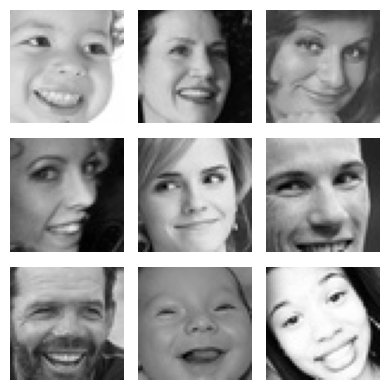

In [10]:
visualize_emotion_images(DATADIR, SUBDIRS, "happy", 9)

**Observations and Insights:**

- The images appear to be in grayscale and vary in terms of lighting, contrast, and clarity.

- The images display a range of happy expressions, from broad smiles showing teeth to subtle smiles without teeth. Also a diversity of subjects in terms of age, gender and also ethnicity.


### **Sad**


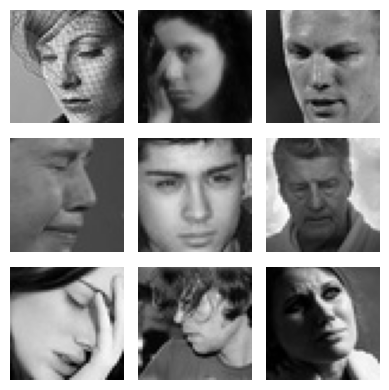

In [11]:
visualize_emotion_images(DATADIR, SUBDIRS, "sad", 9)

**Observations and Insights:**

- The images capture a wide spectrum of sadness, from subtle, somber expressions to more overt manifestations like crying.
- The dataset includes faces with different orientations and features. Some faces are directly looking at the camera, while others are tilted or partially turned away.


### **Neutral**


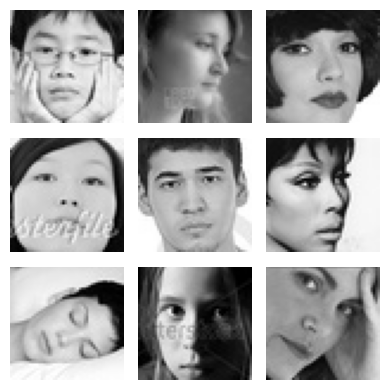

In [12]:
visualize_emotion_images(DATADIR, SUBDIRS, "neutral", 9)

**Observations and Insights:**

- The defining characteristic of these images is the absence of clear, expressive features that denote a specific emotion.
- Some faces may have subtle features that could be misconstrued as expressing a mild emotion.


### **Surprised**


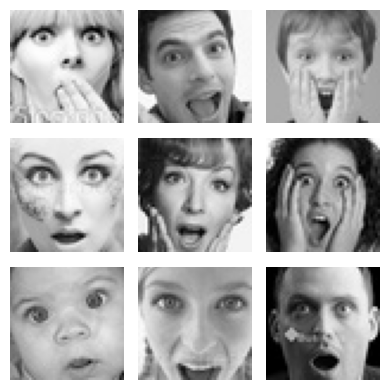

In [13]:
visualize_emotion_images(DATADIR, SUBDIRS, "surprise", 9)

**Observations and Insights:**

- The images showcase a range of intensities of surprise, from wide-eyed and open-mouthed expressions to more subdued, raised-eyebrow looks.
- The subjects vary in age, including both infants and adults.


## **Checking Distribution of Classes**


In [14]:
# Function to count images in each category
def count_images(data_dir, categories):
    counts = []
    for category in categories:
        path = os.path.join(data_dir, category)
        count = len([name for name in os.listdir(path) if os.path.isfile(os.path.join(path, name))])
        counts.append(count)
    return counts


SUBDIRS_DICT = {"train": "train", "validation": "validation", "test": "test"}

# Counting images in each dataset
train_counts = count_images(os.path.join(DATADIR, SUBDIRS_DICT["train"]), CATEGORIES)
validation_counts = count_images(os.path.join(DATADIR, SUBDIRS_DICT["validation"]), CATEGORIES)
test_counts = count_images(os.path.join(DATADIR, SUBDIRS_DICT["test"]), CATEGORIES)


# Create DataFrames and format for easier reading
def create_df(counts, categories, dataset_name):
    df = pd.DataFrame({"Class": categories, "Count": counts})
    df["Percentage"] = (df["Count"] / df["Count"].sum()) * 100
    df.set_index("Class", inplace=True)

    # Formatting for easier reading
    df["Count"] = df["Count"].apply(lambda x: f"{x:,}")  # Adds commas to thousands
    df["Percentage"] = df["Percentage"].apply(lambda x: f"{x:.2f}")  # Rounds to two decimals

    print(f"{dataset_name} Data Distribution:")
    print(df)
    total_images = df["Count"].str.replace(",", "").astype(int).sum()
    print(f"Total images in {dataset_name}: {total_images:,}\n")  # Formats total count with commas


create_df(train_counts, CATEGORIES, "Training")
create_df(validation_counts, CATEGORIES, "Validation")
create_df(test_counts, CATEGORIES, "Testing")

Training Data Distribution:
          Count Percentage
Class                     
happy     3,976      26.32
neutral   3,978      26.33
sad       3,982      26.36
surprise  3,173      21.00
Total images in Training: 15,109

Validation Data Distribution:
          Count Percentage
Class                     
happy     1,825      36.67
neutral   1,216      24.43
sad       1,139      22.89
surprise    797      16.01
Total images in Validation: 4,977

Testing Data Distribution:
         Count Percentage
Class                    
happy       32      25.00
neutral     32      25.00
sad         32      25.00
surprise    32      25.00
Total images in Testing: 128



**Observations and Insights:**

- Training Data: The training dataset shows a relatively balanced distribution among the classes of 'happy', 'neutral', and 'sad', each comprising approximately 26% of the dataset. However, 'surprise' is slightly underrepresented, making up 21% of the data. We'll see on the results if this is noticeable.
- Validation Data: In the validation dataset, there's a more pronounced imbalance. 'Happy' expressions dominate at 36.67%, followed by 'neutral' at 24.43%, 'sad' at 22.89%, and 'surprise' at 16.01%. This distribution deviates more significantly from an even split, indicating a potential bias towards 'happy' expressions.
- Testing Data: The testing dataset is perfectly balanced, with each class representing 25% of the data. This uniform distribution is ideal for evaluating the model's performance across all classes evenly.

Regarding the Exploratory Data Analysis, we can use data augmentation to balance the classes. For now, we'll see the results with the given dataset, and if necessary, we can adjust that.


**Think About It:**

- Are the classes equally distributed? If not, do you think the imbalance is too high? Will it be a problem as we progress?
- Are there any Exploratory Data Analysis tasks that we can do here? Would they provide any meaningful insights?


## **Creating our Data Loaders**

In this section, we are creating data loaders that we will use as inputs to our Neural Network.

**You have two options for the color_mode. You can set it to color_mode = 'rgb' or color_mode = 'grayscale'. You will need to try out both and see for yourself which one gives better performance.**


In [15]:
# Set this to 'grayscale' as the images are in grayscale
color_mode = "grayscale"

# As we have checked, all images are 48x48, we will set the img_width and img_height to 48
img_width, img_height = 48, 48
# A batch size of 32 is appropriate for this dataset provide to provide a good balance
# between the model's ability to generalize (avoid overfitting) and computational efficiency.
batch_size = 32

# Training Data Augmentation
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,  # Normalize pixel values to [0,1]
    rotation_range=20,  # Slight rotation to introduce variability without distorting emotion features
    width_shift_range=0.1,  # Slight horizontal shifts to simulate off-center faces
    height_shift_range=0.1,  # Slight vertical shifts to account for different heights/angles
    shear_range=0.1,  # Small shear transformations for slight perspective changes
    zoom_range=0.1,  # Small zoom in/out to simulate closer or further away faces
    horizontal_flip=True,  # Faces are symmetric; flipping can simulate looking from another direction
    fill_mode="nearest",  # 'nearest' interpolation for filling in new pixels after a transformation
)

# Validation and Testing Data should not be augmented!
validation_datagen = ImageDataGenerator(rescale=1.0 / 255)
test_datagen = ImageDataGenerator(rescale=1.0 / 255)

# Assuming train_dir, validation_dir, and test_dir should follow the structure in DATADIR and SUBDIRS
train_dir = os.path.join(DATADIR, SUBDIRS_DICT["train"])
validation_dir = os.path.join(DATADIR, SUBDIRS_DICT["validation"])
test_dir = os.path.join(DATADIR, SUBDIRS_DICT["test"])

# Train Generator
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    color_mode=color_mode,  # Set to 'grayscale'
    class_mode="categorical",
)

# Validation Generator
validation_generator = validation_datagen.flow_from_directory(
    validation_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    color_mode=color_mode,  # Set to 'grayscale'
    class_mode="categorical",
)

# Testing Generator
test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    color_mode=color_mode,  # Set to 'grayscale'
    class_mode="categorical",
    shuffle=False,  # shuffle=False to keep data in order for testing
)

Found 15109 images belonging to 4 classes.


Found 4977 images belonging to 4 classes.


Found 128 images belonging to 4 classes.


Let's look at some examples of a batch of augmented training data.


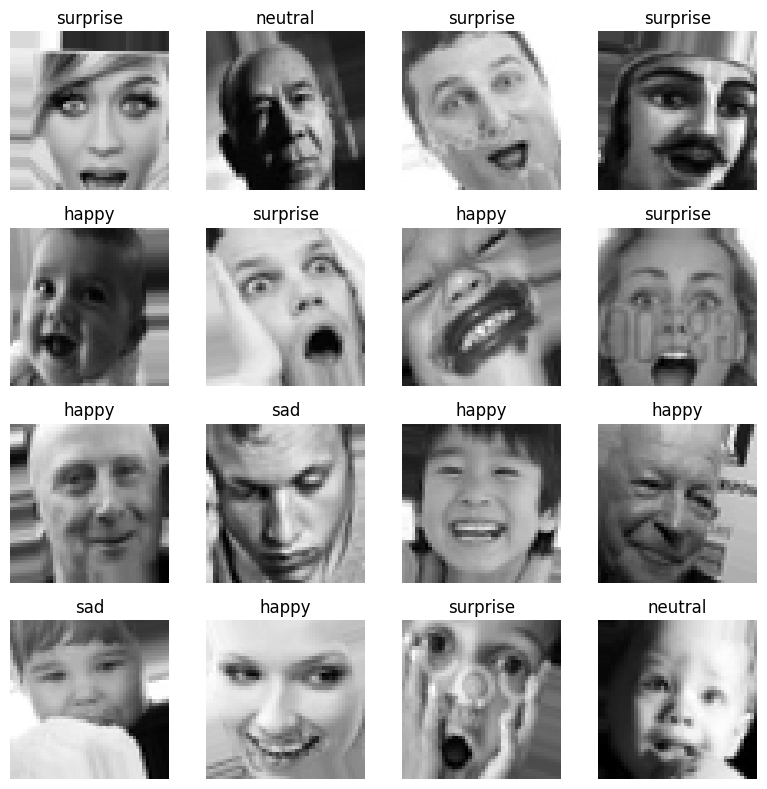

In [16]:
# Fetch a batch of images and labels
images, labels = next(train_generator)

# Assuming the labels are one-hot encoded, we need to convert them back to class indices
labels_indices = labels.argmax(axis=1)

# Mapping of indices to class names, based on the 'class_indices' attribute of the generator
index_to_class = {v: k for k, v in train_generator.class_indices.items()}

fig, axes = plt.subplots(4, 4, figsize=(8, 8))
for image, label_index, ax in zip(images, labels_indices, axes.flatten()):
    ax.imshow(image.squeeze(), cmap="gray")  # Squeeze and cmap for grayscale
    class_name = index_to_class[label_index]
    ax.set_title(class_name)
    ax.axis("off")

plt.tight_layout()
plt.show()

## **Model Building**


**Think About It:**

- Are Convolutional Neural Networks the right approach? Should we have gone with Artificial Neural Networks instead?
- What are the advantages of CNNs over ANNs and are they applicable here?


### **Creating the Base Neural Network**


### **Model 1 Architecture:**

- First CNN Model will have three convolutional blocks.
- Each convolutional block will have a Conv2D layer and a MaxPooling2D Layer.
- First Conv2D layer with **64 filters** and a **kernel size of 3x3**. Using the **'same' padding** and providing the **input shape = (48, 48, 1)**. Using **'relu' activation**.
- Adding MaxPooling2D layer with **kernel size 3x3** and using **padding = 'same'**.
- Adding a second Conv2D layer with **32 filters** and **a kernel size of 3x3**. Using the **'same' padding** and **'relu activation**.
- Following it up with another MaxPooling2D layer **kernel size 3x3** and using **padding = 'same'**.
- Adding a third Conv2D layer with **32 filters and the kernel size of 3x3**. Using the **'same' padding** and **'relu activation**. Once again, following it up with another Maxpooling2D layer with **kernel size 3x3** and **padding = 'same'**.
- Once the convolutional blocks are added, we add the Flatten layer.
- Finally, we add dense layers.
- Adding first Dense layer with **100 neurons** and **'relu' activation**
- The last dense layer needs to have as many neurons as the number of classes, which in this case is 4 and use **'softmax' activation**.
- As an optimizer we will use SGD optimizer with **learning rate = 0.01** and **momentum = 0.9**


In [17]:
backend.clear_session()

# Fixing the seed for random number generators so that we can ensure we receive the same output everytime
np.random.seed(42)

random.seed(42)
tf.random.set_seed(42)

In [18]:
# Intializing a sequential model
model_1 = Sequential()

# Adding first conv layer with 64 filters and kernel size 3x3, padding 'same' provides the output size same as the input size
# The input_shape denotes input image dimension
model_1.add(Conv2D(64, (3, 3), activation="relu", padding="same", input_shape=(48, 48, 1)))

# Adding max pooling to reduce the size of output of first conv layer
model_1.add(MaxPooling2D((2, 2), padding="same"))

# Adding second conv layer with 32 filters and kernel size 3x3, padding 'same' followed by a Maxpooling2D layer
model_1.add(Conv2D(32, (3, 3), activation="relu", padding="same"))
model_1.add(MaxPooling2D((2, 2), padding="same"))

# Add third conv layer with 32 filters and kernel size 3x3, padding 'same' followed by a Maxpooling2D layer
model_1.add(Conv2D(32, (3, 3), activation="relu", padding="same"))
model_1.add(MaxPooling2D((2, 2), padding="same"))

# Flattening the output of the conv layer after max pooling to make it ready for creating dense connections
model_1.add(Flatten())

# Adding a fully connected dense layer with 100 neurons
model_1.add(Dense(100, activation="relu"))

# Adding the output layer with 3 neurons and activation functions as softmax since this is a multi-class classification problem
model_1.add(Dense(4, activation="softmax"))

# Using SGD Optimizer
opt = SGD(learning_rate=0.01, momentum=0.9)

2024-03-18 05:57:58.164196: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-03-18 05:57:58.186887: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-03-18 05:57:58.187089: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

### **Compiling and Training the Model**


In [19]:
# Compiling the model
model_1.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["accuracy"])

# Generating the summary of the model
model_1.summary()

Model: "sequential"


_________________________________________________________________


 Layer (type)                Output Shape              Param #   


 conv2d (Conv2D)             (None, 48, 48, 64)        640       


 max_pooling2d (MaxPooling2  (None, 24, 24, 64)        0         


 D)                                                              


 conv2d_1 (Conv2D)           (None, 24, 24, 32)        18464     


 max_pooling2d_1 (MaxPoolin  (None, 12, 12, 32)        0         


 g2D)                                                            


 conv2d_2 (Conv2D)           (None, 12, 12, 32)        9248      


 max_pooling2d_2 (MaxPoolin  (None, 6, 6, 32)          0         


 g2D)                                                            


 flatten (Flatten)           (None, 1152)              0         


 dense (Dense)               (None, 100)               115300    


 dense_1 (Dense)             (None, 4)                 404       


Total params: 144056 (562.72 KB)


Trainable params: 144056 (562.72 KB)


Non-trainable params: 0 (0.00 Byte)


_________________________________________________________________


In [20]:
# results_path = "/content/drive/MyDrive/Studies/MIT-AI-ML/11. Capstone Project/results"
results_path = "/home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results"

In [21]:
class DelayedEarlyStopping(EarlyStopping):
    """Stop training when a monitored metric has stopped improving after a certain number of epochs.

    Arguments:
        monitor: Quantity to be monitored.
        min_delta: Minimum change in the monitored quantity to qualify as an improvement,
                   i.e., an absolute change of less than min_delta will count as no improvement.
        patience: Number of epochs with no improvement after which training will be stopped.
        verbose: Verbosity mode.
        mode: One of `{'auto', 'min', 'max'}`. In `min` mode, training will stop when the
              quantity monitored has stopped decreasing; in `max` mode it will stop when the
              quantity monitored has stopped increasing; in `auto` mode, the direction is
              automatically inferred from the name of the monitored quantity.
        baseline: Baseline value for the monitored quantity. Training will stop if the model
                  doesn't show improvement over the baseline.
        restore_best_weights: Whether to restore model weights from the epoch with the best value
                              of the monitored quantity.
        start_epoch: The epoch on which to start considering early stopping. Before this epoch,
                     early stopping will not be considered. This ensures that early stopping
                     checks only after a certain number of epochs.
    """

    def __init__(
        self,
        monitor="val_loss",
        min_delta=0,
        patience=0,
        verbose=0,
        mode="auto",
        baseline=None,
        restore_best_weights=False,
        start_epoch=30,
    ):
        super(DelayedEarlyStopping, self).__init__(
            monitor=monitor,
            min_delta=min_delta,
            patience=patience,
            verbose=verbose,
            mode=mode,
            baseline=baseline,
            restore_best_weights=restore_best_weights,
        )
        self.start_epoch = start_epoch

    def on_epoch_end(self, epoch, logs=None):
        # Override the original `on_epoch_end` method to include `start_epoch` logic.

        # If the current epoch is less than the start epoch, skip the early stopping check
        if epoch < self.start_epoch:
            return

        # Call the parent class method to perform the regular early stopping checks after the start epoch
        super(DelayedEarlyStopping, self).on_epoch_end(epoch, logs)


# Usage of DelayedEarlyStopping
# Define the EarlyStopping callback with a start epoch
delayed_early_stopping = DelayedEarlyStopping(
    monitor="val_loss", patience=10, verbose=1, restore_best_weights=True, start_epoch=30
)

In [22]:
# Get the current time
current_time = datetime.now().strftime("%Y%m%d-%H%M%S")

# Set up Early Stopping with a patience 7 but acting after at least 30 epochs
delayed_early_stopping = DelayedEarlyStopping(
    monitor="val_loss", patience=7, verbose=1, restore_best_weights=True, start_epoch=30
)

# Define the learning rate scheduler callback
reduce_lr = ReduceLROnPlateau(monitor="val_loss", factor=0.2, patience=5, min_lr=0.00001, verbose=1)
mc = ModelCheckpoint(
    f"{results_path}/best_model_1_{current_time}.keras",
    monitor="val_accuracy",
    mode="max",
    verbose=1,
    save_best_only=True,
)

# Pulling a single large batch of random validation data for doing the validation after each epoch
validationX, validationY = validation_generator.next()

# Fitting the model with 40 epochs and using validation set
history_1 = model_1.fit(
    train_generator,
    epochs=40,
    validation_data=(validationX, validationY),
    callbacks=[delayed_early_stopping, mc, reduce_lr],
)

Epoch 1/40


2024-03-18 05:57:58.881937: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902


2024-03-18 05:57:59.148806: I external/local_xla/xla/service/service.cc:168] XLA service 0x7f54ed1a1840 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-03-18 05:57:59.148825: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 3070, Compute Capability 8.6
I0000 00:00:1710741479.192730 3220148 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


  1/473 [..............................] - ETA: 9:55 - loss: 1.3792 - accuracy: 0.2812

  8/473 [..............................] - ETA: 3s - loss: 1.3829 - accuracy: 0.2734  

 14/473 [..............................] - ETA: 3s - loss: 1.3860 - accuracy: 0.2522

 20/473 [>.............................] - ETA: 4s - loss: 1.3849 - accuracy: 0.2500

 26/473 [>.............................] - ETA: 4s - loss: 1.3852 - accuracy: 0.2512

 32/473 [=>............................] - ETA: 4s - loss: 1.3852 - accuracy: 0.2559

 38/473 [=>............................] - ETA: 4s - loss: 1.3852 - accuracy: 0.2516

 44/473 [=>............................] - ETA: 4s - loss: 1.3834 - accuracy: 0.2564

 50/473 [==>...........................] - ETA: 3s - loss: 1.3858 - accuracy: 0.2488

 55/473 [==>...........................] - ETA: 3s - loss: 1.3857 - accuracy: 0.2545

 61/473 [==>...........................] - ETA: 3s - loss: 1.3855 - accuracy: 0.2556

 67/473 [===>..........................] - ETA: 3s - loss: 1.3849 - accuracy: 0.2551

 73/473 [===>..........................] - ETA: 3s - loss: 1.3848 - accuracy: 0.2560

 79/473 [====>.........................] - ETA: 3s - loss: 1.3834 - accuracy: 0.2615

 85/473 [====>.........................] - ETA: 3s - loss: 1.3816 - accuracy: 0.2665

 91/473 [====>.........................] - ETA: 3s - loss: 1.3808 - accuracy: 0.2682

 97/473 [=====>........................] - ETA: 3s - loss: 1.3809 - accuracy: 0.2677

103/473 [=====>........................] - ETA: 3s - loss: 1.3796 - accuracy: 0.2688

109/473 [=====>........................] - ETA: 3s - loss: 1.3797 - accuracy: 0.2669

115/473 [======>.......................] - ETA: 3s - loss: 1.3795 - accuracy: 0.2658

121/473 [======>.......................] - ETA: 3s - loss: 1.3794 - accuracy: 0.2681

127/473 [=======>......................] - ETA: 3s - loss: 1.3793 - accuracy: 0.2682

133/473 [=======>......................] - ETA: 3s - loss: 1.3788 - accuracy: 0.2681

139/473 [=======>......................] - ETA: 3s - loss: 1.3787 - accuracy: 0.2666

145/473 [========>.....................] - ETA: 3s - loss: 1.3780 - accuracy: 0.2670

151/473 [========>.....................] - ETA: 3s - loss: 1.3779 - accuracy: 0.2688

157/473 [========>.....................] - ETA: 3s - loss: 1.3776 - accuracy: 0.2703

163/473 [=========>....................] - ETA: 2s - loss: 1.3773 - accuracy: 0.2726

169/473 [=========>....................] - ETA: 2s - loss: 1.3770 - accuracy: 0.2716

175/473 [==========>...................] - ETA: 2s - loss: 1.3763 - accuracy: 0.2730

181/473 [==========>...................] - ETA: 2s - loss: 1.3752 - accuracy: 0.2749

187/473 [==========>...................] - ETA: 2s - loss: 1.3741 - accuracy: 0.2771

193/473 [===========>..................] - ETA: 2s - loss: 1.3748 - accuracy: 0.2772

199/473 [===========>..................] - ETA: 2s - loss: 1.3737 - accuracy: 0.2797

205/473 [============>.................] - ETA: 2s - loss: 1.3731 - accuracy: 0.2803

211/473 [============>.................] - ETA: 2s - loss: 1.3718 - accuracy: 0.2818

217/473 [============>.................] - ETA: 2s - loss: 1.3706 - accuracy: 0.2831

223/473 [=============>................] - ETA: 2s - loss: 1.3705 - accuracy: 0.2835

227/473 [=============>................] - ETA: 2s - loss: 1.3700 - accuracy: 0.2846

233/473 [=============>................] - ETA: 2s - loss: 1.3693 - accuracy: 0.2859

239/473 [==============>...............] - ETA: 2s - loss: 1.3679 - accuracy: 0.2874

245/473 [==============>...............] - ETA: 2s - loss: 1.3672 - accuracy: 0.2875

251/473 [==============>...............] - ETA: 2s - loss: 1.3671 - accuracy: 0.2880

256/473 [===============>..............] - ETA: 2s - loss: 1.3667 - accuracy: 0.2882

262/473 [===============>..............] - ETA: 2s - loss: 1.3660 - accuracy: 0.2884

268/473 [===============>..............] - ETA: 1s - loss: 1.3648 - accuracy: 0.2899

274/473 [================>.............] - ETA: 1s - loss: 1.3646 - accuracy: 0.2904

280/473 [================>.............] - ETA: 1s - loss: 1.3642 - accuracy: 0.2915

286/473 [=================>............] - ETA: 1s - loss: 1.3635 - accuracy: 0.2926

292/473 [=================>............] - ETA: 1s - loss: 1.3643 - accuracy: 0.2926

297/473 [=================>............] - ETA: 1s - loss: 1.3640 - accuracy: 0.2932

303/473 [==================>...........] - ETA: 1s - loss: 1.3641 - accuracy: 0.2924

309/473 [==================>...........] - ETA: 1s - loss: 1.3634 - accuracy: 0.2932

315/473 [==================>...........] - ETA: 1s - loss: 1.3629 - accuracy: 0.2950

321/473 [===================>..........] - ETA: 1s - loss: 1.3625 - accuracy: 0.2951

327/473 [===================>..........] - ETA: 1s - loss: 1.3617 - accuracy: 0.2956

333/473 [====================>.........] - ETA: 1s - loss: 1.3610 - accuracy: 0.2965

339/473 [====================>.........] - ETA: 1s - loss: 1.3610 - accuracy: 0.2977

345/473 [====================>.........] - ETA: 1s - loss: 1.3609 - accuracy: 0.2976

351/473 [=====================>........] - ETA: 1s - loss: 1.3613 - accuracy: 0.2975

357/473 [=====================>........] - ETA: 1s - loss: 1.3613 - accuracy: 0.2980

363/473 [======================>.......] - ETA: 1s - loss: 1.3611 - accuracy: 0.2986

369/473 [======================>.......] - ETA: 1s - loss: 1.3607 - accuracy: 0.2989

375/473 [======================>.......] - ETA: 0s - loss: 1.3601 - accuracy: 0.2993

376/473 [======================>.......] - ETA: 1s - loss: 1.3602 - accuracy: 0.2993

383/473 [=======================>......] - ETA: 0s - loss: 1.3594 - accuracy: 0.3009

387/473 [=======================>......] - ETA: 0s - loss: 1.3592 - accuracy: 0.3015

393/473 [=======================>......] - ETA: 0s - loss: 1.3587 - accuracy: 0.3026

399/473 [========================>.....] - ETA: 0s - loss: 1.3584 - accuracy: 0.3033

405/473 [========================>.....] - ETA: 0s - loss: 1.3581 - accuracy: 0.3033

411/473 [=========================>....] - ETA: 0s - loss: 1.3579 - accuracy: 0.3035

417/473 [=========================>....] - ETA: 0s - loss: 1.3579 - accuracy: 0.3040

423/473 [=========================>....] - ETA: 0s - loss: 1.3574 - accuracy: 0.3045

429/473 [==========================>...] - ETA: 0s - loss: 1.3564 - accuracy: 0.3061

434/473 [==========================>...] - ETA: 0s - loss: 1.3561 - accuracy: 0.3063

440/473 [==========================>...] - ETA: 0s - loss: 1.3557 - accuracy: 0.3068

446/473 [===========================>..] - ETA: 0s - loss: 1.3555 - accuracy: 0.3070

452/473 [===========================>..] - ETA: 0s - loss: 1.3548 - accuracy: 0.3079

458/473 [============================>.] - ETA: 0s - loss: 1.3540 - accuracy: 0.3088

464/473 [============================>.] - ETA: 0s - loss: 1.3536 - accuracy: 0.3095

470/473 [============================>.] - ETA: 0s - loss: 1.3534 - accuracy: 0.3104


Epoch 1: val_accuracy improved from -inf to 0.34375, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_1_20240318-055758.keras


473/473 [==============================] - 6s 11ms/step - loss: 1.3532 - accuracy: 0.3103 - val_loss: 1.3543 - val_accuracy: 0.3438 - lr: 0.0100


Epoch 2/40


  1/473 [..............................] - ETA: 7s - loss: 1.2041 - accuracy: 0.5312

  7/473 [..............................] - ETA: 4s - loss: 1.3118 - accuracy: 0.3438

 13/473 [..............................] - ETA: 4s - loss: 1.3146 - accuracy: 0.3534

 19/473 [>.............................] - ETA: 4s - loss: 1.3282 - accuracy: 0.3470

 25/473 [>.............................] - ETA: 4s - loss: 1.3314 - accuracy: 0.3438

 31/473 [>.............................] - ETA: 4s - loss: 1.3323 - accuracy: 0.3438

 37/473 [=>............................] - ETA: 4s - loss: 1.3280 - accuracy: 0.3488

 43/473 [=>............................] - ETA: 4s - loss: 1.3241 - accuracy: 0.3568

 49/473 [==>...........................] - ETA: 4s - loss: 1.3207 - accuracy: 0.3565

 55/473 [==>...........................] - ETA: 4s - loss: 1.3221 - accuracy: 0.3631

 61/473 [==>...........................] - ETA: 3s - loss: 1.3179 - accuracy: 0.3648

 67/473 [===>..........................] - ETA: 3s - loss: 1.3153 - accuracy: 0.3657

 73/473 [===>..........................] - ETA: 3s - loss: 1.3160 - accuracy: 0.3643

 79/473 [====>.........................] - ETA: 3s - loss: 1.3177 - accuracy: 0.3635

 85/473 [====>.........................] - ETA: 3s - loss: 1.3183 - accuracy: 0.3603

 91/473 [====>.........................] - ETA: 3s - loss: 1.3163 - accuracy: 0.3630

 97/473 [=====>........................] - ETA: 3s - loss: 1.3135 - accuracy: 0.3647

103/473 [=====>........................] - ETA: 3s - loss: 1.3125 - accuracy: 0.3680

109/473 [=====>........................] - ETA: 3s - loss: 1.3143 - accuracy: 0.3675

115/473 [======>.......................] - ETA: 3s - loss: 1.3143 - accuracy: 0.3690

121/473 [======>.......................] - ETA: 3s - loss: 1.3152 - accuracy: 0.3688

127/473 [=======>......................] - ETA: 3s - loss: 1.3128 - accuracy: 0.3703

133/473 [=======>......................] - ETA: 3s - loss: 1.3114 - accuracy: 0.3719

139/473 [=======>......................] - ETA: 3s - loss: 1.3102 - accuracy: 0.3732

145/473 [========>.....................] - ETA: 3s - loss: 1.3094 - accuracy: 0.3731

150/473 [========>.....................] - ETA: 3s - loss: 1.3082 - accuracy: 0.3742

156/473 [========>.....................] - ETA: 3s - loss: 1.3070 - accuracy: 0.3742

162/473 [=========>....................] - ETA: 3s - loss: 1.3082 - accuracy: 0.3754

168/473 [=========>....................] - ETA: 2s - loss: 1.3076 - accuracy: 0.3757

174/473 [==========>...................] - ETA: 2s - loss: 1.3075 - accuracy: 0.3755

180/473 [==========>...................] - ETA: 2s - loss: 1.3073 - accuracy: 0.3757

186/473 [==========>...................] - ETA: 2s - loss: 1.3077 - accuracy: 0.3750

192/473 [===========>..................] - ETA: 2s - loss: 1.3063 - accuracy: 0.3757

198/473 [===========>..................] - ETA: 2s - loss: 1.3077 - accuracy: 0.3750

204/473 [===========>..................] - ETA: 2s - loss: 1.3075 - accuracy: 0.3745

210/473 [============>.................] - ETA: 2s - loss: 1.3058 - accuracy: 0.3768

216/473 [============>.................] - ETA: 2s - loss: 1.3034 - accuracy: 0.3789

222/473 [=============>................] - ETA: 2s - loss: 1.3030 - accuracy: 0.3788

228/473 [=============>................] - ETA: 2s - loss: 1.3039 - accuracy: 0.3772

234/473 [=============>................] - ETA: 2s - loss: 1.3053 - accuracy: 0.3755

240/473 [==============>...............] - ETA: 2s - loss: 1.3040 - accuracy: 0.3760

245/473 [==============>...............] - ETA: 2s - loss: 1.3034 - accuracy: 0.3770

251/473 [==============>...............] - ETA: 2s - loss: 1.3022 - accuracy: 0.3781

257/473 [===============>..............] - ETA: 2s - loss: 1.3021 - accuracy: 0.3782

263/473 [===============>..............] - ETA: 2s - loss: 1.3028 - accuracy: 0.3763

269/473 [================>.............] - ETA: 1s - loss: 1.3025 - accuracy: 0.3757

275/473 [================>.............] - ETA: 1s - loss: 1.3027 - accuracy: 0.3744

281/473 [================>.............] - ETA: 1s - loss: 1.3031 - accuracy: 0.3748

287/473 [=================>............] - ETA: 1s - loss: 1.3023 - accuracy: 0.3762

293/473 [=================>............] - ETA: 1s - loss: 1.3020 - accuracy: 0.3762

298/473 [=================>............] - ETA: 1s - loss: 1.3007 - accuracy: 0.3771

304/473 [==================>...........] - ETA: 1s - loss: 1.3003 - accuracy: 0.3778

309/473 [==================>...........] - ETA: 1s - loss: 1.2991 - accuracy: 0.3789

315/473 [==================>...........] - ETA: 1s - loss: 1.2992 - accuracy: 0.3783

321/473 [===================>..........] - ETA: 1s - loss: 1.3000 - accuracy: 0.3774

327/473 [===================>..........] - ETA: 1s - loss: 1.3007 - accuracy: 0.3765

333/473 [====================>.........] - ETA: 1s - loss: 1.3010 - accuracy: 0.3760

339/473 [====================>.........] - ETA: 1s - loss: 1.3011 - accuracy: 0.3763

345/473 [====================>.........] - ETA: 1s - loss: 1.3005 - accuracy: 0.3766

351/473 [=====================>........] - ETA: 1s - loss: 1.2996 - accuracy: 0.3777

357/473 [=====================>........] - ETA: 1s - loss: 1.2985 - accuracy: 0.3788

363/473 [======================>.......] - ETA: 1s - loss: 1.2974 - accuracy: 0.3798

369/473 [======================>.......] - ETA: 1s - loss: 1.2972 - accuracy: 0.3795

375/473 [======================>.......] - ETA: 0s - loss: 1.2965 - accuracy: 0.3801

381/473 [=======================>......] - ETA: 0s - loss: 1.2967 - accuracy: 0.3794

387/473 [=======================>......] - ETA: 0s - loss: 1.2964 - accuracy: 0.3795

393/473 [=======================>......] - ETA: 0s - loss: 1.2958 - accuracy: 0.3807

399/473 [========================>.....] - ETA: 0s - loss: 1.2947 - accuracy: 0.3812

405/473 [========================>.....] - ETA: 0s - loss: 1.2946 - accuracy: 0.3800

411/473 [=========================>....] - ETA: 0s - loss: 1.2944 - accuracy: 0.3802

417/473 [=========================>....] - ETA: 0s - loss: 1.2933 - accuracy: 0.3816

423/473 [=========================>....] - ETA: 0s - loss: 1.2926 - accuracy: 0.3818

429/473 [==========================>...] - ETA: 0s - loss: 1.2930 - accuracy: 0.3821

435/473 [==========================>...] - ETA: 0s - loss: 1.2920 - accuracy: 0.3824

441/473 [==========================>...] - ETA: 0s - loss: 1.2914 - accuracy: 0.3827

446/473 [===========================>..] - ETA: 0s - loss: 1.2914 - accuracy: 0.3830

452/473 [===========================>..] - ETA: 0s - loss: 1.2909 - accuracy: 0.3835

458/473 [============================>.] - ETA: 0s - loss: 1.2915 - accuracy: 0.3825

464/473 [============================>.] - ETA: 0s - loss: 1.2905 - accuracy: 0.3837

469/473 [============================>.] - ETA: 0s - loss: 1.2896 - accuracy: 0.3846


Epoch 2: val_accuracy did not improve from 0.34375


473/473 [==============================] - 5s 10ms/step - loss: 1.2897 - accuracy: 0.3847 - val_loss: 1.2705 - val_accuracy: 0.3438 - lr: 0.0100


Epoch 3/40


  1/473 [..............................] - ETA: 7s - loss: 1.4726 - accuracy: 0.3125

  7/473 [..............................] - ETA: 4s - loss: 1.2949 - accuracy: 0.3616

 13/473 [..............................] - ETA: 4s - loss: 1.2981 - accuracy: 0.3846

 19/473 [>.............................] - ETA: 4s - loss: 1.2982 - accuracy: 0.3865

 25/473 [>.............................] - ETA: 4s - loss: 1.3039 - accuracy: 0.3787

 31/473 [>.............................] - ETA: 4s - loss: 1.3056 - accuracy: 0.3810

 37/473 [=>............................] - ETA: 4s - loss: 1.3035 - accuracy: 0.3885

 43/473 [=>............................] - ETA: 4s - loss: 1.3016 - accuracy: 0.3895

 49/473 [==>...........................] - ETA: 4s - loss: 1.2922 - accuracy: 0.3960

 55/473 [==>...........................] - ETA: 4s - loss: 1.2847 - accuracy: 0.3983

 61/473 [==>...........................] - ETA: 3s - loss: 1.2780 - accuracy: 0.4062

 67/473 [===>..........................] - ETA: 3s - loss: 1.2729 - accuracy: 0.4114

 73/473 [===>..........................] - ETA: 3s - loss: 1.2722 - accuracy: 0.4105

 79/473 [====>.........................] - ETA: 3s - loss: 1.2681 - accuracy: 0.4126

 85/473 [====>.........................] - ETA: 3s - loss: 1.2630 - accuracy: 0.4158

 91/473 [====>.........................] - ETA: 3s - loss: 1.2618 - accuracy: 0.4128

 97/473 [=====>........................] - ETA: 3s - loss: 1.2628 - accuracy: 0.4149

103/473 [=====>........................] - ETA: 3s - loss: 1.2586 - accuracy: 0.4193

109/473 [=====>........................] - ETA: 3s - loss: 1.2620 - accuracy: 0.4183

115/473 [======>.......................] - ETA: 3s - loss: 1.2591 - accuracy: 0.4215

121/473 [======>.......................] - ETA: 3s - loss: 1.2557 - accuracy: 0.4217

127/473 [=======>......................] - ETA: 3s - loss: 1.2534 - accuracy: 0.4274

133/473 [=======>......................] - ETA: 3s - loss: 1.2527 - accuracy: 0.4260

139/473 [=======>......................] - ETA: 3s - loss: 1.2519 - accuracy: 0.4265

145/473 [========>.....................] - ETA: 3s - loss: 1.2515 - accuracy: 0.4284

151/473 [========>.....................] - ETA: 3s - loss: 1.2502 - accuracy: 0.4269

157/473 [========>.....................] - ETA: 3s - loss: 1.2495 - accuracy: 0.4268

163/473 [=========>....................] - ETA: 2s - loss: 1.2486 - accuracy: 0.4275

168/473 [=========>....................] - ETA: 2s - loss: 1.2485 - accuracy: 0.4265

174/473 [==========>...................] - ETA: 2s - loss: 1.2496 - accuracy: 0.4256

180/473 [==========>...................] - ETA: 2s - loss: 1.2508 - accuracy: 0.4253

186/473 [==========>...................] - ETA: 2s - loss: 1.2490 - accuracy: 0.4259

192/473 [===========>..................] - ETA: 2s - loss: 1.2506 - accuracy: 0.4258

198/473 [===========>..................] - ETA: 2s - loss: 1.2509 - accuracy: 0.4242

204/473 [===========>..................] - ETA: 2s - loss: 1.2523 - accuracy: 0.4233

210/473 [============>.................] - ETA: 2s - loss: 1.2503 - accuracy: 0.4257

216/473 [============>.................] - ETA: 2s - loss: 1.2497 - accuracy: 0.4261

222/473 [=============>................] - ETA: 2s - loss: 1.2494 - accuracy: 0.4257

228/473 [=============>................] - ETA: 2s - loss: 1.2472 - accuracy: 0.4263

234/473 [=============>................] - ETA: 2s - loss: 1.2466 - accuracy: 0.4267

239/473 [==============>...............] - ETA: 2s - loss: 1.2478 - accuracy: 0.4256

244/473 [==============>...............] - ETA: 2s - loss: 1.2464 - accuracy: 0.4260

249/473 [==============>...............] - ETA: 2s - loss: 1.2451 - accuracy: 0.4268

255/473 [===============>..............] - ETA: 2s - loss: 1.2446 - accuracy: 0.4267

261/473 [===============>..............] - ETA: 2s - loss: 1.2439 - accuracy: 0.4268

267/473 [===============>..............] - ETA: 1s - loss: 1.2439 - accuracy: 0.4261

273/473 [================>.............] - ETA: 1s - loss: 1.2437 - accuracy: 0.4265

279/473 [================>.............] - ETA: 1s - loss: 1.2433 - accuracy: 0.4275

285/473 [=================>............] - ETA: 1s - loss: 1.2434 - accuracy: 0.4281

291/473 [=================>............] - ETA: 1s - loss: 1.2427 - accuracy: 0.4287

297/473 [=================>............] - ETA: 1s - loss: 1.2418 - accuracy: 0.4294

303/473 [==================>...........] - ETA: 1s - loss: 1.2415 - accuracy: 0.4291

309/473 [==================>...........] - ETA: 1s - loss: 1.2402 - accuracy: 0.4317

314/473 [==================>...........] - ETA: 1s - loss: 1.2397 - accuracy: 0.4312

319/473 [===================>..........] - ETA: 1s - loss: 1.2380 - accuracy: 0.4315

325/473 [===================>..........] - ETA: 1s - loss: 1.2377 - accuracy: 0.4320

331/473 [===================>..........] - ETA: 1s - loss: 1.2378 - accuracy: 0.4317

337/473 [====================>.........] - ETA: 1s - loss: 1.2389 - accuracy: 0.4313

343/473 [====================>.........] - ETA: 1s - loss: 1.2382 - accuracy: 0.4308

349/473 [=====================>........] - ETA: 1s - loss: 1.2374 - accuracy: 0.4316

355/473 [=====================>........] - ETA: 1s - loss: 1.2368 - accuracy: 0.4323

361/473 [=====================>........] - ETA: 1s - loss: 1.2367 - accuracy: 0.4321

367/473 [======================>.......] - ETA: 1s - loss: 1.2368 - accuracy: 0.4322

373/473 [======================>.......] - ETA: 0s - loss: 1.2363 - accuracy: 0.4316

378/473 [======================>.......] - ETA: 0s - loss: 1.2366 - accuracy: 0.4314

382/473 [=======================>......] - ETA: 0s - loss: 1.2363 - accuracy: 0.4316

387/473 [=======================>......] - ETA: 0s - loss: 1.2369 - accuracy: 0.4306

393/473 [=======================>......] - ETA: 0s - loss: 1.2372 - accuracy: 0.4298

399/473 [========================>.....] - ETA: 0s - loss: 1.2369 - accuracy: 0.4305

405/473 [========================>.....] - ETA: 0s - loss: 1.2362 - accuracy: 0.4308

411/473 [=========================>....] - ETA: 0s - loss: 1.2362 - accuracy: 0.4309

417/473 [=========================>....] - ETA: 0s - loss: 1.2365 - accuracy: 0.4312

423/473 [=========================>....] - ETA: 0s - loss: 1.2368 - accuracy: 0.4304

429/473 [==========================>...] - ETA: 0s - loss: 1.2369 - accuracy: 0.4301

435/473 [==========================>...] - ETA: 0s - loss: 1.2372 - accuracy: 0.4299

441/473 [==========================>...] - ETA: 0s - loss: 1.2360 - accuracy: 0.4312

447/473 [===========================>..] - ETA: 0s - loss: 1.2360 - accuracy: 0.4308

453/473 [===========================>..] - ETA: 0s - loss: 1.2356 - accuracy: 0.4309

459/473 [============================>.] - ETA: 0s - loss: 1.2350 - accuracy: 0.4314

465/473 [============================>.] - ETA: 0s - loss: 1.2349 - accuracy: 0.4315

471/473 [============================>.] - ETA: 0s - loss: 1.2342 - accuracy: 0.4320


Epoch 3: val_accuracy improved from 0.34375 to 0.46875, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_1_20240318-055758.keras


473/473 [==============================] - 5s 10ms/step - loss: 1.2342 - accuracy: 0.4320 - val_loss: 1.1779 - val_accuracy: 0.4688 - lr: 0.0100


Epoch 4/40


  1/473 [..............................] - ETA: 7s - loss: 1.2589 - accuracy: 0.3438

  7/473 [..............................] - ETA: 4s - loss: 1.1905 - accuracy: 0.4062

 13/473 [..............................] - ETA: 4s - loss: 1.1974 - accuracy: 0.4399

 19/473 [>.............................] - ETA: 4s - loss: 1.2101 - accuracy: 0.4441

 25/473 [>.............................] - ETA: 4s - loss: 1.1979 - accuracy: 0.4538

 31/473 [>.............................] - ETA: 4s - loss: 1.2008 - accuracy: 0.4506

 37/473 [=>............................] - ETA: 4s - loss: 1.2058 - accuracy: 0.4400

 43/473 [=>............................] - ETA: 4s - loss: 1.2014 - accuracy: 0.4477

 49/473 [==>...........................] - ETA: 4s - loss: 1.2031 - accuracy: 0.4528

 55/473 [==>...........................] - ETA: 4s - loss: 1.1995 - accuracy: 0.4568

 61/473 [==>...........................] - ETA: 4s - loss: 1.1953 - accuracy: 0.4621

 67/473 [===>..........................] - ETA: 3s - loss: 1.1986 - accuracy: 0.4557

 73/473 [===>..........................] - ETA: 3s - loss: 1.1956 - accuracy: 0.4542

 78/473 [===>..........................] - ETA: 3s - loss: 1.1950 - accuracy: 0.4543

 84/473 [====>.........................] - ETA: 3s - loss: 1.1937 - accuracy: 0.4531

 90/473 [====>.........................] - ETA: 3s - loss: 1.1970 - accuracy: 0.4493

 96/473 [=====>........................] - ETA: 3s - loss: 1.1963 - accuracy: 0.4502

102/473 [=====>........................] - ETA: 3s - loss: 1.1966 - accuracy: 0.4476

108/473 [=====>........................] - ETA: 3s - loss: 1.2001 - accuracy: 0.4474

114/473 [======>.......................] - ETA: 3s - loss: 1.2071 - accuracy: 0.4421

120/473 [======>.......................] - ETA: 3s - loss: 1.2073 - accuracy: 0.4435

126/473 [======>.......................] - ETA: 3s - loss: 1.2082 - accuracy: 0.4432

132/473 [=======>......................] - ETA: 3s - loss: 1.2054 - accuracy: 0.4444

138/473 [=======>......................] - ETA: 3s - loss: 1.2043 - accuracy: 0.4468

144/473 [========>.....................] - ETA: 3s - loss: 1.2044 - accuracy: 0.4451

150/473 [========>.....................] - ETA: 3s - loss: 1.2020 - accuracy: 0.4469

156/473 [========>.....................] - ETA: 3s - loss: 1.2026 - accuracy: 0.4459

162/473 [=========>....................] - ETA: 3s - loss: 1.2033 - accuracy: 0.4444

168/473 [=========>....................] - ETA: 2s - loss: 1.2018 - accuracy: 0.4449

173/473 [=========>....................] - ETA: 2s - loss: 1.1978 - accuracy: 0.4474

179/473 [==========>...................] - ETA: 2s - loss: 1.1981 - accuracy: 0.4480

185/473 [==========>...................] - ETA: 2s - loss: 1.1998 - accuracy: 0.4480

191/473 [===========>..................] - ETA: 2s - loss: 1.1999 - accuracy: 0.4482

196/473 [===========>..................] - ETA: 2s - loss: 1.2006 - accuracy: 0.4474

202/473 [===========>..................] - ETA: 2s - loss: 1.2011 - accuracy: 0.4463

208/473 [============>.................] - ETA: 2s - loss: 1.2003 - accuracy: 0.4476

214/473 [============>.................] - ETA: 2s - loss: 1.1992 - accuracy: 0.4498

220/473 [============>.................] - ETA: 2s - loss: 1.1998 - accuracy: 0.4497

226/473 [=============>................] - ETA: 2s - loss: 1.1984 - accuracy: 0.4504

232/473 [=============>................] - ETA: 2s - loss: 1.1994 - accuracy: 0.4498

238/473 [==============>...............] - ETA: 2s - loss: 1.1992 - accuracy: 0.4501

244/473 [==============>...............] - ETA: 2s - loss: 1.1987 - accuracy: 0.4512

250/473 [==============>...............] - ETA: 2s - loss: 1.1987 - accuracy: 0.4515

256/473 [===============>..............] - ETA: 2s - loss: 1.2002 - accuracy: 0.4513

262/473 [===============>..............] - ETA: 2s - loss: 1.1999 - accuracy: 0.4506

268/473 [===============>..............] - ETA: 1s - loss: 1.2001 - accuracy: 0.4509

274/473 [================>.............] - ETA: 1s - loss: 1.2013 - accuracy: 0.4512

280/473 [================>.............] - ETA: 1s - loss: 1.2015 - accuracy: 0.4505

286/473 [=================>............] - ETA: 1s - loss: 1.2013 - accuracy: 0.4506

292/473 [=================>............] - ETA: 1s - loss: 1.2020 - accuracy: 0.4511

298/473 [=================>............] - ETA: 1s - loss: 1.2015 - accuracy: 0.4513

304/473 [==================>...........] - ETA: 1s - loss: 1.2019 - accuracy: 0.4510

310/473 [==================>...........] - ETA: 1s - loss: 1.2014 - accuracy: 0.4520

316/473 [===================>..........] - ETA: 1s - loss: 1.2003 - accuracy: 0.4525

322/473 [===================>..........] - ETA: 1s - loss: 1.2001 - accuracy: 0.4524

328/473 [===================>..........] - ETA: 1s - loss: 1.1998 - accuracy: 0.4531

334/473 [====================>.........] - ETA: 1s - loss: 1.1997 - accuracy: 0.4531

340/473 [====================>.........] - ETA: 1s - loss: 1.1994 - accuracy: 0.4542

346/473 [====================>.........] - ETA: 1s - loss: 1.1986 - accuracy: 0.4544

352/473 [=====================>........] - ETA: 1s - loss: 1.1981 - accuracy: 0.4551

358/473 [=====================>........] - ETA: 1s - loss: 1.1972 - accuracy: 0.4552

364/473 [======================>.......] - ETA: 1s - loss: 1.1967 - accuracy: 0.4562

370/473 [======================>.......] - ETA: 0s - loss: 1.1970 - accuracy: 0.4565

376/473 [======================>.......] - ETA: 0s - loss: 1.1959 - accuracy: 0.4568

382/473 [=======================>......] - ETA: 0s - loss: 1.1962 - accuracy: 0.4570

388/473 [=======================>......] - ETA: 0s - loss: 1.1961 - accuracy: 0.4577

394/473 [=======================>......] - ETA: 0s - loss: 1.1954 - accuracy: 0.4578

400/473 [========================>.....] - ETA: 0s - loss: 1.1954 - accuracy: 0.4579

406/473 [========================>.....] - ETA: 0s - loss: 1.1950 - accuracy: 0.4576

411/473 [=========================>....] - ETA: 0s - loss: 1.1943 - accuracy: 0.4582

415/473 [=========================>....] - ETA: 0s - loss: 1.1937 - accuracy: 0.4582

420/473 [=========================>....] - ETA: 0s - loss: 1.1937 - accuracy: 0.4581

426/473 [==========================>...] - ETA: 0s - loss: 1.1932 - accuracy: 0.4584

432/473 [==========================>...] - ETA: 0s - loss: 1.1937 - accuracy: 0.4577

438/473 [==========================>...] - ETA: 0s - loss: 1.1936 - accuracy: 0.4577

444/473 [===========================>..] - ETA: 0s - loss: 1.1932 - accuracy: 0.4583

450/473 [===========================>..] - ETA: 0s - loss: 1.1926 - accuracy: 0.4592

456/473 [===========================>..] - ETA: 0s - loss: 1.1928 - accuracy: 0.4592

462/473 [============================>.] - ETA: 0s - loss: 1.1926 - accuracy: 0.4586

468/473 [============================>.] - ETA: 0s - loss: 1.1927 - accuracy: 0.4586


Epoch 4: val_accuracy did not improve from 0.46875


473/473 [==============================] - 5s 10ms/step - loss: 1.1925 - accuracy: 0.4585 - val_loss: 1.1150 - val_accuracy: 0.4688 - lr: 0.0100


Epoch 5/40


  1/473 [..............................] - ETA: 7s - loss: 1.2437 - accuracy: 0.4375

  7/473 [..............................] - ETA: 4s - loss: 1.1642 - accuracy: 0.4732

 13/473 [..............................] - ETA: 4s - loss: 1.2008 - accuracy: 0.4471

 19/473 [>.............................] - ETA: 4s - loss: 1.1847 - accuracy: 0.4655

 25/473 [>.............................] - ETA: 4s - loss: 1.1659 - accuracy: 0.4750

 31/473 [>.............................] - ETA: 4s - loss: 1.1775 - accuracy: 0.4667

 37/473 [=>............................] - ETA: 4s - loss: 1.1726 - accuracy: 0.4738

 43/473 [=>............................] - ETA: 4s - loss: 1.1805 - accuracy: 0.4658

 49/473 [==>...........................] - ETA: 4s - loss: 1.1762 - accuracy: 0.4732

 55/473 [==>...........................] - ETA: 4s - loss: 1.1651 - accuracy: 0.4807

 61/473 [==>...........................] - ETA: 3s - loss: 1.1604 - accuracy: 0.4862

 67/473 [===>..........................] - ETA: 3s - loss: 1.1640 - accuracy: 0.4818

 72/473 [===>..........................] - ETA: 3s - loss: 1.1632 - accuracy: 0.4831

 78/473 [===>..........................] - ETA: 3s - loss: 1.1598 - accuracy: 0.4808

 84/473 [====>.........................] - ETA: 3s - loss: 1.1570 - accuracy: 0.4851

 90/473 [====>.........................] - ETA: 3s - loss: 1.1557 - accuracy: 0.4868

 96/473 [=====>........................] - ETA: 3s - loss: 1.1597 - accuracy: 0.4827

102/473 [=====>........................] - ETA: 3s - loss: 1.1625 - accuracy: 0.4798

107/473 [=====>........................] - ETA: 3s - loss: 1.1641 - accuracy: 0.4766

110/473 [=====>........................] - ETA: 3s - loss: 1.1654 - accuracy: 0.4776

116/473 [======>.......................] - ETA: 3s - loss: 1.1614 - accuracy: 0.4806

121/473 [======>.......................] - ETA: 3s - loss: 1.1619 - accuracy: 0.4806

127/473 [=======>......................] - ETA: 3s - loss: 1.1646 - accuracy: 0.4796

133/473 [=======>......................] - ETA: 3s - loss: 1.1639 - accuracy: 0.4793

139/473 [=======>......................] - ETA: 3s - loss: 1.1648 - accuracy: 0.4777

145/473 [========>.....................] - ETA: 3s - loss: 1.1624 - accuracy: 0.4782

151/473 [========>.....................] - ETA: 3s - loss: 1.1638 - accuracy: 0.4774

157/473 [========>.....................] - ETA: 3s - loss: 1.1613 - accuracy: 0.4799

163/473 [=========>....................] - ETA: 3s - loss: 1.1588 - accuracy: 0.4803

169/473 [=========>....................] - ETA: 3s - loss: 1.1608 - accuracy: 0.4776

175/473 [==========>...................] - ETA: 2s - loss: 1.1576 - accuracy: 0.4795

181/473 [==========>...................] - ETA: 2s - loss: 1.1564 - accuracy: 0.4800

187/473 [==========>...................] - ETA: 2s - loss: 1.1543 - accuracy: 0.4820

193/473 [===========>..................] - ETA: 2s - loss: 1.1555 - accuracy: 0.4809

199/473 [===========>..................] - ETA: 2s - loss: 1.1549 - accuracy: 0.4810

205/473 [============>.................] - ETA: 2s - loss: 1.1529 - accuracy: 0.4834

211/473 [============>.................] - ETA: 2s - loss: 1.1520 - accuracy: 0.4836

216/473 [============>.................] - ETA: 2s - loss: 1.1524 - accuracy: 0.4834

220/473 [============>.................] - ETA: 2s - loss: 1.1520 - accuracy: 0.4831

226/473 [=============>................] - ETA: 2s - loss: 1.1515 - accuracy: 0.4837

232/473 [=============>................] - ETA: 2s - loss: 1.1521 - accuracy: 0.4837

238/473 [==============>...............] - ETA: 2s - loss: 1.1502 - accuracy: 0.4856

244/473 [==============>...............] - ETA: 2s - loss: 1.1497 - accuracy: 0.4866

250/473 [==============>...............] - ETA: 2s - loss: 1.1487 - accuracy: 0.4873

256/473 [===============>..............] - ETA: 2s - loss: 1.1497 - accuracy: 0.4867

262/473 [===============>..............] - ETA: 2s - loss: 1.1491 - accuracy: 0.4883

268/473 [===============>..............] - ETA: 2s - loss: 1.1485 - accuracy: 0.4892

274/473 [================>.............] - ETA: 1s - loss: 1.1476 - accuracy: 0.4906

280/473 [================>.............] - ETA: 1s - loss: 1.1464 - accuracy: 0.4917

286/473 [=================>............] - ETA: 1s - loss: 1.1464 - accuracy: 0.4914

292/473 [=================>............] - ETA: 1s - loss: 1.1460 - accuracy: 0.4918

298/473 [=================>............] - ETA: 1s - loss: 1.1453 - accuracy: 0.4923

304/473 [==================>...........] - ETA: 1s - loss: 1.1452 - accuracy: 0.4922

310/473 [==================>...........] - ETA: 1s - loss: 1.1444 - accuracy: 0.4928

317/473 [===================>..........] - ETA: 1s - loss: 1.1440 - accuracy: 0.4940

323/473 [===================>..........] - ETA: 1s - loss: 1.1447 - accuracy: 0.4939

329/473 [===================>..........] - ETA: 1s - loss: 1.1448 - accuracy: 0.4945

335/473 [====================>.........] - ETA: 1s - loss: 1.1448 - accuracy: 0.4944

341/473 [====================>.........] - ETA: 1s - loss: 1.1445 - accuracy: 0.4945

346/473 [====================>.........] - ETA: 1s - loss: 1.1443 - accuracy: 0.4943

352/473 [=====================>........] - ETA: 1s - loss: 1.1443 - accuracy: 0.4937

358/473 [=====================>........] - ETA: 1s - loss: 1.1439 - accuracy: 0.4935

364/473 [======================>.......] - ETA: 1s - loss: 1.1427 - accuracy: 0.4943

370/473 [======================>.......] - ETA: 1s - loss: 1.1409 - accuracy: 0.4952

375/473 [======================>.......] - ETA: 0s - loss: 1.1405 - accuracy: 0.4962

381/473 [=======================>......] - ETA: 0s - loss: 1.1393 - accuracy: 0.4961

387/473 [=======================>......] - ETA: 0s - loss: 1.1401 - accuracy: 0.4954

393/473 [=======================>......] - ETA: 0s - loss: 1.1410 - accuracy: 0.4945

399/473 [========================>.....] - ETA: 0s - loss: 1.1412 - accuracy: 0.4935

405/473 [========================>.....] - ETA: 0s - loss: 1.1421 - accuracy: 0.4927

411/473 [=========================>....] - ETA: 0s - loss: 1.1421 - accuracy: 0.4926

417/473 [=========================>....] - ETA: 0s - loss: 1.1428 - accuracy: 0.4921

423/473 [=========================>....] - ETA: 0s - loss: 1.1427 - accuracy: 0.4916

429/473 [==========================>...] - ETA: 0s - loss: 1.1415 - accuracy: 0.4923

435/473 [==========================>...] - ETA: 0s - loss: 1.1422 - accuracy: 0.4917

441/473 [==========================>...] - ETA: 0s - loss: 1.1421 - accuracy: 0.4915

447/473 [===========================>..] - ETA: 0s - loss: 1.1418 - accuracy: 0.4913

453/473 [===========================>..] - ETA: 0s - loss: 1.1412 - accuracy: 0.4911

459/473 [============================>.] - ETA: 0s - loss: 1.1407 - accuracy: 0.4916

465/473 [============================>.] - ETA: 0s - loss: 1.1407 - accuracy: 0.4913

471/473 [============================>.] - ETA: 0s - loss: 1.1402 - accuracy: 0.4913


Epoch 5: val_accuracy improved from 0.46875 to 0.53125, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_1_20240318-055758.keras


473/473 [==============================] - 5s 10ms/step - loss: 1.1404 - accuracy: 0.4910 - val_loss: 0.9401 - val_accuracy: 0.5312 - lr: 0.0100


Epoch 6/40


  1/473 [..............................] - ETA: 7s - loss: 1.0616 - accuracy: 0.4688

  7/473 [..............................] - ETA: 4s - loss: 1.1022 - accuracy: 0.5491

 13/473 [..............................] - ETA: 4s - loss: 1.1284 - accuracy: 0.5024

 19/473 [>.............................] - ETA: 4s - loss: 1.1079 - accuracy: 0.5033

 25/473 [>.............................] - ETA: 4s - loss: 1.1184 - accuracy: 0.5013

 31/473 [>.............................] - ETA: 4s - loss: 1.1151 - accuracy: 0.5040

 36/473 [=>............................] - ETA: 4s - loss: 1.1185 - accuracy: 0.5009

 41/473 [=>............................] - ETA: 4s - loss: 1.1194 - accuracy: 0.4985

 47/473 [=>............................] - ETA: 4s - loss: 1.1211 - accuracy: 0.4967

 53/473 [==>...........................] - ETA: 4s - loss: 1.1177 - accuracy: 0.5000

 58/473 [==>...........................] - ETA: 4s - loss: 1.1266 - accuracy: 0.4978

 64/473 [===>..........................] - ETA: 4s - loss: 1.1157 - accuracy: 0.5010

 70/473 [===>..........................] - ETA: 4s - loss: 1.1135 - accuracy: 0.5022

 76/473 [===>..........................] - ETA: 3s - loss: 1.1137 - accuracy: 0.5033

 82/473 [====>.........................] - ETA: 3s - loss: 1.1177 - accuracy: 0.4996

 87/473 [====>.........................] - ETA: 3s - loss: 1.1135 - accuracy: 0.5029

 93/473 [====>.........................] - ETA: 3s - loss: 1.1158 - accuracy: 0.5020

 98/473 [=====>........................] - ETA: 3s - loss: 1.1186 - accuracy: 0.5016

104/473 [=====>........................] - ETA: 3s - loss: 1.1160 - accuracy: 0.5045

110/473 [=====>........................] - ETA: 3s - loss: 1.1193 - accuracy: 0.5023

116/473 [======>.......................] - ETA: 3s - loss: 1.1202 - accuracy: 0.5013

122/473 [======>.......................] - ETA: 3s - loss: 1.1197 - accuracy: 0.4995

128/473 [=======>......................] - ETA: 3s - loss: 1.1196 - accuracy: 0.4983

134/473 [=======>......................] - ETA: 3s - loss: 1.1171 - accuracy: 0.5009

140/473 [=======>......................] - ETA: 3s - loss: 1.1216 - accuracy: 0.4993

146/473 [========>.....................] - ETA: 3s - loss: 1.1206 - accuracy: 0.4996

152/473 [========>.....................] - ETA: 3s - loss: 1.1149 - accuracy: 0.5037

158/473 [=========>....................] - ETA: 3s - loss: 1.1123 - accuracy: 0.5036

164/473 [=========>....................] - ETA: 3s - loss: 1.1122 - accuracy: 0.5044

170/473 [=========>....................] - ETA: 3s - loss: 1.1098 - accuracy: 0.5055

176/473 [==========>...................] - ETA: 2s - loss: 1.1083 - accuracy: 0.5048

182/473 [==========>...................] - ETA: 2s - loss: 1.1061 - accuracy: 0.5064

188/473 [==========>...................] - ETA: 2s - loss: 1.1066 - accuracy: 0.5052

194/473 [===========>..................] - ETA: 2s - loss: 1.1053 - accuracy: 0.5058

200/473 [===========>..................] - ETA: 2s - loss: 1.1044 - accuracy: 0.5063

206/473 [============>.................] - ETA: 2s - loss: 1.1061 - accuracy: 0.5050

212/473 [============>.................] - ETA: 2s - loss: 1.1102 - accuracy: 0.5024

218/473 [============>.................] - ETA: 2s - loss: 1.1104 - accuracy: 0.5030

224/473 [=============>................] - ETA: 2s - loss: 1.1107 - accuracy: 0.5036

230/473 [=============>................] - ETA: 2s - loss: 1.1119 - accuracy: 0.5027

236/473 [=============>................] - ETA: 2s - loss: 1.1115 - accuracy: 0.5036

242/473 [==============>...............] - ETA: 2s - loss: 1.1102 - accuracy: 0.5048

247/473 [==============>...............] - ETA: 2s - loss: 1.1108 - accuracy: 0.5049

253/473 [===============>..............] - ETA: 2s - loss: 1.1116 - accuracy: 0.5053

259/473 [===============>..............] - ETA: 2s - loss: 1.1126 - accuracy: 0.5052

265/473 [===============>..............] - ETA: 2s - loss: 1.1113 - accuracy: 0.5066

271/473 [================>.............] - ETA: 1s - loss: 1.1120 - accuracy: 0.5065

275/473 [================>.............] - ETA: 1s - loss: 1.1120 - accuracy: 0.5068

280/473 [================>.............] - ETA: 1s - loss: 1.1127 - accuracy: 0.5066

285/473 [=================>............] - ETA: 1s - loss: 1.1109 - accuracy: 0.5081

291/473 [=================>............] - ETA: 1s - loss: 1.1106 - accuracy: 0.5078

297/473 [=================>............] - ETA: 1s - loss: 1.1106 - accuracy: 0.5068

302/473 [==================>...........] - ETA: 1s - loss: 1.1095 - accuracy: 0.5079

307/473 [==================>...........] - ETA: 1s - loss: 1.1101 - accuracy: 0.5078

312/473 [==================>...........] - ETA: 1s - loss: 1.1096 - accuracy: 0.5073

318/473 [===================>..........] - ETA: 1s - loss: 1.1099 - accuracy: 0.5064

324/473 [===================>..........] - ETA: 1s - loss: 1.1087 - accuracy: 0.5074

330/473 [===================>..........] - ETA: 1s - loss: 1.1067 - accuracy: 0.5083

336/473 [====================>.........] - ETA: 1s - loss: 1.1064 - accuracy: 0.5083

341/473 [====================>.........] - ETA: 1s - loss: 1.1058 - accuracy: 0.5081

347/473 [=====================>........] - ETA: 1s - loss: 1.1067 - accuracy: 0.5074

353/473 [=====================>........] - ETA: 1s - loss: 1.1072 - accuracy: 0.5068

359/473 [=====================>........] - ETA: 1s - loss: 1.1068 - accuracy: 0.5073

365/473 [======================>.......] - ETA: 1s - loss: 1.1062 - accuracy: 0.5072

371/473 [======================>.......] - ETA: 1s - loss: 1.1071 - accuracy: 0.5072

377/473 [======================>.......] - ETA: 0s - loss: 1.1053 - accuracy: 0.5080

383/473 [=======================>......] - ETA: 0s - loss: 1.1040 - accuracy: 0.5090

388/473 [=======================>......] - ETA: 0s - loss: 1.1045 - accuracy: 0.5089

394/473 [=======================>......] - ETA: 0s - loss: 1.1040 - accuracy: 0.5095

400/473 [========================>.....] - ETA: 0s - loss: 1.1033 - accuracy: 0.5095

406/473 [========================>.....] - ETA: 0s - loss: 1.1035 - accuracy: 0.5095

412/473 [=========================>....] - ETA: 0s - loss: 1.1026 - accuracy: 0.5091

417/473 [=========================>....] - ETA: 0s - loss: 1.1010 - accuracy: 0.5106

423/473 [=========================>....] - ETA: 0s - loss: 1.1012 - accuracy: 0.5110

428/473 [==========================>...] - ETA: 0s - loss: 1.1013 - accuracy: 0.5111

433/473 [==========================>...] - ETA: 0s - loss: 1.1011 - accuracy: 0.5110

438/473 [==========================>...] - ETA: 0s - loss: 1.0992 - accuracy: 0.5119

444/473 [===========================>..] - ETA: 0s - loss: 1.1001 - accuracy: 0.5116

450/473 [===========================>..] - ETA: 0s - loss: 1.0991 - accuracy: 0.5119

456/473 [===========================>..] - ETA: 0s - loss: 1.0998 - accuracy: 0.5114

461/473 [============================>.] - ETA: 0s - loss: 1.1000 - accuracy: 0.5112

467/473 [============================>.] - ETA: 0s - loss: 1.0990 - accuracy: 0.5116

473/473 [==============================] - ETA: 0s - loss: 1.0987 - accuracy: 0.5116


Epoch 6: val_accuracy improved from 0.53125 to 0.59375, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_1_20240318-055758.keras


473/473 [==============================] - 5s 10ms/step - loss: 1.0987 - accuracy: 0.5116 - val_loss: 0.9394 - val_accuracy: 0.5938 - lr: 0.0100


Epoch 7/40


  1/473 [..............................] - ETA: 8s - loss: 1.2908 - accuracy: 0.3750

  7/473 [..............................] - ETA: 4s - loss: 1.0831 - accuracy: 0.5223

 13/473 [..............................] - ETA: 4s - loss: 1.0723 - accuracy: 0.5433

 19/473 [>.............................] - ETA: 4s - loss: 1.0707 - accuracy: 0.5395

 24/473 [>.............................] - ETA: 4s - loss: 1.0624 - accuracy: 0.5404

 30/473 [>.............................] - ETA: 4s - loss: 1.0650 - accuracy: 0.5365

 36/473 [=>............................] - ETA: 4s - loss: 1.0711 - accuracy: 0.5391

 42/473 [=>............................] - ETA: 4s - loss: 1.0652 - accuracy: 0.5417

 47/473 [=>............................] - ETA: 4s - loss: 1.0620 - accuracy: 0.5372

 53/473 [==>...........................] - ETA: 4s - loss: 1.0606 - accuracy: 0.5401

 59/473 [==>...........................] - ETA: 4s - loss: 1.0615 - accuracy: 0.5403

 65/473 [===>..........................] - ETA: 4s - loss: 1.0533 - accuracy: 0.5433

 71/473 [===>..........................] - ETA: 3s - loss: 1.0504 - accuracy: 0.5448

 77/473 [===>..........................] - ETA: 3s - loss: 1.0563 - accuracy: 0.5425

 83/473 [====>.........................] - ETA: 3s - loss: 1.0613 - accuracy: 0.5390

 89/473 [====>.........................] - ETA: 3s - loss: 1.0657 - accuracy: 0.5346

 95/473 [=====>........................] - ETA: 3s - loss: 1.0629 - accuracy: 0.5380

101/473 [=====>........................] - ETA: 3s - loss: 1.0609 - accuracy: 0.5382

107/473 [=====>........................] - ETA: 3s - loss: 1.0584 - accuracy: 0.5387

113/473 [======>.......................] - ETA: 3s - loss: 1.0602 - accuracy: 0.5369

119/473 [======>.......................] - ETA: 3s - loss: 1.0609 - accuracy: 0.5361

125/473 [======>.......................] - ETA: 3s - loss: 1.0606 - accuracy: 0.5386

131/473 [=======>......................] - ETA: 3s - loss: 1.0592 - accuracy: 0.5390

137/473 [=======>......................] - ETA: 3s - loss: 1.0593 - accuracy: 0.5389

143/473 [========>.....................] - ETA: 3s - loss: 1.0575 - accuracy: 0.5392

149/473 [========>.....................] - ETA: 3s - loss: 1.0556 - accuracy: 0.5391

155/473 [========>.....................] - ETA: 3s - loss: 1.0573 - accuracy: 0.5372

161/473 [=========>....................] - ETA: 3s - loss: 1.0572 - accuracy: 0.5376

167/473 [=========>....................] - ETA: 2s - loss: 1.0571 - accuracy: 0.5377

173/473 [=========>....................] - ETA: 2s - loss: 1.0584 - accuracy: 0.5362

179/473 [==========>...................] - ETA: 2s - loss: 1.0568 - accuracy: 0.5374

185/473 [==========>...................] - ETA: 2s - loss: 1.0587 - accuracy: 0.5371

190/473 [===========>..................] - ETA: 2s - loss: 1.0586 - accuracy: 0.5371

196/473 [===========>..................] - ETA: 2s - loss: 1.0613 - accuracy: 0.5347

202/473 [===========>..................] - ETA: 2s - loss: 1.0608 - accuracy: 0.5346

208/473 [============>.................] - ETA: 2s - loss: 1.0610 - accuracy: 0.5333

214/473 [============>.................] - ETA: 2s - loss: 1.0609 - accuracy: 0.5326

220/473 [============>.................] - ETA: 2s - loss: 1.0598 - accuracy: 0.5329

226/473 [=============>................] - ETA: 2s - loss: 1.0585 - accuracy: 0.5328

232/473 [=============>................] - ETA: 2s - loss: 1.0577 - accuracy: 0.5336

238/473 [==============>...............] - ETA: 2s - loss: 1.0570 - accuracy: 0.5339

244/473 [==============>...............] - ETA: 2s - loss: 1.0539 - accuracy: 0.5359

250/473 [==============>...............] - ETA: 2s - loss: 1.0543 - accuracy: 0.5367

256/473 [===============>..............] - ETA: 2s - loss: 1.0539 - accuracy: 0.5364

262/473 [===============>..............] - ETA: 2s - loss: 1.0539 - accuracy: 0.5363

268/473 [===============>..............] - ETA: 1s - loss: 1.0544 - accuracy: 0.5359

273/473 [================>.............] - ETA: 1s - loss: 1.0543 - accuracy: 0.5352

278/473 [================>.............] - ETA: 1s - loss: 1.0557 - accuracy: 0.5342

284/473 [=================>............] - ETA: 1s - loss: 1.0573 - accuracy: 0.5340

290/473 [=================>............] - ETA: 1s - loss: 1.0565 - accuracy: 0.5343

296/473 [=================>............] - ETA: 1s - loss: 1.0565 - accuracy: 0.5344

302/473 [==================>...........] - ETA: 1s - loss: 1.0566 - accuracy: 0.5341

308/473 [==================>...........] - ETA: 1s - loss: 1.0553 - accuracy: 0.5354

314/473 [==================>...........] - ETA: 1s - loss: 1.0547 - accuracy: 0.5355

320/473 [===================>..........] - ETA: 1s - loss: 1.0537 - accuracy: 0.5358

326/473 [===================>..........] - ETA: 1s - loss: 1.0520 - accuracy: 0.5367

332/473 [====================>.........] - ETA: 1s - loss: 1.0509 - accuracy: 0.5368

338/473 [====================>.........] - ETA: 1s - loss: 1.0505 - accuracy: 0.5376

344/473 [====================>.........] - ETA: 1s - loss: 1.0495 - accuracy: 0.5379

350/473 [=====================>........] - ETA: 1s - loss: 1.0499 - accuracy: 0.5386

356/473 [=====================>........] - ETA: 1s - loss: 1.0508 - accuracy: 0.5382

362/473 [=====================>........] - ETA: 1s - loss: 1.0523 - accuracy: 0.5372

368/473 [======================>.......] - ETA: 1s - loss: 1.0530 - accuracy: 0.5373

374/473 [======================>.......] - ETA: 0s - loss: 1.0533 - accuracy: 0.5370

380/473 [=======================>......] - ETA: 0s - loss: 1.0528 - accuracy: 0.5367

386/473 [=======================>......] - ETA: 0s - loss: 1.0526 - accuracy: 0.5369

392/473 [=======================>......] - ETA: 0s - loss: 1.0524 - accuracy: 0.5369

398/473 [========================>.....] - ETA: 0s - loss: 1.0536 - accuracy: 0.5358

404/473 [========================>.....] - ETA: 0s - loss: 1.0542 - accuracy: 0.5349

410/473 [=========================>....] - ETA: 0s - loss: 1.0537 - accuracy: 0.5345

416/473 [=========================>....] - ETA: 0s - loss: 1.0533 - accuracy: 0.5350

422/473 [=========================>....] - ETA: 0s - loss: 1.0520 - accuracy: 0.5357

428/473 [==========================>...] - ETA: 0s - loss: 1.0519 - accuracy: 0.5357

434/473 [==========================>...] - ETA: 0s - loss: 1.0515 - accuracy: 0.5360

440/473 [==========================>...] - ETA: 0s - loss: 1.0519 - accuracy: 0.5366

446/473 [===========================>..] - ETA: 0s - loss: 1.0509 - accuracy: 0.5368

452/473 [===========================>..] - ETA: 0s - loss: 1.0506 - accuracy: 0.5373

458/473 [============================>.] - ETA: 0s - loss: 1.0488 - accuracy: 0.5380

463/473 [============================>.] - ETA: 0s - loss: 1.0491 - accuracy: 0.5376

469/473 [============================>.] - ETA: 0s - loss: 1.0497 - accuracy: 0.5373


Epoch 7: val_accuracy did not improve from 0.59375


473/473 [==============================] - 5s 10ms/step - loss: 1.0498 - accuracy: 0.5373 - val_loss: 0.9499 - val_accuracy: 0.5000 - lr: 0.0100


Epoch 8/40


  1/473 [..............................] - ETA: 7s - loss: 0.9324 - accuracy: 0.6250

  7/473 [..............................] - ETA: 4s - loss: 1.0511 - accuracy: 0.5312

 13/473 [..............................] - ETA: 4s - loss: 1.0462 - accuracy: 0.5409

 19/473 [>.............................] - ETA: 4s - loss: 1.0213 - accuracy: 0.5641

 23/473 [>.............................] - ETA: 4s - loss: 1.0354 - accuracy: 0.5476

 29/473 [>.............................] - ETA: 4s - loss: 1.0086 - accuracy: 0.5722

 35/473 [=>............................] - ETA: 4s - loss: 1.0152 - accuracy: 0.5652

 41/473 [=>............................] - ETA: 4s - loss: 1.0066 - accuracy: 0.5663

 47/473 [=>............................] - ETA: 4s - loss: 1.0137 - accuracy: 0.5672

 53/473 [==>...........................] - ETA: 4s - loss: 1.0107 - accuracy: 0.5696

 59/473 [==>...........................] - ETA: 4s - loss: 1.0051 - accuracy: 0.5715

 65/473 [===>..........................] - ETA: 4s - loss: 1.0099 - accuracy: 0.5688

 71/473 [===>..........................] - ETA: 3s - loss: 1.0078 - accuracy: 0.5688

 77/473 [===>..........................] - ETA: 3s - loss: 1.0106 - accuracy: 0.5679

 83/473 [====>.........................] - ETA: 3s - loss: 1.0148 - accuracy: 0.5675

 89/473 [====>.........................] - ETA: 3s - loss: 1.0113 - accuracy: 0.5686

 95/473 [=====>........................] - ETA: 3s - loss: 1.0110 - accuracy: 0.5655

101/473 [=====>........................] - ETA: 3s - loss: 1.0087 - accuracy: 0.5666

107/473 [=====>........................] - ETA: 3s - loss: 1.0093 - accuracy: 0.5643

113/473 [======>.......................] - ETA: 3s - loss: 1.0112 - accuracy: 0.5623

119/473 [======>.......................] - ETA: 3s - loss: 1.0155 - accuracy: 0.5594

125/473 [======>.......................] - ETA: 3s - loss: 1.0134 - accuracy: 0.5613

131/473 [=======>......................] - ETA: 3s - loss: 1.0122 - accuracy: 0.5599

137/473 [=======>......................] - ETA: 3s - loss: 1.0130 - accuracy: 0.5598

143/473 [========>.....................] - ETA: 3s - loss: 1.0086 - accuracy: 0.5619

149/473 [========>.....................] - ETA: 3s - loss: 1.0135 - accuracy: 0.5590

155/473 [========>.....................] - ETA: 3s - loss: 1.0134 - accuracy: 0.5599

161/473 [=========>....................] - ETA: 3s - loss: 1.0150 - accuracy: 0.5600

167/473 [=========>....................] - ETA: 2s - loss: 1.0138 - accuracy: 0.5631

173/473 [=========>....................] - ETA: 2s - loss: 1.0138 - accuracy: 0.5611

179/473 [==========>...................] - ETA: 2s - loss: 1.0150 - accuracy: 0.5603

185/473 [==========>...................] - ETA: 2s - loss: 1.0168 - accuracy: 0.5600

191/473 [===========>..................] - ETA: 2s - loss: 1.0173 - accuracy: 0.5612

197/473 [===========>..................] - ETA: 2s - loss: 1.0208 - accuracy: 0.5598

203/473 [===========>..................] - ETA: 2s - loss: 1.0214 - accuracy: 0.5604

209/473 [============>.................] - ETA: 2s - loss: 1.0209 - accuracy: 0.5616

214/473 [============>.................] - ETA: 2s - loss: 1.0212 - accuracy: 0.5611

220/473 [============>.................] - ETA: 2s - loss: 1.0196 - accuracy: 0.5614

226/473 [=============>................] - ETA: 2s - loss: 1.0208 - accuracy: 0.5613

232/473 [=============>................] - ETA: 2s - loss: 1.0196 - accuracy: 0.5617

238/473 [==============>...............] - ETA: 2s - loss: 1.0204 - accuracy: 0.5615

244/473 [==============>...............] - ETA: 2s - loss: 1.0200 - accuracy: 0.5619

250/473 [==============>...............] - ETA: 2s - loss: 1.0222 - accuracy: 0.5601

256/473 [===============>..............] - ETA: 2s - loss: 1.0218 - accuracy: 0.5606

262/473 [===============>..............] - ETA: 2s - loss: 1.0225 - accuracy: 0.5601

268/473 [===============>..............] - ETA: 1s - loss: 1.0209 - accuracy: 0.5607

274/473 [================>.............] - ETA: 1s - loss: 1.0213 - accuracy: 0.5609

280/473 [================>.............] - ETA: 1s - loss: 1.0213 - accuracy: 0.5604

286/473 [=================>............] - ETA: 1s - loss: 1.0205 - accuracy: 0.5614

292/473 [=================>............] - ETA: 1s - loss: 1.0173 - accuracy: 0.5635

298/473 [=================>............] - ETA: 1s - loss: 1.0197 - accuracy: 0.5627

304/473 [==================>...........] - ETA: 1s - loss: 1.0206 - accuracy: 0.5618

310/473 [==================>...........] - ETA: 1s - loss: 1.0209 - accuracy: 0.5617

316/473 [===================>..........] - ETA: 1s - loss: 1.0218 - accuracy: 0.5608

322/473 [===================>..........] - ETA: 1s - loss: 1.0212 - accuracy: 0.5611

328/473 [===================>..........] - ETA: 1s - loss: 1.0212 - accuracy: 0.5616

334/473 [====================>.........] - ETA: 1s - loss: 1.0200 - accuracy: 0.5619

340/473 [====================>.........] - ETA: 1s - loss: 1.0196 - accuracy: 0.5621

346/473 [====================>.........] - ETA: 1s - loss: 1.0185 - accuracy: 0.5629

352/473 [=====================>........] - ETA: 1s - loss: 1.0173 - accuracy: 0.5629

358/473 [=====================>........] - ETA: 1s - loss: 1.0176 - accuracy: 0.5625

364/473 [======================>.......] - ETA: 1s - loss: 1.0177 - accuracy: 0.5623

370/473 [======================>.......] - ETA: 0s - loss: 1.0173 - accuracy: 0.5621

376/473 [======================>.......] - ETA: 0s - loss: 1.0159 - accuracy: 0.5628

382/473 [=======================>......] - ETA: 0s - loss: 1.0157 - accuracy: 0.5632

388/473 [=======================>......] - ETA: 0s - loss: 1.0144 - accuracy: 0.5633

394/473 [=======================>......] - ETA: 0s - loss: 1.0140 - accuracy: 0.5634

400/473 [========================>.....] - ETA: 0s - loss: 1.0140 - accuracy: 0.5628

406/473 [========================>.....] - ETA: 0s - loss: 1.0137 - accuracy: 0.5629

412/473 [=========================>....] - ETA: 0s - loss: 1.0132 - accuracy: 0.5629

418/473 [=========================>....] - ETA: 0s - loss: 1.0127 - accuracy: 0.5631

424/473 [=========================>....] - ETA: 0s - loss: 1.0124 - accuracy: 0.5634

430/473 [==========================>...] - ETA: 0s - loss: 1.0131 - accuracy: 0.5627

436/473 [==========================>...] - ETA: 0s - loss: 1.0143 - accuracy: 0.5617

442/473 [===========================>..] - ETA: 0s - loss: 1.0149 - accuracy: 0.5612

448/473 [===========================>..] - ETA: 0s - loss: 1.0157 - accuracy: 0.5610

454/473 [===========================>..] - ETA: 0s - loss: 1.0162 - accuracy: 0.5601

460/473 [============================>.] - ETA: 0s - loss: 1.0160 - accuracy: 0.5601

466/473 [============================>.] - ETA: 0s - loss: 1.0146 - accuracy: 0.5606

472/473 [============================>.] - ETA: 0s - loss: 1.0138 - accuracy: 0.5607


Epoch 8: val_accuracy did not improve from 0.59375


473/473 [==============================] - 5s 10ms/step - loss: 1.0139 - accuracy: 0.5608 - val_loss: 1.0123 - val_accuracy: 0.5938 - lr: 0.0100


Epoch 9/40


  1/473 [..............................] - ETA: 7s - loss: 1.0359 - accuracy: 0.6250

  7/473 [..............................] - ETA: 4s - loss: 1.0718 - accuracy: 0.5312

 13/473 [..............................] - ETA: 4s - loss: 1.0221 - accuracy: 0.5601

 19/473 [>.............................] - ETA: 4s - loss: 1.0211 - accuracy: 0.5559

 25/473 [>.............................] - ETA: 4s - loss: 1.0231 - accuracy: 0.5562

 31/473 [>.............................] - ETA: 4s - loss: 1.0185 - accuracy: 0.5585

 37/473 [=>............................] - ETA: 4s - loss: 1.0130 - accuracy: 0.5650

 43/473 [=>............................] - ETA: 4s - loss: 1.0049 - accuracy: 0.5683

 49/473 [==>...........................] - ETA: 4s - loss: 0.9949 - accuracy: 0.5753

 55/473 [==>...........................] - ETA: 4s - loss: 1.0017 - accuracy: 0.5744

 61/473 [==>...........................] - ETA: 3s - loss: 1.0020 - accuracy: 0.5748

 67/473 [===>..........................] - ETA: 3s - loss: 0.9965 - accuracy: 0.5751

 73/473 [===>..........................] - ETA: 3s - loss: 0.9995 - accuracy: 0.5753

 79/473 [====>.........................] - ETA: 3s - loss: 0.9961 - accuracy: 0.5779

 85/473 [====>.........................] - ETA: 3s - loss: 0.9912 - accuracy: 0.5816

 91/473 [====>.........................] - ETA: 3s - loss: 0.9958 - accuracy: 0.5752

 97/473 [=====>........................] - ETA: 3s - loss: 0.9923 - accuracy: 0.5776

103/473 [=====>........................] - ETA: 3s - loss: 0.9928 - accuracy: 0.5768

109/473 [=====>........................] - ETA: 3s - loss: 0.9938 - accuracy: 0.5760

115/473 [======>.......................] - ETA: 3s - loss: 0.9946 - accuracy: 0.5736

121/473 [======>.......................] - ETA: 3s - loss: 0.9914 - accuracy: 0.5741

127/473 [=======>......................] - ETA: 3s - loss: 0.9890 - accuracy: 0.5750

133/473 [=======>......................] - ETA: 3s - loss: 0.9926 - accuracy: 0.5728

139/473 [=======>......................] - ETA: 3s - loss: 0.9949 - accuracy: 0.5708

145/473 [========>.....................] - ETA: 3s - loss: 0.9941 - accuracy: 0.5718

151/473 [========>.....................] - ETA: 3s - loss: 0.9940 - accuracy: 0.5700

157/473 [========>.....................] - ETA: 3s - loss: 0.9928 - accuracy: 0.5701

163/473 [=========>....................] - ETA: 2s - loss: 0.9906 - accuracy: 0.5725

169/473 [=========>....................] - ETA: 2s - loss: 0.9896 - accuracy: 0.5732

175/473 [==========>...................] - ETA: 2s - loss: 0.9917 - accuracy: 0.5721

181/473 [==========>...................] - ETA: 2s - loss: 0.9898 - accuracy: 0.5727

187/473 [==========>...................] - ETA: 2s - loss: 0.9893 - accuracy: 0.5725

193/473 [===========>..................] - ETA: 2s - loss: 0.9891 - accuracy: 0.5724

199/473 [===========>..................] - ETA: 2s - loss: 0.9865 - accuracy: 0.5724

205/473 [============>.................] - ETA: 2s - loss: 0.9882 - accuracy: 0.5712

211/473 [============>.................] - ETA: 2s - loss: 0.9880 - accuracy: 0.5717

217/473 [============>.................] - ETA: 2s - loss: 0.9862 - accuracy: 0.5713

223/473 [=============>................] - ETA: 2s - loss: 0.9850 - accuracy: 0.5719

229/473 [=============>................] - ETA: 2s - loss: 0.9843 - accuracy: 0.5721

235/473 [=============>................] - ETA: 2s - loss: 0.9837 - accuracy: 0.5723

241/473 [==============>...............] - ETA: 2s - loss: 0.9824 - accuracy: 0.5726

247/473 [==============>...............] - ETA: 2s - loss: 0.9830 - accuracy: 0.5726

253/473 [===============>..............] - ETA: 2s - loss: 0.9839 - accuracy: 0.5735

259/473 [===============>..............] - ETA: 2s - loss: 0.9835 - accuracy: 0.5731

265/473 [===============>..............] - ETA: 2s - loss: 0.9850 - accuracy: 0.5715

271/473 [================>.............] - ETA: 1s - loss: 0.9855 - accuracy: 0.5708

277/473 [================>.............] - ETA: 1s - loss: 0.9832 - accuracy: 0.5724

283/473 [================>.............] - ETA: 1s - loss: 0.9824 - accuracy: 0.5724

289/473 [=================>............] - ETA: 1s - loss: 0.9826 - accuracy: 0.5721

295/473 [=================>............] - ETA: 1s - loss: 0.9806 - accuracy: 0.5728

301/473 [==================>...........] - ETA: 1s - loss: 0.9802 - accuracy: 0.5735

307/473 [==================>...........] - ETA: 1s - loss: 0.9795 - accuracy: 0.5739

313/473 [==================>...........] - ETA: 1s - loss: 0.9802 - accuracy: 0.5740

319/473 [===================>..........] - ETA: 1s - loss: 0.9798 - accuracy: 0.5734

325/473 [===================>..........] - ETA: 1s - loss: 0.9808 - accuracy: 0.5729

331/473 [===================>..........] - ETA: 1s - loss: 0.9801 - accuracy: 0.5725

337/473 [====================>.........] - ETA: 1s - loss: 0.9802 - accuracy: 0.5726

343/473 [====================>.........] - ETA: 1s - loss: 0.9787 - accuracy: 0.5740

349/473 [=====================>........] - ETA: 1s - loss: 0.9789 - accuracy: 0.5740

355/473 [=====================>........] - ETA: 1s - loss: 0.9788 - accuracy: 0.5734

361/473 [=====================>........] - ETA: 1s - loss: 0.9806 - accuracy: 0.5732

367/473 [======================>.......] - ETA: 1s - loss: 0.9807 - accuracy: 0.5734

373/473 [======================>.......] - ETA: 0s - loss: 0.9813 - accuracy: 0.5727

380/473 [=======================>......] - ETA: 0s - loss: 0.9813 - accuracy: 0.5732

386/473 [=======================>......] - ETA: 0s - loss: 0.9810 - accuracy: 0.5725

392/473 [=======================>......] - ETA: 0s - loss: 0.9806 - accuracy: 0.5731

398/473 [========================>.....] - ETA: 0s - loss: 0.9801 - accuracy: 0.5742

404/473 [========================>.....] - ETA: 0s - loss: 0.9804 - accuracy: 0.5740

410/473 [=========================>....] - ETA: 0s - loss: 0.9807 - accuracy: 0.5734

416/473 [=========================>....] - ETA: 0s - loss: 0.9810 - accuracy: 0.5732

422/473 [=========================>....] - ETA: 0s - loss: 0.9808 - accuracy: 0.5741

428/473 [==========================>...] - ETA: 0s - loss: 0.9803 - accuracy: 0.5748

434/473 [==========================>...] - ETA: 0s - loss: 0.9790 - accuracy: 0.5752

440/473 [==========================>...] - ETA: 0s - loss: 0.9783 - accuracy: 0.5754

445/473 [===========================>..] - ETA: 0s - loss: 0.9778 - accuracy: 0.5758

451/473 [===========================>..] - ETA: 0s - loss: 0.9786 - accuracy: 0.5754

457/473 [===========================>..] - ETA: 0s - loss: 0.9796 - accuracy: 0.5754

463/473 [============================>.] - ETA: 0s - loss: 0.9789 - accuracy: 0.5760

469/473 [============================>.] - ETA: 0s - loss: 0.9789 - accuracy: 0.5768


Epoch 9: val_accuracy improved from 0.59375 to 0.62500, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_1_20240318-055758.keras


473/473 [==============================] - 5s 10ms/step - loss: 0.9782 - accuracy: 0.5772 - val_loss: 0.9137 - val_accuracy: 0.6250 - lr: 0.0100


Epoch 10/40


  1/473 [..............................] - ETA: 7s - loss: 1.1050 - accuracy: 0.6250

  7/473 [..............................] - ETA: 4s - loss: 0.9685 - accuracy: 0.6116

 13/473 [..............................] - ETA: 4s - loss: 0.9262 - accuracy: 0.5865

 18/473 [>.............................] - ETA: 4s - loss: 0.9053 - accuracy: 0.5920

 24/473 [>.............................] - ETA: 4s - loss: 0.9169 - accuracy: 0.5924

 30/473 [>.............................] - ETA: 4s - loss: 0.9196 - accuracy: 0.5875

 36/473 [=>............................] - ETA: 4s - loss: 0.9196 - accuracy: 0.5964

 42/473 [=>............................] - ETA: 4s - loss: 0.9348 - accuracy: 0.5915

 48/473 [==>...........................] - ETA: 4s - loss: 0.9408 - accuracy: 0.5892

 54/473 [==>...........................] - ETA: 4s - loss: 0.9487 - accuracy: 0.5891

 60/473 [==>...........................] - ETA: 4s - loss: 0.9510 - accuracy: 0.5865

 66/473 [===>..........................] - ETA: 3s - loss: 0.9428 - accuracy: 0.5904

 72/473 [===>..........................] - ETA: 3s - loss: 0.9522 - accuracy: 0.5903

 79/473 [====>.........................] - ETA: 3s - loss: 0.9520 - accuracy: 0.5914

 85/473 [====>.........................] - ETA: 3s - loss: 0.9549 - accuracy: 0.5908

 91/473 [====>.........................] - ETA: 3s - loss: 0.9563 - accuracy: 0.5889

 97/473 [=====>........................] - ETA: 3s - loss: 0.9593 - accuracy: 0.5869

103/473 [=====>........................] - ETA: 3s - loss: 0.9629 - accuracy: 0.5873

109/473 [=====>........................] - ETA: 3s - loss: 0.9602 - accuracy: 0.5880

115/473 [======>.......................] - ETA: 3s - loss: 0.9573 - accuracy: 0.5913

121/473 [======>.......................] - ETA: 3s - loss: 0.9602 - accuracy: 0.5904

127/473 [=======>......................] - ETA: 3s - loss: 0.9629 - accuracy: 0.5868

133/473 [=======>......................] - ETA: 3s - loss: 0.9668 - accuracy: 0.5860

139/473 [=======>......................] - ETA: 3s - loss: 0.9684 - accuracy: 0.5849

145/473 [========>.....................] - ETA: 3s - loss: 0.9656 - accuracy: 0.5851

151/473 [========>.....................] - ETA: 3s - loss: 0.9654 - accuracy: 0.5852

157/473 [========>.....................] - ETA: 3s - loss: 0.9652 - accuracy: 0.5848

163/473 [=========>....................] - ETA: 2s - loss: 0.9643 - accuracy: 0.5851

169/473 [=========>....................] - ETA: 2s - loss: 0.9642 - accuracy: 0.5854

175/473 [==========>...................] - ETA: 2s - loss: 0.9621 - accuracy: 0.5880

181/473 [==========>...................] - ETA: 2s - loss: 0.9616 - accuracy: 0.5880

187/473 [==========>...................] - ETA: 2s - loss: 0.9596 - accuracy: 0.5896

192/473 [===========>..................] - ETA: 2s - loss: 0.9589 - accuracy: 0.5902

198/473 [===========>..................] - ETA: 2s - loss: 0.9588 - accuracy: 0.5898

204/473 [===========>..................] - ETA: 2s - loss: 0.9554 - accuracy: 0.5913

210/473 [============>.................] - ETA: 2s - loss: 0.9547 - accuracy: 0.5918

216/473 [============>.................] - ETA: 2s - loss: 0.9528 - accuracy: 0.5917

222/473 [=============>................] - ETA: 2s - loss: 0.9513 - accuracy: 0.5928

227/473 [=============>................] - ETA: 2s - loss: 0.9529 - accuracy: 0.5929

233/473 [=============>................] - ETA: 2s - loss: 0.9538 - accuracy: 0.5915

239/473 [==============>...............] - ETA: 2s - loss: 0.9549 - accuracy: 0.5905

245/473 [==============>...............] - ETA: 2s - loss: 0.9549 - accuracy: 0.5906

251/473 [==============>...............] - ETA: 2s - loss: 0.9552 - accuracy: 0.5904

257/473 [===============>..............] - ETA: 2s - loss: 0.9564 - accuracy: 0.5901

263/473 [===============>..............] - ETA: 2s - loss: 0.9553 - accuracy: 0.5904

269/473 [================>.............] - ETA: 1s - loss: 0.9551 - accuracy: 0.5910

275/473 [================>.............] - ETA: 1s - loss: 0.9549 - accuracy: 0.5911

281/473 [================>.............] - ETA: 1s - loss: 0.9561 - accuracy: 0.5907

287/473 [=================>............] - ETA: 1s - loss: 0.9551 - accuracy: 0.5907

293/473 [=================>............] - ETA: 1s - loss: 0.9557 - accuracy: 0.5898

299/473 [=================>............] - ETA: 1s - loss: 0.9557 - accuracy: 0.5896

305/473 [==================>...........] - ETA: 1s - loss: 0.9559 - accuracy: 0.5897

311/473 [==================>...........] - ETA: 1s - loss: 0.9568 - accuracy: 0.5890

317/473 [===================>..........] - ETA: 1s - loss: 0.9570 - accuracy: 0.5896

323/473 [===================>..........] - ETA: 1s - loss: 0.9561 - accuracy: 0.5898

329/473 [===================>..........] - ETA: 1s - loss: 0.9576 - accuracy: 0.5890

335/473 [====================>.........] - ETA: 1s - loss: 0.9572 - accuracy: 0.5888

341/473 [====================>.........] - ETA: 1s - loss: 0.9568 - accuracy: 0.5886

347/473 [=====================>........] - ETA: 1s - loss: 0.9541 - accuracy: 0.5900

353/473 [=====================>........] - ETA: 1s - loss: 0.9557 - accuracy: 0.5897

359/473 [=====================>........] - ETA: 1s - loss: 0.9546 - accuracy: 0.5902

365/473 [======================>.......] - ETA: 1s - loss: 0.9543 - accuracy: 0.5904

371/473 [======================>.......] - ETA: 0s - loss: 0.9528 - accuracy: 0.5910

377/473 [======================>.......] - ETA: 0s - loss: 0.9525 - accuracy: 0.5915

382/473 [=======================>......] - ETA: 0s - loss: 0.9535 - accuracy: 0.5910

388/473 [=======================>......] - ETA: 0s - loss: 0.9528 - accuracy: 0.5911

394/473 [=======================>......] - ETA: 0s - loss: 0.9513 - accuracy: 0.5921

400/473 [========================>.....] - ETA: 0s - loss: 0.9510 - accuracy: 0.5922

406/473 [========================>.....] - ETA: 0s - loss: 0.9520 - accuracy: 0.5924

411/473 [=========================>....] - ETA: 0s - loss: 0.9520 - accuracy: 0.5925

416/473 [=========================>....] - ETA: 0s - loss: 0.9515 - accuracy: 0.5928

422/473 [=========================>....] - ETA: 0s - loss: 0.9529 - accuracy: 0.5917

428/473 [==========================>...] - ETA: 0s - loss: 0.9530 - accuracy: 0.5919

433/473 [==========================>...] - ETA: 0s - loss: 0.9530 - accuracy: 0.5919

439/473 [==========================>...] - ETA: 0s - loss: 0.9533 - accuracy: 0.5914

445/473 [===========================>..] - ETA: 0s - loss: 0.9533 - accuracy: 0.5909

450/473 [===========================>..] - ETA: 0s - loss: 0.9527 - accuracy: 0.5911

455/473 [===========================>..] - ETA: 0s - loss: 0.9526 - accuracy: 0.5910

460/473 [============================>.] - ETA: 0s - loss: 0.9524 - accuracy: 0.5912

466/473 [============================>.] - ETA: 0s - loss: 0.9521 - accuracy: 0.5915

472/473 [============================>.] - ETA: 0s - loss: 0.9512 - accuracy: 0.5919


Epoch 10: val_accuracy did not improve from 0.62500


473/473 [==============================] - 5s 10ms/step - loss: 0.9513 - accuracy: 0.5919 - val_loss: 0.8054 - val_accuracy: 0.6250 - lr: 0.0100


Epoch 11/40


  1/473 [..............................] - ETA: 7s - loss: 0.9253 - accuracy: 0.6875

  7/473 [..............................] - ETA: 4s - loss: 0.8880 - accuracy: 0.6250

 13/473 [..............................] - ETA: 4s - loss: 0.8863 - accuracy: 0.6130

 19/473 [>.............................] - ETA: 4s - loss: 0.9173 - accuracy: 0.6086

 25/473 [>.............................] - ETA: 4s - loss: 0.8955 - accuracy: 0.6175

 31/473 [>.............................] - ETA: 4s - loss: 0.8974 - accuracy: 0.6058

 37/473 [=>............................] - ETA: 4s - loss: 0.9187 - accuracy: 0.5997

 43/473 [=>............................] - ETA: 4s - loss: 0.9137 - accuracy: 0.6003

 49/473 [==>...........................] - ETA: 4s - loss: 0.9156 - accuracy: 0.5963

 54/473 [==>...........................] - ETA: 4s - loss: 0.9210 - accuracy: 0.5920

 60/473 [==>...........................] - ETA: 4s - loss: 0.9184 - accuracy: 0.5953

 66/473 [===>..........................] - ETA: 3s - loss: 0.9254 - accuracy: 0.5928

 72/473 [===>..........................] - ETA: 3s - loss: 0.9330 - accuracy: 0.5881

 78/473 [===>..........................] - ETA: 3s - loss: 0.9403 - accuracy: 0.5837

 84/473 [====>.........................] - ETA: 3s - loss: 0.9304 - accuracy: 0.5874

 89/473 [====>.........................] - ETA: 3s - loss: 0.9237 - accuracy: 0.5895

 95/473 [=====>........................] - ETA: 3s - loss: 0.9232 - accuracy: 0.5905

101/473 [=====>........................] - ETA: 3s - loss: 0.9233 - accuracy: 0.5934

107/473 [=====>........................] - ETA: 3s - loss: 0.9284 - accuracy: 0.5908

113/473 [======>.......................] - ETA: 3s - loss: 0.9270 - accuracy: 0.5910

119/473 [======>.......................] - ETA: 3s - loss: 0.9283 - accuracy: 0.5901

125/473 [======>.......................] - ETA: 3s - loss: 0.9292 - accuracy: 0.5910

131/473 [=======>......................] - ETA: 3s - loss: 0.9308 - accuracy: 0.5897

137/473 [=======>......................] - ETA: 3s - loss: 0.9279 - accuracy: 0.5915

143/473 [========>.....................] - ETA: 3s - loss: 0.9288 - accuracy: 0.5933

149/473 [========>.....................] - ETA: 3s - loss: 0.9299 - accuracy: 0.5935

155/473 [========>.....................] - ETA: 3s - loss: 0.9279 - accuracy: 0.5948

160/473 [=========>....................] - ETA: 3s - loss: 0.9260 - accuracy: 0.5967

165/473 [=========>....................] - ETA: 2s - loss: 0.9217 - accuracy: 0.5985

170/473 [=========>....................] - ETA: 2s - loss: 0.9225 - accuracy: 0.6002

176/473 [==========>...................] - ETA: 2s - loss: 0.9216 - accuracy: 0.6000

182/473 [==========>...................] - ETA: 2s - loss: 0.9215 - accuracy: 0.6011

188/473 [==========>...................] - ETA: 2s - loss: 0.9221 - accuracy: 0.6011

194/473 [===========>..................] - ETA: 2s - loss: 0.9227 - accuracy: 0.6018

200/473 [===========>..................] - ETA: 2s - loss: 0.9250 - accuracy: 0.6008

206/473 [============>.................] - ETA: 2s - loss: 0.9265 - accuracy: 0.6001

212/473 [============>.................] - ETA: 2s - loss: 0.9261 - accuracy: 0.6011

218/473 [============>.................] - ETA: 2s - loss: 0.9265 - accuracy: 0.6015

224/473 [=============>................] - ETA: 2s - loss: 0.9266 - accuracy: 0.6013

230/473 [=============>................] - ETA: 2s - loss: 0.9253 - accuracy: 0.6007

236/473 [=============>................] - ETA: 2s - loss: 0.9259 - accuracy: 0.6000

243/473 [==============>...............] - ETA: 2s - loss: 0.9272 - accuracy: 0.6002

249/473 [==============>...............] - ETA: 2s - loss: 0.9251 - accuracy: 0.6007

255/473 [===============>..............] - ETA: 2s - loss: 0.9262 - accuracy: 0.5998

261/473 [===============>..............] - ETA: 2s - loss: 0.9264 - accuracy: 0.6000

267/473 [===============>..............] - ETA: 1s - loss: 0.9270 - accuracy: 0.5997

273/473 [================>.............] - ETA: 1s - loss: 0.9260 - accuracy: 0.6009

279/473 [================>.............] - ETA: 1s - loss: 0.9264 - accuracy: 0.6005

285/473 [=================>............] - ETA: 1s - loss: 0.9281 - accuracy: 0.5990

291/473 [=================>............] - ETA: 1s - loss: 0.9286 - accuracy: 0.5988

297/473 [=================>............] - ETA: 1s - loss: 0.9298 - accuracy: 0.5980

303/473 [==================>...........] - ETA: 1s - loss: 0.9306 - accuracy: 0.5986

309/473 [==================>...........] - ETA: 1s - loss: 0.9302 - accuracy: 0.5988

315/473 [==================>...........] - ETA: 1s - loss: 0.9292 - accuracy: 0.5989

321/473 [===================>..........] - ETA: 1s - loss: 0.9289 - accuracy: 0.5987

327/473 [===================>..........] - ETA: 1s - loss: 0.9278 - accuracy: 0.6002

333/473 [====================>.........] - ETA: 1s - loss: 0.9278 - accuracy: 0.6001

339/473 [====================>.........] - ETA: 1s - loss: 0.9268 - accuracy: 0.6003

345/473 [====================>.........] - ETA: 1s - loss: 0.9272 - accuracy: 0.5998

351/473 [=====================>........] - ETA: 1s - loss: 0.9260 - accuracy: 0.6006

357/473 [=====================>........] - ETA: 1s - loss: 0.9266 - accuracy: 0.6002

363/473 [======================>.......] - ETA: 1s - loss: 0.9267 - accuracy: 0.6010

369/473 [======================>.......] - ETA: 1s - loss: 0.9272 - accuracy: 0.6009

375/473 [======================>.......] - ETA: 0s - loss: 0.9293 - accuracy: 0.6003

381/473 [=======================>......] - ETA: 0s - loss: 0.9287 - accuracy: 0.6006

387/473 [=======================>......] - ETA: 0s - loss: 0.9283 - accuracy: 0.6012

393/473 [=======================>......] - ETA: 0s - loss: 0.9283 - accuracy: 0.6012

399/473 [========================>.....] - ETA: 0s - loss: 0.9273 - accuracy: 0.6018

405/473 [========================>.....] - ETA: 0s - loss: 0.9258 - accuracy: 0.6032

411/473 [=========================>....] - ETA: 0s - loss: 0.9264 - accuracy: 0.6030

417/473 [=========================>....] - ETA: 0s - loss: 0.9275 - accuracy: 0.6031

423/473 [=========================>....] - ETA: 0s - loss: 0.9298 - accuracy: 0.6017

429/473 [==========================>...] - ETA: 0s - loss: 0.9302 - accuracy: 0.6018

435/473 [==========================>...] - ETA: 0s - loss: 0.9310 - accuracy: 0.6015

441/473 [==========================>...] - ETA: 0s - loss: 0.9314 - accuracy: 0.6015

447/473 [===========================>..] - ETA: 0s - loss: 0.9310 - accuracy: 0.6014

453/473 [===========================>..] - ETA: 0s - loss: 0.9300 - accuracy: 0.6024

459/473 [============================>.] - ETA: 0s - loss: 0.9308 - accuracy: 0.6019

465/473 [============================>.] - ETA: 0s - loss: 0.9306 - accuracy: 0.6021

471/473 [============================>.] - ETA: 0s - loss: 0.9303 - accuracy: 0.6028


Epoch 11: val_accuracy improved from 0.62500 to 0.71875, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_1_20240318-055758.keras


473/473 [==============================] - 5s 10ms/step - loss: 0.9298 - accuracy: 0.6030 - val_loss: 0.7457 - val_accuracy: 0.7188 - lr: 0.0100


Epoch 12/40


  1/473 [..............................] - ETA: 7s - loss: 0.8724 - accuracy: 0.6250

  6/473 [..............................] - ETA: 4s - loss: 0.9362 - accuracy: 0.6146

 11/473 [..............................] - ETA: 4s - loss: 0.9225 - accuracy: 0.6165

 16/473 [>.............................] - ETA: 4s - loss: 0.9331 - accuracy: 0.6055

 21/473 [>.............................] - ETA: 4s - loss: 0.9291 - accuracy: 0.5982

 26/473 [>.............................] - ETA: 4s - loss: 0.9288 - accuracy: 0.5974

 31/473 [>.............................] - ETA: 4s - loss: 0.9283 - accuracy: 0.5988

 36/473 [=>............................] - ETA: 4s - loss: 0.9293 - accuracy: 0.6042

 41/473 [=>............................] - ETA: 4s - loss: 0.9249 - accuracy: 0.6067

 46/473 [=>............................] - ETA: 4s - loss: 0.9194 - accuracy: 0.6080

 51/473 [==>...........................] - ETA: 4s - loss: 0.9214 - accuracy: 0.6103

 56/473 [==>...........................] - ETA: 4s - loss: 0.9222 - accuracy: 0.6088

 61/473 [==>...........................] - ETA: 4s - loss: 0.9261 - accuracy: 0.6086

 66/473 [===>..........................] - ETA: 4s - loss: 0.9200 - accuracy: 0.6136

 72/473 [===>..........................] - ETA: 4s - loss: 0.9143 - accuracy: 0.6137

 78/473 [===>..........................] - ETA: 4s - loss: 0.9136 - accuracy: 0.6150

 84/473 [====>.........................] - ETA: 3s - loss: 0.9071 - accuracy: 0.6179

 90/473 [====>.........................] - ETA: 3s - loss: 0.9072 - accuracy: 0.6160

 96/473 [=====>........................] - ETA: 3s - loss: 0.9055 - accuracy: 0.6156

102/473 [=====>........................] - ETA: 3s - loss: 0.9075 - accuracy: 0.6149

108/473 [=====>........................] - ETA: 3s - loss: 0.9032 - accuracy: 0.6169

114/473 [======>.......................] - ETA: 3s - loss: 0.9072 - accuracy: 0.6171

119/473 [======>.......................] - ETA: 3s - loss: 0.9128 - accuracy: 0.6137

124/473 [======>.......................] - ETA: 3s - loss: 0.9130 - accuracy: 0.6142

130/473 [=======>......................] - ETA: 3s - loss: 0.9125 - accuracy: 0.6123

136/473 [=======>......................] - ETA: 3s - loss: 0.9162 - accuracy: 0.6089

142/473 [========>.....................] - ETA: 3s - loss: 0.9136 - accuracy: 0.6100

147/473 [========>.....................] - ETA: 3s - loss: 0.9118 - accuracy: 0.6103

153/473 [========>.....................] - ETA: 3s - loss: 0.9129 - accuracy: 0.6091

159/473 [=========>....................] - ETA: 3s - loss: 0.9144 - accuracy: 0.6091

165/473 [=========>....................] - ETA: 3s - loss: 0.9124 - accuracy: 0.6098

171/473 [=========>....................] - ETA: 3s - loss: 0.9119 - accuracy: 0.6098

177/473 [==========>...................] - ETA: 2s - loss: 0.9115 - accuracy: 0.6111

183/473 [==========>...................] - ETA: 2s - loss: 0.9108 - accuracy: 0.6113

189/473 [==========>...................] - ETA: 2s - loss: 0.9091 - accuracy: 0.6123

195/473 [===========>..................] - ETA: 2s - loss: 0.9085 - accuracy: 0.6122

201/473 [===========>..................] - ETA: 2s - loss: 0.9089 - accuracy: 0.6115

207/473 [============>.................] - ETA: 2s - loss: 0.9119 - accuracy: 0.6110

212/473 [============>.................] - ETA: 2s - loss: 0.9108 - accuracy: 0.6122

218/473 [============>.................] - ETA: 2s - loss: 0.9125 - accuracy: 0.6124

224/473 [=============>................] - ETA: 2s - loss: 0.9135 - accuracy: 0.6109

230/473 [=============>................] - ETA: 2s - loss: 0.9154 - accuracy: 0.6098

236/473 [=============>................] - ETA: 2s - loss: 0.9131 - accuracy: 0.6114

242/473 [==============>...............] - ETA: 2s - loss: 0.9153 - accuracy: 0.6094

248/473 [==============>...............] - ETA: 2s - loss: 0.9139 - accuracy: 0.6100

254/473 [===============>..............] - ETA: 2s - loss: 0.9151 - accuracy: 0.6088

260/473 [===============>..............] - ETA: 2s - loss: 0.9146 - accuracy: 0.6085

266/473 [===============>..............] - ETA: 2s - loss: 0.9152 - accuracy: 0.6089

272/473 [================>.............] - ETA: 1s - loss: 0.9154 - accuracy: 0.6082

278/473 [================>.............] - ETA: 1s - loss: 0.9147 - accuracy: 0.6087

284/473 [=================>............] - ETA: 1s - loss: 0.9145 - accuracy: 0.6078

290/473 [=================>............] - ETA: 1s - loss: 0.9123 - accuracy: 0.6084

296/473 [=================>............] - ETA: 1s - loss: 0.9132 - accuracy: 0.6083

302/473 [==================>...........] - ETA: 1s - loss: 0.9128 - accuracy: 0.6075

308/473 [==================>...........] - ETA: 1s - loss: 0.9133 - accuracy: 0.6071

314/473 [==================>...........] - ETA: 1s - loss: 0.9117 - accuracy: 0.6075

320/473 [===================>..........] - ETA: 1s - loss: 0.9138 - accuracy: 0.6062

326/473 [===================>..........] - ETA: 1s - loss: 0.9132 - accuracy: 0.6063

331/473 [===================>..........] - ETA: 1s - loss: 0.9132 - accuracy: 0.6068

337/473 [====================>.........] - ETA: 1s - loss: 0.9131 - accuracy: 0.6071

343/473 [====================>.........] - ETA: 1s - loss: 0.9120 - accuracy: 0.6075

349/473 [=====================>........] - ETA: 1s - loss: 0.9124 - accuracy: 0.6074

355/473 [=====================>........] - ETA: 1s - loss: 0.9112 - accuracy: 0.6078

361/473 [=====================>........] - ETA: 1s - loss: 0.9108 - accuracy: 0.6087

367/473 [======================>.......] - ETA: 1s - loss: 0.9110 - accuracy: 0.6087

373/473 [======================>.......] - ETA: 0s - loss: 0.9102 - accuracy: 0.6084

379/473 [=======================>......] - ETA: 0s - loss: 0.9093 - accuracy: 0.6089

385/473 [=======================>......] - ETA: 0s - loss: 0.9084 - accuracy: 0.6094

391/473 [=======================>......] - ETA: 0s - loss: 0.9074 - accuracy: 0.6104

397/473 [========================>.....] - ETA: 0s - loss: 0.9082 - accuracy: 0.6102

403/473 [========================>.....] - ETA: 0s - loss: 0.9074 - accuracy: 0.6108

409/473 [========================>.....] - ETA: 0s - loss: 0.9091 - accuracy: 0.6104

415/473 [=========================>....] - ETA: 0s - loss: 0.9102 - accuracy: 0.6097

421/473 [=========================>....] - ETA: 0s - loss: 0.9091 - accuracy: 0.6108

427/473 [==========================>...] - ETA: 0s - loss: 0.9083 - accuracy: 0.6113

433/473 [==========================>...] - ETA: 0s - loss: 0.9088 - accuracy: 0.6117

439/473 [==========================>...] - ETA: 0s - loss: 0.9087 - accuracy: 0.6116

445/473 [===========================>..] - ETA: 0s - loss: 0.9090 - accuracy: 0.6109

451/473 [===========================>..] - ETA: 0s - loss: 0.9101 - accuracy: 0.6102

457/473 [===========================>..] - ETA: 0s - loss: 0.9084 - accuracy: 0.6109

463/473 [============================>.] - ETA: 0s - loss: 0.9081 - accuracy: 0.6109

469/473 [============================>.] - ETA: 0s - loss: 0.9084 - accuracy: 0.6109


Epoch 12: val_accuracy did not improve from 0.71875


473/473 [==============================] - 5s 10ms/step - loss: 0.9087 - accuracy: 0.6104 - val_loss: 0.7817 - val_accuracy: 0.6875 - lr: 0.0100


Epoch 13/40


  1/473 [..............................] - ETA: 7s - loss: 0.8891 - accuracy: 0.6250

  6/473 [..............................] - ETA: 4s - loss: 0.9529 - accuracy: 0.6094

 12/473 [..............................] - ETA: 4s - loss: 0.9002 - accuracy: 0.6094

 18/473 [>.............................] - ETA: 4s - loss: 0.8943 - accuracy: 0.6198

 24/473 [>.............................] - ETA: 4s - loss: 0.8965 - accuracy: 0.6211

 30/473 [>.............................] - ETA: 4s - loss: 0.8750 - accuracy: 0.6354

 36/473 [=>............................] - ETA: 4s - loss: 0.8802 - accuracy: 0.6293

 41/473 [=>............................] - ETA: 4s - loss: 0.8892 - accuracy: 0.6242

 47/473 [=>............................] - ETA: 4s - loss: 0.8917 - accuracy: 0.6243

 53/473 [==>...........................] - ETA: 4s - loss: 0.8853 - accuracy: 0.6274

 59/473 [==>...........................] - ETA: 4s - loss: 0.8892 - accuracy: 0.6287

 65/473 [===>..........................] - ETA: 3s - loss: 0.8958 - accuracy: 0.6269

 71/473 [===>..........................] - ETA: 3s - loss: 0.8927 - accuracy: 0.6281

 77/473 [===>..........................] - ETA: 3s - loss: 0.8945 - accuracy: 0.6287

 83/473 [====>.........................] - ETA: 3s - loss: 0.8934 - accuracy: 0.6254

 89/473 [====>.........................] - ETA: 3s - loss: 0.8915 - accuracy: 0.6271

 95/473 [=====>........................] - ETA: 3s - loss: 0.8928 - accuracy: 0.6237

101/473 [=====>........................] - ETA: 3s - loss: 0.8913 - accuracy: 0.6259

107/473 [=====>........................] - ETA: 3s - loss: 0.8948 - accuracy: 0.6250

113/473 [======>.......................] - ETA: 3s - loss: 0.8957 - accuracy: 0.6242

119/473 [======>.......................] - ETA: 3s - loss: 0.8914 - accuracy: 0.6261

125/473 [======>.......................] - ETA: 3s - loss: 0.8884 - accuracy: 0.6275

131/473 [=======>......................] - ETA: 3s - loss: 0.8884 - accuracy: 0.6281

137/473 [=======>......................] - ETA: 3s - loss: 0.8855 - accuracy: 0.6312

143/473 [========>.....................] - ETA: 3s - loss: 0.8856 - accuracy: 0.6313

149/473 [========>.....................] - ETA: 3s - loss: 0.8874 - accuracy: 0.6302

155/473 [========>.....................] - ETA: 3s - loss: 0.8865 - accuracy: 0.6313

161/473 [=========>....................] - ETA: 3s - loss: 0.8861 - accuracy: 0.6308

167/473 [=========>....................] - ETA: 2s - loss: 0.8849 - accuracy: 0.6315

173/473 [=========>....................] - ETA: 2s - loss: 0.8848 - accuracy: 0.6304

179/473 [==========>...................] - ETA: 2s - loss: 0.8871 - accuracy: 0.6292

185/473 [==========>...................] - ETA: 2s - loss: 0.8874 - accuracy: 0.6287

191/473 [===========>..................] - ETA: 2s - loss: 0.8884 - accuracy: 0.6273

197/473 [===========>..................] - ETA: 2s - loss: 0.8886 - accuracy: 0.6275

203/473 [===========>..................] - ETA: 2s - loss: 0.8902 - accuracy: 0.6253

209/473 [============>.................] - ETA: 2s - loss: 0.8888 - accuracy: 0.6254

215/473 [============>.................] - ETA: 2s - loss: 0.8877 - accuracy: 0.6259

221/473 [=============>................] - ETA: 2s - loss: 0.8874 - accuracy: 0.6249

227/473 [=============>................] - ETA: 2s - loss: 0.8891 - accuracy: 0.6240

233/473 [=============>................] - ETA: 2s - loss: 0.8881 - accuracy: 0.6234

239/473 [==============>...............] - ETA: 2s - loss: 0.8877 - accuracy: 0.6239

245/473 [==============>...............] - ETA: 2s - loss: 0.8900 - accuracy: 0.6226

251/473 [==============>...............] - ETA: 2s - loss: 0.8924 - accuracy: 0.6219

257/473 [===============>..............] - ETA: 2s - loss: 0.8925 - accuracy: 0.6222

263/473 [===============>..............] - ETA: 2s - loss: 0.8906 - accuracy: 0.6233

269/473 [================>.............] - ETA: 1s - loss: 0.8885 - accuracy: 0.6250

275/473 [================>.............] - ETA: 1s - loss: 0.8893 - accuracy: 0.6250

281/473 [================>.............] - ETA: 1s - loss: 0.8891 - accuracy: 0.6255

287/473 [=================>............] - ETA: 1s - loss: 0.8884 - accuracy: 0.6264

293/473 [=================>............] - ETA: 1s - loss: 0.8889 - accuracy: 0.6262

299/473 [=================>............] - ETA: 1s - loss: 0.8867 - accuracy: 0.6269

305/473 [==================>...........] - ETA: 1s - loss: 0.8869 - accuracy: 0.6268

311/473 [==================>...........] - ETA: 1s - loss: 0.8863 - accuracy: 0.6268

317/473 [===================>..........] - ETA: 1s - loss: 0.8858 - accuracy: 0.6265

323/473 [===================>..........] - ETA: 1s - loss: 0.8863 - accuracy: 0.6262

329/473 [===================>..........] - ETA: 1s - loss: 0.8848 - accuracy: 0.6263

332/473 [====================>.........] - ETA: 1s - loss: 0.8839 - accuracy: 0.6272

337/473 [====================>.........] - ETA: 1s - loss: 0.8842 - accuracy: 0.6267

343/473 [====================>.........] - ETA: 1s - loss: 0.8831 - accuracy: 0.6274

349/473 [=====================>........] - ETA: 1s - loss: 0.8839 - accuracy: 0.6269

355/473 [=====================>........] - ETA: 1s - loss: 0.8849 - accuracy: 0.6260

361/473 [=====================>........] - ETA: 1s - loss: 0.8857 - accuracy: 0.6249

367/473 [======================>.......] - ETA: 1s - loss: 0.8861 - accuracy: 0.6237

373/473 [======================>.......] - ETA: 0s - loss: 0.8848 - accuracy: 0.6244

379/473 [=======================>......] - ETA: 0s - loss: 0.8847 - accuracy: 0.6238

385/473 [=======================>......] - ETA: 0s - loss: 0.8833 - accuracy: 0.6241

391/473 [=======================>......] - ETA: 0s - loss: 0.8832 - accuracy: 0.6239

397/473 [========================>.....] - ETA: 0s - loss: 0.8836 - accuracy: 0.6236

403/473 [========================>.....] - ETA: 0s - loss: 0.8835 - accuracy: 0.6239

409/473 [========================>.....] - ETA: 0s - loss: 0.8837 - accuracy: 0.6237

415/473 [=========================>....] - ETA: 0s - loss: 0.8858 - accuracy: 0.6229

421/473 [=========================>....] - ETA: 0s - loss: 0.8856 - accuracy: 0.6225

427/473 [==========================>...] - ETA: 0s - loss: 0.8859 - accuracy: 0.6219

433/473 [==========================>...] - ETA: 0s - loss: 0.8854 - accuracy: 0.6227

439/473 [==========================>...] - ETA: 0s - loss: 0.8867 - accuracy: 0.6224

445/473 [===========================>..] - ETA: 0s - loss: 0.8869 - accuracy: 0.6220

451/473 [===========================>..] - ETA: 0s - loss: 0.8878 - accuracy: 0.6215

457/473 [===========================>..] - ETA: 0s - loss: 0.8873 - accuracy: 0.6219

463/473 [============================>.] - ETA: 0s - loss: 0.8884 - accuracy: 0.6211

469/473 [============================>.] - ETA: 0s - loss: 0.8889 - accuracy: 0.6207


Epoch 13: val_accuracy did not improve from 0.71875


473/473 [==============================] - 5s 10ms/step - loss: 0.8885 - accuracy: 0.6208 - val_loss: 0.8172 - val_accuracy: 0.5312 - lr: 0.0100


Epoch 14/40


  1/473 [..............................] - ETA: 7s - loss: 0.7872 - accuracy: 0.5938

  7/473 [..............................] - ETA: 4s - loss: 0.9497 - accuracy: 0.5714

 13/473 [..............................] - ETA: 4s - loss: 0.8925 - accuracy: 0.6202

 19/473 [>.............................] - ETA: 4s - loss: 0.8959 - accuracy: 0.6036

 25/473 [>.............................] - ETA: 4s - loss: 0.8994 - accuracy: 0.5975

 31/473 [>.............................] - ETA: 4s - loss: 0.9196 - accuracy: 0.5978

 37/473 [=>............................] - ETA: 4s - loss: 0.9183 - accuracy: 0.5980

 42/473 [=>............................] - ETA: 4s - loss: 0.9127 - accuracy: 0.6012

 46/473 [=>............................] - ETA: 4s - loss: 0.9070 - accuracy: 0.6094

 50/473 [==>...........................] - ETA: 4s - loss: 0.9033 - accuracy: 0.6119

 56/473 [==>...........................] - ETA: 4s - loss: 0.9073 - accuracy: 0.6088

 62/473 [==>...........................] - ETA: 4s - loss: 0.9036 - accuracy: 0.6079

 68/473 [===>..........................] - ETA: 4s - loss: 0.9035 - accuracy: 0.6089

 74/473 [===>..........................] - ETA: 4s - loss: 0.8978 - accuracy: 0.6111

 80/473 [====>.........................] - ETA: 4s - loss: 0.8937 - accuracy: 0.6113

 86/473 [====>.........................] - ETA: 4s - loss: 0.8967 - accuracy: 0.6090

 92/473 [====>.........................] - ETA: 3s - loss: 0.8935 - accuracy: 0.6101

 98/473 [=====>........................] - ETA: 3s - loss: 0.8836 - accuracy: 0.6154

104/473 [=====>........................] - ETA: 3s - loss: 0.8801 - accuracy: 0.6169

110/473 [=====>........................] - ETA: 3s - loss: 0.8810 - accuracy: 0.6165

116/473 [======>.......................] - ETA: 3s - loss: 0.8750 - accuracy: 0.6172

122/473 [======>.......................] - ETA: 3s - loss: 0.8778 - accuracy: 0.6176

128/473 [=======>......................] - ETA: 3s - loss: 0.8766 - accuracy: 0.6179

134/473 [=======>......................] - ETA: 3s - loss: 0.8722 - accuracy: 0.6192

140/473 [=======>......................] - ETA: 3s - loss: 0.8722 - accuracy: 0.6190

146/473 [========>.....................] - ETA: 3s - loss: 0.8725 - accuracy: 0.6188

152/473 [========>.....................] - ETA: 3s - loss: 0.8690 - accuracy: 0.6217

158/473 [=========>....................] - ETA: 3s - loss: 0.8683 - accuracy: 0.6212

164/473 [=========>....................] - ETA: 3s - loss: 0.8729 - accuracy: 0.6199

170/473 [=========>....................] - ETA: 3s - loss: 0.8724 - accuracy: 0.6184

176/473 [==========>...................] - ETA: 2s - loss: 0.8734 - accuracy: 0.6195

181/473 [==========>...................] - ETA: 2s - loss: 0.8724 - accuracy: 0.6212

186/473 [==========>...................] - ETA: 2s - loss: 0.8711 - accuracy: 0.6215

191/473 [===========>..................] - ETA: 2s - loss: 0.8723 - accuracy: 0.6196

197/473 [===========>..................] - ETA: 2s - loss: 0.8698 - accuracy: 0.6207

203/473 [===========>..................] - ETA: 2s - loss: 0.8724 - accuracy: 0.6202

209/473 [============>.................] - ETA: 2s - loss: 0.8714 - accuracy: 0.6213

214/473 [============>.................] - ETA: 2s - loss: 0.8699 - accuracy: 0.6215

219/473 [============>.................] - ETA: 2s - loss: 0.8698 - accuracy: 0.6210

225/473 [=============>................] - ETA: 2s - loss: 0.8691 - accuracy: 0.6208

231/473 [=============>................] - ETA: 2s - loss: 0.8683 - accuracy: 0.6212

237/473 [==============>...............] - ETA: 2s - loss: 0.8695 - accuracy: 0.6212

243/473 [==============>...............] - ETA: 2s - loss: 0.8676 - accuracy: 0.6227

249/473 [==============>...............] - ETA: 2s - loss: 0.8666 - accuracy: 0.6222

254/473 [===============>..............] - ETA: 2s - loss: 0.8657 - accuracy: 0.6228

260/473 [===============>..............] - ETA: 2s - loss: 0.8653 - accuracy: 0.6234

266/473 [===============>..............] - ETA: 2s - loss: 0.8675 - accuracy: 0.6223

272/473 [================>.............] - ETA: 2s - loss: 0.8679 - accuracy: 0.6225

278/473 [================>.............] - ETA: 1s - loss: 0.8686 - accuracy: 0.6217

284/473 [=================>............] - ETA: 1s - loss: 0.8679 - accuracy: 0.6232

290/473 [=================>............] - ETA: 1s - loss: 0.8696 - accuracy: 0.6220

296/473 [=================>............] - ETA: 1s - loss: 0.8700 - accuracy: 0.6217

302/473 [==================>...........] - ETA: 1s - loss: 0.8714 - accuracy: 0.6222

308/473 [==================>...........] - ETA: 1s - loss: 0.8719 - accuracy: 0.6222

314/473 [==================>...........] - ETA: 1s - loss: 0.8749 - accuracy: 0.6212

320/473 [===================>..........] - ETA: 1s - loss: 0.8749 - accuracy: 0.6213

326/473 [===================>..........] - ETA: 1s - loss: 0.8749 - accuracy: 0.6212

332/473 [====================>.........] - ETA: 1s - loss: 0.8732 - accuracy: 0.6228

338/473 [====================>.........] - ETA: 1s - loss: 0.8737 - accuracy: 0.6222

344/473 [====================>.........] - ETA: 1s - loss: 0.8751 - accuracy: 0.6219

350/473 [=====================>........] - ETA: 1s - loss: 0.8760 - accuracy: 0.6209

356/473 [=====================>........] - ETA: 1s - loss: 0.8747 - accuracy: 0.6221

362/473 [=====================>........] - ETA: 1s - loss: 0.8753 - accuracy: 0.6217

368/473 [======================>.......] - ETA: 1s - loss: 0.8742 - accuracy: 0.6228

374/473 [======================>.......] - ETA: 0s - loss: 0.8741 - accuracy: 0.6227

380/473 [=======================>......] - ETA: 0s - loss: 0.8733 - accuracy: 0.6232

386/473 [=======================>......] - ETA: 0s - loss: 0.8731 - accuracy: 0.6231

392/473 [=======================>......] - ETA: 0s - loss: 0.8740 - accuracy: 0.6236

398/473 [========================>.....] - ETA: 0s - loss: 0.8747 - accuracy: 0.6232

404/473 [========================>.....] - ETA: 0s - loss: 0.8760 - accuracy: 0.6227

410/473 [=========================>....] - ETA: 0s - loss: 0.8758 - accuracy: 0.6225

416/473 [=========================>....] - ETA: 0s - loss: 0.8748 - accuracy: 0.6222

422/473 [=========================>....] - ETA: 0s - loss: 0.8740 - accuracy: 0.6224

428/473 [==========================>...] - ETA: 0s - loss: 0.8746 - accuracy: 0.6226

434/473 [==========================>...] - ETA: 0s - loss: 0.8749 - accuracy: 0.6224

440/473 [==========================>...] - ETA: 0s - loss: 0.8743 - accuracy: 0.6230

446/473 [===========================>..] - ETA: 0s - loss: 0.8735 - accuracy: 0.6233

452/473 [===========================>..] - ETA: 0s - loss: 0.8733 - accuracy: 0.6231

458/473 [============================>.] - ETA: 0s - loss: 0.8738 - accuracy: 0.6231

464/473 [============================>.] - ETA: 0s - loss: 0.8732 - accuracy: 0.6231

470/473 [============================>.] - ETA: 0s - loss: 0.8720 - accuracy: 0.6237


Epoch 14: val_accuracy did not improve from 0.71875


473/473 [==============================] - 5s 10ms/step - loss: 0.8717 - accuracy: 0.6239 - val_loss: 0.7212 - val_accuracy: 0.7188 - lr: 0.0100


Epoch 15/40


  1/473 [..............................] - ETA: 7s - loss: 0.6911 - accuracy: 0.7188

  6/473 [..............................] - ETA: 5s - loss: 0.7720 - accuracy: 0.7135

 11/473 [..............................] - ETA: 5s - loss: 0.7555 - accuracy: 0.7045

 17/473 [>.............................] - ETA: 4s - loss: 0.7656 - accuracy: 0.6838

 23/473 [>.............................] - ETA: 4s - loss: 0.7972 - accuracy: 0.6685

 29/473 [>.............................] - ETA: 4s - loss: 0.8174 - accuracy: 0.6606

 35/473 [=>............................] - ETA: 4s - loss: 0.8193 - accuracy: 0.6607

 41/473 [=>............................] - ETA: 4s - loss: 0.8221 - accuracy: 0.6570

 47/473 [=>............................] - ETA: 4s - loss: 0.8208 - accuracy: 0.6582

 53/473 [==>...........................] - ETA: 4s - loss: 0.8317 - accuracy: 0.6539

 59/473 [==>...........................] - ETA: 4s - loss: 0.8308 - accuracy: 0.6536

 65/473 [===>..........................] - ETA: 4s - loss: 0.8360 - accuracy: 0.6490

 71/473 [===>..........................] - ETA: 3s - loss: 0.8350 - accuracy: 0.6461

 77/473 [===>..........................] - ETA: 3s - loss: 0.8394 - accuracy: 0.6441

 83/473 [====>.........................] - ETA: 3s - loss: 0.8442 - accuracy: 0.6405

 89/473 [====>.........................] - ETA: 3s - loss: 0.8511 - accuracy: 0.6384

 95/473 [=====>........................] - ETA: 3s - loss: 0.8540 - accuracy: 0.6392

101/473 [=====>........................] - ETA: 3s - loss: 0.8525 - accuracy: 0.6374

107/473 [=====>........................] - ETA: 3s - loss: 0.8520 - accuracy: 0.6403

113/473 [======>.......................] - ETA: 3s - loss: 0.8515 - accuracy: 0.6397

119/473 [======>.......................] - ETA: 3s - loss: 0.8501 - accuracy: 0.6398

124/473 [======>.......................] - ETA: 3s - loss: 0.8520 - accuracy: 0.6371

130/473 [=======>......................] - ETA: 3s - loss: 0.8523 - accuracy: 0.6361

136/473 [=======>......................] - ETA: 3s - loss: 0.8534 - accuracy: 0.6340

142/473 [========>.....................] - ETA: 3s - loss: 0.8543 - accuracy: 0.6332

148/473 [========>.....................] - ETA: 3s - loss: 0.8516 - accuracy: 0.6350

154/473 [========>.....................] - ETA: 3s - loss: 0.8523 - accuracy: 0.6356

160/473 [=========>....................] - ETA: 3s - loss: 0.8500 - accuracy: 0.6370

166/473 [=========>....................] - ETA: 2s - loss: 0.8518 - accuracy: 0.6361

172/473 [=========>....................] - ETA: 2s - loss: 0.8539 - accuracy: 0.6361

178/473 [==========>...................] - ETA: 2s - loss: 0.8515 - accuracy: 0.6379

184/473 [==========>...................] - ETA: 2s - loss: 0.8509 - accuracy: 0.6383

190/473 [===========>..................] - ETA: 2s - loss: 0.8468 - accuracy: 0.6397

196/473 [===========>..................] - ETA: 2s - loss: 0.8487 - accuracy: 0.6400

202/473 [===========>..................] - ETA: 2s - loss: 0.8499 - accuracy: 0.6408

208/473 [============>.................] - ETA: 2s - loss: 0.8494 - accuracy: 0.6416

214/473 [============>.................] - ETA: 2s - loss: 0.8507 - accuracy: 0.6420

220/473 [============>.................] - ETA: 2s - loss: 0.8504 - accuracy: 0.6412

226/473 [=============>................] - ETA: 2s - loss: 0.8499 - accuracy: 0.6416

232/473 [=============>................] - ETA: 2s - loss: 0.8503 - accuracy: 0.6417

238/473 [==============>...............] - ETA: 2s - loss: 0.8482 - accuracy: 0.6430

244/473 [==============>...............] - ETA: 2s - loss: 0.8502 - accuracy: 0.6418

250/473 [==============>...............] - ETA: 2s - loss: 0.8489 - accuracy: 0.6420

256/473 [===============>..............] - ETA: 2s - loss: 0.8509 - accuracy: 0.6409

262/473 [===============>..............] - ETA: 2s - loss: 0.8516 - accuracy: 0.6404

268/473 [===============>..............] - ETA: 1s - loss: 0.8526 - accuracy: 0.6393

274/473 [================>.............] - ETA: 1s - loss: 0.8523 - accuracy: 0.6384

280/473 [================>.............] - ETA: 1s - loss: 0.8522 - accuracy: 0.6379

286/473 [=================>............] - ETA: 1s - loss: 0.8490 - accuracy: 0.6399

292/473 [=================>............] - ETA: 1s - loss: 0.8513 - accuracy: 0.6395

298/473 [=================>............] - ETA: 1s - loss: 0.8496 - accuracy: 0.6409

304/473 [==================>...........] - ETA: 1s - loss: 0.8481 - accuracy: 0.6421

310/473 [==================>...........] - ETA: 1s - loss: 0.8480 - accuracy: 0.6417

316/473 [===================>..........] - ETA: 1s - loss: 0.8489 - accuracy: 0.6417

322/473 [===================>..........] - ETA: 1s - loss: 0.8475 - accuracy: 0.6432

328/473 [===================>..........] - ETA: 1s - loss: 0.8474 - accuracy: 0.6435

334/473 [====================>.........] - ETA: 1s - loss: 0.8465 - accuracy: 0.6442

340/473 [====================>.........] - ETA: 1s - loss: 0.8485 - accuracy: 0.6435

346/473 [====================>.........] - ETA: 1s - loss: 0.8474 - accuracy: 0.6443

352/473 [=====================>........] - ETA: 1s - loss: 0.8470 - accuracy: 0.6442

358/473 [=====================>........] - ETA: 1s - loss: 0.8474 - accuracy: 0.6438

364/473 [======================>.......] - ETA: 1s - loss: 0.8486 - accuracy: 0.6433

370/473 [======================>.......] - ETA: 0s - loss: 0.8494 - accuracy: 0.6435

376/473 [======================>.......] - ETA: 0s - loss: 0.8503 - accuracy: 0.6424

382/473 [=======================>......] - ETA: 0s - loss: 0.8502 - accuracy: 0.6423

388/473 [=======================>......] - ETA: 0s - loss: 0.8519 - accuracy: 0.6407

394/473 [=======================>......] - ETA: 0s - loss: 0.8520 - accuracy: 0.6407

400/473 [========================>.....] - ETA: 0s - loss: 0.8521 - accuracy: 0.6403

406/473 [========================>.....] - ETA: 0s - loss: 0.8528 - accuracy: 0.6396

412/473 [=========================>....] - ETA: 0s - loss: 0.8529 - accuracy: 0.6392

418/473 [=========================>....] - ETA: 0s - loss: 0.8535 - accuracy: 0.6395

424/473 [=========================>....] - ETA: 0s - loss: 0.8533 - accuracy: 0.6398

430/473 [==========================>...] - ETA: 0s - loss: 0.8529 - accuracy: 0.6399

436/473 [==========================>...] - ETA: 0s - loss: 0.8536 - accuracy: 0.6397

441/473 [==========================>...] - ETA: 0s - loss: 0.8537 - accuracy: 0.6398

447/473 [===========================>..] - ETA: 0s - loss: 0.8536 - accuracy: 0.6399

453/473 [===========================>..] - ETA: 0s - loss: 0.8530 - accuracy: 0.6396

459/473 [============================>.] - ETA: 0s - loss: 0.8534 - accuracy: 0.6389

465/473 [============================>.] - ETA: 0s - loss: 0.8545 - accuracy: 0.6385

471/473 [============================>.] - ETA: 0s - loss: 0.8555 - accuracy: 0.6380


Epoch 15: val_accuracy did not improve from 0.71875


473/473 [==============================] - 5s 10ms/step - loss: 0.8554 - accuracy: 0.6382 - val_loss: 0.7477 - val_accuracy: 0.6250 - lr: 0.0100


Epoch 16/40


  1/473 [..............................] - ETA: 10s - loss: 0.8756 - accuracy: 0.6250

  7/473 [..............................] - ETA: 4s - loss: 0.8689 - accuracy: 0.6161 

 13/473 [..............................] - ETA: 4s - loss: 0.8575 - accuracy: 0.6106

 19/473 [>.............................] - ETA: 4s - loss: 0.8575 - accuracy: 0.6102

 25/473 [>.............................] - ETA: 4s - loss: 0.8488 - accuracy: 0.6187

 31/473 [>.............................] - ETA: 4s - loss: 0.8423 - accuracy: 0.6290

 37/473 [=>............................] - ETA: 4s - loss: 0.8502 - accuracy: 0.6301

 43/473 [=>............................] - ETA: 4s - loss: 0.8489 - accuracy: 0.6272

 49/473 [==>...........................] - ETA: 4s - loss: 0.8577 - accuracy: 0.6212

 55/473 [==>...........................] - ETA: 4s - loss: 0.8598 - accuracy: 0.6250

 61/473 [==>...........................] - ETA: 3s - loss: 0.8618 - accuracy: 0.6265

 67/473 [===>..........................] - ETA: 3s - loss: 0.8572 - accuracy: 0.6306

 73/473 [===>..........................] - ETA: 3s - loss: 0.8633 - accuracy: 0.6254

 79/473 [====>.........................] - ETA: 3s - loss: 0.8646 - accuracy: 0.6270

 85/473 [====>.........................] - ETA: 3s - loss: 0.8580 - accuracy: 0.6327

 91/473 [====>.........................] - ETA: 3s - loss: 0.8551 - accuracy: 0.6363

 97/473 [=====>........................] - ETA: 3s - loss: 0.8541 - accuracy: 0.6389

103/473 [=====>........................] - ETA: 3s - loss: 0.8528 - accuracy: 0.6402

109/473 [=====>........................] - ETA: 3s - loss: 0.8504 - accuracy: 0.6439

115/473 [======>.......................] - ETA: 3s - loss: 0.8500 - accuracy: 0.6446

121/473 [======>.......................] - ETA: 3s - loss: 0.8484 - accuracy: 0.6459

127/473 [=======>......................] - ETA: 3s - loss: 0.8475 - accuracy: 0.6474

133/473 [=======>......................] - ETA: 3s - loss: 0.8486 - accuracy: 0.6469

139/473 [=======>......................] - ETA: 3s - loss: 0.8492 - accuracy: 0.6475

145/473 [========>.....................] - ETA: 3s - loss: 0.8488 - accuracy: 0.6472

151/473 [========>.....................] - ETA: 3s - loss: 0.8501 - accuracy: 0.6453

156/473 [========>.....................] - ETA: 3s - loss: 0.8477 - accuracy: 0.6450

162/473 [=========>....................] - ETA: 2s - loss: 0.8451 - accuracy: 0.6458

168/473 [=========>....................] - ETA: 2s - loss: 0.8433 - accuracy: 0.6458

174/473 [==========>...................] - ETA: 2s - loss: 0.8446 - accuracy: 0.6460

179/473 [==========>...................] - ETA: 2s - loss: 0.8435 - accuracy: 0.6458

185/473 [==========>...................] - ETA: 2s - loss: 0.8408 - accuracy: 0.6471

191/473 [===========>..................] - ETA: 2s - loss: 0.8427 - accuracy: 0.6459

196/473 [===========>..................] - ETA: 2s - loss: 0.8419 - accuracy: 0.6459

202/473 [===========>..................] - ETA: 2s - loss: 0.8419 - accuracy: 0.6453

208/473 [============>.................] - ETA: 2s - loss: 0.8412 - accuracy: 0.6469

214/473 [============>.................] - ETA: 2s - loss: 0.8408 - accuracy: 0.6469

220/473 [============>.................] - ETA: 2s - loss: 0.8412 - accuracy: 0.6467

226/473 [=============>................] - ETA: 2s - loss: 0.8414 - accuracy: 0.6453

232/473 [=============>................] - ETA: 2s - loss: 0.8389 - accuracy: 0.6463

238/473 [==============>...............] - ETA: 2s - loss: 0.8393 - accuracy: 0.6460

244/473 [==============>...............] - ETA: 2s - loss: 0.8393 - accuracy: 0.6457

250/473 [==============>...............] - ETA: 2s - loss: 0.8393 - accuracy: 0.6460

256/473 [===============>..............] - ETA: 2s - loss: 0.8412 - accuracy: 0.6450

261/473 [===============>..............] - ETA: 2s - loss: 0.8396 - accuracy: 0.6449

266/473 [===============>..............] - ETA: 2s - loss: 0.8397 - accuracy: 0.6444

271/473 [================>.............] - ETA: 1s - loss: 0.8389 - accuracy: 0.6440

277/473 [================>.............] - ETA: 1s - loss: 0.8389 - accuracy: 0.6431

283/473 [================>.............] - ETA: 1s - loss: 0.8370 - accuracy: 0.6442

289/473 [=================>............] - ETA: 1s - loss: 0.8392 - accuracy: 0.6433

294/473 [=================>............] - ETA: 1s - loss: 0.8397 - accuracy: 0.6436

299/473 [=================>............] - ETA: 1s - loss: 0.8384 - accuracy: 0.6443

305/473 [==================>...........] - ETA: 1s - loss: 0.8390 - accuracy: 0.6440

311/473 [==================>...........] - ETA: 1s - loss: 0.8388 - accuracy: 0.6444

316/473 [===================>..........] - ETA: 1s - loss: 0.8384 - accuracy: 0.6452

322/473 [===================>..........] - ETA: 1s - loss: 0.8399 - accuracy: 0.6447

328/473 [===================>..........] - ETA: 1s - loss: 0.8410 - accuracy: 0.6442

334/473 [====================>.........] - ETA: 1s - loss: 0.8402 - accuracy: 0.6443

340/473 [====================>.........] - ETA: 1s - loss: 0.8415 - accuracy: 0.6439

346/473 [====================>.........] - ETA: 1s - loss: 0.8409 - accuracy: 0.6441

352/473 [=====================>........] - ETA: 1s - loss: 0.8418 - accuracy: 0.6440

357/473 [=====================>........] - ETA: 1s - loss: 0.8430 - accuracy: 0.6431

362/473 [=====================>........] - ETA: 1s - loss: 0.8430 - accuracy: 0.6430

368/473 [======================>.......] - ETA: 1s - loss: 0.8424 - accuracy: 0.6439

374/473 [======================>.......] - ETA: 0s - loss: 0.8433 - accuracy: 0.6439

380/473 [=======================>......] - ETA: 0s - loss: 0.8441 - accuracy: 0.6436

386/473 [=======================>......] - ETA: 0s - loss: 0.8459 - accuracy: 0.6425

391/473 [=======================>......] - ETA: 0s - loss: 0.8455 - accuracy: 0.6427

396/473 [========================>.....] - ETA: 0s - loss: 0.8460 - accuracy: 0.6421

402/473 [========================>.....] - ETA: 0s - loss: 0.8464 - accuracy: 0.6425

408/473 [========================>.....] - ETA: 0s - loss: 0.8472 - accuracy: 0.6424

414/473 [=========================>....] - ETA: 0s - loss: 0.8472 - accuracy: 0.6423

420/473 [=========================>....] - ETA: 0s - loss: 0.8486 - accuracy: 0.6416

426/473 [==========================>...] - ETA: 0s - loss: 0.8475 - accuracy: 0.6415

432/473 [==========================>...] - ETA: 0s - loss: 0.8470 - accuracy: 0.6414

438/473 [==========================>...] - ETA: 0s - loss: 0.8455 - accuracy: 0.6424

444/473 [===========================>..] - ETA: 0s - loss: 0.8447 - accuracy: 0.6428

450/473 [===========================>..] - ETA: 0s - loss: 0.8448 - accuracy: 0.6430

455/473 [===========================>..] - ETA: 0s - loss: 0.8449 - accuracy: 0.6433

461/473 [============================>.] - ETA: 0s - loss: 0.8430 - accuracy: 0.6443

467/473 [============================>.] - ETA: 0s - loss: 0.8427 - accuracy: 0.6439

473/473 [==============================] - ETA: 0s - loss: 0.8429 - accuracy: 0.6437


Epoch 16: val_accuracy did not improve from 0.71875


473/473 [==============================] - 5s 10ms/step - loss: 0.8429 - accuracy: 0.6437 - val_loss: 0.7892 - val_accuracy: 0.5938 - lr: 0.0100


Epoch 17/40


  1/473 [..............................] - ETA: 7s - loss: 0.9981 - accuracy: 0.5312

  7/473 [..............................] - ETA: 4s - loss: 0.9291 - accuracy: 0.5848

 13/473 [..............................] - ETA: 4s - loss: 0.8563 - accuracy: 0.6178

 19/473 [>.............................] - ETA: 4s - loss: 0.8486 - accuracy: 0.6234

 25/473 [>.............................] - ETA: 4s - loss: 0.8415 - accuracy: 0.6300

 31/473 [>.............................] - ETA: 4s - loss: 0.8465 - accuracy: 0.6280

 37/473 [=>............................] - ETA: 4s - loss: 0.8245 - accuracy: 0.6385

 43/473 [=>............................] - ETA: 4s - loss: 0.8446 - accuracy: 0.6315

 49/473 [==>...........................] - ETA: 4s - loss: 0.8502 - accuracy: 0.6314

 55/473 [==>...........................] - ETA: 3s - loss: 0.8434 - accuracy: 0.6341

 61/473 [==>...........................] - ETA: 3s - loss: 0.8469 - accuracy: 0.6358

 67/473 [===>..........................] - ETA: 3s - loss: 0.8422 - accuracy: 0.6371

 73/473 [===>..........................] - ETA: 3s - loss: 0.8494 - accuracy: 0.6357

 77/473 [===>..........................] - ETA: 3s - loss: 0.8424 - accuracy: 0.6396

 83/473 [====>.........................] - ETA: 3s - loss: 0.8431 - accuracy: 0.6408

 87/473 [====>.........................] - ETA: 3s - loss: 0.8431 - accuracy: 0.6404

 93/473 [====>.........................] - ETA: 3s - loss: 0.8429 - accuracy: 0.6405

 99/473 [=====>........................] - ETA: 3s - loss: 0.8410 - accuracy: 0.6439

105/473 [=====>........................] - ETA: 3s - loss: 0.8443 - accuracy: 0.6426

111/473 [======>.......................] - ETA: 3s - loss: 0.8344 - accuracy: 0.6478

117/473 [======>.......................] - ETA: 3s - loss: 0.8387 - accuracy: 0.6448

123/473 [======>.......................] - ETA: 3s - loss: 0.8364 - accuracy: 0.6458

127/473 [=======>......................] - ETA: 3s - loss: 0.8398 - accuracy: 0.6427

133/473 [=======>......................] - ETA: 3s - loss: 0.8440 - accuracy: 0.6438

139/473 [=======>......................] - ETA: 3s - loss: 0.8436 - accuracy: 0.6450

145/473 [========>.....................] - ETA: 3s - loss: 0.8453 - accuracy: 0.6442

151/473 [========>.....................] - ETA: 3s - loss: 0.8448 - accuracy: 0.6451

157/473 [========>.....................] - ETA: 3s - loss: 0.8434 - accuracy: 0.6465

163/473 [=========>....................] - ETA: 3s - loss: 0.8406 - accuracy: 0.6474

169/473 [=========>....................] - ETA: 3s - loss: 0.8459 - accuracy: 0.6442

175/473 [==========>...................] - ETA: 2s - loss: 0.8479 - accuracy: 0.6450

181/473 [==========>...................] - ETA: 2s - loss: 0.8466 - accuracy: 0.6459

187/473 [==========>...................] - ETA: 2s - loss: 0.8443 - accuracy: 0.6469

193/473 [===========>..................] - ETA: 2s - loss: 0.8428 - accuracy: 0.6472

199/473 [===========>..................] - ETA: 2s - loss: 0.8399 - accuracy: 0.6490

204/473 [===========>..................] - ETA: 2s - loss: 0.8381 - accuracy: 0.6493

210/473 [============>.................] - ETA: 2s - loss: 0.8378 - accuracy: 0.6496

216/473 [============>.................] - ETA: 2s - loss: 0.8384 - accuracy: 0.6487

222/473 [=============>................] - ETA: 2s - loss: 0.8416 - accuracy: 0.6456

228/473 [=============>................] - ETA: 2s - loss: 0.8431 - accuracy: 0.6453

234/473 [=============>................] - ETA: 2s - loss: 0.8417 - accuracy: 0.6459

240/473 [==============>...............] - ETA: 2s - loss: 0.8440 - accuracy: 0.6447

246/473 [==============>...............] - ETA: 2s - loss: 0.8437 - accuracy: 0.6445

252/473 [==============>...............] - ETA: 2s - loss: 0.8431 - accuracy: 0.6458

258/473 [===============>..............] - ETA: 2s - loss: 0.8431 - accuracy: 0.6459

264/473 [===============>..............] - ETA: 2s - loss: 0.8423 - accuracy: 0.6465

270/473 [================>.............] - ETA: 1s - loss: 0.8406 - accuracy: 0.6470

276/473 [================>.............] - ETA: 1s - loss: 0.8395 - accuracy: 0.6480

282/473 [================>.............] - ETA: 1s - loss: 0.8403 - accuracy: 0.6482

288/473 [=================>............] - ETA: 1s - loss: 0.8399 - accuracy: 0.6475

294/473 [=================>............] - ETA: 1s - loss: 0.8414 - accuracy: 0.6466

300/473 [==================>...........] - ETA: 1s - loss: 0.8413 - accuracy: 0.6467

306/473 [==================>...........] - ETA: 1s - loss: 0.8413 - accuracy: 0.6468

312/473 [==================>...........] - ETA: 1s - loss: 0.8390 - accuracy: 0.6481

318/473 [===================>..........] - ETA: 1s - loss: 0.8366 - accuracy: 0.6492

324/473 [===================>..........] - ETA: 1s - loss: 0.8370 - accuracy: 0.6491

330/473 [===================>..........] - ETA: 1s - loss: 0.8380 - accuracy: 0.6490

336/473 [====================>.........] - ETA: 1s - loss: 0.8374 - accuracy: 0.6497

342/473 [====================>.........] - ETA: 1s - loss: 0.8363 - accuracy: 0.6505

348/473 [=====================>........] - ETA: 1s - loss: 0.8358 - accuracy: 0.6508

353/473 [=====================>........] - ETA: 1s - loss: 0.8358 - accuracy: 0.6509

358/473 [=====================>........] - ETA: 1s - loss: 0.8361 - accuracy: 0.6508

364/473 [======================>.......] - ETA: 1s - loss: 0.8359 - accuracy: 0.6517

370/473 [======================>.......] - ETA: 1s - loss: 0.8350 - accuracy: 0.6520

376/473 [======================>.......] - ETA: 0s - loss: 0.8357 - accuracy: 0.6521

381/473 [=======================>......] - ETA: 0s - loss: 0.8366 - accuracy: 0.6521

387/473 [=======================>......] - ETA: 0s - loss: 0.8358 - accuracy: 0.6524

393/473 [=======================>......] - ETA: 0s - loss: 0.8367 - accuracy: 0.6522

399/473 [========================>.....] - ETA: 0s - loss: 0.8370 - accuracy: 0.6526

405/473 [========================>.....] - ETA: 0s - loss: 0.8385 - accuracy: 0.6516

410/473 [=========================>....] - ETA: 0s - loss: 0.8378 - accuracy: 0.6521

416/473 [=========================>....] - ETA: 0s - loss: 0.8375 - accuracy: 0.6522

421/473 [=========================>....] - ETA: 0s - loss: 0.8363 - accuracy: 0.6526

427/473 [==========================>...] - ETA: 0s - loss: 0.8363 - accuracy: 0.6526

433/473 [==========================>...] - ETA: 0s - loss: 0.8350 - accuracy: 0.6539

439/473 [==========================>...] - ETA: 0s - loss: 0.8351 - accuracy: 0.6534

445/473 [===========================>..] - ETA: 0s - loss: 0.8352 - accuracy: 0.6533

451/473 [===========================>..] - ETA: 0s - loss: 0.8345 - accuracy: 0.6533

457/473 [===========================>..] - ETA: 0s - loss: 0.8355 - accuracy: 0.6523

463/473 [============================>.] - ETA: 0s - loss: 0.8371 - accuracy: 0.6514

469/473 [============================>.] - ETA: 0s - loss: 0.8372 - accuracy: 0.6511


Epoch 17: val_accuracy did not improve from 0.71875


473/473 [==============================] - 5s 10ms/step - loss: 0.8367 - accuracy: 0.6512 - val_loss: 0.8028 - val_accuracy: 0.5625 - lr: 0.0100


Epoch 18/40


  1/473 [..............................] - ETA: 8s - loss: 0.7255 - accuracy: 0.6250

  6/473 [..............................] - ETA: 4s - loss: 0.7981 - accuracy: 0.6406

 12/473 [..............................] - ETA: 4s - loss: 0.7836 - accuracy: 0.6432

 17/473 [>.............................] - ETA: 4s - loss: 0.8067 - accuracy: 0.6397

 24/473 [>.............................] - ETA: 4s - loss: 0.7941 - accuracy: 0.6437

 30/473 [>.............................] - ETA: 4s - loss: 0.7967 - accuracy: 0.6495

 36/473 [=>............................] - ETA: 4s - loss: 0.7826 - accuracy: 0.6622

 42/473 [=>............................] - ETA: 4s - loss: 0.7822 - accuracy: 0.6659

 48/473 [==>...........................] - ETA: 4s - loss: 0.7953 - accuracy: 0.6607

 54/473 [==>...........................] - ETA: 4s - loss: 0.8009 - accuracy: 0.6561

 60/473 [==>...........................] - ETA: 3s - loss: 0.7997 - accuracy: 0.6577

 66/473 [===>..........................] - ETA: 3s - loss: 0.8087 - accuracy: 0.6556

 72/473 [===>..........................] - ETA: 3s - loss: 0.8080 - accuracy: 0.6605

 78/473 [===>..........................] - ETA: 3s - loss: 0.8024 - accuracy: 0.6634

 83/473 [====>.........................] - ETA: 3s - loss: 0.8029 - accuracy: 0.6626

 88/473 [====>.........................] - ETA: 3s - loss: 0.8056 - accuracy: 0.6612

 94/473 [====>.........................] - ETA: 3s - loss: 0.8074 - accuracy: 0.6622

100/473 [=====>........................] - ETA: 3s - loss: 0.8076 - accuracy: 0.6615

106/473 [=====>........................] - ETA: 3s - loss: 0.8116 - accuracy: 0.6582

112/473 [======>.......................] - ETA: 3s - loss: 0.8106 - accuracy: 0.6576

118/473 [======>.......................] - ETA: 3s - loss: 0.8081 - accuracy: 0.6578

124/473 [======>.......................] - ETA: 3s - loss: 0.8164 - accuracy: 0.6549

130/473 [=======>......................] - ETA: 3s - loss: 0.8165 - accuracy: 0.6535

136/473 [=======>......................] - ETA: 3s - loss: 0.8182 - accuracy: 0.6536

141/473 [=======>......................] - ETA: 3s - loss: 0.8198 - accuracy: 0.6535

147/473 [========>.....................] - ETA: 3s - loss: 0.8204 - accuracy: 0.6536

153/473 [========>.....................] - ETA: 3s - loss: 0.8170 - accuracy: 0.6562

159/473 [=========>....................] - ETA: 3s - loss: 0.8127 - accuracy: 0.6574

164/473 [=========>....................] - ETA: 3s - loss: 0.8161 - accuracy: 0.6575

170/473 [=========>....................] - ETA: 2s - loss: 0.8140 - accuracy: 0.6588

176/473 [==========>...................] - ETA: 2s - loss: 0.8135 - accuracy: 0.6587

181/473 [==========>...................] - ETA: 2s - loss: 0.8137 - accuracy: 0.6586

187/473 [==========>...................] - ETA: 2s - loss: 0.8133 - accuracy: 0.6586

193/473 [===========>..................] - ETA: 2s - loss: 0.8149 - accuracy: 0.6586

198/473 [===========>..................] - ETA: 2s - loss: 0.8142 - accuracy: 0.6587

204/473 [===========>..................] - ETA: 2s - loss: 0.8131 - accuracy: 0.6594

210/473 [============>.................] - ETA: 2s - loss: 0.8124 - accuracy: 0.6607

216/473 [============>.................] - ETA: 2s - loss: 0.8144 - accuracy: 0.6598

222/473 [=============>................] - ETA: 2s - loss: 0.8142 - accuracy: 0.6606

228/473 [=============>................] - ETA: 2s - loss: 0.8136 - accuracy: 0.6601

234/473 [=============>................] - ETA: 2s - loss: 0.8144 - accuracy: 0.6596

240/473 [==============>...............] - ETA: 2s - loss: 0.8145 - accuracy: 0.6592

246/473 [==============>...............] - ETA: 2s - loss: 0.8177 - accuracy: 0.6577

252/473 [==============>...............] - ETA: 2s - loss: 0.8163 - accuracy: 0.6578

258/473 [===============>..............] - ETA: 2s - loss: 0.8138 - accuracy: 0.6589

263/473 [===============>..............] - ETA: 2s - loss: 0.8119 - accuracy: 0.6599

269/473 [================>.............] - ETA: 1s - loss: 0.8100 - accuracy: 0.6605

275/473 [================>.............] - ETA: 1s - loss: 0.8109 - accuracy: 0.6604

281/473 [================>.............] - ETA: 1s - loss: 0.8125 - accuracy: 0.6598

286/473 [=================>............] - ETA: 1s - loss: 0.8130 - accuracy: 0.6598

292/473 [=================>............] - ETA: 1s - loss: 0.8128 - accuracy: 0.6603

298/473 [=================>............] - ETA: 1s - loss: 0.8109 - accuracy: 0.6617

304/473 [==================>...........] - ETA: 1s - loss: 0.8085 - accuracy: 0.6631

310/473 [==================>...........] - ETA: 1s - loss: 0.8094 - accuracy: 0.6635

316/473 [===================>..........] - ETA: 1s - loss: 0.8100 - accuracy: 0.6632

322/473 [===================>..........] - ETA: 1s - loss: 0.8099 - accuracy: 0.6635

328/473 [===================>..........] - ETA: 1s - loss: 0.8122 - accuracy: 0.6616

334/473 [====================>.........] - ETA: 1s - loss: 0.8122 - accuracy: 0.6613

340/473 [====================>.........] - ETA: 1s - loss: 0.8141 - accuracy: 0.6604

346/473 [====================>.........] - ETA: 1s - loss: 0.8172 - accuracy: 0.6587

352/473 [=====================>........] - ETA: 1s - loss: 0.8178 - accuracy: 0.6588

358/473 [=====================>........] - ETA: 1s - loss: 0.8176 - accuracy: 0.6587

364/473 [======================>.......] - ETA: 1s - loss: 0.8176 - accuracy: 0.6585

370/473 [======================>.......] - ETA: 1s - loss: 0.8178 - accuracy: 0.6581

376/473 [======================>.......] - ETA: 0s - loss: 0.8187 - accuracy: 0.6575

382/473 [=======================>......] - ETA: 0s - loss: 0.8181 - accuracy: 0.6578

388/473 [=======================>......] - ETA: 0s - loss: 0.8174 - accuracy: 0.6578

394/473 [=======================>......] - ETA: 0s - loss: 0.8182 - accuracy: 0.6581

400/473 [========================>.....] - ETA: 0s - loss: 0.8180 - accuracy: 0.6583

406/473 [========================>.....] - ETA: 0s - loss: 0.8201 - accuracy: 0.6568

412/473 [=========================>....] - ETA: 0s - loss: 0.8193 - accuracy: 0.6566

418/473 [=========================>....] - ETA: 0s - loss: 0.8206 - accuracy: 0.6559

424/473 [=========================>....] - ETA: 0s - loss: 0.8208 - accuracy: 0.6555

430/473 [==========================>...] - ETA: 0s - loss: 0.8217 - accuracy: 0.6551

436/473 [==========================>...] - ETA: 0s - loss: 0.8222 - accuracy: 0.6549

442/473 [===========================>..] - ETA: 0s - loss: 0.8225 - accuracy: 0.6547

448/473 [===========================>..] - ETA: 0s - loss: 0.8231 - accuracy: 0.6546

454/473 [===========================>..] - ETA: 0s - loss: 0.8218 - accuracy: 0.6555

460/473 [============================>.] - ETA: 0s - loss: 0.8209 - accuracy: 0.6560

466/473 [============================>.] - ETA: 0s - loss: 0.8213 - accuracy: 0.6560

472/473 [============================>.] - ETA: 0s - loss: 0.8211 - accuracy: 0.6564


Epoch 18: val_accuracy did not improve from 0.71875


473/473 [==============================] - 5s 10ms/step - loss: 0.8213 - accuracy: 0.6562 - val_loss: 0.8831 - val_accuracy: 0.6562 - lr: 0.0100


Epoch 19/40


  1/473 [..............................] - ETA: 8s - loss: 0.8512 - accuracy: 0.5312

  6/473 [..............................] - ETA: 4s - loss: 0.9164 - accuracy: 0.5677

 12/473 [..............................] - ETA: 4s - loss: 0.8338 - accuracy: 0.6042

 18/473 [>.............................] - ETA: 4s - loss: 0.8186 - accuracy: 0.6458

 24/473 [>.............................] - ETA: 4s - loss: 0.8171 - accuracy: 0.6484

 30/473 [>.............................] - ETA: 4s - loss: 0.8202 - accuracy: 0.6521

 35/473 [=>............................] - ETA: 4s - loss: 0.8091 - accuracy: 0.6598

 41/473 [=>............................] - ETA: 4s - loss: 0.7929 - accuracy: 0.6654

 47/473 [=>............................] - ETA: 4s - loss: 0.7813 - accuracy: 0.6702

 53/473 [==>...........................] - ETA: 4s - loss: 0.7896 - accuracy: 0.6698

 59/473 [==>...........................] - ETA: 4s - loss: 0.7936 - accuracy: 0.6690

 65/473 [===>..........................] - ETA: 3s - loss: 0.7934 - accuracy: 0.6697

 71/473 [===>..........................] - ETA: 3s - loss: 0.7949 - accuracy: 0.6673

 77/473 [===>..........................] - ETA: 3s - loss: 0.7902 - accuracy: 0.6692

 83/473 [====>.........................] - ETA: 3s - loss: 0.7939 - accuracy: 0.6672

 89/473 [====>.........................] - ETA: 3s - loss: 0.8028 - accuracy: 0.6601

 95/473 [=====>........................] - ETA: 3s - loss: 0.8028 - accuracy: 0.6599

101/473 [=====>........................] - ETA: 3s - loss: 0.8031 - accuracy: 0.6590

107/473 [=====>........................] - ETA: 3s - loss: 0.8045 - accuracy: 0.6589

113/473 [======>.......................] - ETA: 3s - loss: 0.8057 - accuracy: 0.6587

119/473 [======>.......................] - ETA: 3s - loss: 0.8071 - accuracy: 0.6584

125/473 [======>.......................] - ETA: 3s - loss: 0.8105 - accuracy: 0.6565

131/473 [=======>......................] - ETA: 3s - loss: 0.8149 - accuracy: 0.6536

137/473 [=======>......................] - ETA: 3s - loss: 0.8139 - accuracy: 0.6542

143/473 [========>.....................] - ETA: 3s - loss: 0.8122 - accuracy: 0.6569

149/473 [========>.....................] - ETA: 3s - loss: 0.8134 - accuracy: 0.6569

155/473 [========>.....................] - ETA: 3s - loss: 0.8137 - accuracy: 0.6567

161/473 [=========>....................] - ETA: 2s - loss: 0.8161 - accuracy: 0.6555

167/473 [=========>....................] - ETA: 2s - loss: 0.8180 - accuracy: 0.6546

173/473 [=========>....................] - ETA: 2s - loss: 0.8196 - accuracy: 0.6537

179/473 [==========>...................] - ETA: 2s - loss: 0.8228 - accuracy: 0.6524

185/473 [==========>...................] - ETA: 2s - loss: 0.8197 - accuracy: 0.6539

191/473 [===========>..................] - ETA: 2s - loss: 0.8198 - accuracy: 0.6541

197/473 [===========>..................] - ETA: 2s - loss: 0.8238 - accuracy: 0.6526

203/473 [===========>..................] - ETA: 2s - loss: 0.8243 - accuracy: 0.6538

209/473 [============>.................] - ETA: 2s - loss: 0.8233 - accuracy: 0.6543

215/473 [============>.................] - ETA: 2s - loss: 0.8224 - accuracy: 0.6560

221/473 [=============>................] - ETA: 2s - loss: 0.8236 - accuracy: 0.6557

227/473 [=============>................] - ETA: 2s - loss: 0.8259 - accuracy: 0.6538

233/473 [=============>................] - ETA: 2s - loss: 0.8237 - accuracy: 0.6549

239/473 [==============>...............] - ETA: 2s - loss: 0.8210 - accuracy: 0.6569

245/473 [==============>...............] - ETA: 2s - loss: 0.8194 - accuracy: 0.6573

251/473 [==============>...............] - ETA: 2s - loss: 0.8180 - accuracy: 0.6576

257/473 [===============>..............] - ETA: 2s - loss: 0.8201 - accuracy: 0.6576

263/473 [===============>..............] - ETA: 2s - loss: 0.8218 - accuracy: 0.6562

269/473 [================>.............] - ETA: 1s - loss: 0.8222 - accuracy: 0.6558

275/473 [================>.............] - ETA: 1s - loss: 0.8229 - accuracy: 0.6553

281/473 [================>.............] - ETA: 1s - loss: 0.8232 - accuracy: 0.6550

287/473 [=================>............] - ETA: 1s - loss: 0.8196 - accuracy: 0.6571

293/473 [=================>............] - ETA: 1s - loss: 0.8180 - accuracy: 0.6574

299/473 [=================>............] - ETA: 1s - loss: 0.8164 - accuracy: 0.6583

305/473 [==================>...........] - ETA: 1s - loss: 0.8150 - accuracy: 0.6586

311/473 [==================>...........] - ETA: 1s - loss: 0.8145 - accuracy: 0.6590

317/473 [===================>..........] - ETA: 1s - loss: 0.8133 - accuracy: 0.6593

323/473 [===================>..........] - ETA: 1s - loss: 0.8107 - accuracy: 0.6604

329/473 [===================>..........] - ETA: 1s - loss: 0.8111 - accuracy: 0.6603

335/473 [====================>.........] - ETA: 1s - loss: 0.8105 - accuracy: 0.6603

341/473 [====================>.........] - ETA: 1s - loss: 0.8111 - accuracy: 0.6598

347/473 [=====================>........] - ETA: 1s - loss: 0.8126 - accuracy: 0.6595

353/473 [=====================>........] - ETA: 1s - loss: 0.8134 - accuracy: 0.6595

359/473 [=====================>........] - ETA: 1s - loss: 0.8125 - accuracy: 0.6600

365/473 [======================>.......] - ETA: 1s - loss: 0.8127 - accuracy: 0.6598

371/473 [======================>.......] - ETA: 0s - loss: 0.8138 - accuracy: 0.6598

377/473 [======================>.......] - ETA: 0s - loss: 0.8136 - accuracy: 0.6601

383/473 [=======================>......] - ETA: 0s - loss: 0.8145 - accuracy: 0.6596

389/473 [=======================>......] - ETA: 0s - loss: 0.8146 - accuracy: 0.6596

395/473 [========================>.....] - ETA: 0s - loss: 0.8142 - accuracy: 0.6600

401/473 [========================>.....] - ETA: 0s - loss: 0.8147 - accuracy: 0.6600

407/473 [========================>.....] - ETA: 0s - loss: 0.8132 - accuracy: 0.6607

413/473 [=========================>....] - ETA: 0s - loss: 0.8118 - accuracy: 0.6609

420/473 [=========================>....] - ETA: 0s - loss: 0.8135 - accuracy: 0.6605

426/473 [==========================>...] - ETA: 0s - loss: 0.8130 - accuracy: 0.6606

432/473 [==========================>...] - ETA: 0s - loss: 0.8129 - accuracy: 0.6599

438/473 [==========================>...] - ETA: 0s - loss: 0.8128 - accuracy: 0.6604

444/473 [===========================>..] - ETA: 0s - loss: 0.8128 - accuracy: 0.6605

450/473 [===========================>..] - ETA: 0s - loss: 0.8137 - accuracy: 0.6601

456/473 [===========================>..] - ETA: 0s - loss: 0.8145 - accuracy: 0.6601

462/473 [============================>.] - ETA: 0s - loss: 0.8147 - accuracy: 0.6602

468/473 [============================>.] - ETA: 0s - loss: 0.8146 - accuracy: 0.6608


Epoch 19: val_accuracy did not improve from 0.71875


473/473 [==============================] - 5s 10ms/step - loss: 0.8146 - accuracy: 0.6608 - val_loss: 0.6957 - val_accuracy: 0.6875 - lr: 0.0100


Epoch 20/40


  1/473 [..............................] - ETA: 7s - loss: 0.7871 - accuracy: 0.7188

  7/473 [..............................] - ETA: 4s - loss: 0.7989 - accuracy: 0.6920

 13/473 [..............................] - ETA: 4s - loss: 0.8219 - accuracy: 0.6731

 18/473 [>.............................] - ETA: 4s - loss: 0.8004 - accuracy: 0.6771

 23/473 [>.............................] - ETA: 4s - loss: 0.8059 - accuracy: 0.6630

 29/473 [>.............................] - ETA: 4s - loss: 0.8080 - accuracy: 0.6595

 35/473 [=>............................] - ETA: 4s - loss: 0.8025 - accuracy: 0.6571

 41/473 [=>............................] - ETA: 4s - loss: 0.8011 - accuracy: 0.6555

 47/473 [=>............................] - ETA: 4s - loss: 0.7988 - accuracy: 0.6582

 53/473 [==>...........................] - ETA: 4s - loss: 0.8023 - accuracy: 0.6551

 59/473 [==>...........................] - ETA: 4s - loss: 0.7931 - accuracy: 0.6578

 65/473 [===>..........................] - ETA: 4s - loss: 0.7861 - accuracy: 0.6620

 71/473 [===>..........................] - ETA: 3s - loss: 0.7885 - accuracy: 0.6602

 77/473 [===>..........................] - ETA: 3s - loss: 0.7843 - accuracy: 0.6640

 83/473 [====>.........................] - ETA: 3s - loss: 0.7768 - accuracy: 0.6687

 89/473 [====>.........................] - ETA: 3s - loss: 0.7784 - accuracy: 0.6699

 95/473 [=====>........................] - ETA: 3s - loss: 0.7921 - accuracy: 0.6664

101/473 [=====>........................] - ETA: 3s - loss: 0.7847 - accuracy: 0.6683

107/473 [=====>........................] - ETA: 3s - loss: 0.7914 - accuracy: 0.6668

113/473 [======>.......................] - ETA: 3s - loss: 0.7928 - accuracy: 0.6645

119/473 [======>.......................] - ETA: 3s - loss: 0.7936 - accuracy: 0.6647

125/473 [======>.......................] - ETA: 3s - loss: 0.7980 - accuracy: 0.6628

131/473 [=======>......................] - ETA: 3s - loss: 0.7985 - accuracy: 0.6627

137/473 [=======>......................] - ETA: 3s - loss: 0.8005 - accuracy: 0.6610

142/473 [========>.....................] - ETA: 3s - loss: 0.7988 - accuracy: 0.6622

148/473 [========>.....................] - ETA: 3s - loss: 0.7955 - accuracy: 0.6643

153/473 [========>.....................] - ETA: 3s - loss: 0.7971 - accuracy: 0.6636

159/473 [=========>....................] - ETA: 3s - loss: 0.7961 - accuracy: 0.6633

165/473 [=========>....................] - ETA: 2s - loss: 0.7940 - accuracy: 0.6632

171/473 [=========>....................] - ETA: 2s - loss: 0.7936 - accuracy: 0.6619

177/473 [==========>...................] - ETA: 2s - loss: 0.7979 - accuracy: 0.6601

183/473 [==========>...................] - ETA: 2s - loss: 0.7983 - accuracy: 0.6600

189/473 [==========>...................] - ETA: 2s - loss: 0.7969 - accuracy: 0.6607

195/473 [===========>..................] - ETA: 2s - loss: 0.7959 - accuracy: 0.6612

201/473 [===========>..................] - ETA: 2s - loss: 0.7977 - accuracy: 0.6612

206/473 [============>.................] - ETA: 2s - loss: 0.8004 - accuracy: 0.6605

212/473 [============>.................] - ETA: 2s - loss: 0.8028 - accuracy: 0.6606

218/473 [============>.................] - ETA: 2s - loss: 0.8013 - accuracy: 0.6615

224/473 [=============>................] - ETA: 2s - loss: 0.8005 - accuracy: 0.6625

230/473 [=============>................] - ETA: 2s - loss: 0.7991 - accuracy: 0.6626

236/473 [=============>................] - ETA: 2s - loss: 0.7986 - accuracy: 0.6630

241/473 [==============>...............] - ETA: 2s - loss: 0.8022 - accuracy: 0.6623

246/473 [==============>...............] - ETA: 2s - loss: 0.8027 - accuracy: 0.6620

252/473 [==============>...............] - ETA: 2s - loss: 0.8036 - accuracy: 0.6618

258/473 [===============>..............] - ETA: 2s - loss: 0.8017 - accuracy: 0.6624

264/473 [===============>..............] - ETA: 2s - loss: 0.8030 - accuracy: 0.6612

270/473 [================>.............] - ETA: 1s - loss: 0.8021 - accuracy: 0.6616

276/473 [================>.............] - ETA: 1s - loss: 0.8029 - accuracy: 0.6606

282/473 [================>.............] - ETA: 1s - loss: 0.8034 - accuracy: 0.6602

288/473 [=================>............] - ETA: 1s - loss: 0.8040 - accuracy: 0.6604

294/473 [=================>............] - ETA: 1s - loss: 0.8049 - accuracy: 0.6601

299/473 [=================>............] - ETA: 1s - loss: 0.8042 - accuracy: 0.6600

305/473 [==================>...........] - ETA: 1s - loss: 0.8028 - accuracy: 0.6600

311/473 [==================>...........] - ETA: 1s - loss: 0.8019 - accuracy: 0.6606

316/473 [===================>..........] - ETA: 1s - loss: 0.8010 - accuracy: 0.6615

322/473 [===================>..........] - ETA: 1s - loss: 0.8000 - accuracy: 0.6623

328/473 [===================>..........] - ETA: 1s - loss: 0.8009 - accuracy: 0.6618

334/473 [====================>.........] - ETA: 1s - loss: 0.8029 - accuracy: 0.6607

340/473 [====================>.........] - ETA: 1s - loss: 0.8019 - accuracy: 0.6608

346/473 [====================>.........] - ETA: 1s - loss: 0.8016 - accuracy: 0.6616

351/473 [=====================>........] - ETA: 1s - loss: 0.8037 - accuracy: 0.6610

357/473 [=====================>........] - ETA: 1s - loss: 0.8047 - accuracy: 0.6604

363/473 [======================>.......] - ETA: 1s - loss: 0.8051 - accuracy: 0.6607

369/473 [======================>.......] - ETA: 1s - loss: 0.8061 - accuracy: 0.6600

375/473 [======================>.......] - ETA: 0s - loss: 0.8068 - accuracy: 0.6602

381/473 [=======================>......] - ETA: 0s - loss: 0.8061 - accuracy: 0.6603

387/473 [=======================>......] - ETA: 0s - loss: 0.8054 - accuracy: 0.6612

393/473 [=======================>......] - ETA: 0s - loss: 0.8063 - accuracy: 0.6614

399/473 [========================>.....] - ETA: 0s - loss: 0.8046 - accuracy: 0.6623

405/473 [========================>.....] - ETA: 0s - loss: 0.8050 - accuracy: 0.6620

411/473 [=========================>....] - ETA: 0s - loss: 0.8058 - accuracy: 0.6621

416/473 [=========================>....] - ETA: 0s - loss: 0.8062 - accuracy: 0.6619

421/473 [=========================>....] - ETA: 0s - loss: 0.8069 - accuracy: 0.6622

426/473 [==========================>...] - ETA: 0s - loss: 0.8066 - accuracy: 0.6628

432/473 [==========================>...] - ETA: 0s - loss: 0.8063 - accuracy: 0.6625

438/473 [==========================>...] - ETA: 0s - loss: 0.8071 - accuracy: 0.6622

443/473 [===========================>..] - ETA: 0s - loss: 0.8066 - accuracy: 0.6620

449/473 [===========================>..] - ETA: 0s - loss: 0.8065 - accuracy: 0.6622

455/473 [===========================>..] - ETA: 0s - loss: 0.8061 - accuracy: 0.6626

461/473 [============================>.] - ETA: 0s - loss: 0.8063 - accuracy: 0.6628

467/473 [============================>.] - ETA: 0s - loss: 0.8062 - accuracy: 0.6629

473/473 [==============================] - ETA: 0s - loss: 0.8066 - accuracy: 0.6631


Epoch 20: val_accuracy improved from 0.71875 to 0.75000, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_1_20240318-055758.keras


473/473 [==============================] - 5s 10ms/step - loss: 0.8066 - accuracy: 0.6631 - val_loss: 0.5998 - val_accuracy: 0.7500 - lr: 0.0100


Epoch 21/40


  1/473 [..............................] - ETA: 7s - loss: 0.8971 - accuracy: 0.5938

  7/473 [..............................] - ETA: 4s - loss: 0.8273 - accuracy: 0.6652

 13/473 [..............................] - ETA: 4s - loss: 0.8066 - accuracy: 0.6466

 19/473 [>.............................] - ETA: 4s - loss: 0.8039 - accuracy: 0.6595

 25/473 [>.............................] - ETA: 4s - loss: 0.7978 - accuracy: 0.6700

 31/473 [>.............................] - ETA: 4s - loss: 0.7842 - accuracy: 0.6754

 37/473 [=>............................] - ETA: 4s - loss: 0.8075 - accuracy: 0.6655

 43/473 [=>............................] - ETA: 4s - loss: 0.8213 - accuracy: 0.6562

 49/473 [==>...........................] - ETA: 4s - loss: 0.8218 - accuracy: 0.6556

 55/473 [==>...........................] - ETA: 4s - loss: 0.8229 - accuracy: 0.6489

 61/473 [==>...........................] - ETA: 3s - loss: 0.8108 - accuracy: 0.6547

 67/473 [===>..........................] - ETA: 3s - loss: 0.8180 - accuracy: 0.6516

 73/473 [===>..........................] - ETA: 3s - loss: 0.8144 - accuracy: 0.6580

 79/473 [====>.........................] - ETA: 3s - loss: 0.8122 - accuracy: 0.6590

 85/473 [====>.........................] - ETA: 3s - loss: 0.8139 - accuracy: 0.6588

 91/473 [====>.........................] - ETA: 3s - loss: 0.8133 - accuracy: 0.6593

 97/473 [=====>........................] - ETA: 3s - loss: 0.8107 - accuracy: 0.6585

103/473 [=====>........................] - ETA: 3s - loss: 0.8034 - accuracy: 0.6614

109/473 [=====>........................] - ETA: 3s - loss: 0.7984 - accuracy: 0.6649

115/473 [======>.......................] - ETA: 3s - loss: 0.7961 - accuracy: 0.6677

121/473 [======>.......................] - ETA: 3s - loss: 0.7982 - accuracy: 0.6668

127/473 [=======>......................] - ETA: 3s - loss: 0.7997 - accuracy: 0.6658

133/473 [=======>......................] - ETA: 3s - loss: 0.7984 - accuracy: 0.6678

139/473 [=======>......................] - ETA: 3s - loss: 0.7978 - accuracy: 0.6693

144/473 [========>.....................] - ETA: 3s - loss: 0.7984 - accuracy: 0.6682

150/473 [========>.....................] - ETA: 3s - loss: 0.8011 - accuracy: 0.6667

156/473 [========>.....................] - ETA: 3s - loss: 0.8033 - accuracy: 0.6659

161/473 [=========>....................] - ETA: 3s - loss: 0.8044 - accuracy: 0.6650

166/473 [=========>....................] - ETA: 2s - loss: 0.8068 - accuracy: 0.6640

172/473 [=========>....................] - ETA: 2s - loss: 0.8079 - accuracy: 0.6637

178/473 [==========>...................] - ETA: 2s - loss: 0.8080 - accuracy: 0.6631

184/473 [==========>...................] - ETA: 2s - loss: 0.8085 - accuracy: 0.6634

190/473 [===========>..................] - ETA: 2s - loss: 0.8105 - accuracy: 0.6618

196/473 [===========>..................] - ETA: 2s - loss: 0.8089 - accuracy: 0.6617

202/473 [===========>..................] - ETA: 2s - loss: 0.8083 - accuracy: 0.6624

208/473 [============>.................] - ETA: 2s - loss: 0.8055 - accuracy: 0.6632

214/473 [============>.................] - ETA: 2s - loss: 0.8058 - accuracy: 0.6634

220/473 [============>.................] - ETA: 2s - loss: 0.8028 - accuracy: 0.6645

226/473 [=============>................] - ETA: 2s - loss: 0.8033 - accuracy: 0.6650

232/473 [=============>................] - ETA: 2s - loss: 0.8040 - accuracy: 0.6649

238/473 [==============>...............] - ETA: 2s - loss: 0.7999 - accuracy: 0.6677

244/473 [==============>...............] - ETA: 2s - loss: 0.8000 - accuracy: 0.6685

250/473 [==============>...............] - ETA: 2s - loss: 0.8000 - accuracy: 0.6681

256/473 [===============>..............] - ETA: 2s - loss: 0.7983 - accuracy: 0.6692

262/473 [===============>..............] - ETA: 2s - loss: 0.7994 - accuracy: 0.6684

268/473 [===============>..............] - ETA: 1s - loss: 0.8031 - accuracy: 0.6663

274/473 [================>.............] - ETA: 1s - loss: 0.8040 - accuracy: 0.6655

280/473 [================>.............] - ETA: 1s - loss: 0.8065 - accuracy: 0.6643

286/473 [=================>............] - ETA: 1s - loss: 0.8057 - accuracy: 0.6646

292/473 [=================>............] - ETA: 1s - loss: 0.8056 - accuracy: 0.6635

298/473 [=================>............] - ETA: 1s - loss: 0.8054 - accuracy: 0.6638

304/473 [==================>...........] - ETA: 1s - loss: 0.8040 - accuracy: 0.6642

310/473 [==================>...........] - ETA: 1s - loss: 0.8036 - accuracy: 0.6636

316/473 [===================>..........] - ETA: 1s - loss: 0.8025 - accuracy: 0.6636

322/473 [===================>..........] - ETA: 1s - loss: 0.7986 - accuracy: 0.6651

328/473 [===================>..........] - ETA: 1s - loss: 0.7977 - accuracy: 0.6646

334/473 [====================>.........] - ETA: 1s - loss: 0.7970 - accuracy: 0.6655

340/473 [====================>.........] - ETA: 1s - loss: 0.7958 - accuracy: 0.6656

346/473 [====================>.........] - ETA: 1s - loss: 0.7959 - accuracy: 0.6660

352/473 [=====================>........] - ETA: 1s - loss: 0.7959 - accuracy: 0.6654

358/473 [=====================>........] - ETA: 1s - loss: 0.7977 - accuracy: 0.6642

364/473 [======================>.......] - ETA: 1s - loss: 0.7996 - accuracy: 0.6630

370/473 [======================>.......] - ETA: 0s - loss: 0.7985 - accuracy: 0.6633

376/473 [======================>.......] - ETA: 0s - loss: 0.7990 - accuracy: 0.6628

382/473 [=======================>......] - ETA: 0s - loss: 0.7965 - accuracy: 0.6643

388/473 [=======================>......] - ETA: 0s - loss: 0.7967 - accuracy: 0.6637

394/473 [=======================>......] - ETA: 0s - loss: 0.7964 - accuracy: 0.6639

400/473 [========================>.....] - ETA: 0s - loss: 0.7941 - accuracy: 0.6650

406/473 [========================>.....] - ETA: 0s - loss: 0.7954 - accuracy: 0.6650

412/473 [=========================>....] - ETA: 0s - loss: 0.7941 - accuracy: 0.6657

418/473 [=========================>....] - ETA: 0s - loss: 0.7942 - accuracy: 0.6657

424/473 [=========================>....] - ETA: 0s - loss: 0.7935 - accuracy: 0.6655

430/473 [==========================>...] - ETA: 0s - loss: 0.7944 - accuracy: 0.6650

436/473 [==========================>...] - ETA: 0s - loss: 0.7939 - accuracy: 0.6656

442/473 [===========================>..] - ETA: 0s - loss: 0.7934 - accuracy: 0.6649

448/473 [===========================>..] - ETA: 0s - loss: 0.7946 - accuracy: 0.6644

454/473 [===========================>..] - ETA: 0s - loss: 0.7934 - accuracy: 0.6650

460/473 [============================>.] - ETA: 0s - loss: 0.7947 - accuracy: 0.6648

466/473 [============================>.] - ETA: 0s - loss: 0.7955 - accuracy: 0.6641

472/473 [============================>.] - ETA: 0s - loss: 0.7966 - accuracy: 0.6639


Epoch 21: val_accuracy did not improve from 0.75000


473/473 [==============================] - 5s 10ms/step - loss: 0.7962 - accuracy: 0.6640 - val_loss: 0.6755 - val_accuracy: 0.6875 - lr: 0.0100


Epoch 22/40


  1/473 [..............................] - ETA: 8s - loss: 0.9394 - accuracy: 0.5312

  7/473 [..............................] - ETA: 4s - loss: 0.7990 - accuracy: 0.6696

 13/473 [..............................] - ETA: 4s - loss: 0.7590 - accuracy: 0.6971

 19/473 [>.............................] - ETA: 4s - loss: 0.7776 - accuracy: 0.6891

 25/473 [>.............................] - ETA: 4s - loss: 0.7931 - accuracy: 0.6612

 31/473 [>.............................] - ETA: 4s - loss: 0.7852 - accuracy: 0.6673

 37/473 [=>............................] - ETA: 4s - loss: 0.7760 - accuracy: 0.6715

 43/473 [=>............................] - ETA: 4s - loss: 0.7715 - accuracy: 0.6737

 49/473 [==>...........................] - ETA: 4s - loss: 0.7761 - accuracy: 0.6728

 55/473 [==>...........................] - ETA: 4s - loss: 0.7741 - accuracy: 0.6744

 61/473 [==>...........................] - ETA: 4s - loss: 0.7822 - accuracy: 0.6680

 67/473 [===>..........................] - ETA: 3s - loss: 0.7812 - accuracy: 0.6660

 73/473 [===>..........................] - ETA: 3s - loss: 0.7691 - accuracy: 0.6712

 79/473 [====>.........................] - ETA: 3s - loss: 0.7756 - accuracy: 0.6685

 85/473 [====>.........................] - ETA: 3s - loss: 0.7810 - accuracy: 0.6654

 91/473 [====>.........................] - ETA: 3s - loss: 0.7832 - accuracy: 0.6628

 97/473 [=====>........................] - ETA: 3s - loss: 0.7863 - accuracy: 0.6595

103/473 [=====>........................] - ETA: 3s - loss: 0.7841 - accuracy: 0.6611

109/473 [=====>........................] - ETA: 3s - loss: 0.7822 - accuracy: 0.6619

114/473 [======>.......................] - ETA: 3s - loss: 0.7863 - accuracy: 0.6603

120/473 [======>.......................] - ETA: 3s - loss: 0.7895 - accuracy: 0.6604

126/473 [======>.......................] - ETA: 3s - loss: 0.7856 - accuracy: 0.6609

132/473 [=======>......................] - ETA: 3s - loss: 0.7824 - accuracy: 0.6617

138/473 [=======>......................] - ETA: 3s - loss: 0.7831 - accuracy: 0.6619

144/473 [========>.....................] - ETA: 3s - loss: 0.7871 - accuracy: 0.6616

150/473 [========>.....................] - ETA: 3s - loss: 0.7855 - accuracy: 0.6633

156/473 [========>.....................] - ETA: 3s - loss: 0.7842 - accuracy: 0.6661

162/473 [=========>....................] - ETA: 3s - loss: 0.7834 - accuracy: 0.6649

168/473 [=========>....................] - ETA: 2s - loss: 0.7877 - accuracy: 0.6633

174/473 [==========>...................] - ETA: 2s - loss: 0.7904 - accuracy: 0.6625

180/473 [==========>...................] - ETA: 2s - loss: 0.7911 - accuracy: 0.6621

186/473 [==========>...................] - ETA: 2s - loss: 0.7928 - accuracy: 0.6609

191/473 [===========>..................] - ETA: 2s - loss: 0.7920 - accuracy: 0.6613

197/473 [===========>..................] - ETA: 2s - loss: 0.7929 - accuracy: 0.6608

203/473 [===========>..................] - ETA: 2s - loss: 0.7954 - accuracy: 0.6602

209/473 [============>.................] - ETA: 2s - loss: 0.7940 - accuracy: 0.6618

215/473 [============>.................] - ETA: 2s - loss: 0.7959 - accuracy: 0.6612

221/473 [=============>................] - ETA: 2s - loss: 0.7918 - accuracy: 0.6633

227/473 [=============>................] - ETA: 2s - loss: 0.7944 - accuracy: 0.6628

233/473 [=============>................] - ETA: 2s - loss: 0.7978 - accuracy: 0.6625

239/473 [==============>...............] - ETA: 2s - loss: 0.8005 - accuracy: 0.6613

245/473 [==============>...............] - ETA: 2s - loss: 0.8002 - accuracy: 0.6616

251/473 [==============>...............] - ETA: 2s - loss: 0.8009 - accuracy: 0.6620

257/473 [===============>..............] - ETA: 2s - loss: 0.8022 - accuracy: 0.6621

262/473 [===============>..............] - ETA: 2s - loss: 0.8016 - accuracy: 0.6621

268/473 [===============>..............] - ETA: 1s - loss: 0.8050 - accuracy: 0.6611

273/473 [================>.............] - ETA: 1s - loss: 0.8032 - accuracy: 0.6624

278/473 [================>.............] - ETA: 1s - loss: 0.8027 - accuracy: 0.6614

283/473 [================>.............] - ETA: 1s - loss: 0.8015 - accuracy: 0.6619

288/473 [=================>............] - ETA: 1s - loss: 0.8000 - accuracy: 0.6626

293/473 [=================>............] - ETA: 1s - loss: 0.7998 - accuracy: 0.6630

299/473 [=================>............] - ETA: 1s - loss: 0.7986 - accuracy: 0.6639

305/473 [==================>...........] - ETA: 1s - loss: 0.7963 - accuracy: 0.6652

311/473 [==================>...........] - ETA: 1s - loss: 0.7963 - accuracy: 0.6655

316/473 [===================>..........] - ETA: 1s - loss: 0.7950 - accuracy: 0.6652

322/473 [===================>..........] - ETA: 1s - loss: 0.7959 - accuracy: 0.6653

327/473 [===================>..........] - ETA: 1s - loss: 0.7966 - accuracy: 0.6641

333/473 [====================>.........] - ETA: 1s - loss: 0.7970 - accuracy: 0.6639

339/473 [====================>.........] - ETA: 1s - loss: 0.7960 - accuracy: 0.6640

345/473 [====================>.........] - ETA: 1s - loss: 0.7957 - accuracy: 0.6647

351/473 [=====================>........] - ETA: 1s - loss: 0.7942 - accuracy: 0.6652

357/473 [=====================>........] - ETA: 1s - loss: 0.7944 - accuracy: 0.6652

363/473 [======================>.......] - ETA: 1s - loss: 0.7936 - accuracy: 0.6649

369/473 [======================>.......] - ETA: 1s - loss: 0.7946 - accuracy: 0.6642

375/473 [======================>.......] - ETA: 0s - loss: 0.7947 - accuracy: 0.6639

380/473 [=======================>......] - ETA: 0s - loss: 0.7959 - accuracy: 0.6641

386/473 [=======================>......] - ETA: 0s - loss: 0.7962 - accuracy: 0.6639

392/473 [=======================>......] - ETA: 0s - loss: 0.7947 - accuracy: 0.6641

398/473 [========================>.....] - ETA: 0s - loss: 0.7940 - accuracy: 0.6642

404/473 [========================>.....] - ETA: 0s - loss: 0.7930 - accuracy: 0.6639

410/473 [=========================>....] - ETA: 0s - loss: 0.7919 - accuracy: 0.6648

416/473 [=========================>....] - ETA: 0s - loss: 0.7909 - accuracy: 0.6653

422/473 [=========================>....] - ETA: 0s - loss: 0.7922 - accuracy: 0.6652

427/473 [==========================>...] - ETA: 0s - loss: 0.7907 - accuracy: 0.6658

433/473 [==========================>...] - ETA: 0s - loss: 0.7916 - accuracy: 0.6643

439/473 [==========================>...] - ETA: 0s - loss: 0.7905 - accuracy: 0.6649

445/473 [===========================>..] - ETA: 0s - loss: 0.7918 - accuracy: 0.6645

450/473 [===========================>..] - ETA: 0s - loss: 0.7920 - accuracy: 0.6641

456/473 [===========================>..] - ETA: 0s - loss: 0.7919 - accuracy: 0.6641

462/473 [============================>.] - ETA: 0s - loss: 0.7920 - accuracy: 0.6644

467/473 [============================>.] - ETA: 0s - loss: 0.7918 - accuracy: 0.6647

472/473 [============================>.] - ETA: 0s - loss: 0.7913 - accuracy: 0.6649


Epoch 22: val_accuracy did not improve from 0.75000


473/473 [==============================] - 5s 10ms/step - loss: 0.7911 - accuracy: 0.6649 - val_loss: 0.7496 - val_accuracy: 0.6875 - lr: 0.0100


Epoch 23/40


  1/473 [..............................] - ETA: 7s - loss: 0.8334 - accuracy: 0.6250

  7/473 [..............................] - ETA: 4s - loss: 0.7593 - accuracy: 0.6920

 13/473 [..............................] - ETA: 4s - loss: 0.7559 - accuracy: 0.6995

 19/473 [>.............................] - ETA: 4s - loss: 0.7684 - accuracy: 0.6924

 25/473 [>.............................] - ETA: 4s - loss: 0.7842 - accuracy: 0.6812

 31/473 [>.............................] - ETA: 4s - loss: 0.7902 - accuracy: 0.6744

 37/473 [=>............................] - ETA: 4s - loss: 0.8174 - accuracy: 0.6630

 43/473 [=>............................] - ETA: 4s - loss: 0.8134 - accuracy: 0.6672

 49/473 [==>...........................] - ETA: 4s - loss: 0.8083 - accuracy: 0.6716

 54/473 [==>...........................] - ETA: 4s - loss: 0.8046 - accuracy: 0.6771

 59/473 [==>...........................] - ETA: 4s - loss: 0.7970 - accuracy: 0.6780

 65/473 [===>..........................] - ETA: 4s - loss: 0.8021 - accuracy: 0.6755

 71/473 [===>..........................] - ETA: 3s - loss: 0.8013 - accuracy: 0.6761

 77/473 [===>..........................] - ETA: 3s - loss: 0.8008 - accuracy: 0.6733

 83/473 [====>.........................] - ETA: 3s - loss: 0.8027 - accuracy: 0.6694

 89/473 [====>.........................] - ETA: 3s - loss: 0.8005 - accuracy: 0.6682

 95/473 [=====>........................] - ETA: 3s - loss: 0.7956 - accuracy: 0.6711

101/473 [=====>........................] - ETA: 3s - loss: 0.7923 - accuracy: 0.6726

107/473 [=====>........................] - ETA: 3s - loss: 0.7962 - accuracy: 0.6738

113/473 [======>.......................] - ETA: 3s - loss: 0.7953 - accuracy: 0.6720

119/473 [======>.......................] - ETA: 3s - loss: 0.7945 - accuracy: 0.6731

125/473 [======>.......................] - ETA: 3s - loss: 0.7973 - accuracy: 0.6720

131/473 [=======>......................] - ETA: 3s - loss: 0.7963 - accuracy: 0.6710

137/473 [=======>......................] - ETA: 3s - loss: 0.7949 - accuracy: 0.6727

143/473 [========>.....................] - ETA: 3s - loss: 0.7946 - accuracy: 0.6726

149/473 [========>.....................] - ETA: 3s - loss: 0.7931 - accuracy: 0.6747

155/473 [========>.....................] - ETA: 3s - loss: 0.7906 - accuracy: 0.6744

161/473 [=========>....................] - ETA: 3s - loss: 0.7898 - accuracy: 0.6751

167/473 [=========>....................] - ETA: 2s - loss: 0.7873 - accuracy: 0.6765

173/473 [=========>....................] - ETA: 2s - loss: 0.7859 - accuracy: 0.6761

179/473 [==========>...................] - ETA: 2s - loss: 0.7869 - accuracy: 0.6763

185/473 [==========>...................] - ETA: 2s - loss: 0.7860 - accuracy: 0.6757

191/473 [===========>..................] - ETA: 2s - loss: 0.7834 - accuracy: 0.6769

197/473 [===========>..................] - ETA: 2s - loss: 0.7821 - accuracy: 0.6770

203/473 [===========>..................] - ETA: 2s - loss: 0.7841 - accuracy: 0.6761

209/473 [============>.................] - ETA: 2s - loss: 0.7833 - accuracy: 0.6755

215/473 [============>.................] - ETA: 2s - loss: 0.7852 - accuracy: 0.6751

221/473 [=============>................] - ETA: 2s - loss: 0.7822 - accuracy: 0.6763

227/473 [=============>................] - ETA: 2s - loss: 0.7822 - accuracy: 0.6751

233/473 [=============>................] - ETA: 2s - loss: 0.7814 - accuracy: 0.6748

239/473 [==============>...............] - ETA: 2s - loss: 0.7815 - accuracy: 0.6746

245/473 [==============>...............] - ETA: 2s - loss: 0.7808 - accuracy: 0.6749

251/473 [==============>...............] - ETA: 2s - loss: 0.7805 - accuracy: 0.6741

257/473 [===============>..............] - ETA: 2s - loss: 0.7799 - accuracy: 0.6737

263/473 [===============>..............] - ETA: 2s - loss: 0.7776 - accuracy: 0.6745

269/473 [================>.............] - ETA: 1s - loss: 0.7779 - accuracy: 0.6742

275/473 [================>.............] - ETA: 1s - loss: 0.7768 - accuracy: 0.6754

281/473 [================>.............] - ETA: 1s - loss: 0.7768 - accuracy: 0.6753

287/473 [=================>............] - ETA: 1s - loss: 0.7750 - accuracy: 0.6766

293/473 [=================>............] - ETA: 1s - loss: 0.7746 - accuracy: 0.6771

299/473 [=================>............] - ETA: 1s - loss: 0.7763 - accuracy: 0.6769

305/473 [==================>...........] - ETA: 1s - loss: 0.7783 - accuracy: 0.6764

311/473 [==================>...........] - ETA: 1s - loss: 0.7776 - accuracy: 0.6769

317/473 [===================>..........] - ETA: 1s - loss: 0.7788 - accuracy: 0.6766

323/473 [===================>..........] - ETA: 1s - loss: 0.7807 - accuracy: 0.6761

329/473 [===================>..........] - ETA: 1s - loss: 0.7809 - accuracy: 0.6756

335/473 [====================>.........] - ETA: 1s - loss: 0.7803 - accuracy: 0.6751

341/473 [====================>.........] - ETA: 1s - loss: 0.7798 - accuracy: 0.6759

347/473 [=====================>........] - ETA: 1s - loss: 0.7780 - accuracy: 0.6771

353/473 [=====================>........] - ETA: 1s - loss: 0.7796 - accuracy: 0.6766

359/473 [=====================>........] - ETA: 1s - loss: 0.7778 - accuracy: 0.6772

365/473 [======================>.......] - ETA: 1s - loss: 0.7794 - accuracy: 0.6765

371/473 [======================>.......] - ETA: 0s - loss: 0.7792 - accuracy: 0.6765

377/473 [======================>.......] - ETA: 0s - loss: 0.7801 - accuracy: 0.6758

383/473 [=======================>......] - ETA: 0s - loss: 0.7806 - accuracy: 0.6753

389/473 [=======================>......] - ETA: 0s - loss: 0.7808 - accuracy: 0.6748

395/473 [========================>.....] - ETA: 0s - loss: 0.7815 - accuracy: 0.6740

401/473 [========================>.....] - ETA: 0s - loss: 0.7823 - accuracy: 0.6742

407/473 [========================>.....] - ETA: 0s - loss: 0.7817 - accuracy: 0.6740

413/473 [=========================>....] - ETA: 0s - loss: 0.7835 - accuracy: 0.6733

419/473 [=========================>....] - ETA: 0s - loss: 0.7842 - accuracy: 0.6727

425/473 [=========================>....] - ETA: 0s - loss: 0.7834 - accuracy: 0.6727

431/473 [==========================>...] - ETA: 0s - loss: 0.7830 - accuracy: 0.6727

436/473 [==========================>...] - ETA: 0s - loss: 0.7833 - accuracy: 0.6724

442/473 [===========================>..] - ETA: 0s - loss: 0.7826 - accuracy: 0.6721

448/473 [===========================>..] - ETA: 0s - loss: 0.7827 - accuracy: 0.6724

454/473 [===========================>..] - ETA: 0s - loss: 0.7835 - accuracy: 0.6723

460/473 [============================>.] - ETA: 0s - loss: 0.7836 - accuracy: 0.6727

466/473 [============================>.] - ETA: 0s - loss: 0.7847 - accuracy: 0.6720

472/473 [============================>.] - ETA: 0s - loss: 0.7853 - accuracy: 0.6718


Epoch 23: val_accuracy did not improve from 0.75000


473/473 [==============================] - 5s 10ms/step - loss: 0.7851 - accuracy: 0.6717 - val_loss: 0.6748 - val_accuracy: 0.6562 - lr: 0.0100


Epoch 24/40


  1/473 [..............................] - ETA: 7s - loss: 0.6175 - accuracy: 0.7500

  7/473 [..............................] - ETA: 4s - loss: 0.7554 - accuracy: 0.6741

 13/473 [..............................] - ETA: 4s - loss: 0.7392 - accuracy: 0.6899

 18/473 [>.............................] - ETA: 4s - loss: 0.7342 - accuracy: 0.6840

 22/473 [>.............................] - ETA: 5s - loss: 0.7285 - accuracy: 0.6903

 26/473 [>.............................] - ETA: 5s - loss: 0.7407 - accuracy: 0.6887

 32/473 [=>............................] - ETA: 4s - loss: 0.7219 - accuracy: 0.6973

 38/473 [=>............................] - ETA: 4s - loss: 0.7376 - accuracy: 0.6826

 44/473 [=>............................] - ETA: 4s - loss: 0.7444 - accuracy: 0.6847

 50/473 [==>...........................] - ETA: 4s - loss: 0.7508 - accuracy: 0.6856

 55/473 [==>...........................] - ETA: 4s - loss: 0.7554 - accuracy: 0.6841

 61/473 [==>...........................] - ETA: 4s - loss: 0.7626 - accuracy: 0.6808

 67/473 [===>..........................] - ETA: 4s - loss: 0.7601 - accuracy: 0.6856

 73/473 [===>..........................] - ETA: 4s - loss: 0.7589 - accuracy: 0.6862

 79/473 [====>.........................] - ETA: 4s - loss: 0.7609 - accuracy: 0.6887

 85/473 [====>.........................] - ETA: 3s - loss: 0.7601 - accuracy: 0.6904

 91/473 [====>.........................] - ETA: 3s - loss: 0.7667 - accuracy: 0.6865

 97/473 [=====>........................] - ETA: 3s - loss: 0.7707 - accuracy: 0.6840

103/473 [=====>........................] - ETA: 3s - loss: 0.7727 - accuracy: 0.6839

109/473 [=====>........................] - ETA: 3s - loss: 0.7717 - accuracy: 0.6841

115/473 [======>.......................] - ETA: 3s - loss: 0.7672 - accuracy: 0.6851

121/473 [======>.......................] - ETA: 3s - loss: 0.7706 - accuracy: 0.6829

126/473 [======>.......................] - ETA: 3s - loss: 0.7701 - accuracy: 0.6823

131/473 [=======>......................] - ETA: 3s - loss: 0.7688 - accuracy: 0.6827

137/473 [=======>......................] - ETA: 3s - loss: 0.7686 - accuracy: 0.6818

143/473 [========>.....................] - ETA: 3s - loss: 0.7683 - accuracy: 0.6814

149/473 [========>.....................] - ETA: 3s - loss: 0.7719 - accuracy: 0.6802

155/473 [========>.....................] - ETA: 3s - loss: 0.7724 - accuracy: 0.6812

161/473 [=========>....................] - ETA: 3s - loss: 0.7733 - accuracy: 0.6799

166/473 [=========>....................] - ETA: 3s - loss: 0.7730 - accuracy: 0.6796

172/473 [=========>....................] - ETA: 3s - loss: 0.7750 - accuracy: 0.6782

178/473 [==========>...................] - ETA: 2s - loss: 0.7727 - accuracy: 0.6794

184/473 [==========>...................] - ETA: 2s - loss: 0.7771 - accuracy: 0.6773

189/473 [==========>...................] - ETA: 2s - loss: 0.7767 - accuracy: 0.6779

194/473 [===========>..................] - ETA: 2s - loss: 0.7779 - accuracy: 0.6770

200/473 [===========>..................] - ETA: 2s - loss: 0.7786 - accuracy: 0.6773

206/473 [============>.................] - ETA: 2s - loss: 0.7788 - accuracy: 0.6767

212/473 [============>.................] - ETA: 2s - loss: 0.7785 - accuracy: 0.6773

218/473 [============>.................] - ETA: 2s - loss: 0.7788 - accuracy: 0.6769

224/473 [=============>................] - ETA: 2s - loss: 0.7779 - accuracy: 0.6777

229/473 [=============>................] - ETA: 2s - loss: 0.7771 - accuracy: 0.6781

235/473 [=============>................] - ETA: 2s - loss: 0.7769 - accuracy: 0.6779

241/473 [==============>...............] - ETA: 2s - loss: 0.7772 - accuracy: 0.6786

247/473 [==============>...............] - ETA: 2s - loss: 0.7787 - accuracy: 0.6780

253/473 [===============>..............] - ETA: 2s - loss: 0.7790 - accuracy: 0.6769

259/473 [===============>..............] - ETA: 2s - loss: 0.7776 - accuracy: 0.6782

265/473 [===============>..............] - ETA: 2s - loss: 0.7762 - accuracy: 0.6788

271/473 [================>.............] - ETA: 2s - loss: 0.7777 - accuracy: 0.6779

277/473 [================>.............] - ETA: 1s - loss: 0.7790 - accuracy: 0.6768

283/473 [================>.............] - ETA: 1s - loss: 0.7817 - accuracy: 0.6765

289/473 [=================>............] - ETA: 1s - loss: 0.7809 - accuracy: 0.6759

295/473 [=================>............] - ETA: 1s - loss: 0.7820 - accuracy: 0.6752

301/473 [==================>...........] - ETA: 1s - loss: 0.7800 - accuracy: 0.6759

307/473 [==================>...........] - ETA: 1s - loss: 0.7783 - accuracy: 0.6764

313/473 [==================>...........] - ETA: 1s - loss: 0.7768 - accuracy: 0.6772

319/473 [===================>..........] - ETA: 1s - loss: 0.7778 - accuracy: 0.6771

325/473 [===================>..........] - ETA: 1s - loss: 0.7772 - accuracy: 0.6771

331/473 [===================>..........] - ETA: 1s - loss: 0.7773 - accuracy: 0.6772

336/473 [====================>.........] - ETA: 1s - loss: 0.7793 - accuracy: 0.6765

342/473 [====================>.........] - ETA: 1s - loss: 0.7820 - accuracy: 0.6750

348/473 [=====================>........] - ETA: 1s - loss: 0.7861 - accuracy: 0.6728

354/473 [=====================>........] - ETA: 1s - loss: 0.7870 - accuracy: 0.6721

360/473 [=====================>........] - ETA: 1s - loss: 0.7875 - accuracy: 0.6717

366/473 [======================>.......] - ETA: 1s - loss: 0.7887 - accuracy: 0.6708

372/473 [======================>.......] - ETA: 0s - loss: 0.7889 - accuracy: 0.6706

378/473 [======================>.......] - ETA: 0s - loss: 0.7873 - accuracy: 0.6719

384/473 [=======================>......] - ETA: 0s - loss: 0.7874 - accuracy: 0.6725

390/473 [=======================>......] - ETA: 0s - loss: 0.7881 - accuracy: 0.6723

396/473 [========================>.....] - ETA: 0s - loss: 0.7874 - accuracy: 0.6728

402/473 [========================>.....] - ETA: 0s - loss: 0.7873 - accuracy: 0.6733

408/473 [========================>.....] - ETA: 0s - loss: 0.7867 - accuracy: 0.6735

414/473 [=========================>....] - ETA: 0s - loss: 0.7855 - accuracy: 0.6749

420/473 [=========================>....] - ETA: 0s - loss: 0.7858 - accuracy: 0.6748

425/473 [=========================>....] - ETA: 0s - loss: 0.7871 - accuracy: 0.6746

431/473 [==========================>...] - ETA: 0s - loss: 0.7873 - accuracy: 0.6742

437/473 [==========================>...] - ETA: 0s - loss: 0.7884 - accuracy: 0.6733

443/473 [===========================>..] - ETA: 0s - loss: 0.7882 - accuracy: 0.6734

449/473 [===========================>..] - ETA: 0s - loss: 0.7873 - accuracy: 0.6736

455/473 [===========================>..] - ETA: 0s - loss: 0.7859 - accuracy: 0.6741

461/473 [============================>.] - ETA: 0s - loss: 0.7846 - accuracy: 0.6750

467/473 [============================>.] - ETA: 0s - loss: 0.7856 - accuracy: 0.6741

473/473 [==============================] - ETA: 0s - loss: 0.7854 - accuracy: 0.6742


Epoch 24: val_accuracy did not improve from 0.75000


473/473 [==============================] - 5s 10ms/step - loss: 0.7854 - accuracy: 0.6742 - val_loss: 0.7392 - val_accuracy: 0.5938 - lr: 0.0100


Epoch 25/40


  1/473 [..............................] - ETA: 7s - loss: 0.5795 - accuracy: 0.8438

  6/473 [..............................] - ETA: 4s - loss: 0.6991 - accuracy: 0.7552

 12/473 [..............................] - ETA: 4s - loss: 0.7555 - accuracy: 0.6953

 18/473 [>.............................] - ETA: 4s - loss: 0.7082 - accuracy: 0.7222

 24/473 [>.............................] - ETA: 4s - loss: 0.7495 - accuracy: 0.6966

 30/473 [>.............................] - ETA: 4s - loss: 0.7568 - accuracy: 0.6958

 36/473 [=>............................] - ETA: 4s - loss: 0.7643 - accuracy: 0.6823

 42/473 [=>............................] - ETA: 4s - loss: 0.7794 - accuracy: 0.6786

 48/473 [==>...........................] - ETA: 4s - loss: 0.7799 - accuracy: 0.6777

 54/473 [==>...........................] - ETA: 4s - loss: 0.7826 - accuracy: 0.6777

 60/473 [==>...........................] - ETA: 4s - loss: 0.7765 - accuracy: 0.6802

 66/473 [===>..........................] - ETA: 3s - loss: 0.7732 - accuracy: 0.6837

 72/473 [===>..........................] - ETA: 3s - loss: 0.7874 - accuracy: 0.6762

 78/473 [===>..........................] - ETA: 3s - loss: 0.7844 - accuracy: 0.6759

 84/473 [====>.........................] - ETA: 3s - loss: 0.7854 - accuracy: 0.6756

 89/473 [====>.........................] - ETA: 3s - loss: 0.7822 - accuracy: 0.6773

 95/473 [=====>........................] - ETA: 3s - loss: 0.7785 - accuracy: 0.6789

101/473 [=====>........................] - ETA: 3s - loss: 0.7795 - accuracy: 0.6773

107/473 [=====>........................] - ETA: 3s - loss: 0.7797 - accuracy: 0.6746

113/473 [======>.......................] - ETA: 3s - loss: 0.7791 - accuracy: 0.6734

119/473 [======>.......................] - ETA: 3s - loss: 0.7819 - accuracy: 0.6728

125/473 [======>.......................] - ETA: 3s - loss: 0.7838 - accuracy: 0.6725

131/473 [=======>......................] - ETA: 3s - loss: 0.7848 - accuracy: 0.6708

137/473 [=======>......................] - ETA: 3s - loss: 0.7856 - accuracy: 0.6708

143/473 [========>.....................] - ETA: 3s - loss: 0.7831 - accuracy: 0.6709

149/473 [========>.....................] - ETA: 3s - loss: 0.7795 - accuracy: 0.6722

155/473 [========>.....................] - ETA: 3s - loss: 0.7777 - accuracy: 0.6744

161/473 [=========>....................] - ETA: 3s - loss: 0.7761 - accuracy: 0.6749

167/473 [=========>....................] - ETA: 2s - loss: 0.7774 - accuracy: 0.6750

173/473 [=========>....................] - ETA: 2s - loss: 0.7748 - accuracy: 0.6761

179/473 [==========>...................] - ETA: 2s - loss: 0.7795 - accuracy: 0.6737

185/473 [==========>...................] - ETA: 2s - loss: 0.7795 - accuracy: 0.6742

191/473 [===========>..................] - ETA: 2s - loss: 0.7778 - accuracy: 0.6754

196/473 [===========>..................] - ETA: 2s - loss: 0.7757 - accuracy: 0.6771

202/473 [===========>..................] - ETA: 2s - loss: 0.7757 - accuracy: 0.6768

208/473 [============>.................] - ETA: 2s - loss: 0.7744 - accuracy: 0.6776

214/473 [============>.................] - ETA: 2s - loss: 0.7720 - accuracy: 0.6795

220/473 [============>.................] - ETA: 2s - loss: 0.7719 - accuracy: 0.6795

227/473 [=============>................] - ETA: 2s - loss: 0.7704 - accuracy: 0.6801

233/473 [=============>................] - ETA: 2s - loss: 0.7697 - accuracy: 0.6804

239/473 [==============>...............] - ETA: 2s - loss: 0.7684 - accuracy: 0.6804

245/473 [==============>...............] - ETA: 2s - loss: 0.7675 - accuracy: 0.6809

251/473 [==============>...............] - ETA: 2s - loss: 0.7666 - accuracy: 0.6801

257/473 [===============>..............] - ETA: 2s - loss: 0.7653 - accuracy: 0.6811

263/473 [===============>..............] - ETA: 2s - loss: 0.7677 - accuracy: 0.6796

269/473 [================>.............] - ETA: 1s - loss: 0.7674 - accuracy: 0.6800

275/473 [================>.............] - ETA: 1s - loss: 0.7671 - accuracy: 0.6797

281/473 [================>.............] - ETA: 1s - loss: 0.7671 - accuracy: 0.6798

287/473 [=================>............] - ETA: 1s - loss: 0.7678 - accuracy: 0.6787

293/473 [=================>............] - ETA: 1s - loss: 0.7696 - accuracy: 0.6773

299/473 [=================>............] - ETA: 1s - loss: 0.7701 - accuracy: 0.6768

305/473 [==================>...........] - ETA: 1s - loss: 0.7722 - accuracy: 0.6761

309/473 [==================>...........] - ETA: 1s - loss: 0.7721 - accuracy: 0.6758

312/473 [==================>...........] - ETA: 1s - loss: 0.7737 - accuracy: 0.6752

315/473 [==================>...........] - ETA: 1s - loss: 0.7736 - accuracy: 0.6757

319/473 [===================>..........] - ETA: 1s - loss: 0.7727 - accuracy: 0.6757

325/473 [===================>..........] - ETA: 1s - loss: 0.7717 - accuracy: 0.6758

331/473 [===================>..........] - ETA: 1s - loss: 0.7699 - accuracy: 0.6764

337/473 [====================>.........] - ETA: 1s - loss: 0.7687 - accuracy: 0.6767

343/473 [====================>.........] - ETA: 1s - loss: 0.7695 - accuracy: 0.6765

349/473 [=====================>........] - ETA: 1s - loss: 0.7703 - accuracy: 0.6760

355/473 [=====================>........] - ETA: 1s - loss: 0.7712 - accuracy: 0.6753

361/473 [=====================>........] - ETA: 1s - loss: 0.7715 - accuracy: 0.6748

367/473 [======================>.......] - ETA: 1s - loss: 0.7702 - accuracy: 0.6748

373/473 [======================>.......] - ETA: 0s - loss: 0.7691 - accuracy: 0.6755

379/473 [=======================>......] - ETA: 0s - loss: 0.7699 - accuracy: 0.6752

385/473 [=======================>......] - ETA: 0s - loss: 0.7703 - accuracy: 0.6752

391/473 [=======================>......] - ETA: 0s - loss: 0.7699 - accuracy: 0.6758

397/473 [========================>.....] - ETA: 0s - loss: 0.7708 - accuracy: 0.6757

403/473 [========================>.....] - ETA: 0s - loss: 0.7708 - accuracy: 0.6764

409/473 [========================>.....] - ETA: 0s - loss: 0.7727 - accuracy: 0.6754

415/473 [=========================>....] - ETA: 0s - loss: 0.7719 - accuracy: 0.6757

420/473 [=========================>....] - ETA: 0s - loss: 0.7718 - accuracy: 0.6757

426/473 [==========================>...] - ETA: 0s - loss: 0.7712 - accuracy: 0.6758

432/473 [==========================>...] - ETA: 0s - loss: 0.7706 - accuracy: 0.6759

438/473 [==========================>...] - ETA: 0s - loss: 0.7699 - accuracy: 0.6761

444/473 [===========================>..] - ETA: 0s - loss: 0.7689 - accuracy: 0.6769

450/473 [===========================>..] - ETA: 0s - loss: 0.7695 - accuracy: 0.6765

456/473 [===========================>..] - ETA: 0s - loss: 0.7691 - accuracy: 0.6766

462/473 [============================>.] - ETA: 0s - loss: 0.7683 - accuracy: 0.6772

468/473 [============================>.] - ETA: 0s - loss: 0.7692 - accuracy: 0.6766


Epoch 25: val_accuracy did not improve from 0.75000



Epoch 25: ReduceLROnPlateau reducing learning rate to 0.0019999999552965165.


473/473 [==============================] - 5s 10ms/step - loss: 0.7689 - accuracy: 0.6767 - val_loss: 0.6897 - val_accuracy: 0.6875 - lr: 0.0100


Epoch 26/40


  1/473 [..............................] - ETA: 7s - loss: 0.8265 - accuracy: 0.6875

  7/473 [..............................] - ETA: 4s - loss: 0.8464 - accuracy: 0.6473

 13/473 [..............................] - ETA: 4s - loss: 0.7851 - accuracy: 0.6755

 19/473 [>.............................] - ETA: 4s - loss: 0.7990 - accuracy: 0.6760

 25/473 [>.............................] - ETA: 4s - loss: 0.7769 - accuracy: 0.6938

 31/473 [>.............................] - ETA: 4s - loss: 0.7534 - accuracy: 0.7036

 37/473 [=>............................] - ETA: 4s - loss: 0.7486 - accuracy: 0.7044

 42/473 [=>............................] - ETA: 4s - loss: 0.7457 - accuracy: 0.7001

 47/473 [=>............................] - ETA: 4s - loss: 0.7569 - accuracy: 0.6947

 52/473 [==>...........................] - ETA: 4s - loss: 0.7549 - accuracy: 0.6995

 58/473 [==>...........................] - ETA: 4s - loss: 0.7594 - accuracy: 0.6927

 63/473 [==>...........................] - ETA: 4s - loss: 0.7568 - accuracy: 0.6903

 68/473 [===>..........................] - ETA: 4s - loss: 0.7595 - accuracy: 0.6887

 73/473 [===>..........................] - ETA: 4s - loss: 0.7590 - accuracy: 0.6916

 76/473 [===>..........................] - ETA: 4s - loss: 0.7564 - accuracy: 0.6915

 82/473 [====>.........................] - ETA: 4s - loss: 0.7536 - accuracy: 0.6904

 87/473 [====>.........................] - ETA: 4s - loss: 0.7561 - accuracy: 0.6877

 93/473 [====>.........................] - ETA: 3s - loss: 0.7600 - accuracy: 0.6870

 99/473 [=====>........................] - ETA: 3s - loss: 0.7560 - accuracy: 0.6909

105/473 [=====>........................] - ETA: 3s - loss: 0.7569 - accuracy: 0.6937

110/473 [=====>........................] - ETA: 3s - loss: 0.7542 - accuracy: 0.6951

115/473 [======>.......................] - ETA: 3s - loss: 0.7548 - accuracy: 0.6953

121/473 [======>.......................] - ETA: 3s - loss: 0.7541 - accuracy: 0.6928

127/473 [=======>......................] - ETA: 3s - loss: 0.7530 - accuracy: 0.6923

133/473 [=======>......................] - ETA: 3s - loss: 0.7505 - accuracy: 0.6914

139/473 [=======>......................] - ETA: 3s - loss: 0.7530 - accuracy: 0.6885

145/473 [========>.....................] - ETA: 3s - loss: 0.7512 - accuracy: 0.6887

151/473 [========>.....................] - ETA: 3s - loss: 0.7526 - accuracy: 0.6891

157/473 [========>.....................] - ETA: 3s - loss: 0.7467 - accuracy: 0.6926

163/473 [=========>....................] - ETA: 3s - loss: 0.7446 - accuracy: 0.6936

169/473 [=========>....................] - ETA: 3s - loss: 0.7439 - accuracy: 0.6926

175/473 [==========>...................] - ETA: 3s - loss: 0.7419 - accuracy: 0.6923

181/473 [==========>...................] - ETA: 2s - loss: 0.7399 - accuracy: 0.6925

187/473 [==========>...................] - ETA: 2s - loss: 0.7373 - accuracy: 0.6940

193/473 [===========>..................] - ETA: 2s - loss: 0.7343 - accuracy: 0.6960

199/473 [===========>..................] - ETA: 2s - loss: 0.7304 - accuracy: 0.6972

205/473 [============>.................] - ETA: 2s - loss: 0.7320 - accuracy: 0.6980

210/473 [============>.................] - ETA: 2s - loss: 0.7328 - accuracy: 0.6989

216/473 [============>.................] - ETA: 2s - loss: 0.7310 - accuracy: 0.6999

222/473 [=============>................] - ETA: 2s - loss: 0.7307 - accuracy: 0.6999

228/473 [=============>................] - ETA: 2s - loss: 0.7312 - accuracy: 0.7000

234/473 [=============>................] - ETA: 2s - loss: 0.7313 - accuracy: 0.7002

240/473 [==============>...............] - ETA: 2s - loss: 0.7296 - accuracy: 0.7006

246/473 [==============>...............] - ETA: 2s - loss: 0.7290 - accuracy: 0.7007

252/473 [==============>...............] - ETA: 2s - loss: 0.7307 - accuracy: 0.6995

257/473 [===============>..............] - ETA: 2s - loss: 0.7295 - accuracy: 0.7005

263/473 [===============>..............] - ETA: 2s - loss: 0.7278 - accuracy: 0.7010

269/473 [================>.............] - ETA: 2s - loss: 0.7287 - accuracy: 0.7009

275/473 [================>.............] - ETA: 1s - loss: 0.7277 - accuracy: 0.7016

281/473 [================>.............] - ETA: 1s - loss: 0.7296 - accuracy: 0.7014

287/473 [=================>............] - ETA: 1s - loss: 0.7306 - accuracy: 0.7004

293/473 [=================>............] - ETA: 1s - loss: 0.7306 - accuracy: 0.7004

299/473 [=================>............] - ETA: 1s - loss: 0.7285 - accuracy: 0.7008

305/473 [==================>...........] - ETA: 1s - loss: 0.7284 - accuracy: 0.7010

311/473 [==================>...........] - ETA: 1s - loss: 0.7278 - accuracy: 0.7019

317/473 [===================>..........] - ETA: 1s - loss: 0.7284 - accuracy: 0.7013

323/473 [===================>..........] - ETA: 1s - loss: 0.7294 - accuracy: 0.7008

329/473 [===================>..........] - ETA: 1s - loss: 0.7294 - accuracy: 0.7003

335/473 [====================>.........] - ETA: 1s - loss: 0.7288 - accuracy: 0.7013

341/473 [====================>.........] - ETA: 1s - loss: 0.7297 - accuracy: 0.7011

347/473 [=====================>........] - ETA: 1s - loss: 0.7298 - accuracy: 0.7015

353/473 [=====================>........] - ETA: 1s - loss: 0.7302 - accuracy: 0.7015

359/473 [=====================>........] - ETA: 1s - loss: 0.7310 - accuracy: 0.7012

365/473 [======================>.......] - ETA: 1s - loss: 0.7312 - accuracy: 0.7008

371/473 [======================>.......] - ETA: 1s - loss: 0.7314 - accuracy: 0.7011

377/473 [======================>.......] - ETA: 0s - loss: 0.7320 - accuracy: 0.7011

383/473 [=======================>......] - ETA: 0s - loss: 0.7309 - accuracy: 0.7013

389/473 [=======================>......] - ETA: 0s - loss: 0.7312 - accuracy: 0.7007

395/473 [========================>.....] - ETA: 0s - loss: 0.7300 - accuracy: 0.7012

401/473 [========================>.....] - ETA: 0s - loss: 0.7309 - accuracy: 0.7012

407/473 [========================>.....] - ETA: 0s - loss: 0.7294 - accuracy: 0.7015

413/473 [=========================>....] - ETA: 0s - loss: 0.7289 - accuracy: 0.7016

419/473 [=========================>....] - ETA: 0s - loss: 0.7292 - accuracy: 0.7014

425/473 [=========================>....] - ETA: 0s - loss: 0.7295 - accuracy: 0.7015

431/473 [==========================>...] - ETA: 0s - loss: 0.7294 - accuracy: 0.7014

437/473 [==========================>...] - ETA: 0s - loss: 0.7284 - accuracy: 0.7022

443/473 [===========================>..] - ETA: 0s - loss: 0.7294 - accuracy: 0.7016

449/473 [===========================>..] - ETA: 0s - loss: 0.7291 - accuracy: 0.7016

455/473 [===========================>..] - ETA: 0s - loss: 0.7307 - accuracy: 0.7007

461/473 [============================>.] - ETA: 0s - loss: 0.7305 - accuracy: 0.7010

467/473 [============================>.] - ETA: 0s - loss: 0.7303 - accuracy: 0.7011

473/473 [==============================] - ETA: 0s - loss: 0.7305 - accuracy: 0.7009


Epoch 26: val_accuracy did not improve from 0.75000


473/473 [==============================] - 5s 10ms/step - loss: 0.7305 - accuracy: 0.7009 - val_loss: 0.5737 - val_accuracy: 0.7188 - lr: 0.0020


Epoch 27/40


  1/473 [..............................] - ETA: 8s - loss: 0.6829 - accuracy: 0.6875

  5/473 [..............................] - ETA: 6s - loss: 0.7350 - accuracy: 0.7125

 10/473 [..............................] - ETA: 5s - loss: 0.6492 - accuracy: 0.7344

 16/473 [>.............................] - ETA: 5s - loss: 0.6913 - accuracy: 0.7305

 22/473 [>.............................] - ETA: 4s - loss: 0.7244 - accuracy: 0.7159

 28/473 [>.............................] - ETA: 4s - loss: 0.7314 - accuracy: 0.7020

 34/473 [=>............................] - ETA: 4s - loss: 0.7282 - accuracy: 0.7013

 40/473 [=>............................] - ETA: 4s - loss: 0.7242 - accuracy: 0.6977

 46/473 [=>............................] - ETA: 4s - loss: 0.7257 - accuracy: 0.6970

 52/473 [==>...........................] - ETA: 4s - loss: 0.7158 - accuracy: 0.6989

 58/473 [==>...........................] - ETA: 4s - loss: 0.7186 - accuracy: 0.7015

 62/473 [==>...........................] - ETA: 4s - loss: 0.7160 - accuracy: 0.7046

 66/473 [===>..........................] - ETA: 4s - loss: 0.7242 - accuracy: 0.7003

 71/473 [===>..........................] - ETA: 4s - loss: 0.7237 - accuracy: 0.7033

 76/473 [===>..........................] - ETA: 4s - loss: 0.7177 - accuracy: 0.7060

 81/473 [====>.........................] - ETA: 4s - loss: 0.7209 - accuracy: 0.7037

 87/473 [====>.........................] - ETA: 3s - loss: 0.7168 - accuracy: 0.7040

 93/473 [====>.........................] - ETA: 3s - loss: 0.7166 - accuracy: 0.7043

 99/473 [=====>........................] - ETA: 3s - loss: 0.7154 - accuracy: 0.7049

104/473 [=====>........................] - ETA: 3s - loss: 0.7202 - accuracy: 0.7031

110/473 [=====>........................] - ETA: 3s - loss: 0.7198 - accuracy: 0.7045

116/473 [======>.......................] - ETA: 3s - loss: 0.7204 - accuracy: 0.7055

121/473 [======>.......................] - ETA: 3s - loss: 0.7198 - accuracy: 0.7051

127/473 [=======>......................] - ETA: 3s - loss: 0.7213 - accuracy: 0.7050

133/473 [=======>......................] - ETA: 3s - loss: 0.7222 - accuracy: 0.7032

139/473 [=======>......................] - ETA: 3s - loss: 0.7208 - accuracy: 0.7039

144/473 [========>.....................] - ETA: 3s - loss: 0.7198 - accuracy: 0.7036

149/473 [========>.....................] - ETA: 3s - loss: 0.7206 - accuracy: 0.7032

155/473 [========>.....................] - ETA: 3s - loss: 0.7195 - accuracy: 0.7032

161/473 [=========>....................] - ETA: 3s - loss: 0.7183 - accuracy: 0.7032

167/473 [=========>....................] - ETA: 3s - loss: 0.7184 - accuracy: 0.7030

173/473 [=========>....................] - ETA: 3s - loss: 0.7154 - accuracy: 0.7041

179/473 [==========>...................] - ETA: 2s - loss: 0.7155 - accuracy: 0.7039

184/473 [==========>...................] - ETA: 2s - loss: 0.7160 - accuracy: 0.7040

190/473 [===========>..................] - ETA: 2s - loss: 0.7174 - accuracy: 0.7038

196/473 [===========>..................] - ETA: 2s - loss: 0.7164 - accuracy: 0.7046

202/473 [===========>..................] - ETA: 2s - loss: 0.7165 - accuracy: 0.7064

208/473 [============>.................] - ETA: 2s - loss: 0.7164 - accuracy: 0.7061

213/473 [============>.................] - ETA: 2s - loss: 0.7177 - accuracy: 0.7055

219/473 [============>.................] - ETA: 2s - loss: 0.7153 - accuracy: 0.7059

225/473 [=============>................] - ETA: 2s - loss: 0.7171 - accuracy: 0.7044

231/473 [=============>................] - ETA: 2s - loss: 0.7160 - accuracy: 0.7052

237/473 [==============>...............] - ETA: 2s - loss: 0.7174 - accuracy: 0.7036

243/473 [==============>...............] - ETA: 2s - loss: 0.7172 - accuracy: 0.7038

249/473 [==============>...............] - ETA: 2s - loss: 0.7183 - accuracy: 0.7038

255/473 [===============>..............] - ETA: 2s - loss: 0.7202 - accuracy: 0.7023

260/473 [===============>..............] - ETA: 2s - loss: 0.7199 - accuracy: 0.7032

264/473 [===============>..............] - ETA: 2s - loss: 0.7201 - accuracy: 0.7029

268/473 [===============>..............] - ETA: 2s - loss: 0.7181 - accuracy: 0.7041

272/473 [================>.............] - ETA: 2s - loss: 0.7184 - accuracy: 0.7042

277/473 [================>.............] - ETA: 2s - loss: 0.7189 - accuracy: 0.7041

283/473 [================>.............] - ETA: 1s - loss: 0.7196 - accuracy: 0.7041

289/473 [=================>............] - ETA: 1s - loss: 0.7187 - accuracy: 0.7051

295/473 [=================>............] - ETA: 1s - loss: 0.7210 - accuracy: 0.7043

301/473 [==================>...........] - ETA: 1s - loss: 0.7223 - accuracy: 0.7038

307/473 [==================>...........] - ETA: 1s - loss: 0.7231 - accuracy: 0.7028

313/473 [==================>...........] - ETA: 1s - loss: 0.7228 - accuracy: 0.7034

319/473 [===================>..........] - ETA: 1s - loss: 0.7216 - accuracy: 0.7038

325/473 [===================>..........] - ETA: 1s - loss: 0.7220 - accuracy: 0.7041

331/473 [===================>..........] - ETA: 1s - loss: 0.7208 - accuracy: 0.7045

336/473 [====================>.........] - ETA: 1s - loss: 0.7198 - accuracy: 0.7050

342/473 [====================>.........] - ETA: 1s - loss: 0.7202 - accuracy: 0.7049

348/473 [=====================>........] - ETA: 1s - loss: 0.7187 - accuracy: 0.7049

354/473 [=====================>........] - ETA: 1s - loss: 0.7179 - accuracy: 0.7045

359/473 [=====================>........] - ETA: 1s - loss: 0.7178 - accuracy: 0.7052

365/473 [======================>.......] - ETA: 1s - loss: 0.7182 - accuracy: 0.7051

371/473 [======================>.......] - ETA: 1s - loss: 0.7168 - accuracy: 0.7053

377/473 [======================>.......] - ETA: 0s - loss: 0.7159 - accuracy: 0.7064

382/473 [=======================>......] - ETA: 0s - loss: 0.7166 - accuracy: 0.7056

388/473 [=======================>......] - ETA: 0s - loss: 0.7167 - accuracy: 0.7056

394/473 [=======================>......] - ETA: 0s - loss: 0.7155 - accuracy: 0.7064

400/473 [========================>.....] - ETA: 0s - loss: 0.7159 - accuracy: 0.7062

406/473 [========================>.....] - ETA: 0s - loss: 0.7159 - accuracy: 0.7058

412/473 [=========================>....] - ETA: 0s - loss: 0.7152 - accuracy: 0.7065

418/473 [=========================>....] - ETA: 0s - loss: 0.7154 - accuracy: 0.7060

425/473 [=========================>....] - ETA: 0s - loss: 0.7157 - accuracy: 0.7062

431/473 [==========================>...] - ETA: 0s - loss: 0.7155 - accuracy: 0.7063

437/473 [==========================>...] - ETA: 0s - loss: 0.7157 - accuracy: 0.7071

443/473 [===========================>..] - ETA: 0s - loss: 0.7173 - accuracy: 0.7063

449/473 [===========================>..] - ETA: 0s - loss: 0.7160 - accuracy: 0.7070

455/473 [===========================>..] - ETA: 0s - loss: 0.7159 - accuracy: 0.7068

461/473 [============================>.] - ETA: 0s - loss: 0.7157 - accuracy: 0.7066

467/473 [============================>.] - ETA: 0s - loss: 0.7157 - accuracy: 0.7073

473/473 [==============================] - ETA: 0s - loss: 0.7170 - accuracy: 0.7070


Epoch 27: val_accuracy did not improve from 0.75000


473/473 [==============================] - 5s 10ms/step - loss: 0.7170 - accuracy: 0.7070 - val_loss: 0.5476 - val_accuracy: 0.7188 - lr: 0.0020


Epoch 28/40


  1/473 [..............................] - ETA: 7s - loss: 0.7797 - accuracy: 0.6875

  5/473 [..............................] - ETA: 6s - loss: 0.6362 - accuracy: 0.7563

 10/473 [..............................] - ETA: 5s - loss: 0.6321 - accuracy: 0.7656

 16/473 [>.............................] - ETA: 5s - loss: 0.6455 - accuracy: 0.7578

 22/473 [>.............................] - ETA: 5s - loss: 0.6396 - accuracy: 0.7528

 27/473 [>.............................] - ETA: 4s - loss: 0.6588 - accuracy: 0.7384

 31/473 [>.............................] - ETA: 5s - loss: 0.6743 - accuracy: 0.7238

 35/473 [=>............................] - ETA: 5s - loss: 0.6937 - accuracy: 0.7196

 40/473 [=>............................] - ETA: 5s - loss: 0.7028 - accuracy: 0.7203

 46/473 [=>............................] - ETA: 4s - loss: 0.7038 - accuracy: 0.7201

 52/473 [==>...........................] - ETA: 4s - loss: 0.7014 - accuracy: 0.7181

 58/473 [==>...........................] - ETA: 4s - loss: 0.6930 - accuracy: 0.7220

 64/473 [===>..........................] - ETA: 4s - loss: 0.6977 - accuracy: 0.7173

 70/473 [===>..........................] - ETA: 4s - loss: 0.6970 - accuracy: 0.7165

 76/473 [===>..........................] - ETA: 4s - loss: 0.7011 - accuracy: 0.7130

 82/473 [====>.........................] - ETA: 4s - loss: 0.7063 - accuracy: 0.7138

 87/473 [====>.........................] - ETA: 4s - loss: 0.7125 - accuracy: 0.7108

 93/473 [====>.........................] - ETA: 4s - loss: 0.7163 - accuracy: 0.7090

 99/473 [=====>........................] - ETA: 3s - loss: 0.7110 - accuracy: 0.7112

105/473 [=====>........................] - ETA: 3s - loss: 0.7142 - accuracy: 0.7089

111/473 [======>.......................] - ETA: 3s - loss: 0.7129 - accuracy: 0.7081

117/473 [======>.......................] - ETA: 3s - loss: 0.7120 - accuracy: 0.7089

123/473 [======>.......................] - ETA: 3s - loss: 0.7120 - accuracy: 0.7086

129/473 [=======>......................] - ETA: 3s - loss: 0.7122 - accuracy: 0.7091

135/473 [=======>......................] - ETA: 3s - loss: 0.7109 - accuracy: 0.7097

141/473 [=======>......................] - ETA: 3s - loss: 0.7108 - accuracy: 0.7097

147/473 [========>.....................] - ETA: 3s - loss: 0.7101 - accuracy: 0.7122

153/473 [========>.....................] - ETA: 3s - loss: 0.7092 - accuracy: 0.7116

159/473 [=========>....................] - ETA: 3s - loss: 0.7066 - accuracy: 0.7117

165/473 [=========>....................] - ETA: 3s - loss: 0.7107 - accuracy: 0.7089

171/473 [=========>....................] - ETA: 3s - loss: 0.7106 - accuracy: 0.7094

177/473 [==========>...................] - ETA: 3s - loss: 0.7096 - accuracy: 0.7099

183/473 [==========>...................] - ETA: 2s - loss: 0.7108 - accuracy: 0.7102

189/473 [==========>...................] - ETA: 2s - loss: 0.7111 - accuracy: 0.7098

195/473 [===========>..................] - ETA: 2s - loss: 0.7123 - accuracy: 0.7091

201/473 [===========>..................] - ETA: 2s - loss: 0.7124 - accuracy: 0.7082

207/473 [============>.................] - ETA: 2s - loss: 0.7136 - accuracy: 0.7065

213/473 [============>.................] - ETA: 2s - loss: 0.7115 - accuracy: 0.7075

218/473 [============>.................] - ETA: 2s - loss: 0.7117 - accuracy: 0.7084

224/473 [=============>................] - ETA: 2s - loss: 0.7110 - accuracy: 0.7073

230/473 [=============>................] - ETA: 2s - loss: 0.7096 - accuracy: 0.7076

235/473 [=============>................] - ETA: 2s - loss: 0.7093 - accuracy: 0.7067

241/473 [==============>...............] - ETA: 2s - loss: 0.7086 - accuracy: 0.7075

246/473 [==============>...............] - ETA: 2s - loss: 0.7074 - accuracy: 0.7086

251/473 [==============>...............] - ETA: 2s - loss: 0.7063 - accuracy: 0.7083

257/473 [===============>..............] - ETA: 2s - loss: 0.7075 - accuracy: 0.7075

263/473 [===============>..............] - ETA: 2s - loss: 0.7077 - accuracy: 0.7078

269/473 [================>.............] - ETA: 2s - loss: 0.7071 - accuracy: 0.7078

275/473 [================>.............] - ETA: 1s - loss: 0.7060 - accuracy: 0.7085

281/473 [================>.............] - ETA: 1s - loss: 0.7055 - accuracy: 0.7083

287/473 [=================>............] - ETA: 1s - loss: 0.7047 - accuracy: 0.7094

293/473 [=================>............] - ETA: 1s - loss: 0.7062 - accuracy: 0.7088

299/473 [=================>............] - ETA: 1s - loss: 0.7046 - accuracy: 0.7100

305/473 [==================>...........] - ETA: 1s - loss: 0.7058 - accuracy: 0.7098

311/473 [==================>...........] - ETA: 1s - loss: 0.7060 - accuracy: 0.7094

317/473 [===================>..........] - ETA: 1s - loss: 0.7073 - accuracy: 0.7093

323/473 [===================>..........] - ETA: 1s - loss: 0.7073 - accuracy: 0.7085

329/473 [===================>..........] - ETA: 1s - loss: 0.7089 - accuracy: 0.7074

335/473 [====================>.........] - ETA: 1s - loss: 0.7090 - accuracy: 0.7069

341/473 [====================>.........] - ETA: 1s - loss: 0.7085 - accuracy: 0.7068

347/473 [=====================>........] - ETA: 1s - loss: 0.7053 - accuracy: 0.7086

353/473 [=====================>........] - ETA: 1s - loss: 0.7065 - accuracy: 0.7080

359/473 [=====================>........] - ETA: 1s - loss: 0.7075 - accuracy: 0.7079

365/473 [======================>.......] - ETA: 1s - loss: 0.7087 - accuracy: 0.7078

371/473 [======================>.......] - ETA: 1s - loss: 0.7096 - accuracy: 0.7079

377/473 [======================>.......] - ETA: 0s - loss: 0.7086 - accuracy: 0.7086

383/473 [=======================>......] - ETA: 0s - loss: 0.7073 - accuracy: 0.7091

389/473 [=======================>......] - ETA: 0s - loss: 0.7077 - accuracy: 0.7090

395/473 [========================>.....] - ETA: 0s - loss: 0.7073 - accuracy: 0.7092

401/473 [========================>.....] - ETA: 0s - loss: 0.7063 - accuracy: 0.7093

407/473 [========================>.....] - ETA: 0s - loss: 0.7050 - accuracy: 0.7104

413/473 [=========================>....] - ETA: 0s - loss: 0.7060 - accuracy: 0.7098

419/473 [=========================>....] - ETA: 0s - loss: 0.7058 - accuracy: 0.7103

425/473 [=========================>....] - ETA: 0s - loss: 0.7056 - accuracy: 0.7102

431/473 [==========================>...] - ETA: 0s - loss: 0.7054 - accuracy: 0.7109

437/473 [==========================>...] - ETA: 0s - loss: 0.7056 - accuracy: 0.7105

443/473 [===========================>..] - ETA: 0s - loss: 0.7060 - accuracy: 0.7102

449/473 [===========================>..] - ETA: 0s - loss: 0.7071 - accuracy: 0.7099

455/473 [===========================>..] - ETA: 0s - loss: 0.7068 - accuracy: 0.7099

461/473 [============================>.] - ETA: 0s - loss: 0.7061 - accuracy: 0.7102

467/473 [============================>.] - ETA: 0s - loss: 0.7070 - accuracy: 0.7099

473/473 [==============================] - ETA: 0s - loss: 0.7069 - accuracy: 0.7099


Epoch 28: val_accuracy did not improve from 0.75000


473/473 [==============================] - 5s 10ms/step - loss: 0.7069 - accuracy: 0.7099 - val_loss: 0.6349 - val_accuracy: 0.6562 - lr: 0.0020


Epoch 29/40


  1/473 [..............................] - ETA: 9s - loss: 0.7059 - accuracy: 0.7812

  7/473 [..............................] - ETA: 4s - loss: 0.6852 - accuracy: 0.7545

 13/473 [..............................] - ETA: 4s - loss: 0.6744 - accuracy: 0.7740

 19/473 [>.............................] - ETA: 4s - loss: 0.6619 - accuracy: 0.7615

 25/473 [>.............................] - ETA: 4s - loss: 0.6905 - accuracy: 0.7550

 31/473 [>.............................] - ETA: 4s - loss: 0.6950 - accuracy: 0.7460

 37/473 [=>............................] - ETA: 4s - loss: 0.7001 - accuracy: 0.7399

 42/473 [=>............................] - ETA: 4s - loss: 0.6972 - accuracy: 0.7411

 47/473 [=>............................] - ETA: 4s - loss: 0.6932 - accuracy: 0.7400

 53/473 [==>...........................] - ETA: 4s - loss: 0.6872 - accuracy: 0.7364

 59/473 [==>...........................] - ETA: 4s - loss: 0.6857 - accuracy: 0.7293

 65/473 [===>..........................] - ETA: 3s - loss: 0.6794 - accuracy: 0.7312

 70/473 [===>..........................] - ETA: 3s - loss: 0.6791 - accuracy: 0.7317

 76/473 [===>..........................] - ETA: 3s - loss: 0.6813 - accuracy: 0.7315

 82/473 [====>.........................] - ETA: 3s - loss: 0.6754 - accuracy: 0.7344

 87/473 [====>.........................] - ETA: 3s - loss: 0.6703 - accuracy: 0.7374

 93/473 [====>.........................] - ETA: 3s - loss: 0.6684 - accuracy: 0.7376

 99/473 [=====>........................] - ETA: 3s - loss: 0.6646 - accuracy: 0.7380

105/473 [=====>........................] - ETA: 3s - loss: 0.6658 - accuracy: 0.7369

111/473 [======>.......................] - ETA: 3s - loss: 0.6692 - accuracy: 0.7351

117/473 [======>.......................] - ETA: 3s - loss: 0.6720 - accuracy: 0.7348

123/473 [======>.......................] - ETA: 3s - loss: 0.6761 - accuracy: 0.7320

129/473 [=======>......................] - ETA: 3s - loss: 0.6787 - accuracy: 0.7292

135/473 [=======>......................] - ETA: 3s - loss: 0.6820 - accuracy: 0.7296

141/473 [=======>......................] - ETA: 3s - loss: 0.6821 - accuracy: 0.7287

147/473 [========>.....................] - ETA: 3s - loss: 0.6824 - accuracy: 0.7282

153/473 [========>.....................] - ETA: 3s - loss: 0.6824 - accuracy: 0.7281

159/473 [=========>....................] - ETA: 3s - loss: 0.6846 - accuracy: 0.7265

165/473 [=========>....................] - ETA: 2s - loss: 0.6858 - accuracy: 0.7255

171/473 [=========>....................] - ETA: 2s - loss: 0.6881 - accuracy: 0.7243

177/473 [==========>...................] - ETA: 2s - loss: 0.6905 - accuracy: 0.7241

183/473 [==========>...................] - ETA: 2s - loss: 0.6872 - accuracy: 0.7262

189/473 [==========>...................] - ETA: 2s - loss: 0.6844 - accuracy: 0.7275

195/473 [===========>..................] - ETA: 2s - loss: 0.6861 - accuracy: 0.7278

201/473 [===========>..................] - ETA: 2s - loss: 0.6874 - accuracy: 0.7255

207/473 [============>.................] - ETA: 2s - loss: 0.6881 - accuracy: 0.7247

213/473 [============>.................] - ETA: 2s - loss: 0.6889 - accuracy: 0.7244

219/473 [============>.................] - ETA: 2s - loss: 0.6928 - accuracy: 0.7230

225/473 [=============>................] - ETA: 2s - loss: 0.6917 - accuracy: 0.7233

231/473 [=============>................] - ETA: 2s - loss: 0.6940 - accuracy: 0.7229

237/473 [==============>...............] - ETA: 2s - loss: 0.6959 - accuracy: 0.7215

243/473 [==============>...............] - ETA: 2s - loss: 0.6961 - accuracy: 0.7210

248/473 [==============>...............] - ETA: 2s - loss: 0.6954 - accuracy: 0.7225

253/473 [===============>..............] - ETA: 2s - loss: 0.6939 - accuracy: 0.7224

259/473 [===============>..............] - ETA: 2s - loss: 0.6951 - accuracy: 0.7215

265/473 [===============>..............] - ETA: 2s - loss: 0.6964 - accuracy: 0.7206

271/473 [================>.............] - ETA: 1s - loss: 0.6974 - accuracy: 0.7197

277/473 [================>.............] - ETA: 1s - loss: 0.6975 - accuracy: 0.7191

283/473 [================>.............] - ETA: 1s - loss: 0.6984 - accuracy: 0.7187

289/473 [=================>............] - ETA: 1s - loss: 0.6986 - accuracy: 0.7184

295/473 [=================>............] - ETA: 1s - loss: 0.6987 - accuracy: 0.7188

301/473 [==================>...........] - ETA: 1s - loss: 0.6997 - accuracy: 0.7179

307/473 [==================>...........] - ETA: 1s - loss: 0.6986 - accuracy: 0.7187

313/473 [==================>...........] - ETA: 1s - loss: 0.7001 - accuracy: 0.7177

319/473 [===================>..........] - ETA: 1s - loss: 0.6986 - accuracy: 0.7181

325/473 [===================>..........] - ETA: 1s - loss: 0.6997 - accuracy: 0.7177

331/473 [===================>..........] - ETA: 1s - loss: 0.6987 - accuracy: 0.7179

337/473 [====================>.........] - ETA: 1s - loss: 0.7003 - accuracy: 0.7174

343/473 [====================>.........] - ETA: 1s - loss: 0.7002 - accuracy: 0.7172

349/473 [=====================>........] - ETA: 1s - loss: 0.6999 - accuracy: 0.7167

355/473 [=====================>........] - ETA: 1s - loss: 0.6990 - accuracy: 0.7171

361/473 [=====================>........] - ETA: 1s - loss: 0.6998 - accuracy: 0.7166

367/473 [======================>.......] - ETA: 1s - loss: 0.7000 - accuracy: 0.7167

373/473 [======================>.......] - ETA: 0s - loss: 0.6999 - accuracy: 0.7165

378/473 [======================>.......] - ETA: 0s - loss: 0.7008 - accuracy: 0.7160

384/473 [=======================>......] - ETA: 0s - loss: 0.7000 - accuracy: 0.7167

390/473 [=======================>......] - ETA: 0s - loss: 0.6992 - accuracy: 0.7169

396/473 [========================>.....] - ETA: 0s - loss: 0.7000 - accuracy: 0.7170

402/473 [========================>.....] - ETA: 0s - loss: 0.6995 - accuracy: 0.7171

408/473 [========================>.....] - ETA: 0s - loss: 0.6993 - accuracy: 0.7171

414/473 [=========================>....] - ETA: 0s - loss: 0.6998 - accuracy: 0.7166

420/473 [=========================>....] - ETA: 0s - loss: 0.7002 - accuracy: 0.7166

426/473 [==========================>...] - ETA: 0s - loss: 0.6991 - accuracy: 0.7169

432/473 [==========================>...] - ETA: 0s - loss: 0.7011 - accuracy: 0.7162

438/473 [==========================>...] - ETA: 0s - loss: 0.7031 - accuracy: 0.7152

444/473 [===========================>..] - ETA: 0s - loss: 0.7036 - accuracy: 0.7145

450/473 [===========================>..] - ETA: 0s - loss: 0.7037 - accuracy: 0.7145

456/473 [===========================>..] - ETA: 0s - loss: 0.7046 - accuracy: 0.7139

462/473 [============================>.] - ETA: 0s - loss: 0.7039 - accuracy: 0.7141

468/473 [============================>.] - ETA: 0s - loss: 0.7034 - accuracy: 0.7143


Epoch 29: val_accuracy did not improve from 0.75000


473/473 [==============================] - 5s 10ms/step - loss: 0.7039 - accuracy: 0.7143 - val_loss: 0.5531 - val_accuracy: 0.6875 - lr: 0.0020


Epoch 30/40


  1/473 [..............................] - ETA: 7s - loss: 0.4361 - accuracy: 0.8125

  7/473 [..............................] - ETA: 4s - loss: 0.6415 - accuracy: 0.7455

 13/473 [..............................] - ETA: 4s - loss: 0.6368 - accuracy: 0.7524

 19/473 [>.............................] - ETA: 4s - loss: 0.6444 - accuracy: 0.7516

 25/473 [>.............................] - ETA: 4s - loss: 0.6616 - accuracy: 0.7337

 31/473 [>.............................] - ETA: 4s - loss: 0.6577 - accuracy: 0.7329

 37/473 [=>............................] - ETA: 4s - loss: 0.6690 - accuracy: 0.7243

 43/473 [=>............................] - ETA: 4s - loss: 0.6904 - accuracy: 0.7191

 49/473 [==>...........................] - ETA: 4s - loss: 0.6878 - accuracy: 0.7210

 55/473 [==>...........................] - ETA: 4s - loss: 0.6906 - accuracy: 0.7219

 61/473 [==>...........................] - ETA: 3s - loss: 0.6938 - accuracy: 0.7231

 67/473 [===>..........................] - ETA: 3s - loss: 0.6918 - accuracy: 0.7227

 73/473 [===>..........................] - ETA: 3s - loss: 0.6864 - accuracy: 0.7233

 79/473 [====>.........................] - ETA: 3s - loss: 0.6927 - accuracy: 0.7193

 85/473 [====>.........................] - ETA: 3s - loss: 0.6971 - accuracy: 0.7178

 91/473 [====>.........................] - ETA: 3s - loss: 0.6929 - accuracy: 0.7179

 97/473 [=====>........................] - ETA: 3s - loss: 0.6978 - accuracy: 0.7137

103/473 [=====>........................] - ETA: 3s - loss: 0.6918 - accuracy: 0.7189

109/473 [=====>........................] - ETA: 3s - loss: 0.6979 - accuracy: 0.7148

115/473 [======>.......................] - ETA: 3s - loss: 0.6940 - accuracy: 0.7169

121/473 [======>.......................] - ETA: 3s - loss: 0.6969 - accuracy: 0.7160

127/473 [=======>......................] - ETA: 3s - loss: 0.7012 - accuracy: 0.7114

133/473 [=======>......................] - ETA: 3s - loss: 0.6980 - accuracy: 0.7136

139/473 [=======>......................] - ETA: 3s - loss: 0.6981 - accuracy: 0.7125

145/473 [========>.....................] - ETA: 3s - loss: 0.6942 - accuracy: 0.7147

151/473 [========>.....................] - ETA: 3s - loss: 0.6907 - accuracy: 0.7155

155/473 [========>.....................] - ETA: 3s - loss: 0.6935 - accuracy: 0.7136

161/473 [=========>....................] - ETA: 3s - loss: 0.6933 - accuracy: 0.7145

167/473 [=========>....................] - ETA: 2s - loss: 0.6981 - accuracy: 0.7128

173/473 [=========>....................] - ETA: 2s - loss: 0.6995 - accuracy: 0.7128

179/473 [==========>...................] - ETA: 2s - loss: 0.7019 - accuracy: 0.7123

185/473 [==========>...................] - ETA: 2s - loss: 0.7025 - accuracy: 0.7129

191/473 [===========>..................] - ETA: 2s - loss: 0.7021 - accuracy: 0.7124

197/473 [===========>..................] - ETA: 2s - loss: 0.7023 - accuracy: 0.7121

203/473 [===========>..................] - ETA: 2s - loss: 0.7046 - accuracy: 0.7108

209/473 [============>.................] - ETA: 2s - loss: 0.7052 - accuracy: 0.7106

215/473 [============>.................] - ETA: 2s - loss: 0.7035 - accuracy: 0.7111

221/473 [=============>................] - ETA: 2s - loss: 0.7042 - accuracy: 0.7111

227/473 [=============>................] - ETA: 2s - loss: 0.7044 - accuracy: 0.7101

233/473 [=============>................] - ETA: 2s - loss: 0.7024 - accuracy: 0.7113

239/473 [==============>...............] - ETA: 2s - loss: 0.7029 - accuracy: 0.7115

245/473 [==============>...............] - ETA: 2s - loss: 0.7023 - accuracy: 0.7119

251/473 [==============>...............] - ETA: 2s - loss: 0.7026 - accuracy: 0.7116

257/473 [===============>..............] - ETA: 2s - loss: 0.7028 - accuracy: 0.7120

263/473 [===============>..............] - ETA: 2s - loss: 0.7014 - accuracy: 0.7118

269/473 [================>.............] - ETA: 1s - loss: 0.7009 - accuracy: 0.7120

275/473 [================>.............] - ETA: 1s - loss: 0.7020 - accuracy: 0.7116

281/473 [================>.............] - ETA: 1s - loss: 0.7019 - accuracy: 0.7112

287/473 [=================>............] - ETA: 1s - loss: 0.7024 - accuracy: 0.7108

293/473 [=================>............] - ETA: 1s - loss: 0.7025 - accuracy: 0.7105

299/473 [=================>............] - ETA: 1s - loss: 0.7018 - accuracy: 0.7115

305/473 [==================>...........] - ETA: 1s - loss: 0.6993 - accuracy: 0.7129

311/473 [==================>...........] - ETA: 1s - loss: 0.7002 - accuracy: 0.7118

317/473 [===================>..........] - ETA: 1s - loss: 0.7015 - accuracy: 0.7111

323/473 [===================>..........] - ETA: 1s - loss: 0.7014 - accuracy: 0.7112

329/473 [===================>..........] - ETA: 1s - loss: 0.7011 - accuracy: 0.7114

335/473 [====================>.........] - ETA: 1s - loss: 0.7029 - accuracy: 0.7107

341/473 [====================>.........] - ETA: 1s - loss: 0.7035 - accuracy: 0.7098

347/473 [=====================>........] - ETA: 1s - loss: 0.7024 - accuracy: 0.7099

353/473 [=====================>........] - ETA: 1s - loss: 0.7027 - accuracy: 0.7094

359/473 [=====================>........] - ETA: 1s - loss: 0.7030 - accuracy: 0.7094

364/473 [======================>.......] - ETA: 1s - loss: 0.7022 - accuracy: 0.7094

369/473 [======================>.......] - ETA: 1s - loss: 0.7027 - accuracy: 0.7089

374/473 [======================>.......] - ETA: 0s - loss: 0.7034 - accuracy: 0.7088

379/473 [=======================>......] - ETA: 0s - loss: 0.7024 - accuracy: 0.7092

385/473 [=======================>......] - ETA: 0s - loss: 0.7032 - accuracy: 0.7087

391/473 [=======================>......] - ETA: 0s - loss: 0.7031 - accuracy: 0.7088

397/473 [========================>.....] - ETA: 0s - loss: 0.7030 - accuracy: 0.7091

403/473 [========================>.....] - ETA: 0s - loss: 0.7040 - accuracy: 0.7081

409/473 [========================>.....] - ETA: 0s - loss: 0.7049 - accuracy: 0.7080

415/473 [=========================>....] - ETA: 0s - loss: 0.7044 - accuracy: 0.7084

421/473 [=========================>....] - ETA: 0s - loss: 0.7038 - accuracy: 0.7090

427/473 [==========================>...] - ETA: 0s - loss: 0.7030 - accuracy: 0.7095

433/473 [==========================>...] - ETA: 0s - loss: 0.7022 - accuracy: 0.7098

439/473 [==========================>...] - ETA: 0s - loss: 0.7012 - accuracy: 0.7104

445/473 [===========================>..] - ETA: 0s - loss: 0.7018 - accuracy: 0.7101

451/473 [===========================>..] - ETA: 0s - loss: 0.7028 - accuracy: 0.7098

457/473 [===========================>..] - ETA: 0s - loss: 0.7023 - accuracy: 0.7100

463/473 [============================>.] - ETA: 0s - loss: 0.7013 - accuracy: 0.7105

469/473 [============================>.] - ETA: 0s - loss: 0.7013 - accuracy: 0.7105


Epoch 30: val_accuracy did not improve from 0.75000


473/473 [==============================] - 5s 10ms/step - loss: 0.7013 - accuracy: 0.7106 - val_loss: 0.6108 - val_accuracy: 0.7188 - lr: 0.0020


Epoch 31/40


  1/473 [..............................] - ETA: 7s - loss: 0.8687 - accuracy: 0.5938

  7/473 [..............................] - ETA: 4s - loss: 0.7050 - accuracy: 0.6830

 13/473 [..............................] - ETA: 4s - loss: 0.6768 - accuracy: 0.6947

 19/473 [>.............................] - ETA: 4s - loss: 0.6643 - accuracy: 0.7072

 25/473 [>.............................] - ETA: 4s - loss: 0.6694 - accuracy: 0.7113

 31/473 [>.............................] - ETA: 4s - loss: 0.6707 - accuracy: 0.7167

 37/473 [=>............................] - ETA: 4s - loss: 0.6720 - accuracy: 0.7162

 43/473 [=>............................] - ETA: 4s - loss: 0.6701 - accuracy: 0.7173

 49/473 [==>...........................] - ETA: 4s - loss: 0.6754 - accuracy: 0.7162

 55/473 [==>...........................] - ETA: 4s - loss: 0.6719 - accuracy: 0.7199

 61/473 [==>...........................] - ETA: 3s - loss: 0.6681 - accuracy: 0.7254

 67/473 [===>..........................] - ETA: 3s - loss: 0.6636 - accuracy: 0.7295

 73/473 [===>..........................] - ETA: 3s - loss: 0.6662 - accuracy: 0.7286

 79/473 [====>.........................] - ETA: 3s - loss: 0.6719 - accuracy: 0.7251

 85/473 [====>.........................] - ETA: 3s - loss: 0.6814 - accuracy: 0.7224

 90/473 [====>.........................] - ETA: 3s - loss: 0.6796 - accuracy: 0.7215

 96/473 [=====>........................] - ETA: 3s - loss: 0.6857 - accuracy: 0.7197

102/473 [=====>........................] - ETA: 3s - loss: 0.6860 - accuracy: 0.7184

108/473 [=====>........................] - ETA: 3s - loss: 0.6905 - accuracy: 0.7159

114/473 [======>.......................] - ETA: 3s - loss: 0.6895 - accuracy: 0.7182

120/473 [======>.......................] - ETA: 3s - loss: 0.6880 - accuracy: 0.7193

126/473 [======>.......................] - ETA: 3s - loss: 0.6877 - accuracy: 0.7190

132/473 [=======>......................] - ETA: 3s - loss: 0.6843 - accuracy: 0.7202

138/473 [=======>......................] - ETA: 3s - loss: 0.6824 - accuracy: 0.7215

144/473 [========>.....................] - ETA: 3s - loss: 0.6829 - accuracy: 0.7218

150/473 [========>.....................] - ETA: 3s - loss: 0.6860 - accuracy: 0.7198

156/473 [========>.....................] - ETA: 3s - loss: 0.6911 - accuracy: 0.7183

162/473 [=========>....................] - ETA: 3s - loss: 0.6919 - accuracy: 0.7176

168/473 [=========>....................] - ETA: 2s - loss: 0.6974 - accuracy: 0.7158

174/473 [==========>...................] - ETA: 2s - loss: 0.6984 - accuracy: 0.7157

180/473 [==========>...................] - ETA: 2s - loss: 0.7017 - accuracy: 0.7132

186/473 [==========>...................] - ETA: 2s - loss: 0.6982 - accuracy: 0.7147

192/473 [===========>..................] - ETA: 2s - loss: 0.7001 - accuracy: 0.7129

198/473 [===========>..................] - ETA: 2s - loss: 0.7010 - accuracy: 0.7121

204/473 [===========>..................] - ETA: 2s - loss: 0.7030 - accuracy: 0.7119

210/473 [============>.................] - ETA: 2s - loss: 0.7028 - accuracy: 0.7106

216/473 [============>.................] - ETA: 2s - loss: 0.7032 - accuracy: 0.7108

221/473 [=============>................] - ETA: 2s - loss: 0.7027 - accuracy: 0.7108

227/473 [=============>................] - ETA: 2s - loss: 0.7009 - accuracy: 0.7124

233/473 [=============>................] - ETA: 2s - loss: 0.7023 - accuracy: 0.7122

239/473 [==============>...............] - ETA: 2s - loss: 0.7018 - accuracy: 0.7123

245/473 [==============>...............] - ETA: 2s - loss: 0.6999 - accuracy: 0.7135

251/473 [==============>...............] - ETA: 2s - loss: 0.7023 - accuracy: 0.7134

257/473 [===============>..............] - ETA: 2s - loss: 0.7035 - accuracy: 0.7117

263/473 [===============>..............] - ETA: 2s - loss: 0.7023 - accuracy: 0.7121

268/473 [===============>..............] - ETA: 1s - loss: 0.7015 - accuracy: 0.7119

274/473 [================>.............] - ETA: 1s - loss: 0.7015 - accuracy: 0.7113

280/473 [================>.............] - ETA: 1s - loss: 0.7004 - accuracy: 0.7123

285/473 [=================>............] - ETA: 1s - loss: 0.7016 - accuracy: 0.7120

291/473 [=================>............] - ETA: 1s - loss: 0.7037 - accuracy: 0.7110

297/473 [=================>............] - ETA: 1s - loss: 0.7044 - accuracy: 0.7108

303/473 [==================>...........] - ETA: 1s - loss: 0.7032 - accuracy: 0.7114

309/473 [==================>...........] - ETA: 1s - loss: 0.7021 - accuracy: 0.7119

315/473 [==================>...........] - ETA: 1s - loss: 0.7024 - accuracy: 0.7111

321/473 [===================>..........] - ETA: 1s - loss: 0.7029 - accuracy: 0.7110

327/473 [===================>..........] - ETA: 1s - loss: 0.7020 - accuracy: 0.7115

333/473 [====================>.........] - ETA: 1s - loss: 0.7018 - accuracy: 0.7112

339/473 [====================>.........] - ETA: 1s - loss: 0.7024 - accuracy: 0.7111

345/473 [====================>.........] - ETA: 1s - loss: 0.7028 - accuracy: 0.7108

351/473 [=====================>........] - ETA: 1s - loss: 0.7045 - accuracy: 0.7100

357/473 [=====================>........] - ETA: 1s - loss: 0.7026 - accuracy: 0.7118

363/473 [======================>.......] - ETA: 1s - loss: 0.7030 - accuracy: 0.7120

369/473 [======================>.......] - ETA: 1s - loss: 0.7012 - accuracy: 0.7127

375/473 [======================>.......] - ETA: 0s - loss: 0.7008 - accuracy: 0.7131

381/473 [=======================>......] - ETA: 0s - loss: 0.7011 - accuracy: 0.7122

387/473 [=======================>......] - ETA: 0s - loss: 0.7010 - accuracy: 0.7119

392/473 [=======================>......] - ETA: 0s - loss: 0.7014 - accuracy: 0.7118

398/473 [========================>.....] - ETA: 0s - loss: 0.7012 - accuracy: 0.7120

404/473 [========================>.....] - ETA: 0s - loss: 0.7010 - accuracy: 0.7120

410/473 [=========================>....] - ETA: 0s - loss: 0.7000 - accuracy: 0.7127

415/473 [=========================>....] - ETA: 0s - loss: 0.6999 - accuracy: 0.7121

419/473 [=========================>....] - ETA: 0s - loss: 0.7000 - accuracy: 0.7121

425/473 [=========================>....] - ETA: 0s - loss: 0.7006 - accuracy: 0.7124

431/473 [==========================>...] - ETA: 0s - loss: 0.7017 - accuracy: 0.7116

437/473 [==========================>...] - ETA: 0s - loss: 0.7010 - accuracy: 0.7118

443/473 [===========================>..] - ETA: 0s - loss: 0.7004 - accuracy: 0.7117

448/473 [===========================>..] - ETA: 0s - loss: 0.7008 - accuracy: 0.7111

454/473 [===========================>..] - ETA: 0s - loss: 0.6988 - accuracy: 0.7120

460/473 [============================>.] - ETA: 0s - loss: 0.6995 - accuracy: 0.7115

465/473 [============================>.] - ETA: 0s - loss: 0.6993 - accuracy: 0.7119

471/473 [============================>.] - ETA: 0s - loss: 0.6988 - accuracy: 0.7117


Epoch 31: val_accuracy did not improve from 0.75000


473/473 [==============================] - 5s 10ms/step - loss: 0.6980 - accuracy: 0.7122 - val_loss: 0.5270 - val_accuracy: 0.7188 - lr: 0.0020


Epoch 32/40


  1/473 [..............................] - ETA: 8s - loss: 0.6433 - accuracy: 0.6875

  6/473 [..............................] - ETA: 4s - loss: 0.5489 - accuracy: 0.7500

 12/473 [..............................] - ETA: 4s - loss: 0.6150 - accuracy: 0.7422

 18/473 [>.............................] - ETA: 4s - loss: 0.6533 - accuracy: 0.7326

 24/473 [>.............................] - ETA: 4s - loss: 0.6483 - accuracy: 0.7422

 30/473 [>.............................] - ETA: 4s - loss: 0.6542 - accuracy: 0.7417

 36/473 [=>............................] - ETA: 4s - loss: 0.6564 - accuracy: 0.7361

 42/473 [=>............................] - ETA: 4s - loss: 0.6612 - accuracy: 0.7269

 48/473 [==>...........................] - ETA: 4s - loss: 0.6627 - accuracy: 0.7253

 54/473 [==>...........................] - ETA: 4s - loss: 0.6563 - accuracy: 0.7280

 60/473 [==>...........................] - ETA: 4s - loss: 0.6616 - accuracy: 0.7302

 66/473 [===>..........................] - ETA: 3s - loss: 0.6718 - accuracy: 0.7268

 72/473 [===>..........................] - ETA: 3s - loss: 0.6724 - accuracy: 0.7292

 78/473 [===>..........................] - ETA: 3s - loss: 0.6818 - accuracy: 0.7244

 84/473 [====>.........................] - ETA: 3s - loss: 0.6783 - accuracy: 0.7247

 90/473 [====>.........................] - ETA: 3s - loss: 0.6768 - accuracy: 0.7253

 96/473 [=====>........................] - ETA: 3s - loss: 0.6823 - accuracy: 0.7220

102/473 [=====>........................] - ETA: 3s - loss: 0.6870 - accuracy: 0.7194

108/473 [=====>........................] - ETA: 3s - loss: 0.6917 - accuracy: 0.7170

114/473 [======>.......................] - ETA: 3s - loss: 0.7037 - accuracy: 0.7108

120/473 [======>.......................] - ETA: 3s - loss: 0.7056 - accuracy: 0.7099

126/473 [======>.......................] - ETA: 3s - loss: 0.7039 - accuracy: 0.7121

132/473 [=======>......................] - ETA: 3s - loss: 0.7023 - accuracy: 0.7121

138/473 [=======>......................] - ETA: 3s - loss: 0.7000 - accuracy: 0.7117

144/473 [========>.....................] - ETA: 3s - loss: 0.6969 - accuracy: 0.7148

150/473 [========>.....................] - ETA: 3s - loss: 0.6980 - accuracy: 0.7138

156/473 [========>.....................] - ETA: 3s - loss: 0.6932 - accuracy: 0.7147

162/473 [=========>....................] - ETA: 3s - loss: 0.6906 - accuracy: 0.7164

168/473 [=========>....................] - ETA: 2s - loss: 0.6927 - accuracy: 0.7158

174/473 [==========>...................] - ETA: 2s - loss: 0.6928 - accuracy: 0.7159

180/473 [==========>...................] - ETA: 2s - loss: 0.6938 - accuracy: 0.7174

186/473 [==========>...................] - ETA: 2s - loss: 0.6905 - accuracy: 0.7188

192/473 [===========>..................] - ETA: 2s - loss: 0.6913 - accuracy: 0.7183

198/473 [===========>..................] - ETA: 2s - loss: 0.6908 - accuracy: 0.7186

204/473 [===========>..................] - ETA: 2s - loss: 0.6930 - accuracy: 0.7174

210/473 [============>.................] - ETA: 2s - loss: 0.6922 - accuracy: 0.7170

216/473 [============>.................] - ETA: 2s - loss: 0.6956 - accuracy: 0.7146

222/473 [=============>................] - ETA: 2s - loss: 0.6942 - accuracy: 0.7155

228/473 [=============>................] - ETA: 2s - loss: 0.6945 - accuracy: 0.7153

234/473 [=============>................] - ETA: 2s - loss: 0.6936 - accuracy: 0.7155

240/473 [==============>...............] - ETA: 2s - loss: 0.6935 - accuracy: 0.7160

246/473 [==============>...............] - ETA: 2s - loss: 0.6935 - accuracy: 0.7149

252/473 [==============>...............] - ETA: 2s - loss: 0.6952 - accuracy: 0.7150

258/473 [===============>..............] - ETA: 2s - loss: 0.6965 - accuracy: 0.7144

264/473 [===============>..............] - ETA: 2s - loss: 0.6990 - accuracy: 0.7134

270/473 [================>.............] - ETA: 1s - loss: 0.6996 - accuracy: 0.7127

276/473 [================>.............] - ETA: 1s - loss: 0.7006 - accuracy: 0.7124

282/473 [================>.............] - ETA: 1s - loss: 0.6998 - accuracy: 0.7135

288/473 [=================>............] - ETA: 1s - loss: 0.6993 - accuracy: 0.7133

294/473 [=================>............] - ETA: 1s - loss: 0.6981 - accuracy: 0.7135

300/473 [==================>...........] - ETA: 1s - loss: 0.6973 - accuracy: 0.7131

306/473 [==================>...........] - ETA: 1s - loss: 0.6966 - accuracy: 0.7133

312/473 [==================>...........] - ETA: 1s - loss: 0.6977 - accuracy: 0.7129

318/473 [===================>..........] - ETA: 1s - loss: 0.6977 - accuracy: 0.7131

324/473 [===================>..........] - ETA: 1s - loss: 0.6969 - accuracy: 0.7138

330/473 [===================>..........] - ETA: 1s - loss: 0.6975 - accuracy: 0.7130

335/473 [====================>.........] - ETA: 1s - loss: 0.6978 - accuracy: 0.7129

341/473 [====================>.........] - ETA: 1s - loss: 0.6983 - accuracy: 0.7129

347/473 [=====================>........] - ETA: 1s - loss: 0.6957 - accuracy: 0.7137

353/473 [=====================>........] - ETA: 1s - loss: 0.6947 - accuracy: 0.7142

359/473 [=====================>........] - ETA: 1s - loss: 0.6936 - accuracy: 0.7147

365/473 [======================>.......] - ETA: 1s - loss: 0.6922 - accuracy: 0.7152

371/473 [======================>.......] - ETA: 0s - loss: 0.6926 - accuracy: 0.7153

377/473 [======================>.......] - ETA: 0s - loss: 0.6935 - accuracy: 0.7150

383/473 [=======================>......] - ETA: 0s - loss: 0.6945 - accuracy: 0.7143

389/473 [=======================>......] - ETA: 0s - loss: 0.6940 - accuracy: 0.7145

395/473 [========================>.....] - ETA: 0s - loss: 0.6939 - accuracy: 0.7141

401/473 [========================>.....] - ETA: 0s - loss: 0.6943 - accuracy: 0.7137

407/473 [========================>.....] - ETA: 0s - loss: 0.6936 - accuracy: 0.7145

413/473 [=========================>....] - ETA: 0s - loss: 0.6943 - accuracy: 0.7140

419/473 [=========================>....] - ETA: 0s - loss: 0.6955 - accuracy: 0.7136

425/473 [=========================>....] - ETA: 0s - loss: 0.6947 - accuracy: 0.7141

431/473 [==========================>...] - ETA: 0s - loss: 0.6970 - accuracy: 0.7127

437/473 [==========================>...] - ETA: 0s - loss: 0.6963 - accuracy: 0.7131

443/473 [===========================>..] - ETA: 0s - loss: 0.6951 - accuracy: 0.7132

449/473 [===========================>..] - ETA: 0s - loss: 0.6952 - accuracy: 0.7138

456/473 [===========================>..] - ETA: 0s - loss: 0.6966 - accuracy: 0.7134

462/473 [============================>.] - ETA: 0s - loss: 0.6980 - accuracy: 0.7120

468/473 [============================>.] - ETA: 0s - loss: 0.6978 - accuracy: 0.7125


Epoch 32: val_accuracy did not improve from 0.75000


473/473 [==============================] - 5s 10ms/step - loss: 0.6980 - accuracy: 0.7122 - val_loss: 0.5612 - val_accuracy: 0.7500 - lr: 0.0020


Epoch 33/40


  1/473 [..............................] - ETA: 8s - loss: 0.8762 - accuracy: 0.5625

  6/473 [..............................] - ETA: 4s - loss: 0.7677 - accuracy: 0.6615

 11/473 [..............................] - ETA: 4s - loss: 0.7324 - accuracy: 0.6960

 16/473 [>.............................] - ETA: 4s - loss: 0.7333 - accuracy: 0.6895

 22/473 [>.............................] - ETA: 4s - loss: 0.7235 - accuracy: 0.6932

 27/473 [>.............................] - ETA: 4s - loss: 0.7211 - accuracy: 0.6875

 32/473 [=>............................] - ETA: 4s - loss: 0.7058 - accuracy: 0.7021

 38/473 [=>............................] - ETA: 4s - loss: 0.7096 - accuracy: 0.7031

 44/473 [=>............................] - ETA: 4s - loss: 0.7085 - accuracy: 0.6996

 50/473 [==>...........................] - ETA: 4s - loss: 0.7126 - accuracy: 0.7025

 56/473 [==>...........................] - ETA: 4s - loss: 0.7148 - accuracy: 0.7015

 62/473 [==>...........................] - ETA: 4s - loss: 0.7057 - accuracy: 0.7072

 68/473 [===>..........................] - ETA: 4s - loss: 0.7048 - accuracy: 0.7082

 74/473 [===>..........................] - ETA: 3s - loss: 0.6974 - accuracy: 0.7128

 80/473 [====>.........................] - ETA: 3s - loss: 0.6939 - accuracy: 0.7156

 86/473 [====>.........................] - ETA: 3s - loss: 0.6928 - accuracy: 0.7173

 92/473 [====>.........................] - ETA: 3s - loss: 0.6948 - accuracy: 0.7164

 97/473 [=====>........................] - ETA: 3s - loss: 0.6883 - accuracy: 0.7191

103/473 [=====>........................] - ETA: 3s - loss: 0.6906 - accuracy: 0.7175

109/473 [=====>........................] - ETA: 3s - loss: 0.6928 - accuracy: 0.7179

115/473 [======>.......................] - ETA: 3s - loss: 0.6894 - accuracy: 0.7204

121/473 [======>.......................] - ETA: 3s - loss: 0.6935 - accuracy: 0.7180

127/473 [=======>......................] - ETA: 3s - loss: 0.6916 - accuracy: 0.7202

133/473 [=======>......................] - ETA: 3s - loss: 0.6924 - accuracy: 0.7202

139/473 [=======>......................] - ETA: 3s - loss: 0.6873 - accuracy: 0.7223

145/473 [========>.....................] - ETA: 3s - loss: 0.6880 - accuracy: 0.7224

151/473 [========>.....................] - ETA: 3s - loss: 0.6904 - accuracy: 0.7231

157/473 [========>.....................] - ETA: 3s - loss: 0.6883 - accuracy: 0.7231

163/473 [=========>....................] - ETA: 3s - loss: 0.6880 - accuracy: 0.7235

169/473 [=========>....................] - ETA: 2s - loss: 0.6888 - accuracy: 0.7228

174/473 [==========>...................] - ETA: 2s - loss: 0.6881 - accuracy: 0.7229

180/473 [==========>...................] - ETA: 2s - loss: 0.6872 - accuracy: 0.7220

187/473 [==========>...................] - ETA: 2s - loss: 0.6861 - accuracy: 0.7228

193/473 [===========>..................] - ETA: 2s - loss: 0.6863 - accuracy: 0.7229

199/473 [===========>..................] - ETA: 2s - loss: 0.6870 - accuracy: 0.7226

205/473 [============>.................] - ETA: 2s - loss: 0.6883 - accuracy: 0.7211

211/473 [============>.................] - ETA: 2s - loss: 0.6896 - accuracy: 0.7201

217/473 [============>.................] - ETA: 2s - loss: 0.6895 - accuracy: 0.7203

223/473 [=============>................] - ETA: 2s - loss: 0.6909 - accuracy: 0.7204

229/473 [=============>................] - ETA: 2s - loss: 0.6892 - accuracy: 0.7209

235/473 [=============>................] - ETA: 2s - loss: 0.6877 - accuracy: 0.7204

241/473 [==============>...............] - ETA: 2s - loss: 0.6874 - accuracy: 0.7202

247/473 [==============>...............] - ETA: 2s - loss: 0.6895 - accuracy: 0.7211

253/473 [===============>..............] - ETA: 2s - loss: 0.6895 - accuracy: 0.7213

259/473 [===============>..............] - ETA: 2s - loss: 0.6883 - accuracy: 0.7211

265/473 [===============>..............] - ETA: 2s - loss: 0.6872 - accuracy: 0.7221

271/473 [================>.............] - ETA: 1s - loss: 0.6870 - accuracy: 0.7215

277/473 [================>.............] - ETA: 1s - loss: 0.6884 - accuracy: 0.7199

283/473 [================>.............] - ETA: 1s - loss: 0.6862 - accuracy: 0.7212

289/473 [=================>............] - ETA: 1s - loss: 0.6868 - accuracy: 0.7210

295/473 [=================>............] - ETA: 1s - loss: 0.6893 - accuracy: 0.7199

301/473 [==================>...........] - ETA: 1s - loss: 0.6893 - accuracy: 0.7196

307/473 [==================>...........] - ETA: 1s - loss: 0.6907 - accuracy: 0.7191

313/473 [==================>...........] - ETA: 1s - loss: 0.6904 - accuracy: 0.7188

319/473 [===================>..........] - ETA: 1s - loss: 0.6899 - accuracy: 0.7192

325/473 [===================>..........] - ETA: 1s - loss: 0.6902 - accuracy: 0.7183

331/473 [===================>..........] - ETA: 1s - loss: 0.6912 - accuracy: 0.7179

337/473 [====================>.........] - ETA: 1s - loss: 0.6902 - accuracy: 0.7174

343/473 [====================>.........] - ETA: 1s - loss: 0.6900 - accuracy: 0.7172

349/473 [=====================>........] - ETA: 1s - loss: 0.6882 - accuracy: 0.7182

355/473 [=====================>........] - ETA: 1s - loss: 0.6904 - accuracy: 0.7176

361/473 [=====================>........] - ETA: 1s - loss: 0.6909 - accuracy: 0.7175

366/473 [======================>.......] - ETA: 1s - loss: 0.6914 - accuracy: 0.7174

372/473 [======================>.......] - ETA: 0s - loss: 0.6923 - accuracy: 0.7165

377/473 [======================>.......] - ETA: 0s - loss: 0.6927 - accuracy: 0.7157

383/473 [=======================>......] - ETA: 0s - loss: 0.6936 - accuracy: 0.7144

389/473 [=======================>......] - ETA: 0s - loss: 0.6918 - accuracy: 0.7154

394/473 [=======================>......] - ETA: 0s - loss: 0.6914 - accuracy: 0.7158

399/473 [========================>.....] - ETA: 0s - loss: 0.6908 - accuracy: 0.7161

405/473 [========================>.....] - ETA: 0s - loss: 0.6903 - accuracy: 0.7159

411/473 [=========================>....] - ETA: 0s - loss: 0.6902 - accuracy: 0.7164

416/473 [=========================>....] - ETA: 0s - loss: 0.6910 - accuracy: 0.7167

421/473 [=========================>....] - ETA: 0s - loss: 0.6907 - accuracy: 0.7166

426/473 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.7164

432/473 [==========================>...] - ETA: 0s - loss: 0.6908 - accuracy: 0.7170

438/473 [==========================>...] - ETA: 0s - loss: 0.6901 - accuracy: 0.7173

444/473 [===========================>..] - ETA: 0s - loss: 0.6928 - accuracy: 0.7168

450/473 [===========================>..] - ETA: 0s - loss: 0.6925 - accuracy: 0.7166

456/473 [===========================>..] - ETA: 0s - loss: 0.6914 - accuracy: 0.7171

462/473 [============================>.] - ETA: 0s - loss: 0.6907 - accuracy: 0.7173

468/473 [============================>.] - ETA: 0s - loss: 0.6898 - accuracy: 0.7178


Epoch 33: val_accuracy did not improve from 0.75000


473/473 [==============================] - 5s 10ms/step - loss: 0.6902 - accuracy: 0.7175 - val_loss: 0.5738 - val_accuracy: 0.7188 - lr: 0.0020


Epoch 34/40


  1/473 [..............................] - ETA: 7s - loss: 0.8449 - accuracy: 0.6875

  6/473 [..............................] - ETA: 5s - loss: 0.6917 - accuracy: 0.7500

 11/473 [..............................] - ETA: 5s - loss: 0.6896 - accuracy: 0.7216

 17/473 [>.............................] - ETA: 4s - loss: 0.6850 - accuracy: 0.7261

 23/473 [>.............................] - ETA: 4s - loss: 0.6884 - accuracy: 0.7160

 29/473 [>.............................] - ETA: 4s - loss: 0.6948 - accuracy: 0.7123

 35/473 [=>............................] - ETA: 4s - loss: 0.7003 - accuracy: 0.7080

 41/473 [=>............................] - ETA: 4s - loss: 0.6926 - accuracy: 0.7127

 48/473 [==>...........................] - ETA: 4s - loss: 0.6984 - accuracy: 0.7078

 54/473 [==>...........................] - ETA: 4s - loss: 0.7072 - accuracy: 0.7019

 60/473 [==>...........................] - ETA: 4s - loss: 0.7058 - accuracy: 0.7036

 66/473 [===>..........................] - ETA: 3s - loss: 0.7045 - accuracy: 0.7065

 72/473 [===>..........................] - ETA: 3s - loss: 0.7006 - accuracy: 0.7071

 78/473 [===>..........................] - ETA: 3s - loss: 0.6994 - accuracy: 0.7092

 84/473 [====>.........................] - ETA: 3s - loss: 0.6948 - accuracy: 0.7114

 90/473 [====>.........................] - ETA: 3s - loss: 0.6969 - accuracy: 0.7126

 96/473 [=====>........................] - ETA: 3s - loss: 0.6934 - accuracy: 0.7133

102/473 [=====>........................] - ETA: 3s - loss: 0.6947 - accuracy: 0.7146

108/473 [=====>........................] - ETA: 3s - loss: 0.6946 - accuracy: 0.7165

114/473 [======>.......................] - ETA: 3s - loss: 0.6976 - accuracy: 0.7142

120/473 [======>.......................] - ETA: 3s - loss: 0.6937 - accuracy: 0.7157

126/473 [======>.......................] - ETA: 3s - loss: 0.6926 - accuracy: 0.7169

132/473 [=======>......................] - ETA: 3s - loss: 0.6940 - accuracy: 0.7165

138/473 [=======>......................] - ETA: 3s - loss: 0.6977 - accuracy: 0.7154

144/473 [========>.....................] - ETA: 3s - loss: 0.6960 - accuracy: 0.7147

150/473 [========>.....................] - ETA: 3s - loss: 0.6961 - accuracy: 0.7138

156/473 [========>.....................] - ETA: 3s - loss: 0.6966 - accuracy: 0.7134

162/473 [=========>....................] - ETA: 2s - loss: 0.6953 - accuracy: 0.7142

168/473 [=========>....................] - ETA: 2s - loss: 0.6948 - accuracy: 0.7156

174/473 [==========>...................] - ETA: 2s - loss: 0.6958 - accuracy: 0.7152

180/473 [==========>...................] - ETA: 2s - loss: 0.6952 - accuracy: 0.7159

186/473 [==========>...................] - ETA: 2s - loss: 0.6941 - accuracy: 0.7153

192/473 [===========>..................] - ETA: 2s - loss: 0.6906 - accuracy: 0.7172

198/473 [===========>..................] - ETA: 2s - loss: 0.6932 - accuracy: 0.7169

204/473 [===========>..................] - ETA: 2s - loss: 0.6950 - accuracy: 0.7160

210/473 [============>.................] - ETA: 2s - loss: 0.6968 - accuracy: 0.7151

216/473 [============>.................] - ETA: 2s - loss: 0.6984 - accuracy: 0.7136

222/473 [=============>................] - ETA: 2s - loss: 0.6983 - accuracy: 0.7134

228/473 [=============>................] - ETA: 2s - loss: 0.6975 - accuracy: 0.7132

234/473 [=============>................] - ETA: 2s - loss: 0.6997 - accuracy: 0.7121

240/473 [==============>...............] - ETA: 2s - loss: 0.6980 - accuracy: 0.7131

246/473 [==============>...............] - ETA: 2s - loss: 0.6966 - accuracy: 0.7138

252/473 [==============>...............] - ETA: 2s - loss: 0.6971 - accuracy: 0.7143

258/473 [===============>..............] - ETA: 2s - loss: 0.6952 - accuracy: 0.7137

264/473 [===============>..............] - ETA: 2s - loss: 0.6963 - accuracy: 0.7130

270/473 [================>.............] - ETA: 1s - loss: 0.6974 - accuracy: 0.7133

276/473 [================>.............] - ETA: 1s - loss: 0.6952 - accuracy: 0.7144

282/473 [================>.............] - ETA: 1s - loss: 0.6972 - accuracy: 0.7143

288/473 [=================>............] - ETA: 1s - loss: 0.6962 - accuracy: 0.7154

294/473 [=================>............] - ETA: 1s - loss: 0.6948 - accuracy: 0.7161

300/473 [==================>...........] - ETA: 1s - loss: 0.6930 - accuracy: 0.7167

306/473 [==================>...........] - ETA: 1s - loss: 0.6925 - accuracy: 0.7165

312/473 [==================>...........] - ETA: 1s - loss: 0.6927 - accuracy: 0.7157

318/473 [===================>..........] - ETA: 1s - loss: 0.6929 - accuracy: 0.7155

324/473 [===================>..........] - ETA: 1s - loss: 0.6935 - accuracy: 0.7149

330/473 [===================>..........] - ETA: 1s - loss: 0.6934 - accuracy: 0.7152

336/473 [====================>.........] - ETA: 1s - loss: 0.6928 - accuracy: 0.7153

342/473 [====================>.........] - ETA: 1s - loss: 0.6932 - accuracy: 0.7150

348/473 [=====================>........] - ETA: 1s - loss: 0.6925 - accuracy: 0.7153

354/473 [=====================>........] - ETA: 1s - loss: 0.6918 - accuracy: 0.7160

360/473 [=====================>........] - ETA: 1s - loss: 0.6929 - accuracy: 0.7147

366/473 [======================>.......] - ETA: 1s - loss: 0.6932 - accuracy: 0.7137

372/473 [======================>.......] - ETA: 0s - loss: 0.6935 - accuracy: 0.7139

378/473 [======================>.......] - ETA: 0s - loss: 0.6933 - accuracy: 0.7147

384/473 [=======================>......] - ETA: 0s - loss: 0.6934 - accuracy: 0.7147

390/473 [=======================>......] - ETA: 0s - loss: 0.6966 - accuracy: 0.7134

396/473 [========================>.....] - ETA: 0s - loss: 0.6965 - accuracy: 0.7132

402/473 [========================>.....] - ETA: 0s - loss: 0.6976 - accuracy: 0.7122

408/473 [========================>.....] - ETA: 0s - loss: 0.6969 - accuracy: 0.7126

414/473 [=========================>....] - ETA: 0s - loss: 0.6969 - accuracy: 0.7129

420/473 [=========================>....] - ETA: 0s - loss: 0.6963 - accuracy: 0.7130

426/473 [==========================>...] - ETA: 0s - loss: 0.6968 - accuracy: 0.7131

432/473 [==========================>...] - ETA: 0s - loss: 0.6965 - accuracy: 0.7139

438/473 [==========================>...] - ETA: 0s - loss: 0.6972 - accuracy: 0.7135

444/473 [===========================>..] - ETA: 0s - loss: 0.6964 - accuracy: 0.7139

450/473 [===========================>..] - ETA: 0s - loss: 0.6952 - accuracy: 0.7143

456/473 [===========================>..] - ETA: 0s - loss: 0.6953 - accuracy: 0.7142

462/473 [============================>.] - ETA: 0s - loss: 0.6943 - accuracy: 0.7146

468/473 [============================>.] - ETA: 0s - loss: 0.6949 - accuracy: 0.7142


Epoch 34: val_accuracy did not improve from 0.75000


473/473 [==============================] - 5s 10ms/step - loss: 0.6944 - accuracy: 0.7141 - val_loss: 0.5875 - val_accuracy: 0.7188 - lr: 0.0020


Epoch 35/40


  1/473 [..............................] - ETA: 7s - loss: 0.9373 - accuracy: 0.5625

  7/473 [..............................] - ETA: 4s - loss: 0.7285 - accuracy: 0.6741

 13/473 [..............................] - ETA: 4s - loss: 0.7277 - accuracy: 0.6995

 19/473 [>.............................] - ETA: 4s - loss: 0.7263 - accuracy: 0.6974

 25/473 [>.............................] - ETA: 4s - loss: 0.7288 - accuracy: 0.6975

 31/473 [>.............................] - ETA: 4s - loss: 0.7302 - accuracy: 0.6986

 37/473 [=>............................] - ETA: 4s - loss: 0.7192 - accuracy: 0.7027

 43/473 [=>............................] - ETA: 4s - loss: 0.7191 - accuracy: 0.7006

 49/473 [==>...........................] - ETA: 4s - loss: 0.7194 - accuracy: 0.7015

 55/473 [==>...........................] - ETA: 4s - loss: 0.7188 - accuracy: 0.6994

 61/473 [==>...........................] - ETA: 3s - loss: 0.7071 - accuracy: 0.7013

 67/473 [===>..........................] - ETA: 3s - loss: 0.6997 - accuracy: 0.7048

 73/473 [===>..........................] - ETA: 3s - loss: 0.7004 - accuracy: 0.7033

 79/473 [====>.........................] - ETA: 3s - loss: 0.6993 - accuracy: 0.7065

 85/473 [====>.........................] - ETA: 3s - loss: 0.6956 - accuracy: 0.7088

 91/473 [====>.........................] - ETA: 3s - loss: 0.6952 - accuracy: 0.7078

 97/473 [=====>........................] - ETA: 3s - loss: 0.6936 - accuracy: 0.7078

103/473 [=====>........................] - ETA: 3s - loss: 0.6957 - accuracy: 0.7081

109/473 [=====>........................] - ETA: 3s - loss: 0.6998 - accuracy: 0.7053

115/473 [======>.......................] - ETA: 3s - loss: 0.6982 - accuracy: 0.7063

121/473 [======>.......................] - ETA: 3s - loss: 0.6953 - accuracy: 0.7076

127/473 [=======>......................] - ETA: 3s - loss: 0.6953 - accuracy: 0.7084

133/473 [=======>......................] - ETA: 3s - loss: 0.6937 - accuracy: 0.7068

139/473 [=======>......................] - ETA: 3s - loss: 0.6947 - accuracy: 0.7066

145/473 [========>.....................] - ETA: 3s - loss: 0.6939 - accuracy: 0.7071

151/473 [========>.....................] - ETA: 3s - loss: 0.6943 - accuracy: 0.7072

157/473 [========>.....................] - ETA: 3s - loss: 0.6968 - accuracy: 0.7066

163/473 [=========>....................] - ETA: 2s - loss: 0.7012 - accuracy: 0.7057

169/473 [=========>....................] - ETA: 2s - loss: 0.7014 - accuracy: 0.7067

175/473 [==========>...................] - ETA: 2s - loss: 0.7008 - accuracy: 0.7059

181/473 [==========>...................] - ETA: 2s - loss: 0.7013 - accuracy: 0.7046

187/473 [==========>...................] - ETA: 2s - loss: 0.7061 - accuracy: 0.7027

193/473 [===========>..................] - ETA: 2s - loss: 0.7057 - accuracy: 0.7035

199/473 [===========>..................] - ETA: 2s - loss: 0.7030 - accuracy: 0.7062

205/473 [============>.................] - ETA: 2s - loss: 0.7005 - accuracy: 0.7073

211/473 [============>.................] - ETA: 2s - loss: 0.7017 - accuracy: 0.7076

217/473 [============>.................] - ETA: 2s - loss: 0.7019 - accuracy: 0.7068

223/473 [=============>................] - ETA: 2s - loss: 0.7014 - accuracy: 0.7081

229/473 [=============>................] - ETA: 2s - loss: 0.7011 - accuracy: 0.7078

235/473 [=============>................] - ETA: 2s - loss: 0.7012 - accuracy: 0.7077

241/473 [==============>...............] - ETA: 2s - loss: 0.7010 - accuracy: 0.7075

247/473 [==============>...............] - ETA: 2s - loss: 0.7023 - accuracy: 0.7077

253/473 [===============>..............] - ETA: 2s - loss: 0.7011 - accuracy: 0.7090

259/473 [===============>..............] - ETA: 2s - loss: 0.7000 - accuracy: 0.7092

265/473 [===============>..............] - ETA: 1s - loss: 0.6996 - accuracy: 0.7096

271/473 [================>.............] - ETA: 1s - loss: 0.6994 - accuracy: 0.7100

277/473 [================>.............] - ETA: 1s - loss: 0.6998 - accuracy: 0.7098

283/473 [================>.............] - ETA: 1s - loss: 0.7001 - accuracy: 0.7096

289/473 [=================>............] - ETA: 1s - loss: 0.6992 - accuracy: 0.7100

295/473 [=================>............] - ETA: 1s - loss: 0.6992 - accuracy: 0.7097

301/473 [==================>...........] - ETA: 1s - loss: 0.6977 - accuracy: 0.7108

307/473 [==================>...........] - ETA: 1s - loss: 0.6978 - accuracy: 0.7111

313/473 [==================>...........] - ETA: 1s - loss: 0.6975 - accuracy: 0.7112

319/473 [===================>..........] - ETA: 1s - loss: 0.6981 - accuracy: 0.7105

325/473 [===================>..........] - ETA: 1s - loss: 0.6968 - accuracy: 0.7109

331/473 [===================>..........] - ETA: 1s - loss: 0.6966 - accuracy: 0.7109

338/473 [====================>.........] - ETA: 1s - loss: 0.6962 - accuracy: 0.7104

344/473 [====================>.........] - ETA: 1s - loss: 0.6960 - accuracy: 0.7108

350/473 [=====================>........] - ETA: 1s - loss: 0.6958 - accuracy: 0.7113

356/473 [=====================>........] - ETA: 1s - loss: 0.6959 - accuracy: 0.7112

362/473 [=====================>........] - ETA: 1s - loss: 0.6954 - accuracy: 0.7113

368/473 [======================>.......] - ETA: 0s - loss: 0.6954 - accuracy: 0.7111

374/473 [======================>.......] - ETA: 0s - loss: 0.6955 - accuracy: 0.7112

380/473 [=======================>......] - ETA: 0s - loss: 0.6953 - accuracy: 0.7110

385/473 [=======================>......] - ETA: 0s - loss: 0.6957 - accuracy: 0.7107

391/473 [=======================>......] - ETA: 0s - loss: 0.6954 - accuracy: 0.7109

397/473 [========================>.....] - ETA: 0s - loss: 0.6952 - accuracy: 0.7114

403/473 [========================>.....] - ETA: 0s - loss: 0.6934 - accuracy: 0.7121

409/473 [========================>.....] - ETA: 0s - loss: 0.6938 - accuracy: 0.7127

415/473 [=========================>....] - ETA: 0s - loss: 0.6943 - accuracy: 0.7129

421/473 [=========================>....] - ETA: 0s - loss: 0.6928 - accuracy: 0.7139

427/473 [==========================>...] - ETA: 0s - loss: 0.6919 - accuracy: 0.7143

433/473 [==========================>...] - ETA: 0s - loss: 0.6900 - accuracy: 0.7159

439/473 [==========================>...] - ETA: 0s - loss: 0.6892 - accuracy: 0.7159

445/473 [===========================>..] - ETA: 0s - loss: 0.6895 - accuracy: 0.7158

451/473 [===========================>..] - ETA: 0s - loss: 0.6896 - accuracy: 0.7156

457/473 [===========================>..] - ETA: 0s - loss: 0.6894 - accuracy: 0.7158

463/473 [============================>.] - ETA: 0s - loss: 0.6883 - accuracy: 0.7162

469/473 [============================>.] - ETA: 0s - loss: 0.6877 - accuracy: 0.7169


Epoch 35: val_accuracy did not improve from 0.75000


473/473 [==============================] - 5s 10ms/step - loss: 0.6873 - accuracy: 0.7167 - val_loss: 0.5432 - val_accuracy: 0.7500 - lr: 0.0020


Epoch 36/40


  1/473 [..............................] - ETA: 9s - loss: 0.6469 - accuracy: 0.8125

  7/473 [..............................] - ETA: 4s - loss: 0.6750 - accuracy: 0.7366

 13/473 [..............................] - ETA: 4s - loss: 0.6624 - accuracy: 0.7332

 18/473 [>.............................] - ETA: 4s - loss: 0.6769 - accuracy: 0.7292

 24/473 [>.............................] - ETA: 4s - loss: 0.6463 - accuracy: 0.7370

 30/473 [>.............................] - ETA: 4s - loss: 0.6650 - accuracy: 0.7271

 35/473 [=>............................] - ETA: 4s - loss: 0.6857 - accuracy: 0.7268

 41/473 [=>............................] - ETA: 4s - loss: 0.6873 - accuracy: 0.7218

 47/473 [=>............................] - ETA: 4s - loss: 0.6742 - accuracy: 0.7227

 53/473 [==>...........................] - ETA: 4s - loss: 0.6792 - accuracy: 0.7217

 59/473 [==>...........................] - ETA: 4s - loss: 0.6807 - accuracy: 0.7217

 64/473 [===>..........................] - ETA: 4s - loss: 0.6772 - accuracy: 0.7229

 70/473 [===>..........................] - ETA: 3s - loss: 0.6742 - accuracy: 0.7239

 76/473 [===>..........................] - ETA: 3s - loss: 0.6757 - accuracy: 0.7239

 82/473 [====>.........................] - ETA: 3s - loss: 0.6779 - accuracy: 0.7220

 88/473 [====>.........................] - ETA: 3s - loss: 0.6866 - accuracy: 0.7185

 94/473 [====>.........................] - ETA: 3s - loss: 0.6866 - accuracy: 0.7186

100/473 [=====>........................] - ETA: 3s - loss: 0.6898 - accuracy: 0.7195

106/473 [=====>........................] - ETA: 3s - loss: 0.6863 - accuracy: 0.7221

112/473 [======>.......................] - ETA: 3s - loss: 0.6831 - accuracy: 0.7225

118/473 [======>.......................] - ETA: 3s - loss: 0.6857 - accuracy: 0.7213

124/473 [======>.......................] - ETA: 3s - loss: 0.6855 - accuracy: 0.7214

130/473 [=======>......................] - ETA: 3s - loss: 0.6859 - accuracy: 0.7215

136/473 [=======>......................] - ETA: 3s - loss: 0.6819 - accuracy: 0.7225

142/473 [========>.....................] - ETA: 3s - loss: 0.6772 - accuracy: 0.7242

148/473 [========>.....................] - ETA: 3s - loss: 0.6747 - accuracy: 0.7254

154/473 [========>.....................] - ETA: 3s - loss: 0.6751 - accuracy: 0.7256

160/473 [=========>....................] - ETA: 3s - loss: 0.6773 - accuracy: 0.7251

166/473 [=========>....................] - ETA: 2s - loss: 0.6799 - accuracy: 0.7222

172/473 [=========>....................] - ETA: 2s - loss: 0.6798 - accuracy: 0.7216

178/473 [==========>...................] - ETA: 2s - loss: 0.6810 - accuracy: 0.7215

184/473 [==========>...................] - ETA: 2s - loss: 0.6842 - accuracy: 0.7215

190/473 [===========>..................] - ETA: 2s - loss: 0.6856 - accuracy: 0.7211

196/473 [===========>..................] - ETA: 2s - loss: 0.6849 - accuracy: 0.7215

202/473 [===========>..................] - ETA: 2s - loss: 0.6827 - accuracy: 0.7216

208/473 [============>.................] - ETA: 2s - loss: 0.6826 - accuracy: 0.7217

214/473 [============>.................] - ETA: 2s - loss: 0.6829 - accuracy: 0.7210

220/473 [============>.................] - ETA: 2s - loss: 0.6806 - accuracy: 0.7218

226/473 [=============>................] - ETA: 2s - loss: 0.6809 - accuracy: 0.7214

232/473 [=============>................] - ETA: 2s - loss: 0.6809 - accuracy: 0.7214

238/473 [==============>...............] - ETA: 2s - loss: 0.6810 - accuracy: 0.7225

244/473 [==============>...............] - ETA: 2s - loss: 0.6790 - accuracy: 0.7237

250/473 [==============>...............] - ETA: 2s - loss: 0.6797 - accuracy: 0.7229

256/473 [===============>..............] - ETA: 2s - loss: 0.6787 - accuracy: 0.7227

262/473 [===============>..............] - ETA: 2s - loss: 0.6797 - accuracy: 0.7223

268/473 [===============>..............] - ETA: 1s - loss: 0.6796 - accuracy: 0.7218

274/473 [================>.............] - ETA: 1s - loss: 0.6792 - accuracy: 0.7226

280/473 [================>.............] - ETA: 1s - loss: 0.6793 - accuracy: 0.7224

286/473 [=================>............] - ETA: 1s - loss: 0.6821 - accuracy: 0.7211

292/473 [=================>............] - ETA: 1s - loss: 0.6808 - accuracy: 0.7217

298/473 [=================>............] - ETA: 1s - loss: 0.6817 - accuracy: 0.7210

304/473 [==================>...........] - ETA: 1s - loss: 0.6808 - accuracy: 0.7212

310/473 [==================>...........] - ETA: 1s - loss: 0.6814 - accuracy: 0.7207

316/473 [===================>..........] - ETA: 1s - loss: 0.6809 - accuracy: 0.7206

322/473 [===================>..........] - ETA: 1s - loss: 0.6819 - accuracy: 0.7199

328/473 [===================>..........] - ETA: 1s - loss: 0.6804 - accuracy: 0.7203

334/473 [====================>.........] - ETA: 1s - loss: 0.6806 - accuracy: 0.7203

340/473 [====================>.........] - ETA: 1s - loss: 0.6816 - accuracy: 0.7200

346/473 [====================>.........] - ETA: 1s - loss: 0.6823 - accuracy: 0.7189

352/473 [=====================>........] - ETA: 1s - loss: 0.6832 - accuracy: 0.7181

358/473 [=====================>........] - ETA: 1s - loss: 0.6839 - accuracy: 0.7179

364/473 [======================>.......] - ETA: 1s - loss: 0.6835 - accuracy: 0.7176

370/473 [======================>.......] - ETA: 0s - loss: 0.6831 - accuracy: 0.7178

376/473 [======================>.......] - ETA: 0s - loss: 0.6836 - accuracy: 0.7175

382/473 [=======================>......] - ETA: 0s - loss: 0.6844 - accuracy: 0.7174

388/473 [=======================>......] - ETA: 0s - loss: 0.6834 - accuracy: 0.7180

394/473 [=======================>......] - ETA: 0s - loss: 0.6839 - accuracy: 0.7176

400/473 [========================>.....] - ETA: 0s - loss: 0.6843 - accuracy: 0.7176

406/473 [========================>.....] - ETA: 0s - loss: 0.6849 - accuracy: 0.7175

412/473 [=========================>....] - ETA: 0s - loss: 0.6850 - accuracy: 0.7172

418/473 [=========================>....] - ETA: 0s - loss: 0.6842 - accuracy: 0.7174

424/473 [=========================>....] - ETA: 0s - loss: 0.6836 - accuracy: 0.7180

430/473 [==========================>...] - ETA: 0s - loss: 0.6838 - accuracy: 0.7178

436/473 [==========================>...] - ETA: 0s - loss: 0.6822 - accuracy: 0.7189

442/473 [===========================>..] - ETA: 0s - loss: 0.6829 - accuracy: 0.7186

447/473 [===========================>..] - ETA: 0s - loss: 0.6832 - accuracy: 0.7182

452/473 [===========================>..] - ETA: 0s - loss: 0.6836 - accuracy: 0.7183

458/473 [============================>.] - ETA: 0s - loss: 0.6837 - accuracy: 0.7182

464/473 [============================>.] - ETA: 0s - loss: 0.6842 - accuracy: 0.7175

470/473 [============================>.] - ETA: 0s - loss: 0.6852 - accuracy: 0.7168


Epoch 36: val_accuracy improved from 0.75000 to 0.78125, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_1_20240318-055758.keras



Epoch 36: ReduceLROnPlateau reducing learning rate to 0.0003999999724328518.


473/473 [==============================] - 5s 10ms/step - loss: 0.6856 - accuracy: 0.7166 - val_loss: 0.5803 - val_accuracy: 0.7812 - lr: 0.0020


Epoch 37/40


  1/473 [..............................] - ETA: 8s - loss: 0.7540 - accuracy: 0.7188

  7/473 [..............................] - ETA: 4s - loss: 0.6919 - accuracy: 0.7232

 13/473 [..............................] - ETA: 4s - loss: 0.6313 - accuracy: 0.7356

 19/473 [>.............................] - ETA: 4s - loss: 0.6505 - accuracy: 0.7220

 25/473 [>.............................] - ETA: 4s - loss: 0.6604 - accuracy: 0.7088

 31/473 [>.............................] - ETA: 4s - loss: 0.6685 - accuracy: 0.6996

 37/473 [=>............................] - ETA: 4s - loss: 0.6768 - accuracy: 0.6966

 43/473 [=>............................] - ETA: 4s - loss: 0.6771 - accuracy: 0.6976

 49/473 [==>...........................] - ETA: 3s - loss: 0.6830 - accuracy: 0.6995

 55/473 [==>...........................] - ETA: 3s - loss: 0.6818 - accuracy: 0.7005

 61/473 [==>...........................] - ETA: 3s - loss: 0.6788 - accuracy: 0.7023

 67/473 [===>..........................] - ETA: 3s - loss: 0.6785 - accuracy: 0.7048

 73/473 [===>..........................] - ETA: 3s - loss: 0.6735 - accuracy: 0.7068

 79/473 [====>.........................] - ETA: 3s - loss: 0.6727 - accuracy: 0.7101

 85/473 [====>.........................] - ETA: 3s - loss: 0.6679 - accuracy: 0.7126

 91/473 [====>.........................] - ETA: 3s - loss: 0.6714 - accuracy: 0.7130

 97/473 [=====>........................] - ETA: 3s - loss: 0.6721 - accuracy: 0.7153

103/473 [=====>........................] - ETA: 3s - loss: 0.6718 - accuracy: 0.7155

109/473 [=====>........................] - ETA: 3s - loss: 0.6681 - accuracy: 0.7160

115/473 [======>.......................] - ETA: 3s - loss: 0.6686 - accuracy: 0.7167

121/473 [======>.......................] - ETA: 3s - loss: 0.6667 - accuracy: 0.7191

127/473 [=======>......................] - ETA: 3s - loss: 0.6679 - accuracy: 0.7198

133/473 [=======>......................] - ETA: 3s - loss: 0.6666 - accuracy: 0.7217

139/473 [=======>......................] - ETA: 3s - loss: 0.6649 - accuracy: 0.7225

145/473 [========>.....................] - ETA: 3s - loss: 0.6636 - accuracy: 0.7227

151/473 [========>.....................] - ETA: 3s - loss: 0.6612 - accuracy: 0.7234

157/473 [========>.....................] - ETA: 3s - loss: 0.6636 - accuracy: 0.7232

163/473 [=========>....................] - ETA: 2s - loss: 0.6650 - accuracy: 0.7231

169/473 [=========>....................] - ETA: 2s - loss: 0.6662 - accuracy: 0.7229

175/473 [==========>...................] - ETA: 2s - loss: 0.6652 - accuracy: 0.7235

181/473 [==========>...................] - ETA: 2s - loss: 0.6677 - accuracy: 0.7233

187/473 [==========>...................] - ETA: 2s - loss: 0.6664 - accuracy: 0.7237

193/473 [===========>..................] - ETA: 2s - loss: 0.6675 - accuracy: 0.7232

199/473 [===========>..................] - ETA: 2s - loss: 0.6667 - accuracy: 0.7240

205/473 [============>.................] - ETA: 2s - loss: 0.6665 - accuracy: 0.7237

211/473 [============>.................] - ETA: 2s - loss: 0.6665 - accuracy: 0.7234

217/473 [============>.................] - ETA: 2s - loss: 0.6667 - accuracy: 0.7229

223/473 [=============>................] - ETA: 2s - loss: 0.6685 - accuracy: 0.7223

229/473 [=============>................] - ETA: 2s - loss: 0.6685 - accuracy: 0.7241

235/473 [=============>................] - ETA: 2s - loss: 0.6699 - accuracy: 0.7231

241/473 [==============>...............] - ETA: 2s - loss: 0.6707 - accuracy: 0.7221

247/473 [==============>...............] - ETA: 2s - loss: 0.6722 - accuracy: 0.7213

253/473 [===============>..............] - ETA: 2s - loss: 0.6714 - accuracy: 0.7217

259/473 [===============>..............] - ETA: 2s - loss: 0.6715 - accuracy: 0.7213

265/473 [===============>..............] - ETA: 1s - loss: 0.6708 - accuracy: 0.7225

271/473 [================>.............] - ETA: 1s - loss: 0.6704 - accuracy: 0.7232

277/473 [================>.............] - ETA: 1s - loss: 0.6714 - accuracy: 0.7225

283/473 [================>.............] - ETA: 1s - loss: 0.6711 - accuracy: 0.7228

289/473 [=================>............] - ETA: 1s - loss: 0.6701 - accuracy: 0.7231

295/473 [=================>............] - ETA: 1s - loss: 0.6696 - accuracy: 0.7231

301/473 [==================>...........] - ETA: 1s - loss: 0.6704 - accuracy: 0.7215

307/473 [==================>...........] - ETA: 1s - loss: 0.6709 - accuracy: 0.7209

313/473 [==================>...........] - ETA: 1s - loss: 0.6707 - accuracy: 0.7209

319/473 [===================>..........] - ETA: 1s - loss: 0.6704 - accuracy: 0.7209

325/473 [===================>..........] - ETA: 1s - loss: 0.6712 - accuracy: 0.7204

331/473 [===================>..........] - ETA: 1s - loss: 0.6726 - accuracy: 0.7198

337/473 [====================>.........] - ETA: 1s - loss: 0.6713 - accuracy: 0.7202

343/473 [====================>.........] - ETA: 1s - loss: 0.6724 - accuracy: 0.7195

349/473 [=====================>........] - ETA: 1s - loss: 0.6713 - accuracy: 0.7193

355/473 [=====================>........] - ETA: 1s - loss: 0.6733 - accuracy: 0.7189

361/473 [=====================>........] - ETA: 1s - loss: 0.6727 - accuracy: 0.7195

366/473 [======================>.......] - ETA: 1s - loss: 0.6740 - accuracy: 0.7190

371/473 [======================>.......] - ETA: 0s - loss: 0.6736 - accuracy: 0.7195

377/473 [======================>.......] - ETA: 0s - loss: 0.6740 - accuracy: 0.7195

383/473 [=======================>......] - ETA: 0s - loss: 0.6745 - accuracy: 0.7188

389/473 [=======================>......] - ETA: 0s - loss: 0.6762 - accuracy: 0.7183

395/473 [========================>.....] - ETA: 0s - loss: 0.6741 - accuracy: 0.7194

401/473 [========================>.....] - ETA: 0s - loss: 0.6743 - accuracy: 0.7195

407/473 [========================>.....] - ETA: 0s - loss: 0.6741 - accuracy: 0.7196

413/473 [=========================>....] - ETA: 0s - loss: 0.6738 - accuracy: 0.7201

419/473 [=========================>....] - ETA: 0s - loss: 0.6724 - accuracy: 0.7212

425/473 [=========================>....] - ETA: 0s - loss: 0.6710 - accuracy: 0.7216

431/473 [==========================>...] - ETA: 0s - loss: 0.6713 - accuracy: 0.7213

437/473 [==========================>...] - ETA: 0s - loss: 0.6711 - accuracy: 0.7214

443/473 [===========================>..] - ETA: 0s - loss: 0.6720 - accuracy: 0.7210

449/473 [===========================>..] - ETA: 0s - loss: 0.6727 - accuracy: 0.7212

455/473 [===========================>..] - ETA: 0s - loss: 0.6729 - accuracy: 0.7212

461/473 [============================>.] - ETA: 0s - loss: 0.6732 - accuracy: 0.7212

466/473 [============================>.] - ETA: 0s - loss: 0.6739 - accuracy: 0.7207

471/473 [============================>.] - ETA: 0s - loss: 0.6753 - accuracy: 0.7199


Epoch 37: val_accuracy did not improve from 0.78125


473/473 [==============================] - 5s 10ms/step - loss: 0.6749 - accuracy: 0.7201 - val_loss: 0.5723 - val_accuracy: 0.7500 - lr: 4.0000e-04


Epoch 38/40


  1/473 [..............................] - ETA: 7s - loss: 0.5862 - accuracy: 0.7188

  7/473 [..............................] - ETA: 4s - loss: 0.6213 - accuracy: 0.7545

 13/473 [..............................] - ETA: 4s - loss: 0.6212 - accuracy: 0.7500

 19/473 [>.............................] - ETA: 4s - loss: 0.6486 - accuracy: 0.7253

 25/473 [>.............................] - ETA: 4s - loss: 0.6576 - accuracy: 0.7225

 31/473 [>.............................] - ETA: 4s - loss: 0.6515 - accuracy: 0.7238

 37/473 [=>............................] - ETA: 4s - loss: 0.6580 - accuracy: 0.7196

 43/473 [=>............................] - ETA: 4s - loss: 0.6507 - accuracy: 0.7224

 49/473 [==>...........................] - ETA: 4s - loss: 0.6589 - accuracy: 0.7232

 55/473 [==>...........................] - ETA: 3s - loss: 0.6590 - accuracy: 0.7233

 61/473 [==>...........................] - ETA: 3s - loss: 0.6588 - accuracy: 0.7234

 67/473 [===>..........................] - ETA: 3s - loss: 0.6520 - accuracy: 0.7281

 73/473 [===>..........................] - ETA: 3s - loss: 0.6542 - accuracy: 0.7282

 79/473 [====>.........................] - ETA: 3s - loss: 0.6528 - accuracy: 0.7294

 85/473 [====>.........................] - ETA: 3s - loss: 0.6534 - accuracy: 0.7265

 91/473 [====>.........................] - ETA: 3s - loss: 0.6495 - accuracy: 0.7297

 97/473 [=====>........................] - ETA: 3s - loss: 0.6562 - accuracy: 0.7262

103/473 [=====>........................] - ETA: 3s - loss: 0.6582 - accuracy: 0.7254

109/473 [=====>........................] - ETA: 3s - loss: 0.6641 - accuracy: 0.7231

115/473 [======>.......................] - ETA: 3s - loss: 0.6673 - accuracy: 0.7220

121/473 [======>.......................] - ETA: 3s - loss: 0.6680 - accuracy: 0.7200

127/473 [=======>......................] - ETA: 3s - loss: 0.6663 - accuracy: 0.7222

133/473 [=======>......................] - ETA: 3s - loss: 0.6669 - accuracy: 0.7213

139/473 [=======>......................] - ETA: 3s - loss: 0.6675 - accuracy: 0.7223

145/473 [========>.....................] - ETA: 3s - loss: 0.6694 - accuracy: 0.7224

151/473 [========>.....................] - ETA: 3s - loss: 0.6743 - accuracy: 0.7202

157/473 [========>.....................] - ETA: 3s - loss: 0.6759 - accuracy: 0.7201

163/473 [=========>....................] - ETA: 2s - loss: 0.6774 - accuracy: 0.7197

169/473 [=========>....................] - ETA: 2s - loss: 0.6767 - accuracy: 0.7206

175/473 [==========>...................] - ETA: 2s - loss: 0.6780 - accuracy: 0.7200

181/473 [==========>...................] - ETA: 2s - loss: 0.6789 - accuracy: 0.7205

187/473 [==========>...................] - ETA: 2s - loss: 0.6776 - accuracy: 0.7218

193/473 [===========>..................] - ETA: 2s - loss: 0.6771 - accuracy: 0.7215

199/473 [===========>..................] - ETA: 2s - loss: 0.6781 - accuracy: 0.7203

205/473 [============>.................] - ETA: 2s - loss: 0.6775 - accuracy: 0.7206

211/473 [============>.................] - ETA: 2s - loss: 0.6753 - accuracy: 0.7222

217/473 [============>.................] - ETA: 2s - loss: 0.6750 - accuracy: 0.7224

223/473 [=============>................] - ETA: 2s - loss: 0.6784 - accuracy: 0.7217

229/473 [=============>................] - ETA: 2s - loss: 0.6788 - accuracy: 0.7223

235/473 [=============>................] - ETA: 2s - loss: 0.6812 - accuracy: 0.7205

241/473 [==============>...............] - ETA: 2s - loss: 0.6839 - accuracy: 0.7189

247/473 [==============>...............] - ETA: 2s - loss: 0.6837 - accuracy: 0.7188

253/473 [===============>..............] - ETA: 2s - loss: 0.6850 - accuracy: 0.7186

259/473 [===============>..............] - ETA: 2s - loss: 0.6852 - accuracy: 0.7183

265/473 [===============>..............] - ETA: 1s - loss: 0.6839 - accuracy: 0.7193

271/473 [================>.............] - ETA: 1s - loss: 0.6845 - accuracy: 0.7188

277/473 [================>.............] - ETA: 1s - loss: 0.6834 - accuracy: 0.7194

283/473 [================>.............] - ETA: 1s - loss: 0.6835 - accuracy: 0.7194

289/473 [=================>............] - ETA: 1s - loss: 0.6825 - accuracy: 0.7205

296/473 [=================>............] - ETA: 1s - loss: 0.6839 - accuracy: 0.7197

302/473 [==================>...........] - ETA: 1s - loss: 0.6821 - accuracy: 0.7207

308/473 [==================>...........] - ETA: 1s - loss: 0.6851 - accuracy: 0.7190

314/473 [==================>...........] - ETA: 1s - loss: 0.6847 - accuracy: 0.7192

320/473 [===================>..........] - ETA: 1s - loss: 0.6857 - accuracy: 0.7187

326/473 [===================>..........] - ETA: 1s - loss: 0.6871 - accuracy: 0.7183

332/473 [====================>.........] - ETA: 1s - loss: 0.6869 - accuracy: 0.7184

338/473 [====================>.........] - ETA: 1s - loss: 0.6880 - accuracy: 0.7175

344/473 [====================>.........] - ETA: 1s - loss: 0.6884 - accuracy: 0.7171

350/473 [=====================>........] - ETA: 1s - loss: 0.6878 - accuracy: 0.7170

356/473 [=====================>........] - ETA: 1s - loss: 0.6879 - accuracy: 0.7167

362/473 [=====================>........] - ETA: 1s - loss: 0.6884 - accuracy: 0.7164

368/473 [======================>.......] - ETA: 1s - loss: 0.6888 - accuracy: 0.7169

374/473 [======================>.......] - ETA: 0s - loss: 0.6871 - accuracy: 0.7175

380/473 [=======================>......] - ETA: 0s - loss: 0.6856 - accuracy: 0.7185

386/473 [=======================>......] - ETA: 0s - loss: 0.6864 - accuracy: 0.7181

392/473 [=======================>......] - ETA: 0s - loss: 0.6872 - accuracy: 0.7176

398/473 [========================>.....] - ETA: 0s - loss: 0.6886 - accuracy: 0.7171

404/473 [========================>.....] - ETA: 0s - loss: 0.6898 - accuracy: 0.7162

410/473 [=========================>....] - ETA: 0s - loss: 0.6898 - accuracy: 0.7161

416/473 [=========================>....] - ETA: 0s - loss: 0.6886 - accuracy: 0.7170

422/473 [=========================>....] - ETA: 0s - loss: 0.6871 - accuracy: 0.7177

428/473 [==========================>...] - ETA: 0s - loss: 0.6862 - accuracy: 0.7180

434/473 [==========================>...] - ETA: 0s - loss: 0.6853 - accuracy: 0.7186

440/473 [==========================>...] - ETA: 0s - loss: 0.6853 - accuracy: 0.7191

446/473 [===========================>..] - ETA: 0s - loss: 0.6846 - accuracy: 0.7193

452/473 [===========================>..] - ETA: 0s - loss: 0.6855 - accuracy: 0.7185

458/473 [============================>.] - ETA: 0s - loss: 0.6855 - accuracy: 0.7186

463/473 [============================>.] - ETA: 0s - loss: 0.6851 - accuracy: 0.7188

468/473 [============================>.] - ETA: 0s - loss: 0.6855 - accuracy: 0.7184

Restoring model weights from the end of the best epoch: 31.



Epoch 38: val_accuracy did not improve from 0.78125


473/473 [==============================] - 5s 10ms/step - loss: 0.6846 - accuracy: 0.7190 - val_loss: 0.5870 - val_accuracy: 0.7500 - lr: 4.0000e-04


Epoch 38: early stopping


### **Plotting the Training and Validation Accuracies**


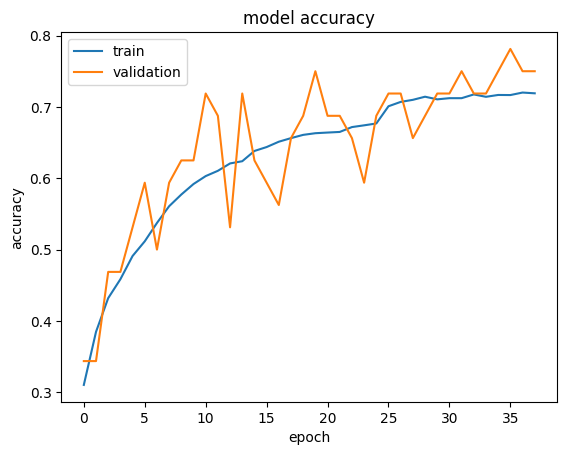

In [23]:
plt.plot(history_1.history["accuracy"])
plt.plot(history_1.history["val_accuracy"])
plt.title("model accuracy")
plt.ylabel("accuracy")
plt.xlabel("epoch")
plt.legend(["train", "validation"], loc="upper left")
plt.show()

### **Evaluating the Model on the Test Set**


In [24]:
# Calculate the number of steps for the entire test set to be processed
test_steps = test_generator.samples // batch_size

# If the number of samples isn't a multiple of the batch size,
# you have one more batch with the remaining samples
if test_generator.samples % batch_size > 0:
    test_steps += 1

# Evaluating the model on the test set
evaluation_results = model_1.evaluate(test_generator, steps=test_steps)
print(f"Loss: {evaluation_results[0]}, Accuracy: {evaluation_results[1]}")

1/4 [======>.......................] - ETA: 0s - loss: 0.4616 - accuracy: 0.8750

4/4 [==============================] - 0s 6ms/step - loss: 0.6337 - accuracy: 0.7344


Loss: 0.6336987018585205, Accuracy: 0.734375


### **Plotting Confusion Matrix**


1/4 [======>.......................] - ETA: 0s

4/4 [==============================] - 0s 5ms/step


              precision    recall  f1-score   support

       happy       0.78      0.88      0.82        32
     neutral       0.68      0.66      0.67        32
         sad       0.57      0.62      0.60        32
    surprise       0.96      0.78      0.86        32

    accuracy                           0.73       128
   macro avg       0.75      0.73      0.74       128
weighted avg       0.75      0.73      0.74       128



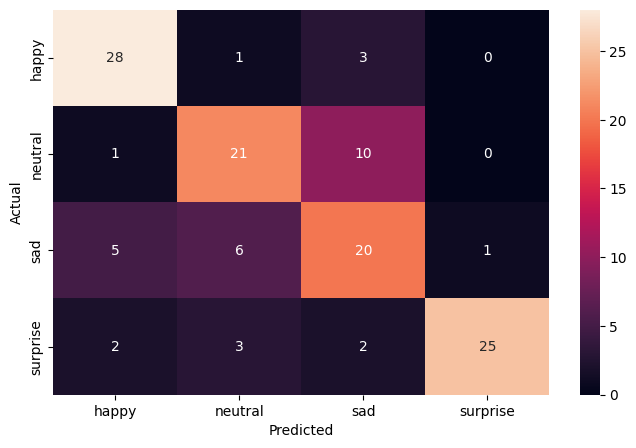

In [25]:
pred_probabilities = model_1.predict(test_generator, steps=test_steps)
pred = np.argmax(pred_probabilities, axis=1)

# Getting the true labels from the generator
y_true = test_generator.classes

# Printing the classification report with actual emotion labels
print(classification_report(y_true, pred, target_names=CATEGORIES))

# Plotting the heatmap using confusion matrix
cm = confusion_matrix(y_true, pred)
plt.figure(figsize=(8, 5))
sns.heatmap(cm, annot=True, fmt=".0f", xticklabels=CATEGORIES, yticklabels=CATEGORIES)
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.show()

**Observations and Insights:**

- As we can see from the above summary, this CNN model has been trained and learned with **144,056 parameters (weights and biases).**
- The model's training accuracy shows a progressive increase, reaching about **71.34%**, suggesting the model is learning effectively. The validation accuracy fluctuates but also generally trends upward, peaking at approximately **78.12%**. This divergence might indicate that the model is still learning generalizable features, despite the higher accuracy on the validation set, which can sometimes be attributed to the validation set being slightly 'easier' or containing fewer augmentations.
- Upon evaluating the model on the test dataset, it achieved a loss of 0.6081 and an **accuracy of 72.66%**.
- From the confusion matrix, the model performs best in identifying 'happy' and 'surprise' emotions. It faces more challenges with 'sad' and 'neutral', in which we have the lowest f1-score, 56% and 63% respectively.


### **Creating the second Convolutional Neural Network**


### **Model 2 Architecture:**

- We plan on having 4 convolutional blocks in this Architecture, each having a Conv2D, MaxPooling2D, and a Dropout layer.
- Adding first Conv2D layer with **256 filters** and a **kernel size of 5x5**. Using the **'same' padding** and provide the **input shape = (48, 48, 1)**. Using **'relu' activation**.
- Adding MaxPooling2D layer with **kernel size 5x5** and **stride size 2x2**.
- Adding a Dropout layer with a dropout ratio of **0.2**.
- Adding a second Conv2D layer with **128 filters** and a **kernel size of 5x5**. Using the **'same' padding** and **'relu' activation**.
- Following this up with a similar Maxpooling2D layer like above and a Dropout layer with 0.3 dropout ratio.
- Adding a third Conv2D layer with **64 filters** and a **kernel size of 5x5**. Using the **'same' padding** and **'relu' activation**.
- Following this up with a similar Maxpooling2D layer and a Dropout layer with dropout ratio of 0.3.
- Adding a fourth Conv2D layer with **32 filters** and a **kernel size of 3x3**. Using the **'same' padding** and **'relu' activation**.
- Following this up with a similar Maxpooling2D layer and a Dropout layer with dropout ratio of 0.3.
- Once the convolutional blocks are added, we add the Flatten layer.
- Adding first fully connected dense layer with 64 neurons and using **'relu' activation**.
- Adding a second fully connected dense layer with 32 neurons and using **'relu' activation**.
- Adding a final dense layer with 4 neurons and using **'softmax' activation function**.
- Initializing an **Adam optimizer** with a learning rate of 0.0005.
- Compiling your model with the optimizer initialized and using **categorical_crossentropy** as the loss function and the 'accuracy' as the metric.
- Finally, printing your model summary and writing down the observations.


In [26]:
backend.clear_session()

# Fixing the seed for random number generators so that we can ensure we receive the same output everytime
np.random.seed(42)

random.seed(42)
tf.random.set_seed(42)

In [27]:
# Initializing a sequential model
model_2 = Sequential()

# Adding first conv layer
model_2.add(Conv2D(filters=256, kernel_size=(5, 5), padding="Same", input_shape=(48, 48, 1), activation="relu"))
model_2.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model_2.add(Dropout(0.2))

# Adding second conv layer
model_2.add(Conv2D(filters=128, kernel_size=(5, 5), padding="Same", activation="relu"))
model_2.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model_2.add(Dropout(0.3))

# Adding third conv layer
model_2.add(Conv2D(filters=64, kernel_size=(3, 3), padding="Same", activation="relu"))
model_2.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model_2.add(Dropout(0.3))

# Adding fourth conv layer
model_2.add(Conv2D(filters=32, kernel_size=(3, 3), padding="Same", activation="relu"))
model_2.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model_2.add(Dropout(0.3))

# Flattening
model_2.add(Flatten())
model_2.add(Dense(64, activation="relu"))
model_2.add(Dense(32, activation="relu"))

# Adding the output layer with 4 neurons and activation functions as softmax since this is a multi-class classification problem
model_2.add(Dense(4, activation="softmax"))

# Using Adam Optimizer
optimizer = Adam(learning_rate=0.0005)

### **Compiling and Training the Model**


In [28]:
# Compile the model
model_2.compile(optimizer=optimizer, loss="categorical_crossentropy", metrics=["accuracy"])

model_2.summary()

Model: "sequential"


_________________________________________________________________


 Layer (type)                Output Shape              Param #   


 conv2d (Conv2D)             (None, 48, 48, 256)       6656      


 max_pooling2d (MaxPooling2  (None, 24, 24, 256)       0         


 D)                                                              


 dropout (Dropout)           (None, 24, 24, 256)       0         


 conv2d_1 (Conv2D)           (None, 24, 24, 128)       819328    


 max_pooling2d_1 (MaxPoolin  (None, 12, 12, 128)       0         


 g2D)                                                            


 dropout_1 (Dropout)         (None, 12, 12, 128)       0         


 conv2d_2 (Conv2D)           (None, 12, 12, 64)        73792     


 max_pooling2d_2 (MaxPoolin  (None, 6, 6, 64)          0         


 g2D)                                                            


 dropout_2 (Dropout)         (None, 6, 6, 64)          0         


 conv2d_3 (Conv2D)           (None, 6, 6, 32)          18464     


 max_pooling2d_3 (MaxPoolin  (None, 3, 3, 32)          0         


 g2D)                                                            


 dropout_3 (Dropout)         (None, 3, 3, 32)          0         


 flatten (Flatten)           (None, 288)               0         


 dense (Dense)               (None, 64)                18496     


 dense_1 (Dense)             (None, 32)                2080      


 dense_2 (Dense)             (None, 4)                 132       


Total params: 938948 (3.58 MB)


Trainable params: 938948 (3.58 MB)


Non-trainable params: 0 (0.00 Byte)


_________________________________________________________________


In [29]:
# Get the current time
current_time = datetime.now().strftime("%Y%m%d-%H%M%S")

# Set up Early Stopping with a patience 7 but acting after at least 30 epochs
delayed_early_stopping = DelayedEarlyStopping(
    monitor="val_loss", patience=7, verbose=1, restore_best_weights=True, start_epoch=30
)

# Define the learning rate scheduler callback
reduce_lr = ReduceLROnPlateau(monitor="val_loss", factor=0.2, patience=5, min_lr=0.00001, verbose=1)

mc = ModelCheckpoint(
    f"{results_path}/best_model_2_{current_time}.keras",
    monitor="val_accuracy",
    mode="max",
    verbose=1,
    save_best_only=True,
)

# Pulling a single large batch of random validation data for doing the validation after each epoch
validationX, validationY = validation_generator.next()

# Fitting the model with 40 epochs and using validation set
history_2 = model_2.fit(
    train_generator,
    epochs=40,
    validation_data=(validationX, validationY),
    callbacks=[delayed_early_stopping, mc, reduce_lr],
)

Epoch 1/40


2024-03-18 06:01:00.091529: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential/dropout/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


2024-03-18 06:01:00.754861: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.


  1/473 [..............................] - ETA: 22:11 - loss: 1.3940 - accuracy: 0.1875

  6/473 [..............................] - ETA: 5s - loss: 1.3985 - accuracy: 0.2292   

 10/473 [..............................] - ETA: 6s - loss: 1.4006 - accuracy: 0.2531

 15/473 [..............................] - ETA: 5s - loss: 1.3958 - accuracy: 0.2625

 20/473 [>.............................] - ETA: 5s - loss: 1.3935 - accuracy: 0.2672

 25/473 [>.............................] - ETA: 5s - loss: 1.3938 - accuracy: 0.2625

 30/473 [>.............................] - ETA: 4s - loss: 1.3929 - accuracy: 0.2552

 36/473 [=>............................] - ETA: 4s - loss: 1.3907 - accuracy: 0.2682

 41/473 [=>............................] - ETA: 4s - loss: 1.3903 - accuracy: 0.2691

 46/473 [=>............................] - ETA: 4s - loss: 1.3895 - accuracy: 0.2745

 52/473 [==>...........................] - ETA: 4s - loss: 1.3893 - accuracy: 0.2704

 58/473 [==>...........................] - ETA: 4s - loss: 1.3885 - accuracy: 0.2721

 64/473 [===>..........................] - ETA: 4s - loss: 1.3882 - accuracy: 0.2695

 70/473 [===>..........................] - ETA: 4s - loss: 1.3880 - accuracy: 0.2696

 76/473 [===>..........................] - ETA: 4s - loss: 1.3871 - accuracy: 0.2722

 82/473 [====>.........................] - ETA: 4s - loss: 1.3874 - accuracy: 0.2683

 88/473 [====>.........................] - ETA: 3s - loss: 1.3877 - accuracy: 0.2642

 94/473 [====>.........................] - ETA: 3s - loss: 1.3876 - accuracy: 0.2626

100/473 [=====>........................] - ETA: 3s - loss: 1.3874 - accuracy: 0.2628

106/473 [=====>........................] - ETA: 3s - loss: 1.3873 - accuracy: 0.2656

112/473 [======>.......................] - ETA: 3s - loss: 1.3871 - accuracy: 0.2651

118/473 [======>.......................] - ETA: 3s - loss: 1.3869 - accuracy: 0.2651

124/473 [======>.......................] - ETA: 3s - loss: 1.3868 - accuracy: 0.2644

130/473 [=======>......................] - ETA: 3s - loss: 1.3864 - accuracy: 0.2637

136/473 [=======>......................] - ETA: 3s - loss: 1.3862 - accuracy: 0.2638

142/473 [========>.....................] - ETA: 3s - loss: 1.3862 - accuracy: 0.2630

148/473 [========>.....................] - ETA: 3s - loss: 1.3859 - accuracy: 0.2622

154/473 [========>.....................] - ETA: 3s - loss: 1.3859 - accuracy: 0.2622

160/473 [=========>....................] - ETA: 3s - loss: 1.3858 - accuracy: 0.2639

166/473 [=========>....................] - ETA: 3s - loss: 1.3858 - accuracy: 0.2643

172/473 [=========>....................] - ETA: 2s - loss: 1.3856 - accuracy: 0.2658

177/473 [==========>...................] - ETA: 2s - loss: 1.3854 - accuracy: 0.2659

183/473 [==========>...................] - ETA: 2s - loss: 1.3855 - accuracy: 0.2652

189/473 [==========>...................] - ETA: 2s - loss: 1.3855 - accuracy: 0.2647

195/473 [===========>..................] - ETA: 2s - loss: 1.3852 - accuracy: 0.2663

201/473 [===========>..................] - ETA: 2s - loss: 1.3852 - accuracy: 0.2674

207/473 [============>.................] - ETA: 2s - loss: 1.3854 - accuracy: 0.2659

213/473 [============>.................] - ETA: 2s - loss: 1.3853 - accuracy: 0.2642

219/473 [============>.................] - ETA: 2s - loss: 1.3851 - accuracy: 0.2643

225/473 [=============>................] - ETA: 2s - loss: 1.3848 - accuracy: 0.2640

231/473 [=============>................] - ETA: 2s - loss: 1.3847 - accuracy: 0.2633

237/473 [==============>...............] - ETA: 2s - loss: 1.3846 - accuracy: 0.2625

243/473 [==============>...............] - ETA: 2s - loss: 1.3844 - accuracy: 0.2632

249/473 [==============>...............] - ETA: 2s - loss: 1.3843 - accuracy: 0.2627

255/473 [===============>..............] - ETA: 2s - loss: 1.3835 - accuracy: 0.2645

260/473 [===============>..............] - ETA: 2s - loss: 1.3830 - accuracy: 0.2659

266/473 [===============>..............] - ETA: 2s - loss: 1.3825 - accuracy: 0.2668

272/473 [================>.............] - ETA: 1s - loss: 1.3823 - accuracy: 0.2662

278/473 [================>.............] - ETA: 1s - loss: 1.3817 - accuracy: 0.2672

284/473 [=================>............] - ETA: 1s - loss: 1.3814 - accuracy: 0.2675

290/473 [=================>............] - ETA: 1s - loss: 1.3813 - accuracy: 0.2675

296/473 [=================>............] - ETA: 1s - loss: 1.3811 - accuracy: 0.2682

302/473 [==================>...........] - ETA: 1s - loss: 1.3810 - accuracy: 0.2683

308/473 [==================>...........] - ETA: 1s - loss: 1.3810 - accuracy: 0.2676

314/473 [==================>...........] - ETA: 1s - loss: 1.3807 - accuracy: 0.2686

320/473 [===================>..........] - ETA: 1s - loss: 1.3804 - accuracy: 0.2698

326/473 [===================>..........] - ETA: 1s - loss: 1.3797 - accuracy: 0.2709

332/473 [====================>.........] - ETA: 1s - loss: 1.3801 - accuracy: 0.2707

338/473 [====================>.........] - ETA: 1s - loss: 1.3804 - accuracy: 0.2696

344/473 [====================>.........] - ETA: 1s - loss: 1.3804 - accuracy: 0.2698

349/473 [=====================>........] - ETA: 1s - loss: 1.3805 - accuracy: 0.2698

355/473 [=====================>........] - ETA: 1s - loss: 1.3804 - accuracy: 0.2700

358/473 [=====================>........] - ETA: 1s - loss: 1.3803 - accuracy: 0.2702

363/473 [======================>.......] - ETA: 1s - loss: 1.3802 - accuracy: 0.2700

369/473 [======================>.......] - ETA: 1s - loss: 1.3798 - accuracy: 0.2705

374/473 [======================>.......] - ETA: 1s - loss: 1.3797 - accuracy: 0.2708

380/473 [=======================>......] - ETA: 1s - loss: 1.3796 - accuracy: 0.2713

385/473 [=======================>......] - ETA: 0s - loss: 1.3794 - accuracy: 0.2717

390/473 [=======================>......] - ETA: 0s - loss: 1.3793 - accuracy: 0.2716

395/473 [========================>.....] - ETA: 0s - loss: 1.3792 - accuracy: 0.2717

401/473 [========================>.....] - ETA: 0s - loss: 1.3789 - accuracy: 0.2726

407/473 [========================>.....] - ETA: 0s - loss: 1.3787 - accuracy: 0.2733

413/473 [=========================>....] - ETA: 0s - loss: 1.3781 - accuracy: 0.2739

418/473 [=========================>....] - ETA: 0s - loss: 1.3779 - accuracy: 0.2740

424/473 [=========================>....] - ETA: 0s - loss: 1.3778 - accuracy: 0.2740

430/473 [==========================>...] - ETA: 0s - loss: 1.3777 - accuracy: 0.2741

436/473 [==========================>...] - ETA: 0s - loss: 1.3774 - accuracy: 0.2742

442/473 [===========================>..] - ETA: 0s - loss: 1.3768 - accuracy: 0.2751

448/473 [===========================>..] - ETA: 0s - loss: 1.3766 - accuracy: 0.2759

453/473 [===========================>..] - ETA: 0s - loss: 1.3763 - accuracy: 0.2765

458/473 [============================>.] - ETA: 0s - loss: 1.3758 - accuracy: 0.2773

463/473 [============================>.] - ETA: 0s - loss: 1.3756 - accuracy: 0.2786

468/473 [============================>.] - ETA: 0s - loss: 1.3751 - accuracy: 0.2793


Epoch 1: val_accuracy improved from -inf to 0.43750, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_2_20240318-060059.keras


473/473 [==============================] - 8s 11ms/step - loss: 1.3750 - accuracy: 0.2793 - val_loss: 1.3358 - val_accuracy: 0.4375 - lr: 5.0000e-04


Epoch 2/40


  1/473 [..............................] - ETA: 14s - loss: 1.3493 - accuracy: 0.3438

  7/473 [..............................] - ETA: 4s - loss: 1.3673 - accuracy: 0.3036 

 13/473 [..............................] - ETA: 4s - loss: 1.3440 - accuracy: 0.3269

 19/473 [>.............................] - ETA: 4s - loss: 1.3626 - accuracy: 0.3257

 25/473 [>.............................] - ETA: 4s - loss: 1.3619 - accuracy: 0.3187

 31/473 [>.............................] - ETA: 4s - loss: 1.3667 - accuracy: 0.3024

 37/473 [=>............................] - ETA: 4s - loss: 1.3647 - accuracy: 0.3032

 43/473 [=>............................] - ETA: 4s - loss: 1.3615 - accuracy: 0.3038

 49/473 [==>...........................] - ETA: 4s - loss: 1.3542 - accuracy: 0.3131

 55/473 [==>...........................] - ETA: 4s - loss: 1.3606 - accuracy: 0.3119

 61/473 [==>...........................] - ETA: 4s - loss: 1.3599 - accuracy: 0.3105

 67/473 [===>..........................] - ETA: 3s - loss: 1.3591 - accuracy: 0.3106

 73/473 [===>..........................] - ETA: 3s - loss: 1.3578 - accuracy: 0.3129

 79/473 [====>.........................] - ETA: 3s - loss: 1.3576 - accuracy: 0.3113

 85/473 [====>.........................] - ETA: 3s - loss: 1.3585 - accuracy: 0.3132

 91/473 [====>.........................] - ETA: 3s - loss: 1.3587 - accuracy: 0.3101

 97/473 [=====>........................] - ETA: 3s - loss: 1.3593 - accuracy: 0.3135

103/473 [=====>........................] - ETA: 3s - loss: 1.3580 - accuracy: 0.3134

109/473 [=====>........................] - ETA: 3s - loss: 1.3568 - accuracy: 0.3145

115/473 [======>.......................] - ETA: 3s - loss: 1.3553 - accuracy: 0.3155

121/473 [======>.......................] - ETA: 3s - loss: 1.3569 - accuracy: 0.3143

127/473 [=======>......................] - ETA: 3s - loss: 1.3563 - accuracy: 0.3150

133/473 [=======>......................] - ETA: 3s - loss: 1.3545 - accuracy: 0.3184

139/473 [=======>......................] - ETA: 3s - loss: 1.3533 - accuracy: 0.3190

145/473 [========>.....................] - ETA: 3s - loss: 1.3517 - accuracy: 0.3207

151/473 [========>.....................] - ETA: 3s - loss: 1.3513 - accuracy: 0.3204

157/473 [========>.....................] - ETA: 3s - loss: 1.3518 - accuracy: 0.3205

163/473 [=========>....................] - ETA: 2s - loss: 1.3528 - accuracy: 0.3196

169/473 [=========>....................] - ETA: 2s - loss: 1.3544 - accuracy: 0.3177

175/473 [==========>...................] - ETA: 2s - loss: 1.3547 - accuracy: 0.3170

181/473 [==========>...................] - ETA: 2s - loss: 1.3543 - accuracy: 0.3185

187/473 [==========>...................] - ETA: 2s - loss: 1.3541 - accuracy: 0.3185

193/473 [===========>..................] - ETA: 2s - loss: 1.3536 - accuracy: 0.3191

199/473 [===========>..................] - ETA: 2s - loss: 1.3536 - accuracy: 0.3194

205/473 [============>.................] - ETA: 2s - loss: 1.3520 - accuracy: 0.3204

211/473 [============>.................] - ETA: 2s - loss: 1.3521 - accuracy: 0.3205

217/473 [============>.................] - ETA: 2s - loss: 1.3528 - accuracy: 0.3206

223/473 [=============>................] - ETA: 2s - loss: 1.3528 - accuracy: 0.3199

229/473 [=============>................] - ETA: 2s - loss: 1.3530 - accuracy: 0.3199

235/473 [=============>................] - ETA: 2s - loss: 1.3528 - accuracy: 0.3198

241/473 [==============>...............] - ETA: 2s - loss: 1.3533 - accuracy: 0.3190

247/473 [==============>...............] - ETA: 2s - loss: 1.3531 - accuracy: 0.3190

253/473 [===============>..............] - ETA: 2s - loss: 1.3533 - accuracy: 0.3190

259/473 [===============>..............] - ETA: 2s - loss: 1.3529 - accuracy: 0.3197

265/473 [===============>..............] - ETA: 2s - loss: 1.3526 - accuracy: 0.3205

271/473 [================>.............] - ETA: 1s - loss: 1.3529 - accuracy: 0.3206

277/473 [================>.............] - ETA: 1s - loss: 1.3523 - accuracy: 0.3218

283/473 [================>.............] - ETA: 1s - loss: 1.3519 - accuracy: 0.3216

289/473 [=================>............] - ETA: 1s - loss: 1.3517 - accuracy: 0.3220

295/473 [=================>............] - ETA: 1s - loss: 1.3512 - accuracy: 0.3223

301/473 [==================>...........] - ETA: 1s - loss: 1.3505 - accuracy: 0.3232

307/473 [==================>...........] - ETA: 1s - loss: 1.3504 - accuracy: 0.3236

313/473 [==================>...........] - ETA: 1s - loss: 1.3495 - accuracy: 0.3239

319/473 [===================>..........] - ETA: 1s - loss: 1.3498 - accuracy: 0.3234

325/473 [===================>..........] - ETA: 1s - loss: 1.3494 - accuracy: 0.3235

330/473 [===================>..........] - ETA: 1s - loss: 1.3499 - accuracy: 0.3235

336/473 [====================>.........] - ETA: 1s - loss: 1.3501 - accuracy: 0.3236

342/473 [====================>.........] - ETA: 1s - loss: 1.3500 - accuracy: 0.3235

348/473 [=====================>........] - ETA: 1s - loss: 1.3501 - accuracy: 0.3229

354/473 [=====================>........] - ETA: 1s - loss: 1.3501 - accuracy: 0.3222

360/473 [=====================>........] - ETA: 1s - loss: 1.3510 - accuracy: 0.3216

366/473 [======================>.......] - ETA: 1s - loss: 1.3510 - accuracy: 0.3211

372/473 [======================>.......] - ETA: 0s - loss: 1.3514 - accuracy: 0.3205

378/473 [======================>.......] - ETA: 0s - loss: 1.3514 - accuracy: 0.3203

384/473 [=======================>......] - ETA: 0s - loss: 1.3512 - accuracy: 0.3203

390/473 [=======================>......] - ETA: 0s - loss: 1.3518 - accuracy: 0.3193

396/473 [========================>.....] - ETA: 0s - loss: 1.3519 - accuracy: 0.3185

401/473 [========================>.....] - ETA: 0s - loss: 1.3518 - accuracy: 0.3189

407/473 [========================>.....] - ETA: 0s - loss: 1.3515 - accuracy: 0.3202

412/473 [=========================>....] - ETA: 0s - loss: 1.3515 - accuracy: 0.3201

418/473 [=========================>....] - ETA: 0s - loss: 1.3513 - accuracy: 0.3196

424/473 [=========================>....] - ETA: 0s - loss: 1.3511 - accuracy: 0.3200

430/473 [==========================>...] - ETA: 0s - loss: 1.3511 - accuracy: 0.3199

436/473 [==========================>...] - ETA: 0s - loss: 1.3506 - accuracy: 0.3204

442/473 [===========================>..] - ETA: 0s - loss: 1.3509 - accuracy: 0.3204

447/473 [===========================>..] - ETA: 0s - loss: 1.3501 - accuracy: 0.3216

453/473 [===========================>..] - ETA: 0s - loss: 1.3502 - accuracy: 0.3219

459/473 [============================>.] - ETA: 0s - loss: 1.3496 - accuracy: 0.3230

464/473 [============================>.] - ETA: 0s - loss: 1.3498 - accuracy: 0.3229

468/473 [============================>.] - ETA: 0s - loss: 1.3499 - accuracy: 0.3223

473/473 [==============================] - ETA: 0s - loss: 1.3494 - accuracy: 0.3230


Epoch 2: val_accuracy did not improve from 0.43750


473/473 [==============================] - 5s 10ms/step - loss: 1.3494 - accuracy: 0.3230 - val_loss: 1.3764 - val_accuracy: 0.1875 - lr: 5.0000e-04


Epoch 3/40


  1/473 [..............................] - ETA: 11s - loss: 1.4173 - accuracy: 0.2812

  7/473 [..............................] - ETA: 4s - loss: 1.3564 - accuracy: 0.2857 

 13/473 [..............................] - ETA: 4s - loss: 1.3458 - accuracy: 0.3053

 19/473 [>.............................] - ETA: 4s - loss: 1.3538 - accuracy: 0.2829

 25/473 [>.............................] - ETA: 4s - loss: 1.3456 - accuracy: 0.2962

 31/473 [>.............................] - ETA: 4s - loss: 1.3390 - accuracy: 0.3206

 37/473 [=>............................] - ETA: 4s - loss: 1.3379 - accuracy: 0.3260

 43/473 [=>............................] - ETA: 4s - loss: 1.3344 - accuracy: 0.3285

 48/473 [==>...........................] - ETA: 4s - loss: 1.3336 - accuracy: 0.3275

 51/473 [==>...........................] - ETA: 4s - loss: 1.3337 - accuracy: 0.3284

 55/473 [==>...........................] - ETA: 4s - loss: 1.3317 - accuracy: 0.3313

 59/473 [==>...........................] - ETA: 4s - loss: 1.3322 - accuracy: 0.3358

 63/473 [==>...........................] - ETA: 4s - loss: 1.3328 - accuracy: 0.3343

 69/473 [===>..........................] - ETA: 4s - loss: 1.3269 - accuracy: 0.3406

 75/473 [===>..........................] - ETA: 4s - loss: 1.3246 - accuracy: 0.3458

 81/473 [====>.........................] - ETA: 4s - loss: 1.3242 - accuracy: 0.3449

 87/473 [====>.........................] - ETA: 4s - loss: 1.3192 - accuracy: 0.3560

 93/473 [====>.........................] - ETA: 3s - loss: 1.3163 - accuracy: 0.3572

 99/473 [=====>........................] - ETA: 3s - loss: 1.3155 - accuracy: 0.3554

105/473 [=====>........................] - ETA: 3s - loss: 1.3115 - accuracy: 0.3586

111/473 [======>.......................] - ETA: 3s - loss: 1.3071 - accuracy: 0.3626

117/473 [======>.......................] - ETA: 3s - loss: 1.3044 - accuracy: 0.3635

123/473 [======>.......................] - ETA: 3s - loss: 1.3032 - accuracy: 0.3664

129/473 [=======>......................] - ETA: 3s - loss: 1.3050 - accuracy: 0.3619

135/473 [=======>......................] - ETA: 3s - loss: 1.3006 - accuracy: 0.3648

141/473 [=======>......................] - ETA: 3s - loss: 1.2980 - accuracy: 0.3664

147/473 [========>.....................] - ETA: 3s - loss: 1.2968 - accuracy: 0.3682

153/473 [========>.....................] - ETA: 3s - loss: 1.2961 - accuracy: 0.3685

158/473 [=========>....................] - ETA: 3s - loss: 1.2948 - accuracy: 0.3695

163/473 [=========>....................] - ETA: 3s - loss: 1.2952 - accuracy: 0.3681

168/473 [=========>....................] - ETA: 3s - loss: 1.2947 - accuracy: 0.3683

173/473 [=========>....................] - ETA: 3s - loss: 1.2946 - accuracy: 0.3672

178/473 [==========>...................] - ETA: 2s - loss: 1.2936 - accuracy: 0.3680

184/473 [==========>...................] - ETA: 2s - loss: 1.2922 - accuracy: 0.3694

190/473 [===========>..................] - ETA: 2s - loss: 1.2926 - accuracy: 0.3704

196/473 [===========>..................] - ETA: 2s - loss: 1.2911 - accuracy: 0.3713

202/473 [===========>..................] - ETA: 2s - loss: 1.2898 - accuracy: 0.3716

208/473 [============>.................] - ETA: 2s - loss: 1.2859 - accuracy: 0.3738

213/473 [============>.................] - ETA: 2s - loss: 1.2873 - accuracy: 0.3737

219/473 [============>.................] - ETA: 2s - loss: 1.2881 - accuracy: 0.3743

225/473 [=============>................] - ETA: 2s - loss: 1.2882 - accuracy: 0.3749

231/473 [=============>................] - ETA: 2s - loss: 1.2874 - accuracy: 0.3757

237/473 [==============>...............] - ETA: 2s - loss: 1.2878 - accuracy: 0.3757

242/473 [==============>...............] - ETA: 2s - loss: 1.2879 - accuracy: 0.3747

248/473 [==============>...............] - ETA: 2s - loss: 1.2849 - accuracy: 0.3763

254/473 [===============>..............] - ETA: 2s - loss: 1.2827 - accuracy: 0.3775

259/473 [===============>..............] - ETA: 2s - loss: 1.2823 - accuracy: 0.3768

263/473 [===============>..............] - ETA: 2s - loss: 1.2821 - accuracy: 0.3770

269/473 [================>.............] - ETA: 2s - loss: 1.2822 - accuracy: 0.3769

275/473 [================>.............] - ETA: 2s - loss: 1.2820 - accuracy: 0.3773

281/473 [================>.............] - ETA: 1s - loss: 1.2814 - accuracy: 0.3772

287/473 [=================>............] - ETA: 1s - loss: 1.2823 - accuracy: 0.3780

293/473 [=================>............] - ETA: 1s - loss: 1.2818 - accuracy: 0.3780

299/473 [=================>............] - ETA: 1s - loss: 1.2814 - accuracy: 0.3782

305/473 [==================>...........] - ETA: 1s - loss: 1.2807 - accuracy: 0.3793

311/473 [==================>...........] - ETA: 1s - loss: 1.2802 - accuracy: 0.3797

317/473 [===================>..........] - ETA: 1s - loss: 1.2809 - accuracy: 0.3789

322/473 [===================>..........] - ETA: 1s - loss: 1.2790 - accuracy: 0.3796

328/473 [===================>..........] - ETA: 1s - loss: 1.2805 - accuracy: 0.3792

334/473 [====================>.........] - ETA: 1s - loss: 1.2798 - accuracy: 0.3801

340/473 [====================>.........] - ETA: 1s - loss: 1.2797 - accuracy: 0.3797

346/473 [====================>.........] - ETA: 1s - loss: 1.2792 - accuracy: 0.3797

352/473 [=====================>........] - ETA: 1s - loss: 1.2783 - accuracy: 0.3803

358/473 [=====================>........] - ETA: 1s - loss: 1.2771 - accuracy: 0.3804

364/473 [======================>.......] - ETA: 1s - loss: 1.2774 - accuracy: 0.3802

370/473 [======================>.......] - ETA: 1s - loss: 1.2767 - accuracy: 0.3807

376/473 [======================>.......] - ETA: 0s - loss: 1.2761 - accuracy: 0.3808

382/473 [=======================>......] - ETA: 0s - loss: 1.2759 - accuracy: 0.3807

388/473 [=======================>......] - ETA: 0s - loss: 1.2746 - accuracy: 0.3810

394/473 [=======================>......] - ETA: 0s - loss: 1.2722 - accuracy: 0.3825

400/473 [========================>.....] - ETA: 0s - loss: 1.2716 - accuracy: 0.3824

406/473 [========================>.....] - ETA: 0s - loss: 1.2710 - accuracy: 0.3832

412/473 [=========================>....] - ETA: 0s - loss: 1.2695 - accuracy: 0.3849

418/473 [=========================>....] - ETA: 0s - loss: 1.2686 - accuracy: 0.3849

424/473 [=========================>....] - ETA: 0s - loss: 1.2677 - accuracy: 0.3857

430/473 [==========================>...] - ETA: 0s - loss: 1.2668 - accuracy: 0.3863

435/473 [==========================>...] - ETA: 0s - loss: 1.2660 - accuracy: 0.3864

441/473 [==========================>...] - ETA: 0s - loss: 1.2660 - accuracy: 0.3862

446/473 [===========================>..] - ETA: 0s - loss: 1.2660 - accuracy: 0.3864

452/473 [===========================>..] - ETA: 0s - loss: 1.2664 - accuracy: 0.3865

458/473 [============================>.] - ETA: 0s - loss: 1.2659 - accuracy: 0.3871

463/473 [============================>.] - ETA: 0s - loss: 1.2654 - accuracy: 0.3865

469/473 [============================>.] - ETA: 0s - loss: 1.2653 - accuracy: 0.3869


Epoch 3: val_accuracy did not improve from 0.43750


473/473 [==============================] - 5s 10ms/step - loss: 1.2649 - accuracy: 0.3869 - val_loss: 1.1296 - val_accuracy: 0.4062 - lr: 5.0000e-04


Epoch 4/40


  1/473 [..............................] - ETA: 10s - loss: 1.1623 - accuracy: 0.5000

  6/473 [..............................] - ETA: 4s - loss: 1.1899 - accuracy: 0.4635 

 12/473 [..............................] - ETA: 4s - loss: 1.2088 - accuracy: 0.4297

 17/473 [>.............................] - ETA: 4s - loss: 1.2227 - accuracy: 0.4081

 23/473 [>.............................] - ETA: 4s - loss: 1.2207 - accuracy: 0.4226

 29/473 [>.............................] - ETA: 4s - loss: 1.2276 - accuracy: 0.4267

 34/473 [=>............................] - ETA: 4s - loss: 1.2297 - accuracy: 0.4200

 40/473 [=>............................] - ETA: 4s - loss: 1.2317 - accuracy: 0.4117

 45/473 [=>............................] - ETA: 4s - loss: 1.2357 - accuracy: 0.4097

 51/473 [==>...........................] - ETA: 4s - loss: 1.2342 - accuracy: 0.4105

 57/473 [==>...........................] - ETA: 4s - loss: 1.2334 - accuracy: 0.4156

 63/473 [==>...........................] - ETA: 4s - loss: 1.2361 - accuracy: 0.4082

 69/473 [===>..........................] - ETA: 3s - loss: 1.2389 - accuracy: 0.4049

 75/473 [===>..........................] - ETA: 3s - loss: 1.2382 - accuracy: 0.4071

 81/473 [====>.........................] - ETA: 3s - loss: 1.2360 - accuracy: 0.4039

 87/473 [====>.........................] - ETA: 3s - loss: 1.2359 - accuracy: 0.4048

 93/473 [====>.........................] - ETA: 3s - loss: 1.2342 - accuracy: 0.4086

 99/473 [=====>........................] - ETA: 3s - loss: 1.2317 - accuracy: 0.4082

105/473 [=====>........................] - ETA: 3s - loss: 1.2312 - accuracy: 0.4092

111/473 [======>.......................] - ETA: 3s - loss: 1.2287 - accuracy: 0.4125

117/473 [======>.......................] - ETA: 3s - loss: 1.2298 - accuracy: 0.4132

123/473 [======>.......................] - ETA: 3s - loss: 1.2309 - accuracy: 0.4129

129/473 [=======>......................] - ETA: 3s - loss: 1.2313 - accuracy: 0.4133

135/473 [=======>......................] - ETA: 3s - loss: 1.2315 - accuracy: 0.4130

141/473 [=======>......................] - ETA: 3s - loss: 1.2326 - accuracy: 0.4138

146/473 [========>.....................] - ETA: 3s - loss: 1.2328 - accuracy: 0.4155

152/473 [========>.....................] - ETA: 3s - loss: 1.2322 - accuracy: 0.4164

158/473 [=========>....................] - ETA: 3s - loss: 1.2334 - accuracy: 0.4154

163/473 [=========>....................] - ETA: 3s - loss: 1.2319 - accuracy: 0.4163

169/473 [=========>....................] - ETA: 2s - loss: 1.2309 - accuracy: 0.4159

174/473 [==========>...................] - ETA: 2s - loss: 1.2320 - accuracy: 0.4156

180/473 [==========>...................] - ETA: 2s - loss: 1.2311 - accuracy: 0.4153

185/473 [==========>...................] - ETA: 2s - loss: 1.2317 - accuracy: 0.4156

190/473 [===========>..................] - ETA: 2s - loss: 1.2314 - accuracy: 0.4155

196/473 [===========>..................] - ETA: 2s - loss: 1.2317 - accuracy: 0.4151

202/473 [===========>..................] - ETA: 2s - loss: 1.2336 - accuracy: 0.4132

208/473 [============>.................] - ETA: 2s - loss: 1.2316 - accuracy: 0.4139

213/473 [============>.................] - ETA: 2s - loss: 1.2302 - accuracy: 0.4142

219/473 [============>.................] - ETA: 2s - loss: 1.2280 - accuracy: 0.4147

224/473 [=============>................] - ETA: 2s - loss: 1.2277 - accuracy: 0.4158

230/473 [=============>................] - ETA: 2s - loss: 1.2267 - accuracy: 0.4173

236/473 [=============>................] - ETA: 2s - loss: 1.2266 - accuracy: 0.4177

242/473 [==============>...............] - ETA: 2s - loss: 1.2262 - accuracy: 0.4180

248/473 [==============>...............] - ETA: 2s - loss: 1.2249 - accuracy: 0.4184

254/473 [===============>..............] - ETA: 2s - loss: 1.2240 - accuracy: 0.4191

260/473 [===============>..............] - ETA: 2s - loss: 1.2228 - accuracy: 0.4208

266/473 [===============>..............] - ETA: 2s - loss: 1.2227 - accuracy: 0.4217

272/473 [================>.............] - ETA: 1s - loss: 1.2234 - accuracy: 0.4209

277/473 [================>.............] - ETA: 1s - loss: 1.2227 - accuracy: 0.4204

282/473 [================>.............] - ETA: 1s - loss: 1.2231 - accuracy: 0.4208

287/473 [=================>............] - ETA: 1s - loss: 1.2233 - accuracy: 0.4198

293/473 [=================>............] - ETA: 1s - loss: 1.2231 - accuracy: 0.4214

299/473 [=================>............] - ETA: 1s - loss: 1.2237 - accuracy: 0.4202

305/473 [==================>...........] - ETA: 1s - loss: 1.2226 - accuracy: 0.4211

311/473 [==================>...........] - ETA: 1s - loss: 1.2213 - accuracy: 0.4212

317/473 [===================>..........] - ETA: 1s - loss: 1.2198 - accuracy: 0.4220

323/473 [===================>..........] - ETA: 1s - loss: 1.2201 - accuracy: 0.4215

328/473 [===================>..........] - ETA: 1s - loss: 1.2204 - accuracy: 0.4213

334/473 [====================>.........] - ETA: 1s - loss: 1.2204 - accuracy: 0.4216

340/473 [====================>.........] - ETA: 1s - loss: 1.2210 - accuracy: 0.4210

346/473 [====================>.........] - ETA: 1s - loss: 1.2209 - accuracy: 0.4206

351/473 [=====================>........] - ETA: 1s - loss: 1.2213 - accuracy: 0.4195

357/473 [=====================>........] - ETA: 1s - loss: 1.2214 - accuracy: 0.4186

363/473 [======================>.......] - ETA: 1s - loss: 1.2212 - accuracy: 0.4184

369/473 [======================>.......] - ETA: 1s - loss: 1.2208 - accuracy: 0.4178

375/473 [======================>.......] - ETA: 0s - loss: 1.2206 - accuracy: 0.4179

381/473 [=======================>......] - ETA: 0s - loss: 1.2207 - accuracy: 0.4179

387/473 [=======================>......] - ETA: 0s - loss: 1.2204 - accuracy: 0.4177

393/473 [=======================>......] - ETA: 0s - loss: 1.2202 - accuracy: 0.4172

399/473 [========================>.....] - ETA: 0s - loss: 1.2209 - accuracy: 0.4170

405/473 [========================>.....] - ETA: 0s - loss: 1.2206 - accuracy: 0.4171

411/473 [=========================>....] - ETA: 0s - loss: 1.2201 - accuracy: 0.4173

417/473 [=========================>....] - ETA: 0s - loss: 1.2192 - accuracy: 0.4175

423/473 [=========================>....] - ETA: 0s - loss: 1.2186 - accuracy: 0.4176

429/473 [==========================>...] - ETA: 0s - loss: 1.2185 - accuracy: 0.4177

435/473 [==========================>...] - ETA: 0s - loss: 1.2184 - accuracy: 0.4186

441/473 [==========================>...] - ETA: 0s - loss: 1.2184 - accuracy: 0.4185

447/473 [===========================>..] - ETA: 0s - loss: 1.2170 - accuracy: 0.4193

453/473 [===========================>..] - ETA: 0s - loss: 1.2162 - accuracy: 0.4193

458/473 [============================>.] - ETA: 0s - loss: 1.2160 - accuracy: 0.4199

463/473 [============================>.] - ETA: 0s - loss: 1.2154 - accuracy: 0.4204

469/473 [============================>.] - ETA: 0s - loss: 1.2149 - accuracy: 0.4203


Epoch 4: val_accuracy did not improve from 0.43750


473/473 [==============================] - 5s 10ms/step - loss: 1.2147 - accuracy: 0.4203 - val_loss: 1.1150 - val_accuracy: 0.4062 - lr: 5.0000e-04


Epoch 5/40


  1/473 [..............................] - ETA: 10s - loss: 1.2090 - accuracy: 0.3438

  7/473 [..............................] - ETA: 4s - loss: 1.2619 - accuracy: 0.3973 

 13/473 [..............................] - ETA: 4s - loss: 1.2340 - accuracy: 0.4135

 18/473 [>.............................] - ETA: 4s - loss: 1.2119 - accuracy: 0.4323

 23/473 [>.............................] - ETA: 4s - loss: 1.2113 - accuracy: 0.4307

 29/473 [>.............................] - ETA: 4s - loss: 1.2111 - accuracy: 0.4289

 35/473 [=>............................] - ETA: 4s - loss: 1.2044 - accuracy: 0.4295

 41/473 [=>............................] - ETA: 4s - loss: 1.2078 - accuracy: 0.4238

 46/473 [=>............................] - ETA: 4s - loss: 1.2066 - accuracy: 0.4266

 51/473 [==>...........................] - ETA: 4s - loss: 1.2039 - accuracy: 0.4271

 56/473 [==>...........................] - ETA: 4s - loss: 1.1959 - accuracy: 0.4308

 61/473 [==>...........................] - ETA: 4s - loss: 1.1908 - accuracy: 0.4308

 66/473 [===>..........................] - ETA: 4s - loss: 1.1980 - accuracy: 0.4285

 71/473 [===>..........................] - ETA: 4s - loss: 1.1928 - accuracy: 0.4322

 76/473 [===>..........................] - ETA: 4s - loss: 1.1923 - accuracy: 0.4330

 82/473 [====>.........................] - ETA: 4s - loss: 1.1943 - accuracy: 0.4287

 88/473 [====>.........................] - ETA: 3s - loss: 1.1928 - accuracy: 0.4297

 94/473 [====>.........................] - ETA: 3s - loss: 1.1968 - accuracy: 0.4265

100/473 [=====>........................] - ETA: 3s - loss: 1.1945 - accuracy: 0.4266

106/473 [=====>........................] - ETA: 3s - loss: 1.1954 - accuracy: 0.4251

112/473 [======>.......................] - ETA: 3s - loss: 1.1926 - accuracy: 0.4266

117/473 [======>.......................] - ETA: 3s - loss: 1.1931 - accuracy: 0.4252

122/473 [======>.......................] - ETA: 3s - loss: 1.1933 - accuracy: 0.4247

128/473 [=======>......................] - ETA: 3s - loss: 1.1930 - accuracy: 0.4277

134/473 [=======>......................] - ETA: 3s - loss: 1.1922 - accuracy: 0.4284

140/473 [=======>......................] - ETA: 3s - loss: 1.1937 - accuracy: 0.4272

146/473 [========>.....................] - ETA: 3s - loss: 1.1968 - accuracy: 0.4253

151/473 [========>.....................] - ETA: 3s - loss: 1.1986 - accuracy: 0.4226

157/473 [========>.....................] - ETA: 3s - loss: 1.1975 - accuracy: 0.4228

163/473 [=========>....................] - ETA: 3s - loss: 1.1982 - accuracy: 0.4237

169/473 [=========>....................] - ETA: 3s - loss: 1.1976 - accuracy: 0.4244

175/473 [==========>...................] - ETA: 2s - loss: 1.1970 - accuracy: 0.4254

181/473 [==========>...................] - ETA: 2s - loss: 1.1959 - accuracy: 0.4261

187/473 [==========>...................] - ETA: 2s - loss: 1.1932 - accuracy: 0.4281

193/473 [===========>..................] - ETA: 2s - loss: 1.1928 - accuracy: 0.4296

199/473 [===========>..................] - ETA: 2s - loss: 1.1931 - accuracy: 0.4296

205/473 [============>.................] - ETA: 2s - loss: 1.1925 - accuracy: 0.4316

211/473 [============>.................] - ETA: 2s - loss: 1.1925 - accuracy: 0.4316

217/473 [============>.................] - ETA: 2s - loss: 1.1914 - accuracy: 0.4329

223/473 [=============>................] - ETA: 2s - loss: 1.1884 - accuracy: 0.4350

229/473 [=============>................] - ETA: 2s - loss: 1.1877 - accuracy: 0.4371

234/473 [=============>................] - ETA: 2s - loss: 1.1870 - accuracy: 0.4366

240/473 [==============>...............] - ETA: 2s - loss: 1.1881 - accuracy: 0.4370

246/473 [==============>...............] - ETA: 2s - loss: 1.1878 - accuracy: 0.4371

252/473 [==============>...............] - ETA: 2s - loss: 1.1887 - accuracy: 0.4361

258/473 [===============>..............] - ETA: 2s - loss: 1.1878 - accuracy: 0.4370

264/473 [===============>..............] - ETA: 2s - loss: 1.1871 - accuracy: 0.4367

270/473 [================>.............] - ETA: 2s - loss: 1.1881 - accuracy: 0.4358

276/473 [================>.............] - ETA: 1s - loss: 1.1887 - accuracy: 0.4349

281/473 [================>.............] - ETA: 1s - loss: 1.1886 - accuracy: 0.4347

287/473 [=================>............] - ETA: 1s - loss: 1.1878 - accuracy: 0.4353

293/473 [=================>............] - ETA: 1s - loss: 1.1874 - accuracy: 0.4352

299/473 [=================>............] - ETA: 1s - loss: 1.1879 - accuracy: 0.4352

305/473 [==================>...........] - ETA: 1s - loss: 1.1865 - accuracy: 0.4364

311/473 [==================>...........] - ETA: 1s - loss: 1.1854 - accuracy: 0.4376

317/473 [===================>..........] - ETA: 1s - loss: 1.1872 - accuracy: 0.4372

323/473 [===================>..........] - ETA: 1s - loss: 1.1860 - accuracy: 0.4381

329/473 [===================>..........] - ETA: 1s - loss: 1.1866 - accuracy: 0.4375

334/473 [====================>.........] - ETA: 1s - loss: 1.1876 - accuracy: 0.4368

340/473 [====================>.........] - ETA: 1s - loss: 1.1874 - accuracy: 0.4383

346/473 [====================>.........] - ETA: 1s - loss: 1.1875 - accuracy: 0.4385

352/473 [=====================>........] - ETA: 1s - loss: 1.1870 - accuracy: 0.4390

357/473 [=====================>........] - ETA: 1s - loss: 1.1871 - accuracy: 0.4391

363/473 [======================>.......] - ETA: 1s - loss: 1.1870 - accuracy: 0.4399

368/473 [======================>.......] - ETA: 1s - loss: 1.1876 - accuracy: 0.4405

372/473 [======================>.......] - ETA: 1s - loss: 1.1877 - accuracy: 0.4407

378/473 [======================>.......] - ETA: 0s - loss: 1.1883 - accuracy: 0.4405

384/473 [=======================>......] - ETA: 0s - loss: 1.1878 - accuracy: 0.4414

390/473 [=======================>......] - ETA: 0s - loss: 1.1871 - accuracy: 0.4409

396/473 [========================>.....] - ETA: 0s - loss: 1.1871 - accuracy: 0.4410

402/473 [========================>.....] - ETA: 0s - loss: 1.1874 - accuracy: 0.4418

408/473 [========================>.....] - ETA: 0s - loss: 1.1866 - accuracy: 0.4420

414/473 [=========================>....] - ETA: 0s - loss: 1.1866 - accuracy: 0.4420

420/473 [=========================>....] - ETA: 0s - loss: 1.1866 - accuracy: 0.4417

426/473 [==========================>...] - ETA: 0s - loss: 1.1850 - accuracy: 0.4430

432/473 [==========================>...] - ETA: 0s - loss: 1.1849 - accuracy: 0.4429

437/473 [==========================>...] - ETA: 0s - loss: 1.1838 - accuracy: 0.4436

443/473 [===========================>..] - ETA: 0s - loss: 1.1833 - accuracy: 0.4444

449/473 [===========================>..] - ETA: 0s - loss: 1.1833 - accuracy: 0.4447

455/473 [===========================>..] - ETA: 0s - loss: 1.1830 - accuracy: 0.4452

461/473 [============================>.] - ETA: 0s - loss: 1.1833 - accuracy: 0.4452

467/473 [============================>.] - ETA: 0s - loss: 1.1828 - accuracy: 0.4453

473/473 [==============================] - ETA: 0s - loss: 1.1823 - accuracy: 0.4454


Epoch 5: val_accuracy improved from 0.43750 to 0.56250, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_2_20240318-060059.keras


473/473 [==============================] - 5s 10ms/step - loss: 1.1823 - accuracy: 0.4454 - val_loss: 0.9810 - val_accuracy: 0.5625 - lr: 5.0000e-04


Epoch 6/40


  1/473 [..............................] - ETA: 12s - loss: 1.0345 - accuracy: 0.4688

  6/473 [..............................] - ETA: 4s - loss: 1.1155 - accuracy: 0.4948 

 11/473 [..............................] - ETA: 4s - loss: 1.1217 - accuracy: 0.4801

 17/473 [>.............................] - ETA: 4s - loss: 1.1388 - accuracy: 0.4890

 22/473 [>.............................] - ETA: 4s - loss: 1.1323 - accuracy: 0.4943

 28/473 [>.............................] - ETA: 4s - loss: 1.1505 - accuracy: 0.4777

 34/473 [=>............................] - ETA: 4s - loss: 1.1468 - accuracy: 0.4761

 39/473 [=>............................] - ETA: 4s - loss: 1.1472 - accuracy: 0.4784

 45/473 [=>............................] - ETA: 4s - loss: 1.1478 - accuracy: 0.4778

 51/473 [==>...........................] - ETA: 4s - loss: 1.1489 - accuracy: 0.4773

 57/473 [==>...........................] - ETA: 4s - loss: 1.1502 - accuracy: 0.4742

 62/473 [==>...........................] - ETA: 4s - loss: 1.1435 - accuracy: 0.4798

 68/473 [===>..........................] - ETA: 4s - loss: 1.1408 - accuracy: 0.4784

 74/473 [===>..........................] - ETA: 3s - loss: 1.1443 - accuracy: 0.4755

 80/473 [====>.........................] - ETA: 3s - loss: 1.1434 - accuracy: 0.4746

 86/473 [====>.........................] - ETA: 3s - loss: 1.1389 - accuracy: 0.4782

 91/473 [====>.........................] - ETA: 3s - loss: 1.1402 - accuracy: 0.4770

 97/473 [=====>........................] - ETA: 3s - loss: 1.1393 - accuracy: 0.4794

103/473 [=====>........................] - ETA: 3s - loss: 1.1419 - accuracy: 0.4788

109/473 [=====>........................] - ETA: 3s - loss: 1.1432 - accuracy: 0.4776

115/473 [======>.......................] - ETA: 3s - loss: 1.1408 - accuracy: 0.4796

121/473 [======>.......................] - ETA: 3s - loss: 1.1410 - accuracy: 0.4788

127/473 [=======>......................] - ETA: 3s - loss: 1.1417 - accuracy: 0.4771

133/473 [=======>......................] - ETA: 3s - loss: 1.1442 - accuracy: 0.4746

139/473 [=======>......................] - ETA: 3s - loss: 1.1470 - accuracy: 0.4723

144/473 [========>.....................] - ETA: 3s - loss: 1.1469 - accuracy: 0.4722

150/473 [========>.....................] - ETA: 3s - loss: 1.1464 - accuracy: 0.4721

156/473 [========>.....................] - ETA: 3s - loss: 1.1474 - accuracy: 0.4710

162/473 [=========>....................] - ETA: 3s - loss: 1.1480 - accuracy: 0.4701

168/473 [=========>....................] - ETA: 3s - loss: 1.1464 - accuracy: 0.4715

173/473 [=========>....................] - ETA: 2s - loss: 1.1489 - accuracy: 0.4702

179/473 [==========>...................] - ETA: 2s - loss: 1.1433 - accuracy: 0.4740

185/473 [==========>...................] - ETA: 2s - loss: 1.1406 - accuracy: 0.4755

191/473 [===========>..................] - ETA: 2s - loss: 1.1421 - accuracy: 0.4753

197/473 [===========>..................] - ETA: 2s - loss: 1.1414 - accuracy: 0.4745

203/473 [===========>..................] - ETA: 2s - loss: 1.1410 - accuracy: 0.4749

209/473 [============>.................] - ETA: 2s - loss: 1.1414 - accuracy: 0.4749

215/473 [============>.................] - ETA: 2s - loss: 1.1418 - accuracy: 0.4750

220/473 [============>.................] - ETA: 2s - loss: 1.1418 - accuracy: 0.4759

224/473 [=============>................] - ETA: 2s - loss: 1.1431 - accuracy: 0.4754

228/473 [=============>................] - ETA: 2s - loss: 1.1438 - accuracy: 0.4749

233/473 [=============>................] - ETA: 2s - loss: 1.1455 - accuracy: 0.4752

238/473 [==============>...............] - ETA: 2s - loss: 1.1457 - accuracy: 0.4751

243/473 [==============>...............] - ETA: 2s - loss: 1.1465 - accuracy: 0.4745

248/473 [==============>...............] - ETA: 2s - loss: 1.1463 - accuracy: 0.4752

254/473 [===============>..............] - ETA: 2s - loss: 1.1445 - accuracy: 0.4766

259/473 [===============>..............] - ETA: 2s - loss: 1.1450 - accuracy: 0.4761

264/473 [===============>..............] - ETA: 2s - loss: 1.1445 - accuracy: 0.4763

269/473 [================>.............] - ETA: 2s - loss: 1.1447 - accuracy: 0.4762

275/473 [================>.............] - ETA: 1s - loss: 1.1465 - accuracy: 0.4764

281/473 [================>.............] - ETA: 1s - loss: 1.1461 - accuracy: 0.4766

287/473 [=================>............] - ETA: 1s - loss: 1.1449 - accuracy: 0.4775

293/473 [=================>............] - ETA: 1s - loss: 1.1451 - accuracy: 0.4772

298/473 [=================>............] - ETA: 1s - loss: 1.1432 - accuracy: 0.4784

304/473 [==================>...........] - ETA: 1s - loss: 1.1433 - accuracy: 0.4782

309/473 [==================>...........] - ETA: 1s - loss: 1.1428 - accuracy: 0.4790

313/473 [==================>...........] - ETA: 1s - loss: 1.1427 - accuracy: 0.4782

318/473 [===================>..........] - ETA: 1s - loss: 1.1415 - accuracy: 0.4790

324/473 [===================>..........] - ETA: 1s - loss: 1.1408 - accuracy: 0.4799

330/473 [===================>..........] - ETA: 1s - loss: 1.1404 - accuracy: 0.4798

335/473 [====================>.........] - ETA: 1s - loss: 1.1393 - accuracy: 0.4812

341/473 [====================>.........] - ETA: 1s - loss: 1.1392 - accuracy: 0.4814

347/473 [=====================>........] - ETA: 1s - loss: 1.1391 - accuracy: 0.4816

353/473 [=====================>........] - ETA: 1s - loss: 1.1401 - accuracy: 0.4807

359/473 [=====================>........] - ETA: 1s - loss: 1.1402 - accuracy: 0.4806

365/473 [======================>.......] - ETA: 1s - loss: 1.1400 - accuracy: 0.4806

371/473 [======================>.......] - ETA: 1s - loss: 1.1406 - accuracy: 0.4800

377/473 [======================>.......] - ETA: 0s - loss: 1.1413 - accuracy: 0.4794

383/473 [=======================>......] - ETA: 0s - loss: 1.1406 - accuracy: 0.4796

389/473 [=======================>......] - ETA: 0s - loss: 1.1406 - accuracy: 0.4794

395/473 [========================>.....] - ETA: 0s - loss: 1.1398 - accuracy: 0.4805

401/473 [========================>.....] - ETA: 0s - loss: 1.1411 - accuracy: 0.4797

407/473 [========================>.....] - ETA: 0s - loss: 1.1404 - accuracy: 0.4803

413/473 [=========================>....] - ETA: 0s - loss: 1.1401 - accuracy: 0.4801

419/473 [=========================>....] - ETA: 0s - loss: 1.1401 - accuracy: 0.4800

425/473 [=========================>....] - ETA: 0s - loss: 1.1391 - accuracy: 0.4801

431/473 [==========================>...] - ETA: 0s - loss: 1.1373 - accuracy: 0.4806

437/473 [==========================>...] - ETA: 0s - loss: 1.1375 - accuracy: 0.4808

443/473 [===========================>..] - ETA: 0s - loss: 1.1371 - accuracy: 0.4814

449/473 [===========================>..] - ETA: 0s - loss: 1.1365 - accuracy: 0.4821

454/473 [===========================>..] - ETA: 0s - loss: 1.1365 - accuracy: 0.4821

460/473 [============================>.] - ETA: 0s - loss: 1.1369 - accuracy: 0.4817

466/473 [============================>.] - ETA: 0s - loss: 1.1368 - accuracy: 0.4820

472/473 [============================>.] - ETA: 0s - loss: 1.1360 - accuracy: 0.4829


Epoch 6: val_accuracy improved from 0.56250 to 0.65625, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_2_20240318-060059.keras


473/473 [==============================] - 5s 10ms/step - loss: 1.1361 - accuracy: 0.4827 - val_loss: 0.8442 - val_accuracy: 0.6562 - lr: 5.0000e-04


Epoch 7/40


  1/473 [..............................] - ETA: 10s - loss: 1.0915 - accuracy: 0.5625

  5/473 [..............................] - ETA: 6s - loss: 1.1611 - accuracy: 0.4625 

  9/473 [..............................] - ETA: 6s - loss: 1.0965 - accuracy: 0.5035

 14/473 [..............................] - ETA: 5s - loss: 1.1252 - accuracy: 0.4799

 19/473 [>.............................] - ETA: 5s - loss: 1.1259 - accuracy: 0.4901

 25/473 [>.............................] - ETA: 5s - loss: 1.1086 - accuracy: 0.5025

 31/473 [>.............................] - ETA: 4s - loss: 1.1070 - accuracy: 0.5060

 37/473 [=>............................] - ETA: 4s - loss: 1.1135 - accuracy: 0.5025

 43/473 [=>............................] - ETA: 4s - loss: 1.1106 - accuracy: 0.5073

 49/473 [==>...........................] - ETA: 4s - loss: 1.1058 - accuracy: 0.5051

 55/473 [==>...........................] - ETA: 4s - loss: 1.1032 - accuracy: 0.5074

 61/473 [==>...........................] - ETA: 4s - loss: 1.1048 - accuracy: 0.5077

 67/473 [===>..........................] - ETA: 4s - loss: 1.1063 - accuracy: 0.5059

 73/473 [===>..........................] - ETA: 4s - loss: 1.1064 - accuracy: 0.5089

 79/473 [====>.........................] - ETA: 3s - loss: 1.1077 - accuracy: 0.5054

 85/473 [====>.........................] - ETA: 3s - loss: 1.1071 - accuracy: 0.5017

 90/473 [====>.........................] - ETA: 3s - loss: 1.1025 - accuracy: 0.5058

 95/473 [=====>........................] - ETA: 3s - loss: 1.1028 - accuracy: 0.5045

101/473 [=====>........................] - ETA: 3s - loss: 1.1005 - accuracy: 0.5055

107/473 [=====>........................] - ETA: 3s - loss: 1.1007 - accuracy: 0.5054

113/473 [======>.......................] - ETA: 3s - loss: 1.1003 - accuracy: 0.5065

118/473 [======>.......................] - ETA: 3s - loss: 1.0994 - accuracy: 0.5047

122/473 [======>.......................] - ETA: 3s - loss: 1.1032 - accuracy: 0.5030

126/473 [======>.......................] - ETA: 3s - loss: 1.1013 - accuracy: 0.5039

132/473 [=======>......................] - ETA: 3s - loss: 1.1000 - accuracy: 0.5063

138/473 [=======>......................] - ETA: 3s - loss: 1.1014 - accuracy: 0.5067

143/473 [========>.....................] - ETA: 3s - loss: 1.1060 - accuracy: 0.5058

149/473 [========>.....................] - ETA: 3s - loss: 1.1070 - accuracy: 0.5060

155/473 [========>.....................] - ETA: 3s - loss: 1.1083 - accuracy: 0.5058

160/473 [=========>....................] - ETA: 3s - loss: 1.1072 - accuracy: 0.5064

164/473 [=========>....................] - ETA: 3s - loss: 1.1082 - accuracy: 0.5057

169/473 [=========>....................] - ETA: 3s - loss: 1.1074 - accuracy: 0.5057

175/473 [==========>...................] - ETA: 3s - loss: 1.1055 - accuracy: 0.5062

180/473 [==========>...................] - ETA: 3s - loss: 1.1038 - accuracy: 0.5076

185/473 [==========>...................] - ETA: 2s - loss: 1.1033 - accuracy: 0.5089

190/473 [===========>..................] - ETA: 2s - loss: 1.1014 - accuracy: 0.5095

196/473 [===========>..................] - ETA: 2s - loss: 1.0981 - accuracy: 0.5106

202/473 [===========>..................] - ETA: 2s - loss: 1.1032 - accuracy: 0.5078

208/473 [============>.................] - ETA: 2s - loss: 1.1030 - accuracy: 0.5081

214/473 [============>.................] - ETA: 2s - loss: 1.1022 - accuracy: 0.5092

220/473 [============>.................] - ETA: 2s - loss: 1.1024 - accuracy: 0.5098

226/473 [=============>................] - ETA: 2s - loss: 1.1022 - accuracy: 0.5102

232/473 [=============>................] - ETA: 2s - loss: 1.1035 - accuracy: 0.5090

238/473 [==============>...............] - ETA: 2s - loss: 1.1032 - accuracy: 0.5088

244/473 [==============>...............] - ETA: 2s - loss: 1.1038 - accuracy: 0.5087

250/473 [==============>...............] - ETA: 2s - loss: 1.1026 - accuracy: 0.5090

256/473 [===============>..............] - ETA: 2s - loss: 1.1025 - accuracy: 0.5092

262/473 [===============>..............] - ETA: 2s - loss: 1.1005 - accuracy: 0.5105

268/473 [===============>..............] - ETA: 2s - loss: 1.1018 - accuracy: 0.5105

274/473 [================>.............] - ETA: 2s - loss: 1.1015 - accuracy: 0.5102

280/473 [================>.............] - ETA: 1s - loss: 1.0998 - accuracy: 0.5110

285/473 [=================>............] - ETA: 1s - loss: 1.0993 - accuracy: 0.5114

291/473 [=================>............] - ETA: 1s - loss: 1.1001 - accuracy: 0.5107

297/473 [=================>............] - ETA: 1s - loss: 1.0991 - accuracy: 0.5119

303/473 [==================>...........] - ETA: 1s - loss: 1.0970 - accuracy: 0.5138

309/473 [==================>...........] - ETA: 1s - loss: 1.0974 - accuracy: 0.5137

315/473 [==================>...........] - ETA: 1s - loss: 1.0954 - accuracy: 0.5145

321/473 [===================>..........] - ETA: 1s - loss: 1.0945 - accuracy: 0.5148

327/473 [===================>..........] - ETA: 1s - loss: 1.0933 - accuracy: 0.5160

333/473 [====================>.........] - ETA: 1s - loss: 1.0936 - accuracy: 0.5151

339/473 [====================>.........] - ETA: 1s - loss: 1.0932 - accuracy: 0.5158

345/473 [====================>.........] - ETA: 1s - loss: 1.0928 - accuracy: 0.5157

351/473 [=====================>........] - ETA: 1s - loss: 1.0922 - accuracy: 0.5161

356/473 [=====================>........] - ETA: 1s - loss: 1.0927 - accuracy: 0.5157

362/473 [=====================>........] - ETA: 1s - loss: 1.0926 - accuracy: 0.5161

368/473 [======================>.......] - ETA: 1s - loss: 1.0927 - accuracy: 0.5163

373/473 [======================>.......] - ETA: 0s - loss: 1.0936 - accuracy: 0.5162

379/473 [=======================>......] - ETA: 0s - loss: 1.0919 - accuracy: 0.5170

385/473 [=======================>......] - ETA: 0s - loss: 1.0912 - accuracy: 0.5172

391/473 [=======================>......] - ETA: 0s - loss: 1.0908 - accuracy: 0.5170

396/473 [========================>.....] - ETA: 0s - loss: 1.0895 - accuracy: 0.5178

402/473 [========================>.....] - ETA: 0s - loss: 1.0888 - accuracy: 0.5172

408/473 [========================>.....] - ETA: 0s - loss: 1.0891 - accuracy: 0.5172

414/473 [=========================>....] - ETA: 0s - loss: 1.0888 - accuracy: 0.5168

420/473 [=========================>....] - ETA: 0s - loss: 1.0879 - accuracy: 0.5175

426/473 [==========================>...] - ETA: 0s - loss: 1.0871 - accuracy: 0.5178

432/473 [==========================>...] - ETA: 0s - loss: 1.0858 - accuracy: 0.5178

438/473 [==========================>...] - ETA: 0s - loss: 1.0857 - accuracy: 0.5175

444/473 [===========================>..] - ETA: 0s - loss: 1.0870 - accuracy: 0.5178

450/473 [===========================>..] - ETA: 0s - loss: 1.0864 - accuracy: 0.5179

456/473 [===========================>..] - ETA: 0s - loss: 1.0856 - accuracy: 0.5182

462/473 [============================>.] - ETA: 0s - loss: 1.0846 - accuracy: 0.5185

468/473 [============================>.] - ETA: 0s - loss: 1.0851 - accuracy: 0.5182


Epoch 7: val_accuracy did not improve from 0.65625


473/473 [==============================] - 5s 10ms/step - loss: 1.0848 - accuracy: 0.5184 - val_loss: 0.8035 - val_accuracy: 0.5938 - lr: 5.0000e-04


Epoch 8/40


  1/473 [..............................] - ETA: 11s - loss: 1.0998 - accuracy: 0.5312

  7/473 [..............................] - ETA: 4s - loss: 1.0483 - accuracy: 0.5402 

 13/473 [..............................] - ETA: 4s - loss: 1.0246 - accuracy: 0.5625

 19/473 [>.............................] - ETA: 4s - loss: 1.0427 - accuracy: 0.5625

 25/473 [>.............................] - ETA: 4s - loss: 1.0119 - accuracy: 0.5675

 31/473 [>.............................] - ETA: 4s - loss: 1.0119 - accuracy: 0.5585

 36/473 [=>............................] - ETA: 4s - loss: 1.0158 - accuracy: 0.5530

 42/473 [=>............................] - ETA: 4s - loss: 1.0285 - accuracy: 0.5506

 48/473 [==>...........................] - ETA: 4s - loss: 1.0462 - accuracy: 0.5423

 54/473 [==>...........................] - ETA: 4s - loss: 1.0466 - accuracy: 0.5359

 59/473 [==>...........................] - ETA: 4s - loss: 1.0567 - accuracy: 0.5297

 64/473 [===>..........................] - ETA: 4s - loss: 1.0574 - accuracy: 0.5293

 70/473 [===>..........................] - ETA: 3s - loss: 1.0563 - accuracy: 0.5278

 75/473 [===>..........................] - ETA: 3s - loss: 1.0618 - accuracy: 0.5263

 81/473 [====>.........................] - ETA: 3s - loss: 1.0640 - accuracy: 0.5228

 87/473 [====>.........................] - ETA: 3s - loss: 1.0656 - accuracy: 0.5238

 93/473 [====>.........................] - ETA: 3s - loss: 1.0664 - accuracy: 0.5266

 98/473 [=====>........................] - ETA: 3s - loss: 1.0658 - accuracy: 0.5269

103/473 [=====>........................] - ETA: 3s - loss: 1.0619 - accuracy: 0.5268

109/473 [=====>........................] - ETA: 3s - loss: 1.0657 - accuracy: 0.5241

115/473 [======>.......................] - ETA: 3s - loss: 1.0593 - accuracy: 0.5270

121/473 [======>.......................] - ETA: 3s - loss: 1.0631 - accuracy: 0.5256

127/473 [=======>......................] - ETA: 3s - loss: 1.0646 - accuracy: 0.5251

132/473 [=======>......................] - ETA: 3s - loss: 1.0689 - accuracy: 0.5239

137/473 [=======>......................] - ETA: 3s - loss: 1.0675 - accuracy: 0.5251

143/473 [========>.....................] - ETA: 3s - loss: 1.0679 - accuracy: 0.5239

148/473 [========>.....................] - ETA: 3s - loss: 1.0702 - accuracy: 0.5228

154/473 [========>.....................] - ETA: 3s - loss: 1.0706 - accuracy: 0.5217

160/473 [=========>....................] - ETA: 3s - loss: 1.0714 - accuracy: 0.5203

166/473 [=========>....................] - ETA: 3s - loss: 1.0725 - accuracy: 0.5179

172/473 [=========>....................] - ETA: 2s - loss: 1.0759 - accuracy: 0.5160

178/473 [==========>...................] - ETA: 2s - loss: 1.0775 - accuracy: 0.5158

184/473 [==========>...................] - ETA: 2s - loss: 1.0772 - accuracy: 0.5168

190/473 [===========>..................] - ETA: 2s - loss: 1.0762 - accuracy: 0.5171

195/473 [===========>..................] - ETA: 2s - loss: 1.0757 - accuracy: 0.5183

201/473 [===========>..................] - ETA: 2s - loss: 1.0748 - accuracy: 0.5196

207/473 [============>.................] - ETA: 2s - loss: 1.0733 - accuracy: 0.5216

213/473 [============>.................] - ETA: 2s - loss: 1.0724 - accuracy: 0.5217

219/473 [============>.................] - ETA: 2s - loss: 1.0719 - accuracy: 0.5217

225/473 [=============>................] - ETA: 2s - loss: 1.0731 - accuracy: 0.5220

231/473 [=============>................] - ETA: 2s - loss: 1.0723 - accuracy: 0.5225

237/473 [==============>...............] - ETA: 2s - loss: 1.0727 - accuracy: 0.5230

243/473 [==============>...............] - ETA: 2s - loss: 1.0749 - accuracy: 0.5210

249/473 [==============>...............] - ETA: 2s - loss: 1.0744 - accuracy: 0.5229

255/473 [===============>..............] - ETA: 2s - loss: 1.0751 - accuracy: 0.5223

261/473 [===============>..............] - ETA: 2s - loss: 1.0739 - accuracy: 0.5224

267/473 [===============>..............] - ETA: 2s - loss: 1.0733 - accuracy: 0.5211

272/473 [================>.............] - ETA: 1s - loss: 1.0754 - accuracy: 0.5195

276/473 [================>.............] - ETA: 1s - loss: 1.0765 - accuracy: 0.5189

281/473 [================>.............] - ETA: 1s - loss: 1.0759 - accuracy: 0.5201

286/473 [=================>............] - ETA: 1s - loss: 1.0743 - accuracy: 0.5199

291/473 [=================>............] - ETA: 1s - loss: 1.0747 - accuracy: 0.5188

296/473 [=================>............] - ETA: 1s - loss: 1.0754 - accuracy: 0.5197

302/473 [==================>...........] - ETA: 1s - loss: 1.0743 - accuracy: 0.5197

308/473 [==================>...........] - ETA: 1s - loss: 1.0726 - accuracy: 0.5203

314/473 [==================>...........] - ETA: 1s - loss: 1.0732 - accuracy: 0.5208

320/473 [===================>..........] - ETA: 1s - loss: 1.0739 - accuracy: 0.5208

326/473 [===================>..........] - ETA: 1s - loss: 1.0723 - accuracy: 0.5230

332/473 [====================>.........] - ETA: 1s - loss: 1.0723 - accuracy: 0.5229

337/473 [====================>.........] - ETA: 1s - loss: 1.0705 - accuracy: 0.5238

343/473 [====================>.........] - ETA: 1s - loss: 1.0685 - accuracy: 0.5245

349/473 [=====================>........] - ETA: 1s - loss: 1.0689 - accuracy: 0.5245

355/473 [=====================>........] - ETA: 1s - loss: 1.0681 - accuracy: 0.5248

361/473 [=====================>........] - ETA: 1s - loss: 1.0665 - accuracy: 0.5247

367/473 [======================>.......] - ETA: 1s - loss: 1.0666 - accuracy: 0.5246

373/473 [======================>.......] - ETA: 0s - loss: 1.0657 - accuracy: 0.5259

378/473 [======================>.......] - ETA: 0s - loss: 1.0664 - accuracy: 0.5251

384/473 [=======================>......] - ETA: 0s - loss: 1.0670 - accuracy: 0.5245

390/473 [=======================>......] - ETA: 0s - loss: 1.0662 - accuracy: 0.5250

396/473 [========================>.....] - ETA: 0s - loss: 1.0656 - accuracy: 0.5255

402/473 [========================>.....] - ETA: 0s - loss: 1.0647 - accuracy: 0.5261

407/473 [========================>.....] - ETA: 0s - loss: 1.0650 - accuracy: 0.5257

413/473 [=========================>....] - ETA: 0s - loss: 1.0633 - accuracy: 0.5275

419/473 [=========================>....] - ETA: 0s - loss: 1.0625 - accuracy: 0.5279

425/473 [=========================>....] - ETA: 0s - loss: 1.0619 - accuracy: 0.5279

431/473 [==========================>...] - ETA: 0s - loss: 1.0617 - accuracy: 0.5279

437/473 [==========================>...] - ETA: 0s - loss: 1.0617 - accuracy: 0.5279

443/473 [===========================>..] - ETA: 0s - loss: 1.0615 - accuracy: 0.5285

448/473 [===========================>..] - ETA: 0s - loss: 1.0617 - accuracy: 0.5285

453/473 [===========================>..] - ETA: 0s - loss: 1.0614 - accuracy: 0.5284

458/473 [============================>.] - ETA: 0s - loss: 1.0615 - accuracy: 0.5284

464/473 [============================>.] - ETA: 0s - loss: 1.0606 - accuracy: 0.5294

470/473 [============================>.] - ETA: 0s - loss: 1.0596 - accuracy: 0.5301


Epoch 8: val_accuracy did not improve from 0.65625


473/473 [==============================] - 5s 10ms/step - loss: 1.0598 - accuracy: 0.5297 - val_loss: 0.8783 - val_accuracy: 0.6250 - lr: 5.0000e-04


Epoch 9/40


  1/473 [..............................] - ETA: 13s - loss: 0.9153 - accuracy: 0.5625

  6/473 [..............................] - ETA: 4s - loss: 1.0293 - accuracy: 0.5625 

 12/473 [..............................] - ETA: 4s - loss: 1.1044 - accuracy: 0.5052

 18/473 [>.............................] - ETA: 4s - loss: 1.1003 - accuracy: 0.4931

 24/473 [>.............................] - ETA: 4s - loss: 1.0849 - accuracy: 0.5000

 30/473 [>.............................] - ETA: 4s - loss: 1.0869 - accuracy: 0.4927

 36/473 [=>............................] - ETA: 4s - loss: 1.0805 - accuracy: 0.4948

 42/473 [=>............................] - ETA: 4s - loss: 1.0869 - accuracy: 0.4918

 48/473 [==>...........................] - ETA: 4s - loss: 1.0796 - accuracy: 0.4974

 54/473 [==>...........................] - ETA: 4s - loss: 1.0681 - accuracy: 0.5052

 60/473 [==>...........................] - ETA: 3s - loss: 1.0606 - accuracy: 0.5052

 66/473 [===>..........................] - ETA: 3s - loss: 1.0607 - accuracy: 0.5099

 71/473 [===>..........................] - ETA: 3s - loss: 1.0585 - accuracy: 0.5123

 74/473 [===>..........................] - ETA: 4s - loss: 1.0633 - accuracy: 0.5089

 79/473 [====>.........................] - ETA: 4s - loss: 1.0590 - accuracy: 0.5123

 85/473 [====>.........................] - ETA: 3s - loss: 1.0619 - accuracy: 0.5140

 91/473 [====>.........................] - ETA: 3s - loss: 1.0535 - accuracy: 0.5196

 97/473 [=====>........................] - ETA: 3s - loss: 1.0535 - accuracy: 0.5193

102/473 [=====>........................] - ETA: 3s - loss: 1.0543 - accuracy: 0.5224

107/473 [=====>........................] - ETA: 3s - loss: 1.0557 - accuracy: 0.5234

113/473 [======>.......................] - ETA: 3s - loss: 1.0566 - accuracy: 0.5246

119/473 [======>.......................] - ETA: 3s - loss: 1.0544 - accuracy: 0.5255

125/473 [======>.......................] - ETA: 3s - loss: 1.0519 - accuracy: 0.5290

131/473 [=======>......................] - ETA: 3s - loss: 1.0497 - accuracy: 0.5298

137/473 [=======>......................] - ETA: 3s - loss: 1.0454 - accuracy: 0.5322

143/473 [========>.....................] - ETA: 3s - loss: 1.0405 - accuracy: 0.5337

149/473 [========>.....................] - ETA: 3s - loss: 1.0444 - accuracy: 0.5319

155/473 [========>.....................] - ETA: 3s - loss: 1.0450 - accuracy: 0.5319

161/473 [=========>....................] - ETA: 3s - loss: 1.0432 - accuracy: 0.5324

167/473 [=========>....................] - ETA: 3s - loss: 1.0417 - accuracy: 0.5337

173/473 [=========>....................] - ETA: 2s - loss: 1.0435 - accuracy: 0.5356

179/473 [==========>...................] - ETA: 2s - loss: 1.0434 - accuracy: 0.5361

185/473 [==========>...................] - ETA: 2s - loss: 1.0412 - accuracy: 0.5370

191/473 [===========>..................] - ETA: 2s - loss: 1.0401 - accuracy: 0.5396

197/473 [===========>..................] - ETA: 2s - loss: 1.0394 - accuracy: 0.5406

203/473 [===========>..................] - ETA: 2s - loss: 1.0390 - accuracy: 0.5402

209/473 [============>.................] - ETA: 2s - loss: 1.0369 - accuracy: 0.5405

214/473 [============>.................] - ETA: 2s - loss: 1.0376 - accuracy: 0.5406

220/473 [============>.................] - ETA: 2s - loss: 1.0361 - accuracy: 0.5409

226/473 [=============>................] - ETA: 2s - loss: 1.0378 - accuracy: 0.5413

232/473 [=============>................] - ETA: 2s - loss: 1.0355 - accuracy: 0.5426

238/473 [==============>...............] - ETA: 2s - loss: 1.0352 - accuracy: 0.5427

244/473 [==============>...............] - ETA: 2s - loss: 1.0340 - accuracy: 0.5439

250/473 [==============>...............] - ETA: 2s - loss: 1.0340 - accuracy: 0.5436

256/473 [===============>..............] - ETA: 2s - loss: 1.0331 - accuracy: 0.5437

262/473 [===============>..............] - ETA: 2s - loss: 1.0321 - accuracy: 0.5443

268/473 [===============>..............] - ETA: 2s - loss: 1.0337 - accuracy: 0.5435

274/473 [================>.............] - ETA: 1s - loss: 1.0326 - accuracy: 0.5437

280/473 [================>.............] - ETA: 1s - loss: 1.0334 - accuracy: 0.5434

286/473 [=================>............] - ETA: 1s - loss: 1.0312 - accuracy: 0.5451

292/473 [=================>............] - ETA: 1s - loss: 1.0312 - accuracy: 0.5454

298/473 [=================>............] - ETA: 1s - loss: 1.0319 - accuracy: 0.5453

304/473 [==================>...........] - ETA: 1s - loss: 1.0329 - accuracy: 0.5444

310/473 [==================>...........] - ETA: 1s - loss: 1.0319 - accuracy: 0.5457

316/473 [===================>..........] - ETA: 1s - loss: 1.0319 - accuracy: 0.5447

322/473 [===================>..........] - ETA: 1s - loss: 1.0330 - accuracy: 0.5451

327/473 [===================>..........] - ETA: 1s - loss: 1.0340 - accuracy: 0.5447

333/473 [====================>.........] - ETA: 1s - loss: 1.0333 - accuracy: 0.5451

339/473 [====================>.........] - ETA: 1s - loss: 1.0356 - accuracy: 0.5441

345/473 [====================>.........] - ETA: 1s - loss: 1.0342 - accuracy: 0.5452

351/473 [=====================>........] - ETA: 1s - loss: 1.0333 - accuracy: 0.5460

357/473 [=====================>........] - ETA: 1s - loss: 1.0337 - accuracy: 0.5459

363/473 [======================>.......] - ETA: 1s - loss: 1.0333 - accuracy: 0.5460

368/473 [======================>.......] - ETA: 1s - loss: 1.0322 - accuracy: 0.5470

374/473 [======================>.......] - ETA: 0s - loss: 1.0317 - accuracy: 0.5474

380/473 [=======================>......] - ETA: 0s - loss: 1.0332 - accuracy: 0.5460

386/473 [=======================>......] - ETA: 0s - loss: 1.0320 - accuracy: 0.5467

392/473 [=======================>......] - ETA: 0s - loss: 1.0307 - accuracy: 0.5472

398/473 [========================>.....] - ETA: 0s - loss: 1.0305 - accuracy: 0.5479

404/473 [========================>.....] - ETA: 0s - loss: 1.0296 - accuracy: 0.5489

410/473 [=========================>....] - ETA: 0s - loss: 1.0298 - accuracy: 0.5486

416/473 [=========================>....] - ETA: 0s - loss: 1.0293 - accuracy: 0.5493

422/473 [=========================>....] - ETA: 0s - loss: 1.0291 - accuracy: 0.5499

428/473 [==========================>...] - ETA: 0s - loss: 1.0287 - accuracy: 0.5503

434/473 [==========================>...] - ETA: 0s - loss: 1.0270 - accuracy: 0.5507

440/473 [==========================>...] - ETA: 0s - loss: 1.0259 - accuracy: 0.5512

444/473 [===========================>..] - ETA: 0s - loss: 1.0255 - accuracy: 0.5507

450/473 [===========================>..] - ETA: 0s - loss: 1.0260 - accuracy: 0.5505

456/473 [===========================>..] - ETA: 0s - loss: 1.0261 - accuracy: 0.5500

462/473 [============================>.] - ETA: 0s - loss: 1.0267 - accuracy: 0.5501

467/473 [============================>.] - ETA: 0s - loss: 1.0263 - accuracy: 0.5501

473/473 [==============================] - ETA: 0s - loss: 1.0260 - accuracy: 0.5504


Epoch 9: val_accuracy improved from 0.65625 to 0.68750, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_2_20240318-060059.keras


473/473 [==============================] - 5s 10ms/step - loss: 1.0260 - accuracy: 0.5504 - val_loss: 0.7338 - val_accuracy: 0.6875 - lr: 5.0000e-04


Epoch 10/40


  1/473 [..............................] - ETA: 13s - loss: 1.1284 - accuracy: 0.5312

  7/473 [..............................] - ETA: 4s - loss: 1.0471 - accuracy: 0.5446 

 13/473 [..............................] - ETA: 4s - loss: 0.9743 - accuracy: 0.5986

 19/473 [>.............................] - ETA: 4s - loss: 0.9676 - accuracy: 0.6036

 25/473 [>.............................] - ETA: 4s - loss: 0.9881 - accuracy: 0.5975

 31/473 [>.............................] - ETA: 4s - loss: 0.9807 - accuracy: 0.5988

 36/473 [=>............................] - ETA: 4s - loss: 0.9845 - accuracy: 0.5877

 42/473 [=>............................] - ETA: 4s - loss: 0.9862 - accuracy: 0.5863

 48/473 [==>...........................] - ETA: 4s - loss: 0.9830 - accuracy: 0.5846

 54/473 [==>...........................] - ETA: 4s - loss: 0.9790 - accuracy: 0.5868

 59/473 [==>...........................] - ETA: 4s - loss: 0.9884 - accuracy: 0.5826

 65/473 [===>..........................] - ETA: 3s - loss: 0.9884 - accuracy: 0.5808

 70/473 [===>..........................] - ETA: 3s - loss: 0.9923 - accuracy: 0.5786

 76/473 [===>..........................] - ETA: 3s - loss: 0.9883 - accuracy: 0.5843

 82/473 [====>.........................] - ETA: 3s - loss: 0.9927 - accuracy: 0.5807

 88/473 [====>.........................] - ETA: 3s - loss: 0.9946 - accuracy: 0.5766

 94/473 [====>.........................] - ETA: 3s - loss: 0.9992 - accuracy: 0.5730

 99/473 [=====>........................] - ETA: 3s - loss: 0.9995 - accuracy: 0.5712

104/473 [=====>........................] - ETA: 3s - loss: 0.9940 - accuracy: 0.5726

110/473 [=====>........................] - ETA: 3s - loss: 0.9924 - accuracy: 0.5734

116/473 [======>.......................] - ETA: 3s - loss: 0.9987 - accuracy: 0.5677

122/473 [======>.......................] - ETA: 3s - loss: 0.9981 - accuracy: 0.5685

128/473 [=======>......................] - ETA: 3s - loss: 0.9966 - accuracy: 0.5707

134/473 [=======>......................] - ETA: 3s - loss: 0.9948 - accuracy: 0.5693

139/473 [=======>......................] - ETA: 3s - loss: 0.9950 - accuracy: 0.5705

145/473 [========>.....................] - ETA: 3s - loss: 0.9935 - accuracy: 0.5706

150/473 [========>.....................] - ETA: 3s - loss: 0.9962 - accuracy: 0.5690

156/473 [========>.....................] - ETA: 3s - loss: 0.9980 - accuracy: 0.5690

161/473 [=========>....................] - ETA: 3s - loss: 0.9993 - accuracy: 0.5676

166/473 [=========>....................] - ETA: 3s - loss: 1.0033 - accuracy: 0.5654

172/473 [=========>....................] - ETA: 2s - loss: 1.0014 - accuracy: 0.5673

178/473 [==========>...................] - ETA: 2s - loss: 1.0002 - accuracy: 0.5692

184/473 [==========>...................] - ETA: 2s - loss: 1.0029 - accuracy: 0.5680

190/473 [===========>..................] - ETA: 2s - loss: 1.0005 - accuracy: 0.5703

196/473 [===========>..................] - ETA: 2s - loss: 1.0031 - accuracy: 0.5678

202/473 [===========>..................] - ETA: 2s - loss: 1.0052 - accuracy: 0.5681

208/473 [============>.................] - ETA: 2s - loss: 1.0080 - accuracy: 0.5652

214/473 [============>.................] - ETA: 2s - loss: 1.0093 - accuracy: 0.5638

219/473 [============>.................] - ETA: 2s - loss: 1.0080 - accuracy: 0.5650

225/473 [=============>................] - ETA: 2s - loss: 1.0073 - accuracy: 0.5663

231/473 [=============>................] - ETA: 2s - loss: 1.0055 - accuracy: 0.5665

237/473 [==============>...............] - ETA: 2s - loss: 1.0067 - accuracy: 0.5656

243/473 [==============>...............] - ETA: 2s - loss: 1.0047 - accuracy: 0.5661

249/473 [==============>...............] - ETA: 2s - loss: 1.0048 - accuracy: 0.5660

255/473 [===============>..............] - ETA: 2s - loss: 1.0053 - accuracy: 0.5660

260/473 [===============>..............] - ETA: 2s - loss: 1.0046 - accuracy: 0.5665

266/473 [===============>..............] - ETA: 2s - loss: 1.0034 - accuracy: 0.5669

272/473 [================>.............] - ETA: 1s - loss: 1.0028 - accuracy: 0.5667

278/473 [================>.............] - ETA: 1s - loss: 0.9997 - accuracy: 0.5680

284/473 [=================>............] - ETA: 1s - loss: 1.0004 - accuracy: 0.5673

290/473 [=================>............] - ETA: 1s - loss: 0.9998 - accuracy: 0.5675

296/473 [=================>............] - ETA: 1s - loss: 0.9994 - accuracy: 0.5671

302/473 [==================>...........] - ETA: 1s - loss: 0.9994 - accuracy: 0.5672

307/473 [==================>...........] - ETA: 1s - loss: 0.9992 - accuracy: 0.5665

312/473 [==================>...........] - ETA: 1s - loss: 1.0020 - accuracy: 0.5650

318/473 [===================>..........] - ETA: 1s - loss: 1.0024 - accuracy: 0.5656

324/473 [===================>..........] - ETA: 1s - loss: 1.0045 - accuracy: 0.5640

330/473 [===================>..........] - ETA: 1s - loss: 1.0041 - accuracy: 0.5645

336/473 [====================>.........] - ETA: 1s - loss: 1.0052 - accuracy: 0.5639

342/473 [====================>.........] - ETA: 1s - loss: 1.0055 - accuracy: 0.5633

348/473 [=====================>........] - ETA: 1s - loss: 1.0066 - accuracy: 0.5634

354/473 [=====================>........] - ETA: 1s - loss: 1.0074 - accuracy: 0.5631

360/473 [=====================>........] - ETA: 1s - loss: 1.0058 - accuracy: 0.5641

366/473 [======================>.......] - ETA: 1s - loss: 1.0052 - accuracy: 0.5642

370/473 [======================>.......] - ETA: 1s - loss: 1.0055 - accuracy: 0.5635

374/473 [======================>.......] - ETA: 0s - loss: 1.0053 - accuracy: 0.5640

380/473 [=======================>......] - ETA: 0s - loss: 1.0046 - accuracy: 0.5642

385/473 [=======================>......] - ETA: 0s - loss: 1.0049 - accuracy: 0.5633

391/473 [=======================>......] - ETA: 0s - loss: 1.0060 - accuracy: 0.5628

397/473 [========================>.....] - ETA: 0s - loss: 1.0056 - accuracy: 0.5636

403/473 [========================>.....] - ETA: 0s - loss: 1.0043 - accuracy: 0.5639

409/473 [========================>.....] - ETA: 0s - loss: 1.0034 - accuracy: 0.5637

414/473 [=========================>....] - ETA: 0s - loss: 1.0024 - accuracy: 0.5646

420/473 [=========================>....] - ETA: 0s - loss: 1.0019 - accuracy: 0.5653

426/473 [==========================>...] - ETA: 0s - loss: 1.0020 - accuracy: 0.5653

432/473 [==========================>...] - ETA: 0s - loss: 1.0026 - accuracy: 0.5641

437/473 [==========================>...] - ETA: 0s - loss: 1.0019 - accuracy: 0.5649

443/473 [===========================>..] - ETA: 0s - loss: 1.0009 - accuracy: 0.5656

449/473 [===========================>..] - ETA: 0s - loss: 1.0012 - accuracy: 0.5658

455/473 [===========================>..] - ETA: 0s - loss: 1.0029 - accuracy: 0.5646

461/473 [============================>.] - ETA: 0s - loss: 1.0028 - accuracy: 0.5652

467/473 [============================>.] - ETA: 0s - loss: 1.0036 - accuracy: 0.5647

473/473 [==============================] - ETA: 0s - loss: 1.0033 - accuracy: 0.5643


Epoch 10: val_accuracy did not improve from 0.68750


473/473 [==============================] - 5s 10ms/step - loss: 1.0033 - accuracy: 0.5643 - val_loss: 0.7185 - val_accuracy: 0.5938 - lr: 5.0000e-04


Epoch 11/40


  1/473 [..............................] - ETA: 10s - loss: 1.0755 - accuracy: 0.4375

  7/473 [..............................] - ETA: 4s - loss: 0.9760 - accuracy: 0.6027 

 13/473 [..............................] - ETA: 4s - loss: 0.9973 - accuracy: 0.5889

 19/473 [>.............................] - ETA: 4s - loss: 1.0022 - accuracy: 0.5872

 25/473 [>.............................] - ETA: 4s - loss: 1.0086 - accuracy: 0.5863

 31/473 [>.............................] - ETA: 4s - loss: 0.9928 - accuracy: 0.5907

 37/473 [=>............................] - ETA: 4s - loss: 1.0103 - accuracy: 0.5760

 42/473 [=>............................] - ETA: 4s - loss: 1.0022 - accuracy: 0.5759

 47/473 [=>............................] - ETA: 4s - loss: 0.9986 - accuracy: 0.5745

 52/473 [==>...........................] - ETA: 4s - loss: 0.9999 - accuracy: 0.5721

 57/473 [==>...........................] - ETA: 4s - loss: 0.9920 - accuracy: 0.5746

 63/473 [==>...........................] - ETA: 4s - loss: 0.9930 - accuracy: 0.5764

 69/473 [===>..........................] - ETA: 4s - loss: 0.9870 - accuracy: 0.5779

 74/473 [===>..........................] - ETA: 4s - loss: 0.9850 - accuracy: 0.5832

 80/473 [====>.........................] - ETA: 3s - loss: 0.9893 - accuracy: 0.5805

 86/473 [====>.........................] - ETA: 3s - loss: 0.9852 - accuracy: 0.5818

 92/473 [====>.........................] - ETA: 3s - loss: 0.9857 - accuracy: 0.5832

 98/473 [=====>........................] - ETA: 3s - loss: 0.9851 - accuracy: 0.5829

104/473 [=====>........................] - ETA: 3s - loss: 0.9866 - accuracy: 0.5811

110/473 [=====>........................] - ETA: 3s - loss: 0.9920 - accuracy: 0.5770

116/473 [======>.......................] - ETA: 3s - loss: 0.9922 - accuracy: 0.5749

121/473 [======>.......................] - ETA: 3s - loss: 0.9931 - accuracy: 0.5746

126/473 [======>.......................] - ETA: 3s - loss: 0.9924 - accuracy: 0.5734

132/473 [=======>......................] - ETA: 3s - loss: 0.9932 - accuracy: 0.5746

137/473 [=======>......................] - ETA: 3s - loss: 0.9909 - accuracy: 0.5769

142/473 [========>.....................] - ETA: 3s - loss: 0.9908 - accuracy: 0.5753

148/473 [========>.....................] - ETA: 3s - loss: 0.9883 - accuracy: 0.5750

154/473 [========>.....................] - ETA: 3s - loss: 0.9887 - accuracy: 0.5755

159/473 [=========>....................] - ETA: 3s - loss: 0.9891 - accuracy: 0.5745

165/473 [=========>....................] - ETA: 3s - loss: 0.9876 - accuracy: 0.5750

170/473 [=========>....................] - ETA: 3s - loss: 0.9866 - accuracy: 0.5763

176/473 [==========>...................] - ETA: 2s - loss: 0.9861 - accuracy: 0.5756

181/473 [==========>...................] - ETA: 2s - loss: 0.9836 - accuracy: 0.5767

186/473 [==========>...................] - ETA: 2s - loss: 0.9835 - accuracy: 0.5763

191/473 [===========>..................] - ETA: 2s - loss: 0.9843 - accuracy: 0.5758

196/473 [===========>..................] - ETA: 2s - loss: 0.9832 - accuracy: 0.5757

201/473 [===========>..................] - ETA: 2s - loss: 0.9828 - accuracy: 0.5742

207/473 [============>.................] - ETA: 2s - loss: 0.9840 - accuracy: 0.5752

213/473 [============>.................] - ETA: 2s - loss: 0.9817 - accuracy: 0.5766

219/473 [============>.................] - ETA: 2s - loss: 0.9837 - accuracy: 0.5753

225/473 [=============>................] - ETA: 2s - loss: 0.9867 - accuracy: 0.5731

230/473 [=============>................] - ETA: 2s - loss: 0.9855 - accuracy: 0.5745

236/473 [=============>................] - ETA: 2s - loss: 0.9853 - accuracy: 0.5739

242/473 [==============>...............] - ETA: 2s - loss: 0.9833 - accuracy: 0.5747

247/473 [==============>...............] - ETA: 2s - loss: 0.9818 - accuracy: 0.5750

253/473 [===============>..............] - ETA: 2s - loss: 0.9818 - accuracy: 0.5749

259/473 [===============>..............] - ETA: 2s - loss: 0.9820 - accuracy: 0.5746

265/473 [===============>..............] - ETA: 2s - loss: 0.9832 - accuracy: 0.5740

271/473 [================>.............] - ETA: 2s - loss: 0.9812 - accuracy: 0.5747

277/473 [================>.............] - ETA: 1s - loss: 0.9816 - accuracy: 0.5740

283/473 [================>.............] - ETA: 1s - loss: 0.9820 - accuracy: 0.5736

289/473 [=================>............] - ETA: 1s - loss: 0.9820 - accuracy: 0.5735

295/473 [=================>............] - ETA: 1s - loss: 0.9813 - accuracy: 0.5744

301/473 [==================>...........] - ETA: 1s - loss: 0.9820 - accuracy: 0.5748

307/473 [==================>...........] - ETA: 1s - loss: 0.9821 - accuracy: 0.5742

313/473 [==================>...........] - ETA: 1s - loss: 0.9830 - accuracy: 0.5742

318/473 [===================>..........] - ETA: 1s - loss: 0.9828 - accuracy: 0.5741

324/473 [===================>..........] - ETA: 1s - loss: 0.9825 - accuracy: 0.5742

330/473 [===================>..........] - ETA: 1s - loss: 0.9825 - accuracy: 0.5741

336/473 [====================>.........] - ETA: 1s - loss: 0.9830 - accuracy: 0.5738

342/473 [====================>.........] - ETA: 1s - loss: 0.9814 - accuracy: 0.5754

348/473 [=====================>........] - ETA: 1s - loss: 0.9820 - accuracy: 0.5757

354/473 [=====================>........] - ETA: 1s - loss: 0.9820 - accuracy: 0.5750

360/473 [=====================>........] - ETA: 1s - loss: 0.9810 - accuracy: 0.5757

366/473 [======================>.......] - ETA: 1s - loss: 0.9807 - accuracy: 0.5760

372/473 [======================>.......] - ETA: 0s - loss: 0.9807 - accuracy: 0.5758

378/473 [======================>.......] - ETA: 0s - loss: 0.9814 - accuracy: 0.5758

384/473 [=======================>......] - ETA: 0s - loss: 0.9803 - accuracy: 0.5759

390/473 [=======================>......] - ETA: 0s - loss: 0.9806 - accuracy: 0.5758

396/473 [========================>.....] - ETA: 0s - loss: 0.9803 - accuracy: 0.5757

402/473 [========================>.....] - ETA: 0s - loss: 0.9809 - accuracy: 0.5755

407/473 [========================>.....] - ETA: 0s - loss: 0.9814 - accuracy: 0.5751

413/473 [=========================>....] - ETA: 0s - loss: 0.9810 - accuracy: 0.5752

419/473 [=========================>....] - ETA: 0s - loss: 0.9798 - accuracy: 0.5756

425/473 [=========================>....] - ETA: 0s - loss: 0.9790 - accuracy: 0.5761

431/473 [==========================>...] - ETA: 0s - loss: 0.9784 - accuracy: 0.5768

436/473 [==========================>...] - ETA: 0s - loss: 0.9789 - accuracy: 0.5769

442/473 [===========================>..] - ETA: 0s - loss: 0.9772 - accuracy: 0.5778

448/473 [===========================>..] - ETA: 0s - loss: 0.9775 - accuracy: 0.5770

454/473 [===========================>..] - ETA: 0s - loss: 0.9767 - accuracy: 0.5776

460/473 [============================>.] - ETA: 0s - loss: 0.9762 - accuracy: 0.5778

465/473 [============================>.] - ETA: 0s - loss: 0.9758 - accuracy: 0.5785

471/473 [============================>.] - ETA: 0s - loss: 0.9750 - accuracy: 0.5791


Epoch 11: val_accuracy did not improve from 0.68750


473/473 [==============================] - 5s 10ms/step - loss: 0.9745 - accuracy: 0.5791 - val_loss: 0.7453 - val_accuracy: 0.6562 - lr: 5.0000e-04


Epoch 12/40


  1/473 [..............................] - ETA: 10s - loss: 1.0175 - accuracy: 0.6562

  7/473 [..............................] - ETA: 4s - loss: 0.9901 - accuracy: 0.6027 

 13/473 [..............................] - ETA: 4s - loss: 0.9530 - accuracy: 0.6034

 17/473 [>.............................] - ETA: 4s - loss: 0.9721 - accuracy: 0.5938

 20/473 [>.............................] - ETA: 5s - loss: 0.9711 - accuracy: 0.5969

 26/473 [>.............................] - ETA: 4s - loss: 0.9615 - accuracy: 0.5913

 32/473 [=>............................] - ETA: 4s - loss: 0.9690 - accuracy: 0.5957

 38/473 [=>............................] - ETA: 4s - loss: 0.9700 - accuracy: 0.5954

 44/473 [=>............................] - ETA: 4s - loss: 0.9678 - accuracy: 0.5881

 50/473 [==>...........................] - ETA: 4s - loss: 0.9711 - accuracy: 0.5913

 56/473 [==>...........................] - ETA: 4s - loss: 0.9647 - accuracy: 0.5915

 62/473 [==>...........................] - ETA: 4s - loss: 0.9641 - accuracy: 0.5927

 68/473 [===>..........................] - ETA: 4s - loss: 0.9623 - accuracy: 0.5956

 74/473 [===>..........................] - ETA: 4s - loss: 0.9592 - accuracy: 0.5950

 80/473 [====>.........................] - ETA: 3s - loss: 0.9610 - accuracy: 0.5938

 86/473 [====>.........................] - ETA: 3s - loss: 0.9623 - accuracy: 0.5894

 92/473 [====>.........................] - ETA: 3s - loss: 0.9610 - accuracy: 0.5921

 98/473 [=====>........................] - ETA: 3s - loss: 0.9622 - accuracy: 0.5893

103/473 [=====>........................] - ETA: 3s - loss: 0.9610 - accuracy: 0.5895

109/473 [=====>........................] - ETA: 3s - loss: 0.9567 - accuracy: 0.5923

114/473 [======>.......................] - ETA: 3s - loss: 0.9602 - accuracy: 0.5916

117/473 [======>.......................] - ETA: 3s - loss: 0.9592 - accuracy: 0.5927

123/473 [======>.......................] - ETA: 3s - loss: 0.9624 - accuracy: 0.5897

129/473 [=======>......................] - ETA: 3s - loss: 0.9615 - accuracy: 0.5899

135/473 [=======>......................] - ETA: 3s - loss: 0.9583 - accuracy: 0.5926

141/473 [=======>......................] - ETA: 3s - loss: 0.9590 - accuracy: 0.5913

147/473 [========>.....................] - ETA: 3s - loss: 0.9579 - accuracy: 0.5918

153/473 [========>.....................] - ETA: 3s - loss: 0.9588 - accuracy: 0.5913

158/473 [=========>....................] - ETA: 3s - loss: 0.9579 - accuracy: 0.5914

164/473 [=========>....................] - ETA: 3s - loss: 0.9580 - accuracy: 0.5915

170/473 [=========>....................] - ETA: 3s - loss: 0.9567 - accuracy: 0.5915

176/473 [==========>...................] - ETA: 3s - loss: 0.9565 - accuracy: 0.5929

182/473 [==========>...................] - ETA: 2s - loss: 0.9559 - accuracy: 0.5948

188/473 [==========>...................] - ETA: 2s - loss: 0.9577 - accuracy: 0.5924

193/473 [===========>..................] - ETA: 2s - loss: 0.9583 - accuracy: 0.5920

198/473 [===========>..................] - ETA: 2s - loss: 0.9558 - accuracy: 0.5938

204/473 [===========>..................] - ETA: 2s - loss: 0.9563 - accuracy: 0.5947

209/473 [============>.................] - ETA: 2s - loss: 0.9554 - accuracy: 0.5948

214/473 [============>.................] - ETA: 2s - loss: 0.9560 - accuracy: 0.5938

219/473 [============>.................] - ETA: 2s - loss: 0.9560 - accuracy: 0.5935

224/473 [=============>................] - ETA: 2s - loss: 0.9572 - accuracy: 0.5922

229/473 [=============>................] - ETA: 2s - loss: 0.9559 - accuracy: 0.5927

234/473 [=============>................] - ETA: 2s - loss: 0.9558 - accuracy: 0.5932

240/473 [==============>...............] - ETA: 2s - loss: 0.9548 - accuracy: 0.5935

245/473 [==============>...............] - ETA: 2s - loss: 0.9559 - accuracy: 0.5929

250/473 [==============>...............] - ETA: 2s - loss: 0.9566 - accuracy: 0.5920

255/473 [===============>..............] - ETA: 2s - loss: 0.9570 - accuracy: 0.5923

261/473 [===============>..............] - ETA: 2s - loss: 0.9590 - accuracy: 0.5909

266/473 [===============>..............] - ETA: 2s - loss: 0.9589 - accuracy: 0.5908

271/473 [================>.............] - ETA: 2s - loss: 0.9593 - accuracy: 0.5903

275/473 [================>.............] - ETA: 2s - loss: 0.9590 - accuracy: 0.5908

280/473 [================>.............] - ETA: 1s - loss: 0.9599 - accuracy: 0.5900

286/473 [=================>............] - ETA: 1s - loss: 0.9579 - accuracy: 0.5907

292/473 [=================>............] - ETA: 1s - loss: 0.9565 - accuracy: 0.5914

298/473 [=================>............] - ETA: 1s - loss: 0.9569 - accuracy: 0.5910

304/473 [==================>...........] - ETA: 1s - loss: 0.9575 - accuracy: 0.5913

310/473 [==================>...........] - ETA: 1s - loss: 0.9571 - accuracy: 0.5915

316/473 [===================>..........] - ETA: 1s - loss: 0.9582 - accuracy: 0.5913

322/473 [===================>..........] - ETA: 1s - loss: 0.9585 - accuracy: 0.5899

326/473 [===================>..........] - ETA: 1s - loss: 0.9581 - accuracy: 0.5898

330/473 [===================>..........] - ETA: 1s - loss: 0.9571 - accuracy: 0.5897

335/473 [====================>.........] - ETA: 1s - loss: 0.9566 - accuracy: 0.5898

341/473 [====================>.........] - ETA: 1s - loss: 0.9567 - accuracy: 0.5894

347/473 [=====================>........] - ETA: 1s - loss: 0.9558 - accuracy: 0.5891

353/473 [=====================>........] - ETA: 1s - loss: 0.9555 - accuracy: 0.5892

359/473 [=====================>........] - ETA: 1s - loss: 0.9561 - accuracy: 0.5889

365/473 [======================>.......] - ETA: 1s - loss: 0.9583 - accuracy: 0.5877

371/473 [======================>.......] - ETA: 1s - loss: 0.9593 - accuracy: 0.5875

377/473 [======================>.......] - ETA: 0s - loss: 0.9577 - accuracy: 0.5886

383/473 [=======================>......] - ETA: 0s - loss: 0.9567 - accuracy: 0.5896

389/473 [=======================>......] - ETA: 0s - loss: 0.9556 - accuracy: 0.5902

395/473 [========================>.....] - ETA: 0s - loss: 0.9554 - accuracy: 0.5900

401/473 [========================>.....] - ETA: 0s - loss: 0.9563 - accuracy: 0.5899

407/473 [========================>.....] - ETA: 0s - loss: 0.9565 - accuracy: 0.5894

413/473 [=========================>....] - ETA: 0s - loss: 0.9564 - accuracy: 0.5893

419/473 [=========================>....] - ETA: 0s - loss: 0.9555 - accuracy: 0.5890

425/473 [=========================>....] - ETA: 0s - loss: 0.9544 - accuracy: 0.5897

431/473 [==========================>...] - ETA: 0s - loss: 0.9549 - accuracy: 0.5895

437/473 [==========================>...] - ETA: 0s - loss: 0.9559 - accuracy: 0.5887

443/473 [===========================>..] - ETA: 0s - loss: 0.9558 - accuracy: 0.5883

449/473 [===========================>..] - ETA: 0s - loss: 0.9569 - accuracy: 0.5882

455/473 [===========================>..] - ETA: 0s - loss: 0.9560 - accuracy: 0.5887

461/473 [============================>.] - ETA: 0s - loss: 0.9561 - accuracy: 0.5884

467/473 [============================>.] - ETA: 0s - loss: 0.9570 - accuracy: 0.5882

473/473 [==============================] - ETA: 0s - loss: 0.9578 - accuracy: 0.5879


Epoch 12: val_accuracy did not improve from 0.68750


473/473 [==============================] - 5s 10ms/step - loss: 0.9578 - accuracy: 0.5879 - val_loss: 0.7198 - val_accuracy: 0.6562 - lr: 5.0000e-04


Epoch 13/40


  1/473 [..............................] - ETA: 10s - loss: 1.1112 - accuracy: 0.4688

  7/473 [..............................] - ETA: 4s - loss: 0.8791 - accuracy: 0.6071 

 13/473 [..............................] - ETA: 4s - loss: 0.9153 - accuracy: 0.5913

 19/473 [>.............................] - ETA: 4s - loss: 0.9210 - accuracy: 0.5970

 25/473 [>.............................] - ETA: 4s - loss: 0.9203 - accuracy: 0.5863

 31/473 [>.............................] - ETA: 4s - loss: 0.9261 - accuracy: 0.5968

 37/473 [=>............................] - ETA: 4s - loss: 0.9265 - accuracy: 0.5954

 43/473 [=>............................] - ETA: 4s - loss: 0.9413 - accuracy: 0.5894

 49/473 [==>...........................] - ETA: 4s - loss: 0.9527 - accuracy: 0.5835

 55/473 [==>...........................] - ETA: 4s - loss: 0.9471 - accuracy: 0.5835

 60/473 [==>...........................] - ETA: 4s - loss: 0.9448 - accuracy: 0.5859

 66/473 [===>..........................] - ETA: 3s - loss: 0.9493 - accuracy: 0.5833

 72/473 [===>..........................] - ETA: 3s - loss: 0.9497 - accuracy: 0.5842

 78/473 [===>..........................] - ETA: 3s - loss: 0.9525 - accuracy: 0.5825

 84/473 [====>.........................] - ETA: 3s - loss: 0.9578 - accuracy: 0.5755

 89/473 [====>.........................] - ETA: 3s - loss: 0.9536 - accuracy: 0.5772

 95/473 [=====>........................] - ETA: 3s - loss: 0.9596 - accuracy: 0.5750

101/473 [=====>........................] - ETA: 3s - loss: 0.9638 - accuracy: 0.5739

107/473 [=====>........................] - ETA: 3s - loss: 0.9610 - accuracy: 0.5777

113/473 [======>.......................] - ETA: 3s - loss: 0.9622 - accuracy: 0.5791

119/473 [======>.......................] - ETA: 3s - loss: 0.9626 - accuracy: 0.5809

125/473 [======>.......................] - ETA: 3s - loss: 0.9595 - accuracy: 0.5815

131/473 [=======>......................] - ETA: 3s - loss: 0.9599 - accuracy: 0.5821

137/473 [=======>......................] - ETA: 3s - loss: 0.9576 - accuracy: 0.5823

143/473 [========>.....................] - ETA: 3s - loss: 0.9560 - accuracy: 0.5841

149/473 [========>.....................] - ETA: 3s - loss: 0.9592 - accuracy: 0.5824

154/473 [========>.....................] - ETA: 3s - loss: 0.9550 - accuracy: 0.5844

160/473 [=========>....................] - ETA: 3s - loss: 0.9544 - accuracy: 0.5834

165/473 [=========>....................] - ETA: 3s - loss: 0.9530 - accuracy: 0.5828

171/473 [=========>....................] - ETA: 2s - loss: 0.9531 - accuracy: 0.5837

177/473 [==========>...................] - ETA: 2s - loss: 0.9525 - accuracy: 0.5837

183/473 [==========>...................] - ETA: 2s - loss: 0.9523 - accuracy: 0.5844

188/473 [==========>...................] - ETA: 2s - loss: 0.9534 - accuracy: 0.5846

194/473 [===========>..................] - ETA: 2s - loss: 0.9524 - accuracy: 0.5834

200/473 [===========>..................] - ETA: 2s - loss: 0.9541 - accuracy: 0.5823

206/473 [============>.................] - ETA: 2s - loss: 0.9531 - accuracy: 0.5813

212/473 [============>.................] - ETA: 2s - loss: 0.9499 - accuracy: 0.5836

218/473 [============>.................] - ETA: 2s - loss: 0.9471 - accuracy: 0.5850

224/473 [=============>................] - ETA: 2s - loss: 0.9450 - accuracy: 0.5864

230/473 [=============>................] - ETA: 2s - loss: 0.9449 - accuracy: 0.5870

235/473 [=============>................] - ETA: 2s - loss: 0.9476 - accuracy: 0.5856

241/473 [==============>...............] - ETA: 2s - loss: 0.9474 - accuracy: 0.5858

246/473 [==============>...............] - ETA: 2s - loss: 0.9472 - accuracy: 0.5864

252/473 [==============>...............] - ETA: 2s - loss: 0.9461 - accuracy: 0.5884

258/473 [===============>..............] - ETA: 2s - loss: 0.9451 - accuracy: 0.5891

264/473 [===============>..............] - ETA: 2s - loss: 0.9464 - accuracy: 0.5892

270/473 [================>.............] - ETA: 1s - loss: 0.9473 - accuracy: 0.5888

275/473 [================>.............] - ETA: 1s - loss: 0.9473 - accuracy: 0.5898

281/473 [================>.............] - ETA: 1s - loss: 0.9474 - accuracy: 0.5892

287/473 [=================>............] - ETA: 1s - loss: 0.9479 - accuracy: 0.5886

292/473 [=================>............] - ETA: 1s - loss: 0.9466 - accuracy: 0.5894

298/473 [=================>............] - ETA: 1s - loss: 0.9464 - accuracy: 0.5890

303/473 [==================>...........] - ETA: 1s - loss: 0.9450 - accuracy: 0.5902

308/473 [==================>...........] - ETA: 1s - loss: 0.9453 - accuracy: 0.5901

314/473 [==================>...........] - ETA: 1s - loss: 0.9445 - accuracy: 0.5903

320/473 [===================>..........] - ETA: 1s - loss: 0.9420 - accuracy: 0.5918

326/473 [===================>..........] - ETA: 1s - loss: 0.9408 - accuracy: 0.5917

332/473 [====================>.........] - ETA: 1s - loss: 0.9431 - accuracy: 0.5910

338/473 [====================>.........] - ETA: 1s - loss: 0.9423 - accuracy: 0.5913

344/473 [====================>.........] - ETA: 1s - loss: 0.9413 - accuracy: 0.5922

350/473 [=====================>........] - ETA: 1s - loss: 0.9416 - accuracy: 0.5923

356/473 [=====================>........] - ETA: 1s - loss: 0.9395 - accuracy: 0.5937

362/473 [=====================>........] - ETA: 1s - loss: 0.9411 - accuracy: 0.5935

368/473 [======================>.......] - ETA: 1s - loss: 0.9409 - accuracy: 0.5938

374/473 [======================>.......] - ETA: 0s - loss: 0.9410 - accuracy: 0.5939

380/473 [=======================>......] - ETA: 0s - loss: 0.9404 - accuracy: 0.5949

385/473 [=======================>......] - ETA: 0s - loss: 0.9406 - accuracy: 0.5952

391/473 [=======================>......] - ETA: 0s - loss: 0.9399 - accuracy: 0.5958

397/473 [========================>.....] - ETA: 0s - loss: 0.9393 - accuracy: 0.5960

403/473 [========================>.....] - ETA: 0s - loss: 0.9386 - accuracy: 0.5966

409/473 [========================>.....] - ETA: 0s - loss: 0.9383 - accuracy: 0.5964

415/473 [=========================>....] - ETA: 0s - loss: 0.9400 - accuracy: 0.5955

421/473 [=========================>....] - ETA: 0s - loss: 0.9411 - accuracy: 0.5950

427/473 [==========================>...] - ETA: 0s - loss: 0.9410 - accuracy: 0.5949

433/473 [==========================>...] - ETA: 0s - loss: 0.9411 - accuracy: 0.5950

439/473 [==========================>...] - ETA: 0s - loss: 0.9409 - accuracy: 0.5945

445/473 [===========================>..] - ETA: 0s - loss: 0.9410 - accuracy: 0.5944

451/473 [===========================>..] - ETA: 0s - loss: 0.9420 - accuracy: 0.5943

456/473 [===========================>..] - ETA: 0s - loss: 0.9422 - accuracy: 0.5942

462/473 [============================>.] - ETA: 0s - loss: 0.9418 - accuracy: 0.5944

468/473 [============================>.] - ETA: 0s - loss: 0.9407 - accuracy: 0.5948

473/473 [==============================] - ETA: 0s - loss: 0.9409 - accuracy: 0.5945


Epoch 13: val_accuracy did not improve from 0.68750


473/473 [==============================] - 5s 10ms/step - loss: 0.9409 - accuracy: 0.5945 - val_loss: 0.7076 - val_accuracy: 0.6250 - lr: 5.0000e-04


Epoch 14/40


  1/473 [..............................] - ETA: 10s - loss: 0.9328 - accuracy: 0.6250

  6/473 [..............................] - ETA: 4s - loss: 0.9078 - accuracy: 0.5938 

 11/473 [..............................] - ETA: 4s - loss: 0.9673 - accuracy: 0.5739

 17/473 [>.............................] - ETA: 4s - loss: 0.9304 - accuracy: 0.6011

 22/473 [>.............................] - ETA: 4s - loss: 0.9186 - accuracy: 0.6065

 27/473 [>.............................] - ETA: 4s - loss: 0.9180 - accuracy: 0.6088

 32/473 [=>............................] - ETA: 4s - loss: 0.8998 - accuracy: 0.6182

 37/473 [=>............................] - ETA: 4s - loss: 0.8941 - accuracy: 0.6166

 43/473 [=>............................] - ETA: 4s - loss: 0.9017 - accuracy: 0.6170

 49/473 [==>...........................] - ETA: 4s - loss: 0.9035 - accuracy: 0.6154

 55/473 [==>...........................] - ETA: 4s - loss: 0.9103 - accuracy: 0.6176

 61/473 [==>...........................] - ETA: 4s - loss: 0.9117 - accuracy: 0.6127

 67/473 [===>..........................] - ETA: 4s - loss: 0.9154 - accuracy: 0.6091

 73/473 [===>..........................] - ETA: 3s - loss: 0.9163 - accuracy: 0.6096

 77/473 [===>..........................] - ETA: 3s - loss: 0.9162 - accuracy: 0.6096

 81/473 [====>.........................] - ETA: 4s - loss: 0.9126 - accuracy: 0.6084

 86/473 [====>.........................] - ETA: 3s - loss: 0.9184 - accuracy: 0.6036

 92/473 [====>.........................] - ETA: 3s - loss: 0.9200 - accuracy: 0.6022

 97/473 [=====>........................] - ETA: 3s - loss: 0.9146 - accuracy: 0.6041

103/473 [=====>........................] - ETA: 3s - loss: 0.9145 - accuracy: 0.6044

108/473 [=====>........................] - ETA: 3s - loss: 0.9128 - accuracy: 0.6050

114/473 [======>.......................] - ETA: 3s - loss: 0.9138 - accuracy: 0.6050

120/473 [======>.......................] - ETA: 3s - loss: 0.9123 - accuracy: 0.6049

126/473 [======>.......................] - ETA: 3s - loss: 0.9164 - accuracy: 0.6027

132/473 [=======>......................] - ETA: 3s - loss: 0.9181 - accuracy: 0.5997

137/473 [=======>......................] - ETA: 3s - loss: 0.9185 - accuracy: 0.6008

143/473 [========>.....................] - ETA: 3s - loss: 0.9182 - accuracy: 0.5997

149/473 [========>.....................] - ETA: 3s - loss: 0.9198 - accuracy: 0.6007

154/473 [========>.....................] - ETA: 3s - loss: 0.9175 - accuracy: 0.6000

160/473 [=========>....................] - ETA: 3s - loss: 0.9178 - accuracy: 0.5998

166/473 [=========>....................] - ETA: 3s - loss: 0.9202 - accuracy: 0.5994

172/473 [=========>....................] - ETA: 3s - loss: 0.9237 - accuracy: 0.5974

178/473 [==========>...................] - ETA: 2s - loss: 0.9230 - accuracy: 0.5976

184/473 [==========>...................] - ETA: 2s - loss: 0.9245 - accuracy: 0.5977

189/473 [==========>...................] - ETA: 2s - loss: 0.9245 - accuracy: 0.5969

195/473 [===========>..................] - ETA: 2s - loss: 0.9233 - accuracy: 0.5974

201/473 [===========>..................] - ETA: 2s - loss: 0.9243 - accuracy: 0.5984

207/473 [============>.................] - ETA: 2s - loss: 0.9236 - accuracy: 0.5978

213/473 [============>.................] - ETA: 2s - loss: 0.9237 - accuracy: 0.5980

219/473 [============>.................] - ETA: 2s - loss: 0.9216 - accuracy: 0.5975

225/473 [=============>................] - ETA: 2s - loss: 0.9232 - accuracy: 0.5962

231/473 [=============>................] - ETA: 2s - loss: 0.9230 - accuracy: 0.5963

236/473 [=============>................] - ETA: 2s - loss: 0.9255 - accuracy: 0.5953

242/473 [==============>...............] - ETA: 2s - loss: 0.9250 - accuracy: 0.5959

248/473 [==============>...............] - ETA: 2s - loss: 0.9258 - accuracy: 0.5961

254/473 [===============>..............] - ETA: 2s - loss: 0.9253 - accuracy: 0.5961

260/473 [===============>..............] - ETA: 2s - loss: 0.9258 - accuracy: 0.5959

266/473 [===============>..............] - ETA: 2s - loss: 0.9264 - accuracy: 0.5961

271/473 [================>.............] - ETA: 2s - loss: 0.9269 - accuracy: 0.5963

276/473 [================>.............] - ETA: 1s - loss: 0.9265 - accuracy: 0.5960

281/473 [================>.............] - ETA: 1s - loss: 0.9270 - accuracy: 0.5960

286/473 [=================>............] - ETA: 1s - loss: 0.9265 - accuracy: 0.5955

292/473 [=================>............] - ETA: 1s - loss: 0.9309 - accuracy: 0.5941

298/473 [=================>............] - ETA: 1s - loss: 0.9305 - accuracy: 0.5941

304/473 [==================>...........] - ETA: 1s - loss: 0.9312 - accuracy: 0.5938

310/473 [==================>...........] - ETA: 1s - loss: 0.9338 - accuracy: 0.5924

316/473 [===================>..........] - ETA: 1s - loss: 0.9337 - accuracy: 0.5926

322/473 [===================>..........] - ETA: 1s - loss: 0.9331 - accuracy: 0.5925

328/473 [===================>..........] - ETA: 1s - loss: 0.9342 - accuracy: 0.5929

334/473 [====================>.........] - ETA: 1s - loss: 0.9343 - accuracy: 0.5937

340/473 [====================>.........] - ETA: 1s - loss: 0.9333 - accuracy: 0.5939

345/473 [====================>.........] - ETA: 1s - loss: 0.9342 - accuracy: 0.5936

351/473 [=====================>........] - ETA: 1s - loss: 0.9341 - accuracy: 0.5938

357/473 [=====================>........] - ETA: 1s - loss: 0.9338 - accuracy: 0.5937

363/473 [======================>.......] - ETA: 1s - loss: 0.9336 - accuracy: 0.5934

369/473 [======================>.......] - ETA: 1s - loss: 0.9340 - accuracy: 0.5931

375/473 [======================>.......] - ETA: 0s - loss: 0.9354 - accuracy: 0.5923

381/473 [=======================>......] - ETA: 0s - loss: 0.9350 - accuracy: 0.5924

387/473 [=======================>......] - ETA: 0s - loss: 0.9356 - accuracy: 0.5924

393/473 [=======================>......] - ETA: 0s - loss: 0.9369 - accuracy: 0.5921

399/473 [========================>.....] - ETA: 0s - loss: 0.9364 - accuracy: 0.5918

404/473 [========================>.....] - ETA: 0s - loss: 0.9362 - accuracy: 0.5920

410/473 [=========================>....] - ETA: 0s - loss: 0.9348 - accuracy: 0.5922

416/473 [=========================>....] - ETA: 0s - loss: 0.9354 - accuracy: 0.5917

422/473 [=========================>....] - ETA: 0s - loss: 0.9354 - accuracy: 0.5916

428/473 [==========================>...] - ETA: 0s - loss: 0.9350 - accuracy: 0.5922

434/473 [==========================>...] - ETA: 0s - loss: 0.9354 - accuracy: 0.5917

440/473 [==========================>...] - ETA: 0s - loss: 0.9355 - accuracy: 0.5923

446/473 [===========================>..] - ETA: 0s - loss: 0.9354 - accuracy: 0.5920

452/473 [===========================>..] - ETA: 0s - loss: 0.9355 - accuracy: 0.5927

457/473 [===========================>..] - ETA: 0s - loss: 0.9347 - accuracy: 0.5931

463/473 [============================>.] - ETA: 0s - loss: 0.9344 - accuracy: 0.5935

469/473 [============================>.] - ETA: 0s - loss: 0.9339 - accuracy: 0.5934


Epoch 14: val_accuracy improved from 0.68750 to 0.71875, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_2_20240318-060059.keras


473/473 [==============================] - 5s 10ms/step - loss: 0.9337 - accuracy: 0.5934 - val_loss: 0.7100 - val_accuracy: 0.7188 - lr: 5.0000e-04


Epoch 15/40


  1/473 [..............................] - ETA: 11s - loss: 0.7317 - accuracy: 0.6875

  7/473 [..............................] - ETA: 4s - loss: 0.9479 - accuracy: 0.5848 

 13/473 [..............................] - ETA: 4s - loss: 0.9455 - accuracy: 0.6034

 19/473 [>.............................] - ETA: 4s - loss: 0.9407 - accuracy: 0.6118

 25/473 [>.............................] - ETA: 4s - loss: 0.9401 - accuracy: 0.6150

 31/473 [>.............................] - ETA: 4s - loss: 0.9363 - accuracy: 0.6119

 37/473 [=>............................] - ETA: 4s - loss: 0.9234 - accuracy: 0.6098

 43/473 [=>............................] - ETA: 4s - loss: 0.9096 - accuracy: 0.6156

 49/473 [==>...........................] - ETA: 4s - loss: 0.9037 - accuracy: 0.6161

 55/473 [==>...........................] - ETA: 4s - loss: 0.9029 - accuracy: 0.6176

 61/473 [==>...........................] - ETA: 3s - loss: 0.8981 - accuracy: 0.6214

 66/473 [===>..........................] - ETA: 3s - loss: 0.9031 - accuracy: 0.6179

 72/473 [===>..........................] - ETA: 3s - loss: 0.9106 - accuracy: 0.6120

 77/473 [===>..........................] - ETA: 3s - loss: 0.9087 - accuracy: 0.6140

 83/473 [====>.........................] - ETA: 3s - loss: 0.9096 - accuracy: 0.6124

 89/473 [====>.........................] - ETA: 3s - loss: 0.9030 - accuracy: 0.6157

 95/473 [=====>........................] - ETA: 3s - loss: 0.9020 - accuracy: 0.6170

101/473 [=====>........................] - ETA: 3s - loss: 0.9060 - accuracy: 0.6140

107/473 [=====>........................] - ETA: 3s - loss: 0.9073 - accuracy: 0.6150

113/473 [======>.......................] - ETA: 3s - loss: 0.9101 - accuracy: 0.6116

119/473 [======>.......................] - ETA: 3s - loss: 0.9102 - accuracy: 0.6104

125/473 [======>.......................] - ETA: 3s - loss: 0.9136 - accuracy: 0.6081

131/473 [=======>......................] - ETA: 3s - loss: 0.9123 - accuracy: 0.6103

137/473 [=======>......................] - ETA: 3s - loss: 0.9117 - accuracy: 0.6105

143/473 [========>.....................] - ETA: 3s - loss: 0.9120 - accuracy: 0.6100

149/473 [========>.....................] - ETA: 3s - loss: 0.9118 - accuracy: 0.6108

154/473 [========>.....................] - ETA: 3s - loss: 0.9138 - accuracy: 0.6111

160/473 [=========>....................] - ETA: 3s - loss: 0.9130 - accuracy: 0.6116

165/473 [=========>....................] - ETA: 3s - loss: 0.9139 - accuracy: 0.6118

171/473 [=========>....................] - ETA: 2s - loss: 0.9160 - accuracy: 0.6108

176/473 [==========>...................] - ETA: 2s - loss: 0.9133 - accuracy: 0.6114

182/473 [==========>...................] - ETA: 2s - loss: 0.9122 - accuracy: 0.6117

188/473 [==========>...................] - ETA: 2s - loss: 0.9151 - accuracy: 0.6120

194/473 [===========>..................] - ETA: 2s - loss: 0.9124 - accuracy: 0.6119

200/473 [===========>..................] - ETA: 2s - loss: 0.9123 - accuracy: 0.6115

206/473 [============>.................] - ETA: 2s - loss: 0.9119 - accuracy: 0.6120

211/473 [============>.................] - ETA: 2s - loss: 0.9125 - accuracy: 0.6114

216/473 [============>.................] - ETA: 2s - loss: 0.9128 - accuracy: 0.6103

222/473 [=============>................] - ETA: 2s - loss: 0.9110 - accuracy: 0.6109

228/473 [=============>................] - ETA: 2s - loss: 0.9126 - accuracy: 0.6105

234/473 [=============>................] - ETA: 2s - loss: 0.9132 - accuracy: 0.6106

240/473 [==============>...............] - ETA: 2s - loss: 0.9124 - accuracy: 0.6100

245/473 [==============>...............] - ETA: 2s - loss: 0.9146 - accuracy: 0.6080

250/473 [==============>...............] - ETA: 2s - loss: 0.9174 - accuracy: 0.6072

255/473 [===============>..............] - ETA: 2s - loss: 0.9163 - accuracy: 0.6072

260/473 [===============>..............] - ETA: 2s - loss: 0.9155 - accuracy: 0.6069

266/473 [===============>..............] - ETA: 2s - loss: 0.9145 - accuracy: 0.6070

271/473 [================>.............] - ETA: 1s - loss: 0.9153 - accuracy: 0.6069

276/473 [================>.............] - ETA: 1s - loss: 0.9154 - accuracy: 0.6059

281/473 [================>.............] - ETA: 1s - loss: 0.9136 - accuracy: 0.6068

287/473 [=================>............] - ETA: 1s - loss: 0.9126 - accuracy: 0.6080

293/473 [=================>............] - ETA: 1s - loss: 0.9131 - accuracy: 0.6082

299/473 [=================>............] - ETA: 1s - loss: 0.9156 - accuracy: 0.6066

305/473 [==================>...........] - ETA: 1s - loss: 0.9160 - accuracy: 0.6068

311/473 [==================>...........] - ETA: 1s - loss: 0.9149 - accuracy: 0.6060

316/473 [===================>..........] - ETA: 1s - loss: 0.9147 - accuracy: 0.6057

321/473 [===================>..........] - ETA: 1s - loss: 0.9155 - accuracy: 0.6057

326/473 [===================>..........] - ETA: 1s - loss: 0.9143 - accuracy: 0.6062

331/473 [===================>..........] - ETA: 1s - loss: 0.9145 - accuracy: 0.6061

336/473 [====================>.........] - ETA: 1s - loss: 0.9144 - accuracy: 0.6066

342/473 [====================>.........] - ETA: 1s - loss: 0.9142 - accuracy: 0.6066

347/473 [=====================>........] - ETA: 1s - loss: 0.9144 - accuracy: 0.6069

353/473 [=====================>........] - ETA: 1s - loss: 0.9141 - accuracy: 0.6072

358/473 [=====================>........] - ETA: 1s - loss: 0.9132 - accuracy: 0.6082

364/473 [======================>.......] - ETA: 1s - loss: 0.9128 - accuracy: 0.6084

370/473 [======================>.......] - ETA: 1s - loss: 0.9142 - accuracy: 0.6081

376/473 [======================>.......] - ETA: 0s - loss: 0.9142 - accuracy: 0.6087

382/473 [=======================>......] - ETA: 0s - loss: 0.9144 - accuracy: 0.6085

388/473 [=======================>......] - ETA: 0s - loss: 0.9139 - accuracy: 0.6083

394/473 [=======================>......] - ETA: 0s - loss: 0.9150 - accuracy: 0.6075

400/473 [========================>.....] - ETA: 0s - loss: 0.9145 - accuracy: 0.6076

406/473 [========================>.....] - ETA: 0s - loss: 0.9151 - accuracy: 0.6073

412/473 [=========================>....] - ETA: 0s - loss: 0.9166 - accuracy: 0.6064

418/473 [=========================>....] - ETA: 0s - loss: 0.9155 - accuracy: 0.6069

424/473 [=========================>....] - ETA: 0s - loss: 0.9160 - accuracy: 0.6067

430/473 [==========================>...] - ETA: 0s - loss: 0.9158 - accuracy: 0.6064

436/473 [==========================>...] - ETA: 0s - loss: 0.9160 - accuracy: 0.6060

442/473 [===========================>..] - ETA: 0s - loss: 0.9152 - accuracy: 0.6065

448/473 [===========================>..] - ETA: 0s - loss: 0.9163 - accuracy: 0.6062

454/473 [===========================>..] - ETA: 0s - loss: 0.9155 - accuracy: 0.6064

460/473 [============================>.] - ETA: 0s - loss: 0.9159 - accuracy: 0.6061

466/473 [============================>.] - ETA: 0s - loss: 0.9146 - accuracy: 0.6067

472/473 [============================>.] - ETA: 0s - loss: 0.9151 - accuracy: 0.6061


Epoch 15: val_accuracy did not improve from 0.71875


473/473 [==============================] - 5s 10ms/step - loss: 0.9156 - accuracy: 0.6058 - val_loss: 0.6989 - val_accuracy: 0.6875 - lr: 5.0000e-04


Epoch 16/40


  1/473 [..............................] - ETA: 10s - loss: 0.9611 - accuracy: 0.5000

  7/473 [..............................] - ETA: 4s - loss: 0.9888 - accuracy: 0.5670 

 13/473 [..............................] - ETA: 4s - loss: 0.9470 - accuracy: 0.5841

 19/473 [>.............................] - ETA: 4s - loss: 0.9537 - accuracy: 0.5822

 25/473 [>.............................] - ETA: 4s - loss: 0.9403 - accuracy: 0.5938

 31/473 [>.............................] - ETA: 4s - loss: 0.9174 - accuracy: 0.6008

 37/473 [=>............................] - ETA: 4s - loss: 0.9142 - accuracy: 0.6047

 42/473 [=>............................] - ETA: 4s - loss: 0.9209 - accuracy: 0.6057

 48/473 [==>...........................] - ETA: 4s - loss: 0.8931 - accuracy: 0.6185

 54/473 [==>...........................] - ETA: 4s - loss: 0.8967 - accuracy: 0.6192

 60/473 [==>...........................] - ETA: 4s - loss: 0.8951 - accuracy: 0.6229

 65/473 [===>..........................] - ETA: 4s - loss: 0.8952 - accuracy: 0.6212

 71/473 [===>..........................] - ETA: 3s - loss: 0.8963 - accuracy: 0.6184

 77/473 [===>..........................] - ETA: 3s - loss: 0.9009 - accuracy: 0.6181

 83/473 [====>.........................] - ETA: 3s - loss: 0.8946 - accuracy: 0.6197

 89/473 [====>.........................] - ETA: 3s - loss: 0.8922 - accuracy: 0.6215

 95/473 [=====>........................] - ETA: 3s - loss: 0.8946 - accuracy: 0.6201

101/473 [=====>........................] - ETA: 3s - loss: 0.8940 - accuracy: 0.6222

107/473 [=====>........................] - ETA: 3s - loss: 0.8985 - accuracy: 0.6215

113/473 [======>.......................] - ETA: 3s - loss: 0.8949 - accuracy: 0.6236

119/473 [======>.......................] - ETA: 3s - loss: 0.8939 - accuracy: 0.6237

125/473 [======>.......................] - ETA: 3s - loss: 0.8929 - accuracy: 0.6235

130/473 [=======>......................] - ETA: 3s - loss: 0.8907 - accuracy: 0.6245

136/473 [=======>......................] - ETA: 3s - loss: 0.8866 - accuracy: 0.6259

142/473 [========>.....................] - ETA: 3s - loss: 0.8855 - accuracy: 0.6279

148/473 [========>.....................] - ETA: 3s - loss: 0.8884 - accuracy: 0.6258

154/473 [========>.....................] - ETA: 3s - loss: 0.8863 - accuracy: 0.6268

160/473 [=========>....................] - ETA: 3s - loss: 0.8892 - accuracy: 0.6262

166/473 [=========>....................] - ETA: 2s - loss: 0.8930 - accuracy: 0.6231

172/473 [=========>....................] - ETA: 2s - loss: 0.8934 - accuracy: 0.6228

178/473 [==========>...................] - ETA: 2s - loss: 0.8968 - accuracy: 0.6217

184/473 [==========>...................] - ETA: 2s - loss: 0.8977 - accuracy: 0.6208

190/473 [===========>..................] - ETA: 2s - loss: 0.8972 - accuracy: 0.6225

196/473 [===========>..................] - ETA: 2s - loss: 0.8966 - accuracy: 0.6236

201/473 [===========>..................] - ETA: 2s - loss: 0.8974 - accuracy: 0.6231

206/473 [============>.................] - ETA: 2s - loss: 0.8975 - accuracy: 0.6229

212/473 [============>.................] - ETA: 2s - loss: 0.8970 - accuracy: 0.6229

218/473 [============>.................] - ETA: 2s - loss: 0.8948 - accuracy: 0.6243

224/473 [=============>................] - ETA: 2s - loss: 0.8964 - accuracy: 0.6242

230/473 [=============>................] - ETA: 2s - loss: 0.8965 - accuracy: 0.6238

236/473 [=============>................] - ETA: 2s - loss: 0.8972 - accuracy: 0.6226

242/473 [==============>...............] - ETA: 2s - loss: 0.8979 - accuracy: 0.6223

247/473 [==============>...............] - ETA: 2s - loss: 0.8974 - accuracy: 0.6217

253/473 [===============>..............] - ETA: 2s - loss: 0.8986 - accuracy: 0.6204

259/473 [===============>..............] - ETA: 2s - loss: 0.8985 - accuracy: 0.6203

264/473 [===============>..............] - ETA: 2s - loss: 0.8998 - accuracy: 0.6197

270/473 [================>.............] - ETA: 1s - loss: 0.9008 - accuracy: 0.6185

276/473 [================>.............] - ETA: 1s - loss: 0.8997 - accuracy: 0.6188

282/473 [================>.............] - ETA: 1s - loss: 0.8988 - accuracy: 0.6190

288/473 [=================>............] - ETA: 1s - loss: 0.8981 - accuracy: 0.6184

294/473 [=================>............] - ETA: 1s - loss: 0.9000 - accuracy: 0.6168

300/473 [==================>...........] - ETA: 1s - loss: 0.8989 - accuracy: 0.6167

305/473 [==================>...........] - ETA: 1s - loss: 0.9000 - accuracy: 0.6165

311/473 [==================>...........] - ETA: 1s - loss: 0.9006 - accuracy: 0.6168

317/473 [===================>..........] - ETA: 1s - loss: 0.9019 - accuracy: 0.6162

323/473 [===================>..........] - ETA: 1s - loss: 0.9016 - accuracy: 0.6169

329/473 [===================>..........] - ETA: 1s - loss: 0.9015 - accuracy: 0.6170

335/473 [====================>.........] - ETA: 1s - loss: 0.8996 - accuracy: 0.6173

341/473 [====================>.........] - ETA: 1s - loss: 0.9003 - accuracy: 0.6170

346/473 [====================>.........] - ETA: 1s - loss: 0.8992 - accuracy: 0.6176

352/473 [=====================>........] - ETA: 1s - loss: 0.9006 - accuracy: 0.6160

358/473 [=====================>........] - ETA: 1s - loss: 0.9008 - accuracy: 0.6156

364/473 [======================>.......] - ETA: 1s - loss: 0.9004 - accuracy: 0.6158

370/473 [======================>.......] - ETA: 1s - loss: 0.9002 - accuracy: 0.6157

376/473 [======================>.......] - ETA: 0s - loss: 0.9004 - accuracy: 0.6155

382/473 [=======================>......] - ETA: 0s - loss: 0.9006 - accuracy: 0.6155

388/473 [=======================>......] - ETA: 0s - loss: 0.9004 - accuracy: 0.6153

393/473 [=======================>......] - ETA: 0s - loss: 0.8998 - accuracy: 0.6155

398/473 [========================>.....] - ETA: 0s - loss: 0.9005 - accuracy: 0.6145

404/473 [========================>.....] - ETA: 0s - loss: 0.9005 - accuracy: 0.6145

410/473 [=========================>....] - ETA: 0s - loss: 0.9007 - accuracy: 0.6148

415/473 [=========================>....] - ETA: 0s - loss: 0.9006 - accuracy: 0.6147

421/473 [=========================>....] - ETA: 0s - loss: 0.9008 - accuracy: 0.6149

427/473 [==========================>...] - ETA: 0s - loss: 0.9010 - accuracy: 0.6149

433/473 [==========================>...] - ETA: 0s - loss: 0.9005 - accuracy: 0.6149

439/473 [==========================>...] - ETA: 0s - loss: 0.9005 - accuracy: 0.6152

445/473 [===========================>..] - ETA: 0s - loss: 0.9001 - accuracy: 0.6158

451/473 [===========================>..] - ETA: 0s - loss: 0.9004 - accuracy: 0.6158

457/473 [===========================>..] - ETA: 0s - loss: 0.8998 - accuracy: 0.6168

463/473 [============================>.] - ETA: 0s - loss: 0.9010 - accuracy: 0.6161

469/473 [============================>.] - ETA: 0s - loss: 0.9015 - accuracy: 0.6154


Epoch 16: val_accuracy did not improve from 0.71875


473/473 [==============================] - 5s 10ms/step - loss: 0.9021 - accuracy: 0.6151 - val_loss: 0.6927 - val_accuracy: 0.7188 - lr: 5.0000e-04


Epoch 17/40


  1/473 [..............................] - ETA: 11s - loss: 0.6996 - accuracy: 0.6875

  7/473 [..............................] - ETA: 4s - loss: 0.8592 - accuracy: 0.6071 

 13/473 [..............................] - ETA: 4s - loss: 0.8571 - accuracy: 0.6130

 19/473 [>.............................] - ETA: 4s - loss: 0.8515 - accuracy: 0.6168

 25/473 [>.............................] - ETA: 4s - loss: 0.8420 - accuracy: 0.6200

 30/473 [>.............................] - ETA: 4s - loss: 0.8599 - accuracy: 0.6135

 36/473 [=>............................] - ETA: 4s - loss: 0.8723 - accuracy: 0.6120

 42/473 [=>............................] - ETA: 4s - loss: 0.8677 - accuracy: 0.6198

 48/473 [==>...........................] - ETA: 4s - loss: 0.8659 - accuracy: 0.6191

 53/473 [==>...........................] - ETA: 4s - loss: 0.8624 - accuracy: 0.6215

 59/473 [==>...........................] - ETA: 4s - loss: 0.8643 - accuracy: 0.6239

 65/473 [===>..........................] - ETA: 4s - loss: 0.8705 - accuracy: 0.6168

 71/473 [===>..........................] - ETA: 3s - loss: 0.8831 - accuracy: 0.6122

 77/473 [===>..........................] - ETA: 3s - loss: 0.8862 - accuracy: 0.6108

 83/473 [====>.........................] - ETA: 3s - loss: 0.8812 - accuracy: 0.6133

 88/473 [====>.........................] - ETA: 3s - loss: 0.8813 - accuracy: 0.6151

 92/473 [====>.........................] - ETA: 3s - loss: 0.8829 - accuracy: 0.6131

 98/473 [=====>........................] - ETA: 3s - loss: 0.8813 - accuracy: 0.6138

103/473 [=====>........................] - ETA: 3s - loss: 0.8782 - accuracy: 0.6177

109/473 [=====>........................] - ETA: 3s - loss: 0.8777 - accuracy: 0.6181

115/473 [======>.......................] - ETA: 3s - loss: 0.8789 - accuracy: 0.6182

121/473 [======>.......................] - ETA: 3s - loss: 0.8790 - accuracy: 0.6198

127/473 [=======>......................] - ETA: 3s - loss: 0.8783 - accuracy: 0.6188

132/473 [=======>......................] - ETA: 3s - loss: 0.8764 - accuracy: 0.6191

138/473 [=======>......................] - ETA: 3s - loss: 0.8766 - accuracy: 0.6189

143/473 [========>.....................] - ETA: 3s - loss: 0.8790 - accuracy: 0.6180

149/473 [========>.....................] - ETA: 3s - loss: 0.8769 - accuracy: 0.6183

155/473 [========>.....................] - ETA: 3s - loss: 0.8794 - accuracy: 0.6157

161/473 [=========>....................] - ETA: 3s - loss: 0.8806 - accuracy: 0.6157

167/473 [=========>....................] - ETA: 3s - loss: 0.8804 - accuracy: 0.6162

173/473 [=========>....................] - ETA: 3s - loss: 0.8826 - accuracy: 0.6151

178/473 [==========>...................] - ETA: 2s - loss: 0.8839 - accuracy: 0.6150

184/473 [==========>...................] - ETA: 2s - loss: 0.8818 - accuracy: 0.6163

189/473 [==========>...................] - ETA: 2s - loss: 0.8828 - accuracy: 0.6161

195/473 [===========>..................] - ETA: 2s - loss: 0.8807 - accuracy: 0.6181

201/473 [===========>..................] - ETA: 2s - loss: 0.8812 - accuracy: 0.6180

207/473 [============>.................] - ETA: 2s - loss: 0.8801 - accuracy: 0.6201

213/473 [============>.................] - ETA: 2s - loss: 0.8792 - accuracy: 0.6204

219/473 [============>.................] - ETA: 2s - loss: 0.8793 - accuracy: 0.6208

225/473 [=============>................] - ETA: 2s - loss: 0.8793 - accuracy: 0.6209

231/473 [=============>................] - ETA: 2s - loss: 0.8775 - accuracy: 0.6221

237/473 [==============>...............] - ETA: 2s - loss: 0.8779 - accuracy: 0.6211

243/473 [==============>...............] - ETA: 2s - loss: 0.8799 - accuracy: 0.6189

249/473 [==============>...............] - ETA: 2s - loss: 0.8794 - accuracy: 0.6192

254/473 [===============>..............] - ETA: 2s - loss: 0.8800 - accuracy: 0.6196

260/473 [===============>..............] - ETA: 2s - loss: 0.8771 - accuracy: 0.6211

266/473 [===============>..............] - ETA: 2s - loss: 0.8762 - accuracy: 0.6226

272/473 [================>.............] - ETA: 1s - loss: 0.8761 - accuracy: 0.6223

278/473 [================>.............] - ETA: 1s - loss: 0.8780 - accuracy: 0.6207

284/473 [=================>............] - ETA: 1s - loss: 0.8806 - accuracy: 0.6200

290/473 [=================>............] - ETA: 1s - loss: 0.8797 - accuracy: 0.6206

296/473 [=================>............] - ETA: 1s - loss: 0.8812 - accuracy: 0.6191

302/473 [==================>...........] - ETA: 1s - loss: 0.8818 - accuracy: 0.6188

307/473 [==================>...........] - ETA: 1s - loss: 0.8817 - accuracy: 0.6186

313/473 [==================>...........] - ETA: 1s - loss: 0.8809 - accuracy: 0.6186

319/473 [===================>..........] - ETA: 1s - loss: 0.8806 - accuracy: 0.6193

325/473 [===================>..........] - ETA: 1s - loss: 0.8805 - accuracy: 0.6193

330/473 [===================>..........] - ETA: 1s - loss: 0.8798 - accuracy: 0.6193

335/473 [====================>.........] - ETA: 1s - loss: 0.8808 - accuracy: 0.6194

340/473 [====================>.........] - ETA: 1s - loss: 0.8809 - accuracy: 0.6194

345/473 [====================>.........] - ETA: 1s - loss: 0.8819 - accuracy: 0.6193

350/473 [=====================>........] - ETA: 1s - loss: 0.8823 - accuracy: 0.6185

356/473 [=====================>........] - ETA: 1s - loss: 0.8836 - accuracy: 0.6179

362/473 [=====================>........] - ETA: 1s - loss: 0.8832 - accuracy: 0.6178

368/473 [======================>.......] - ETA: 1s - loss: 0.8847 - accuracy: 0.6178

373/473 [======================>.......] - ETA: 0s - loss: 0.8849 - accuracy: 0.6177

379/473 [=======================>......] - ETA: 0s - loss: 0.8826 - accuracy: 0.6188

385/473 [=======================>......] - ETA: 0s - loss: 0.8838 - accuracy: 0.6183

391/473 [=======================>......] - ETA: 0s - loss: 0.8833 - accuracy: 0.6183

397/473 [========================>.....] - ETA: 0s - loss: 0.8837 - accuracy: 0.6179

403/473 [========================>.....] - ETA: 0s - loss: 0.8848 - accuracy: 0.6170

409/473 [========================>.....] - ETA: 0s - loss: 0.8859 - accuracy: 0.6164

415/473 [=========================>....] - ETA: 0s - loss: 0.8846 - accuracy: 0.6173

421/473 [=========================>....] - ETA: 0s - loss: 0.8845 - accuracy: 0.6176

427/473 [==========================>...] - ETA: 0s - loss: 0.8840 - accuracy: 0.6173

433/473 [==========================>...] - ETA: 0s - loss: 0.8849 - accuracy: 0.6164

439/473 [==========================>...] - ETA: 0s - loss: 0.8840 - accuracy: 0.6171

445/473 [===========================>..] - ETA: 0s - loss: 0.8841 - accuracy: 0.6174

451/473 [===========================>..] - ETA: 0s - loss: 0.8829 - accuracy: 0.6183

456/473 [===========================>..] - ETA: 0s - loss: 0.8822 - accuracy: 0.6188

462/473 [============================>.] - ETA: 0s - loss: 0.8817 - accuracy: 0.6186

468/473 [============================>.] - ETA: 0s - loss: 0.8821 - accuracy: 0.6188

473/473 [==============================] - ETA: 0s - loss: 0.8816 - accuracy: 0.6193


Epoch 17: val_accuracy did not improve from 0.71875


473/473 [==============================] - 5s 10ms/step - loss: 0.8816 - accuracy: 0.6193 - val_loss: 0.6197 - val_accuracy: 0.7188 - lr: 5.0000e-04


Epoch 18/40


  1/473 [..............................] - ETA: 10s - loss: 0.9524 - accuracy: 0.5312

  6/473 [..............................] - ETA: 4s - loss: 0.8225 - accuracy: 0.6302 

 11/473 [..............................] - ETA: 4s - loss: 0.8365 - accuracy: 0.6307

 17/473 [>.............................] - ETA: 4s - loss: 0.8202 - accuracy: 0.6305

 23/473 [>.............................] - ETA: 4s - loss: 0.8265 - accuracy: 0.6291

 29/473 [>.............................] - ETA: 4s - loss: 0.8638 - accuracy: 0.6238

 35/473 [=>............................] - ETA: 4s - loss: 0.8694 - accuracy: 0.6203

 41/473 [=>............................] - ETA: 4s - loss: 0.8657 - accuracy: 0.6265

 47/473 [=>............................] - ETA: 4s - loss: 0.8648 - accuracy: 0.6290

 53/473 [==>...........................] - ETA: 4s - loss: 0.8584 - accuracy: 0.6291

 59/473 [==>...........................] - ETA: 3s - loss: 0.8578 - accuracy: 0.6325

 65/473 [===>..........................] - ETA: 3s - loss: 0.8566 - accuracy: 0.6347

 71/473 [===>..........................] - ETA: 3s - loss: 0.8573 - accuracy: 0.6370

 77/473 [===>..........................] - ETA: 3s - loss: 0.8604 - accuracy: 0.6311

 83/473 [====>.........................] - ETA: 3s - loss: 0.8650 - accuracy: 0.6299

 89/473 [====>.........................] - ETA: 3s - loss: 0.8678 - accuracy: 0.6289

 94/473 [====>.........................] - ETA: 3s - loss: 0.8724 - accuracy: 0.6263

100/473 [=====>........................] - ETA: 3s - loss: 0.8746 - accuracy: 0.6256

105/473 [=====>........................] - ETA: 3s - loss: 0.8786 - accuracy: 0.6250

111/473 [======>.......................] - ETA: 3s - loss: 0.8784 - accuracy: 0.6241

117/473 [======>.......................] - ETA: 3s - loss: 0.8752 - accuracy: 0.6247

123/473 [======>.......................] - ETA: 3s - loss: 0.8730 - accuracy: 0.6260

128/473 [=======>......................] - ETA: 3s - loss: 0.8759 - accuracy: 0.6274

134/473 [=======>......................] - ETA: 3s - loss: 0.8768 - accuracy: 0.6280

140/473 [=======>......................] - ETA: 3s - loss: 0.8754 - accuracy: 0.6274

145/473 [========>.....................] - ETA: 3s - loss: 0.8751 - accuracy: 0.6284

150/473 [========>.....................] - ETA: 3s - loss: 0.8705 - accuracy: 0.6302

156/473 [========>.....................] - ETA: 3s - loss: 0.8724 - accuracy: 0.6296

162/473 [=========>....................] - ETA: 3s - loss: 0.8702 - accuracy: 0.6314

168/473 [=========>....................] - ETA: 2s - loss: 0.8674 - accuracy: 0.6321

174/473 [==========>...................] - ETA: 2s - loss: 0.8676 - accuracy: 0.6326

180/473 [==========>...................] - ETA: 2s - loss: 0.8672 - accuracy: 0.6339

186/473 [==========>...................] - ETA: 2s - loss: 0.8691 - accuracy: 0.6331

192/473 [===========>..................] - ETA: 2s - loss: 0.8716 - accuracy: 0.6325

198/473 [===========>..................] - ETA: 2s - loss: 0.8746 - accuracy: 0.6312

204/473 [===========>..................] - ETA: 2s - loss: 0.8757 - accuracy: 0.6294

210/473 [============>.................] - ETA: 2s - loss: 0.8764 - accuracy: 0.6290

216/473 [============>.................] - ETA: 2s - loss: 0.8767 - accuracy: 0.6282

222/473 [=============>................] - ETA: 2s - loss: 0.8763 - accuracy: 0.6287

227/473 [=============>................] - ETA: 2s - loss: 0.8771 - accuracy: 0.6279

233/473 [=============>................] - ETA: 2s - loss: 0.8768 - accuracy: 0.6279

239/473 [==============>...............] - ETA: 2s - loss: 0.8759 - accuracy: 0.6285

245/473 [==============>...............] - ETA: 2s - loss: 0.8738 - accuracy: 0.6300

251/473 [==============>...............] - ETA: 2s - loss: 0.8733 - accuracy: 0.6300

257/473 [===============>..............] - ETA: 2s - loss: 0.8742 - accuracy: 0.6299

262/473 [===============>..............] - ETA: 2s - loss: 0.8751 - accuracy: 0.6286

267/473 [===============>..............] - ETA: 2s - loss: 0.8756 - accuracy: 0.6284

273/473 [================>.............] - ETA: 1s - loss: 0.8744 - accuracy: 0.6287

279/473 [================>.............] - ETA: 1s - loss: 0.8734 - accuracy: 0.6291

285/473 [=================>............] - ETA: 1s - loss: 0.8740 - accuracy: 0.6295

291/473 [=================>............] - ETA: 1s - loss: 0.8756 - accuracy: 0.6291

297/473 [=================>............] - ETA: 1s - loss: 0.8777 - accuracy: 0.6279

300/473 [==================>...........] - ETA: 1s - loss: 0.8779 - accuracy: 0.6279

304/473 [==================>...........] - ETA: 1s - loss: 0.8761 - accuracy: 0.6281

309/473 [==================>...........] - ETA: 1s - loss: 0.8764 - accuracy: 0.6275

315/473 [==================>...........] - ETA: 1s - loss: 0.8771 - accuracy: 0.6272

320/473 [===================>..........] - ETA: 1s - loss: 0.8767 - accuracy: 0.6276

325/473 [===================>..........] - ETA: 1s - loss: 0.8765 - accuracy: 0.6284

330/473 [===================>..........] - ETA: 1s - loss: 0.8755 - accuracy: 0.6289

336/473 [====================>.........] - ETA: 1s - loss: 0.8741 - accuracy: 0.6290

342/473 [====================>.........] - ETA: 1s - loss: 0.8745 - accuracy: 0.6289

348/473 [=====================>........] - ETA: 1s - loss: 0.8728 - accuracy: 0.6293

354/473 [=====================>........] - ETA: 1s - loss: 0.8733 - accuracy: 0.6297

360/473 [=====================>........] - ETA: 1s - loss: 0.8730 - accuracy: 0.6300

366/473 [======================>.......] - ETA: 1s - loss: 0.8735 - accuracy: 0.6300

372/473 [======================>.......] - ETA: 1s - loss: 0.8740 - accuracy: 0.6292

378/473 [======================>.......] - ETA: 0s - loss: 0.8741 - accuracy: 0.6292

384/473 [=======================>......] - ETA: 0s - loss: 0.8745 - accuracy: 0.6291

389/473 [=======================>......] - ETA: 0s - loss: 0.8738 - accuracy: 0.6296

394/473 [=======================>......] - ETA: 0s - loss: 0.8739 - accuracy: 0.6291

400/473 [========================>.....] - ETA: 0s - loss: 0.8746 - accuracy: 0.6291

405/473 [========================>.....] - ETA: 0s - loss: 0.8744 - accuracy: 0.6296

411/473 [=========================>....] - ETA: 0s - loss: 0.8754 - accuracy: 0.6287

417/473 [=========================>....] - ETA: 0s - loss: 0.8752 - accuracy: 0.6285

423/473 [=========================>....] - ETA: 0s - loss: 0.8763 - accuracy: 0.6282

429/473 [==========================>...] - ETA: 0s - loss: 0.8761 - accuracy: 0.6278

434/473 [==========================>...] - ETA: 0s - loss: 0.8761 - accuracy: 0.6279

440/473 [==========================>...] - ETA: 0s - loss: 0.8750 - accuracy: 0.6287

446/473 [===========================>..] - ETA: 0s - loss: 0.8759 - accuracy: 0.6277

452/473 [===========================>..] - ETA: 0s - loss: 0.8752 - accuracy: 0.6280

458/473 [============================>.] - ETA: 0s - loss: 0.8751 - accuracy: 0.6279

464/473 [============================>.] - ETA: 0s - loss: 0.8754 - accuracy: 0.6275

470/473 [============================>.] - ETA: 0s - loss: 0.8744 - accuracy: 0.6285


Epoch 18: val_accuracy improved from 0.71875 to 0.78125, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_2_20240318-060059.keras


473/473 [==============================] - 5s 10ms/step - loss: 0.8734 - accuracy: 0.6290 - val_loss: 0.6175 - val_accuracy: 0.7812 - lr: 5.0000e-04


Epoch 19/40


  1/473 [..............................] - ETA: 11s - loss: 0.7541 - accuracy: 0.6562

  7/473 [..............................] - ETA: 4s - loss: 0.8132 - accuracy: 0.6205 

 13/473 [..............................] - ETA: 4s - loss: 0.8499 - accuracy: 0.6250

 19/473 [>.............................] - ETA: 4s - loss: 0.8569 - accuracy: 0.6217

 25/473 [>.............................] - ETA: 4s - loss: 0.8642 - accuracy: 0.6250

 31/473 [>.............................] - ETA: 4s - loss: 0.8682 - accuracy: 0.6230

 37/473 [=>............................] - ETA: 4s - loss: 0.8545 - accuracy: 0.6343

 43/473 [=>............................] - ETA: 4s - loss: 0.8425 - accuracy: 0.6417

 49/473 [==>...........................] - ETA: 4s - loss: 0.8256 - accuracy: 0.6531

 55/473 [==>...........................] - ETA: 4s - loss: 0.8293 - accuracy: 0.6500

 61/473 [==>...........................] - ETA: 3s - loss: 0.8302 - accuracy: 0.6506

 67/473 [===>..........................] - ETA: 3s - loss: 0.8415 - accuracy: 0.6474

 73/473 [===>..........................] - ETA: 3s - loss: 0.8453 - accuracy: 0.6443

 79/473 [====>.........................] - ETA: 3s - loss: 0.8412 - accuracy: 0.6444

 85/473 [====>.........................] - ETA: 3s - loss: 0.8425 - accuracy: 0.6463

 91/473 [====>.........................] - ETA: 3s - loss: 0.8415 - accuracy: 0.6439

 97/473 [=====>........................] - ETA: 3s - loss: 0.8489 - accuracy: 0.6421

103/473 [=====>........................] - ETA: 3s - loss: 0.8547 - accuracy: 0.6377

109/473 [=====>........................] - ETA: 3s - loss: 0.8540 - accuracy: 0.6388

115/473 [======>.......................] - ETA: 3s - loss: 0.8505 - accuracy: 0.6402

120/473 [======>.......................] - ETA: 3s - loss: 0.8535 - accuracy: 0.6378

126/473 [======>.......................] - ETA: 3s - loss: 0.8568 - accuracy: 0.6362

132/473 [=======>......................] - ETA: 3s - loss: 0.8613 - accuracy: 0.6345

137/473 [=======>......................] - ETA: 3s - loss: 0.8593 - accuracy: 0.6332

143/473 [========>.....................] - ETA: 3s - loss: 0.8603 - accuracy: 0.6342

148/473 [========>.....................] - ETA: 3s - loss: 0.8637 - accuracy: 0.6318

154/473 [========>.....................] - ETA: 3s - loss: 0.8655 - accuracy: 0.6309

160/473 [=========>....................] - ETA: 3s - loss: 0.8668 - accuracy: 0.6307

166/473 [=========>....................] - ETA: 2s - loss: 0.8686 - accuracy: 0.6299

172/473 [=========>....................] - ETA: 2s - loss: 0.8648 - accuracy: 0.6314

177/473 [==========>...................] - ETA: 2s - loss: 0.8662 - accuracy: 0.6303

183/473 [==========>...................] - ETA: 2s - loss: 0.8679 - accuracy: 0.6291

189/473 [==========>...................] - ETA: 2s - loss: 0.8679 - accuracy: 0.6276

195/473 [===========>..................] - ETA: 2s - loss: 0.8683 - accuracy: 0.6274

201/473 [===========>..................] - ETA: 2s - loss: 0.8690 - accuracy: 0.6266

207/473 [============>.................] - ETA: 2s - loss: 0.8707 - accuracy: 0.6267

212/473 [============>.................] - ETA: 2s - loss: 0.8724 - accuracy: 0.6263

218/473 [============>.................] - ETA: 2s - loss: 0.8716 - accuracy: 0.6261

223/473 [=============>................] - ETA: 2s - loss: 0.8699 - accuracy: 0.6272

228/473 [=============>................] - ETA: 2s - loss: 0.8683 - accuracy: 0.6276

234/473 [=============>................] - ETA: 2s - loss: 0.8682 - accuracy: 0.6274

240/473 [==============>...............] - ETA: 2s - loss: 0.8693 - accuracy: 0.6267

246/473 [==============>...............] - ETA: 2s - loss: 0.8701 - accuracy: 0.6256

252/473 [==============>...............] - ETA: 2s - loss: 0.8706 - accuracy: 0.6257

258/473 [===============>..............] - ETA: 2s - loss: 0.8704 - accuracy: 0.6268

264/473 [===============>..............] - ETA: 2s - loss: 0.8690 - accuracy: 0.6277

270/473 [================>.............] - ETA: 1s - loss: 0.8682 - accuracy: 0.6287

276/473 [================>.............] - ETA: 1s - loss: 0.8664 - accuracy: 0.6308

282/473 [================>.............] - ETA: 1s - loss: 0.8672 - accuracy: 0.6303

288/473 [=================>............] - ETA: 1s - loss: 0.8671 - accuracy: 0.6311

294/473 [=================>............] - ETA: 1s - loss: 0.8684 - accuracy: 0.6308

299/473 [=================>............] - ETA: 1s - loss: 0.8685 - accuracy: 0.6307

305/473 [==================>...........] - ETA: 1s - loss: 0.8704 - accuracy: 0.6301

311/473 [==================>...........] - ETA: 1s - loss: 0.8708 - accuracy: 0.6306

317/473 [===================>..........] - ETA: 1s - loss: 0.8717 - accuracy: 0.6304

323/473 [===================>..........] - ETA: 1s - loss: 0.8709 - accuracy: 0.6315

329/473 [===================>..........] - ETA: 1s - loss: 0.8697 - accuracy: 0.6319

335/473 [====================>.........] - ETA: 1s - loss: 0.8706 - accuracy: 0.6318

340/473 [====================>.........] - ETA: 1s - loss: 0.8713 - accuracy: 0.6311

346/473 [====================>.........] - ETA: 1s - loss: 0.8714 - accuracy: 0.6310

352/473 [=====================>........] - ETA: 1s - loss: 0.8713 - accuracy: 0.6308

358/473 [=====================>........] - ETA: 1s - loss: 0.8703 - accuracy: 0.6313

363/473 [======================>.......] - ETA: 1s - loss: 0.8695 - accuracy: 0.6314

369/473 [======================>.......] - ETA: 1s - loss: 0.8673 - accuracy: 0.6315

375/473 [======================>.......] - ETA: 0s - loss: 0.8657 - accuracy: 0.6326

380/473 [=======================>......] - ETA: 0s - loss: 0.8666 - accuracy: 0.6326

385/473 [=======================>......] - ETA: 0s - loss: 0.8664 - accuracy: 0.6327

391/473 [=======================>......] - ETA: 0s - loss: 0.8657 - accuracy: 0.6327

397/473 [========================>.....] - ETA: 0s - loss: 0.8663 - accuracy: 0.6321

403/473 [========================>.....] - ETA: 0s - loss: 0.8671 - accuracy: 0.6318

409/473 [========================>.....] - ETA: 0s - loss: 0.8671 - accuracy: 0.6316

415/473 [=========================>....] - ETA: 0s - loss: 0.8670 - accuracy: 0.6319

421/473 [=========================>....] - ETA: 0s - loss: 0.8663 - accuracy: 0.6322

427/473 [==========================>...] - ETA: 0s - loss: 0.8664 - accuracy: 0.6319

432/473 [==========================>...] - ETA: 0s - loss: 0.8661 - accuracy: 0.6322

437/473 [==========================>...] - ETA: 0s - loss: 0.8671 - accuracy: 0.6319

443/473 [===========================>..] - ETA: 0s - loss: 0.8668 - accuracy: 0.6322

449/473 [===========================>..] - ETA: 0s - loss: 0.8677 - accuracy: 0.6319

455/473 [===========================>..] - ETA: 0s - loss: 0.8685 - accuracy: 0.6315

461/473 [============================>.] - ETA: 0s - loss: 0.8691 - accuracy: 0.6312

467/473 [============================>.] - ETA: 0s - loss: 0.8693 - accuracy: 0.6310

473/473 [==============================] - ETA: 0s - loss: 0.8707 - accuracy: 0.6304


Epoch 19: val_accuracy did not improve from 0.78125


473/473 [==============================] - 5s 10ms/step - loss: 0.8707 - accuracy: 0.6304 - val_loss: 0.6602 - val_accuracy: 0.6875 - lr: 5.0000e-04


Epoch 20/40


  1/473 [..............................] - ETA: 11s - loss: 0.5781 - accuracy: 0.7500

  7/473 [..............................] - ETA: 4s - loss: 0.7793 - accuracy: 0.6920 

 12/473 [..............................] - ETA: 4s - loss: 0.8030 - accuracy: 0.6745

 18/473 [>.............................] - ETA: 4s - loss: 0.8181 - accuracy: 0.6545

 23/473 [>.............................] - ETA: 4s - loss: 0.8255 - accuracy: 0.6467

 28/473 [>.............................] - ETA: 4s - loss: 0.8348 - accuracy: 0.6462

 33/473 [=>............................] - ETA: 4s - loss: 0.8341 - accuracy: 0.6534

 39/473 [=>............................] - ETA: 4s - loss: 0.8407 - accuracy: 0.6490

 45/473 [=>............................] - ETA: 4s - loss: 0.8409 - accuracy: 0.6451

 51/473 [==>...........................] - ETA: 4s - loss: 0.8491 - accuracy: 0.6415

 56/473 [==>...........................] - ETA: 4s - loss: 0.8552 - accuracy: 0.6390

 61/473 [==>...........................] - ETA: 4s - loss: 0.8463 - accuracy: 0.6429

 67/473 [===>..........................] - ETA: 4s - loss: 0.8536 - accuracy: 0.6320

 71/473 [===>..........................] - ETA: 4s - loss: 0.8544 - accuracy: 0.6320

 76/473 [===>..........................] - ETA: 4s - loss: 0.8550 - accuracy: 0.6275

 81/473 [====>.........................] - ETA: 4s - loss: 0.8461 - accuracy: 0.6312

 86/473 [====>.........................] - ETA: 3s - loss: 0.8442 - accuracy: 0.6315

 91/473 [====>.........................] - ETA: 3s - loss: 0.8424 - accuracy: 0.6339

 96/473 [=====>........................] - ETA: 3s - loss: 0.8453 - accuracy: 0.6344

102/473 [=====>........................] - ETA: 3s - loss: 0.8446 - accuracy: 0.6327

108/473 [=====>........................] - ETA: 3s - loss: 0.8514 - accuracy: 0.6308

114/473 [======>.......................] - ETA: 3s - loss: 0.8478 - accuracy: 0.6329

119/473 [======>.......................] - ETA: 3s - loss: 0.8490 - accuracy: 0.6313

124/473 [======>.......................] - ETA: 3s - loss: 0.8518 - accuracy: 0.6305

129/473 [=======>......................] - ETA: 3s - loss: 0.8507 - accuracy: 0.6313

135/473 [=======>......................] - ETA: 3s - loss: 0.8482 - accuracy: 0.6324

141/473 [=======>......................] - ETA: 3s - loss: 0.8489 - accuracy: 0.6319

147/473 [========>.....................] - ETA: 3s - loss: 0.8478 - accuracy: 0.6322

153/473 [========>.....................] - ETA: 3s - loss: 0.8475 - accuracy: 0.6311

159/473 [=========>....................] - ETA: 3s - loss: 0.8478 - accuracy: 0.6311

165/473 [=========>....................] - ETA: 3s - loss: 0.8487 - accuracy: 0.6311

171/473 [=========>....................] - ETA: 3s - loss: 0.8513 - accuracy: 0.6299

177/473 [==========>...................] - ETA: 2s - loss: 0.8486 - accuracy: 0.6317

183/473 [==========>...................] - ETA: 2s - loss: 0.8504 - accuracy: 0.6324

189/473 [==========>...................] - ETA: 2s - loss: 0.8465 - accuracy: 0.6341

194/473 [===========>..................] - ETA: 2s - loss: 0.8471 - accuracy: 0.6340

199/473 [===========>..................] - ETA: 2s - loss: 0.8466 - accuracy: 0.6349

205/473 [============>.................] - ETA: 2s - loss: 0.8457 - accuracy: 0.6365

211/473 [============>.................] - ETA: 2s - loss: 0.8470 - accuracy: 0.6364

217/473 [============>.................] - ETA: 2s - loss: 0.8480 - accuracy: 0.6357

223/473 [=============>................] - ETA: 2s - loss: 0.8499 - accuracy: 0.6336

229/473 [=============>................] - ETA: 2s - loss: 0.8496 - accuracy: 0.6344

235/473 [=============>................] - ETA: 2s - loss: 0.8489 - accuracy: 0.6353

241/473 [==============>...............] - ETA: 2s - loss: 0.8489 - accuracy: 0.6353

247/473 [==============>...............] - ETA: 2s - loss: 0.8492 - accuracy: 0.6359

253/473 [===============>..............] - ETA: 2s - loss: 0.8495 - accuracy: 0.6356

259/473 [===============>..............] - ETA: 2s - loss: 0.8516 - accuracy: 0.6352

265/473 [===============>..............] - ETA: 2s - loss: 0.8510 - accuracy: 0.6359

271/473 [================>.............] - ETA: 1s - loss: 0.8518 - accuracy: 0.6360

277/473 [================>.............] - ETA: 1s - loss: 0.8531 - accuracy: 0.6354

283/473 [================>.............] - ETA: 1s - loss: 0.8522 - accuracy: 0.6361

289/473 [=================>............] - ETA: 1s - loss: 0.8523 - accuracy: 0.6363

295/473 [=================>............] - ETA: 1s - loss: 0.8528 - accuracy: 0.6360

301/473 [==================>...........] - ETA: 1s - loss: 0.8525 - accuracy: 0.6362

307/473 [==================>...........] - ETA: 1s - loss: 0.8526 - accuracy: 0.6363

313/473 [==================>...........] - ETA: 1s - loss: 0.8532 - accuracy: 0.6362

319/473 [===================>..........] - ETA: 1s - loss: 0.8529 - accuracy: 0.6366

325/473 [===================>..........] - ETA: 1s - loss: 0.8532 - accuracy: 0.6361

331/473 [===================>..........] - ETA: 1s - loss: 0.8541 - accuracy: 0.6361

337/473 [====================>.........] - ETA: 1s - loss: 0.8543 - accuracy: 0.6361

343/473 [====================>.........] - ETA: 1s - loss: 0.8541 - accuracy: 0.6366

349/473 [=====================>........] - ETA: 1s - loss: 0.8551 - accuracy: 0.6362

355/473 [=====================>........] - ETA: 1s - loss: 0.8535 - accuracy: 0.6375

361/473 [=====================>........] - ETA: 1s - loss: 0.8540 - accuracy: 0.6380

366/473 [======================>.......] - ETA: 1s - loss: 0.8559 - accuracy: 0.6376

372/473 [======================>.......] - ETA: 0s - loss: 0.8563 - accuracy: 0.6368

378/473 [======================>.......] - ETA: 0s - loss: 0.8556 - accuracy: 0.6372

383/473 [=======================>......] - ETA: 0s - loss: 0.8558 - accuracy: 0.6373

388/473 [=======================>......] - ETA: 0s - loss: 0.8559 - accuracy: 0.6364

394/473 [=======================>......] - ETA: 0s - loss: 0.8548 - accuracy: 0.6368

400/473 [========================>.....] - ETA: 0s - loss: 0.8556 - accuracy: 0.6364

406/473 [========================>.....] - ETA: 0s - loss: 0.8572 - accuracy: 0.6362

411/473 [=========================>....] - ETA: 0s - loss: 0.8565 - accuracy: 0.6366

416/473 [=========================>....] - ETA: 0s - loss: 0.8565 - accuracy: 0.6370

422/473 [=========================>....] - ETA: 0s - loss: 0.8562 - accuracy: 0.6363

428/473 [==========================>...] - ETA: 0s - loss: 0.8549 - accuracy: 0.6374

434/473 [==========================>...] - ETA: 0s - loss: 0.8536 - accuracy: 0.6379

440/473 [==========================>...] - ETA: 0s - loss: 0.8541 - accuracy: 0.6383

446/473 [===========================>..] - ETA: 0s - loss: 0.8547 - accuracy: 0.6383

452/473 [===========================>..] - ETA: 0s - loss: 0.8537 - accuracy: 0.6384

458/473 [============================>.] - ETA: 0s - loss: 0.8546 - accuracy: 0.6378

463/473 [============================>.] - ETA: 0s - loss: 0.8549 - accuracy: 0.6376

469/473 [============================>.] - ETA: 0s - loss: 0.8551 - accuracy: 0.6370


Epoch 20: val_accuracy did not improve from 0.78125


473/473 [==============================] - 5s 10ms/step - loss: 0.8541 - accuracy: 0.6376 - val_loss: 0.5956 - val_accuracy: 0.6875 - lr: 5.0000e-04


Epoch 21/40


  1/473 [..............................] - ETA: 10s - loss: 0.5650 - accuracy: 0.7500

  7/473 [..............................] - ETA: 4s - loss: 0.8584 - accuracy: 0.6161 

 13/473 [..............................] - ETA: 4s - loss: 0.8801 - accuracy: 0.5938

 19/473 [>.............................] - ETA: 4s - loss: 0.8977 - accuracy: 0.5905

 24/473 [>.............................] - ETA: 4s - loss: 0.8940 - accuracy: 0.6003

 30/473 [>.............................] - ETA: 4s - loss: 0.8739 - accuracy: 0.6156

 36/473 [=>............................] - ETA: 4s - loss: 0.8542 - accuracy: 0.6250

 42/473 [=>............................] - ETA: 4s - loss: 0.8440 - accuracy: 0.6287

 48/473 [==>...........................] - ETA: 4s - loss: 0.8504 - accuracy: 0.6263

 54/473 [==>...........................] - ETA: 4s - loss: 0.8384 - accuracy: 0.6325

 60/473 [==>...........................] - ETA: 4s - loss: 0.8419 - accuracy: 0.6333

 65/473 [===>..........................] - ETA: 4s - loss: 0.8430 - accuracy: 0.6332

 71/473 [===>..........................] - ETA: 3s - loss: 0.8463 - accuracy: 0.6303

 77/473 [===>..........................] - ETA: 3s - loss: 0.8454 - accuracy: 0.6327

 83/473 [====>.........................] - ETA: 3s - loss: 0.8471 - accuracy: 0.6310

 89/473 [====>.........................] - ETA: 3s - loss: 0.8482 - accuracy: 0.6299

 95/473 [=====>........................] - ETA: 3s - loss: 0.8454 - accuracy: 0.6309

101/473 [=====>........................] - ETA: 3s - loss: 0.8421 - accuracy: 0.6321

107/473 [=====>........................] - ETA: 3s - loss: 0.8406 - accuracy: 0.6346

113/473 [======>.......................] - ETA: 3s - loss: 0.8445 - accuracy: 0.6338

119/473 [======>.......................] - ETA: 3s - loss: 0.8454 - accuracy: 0.6352

125/473 [======>.......................] - ETA: 3s - loss: 0.8483 - accuracy: 0.6327

131/473 [=======>......................] - ETA: 3s - loss: 0.8452 - accuracy: 0.6338

137/473 [=======>......................] - ETA: 3s - loss: 0.8504 - accuracy: 0.6332

143/473 [========>.....................] - ETA: 3s - loss: 0.8588 - accuracy: 0.6302

149/473 [========>.....................] - ETA: 3s - loss: 0.8588 - accuracy: 0.6305

155/473 [========>.....................] - ETA: 3s - loss: 0.8596 - accuracy: 0.6300

161/473 [=========>....................] - ETA: 3s - loss: 0.8617 - accuracy: 0.6300

167/473 [=========>....................] - ETA: 3s - loss: 0.8610 - accuracy: 0.6297

173/473 [=========>....................] - ETA: 2s - loss: 0.8621 - accuracy: 0.6288

179/473 [==========>...................] - ETA: 2s - loss: 0.8615 - accuracy: 0.6292

185/473 [==========>...................] - ETA: 2s - loss: 0.8601 - accuracy: 0.6299

191/473 [===========>..................] - ETA: 2s - loss: 0.8625 - accuracy: 0.6289

197/473 [===========>..................] - ETA: 2s - loss: 0.8641 - accuracy: 0.6291

203/473 [===========>..................] - ETA: 2s - loss: 0.8616 - accuracy: 0.6313

209/473 [============>.................] - ETA: 2s - loss: 0.8621 - accuracy: 0.6322

215/473 [============>.................] - ETA: 2s - loss: 0.8604 - accuracy: 0.6326

221/473 [=============>................] - ETA: 2s - loss: 0.8557 - accuracy: 0.6343

227/473 [=============>................] - ETA: 2s - loss: 0.8550 - accuracy: 0.6345

233/473 [=============>................] - ETA: 2s - loss: 0.8543 - accuracy: 0.6343

239/473 [==============>...............] - ETA: 2s - loss: 0.8554 - accuracy: 0.6339

245/473 [==============>...............] - ETA: 2s - loss: 0.8576 - accuracy: 0.6330

251/473 [==============>...............] - ETA: 2s - loss: 0.8602 - accuracy: 0.6313

257/473 [===============>..............] - ETA: 2s - loss: 0.8620 - accuracy: 0.6304

263/473 [===============>..............] - ETA: 2s - loss: 0.8599 - accuracy: 0.6317

269/473 [================>.............] - ETA: 1s - loss: 0.8594 - accuracy: 0.6323

275/473 [================>.............] - ETA: 1s - loss: 0.8587 - accuracy: 0.6333

281/473 [================>.............] - ETA: 1s - loss: 0.8571 - accuracy: 0.6338

287/473 [=================>............] - ETA: 1s - loss: 0.8550 - accuracy: 0.6357

293/473 [=================>............] - ETA: 1s - loss: 0.8552 - accuracy: 0.6364

299/473 [=================>............] - ETA: 1s - loss: 0.8587 - accuracy: 0.6345

305/473 [==================>...........] - ETA: 1s - loss: 0.8583 - accuracy: 0.6339

311/473 [==================>...........] - ETA: 1s - loss: 0.8572 - accuracy: 0.6345

316/473 [===================>..........] - ETA: 1s - loss: 0.8570 - accuracy: 0.6345

321/473 [===================>..........] - ETA: 1s - loss: 0.8566 - accuracy: 0.6349

327/473 [===================>..........] - ETA: 1s - loss: 0.8562 - accuracy: 0.6350

333/473 [====================>.........] - ETA: 1s - loss: 0.8569 - accuracy: 0.6345

339/473 [====================>.........] - ETA: 1s - loss: 0.8577 - accuracy: 0.6343

345/473 [====================>.........] - ETA: 1s - loss: 0.8580 - accuracy: 0.6348

351/473 [=====================>........] - ETA: 1s - loss: 0.8581 - accuracy: 0.6345

357/473 [=====================>........] - ETA: 1s - loss: 0.8570 - accuracy: 0.6347

363/473 [======================>.......] - ETA: 1s - loss: 0.8569 - accuracy: 0.6349

369/473 [======================>.......] - ETA: 1s - loss: 0.8561 - accuracy: 0.6359

375/473 [======================>.......] - ETA: 0s - loss: 0.8571 - accuracy: 0.6358

381/473 [=======================>......] - ETA: 0s - loss: 0.8550 - accuracy: 0.6372

387/473 [=======================>......] - ETA: 0s - loss: 0.8541 - accuracy: 0.6379

393/473 [=======================>......] - ETA: 0s - loss: 0.8541 - accuracy: 0.6380

399/473 [========================>.....] - ETA: 0s - loss: 0.8541 - accuracy: 0.6384

405/473 [========================>.....] - ETA: 0s - loss: 0.8547 - accuracy: 0.6383

411/473 [=========================>....] - ETA: 0s - loss: 0.8553 - accuracy: 0.6374

417/473 [=========================>....] - ETA: 0s - loss: 0.8543 - accuracy: 0.6377

423/473 [=========================>....] - ETA: 0s - loss: 0.8549 - accuracy: 0.6372

429/473 [==========================>...] - ETA: 0s - loss: 0.8557 - accuracy: 0.6370

435/473 [==========================>...] - ETA: 0s - loss: 0.8548 - accuracy: 0.6378

441/473 [==========================>...] - ETA: 0s - loss: 0.8552 - accuracy: 0.6378

447/473 [===========================>..] - ETA: 0s - loss: 0.8550 - accuracy: 0.6380

453/473 [===========================>..] - ETA: 0s - loss: 0.8554 - accuracy: 0.6380

459/473 [============================>.] - ETA: 0s - loss: 0.8537 - accuracy: 0.6389

465/473 [============================>.] - ETA: 0s - loss: 0.8540 - accuracy: 0.6389

471/473 [============================>.] - ETA: 0s - loss: 0.8529 - accuracy: 0.6389


Epoch 21: val_accuracy did not improve from 0.78125


473/473 [==============================] - 5s 10ms/step - loss: 0.8522 - accuracy: 0.6392 - val_loss: 0.5753 - val_accuracy: 0.7500 - lr: 5.0000e-04


Epoch 22/40


  1/473 [..............................] - ETA: 10s - loss: 0.9593 - accuracy: 0.7188

  6/473 [..............................] - ETA: 4s - loss: 0.8279 - accuracy: 0.6198 

 12/473 [..............................] - ETA: 4s - loss: 0.8337 - accuracy: 0.6302

 18/473 [>.............................] - ETA: 4s - loss: 0.8454 - accuracy: 0.6181

 23/473 [>.............................] - ETA: 4s - loss: 0.8498 - accuracy: 0.6209

 29/473 [>.............................] - ETA: 4s - loss: 0.8484 - accuracy: 0.6315

 35/473 [=>............................] - ETA: 4s - loss: 0.8572 - accuracy: 0.6295

 41/473 [=>............................] - ETA: 4s - loss: 0.8500 - accuracy: 0.6357

 47/473 [=>............................] - ETA: 4s - loss: 0.8596 - accuracy: 0.6277

 53/473 [==>...........................] - ETA: 4s - loss: 0.8534 - accuracy: 0.6327

 59/473 [==>...........................] - ETA: 4s - loss: 0.8537 - accuracy: 0.6329

 65/473 [===>..........................] - ETA: 3s - loss: 0.8554 - accuracy: 0.6269

 71/473 [===>..........................] - ETA: 3s - loss: 0.8565 - accuracy: 0.6276

 77/473 [===>..........................] - ETA: 3s - loss: 0.8545 - accuracy: 0.6303

 83/473 [====>.........................] - ETA: 3s - loss: 0.8521 - accuracy: 0.6329

 89/473 [====>.........................] - ETA: 3s - loss: 0.8490 - accuracy: 0.6359

 95/473 [=====>........................] - ETA: 3s - loss: 0.8427 - accuracy: 0.6405

101/473 [=====>........................] - ETA: 3s - loss: 0.8474 - accuracy: 0.6395

107/473 [=====>........................] - ETA: 3s - loss: 0.8508 - accuracy: 0.6402

113/473 [======>.......................] - ETA: 3s - loss: 0.8517 - accuracy: 0.6420

119/473 [======>.......................] - ETA: 3s - loss: 0.8451 - accuracy: 0.6448

125/473 [======>.......................] - ETA: 3s - loss: 0.8499 - accuracy: 0.6413

131/473 [=======>......................] - ETA: 3s - loss: 0.8547 - accuracy: 0.6389

137/473 [=======>......................] - ETA: 3s - loss: 0.8531 - accuracy: 0.6399

143/473 [========>.....................] - ETA: 3s - loss: 0.8574 - accuracy: 0.6388

149/473 [========>.....................] - ETA: 3s - loss: 0.8550 - accuracy: 0.6399

155/473 [========>.....................] - ETA: 3s - loss: 0.8540 - accuracy: 0.6402

161/473 [=========>....................] - ETA: 2s - loss: 0.8516 - accuracy: 0.6418

167/473 [=========>....................] - ETA: 2s - loss: 0.8498 - accuracy: 0.6406

173/473 [=========>....................] - ETA: 2s - loss: 0.8510 - accuracy: 0.6391

179/473 [==========>...................] - ETA: 2s - loss: 0.8528 - accuracy: 0.6378

185/473 [==========>...................] - ETA: 2s - loss: 0.8540 - accuracy: 0.6386

191/473 [===========>..................] - ETA: 2s - loss: 0.8547 - accuracy: 0.6376

197/473 [===========>..................] - ETA: 2s - loss: 0.8535 - accuracy: 0.6385

203/473 [===========>..................] - ETA: 2s - loss: 0.8539 - accuracy: 0.6373

209/473 [============>.................] - ETA: 2s - loss: 0.8504 - accuracy: 0.6389

215/473 [============>.................] - ETA: 2s - loss: 0.8524 - accuracy: 0.6381

220/473 [============>.................] - ETA: 2s - loss: 0.8534 - accuracy: 0.6362

226/473 [=============>................] - ETA: 2s - loss: 0.8492 - accuracy: 0.6394

232/473 [=============>................] - ETA: 2s - loss: 0.8471 - accuracy: 0.6394

238/473 [==============>...............] - ETA: 2s - loss: 0.8463 - accuracy: 0.6405

244/473 [==============>...............] - ETA: 2s - loss: 0.8458 - accuracy: 0.6409

250/473 [==============>...............] - ETA: 2s - loss: 0.8463 - accuracy: 0.6409

256/473 [===============>..............] - ETA: 2s - loss: 0.8466 - accuracy: 0.6415

262/473 [===============>..............] - ETA: 2s - loss: 0.8445 - accuracy: 0.6426

268/473 [===============>..............] - ETA: 1s - loss: 0.8452 - accuracy: 0.6430

274/473 [================>.............] - ETA: 1s - loss: 0.8436 - accuracy: 0.6441

280/473 [================>.............] - ETA: 1s - loss: 0.8422 - accuracy: 0.6442

286/473 [=================>............] - ETA: 1s - loss: 0.8398 - accuracy: 0.6462

292/473 [=================>............] - ETA: 1s - loss: 0.8404 - accuracy: 0.6463

298/473 [=================>............] - ETA: 1s - loss: 0.8414 - accuracy: 0.6457

304/473 [==================>...........] - ETA: 1s - loss: 0.8398 - accuracy: 0.6469

310/473 [==================>...........] - ETA: 1s - loss: 0.8392 - accuracy: 0.6472

316/473 [===================>..........] - ETA: 1s - loss: 0.8397 - accuracy: 0.6472

322/473 [===================>..........] - ETA: 1s - loss: 0.8387 - accuracy: 0.6471

328/473 [===================>..........] - ETA: 1s - loss: 0.8387 - accuracy: 0.6467

334/473 [====================>.........] - ETA: 1s - loss: 0.8371 - accuracy: 0.6474

340/473 [====================>.........] - ETA: 1s - loss: 0.8349 - accuracy: 0.6486

346/473 [====================>.........] - ETA: 1s - loss: 0.8349 - accuracy: 0.6491

352/473 [=====================>........] - ETA: 1s - loss: 0.8358 - accuracy: 0.6480

358/473 [=====================>........] - ETA: 1s - loss: 0.8354 - accuracy: 0.6485

364/473 [======================>.......] - ETA: 1s - loss: 0.8354 - accuracy: 0.6489

370/473 [======================>.......] - ETA: 0s - loss: 0.8362 - accuracy: 0.6490

376/473 [======================>.......] - ETA: 0s - loss: 0.8366 - accuracy: 0.6493

382/473 [=======================>......] - ETA: 0s - loss: 0.8359 - accuracy: 0.6496

388/473 [=======================>......] - ETA: 0s - loss: 0.8357 - accuracy: 0.6490

394/473 [=======================>......] - ETA: 0s - loss: 0.8368 - accuracy: 0.6485

400/473 [========================>.....] - ETA: 0s - loss: 0.8370 - accuracy: 0.6484

406/473 [========================>.....] - ETA: 0s - loss: 0.8389 - accuracy: 0.6468

411/473 [=========================>....] - ETA: 0s - loss: 0.8390 - accuracy: 0.6466

417/473 [=========================>....] - ETA: 0s - loss: 0.8392 - accuracy: 0.6468

422/473 [=========================>....] - ETA: 0s - loss: 0.8389 - accuracy: 0.6467

428/473 [==========================>...] - ETA: 0s - loss: 0.8380 - accuracy: 0.6469

434/473 [==========================>...] - ETA: 0s - loss: 0.8391 - accuracy: 0.6471

440/473 [==========================>...] - ETA: 0s - loss: 0.8400 - accuracy: 0.6467

446/473 [===========================>..] - ETA: 0s - loss: 0.8397 - accuracy: 0.6468

452/473 [===========================>..] - ETA: 0s - loss: 0.8408 - accuracy: 0.6465

458/473 [============================>.] - ETA: 0s - loss: 0.8418 - accuracy: 0.6454

463/473 [============================>.] - ETA: 0s - loss: 0.8419 - accuracy: 0.6454

469/473 [============================>.] - ETA: 0s - loss: 0.8417 - accuracy: 0.6456


Epoch 22: val_accuracy did not improve from 0.78125


473/473 [==============================] - 5s 10ms/step - loss: 0.8419 - accuracy: 0.6454 - val_loss: 0.6037 - val_accuracy: 0.7500 - lr: 5.0000e-04


Epoch 23/40


  1/473 [..............................] - ETA: 11s - loss: 1.2376 - accuracy: 0.5000

  7/473 [..............................] - ETA: 4s - loss: 0.8749 - accuracy: 0.6429 

 13/473 [..............................] - ETA: 4s - loss: 0.8644 - accuracy: 0.6250

 19/473 [>.............................] - ETA: 4s - loss: 0.8657 - accuracy: 0.6151

 25/473 [>.............................] - ETA: 4s - loss: 0.8657 - accuracy: 0.6263

 31/473 [>.............................] - ETA: 4s - loss: 0.8839 - accuracy: 0.6260

 37/473 [=>............................] - ETA: 4s - loss: 0.8878 - accuracy: 0.6216

 43/473 [=>............................] - ETA: 4s - loss: 0.8917 - accuracy: 0.6199

 49/473 [==>...........................] - ETA: 4s - loss: 0.8822 - accuracy: 0.6269

 55/473 [==>...........................] - ETA: 4s - loss: 0.8737 - accuracy: 0.6284

 61/473 [==>...........................] - ETA: 3s - loss: 0.8632 - accuracy: 0.6327

 67/473 [===>..........................] - ETA: 3s - loss: 0.8556 - accuracy: 0.6376

 73/473 [===>..........................] - ETA: 3s - loss: 0.8489 - accuracy: 0.6443

 79/473 [====>.........................] - ETA: 3s - loss: 0.8482 - accuracy: 0.6464

 85/473 [====>.........................] - ETA: 3s - loss: 0.8471 - accuracy: 0.6496

 91/473 [====>.........................] - ETA: 3s - loss: 0.8577 - accuracy: 0.6453

 96/473 [=====>........................] - ETA: 3s - loss: 0.8558 - accuracy: 0.6455

101/473 [=====>........................] - ETA: 3s - loss: 0.8540 - accuracy: 0.6460

107/473 [=====>........................] - ETA: 3s - loss: 0.8496 - accuracy: 0.6478

113/473 [======>.......................] - ETA: 3s - loss: 0.8488 - accuracy: 0.6480

119/473 [======>.......................] - ETA: 3s - loss: 0.8500 - accuracy: 0.6463

125/473 [======>.......................] - ETA: 3s - loss: 0.8526 - accuracy: 0.6450

131/473 [=======>......................] - ETA: 3s - loss: 0.8541 - accuracy: 0.6448

137/473 [=======>......................] - ETA: 3s - loss: 0.8515 - accuracy: 0.6462

142/473 [========>.....................] - ETA: 3s - loss: 0.8522 - accuracy: 0.6448

147/473 [========>.....................] - ETA: 3s - loss: 0.8506 - accuracy: 0.6450

153/473 [========>.....................] - ETA: 3s - loss: 0.8481 - accuracy: 0.6471

158/473 [=========>....................] - ETA: 3s - loss: 0.8475 - accuracy: 0.6462

164/473 [=========>....................] - ETA: 3s - loss: 0.8474 - accuracy: 0.6475

170/473 [=========>....................] - ETA: 2s - loss: 0.8453 - accuracy: 0.6491

175/473 [==========>...................] - ETA: 2s - loss: 0.8432 - accuracy: 0.6511

181/473 [==========>...................] - ETA: 2s - loss: 0.8437 - accuracy: 0.6507

187/473 [==========>...................] - ETA: 2s - loss: 0.8455 - accuracy: 0.6497

192/473 [===========>..................] - ETA: 2s - loss: 0.8440 - accuracy: 0.6507

196/473 [===========>..................] - ETA: 2s - loss: 0.8442 - accuracy: 0.6504

200/473 [===========>..................] - ETA: 2s - loss: 0.8440 - accuracy: 0.6500

204/473 [===========>..................] - ETA: 2s - loss: 0.8419 - accuracy: 0.6501

208/473 [============>.................] - ETA: 2s - loss: 0.8410 - accuracy: 0.6505

213/473 [============>.................] - ETA: 2s - loss: 0.8412 - accuracy: 0.6518

219/473 [============>.................] - ETA: 2s - loss: 0.8407 - accuracy: 0.6520

225/473 [=============>................] - ETA: 2s - loss: 0.8426 - accuracy: 0.6506

231/473 [=============>................] - ETA: 2s - loss: 0.8438 - accuracy: 0.6494

237/473 [==============>...............] - ETA: 2s - loss: 0.8431 - accuracy: 0.6495

242/473 [==============>...............] - ETA: 2s - loss: 0.8428 - accuracy: 0.6502

248/473 [==============>...............] - ETA: 2s - loss: 0.8420 - accuracy: 0.6521

254/473 [===============>..............] - ETA: 2s - loss: 0.8414 - accuracy: 0.6521

260/473 [===============>..............] - ETA: 2s - loss: 0.8421 - accuracy: 0.6520

266/473 [===============>..............] - ETA: 2s - loss: 0.8416 - accuracy: 0.6523

271/473 [================>.............] - ETA: 2s - loss: 0.8426 - accuracy: 0.6519

277/473 [================>.............] - ETA: 1s - loss: 0.8413 - accuracy: 0.6527

283/473 [================>.............] - ETA: 1s - loss: 0.8403 - accuracy: 0.6528

289/473 [=================>............] - ETA: 1s - loss: 0.8392 - accuracy: 0.6533

295/473 [=================>............] - ETA: 1s - loss: 0.8383 - accuracy: 0.6535

301/473 [==================>...........] - ETA: 1s - loss: 0.8385 - accuracy: 0.6534

307/473 [==================>...........] - ETA: 1s - loss: 0.8389 - accuracy: 0.6526

312/473 [==================>...........] - ETA: 1s - loss: 0.8390 - accuracy: 0.6524

318/473 [===================>..........] - ETA: 1s - loss: 0.8396 - accuracy: 0.6522

324/473 [===================>..........] - ETA: 1s - loss: 0.8373 - accuracy: 0.6530

330/473 [===================>..........] - ETA: 1s - loss: 0.8371 - accuracy: 0.6529

336/473 [====================>.........] - ETA: 1s - loss: 0.8372 - accuracy: 0.6530

341/473 [====================>.........] - ETA: 1s - loss: 0.8368 - accuracy: 0.6529

347/473 [=====================>........] - ETA: 1s - loss: 0.8373 - accuracy: 0.6523

353/473 [=====================>........] - ETA: 1s - loss: 0.8365 - accuracy: 0.6530

359/473 [=====================>........] - ETA: 1s - loss: 0.8376 - accuracy: 0.6521

364/473 [======================>.......] - ETA: 1s - loss: 0.8376 - accuracy: 0.6518

370/473 [======================>.......] - ETA: 1s - loss: 0.8376 - accuracy: 0.6517

376/473 [======================>.......] - ETA: 0s - loss: 0.8371 - accuracy: 0.6514

382/473 [=======================>......] - ETA: 0s - loss: 0.8381 - accuracy: 0.6513

388/473 [=======================>......] - ETA: 0s - loss: 0.8384 - accuracy: 0.6510

394/473 [=======================>......] - ETA: 0s - loss: 0.8383 - accuracy: 0.6505

398/473 [========================>.....] - ETA: 0s - loss: 0.8386 - accuracy: 0.6501

404/473 [========================>.....] - ETA: 0s - loss: 0.8382 - accuracy: 0.6505

410/473 [=========================>....] - ETA: 0s - loss: 0.8398 - accuracy: 0.6494

416/473 [=========================>....] - ETA: 0s - loss: 0.8396 - accuracy: 0.6498

422/473 [=========================>....] - ETA: 0s - loss: 0.8390 - accuracy: 0.6508

428/473 [==========================>...] - ETA: 0s - loss: 0.8382 - accuracy: 0.6512

434/473 [==========================>...] - ETA: 0s - loss: 0.8375 - accuracy: 0.6515

440/473 [==========================>...] - ETA: 0s - loss: 0.8378 - accuracy: 0.6515

446/473 [===========================>..] - ETA: 0s - loss: 0.8373 - accuracy: 0.6519

452/473 [===========================>..] - ETA: 0s - loss: 0.8371 - accuracy: 0.6515

458/473 [============================>.] - ETA: 0s - loss: 0.8376 - accuracy: 0.6511

464/473 [============================>.] - ETA: 0s - loss: 0.8377 - accuracy: 0.6510

470/473 [============================>.] - ETA: 0s - loss: 0.8384 - accuracy: 0.6510


Epoch 23: val_accuracy did not improve from 0.78125


473/473 [==============================] - 5s 10ms/step - loss: 0.8390 - accuracy: 0.6507 - val_loss: 0.6342 - val_accuracy: 0.7188 - lr: 5.0000e-04


Epoch 24/40


  1/473 [..............................] - ETA: 10s - loss: 0.9983 - accuracy: 0.5938

  7/473 [..............................] - ETA: 4s - loss: 0.8978 - accuracy: 0.6250 

 13/473 [..............................] - ETA: 4s - loss: 0.8492 - accuracy: 0.6514

 19/473 [>.............................] - ETA: 4s - loss: 0.8728 - accuracy: 0.6349

 24/473 [>.............................] - ETA: 4s - loss: 0.8653 - accuracy: 0.6380

 30/473 [>.............................] - ETA: 4s - loss: 0.8488 - accuracy: 0.6406

 36/473 [=>............................] - ETA: 4s - loss: 0.8509 - accuracy: 0.6372

 41/473 [=>............................] - ETA: 4s - loss: 0.8390 - accuracy: 0.6425

 46/473 [=>............................] - ETA: 4s - loss: 0.8438 - accuracy: 0.6399

 51/473 [==>...........................] - ETA: 4s - loss: 0.8440 - accuracy: 0.6397

 57/473 [==>...........................] - ETA: 4s - loss: 0.8491 - accuracy: 0.6349

 63/473 [==>...........................] - ETA: 4s - loss: 0.8631 - accuracy: 0.6275

 68/473 [===>..........................] - ETA: 4s - loss: 0.8541 - accuracy: 0.6337

 73/473 [===>..........................] - ETA: 4s - loss: 0.8579 - accuracy: 0.6331

 79/473 [====>.........................] - ETA: 3s - loss: 0.8571 - accuracy: 0.6333

 84/473 [====>.........................] - ETA: 3s - loss: 0.8481 - accuracy: 0.6380

 89/473 [====>.........................] - ETA: 3s - loss: 0.8450 - accuracy: 0.6397

 95/473 [=====>........................] - ETA: 3s - loss: 0.8448 - accuracy: 0.6391

100/473 [=====>........................] - ETA: 3s - loss: 0.8409 - accuracy: 0.6413

106/473 [=====>........................] - ETA: 3s - loss: 0.8502 - accuracy: 0.6392

112/473 [======>.......................] - ETA: 3s - loss: 0.8532 - accuracy: 0.6378

118/473 [======>.......................] - ETA: 3s - loss: 0.8608 - accuracy: 0.6356

124/473 [======>.......................] - ETA: 3s - loss: 0.8558 - accuracy: 0.6371

130/473 [=======>......................] - ETA: 3s - loss: 0.8523 - accuracy: 0.6399

135/473 [=======>......................] - ETA: 3s - loss: 0.8495 - accuracy: 0.6410

141/473 [=======>......................] - ETA: 3s - loss: 0.8467 - accuracy: 0.6430

147/473 [========>.....................] - ETA: 3s - loss: 0.8450 - accuracy: 0.6435

153/473 [========>.....................] - ETA: 3s - loss: 0.8470 - accuracy: 0.6430

158/473 [=========>....................] - ETA: 3s - loss: 0.8429 - accuracy: 0.6444

164/473 [=========>....................] - ETA: 3s - loss: 0.8429 - accuracy: 0.6452

169/473 [=========>....................] - ETA: 3s - loss: 0.8446 - accuracy: 0.6444

175/473 [==========>...................] - ETA: 2s - loss: 0.8405 - accuracy: 0.6463

181/473 [==========>...................] - ETA: 2s - loss: 0.8399 - accuracy: 0.6471

186/473 [==========>...................] - ETA: 2s - loss: 0.8435 - accuracy: 0.6455

192/473 [===========>..................] - ETA: 2s - loss: 0.8424 - accuracy: 0.6457

197/473 [===========>..................] - ETA: 2s - loss: 0.8398 - accuracy: 0.6461

203/473 [===========>..................] - ETA: 2s - loss: 0.8399 - accuracy: 0.6459

208/473 [============>.................] - ETA: 2s - loss: 0.8386 - accuracy: 0.6462

214/473 [============>.................] - ETA: 2s - loss: 0.8348 - accuracy: 0.6481

220/473 [============>.................] - ETA: 2s - loss: 0.8345 - accuracy: 0.6487

225/473 [=============>................] - ETA: 2s - loss: 0.8350 - accuracy: 0.6482

231/473 [=============>................] - ETA: 2s - loss: 0.8356 - accuracy: 0.6483

237/473 [==============>...............] - ETA: 2s - loss: 0.8361 - accuracy: 0.6487

243/473 [==============>...............] - ETA: 2s - loss: 0.8336 - accuracy: 0.6498

249/473 [==============>...............] - ETA: 2s - loss: 0.8303 - accuracy: 0.6509

255/473 [===============>..............] - ETA: 2s - loss: 0.8286 - accuracy: 0.6523

261/473 [===============>..............] - ETA: 2s - loss: 0.8286 - accuracy: 0.6512

267/473 [===============>..............] - ETA: 2s - loss: 0.8291 - accuracy: 0.6513

272/473 [================>.............] - ETA: 1s - loss: 0.8299 - accuracy: 0.6510

278/473 [================>.............] - ETA: 1s - loss: 0.8286 - accuracy: 0.6504

284/473 [=================>............] - ETA: 1s - loss: 0.8292 - accuracy: 0.6494

290/473 [=================>............] - ETA: 1s - loss: 0.8287 - accuracy: 0.6491

296/473 [=================>............] - ETA: 1s - loss: 0.8308 - accuracy: 0.6492

302/473 [==================>...........] - ETA: 1s - loss: 0.8307 - accuracy: 0.6491

308/473 [==================>...........] - ETA: 1s - loss: 0.8315 - accuracy: 0.6491

314/473 [==================>...........] - ETA: 1s - loss: 0.8300 - accuracy: 0.6496

319/473 [===================>..........] - ETA: 1s - loss: 0.8298 - accuracy: 0.6495

325/473 [===================>..........] - ETA: 1s - loss: 0.8286 - accuracy: 0.6500

330/473 [===================>..........] - ETA: 1s - loss: 0.8287 - accuracy: 0.6500

336/473 [====================>.........] - ETA: 1s - loss: 0.8279 - accuracy: 0.6502

341/473 [====================>.........] - ETA: 1s - loss: 0.8286 - accuracy: 0.6496

347/473 [=====================>........] - ETA: 1s - loss: 0.8296 - accuracy: 0.6504

353/473 [=====================>........] - ETA: 1s - loss: 0.8301 - accuracy: 0.6502

359/473 [=====================>........] - ETA: 1s - loss: 0.8315 - accuracy: 0.6500

365/473 [======================>.......] - ETA: 1s - loss: 0.8316 - accuracy: 0.6494

371/473 [======================>.......] - ETA: 1s - loss: 0.8318 - accuracy: 0.6485

377/473 [======================>.......] - ETA: 0s - loss: 0.8329 - accuracy: 0.6483

383/473 [=======================>......] - ETA: 0s - loss: 0.8317 - accuracy: 0.6494

389/473 [=======================>......] - ETA: 0s - loss: 0.8314 - accuracy: 0.6498

395/473 [========================>.....] - ETA: 0s - loss: 0.8308 - accuracy: 0.6499

401/473 [========================>.....] - ETA: 0s - loss: 0.8319 - accuracy: 0.6496

407/473 [========================>.....] - ETA: 0s - loss: 0.8310 - accuracy: 0.6499

413/473 [=========================>....] - ETA: 0s - loss: 0.8299 - accuracy: 0.6503

419/473 [=========================>....] - ETA: 0s - loss: 0.8288 - accuracy: 0.6513

425/473 [=========================>....] - ETA: 0s - loss: 0.8294 - accuracy: 0.6506

431/473 [==========================>...] - ETA: 0s - loss: 0.8301 - accuracy: 0.6503

437/473 [==========================>...] - ETA: 0s - loss: 0.8297 - accuracy: 0.6506

443/473 [===========================>..] - ETA: 0s - loss: 0.8293 - accuracy: 0.6506

449/473 [===========================>..] - ETA: 0s - loss: 0.8291 - accuracy: 0.6504

455/473 [===========================>..] - ETA: 0s - loss: 0.8281 - accuracy: 0.6513

461/473 [============================>.] - ETA: 0s - loss: 0.8286 - accuracy: 0.6512

467/473 [============================>.] - ETA: 0s - loss: 0.8294 - accuracy: 0.6509

473/473 [==============================] - ETA: 0s - loss: 0.8292 - accuracy: 0.6508


Epoch 24: val_accuracy improved from 0.78125 to 0.87500, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_2_20240318-060059.keras


473/473 [==============================] - 5s 10ms/step - loss: 0.8292 - accuracy: 0.6508 - val_loss: 0.6036 - val_accuracy: 0.8750 - lr: 5.0000e-04


Epoch 25/40


  1/473 [..............................] - ETA: 13s - loss: 1.0652 - accuracy: 0.5938

  7/473 [..............................] - ETA: 4s - loss: 0.8639 - accuracy: 0.6518 

 13/473 [..............................] - ETA: 4s - loss: 0.8363 - accuracy: 0.6803

 19/473 [>.............................] - ETA: 4s - loss: 0.8471 - accuracy: 0.6628

 25/473 [>.............................] - ETA: 4s - loss: 0.8454 - accuracy: 0.6600

 31/473 [>.............................] - ETA: 4s - loss: 0.8263 - accuracy: 0.6663

 37/473 [=>............................] - ETA: 4s - loss: 0.8109 - accuracy: 0.6706

 43/473 [=>............................] - ETA: 4s - loss: 0.7997 - accuracy: 0.6744

 49/473 [==>...........................] - ETA: 4s - loss: 0.7986 - accuracy: 0.6735

 55/473 [==>...........................] - ETA: 4s - loss: 0.8031 - accuracy: 0.6710

 60/473 [==>...........................] - ETA: 4s - loss: 0.8001 - accuracy: 0.6698

 66/473 [===>..........................] - ETA: 3s - loss: 0.8094 - accuracy: 0.6638

 72/473 [===>..........................] - ETA: 3s - loss: 0.8108 - accuracy: 0.6610

 78/473 [===>..........................] - ETA: 3s - loss: 0.8030 - accuracy: 0.6643

 83/473 [====>.........................] - ETA: 3s - loss: 0.8144 - accuracy: 0.6604

 88/473 [====>.........................] - ETA: 3s - loss: 0.8141 - accuracy: 0.6605

 94/473 [====>.........................] - ETA: 3s - loss: 0.8085 - accuracy: 0.6652

100/473 [=====>........................] - ETA: 3s - loss: 0.8045 - accuracy: 0.6675

106/473 [=====>........................] - ETA: 3s - loss: 0.8162 - accuracy: 0.6619

112/473 [======>.......................] - ETA: 3s - loss: 0.8140 - accuracy: 0.6627

118/473 [======>.......................] - ETA: 3s - loss: 0.8095 - accuracy: 0.6653

124/473 [======>.......................] - ETA: 3s - loss: 0.8075 - accuracy: 0.6648

129/473 [=======>......................] - ETA: 3s - loss: 0.8076 - accuracy: 0.6645

134/473 [=======>......................] - ETA: 3s - loss: 0.8087 - accuracy: 0.6649

139/473 [=======>......................] - ETA: 3s - loss: 0.8084 - accuracy: 0.6646

144/473 [========>.....................] - ETA: 3s - loss: 0.8097 - accuracy: 0.6643

150/473 [========>.....................] - ETA: 3s - loss: 0.8106 - accuracy: 0.6621

156/473 [========>.....................] - ETA: 3s - loss: 0.8102 - accuracy: 0.6629

162/473 [=========>....................] - ETA: 3s - loss: 0.8129 - accuracy: 0.6620

168/473 [=========>....................] - ETA: 2s - loss: 0.8136 - accuracy: 0.6622

174/473 [==========>...................] - ETA: 2s - loss: 0.8132 - accuracy: 0.6620

180/473 [==========>...................] - ETA: 2s - loss: 0.8124 - accuracy: 0.6628

186/473 [==========>...................] - ETA: 2s - loss: 0.8122 - accuracy: 0.6620

192/473 [===========>..................] - ETA: 2s - loss: 0.8139 - accuracy: 0.6621

198/473 [===========>..................] - ETA: 2s - loss: 0.8132 - accuracy: 0.6616

204/473 [===========>..................] - ETA: 2s - loss: 0.8135 - accuracy: 0.6618

210/473 [============>.................] - ETA: 2s - loss: 0.8108 - accuracy: 0.6615

214/473 [============>.................] - ETA: 2s - loss: 0.8101 - accuracy: 0.6612

219/473 [============>.................] - ETA: 2s - loss: 0.8143 - accuracy: 0.6602

225/473 [=============>................] - ETA: 2s - loss: 0.8154 - accuracy: 0.6584

231/473 [=============>................] - ETA: 2s - loss: 0.8159 - accuracy: 0.6581

236/473 [=============>................] - ETA: 2s - loss: 0.8176 - accuracy: 0.6578

242/473 [==============>...............] - ETA: 2s - loss: 0.8191 - accuracy: 0.6571

248/473 [==============>...............] - ETA: 2s - loss: 0.8190 - accuracy: 0.6577

254/473 [===============>..............] - ETA: 2s - loss: 0.8176 - accuracy: 0.6584

259/473 [===============>..............] - ETA: 2s - loss: 0.8171 - accuracy: 0.6580

265/473 [===============>..............] - ETA: 2s - loss: 0.8166 - accuracy: 0.6570

271/473 [================>.............] - ETA: 1s - loss: 0.8183 - accuracy: 0.6560

277/473 [================>.............] - ETA: 1s - loss: 0.8193 - accuracy: 0.6560

283/473 [================>.............] - ETA: 1s - loss: 0.8214 - accuracy: 0.6553

289/473 [=================>............] - ETA: 1s - loss: 0.8216 - accuracy: 0.6554

295/473 [=================>............] - ETA: 1s - loss: 0.8225 - accuracy: 0.6540

301/473 [==================>...........] - ETA: 1s - loss: 0.8220 - accuracy: 0.6549

307/473 [==================>...........] - ETA: 1s - loss: 0.8223 - accuracy: 0.6553

313/473 [==================>...........] - ETA: 1s - loss: 0.8202 - accuracy: 0.6571

319/473 [===================>..........] - ETA: 1s - loss: 0.8195 - accuracy: 0.6576

325/473 [===================>..........] - ETA: 1s - loss: 0.8201 - accuracy: 0.6575

331/473 [===================>..........] - ETA: 1s - loss: 0.8213 - accuracy: 0.6567

335/473 [====================>.........] - ETA: 1s - loss: 0.8212 - accuracy: 0.6566

341/473 [====================>.........] - ETA: 1s - loss: 0.8203 - accuracy: 0.6571

347/473 [=====================>........] - ETA: 1s - loss: 0.8220 - accuracy: 0.6557

352/473 [=====================>........] - ETA: 1s - loss: 0.8208 - accuracy: 0.6561

356/473 [=====================>........] - ETA: 1s - loss: 0.8194 - accuracy: 0.6562

362/473 [=====================>........] - ETA: 1s - loss: 0.8196 - accuracy: 0.6563

368/473 [======================>.......] - ETA: 1s - loss: 0.8189 - accuracy: 0.6563

374/473 [======================>.......] - ETA: 0s - loss: 0.8176 - accuracy: 0.6572

380/473 [=======================>......] - ETA: 0s - loss: 0.8172 - accuracy: 0.6572

386/473 [=======================>......] - ETA: 0s - loss: 0.8176 - accuracy: 0.6569

392/473 [=======================>......] - ETA: 0s - loss: 0.8161 - accuracy: 0.6575

398/473 [========================>.....] - ETA: 0s - loss: 0.8170 - accuracy: 0.6569

403/473 [========================>.....] - ETA: 0s - loss: 0.8194 - accuracy: 0.6558

409/473 [========================>.....] - ETA: 0s - loss: 0.8201 - accuracy: 0.6557

414/473 [=========================>....] - ETA: 0s - loss: 0.8201 - accuracy: 0.6557

420/473 [=========================>....] - ETA: 0s - loss: 0.8186 - accuracy: 0.6565

425/473 [=========================>....] - ETA: 0s - loss: 0.8186 - accuracy: 0.6567

431/473 [==========================>...] - ETA: 0s - loss: 0.8191 - accuracy: 0.6561

437/473 [==========================>...] - ETA: 0s - loss: 0.8204 - accuracy: 0.6552

443/473 [===========================>..] - ETA: 0s - loss: 0.8200 - accuracy: 0.6556

449/473 [===========================>..] - ETA: 0s - loss: 0.8189 - accuracy: 0.6561

455/473 [===========================>..] - ETA: 0s - loss: 0.8176 - accuracy: 0.6568

461/473 [============================>.] - ETA: 0s - loss: 0.8175 - accuracy: 0.6574

467/473 [============================>.] - ETA: 0s - loss: 0.8172 - accuracy: 0.6573

473/473 [==============================] - ETA: 0s - loss: 0.8178 - accuracy: 0.6567


Epoch 25: val_accuracy did not improve from 0.87500


473/473 [==============================] - 5s 10ms/step - loss: 0.8178 - accuracy: 0.6567 - val_loss: 0.6129 - val_accuracy: 0.7812 - lr: 5.0000e-04


Epoch 26/40


  1/473 [..............................] - ETA: 11s - loss: 0.8409 - accuracy: 0.6875

  7/473 [..............................] - ETA: 4s - loss: 0.8688 - accuracy: 0.6295 

 13/473 [..............................] - ETA: 4s - loss: 0.7909 - accuracy: 0.6562

 19/473 [>.............................] - ETA: 4s - loss: 0.7957 - accuracy: 0.6612

 24/473 [>.............................] - ETA: 4s - loss: 0.7951 - accuracy: 0.6589

 30/473 [>.............................] - ETA: 4s - loss: 0.7903 - accuracy: 0.6635

 36/473 [=>............................] - ETA: 4s - loss: 0.7953 - accuracy: 0.6667

 42/473 [=>............................] - ETA: 4s - loss: 0.7988 - accuracy: 0.6591

 48/473 [==>...........................] - ETA: 4s - loss: 0.8207 - accuracy: 0.6561

 54/473 [==>...........................] - ETA: 4s - loss: 0.8200 - accuracy: 0.6549

 59/473 [==>...........................] - ETA: 3s - loss: 0.8194 - accuracy: 0.6529

 64/473 [===>..........................] - ETA: 3s - loss: 0.8146 - accuracy: 0.6551

 69/473 [===>..........................] - ETA: 3s - loss: 0.8159 - accuracy: 0.6511

 74/473 [===>..........................] - ETA: 3s - loss: 0.8235 - accuracy: 0.6476

 79/473 [====>.........................] - ETA: 3s - loss: 0.8268 - accuracy: 0.6449

 85/473 [====>.........................] - ETA: 3s - loss: 0.8251 - accuracy: 0.6483

 91/473 [====>.........................] - ETA: 3s - loss: 0.8185 - accuracy: 0.6527

 97/473 [=====>........................] - ETA: 3s - loss: 0.8183 - accuracy: 0.6526

103/473 [=====>........................] - ETA: 3s - loss: 0.8182 - accuracy: 0.6519

108/473 [=====>........................] - ETA: 3s - loss: 0.8185 - accuracy: 0.6535

113/473 [======>.......................] - ETA: 3s - loss: 0.8187 - accuracy: 0.6512

119/473 [======>.......................] - ETA: 3s - loss: 0.8240 - accuracy: 0.6461

124/473 [======>.......................] - ETA: 3s - loss: 0.8257 - accuracy: 0.6453

130/473 [=======>......................] - ETA: 3s - loss: 0.8239 - accuracy: 0.6467

136/473 [=======>......................] - ETA: 3s - loss: 0.8256 - accuracy: 0.6453

141/473 [=======>......................] - ETA: 3s - loss: 0.8241 - accuracy: 0.6455

147/473 [========>.....................] - ETA: 3s - loss: 0.8232 - accuracy: 0.6453

153/473 [========>.....................] - ETA: 3s - loss: 0.8248 - accuracy: 0.6453

158/473 [=========>....................] - ETA: 3s - loss: 0.8239 - accuracy: 0.6457

164/473 [=========>....................] - ETA: 3s - loss: 0.8203 - accuracy: 0.6464

170/473 [=========>....................] - ETA: 2s - loss: 0.8222 - accuracy: 0.6457

176/473 [==========>...................] - ETA: 2s - loss: 0.8188 - accuracy: 0.6467

181/473 [==========>...................] - ETA: 2s - loss: 0.8194 - accuracy: 0.6470

186/473 [==========>...................] - ETA: 2s - loss: 0.8169 - accuracy: 0.6489

192/473 [===========>..................] - ETA: 2s - loss: 0.8161 - accuracy: 0.6502

198/473 [===========>..................] - ETA: 2s - loss: 0.8172 - accuracy: 0.6486

204/473 [===========>..................] - ETA: 2s - loss: 0.8158 - accuracy: 0.6497

210/473 [============>.................] - ETA: 2s - loss: 0.8157 - accuracy: 0.6501

216/473 [============>.................] - ETA: 2s - loss: 0.8136 - accuracy: 0.6510

221/473 [=============>................] - ETA: 2s - loss: 0.8143 - accuracy: 0.6510

227/473 [=============>................] - ETA: 2s - loss: 0.8169 - accuracy: 0.6500

233/473 [=============>................] - ETA: 2s - loss: 0.8154 - accuracy: 0.6499

239/473 [==============>...............] - ETA: 2s - loss: 0.8143 - accuracy: 0.6504

244/473 [==============>...............] - ETA: 2s - loss: 0.8152 - accuracy: 0.6512

250/473 [==============>...............] - ETA: 2s - loss: 0.8172 - accuracy: 0.6502

255/473 [===============>..............] - ETA: 2s - loss: 0.8166 - accuracy: 0.6499

261/473 [===============>..............] - ETA: 2s - loss: 0.8165 - accuracy: 0.6502

267/473 [===============>..............] - ETA: 2s - loss: 0.8160 - accuracy: 0.6503

273/473 [================>.............] - ETA: 1s - loss: 0.8148 - accuracy: 0.6514

279/473 [================>.............] - ETA: 1s - loss: 0.8151 - accuracy: 0.6503

283/473 [================>.............] - ETA: 1s - loss: 0.8158 - accuracy: 0.6501

289/473 [=================>............] - ETA: 1s - loss: 0.8177 - accuracy: 0.6497

295/473 [=================>............] - ETA: 1s - loss: 0.8181 - accuracy: 0.6500

301/473 [==================>...........] - ETA: 1s - loss: 0.8167 - accuracy: 0.6498

307/473 [==================>...........] - ETA: 1s - loss: 0.8171 - accuracy: 0.6502

313/473 [==================>...........] - ETA: 1s - loss: 0.8171 - accuracy: 0.6502

319/473 [===================>..........] - ETA: 1s - loss: 0.8172 - accuracy: 0.6501

325/473 [===================>..........] - ETA: 1s - loss: 0.8171 - accuracy: 0.6500

331/473 [===================>..........] - ETA: 1s - loss: 0.8168 - accuracy: 0.6503

337/473 [====================>.........] - ETA: 1s - loss: 0.8181 - accuracy: 0.6504

343/473 [====================>.........] - ETA: 1s - loss: 0.8183 - accuracy: 0.6504

349/473 [=====================>........] - ETA: 1s - loss: 0.8179 - accuracy: 0.6509

354/473 [=====================>........] - ETA: 1s - loss: 0.8163 - accuracy: 0.6523

360/473 [=====================>........] - ETA: 1s - loss: 0.8171 - accuracy: 0.6528

366/473 [======================>.......] - ETA: 1s - loss: 0.8171 - accuracy: 0.6527

372/473 [======================>.......] - ETA: 0s - loss: 0.8173 - accuracy: 0.6528

378/473 [======================>.......] - ETA: 0s - loss: 0.8157 - accuracy: 0.6536

384/473 [=======================>......] - ETA: 0s - loss: 0.8164 - accuracy: 0.6531

390/473 [=======================>......] - ETA: 0s - loss: 0.8173 - accuracy: 0.6526

396/473 [========================>.....] - ETA: 0s - loss: 0.8160 - accuracy: 0.6531

401/473 [========================>.....] - ETA: 0s - loss: 0.8170 - accuracy: 0.6525

407/473 [========================>.....] - ETA: 0s - loss: 0.8163 - accuracy: 0.6532

412/473 [=========================>....] - ETA: 0s - loss: 0.8162 - accuracy: 0.6533

417/473 [=========================>....] - ETA: 0s - loss: 0.8168 - accuracy: 0.6532

422/473 [=========================>....] - ETA: 0s - loss: 0.8175 - accuracy: 0.6527

427/473 [==========================>...] - ETA: 0s - loss: 0.8173 - accuracy: 0.6527

432/473 [==========================>...] - ETA: 0s - loss: 0.8169 - accuracy: 0.6530

437/473 [==========================>...] - ETA: 0s - loss: 0.8171 - accuracy: 0.6531

443/473 [===========================>..] - ETA: 0s - loss: 0.8177 - accuracy: 0.6529

449/473 [===========================>..] - ETA: 0s - loss: 0.8175 - accuracy: 0.6532

454/473 [===========================>..] - ETA: 0s - loss: 0.8173 - accuracy: 0.6530

460/473 [============================>.] - ETA: 0s - loss: 0.8182 - accuracy: 0.6523

466/473 [============================>.] - ETA: 0s - loss: 0.8185 - accuracy: 0.6527

472/473 [============================>.] - ETA: 0s - loss: 0.8176 - accuracy: 0.6529


Epoch 26: val_accuracy did not improve from 0.87500



Epoch 26: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.


473/473 [==============================] - 5s 10ms/step - loss: 0.8175 - accuracy: 0.6529 - val_loss: 0.6177 - val_accuracy: 0.7500 - lr: 5.0000e-04


Epoch 27/40


  1/473 [..............................] - ETA: 11s - loss: 1.1752 - accuracy: 0.5000

  7/473 [..............................] - ETA: 4s - loss: 0.8310 - accuracy: 0.6607 

 13/473 [..............................] - ETA: 4s - loss: 0.8311 - accuracy: 0.6779

 19/473 [>.............................] - ETA: 4s - loss: 0.8131 - accuracy: 0.6809

 25/473 [>.............................] - ETA: 4s - loss: 0.7952 - accuracy: 0.6875

 31/473 [>.............................] - ETA: 4s - loss: 0.7915 - accuracy: 0.6825

 37/473 [=>............................] - ETA: 4s - loss: 0.8026 - accuracy: 0.6639

 42/473 [=>............................] - ETA: 4s - loss: 0.8010 - accuracy: 0.6667

 48/473 [==>...........................] - ETA: 4s - loss: 0.7914 - accuracy: 0.6673

 54/473 [==>...........................] - ETA: 4s - loss: 0.7948 - accuracy: 0.6690

 60/473 [==>...........................] - ETA: 4s - loss: 0.7928 - accuracy: 0.6693

 66/473 [===>..........................] - ETA: 3s - loss: 0.7956 - accuracy: 0.6686

 72/473 [===>..........................] - ETA: 3s - loss: 0.8010 - accuracy: 0.6662

 78/473 [===>..........................] - ETA: 3s - loss: 0.8036 - accuracy: 0.6667

 84/473 [====>.........................] - ETA: 3s - loss: 0.8061 - accuracy: 0.6633

 90/473 [====>.........................] - ETA: 3s - loss: 0.8016 - accuracy: 0.6646

 96/473 [=====>........................] - ETA: 3s - loss: 0.8043 - accuracy: 0.6650

102/473 [=====>........................] - ETA: 3s - loss: 0.8035 - accuracy: 0.6670

108/473 [=====>........................] - ETA: 3s - loss: 0.8040 - accuracy: 0.6670

114/473 [======>.......................] - ETA: 3s - loss: 0.8033 - accuracy: 0.6667

120/473 [======>.......................] - ETA: 3s - loss: 0.8072 - accuracy: 0.6635

126/473 [======>.......................] - ETA: 3s - loss: 0.8000 - accuracy: 0.6674

132/473 [=======>......................] - ETA: 3s - loss: 0.8010 - accuracy: 0.6676

138/473 [=======>......................] - ETA: 3s - loss: 0.8006 - accuracy: 0.6685

144/473 [========>.....................] - ETA: 3s - loss: 0.7967 - accuracy: 0.6701

150/473 [========>.....................] - ETA: 3s - loss: 0.7969 - accuracy: 0.6696

156/473 [========>.....................] - ETA: 3s - loss: 0.7920 - accuracy: 0.6709

162/473 [=========>....................] - ETA: 3s - loss: 0.7909 - accuracy: 0.6713

168/473 [=========>....................] - ETA: 2s - loss: 0.7922 - accuracy: 0.6702

174/473 [==========>...................] - ETA: 2s - loss: 0.7918 - accuracy: 0.6701

180/473 [==========>...................] - ETA: 2s - loss: 0.7904 - accuracy: 0.6703

186/473 [==========>...................] - ETA: 2s - loss: 0.7893 - accuracy: 0.6702

191/473 [===========>..................] - ETA: 2s - loss: 0.7881 - accuracy: 0.6711

197/473 [===========>..................] - ETA: 2s - loss: 0.7869 - accuracy: 0.6723

202/473 [===========>..................] - ETA: 2s - loss: 0.7889 - accuracy: 0.6719

207/473 [============>.................] - ETA: 2s - loss: 0.7901 - accuracy: 0.6713

212/473 [============>.................] - ETA: 2s - loss: 0.7904 - accuracy: 0.6722

217/473 [============>.................] - ETA: 2s - loss: 0.7895 - accuracy: 0.6735

222/473 [=============>................] - ETA: 2s - loss: 0.7883 - accuracy: 0.6736

228/473 [=============>................] - ETA: 2s - loss: 0.7877 - accuracy: 0.6743

233/473 [=============>................] - ETA: 2s - loss: 0.7861 - accuracy: 0.6754

238/473 [==============>...............] - ETA: 2s - loss: 0.7854 - accuracy: 0.6765

244/473 [==============>...............] - ETA: 2s - loss: 0.7871 - accuracy: 0.6760

250/473 [==============>...............] - ETA: 2s - loss: 0.7859 - accuracy: 0.6766

255/473 [===============>..............] - ETA: 2s - loss: 0.7855 - accuracy: 0.6771

261/473 [===============>..............] - ETA: 2s - loss: 0.7851 - accuracy: 0.6773

267/473 [===============>..............] - ETA: 2s - loss: 0.7856 - accuracy: 0.6772

273/473 [================>.............] - ETA: 1s - loss: 0.7847 - accuracy: 0.6781

279/473 [================>.............] - ETA: 1s - loss: 0.7838 - accuracy: 0.6789

285/473 [=================>............] - ETA: 1s - loss: 0.7847 - accuracy: 0.6781

290/473 [=================>............] - ETA: 1s - loss: 0.7833 - accuracy: 0.6783

296/473 [=================>............] - ETA: 1s - loss: 0.7841 - accuracy: 0.6783

302/473 [==================>...........] - ETA: 1s - loss: 0.7840 - accuracy: 0.6788

308/473 [==================>...........] - ETA: 1s - loss: 0.7837 - accuracy: 0.6783

314/473 [==================>...........] - ETA: 1s - loss: 0.7819 - accuracy: 0.6783

320/473 [===================>..........] - ETA: 1s - loss: 0.7839 - accuracy: 0.6773

326/473 [===================>..........] - ETA: 1s - loss: 0.7842 - accuracy: 0.6771

332/473 [====================>.........] - ETA: 1s - loss: 0.7839 - accuracy: 0.6775

338/473 [====================>.........] - ETA: 1s - loss: 0.7824 - accuracy: 0.6782

344/473 [====================>.........] - ETA: 1s - loss: 0.7820 - accuracy: 0.6784

350/473 [=====================>........] - ETA: 1s - loss: 0.7815 - accuracy: 0.6783

356/473 [=====================>........] - ETA: 1s - loss: 0.7825 - accuracy: 0.6778

362/473 [=====================>........] - ETA: 1s - loss: 0.7846 - accuracy: 0.6767

368/473 [======================>.......] - ETA: 1s - loss: 0.7833 - accuracy: 0.6775

373/473 [======================>.......] - ETA: 0s - loss: 0.7848 - accuracy: 0.6767

379/473 [=======================>......] - ETA: 0s - loss: 0.7851 - accuracy: 0.6767

385/473 [=======================>......] - ETA: 0s - loss: 0.7850 - accuracy: 0.6765

391/473 [=======================>......] - ETA: 0s - loss: 0.7838 - accuracy: 0.6764

397/473 [========================>.....] - ETA: 0s - loss: 0.7829 - accuracy: 0.6770

403/473 [========================>.....] - ETA: 0s - loss: 0.7835 - accuracy: 0.6764

409/473 [========================>.....] - ETA: 0s - loss: 0.7834 - accuracy: 0.6766

414/473 [=========================>....] - ETA: 0s - loss: 0.7824 - accuracy: 0.6772

419/473 [=========================>....] - ETA: 0s - loss: 0.7827 - accuracy: 0.6774

425/473 [=========================>....] - ETA: 0s - loss: 0.7824 - accuracy: 0.6774

431/473 [==========================>...] - ETA: 0s - loss: 0.7823 - accuracy: 0.6774

436/473 [==========================>...] - ETA: 0s - loss: 0.7820 - accuracy: 0.6776

442/473 [===========================>..] - ETA: 0s - loss: 0.7813 - accuracy: 0.6776

448/473 [===========================>..] - ETA: 0s - loss: 0.7816 - accuracy: 0.6778

454/473 [===========================>..] - ETA: 0s - loss: 0.7834 - accuracy: 0.6766

460/473 [============================>.] - ETA: 0s - loss: 0.7840 - accuracy: 0.6759

466/473 [============================>.] - ETA: 0s - loss: 0.7844 - accuracy: 0.6758

472/473 [============================>.] - ETA: 0s - loss: 0.7852 - accuracy: 0.6759


Epoch 27: val_accuracy did not improve from 0.87500


473/473 [==============================] - 5s 10ms/step - loss: 0.7851 - accuracy: 0.6758 - val_loss: 0.5988 - val_accuracy: 0.7812 - lr: 1.0000e-04


Epoch 28/40


  1/473 [..............................] - ETA: 11s - loss: 1.0204 - accuracy: 0.5625

  7/473 [..............................] - ETA: 4s - loss: 0.8341 - accuracy: 0.6607 

 12/473 [..............................] - ETA: 4s - loss: 0.8188 - accuracy: 0.6745

 17/473 [>.............................] - ETA: 4s - loss: 0.8200 - accuracy: 0.6710

 22/473 [>.............................] - ETA: 4s - loss: 0.7984 - accuracy: 0.6818

 27/473 [>.............................] - ETA: 4s - loss: 0.8181 - accuracy: 0.6748

 32/473 [=>............................] - ETA: 4s - loss: 0.8138 - accuracy: 0.6680

 38/473 [=>............................] - ETA: 4s - loss: 0.8068 - accuracy: 0.6719

 44/473 [=>............................] - ETA: 4s - loss: 0.8065 - accuracy: 0.6676

 50/473 [==>...........................] - ETA: 4s - loss: 0.8024 - accuracy: 0.6706

 56/473 [==>...........................] - ETA: 4s - loss: 0.8035 - accuracy: 0.6663

 62/473 [==>...........................] - ETA: 4s - loss: 0.7950 - accuracy: 0.6704

 67/473 [===>..........................] - ETA: 4s - loss: 0.8010 - accuracy: 0.6688

 72/473 [===>..........................] - ETA: 4s - loss: 0.7974 - accuracy: 0.6710

 77/473 [===>..........................] - ETA: 3s - loss: 0.7963 - accuracy: 0.6700

 82/473 [====>.........................] - ETA: 3s - loss: 0.7980 - accuracy: 0.6688

 87/473 [====>.........................] - ETA: 3s - loss: 0.7982 - accuracy: 0.6681

 93/473 [====>.........................] - ETA: 3s - loss: 0.7916 - accuracy: 0.6734

 99/473 [=====>........................] - ETA: 3s - loss: 0.7965 - accuracy: 0.6730

104/473 [=====>........................] - ETA: 3s - loss: 0.7967 - accuracy: 0.6734

109/473 [=====>........................] - ETA: 3s - loss: 0.7958 - accuracy: 0.6746

114/473 [======>.......................] - ETA: 3s - loss: 0.7915 - accuracy: 0.6746

119/473 [======>.......................] - ETA: 3s - loss: 0.7909 - accuracy: 0.6736

124/473 [======>.......................] - ETA: 3s - loss: 0.7882 - accuracy: 0.6734

130/473 [=======>......................] - ETA: 3s - loss: 0.7852 - accuracy: 0.6755

135/473 [=======>......................] - ETA: 3s - loss: 0.7822 - accuracy: 0.6755

140/473 [=======>......................] - ETA: 3s - loss: 0.7843 - accuracy: 0.6741

146/473 [========>.....................] - ETA: 3s - loss: 0.7820 - accuracy: 0.6755

151/473 [========>.....................] - ETA: 3s - loss: 0.7811 - accuracy: 0.6755

156/473 [========>.....................] - ETA: 3s - loss: 0.7797 - accuracy: 0.6775

162/473 [=========>....................] - ETA: 3s - loss: 0.7770 - accuracy: 0.6782

168/473 [=========>....................] - ETA: 3s - loss: 0.7745 - accuracy: 0.6810

174/473 [==========>...................] - ETA: 2s - loss: 0.7776 - accuracy: 0.6782

179/473 [==========>...................] - ETA: 2s - loss: 0.7756 - accuracy: 0.6796

185/473 [==========>...................] - ETA: 2s - loss: 0.7772 - accuracy: 0.6796

191/473 [===========>..................] - ETA: 2s - loss: 0.7765 - accuracy: 0.6783

197/473 [===========>..................] - ETA: 2s - loss: 0.7761 - accuracy: 0.6791

202/473 [===========>..................] - ETA: 2s - loss: 0.7785 - accuracy: 0.6781

207/473 [============>.................] - ETA: 2s - loss: 0.7778 - accuracy: 0.6777

212/473 [============>.................] - ETA: 2s - loss: 0.7795 - accuracy: 0.6770

218/473 [============>.................] - ETA: 2s - loss: 0.7819 - accuracy: 0.6757

224/473 [=============>................] - ETA: 2s - loss: 0.7810 - accuracy: 0.6762

230/473 [=============>................] - ETA: 2s - loss: 0.7824 - accuracy: 0.6754

236/473 [=============>................] - ETA: 2s - loss: 0.7834 - accuracy: 0.6750

242/473 [==============>...............] - ETA: 2s - loss: 0.7826 - accuracy: 0.6749

248/473 [==============>...............] - ETA: 2s - loss: 0.7830 - accuracy: 0.6749

254/473 [===============>..............] - ETA: 2s - loss: 0.7835 - accuracy: 0.6740

260/473 [===============>..............] - ETA: 2s - loss: 0.7830 - accuracy: 0.6738

266/473 [===============>..............] - ETA: 2s - loss: 0.7827 - accuracy: 0.6738

272/473 [================>.............] - ETA: 1s - loss: 0.7821 - accuracy: 0.6729

278/473 [================>.............] - ETA: 1s - loss: 0.7814 - accuracy: 0.6737

284/473 [=================>............] - ETA: 1s - loss: 0.7811 - accuracy: 0.6728

290/473 [=================>............] - ETA: 1s - loss: 0.7805 - accuracy: 0.6729

296/473 [=================>............] - ETA: 1s - loss: 0.7815 - accuracy: 0.6726

302/473 [==================>...........] - ETA: 1s - loss: 0.7807 - accuracy: 0.6727

308/473 [==================>...........] - ETA: 1s - loss: 0.7808 - accuracy: 0.6718

314/473 [==================>...........] - ETA: 1s - loss: 0.7794 - accuracy: 0.6722

320/473 [===================>..........] - ETA: 1s - loss: 0.7795 - accuracy: 0.6719

326/473 [===================>..........] - ETA: 1s - loss: 0.7797 - accuracy: 0.6714

332/473 [====================>.........] - ETA: 1s - loss: 0.7789 - accuracy: 0.6715

338/473 [====================>.........] - ETA: 1s - loss: 0.7772 - accuracy: 0.6718

344/473 [====================>.........] - ETA: 1s - loss: 0.7756 - accuracy: 0.6727

350/473 [=====================>........] - ETA: 1s - loss: 0.7753 - accuracy: 0.6728

356/473 [=====================>........] - ETA: 1s - loss: 0.7750 - accuracy: 0.6729

361/473 [=====================>........] - ETA: 1s - loss: 0.7749 - accuracy: 0.6729

367/473 [======================>.......] - ETA: 1s - loss: 0.7751 - accuracy: 0.6731

373/473 [======================>.......] - ETA: 0s - loss: 0.7752 - accuracy: 0.6727

379/473 [=======================>......] - ETA: 0s - loss: 0.7760 - accuracy: 0.6723

385/473 [=======================>......] - ETA: 0s - loss: 0.7746 - accuracy: 0.6733

390/473 [=======================>......] - ETA: 0s - loss: 0.7756 - accuracy: 0.6728

395/473 [========================>.....] - ETA: 0s - loss: 0.7759 - accuracy: 0.6727

400/473 [========================>.....] - ETA: 0s - loss: 0.7765 - accuracy: 0.6720

406/473 [========================>.....] - ETA: 0s - loss: 0.7769 - accuracy: 0.6717

412/473 [=========================>....] - ETA: 0s - loss: 0.7763 - accuracy: 0.6719

418/473 [=========================>....] - ETA: 0s - loss: 0.7769 - accuracy: 0.6717

424/473 [=========================>....] - ETA: 0s - loss: 0.7758 - accuracy: 0.6727

430/473 [==========================>...] - ETA: 0s - loss: 0.7760 - accuracy: 0.6722

436/473 [==========================>...] - ETA: 0s - loss: 0.7763 - accuracy: 0.6724

442/473 [===========================>..] - ETA: 0s - loss: 0.7756 - accuracy: 0.6729

448/473 [===========================>..] - ETA: 0s - loss: 0.7766 - accuracy: 0.6725

454/473 [===========================>..] - ETA: 0s - loss: 0.7775 - accuracy: 0.6720

460/473 [============================>.] - ETA: 0s - loss: 0.7764 - accuracy: 0.6722

466/473 [============================>.] - ETA: 0s - loss: 0.7765 - accuracy: 0.6720

472/473 [============================>.] - ETA: 0s - loss: 0.7760 - accuracy: 0.6720


Epoch 28: val_accuracy did not improve from 0.87500


473/473 [==============================] - 5s 10ms/step - loss: 0.7759 - accuracy: 0.6722 - val_loss: 0.5788 - val_accuracy: 0.8125 - lr: 1.0000e-04


Epoch 29/40


  1/473 [..............................] - ETA: 10s - loss: 0.9217 - accuracy: 0.6562

  6/473 [..............................] - ETA: 5s - loss: 0.7961 - accuracy: 0.6771 

 12/473 [..............................] - ETA: 4s - loss: 0.7755 - accuracy: 0.6979

 18/473 [>.............................] - ETA: 4s - loss: 0.7853 - accuracy: 0.6910

 24/473 [>.............................] - ETA: 4s - loss: 0.7787 - accuracy: 0.6888

 29/473 [>.............................] - ETA: 4s - loss: 0.7889 - accuracy: 0.6810

 35/473 [=>............................] - ETA: 4s - loss: 0.7813 - accuracy: 0.6795

 40/473 [=>............................] - ETA: 4s - loss: 0.7789 - accuracy: 0.6805

 46/473 [=>............................] - ETA: 4s - loss: 0.7846 - accuracy: 0.6800

 52/473 [==>...........................] - ETA: 4s - loss: 0.7832 - accuracy: 0.6773

 57/473 [==>...........................] - ETA: 4s - loss: 0.7822 - accuracy: 0.6804

 62/473 [==>...........................] - ETA: 4s - loss: 0.7774 - accuracy: 0.6789

 67/473 [===>..........................] - ETA: 4s - loss: 0.7836 - accuracy: 0.6763

 73/473 [===>..........................] - ETA: 3s - loss: 0.7806 - accuracy: 0.6781

 79/473 [====>.........................] - ETA: 3s - loss: 0.7795 - accuracy: 0.6784

 85/473 [====>.........................] - ETA: 3s - loss: 0.7772 - accuracy: 0.6798

 91/473 [====>.........................] - ETA: 3s - loss: 0.7784 - accuracy: 0.6793

 97/473 [=====>........................] - ETA: 3s - loss: 0.7733 - accuracy: 0.6804

103/473 [=====>........................] - ETA: 3s - loss: 0.7765 - accuracy: 0.6769

109/473 [=====>........................] - ETA: 3s - loss: 0.7803 - accuracy: 0.6760

115/473 [======>.......................] - ETA: 3s - loss: 0.7815 - accuracy: 0.6758

121/473 [======>.......................] - ETA: 3s - loss: 0.7787 - accuracy: 0.6764

127/473 [=======>......................] - ETA: 3s - loss: 0.7802 - accuracy: 0.6747

133/473 [=======>......................] - ETA: 3s - loss: 0.7741 - accuracy: 0.6783

139/473 [=======>......................] - ETA: 3s - loss: 0.7733 - accuracy: 0.6802

145/473 [========>.....................] - ETA: 3s - loss: 0.7668 - accuracy: 0.6820

151/473 [========>.....................] - ETA: 3s - loss: 0.7670 - accuracy: 0.6812

157/473 [========>.....................] - ETA: 3s - loss: 0.7724 - accuracy: 0.6784

163/473 [=========>....................] - ETA: 3s - loss: 0.7704 - accuracy: 0.6778

169/473 [=========>....................] - ETA: 2s - loss: 0.7700 - accuracy: 0.6785

175/473 [==========>...................] - ETA: 2s - loss: 0.7702 - accuracy: 0.6783

181/473 [==========>...................] - ETA: 2s - loss: 0.7695 - accuracy: 0.6786

187/473 [==========>...................] - ETA: 2s - loss: 0.7702 - accuracy: 0.6780

193/473 [===========>..................] - ETA: 2s - loss: 0.7667 - accuracy: 0.6799

199/473 [===========>..................] - ETA: 2s - loss: 0.7651 - accuracy: 0.6808

205/473 [============>.................] - ETA: 2s - loss: 0.7640 - accuracy: 0.6809

210/473 [============>.................] - ETA: 2s - loss: 0.7631 - accuracy: 0.6804

216/473 [============>.................] - ETA: 2s - loss: 0.7630 - accuracy: 0.6796

222/473 [=============>................] - ETA: 2s - loss: 0.7665 - accuracy: 0.6783

228/473 [=============>................] - ETA: 2s - loss: 0.7650 - accuracy: 0.6792

233/473 [=============>................] - ETA: 2s - loss: 0.7639 - accuracy: 0.6791

239/473 [==============>...............] - ETA: 2s - loss: 0.7640 - accuracy: 0.6787

245/473 [==============>...............] - ETA: 2s - loss: 0.7651 - accuracy: 0.6786

251/473 [==============>...............] - ETA: 2s - loss: 0.7646 - accuracy: 0.6788

257/473 [===============>..............] - ETA: 2s - loss: 0.7641 - accuracy: 0.6784

263/473 [===============>..............] - ETA: 2s - loss: 0.7625 - accuracy: 0.6789

269/473 [================>.............] - ETA: 1s - loss: 0.7631 - accuracy: 0.6781

275/473 [================>.............] - ETA: 1s - loss: 0.7631 - accuracy: 0.6788

281/473 [================>.............] - ETA: 1s - loss: 0.7655 - accuracy: 0.6772

287/473 [=================>............] - ETA: 1s - loss: 0.7678 - accuracy: 0.6765

293/473 [=================>............] - ETA: 1s - loss: 0.7687 - accuracy: 0.6755

299/473 [=================>............] - ETA: 1s - loss: 0.7690 - accuracy: 0.6760

305/473 [==================>...........] - ETA: 1s - loss: 0.7683 - accuracy: 0.6763

311/473 [==================>...........] - ETA: 1s - loss: 0.7668 - accuracy: 0.6781

317/473 [===================>..........] - ETA: 1s - loss: 0.7689 - accuracy: 0.6773

323/473 [===================>..........] - ETA: 1s - loss: 0.7676 - accuracy: 0.6776

329/473 [===================>..........] - ETA: 1s - loss: 0.7667 - accuracy: 0.6784

335/473 [====================>.........] - ETA: 1s - loss: 0.7679 - accuracy: 0.6775

341/473 [====================>.........] - ETA: 1s - loss: 0.7685 - accuracy: 0.6774

347/473 [=====================>........] - ETA: 1s - loss: 0.7692 - accuracy: 0.6764

353/473 [=====================>........] - ETA: 1s - loss: 0.7701 - accuracy: 0.6757

359/473 [=====================>........] - ETA: 1s - loss: 0.7689 - accuracy: 0.6761

365/473 [======================>.......] - ETA: 1s - loss: 0.7678 - accuracy: 0.6767

371/473 [======================>.......] - ETA: 0s - loss: 0.7684 - accuracy: 0.6762

377/473 [======================>.......] - ETA: 0s - loss: 0.7684 - accuracy: 0.6762

383/473 [=======================>......] - ETA: 0s - loss: 0.7681 - accuracy: 0.6765

389/473 [=======================>......] - ETA: 0s - loss: 0.7686 - accuracy: 0.6759

394/473 [=======================>......] - ETA: 0s - loss: 0.7690 - accuracy: 0.6758

397/473 [========================>.....] - ETA: 0s - loss: 0.7693 - accuracy: 0.6756

402/473 [========================>.....] - ETA: 0s - loss: 0.7707 - accuracy: 0.6751

407/473 [========================>.....] - ETA: 0s - loss: 0.7706 - accuracy: 0.6753

412/473 [=========================>....] - ETA: 0s - loss: 0.7713 - accuracy: 0.6752

417/473 [=========================>....] - ETA: 0s - loss: 0.7710 - accuracy: 0.6755

422/473 [=========================>....] - ETA: 0s - loss: 0.7711 - accuracy: 0.6757

428/473 [==========================>...] - ETA: 0s - loss: 0.7704 - accuracy: 0.6758

434/473 [==========================>...] - ETA: 0s - loss: 0.7699 - accuracy: 0.6759

440/473 [==========================>...] - ETA: 0s - loss: 0.7698 - accuracy: 0.6759

446/473 [===========================>..] - ETA: 0s - loss: 0.7692 - accuracy: 0.6761

452/473 [===========================>..] - ETA: 0s - loss: 0.7681 - accuracy: 0.6762

458/473 [============================>.] - ETA: 0s - loss: 0.7674 - accuracy: 0.6766

464/473 [============================>.] - ETA: 0s - loss: 0.7675 - accuracy: 0.6763

470/473 [============================>.] - ETA: 0s - loss: 0.7670 - accuracy: 0.6764


Epoch 29: val_accuracy did not improve from 0.87500


473/473 [==============================] - 5s 10ms/step - loss: 0.7675 - accuracy: 0.6766 - val_loss: 0.6015 - val_accuracy: 0.7812 - lr: 1.0000e-04


Epoch 30/40


  1/473 [..............................] - ETA: 10s - loss: 0.7733 - accuracy: 0.7188

  7/473 [..............................] - ETA: 4s - loss: 0.6887 - accuracy: 0.7098 

 13/473 [..............................] - ETA: 4s - loss: 0.6925 - accuracy: 0.7043

 19/473 [>.............................] - ETA: 4s - loss: 0.7037 - accuracy: 0.7056

 24/473 [>.............................] - ETA: 4s - loss: 0.7371 - accuracy: 0.6914

 29/473 [>.............................] - ETA: 4s - loss: 0.7307 - accuracy: 0.6972

 34/473 [=>............................] - ETA: 4s - loss: 0.7336 - accuracy: 0.6921

 40/473 [=>............................] - ETA: 4s - loss: 0.7309 - accuracy: 0.7015

 45/473 [=>............................] - ETA: 4s - loss: 0.7332 - accuracy: 0.7021

 51/473 [==>...........................] - ETA: 4s - loss: 0.7319 - accuracy: 0.7022

 56/473 [==>...........................] - ETA: 4s - loss: 0.7468 - accuracy: 0.6963

 61/473 [==>...........................] - ETA: 4s - loss: 0.7567 - accuracy: 0.6925

 67/473 [===>..........................] - ETA: 4s - loss: 0.7596 - accuracy: 0.6873

 72/473 [===>..........................] - ETA: 3s - loss: 0.7631 - accuracy: 0.6842

 77/473 [===>..........................] - ETA: 3s - loss: 0.7588 - accuracy: 0.6861

 83/473 [====>.........................] - ETA: 3s - loss: 0.7605 - accuracy: 0.6847

 89/473 [====>.........................] - ETA: 3s - loss: 0.7625 - accuracy: 0.6849

 95/473 [=====>........................] - ETA: 3s - loss: 0.7619 - accuracy: 0.6837

100/473 [=====>........................] - ETA: 3s - loss: 0.7601 - accuracy: 0.6836

105/473 [=====>........................] - ETA: 3s - loss: 0.7580 - accuracy: 0.6853

110/473 [=====>........................] - ETA: 3s - loss: 0.7641 - accuracy: 0.6834

115/473 [======>.......................] - ETA: 3s - loss: 0.7669 - accuracy: 0.6833

120/473 [======>.......................] - ETA: 3s - loss: 0.7653 - accuracy: 0.6824

126/473 [======>.......................] - ETA: 3s - loss: 0.7667 - accuracy: 0.6809

131/473 [=======>......................] - ETA: 3s - loss: 0.7655 - accuracy: 0.6812

137/473 [=======>......................] - ETA: 3s - loss: 0.7643 - accuracy: 0.6807

143/473 [========>.....................] - ETA: 3s - loss: 0.7673 - accuracy: 0.6797

149/473 [========>.....................] - ETA: 3s - loss: 0.7694 - accuracy: 0.6788

155/473 [========>.....................] - ETA: 3s - loss: 0.7703 - accuracy: 0.6783

161/473 [=========>....................] - ETA: 3s - loss: 0.7700 - accuracy: 0.6782

166/473 [=========>....................] - ETA: 3s - loss: 0.7659 - accuracy: 0.6814

172/473 [=========>....................] - ETA: 2s - loss: 0.7667 - accuracy: 0.6810

178/473 [==========>...................] - ETA: 2s - loss: 0.7652 - accuracy: 0.6805

184/473 [==========>...................] - ETA: 2s - loss: 0.7658 - accuracy: 0.6811

190/473 [===========>..................] - ETA: 2s - loss: 0.7641 - accuracy: 0.6828

195/473 [===========>..................] - ETA: 2s - loss: 0.7660 - accuracy: 0.6820

200/473 [===========>..................] - ETA: 2s - loss: 0.7654 - accuracy: 0.6829

206/473 [============>.................] - ETA: 2s - loss: 0.7646 - accuracy: 0.6826

212/473 [============>.................] - ETA: 2s - loss: 0.7644 - accuracy: 0.6824

218/473 [============>.................] - ETA: 2s - loss: 0.7660 - accuracy: 0.6821

223/473 [=============>................] - ETA: 2s - loss: 0.7685 - accuracy: 0.6810

228/473 [=============>................] - ETA: 2s - loss: 0.7687 - accuracy: 0.6801

234/473 [=============>................] - ETA: 2s - loss: 0.7664 - accuracy: 0.6814

240/473 [==============>...............] - ETA: 2s - loss: 0.7642 - accuracy: 0.6829

246/473 [==============>...............] - ETA: 2s - loss: 0.7623 - accuracy: 0.6837

252/473 [==============>...............] - ETA: 2s - loss: 0.7620 - accuracy: 0.6838

258/473 [===============>..............] - ETA: 2s - loss: 0.7611 - accuracy: 0.6842

263/473 [===============>..............] - ETA: 2s - loss: 0.7607 - accuracy: 0.6846

268/473 [===============>..............] - ETA: 2s - loss: 0.7597 - accuracy: 0.6849

274/473 [================>.............] - ETA: 1s - loss: 0.7612 - accuracy: 0.6838

279/473 [================>.............] - ETA: 1s - loss: 0.7612 - accuracy: 0.6846

285/473 [=================>............] - ETA: 1s - loss: 0.7633 - accuracy: 0.6839

291/473 [=================>............] - ETA: 1s - loss: 0.7624 - accuracy: 0.6847

297/473 [=================>............] - ETA: 1s - loss: 0.7622 - accuracy: 0.6850

302/473 [==================>...........] - ETA: 1s - loss: 0.7618 - accuracy: 0.6850

307/473 [==================>...........] - ETA: 1s - loss: 0.7608 - accuracy: 0.6853

313/473 [==================>...........] - ETA: 1s - loss: 0.7594 - accuracy: 0.6866

319/473 [===================>..........] - ETA: 1s - loss: 0.7601 - accuracy: 0.6863

325/473 [===================>..........] - ETA: 1s - loss: 0.7608 - accuracy: 0.6854

330/473 [===================>..........] - ETA: 1s - loss: 0.7605 - accuracy: 0.6855

336/473 [====================>.........] - ETA: 1s - loss: 0.7613 - accuracy: 0.6849

342/473 [====================>.........] - ETA: 1s - loss: 0.7597 - accuracy: 0.6861

348/473 [=====================>........] - ETA: 1s - loss: 0.7611 - accuracy: 0.6852

354/473 [=====================>........] - ETA: 1s - loss: 0.7633 - accuracy: 0.6843

360/473 [=====================>........] - ETA: 1s - loss: 0.7641 - accuracy: 0.6835

366/473 [======================>.......] - ETA: 1s - loss: 0.7636 - accuracy: 0.6832

372/473 [======================>.......] - ETA: 0s - loss: 0.7643 - accuracy: 0.6825

377/473 [======================>.......] - ETA: 0s - loss: 0.7640 - accuracy: 0.6826

383/473 [=======================>......] - ETA: 0s - loss: 0.7632 - accuracy: 0.6826

389/473 [=======================>......] - ETA: 0s - loss: 0.7644 - accuracy: 0.6823

395/473 [========================>.....] - ETA: 0s - loss: 0.7642 - accuracy: 0.6829

401/473 [========================>.....] - ETA: 0s - loss: 0.7641 - accuracy: 0.6829

407/473 [========================>.....] - ETA: 0s - loss: 0.7638 - accuracy: 0.6826

413/473 [=========================>....] - ETA: 0s - loss: 0.7642 - accuracy: 0.6825

419/473 [=========================>....] - ETA: 0s - loss: 0.7644 - accuracy: 0.6826

425/473 [=========================>....] - ETA: 0s - loss: 0.7662 - accuracy: 0.6817

431/473 [==========================>...] - ETA: 0s - loss: 0.7677 - accuracy: 0.6812

437/473 [==========================>...] - ETA: 0s - loss: 0.7675 - accuracy: 0.6809

443/473 [===========================>..] - ETA: 0s - loss: 0.7674 - accuracy: 0.6808

448/473 [===========================>..] - ETA: 0s - loss: 0.7668 - accuracy: 0.6809

453/473 [===========================>..] - ETA: 0s - loss: 0.7668 - accuracy: 0.6810

458/473 [============================>.] - ETA: 0s - loss: 0.7662 - accuracy: 0.6810

464/473 [============================>.] - ETA: 0s - loss: 0.7652 - accuracy: 0.6811

469/473 [============================>.] - ETA: 0s - loss: 0.7654 - accuracy: 0.6807


Epoch 30: val_accuracy did not improve from 0.87500


473/473 [==============================] - 5s 10ms/step - loss: 0.7660 - accuracy: 0.6801 - val_loss: 0.5738 - val_accuracy: 0.8438 - lr: 1.0000e-04


Epoch 31/40


  1/473 [..............................] - ETA: 11s - loss: 0.8172 - accuracy: 0.6562

  7/473 [..............................] - ETA: 4s - loss: 0.7139 - accuracy: 0.6964 

 12/473 [..............................] - ETA: 4s - loss: 0.7475 - accuracy: 0.6797

 18/473 [>.............................] - ETA: 4s - loss: 0.7542 - accuracy: 0.6771

 24/473 [>.............................] - ETA: 4s - loss: 0.7480 - accuracy: 0.6706

 30/473 [>.............................] - ETA: 4s - loss: 0.7458 - accuracy: 0.6750

 36/473 [=>............................] - ETA: 4s - loss: 0.7649 - accuracy: 0.6771

 41/473 [=>............................] - ETA: 4s - loss: 0.7581 - accuracy: 0.6852

 47/473 [=>............................] - ETA: 4s - loss: 0.7613 - accuracy: 0.6862

 53/473 [==>...........................] - ETA: 4s - loss: 0.7535 - accuracy: 0.6887

 59/473 [==>...........................] - ETA: 4s - loss: 0.7553 - accuracy: 0.6864

 65/473 [===>..........................] - ETA: 4s - loss: 0.7515 - accuracy: 0.6918

 71/473 [===>..........................] - ETA: 3s - loss: 0.7515 - accuracy: 0.6901

 77/473 [===>..........................] - ETA: 3s - loss: 0.7501 - accuracy: 0.6920

 83/473 [====>.........................] - ETA: 3s - loss: 0.7489 - accuracy: 0.6905

 89/473 [====>.........................] - ETA: 3s - loss: 0.7482 - accuracy: 0.6910

 95/473 [=====>........................] - ETA: 3s - loss: 0.7510 - accuracy: 0.6882

101/473 [=====>........................] - ETA: 3s - loss: 0.7611 - accuracy: 0.6835

107/473 [=====>........................] - ETA: 3s - loss: 0.7594 - accuracy: 0.6825

113/473 [======>.......................] - ETA: 3s - loss: 0.7567 - accuracy: 0.6845

119/473 [======>.......................] - ETA: 3s - loss: 0.7586 - accuracy: 0.6841

125/473 [======>.......................] - ETA: 3s - loss: 0.7586 - accuracy: 0.6850

131/473 [=======>......................] - ETA: 3s - loss: 0.7574 - accuracy: 0.6854

137/473 [=======>......................] - ETA: 3s - loss: 0.7529 - accuracy: 0.6875

143/473 [========>.....................] - ETA: 3s - loss: 0.7517 - accuracy: 0.6868

149/473 [========>.....................] - ETA: 3s - loss: 0.7536 - accuracy: 0.6869

155/473 [========>.....................] - ETA: 3s - loss: 0.7559 - accuracy: 0.6861

161/473 [=========>....................] - ETA: 3s - loss: 0.7601 - accuracy: 0.6848

167/473 [=========>....................] - ETA: 3s - loss: 0.7604 - accuracy: 0.6845

173/473 [=========>....................] - ETA: 2s - loss: 0.7598 - accuracy: 0.6861

179/473 [==========>...................] - ETA: 2s - loss: 0.7559 - accuracy: 0.6873

185/473 [==========>...................] - ETA: 2s - loss: 0.7568 - accuracy: 0.6865

191/473 [===========>..................] - ETA: 2s - loss: 0.7558 - accuracy: 0.6870

197/473 [===========>..................] - ETA: 2s - loss: 0.7537 - accuracy: 0.6873

202/473 [===========>..................] - ETA: 2s - loss: 0.7515 - accuracy: 0.6889

208/473 [============>.................] - ETA: 2s - loss: 0.7531 - accuracy: 0.6898

214/473 [============>.................] - ETA: 2s - loss: 0.7511 - accuracy: 0.6907

220/473 [============>.................] - ETA: 2s - loss: 0.7507 - accuracy: 0.6913

226/473 [=============>................] - ETA: 2s - loss: 0.7506 - accuracy: 0.6908

232/473 [=============>................] - ETA: 2s - loss: 0.7501 - accuracy: 0.6914

238/473 [==============>...............] - ETA: 2s - loss: 0.7505 - accuracy: 0.6920

244/473 [==============>...............] - ETA: 2s - loss: 0.7498 - accuracy: 0.6928

249/473 [==============>...............] - ETA: 2s - loss: 0.7500 - accuracy: 0.6924

255/473 [===============>..............] - ETA: 2s - loss: 0.7497 - accuracy: 0.6928

261/473 [===============>..............] - ETA: 2s - loss: 0.7492 - accuracy: 0.6925

266/473 [===============>..............] - ETA: 2s - loss: 0.7485 - accuracy: 0.6923

271/473 [================>.............] - ETA: 1s - loss: 0.7488 - accuracy: 0.6921

277/473 [================>.............] - ETA: 1s - loss: 0.7480 - accuracy: 0.6927

282/473 [================>.............] - ETA: 1s - loss: 0.7469 - accuracy: 0.6935

288/473 [=================>............] - ETA: 1s - loss: 0.7480 - accuracy: 0.6925

294/473 [=================>............] - ETA: 1s - loss: 0.7482 - accuracy: 0.6929

300/473 [==================>...........] - ETA: 1s - loss: 0.7498 - accuracy: 0.6913

305/473 [==================>...........] - ETA: 1s - loss: 0.7497 - accuracy: 0.6916

311/473 [==================>...........] - ETA: 1s - loss: 0.7504 - accuracy: 0.6905

316/473 [===================>..........] - ETA: 1s - loss: 0.7502 - accuracy: 0.6902

322/473 [===================>..........] - ETA: 1s - loss: 0.7519 - accuracy: 0.6890

327/473 [===================>..........] - ETA: 1s - loss: 0.7521 - accuracy: 0.6891

333/473 [====================>.........] - ETA: 1s - loss: 0.7538 - accuracy: 0.6871

338/473 [====================>.........] - ETA: 1s - loss: 0.7556 - accuracy: 0.6863

344/473 [====================>.........] - ETA: 1s - loss: 0.7541 - accuracy: 0.6866

350/473 [=====================>........] - ETA: 1s - loss: 0.7548 - accuracy: 0.6865

355/473 [=====================>........] - ETA: 1s - loss: 0.7548 - accuracy: 0.6866

360/473 [=====================>........] - ETA: 1s - loss: 0.7535 - accuracy: 0.6881

365/473 [======================>.......] - ETA: 1s - loss: 0.7529 - accuracy: 0.6883

371/473 [======================>.......] - ETA: 1s - loss: 0.7557 - accuracy: 0.6871

376/473 [======================>.......] - ETA: 0s - loss: 0.7564 - accuracy: 0.6867

381/473 [=======================>......] - ETA: 0s - loss: 0.7580 - accuracy: 0.6860

387/473 [=======================>......] - ETA: 0s - loss: 0.7591 - accuracy: 0.6859

393/473 [=======================>......] - ETA: 0s - loss: 0.7590 - accuracy: 0.6866

398/473 [========================>.....] - ETA: 0s - loss: 0.7612 - accuracy: 0.6856

403/473 [========================>.....] - ETA: 0s - loss: 0.7611 - accuracy: 0.6856

409/473 [========================>.....] - ETA: 0s - loss: 0.7619 - accuracy: 0.6856

415/473 [=========================>....] - ETA: 0s - loss: 0.7615 - accuracy: 0.6856

421/473 [=========================>....] - ETA: 0s - loss: 0.7625 - accuracy: 0.6848

426/473 [==========================>...] - ETA: 0s - loss: 0.7626 - accuracy: 0.6845

431/473 [==========================>...] - ETA: 0s - loss: 0.7628 - accuracy: 0.6846

437/473 [==========================>...] - ETA: 0s - loss: 0.7620 - accuracy: 0.6845

443/473 [===========================>..] - ETA: 0s - loss: 0.7635 - accuracy: 0.6836

448/473 [===========================>..] - ETA: 0s - loss: 0.7632 - accuracy: 0.6831

454/473 [===========================>..] - ETA: 0s - loss: 0.7620 - accuracy: 0.6841

460/473 [============================>.] - ETA: 0s - loss: 0.7615 - accuracy: 0.6841

466/473 [============================>.] - ETA: 0s - loss: 0.7618 - accuracy: 0.6838

472/473 [============================>.] - ETA: 0s - loss: 0.7615 - accuracy: 0.6838


Epoch 31: val_accuracy did not improve from 0.87500


473/473 [==============================] - 5s 10ms/step - loss: 0.7616 - accuracy: 0.6837 - val_loss: 0.5623 - val_accuracy: 0.8438 - lr: 1.0000e-04


Epoch 32/40


  1/473 [..............................] - ETA: 10s - loss: 0.6724 - accuracy: 0.6875

  7/473 [..............................] - ETA: 4s - loss: 0.7087 - accuracy: 0.6964 

 13/473 [..............................] - ETA: 4s - loss: 0.6735 - accuracy: 0.7260

 19/473 [>.............................] - ETA: 4s - loss: 0.6910 - accuracy: 0.7303

 25/473 [>.............................] - ETA: 4s - loss: 0.6988 - accuracy: 0.7163

 31/473 [>.............................] - ETA: 4s - loss: 0.7213 - accuracy: 0.6986

 37/473 [=>............................] - ETA: 4s - loss: 0.7391 - accuracy: 0.6909

 43/473 [=>............................] - ETA: 4s - loss: 0.7333 - accuracy: 0.6933

 49/473 [==>...........................] - ETA: 4s - loss: 0.7340 - accuracy: 0.6913

 54/473 [==>...........................] - ETA: 4s - loss: 0.7383 - accuracy: 0.6898

 59/473 [==>...........................] - ETA: 4s - loss: 0.7406 - accuracy: 0.6891

 65/473 [===>..........................] - ETA: 3s - loss: 0.7503 - accuracy: 0.6861

 71/473 [===>..........................] - ETA: 3s - loss: 0.7476 - accuracy: 0.6862

 77/473 [===>..........................] - ETA: 3s - loss: 0.7437 - accuracy: 0.6916

 83/473 [====>.........................] - ETA: 3s - loss: 0.7428 - accuracy: 0.6916

 88/473 [====>.........................] - ETA: 3s - loss: 0.7465 - accuracy: 0.6918

 94/473 [====>.........................] - ETA: 3s - loss: 0.7468 - accuracy: 0.6912

100/473 [=====>........................] - ETA: 3s - loss: 0.7459 - accuracy: 0.6925

106/473 [=====>........................] - ETA: 3s - loss: 0.7459 - accuracy: 0.6922

112/473 [======>.......................] - ETA: 3s - loss: 0.7469 - accuracy: 0.6886

118/473 [======>.......................] - ETA: 3s - loss: 0.7430 - accuracy: 0.6917

124/473 [======>.......................] - ETA: 3s - loss: 0.7416 - accuracy: 0.6930

130/473 [=======>......................] - ETA: 3s - loss: 0.7460 - accuracy: 0.6930

136/473 [=======>......................] - ETA: 3s - loss: 0.7488 - accuracy: 0.6900

142/473 [========>.....................] - ETA: 3s - loss: 0.7486 - accuracy: 0.6888

148/473 [========>.....................] - ETA: 3s - loss: 0.7511 - accuracy: 0.6871

154/473 [========>.....................] - ETA: 3s - loss: 0.7513 - accuracy: 0.6853

159/473 [=========>....................] - ETA: 3s - loss: 0.7510 - accuracy: 0.6867

165/473 [=========>....................] - ETA: 3s - loss: 0.7499 - accuracy: 0.6873

171/473 [=========>....................] - ETA: 2s - loss: 0.7502 - accuracy: 0.6870

177/473 [==========>...................] - ETA: 2s - loss: 0.7510 - accuracy: 0.6864

183/473 [==========>...................] - ETA: 2s - loss: 0.7516 - accuracy: 0.6863

189/473 [==========>...................] - ETA: 2s - loss: 0.7511 - accuracy: 0.6867

195/473 [===========>..................] - ETA: 2s - loss: 0.7551 - accuracy: 0.6848

201/473 [===========>..................] - ETA: 2s - loss: 0.7555 - accuracy: 0.6852

207/473 [============>.................] - ETA: 2s - loss: 0.7571 - accuracy: 0.6843

213/473 [============>.................] - ETA: 2s - loss: 0.7573 - accuracy: 0.6849

219/473 [============>.................] - ETA: 2s - loss: 0.7574 - accuracy: 0.6841

225/473 [=============>................] - ETA: 2s - loss: 0.7600 - accuracy: 0.6831

231/473 [=============>................] - ETA: 2s - loss: 0.7580 - accuracy: 0.6847

237/473 [==============>...............] - ETA: 2s - loss: 0.7570 - accuracy: 0.6853

242/473 [==============>...............] - ETA: 2s - loss: 0.7553 - accuracy: 0.6869

248/473 [==============>...............] - ETA: 2s - loss: 0.7565 - accuracy: 0.6861

253/473 [===============>..............] - ETA: 2s - loss: 0.7575 - accuracy: 0.6856

259/473 [===============>..............] - ETA: 2s - loss: 0.7589 - accuracy: 0.6847

265/473 [===============>..............] - ETA: 2s - loss: 0.7600 - accuracy: 0.6846

271/473 [================>.............] - ETA: 1s - loss: 0.7581 - accuracy: 0.6850

276/473 [================>.............] - ETA: 1s - loss: 0.7582 - accuracy: 0.6844

282/473 [================>.............] - ETA: 1s - loss: 0.7552 - accuracy: 0.6861

288/473 [=================>............] - ETA: 1s - loss: 0.7559 - accuracy: 0.6860

294/473 [=================>............] - ETA: 1s - loss: 0.7556 - accuracy: 0.6859

300/473 [==================>...........] - ETA: 1s - loss: 0.7554 - accuracy: 0.6857

305/473 [==================>...........] - ETA: 1s - loss: 0.7576 - accuracy: 0.6844

311/473 [==================>...........] - ETA: 1s - loss: 0.7586 - accuracy: 0.6839

317/473 [===================>..........] - ETA: 1s - loss: 0.7576 - accuracy: 0.6844

322/473 [===================>..........] - ETA: 1s - loss: 0.7562 - accuracy: 0.6850

328/473 [===================>..........] - ETA: 1s - loss: 0.7575 - accuracy: 0.6855

334/473 [====================>.........] - ETA: 1s - loss: 0.7566 - accuracy: 0.6856

340/473 [====================>.........] - ETA: 1s - loss: 0.7550 - accuracy: 0.6861

345/473 [====================>.........] - ETA: 1s - loss: 0.7545 - accuracy: 0.6868

350/473 [=====================>........] - ETA: 1s - loss: 0.7536 - accuracy: 0.6874

355/473 [=====================>........] - ETA: 1s - loss: 0.7545 - accuracy: 0.6875

361/473 [=====================>........] - ETA: 1s - loss: 0.7557 - accuracy: 0.6866

367/473 [======================>.......] - ETA: 1s - loss: 0.7559 - accuracy: 0.6861

373/473 [======================>.......] - ETA: 0s - loss: 0.7562 - accuracy: 0.6861

379/473 [=======================>......] - ETA: 0s - loss: 0.7568 - accuracy: 0.6852

385/473 [=======================>......] - ETA: 0s - loss: 0.7555 - accuracy: 0.6864

391/473 [=======================>......] - ETA: 0s - loss: 0.7550 - accuracy: 0.6861

397/473 [========================>.....] - ETA: 0s - loss: 0.7572 - accuracy: 0.6852

403/473 [========================>.....] - ETA: 0s - loss: 0.7559 - accuracy: 0.6858

409/473 [========================>.....] - ETA: 0s - loss: 0.7563 - accuracy: 0.6857

414/473 [=========================>....] - ETA: 0s - loss: 0.7563 - accuracy: 0.6856

419/473 [=========================>....] - ETA: 0s - loss: 0.7557 - accuracy: 0.6859

425/473 [=========================>....] - ETA: 0s - loss: 0.7574 - accuracy: 0.6849

431/473 [==========================>...] - ETA: 0s - loss: 0.7566 - accuracy: 0.6855

437/473 [==========================>...] - ETA: 0s - loss: 0.7577 - accuracy: 0.6849

442/473 [===========================>..] - ETA: 0s - loss: 0.7582 - accuracy: 0.6851

446/473 [===========================>..] - ETA: 0s - loss: 0.7588 - accuracy: 0.6852

450/473 [===========================>..] - ETA: 0s - loss: 0.7591 - accuracy: 0.6847

456/473 [===========================>..] - ETA: 0s - loss: 0.7593 - accuracy: 0.6847

462/473 [============================>.] - ETA: 0s - loss: 0.7599 - accuracy: 0.6849

468/473 [============================>.] - ETA: 0s - loss: 0.7597 - accuracy: 0.6850

473/473 [==============================] - ETA: 0s - loss: 0.7597 - accuracy: 0.6848


Epoch 32: val_accuracy did not improve from 0.87500


473/473 [==============================] - 5s 10ms/step - loss: 0.7597 - accuracy: 0.6848 - val_loss: 0.5626 - val_accuracy: 0.8125 - lr: 1.0000e-04


Epoch 33/40


  1/473 [..............................] - ETA: 10s - loss: 0.5628 - accuracy: 0.7500

  6/473 [..............................] - ETA: 5s - loss: 0.7954 - accuracy: 0.6302 

 12/473 [..............................] - ETA: 4s - loss: 0.7744 - accuracy: 0.6562

 17/473 [>.............................] - ETA: 4s - loss: 0.7722 - accuracy: 0.6654

 22/473 [>.............................] - ETA: 4s - loss: 0.7737 - accuracy: 0.6605

 28/473 [>.............................] - ETA: 4s - loss: 0.7802 - accuracy: 0.6596

 34/473 [=>............................] - ETA: 4s - loss: 0.7643 - accuracy: 0.6719

 40/473 [=>............................] - ETA: 4s - loss: 0.7673 - accuracy: 0.6664

 46/473 [=>............................] - ETA: 4s - loss: 0.7762 - accuracy: 0.6644

 52/473 [==>...........................] - ETA: 4s - loss: 0.7663 - accuracy: 0.6665

 57/473 [==>...........................] - ETA: 4s - loss: 0.7763 - accuracy: 0.6628

 63/473 [==>...........................] - ETA: 4s - loss: 0.7672 - accuracy: 0.6657

 69/473 [===>..........................] - ETA: 4s - loss: 0.7665 - accuracy: 0.6676

 75/473 [===>..........................] - ETA: 3s - loss: 0.7651 - accuracy: 0.6717

 81/473 [====>.........................] - ETA: 3s - loss: 0.7651 - accuracy: 0.6736

 87/473 [====>.........................] - ETA: 3s - loss: 0.7588 - accuracy: 0.6792

 93/473 [====>.........................] - ETA: 3s - loss: 0.7564 - accuracy: 0.6815

 99/473 [=====>........................] - ETA: 3s - loss: 0.7542 - accuracy: 0.6837

105/473 [=====>........................] - ETA: 3s - loss: 0.7580 - accuracy: 0.6836

111/473 [======>.......................] - ETA: 3s - loss: 0.7591 - accuracy: 0.6847

116/473 [======>.......................] - ETA: 3s - loss: 0.7575 - accuracy: 0.6851

122/473 [======>.......................] - ETA: 3s - loss: 0.7571 - accuracy: 0.6837

127/473 [=======>......................] - ETA: 3s - loss: 0.7529 - accuracy: 0.6853

132/473 [=======>......................] - ETA: 3s - loss: 0.7558 - accuracy: 0.6837

137/473 [=======>......................] - ETA: 3s - loss: 0.7540 - accuracy: 0.6854

143/473 [========>.....................] - ETA: 3s - loss: 0.7565 - accuracy: 0.6847

149/473 [========>.....................] - ETA: 3s - loss: 0.7537 - accuracy: 0.6850

154/473 [========>.....................] - ETA: 3s - loss: 0.7546 - accuracy: 0.6843

160/473 [=========>....................] - ETA: 3s - loss: 0.7508 - accuracy: 0.6861

166/473 [=========>....................] - ETA: 3s - loss: 0.7554 - accuracy: 0.6837

172/473 [=========>....................] - ETA: 2s - loss: 0.7562 - accuracy: 0.6830

178/473 [==========>...................] - ETA: 2s - loss: 0.7544 - accuracy: 0.6838

184/473 [==========>...................] - ETA: 2s - loss: 0.7559 - accuracy: 0.6837

190/473 [===========>..................] - ETA: 2s - loss: 0.7537 - accuracy: 0.6863

196/473 [===========>..................] - ETA: 2s - loss: 0.7530 - accuracy: 0.6869

202/473 [===========>..................] - ETA: 2s - loss: 0.7530 - accuracy: 0.6868

208/473 [============>.................] - ETA: 2s - loss: 0.7514 - accuracy: 0.6873

213/473 [============>.................] - ETA: 2s - loss: 0.7525 - accuracy: 0.6871

219/473 [============>.................] - ETA: 2s - loss: 0.7547 - accuracy: 0.6857

225/473 [=============>................] - ETA: 2s - loss: 0.7586 - accuracy: 0.6840

231/473 [=============>................] - ETA: 2s - loss: 0.7599 - accuracy: 0.6828

237/473 [==============>...............] - ETA: 2s - loss: 0.7606 - accuracy: 0.6820

243/473 [==============>...............] - ETA: 2s - loss: 0.7618 - accuracy: 0.6815

249/473 [==============>...............] - ETA: 2s - loss: 0.7605 - accuracy: 0.6814

255/473 [===============>..............] - ETA: 2s - loss: 0.7589 - accuracy: 0.6822

261/473 [===============>..............] - ETA: 2s - loss: 0.7573 - accuracy: 0.6838

267/473 [===============>..............] - ETA: 2s - loss: 0.7574 - accuracy: 0.6838

273/473 [================>.............] - ETA: 1s - loss: 0.7582 - accuracy: 0.6833

279/473 [================>.............] - ETA: 1s - loss: 0.7581 - accuracy: 0.6839

285/473 [=================>............] - ETA: 1s - loss: 0.7585 - accuracy: 0.6832

291/473 [=================>............] - ETA: 1s - loss: 0.7587 - accuracy: 0.6827

296/473 [=================>............] - ETA: 1s - loss: 0.7599 - accuracy: 0.6814

302/473 [==================>...........] - ETA: 1s - loss: 0.7615 - accuracy: 0.6808

308/473 [==================>...........] - ETA: 1s - loss: 0.7611 - accuracy: 0.6818

314/473 [==================>...........] - ETA: 1s - loss: 0.7603 - accuracy: 0.6822

320/473 [===================>..........] - ETA: 1s - loss: 0.7600 - accuracy: 0.6827

326/473 [===================>..........] - ETA: 1s - loss: 0.7590 - accuracy: 0.6827

332/473 [====================>.........] - ETA: 1s - loss: 0.7586 - accuracy: 0.6821

338/473 [====================>.........] - ETA: 1s - loss: 0.7578 - accuracy: 0.6826

344/473 [====================>.........] - ETA: 1s - loss: 0.7585 - accuracy: 0.6823

350/473 [=====================>........] - ETA: 1s - loss: 0.7590 - accuracy: 0.6824

356/473 [=====================>........] - ETA: 1s - loss: 0.7602 - accuracy: 0.6829

362/473 [=====================>........] - ETA: 1s - loss: 0.7586 - accuracy: 0.6835

367/473 [======================>.......] - ETA: 1s - loss: 0.7585 - accuracy: 0.6837

373/473 [======================>.......] - ETA: 0s - loss: 0.7586 - accuracy: 0.6840

379/473 [=======================>......] - ETA: 0s - loss: 0.7584 - accuracy: 0.6837

385/473 [=======================>......] - ETA: 0s - loss: 0.7572 - accuracy: 0.6845

391/473 [=======================>......] - ETA: 0s - loss: 0.7561 - accuracy: 0.6847

397/473 [========================>.....] - ETA: 0s - loss: 0.7561 - accuracy: 0.6846

403/473 [========================>.....] - ETA: 0s - loss: 0.7575 - accuracy: 0.6836

409/473 [========================>.....] - ETA: 0s - loss: 0.7574 - accuracy: 0.6834

415/473 [=========================>....] - ETA: 0s - loss: 0.7572 - accuracy: 0.6831

421/473 [=========================>....] - ETA: 0s - loss: 0.7572 - accuracy: 0.6831

427/473 [==========================>...] - ETA: 0s - loss: 0.7577 - accuracy: 0.6830

433/473 [==========================>...] - ETA: 0s - loss: 0.7583 - accuracy: 0.6828

439/473 [==========================>...] - ETA: 0s - loss: 0.7580 - accuracy: 0.6834

445/473 [===========================>..] - ETA: 0s - loss: 0.7568 - accuracy: 0.6839

451/473 [===========================>..] - ETA: 0s - loss: 0.7573 - accuracy: 0.6837

457/473 [===========================>..] - ETA: 0s - loss: 0.7576 - accuracy: 0.6835

462/473 [============================>.] - ETA: 0s - loss: 0.7576 - accuracy: 0.6833

468/473 [============================>.] - ETA: 0s - loss: 0.7570 - accuracy: 0.6837


Epoch 33: val_accuracy did not improve from 0.87500


473/473 [==============================] - 5s 10ms/step - loss: 0.7579 - accuracy: 0.6834 - val_loss: 0.5770 - val_accuracy: 0.8438 - lr: 1.0000e-04


Epoch 34/40


  1/473 [..............................] - ETA: 11s - loss: 0.8554 - accuracy: 0.6250

  7/473 [..............................] - ETA: 4s - loss: 0.8082 - accuracy: 0.6562 

 13/473 [..............................] - ETA: 4s - loss: 0.7804 - accuracy: 0.6659

 19/473 [>.............................] - ETA: 4s - loss: 0.7912 - accuracy: 0.6595

 25/473 [>.............................] - ETA: 4s - loss: 0.7742 - accuracy: 0.6712

 31/473 [>.............................] - ETA: 4s - loss: 0.7788 - accuracy: 0.6694

 37/473 [=>............................] - ETA: 4s - loss: 0.7701 - accuracy: 0.6774

 43/473 [=>............................] - ETA: 4s - loss: 0.7703 - accuracy: 0.6722

 49/473 [==>...........................] - ETA: 4s - loss: 0.7665 - accuracy: 0.6723

 55/473 [==>...........................] - ETA: 3s - loss: 0.7582 - accuracy: 0.6786

 61/473 [==>...........................] - ETA: 3s - loss: 0.7596 - accuracy: 0.6764

 67/473 [===>..........................] - ETA: 3s - loss: 0.7584 - accuracy: 0.6793

 73/473 [===>..........................] - ETA: 3s - loss: 0.7484 - accuracy: 0.6847

 79/473 [====>.........................] - ETA: 3s - loss: 0.7503 - accuracy: 0.6829

 85/473 [====>.........................] - ETA: 3s - loss: 0.7547 - accuracy: 0.6810

 91/473 [====>.........................] - ETA: 3s - loss: 0.7603 - accuracy: 0.6773

 97/473 [=====>........................] - ETA: 3s - loss: 0.7642 - accuracy: 0.6737

102/473 [=====>........................] - ETA: 3s - loss: 0.7674 - accuracy: 0.6707

108/473 [=====>........................] - ETA: 3s - loss: 0.7664 - accuracy: 0.6702

114/473 [======>.......................] - ETA: 3s - loss: 0.7620 - accuracy: 0.6716

120/473 [======>.......................] - ETA: 3s - loss: 0.7582 - accuracy: 0.6740

126/473 [======>.......................] - ETA: 3s - loss: 0.7584 - accuracy: 0.6737

132/473 [=======>......................] - ETA: 3s - loss: 0.7550 - accuracy: 0.6748

138/473 [=======>......................] - ETA: 3s - loss: 0.7525 - accuracy: 0.6753

144/473 [========>.....................] - ETA: 3s - loss: 0.7496 - accuracy: 0.6765

150/473 [========>.....................] - ETA: 3s - loss: 0.7445 - accuracy: 0.6786

156/473 [========>.....................] - ETA: 3s - loss: 0.7476 - accuracy: 0.6769

162/473 [=========>....................] - ETA: 2s - loss: 0.7457 - accuracy: 0.6777

168/473 [=========>....................] - ETA: 2s - loss: 0.7497 - accuracy: 0.6779

173/473 [=========>....................] - ETA: 2s - loss: 0.7512 - accuracy: 0.6771

178/473 [==========>...................] - ETA: 2s - loss: 0.7515 - accuracy: 0.6772

184/473 [==========>...................] - ETA: 2s - loss: 0.7510 - accuracy: 0.6796

190/473 [===========>..................] - ETA: 2s - loss: 0.7531 - accuracy: 0.6797

196/473 [===========>..................] - ETA: 2s - loss: 0.7507 - accuracy: 0.6812

202/473 [===========>..................] - ETA: 2s - loss: 0.7495 - accuracy: 0.6817

208/473 [============>.................] - ETA: 2s - loss: 0.7475 - accuracy: 0.6834

214/473 [============>.................] - ETA: 2s - loss: 0.7465 - accuracy: 0.6844

220/473 [============>.................] - ETA: 2s - loss: 0.7470 - accuracy: 0.6840

226/473 [=============>................] - ETA: 2s - loss: 0.7444 - accuracy: 0.6849

232/473 [=============>................] - ETA: 2s - loss: 0.7429 - accuracy: 0.6864

238/473 [==============>...............] - ETA: 2s - loss: 0.7429 - accuracy: 0.6869

243/473 [==============>...............] - ETA: 2s - loss: 0.7414 - accuracy: 0.6874

248/473 [==============>...............] - ETA: 2s - loss: 0.7402 - accuracy: 0.6881

254/473 [===============>..............] - ETA: 2s - loss: 0.7413 - accuracy: 0.6873

260/473 [===============>..............] - ETA: 2s - loss: 0.7439 - accuracy: 0.6860

266/473 [===============>..............] - ETA: 1s - loss: 0.7470 - accuracy: 0.6849

272/473 [================>.............] - ETA: 1s - loss: 0.7461 - accuracy: 0.6850

278/473 [================>.............] - ETA: 1s - loss: 0.7469 - accuracy: 0.6851

284/473 [=================>............] - ETA: 1s - loss: 0.7498 - accuracy: 0.6833

290/473 [=================>............] - ETA: 1s - loss: 0.7477 - accuracy: 0.6835

296/473 [=================>............] - ETA: 1s - loss: 0.7485 - accuracy: 0.6830

302/473 [==================>...........] - ETA: 1s - loss: 0.7475 - accuracy: 0.6837

308/473 [==================>...........] - ETA: 1s - loss: 0.7479 - accuracy: 0.6834

314/473 [==================>...........] - ETA: 1s - loss: 0.7493 - accuracy: 0.6828

320/473 [===================>..........] - ETA: 1s - loss: 0.7497 - accuracy: 0.6829

325/473 [===================>..........] - ETA: 1s - loss: 0.7492 - accuracy: 0.6828

330/473 [===================>..........] - ETA: 1s - loss: 0.7500 - accuracy: 0.6823

336/473 [====================>.........] - ETA: 1s - loss: 0.7494 - accuracy: 0.6824

342/473 [====================>.........] - ETA: 1s - loss: 0.7499 - accuracy: 0.6827

348/473 [=====================>........] - ETA: 1s - loss: 0.7507 - accuracy: 0.6825

353/473 [=====================>........] - ETA: 1s - loss: 0.7509 - accuracy: 0.6827

358/473 [=====================>........] - ETA: 1s - loss: 0.7510 - accuracy: 0.6829

364/473 [======================>.......] - ETA: 1s - loss: 0.7512 - accuracy: 0.6833

370/473 [======================>.......] - ETA: 1s - loss: 0.7523 - accuracy: 0.6825

376/473 [======================>.......] - ETA: 0s - loss: 0.7527 - accuracy: 0.6830

382/473 [=======================>......] - ETA: 0s - loss: 0.7519 - accuracy: 0.6834

388/473 [=======================>......] - ETA: 0s - loss: 0.7533 - accuracy: 0.6825

393/473 [=======================>......] - ETA: 0s - loss: 0.7527 - accuracy: 0.6828

398/473 [========================>.....] - ETA: 0s - loss: 0.7526 - accuracy: 0.6827

404/473 [========================>.....] - ETA: 0s - loss: 0.7524 - accuracy: 0.6830

410/473 [=========================>....] - ETA: 0s - loss: 0.7517 - accuracy: 0.6826

416/473 [=========================>....] - ETA: 0s - loss: 0.7525 - accuracy: 0.6822

422/473 [=========================>....] - ETA: 0s - loss: 0.7516 - accuracy: 0.6827

428/473 [==========================>...] - ETA: 0s - loss: 0.7501 - accuracy: 0.6836

434/473 [==========================>...] - ETA: 0s - loss: 0.7517 - accuracy: 0.6834

438/473 [==========================>...] - ETA: 0s - loss: 0.7513 - accuracy: 0.6837

441/473 [==========================>...] - ETA: 0s - loss: 0.7516 - accuracy: 0.6838

444/473 [===========================>..] - ETA: 0s - loss: 0.7527 - accuracy: 0.6834

450/473 [===========================>..] - ETA: 0s - loss: 0.7549 - accuracy: 0.6826

455/473 [===========================>..] - ETA: 0s - loss: 0.7553 - accuracy: 0.6821

461/473 [============================>.] - ETA: 0s - loss: 0.7551 - accuracy: 0.6820

467/473 [============================>.] - ETA: 0s - loss: 0.7548 - accuracy: 0.6826

472/473 [============================>.] - ETA: 0s - loss: 0.7548 - accuracy: 0.6826


Epoch 34: val_accuracy did not improve from 0.87500


473/473 [==============================] - 5s 10ms/step - loss: 0.7549 - accuracy: 0.6825 - val_loss: 0.5604 - val_accuracy: 0.8125 - lr: 1.0000e-04


Epoch 35/40


  1/473 [..............................] - ETA: 10s - loss: 0.9716 - accuracy: 0.5938

  7/473 [..............................] - ETA: 4s - loss: 0.8074 - accuracy: 0.6518 

 13/473 [..............................] - ETA: 4s - loss: 0.8198 - accuracy: 0.6466

 19/473 [>.............................] - ETA: 4s - loss: 0.7868 - accuracy: 0.6628

 25/473 [>.............................] - ETA: 4s - loss: 0.7908 - accuracy: 0.6625

 31/473 [>.............................] - ETA: 4s - loss: 0.7842 - accuracy: 0.6724

 37/473 [=>............................] - ETA: 4s - loss: 0.7936 - accuracy: 0.6681

 43/473 [=>............................] - ETA: 4s - loss: 0.7885 - accuracy: 0.6722

 49/473 [==>...........................] - ETA: 4s - loss: 0.7811 - accuracy: 0.6754

 55/473 [==>...........................] - ETA: 4s - loss: 0.7859 - accuracy: 0.6773

 61/473 [==>...........................] - ETA: 3s - loss: 0.7861 - accuracy: 0.6767

 67/473 [===>..........................] - ETA: 3s - loss: 0.7816 - accuracy: 0.6758

 73/473 [===>..........................] - ETA: 3s - loss: 0.7796 - accuracy: 0.6768

 79/473 [====>.........................] - ETA: 3s - loss: 0.7764 - accuracy: 0.6760

 85/473 [====>.........................] - ETA: 3s - loss: 0.7790 - accuracy: 0.6732

 91/473 [====>.........................] - ETA: 3s - loss: 0.7736 - accuracy: 0.6765

 96/473 [=====>........................] - ETA: 3s - loss: 0.7724 - accuracy: 0.6768

101/473 [=====>........................] - ETA: 3s - loss: 0.7755 - accuracy: 0.6776

107/473 [=====>........................] - ETA: 3s - loss: 0.7724 - accuracy: 0.6784

113/473 [======>.......................] - ETA: 3s - loss: 0.7747 - accuracy: 0.6764

119/473 [======>.......................] - ETA: 3s - loss: 0.7740 - accuracy: 0.6780

124/473 [======>.......................] - ETA: 3s - loss: 0.7711 - accuracy: 0.6797

130/473 [=======>......................] - ETA: 3s - loss: 0.7720 - accuracy: 0.6788

136/473 [=======>......................] - ETA: 3s - loss: 0.7700 - accuracy: 0.6788

142/473 [========>.....................] - ETA: 3s - loss: 0.7752 - accuracy: 0.6772

148/473 [========>.....................] - ETA: 3s - loss: 0.7765 - accuracy: 0.6755

154/473 [========>.....................] - ETA: 3s - loss: 0.7712 - accuracy: 0.6776

159/473 [=========>....................] - ETA: 3s - loss: 0.7731 - accuracy: 0.6761

165/473 [=========>....................] - ETA: 3s - loss: 0.7709 - accuracy: 0.6771

171/473 [=========>....................] - ETA: 2s - loss: 0.7718 - accuracy: 0.6764

177/473 [==========>...................] - ETA: 2s - loss: 0.7706 - accuracy: 0.6753

182/473 [==========>...................] - ETA: 2s - loss: 0.7687 - accuracy: 0.6763

188/473 [==========>...................] - ETA: 2s - loss: 0.7695 - accuracy: 0.6759

194/473 [===========>..................] - ETA: 2s - loss: 0.7663 - accuracy: 0.6765

200/473 [===========>..................] - ETA: 2s - loss: 0.7700 - accuracy: 0.6756

206/473 [============>.................] - ETA: 2s - loss: 0.7671 - accuracy: 0.6769

212/473 [============>.................] - ETA: 2s - loss: 0.7665 - accuracy: 0.6785

218/473 [============>.................] - ETA: 2s - loss: 0.7645 - accuracy: 0.6795

224/473 [=============>................] - ETA: 2s - loss: 0.7611 - accuracy: 0.6812

230/473 [=============>................] - ETA: 2s - loss: 0.7620 - accuracy: 0.6811

236/473 [=============>................] - ETA: 2s - loss: 0.7630 - accuracy: 0.6806

242/473 [==============>...............] - ETA: 2s - loss: 0.7634 - accuracy: 0.6807

248/473 [==============>...............] - ETA: 2s - loss: 0.7606 - accuracy: 0.6809

254/473 [===============>..............] - ETA: 2s - loss: 0.7611 - accuracy: 0.6805

260/473 [===============>..............] - ETA: 2s - loss: 0.7606 - accuracy: 0.6802

266/473 [===============>..............] - ETA: 2s - loss: 0.7609 - accuracy: 0.6799

272/473 [================>.............] - ETA: 1s - loss: 0.7626 - accuracy: 0.6795

278/473 [================>.............] - ETA: 1s - loss: 0.7614 - accuracy: 0.6800

284/473 [=================>............] - ETA: 1s - loss: 0.7623 - accuracy: 0.6794

290/473 [=================>............] - ETA: 1s - loss: 0.7612 - accuracy: 0.6804

296/473 [=================>............] - ETA: 1s - loss: 0.7592 - accuracy: 0.6817

301/473 [==================>...........] - ETA: 1s - loss: 0.7587 - accuracy: 0.6820

307/473 [==================>...........] - ETA: 1s - loss: 0.7579 - accuracy: 0.6833

313/473 [==================>...........] - ETA: 1s - loss: 0.7579 - accuracy: 0.6837

319/473 [===================>..........] - ETA: 1s - loss: 0.7567 - accuracy: 0.6849

325/473 [===================>..........] - ETA: 1s - loss: 0.7574 - accuracy: 0.6842

331/473 [===================>..........] - ETA: 1s - loss: 0.7575 - accuracy: 0.6847

337/473 [====================>.........] - ETA: 1s - loss: 0.7566 - accuracy: 0.6854

343/473 [====================>.........] - ETA: 1s - loss: 0.7579 - accuracy: 0.6855

349/473 [=====================>........] - ETA: 1s - loss: 0.7568 - accuracy: 0.6858

355/473 [=====================>........] - ETA: 1s - loss: 0.7581 - accuracy: 0.6856

361/473 [=====================>........] - ETA: 1s - loss: 0.7590 - accuracy: 0.6846

367/473 [======================>.......] - ETA: 1s - loss: 0.7600 - accuracy: 0.6841

373/473 [======================>.......] - ETA: 0s - loss: 0.7607 - accuracy: 0.6840

379/473 [=======================>......] - ETA: 0s - loss: 0.7592 - accuracy: 0.6844

385/473 [=======================>......] - ETA: 0s - loss: 0.7575 - accuracy: 0.6858

391/473 [=======================>......] - ETA: 0s - loss: 0.7591 - accuracy: 0.6854

397/473 [========================>.....] - ETA: 0s - loss: 0.7595 - accuracy: 0.6847

403/473 [========================>.....] - ETA: 0s - loss: 0.7600 - accuracy: 0.6844

409/473 [========================>.....] - ETA: 0s - loss: 0.7597 - accuracy: 0.6843

415/473 [=========================>....] - ETA: 0s - loss: 0.7595 - accuracy: 0.6840

421/473 [=========================>....] - ETA: 0s - loss: 0.7594 - accuracy: 0.6842

427/473 [==========================>...] - ETA: 0s - loss: 0.7594 - accuracy: 0.6848

433/473 [==========================>...] - ETA: 0s - loss: 0.7589 - accuracy: 0.6850

439/473 [==========================>...] - ETA: 0s - loss: 0.7593 - accuracy: 0.6851

445/473 [===========================>..] - ETA: 0s - loss: 0.7598 - accuracy: 0.6847

450/473 [===========================>..] - ETA: 0s - loss: 0.7594 - accuracy: 0.6848

455/473 [===========================>..] - ETA: 0s - loss: 0.7598 - accuracy: 0.6844

460/473 [============================>.] - ETA: 0s - loss: 0.7598 - accuracy: 0.6845

466/473 [============================>.] - ETA: 0s - loss: 0.7586 - accuracy: 0.6849

472/473 [============================>.] - ETA: 0s - loss: 0.7569 - accuracy: 0.6858


Epoch 35: val_accuracy did not improve from 0.87500


473/473 [==============================] - 5s 10ms/step - loss: 0.7568 - accuracy: 0.6858 - val_loss: 0.5565 - val_accuracy: 0.7812 - lr: 1.0000e-04


Epoch 36/40


  1/473 [..............................] - ETA: 10s - loss: 0.6210 - accuracy: 0.7812

  7/473 [..............................] - ETA: 4s - loss: 0.7404 - accuracy: 0.7277 

 12/473 [..............................] - ETA: 4s - loss: 0.6935 - accuracy: 0.7344

 18/473 [>.............................] - ETA: 4s - loss: 0.7013 - accuracy: 0.7135

 24/473 [>.............................] - ETA: 4s - loss: 0.7068 - accuracy: 0.7148

 30/473 [>.............................] - ETA: 4s - loss: 0.7237 - accuracy: 0.7146

 35/473 [=>............................] - ETA: 4s - loss: 0.7327 - accuracy: 0.7080

 41/473 [=>............................] - ETA: 4s - loss: 0.7450 - accuracy: 0.7043

 47/473 [=>............................] - ETA: 4s - loss: 0.7650 - accuracy: 0.6902

 53/473 [==>...........................] - ETA: 4s - loss: 0.7550 - accuracy: 0.6963

 59/473 [==>...........................] - ETA: 4s - loss: 0.7500 - accuracy: 0.6959

 65/473 [===>..........................] - ETA: 3s - loss: 0.7460 - accuracy: 0.6970

 71/473 [===>..........................] - ETA: 3s - loss: 0.7530 - accuracy: 0.6958

 77/473 [===>..........................] - ETA: 3s - loss: 0.7565 - accuracy: 0.6922

 81/473 [====>.........................] - ETA: 3s - loss: 0.7574 - accuracy: 0.6932

 87/473 [====>.........................] - ETA: 3s - loss: 0.7596 - accuracy: 0.6928

 92/473 [====>.........................] - ETA: 3s - loss: 0.7553 - accuracy: 0.6963

 97/473 [=====>........................] - ETA: 3s - loss: 0.7577 - accuracy: 0.6948

102/473 [=====>........................] - ETA: 3s - loss: 0.7589 - accuracy: 0.6917

107/473 [=====>........................] - ETA: 3s - loss: 0.7567 - accuracy: 0.6930

112/473 [======>.......................] - ETA: 3s - loss: 0.7528 - accuracy: 0.6941

118/473 [======>.......................] - ETA: 3s - loss: 0.7567 - accuracy: 0.6911

124/473 [======>.......................] - ETA: 3s - loss: 0.7560 - accuracy: 0.6920

130/473 [=======>......................] - ETA: 3s - loss: 0.7563 - accuracy: 0.6898

136/473 [=======>......................] - ETA: 3s - loss: 0.7544 - accuracy: 0.6902

141/473 [=======>......................] - ETA: 3s - loss: 0.7545 - accuracy: 0.6885

147/473 [========>.....................] - ETA: 3s - loss: 0.7571 - accuracy: 0.6889

153/473 [========>.....................] - ETA: 3s - loss: 0.7559 - accuracy: 0.6895

159/473 [=========>....................] - ETA: 3s - loss: 0.7544 - accuracy: 0.6900

164/473 [=========>....................] - ETA: 3s - loss: 0.7549 - accuracy: 0.6907

170/473 [=========>....................] - ETA: 2s - loss: 0.7566 - accuracy: 0.6893

176/473 [==========>...................] - ETA: 2s - loss: 0.7546 - accuracy: 0.6912

182/473 [==========>...................] - ETA: 2s - loss: 0.7557 - accuracy: 0.6921

188/473 [==========>...................] - ETA: 2s - loss: 0.7520 - accuracy: 0.6934

194/473 [===========>..................] - ETA: 2s - loss: 0.7538 - accuracy: 0.6920

200/473 [===========>..................] - ETA: 2s - loss: 0.7544 - accuracy: 0.6907

206/473 [============>.................] - ETA: 2s - loss: 0.7535 - accuracy: 0.6903

211/473 [============>.................] - ETA: 2s - loss: 0.7523 - accuracy: 0.6909

217/473 [============>.................] - ETA: 2s - loss: 0.7549 - accuracy: 0.6892

223/473 [=============>................] - ETA: 2s - loss: 0.7564 - accuracy: 0.6879

229/473 [=============>................] - ETA: 2s - loss: 0.7550 - accuracy: 0.6881

235/473 [=============>................] - ETA: 2s - loss: 0.7568 - accuracy: 0.6874

241/473 [==============>...............] - ETA: 2s - loss: 0.7576 - accuracy: 0.6871

247/473 [==============>...............] - ETA: 2s - loss: 0.7565 - accuracy: 0.6883

253/473 [===============>..............] - ETA: 2s - loss: 0.7550 - accuracy: 0.6888

259/473 [===============>..............] - ETA: 2s - loss: 0.7543 - accuracy: 0.6893

265/473 [===============>..............] - ETA: 2s - loss: 0.7544 - accuracy: 0.6887

271/473 [================>.............] - ETA: 1s - loss: 0.7538 - accuracy: 0.6895

277/473 [================>.............] - ETA: 1s - loss: 0.7496 - accuracy: 0.6910

282/473 [================>.............] - ETA: 1s - loss: 0.7520 - accuracy: 0.6905

286/473 [=================>............] - ETA: 1s - loss: 0.7517 - accuracy: 0.6905

292/473 [=================>............] - ETA: 1s - loss: 0.7518 - accuracy: 0.6907

298/473 [=================>............] - ETA: 1s - loss: 0.7511 - accuracy: 0.6908

304/473 [==================>...........] - ETA: 1s - loss: 0.7510 - accuracy: 0.6901

310/473 [==================>...........] - ETA: 1s - loss: 0.7521 - accuracy: 0.6895

316/473 [===================>..........] - ETA: 1s - loss: 0.7517 - accuracy: 0.6889

322/473 [===================>..........] - ETA: 1s - loss: 0.7507 - accuracy: 0.6893

328/473 [===================>..........] - ETA: 1s - loss: 0.7502 - accuracy: 0.6897

334/473 [====================>.........] - ETA: 1s - loss: 0.7504 - accuracy: 0.6894

339/473 [====================>.........] - ETA: 1s - loss: 0.7508 - accuracy: 0.6891

345/473 [====================>.........] - ETA: 1s - loss: 0.7506 - accuracy: 0.6894

351/473 [=====================>........] - ETA: 1s - loss: 0.7504 - accuracy: 0.6896

356/473 [=====================>........] - ETA: 1s - loss: 0.7499 - accuracy: 0.6896

362/473 [=====================>........] - ETA: 1s - loss: 0.7493 - accuracy: 0.6899

368/473 [======================>.......] - ETA: 1s - loss: 0.7486 - accuracy: 0.6906

373/473 [======================>.......] - ETA: 0s - loss: 0.7498 - accuracy: 0.6893

378/473 [======================>.......] - ETA: 0s - loss: 0.7493 - accuracy: 0.6895

384/473 [=======================>......] - ETA: 0s - loss: 0.7490 - accuracy: 0.6898

390/473 [=======================>......] - ETA: 0s - loss: 0.7508 - accuracy: 0.6886

396/473 [========================>.....] - ETA: 0s - loss: 0.7517 - accuracy: 0.6878

402/473 [========================>.....] - ETA: 0s - loss: 0.7498 - accuracy: 0.6894

408/473 [========================>.....] - ETA: 0s - loss: 0.7506 - accuracy: 0.6890

413/473 [=========================>....] - ETA: 0s - loss: 0.7485 - accuracy: 0.6900

419/473 [=========================>....] - ETA: 0s - loss: 0.7490 - accuracy: 0.6902

425/473 [=========================>....] - ETA: 0s - loss: 0.7504 - accuracy: 0.6896

431/473 [==========================>...] - ETA: 0s - loss: 0.7512 - accuracy: 0.6893

437/473 [==========================>...] - ETA: 0s - loss: 0.7520 - accuracy: 0.6883

443/473 [===========================>..] - ETA: 0s - loss: 0.7511 - accuracy: 0.6887

449/473 [===========================>..] - ETA: 0s - loss: 0.7507 - accuracy: 0.6890

454/473 [===========================>..] - ETA: 0s - loss: 0.7504 - accuracy: 0.6891

460/473 [============================>.] - ETA: 0s - loss: 0.7501 - accuracy: 0.6892

465/473 [============================>.] - ETA: 0s - loss: 0.7506 - accuracy: 0.6888

470/473 [============================>.] - ETA: 0s - loss: 0.7488 - accuracy: 0.6897


Epoch 36: val_accuracy did not improve from 0.87500


473/473 [==============================] - 5s 10ms/step - loss: 0.7484 - accuracy: 0.6899 - val_loss: 0.5593 - val_accuracy: 0.8438 - lr: 1.0000e-04


Epoch 37/40


  1/473 [..............................] - ETA: 10s - loss: 0.6835 - accuracy: 0.7500

  6/473 [..............................] - ETA: 4s - loss: 0.7336 - accuracy: 0.6875 

 11/473 [..............................] - ETA: 4s - loss: 0.7603 - accuracy: 0.6960

 16/473 [>.............................] - ETA: 4s - loss: 0.7832 - accuracy: 0.6855

 22/473 [>.............................] - ETA: 4s - loss: 0.7869 - accuracy: 0.6861

 28/473 [>.............................] - ETA: 4s - loss: 0.7761 - accuracy: 0.6830

 33/473 [=>............................] - ETA: 4s - loss: 0.7669 - accuracy: 0.6875

 39/473 [=>............................] - ETA: 4s - loss: 0.7746 - accuracy: 0.6847

 45/473 [=>............................] - ETA: 4s - loss: 0.7691 - accuracy: 0.6787

 50/473 [==>...........................] - ETA: 4s - loss: 0.7693 - accuracy: 0.6796

 56/473 [==>...........................] - ETA: 4s - loss: 0.7740 - accuracy: 0.6782

 62/473 [==>...........................] - ETA: 4s - loss: 0.7669 - accuracy: 0.6811

 68/473 [===>..........................] - ETA: 4s - loss: 0.7626 - accuracy: 0.6789

 74/473 [===>..........................] - ETA: 3s - loss: 0.7609 - accuracy: 0.6801

 80/473 [====>.........................] - ETA: 3s - loss: 0.7641 - accuracy: 0.6794

 85/473 [====>.........................] - ETA: 3s - loss: 0.7716 - accuracy: 0.6740

 91/473 [====>.........................] - ETA: 3s - loss: 0.7691 - accuracy: 0.6756

 97/473 [=====>........................] - ETA: 3s - loss: 0.7664 - accuracy: 0.6789

102/473 [=====>........................] - ETA: 3s - loss: 0.7674 - accuracy: 0.6800

108/473 [=====>........................] - ETA: 3s - loss: 0.7612 - accuracy: 0.6836

113/473 [======>.......................] - ETA: 3s - loss: 0.7613 - accuracy: 0.6860

119/473 [======>.......................] - ETA: 3s - loss: 0.7613 - accuracy: 0.6858

125/473 [======>.......................] - ETA: 3s - loss: 0.7617 - accuracy: 0.6859

131/473 [=======>......................] - ETA: 3s - loss: 0.7607 - accuracy: 0.6855

137/473 [=======>......................] - ETA: 3s - loss: 0.7561 - accuracy: 0.6876

143/473 [========>.....................] - ETA: 3s - loss: 0.7534 - accuracy: 0.6889

149/473 [========>.....................] - ETA: 3s - loss: 0.7582 - accuracy: 0.6859

155/473 [========>.....................] - ETA: 3s - loss: 0.7580 - accuracy: 0.6856

160/473 [=========>....................] - ETA: 3s - loss: 0.7612 - accuracy: 0.6837

166/473 [=========>....................] - ETA: 3s - loss: 0.7593 - accuracy: 0.6850

172/473 [=========>....................] - ETA: 2s - loss: 0.7590 - accuracy: 0.6845

178/473 [==========>...................] - ETA: 2s - loss: 0.7577 - accuracy: 0.6844

184/473 [==========>...................] - ETA: 2s - loss: 0.7578 - accuracy: 0.6837

190/473 [===========>..................] - ETA: 2s - loss: 0.7617 - accuracy: 0.6815

196/473 [===========>..................] - ETA: 2s - loss: 0.7616 - accuracy: 0.6815

202/473 [===========>..................] - ETA: 2s - loss: 0.7637 - accuracy: 0.6804

208/473 [============>.................] - ETA: 2s - loss: 0.7619 - accuracy: 0.6811

214/473 [============>.................] - ETA: 2s - loss: 0.7618 - accuracy: 0.6807

220/473 [============>.................] - ETA: 2s - loss: 0.7606 - accuracy: 0.6816

226/473 [=============>................] - ETA: 2s - loss: 0.7601 - accuracy: 0.6822

232/473 [=============>................] - ETA: 2s - loss: 0.7602 - accuracy: 0.6822

238/473 [==============>...............] - ETA: 2s - loss: 0.7577 - accuracy: 0.6832

244/473 [==============>...............] - ETA: 2s - loss: 0.7577 - accuracy: 0.6827

250/473 [==============>...............] - ETA: 2s - loss: 0.7568 - accuracy: 0.6833

256/473 [===============>..............] - ETA: 2s - loss: 0.7583 - accuracy: 0.6819

262/473 [===============>..............] - ETA: 2s - loss: 0.7578 - accuracy: 0.6819

268/473 [===============>..............] - ETA: 1s - loss: 0.7587 - accuracy: 0.6815

274/473 [================>.............] - ETA: 1s - loss: 0.7564 - accuracy: 0.6833

280/473 [================>.............] - ETA: 1s - loss: 0.7567 - accuracy: 0.6835

286/473 [=================>............] - ETA: 1s - loss: 0.7565 - accuracy: 0.6843

292/473 [=================>............] - ETA: 1s - loss: 0.7558 - accuracy: 0.6854

298/473 [=================>............] - ETA: 1s - loss: 0.7555 - accuracy: 0.6867

303/473 [==================>...........] - ETA: 1s - loss: 0.7554 - accuracy: 0.6868

309/473 [==================>...........] - ETA: 1s - loss: 0.7571 - accuracy: 0.6870

314/473 [==================>...........] - ETA: 1s - loss: 0.7558 - accuracy: 0.6878

320/473 [===================>..........] - ETA: 1s - loss: 0.7536 - accuracy: 0.6886

325/473 [===================>..........] - ETA: 1s - loss: 0.7547 - accuracy: 0.6883

331/473 [===================>..........] - ETA: 1s - loss: 0.7545 - accuracy: 0.6880

336/473 [====================>.........] - ETA: 1s - loss: 0.7549 - accuracy: 0.6880

341/473 [====================>.........] - ETA: 1s - loss: 0.7540 - accuracy: 0.6886

347/473 [=====================>........] - ETA: 1s - loss: 0.7538 - accuracy: 0.6882

353/473 [=====================>........] - ETA: 1s - loss: 0.7545 - accuracy: 0.6876

359/473 [=====================>........] - ETA: 1s - loss: 0.7544 - accuracy: 0.6876

365/473 [======================>.......] - ETA: 1s - loss: 0.7543 - accuracy: 0.6880

370/473 [======================>.......] - ETA: 1s - loss: 0.7540 - accuracy: 0.6880

376/473 [======================>.......] - ETA: 0s - loss: 0.7520 - accuracy: 0.6885

382/473 [=======================>......] - ETA: 0s - loss: 0.7522 - accuracy: 0.6883

388/473 [=======================>......] - ETA: 0s - loss: 0.7521 - accuracy: 0.6886

394/473 [=======================>......] - ETA: 0s - loss: 0.7525 - accuracy: 0.6883

400/473 [========================>.....] - ETA: 0s - loss: 0.7524 - accuracy: 0.6879

405/473 [========================>.....] - ETA: 0s - loss: 0.7524 - accuracy: 0.6877

410/473 [=========================>....] - ETA: 0s - loss: 0.7518 - accuracy: 0.6877

416/473 [=========================>....] - ETA: 0s - loss: 0.7525 - accuracy: 0.6875

422/473 [=========================>....] - ETA: 0s - loss: 0.7530 - accuracy: 0.6868

428/473 [==========================>...] - ETA: 0s - loss: 0.7534 - accuracy: 0.6862

434/473 [==========================>...] - ETA: 0s - loss: 0.7518 - accuracy: 0.6870

440/473 [==========================>...] - ETA: 0s - loss: 0.7512 - accuracy: 0.6873

445/473 [===========================>..] - ETA: 0s - loss: 0.7510 - accuracy: 0.6875

451/473 [===========================>..] - ETA: 0s - loss: 0.7506 - accuracy: 0.6879

456/473 [===========================>..] - ETA: 0s - loss: 0.7515 - accuracy: 0.6876

461/473 [============================>.] - ETA: 0s - loss: 0.7508 - accuracy: 0.6878

466/473 [============================>.] - ETA: 0s - loss: 0.7504 - accuracy: 0.6876

471/473 [============================>.] - ETA: 0s - loss: 0.7500 - accuracy: 0.6875


Epoch 37: val_accuracy did not improve from 0.87500


473/473 [==============================] - 5s 10ms/step - loss: 0.7487 - accuracy: 0.6879 - val_loss: 0.5517 - val_accuracy: 0.8125 - lr: 1.0000e-04


Epoch 38/40


  1/473 [..............................] - ETA: 10s - loss: 0.7646 - accuracy: 0.6562

  7/473 [..............................] - ETA: 4s - loss: 0.7918 - accuracy: 0.6964 

 13/473 [..............................] - ETA: 4s - loss: 0.7544 - accuracy: 0.7091

 17/473 [>.............................] - ETA: 4s - loss: 0.7405 - accuracy: 0.7096

 21/473 [>.............................] - ETA: 5s - loss: 0.7609 - accuracy: 0.6994

 26/473 [>.............................] - ETA: 4s - loss: 0.7612 - accuracy: 0.7007

 32/473 [=>............................] - ETA: 4s - loss: 0.7465 - accuracy: 0.7051

 38/473 [=>............................] - ETA: 4s - loss: 0.7482 - accuracy: 0.6998

 43/473 [=>............................] - ETA: 4s - loss: 0.7412 - accuracy: 0.7035

 49/473 [==>...........................] - ETA: 4s - loss: 0.7399 - accuracy: 0.7009

 54/473 [==>...........................] - ETA: 4s - loss: 0.7507 - accuracy: 0.6939

 60/473 [==>...........................] - ETA: 4s - loss: 0.7479 - accuracy: 0.6938

 66/473 [===>..........................] - ETA: 4s - loss: 0.7523 - accuracy: 0.6941

 71/473 [===>..........................] - ETA: 4s - loss: 0.7513 - accuracy: 0.6954

 76/473 [===>..........................] - ETA: 4s - loss: 0.7545 - accuracy: 0.6953

 80/473 [====>.........................] - ETA: 4s - loss: 0.7505 - accuracy: 0.6973

 85/473 [====>.........................] - ETA: 4s - loss: 0.7465 - accuracy: 0.6971

 90/473 [====>.........................] - ETA: 4s - loss: 0.7418 - accuracy: 0.6993

 95/473 [=====>........................] - ETA: 4s - loss: 0.7441 - accuracy: 0.6980

100/473 [=====>........................] - ETA: 3s - loss: 0.7485 - accuracy: 0.6966

105/473 [=====>........................] - ETA: 3s - loss: 0.7471 - accuracy: 0.6976

110/473 [=====>........................] - ETA: 3s - loss: 0.7530 - accuracy: 0.6949

115/473 [======>.......................] - ETA: 3s - loss: 0.7505 - accuracy: 0.6954

120/473 [======>.......................] - ETA: 3s - loss: 0.7488 - accuracy: 0.6953

125/473 [======>.......................] - ETA: 3s - loss: 0.7493 - accuracy: 0.6942

130/473 [=======>......................] - ETA: 3s - loss: 0.7481 - accuracy: 0.6950

136/473 [=======>......................] - ETA: 3s - loss: 0.7450 - accuracy: 0.6969

142/473 [========>.....................] - ETA: 3s - loss: 0.7451 - accuracy: 0.6970

148/473 [========>.....................] - ETA: 3s - loss: 0.7435 - accuracy: 0.6968

154/473 [========>.....................] - ETA: 3s - loss: 0.7430 - accuracy: 0.6962

160/473 [=========>....................] - ETA: 3s - loss: 0.7438 - accuracy: 0.6971

165/473 [=========>....................] - ETA: 3s - loss: 0.7441 - accuracy: 0.6968

171/473 [=========>....................] - ETA: 3s - loss: 0.7436 - accuracy: 0.6966

177/473 [==========>...................] - ETA: 3s - loss: 0.7444 - accuracy: 0.6954

183/473 [==========>...................] - ETA: 2s - loss: 0.7453 - accuracy: 0.6962

188/473 [==========>...................] - ETA: 2s - loss: 0.7458 - accuracy: 0.6955

193/473 [===========>..................] - ETA: 2s - loss: 0.7467 - accuracy: 0.6948

198/473 [===========>..................] - ETA: 2s - loss: 0.7473 - accuracy: 0.6944

203/473 [===========>..................] - ETA: 2s - loss: 0.7471 - accuracy: 0.6952

208/473 [============>.................] - ETA: 2s - loss: 0.7481 - accuracy: 0.6947

213/473 [============>.................] - ETA: 2s - loss: 0.7470 - accuracy: 0.6954

218/473 [============>.................] - ETA: 2s - loss: 0.7505 - accuracy: 0.6922

224/473 [=============>................] - ETA: 2s - loss: 0.7511 - accuracy: 0.6918

229/473 [=============>................] - ETA: 2s - loss: 0.7519 - accuracy: 0.6913

234/473 [=============>................] - ETA: 2s - loss: 0.7536 - accuracy: 0.6908

239/473 [==============>...............] - ETA: 2s - loss: 0.7512 - accuracy: 0.6910

244/473 [==============>...............] - ETA: 2s - loss: 0.7482 - accuracy: 0.6928

250/473 [==============>...............] - ETA: 2s - loss: 0.7492 - accuracy: 0.6916

256/473 [===============>..............] - ETA: 2s - loss: 0.7497 - accuracy: 0.6917

262/473 [===============>..............] - ETA: 2s - loss: 0.7496 - accuracy: 0.6913

268/473 [===============>..............] - ETA: 2s - loss: 0.7485 - accuracy: 0.6917

274/473 [================>.............] - ETA: 2s - loss: 0.7451 - accuracy: 0.6939

279/473 [================>.............] - ETA: 1s - loss: 0.7454 - accuracy: 0.6931

285/473 [=================>............] - ETA: 1s - loss: 0.7450 - accuracy: 0.6924

290/473 [=================>............] - ETA: 1s - loss: 0.7450 - accuracy: 0.6919

296/473 [=================>............] - ETA: 1s - loss: 0.7446 - accuracy: 0.6917

300/473 [==================>...........] - ETA: 1s - loss: 0.7464 - accuracy: 0.6913

306/473 [==================>...........] - ETA: 1s - loss: 0.7489 - accuracy: 0.6894

312/473 [==================>...........] - ETA: 1s - loss: 0.7502 - accuracy: 0.6889

318/473 [===================>..........] - ETA: 1s - loss: 0.7495 - accuracy: 0.6890

324/473 [===================>..........] - ETA: 1s - loss: 0.7500 - accuracy: 0.6880

330/473 [===================>..........] - ETA: 1s - loss: 0.7487 - accuracy: 0.6888

335/473 [====================>.........] - ETA: 1s - loss: 0.7471 - accuracy: 0.6901

341/473 [====================>.........] - ETA: 1s - loss: 0.7471 - accuracy: 0.6907

347/473 [=====================>........] - ETA: 1s - loss: 0.7477 - accuracy: 0.6905

353/473 [=====================>........] - ETA: 1s - loss: 0.7472 - accuracy: 0.6911

358/473 [=====================>........] - ETA: 1s - loss: 0.7462 - accuracy: 0.6908

363/473 [======================>.......] - ETA: 1s - loss: 0.7457 - accuracy: 0.6913

369/473 [======================>.......] - ETA: 1s - loss: 0.7462 - accuracy: 0.6908

375/473 [======================>.......] - ETA: 0s - loss: 0.7464 - accuracy: 0.6909

381/473 [=======================>......] - ETA: 0s - loss: 0.7477 - accuracy: 0.6900

387/473 [=======================>......] - ETA: 0s - loss: 0.7471 - accuracy: 0.6899

393/473 [=======================>......] - ETA: 0s - loss: 0.7474 - accuracy: 0.6897

399/473 [========================>.....] - ETA: 0s - loss: 0.7478 - accuracy: 0.6898

405/473 [========================>.....] - ETA: 0s - loss: 0.7498 - accuracy: 0.6889

411/473 [=========================>....] - ETA: 0s - loss: 0.7491 - accuracy: 0.6894

416/473 [=========================>....] - ETA: 0s - loss: 0.7489 - accuracy: 0.6898

422/473 [=========================>....] - ETA: 0s - loss: 0.7491 - accuracy: 0.6898

428/473 [==========================>...] - ETA: 0s - loss: 0.7481 - accuracy: 0.6899

433/473 [==========================>...] - ETA: 0s - loss: 0.7485 - accuracy: 0.6892

438/473 [==========================>...] - ETA: 0s - loss: 0.7486 - accuracy: 0.6890

443/473 [===========================>..] - ETA: 0s - loss: 0.7507 - accuracy: 0.6886

449/473 [===========================>..] - ETA: 0s - loss: 0.7507 - accuracy: 0.6882

455/473 [===========================>..] - ETA: 0s - loss: 0.7505 - accuracy: 0.6886

459/473 [============================>.] - ETA: 0s - loss: 0.7510 - accuracy: 0.6882

464/473 [============================>.] - ETA: 0s - loss: 0.7516 - accuracy: 0.6881

469/473 [============================>.] - ETA: 0s - loss: 0.7530 - accuracy: 0.6872


Epoch 38: val_accuracy did not improve from 0.87500


473/473 [==============================] - 5s 10ms/step - loss: 0.7539 - accuracy: 0.6869 - val_loss: 0.5502 - val_accuracy: 0.8125 - lr: 1.0000e-04


Epoch 39/40


  1/473 [..............................] - ETA: 10s - loss: 0.6478 - accuracy: 0.6562

  7/473 [..............................] - ETA: 4s - loss: 0.7533 - accuracy: 0.6562 

 12/473 [..............................] - ETA: 4s - loss: 0.7452 - accuracy: 0.6693

 18/473 [>.............................] - ETA: 4s - loss: 0.7414 - accuracy: 0.6771

 23/473 [>.............................] - ETA: 4s - loss: 0.7591 - accuracy: 0.6685

 28/473 [>.............................] - ETA: 4s - loss: 0.7749 - accuracy: 0.6629

 33/473 [=>............................] - ETA: 4s - loss: 0.7649 - accuracy: 0.6657

 39/473 [=>............................] - ETA: 4s - loss: 0.7508 - accuracy: 0.6755

 45/473 [=>............................] - ETA: 4s - loss: 0.7478 - accuracy: 0.6785

 50/473 [==>...........................] - ETA: 4s - loss: 0.7541 - accuracy: 0.6781

 56/473 [==>...........................] - ETA: 4s - loss: 0.7467 - accuracy: 0.6847

 61/473 [==>...........................] - ETA: 4s - loss: 0.7531 - accuracy: 0.6844

 66/473 [===>..........................] - ETA: 4s - loss: 0.7485 - accuracy: 0.6866

 71/473 [===>..........................] - ETA: 4s - loss: 0.7506 - accuracy: 0.6862

 76/473 [===>..........................] - ETA: 4s - loss: 0.7545 - accuracy: 0.6875

 82/473 [====>.........................] - ETA: 3s - loss: 0.7536 - accuracy: 0.6879

 88/473 [====>.........................] - ETA: 3s - loss: 0.7556 - accuracy: 0.6829

 93/473 [====>.........................] - ETA: 3s - loss: 0.7591 - accuracy: 0.6825

 99/473 [=====>........................] - ETA: 3s - loss: 0.7561 - accuracy: 0.6843

105/473 [=====>........................] - ETA: 3s - loss: 0.7537 - accuracy: 0.6869

110/473 [=====>........................] - ETA: 3s - loss: 0.7512 - accuracy: 0.6886

115/473 [======>.......................] - ETA: 3s - loss: 0.7529 - accuracy: 0.6867

120/473 [======>.......................] - ETA: 3s - loss: 0.7536 - accuracy: 0.6846

125/473 [======>.......................] - ETA: 3s - loss: 0.7526 - accuracy: 0.6860

130/473 [=======>......................] - ETA: 3s - loss: 0.7550 - accuracy: 0.6858

136/473 [=======>......................] - ETA: 3s - loss: 0.7576 - accuracy: 0.6831

142/473 [========>.....................] - ETA: 3s - loss: 0.7588 - accuracy: 0.6835

148/473 [========>.....................] - ETA: 3s - loss: 0.7612 - accuracy: 0.6810

154/473 [========>.....................] - ETA: 3s - loss: 0.7581 - accuracy: 0.6812

160/473 [=========>....................] - ETA: 3s - loss: 0.7558 - accuracy: 0.6811

166/473 [=========>....................] - ETA: 3s - loss: 0.7567 - accuracy: 0.6802

172/473 [=========>....................] - ETA: 3s - loss: 0.7560 - accuracy: 0.6801

178/473 [==========>...................] - ETA: 2s - loss: 0.7552 - accuracy: 0.6807

184/473 [==========>...................] - ETA: 2s - loss: 0.7548 - accuracy: 0.6800

190/473 [===========>..................] - ETA: 2s - loss: 0.7569 - accuracy: 0.6794

196/473 [===========>..................] - ETA: 2s - loss: 0.7592 - accuracy: 0.6778

202/473 [===========>..................] - ETA: 2s - loss: 0.7564 - accuracy: 0.6795

208/473 [============>.................] - ETA: 2s - loss: 0.7573 - accuracy: 0.6797

214/473 [============>.................] - ETA: 2s - loss: 0.7569 - accuracy: 0.6790

220/473 [============>.................] - ETA: 2s - loss: 0.7564 - accuracy: 0.6803

226/473 [=============>................] - ETA: 2s - loss: 0.7590 - accuracy: 0.6781

232/473 [=============>................] - ETA: 2s - loss: 0.7563 - accuracy: 0.6794

238/473 [==============>...............] - ETA: 2s - loss: 0.7560 - accuracy: 0.6798

244/473 [==============>...............] - ETA: 2s - loss: 0.7541 - accuracy: 0.6807

249/473 [==============>...............] - ETA: 2s - loss: 0.7559 - accuracy: 0.6801

255/473 [===============>..............] - ETA: 2s - loss: 0.7542 - accuracy: 0.6800

261/473 [===============>..............] - ETA: 2s - loss: 0.7545 - accuracy: 0.6801

267/473 [===============>..............] - ETA: 2s - loss: 0.7543 - accuracy: 0.6799

273/473 [================>.............] - ETA: 1s - loss: 0.7548 - accuracy: 0.6798

278/473 [================>.............] - ETA: 1s - loss: 0.7532 - accuracy: 0.6805

284/473 [=================>............] - ETA: 1s - loss: 0.7525 - accuracy: 0.6809

290/473 [=================>............] - ETA: 1s - loss: 0.7531 - accuracy: 0.6808

296/473 [=================>............] - ETA: 1s - loss: 0.7540 - accuracy: 0.6802

302/473 [==================>...........] - ETA: 1s - loss: 0.7540 - accuracy: 0.6804

308/473 [==================>...........] - ETA: 1s - loss: 0.7559 - accuracy: 0.6803

314/473 [==================>...........] - ETA: 1s - loss: 0.7558 - accuracy: 0.6800

319/473 [===================>..........] - ETA: 1s - loss: 0.7569 - accuracy: 0.6799

325/473 [===================>..........] - ETA: 1s - loss: 0.7571 - accuracy: 0.6795

331/473 [===================>..........] - ETA: 1s - loss: 0.7578 - accuracy: 0.6789

337/473 [====================>.........] - ETA: 1s - loss: 0.7581 - accuracy: 0.6790

343/473 [====================>.........] - ETA: 1s - loss: 0.7583 - accuracy: 0.6786

349/473 [=====================>........] - ETA: 1s - loss: 0.7585 - accuracy: 0.6790

355/473 [=====================>........] - ETA: 1s - loss: 0.7567 - accuracy: 0.6799

360/473 [=====================>........] - ETA: 1s - loss: 0.7567 - accuracy: 0.6797

366/473 [======================>.......] - ETA: 1s - loss: 0.7566 - accuracy: 0.6800

371/473 [======================>.......] - ETA: 1s - loss: 0.7570 - accuracy: 0.6805

377/473 [======================>.......] - ETA: 0s - loss: 0.7575 - accuracy: 0.6802

383/473 [=======================>......] - ETA: 0s - loss: 0.7581 - accuracy: 0.6793

389/473 [=======================>......] - ETA: 0s - loss: 0.7566 - accuracy: 0.6802

394/473 [=======================>......] - ETA: 0s - loss: 0.7576 - accuracy: 0.6797

399/473 [========================>.....] - ETA: 0s - loss: 0.7573 - accuracy: 0.6800

404/473 [========================>.....] - ETA: 0s - loss: 0.7574 - accuracy: 0.6806

409/473 [========================>.....] - ETA: 0s - loss: 0.7577 - accuracy: 0.6800

414/473 [=========================>....] - ETA: 0s - loss: 0.7573 - accuracy: 0.6807

420/473 [=========================>....] - ETA: 0s - loss: 0.7573 - accuracy: 0.6811

425/473 [=========================>....] - ETA: 0s - loss: 0.7572 - accuracy: 0.6814

431/473 [==========================>...] - ETA: 0s - loss: 0.7563 - accuracy: 0.6823

436/473 [==========================>...] - ETA: 0s - loss: 0.7563 - accuracy: 0.6827

441/473 [==========================>...] - ETA: 0s - loss: 0.7564 - accuracy: 0.6830

446/473 [===========================>..] - ETA: 0s - loss: 0.7569 - accuracy: 0.6827

451/473 [===========================>..] - ETA: 0s - loss: 0.7569 - accuracy: 0.6828

457/473 [===========================>..] - ETA: 0s - loss: 0.7572 - accuracy: 0.6823

463/473 [============================>.] - ETA: 0s - loss: 0.7570 - accuracy: 0.6829

468/473 [============================>.] - ETA: 0s - loss: 0.7562 - accuracy: 0.6835


Epoch 39: val_accuracy did not improve from 0.87500


473/473 [==============================] - 5s 10ms/step - loss: 0.7564 - accuracy: 0.6835 - val_loss: 0.5429 - val_accuracy: 0.8438 - lr: 1.0000e-04


Epoch 40/40


  1/473 [..............................] - ETA: 10s - loss: 0.5992 - accuracy: 0.8125

  6/473 [..............................] - ETA: 4s - loss: 0.7435 - accuracy: 0.7188 

 12/473 [..............................] - ETA: 4s - loss: 0.7332 - accuracy: 0.7161

 17/473 [>.............................] - ETA: 4s - loss: 0.7211 - accuracy: 0.7022

 22/473 [>.............................] - ETA: 4s - loss: 0.7405 - accuracy: 0.6861

 28/473 [>.............................] - ETA: 4s - loss: 0.7544 - accuracy: 0.6752

 34/473 [=>............................] - ETA: 4s - loss: 0.7525 - accuracy: 0.6756

 40/473 [=>............................] - ETA: 4s - loss: 0.7481 - accuracy: 0.6781

 46/473 [=>............................] - ETA: 4s - loss: 0.7498 - accuracy: 0.6780

 52/473 [==>...........................] - ETA: 4s - loss: 0.7566 - accuracy: 0.6761

 58/473 [==>...........................] - ETA: 4s - loss: 0.7657 - accuracy: 0.6773

 64/473 [===>..........................] - ETA: 3s - loss: 0.7611 - accuracy: 0.6826

 70/473 [===>..........................] - ETA: 3s - loss: 0.7559 - accuracy: 0.6832

 76/473 [===>..........................] - ETA: 3s - loss: 0.7560 - accuracy: 0.6852

 82/473 [====>.........................] - ETA: 3s - loss: 0.7501 - accuracy: 0.6904

 88/473 [====>.........................] - ETA: 3s - loss: 0.7503 - accuracy: 0.6931

 94/473 [====>.........................] - ETA: 3s - loss: 0.7525 - accuracy: 0.6877

 99/473 [=====>........................] - ETA: 3s - loss: 0.7501 - accuracy: 0.6864

105/473 [=====>........................] - ETA: 3s - loss: 0.7519 - accuracy: 0.6868

111/473 [======>.......................] - ETA: 3s - loss: 0.7516 - accuracy: 0.6865

117/473 [======>.......................] - ETA: 3s - loss: 0.7498 - accuracy: 0.6863

123/473 [======>.......................] - ETA: 3s - loss: 0.7463 - accuracy: 0.6871

129/473 [=======>......................] - ETA: 3s - loss: 0.7482 - accuracy: 0.6869

135/473 [=======>......................] - ETA: 3s - loss: 0.7457 - accuracy: 0.6895

141/473 [=======>......................] - ETA: 3s - loss: 0.7476 - accuracy: 0.6878

147/473 [========>.....................] - ETA: 3s - loss: 0.7489 - accuracy: 0.6878

152/473 [========>.....................] - ETA: 3s - loss: 0.7481 - accuracy: 0.6870

157/473 [========>.....................] - ETA: 3s - loss: 0.7457 - accuracy: 0.6880

162/473 [=========>....................] - ETA: 3s - loss: 0.7446 - accuracy: 0.6895

168/473 [=========>....................] - ETA: 2s - loss: 0.7416 - accuracy: 0.6908

174/473 [==========>...................] - ETA: 2s - loss: 0.7420 - accuracy: 0.6901

180/473 [==========>...................] - ETA: 2s - loss: 0.7451 - accuracy: 0.6897

186/473 [==========>...................] - ETA: 2s - loss: 0.7438 - accuracy: 0.6901

192/473 [===========>..................] - ETA: 2s - loss: 0.7430 - accuracy: 0.6897

198/473 [===========>..................] - ETA: 2s - loss: 0.7442 - accuracy: 0.6903

203/473 [===========>..................] - ETA: 2s - loss: 0.7431 - accuracy: 0.6902

209/473 [============>.................] - ETA: 2s - loss: 0.7430 - accuracy: 0.6906

215/473 [============>.................] - ETA: 2s - loss: 0.7422 - accuracy: 0.6909

221/473 [=============>................] - ETA: 2s - loss: 0.7430 - accuracy: 0.6906

227/473 [=============>................] - ETA: 2s - loss: 0.7434 - accuracy: 0.6913

233/473 [=============>................] - ETA: 2s - loss: 0.7419 - accuracy: 0.6916

239/473 [==============>...............] - ETA: 2s - loss: 0.7412 - accuracy: 0.6910

245/473 [==============>...............] - ETA: 2s - loss: 0.7427 - accuracy: 0.6906

251/473 [==============>...............] - ETA: 2s - loss: 0.7440 - accuracy: 0.6899

257/473 [===============>..............] - ETA: 2s - loss: 0.7456 - accuracy: 0.6893

263/473 [===============>..............] - ETA: 2s - loss: 0.7464 - accuracy: 0.6894

269/473 [================>.............] - ETA: 1s - loss: 0.7490 - accuracy: 0.6885

275/473 [================>.............] - ETA: 1s - loss: 0.7478 - accuracy: 0.6888

281/473 [================>.............] - ETA: 1s - loss: 0.7486 - accuracy: 0.6878

287/473 [=================>............] - ETA: 1s - loss: 0.7487 - accuracy: 0.6871

293/473 [=================>............] - ETA: 1s - loss: 0.7466 - accuracy: 0.6877

299/473 [=================>............] - ETA: 1s - loss: 0.7471 - accuracy: 0.6883

305/473 [==================>...........] - ETA: 1s - loss: 0.7478 - accuracy: 0.6875

311/473 [==================>...........] - ETA: 1s - loss: 0.7471 - accuracy: 0.6878

317/473 [===================>..........] - ETA: 1s - loss: 0.7468 - accuracy: 0.6875

323/473 [===================>..........] - ETA: 1s - loss: 0.7454 - accuracy: 0.6881

329/473 [===================>..........] - ETA: 1s - loss: 0.7462 - accuracy: 0.6877

335/473 [====================>.........] - ETA: 1s - loss: 0.7463 - accuracy: 0.6880

341/473 [====================>.........] - ETA: 1s - loss: 0.7461 - accuracy: 0.6881

347/473 [=====================>........] - ETA: 1s - loss: 0.7455 - accuracy: 0.6884

353/473 [=====================>........] - ETA: 1s - loss: 0.7482 - accuracy: 0.6875

359/473 [=====================>........] - ETA: 1s - loss: 0.7485 - accuracy: 0.6875

365/473 [======================>.......] - ETA: 1s - loss: 0.7480 - accuracy: 0.6881

371/473 [======================>.......] - ETA: 0s - loss: 0.7476 - accuracy: 0.6886

377/473 [======================>.......] - ETA: 0s - loss: 0.7476 - accuracy: 0.6885

383/473 [=======================>......] - ETA: 0s - loss: 0.7467 - accuracy: 0.6891

389/473 [=======================>......] - ETA: 0s - loss: 0.7477 - accuracy: 0.6885

395/473 [========================>.....] - ETA: 0s - loss: 0.7471 - accuracy: 0.6890

401/473 [========================>.....] - ETA: 0s - loss: 0.7470 - accuracy: 0.6889

406/473 [========================>.....] - ETA: 0s - loss: 0.7464 - accuracy: 0.6893

412/473 [=========================>....] - ETA: 0s - loss: 0.7471 - accuracy: 0.6892

418/473 [=========================>....] - ETA: 0s - loss: 0.7471 - accuracy: 0.6892

424/473 [=========================>....] - ETA: 0s - loss: 0.7469 - accuracy: 0.6890

430/473 [==========================>...] - ETA: 0s - loss: 0.7484 - accuracy: 0.6887

435/473 [==========================>...] - ETA: 0s - loss: 0.7488 - accuracy: 0.6883

441/473 [==========================>...] - ETA: 0s - loss: 0.7477 - accuracy: 0.6887

447/473 [===========================>..] - ETA: 0s - loss: 0.7474 - accuracy: 0.6894

453/473 [===========================>..] - ETA: 0s - loss: 0.7475 - accuracy: 0.6891

459/473 [============================>.] - ETA: 0s - loss: 0.7483 - accuracy: 0.6887

465/473 [============================>.] - ETA: 0s - loss: 0.7478 - accuracy: 0.6889

471/473 [============================>.] - ETA: 0s - loss: 0.7482 - accuracy: 0.6884


Epoch 40: val_accuracy did not improve from 0.87500


473/473 [==============================] - 5s 10ms/step - loss: 0.7482 - accuracy: 0.6881 - val_loss: 0.5317 - val_accuracy: 0.8438 - lr: 1.0000e-04


### **Plotting the Training and Validation Accuracies**


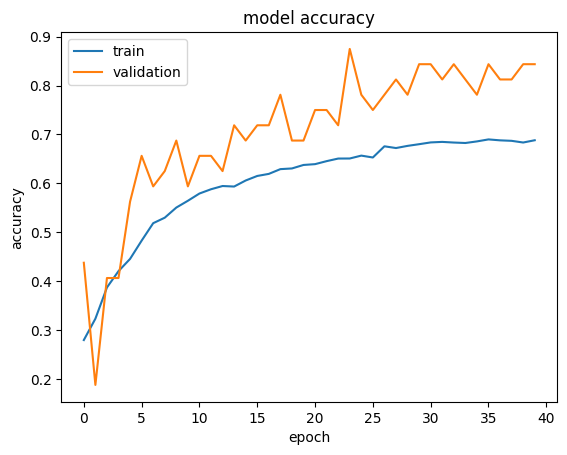

In [30]:
plt.plot(history_2.history["accuracy"])
plt.plot(history_2.history["val_accuracy"])
plt.title("model accuracy")
plt.ylabel("accuracy")
plt.xlabel("epoch")
plt.legend(["train", "validation"], loc="upper left")
plt.show()

### **Evaluating the Model on the Test Set**


In [31]:
# Calculate the number of steps for the entire test set to be processed
test_steps = test_generator.samples // batch_size

# If the number of samples isn't a multiple of the batch size,
# you have one more batch with the remaining samples
if test_generator.samples % batch_size > 0:
    test_steps += 1

# Evaluating the model on the test set
evaluation_results = model_2.evaluate(test_generator, steps=test_steps)
print(f"Loss: {evaluation_results[0]}, Accuracy: {evaluation_results[1]}")

1/4 [======>.......................] - ETA: 0s - loss: 0.3409 - accuracy: 0.8438

4/4 [==============================] - 0s 5ms/step - loss: 0.5815 - accuracy: 0.7422


Loss: 0.5814648866653442, Accuracy: 0.7421875


### **Plotting Confusion Matrix**


1/4 [======>.......................] - ETA: 0s

4/4 [==============================] - 0s 6ms/step


              precision    recall  f1-score   support

       happy       0.87      0.84      0.86        32
     neutral       0.59      0.72      0.65        32
         sad       0.69      0.56      0.62        32
    surprise       0.84      0.84      0.84        32

    accuracy                           0.74       128
   macro avg       0.75      0.74      0.74       128
weighted avg       0.75      0.74      0.74       128



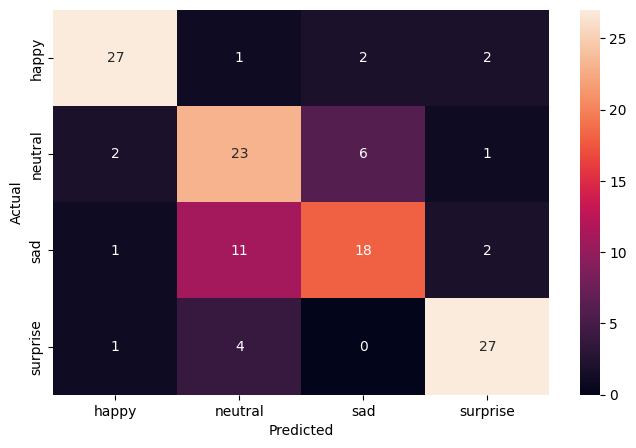

In [32]:
pred_probabilities = model_2.predict(test_generator, steps=test_steps)
pred = np.argmax(pred_probabilities, axis=1)

# Getting the true labels from the generator
y_true = test_generator.classes

# Printing the classification report with actual emotion labels
print(classification_report(y_true, pred, target_names=CATEGORIES))

# Plotting the heatmap using confusion matrix
cm = confusion_matrix(y_true, pred)
plt.figure(figsize=(8, 5))
sns.heatmap(cm, annot=True, fmt=".0f", xticklabels=CATEGORIES, yticklabels=CATEGORIES)
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.show()

**Observations and Insights:**

- The second CNN model, equipped with a more complex architecture of **938,948 parameters**, demonstrates a steady learning curve, indicating effective feature learning with a final training accuracy of approximately 69.08%. The **validation accuracy on training** experiences fluctuations but shows an upward trend, with a peak at around **84.37%**.
- On testing, the model secured a **loss of 0.5975 and an accuracy of 75%**, which confirms its capability to generalize the learned features to new data reasonably well, aligning closely with the observed validation accuracy.
- The confusion matrix reveals the model's proficiency in correctly identifying 'happy' with a high precision of 0.96 and 'surprise' emotions with impressive precision and recall of 0.93 and 0.84, respectively.
- In contrast, the model has room for improvement when predicting 'neutral' and 'sad' emotions, as indicated by lower precision and recall scores. 'Neutral' faces have the lowest precision at 0.56, suggesting the model sometimes confuses this emotion with others, while 'sad' faces have a recall of 0.56, indicating that the model fails to detect a significant portion of this emotion.


## **Think About It:**

- Did the models have a satisfactory performance? If not, then what are the possible reasons?
- Which Color mode showed better overall performance? What are the possible reasons? Do you think having 'rgb' color mode is needed because the images are already black and white?


## **Transfer Learning Architectures**

In this section, we will create several Transfer Learning architectures. For the pre-trained models, we will select three popular architectures namely, VGG16, ResNet v2, and Efficient Net. The difference between these architectures and the previous architectures is that these will require 3 input channels while the earlier ones worked on 'grayscale' images. Therefore, we need to create new DataLoaders.


### **Creating our Data Loaders for Transfer Learning Architectures**

In this section, we are creating data loaders that we will use as inputs to our Neural Network. We will have to go with color_mode = 'rgb' as this is the required format for the transfer learning architectures.


In [33]:
# Set this to 'rgb' as this is the required format for the transfer learning architectures
color_mode = "rgb"

# Resize our images to the same size expected by the transfer learning architectures
img_width, img_height = 224, 224
# A batch size of 32 is appropriate for this dataset provide to provide a good balance
# between the model's ability to generalize (avoid overfitting) and computational efficiency.
batch_size = 32

# Training Data Augmentation
train_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input,  # Use the appropriate preprocessing function
    rotation_range=20,  # Slight rotation to introduce variability without distorting emotion features
    width_shift_range=0.1,  # Slight horizontal shifts to simulate off-center faces
    height_shift_range=0.1,  # Slight vertical shifts to account for different heights/angles
    shear_range=0.1,  # Small shear transformations for slight perspective changes
    zoom_range=0.1,  # Small zoom in/out to simulate closer or further away faces
    horizontal_flip=True,  # Faces are symmetric; flipping can simulate looking from another direction
    fill_mode="nearest",  # 'nearest' interpolation for filling in new pixels after a transformation
)

# Validation and Testing Data should not be augmented!
validation_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

# Assuming train_dir, validation_dir, and test_dir should follow the structure in DATADIR and SUBDIRS
train_dir = os.path.join(DATADIR, SUBDIRS_DICT["train"])
validation_dir = os.path.join(DATADIR, SUBDIRS_DICT["validation"])
test_dir = os.path.join(DATADIR, SUBDIRS_DICT["test"])

# Train Generator
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    color_mode=color_mode,
    class_mode="categorical",
)

# Validation Generator
validation_generator = validation_datagen.flow_from_directory(
    validation_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    color_mode=color_mode,
    class_mode="categorical",
)

# Testing Generator
test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    color_mode=color_mode,
    class_mode="categorical",
    shuffle=False,  # shuffle=False to keep data in order for testing
)

Found 15109 images belonging to 4 classes.


Found 4977 images belonging to 4 classes.


Found 128 images belonging to 4 classes.


## **VGG16 Model**


### **Importing the VGG16 Architecture**


In [34]:
backend.clear_session()

# Fixing the seed for random number generators so that we can ensure we receive the same output everytime
np.random.seed(42)

random.seed(42)
tf.random.set_seed(42)

In [35]:
vgg_model = VGG16(weights="imagenet", include_top=False, input_shape=(img_width, img_height, 3))
# Making all the layers of the VGG model non-trainable. i.e. freezing them
for layer in vgg_model.layers:
    layer.trainable = False

vgg_model.summary()

Model: "vgg16"


_________________________________________________________________


 Layer (type)                Output Shape              Param #   


 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         


 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      


 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     


 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         


 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     


 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    


 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0         


 block3_conv1 (Conv2D)       (None, 56, 56, 256)       295168    


 block3_conv2 (Conv2D)       (None, 56, 56, 256)       590080    


 block3_conv3 (Conv2D)       (None, 56, 56, 256)       590080    


 block3_pool (MaxPooling2D)  (None, 28, 28, 256)       0         


 block4_conv1 (Conv2D)       (None, 28, 28, 512)       1180160   


 block4_conv2 (Conv2D)       (None, 28, 28, 512)       2359808   


 block4_conv3 (Conv2D)       (None, 28, 28, 512)       2359808   


 block4_pool (MaxPooling2D)  (None, 14, 14, 512)       0         


 block5_conv1 (Conv2D)       (None, 14, 14, 512)       2359808   


 block5_conv2 (Conv2D)       (None, 14, 14, 512)       2359808   


 block5_conv3 (Conv2D)       (None, 14, 14, 512)       2359808   


 block5_pool (MaxPooling2D)  (None, 7, 7, 512)         0         


Total params: 14714688 (56.13 MB)


Trainable params: 0 (0.00 Byte)


Non-trainable params: 14714688 (56.13 MB)


_________________________________________________________________


### **Model Building**

- Import VGG16 upto the layer of your choice and add Fully Connected layers on top of it.


In [36]:
new_vgg16_model = Sequential()

# Adding the convolutional part of the VGG16 model from above
new_vgg16_model.add(vgg_model)

# Reduces each feature map to a single value by averaging all elements
new_vgg16_model.add(GlobalAveragePooling2D())

# Adding a dense output layer
new_vgg16_model.add(Dense(512, activation="relu"))
new_vgg16_model.add(Dropout(0.5))
new_vgg16_model.add(Dense(128, activation="relu"))
new_vgg16_model.add(Dropout(0.5))
new_vgg16_model.add(Dense(4, activation="softmax"))

# Using Adam Optimizer
optimizer = Adam(learning_rate=0.0005)

### **Compiling and Training the VGG16 Model**


In [37]:
new_vgg16_model.compile(optimizer=optimizer, loss="categorical_crossentropy", metrics=["accuracy"])
new_vgg16_model.summary()

Model: "sequential"


_________________________________________________________________


 Layer (type)                Output Shape              Param #   


 vgg16 (Functional)          (None, 7, 7, 512)         14714688  


 global_average_pooling2d (  (None, 512)               0         


 GlobalAveragePooling2D)                                         


 dense (Dense)               (None, 512)               262656    


 dropout (Dropout)           (None, 512)               0         


 dense_1 (Dense)             (None, 128)               65664     


 dropout_1 (Dropout)         (None, 128)               0         


 dense_2 (Dense)             (None, 4)                 516       


Total params: 15043524 (57.39 MB)


Trainable params: 328836 (1.25 MB)


Non-trainable params: 14714688 (56.13 MB)


_________________________________________________________________


In [38]:
# Get the current time
current_time = datetime.now().strftime("%Y%m%d-%H%M%S")

# Set up Early Stopping with a patience 7 but acting after at least 20 epochs
delayed_early_stopping = DelayedEarlyStopping(
    monitor="val_loss", patience=7, verbose=1, restore_best_weights=True, start_epoch=20
)

# Define the learning rate scheduler callback
reduce_lr = ReduceLROnPlateau(monitor="val_loss", factor=0.2, patience=5, min_lr=0.00001, verbose=1)

mc = ModelCheckpoint(
    f"{results_path}/best_model_vgg16_{current_time}.keras",
    monitor="val_accuracy",
    mode="max",
    verbose=1,
    save_best_only=True,
)

# Pulling a single large batch of random validation data for doing the validation after each epoch
validationX, validationY = validation_generator.next()

# Fitting the model with 40 epochs and using validation set
history_vgg = new_vgg16_model.fit(
    train_generator,
    epochs=40,
    validation_data=(validationX, validationY),
    callbacks=[delayed_early_stopping, mc, reduce_lr],
)

Epoch 1/40


  1/473 [..............................] - ETA: 18:41 - loss: 7.5725 - accuracy: 0.2188

  2/473 [..............................] - ETA: 28s - loss: 6.9418 - accuracy: 0.2031  

  3/473 [..............................] - ETA: 28s - loss: 6.8303 - accuracy: 0.1771

  4/473 [..............................] - ETA: 33s - loss: 6.4575 - accuracy: 0.1953

  5/473 [..............................] - ETA: 43s - loss: 6.3229 - accuracy: 0.1813

  6/473 [..............................] - ETA: 48s - loss: 5.8651 - accuracy: 0.1979

  7/473 [..............................] - ETA: 55s - loss: 5.8486 - accuracy: 0.2232

  8/473 [..............................] - ETA: 57s - loss: 5.5632 - accuracy: 0.2461

  9/473 [..............................] - ETA: 58s - loss: 5.3058 - accuracy: 0.2569

 10/473 [..............................] - ETA: 1:00 - loss: 5.1717 - accuracy: 0.2625

 11/473 [..............................] - ETA: 1:01 - loss: 5.1997 - accuracy: 0.2614

 12/473 [..............................] - ETA: 1:01 - loss: 5.2030 - accuracy: 0.2604

 13/473 [..............................] - ETA: 1:02 - loss: 5.0140 - accuracy: 0.2644

 14/473 [..............................] - ETA: 1:02 - loss: 4.9518 - accuracy: 0.2679

 15/473 [..............................] - ETA: 1:03 - loss: 4.9282 - accuracy: 0.2583

 16/473 [>.............................] - ETA: 1:03 - loss: 4.8340 - accuracy: 0.2617

 17/473 [>.............................] - ETA: 1:04 - loss: 4.7688 - accuracy: 0.2592

 18/473 [>.............................] - ETA: 1:04 - loss: 4.6965 - accuracy: 0.2622

 19/473 [>.............................] - ETA: 1:04 - loss: 4.6913 - accuracy: 0.2566

 20/473 [>.............................] - ETA: 1:04 - loss: 4.6852 - accuracy: 0.2578

 21/473 [>.............................] - ETA: 1:04 - loss: 4.5986 - accuracy: 0.2574

 22/473 [>.............................] - ETA: 1:04 - loss: 4.5285 - accuracy: 0.2614

 23/473 [>.............................] - ETA: 1:04 - loss: 4.4501 - accuracy: 0.2541

 24/473 [>.............................] - ETA: 1:04 - loss: 4.4035 - accuracy: 0.2552

 25/473 [>.............................] - ETA: 1:04 - loss: 4.3649 - accuracy: 0.2537

 26/473 [>.............................] - ETA: 1:04 - loss: 4.3218 - accuracy: 0.2548

 27/473 [>.............................] - ETA: 1:04 - loss: 4.2817 - accuracy: 0.2546

 28/473 [>.............................] - ETA: 1:04 - loss: 4.2435 - accuracy: 0.2511

 29/473 [>.............................] - ETA: 1:04 - loss: 4.1798 - accuracy: 0.2522

 30/473 [>.............................] - ETA: 1:04 - loss: 4.1381 - accuracy: 0.2490

 31/473 [>.............................] - ETA: 1:04 - loss: 4.0886 - accuracy: 0.2450

 32/473 [=>............................] - ETA: 1:04 - loss: 4.0307 - accuracy: 0.2480

 33/473 [=>............................] - ETA: 1:05 - loss: 3.9890 - accuracy: 0.2472

 34/473 [=>............................] - ETA: 1:05 - loss: 3.9421 - accuracy: 0.2482

 35/473 [=>............................] - ETA: 1:05 - loss: 3.8988 - accuracy: 0.2446

 36/473 [=>............................] - ETA: 1:05 - loss: 3.8451 - accuracy: 0.2448

 37/473 [=>............................] - ETA: 1:05 - loss: 3.7969 - accuracy: 0.2475

 38/473 [=>............................] - ETA: 1:05 - loss: 3.7547 - accuracy: 0.2459

 39/473 [=>............................] - ETA: 1:05 - loss: 3.7134 - accuracy: 0.2460

 40/473 [=>............................] - ETA: 1:05 - loss: 3.6948 - accuracy: 0.2445

 41/473 [=>............................] - ETA: 1:05 - loss: 3.6616 - accuracy: 0.2447

 42/473 [=>............................] - ETA: 1:05 - loss: 3.6197 - accuracy: 0.2493

 43/473 [=>............................] - ETA: 1:05 - loss: 3.5889 - accuracy: 0.2500

 44/473 [=>............................] - ETA: 1:05 - loss: 3.5678 - accuracy: 0.2493

 45/473 [=>............................] - ETA: 1:05 - loss: 3.5362 - accuracy: 0.2493

 46/473 [=>............................] - ETA: 1:05 - loss: 3.4989 - accuracy: 0.2507

 47/473 [=>............................] - ETA: 1:05 - loss: 3.4642 - accuracy: 0.2520

 48/473 [==>...........................] - ETA: 1:05 - loss: 3.4216 - accuracy: 0.2578

 49/473 [==>...........................] - ETA: 1:04 - loss: 3.3972 - accuracy: 0.2577

 50/473 [==>...........................] - ETA: 1:04 - loss: 3.3690 - accuracy: 0.2550

 51/473 [==>...........................] - ETA: 1:04 - loss: 3.3363 - accuracy: 0.2598

 52/473 [==>...........................] - ETA: 1:04 - loss: 3.3090 - accuracy: 0.2578

 53/473 [==>...........................] - ETA: 1:04 - loss: 3.2771 - accuracy: 0.2594

 54/473 [==>...........................] - ETA: 1:04 - loss: 3.2487 - accuracy: 0.2581

 55/473 [==>...........................] - ETA: 1:04 - loss: 3.2202 - accuracy: 0.2580

 56/473 [==>...........................] - ETA: 1:03 - loss: 3.1907 - accuracy: 0.2612

 57/473 [==>...........................] - ETA: 1:03 - loss: 3.1677 - accuracy: 0.2615

 58/473 [==>...........................] - ETA: 1:03 - loss: 3.1418 - accuracy: 0.2619

 59/473 [==>...........................] - ETA: 1:03 - loss: 3.1173 - accuracy: 0.2638

 60/473 [==>...........................] - ETA: 1:03 - loss: 3.0879 - accuracy: 0.2656

 61/473 [==>...........................] - ETA: 1:03 - loss: 3.0737 - accuracy: 0.2643

 62/473 [==>...........................] - ETA: 1:03 - loss: 3.0514 - accuracy: 0.2661

 63/473 [==>...........................] - ETA: 1:03 - loss: 3.0241 - accuracy: 0.2669

 64/473 [===>..........................] - ETA: 1:03 - loss: 3.0066 - accuracy: 0.2642

 65/473 [===>..........................] - ETA: 1:02 - loss: 2.9854 - accuracy: 0.2649

 66/473 [===>..........................] - ETA: 1:02 - loss: 2.9665 - accuracy: 0.2656

 67/473 [===>..........................] - ETA: 1:02 - loss: 2.9525 - accuracy: 0.2649

 68/473 [===>..........................] - ETA: 1:02 - loss: 2.9332 - accuracy: 0.2642

 69/473 [===>..........................] - ETA: 1:02 - loss: 2.9135 - accuracy: 0.2640

 70/473 [===>..........................] - ETA: 1:02 - loss: 2.8982 - accuracy: 0.2625

 71/473 [===>..........................] - ETA: 1:02 - loss: 2.8862 - accuracy: 0.2614

 72/473 [===>..........................] - ETA: 1:02 - loss: 2.8713 - accuracy: 0.2617

 73/473 [===>..........................] - ETA: 1:01 - loss: 2.8541 - accuracy: 0.2620

 74/473 [===>..........................] - ETA: 1:01 - loss: 2.8337 - accuracy: 0.2622

 75/473 [===>..........................] - ETA: 1:01 - loss: 2.8206 - accuracy: 0.2646

 76/473 [===>..........................] - ETA: 1:01 - loss: 2.8060 - accuracy: 0.2636

 77/473 [===>..........................] - ETA: 1:01 - loss: 2.7895 - accuracy: 0.2646

 78/473 [===>..........................] - ETA: 1:01 - loss: 2.7736 - accuracy: 0.2652

 79/473 [====>.........................] - ETA: 1:00 - loss: 2.7617 - accuracy: 0.2650

 80/473 [====>.........................] - ETA: 1:00 - loss: 2.7495 - accuracy: 0.2652

 81/473 [====>.........................] - ETA: 1:00 - loss: 2.7365 - accuracy: 0.2654

 82/473 [====>.........................] - ETA: 1:00 - loss: 2.7230 - accuracy: 0.2668

 83/473 [====>.........................] - ETA: 1:00 - loss: 2.7081 - accuracy: 0.2673

 84/473 [====>.........................] - ETA: 1:00 - loss: 2.6968 - accuracy: 0.2693

 85/473 [====>.........................] - ETA: 1:00 - loss: 2.6840 - accuracy: 0.2699

 86/473 [====>.........................] - ETA: 59s - loss: 2.6777 - accuracy: 0.2696 

 87/473 [====>.........................] - ETA: 59s - loss: 2.6660 - accuracy: 0.2698

 88/473 [====>.........................] - ETA: 59s - loss: 2.6537 - accuracy: 0.2695

 89/473 [====>.........................] - ETA: 59s - loss: 2.6412 - accuracy: 0.2704

 90/473 [====>.........................] - ETA: 59s - loss: 2.6294 - accuracy: 0.2708

 91/473 [====>.........................] - ETA: 59s - loss: 2.6183 - accuracy: 0.2703

 92/473 [====>.........................] - ETA: 58s - loss: 2.6064 - accuracy: 0.2704

 93/473 [====>.........................] - ETA: 58s - loss: 2.5984 - accuracy: 0.2705

 94/473 [====>.........................] - ETA: 58s - loss: 2.5887 - accuracy: 0.2706

 95/473 [=====>........................] - ETA: 58s - loss: 2.5832 - accuracy: 0.2697

 96/473 [=====>........................] - ETA: 58s - loss: 2.5744 - accuracy: 0.2689

 97/473 [=====>........................] - ETA: 58s - loss: 2.5619 - accuracy: 0.2703

 98/473 [=====>........................] - ETA: 58s - loss: 2.5543 - accuracy: 0.2701

 99/473 [=====>........................] - ETA: 58s - loss: 2.5454 - accuracy: 0.2689

100/473 [=====>........................] - ETA: 57s - loss: 2.5379 - accuracy: 0.2684

101/473 [=====>........................] - ETA: 57s - loss: 2.5264 - accuracy: 0.2698

102/473 [=====>........................] - ETA: 57s - loss: 2.5184 - accuracy: 0.2702

103/473 [=====>........................] - ETA: 57s - loss: 2.5129 - accuracy: 0.2685

104/473 [=====>........................] - ETA: 57s - loss: 2.5035 - accuracy: 0.2692

105/473 [=====>........................] - ETA: 57s - loss: 2.4937 - accuracy: 0.2696

106/473 [=====>........................] - ETA: 57s - loss: 2.4849 - accuracy: 0.2700

107/473 [=====>........................] - ETA: 57s - loss: 2.4745 - accuracy: 0.2713

108/473 [=====>........................] - ETA: 57s - loss: 2.4641 - accuracy: 0.2720

109/473 [=====>........................] - ETA: 56s - loss: 2.4565 - accuracy: 0.2724

110/473 [=====>........................] - ETA: 56s - loss: 2.4479 - accuracy: 0.2727

111/473 [======>.......................] - ETA: 56s - loss: 2.4385 - accuracy: 0.2739

112/473 [======>.......................] - ETA: 56s - loss: 2.4321 - accuracy: 0.2732

113/473 [======>.......................] - ETA: 56s - loss: 2.4231 - accuracy: 0.2738

114/473 [======>.......................] - ETA: 56s - loss: 2.4194 - accuracy: 0.2725

115/473 [======>.......................] - ETA: 56s - loss: 2.4118 - accuracy: 0.2726

116/473 [======>.......................] - ETA: 56s - loss: 2.4034 - accuracy: 0.2726

117/473 [======>.......................] - ETA: 55s - loss: 2.3957 - accuracy: 0.2732

118/473 [======>.......................] - ETA: 55s - loss: 2.3893 - accuracy: 0.2728

119/473 [======>.......................] - ETA: 55s - loss: 2.3843 - accuracy: 0.2728

120/473 [======>.......................] - ETA: 55s - loss: 2.3778 - accuracy: 0.2732

121/473 [======>.......................] - ETA: 55s - loss: 2.3713 - accuracy: 0.2738

122/473 [======>.......................] - ETA: 55s - loss: 2.3630 - accuracy: 0.2741

123/473 [======>.......................] - ETA: 55s - loss: 2.3565 - accuracy: 0.2746

124/473 [======>.......................] - ETA: 54s - loss: 2.3519 - accuracy: 0.2747

125/473 [======>.......................] - ETA: 54s - loss: 2.3438 - accuracy: 0.2758

126/473 [======>.......................] - ETA: 54s - loss: 2.3374 - accuracy: 0.2763

127/473 [=======>......................] - ETA: 54s - loss: 2.3298 - accuracy: 0.2773

128/473 [=======>......................] - ETA: 54s - loss: 2.3222 - accuracy: 0.2778

129/473 [=======>......................] - ETA: 54s - loss: 2.3160 - accuracy: 0.2788

130/473 [=======>......................] - ETA: 53s - loss: 2.3106 - accuracy: 0.2784

131/473 [=======>......................] - ETA: 53s - loss: 2.3037 - accuracy: 0.2791

132/473 [=======>......................] - ETA: 53s - loss: 2.2970 - accuracy: 0.2791

133/473 [=======>......................] - ETA: 53s - loss: 2.2908 - accuracy: 0.2796

134/473 [=======>......................] - ETA: 53s - loss: 2.2843 - accuracy: 0.2808

135/473 [=======>......................] - ETA: 53s - loss: 2.2777 - accuracy: 0.2817

136/473 [=======>......................] - ETA: 52s - loss: 2.2710 - accuracy: 0.2822

137/473 [=======>......................] - ETA: 52s - loss: 2.2652 - accuracy: 0.2812

138/473 [=======>......................] - ETA: 52s - loss: 2.2584 - accuracy: 0.2817

139/473 [=======>......................] - ETA: 52s - loss: 2.2526 - accuracy: 0.2810

140/473 [=======>......................] - ETA: 52s - loss: 2.2476 - accuracy: 0.2810

141/473 [=======>......................] - ETA: 52s - loss: 2.2429 - accuracy: 0.2808

142/473 [========>.....................] - ETA: 51s - loss: 2.2373 - accuracy: 0.2815

143/473 [========>.....................] - ETA: 51s - loss: 2.2326 - accuracy: 0.2810

144/473 [========>.....................] - ETA: 51s - loss: 2.2267 - accuracy: 0.2819

145/473 [========>.....................] - ETA: 51s - loss: 2.2216 - accuracy: 0.2828

146/473 [========>.....................] - ETA: 51s - loss: 2.2157 - accuracy: 0.2830

147/473 [========>.....................] - ETA: 51s - loss: 2.2104 - accuracy: 0.2827

148/473 [========>.....................] - ETA: 50s - loss: 2.2054 - accuracy: 0.2838

149/473 [========>.....................] - ETA: 50s - loss: 2.2012 - accuracy: 0.2831

150/473 [========>.....................] - ETA: 50s - loss: 2.1964 - accuracy: 0.2831

151/473 [========>.....................] - ETA: 50s - loss: 2.1906 - accuracy: 0.2841

152/473 [========>.....................] - ETA: 50s - loss: 2.1851 - accuracy: 0.2839

153/473 [========>.....................] - ETA: 50s - loss: 2.1792 - accuracy: 0.2837

154/473 [========>.....................] - ETA: 49s - loss: 2.1749 - accuracy: 0.2837

155/473 [========>.....................] - ETA: 49s - loss: 2.1714 - accuracy: 0.2833

156/473 [========>.....................] - ETA: 49s - loss: 2.1669 - accuracy: 0.2837

157/473 [========>.....................] - ETA: 49s - loss: 2.1617 - accuracy: 0.2840

158/473 [=========>....................] - ETA: 49s - loss: 2.1584 - accuracy: 0.2844

159/473 [=========>....................] - ETA: 49s - loss: 2.1531 - accuracy: 0.2854

160/473 [=========>....................] - ETA: 49s - loss: 2.1491 - accuracy: 0.2852

161/473 [=========>....................] - ETA: 48s - loss: 2.1464 - accuracy: 0.2847

162/473 [=========>....................] - ETA: 48s - loss: 2.1415 - accuracy: 0.2849

163/473 [=========>....................] - ETA: 48s - loss: 2.1381 - accuracy: 0.2847

164/473 [=========>....................] - ETA: 48s - loss: 2.1336 - accuracy: 0.2851

165/473 [=========>....................] - ETA: 48s - loss: 2.1298 - accuracy: 0.2852

166/473 [=========>....................] - ETA: 48s - loss: 2.1258 - accuracy: 0.2854

167/473 [=========>....................] - ETA: 48s - loss: 2.1225 - accuracy: 0.2854

168/473 [=========>....................] - ETA: 47s - loss: 2.1201 - accuracy: 0.2852

169/473 [=========>....................] - ETA: 47s - loss: 2.1169 - accuracy: 0.2857

170/473 [=========>....................] - ETA: 47s - loss: 2.1121 - accuracy: 0.2866

171/473 [=========>....................] - ETA: 47s - loss: 2.1081 - accuracy: 0.2869

172/473 [=========>....................] - ETA: 47s - loss: 2.1037 - accuracy: 0.2874

173/473 [=========>....................] - ETA: 47s - loss: 2.0990 - accuracy: 0.2879

174/473 [==========>...................] - ETA: 47s - loss: 2.0950 - accuracy: 0.2881

175/473 [==========>...................] - ETA: 46s - loss: 2.0911 - accuracy: 0.2886

176/473 [==========>...................] - ETA: 46s - loss: 2.0876 - accuracy: 0.2884

177/473 [==========>...................] - ETA: 46s - loss: 2.0825 - accuracy: 0.2888

178/473 [==========>...................] - ETA: 46s - loss: 2.0779 - accuracy: 0.2895

179/473 [==========>...................] - ETA: 46s - loss: 2.0749 - accuracy: 0.2898

180/473 [==========>...................] - ETA: 46s - loss: 2.0715 - accuracy: 0.2891

181/473 [==========>...................] - ETA: 46s - loss: 2.0694 - accuracy: 0.2887

182/473 [==========>...................] - ETA: 45s - loss: 2.0672 - accuracy: 0.2883

183/473 [==========>...................] - ETA: 45s - loss: 2.0634 - accuracy: 0.2883

184/473 [==========>...................] - ETA: 45s - loss: 2.0606 - accuracy: 0.2882

185/473 [==========>...................] - ETA: 45s - loss: 2.0572 - accuracy: 0.2885

186/473 [==========>...................] - ETA: 45s - loss: 2.0539 - accuracy: 0.2881

187/473 [==========>...................] - ETA: 45s - loss: 2.0497 - accuracy: 0.2888

188/473 [==========>...................] - ETA: 44s - loss: 2.0458 - accuracy: 0.2899

189/473 [==========>...................] - ETA: 44s - loss: 2.0428 - accuracy: 0.2902

190/473 [===========>..................] - ETA: 44s - loss: 2.0387 - accuracy: 0.2913

191/473 [===========>..................] - ETA: 44s - loss: 2.0354 - accuracy: 0.2916

192/473 [===========>..................] - ETA: 44s - loss: 2.0320 - accuracy: 0.2913

193/473 [===========>..................] - ETA: 44s - loss: 2.0290 - accuracy: 0.2915

194/473 [===========>..................] - ETA: 44s - loss: 2.0255 - accuracy: 0.2919

195/473 [===========>..................] - ETA: 43s - loss: 2.0219 - accuracy: 0.2923

196/473 [===========>..................] - ETA: 43s - loss: 2.0190 - accuracy: 0.2929

197/473 [===========>..................] - ETA: 43s - loss: 2.0159 - accuracy: 0.2928

198/473 [===========>..................] - ETA: 43s - loss: 2.0134 - accuracy: 0.2921

199/473 [===========>..................] - ETA: 43s - loss: 2.0106 - accuracy: 0.2921

200/473 [===========>..................] - ETA: 43s - loss: 2.0080 - accuracy: 0.2920

201/473 [===========>..................] - ETA: 42s - loss: 2.0051 - accuracy: 0.2931

202/473 [===========>..................] - ETA: 42s - loss: 2.0031 - accuracy: 0.2925

203/473 [===========>..................] - ETA: 42s - loss: 2.0008 - accuracy: 0.2929

204/473 [===========>..................] - ETA: 42s - loss: 1.9990 - accuracy: 0.2929

205/473 [============>.................] - ETA: 42s - loss: 1.9967 - accuracy: 0.2925

206/473 [============>.................] - ETA: 42s - loss: 1.9944 - accuracy: 0.2923

207/473 [============>.................] - ETA: 42s - loss: 1.9911 - accuracy: 0.2930

208/473 [============>.................] - ETA: 41s - loss: 1.9886 - accuracy: 0.2927

209/473 [============>.................] - ETA: 41s - loss: 1.9866 - accuracy: 0.2925

210/473 [============>.................] - ETA: 41s - loss: 1.9831 - accuracy: 0.2930

211/473 [============>.................] - ETA: 41s - loss: 1.9808 - accuracy: 0.2932

212/473 [============>.................] - ETA: 41s - loss: 1.9786 - accuracy: 0.2930

213/473 [============>.................] - ETA: 41s - loss: 1.9755 - accuracy: 0.2934

214/473 [============>.................] - ETA: 41s - loss: 1.9736 - accuracy: 0.2929

215/473 [============>.................] - ETA: 40s - loss: 1.9707 - accuracy: 0.2926

216/473 [============>.................] - ETA: 40s - loss: 1.9684 - accuracy: 0.2931

217/473 [============>.................] - ETA: 40s - loss: 1.9655 - accuracy: 0.2933

218/473 [============>.................] - ETA: 40s - loss: 1.9626 - accuracy: 0.2934

219/473 [============>.................] - ETA: 40s - loss: 1.9601 - accuracy: 0.2934

220/473 [============>.................] - ETA: 40s - loss: 1.9578 - accuracy: 0.2937

221/473 [=============>................] - ETA: 39s - loss: 1.9559 - accuracy: 0.2933

222/473 [=============>................] - ETA: 39s - loss: 1.9526 - accuracy: 0.2942

223/473 [=============>................] - ETA: 39s - loss: 1.9503 - accuracy: 0.2941

224/473 [=============>................] - ETA: 39s - loss: 1.9481 - accuracy: 0.2941

225/473 [=============>................] - ETA: 39s - loss: 1.9461 - accuracy: 0.2942

226/473 [=============>................] - ETA: 39s - loss: 1.9433 - accuracy: 0.2945

227/473 [=============>................] - ETA: 39s - loss: 1.9402 - accuracy: 0.2956

228/473 [=============>................] - ETA: 38s - loss: 1.9380 - accuracy: 0.2956

229/473 [=============>................] - ETA: 38s - loss: 1.9356 - accuracy: 0.2956

230/473 [=============>................] - ETA: 38s - loss: 1.9334 - accuracy: 0.2959

231/473 [=============>................] - ETA: 38s - loss: 1.9319 - accuracy: 0.2956

232/473 [=============>................] - ETA: 38s - loss: 1.9288 - accuracy: 0.2970

233/473 [=============>................] - ETA: 38s - loss: 1.9259 - accuracy: 0.2972

234/473 [=============>................] - ETA: 38s - loss: 1.9233 - accuracy: 0.2977

235/473 [=============>................] - ETA: 37s - loss: 1.9210 - accuracy: 0.2976

236/473 [=============>................] - ETA: 37s - loss: 1.9184 - accuracy: 0.2975

237/473 [==============>...............] - ETA: 37s - loss: 1.9160 - accuracy: 0.2980

238/473 [==============>...............] - ETA: 37s - loss: 1.9133 - accuracy: 0.2986

239/473 [==============>...............] - ETA: 37s - loss: 1.9110 - accuracy: 0.2992

240/473 [==============>...............] - ETA: 37s - loss: 1.9089 - accuracy: 0.2992

241/473 [==============>...............] - ETA: 37s - loss: 1.9073 - accuracy: 0.2994

242/473 [==============>...............] - ETA: 36s - loss: 1.9051 - accuracy: 0.2995

243/473 [==============>...............] - ETA: 36s - loss: 1.9028 - accuracy: 0.2990

244/473 [==============>...............] - ETA: 36s - loss: 1.9007 - accuracy: 0.2994

245/473 [==============>...............] - ETA: 36s - loss: 1.8982 - accuracy: 0.3001

246/473 [==============>...............] - ETA: 36s - loss: 1.8963 - accuracy: 0.3001

247/473 [==============>...............] - ETA: 36s - loss: 1.8945 - accuracy: 0.3000

248/473 [==============>...............] - ETA: 35s - loss: 1.8922 - accuracy: 0.3004

249/473 [==============>...............] - ETA: 35s - loss: 1.8902 - accuracy: 0.3006

250/473 [==============>...............] - ETA: 35s - loss: 1.8879 - accuracy: 0.3006

251/473 [==============>...............] - ETA: 35s - loss: 1.8857 - accuracy: 0.3007

252/473 [==============>...............] - ETA: 35s - loss: 1.8837 - accuracy: 0.3007

253/473 [===============>..............] - ETA: 35s - loss: 1.8828 - accuracy: 0.3001

254/473 [===============>..............] - ETA: 35s - loss: 1.8806 - accuracy: 0.3004

255/473 [===============>..............] - ETA: 34s - loss: 1.8782 - accuracy: 0.3007

256/473 [===============>..............] - ETA: 34s - loss: 1.8768 - accuracy: 0.3008

257/473 [===============>..............] - ETA: 34s - loss: 1.8747 - accuracy: 0.3013

258/473 [===============>..............] - ETA: 34s - loss: 1.8731 - accuracy: 0.3010

259/473 [===============>..............] - ETA: 34s - loss: 1.8708 - accuracy: 0.3014

260/473 [===============>..............] - ETA: 34s - loss: 1.8687 - accuracy: 0.3014

261/473 [===============>..............] - ETA: 33s - loss: 1.8666 - accuracy: 0.3017

262/473 [===============>..............] - ETA: 33s - loss: 1.8648 - accuracy: 0.3025

263/473 [===============>..............] - ETA: 33s - loss: 1.8635 - accuracy: 0.3023

264/473 [===============>..............] - ETA: 33s - loss: 1.8614 - accuracy: 0.3024

265/473 [===============>..............] - ETA: 33s - loss: 1.8597 - accuracy: 0.3025

266/473 [===============>..............] - ETA: 33s - loss: 1.8575 - accuracy: 0.3031

267/473 [===============>..............] - ETA: 33s - loss: 1.8557 - accuracy: 0.3033

268/473 [===============>..............] - ETA: 32s - loss: 1.8536 - accuracy: 0.3036

269/473 [================>.............] - ETA: 32s - loss: 1.8523 - accuracy: 0.3032

270/473 [================>.............] - ETA: 32s - loss: 1.8509 - accuracy: 0.3032

271/473 [================>.............] - ETA: 32s - loss: 1.8494 - accuracy: 0.3029

272/473 [================>.............] - ETA: 32s - loss: 1.8481 - accuracy: 0.3028

273/473 [================>.............] - ETA: 32s - loss: 1.8460 - accuracy: 0.3028

274/473 [================>.............] - ETA: 31s - loss: 1.8441 - accuracy: 0.3031

275/473 [================>.............] - ETA: 31s - loss: 1.8419 - accuracy: 0.3034

276/473 [================>.............] - ETA: 31s - loss: 1.8406 - accuracy: 0.3034

277/473 [================>.............] - ETA: 31s - loss: 1.8386 - accuracy: 0.3038

278/473 [================>.............] - ETA: 31s - loss: 1.8375 - accuracy: 0.3037

279/473 [================>.............] - ETA: 31s - loss: 1.8358 - accuracy: 0.3040

280/473 [================>.............] - ETA: 30s - loss: 1.8333 - accuracy: 0.3044

281/473 [================>.............] - ETA: 30s - loss: 1.8316 - accuracy: 0.3048

282/473 [================>.............] - ETA: 30s - loss: 1.8300 - accuracy: 0.3047

283/473 [================>.............] - ETA: 30s - loss: 1.8280 - accuracy: 0.3049

284/473 [=================>............] - ETA: 30s - loss: 1.8265 - accuracy: 0.3048

285/473 [=================>............] - ETA: 30s - loss: 1.8255 - accuracy: 0.3044

286/473 [=================>............] - ETA: 30s - loss: 1.8244 - accuracy: 0.3043

287/473 [=================>............] - ETA: 29s - loss: 1.8221 - accuracy: 0.3051

288/473 [=================>............] - ETA: 29s - loss: 1.8208 - accuracy: 0.3050

289/473 [=================>............] - ETA: 29s - loss: 1.8191 - accuracy: 0.3051

290/473 [=================>............] - ETA: 29s - loss: 1.8185 - accuracy: 0.3048

291/473 [=================>............] - ETA: 29s - loss: 1.8173 - accuracy: 0.3055

292/473 [=================>............] - ETA: 29s - loss: 1.8155 - accuracy: 0.3061

293/473 [=================>............] - ETA: 28s - loss: 1.8143 - accuracy: 0.3062

294/473 [=================>............] - ETA: 28s - loss: 1.8132 - accuracy: 0.3056

295/473 [=================>............] - ETA: 28s - loss: 1.8119 - accuracy: 0.3054

296/473 [=================>............] - ETA: 28s - loss: 1.8106 - accuracy: 0.3056

297/473 [=================>............] - ETA: 28s - loss: 1.8096 - accuracy: 0.3053

298/473 [=================>............] - ETA: 28s - loss: 1.8087 - accuracy: 0.3053

299/473 [=================>............] - ETA: 28s - loss: 1.8075 - accuracy: 0.3051

300/473 [==================>...........] - ETA: 27s - loss: 1.8071 - accuracy: 0.3046

301/473 [==================>...........] - ETA: 27s - loss: 1.8052 - accuracy: 0.3047

302/473 [==================>...........] - ETA: 27s - loss: 1.8035 - accuracy: 0.3049

303/473 [==================>...........] - ETA: 27s - loss: 1.8025 - accuracy: 0.3049

304/473 [==================>...........] - ETA: 27s - loss: 1.8010 - accuracy: 0.3049

305/473 [==================>...........] - ETA: 27s - loss: 1.7993 - accuracy: 0.3051

306/473 [==================>...........] - ETA: 26s - loss: 1.7983 - accuracy: 0.3050

307/473 [==================>...........] - ETA: 26s - loss: 1.7975 - accuracy: 0.3047

308/473 [==================>...........] - ETA: 26s - loss: 1.7959 - accuracy: 0.3046

309/473 [==================>...........] - ETA: 26s - loss: 1.7947 - accuracy: 0.3044

310/473 [==================>...........] - ETA: 26s - loss: 1.7938 - accuracy: 0.3041

311/473 [==================>...........] - ETA: 26s - loss: 1.7920 - accuracy: 0.3046

312/473 [==================>...........] - ETA: 25s - loss: 1.7907 - accuracy: 0.3046

313/473 [==================>...........] - ETA: 25s - loss: 1.7895 - accuracy: 0.3049

314/473 [==================>...........] - ETA: 25s - loss: 1.7880 - accuracy: 0.3049

315/473 [==================>...........] - ETA: 25s - loss: 1.7864 - accuracy: 0.3055

316/473 [===================>..........] - ETA: 25s - loss: 1.7844 - accuracy: 0.3063

317/473 [===================>..........] - ETA: 25s - loss: 1.7830 - accuracy: 0.3062

318/473 [===================>..........] - ETA: 25s - loss: 1.7820 - accuracy: 0.3059

319/473 [===================>..........] - ETA: 24s - loss: 1.7802 - accuracy: 0.3066

320/473 [===================>..........] - ETA: 24s - loss: 1.7790 - accuracy: 0.3065

321/473 [===================>..........] - ETA: 24s - loss: 1.7775 - accuracy: 0.3067

322/473 [===================>..........] - ETA: 24s - loss: 1.7761 - accuracy: 0.3067

323/473 [===================>..........] - ETA: 24s - loss: 1.7750 - accuracy: 0.3068

324/473 [===================>..........] - ETA: 24s - loss: 1.7740 - accuracy: 0.3067

325/473 [===================>..........] - ETA: 23s - loss: 1.7730 - accuracy: 0.3066

326/473 [===================>..........] - ETA: 23s - loss: 1.7718 - accuracy: 0.3069

327/473 [===================>..........] - ETA: 23s - loss: 1.7703 - accuracy: 0.3073

328/473 [===================>..........] - ETA: 23s - loss: 1.7692 - accuracy: 0.3073

329/473 [===================>..........] - ETA: 23s - loss: 1.7681 - accuracy: 0.3072

330/473 [===================>..........] - ETA: 23s - loss: 1.7668 - accuracy: 0.3073

331/473 [===================>..........] - ETA: 22s - loss: 1.7657 - accuracy: 0.3070

332/473 [====================>.........] - ETA: 22s - loss: 1.7644 - accuracy: 0.3071

333/473 [====================>.........] - ETA: 22s - loss: 1.7630 - accuracy: 0.3077

334/473 [====================>.........] - ETA: 22s - loss: 1.7617 - accuracy: 0.3079

335/473 [====================>.........] - ETA: 22s - loss: 1.7603 - accuracy: 0.3081

336/473 [====================>.........] - ETA: 22s - loss: 1.7595 - accuracy: 0.3082

337/473 [====================>.........] - ETA: 21s - loss: 1.7582 - accuracy: 0.3083

338/473 [====================>.........] - ETA: 21s - loss: 1.7569 - accuracy: 0.3084

339/473 [====================>.........] - ETA: 21s - loss: 1.7555 - accuracy: 0.3089

340/473 [====================>.........] - ETA: 21s - loss: 1.7542 - accuracy: 0.3099

341/473 [====================>.........] - ETA: 21s - loss: 1.7527 - accuracy: 0.3103

342/473 [====================>.........] - ETA: 21s - loss: 1.7517 - accuracy: 0.3103

343/473 [====================>.........] - ETA: 20s - loss: 1.7508 - accuracy: 0.3103

344/473 [====================>.........] - ETA: 20s - loss: 1.7491 - accuracy: 0.3107

345/473 [====================>.........] - ETA: 20s - loss: 1.7480 - accuracy: 0.3106

346/473 [====================>.........] - ETA: 20s - loss: 1.7473 - accuracy: 0.3103

347/473 [=====================>........] - ETA: 20s - loss: 1.7457 - accuracy: 0.3103

348/473 [=====================>........] - ETA: 20s - loss: 1.7447 - accuracy: 0.3103

349/473 [=====================>........] - ETA: 20s - loss: 1.7434 - accuracy: 0.3106

350/473 [=====================>........] - ETA: 19s - loss: 1.7421 - accuracy: 0.3106

351/473 [=====================>........] - ETA: 19s - loss: 1.7410 - accuracy: 0.3105

352/473 [=====================>........] - ETA: 19s - loss: 1.7400 - accuracy: 0.3104

353/473 [=====================>........] - ETA: 19s - loss: 1.7392 - accuracy: 0.3103

354/473 [=====================>........] - ETA: 19s - loss: 1.7382 - accuracy: 0.3104

355/473 [=====================>........] - ETA: 19s - loss: 1.7371 - accuracy: 0.3099

356/473 [=====================>........] - ETA: 18s - loss: 1.7358 - accuracy: 0.3102

357/473 [=====================>........] - ETA: 18s - loss: 1.7352 - accuracy: 0.3100

358/473 [=====================>........] - ETA: 18s - loss: 1.7338 - accuracy: 0.3098

359/473 [=====================>........] - ETA: 18s - loss: 1.7324 - accuracy: 0.3099

360/473 [=====================>........] - ETA: 18s - loss: 1.7314 - accuracy: 0.3100

361/473 [=====================>........] - ETA: 18s - loss: 1.7303 - accuracy: 0.3101

362/473 [=====================>........] - ETA: 17s - loss: 1.7291 - accuracy: 0.3105

363/473 [======================>.......] - ETA: 17s - loss: 1.7281 - accuracy: 0.3105

364/473 [======================>.......] - ETA: 17s - loss: 1.7269 - accuracy: 0.3108

365/473 [======================>.......] - ETA: 17s - loss: 1.7256 - accuracy: 0.3111

366/473 [======================>.......] - ETA: 17s - loss: 1.7245 - accuracy: 0.3110

367/473 [======================>.......] - ETA: 17s - loss: 1.7233 - accuracy: 0.3111

368/473 [======================>.......] - ETA: 16s - loss: 1.7221 - accuracy: 0.3113

369/473 [======================>.......] - ETA: 16s - loss: 1.7209 - accuracy: 0.3116

370/473 [======================>.......] - ETA: 16s - loss: 1.7202 - accuracy: 0.3115

371/473 [======================>.......] - ETA: 16s - loss: 1.7192 - accuracy: 0.3117

372/473 [======================>.......] - ETA: 16s - loss: 1.7178 - accuracy: 0.3122

373/473 [======================>.......] - ETA: 16s - loss: 1.7165 - accuracy: 0.3125

374/473 [======================>.......] - ETA: 15s - loss: 1.7158 - accuracy: 0.3130

375/473 [======================>.......] - ETA: 15s - loss: 1.7151 - accuracy: 0.3128

376/473 [======================>.......] - ETA: 15s - loss: 1.7143 - accuracy: 0.3127

377/473 [======================>.......] - ETA: 15s - loss: 1.7136 - accuracy: 0.3127

378/473 [======================>.......] - ETA: 15s - loss: 1.7126 - accuracy: 0.3129

379/473 [=======================>......] - ETA: 15s - loss: 1.7118 - accuracy: 0.3127

380/473 [=======================>......] - ETA: 15s - loss: 1.7106 - accuracy: 0.3129

381/473 [=======================>......] - ETA: 14s - loss: 1.7102 - accuracy: 0.3131

382/473 [=======================>......] - ETA: 14s - loss: 1.7090 - accuracy: 0.3132

383/473 [=======================>......] - ETA: 14s - loss: 1.7082 - accuracy: 0.3132

384/473 [=======================>......] - ETA: 14s - loss: 1.7070 - accuracy: 0.3134

385/473 [=======================>......] - ETA: 14s - loss: 1.7059 - accuracy: 0.3139

386/473 [=======================>......] - ETA: 14s - loss: 1.7051 - accuracy: 0.3137

387/473 [=======================>......] - ETA: 13s - loss: 1.7043 - accuracy: 0.3136

388/473 [=======================>......] - ETA: 13s - loss: 1.7035 - accuracy: 0.3137

389/473 [=======================>......] - ETA: 13s - loss: 1.7027 - accuracy: 0.3136

390/473 [=======================>......] - ETA: 13s - loss: 1.7018 - accuracy: 0.3135

391/473 [=======================>......] - ETA: 13s - loss: 1.7010 - accuracy: 0.3137

392/473 [=======================>......] - ETA: 13s - loss: 1.6998 - accuracy: 0.3139

393/473 [=======================>......] - ETA: 12s - loss: 1.6992 - accuracy: 0.3136

394/473 [=======================>......] - ETA: 12s - loss: 1.6986 - accuracy: 0.3136

395/473 [========================>.....] - ETA: 12s - loss: 1.6977 - accuracy: 0.3139

396/473 [========================>.....] - ETA: 12s - loss: 1.6971 - accuracy: 0.3140

397/473 [========================>.....] - ETA: 12s - loss: 1.6966 - accuracy: 0.3139

398/473 [========================>.....] - ETA: 12s - loss: 1.6958 - accuracy: 0.3140

399/473 [========================>.....] - ETA: 11s - loss: 1.6950 - accuracy: 0.3138

400/473 [========================>.....] - ETA: 11s - loss: 1.6941 - accuracy: 0.3137

401/473 [========================>.....] - ETA: 11s - loss: 1.6933 - accuracy: 0.3137

402/473 [========================>.....] - ETA: 11s - loss: 1.6924 - accuracy: 0.3141

403/473 [========================>.....] - ETA: 11s - loss: 1.6916 - accuracy: 0.3144

404/473 [========================>.....] - ETA: 11s - loss: 1.6907 - accuracy: 0.3144

405/473 [========================>.....] - ETA: 11s - loss: 1.6896 - accuracy: 0.3145

406/473 [========================>.....] - ETA: 10s - loss: 1.6885 - accuracy: 0.3147

407/473 [========================>.....] - ETA: 10s - loss: 1.6875 - accuracy: 0.3151

408/473 [========================>.....] - ETA: 10s - loss: 1.6869 - accuracy: 0.3152

409/473 [========================>.....] - ETA: 10s - loss: 1.6859 - accuracy: 0.3152

410/473 [=========================>....] - ETA: 10s - loss: 1.6850 - accuracy: 0.3154

411/473 [=========================>....] - ETA: 10s - loss: 1.6844 - accuracy: 0.3153

412/473 [=========================>....] - ETA: 9s - loss: 1.6835 - accuracy: 0.3155 

413/473 [=========================>....] - ETA: 9s - loss: 1.6828 - accuracy: 0.3152

414/473 [=========================>....] - ETA: 9s - loss: 1.6819 - accuracy: 0.3153

415/473 [=========================>....] - ETA: 9s - loss: 1.6809 - accuracy: 0.3155

416/473 [=========================>....] - ETA: 9s - loss: 1.6798 - accuracy: 0.3155

417/473 [=========================>....] - ETA: 9s - loss: 1.6792 - accuracy: 0.3154

418/473 [=========================>....] - ETA: 8s - loss: 1.6783 - accuracy: 0.3156

419/473 [=========================>....] - ETA: 8s - loss: 1.6778 - accuracy: 0.3156

420/473 [=========================>....] - ETA: 8s - loss: 1.6770 - accuracy: 0.3156

421/473 [=========================>....] - ETA: 8s - loss: 1.6761 - accuracy: 0.3160

422/473 [=========================>....] - ETA: 8s - loss: 1.6757 - accuracy: 0.3158

423/473 [=========================>....] - ETA: 8s - loss: 1.6750 - accuracy: 0.3154

424/473 [=========================>....] - ETA: 7s - loss: 1.6738 - accuracy: 0.3155

425/473 [=========================>....] - ETA: 7s - loss: 1.6728 - accuracy: 0.3159

426/473 [==========================>...] - ETA: 7s - loss: 1.6719 - accuracy: 0.3160

427/473 [==========================>...] - ETA: 7s - loss: 1.6709 - accuracy: 0.3163

428/473 [==========================>...] - ETA: 7s - loss: 1.6707 - accuracy: 0.3161

429/473 [==========================>...] - ETA: 7s - loss: 1.6697 - accuracy: 0.3161

430/473 [==========================>...] - ETA: 6s - loss: 1.6685 - accuracy: 0.3165

431/473 [==========================>...] - ETA: 6s - loss: 1.6678 - accuracy: 0.3164

432/473 [==========================>...] - ETA: 6s - loss: 1.6671 - accuracy: 0.3163

433/473 [==========================>...] - ETA: 6s - loss: 1.6661 - accuracy: 0.3165

434/473 [==========================>...] - ETA: 6s - loss: 1.6652 - accuracy: 0.3167

435/473 [==========================>...] - ETA: 6s - loss: 1.6643 - accuracy: 0.3170

436/473 [==========================>...] - ETA: 6s - loss: 1.6638 - accuracy: 0.3170

437/473 [==========================>...] - ETA: 5s - loss: 1.6630 - accuracy: 0.3170

438/473 [==========================>...] - ETA: 5s - loss: 1.6623 - accuracy: 0.3169

439/473 [==========================>...] - ETA: 5s - loss: 1.6616 - accuracy: 0.3171

440/473 [==========================>...] - ETA: 5s - loss: 1.6609 - accuracy: 0.3174

441/473 [==========================>...] - ETA: 5s - loss: 1.6603 - accuracy: 0.3174

442/473 [===========================>..] - ETA: 5s - loss: 1.6596 - accuracy: 0.3177

443/473 [===========================>..] - ETA: 4s - loss: 1.6590 - accuracy: 0.3177

444/473 [===========================>..] - ETA: 4s - loss: 1.6583 - accuracy: 0.3176

445/473 [===========================>..] - ETA: 4s - loss: 1.6582 - accuracy: 0.3176

446/473 [===========================>..] - ETA: 4s - loss: 1.6579 - accuracy: 0.3177

447/473 [===========================>..] - ETA: 4s - loss: 1.6573 - accuracy: 0.3177

448/473 [===========================>..] - ETA: 4s - loss: 1.6567 - accuracy: 0.3175

449/473 [===========================>..] - ETA: 3s - loss: 1.6557 - accuracy: 0.3177

450/473 [===========================>..] - ETA: 3s - loss: 1.6550 - accuracy: 0.3177

451/473 [===========================>..] - ETA: 3s - loss: 1.6546 - accuracy: 0.3174

452/473 [===========================>..] - ETA: 3s - loss: 1.6539 - accuracy: 0.3176

453/473 [===========================>..] - ETA: 3s - loss: 1.6534 - accuracy: 0.3175

454/473 [===========================>..] - ETA: 3s - loss: 1.6525 - accuracy: 0.3177

455/473 [===========================>..] - ETA: 2s - loss: 1.6519 - accuracy: 0.3178

456/473 [===========================>..] - ETA: 2s - loss: 1.6512 - accuracy: 0.3180

457/473 [===========================>..] - ETA: 2s - loss: 1.6505 - accuracy: 0.3181

458/473 [============================>.] - ETA: 2s - loss: 1.6500 - accuracy: 0.3180

459/473 [============================>.] - ETA: 2s - loss: 1.6493 - accuracy: 0.3181

460/473 [============================>.] - ETA: 2s - loss: 1.6483 - accuracy: 0.3181

461/473 [============================>.] - ETA: 1s - loss: 1.6475 - accuracy: 0.3181

462/473 [============================>.] - ETA: 1s - loss: 1.6469 - accuracy: 0.3182

463/473 [============================>.] - ETA: 1s - loss: 1.6461 - accuracy: 0.3183

464/473 [============================>.] - ETA: 1s - loss: 1.6457 - accuracy: 0.3183

465/473 [============================>.] - ETA: 1s - loss: 1.6447 - accuracy: 0.3186

466/473 [============================>.] - ETA: 1s - loss: 1.6443 - accuracy: 0.3185

467/473 [============================>.] - ETA: 0s - loss: 1.6437 - accuracy: 0.3187

468/473 [============================>.] - ETA: 0s - loss: 1.6434 - accuracy: 0.3187

469/473 [============================>.] - ETA: 0s - loss: 1.6428 - accuracy: 0.3186

470/473 [============================>.] - ETA: 0s - loss: 1.6423 - accuracy: 0.3185

471/473 [============================>.] - ETA: 0s - loss: 1.6413 - accuracy: 0.3189

472/473 [============================>.] - ETA: 0s - loss: 1.6410 - accuracy: 0.3187

473/473 [==============================] - ETA: 0s - loss: 1.6402 - accuracy: 0.3190


Epoch 1: val_accuracy improved from -inf to 0.34375, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_vgg16_20240318-060419.keras


473/473 [==============================] - 79s 163ms/step - loss: 1.6402 - accuracy: 0.3190 - val_loss: 1.3981 - val_accuracy: 0.3438 - lr: 5.0000e-04


Epoch 2/40


  1/473 [..............................] - ETA: 1:57 - loss: 1.3894 - accuracy: 0.2500

  2/473 [..............................] - ETA: 1:12 - loss: 1.3194 - accuracy: 0.3438

  3/473 [..............................] - ETA: 1:11 - loss: 1.2833 - accuracy: 0.3333

  4/473 [..............................] - ETA: 1:17 - loss: 1.3177 - accuracy: 0.3203

  5/473 [..............................] - ETA: 1:15 - loss: 1.3158 - accuracy: 0.3313

  6/473 [..............................] - ETA: 1:14 - loss: 1.3119 - accuracy: 0.3229

  7/473 [..............................] - ETA: 1:16 - loss: 1.3079 - accuracy: 0.3304

  8/473 [..............................] - ETA: 1:15 - loss: 1.3289 - accuracy: 0.3203

  9/473 [..............................] - ETA: 1:14 - loss: 1.3436 - accuracy: 0.3229

 10/473 [..............................] - ETA: 1:13 - loss: 1.3443 - accuracy: 0.3313

 11/473 [..............................] - ETA: 1:13 - loss: 1.3309 - accuracy: 0.3239

 12/473 [..............................] - ETA: 1:13 - loss: 1.3262 - accuracy: 0.3229

 13/473 [..............................] - ETA: 1:12 - loss: 1.3325 - accuracy: 0.3173

 14/473 [..............................] - ETA: 1:12 - loss: 1.3267 - accuracy: 0.3192

 15/473 [..............................] - ETA: 1:11 - loss: 1.3339 - accuracy: 0.3208

 16/473 [>.............................] - ETA: 1:12 - loss: 1.3374 - accuracy: 0.3242

 17/473 [>.............................] - ETA: 1:12 - loss: 1.3295 - accuracy: 0.3309

 18/473 [>.............................] - ETA: 1:12 - loss: 1.3314 - accuracy: 0.3264

 19/473 [>.............................] - ETA: 1:12 - loss: 1.3301 - accuracy: 0.3273

 20/473 [>.............................] - ETA: 1:12 - loss: 1.3291 - accuracy: 0.3234

 21/473 [>.............................] - ETA: 1:12 - loss: 1.3225 - accuracy: 0.3318

 22/473 [>.............................] - ETA: 1:12 - loss: 1.3191 - accuracy: 0.3324

 23/473 [>.............................] - ETA: 1:12 - loss: 1.3218 - accuracy: 0.3288

 24/473 [>.............................] - ETA: 1:11 - loss: 1.3309 - accuracy: 0.3229

 25/473 [>.............................] - ETA: 1:11 - loss: 1.3258 - accuracy: 0.3262

 26/473 [>.............................] - ETA: 1:11 - loss: 1.3313 - accuracy: 0.3245

 27/473 [>.............................] - ETA: 1:11 - loss: 1.3278 - accuracy: 0.3241

 28/473 [>.............................] - ETA: 1:11 - loss: 1.3303 - accuracy: 0.3248

 29/473 [>.............................] - ETA: 1:10 - loss: 1.3319 - accuracy: 0.3233

 30/473 [>.............................] - ETA: 1:11 - loss: 1.3319 - accuracy: 0.3229

 31/473 [>.............................] - ETA: 1:10 - loss: 1.3328 - accuracy: 0.3226

 32/473 [=>............................] - ETA: 1:11 - loss: 1.3378 - accuracy: 0.3242

 33/473 [=>............................] - ETA: 1:10 - loss: 1.3350 - accuracy: 0.3258

 34/473 [=>............................] - ETA: 1:10 - loss: 1.3382 - accuracy: 0.3244

 35/473 [=>............................] - ETA: 1:10 - loss: 1.3368 - accuracy: 0.3259

 36/473 [=>............................] - ETA: 1:10 - loss: 1.3410 - accuracy: 0.3273

 37/473 [=>............................] - ETA: 1:10 - loss: 1.3417 - accuracy: 0.3285

 38/473 [=>............................] - ETA: 1:10 - loss: 1.3433 - accuracy: 0.3257

 39/473 [=>............................] - ETA: 1:10 - loss: 1.3451 - accuracy: 0.3277

 40/473 [=>............................] - ETA: 1:10 - loss: 1.3401 - accuracy: 0.3305

 41/473 [=>............................] - ETA: 1:10 - loss: 1.3442 - accuracy: 0.3316

 42/473 [=>............................] - ETA: 1:10 - loss: 1.3431 - accuracy: 0.3326

 43/473 [=>............................] - ETA: 1:09 - loss: 1.3392 - accuracy: 0.3336

 44/473 [=>............................] - ETA: 1:09 - loss: 1.3390 - accuracy: 0.3317

 45/473 [=>............................] - ETA: 1:09 - loss: 1.3387 - accuracy: 0.3326

 46/473 [=>............................] - ETA: 1:09 - loss: 1.3412 - accuracy: 0.3342

 47/473 [=>............................] - ETA: 1:09 - loss: 1.3389 - accuracy: 0.3371

 48/473 [==>...........................] - ETA: 1:09 - loss: 1.3392 - accuracy: 0.3366

 49/473 [==>...........................] - ETA: 1:09 - loss: 1.3415 - accuracy: 0.3355

 50/473 [==>...........................] - ETA: 1:09 - loss: 1.3433 - accuracy: 0.3350

 51/473 [==>...........................] - ETA: 1:09 - loss: 1.3447 - accuracy: 0.3339

 52/473 [==>...........................] - ETA: 1:09 - loss: 1.3416 - accuracy: 0.3377

 53/473 [==>...........................] - ETA: 1:08 - loss: 1.3473 - accuracy: 0.3373

 54/473 [==>...........................] - ETA: 1:08 - loss: 1.3432 - accuracy: 0.3414

 55/473 [==>...........................] - ETA: 1:08 - loss: 1.3428 - accuracy: 0.3426

 56/473 [==>...........................] - ETA: 1:08 - loss: 1.3432 - accuracy: 0.3438

 57/473 [==>...........................] - ETA: 1:08 - loss: 1.3417 - accuracy: 0.3438

 58/473 [==>...........................] - ETA: 1:08 - loss: 1.3417 - accuracy: 0.3432

 59/473 [==>...........................] - ETA: 1:07 - loss: 1.3414 - accuracy: 0.3453

 60/473 [==>...........................] - ETA: 1:07 - loss: 1.3449 - accuracy: 0.3432

 61/473 [==>...........................] - ETA: 1:07 - loss: 1.3469 - accuracy: 0.3427

 62/473 [==>...........................] - ETA: 1:07 - loss: 1.3440 - accuracy: 0.3453

 63/473 [==>...........................] - ETA: 1:07 - loss: 1.3450 - accuracy: 0.3472

 64/473 [===>..........................] - ETA: 1:07 - loss: 1.3432 - accuracy: 0.3477

 65/473 [===>..........................] - ETA: 1:07 - loss: 1.3436 - accuracy: 0.3466

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.3420 - accuracy: 0.3466

 67/473 [===>..........................] - ETA: 1:06 - loss: 1.3400 - accuracy: 0.3470

 68/473 [===>..........................] - ETA: 1:06 - loss: 1.3394 - accuracy: 0.3479

 69/473 [===>..........................] - ETA: 1:06 - loss: 1.3386 - accuracy: 0.3492

 70/473 [===>..........................] - ETA: 1:06 - loss: 1.3390 - accuracy: 0.3482

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.3413 - accuracy: 0.3468

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.3390 - accuracy: 0.3485

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.3371 - accuracy: 0.3493

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.3363 - accuracy: 0.3509

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.3393 - accuracy: 0.3512

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.3387 - accuracy: 0.3507

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.3376 - accuracy: 0.3515

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.3365 - accuracy: 0.3534

 79/473 [====>.........................] - ETA: 1:04 - loss: 1.3380 - accuracy: 0.3517

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.3391 - accuracy: 0.3520

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.3388 - accuracy: 0.3534

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.3390 - accuracy: 0.3544

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.3384 - accuracy: 0.3554

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.3368 - accuracy: 0.3564

 85/473 [====>.........................] - ETA: 1:03 - loss: 1.3357 - accuracy: 0.3570

 86/473 [====>.........................] - ETA: 1:03 - loss: 1.3342 - accuracy: 0.3568

 87/473 [====>.........................] - ETA: 1:03 - loss: 1.3328 - accuracy: 0.3578

 88/473 [====>.........................] - ETA: 1:03 - loss: 1.3338 - accuracy: 0.3548

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.3338 - accuracy: 0.3539

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.3334 - accuracy: 0.3528

 91/473 [====>.........................] - ETA: 1:02 - loss: 1.3335 - accuracy: 0.3527

 92/473 [====>.........................] - ETA: 1:02 - loss: 1.3334 - accuracy: 0.3529

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.3321 - accuracy: 0.3538

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.3325 - accuracy: 0.3544

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.3316 - accuracy: 0.3559

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.3316 - accuracy: 0.3561

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.3306 - accuracy: 0.3566

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.3301 - accuracy: 0.3562

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.3295 - accuracy: 0.3564

100/473 [=====>........................] - ETA: 1:01 - loss: 1.3294 - accuracy: 0.3569

101/473 [=====>........................] - ETA: 1:01 - loss: 1.3288 - accuracy: 0.3574

102/473 [=====>........................] - ETA: 1:01 - loss: 1.3298 - accuracy: 0.3578

103/473 [=====>........................] - ETA: 1:01 - loss: 1.3315 - accuracy: 0.3574

104/473 [=====>........................] - ETA: 1:00 - loss: 1.3313 - accuracy: 0.3570

105/473 [=====>........................] - ETA: 1:00 - loss: 1.3311 - accuracy: 0.3568

106/473 [=====>........................] - ETA: 1:00 - loss: 1.3306 - accuracy: 0.3579

107/473 [=====>........................] - ETA: 1:00 - loss: 1.3303 - accuracy: 0.3586

108/473 [=====>........................] - ETA: 1:00 - loss: 1.3290 - accuracy: 0.3602

109/473 [=====>........................] - ETA: 1:00 - loss: 1.3282 - accuracy: 0.3610

110/473 [=====>........................] - ETA: 1:00 - loss: 1.3282 - accuracy: 0.3611

111/473 [======>.......................] - ETA: 59s - loss: 1.3286 - accuracy: 0.3609 

112/473 [======>.......................] - ETA: 59s - loss: 1.3297 - accuracy: 0.3599

113/473 [======>.......................] - ETA: 59s - loss: 1.3306 - accuracy: 0.3592

114/473 [======>.......................] - ETA: 59s - loss: 1.3307 - accuracy: 0.3588

115/473 [======>.......................] - ETA: 59s - loss: 1.3301 - accuracy: 0.3590

116/473 [======>.......................] - ETA: 59s - loss: 1.3293 - accuracy: 0.3591

117/473 [======>.......................] - ETA: 58s - loss: 1.3284 - accuracy: 0.3592

118/473 [======>.......................] - ETA: 58s - loss: 1.3281 - accuracy: 0.3588

119/473 [======>.......................] - ETA: 58s - loss: 1.3284 - accuracy: 0.3582

120/473 [======>.......................] - ETA: 58s - loss: 1.3277 - accuracy: 0.3591

121/473 [======>.......................] - ETA: 58s - loss: 1.3280 - accuracy: 0.3587

122/473 [======>.......................] - ETA: 58s - loss: 1.3284 - accuracy: 0.3586

123/473 [======>.......................] - ETA: 57s - loss: 1.3291 - accuracy: 0.3582

124/473 [======>.......................] - ETA: 57s - loss: 1.3299 - accuracy: 0.3581

125/473 [======>.......................] - ETA: 57s - loss: 1.3290 - accuracy: 0.3585

126/473 [======>.......................] - ETA: 57s - loss: 1.3289 - accuracy: 0.3589

127/473 [=======>......................] - ETA: 57s - loss: 1.3288 - accuracy: 0.3585

128/473 [=======>......................] - ETA: 57s - loss: 1.3291 - accuracy: 0.3577

129/473 [=======>......................] - ETA: 56s - loss: 1.3271 - accuracy: 0.3590

130/473 [=======>......................] - ETA: 56s - loss: 1.3269 - accuracy: 0.3589

131/473 [=======>......................] - ETA: 56s - loss: 1.3265 - accuracy: 0.3578

132/473 [=======>......................] - ETA: 56s - loss: 1.3272 - accuracy: 0.3570

133/473 [=======>......................] - ETA: 56s - loss: 1.3270 - accuracy: 0.3569

134/473 [=======>......................] - ETA: 56s - loss: 1.3268 - accuracy: 0.3566

135/473 [=======>......................] - ETA: 55s - loss: 1.3266 - accuracy: 0.3569

136/473 [=======>......................] - ETA: 55s - loss: 1.3254 - accuracy: 0.3582

137/473 [=======>......................] - ETA: 55s - loss: 1.3256 - accuracy: 0.3586

138/473 [=======>......................] - ETA: 55s - loss: 1.3247 - accuracy: 0.3594

139/473 [=======>......................] - ETA: 55s - loss: 1.3256 - accuracy: 0.3588

140/473 [=======>......................] - ETA: 55s - loss: 1.3266 - accuracy: 0.3589

141/473 [=======>......................] - ETA: 54s - loss: 1.3254 - accuracy: 0.3599

142/473 [========>.....................] - ETA: 54s - loss: 1.3260 - accuracy: 0.3594

143/473 [========>.....................] - ETA: 54s - loss: 1.3250 - accuracy: 0.3606

144/473 [========>.....................] - ETA: 54s - loss: 1.3238 - accuracy: 0.3607

145/473 [========>.....................] - ETA: 54s - loss: 1.3229 - accuracy: 0.3606

146/473 [========>.....................] - ETA: 54s - loss: 1.3216 - accuracy: 0.3622

147/473 [========>.....................] - ETA: 53s - loss: 1.3221 - accuracy: 0.3620

148/473 [========>.....................] - ETA: 53s - loss: 1.3215 - accuracy: 0.3630

149/473 [========>.....................] - ETA: 53s - loss: 1.3231 - accuracy: 0.3630

150/473 [========>.....................] - ETA: 53s - loss: 1.3224 - accuracy: 0.3627

151/473 [========>.....................] - ETA: 53s - loss: 1.3214 - accuracy: 0.3622

152/473 [========>.....................] - ETA: 53s - loss: 1.3210 - accuracy: 0.3625

153/473 [========>.....................] - ETA: 52s - loss: 1.3210 - accuracy: 0.3629

154/473 [========>.....................] - ETA: 52s - loss: 1.3198 - accuracy: 0.3636

155/473 [========>.....................] - ETA: 52s - loss: 1.3204 - accuracy: 0.3631

156/473 [========>.....................] - ETA: 52s - loss: 1.3204 - accuracy: 0.3638

157/473 [========>.....................] - ETA: 52s - loss: 1.3192 - accuracy: 0.3648

158/473 [=========>....................] - ETA: 52s - loss: 1.3181 - accuracy: 0.3651

159/473 [=========>....................] - ETA: 51s - loss: 1.3171 - accuracy: 0.3658

160/473 [=========>....................] - ETA: 51s - loss: 1.3161 - accuracy: 0.3660

161/473 [=========>....................] - ETA: 51s - loss: 1.3157 - accuracy: 0.3663

162/473 [=========>....................] - ETA: 51s - loss: 1.3172 - accuracy: 0.3657

163/473 [=========>....................] - ETA: 51s - loss: 1.3167 - accuracy: 0.3658

164/473 [=========>....................] - ETA: 51s - loss: 1.3163 - accuracy: 0.3655

165/473 [=========>....................] - ETA: 50s - loss: 1.3168 - accuracy: 0.3655

166/473 [=========>....................] - ETA: 50s - loss: 1.3172 - accuracy: 0.3650

167/473 [=========>....................] - ETA: 50s - loss: 1.3177 - accuracy: 0.3643

168/473 [=========>....................] - ETA: 50s - loss: 1.3182 - accuracy: 0.3638

169/473 [=========>....................] - ETA: 50s - loss: 1.3179 - accuracy: 0.3632

170/473 [=========>....................] - ETA: 50s - loss: 1.3178 - accuracy: 0.3638

171/473 [=========>....................] - ETA: 49s - loss: 1.3183 - accuracy: 0.3629

172/473 [=========>....................] - ETA: 49s - loss: 1.3173 - accuracy: 0.3637

173/473 [=========>....................] - ETA: 49s - loss: 1.3170 - accuracy: 0.3638

174/473 [==========>...................] - ETA: 49s - loss: 1.3164 - accuracy: 0.3646

175/473 [==========>...................] - ETA: 49s - loss: 1.3162 - accuracy: 0.3648

176/473 [==========>...................] - ETA: 48s - loss: 1.3161 - accuracy: 0.3647

177/473 [==========>...................] - ETA: 48s - loss: 1.3159 - accuracy: 0.3648

178/473 [==========>...................] - ETA: 48s - loss: 1.3160 - accuracy: 0.3645

179/473 [==========>...................] - ETA: 48s - loss: 1.3169 - accuracy: 0.3642

180/473 [==========>...................] - ETA: 48s - loss: 1.3165 - accuracy: 0.3637

181/473 [==========>...................] - ETA: 48s - loss: 1.3157 - accuracy: 0.3648

182/473 [==========>...................] - ETA: 47s - loss: 1.3152 - accuracy: 0.3652

183/473 [==========>...................] - ETA: 47s - loss: 1.3153 - accuracy: 0.3651

184/473 [==========>...................] - ETA: 47s - loss: 1.3152 - accuracy: 0.3657

185/473 [==========>...................] - ETA: 47s - loss: 1.3150 - accuracy: 0.3660

186/473 [==========>...................] - ETA: 47s - loss: 1.3149 - accuracy: 0.3661

187/473 [==========>...................] - ETA: 47s - loss: 1.3155 - accuracy: 0.3660

188/473 [==========>...................] - ETA: 46s - loss: 1.3156 - accuracy: 0.3657

189/473 [==========>...................] - ETA: 46s - loss: 1.3159 - accuracy: 0.3651

190/473 [===========>..................] - ETA: 46s - loss: 1.3161 - accuracy: 0.3648

191/473 [===========>..................] - ETA: 46s - loss: 1.3160 - accuracy: 0.3650

192/473 [===========>..................] - ETA: 46s - loss: 1.3155 - accuracy: 0.3652

193/473 [===========>..................] - ETA: 46s - loss: 1.3152 - accuracy: 0.3651

194/473 [===========>..................] - ETA: 45s - loss: 1.3156 - accuracy: 0.3650

195/473 [===========>..................] - ETA: 45s - loss: 1.3156 - accuracy: 0.3647

196/473 [===========>..................] - ETA: 45s - loss: 1.3158 - accuracy: 0.3646

197/473 [===========>..................] - ETA: 45s - loss: 1.3158 - accuracy: 0.3652

198/473 [===========>..................] - ETA: 45s - loss: 1.3154 - accuracy: 0.3657

199/473 [===========>..................] - ETA: 44s - loss: 1.3149 - accuracy: 0.3659

200/473 [===========>..................] - ETA: 44s - loss: 1.3140 - accuracy: 0.3661

201/473 [===========>..................] - ETA: 44s - loss: 1.3135 - accuracy: 0.3663

202/473 [===========>..................] - ETA: 44s - loss: 1.3126 - accuracy: 0.3670

203/473 [===========>..................] - ETA: 44s - loss: 1.3126 - accuracy: 0.3670

204/473 [===========>..................] - ETA: 44s - loss: 1.3128 - accuracy: 0.3667

205/473 [============>.................] - ETA: 44s - loss: 1.3131 - accuracy: 0.3669

206/473 [============>.................] - ETA: 43s - loss: 1.3119 - accuracy: 0.3683

207/473 [============>.................] - ETA: 43s - loss: 1.3115 - accuracy: 0.3685

208/473 [============>.................] - ETA: 43s - loss: 1.3116 - accuracy: 0.3685

209/473 [============>.................] - ETA: 43s - loss: 1.3110 - accuracy: 0.3690

210/473 [============>.................] - ETA: 43s - loss: 1.3115 - accuracy: 0.3690

211/473 [============>.................] - ETA: 43s - loss: 1.3115 - accuracy: 0.3688

212/473 [============>.................] - ETA: 42s - loss: 1.3118 - accuracy: 0.3688

213/473 [============>.................] - ETA: 42s - loss: 1.3118 - accuracy: 0.3685

214/473 [============>.................] - ETA: 42s - loss: 1.3122 - accuracy: 0.3687

215/473 [============>.................] - ETA: 42s - loss: 1.3121 - accuracy: 0.3688

216/473 [============>.................] - ETA: 42s - loss: 1.3114 - accuracy: 0.3692

217/473 [============>.................] - ETA: 41s - loss: 1.3110 - accuracy: 0.3697

218/473 [============>.................] - ETA: 41s - loss: 1.3112 - accuracy: 0.3693

219/473 [============>.................] - ETA: 41s - loss: 1.3110 - accuracy: 0.3693

220/473 [============>.................] - ETA: 41s - loss: 1.3107 - accuracy: 0.3693

221/473 [=============>................] - ETA: 41s - loss: 1.3115 - accuracy: 0.3688

222/473 [=============>................] - ETA: 41s - loss: 1.3107 - accuracy: 0.3694

223/473 [=============>................] - ETA: 40s - loss: 1.3106 - accuracy: 0.3693

224/473 [=============>................] - ETA: 40s - loss: 1.3106 - accuracy: 0.3696

225/473 [=============>................] - ETA: 40s - loss: 1.3109 - accuracy: 0.3697

226/473 [=============>................] - ETA: 40s - loss: 1.3103 - accuracy: 0.3697

227/473 [=============>................] - ETA: 40s - loss: 1.3101 - accuracy: 0.3694

228/473 [=============>................] - ETA: 40s - loss: 1.3102 - accuracy: 0.3695

229/473 [=============>................] - ETA: 39s - loss: 1.3096 - accuracy: 0.3704

230/473 [=============>................] - ETA: 39s - loss: 1.3096 - accuracy: 0.3704

231/473 [=============>................] - ETA: 39s - loss: 1.3092 - accuracy: 0.3712

232/473 [=============>................] - ETA: 39s - loss: 1.3091 - accuracy: 0.3712

233/473 [=============>................] - ETA: 39s - loss: 1.3087 - accuracy: 0.3714

234/473 [=============>................] - ETA: 38s - loss: 1.3082 - accuracy: 0.3722

235/473 [=============>................] - ETA: 38s - loss: 1.3087 - accuracy: 0.3717

236/473 [=============>................] - ETA: 38s - loss: 1.3078 - accuracy: 0.3720

237/473 [==============>...............] - ETA: 38s - loss: 1.3073 - accuracy: 0.3721

238/473 [==============>...............] - ETA: 38s - loss: 1.3068 - accuracy: 0.3720

239/473 [==============>...............] - ETA: 38s - loss: 1.3064 - accuracy: 0.3726

240/473 [==============>...............] - ETA: 37s - loss: 1.3063 - accuracy: 0.3737

241/473 [==============>...............] - ETA: 37s - loss: 1.3060 - accuracy: 0.3740

242/473 [==============>...............] - ETA: 37s - loss: 1.3069 - accuracy: 0.3735

243/473 [==============>...............] - ETA: 37s - loss: 1.3070 - accuracy: 0.3737

244/473 [==============>...............] - ETA: 37s - loss: 1.3060 - accuracy: 0.3742

245/473 [==============>...............] - ETA: 37s - loss: 1.3058 - accuracy: 0.3745

246/473 [==============>...............] - ETA: 36s - loss: 1.3055 - accuracy: 0.3746

247/473 [==============>...............] - ETA: 36s - loss: 1.3055 - accuracy: 0.3741

248/473 [==============>...............] - ETA: 36s - loss: 1.3060 - accuracy: 0.3736

249/473 [==============>...............] - ETA: 36s - loss: 1.3058 - accuracy: 0.3735

250/473 [==============>...............] - ETA: 36s - loss: 1.3056 - accuracy: 0.3739

251/473 [==============>...............] - ETA: 36s - loss: 1.3051 - accuracy: 0.3741

252/473 [==============>...............] - ETA: 35s - loss: 1.3058 - accuracy: 0.3738

253/473 [===============>..............] - ETA: 35s - loss: 1.3057 - accuracy: 0.3735

254/473 [===============>..............] - ETA: 35s - loss: 1.3061 - accuracy: 0.3732

255/473 [===============>..............] - ETA: 35s - loss: 1.3058 - accuracy: 0.3734

256/473 [===============>..............] - ETA: 35s - loss: 1.3063 - accuracy: 0.3728

257/473 [===============>..............] - ETA: 34s - loss: 1.3061 - accuracy: 0.3729

258/473 [===============>..............] - ETA: 34s - loss: 1.3066 - accuracy: 0.3727

259/473 [===============>..............] - ETA: 34s - loss: 1.3065 - accuracy: 0.3729

260/473 [===============>..............] - ETA: 34s - loss: 1.3062 - accuracy: 0.3733

261/473 [===============>..............] - ETA: 34s - loss: 1.3064 - accuracy: 0.3731

262/473 [===============>..............] - ETA: 34s - loss: 1.3065 - accuracy: 0.3731

263/473 [===============>..............] - ETA: 33s - loss: 1.3059 - accuracy: 0.3737

264/473 [===============>..............] - ETA: 33s - loss: 1.3055 - accuracy: 0.3738

265/473 [===============>..............] - ETA: 33s - loss: 1.3048 - accuracy: 0.3741

267/473 [===============>..............] - ETA: 33s - loss: 1.3044 - accuracy: 0.3745

268/473 [===============>..............] - ETA: 33s - loss: 1.3041 - accuracy: 0.3749

269/473 [================>.............] - ETA: 32s - loss: 1.3046 - accuracy: 0.3748

270/473 [================>.............] - ETA: 32s - loss: 1.3045 - accuracy: 0.3746

271/473 [================>.............] - ETA: 32s - loss: 1.3047 - accuracy: 0.3742

272/473 [================>.............] - ETA: 32s - loss: 1.3039 - accuracy: 0.3748

273/473 [================>.............] - ETA: 32s - loss: 1.3039 - accuracy: 0.3742

274/473 [================>.............] - ETA: 32s - loss: 1.3037 - accuracy: 0.3742

275/473 [================>.............] - ETA: 31s - loss: 1.3034 - accuracy: 0.3742

276/473 [================>.............] - ETA: 31s - loss: 1.3029 - accuracy: 0.3744

277/473 [================>.............] - ETA: 31s - loss: 1.3027 - accuracy: 0.3747

278/473 [================>.............] - ETA: 31s - loss: 1.3023 - accuracy: 0.3746

279/473 [================>.............] - ETA: 31s - loss: 1.3029 - accuracy: 0.3740

280/473 [================>.............] - ETA: 31s - loss: 1.3025 - accuracy: 0.3741

281/473 [================>.............] - ETA: 30s - loss: 1.3025 - accuracy: 0.3745

282/473 [================>.............] - ETA: 30s - loss: 1.3020 - accuracy: 0.3745

283/473 [================>.............] - ETA: 30s - loss: 1.3017 - accuracy: 0.3745

284/473 [=================>............] - ETA: 30s - loss: 1.3016 - accuracy: 0.3745

285/473 [=================>............] - ETA: 30s - loss: 1.3015 - accuracy: 0.3742

286/473 [=================>............] - ETA: 30s - loss: 1.3010 - accuracy: 0.3748

287/473 [=================>............] - ETA: 30s - loss: 1.3004 - accuracy: 0.3755

288/473 [=================>............] - ETA: 29s - loss: 1.3005 - accuracy: 0.3752

289/473 [=================>............] - ETA: 29s - loss: 1.3002 - accuracy: 0.3750

290/473 [=================>............] - ETA: 29s - loss: 1.3003 - accuracy: 0.3750

291/473 [=================>............] - ETA: 29s - loss: 1.3004 - accuracy: 0.3749

292/473 [=================>............] - ETA: 29s - loss: 1.3004 - accuracy: 0.3752

293/473 [=================>............] - ETA: 29s - loss: 1.3003 - accuracy: 0.3757

294/473 [=================>............] - ETA: 28s - loss: 1.2998 - accuracy: 0.3763

295/473 [=================>............] - ETA: 28s - loss: 1.2997 - accuracy: 0.3760

296/473 [=================>............] - ETA: 28s - loss: 1.2998 - accuracy: 0.3759

297/473 [=================>............] - ETA: 28s - loss: 1.3007 - accuracy: 0.3759

298/473 [=================>............] - ETA: 28s - loss: 1.3006 - accuracy: 0.3762

299/473 [=================>............] - ETA: 28s - loss: 1.3005 - accuracy: 0.3759

300/473 [==================>...........] - ETA: 27s - loss: 1.3002 - accuracy: 0.3757

301/473 [==================>...........] - ETA: 27s - loss: 1.2997 - accuracy: 0.3756

302/473 [==================>...........] - ETA: 27s - loss: 1.2998 - accuracy: 0.3758

303/473 [==================>...........] - ETA: 27s - loss: 1.2988 - accuracy: 0.3764

304/473 [==================>...........] - ETA: 27s - loss: 1.2988 - accuracy: 0.3764

305/473 [==================>...........] - ETA: 27s - loss: 1.2984 - accuracy: 0.3766

306/473 [==================>...........] - ETA: 26s - loss: 1.2987 - accuracy: 0.3759

307/473 [==================>...........] - ETA: 26s - loss: 1.2986 - accuracy: 0.3760

308/473 [==================>...........] - ETA: 26s - loss: 1.2983 - accuracy: 0.3761

309/473 [==================>...........] - ETA: 26s - loss: 1.2986 - accuracy: 0.3761

310/473 [==================>...........] - ETA: 26s - loss: 1.2985 - accuracy: 0.3764

311/473 [==================>...........] - ETA: 26s - loss: 1.2985 - accuracy: 0.3763

312/473 [==================>...........] - ETA: 25s - loss: 1.2987 - accuracy: 0.3763

313/473 [==================>...........] - ETA: 25s - loss: 1.2988 - accuracy: 0.3766

314/473 [==================>...........] - ETA: 25s - loss: 1.2985 - accuracy: 0.3769

315/473 [==================>...........] - ETA: 25s - loss: 1.2986 - accuracy: 0.3765

316/473 [===================>..........] - ETA: 25s - loss: 1.2982 - accuracy: 0.3769

317/473 [===================>..........] - ETA: 25s - loss: 1.2985 - accuracy: 0.3770

318/473 [===================>..........] - ETA: 25s - loss: 1.2983 - accuracy: 0.3772

319/473 [===================>..........] - ETA: 24s - loss: 1.2983 - accuracy: 0.3773

320/473 [===================>..........] - ETA: 24s - loss: 1.2983 - accuracy: 0.3772

321/473 [===================>..........] - ETA: 24s - loss: 1.2980 - accuracy: 0.3769

322/473 [===================>..........] - ETA: 24s - loss: 1.2979 - accuracy: 0.3771

323/473 [===================>..........] - ETA: 24s - loss: 1.2977 - accuracy: 0.3772

324/473 [===================>..........] - ETA: 24s - loss: 1.2976 - accuracy: 0.3779

325/473 [===================>..........] - ETA: 23s - loss: 1.2976 - accuracy: 0.3782

326/473 [===================>..........] - ETA: 23s - loss: 1.2969 - accuracy: 0.3788

327/473 [===================>..........] - ETA: 23s - loss: 1.2974 - accuracy: 0.3783

328/473 [===================>..........] - ETA: 23s - loss: 1.2977 - accuracy: 0.3779

329/473 [===================>..........] - ETA: 23s - loss: 1.2973 - accuracy: 0.3781

330/473 [===================>..........] - ETA: 23s - loss: 1.2973 - accuracy: 0.3782

331/473 [===================>..........] - ETA: 22s - loss: 1.2973 - accuracy: 0.3781

332/473 [====================>.........] - ETA: 22s - loss: 1.2976 - accuracy: 0.3775

333/473 [====================>.........] - ETA: 22s - loss: 1.2971 - accuracy: 0.3778

334/473 [====================>.........] - ETA: 22s - loss: 1.2971 - accuracy: 0.3782

335/473 [====================>.........] - ETA: 22s - loss: 1.2974 - accuracy: 0.3777

336/473 [====================>.........] - ETA: 22s - loss: 1.2981 - accuracy: 0.3782

337/473 [====================>.........] - ETA: 21s - loss: 1.2978 - accuracy: 0.3783

338/473 [====================>.........] - ETA: 21s - loss: 1.2979 - accuracy: 0.3781

339/473 [====================>.........] - ETA: 21s - loss: 1.2978 - accuracy: 0.3783

340/473 [====================>.........] - ETA: 21s - loss: 1.2975 - accuracy: 0.3784

341/473 [====================>.........] - ETA: 21s - loss: 1.2976 - accuracy: 0.3783

342/473 [====================>.........] - ETA: 21s - loss: 1.2977 - accuracy: 0.3785

343/473 [====================>.........] - ETA: 21s - loss: 1.2979 - accuracy: 0.3783

344/473 [====================>.........] - ETA: 20s - loss: 1.2980 - accuracy: 0.3781

345/473 [====================>.........] - ETA: 20s - loss: 1.2978 - accuracy: 0.3781

346/473 [====================>.........] - ETA: 20s - loss: 1.2980 - accuracy: 0.3782

347/473 [=====================>........] - ETA: 20s - loss: 1.2978 - accuracy: 0.3782

348/473 [=====================>........] - ETA: 20s - loss: 1.2976 - accuracy: 0.3781

349/473 [=====================>........] - ETA: 20s - loss: 1.2973 - accuracy: 0.3784

350/473 [=====================>........] - ETA: 19s - loss: 1.2973 - accuracy: 0.3782

351/473 [=====================>........] - ETA: 19s - loss: 1.2971 - accuracy: 0.3785

352/473 [=====================>........] - ETA: 19s - loss: 1.2970 - accuracy: 0.3785

353/473 [=====================>........] - ETA: 19s - loss: 1.2971 - accuracy: 0.3784

354/473 [=====================>........] - ETA: 19s - loss: 1.2970 - accuracy: 0.3786

355/473 [=====================>........] - ETA: 19s - loss: 1.2973 - accuracy: 0.3781

356/473 [=====================>........] - ETA: 18s - loss: 1.2972 - accuracy: 0.3784

357/473 [=====================>........] - ETA: 18s - loss: 1.2966 - accuracy: 0.3785

358/473 [=====================>........] - ETA: 18s - loss: 1.2970 - accuracy: 0.3788

359/473 [=====================>........] - ETA: 18s - loss: 1.2968 - accuracy: 0.3789

360/473 [=====================>........] - ETA: 18s - loss: 1.2966 - accuracy: 0.3788

361/473 [=====================>........] - ETA: 18s - loss: 1.2960 - accuracy: 0.3790

362/473 [=====================>........] - ETA: 17s - loss: 1.2961 - accuracy: 0.3789

363/473 [======================>.......] - ETA: 17s - loss: 1.2959 - accuracy: 0.3792

364/473 [======================>.......] - ETA: 17s - loss: 1.2959 - accuracy: 0.3791

365/473 [======================>.......] - ETA: 17s - loss: 1.2955 - accuracy: 0.3795

366/473 [======================>.......] - ETA: 17s - loss: 1.2956 - accuracy: 0.3795

367/473 [======================>.......] - ETA: 17s - loss: 1.2955 - accuracy: 0.3795

368/473 [======================>.......] - ETA: 17s - loss: 1.2955 - accuracy: 0.3798

369/473 [======================>.......] - ETA: 16s - loss: 1.2955 - accuracy: 0.3798

370/473 [======================>.......] - ETA: 16s - loss: 1.2949 - accuracy: 0.3799

371/473 [======================>.......] - ETA: 16s - loss: 1.2946 - accuracy: 0.3801

372/473 [======================>.......] - ETA: 16s - loss: 1.2944 - accuracy: 0.3801

373/473 [======================>.......] - ETA: 16s - loss: 1.2946 - accuracy: 0.3799

374/473 [======================>.......] - ETA: 16s - loss: 1.2940 - accuracy: 0.3802

375/473 [======================>.......] - ETA: 15s - loss: 1.2940 - accuracy: 0.3804

376/473 [======================>.......] - ETA: 15s - loss: 1.2935 - accuracy: 0.3808

377/473 [======================>.......] - ETA: 15s - loss: 1.2931 - accuracy: 0.3807

378/473 [======================>.......] - ETA: 15s - loss: 1.2928 - accuracy: 0.3811

379/473 [=======================>......] - ETA: 15s - loss: 1.2932 - accuracy: 0.3806

380/473 [=======================>......] - ETA: 15s - loss: 1.2938 - accuracy: 0.3802

381/473 [=======================>......] - ETA: 14s - loss: 1.2937 - accuracy: 0.3798

382/473 [=======================>......] - ETA: 14s - loss: 1.2937 - accuracy: 0.3797

383/473 [=======================>......] - ETA: 14s - loss: 1.2940 - accuracy: 0.3798

384/473 [=======================>......] - ETA: 14s - loss: 1.2940 - accuracy: 0.3797

385/473 [=======================>......] - ETA: 14s - loss: 1.2934 - accuracy: 0.3797

386/473 [=======================>......] - ETA: 14s - loss: 1.2934 - accuracy: 0.3796

387/473 [=======================>......] - ETA: 13s - loss: 1.2936 - accuracy: 0.3797

388/473 [=======================>......] - ETA: 13s - loss: 1.2934 - accuracy: 0.3801

389/473 [=======================>......] - ETA: 13s - loss: 1.2930 - accuracy: 0.3806

390/473 [=======================>......] - ETA: 13s - loss: 1.2928 - accuracy: 0.3807

391/473 [=======================>......] - ETA: 13s - loss: 1.2928 - accuracy: 0.3808

392/473 [=======================>......] - ETA: 13s - loss: 1.2927 - accuracy: 0.3808

393/473 [=======================>......] - ETA: 12s - loss: 1.2921 - accuracy: 0.3812

394/473 [=======================>......] - ETA: 12s - loss: 1.2921 - accuracy: 0.3811

395/473 [========================>.....] - ETA: 12s - loss: 1.2922 - accuracy: 0.3811

396/473 [========================>.....] - ETA: 12s - loss: 1.2922 - accuracy: 0.3811

397/473 [========================>.....] - ETA: 12s - loss: 1.2922 - accuracy: 0.3810

398/473 [========================>.....] - ETA: 12s - loss: 1.2925 - accuracy: 0.3810

399/473 [========================>.....] - ETA: 12s - loss: 1.2926 - accuracy: 0.3810

400/473 [========================>.....] - ETA: 11s - loss: 1.2921 - accuracy: 0.3812

401/473 [========================>.....] - ETA: 11s - loss: 1.2921 - accuracy: 0.3811

402/473 [========================>.....] - ETA: 11s - loss: 1.2924 - accuracy: 0.3810

403/473 [========================>.....] - ETA: 11s - loss: 1.2922 - accuracy: 0.3810

404/473 [========================>.....] - ETA: 11s - loss: 1.2927 - accuracy: 0.3812

405/473 [========================>.....] - ETA: 11s - loss: 1.2926 - accuracy: 0.3812

406/473 [========================>.....] - ETA: 10s - loss: 1.2924 - accuracy: 0.3815

407/473 [========================>.....] - ETA: 10s - loss: 1.2926 - accuracy: 0.3814

408/473 [========================>.....] - ETA: 10s - loss: 1.2929 - accuracy: 0.3815

409/473 [========================>.....] - ETA: 10s - loss: 1.2926 - accuracy: 0.3816

410/473 [=========================>....] - ETA: 10s - loss: 1.2924 - accuracy: 0.3817

411/473 [=========================>....] - ETA: 10s - loss: 1.2925 - accuracy: 0.3815

412/473 [=========================>....] - ETA: 9s - loss: 1.2923 - accuracy: 0.3813 

413/473 [=========================>....] - ETA: 9s - loss: 1.2919 - accuracy: 0.3815

414/473 [=========================>....] - ETA: 9s - loss: 1.2918 - accuracy: 0.3815

415/473 [=========================>....] - ETA: 9s - loss: 1.2916 - accuracy: 0.3817

416/473 [=========================>....] - ETA: 9s - loss: 1.2916 - accuracy: 0.3818

417/473 [=========================>....] - ETA: 9s - loss: 1.2916 - accuracy: 0.3821

418/473 [=========================>....] - ETA: 8s - loss: 1.2920 - accuracy: 0.3822

419/473 [=========================>....] - ETA: 8s - loss: 1.2916 - accuracy: 0.3823

420/473 [=========================>....] - ETA: 8s - loss: 1.2913 - accuracy: 0.3824

421/473 [=========================>....] - ETA: 8s - loss: 1.2910 - accuracy: 0.3825

422/473 [=========================>....] - ETA: 8s - loss: 1.2910 - accuracy: 0.3827

423/473 [=========================>....] - ETA: 8s - loss: 1.2906 - accuracy: 0.3831

424/473 [=========================>....] - ETA: 7s - loss: 1.2903 - accuracy: 0.3833

425/473 [=========================>....] - ETA: 7s - loss: 1.2902 - accuracy: 0.3833

426/473 [==========================>...] - ETA: 7s - loss: 1.2902 - accuracy: 0.3834

427/473 [==========================>...] - ETA: 7s - loss: 1.2899 - accuracy: 0.3834

428/473 [==========================>...] - ETA: 7s - loss: 1.2896 - accuracy: 0.3836

429/473 [==========================>...] - ETA: 7s - loss: 1.2898 - accuracy: 0.3838

430/473 [==========================>...] - ETA: 6s - loss: 1.2899 - accuracy: 0.3837

431/473 [==========================>...] - ETA: 6s - loss: 1.2897 - accuracy: 0.3836

432/473 [==========================>...] - ETA: 6s - loss: 1.2896 - accuracy: 0.3838

433/473 [==========================>...] - ETA: 6s - loss: 1.2895 - accuracy: 0.3837

434/473 [==========================>...] - ETA: 6s - loss: 1.2896 - accuracy: 0.3836

435/473 [==========================>...] - ETA: 6s - loss: 1.2897 - accuracy: 0.3834

436/473 [==========================>...] - ETA: 5s - loss: 1.2897 - accuracy: 0.3835

437/473 [==========================>...] - ETA: 5s - loss: 1.2893 - accuracy: 0.3837

438/473 [==========================>...] - ETA: 5s - loss: 1.2896 - accuracy: 0.3836

439/473 [==========================>...] - ETA: 5s - loss: 1.2895 - accuracy: 0.3835

440/473 [==========================>...] - ETA: 5s - loss: 1.2895 - accuracy: 0.3837

441/473 [==========================>...] - ETA: 5s - loss: 1.2892 - accuracy: 0.3837

442/473 [===========================>..] - ETA: 5s - loss: 1.2894 - accuracy: 0.3837

443/473 [===========================>..] - ETA: 4s - loss: 1.2896 - accuracy: 0.3836

444/473 [===========================>..] - ETA: 4s - loss: 1.2893 - accuracy: 0.3838

445/473 [===========================>..] - ETA: 4s - loss: 1.2891 - accuracy: 0.3839

446/473 [===========================>..] - ETA: 4s - loss: 1.2891 - accuracy: 0.3838

447/473 [===========================>..] - ETA: 4s - loss: 1.2890 - accuracy: 0.3840

448/473 [===========================>..] - ETA: 4s - loss: 1.2888 - accuracy: 0.3840

449/473 [===========================>..] - ETA: 3s - loss: 1.2886 - accuracy: 0.3841

450/473 [===========================>..] - ETA: 3s - loss: 1.2884 - accuracy: 0.3845

451/473 [===========================>..] - ETA: 3s - loss: 1.2886 - accuracy: 0.3844

452/473 [===========================>..] - ETA: 3s - loss: 1.2881 - accuracy: 0.3847

453/473 [===========================>..] - ETA: 3s - loss: 1.2883 - accuracy: 0.3847

454/473 [===========================>..] - ETA: 3s - loss: 1.2881 - accuracy: 0.3848

455/473 [===========================>..] - ETA: 2s - loss: 1.2881 - accuracy: 0.3847

456/473 [===========================>..] - ETA: 2s - loss: 1.2884 - accuracy: 0.3845

457/473 [===========================>..] - ETA: 2s - loss: 1.2880 - accuracy: 0.3845

458/473 [============================>.] - ETA: 2s - loss: 1.2878 - accuracy: 0.3843

459/473 [============================>.] - ETA: 2s - loss: 1.2882 - accuracy: 0.3843

460/473 [============================>.] - ETA: 2s - loss: 1.2885 - accuracy: 0.3843

461/473 [============================>.] - ETA: 1s - loss: 1.2889 - accuracy: 0.3843

462/473 [============================>.] - ETA: 1s - loss: 1.2887 - accuracy: 0.3844

463/473 [============================>.] - ETA: 1s - loss: 1.2883 - accuracy: 0.3849

464/473 [============================>.] - ETA: 1s - loss: 1.2883 - accuracy: 0.3848

465/473 [============================>.] - ETA: 1s - loss: 1.2885 - accuracy: 0.3847

466/473 [============================>.] - ETA: 1s - loss: 1.2884 - accuracy: 0.3850

467/473 [============================>.] - ETA: 0s - loss: 1.2881 - accuracy: 0.3851

468/473 [============================>.] - ETA: 0s - loss: 1.2882 - accuracy: 0.3850

469/473 [============================>.] - ETA: 0s - loss: 1.2880 - accuracy: 0.3848

470/473 [============================>.] - ETA: 0s - loss: 1.2880 - accuracy: 0.3848

471/473 [============================>.] - ETA: 0s - loss: 1.2881 - accuracy: 0.3846

472/473 [============================>.] - ETA: 0s - loss: 1.2882 - accuracy: 0.3846

473/473 [==============================] - ETA: 0s - loss: 1.2881 - accuracy: 0.3849


Epoch 2: val_accuracy improved from 0.34375 to 0.40625, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_vgg16_20240318-060419.keras


473/473 [==============================] - 77s 163ms/step - loss: 1.2881 - accuracy: 0.3849 - val_loss: 1.2346 - val_accuracy: 0.4062 - lr: 5.0000e-04


Epoch 3/40


  1/473 [..............................] - ETA: 1:44 - loss: 1.2679 - accuracy: 0.4688

  2/473 [..............................] - ETA: 1:11 - loss: 1.3257 - accuracy: 0.4844

  3/473 [..............................] - ETA: 1:11 - loss: 1.3056 - accuracy: 0.4375

  4/473 [..............................] - ETA: 1:18 - loss: 1.2572 - accuracy: 0.4844

  5/473 [..............................] - ETA: 1:17 - loss: 1.2493 - accuracy: 0.4812

  6/473 [..............................] - ETA: 1:18 - loss: 1.2607 - accuracy: 0.4635

  7/473 [..............................] - ETA: 1:17 - loss: 1.2588 - accuracy: 0.4688

  8/473 [..............................] - ETA: 1:18 - loss: 1.2376 - accuracy: 0.4844

  9/473 [..............................] - ETA: 1:17 - loss: 1.2187 - accuracy: 0.4861

 10/473 [..............................] - ETA: 1:18 - loss: 1.2188 - accuracy: 0.4875

 11/473 [..............................] - ETA: 1:17 - loss: 1.2206 - accuracy: 0.4801

 12/473 [..............................] - ETA: 1:18 - loss: 1.2247 - accuracy: 0.4740

 13/473 [..............................] - ETA: 1:18 - loss: 1.2359 - accuracy: 0.4615

 14/473 [..............................] - ETA: 1:17 - loss: 1.2297 - accuracy: 0.4665

 15/473 [..............................] - ETA: 1:18 - loss: 1.2220 - accuracy: 0.4771

 16/473 [>.............................] - ETA: 1:18 - loss: 1.2352 - accuracy: 0.4648

 17/473 [>.............................] - ETA: 1:17 - loss: 1.2340 - accuracy: 0.4688

 18/473 [>.............................] - ETA: 1:17 - loss: 1.2350 - accuracy: 0.4601

 19/473 [>.............................] - ETA: 1:17 - loss: 1.2259 - accuracy: 0.4655

 20/473 [>.............................] - ETA: 1:17 - loss: 1.2329 - accuracy: 0.4563

 21/473 [>.............................] - ETA: 1:16 - loss: 1.2306 - accuracy: 0.4568

 22/473 [>.............................] - ETA: 1:16 - loss: 1.2275 - accuracy: 0.4545

 23/473 [>.............................] - ETA: 1:16 - loss: 1.2237 - accuracy: 0.4579

 24/473 [>.............................] - ETA: 1:15 - loss: 1.2248 - accuracy: 0.4531

 25/473 [>.............................] - ETA: 1:16 - loss: 1.2262 - accuracy: 0.4525

 26/473 [>.............................] - ETA: 1:15 - loss: 1.2265 - accuracy: 0.4543

 27/473 [>.............................] - ETA: 1:15 - loss: 1.2263 - accuracy: 0.4549

 28/473 [>.............................] - ETA: 1:15 - loss: 1.2197 - accuracy: 0.4576

 29/473 [>.............................] - ETA: 1:15 - loss: 1.2253 - accuracy: 0.4537

 30/473 [>.............................] - ETA: 1:14 - loss: 1.2272 - accuracy: 0.4510

 31/473 [>.............................] - ETA: 1:14 - loss: 1.2282 - accuracy: 0.4476

 32/473 [=>............................] - ETA: 1:14 - loss: 1.2258 - accuracy: 0.4492

 33/473 [=>............................] - ETA: 1:14 - loss: 1.2319 - accuracy: 0.4470

 34/473 [=>............................] - ETA: 1:14 - loss: 1.2310 - accuracy: 0.4476

 35/473 [=>............................] - ETA: 1:13 - loss: 1.2338 - accuracy: 0.4473

 36/473 [=>............................] - ETA: 1:13 - loss: 1.2310 - accuracy: 0.4479

 37/473 [=>............................] - ETA: 1:13 - loss: 1.2306 - accuracy: 0.4459

 38/473 [=>............................] - ETA: 1:13 - loss: 1.2338 - accuracy: 0.4449

 39/473 [=>............................] - ETA: 1:12 - loss: 1.2321 - accuracy: 0.4487

 40/473 [=>............................] - ETA: 1:12 - loss: 1.2301 - accuracy: 0.4492

 41/473 [=>............................] - ETA: 1:12 - loss: 1.2272 - accuracy: 0.4482

 42/473 [=>............................] - ETA: 1:12 - loss: 1.2315 - accuracy: 0.4464

 43/473 [=>............................] - ETA: 1:11 - loss: 1.2301 - accuracy: 0.4455

 44/473 [=>............................] - ETA: 1:11 - loss: 1.2344 - accuracy: 0.4418

 45/473 [=>............................] - ETA: 1:11 - loss: 1.2345 - accuracy: 0.4382

 46/473 [=>............................] - ETA: 1:11 - loss: 1.2403 - accuracy: 0.4361

 47/473 [=>............................] - ETA: 1:11 - loss: 1.2392 - accuracy: 0.4368

 48/473 [==>...........................] - ETA: 1:10 - loss: 1.2344 - accuracy: 0.4401

 49/473 [==>...........................] - ETA: 1:10 - loss: 1.2382 - accuracy: 0.4381

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.2393 - accuracy: 0.4369

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.2383 - accuracy: 0.4357

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.2421 - accuracy: 0.4351

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.2422 - accuracy: 0.4375

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.2437 - accuracy: 0.4358

 55/473 [==>...........................] - ETA: 1:09 - loss: 1.2455 - accuracy: 0.4347

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.2434 - accuracy: 0.4342

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.2398 - accuracy: 0.4342

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.2374 - accuracy: 0.4348

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.2372 - accuracy: 0.4333

 60/473 [==>...........................] - ETA: 1:08 - loss: 1.2403 - accuracy: 0.4323

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.2422 - accuracy: 0.4308

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.2442 - accuracy: 0.4284

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.2444 - accuracy: 0.4286

 64/473 [===>..........................] - ETA: 1:07 - loss: 1.2429 - accuracy: 0.4287

 65/473 [===>..........................] - ETA: 1:07 - loss: 1.2424 - accuracy: 0.4284

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.2410 - accuracy: 0.4299

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.2421 - accuracy: 0.4286

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.2439 - accuracy: 0.4283

 69/473 [===>..........................] - ETA: 1:06 - loss: 1.2466 - accuracy: 0.4262

 70/473 [===>..........................] - ETA: 1:06 - loss: 1.2464 - accuracy: 0.4259

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.2436 - accuracy: 0.4265

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.2431 - accuracy: 0.4258

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.2440 - accuracy: 0.4251

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.2425 - accuracy: 0.4274

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.2419 - accuracy: 0.4267

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.2438 - accuracy: 0.4264

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.2442 - accuracy: 0.4253

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.2447 - accuracy: 0.4263

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.2441 - accuracy: 0.4260

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.2425 - accuracy: 0.4258

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.2421 - accuracy: 0.4267

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.2431 - accuracy: 0.4249

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.2403 - accuracy: 0.4258

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.2414 - accuracy: 0.4241

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.2413 - accuracy: 0.4232

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.2414 - accuracy: 0.4226

 87/473 [====>.........................] - ETA: 1:03 - loss: 1.2410 - accuracy: 0.4235

 88/473 [====>.........................] - ETA: 1:03 - loss: 1.2436 - accuracy: 0.4215

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.2454 - accuracy: 0.4203

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.2445 - accuracy: 0.4212

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.2458 - accuracy: 0.4200

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.2469 - accuracy: 0.4192

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.2462 - accuracy: 0.4190

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.2457 - accuracy: 0.4205

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.2472 - accuracy: 0.4191

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.2466 - accuracy: 0.4189

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.2470 - accuracy: 0.4182

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.2473 - accuracy: 0.4184

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.2482 - accuracy: 0.4186

100/473 [=====>........................] - ETA: 1:01 - loss: 1.2483 - accuracy: 0.4187

101/473 [=====>........................] - ETA: 1:01 - loss: 1.2471 - accuracy: 0.4196

102/473 [=====>........................] - ETA: 1:01 - loss: 1.2470 - accuracy: 0.4197

103/473 [=====>........................] - ETA: 1:01 - loss: 1.2471 - accuracy: 0.4193

104/473 [=====>........................] - ETA: 1:01 - loss: 1.2463 - accuracy: 0.4195

105/473 [=====>........................] - ETA: 1:01 - loss: 1.2466 - accuracy: 0.4196

106/473 [=====>........................] - ETA: 1:00 - loss: 1.2462 - accuracy: 0.4201

107/473 [=====>........................] - ETA: 1:00 - loss: 1.2463 - accuracy: 0.4203

108/473 [=====>........................] - ETA: 1:00 - loss: 1.2452 - accuracy: 0.4216

109/473 [=====>........................] - ETA: 1:00 - loss: 1.2452 - accuracy: 0.4209

110/473 [=====>........................] - ETA: 1:00 - loss: 1.2462 - accuracy: 0.4196

111/473 [======>.......................] - ETA: 1:00 - loss: 1.2464 - accuracy: 0.4200

112/473 [======>.......................] - ETA: 59s - loss: 1.2452 - accuracy: 0.4205 

113/473 [======>.......................] - ETA: 59s - loss: 1.2437 - accuracy: 0.4215

114/473 [======>.......................] - ETA: 59s - loss: 1.2437 - accuracy: 0.4216

115/473 [======>.......................] - ETA: 59s - loss: 1.2443 - accuracy: 0.4215

116/473 [======>.......................] - ETA: 59s - loss: 1.2435 - accuracy: 0.4219

117/473 [======>.......................] - ETA: 59s - loss: 1.2426 - accuracy: 0.4225

118/473 [======>.......................] - ETA: 58s - loss: 1.2423 - accuracy: 0.4224

119/473 [======>.......................] - ETA: 58s - loss: 1.2423 - accuracy: 0.4215

120/473 [======>.......................] - ETA: 58s - loss: 1.2432 - accuracy: 0.4208

121/473 [======>.......................] - ETA: 58s - loss: 1.2425 - accuracy: 0.4212

122/473 [======>.......................] - ETA: 58s - loss: 1.2440 - accuracy: 0.4209

123/473 [======>.......................] - ETA: 58s - loss: 1.2467 - accuracy: 0.4212

124/473 [======>.......................] - ETA: 57s - loss: 1.2485 - accuracy: 0.4204

125/473 [======>.......................] - ETA: 57s - loss: 1.2474 - accuracy: 0.4218

126/473 [======>.......................] - ETA: 57s - loss: 1.2481 - accuracy: 0.4216

127/473 [=======>......................] - ETA: 57s - loss: 1.2488 - accuracy: 0.4210

128/473 [=======>......................] - ETA: 57s - loss: 1.2486 - accuracy: 0.4204

129/473 [=======>......................] - ETA: 57s - loss: 1.2482 - accuracy: 0.4205

130/473 [=======>......................] - ETA: 56s - loss: 1.2473 - accuracy: 0.4207

131/473 [=======>......................] - ETA: 56s - loss: 1.2471 - accuracy: 0.4201

132/473 [=======>......................] - ETA: 56s - loss: 1.2473 - accuracy: 0.4205

133/473 [=======>......................] - ETA: 56s - loss: 1.2469 - accuracy: 0.4213

134/473 [=======>......................] - ETA: 56s - loss: 1.2474 - accuracy: 0.4214

135/473 [=======>......................] - ETA: 56s - loss: 1.2469 - accuracy: 0.4225

136/473 [=======>......................] - ETA: 55s - loss: 1.2468 - accuracy: 0.4223

137/473 [=======>......................] - ETA: 55s - loss: 1.2473 - accuracy: 0.4211

138/473 [=======>......................] - ETA: 55s - loss: 1.2471 - accuracy: 0.4221

139/473 [=======>......................] - ETA: 55s - loss: 1.2468 - accuracy: 0.4220

140/473 [=======>......................] - ETA: 55s - loss: 1.2465 - accuracy: 0.4217

141/473 [=======>......................] - ETA: 55s - loss: 1.2465 - accuracy: 0.4211

142/473 [========>.....................] - ETA: 54s - loss: 1.2467 - accuracy: 0.4208

143/473 [========>.....................] - ETA: 54s - loss: 1.2460 - accuracy: 0.4215

144/473 [========>.....................] - ETA: 54s - loss: 1.2469 - accuracy: 0.4206

145/473 [========>.....................] - ETA: 54s - loss: 1.2484 - accuracy: 0.4196

146/473 [========>.....................] - ETA: 54s - loss: 1.2483 - accuracy: 0.4204

147/473 [========>.....................] - ETA: 54s - loss: 1.2480 - accuracy: 0.4207

148/473 [========>.....................] - ETA: 53s - loss: 1.2475 - accuracy: 0.4202

149/473 [========>.....................] - ETA: 53s - loss: 1.2469 - accuracy: 0.4203

150/473 [========>.....................] - ETA: 53s - loss: 1.2481 - accuracy: 0.4204

151/473 [========>.....................] - ETA: 53s - loss: 1.2475 - accuracy: 0.4207

152/473 [========>.....................] - ETA: 53s - loss: 1.2473 - accuracy: 0.4200

153/473 [========>.....................] - ETA: 53s - loss: 1.2468 - accuracy: 0.4203

154/473 [========>.....................] - ETA: 52s - loss: 1.2459 - accuracy: 0.4205

155/473 [========>.....................] - ETA: 52s - loss: 1.2448 - accuracy: 0.4212

156/473 [========>.....................] - ETA: 52s - loss: 1.2454 - accuracy: 0.4209

157/473 [========>.....................] - ETA: 52s - loss: 1.2452 - accuracy: 0.4210

158/473 [=========>....................] - ETA: 52s - loss: 1.2461 - accuracy: 0.4209

159/473 [=========>....................] - ETA: 52s - loss: 1.2447 - accuracy: 0.4216

160/473 [=========>....................] - ETA: 51s - loss: 1.2443 - accuracy: 0.4221

161/473 [=========>....................] - ETA: 51s - loss: 1.2434 - accuracy: 0.4222

162/473 [=========>....................] - ETA: 51s - loss: 1.2442 - accuracy: 0.4215

163/473 [=========>....................] - ETA: 51s - loss: 1.2442 - accuracy: 0.4214

164/473 [=========>....................] - ETA: 51s - loss: 1.2433 - accuracy: 0.4223

165/473 [=========>....................] - ETA: 50s - loss: 1.2419 - accuracy: 0.4231

166/473 [=========>....................] - ETA: 50s - loss: 1.2432 - accuracy: 0.4217

167/473 [=========>....................] - ETA: 50s - loss: 1.2436 - accuracy: 0.4214

168/473 [=========>....................] - ETA: 50s - loss: 1.2427 - accuracy: 0.4219

169/473 [=========>....................] - ETA: 50s - loss: 1.2425 - accuracy: 0.4218

170/473 [=========>....................] - ETA: 50s - loss: 1.2422 - accuracy: 0.4215

171/473 [=========>....................] - ETA: 49s - loss: 1.2419 - accuracy: 0.4220

172/473 [=========>....................] - ETA: 49s - loss: 1.2425 - accuracy: 0.4211

173/473 [=========>....................] - ETA: 49s - loss: 1.2416 - accuracy: 0.4220

174/473 [==========>...................] - ETA: 49s - loss: 1.2423 - accuracy: 0.4221

175/473 [==========>...................] - ETA: 49s - loss: 1.2426 - accuracy: 0.4216

176/473 [==========>...................] - ETA: 48s - loss: 1.2411 - accuracy: 0.4224

177/473 [==========>...................] - ETA: 48s - loss: 1.2412 - accuracy: 0.4228

178/473 [==========>...................] - ETA: 48s - loss: 1.2414 - accuracy: 0.4229

179/473 [==========>...................] - ETA: 48s - loss: 1.2417 - accuracy: 0.4223

180/473 [==========>...................] - ETA: 48s - loss: 1.2414 - accuracy: 0.4224

181/473 [==========>...................] - ETA: 48s - loss: 1.2417 - accuracy: 0.4220

182/473 [==========>...................] - ETA: 47s - loss: 1.2412 - accuracy: 0.4215

183/473 [==========>...................] - ETA: 47s - loss: 1.2408 - accuracy: 0.4218

184/473 [==========>...................] - ETA: 47s - loss: 1.2414 - accuracy: 0.4214

185/473 [==========>...................] - ETA: 47s - loss: 1.2410 - accuracy: 0.4220

186/473 [==========>...................] - ETA: 47s - loss: 1.2410 - accuracy: 0.4219

187/473 [==========>...................] - ETA: 47s - loss: 1.2414 - accuracy: 0.4220

188/473 [==========>...................] - ETA: 46s - loss: 1.2419 - accuracy: 0.4219

189/473 [==========>...................] - ETA: 46s - loss: 1.2424 - accuracy: 0.4220

190/473 [===========>..................] - ETA: 46s - loss: 1.2415 - accuracy: 0.4224

191/473 [===========>..................] - ETA: 46s - loss: 1.2419 - accuracy: 0.4226

192/473 [===========>..................] - ETA: 46s - loss: 1.2415 - accuracy: 0.4229

193/473 [===========>..................] - ETA: 46s - loss: 1.2416 - accuracy: 0.4231

194/473 [===========>..................] - ETA: 46s - loss: 1.2414 - accuracy: 0.4233

195/473 [===========>..................] - ETA: 45s - loss: 1.2409 - accuracy: 0.4231

196/473 [===========>..................] - ETA: 45s - loss: 1.2405 - accuracy: 0.4230

197/473 [===========>..................] - ETA: 45s - loss: 1.2403 - accuracy: 0.4226

198/473 [===========>..................] - ETA: 45s - loss: 1.2400 - accuracy: 0.4231

199/473 [===========>..................] - ETA: 45s - loss: 1.2412 - accuracy: 0.4224

200/473 [===========>..................] - ETA: 45s - loss: 1.2414 - accuracy: 0.4222

201/473 [===========>..................] - ETA: 44s - loss: 1.2411 - accuracy: 0.4221

202/473 [===========>..................] - ETA: 44s - loss: 1.2415 - accuracy: 0.4216

203/473 [===========>..................] - ETA: 44s - loss: 1.2407 - accuracy: 0.4223

204/473 [===========>..................] - ETA: 44s - loss: 1.2411 - accuracy: 0.4225

205/473 [============>.................] - ETA: 44s - loss: 1.2415 - accuracy: 0.4224

206/473 [============>.................] - ETA: 44s - loss: 1.2408 - accuracy: 0.4231

207/473 [============>.................] - ETA: 43s - loss: 1.2409 - accuracy: 0.4229

208/473 [============>.................] - ETA: 43s - loss: 1.2414 - accuracy: 0.4228

209/473 [============>.................] - ETA: 43s - loss: 1.2411 - accuracy: 0.4231

210/473 [============>.................] - ETA: 43s - loss: 1.2408 - accuracy: 0.4234

211/473 [============>.................] - ETA: 43s - loss: 1.2417 - accuracy: 0.4230

212/473 [============>.................] - ETA: 43s - loss: 1.2419 - accuracy: 0.4226

213/473 [============>.................] - ETA: 42s - loss: 1.2416 - accuracy: 0.4230

214/473 [============>.................] - ETA: 42s - loss: 1.2422 - accuracy: 0.4230

215/473 [============>.................] - ETA: 42s - loss: 1.2413 - accuracy: 0.4237

216/473 [============>.................] - ETA: 42s - loss: 1.2411 - accuracy: 0.4242

217/473 [============>.................] - ETA: 42s - loss: 1.2406 - accuracy: 0.4248

218/473 [============>.................] - ETA: 42s - loss: 1.2402 - accuracy: 0.4253

219/473 [============>.................] - ETA: 41s - loss: 1.2399 - accuracy: 0.4249

220/473 [============>.................] - ETA: 41s - loss: 1.2398 - accuracy: 0.4244

221/473 [=============>................] - ETA: 41s - loss: 1.2392 - accuracy: 0.4249

222/473 [=============>................] - ETA: 41s - loss: 1.2389 - accuracy: 0.4248

223/473 [=============>................] - ETA: 41s - loss: 1.2390 - accuracy: 0.4245

224/473 [=============>................] - ETA: 41s - loss: 1.2386 - accuracy: 0.4244

225/473 [=============>................] - ETA: 40s - loss: 1.2387 - accuracy: 0.4240

226/473 [=============>................] - ETA: 40s - loss: 1.2397 - accuracy: 0.4239

227/473 [=============>................] - ETA: 40s - loss: 1.2390 - accuracy: 0.4244

228/473 [=============>................] - ETA: 40s - loss: 1.2386 - accuracy: 0.4248

229/473 [=============>................] - ETA: 40s - loss: 1.2381 - accuracy: 0.4247

230/473 [=============>................] - ETA: 40s - loss: 1.2380 - accuracy: 0.4243

231/473 [=============>................] - ETA: 39s - loss: 1.2380 - accuracy: 0.4240

232/473 [=============>................] - ETA: 39s - loss: 1.2373 - accuracy: 0.4243

233/473 [=============>................] - ETA: 39s - loss: 1.2371 - accuracy: 0.4242

234/473 [=============>................] - ETA: 39s - loss: 1.2371 - accuracy: 0.4241

235/473 [=============>................] - ETA: 39s - loss: 1.2370 - accuracy: 0.4243

236/473 [=============>................] - ETA: 39s - loss: 1.2370 - accuracy: 0.4239

237/473 [==============>...............] - ETA: 38s - loss: 1.2359 - accuracy: 0.4246

238/473 [==============>...............] - ETA: 38s - loss: 1.2356 - accuracy: 0.4249

239/473 [==============>...............] - ETA: 38s - loss: 1.2352 - accuracy: 0.4251

240/473 [==============>...............] - ETA: 38s - loss: 1.2351 - accuracy: 0.4253

241/473 [==============>...............] - ETA: 38s - loss: 1.2347 - accuracy: 0.4252

242/473 [==============>...............] - ETA: 38s - loss: 1.2348 - accuracy: 0.4248

243/473 [==============>...............] - ETA: 37s - loss: 1.2351 - accuracy: 0.4244

244/473 [==============>...............] - ETA: 37s - loss: 1.2346 - accuracy: 0.4244

245/473 [==============>...............] - ETA: 37s - loss: 1.2349 - accuracy: 0.4241

246/473 [==============>...............] - ETA: 37s - loss: 1.2354 - accuracy: 0.4240

247/473 [==============>...............] - ETA: 37s - loss: 1.2359 - accuracy: 0.4241

248/473 [==============>...............] - ETA: 37s - loss: 1.2359 - accuracy: 0.4244

249/473 [==============>...............] - ETA: 36s - loss: 1.2358 - accuracy: 0.4243

250/473 [==============>...............] - ETA: 36s - loss: 1.2355 - accuracy: 0.4246

251/473 [==============>...............] - ETA: 36s - loss: 1.2360 - accuracy: 0.4247

252/473 [==============>...............] - ETA: 36s - loss: 1.2366 - accuracy: 0.4244

253/473 [===============>..............] - ETA: 36s - loss: 1.2371 - accuracy: 0.4242

254/473 [===============>..............] - ETA: 36s - loss: 1.2368 - accuracy: 0.4240

255/473 [===============>..............] - ETA: 36s - loss: 1.2370 - accuracy: 0.4241

256/473 [===============>..............] - ETA: 35s - loss: 1.2372 - accuracy: 0.4236

257/473 [===============>..............] - ETA: 35s - loss: 1.2374 - accuracy: 0.4234

258/473 [===============>..............] - ETA: 35s - loss: 1.2378 - accuracy: 0.4231

259/473 [===============>..............] - ETA: 35s - loss: 1.2382 - accuracy: 0.4235

260/473 [===============>..............] - ETA: 35s - loss: 1.2383 - accuracy: 0.4234

261/473 [===============>..............] - ETA: 35s - loss: 1.2381 - accuracy: 0.4234

262/473 [===============>..............] - ETA: 34s - loss: 1.2383 - accuracy: 0.4233

263/473 [===============>..............] - ETA: 34s - loss: 1.2381 - accuracy: 0.4236

264/473 [===============>..............] - ETA: 34s - loss: 1.2380 - accuracy: 0.4235

265/473 [===============>..............] - ETA: 34s - loss: 1.2373 - accuracy: 0.4239

266/473 [===============>..............] - ETA: 34s - loss: 1.2369 - accuracy: 0.4243

267/473 [===============>..............] - ETA: 34s - loss: 1.2362 - accuracy: 0.4247

268/473 [===============>..............] - ETA: 33s - loss: 1.2360 - accuracy: 0.4247

269/473 [================>.............] - ETA: 33s - loss: 1.2358 - accuracy: 0.4246

270/473 [================>.............] - ETA: 33s - loss: 1.2359 - accuracy: 0.4245

271/473 [================>.............] - ETA: 33s - loss: 1.2360 - accuracy: 0.4246

272/473 [================>.............] - ETA: 33s - loss: 1.2369 - accuracy: 0.4246

273/473 [================>.............] - ETA: 33s - loss: 1.2366 - accuracy: 0.4245

274/473 [================>.............] - ETA: 32s - loss: 1.2356 - accuracy: 0.4247

275/473 [================>.............] - ETA: 32s - loss: 1.2354 - accuracy: 0.4248

276/473 [================>.............] - ETA: 32s - loss: 1.2349 - accuracy: 0.4253

277/473 [================>.............] - ETA: 32s - loss: 1.2349 - accuracy: 0.4253

278/473 [================>.............] - ETA: 32s - loss: 1.2348 - accuracy: 0.4256

279/473 [================>.............] - ETA: 32s - loss: 1.2339 - accuracy: 0.4261

280/473 [================>.............] - ETA: 31s - loss: 1.2340 - accuracy: 0.4259

281/473 [================>.............] - ETA: 31s - loss: 1.2338 - accuracy: 0.4260

282/473 [================>.............] - ETA: 31s - loss: 1.2336 - accuracy: 0.4259

283/473 [================>.............] - ETA: 31s - loss: 1.2331 - accuracy: 0.4257

284/473 [=================>............] - ETA: 31s - loss: 1.2331 - accuracy: 0.4252

285/473 [=================>............] - ETA: 31s - loss: 1.2326 - accuracy: 0.4254

286/473 [=================>............] - ETA: 30s - loss: 1.2328 - accuracy: 0.4255

287/473 [=================>............] - ETA: 30s - loss: 1.2327 - accuracy: 0.4253

288/473 [=================>............] - ETA: 30s - loss: 1.2329 - accuracy: 0.4253

289/473 [=================>............] - ETA: 30s - loss: 1.2329 - accuracy: 0.4254

290/473 [=================>............] - ETA: 30s - loss: 1.2336 - accuracy: 0.4252

291/473 [=================>............] - ETA: 30s - loss: 1.2334 - accuracy: 0.4252

292/473 [=================>............] - ETA: 29s - loss: 1.2331 - accuracy: 0.4254

293/473 [=================>............] - ETA: 29s - loss: 1.2333 - accuracy: 0.4250

294/473 [=================>............] - ETA: 29s - loss: 1.2328 - accuracy: 0.4256

295/473 [=================>............] - ETA: 29s - loss: 1.2322 - accuracy: 0.4261

296/473 [=================>............] - ETA: 29s - loss: 1.2324 - accuracy: 0.4260

297/473 [=================>............] - ETA: 29s - loss: 1.2322 - accuracy: 0.4263

298/473 [=================>............] - ETA: 28s - loss: 1.2319 - accuracy: 0.4262

299/473 [=================>............] - ETA: 28s - loss: 1.2313 - accuracy: 0.4266

300/473 [==================>...........] - ETA: 28s - loss: 1.2313 - accuracy: 0.4269

301/473 [==================>...........] - ETA: 28s - loss: 1.2309 - accuracy: 0.4268

302/473 [==================>...........] - ETA: 28s - loss: 1.2312 - accuracy: 0.4262

303/473 [==================>...........] - ETA: 28s - loss: 1.2313 - accuracy: 0.4259

304/473 [==================>...........] - ETA: 27s - loss: 1.2314 - accuracy: 0.4262

305/473 [==================>...........] - ETA: 27s - loss: 1.2318 - accuracy: 0.4262

306/473 [==================>...........] - ETA: 27s - loss: 1.2321 - accuracy: 0.4260

307/473 [==================>...........] - ETA: 27s - loss: 1.2319 - accuracy: 0.4260

308/473 [==================>...........] - ETA: 27s - loss: 1.2317 - accuracy: 0.4262

309/473 [==================>...........] - ETA: 27s - loss: 1.2315 - accuracy: 0.4265

310/473 [==================>...........] - ETA: 26s - loss: 1.2317 - accuracy: 0.4263

311/473 [==================>...........] - ETA: 26s - loss: 1.2311 - accuracy: 0.4264

312/473 [==================>...........] - ETA: 26s - loss: 1.2309 - accuracy: 0.4264

313/473 [==================>...........] - ETA: 26s - loss: 1.2306 - accuracy: 0.4265

314/473 [==================>...........] - ETA: 26s - loss: 1.2311 - accuracy: 0.4262

315/473 [==================>...........] - ETA: 26s - loss: 1.2305 - accuracy: 0.4268

316/473 [===================>..........] - ETA: 25s - loss: 1.2311 - accuracy: 0.4269

317/473 [===================>..........] - ETA: 25s - loss: 1.2308 - accuracy: 0.4270

318/473 [===================>..........] - ETA: 25s - loss: 1.2311 - accuracy: 0.4271

319/473 [===================>..........] - ETA: 25s - loss: 1.2313 - accuracy: 0.4265

320/473 [===================>..........] - ETA: 25s - loss: 1.2312 - accuracy: 0.4266

321/473 [===================>..........] - ETA: 25s - loss: 1.2313 - accuracy: 0.4262

322/473 [===================>..........] - ETA: 24s - loss: 1.2308 - accuracy: 0.4266

323/473 [===================>..........] - ETA: 24s - loss: 1.2319 - accuracy: 0.4263

324/473 [===================>..........] - ETA: 24s - loss: 1.2322 - accuracy: 0.4264

325/473 [===================>..........] - ETA: 24s - loss: 1.2327 - accuracy: 0.4260

326/473 [===================>..........] - ETA: 24s - loss: 1.2330 - accuracy: 0.4259

327/473 [===================>..........] - ETA: 24s - loss: 1.2327 - accuracy: 0.4261

328/473 [===================>..........] - ETA: 23s - loss: 1.2328 - accuracy: 0.4260

329/473 [===================>..........] - ETA: 23s - loss: 1.2326 - accuracy: 0.4257

330/473 [===================>..........] - ETA: 23s - loss: 1.2324 - accuracy: 0.4254

331/473 [===================>..........] - ETA: 23s - loss: 1.2325 - accuracy: 0.4254

332/473 [====================>.........] - ETA: 23s - loss: 1.2324 - accuracy: 0.4253

333/473 [====================>.........] - ETA: 23s - loss: 1.2325 - accuracy: 0.4251

334/473 [====================>.........] - ETA: 23s - loss: 1.2330 - accuracy: 0.4250

335/473 [====================>.........] - ETA: 22s - loss: 1.2333 - accuracy: 0.4248

336/473 [====================>.........] - ETA: 22s - loss: 1.2342 - accuracy: 0.4249

337/473 [====================>.........] - ETA: 22s - loss: 1.2346 - accuracy: 0.4244

338/473 [====================>.........] - ETA: 22s - loss: 1.2343 - accuracy: 0.4243

339/473 [====================>.........] - ETA: 22s - loss: 1.2341 - accuracy: 0.4245

340/473 [====================>.........] - ETA: 22s - loss: 1.2346 - accuracy: 0.4242

341/473 [====================>.........] - ETA: 21s - loss: 1.2343 - accuracy: 0.4244

342/473 [====================>.........] - ETA: 21s - loss: 1.2350 - accuracy: 0.4243

343/473 [====================>.........] - ETA: 21s - loss: 1.2351 - accuracy: 0.4241

344/473 [====================>.........] - ETA: 21s - loss: 1.2357 - accuracy: 0.4238

345/473 [====================>.........] - ETA: 21s - loss: 1.2357 - accuracy: 0.4238

346/473 [====================>.........] - ETA: 21s - loss: 1.2356 - accuracy: 0.4240

347/473 [=====================>........] - ETA: 20s - loss: 1.2362 - accuracy: 0.4239

348/473 [=====================>........] - ETA: 20s - loss: 1.2363 - accuracy: 0.4239

349/473 [=====================>........] - ETA: 20s - loss: 1.2362 - accuracy: 0.4234

350/473 [=====================>........] - ETA: 20s - loss: 1.2365 - accuracy: 0.4232

351/473 [=====================>........] - ETA: 20s - loss: 1.2363 - accuracy: 0.4233

352/473 [=====================>........] - ETA: 20s - loss: 1.2374 - accuracy: 0.4234

353/473 [=====================>........] - ETA: 19s - loss: 1.2373 - accuracy: 0.4233

354/473 [=====================>........] - ETA: 19s - loss: 1.2372 - accuracy: 0.4233

355/473 [=====================>........] - ETA: 19s - loss: 1.2373 - accuracy: 0.4232

356/473 [=====================>........] - ETA: 19s - loss: 1.2376 - accuracy: 0.4228

357/473 [=====================>........] - ETA: 19s - loss: 1.2374 - accuracy: 0.4232

358/473 [=====================>........] - ETA: 19s - loss: 1.2370 - accuracy: 0.4236

359/473 [=====================>........] - ETA: 18s - loss: 1.2369 - accuracy: 0.4235

360/473 [=====================>........] - ETA: 18s - loss: 1.2371 - accuracy: 0.4234

361/473 [=====================>........] - ETA: 18s - loss: 1.2372 - accuracy: 0.4236

362/473 [=====================>........] - ETA: 18s - loss: 1.2374 - accuracy: 0.4239

363/473 [======================>.......] - ETA: 18s - loss: 1.2375 - accuracy: 0.4236

364/473 [======================>.......] - ETA: 18s - loss: 1.2371 - accuracy: 0.4238

365/473 [======================>.......] - ETA: 17s - loss: 1.2376 - accuracy: 0.4234

366/473 [======================>.......] - ETA: 17s - loss: 1.2375 - accuracy: 0.4238

367/473 [======================>.......] - ETA: 17s - loss: 1.2376 - accuracy: 0.4241

368/473 [======================>.......] - ETA: 17s - loss: 1.2379 - accuracy: 0.4238

369/473 [======================>.......] - ETA: 17s - loss: 1.2380 - accuracy: 0.4238

370/473 [======================>.......] - ETA: 17s - loss: 1.2379 - accuracy: 0.4239

371/473 [======================>.......] - ETA: 16s - loss: 1.2380 - accuracy: 0.4238

372/473 [======================>.......] - ETA: 16s - loss: 1.2381 - accuracy: 0.4240

373/473 [======================>.......] - ETA: 16s - loss: 1.2385 - accuracy: 0.4239

374/473 [======================>.......] - ETA: 16s - loss: 1.2380 - accuracy: 0.4243

375/473 [======================>.......] - ETA: 16s - loss: 1.2384 - accuracy: 0.4241

376/473 [======================>.......] - ETA: 16s - loss: 1.2384 - accuracy: 0.4240

377/473 [======================>.......] - ETA: 15s - loss: 1.2387 - accuracy: 0.4237

378/473 [======================>.......] - ETA: 15s - loss: 1.2391 - accuracy: 0.4231

379/473 [=======================>......] - ETA: 15s - loss: 1.2391 - accuracy: 0.4228

380/473 [=======================>......] - ETA: 15s - loss: 1.2390 - accuracy: 0.4229

381/473 [=======================>......] - ETA: 15s - loss: 1.2387 - accuracy: 0.4231

382/473 [=======================>......] - ETA: 15s - loss: 1.2385 - accuracy: 0.4233

383/473 [=======================>......] - ETA: 14s - loss: 1.2385 - accuracy: 0.4233

384/473 [=======================>......] - ETA: 14s - loss: 1.2389 - accuracy: 0.4231

385/473 [=======================>......] - ETA: 14s - loss: 1.2387 - accuracy: 0.4232

386/473 [=======================>......] - ETA: 14s - loss: 1.2386 - accuracy: 0.4230

387/473 [=======================>......] - ETA: 14s - loss: 1.2388 - accuracy: 0.4227

388/473 [=======================>......] - ETA: 14s - loss: 1.2386 - accuracy: 0.4228

389/473 [=======================>......] - ETA: 13s - loss: 1.2386 - accuracy: 0.4226

390/473 [=======================>......] - ETA: 13s - loss: 1.2388 - accuracy: 0.4228

391/473 [=======================>......] - ETA: 13s - loss: 1.2390 - accuracy: 0.4227

392/473 [=======================>......] - ETA: 13s - loss: 1.2398 - accuracy: 0.4225

393/473 [=======================>......] - ETA: 13s - loss: 1.2398 - accuracy: 0.4227

394/473 [=======================>......] - ETA: 13s - loss: 1.2398 - accuracy: 0.4227

395/473 [========================>.....] - ETA: 12s - loss: 1.2396 - accuracy: 0.4227

396/473 [========================>.....] - ETA: 12s - loss: 1.2393 - accuracy: 0.4228

397/473 [========================>.....] - ETA: 12s - loss: 1.2392 - accuracy: 0.4228

398/473 [========================>.....] - ETA: 12s - loss: 1.2395 - accuracy: 0.4224

399/473 [========================>.....] - ETA: 12s - loss: 1.2396 - accuracy: 0.4223

400/473 [========================>.....] - ETA: 12s - loss: 1.2395 - accuracy: 0.4223

401/473 [========================>.....] - ETA: 11s - loss: 1.2395 - accuracy: 0.4221

402/473 [========================>.....] - ETA: 11s - loss: 1.2399 - accuracy: 0.4219

403/473 [========================>.....] - ETA: 11s - loss: 1.2398 - accuracy: 0.4219

404/473 [========================>.....] - ETA: 11s - loss: 1.2399 - accuracy: 0.4220

405/473 [========================>.....] - ETA: 11s - loss: 1.2399 - accuracy: 0.4223

406/473 [========================>.....] - ETA: 11s - loss: 1.2397 - accuracy: 0.4221

407/473 [========================>.....] - ETA: 10s - loss: 1.2401 - accuracy: 0.4218

408/473 [========================>.....] - ETA: 10s - loss: 1.2402 - accuracy: 0.4216

409/473 [========================>.....] - ETA: 10s - loss: 1.2399 - accuracy: 0.4217

410/473 [=========================>....] - ETA: 10s - loss: 1.2398 - accuracy: 0.4216

411/473 [=========================>....] - ETA: 10s - loss: 1.2397 - accuracy: 0.4218

412/473 [=========================>....] - ETA: 10s - loss: 1.2396 - accuracy: 0.4216

413/473 [=========================>....] - ETA: 9s - loss: 1.2397 - accuracy: 0.4214 

414/473 [=========================>....] - ETA: 9s - loss: 1.2400 - accuracy: 0.4210

415/473 [=========================>....] - ETA: 9s - loss: 1.2397 - accuracy: 0.4215

416/473 [=========================>....] - ETA: 9s - loss: 1.2397 - accuracy: 0.4217

417/473 [=========================>....] - ETA: 9s - loss: 1.2401 - accuracy: 0.4215

418/473 [=========================>....] - ETA: 9s - loss: 1.2403 - accuracy: 0.4215

419/473 [=========================>....] - ETA: 8s - loss: 1.2401 - accuracy: 0.4215

420/473 [=========================>....] - ETA: 8s - loss: 1.2399 - accuracy: 0.4214

421/473 [=========================>....] - ETA: 8s - loss: 1.2395 - accuracy: 0.4213

422/473 [=========================>....] - ETA: 8s - loss: 1.2398 - accuracy: 0.4210

423/473 [=========================>....] - ETA: 8s - loss: 1.2402 - accuracy: 0.4210

424/473 [=========================>....] - ETA: 8s - loss: 1.2406 - accuracy: 0.4205

425/473 [=========================>....] - ETA: 7s - loss: 1.2408 - accuracy: 0.4205

426/473 [==========================>...] - ETA: 7s - loss: 1.2404 - accuracy: 0.4204

427/473 [==========================>...] - ETA: 7s - loss: 1.2402 - accuracy: 0.4204

428/473 [==========================>...] - ETA: 7s - loss: 1.2399 - accuracy: 0.4206

429/473 [==========================>...] - ETA: 7s - loss: 1.2399 - accuracy: 0.4207

430/473 [==========================>...] - ETA: 7s - loss: 1.2394 - accuracy: 0.4209

431/473 [==========================>...] - ETA: 6s - loss: 1.2392 - accuracy: 0.4212

432/473 [==========================>...] - ETA: 6s - loss: 1.2393 - accuracy: 0.4211

433/473 [==========================>...] - ETA: 6s - loss: 1.2394 - accuracy: 0.4213

434/473 [==========================>...] - ETA: 6s - loss: 1.2392 - accuracy: 0.4214

435/473 [==========================>...] - ETA: 6s - loss: 1.2391 - accuracy: 0.4217

436/473 [==========================>...] - ETA: 6s - loss: 1.2394 - accuracy: 0.4213

437/473 [==========================>...] - ETA: 5s - loss: 1.2393 - accuracy: 0.4214

438/473 [==========================>...] - ETA: 5s - loss: 1.2389 - accuracy: 0.4216

439/473 [==========================>...] - ETA: 5s - loss: 1.2389 - accuracy: 0.4218

440/473 [==========================>...] - ETA: 5s - loss: 1.2389 - accuracy: 0.4219

441/473 [==========================>...] - ETA: 5s - loss: 1.2390 - accuracy: 0.4218

442/473 [===========================>..] - ETA: 5s - loss: 1.2392 - accuracy: 0.4217

443/473 [===========================>..] - ETA: 4s - loss: 1.2393 - accuracy: 0.4216

444/473 [===========================>..] - ETA: 4s - loss: 1.2390 - accuracy: 0.4219

445/473 [===========================>..] - ETA: 4s - loss: 1.2392 - accuracy: 0.4218

446/473 [===========================>..] - ETA: 4s - loss: 1.2390 - accuracy: 0.4219

447/473 [===========================>..] - ETA: 4s - loss: 1.2388 - accuracy: 0.4221

448/473 [===========================>..] - ETA: 4s - loss: 1.2391 - accuracy: 0.4219

449/473 [===========================>..] - ETA: 3s - loss: 1.2391 - accuracy: 0.4220

450/473 [===========================>..] - ETA: 3s - loss: 1.2388 - accuracy: 0.4221

451/473 [===========================>..] - ETA: 3s - loss: 1.2388 - accuracy: 0.4220

452/473 [===========================>..] - ETA: 3s - loss: 1.2385 - accuracy: 0.4225

453/473 [===========================>..] - ETA: 3s - loss: 1.2382 - accuracy: 0.4225

454/473 [===========================>..] - ETA: 3s - loss: 1.2381 - accuracy: 0.4228

455/473 [===========================>..] - ETA: 2s - loss: 1.2380 - accuracy: 0.4227

456/473 [===========================>..] - ETA: 2s - loss: 1.2382 - accuracy: 0.4226

457/473 [===========================>..] - ETA: 2s - loss: 1.2382 - accuracy: 0.4227

458/473 [============================>.] - ETA: 2s - loss: 1.2377 - accuracy: 0.4230

459/473 [============================>.] - ETA: 2s - loss: 1.2373 - accuracy: 0.4231

460/473 [============================>.] - ETA: 2s - loss: 1.2370 - accuracy: 0.4234

461/473 [============================>.] - ETA: 1s - loss: 1.2369 - accuracy: 0.4232

462/473 [============================>.] - ETA: 1s - loss: 1.2369 - accuracy: 0.4232

463/473 [============================>.] - ETA: 1s - loss: 1.2372 - accuracy: 0.4231

464/473 [============================>.] - ETA: 1s - loss: 1.2374 - accuracy: 0.4231

465/473 [============================>.] - ETA: 1s - loss: 1.2373 - accuracy: 0.4231

466/473 [============================>.] - ETA: 1s - loss: 1.2369 - accuracy: 0.4232

467/473 [============================>.] - ETA: 0s - loss: 1.2368 - accuracy: 0.4234

469/473 [============================>.] - ETA: 0s - loss: 1.2367 - accuracy: 0.4233

470/473 [============================>.] - ETA: 0s - loss: 1.2364 - accuracy: 0.4235

471/473 [============================>.] - ETA: 0s - loss: 1.2364 - accuracy: 0.4238

472/473 [============================>.] - ETA: 0s - loss: 1.2366 - accuracy: 0.4239

473/473 [==============================] - ETA: 0s - loss: 1.2366 - accuracy: 0.4238


Epoch 3: val_accuracy did not improve from 0.40625


473/473 [==============================] - 78s 164ms/step - loss: 1.2366 - accuracy: 0.4238 - val_loss: 1.2201 - val_accuracy: 0.3125 - lr: 5.0000e-04


Epoch 4/40


  1/473 [..............................] - ETA: 1:47 - loss: 1.5212 - accuracy: 0.3750

  2/473 [..............................] - ETA: 1:33 - loss: 1.4476 - accuracy: 0.3750

  3/473 [..............................] - ETA: 1:22 - loss: 1.4280 - accuracy: 0.3229

  4/473 [..............................] - ETA: 1:24 - loss: 1.3841 - accuracy: 0.3750

  5/473 [..............................] - ETA: 1:20 - loss: 1.3287 - accuracy: 0.4000

  6/473 [..............................] - ETA: 1:21 - loss: 1.3096 - accuracy: 0.4010

  7/473 [..............................] - ETA: 1:19 - loss: 1.2937 - accuracy: 0.4018

  8/473 [..............................] - ETA: 1:21 - loss: 1.2881 - accuracy: 0.3867

  9/473 [..............................] - ETA: 1:19 - loss: 1.2631 - accuracy: 0.4097

 10/473 [..............................] - ETA: 1:19 - loss: 1.2539 - accuracy: 0.4094

 11/473 [..............................] - ETA: 1:18 - loss: 1.2536 - accuracy: 0.4034

 12/473 [..............................] - ETA: 1:20 - loss: 1.2530 - accuracy: 0.4010

 13/473 [..............................] - ETA: 1:18 - loss: 1.2455 - accuracy: 0.4087

 14/473 [..............................] - ETA: 1:18 - loss: 1.2582 - accuracy: 0.3996

 15/473 [..............................] - ETA: 1:18 - loss: 1.2531 - accuracy: 0.4042

 16/473 [>.............................] - ETA: 1:17 - loss: 1.2646 - accuracy: 0.4004

 17/473 [>.............................] - ETA: 1:18 - loss: 1.2553 - accuracy: 0.4044

 18/473 [>.............................] - ETA: 1:17 - loss: 1.2432 - accuracy: 0.4184

 19/473 [>.............................] - ETA: 1:16 - loss: 1.2528 - accuracy: 0.4095

 20/473 [>.............................] - ETA: 1:16 - loss: 1.2554 - accuracy: 0.4094

 21/473 [>.............................] - ETA: 1:16 - loss: 1.2550 - accuracy: 0.4062

 22/473 [>.............................] - ETA: 1:15 - loss: 1.2460 - accuracy: 0.4091

 23/473 [>.............................] - ETA: 1:16 - loss: 1.2429 - accuracy: 0.4076

 24/473 [>.............................] - ETA: 1:15 - loss: 1.2393 - accuracy: 0.4102

 25/473 [>.............................] - ETA: 1:15 - loss: 1.2384 - accuracy: 0.4137

 26/473 [>.............................] - ETA: 1:15 - loss: 1.2389 - accuracy: 0.4195

 27/473 [>.............................] - ETA: 1:15 - loss: 1.2410 - accuracy: 0.4178

 28/473 [>.............................] - ETA: 1:15 - loss: 1.2379 - accuracy: 0.4196

 29/473 [>.............................] - ETA: 1:15 - loss: 1.2400 - accuracy: 0.4170

 30/473 [>.............................] - ETA: 1:14 - loss: 1.2354 - accuracy: 0.4219

 31/473 [>.............................] - ETA: 1:14 - loss: 1.2327 - accuracy: 0.4234

 32/473 [=>............................] - ETA: 1:14 - loss: 1.2293 - accuracy: 0.4258

 33/473 [=>............................] - ETA: 1:14 - loss: 1.2301 - accuracy: 0.4252

 34/473 [=>............................] - ETA: 1:14 - loss: 1.2251 - accuracy: 0.4265

 35/473 [=>............................] - ETA: 1:13 - loss: 1.2241 - accuracy: 0.4259

 36/473 [=>............................] - ETA: 1:14 - loss: 1.2244 - accuracy: 0.4262

 37/473 [=>............................] - ETA: 1:13 - loss: 1.2232 - accuracy: 0.4248

 38/473 [=>............................] - ETA: 1:13 - loss: 1.2249 - accuracy: 0.4252

 39/473 [=>............................] - ETA: 1:13 - loss: 1.2204 - accuracy: 0.4271

 40/473 [=>............................] - ETA: 1:13 - loss: 1.2179 - accuracy: 0.4305

 41/473 [=>............................] - ETA: 1:13 - loss: 1.2178 - accuracy: 0.4299

 42/473 [=>............................] - ETA: 1:12 - loss: 1.2154 - accuracy: 0.4315

 43/473 [=>............................] - ETA: 1:13 - loss: 1.2188 - accuracy: 0.4331

 44/473 [=>............................] - ETA: 1:12 - loss: 1.2184 - accuracy: 0.4325

 45/473 [=>............................] - ETA: 1:12 - loss: 1.2140 - accuracy: 0.4368

 46/473 [=>............................] - ETA: 1:12 - loss: 1.2147 - accuracy: 0.4395

 47/473 [=>............................] - ETA: 1:12 - loss: 1.2182 - accuracy: 0.4362

 48/473 [==>...........................] - ETA: 1:12 - loss: 1.2178 - accuracy: 0.4349

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.2186 - accuracy: 0.4318

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.2161 - accuracy: 0.4338

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.2140 - accuracy: 0.4357

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.2141 - accuracy: 0.4339

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.2144 - accuracy: 0.4340

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.2155 - accuracy: 0.4323

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.2169 - accuracy: 0.4330

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.2176 - accuracy: 0.4347

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.2161 - accuracy: 0.4364

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.2123 - accuracy: 0.4386

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.2104 - accuracy: 0.4396

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.2123 - accuracy: 0.4391

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.2127 - accuracy: 0.4401

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.2140 - accuracy: 0.4380

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.2162 - accuracy: 0.4350

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.2171 - accuracy: 0.4346

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.2157 - accuracy: 0.4341

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.2160 - accuracy: 0.4356

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.2126 - accuracy: 0.4370

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.2147 - accuracy: 0.4357

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.2136 - accuracy: 0.4370

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.2125 - accuracy: 0.4371

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.2109 - accuracy: 0.4366

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.2100 - accuracy: 0.4358

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.2111 - accuracy: 0.4345

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.2093 - accuracy: 0.4354

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.2117 - accuracy: 0.4350

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.2134 - accuracy: 0.4342

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.2141 - accuracy: 0.4351

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.2123 - accuracy: 0.4363

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.2139 - accuracy: 0.4351

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.2142 - accuracy: 0.4359

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.2118 - accuracy: 0.4383

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.2142 - accuracy: 0.4375

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.2153 - accuracy: 0.4375

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.2156 - accuracy: 0.4375

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.2173 - accuracy: 0.4353

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.2171 - accuracy: 0.4364

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.2176 - accuracy: 0.4350

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.2162 - accuracy: 0.4343

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.2155 - accuracy: 0.4343

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.2149 - accuracy: 0.4361

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.2143 - accuracy: 0.4358

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.2153 - accuracy: 0.4355

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.2148 - accuracy: 0.4354

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.2144 - accuracy: 0.4364

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.2146 - accuracy: 0.4355

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.2153 - accuracy: 0.4352

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.2147 - accuracy: 0.4362

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.2158 - accuracy: 0.4346

100/473 [=====>........................] - ETA: 1:01 - loss: 1.2165 - accuracy: 0.4349

101/473 [=====>........................] - ETA: 1:01 - loss: 1.2175 - accuracy: 0.4346

102/473 [=====>........................] - ETA: 1:01 - loss: 1.2189 - accuracy: 0.4337

103/473 [=====>........................] - ETA: 1:01 - loss: 1.2174 - accuracy: 0.4350

104/473 [=====>........................] - ETA: 1:01 - loss: 1.2170 - accuracy: 0.4353

105/473 [=====>........................] - ETA: 1:00 - loss: 1.2189 - accuracy: 0.4356

106/473 [=====>........................] - ETA: 1:00 - loss: 1.2180 - accuracy: 0.4360

107/473 [=====>........................] - ETA: 1:00 - loss: 1.2192 - accuracy: 0.4354

108/473 [=====>........................] - ETA: 1:00 - loss: 1.2195 - accuracy: 0.4357

109/473 [=====>........................] - ETA: 1:00 - loss: 1.2185 - accuracy: 0.4363

110/473 [=====>........................] - ETA: 59s - loss: 1.2181 - accuracy: 0.4363 

111/473 [======>.......................] - ETA: 59s - loss: 1.2191 - accuracy: 0.4338

112/473 [======>.......................] - ETA: 59s - loss: 1.2180 - accuracy: 0.4341

113/473 [======>.......................] - ETA: 59s - loss: 1.2189 - accuracy: 0.4338

114/473 [======>.......................] - ETA: 59s - loss: 1.2193 - accuracy: 0.4336

115/473 [======>.......................] - ETA: 59s - loss: 1.2190 - accuracy: 0.4333

116/473 [======>.......................] - ETA: 59s - loss: 1.2193 - accuracy: 0.4350

117/473 [======>.......................] - ETA: 58s - loss: 1.2183 - accuracy: 0.4366

118/473 [======>.......................] - ETA: 58s - loss: 1.2187 - accuracy: 0.4369

119/473 [======>.......................] - ETA: 58s - loss: 1.2194 - accuracy: 0.4369

120/473 [======>.......................] - ETA: 58s - loss: 1.2196 - accuracy: 0.4375

121/473 [======>.......................] - ETA: 58s - loss: 1.2200 - accuracy: 0.4369

122/473 [======>.......................] - ETA: 58s - loss: 1.2212 - accuracy: 0.4364

123/473 [======>.......................] - ETA: 57s - loss: 1.2207 - accuracy: 0.4362

124/473 [======>.......................] - ETA: 57s - loss: 1.2200 - accuracy: 0.4375

125/473 [======>.......................] - ETA: 57s - loss: 1.2193 - accuracy: 0.4380

126/473 [======>.......................] - ETA: 57s - loss: 1.2187 - accuracy: 0.4382

127/473 [=======>......................] - ETA: 57s - loss: 1.2188 - accuracy: 0.4384

128/473 [=======>......................] - ETA: 57s - loss: 1.2205 - accuracy: 0.4372

129/473 [=======>......................] - ETA: 57s - loss: 1.2201 - accuracy: 0.4384

130/473 [=======>......................] - ETA: 56s - loss: 1.2202 - accuracy: 0.4377

131/473 [=======>......................] - ETA: 56s - loss: 1.2199 - accuracy: 0.4384

132/473 [=======>......................] - ETA: 56s - loss: 1.2192 - accuracy: 0.4389

133/473 [=======>......................] - ETA: 56s - loss: 1.2201 - accuracy: 0.4386

134/473 [=======>......................] - ETA: 56s - loss: 1.2203 - accuracy: 0.4391

135/473 [=======>......................] - ETA: 56s - loss: 1.2218 - accuracy: 0.4389

136/473 [=======>......................] - ETA: 55s - loss: 1.2206 - accuracy: 0.4395

137/473 [=======>......................] - ETA: 55s - loss: 1.2204 - accuracy: 0.4402

138/473 [=======>......................] - ETA: 55s - loss: 1.2211 - accuracy: 0.4395

139/473 [=======>......................] - ETA: 55s - loss: 1.2208 - accuracy: 0.4406

140/473 [=======>......................] - ETA: 55s - loss: 1.2212 - accuracy: 0.4404

141/473 [=======>......................] - ETA: 55s - loss: 1.2209 - accuracy: 0.4408

142/473 [========>.....................] - ETA: 54s - loss: 1.2207 - accuracy: 0.4399

143/473 [========>.....................] - ETA: 54s - loss: 1.2208 - accuracy: 0.4394

144/473 [========>.....................] - ETA: 54s - loss: 1.2210 - accuracy: 0.4390

145/473 [========>.....................] - ETA: 54s - loss: 1.2213 - accuracy: 0.4392

146/473 [========>.....................] - ETA: 54s - loss: 1.2209 - accuracy: 0.4390

147/473 [========>.....................] - ETA: 54s - loss: 1.2207 - accuracy: 0.4383

148/473 [========>.....................] - ETA: 53s - loss: 1.2203 - accuracy: 0.4385

149/473 [========>.....................] - ETA: 53s - loss: 1.2205 - accuracy: 0.4381

150/473 [========>.....................] - ETA: 53s - loss: 1.2211 - accuracy: 0.4377

151/473 [========>.....................] - ETA: 53s - loss: 1.2217 - accuracy: 0.4375

152/473 [========>.....................] - ETA: 53s - loss: 1.2208 - accuracy: 0.4379

153/473 [========>.....................] - ETA: 53s - loss: 1.2205 - accuracy: 0.4381

154/473 [========>.....................] - ETA: 52s - loss: 1.2199 - accuracy: 0.4391

155/473 [========>.....................] - ETA: 52s - loss: 1.2200 - accuracy: 0.4385

156/473 [========>.....................] - ETA: 52s - loss: 1.2201 - accuracy: 0.4385

157/473 [========>.....................] - ETA: 52s - loss: 1.2197 - accuracy: 0.4387

158/473 [=========>....................] - ETA: 52s - loss: 1.2196 - accuracy: 0.4389

159/473 [=========>....................] - ETA: 52s - loss: 1.2199 - accuracy: 0.4390

160/473 [=========>....................] - ETA: 51s - loss: 1.2196 - accuracy: 0.4394

161/473 [=========>....................] - ETA: 51s - loss: 1.2186 - accuracy: 0.4392

162/473 [=========>....................] - ETA: 51s - loss: 1.2192 - accuracy: 0.4384

163/473 [=========>....................] - ETA: 51s - loss: 1.2195 - accuracy: 0.4378

164/473 [=========>....................] - ETA: 51s - loss: 1.2185 - accuracy: 0.4382

165/473 [=========>....................] - ETA: 51s - loss: 1.2186 - accuracy: 0.4373

166/473 [=========>....................] - ETA: 51s - loss: 1.2176 - accuracy: 0.4380

167/473 [=========>....................] - ETA: 50s - loss: 1.2172 - accuracy: 0.4382

168/473 [=========>....................] - ETA: 50s - loss: 1.2171 - accuracy: 0.4386

169/473 [=========>....................] - ETA: 50s - loss: 1.2169 - accuracy: 0.4390

170/473 [=========>....................] - ETA: 50s - loss: 1.2166 - accuracy: 0.4386

171/473 [=========>....................] - ETA: 50s - loss: 1.2166 - accuracy: 0.4388

172/473 [=========>....................] - ETA: 50s - loss: 1.2158 - accuracy: 0.4397

173/473 [=========>....................] - ETA: 49s - loss: 1.2153 - accuracy: 0.4393

174/473 [==========>...................] - ETA: 49s - loss: 1.2154 - accuracy: 0.4396

175/473 [==========>...................] - ETA: 49s - loss: 1.2152 - accuracy: 0.4396

176/473 [==========>...................] - ETA: 49s - loss: 1.2152 - accuracy: 0.4400

177/473 [==========>...................] - ETA: 49s - loss: 1.2147 - accuracy: 0.4398

178/473 [==========>...................] - ETA: 49s - loss: 1.2137 - accuracy: 0.4406

179/473 [==========>...................] - ETA: 48s - loss: 1.2128 - accuracy: 0.4408

180/473 [==========>...................] - ETA: 48s - loss: 1.2125 - accuracy: 0.4413

181/473 [==========>...................] - ETA: 48s - loss: 1.2123 - accuracy: 0.4406

182/473 [==========>...................] - ETA: 48s - loss: 1.2124 - accuracy: 0.4407

183/473 [==========>...................] - ETA: 48s - loss: 1.2126 - accuracy: 0.4407

184/473 [==========>...................] - ETA: 48s - loss: 1.2118 - accuracy: 0.4409

185/473 [==========>...................] - ETA: 47s - loss: 1.2123 - accuracy: 0.4410

186/473 [==========>...................] - ETA: 47s - loss: 1.2124 - accuracy: 0.4419

187/473 [==========>...................] - ETA: 47s - loss: 1.2136 - accuracy: 0.4407

188/473 [==========>...................] - ETA: 47s - loss: 1.2137 - accuracy: 0.4403

189/473 [==========>...................] - ETA: 47s - loss: 1.2141 - accuracy: 0.4401

190/473 [===========>..................] - ETA: 47s - loss: 1.2148 - accuracy: 0.4399

191/473 [===========>..................] - ETA: 46s - loss: 1.2147 - accuracy: 0.4398

192/473 [===========>..................] - ETA: 46s - loss: 1.2141 - accuracy: 0.4401

193/473 [===========>..................] - ETA: 46s - loss: 1.2150 - accuracy: 0.4397

194/473 [===========>..................] - ETA: 46s - loss: 1.2148 - accuracy: 0.4396

195/473 [===========>..................] - ETA: 46s - loss: 1.2154 - accuracy: 0.4392

196/473 [===========>..................] - ETA: 46s - loss: 1.2145 - accuracy: 0.4394

197/473 [===========>..................] - ETA: 45s - loss: 1.2149 - accuracy: 0.4392

198/473 [===========>..................] - ETA: 45s - loss: 1.2150 - accuracy: 0.4391

199/473 [===========>..................] - ETA: 45s - loss: 1.2162 - accuracy: 0.4384

200/473 [===========>..................] - ETA: 45s - loss: 1.2167 - accuracy: 0.4373

201/473 [===========>..................] - ETA: 45s - loss: 1.2165 - accuracy: 0.4372

202/473 [===========>..................] - ETA: 45s - loss: 1.2152 - accuracy: 0.4379

203/473 [===========>..................] - ETA: 44s - loss: 1.2152 - accuracy: 0.4382

204/473 [===========>..................] - ETA: 44s - loss: 1.2151 - accuracy: 0.4375

205/473 [============>.................] - ETA: 44s - loss: 1.2145 - accuracy: 0.4376

206/473 [============>.................] - ETA: 44s - loss: 1.2158 - accuracy: 0.4372

207/473 [============>.................] - ETA: 44s - loss: 1.2157 - accuracy: 0.4376

208/473 [============>.................] - ETA: 44s - loss: 1.2166 - accuracy: 0.4369

209/473 [============>.................] - ETA: 43s - loss: 1.2170 - accuracy: 0.4363

210/473 [============>.................] - ETA: 43s - loss: 1.2180 - accuracy: 0.4360

211/473 [============>.................] - ETA: 43s - loss: 1.2178 - accuracy: 0.4360

212/473 [============>.................] - ETA: 43s - loss: 1.2171 - accuracy: 0.4363

213/473 [============>.................] - ETA: 43s - loss: 1.2159 - accuracy: 0.4370

214/473 [============>.................] - ETA: 43s - loss: 1.2159 - accuracy: 0.4369

215/473 [============>.................] - ETA: 43s - loss: 1.2158 - accuracy: 0.4365

216/473 [============>.................] - ETA: 42s - loss: 1.2159 - accuracy: 0.4363

217/473 [============>.................] - ETA: 42s - loss: 1.2156 - accuracy: 0.4362

218/473 [============>.................] - ETA: 42s - loss: 1.2152 - accuracy: 0.4362

219/473 [============>.................] - ETA: 42s - loss: 1.2149 - accuracy: 0.4365

220/473 [============>.................] - ETA: 42s - loss: 1.2146 - accuracy: 0.4369

221/473 [=============>................] - ETA: 42s - loss: 1.2148 - accuracy: 0.4373

222/473 [=============>................] - ETA: 41s - loss: 1.2149 - accuracy: 0.4373

223/473 [=============>................] - ETA: 41s - loss: 1.2145 - accuracy: 0.4373

224/473 [=============>................] - ETA: 41s - loss: 1.2149 - accuracy: 0.4371

225/473 [=============>................] - ETA: 41s - loss: 1.2147 - accuracy: 0.4368

226/473 [=============>................] - ETA: 41s - loss: 1.2147 - accuracy: 0.4369

227/473 [=============>................] - ETA: 41s - loss: 1.2141 - accuracy: 0.4375

228/473 [=============>................] - ETA: 40s - loss: 1.2142 - accuracy: 0.4376

229/473 [=============>................] - ETA: 40s - loss: 1.2142 - accuracy: 0.4376

230/473 [=============>................] - ETA: 40s - loss: 1.2139 - accuracy: 0.4379

231/473 [=============>................] - ETA: 40s - loss: 1.2130 - accuracy: 0.4383

232/473 [=============>................] - ETA: 40s - loss: 1.2127 - accuracy: 0.4386

233/473 [=============>................] - ETA: 40s - loss: 1.2126 - accuracy: 0.4380

234/473 [=============>................] - ETA: 39s - loss: 1.2123 - accuracy: 0.4380

235/473 [=============>................] - ETA: 39s - loss: 1.2120 - accuracy: 0.4383

236/473 [=============>................] - ETA: 39s - loss: 1.2121 - accuracy: 0.4383

237/473 [==============>...............] - ETA: 39s - loss: 1.2128 - accuracy: 0.4372

238/473 [==============>...............] - ETA: 39s - loss: 1.2130 - accuracy: 0.4373

239/473 [==============>...............] - ETA: 39s - loss: 1.2130 - accuracy: 0.4372

240/473 [==============>...............] - ETA: 38s - loss: 1.2120 - accuracy: 0.4377

241/473 [==============>...............] - ETA: 38s - loss: 1.2120 - accuracy: 0.4371

242/473 [==============>...............] - ETA: 38s - loss: 1.2115 - accuracy: 0.4370

243/473 [==============>...............] - ETA: 38s - loss: 1.2109 - accuracy: 0.4372

244/473 [==============>...............] - ETA: 38s - loss: 1.2107 - accuracy: 0.4377

245/473 [==============>...............] - ETA: 38s - loss: 1.2107 - accuracy: 0.4379

246/473 [==============>...............] - ETA: 37s - loss: 1.2106 - accuracy: 0.4376

247/473 [==============>...............] - ETA: 37s - loss: 1.2103 - accuracy: 0.4382

248/473 [==============>...............] - ETA: 37s - loss: 1.2106 - accuracy: 0.4381

249/473 [==============>...............] - ETA: 37s - loss: 1.2107 - accuracy: 0.4376

250/473 [==============>...............] - ETA: 37s - loss: 1.2114 - accuracy: 0.4372

251/473 [==============>...............] - ETA: 37s - loss: 1.2118 - accuracy: 0.4371

252/473 [==============>...............] - ETA: 36s - loss: 1.2120 - accuracy: 0.4372

253/473 [===============>..............] - ETA: 36s - loss: 1.2115 - accuracy: 0.4375

254/473 [===============>..............] - ETA: 36s - loss: 1.2118 - accuracy: 0.4372

255/473 [===============>..............] - ETA: 36s - loss: 1.2128 - accuracy: 0.4374

256/473 [===============>..............] - ETA: 36s - loss: 1.2123 - accuracy: 0.4375

257/473 [===============>..............] - ETA: 36s - loss: 1.2124 - accuracy: 0.4370

258/473 [===============>..............] - ETA: 35s - loss: 1.2121 - accuracy: 0.4370

259/473 [===============>..............] - ETA: 35s - loss: 1.2119 - accuracy: 0.4374

260/473 [===============>..............] - ETA: 35s - loss: 1.2116 - accuracy: 0.4376

261/473 [===============>..............] - ETA: 35s - loss: 1.2118 - accuracy: 0.4374

262/473 [===============>..............] - ETA: 35s - loss: 1.2115 - accuracy: 0.4378

263/473 [===============>..............] - ETA: 35s - loss: 1.2113 - accuracy: 0.4384

264/473 [===============>..............] - ETA: 34s - loss: 1.2116 - accuracy: 0.4382

265/473 [===============>..............] - ETA: 34s - loss: 1.2115 - accuracy: 0.4377

266/473 [===============>..............] - ETA: 34s - loss: 1.2111 - accuracy: 0.4378

267/473 [===============>..............] - ETA: 34s - loss: 1.2104 - accuracy: 0.4382

268/473 [===============>..............] - ETA: 34s - loss: 1.2101 - accuracy: 0.4384

269/473 [================>.............] - ETA: 34s - loss: 1.2100 - accuracy: 0.4382

270/473 [================>.............] - ETA: 33s - loss: 1.2095 - accuracy: 0.4385

271/473 [================>.............] - ETA: 33s - loss: 1.2095 - accuracy: 0.4385

272/473 [================>.............] - ETA: 33s - loss: 1.2090 - accuracy: 0.4387

273/473 [================>.............] - ETA: 33s - loss: 1.2088 - accuracy: 0.4389

274/473 [================>.............] - ETA: 33s - loss: 1.2088 - accuracy: 0.4386

275/473 [================>.............] - ETA: 33s - loss: 1.2097 - accuracy: 0.4386

276/473 [================>.............] - ETA: 32s - loss: 1.2092 - accuracy: 0.4391

277/473 [================>.............] - ETA: 32s - loss: 1.2098 - accuracy: 0.4391

278/473 [================>.............] - ETA: 32s - loss: 1.2090 - accuracy: 0.4396

279/473 [================>.............] - ETA: 32s - loss: 1.2088 - accuracy: 0.4403

280/473 [================>.............] - ETA: 32s - loss: 1.2091 - accuracy: 0.4402

281/473 [================>.............] - ETA: 32s - loss: 1.2087 - accuracy: 0.4406

282/473 [================>.............] - ETA: 31s - loss: 1.2079 - accuracy: 0.4413

283/473 [================>.............] - ETA: 31s - loss: 1.2082 - accuracy: 0.4415

284/473 [=================>............] - ETA: 31s - loss: 1.2075 - accuracy: 0.4419

285/473 [=================>............] - ETA: 31s - loss: 1.2073 - accuracy: 0.4419

286/473 [=================>............] - ETA: 31s - loss: 1.2066 - accuracy: 0.4422

287/473 [=================>............] - ETA: 31s - loss: 1.2067 - accuracy: 0.4427

288/473 [=================>............] - ETA: 30s - loss: 1.2068 - accuracy: 0.4424

289/473 [=================>............] - ETA: 30s - loss: 1.2064 - accuracy: 0.4426

290/473 [=================>............] - ETA: 30s - loss: 1.2064 - accuracy: 0.4426

291/473 [=================>............] - ETA: 30s - loss: 1.2062 - accuracy: 0.4425

292/473 [=================>............] - ETA: 30s - loss: 1.2064 - accuracy: 0.4423

293/473 [=================>............] - ETA: 30s - loss: 1.2062 - accuracy: 0.4425

294/473 [=================>............] - ETA: 29s - loss: 1.2062 - accuracy: 0.4426

295/473 [=================>............] - ETA: 29s - loss: 1.2065 - accuracy: 0.4425

296/473 [=================>............] - ETA: 29s - loss: 1.2066 - accuracy: 0.4425

297/473 [=================>............] - ETA: 29s - loss: 1.2069 - accuracy: 0.4420

298/473 [=================>............] - ETA: 29s - loss: 1.2068 - accuracy: 0.4420

299/473 [=================>............] - ETA: 29s - loss: 1.2073 - accuracy: 0.4419

300/473 [==================>...........] - ETA: 28s - loss: 1.2069 - accuracy: 0.4424

301/473 [==================>...........] - ETA: 28s - loss: 1.2065 - accuracy: 0.4425

302/473 [==================>...........] - ETA: 28s - loss: 1.2071 - accuracy: 0.4423

303/473 [==================>...........] - ETA: 28s - loss: 1.2067 - accuracy: 0.4427

304/473 [==================>...........] - ETA: 28s - loss: 1.2065 - accuracy: 0.4428

305/473 [==================>...........] - ETA: 28s - loss: 1.2068 - accuracy: 0.4424

306/473 [==================>...........] - ETA: 27s - loss: 1.2069 - accuracy: 0.4425

307/473 [==================>...........] - ETA: 27s - loss: 1.2072 - accuracy: 0.4425

308/473 [==================>...........] - ETA: 27s - loss: 1.2073 - accuracy: 0.4425

309/473 [==================>...........] - ETA: 27s - loss: 1.2073 - accuracy: 0.4425

310/473 [==================>...........] - ETA: 27s - loss: 1.2074 - accuracy: 0.4424

311/473 [==================>...........] - ETA: 27s - loss: 1.2075 - accuracy: 0.4423

312/473 [==================>...........] - ETA: 26s - loss: 1.2071 - accuracy: 0.4427

313/473 [==================>...........] - ETA: 26s - loss: 1.2069 - accuracy: 0.4425

314/473 [==================>...........] - ETA: 26s - loss: 1.2063 - accuracy: 0.4429

315/473 [==================>...........] - ETA: 26s - loss: 1.2061 - accuracy: 0.4428

316/473 [===================>..........] - ETA: 26s - loss: 1.2063 - accuracy: 0.4425

317/473 [===================>..........] - ETA: 26s - loss: 1.2065 - accuracy: 0.4422

318/473 [===================>..........] - ETA: 25s - loss: 1.2067 - accuracy: 0.4423

319/473 [===================>..........] - ETA: 25s - loss: 1.2066 - accuracy: 0.4425

320/473 [===================>..........] - ETA: 25s - loss: 1.2063 - accuracy: 0.4426

321/473 [===================>..........] - ETA: 25s - loss: 1.2059 - accuracy: 0.4428

322/473 [===================>..........] - ETA: 25s - loss: 1.2060 - accuracy: 0.4429

323/473 [===================>..........] - ETA: 25s - loss: 1.2067 - accuracy: 0.4423

324/473 [===================>..........] - ETA: 24s - loss: 1.2061 - accuracy: 0.4427

325/473 [===================>..........] - ETA: 24s - loss: 1.2065 - accuracy: 0.4430

326/473 [===================>..........] - ETA: 24s - loss: 1.2062 - accuracy: 0.4432

327/473 [===================>..........] - ETA: 24s - loss: 1.2059 - accuracy: 0.4433

328/473 [===================>..........] - ETA: 24s - loss: 1.2063 - accuracy: 0.4432

329/473 [===================>..........] - ETA: 24s - loss: 1.2062 - accuracy: 0.4436

330/473 [===================>..........] - ETA: 23s - loss: 1.2062 - accuracy: 0.4434

331/473 [===================>..........] - ETA: 23s - loss: 1.2059 - accuracy: 0.4435

332/473 [====================>.........] - ETA: 23s - loss: 1.2057 - accuracy: 0.4434

333/473 [====================>.........] - ETA: 23s - loss: 1.2058 - accuracy: 0.4436

334/473 [====================>.........] - ETA: 23s - loss: 1.2060 - accuracy: 0.4438

335/473 [====================>.........] - ETA: 23s - loss: 1.2062 - accuracy: 0.4438

336/473 [====================>.........] - ETA: 22s - loss: 1.2062 - accuracy: 0.4438

337/473 [====================>.........] - ETA: 22s - loss: 1.2058 - accuracy: 0.4440

338/473 [====================>.........] - ETA: 22s - loss: 1.2059 - accuracy: 0.4440

339/473 [====================>.........] - ETA: 22s - loss: 1.2060 - accuracy: 0.4440

340/473 [====================>.........] - ETA: 22s - loss: 1.2057 - accuracy: 0.4440

341/473 [====================>.........] - ETA: 22s - loss: 1.2052 - accuracy: 0.4444

342/473 [====================>.........] - ETA: 21s - loss: 1.2052 - accuracy: 0.4443

343/473 [====================>.........] - ETA: 21s - loss: 1.2057 - accuracy: 0.4441

344/473 [====================>.........] - ETA: 21s - loss: 1.2055 - accuracy: 0.4442

345/473 [====================>.........] - ETA: 21s - loss: 1.2056 - accuracy: 0.4445

346/473 [====================>.........] - ETA: 21s - loss: 1.2053 - accuracy: 0.4446

347/473 [=====================>........] - ETA: 21s - loss: 1.2049 - accuracy: 0.4446

348/473 [=====================>........] - ETA: 20s - loss: 1.2046 - accuracy: 0.4449

349/473 [=====================>........] - ETA: 20s - loss: 1.2047 - accuracy: 0.4446

350/473 [=====================>........] - ETA: 20s - loss: 1.2045 - accuracy: 0.4445

351/473 [=====================>........] - ETA: 20s - loss: 1.2046 - accuracy: 0.4443

352/473 [=====================>........] - ETA: 20s - loss: 1.2045 - accuracy: 0.4443

353/473 [=====================>........] - ETA: 20s - loss: 1.2051 - accuracy: 0.4441

354/473 [=====================>........] - ETA: 19s - loss: 1.2046 - accuracy: 0.4447

355/473 [=====================>........] - ETA: 19s - loss: 1.2046 - accuracy: 0.4446

356/473 [=====================>........] - ETA: 19s - loss: 1.2045 - accuracy: 0.4448

357/473 [=====================>........] - ETA: 19s - loss: 1.2042 - accuracy: 0.4451

358/473 [=====================>........] - ETA: 19s - loss: 1.2039 - accuracy: 0.4449

359/473 [=====================>........] - ETA: 19s - loss: 1.2038 - accuracy: 0.4452

360/473 [=====================>........] - ETA: 18s - loss: 1.2034 - accuracy: 0.4451

361/473 [=====================>........] - ETA: 18s - loss: 1.2031 - accuracy: 0.4452

362/473 [=====================>........] - ETA: 18s - loss: 1.2033 - accuracy: 0.4450

363/473 [======================>.......] - ETA: 18s - loss: 1.2030 - accuracy: 0.4452

364/473 [======================>.......] - ETA: 18s - loss: 1.2033 - accuracy: 0.4451

365/473 [======================>.......] - ETA: 18s - loss: 1.2033 - accuracy: 0.4453

366/473 [======================>.......] - ETA: 17s - loss: 1.2034 - accuracy: 0.4454

367/473 [======================>.......] - ETA: 17s - loss: 1.2032 - accuracy: 0.4455

368/473 [======================>.......] - ETA: 17s - loss: 1.2029 - accuracy: 0.4455

369/473 [======================>.......] - ETA: 17s - loss: 1.2032 - accuracy: 0.4454

370/473 [======================>.......] - ETA: 17s - loss: 1.2036 - accuracy: 0.4453

371/473 [======================>.......] - ETA: 16s - loss: 1.2038 - accuracy: 0.4455

372/473 [======================>.......] - ETA: 16s - loss: 1.2041 - accuracy: 0.4457

373/473 [======================>.......] - ETA: 16s - loss: 1.2038 - accuracy: 0.4459

374/473 [======================>.......] - ETA: 16s - loss: 1.2037 - accuracy: 0.4461

375/473 [======================>.......] - ETA: 16s - loss: 1.2041 - accuracy: 0.4461

376/473 [======================>.......] - ETA: 16s - loss: 1.2048 - accuracy: 0.4456

377/473 [======================>.......] - ETA: 15s - loss: 1.2045 - accuracy: 0.4459

378/473 [======================>.......] - ETA: 15s - loss: 1.2041 - accuracy: 0.4459

379/473 [=======================>......] - ETA: 15s - loss: 1.2045 - accuracy: 0.4455

380/473 [=======================>......] - ETA: 15s - loss: 1.2043 - accuracy: 0.4453

381/473 [=======================>......] - ETA: 15s - loss: 1.2039 - accuracy: 0.4455

382/473 [=======================>......] - ETA: 15s - loss: 1.2038 - accuracy: 0.4455

383/473 [=======================>......] - ETA: 15s - loss: 1.2040 - accuracy: 0.4454

384/473 [=======================>......] - ETA: 14s - loss: 1.2041 - accuracy: 0.4452

385/473 [=======================>......] - ETA: 14s - loss: 1.2039 - accuracy: 0.4456

386/473 [=======================>......] - ETA: 14s - loss: 1.2041 - accuracy: 0.4454

387/473 [=======================>......] - ETA: 14s - loss: 1.2045 - accuracy: 0.4453

388/473 [=======================>......] - ETA: 14s - loss: 1.2048 - accuracy: 0.4451

389/473 [=======================>......] - ETA: 14s - loss: 1.2050 - accuracy: 0.4448

390/473 [=======================>......] - ETA: 13s - loss: 1.2047 - accuracy: 0.4453

391/473 [=======================>......] - ETA: 13s - loss: 1.2042 - accuracy: 0.4457

392/473 [=======================>......] - ETA: 13s - loss: 1.2034 - accuracy: 0.4463

393/473 [=======================>......] - ETA: 13s - loss: 1.2036 - accuracy: 0.4461

394/473 [=======================>......] - ETA: 13s - loss: 1.2035 - accuracy: 0.4460

395/473 [========================>.....] - ETA: 12s - loss: 1.2033 - accuracy: 0.4462

396/473 [========================>.....] - ETA: 12s - loss: 1.2029 - accuracy: 0.4464

397/473 [========================>.....] - ETA: 12s - loss: 1.2029 - accuracy: 0.4463

398/473 [========================>.....] - ETA: 12s - loss: 1.2030 - accuracy: 0.4461

399/473 [========================>.....] - ETA: 12s - loss: 1.2030 - accuracy: 0.4464

400/473 [========================>.....] - ETA: 12s - loss: 1.2030 - accuracy: 0.4465

401/473 [========================>.....] - ETA: 12s - loss: 1.2030 - accuracy: 0.4465

402/473 [========================>.....] - ETA: 11s - loss: 1.2029 - accuracy: 0.4462

403/473 [========================>.....] - ETA: 11s - loss: 1.2026 - accuracy: 0.4464

404/473 [========================>.....] - ETA: 11s - loss: 1.2025 - accuracy: 0.4464

405/473 [========================>.....] - ETA: 11s - loss: 1.2021 - accuracy: 0.4465

406/473 [========================>.....] - ETA: 11s - loss: 1.2017 - accuracy: 0.4469

407/473 [========================>.....] - ETA: 11s - loss: 1.2014 - accuracy: 0.4471

408/473 [========================>.....] - ETA: 10s - loss: 1.2015 - accuracy: 0.4472

409/473 [========================>.....] - ETA: 10s - loss: 1.2017 - accuracy: 0.4470

410/473 [=========================>....] - ETA: 10s - loss: 1.2020 - accuracy: 0.4464

411/473 [=========================>....] - ETA: 10s - loss: 1.2022 - accuracy: 0.4466

412/473 [=========================>....] - ETA: 10s - loss: 1.2019 - accuracy: 0.4467

413/473 [=========================>....] - ETA: 10s - loss: 1.2018 - accuracy: 0.4467

414/473 [=========================>....] - ETA: 9s - loss: 1.2019 - accuracy: 0.4467 

415/473 [=========================>....] - ETA: 9s - loss: 1.2021 - accuracy: 0.4467

416/473 [=========================>....] - ETA: 9s - loss: 1.2023 - accuracy: 0.4467

417/473 [=========================>....] - ETA: 9s - loss: 1.2025 - accuracy: 0.4465

418/473 [=========================>....] - ETA: 9s - loss: 1.2021 - accuracy: 0.4466

419/473 [=========================>....] - ETA: 9s - loss: 1.2017 - accuracy: 0.4468

420/473 [=========================>....] - ETA: 8s - loss: 1.2017 - accuracy: 0.4467

421/473 [=========================>....] - ETA: 8s - loss: 1.2020 - accuracy: 0.4467

422/473 [=========================>....] - ETA: 8s - loss: 1.2016 - accuracy: 0.4468

423/473 [=========================>....] - ETA: 8s - loss: 1.2010 - accuracy: 0.4470

424/473 [=========================>....] - ETA: 8s - loss: 1.2013 - accuracy: 0.4469

425/473 [=========================>....] - ETA: 8s - loss: 1.2008 - accuracy: 0.4473

426/473 [==========================>...] - ETA: 7s - loss: 1.2008 - accuracy: 0.4473

427/473 [==========================>...] - ETA: 7s - loss: 1.2008 - accuracy: 0.4473

428/473 [==========================>...] - ETA: 7s - loss: 1.2008 - accuracy: 0.4472

429/473 [==========================>...] - ETA: 7s - loss: 1.2004 - accuracy: 0.4475

430/473 [==========================>...] - ETA: 7s - loss: 1.2008 - accuracy: 0.4474

431/473 [==========================>...] - ETA: 7s - loss: 1.2005 - accuracy: 0.4477

432/473 [==========================>...] - ETA: 6s - loss: 1.2007 - accuracy: 0.4476

433/473 [==========================>...] - ETA: 6s - loss: 1.2003 - accuracy: 0.4478

434/473 [==========================>...] - ETA: 6s - loss: 1.1997 - accuracy: 0.4482

435/473 [==========================>...] - ETA: 6s - loss: 1.2000 - accuracy: 0.4481

436/473 [==========================>...] - ETA: 6s - loss: 1.1998 - accuracy: 0.4481

437/473 [==========================>...] - ETA: 6s - loss: 1.1996 - accuracy: 0.4481

438/473 [==========================>...] - ETA: 5s - loss: 1.1999 - accuracy: 0.4479

439/473 [==========================>...] - ETA: 5s - loss: 1.1997 - accuracy: 0.4480

440/473 [==========================>...] - ETA: 5s - loss: 1.1995 - accuracy: 0.4483

441/473 [==========================>...] - ETA: 5s - loss: 1.1996 - accuracy: 0.4481

442/473 [===========================>..] - ETA: 5s - loss: 1.1999 - accuracy: 0.4479

443/473 [===========================>..] - ETA: 4s - loss: 1.2004 - accuracy: 0.4478

444/473 [===========================>..] - ETA: 4s - loss: 1.2005 - accuracy: 0.4479

445/473 [===========================>..] - ETA: 4s - loss: 1.2002 - accuracy: 0.4479

446/473 [===========================>..] - ETA: 4s - loss: 1.2000 - accuracy: 0.4479

447/473 [===========================>..] - ETA: 4s - loss: 1.1996 - accuracy: 0.4483

448/473 [===========================>..] - ETA: 4s - loss: 1.1998 - accuracy: 0.4481

449/473 [===========================>..] - ETA: 4s - loss: 1.1996 - accuracy: 0.4484

450/473 [===========================>..] - ETA: 3s - loss: 1.1995 - accuracy: 0.4485

451/473 [===========================>..] - ETA: 3s - loss: 1.1995 - accuracy: 0.4485

452/473 [===========================>..] - ETA: 3s - loss: 1.1992 - accuracy: 0.4486

453/473 [===========================>..] - ETA: 3s - loss: 1.1999 - accuracy: 0.4483

454/473 [===========================>..] - ETA: 3s - loss: 1.1996 - accuracy: 0.4483

455/473 [===========================>..] - ETA: 3s - loss: 1.1997 - accuracy: 0.4482

456/473 [===========================>..] - ETA: 2s - loss: 1.1999 - accuracy: 0.4481

457/473 [===========================>..] - ETA: 2s - loss: 1.1996 - accuracy: 0.4483

458/473 [============================>.] - ETA: 2s - loss: 1.1993 - accuracy: 0.4486

459/473 [============================>.] - ETA: 2s - loss: 1.1992 - accuracy: 0.4487

460/473 [============================>.] - ETA: 2s - loss: 1.1994 - accuracy: 0.4489

461/473 [============================>.] - ETA: 2s - loss: 1.1992 - accuracy: 0.4490

462/473 [============================>.] - ETA: 1s - loss: 1.1990 - accuracy: 0.4489

463/473 [============================>.] - ETA: 1s - loss: 1.1991 - accuracy: 0.4488

464/473 [============================>.] - ETA: 1s - loss: 1.1991 - accuracy: 0.4489

465/473 [============================>.] - ETA: 1s - loss: 1.1994 - accuracy: 0.4488

466/473 [============================>.] - ETA: 1s - loss: 1.1993 - accuracy: 0.4488

467/473 [============================>.] - ETA: 1s - loss: 1.1992 - accuracy: 0.4488

468/473 [============================>.] - ETA: 0s - loss: 1.1990 - accuracy: 0.4489

469/473 [============================>.] - ETA: 0s - loss: 1.1988 - accuracy: 0.4489

470/473 [============================>.] - ETA: 0s - loss: 1.1991 - accuracy: 0.4490

471/473 [============================>.] - ETA: 0s - loss: 1.1988 - accuracy: 0.4491

472/473 [============================>.] - ETA: 0s - loss: 1.1990 - accuracy: 0.4490

473/473 [==============================] - ETA: 0s - loss: 1.1990 - accuracy: 0.4489


Epoch 4: val_accuracy did not improve from 0.40625


473/473 [==============================] - 79s 167ms/step - loss: 1.1990 - accuracy: 0.4489 - val_loss: 1.2091 - val_accuracy: 0.4062 - lr: 5.0000e-04


Epoch 5/40


  1/473 [..............................] - ETA: 1:46 - loss: 1.2406 - accuracy: 0.4688

  2/473 [..............................] - ETA: 1:11 - loss: 1.1812 - accuracy: 0.5156

  3/473 [..............................] - ETA: 1:13 - loss: 1.1979 - accuracy: 0.4792

  4/473 [..............................] - ETA: 1:20 - loss: 1.1887 - accuracy: 0.4688

  5/473 [..............................] - ETA: 1:17 - loss: 1.2212 - accuracy: 0.4500

  6/473 [..............................] - ETA: 1:16 - loss: 1.2030 - accuracy: 0.4427

  7/473 [..............................] - ETA: 1:16 - loss: 1.2170 - accuracy: 0.4420

  8/473 [..............................] - ETA: 1:15 - loss: 1.2140 - accuracy: 0.4492

  9/473 [..............................] - ETA: 1:15 - loss: 1.2203 - accuracy: 0.4340

 10/473 [..............................] - ETA: 1:16 - loss: 1.2360 - accuracy: 0.4281

 11/473 [..............................] - ETA: 1:16 - loss: 1.2353 - accuracy: 0.4290

 12/473 [..............................] - ETA: 1:17 - loss: 1.2386 - accuracy: 0.4271

 13/473 [..............................] - ETA: 1:16 - loss: 1.2353 - accuracy: 0.4279

 14/473 [..............................] - ETA: 1:17 - loss: 1.2426 - accuracy: 0.4263

 15/473 [..............................] - ETA: 1:16 - loss: 1.2402 - accuracy: 0.4229

 16/473 [>.............................] - ETA: 1:16 - loss: 1.2357 - accuracy: 0.4238

 17/473 [>.............................] - ETA: 1:16 - loss: 1.2401 - accuracy: 0.4283

 18/473 [>.............................] - ETA: 1:16 - loss: 1.2481 - accuracy: 0.4253

 19/473 [>.............................] - ETA: 1:16 - loss: 1.2435 - accuracy: 0.4260

 20/473 [>.............................] - ETA: 1:16 - loss: 1.2498 - accuracy: 0.4297

 21/473 [>.............................] - ETA: 1:16 - loss: 1.2496 - accuracy: 0.4301

 22/473 [>.............................] - ETA: 1:15 - loss: 1.2406 - accuracy: 0.4361

 23/473 [>.............................] - ETA: 1:16 - loss: 1.2394 - accuracy: 0.4334

 24/473 [>.............................] - ETA: 1:15 - loss: 1.2434 - accuracy: 0.4310

 25/473 [>.............................] - ETA: 1:15 - loss: 1.2347 - accuracy: 0.4375

 26/473 [>.............................] - ETA: 1:15 - loss: 1.2308 - accuracy: 0.4411

 27/473 [>.............................] - ETA: 1:15 - loss: 1.2330 - accuracy: 0.4421

 28/473 [>.............................] - ETA: 1:14 - loss: 1.2288 - accuracy: 0.4431

 29/473 [>.............................] - ETA: 1:14 - loss: 1.2255 - accuracy: 0.4440

 30/473 [>.............................] - ETA: 1:14 - loss: 1.2240 - accuracy: 0.4448

 31/473 [>.............................] - ETA: 1:14 - loss: 1.2252 - accuracy: 0.4425

 32/473 [=>............................] - ETA: 1:14 - loss: 1.2282 - accuracy: 0.4395

 33/473 [=>............................] - ETA: 1:14 - loss: 1.2256 - accuracy: 0.4432

 34/473 [=>............................] - ETA: 1:13 - loss: 1.2234 - accuracy: 0.4458

 35/473 [=>............................] - ETA: 1:14 - loss: 1.2210 - accuracy: 0.4482

 36/473 [=>............................] - ETA: 1:13 - loss: 1.2214 - accuracy: 0.4427

 37/473 [=>............................] - ETA: 1:13 - loss: 1.2160 - accuracy: 0.4459

 38/473 [=>............................] - ETA: 1:13 - loss: 1.2164 - accuracy: 0.4457

 39/473 [=>............................] - ETA: 1:13 - loss: 1.2180 - accuracy: 0.4471

 40/473 [=>............................] - ETA: 1:13 - loss: 1.2136 - accuracy: 0.4516

 41/473 [=>............................] - ETA: 1:13 - loss: 1.2138 - accuracy: 0.4497

 42/473 [=>............................] - ETA: 1:12 - loss: 1.2131 - accuracy: 0.4524

 43/473 [=>............................] - ETA: 1:12 - loss: 1.2163 - accuracy: 0.4520

 44/473 [=>............................] - ETA: 1:12 - loss: 1.2175 - accuracy: 0.4496

 45/473 [=>............................] - ETA: 1:12 - loss: 1.2150 - accuracy: 0.4521

 46/473 [=>............................] - ETA: 1:12 - loss: 1.2179 - accuracy: 0.4511

 47/473 [=>............................] - ETA: 1:12 - loss: 1.2174 - accuracy: 0.4495

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.2216 - accuracy: 0.4453

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.2271 - accuracy: 0.4445

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.2261 - accuracy: 0.4450

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.2261 - accuracy: 0.4455

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.2277 - accuracy: 0.4453

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.2294 - accuracy: 0.4428

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.2315 - accuracy: 0.4387

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.2318 - accuracy: 0.4381

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.2311 - accuracy: 0.4369

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.2309 - accuracy: 0.4375

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.2292 - accuracy: 0.4402

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.2284 - accuracy: 0.4423

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.2272 - accuracy: 0.4448

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.2268 - accuracy: 0.4421

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.2268 - accuracy: 0.4430

 63/473 [==>...........................] - ETA: 1:09 - loss: 1.2260 - accuracy: 0.4425

 64/473 [===>..........................] - ETA: 1:09 - loss: 1.2260 - accuracy: 0.4424

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.2243 - accuracy: 0.4423

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.2241 - accuracy: 0.4427

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.2231 - accuracy: 0.4426

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.2223 - accuracy: 0.4421

 69/473 [===>..........................] - ETA: 1:08 - loss: 1.2228 - accuracy: 0.4425

 70/473 [===>..........................] - ETA: 1:08 - loss: 1.2239 - accuracy: 0.4402

 71/473 [===>..........................] - ETA: 1:08 - loss: 1.2251 - accuracy: 0.4397

 72/473 [===>..........................] - ETA: 1:08 - loss: 1.2242 - accuracy: 0.4414

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.2222 - accuracy: 0.4443

 74/473 [===>..........................] - ETA: 1:07 - loss: 1.2194 - accuracy: 0.4472

 75/473 [===>..........................] - ETA: 1:07 - loss: 1.2201 - accuracy: 0.4471

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.2195 - accuracy: 0.4478

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.2185 - accuracy: 0.4481

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.2172 - accuracy: 0.4487

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.2196 - accuracy: 0.4470

 80/473 [====>.........................] - ETA: 1:06 - loss: 1.2209 - accuracy: 0.4473

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.2211 - accuracy: 0.4491

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.2198 - accuracy: 0.4497

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.2192 - accuracy: 0.4499

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.2205 - accuracy: 0.4501

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.2208 - accuracy: 0.4496

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.2188 - accuracy: 0.4506

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.2174 - accuracy: 0.4515

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.2179 - accuracy: 0.4499

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.2165 - accuracy: 0.4508

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.2160 - accuracy: 0.4503

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.2148 - accuracy: 0.4509

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.2165 - accuracy: 0.4490

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.2162 - accuracy: 0.4493

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.2161 - accuracy: 0.4485

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.2163 - accuracy: 0.4487

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.2170 - accuracy: 0.4486

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.2175 - accuracy: 0.4491

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.2193 - accuracy: 0.4483

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.2185 - accuracy: 0.4473

100/473 [=====>........................] - ETA: 1:01 - loss: 1.2182 - accuracy: 0.4491

101/473 [=====>........................] - ETA: 1:01 - loss: 1.2181 - accuracy: 0.4499

102/473 [=====>........................] - ETA: 1:01 - loss: 1.2187 - accuracy: 0.4482

103/473 [=====>........................] - ETA: 1:01 - loss: 1.2191 - accuracy: 0.4469

104/473 [=====>........................] - ETA: 1:01 - loss: 1.2197 - accuracy: 0.4450

105/473 [=====>........................] - ETA: 1:00 - loss: 1.2185 - accuracy: 0.4449

106/473 [=====>........................] - ETA: 1:00 - loss: 1.2215 - accuracy: 0.4449

107/473 [=====>........................] - ETA: 1:00 - loss: 1.2234 - accuracy: 0.4439

108/473 [=====>........................] - ETA: 1:00 - loss: 1.2230 - accuracy: 0.4444

109/473 [=====>........................] - ETA: 1:00 - loss: 1.2218 - accuracy: 0.4452

110/473 [=====>........................] - ETA: 59s - loss: 1.2237 - accuracy: 0.4455 

111/473 [======>.......................] - ETA: 59s - loss: 1.2236 - accuracy: 0.4448

112/473 [======>.......................] - ETA: 59s - loss: 1.2217 - accuracy: 0.4450

113/473 [======>.......................] - ETA: 59s - loss: 1.2207 - accuracy: 0.4444

114/473 [======>.......................] - ETA: 59s - loss: 1.2217 - accuracy: 0.4438

115/473 [======>.......................] - ETA: 59s - loss: 1.2218 - accuracy: 0.4437

116/473 [======>.......................] - ETA: 58s - loss: 1.2220 - accuracy: 0.4432

117/473 [======>.......................] - ETA: 58s - loss: 1.2207 - accuracy: 0.4444

118/473 [======>.......................] - ETA: 58s - loss: 1.2201 - accuracy: 0.4441

119/473 [======>.......................] - ETA: 58s - loss: 1.2199 - accuracy: 0.4441

120/473 [======>.......................] - ETA: 58s - loss: 1.2196 - accuracy: 0.4437

121/473 [======>.......................] - ETA: 58s - loss: 1.2197 - accuracy: 0.4429

122/473 [======>.......................] - ETA: 58s - loss: 1.2204 - accuracy: 0.4431

123/473 [======>.......................] - ETA: 57s - loss: 1.2209 - accuracy: 0.4439

124/473 [======>.......................] - ETA: 57s - loss: 1.2215 - accuracy: 0.4433

125/473 [======>.......................] - ETA: 57s - loss: 1.2213 - accuracy: 0.4442

126/473 [======>.......................] - ETA: 57s - loss: 1.2222 - accuracy: 0.4425

127/473 [=======>......................] - ETA: 57s - loss: 1.2222 - accuracy: 0.4419

128/473 [=======>......................] - ETA: 57s - loss: 1.2208 - accuracy: 0.4417

129/473 [=======>......................] - ETA: 56s - loss: 1.2203 - accuracy: 0.4416

130/473 [=======>......................] - ETA: 56s - loss: 1.2194 - accuracy: 0.4418

131/473 [=======>......................] - ETA: 56s - loss: 1.2201 - accuracy: 0.4416

132/473 [=======>......................] - ETA: 56s - loss: 1.2206 - accuracy: 0.4413

133/473 [=======>......................] - ETA: 56s - loss: 1.2198 - accuracy: 0.4417

134/473 [=======>......................] - ETA: 56s - loss: 1.2190 - accuracy: 0.4424

135/473 [=======>......................] - ETA: 55s - loss: 1.2187 - accuracy: 0.4426

136/473 [=======>......................] - ETA: 55s - loss: 1.2194 - accuracy: 0.4426

137/473 [=======>......................] - ETA: 55s - loss: 1.2193 - accuracy: 0.4432

138/473 [=======>......................] - ETA: 55s - loss: 1.2201 - accuracy: 0.4418

139/473 [=======>......................] - ETA: 55s - loss: 1.2196 - accuracy: 0.4418

140/473 [=======>......................] - ETA: 55s - loss: 1.2192 - accuracy: 0.4415

141/473 [=======>......................] - ETA: 55s - loss: 1.2181 - accuracy: 0.4419

142/473 [========>.....................] - ETA: 54s - loss: 1.2172 - accuracy: 0.4426

143/473 [========>.....................] - ETA: 54s - loss: 1.2167 - accuracy: 0.4419

144/473 [========>.....................] - ETA: 54s - loss: 1.2170 - accuracy: 0.4414

145/473 [========>.....................] - ETA: 54s - loss: 1.2158 - accuracy: 0.4418

146/473 [========>.....................] - ETA: 54s - loss: 1.2165 - accuracy: 0.4411

147/473 [========>.....................] - ETA: 54s - loss: 1.2164 - accuracy: 0.4415

148/473 [========>.....................] - ETA: 54s - loss: 1.2158 - accuracy: 0.4419

149/473 [========>.....................] - ETA: 53s - loss: 1.2150 - accuracy: 0.4423

150/473 [========>.....................] - ETA: 53s - loss: 1.2155 - accuracy: 0.4415

151/473 [========>.....................] - ETA: 53s - loss: 1.2145 - accuracy: 0.4421

152/473 [========>.....................] - ETA: 53s - loss: 1.2152 - accuracy: 0.4416

153/473 [========>.....................] - ETA: 53s - loss: 1.2145 - accuracy: 0.4414

154/473 [========>.....................] - ETA: 53s - loss: 1.2146 - accuracy: 0.4418

155/473 [========>.....................] - ETA: 52s - loss: 1.2148 - accuracy: 0.4415

156/473 [========>.....................] - ETA: 52s - loss: 1.2152 - accuracy: 0.4407

157/473 [========>.....................] - ETA: 52s - loss: 1.2162 - accuracy: 0.4407

158/473 [=========>....................] - ETA: 52s - loss: 1.2158 - accuracy: 0.4413

159/473 [=========>....................] - ETA: 52s - loss: 1.2148 - accuracy: 0.4414

160/473 [=========>....................] - ETA: 52s - loss: 1.2136 - accuracy: 0.4428

161/473 [=========>....................] - ETA: 52s - loss: 1.2127 - accuracy: 0.4431

162/473 [=========>....................] - ETA: 51s - loss: 1.2116 - accuracy: 0.4433

163/473 [=========>....................] - ETA: 51s - loss: 1.2112 - accuracy: 0.4433

164/473 [=========>....................] - ETA: 51s - loss: 1.2100 - accuracy: 0.4442

165/473 [=========>....................] - ETA: 51s - loss: 1.2100 - accuracy: 0.4447

166/473 [=========>....................] - ETA: 51s - loss: 1.2104 - accuracy: 0.4445

167/473 [=========>....................] - ETA: 51s - loss: 1.2114 - accuracy: 0.4446

168/473 [=========>....................] - ETA: 51s - loss: 1.2113 - accuracy: 0.4446

169/473 [=========>....................] - ETA: 50s - loss: 1.2102 - accuracy: 0.4449

170/473 [=========>....................] - ETA: 50s - loss: 1.2097 - accuracy: 0.4456

171/473 [=========>....................] - ETA: 50s - loss: 1.2091 - accuracy: 0.4455

172/473 [=========>....................] - ETA: 50s - loss: 1.2099 - accuracy: 0.4457

173/473 [=========>....................] - ETA: 50s - loss: 1.2105 - accuracy: 0.4460

174/473 [==========>...................] - ETA: 50s - loss: 1.2099 - accuracy: 0.4459

175/473 [==========>...................] - ETA: 49s - loss: 1.2100 - accuracy: 0.4454

176/473 [==========>...................] - ETA: 49s - loss: 1.2098 - accuracy: 0.4455

177/473 [==========>...................] - ETA: 49s - loss: 1.2098 - accuracy: 0.4462

178/473 [==========>...................] - ETA: 49s - loss: 1.2101 - accuracy: 0.4456

179/473 [==========>...................] - ETA: 49s - loss: 1.2105 - accuracy: 0.4454

180/473 [==========>...................] - ETA: 48s - loss: 1.2111 - accuracy: 0.4453

181/473 [==========>...................] - ETA: 48s - loss: 1.2110 - accuracy: 0.4449

182/473 [==========>...................] - ETA: 48s - loss: 1.2117 - accuracy: 0.4445

183/473 [==========>...................] - ETA: 48s - loss: 1.2114 - accuracy: 0.4452

184/473 [==========>...................] - ETA: 48s - loss: 1.2113 - accuracy: 0.4453

185/473 [==========>...................] - ETA: 48s - loss: 1.2114 - accuracy: 0.4451

186/473 [==========>...................] - ETA: 47s - loss: 1.2108 - accuracy: 0.4456

187/473 [==========>...................] - ETA: 47s - loss: 1.2113 - accuracy: 0.4449

188/473 [==========>...................] - ETA: 47s - loss: 1.2110 - accuracy: 0.4446

189/473 [==========>...................] - ETA: 47s - loss: 1.2110 - accuracy: 0.4444

190/473 [===========>..................] - ETA: 47s - loss: 1.2105 - accuracy: 0.4447

191/473 [===========>..................] - ETA: 46s - loss: 1.2105 - accuracy: 0.4450

192/473 [===========>..................] - ETA: 46s - loss: 1.2098 - accuracy: 0.4453

193/473 [===========>..................] - ETA: 46s - loss: 1.2097 - accuracy: 0.4448

194/473 [===========>..................] - ETA: 46s - loss: 1.2101 - accuracy: 0.4441

195/473 [===========>..................] - ETA: 46s - loss: 1.2105 - accuracy: 0.4446

196/473 [===========>..................] - ETA: 45s - loss: 1.2098 - accuracy: 0.4455

197/473 [===========>..................] - ETA: 45s - loss: 1.2104 - accuracy: 0.4453

198/473 [===========>..................] - ETA: 45s - loss: 1.2111 - accuracy: 0.4452

199/473 [===========>..................] - ETA: 45s - loss: 1.2106 - accuracy: 0.4454

200/473 [===========>..................] - ETA: 45s - loss: 1.2106 - accuracy: 0.4459

201/473 [===========>..................] - ETA: 45s - loss: 1.2101 - accuracy: 0.4462

202/473 [===========>..................] - ETA: 44s - loss: 1.2110 - accuracy: 0.4463

203/473 [===========>..................] - ETA: 44s - loss: 1.2105 - accuracy: 0.4464

204/473 [===========>..................] - ETA: 44s - loss: 1.2102 - accuracy: 0.4464

205/473 [============>.................] - ETA: 44s - loss: 1.2104 - accuracy: 0.4459

206/473 [============>.................] - ETA: 44s - loss: 1.2112 - accuracy: 0.4458

207/473 [============>.................] - ETA: 43s - loss: 1.2117 - accuracy: 0.4454

208/473 [============>.................] - ETA: 43s - loss: 1.2114 - accuracy: 0.4453

209/473 [============>.................] - ETA: 43s - loss: 1.2111 - accuracy: 0.4456

210/473 [============>.................] - ETA: 43s - loss: 1.2109 - accuracy: 0.4458

211/473 [============>.................] - ETA: 43s - loss: 1.2101 - accuracy: 0.4464

212/473 [============>.................] - ETA: 43s - loss: 1.2103 - accuracy: 0.4462

213/473 [============>.................] - ETA: 42s - loss: 1.2097 - accuracy: 0.4462

214/473 [============>.................] - ETA: 42s - loss: 1.2088 - accuracy: 0.4466

215/473 [============>.................] - ETA: 42s - loss: 1.2091 - accuracy: 0.4461

216/473 [============>.................] - ETA: 42s - loss: 1.2087 - accuracy: 0.4462

217/473 [============>.................] - ETA: 42s - loss: 1.2083 - accuracy: 0.4461

218/473 [============>.................] - ETA: 42s - loss: 1.2083 - accuracy: 0.4458

219/473 [============>.................] - ETA: 41s - loss: 1.2082 - accuracy: 0.4458

220/473 [============>.................] - ETA: 41s - loss: 1.2082 - accuracy: 0.4457

221/473 [=============>................] - ETA: 41s - loss: 1.2075 - accuracy: 0.4460

222/473 [=============>................] - ETA: 41s - loss: 1.2066 - accuracy: 0.4461

223/473 [=============>................] - ETA: 41s - loss: 1.2076 - accuracy: 0.4462

224/473 [=============>................] - ETA: 41s - loss: 1.2083 - accuracy: 0.4459

225/473 [=============>................] - ETA: 40s - loss: 1.2077 - accuracy: 0.4465

226/473 [=============>................] - ETA: 40s - loss: 1.2074 - accuracy: 0.4466

227/473 [=============>................] - ETA: 40s - loss: 1.2074 - accuracy: 0.4469

228/473 [=============>................] - ETA: 40s - loss: 1.2076 - accuracy: 0.4463

229/473 [=============>................] - ETA: 40s - loss: 1.2076 - accuracy: 0.4460

230/473 [=============>................] - ETA: 40s - loss: 1.2076 - accuracy: 0.4461

231/473 [=============>................] - ETA: 39s - loss: 1.2081 - accuracy: 0.4456

232/473 [=============>................] - ETA: 39s - loss: 1.2080 - accuracy: 0.4459

233/473 [=============>................] - ETA: 39s - loss: 1.2070 - accuracy: 0.4462

234/473 [=============>................] - ETA: 39s - loss: 1.2070 - accuracy: 0.4463

235/473 [=============>................] - ETA: 39s - loss: 1.2067 - accuracy: 0.4464

236/473 [=============>................] - ETA: 39s - loss: 1.2064 - accuracy: 0.4466

237/473 [==============>...............] - ETA: 39s - loss: 1.2062 - accuracy: 0.4463

238/473 [==============>...............] - ETA: 38s - loss: 1.2059 - accuracy: 0.4464

239/473 [==============>...............] - ETA: 38s - loss: 1.2059 - accuracy: 0.4464

240/473 [==============>...............] - ETA: 38s - loss: 1.2055 - accuracy: 0.4467

241/473 [==============>...............] - ETA: 38s - loss: 1.2055 - accuracy: 0.4472

242/473 [==============>...............] - ETA: 38s - loss: 1.2049 - accuracy: 0.4472

243/473 [==============>...............] - ETA: 38s - loss: 1.2048 - accuracy: 0.4475

244/473 [==============>...............] - ETA: 37s - loss: 1.2047 - accuracy: 0.4475

245/473 [==============>...............] - ETA: 37s - loss: 1.2046 - accuracy: 0.4472

246/473 [==============>...............] - ETA: 37s - loss: 1.2040 - accuracy: 0.4474

247/473 [==============>...............] - ETA: 37s - loss: 1.2039 - accuracy: 0.4469

248/473 [==============>...............] - ETA: 37s - loss: 1.2042 - accuracy: 0.4464

249/473 [==============>...............] - ETA: 37s - loss: 1.2037 - accuracy: 0.4468

250/473 [==============>...............] - ETA: 36s - loss: 1.2031 - accuracy: 0.4471

251/473 [==============>...............] - ETA: 36s - loss: 1.2028 - accuracy: 0.4476

252/473 [==============>...............] - ETA: 36s - loss: 1.2025 - accuracy: 0.4475

253/473 [===============>..............] - ETA: 36s - loss: 1.2023 - accuracy: 0.4478

254/473 [===============>..............] - ETA: 36s - loss: 1.2022 - accuracy: 0.4477

255/473 [===============>..............] - ETA: 36s - loss: 1.2024 - accuracy: 0.4474

256/473 [===============>..............] - ETA: 35s - loss: 1.2030 - accuracy: 0.4471

257/473 [===============>..............] - ETA: 35s - loss: 1.2038 - accuracy: 0.4471

258/473 [===============>..............] - ETA: 35s - loss: 1.2037 - accuracy: 0.4468

259/473 [===============>..............] - ETA: 35s - loss: 1.2034 - accuracy: 0.4470

260/473 [===============>..............] - ETA: 35s - loss: 1.2035 - accuracy: 0.4470

261/473 [===============>..............] - ETA: 35s - loss: 1.2036 - accuracy: 0.4470

262/473 [===============>..............] - ETA: 34s - loss: 1.2031 - accuracy: 0.4474

263/473 [===============>..............] - ETA: 34s - loss: 1.2038 - accuracy: 0.4472

264/473 [===============>..............] - ETA: 34s - loss: 1.2037 - accuracy: 0.4473

265/473 [===============>..............] - ETA: 34s - loss: 1.2038 - accuracy: 0.4472

266/473 [===============>..............] - ETA: 34s - loss: 1.2035 - accuracy: 0.4467

267/473 [===============>..............] - ETA: 33s - loss: 1.2035 - accuracy: 0.4465

268/473 [===============>..............] - ETA: 33s - loss: 1.2036 - accuracy: 0.4464

269/473 [================>.............] - ETA: 33s - loss: 1.2038 - accuracy: 0.4462

270/473 [================>.............] - ETA: 33s - loss: 1.2038 - accuracy: 0.4457

271/473 [================>.............] - ETA: 33s - loss: 1.2035 - accuracy: 0.4461

272/473 [================>.............] - ETA: 33s - loss: 1.2035 - accuracy: 0.4459

273/473 [================>.............] - ETA: 32s - loss: 1.2034 - accuracy: 0.4455

274/473 [================>.............] - ETA: 32s - loss: 1.2035 - accuracy: 0.4456

275/473 [================>.............] - ETA: 32s - loss: 1.2035 - accuracy: 0.4455

276/473 [================>.............] - ETA: 32s - loss: 1.2038 - accuracy: 0.4453

277/473 [================>.............] - ETA: 32s - loss: 1.2042 - accuracy: 0.4449

278/473 [================>.............] - ETA: 32s - loss: 1.2041 - accuracy: 0.4450

279/473 [================>.............] - ETA: 32s - loss: 1.2040 - accuracy: 0.4451

280/473 [================>.............] - ETA: 31s - loss: 1.2029 - accuracy: 0.4456

281/473 [================>.............] - ETA: 31s - loss: 1.2023 - accuracy: 0.4458

282/473 [================>.............] - ETA: 31s - loss: 1.2024 - accuracy: 0.4457

283/473 [================>.............] - ETA: 31s - loss: 1.2021 - accuracy: 0.4460

284/473 [=================>............] - ETA: 31s - loss: 1.2014 - accuracy: 0.4466

285/473 [=================>............] - ETA: 31s - loss: 1.2009 - accuracy: 0.4470

286/473 [=================>............] - ETA: 30s - loss: 1.2006 - accuracy: 0.4471

287/473 [=================>............] - ETA: 30s - loss: 1.2003 - accuracy: 0.4474

288/473 [=================>............] - ETA: 30s - loss: 1.2005 - accuracy: 0.4469

289/473 [=================>............] - ETA: 30s - loss: 1.2001 - accuracy: 0.4474

290/473 [=================>............] - ETA: 30s - loss: 1.2002 - accuracy: 0.4474

291/473 [=================>............] - ETA: 30s - loss: 1.1998 - accuracy: 0.4473

292/473 [=================>............] - ETA: 29s - loss: 1.2000 - accuracy: 0.4473

293/473 [=================>............] - ETA: 29s - loss: 1.1995 - accuracy: 0.4476

294/473 [=================>............] - ETA: 29s - loss: 1.1999 - accuracy: 0.4475

295/473 [=================>............] - ETA: 29s - loss: 1.1994 - accuracy: 0.4479

296/473 [=================>............] - ETA: 29s - loss: 1.2001 - accuracy: 0.4471

297/473 [=================>............] - ETA: 29s - loss: 1.2004 - accuracy: 0.4469

298/473 [=================>............] - ETA: 28s - loss: 1.1995 - accuracy: 0.4475

299/473 [=================>............] - ETA: 28s - loss: 1.1991 - accuracy: 0.4476

300/473 [==================>...........] - ETA: 28s - loss: 1.1992 - accuracy: 0.4478

301/473 [==================>...........] - ETA: 28s - loss: 1.1990 - accuracy: 0.4478

302/473 [==================>...........] - ETA: 28s - loss: 1.1999 - accuracy: 0.4474

303/473 [==================>...........] - ETA: 28s - loss: 1.2001 - accuracy: 0.4472

304/473 [==================>...........] - ETA: 27s - loss: 1.1998 - accuracy: 0.4472

305/473 [==================>...........] - ETA: 27s - loss: 1.1994 - accuracy: 0.4476

306/473 [==================>...........] - ETA: 27s - loss: 1.2001 - accuracy: 0.4470

307/473 [==================>...........] - ETA: 27s - loss: 1.1997 - accuracy: 0.4473

308/473 [==================>...........] - ETA: 27s - loss: 1.1989 - accuracy: 0.4476

309/473 [==================>...........] - ETA: 27s - loss: 1.1987 - accuracy: 0.4480

310/473 [==================>...........] - ETA: 26s - loss: 1.1982 - accuracy: 0.4485

311/473 [==================>...........] - ETA: 26s - loss: 1.1978 - accuracy: 0.4485

312/473 [==================>...........] - ETA: 26s - loss: 1.1986 - accuracy: 0.4482

313/473 [==================>...........] - ETA: 26s - loss: 1.1987 - accuracy: 0.4482

314/473 [==================>...........] - ETA: 26s - loss: 1.1991 - accuracy: 0.4482

315/473 [==================>...........] - ETA: 26s - loss: 1.1987 - accuracy: 0.4486

317/473 [===================>..........] - ETA: 25s - loss: 1.1988 - accuracy: 0.4491

318/473 [===================>..........] - ETA: 25s - loss: 1.1987 - accuracy: 0.4492

319/473 [===================>..........] - ETA: 25s - loss: 1.1991 - accuracy: 0.4493

320/473 [===================>..........] - ETA: 25s - loss: 1.1989 - accuracy: 0.4491

321/473 [===================>..........] - ETA: 25s - loss: 1.1990 - accuracy: 0.4493

322/473 [===================>..........] - ETA: 24s - loss: 1.1985 - accuracy: 0.4493

323/473 [===================>..........] - ETA: 24s - loss: 1.1986 - accuracy: 0.4493

324/473 [===================>..........] - ETA: 24s - loss: 1.1975 - accuracy: 0.4497

325/473 [===================>..........] - ETA: 24s - loss: 1.1977 - accuracy: 0.4492

326/473 [===================>..........] - ETA: 24s - loss: 1.1976 - accuracy: 0.4492

327/473 [===================>..........] - ETA: 24s - loss: 1.1970 - accuracy: 0.4495

328/473 [===================>..........] - ETA: 23s - loss: 1.1974 - accuracy: 0.4490

329/473 [===================>..........] - ETA: 23s - loss: 1.1972 - accuracy: 0.4489

330/473 [===================>..........] - ETA: 23s - loss: 1.1973 - accuracy: 0.4488

331/473 [===================>..........] - ETA: 23s - loss: 1.1975 - accuracy: 0.4487

332/473 [====================>.........] - ETA: 23s - loss: 1.1968 - accuracy: 0.4493

333/473 [====================>.........] - ETA: 23s - loss: 1.1966 - accuracy: 0.4495

334/473 [====================>.........] - ETA: 22s - loss: 1.1965 - accuracy: 0.4496

335/473 [====================>.........] - ETA: 22s - loss: 1.1968 - accuracy: 0.4496

336/473 [====================>.........] - ETA: 22s - loss: 1.1969 - accuracy: 0.4497

337/473 [====================>.........] - ETA: 22s - loss: 1.1969 - accuracy: 0.4499

338/473 [====================>.........] - ETA: 22s - loss: 1.1968 - accuracy: 0.4500

339/473 [====================>.........] - ETA: 22s - loss: 1.1965 - accuracy: 0.4501

340/473 [====================>.........] - ETA: 21s - loss: 1.1962 - accuracy: 0.4503

341/473 [====================>.........] - ETA: 21s - loss: 1.1963 - accuracy: 0.4507

342/473 [====================>.........] - ETA: 21s - loss: 1.1959 - accuracy: 0.4509

343/473 [====================>.........] - ETA: 21s - loss: 1.1957 - accuracy: 0.4510

344/473 [====================>.........] - ETA: 21s - loss: 1.1957 - accuracy: 0.4507

345/473 [====================>.........] - ETA: 21s - loss: 1.1952 - accuracy: 0.4506

346/473 [====================>.........] - ETA: 20s - loss: 1.1953 - accuracy: 0.4513

347/473 [=====================>........] - ETA: 20s - loss: 1.1948 - accuracy: 0.4519

348/473 [=====================>........] - ETA: 20s - loss: 1.1947 - accuracy: 0.4522

349/473 [=====================>........] - ETA: 20s - loss: 1.1950 - accuracy: 0.4518

350/473 [=====================>........] - ETA: 20s - loss: 1.1949 - accuracy: 0.4519

351/473 [=====================>........] - ETA: 20s - loss: 1.1944 - accuracy: 0.4520

352/473 [=====================>........] - ETA: 19s - loss: 1.1939 - accuracy: 0.4521

353/473 [=====================>........] - ETA: 19s - loss: 1.1938 - accuracy: 0.4523

354/473 [=====================>........] - ETA: 19s - loss: 1.1934 - accuracy: 0.4526

355/473 [=====================>........] - ETA: 19s - loss: 1.1938 - accuracy: 0.4521

356/473 [=====================>........] - ETA: 19s - loss: 1.1934 - accuracy: 0.4524

357/473 [=====================>........] - ETA: 19s - loss: 1.1932 - accuracy: 0.4522

358/473 [=====================>........] - ETA: 18s - loss: 1.1934 - accuracy: 0.4521

359/473 [=====================>........] - ETA: 18s - loss: 1.1936 - accuracy: 0.4521

360/473 [=====================>........] - ETA: 18s - loss: 1.1938 - accuracy: 0.4519

361/473 [=====================>........] - ETA: 18s - loss: 1.1937 - accuracy: 0.4519

362/473 [=====================>........] - ETA: 18s - loss: 1.1933 - accuracy: 0.4521

363/473 [======================>.......] - ETA: 18s - loss: 1.1924 - accuracy: 0.4525

364/473 [======================>.......] - ETA: 17s - loss: 1.1922 - accuracy: 0.4525

365/473 [======================>.......] - ETA: 17s - loss: 1.1923 - accuracy: 0.4523

366/473 [======================>.......] - ETA: 17s - loss: 1.1926 - accuracy: 0.4523

367/473 [======================>.......] - ETA: 17s - loss: 1.1919 - accuracy: 0.4527

368/473 [======================>.......] - ETA: 17s - loss: 1.1923 - accuracy: 0.4525

369/473 [======================>.......] - ETA: 17s - loss: 1.1918 - accuracy: 0.4528

370/473 [======================>.......] - ETA: 16s - loss: 1.1915 - accuracy: 0.4529

371/473 [======================>.......] - ETA: 16s - loss: 1.1910 - accuracy: 0.4528

372/473 [======================>.......] - ETA: 16s - loss: 1.1912 - accuracy: 0.4531

373/473 [======================>.......] - ETA: 16s - loss: 1.1918 - accuracy: 0.4528

374/473 [======================>.......] - ETA: 16s - loss: 1.1914 - accuracy: 0.4531

375/473 [======================>.......] - ETA: 16s - loss: 1.1916 - accuracy: 0.4534

376/473 [======================>.......] - ETA: 15s - loss: 1.1920 - accuracy: 0.4533

377/473 [======================>.......] - ETA: 15s - loss: 1.1923 - accuracy: 0.4529

378/473 [======================>.......] - ETA: 15s - loss: 1.1919 - accuracy: 0.4531

379/473 [=======================>......] - ETA: 15s - loss: 1.1920 - accuracy: 0.4530

380/473 [=======================>......] - ETA: 15s - loss: 1.1922 - accuracy: 0.4530

381/473 [=======================>......] - ETA: 15s - loss: 1.1927 - accuracy: 0.4530

382/473 [=======================>......] - ETA: 14s - loss: 1.1922 - accuracy: 0.4531

383/473 [=======================>......] - ETA: 14s - loss: 1.1920 - accuracy: 0.4531

384/473 [=======================>......] - ETA: 14s - loss: 1.1916 - accuracy: 0.4531

385/473 [=======================>......] - ETA: 14s - loss: 1.1919 - accuracy: 0.4532

386/473 [=======================>......] - ETA: 14s - loss: 1.1914 - accuracy: 0.4535

387/473 [=======================>......] - ETA: 14s - loss: 1.1913 - accuracy: 0.4537

388/473 [=======================>......] - ETA: 13s - loss: 1.1918 - accuracy: 0.4535

389/473 [=======================>......] - ETA: 13s - loss: 1.1917 - accuracy: 0.4536

390/473 [=======================>......] - ETA: 13s - loss: 1.1921 - accuracy: 0.4535

391/473 [=======================>......] - ETA: 13s - loss: 1.1919 - accuracy: 0.4534

392/473 [=======================>......] - ETA: 13s - loss: 1.1915 - accuracy: 0.4537

393/473 [=======================>......] - ETA: 13s - loss: 1.1911 - accuracy: 0.4540

394/473 [=======================>......] - ETA: 13s - loss: 1.1913 - accuracy: 0.4542

395/473 [========================>.....] - ETA: 12s - loss: 1.1916 - accuracy: 0.4541

396/473 [========================>.....] - ETA: 12s - loss: 1.1915 - accuracy: 0.4542

397/473 [========================>.....] - ETA: 12s - loss: 1.1916 - accuracy: 0.4544

398/473 [========================>.....] - ETA: 12s - loss: 1.1914 - accuracy: 0.4546

399/473 [========================>.....] - ETA: 12s - loss: 1.1916 - accuracy: 0.4548

400/473 [========================>.....] - ETA: 12s - loss: 1.1917 - accuracy: 0.4546

401/473 [========================>.....] - ETA: 11s - loss: 1.1915 - accuracy: 0.4545

402/473 [========================>.....] - ETA: 11s - loss: 1.1914 - accuracy: 0.4545

403/473 [========================>.....] - ETA: 11s - loss: 1.1914 - accuracy: 0.4542

404/473 [========================>.....] - ETA: 11s - loss: 1.1914 - accuracy: 0.4542

405/473 [========================>.....] - ETA: 11s - loss: 1.1920 - accuracy: 0.4540

406/473 [========================>.....] - ETA: 11s - loss: 1.1917 - accuracy: 0.4539

407/473 [========================>.....] - ETA: 10s - loss: 1.1917 - accuracy: 0.4538

408/473 [========================>.....] - ETA: 10s - loss: 1.1916 - accuracy: 0.4539

409/473 [========================>.....] - ETA: 10s - loss: 1.1915 - accuracy: 0.4539

410/473 [=========================>....] - ETA: 10s - loss: 1.1915 - accuracy: 0.4540

411/473 [=========================>....] - ETA: 10s - loss: 1.1910 - accuracy: 0.4542

412/473 [=========================>....] - ETA: 10s - loss: 1.1911 - accuracy: 0.4541

413/473 [=========================>....] - ETA: 9s - loss: 1.1909 - accuracy: 0.4542 

414/473 [=========================>....] - ETA: 9s - loss: 1.1911 - accuracy: 0.4543

415/473 [=========================>....] - ETA: 9s - loss: 1.1912 - accuracy: 0.4546

416/473 [=========================>....] - ETA: 9s - loss: 1.1912 - accuracy: 0.4544

417/473 [=========================>....] - ETA: 9s - loss: 1.1912 - accuracy: 0.4548

418/473 [=========================>....] - ETA: 9s - loss: 1.1913 - accuracy: 0.4544

419/473 [=========================>....] - ETA: 8s - loss: 1.1916 - accuracy: 0.4544

420/473 [=========================>....] - ETA: 8s - loss: 1.1914 - accuracy: 0.4546

421/473 [=========================>....] - ETA: 8s - loss: 1.1910 - accuracy: 0.4548

422/473 [=========================>....] - ETA: 8s - loss: 1.1915 - accuracy: 0.4547

423/473 [=========================>....] - ETA: 8s - loss: 1.1915 - accuracy: 0.4551

424/473 [=========================>....] - ETA: 8s - loss: 1.1916 - accuracy: 0.4551

425/473 [=========================>....] - ETA: 7s - loss: 1.1917 - accuracy: 0.4551

426/473 [==========================>...] - ETA: 7s - loss: 1.1918 - accuracy: 0.4549

427/473 [==========================>...] - ETA: 7s - loss: 1.1914 - accuracy: 0.4552

428/473 [==========================>...] - ETA: 7s - loss: 1.1911 - accuracy: 0.4553

429/473 [==========================>...] - ETA: 7s - loss: 1.1905 - accuracy: 0.4556

430/473 [==========================>...] - ETA: 7s - loss: 1.1907 - accuracy: 0.4556

431/473 [==========================>...] - ETA: 6s - loss: 1.1910 - accuracy: 0.4556

432/473 [==========================>...] - ETA: 6s - loss: 1.1916 - accuracy: 0.4555

433/473 [==========================>...] - ETA: 6s - loss: 1.1918 - accuracy: 0.4555

434/473 [==========================>...] - ETA: 6s - loss: 1.1918 - accuracy: 0.4556

435/473 [==========================>...] - ETA: 6s - loss: 1.1916 - accuracy: 0.4556

436/473 [==========================>...] - ETA: 6s - loss: 1.1914 - accuracy: 0.4555

437/473 [==========================>...] - ETA: 5s - loss: 1.1914 - accuracy: 0.4555

438/473 [==========================>...] - ETA: 5s - loss: 1.1910 - accuracy: 0.4556

439/473 [==========================>...] - ETA: 5s - loss: 1.1909 - accuracy: 0.4554

440/473 [==========================>...] - ETA: 5s - loss: 1.1910 - accuracy: 0.4553

441/473 [==========================>...] - ETA: 5s - loss: 1.1909 - accuracy: 0.4552

442/473 [===========================>..] - ETA: 5s - loss: 1.1908 - accuracy: 0.4553

443/473 [===========================>..] - ETA: 4s - loss: 1.1909 - accuracy: 0.4550

444/473 [===========================>..] - ETA: 4s - loss: 1.1910 - accuracy: 0.4549

445/473 [===========================>..] - ETA: 4s - loss: 1.1909 - accuracy: 0.4549

446/473 [===========================>..] - ETA: 4s - loss: 1.1910 - accuracy: 0.4547

447/473 [===========================>..] - ETA: 4s - loss: 1.1909 - accuracy: 0.4548

448/473 [===========================>..] - ETA: 4s - loss: 1.1912 - accuracy: 0.4543

449/473 [===========================>..] - ETA: 3s - loss: 1.1910 - accuracy: 0.4546

450/473 [===========================>..] - ETA: 3s - loss: 1.1912 - accuracy: 0.4545

451/473 [===========================>..] - ETA: 3s - loss: 1.1911 - accuracy: 0.4547

452/473 [===========================>..] - ETA: 3s - loss: 1.1912 - accuracy: 0.4546

453/473 [===========================>..] - ETA: 3s - loss: 1.1908 - accuracy: 0.4548

454/473 [===========================>..] - ETA: 3s - loss: 1.1907 - accuracy: 0.4549

455/473 [===========================>..] - ETA: 2s - loss: 1.1904 - accuracy: 0.4550

456/473 [===========================>..] - ETA: 2s - loss: 1.1901 - accuracy: 0.4552

457/473 [===========================>..] - ETA: 2s - loss: 1.1899 - accuracy: 0.4554

458/473 [============================>.] - ETA: 2s - loss: 1.1903 - accuracy: 0.4553

459/473 [============================>.] - ETA: 2s - loss: 1.1909 - accuracy: 0.4549

460/473 [============================>.] - ETA: 2s - loss: 1.1907 - accuracy: 0.4552

461/473 [============================>.] - ETA: 1s - loss: 1.1908 - accuracy: 0.4551

462/473 [============================>.] - ETA: 1s - loss: 1.1904 - accuracy: 0.4554

463/473 [============================>.] - ETA: 1s - loss: 1.1901 - accuracy: 0.4556

464/473 [============================>.] - ETA: 1s - loss: 1.1898 - accuracy: 0.4558

465/473 [============================>.] - ETA: 1s - loss: 1.1900 - accuracy: 0.4559

466/473 [============================>.] - ETA: 1s - loss: 1.1900 - accuracy: 0.4559

467/473 [============================>.] - ETA: 0s - loss: 1.1896 - accuracy: 0.4560

468/473 [============================>.] - ETA: 0s - loss: 1.1897 - accuracy: 0.4560

469/473 [============================>.] - ETA: 0s - loss: 1.1902 - accuracy: 0.4555

470/473 [============================>.] - ETA: 0s - loss: 1.1900 - accuracy: 0.4555

471/473 [============================>.] - ETA: 0s - loss: 1.1900 - accuracy: 0.4554

472/473 [============================>.] - ETA: 0s - loss: 1.1898 - accuracy: 0.4555

473/473 [==============================] - ETA: 0s - loss: 1.1906 - accuracy: 0.4552


Epoch 5: val_accuracy improved from 0.40625 to 0.46875, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_vgg16_20240318-060419.keras


473/473 [==============================] - 78s 166ms/step - loss: 1.1906 - accuracy: 0.4552 - val_loss: 1.1471 - val_accuracy: 0.4688 - lr: 5.0000e-04


Epoch 6/40


  1/473 [..............................] - ETA: 1:47 - loss: 1.1828 - accuracy: 0.4062

  2/473 [..............................] - ETA: 1:11 - loss: 1.1592 - accuracy: 0.4375

  3/473 [..............................] - ETA: 1:22 - loss: 1.1491 - accuracy: 0.4479

  4/473 [..............................] - ETA: 1:18 - loss: 1.1679 - accuracy: 0.4219

  5/473 [..............................] - ETA: 1:17 - loss: 1.1574 - accuracy: 0.4437

  6/473 [..............................] - ETA: 1:15 - loss: 1.1582 - accuracy: 0.4531

  7/473 [..............................] - ETA: 1:18 - loss: 1.1716 - accuracy: 0.4509

  8/473 [..............................] - ETA: 1:17 - loss: 1.1966 - accuracy: 0.4531

  9/473 [..............................] - ETA: 1:16 - loss: 1.1682 - accuracy: 0.4653

 10/473 [..............................] - ETA: 1:15 - loss: 1.1748 - accuracy: 0.4531

 11/473 [..............................] - ETA: 1:16 - loss: 1.1700 - accuracy: 0.4688

 12/473 [..............................] - ETA: 1:15 - loss: 1.1694 - accuracy: 0.4792

 13/473 [..............................] - ETA: 1:14 - loss: 1.1669 - accuracy: 0.4760

 14/473 [..............................] - ETA: 1:14 - loss: 1.1758 - accuracy: 0.4688

 15/473 [..............................] - ETA: 1:14 - loss: 1.1829 - accuracy: 0.4625

 16/473 [>.............................] - ETA: 1:14 - loss: 1.1963 - accuracy: 0.4512

 17/473 [>.............................] - ETA: 1:14 - loss: 1.1776 - accuracy: 0.4614

 18/473 [>.............................] - ETA: 1:14 - loss: 1.1801 - accuracy: 0.4583

 19/473 [>.............................] - ETA: 1:13 - loss: 1.1837 - accuracy: 0.4572

 20/473 [>.............................] - ETA: 1:13 - loss: 1.1696 - accuracy: 0.4625

 21/473 [>.............................] - ETA: 1:12 - loss: 1.1860 - accuracy: 0.4613

 22/473 [>.............................] - ETA: 1:12 - loss: 1.1856 - accuracy: 0.4588

 23/473 [>.............................] - ETA: 1:12 - loss: 1.1793 - accuracy: 0.4647

 24/473 [>.............................] - ETA: 1:12 - loss: 1.1738 - accuracy: 0.4648

 25/473 [>.............................] - ETA: 1:12 - loss: 1.1785 - accuracy: 0.4588

 26/473 [>.............................] - ETA: 1:12 - loss: 1.1825 - accuracy: 0.4579

 27/473 [>.............................] - ETA: 1:12 - loss: 1.1823 - accuracy: 0.4583

 28/473 [>.............................] - ETA: 1:12 - loss: 1.1946 - accuracy: 0.4531

 29/473 [>.............................] - ETA: 1:12 - loss: 1.1877 - accuracy: 0.4547

 30/473 [>.............................] - ETA: 1:12 - loss: 1.1846 - accuracy: 0.4542

 31/473 [>.............................] - ETA: 1:12 - loss: 1.1832 - accuracy: 0.4536

 32/473 [=>............................] - ETA: 1:12 - loss: 1.1849 - accuracy: 0.4512

 33/473 [=>............................] - ETA: 1:12 - loss: 1.1904 - accuracy: 0.4527

 34/473 [=>............................] - ETA: 1:11 - loss: 1.1882 - accuracy: 0.4559

 35/473 [=>............................] - ETA: 1:11 - loss: 1.1848 - accuracy: 0.4545

 36/473 [=>............................] - ETA: 1:11 - loss: 1.1844 - accuracy: 0.4549

 37/473 [=>............................] - ETA: 1:11 - loss: 1.1851 - accuracy: 0.4510

 38/473 [=>............................] - ETA: 1:10 - loss: 1.1915 - accuracy: 0.4482

 39/473 [=>............................] - ETA: 1:10 - loss: 1.1912 - accuracy: 0.4495

 40/473 [=>............................] - ETA: 1:10 - loss: 1.1898 - accuracy: 0.4484

 41/473 [=>............................] - ETA: 1:10 - loss: 1.1929 - accuracy: 0.4482

 42/473 [=>............................] - ETA: 1:10 - loss: 1.1946 - accuracy: 0.4479

 43/473 [=>............................] - ETA: 1:10 - loss: 1.1890 - accuracy: 0.4513

 44/473 [=>............................] - ETA: 1:10 - loss: 1.1898 - accuracy: 0.4503

 45/473 [=>............................] - ETA: 1:09 - loss: 1.1922 - accuracy: 0.4521

 46/473 [=>............................] - ETA: 1:09 - loss: 1.1926 - accuracy: 0.4504

 47/473 [=>............................] - ETA: 1:09 - loss: 1.1919 - accuracy: 0.4515

 48/473 [==>...........................] - ETA: 1:09 - loss: 1.1904 - accuracy: 0.4518

 49/473 [==>...........................] - ETA: 1:09 - loss: 1.1895 - accuracy: 0.4522

 50/473 [==>...........................] - ETA: 1:09 - loss: 1.1914 - accuracy: 0.4525

 51/473 [==>...........................] - ETA: 1:09 - loss: 1.1853 - accuracy: 0.4534

 52/473 [==>...........................] - ETA: 1:08 - loss: 1.1877 - accuracy: 0.4525

 53/473 [==>...........................] - ETA: 1:08 - loss: 1.1912 - accuracy: 0.4522

 54/473 [==>...........................] - ETA: 1:08 - loss: 1.1918 - accuracy: 0.4537

 55/473 [==>...........................] - ETA: 1:08 - loss: 1.1924 - accuracy: 0.4540

 56/473 [==>...........................] - ETA: 1:08 - loss: 1.1925 - accuracy: 0.4531

 57/473 [==>...........................] - ETA: 1:07 - loss: 1.1928 - accuracy: 0.4507

 58/473 [==>...........................] - ETA: 1:07 - loss: 1.1902 - accuracy: 0.4520

 59/473 [==>...........................] - ETA: 1:07 - loss: 1.1905 - accuracy: 0.4518

 60/473 [==>...........................] - ETA: 1:07 - loss: 1.1866 - accuracy: 0.4536

 61/473 [==>...........................] - ETA: 1:07 - loss: 1.1906 - accuracy: 0.4503

 62/473 [==>...........................] - ETA: 1:07 - loss: 1.1883 - accuracy: 0.4526

 63/473 [==>...........................] - ETA: 1:06 - loss: 1.1875 - accuracy: 0.4544

 64/473 [===>..........................] - ETA: 1:06 - loss: 1.1850 - accuracy: 0.4551

 65/473 [===>..........................] - ETA: 1:06 - loss: 1.1845 - accuracy: 0.4548

 66/473 [===>..........................] - ETA: 1:06 - loss: 1.1847 - accuracy: 0.4555

 67/473 [===>..........................] - ETA: 1:06 - loss: 1.1857 - accuracy: 0.4548

 68/473 [===>..........................] - ETA: 1:05 - loss: 1.1852 - accuracy: 0.4559

 69/473 [===>..........................] - ETA: 1:05 - loss: 1.1842 - accuracy: 0.4574

 70/473 [===>..........................] - ETA: 1:05 - loss: 1.1807 - accuracy: 0.4594

 71/473 [===>..........................] - ETA: 1:05 - loss: 1.1786 - accuracy: 0.4608

 72/473 [===>..........................] - ETA: 1:05 - loss: 1.1789 - accuracy: 0.4601

 73/473 [===>..........................] - ETA: 1:04 - loss: 1.1791 - accuracy: 0.4606

 74/473 [===>..........................] - ETA: 1:04 - loss: 1.1818 - accuracy: 0.4590

 75/473 [===>..........................] - ETA: 1:04 - loss: 1.1808 - accuracy: 0.4596

 76/473 [===>..........................] - ETA: 1:04 - loss: 1.1798 - accuracy: 0.4597

 77/473 [===>..........................] - ETA: 1:04 - loss: 1.1774 - accuracy: 0.4602

 78/473 [===>..........................] - ETA: 1:03 - loss: 1.1765 - accuracy: 0.4607

 79/473 [====>.........................] - ETA: 1:03 - loss: 1.1747 - accuracy: 0.4620

 80/473 [====>.........................] - ETA: 1:03 - loss: 1.1742 - accuracy: 0.4629

 81/473 [====>.........................] - ETA: 1:03 - loss: 1.1744 - accuracy: 0.4633

 82/473 [====>.........................] - ETA: 1:03 - loss: 1.1746 - accuracy: 0.4646

 83/473 [====>.........................] - ETA: 1:02 - loss: 1.1731 - accuracy: 0.4661

 84/473 [====>.........................] - ETA: 1:02 - loss: 1.1758 - accuracy: 0.4654

 85/473 [====>.........................] - ETA: 1:02 - loss: 1.1767 - accuracy: 0.4643

 86/473 [====>.........................] - ETA: 1:02 - loss: 1.1752 - accuracy: 0.4648

 87/473 [====>.........................] - ETA: 1:02 - loss: 1.1739 - accuracy: 0.4662

 88/473 [====>.........................] - ETA: 1:02 - loss: 1.1725 - accuracy: 0.4673

 89/473 [====>.........................] - ETA: 1:01 - loss: 1.1710 - accuracy: 0.4673

 90/473 [====>.........................] - ETA: 1:01 - loss: 1.1704 - accuracy: 0.4681

 91/473 [====>.........................] - ETA: 1:01 - loss: 1.1706 - accuracy: 0.4684

 92/473 [====>.........................] - ETA: 1:01 - loss: 1.1723 - accuracy: 0.4681

 93/473 [====>.........................] - ETA: 1:01 - loss: 1.1724 - accuracy: 0.4684

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.1714 - accuracy: 0.4688

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.1712 - accuracy: 0.4701

 96/473 [=====>........................] - ETA: 1:01 - loss: 1.1700 - accuracy: 0.4701

 97/473 [=====>........................] - ETA: 1:00 - loss: 1.1693 - accuracy: 0.4713

 98/473 [=====>........................] - ETA: 1:00 - loss: 1.1693 - accuracy: 0.4707

 99/473 [=====>........................] - ETA: 1:00 - loss: 1.1683 - accuracy: 0.4703

100/473 [=====>........................] - ETA: 1:00 - loss: 1.1672 - accuracy: 0.4712

101/473 [=====>........................] - ETA: 1:00 - loss: 1.1686 - accuracy: 0.4706

102/473 [=====>........................] - ETA: 1:00 - loss: 1.1680 - accuracy: 0.4715

103/473 [=====>........................] - ETA: 1:00 - loss: 1.1683 - accuracy: 0.4715

104/473 [=====>........................] - ETA: 59s - loss: 1.1684 - accuracy: 0.4715 

105/473 [=====>........................] - ETA: 59s - loss: 1.1674 - accuracy: 0.4708

106/473 [=====>........................] - ETA: 59s - loss: 1.1672 - accuracy: 0.4708

107/473 [=====>........................] - ETA: 59s - loss: 1.1677 - accuracy: 0.4714

108/473 [=====>........................] - ETA: 59s - loss: 1.1657 - accuracy: 0.4728

109/473 [=====>........................] - ETA: 59s - loss: 1.1636 - accuracy: 0.4748

110/473 [=====>........................] - ETA: 59s - loss: 1.1615 - accuracy: 0.4761

111/473 [======>.......................] - ETA: 58s - loss: 1.1634 - accuracy: 0.4758

112/473 [======>.......................] - ETA: 58s - loss: 1.1610 - accuracy: 0.4771

113/473 [======>.......................] - ETA: 58s - loss: 1.1620 - accuracy: 0.4782

114/473 [======>.......................] - ETA: 58s - loss: 1.1643 - accuracy: 0.4775

115/473 [======>.......................] - ETA: 58s - loss: 1.1649 - accuracy: 0.4772

116/473 [======>.......................] - ETA: 58s - loss: 1.1665 - accuracy: 0.4771

117/473 [======>.......................] - ETA: 58s - loss: 1.1663 - accuracy: 0.4768

118/473 [======>.......................] - ETA: 57s - loss: 1.1681 - accuracy: 0.4754

119/473 [======>.......................] - ETA: 57s - loss: 1.1702 - accuracy: 0.4748

120/473 [======>.......................] - ETA: 57s - loss: 1.1720 - accuracy: 0.4740

121/473 [======>.......................] - ETA: 57s - loss: 1.1719 - accuracy: 0.4739

122/473 [======>.......................] - ETA: 57s - loss: 1.1709 - accuracy: 0.4749

123/473 [======>.......................] - ETA: 57s - loss: 1.1706 - accuracy: 0.4754

124/473 [======>.......................] - ETA: 56s - loss: 1.1708 - accuracy: 0.4748

125/473 [======>.......................] - ETA: 56s - loss: 1.1719 - accuracy: 0.4742

126/473 [======>.......................] - ETA: 56s - loss: 1.1707 - accuracy: 0.4750

127/473 [=======>......................] - ETA: 56s - loss: 1.1699 - accuracy: 0.4749

128/473 [=======>......................] - ETA: 56s - loss: 1.1682 - accuracy: 0.4758

129/473 [=======>......................] - ETA: 56s - loss: 1.1673 - accuracy: 0.4765

130/473 [=======>......................] - ETA: 55s - loss: 1.1668 - accuracy: 0.4769

131/473 [=======>......................] - ETA: 55s - loss: 1.1664 - accuracy: 0.4776

132/473 [=======>......................] - ETA: 55s - loss: 1.1674 - accuracy: 0.4770

133/473 [=======>......................] - ETA: 55s - loss: 1.1675 - accuracy: 0.4765

134/473 [=======>......................] - ETA: 55s - loss: 1.1679 - accuracy: 0.4760

135/473 [=======>......................] - ETA: 55s - loss: 1.1667 - accuracy: 0.4771

136/473 [=======>......................] - ETA: 55s - loss: 1.1660 - accuracy: 0.4779

137/473 [=======>......................] - ETA: 54s - loss: 1.1660 - accuracy: 0.4788

138/473 [=======>......................] - ETA: 54s - loss: 1.1647 - accuracy: 0.4796

139/473 [=======>......................] - ETA: 54s - loss: 1.1639 - accuracy: 0.4793

140/473 [=======>......................] - ETA: 54s - loss: 1.1638 - accuracy: 0.4792

141/473 [=======>......................] - ETA: 54s - loss: 1.1642 - accuracy: 0.4792

142/473 [========>.....................] - ETA: 54s - loss: 1.1647 - accuracy: 0.4784

143/473 [========>.....................] - ETA: 53s - loss: 1.1643 - accuracy: 0.4790

144/473 [========>.....................] - ETA: 53s - loss: 1.1641 - accuracy: 0.4787

145/473 [========>.....................] - ETA: 53s - loss: 1.1657 - accuracy: 0.4784

146/473 [========>.....................] - ETA: 53s - loss: 1.1654 - accuracy: 0.4792

147/473 [========>.....................] - ETA: 53s - loss: 1.1666 - accuracy: 0.4790

148/473 [========>.....................] - ETA: 53s - loss: 1.1655 - accuracy: 0.4791

149/473 [========>.....................] - ETA: 53s - loss: 1.1639 - accuracy: 0.4803

150/473 [========>.....................] - ETA: 52s - loss: 1.1638 - accuracy: 0.4792

151/473 [========>.....................] - ETA: 52s - loss: 1.1648 - accuracy: 0.4781

152/473 [========>.....................] - ETA: 52s - loss: 1.1641 - accuracy: 0.4792

153/473 [========>.....................] - ETA: 52s - loss: 1.1644 - accuracy: 0.4792

154/473 [========>.....................] - ETA: 52s - loss: 1.1637 - accuracy: 0.4795

155/473 [========>.....................] - ETA: 52s - loss: 1.1630 - accuracy: 0.4796

156/473 [========>.....................] - ETA: 51s - loss: 1.1628 - accuracy: 0.4798

157/473 [========>.....................] - ETA: 51s - loss: 1.1633 - accuracy: 0.4801

158/473 [=========>....................] - ETA: 51s - loss: 1.1642 - accuracy: 0.4794

159/473 [=========>....................] - ETA: 51s - loss: 1.1641 - accuracy: 0.4800

160/473 [=========>....................] - ETA: 51s - loss: 1.1633 - accuracy: 0.4805

161/473 [=========>....................] - ETA: 51s - loss: 1.1621 - accuracy: 0.4810

162/473 [=========>....................] - ETA: 50s - loss: 1.1612 - accuracy: 0.4815

163/473 [=========>....................] - ETA: 50s - loss: 1.1600 - accuracy: 0.4824

164/473 [=========>....................] - ETA: 50s - loss: 1.1598 - accuracy: 0.4827

165/473 [=========>....................] - ETA: 50s - loss: 1.1597 - accuracy: 0.4828

166/473 [=========>....................] - ETA: 50s - loss: 1.1605 - accuracy: 0.4823

167/473 [=========>....................] - ETA: 50s - loss: 1.1608 - accuracy: 0.4820

168/473 [=========>....................] - ETA: 49s - loss: 1.1600 - accuracy: 0.4827

169/473 [=========>....................] - ETA: 49s - loss: 1.1603 - accuracy: 0.4826

170/473 [=========>....................] - ETA: 49s - loss: 1.1599 - accuracy: 0.4829

171/473 [=========>....................] - ETA: 49s - loss: 1.1585 - accuracy: 0.4837

172/473 [=========>....................] - ETA: 49s - loss: 1.1579 - accuracy: 0.4842

173/473 [=========>....................] - ETA: 49s - loss: 1.1579 - accuracy: 0.4845

174/473 [==========>...................] - ETA: 48s - loss: 1.1582 - accuracy: 0.4844

175/473 [==========>...................] - ETA: 48s - loss: 1.1574 - accuracy: 0.4846

176/473 [==========>...................] - ETA: 48s - loss: 1.1587 - accuracy: 0.4842

177/473 [==========>...................] - ETA: 48s - loss: 1.1600 - accuracy: 0.4836

178/473 [==========>...................] - ETA: 48s - loss: 1.1603 - accuracy: 0.4833

179/473 [==========>...................] - ETA: 48s - loss: 1.1613 - accuracy: 0.4825

180/473 [==========>...................] - ETA: 47s - loss: 1.1608 - accuracy: 0.4830

181/473 [==========>...................] - ETA: 47s - loss: 1.1601 - accuracy: 0.4838

182/473 [==========>...................] - ETA: 47s - loss: 1.1585 - accuracy: 0.4849

183/473 [==========>...................] - ETA: 47s - loss: 1.1596 - accuracy: 0.4836

184/473 [==========>...................] - ETA: 47s - loss: 1.1591 - accuracy: 0.4840

185/473 [==========>...................] - ETA: 47s - loss: 1.1586 - accuracy: 0.4843

186/473 [==========>...................] - ETA: 47s - loss: 1.1585 - accuracy: 0.4847

187/473 [==========>...................] - ETA: 46s - loss: 1.1600 - accuracy: 0.4840

188/473 [==========>...................] - ETA: 46s - loss: 1.1599 - accuracy: 0.4842

189/473 [==========>...................] - ETA: 46s - loss: 1.1599 - accuracy: 0.4846

190/473 [===========>..................] - ETA: 46s - loss: 1.1601 - accuracy: 0.4839

191/473 [===========>..................] - ETA: 46s - loss: 1.1596 - accuracy: 0.4843

192/473 [===========>..................] - ETA: 46s - loss: 1.1589 - accuracy: 0.4850

193/473 [===========>..................] - ETA: 45s - loss: 1.1592 - accuracy: 0.4848

194/473 [===========>..................] - ETA: 45s - loss: 1.1592 - accuracy: 0.4844

195/473 [===========>..................] - ETA: 45s - loss: 1.1599 - accuracy: 0.4841

196/473 [===========>..................] - ETA: 45s - loss: 1.1594 - accuracy: 0.4844

197/473 [===========>..................] - ETA: 45s - loss: 1.1602 - accuracy: 0.4849

198/473 [===========>..................] - ETA: 45s - loss: 1.1600 - accuracy: 0.4852

199/473 [===========>..................] - ETA: 44s - loss: 1.1603 - accuracy: 0.4845

200/473 [===========>..................] - ETA: 44s - loss: 1.1607 - accuracy: 0.4844

201/473 [===========>..................] - ETA: 44s - loss: 1.1600 - accuracy: 0.4846

202/473 [===========>..................] - ETA: 44s - loss: 1.1590 - accuracy: 0.4845

203/473 [===========>..................] - ETA: 44s - loss: 1.1587 - accuracy: 0.4849

204/473 [===========>..................] - ETA: 44s - loss: 1.1580 - accuracy: 0.4853

205/473 [============>.................] - ETA: 43s - loss: 1.1581 - accuracy: 0.4849

206/473 [============>.................] - ETA: 43s - loss: 1.1578 - accuracy: 0.4851

207/473 [============>.................] - ETA: 43s - loss: 1.1578 - accuracy: 0.4849

208/473 [============>.................] - ETA: 43s - loss: 1.1585 - accuracy: 0.4844

209/473 [============>.................] - ETA: 43s - loss: 1.1585 - accuracy: 0.4846

210/473 [============>.................] - ETA: 43s - loss: 1.1583 - accuracy: 0.4856

211/473 [============>.................] - ETA: 42s - loss: 1.1591 - accuracy: 0.4850

212/473 [============>.................] - ETA: 42s - loss: 1.1584 - accuracy: 0.4853

213/473 [============>.................] - ETA: 42s - loss: 1.1576 - accuracy: 0.4858

214/473 [============>.................] - ETA: 42s - loss: 1.1579 - accuracy: 0.4858

215/473 [============>.................] - ETA: 42s - loss: 1.1576 - accuracy: 0.4859

216/473 [============>.................] - ETA: 42s - loss: 1.1575 - accuracy: 0.4857

217/473 [============>.................] - ETA: 41s - loss: 1.1583 - accuracy: 0.4856

218/473 [============>.................] - ETA: 41s - loss: 1.1582 - accuracy: 0.4852

219/473 [============>.................] - ETA: 41s - loss: 1.1574 - accuracy: 0.4853

220/473 [============>.................] - ETA: 41s - loss: 1.1566 - accuracy: 0.4855

221/473 [=============>................] - ETA: 41s - loss: 1.1566 - accuracy: 0.4854

222/473 [=============>................] - ETA: 41s - loss: 1.1566 - accuracy: 0.4849

223/473 [=============>................] - ETA: 41s - loss: 1.1580 - accuracy: 0.4842

224/473 [=============>................] - ETA: 40s - loss: 1.1580 - accuracy: 0.4835

225/473 [=============>................] - ETA: 40s - loss: 1.1572 - accuracy: 0.4844

226/473 [=============>................] - ETA: 40s - loss: 1.1572 - accuracy: 0.4851

227/473 [=============>................] - ETA: 40s - loss: 1.1572 - accuracy: 0.4850

228/473 [=============>................] - ETA: 40s - loss: 1.1571 - accuracy: 0.4849

229/473 [=============>................] - ETA: 40s - loss: 1.1569 - accuracy: 0.4851

230/473 [=============>................] - ETA: 39s - loss: 1.1572 - accuracy: 0.4848

231/473 [=============>................] - ETA: 39s - loss: 1.1577 - accuracy: 0.4839

232/473 [=============>................] - ETA: 39s - loss: 1.1578 - accuracy: 0.4833

233/473 [=============>................] - ETA: 39s - loss: 1.1586 - accuracy: 0.4823

234/473 [=============>................] - ETA: 39s - loss: 1.1599 - accuracy: 0.4817

235/473 [=============>................] - ETA: 39s - loss: 1.1596 - accuracy: 0.4818

236/473 [=============>................] - ETA: 38s - loss: 1.1596 - accuracy: 0.4811

237/473 [==============>...............] - ETA: 38s - loss: 1.1600 - accuracy: 0.4806

238/473 [==============>...............] - ETA: 38s - loss: 1.1592 - accuracy: 0.4808

239/473 [==============>...............] - ETA: 38s - loss: 1.1593 - accuracy: 0.4808

240/473 [==============>...............] - ETA: 38s - loss: 1.1599 - accuracy: 0.4807

241/473 [==============>...............] - ETA: 38s - loss: 1.1598 - accuracy: 0.4809

242/473 [==============>...............] - ETA: 37s - loss: 1.1595 - accuracy: 0.4811

243/473 [==============>...............] - ETA: 37s - loss: 1.1592 - accuracy: 0.4814

244/473 [==============>...............] - ETA: 37s - loss: 1.1584 - accuracy: 0.4817

245/473 [==============>...............] - ETA: 37s - loss: 1.1584 - accuracy: 0.4815

246/473 [==============>...............] - ETA: 37s - loss: 1.1595 - accuracy: 0.4813

247/473 [==============>...............] - ETA: 37s - loss: 1.1585 - accuracy: 0.4822

248/473 [==============>...............] - ETA: 36s - loss: 1.1587 - accuracy: 0.4816

249/473 [==============>...............] - ETA: 36s - loss: 1.1588 - accuracy: 0.4813

250/473 [==============>...............] - ETA: 36s - loss: 1.1583 - accuracy: 0.4815

251/473 [==============>...............] - ETA: 36s - loss: 1.1584 - accuracy: 0.4813

252/473 [==============>...............] - ETA: 36s - loss: 1.1586 - accuracy: 0.4808

253/473 [===============>..............] - ETA: 36s - loss: 1.1585 - accuracy: 0.4804

254/473 [===============>..............] - ETA: 35s - loss: 1.1585 - accuracy: 0.4803

255/473 [===============>..............] - ETA: 35s - loss: 1.1587 - accuracy: 0.4806

256/473 [===============>..............] - ETA: 35s - loss: 1.1578 - accuracy: 0.4810

257/473 [===============>..............] - ETA: 35s - loss: 1.1579 - accuracy: 0.4808

258/473 [===============>..............] - ETA: 35s - loss: 1.1577 - accuracy: 0.4807

259/473 [===============>..............] - ETA: 35s - loss: 1.1571 - accuracy: 0.4808

260/473 [===============>..............] - ETA: 34s - loss: 1.1567 - accuracy: 0.4809

261/473 [===============>..............] - ETA: 34s - loss: 1.1567 - accuracy: 0.4807

262/473 [===============>..............] - ETA: 34s - loss: 1.1566 - accuracy: 0.4802

263/473 [===============>..............] - ETA: 34s - loss: 1.1565 - accuracy: 0.4802

264/473 [===============>..............] - ETA: 34s - loss: 1.1568 - accuracy: 0.4799

265/473 [===============>..............] - ETA: 33s - loss: 1.1574 - accuracy: 0.4792

266/473 [===============>..............] - ETA: 33s - loss: 1.1574 - accuracy: 0.4793

267/473 [===============>..............] - ETA: 33s - loss: 1.1578 - accuracy: 0.4787

268/473 [===============>..............] - ETA: 33s - loss: 1.1574 - accuracy: 0.4791

269/473 [================>.............] - ETA: 33s - loss: 1.1572 - accuracy: 0.4796

270/473 [================>.............] - ETA: 33s - loss: 1.1572 - accuracy: 0.4800

271/473 [================>.............] - ETA: 32s - loss: 1.1578 - accuracy: 0.4797

272/473 [================>.............] - ETA: 32s - loss: 1.1577 - accuracy: 0.4797

273/473 [================>.............] - ETA: 32s - loss: 1.1575 - accuracy: 0.4792

274/473 [================>.............] - ETA: 32s - loss: 1.1574 - accuracy: 0.4789

275/473 [================>.............] - ETA: 32s - loss: 1.1570 - accuracy: 0.4792

276/473 [================>.............] - ETA: 32s - loss: 1.1578 - accuracy: 0.4789

277/473 [================>.............] - ETA: 31s - loss: 1.1578 - accuracy: 0.4794

278/473 [================>.............] - ETA: 31s - loss: 1.1582 - accuracy: 0.4788

279/473 [================>.............] - ETA: 31s - loss: 1.1580 - accuracy: 0.4788

280/473 [================>.............] - ETA: 31s - loss: 1.1585 - accuracy: 0.4783

281/473 [================>.............] - ETA: 31s - loss: 1.1580 - accuracy: 0.4788

282/473 [================>.............] - ETA: 31s - loss: 1.1578 - accuracy: 0.4787

283/473 [================>.............] - ETA: 30s - loss: 1.1580 - accuracy: 0.4786

284/473 [=================>............] - ETA: 30s - loss: 1.1576 - accuracy: 0.4785

285/473 [=================>............] - ETA: 30s - loss: 1.1568 - accuracy: 0.4789

286/473 [=================>............] - ETA: 30s - loss: 1.1566 - accuracy: 0.4787

287/473 [=================>............] - ETA: 30s - loss: 1.1574 - accuracy: 0.4785

288/473 [=================>............] - ETA: 30s - loss: 1.1571 - accuracy: 0.4784

289/473 [=================>............] - ETA: 29s - loss: 1.1572 - accuracy: 0.4780

290/473 [=================>............] - ETA: 29s - loss: 1.1568 - accuracy: 0.4781

291/473 [=================>............] - ETA: 29s - loss: 1.1569 - accuracy: 0.4777

292/473 [=================>............] - ETA: 29s - loss: 1.1575 - accuracy: 0.4774

293/473 [=================>............] - ETA: 29s - loss: 1.1570 - accuracy: 0.4778

294/473 [=================>............] - ETA: 29s - loss: 1.1571 - accuracy: 0.4778

295/473 [=================>............] - ETA: 28s - loss: 1.1570 - accuracy: 0.4779

296/473 [=================>............] - ETA: 28s - loss: 1.1575 - accuracy: 0.4776

297/473 [=================>............] - ETA: 28s - loss: 1.1577 - accuracy: 0.4775

298/473 [=================>............] - ETA: 28s - loss: 1.1577 - accuracy: 0.4776

299/473 [=================>............] - ETA: 28s - loss: 1.1577 - accuracy: 0.4774

300/473 [==================>...........] - ETA: 28s - loss: 1.1578 - accuracy: 0.4773

301/473 [==================>...........] - ETA: 28s - loss: 1.1579 - accuracy: 0.4771

302/473 [==================>...........] - ETA: 27s - loss: 1.1577 - accuracy: 0.4765

303/473 [==================>...........] - ETA: 27s - loss: 1.1580 - accuracy: 0.4763

304/473 [==================>...........] - ETA: 27s - loss: 1.1581 - accuracy: 0.4763

305/473 [==================>...........] - ETA: 27s - loss: 1.1580 - accuracy: 0.4764

306/473 [==================>...........] - ETA: 27s - loss: 1.1582 - accuracy: 0.4763

307/473 [==================>...........] - ETA: 27s - loss: 1.1582 - accuracy: 0.4763

308/473 [==================>...........] - ETA: 26s - loss: 1.1579 - accuracy: 0.4763

309/473 [==================>...........] - ETA: 26s - loss: 1.1571 - accuracy: 0.4765

310/473 [==================>...........] - ETA: 26s - loss: 1.1571 - accuracy: 0.4766

311/473 [==================>...........] - ETA: 26s - loss: 1.1574 - accuracy: 0.4762

312/473 [==================>...........] - ETA: 26s - loss: 1.1571 - accuracy: 0.4761

313/473 [==================>...........] - ETA: 26s - loss: 1.1568 - accuracy: 0.4765

314/473 [==================>...........] - ETA: 25s - loss: 1.1568 - accuracy: 0.4765

315/473 [==================>...........] - ETA: 25s - loss: 1.1570 - accuracy: 0.4764

316/473 [===================>..........] - ETA: 25s - loss: 1.1573 - accuracy: 0.4767

317/473 [===================>..........] - ETA: 25s - loss: 1.1571 - accuracy: 0.4771

318/473 [===================>..........] - ETA: 25s - loss: 1.1571 - accuracy: 0.4772

319/473 [===================>..........] - ETA: 25s - loss: 1.1571 - accuracy: 0.4768

320/473 [===================>..........] - ETA: 24s - loss: 1.1566 - accuracy: 0.4773

321/473 [===================>..........] - ETA: 24s - loss: 1.1567 - accuracy: 0.4776

322/473 [===================>..........] - ETA: 24s - loss: 1.1568 - accuracy: 0.4780

323/473 [===================>..........] - ETA: 24s - loss: 1.1571 - accuracy: 0.4781

324/473 [===================>..........] - ETA: 24s - loss: 1.1564 - accuracy: 0.4784

325/473 [===================>..........] - ETA: 24s - loss: 1.1562 - accuracy: 0.4783

326/473 [===================>..........] - ETA: 23s - loss: 1.1565 - accuracy: 0.4782

327/473 [===================>..........] - ETA: 23s - loss: 1.1568 - accuracy: 0.4783

328/473 [===================>..........] - ETA: 23s - loss: 1.1570 - accuracy: 0.4776

329/473 [===================>..........] - ETA: 23s - loss: 1.1570 - accuracy: 0.4774

330/473 [===================>..........] - ETA: 23s - loss: 1.1567 - accuracy: 0.4775

331/473 [===================>..........] - ETA: 23s - loss: 1.1558 - accuracy: 0.4778

332/473 [====================>.........] - ETA: 22s - loss: 1.1559 - accuracy: 0.4776

333/473 [====================>.........] - ETA: 22s - loss: 1.1552 - accuracy: 0.4779

334/473 [====================>.........] - ETA: 22s - loss: 1.1557 - accuracy: 0.4777

335/473 [====================>.........] - ETA: 22s - loss: 1.1556 - accuracy: 0.4776

336/473 [====================>.........] - ETA: 22s - loss: 1.1552 - accuracy: 0.4781

337/473 [====================>.........] - ETA: 22s - loss: 1.1549 - accuracy: 0.4783

338/473 [====================>.........] - ETA: 21s - loss: 1.1556 - accuracy: 0.4782

339/473 [====================>.........] - ETA: 21s - loss: 1.1554 - accuracy: 0.4783

340/473 [====================>.........] - ETA: 21s - loss: 1.1553 - accuracy: 0.4786

341/473 [====================>.........] - ETA: 21s - loss: 1.1552 - accuracy: 0.4786

342/473 [====================>.........] - ETA: 21s - loss: 1.1557 - accuracy: 0.4783

343/473 [====================>.........] - ETA: 21s - loss: 1.1558 - accuracy: 0.4783

344/473 [====================>.........] - ETA: 21s - loss: 1.1561 - accuracy: 0.4778

345/473 [====================>.........] - ETA: 20s - loss: 1.1560 - accuracy: 0.4781

346/473 [====================>.........] - ETA: 20s - loss: 1.1558 - accuracy: 0.4783

347/473 [=====================>........] - ETA: 20s - loss: 1.1555 - accuracy: 0.4785

348/473 [=====================>........] - ETA: 20s - loss: 1.1552 - accuracy: 0.4786

349/473 [=====================>........] - ETA: 20s - loss: 1.1548 - accuracy: 0.4789

350/473 [=====================>........] - ETA: 20s - loss: 1.1551 - accuracy: 0.4788

351/473 [=====================>........] - ETA: 19s - loss: 1.1550 - accuracy: 0.4787

352/473 [=====================>........] - ETA: 19s - loss: 1.1549 - accuracy: 0.4789

353/473 [=====================>........] - ETA: 19s - loss: 1.1547 - accuracy: 0.4791

354/473 [=====================>........] - ETA: 19s - loss: 1.1551 - accuracy: 0.4793

355/473 [=====================>........] - ETA: 19s - loss: 1.1553 - accuracy: 0.4792

356/473 [=====================>........] - ETA: 19s - loss: 1.1553 - accuracy: 0.4791

357/473 [=====================>........] - ETA: 18s - loss: 1.1556 - accuracy: 0.4791

358/473 [=====================>........] - ETA: 18s - loss: 1.1558 - accuracy: 0.4789

359/473 [=====================>........] - ETA: 18s - loss: 1.1552 - accuracy: 0.4795

360/473 [=====================>........] - ETA: 18s - loss: 1.1553 - accuracy: 0.4793

361/473 [=====================>........] - ETA: 18s - loss: 1.1549 - accuracy: 0.4797

362/473 [=====================>........] - ETA: 18s - loss: 1.1549 - accuracy: 0.4795

363/473 [======================>.......] - ETA: 17s - loss: 1.1560 - accuracy: 0.4793

364/473 [======================>.......] - ETA: 17s - loss: 1.1561 - accuracy: 0.4791

365/473 [======================>.......] - ETA: 17s - loss: 1.1569 - accuracy: 0.4789

366/473 [======================>.......] - ETA: 17s - loss: 1.1571 - accuracy: 0.4789

367/473 [======================>.......] - ETA: 17s - loss: 1.1569 - accuracy: 0.4794

368/473 [======================>.......] - ETA: 17s - loss: 1.1574 - accuracy: 0.4788

369/473 [======================>.......] - ETA: 16s - loss: 1.1571 - accuracy: 0.4789

370/473 [======================>.......] - ETA: 16s - loss: 1.1571 - accuracy: 0.4793

371/473 [======================>.......] - ETA: 16s - loss: 1.1573 - accuracy: 0.4793

372/473 [======================>.......] - ETA: 16s - loss: 1.1572 - accuracy: 0.4795

373/473 [======================>.......] - ETA: 16s - loss: 1.1565 - accuracy: 0.4799

374/473 [======================>.......] - ETA: 16s - loss: 1.1563 - accuracy: 0.4800

375/473 [======================>.......] - ETA: 15s - loss: 1.1566 - accuracy: 0.4803

376/473 [======================>.......] - ETA: 15s - loss: 1.1568 - accuracy: 0.4801

377/473 [======================>.......] - ETA: 15s - loss: 1.1572 - accuracy: 0.4796

378/473 [======================>.......] - ETA: 15s - loss: 1.1572 - accuracy: 0.4797

379/473 [=======================>......] - ETA: 15s - loss: 1.1565 - accuracy: 0.4803

380/473 [=======================>......] - ETA: 15s - loss: 1.1565 - accuracy: 0.4803

381/473 [=======================>......] - ETA: 14s - loss: 1.1564 - accuracy: 0.4803

382/473 [=======================>......] - ETA: 14s - loss: 1.1564 - accuracy: 0.4804

383/473 [=======================>......] - ETA: 14s - loss: 1.1564 - accuracy: 0.4807

384/473 [=======================>......] - ETA: 14s - loss: 1.1566 - accuracy: 0.4809

385/473 [=======================>......] - ETA: 14s - loss: 1.1573 - accuracy: 0.4805

386/473 [=======================>......] - ETA: 14s - loss: 1.1574 - accuracy: 0.4805

387/473 [=======================>......] - ETA: 13s - loss: 1.1579 - accuracy: 0.4805

388/473 [=======================>......] - ETA: 13s - loss: 1.1582 - accuracy: 0.4801

389/473 [=======================>......] - ETA: 13s - loss: 1.1579 - accuracy: 0.4803

390/473 [=======================>......] - ETA: 13s - loss: 1.1582 - accuracy: 0.4803

391/473 [=======================>......] - ETA: 13s - loss: 1.1580 - accuracy: 0.4804

392/473 [=======================>......] - ETA: 13s - loss: 1.1584 - accuracy: 0.4803

393/473 [=======================>......] - ETA: 12s - loss: 1.1586 - accuracy: 0.4800

394/473 [=======================>......] - ETA: 12s - loss: 1.1585 - accuracy: 0.4799

395/473 [========================>.....] - ETA: 12s - loss: 1.1584 - accuracy: 0.4798

396/473 [========================>.....] - ETA: 12s - loss: 1.1584 - accuracy: 0.4800

397/473 [========================>.....] - ETA: 12s - loss: 1.1584 - accuracy: 0.4801

398/473 [========================>.....] - ETA: 12s - loss: 1.1583 - accuracy: 0.4801

399/473 [========================>.....] - ETA: 12s - loss: 1.1581 - accuracy: 0.4803

400/473 [========================>.....] - ETA: 11s - loss: 1.1582 - accuracy: 0.4802

401/473 [========================>.....] - ETA: 11s - loss: 1.1583 - accuracy: 0.4804

402/473 [========================>.....] - ETA: 11s - loss: 1.1585 - accuracy: 0.4801

403/473 [========================>.....] - ETA: 11s - loss: 1.1585 - accuracy: 0.4801

404/473 [========================>.....] - ETA: 11s - loss: 1.1590 - accuracy: 0.4802

405/473 [========================>.....] - ETA: 11s - loss: 1.1592 - accuracy: 0.4800

406/473 [========================>.....] - ETA: 10s - loss: 1.1594 - accuracy: 0.4796

407/473 [========================>.....] - ETA: 10s - loss: 1.1594 - accuracy: 0.4793

408/473 [========================>.....] - ETA: 10s - loss: 1.1591 - accuracy: 0.4797

409/473 [========================>.....] - ETA: 10s - loss: 1.1587 - accuracy: 0.4801

410/473 [=========================>....] - ETA: 10s - loss: 1.1586 - accuracy: 0.4800

411/473 [=========================>....] - ETA: 10s - loss: 1.1586 - accuracy: 0.4798

412/473 [=========================>....] - ETA: 9s - loss: 1.1584 - accuracy: 0.4799 

413/473 [=========================>....] - ETA: 9s - loss: 1.1585 - accuracy: 0.4799

414/473 [=========================>....] - ETA: 9s - loss: 1.1584 - accuracy: 0.4797

415/473 [=========================>....] - ETA: 9s - loss: 1.1585 - accuracy: 0.4797

416/473 [=========================>....] - ETA: 9s - loss: 1.1590 - accuracy: 0.4796

417/473 [=========================>....] - ETA: 9s - loss: 1.1587 - accuracy: 0.4800

418/473 [=========================>....] - ETA: 8s - loss: 1.1588 - accuracy: 0.4798

419/473 [=========================>....] - ETA: 8s - loss: 1.1590 - accuracy: 0.4796

420/473 [=========================>....] - ETA: 8s - loss: 1.1589 - accuracy: 0.4797

421/473 [=========================>....] - ETA: 8s - loss: 1.1588 - accuracy: 0.4797

422/473 [=========================>....] - ETA: 8s - loss: 1.1593 - accuracy: 0.4800

423/473 [=========================>....] - ETA: 8s - loss: 1.1595 - accuracy: 0.4800

424/473 [=========================>....] - ETA: 7s - loss: 1.1593 - accuracy: 0.4801

425/473 [=========================>....] - ETA: 7s - loss: 1.1589 - accuracy: 0.4803

426/473 [==========================>...] - ETA: 7s - loss: 1.1589 - accuracy: 0.4804

427/473 [==========================>...] - ETA: 7s - loss: 1.1588 - accuracy: 0.4807

428/473 [==========================>...] - ETA: 7s - loss: 1.1589 - accuracy: 0.4807

429/473 [==========================>...] - ETA: 7s - loss: 1.1586 - accuracy: 0.4809

430/473 [==========================>...] - ETA: 6s - loss: 1.1586 - accuracy: 0.4808

431/473 [==========================>...] - ETA: 6s - loss: 1.1589 - accuracy: 0.4805

432/473 [==========================>...] - ETA: 6s - loss: 1.1594 - accuracy: 0.4802

433/473 [==========================>...] - ETA: 6s - loss: 1.1599 - accuracy: 0.4798

434/473 [==========================>...] - ETA: 6s - loss: 1.1599 - accuracy: 0.4798

435/473 [==========================>...] - ETA: 6s - loss: 1.1598 - accuracy: 0.4798

436/473 [==========================>...] - ETA: 6s - loss: 1.1593 - accuracy: 0.4801

437/473 [==========================>...] - ETA: 5s - loss: 1.1593 - accuracy: 0.4800

438/473 [==========================>...] - ETA: 5s - loss: 1.1594 - accuracy: 0.4802

439/473 [==========================>...] - ETA: 5s - loss: 1.1596 - accuracy: 0.4799

440/473 [==========================>...] - ETA: 5s - loss: 1.1601 - accuracy: 0.4797

441/473 [==========================>...] - ETA: 5s - loss: 1.1602 - accuracy: 0.4795

443/473 [===========================>..] - ETA: 4s - loss: 1.1602 - accuracy: 0.4795

444/473 [===========================>..] - ETA: 4s - loss: 1.1606 - accuracy: 0.4794

445/473 [===========================>..] - ETA: 4s - loss: 1.1610 - accuracy: 0.4789

446/473 [===========================>..] - ETA: 4s - loss: 1.1609 - accuracy: 0.4790

447/473 [===========================>..] - ETA: 4s - loss: 1.1611 - accuracy: 0.4790

448/473 [===========================>..] - ETA: 4s - loss: 1.1610 - accuracy: 0.4789

449/473 [===========================>..] - ETA: 3s - loss: 1.1609 - accuracy: 0.4790

450/473 [===========================>..] - ETA: 3s - loss: 1.1605 - accuracy: 0.4794

451/473 [===========================>..] - ETA: 3s - loss: 1.1608 - accuracy: 0.4790

452/473 [===========================>..] - ETA: 3s - loss: 1.1612 - accuracy: 0.4789

453/473 [===========================>..] - ETA: 3s - loss: 1.1610 - accuracy: 0.4792

454/473 [===========================>..] - ETA: 3s - loss: 1.1615 - accuracy: 0.4786

455/473 [===========================>..] - ETA: 2s - loss: 1.1616 - accuracy: 0.4786

456/473 [===========================>..] - ETA: 2s - loss: 1.1615 - accuracy: 0.4787

457/473 [===========================>..] - ETA: 2s - loss: 1.1615 - accuracy: 0.4789

458/473 [============================>.] - ETA: 2s - loss: 1.1618 - accuracy: 0.4786

459/473 [============================>.] - ETA: 2s - loss: 1.1617 - accuracy: 0.4785

460/473 [============================>.] - ETA: 2s - loss: 1.1616 - accuracy: 0.4785

461/473 [============================>.] - ETA: 1s - loss: 1.1615 - accuracy: 0.4790

462/473 [============================>.] - ETA: 1s - loss: 1.1615 - accuracy: 0.4791

463/473 [============================>.] - ETA: 1s - loss: 1.1614 - accuracy: 0.4794

464/473 [============================>.] - ETA: 1s - loss: 1.1612 - accuracy: 0.4794

465/473 [============================>.] - ETA: 1s - loss: 1.1608 - accuracy: 0.4796

466/473 [============================>.] - ETA: 1s - loss: 1.1607 - accuracy: 0.4795

467/473 [============================>.] - ETA: 0s - loss: 1.1610 - accuracy: 0.4792

468/473 [============================>.] - ETA: 0s - loss: 1.1611 - accuracy: 0.4792

469/473 [============================>.] - ETA: 0s - loss: 1.1610 - accuracy: 0.4795

470/473 [============================>.] - ETA: 0s - loss: 1.1612 - accuracy: 0.4794

471/473 [============================>.] - ETA: 0s - loss: 1.1609 - accuracy: 0.4797

472/473 [============================>.] - ETA: 0s - loss: 1.1606 - accuracy: 0.4799

473/473 [==============================] - ETA: 0s - loss: 1.1607 - accuracy: 0.4798


Epoch 6: val_accuracy did not improve from 0.46875


473/473 [==============================] - 77s 163ms/step - loss: 1.1607 - accuracy: 0.4798 - val_loss: 1.2261 - val_accuracy: 0.3750 - lr: 5.0000e-04


Epoch 7/40


  1/473 [..............................] - ETA: 2:02 - loss: 1.0667 - accuracy: 0.6250

  2/473 [..............................] - ETA: 1:34 - loss: 1.1458 - accuracy: 0.5000

  3/473 [..............................] - ETA: 1:23 - loss: 1.1270 - accuracy: 0.5312

  4/473 [..............................] - ETA: 1:25 - loss: 1.1801 - accuracy: 0.4922

  5/473 [..............................] - ETA: 1:21 - loss: 1.2062 - accuracy: 0.4688

  6/473 [..............................] - ETA: 1:23 - loss: 1.1814 - accuracy: 0.4948

  7/473 [..............................] - ETA: 1:21 - loss: 1.1579 - accuracy: 0.5089

  8/473 [..............................] - ETA: 1:22 - loss: 1.1508 - accuracy: 0.5195

  9/473 [..............................] - ETA: 1:20 - loss: 1.1544 - accuracy: 0.5174

 10/473 [..............................] - ETA: 1:21 - loss: 1.1489 - accuracy: 0.5250

 11/473 [..............................] - ETA: 1:20 - loss: 1.1470 - accuracy: 0.5227

 12/473 [..............................] - ETA: 1:21 - loss: 1.1473 - accuracy: 0.5156

 13/473 [..............................] - ETA: 1:20 - loss: 1.1532 - accuracy: 0.5096

 14/473 [..............................] - ETA: 1:20 - loss: 1.1561 - accuracy: 0.5067

 15/473 [..............................] - ETA: 1:19 - loss: 1.1693 - accuracy: 0.4979

 16/473 [>.............................] - ETA: 1:19 - loss: 1.1717 - accuracy: 0.4941

 17/473 [>.............................] - ETA: 1:18 - loss: 1.1716 - accuracy: 0.4871

 18/473 [>.............................] - ETA: 1:18 - loss: 1.1746 - accuracy: 0.4861

 19/473 [>.............................] - ETA: 1:17 - loss: 1.1786 - accuracy: 0.4836

 20/473 [>.............................] - ETA: 1:17 - loss: 1.1751 - accuracy: 0.4828

 21/473 [>.............................] - ETA: 1:17 - loss: 1.1712 - accuracy: 0.4866

 22/473 [>.............................] - ETA: 1:16 - loss: 1.1700 - accuracy: 0.4872

 23/473 [>.............................] - ETA: 1:17 - loss: 1.1650 - accuracy: 0.4851

 24/473 [>.............................] - ETA: 1:16 - loss: 1.1548 - accuracy: 0.4922

 25/473 [>.............................] - ETA: 1:16 - loss: 1.1593 - accuracy: 0.4888

 26/473 [>.............................] - ETA: 1:15 - loss: 1.1604 - accuracy: 0.4880

 27/473 [>.............................] - ETA: 1:15 - loss: 1.1633 - accuracy: 0.4873

 28/473 [>.............................] - ETA: 1:15 - loss: 1.1621 - accuracy: 0.4855

 29/473 [>.............................] - ETA: 1:15 - loss: 1.1647 - accuracy: 0.4817

 30/473 [>.............................] - ETA: 1:15 - loss: 1.1637 - accuracy: 0.4854

 31/473 [>.............................] - ETA: 1:15 - loss: 1.1638 - accuracy: 0.4869

 32/473 [=>............................] - ETA: 1:15 - loss: 1.1610 - accuracy: 0.4893

 33/473 [=>............................] - ETA: 1:14 - loss: 1.1660 - accuracy: 0.4877

 34/473 [=>............................] - ETA: 1:14 - loss: 1.1629 - accuracy: 0.4899

 35/473 [=>............................] - ETA: 1:13 - loss: 1.1604 - accuracy: 0.4920

 36/473 [=>............................] - ETA: 1:14 - loss: 1.1570 - accuracy: 0.4983

 37/473 [=>............................] - ETA: 1:13 - loss: 1.1561 - accuracy: 0.4966

 38/473 [=>............................] - ETA: 1:13 - loss: 1.1511 - accuracy: 0.4967

 39/473 [=>............................] - ETA: 1:13 - loss: 1.1521 - accuracy: 0.4992

 40/473 [=>............................] - ETA: 1:13 - loss: 1.1617 - accuracy: 0.4930

 41/473 [=>............................] - ETA: 1:12 - loss: 1.1644 - accuracy: 0.4924

 42/473 [=>............................] - ETA: 1:13 - loss: 1.1629 - accuracy: 0.4918

 43/473 [=>............................] - ETA: 1:12 - loss: 1.1652 - accuracy: 0.4927

 44/473 [=>............................] - ETA: 1:12 - loss: 1.1620 - accuracy: 0.4972

 45/473 [=>............................] - ETA: 1:12 - loss: 1.1659 - accuracy: 0.4965

 46/473 [=>............................] - ETA: 1:12 - loss: 1.1610 - accuracy: 0.5000

 47/473 [=>............................] - ETA: 1:11 - loss: 1.1565 - accuracy: 0.5013

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.1577 - accuracy: 0.5000

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.1557 - accuracy: 0.4981

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.1559 - accuracy: 0.4969

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.1550 - accuracy: 0.4969

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.1604 - accuracy: 0.4946

 53/473 [==>...........................] - ETA: 1:11 - loss: 1.1590 - accuracy: 0.4947

 54/473 [==>...........................] - ETA: 1:11 - loss: 1.1577 - accuracy: 0.4942

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.1551 - accuracy: 0.4955

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.1563 - accuracy: 0.4944

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.1550 - accuracy: 0.4951

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.1562 - accuracy: 0.4946

 59/473 [==>...........................] - ETA: 1:10 - loss: 1.1577 - accuracy: 0.4958

 60/473 [==>...........................] - ETA: 1:10 - loss: 1.1568 - accuracy: 0.4974

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.1541 - accuracy: 0.4985

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.1544 - accuracy: 0.4965

 63/473 [==>...........................] - ETA: 1:09 - loss: 1.1563 - accuracy: 0.4936

 64/473 [===>..........................] - ETA: 1:09 - loss: 1.1529 - accuracy: 0.4966

 65/473 [===>..........................] - ETA: 1:09 - loss: 1.1521 - accuracy: 0.4971

 66/473 [===>..........................] - ETA: 1:09 - loss: 1.1523 - accuracy: 0.4967

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.1521 - accuracy: 0.4965

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.1527 - accuracy: 0.4952

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.1512 - accuracy: 0.4962

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.1494 - accuracy: 0.4976

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.1495 - accuracy: 0.4976

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.1490 - accuracy: 0.4976

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.1494 - accuracy: 0.4964

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.1537 - accuracy: 0.4943

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.1525 - accuracy: 0.4956

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.1539 - accuracy: 0.4949

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.1526 - accuracy: 0.4953

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.1517 - accuracy: 0.4954

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.1501 - accuracy: 0.4955

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.1494 - accuracy: 0.4955

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.1487 - accuracy: 0.4956

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.1495 - accuracy: 0.4949

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.1501 - accuracy: 0.4930

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.1501 - accuracy: 0.4935

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.1518 - accuracy: 0.4925

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.1511 - accuracy: 0.4918

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.1514 - accuracy: 0.4912

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.1505 - accuracy: 0.4920

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.1504 - accuracy: 0.4907

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.1513 - accuracy: 0.4912

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.1518 - accuracy: 0.4895

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.1505 - accuracy: 0.4903

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.1489 - accuracy: 0.4904

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.1479 - accuracy: 0.4919

 96/473 [=====>........................] - ETA: 1:03 - loss: 1.1470 - accuracy: 0.4916

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.1467 - accuracy: 0.4911

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.1458 - accuracy: 0.4924

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.1457 - accuracy: 0.4928

100/473 [=====>........................] - ETA: 1:02 - loss: 1.1460 - accuracy: 0.4926

101/473 [=====>........................] - ETA: 1:02 - loss: 1.1461 - accuracy: 0.4927

102/473 [=====>........................] - ETA: 1:01 - loss: 1.1460 - accuracy: 0.4930

103/473 [=====>........................] - ETA: 1:01 - loss: 1.1458 - accuracy: 0.4931

104/473 [=====>........................] - ETA: 1:01 - loss: 1.1474 - accuracy: 0.4935

105/473 [=====>........................] - ETA: 1:01 - loss: 1.1467 - accuracy: 0.4938

106/473 [=====>........................] - ETA: 1:01 - loss: 1.1479 - accuracy: 0.4933

107/473 [=====>........................] - ETA: 1:01 - loss: 1.1481 - accuracy: 0.4922

108/473 [=====>........................] - ETA: 1:01 - loss: 1.1486 - accuracy: 0.4917

109/473 [=====>........................] - ETA: 1:00 - loss: 1.1469 - accuracy: 0.4926

110/473 [=====>........................] - ETA: 1:00 - loss: 1.1478 - accuracy: 0.4918

111/473 [======>.......................] - ETA: 1:00 - loss: 1.1479 - accuracy: 0.4919

112/473 [======>.......................] - ETA: 1:00 - loss: 1.1456 - accuracy: 0.4931

113/473 [======>.......................] - ETA: 1:00 - loss: 1.1477 - accuracy: 0.4932

114/473 [======>.......................] - ETA: 1:00 - loss: 1.1493 - accuracy: 0.4927

115/473 [======>.......................] - ETA: 59s - loss: 1.1478 - accuracy: 0.4933 

116/473 [======>.......................] - ETA: 59s - loss: 1.1471 - accuracy: 0.4947

117/473 [======>.......................] - ETA: 59s - loss: 1.1469 - accuracy: 0.4950

118/473 [======>.......................] - ETA: 59s - loss: 1.1483 - accuracy: 0.4937

119/473 [======>.......................] - ETA: 59s - loss: 1.1493 - accuracy: 0.4943

120/473 [======>.......................] - ETA: 59s - loss: 1.1500 - accuracy: 0.4936

121/473 [======>.......................] - ETA: 59s - loss: 1.1495 - accuracy: 0.4939

122/473 [======>.......................] - ETA: 58s - loss: 1.1498 - accuracy: 0.4924

123/473 [======>.......................] - ETA: 58s - loss: 1.1485 - accuracy: 0.4927

124/473 [======>.......................] - ETA: 58s - loss: 1.1492 - accuracy: 0.4923

125/473 [======>.......................] - ETA: 58s - loss: 1.1492 - accuracy: 0.4921

126/473 [======>.......................] - ETA: 58s - loss: 1.1488 - accuracy: 0.4926

127/473 [=======>......................] - ETA: 58s - loss: 1.1501 - accuracy: 0.4919

128/473 [=======>......................] - ETA: 57s - loss: 1.1490 - accuracy: 0.4915

129/473 [=======>......................] - ETA: 57s - loss: 1.1483 - accuracy: 0.4916

130/473 [=======>......................] - ETA: 57s - loss: 1.1468 - accuracy: 0.4929

131/473 [=======>......................] - ETA: 57s - loss: 1.1476 - accuracy: 0.4927

132/473 [=======>......................] - ETA: 57s - loss: 1.1467 - accuracy: 0.4925

133/473 [=======>......................] - ETA: 57s - loss: 1.1456 - accuracy: 0.4926

134/473 [=======>......................] - ETA: 56s - loss: 1.1456 - accuracy: 0.4921

135/473 [=======>......................] - ETA: 56s - loss: 1.1454 - accuracy: 0.4927

136/473 [=======>......................] - ETA: 56s - loss: 1.1451 - accuracy: 0.4936

137/473 [=======>......................] - ETA: 56s - loss: 1.1444 - accuracy: 0.4937

138/473 [=======>......................] - ETA: 56s - loss: 1.1445 - accuracy: 0.4937

139/473 [=======>......................] - ETA: 56s - loss: 1.1453 - accuracy: 0.4938

140/473 [=======>......................] - ETA: 55s - loss: 1.1450 - accuracy: 0.4940

141/473 [=======>......................] - ETA: 55s - loss: 1.1458 - accuracy: 0.4936

142/473 [========>.....................] - ETA: 55s - loss: 1.1455 - accuracy: 0.4946

143/473 [========>.....................] - ETA: 55s - loss: 1.1457 - accuracy: 0.4944

144/473 [========>.....................] - ETA: 55s - loss: 1.1460 - accuracy: 0.4947

145/473 [========>.....................] - ETA: 55s - loss: 1.1456 - accuracy: 0.4949

146/473 [========>.....................] - ETA: 54s - loss: 1.1474 - accuracy: 0.4934

147/473 [========>.....................] - ETA: 54s - loss: 1.1468 - accuracy: 0.4935

148/473 [========>.....................] - ETA: 54s - loss: 1.1474 - accuracy: 0.4927

149/473 [========>.....................] - ETA: 54s - loss: 1.1496 - accuracy: 0.4925

150/473 [========>.....................] - ETA: 54s - loss: 1.1495 - accuracy: 0.4921

151/473 [========>.....................] - ETA: 54s - loss: 1.1501 - accuracy: 0.4916

152/473 [========>.....................] - ETA: 54s - loss: 1.1488 - accuracy: 0.4922

153/473 [========>.....................] - ETA: 53s - loss: 1.1478 - accuracy: 0.4927

154/473 [========>.....................] - ETA: 53s - loss: 1.1467 - accuracy: 0.4930

155/473 [========>.....................] - ETA: 53s - loss: 1.1466 - accuracy: 0.4930

156/473 [========>.....................] - ETA: 53s - loss: 1.1465 - accuracy: 0.4935

157/473 [========>.....................] - ETA: 53s - loss: 1.1455 - accuracy: 0.4945

158/473 [=========>....................] - ETA: 53s - loss: 1.1448 - accuracy: 0.4949

159/473 [=========>....................] - ETA: 52s - loss: 1.1447 - accuracy: 0.4948

160/473 [=========>....................] - ETA: 52s - loss: 1.1448 - accuracy: 0.4946

161/473 [=========>....................] - ETA: 52s - loss: 1.1439 - accuracy: 0.4956

162/473 [=========>....................] - ETA: 52s - loss: 1.1455 - accuracy: 0.4947

163/473 [=========>....................] - ETA: 52s - loss: 1.1458 - accuracy: 0.4949

164/473 [=========>....................] - ETA: 52s - loss: 1.1456 - accuracy: 0.4945

165/473 [=========>....................] - ETA: 51s - loss: 1.1456 - accuracy: 0.4946

166/473 [=========>....................] - ETA: 51s - loss: 1.1442 - accuracy: 0.4954

167/473 [=========>....................] - ETA: 51s - loss: 1.1457 - accuracy: 0.4943

168/473 [=========>....................] - ETA: 51s - loss: 1.1461 - accuracy: 0.4945

169/473 [=========>....................] - ETA: 51s - loss: 1.1462 - accuracy: 0.4956

170/473 [=========>....................] - ETA: 51s - loss: 1.1459 - accuracy: 0.4953

171/473 [=========>....................] - ETA: 50s - loss: 1.1457 - accuracy: 0.4955

172/473 [=========>....................] - ETA: 50s - loss: 1.1450 - accuracy: 0.4959

173/473 [=========>....................] - ETA: 50s - loss: 1.1457 - accuracy: 0.4950

174/473 [==========>...................] - ETA: 50s - loss: 1.1456 - accuracy: 0.4949

175/473 [==========>...................] - ETA: 50s - loss: 1.1463 - accuracy: 0.4954

176/473 [==========>...................] - ETA: 50s - loss: 1.1461 - accuracy: 0.4958

177/473 [==========>...................] - ETA: 49s - loss: 1.1459 - accuracy: 0.4958

178/473 [==========>...................] - ETA: 49s - loss: 1.1463 - accuracy: 0.4959

179/473 [==========>...................] - ETA: 49s - loss: 1.1456 - accuracy: 0.4966

180/473 [==========>...................] - ETA: 49s - loss: 1.1455 - accuracy: 0.4961

181/473 [==========>...................] - ETA: 49s - loss: 1.1463 - accuracy: 0.4954

182/473 [==========>...................] - ETA: 48s - loss: 1.1463 - accuracy: 0.4951

183/473 [==========>...................] - ETA: 48s - loss: 1.1475 - accuracy: 0.4946

184/473 [==========>...................] - ETA: 48s - loss: 1.1478 - accuracy: 0.4950

185/473 [==========>...................] - ETA: 48s - loss: 1.1487 - accuracy: 0.4950

186/473 [==========>...................] - ETA: 48s - loss: 1.1485 - accuracy: 0.4954

187/473 [==========>...................] - ETA: 48s - loss: 1.1491 - accuracy: 0.4944

188/473 [==========>...................] - ETA: 47s - loss: 1.1495 - accuracy: 0.4946

189/473 [==========>...................] - ETA: 47s - loss: 1.1501 - accuracy: 0.4938

190/473 [===========>..................] - ETA: 47s - loss: 1.1494 - accuracy: 0.4943

191/473 [===========>..................] - ETA: 47s - loss: 1.1490 - accuracy: 0.4945

192/473 [===========>..................] - ETA: 47s - loss: 1.1481 - accuracy: 0.4949

193/473 [===========>..................] - ETA: 47s - loss: 1.1477 - accuracy: 0.4954

194/473 [===========>..................] - ETA: 46s - loss: 1.1482 - accuracy: 0.4952

195/473 [===========>..................] - ETA: 46s - loss: 1.1481 - accuracy: 0.4948

196/473 [===========>..................] - ETA: 46s - loss: 1.1482 - accuracy: 0.4946

197/473 [===========>..................] - ETA: 46s - loss: 1.1483 - accuracy: 0.4945

198/473 [===========>..................] - ETA: 46s - loss: 1.1487 - accuracy: 0.4944

199/473 [===========>..................] - ETA: 46s - loss: 1.1489 - accuracy: 0.4938

200/473 [===========>..................] - ETA: 45s - loss: 1.1483 - accuracy: 0.4941

201/473 [===========>..................] - ETA: 45s - loss: 1.1483 - accuracy: 0.4940

202/473 [===========>..................] - ETA: 45s - loss: 1.1477 - accuracy: 0.4945

203/473 [===========>..................] - ETA: 45s - loss: 1.1479 - accuracy: 0.4944

204/473 [===========>..................] - ETA: 45s - loss: 1.1475 - accuracy: 0.4942

205/473 [============>.................] - ETA: 45s - loss: 1.1478 - accuracy: 0.4941

206/473 [============>.................] - ETA: 44s - loss: 1.1483 - accuracy: 0.4934

207/473 [============>.................] - ETA: 44s - loss: 1.1473 - accuracy: 0.4939

208/473 [============>.................] - ETA: 44s - loss: 1.1468 - accuracy: 0.4940

209/473 [============>.................] - ETA: 44s - loss: 1.1460 - accuracy: 0.4944

210/473 [============>.................] - ETA: 44s - loss: 1.1453 - accuracy: 0.4942

211/473 [============>.................] - ETA: 44s - loss: 1.1458 - accuracy: 0.4935

212/473 [============>.................] - ETA: 43s - loss: 1.1452 - accuracy: 0.4933

213/473 [============>.................] - ETA: 43s - loss: 1.1455 - accuracy: 0.4933

214/473 [============>.................] - ETA: 43s - loss: 1.1454 - accuracy: 0.4932

215/473 [============>.................] - ETA: 43s - loss: 1.1454 - accuracy: 0.4931

216/473 [============>.................] - ETA: 43s - loss: 1.1450 - accuracy: 0.4931

217/473 [============>.................] - ETA: 43s - loss: 1.1449 - accuracy: 0.4933

218/473 [============>.................] - ETA: 42s - loss: 1.1446 - accuracy: 0.4935

219/473 [============>.................] - ETA: 42s - loss: 1.1450 - accuracy: 0.4935

220/473 [============>.................] - ETA: 42s - loss: 1.1449 - accuracy: 0.4935

221/473 [=============>................] - ETA: 42s - loss: 1.1445 - accuracy: 0.4931

222/473 [=============>................] - ETA: 42s - loss: 1.1443 - accuracy: 0.4936

223/473 [=============>................] - ETA: 42s - loss: 1.1438 - accuracy: 0.4942

224/473 [=============>................] - ETA: 41s - loss: 1.1438 - accuracy: 0.4942

225/473 [=============>................] - ETA: 41s - loss: 1.1442 - accuracy: 0.4942

226/473 [=============>................] - ETA: 41s - loss: 1.1451 - accuracy: 0.4942

227/473 [=============>................] - ETA: 41s - loss: 1.1446 - accuracy: 0.4941

228/473 [=============>................] - ETA: 41s - loss: 1.1433 - accuracy: 0.4950

229/473 [=============>................] - ETA: 41s - loss: 1.1439 - accuracy: 0.4942

230/473 [=============>................] - ETA: 40s - loss: 1.1436 - accuracy: 0.4938

231/473 [=============>................] - ETA: 40s - loss: 1.1433 - accuracy: 0.4938

232/473 [=============>................] - ETA: 40s - loss: 1.1433 - accuracy: 0.4941

233/473 [=============>................] - ETA: 40s - loss: 1.1433 - accuracy: 0.4940

234/473 [=============>................] - ETA: 40s - loss: 1.1428 - accuracy: 0.4942

235/473 [=============>................] - ETA: 40s - loss: 1.1429 - accuracy: 0.4941

236/473 [=============>................] - ETA: 39s - loss: 1.1434 - accuracy: 0.4938

237/473 [==============>...............] - ETA: 39s - loss: 1.1432 - accuracy: 0.4945

238/473 [==============>...............] - ETA: 39s - loss: 1.1441 - accuracy: 0.4944

239/473 [==============>...............] - ETA: 39s - loss: 1.1444 - accuracy: 0.4940

240/473 [==============>...............] - ETA: 39s - loss: 1.1447 - accuracy: 0.4935

241/473 [==============>...............] - ETA: 39s - loss: 1.1448 - accuracy: 0.4938

242/473 [==============>...............] - ETA: 38s - loss: 1.1458 - accuracy: 0.4933

243/473 [==============>...............] - ETA: 38s - loss: 1.1460 - accuracy: 0.4930

244/473 [==============>...............] - ETA: 38s - loss: 1.1462 - accuracy: 0.4927

245/473 [==============>...............] - ETA: 38s - loss: 1.1461 - accuracy: 0.4930

246/473 [==============>...............] - ETA: 38s - loss: 1.1458 - accuracy: 0.4933

247/473 [==============>...............] - ETA: 38s - loss: 1.1456 - accuracy: 0.4932

248/473 [==============>...............] - ETA: 37s - loss: 1.1459 - accuracy: 0.4932

249/473 [==============>...............] - ETA: 37s - loss: 1.1457 - accuracy: 0.4934

250/473 [==============>...............] - ETA: 37s - loss: 1.1450 - accuracy: 0.4940

251/473 [==============>...............] - ETA: 37s - loss: 1.1446 - accuracy: 0.4942

252/473 [==============>...............] - ETA: 37s - loss: 1.1433 - accuracy: 0.4945

253/473 [===============>..............] - ETA: 37s - loss: 1.1437 - accuracy: 0.4939

254/473 [===============>..............] - ETA: 36s - loss: 1.1436 - accuracy: 0.4939

255/473 [===============>..............] - ETA: 36s - loss: 1.1440 - accuracy: 0.4935

256/473 [===============>..............] - ETA: 36s - loss: 1.1439 - accuracy: 0.4934

257/473 [===============>..............] - ETA: 36s - loss: 1.1436 - accuracy: 0.4935

258/473 [===============>..............] - ETA: 36s - loss: 1.1440 - accuracy: 0.4931

259/473 [===============>..............] - ETA: 36s - loss: 1.1444 - accuracy: 0.4930

260/473 [===============>..............] - ETA: 35s - loss: 1.1435 - accuracy: 0.4933

261/473 [===============>..............] - ETA: 35s - loss: 1.1431 - accuracy: 0.4939

262/473 [===============>..............] - ETA: 35s - loss: 1.1431 - accuracy: 0.4942

263/473 [===============>..............] - ETA: 35s - loss: 1.1429 - accuracy: 0.4941

264/473 [===============>..............] - ETA: 35s - loss: 1.1430 - accuracy: 0.4939

265/473 [===============>..............] - ETA: 35s - loss: 1.1427 - accuracy: 0.4944

266/473 [===============>..............] - ETA: 34s - loss: 1.1427 - accuracy: 0.4943

267/473 [===============>..............] - ETA: 34s - loss: 1.1431 - accuracy: 0.4940

268/473 [===============>..............] - ETA: 34s - loss: 1.1432 - accuracy: 0.4936

269/473 [================>.............] - ETA: 34s - loss: 1.1437 - accuracy: 0.4932

270/473 [================>.............] - ETA: 34s - loss: 1.1444 - accuracy: 0.4929

271/473 [================>.............] - ETA: 34s - loss: 1.1440 - accuracy: 0.4930

272/473 [================>.............] - ETA: 33s - loss: 1.1437 - accuracy: 0.4928

273/473 [================>.............] - ETA: 33s - loss: 1.1447 - accuracy: 0.4933

274/473 [================>.............] - ETA: 33s - loss: 1.1446 - accuracy: 0.4932

275/473 [================>.............] - ETA: 33s - loss: 1.1442 - accuracy: 0.4934

276/473 [================>.............] - ETA: 33s - loss: 1.1442 - accuracy: 0.4930

277/473 [================>.............] - ETA: 33s - loss: 1.1435 - accuracy: 0.4935

278/473 [================>.............] - ETA: 32s - loss: 1.1430 - accuracy: 0.4933

279/473 [================>.............] - ETA: 32s - loss: 1.1431 - accuracy: 0.4931

280/473 [================>.............] - ETA: 32s - loss: 1.1427 - accuracy: 0.4931

281/473 [================>.............] - ETA: 32s - loss: 1.1418 - accuracy: 0.4935

282/473 [================>.............] - ETA: 32s - loss: 1.1416 - accuracy: 0.4936

283/473 [================>.............] - ETA: 32s - loss: 1.1415 - accuracy: 0.4936

284/473 [=================>............] - ETA: 31s - loss: 1.1422 - accuracy: 0.4938

285/473 [=================>............] - ETA: 31s - loss: 1.1423 - accuracy: 0.4931

286/473 [=================>............] - ETA: 31s - loss: 1.1432 - accuracy: 0.4924

287/473 [=================>............] - ETA: 31s - loss: 1.1434 - accuracy: 0.4922

288/473 [=================>............] - ETA: 31s - loss: 1.1436 - accuracy: 0.4921

289/473 [=================>............] - ETA: 30s - loss: 1.1434 - accuracy: 0.4922

290/473 [=================>............] - ETA: 30s - loss: 1.1433 - accuracy: 0.4924

291/473 [=================>............] - ETA: 30s - loss: 1.1433 - accuracy: 0.4925

292/473 [=================>............] - ETA: 30s - loss: 1.1438 - accuracy: 0.4924

293/473 [=================>............] - ETA: 30s - loss: 1.1442 - accuracy: 0.4919

294/473 [=================>............] - ETA: 30s - loss: 1.1439 - accuracy: 0.4920

295/473 [=================>............] - ETA: 29s - loss: 1.1436 - accuracy: 0.4919

296/473 [=================>............] - ETA: 29s - loss: 1.1434 - accuracy: 0.4923

297/473 [=================>............] - ETA: 29s - loss: 1.1433 - accuracy: 0.4920

298/473 [=================>............] - ETA: 29s - loss: 1.1437 - accuracy: 0.4917

299/473 [=================>............] - ETA: 29s - loss: 1.1440 - accuracy: 0.4917

300/473 [==================>...........] - ETA: 29s - loss: 1.1447 - accuracy: 0.4909

301/473 [==================>...........] - ETA: 28s - loss: 1.1450 - accuracy: 0.4908

302/473 [==================>...........] - ETA: 28s - loss: 1.1450 - accuracy: 0.4903

303/473 [==================>...........] - ETA: 28s - loss: 1.1447 - accuracy: 0.4905

304/473 [==================>...........] - ETA: 28s - loss: 1.1445 - accuracy: 0.4906

305/473 [==================>...........] - ETA: 28s - loss: 1.1445 - accuracy: 0.4904

306/473 [==================>...........] - ETA: 28s - loss: 1.1451 - accuracy: 0.4900

307/473 [==================>...........] - ETA: 27s - loss: 1.1448 - accuracy: 0.4903

308/473 [==================>...........] - ETA: 27s - loss: 1.1446 - accuracy: 0.4903

309/473 [==================>...........] - ETA: 27s - loss: 1.1443 - accuracy: 0.4905

310/473 [==================>...........] - ETA: 27s - loss: 1.1439 - accuracy: 0.4908

311/473 [==================>...........] - ETA: 27s - loss: 1.1438 - accuracy: 0.4910

312/473 [==================>...........] - ETA: 27s - loss: 1.1437 - accuracy: 0.4912

313/473 [==================>...........] - ETA: 26s - loss: 1.1438 - accuracy: 0.4909

314/473 [==================>...........] - ETA: 26s - loss: 1.1437 - accuracy: 0.4912

315/473 [==================>...........] - ETA: 26s - loss: 1.1443 - accuracy: 0.4906

316/473 [===================>..........] - ETA: 26s - loss: 1.1444 - accuracy: 0.4903

317/473 [===================>..........] - ETA: 26s - loss: 1.1442 - accuracy: 0.4904

318/473 [===================>..........] - ETA: 26s - loss: 1.1441 - accuracy: 0.4906

319/473 [===================>..........] - ETA: 25s - loss: 1.1436 - accuracy: 0.4911

320/473 [===================>..........] - ETA: 25s - loss: 1.1436 - accuracy: 0.4910

321/473 [===================>..........] - ETA: 25s - loss: 1.1436 - accuracy: 0.4913

322/473 [===================>..........] - ETA: 25s - loss: 1.1428 - accuracy: 0.4919

323/473 [===================>..........] - ETA: 25s - loss: 1.1432 - accuracy: 0.4918

324/473 [===================>..........] - ETA: 25s - loss: 1.1434 - accuracy: 0.4914

325/473 [===================>..........] - ETA: 24s - loss: 1.1437 - accuracy: 0.4911

326/473 [===================>..........] - ETA: 24s - loss: 1.1442 - accuracy: 0.4909

327/473 [===================>..........] - ETA: 24s - loss: 1.1440 - accuracy: 0.4913

328/473 [===================>..........] - ETA: 24s - loss: 1.1442 - accuracy: 0.4913

329/473 [===================>..........] - ETA: 24s - loss: 1.1438 - accuracy: 0.4915

330/473 [===================>..........] - ETA: 24s - loss: 1.1436 - accuracy: 0.4919

331/473 [===================>..........] - ETA: 23s - loss: 1.1442 - accuracy: 0.4918

332/473 [====================>.........] - ETA: 23s - loss: 1.1452 - accuracy: 0.4916

333/473 [====================>.........] - ETA: 23s - loss: 1.1453 - accuracy: 0.4915

334/473 [====================>.........] - ETA: 23s - loss: 1.1451 - accuracy: 0.4915

335/473 [====================>.........] - ETA: 23s - loss: 1.1450 - accuracy: 0.4915

336/473 [====================>.........] - ETA: 23s - loss: 1.1453 - accuracy: 0.4912

337/473 [====================>.........] - ETA: 22s - loss: 1.1452 - accuracy: 0.4911

338/473 [====================>.........] - ETA: 22s - loss: 1.1457 - accuracy: 0.4910

339/473 [====================>.........] - ETA: 22s - loss: 1.1457 - accuracy: 0.4908

340/473 [====================>.........] - ETA: 22s - loss: 1.1457 - accuracy: 0.4906

341/473 [====================>.........] - ETA: 22s - loss: 1.1448 - accuracy: 0.4910

342/473 [====================>.........] - ETA: 22s - loss: 1.1449 - accuracy: 0.4910

343/473 [====================>.........] - ETA: 21s - loss: 1.1456 - accuracy: 0.4908

344/473 [====================>.........] - ETA: 21s - loss: 1.1453 - accuracy: 0.4907

345/473 [====================>.........] - ETA: 21s - loss: 1.1456 - accuracy: 0.4909

346/473 [====================>.........] - ETA: 21s - loss: 1.1462 - accuracy: 0.4914

347/473 [=====================>........] - ETA: 21s - loss: 1.1472 - accuracy: 0.4908

348/473 [=====================>........] - ETA: 21s - loss: 1.1471 - accuracy: 0.4906

349/473 [=====================>........] - ETA: 20s - loss: 1.1475 - accuracy: 0.4907

350/473 [=====================>........] - ETA: 20s - loss: 1.1474 - accuracy: 0.4906

351/473 [=====================>........] - ETA: 20s - loss: 1.1472 - accuracy: 0.4907

352/473 [=====================>........] - ETA: 20s - loss: 1.1475 - accuracy: 0.4905

353/473 [=====================>........] - ETA: 20s - loss: 1.1478 - accuracy: 0.4904

354/473 [=====================>........] - ETA: 20s - loss: 1.1473 - accuracy: 0.4906

355/473 [=====================>........] - ETA: 19s - loss: 1.1473 - accuracy: 0.4904

356/473 [=====================>........] - ETA: 19s - loss: 1.1472 - accuracy: 0.4905

357/473 [=====================>........] - ETA: 19s - loss: 1.1471 - accuracy: 0.4906

358/473 [=====================>........] - ETA: 19s - loss: 1.1470 - accuracy: 0.4908

359/473 [=====================>........] - ETA: 19s - loss: 1.1468 - accuracy: 0.4908

360/473 [=====================>........] - ETA: 19s - loss: 1.1470 - accuracy: 0.4908

361/473 [=====================>........] - ETA: 18s - loss: 1.1468 - accuracy: 0.4910

362/473 [=====================>........] - ETA: 18s - loss: 1.1472 - accuracy: 0.4909

363/473 [======================>.......] - ETA: 18s - loss: 1.1473 - accuracy: 0.4910

364/473 [======================>.......] - ETA: 18s - loss: 1.1475 - accuracy: 0.4907

365/473 [======================>.......] - ETA: 18s - loss: 1.1475 - accuracy: 0.4906

366/473 [======================>.......] - ETA: 17s - loss: 1.1477 - accuracy: 0.4905

367/473 [======================>.......] - ETA: 17s - loss: 1.1476 - accuracy: 0.4907

368/473 [======================>.......] - ETA: 17s - loss: 1.1476 - accuracy: 0.4905

369/473 [======================>.......] - ETA: 17s - loss: 1.1477 - accuracy: 0.4906

370/473 [======================>.......] - ETA: 17s - loss: 1.1472 - accuracy: 0.4908

371/473 [======================>.......] - ETA: 17s - loss: 1.1468 - accuracy: 0.4911

372/473 [======================>.......] - ETA: 16s - loss: 1.1475 - accuracy: 0.4909

373/473 [======================>.......] - ETA: 16s - loss: 1.1472 - accuracy: 0.4912

374/473 [======================>.......] - ETA: 16s - loss: 1.1470 - accuracy: 0.4912

375/473 [======================>.......] - ETA: 16s - loss: 1.1465 - accuracy: 0.4912

376/473 [======================>.......] - ETA: 16s - loss: 1.1462 - accuracy: 0.4914

377/473 [======================>.......] - ETA: 16s - loss: 1.1462 - accuracy: 0.4914

378/473 [======================>.......] - ETA: 15s - loss: 1.1459 - accuracy: 0.4912

379/473 [=======================>......] - ETA: 15s - loss: 1.1458 - accuracy: 0.4914

380/473 [=======================>......] - ETA: 15s - loss: 1.1462 - accuracy: 0.4909

381/473 [=======================>......] - ETA: 15s - loss: 1.1459 - accuracy: 0.4911

382/473 [=======================>......] - ETA: 15s - loss: 1.1461 - accuracy: 0.4909

383/473 [=======================>......] - ETA: 15s - loss: 1.1461 - accuracy: 0.4908

384/473 [=======================>......] - ETA: 14s - loss: 1.1457 - accuracy: 0.4912

385/473 [=======================>......] - ETA: 14s - loss: 1.1456 - accuracy: 0.4910

386/473 [=======================>......] - ETA: 14s - loss: 1.1451 - accuracy: 0.4914

387/473 [=======================>......] - ETA: 14s - loss: 1.1449 - accuracy: 0.4915

388/473 [=======================>......] - ETA: 14s - loss: 1.1450 - accuracy: 0.4916

389/473 [=======================>......] - ETA: 14s - loss: 1.1454 - accuracy: 0.4910

390/473 [=======================>......] - ETA: 13s - loss: 1.1451 - accuracy: 0.4912

391/473 [=======================>......] - ETA: 13s - loss: 1.1452 - accuracy: 0.4915

392/473 [=======================>......] - ETA: 13s - loss: 1.1454 - accuracy: 0.4913

393/473 [=======================>......] - ETA: 13s - loss: 1.1454 - accuracy: 0.4911

394/473 [=======================>......] - ETA: 13s - loss: 1.1457 - accuracy: 0.4909

395/473 [========================>.....] - ETA: 13s - loss: 1.1457 - accuracy: 0.4907

396/473 [========================>.....] - ETA: 12s - loss: 1.1456 - accuracy: 0.4908

397/473 [========================>.....] - ETA: 12s - loss: 1.1455 - accuracy: 0.4909

398/473 [========================>.....] - ETA: 12s - loss: 1.1458 - accuracy: 0.4904

399/473 [========================>.....] - ETA: 12s - loss: 1.1458 - accuracy: 0.4901

400/473 [========================>.....] - ETA: 12s - loss: 1.1458 - accuracy: 0.4902

401/473 [========================>.....] - ETA: 12s - loss: 1.1457 - accuracy: 0.4900

402/473 [========================>.....] - ETA: 11s - loss: 1.1461 - accuracy: 0.4899

403/473 [========================>.....] - ETA: 11s - loss: 1.1461 - accuracy: 0.4902

404/473 [========================>.....] - ETA: 11s - loss: 1.1460 - accuracy: 0.4902

405/473 [========================>.....] - ETA: 11s - loss: 1.1459 - accuracy: 0.4902

406/473 [========================>.....] - ETA: 11s - loss: 1.1456 - accuracy: 0.4904

407/473 [========================>.....] - ETA: 11s - loss: 1.1453 - accuracy: 0.4905

408/473 [========================>.....] - ETA: 10s - loss: 1.1454 - accuracy: 0.4904

409/473 [========================>.....] - ETA: 10s - loss: 1.1454 - accuracy: 0.4905

410/473 [=========================>....] - ETA: 10s - loss: 1.1457 - accuracy: 0.4904

411/473 [=========================>....] - ETA: 10s - loss: 1.1453 - accuracy: 0.4907

412/473 [=========================>....] - ETA: 10s - loss: 1.1448 - accuracy: 0.4908

413/473 [=========================>....] - ETA: 10s - loss: 1.1448 - accuracy: 0.4907

414/473 [=========================>....] - ETA: 9s - loss: 1.1448 - accuracy: 0.4907 

415/473 [=========================>....] - ETA: 9s - loss: 1.1446 - accuracy: 0.4906

416/473 [=========================>....] - ETA: 9s - loss: 1.1443 - accuracy: 0.4909

417/473 [=========================>....] - ETA: 9s - loss: 1.1443 - accuracy: 0.4910

418/473 [=========================>....] - ETA: 9s - loss: 1.1444 - accuracy: 0.4912

419/473 [=========================>....] - ETA: 9s - loss: 1.1445 - accuracy: 0.4911

420/473 [=========================>....] - ETA: 8s - loss: 1.1446 - accuracy: 0.4909

421/473 [=========================>....] - ETA: 8s - loss: 1.1442 - accuracy: 0.4913

422/473 [=========================>....] - ETA: 8s - loss: 1.1439 - accuracy: 0.4914

423/473 [=========================>....] - ETA: 8s - loss: 1.1434 - accuracy: 0.4916

424/473 [=========================>....] - ETA: 8s - loss: 1.1435 - accuracy: 0.4918

425/473 [=========================>....] - ETA: 8s - loss: 1.1441 - accuracy: 0.4913

426/473 [==========================>...] - ETA: 7s - loss: 1.1439 - accuracy: 0.4912

427/473 [==========================>...] - ETA: 7s - loss: 1.1438 - accuracy: 0.4914

428/473 [==========================>...] - ETA: 7s - loss: 1.1438 - accuracy: 0.4913

429/473 [==========================>...] - ETA: 7s - loss: 1.1436 - accuracy: 0.4914

430/473 [==========================>...] - ETA: 7s - loss: 1.1433 - accuracy: 0.4912

431/473 [==========================>...] - ETA: 7s - loss: 1.1433 - accuracy: 0.4910

432/473 [==========================>...] - ETA: 6s - loss: 1.1436 - accuracy: 0.4906

433/473 [==========================>...] - ETA: 6s - loss: 1.1439 - accuracy: 0.4906

434/473 [==========================>...] - ETA: 6s - loss: 1.1439 - accuracy: 0.4905

435/473 [==========================>...] - ETA: 6s - loss: 1.1441 - accuracy: 0.4902

436/473 [==========================>...] - ETA: 6s - loss: 1.1444 - accuracy: 0.4903

437/473 [==========================>...] - ETA: 6s - loss: 1.1441 - accuracy: 0.4904

438/473 [==========================>...] - ETA: 5s - loss: 1.1439 - accuracy: 0.4906

439/473 [==========================>...] - ETA: 5s - loss: 1.1439 - accuracy: 0.4905

440/473 [==========================>...] - ETA: 5s - loss: 1.1440 - accuracy: 0.4907

441/473 [==========================>...] - ETA: 5s - loss: 1.1436 - accuracy: 0.4911

442/473 [===========================>..] - ETA: 5s - loss: 1.1434 - accuracy: 0.4913

443/473 [===========================>..] - ETA: 5s - loss: 1.1431 - accuracy: 0.4913

444/473 [===========================>..] - ETA: 4s - loss: 1.1433 - accuracy: 0.4913

445/473 [===========================>..] - ETA: 4s - loss: 1.1434 - accuracy: 0.4913

446/473 [===========================>..] - ETA: 4s - loss: 1.1435 - accuracy: 0.4912

447/473 [===========================>..] - ETA: 4s - loss: 1.1434 - accuracy: 0.4911

448/473 [===========================>..] - ETA: 4s - loss: 1.1431 - accuracy: 0.4914

449/473 [===========================>..] - ETA: 4s - loss: 1.1431 - accuracy: 0.4913

450/473 [===========================>..] - ETA: 3s - loss: 1.1430 - accuracy: 0.4914

451/473 [===========================>..] - ETA: 3s - loss: 1.1430 - accuracy: 0.4915

452/473 [===========================>..] - ETA: 3s - loss: 1.1425 - accuracy: 0.4917

453/473 [===========================>..] - ETA: 3s - loss: 1.1426 - accuracy: 0.4915

454/473 [===========================>..] - ETA: 3s - loss: 1.1422 - accuracy: 0.4917

455/473 [===========================>..] - ETA: 3s - loss: 1.1422 - accuracy: 0.4918

456/473 [===========================>..] - ETA: 2s - loss: 1.1425 - accuracy: 0.4918

457/473 [===========================>..] - ETA: 2s - loss: 1.1422 - accuracy: 0.4919

458/473 [============================>.] - ETA: 2s - loss: 1.1426 - accuracy: 0.4916

459/473 [============================>.] - ETA: 2s - loss: 1.1425 - accuracy: 0.4918

460/473 [============================>.] - ETA: 2s - loss: 1.1422 - accuracy: 0.4920

461/473 [============================>.] - ETA: 2s - loss: 1.1419 - accuracy: 0.4922

462/473 [============================>.] - ETA: 1s - loss: 1.1419 - accuracy: 0.4919

463/473 [============================>.] - ETA: 1s - loss: 1.1417 - accuracy: 0.4920

464/473 [============================>.] - ETA: 1s - loss: 1.1413 - accuracy: 0.4921

465/473 [============================>.] - ETA: 1s - loss: 1.1417 - accuracy: 0.4921

466/473 [============================>.] - ETA: 1s - loss: 1.1422 - accuracy: 0.4918

467/473 [============================>.] - ETA: 1s - loss: 1.1418 - accuracy: 0.4922

468/473 [============================>.] - ETA: 0s - loss: 1.1417 - accuracy: 0.4923

469/473 [============================>.] - ETA: 0s - loss: 1.1413 - accuracy: 0.4927

470/473 [============================>.] - ETA: 0s - loss: 1.1413 - accuracy: 0.4926

471/473 [============================>.] - ETA: 0s - loss: 1.1410 - accuracy: 0.4925

472/473 [============================>.] - ETA: 0s - loss: 1.1415 - accuracy: 0.4924

473/473 [==============================] - ETA: 0s - loss: 1.1415 - accuracy: 0.4924


Epoch 7: val_accuracy improved from 0.46875 to 0.50000, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_vgg16_20240318-060419.keras


473/473 [==============================] - 80s 169ms/step - loss: 1.1415 - accuracy: 0.4924 - val_loss: 1.1796 - val_accuracy: 0.5000 - lr: 5.0000e-04


Epoch 8/40


  1/473 [..............................] - ETA: 2:00 - loss: 1.0837 - accuracy: 0.4688

  2/473 [..............................] - ETA: 1:11 - loss: 1.0751 - accuracy: 0.5469

  3/473 [..............................] - ETA: 1:12 - loss: 1.0159 - accuracy: 0.5833

  4/473 [..............................] - ETA: 1:12 - loss: 1.0400 - accuracy: 0.5391

  5/473 [..............................] - ETA: 1:12 - loss: 1.0641 - accuracy: 0.5250

  6/473 [..............................] - ETA: 1:12 - loss: 1.0946 - accuracy: 0.5208

  7/473 [..............................] - ETA: 1:12 - loss: 1.0864 - accuracy: 0.5223

  8/473 [..............................] - ETA: 1:11 - loss: 1.0897 - accuracy: 0.5391

  9/473 [..............................] - ETA: 1:14 - loss: 1.0978 - accuracy: 0.5278

 10/473 [..............................] - ETA: 1:13 - loss: 1.1157 - accuracy: 0.5188

 11/473 [..............................] - ETA: 1:13 - loss: 1.1188 - accuracy: 0.5085

 12/473 [..............................] - ETA: 1:14 - loss: 1.1111 - accuracy: 0.5130

 13/473 [..............................] - ETA: 1:14 - loss: 1.1141 - accuracy: 0.5072

 14/473 [..............................] - ETA: 1:15 - loss: 1.1092 - accuracy: 0.5089

 15/473 [..............................] - ETA: 1:15 - loss: 1.1106 - accuracy: 0.5063

 16/473 [>.............................] - ETA: 1:15 - loss: 1.1178 - accuracy: 0.5000

 17/473 [>.............................] - ETA: 1:15 - loss: 1.1100 - accuracy: 0.5074

 18/473 [>.............................] - ETA: 1:15 - loss: 1.1065 - accuracy: 0.5087

 19/473 [>.............................] - ETA: 1:15 - loss: 1.1037 - accuracy: 0.5115

 20/473 [>.............................] - ETA: 1:15 - loss: 1.1026 - accuracy: 0.5125

 21/473 [>.............................] - ETA: 1:15 - loss: 1.1133 - accuracy: 0.5089

 22/473 [>.............................] - ETA: 1:14 - loss: 1.1087 - accuracy: 0.5114

 23/473 [>.............................] - ETA: 1:14 - loss: 1.1073 - accuracy: 0.5082

 24/473 [>.............................] - ETA: 1:14 - loss: 1.1178 - accuracy: 0.5039

 25/473 [>.............................] - ETA: 1:14 - loss: 1.1141 - accuracy: 0.5025

 26/473 [>.............................] - ETA: 1:13 - loss: 1.1107 - accuracy: 0.5084

 27/473 [>.............................] - ETA: 1:13 - loss: 1.1093 - accuracy: 0.5116

 28/473 [>.............................] - ETA: 1:13 - loss: 1.1050 - accuracy: 0.5112

 29/473 [>.............................] - ETA: 1:13 - loss: 1.1043 - accuracy: 0.5086

 30/473 [>.............................] - ETA: 1:13 - loss: 1.1070 - accuracy: 0.5073

 31/473 [>.............................] - ETA: 1:13 - loss: 1.1051 - accuracy: 0.5081

 32/473 [=>............................] - ETA: 1:12 - loss: 1.1070 - accuracy: 0.5059

 33/473 [=>............................] - ETA: 1:12 - loss: 1.1132 - accuracy: 0.5047

 34/473 [=>............................] - ETA: 1:12 - loss: 1.1103 - accuracy: 0.5083

 35/473 [=>............................] - ETA: 1:11 - loss: 1.1072 - accuracy: 0.5080

 36/473 [=>............................] - ETA: 1:11 - loss: 1.1025 - accuracy: 0.5095

 37/473 [=>............................] - ETA: 1:11 - loss: 1.1025 - accuracy: 0.5093

 38/473 [=>............................] - ETA: 1:11 - loss: 1.1060 - accuracy: 0.5058

 39/473 [=>............................] - ETA: 1:10 - loss: 1.1102 - accuracy: 0.5040

 40/473 [=>............................] - ETA: 1:10 - loss: 1.1096 - accuracy: 0.5047

 41/473 [=>............................] - ETA: 1:10 - loss: 1.1094 - accuracy: 0.5053

 42/473 [=>............................] - ETA: 1:10 - loss: 1.1114 - accuracy: 0.5060

 43/473 [=>............................] - ETA: 1:09 - loss: 1.1116 - accuracy: 0.5051

 44/473 [=>............................] - ETA: 1:09 - loss: 1.1101 - accuracy: 0.5085

 45/473 [=>............................] - ETA: 1:09 - loss: 1.1110 - accuracy: 0.5056

 46/473 [=>............................] - ETA: 1:09 - loss: 1.1091 - accuracy: 0.5061

 47/473 [=>............................] - ETA: 1:09 - loss: 1.1136 - accuracy: 0.5033

 48/473 [==>...........................] - ETA: 1:09 - loss: 1.1142 - accuracy: 0.5020

 49/473 [==>...........................] - ETA: 1:09 - loss: 1.1147 - accuracy: 0.5019

 50/473 [==>...........................] - ETA: 1:08 - loss: 1.1120 - accuracy: 0.5031

 51/473 [==>...........................] - ETA: 1:08 - loss: 1.1131 - accuracy: 0.5006

 52/473 [==>...........................] - ETA: 1:08 - loss: 1.1133 - accuracy: 0.5006

 53/473 [==>...........................] - ETA: 1:08 - loss: 1.1127 - accuracy: 0.5006

 54/473 [==>...........................] - ETA: 1:07 - loss: 1.1159 - accuracy: 0.5000

 55/473 [==>...........................] - ETA: 1:07 - loss: 1.1176 - accuracy: 0.5006

 56/473 [==>...........................] - ETA: 1:07 - loss: 1.1203 - accuracy: 0.5006

 57/473 [==>...........................] - ETA: 1:07 - loss: 1.1238 - accuracy: 0.4989

 58/473 [==>...........................] - ETA: 1:07 - loss: 1.1263 - accuracy: 0.4995

 59/473 [==>...........................] - ETA: 1:06 - loss: 1.1270 - accuracy: 0.5000

 60/473 [==>...........................] - ETA: 1:06 - loss: 1.1280 - accuracy: 0.5005

 61/473 [==>...........................] - ETA: 1:06 - loss: 1.1220 - accuracy: 0.5046

 62/473 [==>...........................] - ETA: 1:06 - loss: 1.1211 - accuracy: 0.5055

 63/473 [==>...........................] - ETA: 1:05 - loss: 1.1208 - accuracy: 0.5050

 64/473 [===>..........................] - ETA: 1:05 - loss: 1.1225 - accuracy: 0.5039

 65/473 [===>..........................] - ETA: 1:05 - loss: 1.1242 - accuracy: 0.5038

 66/473 [===>..........................] - ETA: 1:05 - loss: 1.1231 - accuracy: 0.5047

 68/473 [===>..........................] - ETA: 1:04 - loss: 1.1208 - accuracy: 0.5058

 69/473 [===>..........................] - ETA: 1:03 - loss: 1.1172 - accuracy: 0.5085

 70/473 [===>..........................] - ETA: 1:03 - loss: 1.1171 - accuracy: 0.5084

 71/473 [===>..........................] - ETA: 1:03 - loss: 1.1156 - accuracy: 0.5082

 72/473 [===>..........................] - ETA: 1:03 - loss: 1.1137 - accuracy: 0.5094

 73/473 [===>..........................] - ETA: 1:03 - loss: 1.1123 - accuracy: 0.5089

 74/473 [===>..........................] - ETA: 1:03 - loss: 1.1114 - accuracy: 0.5092

 75/473 [===>..........................] - ETA: 1:03 - loss: 1.1120 - accuracy: 0.5082

 76/473 [===>..........................] - ETA: 1:03 - loss: 1.1116 - accuracy: 0.5094

 77/473 [===>..........................] - ETA: 1:02 - loss: 1.1117 - accuracy: 0.5092

 78/473 [===>..........................] - ETA: 1:02 - loss: 1.1120 - accuracy: 0.5103

 79/473 [====>.........................] - ETA: 1:02 - loss: 1.1130 - accuracy: 0.5086

 80/473 [====>.........................] - ETA: 1:02 - loss: 1.1149 - accuracy: 0.5069

 81/473 [====>.........................] - ETA: 1:02 - loss: 1.1169 - accuracy: 0.5049

 82/473 [====>.........................] - ETA: 1:02 - loss: 1.1160 - accuracy: 0.5067

 83/473 [====>.........................] - ETA: 1:02 - loss: 1.1152 - accuracy: 0.5078

 84/473 [====>.........................] - ETA: 1:01 - loss: 1.1130 - accuracy: 0.5088

 85/473 [====>.........................] - ETA: 1:01 - loss: 1.1119 - accuracy: 0.5095

 86/473 [====>.........................] - ETA: 1:01 - loss: 1.1128 - accuracy: 0.5086

 87/473 [====>.........................] - ETA: 1:01 - loss: 1.1124 - accuracy: 0.5089

 88/473 [====>.........................] - ETA: 1:01 - loss: 1.1106 - accuracy: 0.5088

 89/473 [====>.........................] - ETA: 1:01 - loss: 1.1107 - accuracy: 0.5090

 90/473 [====>.........................] - ETA: 1:01 - loss: 1.1105 - accuracy: 0.5093

 91/473 [====>.........................] - ETA: 1:00 - loss: 1.1085 - accuracy: 0.5106

 92/473 [====>.........................] - ETA: 1:00 - loss: 1.1095 - accuracy: 0.5108

 93/473 [====>.........................] - ETA: 1:00 - loss: 1.1100 - accuracy: 0.5107

 94/473 [====>.........................] - ETA: 1:00 - loss: 1.1098 - accuracy: 0.5106

 95/473 [=====>........................] - ETA: 1:00 - loss: 1.1106 - accuracy: 0.5115

 96/473 [=====>........................] - ETA: 1:00 - loss: 1.1123 - accuracy: 0.5117

 97/473 [=====>........................] - ETA: 1:00 - loss: 1.1119 - accuracy: 0.5125

 98/473 [=====>........................] - ETA: 1:00 - loss: 1.1122 - accuracy: 0.5133

 99/473 [=====>........................] - ETA: 1:00 - loss: 1.1119 - accuracy: 0.5138

100/473 [=====>........................] - ETA: 59s - loss: 1.1113 - accuracy: 0.5134 

101/473 [=====>........................] - ETA: 59s - loss: 1.1124 - accuracy: 0.5126

102/473 [=====>........................] - ETA: 59s - loss: 1.1145 - accuracy: 0.5128

103/473 [=====>........................] - ETA: 59s - loss: 1.1165 - accuracy: 0.5124

104/473 [=====>........................] - ETA: 59s - loss: 1.1156 - accuracy: 0.5135

105/473 [=====>........................] - ETA: 59s - loss: 1.1163 - accuracy: 0.5146

106/473 [=====>........................] - ETA: 59s - loss: 1.1152 - accuracy: 0.5153

107/473 [=====>........................] - ETA: 58s - loss: 1.1137 - accuracy: 0.5160

108/473 [=====>........................] - ETA: 58s - loss: 1.1139 - accuracy: 0.5150

109/473 [=====>........................] - ETA: 58s - loss: 1.1138 - accuracy: 0.5140

110/473 [=====>........................] - ETA: 58s - loss: 1.1142 - accuracy: 0.5127

111/473 [======>.......................] - ETA: 58s - loss: 1.1135 - accuracy: 0.5143

112/473 [======>.......................] - ETA: 58s - loss: 1.1144 - accuracy: 0.5142

113/473 [======>.......................] - ETA: 58s - loss: 1.1133 - accuracy: 0.5146

114/473 [======>.......................] - ETA: 57s - loss: 1.1134 - accuracy: 0.5137

115/473 [======>.......................] - ETA: 57s - loss: 1.1131 - accuracy: 0.5138

116/473 [======>.......................] - ETA: 57s - loss: 1.1134 - accuracy: 0.5132

117/473 [======>.......................] - ETA: 57s - loss: 1.1131 - accuracy: 0.5144

118/473 [======>.......................] - ETA: 57s - loss: 1.1150 - accuracy: 0.5140

119/473 [======>.......................] - ETA: 57s - loss: 1.1161 - accuracy: 0.5139

120/473 [======>.......................] - ETA: 56s - loss: 1.1178 - accuracy: 0.5122

121/473 [======>.......................] - ETA: 56s - loss: 1.1201 - accuracy: 0.5105

122/473 [======>.......................] - ETA: 56s - loss: 1.1202 - accuracy: 0.5099

123/473 [======>.......................] - ETA: 56s - loss: 1.1199 - accuracy: 0.5098

124/473 [======>.......................] - ETA: 56s - loss: 1.1204 - accuracy: 0.5095

125/473 [======>.......................] - ETA: 56s - loss: 1.1213 - accuracy: 0.5087

126/473 [======>.......................] - ETA: 56s - loss: 1.1202 - accuracy: 0.5091

127/473 [=======>......................] - ETA: 55s - loss: 1.1207 - accuracy: 0.5085

128/473 [=======>......................] - ETA: 55s - loss: 1.1197 - accuracy: 0.5102

129/473 [=======>......................] - ETA: 55s - loss: 1.1194 - accuracy: 0.5109

130/473 [=======>......................] - ETA: 55s - loss: 1.1191 - accuracy: 0.5108

131/473 [=======>......................] - ETA: 55s - loss: 1.1185 - accuracy: 0.5109

132/473 [=======>......................] - ETA: 55s - loss: 1.1182 - accuracy: 0.5099

133/473 [=======>......................] - ETA: 55s - loss: 1.1179 - accuracy: 0.5105

134/473 [=======>......................] - ETA: 54s - loss: 1.1175 - accuracy: 0.5107

135/473 [=======>......................] - ETA: 54s - loss: 1.1158 - accuracy: 0.5118

136/473 [=======>......................] - ETA: 54s - loss: 1.1155 - accuracy: 0.5126

137/473 [=======>......................] - ETA: 54s - loss: 1.1168 - accuracy: 0.5137

138/473 [=======>......................] - ETA: 54s - loss: 1.1172 - accuracy: 0.5133

139/473 [=======>......................] - ETA: 54s - loss: 1.1167 - accuracy: 0.5132

140/473 [=======>......................] - ETA: 54s - loss: 1.1175 - accuracy: 0.5129

141/473 [=======>......................] - ETA: 53s - loss: 1.1172 - accuracy: 0.5142

142/473 [========>.....................] - ETA: 53s - loss: 1.1174 - accuracy: 0.5143

143/473 [========>.....................] - ETA: 53s - loss: 1.1168 - accuracy: 0.5144

144/473 [========>.....................] - ETA: 53s - loss: 1.1167 - accuracy: 0.5141

145/473 [========>.....................] - ETA: 53s - loss: 1.1172 - accuracy: 0.5144

146/473 [========>.....................] - ETA: 53s - loss: 1.1172 - accuracy: 0.5150

147/473 [========>.....................] - ETA: 53s - loss: 1.1171 - accuracy: 0.5140

148/473 [========>.....................] - ETA: 52s - loss: 1.1181 - accuracy: 0.5131

149/473 [========>.....................] - ETA: 52s - loss: 1.1189 - accuracy: 0.5128

150/473 [========>.....................] - ETA: 52s - loss: 1.1188 - accuracy: 0.5127

151/473 [========>.....................] - ETA: 52s - loss: 1.1182 - accuracy: 0.5128

152/473 [========>.....................] - ETA: 52s - loss: 1.1183 - accuracy: 0.5127

153/473 [========>.....................] - ETA: 52s - loss: 1.1178 - accuracy: 0.5130

154/473 [========>.....................] - ETA: 52s - loss: 1.1178 - accuracy: 0.5134

155/473 [========>.....................] - ETA: 51s - loss: 1.1164 - accuracy: 0.5143

156/473 [========>.....................] - ETA: 51s - loss: 1.1164 - accuracy: 0.5140

157/473 [========>.....................] - ETA: 51s - loss: 1.1164 - accuracy: 0.5139

158/473 [=========>....................] - ETA: 51s - loss: 1.1166 - accuracy: 0.5134

159/473 [=========>....................] - ETA: 51s - loss: 1.1167 - accuracy: 0.5133

160/473 [=========>....................] - ETA: 51s - loss: 1.1164 - accuracy: 0.5133

161/473 [=========>....................] - ETA: 50s - loss: 1.1156 - accuracy: 0.5140

162/473 [=========>....................] - ETA: 50s - loss: 1.1155 - accuracy: 0.5129

163/473 [=========>....................] - ETA: 50s - loss: 1.1163 - accuracy: 0.5122

164/473 [=========>....................] - ETA: 50s - loss: 1.1170 - accuracy: 0.5116

165/473 [=========>....................] - ETA: 50s - loss: 1.1172 - accuracy: 0.5109

166/473 [=========>....................] - ETA: 50s - loss: 1.1171 - accuracy: 0.5113

167/473 [=========>....................] - ETA: 50s - loss: 1.1172 - accuracy: 0.5103

168/473 [=========>....................] - ETA: 49s - loss: 1.1173 - accuracy: 0.5104

169/473 [=========>....................] - ETA: 49s - loss: 1.1174 - accuracy: 0.5103

170/473 [=========>....................] - ETA: 49s - loss: 1.1179 - accuracy: 0.5103

171/473 [=========>....................] - ETA: 49s - loss: 1.1180 - accuracy: 0.5100

172/473 [=========>....................] - ETA: 49s - loss: 1.1178 - accuracy: 0.5101

173/473 [=========>....................] - ETA: 49s - loss: 1.1173 - accuracy: 0.5108

174/473 [==========>...................] - ETA: 49s - loss: 1.1191 - accuracy: 0.5095

175/473 [==========>...................] - ETA: 48s - loss: 1.1195 - accuracy: 0.5094

176/473 [==========>...................] - ETA: 48s - loss: 1.1193 - accuracy: 0.5092

177/473 [==========>...................] - ETA: 48s - loss: 1.1193 - accuracy: 0.5095

178/473 [==========>...................] - ETA: 48s - loss: 1.1200 - accuracy: 0.5093

179/473 [==========>...................] - ETA: 48s - loss: 1.1198 - accuracy: 0.5092

180/473 [==========>...................] - ETA: 47s - loss: 1.1198 - accuracy: 0.5093

181/473 [==========>...................] - ETA: 47s - loss: 1.1190 - accuracy: 0.5098

182/473 [==========>...................] - ETA: 47s - loss: 1.1193 - accuracy: 0.5094

183/473 [==========>...................] - ETA: 47s - loss: 1.1190 - accuracy: 0.5097

184/473 [==========>...................] - ETA: 47s - loss: 1.1191 - accuracy: 0.5091

185/473 [==========>...................] - ETA: 47s - loss: 1.1195 - accuracy: 0.5092

186/473 [==========>...................] - ETA: 47s - loss: 1.1194 - accuracy: 0.5095

187/473 [==========>...................] - ETA: 46s - loss: 1.1203 - accuracy: 0.5090

188/473 [==========>...................] - ETA: 46s - loss: 1.1205 - accuracy: 0.5089

189/473 [==========>...................] - ETA: 46s - loss: 1.1208 - accuracy: 0.5084

190/473 [===========>..................] - ETA: 46s - loss: 1.1201 - accuracy: 0.5090

191/473 [===========>..................] - ETA: 46s - loss: 1.1202 - accuracy: 0.5098

192/473 [===========>..................] - ETA: 46s - loss: 1.1203 - accuracy: 0.5089

193/473 [===========>..................] - ETA: 46s - loss: 1.1204 - accuracy: 0.5092

194/473 [===========>..................] - ETA: 45s - loss: 1.1210 - accuracy: 0.5087

195/473 [===========>..................] - ETA: 45s - loss: 1.1206 - accuracy: 0.5086

196/473 [===========>..................] - ETA: 45s - loss: 1.1202 - accuracy: 0.5084

197/473 [===========>..................] - ETA: 45s - loss: 1.1212 - accuracy: 0.5079

198/473 [===========>..................] - ETA: 45s - loss: 1.1210 - accuracy: 0.5077

199/473 [===========>..................] - ETA: 45s - loss: 1.1207 - accuracy: 0.5078

200/473 [===========>..................] - ETA: 44s - loss: 1.1207 - accuracy: 0.5082

201/473 [===========>..................] - ETA: 44s - loss: 1.1204 - accuracy: 0.5077

202/473 [===========>..................] - ETA: 44s - loss: 1.1214 - accuracy: 0.5074

203/473 [===========>..................] - ETA: 44s - loss: 1.1211 - accuracy: 0.5075

204/473 [===========>..................] - ETA: 44s - loss: 1.1211 - accuracy: 0.5075

205/473 [============>.................] - ETA: 44s - loss: 1.1204 - accuracy: 0.5080

206/473 [============>.................] - ETA: 43s - loss: 1.1198 - accuracy: 0.5086

207/473 [============>.................] - ETA: 43s - loss: 1.1192 - accuracy: 0.5089

208/473 [============>.................] - ETA: 43s - loss: 1.1192 - accuracy: 0.5090

209/473 [============>.................] - ETA: 43s - loss: 1.1195 - accuracy: 0.5080

210/473 [============>.................] - ETA: 43s - loss: 1.1194 - accuracy: 0.5087

211/473 [============>.................] - ETA: 43s - loss: 1.1191 - accuracy: 0.5086

212/473 [============>.................] - ETA: 42s - loss: 1.1197 - accuracy: 0.5085

213/473 [============>.................] - ETA: 42s - loss: 1.1191 - accuracy: 0.5086

214/473 [============>.................] - ETA: 42s - loss: 1.1195 - accuracy: 0.5081

215/473 [============>.................] - ETA: 42s - loss: 1.1194 - accuracy: 0.5087

216/473 [============>.................] - ETA: 42s - loss: 1.1189 - accuracy: 0.5085

217/473 [============>.................] - ETA: 42s - loss: 1.1199 - accuracy: 0.5080

218/473 [============>.................] - ETA: 42s - loss: 1.1197 - accuracy: 0.5086

219/473 [============>.................] - ETA: 41s - loss: 1.1199 - accuracy: 0.5084

220/473 [============>.................] - ETA: 41s - loss: 1.1195 - accuracy: 0.5086

221/473 [=============>................] - ETA: 41s - loss: 1.1192 - accuracy: 0.5083

222/473 [=============>................] - ETA: 41s - loss: 1.1201 - accuracy: 0.5081

223/473 [=============>................] - ETA: 41s - loss: 1.1195 - accuracy: 0.5084

224/473 [=============>................] - ETA: 41s - loss: 1.1192 - accuracy: 0.5083

225/473 [=============>................] - ETA: 40s - loss: 1.1194 - accuracy: 0.5083

226/473 [=============>................] - ETA: 40s - loss: 1.1195 - accuracy: 0.5080

227/473 [=============>................] - ETA: 40s - loss: 1.1187 - accuracy: 0.5086

228/473 [=============>................] - ETA: 40s - loss: 1.1187 - accuracy: 0.5089

229/473 [=============>................] - ETA: 40s - loss: 1.1188 - accuracy: 0.5084

230/473 [=============>................] - ETA: 40s - loss: 1.1191 - accuracy: 0.5084

231/473 [=============>................] - ETA: 39s - loss: 1.1197 - accuracy: 0.5081

232/473 [=============>................] - ETA: 39s - loss: 1.1208 - accuracy: 0.5079

233/473 [=============>................] - ETA: 39s - loss: 1.1201 - accuracy: 0.5080

234/473 [=============>................] - ETA: 39s - loss: 1.1203 - accuracy: 0.5078

235/473 [=============>................] - ETA: 39s - loss: 1.1205 - accuracy: 0.5079

236/473 [=============>................] - ETA: 39s - loss: 1.1209 - accuracy: 0.5075

237/473 [==============>...............] - ETA: 39s - loss: 1.1203 - accuracy: 0.5079

238/473 [==============>...............] - ETA: 38s - loss: 1.1201 - accuracy: 0.5078

239/473 [==============>...............] - ETA: 38s - loss: 1.1202 - accuracy: 0.5077

240/473 [==============>...............] - ETA: 38s - loss: 1.1201 - accuracy: 0.5082

241/473 [==============>...............] - ETA: 38s - loss: 1.1196 - accuracy: 0.5085

242/473 [==============>...............] - ETA: 38s - loss: 1.1192 - accuracy: 0.5087

243/473 [==============>...............] - ETA: 38s - loss: 1.1185 - accuracy: 0.5090

244/473 [==============>...............] - ETA: 37s - loss: 1.1179 - accuracy: 0.5092

245/473 [==============>...............] - ETA: 37s - loss: 1.1186 - accuracy: 0.5089

246/473 [==============>...............] - ETA: 37s - loss: 1.1188 - accuracy: 0.5085

247/473 [==============>...............] - ETA: 37s - loss: 1.1195 - accuracy: 0.5081

248/473 [==============>...............] - ETA: 37s - loss: 1.1187 - accuracy: 0.5078

249/473 [==============>...............] - ETA: 37s - loss: 1.1188 - accuracy: 0.5079

250/473 [==============>...............] - ETA: 36s - loss: 1.1192 - accuracy: 0.5077

251/473 [==============>...............] - ETA: 36s - loss: 1.1182 - accuracy: 0.5082

252/473 [==============>...............] - ETA: 36s - loss: 1.1180 - accuracy: 0.5083

253/473 [===============>..............] - ETA: 36s - loss: 1.1176 - accuracy: 0.5085

254/473 [===============>..............] - ETA: 36s - loss: 1.1180 - accuracy: 0.5087

255/473 [===============>..............] - ETA: 36s - loss: 1.1178 - accuracy: 0.5089

256/473 [===============>..............] - ETA: 35s - loss: 1.1180 - accuracy: 0.5086

257/473 [===============>..............] - ETA: 35s - loss: 1.1174 - accuracy: 0.5091

258/473 [===============>..............] - ETA: 35s - loss: 1.1166 - accuracy: 0.5089

259/473 [===============>..............] - ETA: 35s - loss: 1.1169 - accuracy: 0.5089

260/473 [===============>..............] - ETA: 35s - loss: 1.1171 - accuracy: 0.5092

261/473 [===============>..............] - ETA: 35s - loss: 1.1167 - accuracy: 0.5093

262/473 [===============>..............] - ETA: 34s - loss: 1.1159 - accuracy: 0.5095

263/473 [===============>..............] - ETA: 34s - loss: 1.1157 - accuracy: 0.5097

264/473 [===============>..............] - ETA: 34s - loss: 1.1173 - accuracy: 0.5092

265/473 [===============>..............] - ETA: 34s - loss: 1.1176 - accuracy: 0.5092

266/473 [===============>..............] - ETA: 34s - loss: 1.1177 - accuracy: 0.5091

267/473 [===============>..............] - ETA: 34s - loss: 1.1177 - accuracy: 0.5087

268/473 [===============>..............] - ETA: 33s - loss: 1.1183 - accuracy: 0.5087

269/473 [================>.............] - ETA: 33s - loss: 1.1186 - accuracy: 0.5086

270/473 [================>.............] - ETA: 33s - loss: 1.1187 - accuracy: 0.5083

271/473 [================>.............] - ETA: 33s - loss: 1.1179 - accuracy: 0.5090

272/473 [================>.............] - ETA: 33s - loss: 1.1174 - accuracy: 0.5092

273/473 [================>.............] - ETA: 33s - loss: 1.1174 - accuracy: 0.5092

274/473 [================>.............] - ETA: 33s - loss: 1.1168 - accuracy: 0.5093

275/473 [================>.............] - ETA: 32s - loss: 1.1165 - accuracy: 0.5093

276/473 [================>.............] - ETA: 32s - loss: 1.1157 - accuracy: 0.5102

277/473 [================>.............] - ETA: 32s - loss: 1.1157 - accuracy: 0.5101

278/473 [================>.............] - ETA: 32s - loss: 1.1164 - accuracy: 0.5098

279/473 [================>.............] - ETA: 32s - loss: 1.1163 - accuracy: 0.5101

280/473 [================>.............] - ETA: 32s - loss: 1.1163 - accuracy: 0.5102

281/473 [================>.............] - ETA: 31s - loss: 1.1161 - accuracy: 0.5104

282/473 [================>.............] - ETA: 31s - loss: 1.1160 - accuracy: 0.5106

283/473 [================>.............] - ETA: 31s - loss: 1.1155 - accuracy: 0.5107

284/473 [=================>............] - ETA: 31s - loss: 1.1152 - accuracy: 0.5105

285/473 [=================>............] - ETA: 31s - loss: 1.1157 - accuracy: 0.5106

286/473 [=================>............] - ETA: 31s - loss: 1.1169 - accuracy: 0.5107

287/473 [=================>............] - ETA: 30s - loss: 1.1169 - accuracy: 0.5111

288/473 [=================>............] - ETA: 30s - loss: 1.1159 - accuracy: 0.5117

289/473 [=================>............] - ETA: 30s - loss: 1.1158 - accuracy: 0.5117

290/473 [=================>............] - ETA: 30s - loss: 1.1157 - accuracy: 0.5119

291/473 [=================>............] - ETA: 30s - loss: 1.1156 - accuracy: 0.5121

292/473 [=================>............] - ETA: 30s - loss: 1.1156 - accuracy: 0.5118

293/473 [=================>............] - ETA: 29s - loss: 1.1160 - accuracy: 0.5115

294/473 [=================>............] - ETA: 29s - loss: 1.1161 - accuracy: 0.5117

295/473 [=================>............] - ETA: 29s - loss: 1.1166 - accuracy: 0.5111

296/473 [=================>............] - ETA: 29s - loss: 1.1167 - accuracy: 0.5109

297/473 [=================>............] - ETA: 29s - loss: 1.1166 - accuracy: 0.5106

298/473 [=================>............] - ETA: 29s - loss: 1.1168 - accuracy: 0.5104

299/473 [=================>............] - ETA: 28s - loss: 1.1178 - accuracy: 0.5105

300/473 [==================>...........] - ETA: 28s - loss: 1.1184 - accuracy: 0.5104

301/473 [==================>...........] - ETA: 28s - loss: 1.1184 - accuracy: 0.5104

302/473 [==================>...........] - ETA: 28s - loss: 1.1181 - accuracy: 0.5107

303/473 [==================>...........] - ETA: 28s - loss: 1.1178 - accuracy: 0.5109

304/473 [==================>...........] - ETA: 28s - loss: 1.1180 - accuracy: 0.5108

305/473 [==================>...........] - ETA: 27s - loss: 1.1179 - accuracy: 0.5107

306/473 [==================>...........] - ETA: 27s - loss: 1.1180 - accuracy: 0.5105

307/473 [==================>...........] - ETA: 27s - loss: 1.1182 - accuracy: 0.5110

308/473 [==================>...........] - ETA: 27s - loss: 1.1179 - accuracy: 0.5111

309/473 [==================>...........] - ETA: 27s - loss: 1.1184 - accuracy: 0.5110

310/473 [==================>...........] - ETA: 27s - loss: 1.1186 - accuracy: 0.5109

311/473 [==================>...........] - ETA: 26s - loss: 1.1188 - accuracy: 0.5107

312/473 [==================>...........] - ETA: 26s - loss: 1.1190 - accuracy: 0.5104

313/473 [==================>...........] - ETA: 26s - loss: 1.1190 - accuracy: 0.5109

314/473 [==================>...........] - ETA: 26s - loss: 1.1192 - accuracy: 0.5106

315/473 [==================>...........] - ETA: 26s - loss: 1.1192 - accuracy: 0.5108

316/473 [===================>..........] - ETA: 26s - loss: 1.1195 - accuracy: 0.5111

317/473 [===================>..........] - ETA: 25s - loss: 1.1192 - accuracy: 0.5114

318/473 [===================>..........] - ETA: 25s - loss: 1.1190 - accuracy: 0.5115

319/473 [===================>..........] - ETA: 25s - loss: 1.1190 - accuracy: 0.5114

320/473 [===================>..........] - ETA: 25s - loss: 1.1191 - accuracy: 0.5117

321/473 [===================>..........] - ETA: 25s - loss: 1.1192 - accuracy: 0.5118

322/473 [===================>..........] - ETA: 25s - loss: 1.1195 - accuracy: 0.5117

323/473 [===================>..........] - ETA: 24s - loss: 1.1194 - accuracy: 0.5117

324/473 [===================>..........] - ETA: 24s - loss: 1.1189 - accuracy: 0.5119

325/473 [===================>..........] - ETA: 24s - loss: 1.1191 - accuracy: 0.5116

326/473 [===================>..........] - ETA: 24s - loss: 1.1190 - accuracy: 0.5114

327/473 [===================>..........] - ETA: 24s - loss: 1.1189 - accuracy: 0.5116

328/473 [===================>..........] - ETA: 24s - loss: 1.1187 - accuracy: 0.5121

329/473 [===================>..........] - ETA: 23s - loss: 1.1186 - accuracy: 0.5122

330/473 [===================>..........] - ETA: 23s - loss: 1.1181 - accuracy: 0.5126

331/473 [===================>..........] - ETA: 23s - loss: 1.1180 - accuracy: 0.5127

332/473 [====================>.........] - ETA: 23s - loss: 1.1184 - accuracy: 0.5127

333/473 [====================>.........] - ETA: 23s - loss: 1.1181 - accuracy: 0.5127

334/473 [====================>.........] - ETA: 23s - loss: 1.1181 - accuracy: 0.5121

335/473 [====================>.........] - ETA: 23s - loss: 1.1179 - accuracy: 0.5122

336/473 [====================>.........] - ETA: 22s - loss: 1.1177 - accuracy: 0.5121

337/473 [====================>.........] - ETA: 22s - loss: 1.1174 - accuracy: 0.5122

338/473 [====================>.........] - ETA: 22s - loss: 1.1171 - accuracy: 0.5124

339/473 [====================>.........] - ETA: 22s - loss: 1.1175 - accuracy: 0.5120

340/473 [====================>.........] - ETA: 22s - loss: 1.1175 - accuracy: 0.5121

341/473 [====================>.........] - ETA: 22s - loss: 1.1179 - accuracy: 0.5121

342/473 [====================>.........] - ETA: 21s - loss: 1.1184 - accuracy: 0.5120

343/473 [====================>.........] - ETA: 21s - loss: 1.1182 - accuracy: 0.5121

344/473 [====================>.........] - ETA: 21s - loss: 1.1184 - accuracy: 0.5122

345/473 [====================>.........] - ETA: 21s - loss: 1.1187 - accuracy: 0.5119

346/473 [====================>.........] - ETA: 21s - loss: 1.1187 - accuracy: 0.5117

347/473 [=====================>........] - ETA: 21s - loss: 1.1188 - accuracy: 0.5114

348/473 [=====================>........] - ETA: 20s - loss: 1.1187 - accuracy: 0.5116

349/473 [=====================>........] - ETA: 20s - loss: 1.1184 - accuracy: 0.5116

350/473 [=====================>........] - ETA: 20s - loss: 1.1179 - accuracy: 0.5119

351/473 [=====================>........] - ETA: 20s - loss: 1.1183 - accuracy: 0.5118

352/473 [=====================>........] - ETA: 20s - loss: 1.1187 - accuracy: 0.5115

353/473 [=====================>........] - ETA: 20s - loss: 1.1185 - accuracy: 0.5114

354/473 [=====================>........] - ETA: 19s - loss: 1.1184 - accuracy: 0.5115

355/473 [=====================>........] - ETA: 19s - loss: 1.1183 - accuracy: 0.5113

356/473 [=====================>........] - ETA: 19s - loss: 1.1180 - accuracy: 0.5112

357/473 [=====================>........] - ETA: 19s - loss: 1.1179 - accuracy: 0.5110

358/473 [=====================>........] - ETA: 19s - loss: 1.1186 - accuracy: 0.5107

359/473 [=====================>........] - ETA: 19s - loss: 1.1187 - accuracy: 0.5105

360/473 [=====================>........] - ETA: 18s - loss: 1.1185 - accuracy: 0.5107

361/473 [=====================>........] - ETA: 18s - loss: 1.1183 - accuracy: 0.5107

362/473 [=====================>........] - ETA: 18s - loss: 1.1182 - accuracy: 0.5109

363/473 [======================>.......] - ETA: 18s - loss: 1.1183 - accuracy: 0.5109

364/473 [======================>.......] - ETA: 18s - loss: 1.1175 - accuracy: 0.5116

365/473 [======================>.......] - ETA: 18s - loss: 1.1175 - accuracy: 0.5116

366/473 [======================>.......] - ETA: 17s - loss: 1.1177 - accuracy: 0.5116

367/473 [======================>.......] - ETA: 17s - loss: 1.1170 - accuracy: 0.5120

368/473 [======================>.......] - ETA: 17s - loss: 1.1169 - accuracy: 0.5120

369/473 [======================>.......] - ETA: 17s - loss: 1.1173 - accuracy: 0.5114

370/473 [======================>.......] - ETA: 17s - loss: 1.1175 - accuracy: 0.5110

371/473 [======================>.......] - ETA: 17s - loss: 1.1179 - accuracy: 0.5110

372/473 [======================>.......] - ETA: 16s - loss: 1.1179 - accuracy: 0.5113

373/473 [======================>.......] - ETA: 16s - loss: 1.1182 - accuracy: 0.5115

374/473 [======================>.......] - ETA: 16s - loss: 1.1179 - accuracy: 0.5119

375/473 [======================>.......] - ETA: 16s - loss: 1.1179 - accuracy: 0.5121

376/473 [======================>.......] - ETA: 16s - loss: 1.1181 - accuracy: 0.5116

377/473 [======================>.......] - ETA: 16s - loss: 1.1180 - accuracy: 0.5118

378/473 [======================>.......] - ETA: 15s - loss: 1.1181 - accuracy: 0.5119

379/473 [=======================>......] - ETA: 15s - loss: 1.1182 - accuracy: 0.5119

380/473 [=======================>......] - ETA: 15s - loss: 1.1186 - accuracy: 0.5118

381/473 [=======================>......] - ETA: 15s - loss: 1.1181 - accuracy: 0.5121

382/473 [=======================>......] - ETA: 15s - loss: 1.1181 - accuracy: 0.5119

383/473 [=======================>......] - ETA: 15s - loss: 1.1182 - accuracy: 0.5119

384/473 [=======================>......] - ETA: 14s - loss: 1.1183 - accuracy: 0.5119

385/473 [=======================>......] - ETA: 14s - loss: 1.1182 - accuracy: 0.5118

386/473 [=======================>......] - ETA: 14s - loss: 1.1181 - accuracy: 0.5123

387/473 [=======================>......] - ETA: 14s - loss: 1.1181 - accuracy: 0.5121

388/473 [=======================>......] - ETA: 14s - loss: 1.1187 - accuracy: 0.5117

389/473 [=======================>......] - ETA: 14s - loss: 1.1186 - accuracy: 0.5120

390/473 [=======================>......] - ETA: 13s - loss: 1.1183 - accuracy: 0.5122

391/473 [=======================>......] - ETA: 13s - loss: 1.1185 - accuracy: 0.5121

392/473 [=======================>......] - ETA: 13s - loss: 1.1187 - accuracy: 0.5121

393/473 [=======================>......] - ETA: 13s - loss: 1.1188 - accuracy: 0.5120

394/473 [=======================>......] - ETA: 13s - loss: 1.1184 - accuracy: 0.5122

395/473 [========================>.....] - ETA: 13s - loss: 1.1188 - accuracy: 0.5122

396/473 [========================>.....] - ETA: 12s - loss: 1.1186 - accuracy: 0.5122

397/473 [========================>.....] - ETA: 12s - loss: 1.1182 - accuracy: 0.5123

398/473 [========================>.....] - ETA: 12s - loss: 1.1185 - accuracy: 0.5125

399/473 [========================>.....] - ETA: 12s - loss: 1.1186 - accuracy: 0.5124

400/473 [========================>.....] - ETA: 12s - loss: 1.1188 - accuracy: 0.5122

401/473 [========================>.....] - ETA: 12s - loss: 1.1187 - accuracy: 0.5123

402/473 [========================>.....] - ETA: 11s - loss: 1.1190 - accuracy: 0.5123

403/473 [========================>.....] - ETA: 11s - loss: 1.1187 - accuracy: 0.5123

404/473 [========================>.....] - ETA: 11s - loss: 1.1190 - accuracy: 0.5124

405/473 [========================>.....] - ETA: 11s - loss: 1.1188 - accuracy: 0.5126

406/473 [========================>.....] - ETA: 11s - loss: 1.1189 - accuracy: 0.5125

407/473 [========================>.....] - ETA: 11s - loss: 1.1191 - accuracy: 0.5125

408/473 [========================>.....] - ETA: 10s - loss: 1.1187 - accuracy: 0.5127

409/473 [========================>.....] - ETA: 10s - loss: 1.1188 - accuracy: 0.5128

410/473 [=========================>....] - ETA: 10s - loss: 1.1191 - accuracy: 0.5129

411/473 [=========================>....] - ETA: 10s - loss: 1.1194 - accuracy: 0.5128

412/473 [=========================>....] - ETA: 10s - loss: 1.1201 - accuracy: 0.5124

413/473 [=========================>....] - ETA: 10s - loss: 1.1200 - accuracy: 0.5125

414/473 [=========================>....] - ETA: 9s - loss: 1.1194 - accuracy: 0.5130 

415/473 [=========================>....] - ETA: 9s - loss: 1.1191 - accuracy: 0.5132

416/473 [=========================>....] - ETA: 9s - loss: 1.1194 - accuracy: 0.5131

417/473 [=========================>....] - ETA: 9s - loss: 1.1190 - accuracy: 0.5133

418/473 [=========================>....] - ETA: 9s - loss: 1.1193 - accuracy: 0.5131

419/473 [=========================>....] - ETA: 9s - loss: 1.1195 - accuracy: 0.5130

420/473 [=========================>....] - ETA: 8s - loss: 1.1194 - accuracy: 0.5131

421/473 [=========================>....] - ETA: 8s - loss: 1.1195 - accuracy: 0.5130

422/473 [=========================>....] - ETA: 8s - loss: 1.1193 - accuracy: 0.5130

423/473 [=========================>....] - ETA: 8s - loss: 1.1193 - accuracy: 0.5131

424/473 [=========================>....] - ETA: 8s - loss: 1.1191 - accuracy: 0.5133

425/473 [=========================>....] - ETA: 8s - loss: 1.1190 - accuracy: 0.5132

426/473 [==========================>...] - ETA: 7s - loss: 1.1196 - accuracy: 0.5129

427/473 [==========================>...] - ETA: 7s - loss: 1.1195 - accuracy: 0.5129

428/473 [==========================>...] - ETA: 7s - loss: 1.1195 - accuracy: 0.5127

429/473 [==========================>...] - ETA: 7s - loss: 1.1199 - accuracy: 0.5125

430/473 [==========================>...] - ETA: 7s - loss: 1.1202 - accuracy: 0.5123

431/473 [==========================>...] - ETA: 7s - loss: 1.1201 - accuracy: 0.5123

432/473 [==========================>...] - ETA: 6s - loss: 1.1200 - accuracy: 0.5124

433/473 [==========================>...] - ETA: 6s - loss: 1.1205 - accuracy: 0.5123

434/473 [==========================>...] - ETA: 6s - loss: 1.1207 - accuracy: 0.5120

435/473 [==========================>...] - ETA: 6s - loss: 1.1209 - accuracy: 0.5118

436/473 [==========================>...] - ETA: 6s - loss: 1.1208 - accuracy: 0.5116

437/473 [==========================>...] - ETA: 6s - loss: 1.1211 - accuracy: 0.5114

438/473 [==========================>...] - ETA: 5s - loss: 1.1208 - accuracy: 0.5117

439/473 [==========================>...] - ETA: 5s - loss: 1.1208 - accuracy: 0.5115

440/473 [==========================>...] - ETA: 5s - loss: 1.1208 - accuracy: 0.5116

441/473 [==========================>...] - ETA: 5s - loss: 1.1211 - accuracy: 0.5113

442/473 [===========================>..] - ETA: 5s - loss: 1.1211 - accuracy: 0.5116

443/473 [===========================>..] - ETA: 5s - loss: 1.1211 - accuracy: 0.5113

444/473 [===========================>..] - ETA: 4s - loss: 1.1212 - accuracy: 0.5112

445/473 [===========================>..] - ETA: 4s - loss: 1.1211 - accuracy: 0.5112

446/473 [===========================>..] - ETA: 4s - loss: 1.1214 - accuracy: 0.5111

447/473 [===========================>..] - ETA: 4s - loss: 1.1214 - accuracy: 0.5111

448/473 [===========================>..] - ETA: 4s - loss: 1.1217 - accuracy: 0.5111

449/473 [===========================>..] - ETA: 4s - loss: 1.1219 - accuracy: 0.5108

450/473 [===========================>..] - ETA: 3s - loss: 1.1220 - accuracy: 0.5110

451/473 [===========================>..] - ETA: 3s - loss: 1.1229 - accuracy: 0.5105

452/473 [===========================>..] - ETA: 3s - loss: 1.1230 - accuracy: 0.5104

453/473 [===========================>..] - ETA: 3s - loss: 1.1236 - accuracy: 0.5104

454/473 [===========================>..] - ETA: 3s - loss: 1.1235 - accuracy: 0.5104

455/473 [===========================>..] - ETA: 3s - loss: 1.1239 - accuracy: 0.5103

456/473 [===========================>..] - ETA: 2s - loss: 1.1238 - accuracy: 0.5101

457/473 [===========================>..] - ETA: 2s - loss: 1.1237 - accuracy: 0.5104

458/473 [============================>.] - ETA: 2s - loss: 1.1240 - accuracy: 0.5104

459/473 [============================>.] - ETA: 2s - loss: 1.1242 - accuracy: 0.5103

460/473 [============================>.] - ETA: 2s - loss: 1.1240 - accuracy: 0.5106

461/473 [============================>.] - ETA: 2s - loss: 1.1239 - accuracy: 0.5107

462/473 [============================>.] - ETA: 1s - loss: 1.1236 - accuracy: 0.5107

463/473 [============================>.] - ETA: 1s - loss: 1.1236 - accuracy: 0.5108

464/473 [============================>.] - ETA: 1s - loss: 1.1238 - accuracy: 0.5103

465/473 [============================>.] - ETA: 1s - loss: 1.1239 - accuracy: 0.5103

466/473 [============================>.] - ETA: 1s - loss: 1.1238 - accuracy: 0.5102

467/473 [============================>.] - ETA: 1s - loss: 1.1238 - accuracy: 0.5104

468/473 [============================>.] - ETA: 0s - loss: 1.1237 - accuracy: 0.5104

469/473 [============================>.] - ETA: 0s - loss: 1.1234 - accuracy: 0.5104

470/473 [============================>.] - ETA: 0s - loss: 1.1235 - accuracy: 0.5104

471/473 [============================>.] - ETA: 0s - loss: 1.1236 - accuracy: 0.5104

472/473 [============================>.] - ETA: 0s - loss: 1.1232 - accuracy: 0.5106

473/473 [==============================] - ETA: 0s - loss: 1.1231 - accuracy: 0.5107


Epoch 8: val_accuracy improved from 0.50000 to 0.53125, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_vgg16_20240318-060419.keras


473/473 [==============================] - 80s 168ms/step - loss: 1.1231 - accuracy: 0.5107 - val_loss: 1.1407 - val_accuracy: 0.5312 - lr: 5.0000e-04


Epoch 9/40


  1/473 [..............................] - ETA: 1:49 - loss: 1.0974 - accuracy: 0.4375

  2/473 [..............................] - ETA: 1:36 - loss: 1.1999 - accuracy: 0.3906

  3/473 [..............................] - ETA: 1:23 - loss: 1.1920 - accuracy: 0.3750

  4/473 [..............................] - ETA: 1:25 - loss: 1.1611 - accuracy: 0.4453

  5/473 [..............................] - ETA: 1:21 - loss: 1.1445 - accuracy: 0.4500

  6/473 [..............................] - ETA: 1:22 - loss: 1.1371 - accuracy: 0.4583

  7/473 [..............................] - ETA: 1:20 - loss: 1.1530 - accuracy: 0.4554

  8/473 [..............................] - ETA: 1:21 - loss: 1.1418 - accuracy: 0.4609

  9/473 [..............................] - ETA: 1:19 - loss: 1.1471 - accuracy: 0.4618

 10/473 [..............................] - ETA: 1:20 - loss: 1.1368 - accuracy: 0.4688

 11/473 [..............................] - ETA: 1:19 - loss: 1.1416 - accuracy: 0.4773

 12/473 [..............................] - ETA: 1:19 - loss: 1.1324 - accuracy: 0.4870

 13/473 [..............................] - ETA: 1:18 - loss: 1.1404 - accuracy: 0.4784

 14/473 [..............................] - ETA: 1:19 - loss: 1.1357 - accuracy: 0.4777

 15/473 [..............................] - ETA: 1:18 - loss: 1.1253 - accuracy: 0.4896

 16/473 [>.............................] - ETA: 1:18 - loss: 1.1164 - accuracy: 0.5039

 17/473 [>.............................] - ETA: 1:18 - loss: 1.1272 - accuracy: 0.5000

 18/473 [>.............................] - ETA: 1:17 - loss: 1.1354 - accuracy: 0.5035

 19/473 [>.............................] - ETA: 1:17 - loss: 1.1254 - accuracy: 0.5099

 20/473 [>.............................] - ETA: 1:17 - loss: 1.1239 - accuracy: 0.5125

 21/473 [>.............................] - ETA: 1:16 - loss: 1.1277 - accuracy: 0.5104

 22/473 [>.............................] - ETA: 1:15 - loss: 1.1200 - accuracy: 0.5142

 23/473 [>.............................] - ETA: 1:15 - loss: 1.1217 - accuracy: 0.5177

 24/473 [>.............................] - ETA: 1:14 - loss: 1.1259 - accuracy: 0.5117

 25/473 [>.............................] - ETA: 1:14 - loss: 1.1216 - accuracy: 0.5175

 26/473 [>.............................] - ETA: 1:14 - loss: 1.1242 - accuracy: 0.5156

 27/473 [>.............................] - ETA: 1:14 - loss: 1.1244 - accuracy: 0.5174

 28/473 [>.............................] - ETA: 1:13 - loss: 1.1240 - accuracy: 0.5145

 29/473 [>.............................] - ETA: 1:13 - loss: 1.1265 - accuracy: 0.5119

 30/473 [>.............................] - ETA: 1:13 - loss: 1.1226 - accuracy: 0.5156

 31/473 [>.............................] - ETA: 1:13 - loss: 1.1203 - accuracy: 0.5181

 32/473 [=>............................] - ETA: 1:13 - loss: 1.1205 - accuracy: 0.5156

 33/473 [=>............................] - ETA: 1:13 - loss: 1.1216 - accuracy: 0.5133

 34/473 [=>............................] - ETA: 1:13 - loss: 1.1208 - accuracy: 0.5110

 35/473 [=>............................] - ETA: 1:13 - loss: 1.1157 - accuracy: 0.5134

 36/473 [=>............................] - ETA: 1:12 - loss: 1.1191 - accuracy: 0.5087

 37/473 [=>............................] - ETA: 1:12 - loss: 1.1210 - accuracy: 0.5068

 38/473 [=>............................] - ETA: 1:12 - loss: 1.1185 - accuracy: 0.5099

 39/473 [=>............................] - ETA: 1:12 - loss: 1.1157 - accuracy: 0.5128

 40/473 [=>............................] - ETA: 1:12 - loss: 1.1140 - accuracy: 0.5125

 41/473 [=>............................] - ETA: 1:12 - loss: 1.1171 - accuracy: 0.5130

 42/473 [=>............................] - ETA: 1:12 - loss: 1.1162 - accuracy: 0.5141

 43/473 [=>............................] - ETA: 1:12 - loss: 1.1180 - accuracy: 0.5138

 44/473 [=>............................] - ETA: 1:11 - loss: 1.1173 - accuracy: 0.5135

 45/473 [=>............................] - ETA: 1:11 - loss: 1.1182 - accuracy: 0.5111

 46/473 [=>............................] - ETA: 1:11 - loss: 1.1189 - accuracy: 0.5095

 47/473 [=>............................] - ETA: 1:11 - loss: 1.1196 - accuracy: 0.5093

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.1185 - accuracy: 0.5111

 49/473 [==>...........................] - ETA: 1:10 - loss: 1.1191 - accuracy: 0.5102

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.1204 - accuracy: 0.5088

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.1220 - accuracy: 0.5086

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.1184 - accuracy: 0.5114

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.1207 - accuracy: 0.5112

 54/473 [==>...........................] - ETA: 1:09 - loss: 1.1226 - accuracy: 0.5127

 55/473 [==>...........................] - ETA: 1:09 - loss: 1.1198 - accuracy: 0.5148

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.1182 - accuracy: 0.5151

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.1187 - accuracy: 0.5148

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.1159 - accuracy: 0.5167

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.1160 - accuracy: 0.5175

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.1160 - accuracy: 0.5188

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.1148 - accuracy: 0.5205

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.1138 - accuracy: 0.5212

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.1131 - accuracy: 0.5198

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.1126 - accuracy: 0.5200

 65/473 [===>..........................] - ETA: 1:07 - loss: 1.1099 - accuracy: 0.5226

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.1154 - accuracy: 0.5213

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.1143 - accuracy: 0.5215

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.1158 - accuracy: 0.5193

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.1144 - accuracy: 0.5204

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.1105 - accuracy: 0.5223

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.1114 - accuracy: 0.5233

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.1102 - accuracy: 0.5243

 73/473 [===>..........................] - ETA: 1:06 - loss: 1.1108 - accuracy: 0.5231

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.1111 - accuracy: 0.5224

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.1109 - accuracy: 0.5221

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.1114 - accuracy: 0.5222

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.1073 - accuracy: 0.5252

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.1093 - accuracy: 0.5244

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.1082 - accuracy: 0.5241

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.1087 - accuracy: 0.5234

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.1100 - accuracy: 0.5212

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.1108 - accuracy: 0.5213

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.1128 - accuracy: 0.5200

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.1093 - accuracy: 0.5212

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.1137 - accuracy: 0.5191

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.1144 - accuracy: 0.5178

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.1128 - accuracy: 0.5180

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.1122 - accuracy: 0.5178

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.1129 - accuracy: 0.5165

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.1118 - accuracy: 0.5167

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.1129 - accuracy: 0.5168

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.1112 - accuracy: 0.5177

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.1111 - accuracy: 0.5178

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.1118 - accuracy: 0.5183

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.1114 - accuracy: 0.5191

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.1136 - accuracy: 0.5186

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.1146 - accuracy: 0.5180

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.1150 - accuracy: 0.5169

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.1165 - accuracy: 0.5152

100/473 [=====>........................] - ETA: 1:01 - loss: 1.1161 - accuracy: 0.5141

101/473 [=====>........................] - ETA: 1:01 - loss: 1.1133 - accuracy: 0.5161

102/473 [=====>........................] - ETA: 1:01 - loss: 1.1147 - accuracy: 0.5156

103/473 [=====>........................] - ETA: 1:01 - loss: 1.1144 - accuracy: 0.5152

104/473 [=====>........................] - ETA: 1:01 - loss: 1.1149 - accuracy: 0.5153

105/473 [=====>........................] - ETA: 1:00 - loss: 1.1152 - accuracy: 0.5152

106/473 [=====>........................] - ETA: 1:00 - loss: 1.1155 - accuracy: 0.5156

107/473 [=====>........................] - ETA: 1:00 - loss: 1.1169 - accuracy: 0.5152

108/473 [=====>........................] - ETA: 1:00 - loss: 1.1170 - accuracy: 0.5150

109/473 [=====>........................] - ETA: 1:00 - loss: 1.1171 - accuracy: 0.5138

110/473 [=====>........................] - ETA: 1:00 - loss: 1.1164 - accuracy: 0.5139

111/473 [======>.......................] - ETA: 59s - loss: 1.1159 - accuracy: 0.5135 

112/473 [======>.......................] - ETA: 59s - loss: 1.1161 - accuracy: 0.5137

113/473 [======>.......................] - ETA: 59s - loss: 1.1149 - accuracy: 0.5141

114/473 [======>.......................] - ETA: 59s - loss: 1.1165 - accuracy: 0.5123

115/473 [======>.......................] - ETA: 59s - loss: 1.1163 - accuracy: 0.5122

116/473 [======>.......................] - ETA: 59s - loss: 1.1174 - accuracy: 0.5110

117/473 [======>.......................] - ETA: 58s - loss: 1.1178 - accuracy: 0.5112

118/473 [======>.......................] - ETA: 58s - loss: 1.1176 - accuracy: 0.5109

119/473 [======>.......................] - ETA: 58s - loss: 1.1180 - accuracy: 0.5105

120/473 [======>.......................] - ETA: 58s - loss: 1.1181 - accuracy: 0.5104

121/473 [======>.......................] - ETA: 58s - loss: 1.1158 - accuracy: 0.5114

122/473 [======>.......................] - ETA: 58s - loss: 1.1161 - accuracy: 0.5110

123/473 [======>.......................] - ETA: 57s - loss: 1.1162 - accuracy: 0.5114

124/473 [======>.......................] - ETA: 57s - loss: 1.1159 - accuracy: 0.5111

125/473 [======>.......................] - ETA: 57s - loss: 1.1175 - accuracy: 0.5102

126/473 [======>.......................] - ETA: 57s - loss: 1.1162 - accuracy: 0.5109

127/473 [=======>......................] - ETA: 57s - loss: 1.1162 - accuracy: 0.5103

128/473 [=======>......................] - ETA: 57s - loss: 1.1148 - accuracy: 0.5105

129/473 [=======>......................] - ETA: 56s - loss: 1.1149 - accuracy: 0.5104

130/473 [=======>......................] - ETA: 56s - loss: 1.1144 - accuracy: 0.5106

131/473 [=======>......................] - ETA: 56s - loss: 1.1164 - accuracy: 0.5093

132/473 [=======>......................] - ETA: 56s - loss: 1.1173 - accuracy: 0.5097

133/473 [=======>......................] - ETA: 56s - loss: 1.1173 - accuracy: 0.5096

134/473 [=======>......................] - ETA: 56s - loss: 1.1177 - accuracy: 0.5091

135/473 [=======>......................] - ETA: 55s - loss: 1.1182 - accuracy: 0.5081

136/473 [=======>......................] - ETA: 55s - loss: 1.1191 - accuracy: 0.5076

137/473 [=======>......................] - ETA: 55s - loss: 1.1222 - accuracy: 0.5059

138/473 [=======>......................] - ETA: 55s - loss: 1.1229 - accuracy: 0.5061

139/473 [=======>......................] - ETA: 55s - loss: 1.1204 - accuracy: 0.5072

140/473 [=======>......................] - ETA: 55s - loss: 1.1215 - accuracy: 0.5069

141/473 [=======>......................] - ETA: 54s - loss: 1.1211 - accuracy: 0.5075

142/473 [========>.....................] - ETA: 54s - loss: 1.1206 - accuracy: 0.5077

143/473 [========>.....................] - ETA: 54s - loss: 1.1203 - accuracy: 0.5081

144/473 [========>.....................] - ETA: 54s - loss: 1.1203 - accuracy: 0.5076

145/473 [========>.....................] - ETA: 54s - loss: 1.1212 - accuracy: 0.5073

146/473 [========>.....................] - ETA: 53s - loss: 1.1201 - accuracy: 0.5073

147/473 [========>.....................] - ETA: 53s - loss: 1.1194 - accuracy: 0.5077

148/473 [========>.....................] - ETA: 53s - loss: 1.1192 - accuracy: 0.5078

149/473 [========>.....................] - ETA: 53s - loss: 1.1176 - accuracy: 0.5088

150/473 [========>.....................] - ETA: 53s - loss: 1.1171 - accuracy: 0.5096

151/473 [========>.....................] - ETA: 53s - loss: 1.1176 - accuracy: 0.5091

152/473 [========>.....................] - ETA: 53s - loss: 1.1190 - accuracy: 0.5090

153/473 [========>.....................] - ETA: 52s - loss: 1.1188 - accuracy: 0.5090

154/473 [========>.....................] - ETA: 52s - loss: 1.1181 - accuracy: 0.5093

155/473 [========>.....................] - ETA: 52s - loss: 1.1187 - accuracy: 0.5091

156/473 [========>.....................] - ETA: 52s - loss: 1.1203 - accuracy: 0.5080

157/473 [========>.....................] - ETA: 52s - loss: 1.1207 - accuracy: 0.5078

158/473 [=========>....................] - ETA: 52s - loss: 1.1208 - accuracy: 0.5067

159/473 [=========>....................] - ETA: 51s - loss: 1.1196 - accuracy: 0.5077

160/473 [=========>....................] - ETA: 51s - loss: 1.1197 - accuracy: 0.5074

161/473 [=========>....................] - ETA: 51s - loss: 1.1209 - accuracy: 0.5064

162/473 [=========>....................] - ETA: 51s - loss: 1.1227 - accuracy: 0.5054

163/473 [=========>....................] - ETA: 51s - loss: 1.1223 - accuracy: 0.5059

164/473 [=========>....................] - ETA: 51s - loss: 1.1218 - accuracy: 0.5057

165/473 [=========>....................] - ETA: 50s - loss: 1.1225 - accuracy: 0.5055

166/473 [=========>....................] - ETA: 50s - loss: 1.1228 - accuracy: 0.5049

167/473 [=========>....................] - ETA: 50s - loss: 1.1234 - accuracy: 0.5041

168/473 [=========>....................] - ETA: 50s - loss: 1.1242 - accuracy: 0.5039

169/473 [=========>....................] - ETA: 50s - loss: 1.1236 - accuracy: 0.5044

170/473 [=========>....................] - ETA: 50s - loss: 1.1243 - accuracy: 0.5037

171/473 [=========>....................] - ETA: 49s - loss: 1.1242 - accuracy: 0.5040

172/473 [=========>....................] - ETA: 49s - loss: 1.1233 - accuracy: 0.5045

173/473 [=========>....................] - ETA: 49s - loss: 1.1225 - accuracy: 0.5054

174/473 [==========>...................] - ETA: 49s - loss: 1.1234 - accuracy: 0.5050

175/473 [==========>...................] - ETA: 49s - loss: 1.1230 - accuracy: 0.5052

176/473 [==========>...................] - ETA: 49s - loss: 1.1231 - accuracy: 0.5053

177/473 [==========>...................] - ETA: 48s - loss: 1.1235 - accuracy: 0.5056

178/473 [==========>...................] - ETA: 48s - loss: 1.1236 - accuracy: 0.5053

179/473 [==========>...................] - ETA: 48s - loss: 1.1235 - accuracy: 0.5051

180/473 [==========>...................] - ETA: 48s - loss: 1.1234 - accuracy: 0.5054

181/473 [==========>...................] - ETA: 48s - loss: 1.1238 - accuracy: 0.5054

182/473 [==========>...................] - ETA: 48s - loss: 1.1236 - accuracy: 0.5052

183/473 [==========>...................] - ETA: 47s - loss: 1.1232 - accuracy: 0.5056

184/473 [==========>...................] - ETA: 47s - loss: 1.1230 - accuracy: 0.5056

185/473 [==========>...................] - ETA: 47s - loss: 1.1230 - accuracy: 0.5052

186/473 [==========>...................] - ETA: 47s - loss: 1.1228 - accuracy: 0.5052

187/473 [==========>...................] - ETA: 47s - loss: 1.1225 - accuracy: 0.5050

188/473 [==========>...................] - ETA: 47s - loss: 1.1219 - accuracy: 0.5052

189/473 [==========>...................] - ETA: 46s - loss: 1.1221 - accuracy: 0.5055

190/473 [===========>..................] - ETA: 46s - loss: 1.1225 - accuracy: 0.5054

191/473 [===========>..................] - ETA: 46s - loss: 1.1230 - accuracy: 0.5049

192/473 [===========>..................] - ETA: 46s - loss: 1.1222 - accuracy: 0.5052

193/473 [===========>..................] - ETA: 46s - loss: 1.1227 - accuracy: 0.5055

194/473 [===========>..................] - ETA: 46s - loss: 1.1229 - accuracy: 0.5050

195/473 [===========>..................] - ETA: 46s - loss: 1.1224 - accuracy: 0.5048

196/473 [===========>..................] - ETA: 45s - loss: 1.1218 - accuracy: 0.5051

197/473 [===========>..................] - ETA: 45s - loss: 1.1223 - accuracy: 0.5049

198/473 [===========>..................] - ETA: 45s - loss: 1.1228 - accuracy: 0.5049

199/473 [===========>..................] - ETA: 45s - loss: 1.1226 - accuracy: 0.5052

200/473 [===========>..................] - ETA: 45s - loss: 1.1219 - accuracy: 0.5059

201/473 [===========>..................] - ETA: 45s - loss: 1.1215 - accuracy: 0.5062

202/473 [===========>..................] - ETA: 44s - loss: 1.1213 - accuracy: 0.5067

203/473 [===========>..................] - ETA: 44s - loss: 1.1206 - accuracy: 0.5074

204/473 [===========>..................] - ETA: 44s - loss: 1.1209 - accuracy: 0.5072

205/473 [============>.................] - ETA: 44s - loss: 1.1212 - accuracy: 0.5066

206/473 [============>.................] - ETA: 44s - loss: 1.1213 - accuracy: 0.5064

207/473 [============>.................] - ETA: 44s - loss: 1.1204 - accuracy: 0.5066

208/473 [============>.................] - ETA: 43s - loss: 1.1204 - accuracy: 0.5069

209/473 [============>.................] - ETA: 43s - loss: 1.1210 - accuracy: 0.5069

210/473 [============>.................] - ETA: 43s - loss: 1.1221 - accuracy: 0.5060

211/473 [============>.................] - ETA: 43s - loss: 1.1220 - accuracy: 0.5062

212/473 [============>.................] - ETA: 43s - loss: 1.1214 - accuracy: 0.5066

213/473 [============>.................] - ETA: 43s - loss: 1.1202 - accuracy: 0.5076

214/473 [============>.................] - ETA: 42s - loss: 1.1202 - accuracy: 0.5077

215/473 [============>.................] - ETA: 42s - loss: 1.1210 - accuracy: 0.5078

216/473 [============>.................] - ETA: 42s - loss: 1.1219 - accuracy: 0.5075

217/473 [============>.................] - ETA: 42s - loss: 1.1215 - accuracy: 0.5076

218/473 [============>.................] - ETA: 42s - loss: 1.1211 - accuracy: 0.5077

219/473 [============>.................] - ETA: 42s - loss: 1.1212 - accuracy: 0.5077

220/473 [============>.................] - ETA: 41s - loss: 1.1205 - accuracy: 0.5081

221/473 [=============>................] - ETA: 41s - loss: 1.1209 - accuracy: 0.5079

222/473 [=============>................] - ETA: 41s - loss: 1.1210 - accuracy: 0.5077

223/473 [=============>................] - ETA: 41s - loss: 1.1209 - accuracy: 0.5077

224/473 [=============>................] - ETA: 41s - loss: 1.1210 - accuracy: 0.5081

225/473 [=============>................] - ETA: 41s - loss: 1.1213 - accuracy: 0.5079

226/473 [=============>................] - ETA: 41s - loss: 1.1204 - accuracy: 0.5079

227/473 [=============>................] - ETA: 40s - loss: 1.1206 - accuracy: 0.5076

228/473 [=============>................] - ETA: 40s - loss: 1.1212 - accuracy: 0.5075

229/473 [=============>................] - ETA: 40s - loss: 1.1219 - accuracy: 0.5072

230/473 [=============>................] - ETA: 40s - loss: 1.1216 - accuracy: 0.5072

231/473 [=============>................] - ETA: 40s - loss: 1.1225 - accuracy: 0.5070

232/473 [=============>................] - ETA: 40s - loss: 1.1227 - accuracy: 0.5069

233/473 [=============>................] - ETA: 39s - loss: 1.1236 - accuracy: 0.5066

234/473 [=============>................] - ETA: 39s - loss: 1.1229 - accuracy: 0.5067

235/473 [=============>................] - ETA: 39s - loss: 1.1233 - accuracy: 0.5068

236/473 [=============>................] - ETA: 39s - loss: 1.1227 - accuracy: 0.5070

237/473 [==============>...............] - ETA: 39s - loss: 1.1225 - accuracy: 0.5076

238/473 [==============>...............] - ETA: 39s - loss: 1.1220 - accuracy: 0.5080

239/473 [==============>...............] - ETA: 38s - loss: 1.1214 - accuracy: 0.5085

240/473 [==============>...............] - ETA: 38s - loss: 1.1216 - accuracy: 0.5085

241/473 [==============>...............] - ETA: 38s - loss: 1.1217 - accuracy: 0.5089

242/473 [==============>...............] - ETA: 38s - loss: 1.1220 - accuracy: 0.5088

243/473 [==============>...............] - ETA: 38s - loss: 1.1216 - accuracy: 0.5091

244/473 [==============>...............] - ETA: 38s - loss: 1.1223 - accuracy: 0.5085

245/473 [==============>...............] - ETA: 37s - loss: 1.1230 - accuracy: 0.5079

246/473 [==============>...............] - ETA: 37s - loss: 1.1230 - accuracy: 0.5080

247/473 [==============>...............] - ETA: 37s - loss: 1.1231 - accuracy: 0.5080

248/473 [==============>...............] - ETA: 37s - loss: 1.1235 - accuracy: 0.5079

249/473 [==============>...............] - ETA: 37s - loss: 1.1232 - accuracy: 0.5083

250/473 [==============>...............] - ETA: 37s - loss: 1.1231 - accuracy: 0.5084

251/473 [==============>...............] - ETA: 36s - loss: 1.1231 - accuracy: 0.5083

252/473 [==============>...............] - ETA: 36s - loss: 1.1234 - accuracy: 0.5081

253/473 [===============>..............] - ETA: 36s - loss: 1.1234 - accuracy: 0.5086

254/473 [===============>..............] - ETA: 36s - loss: 1.1240 - accuracy: 0.5082

255/473 [===============>..............] - ETA: 36s - loss: 1.1239 - accuracy: 0.5078

256/473 [===============>..............] - ETA: 36s - loss: 1.1239 - accuracy: 0.5079

257/473 [===============>..............] - ETA: 35s - loss: 1.1243 - accuracy: 0.5079

258/473 [===============>..............] - ETA: 35s - loss: 1.1240 - accuracy: 0.5076

259/473 [===============>..............] - ETA: 35s - loss: 1.1248 - accuracy: 0.5072

260/473 [===============>..............] - ETA: 35s - loss: 1.1247 - accuracy: 0.5072

261/473 [===============>..............] - ETA: 35s - loss: 1.1250 - accuracy: 0.5073

262/473 [===============>..............] - ETA: 35s - loss: 1.1247 - accuracy: 0.5078

263/473 [===============>..............] - ETA: 34s - loss: 1.1247 - accuracy: 0.5077

264/473 [===============>..............] - ETA: 34s - loss: 1.1245 - accuracy: 0.5080

265/473 [===============>..............] - ETA: 34s - loss: 1.1241 - accuracy: 0.5085

266/473 [===============>..............] - ETA: 34s - loss: 1.1241 - accuracy: 0.5083

267/473 [===============>..............] - ETA: 34s - loss: 1.1238 - accuracy: 0.5085

268/473 [===============>..............] - ETA: 34s - loss: 1.1238 - accuracy: 0.5086

269/473 [================>.............] - ETA: 33s - loss: 1.1250 - accuracy: 0.5082

270/473 [================>.............] - ETA: 33s - loss: 1.1256 - accuracy: 0.5079

271/473 [================>.............] - ETA: 33s - loss: 1.1255 - accuracy: 0.5078

272/473 [================>.............] - ETA: 33s - loss: 1.1257 - accuracy: 0.5078

273/473 [================>.............] - ETA: 33s - loss: 1.1256 - accuracy: 0.5074

274/473 [================>.............] - ETA: 33s - loss: 1.1253 - accuracy: 0.5075

275/473 [================>.............] - ETA: 32s - loss: 1.1246 - accuracy: 0.5077

276/473 [================>.............] - ETA: 32s - loss: 1.1249 - accuracy: 0.5077

277/473 [================>.............] - ETA: 32s - loss: 1.1249 - accuracy: 0.5073

278/473 [================>.............] - ETA: 32s - loss: 1.1248 - accuracy: 0.5076

279/473 [================>.............] - ETA: 32s - loss: 1.1247 - accuracy: 0.5074

280/473 [================>.............] - ETA: 32s - loss: 1.1247 - accuracy: 0.5075

281/473 [================>.............] - ETA: 31s - loss: 1.1249 - accuracy: 0.5077

282/473 [================>.............] - ETA: 31s - loss: 1.1252 - accuracy: 0.5076

283/473 [================>.............] - ETA: 31s - loss: 1.1257 - accuracy: 0.5071

284/473 [=================>............] - ETA: 31s - loss: 1.1257 - accuracy: 0.5072

285/473 [=================>............] - ETA: 31s - loss: 1.1256 - accuracy: 0.5071

286/473 [=================>............] - ETA: 31s - loss: 1.1259 - accuracy: 0.5069

287/473 [=================>............] - ETA: 30s - loss: 1.1267 - accuracy: 0.5062

288/473 [=================>............] - ETA: 30s - loss: 1.1267 - accuracy: 0.5061

289/473 [=================>............] - ETA: 30s - loss: 1.1273 - accuracy: 0.5058

290/473 [=================>............] - ETA: 30s - loss: 1.1273 - accuracy: 0.5057

291/473 [=================>............] - ETA: 30s - loss: 1.1270 - accuracy: 0.5057

292/473 [=================>............] - ETA: 30s - loss: 1.1271 - accuracy: 0.5059

293/473 [=================>............] - ETA: 29s - loss: 1.1274 - accuracy: 0.5054

294/473 [=================>............] - ETA: 29s - loss: 1.1273 - accuracy: 0.5054

295/473 [=================>............] - ETA: 29s - loss: 1.1274 - accuracy: 0.5054

296/473 [=================>............] - ETA: 29s - loss: 1.1279 - accuracy: 0.5048

297/473 [=================>............] - ETA: 29s - loss: 1.1277 - accuracy: 0.5044

298/473 [=================>............] - ETA: 29s - loss: 1.1275 - accuracy: 0.5046

299/473 [=================>............] - ETA: 28s - loss: 1.1276 - accuracy: 0.5048

300/473 [==================>...........] - ETA: 28s - loss: 1.1278 - accuracy: 0.5050

301/473 [==================>...........] - ETA: 28s - loss: 1.1276 - accuracy: 0.5052

302/473 [==================>...........] - ETA: 28s - loss: 1.1275 - accuracy: 0.5053

303/473 [==================>...........] - ETA: 28s - loss: 1.1276 - accuracy: 0.5053

304/473 [==================>...........] - ETA: 28s - loss: 1.1274 - accuracy: 0.5053

305/473 [==================>...........] - ETA: 27s - loss: 1.1270 - accuracy: 0.5052

306/473 [==================>...........] - ETA: 27s - loss: 1.1267 - accuracy: 0.5056

307/473 [==================>...........] - ETA: 27s - loss: 1.1270 - accuracy: 0.5055

308/473 [==================>...........] - ETA: 27s - loss: 1.1272 - accuracy: 0.5052

309/473 [==================>...........] - ETA: 27s - loss: 1.1278 - accuracy: 0.5051

310/473 [==================>...........] - ETA: 27s - loss: 1.1275 - accuracy: 0.5054

311/473 [==================>...........] - ETA: 26s - loss: 1.1276 - accuracy: 0.5053

312/473 [==================>...........] - ETA: 26s - loss: 1.1282 - accuracy: 0.5052

313/473 [==================>...........] - ETA: 26s - loss: 1.1277 - accuracy: 0.5057

314/473 [==================>...........] - ETA: 26s - loss: 1.1273 - accuracy: 0.5060

315/473 [==================>...........] - ETA: 26s - loss: 1.1270 - accuracy: 0.5063

316/473 [===================>..........] - ETA: 26s - loss: 1.1273 - accuracy: 0.5062

317/473 [===================>..........] - ETA: 25s - loss: 1.1276 - accuracy: 0.5062

318/473 [===================>..........] - ETA: 25s - loss: 1.1269 - accuracy: 0.5068

319/473 [===================>..........] - ETA: 25s - loss: 1.1264 - accuracy: 0.5070

320/473 [===================>..........] - ETA: 25s - loss: 1.1264 - accuracy: 0.5068

321/473 [===================>..........] - ETA: 25s - loss: 1.1260 - accuracy: 0.5068

322/473 [===================>..........] - ETA: 24s - loss: 1.1257 - accuracy: 0.5071

323/473 [===================>..........] - ETA: 24s - loss: 1.1254 - accuracy: 0.5071

324/473 [===================>..........] - ETA: 24s - loss: 1.1251 - accuracy: 0.5074

325/473 [===================>..........] - ETA: 24s - loss: 1.1254 - accuracy: 0.5070

326/473 [===================>..........] - ETA: 24s - loss: 1.1252 - accuracy: 0.5073

327/473 [===================>..........] - ETA: 24s - loss: 1.1253 - accuracy: 0.5069

328/473 [===================>..........] - ETA: 23s - loss: 1.1259 - accuracy: 0.5071

329/473 [===================>..........] - ETA: 23s - loss: 1.1255 - accuracy: 0.5073

330/473 [===================>..........] - ETA: 23s - loss: 1.1252 - accuracy: 0.5076

331/473 [===================>..........] - ETA: 23s - loss: 1.1256 - accuracy: 0.5073

332/473 [====================>.........] - ETA: 23s - loss: 1.1251 - accuracy: 0.5074

333/473 [====================>.........] - ETA: 23s - loss: 1.1246 - accuracy: 0.5080

334/473 [====================>.........] - ETA: 23s - loss: 1.1245 - accuracy: 0.5081

335/473 [====================>.........] - ETA: 22s - loss: 1.1242 - accuracy: 0.5087

336/473 [====================>.........] - ETA: 22s - loss: 1.1238 - accuracy: 0.5091

337/473 [====================>.........] - ETA: 22s - loss: 1.1232 - accuracy: 0.5096

338/473 [====================>.........] - ETA: 22s - loss: 1.1232 - accuracy: 0.5093

339/473 [====================>.........] - ETA: 22s - loss: 1.1230 - accuracy: 0.5093

340/473 [====================>.........] - ETA: 22s - loss: 1.1224 - accuracy: 0.5097

341/473 [====================>.........] - ETA: 21s - loss: 1.1222 - accuracy: 0.5098

342/473 [====================>.........] - ETA: 21s - loss: 1.1224 - accuracy: 0.5099

343/473 [====================>.........] - ETA: 21s - loss: 1.1222 - accuracy: 0.5100

344/473 [====================>.........] - ETA: 21s - loss: 1.1222 - accuracy: 0.5099

345/473 [====================>.........] - ETA: 21s - loss: 1.1228 - accuracy: 0.5095

346/473 [====================>.........] - ETA: 21s - loss: 1.1224 - accuracy: 0.5098

347/473 [=====================>........] - ETA: 20s - loss: 1.1223 - accuracy: 0.5098

348/473 [=====================>........] - ETA: 20s - loss: 1.1220 - accuracy: 0.5101

349/473 [=====================>........] - ETA: 20s - loss: 1.1218 - accuracy: 0.5102

350/473 [=====================>........] - ETA: 20s - loss: 1.1219 - accuracy: 0.5100

351/473 [=====================>........] - ETA: 20s - loss: 1.1215 - accuracy: 0.5101

352/473 [=====================>........] - ETA: 20s - loss: 1.1216 - accuracy: 0.5099

353/473 [=====================>........] - ETA: 19s - loss: 1.1212 - accuracy: 0.5100

354/473 [=====================>........] - ETA: 19s - loss: 1.1215 - accuracy: 0.5099

355/473 [=====================>........] - ETA: 19s - loss: 1.1217 - accuracy: 0.5097

356/473 [=====================>........] - ETA: 19s - loss: 1.1217 - accuracy: 0.5097

357/473 [=====================>........] - ETA: 19s - loss: 1.1216 - accuracy: 0.5097

358/473 [=====================>........] - ETA: 19s - loss: 1.1217 - accuracy: 0.5098

359/473 [=====================>........] - ETA: 18s - loss: 1.1219 - accuracy: 0.5097

360/473 [=====================>........] - ETA: 18s - loss: 1.1215 - accuracy: 0.5096

361/473 [=====================>........] - ETA: 18s - loss: 1.1215 - accuracy: 0.5093

362/473 [=====================>........] - ETA: 18s - loss: 1.1216 - accuracy: 0.5092

363/473 [======================>.......] - ETA: 18s - loss: 1.1207 - accuracy: 0.5096

364/473 [======================>.......] - ETA: 18s - loss: 1.1207 - accuracy: 0.5094

365/473 [======================>.......] - ETA: 17s - loss: 1.1201 - accuracy: 0.5095

366/473 [======================>.......] - ETA: 17s - loss: 1.1202 - accuracy: 0.5090

367/473 [======================>.......] - ETA: 17s - loss: 1.1200 - accuracy: 0.5089

368/473 [======================>.......] - ETA: 17s - loss: 1.1193 - accuracy: 0.5092

369/473 [======================>.......] - ETA: 17s - loss: 1.1197 - accuracy: 0.5090

370/473 [======================>.......] - ETA: 17s - loss: 1.1192 - accuracy: 0.5090

371/473 [======================>.......] - ETA: 16s - loss: 1.1194 - accuracy: 0.5089

372/473 [======================>.......] - ETA: 16s - loss: 1.1193 - accuracy: 0.5090

373/473 [======================>.......] - ETA: 16s - loss: 1.1194 - accuracy: 0.5090

375/473 [======================>.......] - ETA: 16s - loss: 1.1192 - accuracy: 0.5089

376/473 [======================>.......] - ETA: 16s - loss: 1.1204 - accuracy: 0.5087

377/473 [======================>.......] - ETA: 15s - loss: 1.1202 - accuracy: 0.5086

378/473 [======================>.......] - ETA: 15s - loss: 1.1198 - accuracy: 0.5089

379/473 [=======================>......] - ETA: 15s - loss: 1.1196 - accuracy: 0.5089

380/473 [=======================>......] - ETA: 15s - loss: 1.1193 - accuracy: 0.5090

381/473 [=======================>......] - ETA: 15s - loss: 1.1194 - accuracy: 0.5087

382/473 [=======================>......] - ETA: 15s - loss: 1.1190 - accuracy: 0.5086

383/473 [=======================>......] - ETA: 14s - loss: 1.1189 - accuracy: 0.5086

384/473 [=======================>......] - ETA: 14s - loss: 1.1184 - accuracy: 0.5088

385/473 [=======================>......] - ETA: 14s - loss: 1.1185 - accuracy: 0.5088

386/473 [=======================>......] - ETA: 14s - loss: 1.1181 - accuracy: 0.5090

387/473 [=======================>......] - ETA: 14s - loss: 1.1178 - accuracy: 0.5092

388/473 [=======================>......] - ETA: 14s - loss: 1.1177 - accuracy: 0.5091

389/473 [=======================>......] - ETA: 13s - loss: 1.1176 - accuracy: 0.5093

390/473 [=======================>......] - ETA: 13s - loss: 1.1174 - accuracy: 0.5094

391/473 [=======================>......] - ETA: 13s - loss: 1.1176 - accuracy: 0.5094

392/473 [=======================>......] - ETA: 13s - loss: 1.1175 - accuracy: 0.5095

393/473 [=======================>......] - ETA: 13s - loss: 1.1180 - accuracy: 0.5094

394/473 [=======================>......] - ETA: 13s - loss: 1.1181 - accuracy: 0.5093

395/473 [========================>.....] - ETA: 12s - loss: 1.1177 - accuracy: 0.5096

396/473 [========================>.....] - ETA: 12s - loss: 1.1174 - accuracy: 0.5098

397/473 [========================>.....] - ETA: 12s - loss: 1.1171 - accuracy: 0.5101

398/473 [========================>.....] - ETA: 12s - loss: 1.1174 - accuracy: 0.5096

399/473 [========================>.....] - ETA: 12s - loss: 1.1177 - accuracy: 0.5096

400/473 [========================>.....] - ETA: 12s - loss: 1.1169 - accuracy: 0.5101

401/473 [========================>.....] - ETA: 11s - loss: 1.1166 - accuracy: 0.5104

402/473 [========================>.....] - ETA: 11s - loss: 1.1178 - accuracy: 0.5099

403/473 [========================>.....] - ETA: 11s - loss: 1.1180 - accuracy: 0.5099

404/473 [========================>.....] - ETA: 11s - loss: 1.1178 - accuracy: 0.5099

405/473 [========================>.....] - ETA: 11s - loss: 1.1181 - accuracy: 0.5099

406/473 [========================>.....] - ETA: 11s - loss: 1.1186 - accuracy: 0.5095

407/473 [========================>.....] - ETA: 10s - loss: 1.1183 - accuracy: 0.5099

408/473 [========================>.....] - ETA: 10s - loss: 1.1184 - accuracy: 0.5097

409/473 [========================>.....] - ETA: 10s - loss: 1.1180 - accuracy: 0.5099

410/473 [=========================>....] - ETA: 10s - loss: 1.1181 - accuracy: 0.5097

411/473 [=========================>....] - ETA: 10s - loss: 1.1179 - accuracy: 0.5097

412/473 [=========================>....] - ETA: 10s - loss: 1.1176 - accuracy: 0.5098

413/473 [=========================>....] - ETA: 9s - loss: 1.1179 - accuracy: 0.5100 

414/473 [=========================>....] - ETA: 9s - loss: 1.1183 - accuracy: 0.5099

415/473 [=========================>....] - ETA: 9s - loss: 1.1183 - accuracy: 0.5098

416/473 [=========================>....] - ETA: 9s - loss: 1.1183 - accuracy: 0.5097

417/473 [=========================>....] - ETA: 9s - loss: 1.1182 - accuracy: 0.5098

418/473 [=========================>....] - ETA: 9s - loss: 1.1179 - accuracy: 0.5098

419/473 [=========================>....] - ETA: 8s - loss: 1.1183 - accuracy: 0.5100

420/473 [=========================>....] - ETA: 8s - loss: 1.1183 - accuracy: 0.5099

421/473 [=========================>....] - ETA: 8s - loss: 1.1184 - accuracy: 0.5099

422/473 [=========================>....] - ETA: 8s - loss: 1.1183 - accuracy: 0.5099

423/473 [=========================>....] - ETA: 8s - loss: 1.1181 - accuracy: 0.5100

424/473 [=========================>....] - ETA: 8s - loss: 1.1186 - accuracy: 0.5098

425/473 [=========================>....] - ETA: 7s - loss: 1.1193 - accuracy: 0.5093

426/473 [==========================>...] - ETA: 7s - loss: 1.1193 - accuracy: 0.5093

427/473 [==========================>...] - ETA: 7s - loss: 1.1191 - accuracy: 0.5094

428/473 [==========================>...] - ETA: 7s - loss: 1.1191 - accuracy: 0.5095

429/473 [==========================>...] - ETA: 7s - loss: 1.1191 - accuracy: 0.5096

430/473 [==========================>...] - ETA: 7s - loss: 1.1192 - accuracy: 0.5094

431/473 [==========================>...] - ETA: 6s - loss: 1.1193 - accuracy: 0.5093

432/473 [==========================>...] - ETA: 6s - loss: 1.1192 - accuracy: 0.5092

433/473 [==========================>...] - ETA: 6s - loss: 1.1195 - accuracy: 0.5089

434/473 [==========================>...] - ETA: 6s - loss: 1.1192 - accuracy: 0.5090

435/473 [==========================>...] - ETA: 6s - loss: 1.1191 - accuracy: 0.5089

436/473 [==========================>...] - ETA: 6s - loss: 1.1192 - accuracy: 0.5088

437/473 [==========================>...] - ETA: 5s - loss: 1.1195 - accuracy: 0.5089

438/473 [==========================>...] - ETA: 5s - loss: 1.1190 - accuracy: 0.5091

439/473 [==========================>...] - ETA: 5s - loss: 1.1196 - accuracy: 0.5088

440/473 [==========================>...] - ETA: 5s - loss: 1.1191 - accuracy: 0.5089

441/473 [==========================>...] - ETA: 5s - loss: 1.1193 - accuracy: 0.5086

442/473 [===========================>..] - ETA: 5s - loss: 1.1193 - accuracy: 0.5084

443/473 [===========================>..] - ETA: 4s - loss: 1.1190 - accuracy: 0.5084

444/473 [===========================>..] - ETA: 4s - loss: 1.1189 - accuracy: 0.5084

445/473 [===========================>..] - ETA: 4s - loss: 1.1191 - accuracy: 0.5080

446/473 [===========================>..] - ETA: 4s - loss: 1.1190 - accuracy: 0.5081

447/473 [===========================>..] - ETA: 4s - loss: 1.1197 - accuracy: 0.5077

448/473 [===========================>..] - ETA: 4s - loss: 1.1202 - accuracy: 0.5076

449/473 [===========================>..] - ETA: 3s - loss: 1.1204 - accuracy: 0.5076

450/473 [===========================>..] - ETA: 3s - loss: 1.1208 - accuracy: 0.5075

451/473 [===========================>..] - ETA: 3s - loss: 1.1207 - accuracy: 0.5075

452/473 [===========================>..] - ETA: 3s - loss: 1.1205 - accuracy: 0.5077

453/473 [===========================>..] - ETA: 3s - loss: 1.1201 - accuracy: 0.5078

454/473 [===========================>..] - ETA: 3s - loss: 1.1211 - accuracy: 0.5075

455/473 [===========================>..] - ETA: 2s - loss: 1.1211 - accuracy: 0.5074

456/473 [===========================>..] - ETA: 2s - loss: 1.1211 - accuracy: 0.5075

457/473 [===========================>..] - ETA: 2s - loss: 1.1209 - accuracy: 0.5074

458/473 [============================>.] - ETA: 2s - loss: 1.1206 - accuracy: 0.5074

459/473 [============================>.] - ETA: 2s - loss: 1.1202 - accuracy: 0.5077

460/473 [============================>.] - ETA: 2s - loss: 1.1202 - accuracy: 0.5077

461/473 [============================>.] - ETA: 1s - loss: 1.1202 - accuracy: 0.5077

462/473 [============================>.] - ETA: 1s - loss: 1.1204 - accuracy: 0.5074

463/473 [============================>.] - ETA: 1s - loss: 1.1200 - accuracy: 0.5075

464/473 [============================>.] - ETA: 1s - loss: 1.1201 - accuracy: 0.5075

465/473 [============================>.] - ETA: 1s - loss: 1.1200 - accuracy: 0.5076

466/473 [============================>.] - ETA: 1s - loss: 1.1200 - accuracy: 0.5076

467/473 [============================>.] - ETA: 0s - loss: 1.1200 - accuracy: 0.5075

468/473 [============================>.] - ETA: 0s - loss: 1.1204 - accuracy: 0.5072

469/473 [============================>.] - ETA: 0s - loss: 1.1203 - accuracy: 0.5073

470/473 [============================>.] - ETA: 0s - loss: 1.1202 - accuracy: 0.5076

471/473 [============================>.] - ETA: 0s - loss: 1.1206 - accuracy: 0.5076

472/473 [============================>.] - ETA: 0s - loss: 1.1206 - accuracy: 0.5076

473/473 [==============================] - ETA: 0s - loss: 1.1206 - accuracy: 0.5074


Epoch 9: val_accuracy did not improve from 0.53125


473/473 [==============================] - 78s 165ms/step - loss: 1.1206 - accuracy: 0.5074 - val_loss: 1.1614 - val_accuracy: 0.4375 - lr: 5.0000e-04


Epoch 10/40


  1/473 [..............................] - ETA: 1:48 - loss: 1.2614 - accuracy: 0.4062

  2/473 [..............................] - ETA: 1:35 - loss: 1.2243 - accuracy: 0.4219

  3/473 [..............................] - ETA: 1:23 - loss: 1.2034 - accuracy: 0.4479

  4/473 [..............................] - ETA: 1:25 - loss: 1.1477 - accuracy: 0.4844

  5/473 [..............................] - ETA: 1:22 - loss: 1.1761 - accuracy: 0.4437

  6/473 [..............................] - ETA: 1:22 - loss: 1.1578 - accuracy: 0.4635

  7/473 [..............................] - ETA: 1:20 - loss: 1.1653 - accuracy: 0.4688

  8/473 [..............................] - ETA: 1:19 - loss: 1.1578 - accuracy: 0.4805

  9/473 [..............................] - ETA: 1:21 - loss: 1.1337 - accuracy: 0.5000

 10/473 [..............................] - ETA: 1:19 - loss: 1.1202 - accuracy: 0.5031

 11/473 [..............................] - ETA: 1:20 - loss: 1.1133 - accuracy: 0.5085

 12/473 [..............................] - ETA: 1:19 - loss: 1.1070 - accuracy: 0.5130

 13/473 [..............................] - ETA: 1:20 - loss: 1.1160 - accuracy: 0.5048

 14/473 [..............................] - ETA: 1:19 - loss: 1.1265 - accuracy: 0.5022

 15/473 [..............................] - ETA: 1:19 - loss: 1.1243 - accuracy: 0.5063

 16/473 [>.............................] - ETA: 1:18 - loss: 1.1218 - accuracy: 0.4980

 17/473 [>.............................] - ETA: 1:18 - loss: 1.1120 - accuracy: 0.4963

 18/473 [>.............................] - ETA: 1:18 - loss: 1.1104 - accuracy: 0.4948

 19/473 [>.............................] - ETA: 1:18 - loss: 1.1163 - accuracy: 0.4951

 20/473 [>.............................] - ETA: 1:17 - loss: 1.1210 - accuracy: 0.4938

 21/473 [>.............................] - ETA: 1:17 - loss: 1.1187 - accuracy: 0.4940

 22/473 [>.............................] - ETA: 1:16 - loss: 1.1164 - accuracy: 0.4972

 23/473 [>.............................] - ETA: 1:16 - loss: 1.1123 - accuracy: 0.4986

 24/473 [>.............................] - ETA: 1:16 - loss: 1.1213 - accuracy: 0.4961

 25/473 [>.............................] - ETA: 1:15 - loss: 1.1201 - accuracy: 0.4950

 26/473 [>.............................] - ETA: 1:15 - loss: 1.1233 - accuracy: 0.4928

 27/473 [>.............................] - ETA: 1:15 - loss: 1.1257 - accuracy: 0.4965

 28/473 [>.............................] - ETA: 1:14 - loss: 1.1189 - accuracy: 0.5000

 29/473 [>.............................] - ETA: 1:14 - loss: 1.1190 - accuracy: 0.5032

 30/473 [>.............................] - ETA: 1:13 - loss: 1.1189 - accuracy: 0.5063

 31/473 [>.............................] - ETA: 1:13 - loss: 1.1195 - accuracy: 0.5010

 32/473 [=>............................] - ETA: 1:13 - loss: 1.1112 - accuracy: 0.5059

 33/473 [=>............................] - ETA: 1:13 - loss: 1.1121 - accuracy: 0.5038

 34/473 [=>............................] - ETA: 1:13 - loss: 1.1137 - accuracy: 0.5028

 35/473 [=>............................] - ETA: 1:13 - loss: 1.1131 - accuracy: 0.5000

 36/473 [=>............................] - ETA: 1:13 - loss: 1.1131 - accuracy: 0.5026

 37/473 [=>............................] - ETA: 1:13 - loss: 1.1168 - accuracy: 0.5000

 38/473 [=>............................] - ETA: 1:13 - loss: 1.1186 - accuracy: 0.4984

 39/473 [=>............................] - ETA: 1:12 - loss: 1.1172 - accuracy: 0.4984

 40/473 [=>............................] - ETA: 1:12 - loss: 1.1117 - accuracy: 0.5008

 41/473 [=>............................] - ETA: 1:12 - loss: 1.1093 - accuracy: 0.5023

 42/473 [=>............................] - ETA: 1:12 - loss: 1.1069 - accuracy: 0.5052

 43/473 [=>............................] - ETA: 1:12 - loss: 1.1083 - accuracy: 0.5036

 44/473 [=>............................] - ETA: 1:12 - loss: 1.1088 - accuracy: 0.5021

 45/473 [=>............................] - ETA: 1:12 - loss: 1.1073 - accuracy: 0.5021

 46/473 [=>............................] - ETA: 1:12 - loss: 1.1070 - accuracy: 0.5007

 47/473 [=>............................] - ETA: 1:11 - loss: 1.0988 - accuracy: 0.5047

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.0994 - accuracy: 0.5052

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.0975 - accuracy: 0.5077

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.1004 - accuracy: 0.5081

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.1004 - accuracy: 0.5074

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.1000 - accuracy: 0.5084

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.0997 - accuracy: 0.5088

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.0994 - accuracy: 0.5075

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.0975 - accuracy: 0.5085

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.0948 - accuracy: 0.5084

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.0954 - accuracy: 0.5082

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.0953 - accuracy: 0.5097

 59/473 [==>...........................] - ETA: 1:10 - loss: 1.0940 - accuracy: 0.5117

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.0959 - accuracy: 0.5120

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.0968 - accuracy: 0.5118

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.1019 - accuracy: 0.5096

 63/473 [==>...........................] - ETA: 1:09 - loss: 1.1001 - accuracy: 0.5094

 64/473 [===>..........................] - ETA: 1:09 - loss: 1.0999 - accuracy: 0.5093

 65/473 [===>..........................] - ETA: 1:09 - loss: 1.1009 - accuracy: 0.5087

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.1011 - accuracy: 0.5095

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.1022 - accuracy: 0.5084

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.1013 - accuracy: 0.5087

 69/473 [===>..........................] - ETA: 1:08 - loss: 1.1043 - accuracy: 0.5086

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.1039 - accuracy: 0.5085

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.1058 - accuracy: 0.5084

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.1072 - accuracy: 0.5069

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.1050 - accuracy: 0.5081

 74/473 [===>..........................] - ETA: 1:07 - loss: 1.1066 - accuracy: 0.5072

 75/473 [===>..........................] - ETA: 1:07 - loss: 1.1063 - accuracy: 0.5092

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.1065 - accuracy: 0.5082

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.1075 - accuracy: 0.5103

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.1069 - accuracy: 0.5102

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.1082 - accuracy: 0.5101

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.1091 - accuracy: 0.5099

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.1098 - accuracy: 0.5106

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.1115 - accuracy: 0.5097

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.1141 - accuracy: 0.5096

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.1142 - accuracy: 0.5095

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.1130 - accuracy: 0.5097

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.1122 - accuracy: 0.5107

 88/473 [====>.........................] - ETA: 1:03 - loss: 1.1123 - accuracy: 0.5099

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.1119 - accuracy: 0.5087

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.1124 - accuracy: 0.5082

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.1098 - accuracy: 0.5106

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.1079 - accuracy: 0.5115

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.1102 - accuracy: 0.5110

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.1105 - accuracy: 0.5116

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.1086 - accuracy: 0.5118

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.1089 - accuracy: 0.5110

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.1091 - accuracy: 0.5106

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.1092 - accuracy: 0.5105

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.1069 - accuracy: 0.5113

100/473 [=====>........................] - ETA: 1:01 - loss: 1.1071 - accuracy: 0.5115

101/473 [=====>........................] - ETA: 1:01 - loss: 1.1071 - accuracy: 0.5123

102/473 [=====>........................] - ETA: 1:01 - loss: 1.1077 - accuracy: 0.5119

103/473 [=====>........................] - ETA: 1:01 - loss: 1.1081 - accuracy: 0.5121

104/473 [=====>........................] - ETA: 1:01 - loss: 1.1069 - accuracy: 0.5126

105/473 [=====>........................] - ETA: 1:01 - loss: 1.1079 - accuracy: 0.5116

106/473 [=====>........................] - ETA: 1:00 - loss: 1.1070 - accuracy: 0.5123

107/473 [=====>........................] - ETA: 1:00 - loss: 1.1085 - accuracy: 0.5122

108/473 [=====>........................] - ETA: 1:00 - loss: 1.1088 - accuracy: 0.5115

109/473 [=====>........................] - ETA: 1:00 - loss: 1.1106 - accuracy: 0.5105

110/473 [=====>........................] - ETA: 1:00 - loss: 1.1095 - accuracy: 0.5107

111/473 [======>.......................] - ETA: 1:00 - loss: 1.1087 - accuracy: 0.5121

112/473 [======>.......................] - ETA: 59s - loss: 1.1078 - accuracy: 0.5131 

113/473 [======>.......................] - ETA: 59s - loss: 1.1074 - accuracy: 0.5141

114/473 [======>.......................] - ETA: 59s - loss: 1.1072 - accuracy: 0.5139

115/473 [======>.......................] - ETA: 59s - loss: 1.1057 - accuracy: 0.5152

116/473 [======>.......................] - ETA: 59s - loss: 1.1051 - accuracy: 0.5153

117/473 [======>.......................] - ETA: 59s - loss: 1.1062 - accuracy: 0.5144

118/473 [======>.......................] - ETA: 59s - loss: 1.1068 - accuracy: 0.5140

119/473 [======>.......................] - ETA: 58s - loss: 1.1062 - accuracy: 0.5147

120/473 [======>.......................] - ETA: 58s - loss: 1.1065 - accuracy: 0.5148

121/473 [======>.......................] - ETA: 58s - loss: 1.1049 - accuracy: 0.5165

122/473 [======>.......................] - ETA: 58s - loss: 1.1054 - accuracy: 0.5169

123/473 [======>.......................] - ETA: 58s - loss: 1.1059 - accuracy: 0.5170

124/473 [======>.......................] - ETA: 58s - loss: 1.1054 - accuracy: 0.5171

125/473 [======>.......................] - ETA: 57s - loss: 1.1042 - accuracy: 0.5177

126/473 [======>.......................] - ETA: 57s - loss: 1.1041 - accuracy: 0.5194

127/473 [=======>......................] - ETA: 57s - loss: 1.1022 - accuracy: 0.5202

128/473 [=======>......................] - ETA: 57s - loss: 1.1008 - accuracy: 0.5203

129/473 [=======>......................] - ETA: 57s - loss: 1.1017 - accuracy: 0.5201

130/473 [=======>......................] - ETA: 56s - loss: 1.1016 - accuracy: 0.5209

131/473 [=======>......................] - ETA: 56s - loss: 1.1020 - accuracy: 0.5203

132/473 [=======>......................] - ETA: 56s - loss: 1.1020 - accuracy: 0.5211

133/473 [=======>......................] - ETA: 56s - loss: 1.1002 - accuracy: 0.5214

134/473 [=======>......................] - ETA: 56s - loss: 1.1022 - accuracy: 0.5205

135/473 [=======>......................] - ETA: 56s - loss: 1.1017 - accuracy: 0.5201

136/473 [=======>......................] - ETA: 56s - loss: 1.1004 - accuracy: 0.5209

137/473 [=======>......................] - ETA: 55s - loss: 1.1001 - accuracy: 0.5208

138/473 [=======>......................] - ETA: 55s - loss: 1.1008 - accuracy: 0.5202

139/473 [=======>......................] - ETA: 55s - loss: 1.1004 - accuracy: 0.5198

140/473 [=======>......................] - ETA: 55s - loss: 1.0992 - accuracy: 0.5208

141/473 [=======>......................] - ETA: 55s - loss: 1.1004 - accuracy: 0.5197

142/473 [========>.....................] - ETA: 55s - loss: 1.0996 - accuracy: 0.5203

143/473 [========>.....................] - ETA: 54s - loss: 1.1005 - accuracy: 0.5192

144/473 [========>.....................] - ETA: 54s - loss: 1.1006 - accuracy: 0.5195

145/473 [========>.....................] - ETA: 54s - loss: 1.0994 - accuracy: 0.5198

146/473 [========>.....................] - ETA: 54s - loss: 1.0996 - accuracy: 0.5203

147/473 [========>.....................] - ETA: 54s - loss: 1.0991 - accuracy: 0.5211

148/473 [========>.....................] - ETA: 54s - loss: 1.0982 - accuracy: 0.5220

149/473 [========>.....................] - ETA: 53s - loss: 1.0986 - accuracy: 0.5214

150/473 [========>.....................] - ETA: 53s - loss: 1.0985 - accuracy: 0.5215

151/473 [========>.....................] - ETA: 53s - loss: 1.0983 - accuracy: 0.5213

152/473 [========>.....................] - ETA: 53s - loss: 1.0968 - accuracy: 0.5222

153/473 [========>.....................] - ETA: 53s - loss: 1.0968 - accuracy: 0.5219

154/473 [========>.....................] - ETA: 53s - loss: 1.0963 - accuracy: 0.5219

155/473 [========>.....................] - ETA: 52s - loss: 1.0968 - accuracy: 0.5220

156/473 [========>.....................] - ETA: 52s - loss: 1.0968 - accuracy: 0.5212

157/473 [========>.....................] - ETA: 52s - loss: 1.0979 - accuracy: 0.5211

158/473 [=========>....................] - ETA: 52s - loss: 1.0983 - accuracy: 0.5214

159/473 [=========>....................] - ETA: 52s - loss: 1.0986 - accuracy: 0.5210

160/473 [=========>....................] - ETA: 51s - loss: 1.0980 - accuracy: 0.5211

161/473 [=========>....................] - ETA: 51s - loss: 1.0980 - accuracy: 0.5210

162/473 [=========>....................] - ETA: 51s - loss: 1.0984 - accuracy: 0.5208

163/473 [=========>....................] - ETA: 51s - loss: 1.0970 - accuracy: 0.5211

164/473 [=========>....................] - ETA: 51s - loss: 1.0965 - accuracy: 0.5206

165/473 [=========>....................] - ETA: 51s - loss: 1.0960 - accuracy: 0.5208

166/473 [=========>....................] - ETA: 50s - loss: 1.0945 - accuracy: 0.5215

167/473 [=========>....................] - ETA: 50s - loss: 1.0951 - accuracy: 0.5210

168/473 [=========>....................] - ETA: 50s - loss: 1.0963 - accuracy: 0.5208

169/473 [=========>....................] - ETA: 50s - loss: 1.0974 - accuracy: 0.5198

170/473 [=========>....................] - ETA: 50s - loss: 1.0970 - accuracy: 0.5200

171/473 [=========>....................] - ETA: 50s - loss: 1.0971 - accuracy: 0.5207

172/473 [=========>....................] - ETA: 49s - loss: 1.0965 - accuracy: 0.5209

173/473 [=========>....................] - ETA: 49s - loss: 1.0960 - accuracy: 0.5210

174/473 [==========>...................] - ETA: 49s - loss: 1.0959 - accuracy: 0.5216

175/473 [==========>...................] - ETA: 49s - loss: 1.0960 - accuracy: 0.5214

176/473 [==========>...................] - ETA: 49s - loss: 1.0965 - accuracy: 0.5219

177/473 [==========>...................] - ETA: 49s - loss: 1.0960 - accuracy: 0.5221

178/473 [==========>...................] - ETA: 48s - loss: 1.0950 - accuracy: 0.5221

179/473 [==========>...................] - ETA: 48s - loss: 1.0948 - accuracy: 0.5220

180/473 [==========>...................] - ETA: 48s - loss: 1.0950 - accuracy: 0.5214

181/473 [==========>...................] - ETA: 48s - loss: 1.0948 - accuracy: 0.5216

182/473 [==========>...................] - ETA: 48s - loss: 1.0938 - accuracy: 0.5220

183/473 [==========>...................] - ETA: 48s - loss: 1.0937 - accuracy: 0.5217

184/473 [==========>...................] - ETA: 48s - loss: 1.0940 - accuracy: 0.5209

185/473 [==========>...................] - ETA: 47s - loss: 1.0950 - accuracy: 0.5203

186/473 [==========>...................] - ETA: 47s - loss: 1.0945 - accuracy: 0.5205

187/473 [==========>...................] - ETA: 47s - loss: 1.0957 - accuracy: 0.5196

188/473 [==========>...................] - ETA: 47s - loss: 1.0950 - accuracy: 0.5201

189/473 [==========>...................] - ETA: 47s - loss: 1.0952 - accuracy: 0.5200

190/473 [===========>..................] - ETA: 47s - loss: 1.0947 - accuracy: 0.5207

191/473 [===========>..................] - ETA: 46s - loss: 1.0940 - accuracy: 0.5210

192/473 [===========>..................] - ETA: 46s - loss: 1.0929 - accuracy: 0.5212

193/473 [===========>..................] - ETA: 46s - loss: 1.0928 - accuracy: 0.5214

194/473 [===========>..................] - ETA: 46s - loss: 1.0936 - accuracy: 0.5206

195/473 [===========>..................] - ETA: 46s - loss: 1.0934 - accuracy: 0.5208

196/473 [===========>..................] - ETA: 46s - loss: 1.0938 - accuracy: 0.5204

197/473 [===========>..................] - ETA: 45s - loss: 1.0934 - accuracy: 0.5205

198/473 [===========>..................] - ETA: 45s - loss: 1.0937 - accuracy: 0.5202

199/473 [===========>..................] - ETA: 45s - loss: 1.0941 - accuracy: 0.5201

200/473 [===========>..................] - ETA: 45s - loss: 1.0946 - accuracy: 0.5195

201/473 [===========>..................] - ETA: 45s - loss: 1.0940 - accuracy: 0.5198

202/473 [===========>..................] - ETA: 45s - loss: 1.0939 - accuracy: 0.5197

203/473 [===========>..................] - ETA: 44s - loss: 1.0954 - accuracy: 0.5189

204/473 [===========>..................] - ETA: 44s - loss: 1.0958 - accuracy: 0.5185

205/473 [============>.................] - ETA: 44s - loss: 1.0960 - accuracy: 0.5186

206/473 [============>.................] - ETA: 44s - loss: 1.0967 - accuracy: 0.5181

207/473 [============>.................] - ETA: 44s - loss: 1.0966 - accuracy: 0.5186

208/473 [============>.................] - ETA: 44s - loss: 1.0965 - accuracy: 0.5185

209/473 [============>.................] - ETA: 43s - loss: 1.0970 - accuracy: 0.5182

210/473 [============>.................] - ETA: 43s - loss: 1.0974 - accuracy: 0.5179

211/473 [============>.................] - ETA: 43s - loss: 1.0973 - accuracy: 0.5175

212/473 [============>.................] - ETA: 43s - loss: 1.0975 - accuracy: 0.5166

213/473 [============>.................] - ETA: 43s - loss: 1.0973 - accuracy: 0.5167

214/473 [============>.................] - ETA: 43s - loss: 1.0977 - accuracy: 0.5166

215/473 [============>.................] - ETA: 42s - loss: 1.0975 - accuracy: 0.5171

216/473 [============>.................] - ETA: 42s - loss: 1.0982 - accuracy: 0.5176

217/473 [============>.................] - ETA: 42s - loss: 1.0981 - accuracy: 0.5179

218/473 [============>.................] - ETA: 42s - loss: 1.0984 - accuracy: 0.5176

219/473 [============>.................] - ETA: 42s - loss: 1.0982 - accuracy: 0.5180

220/473 [============>.................] - ETA: 42s - loss: 1.0977 - accuracy: 0.5178

221/473 [=============>................] - ETA: 41s - loss: 1.0961 - accuracy: 0.5187

222/473 [=============>................] - ETA: 41s - loss: 1.0962 - accuracy: 0.5186

223/473 [=============>................] - ETA: 41s - loss: 1.0971 - accuracy: 0.5182

224/473 [=============>................] - ETA: 41s - loss: 1.0963 - accuracy: 0.5187

225/473 [=============>................] - ETA: 41s - loss: 1.0963 - accuracy: 0.5190

226/473 [=============>................] - ETA: 41s - loss: 1.0963 - accuracy: 0.5188

227/473 [=============>................] - ETA: 40s - loss: 1.0966 - accuracy: 0.5187

228/473 [=============>................] - ETA: 40s - loss: 1.0962 - accuracy: 0.5192

229/473 [=============>................] - ETA: 40s - loss: 1.0961 - accuracy: 0.5192

230/473 [=============>................] - ETA: 40s - loss: 1.0951 - accuracy: 0.5201

231/473 [=============>................] - ETA: 40s - loss: 1.0948 - accuracy: 0.5207

232/473 [=============>................] - ETA: 40s - loss: 1.0938 - accuracy: 0.5213

233/473 [=============>................] - ETA: 39s - loss: 1.0937 - accuracy: 0.5216

234/473 [=============>................] - ETA: 39s - loss: 1.0935 - accuracy: 0.5218

235/473 [=============>................] - ETA: 39s - loss: 1.0927 - accuracy: 0.5222

236/473 [=============>................] - ETA: 39s - loss: 1.0934 - accuracy: 0.5220

237/473 [==============>...............] - ETA: 39s - loss: 1.0936 - accuracy: 0.5216

238/473 [==============>...............] - ETA: 39s - loss: 1.0935 - accuracy: 0.5219

239/473 [==============>...............] - ETA: 39s - loss: 1.0934 - accuracy: 0.5217

240/473 [==============>...............] - ETA: 38s - loss: 1.0948 - accuracy: 0.5210

241/473 [==============>...............] - ETA: 38s - loss: 1.0954 - accuracy: 0.5209

242/473 [==============>...............] - ETA: 38s - loss: 1.0950 - accuracy: 0.5211

243/473 [==============>...............] - ETA: 38s - loss: 1.0952 - accuracy: 0.5212

244/473 [==============>...............] - ETA: 38s - loss: 1.0956 - accuracy: 0.5210

245/473 [==============>...............] - ETA: 38s - loss: 1.0957 - accuracy: 0.5213

246/473 [==============>...............] - ETA: 37s - loss: 1.0953 - accuracy: 0.5214

247/473 [==============>...............] - ETA: 37s - loss: 1.0949 - accuracy: 0.5220

248/473 [==============>...............] - ETA: 37s - loss: 1.0947 - accuracy: 0.5222

249/473 [==============>...............] - ETA: 37s - loss: 1.0942 - accuracy: 0.5225

250/473 [==============>...............] - ETA: 37s - loss: 1.0942 - accuracy: 0.5230

251/473 [==============>...............] - ETA: 37s - loss: 1.0949 - accuracy: 0.5228

252/473 [==============>...............] - ETA: 36s - loss: 1.0950 - accuracy: 0.5228

253/473 [===============>..............] - ETA: 36s - loss: 1.0953 - accuracy: 0.5225

254/473 [===============>..............] - ETA: 36s - loss: 1.0954 - accuracy: 0.5227

255/473 [===============>..............] - ETA: 36s - loss: 1.0958 - accuracy: 0.5226

256/473 [===============>..............] - ETA: 36s - loss: 1.0958 - accuracy: 0.5225

257/473 [===============>..............] - ETA: 36s - loss: 1.0959 - accuracy: 0.5220

258/473 [===============>..............] - ETA: 35s - loss: 1.0961 - accuracy: 0.5219

259/473 [===============>..............] - ETA: 35s - loss: 1.0955 - accuracy: 0.5223

260/473 [===============>..............] - ETA: 35s - loss: 1.0946 - accuracy: 0.5229

261/473 [===============>..............] - ETA: 35s - loss: 1.0944 - accuracy: 0.5229

262/473 [===============>..............] - ETA: 35s - loss: 1.0945 - accuracy: 0.5228

263/473 [===============>..............] - ETA: 35s - loss: 1.0946 - accuracy: 0.5226

264/473 [===============>..............] - ETA: 34s - loss: 1.0950 - accuracy: 0.5221

265/473 [===============>..............] - ETA: 34s - loss: 1.0942 - accuracy: 0.5225

266/473 [===============>..............] - ETA: 34s - loss: 1.0942 - accuracy: 0.5223

267/473 [===============>..............] - ETA: 34s - loss: 1.0937 - accuracy: 0.5227

268/473 [===============>..............] - ETA: 34s - loss: 1.0934 - accuracy: 0.5231

269/473 [================>.............] - ETA: 33s - loss: 1.0932 - accuracy: 0.5234

270/473 [================>.............] - ETA: 33s - loss: 1.0940 - accuracy: 0.5232

271/473 [================>.............] - ETA: 33s - loss: 1.0939 - accuracy: 0.5232

272/473 [================>.............] - ETA: 33s - loss: 1.0936 - accuracy: 0.5228

273/473 [================>.............] - ETA: 33s - loss: 1.0933 - accuracy: 0.5228

274/473 [================>.............] - ETA: 33s - loss: 1.0928 - accuracy: 0.5229

275/473 [================>.............] - ETA: 32s - loss: 1.0926 - accuracy: 0.5229

276/473 [================>.............] - ETA: 32s - loss: 1.0929 - accuracy: 0.5224

277/473 [================>.............] - ETA: 32s - loss: 1.0930 - accuracy: 0.5223

278/473 [================>.............] - ETA: 32s - loss: 1.0926 - accuracy: 0.5225

279/473 [================>.............] - ETA: 32s - loss: 1.0929 - accuracy: 0.5220

280/473 [================>.............] - ETA: 32s - loss: 1.0921 - accuracy: 0.5224

281/473 [================>.............] - ETA: 31s - loss: 1.0919 - accuracy: 0.5221

282/473 [================>.............] - ETA: 31s - loss: 1.0923 - accuracy: 0.5220

283/473 [================>.............] - ETA: 31s - loss: 1.0926 - accuracy: 0.5217

284/473 [=================>............] - ETA: 31s - loss: 1.0923 - accuracy: 0.5218

285/473 [=================>............] - ETA: 31s - loss: 1.0928 - accuracy: 0.5217

286/473 [=================>............] - ETA: 31s - loss: 1.0936 - accuracy: 0.5214

287/473 [=================>............] - ETA: 30s - loss: 1.0943 - accuracy: 0.5213

288/473 [=================>............] - ETA: 30s - loss: 1.0946 - accuracy: 0.5211

289/473 [=================>............] - ETA: 30s - loss: 1.0947 - accuracy: 0.5209

290/473 [=================>............] - ETA: 30s - loss: 1.0951 - accuracy: 0.5206

291/473 [=================>............] - ETA: 30s - loss: 1.0946 - accuracy: 0.5208

292/473 [=================>............] - ETA: 30s - loss: 1.0952 - accuracy: 0.5202

293/473 [=================>............] - ETA: 29s - loss: 1.0954 - accuracy: 0.5201

294/473 [=================>............] - ETA: 29s - loss: 1.0950 - accuracy: 0.5204

295/473 [=================>............] - ETA: 29s - loss: 1.0946 - accuracy: 0.5209

296/473 [=================>............] - ETA: 29s - loss: 1.0948 - accuracy: 0.5209

297/473 [=================>............] - ETA: 29s - loss: 1.0946 - accuracy: 0.5212

298/473 [=================>............] - ETA: 29s - loss: 1.0946 - accuracy: 0.5213

299/473 [=================>............] - ETA: 28s - loss: 1.0947 - accuracy: 0.5212

300/473 [==================>...........] - ETA: 28s - loss: 1.0948 - accuracy: 0.5213

301/473 [==================>...........] - ETA: 28s - loss: 1.0954 - accuracy: 0.5209

302/473 [==================>...........] - ETA: 28s - loss: 1.0955 - accuracy: 0.5213

303/473 [==================>...........] - ETA: 28s - loss: 1.0946 - accuracy: 0.5221

304/473 [==================>...........] - ETA: 28s - loss: 1.0948 - accuracy: 0.5222

305/473 [==================>...........] - ETA: 27s - loss: 1.0940 - accuracy: 0.5228

306/473 [==================>...........] - ETA: 27s - loss: 1.0938 - accuracy: 0.5226

307/473 [==================>...........] - ETA: 27s - loss: 1.0940 - accuracy: 0.5224

308/473 [==================>...........] - ETA: 27s - loss: 1.0943 - accuracy: 0.5222

309/473 [==================>...........] - ETA: 27s - loss: 1.0941 - accuracy: 0.5222

310/473 [==================>...........] - ETA: 27s - loss: 1.0942 - accuracy: 0.5223

311/473 [==================>...........] - ETA: 26s - loss: 1.0941 - accuracy: 0.5226

312/473 [==================>...........] - ETA: 26s - loss: 1.0940 - accuracy: 0.5231

313/473 [==================>...........] - ETA: 26s - loss: 1.0942 - accuracy: 0.5232

314/473 [==================>...........] - ETA: 26s - loss: 1.0943 - accuracy: 0.5232

315/473 [==================>...........] - ETA: 26s - loss: 1.0943 - accuracy: 0.5233

316/473 [===================>..........] - ETA: 26s - loss: 1.0937 - accuracy: 0.5237

317/473 [===================>..........] - ETA: 25s - loss: 1.0937 - accuracy: 0.5238

318/473 [===================>..........] - ETA: 25s - loss: 1.0941 - accuracy: 0.5234

319/473 [===================>..........] - ETA: 25s - loss: 1.0944 - accuracy: 0.5232

320/473 [===================>..........] - ETA: 25s - loss: 1.0949 - accuracy: 0.5227

321/473 [===================>..........] - ETA: 25s - loss: 1.0943 - accuracy: 0.5229

322/473 [===================>..........] - ETA: 25s - loss: 1.0944 - accuracy: 0.5227

323/473 [===================>..........] - ETA: 24s - loss: 1.0941 - accuracy: 0.5231

324/473 [===================>..........] - ETA: 24s - loss: 1.0943 - accuracy: 0.5233

325/473 [===================>..........] - ETA: 24s - loss: 1.0946 - accuracy: 0.5227

326/473 [===================>..........] - ETA: 24s - loss: 1.0946 - accuracy: 0.5227

327/473 [===================>..........] - ETA: 24s - loss: 1.0950 - accuracy: 0.5223

328/473 [===================>..........] - ETA: 24s - loss: 1.0957 - accuracy: 0.5222

329/473 [===================>..........] - ETA: 23s - loss: 1.0958 - accuracy: 0.5220

330/473 [===================>..........] - ETA: 23s - loss: 1.0955 - accuracy: 0.5221

331/473 [===================>..........] - ETA: 23s - loss: 1.0952 - accuracy: 0.5220

332/473 [====================>.........] - ETA: 23s - loss: 1.0951 - accuracy: 0.5220

333/473 [====================>.........] - ETA: 23s - loss: 1.0952 - accuracy: 0.5222

334/473 [====================>.........] - ETA: 23s - loss: 1.0953 - accuracy: 0.5221

335/473 [====================>.........] - ETA: 22s - loss: 1.0956 - accuracy: 0.5223

336/473 [====================>.........] - ETA: 22s - loss: 1.0960 - accuracy: 0.5222

337/473 [====================>.........] - ETA: 22s - loss: 1.0960 - accuracy: 0.5225

338/473 [====================>.........] - ETA: 22s - loss: 1.0964 - accuracy: 0.5226

339/473 [====================>.........] - ETA: 22s - loss: 1.0970 - accuracy: 0.5220

340/473 [====================>.........] - ETA: 22s - loss: 1.0971 - accuracy: 0.5223

341/473 [====================>.........] - ETA: 21s - loss: 1.0969 - accuracy: 0.5224

342/473 [====================>.........] - ETA: 21s - loss: 1.0970 - accuracy: 0.5224

343/473 [====================>.........] - ETA: 21s - loss: 1.0976 - accuracy: 0.5221

344/473 [====================>.........] - ETA: 21s - loss: 1.0971 - accuracy: 0.5223

345/473 [====================>.........] - ETA: 21s - loss: 1.0972 - accuracy: 0.5220

346/473 [====================>.........] - ETA: 21s - loss: 1.0977 - accuracy: 0.5217

347/473 [=====================>........] - ETA: 20s - loss: 1.0976 - accuracy: 0.5216

348/473 [=====================>........] - ETA: 20s - loss: 1.0975 - accuracy: 0.5219

349/473 [=====================>........] - ETA: 20s - loss: 1.0973 - accuracy: 0.5221

350/473 [=====================>........] - ETA: 20s - loss: 1.0973 - accuracy: 0.5219

351/473 [=====================>........] - ETA: 20s - loss: 1.0970 - accuracy: 0.5218

352/473 [=====================>........] - ETA: 20s - loss: 1.0975 - accuracy: 0.5217

353/473 [=====================>........] - ETA: 19s - loss: 1.0975 - accuracy: 0.5213

354/473 [=====================>........] - ETA: 19s - loss: 1.0979 - accuracy: 0.5210

355/473 [=====================>........] - ETA: 19s - loss: 1.0980 - accuracy: 0.5210

356/473 [=====================>........] - ETA: 19s - loss: 1.0976 - accuracy: 0.5213

357/473 [=====================>........] - ETA: 19s - loss: 1.0980 - accuracy: 0.5213

358/473 [=====================>........] - ETA: 19s - loss: 1.0978 - accuracy: 0.5217

359/473 [=====================>........] - ETA: 19s - loss: 1.0981 - accuracy: 0.5214

360/473 [=====================>........] - ETA: 18s - loss: 1.0984 - accuracy: 0.5213

361/473 [=====================>........] - ETA: 18s - loss: 1.0984 - accuracy: 0.5214

362/473 [=====================>........] - ETA: 18s - loss: 1.0983 - accuracy: 0.5216

363/473 [======================>.......] - ETA: 18s - loss: 1.0979 - accuracy: 0.5220

364/473 [======================>.......] - ETA: 18s - loss: 1.0981 - accuracy: 0.5219

365/473 [======================>.......] - ETA: 17s - loss: 1.0982 - accuracy: 0.5219

366/473 [======================>.......] - ETA: 17s - loss: 1.0986 - accuracy: 0.5216

367/473 [======================>.......] - ETA: 17s - loss: 1.0989 - accuracy: 0.5214

368/473 [======================>.......] - ETA: 17s - loss: 1.0995 - accuracy: 0.5210

369/473 [======================>.......] - ETA: 17s - loss: 1.0992 - accuracy: 0.5210

370/473 [======================>.......] - ETA: 17s - loss: 1.0990 - accuracy: 0.5213

371/473 [======================>.......] - ETA: 17s - loss: 1.0990 - accuracy: 0.5212

372/473 [======================>.......] - ETA: 16s - loss: 1.0990 - accuracy: 0.5211

373/473 [======================>.......] - ETA: 16s - loss: 1.0992 - accuracy: 0.5211

374/473 [======================>.......] - ETA: 16s - loss: 1.0993 - accuracy: 0.5214

375/473 [======================>.......] - ETA: 16s - loss: 1.0995 - accuracy: 0.5213

376/473 [======================>.......] - ETA: 16s - loss: 1.0990 - accuracy: 0.5216

377/473 [======================>.......] - ETA: 16s - loss: 1.0988 - accuracy: 0.5218

378/473 [======================>.......] - ETA: 15s - loss: 1.0988 - accuracy: 0.5216

379/473 [=======================>......] - ETA: 15s - loss: 1.0987 - accuracy: 0.5215

380/473 [=======================>......] - ETA: 15s - loss: 1.0988 - accuracy: 0.5214

381/473 [=======================>......] - ETA: 15s - loss: 1.0992 - accuracy: 0.5213

382/473 [=======================>......] - ETA: 15s - loss: 1.0989 - accuracy: 0.5214

383/473 [=======================>......] - ETA: 15s - loss: 1.0986 - accuracy: 0.5214

384/473 [=======================>......] - ETA: 14s - loss: 1.0990 - accuracy: 0.5212

385/473 [=======================>......] - ETA: 14s - loss: 1.0984 - accuracy: 0.5216

386/473 [=======================>......] - ETA: 14s - loss: 1.0982 - accuracy: 0.5218

387/473 [=======================>......] - ETA: 14s - loss: 1.0997 - accuracy: 0.5216

388/473 [=======================>......] - ETA: 14s - loss: 1.0994 - accuracy: 0.5218

389/473 [=======================>......] - ETA: 14s - loss: 1.0991 - accuracy: 0.5215

390/473 [=======================>......] - ETA: 13s - loss: 1.0990 - accuracy: 0.5216

391/473 [=======================>......] - ETA: 13s - loss: 1.0990 - accuracy: 0.5217

392/473 [=======================>......] - ETA: 13s - loss: 1.0989 - accuracy: 0.5216

393/473 [=======================>......] - ETA: 13s - loss: 1.0985 - accuracy: 0.5220

394/473 [=======================>......] - ETA: 13s - loss: 1.0981 - accuracy: 0.5221

395/473 [========================>.....] - ETA: 13s - loss: 1.0982 - accuracy: 0.5220

396/473 [========================>.....] - ETA: 12s - loss: 1.0984 - accuracy: 0.5220

397/473 [========================>.....] - ETA: 12s - loss: 1.0982 - accuracy: 0.5219

398/473 [========================>.....] - ETA: 12s - loss: 1.0981 - accuracy: 0.5218

399/473 [========================>.....] - ETA: 12s - loss: 1.0980 - accuracy: 0.5219

400/473 [========================>.....] - ETA: 12s - loss: 1.0979 - accuracy: 0.5216

401/473 [========================>.....] - ETA: 12s - loss: 1.0995 - accuracy: 0.5210

402/473 [========================>.....] - ETA: 11s - loss: 1.1000 - accuracy: 0.5208

403/473 [========================>.....] - ETA: 11s - loss: 1.0996 - accuracy: 0.5210

404/473 [========================>.....] - ETA: 11s - loss: 1.0992 - accuracy: 0.5213

405/473 [========================>.....] - ETA: 11s - loss: 1.0999 - accuracy: 0.5210

406/473 [========================>.....] - ETA: 11s - loss: 1.1001 - accuracy: 0.5211

407/473 [========================>.....] - ETA: 11s - loss: 1.1000 - accuracy: 0.5210

408/473 [========================>.....] - ETA: 10s - loss: 1.1001 - accuracy: 0.5211

409/473 [========================>.....] - ETA: 10s - loss: 1.1011 - accuracy: 0.5206

410/473 [=========================>....] - ETA: 10s - loss: 1.1014 - accuracy: 0.5203

411/473 [=========================>....] - ETA: 10s - loss: 1.1019 - accuracy: 0.5202

412/473 [=========================>....] - ETA: 10s - loss: 1.1016 - accuracy: 0.5203

413/473 [=========================>....] - ETA: 10s - loss: 1.1016 - accuracy: 0.5199

414/473 [=========================>....] - ETA: 9s - loss: 1.1017 - accuracy: 0.5201 

415/473 [=========================>....] - ETA: 9s - loss: 1.1012 - accuracy: 0.5205

416/473 [=========================>....] - ETA: 9s - loss: 1.1007 - accuracy: 0.5206

417/473 [=========================>....] - ETA: 9s - loss: 1.1007 - accuracy: 0.5208

418/473 [=========================>....] - ETA: 9s - loss: 1.1009 - accuracy: 0.5205

419/473 [=========================>....] - ETA: 9s - loss: 1.1009 - accuracy: 0.5206

420/473 [=========================>....] - ETA: 8s - loss: 1.1007 - accuracy: 0.5207

421/473 [=========================>....] - ETA: 8s - loss: 1.1005 - accuracy: 0.5209

422/473 [=========================>....] - ETA: 8s - loss: 1.1003 - accuracy: 0.5210

423/473 [=========================>....] - ETA: 8s - loss: 1.1001 - accuracy: 0.5213

424/473 [=========================>....] - ETA: 8s - loss: 1.1001 - accuracy: 0.5213

425/473 [=========================>....] - ETA: 8s - loss: 1.0999 - accuracy: 0.5214

426/473 [==========================>...] - ETA: 7s - loss: 1.1000 - accuracy: 0.5214

427/473 [==========================>...] - ETA: 7s - loss: 1.1000 - accuracy: 0.5213

428/473 [==========================>...] - ETA: 7s - loss: 1.1001 - accuracy: 0.5213

429/473 [==========================>...] - ETA: 7s - loss: 1.1000 - accuracy: 0.5214

430/473 [==========================>...] - ETA: 7s - loss: 1.1000 - accuracy: 0.5214

431/473 [==========================>...] - ETA: 7s - loss: 1.1002 - accuracy: 0.5215

432/473 [==========================>...] - ETA: 6s - loss: 1.1004 - accuracy: 0.5213

433/473 [==========================>...] - ETA: 6s - loss: 1.1002 - accuracy: 0.5214

434/473 [==========================>...] - ETA: 6s - loss: 1.1000 - accuracy: 0.5214

435/473 [==========================>...] - ETA: 6s - loss: 1.1004 - accuracy: 0.5211

436/473 [==========================>...] - ETA: 6s - loss: 1.1003 - accuracy: 0.5212

437/473 [==========================>...] - ETA: 6s - loss: 1.1006 - accuracy: 0.5214

438/473 [==========================>...] - ETA: 5s - loss: 1.1004 - accuracy: 0.5213

439/473 [==========================>...] - ETA: 5s - loss: 1.1003 - accuracy: 0.5211

440/473 [==========================>...] - ETA: 5s - loss: 1.1003 - accuracy: 0.5214

441/473 [==========================>...] - ETA: 5s - loss: 1.1002 - accuracy: 0.5212

442/473 [===========================>..] - ETA: 5s - loss: 1.1003 - accuracy: 0.5211

443/473 [===========================>..] - ETA: 5s - loss: 1.1005 - accuracy: 0.5210

444/473 [===========================>..] - ETA: 4s - loss: 1.1005 - accuracy: 0.5210

445/473 [===========================>..] - ETA: 4s - loss: 1.1005 - accuracy: 0.5212

446/473 [===========================>..] - ETA: 4s - loss: 1.1010 - accuracy: 0.5210

447/473 [===========================>..] - ETA: 4s - loss: 1.1009 - accuracy: 0.5208

448/473 [===========================>..] - ETA: 4s - loss: 1.1010 - accuracy: 0.5207

449/473 [===========================>..] - ETA: 4s - loss: 1.1009 - accuracy: 0.5207

450/473 [===========================>..] - ETA: 3s - loss: 1.1013 - accuracy: 0.5205

451/473 [===========================>..] - ETA: 3s - loss: 1.1013 - accuracy: 0.5207

452/473 [===========================>..] - ETA: 3s - loss: 1.1012 - accuracy: 0.5208

453/473 [===========================>..] - ETA: 3s - loss: 1.1010 - accuracy: 0.5208

454/473 [===========================>..] - ETA: 3s - loss: 1.1015 - accuracy: 0.5206

455/473 [===========================>..] - ETA: 3s - loss: 1.1017 - accuracy: 0.5203

456/473 [===========================>..] - ETA: 2s - loss: 1.1017 - accuracy: 0.5202

457/473 [===========================>..] - ETA: 2s - loss: 1.1018 - accuracy: 0.5201

458/473 [============================>.] - ETA: 2s - loss: 1.1018 - accuracy: 0.5201

459/473 [============================>.] - ETA: 2s - loss: 1.1020 - accuracy: 0.5202

460/473 [============================>.] - ETA: 2s - loss: 1.1024 - accuracy: 0.5202

461/473 [============================>.] - ETA: 2s - loss: 1.1026 - accuracy: 0.5199

462/473 [============================>.] - ETA: 1s - loss: 1.1024 - accuracy: 0.5200

463/473 [============================>.] - ETA: 1s - loss: 1.1024 - accuracy: 0.5202

464/473 [============================>.] - ETA: 1s - loss: 1.1025 - accuracy: 0.5201

465/473 [============================>.] - ETA: 1s - loss: 1.1022 - accuracy: 0.5200

466/473 [============================>.] - ETA: 1s - loss: 1.1022 - accuracy: 0.5201

467/473 [============================>.] - ETA: 1s - loss: 1.1024 - accuracy: 0.5200

468/473 [============================>.] - ETA: 0s - loss: 1.1025 - accuracy: 0.5197

469/473 [============================>.] - ETA: 0s - loss: 1.1029 - accuracy: 0.5195

470/473 [============================>.] - ETA: 0s - loss: 1.1030 - accuracy: 0.5194

471/473 [============================>.] - ETA: 0s - loss: 1.1028 - accuracy: 0.5195

472/473 [============================>.] - ETA: 0s - loss: 1.1035 - accuracy: 0.5193

473/473 [==============================] - ETA: 0s - loss: 1.1032 - accuracy: 0.5194


Epoch 10: val_accuracy did not improve from 0.53125


473/473 [==============================] - 79s 167ms/step - loss: 1.1032 - accuracy: 0.5194 - val_loss: 1.2898 - val_accuracy: 0.4062 - lr: 5.0000e-04


Epoch 11/40


  1/473 [..............................] - ETA: 1:45 - loss: 0.8197 - accuracy: 0.6875

  2/473 [..............................] - ETA: 1:28 - loss: 0.9656 - accuracy: 0.5625

  3/473 [..............................] - ETA: 1:19 - loss: 0.9753 - accuracy: 0.5521

  4/473 [..............................] - ETA: 1:23 - loss: 1.0393 - accuracy: 0.5469

  5/473 [..............................] - ETA: 1:20 - loss: 1.0247 - accuracy: 0.5625

  6/473 [..............................] - ETA: 1:21 - loss: 1.0133 - accuracy: 0.5781

  7/473 [..............................] - ETA: 1:19 - loss: 1.0273 - accuracy: 0.5670

  8/473 [..............................] - ETA: 1:17 - loss: 1.0365 - accuracy: 0.5547

  9/473 [..............................] - ETA: 1:19 - loss: 1.0458 - accuracy: 0.5556

 10/473 [..............................] - ETA: 1:18 - loss: 1.0610 - accuracy: 0.5344

 11/473 [..............................] - ETA: 1:17 - loss: 1.0553 - accuracy: 0.5341

 12/473 [..............................] - ETA: 1:17 - loss: 1.0484 - accuracy: 0.5339

 13/473 [..............................] - ETA: 1:16 - loss: 1.0452 - accuracy: 0.5312

 14/473 [..............................] - ETA: 1:16 - loss: 1.0617 - accuracy: 0.5268

 15/473 [..............................] - ETA: 1:15 - loss: 1.0673 - accuracy: 0.5271

 16/473 [>.............................] - ETA: 1:16 - loss: 1.0623 - accuracy: 0.5293

 17/473 [>.............................] - ETA: 1:15 - loss: 1.0667 - accuracy: 0.5239

 18/473 [>.............................] - ETA: 1:15 - loss: 1.0717 - accuracy: 0.5295

 19/473 [>.............................] - ETA: 1:14 - loss: 1.0864 - accuracy: 0.5247

 20/473 [>.............................] - ETA: 1:14 - loss: 1.0970 - accuracy: 0.5219

 21/473 [>.............................] - ETA: 1:13 - loss: 1.1095 - accuracy: 0.5164

 22/473 [>.............................] - ETA: 1:13 - loss: 1.1093 - accuracy: 0.5128

 23/473 [>.............................] - ETA: 1:13 - loss: 1.1094 - accuracy: 0.5122

 24/473 [>.............................] - ETA: 1:13 - loss: 1.1153 - accuracy: 0.5078

 25/473 [>.............................] - ETA: 1:13 - loss: 1.1260 - accuracy: 0.5025

 26/473 [>.............................] - ETA: 1:13 - loss: 1.1190 - accuracy: 0.5060

 27/473 [>.............................] - ETA: 1:13 - loss: 1.1189 - accuracy: 0.5093

 28/473 [>.............................] - ETA: 1:13 - loss: 1.1118 - accuracy: 0.5145

 29/473 [>.............................] - ETA: 1:13 - loss: 1.1095 - accuracy: 0.5172

 30/473 [>.............................] - ETA: 1:13 - loss: 1.1093 - accuracy: 0.5156

 31/473 [>.............................] - ETA: 1:12 - loss: 1.1136 - accuracy: 0.5121

 32/473 [=>............................] - ETA: 1:12 - loss: 1.1174 - accuracy: 0.5156

 33/473 [=>............................] - ETA: 1:12 - loss: 1.1202 - accuracy: 0.5114

 34/473 [=>............................] - ETA: 1:12 - loss: 1.1155 - accuracy: 0.5138

 35/473 [=>............................] - ETA: 1:11 - loss: 1.1127 - accuracy: 0.5161

 36/473 [=>............................] - ETA: 1:11 - loss: 1.1148 - accuracy: 0.5182

 37/473 [=>............................] - ETA: 1:11 - loss: 1.1201 - accuracy: 0.5169

 38/473 [=>............................] - ETA: 1:11 - loss: 1.1214 - accuracy: 0.5156

 39/473 [=>............................] - ETA: 1:10 - loss: 1.1163 - accuracy: 0.5176

 40/473 [=>............................] - ETA: 1:10 - loss: 1.1142 - accuracy: 0.5188

 41/473 [=>............................] - ETA: 1:10 - loss: 1.1135 - accuracy: 0.5191

 42/473 [=>............................] - ETA: 1:10 - loss: 1.1159 - accuracy: 0.5186

 43/473 [=>............................] - ETA: 1:09 - loss: 1.1126 - accuracy: 0.5189

 44/473 [=>............................] - ETA: 1:09 - loss: 1.1168 - accuracy: 0.5185

 45/473 [=>............................] - ETA: 1:09 - loss: 1.1128 - accuracy: 0.5222

 46/473 [=>............................] - ETA: 1:08 - loss: 1.1124 - accuracy: 0.5231

 47/473 [=>............................] - ETA: 1:08 - loss: 1.1148 - accuracy: 0.5213

 48/473 [==>...........................] - ETA: 1:08 - loss: 1.1121 - accuracy: 0.5228

 49/473 [==>...........................] - ETA: 1:08 - loss: 1.1205 - accuracy: 0.5210

 50/473 [==>...........................] - ETA: 1:07 - loss: 1.1217 - accuracy: 0.5206

 51/473 [==>...........................] - ETA: 1:07 - loss: 1.1197 - accuracy: 0.5214

 52/473 [==>...........................] - ETA: 1:07 - loss: 1.1194 - accuracy: 0.5204

 53/473 [==>...........................] - ETA: 1:07 - loss: 1.1190 - accuracy: 0.5224

 54/473 [==>...........................] - ETA: 1:06 - loss: 1.1189 - accuracy: 0.5243

 55/473 [==>...........................] - ETA: 1:06 - loss: 1.1221 - accuracy: 0.5227

 56/473 [==>...........................] - ETA: 1:06 - loss: 1.1231 - accuracy: 0.5212

 57/473 [==>...........................] - ETA: 1:06 - loss: 1.1245 - accuracy: 0.5225

 58/473 [==>...........................] - ETA: 1:05 - loss: 1.1277 - accuracy: 0.5210

 59/473 [==>...........................] - ETA: 1:05 - loss: 1.1242 - accuracy: 0.5222

 60/473 [==>...........................] - ETA: 1:05 - loss: 1.1255 - accuracy: 0.5224

 61/473 [==>...........................] - ETA: 1:05 - loss: 1.1284 - accuracy: 0.5205

 62/473 [==>...........................] - ETA: 1:05 - loss: 1.1260 - accuracy: 0.5217

 63/473 [==>...........................] - ETA: 1:04 - loss: 1.1263 - accuracy: 0.5228

 64/473 [===>..........................] - ETA: 1:04 - loss: 1.1294 - accuracy: 0.5205

 65/473 [===>..........................] - ETA: 1:04 - loss: 1.1291 - accuracy: 0.5221

 66/473 [===>..........................] - ETA: 1:04 - loss: 1.1257 - accuracy: 0.5246

 67/473 [===>..........................] - ETA: 1:04 - loss: 1.1242 - accuracy: 0.5257

 68/473 [===>..........................] - ETA: 1:03 - loss: 1.1245 - accuracy: 0.5253

 69/473 [===>..........................] - ETA: 1:03 - loss: 1.1216 - accuracy: 0.5276

 70/473 [===>..........................] - ETA: 1:03 - loss: 1.1197 - accuracy: 0.5272

 71/473 [===>..........................] - ETA: 1:03 - loss: 1.1190 - accuracy: 0.5273

 72/473 [===>..........................] - ETA: 1:03 - loss: 1.1184 - accuracy: 0.5295

 73/473 [===>..........................] - ETA: 1:02 - loss: 1.1163 - accuracy: 0.5304

 74/473 [===>..........................] - ETA: 1:02 - loss: 1.1154 - accuracy: 0.5296

 75/473 [===>..........................] - ETA: 1:02 - loss: 1.1157 - accuracy: 0.5292

 76/473 [===>..........................] - ETA: 1:02 - loss: 1.1160 - accuracy: 0.5284

 77/473 [===>..........................] - ETA: 1:02 - loss: 1.1144 - accuracy: 0.5288

 78/473 [===>..........................] - ETA: 1:02 - loss: 1.1114 - accuracy: 0.5304

 79/473 [====>.........................] - ETA: 1:02 - loss: 1.1142 - accuracy: 0.5289

 80/473 [====>.........................] - ETA: 1:02 - loss: 1.1136 - accuracy: 0.5285

 81/473 [====>.........................] - ETA: 1:01 - loss: 1.1138 - accuracy: 0.5274

 82/473 [====>.........................] - ETA: 1:01 - loss: 1.1138 - accuracy: 0.5271

 83/473 [====>.........................] - ETA: 1:01 - loss: 1.1136 - accuracy: 0.5267

 84/473 [====>.........................] - ETA: 1:01 - loss: 1.1169 - accuracy: 0.5242

 85/473 [====>.........................] - ETA: 1:01 - loss: 1.1161 - accuracy: 0.5243

 86/473 [====>.........................] - ETA: 1:00 - loss: 1.1147 - accuracy: 0.5247

 87/473 [====>.........................] - ETA: 1:00 - loss: 1.1144 - accuracy: 0.5233

 88/473 [====>.........................] - ETA: 1:00 - loss: 1.1141 - accuracy: 0.5231

 89/473 [====>.........................] - ETA: 1:00 - loss: 1.1154 - accuracy: 0.5225

 90/473 [====>.........................] - ETA: 1:00 - loss: 1.1168 - accuracy: 0.5219

 91/473 [====>.........................] - ETA: 1:00 - loss: 1.1175 - accuracy: 0.5223

 92/473 [====>.........................] - ETA: 1:00 - loss: 1.1170 - accuracy: 0.5231

 93/473 [====>.........................] - ETA: 1:00 - loss: 1.1165 - accuracy: 0.5232

 94/473 [====>.........................] - ETA: 1:00 - loss: 1.1188 - accuracy: 0.5213

 95/473 [=====>........................] - ETA: 59s - loss: 1.1168 - accuracy: 0.5227 

 96/473 [=====>........................] - ETA: 59s - loss: 1.1157 - accuracy: 0.5231

 97/473 [=====>........................] - ETA: 59s - loss: 1.1141 - accuracy: 0.5238

 98/473 [=====>........................] - ETA: 59s - loss: 1.1143 - accuracy: 0.5230

 99/473 [=====>........................] - ETA: 59s - loss: 1.1148 - accuracy: 0.5227

100/473 [=====>........................] - ETA: 59s - loss: 1.1140 - accuracy: 0.5234

101/473 [=====>........................] - ETA: 59s - loss: 1.1120 - accuracy: 0.5241

102/473 [=====>........................] - ETA: 58s - loss: 1.1099 - accuracy: 0.5251

103/473 [=====>........................] - ETA: 58s - loss: 1.1089 - accuracy: 0.5261

104/473 [=====>........................] - ETA: 58s - loss: 1.1078 - accuracy: 0.5267

105/473 [=====>........................] - ETA: 58s - loss: 1.1065 - accuracy: 0.5271

106/473 [=====>........................] - ETA: 58s - loss: 1.1041 - accuracy: 0.5286

107/473 [=====>........................] - ETA: 58s - loss: 1.1038 - accuracy: 0.5289

108/473 [=====>........................] - ETA: 58s - loss: 1.1043 - accuracy: 0.5289

109/473 [=====>........................] - ETA: 57s - loss: 1.1036 - accuracy: 0.5295

110/473 [=====>........................] - ETA: 57s - loss: 1.1040 - accuracy: 0.5284

111/473 [======>.......................] - ETA: 57s - loss: 1.1049 - accuracy: 0.5279

112/473 [======>.......................] - ETA: 57s - loss: 1.1033 - accuracy: 0.5293

113/473 [======>.......................] - ETA: 57s - loss: 1.1026 - accuracy: 0.5304

114/473 [======>.......................] - ETA: 57s - loss: 1.1038 - accuracy: 0.5304

115/473 [======>.......................] - ETA: 57s - loss: 1.1014 - accuracy: 0.5304

116/473 [======>.......................] - ETA: 56s - loss: 1.1027 - accuracy: 0.5299

117/473 [======>.......................] - ETA: 56s - loss: 1.1023 - accuracy: 0.5296

118/473 [======>.......................] - ETA: 56s - loss: 1.1037 - accuracy: 0.5297

119/473 [======>.......................] - ETA: 56s - loss: 1.1059 - accuracy: 0.5289

120/473 [======>.......................] - ETA: 56s - loss: 1.1047 - accuracy: 0.5286

121/473 [======>.......................] - ETA: 56s - loss: 1.1042 - accuracy: 0.5292

122/473 [======>.......................] - ETA: 55s - loss: 1.1046 - accuracy: 0.5282

123/473 [======>.......................] - ETA: 55s - loss: 1.1043 - accuracy: 0.5287

124/473 [======>.......................] - ETA: 55s - loss: 1.1037 - accuracy: 0.5295

125/473 [======>.......................] - ETA: 55s - loss: 1.1042 - accuracy: 0.5288

126/473 [======>.......................] - ETA: 55s - loss: 1.1039 - accuracy: 0.5283

127/473 [=======>......................] - ETA: 55s - loss: 1.1045 - accuracy: 0.5273

128/473 [=======>......................] - ETA: 55s - loss: 1.1047 - accuracy: 0.5271

129/473 [=======>......................] - ETA: 54s - loss: 1.1041 - accuracy: 0.5276

130/473 [=======>......................] - ETA: 54s - loss: 1.1040 - accuracy: 0.5274

131/473 [=======>......................] - ETA: 54s - loss: 1.1046 - accuracy: 0.5277

132/473 [=======>......................] - ETA: 54s - loss: 1.1043 - accuracy: 0.5282

133/473 [=======>......................] - ETA: 54s - loss: 1.1056 - accuracy: 0.5277

134/473 [=======>......................] - ETA: 53s - loss: 1.1059 - accuracy: 0.5282

135/473 [=======>......................] - ETA: 53s - loss: 1.1053 - accuracy: 0.5289

136/473 [=======>......................] - ETA: 53s - loss: 1.1055 - accuracy: 0.5287

137/473 [=======>......................] - ETA: 53s - loss: 1.1058 - accuracy: 0.5283

138/473 [=======>......................] - ETA: 53s - loss: 1.1057 - accuracy: 0.5279

139/473 [=======>......................] - ETA: 53s - loss: 1.1050 - accuracy: 0.5286

140/473 [=======>......................] - ETA: 53s - loss: 1.1069 - accuracy: 0.5279

141/473 [=======>......................] - ETA: 53s - loss: 1.1058 - accuracy: 0.5288

142/473 [========>.....................] - ETA: 52s - loss: 1.1055 - accuracy: 0.5293

143/473 [========>.....................] - ETA: 52s - loss: 1.1054 - accuracy: 0.5288

144/473 [========>.....................] - ETA: 52s - loss: 1.1058 - accuracy: 0.5280

145/473 [========>.....................] - ETA: 52s - loss: 1.1050 - accuracy: 0.5278

146/473 [========>.....................] - ETA: 52s - loss: 1.1047 - accuracy: 0.5287

147/473 [========>.....................] - ETA: 52s - loss: 1.1065 - accuracy: 0.5287

148/473 [========>.....................] - ETA: 52s - loss: 1.1056 - accuracy: 0.5293

149/473 [========>.....................] - ETA: 51s - loss: 1.1062 - accuracy: 0.5292

150/473 [========>.....................] - ETA: 51s - loss: 1.1059 - accuracy: 0.5300

151/473 [========>.....................] - ETA: 51s - loss: 1.1045 - accuracy: 0.5306

152/473 [========>.....................] - ETA: 51s - loss: 1.1043 - accuracy: 0.5308

153/473 [========>.....................] - ETA: 51s - loss: 1.1030 - accuracy: 0.5308

154/473 [========>.....................] - ETA: 51s - loss: 1.1021 - accuracy: 0.5310

155/473 [========>.....................] - ETA: 50s - loss: 1.1042 - accuracy: 0.5296

156/473 [========>.....................] - ETA: 50s - loss: 1.1049 - accuracy: 0.5288

157/473 [========>.....................] - ETA: 50s - loss: 1.1057 - accuracy: 0.5289

158/473 [=========>....................] - ETA: 50s - loss: 1.1046 - accuracy: 0.5295

159/473 [=========>....................] - ETA: 50s - loss: 1.1056 - accuracy: 0.5289

160/473 [=========>....................] - ETA: 50s - loss: 1.1061 - accuracy: 0.5279

161/473 [=========>....................] - ETA: 49s - loss: 1.1060 - accuracy: 0.5283

162/473 [=========>....................] - ETA: 49s - loss: 1.1054 - accuracy: 0.5282

163/473 [=========>....................] - ETA: 49s - loss: 1.1054 - accuracy: 0.5284

164/473 [=========>....................] - ETA: 49s - loss: 1.1041 - accuracy: 0.5288

165/473 [=========>....................] - ETA: 49s - loss: 1.1042 - accuracy: 0.5288

166/473 [=========>....................] - ETA: 49s - loss: 1.1043 - accuracy: 0.5290

167/473 [=========>....................] - ETA: 48s - loss: 1.1035 - accuracy: 0.5294

168/473 [=========>....................] - ETA: 48s - loss: 1.1038 - accuracy: 0.5286

169/473 [=========>....................] - ETA: 48s - loss: 1.1039 - accuracy: 0.5277

170/473 [=========>....................] - ETA: 48s - loss: 1.1047 - accuracy: 0.5274

171/473 [=========>....................] - ETA: 48s - loss: 1.1056 - accuracy: 0.5267

172/473 [=========>....................] - ETA: 48s - loss: 1.1042 - accuracy: 0.5274

173/473 [=========>....................] - ETA: 47s - loss: 1.1045 - accuracy: 0.5271

174/473 [==========>...................] - ETA: 47s - loss: 1.1028 - accuracy: 0.5278

175/473 [==========>...................] - ETA: 47s - loss: 1.1034 - accuracy: 0.5282

176/473 [==========>...................] - ETA: 47s - loss: 1.1032 - accuracy: 0.5281

177/473 [==========>...................] - ETA: 47s - loss: 1.1029 - accuracy: 0.5277

178/473 [==========>...................] - ETA: 47s - loss: 1.1029 - accuracy: 0.5277

179/473 [==========>...................] - ETA: 47s - loss: 1.1047 - accuracy: 0.5272

180/473 [==========>...................] - ETA: 46s - loss: 1.1049 - accuracy: 0.5271

181/473 [==========>...................] - ETA: 46s - loss: 1.1052 - accuracy: 0.5268

182/473 [==========>...................] - ETA: 46s - loss: 1.1041 - accuracy: 0.5273

183/473 [==========>...................] - ETA: 46s - loss: 1.1029 - accuracy: 0.5277

184/473 [==========>...................] - ETA: 46s - loss: 1.1019 - accuracy: 0.5284

185/473 [==========>...................] - ETA: 46s - loss: 1.1010 - accuracy: 0.5294

186/473 [==========>...................] - ETA: 45s - loss: 1.1013 - accuracy: 0.5291

187/473 [==========>...................] - ETA: 45s - loss: 1.1013 - accuracy: 0.5289

188/473 [==========>...................] - ETA: 45s - loss: 1.1031 - accuracy: 0.5279

189/473 [==========>...................] - ETA: 45s - loss: 1.1027 - accuracy: 0.5276

190/473 [===========>..................] - ETA: 45s - loss: 1.1011 - accuracy: 0.5280

191/473 [===========>..................] - ETA: 45s - loss: 1.1012 - accuracy: 0.5278

192/473 [===========>..................] - ETA: 44s - loss: 1.1009 - accuracy: 0.5278

193/473 [===========>..................] - ETA: 44s - loss: 1.1016 - accuracy: 0.5274

194/473 [===========>..................] - ETA: 44s - loss: 1.1007 - accuracy: 0.5275

195/473 [===========>..................] - ETA: 44s - loss: 1.1002 - accuracy: 0.5274

196/473 [===========>..................] - ETA: 44s - loss: 1.1002 - accuracy: 0.5271

197/473 [===========>..................] - ETA: 44s - loss: 1.1000 - accuracy: 0.5274

198/473 [===========>..................] - ETA: 44s - loss: 1.1000 - accuracy: 0.5278

199/473 [===========>..................] - ETA: 43s - loss: 1.0996 - accuracy: 0.5276

200/473 [===========>..................] - ETA: 43s - loss: 1.0989 - accuracy: 0.5277

201/473 [===========>..................] - ETA: 43s - loss: 1.0985 - accuracy: 0.5274

202/473 [===========>..................] - ETA: 43s - loss: 1.0988 - accuracy: 0.5266

203/473 [===========>..................] - ETA: 43s - loss: 1.0993 - accuracy: 0.5265

204/473 [===========>..................] - ETA: 43s - loss: 1.0986 - accuracy: 0.5271

205/473 [============>.................] - ETA: 42s - loss: 1.0979 - accuracy: 0.5277

206/473 [============>.................] - ETA: 42s - loss: 1.0981 - accuracy: 0.5275

207/473 [============>.................] - ETA: 42s - loss: 1.0986 - accuracy: 0.5273

208/473 [============>.................] - ETA: 42s - loss: 1.0982 - accuracy: 0.5276

209/473 [============>.................] - ETA: 42s - loss: 1.0979 - accuracy: 0.5272

210/473 [============>.................] - ETA: 42s - loss: 1.0982 - accuracy: 0.5272

211/473 [============>.................] - ETA: 42s - loss: 1.0980 - accuracy: 0.5275

212/473 [============>.................] - ETA: 41s - loss: 1.0979 - accuracy: 0.5279

213/473 [============>.................] - ETA: 41s - loss: 1.0986 - accuracy: 0.5268

214/473 [============>.................] - ETA: 41s - loss: 1.0987 - accuracy: 0.5266

215/473 [============>.................] - ETA: 41s - loss: 1.0976 - accuracy: 0.5266

216/473 [============>.................] - ETA: 41s - loss: 1.0968 - accuracy: 0.5271

217/473 [============>.................] - ETA: 41s - loss: 1.0969 - accuracy: 0.5274

218/473 [============>.................] - ETA: 40s - loss: 1.0972 - accuracy: 0.5275

219/473 [============>.................] - ETA: 40s - loss: 1.0970 - accuracy: 0.5274

220/473 [============>.................] - ETA: 40s - loss: 1.0973 - accuracy: 0.5274

221/473 [=============>................] - ETA: 40s - loss: 1.0985 - accuracy: 0.5267

222/473 [=============>................] - ETA: 40s - loss: 1.0975 - accuracy: 0.5273

223/473 [=============>................] - ETA: 40s - loss: 1.0982 - accuracy: 0.5272

224/473 [=============>................] - ETA: 39s - loss: 1.0982 - accuracy: 0.5273

225/473 [=============>................] - ETA: 39s - loss: 1.0989 - accuracy: 0.5274

226/473 [=============>................] - ETA: 39s - loss: 1.0989 - accuracy: 0.5272

227/473 [=============>................] - ETA: 39s - loss: 1.0988 - accuracy: 0.5268

228/473 [=============>................] - ETA: 39s - loss: 1.0980 - accuracy: 0.5273

229/473 [=============>................] - ETA: 39s - loss: 1.0980 - accuracy: 0.5274

230/473 [=============>................] - ETA: 39s - loss: 1.0975 - accuracy: 0.5276

231/473 [=============>................] - ETA: 38s - loss: 1.0979 - accuracy: 0.5272

232/473 [=============>................] - ETA: 38s - loss: 1.0970 - accuracy: 0.5282

233/473 [=============>................] - ETA: 38s - loss: 1.0964 - accuracy: 0.5280

234/473 [=============>................] - ETA: 38s - loss: 1.0971 - accuracy: 0.5274

235/473 [=============>................] - ETA: 38s - loss: 1.0972 - accuracy: 0.5271

236/473 [=============>................] - ETA: 38s - loss: 1.0961 - accuracy: 0.5279

238/473 [==============>...............] - ETA: 37s - loss: 1.0957 - accuracy: 0.5279

239/473 [==============>...............] - ETA: 37s - loss: 1.0955 - accuracy: 0.5283

240/473 [==============>...............] - ETA: 37s - loss: 1.0943 - accuracy: 0.5288

241/473 [==============>...............] - ETA: 37s - loss: 1.0941 - accuracy: 0.5286

242/473 [==============>...............] - ETA: 37s - loss: 1.0948 - accuracy: 0.5287

243/473 [==============>...............] - ETA: 36s - loss: 1.0959 - accuracy: 0.5282

244/473 [==============>...............] - ETA: 36s - loss: 1.0954 - accuracy: 0.5285

245/473 [==============>...............] - ETA: 36s - loss: 1.0958 - accuracy: 0.5285

246/473 [==============>...............] - ETA: 36s - loss: 1.0958 - accuracy: 0.5281

247/473 [==============>...............] - ETA: 36s - loss: 1.0952 - accuracy: 0.5284

248/473 [==============>...............] - ETA: 36s - loss: 1.0949 - accuracy: 0.5285

249/473 [==============>...............] - ETA: 36s - loss: 1.0944 - accuracy: 0.5288

250/473 [==============>...............] - ETA: 35s - loss: 1.0941 - accuracy: 0.5293

251/473 [==============>...............] - ETA: 35s - loss: 1.0946 - accuracy: 0.5285

252/473 [==============>...............] - ETA: 35s - loss: 1.0945 - accuracy: 0.5286

253/473 [===============>..............] - ETA: 35s - loss: 1.0951 - accuracy: 0.5283

254/473 [===============>..............] - ETA: 35s - loss: 1.0949 - accuracy: 0.5282

255/473 [===============>..............] - ETA: 35s - loss: 1.0947 - accuracy: 0.5280

256/473 [===============>..............] - ETA: 34s - loss: 1.0944 - accuracy: 0.5279

257/473 [===============>..............] - ETA: 34s - loss: 1.0941 - accuracy: 0.5281

258/473 [===============>..............] - ETA: 34s - loss: 1.0954 - accuracy: 0.5278

259/473 [===============>..............] - ETA: 34s - loss: 1.0959 - accuracy: 0.5271

260/473 [===============>..............] - ETA: 34s - loss: 1.0952 - accuracy: 0.5273

261/473 [===============>..............] - ETA: 34s - loss: 1.0960 - accuracy: 0.5272

262/473 [===============>..............] - ETA: 34s - loss: 1.0967 - accuracy: 0.5269

263/473 [===============>..............] - ETA: 33s - loss: 1.0977 - accuracy: 0.5269

264/473 [===============>..............] - ETA: 33s - loss: 1.0973 - accuracy: 0.5270

265/473 [===============>..............] - ETA: 33s - loss: 1.0977 - accuracy: 0.5273

266/473 [===============>..............] - ETA: 33s - loss: 1.0978 - accuracy: 0.5275

267/473 [===============>..............] - ETA: 33s - loss: 1.0974 - accuracy: 0.5277

268/473 [===============>..............] - ETA: 33s - loss: 1.0975 - accuracy: 0.5281

269/473 [================>.............] - ETA: 32s - loss: 1.0978 - accuracy: 0.5281

270/473 [================>.............] - ETA: 32s - loss: 1.0979 - accuracy: 0.5282

271/473 [================>.............] - ETA: 32s - loss: 1.0976 - accuracy: 0.5282

272/473 [================>.............] - ETA: 32s - loss: 1.0977 - accuracy: 0.5278

273/473 [================>.............] - ETA: 32s - loss: 1.0974 - accuracy: 0.5282

274/473 [================>.............] - ETA: 32s - loss: 1.0969 - accuracy: 0.5281

275/473 [================>.............] - ETA: 31s - loss: 1.0970 - accuracy: 0.5278

276/473 [================>.............] - ETA: 31s - loss: 1.0963 - accuracy: 0.5284

277/473 [================>.............] - ETA: 31s - loss: 1.0960 - accuracy: 0.5287

278/473 [================>.............] - ETA: 31s - loss: 1.0957 - accuracy: 0.5282

279/473 [================>.............] - ETA: 31s - loss: 1.0953 - accuracy: 0.5287

280/473 [================>.............] - ETA: 31s - loss: 1.0956 - accuracy: 0.5286

281/473 [================>.............] - ETA: 30s - loss: 1.0963 - accuracy: 0.5281

282/473 [================>.............] - ETA: 30s - loss: 1.0965 - accuracy: 0.5280

283/473 [================>.............] - ETA: 30s - loss: 1.0966 - accuracy: 0.5276

284/473 [=================>............] - ETA: 30s - loss: 1.0967 - accuracy: 0.5273

285/473 [=================>............] - ETA: 30s - loss: 1.0971 - accuracy: 0.5268

286/473 [=================>............] - ETA: 30s - loss: 1.0968 - accuracy: 0.5270

287/473 [=================>............] - ETA: 30s - loss: 1.0964 - accuracy: 0.5271

288/473 [=================>............] - ETA: 29s - loss: 1.0966 - accuracy: 0.5269

289/473 [=================>............] - ETA: 29s - loss: 1.0969 - accuracy: 0.5267

290/473 [=================>............] - ETA: 29s - loss: 1.0959 - accuracy: 0.5272

291/473 [=================>............] - ETA: 29s - loss: 1.0959 - accuracy: 0.5271

292/473 [=================>............] - ETA: 29s - loss: 1.0958 - accuracy: 0.5268

293/473 [=================>............] - ETA: 29s - loss: 1.0960 - accuracy: 0.5265

294/473 [=================>............] - ETA: 28s - loss: 1.0957 - accuracy: 0.5263

295/473 [=================>............] - ETA: 28s - loss: 1.0954 - accuracy: 0.5265

296/473 [=================>............] - ETA: 28s - loss: 1.0955 - accuracy: 0.5267

297/473 [=================>............] - ETA: 28s - loss: 1.0953 - accuracy: 0.5266

298/473 [=================>............] - ETA: 28s - loss: 1.0953 - accuracy: 0.5269

299/473 [=================>............] - ETA: 28s - loss: 1.0946 - accuracy: 0.5271

300/473 [==================>...........] - ETA: 27s - loss: 1.0944 - accuracy: 0.5271

301/473 [==================>...........] - ETA: 27s - loss: 1.0938 - accuracy: 0.5273

302/473 [==================>...........] - ETA: 27s - loss: 1.0933 - accuracy: 0.5274

303/473 [==================>...........] - ETA: 27s - loss: 1.0932 - accuracy: 0.5275

304/473 [==================>...........] - ETA: 27s - loss: 1.0927 - accuracy: 0.5275

305/473 [==================>...........] - ETA: 27s - loss: 1.0922 - accuracy: 0.5275

306/473 [==================>...........] - ETA: 26s - loss: 1.0931 - accuracy: 0.5271

307/473 [==================>...........] - ETA: 26s - loss: 1.0927 - accuracy: 0.5273

308/473 [==================>...........] - ETA: 26s - loss: 1.0933 - accuracy: 0.5269

309/473 [==================>...........] - ETA: 26s - loss: 1.0938 - accuracy: 0.5267

310/473 [==================>...........] - ETA: 26s - loss: 1.0932 - accuracy: 0.5270

311/473 [==================>...........] - ETA: 26s - loss: 1.0925 - accuracy: 0.5276

312/473 [==================>...........] - ETA: 25s - loss: 1.0926 - accuracy: 0.5274

313/473 [==================>...........] - ETA: 25s - loss: 1.0926 - accuracy: 0.5276

314/473 [==================>...........] - ETA: 25s - loss: 1.0925 - accuracy: 0.5279

315/473 [==================>...........] - ETA: 25s - loss: 1.0932 - accuracy: 0.5277

316/473 [===================>..........] - ETA: 25s - loss: 1.0929 - accuracy: 0.5278

317/473 [===================>..........] - ETA: 25s - loss: 1.0931 - accuracy: 0.5277

318/473 [===================>..........] - ETA: 25s - loss: 1.0927 - accuracy: 0.5277

319/473 [===================>..........] - ETA: 24s - loss: 1.0928 - accuracy: 0.5276

320/473 [===================>..........] - ETA: 24s - loss: 1.0926 - accuracy: 0.5277

321/473 [===================>..........] - ETA: 24s - loss: 1.0928 - accuracy: 0.5280

322/473 [===================>..........] - ETA: 24s - loss: 1.0928 - accuracy: 0.5280

323/473 [===================>..........] - ETA: 24s - loss: 1.0935 - accuracy: 0.5278

324/473 [===================>..........] - ETA: 24s - loss: 1.0935 - accuracy: 0.5278

325/473 [===================>..........] - ETA: 23s - loss: 1.0932 - accuracy: 0.5278

326/473 [===================>..........] - ETA: 23s - loss: 1.0936 - accuracy: 0.5278

327/473 [===================>..........] - ETA: 23s - loss: 1.0934 - accuracy: 0.5275

328/473 [===================>..........] - ETA: 23s - loss: 1.0934 - accuracy: 0.5277

329/473 [===================>..........] - ETA: 23s - loss: 1.0928 - accuracy: 0.5280

330/473 [===================>..........] - ETA: 23s - loss: 1.0927 - accuracy: 0.5281

331/473 [===================>..........] - ETA: 22s - loss: 1.0924 - accuracy: 0.5284

332/473 [====================>.........] - ETA: 22s - loss: 1.0927 - accuracy: 0.5286

333/473 [====================>.........] - ETA: 22s - loss: 1.0928 - accuracy: 0.5285

334/473 [====================>.........] - ETA: 22s - loss: 1.0924 - accuracy: 0.5285

335/473 [====================>.........] - ETA: 22s - loss: 1.0927 - accuracy: 0.5284

336/473 [====================>.........] - ETA: 22s - loss: 1.0922 - accuracy: 0.5287

337/473 [====================>.........] - ETA: 21s - loss: 1.0923 - accuracy: 0.5282

338/473 [====================>.........] - ETA: 21s - loss: 1.0926 - accuracy: 0.5281

339/473 [====================>.........] - ETA: 21s - loss: 1.0922 - accuracy: 0.5283

340/473 [====================>.........] - ETA: 21s - loss: 1.0921 - accuracy: 0.5284

341/473 [====================>.........] - ETA: 21s - loss: 1.0925 - accuracy: 0.5282

342/473 [====================>.........] - ETA: 21s - loss: 1.0929 - accuracy: 0.5276

343/473 [====================>.........] - ETA: 20s - loss: 1.0933 - accuracy: 0.5274

344/473 [====================>.........] - ETA: 20s - loss: 1.0931 - accuracy: 0.5272

345/473 [====================>.........] - ETA: 20s - loss: 1.0928 - accuracy: 0.5270

346/473 [====================>.........] - ETA: 20s - loss: 1.0933 - accuracy: 0.5267

347/473 [=====================>........] - ETA: 20s - loss: 1.0935 - accuracy: 0.5266

348/473 [=====================>........] - ETA: 20s - loss: 1.0935 - accuracy: 0.5268

349/473 [=====================>........] - ETA: 20s - loss: 1.0935 - accuracy: 0.5267

350/473 [=====================>........] - ETA: 19s - loss: 1.0937 - accuracy: 0.5264

351/473 [=====================>........] - ETA: 19s - loss: 1.0936 - accuracy: 0.5264

352/473 [=====================>........] - ETA: 19s - loss: 1.0934 - accuracy: 0.5264

353/473 [=====================>........] - ETA: 19s - loss: 1.0938 - accuracy: 0.5261

354/473 [=====================>........] - ETA: 19s - loss: 1.0935 - accuracy: 0.5261

355/473 [=====================>........] - ETA: 19s - loss: 1.0943 - accuracy: 0.5259

356/473 [=====================>........] - ETA: 18s - loss: 1.0950 - accuracy: 0.5256

357/473 [=====================>........] - ETA: 18s - loss: 1.0952 - accuracy: 0.5256

358/473 [=====================>........] - ETA: 18s - loss: 1.0947 - accuracy: 0.5258

359/473 [=====================>........] - ETA: 18s - loss: 1.0949 - accuracy: 0.5256

360/473 [=====================>........] - ETA: 18s - loss: 1.0946 - accuracy: 0.5256

361/473 [=====================>........] - ETA: 18s - loss: 1.0948 - accuracy: 0.5253

362/473 [=====================>........] - ETA: 17s - loss: 1.0946 - accuracy: 0.5254

363/473 [======================>.......] - ETA: 17s - loss: 1.0947 - accuracy: 0.5252

364/473 [======================>.......] - ETA: 17s - loss: 1.0946 - accuracy: 0.5254

365/473 [======================>.......] - ETA: 17s - loss: 1.0946 - accuracy: 0.5254

366/473 [======================>.......] - ETA: 17s - loss: 1.0943 - accuracy: 0.5255

367/473 [======================>.......] - ETA: 17s - loss: 1.0941 - accuracy: 0.5257

368/473 [======================>.......] - ETA: 16s - loss: 1.0938 - accuracy: 0.5258

369/473 [======================>.......] - ETA: 16s - loss: 1.0936 - accuracy: 0.5258

370/473 [======================>.......] - ETA: 16s - loss: 1.0929 - accuracy: 0.5263

371/473 [======================>.......] - ETA: 16s - loss: 1.0926 - accuracy: 0.5266

372/473 [======================>.......] - ETA: 16s - loss: 1.0923 - accuracy: 0.5267

373/473 [======================>.......] - ETA: 16s - loss: 1.0924 - accuracy: 0.5266

374/473 [======================>.......] - ETA: 15s - loss: 1.0921 - accuracy: 0.5265

375/473 [======================>.......] - ETA: 15s - loss: 1.0921 - accuracy: 0.5265

376/473 [======================>.......] - ETA: 15s - loss: 1.0919 - accuracy: 0.5265

377/473 [======================>.......] - ETA: 15s - loss: 1.0918 - accuracy: 0.5266

378/473 [======================>.......] - ETA: 15s - loss: 1.0920 - accuracy: 0.5269

379/473 [=======================>......] - ETA: 15s - loss: 1.0925 - accuracy: 0.5267

380/473 [=======================>......] - ETA: 15s - loss: 1.0932 - accuracy: 0.5267

381/473 [=======================>......] - ETA: 14s - loss: 1.0940 - accuracy: 0.5264

382/473 [=======================>......] - ETA: 14s - loss: 1.0938 - accuracy: 0.5264

383/473 [=======================>......] - ETA: 14s - loss: 1.0937 - accuracy: 0.5267

384/473 [=======================>......] - ETA: 14s - loss: 1.0939 - accuracy: 0.5268

385/473 [=======================>......] - ETA: 14s - loss: 1.0942 - accuracy: 0.5266

386/473 [=======================>......] - ETA: 14s - loss: 1.0946 - accuracy: 0.5262

387/473 [=======================>......] - ETA: 13s - loss: 1.0944 - accuracy: 0.5263

388/473 [=======================>......] - ETA: 13s - loss: 1.0945 - accuracy: 0.5258

389/473 [=======================>......] - ETA: 13s - loss: 1.0944 - accuracy: 0.5258

390/473 [=======================>......] - ETA: 13s - loss: 1.0946 - accuracy: 0.5254

391/473 [=======================>......] - ETA: 13s - loss: 1.0945 - accuracy: 0.5254

392/473 [=======================>......] - ETA: 13s - loss: 1.0943 - accuracy: 0.5255

393/473 [=======================>......] - ETA: 12s - loss: 1.0939 - accuracy: 0.5257

394/473 [=======================>......] - ETA: 12s - loss: 1.0941 - accuracy: 0.5256

395/473 [========================>.....] - ETA: 12s - loss: 1.0941 - accuracy: 0.5259

396/473 [========================>.....] - ETA: 12s - loss: 1.0942 - accuracy: 0.5258

397/473 [========================>.....] - ETA: 12s - loss: 1.0943 - accuracy: 0.5258

398/473 [========================>.....] - ETA: 12s - loss: 1.0944 - accuracy: 0.5258

399/473 [========================>.....] - ETA: 11s - loss: 1.0950 - accuracy: 0.5257

400/473 [========================>.....] - ETA: 11s - loss: 1.0946 - accuracy: 0.5260

401/473 [========================>.....] - ETA: 11s - loss: 1.0947 - accuracy: 0.5257

402/473 [========================>.....] - ETA: 11s - loss: 1.0950 - accuracy: 0.5257

403/473 [========================>.....] - ETA: 11s - loss: 1.0949 - accuracy: 0.5254

404/473 [========================>.....] - ETA: 11s - loss: 1.0953 - accuracy: 0.5252

405/473 [========================>.....] - ETA: 10s - loss: 1.0953 - accuracy: 0.5249

406/473 [========================>.....] - ETA: 10s - loss: 1.0951 - accuracy: 0.5250

407/473 [========================>.....] - ETA: 10s - loss: 1.0949 - accuracy: 0.5250

408/473 [========================>.....] - ETA: 10s - loss: 1.0952 - accuracy: 0.5248

409/473 [========================>.....] - ETA: 10s - loss: 1.0950 - accuracy: 0.5249

410/473 [=========================>....] - ETA: 10s - loss: 1.0945 - accuracy: 0.5253

411/473 [=========================>....] - ETA: 10s - loss: 1.0943 - accuracy: 0.5253

412/473 [=========================>....] - ETA: 9s - loss: 1.0944 - accuracy: 0.5250 

413/473 [=========================>....] - ETA: 9s - loss: 1.0944 - accuracy: 0.5249

414/473 [=========================>....] - ETA: 9s - loss: 1.0947 - accuracy: 0.5245

415/473 [=========================>....] - ETA: 9s - loss: 1.0945 - accuracy: 0.5247

416/473 [=========================>....] - ETA: 9s - loss: 1.0945 - accuracy: 0.5250

417/473 [=========================>....] - ETA: 9s - loss: 1.0943 - accuracy: 0.5248

418/473 [=========================>....] - ETA: 8s - loss: 1.0942 - accuracy: 0.5251

419/473 [=========================>....] - ETA: 8s - loss: 1.0944 - accuracy: 0.5249

420/473 [=========================>....] - ETA: 8s - loss: 1.0947 - accuracy: 0.5250

421/473 [=========================>....] - ETA: 8s - loss: 1.0947 - accuracy: 0.5248

422/473 [=========================>....] - ETA: 8s - loss: 1.0946 - accuracy: 0.5245

423/473 [=========================>....] - ETA: 8s - loss: 1.0947 - accuracy: 0.5245

424/473 [=========================>....] - ETA: 7s - loss: 1.0947 - accuracy: 0.5244

425/473 [=========================>....] - ETA: 7s - loss: 1.0949 - accuracy: 0.5245

426/473 [==========================>...] - ETA: 7s - loss: 1.0946 - accuracy: 0.5244

427/473 [==========================>...] - ETA: 7s - loss: 1.0947 - accuracy: 0.5243

428/473 [==========================>...] - ETA: 7s - loss: 1.0943 - accuracy: 0.5244

429/473 [==========================>...] - ETA: 7s - loss: 1.0949 - accuracy: 0.5239

430/473 [==========================>...] - ETA: 6s - loss: 1.0948 - accuracy: 0.5241

431/473 [==========================>...] - ETA: 6s - loss: 1.0947 - accuracy: 0.5240

432/473 [==========================>...] - ETA: 6s - loss: 1.0945 - accuracy: 0.5242

433/473 [==========================>...] - ETA: 6s - loss: 1.0945 - accuracy: 0.5241

434/473 [==========================>...] - ETA: 6s - loss: 1.0943 - accuracy: 0.5242

435/473 [==========================>...] - ETA: 6s - loss: 1.0942 - accuracy: 0.5242

436/473 [==========================>...] - ETA: 5s - loss: 1.0944 - accuracy: 0.5241

437/473 [==========================>...] - ETA: 5s - loss: 1.0942 - accuracy: 0.5240

438/473 [==========================>...] - ETA: 5s - loss: 1.0942 - accuracy: 0.5240

439/473 [==========================>...] - ETA: 5s - loss: 1.0945 - accuracy: 0.5237

440/473 [==========================>...] - ETA: 5s - loss: 1.0944 - accuracy: 0.5238

441/473 [==========================>...] - ETA: 5s - loss: 1.0943 - accuracy: 0.5237

442/473 [===========================>..] - ETA: 5s - loss: 1.0947 - accuracy: 0.5235

443/473 [===========================>..] - ETA: 4s - loss: 1.0946 - accuracy: 0.5235

444/473 [===========================>..] - ETA: 4s - loss: 1.0944 - accuracy: 0.5235

445/473 [===========================>..] - ETA: 4s - loss: 1.0948 - accuracy: 0.5235

446/473 [===========================>..] - ETA: 4s - loss: 1.0947 - accuracy: 0.5234

447/473 [===========================>..] - ETA: 4s - loss: 1.0948 - accuracy: 0.5234

448/473 [===========================>..] - ETA: 4s - loss: 1.0947 - accuracy: 0.5234

449/473 [===========================>..] - ETA: 3s - loss: 1.0945 - accuracy: 0.5235

450/473 [===========================>..] - ETA: 3s - loss: 1.0949 - accuracy: 0.5231

451/473 [===========================>..] - ETA: 3s - loss: 1.0948 - accuracy: 0.5233

452/473 [===========================>..] - ETA: 3s - loss: 1.0951 - accuracy: 0.5230

453/473 [===========================>..] - ETA: 3s - loss: 1.0949 - accuracy: 0.5230

454/473 [===========================>..] - ETA: 3s - loss: 1.0949 - accuracy: 0.5229

455/473 [===========================>..] - ETA: 2s - loss: 1.0949 - accuracy: 0.5231

456/473 [===========================>..] - ETA: 2s - loss: 1.0951 - accuracy: 0.5230

457/473 [===========================>..] - ETA: 2s - loss: 1.0948 - accuracy: 0.5231

458/473 [============================>.] - ETA: 2s - loss: 1.0945 - accuracy: 0.5231

459/473 [============================>.] - ETA: 2s - loss: 1.0943 - accuracy: 0.5230

460/473 [============================>.] - ETA: 2s - loss: 1.0944 - accuracy: 0.5228

461/473 [============================>.] - ETA: 1s - loss: 1.0949 - accuracy: 0.5229

462/473 [============================>.] - ETA: 1s - loss: 1.0948 - accuracy: 0.5229

463/473 [============================>.] - ETA: 1s - loss: 1.0948 - accuracy: 0.5228

464/473 [============================>.] - ETA: 1s - loss: 1.0951 - accuracy: 0.5224

465/473 [============================>.] - ETA: 1s - loss: 1.0949 - accuracy: 0.5225

466/473 [============================>.] - ETA: 1s - loss: 1.0950 - accuracy: 0.5226

467/473 [============================>.] - ETA: 0s - loss: 1.0951 - accuracy: 0.5225

468/473 [============================>.] - ETA: 0s - loss: 1.0953 - accuracy: 0.5224

469/473 [============================>.] - ETA: 0s - loss: 1.0951 - accuracy: 0.5225

470/473 [============================>.] - ETA: 0s - loss: 1.0951 - accuracy: 0.5225

471/473 [============================>.] - ETA: 0s - loss: 1.0951 - accuracy: 0.5226

472/473 [============================>.] - ETA: 0s - loss: 1.0950 - accuracy: 0.5225

473/473 [==============================] - ETA: 0s - loss: 1.0956 - accuracy: 0.5222


Epoch 11: val_accuracy did not improve from 0.53125


473/473 [==============================] - 77s 162ms/step - loss: 1.0956 - accuracy: 0.5222 - val_loss: 1.1558 - val_accuracy: 0.4062 - lr: 5.0000e-04


Epoch 12/40


  1/473 [..............................] - ETA: 1:48 - loss: 1.0393 - accuracy: 0.6562

  2/473 [..............................] - ETA: 1:11 - loss: 1.0311 - accuracy: 0.5469

  3/473 [..............................] - ETA: 1:22 - loss: 1.0759 - accuracy: 0.5521

  4/473 [..............................] - ETA: 1:18 - loss: 1.1123 - accuracy: 0.5391

  5/473 [..............................] - ETA: 1:17 - loss: 1.1021 - accuracy: 0.5250

  6/473 [..............................] - ETA: 1:16 - loss: 1.1537 - accuracy: 0.4948

  7/473 [..............................] - ETA: 1:15 - loss: 1.1710 - accuracy: 0.4866

  8/473 [..............................] - ETA: 1:15 - loss: 1.1304 - accuracy: 0.5117

  9/473 [..............................] - ETA: 1:14 - loss: 1.1258 - accuracy: 0.5208

 10/473 [..............................] - ETA: 1:14 - loss: 1.1262 - accuracy: 0.5156

 11/473 [..............................] - ETA: 1:13 - loss: 1.1188 - accuracy: 0.5142

 12/473 [..............................] - ETA: 1:15 - loss: 1.1130 - accuracy: 0.5104

 13/473 [..............................] - ETA: 1:14 - loss: 1.1123 - accuracy: 0.5120

 14/473 [..............................] - ETA: 1:15 - loss: 1.1050 - accuracy: 0.5067

 15/473 [..............................] - ETA: 1:14 - loss: 1.1086 - accuracy: 0.5104

 16/473 [>.............................] - ETA: 1:14 - loss: 1.0978 - accuracy: 0.5215

 17/473 [>.............................] - ETA: 1:15 - loss: 1.0928 - accuracy: 0.5294

 18/473 [>.............................] - ETA: 1:14 - loss: 1.0854 - accuracy: 0.5312

 19/473 [>.............................] - ETA: 1:14 - loss: 1.0818 - accuracy: 0.5345

 20/473 [>.............................] - ETA: 1:14 - loss: 1.0810 - accuracy: 0.5328

 21/473 [>.............................] - ETA: 1:14 - loss: 1.0796 - accuracy: 0.5372

 22/473 [>.............................] - ETA: 1:14 - loss: 1.0818 - accuracy: 0.5398

 23/473 [>.............................] - ETA: 1:13 - loss: 1.0805 - accuracy: 0.5394

 24/473 [>.............................] - ETA: 1:13 - loss: 1.0807 - accuracy: 0.5312

 25/473 [>.............................] - ETA: 1:13 - loss: 1.0760 - accuracy: 0.5312

 26/473 [>.............................] - ETA: 1:13 - loss: 1.0763 - accuracy: 0.5288

 27/473 [>.............................] - ETA: 1:12 - loss: 1.0721 - accuracy: 0.5324

 28/473 [>.............................] - ETA: 1:12 - loss: 1.0685 - accuracy: 0.5335

 29/473 [>.............................] - ETA: 1:12 - loss: 1.0658 - accuracy: 0.5377

 30/473 [>.............................] - ETA: 1:12 - loss: 1.0650 - accuracy: 0.5396

 31/473 [>.............................] - ETA: 1:12 - loss: 1.0648 - accuracy: 0.5373

 32/473 [=>............................] - ETA: 1:11 - loss: 1.0666 - accuracy: 0.5391

 33/473 [=>............................] - ETA: 1:11 - loss: 1.0681 - accuracy: 0.5426

 34/473 [=>............................] - ETA: 1:11 - loss: 1.0740 - accuracy: 0.5395

 35/473 [=>............................] - ETA: 1:11 - loss: 1.0784 - accuracy: 0.5375

 36/473 [=>............................] - ETA: 1:10 - loss: 1.0740 - accuracy: 0.5399

 37/473 [=>............................] - ETA: 1:10 - loss: 1.0739 - accuracy: 0.5422

 38/473 [=>............................] - ETA: 1:10 - loss: 1.0764 - accuracy: 0.5378

 39/473 [=>............................] - ETA: 1:10 - loss: 1.0773 - accuracy: 0.5385

 40/473 [=>............................] - ETA: 1:09 - loss: 1.0786 - accuracy: 0.5383

 41/473 [=>............................] - ETA: 1:09 - loss: 1.0756 - accuracy: 0.5412

 42/473 [=>............................] - ETA: 1:09 - loss: 1.0783 - accuracy: 0.5394

 43/473 [=>............................] - ETA: 1:09 - loss: 1.0759 - accuracy: 0.5392

 44/473 [=>............................] - ETA: 1:08 - loss: 1.0759 - accuracy: 0.5391

 45/473 [=>............................] - ETA: 1:08 - loss: 1.0732 - accuracy: 0.5417

 46/473 [=>............................] - ETA: 1:08 - loss: 1.0736 - accuracy: 0.5428

 47/473 [=>............................] - ETA: 1:08 - loss: 1.0753 - accuracy: 0.5426

 48/473 [==>...........................] - ETA: 1:07 - loss: 1.0755 - accuracy: 0.5430

 49/473 [==>...........................] - ETA: 1:07 - loss: 1.0776 - accuracy: 0.5415

 50/473 [==>...........................] - ETA: 1:07 - loss: 1.0772 - accuracy: 0.5387

 51/473 [==>...........................] - ETA: 1:07 - loss: 1.0804 - accuracy: 0.5368

 52/473 [==>...........................] - ETA: 1:07 - loss: 1.0785 - accuracy: 0.5379

 53/473 [==>...........................] - ETA: 1:06 - loss: 1.0757 - accuracy: 0.5401

 54/473 [==>...........................] - ETA: 1:06 - loss: 1.0777 - accuracy: 0.5382

 55/473 [==>...........................] - ETA: 1:06 - loss: 1.0743 - accuracy: 0.5409

 56/473 [==>...........................] - ETA: 1:06 - loss: 1.0748 - accuracy: 0.5391

 57/473 [==>...........................] - ETA: 1:06 - loss: 1.0761 - accuracy: 0.5378

 58/473 [==>...........................] - ETA: 1:06 - loss: 1.0804 - accuracy: 0.5350

 59/473 [==>...........................] - ETA: 1:06 - loss: 1.0803 - accuracy: 0.5350

 60/473 [==>...........................] - ETA: 1:06 - loss: 1.0794 - accuracy: 0.5354

 61/473 [==>...........................] - ETA: 1:05 - loss: 1.0805 - accuracy: 0.5348

 62/473 [==>...........................] - ETA: 1:05 - loss: 1.0796 - accuracy: 0.5353

 63/473 [==>...........................] - ETA: 1:05 - loss: 1.0809 - accuracy: 0.5352

 64/473 [===>..........................] - ETA: 1:05 - loss: 1.0841 - accuracy: 0.5337

 65/473 [===>..........................] - ETA: 1:05 - loss: 1.0807 - accuracy: 0.5356

 66/473 [===>..........................] - ETA: 1:05 - loss: 1.0800 - accuracy: 0.5369

 67/473 [===>..........................] - ETA: 1:05 - loss: 1.0796 - accuracy: 0.5364

 68/473 [===>..........................] - ETA: 1:04 - loss: 1.0793 - accuracy: 0.5363

 69/473 [===>..........................] - ETA: 1:04 - loss: 1.0798 - accuracy: 0.5358

 70/473 [===>..........................] - ETA: 1:04 - loss: 1.0803 - accuracy: 0.5362

 71/473 [===>..........................] - ETA: 1:04 - loss: 1.0842 - accuracy: 0.5348

 72/473 [===>..........................] - ETA: 1:04 - loss: 1.0843 - accuracy: 0.5347

 73/473 [===>..........................] - ETA: 1:04 - loss: 1.0837 - accuracy: 0.5355

 74/473 [===>..........................] - ETA: 1:04 - loss: 1.0829 - accuracy: 0.5363

 75/473 [===>..........................] - ETA: 1:04 - loss: 1.0813 - accuracy: 0.5371

 76/473 [===>..........................] - ETA: 1:04 - loss: 1.0796 - accuracy: 0.5374

 77/473 [===>..........................] - ETA: 1:03 - loss: 1.0790 - accuracy: 0.5369

 78/473 [===>..........................] - ETA: 1:03 - loss: 1.0792 - accuracy: 0.5373

 79/473 [====>.........................] - ETA: 1:03 - loss: 1.0789 - accuracy: 0.5372

 80/473 [====>.........................] - ETA: 1:03 - loss: 1.0788 - accuracy: 0.5371

 81/473 [====>.........................] - ETA: 1:03 - loss: 1.0791 - accuracy: 0.5363

 82/473 [====>.........................] - ETA: 1:03 - loss: 1.0805 - accuracy: 0.5354

 83/473 [====>.........................] - ETA: 1:03 - loss: 1.0809 - accuracy: 0.5350

 84/473 [====>.........................] - ETA: 1:03 - loss: 1.0792 - accuracy: 0.5368

 85/473 [====>.........................] - ETA: 1:02 - loss: 1.0775 - accuracy: 0.5371

 86/473 [====>.........................] - ETA: 1:02 - loss: 1.0770 - accuracy: 0.5371

 87/473 [====>.........................] - ETA: 1:02 - loss: 1.0792 - accuracy: 0.5359

 88/473 [====>.........................] - ETA: 1:02 - loss: 1.0775 - accuracy: 0.5376

 89/473 [====>.........................] - ETA: 1:02 - loss: 1.0771 - accuracy: 0.5383

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.0768 - accuracy: 0.5385

 91/473 [====>.........................] - ETA: 1:02 - loss: 1.0798 - accuracy: 0.5371

 92/473 [====>.........................] - ETA: 1:02 - loss: 1.0812 - accuracy: 0.5360

 93/473 [====>.........................] - ETA: 1:01 - loss: 1.0815 - accuracy: 0.5360

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.0827 - accuracy: 0.5349

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.0835 - accuracy: 0.5359

 96/473 [=====>........................] - ETA: 1:01 - loss: 1.0830 - accuracy: 0.5365

 97/473 [=====>........................] - ETA: 1:01 - loss: 1.0820 - accuracy: 0.5380

 98/473 [=====>........................] - ETA: 1:01 - loss: 1.0826 - accuracy: 0.5376

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.0810 - accuracy: 0.5391

100/473 [=====>........................] - ETA: 1:00 - loss: 1.0827 - accuracy: 0.5394

101/473 [=====>........................] - ETA: 1:00 - loss: 1.0836 - accuracy: 0.5393

102/473 [=====>........................] - ETA: 1:00 - loss: 1.0833 - accuracy: 0.5383

103/473 [=====>........................] - ETA: 1:00 - loss: 1.0824 - accuracy: 0.5382

104/473 [=====>........................] - ETA: 1:00 - loss: 1.0808 - accuracy: 0.5403

105/473 [=====>........................] - ETA: 1:00 - loss: 1.0794 - accuracy: 0.5411

106/473 [=====>........................] - ETA: 59s - loss: 1.0797 - accuracy: 0.5407 

107/473 [=====>........................] - ETA: 59s - loss: 1.0792 - accuracy: 0.5403

108/473 [=====>........................] - ETA: 59s - loss: 1.0774 - accuracy: 0.5399

109/473 [=====>........................] - ETA: 59s - loss: 1.0776 - accuracy: 0.5399

110/473 [=====>........................] - ETA: 59s - loss: 1.0770 - accuracy: 0.5398

111/473 [======>.......................] - ETA: 59s - loss: 1.0766 - accuracy: 0.5400

112/473 [======>.......................] - ETA: 59s - loss: 1.0761 - accuracy: 0.5402

113/473 [======>.......................] - ETA: 58s - loss: 1.0767 - accuracy: 0.5401

114/473 [======>.......................] - ETA: 58s - loss: 1.0747 - accuracy: 0.5411

115/473 [======>.......................] - ETA: 58s - loss: 1.0755 - accuracy: 0.5408

116/473 [======>.......................] - ETA: 58s - loss: 1.0754 - accuracy: 0.5407

117/473 [======>.......................] - ETA: 58s - loss: 1.0750 - accuracy: 0.5401

118/473 [======>.......................] - ETA: 58s - loss: 1.0734 - accuracy: 0.5416

119/473 [======>.......................] - ETA: 58s - loss: 1.0718 - accuracy: 0.5423

120/473 [======>.......................] - ETA: 57s - loss: 1.0708 - accuracy: 0.5432

121/473 [======>.......................] - ETA: 57s - loss: 1.0699 - accuracy: 0.5442

122/473 [======>.......................] - ETA: 57s - loss: 1.0691 - accuracy: 0.5459

123/473 [======>.......................] - ETA: 57s - loss: 1.0687 - accuracy: 0.5460

124/473 [======>.......................] - ETA: 57s - loss: 1.0692 - accuracy: 0.5461

125/473 [======>.......................] - ETA: 57s - loss: 1.0696 - accuracy: 0.5460

126/473 [======>.......................] - ETA: 57s - loss: 1.0676 - accuracy: 0.5471

127/473 [=======>......................] - ETA: 56s - loss: 1.0689 - accuracy: 0.5455

128/473 [=======>......................] - ETA: 56s - loss: 1.0675 - accuracy: 0.5461

129/473 [=======>......................] - ETA: 56s - loss: 1.0688 - accuracy: 0.5463

130/473 [=======>......................] - ETA: 56s - loss: 1.0703 - accuracy: 0.5459

131/473 [=======>......................] - ETA: 56s - loss: 1.0744 - accuracy: 0.5439

132/473 [=======>......................] - ETA: 56s - loss: 1.0735 - accuracy: 0.5436

133/473 [=======>......................] - ETA: 55s - loss: 1.0748 - accuracy: 0.5432

134/473 [=======>......................] - ETA: 55s - loss: 1.0772 - accuracy: 0.5415

135/473 [=======>......................] - ETA: 55s - loss: 1.0761 - accuracy: 0.5424

136/473 [=======>......................] - ETA: 55s - loss: 1.0760 - accuracy: 0.5418

137/473 [=======>......................] - ETA: 55s - loss: 1.0770 - accuracy: 0.5420

138/473 [=======>......................] - ETA: 55s - loss: 1.0783 - accuracy: 0.5414

139/473 [=======>......................] - ETA: 54s - loss: 1.0785 - accuracy: 0.5407

140/473 [=======>......................] - ETA: 54s - loss: 1.0783 - accuracy: 0.5402

141/473 [=======>......................] - ETA: 54s - loss: 1.0785 - accuracy: 0.5406

142/473 [========>.....................] - ETA: 54s - loss: 1.0764 - accuracy: 0.5418

143/473 [========>.....................] - ETA: 54s - loss: 1.0747 - accuracy: 0.5422

144/473 [========>.....................] - ETA: 54s - loss: 1.0756 - accuracy: 0.5417

145/473 [========>.....................] - ETA: 53s - loss: 1.0776 - accuracy: 0.5405

146/473 [========>.....................] - ETA: 53s - loss: 1.0790 - accuracy: 0.5396

147/473 [========>.....................] - ETA: 53s - loss: 1.0779 - accuracy: 0.5400

148/473 [========>.....................] - ETA: 53s - loss: 1.0783 - accuracy: 0.5395

149/473 [========>.....................] - ETA: 53s - loss: 1.0766 - accuracy: 0.5405

150/473 [========>.....................] - ETA: 53s - loss: 1.0775 - accuracy: 0.5400

151/473 [========>.....................] - ETA: 52s - loss: 1.0779 - accuracy: 0.5393

152/473 [========>.....................] - ETA: 52s - loss: 1.0773 - accuracy: 0.5397

153/473 [========>.....................] - ETA: 52s - loss: 1.0769 - accuracy: 0.5396

154/473 [========>.....................] - ETA: 52s - loss: 1.0756 - accuracy: 0.5404

155/473 [========>.....................] - ETA: 52s - loss: 1.0752 - accuracy: 0.5397

156/473 [========>.....................] - ETA: 52s - loss: 1.0763 - accuracy: 0.5395

157/473 [========>.....................] - ETA: 52s - loss: 1.0758 - accuracy: 0.5396

158/473 [=========>....................] - ETA: 51s - loss: 1.0753 - accuracy: 0.5396

159/473 [=========>....................] - ETA: 51s - loss: 1.0758 - accuracy: 0.5397

160/473 [=========>....................] - ETA: 51s - loss: 1.0759 - accuracy: 0.5396

161/473 [=========>....................] - ETA: 51s - loss: 1.0763 - accuracy: 0.5400

162/473 [=========>....................] - ETA: 51s - loss: 1.0764 - accuracy: 0.5401

163/473 [=========>....................] - ETA: 51s - loss: 1.0758 - accuracy: 0.5401

164/473 [=========>....................] - ETA: 50s - loss: 1.0754 - accuracy: 0.5406

165/473 [=========>....................] - ETA: 50s - loss: 1.0754 - accuracy: 0.5402

166/473 [=========>....................] - ETA: 50s - loss: 1.0750 - accuracy: 0.5405

167/473 [=========>....................] - ETA: 50s - loss: 1.0757 - accuracy: 0.5400

168/473 [=========>....................] - ETA: 50s - loss: 1.0751 - accuracy: 0.5398

169/473 [=========>....................] - ETA: 50s - loss: 1.0750 - accuracy: 0.5407

170/473 [=========>....................] - ETA: 49s - loss: 1.0772 - accuracy: 0.5395

171/473 [=========>....................] - ETA: 49s - loss: 1.0787 - accuracy: 0.5382

172/473 [=========>....................] - ETA: 49s - loss: 1.0797 - accuracy: 0.5380

173/473 [=========>....................] - ETA: 49s - loss: 1.0807 - accuracy: 0.5374

174/473 [==========>...................] - ETA: 49s - loss: 1.0800 - accuracy: 0.5377

175/473 [==========>...................] - ETA: 49s - loss: 1.0797 - accuracy: 0.5375

176/473 [==========>...................] - ETA: 49s - loss: 1.0794 - accuracy: 0.5368

177/473 [==========>...................] - ETA: 48s - loss: 1.0787 - accuracy: 0.5371

178/473 [==========>...................] - ETA: 48s - loss: 1.0801 - accuracy: 0.5360

179/473 [==========>...................] - ETA: 48s - loss: 1.0790 - accuracy: 0.5358

180/473 [==========>...................] - ETA: 48s - loss: 1.0793 - accuracy: 0.5358

181/473 [==========>...................] - ETA: 48s - loss: 1.0790 - accuracy: 0.5352

182/473 [==========>...................] - ETA: 48s - loss: 1.0796 - accuracy: 0.5343

183/473 [==========>...................] - ETA: 47s - loss: 1.0808 - accuracy: 0.5347

184/473 [==========>...................] - ETA: 47s - loss: 1.0809 - accuracy: 0.5345

185/473 [==========>...................] - ETA: 47s - loss: 1.0821 - accuracy: 0.5334

186/473 [==========>...................] - ETA: 47s - loss: 1.0815 - accuracy: 0.5339

187/473 [==========>...................] - ETA: 47s - loss: 1.0803 - accuracy: 0.5348

188/473 [==========>...................] - ETA: 47s - loss: 1.0804 - accuracy: 0.5344

189/473 [==========>...................] - ETA: 46s - loss: 1.0801 - accuracy: 0.5347

190/473 [===========>..................] - ETA: 46s - loss: 1.0793 - accuracy: 0.5354

191/473 [===========>..................] - ETA: 46s - loss: 1.0797 - accuracy: 0.5352

192/473 [===========>..................] - ETA: 46s - loss: 1.0797 - accuracy: 0.5353

193/473 [===========>..................] - ETA: 46s - loss: 1.0789 - accuracy: 0.5355

194/473 [===========>..................] - ETA: 46s - loss: 1.0796 - accuracy: 0.5346

195/473 [===========>..................] - ETA: 45s - loss: 1.0804 - accuracy: 0.5343

196/473 [===========>..................] - ETA: 45s - loss: 1.0810 - accuracy: 0.5344

197/473 [===========>..................] - ETA: 45s - loss: 1.0801 - accuracy: 0.5349

198/473 [===========>..................] - ETA: 45s - loss: 1.0796 - accuracy: 0.5354

199/473 [===========>..................] - ETA: 45s - loss: 1.0800 - accuracy: 0.5352

200/473 [===========>..................] - ETA: 45s - loss: 1.0799 - accuracy: 0.5353

201/473 [===========>..................] - ETA: 45s - loss: 1.0806 - accuracy: 0.5350

202/473 [===========>..................] - ETA: 44s - loss: 1.0799 - accuracy: 0.5359

203/473 [===========>..................] - ETA: 44s - loss: 1.0795 - accuracy: 0.5359

204/473 [===========>..................] - ETA: 44s - loss: 1.0814 - accuracy: 0.5351

205/473 [============>.................] - ETA: 44s - loss: 1.0802 - accuracy: 0.5358

206/473 [============>.................] - ETA: 44s - loss: 1.0799 - accuracy: 0.5360

207/473 [============>.................] - ETA: 44s - loss: 1.0797 - accuracy: 0.5364

208/473 [============>.................] - ETA: 43s - loss: 1.0805 - accuracy: 0.5361

209/473 [============>.................] - ETA: 43s - loss: 1.0807 - accuracy: 0.5359

210/473 [============>.................] - ETA: 43s - loss: 1.0799 - accuracy: 0.5365

211/473 [============>.................] - ETA: 43s - loss: 1.0804 - accuracy: 0.5361

212/473 [============>.................] - ETA: 43s - loss: 1.0810 - accuracy: 0.5352

213/473 [============>.................] - ETA: 43s - loss: 1.0806 - accuracy: 0.5349

214/473 [============>.................] - ETA: 42s - loss: 1.0812 - accuracy: 0.5348

215/473 [============>.................] - ETA: 42s - loss: 1.0809 - accuracy: 0.5350

216/473 [============>.................] - ETA: 42s - loss: 1.0804 - accuracy: 0.5350

217/473 [============>.................] - ETA: 42s - loss: 1.0803 - accuracy: 0.5351

218/473 [============>.................] - ETA: 42s - loss: 1.0805 - accuracy: 0.5344

219/473 [============>.................] - ETA: 42s - loss: 1.0806 - accuracy: 0.5341

220/473 [============>.................] - ETA: 41s - loss: 1.0804 - accuracy: 0.5342

221/473 [=============>................] - ETA: 41s - loss: 1.0803 - accuracy: 0.5344

222/473 [=============>................] - ETA: 41s - loss: 1.0800 - accuracy: 0.5345

223/473 [=============>................] - ETA: 41s - loss: 1.0807 - accuracy: 0.5339

224/473 [=============>................] - ETA: 41s - loss: 1.0807 - accuracy: 0.5346

225/473 [=============>................] - ETA: 41s - loss: 1.0805 - accuracy: 0.5347

226/473 [=============>................] - ETA: 41s - loss: 1.0796 - accuracy: 0.5354

227/473 [=============>................] - ETA: 40s - loss: 1.0798 - accuracy: 0.5347

228/473 [=============>................] - ETA: 40s - loss: 1.0803 - accuracy: 0.5341

229/473 [=============>................] - ETA: 40s - loss: 1.0810 - accuracy: 0.5337

230/473 [=============>................] - ETA: 40s - loss: 1.0801 - accuracy: 0.5342

231/473 [=============>................] - ETA: 40s - loss: 1.0797 - accuracy: 0.5349

232/473 [=============>................] - ETA: 40s - loss: 1.0799 - accuracy: 0.5349

233/473 [=============>................] - ETA: 39s - loss: 1.0799 - accuracy: 0.5346

234/473 [=============>................] - ETA: 39s - loss: 1.0802 - accuracy: 0.5347

235/473 [=============>................] - ETA: 39s - loss: 1.0807 - accuracy: 0.5348

236/473 [=============>................] - ETA: 39s - loss: 1.0805 - accuracy: 0.5347

237/473 [==============>...............] - ETA: 39s - loss: 1.0809 - accuracy: 0.5347

238/473 [==============>...............] - ETA: 39s - loss: 1.0805 - accuracy: 0.5348

239/473 [==============>...............] - ETA: 38s - loss: 1.0800 - accuracy: 0.5350

240/473 [==============>...............] - ETA: 38s - loss: 1.0805 - accuracy: 0.5348

241/473 [==============>...............] - ETA: 38s - loss: 1.0812 - accuracy: 0.5340

242/473 [==============>...............] - ETA: 38s - loss: 1.0817 - accuracy: 0.5337

243/473 [==============>...............] - ETA: 38s - loss: 1.0821 - accuracy: 0.5334

244/473 [==============>...............] - ETA: 38s - loss: 1.0831 - accuracy: 0.5328

245/473 [==============>...............] - ETA: 37s - loss: 1.0833 - accuracy: 0.5329

246/473 [==============>...............] - ETA: 37s - loss: 1.0834 - accuracy: 0.5330

247/473 [==============>...............] - ETA: 37s - loss: 1.0837 - accuracy: 0.5330

248/473 [==============>...............] - ETA: 37s - loss: 1.0834 - accuracy: 0.5329

249/473 [==============>...............] - ETA: 37s - loss: 1.0833 - accuracy: 0.5330

250/473 [==============>...............] - ETA: 37s - loss: 1.0839 - accuracy: 0.5329

251/473 [==============>...............] - ETA: 36s - loss: 1.0835 - accuracy: 0.5330

252/473 [==============>...............] - ETA: 36s - loss: 1.0833 - accuracy: 0.5326

253/473 [===============>..............] - ETA: 36s - loss: 1.0828 - accuracy: 0.5329

254/473 [===============>..............] - ETA: 36s - loss: 1.0817 - accuracy: 0.5335

255/473 [===============>..............] - ETA: 36s - loss: 1.0822 - accuracy: 0.5332

256/473 [===============>..............] - ETA: 36s - loss: 1.0811 - accuracy: 0.5339

257/473 [===============>..............] - ETA: 35s - loss: 1.0820 - accuracy: 0.5333

258/473 [===============>..............] - ETA: 35s - loss: 1.0822 - accuracy: 0.5328

259/473 [===============>..............] - ETA: 35s - loss: 1.0819 - accuracy: 0.5331

260/473 [===============>..............] - ETA: 35s - loss: 1.0823 - accuracy: 0.5327

261/473 [===============>..............] - ETA: 35s - loss: 1.0823 - accuracy: 0.5326

262/473 [===============>..............] - ETA: 35s - loss: 1.0832 - accuracy: 0.5320

263/473 [===============>..............] - ETA: 34s - loss: 1.0833 - accuracy: 0.5322

264/473 [===============>..............] - ETA: 34s - loss: 1.0829 - accuracy: 0.5326

265/473 [===============>..............] - ETA: 34s - loss: 1.0827 - accuracy: 0.5323

266/473 [===============>..............] - ETA: 34s - loss: 1.0825 - accuracy: 0.5321

267/473 [===============>..............] - ETA: 34s - loss: 1.0829 - accuracy: 0.5318

268/473 [===============>..............] - ETA: 34s - loss: 1.0825 - accuracy: 0.5316

269/473 [================>.............] - ETA: 33s - loss: 1.0826 - accuracy: 0.5318

270/473 [================>.............] - ETA: 33s - loss: 1.0821 - accuracy: 0.5319

271/473 [================>.............] - ETA: 33s - loss: 1.0811 - accuracy: 0.5324

272/473 [================>.............] - ETA: 33s - loss: 1.0810 - accuracy: 0.5329

273/473 [================>.............] - ETA: 33s - loss: 1.0814 - accuracy: 0.5324

274/473 [================>.............] - ETA: 33s - loss: 1.0814 - accuracy: 0.5323

275/473 [================>.............] - ETA: 32s - loss: 1.0812 - accuracy: 0.5320

276/473 [================>.............] - ETA: 32s - loss: 1.0817 - accuracy: 0.5317

277/473 [================>.............] - ETA: 32s - loss: 1.0814 - accuracy: 0.5319

278/473 [================>.............] - ETA: 32s - loss: 1.0816 - accuracy: 0.5321

279/473 [================>.............] - ETA: 32s - loss: 1.0814 - accuracy: 0.5327

280/473 [================>.............] - ETA: 32s - loss: 1.0812 - accuracy: 0.5328

281/473 [================>.............] - ETA: 31s - loss: 1.0819 - accuracy: 0.5326

282/473 [================>.............] - ETA: 31s - loss: 1.0823 - accuracy: 0.5324

283/473 [================>.............] - ETA: 31s - loss: 1.0822 - accuracy: 0.5325

284/473 [=================>............] - ETA: 31s - loss: 1.0821 - accuracy: 0.5325

285/473 [=================>............] - ETA: 31s - loss: 1.0817 - accuracy: 0.5330

286/473 [=================>............] - ETA: 31s - loss: 1.0819 - accuracy: 0.5326

287/473 [=================>............] - ETA: 31s - loss: 1.0813 - accuracy: 0.5328

288/473 [=================>............] - ETA: 30s - loss: 1.0819 - accuracy: 0.5324

289/473 [=================>............] - ETA: 30s - loss: 1.0825 - accuracy: 0.5323

290/473 [=================>............] - ETA: 30s - loss: 1.0819 - accuracy: 0.5324

291/473 [=================>............] - ETA: 30s - loss: 1.0818 - accuracy: 0.5324

292/473 [=================>............] - ETA: 30s - loss: 1.0820 - accuracy: 0.5323

293/473 [=================>............] - ETA: 30s - loss: 1.0821 - accuracy: 0.5327

294/473 [=================>............] - ETA: 29s - loss: 1.0821 - accuracy: 0.5324

295/473 [=================>............] - ETA: 29s - loss: 1.0827 - accuracy: 0.5322

296/473 [=================>............] - ETA: 29s - loss: 1.0828 - accuracy: 0.5322

297/473 [=================>............] - ETA: 29s - loss: 1.0827 - accuracy: 0.5324

298/473 [=================>............] - ETA: 29s - loss: 1.0826 - accuracy: 0.5324

299/473 [=================>............] - ETA: 28s - loss: 1.0826 - accuracy: 0.5325

300/473 [==================>...........] - ETA: 28s - loss: 1.0824 - accuracy: 0.5328

301/473 [==================>...........] - ETA: 28s - loss: 1.0826 - accuracy: 0.5325

302/473 [==================>...........] - ETA: 28s - loss: 1.0828 - accuracy: 0.5324

303/473 [==================>...........] - ETA: 28s - loss: 1.0827 - accuracy: 0.5325

304/473 [==================>...........] - ETA: 28s - loss: 1.0831 - accuracy: 0.5325

305/473 [==================>...........] - ETA: 28s - loss: 1.0828 - accuracy: 0.5327

306/473 [==================>...........] - ETA: 27s - loss: 1.0823 - accuracy: 0.5330

307/473 [==================>...........] - ETA: 27s - loss: 1.0814 - accuracy: 0.5333

308/473 [==================>...........] - ETA: 27s - loss: 1.0815 - accuracy: 0.5329

309/473 [==================>...........] - ETA: 27s - loss: 1.0814 - accuracy: 0.5328

310/473 [==================>...........] - ETA: 27s - loss: 1.0824 - accuracy: 0.5329

311/473 [==================>...........] - ETA: 27s - loss: 1.0827 - accuracy: 0.5325

312/473 [==================>...........] - ETA: 26s - loss: 1.0835 - accuracy: 0.5318

313/473 [==================>...........] - ETA: 26s - loss: 1.0834 - accuracy: 0.5319

314/473 [==================>...........] - ETA: 26s - loss: 1.0828 - accuracy: 0.5322

315/473 [==================>...........] - ETA: 26s - loss: 1.0825 - accuracy: 0.5327

316/473 [===================>..........] - ETA: 26s - loss: 1.0829 - accuracy: 0.5328

317/473 [===================>..........] - ETA: 26s - loss: 1.0836 - accuracy: 0.5326

318/473 [===================>..........] - ETA: 25s - loss: 1.0837 - accuracy: 0.5326

319/473 [===================>..........] - ETA: 25s - loss: 1.0834 - accuracy: 0.5327

320/473 [===================>..........] - ETA: 25s - loss: 1.0839 - accuracy: 0.5325

321/473 [===================>..........] - ETA: 25s - loss: 1.0838 - accuracy: 0.5326

322/473 [===================>..........] - ETA: 25s - loss: 1.0840 - accuracy: 0.5325

323/473 [===================>..........] - ETA: 25s - loss: 1.0836 - accuracy: 0.5327

324/473 [===================>..........] - ETA: 24s - loss: 1.0837 - accuracy: 0.5328

325/473 [===================>..........] - ETA: 24s - loss: 1.0842 - accuracy: 0.5327

326/473 [===================>..........] - ETA: 24s - loss: 1.0844 - accuracy: 0.5327

327/473 [===================>..........] - ETA: 24s - loss: 1.0840 - accuracy: 0.5329

328/473 [===================>..........] - ETA: 24s - loss: 1.0840 - accuracy: 0.5328

329/473 [===================>..........] - ETA: 24s - loss: 1.0844 - accuracy: 0.5325

330/473 [===================>..........] - ETA: 23s - loss: 1.0838 - accuracy: 0.5330

331/473 [===================>..........] - ETA: 23s - loss: 1.0845 - accuracy: 0.5327

332/473 [====================>.........] - ETA: 23s - loss: 1.0844 - accuracy: 0.5329

333/473 [====================>.........] - ETA: 23s - loss: 1.0840 - accuracy: 0.5333

334/473 [====================>.........] - ETA: 23s - loss: 1.0843 - accuracy: 0.5329

335/473 [====================>.........] - ETA: 23s - loss: 1.0846 - accuracy: 0.5326

336/473 [====================>.........] - ETA: 22s - loss: 1.0837 - accuracy: 0.5329

337/473 [====================>.........] - ETA: 22s - loss: 1.0841 - accuracy: 0.5325

338/473 [====================>.........] - ETA: 22s - loss: 1.0845 - accuracy: 0.5322

339/473 [====================>.........] - ETA: 22s - loss: 1.0845 - accuracy: 0.5322

340/473 [====================>.........] - ETA: 22s - loss: 1.0859 - accuracy: 0.5313

341/473 [====================>.........] - ETA: 22s - loss: 1.0859 - accuracy: 0.5313

342/473 [====================>.........] - ETA: 21s - loss: 1.0856 - accuracy: 0.5315

343/473 [====================>.........] - ETA: 21s - loss: 1.0863 - accuracy: 0.5312

344/473 [====================>.........] - ETA: 21s - loss: 1.0862 - accuracy: 0.5315

345/473 [====================>.........] - ETA: 21s - loss: 1.0859 - accuracy: 0.5317

346/473 [====================>.........] - ETA: 21s - loss: 1.0860 - accuracy: 0.5315

347/473 [=====================>........] - ETA: 21s - loss: 1.0861 - accuracy: 0.5316

348/473 [=====================>........] - ETA: 20s - loss: 1.0858 - accuracy: 0.5319

349/473 [=====================>........] - ETA: 20s - loss: 1.0860 - accuracy: 0.5317

350/473 [=====================>........] - ETA: 20s - loss: 1.0863 - accuracy: 0.5321

351/473 [=====================>........] - ETA: 20s - loss: 1.0863 - accuracy: 0.5321

352/473 [=====================>........] - ETA: 20s - loss: 1.0862 - accuracy: 0.5320

353/473 [=====================>........] - ETA: 20s - loss: 1.0859 - accuracy: 0.5321

354/473 [=====================>........] - ETA: 19s - loss: 1.0857 - accuracy: 0.5324

355/473 [=====================>........] - ETA: 19s - loss: 1.0862 - accuracy: 0.5323

356/473 [=====================>........] - ETA: 19s - loss: 1.0862 - accuracy: 0.5323

357/473 [=====================>........] - ETA: 19s - loss: 1.0868 - accuracy: 0.5322

358/473 [=====================>........] - ETA: 19s - loss: 1.0871 - accuracy: 0.5319

359/473 [=====================>........] - ETA: 19s - loss: 1.0873 - accuracy: 0.5317

360/473 [=====================>........] - ETA: 18s - loss: 1.0874 - accuracy: 0.5316

361/473 [=====================>........] - ETA: 18s - loss: 1.0870 - accuracy: 0.5319

362/473 [=====================>........] - ETA: 18s - loss: 1.0877 - accuracy: 0.5313

364/473 [======================>.......] - ETA: 18s - loss: 1.0872 - accuracy: 0.5315

365/473 [======================>.......] - ETA: 17s - loss: 1.0878 - accuracy: 0.5313

366/473 [======================>.......] - ETA: 17s - loss: 1.0876 - accuracy: 0.5313

367/473 [======================>.......] - ETA: 17s - loss: 1.0877 - accuracy: 0.5311

368/473 [======================>.......] - ETA: 17s - loss: 1.0877 - accuracy: 0.5310

369/473 [======================>.......] - ETA: 17s - loss: 1.0883 - accuracy: 0.5310

370/473 [======================>.......] - ETA: 17s - loss: 1.0882 - accuracy: 0.5311

371/473 [======================>.......] - ETA: 16s - loss: 1.0878 - accuracy: 0.5314

372/473 [======================>.......] - ETA: 16s - loss: 1.0879 - accuracy: 0.5312

373/473 [======================>.......] - ETA: 16s - loss: 1.0877 - accuracy: 0.5316

374/473 [======================>.......] - ETA: 16s - loss: 1.0877 - accuracy: 0.5316

375/473 [======================>.......] - ETA: 16s - loss: 1.0879 - accuracy: 0.5316

376/473 [======================>.......] - ETA: 16s - loss: 1.0880 - accuracy: 0.5316

377/473 [======================>.......] - ETA: 15s - loss: 1.0880 - accuracy: 0.5316

378/473 [======================>.......] - ETA: 15s - loss: 1.0876 - accuracy: 0.5319

379/473 [=======================>......] - ETA: 15s - loss: 1.0875 - accuracy: 0.5318

380/473 [=======================>......] - ETA: 15s - loss: 1.0876 - accuracy: 0.5318

381/473 [=======================>......] - ETA: 15s - loss: 1.0888 - accuracy: 0.5313

382/473 [=======================>......] - ETA: 15s - loss: 1.0893 - accuracy: 0.5311

383/473 [=======================>......] - ETA: 14s - loss: 1.0896 - accuracy: 0.5310

384/473 [=======================>......] - ETA: 14s - loss: 1.0901 - accuracy: 0.5306

385/473 [=======================>......] - ETA: 14s - loss: 1.0902 - accuracy: 0.5306

386/473 [=======================>......] - ETA: 14s - loss: 1.0901 - accuracy: 0.5305

387/473 [=======================>......] - ETA: 14s - loss: 1.0902 - accuracy: 0.5304

388/473 [=======================>......] - ETA: 14s - loss: 1.0904 - accuracy: 0.5303

389/473 [=======================>......] - ETA: 13s - loss: 1.0910 - accuracy: 0.5304

390/473 [=======================>......] - ETA: 13s - loss: 1.0914 - accuracy: 0.5303

391/473 [=======================>......] - ETA: 13s - loss: 1.0918 - accuracy: 0.5301

392/473 [=======================>......] - ETA: 13s - loss: 1.0917 - accuracy: 0.5301

393/473 [=======================>......] - ETA: 13s - loss: 1.0921 - accuracy: 0.5299

394/473 [=======================>......] - ETA: 13s - loss: 1.0920 - accuracy: 0.5295

395/473 [========================>.....] - ETA: 12s - loss: 1.0916 - accuracy: 0.5299

396/473 [========================>.....] - ETA: 12s - loss: 1.0913 - accuracy: 0.5299

397/473 [========================>.....] - ETA: 12s - loss: 1.0911 - accuracy: 0.5301

398/473 [========================>.....] - ETA: 12s - loss: 1.0909 - accuracy: 0.5299

399/473 [========================>.....] - ETA: 12s - loss: 1.0911 - accuracy: 0.5296

400/473 [========================>.....] - ETA: 12s - loss: 1.0915 - accuracy: 0.5298

401/473 [========================>.....] - ETA: 11s - loss: 1.0920 - accuracy: 0.5295

402/473 [========================>.....] - ETA: 11s - loss: 1.0919 - accuracy: 0.5296

403/473 [========================>.....] - ETA: 11s - loss: 1.0918 - accuracy: 0.5296

404/473 [========================>.....] - ETA: 11s - loss: 1.0917 - accuracy: 0.5297

405/473 [========================>.....] - ETA: 11s - loss: 1.0918 - accuracy: 0.5296

406/473 [========================>.....] - ETA: 11s - loss: 1.0920 - accuracy: 0.5293

407/473 [========================>.....] - ETA: 10s - loss: 1.0915 - accuracy: 0.5295

408/473 [========================>.....] - ETA: 10s - loss: 1.0914 - accuracy: 0.5294

409/473 [========================>.....] - ETA: 10s - loss: 1.0913 - accuracy: 0.5294

410/473 [=========================>....] - ETA: 10s - loss: 1.0912 - accuracy: 0.5294

411/473 [=========================>....] - ETA: 10s - loss: 1.0912 - accuracy: 0.5291

412/473 [=========================>....] - ETA: 10s - loss: 1.0913 - accuracy: 0.5290

413/473 [=========================>....] - ETA: 9s - loss: 1.0914 - accuracy: 0.5288 

414/473 [=========================>....] - ETA: 9s - loss: 1.0915 - accuracy: 0.5286

415/473 [=========================>....] - ETA: 9s - loss: 1.0911 - accuracy: 0.5287

416/473 [=========================>....] - ETA: 9s - loss: 1.0910 - accuracy: 0.5288

417/473 [=========================>....] - ETA: 9s - loss: 1.0912 - accuracy: 0.5285

418/473 [=========================>....] - ETA: 9s - loss: 1.0912 - accuracy: 0.5284

419/473 [=========================>....] - ETA: 8s - loss: 1.0913 - accuracy: 0.5282

420/473 [=========================>....] - ETA: 8s - loss: 1.0915 - accuracy: 0.5282

421/473 [=========================>....] - ETA: 8s - loss: 1.0913 - accuracy: 0.5282

422/473 [=========================>....] - ETA: 8s - loss: 1.0917 - accuracy: 0.5283

423/473 [=========================>....] - ETA: 8s - loss: 1.0913 - accuracy: 0.5285

424/473 [=========================>....] - ETA: 8s - loss: 1.0915 - accuracy: 0.5284

425/473 [=========================>....] - ETA: 7s - loss: 1.0919 - accuracy: 0.5280

426/473 [==========================>...] - ETA: 7s - loss: 1.0915 - accuracy: 0.5283

427/473 [==========================>...] - ETA: 7s - loss: 1.0914 - accuracy: 0.5284

428/473 [==========================>...] - ETA: 7s - loss: 1.0909 - accuracy: 0.5287

429/473 [==========================>...] - ETA: 7s - loss: 1.0912 - accuracy: 0.5287

430/473 [==========================>...] - ETA: 7s - loss: 1.0915 - accuracy: 0.5287

431/473 [==========================>...] - ETA: 6s - loss: 1.0911 - accuracy: 0.5290

432/473 [==========================>...] - ETA: 6s - loss: 1.0909 - accuracy: 0.5290

433/473 [==========================>...] - ETA: 6s - loss: 1.0912 - accuracy: 0.5290

434/473 [==========================>...] - ETA: 6s - loss: 1.0914 - accuracy: 0.5289

435/473 [==========================>...] - ETA: 6s - loss: 1.0909 - accuracy: 0.5290

436/473 [==========================>...] - ETA: 6s - loss: 1.0908 - accuracy: 0.5291

437/473 [==========================>...] - ETA: 5s - loss: 1.0907 - accuracy: 0.5292

438/473 [==========================>...] - ETA: 5s - loss: 1.0907 - accuracy: 0.5294

439/473 [==========================>...] - ETA: 5s - loss: 1.0906 - accuracy: 0.5295

440/473 [==========================>...] - ETA: 5s - loss: 1.0905 - accuracy: 0.5296

441/473 [==========================>...] - ETA: 5s - loss: 1.0909 - accuracy: 0.5296

442/473 [===========================>..] - ETA: 5s - loss: 1.0911 - accuracy: 0.5293

443/473 [===========================>..] - ETA: 4s - loss: 1.0908 - accuracy: 0.5295

444/473 [===========================>..] - ETA: 4s - loss: 1.0906 - accuracy: 0.5295

445/473 [===========================>..] - ETA: 4s - loss: 1.0908 - accuracy: 0.5298

446/473 [===========================>..] - ETA: 4s - loss: 1.0909 - accuracy: 0.5300

447/473 [===========================>..] - ETA: 4s - loss: 1.0911 - accuracy: 0.5299

448/473 [===========================>..] - ETA: 4s - loss: 1.0909 - accuracy: 0.5298

449/473 [===========================>..] - ETA: 3s - loss: 1.0905 - accuracy: 0.5301

450/473 [===========================>..] - ETA: 3s - loss: 1.0909 - accuracy: 0.5300

451/473 [===========================>..] - ETA: 3s - loss: 1.0905 - accuracy: 0.5302

452/473 [===========================>..] - ETA: 3s - loss: 1.0905 - accuracy: 0.5302

453/473 [===========================>..] - ETA: 3s - loss: 1.0900 - accuracy: 0.5304

454/473 [===========================>..] - ETA: 3s - loss: 1.0899 - accuracy: 0.5302

455/473 [===========================>..] - ETA: 2s - loss: 1.0902 - accuracy: 0.5300

456/473 [===========================>..] - ETA: 2s - loss: 1.0908 - accuracy: 0.5298

457/473 [===========================>..] - ETA: 2s - loss: 1.0911 - accuracy: 0.5295

458/473 [============================>.] - ETA: 2s - loss: 1.0908 - accuracy: 0.5295

459/473 [============================>.] - ETA: 2s - loss: 1.0909 - accuracy: 0.5293

460/473 [============================>.] - ETA: 2s - loss: 1.0907 - accuracy: 0.5293

461/473 [============================>.] - ETA: 1s - loss: 1.0902 - accuracy: 0.5297

462/473 [============================>.] - ETA: 1s - loss: 1.0899 - accuracy: 0.5299

463/473 [============================>.] - ETA: 1s - loss: 1.0898 - accuracy: 0.5299

464/473 [============================>.] - ETA: 1s - loss: 1.0897 - accuracy: 0.5298

465/473 [============================>.] - ETA: 1s - loss: 1.0900 - accuracy: 0.5295

466/473 [============================>.] - ETA: 1s - loss: 1.0899 - accuracy: 0.5297

467/473 [============================>.] - ETA: 0s - loss: 1.0906 - accuracy: 0.5296

468/473 [============================>.] - ETA: 0s - loss: 1.0909 - accuracy: 0.5293

469/473 [============================>.] - ETA: 0s - loss: 1.0908 - accuracy: 0.5292

470/473 [============================>.] - ETA: 0s - loss: 1.0907 - accuracy: 0.5293

471/473 [============================>.] - ETA: 0s - loss: 1.0905 - accuracy: 0.5292

472/473 [============================>.] - ETA: 0s - loss: 1.0905 - accuracy: 0.5293

473/473 [==============================] - ETA: 0s - loss: 1.0904 - accuracy: 0.5292


Epoch 12: val_accuracy did not improve from 0.53125


473/473 [==============================] - 78s 166ms/step - loss: 1.0904 - accuracy: 0.5292 - val_loss: 1.2214 - val_accuracy: 0.4062 - lr: 5.0000e-04


Epoch 13/40


  1/473 [..............................] - ETA: 1:43 - loss: 1.1273 - accuracy: 0.5312

  2/473 [..............................] - ETA: 1:17 - loss: 1.1479 - accuracy: 0.5000

  3/473 [..............................] - ETA: 1:14 - loss: 1.1434 - accuracy: 0.5208

  4/473 [..............................] - ETA: 1:19 - loss: 1.0913 - accuracy: 0.5391

  5/473 [..............................] - ETA: 1:17 - loss: 1.0464 - accuracy: 0.5437

  6/473 [..............................] - ETA: 1:16 - loss: 1.0751 - accuracy: 0.5521

  7/473 [..............................] - ETA: 1:17 - loss: 1.0571 - accuracy: 0.5491

  8/473 [..............................] - ETA: 1:16 - loss: 1.0360 - accuracy: 0.5508

  9/473 [..............................] - ETA: 1:15 - loss: 1.0530 - accuracy: 0.5556

 10/473 [..............................] - ETA: 1:14 - loss: 1.0442 - accuracy: 0.5625

 11/473 [..............................] - ETA: 1:15 - loss: 1.0497 - accuracy: 0.5455

 12/473 [..............................] - ETA: 1:14 - loss: 1.0493 - accuracy: 0.5391

 13/473 [..............................] - ETA: 1:15 - loss: 1.0339 - accuracy: 0.5457

 14/473 [..............................] - ETA: 1:14 - loss: 1.0332 - accuracy: 0.5513

 15/473 [..............................] - ETA: 1:14 - loss: 1.0391 - accuracy: 0.5500

 16/473 [>.............................] - ETA: 1:14 - loss: 1.0330 - accuracy: 0.5566

 17/473 [>.............................] - ETA: 1:14 - loss: 1.0366 - accuracy: 0.5588

 18/473 [>.............................] - ETA: 1:14 - loss: 1.0413 - accuracy: 0.5590

 19/473 [>.............................] - ETA: 1:14 - loss: 1.0691 - accuracy: 0.5477

 20/473 [>.............................] - ETA: 1:14 - loss: 1.0692 - accuracy: 0.5484

 21/473 [>.............................] - ETA: 1:14 - loss: 1.0692 - accuracy: 0.5506

 22/473 [>.............................] - ETA: 1:14 - loss: 1.0746 - accuracy: 0.5483

 23/473 [>.............................] - ETA: 1:14 - loss: 1.0802 - accuracy: 0.5489

 24/473 [>.............................] - ETA: 1:14 - loss: 1.0772 - accuracy: 0.5495

 25/473 [>.............................] - ETA: 1:13 - loss: 1.0808 - accuracy: 0.5487

 26/473 [>.............................] - ETA: 1:14 - loss: 1.0816 - accuracy: 0.5493

 27/473 [>.............................] - ETA: 1:13 - loss: 1.0858 - accuracy: 0.5475

 28/473 [>.............................] - ETA: 1:13 - loss: 1.0808 - accuracy: 0.5513

 29/473 [>.............................] - ETA: 1:13 - loss: 1.0780 - accuracy: 0.5506

 30/473 [>.............................] - ETA: 1:13 - loss: 1.0811 - accuracy: 0.5479

 31/473 [>.............................] - ETA: 1:13 - loss: 1.0834 - accuracy: 0.5454

 32/473 [=>............................] - ETA: 1:12 - loss: 1.0786 - accuracy: 0.5469

 33/473 [=>............................] - ETA: 1:12 - loss: 1.0760 - accuracy: 0.5502

 34/473 [=>............................] - ETA: 1:12 - loss: 1.0806 - accuracy: 0.5496

 35/473 [=>............................] - ETA: 1:12 - loss: 1.0725 - accuracy: 0.5527

 36/473 [=>............................] - ETA: 1:12 - loss: 1.0697 - accuracy: 0.5556

 37/473 [=>............................] - ETA: 1:12 - loss: 1.0690 - accuracy: 0.5566

 38/473 [=>............................] - ETA: 1:11 - loss: 1.0669 - accuracy: 0.5576

 39/473 [=>............................] - ETA: 1:11 - loss: 1.0618 - accuracy: 0.5625

 40/473 [=>............................] - ETA: 1:11 - loss: 1.0678 - accuracy: 0.5617

 41/473 [=>............................] - ETA: 1:11 - loss: 1.0632 - accuracy: 0.5648

 42/473 [=>............................] - ETA: 1:10 - loss: 1.0691 - accuracy: 0.5618

 43/473 [=>............................] - ETA: 1:10 - loss: 1.0703 - accuracy: 0.5618

 44/473 [=>............................] - ETA: 1:10 - loss: 1.0695 - accuracy: 0.5589

 45/473 [=>............................] - ETA: 1:10 - loss: 1.0790 - accuracy: 0.5521

 46/473 [=>............................] - ETA: 1:09 - loss: 1.0784 - accuracy: 0.5530

 47/473 [=>............................] - ETA: 1:09 - loss: 1.0786 - accuracy: 0.5512

 48/473 [==>...........................] - ETA: 1:09 - loss: 1.0743 - accuracy: 0.5508

 49/473 [==>...........................] - ETA: 1:09 - loss: 1.0730 - accuracy: 0.5510

 50/473 [==>...........................] - ETA: 1:08 - loss: 1.0740 - accuracy: 0.5494

 51/473 [==>...........................] - ETA: 1:08 - loss: 1.0757 - accuracy: 0.5478

 52/473 [==>...........................] - ETA: 1:08 - loss: 1.0772 - accuracy: 0.5469

 53/473 [==>...........................] - ETA: 1:08 - loss: 1.0758 - accuracy: 0.5489

 54/473 [==>...........................] - ETA: 1:08 - loss: 1.0778 - accuracy: 0.5498

 55/473 [==>...........................] - ETA: 1:08 - loss: 1.0778 - accuracy: 0.5517

 56/473 [==>...........................] - ETA: 1:07 - loss: 1.0772 - accuracy: 0.5508

 57/473 [==>...........................] - ETA: 1:07 - loss: 1.0749 - accuracy: 0.5521

 58/473 [==>...........................] - ETA: 1:07 - loss: 1.0763 - accuracy: 0.5496

 59/473 [==>...........................] - ETA: 1:07 - loss: 1.0780 - accuracy: 0.5477

 60/473 [==>...........................] - ETA: 1:07 - loss: 1.0791 - accuracy: 0.5453

 61/473 [==>...........................] - ETA: 1:06 - loss: 1.0790 - accuracy: 0.5456

 62/473 [==>...........................] - ETA: 1:06 - loss: 1.0787 - accuracy: 0.5454

 63/473 [==>...........................] - ETA: 1:06 - loss: 1.0805 - accuracy: 0.5441

 64/473 [===>..........................] - ETA: 1:06 - loss: 1.0817 - accuracy: 0.5444

 65/473 [===>..........................] - ETA: 1:06 - loss: 1.0815 - accuracy: 0.5452

 66/473 [===>..........................] - ETA: 1:06 - loss: 1.0821 - accuracy: 0.5455

 67/473 [===>..........................] - ETA: 1:06 - loss: 1.0853 - accuracy: 0.5438

 68/473 [===>..........................] - ETA: 1:06 - loss: 1.0837 - accuracy: 0.5455

 69/473 [===>..........................] - ETA: 1:05 - loss: 1.0812 - accuracy: 0.5457

 70/473 [===>..........................] - ETA: 1:05 - loss: 1.0838 - accuracy: 0.5433

 71/473 [===>..........................] - ETA: 1:05 - loss: 1.0830 - accuracy: 0.5423

 72/473 [===>..........................] - ETA: 1:05 - loss: 1.0808 - accuracy: 0.5443

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.0818 - accuracy: 0.5445

 74/473 [===>..........................] - ETA: 1:04 - loss: 1.0821 - accuracy: 0.5460

 75/473 [===>..........................] - ETA: 1:04 - loss: 1.0821 - accuracy: 0.5454

 76/473 [===>..........................] - ETA: 1:04 - loss: 1.0811 - accuracy: 0.5452

 77/473 [===>..........................] - ETA: 1:04 - loss: 1.0779 - accuracy: 0.5471

 78/473 [===>..........................] - ETA: 1:04 - loss: 1.0759 - accuracy: 0.5481

 79/473 [====>.........................] - ETA: 1:03 - loss: 1.0768 - accuracy: 0.5463

 80/473 [====>.........................] - ETA: 1:03 - loss: 1.0762 - accuracy: 0.5465

 81/473 [====>.........................] - ETA: 1:03 - loss: 1.0772 - accuracy: 0.5459

 82/473 [====>.........................] - ETA: 1:03 - loss: 1.0796 - accuracy: 0.5427

 83/473 [====>.........................] - ETA: 1:03 - loss: 1.0795 - accuracy: 0.5437

 84/473 [====>.........................] - ETA: 1:02 - loss: 1.0804 - accuracy: 0.5424

 85/473 [====>.........................] - ETA: 1:02 - loss: 1.0814 - accuracy: 0.5419

 86/473 [====>.........................] - ETA: 1:02 - loss: 1.0820 - accuracy: 0.5422

 87/473 [====>.........................] - ETA: 1:02 - loss: 1.0840 - accuracy: 0.5413

 88/473 [====>.........................] - ETA: 1:02 - loss: 1.0826 - accuracy: 0.5415

 89/473 [====>.........................] - ETA: 1:01 - loss: 1.0835 - accuracy: 0.5418

 90/473 [====>.........................] - ETA: 1:01 - loss: 1.0836 - accuracy: 0.5399

 91/473 [====>.........................] - ETA: 1:01 - loss: 1.0835 - accuracy: 0.5409

 92/473 [====>.........................] - ETA: 1:01 - loss: 1.0812 - accuracy: 0.5414

 93/473 [====>.........................] - ETA: 1:01 - loss: 1.0796 - accuracy: 0.5433

 94/473 [====>.........................] - ETA: 1:00 - loss: 1.0836 - accuracy: 0.5416

 95/473 [=====>........................] - ETA: 1:00 - loss: 1.0821 - accuracy: 0.5428

 96/473 [=====>........................] - ETA: 1:00 - loss: 1.0816 - accuracy: 0.5433

 97/473 [=====>........................] - ETA: 1:00 - loss: 1.0800 - accuracy: 0.5445

 98/473 [=====>........................] - ETA: 1:00 - loss: 1.0776 - accuracy: 0.5459

 99/473 [=====>........................] - ETA: 1:00 - loss: 1.0770 - accuracy: 0.5467

100/473 [=====>........................] - ETA: 59s - loss: 1.0776 - accuracy: 0.5466 

101/473 [=====>........................] - ETA: 59s - loss: 1.0796 - accuracy: 0.5449

102/473 [=====>........................] - ETA: 59s - loss: 1.0812 - accuracy: 0.5432

103/473 [=====>........................] - ETA: 59s - loss: 1.0831 - accuracy: 0.5422

104/473 [=====>........................] - ETA: 59s - loss: 1.0840 - accuracy: 0.5427

105/473 [=====>........................] - ETA: 59s - loss: 1.0841 - accuracy: 0.5432

106/473 [=====>........................] - ETA: 59s - loss: 1.0843 - accuracy: 0.5433

107/473 [=====>........................] - ETA: 58s - loss: 1.0832 - accuracy: 0.5450

108/473 [=====>........................] - ETA: 58s - loss: 1.0830 - accuracy: 0.5446

109/473 [=====>........................] - ETA: 58s - loss: 1.0820 - accuracy: 0.5444

110/473 [=====>........................] - ETA: 58s - loss: 1.0814 - accuracy: 0.5446

111/473 [======>.......................] - ETA: 58s - loss: 1.0824 - accuracy: 0.5450

112/473 [======>.......................] - ETA: 58s - loss: 1.0813 - accuracy: 0.5460

113/473 [======>.......................] - ETA: 57s - loss: 1.0801 - accuracy: 0.5476

114/473 [======>.......................] - ETA: 57s - loss: 1.0789 - accuracy: 0.5474

115/473 [======>.......................] - ETA: 57s - loss: 1.0783 - accuracy: 0.5478

116/473 [======>.......................] - ETA: 57s - loss: 1.0788 - accuracy: 0.5466

117/473 [======>.......................] - ETA: 57s - loss: 1.0773 - accuracy: 0.5470

118/473 [======>.......................] - ETA: 57s - loss: 1.0788 - accuracy: 0.5463

119/473 [======>.......................] - ETA: 56s - loss: 1.0792 - accuracy: 0.5473

120/473 [======>.......................] - ETA: 56s - loss: 1.0809 - accuracy: 0.5466

121/473 [======>.......................] - ETA: 56s - loss: 1.0804 - accuracy: 0.5470

122/473 [======>.......................] - ETA: 56s - loss: 1.0800 - accuracy: 0.5469

123/473 [======>.......................] - ETA: 56s - loss: 1.0813 - accuracy: 0.5465

124/473 [======>.......................] - ETA: 56s - loss: 1.0819 - accuracy: 0.5466

125/473 [======>.......................] - ETA: 55s - loss: 1.0822 - accuracy: 0.5465

126/473 [======>.......................] - ETA: 55s - loss: 1.0814 - accuracy: 0.5464

127/473 [=======>......................] - ETA: 55s - loss: 1.0821 - accuracy: 0.5458

128/473 [=======>......................] - ETA: 55s - loss: 1.0814 - accuracy: 0.5454

129/473 [=======>......................] - ETA: 55s - loss: 1.0818 - accuracy: 0.5455

130/473 [=======>......................] - ETA: 55s - loss: 1.0816 - accuracy: 0.5466

131/473 [=======>......................] - ETA: 55s - loss: 1.0829 - accuracy: 0.5456

132/473 [=======>......................] - ETA: 54s - loss: 1.0838 - accuracy: 0.5447

133/473 [=======>......................] - ETA: 54s - loss: 1.0859 - accuracy: 0.5444

134/473 [=======>......................] - ETA: 54s - loss: 1.0852 - accuracy: 0.5445

135/473 [=======>......................] - ETA: 54s - loss: 1.0859 - accuracy: 0.5440

136/473 [=======>......................] - ETA: 54s - loss: 1.0870 - accuracy: 0.5427

137/473 [=======>......................] - ETA: 54s - loss: 1.0867 - accuracy: 0.5429

138/473 [=======>......................] - ETA: 53s - loss: 1.0867 - accuracy: 0.5435

139/473 [=======>......................] - ETA: 53s - loss: 1.0866 - accuracy: 0.5441

140/473 [=======>......................] - ETA: 53s - loss: 1.0876 - accuracy: 0.5437

141/473 [=======>......................] - ETA: 53s - loss: 1.0878 - accuracy: 0.5432

142/473 [========>.....................] - ETA: 53s - loss: 1.0881 - accuracy: 0.5429

143/473 [========>.....................] - ETA: 53s - loss: 1.0874 - accuracy: 0.5433

144/473 [========>.....................] - ETA: 53s - loss: 1.0872 - accuracy: 0.5430

145/473 [========>.....................] - ETA: 52s - loss: 1.0876 - accuracy: 0.5429

146/473 [========>.....................] - ETA: 52s - loss: 1.0881 - accuracy: 0.5428

147/473 [========>.....................] - ETA: 52s - loss: 1.0879 - accuracy: 0.5434

148/473 [========>.....................] - ETA: 52s - loss: 1.0885 - accuracy: 0.5422

149/473 [========>.....................] - ETA: 52s - loss: 1.0884 - accuracy: 0.5426

150/473 [========>.....................] - ETA: 52s - loss: 1.0890 - accuracy: 0.5429

151/473 [========>.....................] - ETA: 51s - loss: 1.0894 - accuracy: 0.5433

152/473 [========>.....................] - ETA: 51s - loss: 1.0889 - accuracy: 0.5434

153/473 [========>.....................] - ETA: 51s - loss: 1.0886 - accuracy: 0.5439

154/473 [========>.....................] - ETA: 51s - loss: 1.0881 - accuracy: 0.5436

155/473 [========>.....................] - ETA: 51s - loss: 1.0883 - accuracy: 0.5427

156/473 [========>.....................] - ETA: 51s - loss: 1.0886 - accuracy: 0.5423

157/473 [========>.....................] - ETA: 50s - loss: 1.0889 - accuracy: 0.5426

158/473 [=========>....................] - ETA: 50s - loss: 1.0892 - accuracy: 0.5423

159/473 [=========>....................] - ETA: 50s - loss: 1.0898 - accuracy: 0.5423

160/473 [=========>....................] - ETA: 50s - loss: 1.0905 - accuracy: 0.5416

161/473 [=========>....................] - ETA: 50s - loss: 1.0907 - accuracy: 0.5419

162/473 [=========>....................] - ETA: 50s - loss: 1.0907 - accuracy: 0.5419

163/473 [=========>....................] - ETA: 50s - loss: 1.0915 - accuracy: 0.5414

164/473 [=========>....................] - ETA: 49s - loss: 1.0917 - accuracy: 0.5419

165/473 [=========>....................] - ETA: 49s - loss: 1.0905 - accuracy: 0.5428

166/473 [=========>....................] - ETA: 49s - loss: 1.0895 - accuracy: 0.5435

167/473 [=========>....................] - ETA: 49s - loss: 1.0896 - accuracy: 0.5430

168/473 [=========>....................] - ETA: 49s - loss: 1.0904 - accuracy: 0.5432

169/473 [=========>....................] - ETA: 49s - loss: 1.0899 - accuracy: 0.5433

170/473 [=========>....................] - ETA: 49s - loss: 1.0909 - accuracy: 0.5432

171/473 [=========>....................] - ETA: 48s - loss: 1.0912 - accuracy: 0.5428

172/473 [=========>....................] - ETA: 48s - loss: 1.0915 - accuracy: 0.5422

173/473 [=========>....................] - ETA: 48s - loss: 1.0917 - accuracy: 0.5426

174/473 [==========>...................] - ETA: 48s - loss: 1.0915 - accuracy: 0.5422

175/473 [==========>...................] - ETA: 48s - loss: 1.0931 - accuracy: 0.5412

176/473 [==========>...................] - ETA: 47s - loss: 1.0928 - accuracy: 0.5414

177/473 [==========>...................] - ETA: 47s - loss: 1.0925 - accuracy: 0.5415

178/473 [==========>...................] - ETA: 47s - loss: 1.0918 - accuracy: 0.5416

179/473 [==========>...................] - ETA: 47s - loss: 1.0914 - accuracy: 0.5412

180/473 [==========>...................] - ETA: 47s - loss: 1.0904 - accuracy: 0.5415

181/473 [==========>...................] - ETA: 47s - loss: 1.0913 - accuracy: 0.5404

182/473 [==========>...................] - ETA: 46s - loss: 1.0908 - accuracy: 0.5402

183/473 [==========>...................] - ETA: 46s - loss: 1.0900 - accuracy: 0.5406

184/473 [==========>...................] - ETA: 46s - loss: 1.0897 - accuracy: 0.5411

185/473 [==========>...................] - ETA: 46s - loss: 1.0894 - accuracy: 0.5409

186/473 [==========>...................] - ETA: 46s - loss: 1.0893 - accuracy: 0.5408

187/473 [==========>...................] - ETA: 46s - loss: 1.0888 - accuracy: 0.5411

188/473 [==========>...................] - ETA: 45s - loss: 1.0888 - accuracy: 0.5416

189/473 [==========>...................] - ETA: 45s - loss: 1.0874 - accuracy: 0.5423

190/473 [===========>..................] - ETA: 45s - loss: 1.0873 - accuracy: 0.5424

191/473 [===========>..................] - ETA: 45s - loss: 1.0866 - accuracy: 0.5432

192/473 [===========>..................] - ETA: 45s - loss: 1.0875 - accuracy: 0.5428

193/473 [===========>..................] - ETA: 45s - loss: 1.0877 - accuracy: 0.5429

194/473 [===========>..................] - ETA: 45s - loss: 1.0865 - accuracy: 0.5437

195/473 [===========>..................] - ETA: 44s - loss: 1.0859 - accuracy: 0.5437

196/473 [===========>..................] - ETA: 44s - loss: 1.0866 - accuracy: 0.5437

197/473 [===========>..................] - ETA: 44s - loss: 1.0864 - accuracy: 0.5439

198/473 [===========>..................] - ETA: 44s - loss: 1.0868 - accuracy: 0.5436

199/473 [===========>..................] - ETA: 44s - loss: 1.0864 - accuracy: 0.5440

200/473 [===========>..................] - ETA: 44s - loss: 1.0867 - accuracy: 0.5439

201/473 [===========>..................] - ETA: 43s - loss: 1.0866 - accuracy: 0.5443

202/473 [===========>..................] - ETA: 43s - loss: 1.0861 - accuracy: 0.5444

203/473 [===========>..................] - ETA: 43s - loss: 1.0864 - accuracy: 0.5443

204/473 [===========>..................] - ETA: 43s - loss: 1.0860 - accuracy: 0.5443

205/473 [============>.................] - ETA: 43s - loss: 1.0865 - accuracy: 0.5441

206/473 [============>.................] - ETA: 42s - loss: 1.0865 - accuracy: 0.5435

207/473 [============>.................] - ETA: 42s - loss: 1.0871 - accuracy: 0.5435

208/473 [============>.................] - ETA: 42s - loss: 1.0863 - accuracy: 0.5436

209/473 [============>.................] - ETA: 42s - loss: 1.0862 - accuracy: 0.5435

210/473 [============>.................] - ETA: 42s - loss: 1.0858 - accuracy: 0.5439

211/473 [============>.................] - ETA: 42s - loss: 1.0858 - accuracy: 0.5438

212/473 [============>.................] - ETA: 41s - loss: 1.0862 - accuracy: 0.5435

213/473 [============>.................] - ETA: 41s - loss: 1.0848 - accuracy: 0.5439

214/473 [============>.................] - ETA: 41s - loss: 1.0845 - accuracy: 0.5434

215/473 [============>.................] - ETA: 41s - loss: 1.0843 - accuracy: 0.5433

216/473 [============>.................] - ETA: 41s - loss: 1.0844 - accuracy: 0.5433

217/473 [============>.................] - ETA: 41s - loss: 1.0852 - accuracy: 0.5433

218/473 [============>.................] - ETA: 40s - loss: 1.0848 - accuracy: 0.5434

219/473 [============>.................] - ETA: 40s - loss: 1.0851 - accuracy: 0.5437

220/473 [============>.................] - ETA: 40s - loss: 1.0840 - accuracy: 0.5443

221/473 [=============>................] - ETA: 40s - loss: 1.0844 - accuracy: 0.5441

222/473 [=============>................] - ETA: 40s - loss: 1.0855 - accuracy: 0.5435

223/473 [=============>................] - ETA: 40s - loss: 1.0848 - accuracy: 0.5437

224/473 [=============>................] - ETA: 39s - loss: 1.0843 - accuracy: 0.5441

225/473 [=============>................] - ETA: 39s - loss: 1.0840 - accuracy: 0.5443

226/473 [=============>................] - ETA: 39s - loss: 1.0849 - accuracy: 0.5436

227/473 [=============>................] - ETA: 39s - loss: 1.0849 - accuracy: 0.5431

228/473 [=============>................] - ETA: 39s - loss: 1.0861 - accuracy: 0.5419

229/473 [=============>................] - ETA: 39s - loss: 1.0863 - accuracy: 0.5413

230/473 [=============>................] - ETA: 38s - loss: 1.0858 - accuracy: 0.5410

231/473 [=============>................] - ETA: 38s - loss: 1.0860 - accuracy: 0.5407

232/473 [=============>................] - ETA: 38s - loss: 1.0862 - accuracy: 0.5405

233/473 [=============>................] - ETA: 38s - loss: 1.0864 - accuracy: 0.5405

234/473 [=============>................] - ETA: 38s - loss: 1.0857 - accuracy: 0.5409

235/473 [=============>................] - ETA: 38s - loss: 1.0844 - accuracy: 0.5416

236/473 [=============>................] - ETA: 38s - loss: 1.0848 - accuracy: 0.5413

237/473 [==============>...............] - ETA: 37s - loss: 1.0842 - accuracy: 0.5415

239/473 [==============>...............] - ETA: 37s - loss: 1.0839 - accuracy: 0.5415

240/473 [==============>...............] - ETA: 37s - loss: 1.0842 - accuracy: 0.5416

241/473 [==============>...............] - ETA: 37s - loss: 1.0840 - accuracy: 0.5420

242/473 [==============>...............] - ETA: 36s - loss: 1.0836 - accuracy: 0.5419

243/473 [==============>...............] - ETA: 36s - loss: 1.0833 - accuracy: 0.5420

244/473 [==============>...............] - ETA: 36s - loss: 1.0832 - accuracy: 0.5422

245/473 [==============>...............] - ETA: 36s - loss: 1.0842 - accuracy: 0.5422

246/473 [==============>...............] - ETA: 36s - loss: 1.0831 - accuracy: 0.5426

247/473 [==============>...............] - ETA: 36s - loss: 1.0845 - accuracy: 0.5417

248/473 [==============>...............] - ETA: 36s - loss: 1.0847 - accuracy: 0.5418

249/473 [==============>...............] - ETA: 35s - loss: 1.0839 - accuracy: 0.5421

250/473 [==============>...............] - ETA: 35s - loss: 1.0837 - accuracy: 0.5422

251/473 [==============>...............] - ETA: 35s - loss: 1.0840 - accuracy: 0.5418

252/473 [==============>...............] - ETA: 35s - loss: 1.0841 - accuracy: 0.5421

253/473 [===============>..............] - ETA: 35s - loss: 1.0842 - accuracy: 0.5424

254/473 [===============>..............] - ETA: 35s - loss: 1.0835 - accuracy: 0.5424

255/473 [===============>..............] - ETA: 34s - loss: 1.0833 - accuracy: 0.5425

256/473 [===============>..............] - ETA: 34s - loss: 1.0828 - accuracy: 0.5426

257/473 [===============>..............] - ETA: 34s - loss: 1.0830 - accuracy: 0.5423

258/473 [===============>..............] - ETA: 34s - loss: 1.0824 - accuracy: 0.5425

259/473 [===============>..............] - ETA: 34s - loss: 1.0823 - accuracy: 0.5418

260/473 [===============>..............] - ETA: 34s - loss: 1.0824 - accuracy: 0.5418

261/473 [===============>..............] - ETA: 33s - loss: 1.0818 - accuracy: 0.5421

262/473 [===============>..............] - ETA: 33s - loss: 1.0812 - accuracy: 0.5425

263/473 [===============>..............] - ETA: 33s - loss: 1.0811 - accuracy: 0.5426

264/473 [===============>..............] - ETA: 33s - loss: 1.0819 - accuracy: 0.5425

265/473 [===============>..............] - ETA: 33s - loss: 1.0818 - accuracy: 0.5423

266/473 [===============>..............] - ETA: 33s - loss: 1.0817 - accuracy: 0.5426

267/473 [===============>..............] - ETA: 32s - loss: 1.0818 - accuracy: 0.5427

268/473 [===============>..............] - ETA: 32s - loss: 1.0823 - accuracy: 0.5419

269/473 [================>.............] - ETA: 32s - loss: 1.0826 - accuracy: 0.5414

270/473 [================>.............] - ETA: 32s - loss: 1.0816 - accuracy: 0.5419

271/473 [================>.............] - ETA: 32s - loss: 1.0811 - accuracy: 0.5420

272/473 [================>.............] - ETA: 32s - loss: 1.0835 - accuracy: 0.5415

273/473 [================>.............] - ETA: 31s - loss: 1.0838 - accuracy: 0.5412

274/473 [================>.............] - ETA: 31s - loss: 1.0841 - accuracy: 0.5410

275/473 [================>.............] - ETA: 31s - loss: 1.0838 - accuracy: 0.5410

276/473 [================>.............] - ETA: 31s - loss: 1.0840 - accuracy: 0.5408

277/473 [================>.............] - ETA: 31s - loss: 1.0839 - accuracy: 0.5412

278/473 [================>.............] - ETA: 31s - loss: 1.0839 - accuracy: 0.5409

279/473 [================>.............] - ETA: 31s - loss: 1.0835 - accuracy: 0.5408

280/473 [================>.............] - ETA: 30s - loss: 1.0836 - accuracy: 0.5409

281/473 [================>.............] - ETA: 30s - loss: 1.0837 - accuracy: 0.5411

282/473 [================>.............] - ETA: 30s - loss: 1.0833 - accuracy: 0.5413

283/473 [================>.............] - ETA: 30s - loss: 1.0835 - accuracy: 0.5409

284/473 [=================>............] - ETA: 30s - loss: 1.0835 - accuracy: 0.5407

285/473 [=================>............] - ETA: 30s - loss: 1.0835 - accuracy: 0.5410

286/473 [=================>............] - ETA: 29s - loss: 1.0830 - accuracy: 0.5410

287/473 [=================>............] - ETA: 29s - loss: 1.0825 - accuracy: 0.5412

288/473 [=================>............] - ETA: 29s - loss: 1.0826 - accuracy: 0.5412

289/473 [=================>............] - ETA: 29s - loss: 1.0834 - accuracy: 0.5414

290/473 [=================>............] - ETA: 29s - loss: 1.0834 - accuracy: 0.5416

291/473 [=================>............] - ETA: 29s - loss: 1.0836 - accuracy: 0.5415

292/473 [=================>............] - ETA: 28s - loss: 1.0836 - accuracy: 0.5415

293/473 [=================>............] - ETA: 28s - loss: 1.0833 - accuracy: 0.5418

294/473 [=================>............] - ETA: 28s - loss: 1.0835 - accuracy: 0.5415

295/473 [=================>............] - ETA: 28s - loss: 1.0830 - accuracy: 0.5416

296/473 [=================>............] - ETA: 28s - loss: 1.0825 - accuracy: 0.5416

297/473 [=================>............] - ETA: 28s - loss: 1.0826 - accuracy: 0.5414

298/473 [=================>............] - ETA: 28s - loss: 1.0827 - accuracy: 0.5409

299/473 [=================>............] - ETA: 27s - loss: 1.0825 - accuracy: 0.5410

300/473 [==================>...........] - ETA: 27s - loss: 1.0838 - accuracy: 0.5404

301/473 [==================>...........] - ETA: 27s - loss: 1.0839 - accuracy: 0.5400

302/473 [==================>...........] - ETA: 27s - loss: 1.0839 - accuracy: 0.5399

303/473 [==================>...........] - ETA: 27s - loss: 1.0841 - accuracy: 0.5395

304/473 [==================>...........] - ETA: 27s - loss: 1.0841 - accuracy: 0.5394

305/473 [==================>...........] - ETA: 26s - loss: 1.0838 - accuracy: 0.5395

306/473 [==================>...........] - ETA: 26s - loss: 1.0845 - accuracy: 0.5391

307/473 [==================>...........] - ETA: 26s - loss: 1.0851 - accuracy: 0.5388

308/473 [==================>...........] - ETA: 26s - loss: 1.0849 - accuracy: 0.5388

309/473 [==================>...........] - ETA: 26s - loss: 1.0851 - accuracy: 0.5387

310/473 [==================>...........] - ETA: 26s - loss: 1.0850 - accuracy: 0.5389

311/473 [==================>...........] - ETA: 25s - loss: 1.0856 - accuracy: 0.5385

312/473 [==================>...........] - ETA: 25s - loss: 1.0864 - accuracy: 0.5379

313/473 [==================>...........] - ETA: 25s - loss: 1.0859 - accuracy: 0.5379

314/473 [==================>...........] - ETA: 25s - loss: 1.0863 - accuracy: 0.5376

315/473 [==================>...........] - ETA: 25s - loss: 1.0862 - accuracy: 0.5376

316/473 [===================>..........] - ETA: 25s - loss: 1.0862 - accuracy: 0.5376

317/473 [===================>..........] - ETA: 25s - loss: 1.0859 - accuracy: 0.5377

318/473 [===================>..........] - ETA: 24s - loss: 1.0860 - accuracy: 0.5375

319/473 [===================>..........] - ETA: 24s - loss: 1.0855 - accuracy: 0.5381

320/473 [===================>..........] - ETA: 24s - loss: 1.0852 - accuracy: 0.5387

321/473 [===================>..........] - ETA: 24s - loss: 1.0843 - accuracy: 0.5392

322/473 [===================>..........] - ETA: 24s - loss: 1.0844 - accuracy: 0.5392

323/473 [===================>..........] - ETA: 24s - loss: 1.0843 - accuracy: 0.5391

324/473 [===================>..........] - ETA: 23s - loss: 1.0836 - accuracy: 0.5394

325/473 [===================>..........] - ETA: 23s - loss: 1.0837 - accuracy: 0.5393

326/473 [===================>..........] - ETA: 23s - loss: 1.0840 - accuracy: 0.5391

327/473 [===================>..........] - ETA: 23s - loss: 1.0836 - accuracy: 0.5392

328/473 [===================>..........] - ETA: 23s - loss: 1.0829 - accuracy: 0.5397

329/473 [===================>..........] - ETA: 23s - loss: 1.0827 - accuracy: 0.5395

330/473 [===================>..........] - ETA: 22s - loss: 1.0831 - accuracy: 0.5391

331/473 [===================>..........] - ETA: 22s - loss: 1.0828 - accuracy: 0.5390

332/473 [====================>.........] - ETA: 22s - loss: 1.0837 - accuracy: 0.5390

333/473 [====================>.........] - ETA: 22s - loss: 1.0836 - accuracy: 0.5391

334/473 [====================>.........] - ETA: 22s - loss: 1.0836 - accuracy: 0.5392

335/473 [====================>.........] - ETA: 22s - loss: 1.0833 - accuracy: 0.5393

336/473 [====================>.........] - ETA: 22s - loss: 1.0830 - accuracy: 0.5395

337/473 [====================>.........] - ETA: 21s - loss: 1.0834 - accuracy: 0.5392

338/473 [====================>.........] - ETA: 21s - loss: 1.0830 - accuracy: 0.5392

339/473 [====================>.........] - ETA: 21s - loss: 1.0826 - accuracy: 0.5392

340/473 [====================>.........] - ETA: 21s - loss: 1.0828 - accuracy: 0.5395

341/473 [====================>.........] - ETA: 21s - loss: 1.0826 - accuracy: 0.5395

342/473 [====================>.........] - ETA: 21s - loss: 1.0823 - accuracy: 0.5399

343/473 [====================>.........] - ETA: 20s - loss: 1.0822 - accuracy: 0.5400

344/473 [====================>.........] - ETA: 20s - loss: 1.0815 - accuracy: 0.5404

345/473 [====================>.........] - ETA: 20s - loss: 1.0814 - accuracy: 0.5404

346/473 [====================>.........] - ETA: 20s - loss: 1.0814 - accuracy: 0.5402

347/473 [=====================>........] - ETA: 20s - loss: 1.0815 - accuracy: 0.5404

348/473 [=====================>........] - ETA: 20s - loss: 1.0810 - accuracy: 0.5404

349/473 [=====================>........] - ETA: 19s - loss: 1.0809 - accuracy: 0.5403

350/473 [=====================>........] - ETA: 19s - loss: 1.0808 - accuracy: 0.5401

351/473 [=====================>........] - ETA: 19s - loss: 1.0813 - accuracy: 0.5401

352/473 [=====================>........] - ETA: 19s - loss: 1.0814 - accuracy: 0.5404

353/473 [=====================>........] - ETA: 19s - loss: 1.0814 - accuracy: 0.5404

354/473 [=====================>........] - ETA: 19s - loss: 1.0808 - accuracy: 0.5404

355/473 [=====================>........] - ETA: 18s - loss: 1.0805 - accuracy: 0.5407

356/473 [=====================>........] - ETA: 18s - loss: 1.0810 - accuracy: 0.5406

357/473 [=====================>........] - ETA: 18s - loss: 1.0811 - accuracy: 0.5403

358/473 [=====================>........] - ETA: 18s - loss: 1.0808 - accuracy: 0.5406

359/473 [=====================>........] - ETA: 18s - loss: 1.0808 - accuracy: 0.5406

360/473 [=====================>........] - ETA: 18s - loss: 1.0808 - accuracy: 0.5404

361/473 [=====================>........] - ETA: 18s - loss: 1.0810 - accuracy: 0.5404

362/473 [=====================>........] - ETA: 17s - loss: 1.0803 - accuracy: 0.5406

363/473 [======================>.......] - ETA: 17s - loss: 1.0803 - accuracy: 0.5407

364/473 [======================>.......] - ETA: 17s - loss: 1.0803 - accuracy: 0.5405

365/473 [======================>.......] - ETA: 17s - loss: 1.0800 - accuracy: 0.5406

366/473 [======================>.......] - ETA: 17s - loss: 1.0800 - accuracy: 0.5406

367/473 [======================>.......] - ETA: 17s - loss: 1.0799 - accuracy: 0.5404

368/473 [======================>.......] - ETA: 16s - loss: 1.0800 - accuracy: 0.5406

369/473 [======================>.......] - ETA: 16s - loss: 1.0795 - accuracy: 0.5409

370/473 [======================>.......] - ETA: 16s - loss: 1.0789 - accuracy: 0.5409

371/473 [======================>.......] - ETA: 16s - loss: 1.0792 - accuracy: 0.5407

372/473 [======================>.......] - ETA: 16s - loss: 1.0794 - accuracy: 0.5407

373/473 [======================>.......] - ETA: 16s - loss: 1.0795 - accuracy: 0.5408

374/473 [======================>.......] - ETA: 15s - loss: 1.0801 - accuracy: 0.5403

375/473 [======================>.......] - ETA: 15s - loss: 1.0803 - accuracy: 0.5403

376/473 [======================>.......] - ETA: 15s - loss: 1.0803 - accuracy: 0.5404

377/473 [======================>.......] - ETA: 15s - loss: 1.0810 - accuracy: 0.5402

378/473 [======================>.......] - ETA: 15s - loss: 1.0811 - accuracy: 0.5404

379/473 [=======================>......] - ETA: 15s - loss: 1.0814 - accuracy: 0.5404

380/473 [=======================>......] - ETA: 14s - loss: 1.0815 - accuracy: 0.5404

381/473 [=======================>......] - ETA: 14s - loss: 1.0817 - accuracy: 0.5404

382/473 [=======================>......] - ETA: 14s - loss: 1.0814 - accuracy: 0.5408

383/473 [=======================>......] - ETA: 14s - loss: 1.0818 - accuracy: 0.5403

384/473 [=======================>......] - ETA: 14s - loss: 1.0823 - accuracy: 0.5402

385/473 [=======================>......] - ETA: 14s - loss: 1.0829 - accuracy: 0.5397

386/473 [=======================>......] - ETA: 13s - loss: 1.0832 - accuracy: 0.5398

387/473 [=======================>......] - ETA: 13s - loss: 1.0829 - accuracy: 0.5400

388/473 [=======================>......] - ETA: 13s - loss: 1.0830 - accuracy: 0.5398

389/473 [=======================>......] - ETA: 13s - loss: 1.0831 - accuracy: 0.5395

390/473 [=======================>......] - ETA: 13s - loss: 1.0829 - accuracy: 0.5397

391/473 [=======================>......] - ETA: 13s - loss: 1.0827 - accuracy: 0.5401

392/473 [=======================>......] - ETA: 13s - loss: 1.0825 - accuracy: 0.5400

393/473 [=======================>......] - ETA: 12s - loss: 1.0823 - accuracy: 0.5400

394/473 [=======================>......] - ETA: 12s - loss: 1.0823 - accuracy: 0.5399

395/473 [========================>.....] - ETA: 12s - loss: 1.0826 - accuracy: 0.5398

396/473 [========================>.....] - ETA: 12s - loss: 1.0824 - accuracy: 0.5398

397/473 [========================>.....] - ETA: 12s - loss: 1.0823 - accuracy: 0.5400

398/473 [========================>.....] - ETA: 12s - loss: 1.0822 - accuracy: 0.5401

399/473 [========================>.....] - ETA: 11s - loss: 1.0823 - accuracy: 0.5400

400/473 [========================>.....] - ETA: 11s - loss: 1.0821 - accuracy: 0.5403

401/473 [========================>.....] - ETA: 11s - loss: 1.0818 - accuracy: 0.5406

402/473 [========================>.....] - ETA: 11s - loss: 1.0821 - accuracy: 0.5403

403/473 [========================>.....] - ETA: 11s - loss: 1.0826 - accuracy: 0.5401

404/473 [========================>.....] - ETA: 11s - loss: 1.0825 - accuracy: 0.5404

405/473 [========================>.....] - ETA: 10s - loss: 1.0825 - accuracy: 0.5404

406/473 [========================>.....] - ETA: 10s - loss: 1.0823 - accuracy: 0.5405

407/473 [========================>.....] - ETA: 10s - loss: 1.0823 - accuracy: 0.5402

408/473 [========================>.....] - ETA: 10s - loss: 1.0829 - accuracy: 0.5401

409/473 [========================>.....] - ETA: 10s - loss: 1.0829 - accuracy: 0.5401

410/473 [=========================>....] - ETA: 10s - loss: 1.0824 - accuracy: 0.5402

411/473 [=========================>....] - ETA: 9s - loss: 1.0820 - accuracy: 0.5405 

412/473 [=========================>....] - ETA: 9s - loss: 1.0826 - accuracy: 0.5402

413/473 [=========================>....] - ETA: 9s - loss: 1.0830 - accuracy: 0.5401

414/473 [=========================>....] - ETA: 9s - loss: 1.0827 - accuracy: 0.5401

415/473 [=========================>....] - ETA: 9s - loss: 1.0822 - accuracy: 0.5403

416/473 [=========================>....] - ETA: 9s - loss: 1.0827 - accuracy: 0.5401

417/473 [=========================>....] - ETA: 9s - loss: 1.0829 - accuracy: 0.5402

418/473 [=========================>....] - ETA: 8s - loss: 1.0825 - accuracy: 0.5403

419/473 [=========================>....] - ETA: 8s - loss: 1.0822 - accuracy: 0.5405

420/473 [=========================>....] - ETA: 8s - loss: 1.0823 - accuracy: 0.5406

421/473 [=========================>....] - ETA: 8s - loss: 1.0826 - accuracy: 0.5404

422/473 [=========================>....] - ETA: 8s - loss: 1.0826 - accuracy: 0.5405

423/473 [=========================>....] - ETA: 8s - loss: 1.0825 - accuracy: 0.5405

424/473 [=========================>....] - ETA: 7s - loss: 1.0825 - accuracy: 0.5403

425/473 [=========================>....] - ETA: 7s - loss: 1.0821 - accuracy: 0.5403

426/473 [==========================>...] - ETA: 7s - loss: 1.0820 - accuracy: 0.5405

427/473 [==========================>...] - ETA: 7s - loss: 1.0818 - accuracy: 0.5408

428/473 [==========================>...] - ETA: 7s - loss: 1.0821 - accuracy: 0.5405

429/473 [==========================>...] - ETA: 7s - loss: 1.0825 - accuracy: 0.5404

430/473 [==========================>...] - ETA: 6s - loss: 1.0826 - accuracy: 0.5403

431/473 [==========================>...] - ETA: 6s - loss: 1.0821 - accuracy: 0.5406

432/473 [==========================>...] - ETA: 6s - loss: 1.0822 - accuracy: 0.5403

433/473 [==========================>...] - ETA: 6s - loss: 1.0822 - accuracy: 0.5405

434/473 [==========================>...] - ETA: 6s - loss: 1.0822 - accuracy: 0.5402

435/473 [==========================>...] - ETA: 6s - loss: 1.0822 - accuracy: 0.5403

436/473 [==========================>...] - ETA: 5s - loss: 1.0822 - accuracy: 0.5403

437/473 [==========================>...] - ETA: 5s - loss: 1.0820 - accuracy: 0.5404

438/473 [==========================>...] - ETA: 5s - loss: 1.0818 - accuracy: 0.5407

439/473 [==========================>...] - ETA: 5s - loss: 1.0816 - accuracy: 0.5409

440/473 [==========================>...] - ETA: 5s - loss: 1.0813 - accuracy: 0.5409

441/473 [==========================>...] - ETA: 5s - loss: 1.0816 - accuracy: 0.5411

442/473 [===========================>..] - ETA: 5s - loss: 1.0813 - accuracy: 0.5415

443/473 [===========================>..] - ETA: 4s - loss: 1.0812 - accuracy: 0.5417

444/473 [===========================>..] - ETA: 4s - loss: 1.0808 - accuracy: 0.5417

445/473 [===========================>..] - ETA: 4s - loss: 1.0811 - accuracy: 0.5414

446/473 [===========================>..] - ETA: 4s - loss: 1.0807 - accuracy: 0.5417

447/473 [===========================>..] - ETA: 4s - loss: 1.0803 - accuracy: 0.5419

448/473 [===========================>..] - ETA: 4s - loss: 1.0802 - accuracy: 0.5422

449/473 [===========================>..] - ETA: 3s - loss: 1.0803 - accuracy: 0.5422

450/473 [===========================>..] - ETA: 3s - loss: 1.0803 - accuracy: 0.5421

451/473 [===========================>..] - ETA: 3s - loss: 1.0804 - accuracy: 0.5420

452/473 [===========================>..] - ETA: 3s - loss: 1.0800 - accuracy: 0.5421

453/473 [===========================>..] - ETA: 3s - loss: 1.0800 - accuracy: 0.5422

454/473 [===========================>..] - ETA: 3s - loss: 1.0803 - accuracy: 0.5422

455/473 [===========================>..] - ETA: 2s - loss: 1.0800 - accuracy: 0.5424

456/473 [===========================>..] - ETA: 2s - loss: 1.0801 - accuracy: 0.5423

457/473 [===========================>..] - ETA: 2s - loss: 1.0800 - accuracy: 0.5424

458/473 [============================>.] - ETA: 2s - loss: 1.0805 - accuracy: 0.5421

459/473 [============================>.] - ETA: 2s - loss: 1.0801 - accuracy: 0.5424

460/473 [============================>.] - ETA: 2s - loss: 1.0800 - accuracy: 0.5424

461/473 [============================>.] - ETA: 1s - loss: 1.0804 - accuracy: 0.5421

462/473 [============================>.] - ETA: 1s - loss: 1.0802 - accuracy: 0.5423

463/473 [============================>.] - ETA: 1s - loss: 1.0796 - accuracy: 0.5428

464/473 [============================>.] - ETA: 1s - loss: 1.0796 - accuracy: 0.5428

465/473 [============================>.] - ETA: 1s - loss: 1.0794 - accuracy: 0.5427

466/473 [============================>.] - ETA: 1s - loss: 1.0793 - accuracy: 0.5429

467/473 [============================>.] - ETA: 0s - loss: 1.0790 - accuracy: 0.5428

468/473 [============================>.] - ETA: 0s - loss: 1.0788 - accuracy: 0.5428

469/473 [============================>.] - ETA: 0s - loss: 1.0789 - accuracy: 0.5432

470/473 [============================>.] - ETA: 0s - loss: 1.0791 - accuracy: 0.5431

471/473 [============================>.] - ETA: 0s - loss: 1.0796 - accuracy: 0.5430

472/473 [============================>.] - ETA: 0s - loss: 1.0792 - accuracy: 0.5433

473/473 [==============================] - ETA: 0s - loss: 1.0789 - accuracy: 0.5436


Epoch 13: val_accuracy did not improve from 0.53125



Epoch 13: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.


473/473 [==============================] - 77s 162ms/step - loss: 1.0789 - accuracy: 0.5436 - val_loss: 1.1887 - val_accuracy: 0.5000 - lr: 5.0000e-04


Epoch 14/40


  1/473 [..............................] - ETA: 1:51 - loss: 1.0592 - accuracy: 0.5625

  2/473 [..............................] - ETA: 1:12 - loss: 1.0301 - accuracy: 0.5312

  3/473 [..............................] - ETA: 1:15 - loss: 1.0045 - accuracy: 0.5625

  4/473 [..............................] - ETA: 1:20 - loss: 1.0304 - accuracy: 0.5312

  5/473 [..............................] - ETA: 1:18 - loss: 1.0415 - accuracy: 0.5375

  6/473 [..............................] - ETA: 1:19 - loss: 1.0026 - accuracy: 0.5625

  7/473 [..............................] - ETA: 1:18 - loss: 0.9972 - accuracy: 0.5580

  8/473 [..............................] - ETA: 1:17 - loss: 0.9993 - accuracy: 0.5586

  9/473 [..............................] - ETA: 1:17 - loss: 1.0007 - accuracy: 0.5556

 10/473 [..............................] - ETA: 1:16 - loss: 1.0068 - accuracy: 0.5531

 11/473 [..............................] - ETA: 1:16 - loss: 1.0097 - accuracy: 0.5540

 12/473 [..............................] - ETA: 1:15 - loss: 1.0118 - accuracy: 0.5469

 13/473 [..............................] - ETA: 1:15 - loss: 1.0136 - accuracy: 0.5361

 14/473 [..............................] - ETA: 1:16 - loss: 1.0299 - accuracy: 0.5312

 15/473 [..............................] - ETA: 1:15 - loss: 1.0410 - accuracy: 0.5292

 16/473 [>.............................] - ETA: 1:16 - loss: 1.0362 - accuracy: 0.5332

 17/473 [>.............................] - ETA: 1:16 - loss: 1.0405 - accuracy: 0.5368

 18/473 [>.............................] - ETA: 1:16 - loss: 1.0461 - accuracy: 0.5347

 19/473 [>.............................] - ETA: 1:15 - loss: 1.0494 - accuracy: 0.5362

 20/473 [>.............................] - ETA: 1:15 - loss: 1.0516 - accuracy: 0.5328

 21/473 [>.............................] - ETA: 1:15 - loss: 1.0551 - accuracy: 0.5327

 22/473 [>.............................] - ETA: 1:14 - loss: 1.0527 - accuracy: 0.5341

 23/473 [>.............................] - ETA: 1:14 - loss: 1.0545 - accuracy: 0.5353

 24/473 [>.............................] - ETA: 1:15 - loss: 1.0661 - accuracy: 0.5339

 25/473 [>.............................] - ETA: 1:14 - loss: 1.0782 - accuracy: 0.5288

 26/473 [>.............................] - ETA: 1:14 - loss: 1.0738 - accuracy: 0.5300

 27/473 [>.............................] - ETA: 1:14 - loss: 1.0761 - accuracy: 0.5312

 28/473 [>.............................] - ETA: 1:14 - loss: 1.0757 - accuracy: 0.5346

 29/473 [>.............................] - ETA: 1:14 - loss: 1.0789 - accuracy: 0.5312

 30/473 [>.............................] - ETA: 1:13 - loss: 1.0813 - accuracy: 0.5312

 31/473 [>.............................] - ETA: 1:14 - loss: 1.0820 - accuracy: 0.5333

 32/473 [=>............................] - ETA: 1:13 - loss: 1.0791 - accuracy: 0.5352

 33/473 [=>............................] - ETA: 1:13 - loss: 1.0804 - accuracy: 0.5303

 34/473 [=>............................] - ETA: 1:13 - loss: 1.0797 - accuracy: 0.5303

 35/473 [=>............................] - ETA: 1:13 - loss: 1.0742 - accuracy: 0.5330

 36/473 [=>............................] - ETA: 1:12 - loss: 1.0726 - accuracy: 0.5339

 37/473 [=>............................] - ETA: 1:12 - loss: 1.0693 - accuracy: 0.5346

 38/473 [=>............................] - ETA: 1:12 - loss: 1.0682 - accuracy: 0.5329

 39/473 [=>............................] - ETA: 1:11 - loss: 1.0647 - accuracy: 0.5337

 40/473 [=>............................] - ETA: 1:11 - loss: 1.0699 - accuracy: 0.5336

 41/473 [=>............................] - ETA: 1:11 - loss: 1.0710 - accuracy: 0.5343

 42/473 [=>............................] - ETA: 1:11 - loss: 1.0774 - accuracy: 0.5335

 43/473 [=>............................] - ETA: 1:11 - loss: 1.0749 - accuracy: 0.5342

 44/473 [=>............................] - ETA: 1:11 - loss: 1.0747 - accuracy: 0.5334

 45/473 [=>............................] - ETA: 1:11 - loss: 1.0769 - accuracy: 0.5319

 46/473 [=>............................] - ETA: 1:10 - loss: 1.0721 - accuracy: 0.5340

 47/473 [=>............................] - ETA: 1:11 - loss: 1.0734 - accuracy: 0.5346

 48/473 [==>...........................] - ETA: 1:10 - loss: 1.0698 - accuracy: 0.5371

 49/473 [==>...........................] - ETA: 1:10 - loss: 1.0707 - accuracy: 0.5370

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.0729 - accuracy: 0.5350

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.0722 - accuracy: 0.5343

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.0738 - accuracy: 0.5349

 53/473 [==>...........................] - ETA: 1:09 - loss: 1.0727 - accuracy: 0.5354

 54/473 [==>...........................] - ETA: 1:09 - loss: 1.0720 - accuracy: 0.5382

 55/473 [==>...........................] - ETA: 1:09 - loss: 1.0697 - accuracy: 0.5409

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.0741 - accuracy: 0.5391

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.0733 - accuracy: 0.5395

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.0715 - accuracy: 0.5409

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.0730 - accuracy: 0.5413

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.0693 - accuracy: 0.5427

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.0683 - accuracy: 0.5420

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.0661 - accuracy: 0.5423

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.0637 - accuracy: 0.5437

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.0633 - accuracy: 0.5435

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.0611 - accuracy: 0.5437

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.0612 - accuracy: 0.5436

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.0612 - accuracy: 0.5429

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.0576 - accuracy: 0.5464

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.0575 - accuracy: 0.5489

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.0572 - accuracy: 0.5491

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.0578 - accuracy: 0.5475

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.0575 - accuracy: 0.5473

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.0587 - accuracy: 0.5462

 74/473 [===>..........................] - ETA: 1:07 - loss: 1.0595 - accuracy: 0.5452

 75/473 [===>..........................] - ETA: 1:07 - loss: 1.0572 - accuracy: 0.5467

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.0563 - accuracy: 0.5477

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.0576 - accuracy: 0.5483

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.0581 - accuracy: 0.5481

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.0577 - accuracy: 0.5483

 80/473 [====>.........................] - ETA: 1:06 - loss: 1.0557 - accuracy: 0.5484

 81/473 [====>.........................] - ETA: 1:06 - loss: 1.0576 - accuracy: 0.5478

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.0540 - accuracy: 0.5495

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.0543 - accuracy: 0.5478

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.0541 - accuracy: 0.5484

 85/473 [====>.........................] - ETA: 1:05 - loss: 1.0535 - accuracy: 0.5496

 86/473 [====>.........................] - ETA: 1:05 - loss: 1.0549 - accuracy: 0.5487

 87/473 [====>.........................] - ETA: 1:05 - loss: 1.0551 - accuracy: 0.5485

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.0566 - accuracy: 0.5462

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.0568 - accuracy: 0.5456

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.0576 - accuracy: 0.5444

 91/473 [====>.........................] - ETA: 1:04 - loss: 1.0556 - accuracy: 0.5467

 92/473 [====>.........................] - ETA: 1:04 - loss: 1.0557 - accuracy: 0.5469

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.0568 - accuracy: 0.5464

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.0553 - accuracy: 0.5462

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.0558 - accuracy: 0.5457

 96/473 [=====>........................] - ETA: 1:03 - loss: 1.0571 - accuracy: 0.5452

 97/473 [=====>........................] - ETA: 1:03 - loss: 1.0553 - accuracy: 0.5461

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.0569 - accuracy: 0.5453

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.0564 - accuracy: 0.5451

100/473 [=====>........................] - ETA: 1:02 - loss: 1.0592 - accuracy: 0.5444

101/473 [=====>........................] - ETA: 1:02 - loss: 1.0600 - accuracy: 0.5442

102/473 [=====>........................] - ETA: 1:02 - loss: 1.0594 - accuracy: 0.5444

103/473 [=====>........................] - ETA: 1:02 - loss: 1.0600 - accuracy: 0.5440

104/473 [=====>........................] - ETA: 1:02 - loss: 1.0585 - accuracy: 0.5454

105/473 [=====>........................] - ETA: 1:02 - loss: 1.0581 - accuracy: 0.5449

106/473 [=====>........................] - ETA: 1:01 - loss: 1.0577 - accuracy: 0.5460

107/473 [=====>........................] - ETA: 1:01 - loss: 1.0589 - accuracy: 0.5456

108/473 [=====>........................] - ETA: 1:01 - loss: 1.0595 - accuracy: 0.5448

109/473 [=====>........................] - ETA: 1:01 - loss: 1.0606 - accuracy: 0.5444

110/473 [=====>........................] - ETA: 1:01 - loss: 1.0608 - accuracy: 0.5455

111/473 [======>.......................] - ETA: 1:00 - loss: 1.0615 - accuracy: 0.5453

112/473 [======>.......................] - ETA: 1:00 - loss: 1.0658 - accuracy: 0.5432

113/473 [======>.......................] - ETA: 1:00 - loss: 1.0688 - accuracy: 0.5434

114/473 [======>.......................] - ETA: 1:00 - loss: 1.0701 - accuracy: 0.5430

115/473 [======>.......................] - ETA: 1:00 - loss: 1.0699 - accuracy: 0.5418

116/473 [======>.......................] - ETA: 1:00 - loss: 1.0704 - accuracy: 0.5418

117/473 [======>.......................] - ETA: 59s - loss: 1.0718 - accuracy: 0.5411 

118/473 [======>.......................] - ETA: 59s - loss: 1.0709 - accuracy: 0.5421

119/473 [======>.......................] - ETA: 59s - loss: 1.0711 - accuracy: 0.5410

120/473 [======>.......................] - ETA: 59s - loss: 1.0705 - accuracy: 0.5414

121/473 [======>.......................] - ETA: 59s - loss: 1.0710 - accuracy: 0.5411

122/473 [======>.......................] - ETA: 58s - loss: 1.0708 - accuracy: 0.5407

123/473 [======>.......................] - ETA: 58s - loss: 1.0720 - accuracy: 0.5404

124/473 [======>.......................] - ETA: 58s - loss: 1.0722 - accuracy: 0.5398

125/473 [======>.......................] - ETA: 58s - loss: 1.0727 - accuracy: 0.5390

126/473 [======>.......................] - ETA: 58s - loss: 1.0747 - accuracy: 0.5382

127/473 [=======>......................] - ETA: 57s - loss: 1.0755 - accuracy: 0.5374

128/473 [=======>......................] - ETA: 57s - loss: 1.0744 - accuracy: 0.5393

129/473 [=======>......................] - ETA: 57s - loss: 1.0741 - accuracy: 0.5390

130/473 [=======>......................] - ETA: 57s - loss: 1.0750 - accuracy: 0.5387

131/473 [=======>......................] - ETA: 57s - loss: 1.0749 - accuracy: 0.5386

132/473 [=======>......................] - ETA: 56s - loss: 1.0747 - accuracy: 0.5386

133/473 [=======>......................] - ETA: 56s - loss: 1.0743 - accuracy: 0.5395

134/473 [=======>......................] - ETA: 56s - loss: 1.0734 - accuracy: 0.5401

135/473 [=======>......................] - ETA: 56s - loss: 1.0745 - accuracy: 0.5391

136/473 [=======>......................] - ETA: 56s - loss: 1.0736 - accuracy: 0.5402

137/473 [=======>......................] - ETA: 56s - loss: 1.0725 - accuracy: 0.5408

138/473 [=======>......................] - ETA: 55s - loss: 1.0728 - accuracy: 0.5410

139/473 [=======>......................] - ETA: 55s - loss: 1.0725 - accuracy: 0.5411

140/473 [=======>......................] - ETA: 55s - loss: 1.0733 - accuracy: 0.5415

141/473 [=======>......................] - ETA: 55s - loss: 1.0716 - accuracy: 0.5423

142/473 [========>.....................] - ETA: 55s - loss: 1.0726 - accuracy: 0.5427

143/473 [========>.....................] - ETA: 54s - loss: 1.0721 - accuracy: 0.5426

144/473 [========>.....................] - ETA: 54s - loss: 1.0723 - accuracy: 0.5425

145/473 [========>.....................] - ETA: 54s - loss: 1.0726 - accuracy: 0.5416

146/473 [========>.....................] - ETA: 54s - loss: 1.0728 - accuracy: 0.5413

147/473 [========>.....................] - ETA: 54s - loss: 1.0721 - accuracy: 0.5412

148/473 [========>.....................] - ETA: 54s - loss: 1.0735 - accuracy: 0.5403

149/473 [========>.....................] - ETA: 53s - loss: 1.0738 - accuracy: 0.5403

150/473 [========>.....................] - ETA: 53s - loss: 1.0743 - accuracy: 0.5406

151/473 [========>.....................] - ETA: 53s - loss: 1.0748 - accuracy: 0.5410

152/473 [========>.....................] - ETA: 53s - loss: 1.0745 - accuracy: 0.5409

153/473 [========>.....................] - ETA: 53s - loss: 1.0761 - accuracy: 0.5404

154/473 [========>.....................] - ETA: 53s - loss: 1.0764 - accuracy: 0.5394

155/473 [========>.....................] - ETA: 52s - loss: 1.0759 - accuracy: 0.5391

156/473 [========>.....................] - ETA: 52s - loss: 1.0750 - accuracy: 0.5399

157/473 [========>.....................] - ETA: 52s - loss: 1.0748 - accuracy: 0.5402

158/473 [=========>....................] - ETA: 52s - loss: 1.0746 - accuracy: 0.5398

159/473 [=========>....................] - ETA: 52s - loss: 1.0740 - accuracy: 0.5401

160/473 [=========>....................] - ETA: 52s - loss: 1.0736 - accuracy: 0.5400

161/473 [=========>....................] - ETA: 51s - loss: 1.0741 - accuracy: 0.5406

162/473 [=========>....................] - ETA: 51s - loss: 1.0737 - accuracy: 0.5407

163/473 [=========>....................] - ETA: 51s - loss: 1.0742 - accuracy: 0.5406

164/473 [=========>....................] - ETA: 51s - loss: 1.0733 - accuracy: 0.5400

165/473 [=========>....................] - ETA: 51s - loss: 1.0745 - accuracy: 0.5398

166/473 [=========>....................] - ETA: 51s - loss: 1.0744 - accuracy: 0.5401

167/473 [=========>....................] - ETA: 50s - loss: 1.0738 - accuracy: 0.5410

168/473 [=========>....................] - ETA: 50s - loss: 1.0726 - accuracy: 0.5413

169/473 [=========>....................] - ETA: 50s - loss: 1.0723 - accuracy: 0.5418

170/473 [=========>....................] - ETA: 50s - loss: 1.0722 - accuracy: 0.5417

171/473 [=========>....................] - ETA: 50s - loss: 1.0721 - accuracy: 0.5417

172/473 [=========>....................] - ETA: 50s - loss: 1.0714 - accuracy: 0.5414

173/473 [=========>....................] - ETA: 50s - loss: 1.0732 - accuracy: 0.5412

174/473 [==========>...................] - ETA: 49s - loss: 1.0738 - accuracy: 0.5413

175/473 [==========>...................] - ETA: 49s - loss: 1.0732 - accuracy: 0.5416

176/473 [==========>...................] - ETA: 49s - loss: 1.0744 - accuracy: 0.5410

177/473 [==========>...................] - ETA: 49s - loss: 1.0759 - accuracy: 0.5403

178/473 [==========>...................] - ETA: 49s - loss: 1.0764 - accuracy: 0.5400

179/473 [==========>...................] - ETA: 49s - loss: 1.0765 - accuracy: 0.5398

180/473 [==========>...................] - ETA: 48s - loss: 1.0757 - accuracy: 0.5403

181/473 [==========>...................] - ETA: 48s - loss: 1.0763 - accuracy: 0.5397

182/473 [==========>...................] - ETA: 48s - loss: 1.0767 - accuracy: 0.5391

183/473 [==========>...................] - ETA: 48s - loss: 1.0761 - accuracy: 0.5398

184/473 [==========>...................] - ETA: 48s - loss: 1.0755 - accuracy: 0.5397

185/473 [==========>...................] - ETA: 48s - loss: 1.0758 - accuracy: 0.5394

186/473 [==========>...................] - ETA: 47s - loss: 1.0760 - accuracy: 0.5398

187/473 [==========>...................] - ETA: 47s - loss: 1.0753 - accuracy: 0.5403

188/473 [==========>...................] - ETA: 47s - loss: 1.0750 - accuracy: 0.5402

189/473 [==========>...................] - ETA: 47s - loss: 1.0748 - accuracy: 0.5403

190/473 [===========>..................] - ETA: 47s - loss: 1.0752 - accuracy: 0.5401

191/473 [===========>..................] - ETA: 47s - loss: 1.0755 - accuracy: 0.5409

192/473 [===========>..................] - ETA: 46s - loss: 1.0765 - accuracy: 0.5405

193/473 [===========>..................] - ETA: 46s - loss: 1.0760 - accuracy: 0.5411

194/473 [===========>..................] - ETA: 46s - loss: 1.0769 - accuracy: 0.5401

195/473 [===========>..................] - ETA: 46s - loss: 1.0770 - accuracy: 0.5397

196/473 [===========>..................] - ETA: 46s - loss: 1.0768 - accuracy: 0.5397

197/473 [===========>..................] - ETA: 46s - loss: 1.0760 - accuracy: 0.5398

198/473 [===========>..................] - ETA: 45s - loss: 1.0754 - accuracy: 0.5398

199/473 [===========>..................] - ETA: 45s - loss: 1.0759 - accuracy: 0.5393

200/473 [===========>..................] - ETA: 45s - loss: 1.0755 - accuracy: 0.5395

201/473 [===========>..................] - ETA: 45s - loss: 1.0751 - accuracy: 0.5401

202/473 [===========>..................] - ETA: 45s - loss: 1.0761 - accuracy: 0.5393

203/473 [===========>..................] - ETA: 45s - loss: 1.0751 - accuracy: 0.5403

204/473 [===========>..................] - ETA: 44s - loss: 1.0743 - accuracy: 0.5409

205/473 [============>.................] - ETA: 44s - loss: 1.0741 - accuracy: 0.5412

206/473 [============>.................] - ETA: 44s - loss: 1.0733 - accuracy: 0.5417

207/473 [============>.................] - ETA: 44s - loss: 1.0735 - accuracy: 0.5414

208/473 [============>.................] - ETA: 44s - loss: 1.0727 - accuracy: 0.5421

209/473 [============>.................] - ETA: 44s - loss: 1.0735 - accuracy: 0.5416

210/473 [============>.................] - ETA: 43s - loss: 1.0728 - accuracy: 0.5417

211/473 [============>.................] - ETA: 43s - loss: 1.0726 - accuracy: 0.5416

212/473 [============>.................] - ETA: 43s - loss: 1.0737 - accuracy: 0.5417

213/473 [============>.................] - ETA: 43s - loss: 1.0746 - accuracy: 0.5411

214/473 [============>.................] - ETA: 43s - loss: 1.0747 - accuracy: 0.5406

215/473 [============>.................] - ETA: 43s - loss: 1.0757 - accuracy: 0.5400

216/473 [============>.................] - ETA: 42s - loss: 1.0747 - accuracy: 0.5407

217/473 [============>.................] - ETA: 42s - loss: 1.0740 - accuracy: 0.5405

218/473 [============>.................] - ETA: 42s - loss: 1.0744 - accuracy: 0.5401

219/473 [============>.................] - ETA: 42s - loss: 1.0735 - accuracy: 0.5407

220/473 [============>.................] - ETA: 42s - loss: 1.0736 - accuracy: 0.5408

221/473 [=============>................] - ETA: 42s - loss: 1.0731 - accuracy: 0.5409

222/473 [=============>................] - ETA: 41s - loss: 1.0728 - accuracy: 0.5414

223/473 [=============>................] - ETA: 41s - loss: 1.0715 - accuracy: 0.5425

224/473 [=============>................] - ETA: 41s - loss: 1.0711 - accuracy: 0.5428

225/473 [=============>................] - ETA: 41s - loss: 1.0706 - accuracy: 0.5429

226/473 [=============>................] - ETA: 41s - loss: 1.0702 - accuracy: 0.5430

227/473 [=============>................] - ETA: 41s - loss: 1.0702 - accuracy: 0.5432

228/473 [=============>................] - ETA: 40s - loss: 1.0701 - accuracy: 0.5434

229/473 [=============>................] - ETA: 40s - loss: 1.0696 - accuracy: 0.5437

230/473 [=============>................] - ETA: 40s - loss: 1.0697 - accuracy: 0.5429

231/473 [=============>................] - ETA: 40s - loss: 1.0693 - accuracy: 0.5429

232/473 [=============>................] - ETA: 40s - loss: 1.0689 - accuracy: 0.5432

233/473 [=============>................] - ETA: 40s - loss: 1.0693 - accuracy: 0.5429

234/473 [=============>................] - ETA: 39s - loss: 1.0684 - accuracy: 0.5431

235/473 [=============>................] - ETA: 39s - loss: 1.0692 - accuracy: 0.5427

236/473 [=============>................] - ETA: 39s - loss: 1.0701 - accuracy: 0.5424

237/473 [==============>...............] - ETA: 39s - loss: 1.0700 - accuracy: 0.5430

238/473 [==============>...............] - ETA: 39s - loss: 1.0694 - accuracy: 0.5429

239/473 [==============>...............] - ETA: 39s - loss: 1.0691 - accuracy: 0.5430

240/473 [==============>...............] - ETA: 38s - loss: 1.0692 - accuracy: 0.5427

241/473 [==============>...............] - ETA: 38s - loss: 1.0688 - accuracy: 0.5428

242/473 [==============>...............] - ETA: 38s - loss: 1.0682 - accuracy: 0.5434

243/473 [==============>...............] - ETA: 38s - loss: 1.0678 - accuracy: 0.5437

244/473 [==============>...............] - ETA: 38s - loss: 1.0675 - accuracy: 0.5439

245/473 [==============>...............] - ETA: 38s - loss: 1.0677 - accuracy: 0.5435

246/473 [==============>...............] - ETA: 37s - loss: 1.0666 - accuracy: 0.5441

247/473 [==============>...............] - ETA: 37s - loss: 1.0663 - accuracy: 0.5444

248/473 [==============>...............] - ETA: 37s - loss: 1.0665 - accuracy: 0.5440

249/473 [==============>...............] - ETA: 37s - loss: 1.0659 - accuracy: 0.5446

250/473 [==============>...............] - ETA: 37s - loss: 1.0653 - accuracy: 0.5446

251/473 [==============>...............] - ETA: 37s - loss: 1.0648 - accuracy: 0.5449

252/473 [==============>...............] - ETA: 36s - loss: 1.0659 - accuracy: 0.5446

253/473 [===============>..............] - ETA: 36s - loss: 1.0667 - accuracy: 0.5438

254/473 [===============>..............] - ETA: 36s - loss: 1.0665 - accuracy: 0.5440

255/473 [===============>..............] - ETA: 36s - loss: 1.0661 - accuracy: 0.5444

256/473 [===============>..............] - ETA: 36s - loss: 1.0657 - accuracy: 0.5444

257/473 [===============>..............] - ETA: 36s - loss: 1.0651 - accuracy: 0.5445

258/473 [===============>..............] - ETA: 35s - loss: 1.0641 - accuracy: 0.5449

259/473 [===============>..............] - ETA: 35s - loss: 1.0635 - accuracy: 0.5451

260/473 [===============>..............] - ETA: 35s - loss: 1.0632 - accuracy: 0.5454

261/473 [===============>..............] - ETA: 35s - loss: 1.0632 - accuracy: 0.5455

262/473 [===============>..............] - ETA: 35s - loss: 1.0629 - accuracy: 0.5462

263/473 [===============>..............] - ETA: 35s - loss: 1.0638 - accuracy: 0.5459

264/473 [===============>..............] - ETA: 34s - loss: 1.0630 - accuracy: 0.5464

265/473 [===============>..............] - ETA: 34s - loss: 1.0631 - accuracy: 0.5466

266/473 [===============>..............] - ETA: 34s - loss: 1.0632 - accuracy: 0.5462

267/473 [===============>..............] - ETA: 34s - loss: 1.0624 - accuracy: 0.5465

268/473 [===============>..............] - ETA: 34s - loss: 1.0623 - accuracy: 0.5468

269/473 [================>.............] - ETA: 34s - loss: 1.0618 - accuracy: 0.5472

270/473 [================>.............] - ETA: 33s - loss: 1.0627 - accuracy: 0.5461

271/473 [================>.............] - ETA: 33s - loss: 1.0626 - accuracy: 0.5460

272/473 [================>.............] - ETA: 33s - loss: 1.0623 - accuracy: 0.5463

273/473 [================>.............] - ETA: 33s - loss: 1.0617 - accuracy: 0.5466

274/473 [================>.............] - ETA: 33s - loss: 1.0616 - accuracy: 0.5465

275/473 [================>.............] - ETA: 33s - loss: 1.0616 - accuracy: 0.5464

276/473 [================>.............] - ETA: 32s - loss: 1.0614 - accuracy: 0.5469

277/473 [================>.............] - ETA: 32s - loss: 1.0611 - accuracy: 0.5474

278/473 [================>.............] - ETA: 32s - loss: 1.0612 - accuracy: 0.5472

279/473 [================>.............] - ETA: 32s - loss: 1.0612 - accuracy: 0.5474

280/473 [================>.............] - ETA: 32s - loss: 1.0612 - accuracy: 0.5475

281/473 [================>.............] - ETA: 32s - loss: 1.0614 - accuracy: 0.5474

282/473 [================>.............] - ETA: 31s - loss: 1.0610 - accuracy: 0.5481

283/473 [================>.............] - ETA: 31s - loss: 1.0615 - accuracy: 0.5481

284/473 [=================>............] - ETA: 31s - loss: 1.0617 - accuracy: 0.5481

285/473 [=================>............] - ETA: 31s - loss: 1.0614 - accuracy: 0.5484

286/473 [=================>............] - ETA: 31s - loss: 1.0612 - accuracy: 0.5483

287/473 [=================>............] - ETA: 31s - loss: 1.0607 - accuracy: 0.5489

288/473 [=================>............] - ETA: 30s - loss: 1.0612 - accuracy: 0.5487

289/473 [=================>............] - ETA: 30s - loss: 1.0616 - accuracy: 0.5490

290/473 [=================>............] - ETA: 30s - loss: 1.0612 - accuracy: 0.5490

291/473 [=================>............] - ETA: 30s - loss: 1.0606 - accuracy: 0.5493

292/473 [=================>............] - ETA: 30s - loss: 1.0602 - accuracy: 0.5496

293/473 [=================>............] - ETA: 30s - loss: 1.0596 - accuracy: 0.5497

294/473 [=================>............] - ETA: 29s - loss: 1.0591 - accuracy: 0.5497

295/473 [=================>............] - ETA: 29s - loss: 1.0591 - accuracy: 0.5500

296/473 [=================>............] - ETA: 29s - loss: 1.0591 - accuracy: 0.5498

297/473 [=================>............] - ETA: 29s - loss: 1.0587 - accuracy: 0.5502

298/473 [=================>............] - ETA: 29s - loss: 1.0586 - accuracy: 0.5503

299/473 [=================>............] - ETA: 29s - loss: 1.0594 - accuracy: 0.5502

300/473 [==================>...........] - ETA: 28s - loss: 1.0590 - accuracy: 0.5504

302/473 [==================>...........] - ETA: 28s - loss: 1.0591 - accuracy: 0.5505

303/473 [==================>...........] - ETA: 28s - loss: 1.0592 - accuracy: 0.5506

304/473 [==================>...........] - ETA: 28s - loss: 1.0586 - accuracy: 0.5507

305/473 [==================>...........] - ETA: 27s - loss: 1.0578 - accuracy: 0.5511

306/473 [==================>...........] - ETA: 27s - loss: 1.0581 - accuracy: 0.5506

307/473 [==================>...........] - ETA: 27s - loss: 1.0580 - accuracy: 0.5505

308/473 [==================>...........] - ETA: 27s - loss: 1.0582 - accuracy: 0.5502

309/473 [==================>...........] - ETA: 27s - loss: 1.0589 - accuracy: 0.5496

310/473 [==================>...........] - ETA: 27s - loss: 1.0593 - accuracy: 0.5497

311/473 [==================>...........] - ETA: 26s - loss: 1.0589 - accuracy: 0.5501

312/473 [==================>...........] - ETA: 26s - loss: 1.0595 - accuracy: 0.5497

313/473 [==================>...........] - ETA: 26s - loss: 1.0594 - accuracy: 0.5495

314/473 [==================>...........] - ETA: 26s - loss: 1.0595 - accuracy: 0.5497

315/473 [==================>...........] - ETA: 26s - loss: 1.0592 - accuracy: 0.5502

316/473 [===================>..........] - ETA: 26s - loss: 1.0591 - accuracy: 0.5500

317/473 [===================>..........] - ETA: 25s - loss: 1.0588 - accuracy: 0.5505

318/473 [===================>..........] - ETA: 25s - loss: 1.0593 - accuracy: 0.5502

319/473 [===================>..........] - ETA: 25s - loss: 1.0603 - accuracy: 0.5499

320/473 [===================>..........] - ETA: 25s - loss: 1.0603 - accuracy: 0.5500

321/473 [===================>..........] - ETA: 25s - loss: 1.0598 - accuracy: 0.5500

322/473 [===================>..........] - ETA: 25s - loss: 1.0602 - accuracy: 0.5504

323/473 [===================>..........] - ETA: 24s - loss: 1.0604 - accuracy: 0.5502

324/473 [===================>..........] - ETA: 24s - loss: 1.0600 - accuracy: 0.5503

325/473 [===================>..........] - ETA: 24s - loss: 1.0603 - accuracy: 0.5504

326/473 [===================>..........] - ETA: 24s - loss: 1.0603 - accuracy: 0.5506

327/473 [===================>..........] - ETA: 24s - loss: 1.0601 - accuracy: 0.5505

328/473 [===================>..........] - ETA: 24s - loss: 1.0596 - accuracy: 0.5510

329/473 [===================>..........] - ETA: 23s - loss: 1.0600 - accuracy: 0.5505

330/473 [===================>..........] - ETA: 23s - loss: 1.0600 - accuracy: 0.5499

331/473 [===================>..........] - ETA: 23s - loss: 1.0601 - accuracy: 0.5497

332/473 [====================>.........] - ETA: 23s - loss: 1.0609 - accuracy: 0.5493

333/473 [====================>.........] - ETA: 23s - loss: 1.0619 - accuracy: 0.5491

334/473 [====================>.........] - ETA: 23s - loss: 1.0615 - accuracy: 0.5493

335/473 [====================>.........] - ETA: 22s - loss: 1.0615 - accuracy: 0.5491

336/473 [====================>.........] - ETA: 22s - loss: 1.0616 - accuracy: 0.5490

337/473 [====================>.........] - ETA: 22s - loss: 1.0617 - accuracy: 0.5492

338/473 [====================>.........] - ETA: 22s - loss: 1.0613 - accuracy: 0.5492

339/473 [====================>.........] - ETA: 22s - loss: 1.0614 - accuracy: 0.5493

340/473 [====================>.........] - ETA: 22s - loss: 1.0614 - accuracy: 0.5489

341/473 [====================>.........] - ETA: 21s - loss: 1.0616 - accuracy: 0.5489

342/473 [====================>.........] - ETA: 21s - loss: 1.0614 - accuracy: 0.5492

343/473 [====================>.........] - ETA: 21s - loss: 1.0607 - accuracy: 0.5499

344/473 [====================>.........] - ETA: 21s - loss: 1.0607 - accuracy: 0.5498

345/473 [====================>.........] - ETA: 21s - loss: 1.0606 - accuracy: 0.5497

346/473 [====================>.........] - ETA: 21s - loss: 1.0604 - accuracy: 0.5498

347/473 [=====================>........] - ETA: 20s - loss: 1.0609 - accuracy: 0.5499

348/473 [=====================>........] - ETA: 20s - loss: 1.0608 - accuracy: 0.5500

349/473 [=====================>........] - ETA: 20s - loss: 1.0604 - accuracy: 0.5500

350/473 [=====================>........] - ETA: 20s - loss: 1.0604 - accuracy: 0.5497

351/473 [=====================>........] - ETA: 20s - loss: 1.0610 - accuracy: 0.5495

352/473 [=====================>........] - ETA: 20s - loss: 1.0612 - accuracy: 0.5492

353/473 [=====================>........] - ETA: 19s - loss: 1.0612 - accuracy: 0.5493

354/473 [=====================>........] - ETA: 19s - loss: 1.0612 - accuracy: 0.5490

355/473 [=====================>........] - ETA: 19s - loss: 1.0621 - accuracy: 0.5488

356/473 [=====================>........] - ETA: 19s - loss: 1.0621 - accuracy: 0.5490

357/473 [=====================>........] - ETA: 19s - loss: 1.0625 - accuracy: 0.5488

358/473 [=====================>........] - ETA: 19s - loss: 1.0621 - accuracy: 0.5490

359/473 [=====================>........] - ETA: 18s - loss: 1.0620 - accuracy: 0.5486

360/473 [=====================>........] - ETA: 18s - loss: 1.0615 - accuracy: 0.5489

361/473 [=====================>........] - ETA: 18s - loss: 1.0620 - accuracy: 0.5482

362/473 [=====================>........] - ETA: 18s - loss: 1.0619 - accuracy: 0.5481

363/473 [======================>.......] - ETA: 18s - loss: 1.0616 - accuracy: 0.5482

364/473 [======================>.......] - ETA: 18s - loss: 1.0615 - accuracy: 0.5484

365/473 [======================>.......] - ETA: 17s - loss: 1.0613 - accuracy: 0.5484

366/473 [======================>.......] - ETA: 17s - loss: 1.0606 - accuracy: 0.5487

367/473 [======================>.......] - ETA: 17s - loss: 1.0608 - accuracy: 0.5485

368/473 [======================>.......] - ETA: 17s - loss: 1.0611 - accuracy: 0.5487

369/473 [======================>.......] - ETA: 17s - loss: 1.0611 - accuracy: 0.5485

370/473 [======================>.......] - ETA: 17s - loss: 1.0608 - accuracy: 0.5485

371/473 [======================>.......] - ETA: 16s - loss: 1.0609 - accuracy: 0.5484

372/473 [======================>.......] - ETA: 16s - loss: 1.0608 - accuracy: 0.5484

373/473 [======================>.......] - ETA: 16s - loss: 1.0605 - accuracy: 0.5485

374/473 [======================>.......] - ETA: 16s - loss: 1.0607 - accuracy: 0.5482

375/473 [======================>.......] - ETA: 16s - loss: 1.0609 - accuracy: 0.5481

376/473 [======================>.......] - ETA: 16s - loss: 1.0603 - accuracy: 0.5484

377/473 [======================>.......] - ETA: 15s - loss: 1.0602 - accuracy: 0.5480

378/473 [======================>.......] - ETA: 15s - loss: 1.0605 - accuracy: 0.5480

379/473 [=======================>......] - ETA: 15s - loss: 1.0605 - accuracy: 0.5480

380/473 [=======================>......] - ETA: 15s - loss: 1.0604 - accuracy: 0.5479

381/473 [=======================>......] - ETA: 15s - loss: 1.0609 - accuracy: 0.5476

382/473 [=======================>......] - ETA: 15s - loss: 1.0613 - accuracy: 0.5473

383/473 [=======================>......] - ETA: 14s - loss: 1.0613 - accuracy: 0.5474

384/473 [=======================>......] - ETA: 14s - loss: 1.0614 - accuracy: 0.5471

385/473 [=======================>......] - ETA: 14s - loss: 1.0613 - accuracy: 0.5469

386/473 [=======================>......] - ETA: 14s - loss: 1.0614 - accuracy: 0.5469

387/473 [=======================>......] - ETA: 14s - loss: 1.0613 - accuracy: 0.5472

388/473 [=======================>......] - ETA: 14s - loss: 1.0611 - accuracy: 0.5475

389/473 [=======================>......] - ETA: 13s - loss: 1.0611 - accuracy: 0.5473

390/473 [=======================>......] - ETA: 13s - loss: 1.0608 - accuracy: 0.5476

391/473 [=======================>......] - ETA: 13s - loss: 1.0608 - accuracy: 0.5475

392/473 [=======================>......] - ETA: 13s - loss: 1.0607 - accuracy: 0.5476

393/473 [=======================>......] - ETA: 13s - loss: 1.0601 - accuracy: 0.5479

394/473 [=======================>......] - ETA: 13s - loss: 1.0603 - accuracy: 0.5477

395/473 [========================>.....] - ETA: 12s - loss: 1.0604 - accuracy: 0.5475

396/473 [========================>.....] - ETA: 12s - loss: 1.0605 - accuracy: 0.5476

397/473 [========================>.....] - ETA: 12s - loss: 1.0606 - accuracy: 0.5474

398/473 [========================>.....] - ETA: 12s - loss: 1.0606 - accuracy: 0.5474

399/473 [========================>.....] - ETA: 12s - loss: 1.0604 - accuracy: 0.5474

400/473 [========================>.....] - ETA: 12s - loss: 1.0605 - accuracy: 0.5472

401/473 [========================>.....] - ETA: 11s - loss: 1.0599 - accuracy: 0.5478

402/473 [========================>.....] - ETA: 11s - loss: 1.0598 - accuracy: 0.5479

403/473 [========================>.....] - ETA: 11s - loss: 1.0600 - accuracy: 0.5478

404/473 [========================>.....] - ETA: 11s - loss: 1.0601 - accuracy: 0.5479

405/473 [========================>.....] - ETA: 11s - loss: 1.0601 - accuracy: 0.5481

406/473 [========================>.....] - ETA: 11s - loss: 1.0603 - accuracy: 0.5478

407/473 [========================>.....] - ETA: 10s - loss: 1.0599 - accuracy: 0.5478

408/473 [========================>.....] - ETA: 10s - loss: 1.0597 - accuracy: 0.5479

409/473 [========================>.....] - ETA: 10s - loss: 1.0598 - accuracy: 0.5477

410/473 [=========================>....] - ETA: 10s - loss: 1.0602 - accuracy: 0.5476

411/473 [=========================>....] - ETA: 10s - loss: 1.0606 - accuracy: 0.5474

412/473 [=========================>....] - ETA: 10s - loss: 1.0605 - accuracy: 0.5475

413/473 [=========================>....] - ETA: 10s - loss: 1.0604 - accuracy: 0.5477

414/473 [=========================>....] - ETA: 9s - loss: 1.0607 - accuracy: 0.5479 

415/473 [=========================>....] - ETA: 9s - loss: 1.0607 - accuracy: 0.5478

416/473 [=========================>....] - ETA: 9s - loss: 1.0611 - accuracy: 0.5474

417/473 [=========================>....] - ETA: 9s - loss: 1.0609 - accuracy: 0.5473

418/473 [=========================>....] - ETA: 9s - loss: 1.0608 - accuracy: 0.5472

419/473 [=========================>....] - ETA: 9s - loss: 1.0610 - accuracy: 0.5474

420/473 [=========================>....] - ETA: 8s - loss: 1.0610 - accuracy: 0.5475

421/473 [=========================>....] - ETA: 8s - loss: 1.0610 - accuracy: 0.5476

422/473 [=========================>....] - ETA: 8s - loss: 1.0611 - accuracy: 0.5476

423/473 [=========================>....] - ETA: 8s - loss: 1.0607 - accuracy: 0.5477

424/473 [=========================>....] - ETA: 8s - loss: 1.0608 - accuracy: 0.5476

425/473 [=========================>....] - ETA: 8s - loss: 1.0614 - accuracy: 0.5473

426/473 [==========================>...] - ETA: 7s - loss: 1.0612 - accuracy: 0.5472

427/473 [==========================>...] - ETA: 7s - loss: 1.0611 - accuracy: 0.5470

428/473 [==========================>...] - ETA: 7s - loss: 1.0608 - accuracy: 0.5471

429/473 [==========================>...] - ETA: 7s - loss: 1.0610 - accuracy: 0.5470

430/473 [==========================>...] - ETA: 7s - loss: 1.0607 - accuracy: 0.5471

431/473 [==========================>...] - ETA: 7s - loss: 1.0607 - accuracy: 0.5471

432/473 [==========================>...] - ETA: 6s - loss: 1.0610 - accuracy: 0.5468

433/473 [==========================>...] - ETA: 6s - loss: 1.0612 - accuracy: 0.5467

434/473 [==========================>...] - ETA: 6s - loss: 1.0612 - accuracy: 0.5468

435/473 [==========================>...] - ETA: 6s - loss: 1.0612 - accuracy: 0.5467

436/473 [==========================>...] - ETA: 6s - loss: 1.0605 - accuracy: 0.5471

437/473 [==========================>...] - ETA: 6s - loss: 1.0605 - accuracy: 0.5469

438/473 [==========================>...] - ETA: 5s - loss: 1.0602 - accuracy: 0.5469

439/473 [==========================>...] - ETA: 5s - loss: 1.0601 - accuracy: 0.5468

440/473 [==========================>...] - ETA: 5s - loss: 1.0601 - accuracy: 0.5466

441/473 [==========================>...] - ETA: 5s - loss: 1.0601 - accuracy: 0.5469

442/473 [===========================>..] - ETA: 5s - loss: 1.0599 - accuracy: 0.5469

443/473 [===========================>..] - ETA: 5s - loss: 1.0599 - accuracy: 0.5471

444/473 [===========================>..] - ETA: 4s - loss: 1.0597 - accuracy: 0.5474

445/473 [===========================>..] - ETA: 4s - loss: 1.0597 - accuracy: 0.5473

446/473 [===========================>..] - ETA: 4s - loss: 1.0597 - accuracy: 0.5475

447/473 [===========================>..] - ETA: 4s - loss: 1.0595 - accuracy: 0.5476

448/473 [===========================>..] - ETA: 4s - loss: 1.0595 - accuracy: 0.5475

449/473 [===========================>..] - ETA: 4s - loss: 1.0598 - accuracy: 0.5473

450/473 [===========================>..] - ETA: 3s - loss: 1.0597 - accuracy: 0.5474

451/473 [===========================>..] - ETA: 3s - loss: 1.0602 - accuracy: 0.5472

452/473 [===========================>..] - ETA: 3s - loss: 1.0604 - accuracy: 0.5471

453/473 [===========================>..] - ETA: 3s - loss: 1.0600 - accuracy: 0.5474

454/473 [===========================>..] - ETA: 3s - loss: 1.0599 - accuracy: 0.5477

455/473 [===========================>..] - ETA: 3s - loss: 1.0601 - accuracy: 0.5477

456/473 [===========================>..] - ETA: 2s - loss: 1.0600 - accuracy: 0.5478

457/473 [===========================>..] - ETA: 2s - loss: 1.0602 - accuracy: 0.5478

458/473 [============================>.] - ETA: 2s - loss: 1.0598 - accuracy: 0.5479

459/473 [============================>.] - ETA: 2s - loss: 1.0595 - accuracy: 0.5481

460/473 [============================>.] - ETA: 2s - loss: 1.0599 - accuracy: 0.5480

461/473 [============================>.] - ETA: 2s - loss: 1.0594 - accuracy: 0.5483

462/473 [============================>.] - ETA: 1s - loss: 1.0592 - accuracy: 0.5483

463/473 [============================>.] - ETA: 1s - loss: 1.0593 - accuracy: 0.5482

464/473 [============================>.] - ETA: 1s - loss: 1.0591 - accuracy: 0.5482

465/473 [============================>.] - ETA: 1s - loss: 1.0592 - accuracy: 0.5482

466/473 [============================>.] - ETA: 1s - loss: 1.0595 - accuracy: 0.5479

467/473 [============================>.] - ETA: 1s - loss: 1.0598 - accuracy: 0.5478

468/473 [============================>.] - ETA: 0s - loss: 1.0598 - accuracy: 0.5474

469/473 [============================>.] - ETA: 0s - loss: 1.0597 - accuracy: 0.5475

470/473 [============================>.] - ETA: 0s - loss: 1.0597 - accuracy: 0.5475

471/473 [============================>.] - ETA: 0s - loss: 1.0601 - accuracy: 0.5473

472/473 [============================>.] - ETA: 0s - loss: 1.0600 - accuracy: 0.5473

473/473 [==============================] - ETA: 0s - loss: 1.0601 - accuracy: 0.5473


Epoch 14: val_accuracy did not improve from 0.53125


473/473 [==============================] - 79s 167ms/step - loss: 1.0601 - accuracy: 0.5473 - val_loss: 1.1820 - val_accuracy: 0.4688 - lr: 1.0000e-04


Epoch 15/40


  1/473 [..............................] - ETA: 1:50 - loss: 0.9821 - accuracy: 0.5625

  2/473 [..............................] - ETA: 1:30 - loss: 0.9759 - accuracy: 0.5156

  3/473 [..............................] - ETA: 1:20 - loss: 1.0272 - accuracy: 0.5417

  4/473 [..............................] - ETA: 1:22 - loss: 1.0376 - accuracy: 0.5625

  5/473 [..............................] - ETA: 1:24 - loss: 1.0548 - accuracy: 0.5375

  6/473 [..............................] - ETA: 1:24 - loss: 1.0534 - accuracy: 0.5521

  7/473 [..............................] - ETA: 1:22 - loss: 1.0265 - accuracy: 0.5670

  8/473 [..............................] - ETA: 1:20 - loss: 1.0235 - accuracy: 0.5742

  9/473 [..............................] - ETA: 1:21 - loss: 1.0027 - accuracy: 0.5938

 10/473 [..............................] - ETA: 1:19 - loss: 1.0160 - accuracy: 0.5844

 11/473 [..............................] - ETA: 1:20 - loss: 1.0131 - accuracy: 0.5824

 12/473 [..............................] - ETA: 1:19 - loss: 1.0242 - accuracy: 0.5807

 13/473 [..............................] - ETA: 1:19 - loss: 1.0145 - accuracy: 0.5889

 14/473 [..............................] - ETA: 1:18 - loss: 1.0122 - accuracy: 0.5960

 15/473 [..............................] - ETA: 1:18 - loss: 1.0123 - accuracy: 0.5958

 16/473 [>.............................] - ETA: 1:18 - loss: 1.0134 - accuracy: 0.5898

 17/473 [>.............................] - ETA: 1:18 - loss: 1.0240 - accuracy: 0.5827

 18/473 [>.............................] - ETA: 1:17 - loss: 1.0320 - accuracy: 0.5781

 19/473 [>.............................] - ETA: 1:17 - loss: 1.0384 - accuracy: 0.5773

 20/473 [>.............................] - ETA: 1:17 - loss: 1.0281 - accuracy: 0.5781

 21/473 [>.............................] - ETA: 1:17 - loss: 1.0362 - accuracy: 0.5714

 22/473 [>.............................] - ETA: 1:16 - loss: 1.0318 - accuracy: 0.5739

 23/473 [>.............................] - ETA: 1:16 - loss: 1.0317 - accuracy: 0.5734

 24/473 [>.............................] - ETA: 1:16 - loss: 1.0355 - accuracy: 0.5690

 25/473 [>.............................] - ETA: 1:15 - loss: 1.0407 - accuracy: 0.5625

 26/473 [>.............................] - ETA: 1:16 - loss: 1.0485 - accuracy: 0.5589

 27/473 [>.............................] - ETA: 1:15 - loss: 1.0530 - accuracy: 0.5590

 28/473 [>.............................] - ETA: 1:15 - loss: 1.0535 - accuracy: 0.5569

 29/473 [>.............................] - ETA: 1:15 - loss: 1.0567 - accuracy: 0.5550

 30/473 [>.............................] - ETA: 1:14 - loss: 1.0589 - accuracy: 0.5510

 31/473 [>.............................] - ETA: 1:14 - loss: 1.0614 - accuracy: 0.5464

 32/473 [=>............................] - ETA: 1:14 - loss: 1.0619 - accuracy: 0.5459

 33/473 [=>............................] - ETA: 1:14 - loss: 1.0642 - accuracy: 0.5426

 34/473 [=>............................] - ETA: 1:13 - loss: 1.0661 - accuracy: 0.5441

 35/473 [=>............................] - ETA: 1:13 - loss: 1.0672 - accuracy: 0.5455

 36/473 [=>............................] - ETA: 1:12 - loss: 1.0672 - accuracy: 0.5443

 37/473 [=>............................] - ETA: 1:12 - loss: 1.0688 - accuracy: 0.5422

 38/473 [=>............................] - ETA: 1:12 - loss: 1.0648 - accuracy: 0.5428

 39/473 [=>............................] - ETA: 1:12 - loss: 1.0613 - accuracy: 0.5409

 40/473 [=>............................] - ETA: 1:11 - loss: 1.0589 - accuracy: 0.5445

 41/473 [=>............................] - ETA: 1:11 - loss: 1.0589 - accuracy: 0.5465

 42/473 [=>............................] - ETA: 1:11 - loss: 1.0607 - accuracy: 0.5491

 43/473 [=>............................] - ETA: 1:11 - loss: 1.0612 - accuracy: 0.5494

 44/473 [=>............................] - ETA: 1:10 - loss: 1.0648 - accuracy: 0.5483

 45/473 [=>............................] - ETA: 1:10 - loss: 1.0666 - accuracy: 0.5472

 46/473 [=>............................] - ETA: 1:10 - loss: 1.0645 - accuracy: 0.5469

 47/473 [=>............................] - ETA: 1:09 - loss: 1.0619 - accuracy: 0.5479

 48/473 [==>...........................] - ETA: 1:09 - loss: 1.0625 - accuracy: 0.5482

 49/473 [==>...........................] - ETA: 1:09 - loss: 1.0629 - accuracy: 0.5472

 50/473 [==>...........................] - ETA: 1:09 - loss: 1.0651 - accuracy: 0.5469

 51/473 [==>...........................] - ETA: 1:08 - loss: 1.0650 - accuracy: 0.5472

 52/473 [==>...........................] - ETA: 1:08 - loss: 1.0691 - accuracy: 0.5457

 53/473 [==>...........................] - ETA: 1:08 - loss: 1.0703 - accuracy: 0.5442

 54/473 [==>...........................] - ETA: 1:08 - loss: 1.0735 - accuracy: 0.5446

 55/473 [==>...........................] - ETA: 1:07 - loss: 1.0723 - accuracy: 0.5466

 56/473 [==>...........................] - ETA: 1:07 - loss: 1.0728 - accuracy: 0.5452

 57/473 [==>...........................] - ETA: 1:07 - loss: 1.0688 - accuracy: 0.5482

 58/473 [==>...........................] - ETA: 1:07 - loss: 1.0696 - accuracy: 0.5485

 59/473 [==>...........................] - ETA: 1:06 - loss: 1.0715 - accuracy: 0.5477

 60/473 [==>...........................] - ETA: 1:06 - loss: 1.0706 - accuracy: 0.5484

 61/473 [==>...........................] - ETA: 1:06 - loss: 1.0691 - accuracy: 0.5492

 62/473 [==>...........................] - ETA: 1:06 - loss: 1.0726 - accuracy: 0.5474

 63/473 [==>...........................] - ETA: 1:06 - loss: 1.0692 - accuracy: 0.5476

 64/473 [===>..........................] - ETA: 1:05 - loss: 1.0670 - accuracy: 0.5488

 65/473 [===>..........................] - ETA: 1:05 - loss: 1.0666 - accuracy: 0.5490

 66/473 [===>..........................] - ETA: 1:05 - loss: 1.0653 - accuracy: 0.5492

 67/473 [===>..........................] - ETA: 1:05 - loss: 1.0676 - accuracy: 0.5476

 68/473 [===>..........................] - ETA: 1:04 - loss: 1.0674 - accuracy: 0.5478

 69/473 [===>..........................] - ETA: 1:04 - loss: 1.0664 - accuracy: 0.5485

 70/473 [===>..........................] - ETA: 1:04 - loss: 1.0656 - accuracy: 0.5482

 71/473 [===>..........................] - ETA: 1:04 - loss: 1.0637 - accuracy: 0.5493

 72/473 [===>..........................] - ETA: 1:04 - loss: 1.0602 - accuracy: 0.5508

 73/473 [===>..........................] - ETA: 1:03 - loss: 1.0602 - accuracy: 0.5505

 74/473 [===>..........................] - ETA: 1:03 - loss: 1.0602 - accuracy: 0.5511

 75/473 [===>..........................] - ETA: 1:03 - loss: 1.0587 - accuracy: 0.5525

 76/473 [===>..........................] - ETA: 1:03 - loss: 1.0587 - accuracy: 0.5526

 77/473 [===>..........................] - ETA: 1:03 - loss: 1.0587 - accuracy: 0.5536

 78/473 [===>..........................] - ETA: 1:02 - loss: 1.0564 - accuracy: 0.5541

 79/473 [====>.........................] - ETA: 1:02 - loss: 1.0556 - accuracy: 0.5550

 80/473 [====>.........................] - ETA: 1:02 - loss: 1.0553 - accuracy: 0.5566

 82/473 [====>.........................] - ETA: 1:01 - loss: 1.0562 - accuracy: 0.5553

 83/473 [====>.........................] - ETA: 1:01 - loss: 1.0527 - accuracy: 0.5569

 84/473 [====>.........................] - ETA: 1:01 - loss: 1.0513 - accuracy: 0.5577

 85/473 [====>.........................] - ETA: 1:00 - loss: 1.0491 - accuracy: 0.5581

 86/473 [====>.........................] - ETA: 1:00 - loss: 1.0478 - accuracy: 0.5585

 87/473 [====>.........................] - ETA: 1:00 - loss: 1.0488 - accuracy: 0.5568

 88/473 [====>.........................] - ETA: 1:00 - loss: 1.0476 - accuracy: 0.5579

 89/473 [====>.........................] - ETA: 1:00 - loss: 1.0459 - accuracy: 0.5590

 90/473 [====>.........................] - ETA: 1:00 - loss: 1.0464 - accuracy: 0.5594

 91/473 [====>.........................] - ETA: 59s - loss: 1.0466 - accuracy: 0.5594 

 92/473 [====>.........................] - ETA: 59s - loss: 1.0461 - accuracy: 0.5598

 93/473 [====>.........................] - ETA: 59s - loss: 1.0452 - accuracy: 0.5602

 94/473 [====>.........................] - ETA: 59s - loss: 1.0465 - accuracy: 0.5592

 95/473 [=====>........................] - ETA: 59s - loss: 1.0457 - accuracy: 0.5602

 96/473 [=====>........................] - ETA: 59s - loss: 1.0433 - accuracy: 0.5619

 97/473 [=====>........................] - ETA: 58s - loss: 1.0475 - accuracy: 0.5616

 98/473 [=====>........................] - ETA: 58s - loss: 1.0482 - accuracy: 0.5616

 99/473 [=====>........................] - ETA: 58s - loss: 1.0474 - accuracy: 0.5616

100/473 [=====>........................] - ETA: 58s - loss: 1.0482 - accuracy: 0.5610

101/473 [=====>........................] - ETA: 58s - loss: 1.0470 - accuracy: 0.5619

102/473 [=====>........................] - ETA: 58s - loss: 1.0459 - accuracy: 0.5626

103/473 [=====>........................] - ETA: 58s - loss: 1.0449 - accuracy: 0.5626

104/473 [=====>........................] - ETA: 58s - loss: 1.0430 - accuracy: 0.5647

105/473 [=====>........................] - ETA: 57s - loss: 1.0432 - accuracy: 0.5653

106/473 [=====>........................] - ETA: 57s - loss: 1.0434 - accuracy: 0.5643

107/473 [=====>........................] - ETA: 57s - loss: 1.0432 - accuracy: 0.5646

108/473 [=====>........................] - ETA: 57s - loss: 1.0427 - accuracy: 0.5643

109/473 [=====>........................] - ETA: 57s - loss: 1.0438 - accuracy: 0.5640

110/473 [=====>........................] - ETA: 57s - loss: 1.0432 - accuracy: 0.5646

111/473 [======>.......................] - ETA: 57s - loss: 1.0438 - accuracy: 0.5645

112/473 [======>.......................] - ETA: 56s - loss: 1.0456 - accuracy: 0.5648

113/473 [======>.......................] - ETA: 56s - loss: 1.0465 - accuracy: 0.5642

114/473 [======>.......................] - ETA: 56s - loss: 1.0469 - accuracy: 0.5634

115/473 [======>.......................] - ETA: 56s - loss: 1.0484 - accuracy: 0.5631

116/473 [======>.......................] - ETA: 56s - loss: 1.0488 - accuracy: 0.5620

117/473 [======>.......................] - ETA: 56s - loss: 1.0503 - accuracy: 0.5617

118/473 [======>.......................] - ETA: 56s - loss: 1.0507 - accuracy: 0.5617

119/473 [======>.......................] - ETA: 56s - loss: 1.0504 - accuracy: 0.5623

120/473 [======>.......................] - ETA: 55s - loss: 1.0509 - accuracy: 0.5615

121/473 [======>.......................] - ETA: 55s - loss: 1.0512 - accuracy: 0.5612

122/473 [======>.......................] - ETA: 55s - loss: 1.0508 - accuracy: 0.5615

123/473 [======>.......................] - ETA: 55s - loss: 1.0512 - accuracy: 0.5610

124/473 [======>.......................] - ETA: 55s - loss: 1.0505 - accuracy: 0.5618

125/473 [======>.......................] - ETA: 55s - loss: 1.0502 - accuracy: 0.5615

126/473 [======>.......................] - ETA: 54s - loss: 1.0501 - accuracy: 0.5615

127/473 [=======>......................] - ETA: 54s - loss: 1.0497 - accuracy: 0.5611

128/473 [=======>......................] - ETA: 54s - loss: 1.0495 - accuracy: 0.5616

129/473 [=======>......................] - ETA: 54s - loss: 1.0502 - accuracy: 0.5613

130/473 [=======>......................] - ETA: 54s - loss: 1.0494 - accuracy: 0.5623

131/473 [=======>......................] - ETA: 54s - loss: 1.0488 - accuracy: 0.5623

132/473 [=======>......................] - ETA: 54s - loss: 1.0480 - accuracy: 0.5628

133/473 [=======>......................] - ETA: 53s - loss: 1.0501 - accuracy: 0.5618

134/473 [=======>......................] - ETA: 53s - loss: 1.0489 - accuracy: 0.5623

135/473 [=======>......................] - ETA: 53s - loss: 1.0489 - accuracy: 0.5616

136/473 [=======>......................] - ETA: 53s - loss: 1.0478 - accuracy: 0.5623

137/473 [=======>......................] - ETA: 53s - loss: 1.0476 - accuracy: 0.5621

138/473 [=======>......................] - ETA: 53s - loss: 1.0460 - accuracy: 0.5637

139/473 [=======>......................] - ETA: 52s - loss: 1.0460 - accuracy: 0.5637

140/473 [=======>......................] - ETA: 52s - loss: 1.0458 - accuracy: 0.5630

141/473 [=======>......................] - ETA: 52s - loss: 1.0454 - accuracy: 0.5630

142/473 [========>.....................] - ETA: 52s - loss: 1.0458 - accuracy: 0.5628

143/473 [========>.....................] - ETA: 52s - loss: 1.0456 - accuracy: 0.5632

144/473 [========>.....................] - ETA: 52s - loss: 1.0448 - accuracy: 0.5630

145/473 [========>.....................] - ETA: 52s - loss: 1.0447 - accuracy: 0.5634

146/473 [========>.....................] - ETA: 51s - loss: 1.0436 - accuracy: 0.5638

147/473 [========>.....................] - ETA: 51s - loss: 1.0434 - accuracy: 0.5636

148/473 [========>.....................] - ETA: 51s - loss: 1.0414 - accuracy: 0.5649

149/473 [========>.....................] - ETA: 51s - loss: 1.0409 - accuracy: 0.5651

150/473 [========>.....................] - ETA: 51s - loss: 1.0426 - accuracy: 0.5636

151/473 [========>.....................] - ETA: 51s - loss: 1.0441 - accuracy: 0.5625

152/473 [========>.....................] - ETA: 51s - loss: 1.0443 - accuracy: 0.5623

153/473 [========>.....................] - ETA: 50s - loss: 1.0450 - accuracy: 0.5621

154/473 [========>.....................] - ETA: 50s - loss: 1.0455 - accuracy: 0.5615

155/473 [========>.....................] - ETA: 50s - loss: 1.0459 - accuracy: 0.5615

156/473 [========>.....................] - ETA: 50s - loss: 1.0455 - accuracy: 0.5613

157/473 [========>.....................] - ETA: 50s - loss: 1.0450 - accuracy: 0.5615

158/473 [=========>....................] - ETA: 50s - loss: 1.0448 - accuracy: 0.5609

159/473 [=========>....................] - ETA: 50s - loss: 1.0465 - accuracy: 0.5606

160/473 [=========>....................] - ETA: 49s - loss: 1.0476 - accuracy: 0.5602

161/473 [=========>....................] - ETA: 49s - loss: 1.0464 - accuracy: 0.5608

162/473 [=========>....................] - ETA: 49s - loss: 1.0471 - accuracy: 0.5596

163/473 [=========>....................] - ETA: 49s - loss: 1.0473 - accuracy: 0.5596

164/473 [=========>....................] - ETA: 49s - loss: 1.0469 - accuracy: 0.5597

165/473 [=========>....................] - ETA: 49s - loss: 1.0459 - accuracy: 0.5603

166/473 [=========>....................] - ETA: 49s - loss: 1.0472 - accuracy: 0.5599

167/473 [=========>....................] - ETA: 48s - loss: 1.0471 - accuracy: 0.5593

168/473 [=========>....................] - ETA: 48s - loss: 1.0489 - accuracy: 0.5594

169/473 [=========>....................] - ETA: 48s - loss: 1.0486 - accuracy: 0.5603

170/473 [=========>....................] - ETA: 48s - loss: 1.0490 - accuracy: 0.5598

171/473 [=========>....................] - ETA: 48s - loss: 1.0486 - accuracy: 0.5594

172/473 [=========>....................] - ETA: 48s - loss: 1.0493 - accuracy: 0.5591

173/473 [=========>....................] - ETA: 47s - loss: 1.0487 - accuracy: 0.5594

174/473 [==========>...................] - ETA: 47s - loss: 1.0488 - accuracy: 0.5596

175/473 [==========>...................] - ETA: 47s - loss: 1.0480 - accuracy: 0.5600

176/473 [==========>...................] - ETA: 47s - loss: 1.0477 - accuracy: 0.5604

177/473 [==========>...................] - ETA: 47s - loss: 1.0492 - accuracy: 0.5600

178/473 [==========>...................] - ETA: 47s - loss: 1.0488 - accuracy: 0.5599

179/473 [==========>...................] - ETA: 46s - loss: 1.0490 - accuracy: 0.5599

180/473 [==========>...................] - ETA: 46s - loss: 1.0489 - accuracy: 0.5596

181/473 [==========>...................] - ETA: 46s - loss: 1.0493 - accuracy: 0.5594

182/473 [==========>...................] - ETA: 46s - loss: 1.0495 - accuracy: 0.5594

183/473 [==========>...................] - ETA: 46s - loss: 1.0494 - accuracy: 0.5594

184/473 [==========>...................] - ETA: 46s - loss: 1.0500 - accuracy: 0.5591

185/473 [==========>...................] - ETA: 45s - loss: 1.0500 - accuracy: 0.5591

186/473 [==========>...................] - ETA: 45s - loss: 1.0506 - accuracy: 0.5592

187/473 [==========>...................] - ETA: 45s - loss: 1.0497 - accuracy: 0.5597

188/473 [==========>...................] - ETA: 45s - loss: 1.0500 - accuracy: 0.5595

189/473 [==========>...................] - ETA: 45s - loss: 1.0495 - accuracy: 0.5589

190/473 [===========>..................] - ETA: 45s - loss: 1.0493 - accuracy: 0.5591

191/473 [===========>..................] - ETA: 44s - loss: 1.0490 - accuracy: 0.5594

192/473 [===========>..................] - ETA: 44s - loss: 1.0483 - accuracy: 0.5602

193/473 [===========>..................] - ETA: 44s - loss: 1.0480 - accuracy: 0.5599

194/473 [===========>..................] - ETA: 44s - loss: 1.0473 - accuracy: 0.5603

195/473 [===========>..................] - ETA: 44s - loss: 1.0474 - accuracy: 0.5604

196/473 [===========>..................] - ETA: 43s - loss: 1.0474 - accuracy: 0.5603

197/473 [===========>..................] - ETA: 43s - loss: 1.0480 - accuracy: 0.5600

198/473 [===========>..................] - ETA: 43s - loss: 1.0470 - accuracy: 0.5605

199/473 [===========>..................] - ETA: 43s - loss: 1.0475 - accuracy: 0.5602

200/473 [===========>..................] - ETA: 43s - loss: 1.0476 - accuracy: 0.5597

201/473 [===========>..................] - ETA: 43s - loss: 1.0471 - accuracy: 0.5594

202/473 [===========>..................] - ETA: 42s - loss: 1.0480 - accuracy: 0.5586

203/473 [===========>..................] - ETA: 42s - loss: 1.0494 - accuracy: 0.5579

204/473 [===========>..................] - ETA: 42s - loss: 1.0496 - accuracy: 0.5578

205/473 [============>.................] - ETA: 42s - loss: 1.0499 - accuracy: 0.5578

206/473 [============>.................] - ETA: 42s - loss: 1.0488 - accuracy: 0.5581

207/473 [============>.................] - ETA: 42s - loss: 1.0500 - accuracy: 0.5577

208/473 [============>.................] - ETA: 42s - loss: 1.0497 - accuracy: 0.5577

209/473 [============>.................] - ETA: 41s - loss: 1.0509 - accuracy: 0.5570

210/473 [============>.................] - ETA: 41s - loss: 1.0505 - accuracy: 0.5571

211/473 [============>.................] - ETA: 41s - loss: 1.0515 - accuracy: 0.5564

212/473 [============>.................] - ETA: 41s - loss: 1.0515 - accuracy: 0.5565

213/473 [============>.................] - ETA: 41s - loss: 1.0518 - accuracy: 0.5562

214/473 [============>.................] - ETA: 41s - loss: 1.0518 - accuracy: 0.5558

215/473 [============>.................] - ETA: 41s - loss: 1.0516 - accuracy: 0.5557

216/473 [============>.................] - ETA: 40s - loss: 1.0516 - accuracy: 0.5557

217/473 [============>.................] - ETA: 40s - loss: 1.0524 - accuracy: 0.5552

218/473 [============>.................] - ETA: 40s - loss: 1.0519 - accuracy: 0.5559

219/473 [============>.................] - ETA: 40s - loss: 1.0514 - accuracy: 0.5564

220/473 [============>.................] - ETA: 40s - loss: 1.0524 - accuracy: 0.5558

221/473 [=============>................] - ETA: 40s - loss: 1.0525 - accuracy: 0.5559

222/473 [=============>................] - ETA: 40s - loss: 1.0529 - accuracy: 0.5556

223/473 [=============>................] - ETA: 39s - loss: 1.0527 - accuracy: 0.5555

224/473 [=============>................] - ETA: 39s - loss: 1.0525 - accuracy: 0.5555

225/473 [=============>................] - ETA: 39s - loss: 1.0524 - accuracy: 0.5556

226/473 [=============>................] - ETA: 39s - loss: 1.0528 - accuracy: 0.5553

227/473 [=============>................] - ETA: 39s - loss: 1.0522 - accuracy: 0.5556

228/473 [=============>................] - ETA: 39s - loss: 1.0524 - accuracy: 0.5552

229/473 [=============>................] - ETA: 38s - loss: 1.0533 - accuracy: 0.5551

230/473 [=============>................] - ETA: 38s - loss: 1.0527 - accuracy: 0.5552

231/473 [=============>................] - ETA: 38s - loss: 1.0526 - accuracy: 0.5553

232/473 [=============>................] - ETA: 38s - loss: 1.0525 - accuracy: 0.5555

233/473 [=============>................] - ETA: 38s - loss: 1.0533 - accuracy: 0.5551

234/473 [=============>................] - ETA: 38s - loss: 1.0544 - accuracy: 0.5546

235/473 [=============>................] - ETA: 38s - loss: 1.0539 - accuracy: 0.5549

236/473 [=============>................] - ETA: 37s - loss: 1.0535 - accuracy: 0.5552

237/473 [==============>...............] - ETA: 37s - loss: 1.0535 - accuracy: 0.5550

238/473 [==============>...............] - ETA: 37s - loss: 1.0545 - accuracy: 0.5542

239/473 [==============>...............] - ETA: 37s - loss: 1.0543 - accuracy: 0.5544

240/473 [==============>...............] - ETA: 37s - loss: 1.0544 - accuracy: 0.5536

241/473 [==============>...............] - ETA: 37s - loss: 1.0551 - accuracy: 0.5534

242/473 [==============>...............] - ETA: 36s - loss: 1.0547 - accuracy: 0.5536

243/473 [==============>...............] - ETA: 36s - loss: 1.0543 - accuracy: 0.5537

244/473 [==============>...............] - ETA: 36s - loss: 1.0551 - accuracy: 0.5533

245/473 [==============>...............] - ETA: 36s - loss: 1.0549 - accuracy: 0.5532

246/473 [==============>...............] - ETA: 36s - loss: 1.0549 - accuracy: 0.5532

247/473 [==============>...............] - ETA: 36s - loss: 1.0550 - accuracy: 0.5527

248/473 [==============>...............] - ETA: 35s - loss: 1.0554 - accuracy: 0.5524

249/473 [==============>...............] - ETA: 35s - loss: 1.0548 - accuracy: 0.5530

250/473 [==============>...............] - ETA: 35s - loss: 1.0554 - accuracy: 0.5525

251/473 [==============>...............] - ETA: 35s - loss: 1.0553 - accuracy: 0.5523

252/473 [==============>...............] - ETA: 35s - loss: 1.0557 - accuracy: 0.5523

253/473 [===============>..............] - ETA: 35s - loss: 1.0553 - accuracy: 0.5527

254/473 [===============>..............] - ETA: 35s - loss: 1.0544 - accuracy: 0.5530

255/473 [===============>..............] - ETA: 34s - loss: 1.0543 - accuracy: 0.5528

256/473 [===============>..............] - ETA: 34s - loss: 1.0548 - accuracy: 0.5528

257/473 [===============>..............] - ETA: 34s - loss: 1.0550 - accuracy: 0.5529

258/473 [===============>..............] - ETA: 34s - loss: 1.0552 - accuracy: 0.5530

259/473 [===============>..............] - ETA: 34s - loss: 1.0540 - accuracy: 0.5537

260/473 [===============>..............] - ETA: 34s - loss: 1.0541 - accuracy: 0.5537

261/473 [===============>..............] - ETA: 33s - loss: 1.0531 - accuracy: 0.5540

262/473 [===============>..............] - ETA: 33s - loss: 1.0529 - accuracy: 0.5541

263/473 [===============>..............] - ETA: 33s - loss: 1.0529 - accuracy: 0.5541

264/473 [===============>..............] - ETA: 33s - loss: 1.0533 - accuracy: 0.5537

265/473 [===============>..............] - ETA: 33s - loss: 1.0531 - accuracy: 0.5540

266/473 [===============>..............] - ETA: 33s - loss: 1.0530 - accuracy: 0.5536

267/473 [===============>..............] - ETA: 33s - loss: 1.0529 - accuracy: 0.5536

268/473 [===============>..............] - ETA: 32s - loss: 1.0527 - accuracy: 0.5539

269/473 [================>.............] - ETA: 32s - loss: 1.0532 - accuracy: 0.5539

270/473 [================>.............] - ETA: 32s - loss: 1.0527 - accuracy: 0.5538

271/473 [================>.............] - ETA: 32s - loss: 1.0529 - accuracy: 0.5541

272/473 [================>.............] - ETA: 32s - loss: 1.0532 - accuracy: 0.5540

273/473 [================>.............] - ETA: 32s - loss: 1.0532 - accuracy: 0.5544

274/473 [================>.............] - ETA: 31s - loss: 1.0537 - accuracy: 0.5536

275/473 [================>.............] - ETA: 31s - loss: 1.0538 - accuracy: 0.5535

276/473 [================>.............] - ETA: 31s - loss: 1.0535 - accuracy: 0.5537

277/473 [================>.............] - ETA: 31s - loss: 1.0533 - accuracy: 0.5539

278/473 [================>.............] - ETA: 31s - loss: 1.0533 - accuracy: 0.5536

279/473 [================>.............] - ETA: 31s - loss: 1.0543 - accuracy: 0.5527

280/473 [================>.............] - ETA: 31s - loss: 1.0540 - accuracy: 0.5531

281/473 [================>.............] - ETA: 30s - loss: 1.0540 - accuracy: 0.5527

282/473 [================>.............] - ETA: 30s - loss: 1.0545 - accuracy: 0.5529

283/473 [================>.............] - ETA: 30s - loss: 1.0554 - accuracy: 0.5522

284/473 [=================>............] - ETA: 30s - loss: 1.0546 - accuracy: 0.5528

285/473 [=================>............] - ETA: 30s - loss: 1.0537 - accuracy: 0.5536

286/473 [=================>............] - ETA: 30s - loss: 1.0533 - accuracy: 0.5534

287/473 [=================>............] - ETA: 29s - loss: 1.0528 - accuracy: 0.5537

288/473 [=================>............] - ETA: 29s - loss: 1.0533 - accuracy: 0.5538

289/473 [=================>............] - ETA: 29s - loss: 1.0522 - accuracy: 0.5544

290/473 [=================>............] - ETA: 29s - loss: 1.0524 - accuracy: 0.5544

291/473 [=================>............] - ETA: 29s - loss: 1.0523 - accuracy: 0.5548

292/473 [=================>............] - ETA: 29s - loss: 1.0523 - accuracy: 0.5552

293/473 [=================>............] - ETA: 28s - loss: 1.0524 - accuracy: 0.5549

294/473 [=================>............] - ETA: 28s - loss: 1.0522 - accuracy: 0.5548

295/473 [=================>............] - ETA: 28s - loss: 1.0519 - accuracy: 0.5550

296/473 [=================>............] - ETA: 28s - loss: 1.0521 - accuracy: 0.5548

297/473 [=================>............] - ETA: 28s - loss: 1.0524 - accuracy: 0.5547

298/473 [=================>............] - ETA: 28s - loss: 1.0525 - accuracy: 0.5546

299/473 [=================>............] - ETA: 27s - loss: 1.0523 - accuracy: 0.5549

300/473 [==================>...........] - ETA: 27s - loss: 1.0523 - accuracy: 0.5545

301/473 [==================>...........] - ETA: 27s - loss: 1.0524 - accuracy: 0.5544

302/473 [==================>...........] - ETA: 27s - loss: 1.0527 - accuracy: 0.5543

303/473 [==================>...........] - ETA: 27s - loss: 1.0524 - accuracy: 0.5545

304/473 [==================>...........] - ETA: 27s - loss: 1.0528 - accuracy: 0.5543

305/473 [==================>...........] - ETA: 27s - loss: 1.0528 - accuracy: 0.5543

306/473 [==================>...........] - ETA: 26s - loss: 1.0520 - accuracy: 0.5544

307/473 [==================>...........] - ETA: 26s - loss: 1.0517 - accuracy: 0.5543

308/473 [==================>...........] - ETA: 26s - loss: 1.0521 - accuracy: 0.5542

309/473 [==================>...........] - ETA: 26s - loss: 1.0524 - accuracy: 0.5542

310/473 [==================>...........] - ETA: 26s - loss: 1.0521 - accuracy: 0.5543

311/473 [==================>...........] - ETA: 26s - loss: 1.0521 - accuracy: 0.5545

312/473 [==================>...........] - ETA: 25s - loss: 1.0523 - accuracy: 0.5542

313/473 [==================>...........] - ETA: 25s - loss: 1.0523 - accuracy: 0.5543

314/473 [==================>...........] - ETA: 25s - loss: 1.0528 - accuracy: 0.5539

315/473 [==================>...........] - ETA: 25s - loss: 1.0535 - accuracy: 0.5534

316/473 [===================>..........] - ETA: 25s - loss: 1.0530 - accuracy: 0.5539

317/473 [===================>..........] - ETA: 25s - loss: 1.0524 - accuracy: 0.5543

318/473 [===================>..........] - ETA: 24s - loss: 1.0526 - accuracy: 0.5540

319/473 [===================>..........] - ETA: 24s - loss: 1.0519 - accuracy: 0.5544

320/473 [===================>..........] - ETA: 24s - loss: 1.0520 - accuracy: 0.5545

321/473 [===================>..........] - ETA: 24s - loss: 1.0520 - accuracy: 0.5545

322/473 [===================>..........] - ETA: 24s - loss: 1.0515 - accuracy: 0.5545

323/473 [===================>..........] - ETA: 24s - loss: 1.0514 - accuracy: 0.5544

324/473 [===================>..........] - ETA: 23s - loss: 1.0514 - accuracy: 0.5539

325/473 [===================>..........] - ETA: 23s - loss: 1.0521 - accuracy: 0.5539

326/473 [===================>..........] - ETA: 23s - loss: 1.0526 - accuracy: 0.5542

327/473 [===================>..........] - ETA: 23s - loss: 1.0520 - accuracy: 0.5544

328/473 [===================>..........] - ETA: 23s - loss: 1.0526 - accuracy: 0.5540

329/473 [===================>..........] - ETA: 23s - loss: 1.0531 - accuracy: 0.5540

330/473 [===================>..........] - ETA: 23s - loss: 1.0524 - accuracy: 0.5547

331/473 [===================>..........] - ETA: 22s - loss: 1.0522 - accuracy: 0.5548

332/473 [====================>.........] - ETA: 22s - loss: 1.0531 - accuracy: 0.5546

333/473 [====================>.........] - ETA: 22s - loss: 1.0531 - accuracy: 0.5544

334/473 [====================>.........] - ETA: 22s - loss: 1.0536 - accuracy: 0.5541

335/473 [====================>.........] - ETA: 22s - loss: 1.0542 - accuracy: 0.5540

336/473 [====================>.........] - ETA: 22s - loss: 1.0545 - accuracy: 0.5538

337/473 [====================>.........] - ETA: 21s - loss: 1.0543 - accuracy: 0.5539

338/473 [====================>.........] - ETA: 21s - loss: 1.0539 - accuracy: 0.5540

339/473 [====================>.........] - ETA: 21s - loss: 1.0537 - accuracy: 0.5540

340/473 [====================>.........] - ETA: 21s - loss: 1.0537 - accuracy: 0.5538

341/473 [====================>.........] - ETA: 21s - loss: 1.0536 - accuracy: 0.5535

342/473 [====================>.........] - ETA: 21s - loss: 1.0532 - accuracy: 0.5536

343/473 [====================>.........] - ETA: 20s - loss: 1.0539 - accuracy: 0.5532

344/473 [====================>.........] - ETA: 20s - loss: 1.0537 - accuracy: 0.5536

345/473 [====================>.........] - ETA: 20s - loss: 1.0540 - accuracy: 0.5531

346/473 [====================>.........] - ETA: 20s - loss: 1.0541 - accuracy: 0.5534

347/473 [=====================>........] - ETA: 20s - loss: 1.0538 - accuracy: 0.5533

348/473 [=====================>........] - ETA: 20s - loss: 1.0532 - accuracy: 0.5538

349/473 [=====================>........] - ETA: 19s - loss: 1.0535 - accuracy: 0.5537

350/473 [=====================>........] - ETA: 19s - loss: 1.0535 - accuracy: 0.5538

351/473 [=====================>........] - ETA: 19s - loss: 1.0539 - accuracy: 0.5539

352/473 [=====================>........] - ETA: 19s - loss: 1.0541 - accuracy: 0.5537

353/473 [=====================>........] - ETA: 19s - loss: 1.0537 - accuracy: 0.5537

354/473 [=====================>........] - ETA: 19s - loss: 1.0538 - accuracy: 0.5535

355/473 [=====================>........] - ETA: 19s - loss: 1.0539 - accuracy: 0.5530

356/473 [=====================>........] - ETA: 18s - loss: 1.0538 - accuracy: 0.5530

357/473 [=====================>........] - ETA: 18s - loss: 1.0533 - accuracy: 0.5532

358/473 [=====================>........] - ETA: 18s - loss: 1.0528 - accuracy: 0.5538

359/473 [=====================>........] - ETA: 18s - loss: 1.0532 - accuracy: 0.5536

360/473 [=====================>........] - ETA: 18s - loss: 1.0533 - accuracy: 0.5536

361/473 [=====================>........] - ETA: 18s - loss: 1.0531 - accuracy: 0.5534

362/473 [=====================>........] - ETA: 17s - loss: 1.0525 - accuracy: 0.5537

363/473 [======================>.......] - ETA: 17s - loss: 1.0524 - accuracy: 0.5538

364/473 [======================>.......] - ETA: 17s - loss: 1.0524 - accuracy: 0.5536

365/473 [======================>.......] - ETA: 17s - loss: 1.0524 - accuracy: 0.5535

366/473 [======================>.......] - ETA: 17s - loss: 1.0523 - accuracy: 0.5534

367/473 [======================>.......] - ETA: 17s - loss: 1.0520 - accuracy: 0.5532

368/473 [======================>.......] - ETA: 16s - loss: 1.0518 - accuracy: 0.5536

369/473 [======================>.......] - ETA: 16s - loss: 1.0520 - accuracy: 0.5535

370/473 [======================>.......] - ETA: 16s - loss: 1.0512 - accuracy: 0.5539

371/473 [======================>.......] - ETA: 16s - loss: 1.0512 - accuracy: 0.5540

372/473 [======================>.......] - ETA: 16s - loss: 1.0509 - accuracy: 0.5542

373/473 [======================>.......] - ETA: 16s - loss: 1.0509 - accuracy: 0.5541

374/473 [======================>.......] - ETA: 15s - loss: 1.0512 - accuracy: 0.5541

375/473 [======================>.......] - ETA: 15s - loss: 1.0515 - accuracy: 0.5537

376/473 [======================>.......] - ETA: 15s - loss: 1.0513 - accuracy: 0.5536

377/473 [======================>.......] - ETA: 15s - loss: 1.0517 - accuracy: 0.5534

378/473 [======================>.......] - ETA: 15s - loss: 1.0519 - accuracy: 0.5532

379/473 [=======================>......] - ETA: 15s - loss: 1.0517 - accuracy: 0.5533

380/473 [=======================>......] - ETA: 15s - loss: 1.0509 - accuracy: 0.5539

381/473 [=======================>......] - ETA: 14s - loss: 1.0506 - accuracy: 0.5539

382/473 [=======================>......] - ETA: 14s - loss: 1.0512 - accuracy: 0.5534

383/473 [=======================>......] - ETA: 14s - loss: 1.0515 - accuracy: 0.5532

384/473 [=======================>......] - ETA: 14s - loss: 1.0518 - accuracy: 0.5530

385/473 [=======================>......] - ETA: 14s - loss: 1.0518 - accuracy: 0.5532

386/473 [=======================>......] - ETA: 14s - loss: 1.0518 - accuracy: 0.5532

387/473 [=======================>......] - ETA: 13s - loss: 1.0516 - accuracy: 0.5532

388/473 [=======================>......] - ETA: 13s - loss: 1.0515 - accuracy: 0.5533

389/473 [=======================>......] - ETA: 13s - loss: 1.0515 - accuracy: 0.5530

390/473 [=======================>......] - ETA: 13s - loss: 1.0518 - accuracy: 0.5525

391/473 [=======================>......] - ETA: 13s - loss: 1.0517 - accuracy: 0.5525

392/473 [=======================>......] - ETA: 13s - loss: 1.0514 - accuracy: 0.5525

393/473 [=======================>......] - ETA: 12s - loss: 1.0517 - accuracy: 0.5525

394/473 [=======================>......] - ETA: 12s - loss: 1.0510 - accuracy: 0.5528

395/473 [========================>.....] - ETA: 12s - loss: 1.0509 - accuracy: 0.5529

396/473 [========================>.....] - ETA: 12s - loss: 1.0507 - accuracy: 0.5532

397/473 [========================>.....] - ETA: 12s - loss: 1.0511 - accuracy: 0.5531

398/473 [========================>.....] - ETA: 12s - loss: 1.0511 - accuracy: 0.5531

399/473 [========================>.....] - ETA: 11s - loss: 1.0513 - accuracy: 0.5529

400/473 [========================>.....] - ETA: 11s - loss: 1.0513 - accuracy: 0.5527

401/473 [========================>.....] - ETA: 11s - loss: 1.0514 - accuracy: 0.5528

402/473 [========================>.....] - ETA: 11s - loss: 1.0512 - accuracy: 0.5529

403/473 [========================>.....] - ETA: 11s - loss: 1.0517 - accuracy: 0.5525

404/473 [========================>.....] - ETA: 11s - loss: 1.0517 - accuracy: 0.5523

405/473 [========================>.....] - ETA: 10s - loss: 1.0513 - accuracy: 0.5525

406/473 [========================>.....] - ETA: 10s - loss: 1.0521 - accuracy: 0.5521

407/473 [========================>.....] - ETA: 10s - loss: 1.0521 - accuracy: 0.5521

408/473 [========================>.....] - ETA: 10s - loss: 1.0521 - accuracy: 0.5519

409/473 [========================>.....] - ETA: 10s - loss: 1.0520 - accuracy: 0.5519

410/473 [=========================>....] - ETA: 10s - loss: 1.0518 - accuracy: 0.5521

411/473 [=========================>....] - ETA: 10s - loss: 1.0519 - accuracy: 0.5520

412/473 [=========================>....] - ETA: 9s - loss: 1.0517 - accuracy: 0.5521 

413/473 [=========================>....] - ETA: 9s - loss: 1.0524 - accuracy: 0.5521

414/473 [=========================>....] - ETA: 9s - loss: 1.0525 - accuracy: 0.5518

415/473 [=========================>....] - ETA: 9s - loss: 1.0520 - accuracy: 0.5522

416/473 [=========================>....] - ETA: 9s - loss: 1.0518 - accuracy: 0.5521

417/473 [=========================>....] - ETA: 9s - loss: 1.0517 - accuracy: 0.5522

418/473 [=========================>....] - ETA: 8s - loss: 1.0516 - accuracy: 0.5524

419/473 [=========================>....] - ETA: 8s - loss: 1.0513 - accuracy: 0.5526

420/473 [=========================>....] - ETA: 8s - loss: 1.0517 - accuracy: 0.5524

421/473 [=========================>....] - ETA: 8s - loss: 1.0514 - accuracy: 0.5524

422/473 [=========================>....] - ETA: 8s - loss: 1.0515 - accuracy: 0.5521

423/473 [=========================>....] - ETA: 8s - loss: 1.0513 - accuracy: 0.5524

424/473 [=========================>....] - ETA: 7s - loss: 1.0509 - accuracy: 0.5525

425/473 [=========================>....] - ETA: 7s - loss: 1.0508 - accuracy: 0.5526

426/473 [==========================>...] - ETA: 7s - loss: 1.0514 - accuracy: 0.5522

427/473 [==========================>...] - ETA: 7s - loss: 1.0521 - accuracy: 0.5520

428/473 [==========================>...] - ETA: 7s - loss: 1.0521 - accuracy: 0.5518

429/473 [==========================>...] - ETA: 7s - loss: 1.0523 - accuracy: 0.5520

430/473 [==========================>...] - ETA: 6s - loss: 1.0522 - accuracy: 0.5520

431/473 [==========================>...] - ETA: 6s - loss: 1.0523 - accuracy: 0.5520

432/473 [==========================>...] - ETA: 6s - loss: 1.0523 - accuracy: 0.5518

433/473 [==========================>...] - ETA: 6s - loss: 1.0522 - accuracy: 0.5520

434/473 [==========================>...] - ETA: 6s - loss: 1.0522 - accuracy: 0.5521

435/473 [==========================>...] - ETA: 6s - loss: 1.0521 - accuracy: 0.5519

436/473 [==========================>...] - ETA: 5s - loss: 1.0520 - accuracy: 0.5520

437/473 [==========================>...] - ETA: 5s - loss: 1.0521 - accuracy: 0.5519

438/473 [==========================>...] - ETA: 5s - loss: 1.0519 - accuracy: 0.5519

439/473 [==========================>...] - ETA: 5s - loss: 1.0521 - accuracy: 0.5518

440/473 [==========================>...] - ETA: 5s - loss: 1.0518 - accuracy: 0.5522

441/473 [==========================>...] - ETA: 5s - loss: 1.0517 - accuracy: 0.5522

442/473 [===========================>..] - ETA: 5s - loss: 1.0517 - accuracy: 0.5523

443/473 [===========================>..] - ETA: 4s - loss: 1.0523 - accuracy: 0.5521

444/473 [===========================>..] - ETA: 4s - loss: 1.0524 - accuracy: 0.5520

445/473 [===========================>..] - ETA: 4s - loss: 1.0528 - accuracy: 0.5517

446/473 [===========================>..] - ETA: 4s - loss: 1.0529 - accuracy: 0.5516

447/473 [===========================>..] - ETA: 4s - loss: 1.0526 - accuracy: 0.5516

448/473 [===========================>..] - ETA: 4s - loss: 1.0526 - accuracy: 0.5514

449/473 [===========================>..] - ETA: 3s - loss: 1.0532 - accuracy: 0.5512

450/473 [===========================>..] - ETA: 3s - loss: 1.0534 - accuracy: 0.5510

451/473 [===========================>..] - ETA: 3s - loss: 1.0538 - accuracy: 0.5507

452/473 [===========================>..] - ETA: 3s - loss: 1.0536 - accuracy: 0.5509

453/473 [===========================>..] - ETA: 3s - loss: 1.0538 - accuracy: 0.5508

454/473 [===========================>..] - ETA: 3s - loss: 1.0536 - accuracy: 0.5509

455/473 [===========================>..] - ETA: 2s - loss: 1.0537 - accuracy: 0.5507

456/473 [===========================>..] - ETA: 2s - loss: 1.0537 - accuracy: 0.5510

457/473 [===========================>..] - ETA: 2s - loss: 1.0543 - accuracy: 0.5507

458/473 [============================>.] - ETA: 2s - loss: 1.0544 - accuracy: 0.5506

459/473 [============================>.] - ETA: 2s - loss: 1.0543 - accuracy: 0.5508

460/473 [============================>.] - ETA: 2s - loss: 1.0539 - accuracy: 0.5511

461/473 [============================>.] - ETA: 1s - loss: 1.0538 - accuracy: 0.5512

462/473 [============================>.] - ETA: 1s - loss: 1.0539 - accuracy: 0.5511

463/473 [============================>.] - ETA: 1s - loss: 1.0538 - accuracy: 0.5512

464/473 [============================>.] - ETA: 1s - loss: 1.0539 - accuracy: 0.5514

465/473 [============================>.] - ETA: 1s - loss: 1.0534 - accuracy: 0.5516

466/473 [============================>.] - ETA: 1s - loss: 1.0535 - accuracy: 0.5517

467/473 [============================>.] - ETA: 0s - loss: 1.0532 - accuracy: 0.5520

468/473 [============================>.] - ETA: 0s - loss: 1.0535 - accuracy: 0.5517

469/473 [============================>.] - ETA: 0s - loss: 1.0536 - accuracy: 0.5517

470/473 [============================>.] - ETA: 0s - loss: 1.0538 - accuracy: 0.5513

471/473 [============================>.] - ETA: 0s - loss: 1.0541 - accuracy: 0.5513

472/473 [============================>.] - ETA: 0s - loss: 1.0543 - accuracy: 0.5514

473/473 [==============================] - ETA: 0s - loss: 1.0543 - accuracy: 0.5513


Epoch 15: val_accuracy did not improve from 0.53125


473/473 [==============================] - 77s 162ms/step - loss: 1.0543 - accuracy: 0.5513 - val_loss: 1.1615 - val_accuracy: 0.4688 - lr: 1.0000e-04


Epoch 16/40


  1/473 [..............................] - ETA: 1:48 - loss: 0.9094 - accuracy: 0.5938

  2/473 [..............................] - ETA: 1:34 - loss: 1.0190 - accuracy: 0.5312

  3/473 [..............................] - ETA: 1:23 - loss: 1.0232 - accuracy: 0.5521

  4/473 [..............................] - ETA: 1:24 - loss: 1.0426 - accuracy: 0.5234

  5/473 [..............................] - ETA: 1:20 - loss: 1.0720 - accuracy: 0.5063

  6/473 [..............................] - ETA: 1:22 - loss: 1.0691 - accuracy: 0.5312

  7/473 [..............................] - ETA: 1:20 - loss: 1.0752 - accuracy: 0.5312

  8/473 [..............................] - ETA: 1:21 - loss: 1.0902 - accuracy: 0.5273

  9/473 [..............................] - ETA: 1:19 - loss: 1.1093 - accuracy: 0.5278

 10/473 [..............................] - ETA: 1:21 - loss: 1.0926 - accuracy: 0.5344

 11/473 [..............................] - ETA: 1:19 - loss: 1.0996 - accuracy: 0.5284

 12/473 [..............................] - ETA: 1:19 - loss: 1.1135 - accuracy: 0.5260

 13/473 [..............................] - ETA: 1:18 - loss: 1.1014 - accuracy: 0.5312

 14/473 [..............................] - ETA: 1:17 - loss: 1.1098 - accuracy: 0.5268

 15/473 [..............................] - ETA: 1:16 - loss: 1.1114 - accuracy: 0.5229

 16/473 [>.............................] - ETA: 1:16 - loss: 1.1196 - accuracy: 0.5215

 17/473 [>.............................] - ETA: 1:15 - loss: 1.1152 - accuracy: 0.5257

 18/473 [>.............................] - ETA: 1:14 - loss: 1.1158 - accuracy: 0.5208

 19/473 [>.............................] - ETA: 1:15 - loss: 1.1214 - accuracy: 0.5164

 20/473 [>.............................] - ETA: 1:15 - loss: 1.1129 - accuracy: 0.5219

 21/473 [>.............................] - ETA: 1:15 - loss: 1.1097 - accuracy: 0.5208

 22/473 [>.............................] - ETA: 1:15 - loss: 1.1057 - accuracy: 0.5213

 23/473 [>.............................] - ETA: 1:14 - loss: 1.0974 - accuracy: 0.5231

 24/473 [>.............................] - ETA: 1:14 - loss: 1.0903 - accuracy: 0.5286

 25/473 [>.............................] - ETA: 1:14 - loss: 1.0847 - accuracy: 0.5337

 26/473 [>.............................] - ETA: 1:14 - loss: 1.0761 - accuracy: 0.5373

 27/473 [>.............................] - ETA: 1:14 - loss: 1.0785 - accuracy: 0.5347

 28/473 [>.............................] - ETA: 1:14 - loss: 1.0746 - accuracy: 0.5379

 29/473 [>.............................] - ETA: 1:14 - loss: 1.0756 - accuracy: 0.5366

 30/473 [>.............................] - ETA: 1:14 - loss: 1.0789 - accuracy: 0.5344

 31/473 [>.............................] - ETA: 1:14 - loss: 1.0763 - accuracy: 0.5363

 32/473 [=>............................] - ETA: 1:13 - loss: 1.0721 - accuracy: 0.5391

 33/473 [=>............................] - ETA: 1:13 - loss: 1.0736 - accuracy: 0.5369

 34/473 [=>............................] - ETA: 1:13 - loss: 1.0680 - accuracy: 0.5386

 35/473 [=>............................] - ETA: 1:13 - loss: 1.0629 - accuracy: 0.5420

 36/473 [=>............................] - ETA: 1:13 - loss: 1.0617 - accuracy: 0.5443

 37/473 [=>............................] - ETA: 1:13 - loss: 1.0598 - accuracy: 0.5465

 38/473 [=>............................] - ETA: 1:13 - loss: 1.0552 - accuracy: 0.5461

 39/473 [=>............................] - ETA: 1:12 - loss: 1.0552 - accuracy: 0.5505

 40/473 [=>............................] - ETA: 1:13 - loss: 1.0562 - accuracy: 0.5492

 41/473 [=>............................] - ETA: 1:12 - loss: 1.0499 - accuracy: 0.5526

 42/473 [=>............................] - ETA: 1:12 - loss: 1.0535 - accuracy: 0.5513

 43/473 [=>............................] - ETA: 1:12 - loss: 1.0560 - accuracy: 0.5487

 44/473 [=>............................] - ETA: 1:12 - loss: 1.0490 - accuracy: 0.5526

 45/473 [=>............................] - ETA: 1:11 - loss: 1.0493 - accuracy: 0.5514

 46/473 [=>............................] - ETA: 1:11 - loss: 1.0464 - accuracy: 0.5523

 47/473 [=>............................] - ETA: 1:11 - loss: 1.0457 - accuracy: 0.5539

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.0421 - accuracy: 0.5547

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.0422 - accuracy: 0.5574

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.0433 - accuracy: 0.5575

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.0443 - accuracy: 0.5588

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.0447 - accuracy: 0.5577

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.0456 - accuracy: 0.5566

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.0490 - accuracy: 0.5556

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.0453 - accuracy: 0.5585

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.0406 - accuracy: 0.5619

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.0398 - accuracy: 0.5625

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.0438 - accuracy: 0.5620

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.0416 - accuracy: 0.5625

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.0413 - accuracy: 0.5630

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.0404 - accuracy: 0.5630

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.0400 - accuracy: 0.5640

 63/473 [==>...........................] - ETA: 1:09 - loss: 1.0410 - accuracy: 0.5630

 64/473 [===>..........................] - ETA: 1:09 - loss: 1.0445 - accuracy: 0.5610

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.0428 - accuracy: 0.5625

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.0414 - accuracy: 0.5630

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.0397 - accuracy: 0.5639

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.0373 - accuracy: 0.5643

 69/473 [===>..........................] - ETA: 1:08 - loss: 1.0399 - accuracy: 0.5620

 70/473 [===>..........................] - ETA: 1:08 - loss: 1.0435 - accuracy: 0.5598

 71/473 [===>..........................] - ETA: 1:08 - loss: 1.0407 - accuracy: 0.5629

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.0390 - accuracy: 0.5634

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.0379 - accuracy: 0.5642

 74/473 [===>..........................] - ETA: 1:07 - loss: 1.0368 - accuracy: 0.5650

 75/473 [===>..........................] - ETA: 1:07 - loss: 1.0398 - accuracy: 0.5633

 76/473 [===>..........................] - ETA: 1:07 - loss: 1.0371 - accuracy: 0.5662

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.0373 - accuracy: 0.5645

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.0369 - accuracy: 0.5645

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.0363 - accuracy: 0.5645

 80/473 [====>.........................] - ETA: 1:06 - loss: 1.0349 - accuracy: 0.5645

 81/473 [====>.........................] - ETA: 1:06 - loss: 1.0335 - accuracy: 0.5652

 82/473 [====>.........................] - ETA: 1:06 - loss: 1.0331 - accuracy: 0.5659

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.0375 - accuracy: 0.5640

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.0387 - accuracy: 0.5632

 85/473 [====>.........................] - ETA: 1:05 - loss: 1.0375 - accuracy: 0.5643

 86/473 [====>.........................] - ETA: 1:05 - loss: 1.0373 - accuracy: 0.5650

 87/473 [====>.........................] - ETA: 1:05 - loss: 1.0353 - accuracy: 0.5661

 88/473 [====>.........................] - ETA: 1:05 - loss: 1.0359 - accuracy: 0.5650

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.0343 - accuracy: 0.5646

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.0343 - accuracy: 0.5635

 91/473 [====>.........................] - ETA: 1:04 - loss: 1.0337 - accuracy: 0.5642

 92/473 [====>.........................] - ETA: 1:04 - loss: 1.0310 - accuracy: 0.5652

 93/473 [====>.........................] - ETA: 1:04 - loss: 1.0295 - accuracy: 0.5665

 94/473 [====>.........................] - ETA: 1:04 - loss: 1.0301 - accuracy: 0.5658

 95/473 [=====>........................] - ETA: 1:04 - loss: 1.0298 - accuracy: 0.5658

 96/473 [=====>........................] - ETA: 1:03 - loss: 1.0299 - accuracy: 0.5651

 97/473 [=====>........................] - ETA: 1:03 - loss: 1.0301 - accuracy: 0.5644

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.0295 - accuracy: 0.5647

 99/473 [=====>........................] - ETA: 1:03 - loss: 1.0290 - accuracy: 0.5647

100/473 [=====>........................] - ETA: 1:03 - loss: 1.0302 - accuracy: 0.5634

101/473 [=====>........................] - ETA: 1:02 - loss: 1.0308 - accuracy: 0.5644

102/473 [=====>........................] - ETA: 1:02 - loss: 1.0340 - accuracy: 0.5631

103/473 [=====>........................] - ETA: 1:02 - loss: 1.0333 - accuracy: 0.5631

104/473 [=====>........................] - ETA: 1:02 - loss: 1.0342 - accuracy: 0.5622

105/473 [=====>........................] - ETA: 1:02 - loss: 1.0338 - accuracy: 0.5619

106/473 [=====>........................] - ETA: 1:02 - loss: 1.0321 - accuracy: 0.5619

107/473 [=====>........................] - ETA: 1:02 - loss: 1.0323 - accuracy: 0.5622

108/473 [=====>........................] - ETA: 1:01 - loss: 1.0325 - accuracy: 0.5634

109/473 [=====>........................] - ETA: 1:01 - loss: 1.0344 - accuracy: 0.5625

110/473 [=====>........................] - ETA: 1:01 - loss: 1.0343 - accuracy: 0.5628

111/473 [======>.......................] - ETA: 1:01 - loss: 1.0339 - accuracy: 0.5633

112/473 [======>.......................] - ETA: 1:01 - loss: 1.0329 - accuracy: 0.5636

113/473 [======>.......................] - ETA: 1:01 - loss: 1.0335 - accuracy: 0.5633

114/473 [======>.......................] - ETA: 1:00 - loss: 1.0333 - accuracy: 0.5630

115/473 [======>.......................] - ETA: 1:00 - loss: 1.0336 - accuracy: 0.5628

116/473 [======>.......................] - ETA: 1:00 - loss: 1.0338 - accuracy: 0.5620

117/473 [======>.......................] - ETA: 1:00 - loss: 1.0329 - accuracy: 0.5630

118/473 [======>.......................] - ETA: 1:00 - loss: 1.0324 - accuracy: 0.5633

119/473 [======>.......................] - ETA: 1:00 - loss: 1.0331 - accuracy: 0.5628

120/473 [======>.......................] - ETA: 59s - loss: 1.0338 - accuracy: 0.5630 

121/473 [======>.......................] - ETA: 59s - loss: 1.0330 - accuracy: 0.5633

122/473 [======>.......................] - ETA: 59s - loss: 1.0322 - accuracy: 0.5638

123/473 [======>.......................] - ETA: 59s - loss: 1.0322 - accuracy: 0.5638

124/473 [======>.......................] - ETA: 59s - loss: 1.0345 - accuracy: 0.5628

125/473 [======>.......................] - ETA: 59s - loss: 1.0358 - accuracy: 0.5617

126/473 [======>.......................] - ETA: 58s - loss: 1.0351 - accuracy: 0.5618

127/473 [=======>......................] - ETA: 58s - loss: 1.0368 - accuracy: 0.5600

128/473 [=======>......................] - ETA: 58s - loss: 1.0377 - accuracy: 0.5588

129/473 [=======>......................] - ETA: 58s - loss: 1.0371 - accuracy: 0.5596

130/473 [=======>......................] - ETA: 58s - loss: 1.0357 - accuracy: 0.5608

131/473 [=======>......................] - ETA: 58s - loss: 1.0350 - accuracy: 0.5606

132/473 [=======>......................] - ETA: 57s - loss: 1.0337 - accuracy: 0.5606

133/473 [=======>......................] - ETA: 57s - loss: 1.0336 - accuracy: 0.5599

134/473 [=======>......................] - ETA: 57s - loss: 1.0331 - accuracy: 0.5592

135/473 [=======>......................] - ETA: 57s - loss: 1.0323 - accuracy: 0.5597

136/473 [=======>......................] - ETA: 57s - loss: 1.0325 - accuracy: 0.5604

137/473 [=======>......................] - ETA: 57s - loss: 1.0321 - accuracy: 0.5618

138/473 [=======>......................] - ETA: 56s - loss: 1.0343 - accuracy: 0.5611

139/473 [=======>......................] - ETA: 56s - loss: 1.0358 - accuracy: 0.5609

140/473 [=======>......................] - ETA: 56s - loss: 1.0361 - accuracy: 0.5607

141/473 [=======>......................] - ETA: 56s - loss: 1.0356 - accuracy: 0.5607

142/473 [========>.....................] - ETA: 56s - loss: 1.0360 - accuracy: 0.5601

143/473 [========>.....................] - ETA: 56s - loss: 1.0372 - accuracy: 0.5599

144/473 [========>.....................] - ETA: 55s - loss: 1.0385 - accuracy: 0.5592

145/473 [========>.....................] - ETA: 55s - loss: 1.0400 - accuracy: 0.5582

146/473 [========>.....................] - ETA: 55s - loss: 1.0382 - accuracy: 0.5591

147/473 [========>.....................] - ETA: 55s - loss: 1.0380 - accuracy: 0.5591

148/473 [========>.....................] - ETA: 55s - loss: 1.0371 - accuracy: 0.5589

149/473 [========>.....................] - ETA: 55s - loss: 1.0370 - accuracy: 0.5589

150/473 [========>.....................] - ETA: 54s - loss: 1.0367 - accuracy: 0.5592

151/473 [========>.....................] - ETA: 54s - loss: 1.0382 - accuracy: 0.5584

152/473 [========>.....................] - ETA: 54s - loss: 1.0378 - accuracy: 0.5584

153/473 [========>.....................] - ETA: 54s - loss: 1.0384 - accuracy: 0.5578

154/473 [========>.....................] - ETA: 54s - loss: 1.0381 - accuracy: 0.5576

155/473 [========>.....................] - ETA: 54s - loss: 1.0389 - accuracy: 0.5569

156/473 [========>.....................] - ETA: 53s - loss: 1.0406 - accuracy: 0.5561

157/473 [========>.....................] - ETA: 53s - loss: 1.0413 - accuracy: 0.5549

158/473 [=========>....................] - ETA: 53s - loss: 1.0406 - accuracy: 0.5554

159/473 [=========>....................] - ETA: 53s - loss: 1.0408 - accuracy: 0.5554

160/473 [=========>....................] - ETA: 53s - loss: 1.0387 - accuracy: 0.5559

161/473 [=========>....................] - ETA: 53s - loss: 1.0383 - accuracy: 0.5563

162/473 [=========>....................] - ETA: 52s - loss: 1.0393 - accuracy: 0.5556

163/473 [=========>....................] - ETA: 52s - loss: 1.0393 - accuracy: 0.5560

164/473 [=========>....................] - ETA: 52s - loss: 1.0397 - accuracy: 0.5553

165/473 [=========>....................] - ETA: 52s - loss: 1.0390 - accuracy: 0.5559

166/473 [=========>....................] - ETA: 52s - loss: 1.0390 - accuracy: 0.5563

167/473 [=========>....................] - ETA: 52s - loss: 1.0403 - accuracy: 0.5558

168/473 [=========>....................] - ETA: 51s - loss: 1.0406 - accuracy: 0.5554

169/473 [=========>....................] - ETA: 51s - loss: 1.0414 - accuracy: 0.5553

170/473 [=========>....................] - ETA: 51s - loss: 1.0410 - accuracy: 0.5551

171/473 [=========>....................] - ETA: 51s - loss: 1.0424 - accuracy: 0.5545

172/473 [=========>....................] - ETA: 51s - loss: 1.0420 - accuracy: 0.5545

173/473 [=========>....................] - ETA: 51s - loss: 1.0412 - accuracy: 0.5553

174/473 [==========>...................] - ETA: 50s - loss: 1.0405 - accuracy: 0.5555

175/473 [==========>...................] - ETA: 50s - loss: 1.0405 - accuracy: 0.5557

176/473 [==========>...................] - ETA: 50s - loss: 1.0410 - accuracy: 0.5550

177/473 [==========>...................] - ETA: 50s - loss: 1.0419 - accuracy: 0.5549

178/473 [==========>...................] - ETA: 50s - loss: 1.0413 - accuracy: 0.5548

179/473 [==========>...................] - ETA: 50s - loss: 1.0412 - accuracy: 0.5548

180/473 [==========>...................] - ETA: 49s - loss: 1.0407 - accuracy: 0.5552

181/473 [==========>...................] - ETA: 49s - loss: 1.0402 - accuracy: 0.5551

182/473 [==========>...................] - ETA: 49s - loss: 1.0400 - accuracy: 0.5544

183/473 [==========>...................] - ETA: 49s - loss: 1.0398 - accuracy: 0.5552

184/473 [==========>...................] - ETA: 49s - loss: 1.0404 - accuracy: 0.5552

185/473 [==========>...................] - ETA: 49s - loss: 1.0406 - accuracy: 0.5549

186/473 [==========>...................] - ETA: 48s - loss: 1.0413 - accuracy: 0.5549

187/473 [==========>...................] - ETA: 48s - loss: 1.0406 - accuracy: 0.5556

188/473 [==========>...................] - ETA: 48s - loss: 1.0404 - accuracy: 0.5555

189/473 [==========>...................] - ETA: 48s - loss: 1.0404 - accuracy: 0.5552

190/473 [===========>..................] - ETA: 48s - loss: 1.0395 - accuracy: 0.5554

191/473 [===========>..................] - ETA: 47s - loss: 1.0390 - accuracy: 0.5555

192/473 [===========>..................] - ETA: 47s - loss: 1.0391 - accuracy: 0.5555

193/473 [===========>..................] - ETA: 47s - loss: 1.0389 - accuracy: 0.5552

194/473 [===========>..................] - ETA: 47s - loss: 1.0390 - accuracy: 0.5548

195/473 [===========>..................] - ETA: 47s - loss: 1.0383 - accuracy: 0.5548

196/473 [===========>..................] - ETA: 47s - loss: 1.0378 - accuracy: 0.5547

197/473 [===========>..................] - ETA: 46s - loss: 1.0373 - accuracy: 0.5546

198/473 [===========>..................] - ETA: 46s - loss: 1.0374 - accuracy: 0.5546

199/473 [===========>..................] - ETA: 46s - loss: 1.0373 - accuracy: 0.5546

200/473 [===========>..................] - ETA: 46s - loss: 1.0372 - accuracy: 0.5553

201/473 [===========>..................] - ETA: 46s - loss: 1.0381 - accuracy: 0.5543

202/473 [===========>..................] - ETA: 46s - loss: 1.0379 - accuracy: 0.5548

203/473 [===========>..................] - ETA: 45s - loss: 1.0385 - accuracy: 0.5545

204/473 [===========>..................] - ETA: 45s - loss: 1.0387 - accuracy: 0.5544

205/473 [============>.................] - ETA: 45s - loss: 1.0388 - accuracy: 0.5540

206/473 [============>.................] - ETA: 45s - loss: 1.0382 - accuracy: 0.5543

207/473 [============>.................] - ETA: 45s - loss: 1.0383 - accuracy: 0.5542

208/473 [============>.................] - ETA: 45s - loss: 1.0380 - accuracy: 0.5544

209/473 [============>.................] - ETA: 44s - loss: 1.0375 - accuracy: 0.5547

210/473 [============>.................] - ETA: 44s - loss: 1.0385 - accuracy: 0.5546

211/473 [============>.................] - ETA: 44s - loss: 1.0389 - accuracy: 0.5552

212/473 [============>.................] - ETA: 44s - loss: 1.0405 - accuracy: 0.5548

213/473 [============>.................] - ETA: 44s - loss: 1.0405 - accuracy: 0.5555

214/473 [============>.................] - ETA: 43s - loss: 1.0410 - accuracy: 0.5553

215/473 [============>.................] - ETA: 43s - loss: 1.0405 - accuracy: 0.5554

216/473 [============>.................] - ETA: 43s - loss: 1.0408 - accuracy: 0.5554

217/473 [============>.................] - ETA: 43s - loss: 1.0416 - accuracy: 0.5554

218/473 [============>.................] - ETA: 43s - loss: 1.0415 - accuracy: 0.5559

219/473 [============>.................] - ETA: 43s - loss: 1.0422 - accuracy: 0.5552

220/473 [============>.................] - ETA: 43s - loss: 1.0419 - accuracy: 0.5555

221/473 [=============>................] - ETA: 42s - loss: 1.0431 - accuracy: 0.5553

222/473 [=============>................] - ETA: 42s - loss: 1.0450 - accuracy: 0.5543

223/473 [=============>................] - ETA: 42s - loss: 1.0454 - accuracy: 0.5537

224/473 [=============>................] - ETA: 42s - loss: 1.0455 - accuracy: 0.5539

225/473 [=============>................] - ETA: 42s - loss: 1.0454 - accuracy: 0.5537

226/473 [=============>................] - ETA: 41s - loss: 1.0454 - accuracy: 0.5541

227/473 [=============>................] - ETA: 41s - loss: 1.0452 - accuracy: 0.5548

228/473 [=============>................] - ETA: 41s - loss: 1.0453 - accuracy: 0.5546

229/473 [=============>................] - ETA: 41s - loss: 1.0448 - accuracy: 0.5549

230/473 [=============>................] - ETA: 41s - loss: 1.0445 - accuracy: 0.5554

231/473 [=============>................] - ETA: 41s - loss: 1.0440 - accuracy: 0.5556

232/473 [=============>................] - ETA: 40s - loss: 1.0438 - accuracy: 0.5554

233/473 [=============>................] - ETA: 40s - loss: 1.0440 - accuracy: 0.5554

234/473 [=============>................] - ETA: 40s - loss: 1.0446 - accuracy: 0.5553

235/473 [=============>................] - ETA: 40s - loss: 1.0447 - accuracy: 0.5552

236/473 [=============>................] - ETA: 40s - loss: 1.0446 - accuracy: 0.5556

237/473 [==============>...............] - ETA: 40s - loss: 1.0442 - accuracy: 0.5556

238/473 [==============>...............] - ETA: 39s - loss: 1.0441 - accuracy: 0.5554

239/473 [==============>...............] - ETA: 39s - loss: 1.0454 - accuracy: 0.5545

240/473 [==============>...............] - ETA: 39s - loss: 1.0453 - accuracy: 0.5542

241/473 [==============>...............] - ETA: 39s - loss: 1.0453 - accuracy: 0.5546

242/473 [==============>...............] - ETA: 39s - loss: 1.0452 - accuracy: 0.5545

243/473 [==============>...............] - ETA: 39s - loss: 1.0452 - accuracy: 0.5541

244/473 [==============>...............] - ETA: 38s - loss: 1.0445 - accuracy: 0.5546

245/473 [==============>...............] - ETA: 38s - loss: 1.0446 - accuracy: 0.5550

246/473 [==============>...............] - ETA: 38s - loss: 1.0446 - accuracy: 0.5551

247/473 [==============>...............] - ETA: 38s - loss: 1.0449 - accuracy: 0.5544

248/473 [==============>...............] - ETA: 38s - loss: 1.0449 - accuracy: 0.5542

249/473 [==============>...............] - ETA: 38s - loss: 1.0450 - accuracy: 0.5542

250/473 [==============>...............] - ETA: 37s - loss: 1.0464 - accuracy: 0.5531

251/473 [==============>...............] - ETA: 37s - loss: 1.0465 - accuracy: 0.5529

252/473 [==============>...............] - ETA: 37s - loss: 1.0460 - accuracy: 0.5528

253/473 [===============>..............] - ETA: 37s - loss: 1.0466 - accuracy: 0.5522

254/473 [===============>..............] - ETA: 37s - loss: 1.0472 - accuracy: 0.5519

255/473 [===============>..............] - ETA: 37s - loss: 1.0461 - accuracy: 0.5525

256/473 [===============>..............] - ETA: 36s - loss: 1.0463 - accuracy: 0.5529

257/473 [===============>..............] - ETA: 36s - loss: 1.0486 - accuracy: 0.5519

258/473 [===============>..............] - ETA: 36s - loss: 1.0476 - accuracy: 0.5528

259/473 [===============>..............] - ETA: 36s - loss: 1.0481 - accuracy: 0.5525

260/473 [===============>..............] - ETA: 36s - loss: 1.0480 - accuracy: 0.5526

261/473 [===============>..............] - ETA: 35s - loss: 1.0481 - accuracy: 0.5524

262/473 [===============>..............] - ETA: 35s - loss: 1.0487 - accuracy: 0.5524

263/473 [===============>..............] - ETA: 35s - loss: 1.0495 - accuracy: 0.5519

264/473 [===============>..............] - ETA: 35s - loss: 1.0493 - accuracy: 0.5521

265/473 [===============>..............] - ETA: 35s - loss: 1.0498 - accuracy: 0.5518

266/473 [===============>..............] - ETA: 35s - loss: 1.0500 - accuracy: 0.5517

267/473 [===============>..............] - ETA: 34s - loss: 1.0495 - accuracy: 0.5522

268/473 [===============>..............] - ETA: 34s - loss: 1.0496 - accuracy: 0.5521

269/473 [================>.............] - ETA: 34s - loss: 1.0493 - accuracy: 0.5522

270/473 [================>.............] - ETA: 34s - loss: 1.0493 - accuracy: 0.5520

271/473 [================>.............] - ETA: 34s - loss: 1.0488 - accuracy: 0.5521

272/473 [================>.............] - ETA: 33s - loss: 1.0488 - accuracy: 0.5520

273/473 [================>.............] - ETA: 33s - loss: 1.0479 - accuracy: 0.5528

274/473 [================>.............] - ETA: 33s - loss: 1.0477 - accuracy: 0.5529

275/473 [================>.............] - ETA: 33s - loss: 1.0477 - accuracy: 0.5533

276/473 [================>.............] - ETA: 33s - loss: 1.0478 - accuracy: 0.5531

277/473 [================>.............] - ETA: 33s - loss: 1.0477 - accuracy: 0.5530

278/473 [================>.............] - ETA: 32s - loss: 1.0472 - accuracy: 0.5534

279/473 [================>.............] - ETA: 32s - loss: 1.0476 - accuracy: 0.5535

280/473 [================>.............] - ETA: 32s - loss: 1.0475 - accuracy: 0.5536

281/473 [================>.............] - ETA: 32s - loss: 1.0463 - accuracy: 0.5542

282/473 [================>.............] - ETA: 32s - loss: 1.0464 - accuracy: 0.5540

283/473 [================>.............] - ETA: 32s - loss: 1.0457 - accuracy: 0.5545

284/473 [=================>............] - ETA: 31s - loss: 1.0457 - accuracy: 0.5545

285/473 [=================>............] - ETA: 31s - loss: 1.0462 - accuracy: 0.5544

286/473 [=================>............] - ETA: 31s - loss: 1.0470 - accuracy: 0.5543

287/473 [=================>............] - ETA: 31s - loss: 1.0467 - accuracy: 0.5542

288/473 [=================>............] - ETA: 31s - loss: 1.0461 - accuracy: 0.5544

289/473 [=================>............] - ETA: 31s - loss: 1.0459 - accuracy: 0.5541

290/473 [=================>............] - ETA: 30s - loss: 1.0459 - accuracy: 0.5541

291/473 [=================>............] - ETA: 30s - loss: 1.0462 - accuracy: 0.5537

292/473 [=================>............] - ETA: 30s - loss: 1.0460 - accuracy: 0.5535

293/473 [=================>............] - ETA: 30s - loss: 1.0462 - accuracy: 0.5536

294/473 [=================>............] - ETA: 30s - loss: 1.0455 - accuracy: 0.5540

295/473 [=================>............] - ETA: 30s - loss: 1.0458 - accuracy: 0.5540

296/473 [=================>............] - ETA: 29s - loss: 1.0460 - accuracy: 0.5533

297/473 [=================>............] - ETA: 29s - loss: 1.0458 - accuracy: 0.5530

298/473 [=================>............] - ETA: 29s - loss: 1.0455 - accuracy: 0.5529

299/473 [=================>............] - ETA: 29s - loss: 1.0450 - accuracy: 0.5532

300/473 [==================>...........] - ETA: 29s - loss: 1.0444 - accuracy: 0.5532

301/473 [==================>...........] - ETA: 29s - loss: 1.0448 - accuracy: 0.5528

302/473 [==================>...........] - ETA: 28s - loss: 1.0453 - accuracy: 0.5530

303/473 [==================>...........] - ETA: 28s - loss: 1.0452 - accuracy: 0.5529

304/473 [==================>...........] - ETA: 28s - loss: 1.0458 - accuracy: 0.5523

305/473 [==================>...........] - ETA: 28s - loss: 1.0459 - accuracy: 0.5524

306/473 [==================>...........] - ETA: 28s - loss: 1.0454 - accuracy: 0.5527

307/473 [==================>...........] - ETA: 28s - loss: 1.0450 - accuracy: 0.5533

308/473 [==================>...........] - ETA: 27s - loss: 1.0452 - accuracy: 0.5530

309/473 [==================>...........] - ETA: 27s - loss: 1.0451 - accuracy: 0.5527

310/473 [==================>...........] - ETA: 27s - loss: 1.0447 - accuracy: 0.5527

311/473 [==================>...........] - ETA: 27s - loss: 1.0451 - accuracy: 0.5522

312/473 [==================>...........] - ETA: 27s - loss: 1.0446 - accuracy: 0.5525

313/473 [==================>...........] - ETA: 27s - loss: 1.0445 - accuracy: 0.5524

314/473 [==================>...........] - ETA: 26s - loss: 1.0450 - accuracy: 0.5521

315/473 [==================>...........] - ETA: 26s - loss: 1.0446 - accuracy: 0.5523

316/473 [===================>..........] - ETA: 26s - loss: 1.0444 - accuracy: 0.5524

317/473 [===================>..........] - ETA: 26s - loss: 1.0442 - accuracy: 0.5524

318/473 [===================>..........] - ETA: 26s - loss: 1.0448 - accuracy: 0.5522

319/473 [===================>..........] - ETA: 25s - loss: 1.0450 - accuracy: 0.5521

320/473 [===================>..........] - ETA: 25s - loss: 1.0448 - accuracy: 0.5521

321/473 [===================>..........] - ETA: 25s - loss: 1.0445 - accuracy: 0.5524

322/473 [===================>..........] - ETA: 25s - loss: 1.0449 - accuracy: 0.5519

323/473 [===================>..........] - ETA: 25s - loss: 1.0454 - accuracy: 0.5518

324/473 [===================>..........] - ETA: 25s - loss: 1.0452 - accuracy: 0.5521

325/473 [===================>..........] - ETA: 24s - loss: 1.0450 - accuracy: 0.5521

326/473 [===================>..........] - ETA: 24s - loss: 1.0447 - accuracy: 0.5524

327/473 [===================>..........] - ETA: 24s - loss: 1.0447 - accuracy: 0.5525

328/473 [===================>..........] - ETA: 24s - loss: 1.0444 - accuracy: 0.5528

329/473 [===================>..........] - ETA: 24s - loss: 1.0455 - accuracy: 0.5521

330/473 [===================>..........] - ETA: 24s - loss: 1.0451 - accuracy: 0.5524

331/473 [===================>..........] - ETA: 23s - loss: 1.0449 - accuracy: 0.5526

332/473 [====================>.........] - ETA: 23s - loss: 1.0448 - accuracy: 0.5527

333/473 [====================>.........] - ETA: 23s - loss: 1.0444 - accuracy: 0.5529

334/473 [====================>.........] - ETA: 23s - loss: 1.0445 - accuracy: 0.5527

335/473 [====================>.........] - ETA: 23s - loss: 1.0451 - accuracy: 0.5525

336/473 [====================>.........] - ETA: 23s - loss: 1.0444 - accuracy: 0.5530

337/473 [====================>.........] - ETA: 22s - loss: 1.0440 - accuracy: 0.5532

338/473 [====================>.........] - ETA: 22s - loss: 1.0441 - accuracy: 0.5532

339/473 [====================>.........] - ETA: 22s - loss: 1.0440 - accuracy: 0.5530

340/473 [====================>.........] - ETA: 22s - loss: 1.0439 - accuracy: 0.5529

341/473 [====================>.........] - ETA: 22s - loss: 1.0440 - accuracy: 0.5523

342/473 [====================>.........] - ETA: 22s - loss: 1.0437 - accuracy: 0.5522

343/473 [====================>.........] - ETA: 21s - loss: 1.0439 - accuracy: 0.5517

344/473 [====================>.........] - ETA: 21s - loss: 1.0440 - accuracy: 0.5515

345/473 [====================>.........] - ETA: 21s - loss: 1.0441 - accuracy: 0.5515

346/473 [====================>.........] - ETA: 21s - loss: 1.0441 - accuracy: 0.5518

347/473 [=====================>........] - ETA: 21s - loss: 1.0442 - accuracy: 0.5514

348/473 [=====================>........] - ETA: 21s - loss: 1.0440 - accuracy: 0.5516

349/473 [=====================>........] - ETA: 20s - loss: 1.0437 - accuracy: 0.5522

350/473 [=====================>........] - ETA: 20s - loss: 1.0436 - accuracy: 0.5522

351/473 [=====================>........] - ETA: 20s - loss: 1.0435 - accuracy: 0.5522

352/473 [=====================>........] - ETA: 20s - loss: 1.0435 - accuracy: 0.5521

353/473 [=====================>........] - ETA: 20s - loss: 1.0436 - accuracy: 0.5521

354/473 [=====================>........] - ETA: 20s - loss: 1.0431 - accuracy: 0.5523

355/473 [=====================>........] - ETA: 19s - loss: 1.0428 - accuracy: 0.5524

356/473 [=====================>........] - ETA: 19s - loss: 1.0433 - accuracy: 0.5521

357/473 [=====================>........] - ETA: 19s - loss: 1.0427 - accuracy: 0.5528

358/473 [=====================>........] - ETA: 19s - loss: 1.0430 - accuracy: 0.5525

359/473 [=====================>........] - ETA: 19s - loss: 1.0430 - accuracy: 0.5526

360/473 [=====================>........] - ETA: 19s - loss: 1.0431 - accuracy: 0.5526

361/473 [=====================>........] - ETA: 18s - loss: 1.0425 - accuracy: 0.5527

362/473 [=====================>........] - ETA: 18s - loss: 1.0425 - accuracy: 0.5527

363/473 [======================>.......] - ETA: 18s - loss: 1.0425 - accuracy: 0.5528

364/473 [======================>.......] - ETA: 18s - loss: 1.0421 - accuracy: 0.5530

365/473 [======================>.......] - ETA: 18s - loss: 1.0424 - accuracy: 0.5532

366/473 [======================>.......] - ETA: 18s - loss: 1.0427 - accuracy: 0.5531

367/473 [======================>.......] - ETA: 17s - loss: 1.0429 - accuracy: 0.5527

368/473 [======================>.......] - ETA: 17s - loss: 1.0430 - accuracy: 0.5527

369/473 [======================>.......] - ETA: 17s - loss: 1.0429 - accuracy: 0.5528

370/473 [======================>.......] - ETA: 17s - loss: 1.0426 - accuracy: 0.5529

371/473 [======================>.......] - ETA: 17s - loss: 1.0433 - accuracy: 0.5527

372/473 [======================>.......] - ETA: 17s - loss: 1.0433 - accuracy: 0.5528

373/473 [======================>.......] - ETA: 16s - loss: 1.0429 - accuracy: 0.5531

374/473 [======================>.......] - ETA: 16s - loss: 1.0431 - accuracy: 0.5526

375/473 [======================>.......] - ETA: 16s - loss: 1.0431 - accuracy: 0.5525

376/473 [======================>.......] - ETA: 16s - loss: 1.0429 - accuracy: 0.5528

377/473 [======================>.......] - ETA: 16s - loss: 1.0429 - accuracy: 0.5527

378/473 [======================>.......] - ETA: 16s - loss: 1.0433 - accuracy: 0.5528

379/473 [=======================>......] - ETA: 15s - loss: 1.0433 - accuracy: 0.5529

380/473 [=======================>......] - ETA: 15s - loss: 1.0433 - accuracy: 0.5528

381/473 [=======================>......] - ETA: 15s - loss: 1.0431 - accuracy: 0.5531

382/473 [=======================>......] - ETA: 15s - loss: 1.0430 - accuracy: 0.5531

383/473 [=======================>......] - ETA: 15s - loss: 1.0426 - accuracy: 0.5534

384/473 [=======================>......] - ETA: 15s - loss: 1.0425 - accuracy: 0.5535

385/473 [=======================>......] - ETA: 14s - loss: 1.0423 - accuracy: 0.5536

386/473 [=======================>......] - ETA: 14s - loss: 1.0423 - accuracy: 0.5534

387/473 [=======================>......] - ETA: 14s - loss: 1.0422 - accuracy: 0.5533

388/473 [=======================>......] - ETA: 14s - loss: 1.0426 - accuracy: 0.5532

389/473 [=======================>......] - ETA: 14s - loss: 1.0423 - accuracy: 0.5530

390/473 [=======================>......] - ETA: 14s - loss: 1.0422 - accuracy: 0.5533

391/473 [=======================>......] - ETA: 13s - loss: 1.0421 - accuracy: 0.5534

392/473 [=======================>......] - ETA: 13s - loss: 1.0423 - accuracy: 0.5529

393/473 [=======================>......] - ETA: 13s - loss: 1.0428 - accuracy: 0.5526

394/473 [=======================>......] - ETA: 13s - loss: 1.0429 - accuracy: 0.5526

395/473 [========================>.....] - ETA: 13s - loss: 1.0431 - accuracy: 0.5526

396/473 [========================>.....] - ETA: 12s - loss: 1.0427 - accuracy: 0.5530

397/473 [========================>.....] - ETA: 12s - loss: 1.0428 - accuracy: 0.5530

398/473 [========================>.....] - ETA: 12s - loss: 1.0432 - accuracy: 0.5528

399/473 [========================>.....] - ETA: 12s - loss: 1.0444 - accuracy: 0.5526

400/473 [========================>.....] - ETA: 12s - loss: 1.0444 - accuracy: 0.5524

401/473 [========================>.....] - ETA: 12s - loss: 1.0447 - accuracy: 0.5521

402/473 [========================>.....] - ETA: 11s - loss: 1.0447 - accuracy: 0.5523

403/473 [========================>.....] - ETA: 11s - loss: 1.0447 - accuracy: 0.5524

404/473 [========================>.....] - ETA: 11s - loss: 1.0444 - accuracy: 0.5525

405/473 [========================>.....] - ETA: 11s - loss: 1.0445 - accuracy: 0.5525

406/473 [========================>.....] - ETA: 11s - loss: 1.0448 - accuracy: 0.5522

407/473 [========================>.....] - ETA: 11s - loss: 1.0452 - accuracy: 0.5519

408/473 [========================>.....] - ETA: 10s - loss: 1.0455 - accuracy: 0.5519

409/473 [========================>.....] - ETA: 10s - loss: 1.0462 - accuracy: 0.5517

410/473 [=========================>....] - ETA: 10s - loss: 1.0464 - accuracy: 0.5515

411/473 [=========================>....] - ETA: 10s - loss: 1.0461 - accuracy: 0.5516

412/473 [=========================>....] - ETA: 10s - loss: 1.0465 - accuracy: 0.5514

413/473 [=========================>....] - ETA: 10s - loss: 1.0464 - accuracy: 0.5515

414/473 [=========================>....] - ETA: 9s - loss: 1.0460 - accuracy: 0.5518 

415/473 [=========================>....] - ETA: 9s - loss: 1.0461 - accuracy: 0.5515

416/473 [=========================>....] - ETA: 9s - loss: 1.0461 - accuracy: 0.5515

417/473 [=========================>....] - ETA: 9s - loss: 1.0458 - accuracy: 0.5513

418/473 [=========================>....] - ETA: 9s - loss: 1.0456 - accuracy: 0.5516

420/473 [=========================>....] - ETA: 8s - loss: 1.0461 - accuracy: 0.5516

421/473 [=========================>....] - ETA: 8s - loss: 1.0459 - accuracy: 0.5517

422/473 [=========================>....] - ETA: 8s - loss: 1.0459 - accuracy: 0.5515

423/473 [=========================>....] - ETA: 8s - loss: 1.0462 - accuracy: 0.5515

424/473 [=========================>....] - ETA: 8s - loss: 1.0461 - accuracy: 0.5516

425/473 [=========================>....] - ETA: 8s - loss: 1.0459 - accuracy: 0.5515

426/473 [==========================>...] - ETA: 7s - loss: 1.0455 - accuracy: 0.5517

427/473 [==========================>...] - ETA: 7s - loss: 1.0456 - accuracy: 0.5517

428/473 [==========================>...] - ETA: 7s - loss: 1.0459 - accuracy: 0.5516

429/473 [==========================>...] - ETA: 7s - loss: 1.0460 - accuracy: 0.5517

430/473 [==========================>...] - ETA: 7s - loss: 1.0467 - accuracy: 0.5515

431/473 [==========================>...] - ETA: 7s - loss: 1.0464 - accuracy: 0.5518

432/473 [==========================>...] - ETA: 6s - loss: 1.0464 - accuracy: 0.5517

433/473 [==========================>...] - ETA: 6s - loss: 1.0461 - accuracy: 0.5521

434/473 [==========================>...] - ETA: 6s - loss: 1.0459 - accuracy: 0.5525

435/473 [==========================>...] - ETA: 6s - loss: 1.0457 - accuracy: 0.5526

436/473 [==========================>...] - ETA: 6s - loss: 1.0454 - accuracy: 0.5525

437/473 [==========================>...] - ETA: 6s - loss: 1.0456 - accuracy: 0.5525

438/473 [==========================>...] - ETA: 5s - loss: 1.0457 - accuracy: 0.5527

439/473 [==========================>...] - ETA: 5s - loss: 1.0458 - accuracy: 0.5527

440/473 [==========================>...] - ETA: 5s - loss: 1.0456 - accuracy: 0.5530

441/473 [==========================>...] - ETA: 5s - loss: 1.0459 - accuracy: 0.5529

442/473 [===========================>..] - ETA: 5s - loss: 1.0463 - accuracy: 0.5530

443/473 [===========================>..] - ETA: 5s - loss: 1.0461 - accuracy: 0.5529

444/473 [===========================>..] - ETA: 4s - loss: 1.0462 - accuracy: 0.5527

445/473 [===========================>..] - ETA: 4s - loss: 1.0464 - accuracy: 0.5523

446/473 [===========================>..] - ETA: 4s - loss: 1.0462 - accuracy: 0.5524

447/473 [===========================>..] - ETA: 4s - loss: 1.0463 - accuracy: 0.5524

448/473 [===========================>..] - ETA: 4s - loss: 1.0466 - accuracy: 0.5523

449/473 [===========================>..] - ETA: 4s - loss: 1.0467 - accuracy: 0.5523

450/473 [===========================>..] - ETA: 3s - loss: 1.0467 - accuracy: 0.5524

451/473 [===========================>..] - ETA: 3s - loss: 1.0466 - accuracy: 0.5524

452/473 [===========================>..] - ETA: 3s - loss: 1.0465 - accuracy: 0.5524

453/473 [===========================>..] - ETA: 3s - loss: 1.0464 - accuracy: 0.5524

454/473 [===========================>..] - ETA: 3s - loss: 1.0465 - accuracy: 0.5523

455/473 [===========================>..] - ETA: 3s - loss: 1.0463 - accuracy: 0.5525

456/473 [===========================>..] - ETA: 2s - loss: 1.0463 - accuracy: 0.5524

457/473 [===========================>..] - ETA: 2s - loss: 1.0461 - accuracy: 0.5524

458/473 [============================>.] - ETA: 2s - loss: 1.0461 - accuracy: 0.5524

459/473 [============================>.] - ETA: 2s - loss: 1.0461 - accuracy: 0.5523

460/473 [============================>.] - ETA: 2s - loss: 1.0459 - accuracy: 0.5524

461/473 [============================>.] - ETA: 2s - loss: 1.0460 - accuracy: 0.5524

462/473 [============================>.] - ETA: 1s - loss: 1.0462 - accuracy: 0.5524

463/473 [============================>.] - ETA: 1s - loss: 1.0461 - accuracy: 0.5523

464/473 [============================>.] - ETA: 1s - loss: 1.0462 - accuracy: 0.5524

465/473 [============================>.] - ETA: 1s - loss: 1.0463 - accuracy: 0.5521

466/473 [============================>.] - ETA: 1s - loss: 1.0468 - accuracy: 0.5521

467/473 [============================>.] - ETA: 1s - loss: 1.0469 - accuracy: 0.5521

468/473 [============================>.] - ETA: 0s - loss: 1.0467 - accuracy: 0.5522

469/473 [============================>.] - ETA: 0s - loss: 1.0467 - accuracy: 0.5520

470/473 [============================>.] - ETA: 0s - loss: 1.0465 - accuracy: 0.5522

471/473 [============================>.] - ETA: 0s - loss: 1.0467 - accuracy: 0.5523

472/473 [============================>.] - ETA: 0s - loss: 1.0469 - accuracy: 0.5523

473/473 [==============================] - ETA: 0s - loss: 1.0472 - accuracy: 0.5521


Epoch 16: val_accuracy did not improve from 0.53125


473/473 [==============================] - 80s 168ms/step - loss: 1.0472 - accuracy: 0.5521 - val_loss: 1.1670 - val_accuracy: 0.4062 - lr: 1.0000e-04


Epoch 17/40


  1/473 [..............................] - ETA: 1:46 - loss: 0.9179 - accuracy: 0.6875

  2/473 [..............................] - ETA: 1:40 - loss: 1.0121 - accuracy: 0.5938

  3/473 [..............................] - ETA: 1:26 - loss: 0.9898 - accuracy: 0.5938

  4/473 [..............................] - ETA: 1:24 - loss: 0.9663 - accuracy: 0.6016

  5/473 [..............................] - ETA: 1:25 - loss: 0.9687 - accuracy: 0.6125

  6/473 [..............................] - ETA: 1:22 - loss: 0.9791 - accuracy: 0.5990

  7/473 [..............................] - ETA: 1:23 - loss: 0.9794 - accuracy: 0.5938

  8/473 [..............................] - ETA: 1:21 - loss: 0.9579 - accuracy: 0.6094

  9/473 [..............................] - ETA: 1:21 - loss: 0.9587 - accuracy: 0.6146

 10/473 [..............................] - ETA: 1:20 - loss: 0.9790 - accuracy: 0.5938

 11/473 [..............................] - ETA: 1:21 - loss: 0.9832 - accuracy: 0.5881

 12/473 [..............................] - ETA: 1:21 - loss: 0.9866 - accuracy: 0.5781

 13/473 [..............................] - ETA: 1:21 - loss: 0.9866 - accuracy: 0.5793

 14/473 [..............................] - ETA: 1:20 - loss: 0.9963 - accuracy: 0.5781

 15/473 [..............................] - ETA: 1:20 - loss: 1.0040 - accuracy: 0.5729

 16/473 [>.............................] - ETA: 1:20 - loss: 1.0158 - accuracy: 0.5742

 17/473 [>.............................] - ETA: 1:20 - loss: 1.0221 - accuracy: 0.5717

 18/473 [>.............................] - ETA: 1:19 - loss: 1.0216 - accuracy: 0.5747

 19/473 [>.............................] - ETA: 1:20 - loss: 1.0354 - accuracy: 0.5691

 20/473 [>.............................] - ETA: 1:19 - loss: 1.0386 - accuracy: 0.5703

 21/473 [>.............................] - ETA: 1:19 - loss: 1.0464 - accuracy: 0.5640

 22/473 [>.............................] - ETA: 1:18 - loss: 1.0506 - accuracy: 0.5625

 23/473 [>.............................] - ETA: 1:19 - loss: 1.0499 - accuracy: 0.5598

 24/473 [>.............................] - ETA: 1:19 - loss: 1.0435 - accuracy: 0.5651

 25/473 [>.............................] - ETA: 1:19 - loss: 1.0448 - accuracy: 0.5612

 26/473 [>.............................] - ETA: 1:18 - loss: 1.0440 - accuracy: 0.5649

 27/473 [>.............................] - ETA: 1:18 - loss: 1.0456 - accuracy: 0.5637

 28/473 [>.............................] - ETA: 1:18 - loss: 1.0479 - accuracy: 0.5636

 29/473 [>.............................] - ETA: 1:18 - loss: 1.0479 - accuracy: 0.5679

 30/473 [>.............................] - ETA: 1:17 - loss: 1.0480 - accuracy: 0.5656

 31/473 [>.............................] - ETA: 1:18 - loss: 1.0477 - accuracy: 0.5625

 32/473 [=>............................] - ETA: 1:17 - loss: 1.0494 - accuracy: 0.5625

 33/473 [=>............................] - ETA: 1:17 - loss: 1.0430 - accuracy: 0.5682

 34/473 [=>............................] - ETA: 1:17 - loss: 1.0516 - accuracy: 0.5643

 35/473 [=>............................] - ETA: 1:17 - loss: 1.0511 - accuracy: 0.5670

 36/473 [=>............................] - ETA: 1:17 - loss: 1.0509 - accuracy: 0.5677

 37/473 [=>............................] - ETA: 1:17 - loss: 1.0463 - accuracy: 0.5701

 38/473 [=>............................] - ETA: 1:16 - loss: 1.0434 - accuracy: 0.5691

 39/473 [=>............................] - ETA: 1:16 - loss: 1.0442 - accuracy: 0.5673

 40/473 [=>............................] - ETA: 1:16 - loss: 1.0370 - accuracy: 0.5734

 41/473 [=>............................] - ETA: 1:15 - loss: 1.0365 - accuracy: 0.5709

 42/473 [=>............................] - ETA: 1:15 - loss: 1.0347 - accuracy: 0.5707

 43/473 [=>............................] - ETA: 1:15 - loss: 1.0349 - accuracy: 0.5727

 44/473 [=>............................] - ETA: 1:15 - loss: 1.0370 - accuracy: 0.5696

 45/473 [=>............................] - ETA: 1:14 - loss: 1.0394 - accuracy: 0.5674

 46/473 [=>............................] - ETA: 1:14 - loss: 1.0404 - accuracy: 0.5666

 47/473 [=>............................] - ETA: 1:14 - loss: 1.0431 - accuracy: 0.5672

 48/473 [==>...........................] - ETA: 1:14 - loss: 1.0425 - accuracy: 0.5651

 49/473 [==>...........................] - ETA: 1:13 - loss: 1.0439 - accuracy: 0.5631

 50/473 [==>...........................] - ETA: 1:13 - loss: 1.0420 - accuracy: 0.5644

 51/473 [==>...........................] - ETA: 1:13 - loss: 1.0422 - accuracy: 0.5643

 52/473 [==>...........................] - ETA: 1:13 - loss: 1.0431 - accuracy: 0.5625

 53/473 [==>...........................] - ETA: 1:12 - loss: 1.0450 - accuracy: 0.5607

 54/473 [==>...........................] - ETA: 1:12 - loss: 1.0445 - accuracy: 0.5602

 55/473 [==>...........................] - ETA: 1:12 - loss: 1.0445 - accuracy: 0.5585

 56/473 [==>...........................] - ETA: 1:12 - loss: 1.0466 - accuracy: 0.5580

 57/473 [==>...........................] - ETA: 1:11 - loss: 1.0437 - accuracy: 0.5614

 58/473 [==>...........................] - ETA: 1:11 - loss: 1.0460 - accuracy: 0.5609

 59/473 [==>...........................] - ETA: 1:11 - loss: 1.0489 - accuracy: 0.5599

 60/473 [==>...........................] - ETA: 1:11 - loss: 1.0493 - accuracy: 0.5599

 61/473 [==>...........................] - ETA: 1:11 - loss: 1.0505 - accuracy: 0.5574

 62/473 [==>...........................] - ETA: 1:10 - loss: 1.0538 - accuracy: 0.5554

 63/473 [==>...........................] - ETA: 1:10 - loss: 1.0485 - accuracy: 0.5580

 64/473 [===>..........................] - ETA: 1:10 - loss: 1.0539 - accuracy: 0.5571

 65/473 [===>..........................] - ETA: 1:10 - loss: 1.0536 - accuracy: 0.5572

 66/473 [===>..........................] - ETA: 1:09 - loss: 1.0546 - accuracy: 0.5563

 67/473 [===>..........................] - ETA: 1:09 - loss: 1.0531 - accuracy: 0.5574

 68/473 [===>..........................] - ETA: 1:09 - loss: 1.0526 - accuracy: 0.5561

 69/473 [===>..........................] - ETA: 1:09 - loss: 1.0532 - accuracy: 0.5548

 70/473 [===>..........................] - ETA: 1:09 - loss: 1.0540 - accuracy: 0.5540

 71/473 [===>..........................] - ETA: 1:09 - loss: 1.0538 - accuracy: 0.5533

 72/473 [===>..........................] - ETA: 1:08 - loss: 1.0562 - accuracy: 0.5508

 73/473 [===>..........................] - ETA: 1:08 - loss: 1.0572 - accuracy: 0.5492

 74/473 [===>..........................] - ETA: 1:08 - loss: 1.0571 - accuracy: 0.5503

 75/473 [===>..........................] - ETA: 1:08 - loss: 1.0569 - accuracy: 0.5525

 76/473 [===>..........................] - ETA: 1:07 - loss: 1.0582 - accuracy: 0.5518

 77/473 [===>..........................] - ETA: 1:07 - loss: 1.0577 - accuracy: 0.5511

 78/473 [===>..........................] - ETA: 1:07 - loss: 1.0585 - accuracy: 0.5521

 79/473 [====>.........................] - ETA: 1:07 - loss: 1.0591 - accuracy: 0.5522

 80/473 [====>.........................] - ETA: 1:07 - loss: 1.0591 - accuracy: 0.5523

 81/473 [====>.........................] - ETA: 1:06 - loss: 1.0591 - accuracy: 0.5532

 82/473 [====>.........................] - ETA: 1:06 - loss: 1.0569 - accuracy: 0.5530

 83/473 [====>.........................] - ETA: 1:06 - loss: 1.0567 - accuracy: 0.5520

 84/473 [====>.........................] - ETA: 1:06 - loss: 1.0560 - accuracy: 0.5528

 85/473 [====>.........................] - ETA: 1:06 - loss: 1.0559 - accuracy: 0.5529

 86/473 [====>.........................] - ETA: 1:05 - loss: 1.0553 - accuracy: 0.5538

 87/473 [====>.........................] - ETA: 1:05 - loss: 1.0546 - accuracy: 0.5542

 88/473 [====>.........................] - ETA: 1:05 - loss: 1.0534 - accuracy: 0.5547

 89/473 [====>.........................] - ETA: 1:05 - loss: 1.0537 - accuracy: 0.5544

 90/473 [====>.........................] - ETA: 1:05 - loss: 1.0546 - accuracy: 0.5545

 91/473 [====>.........................] - ETA: 1:05 - loss: 1.0553 - accuracy: 0.5539

 92/473 [====>.........................] - ETA: 1:05 - loss: 1.0536 - accuracy: 0.5543

 93/473 [====>.........................] - ETA: 1:04 - loss: 1.0541 - accuracy: 0.5541

 94/473 [====>.........................] - ETA: 1:04 - loss: 1.0539 - accuracy: 0.5545

 95/473 [=====>........................] - ETA: 1:04 - loss: 1.0536 - accuracy: 0.5546

 96/473 [=====>........................] - ETA: 1:04 - loss: 1.0534 - accuracy: 0.5544

 97/473 [=====>........................] - ETA: 1:03 - loss: 1.0540 - accuracy: 0.5535

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.0523 - accuracy: 0.5542

 99/473 [=====>........................] - ETA: 1:03 - loss: 1.0540 - accuracy: 0.5533

100/473 [=====>........................] - ETA: 1:03 - loss: 1.0536 - accuracy: 0.5528

101/473 [=====>........................] - ETA: 1:03 - loss: 1.0529 - accuracy: 0.5526

102/473 [=====>........................] - ETA: 1:02 - loss: 1.0535 - accuracy: 0.5527

103/473 [=====>........................] - ETA: 1:02 - loss: 1.0515 - accuracy: 0.5540

104/473 [=====>........................] - ETA: 1:02 - loss: 1.0528 - accuracy: 0.5532

105/473 [=====>........................] - ETA: 1:02 - loss: 1.0520 - accuracy: 0.5533

106/473 [=====>........................] - ETA: 1:02 - loss: 1.0507 - accuracy: 0.5534

107/473 [=====>........................] - ETA: 1:01 - loss: 1.0510 - accuracy: 0.5532

108/473 [=====>........................] - ETA: 1:01 - loss: 1.0499 - accuracy: 0.5538

109/473 [=====>........................] - ETA: 1:01 - loss: 1.0504 - accuracy: 0.5530

110/473 [=====>........................] - ETA: 1:01 - loss: 1.0511 - accuracy: 0.5531

111/473 [======>.......................] - ETA: 1:01 - loss: 1.0515 - accuracy: 0.5532

112/473 [======>.......................] - ETA: 1:00 - loss: 1.0518 - accuracy: 0.5527

113/473 [======>.......................] - ETA: 1:00 - loss: 1.0529 - accuracy: 0.5517

114/473 [======>.......................] - ETA: 1:00 - loss: 1.0521 - accuracy: 0.5510

115/473 [======>.......................] - ETA: 1:00 - loss: 1.0500 - accuracy: 0.5514

116/473 [======>.......................] - ETA: 1:00 - loss: 1.0518 - accuracy: 0.5512

117/473 [======>.......................] - ETA: 59s - loss: 1.0514 - accuracy: 0.5515 

118/473 [======>.......................] - ETA: 59s - loss: 1.0516 - accuracy: 0.5522

119/473 [======>.......................] - ETA: 59s - loss: 1.0530 - accuracy: 0.5520

120/473 [======>.......................] - ETA: 59s - loss: 1.0526 - accuracy: 0.5531

121/473 [======>.......................] - ETA: 59s - loss: 1.0528 - accuracy: 0.5529

122/473 [======>.......................] - ETA: 59s - loss: 1.0526 - accuracy: 0.5530

123/473 [======>.......................] - ETA: 58s - loss: 1.0520 - accuracy: 0.5528

124/473 [======>.......................] - ETA: 58s - loss: 1.0544 - accuracy: 0.5527

125/473 [======>.......................] - ETA: 58s - loss: 1.0550 - accuracy: 0.5525

126/473 [======>.......................] - ETA: 58s - loss: 1.0551 - accuracy: 0.5518

127/473 [=======>......................] - ETA: 58s - loss: 1.0531 - accuracy: 0.5527

128/473 [=======>......................] - ETA: 58s - loss: 1.0515 - accuracy: 0.5535

129/473 [=======>......................] - ETA: 58s - loss: 1.0524 - accuracy: 0.5538

130/473 [=======>......................] - ETA: 57s - loss: 1.0522 - accuracy: 0.5538

131/473 [=======>......................] - ETA: 57s - loss: 1.0520 - accuracy: 0.5530

132/473 [=======>......................] - ETA: 57s - loss: 1.0522 - accuracy: 0.5530

133/473 [=======>......................] - ETA: 57s - loss: 1.0530 - accuracy: 0.5533

134/473 [=======>......................] - ETA: 56s - loss: 1.0527 - accuracy: 0.5536

135/473 [=======>......................] - ETA: 56s - loss: 1.0523 - accuracy: 0.5537

136/473 [=======>......................] - ETA: 56s - loss: 1.0520 - accuracy: 0.5528

137/473 [=======>......................] - ETA: 56s - loss: 1.0527 - accuracy: 0.5522

138/473 [=======>......................] - ETA: 56s - loss: 1.0527 - accuracy: 0.5523

139/473 [=======>......................] - ETA: 55s - loss: 1.0515 - accuracy: 0.5531

140/473 [=======>......................] - ETA: 55s - loss: 1.0511 - accuracy: 0.5533

141/473 [=======>......................] - ETA: 55s - loss: 1.0508 - accuracy: 0.5539

142/473 [========>.....................] - ETA: 55s - loss: 1.0527 - accuracy: 0.5537

143/473 [========>.....................] - ETA: 55s - loss: 1.0534 - accuracy: 0.5538

144/473 [========>.....................] - ETA: 54s - loss: 1.0521 - accuracy: 0.5543

145/473 [========>.....................] - ETA: 54s - loss: 1.0520 - accuracy: 0.5539

146/473 [========>.....................] - ETA: 54s - loss: 1.0522 - accuracy: 0.5533

147/473 [========>.....................] - ETA: 54s - loss: 1.0514 - accuracy: 0.5538

148/473 [========>.....................] - ETA: 54s - loss: 1.0522 - accuracy: 0.5534

149/473 [========>.....................] - ETA: 53s - loss: 1.0517 - accuracy: 0.5535

150/473 [========>.....................] - ETA: 53s - loss: 1.0525 - accuracy: 0.5527

151/473 [========>.....................] - ETA: 53s - loss: 1.0524 - accuracy: 0.5528

152/473 [========>.....................] - ETA: 53s - loss: 1.0512 - accuracy: 0.5539

153/473 [========>.....................] - ETA: 53s - loss: 1.0509 - accuracy: 0.5543

154/473 [========>.....................] - ETA: 53s - loss: 1.0508 - accuracy: 0.5542

155/473 [========>.....................] - ETA: 52s - loss: 1.0505 - accuracy: 0.5536

156/473 [========>.....................] - ETA: 52s - loss: 1.0526 - accuracy: 0.5527

157/473 [========>.....................] - ETA: 52s - loss: 1.0530 - accuracy: 0.5523

158/473 [=========>....................] - ETA: 52s - loss: 1.0538 - accuracy: 0.5514

159/473 [=========>....................] - ETA: 52s - loss: 1.0536 - accuracy: 0.5515

160/473 [=========>....................] - ETA: 51s - loss: 1.0527 - accuracy: 0.5518

161/473 [=========>....................] - ETA: 51s - loss: 1.0528 - accuracy: 0.5522

162/473 [=========>....................] - ETA: 51s - loss: 1.0518 - accuracy: 0.5527

163/473 [=========>....................] - ETA: 51s - loss: 1.0523 - accuracy: 0.5520

164/473 [=========>....................] - ETA: 51s - loss: 1.0519 - accuracy: 0.5524

165/473 [=========>....................] - ETA: 50s - loss: 1.0513 - accuracy: 0.5523

166/473 [=========>....................] - ETA: 50s - loss: 1.0519 - accuracy: 0.5518

167/473 [=========>....................] - ETA: 50s - loss: 1.0526 - accuracy: 0.5516

168/473 [=========>....................] - ETA: 50s - loss: 1.0533 - accuracy: 0.5512

169/473 [=========>....................] - ETA: 50s - loss: 1.0546 - accuracy: 0.5499

170/473 [=========>....................] - ETA: 50s - loss: 1.0545 - accuracy: 0.5498

171/473 [=========>....................] - ETA: 49s - loss: 1.0547 - accuracy: 0.5493

172/473 [=========>....................] - ETA: 49s - loss: 1.0561 - accuracy: 0.5487

173/473 [=========>....................] - ETA: 49s - loss: 1.0550 - accuracy: 0.5493

174/473 [==========>...................] - ETA: 49s - loss: 1.0536 - accuracy: 0.5508

175/473 [==========>...................] - ETA: 49s - loss: 1.0531 - accuracy: 0.5514

176/473 [==========>...................] - ETA: 48s - loss: 1.0531 - accuracy: 0.5518

177/473 [==========>...................] - ETA: 48s - loss: 1.0530 - accuracy: 0.5512

178/473 [==========>...................] - ETA: 48s - loss: 1.0530 - accuracy: 0.5511

179/473 [==========>...................] - ETA: 48s - loss: 1.0531 - accuracy: 0.5503

180/473 [==========>...................] - ETA: 48s - loss: 1.0540 - accuracy: 0.5498

181/473 [==========>...................] - ETA: 48s - loss: 1.0544 - accuracy: 0.5499

182/473 [==========>...................] - ETA: 47s - loss: 1.0542 - accuracy: 0.5496

183/473 [==========>...................] - ETA: 47s - loss: 1.0546 - accuracy: 0.5490

184/473 [==========>...................] - ETA: 47s - loss: 1.0535 - accuracy: 0.5498

185/473 [==========>...................] - ETA: 47s - loss: 1.0526 - accuracy: 0.5502

186/473 [==========>...................] - ETA: 47s - loss: 1.0518 - accuracy: 0.5506

187/473 [==========>...................] - ETA: 47s - loss: 1.0521 - accuracy: 0.5508

188/473 [==========>...................] - ETA: 46s - loss: 1.0518 - accuracy: 0.5512

189/473 [==========>...................] - ETA: 46s - loss: 1.0526 - accuracy: 0.5513

190/473 [===========>..................] - ETA: 46s - loss: 1.0529 - accuracy: 0.5513

191/473 [===========>..................] - ETA: 46s - loss: 1.0522 - accuracy: 0.5514

192/473 [===========>..................] - ETA: 46s - loss: 1.0521 - accuracy: 0.5514

193/473 [===========>..................] - ETA: 46s - loss: 1.0529 - accuracy: 0.5507

194/473 [===========>..................] - ETA: 45s - loss: 1.0532 - accuracy: 0.5506

195/473 [===========>..................] - ETA: 45s - loss: 1.0540 - accuracy: 0.5503

197/473 [===========>..................] - ETA: 45s - loss: 1.0538 - accuracy: 0.5506

198/473 [===========>..................] - ETA: 44s - loss: 1.0540 - accuracy: 0.5511

199/473 [===========>..................] - ETA: 44s - loss: 1.0543 - accuracy: 0.5507

200/473 [===========>..................] - ETA: 44s - loss: 1.0544 - accuracy: 0.5506

201/473 [===========>..................] - ETA: 44s - loss: 1.0548 - accuracy: 0.5505

202/473 [===========>..................] - ETA: 44s - loss: 1.0552 - accuracy: 0.5501

203/473 [===========>..................] - ETA: 44s - loss: 1.0559 - accuracy: 0.5499

204/473 [===========>..................] - ETA: 43s - loss: 1.0558 - accuracy: 0.5498

205/473 [============>.................] - ETA: 43s - loss: 1.0563 - accuracy: 0.5497

206/473 [============>.................] - ETA: 43s - loss: 1.0564 - accuracy: 0.5496

207/473 [============>.................] - ETA: 43s - loss: 1.0567 - accuracy: 0.5493

208/473 [============>.................] - ETA: 43s - loss: 1.0569 - accuracy: 0.5497

209/473 [============>.................] - ETA: 43s - loss: 1.0570 - accuracy: 0.5496

210/473 [============>.................] - ETA: 42s - loss: 1.0563 - accuracy: 0.5503

211/473 [============>.................] - ETA: 42s - loss: 1.0563 - accuracy: 0.5502

212/473 [============>.................] - ETA: 42s - loss: 1.0567 - accuracy: 0.5504

213/473 [============>.................] - ETA: 42s - loss: 1.0565 - accuracy: 0.5504

214/473 [============>.................] - ETA: 42s - loss: 1.0571 - accuracy: 0.5501

215/473 [============>.................] - ETA: 42s - loss: 1.0567 - accuracy: 0.5500

216/473 [============>.................] - ETA: 41s - loss: 1.0568 - accuracy: 0.5500

217/473 [============>.................] - ETA: 41s - loss: 1.0565 - accuracy: 0.5502

218/473 [============>.................] - ETA: 41s - loss: 1.0562 - accuracy: 0.5504

219/473 [============>.................] - ETA: 41s - loss: 1.0554 - accuracy: 0.5509

220/473 [============>.................] - ETA: 41s - loss: 1.0548 - accuracy: 0.5507

221/473 [=============>................] - ETA: 41s - loss: 1.0548 - accuracy: 0.5505

222/473 [=============>................] - ETA: 40s - loss: 1.0542 - accuracy: 0.5507

223/473 [=============>................] - ETA: 40s - loss: 1.0540 - accuracy: 0.5510

224/473 [=============>................] - ETA: 40s - loss: 1.0542 - accuracy: 0.5506

225/473 [=============>................] - ETA: 40s - loss: 1.0542 - accuracy: 0.5503

226/473 [=============>................] - ETA: 40s - loss: 1.0538 - accuracy: 0.5506

227/473 [=============>................] - ETA: 40s - loss: 1.0542 - accuracy: 0.5500

228/473 [=============>................] - ETA: 39s - loss: 1.0532 - accuracy: 0.5506

229/473 [=============>................] - ETA: 39s - loss: 1.0527 - accuracy: 0.5509

230/473 [=============>................] - ETA: 39s - loss: 1.0528 - accuracy: 0.5507

231/473 [=============>................] - ETA: 39s - loss: 1.0525 - accuracy: 0.5508

232/473 [=============>................] - ETA: 39s - loss: 1.0529 - accuracy: 0.5505

233/473 [=============>................] - ETA: 39s - loss: 1.0539 - accuracy: 0.5501

234/473 [=============>................] - ETA: 38s - loss: 1.0534 - accuracy: 0.5510

235/473 [=============>................] - ETA: 38s - loss: 1.0541 - accuracy: 0.5510

236/473 [=============>................] - ETA: 38s - loss: 1.0537 - accuracy: 0.5511

237/473 [==============>...............] - ETA: 38s - loss: 1.0533 - accuracy: 0.5511

238/473 [==============>...............] - ETA: 38s - loss: 1.0536 - accuracy: 0.5512

239/473 [==============>...............] - ETA: 38s - loss: 1.0538 - accuracy: 0.5514

240/473 [==============>...............] - ETA: 37s - loss: 1.0550 - accuracy: 0.5506

241/473 [==============>...............] - ETA: 37s - loss: 1.0541 - accuracy: 0.5508

242/473 [==============>...............] - ETA: 37s - loss: 1.0545 - accuracy: 0.5510

243/473 [==============>...............] - ETA: 37s - loss: 1.0540 - accuracy: 0.5512

244/473 [==============>...............] - ETA: 37s - loss: 1.0534 - accuracy: 0.5515

245/473 [==============>...............] - ETA: 37s - loss: 1.0529 - accuracy: 0.5520

246/473 [==============>...............] - ETA: 36s - loss: 1.0530 - accuracy: 0.5518

247/473 [==============>...............] - ETA: 36s - loss: 1.0523 - accuracy: 0.5525

248/473 [==============>...............] - ETA: 36s - loss: 1.0524 - accuracy: 0.5525

249/473 [==============>...............] - ETA: 36s - loss: 1.0526 - accuracy: 0.5522

250/473 [==============>...............] - ETA: 36s - loss: 1.0532 - accuracy: 0.5521

251/473 [==============>...............] - ETA: 36s - loss: 1.0528 - accuracy: 0.5524

252/473 [==============>...............] - ETA: 36s - loss: 1.0530 - accuracy: 0.5524

253/473 [===============>..............] - ETA: 35s - loss: 1.0534 - accuracy: 0.5520

254/473 [===============>..............] - ETA: 35s - loss: 1.0535 - accuracy: 0.5522

255/473 [===============>..............] - ETA: 35s - loss: 1.0534 - accuracy: 0.5521

256/473 [===============>..............] - ETA: 35s - loss: 1.0529 - accuracy: 0.5524

257/473 [===============>..............] - ETA: 35s - loss: 1.0525 - accuracy: 0.5526

258/473 [===============>..............] - ETA: 35s - loss: 1.0529 - accuracy: 0.5527

259/473 [===============>..............] - ETA: 34s - loss: 1.0533 - accuracy: 0.5527

260/473 [===============>..............] - ETA: 34s - loss: 1.0530 - accuracy: 0.5531

261/473 [===============>..............] - ETA: 34s - loss: 1.0539 - accuracy: 0.5533

262/473 [===============>..............] - ETA: 34s - loss: 1.0540 - accuracy: 0.5531

263/473 [===============>..............] - ETA: 34s - loss: 1.0536 - accuracy: 0.5533

264/473 [===============>..............] - ETA: 34s - loss: 1.0538 - accuracy: 0.5531

265/473 [===============>..............] - ETA: 34s - loss: 1.0539 - accuracy: 0.5529

266/473 [===============>..............] - ETA: 33s - loss: 1.0529 - accuracy: 0.5537

267/473 [===============>..............] - ETA: 33s - loss: 1.0523 - accuracy: 0.5538

268/473 [===============>..............] - ETA: 33s - loss: 1.0519 - accuracy: 0.5539

269/473 [================>.............] - ETA: 33s - loss: 1.0515 - accuracy: 0.5541

270/473 [================>.............] - ETA: 33s - loss: 1.0527 - accuracy: 0.5530

271/473 [================>.............] - ETA: 33s - loss: 1.0526 - accuracy: 0.5532

272/473 [================>.............] - ETA: 32s - loss: 1.0525 - accuracy: 0.5530

273/473 [================>.............] - ETA: 32s - loss: 1.0529 - accuracy: 0.5526

274/473 [================>.............] - ETA: 32s - loss: 1.0527 - accuracy: 0.5527

275/473 [================>.............] - ETA: 32s - loss: 1.0531 - accuracy: 0.5524

276/473 [================>.............] - ETA: 32s - loss: 1.0533 - accuracy: 0.5521

277/473 [================>.............] - ETA: 32s - loss: 1.0531 - accuracy: 0.5522

278/473 [================>.............] - ETA: 31s - loss: 1.0531 - accuracy: 0.5523

279/473 [================>.............] - ETA: 31s - loss: 1.0534 - accuracy: 0.5520

280/473 [================>.............] - ETA: 31s - loss: 1.0531 - accuracy: 0.5521

281/473 [================>.............] - ETA: 31s - loss: 1.0529 - accuracy: 0.5520

282/473 [================>.............] - ETA: 31s - loss: 1.0524 - accuracy: 0.5522

283/473 [================>.............] - ETA: 31s - loss: 1.0520 - accuracy: 0.5526

284/473 [=================>............] - ETA: 30s - loss: 1.0523 - accuracy: 0.5529

285/473 [=================>............] - ETA: 30s - loss: 1.0526 - accuracy: 0.5531

286/473 [=================>............] - ETA: 30s - loss: 1.0526 - accuracy: 0.5528

287/473 [=================>............] - ETA: 30s - loss: 1.0524 - accuracy: 0.5528

288/473 [=================>............] - ETA: 30s - loss: 1.0533 - accuracy: 0.5526

289/473 [=================>............] - ETA: 30s - loss: 1.0536 - accuracy: 0.5528

290/473 [=================>............] - ETA: 30s - loss: 1.0534 - accuracy: 0.5523

291/473 [=================>............] - ETA: 29s - loss: 1.0543 - accuracy: 0.5520

292/473 [=================>............] - ETA: 29s - loss: 1.0541 - accuracy: 0.5523

293/473 [=================>............] - ETA: 29s - loss: 1.0538 - accuracy: 0.5525

294/473 [=================>............] - ETA: 29s - loss: 1.0548 - accuracy: 0.5521

295/473 [=================>............] - ETA: 29s - loss: 1.0548 - accuracy: 0.5521

296/473 [=================>............] - ETA: 29s - loss: 1.0544 - accuracy: 0.5522

297/473 [=================>............] - ETA: 28s - loss: 1.0550 - accuracy: 0.5519

298/473 [=================>............] - ETA: 28s - loss: 1.0542 - accuracy: 0.5524

299/473 [=================>............] - ETA: 28s - loss: 1.0545 - accuracy: 0.5524

300/473 [==================>...........] - ETA: 28s - loss: 1.0544 - accuracy: 0.5523

301/473 [==================>...........] - ETA: 28s - loss: 1.0544 - accuracy: 0.5522

302/473 [==================>...........] - ETA: 28s - loss: 1.0543 - accuracy: 0.5522

303/473 [==================>...........] - ETA: 27s - loss: 1.0543 - accuracy: 0.5525

304/473 [==================>...........] - ETA: 27s - loss: 1.0550 - accuracy: 0.5521

305/473 [==================>...........] - ETA: 27s - loss: 1.0555 - accuracy: 0.5516

306/473 [==================>...........] - ETA: 27s - loss: 1.0549 - accuracy: 0.5522

307/473 [==================>...........] - ETA: 27s - loss: 1.0554 - accuracy: 0.5519

308/473 [==================>...........] - ETA: 27s - loss: 1.0551 - accuracy: 0.5523

309/473 [==================>...........] - ETA: 26s - loss: 1.0554 - accuracy: 0.5521

310/473 [==================>...........] - ETA: 26s - loss: 1.0555 - accuracy: 0.5514

311/473 [==================>...........] - ETA: 26s - loss: 1.0555 - accuracy: 0.5515

312/473 [==================>...........] - ETA: 26s - loss: 1.0560 - accuracy: 0.5511

313/473 [==================>...........] - ETA: 26s - loss: 1.0564 - accuracy: 0.5511

314/473 [==================>...........] - ETA: 26s - loss: 1.0567 - accuracy: 0.5510

315/473 [==================>...........] - ETA: 25s - loss: 1.0569 - accuracy: 0.5509

316/473 [===================>..........] - ETA: 25s - loss: 1.0565 - accuracy: 0.5513

317/473 [===================>..........] - ETA: 25s - loss: 1.0568 - accuracy: 0.5513

318/473 [===================>..........] - ETA: 25s - loss: 1.0569 - accuracy: 0.5511

319/473 [===================>..........] - ETA: 25s - loss: 1.0568 - accuracy: 0.5511

320/473 [===================>..........] - ETA: 25s - loss: 1.0572 - accuracy: 0.5514

321/473 [===================>..........] - ETA: 25s - loss: 1.0566 - accuracy: 0.5517

322/473 [===================>..........] - ETA: 24s - loss: 1.0560 - accuracy: 0.5518

323/473 [===================>..........] - ETA: 24s - loss: 1.0555 - accuracy: 0.5519

324/473 [===================>..........] - ETA: 24s - loss: 1.0558 - accuracy: 0.5519

325/473 [===================>..........] - ETA: 24s - loss: 1.0558 - accuracy: 0.5517

326/473 [===================>..........] - ETA: 24s - loss: 1.0563 - accuracy: 0.5514

327/473 [===================>..........] - ETA: 24s - loss: 1.0565 - accuracy: 0.5510

328/473 [===================>..........] - ETA: 23s - loss: 1.0563 - accuracy: 0.5516

329/473 [===================>..........] - ETA: 23s - loss: 1.0559 - accuracy: 0.5522

330/473 [===================>..........] - ETA: 23s - loss: 1.0555 - accuracy: 0.5529

331/473 [===================>..........] - ETA: 23s - loss: 1.0562 - accuracy: 0.5530

332/473 [====================>.........] - ETA: 23s - loss: 1.0559 - accuracy: 0.5530

333/473 [====================>.........] - ETA: 23s - loss: 1.0560 - accuracy: 0.5529

334/473 [====================>.........] - ETA: 22s - loss: 1.0555 - accuracy: 0.5532

335/473 [====================>.........] - ETA: 22s - loss: 1.0557 - accuracy: 0.5534

336/473 [====================>.........] - ETA: 22s - loss: 1.0558 - accuracy: 0.5529

337/473 [====================>.........] - ETA: 22s - loss: 1.0557 - accuracy: 0.5528

338/473 [====================>.........] - ETA: 22s - loss: 1.0559 - accuracy: 0.5529

339/473 [====================>.........] - ETA: 22s - loss: 1.0565 - accuracy: 0.5528

340/473 [====================>.........] - ETA: 21s - loss: 1.0570 - accuracy: 0.5524

341/473 [====================>.........] - ETA: 21s - loss: 1.0570 - accuracy: 0.5525

342/473 [====================>.........] - ETA: 21s - loss: 1.0561 - accuracy: 0.5528

343/473 [====================>.........] - ETA: 21s - loss: 1.0561 - accuracy: 0.5528

344/473 [====================>.........] - ETA: 21s - loss: 1.0559 - accuracy: 0.5530

345/473 [====================>.........] - ETA: 21s - loss: 1.0560 - accuracy: 0.5532

346/473 [====================>.........] - ETA: 20s - loss: 1.0560 - accuracy: 0.5533

347/473 [=====================>........] - ETA: 20s - loss: 1.0562 - accuracy: 0.5528

348/473 [=====================>........] - ETA: 20s - loss: 1.0553 - accuracy: 0.5534

349/473 [=====================>........] - ETA: 20s - loss: 1.0552 - accuracy: 0.5535

350/473 [=====================>........] - ETA: 20s - loss: 1.0547 - accuracy: 0.5537

351/473 [=====================>........] - ETA: 20s - loss: 1.0546 - accuracy: 0.5538

352/473 [=====================>........] - ETA: 19s - loss: 1.0544 - accuracy: 0.5536

353/473 [=====================>........] - ETA: 19s - loss: 1.0543 - accuracy: 0.5537

354/473 [=====================>........] - ETA: 19s - loss: 1.0543 - accuracy: 0.5536

355/473 [=====================>........] - ETA: 19s - loss: 1.0541 - accuracy: 0.5533

356/473 [=====================>........] - ETA: 19s - loss: 1.0536 - accuracy: 0.5536

357/473 [=====================>........] - ETA: 19s - loss: 1.0534 - accuracy: 0.5537

358/473 [=====================>........] - ETA: 18s - loss: 1.0536 - accuracy: 0.5536

359/473 [=====================>........] - ETA: 18s - loss: 1.0534 - accuracy: 0.5538

360/473 [=====================>........] - ETA: 18s - loss: 1.0538 - accuracy: 0.5539

361/473 [=====================>........] - ETA: 18s - loss: 1.0539 - accuracy: 0.5540

362/473 [=====================>........] - ETA: 18s - loss: 1.0541 - accuracy: 0.5541

363/473 [======================>.......] - ETA: 18s - loss: 1.0541 - accuracy: 0.5541

364/473 [======================>.......] - ETA: 17s - loss: 1.0541 - accuracy: 0.5542

365/473 [======================>.......] - ETA: 17s - loss: 1.0541 - accuracy: 0.5542

366/473 [======================>.......] - ETA: 17s - loss: 1.0538 - accuracy: 0.5543

367/473 [======================>.......] - ETA: 17s - loss: 1.0540 - accuracy: 0.5542

368/473 [======================>.......] - ETA: 17s - loss: 1.0541 - accuracy: 0.5539

369/473 [======================>.......] - ETA: 17s - loss: 1.0540 - accuracy: 0.5539

370/473 [======================>.......] - ETA: 16s - loss: 1.0539 - accuracy: 0.5541

371/473 [======================>.......] - ETA: 16s - loss: 1.0538 - accuracy: 0.5540

372/473 [======================>.......] - ETA: 16s - loss: 1.0541 - accuracy: 0.5538

373/473 [======================>.......] - ETA: 16s - loss: 1.0542 - accuracy: 0.5536

374/473 [======================>.......] - ETA: 16s - loss: 1.0547 - accuracy: 0.5536

375/473 [======================>.......] - ETA: 16s - loss: 1.0544 - accuracy: 0.5536

376/473 [======================>.......] - ETA: 15s - loss: 1.0548 - accuracy: 0.5532

377/473 [======================>.......] - ETA: 15s - loss: 1.0549 - accuracy: 0.5533

378/473 [======================>.......] - ETA: 15s - loss: 1.0551 - accuracy: 0.5531

379/473 [=======================>......] - ETA: 15s - loss: 1.0558 - accuracy: 0.5525

380/473 [=======================>......] - ETA: 15s - loss: 1.0555 - accuracy: 0.5528

381/473 [=======================>......] - ETA: 15s - loss: 1.0552 - accuracy: 0.5528

382/473 [=======================>......] - ETA: 14s - loss: 1.0555 - accuracy: 0.5528

383/473 [=======================>......] - ETA: 14s - loss: 1.0557 - accuracy: 0.5529

384/473 [=======================>......] - ETA: 14s - loss: 1.0555 - accuracy: 0.5530

385/473 [=======================>......] - ETA: 14s - loss: 1.0556 - accuracy: 0.5528

386/473 [=======================>......] - ETA: 14s - loss: 1.0554 - accuracy: 0.5529

387/473 [=======================>......] - ETA: 14s - loss: 1.0553 - accuracy: 0.5530

388/473 [=======================>......] - ETA: 13s - loss: 1.0552 - accuracy: 0.5530

389/473 [=======================>......] - ETA: 13s - loss: 1.0552 - accuracy: 0.5529

390/473 [=======================>......] - ETA: 13s - loss: 1.0548 - accuracy: 0.5530

391/473 [=======================>......] - ETA: 13s - loss: 1.0548 - accuracy: 0.5528

392/473 [=======================>......] - ETA: 13s - loss: 1.0546 - accuracy: 0.5531

393/473 [=======================>......] - ETA: 13s - loss: 1.0548 - accuracy: 0.5529

394/473 [=======================>......] - ETA: 12s - loss: 1.0548 - accuracy: 0.5529

395/473 [========================>.....] - ETA: 12s - loss: 1.0546 - accuracy: 0.5532

396/473 [========================>.....] - ETA: 12s - loss: 1.0545 - accuracy: 0.5531

397/473 [========================>.....] - ETA: 12s - loss: 1.0545 - accuracy: 0.5530

398/473 [========================>.....] - ETA: 12s - loss: 1.0545 - accuracy: 0.5532

399/473 [========================>.....] - ETA: 12s - loss: 1.0544 - accuracy: 0.5530

400/473 [========================>.....] - ETA: 11s - loss: 1.0543 - accuracy: 0.5528

401/473 [========================>.....] - ETA: 11s - loss: 1.0537 - accuracy: 0.5530

402/473 [========================>.....] - ETA: 11s - loss: 1.0532 - accuracy: 0.5533

403/473 [========================>.....] - ETA: 11s - loss: 1.0535 - accuracy: 0.5532

404/473 [========================>.....] - ETA: 11s - loss: 1.0537 - accuracy: 0.5527

405/473 [========================>.....] - ETA: 11s - loss: 1.0540 - accuracy: 0.5526

406/473 [========================>.....] - ETA: 10s - loss: 1.0543 - accuracy: 0.5526

407/473 [========================>.....] - ETA: 10s - loss: 1.0541 - accuracy: 0.5527

408/473 [========================>.....] - ETA: 10s - loss: 1.0546 - accuracy: 0.5525

409/473 [========================>.....] - ETA: 10s - loss: 1.0546 - accuracy: 0.5523

410/473 [=========================>....] - ETA: 10s - loss: 1.0545 - accuracy: 0.5524

411/473 [=========================>....] - ETA: 10s - loss: 1.0547 - accuracy: 0.5520

412/473 [=========================>....] - ETA: 9s - loss: 1.0548 - accuracy: 0.5521 

413/473 [=========================>....] - ETA: 9s - loss: 1.0544 - accuracy: 0.5524

414/473 [=========================>....] - ETA: 9s - loss: 1.0541 - accuracy: 0.5522

415/473 [=========================>....] - ETA: 9s - loss: 1.0539 - accuracy: 0.5523

416/473 [=========================>....] - ETA: 9s - loss: 1.0538 - accuracy: 0.5523

417/473 [=========================>....] - ETA: 9s - loss: 1.0538 - accuracy: 0.5522

418/473 [=========================>....] - ETA: 8s - loss: 1.0533 - accuracy: 0.5525

419/473 [=========================>....] - ETA: 8s - loss: 1.0537 - accuracy: 0.5524

420/473 [=========================>....] - ETA: 8s - loss: 1.0534 - accuracy: 0.5527

421/473 [=========================>....] - ETA: 8s - loss: 1.0535 - accuracy: 0.5523

422/473 [=========================>....] - ETA: 8s - loss: 1.0538 - accuracy: 0.5521

423/473 [=========================>....] - ETA: 8s - loss: 1.0540 - accuracy: 0.5519

424/473 [=========================>....] - ETA: 8s - loss: 1.0546 - accuracy: 0.5519

425/473 [=========================>....] - ETA: 7s - loss: 1.0543 - accuracy: 0.5523

426/473 [==========================>...] - ETA: 7s - loss: 1.0540 - accuracy: 0.5522

427/473 [==========================>...] - ETA: 7s - loss: 1.0540 - accuracy: 0.5524

428/473 [==========================>...] - ETA: 7s - loss: 1.0545 - accuracy: 0.5522

429/473 [==========================>...] - ETA: 7s - loss: 1.0541 - accuracy: 0.5527

430/473 [==========================>...] - ETA: 7s - loss: 1.0544 - accuracy: 0.5526

431/473 [==========================>...] - ETA: 6s - loss: 1.0544 - accuracy: 0.5527

432/473 [==========================>...] - ETA: 6s - loss: 1.0546 - accuracy: 0.5524

433/473 [==========================>...] - ETA: 6s - loss: 1.0544 - accuracy: 0.5524

434/473 [==========================>...] - ETA: 6s - loss: 1.0548 - accuracy: 0.5521

435/473 [==========================>...] - ETA: 6s - loss: 1.0545 - accuracy: 0.5521

436/473 [==========================>...] - ETA: 6s - loss: 1.0542 - accuracy: 0.5521

437/473 [==========================>...] - ETA: 5s - loss: 1.0539 - accuracy: 0.5524

438/473 [==========================>...] - ETA: 5s - loss: 1.0535 - accuracy: 0.5526

439/473 [==========================>...] - ETA: 5s - loss: 1.0540 - accuracy: 0.5526

440/473 [==========================>...] - ETA: 5s - loss: 1.0543 - accuracy: 0.5526

441/473 [==========================>...] - ETA: 5s - loss: 1.0547 - accuracy: 0.5523

442/473 [===========================>..] - ETA: 5s - loss: 1.0546 - accuracy: 0.5523

443/473 [===========================>..] - ETA: 4s - loss: 1.0546 - accuracy: 0.5522

444/473 [===========================>..] - ETA: 4s - loss: 1.0556 - accuracy: 0.5520

445/473 [===========================>..] - ETA: 4s - loss: 1.0554 - accuracy: 0.5520

446/473 [===========================>..] - ETA: 4s - loss: 1.0553 - accuracy: 0.5522

447/473 [===========================>..] - ETA: 4s - loss: 1.0553 - accuracy: 0.5521

448/473 [===========================>..] - ETA: 4s - loss: 1.0548 - accuracy: 0.5527

449/473 [===========================>..] - ETA: 3s - loss: 1.0546 - accuracy: 0.5530

450/473 [===========================>..] - ETA: 3s - loss: 1.0543 - accuracy: 0.5531

451/473 [===========================>..] - ETA: 3s - loss: 1.0543 - accuracy: 0.5531

452/473 [===========================>..] - ETA: 3s - loss: 1.0540 - accuracy: 0.5532

453/473 [===========================>..] - ETA: 3s - loss: 1.0541 - accuracy: 0.5530

454/473 [===========================>..] - ETA: 3s - loss: 1.0544 - accuracy: 0.5528

455/473 [===========================>..] - ETA: 2s - loss: 1.0540 - accuracy: 0.5529

456/473 [===========================>..] - ETA: 2s - loss: 1.0539 - accuracy: 0.5530

457/473 [===========================>..] - ETA: 2s - loss: 1.0541 - accuracy: 0.5529

458/473 [============================>.] - ETA: 2s - loss: 1.0546 - accuracy: 0.5529

459/473 [============================>.] - ETA: 2s - loss: 1.0544 - accuracy: 0.5528

460/473 [============================>.] - ETA: 2s - loss: 1.0545 - accuracy: 0.5526

461/473 [============================>.] - ETA: 1s - loss: 1.0541 - accuracy: 0.5530

462/473 [============================>.] - ETA: 1s - loss: 1.0551 - accuracy: 0.5526

463/473 [============================>.] - ETA: 1s - loss: 1.0546 - accuracy: 0.5528

464/473 [============================>.] - ETA: 1s - loss: 1.0550 - accuracy: 0.5524

465/473 [============================>.] - ETA: 1s - loss: 1.0553 - accuracy: 0.5522

466/473 [============================>.] - ETA: 1s - loss: 1.0554 - accuracy: 0.5522

467/473 [============================>.] - ETA: 0s - loss: 1.0558 - accuracy: 0.5521

468/473 [============================>.] - ETA: 0s - loss: 1.0555 - accuracy: 0.5522

469/473 [============================>.] - ETA: 0s - loss: 1.0555 - accuracy: 0.5522

470/473 [============================>.] - ETA: 0s - loss: 1.0552 - accuracy: 0.5526

471/473 [============================>.] - ETA: 0s - loss: 1.0554 - accuracy: 0.5525

472/473 [============================>.] - ETA: 0s - loss: 1.0555 - accuracy: 0.5524

473/473 [==============================] - ETA: 0s - loss: 1.0557 - accuracy: 0.5525


Epoch 17: val_accuracy did not improve from 0.53125


473/473 [==============================] - 77s 163ms/step - loss: 1.0557 - accuracy: 0.5525 - val_loss: 1.1831 - val_accuracy: 0.3438 - lr: 1.0000e-04


Epoch 18/40


  1/473 [..............................] - ETA: 1:49 - loss: 1.0076 - accuracy: 0.5312

  2/473 [..............................] - ETA: 1:29 - loss: 0.9878 - accuracy: 0.6406

  3/473 [..............................] - ETA: 1:21 - loss: 0.9601 - accuracy: 0.6667

  4/473 [..............................] - ETA: 1:18 - loss: 0.9938 - accuracy: 0.6328

  5/473 [..............................] - ETA: 1:16 - loss: 1.0331 - accuracy: 0.6313

  6/473 [..............................] - ETA: 1:15 - loss: 1.0693 - accuracy: 0.6042

  7/473 [..............................] - ETA: 1:14 - loss: 1.0399 - accuracy: 0.6116

  8/473 [..............................] - ETA: 1:14 - loss: 1.0267 - accuracy: 0.6055

  9/473 [..............................] - ETA: 1:14 - loss: 1.0379 - accuracy: 0.5938

 10/473 [..............................] - ETA: 1:13 - loss: 1.0446 - accuracy: 0.5875

 11/473 [..............................] - ETA: 1:13 - loss: 1.0385 - accuracy: 0.5852

 12/473 [..............................] - ETA: 1:13 - loss: 1.0398 - accuracy: 0.5807

 13/473 [..............................] - ETA: 1:13 - loss: 1.0485 - accuracy: 0.5745

 14/473 [..............................] - ETA: 1:13 - loss: 1.0488 - accuracy: 0.5759

 15/473 [..............................] - ETA: 1:12 - loss: 1.0500 - accuracy: 0.5792

 16/473 [>.............................] - ETA: 1:12 - loss: 1.0399 - accuracy: 0.5781

 17/473 [>.............................] - ETA: 1:12 - loss: 1.0440 - accuracy: 0.5754

 18/473 [>.............................] - ETA: 1:12 - loss: 1.0433 - accuracy: 0.5764

 19/473 [>.............................] - ETA: 1:11 - loss: 1.0465 - accuracy: 0.5822

 20/473 [>.............................] - ETA: 1:11 - loss: 1.0430 - accuracy: 0.5797

 21/473 [>.............................] - ETA: 1:11 - loss: 1.0377 - accuracy: 0.5833

 22/473 [>.............................] - ETA: 1:11 - loss: 1.0355 - accuracy: 0.5810

 24/473 [>.............................] - ETA: 1:08 - loss: 1.0260 - accuracy: 0.5857

 25/473 [>.............................] - ETA: 1:08 - loss: 1.0385 - accuracy: 0.5796

 26/473 [>.............................] - ETA: 1:08 - loss: 1.0486 - accuracy: 0.5764

 27/473 [>.............................] - ETA: 1:08 - loss: 1.0414 - accuracy: 0.5795

 28/473 [>.............................] - ETA: 1:08 - loss: 1.0373 - accuracy: 0.5788

 29/473 [>.............................] - ETA: 1:08 - loss: 1.0434 - accuracy: 0.5705

 30/473 [>.............................] - ETA: 1:08 - loss: 1.0352 - accuracy: 0.5713

 31/473 [>.............................] - ETA: 1:08 - loss: 1.0382 - accuracy: 0.5731

 32/473 [=>............................] - ETA: 1:08 - loss: 1.0416 - accuracy: 0.5667

 33/473 [=>............................] - ETA: 1:08 - loss: 1.0458 - accuracy: 0.5666

 34/473 [=>............................] - ETA: 1:08 - loss: 1.0452 - accuracy: 0.5655

 35/473 [=>............................] - ETA: 1:08 - loss: 1.0427 - accuracy: 0.5654

 36/473 [=>............................] - ETA: 1:08 - loss: 1.0366 - accuracy: 0.5671

 37/473 [=>............................] - ETA: 1:08 - loss: 1.0381 - accuracy: 0.5661

 38/473 [=>............................] - ETA: 1:08 - loss: 1.0375 - accuracy: 0.5652

 39/473 [=>............................] - ETA: 1:08 - loss: 1.0331 - accuracy: 0.5684

 40/473 [=>............................] - ETA: 1:08 - loss: 1.0361 - accuracy: 0.5650

 41/473 [=>............................] - ETA: 1:08 - loss: 1.0376 - accuracy: 0.5634

 42/473 [=>............................] - ETA: 1:08 - loss: 1.0439 - accuracy: 0.5604

 43/473 [=>............................] - ETA: 1:08 - loss: 1.0435 - accuracy: 0.5619

 44/473 [=>............................] - ETA: 1:07 - loss: 1.0404 - accuracy: 0.5641

 45/473 [=>............................] - ETA: 1:07 - loss: 1.0348 - accuracy: 0.5676

 46/473 [=>............................] - ETA: 1:07 - loss: 1.0349 - accuracy: 0.5661

 47/473 [=>............................] - ETA: 1:07 - loss: 1.0294 - accuracy: 0.5701

 48/473 [==>...........................] - ETA: 1:07 - loss: 1.0300 - accuracy: 0.5686

 49/473 [==>...........................] - ETA: 1:07 - loss: 1.0303 - accuracy: 0.5691

 50/473 [==>...........................] - ETA: 1:07 - loss: 1.0259 - accuracy: 0.5709

 51/473 [==>...........................] - ETA: 1:07 - loss: 1.0305 - accuracy: 0.5688

 52/473 [==>...........................] - ETA: 1:06 - loss: 1.0291 - accuracy: 0.5706

 53/473 [==>...........................] - ETA: 1:06 - loss: 1.0255 - accuracy: 0.5728

 54/473 [==>...........................] - ETA: 1:06 - loss: 1.0299 - accuracy: 0.5703

 55/473 [==>...........................] - ETA: 1:06 - loss: 1.0291 - accuracy: 0.5718

 56/473 [==>...........................] - ETA: 1:06 - loss: 1.0290 - accuracy: 0.5722

 57/473 [==>...........................] - ETA: 1:06 - loss: 1.0265 - accuracy: 0.5726

 58/473 [==>...........................] - ETA: 1:06 - loss: 1.0328 - accuracy: 0.5703

 59/473 [==>...........................] - ETA: 1:06 - loss: 1.0330 - accuracy: 0.5712

 60/473 [==>...........................] - ETA: 1:06 - loss: 1.0341 - accuracy: 0.5705

 61/473 [==>...........................] - ETA: 1:06 - loss: 1.0343 - accuracy: 0.5719

 62/473 [==>...........................] - ETA: 1:06 - loss: 1.0325 - accuracy: 0.5713

 63/473 [==>...........................] - ETA: 1:05 - loss: 1.0324 - accuracy: 0.5706

 64/473 [===>..........................] - ETA: 1:05 - loss: 1.0332 - accuracy: 0.5695

 65/473 [===>..........................] - ETA: 1:05 - loss: 1.0296 - accuracy: 0.5723

 66/473 [===>..........................] - ETA: 1:05 - loss: 1.0302 - accuracy: 0.5731

 67/473 [===>..........................] - ETA: 1:05 - loss: 1.0298 - accuracy: 0.5735

 68/473 [===>..........................] - ETA: 1:05 - loss: 1.0277 - accuracy: 0.5742

 69/473 [===>..........................] - ETA: 1:05 - loss: 1.0285 - accuracy: 0.5736

 70/473 [===>..........................] - ETA: 1:05 - loss: 1.0267 - accuracy: 0.5739

 71/473 [===>..........................] - ETA: 1:04 - loss: 1.0283 - accuracy: 0.5724

 72/473 [===>..........................] - ETA: 1:04 - loss: 1.0286 - accuracy: 0.5731

 73/473 [===>..........................] - ETA: 1:04 - loss: 1.0303 - accuracy: 0.5734

 74/473 [===>..........................] - ETA: 1:04 - loss: 1.0293 - accuracy: 0.5737

 75/473 [===>..........................] - ETA: 1:04 - loss: 1.0305 - accuracy: 0.5740

 76/473 [===>..........................] - ETA: 1:04 - loss: 1.0309 - accuracy: 0.5734

 77/473 [===>..........................] - ETA: 1:03 - loss: 1.0294 - accuracy: 0.5749

 78/473 [===>..........................] - ETA: 1:03 - loss: 1.0279 - accuracy: 0.5751

 79/473 [====>.........................] - ETA: 1:03 - loss: 1.0283 - accuracy: 0.5762

 80/473 [====>.........................] - ETA: 1:03 - loss: 1.0303 - accuracy: 0.5772

 81/473 [====>.........................] - ETA: 1:03 - loss: 1.0293 - accuracy: 0.5778

 82/473 [====>.........................] - ETA: 1:03 - loss: 1.0304 - accuracy: 0.5768

 83/473 [====>.........................] - ETA: 1:02 - loss: 1.0304 - accuracy: 0.5774

 84/473 [====>.........................] - ETA: 1:02 - loss: 1.0301 - accuracy: 0.5784

 85/473 [====>.........................] - ETA: 1:02 - loss: 1.0309 - accuracy: 0.5771

 86/473 [====>.........................] - ETA: 1:02 - loss: 1.0308 - accuracy: 0.5761

 87/473 [====>.........................] - ETA: 1:02 - loss: 1.0325 - accuracy: 0.5756

 88/473 [====>.........................] - ETA: 1:02 - loss: 1.0323 - accuracy: 0.5762

 89/473 [====>.........................] - ETA: 1:02 - loss: 1.0323 - accuracy: 0.5760

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.0342 - accuracy: 0.5748

 91/473 [====>.........................] - ETA: 1:01 - loss: 1.0338 - accuracy: 0.5740

 92/473 [====>.........................] - ETA: 1:01 - loss: 1.0316 - accuracy: 0.5749

 93/473 [====>.........................] - ETA: 1:01 - loss: 1.0311 - accuracy: 0.5744

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.0306 - accuracy: 0.5736

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.0308 - accuracy: 0.5735

 96/473 [=====>........................] - ETA: 1:01 - loss: 1.0327 - accuracy: 0.5727

 97/473 [=====>........................] - ETA: 1:01 - loss: 1.0320 - accuracy: 0.5736

 98/473 [=====>........................] - ETA: 1:00 - loss: 1.0324 - accuracy: 0.5725

 99/473 [=====>........................] - ETA: 1:00 - loss: 1.0317 - accuracy: 0.5740

100/473 [=====>........................] - ETA: 1:00 - loss: 1.0327 - accuracy: 0.5739

101/473 [=====>........................] - ETA: 1:00 - loss: 1.0328 - accuracy: 0.5744

102/473 [=====>........................] - ETA: 1:00 - loss: 1.0352 - accuracy: 0.5740

103/473 [=====>........................] - ETA: 1:00 - loss: 1.0358 - accuracy: 0.5727

104/473 [=====>........................] - ETA: 1:00 - loss: 1.0346 - accuracy: 0.5735

105/473 [=====>........................] - ETA: 1:00 - loss: 1.0342 - accuracy: 0.5746

106/473 [=====>........................] - ETA: 59s - loss: 1.0361 - accuracy: 0.5733 

107/473 [=====>........................] - ETA: 59s - loss: 1.0367 - accuracy: 0.5714

108/473 [=====>........................] - ETA: 59s - loss: 1.0358 - accuracy: 0.5722

109/473 [=====>........................] - ETA: 59s - loss: 1.0359 - accuracy: 0.5727

110/473 [=====>........................] - ETA: 59s - loss: 1.0366 - accuracy: 0.5723

111/473 [======>.......................] - ETA: 59s - loss: 1.0354 - accuracy: 0.5722

112/473 [======>.......................] - ETA: 58s - loss: 1.0342 - accuracy: 0.5715

113/473 [======>.......................] - ETA: 58s - loss: 1.0347 - accuracy: 0.5706

114/473 [======>.......................] - ETA: 58s - loss: 1.0344 - accuracy: 0.5708

115/473 [======>.......................] - ETA: 58s - loss: 1.0353 - accuracy: 0.5705

116/473 [======>.......................] - ETA: 58s - loss: 1.0354 - accuracy: 0.5699

117/473 [======>.......................] - ETA: 58s - loss: 1.0346 - accuracy: 0.5704

118/473 [======>.......................] - ETA: 58s - loss: 1.0353 - accuracy: 0.5695

119/473 [======>.......................] - ETA: 57s - loss: 1.0352 - accuracy: 0.5697

120/473 [======>.......................] - ETA: 57s - loss: 1.0369 - accuracy: 0.5686

121/473 [======>.......................] - ETA: 57s - loss: 1.0366 - accuracy: 0.5693

122/473 [======>.......................] - ETA: 57s - loss: 1.0370 - accuracy: 0.5682

123/473 [======>.......................] - ETA: 57s - loss: 1.0383 - accuracy: 0.5674

124/473 [======>.......................] - ETA: 57s - loss: 1.0388 - accuracy: 0.5671

125/473 [======>.......................] - ETA: 56s - loss: 1.0399 - accuracy: 0.5671

126/473 [======>.......................] - ETA: 56s - loss: 1.0400 - accuracy: 0.5673

127/473 [=======>......................] - ETA: 56s - loss: 1.0395 - accuracy: 0.5680

128/473 [=======>......................] - ETA: 56s - loss: 1.0412 - accuracy: 0.5667

129/473 [=======>......................] - ETA: 56s - loss: 1.0414 - accuracy: 0.5669

130/473 [=======>......................] - ETA: 56s - loss: 1.0433 - accuracy: 0.5659

131/473 [=======>......................] - ETA: 55s - loss: 1.0444 - accuracy: 0.5652

132/473 [=======>......................] - ETA: 55s - loss: 1.0431 - accuracy: 0.5664

133/473 [=======>......................] - ETA: 55s - loss: 1.0438 - accuracy: 0.5663

134/473 [=======>......................] - ETA: 55s - loss: 1.0447 - accuracy: 0.5663

135/473 [=======>......................] - ETA: 55s - loss: 1.0454 - accuracy: 0.5665

136/473 [=======>......................] - ETA: 55s - loss: 1.0445 - accuracy: 0.5665

137/473 [=======>......................] - ETA: 55s - loss: 1.0438 - accuracy: 0.5671

138/473 [=======>......................] - ETA: 54s - loss: 1.0441 - accuracy: 0.5664

139/473 [=======>......................] - ETA: 54s - loss: 1.0440 - accuracy: 0.5662

140/473 [=======>......................] - ETA: 54s - loss: 1.0448 - accuracy: 0.5664

141/473 [=======>......................] - ETA: 54s - loss: 1.0448 - accuracy: 0.5666

142/473 [========>.....................] - ETA: 54s - loss: 1.0430 - accuracy: 0.5672

143/473 [========>.....................] - ETA: 54s - loss: 1.0430 - accuracy: 0.5676

144/473 [========>.....................] - ETA: 53s - loss: 1.0426 - accuracy: 0.5676

145/473 [========>.....................] - ETA: 53s - loss: 1.0421 - accuracy: 0.5682

146/473 [========>.....................] - ETA: 53s - loss: 1.0428 - accuracy: 0.5686

147/473 [========>.....................] - ETA: 53s - loss: 1.0421 - accuracy: 0.5685

148/473 [========>.....................] - ETA: 53s - loss: 1.0423 - accuracy: 0.5678

149/473 [========>.....................] - ETA: 53s - loss: 1.0426 - accuracy: 0.5678

150/473 [========>.....................] - ETA: 52s - loss: 1.0420 - accuracy: 0.5680

151/473 [========>.....................] - ETA: 52s - loss: 1.0421 - accuracy: 0.5682

152/473 [========>.....................] - ETA: 52s - loss: 1.0418 - accuracy: 0.5681

153/473 [========>.....................] - ETA: 52s - loss: 1.0429 - accuracy: 0.5679

154/473 [========>.....................] - ETA: 52s - loss: 1.0421 - accuracy: 0.5676

155/473 [========>.....................] - ETA: 52s - loss: 1.0422 - accuracy: 0.5674

156/473 [========>.....................] - ETA: 51s - loss: 1.0434 - accuracy: 0.5672

157/473 [========>.....................] - ETA: 51s - loss: 1.0427 - accuracy: 0.5673

158/473 [=========>....................] - ETA: 51s - loss: 1.0417 - accuracy: 0.5677

159/473 [=========>....................] - ETA: 51s - loss: 1.0398 - accuracy: 0.5679

160/473 [=========>....................] - ETA: 51s - loss: 1.0407 - accuracy: 0.5672

161/473 [=========>....................] - ETA: 51s - loss: 1.0409 - accuracy: 0.5670

162/473 [=========>....................] - ETA: 51s - loss: 1.0405 - accuracy: 0.5670

163/473 [=========>....................] - ETA: 50s - loss: 1.0398 - accuracy: 0.5672

164/473 [=========>....................] - ETA: 50s - loss: 1.0411 - accuracy: 0.5671

165/473 [=========>....................] - ETA: 50s - loss: 1.0414 - accuracy: 0.5671

166/473 [=========>....................] - ETA: 50s - loss: 1.0417 - accuracy: 0.5665

167/473 [=========>....................] - ETA: 50s - loss: 1.0413 - accuracy: 0.5665

168/473 [=========>....................] - ETA: 50s - loss: 1.0403 - accuracy: 0.5672

169/473 [=========>....................] - ETA: 50s - loss: 1.0410 - accuracy: 0.5668

170/473 [=========>....................] - ETA: 49s - loss: 1.0403 - accuracy: 0.5673

171/473 [=========>....................] - ETA: 49s - loss: 1.0408 - accuracy: 0.5669

172/473 [=========>....................] - ETA: 49s - loss: 1.0406 - accuracy: 0.5673

173/473 [=========>....................] - ETA: 49s - loss: 1.0402 - accuracy: 0.5671

174/473 [==========>...................] - ETA: 49s - loss: 1.0397 - accuracy: 0.5676

175/473 [==========>...................] - ETA: 48s - loss: 1.0397 - accuracy: 0.5677

176/473 [==========>...................] - ETA: 48s - loss: 1.0400 - accuracy: 0.5670

177/473 [==========>...................] - ETA: 48s - loss: 1.0394 - accuracy: 0.5675

178/473 [==========>...................] - ETA: 48s - loss: 1.0395 - accuracy: 0.5671

179/473 [==========>...................] - ETA: 48s - loss: 1.0402 - accuracy: 0.5667

180/473 [==========>...................] - ETA: 48s - loss: 1.0399 - accuracy: 0.5669

181/473 [==========>...................] - ETA: 47s - loss: 1.0394 - accuracy: 0.5669

182/473 [==========>...................] - ETA: 47s - loss: 1.0396 - accuracy: 0.5668

183/473 [==========>...................] - ETA: 47s - loss: 1.0393 - accuracy: 0.5672

184/473 [==========>...................] - ETA: 47s - loss: 1.0397 - accuracy: 0.5670

185/473 [==========>...................] - ETA: 47s - loss: 1.0388 - accuracy: 0.5673

186/473 [==========>...................] - ETA: 47s - loss: 1.0378 - accuracy: 0.5679

187/473 [==========>...................] - ETA: 47s - loss: 1.0381 - accuracy: 0.5681

188/473 [==========>...................] - ETA: 46s - loss: 1.0383 - accuracy: 0.5670

189/473 [==========>...................] - ETA: 46s - loss: 1.0392 - accuracy: 0.5668

190/473 [===========>..................] - ETA: 46s - loss: 1.0387 - accuracy: 0.5675

191/473 [===========>..................] - ETA: 46s - loss: 1.0384 - accuracy: 0.5675

192/473 [===========>..................] - ETA: 46s - loss: 1.0375 - accuracy: 0.5679

193/473 [===========>..................] - ETA: 46s - loss: 1.0385 - accuracy: 0.5672

194/473 [===========>..................] - ETA: 45s - loss: 1.0394 - accuracy: 0.5667

195/473 [===========>..................] - ETA: 45s - loss: 1.0395 - accuracy: 0.5667

196/473 [===========>..................] - ETA: 45s - loss: 1.0395 - accuracy: 0.5665

197/473 [===========>..................] - ETA: 45s - loss: 1.0392 - accuracy: 0.5673

198/473 [===========>..................] - ETA: 45s - loss: 1.0391 - accuracy: 0.5668

199/473 [===========>..................] - ETA: 44s - loss: 1.0386 - accuracy: 0.5668

200/473 [===========>..................] - ETA: 44s - loss: 1.0390 - accuracy: 0.5668

201/473 [===========>..................] - ETA: 44s - loss: 1.0395 - accuracy: 0.5661

202/473 [===========>..................] - ETA: 44s - loss: 1.0399 - accuracy: 0.5661

203/473 [===========>..................] - ETA: 44s - loss: 1.0400 - accuracy: 0.5662

204/473 [===========>..................] - ETA: 44s - loss: 1.0396 - accuracy: 0.5665

205/473 [============>.................] - ETA: 44s - loss: 1.0396 - accuracy: 0.5667

206/473 [============>.................] - ETA: 43s - loss: 1.0397 - accuracy: 0.5663

207/473 [============>.................] - ETA: 43s - loss: 1.0394 - accuracy: 0.5663

208/473 [============>.................] - ETA: 43s - loss: 1.0389 - accuracy: 0.5663

209/473 [============>.................] - ETA: 43s - loss: 1.0386 - accuracy: 0.5664

210/473 [============>.................] - ETA: 43s - loss: 1.0393 - accuracy: 0.5661

211/473 [============>.................] - ETA: 43s - loss: 1.0396 - accuracy: 0.5659

212/473 [============>.................] - ETA: 42s - loss: 1.0400 - accuracy: 0.5655

213/473 [============>.................] - ETA: 42s - loss: 1.0404 - accuracy: 0.5653

214/473 [============>.................] - ETA: 42s - loss: 1.0399 - accuracy: 0.5649

215/473 [============>.................] - ETA: 42s - loss: 1.0411 - accuracy: 0.5643

216/473 [============>.................] - ETA: 42s - loss: 1.0407 - accuracy: 0.5647

217/473 [============>.................] - ETA: 42s - loss: 1.0405 - accuracy: 0.5648

218/473 [============>.................] - ETA: 42s - loss: 1.0412 - accuracy: 0.5645

219/473 [============>.................] - ETA: 41s - loss: 1.0406 - accuracy: 0.5648

220/473 [============>.................] - ETA: 41s - loss: 1.0407 - accuracy: 0.5647

221/473 [=============>................] - ETA: 41s - loss: 1.0411 - accuracy: 0.5647

222/473 [=============>................] - ETA: 41s - loss: 1.0409 - accuracy: 0.5649

223/473 [=============>................] - ETA: 41s - loss: 1.0416 - accuracy: 0.5649

224/473 [=============>................] - ETA: 41s - loss: 1.0413 - accuracy: 0.5649

225/473 [=============>................] - ETA: 40s - loss: 1.0408 - accuracy: 0.5653

226/473 [=============>................] - ETA: 40s - loss: 1.0399 - accuracy: 0.5656

227/473 [=============>................] - ETA: 40s - loss: 1.0404 - accuracy: 0.5652

228/473 [=============>................] - ETA: 40s - loss: 1.0411 - accuracy: 0.5651

229/473 [=============>................] - ETA: 40s - loss: 1.0403 - accuracy: 0.5657

230/473 [=============>................] - ETA: 40s - loss: 1.0397 - accuracy: 0.5662

231/473 [=============>................] - ETA: 39s - loss: 1.0393 - accuracy: 0.5662

232/473 [=============>................] - ETA: 39s - loss: 1.0395 - accuracy: 0.5659

233/473 [=============>................] - ETA: 39s - loss: 1.0384 - accuracy: 0.5660

234/473 [=============>................] - ETA: 39s - loss: 1.0373 - accuracy: 0.5668

235/473 [=============>................] - ETA: 39s - loss: 1.0374 - accuracy: 0.5671

236/473 [=============>................] - ETA: 39s - loss: 1.0371 - accuracy: 0.5672

237/473 [==============>...............] - ETA: 38s - loss: 1.0374 - accuracy: 0.5670

238/473 [==============>...............] - ETA: 38s - loss: 1.0384 - accuracy: 0.5662

239/473 [==============>...............] - ETA: 38s - loss: 1.0386 - accuracy: 0.5657

240/473 [==============>...............] - ETA: 38s - loss: 1.0380 - accuracy: 0.5657

241/473 [==============>...............] - ETA: 38s - loss: 1.0388 - accuracy: 0.5655

242/473 [==============>...............] - ETA: 38s - loss: 1.0382 - accuracy: 0.5662

243/473 [==============>...............] - ETA: 37s - loss: 1.0382 - accuracy: 0.5660

244/473 [==============>...............] - ETA: 37s - loss: 1.0383 - accuracy: 0.5656

245/473 [==============>...............] - ETA: 37s - loss: 1.0387 - accuracy: 0.5657

246/473 [==============>...............] - ETA: 37s - loss: 1.0383 - accuracy: 0.5658

247/473 [==============>...............] - ETA: 37s - loss: 1.0384 - accuracy: 0.5660

248/473 [==============>...............] - ETA: 37s - loss: 1.0391 - accuracy: 0.5656

249/473 [==============>...............] - ETA: 36s - loss: 1.0388 - accuracy: 0.5655

250/473 [==============>...............] - ETA: 36s - loss: 1.0389 - accuracy: 0.5657

251/473 [==============>...............] - ETA: 36s - loss: 1.0403 - accuracy: 0.5651

252/473 [==============>...............] - ETA: 36s - loss: 1.0404 - accuracy: 0.5646

253/473 [===============>..............] - ETA: 36s - loss: 1.0411 - accuracy: 0.5641

254/473 [===============>..............] - ETA: 36s - loss: 1.0408 - accuracy: 0.5644

255/473 [===============>..............] - ETA: 35s - loss: 1.0405 - accuracy: 0.5640

256/473 [===============>..............] - ETA: 35s - loss: 1.0396 - accuracy: 0.5645

257/473 [===============>..............] - ETA: 35s - loss: 1.0397 - accuracy: 0.5645

258/473 [===============>..............] - ETA: 35s - loss: 1.0400 - accuracy: 0.5643

259/473 [===============>..............] - ETA: 35s - loss: 1.0401 - accuracy: 0.5645

260/473 [===============>..............] - ETA: 35s - loss: 1.0408 - accuracy: 0.5641

261/473 [===============>..............] - ETA: 34s - loss: 1.0407 - accuracy: 0.5641

262/473 [===============>..............] - ETA: 34s - loss: 1.0412 - accuracy: 0.5638

263/473 [===============>..............] - ETA: 34s - loss: 1.0409 - accuracy: 0.5638

264/473 [===============>..............] - ETA: 34s - loss: 1.0415 - accuracy: 0.5637

265/473 [===============>..............] - ETA: 34s - loss: 1.0413 - accuracy: 0.5639

266/473 [===============>..............] - ETA: 34s - loss: 1.0407 - accuracy: 0.5645

267/473 [===============>..............] - ETA: 33s - loss: 1.0414 - accuracy: 0.5643

268/473 [===============>..............] - ETA: 33s - loss: 1.0417 - accuracy: 0.5637

269/473 [================>.............] - ETA: 33s - loss: 1.0418 - accuracy: 0.5635

270/473 [================>.............] - ETA: 33s - loss: 1.0426 - accuracy: 0.5630

271/473 [================>.............] - ETA: 33s - loss: 1.0448 - accuracy: 0.5622

272/473 [================>.............] - ETA: 33s - loss: 1.0458 - accuracy: 0.5617

273/473 [================>.............] - ETA: 33s - loss: 1.0464 - accuracy: 0.5617

274/473 [================>.............] - ETA: 32s - loss: 1.0458 - accuracy: 0.5621

275/473 [================>.............] - ETA: 32s - loss: 1.0458 - accuracy: 0.5621

276/473 [================>.............] - ETA: 32s - loss: 1.0453 - accuracy: 0.5622

277/473 [================>.............] - ETA: 32s - loss: 1.0454 - accuracy: 0.5618

278/473 [================>.............] - ETA: 32s - loss: 1.0460 - accuracy: 0.5613

279/473 [================>.............] - ETA: 32s - loss: 1.0474 - accuracy: 0.5604

280/473 [================>.............] - ETA: 31s - loss: 1.0472 - accuracy: 0.5604

281/473 [================>.............] - ETA: 31s - loss: 1.0468 - accuracy: 0.5603

282/473 [================>.............] - ETA: 31s - loss: 1.0467 - accuracy: 0.5607

283/473 [================>.............] - ETA: 31s - loss: 1.0472 - accuracy: 0.5604

284/473 [=================>............] - ETA: 31s - loss: 1.0469 - accuracy: 0.5606

285/473 [=================>............] - ETA: 31s - loss: 1.0474 - accuracy: 0.5603

286/473 [=================>............] - ETA: 30s - loss: 1.0469 - accuracy: 0.5602

287/473 [=================>............] - ETA: 30s - loss: 1.0470 - accuracy: 0.5602

288/473 [=================>............] - ETA: 30s - loss: 1.0468 - accuracy: 0.5601

289/473 [=================>............] - ETA: 30s - loss: 1.0470 - accuracy: 0.5597

290/473 [=================>............] - ETA: 30s - loss: 1.0467 - accuracy: 0.5598

291/473 [=================>............] - ETA: 30s - loss: 1.0466 - accuracy: 0.5598

292/473 [=================>............] - ETA: 29s - loss: 1.0475 - accuracy: 0.5595

293/473 [=================>............] - ETA: 29s - loss: 1.0475 - accuracy: 0.5596

294/473 [=================>............] - ETA: 29s - loss: 1.0477 - accuracy: 0.5599

295/473 [=================>............] - ETA: 29s - loss: 1.0474 - accuracy: 0.5600

296/473 [=================>............] - ETA: 29s - loss: 1.0477 - accuracy: 0.5597

297/473 [=================>............] - ETA: 29s - loss: 1.0486 - accuracy: 0.5591

298/473 [=================>............] - ETA: 28s - loss: 1.0490 - accuracy: 0.5587

299/473 [=================>............] - ETA: 28s - loss: 1.0495 - accuracy: 0.5585

300/473 [==================>...........] - ETA: 28s - loss: 1.0498 - accuracy: 0.5584

301/473 [==================>...........] - ETA: 28s - loss: 1.0508 - accuracy: 0.5578

302/473 [==================>...........] - ETA: 28s - loss: 1.0504 - accuracy: 0.5582

303/473 [==================>...........] - ETA: 28s - loss: 1.0504 - accuracy: 0.5579

304/473 [==================>...........] - ETA: 27s - loss: 1.0504 - accuracy: 0.5579

305/473 [==================>...........] - ETA: 27s - loss: 1.0510 - accuracy: 0.5576

306/473 [==================>...........] - ETA: 27s - loss: 1.0510 - accuracy: 0.5575

307/473 [==================>...........] - ETA: 27s - loss: 1.0521 - accuracy: 0.5570

308/473 [==================>...........] - ETA: 27s - loss: 1.0522 - accuracy: 0.5570

309/473 [==================>...........] - ETA: 27s - loss: 1.0525 - accuracy: 0.5570

310/473 [==================>...........] - ETA: 26s - loss: 1.0521 - accuracy: 0.5574

311/473 [==================>...........] - ETA: 26s - loss: 1.0525 - accuracy: 0.5571

312/473 [==================>...........] - ETA: 26s - loss: 1.0524 - accuracy: 0.5572

313/473 [==================>...........] - ETA: 26s - loss: 1.0520 - accuracy: 0.5576

314/473 [==================>...........] - ETA: 26s - loss: 1.0518 - accuracy: 0.5579

315/473 [==================>...........] - ETA: 26s - loss: 1.0518 - accuracy: 0.5582

316/473 [===================>..........] - ETA: 25s - loss: 1.0512 - accuracy: 0.5587

317/473 [===================>..........] - ETA: 25s - loss: 1.0510 - accuracy: 0.5593

318/473 [===================>..........] - ETA: 25s - loss: 1.0512 - accuracy: 0.5594

319/473 [===================>..........] - ETA: 25s - loss: 1.0511 - accuracy: 0.5596

320/473 [===================>..........] - ETA: 25s - loss: 1.0515 - accuracy: 0.5592

321/473 [===================>..........] - ETA: 25s - loss: 1.0516 - accuracy: 0.5590

322/473 [===================>..........] - ETA: 24s - loss: 1.0516 - accuracy: 0.5587

323/473 [===================>..........] - ETA: 24s - loss: 1.0516 - accuracy: 0.5584

324/473 [===================>..........] - ETA: 24s - loss: 1.0520 - accuracy: 0.5581

325/473 [===================>..........] - ETA: 24s - loss: 1.0519 - accuracy: 0.5580

326/473 [===================>..........] - ETA: 24s - loss: 1.0519 - accuracy: 0.5579

327/473 [===================>..........] - ETA: 24s - loss: 1.0521 - accuracy: 0.5577

328/473 [===================>..........] - ETA: 23s - loss: 1.0520 - accuracy: 0.5576

329/473 [===================>..........] - ETA: 23s - loss: 1.0522 - accuracy: 0.5578

330/473 [===================>..........] - ETA: 23s - loss: 1.0519 - accuracy: 0.5580

331/473 [===================>..........] - ETA: 23s - loss: 1.0522 - accuracy: 0.5580

332/473 [====================>.........] - ETA: 23s - loss: 1.0525 - accuracy: 0.5577

333/473 [====================>.........] - ETA: 23s - loss: 1.0526 - accuracy: 0.5578

334/473 [====================>.........] - ETA: 22s - loss: 1.0523 - accuracy: 0.5577

335/473 [====================>.........] - ETA: 22s - loss: 1.0527 - accuracy: 0.5573

336/473 [====================>.........] - ETA: 22s - loss: 1.0519 - accuracy: 0.5577

337/473 [====================>.........] - ETA: 22s - loss: 1.0513 - accuracy: 0.5581

338/473 [====================>.........] - ETA: 22s - loss: 1.0519 - accuracy: 0.5571

339/473 [====================>.........] - ETA: 22s - loss: 1.0517 - accuracy: 0.5573

340/473 [====================>.........] - ETA: 22s - loss: 1.0511 - accuracy: 0.5578

341/473 [====================>.........] - ETA: 21s - loss: 1.0508 - accuracy: 0.5583

342/473 [====================>.........] - ETA: 21s - loss: 1.0504 - accuracy: 0.5584

343/473 [====================>.........] - ETA: 21s - loss: 1.0502 - accuracy: 0.5582

344/473 [====================>.........] - ETA: 21s - loss: 1.0507 - accuracy: 0.5576

345/473 [====================>.........] - ETA: 21s - loss: 1.0506 - accuracy: 0.5582

346/473 [====================>.........] - ETA: 21s - loss: 1.0506 - accuracy: 0.5577

347/473 [=====================>........] - ETA: 20s - loss: 1.0506 - accuracy: 0.5577

348/473 [=====================>........] - ETA: 20s - loss: 1.0505 - accuracy: 0.5577

349/473 [=====================>........] - ETA: 20s - loss: 1.0502 - accuracy: 0.5576

350/473 [=====================>........] - ETA: 20s - loss: 1.0500 - accuracy: 0.5577

351/473 [=====================>........] - ETA: 20s - loss: 1.0495 - accuracy: 0.5576

352/473 [=====================>........] - ETA: 20s - loss: 1.0499 - accuracy: 0.5572

353/473 [=====================>........] - ETA: 19s - loss: 1.0508 - accuracy: 0.5567

354/473 [=====================>........] - ETA: 19s - loss: 1.0506 - accuracy: 0.5569

355/473 [=====================>........] - ETA: 19s - loss: 1.0506 - accuracy: 0.5567

356/473 [=====================>........] - ETA: 19s - loss: 1.0505 - accuracy: 0.5570

357/473 [=====================>........] - ETA: 19s - loss: 1.0506 - accuracy: 0.5569

358/473 [=====================>........] - ETA: 19s - loss: 1.0502 - accuracy: 0.5570

359/473 [=====================>........] - ETA: 18s - loss: 1.0502 - accuracy: 0.5571

360/473 [=====================>........] - ETA: 18s - loss: 1.0505 - accuracy: 0.5568

361/473 [=====================>........] - ETA: 18s - loss: 1.0513 - accuracy: 0.5566

362/473 [=====================>........] - ETA: 18s - loss: 1.0518 - accuracy: 0.5563

363/473 [======================>.......] - ETA: 18s - loss: 1.0517 - accuracy: 0.5566

364/473 [======================>.......] - ETA: 18s - loss: 1.0513 - accuracy: 0.5568

365/473 [======================>.......] - ETA: 17s - loss: 1.0514 - accuracy: 0.5569

366/473 [======================>.......] - ETA: 17s - loss: 1.0510 - accuracy: 0.5569

367/473 [======================>.......] - ETA: 17s - loss: 1.0506 - accuracy: 0.5571

368/473 [======================>.......] - ETA: 17s - loss: 1.0498 - accuracy: 0.5576

369/473 [======================>.......] - ETA: 17s - loss: 1.0499 - accuracy: 0.5575

370/473 [======================>.......] - ETA: 17s - loss: 1.0503 - accuracy: 0.5571

371/473 [======================>.......] - ETA: 16s - loss: 1.0494 - accuracy: 0.5575

372/473 [======================>.......] - ETA: 16s - loss: 1.0492 - accuracy: 0.5576

373/473 [======================>.......] - ETA: 16s - loss: 1.0492 - accuracy: 0.5575

374/473 [======================>.......] - ETA: 16s - loss: 1.0491 - accuracy: 0.5573

375/473 [======================>.......] - ETA: 16s - loss: 1.0490 - accuracy: 0.5575

376/473 [======================>.......] - ETA: 16s - loss: 1.0490 - accuracy: 0.5574

377/473 [======================>.......] - ETA: 15s - loss: 1.0488 - accuracy: 0.5572

378/473 [======================>.......] - ETA: 15s - loss: 1.0493 - accuracy: 0.5568

379/473 [=======================>......] - ETA: 15s - loss: 1.0496 - accuracy: 0.5566

380/473 [=======================>......] - ETA: 15s - loss: 1.0500 - accuracy: 0.5562

381/473 [=======================>......] - ETA: 15s - loss: 1.0499 - accuracy: 0.5562

382/473 [=======================>......] - ETA: 15s - loss: 1.0496 - accuracy: 0.5564

383/473 [=======================>......] - ETA: 14s - loss: 1.0496 - accuracy: 0.5562

384/473 [=======================>......] - ETA: 14s - loss: 1.0492 - accuracy: 0.5562

385/473 [=======================>......] - ETA: 14s - loss: 1.0494 - accuracy: 0.5559

386/473 [=======================>......] - ETA: 14s - loss: 1.0493 - accuracy: 0.5559

387/473 [=======================>......] - ETA: 14s - loss: 1.0495 - accuracy: 0.5560

388/473 [=======================>......] - ETA: 14s - loss: 1.0494 - accuracy: 0.5562

389/473 [=======================>......] - ETA: 13s - loss: 1.0498 - accuracy: 0.5558

390/473 [=======================>......] - ETA: 13s - loss: 1.0495 - accuracy: 0.5559

391/473 [=======================>......] - ETA: 13s - loss: 1.0490 - accuracy: 0.5559

392/473 [=======================>......] - ETA: 13s - loss: 1.0487 - accuracy: 0.5561

393/473 [=======================>......] - ETA: 13s - loss: 1.0488 - accuracy: 0.5561

394/473 [=======================>......] - ETA: 13s - loss: 1.0491 - accuracy: 0.5560

395/473 [========================>.....] - ETA: 12s - loss: 1.0492 - accuracy: 0.5562

396/473 [========================>.....] - ETA: 12s - loss: 1.0486 - accuracy: 0.5564

397/473 [========================>.....] - ETA: 12s - loss: 1.0479 - accuracy: 0.5569

398/473 [========================>.....] - ETA: 12s - loss: 1.0476 - accuracy: 0.5574

399/473 [========================>.....] - ETA: 12s - loss: 1.0475 - accuracy: 0.5576

400/473 [========================>.....] - ETA: 12s - loss: 1.0474 - accuracy: 0.5577

401/473 [========================>.....] - ETA: 11s - loss: 1.0472 - accuracy: 0.5578

402/473 [========================>.....] - ETA: 11s - loss: 1.0478 - accuracy: 0.5575

403/473 [========================>.....] - ETA: 11s - loss: 1.0479 - accuracy: 0.5575

404/473 [========================>.....] - ETA: 11s - loss: 1.0479 - accuracy: 0.5573

405/473 [========================>.....] - ETA: 11s - loss: 1.0476 - accuracy: 0.5574

406/473 [========================>.....] - ETA: 11s - loss: 1.0477 - accuracy: 0.5573

407/473 [========================>.....] - ETA: 10s - loss: 1.0478 - accuracy: 0.5572

408/473 [========================>.....] - ETA: 10s - loss: 1.0480 - accuracy: 0.5571

409/473 [========================>.....] - ETA: 10s - loss: 1.0479 - accuracy: 0.5570

410/473 [=========================>....] - ETA: 10s - loss: 1.0477 - accuracy: 0.5569

411/473 [=========================>....] - ETA: 10s - loss: 1.0480 - accuracy: 0.5568

412/473 [=========================>....] - ETA: 10s - loss: 1.0475 - accuracy: 0.5571

413/473 [=========================>....] - ETA: 9s - loss: 1.0473 - accuracy: 0.5571 

414/473 [=========================>....] - ETA: 9s - loss: 1.0471 - accuracy: 0.5572

415/473 [=========================>....] - ETA: 9s - loss: 1.0469 - accuracy: 0.5573

416/473 [=========================>....] - ETA: 9s - loss: 1.0473 - accuracy: 0.5572

417/473 [=========================>....] - ETA: 9s - loss: 1.0471 - accuracy: 0.5574

418/473 [=========================>....] - ETA: 9s - loss: 1.0472 - accuracy: 0.5573

419/473 [=========================>....] - ETA: 8s - loss: 1.0470 - accuracy: 0.5574

420/473 [=========================>....] - ETA: 8s - loss: 1.0474 - accuracy: 0.5570

421/473 [=========================>....] - ETA: 8s - loss: 1.0472 - accuracy: 0.5569

422/473 [=========================>....] - ETA: 8s - loss: 1.0472 - accuracy: 0.5569

423/473 [=========================>....] - ETA: 8s - loss: 1.0468 - accuracy: 0.5572

424/473 [=========================>....] - ETA: 8s - loss: 1.0468 - accuracy: 0.5572

425/473 [=========================>....] - ETA: 7s - loss: 1.0467 - accuracy: 0.5572

426/473 [==========================>...] - ETA: 7s - loss: 1.0471 - accuracy: 0.5570

427/473 [==========================>...] - ETA: 7s - loss: 1.0468 - accuracy: 0.5572

428/473 [==========================>...] - ETA: 7s - loss: 1.0468 - accuracy: 0.5572

429/473 [==========================>...] - ETA: 7s - loss: 1.0467 - accuracy: 0.5572

430/473 [==========================>...] - ETA: 7s - loss: 1.0466 - accuracy: 0.5572

431/473 [==========================>...] - ETA: 6s - loss: 1.0465 - accuracy: 0.5569

432/473 [==========================>...] - ETA: 6s - loss: 1.0461 - accuracy: 0.5572

433/473 [==========================>...] - ETA: 6s - loss: 1.0457 - accuracy: 0.5573

434/473 [==========================>...] - ETA: 6s - loss: 1.0455 - accuracy: 0.5576

435/473 [==========================>...] - ETA: 6s - loss: 1.0449 - accuracy: 0.5579

436/473 [==========================>...] - ETA: 6s - loss: 1.0448 - accuracy: 0.5581

437/473 [==========================>...] - ETA: 5s - loss: 1.0452 - accuracy: 0.5578

438/473 [==========================>...] - ETA: 5s - loss: 1.0450 - accuracy: 0.5580

439/473 [==========================>...] - ETA: 5s - loss: 1.0450 - accuracy: 0.5580

440/473 [==========================>...] - ETA: 5s - loss: 1.0449 - accuracy: 0.5577

441/473 [==========================>...] - ETA: 5s - loss: 1.0444 - accuracy: 0.5581

442/473 [===========================>..] - ETA: 5s - loss: 1.0446 - accuracy: 0.5581

443/473 [===========================>..] - ETA: 4s - loss: 1.0441 - accuracy: 0.5584

444/473 [===========================>..] - ETA: 4s - loss: 1.0439 - accuracy: 0.5585

445/473 [===========================>..] - ETA: 4s - loss: 1.0444 - accuracy: 0.5585

446/473 [===========================>..] - ETA: 4s - loss: 1.0446 - accuracy: 0.5585

447/473 [===========================>..] - ETA: 4s - loss: 1.0443 - accuracy: 0.5586

448/473 [===========================>..] - ETA: 4s - loss: 1.0442 - accuracy: 0.5585

449/473 [===========================>..] - ETA: 3s - loss: 1.0440 - accuracy: 0.5585

450/473 [===========================>..] - ETA: 3s - loss: 1.0433 - accuracy: 0.5588

451/473 [===========================>..] - ETA: 3s - loss: 1.0432 - accuracy: 0.5586

452/473 [===========================>..] - ETA: 3s - loss: 1.0434 - accuracy: 0.5586

453/473 [===========================>..] - ETA: 3s - loss: 1.0430 - accuracy: 0.5587

454/473 [===========================>..] - ETA: 3s - loss: 1.0431 - accuracy: 0.5588

455/473 [===========================>..] - ETA: 2s - loss: 1.0430 - accuracy: 0.5589

456/473 [===========================>..] - ETA: 2s - loss: 1.0428 - accuracy: 0.5589

457/473 [===========================>..] - ETA: 2s - loss: 1.0431 - accuracy: 0.5589

458/473 [============================>.] - ETA: 2s - loss: 1.0431 - accuracy: 0.5590

459/473 [============================>.] - ETA: 2s - loss: 1.0431 - accuracy: 0.5589

460/473 [============================>.] - ETA: 2s - loss: 1.0429 - accuracy: 0.5590

461/473 [============================>.] - ETA: 1s - loss: 1.0426 - accuracy: 0.5593

462/473 [============================>.] - ETA: 1s - loss: 1.0424 - accuracy: 0.5593

463/473 [============================>.] - ETA: 1s - loss: 1.0429 - accuracy: 0.5592

464/473 [============================>.] - ETA: 1s - loss: 1.0431 - accuracy: 0.5591

465/473 [============================>.] - ETA: 1s - loss: 1.0432 - accuracy: 0.5589

466/473 [============================>.] - ETA: 1s - loss: 1.0434 - accuracy: 0.5586

467/473 [============================>.] - ETA: 0s - loss: 1.0434 - accuracy: 0.5586

468/473 [============================>.] - ETA: 0s - loss: 1.0433 - accuracy: 0.5585

469/473 [============================>.] - ETA: 0s - loss: 1.0437 - accuracy: 0.5584

470/473 [============================>.] - ETA: 0s - loss: 1.0435 - accuracy: 0.5583

471/473 [============================>.] - ETA: 0s - loss: 1.0431 - accuracy: 0.5584

472/473 [============================>.] - ETA: 0s - loss: 1.0432 - accuracy: 0.5585

473/473 [==============================] - ETA: 0s - loss: 1.0431 - accuracy: 0.5584


Epoch 18: val_accuracy did not improve from 0.53125



Epoch 18: ReduceLROnPlateau reducing learning rate to 2.0000000949949027e-05.


473/473 [==============================] - 78s 166ms/step - loss: 1.0431 - accuracy: 0.5584 - val_loss: 1.1774 - val_accuracy: 0.4375 - lr: 1.0000e-04


Epoch 19/40


  1/473 [..............................] - ETA: 1:47 - loss: 1.1859 - accuracy: 0.5312

  2/473 [..............................] - ETA: 1:09 - loss: 1.1362 - accuracy: 0.5312

  3/473 [..............................] - ETA: 1:19 - loss: 1.0508 - accuracy: 0.5625

  4/473 [..............................] - ETA: 1:16 - loss: 1.0556 - accuracy: 0.5938

  5/473 [..............................] - ETA: 1:15 - loss: 1.0280 - accuracy: 0.6000

  6/473 [..............................] - ETA: 1:14 - loss: 1.0415 - accuracy: 0.5729

  7/473 [..............................] - ETA: 1:13 - loss: 1.0536 - accuracy: 0.5670

  8/473 [..............................] - ETA: 1:13 - loss: 1.0582 - accuracy: 0.5625

  9/473 [..............................] - ETA: 1:14 - loss: 1.0287 - accuracy: 0.5729

 10/473 [..............................] - ETA: 1:13 - loss: 1.0378 - accuracy: 0.5625

 11/473 [..............................] - ETA: 1:12 - loss: 1.0470 - accuracy: 0.5625

 12/473 [..............................] - ETA: 1:12 - loss: 1.0510 - accuracy: 0.5599

 13/473 [..............................] - ETA: 1:11 - loss: 1.0506 - accuracy: 0.5673

 14/473 [..............................] - ETA: 1:11 - loss: 1.0416 - accuracy: 0.5714

 15/473 [..............................] - ETA: 1:12 - loss: 1.0528 - accuracy: 0.5667

 16/473 [>.............................] - ETA: 1:12 - loss: 1.0612 - accuracy: 0.5664

 17/473 [>.............................] - ETA: 1:12 - loss: 1.0397 - accuracy: 0.5790

 18/473 [>.............................] - ETA: 1:12 - loss: 1.0274 - accuracy: 0.5816

 19/473 [>.............................] - ETA: 1:12 - loss: 1.0291 - accuracy: 0.5757

 20/473 [>.............................] - ETA: 1:11 - loss: 1.0389 - accuracy: 0.5703

 21/473 [>.............................] - ETA: 1:11 - loss: 1.0400 - accuracy: 0.5699

 22/473 [>.............................] - ETA: 1:10 - loss: 1.0334 - accuracy: 0.5739

 23/473 [>.............................] - ETA: 1:10 - loss: 1.0362 - accuracy: 0.5734

 24/473 [>.............................] - ETA: 1:10 - loss: 1.0366 - accuracy: 0.5716

 25/473 [>.............................] - ETA: 1:10 - loss: 1.0334 - accuracy: 0.5738

 26/473 [>.............................] - ETA: 1:09 - loss: 1.0384 - accuracy: 0.5685

 27/473 [>.............................] - ETA: 1:09 - loss: 1.0346 - accuracy: 0.5683

 28/473 [>.............................] - ETA: 1:10 - loss: 1.0402 - accuracy: 0.5647

 29/473 [>.............................] - ETA: 1:09 - loss: 1.0377 - accuracy: 0.5614

 30/473 [>.............................] - ETA: 1:09 - loss: 1.0388 - accuracy: 0.5604

 31/473 [>.............................] - ETA: 1:09 - loss: 1.0386 - accuracy: 0.5615

 32/473 [=>............................] - ETA: 1:10 - loss: 1.0418 - accuracy: 0.5596

 33/473 [=>............................] - ETA: 1:09 - loss: 1.0391 - accuracy: 0.5606

 34/473 [=>............................] - ETA: 1:10 - loss: 1.0405 - accuracy: 0.5570

 35/473 [=>............................] - ETA: 1:09 - loss: 1.0404 - accuracy: 0.5598

 36/473 [=>............................] - ETA: 1:10 - loss: 1.0428 - accuracy: 0.5547

 37/473 [=>............................] - ETA: 1:09 - loss: 1.0457 - accuracy: 0.5524

 38/473 [=>............................] - ETA: 1:10 - loss: 1.0384 - accuracy: 0.5543

 39/473 [=>............................] - ETA: 1:09 - loss: 1.0433 - accuracy: 0.5553

 40/473 [=>............................] - ETA: 1:09 - loss: 1.0406 - accuracy: 0.5547

 41/473 [=>............................] - ETA: 1:09 - loss: 1.0416 - accuracy: 0.5518

 42/473 [=>............................] - ETA: 1:09 - loss: 1.0395 - accuracy: 0.5521

 43/473 [=>............................] - ETA: 1:09 - loss: 1.0368 - accuracy: 0.5516

 44/473 [=>............................] - ETA: 1:09 - loss: 1.0357 - accuracy: 0.5518

 45/473 [=>............................] - ETA: 1:09 - loss: 1.0425 - accuracy: 0.5514

 46/473 [=>............................] - ETA: 1:09 - loss: 1.0487 - accuracy: 0.5503

 47/473 [=>............................] - ETA: 1:08 - loss: 1.0451 - accuracy: 0.5512

 48/473 [==>...........................] - ETA: 1:08 - loss: 1.0493 - accuracy: 0.5495

 49/473 [==>...........................] - ETA: 1:08 - loss: 1.0510 - accuracy: 0.5491

 50/473 [==>...........................] - ETA: 1:08 - loss: 1.0514 - accuracy: 0.5487

 51/473 [==>...........................] - ETA: 1:08 - loss: 1.0449 - accuracy: 0.5515

 52/473 [==>...........................] - ETA: 1:08 - loss: 1.0443 - accuracy: 0.5517

 53/473 [==>...........................] - ETA: 1:08 - loss: 1.0443 - accuracy: 0.5507

 54/473 [==>...........................] - ETA: 1:08 - loss: 1.0398 - accuracy: 0.5515

 55/473 [==>...........................] - ETA: 1:07 - loss: 1.0379 - accuracy: 0.5534

 56/473 [==>...........................] - ETA: 1:07 - loss: 1.0390 - accuracy: 0.5547

 57/473 [==>...........................] - ETA: 1:07 - loss: 1.0417 - accuracy: 0.5537

 58/473 [==>...........................] - ETA: 1:07 - loss: 1.0431 - accuracy: 0.5517

 59/473 [==>...........................] - ETA: 1:07 - loss: 1.0461 - accuracy: 0.5482

 60/473 [==>...........................] - ETA: 1:07 - loss: 1.0486 - accuracy: 0.5464

 61/473 [==>...........................] - ETA: 1:06 - loss: 1.0485 - accuracy: 0.5476

 62/473 [==>...........................] - ETA: 1:06 - loss: 1.0490 - accuracy: 0.5469

 63/473 [==>...........................] - ETA: 1:06 - loss: 1.0473 - accuracy: 0.5486

 64/473 [===>..........................] - ETA: 1:06 - loss: 1.0467 - accuracy: 0.5479

 65/473 [===>..........................] - ETA: 1:06 - loss: 1.0450 - accuracy: 0.5486

 66/473 [===>..........................] - ETA: 1:06 - loss: 1.0464 - accuracy: 0.5488

 67/473 [===>..........................] - ETA: 1:05 - loss: 1.0471 - accuracy: 0.5490

 68/473 [===>..........................] - ETA: 1:05 - loss: 1.0477 - accuracy: 0.5473

 69/473 [===>..........................] - ETA: 1:05 - loss: 1.0447 - accuracy: 0.5494

 70/473 [===>..........................] - ETA: 1:05 - loss: 1.0424 - accuracy: 0.5504

 71/473 [===>..........................] - ETA: 1:05 - loss: 1.0423 - accuracy: 0.5511

 72/473 [===>..........................] - ETA: 1:05 - loss: 1.0453 - accuracy: 0.5525

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.0424 - accuracy: 0.5539

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.0427 - accuracy: 0.5532

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.0413 - accuracy: 0.5550

 76/473 [===>..........................] - ETA: 1:04 - loss: 1.0416 - accuracy: 0.5547

 77/473 [===>..........................] - ETA: 1:04 - loss: 1.0404 - accuracy: 0.5548

 78/473 [===>..........................] - ETA: 1:04 - loss: 1.0402 - accuracy: 0.5537

 79/473 [====>.........................] - ETA: 1:04 - loss: 1.0418 - accuracy: 0.5526

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.0417 - accuracy: 0.5543

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.0405 - accuracy: 0.5556

 82/473 [====>.........................] - ETA: 1:03 - loss: 1.0387 - accuracy: 0.5575

 83/473 [====>.........................] - ETA: 1:03 - loss: 1.0353 - accuracy: 0.5591

 84/473 [====>.........................] - ETA: 1:03 - loss: 1.0349 - accuracy: 0.5592

 85/473 [====>.........................] - ETA: 1:03 - loss: 1.0355 - accuracy: 0.5588

 86/473 [====>.........................] - ETA: 1:03 - loss: 1.0354 - accuracy: 0.5585

 87/473 [====>.........................] - ETA: 1:03 - loss: 1.0375 - accuracy: 0.5578

 88/473 [====>.........................] - ETA: 1:03 - loss: 1.0372 - accuracy: 0.5572

 89/473 [====>.........................] - ETA: 1:02 - loss: 1.0360 - accuracy: 0.5593

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.0370 - accuracy: 0.5594

 91/473 [====>.........................] - ETA: 1:02 - loss: 1.0371 - accuracy: 0.5580

 92/473 [====>.........................] - ETA: 1:02 - loss: 1.0372 - accuracy: 0.5581

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.0372 - accuracy: 0.5571

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.0371 - accuracy: 0.5588

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.0358 - accuracy: 0.5592

 96/473 [=====>........................] - ETA: 1:01 - loss: 1.0350 - accuracy: 0.5596

 97/473 [=====>........................] - ETA: 1:01 - loss: 1.0347 - accuracy: 0.5606

 98/473 [=====>........................] - ETA: 1:01 - loss: 1.0336 - accuracy: 0.5609

 99/473 [=====>........................] - ETA: 1:00 - loss: 1.0348 - accuracy: 0.5603

100/473 [=====>........................] - ETA: 1:00 - loss: 1.0318 - accuracy: 0.5616

101/473 [=====>........................] - ETA: 1:00 - loss: 1.0332 - accuracy: 0.5613

102/473 [=====>........................] - ETA: 1:00 - loss: 1.0331 - accuracy: 0.5613

103/473 [=====>........................] - ETA: 1:00 - loss: 1.0343 - accuracy: 0.5607

104/473 [=====>........................] - ETA: 59s - loss: 1.0330 - accuracy: 0.5616 

105/473 [=====>........................] - ETA: 59s - loss: 1.0323 - accuracy: 0.5625

106/473 [=====>........................] - ETA: 59s - loss: 1.0306 - accuracy: 0.5640

107/473 [=====>........................] - ETA: 59s - loss: 1.0311 - accuracy: 0.5637

108/473 [=====>........................] - ETA: 59s - loss: 1.0310 - accuracy: 0.5642

109/473 [=====>........................] - ETA: 59s - loss: 1.0318 - accuracy: 0.5636

110/473 [=====>........................] - ETA: 58s - loss: 1.0312 - accuracy: 0.5631

111/473 [======>.......................] - ETA: 58s - loss: 1.0325 - accuracy: 0.5631

112/473 [======>.......................] - ETA: 58s - loss: 1.0304 - accuracy: 0.5636

113/473 [======>.......................] - ETA: 58s - loss: 1.0295 - accuracy: 0.5642

114/473 [======>.......................] - ETA: 58s - loss: 1.0279 - accuracy: 0.5655

115/473 [======>.......................] - ETA: 58s - loss: 1.0295 - accuracy: 0.5660

116/473 [======>.......................] - ETA: 57s - loss: 1.0289 - accuracy: 0.5660

117/473 [======>.......................] - ETA: 57s - loss: 1.0288 - accuracy: 0.5660

118/473 [======>.......................] - ETA: 57s - loss: 1.0281 - accuracy: 0.5665

119/473 [======>.......................] - ETA: 57s - loss: 1.0294 - accuracy: 0.5657

120/473 [======>.......................] - ETA: 57s - loss: 1.0307 - accuracy: 0.5651

121/473 [======>.......................] - ETA: 57s - loss: 1.0297 - accuracy: 0.5659

122/473 [======>.......................] - ETA: 57s - loss: 1.0303 - accuracy: 0.5658

123/473 [======>.......................] - ETA: 56s - loss: 1.0298 - accuracy: 0.5666

124/473 [======>.......................] - ETA: 56s - loss: 1.0304 - accuracy: 0.5668

125/473 [======>.......................] - ETA: 56s - loss: 1.0292 - accuracy: 0.5670

126/473 [======>.......................] - ETA: 56s - loss: 1.0286 - accuracy: 0.5682

127/473 [=======>......................] - ETA: 56s - loss: 1.0299 - accuracy: 0.5672

128/473 [=======>......................] - ETA: 56s - loss: 1.0309 - accuracy: 0.5674

129/473 [=======>......................] - ETA: 55s - loss: 1.0300 - accuracy: 0.5678

130/473 [=======>......................] - ETA: 55s - loss: 1.0300 - accuracy: 0.5683

131/473 [=======>......................] - ETA: 55s - loss: 1.0302 - accuracy: 0.5680

132/473 [=======>......................] - ETA: 55s - loss: 1.0307 - accuracy: 0.5675

133/473 [=======>......................] - ETA: 55s - loss: 1.0311 - accuracy: 0.5679

134/473 [=======>......................] - ETA: 55s - loss: 1.0306 - accuracy: 0.5681

135/473 [=======>......................] - ETA: 55s - loss: 1.0309 - accuracy: 0.5678

136/473 [=======>......................] - ETA: 54s - loss: 1.0307 - accuracy: 0.5682

137/473 [=======>......................] - ETA: 54s - loss: 1.0304 - accuracy: 0.5687

138/473 [=======>......................] - ETA: 54s - loss: 1.0300 - accuracy: 0.5686

139/473 [=======>......................] - ETA: 54s - loss: 1.0300 - accuracy: 0.5681

140/473 [=======>......................] - ETA: 54s - loss: 1.0310 - accuracy: 0.5679

141/473 [=======>......................] - ETA: 54s - loss: 1.0306 - accuracy: 0.5674

142/473 [========>.....................] - ETA: 54s - loss: 1.0301 - accuracy: 0.5682

143/473 [========>.....................] - ETA: 53s - loss: 1.0308 - accuracy: 0.5680

144/473 [========>.....................] - ETA: 53s - loss: 1.0302 - accuracy: 0.5681

145/473 [========>.....................] - ETA: 53s - loss: 1.0294 - accuracy: 0.5690

146/473 [========>.....................] - ETA: 53s - loss: 1.0293 - accuracy: 0.5681

147/473 [========>.....................] - ETA: 53s - loss: 1.0295 - accuracy: 0.5682

148/473 [========>.....................] - ETA: 53s - loss: 1.0294 - accuracy: 0.5680

149/473 [========>.....................] - ETA: 52s - loss: 1.0295 - accuracy: 0.5677

150/473 [========>.....................] - ETA: 52s - loss: 1.0307 - accuracy: 0.5675

151/473 [========>.....................] - ETA: 52s - loss: 1.0319 - accuracy: 0.5666

152/473 [========>.....................] - ETA: 52s - loss: 1.0309 - accuracy: 0.5674

153/473 [========>.....................] - ETA: 52s - loss: 1.0314 - accuracy: 0.5676

154/473 [========>.....................] - ETA: 52s - loss: 1.0310 - accuracy: 0.5676

155/473 [========>.....................] - ETA: 51s - loss: 1.0303 - accuracy: 0.5679

156/473 [========>.....................] - ETA: 51s - loss: 1.0298 - accuracy: 0.5687

157/473 [========>.....................] - ETA: 51s - loss: 1.0298 - accuracy: 0.5687

158/473 [=========>....................] - ETA: 51s - loss: 1.0308 - accuracy: 0.5690

159/473 [=========>....................] - ETA: 51s - loss: 1.0299 - accuracy: 0.5700

160/473 [=========>....................] - ETA: 50s - loss: 1.0303 - accuracy: 0.5701

161/473 [=========>....................] - ETA: 50s - loss: 1.0313 - accuracy: 0.5693

162/473 [=========>....................] - ETA: 50s - loss: 1.0312 - accuracy: 0.5696

163/473 [=========>....................] - ETA: 50s - loss: 1.0323 - accuracy: 0.5694

164/473 [=========>....................] - ETA: 50s - loss: 1.0315 - accuracy: 0.5697

165/473 [=========>....................] - ETA: 50s - loss: 1.0312 - accuracy: 0.5697

166/473 [=========>....................] - ETA: 49s - loss: 1.0315 - accuracy: 0.5693

167/473 [=========>....................] - ETA: 49s - loss: 1.0325 - accuracy: 0.5687

168/473 [=========>....................] - ETA: 49s - loss: 1.0322 - accuracy: 0.5686

169/473 [=========>....................] - ETA: 49s - loss: 1.0316 - accuracy: 0.5690

170/473 [=========>....................] - ETA: 49s - loss: 1.0313 - accuracy: 0.5695

171/473 [=========>....................] - ETA: 49s - loss: 1.0297 - accuracy: 0.5707

172/473 [=========>....................] - ETA: 49s - loss: 1.0308 - accuracy: 0.5703

173/473 [=========>....................] - ETA: 48s - loss: 1.0326 - accuracy: 0.5697

174/473 [==========>...................] - ETA: 48s - loss: 1.0326 - accuracy: 0.5695

175/473 [==========>...................] - ETA: 48s - loss: 1.0332 - accuracy: 0.5698

176/473 [==========>...................] - ETA: 48s - loss: 1.0332 - accuracy: 0.5700

177/473 [==========>...................] - ETA: 48s - loss: 1.0333 - accuracy: 0.5706

178/473 [==========>...................] - ETA: 48s - loss: 1.0336 - accuracy: 0.5708

179/473 [==========>...................] - ETA: 48s - loss: 1.0324 - accuracy: 0.5718

180/473 [==========>...................] - ETA: 47s - loss: 1.0321 - accuracy: 0.5717

181/473 [==========>...................] - ETA: 47s - loss: 1.0310 - accuracy: 0.5720

182/473 [==========>...................] - ETA: 47s - loss: 1.0319 - accuracy: 0.5707

183/473 [==========>...................] - ETA: 47s - loss: 1.0318 - accuracy: 0.5710

184/473 [==========>...................] - ETA: 47s - loss: 1.0320 - accuracy: 0.5705

185/473 [==========>...................] - ETA: 47s - loss: 1.0322 - accuracy: 0.5699

186/473 [==========>...................] - ETA: 46s - loss: 1.0333 - accuracy: 0.5699

187/473 [==========>...................] - ETA: 46s - loss: 1.0339 - accuracy: 0.5695

188/473 [==========>...................] - ETA: 46s - loss: 1.0347 - accuracy: 0.5691

189/473 [==========>...................] - ETA: 46s - loss: 1.0342 - accuracy: 0.5691

190/473 [===========>..................] - ETA: 46s - loss: 1.0354 - accuracy: 0.5684

191/473 [===========>..................] - ETA: 45s - loss: 1.0347 - accuracy: 0.5686

192/473 [===========>..................] - ETA: 45s - loss: 1.0362 - accuracy: 0.5677

193/473 [===========>..................] - ETA: 45s - loss: 1.0362 - accuracy: 0.5675

194/473 [===========>..................] - ETA: 45s - loss: 1.0363 - accuracy: 0.5675

195/473 [===========>..................] - ETA: 45s - loss: 1.0363 - accuracy: 0.5675

196/473 [===========>..................] - ETA: 45s - loss: 1.0372 - accuracy: 0.5676

197/473 [===========>..................] - ETA: 45s - loss: 1.0374 - accuracy: 0.5673

198/473 [===========>..................] - ETA: 44s - loss: 1.0379 - accuracy: 0.5671

199/473 [===========>..................] - ETA: 44s - loss: 1.0373 - accuracy: 0.5674

200/473 [===========>..................] - ETA: 44s - loss: 1.0368 - accuracy: 0.5678

201/473 [===========>..................] - ETA: 44s - loss: 1.0358 - accuracy: 0.5687

202/473 [===========>..................] - ETA: 44s - loss: 1.0371 - accuracy: 0.5685

203/473 [===========>..................] - ETA: 44s - loss: 1.0373 - accuracy: 0.5688

204/473 [===========>..................] - ETA: 43s - loss: 1.0368 - accuracy: 0.5688

205/473 [============>.................] - ETA: 43s - loss: 1.0371 - accuracy: 0.5688

206/473 [============>.................] - ETA: 43s - loss: 1.0379 - accuracy: 0.5678

207/473 [============>.................] - ETA: 43s - loss: 1.0390 - accuracy: 0.5673

208/473 [============>.................] - ETA: 43s - loss: 1.0388 - accuracy: 0.5675

209/473 [============>.................] - ETA: 43s - loss: 1.0381 - accuracy: 0.5679

210/473 [============>.................] - ETA: 42s - loss: 1.0375 - accuracy: 0.5676

211/473 [============>.................] - ETA: 42s - loss: 1.0382 - accuracy: 0.5669

212/473 [============>.................] - ETA: 42s - loss: 1.0380 - accuracy: 0.5672

213/473 [============>.................] - ETA: 42s - loss: 1.0379 - accuracy: 0.5670

214/473 [============>.................] - ETA: 42s - loss: 1.0373 - accuracy: 0.5667

215/473 [============>.................] - ETA: 42s - loss: 1.0375 - accuracy: 0.5667

216/473 [============>.................] - ETA: 41s - loss: 1.0371 - accuracy: 0.5668

217/473 [============>.................] - ETA: 41s - loss: 1.0372 - accuracy: 0.5668

218/473 [============>.................] - ETA: 41s - loss: 1.0375 - accuracy: 0.5664

219/473 [============>.................] - ETA: 41s - loss: 1.0377 - accuracy: 0.5666

220/473 [============>.................] - ETA: 41s - loss: 1.0373 - accuracy: 0.5665

221/473 [=============>................] - ETA: 41s - loss: 1.0375 - accuracy: 0.5665

222/473 [=============>................] - ETA: 40s - loss: 1.0370 - accuracy: 0.5664

223/473 [=============>................] - ETA: 40s - loss: 1.0376 - accuracy: 0.5664

224/473 [=============>................] - ETA: 40s - loss: 1.0374 - accuracy: 0.5664

225/473 [=============>................] - ETA: 40s - loss: 1.0373 - accuracy: 0.5663

226/473 [=============>................] - ETA: 40s - loss: 1.0381 - accuracy: 0.5661

227/473 [=============>................] - ETA: 40s - loss: 1.0382 - accuracy: 0.5661

228/473 [=============>................] - ETA: 39s - loss: 1.0377 - accuracy: 0.5661

229/473 [=============>................] - ETA: 39s - loss: 1.0373 - accuracy: 0.5663

230/473 [=============>................] - ETA: 39s - loss: 1.0375 - accuracy: 0.5663

231/473 [=============>................] - ETA: 39s - loss: 1.0369 - accuracy: 0.5671

232/473 [=============>................] - ETA: 39s - loss: 1.0365 - accuracy: 0.5673

233/473 [=============>................] - ETA: 39s - loss: 1.0362 - accuracy: 0.5679

234/473 [=============>................] - ETA: 38s - loss: 1.0378 - accuracy: 0.5677

235/473 [=============>................] - ETA: 38s - loss: 1.0378 - accuracy: 0.5674

236/473 [=============>................] - ETA: 38s - loss: 1.0374 - accuracy: 0.5675

237/473 [==============>...............] - ETA: 38s - loss: 1.0369 - accuracy: 0.5672

238/473 [==============>...............] - ETA: 38s - loss: 1.0372 - accuracy: 0.5668

239/473 [==============>...............] - ETA: 38s - loss: 1.0368 - accuracy: 0.5667

240/473 [==============>...............] - ETA: 37s - loss: 1.0367 - accuracy: 0.5667

241/473 [==============>...............] - ETA: 37s - loss: 1.0369 - accuracy: 0.5666

242/473 [==============>...............] - ETA: 37s - loss: 1.0368 - accuracy: 0.5669

243/473 [==============>...............] - ETA: 37s - loss: 1.0376 - accuracy: 0.5664

244/473 [==============>...............] - ETA: 37s - loss: 1.0372 - accuracy: 0.5661

245/473 [==============>...............] - ETA: 37s - loss: 1.0371 - accuracy: 0.5662

246/473 [==============>...............] - ETA: 37s - loss: 1.0369 - accuracy: 0.5664

247/473 [==============>...............] - ETA: 36s - loss: 1.0369 - accuracy: 0.5664

248/473 [==============>...............] - ETA: 36s - loss: 1.0363 - accuracy: 0.5663

249/473 [==============>...............] - ETA: 36s - loss: 1.0357 - accuracy: 0.5666

250/473 [==============>...............] - ETA: 36s - loss: 1.0355 - accuracy: 0.5667

251/473 [==============>...............] - ETA: 36s - loss: 1.0357 - accuracy: 0.5666

252/473 [==============>...............] - ETA: 36s - loss: 1.0357 - accuracy: 0.5666

253/473 [===============>..............] - ETA: 35s - loss: 1.0357 - accuracy: 0.5666

254/473 [===============>..............] - ETA: 35s - loss: 1.0357 - accuracy: 0.5663

255/473 [===============>..............] - ETA: 35s - loss: 1.0356 - accuracy: 0.5663

256/473 [===============>..............] - ETA: 35s - loss: 1.0349 - accuracy: 0.5671

257/473 [===============>..............] - ETA: 35s - loss: 1.0351 - accuracy: 0.5665

258/473 [===============>..............] - ETA: 35s - loss: 1.0341 - accuracy: 0.5669

259/473 [===============>..............] - ETA: 34s - loss: 1.0342 - accuracy: 0.5668

260/473 [===============>..............] - ETA: 34s - loss: 1.0335 - accuracy: 0.5677

261/473 [===============>..............] - ETA: 34s - loss: 1.0335 - accuracy: 0.5676

262/473 [===============>..............] - ETA: 34s - loss: 1.0340 - accuracy: 0.5675

263/473 [===============>..............] - ETA: 34s - loss: 1.0339 - accuracy: 0.5676

264/473 [===============>..............] - ETA: 34s - loss: 1.0343 - accuracy: 0.5676

265/473 [===============>..............] - ETA: 33s - loss: 1.0347 - accuracy: 0.5676

266/473 [===============>..............] - ETA: 33s - loss: 1.0342 - accuracy: 0.5683

267/473 [===============>..............] - ETA: 33s - loss: 1.0346 - accuracy: 0.5679

268/473 [===============>..............] - ETA: 33s - loss: 1.0341 - accuracy: 0.5676

269/473 [================>.............] - ETA: 33s - loss: 1.0338 - accuracy: 0.5678

270/473 [================>.............] - ETA: 33s - loss: 1.0336 - accuracy: 0.5681

271/473 [================>.............] - ETA: 33s - loss: 1.0339 - accuracy: 0.5680

272/473 [================>.............] - ETA: 32s - loss: 1.0334 - accuracy: 0.5682

273/473 [================>.............] - ETA: 32s - loss: 1.0330 - accuracy: 0.5687

274/473 [================>.............] - ETA: 32s - loss: 1.0332 - accuracy: 0.5685

275/473 [================>.............] - ETA: 32s - loss: 1.0337 - accuracy: 0.5680

276/473 [================>.............] - ETA: 32s - loss: 1.0340 - accuracy: 0.5676

277/473 [================>.............] - ETA: 32s - loss: 1.0338 - accuracy: 0.5677

278/473 [================>.............] - ETA: 31s - loss: 1.0331 - accuracy: 0.5677

279/473 [================>.............] - ETA: 31s - loss: 1.0334 - accuracy: 0.5671

280/473 [================>.............] - ETA: 31s - loss: 1.0337 - accuracy: 0.5667

281/473 [================>.............] - ETA: 31s - loss: 1.0333 - accuracy: 0.5669

282/473 [================>.............] - ETA: 31s - loss: 1.0330 - accuracy: 0.5669

283/473 [================>.............] - ETA: 31s - loss: 1.0320 - accuracy: 0.5677

284/473 [=================>............] - ETA: 30s - loss: 1.0317 - accuracy: 0.5678

285/473 [=================>............] - ETA: 30s - loss: 1.0318 - accuracy: 0.5680

286/473 [=================>............] - ETA: 30s - loss: 1.0314 - accuracy: 0.5680

287/473 [=================>............] - ETA: 30s - loss: 1.0315 - accuracy: 0.5684

288/473 [=================>............] - ETA: 30s - loss: 1.0313 - accuracy: 0.5688

289/473 [=================>............] - ETA: 30s - loss: 1.0313 - accuracy: 0.5689

290/473 [=================>............] - ETA: 29s - loss: 1.0313 - accuracy: 0.5690

291/473 [=================>............] - ETA: 29s - loss: 1.0311 - accuracy: 0.5692

292/473 [=================>............] - ETA: 29s - loss: 1.0304 - accuracy: 0.5693

293/473 [=================>............] - ETA: 29s - loss: 1.0313 - accuracy: 0.5690

294/473 [=================>............] - ETA: 29s - loss: 1.0315 - accuracy: 0.5689

295/473 [=================>............] - ETA: 29s - loss: 1.0313 - accuracy: 0.5689

296/473 [=================>............] - ETA: 28s - loss: 1.0317 - accuracy: 0.5685

297/473 [=================>............] - ETA: 28s - loss: 1.0312 - accuracy: 0.5687

298/473 [=================>............] - ETA: 28s - loss: 1.0319 - accuracy: 0.5684

299/473 [=================>............] - ETA: 28s - loss: 1.0321 - accuracy: 0.5684

300/473 [==================>...........] - ETA: 28s - loss: 1.0319 - accuracy: 0.5685

301/473 [==================>...........] - ETA: 28s - loss: 1.0319 - accuracy: 0.5690

302/473 [==================>...........] - ETA: 27s - loss: 1.0324 - accuracy: 0.5687

303/473 [==================>...........] - ETA: 27s - loss: 1.0329 - accuracy: 0.5684

304/473 [==================>...........] - ETA: 27s - loss: 1.0340 - accuracy: 0.5682

305/473 [==================>...........] - ETA: 27s - loss: 1.0337 - accuracy: 0.5680

306/473 [==================>...........] - ETA: 27s - loss: 1.0333 - accuracy: 0.5679

307/473 [==================>...........] - ETA: 27s - loss: 1.0332 - accuracy: 0.5683

308/473 [==================>...........] - ETA: 27s - loss: 1.0337 - accuracy: 0.5679

309/473 [==================>...........] - ETA: 26s - loss: 1.0336 - accuracy: 0.5678

310/473 [==================>...........] - ETA: 26s - loss: 1.0333 - accuracy: 0.5679

311/473 [==================>...........] - ETA: 26s - loss: 1.0335 - accuracy: 0.5678

312/473 [==================>...........] - ETA: 26s - loss: 1.0343 - accuracy: 0.5671

313/473 [==================>...........] - ETA: 26s - loss: 1.0346 - accuracy: 0.5669

314/473 [==================>...........] - ETA: 26s - loss: 1.0346 - accuracy: 0.5669

315/473 [==================>...........] - ETA: 25s - loss: 1.0347 - accuracy: 0.5668

316/473 [===================>..........] - ETA: 25s - loss: 1.0351 - accuracy: 0.5666

317/473 [===================>..........] - ETA: 25s - loss: 1.0348 - accuracy: 0.5668

318/473 [===================>..........] - ETA: 25s - loss: 1.0352 - accuracy: 0.5667

319/473 [===================>..........] - ETA: 25s - loss: 1.0347 - accuracy: 0.5669

320/473 [===================>..........] - ETA: 25s - loss: 1.0351 - accuracy: 0.5669

321/473 [===================>..........] - ETA: 24s - loss: 1.0352 - accuracy: 0.5669

322/473 [===================>..........] - ETA: 24s - loss: 1.0347 - accuracy: 0.5673

323/473 [===================>..........] - ETA: 24s - loss: 1.0348 - accuracy: 0.5671

324/473 [===================>..........] - ETA: 24s - loss: 1.0349 - accuracy: 0.5670

325/473 [===================>..........] - ETA: 24s - loss: 1.0347 - accuracy: 0.5672

326/473 [===================>..........] - ETA: 24s - loss: 1.0352 - accuracy: 0.5670

327/473 [===================>..........] - ETA: 23s - loss: 1.0349 - accuracy: 0.5674

328/473 [===================>..........] - ETA: 23s - loss: 1.0356 - accuracy: 0.5668

329/473 [===================>..........] - ETA: 23s - loss: 1.0352 - accuracy: 0.5670

330/473 [===================>..........] - ETA: 23s - loss: 1.0348 - accuracy: 0.5671

331/473 [===================>..........] - ETA: 23s - loss: 1.0349 - accuracy: 0.5670

332/473 [====================>.........] - ETA: 23s - loss: 1.0358 - accuracy: 0.5667

333/473 [====================>.........] - ETA: 22s - loss: 1.0359 - accuracy: 0.5665

334/473 [====================>.........] - ETA: 22s - loss: 1.0357 - accuracy: 0.5668

335/473 [====================>.........] - ETA: 22s - loss: 1.0358 - accuracy: 0.5667

336/473 [====================>.........] - ETA: 22s - loss: 1.0362 - accuracy: 0.5663

337/473 [====================>.........] - ETA: 22s - loss: 1.0362 - accuracy: 0.5659

338/473 [====================>.........] - ETA: 22s - loss: 1.0364 - accuracy: 0.5656

339/473 [====================>.........] - ETA: 21s - loss: 1.0364 - accuracy: 0.5652

340/473 [====================>.........] - ETA: 21s - loss: 1.0363 - accuracy: 0.5653

341/473 [====================>.........] - ETA: 21s - loss: 1.0367 - accuracy: 0.5652

342/473 [====================>.........] - ETA: 21s - loss: 1.0372 - accuracy: 0.5650

343/473 [====================>.........] - ETA: 21s - loss: 1.0372 - accuracy: 0.5649

344/473 [====================>.........] - ETA: 21s - loss: 1.0376 - accuracy: 0.5645

345/473 [====================>.........] - ETA: 21s - loss: 1.0372 - accuracy: 0.5649

346/473 [====================>.........] - ETA: 20s - loss: 1.0372 - accuracy: 0.5653

347/473 [=====================>........] - ETA: 20s - loss: 1.0371 - accuracy: 0.5651

348/473 [=====================>........] - ETA: 20s - loss: 1.0367 - accuracy: 0.5651

349/473 [=====================>........] - ETA: 20s - loss: 1.0366 - accuracy: 0.5652

350/473 [=====================>........] - ETA: 20s - loss: 1.0359 - accuracy: 0.5654

351/473 [=====================>........] - ETA: 20s - loss: 1.0354 - accuracy: 0.5656

352/473 [=====================>........] - ETA: 19s - loss: 1.0351 - accuracy: 0.5656

353/473 [=====================>........] - ETA: 19s - loss: 1.0346 - accuracy: 0.5656

354/473 [=====================>........] - ETA: 19s - loss: 1.0347 - accuracy: 0.5656

355/473 [=====================>........] - ETA: 19s - loss: 1.0345 - accuracy: 0.5658

356/473 [=====================>........] - ETA: 19s - loss: 1.0345 - accuracy: 0.5657

357/473 [=====================>........] - ETA: 19s - loss: 1.0342 - accuracy: 0.5657

358/473 [=====================>........] - ETA: 18s - loss: 1.0345 - accuracy: 0.5658

359/473 [=====================>........] - ETA: 18s - loss: 1.0342 - accuracy: 0.5661

360/473 [=====================>........] - ETA: 18s - loss: 1.0336 - accuracy: 0.5662

361/473 [=====================>........] - ETA: 18s - loss: 1.0330 - accuracy: 0.5667

362/473 [=====================>........] - ETA: 18s - loss: 1.0337 - accuracy: 0.5660

363/473 [======================>.......] - ETA: 18s - loss: 1.0349 - accuracy: 0.5658

364/473 [======================>.......] - ETA: 17s - loss: 1.0347 - accuracy: 0.5659

365/473 [======================>.......] - ETA: 17s - loss: 1.0347 - accuracy: 0.5662

366/473 [======================>.......] - ETA: 17s - loss: 1.0349 - accuracy: 0.5663

367/473 [======================>.......] - ETA: 17s - loss: 1.0346 - accuracy: 0.5662

368/473 [======================>.......] - ETA: 17s - loss: 1.0348 - accuracy: 0.5659

369/473 [======================>.......] - ETA: 17s - loss: 1.0344 - accuracy: 0.5662

370/473 [======================>.......] - ETA: 16s - loss: 1.0345 - accuracy: 0.5660

371/473 [======================>.......] - ETA: 16s - loss: 1.0347 - accuracy: 0.5658

372/473 [======================>.......] - ETA: 16s - loss: 1.0351 - accuracy: 0.5654

373/473 [======================>.......] - ETA: 16s - loss: 1.0348 - accuracy: 0.5655

374/473 [======================>.......] - ETA: 16s - loss: 1.0350 - accuracy: 0.5653

375/473 [======================>.......] - ETA: 16s - loss: 1.0347 - accuracy: 0.5653

376/473 [======================>.......] - ETA: 15s - loss: 1.0344 - accuracy: 0.5656

377/473 [======================>.......] - ETA: 15s - loss: 1.0342 - accuracy: 0.5656

378/473 [======================>.......] - ETA: 15s - loss: 1.0338 - accuracy: 0.5656

379/473 [=======================>......] - ETA: 15s - loss: 1.0338 - accuracy: 0.5657

380/473 [=======================>......] - ETA: 15s - loss: 1.0333 - accuracy: 0.5658

381/473 [=======================>......] - ETA: 15s - loss: 1.0335 - accuracy: 0.5656

382/473 [=======================>......] - ETA: 14s - loss: 1.0332 - accuracy: 0.5657

383/473 [=======================>......] - ETA: 14s - loss: 1.0329 - accuracy: 0.5657

384/473 [=======================>......] - ETA: 14s - loss: 1.0339 - accuracy: 0.5651

385/473 [=======================>......] - ETA: 14s - loss: 1.0330 - accuracy: 0.5657

386/473 [=======================>......] - ETA: 14s - loss: 1.0333 - accuracy: 0.5656

387/473 [=======================>......] - ETA: 14s - loss: 1.0327 - accuracy: 0.5661

388/473 [=======================>......] - ETA: 13s - loss: 1.0330 - accuracy: 0.5660

389/473 [=======================>......] - ETA: 13s - loss: 1.0326 - accuracy: 0.5661

390/473 [=======================>......] - ETA: 13s - loss: 1.0327 - accuracy: 0.5661

391/473 [=======================>......] - ETA: 13s - loss: 1.0325 - accuracy: 0.5659

392/473 [=======================>......] - ETA: 13s - loss: 1.0320 - accuracy: 0.5662

393/473 [=======================>......] - ETA: 13s - loss: 1.0319 - accuracy: 0.5660

394/473 [=======================>......] - ETA: 12s - loss: 1.0321 - accuracy: 0.5658

395/473 [========================>.....] - ETA: 12s - loss: 1.0316 - accuracy: 0.5658

396/473 [========================>.....] - ETA: 12s - loss: 1.0320 - accuracy: 0.5653

397/473 [========================>.....] - ETA: 12s - loss: 1.0322 - accuracy: 0.5652

398/473 [========================>.....] - ETA: 12s - loss: 1.0324 - accuracy: 0.5648

399/473 [========================>.....] - ETA: 12s - loss: 1.0325 - accuracy: 0.5644

400/473 [========================>.....] - ETA: 12s - loss: 1.0328 - accuracy: 0.5643

401/473 [========================>.....] - ETA: 11s - loss: 1.0325 - accuracy: 0.5645

402/473 [========================>.....] - ETA: 11s - loss: 1.0327 - accuracy: 0.5645

403/473 [========================>.....] - ETA: 11s - loss: 1.0327 - accuracy: 0.5645

404/473 [========================>.....] - ETA: 11s - loss: 1.0325 - accuracy: 0.5646

405/473 [========================>.....] - ETA: 11s - loss: 1.0322 - accuracy: 0.5646

406/473 [========================>.....] - ETA: 11s - loss: 1.0322 - accuracy: 0.5643

407/473 [========================>.....] - ETA: 10s - loss: 1.0320 - accuracy: 0.5645

408/473 [========================>.....] - ETA: 10s - loss: 1.0319 - accuracy: 0.5645

409/473 [========================>.....] - ETA: 10s - loss: 1.0320 - accuracy: 0.5643

410/473 [=========================>....] - ETA: 10s - loss: 1.0320 - accuracy: 0.5643

411/473 [=========================>....] - ETA: 10s - loss: 1.0324 - accuracy: 0.5639

412/473 [=========================>....] - ETA: 10s - loss: 1.0322 - accuracy: 0.5639

413/473 [=========================>....] - ETA: 9s - loss: 1.0321 - accuracy: 0.5640 

414/473 [=========================>....] - ETA: 9s - loss: 1.0326 - accuracy: 0.5639

415/473 [=========================>....] - ETA: 9s - loss: 1.0330 - accuracy: 0.5635

416/473 [=========================>....] - ETA: 9s - loss: 1.0325 - accuracy: 0.5639

417/473 [=========================>....] - ETA: 9s - loss: 1.0327 - accuracy: 0.5639

419/473 [=========================>....] - ETA: 8s - loss: 1.0331 - accuracy: 0.5635

420/473 [=========================>....] - ETA: 8s - loss: 1.0334 - accuracy: 0.5631

421/473 [=========================>....] - ETA: 8s - loss: 1.0329 - accuracy: 0.5636

422/473 [=========================>....] - ETA: 8s - loss: 1.0333 - accuracy: 0.5633

423/473 [=========================>....] - ETA: 8s - loss: 1.0336 - accuracy: 0.5629

424/473 [=========================>....] - ETA: 8s - loss: 1.0336 - accuracy: 0.5628

425/473 [=========================>....] - ETA: 7s - loss: 1.0333 - accuracy: 0.5628

426/473 [==========================>...] - ETA: 7s - loss: 1.0338 - accuracy: 0.5627

427/473 [==========================>...] - ETA: 7s - loss: 1.0341 - accuracy: 0.5624

428/473 [==========================>...] - ETA: 7s - loss: 1.0335 - accuracy: 0.5626

429/473 [==========================>...] - ETA: 7s - loss: 1.0332 - accuracy: 0.5628

430/473 [==========================>...] - ETA: 7s - loss: 1.0338 - accuracy: 0.5625

431/473 [==========================>...] - ETA: 6s - loss: 1.0335 - accuracy: 0.5627

432/473 [==========================>...] - ETA: 6s - loss: 1.0332 - accuracy: 0.5629

433/473 [==========================>...] - ETA: 6s - loss: 1.0330 - accuracy: 0.5629

434/473 [==========================>...] - ETA: 6s - loss: 1.0333 - accuracy: 0.5629

435/473 [==========================>...] - ETA: 6s - loss: 1.0336 - accuracy: 0.5628

436/473 [==========================>...] - ETA: 6s - loss: 1.0332 - accuracy: 0.5629

437/473 [==========================>...] - ETA: 5s - loss: 1.0334 - accuracy: 0.5630

438/473 [==========================>...] - ETA: 5s - loss: 1.0334 - accuracy: 0.5629

439/473 [==========================>...] - ETA: 5s - loss: 1.0333 - accuracy: 0.5630

440/473 [==========================>...] - ETA: 5s - loss: 1.0334 - accuracy: 0.5629

441/473 [==========================>...] - ETA: 5s - loss: 1.0337 - accuracy: 0.5628

442/473 [===========================>..] - ETA: 5s - loss: 1.0333 - accuracy: 0.5631

443/473 [===========================>..] - ETA: 4s - loss: 1.0334 - accuracy: 0.5630

444/473 [===========================>..] - ETA: 4s - loss: 1.0334 - accuracy: 0.5631

445/473 [===========================>..] - ETA: 4s - loss: 1.0335 - accuracy: 0.5633

446/473 [===========================>..] - ETA: 4s - loss: 1.0338 - accuracy: 0.5630

447/473 [===========================>..] - ETA: 4s - loss: 1.0336 - accuracy: 0.5630

448/473 [===========================>..] - ETA: 4s - loss: 1.0335 - accuracy: 0.5631

449/473 [===========================>..] - ETA: 3s - loss: 1.0339 - accuracy: 0.5632

450/473 [===========================>..] - ETA: 3s - loss: 1.0338 - accuracy: 0.5631

451/473 [===========================>..] - ETA: 3s - loss: 1.0337 - accuracy: 0.5631

452/473 [===========================>..] - ETA: 3s - loss: 1.0333 - accuracy: 0.5633

453/473 [===========================>..] - ETA: 3s - loss: 1.0336 - accuracy: 0.5633

454/473 [===========================>..] - ETA: 3s - loss: 1.0335 - accuracy: 0.5633

455/473 [===========================>..] - ETA: 2s - loss: 1.0343 - accuracy: 0.5631

456/473 [===========================>..] - ETA: 2s - loss: 1.0340 - accuracy: 0.5633

457/473 [===========================>..] - ETA: 2s - loss: 1.0337 - accuracy: 0.5637

458/473 [============================>.] - ETA: 2s - loss: 1.0338 - accuracy: 0.5637

459/473 [============================>.] - ETA: 2s - loss: 1.0342 - accuracy: 0.5633

460/473 [============================>.] - ETA: 2s - loss: 1.0343 - accuracy: 0.5633

461/473 [============================>.] - ETA: 1s - loss: 1.0341 - accuracy: 0.5634

462/473 [============================>.] - ETA: 1s - loss: 1.0342 - accuracy: 0.5634

463/473 [============================>.] - ETA: 1s - loss: 1.0345 - accuracy: 0.5631

464/473 [============================>.] - ETA: 1s - loss: 1.0341 - accuracy: 0.5633

465/473 [============================>.] - ETA: 1s - loss: 1.0343 - accuracy: 0.5631

466/473 [============================>.] - ETA: 1s - loss: 1.0345 - accuracy: 0.5631

467/473 [============================>.] - ETA: 0s - loss: 1.0347 - accuracy: 0.5630

468/473 [============================>.] - ETA: 0s - loss: 1.0346 - accuracy: 0.5629

469/473 [============================>.] - ETA: 0s - loss: 1.0347 - accuracy: 0.5627

470/473 [============================>.] - ETA: 0s - loss: 1.0352 - accuracy: 0.5623

471/473 [============================>.] - ETA: 0s - loss: 1.0354 - accuracy: 0.5622

472/473 [============================>.] - ETA: 0s - loss: 1.0356 - accuracy: 0.5617

473/473 [==============================] - ETA: 0s - loss: 1.0354 - accuracy: 0.5619


Epoch 19: val_accuracy did not improve from 0.53125


473/473 [==============================] - 78s 164ms/step - loss: 1.0354 - accuracy: 0.5619 - val_loss: 1.1730 - val_accuracy: 0.4688 - lr: 2.0000e-05


Epoch 20/40


  1/473 [..............................] - ETA: 1:48 - loss: 1.1597 - accuracy: 0.4062

  2/473 [..............................] - ETA: 1:27 - loss: 1.1687 - accuracy: 0.4531

  3/473 [..............................] - ETA: 1:18 - loss: 1.1174 - accuracy: 0.5104

  4/473 [..............................] - ETA: 1:22 - loss: 1.0604 - accuracy: 0.5391

  5/473 [..............................] - ETA: 1:20 - loss: 1.0781 - accuracy: 0.5312

  6/473 [..............................] - ETA: 1:20 - loss: 1.1120 - accuracy: 0.5208

  7/473 [..............................] - ETA: 1:18 - loss: 1.0694 - accuracy: 0.5357

  8/473 [..............................] - ETA: 1:19 - loss: 1.0741 - accuracy: 0.5352

  9/473 [..............................] - ETA: 1:19 - loss: 1.0736 - accuracy: 0.5312

 10/473 [..............................] - ETA: 1:18 - loss: 1.0505 - accuracy: 0.5500

 11/473 [..............................] - ETA: 1:17 - loss: 1.0561 - accuracy: 0.5540

 12/473 [..............................] - ETA: 1:16 - loss: 1.0607 - accuracy: 0.5469

 13/473 [..............................] - ETA: 1:16 - loss: 1.0594 - accuracy: 0.5505

 14/473 [..............................] - ETA: 1:15 - loss: 1.0498 - accuracy: 0.5580

 15/473 [..............................] - ETA: 1:15 - loss: 1.0414 - accuracy: 0.5583

 16/473 [>.............................] - ETA: 1:15 - loss: 1.0500 - accuracy: 0.5586

 17/473 [>.............................] - ETA: 1:15 - loss: 1.0450 - accuracy: 0.5625

 18/473 [>.............................] - ETA: 1:15 - loss: 1.0431 - accuracy: 0.5590

 19/473 [>.............................] - ETA: 1:15 - loss: 1.0330 - accuracy: 0.5625

 20/473 [>.............................] - ETA: 1:15 - loss: 1.0361 - accuracy: 0.5609

 21/473 [>.............................] - ETA: 1:14 - loss: 1.0403 - accuracy: 0.5580

 22/473 [>.............................] - ETA: 1:15 - loss: 1.0335 - accuracy: 0.5582

 23/473 [>.............................] - ETA: 1:14 - loss: 1.0298 - accuracy: 0.5530

 24/473 [>.............................] - ETA: 1:14 - loss: 1.0337 - accuracy: 0.5508

 25/473 [>.............................] - ETA: 1:14 - loss: 1.0297 - accuracy: 0.5500

 26/473 [>.............................] - ETA: 1:14 - loss: 1.0315 - accuracy: 0.5481

 27/473 [>.............................] - ETA: 1:13 - loss: 1.0346 - accuracy: 0.5440

 28/473 [>.............................] - ETA: 1:14 - loss: 1.0294 - accuracy: 0.5446

 29/473 [>.............................] - ETA: 1:13 - loss: 1.0299 - accuracy: 0.5431

 30/473 [>.............................] - ETA: 1:13 - loss: 1.0287 - accuracy: 0.5469

 31/473 [>.............................] - ETA: 1:13 - loss: 1.0349 - accuracy: 0.5433

 32/473 [=>............................] - ETA: 1:12 - loss: 1.0311 - accuracy: 0.5459

 33/473 [=>............................] - ETA: 1:12 - loss: 1.0322 - accuracy: 0.5455

 34/473 [=>............................] - ETA: 1:12 - loss: 1.0367 - accuracy: 0.5460

 35/473 [=>............................] - ETA: 1:12 - loss: 1.0355 - accuracy: 0.5455

 36/473 [=>............................] - ETA: 1:12 - loss: 1.0311 - accuracy: 0.5521

 37/473 [=>............................] - ETA: 1:12 - loss: 1.0326 - accuracy: 0.5515

 38/473 [=>............................] - ETA: 1:11 - loss: 1.0350 - accuracy: 0.5518

 39/473 [=>............................] - ETA: 1:11 - loss: 1.0398 - accuracy: 0.5489

 40/473 [=>............................] - ETA: 1:11 - loss: 1.0360 - accuracy: 0.5523

 41/473 [=>............................] - ETA: 1:11 - loss: 1.0342 - accuracy: 0.5549

 42/473 [=>............................] - ETA: 1:11 - loss: 1.0385 - accuracy: 0.5543

 43/473 [=>............................] - ETA: 1:10 - loss: 1.0357 - accuracy: 0.5560

 44/473 [=>............................] - ETA: 1:10 - loss: 1.0334 - accuracy: 0.5561

 45/473 [=>............................] - ETA: 1:10 - loss: 1.0341 - accuracy: 0.5562

 46/473 [=>............................] - ETA: 1:10 - loss: 1.0341 - accuracy: 0.5571

 47/473 [=>............................] - ETA: 1:10 - loss: 1.0355 - accuracy: 0.5545

 48/473 [==>...........................] - ETA: 1:10 - loss: 1.0339 - accuracy: 0.5553

 49/473 [==>...........................] - ETA: 1:10 - loss: 1.0354 - accuracy: 0.5555

 50/473 [==>...........................] - ETA: 1:09 - loss: 1.0332 - accuracy: 0.5556

 51/473 [==>...........................] - ETA: 1:09 - loss: 1.0306 - accuracy: 0.5594

 52/473 [==>...........................] - ETA: 1:09 - loss: 1.0330 - accuracy: 0.5571

 53/473 [==>...........................] - ETA: 1:09 - loss: 1.0299 - accuracy: 0.5601

 54/473 [==>...........................] - ETA: 1:09 - loss: 1.0299 - accuracy: 0.5596

 55/473 [==>...........................] - ETA: 1:09 - loss: 1.0310 - accuracy: 0.5614

 56/473 [==>...........................] - ETA: 1:08 - loss: 1.0304 - accuracy: 0.5614

 57/473 [==>...........................] - ETA: 1:08 - loss: 1.0292 - accuracy: 0.5630

 58/473 [==>...........................] - ETA: 1:08 - loss: 1.0298 - accuracy: 0.5625

 59/473 [==>...........................] - ETA: 1:08 - loss: 1.0300 - accuracy: 0.5620

 60/473 [==>...........................] - ETA: 1:07 - loss: 1.0279 - accuracy: 0.5625

 61/473 [==>...........................] - ETA: 1:07 - loss: 1.0274 - accuracy: 0.5615

 62/473 [==>...........................] - ETA: 1:07 - loss: 1.0288 - accuracy: 0.5605

 63/473 [==>...........................] - ETA: 1:07 - loss: 1.0265 - accuracy: 0.5620

 64/473 [===>..........................] - ETA: 1:07 - loss: 1.0293 - accuracy: 0.5601

 65/473 [===>..........................] - ETA: 1:07 - loss: 1.0257 - accuracy: 0.5620

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.0259 - accuracy: 0.5625

 67/473 [===>..........................] - ETA: 1:06 - loss: 1.0259 - accuracy: 0.5625

 68/473 [===>..........................] - ETA: 1:06 - loss: 1.0288 - accuracy: 0.5607

 69/473 [===>..........................] - ETA: 1:06 - loss: 1.0276 - accuracy: 0.5616

 70/473 [===>..........................] - ETA: 1:06 - loss: 1.0309 - accuracy: 0.5616

 71/473 [===>..........................] - ETA: 1:05 - loss: 1.0294 - accuracy: 0.5625

 72/473 [===>..........................] - ETA: 1:05 - loss: 1.0297 - accuracy: 0.5621

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.0285 - accuracy: 0.5625

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.0262 - accuracy: 0.5633

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.0263 - accuracy: 0.5633

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.0241 - accuracy: 0.5654

 77/473 [===>..........................] - ETA: 1:04 - loss: 1.0251 - accuracy: 0.5649

 78/473 [===>..........................] - ETA: 1:04 - loss: 1.0240 - accuracy: 0.5653

 79/473 [====>.........................] - ETA: 1:04 - loss: 1.0244 - accuracy: 0.5657

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.0241 - accuracy: 0.5660

 81/473 [====>.........................] - ETA: 1:03 - loss: 1.0252 - accuracy: 0.5656

 82/473 [====>.........................] - ETA: 1:03 - loss: 1.0254 - accuracy: 0.5655

 83/473 [====>.........................] - ETA: 1:03 - loss: 1.0253 - accuracy: 0.5648

 84/473 [====>.........................] - ETA: 1:03 - loss: 1.0270 - accuracy: 0.5647

 85/473 [====>.........................] - ETA: 1:03 - loss: 1.0263 - accuracy: 0.5654

 86/473 [====>.........................] - ETA: 1:02 - loss: 1.0289 - accuracy: 0.5643

 87/473 [====>.........................] - ETA: 1:02 - loss: 1.0290 - accuracy: 0.5643

 88/473 [====>.........................] - ETA: 1:02 - loss: 1.0271 - accuracy: 0.5653

 89/473 [====>.........................] - ETA: 1:02 - loss: 1.0264 - accuracy: 0.5660

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.0234 - accuracy: 0.5677

 91/473 [====>.........................] - ETA: 1:01 - loss: 1.0227 - accuracy: 0.5677

 92/473 [====>.........................] - ETA: 1:01 - loss: 1.0224 - accuracy: 0.5676

 93/473 [====>.........................] - ETA: 1:01 - loss: 1.0273 - accuracy: 0.5652

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.0294 - accuracy: 0.5642

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.0300 - accuracy: 0.5641

 96/473 [=====>........................] - ETA: 1:00 - loss: 1.0324 - accuracy: 0.5628

 97/473 [=====>........................] - ETA: 1:00 - loss: 1.0306 - accuracy: 0.5631

 98/473 [=====>........................] - ETA: 1:00 - loss: 1.0298 - accuracy: 0.5635

 99/473 [=====>........................] - ETA: 1:00 - loss: 1.0334 - accuracy: 0.5612

100/473 [=====>........................] - ETA: 1:00 - loss: 1.0300 - accuracy: 0.5641

101/473 [=====>........................] - ETA: 1:00 - loss: 1.0307 - accuracy: 0.5634

102/473 [=====>........................] - ETA: 1:00 - loss: 1.0297 - accuracy: 0.5650

103/473 [=====>........................] - ETA: 59s - loss: 1.0290 - accuracy: 0.5655 

104/473 [=====>........................] - ETA: 59s - loss: 1.0274 - accuracy: 0.5658

105/473 [=====>........................] - ETA: 59s - loss: 1.0278 - accuracy: 0.5652

106/473 [=====>........................] - ETA: 59s - loss: 1.0310 - accuracy: 0.5634

107/473 [=====>........................] - ETA: 59s - loss: 1.0328 - accuracy: 0.5619

108/473 [=====>........................] - ETA: 59s - loss: 1.0342 - accuracy: 0.5613

109/473 [=====>........................] - ETA: 59s - loss: 1.0333 - accuracy: 0.5616

110/473 [=====>........................] - ETA: 59s - loss: 1.0335 - accuracy: 0.5611

111/473 [======>.......................] - ETA: 58s - loss: 1.0338 - accuracy: 0.5614

112/473 [======>.......................] - ETA: 58s - loss: 1.0347 - accuracy: 0.5611

113/473 [======>.......................] - ETA: 58s - loss: 1.0353 - accuracy: 0.5608

114/473 [======>.......................] - ETA: 58s - loss: 1.0360 - accuracy: 0.5609

115/473 [======>.......................] - ETA: 58s - loss: 1.0362 - accuracy: 0.5609

116/473 [======>.......................] - ETA: 58s - loss: 1.0359 - accuracy: 0.5614

117/473 [======>.......................] - ETA: 57s - loss: 1.0349 - accuracy: 0.5617

118/473 [======>.......................] - ETA: 57s - loss: 1.0346 - accuracy: 0.5620

119/473 [======>.......................] - ETA: 57s - loss: 1.0339 - accuracy: 0.5630

120/473 [======>.......................] - ETA: 57s - loss: 1.0340 - accuracy: 0.5630

121/473 [======>.......................] - ETA: 57s - loss: 1.0351 - accuracy: 0.5625

122/473 [======>.......................] - ETA: 56s - loss: 1.0357 - accuracy: 0.5622

123/473 [======>.......................] - ETA: 56s - loss: 1.0371 - accuracy: 0.5622

124/473 [======>.......................] - ETA: 56s - loss: 1.0375 - accuracy: 0.5628

125/473 [======>.......................] - ETA: 56s - loss: 1.0359 - accuracy: 0.5633

126/473 [======>.......................] - ETA: 56s - loss: 1.0351 - accuracy: 0.5635

127/473 [=======>......................] - ETA: 56s - loss: 1.0349 - accuracy: 0.5635

128/473 [=======>......................] - ETA: 56s - loss: 1.0343 - accuracy: 0.5642

129/473 [=======>......................] - ETA: 55s - loss: 1.0329 - accuracy: 0.5642

130/473 [=======>......................] - ETA: 55s - loss: 1.0353 - accuracy: 0.5642

131/473 [=======>......................] - ETA: 55s - loss: 1.0364 - accuracy: 0.5632

132/473 [=======>......................] - ETA: 55s - loss: 1.0360 - accuracy: 0.5632

133/473 [=======>......................] - ETA: 55s - loss: 1.0344 - accuracy: 0.5646

134/473 [=======>......................] - ETA: 55s - loss: 1.0347 - accuracy: 0.5648

135/473 [=======>......................] - ETA: 55s - loss: 1.0347 - accuracy: 0.5639

136/473 [=======>......................] - ETA: 54s - loss: 1.0349 - accuracy: 0.5639

137/473 [=======>......................] - ETA: 54s - loss: 1.0347 - accuracy: 0.5639

138/473 [=======>......................] - ETA: 54s - loss: 1.0355 - accuracy: 0.5627

139/473 [=======>......................] - ETA: 54s - loss: 1.0354 - accuracy: 0.5629

140/473 [=======>......................] - ETA: 54s - loss: 1.0356 - accuracy: 0.5632

141/473 [=======>......................] - ETA: 54s - loss: 1.0350 - accuracy: 0.5629

142/473 [========>.....................] - ETA: 54s - loss: 1.0349 - accuracy: 0.5627

143/473 [========>.....................] - ETA: 53s - loss: 1.0348 - accuracy: 0.5629

144/473 [========>.....................] - ETA: 53s - loss: 1.0358 - accuracy: 0.5625

145/473 [========>.....................] - ETA: 53s - loss: 1.0345 - accuracy: 0.5634

146/473 [========>.....................] - ETA: 53s - loss: 1.0335 - accuracy: 0.5636

147/473 [========>.....................] - ETA: 53s - loss: 1.0333 - accuracy: 0.5644

148/473 [========>.....................] - ETA: 53s - loss: 1.0329 - accuracy: 0.5652

149/473 [========>.....................] - ETA: 52s - loss: 1.0314 - accuracy: 0.5659

150/473 [========>.....................] - ETA: 52s - loss: 1.0310 - accuracy: 0.5665

151/473 [========>.....................] - ETA: 52s - loss: 1.0329 - accuracy: 0.5656

152/473 [========>.....................] - ETA: 52s - loss: 1.0321 - accuracy: 0.5662

153/473 [========>.....................] - ETA: 52s - loss: 1.0326 - accuracy: 0.5660

154/473 [========>.....................] - ETA: 52s - loss: 1.0336 - accuracy: 0.5647

155/473 [========>.....................] - ETA: 52s - loss: 1.0328 - accuracy: 0.5651

156/473 [========>.....................] - ETA: 51s - loss: 1.0349 - accuracy: 0.5633

157/473 [========>.....................] - ETA: 51s - loss: 1.0345 - accuracy: 0.5641

158/473 [=========>....................] - ETA: 51s - loss: 1.0351 - accuracy: 0.5639

159/473 [=========>....................] - ETA: 51s - loss: 1.0361 - accuracy: 0.5633

161/473 [=========>....................] - ETA: 50s - loss: 1.0355 - accuracy: 0.5635

162/473 [=========>....................] - ETA: 50s - loss: 1.0358 - accuracy: 0.5629

163/473 [=========>....................] - ETA: 50s - loss: 1.0364 - accuracy: 0.5631

164/473 [=========>....................] - ETA: 50s - loss: 1.0372 - accuracy: 0.5623

165/473 [=========>....................] - ETA: 50s - loss: 1.0385 - accuracy: 0.5620

166/473 [=========>....................] - ETA: 49s - loss: 1.0382 - accuracy: 0.5616

167/473 [=========>....................] - ETA: 49s - loss: 1.0391 - accuracy: 0.5612

168/473 [=========>....................] - ETA: 49s - loss: 1.0390 - accuracy: 0.5614

169/473 [=========>....................] - ETA: 49s - loss: 1.0381 - accuracy: 0.5618

170/473 [=========>....................] - ETA: 49s - loss: 1.0368 - accuracy: 0.5623

171/473 [=========>....................] - ETA: 49s - loss: 1.0368 - accuracy: 0.5625

172/473 [=========>....................] - ETA: 48s - loss: 1.0371 - accuracy: 0.5620

173/473 [=========>....................] - ETA: 48s - loss: 1.0370 - accuracy: 0.5622

174/473 [==========>...................] - ETA: 48s - loss: 1.0376 - accuracy: 0.5616

175/473 [==========>...................] - ETA: 48s - loss: 1.0384 - accuracy: 0.5615

176/473 [==========>...................] - ETA: 48s - loss: 1.0389 - accuracy: 0.5611

177/473 [==========>...................] - ETA: 48s - loss: 1.0392 - accuracy: 0.5616

178/473 [==========>...................] - ETA: 47s - loss: 1.0387 - accuracy: 0.5624

179/473 [==========>...................] - ETA: 47s - loss: 1.0390 - accuracy: 0.5615

180/473 [==========>...................] - ETA: 47s - loss: 1.0391 - accuracy: 0.5618

181/473 [==========>...................] - ETA: 47s - loss: 1.0395 - accuracy: 0.5611

182/473 [==========>...................] - ETA: 47s - loss: 1.0383 - accuracy: 0.5620

183/473 [==========>...................] - ETA: 46s - loss: 1.0393 - accuracy: 0.5620

184/473 [==========>...................] - ETA: 46s - loss: 1.0393 - accuracy: 0.5620

185/473 [==========>...................] - ETA: 46s - loss: 1.0389 - accuracy: 0.5619

186/473 [==========>...................] - ETA: 46s - loss: 1.0378 - accuracy: 0.5622

187/473 [==========>...................] - ETA: 46s - loss: 1.0386 - accuracy: 0.5619

188/473 [==========>...................] - ETA: 46s - loss: 1.0394 - accuracy: 0.5617

189/473 [==========>...................] - ETA: 45s - loss: 1.0400 - accuracy: 0.5615

190/473 [===========>..................] - ETA: 45s - loss: 1.0397 - accuracy: 0.5615

191/473 [===========>..................] - ETA: 45s - loss: 1.0399 - accuracy: 0.5612

192/473 [===========>..................] - ETA: 45s - loss: 1.0401 - accuracy: 0.5607

193/473 [===========>..................] - ETA: 45s - loss: 1.0416 - accuracy: 0.5604

194/473 [===========>..................] - ETA: 45s - loss: 1.0414 - accuracy: 0.5604

195/473 [===========>..................] - ETA: 44s - loss: 1.0408 - accuracy: 0.5603

196/473 [===========>..................] - ETA: 44s - loss: 1.0416 - accuracy: 0.5600

197/473 [===========>..................] - ETA: 44s - loss: 1.0422 - accuracy: 0.5598

198/473 [===========>..................] - ETA: 44s - loss: 1.0418 - accuracy: 0.5605

199/473 [===========>..................] - ETA: 44s - loss: 1.0423 - accuracy: 0.5603

200/473 [===========>..................] - ETA: 44s - loss: 1.0421 - accuracy: 0.5608

201/473 [===========>..................] - ETA: 43s - loss: 1.0421 - accuracy: 0.5610

202/473 [===========>..................] - ETA: 43s - loss: 1.0412 - accuracy: 0.5614

203/473 [===========>..................] - ETA: 43s - loss: 1.0415 - accuracy: 0.5610

204/473 [===========>..................] - ETA: 43s - loss: 1.0415 - accuracy: 0.5611

205/473 [============>.................] - ETA: 43s - loss: 1.0411 - accuracy: 0.5612

206/473 [============>.................] - ETA: 43s - loss: 1.0403 - accuracy: 0.5616

207/473 [============>.................] - ETA: 42s - loss: 1.0408 - accuracy: 0.5616

208/473 [============>.................] - ETA: 42s - loss: 1.0403 - accuracy: 0.5621

209/473 [============>.................] - ETA: 42s - loss: 1.0397 - accuracy: 0.5627

210/473 [============>.................] - ETA: 42s - loss: 1.0391 - accuracy: 0.5633

211/473 [============>.................] - ETA: 42s - loss: 1.0399 - accuracy: 0.5627

212/473 [============>.................] - ETA: 42s - loss: 1.0396 - accuracy: 0.5628

213/473 [============>.................] - ETA: 41s - loss: 1.0391 - accuracy: 0.5633

214/473 [============>.................] - ETA: 41s - loss: 1.0395 - accuracy: 0.5631

215/473 [============>.................] - ETA: 41s - loss: 1.0397 - accuracy: 0.5630

216/473 [============>.................] - ETA: 41s - loss: 1.0403 - accuracy: 0.5624

217/473 [============>.................] - ETA: 41s - loss: 1.0402 - accuracy: 0.5622

218/473 [============>.................] - ETA: 41s - loss: 1.0402 - accuracy: 0.5621

219/473 [============>.................] - ETA: 40s - loss: 1.0409 - accuracy: 0.5614

220/473 [============>.................] - ETA: 40s - loss: 1.0409 - accuracy: 0.5611

221/473 [=============>................] - ETA: 40s - loss: 1.0414 - accuracy: 0.5605

222/473 [=============>................] - ETA: 40s - loss: 1.0420 - accuracy: 0.5601

223/473 [=============>................] - ETA: 40s - loss: 1.0416 - accuracy: 0.5607

224/473 [=============>................] - ETA: 40s - loss: 1.0424 - accuracy: 0.5606

225/473 [=============>................] - ETA: 40s - loss: 1.0415 - accuracy: 0.5604

226/473 [=============>................] - ETA: 39s - loss: 1.0414 - accuracy: 0.5607

227/473 [=============>................] - ETA: 39s - loss: 1.0408 - accuracy: 0.5611

228/473 [=============>................] - ETA: 39s - loss: 1.0412 - accuracy: 0.5613

229/473 [=============>................] - ETA: 39s - loss: 1.0408 - accuracy: 0.5616

230/473 [=============>................] - ETA: 39s - loss: 1.0412 - accuracy: 0.5610

231/473 [=============>................] - ETA: 39s - loss: 1.0410 - accuracy: 0.5614

232/473 [=============>................] - ETA: 38s - loss: 1.0402 - accuracy: 0.5618

233/473 [=============>................] - ETA: 38s - loss: 1.0403 - accuracy: 0.5617

234/473 [=============>................] - ETA: 38s - loss: 1.0400 - accuracy: 0.5615

235/473 [=============>................] - ETA: 38s - loss: 1.0393 - accuracy: 0.5620

236/473 [=============>................] - ETA: 38s - loss: 1.0389 - accuracy: 0.5624

237/473 [==============>...............] - ETA: 38s - loss: 1.0393 - accuracy: 0.5620

238/473 [==============>...............] - ETA: 37s - loss: 1.0390 - accuracy: 0.5620

239/473 [==============>...............] - ETA: 37s - loss: 1.0391 - accuracy: 0.5623

240/473 [==============>...............] - ETA: 37s - loss: 1.0392 - accuracy: 0.5623

241/473 [==============>...............] - ETA: 37s - loss: 1.0388 - accuracy: 0.5628

242/473 [==============>...............] - ETA: 37s - loss: 1.0388 - accuracy: 0.5623

243/473 [==============>...............] - ETA: 37s - loss: 1.0394 - accuracy: 0.5616

244/473 [==============>...............] - ETA: 37s - loss: 1.0391 - accuracy: 0.5616

245/473 [==============>...............] - ETA: 36s - loss: 1.0384 - accuracy: 0.5623

246/473 [==============>...............] - ETA: 36s - loss: 1.0384 - accuracy: 0.5623

247/473 [==============>...............] - ETA: 36s - loss: 1.0386 - accuracy: 0.5621

248/473 [==============>...............] - ETA: 36s - loss: 1.0387 - accuracy: 0.5619

249/473 [==============>...............] - ETA: 36s - loss: 1.0379 - accuracy: 0.5623

250/473 [==============>...............] - ETA: 36s - loss: 1.0375 - accuracy: 0.5625

251/473 [==============>...............] - ETA: 35s - loss: 1.0379 - accuracy: 0.5628

252/473 [==============>...............] - ETA: 35s - loss: 1.0380 - accuracy: 0.5624

253/473 [===============>..............] - ETA: 35s - loss: 1.0370 - accuracy: 0.5628

254/473 [===============>..............] - ETA: 35s - loss: 1.0365 - accuracy: 0.5631

255/473 [===============>..............] - ETA: 35s - loss: 1.0368 - accuracy: 0.5626

256/473 [===============>..............] - ETA: 35s - loss: 1.0371 - accuracy: 0.5624

257/473 [===============>..............] - ETA: 35s - loss: 1.0377 - accuracy: 0.5625

258/473 [===============>..............] - ETA: 34s - loss: 1.0370 - accuracy: 0.5631

259/473 [===============>..............] - ETA: 34s - loss: 1.0381 - accuracy: 0.5625

260/473 [===============>..............] - ETA: 34s - loss: 1.0374 - accuracy: 0.5626

261/473 [===============>..............] - ETA: 34s - loss: 1.0366 - accuracy: 0.5629

262/473 [===============>..............] - ETA: 34s - loss: 1.0362 - accuracy: 0.5634

263/473 [===============>..............] - ETA: 34s - loss: 1.0358 - accuracy: 0.5636

264/473 [===============>..............] - ETA: 33s - loss: 1.0362 - accuracy: 0.5634

265/473 [===============>..............] - ETA: 33s - loss: 1.0361 - accuracy: 0.5630

266/473 [===============>..............] - ETA: 33s - loss: 1.0358 - accuracy: 0.5631

267/473 [===============>..............] - ETA: 33s - loss: 1.0351 - accuracy: 0.5636

268/473 [===============>..............] - ETA: 33s - loss: 1.0351 - accuracy: 0.5640

269/473 [================>.............] - ETA: 33s - loss: 1.0355 - accuracy: 0.5640

270/473 [================>.............] - ETA: 32s - loss: 1.0357 - accuracy: 0.5638

271/473 [================>.............] - ETA: 32s - loss: 1.0353 - accuracy: 0.5638

272/473 [================>.............] - ETA: 32s - loss: 1.0357 - accuracy: 0.5639

273/473 [================>.............] - ETA: 32s - loss: 1.0359 - accuracy: 0.5637

274/473 [================>.............] - ETA: 32s - loss: 1.0360 - accuracy: 0.5633

275/473 [================>.............] - ETA: 32s - loss: 1.0365 - accuracy: 0.5629

276/473 [================>.............] - ETA: 31s - loss: 1.0359 - accuracy: 0.5634

277/473 [================>.............] - ETA: 31s - loss: 1.0364 - accuracy: 0.5632

278/473 [================>.............] - ETA: 31s - loss: 1.0351 - accuracy: 0.5639

279/473 [================>.............] - ETA: 31s - loss: 1.0340 - accuracy: 0.5641

280/473 [================>.............] - ETA: 31s - loss: 1.0340 - accuracy: 0.5642

281/473 [================>.............] - ETA: 31s - loss: 1.0336 - accuracy: 0.5645

282/473 [================>.............] - ETA: 31s - loss: 1.0327 - accuracy: 0.5649

283/473 [================>.............] - ETA: 30s - loss: 1.0333 - accuracy: 0.5646

284/473 [=================>............] - ETA: 30s - loss: 1.0336 - accuracy: 0.5643

285/473 [=================>............] - ETA: 30s - loss: 1.0338 - accuracy: 0.5641

286/473 [=================>............] - ETA: 30s - loss: 1.0337 - accuracy: 0.5642

287/473 [=================>............] - ETA: 30s - loss: 1.0335 - accuracy: 0.5643

288/473 [=================>............] - ETA: 30s - loss: 1.0339 - accuracy: 0.5639

289/473 [=================>............] - ETA: 29s - loss: 1.0338 - accuracy: 0.5637

290/473 [=================>............] - ETA: 29s - loss: 1.0336 - accuracy: 0.5640

291/473 [=================>............] - ETA: 29s - loss: 1.0335 - accuracy: 0.5638

292/473 [=================>............] - ETA: 29s - loss: 1.0335 - accuracy: 0.5638

293/473 [=================>............] - ETA: 29s - loss: 1.0330 - accuracy: 0.5638

294/473 [=================>............] - ETA: 29s - loss: 1.0326 - accuracy: 0.5641

295/473 [=================>............] - ETA: 28s - loss: 1.0323 - accuracy: 0.5641

296/473 [=================>............] - ETA: 28s - loss: 1.0335 - accuracy: 0.5638

297/473 [=================>............] - ETA: 28s - loss: 1.0328 - accuracy: 0.5639

298/473 [=================>............] - ETA: 28s - loss: 1.0328 - accuracy: 0.5637

299/473 [=================>............] - ETA: 28s - loss: 1.0330 - accuracy: 0.5638

300/473 [==================>...........] - ETA: 28s - loss: 1.0329 - accuracy: 0.5640

301/473 [==================>...........] - ETA: 27s - loss: 1.0330 - accuracy: 0.5639

302/473 [==================>...........] - ETA: 27s - loss: 1.0330 - accuracy: 0.5639

303/473 [==================>...........] - ETA: 27s - loss: 1.0329 - accuracy: 0.5639

304/473 [==================>...........] - ETA: 27s - loss: 1.0329 - accuracy: 0.5638

305/473 [==================>...........] - ETA: 27s - loss: 1.0328 - accuracy: 0.5639

306/473 [==================>...........] - ETA: 27s - loss: 1.0336 - accuracy: 0.5634

307/473 [==================>...........] - ETA: 27s - loss: 1.0338 - accuracy: 0.5635

308/473 [==================>...........] - ETA: 26s - loss: 1.0340 - accuracy: 0.5634

309/473 [==================>...........] - ETA: 26s - loss: 1.0332 - accuracy: 0.5635

310/473 [==================>...........] - ETA: 26s - loss: 1.0331 - accuracy: 0.5632

311/473 [==================>...........] - ETA: 26s - loss: 1.0332 - accuracy: 0.5635

312/473 [==================>...........] - ETA: 26s - loss: 1.0327 - accuracy: 0.5638

313/473 [==================>...........] - ETA: 26s - loss: 1.0324 - accuracy: 0.5640

314/473 [==================>...........] - ETA: 25s - loss: 1.0328 - accuracy: 0.5639

315/473 [==================>...........] - ETA: 25s - loss: 1.0324 - accuracy: 0.5642

316/473 [===================>..........] - ETA: 25s - loss: 1.0330 - accuracy: 0.5640

317/473 [===================>..........] - ETA: 25s - loss: 1.0327 - accuracy: 0.5642

318/473 [===================>..........] - ETA: 25s - loss: 1.0320 - accuracy: 0.5645

319/473 [===================>..........] - ETA: 25s - loss: 1.0317 - accuracy: 0.5649

320/473 [===================>..........] - ETA: 24s - loss: 1.0314 - accuracy: 0.5650

321/473 [===================>..........] - ETA: 24s - loss: 1.0310 - accuracy: 0.5653

322/473 [===================>..........] - ETA: 24s - loss: 1.0311 - accuracy: 0.5656

323/473 [===================>..........] - ETA: 24s - loss: 1.0322 - accuracy: 0.5648

324/473 [===================>..........] - ETA: 24s - loss: 1.0327 - accuracy: 0.5649

325/473 [===================>..........] - ETA: 24s - loss: 1.0330 - accuracy: 0.5653

326/473 [===================>..........] - ETA: 23s - loss: 1.0332 - accuracy: 0.5649

327/473 [===================>..........] - ETA: 23s - loss: 1.0328 - accuracy: 0.5649

328/473 [===================>..........] - ETA: 23s - loss: 1.0332 - accuracy: 0.5644

329/473 [===================>..........] - ETA: 23s - loss: 1.0331 - accuracy: 0.5646

330/473 [===================>..........] - ETA: 23s - loss: 1.0331 - accuracy: 0.5646

331/473 [===================>..........] - ETA: 23s - loss: 1.0334 - accuracy: 0.5641

332/473 [====================>.........] - ETA: 23s - loss: 1.0332 - accuracy: 0.5643

333/473 [====================>.........] - ETA: 22s - loss: 1.0337 - accuracy: 0.5642

334/473 [====================>.........] - ETA: 22s - loss: 1.0341 - accuracy: 0.5640

335/473 [====================>.........] - ETA: 22s - loss: 1.0336 - accuracy: 0.5643

336/473 [====================>.........] - ETA: 22s - loss: 1.0333 - accuracy: 0.5642

337/473 [====================>.........] - ETA: 22s - loss: 1.0338 - accuracy: 0.5643

338/473 [====================>.........] - ETA: 22s - loss: 1.0339 - accuracy: 0.5642

339/473 [====================>.........] - ETA: 21s - loss: 1.0332 - accuracy: 0.5646

340/473 [====================>.........] - ETA: 21s - loss: 1.0324 - accuracy: 0.5651

341/473 [====================>.........] - ETA: 21s - loss: 1.0320 - accuracy: 0.5655

342/473 [====================>.........] - ETA: 21s - loss: 1.0315 - accuracy: 0.5656

343/473 [====================>.........] - ETA: 21s - loss: 1.0312 - accuracy: 0.5658

344/473 [====================>.........] - ETA: 21s - loss: 1.0313 - accuracy: 0.5658

345/473 [====================>.........] - ETA: 20s - loss: 1.0316 - accuracy: 0.5656

346/473 [====================>.........] - ETA: 20s - loss: 1.0312 - accuracy: 0.5656

347/473 [=====================>........] - ETA: 20s - loss: 1.0313 - accuracy: 0.5654

348/473 [=====================>........] - ETA: 20s - loss: 1.0313 - accuracy: 0.5655

349/473 [=====================>........] - ETA: 20s - loss: 1.0318 - accuracy: 0.5651

350/473 [=====================>........] - ETA: 20s - loss: 1.0316 - accuracy: 0.5648

351/473 [=====================>........] - ETA: 19s - loss: 1.0323 - accuracy: 0.5645

352/473 [=====================>........] - ETA: 19s - loss: 1.0321 - accuracy: 0.5646

353/473 [=====================>........] - ETA: 19s - loss: 1.0323 - accuracy: 0.5645

354/473 [=====================>........] - ETA: 19s - loss: 1.0321 - accuracy: 0.5646

355/473 [=====================>........] - ETA: 19s - loss: 1.0323 - accuracy: 0.5642

356/473 [=====================>........] - ETA: 19s - loss: 1.0325 - accuracy: 0.5640

357/473 [=====================>........] - ETA: 18s - loss: 1.0325 - accuracy: 0.5637

358/473 [=====================>........] - ETA: 18s - loss: 1.0323 - accuracy: 0.5641

359/473 [=====================>........] - ETA: 18s - loss: 1.0328 - accuracy: 0.5638

360/473 [=====================>........] - ETA: 18s - loss: 1.0329 - accuracy: 0.5638

361/473 [=====================>........] - ETA: 18s - loss: 1.0321 - accuracy: 0.5643

362/473 [=====================>........] - ETA: 18s - loss: 1.0316 - accuracy: 0.5650

363/473 [======================>.......] - ETA: 17s - loss: 1.0315 - accuracy: 0.5652

364/473 [======================>.......] - ETA: 17s - loss: 1.0312 - accuracy: 0.5652

365/473 [======================>.......] - ETA: 17s - loss: 1.0313 - accuracy: 0.5653

366/473 [======================>.......] - ETA: 17s - loss: 1.0311 - accuracy: 0.5653

367/473 [======================>.......] - ETA: 17s - loss: 1.0312 - accuracy: 0.5651

368/473 [======================>.......] - ETA: 17s - loss: 1.0316 - accuracy: 0.5650

369/473 [======================>.......] - ETA: 16s - loss: 1.0320 - accuracy: 0.5650

370/473 [======================>.......] - ETA: 16s - loss: 1.0321 - accuracy: 0.5651

371/473 [======================>.......] - ETA: 16s - loss: 1.0319 - accuracy: 0.5650

372/473 [======================>.......] - ETA: 16s - loss: 1.0324 - accuracy: 0.5645

373/473 [======================>.......] - ETA: 16s - loss: 1.0319 - accuracy: 0.5649

374/473 [======================>.......] - ETA: 16s - loss: 1.0315 - accuracy: 0.5649

375/473 [======================>.......] - ETA: 16s - loss: 1.0322 - accuracy: 0.5644

376/473 [======================>.......] - ETA: 15s - loss: 1.0318 - accuracy: 0.5648

377/473 [======================>.......] - ETA: 15s - loss: 1.0318 - accuracy: 0.5647

378/473 [======================>.......] - ETA: 15s - loss: 1.0317 - accuracy: 0.5649

379/473 [=======================>......] - ETA: 15s - loss: 1.0316 - accuracy: 0.5650

380/473 [=======================>......] - ETA: 15s - loss: 1.0312 - accuracy: 0.5652

381/473 [=======================>......] - ETA: 15s - loss: 1.0313 - accuracy: 0.5652

382/473 [=======================>......] - ETA: 14s - loss: 1.0309 - accuracy: 0.5651

383/473 [=======================>......] - ETA: 14s - loss: 1.0310 - accuracy: 0.5651

384/473 [=======================>......] - ETA: 14s - loss: 1.0310 - accuracy: 0.5652

385/473 [=======================>......] - ETA: 14s - loss: 1.0306 - accuracy: 0.5654

386/473 [=======================>......] - ETA: 14s - loss: 1.0305 - accuracy: 0.5654

387/473 [=======================>......] - ETA: 14s - loss: 1.0304 - accuracy: 0.5655

388/473 [=======================>......] - ETA: 13s - loss: 1.0299 - accuracy: 0.5657

389/473 [=======================>......] - ETA: 13s - loss: 1.0297 - accuracy: 0.5659

390/473 [=======================>......] - ETA: 13s - loss: 1.0299 - accuracy: 0.5655

391/473 [=======================>......] - ETA: 13s - loss: 1.0304 - accuracy: 0.5650

392/473 [=======================>......] - ETA: 13s - loss: 1.0299 - accuracy: 0.5652

393/473 [=======================>......] - ETA: 13s - loss: 1.0297 - accuracy: 0.5654

394/473 [=======================>......] - ETA: 12s - loss: 1.0298 - accuracy: 0.5651

395/473 [========================>.....] - ETA: 12s - loss: 1.0300 - accuracy: 0.5649

396/473 [========================>.....] - ETA: 12s - loss: 1.0298 - accuracy: 0.5648

397/473 [========================>.....] - ETA: 12s - loss: 1.0300 - accuracy: 0.5648

398/473 [========================>.....] - ETA: 12s - loss: 1.0300 - accuracy: 0.5650

399/473 [========================>.....] - ETA: 12s - loss: 1.0306 - accuracy: 0.5647

400/473 [========================>.....] - ETA: 11s - loss: 1.0304 - accuracy: 0.5646

401/473 [========================>.....] - ETA: 11s - loss: 1.0306 - accuracy: 0.5644

402/473 [========================>.....] - ETA: 11s - loss: 1.0301 - accuracy: 0.5645

403/473 [========================>.....] - ETA: 11s - loss: 1.0299 - accuracy: 0.5645

404/473 [========================>.....] - ETA: 11s - loss: 1.0299 - accuracy: 0.5648

405/473 [========================>.....] - ETA: 11s - loss: 1.0300 - accuracy: 0.5648

406/473 [========================>.....] - ETA: 10s - loss: 1.0299 - accuracy: 0.5650

407/473 [========================>.....] - ETA: 10s - loss: 1.0293 - accuracy: 0.5654

408/473 [========================>.....] - ETA: 10s - loss: 1.0295 - accuracy: 0.5654

409/473 [========================>.....] - ETA: 10s - loss: 1.0300 - accuracy: 0.5652

410/473 [=========================>....] - ETA: 10s - loss: 1.0302 - accuracy: 0.5652

411/473 [=========================>....] - ETA: 10s - loss: 1.0305 - accuracy: 0.5649

412/473 [=========================>....] - ETA: 9s - loss: 1.0301 - accuracy: 0.5651 

413/473 [=========================>....] - ETA: 9s - loss: 1.0302 - accuracy: 0.5649

414/473 [=========================>....] - ETA: 9s - loss: 1.0300 - accuracy: 0.5649

415/473 [=========================>....] - ETA: 9s - loss: 1.0300 - accuracy: 0.5652

416/473 [=========================>....] - ETA: 9s - loss: 1.0295 - accuracy: 0.5654

417/473 [=========================>....] - ETA: 9s - loss: 1.0294 - accuracy: 0.5654

418/473 [=========================>....] - ETA: 9s - loss: 1.0294 - accuracy: 0.5652

419/473 [=========================>....] - ETA: 8s - loss: 1.0296 - accuracy: 0.5652

420/473 [=========================>....] - ETA: 8s - loss: 1.0294 - accuracy: 0.5653

421/473 [=========================>....] - ETA: 8s - loss: 1.0290 - accuracy: 0.5656

422/473 [=========================>....] - ETA: 8s - loss: 1.0291 - accuracy: 0.5657

423/473 [=========================>....] - ETA: 8s - loss: 1.0292 - accuracy: 0.5658

424/473 [=========================>....] - ETA: 8s - loss: 1.0293 - accuracy: 0.5655

425/473 [=========================>....] - ETA: 7s - loss: 1.0291 - accuracy: 0.5655

426/473 [==========================>...] - ETA: 7s - loss: 1.0297 - accuracy: 0.5654

427/473 [==========================>...] - ETA: 7s - loss: 1.0296 - accuracy: 0.5654

428/473 [==========================>...] - ETA: 7s - loss: 1.0298 - accuracy: 0.5651

429/473 [==========================>...] - ETA: 7s - loss: 1.0299 - accuracy: 0.5648

430/473 [==========================>...] - ETA: 7s - loss: 1.0296 - accuracy: 0.5648

431/473 [==========================>...] - ETA: 6s - loss: 1.0296 - accuracy: 0.5649

432/473 [==========================>...] - ETA: 6s - loss: 1.0299 - accuracy: 0.5646

433/473 [==========================>...] - ETA: 6s - loss: 1.0298 - accuracy: 0.5646

434/473 [==========================>...] - ETA: 6s - loss: 1.0301 - accuracy: 0.5645

435/473 [==========================>...] - ETA: 6s - loss: 1.0301 - accuracy: 0.5647

436/473 [==========================>...] - ETA: 6s - loss: 1.0299 - accuracy: 0.5647

437/473 [==========================>...] - ETA: 5s - loss: 1.0303 - accuracy: 0.5644

438/473 [==========================>...] - ETA: 5s - loss: 1.0300 - accuracy: 0.5645

439/473 [==========================>...] - ETA: 5s - loss: 1.0300 - accuracy: 0.5646

440/473 [==========================>...] - ETA: 5s - loss: 1.0296 - accuracy: 0.5649

441/473 [==========================>...] - ETA: 5s - loss: 1.0299 - accuracy: 0.5645

442/473 [===========================>..] - ETA: 5s - loss: 1.0298 - accuracy: 0.5646

443/473 [===========================>..] - ETA: 4s - loss: 1.0310 - accuracy: 0.5644

444/473 [===========================>..] - ETA: 4s - loss: 1.0309 - accuracy: 0.5642

445/473 [===========================>..] - ETA: 4s - loss: 1.0314 - accuracy: 0.5639

446/473 [===========================>..] - ETA: 4s - loss: 1.0311 - accuracy: 0.5641

447/473 [===========================>..] - ETA: 4s - loss: 1.0316 - accuracy: 0.5641

448/473 [===========================>..] - ETA: 4s - loss: 1.0322 - accuracy: 0.5636

449/473 [===========================>..] - ETA: 3s - loss: 1.0323 - accuracy: 0.5635

450/473 [===========================>..] - ETA: 3s - loss: 1.0322 - accuracy: 0.5634

451/473 [===========================>..] - ETA: 3s - loss: 1.0323 - accuracy: 0.5636

452/473 [===========================>..] - ETA: 3s - loss: 1.0321 - accuracy: 0.5638

453/473 [===========================>..] - ETA: 3s - loss: 1.0322 - accuracy: 0.5638

454/473 [===========================>..] - ETA: 3s - loss: 1.0324 - accuracy: 0.5635

455/473 [===========================>..] - ETA: 2s - loss: 1.0325 - accuracy: 0.5635

456/473 [===========================>..] - ETA: 2s - loss: 1.0327 - accuracy: 0.5636

457/473 [===========================>..] - ETA: 2s - loss: 1.0325 - accuracy: 0.5639

458/473 [============================>.] - ETA: 2s - loss: 1.0322 - accuracy: 0.5640

459/473 [============================>.] - ETA: 2s - loss: 1.0325 - accuracy: 0.5640

460/473 [============================>.] - ETA: 2s - loss: 1.0325 - accuracy: 0.5641

461/473 [============================>.] - ETA: 1s - loss: 1.0324 - accuracy: 0.5640

462/473 [============================>.] - ETA: 1s - loss: 1.0324 - accuracy: 0.5639

463/473 [============================>.] - ETA: 1s - loss: 1.0327 - accuracy: 0.5638

464/473 [============================>.] - ETA: 1s - loss: 1.0329 - accuracy: 0.5635

465/473 [============================>.] - ETA: 1s - loss: 1.0333 - accuracy: 0.5634

466/473 [============================>.] - ETA: 1s - loss: 1.0337 - accuracy: 0.5631

467/473 [============================>.] - ETA: 0s - loss: 1.0331 - accuracy: 0.5636

468/473 [============================>.] - ETA: 0s - loss: 1.0328 - accuracy: 0.5636

469/473 [============================>.] - ETA: 0s - loss: 1.0330 - accuracy: 0.5634

470/473 [============================>.] - ETA: 0s - loss: 1.0333 - accuracy: 0.5634

471/473 [============================>.] - ETA: 0s - loss: 1.0335 - accuracy: 0.5634

472/473 [============================>.] - ETA: 0s - loss: 1.0332 - accuracy: 0.5636

473/473 [==============================] - ETA: 0s - loss: 1.0335 - accuracy: 0.5636


Epoch 20: val_accuracy did not improve from 0.53125


473/473 [==============================] - 78s 164ms/step - loss: 1.0335 - accuracy: 0.5636 - val_loss: 1.1756 - val_accuracy: 0.3750 - lr: 2.0000e-05


Epoch 21/40


  1/473 [..............................] - ETA: 1:48 - loss: 0.8964 - accuracy: 0.6562

  2/473 [..............................] - ETA: 1:32 - loss: 0.8399 - accuracy: 0.6719

  3/473 [..............................] - ETA: 1:21 - loss: 0.9177 - accuracy: 0.6458

  4/473 [..............................] - ETA: 1:25 - loss: 0.9242 - accuracy: 0.6328

  5/473 [..............................] - ETA: 1:21 - loss: 0.9511 - accuracy: 0.6125

  6/473 [..............................] - ETA: 1:23 - loss: 0.9699 - accuracy: 0.6042

  7/473 [..............................] - ETA: 1:21 - loss: 0.9743 - accuracy: 0.6116

  8/473 [..............................] - ETA: 1:20 - loss: 0.9786 - accuracy: 0.6055

  9/473 [..............................] - ETA: 1:21 - loss: 0.9621 - accuracy: 0.6076

 10/473 [..............................] - ETA: 1:20 - loss: 0.9696 - accuracy: 0.6031

 11/473 [..............................] - ETA: 1:18 - loss: 0.9714 - accuracy: 0.6023

 12/473 [..............................] - ETA: 1:19 - loss: 0.9764 - accuracy: 0.6016

 13/473 [..............................] - ETA: 1:18 - loss: 0.9891 - accuracy: 0.5938

 14/473 [..............................] - ETA: 1:19 - loss: 0.9898 - accuracy: 0.5893

 15/473 [..............................] - ETA: 1:18 - loss: 0.9983 - accuracy: 0.5813

 16/473 [>.............................] - ETA: 1:18 - loss: 1.0062 - accuracy: 0.5703

 17/473 [>.............................] - ETA: 1:17 - loss: 1.0104 - accuracy: 0.5735

 18/473 [>.............................] - ETA: 1:17 - loss: 1.0216 - accuracy: 0.5677

 19/473 [>.............................] - ETA: 1:17 - loss: 1.0354 - accuracy: 0.5658

 20/473 [>.............................] - ETA: 1:16 - loss: 1.0294 - accuracy: 0.5672

 21/473 [>.............................] - ETA: 1:16 - loss: 1.0276 - accuracy: 0.5640

 22/473 [>.............................] - ETA: 1:16 - loss: 1.0302 - accuracy: 0.5597

 23/473 [>.............................] - ETA: 1:16 - loss: 1.0290 - accuracy: 0.5584

 24/473 [>.............................] - ETA: 1:16 - loss: 1.0259 - accuracy: 0.5586

 25/473 [>.............................] - ETA: 1:16 - loss: 1.0279 - accuracy: 0.5562

 26/473 [>.............................] - ETA: 1:15 - loss: 1.0179 - accuracy: 0.5637

 27/473 [>.............................] - ETA: 1:15 - loss: 1.0216 - accuracy: 0.5625

 28/473 [>.............................] - ETA: 1:15 - loss: 1.0411 - accuracy: 0.5592

 29/473 [>.............................] - ETA: 1:15 - loss: 1.0426 - accuracy: 0.5571

 30/473 [>.............................] - ETA: 1:15 - loss: 1.0510 - accuracy: 0.5521

 31/473 [>.............................] - ETA: 1:15 - loss: 1.0539 - accuracy: 0.5494

 32/473 [=>............................] - ETA: 1:15 - loss: 1.0518 - accuracy: 0.5547

 33/473 [=>............................] - ETA: 1:14 - loss: 1.0558 - accuracy: 0.5540

 34/473 [=>............................] - ETA: 1:14 - loss: 1.0639 - accuracy: 0.5524

 35/473 [=>............................] - ETA: 1:14 - loss: 1.0697 - accuracy: 0.5482

 36/473 [=>............................] - ETA: 1:14 - loss: 1.0706 - accuracy: 0.5495

 37/473 [=>............................] - ETA: 1:14 - loss: 1.0696 - accuracy: 0.5473

 38/473 [=>............................] - ETA: 1:13 - loss: 1.0710 - accuracy: 0.5444

 39/473 [=>............................] - ETA: 1:13 - loss: 1.0675 - accuracy: 0.5449

 40/473 [=>............................] - ETA: 1:12 - loss: 1.0666 - accuracy: 0.5445

 41/473 [=>............................] - ETA: 1:12 - loss: 1.0641 - accuracy: 0.5450

 42/473 [=>............................] - ETA: 1:12 - loss: 1.0588 - accuracy: 0.5469

 43/473 [=>............................] - ETA: 1:12 - loss: 1.0570 - accuracy: 0.5465

 44/473 [=>............................] - ETA: 1:12 - loss: 1.0574 - accuracy: 0.5497

 45/473 [=>............................] - ETA: 1:12 - loss: 1.0517 - accuracy: 0.5528

 46/473 [=>............................] - ETA: 1:12 - loss: 1.0530 - accuracy: 0.5516

 47/473 [=>............................] - ETA: 1:12 - loss: 1.0558 - accuracy: 0.5485

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.0494 - accuracy: 0.5521

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.0478 - accuracy: 0.5542

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.0481 - accuracy: 0.5531

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.0470 - accuracy: 0.5533

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.0450 - accuracy: 0.5565

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.0421 - accuracy: 0.5572

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.0370 - accuracy: 0.5608

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.0359 - accuracy: 0.5608

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.0387 - accuracy: 0.5608

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.0386 - accuracy: 0.5603

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.0394 - accuracy: 0.5598

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.0404 - accuracy: 0.5593

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.0459 - accuracy: 0.5573

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.0469 - accuracy: 0.5584

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.0461 - accuracy: 0.5590

 63/473 [==>...........................] - ETA: 1:09 - loss: 1.0469 - accuracy: 0.5590

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.0471 - accuracy: 0.5576

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.0474 - accuracy: 0.5591

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.0462 - accuracy: 0.5582

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.0450 - accuracy: 0.5611

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.0463 - accuracy: 0.5597

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.0469 - accuracy: 0.5602

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.0454 - accuracy: 0.5616

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.0449 - accuracy: 0.5638

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.0483 - accuracy: 0.5612

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.0485 - accuracy: 0.5616

 74/473 [===>..........................] - ETA: 1:07 - loss: 1.0468 - accuracy: 0.5625

 75/473 [===>..........................] - ETA: 1:07 - loss: 1.0454 - accuracy: 0.5646

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.0443 - accuracy: 0.5654

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.0464 - accuracy: 0.5649

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.0468 - accuracy: 0.5649

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.0502 - accuracy: 0.5641

 80/473 [====>.........................] - ETA: 1:06 - loss: 1.0467 - accuracy: 0.5660

 81/473 [====>.........................] - ETA: 1:06 - loss: 1.0454 - accuracy: 0.5664

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.0443 - accuracy: 0.5671

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.0429 - accuracy: 0.5689

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.0446 - accuracy: 0.5670

 85/473 [====>.........................] - ETA: 1:05 - loss: 1.0427 - accuracy: 0.5680

 86/473 [====>.........................] - ETA: 1:05 - loss: 1.0418 - accuracy: 0.5676

 87/473 [====>.........................] - ETA: 1:05 - loss: 1.0412 - accuracy: 0.5672

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.0418 - accuracy: 0.5671

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.0416 - accuracy: 0.5681

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.0409 - accuracy: 0.5688

 91/473 [====>.........................] - ETA: 1:04 - loss: 1.0428 - accuracy: 0.5673

 92/473 [====>.........................] - ETA: 1:04 - loss: 1.0396 - accuracy: 0.5690

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.0379 - accuracy: 0.5699

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.0370 - accuracy: 0.5688

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.0373 - accuracy: 0.5691

 96/473 [=====>........................] - ETA: 1:03 - loss: 1.0379 - accuracy: 0.5687

 97/473 [=====>........................] - ETA: 1:03 - loss: 1.0403 - accuracy: 0.5673

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.0410 - accuracy: 0.5663

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.0401 - accuracy: 0.5666

100/473 [=====>........................] - ETA: 1:02 - loss: 1.0400 - accuracy: 0.5669

101/473 [=====>........................] - ETA: 1:02 - loss: 1.0410 - accuracy: 0.5659

102/473 [=====>........................] - ETA: 1:02 - loss: 1.0402 - accuracy: 0.5662

103/473 [=====>........................] - ETA: 1:02 - loss: 1.0418 - accuracy: 0.5637

104/473 [=====>........................] - ETA: 1:02 - loss: 1.0429 - accuracy: 0.5637

105/473 [=====>........................] - ETA: 1:01 - loss: 1.0396 - accuracy: 0.5649

106/473 [=====>........................] - ETA: 1:01 - loss: 1.0407 - accuracy: 0.5640

107/473 [=====>........................] - ETA: 1:01 - loss: 1.0405 - accuracy: 0.5640

108/473 [=====>........................] - ETA: 1:01 - loss: 1.0391 - accuracy: 0.5648

109/473 [=====>........................] - ETA: 1:01 - loss: 1.0392 - accuracy: 0.5654

110/473 [=====>........................] - ETA: 1:00 - loss: 1.0400 - accuracy: 0.5651

111/473 [======>.......................] - ETA: 1:00 - loss: 1.0414 - accuracy: 0.5645

112/473 [======>.......................] - ETA: 1:00 - loss: 1.0404 - accuracy: 0.5647

113/473 [======>.......................] - ETA: 1:00 - loss: 1.0419 - accuracy: 0.5636

114/473 [======>.......................] - ETA: 1:00 - loss: 1.0405 - accuracy: 0.5636

115/473 [======>.......................] - ETA: 59s - loss: 1.0414 - accuracy: 0.5630 

116/473 [======>.......................] - ETA: 59s - loss: 1.0448 - accuracy: 0.5609

117/473 [======>.......................] - ETA: 59s - loss: 1.0442 - accuracy: 0.5625

118/473 [======>.......................] - ETA: 59s - loss: 1.0431 - accuracy: 0.5630

119/473 [======>.......................] - ETA: 59s - loss: 1.0420 - accuracy: 0.5633

120/473 [======>.......................] - ETA: 58s - loss: 1.0430 - accuracy: 0.5630

121/473 [======>.......................] - ETA: 58s - loss: 1.0443 - accuracy: 0.5620

122/473 [======>.......................] - ETA: 58s - loss: 1.0455 - accuracy: 0.5610

123/473 [======>.......................] - ETA: 58s - loss: 1.0455 - accuracy: 0.5612

124/473 [======>.......................] - ETA: 58s - loss: 1.0452 - accuracy: 0.5610

125/473 [======>.......................] - ETA: 57s - loss: 1.0465 - accuracy: 0.5610

126/473 [======>.......................] - ETA: 57s - loss: 1.0447 - accuracy: 0.5627

127/473 [=======>......................] - ETA: 57s - loss: 1.0442 - accuracy: 0.5627

128/473 [=======>......................] - ETA: 57s - loss: 1.0407 - accuracy: 0.5645

129/473 [=======>......................] - ETA: 56s - loss: 1.0408 - accuracy: 0.5642

130/473 [=======>......................] - ETA: 56s - loss: 1.0399 - accuracy: 0.5649

131/473 [=======>......................] - ETA: 56s - loss: 1.0401 - accuracy: 0.5649

132/473 [=======>......................] - ETA: 56s - loss: 1.0403 - accuracy: 0.5651

133/473 [=======>......................] - ETA: 56s - loss: 1.0414 - accuracy: 0.5641

134/473 [=======>......................] - ETA: 55s - loss: 1.0416 - accuracy: 0.5637

135/473 [=======>......................] - ETA: 55s - loss: 1.0411 - accuracy: 0.5641

136/473 [=======>......................] - ETA: 55s - loss: 1.0407 - accuracy: 0.5641

137/473 [=======>......................] - ETA: 55s - loss: 1.0409 - accuracy: 0.5646

138/473 [=======>......................] - ETA: 55s - loss: 1.0425 - accuracy: 0.5650

139/473 [=======>......................] - ETA: 55s - loss: 1.0443 - accuracy: 0.5636

140/473 [=======>......................] - ETA: 54s - loss: 1.0454 - accuracy: 0.5629

141/473 [=======>......................] - ETA: 54s - loss: 1.0438 - accuracy: 0.5645

142/473 [========>.....................] - ETA: 54s - loss: 1.0435 - accuracy: 0.5647

143/473 [========>.....................] - ETA: 54s - loss: 1.0445 - accuracy: 0.5642

144/473 [========>.....................] - ETA: 54s - loss: 1.0449 - accuracy: 0.5638

145/473 [========>.....................] - ETA: 53s - loss: 1.0452 - accuracy: 0.5636

146/473 [========>.....................] - ETA: 53s - loss: 1.0447 - accuracy: 0.5636

147/473 [========>.....................] - ETA: 53s - loss: 1.0452 - accuracy: 0.5631

148/473 [========>.....................] - ETA: 53s - loss: 1.0445 - accuracy: 0.5631

149/473 [========>.....................] - ETA: 53s - loss: 1.0446 - accuracy: 0.5631

150/473 [========>.....................] - ETA: 53s - loss: 1.0451 - accuracy: 0.5621

151/473 [========>.....................] - ETA: 52s - loss: 1.0445 - accuracy: 0.5625

152/473 [========>.....................] - ETA: 52s - loss: 1.0444 - accuracy: 0.5631

153/473 [========>.....................] - ETA: 52s - loss: 1.0444 - accuracy: 0.5633

154/473 [========>.....................] - ETA: 52s - loss: 1.0443 - accuracy: 0.5637

155/473 [========>.....................] - ETA: 52s - loss: 1.0447 - accuracy: 0.5631

156/473 [========>.....................] - ETA: 52s - loss: 1.0441 - accuracy: 0.5635

157/473 [========>.....................] - ETA: 51s - loss: 1.0452 - accuracy: 0.5637

158/473 [=========>....................] - ETA: 51s - loss: 1.0459 - accuracy: 0.5633

159/473 [=========>....................] - ETA: 51s - loss: 1.0462 - accuracy: 0.5631

160/473 [=========>....................] - ETA: 51s - loss: 1.0450 - accuracy: 0.5633

161/473 [=========>....................] - ETA: 51s - loss: 1.0454 - accuracy: 0.5637

162/473 [=========>....................] - ETA: 51s - loss: 1.0455 - accuracy: 0.5637

163/473 [=========>....................] - ETA: 51s - loss: 1.0455 - accuracy: 0.5638

164/473 [=========>....................] - ETA: 50s - loss: 1.0463 - accuracy: 0.5638

165/473 [=========>....................] - ETA: 50s - loss: 1.0480 - accuracy: 0.5631

166/473 [=========>....................] - ETA: 50s - loss: 1.0484 - accuracy: 0.5633

167/473 [=========>....................] - ETA: 50s - loss: 1.0477 - accuracy: 0.5638

168/473 [=========>....................] - ETA: 50s - loss: 1.0491 - accuracy: 0.5638

169/473 [=========>....................] - ETA: 50s - loss: 1.0479 - accuracy: 0.5642

170/473 [=========>....................] - ETA: 50s - loss: 1.0489 - accuracy: 0.5636

171/473 [=========>....................] - ETA: 49s - loss: 1.0487 - accuracy: 0.5638

172/473 [=========>....................] - ETA: 49s - loss: 1.0472 - accuracy: 0.5649

173/473 [=========>....................] - ETA: 49s - loss: 1.0477 - accuracy: 0.5650

174/473 [==========>...................] - ETA: 49s - loss: 1.0480 - accuracy: 0.5648

175/473 [==========>...................] - ETA: 49s - loss: 1.0482 - accuracy: 0.5652

176/473 [==========>...................] - ETA: 49s - loss: 1.0475 - accuracy: 0.5653

177/473 [==========>...................] - ETA: 48s - loss: 1.0470 - accuracy: 0.5653

178/473 [==========>...................] - ETA: 48s - loss: 1.0470 - accuracy: 0.5657

179/473 [==========>...................] - ETA: 48s - loss: 1.0475 - accuracy: 0.5656

180/473 [==========>...................] - ETA: 48s - loss: 1.0477 - accuracy: 0.5653

181/473 [==========>...................] - ETA: 48s - loss: 1.0463 - accuracy: 0.5661

182/473 [==========>...................] - ETA: 47s - loss: 1.0467 - accuracy: 0.5664

183/473 [==========>...................] - ETA: 47s - loss: 1.0456 - accuracy: 0.5675

184/473 [==========>...................] - ETA: 47s - loss: 1.0456 - accuracy: 0.5681

185/473 [==========>...................] - ETA: 47s - loss: 1.0453 - accuracy: 0.5686

186/473 [==========>...................] - ETA: 47s - loss: 1.0446 - accuracy: 0.5684

187/473 [==========>...................] - ETA: 47s - loss: 1.0443 - accuracy: 0.5683

188/473 [==========>...................] - ETA: 46s - loss: 1.0448 - accuracy: 0.5685

189/473 [==========>...................] - ETA: 46s - loss: 1.0447 - accuracy: 0.5681

190/473 [===========>..................] - ETA: 46s - loss: 1.0453 - accuracy: 0.5681

191/473 [===========>..................] - ETA: 46s - loss: 1.0444 - accuracy: 0.5684

192/473 [===========>..................] - ETA: 46s - loss: 1.0438 - accuracy: 0.5684

193/473 [===========>..................] - ETA: 46s - loss: 1.0432 - accuracy: 0.5685

194/473 [===========>..................] - ETA: 46s - loss: 1.0444 - accuracy: 0.5681

195/473 [===========>..................] - ETA: 45s - loss: 1.0448 - accuracy: 0.5678

196/473 [===========>..................] - ETA: 45s - loss: 1.0458 - accuracy: 0.5676

197/473 [===========>..................] - ETA: 45s - loss: 1.0454 - accuracy: 0.5677

198/473 [===========>..................] - ETA: 45s - loss: 1.0452 - accuracy: 0.5674

199/473 [===========>..................] - ETA: 45s - loss: 1.0453 - accuracy: 0.5669

200/473 [===========>..................] - ETA: 45s - loss: 1.0454 - accuracy: 0.5667

201/473 [===========>..................] - ETA: 44s - loss: 1.0449 - accuracy: 0.5670

202/473 [===========>..................] - ETA: 44s - loss: 1.0447 - accuracy: 0.5670

203/473 [===========>..................] - ETA: 44s - loss: 1.0463 - accuracy: 0.5670

204/473 [===========>..................] - ETA: 44s - loss: 1.0464 - accuracy: 0.5668

205/473 [============>.................] - ETA: 44s - loss: 1.0460 - accuracy: 0.5671

206/473 [============>.................] - ETA: 44s - loss: 1.0465 - accuracy: 0.5667

207/473 [============>.................] - ETA: 43s - loss: 1.0466 - accuracy: 0.5663

208/473 [============>.................] - ETA: 43s - loss: 1.0470 - accuracy: 0.5660

209/473 [============>.................] - ETA: 43s - loss: 1.0482 - accuracy: 0.5653

210/473 [============>.................] - ETA: 43s - loss: 1.0473 - accuracy: 0.5661

211/473 [============>.................] - ETA: 43s - loss: 1.0457 - accuracy: 0.5666

212/473 [============>.................] - ETA: 43s - loss: 1.0459 - accuracy: 0.5665

213/473 [============>.................] - ETA: 43s - loss: 1.0455 - accuracy: 0.5668

214/473 [============>.................] - ETA: 42s - loss: 1.0455 - accuracy: 0.5667

215/473 [============>.................] - ETA: 42s - loss: 1.0449 - accuracy: 0.5667

216/473 [============>.................] - ETA: 42s - loss: 1.0460 - accuracy: 0.5664

217/473 [============>.................] - ETA: 42s - loss: 1.0461 - accuracy: 0.5661

218/473 [============>.................] - ETA: 42s - loss: 1.0475 - accuracy: 0.5655

219/473 [============>.................] - ETA: 42s - loss: 1.0488 - accuracy: 0.5646

220/473 [============>.................] - ETA: 41s - loss: 1.0483 - accuracy: 0.5651

221/473 [=============>................] - ETA: 41s - loss: 1.0482 - accuracy: 0.5649

222/473 [=============>................] - ETA: 41s - loss: 1.0471 - accuracy: 0.5655

223/473 [=============>................] - ETA: 41s - loss: 1.0468 - accuracy: 0.5653

224/473 [=============>................] - ETA: 41s - loss: 1.0466 - accuracy: 0.5654

225/473 [=============>................] - ETA: 41s - loss: 1.0460 - accuracy: 0.5660

226/473 [=============>................] - ETA: 40s - loss: 1.0462 - accuracy: 0.5655

227/473 [=============>................] - ETA: 40s - loss: 1.0473 - accuracy: 0.5655

228/473 [=============>................] - ETA: 40s - loss: 1.0472 - accuracy: 0.5655

229/473 [=============>................] - ETA: 40s - loss: 1.0467 - accuracy: 0.5658

230/473 [=============>................] - ETA: 40s - loss: 1.0456 - accuracy: 0.5663

231/473 [=============>................] - ETA: 40s - loss: 1.0449 - accuracy: 0.5666

232/473 [=============>................] - ETA: 39s - loss: 1.0450 - accuracy: 0.5664

233/473 [=============>................] - ETA: 39s - loss: 1.0454 - accuracy: 0.5663

234/473 [=============>................] - ETA: 39s - loss: 1.0457 - accuracy: 0.5664

235/473 [=============>................] - ETA: 39s - loss: 1.0469 - accuracy: 0.5656

236/473 [=============>................] - ETA: 39s - loss: 1.0469 - accuracy: 0.5653

237/473 [==============>...............] - ETA: 39s - loss: 1.0464 - accuracy: 0.5654

238/473 [==============>...............] - ETA: 38s - loss: 1.0463 - accuracy: 0.5655

239/473 [==============>...............] - ETA: 38s - loss: 1.0462 - accuracy: 0.5660

240/473 [==============>...............] - ETA: 38s - loss: 1.0460 - accuracy: 0.5656

241/473 [==============>...............] - ETA: 38s - loss: 1.0455 - accuracy: 0.5663

242/473 [==============>...............] - ETA: 38s - loss: 1.0452 - accuracy: 0.5662

243/473 [==============>...............] - ETA: 38s - loss: 1.0455 - accuracy: 0.5660

244/473 [==============>...............] - ETA: 37s - loss: 1.0447 - accuracy: 0.5661

245/473 [==============>...............] - ETA: 37s - loss: 1.0442 - accuracy: 0.5662

246/473 [==============>...............] - ETA: 37s - loss: 1.0441 - accuracy: 0.5659

247/473 [==============>...............] - ETA: 37s - loss: 1.0434 - accuracy: 0.5660

248/473 [==============>...............] - ETA: 37s - loss: 1.0428 - accuracy: 0.5665

249/473 [==============>...............] - ETA: 37s - loss: 1.0422 - accuracy: 0.5669

250/473 [==============>...............] - ETA: 36s - loss: 1.0406 - accuracy: 0.5676

251/473 [==============>...............] - ETA: 36s - loss: 1.0406 - accuracy: 0.5676

252/473 [==============>...............] - ETA: 36s - loss: 1.0397 - accuracy: 0.5680

253/473 [===============>..............] - ETA: 36s - loss: 1.0390 - accuracy: 0.5683

254/473 [===============>..............] - ETA: 36s - loss: 1.0392 - accuracy: 0.5682

255/473 [===============>..............] - ETA: 36s - loss: 1.0398 - accuracy: 0.5680

256/473 [===============>..............] - ETA: 35s - loss: 1.0399 - accuracy: 0.5684

257/473 [===============>..............] - ETA: 35s - loss: 1.0404 - accuracy: 0.5683

258/473 [===============>..............] - ETA: 35s - loss: 1.0410 - accuracy: 0.5684

259/473 [===============>..............] - ETA: 35s - loss: 1.0414 - accuracy: 0.5683

260/473 [===============>..............] - ETA: 35s - loss: 1.0407 - accuracy: 0.5683

261/473 [===============>..............] - ETA: 35s - loss: 1.0406 - accuracy: 0.5684

262/473 [===============>..............] - ETA: 34s - loss: 1.0409 - accuracy: 0.5680

263/473 [===============>..............] - ETA: 34s - loss: 1.0400 - accuracy: 0.5683

264/473 [===============>..............] - ETA: 34s - loss: 1.0403 - accuracy: 0.5685

265/473 [===============>..............] - ETA: 34s - loss: 1.0402 - accuracy: 0.5688

266/473 [===============>..............] - ETA: 34s - loss: 1.0399 - accuracy: 0.5685

267/473 [===============>..............] - ETA: 34s - loss: 1.0396 - accuracy: 0.5686

268/473 [===============>..............] - ETA: 33s - loss: 1.0398 - accuracy: 0.5683

269/473 [================>.............] - ETA: 33s - loss: 1.0395 - accuracy: 0.5687

270/473 [================>.............] - ETA: 33s - loss: 1.0397 - accuracy: 0.5685

271/473 [================>.............] - ETA: 33s - loss: 1.0389 - accuracy: 0.5688

272/473 [================>.............] - ETA: 33s - loss: 1.0391 - accuracy: 0.5686

273/473 [================>.............] - ETA: 33s - loss: 1.0386 - accuracy: 0.5689

274/473 [================>.............] - ETA: 32s - loss: 1.0390 - accuracy: 0.5685

275/473 [================>.............] - ETA: 32s - loss: 1.0387 - accuracy: 0.5690

276/473 [================>.............] - ETA: 32s - loss: 1.0383 - accuracy: 0.5692

277/473 [================>.............] - ETA: 32s - loss: 1.0394 - accuracy: 0.5697

278/473 [================>.............] - ETA: 32s - loss: 1.0398 - accuracy: 0.5696

279/473 [================>.............] - ETA: 32s - loss: 1.0405 - accuracy: 0.5694

280/473 [================>.............] - ETA: 31s - loss: 1.0409 - accuracy: 0.5693

281/473 [================>.............] - ETA: 31s - loss: 1.0406 - accuracy: 0.5695

282/473 [================>.............] - ETA: 31s - loss: 1.0410 - accuracy: 0.5693

283/473 [================>.............] - ETA: 31s - loss: 1.0404 - accuracy: 0.5691

284/473 [=================>............] - ETA: 31s - loss: 1.0402 - accuracy: 0.5693

285/473 [=================>............] - ETA: 31s - loss: 1.0395 - accuracy: 0.5694

286/473 [=================>............] - ETA: 30s - loss: 1.0386 - accuracy: 0.5698

287/473 [=================>............] - ETA: 30s - loss: 1.0379 - accuracy: 0.5702

288/473 [=================>............] - ETA: 30s - loss: 1.0391 - accuracy: 0.5697

289/473 [=================>............] - ETA: 30s - loss: 1.0394 - accuracy: 0.5696

290/473 [=================>............] - ETA: 30s - loss: 1.0393 - accuracy: 0.5694

291/473 [=================>............] - ETA: 30s - loss: 1.0393 - accuracy: 0.5694

292/473 [=================>............] - ETA: 29s - loss: 1.0386 - accuracy: 0.5697

293/473 [=================>............] - ETA: 29s - loss: 1.0388 - accuracy: 0.5695

294/473 [=================>............] - ETA: 29s - loss: 1.0390 - accuracy: 0.5692

295/473 [=================>............] - ETA: 29s - loss: 1.0387 - accuracy: 0.5694

296/473 [=================>............] - ETA: 29s - loss: 1.0383 - accuracy: 0.5698

297/473 [=================>............] - ETA: 29s - loss: 1.0386 - accuracy: 0.5691

298/473 [=================>............] - ETA: 28s - loss: 1.0384 - accuracy: 0.5689

299/473 [=================>............] - ETA: 28s - loss: 1.0385 - accuracy: 0.5689

300/473 [==================>...........] - ETA: 28s - loss: 1.0381 - accuracy: 0.5692

301/473 [==================>...........] - ETA: 28s - loss: 1.0381 - accuracy: 0.5690

302/473 [==================>...........] - ETA: 28s - loss: 1.0383 - accuracy: 0.5690

303/473 [==================>...........] - ETA: 28s - loss: 1.0384 - accuracy: 0.5686

304/473 [==================>...........] - ETA: 27s - loss: 1.0392 - accuracy: 0.5683

305/473 [==================>...........] - ETA: 27s - loss: 1.0402 - accuracy: 0.5680

306/473 [==================>...........] - ETA: 27s - loss: 1.0400 - accuracy: 0.5682

307/473 [==================>...........] - ETA: 27s - loss: 1.0402 - accuracy: 0.5682

308/473 [==================>...........] - ETA: 27s - loss: 1.0403 - accuracy: 0.5679

309/473 [==================>...........] - ETA: 26s - loss: 1.0404 - accuracy: 0.5674

310/473 [==================>...........] - ETA: 26s - loss: 1.0398 - accuracy: 0.5677

311/473 [==================>...........] - ETA: 26s - loss: 1.0402 - accuracy: 0.5680

312/473 [==================>...........] - ETA: 26s - loss: 1.0401 - accuracy: 0.5680

313/473 [==================>...........] - ETA: 26s - loss: 1.0402 - accuracy: 0.5678

314/473 [==================>...........] - ETA: 26s - loss: 1.0399 - accuracy: 0.5681

315/473 [==================>...........] - ETA: 25s - loss: 1.0399 - accuracy: 0.5679

316/473 [===================>..........] - ETA: 25s - loss: 1.0397 - accuracy: 0.5682

317/473 [===================>..........] - ETA: 25s - loss: 1.0395 - accuracy: 0.5683

318/473 [===================>..........] - ETA: 25s - loss: 1.0395 - accuracy: 0.5684

319/473 [===================>..........] - ETA: 25s - loss: 1.0403 - accuracy: 0.5681

320/473 [===================>..........] - ETA: 25s - loss: 1.0406 - accuracy: 0.5681

321/473 [===================>..........] - ETA: 24s - loss: 1.0400 - accuracy: 0.5682

322/473 [===================>..........] - ETA: 24s - loss: 1.0397 - accuracy: 0.5682

323/473 [===================>..........] - ETA: 24s - loss: 1.0397 - accuracy: 0.5680

324/473 [===================>..........] - ETA: 24s - loss: 1.0396 - accuracy: 0.5679

325/473 [===================>..........] - ETA: 24s - loss: 1.0395 - accuracy: 0.5677

326/473 [===================>..........] - ETA: 24s - loss: 1.0392 - accuracy: 0.5678

327/473 [===================>..........] - ETA: 23s - loss: 1.0394 - accuracy: 0.5675

328/473 [===================>..........] - ETA: 23s - loss: 1.0395 - accuracy: 0.5674

329/473 [===================>..........] - ETA: 23s - loss: 1.0395 - accuracy: 0.5675

330/473 [===================>..........] - ETA: 23s - loss: 1.0394 - accuracy: 0.5673

331/473 [===================>..........] - ETA: 23s - loss: 1.0395 - accuracy: 0.5674

332/473 [====================>.........] - ETA: 23s - loss: 1.0402 - accuracy: 0.5671

333/473 [====================>.........] - ETA: 22s - loss: 1.0404 - accuracy: 0.5668

334/473 [====================>.........] - ETA: 22s - loss: 1.0403 - accuracy: 0.5671

335/473 [====================>.........] - ETA: 22s - loss: 1.0397 - accuracy: 0.5674

336/473 [====================>.........] - ETA: 22s - loss: 1.0401 - accuracy: 0.5672

337/473 [====================>.........] - ETA: 22s - loss: 1.0409 - accuracy: 0.5667

338/473 [====================>.........] - ETA: 22s - loss: 1.0402 - accuracy: 0.5669

339/473 [====================>.........] - ETA: 21s - loss: 1.0403 - accuracy: 0.5669

340/473 [====================>.........] - ETA: 21s - loss: 1.0404 - accuracy: 0.5665

341/473 [====================>.........] - ETA: 21s - loss: 1.0403 - accuracy: 0.5662

342/473 [====================>.........] - ETA: 21s - loss: 1.0395 - accuracy: 0.5665

343/473 [====================>.........] - ETA: 21s - loss: 1.0398 - accuracy: 0.5664

344/473 [====================>.........] - ETA: 21s - loss: 1.0401 - accuracy: 0.5663

345/473 [====================>.........] - ETA: 21s - loss: 1.0399 - accuracy: 0.5661

346/473 [====================>.........] - ETA: 20s - loss: 1.0399 - accuracy: 0.5665

347/473 [=====================>........] - ETA: 20s - loss: 1.0400 - accuracy: 0.5663

348/473 [=====================>........] - ETA: 20s - loss: 1.0400 - accuracy: 0.5665

349/473 [=====================>........] - ETA: 20s - loss: 1.0401 - accuracy: 0.5669

350/473 [=====================>........] - ETA: 20s - loss: 1.0401 - accuracy: 0.5667

351/473 [=====================>........] - ETA: 20s - loss: 1.0399 - accuracy: 0.5669

352/473 [=====================>........] - ETA: 19s - loss: 1.0403 - accuracy: 0.5662

353/473 [=====================>........] - ETA: 19s - loss: 1.0402 - accuracy: 0.5661

354/473 [=====================>........] - ETA: 19s - loss: 1.0398 - accuracy: 0.5666

355/473 [=====================>........] - ETA: 19s - loss: 1.0398 - accuracy: 0.5664

356/473 [=====================>........] - ETA: 19s - loss: 1.0398 - accuracy: 0.5660

357/473 [=====================>........] - ETA: 19s - loss: 1.0396 - accuracy: 0.5660

358/473 [=====================>........] - ETA: 18s - loss: 1.0399 - accuracy: 0.5659

359/473 [=====================>........] - ETA: 18s - loss: 1.0395 - accuracy: 0.5662

360/473 [=====================>........] - ETA: 18s - loss: 1.0398 - accuracy: 0.5661

361/473 [=====================>........] - ETA: 18s - loss: 1.0399 - accuracy: 0.5660

362/473 [=====================>........] - ETA: 18s - loss: 1.0396 - accuracy: 0.5660

363/473 [======================>.......] - ETA: 18s - loss: 1.0394 - accuracy: 0.5661

364/473 [======================>.......] - ETA: 17s - loss: 1.0394 - accuracy: 0.5662

365/473 [======================>.......] - ETA: 17s - loss: 1.0394 - accuracy: 0.5659

366/473 [======================>.......] - ETA: 17s - loss: 1.0392 - accuracy: 0.5660

367/473 [======================>.......] - ETA: 17s - loss: 1.0385 - accuracy: 0.5666

368/473 [======================>.......] - ETA: 17s - loss: 1.0380 - accuracy: 0.5667

369/473 [======================>.......] - ETA: 17s - loss: 1.0374 - accuracy: 0.5671

370/473 [======================>.......] - ETA: 16s - loss: 1.0374 - accuracy: 0.5671

371/473 [======================>.......] - ETA: 16s - loss: 1.0376 - accuracy: 0.5670

372/473 [======================>.......] - ETA: 16s - loss: 1.0373 - accuracy: 0.5671

373/473 [======================>.......] - ETA: 16s - loss: 1.0371 - accuracy: 0.5676

374/473 [======================>.......] - ETA: 16s - loss: 1.0370 - accuracy: 0.5676

375/473 [======================>.......] - ETA: 16s - loss: 1.0365 - accuracy: 0.5676

376/473 [======================>.......] - ETA: 15s - loss: 1.0366 - accuracy: 0.5673

377/473 [======================>.......] - ETA: 15s - loss: 1.0363 - accuracy: 0.5673

378/473 [======================>.......] - ETA: 15s - loss: 1.0363 - accuracy: 0.5675

379/473 [=======================>......] - ETA: 15s - loss: 1.0366 - accuracy: 0.5674

380/473 [=======================>......] - ETA: 15s - loss: 1.0364 - accuracy: 0.5672

381/473 [=======================>......] - ETA: 15s - loss: 1.0366 - accuracy: 0.5671

382/473 [=======================>......] - ETA: 14s - loss: 1.0364 - accuracy: 0.5672

383/473 [=======================>......] - ETA: 14s - loss: 1.0366 - accuracy: 0.5672

384/473 [=======================>......] - ETA: 14s - loss: 1.0363 - accuracy: 0.5673

385/473 [=======================>......] - ETA: 14s - loss: 1.0360 - accuracy: 0.5673

386/473 [=======================>......] - ETA: 14s - loss: 1.0361 - accuracy: 0.5674

387/473 [=======================>......] - ETA: 14s - loss: 1.0357 - accuracy: 0.5676

388/473 [=======================>......] - ETA: 13s - loss: 1.0356 - accuracy: 0.5680

389/473 [=======================>......] - ETA: 13s - loss: 1.0357 - accuracy: 0.5680

390/473 [=======================>......] - ETA: 13s - loss: 1.0358 - accuracy: 0.5683

391/473 [=======================>......] - ETA: 13s - loss: 1.0360 - accuracy: 0.5680

392/473 [=======================>......] - ETA: 13s - loss: 1.0361 - accuracy: 0.5679

393/473 [=======================>......] - ETA: 13s - loss: 1.0360 - accuracy: 0.5681

394/473 [=======================>......] - ETA: 13s - loss: 1.0360 - accuracy: 0.5681

395/473 [========================>.....] - ETA: 12s - loss: 1.0357 - accuracy: 0.5682

396/473 [========================>.....] - ETA: 12s - loss: 1.0358 - accuracy: 0.5681

397/473 [========================>.....] - ETA: 12s - loss: 1.0355 - accuracy: 0.5683

398/473 [========================>.....] - ETA: 12s - loss: 1.0350 - accuracy: 0.5686

399/473 [========================>.....] - ETA: 12s - loss: 1.0347 - accuracy: 0.5688

400/473 [========================>.....] - ETA: 12s - loss: 1.0349 - accuracy: 0.5688

401/473 [========================>.....] - ETA: 11s - loss: 1.0355 - accuracy: 0.5684

402/473 [========================>.....] - ETA: 11s - loss: 1.0352 - accuracy: 0.5687

403/473 [========================>.....] - ETA: 11s - loss: 1.0353 - accuracy: 0.5685

404/473 [========================>.....] - ETA: 11s - loss: 1.0349 - accuracy: 0.5688

405/473 [========================>.....] - ETA: 11s - loss: 1.0349 - accuracy: 0.5691

406/473 [========================>.....] - ETA: 11s - loss: 1.0351 - accuracy: 0.5689

407/473 [========================>.....] - ETA: 10s - loss: 1.0350 - accuracy: 0.5688

408/473 [========================>.....] - ETA: 10s - loss: 1.0350 - accuracy: 0.5689

409/473 [========================>.....] - ETA: 10s - loss: 1.0354 - accuracy: 0.5687

410/473 [=========================>....] - ETA: 10s - loss: 1.0353 - accuracy: 0.5688

411/473 [=========================>....] - ETA: 10s - loss: 1.0353 - accuracy: 0.5687

412/473 [=========================>....] - ETA: 10s - loss: 1.0346 - accuracy: 0.5692

413/473 [=========================>....] - ETA: 9s - loss: 1.0354 - accuracy: 0.5692 

414/473 [=========================>....] - ETA: 9s - loss: 1.0355 - accuracy: 0.5691

415/473 [=========================>....] - ETA: 9s - loss: 1.0355 - accuracy: 0.5690

416/473 [=========================>....] - ETA: 9s - loss: 1.0358 - accuracy: 0.5690

417/473 [=========================>....] - ETA: 9s - loss: 1.0358 - accuracy: 0.5690

418/473 [=========================>....] - ETA: 9s - loss: 1.0357 - accuracy: 0.5689

419/473 [=========================>....] - ETA: 8s - loss: 1.0358 - accuracy: 0.5686

420/473 [=========================>....] - ETA: 8s - loss: 1.0355 - accuracy: 0.5684

421/473 [=========================>....] - ETA: 8s - loss: 1.0353 - accuracy: 0.5684

422/473 [=========================>....] - ETA: 8s - loss: 1.0360 - accuracy: 0.5680

424/473 [=========================>....] - ETA: 8s - loss: 1.0362 - accuracy: 0.5678

425/473 [=========================>....] - ETA: 7s - loss: 1.0360 - accuracy: 0.5676

426/473 [==========================>...] - ETA: 7s - loss: 1.0358 - accuracy: 0.5676

427/473 [==========================>...] - ETA: 7s - loss: 1.0359 - accuracy: 0.5677

428/473 [==========================>...] - ETA: 7s - loss: 1.0359 - accuracy: 0.5676

429/473 [==========================>...] - ETA: 7s - loss: 1.0364 - accuracy: 0.5673

430/473 [==========================>...] - ETA: 7s - loss: 1.0364 - accuracy: 0.5670

431/473 [==========================>...] - ETA: 6s - loss: 1.0362 - accuracy: 0.5669

432/473 [==========================>...] - ETA: 6s - loss: 1.0364 - accuracy: 0.5666

433/473 [==========================>...] - ETA: 6s - loss: 1.0362 - accuracy: 0.5668

434/473 [==========================>...] - ETA: 6s - loss: 1.0363 - accuracy: 0.5668

435/473 [==========================>...] - ETA: 6s - loss: 1.0363 - accuracy: 0.5668

436/473 [==========================>...] - ETA: 6s - loss: 1.0366 - accuracy: 0.5665

437/473 [==========================>...] - ETA: 5s - loss: 1.0363 - accuracy: 0.5667

438/473 [==========================>...] - ETA: 5s - loss: 1.0362 - accuracy: 0.5668

439/473 [==========================>...] - ETA: 5s - loss: 1.0361 - accuracy: 0.5668

440/473 [==========================>...] - ETA: 5s - loss: 1.0363 - accuracy: 0.5669

441/473 [==========================>...] - ETA: 5s - loss: 1.0359 - accuracy: 0.5671

442/473 [===========================>..] - ETA: 5s - loss: 1.0360 - accuracy: 0.5671

443/473 [===========================>..] - ETA: 4s - loss: 1.0360 - accuracy: 0.5674

444/473 [===========================>..] - ETA: 4s - loss: 1.0361 - accuracy: 0.5672

445/473 [===========================>..] - ETA: 4s - loss: 1.0358 - accuracy: 0.5674

446/473 [===========================>..] - ETA: 4s - loss: 1.0362 - accuracy: 0.5670

447/473 [===========================>..] - ETA: 4s - loss: 1.0367 - accuracy: 0.5666

448/473 [===========================>..] - ETA: 4s - loss: 1.0364 - accuracy: 0.5671

449/473 [===========================>..] - ETA: 3s - loss: 1.0373 - accuracy: 0.5666

450/473 [===========================>..] - ETA: 3s - loss: 1.0371 - accuracy: 0.5668

451/473 [===========================>..] - ETA: 3s - loss: 1.0371 - accuracy: 0.5669

452/473 [===========================>..] - ETA: 3s - loss: 1.0369 - accuracy: 0.5671

453/473 [===========================>..] - ETA: 3s - loss: 1.0374 - accuracy: 0.5667

454/473 [===========================>..] - ETA: 3s - loss: 1.0374 - accuracy: 0.5669

455/473 [===========================>..] - ETA: 2s - loss: 1.0370 - accuracy: 0.5671

456/473 [===========================>..] - ETA: 2s - loss: 1.0370 - accuracy: 0.5670

457/473 [===========================>..] - ETA: 2s - loss: 1.0370 - accuracy: 0.5670

458/473 [============================>.] - ETA: 2s - loss: 1.0369 - accuracy: 0.5671

459/473 [============================>.] - ETA: 2s - loss: 1.0371 - accuracy: 0.5668

460/473 [============================>.] - ETA: 2s - loss: 1.0370 - accuracy: 0.5667

461/473 [============================>.] - ETA: 1s - loss: 1.0367 - accuracy: 0.5670

462/473 [============================>.] - ETA: 1s - loss: 1.0368 - accuracy: 0.5669

463/473 [============================>.] - ETA: 1s - loss: 1.0372 - accuracy: 0.5670

464/473 [============================>.] - ETA: 1s - loss: 1.0370 - accuracy: 0.5672

465/473 [============================>.] - ETA: 1s - loss: 1.0367 - accuracy: 0.5674

466/473 [============================>.] - ETA: 1s - loss: 1.0368 - accuracy: 0.5673

467/473 [============================>.] - ETA: 0s - loss: 1.0368 - accuracy: 0.5674

468/473 [============================>.] - ETA: 0s - loss: 1.0366 - accuracy: 0.5674

469/473 [============================>.] - ETA: 0s - loss: 1.0362 - accuracy: 0.5675

470/473 [============================>.] - ETA: 0s - loss: 1.0362 - accuracy: 0.5674

471/473 [============================>.] - ETA: 0s - loss: 1.0374 - accuracy: 0.5670

472/473 [============================>.] - ETA: 0s - loss: 1.0375 - accuracy: 0.5667

473/473 [==============================] - ETA: 0s - loss: 1.0372 - accuracy: 0.5668


Epoch 21: val_accuracy did not improve from 0.53125


473/473 [==============================] - 78s 164ms/step - loss: 1.0372 - accuracy: 0.5668 - val_loss: 1.1643 - val_accuracy: 0.4375 - lr: 2.0000e-05


Epoch 22/40


  1/473 [..............................] - ETA: 1:45 - loss: 0.8964 - accuracy: 0.5938

  2/473 [..............................] - ETA: 1:34 - loss: 0.9147 - accuracy: 0.6250

  3/473 [..............................] - ETA: 1:22 - loss: 0.9320 - accuracy: 0.6042

  4/473 [..............................] - ETA: 1:21 - loss: 0.9787 - accuracy: 0.5781

  5/473 [..............................] - ETA: 1:23 - loss: 0.9911 - accuracy: 0.5562

  6/473 [..............................] - ETA: 1:20 - loss: 0.9788 - accuracy: 0.5677

  7/473 [..............................] - ETA: 1:20 - loss: 0.9880 - accuracy: 0.5625

  8/473 [..............................] - ETA: 1:19 - loss: 1.0135 - accuracy: 0.5469

  9/473 [..............................] - ETA: 1:19 - loss: 1.0109 - accuracy: 0.5521

 10/473 [..............................] - ETA: 1:18 - loss: 1.0168 - accuracy: 0.5531

 11/473 [..............................] - ETA: 1:19 - loss: 1.0139 - accuracy: 0.5426

 12/473 [..............................] - ETA: 1:19 - loss: 1.0263 - accuracy: 0.5495

 13/473 [..............................] - ETA: 1:18 - loss: 1.0231 - accuracy: 0.5529

 14/473 [..............................] - ETA: 1:19 - loss: 1.0121 - accuracy: 0.5558

 15/473 [..............................] - ETA: 1:18 - loss: 1.0250 - accuracy: 0.5521

 16/473 [>.............................] - ETA: 1:18 - loss: 1.0317 - accuracy: 0.5488

 17/473 [>.............................] - ETA: 1:18 - loss: 1.0393 - accuracy: 0.5423

 18/473 [>.............................] - ETA: 1:18 - loss: 1.0397 - accuracy: 0.5382

 19/473 [>.............................] - ETA: 1:17 - loss: 1.0363 - accuracy: 0.5395

 20/473 [>.............................] - ETA: 1:17 - loss: 1.0340 - accuracy: 0.5437

 21/473 [>.............................] - ETA: 1:17 - loss: 1.0226 - accuracy: 0.5506

 22/473 [>.............................] - ETA: 1:16 - loss: 1.0113 - accuracy: 0.5582

 23/473 [>.............................] - ETA: 1:16 - loss: 1.0040 - accuracy: 0.5679

 24/473 [>.............................] - ETA: 1:16 - loss: 1.0042 - accuracy: 0.5651

 25/473 [>.............................] - ETA: 1:16 - loss: 1.0054 - accuracy: 0.5612

 26/473 [>.............................] - ETA: 1:15 - loss: 1.0130 - accuracy: 0.5589

 27/473 [>.............................] - ETA: 1:15 - loss: 1.0080 - accuracy: 0.5590

 28/473 [>.............................] - ETA: 1:14 - loss: 1.0108 - accuracy: 0.5603

 29/473 [>.............................] - ETA: 1:15 - loss: 1.0122 - accuracy: 0.5571

 30/473 [>.............................] - ETA: 1:14 - loss: 1.0076 - accuracy: 0.5573

 31/473 [>.............................] - ETA: 1:14 - loss: 1.0081 - accuracy: 0.5554

 32/473 [=>............................] - ETA: 1:14 - loss: 1.0021 - accuracy: 0.5586

 33/473 [=>............................] - ETA: 1:13 - loss: 1.0019 - accuracy: 0.5549

 34/473 [=>............................] - ETA: 1:13 - loss: 0.9983 - accuracy: 0.5588

 35/473 [=>............................] - ETA: 1:13 - loss: 1.0018 - accuracy: 0.5598

 36/473 [=>............................] - ETA: 1:13 - loss: 1.0073 - accuracy: 0.5582

 37/473 [=>............................] - ETA: 1:13 - loss: 1.0111 - accuracy: 0.5566

 38/473 [=>............................] - ETA: 1:13 - loss: 1.0047 - accuracy: 0.5617

 39/473 [=>............................] - ETA: 1:13 - loss: 1.0049 - accuracy: 0.5625

 40/473 [=>............................] - ETA: 1:12 - loss: 1.0099 - accuracy: 0.5602

 41/473 [=>............................] - ETA: 1:12 - loss: 1.0169 - accuracy: 0.5556

 42/473 [=>............................] - ETA: 1:12 - loss: 1.0227 - accuracy: 0.5536

 43/473 [=>............................] - ETA: 1:11 - loss: 1.0231 - accuracy: 0.5531

 44/473 [=>............................] - ETA: 1:11 - loss: 1.0245 - accuracy: 0.5533

 45/473 [=>............................] - ETA: 1:11 - loss: 1.0289 - accuracy: 0.5521

 46/473 [=>............................] - ETA: 1:11 - loss: 1.0339 - accuracy: 0.5516

 47/473 [=>............................] - ETA: 1:11 - loss: 1.0319 - accuracy: 0.5545

 48/473 [==>...........................] - ETA: 1:10 - loss: 1.0303 - accuracy: 0.5553

 49/473 [==>...........................] - ETA: 1:10 - loss: 1.0327 - accuracy: 0.5555

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.0343 - accuracy: 0.5556

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.0317 - accuracy: 0.5576

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.0280 - accuracy: 0.5595

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.0262 - accuracy: 0.5596

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.0272 - accuracy: 0.5590

 55/473 [==>...........................] - ETA: 1:09 - loss: 1.0239 - accuracy: 0.5636

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.0223 - accuracy: 0.5647

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.0233 - accuracy: 0.5625

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.0222 - accuracy: 0.5620

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.0242 - accuracy: 0.5599

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.0225 - accuracy: 0.5609

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.0226 - accuracy: 0.5615

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.0234 - accuracy: 0.5610

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.0226 - accuracy: 0.5610

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.0201 - accuracy: 0.5630

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.0193 - accuracy: 0.5635

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.0198 - accuracy: 0.5634

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.0211 - accuracy: 0.5630

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.0204 - accuracy: 0.5648

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.0215 - accuracy: 0.5643

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.0193 - accuracy: 0.5661

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.0175 - accuracy: 0.5669

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.0163 - accuracy: 0.5690

 73/473 [===>..........................] - ETA: 1:06 - loss: 1.0173 - accuracy: 0.5706

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.0201 - accuracy: 0.5697

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.0207 - accuracy: 0.5700

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.0188 - accuracy: 0.5711

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.0178 - accuracy: 0.5710

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.0170 - accuracy: 0.5713

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.0177 - accuracy: 0.5700

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.0203 - accuracy: 0.5691

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.0220 - accuracy: 0.5683

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.0210 - accuracy: 0.5675

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.0236 - accuracy: 0.5663

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.0237 - accuracy: 0.5670

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.0257 - accuracy: 0.5658

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.0250 - accuracy: 0.5661

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.0273 - accuracy: 0.5654

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.0307 - accuracy: 0.5639

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.0323 - accuracy: 0.5639

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.0319 - accuracy: 0.5642

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.0331 - accuracy: 0.5635

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.0325 - accuracy: 0.5649

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.0329 - accuracy: 0.5645

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.0326 - accuracy: 0.5652

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.0303 - accuracy: 0.5664

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.0335 - accuracy: 0.5654

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.0329 - accuracy: 0.5660

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.0353 - accuracy: 0.5657

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.0351 - accuracy: 0.5653

100/473 [=====>........................] - ETA: 1:02 - loss: 1.0353 - accuracy: 0.5650

101/473 [=====>........................] - ETA: 1:02 - loss: 1.0333 - accuracy: 0.5659

102/473 [=====>........................] - ETA: 1:02 - loss: 1.0349 - accuracy: 0.5653

103/473 [=====>........................] - ETA: 1:01 - loss: 1.0336 - accuracy: 0.5661

104/473 [=====>........................] - ETA: 1:01 - loss: 1.0354 - accuracy: 0.5661

105/473 [=====>........................] - ETA: 1:01 - loss: 1.0355 - accuracy: 0.5658

106/473 [=====>........................] - ETA: 1:01 - loss: 1.0346 - accuracy: 0.5663

107/473 [=====>........................] - ETA: 1:01 - loss: 1.0345 - accuracy: 0.5669

109/473 [=====>........................] - ETA: 1:00 - loss: 1.0329 - accuracy: 0.5672

110/473 [=====>........................] - ETA: 1:00 - loss: 1.0314 - accuracy: 0.5677

111/473 [======>.......................] - ETA: 1:00 - loss: 1.0314 - accuracy: 0.5682

112/473 [======>.......................] - ETA: 59s - loss: 1.0312 - accuracy: 0.5679 

113/473 [======>.......................] - ETA: 59s - loss: 1.0306 - accuracy: 0.5687

114/473 [======>.......................] - ETA: 59s - loss: 1.0295 - accuracy: 0.5686

115/473 [======>.......................] - ETA: 59s - loss: 1.0298 - accuracy: 0.5699

116/473 [======>.......................] - ETA: 59s - loss: 1.0300 - accuracy: 0.5696

117/473 [======>.......................] - ETA: 59s - loss: 1.0294 - accuracy: 0.5701

118/473 [======>.......................] - ETA: 58s - loss: 1.0289 - accuracy: 0.5695

119/473 [======>.......................] - ETA: 58s - loss: 1.0291 - accuracy: 0.5689

120/473 [======>.......................] - ETA: 58s - loss: 1.0297 - accuracy: 0.5681

121/473 [======>.......................] - ETA: 58s - loss: 1.0288 - accuracy: 0.5688

122/473 [======>.......................] - ETA: 58s - loss: 1.0295 - accuracy: 0.5687

123/473 [======>.......................] - ETA: 58s - loss: 1.0309 - accuracy: 0.5684

124/473 [======>.......................] - ETA: 57s - loss: 1.0319 - accuracy: 0.5686

125/473 [======>.......................] - ETA: 57s - loss: 1.0334 - accuracy: 0.5676

126/473 [======>.......................] - ETA: 57s - loss: 1.0330 - accuracy: 0.5680

127/473 [=======>......................] - ETA: 57s - loss: 1.0340 - accuracy: 0.5673

128/473 [=======>......................] - ETA: 57s - loss: 1.0338 - accuracy: 0.5675

129/473 [=======>......................] - ETA: 57s - loss: 1.0340 - accuracy: 0.5672

130/473 [=======>......................] - ETA: 56s - loss: 1.0339 - accuracy: 0.5679

131/473 [=======>......................] - ETA: 56s - loss: 1.0344 - accuracy: 0.5681

132/473 [=======>......................] - ETA: 56s - loss: 1.0351 - accuracy: 0.5678

133/473 [=======>......................] - ETA: 56s - loss: 1.0342 - accuracy: 0.5682

134/473 [=======>......................] - ETA: 56s - loss: 1.0331 - accuracy: 0.5686

135/473 [=======>......................] - ETA: 55s - loss: 1.0343 - accuracy: 0.5684

136/473 [=======>......................] - ETA: 55s - loss: 1.0356 - accuracy: 0.5672

137/473 [=======>......................] - ETA: 55s - loss: 1.0365 - accuracy: 0.5662

138/473 [=======>......................] - ETA: 55s - loss: 1.0391 - accuracy: 0.5655

139/473 [=======>......................] - ETA: 55s - loss: 1.0384 - accuracy: 0.5653

140/473 [=======>......................] - ETA: 55s - loss: 1.0375 - accuracy: 0.5659

141/473 [=======>......................] - ETA: 54s - loss: 1.0382 - accuracy: 0.5657

142/473 [========>.....................] - ETA: 54s - loss: 1.0363 - accuracy: 0.5667

143/473 [========>.....................] - ETA: 54s - loss: 1.0361 - accuracy: 0.5665

144/473 [========>.....................] - ETA: 54s - loss: 1.0383 - accuracy: 0.5652

145/473 [========>.....................] - ETA: 54s - loss: 1.0377 - accuracy: 0.5647

146/473 [========>.....................] - ETA: 54s - loss: 1.0356 - accuracy: 0.5658

147/473 [========>.....................] - ETA: 53s - loss: 1.0347 - accuracy: 0.5666

148/473 [========>.....................] - ETA: 53s - loss: 1.0356 - accuracy: 0.5661

149/473 [========>.....................] - ETA: 53s - loss: 1.0360 - accuracy: 0.5657

150/473 [========>.....................] - ETA: 53s - loss: 1.0355 - accuracy: 0.5661

151/473 [========>.....................] - ETA: 53s - loss: 1.0356 - accuracy: 0.5659

152/473 [========>.....................] - ETA: 53s - loss: 1.0360 - accuracy: 0.5652

153/473 [========>.....................] - ETA: 52s - loss: 1.0370 - accuracy: 0.5646

154/473 [========>.....................] - ETA: 52s - loss: 1.0376 - accuracy: 0.5650

155/473 [========>.....................] - ETA: 52s - loss: 1.0383 - accuracy: 0.5640

156/473 [========>.....................] - ETA: 52s - loss: 1.0396 - accuracy: 0.5629

157/473 [========>.....................] - ETA: 52s - loss: 1.0397 - accuracy: 0.5631

158/473 [=========>....................] - ETA: 52s - loss: 1.0394 - accuracy: 0.5633

159/473 [=========>....................] - ETA: 52s - loss: 1.0402 - accuracy: 0.5633

160/473 [=========>....................] - ETA: 51s - loss: 1.0414 - accuracy: 0.5621

161/473 [=========>....................] - ETA: 51s - loss: 1.0408 - accuracy: 0.5621

162/473 [=========>....................] - ETA: 51s - loss: 1.0401 - accuracy: 0.5627

163/473 [=========>....................] - ETA: 51s - loss: 1.0414 - accuracy: 0.5622

164/473 [=========>....................] - ETA: 51s - loss: 1.0413 - accuracy: 0.5622

165/473 [=========>....................] - ETA: 51s - loss: 1.0413 - accuracy: 0.5620

166/473 [=========>....................] - ETA: 50s - loss: 1.0410 - accuracy: 0.5622

167/473 [=========>....................] - ETA: 50s - loss: 1.0405 - accuracy: 0.5620

168/473 [=========>....................] - ETA: 50s - loss: 1.0410 - accuracy: 0.5620

169/473 [=========>....................] - ETA: 50s - loss: 1.0397 - accuracy: 0.5625

170/473 [=========>....................] - ETA: 50s - loss: 1.0404 - accuracy: 0.5620

171/473 [=========>....................] - ETA: 50s - loss: 1.0408 - accuracy: 0.5614

172/473 [=========>....................] - ETA: 49s - loss: 1.0404 - accuracy: 0.5614

173/473 [=========>....................] - ETA: 49s - loss: 1.0403 - accuracy: 0.5616

174/473 [==========>...................] - ETA: 49s - loss: 1.0395 - accuracy: 0.5620

175/473 [==========>...................] - ETA: 49s - loss: 1.0400 - accuracy: 0.5613

176/473 [==========>...................] - ETA: 49s - loss: 1.0416 - accuracy: 0.5606

177/473 [==========>...................] - ETA: 48s - loss: 1.0411 - accuracy: 0.5608

178/473 [==========>...................] - ETA: 48s - loss: 1.0406 - accuracy: 0.5608

179/473 [==========>...................] - ETA: 48s - loss: 1.0405 - accuracy: 0.5610

180/473 [==========>...................] - ETA: 48s - loss: 1.0397 - accuracy: 0.5617

181/473 [==========>...................] - ETA: 48s - loss: 1.0395 - accuracy: 0.5613

182/473 [==========>...................] - ETA: 48s - loss: 1.0394 - accuracy: 0.5610

183/473 [==========>...................] - ETA: 48s - loss: 1.0387 - accuracy: 0.5613

184/473 [==========>...................] - ETA: 47s - loss: 1.0388 - accuracy: 0.5613

185/473 [==========>...................] - ETA: 47s - loss: 1.0393 - accuracy: 0.5610

186/473 [==========>...................] - ETA: 47s - loss: 1.0387 - accuracy: 0.5614

187/473 [==========>...................] - ETA: 47s - loss: 1.0381 - accuracy: 0.5622

188/473 [==========>...................] - ETA: 47s - loss: 1.0372 - accuracy: 0.5630

189/473 [==========>...................] - ETA: 46s - loss: 1.0371 - accuracy: 0.5634

190/473 [===========>..................] - ETA: 46s - loss: 1.0374 - accuracy: 0.5634

191/473 [===========>..................] - ETA: 46s - loss: 1.0371 - accuracy: 0.5634

192/473 [===========>..................] - ETA: 46s - loss: 1.0366 - accuracy: 0.5635

193/473 [===========>..................] - ETA: 46s - loss: 1.0362 - accuracy: 0.5640

194/473 [===========>..................] - ETA: 46s - loss: 1.0355 - accuracy: 0.5645

195/473 [===========>..................] - ETA: 45s - loss: 1.0353 - accuracy: 0.5648

196/473 [===========>..................] - ETA: 45s - loss: 1.0352 - accuracy: 0.5645

197/473 [===========>..................] - ETA: 45s - loss: 1.0356 - accuracy: 0.5648

198/473 [===========>..................] - ETA: 45s - loss: 1.0353 - accuracy: 0.5647

199/473 [===========>..................] - ETA: 45s - loss: 1.0369 - accuracy: 0.5641

200/473 [===========>..................] - ETA: 45s - loss: 1.0365 - accuracy: 0.5646

201/473 [===========>..................] - ETA: 44s - loss: 1.0372 - accuracy: 0.5649

202/473 [===========>..................] - ETA: 44s - loss: 1.0374 - accuracy: 0.5650

203/473 [===========>..................] - ETA: 44s - loss: 1.0376 - accuracy: 0.5650

204/473 [===========>..................] - ETA: 44s - loss: 1.0373 - accuracy: 0.5650

205/473 [============>.................] - ETA: 44s - loss: 1.0364 - accuracy: 0.5656

206/473 [============>.................] - ETA: 44s - loss: 1.0371 - accuracy: 0.5651

207/473 [============>.................] - ETA: 43s - loss: 1.0363 - accuracy: 0.5657

208/473 [============>.................] - ETA: 43s - loss: 1.0376 - accuracy: 0.5649

209/473 [============>.................] - ETA: 43s - loss: 1.0387 - accuracy: 0.5648

210/473 [============>.................] - ETA: 43s - loss: 1.0379 - accuracy: 0.5651

211/473 [============>.................] - ETA: 43s - loss: 1.0381 - accuracy: 0.5654

212/473 [============>.................] - ETA: 43s - loss: 1.0388 - accuracy: 0.5649

213/473 [============>.................] - ETA: 43s - loss: 1.0382 - accuracy: 0.5656

214/473 [============>.................] - ETA: 42s - loss: 1.0372 - accuracy: 0.5666

215/473 [============>.................] - ETA: 42s - loss: 1.0366 - accuracy: 0.5668

216/473 [============>.................] - ETA: 42s - loss: 1.0376 - accuracy: 0.5660

217/473 [============>.................] - ETA: 42s - loss: 1.0375 - accuracy: 0.5663

218/473 [============>.................] - ETA: 42s - loss: 1.0377 - accuracy: 0.5668

219/473 [============>.................] - ETA: 42s - loss: 1.0368 - accuracy: 0.5673

220/473 [============>.................] - ETA: 41s - loss: 1.0360 - accuracy: 0.5678

221/473 [=============>................] - ETA: 41s - loss: 1.0355 - accuracy: 0.5681

222/473 [=============>................] - ETA: 41s - loss: 1.0352 - accuracy: 0.5679

223/473 [=============>................] - ETA: 41s - loss: 1.0345 - accuracy: 0.5684

224/473 [=============>................] - ETA: 41s - loss: 1.0344 - accuracy: 0.5685

225/473 [=============>................] - ETA: 41s - loss: 1.0340 - accuracy: 0.5688

226/473 [=============>................] - ETA: 40s - loss: 1.0348 - accuracy: 0.5684

227/473 [=============>................] - ETA: 40s - loss: 1.0352 - accuracy: 0.5679

228/473 [=============>................] - ETA: 40s - loss: 1.0351 - accuracy: 0.5680

229/473 [=============>................] - ETA: 40s - loss: 1.0352 - accuracy: 0.5677

230/473 [=============>................] - ETA: 40s - loss: 1.0353 - accuracy: 0.5676

231/473 [=============>................] - ETA: 40s - loss: 1.0356 - accuracy: 0.5673

232/473 [=============>................] - ETA: 39s - loss: 1.0359 - accuracy: 0.5669

233/473 [=============>................] - ETA: 39s - loss: 1.0359 - accuracy: 0.5670

234/473 [=============>................] - ETA: 39s - loss: 1.0352 - accuracy: 0.5671

235/473 [=============>................] - ETA: 39s - loss: 1.0356 - accuracy: 0.5668

236/473 [=============>................] - ETA: 39s - loss: 1.0352 - accuracy: 0.5672

237/473 [==============>...............] - ETA: 39s - loss: 1.0359 - accuracy: 0.5662

238/473 [==============>...............] - ETA: 38s - loss: 1.0361 - accuracy: 0.5660

239/473 [==============>...............] - ETA: 38s - loss: 1.0365 - accuracy: 0.5658

240/473 [==============>...............] - ETA: 38s - loss: 1.0369 - accuracy: 0.5655

241/473 [==============>...............] - ETA: 38s - loss: 1.0373 - accuracy: 0.5650

242/473 [==============>...............] - ETA: 38s - loss: 1.0373 - accuracy: 0.5650

243/473 [==============>...............] - ETA: 38s - loss: 1.0377 - accuracy: 0.5648

244/473 [==============>...............] - ETA: 37s - loss: 1.0371 - accuracy: 0.5652

245/473 [==============>...............] - ETA: 37s - loss: 1.0378 - accuracy: 0.5652

246/473 [==============>...............] - ETA: 37s - loss: 1.0376 - accuracy: 0.5652

247/473 [==============>...............] - ETA: 37s - loss: 1.0382 - accuracy: 0.5651

248/473 [==============>...............] - ETA: 37s - loss: 1.0384 - accuracy: 0.5652

249/473 [==============>...............] - ETA: 37s - loss: 1.0389 - accuracy: 0.5645

250/473 [==============>...............] - ETA: 36s - loss: 1.0390 - accuracy: 0.5640

251/473 [==============>...............] - ETA: 36s - loss: 1.0389 - accuracy: 0.5638

252/473 [==============>...............] - ETA: 36s - loss: 1.0388 - accuracy: 0.5636

253/473 [===============>..............] - ETA: 36s - loss: 1.0385 - accuracy: 0.5636

254/473 [===============>..............] - ETA: 36s - loss: 1.0379 - accuracy: 0.5643

255/473 [===============>..............] - ETA: 36s - loss: 1.0373 - accuracy: 0.5644

256/473 [===============>..............] - ETA: 35s - loss: 1.0363 - accuracy: 0.5648

257/473 [===============>..............] - ETA: 35s - loss: 1.0359 - accuracy: 0.5648

258/473 [===============>..............] - ETA: 35s - loss: 1.0362 - accuracy: 0.5646

259/473 [===============>..............] - ETA: 35s - loss: 1.0360 - accuracy: 0.5652

260/473 [===============>..............] - ETA: 35s - loss: 1.0363 - accuracy: 0.5647

261/473 [===============>..............] - ETA: 35s - loss: 1.0370 - accuracy: 0.5644

262/473 [===============>..............] - ETA: 34s - loss: 1.0366 - accuracy: 0.5648

263/473 [===============>..............] - ETA: 34s - loss: 1.0360 - accuracy: 0.5648

264/473 [===============>..............] - ETA: 34s - loss: 1.0372 - accuracy: 0.5643

265/473 [===============>..............] - ETA: 34s - loss: 1.0373 - accuracy: 0.5641

266/473 [===============>..............] - ETA: 34s - loss: 1.0373 - accuracy: 0.5639

267/473 [===============>..............] - ETA: 34s - loss: 1.0372 - accuracy: 0.5639

268/473 [===============>..............] - ETA: 33s - loss: 1.0367 - accuracy: 0.5640

269/473 [================>.............] - ETA: 33s - loss: 1.0376 - accuracy: 0.5637

270/473 [================>.............] - ETA: 33s - loss: 1.0382 - accuracy: 0.5631

271/473 [================>.............] - ETA: 33s - loss: 1.0375 - accuracy: 0.5637

272/473 [================>.............] - ETA: 33s - loss: 1.0368 - accuracy: 0.5641

273/473 [================>.............] - ETA: 33s - loss: 1.0368 - accuracy: 0.5646

274/473 [================>.............] - ETA: 32s - loss: 1.0358 - accuracy: 0.5653

275/473 [================>.............] - ETA: 32s - loss: 1.0356 - accuracy: 0.5653

276/473 [================>.............] - ETA: 32s - loss: 1.0356 - accuracy: 0.5651

277/473 [================>.............] - ETA: 32s - loss: 1.0352 - accuracy: 0.5652

278/473 [================>.............] - ETA: 32s - loss: 1.0348 - accuracy: 0.5653

279/473 [================>.............] - ETA: 32s - loss: 1.0344 - accuracy: 0.5656

280/473 [================>.............] - ETA: 31s - loss: 1.0348 - accuracy: 0.5652

281/473 [================>.............] - ETA: 31s - loss: 1.0346 - accuracy: 0.5650

282/473 [================>.............] - ETA: 31s - loss: 1.0346 - accuracy: 0.5649

283/473 [================>.............] - ETA: 31s - loss: 1.0333 - accuracy: 0.5655

284/473 [=================>............] - ETA: 31s - loss: 1.0344 - accuracy: 0.5652

285/473 [=================>............] - ETA: 31s - loss: 1.0348 - accuracy: 0.5653

286/473 [=================>............] - ETA: 30s - loss: 1.0344 - accuracy: 0.5650

287/473 [=================>............] - ETA: 30s - loss: 1.0352 - accuracy: 0.5646

288/473 [=================>............] - ETA: 30s - loss: 1.0354 - accuracy: 0.5639

289/473 [=================>............] - ETA: 30s - loss: 1.0342 - accuracy: 0.5645

290/473 [=================>............] - ETA: 30s - loss: 1.0342 - accuracy: 0.5647

291/473 [=================>............] - ETA: 30s - loss: 1.0347 - accuracy: 0.5645

292/473 [=================>............] - ETA: 29s - loss: 1.0344 - accuracy: 0.5648

293/473 [=================>............] - ETA: 29s - loss: 1.0346 - accuracy: 0.5647

294/473 [=================>............] - ETA: 29s - loss: 1.0347 - accuracy: 0.5648

295/473 [=================>............] - ETA: 29s - loss: 1.0347 - accuracy: 0.5648

296/473 [=================>............] - ETA: 29s - loss: 1.0345 - accuracy: 0.5648

297/473 [=================>............] - ETA: 29s - loss: 1.0360 - accuracy: 0.5638

298/473 [=================>............] - ETA: 28s - loss: 1.0363 - accuracy: 0.5637

299/473 [=================>............] - ETA: 28s - loss: 1.0360 - accuracy: 0.5638

300/473 [==================>...........] - ETA: 28s - loss: 1.0350 - accuracy: 0.5642

301/473 [==================>...........] - ETA: 28s - loss: 1.0345 - accuracy: 0.5644

302/473 [==================>...........] - ETA: 28s - loss: 1.0348 - accuracy: 0.5645

303/473 [==================>...........] - ETA: 28s - loss: 1.0350 - accuracy: 0.5642

304/473 [==================>...........] - ETA: 27s - loss: 1.0345 - accuracy: 0.5646

305/473 [==================>...........] - ETA: 27s - loss: 1.0339 - accuracy: 0.5651

306/473 [==================>...........] - ETA: 27s - loss: 1.0340 - accuracy: 0.5647

307/473 [==================>...........] - ETA: 27s - loss: 1.0340 - accuracy: 0.5647

308/473 [==================>...........] - ETA: 27s - loss: 1.0333 - accuracy: 0.5651

309/473 [==================>...........] - ETA: 27s - loss: 1.0330 - accuracy: 0.5653

310/473 [==================>...........] - ETA: 27s - loss: 1.0337 - accuracy: 0.5650

311/473 [==================>...........] - ETA: 26s - loss: 1.0333 - accuracy: 0.5653

312/473 [==================>...........] - ETA: 26s - loss: 1.0337 - accuracy: 0.5649

313/473 [==================>...........] - ETA: 26s - loss: 1.0332 - accuracy: 0.5651

314/473 [==================>...........] - ETA: 26s - loss: 1.0333 - accuracy: 0.5648

315/473 [==================>...........] - ETA: 26s - loss: 1.0337 - accuracy: 0.5643

316/473 [===================>..........] - ETA: 26s - loss: 1.0346 - accuracy: 0.5641

317/473 [===================>..........] - ETA: 25s - loss: 1.0345 - accuracy: 0.5645

318/473 [===================>..........] - ETA: 25s - loss: 1.0345 - accuracy: 0.5644

319/473 [===================>..........] - ETA: 25s - loss: 1.0344 - accuracy: 0.5643

320/473 [===================>..........] - ETA: 25s - loss: 1.0338 - accuracy: 0.5647

321/473 [===================>..........] - ETA: 25s - loss: 1.0333 - accuracy: 0.5650

322/473 [===================>..........] - ETA: 25s - loss: 1.0339 - accuracy: 0.5648

323/473 [===================>..........] - ETA: 24s - loss: 1.0341 - accuracy: 0.5647

324/473 [===================>..........] - ETA: 24s - loss: 1.0340 - accuracy: 0.5647

325/473 [===================>..........] - ETA: 24s - loss: 1.0341 - accuracy: 0.5648

326/473 [===================>..........] - ETA: 24s - loss: 1.0341 - accuracy: 0.5644

327/473 [===================>..........] - ETA: 24s - loss: 1.0340 - accuracy: 0.5646

328/473 [===================>..........] - ETA: 24s - loss: 1.0344 - accuracy: 0.5644

329/473 [===================>..........] - ETA: 23s - loss: 1.0346 - accuracy: 0.5647

330/473 [===================>..........] - ETA: 23s - loss: 1.0341 - accuracy: 0.5648

331/473 [===================>..........] - ETA: 23s - loss: 1.0349 - accuracy: 0.5646

332/473 [====================>.........] - ETA: 23s - loss: 1.0346 - accuracy: 0.5647

333/473 [====================>.........] - ETA: 23s - loss: 1.0345 - accuracy: 0.5648

334/473 [====================>.........] - ETA: 23s - loss: 1.0354 - accuracy: 0.5644

335/473 [====================>.........] - ETA: 22s - loss: 1.0352 - accuracy: 0.5645

336/473 [====================>.........] - ETA: 22s - loss: 1.0354 - accuracy: 0.5644

337/473 [====================>.........] - ETA: 22s - loss: 1.0356 - accuracy: 0.5644

338/473 [====================>.........] - ETA: 22s - loss: 1.0358 - accuracy: 0.5639

339/473 [====================>.........] - ETA: 22s - loss: 1.0366 - accuracy: 0.5638

340/473 [====================>.........] - ETA: 22s - loss: 1.0364 - accuracy: 0.5636

341/473 [====================>.........] - ETA: 21s - loss: 1.0360 - accuracy: 0.5641

342/473 [====================>.........] - ETA: 21s - loss: 1.0365 - accuracy: 0.5640

343/473 [====================>.........] - ETA: 21s - loss: 1.0365 - accuracy: 0.5639

344/473 [====================>.........] - ETA: 21s - loss: 1.0367 - accuracy: 0.5638

345/473 [====================>.........] - ETA: 21s - loss: 1.0368 - accuracy: 0.5642

346/473 [====================>.........] - ETA: 21s - loss: 1.0369 - accuracy: 0.5641

347/473 [=====================>........] - ETA: 20s - loss: 1.0365 - accuracy: 0.5644

348/473 [=====================>........] - ETA: 20s - loss: 1.0372 - accuracy: 0.5637

349/473 [=====================>........] - ETA: 20s - loss: 1.0369 - accuracy: 0.5639

350/473 [=====================>........] - ETA: 20s - loss: 1.0366 - accuracy: 0.5640

351/473 [=====================>........] - ETA: 20s - loss: 1.0368 - accuracy: 0.5639

352/473 [=====================>........] - ETA: 20s - loss: 1.0371 - accuracy: 0.5637

353/473 [=====================>........] - ETA: 19s - loss: 1.0375 - accuracy: 0.5637

354/473 [=====================>........] - ETA: 19s - loss: 1.0383 - accuracy: 0.5638

355/473 [=====================>........] - ETA: 19s - loss: 1.0389 - accuracy: 0.5634

356/473 [=====================>........] - ETA: 19s - loss: 1.0391 - accuracy: 0.5633

357/473 [=====================>........] - ETA: 19s - loss: 1.0398 - accuracy: 0.5627

358/473 [=====================>........] - ETA: 19s - loss: 1.0400 - accuracy: 0.5624

359/473 [=====================>........] - ETA: 18s - loss: 1.0394 - accuracy: 0.5630

360/473 [=====================>........] - ETA: 18s - loss: 1.0394 - accuracy: 0.5630

361/473 [=====================>........] - ETA: 18s - loss: 1.0395 - accuracy: 0.5630

362/473 [=====================>........] - ETA: 18s - loss: 1.0396 - accuracy: 0.5630

363/473 [======================>.......] - ETA: 18s - loss: 1.0396 - accuracy: 0.5627

364/473 [======================>.......] - ETA: 18s - loss: 1.0400 - accuracy: 0.5624

365/473 [======================>.......] - ETA: 17s - loss: 1.0401 - accuracy: 0.5626

366/473 [======================>.......] - ETA: 17s - loss: 1.0403 - accuracy: 0.5624

367/473 [======================>.......] - ETA: 17s - loss: 1.0404 - accuracy: 0.5624

368/473 [======================>.......] - ETA: 17s - loss: 1.0404 - accuracy: 0.5623

369/473 [======================>.......] - ETA: 17s - loss: 1.0401 - accuracy: 0.5623

370/473 [======================>.......] - ETA: 17s - loss: 1.0398 - accuracy: 0.5624

371/473 [======================>.......] - ETA: 16s - loss: 1.0397 - accuracy: 0.5626

372/473 [======================>.......] - ETA: 16s - loss: 1.0396 - accuracy: 0.5629

373/473 [======================>.......] - ETA: 16s - loss: 1.0394 - accuracy: 0.5628

374/473 [======================>.......] - ETA: 16s - loss: 1.0395 - accuracy: 0.5629

375/473 [======================>.......] - ETA: 16s - loss: 1.0392 - accuracy: 0.5629

376/473 [======================>.......] - ETA: 16s - loss: 1.0397 - accuracy: 0.5627

377/473 [======================>.......] - ETA: 15s - loss: 1.0398 - accuracy: 0.5624

378/473 [======================>.......] - ETA: 15s - loss: 1.0400 - accuracy: 0.5624

379/473 [=======================>......] - ETA: 15s - loss: 1.0398 - accuracy: 0.5625

380/473 [=======================>......] - ETA: 15s - loss: 1.0396 - accuracy: 0.5626

381/473 [=======================>......] - ETA: 15s - loss: 1.0398 - accuracy: 0.5624

382/473 [=======================>......] - ETA: 15s - loss: 1.0396 - accuracy: 0.5622

383/473 [=======================>......] - ETA: 14s - loss: 1.0395 - accuracy: 0.5622

384/473 [=======================>......] - ETA: 14s - loss: 1.0398 - accuracy: 0.5619

385/473 [=======================>......] - ETA: 14s - loss: 1.0402 - accuracy: 0.5619

386/473 [=======================>......] - ETA: 14s - loss: 1.0399 - accuracy: 0.5619

387/473 [=======================>......] - ETA: 14s - loss: 1.0395 - accuracy: 0.5620

388/473 [=======================>......] - ETA: 14s - loss: 1.0396 - accuracy: 0.5619

389/473 [=======================>......] - ETA: 13s - loss: 1.0391 - accuracy: 0.5618

390/473 [=======================>......] - ETA: 13s - loss: 1.0387 - accuracy: 0.5619

391/473 [=======================>......] - ETA: 13s - loss: 1.0385 - accuracy: 0.5619

392/473 [=======================>......] - ETA: 13s - loss: 1.0384 - accuracy: 0.5620

393/473 [=======================>......] - ETA: 13s - loss: 1.0381 - accuracy: 0.5620

394/473 [=======================>......] - ETA: 13s - loss: 1.0381 - accuracy: 0.5620

395/473 [========================>.....] - ETA: 12s - loss: 1.0381 - accuracy: 0.5620

396/473 [========================>.....] - ETA: 12s - loss: 1.0382 - accuracy: 0.5617

397/473 [========================>.....] - ETA: 12s - loss: 1.0383 - accuracy: 0.5617

398/473 [========================>.....] - ETA: 12s - loss: 1.0386 - accuracy: 0.5618

399/473 [========================>.....] - ETA: 12s - loss: 1.0380 - accuracy: 0.5620

400/473 [========================>.....] - ETA: 12s - loss: 1.0384 - accuracy: 0.5618

401/473 [========================>.....] - ETA: 11s - loss: 1.0382 - accuracy: 0.5619

402/473 [========================>.....] - ETA: 11s - loss: 1.0380 - accuracy: 0.5620

403/473 [========================>.....] - ETA: 11s - loss: 1.0383 - accuracy: 0.5617

404/473 [========================>.....] - ETA: 11s - loss: 1.0379 - accuracy: 0.5619

405/473 [========================>.....] - ETA: 11s - loss: 1.0374 - accuracy: 0.5620

406/473 [========================>.....] - ETA: 11s - loss: 1.0369 - accuracy: 0.5624

407/473 [========================>.....] - ETA: 10s - loss: 1.0368 - accuracy: 0.5624

408/473 [========================>.....] - ETA: 10s - loss: 1.0368 - accuracy: 0.5624

409/473 [========================>.....] - ETA: 10s - loss: 1.0371 - accuracy: 0.5622

410/473 [=========================>....] - ETA: 10s - loss: 1.0371 - accuracy: 0.5624

411/473 [=========================>....] - ETA: 10s - loss: 1.0366 - accuracy: 0.5625

412/473 [=========================>....] - ETA: 10s - loss: 1.0365 - accuracy: 0.5624

413/473 [=========================>....] - ETA: 9s - loss: 1.0360 - accuracy: 0.5627 

414/473 [=========================>....] - ETA: 9s - loss: 1.0361 - accuracy: 0.5626

415/473 [=========================>....] - ETA: 9s - loss: 1.0362 - accuracy: 0.5627

416/473 [=========================>....] - ETA: 9s - loss: 1.0360 - accuracy: 0.5627

417/473 [=========================>....] - ETA: 9s - loss: 1.0357 - accuracy: 0.5626

418/473 [=========================>....] - ETA: 9s - loss: 1.0357 - accuracy: 0.5624

419/473 [=========================>....] - ETA: 8s - loss: 1.0355 - accuracy: 0.5621

420/473 [=========================>....] - ETA: 8s - loss: 1.0355 - accuracy: 0.5619

421/473 [=========================>....] - ETA: 8s - loss: 1.0362 - accuracy: 0.5615

422/473 [=========================>....] - ETA: 8s - loss: 1.0364 - accuracy: 0.5615

423/473 [=========================>....] - ETA: 8s - loss: 1.0362 - accuracy: 0.5617

424/473 [=========================>....] - ETA: 8s - loss: 1.0364 - accuracy: 0.5618

425/473 [=========================>....] - ETA: 7s - loss: 1.0366 - accuracy: 0.5619

426/473 [==========================>...] - ETA: 7s - loss: 1.0363 - accuracy: 0.5620

427/473 [==========================>...] - ETA: 7s - loss: 1.0364 - accuracy: 0.5619

428/473 [==========================>...] - ETA: 7s - loss: 1.0358 - accuracy: 0.5624

429/473 [==========================>...] - ETA: 7s - loss: 1.0353 - accuracy: 0.5626

430/473 [==========================>...] - ETA: 7s - loss: 1.0352 - accuracy: 0.5626

431/473 [==========================>...] - ETA: 6s - loss: 1.0357 - accuracy: 0.5624

432/473 [==========================>...] - ETA: 6s - loss: 1.0357 - accuracy: 0.5623

433/473 [==========================>...] - ETA: 6s - loss: 1.0353 - accuracy: 0.5627

434/473 [==========================>...] - ETA: 6s - loss: 1.0354 - accuracy: 0.5625

435/473 [==========================>...] - ETA: 6s - loss: 1.0354 - accuracy: 0.5624

436/473 [==========================>...] - ETA: 6s - loss: 1.0356 - accuracy: 0.5623

437/473 [==========================>...] - ETA: 5s - loss: 1.0352 - accuracy: 0.5625

438/473 [==========================>...] - ETA: 5s - loss: 1.0356 - accuracy: 0.5625

439/473 [==========================>...] - ETA: 5s - loss: 1.0358 - accuracy: 0.5624

440/473 [==========================>...] - ETA: 5s - loss: 1.0362 - accuracy: 0.5622

441/473 [==========================>...] - ETA: 5s - loss: 1.0363 - accuracy: 0.5621

442/473 [===========================>..] - ETA: 5s - loss: 1.0364 - accuracy: 0.5619

443/473 [===========================>..] - ETA: 4s - loss: 1.0359 - accuracy: 0.5622

444/473 [===========================>..] - ETA: 4s - loss: 1.0359 - accuracy: 0.5621

445/473 [===========================>..] - ETA: 4s - loss: 1.0358 - accuracy: 0.5620

446/473 [===========================>..] - ETA: 4s - loss: 1.0355 - accuracy: 0.5622

447/473 [===========================>..] - ETA: 4s - loss: 1.0354 - accuracy: 0.5621

448/473 [===========================>..] - ETA: 4s - loss: 1.0358 - accuracy: 0.5619

449/473 [===========================>..] - ETA: 3s - loss: 1.0355 - accuracy: 0.5620

450/473 [===========================>..] - ETA: 3s - loss: 1.0353 - accuracy: 0.5622

451/473 [===========================>..] - ETA: 3s - loss: 1.0353 - accuracy: 0.5622

452/473 [===========================>..] - ETA: 3s - loss: 1.0355 - accuracy: 0.5618

453/473 [===========================>..] - ETA: 3s - loss: 1.0351 - accuracy: 0.5624

454/473 [===========================>..] - ETA: 3s - loss: 1.0351 - accuracy: 0.5625

455/473 [===========================>..] - ETA: 2s - loss: 1.0354 - accuracy: 0.5624

456/473 [===========================>..] - ETA: 2s - loss: 1.0355 - accuracy: 0.5627

457/473 [===========================>..] - ETA: 2s - loss: 1.0354 - accuracy: 0.5626

458/473 [============================>.] - ETA: 2s - loss: 1.0353 - accuracy: 0.5626

459/473 [============================>.] - ETA: 2s - loss: 1.0353 - accuracy: 0.5625

460/473 [============================>.] - ETA: 2s - loss: 1.0355 - accuracy: 0.5624

461/473 [============================>.] - ETA: 1s - loss: 1.0354 - accuracy: 0.5626

462/473 [============================>.] - ETA: 1s - loss: 1.0355 - accuracy: 0.5625

463/473 [============================>.] - ETA: 1s - loss: 1.0357 - accuracy: 0.5622

464/473 [============================>.] - ETA: 1s - loss: 1.0352 - accuracy: 0.5626

465/473 [============================>.] - ETA: 1s - loss: 1.0351 - accuracy: 0.5625

466/473 [============================>.] - ETA: 1s - loss: 1.0347 - accuracy: 0.5627

467/473 [============================>.] - ETA: 0s - loss: 1.0345 - accuracy: 0.5631

468/473 [============================>.] - ETA: 0s - loss: 1.0345 - accuracy: 0.5632

469/473 [============================>.] - ETA: 0s - loss: 1.0346 - accuracy: 0.5631

470/473 [============================>.] - ETA: 0s - loss: 1.0350 - accuracy: 0.5629

471/473 [============================>.] - ETA: 0s - loss: 1.0350 - accuracy: 0.5630

472/473 [============================>.] - ETA: 0s - loss: 1.0349 - accuracy: 0.5628

473/473 [==============================] - ETA: 0s - loss: 1.0347 - accuracy: 0.5628


Epoch 22: val_accuracy did not improve from 0.53125


473/473 [==============================] - 78s 165ms/step - loss: 1.0347 - accuracy: 0.5628 - val_loss: 1.1652 - val_accuracy: 0.4375 - lr: 2.0000e-05


Epoch 23/40


  1/473 [..............................] - ETA: 1:47 - loss: 1.2000 - accuracy: 0.3750

  2/473 [..............................] - ETA: 1:31 - loss: 1.1887 - accuracy: 0.4375

  3/473 [..............................] - ETA: 1:21 - loss: 1.2045 - accuracy: 0.4479

  4/473 [..............................] - ETA: 1:25 - loss: 1.1583 - accuracy: 0.4922

  5/473 [..............................] - ETA: 1:22 - loss: 1.1296 - accuracy: 0.5125

  6/473 [..............................] - ETA: 1:20 - loss: 1.1260 - accuracy: 0.5260

  7/473 [..............................] - ETA: 1:21 - loss: 1.0943 - accuracy: 0.5491

  8/473 [..............................] - ETA: 1:19 - loss: 1.0836 - accuracy: 0.5508

  9/473 [..............................] - ETA: 1:20 - loss: 1.0823 - accuracy: 0.5451

 10/473 [..............................] - ETA: 1:19 - loss: 1.1048 - accuracy: 0.5375

 11/473 [..............................] - ETA: 1:18 - loss: 1.1113 - accuracy: 0.5341

 12/473 [..............................] - ETA: 1:19 - loss: 1.1184 - accuracy: 0.5365

 13/473 [..............................] - ETA: 1:18 - loss: 1.1122 - accuracy: 0.5409

 14/473 [..............................] - ETA: 1:19 - loss: 1.1028 - accuracy: 0.5469

 15/473 [..............................] - ETA: 1:18 - loss: 1.0951 - accuracy: 0.5542

 16/473 [>.............................] - ETA: 1:18 - loss: 1.0996 - accuracy: 0.5547

 17/473 [>.............................] - ETA: 1:17 - loss: 1.0965 - accuracy: 0.5515

 18/473 [>.............................] - ETA: 1:17 - loss: 1.0836 - accuracy: 0.5538

 19/473 [>.............................] - ETA: 1:16 - loss: 1.0764 - accuracy: 0.5526

 20/473 [>.............................] - ETA: 1:16 - loss: 1.0646 - accuracy: 0.5609

 21/473 [>.............................] - ETA: 1:16 - loss: 1.0754 - accuracy: 0.5565

 22/473 [>.............................] - ETA: 1:16 - loss: 1.0797 - accuracy: 0.5497

 23/473 [>.............................] - ETA: 1:16 - loss: 1.0840 - accuracy: 0.5476

 24/473 [>.............................] - ETA: 1:16 - loss: 1.0804 - accuracy: 0.5443

 25/473 [>.............................] - ETA: 1:16 - loss: 1.0740 - accuracy: 0.5425

 26/473 [>.............................] - ETA: 1:16 - loss: 1.0698 - accuracy: 0.5481

 27/473 [>.............................] - ETA: 1:15 - loss: 1.0682 - accuracy: 0.5440

 28/473 [>.............................] - ETA: 1:15 - loss: 1.0645 - accuracy: 0.5435

 29/473 [>.............................] - ETA: 1:14 - loss: 1.0587 - accuracy: 0.5453

 30/473 [>.............................] - ETA: 1:14 - loss: 1.0561 - accuracy: 0.5437

 31/473 [>.............................] - ETA: 1:14 - loss: 1.0524 - accuracy: 0.5433

 32/473 [=>............................] - ETA: 1:14 - loss: 1.0496 - accuracy: 0.5479

 33/473 [=>............................] - ETA: 1:14 - loss: 1.0441 - accuracy: 0.5511

 34/473 [=>............................] - ETA: 1:13 - loss: 1.0356 - accuracy: 0.5561

 35/473 [=>............................] - ETA: 1:13 - loss: 1.0355 - accuracy: 0.5589

 36/473 [=>............................] - ETA: 1:13 - loss: 1.0386 - accuracy: 0.5573

 37/473 [=>............................] - ETA: 1:13 - loss: 1.0391 - accuracy: 0.5532

 38/473 [=>............................] - ETA: 1:13 - loss: 1.0345 - accuracy: 0.5567

 39/473 [=>............................] - ETA: 1:13 - loss: 1.0386 - accuracy: 0.5521

 40/473 [=>............................] - ETA: 1:12 - loss: 1.0349 - accuracy: 0.5531

 41/473 [=>............................] - ETA: 1:12 - loss: 1.0333 - accuracy: 0.5511

 42/473 [=>............................] - ETA: 1:12 - loss: 1.0360 - accuracy: 0.5506

 43/473 [=>............................] - ETA: 1:12 - loss: 1.0359 - accuracy: 0.5516

 44/473 [=>............................] - ETA: 1:12 - loss: 1.0399 - accuracy: 0.5518

 45/473 [=>............................] - ETA: 1:12 - loss: 1.0415 - accuracy: 0.5514

 46/473 [=>............................] - ETA: 1:11 - loss: 1.0436 - accuracy: 0.5516

 47/473 [=>............................] - ETA: 1:11 - loss: 1.0421 - accuracy: 0.5545

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.0393 - accuracy: 0.5560

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.0397 - accuracy: 0.5568

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.0375 - accuracy: 0.5587

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.0409 - accuracy: 0.5564

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.0418 - accuracy: 0.5553

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.0414 - accuracy: 0.5560

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.0428 - accuracy: 0.5579

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.0447 - accuracy: 0.5551

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.0501 - accuracy: 0.5508

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.0514 - accuracy: 0.5499

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.0512 - accuracy: 0.5501

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.0493 - accuracy: 0.5508

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.0527 - accuracy: 0.5495

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.0523 - accuracy: 0.5502

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.0492 - accuracy: 0.5529

 63/473 [==>...........................] - ETA: 1:09 - loss: 1.0454 - accuracy: 0.5546

 64/473 [===>..........................] - ETA: 1:09 - loss: 1.0442 - accuracy: 0.5552

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.0428 - accuracy: 0.5553

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.0409 - accuracy: 0.5559

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.0421 - accuracy: 0.5560

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.0405 - accuracy: 0.5561

 69/473 [===>..........................] - ETA: 1:08 - loss: 1.0396 - accuracy: 0.5557

 70/473 [===>..........................] - ETA: 1:08 - loss: 1.0417 - accuracy: 0.5549

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.0400 - accuracy: 0.5563

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.0389 - accuracy: 0.5569

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.0382 - accuracy: 0.5578

 74/473 [===>..........................] - ETA: 1:07 - loss: 1.0376 - accuracy: 0.5574

 75/473 [===>..........................] - ETA: 1:07 - loss: 1.0372 - accuracy: 0.5579

 76/473 [===>..........................] - ETA: 1:07 - loss: 1.0394 - accuracy: 0.5559

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.0368 - accuracy: 0.5572

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.0376 - accuracy: 0.5585

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.0384 - accuracy: 0.5570

 80/473 [====>.........................] - ETA: 1:06 - loss: 1.0382 - accuracy: 0.5574

 81/473 [====>.........................] - ETA: 1:06 - loss: 1.0375 - accuracy: 0.5575

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.0373 - accuracy: 0.5583

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.0381 - accuracy: 0.5580

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.0387 - accuracy: 0.5580

 85/473 [====>.........................] - ETA: 1:05 - loss: 1.0378 - accuracy: 0.5588

 86/473 [====>.........................] - ETA: 1:05 - loss: 1.0371 - accuracy: 0.5600

 87/473 [====>.........................] - ETA: 1:05 - loss: 1.0366 - accuracy: 0.5596

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.0365 - accuracy: 0.5597

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.0380 - accuracy: 0.5583

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.0374 - accuracy: 0.5583

 91/473 [====>.........................] - ETA: 1:04 - loss: 1.0371 - accuracy: 0.5580

 92/473 [====>.........................] - ETA: 1:04 - loss: 1.0371 - accuracy: 0.5581

 93/473 [====>.........................] - ETA: 1:04 - loss: 1.0376 - accuracy: 0.5578

 94/473 [====>.........................] - ETA: 1:04 - loss: 1.0375 - accuracy: 0.5568

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.0350 - accuracy: 0.5582

 96/473 [=====>........................] - ETA: 1:03 - loss: 1.0335 - accuracy: 0.5592

 97/473 [=====>........................] - ETA: 1:03 - loss: 1.0346 - accuracy: 0.5590

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.0341 - accuracy: 0.5587

 99/473 [=====>........................] - ETA: 1:03 - loss: 1.0353 - accuracy: 0.5568

100/473 [=====>........................] - ETA: 1:02 - loss: 1.0359 - accuracy: 0.5562

101/473 [=====>........................] - ETA: 1:02 - loss: 1.0367 - accuracy: 0.5563

102/473 [=====>........................] - ETA: 1:02 - loss: 1.0353 - accuracy: 0.5579

103/473 [=====>........................] - ETA: 1:02 - loss: 1.0336 - accuracy: 0.5576

104/473 [=====>........................] - ETA: 1:02 - loss: 1.0336 - accuracy: 0.5574

105/473 [=====>........................] - ETA: 1:02 - loss: 1.0327 - accuracy: 0.5583

106/473 [=====>........................] - ETA: 1:02 - loss: 1.0337 - accuracy: 0.5584

107/473 [=====>........................] - ETA: 1:01 - loss: 1.0340 - accuracy: 0.5584

108/473 [=====>........................] - ETA: 1:01 - loss: 1.0331 - accuracy: 0.5587

109/473 [=====>........................] - ETA: 1:01 - loss: 1.0331 - accuracy: 0.5588

110/473 [=====>........................] - ETA: 1:01 - loss: 1.0330 - accuracy: 0.5591

111/473 [======>.......................] - ETA: 1:01 - loss: 1.0317 - accuracy: 0.5602

112/473 [======>.......................] - ETA: 1:01 - loss: 1.0316 - accuracy: 0.5603

113/473 [======>.......................] - ETA: 1:00 - loss: 1.0295 - accuracy: 0.5611

114/473 [======>.......................] - ETA: 1:00 - loss: 1.0274 - accuracy: 0.5633

115/473 [======>.......................] - ETA: 1:00 - loss: 1.0276 - accuracy: 0.5636

116/473 [======>.......................] - ETA: 1:00 - loss: 1.0279 - accuracy: 0.5630

117/473 [======>.......................] - ETA: 1:00 - loss: 1.0266 - accuracy: 0.5646

118/473 [======>.......................] - ETA: 59s - loss: 1.0256 - accuracy: 0.5651 

119/473 [======>.......................] - ETA: 59s - loss: 1.0263 - accuracy: 0.5641

120/473 [======>.......................] - ETA: 59s - loss: 1.0249 - accuracy: 0.5643

121/473 [======>.......................] - ETA: 59s - loss: 1.0236 - accuracy: 0.5656

122/473 [======>.......................] - ETA: 59s - loss: 1.0253 - accuracy: 0.5643

123/473 [======>.......................] - ETA: 59s - loss: 1.0244 - accuracy: 0.5645

124/473 [======>.......................] - ETA: 58s - loss: 1.0274 - accuracy: 0.5638

125/473 [======>.......................] - ETA: 58s - loss: 1.0272 - accuracy: 0.5640

126/473 [======>.......................] - ETA: 58s - loss: 1.0308 - accuracy: 0.5625

127/473 [=======>......................] - ETA: 58s - loss: 1.0312 - accuracy: 0.5620

128/473 [=======>......................] - ETA: 58s - loss: 1.0297 - accuracy: 0.5627

129/473 [=======>......................] - ETA: 58s - loss: 1.0299 - accuracy: 0.5625

130/473 [=======>......................] - ETA: 58s - loss: 1.0293 - accuracy: 0.5627

131/473 [=======>......................] - ETA: 57s - loss: 1.0274 - accuracy: 0.5637

132/473 [=======>......................] - ETA: 57s - loss: 1.0273 - accuracy: 0.5637

133/473 [=======>......................] - ETA: 57s - loss: 1.0277 - accuracy: 0.5637

134/473 [=======>......................] - ETA: 57s - loss: 1.0283 - accuracy: 0.5634

135/473 [=======>......................] - ETA: 57s - loss: 1.0273 - accuracy: 0.5644

136/473 [=======>......................] - ETA: 56s - loss: 1.0272 - accuracy: 0.5646

137/473 [=======>......................] - ETA: 56s - loss: 1.0275 - accuracy: 0.5641

138/473 [=======>......................] - ETA: 56s - loss: 1.0284 - accuracy: 0.5625

139/473 [=======>......................] - ETA: 56s - loss: 1.0270 - accuracy: 0.5634

140/473 [=======>......................] - ETA: 56s - loss: 1.0268 - accuracy: 0.5643

141/473 [=======>......................] - ETA: 56s - loss: 1.0275 - accuracy: 0.5632

142/473 [========>.....................] - ETA: 55s - loss: 1.0272 - accuracy: 0.5632

143/473 [========>.....................] - ETA: 55s - loss: 1.0259 - accuracy: 0.5638

144/473 [========>.....................] - ETA: 55s - loss: 1.0258 - accuracy: 0.5645

145/473 [========>.....................] - ETA: 55s - loss: 1.0261 - accuracy: 0.5647

146/473 [========>.....................] - ETA: 55s - loss: 1.0261 - accuracy: 0.5644

147/473 [========>.....................] - ETA: 55s - loss: 1.0278 - accuracy: 0.5638

148/473 [========>.....................] - ETA: 54s - loss: 1.0282 - accuracy: 0.5644

149/473 [========>.....................] - ETA: 54s - loss: 1.0295 - accuracy: 0.5633

150/473 [========>.....................] - ETA: 54s - loss: 1.0291 - accuracy: 0.5638

151/473 [========>.....................] - ETA: 54s - loss: 1.0290 - accuracy: 0.5635

152/473 [========>.....................] - ETA: 54s - loss: 1.0288 - accuracy: 0.5635

153/473 [========>.....................] - ETA: 53s - loss: 1.0307 - accuracy: 0.5627

154/473 [========>.....................] - ETA: 53s - loss: 1.0310 - accuracy: 0.5625

155/473 [========>.....................] - ETA: 53s - loss: 1.0303 - accuracy: 0.5625

156/473 [========>.....................] - ETA: 53s - loss: 1.0304 - accuracy: 0.5623

157/473 [========>.....................] - ETA: 53s - loss: 1.0313 - accuracy: 0.5615

158/473 [=========>....................] - ETA: 53s - loss: 1.0301 - accuracy: 0.5627

159/473 [=========>....................] - ETA: 52s - loss: 1.0280 - accuracy: 0.5639

160/473 [=========>....................] - ETA: 52s - loss: 1.0281 - accuracy: 0.5643

161/473 [=========>....................] - ETA: 52s - loss: 1.0285 - accuracy: 0.5642

162/473 [=========>....................] - ETA: 52s - loss: 1.0279 - accuracy: 0.5644

163/473 [=========>....................] - ETA: 52s - loss: 1.0281 - accuracy: 0.5648

164/473 [=========>....................] - ETA: 52s - loss: 1.0274 - accuracy: 0.5652

165/473 [=========>....................] - ETA: 51s - loss: 1.0280 - accuracy: 0.5646

166/473 [=========>....................] - ETA: 51s - loss: 1.0284 - accuracy: 0.5636

167/473 [=========>....................] - ETA: 51s - loss: 1.0286 - accuracy: 0.5638

168/473 [=========>....................] - ETA: 51s - loss: 1.0283 - accuracy: 0.5644

169/473 [=========>....................] - ETA: 51s - loss: 1.0271 - accuracy: 0.5651

170/473 [=========>....................] - ETA: 51s - loss: 1.0300 - accuracy: 0.5642

171/473 [=========>....................] - ETA: 50s - loss: 1.0317 - accuracy: 0.5636

172/473 [=========>....................] - ETA: 50s - loss: 1.0325 - accuracy: 0.5630

173/473 [=========>....................] - ETA: 50s - loss: 1.0329 - accuracy: 0.5629

174/473 [==========>...................] - ETA: 50s - loss: 1.0324 - accuracy: 0.5632

175/473 [==========>...................] - ETA: 50s - loss: 1.0311 - accuracy: 0.5639

176/473 [==========>...................] - ETA: 50s - loss: 1.0322 - accuracy: 0.5634

177/473 [==========>...................] - ETA: 49s - loss: 1.0325 - accuracy: 0.5636

178/473 [==========>...................] - ETA: 49s - loss: 1.0316 - accuracy: 0.5636

179/473 [==========>...................] - ETA: 49s - loss: 1.0312 - accuracy: 0.5635

180/473 [==========>...................] - ETA: 49s - loss: 1.0327 - accuracy: 0.5628

181/473 [==========>...................] - ETA: 49s - loss: 1.0324 - accuracy: 0.5630

182/473 [==========>...................] - ETA: 49s - loss: 1.0313 - accuracy: 0.5637

183/473 [==========>...................] - ETA: 48s - loss: 1.0316 - accuracy: 0.5635

184/473 [==========>...................] - ETA: 48s - loss: 1.0307 - accuracy: 0.5635

185/473 [==========>...................] - ETA: 48s - loss: 1.0327 - accuracy: 0.5627

186/473 [==========>...................] - ETA: 48s - loss: 1.0325 - accuracy: 0.5627

187/473 [==========>...................] - ETA: 48s - loss: 1.0331 - accuracy: 0.5620

188/473 [==========>...................] - ETA: 48s - loss: 1.0334 - accuracy: 0.5618

189/473 [==========>...................] - ETA: 47s - loss: 1.0330 - accuracy: 0.5617

190/473 [===========>..................] - ETA: 47s - loss: 1.0333 - accuracy: 0.5613

191/473 [===========>..................] - ETA: 47s - loss: 1.0325 - accuracy: 0.5618

192/473 [===========>..................] - ETA: 47s - loss: 1.0315 - accuracy: 0.5630

193/473 [===========>..................] - ETA: 47s - loss: 1.0303 - accuracy: 0.5630

194/473 [===========>..................] - ETA: 46s - loss: 1.0301 - accuracy: 0.5638

195/473 [===========>..................] - ETA: 46s - loss: 1.0293 - accuracy: 0.5641

196/473 [===========>..................] - ETA: 46s - loss: 1.0287 - accuracy: 0.5644

197/473 [===========>..................] - ETA: 46s - loss: 1.0289 - accuracy: 0.5639

198/473 [===========>..................] - ETA: 46s - loss: 1.0291 - accuracy: 0.5638

199/473 [===========>..................] - ETA: 46s - loss: 1.0292 - accuracy: 0.5639

200/473 [===========>..................] - ETA: 45s - loss: 1.0309 - accuracy: 0.5625

201/473 [===========>..................] - ETA: 45s - loss: 1.0312 - accuracy: 0.5627

202/473 [===========>..................] - ETA: 45s - loss: 1.0305 - accuracy: 0.5630

203/473 [===========>..................] - ETA: 45s - loss: 1.0302 - accuracy: 0.5625

204/473 [===========>..................] - ETA: 45s - loss: 1.0299 - accuracy: 0.5623

205/473 [============>.................] - ETA: 44s - loss: 1.0301 - accuracy: 0.5625

206/473 [============>.................] - ETA: 44s - loss: 1.0294 - accuracy: 0.5633

207/473 [============>.................] - ETA: 44s - loss: 1.0294 - accuracy: 0.5634

208/473 [============>.................] - ETA: 44s - loss: 1.0283 - accuracy: 0.5640

209/473 [============>.................] - ETA: 44s - loss: 1.0297 - accuracy: 0.5632

210/473 [============>.................] - ETA: 44s - loss: 1.0289 - accuracy: 0.5637

211/473 [============>.................] - ETA: 44s - loss: 1.0291 - accuracy: 0.5638

212/473 [============>.................] - ETA: 43s - loss: 1.0293 - accuracy: 0.5634

213/473 [============>.................] - ETA: 43s - loss: 1.0288 - accuracy: 0.5637

214/473 [============>.................] - ETA: 43s - loss: 1.0284 - accuracy: 0.5638

215/473 [============>.................] - ETA: 43s - loss: 1.0274 - accuracy: 0.5641

216/473 [============>.................] - ETA: 43s - loss: 1.0279 - accuracy: 0.5632

217/473 [============>.................] - ETA: 43s - loss: 1.0267 - accuracy: 0.5638

218/473 [============>.................] - ETA: 42s - loss: 1.0255 - accuracy: 0.5647

219/473 [============>.................] - ETA: 42s - loss: 1.0259 - accuracy: 0.5644

220/473 [============>.................] - ETA: 42s - loss: 1.0260 - accuracy: 0.5643

221/473 [=============>................] - ETA: 42s - loss: 1.0264 - accuracy: 0.5641

222/473 [=============>................] - ETA: 42s - loss: 1.0260 - accuracy: 0.5645

223/473 [=============>................] - ETA: 42s - loss: 1.0251 - accuracy: 0.5646

224/473 [=============>................] - ETA: 41s - loss: 1.0246 - accuracy: 0.5647

225/473 [=============>................] - ETA: 41s - loss: 1.0255 - accuracy: 0.5642

226/473 [=============>................] - ETA: 41s - loss: 1.0261 - accuracy: 0.5637

227/473 [=============>................] - ETA: 41s - loss: 1.0254 - accuracy: 0.5639

228/473 [=============>................] - ETA: 41s - loss: 1.0255 - accuracy: 0.5639

229/473 [=============>................] - ETA: 41s - loss: 1.0242 - accuracy: 0.5648

230/473 [=============>................] - ETA: 40s - loss: 1.0249 - accuracy: 0.5647

231/473 [=============>................] - ETA: 40s - loss: 1.0258 - accuracy: 0.5639

232/473 [=============>................] - ETA: 40s - loss: 1.0254 - accuracy: 0.5641

233/473 [=============>................] - ETA: 40s - loss: 1.0259 - accuracy: 0.5638

234/473 [=============>................] - ETA: 40s - loss: 1.0256 - accuracy: 0.5640

235/473 [=============>................] - ETA: 40s - loss: 1.0262 - accuracy: 0.5640

236/473 [=============>................] - ETA: 39s - loss: 1.0259 - accuracy: 0.5644

237/473 [==============>...............] - ETA: 39s - loss: 1.0263 - accuracy: 0.5640

238/473 [==============>...............] - ETA: 39s - loss: 1.0260 - accuracy: 0.5643

239/473 [==============>...............] - ETA: 39s - loss: 1.0267 - accuracy: 0.5642

240/473 [==============>...............] - ETA: 39s - loss: 1.0265 - accuracy: 0.5646

241/473 [==============>...............] - ETA: 39s - loss: 1.0270 - accuracy: 0.5641

242/473 [==============>...............] - ETA: 38s - loss: 1.0271 - accuracy: 0.5637

243/473 [==============>...............] - ETA: 38s - loss: 1.0279 - accuracy: 0.5634

244/473 [==============>...............] - ETA: 38s - loss: 1.0270 - accuracy: 0.5635

245/473 [==============>...............] - ETA: 38s - loss: 1.0285 - accuracy: 0.5631

246/473 [==============>...............] - ETA: 38s - loss: 1.0285 - accuracy: 0.5633

247/473 [==============>...............] - ETA: 37s - loss: 1.0278 - accuracy: 0.5638

248/473 [==============>...............] - ETA: 37s - loss: 1.0294 - accuracy: 0.5630

249/473 [==============>...............] - ETA: 37s - loss: 1.0291 - accuracy: 0.5631

251/473 [==============>...............] - ETA: 37s - loss: 1.0303 - accuracy: 0.5625

252/473 [==============>...............] - ETA: 36s - loss: 1.0304 - accuracy: 0.5623

253/473 [===============>..............] - ETA: 36s - loss: 1.0311 - accuracy: 0.5617

254/473 [===============>..............] - ETA: 36s - loss: 1.0304 - accuracy: 0.5623

255/473 [===============>..............] - ETA: 36s - loss: 1.0297 - accuracy: 0.5626

256/473 [===============>..............] - ETA: 36s - loss: 1.0293 - accuracy: 0.5626

257/473 [===============>..............] - ETA: 36s - loss: 1.0291 - accuracy: 0.5626

258/473 [===============>..............] - ETA: 35s - loss: 1.0284 - accuracy: 0.5631

259/473 [===============>..............] - ETA: 35s - loss: 1.0287 - accuracy: 0.5628

260/473 [===============>..............] - ETA: 35s - loss: 1.0281 - accuracy: 0.5629

261/473 [===============>..............] - ETA: 35s - loss: 1.0279 - accuracy: 0.5628

262/473 [===============>..............] - ETA: 35s - loss: 1.0278 - accuracy: 0.5628

263/473 [===============>..............] - ETA: 34s - loss: 1.0283 - accuracy: 0.5624

264/473 [===============>..............] - ETA: 34s - loss: 1.0290 - accuracy: 0.5622

265/473 [===============>..............] - ETA: 34s - loss: 1.0292 - accuracy: 0.5619

266/473 [===============>..............] - ETA: 34s - loss: 1.0300 - accuracy: 0.5616

267/473 [===============>..............] - ETA: 34s - loss: 1.0301 - accuracy: 0.5613

268/473 [===============>..............] - ETA: 34s - loss: 1.0302 - accuracy: 0.5617

269/473 [================>.............] - ETA: 33s - loss: 1.0309 - accuracy: 0.5614

270/473 [================>.............] - ETA: 33s - loss: 1.0310 - accuracy: 0.5612

271/473 [================>.............] - ETA: 33s - loss: 1.0311 - accuracy: 0.5610

272/473 [================>.............] - ETA: 33s - loss: 1.0311 - accuracy: 0.5610

273/473 [================>.............] - ETA: 33s - loss: 1.0304 - accuracy: 0.5617

274/473 [================>.............] - ETA: 33s - loss: 1.0310 - accuracy: 0.5615

275/473 [================>.............] - ETA: 32s - loss: 1.0303 - accuracy: 0.5618

276/473 [================>.............] - ETA: 32s - loss: 1.0303 - accuracy: 0.5617

277/473 [================>.............] - ETA: 32s - loss: 1.0299 - accuracy: 0.5617

278/473 [================>.............] - ETA: 32s - loss: 1.0298 - accuracy: 0.5614

279/473 [================>.............] - ETA: 32s - loss: 1.0300 - accuracy: 0.5612

280/473 [================>.............] - ETA: 31s - loss: 1.0302 - accuracy: 0.5610

281/473 [================>.............] - ETA: 31s - loss: 1.0307 - accuracy: 0.5606

282/473 [================>.............] - ETA: 31s - loss: 1.0302 - accuracy: 0.5613

283/473 [================>.............] - ETA: 31s - loss: 1.0302 - accuracy: 0.5612

284/473 [=================>............] - ETA: 31s - loss: 1.0308 - accuracy: 0.5612

285/473 [=================>............] - ETA: 31s - loss: 1.0311 - accuracy: 0.5610

286/473 [=================>............] - ETA: 30s - loss: 1.0310 - accuracy: 0.5611

287/473 [=================>............] - ETA: 30s - loss: 1.0309 - accuracy: 0.5610

288/473 [=================>............] - ETA: 30s - loss: 1.0316 - accuracy: 0.5609

289/473 [=================>............] - ETA: 30s - loss: 1.0311 - accuracy: 0.5612

290/473 [=================>............] - ETA: 30s - loss: 1.0316 - accuracy: 0.5611

291/473 [=================>............] - ETA: 30s - loss: 1.0319 - accuracy: 0.5609

292/473 [=================>............] - ETA: 29s - loss: 1.0315 - accuracy: 0.5610

293/473 [=================>............] - ETA: 29s - loss: 1.0315 - accuracy: 0.5611

294/473 [=================>............] - ETA: 29s - loss: 1.0314 - accuracy: 0.5612

295/473 [=================>............] - ETA: 29s - loss: 1.0311 - accuracy: 0.5614

296/473 [=================>............] - ETA: 29s - loss: 1.0314 - accuracy: 0.5614

297/473 [=================>............] - ETA: 29s - loss: 1.0319 - accuracy: 0.5613

298/473 [=================>............] - ETA: 28s - loss: 1.0327 - accuracy: 0.5606

299/473 [=================>............] - ETA: 28s - loss: 1.0324 - accuracy: 0.5608

300/473 [==================>...........] - ETA: 28s - loss: 1.0320 - accuracy: 0.5613

301/473 [==================>...........] - ETA: 28s - loss: 1.0317 - accuracy: 0.5613

302/473 [==================>...........] - ETA: 28s - loss: 1.0315 - accuracy: 0.5612

303/473 [==================>...........] - ETA: 28s - loss: 1.0317 - accuracy: 0.5610

304/473 [==================>...........] - ETA: 27s - loss: 1.0319 - accuracy: 0.5605

305/473 [==================>...........] - ETA: 27s - loss: 1.0320 - accuracy: 0.5603

306/473 [==================>...........] - ETA: 27s - loss: 1.0328 - accuracy: 0.5598

307/473 [==================>...........] - ETA: 27s - loss: 1.0330 - accuracy: 0.5597

308/473 [==================>...........] - ETA: 27s - loss: 1.0326 - accuracy: 0.5598

309/473 [==================>...........] - ETA: 27s - loss: 1.0320 - accuracy: 0.5600

310/473 [==================>...........] - ETA: 26s - loss: 1.0324 - accuracy: 0.5598

311/473 [==================>...........] - ETA: 26s - loss: 1.0330 - accuracy: 0.5594

312/473 [==================>...........] - ETA: 26s - loss: 1.0331 - accuracy: 0.5595

313/473 [==================>...........] - ETA: 26s - loss: 1.0331 - accuracy: 0.5594

314/473 [==================>...........] - ETA: 26s - loss: 1.0339 - accuracy: 0.5589

315/473 [==================>...........] - ETA: 26s - loss: 1.0333 - accuracy: 0.5590

316/473 [===================>..........] - ETA: 25s - loss: 1.0333 - accuracy: 0.5590

317/473 [===================>..........] - ETA: 25s - loss: 1.0335 - accuracy: 0.5585

318/473 [===================>..........] - ETA: 25s - loss: 1.0333 - accuracy: 0.5586

319/473 [===================>..........] - ETA: 25s - loss: 1.0339 - accuracy: 0.5587

320/473 [===================>..........] - ETA: 25s - loss: 1.0342 - accuracy: 0.5584

321/473 [===================>..........] - ETA: 25s - loss: 1.0343 - accuracy: 0.5584

322/473 [===================>..........] - ETA: 24s - loss: 1.0341 - accuracy: 0.5583

323/473 [===================>..........] - ETA: 24s - loss: 1.0335 - accuracy: 0.5583

324/473 [===================>..........] - ETA: 24s - loss: 1.0334 - accuracy: 0.5585

325/473 [===================>..........] - ETA: 24s - loss: 1.0329 - accuracy: 0.5590

326/473 [===================>..........] - ETA: 24s - loss: 1.0326 - accuracy: 0.5590

327/473 [===================>..........] - ETA: 24s - loss: 1.0333 - accuracy: 0.5587

328/473 [===================>..........] - ETA: 23s - loss: 1.0331 - accuracy: 0.5590

329/473 [===================>..........] - ETA: 23s - loss: 1.0333 - accuracy: 0.5588

330/473 [===================>..........] - ETA: 23s - loss: 1.0332 - accuracy: 0.5588

331/473 [===================>..........] - ETA: 23s - loss: 1.0337 - accuracy: 0.5586

332/473 [====================>.........] - ETA: 23s - loss: 1.0339 - accuracy: 0.5586

333/473 [====================>.........] - ETA: 23s - loss: 1.0338 - accuracy: 0.5588

334/473 [====================>.........] - ETA: 22s - loss: 1.0340 - accuracy: 0.5585

335/473 [====================>.........] - ETA: 22s - loss: 1.0334 - accuracy: 0.5587

336/473 [====================>.........] - ETA: 22s - loss: 1.0335 - accuracy: 0.5585

337/473 [====================>.........] - ETA: 22s - loss: 1.0335 - accuracy: 0.5583

338/473 [====================>.........] - ETA: 22s - loss: 1.0334 - accuracy: 0.5583

339/473 [====================>.........] - ETA: 22s - loss: 1.0334 - accuracy: 0.5584

340/473 [====================>.........] - ETA: 21s - loss: 1.0331 - accuracy: 0.5580

341/473 [====================>.........] - ETA: 21s - loss: 1.0336 - accuracy: 0.5577

342/473 [====================>.........] - ETA: 21s - loss: 1.0332 - accuracy: 0.5580

343/473 [====================>.........] - ETA: 21s - loss: 1.0330 - accuracy: 0.5583

344/473 [====================>.........] - ETA: 21s - loss: 1.0327 - accuracy: 0.5583

345/473 [====================>.........] - ETA: 21s - loss: 1.0329 - accuracy: 0.5582

346/473 [====================>.........] - ETA: 20s - loss: 1.0326 - accuracy: 0.5585

347/473 [=====================>........] - ETA: 20s - loss: 1.0325 - accuracy: 0.5585

348/473 [=====================>........] - ETA: 20s - loss: 1.0321 - accuracy: 0.5586

349/473 [=====================>........] - ETA: 20s - loss: 1.0317 - accuracy: 0.5587

350/473 [=====================>........] - ETA: 20s - loss: 1.0314 - accuracy: 0.5588

351/473 [=====================>........] - ETA: 20s - loss: 1.0311 - accuracy: 0.5591

352/473 [=====================>........] - ETA: 19s - loss: 1.0308 - accuracy: 0.5591

353/473 [=====================>........] - ETA: 19s - loss: 1.0303 - accuracy: 0.5590

354/473 [=====================>........] - ETA: 19s - loss: 1.0307 - accuracy: 0.5592

355/473 [=====================>........] - ETA: 19s - loss: 1.0315 - accuracy: 0.5590

356/473 [=====================>........] - ETA: 19s - loss: 1.0317 - accuracy: 0.5587

357/473 [=====================>........] - ETA: 19s - loss: 1.0316 - accuracy: 0.5588

358/473 [=====================>........] - ETA: 18s - loss: 1.0324 - accuracy: 0.5585

359/473 [=====================>........] - ETA: 18s - loss: 1.0327 - accuracy: 0.5584

360/473 [=====================>........] - ETA: 18s - loss: 1.0340 - accuracy: 0.5580

361/473 [=====================>........] - ETA: 18s - loss: 1.0341 - accuracy: 0.5581

362/473 [=====================>........] - ETA: 18s - loss: 1.0343 - accuracy: 0.5582

363/473 [======================>.......] - ETA: 18s - loss: 1.0341 - accuracy: 0.5583

364/473 [======================>.......] - ETA: 17s - loss: 1.0345 - accuracy: 0.5578

365/473 [======================>.......] - ETA: 17s - loss: 1.0344 - accuracy: 0.5577

366/473 [======================>.......] - ETA: 17s - loss: 1.0344 - accuracy: 0.5579

367/473 [======================>.......] - ETA: 17s - loss: 1.0344 - accuracy: 0.5579

368/473 [======================>.......] - ETA: 17s - loss: 1.0340 - accuracy: 0.5582

369/473 [======================>.......] - ETA: 17s - loss: 1.0338 - accuracy: 0.5582

370/473 [======================>.......] - ETA: 16s - loss: 1.0333 - accuracy: 0.5585

371/473 [======================>.......] - ETA: 16s - loss: 1.0333 - accuracy: 0.5585

372/473 [======================>.......] - ETA: 16s - loss: 1.0336 - accuracy: 0.5585

373/473 [======================>.......] - ETA: 16s - loss: 1.0333 - accuracy: 0.5584

374/473 [======================>.......] - ETA: 16s - loss: 1.0330 - accuracy: 0.5588

375/473 [======================>.......] - ETA: 16s - loss: 1.0335 - accuracy: 0.5584

376/473 [======================>.......] - ETA: 16s - loss: 1.0327 - accuracy: 0.5591

377/473 [======================>.......] - ETA: 15s - loss: 1.0329 - accuracy: 0.5592

378/473 [======================>.......] - ETA: 15s - loss: 1.0332 - accuracy: 0.5588

379/473 [=======================>......] - ETA: 15s - loss: 1.0334 - accuracy: 0.5586

380/473 [=======================>......] - ETA: 15s - loss: 1.0332 - accuracy: 0.5585

381/473 [=======================>......] - ETA: 15s - loss: 1.0335 - accuracy: 0.5587

382/473 [=======================>......] - ETA: 15s - loss: 1.0337 - accuracy: 0.5583

383/473 [=======================>......] - ETA: 14s - loss: 1.0338 - accuracy: 0.5581

384/473 [=======================>......] - ETA: 14s - loss: 1.0339 - accuracy: 0.5579

385/473 [=======================>......] - ETA: 14s - loss: 1.0336 - accuracy: 0.5581

386/473 [=======================>......] - ETA: 14s - loss: 1.0337 - accuracy: 0.5583

387/473 [=======================>......] - ETA: 14s - loss: 1.0334 - accuracy: 0.5583

388/473 [=======================>......] - ETA: 14s - loss: 1.0330 - accuracy: 0.5587

389/473 [=======================>......] - ETA: 13s - loss: 1.0333 - accuracy: 0.5586

390/473 [=======================>......] - ETA: 13s - loss: 1.0335 - accuracy: 0.5584

391/473 [=======================>......] - ETA: 13s - loss: 1.0334 - accuracy: 0.5587

392/473 [=======================>......] - ETA: 13s - loss: 1.0333 - accuracy: 0.5588

393/473 [=======================>......] - ETA: 13s - loss: 1.0333 - accuracy: 0.5590

394/473 [=======================>......] - ETA: 13s - loss: 1.0331 - accuracy: 0.5592

395/473 [========================>.....] - ETA: 12s - loss: 1.0337 - accuracy: 0.5589

396/473 [========================>.....] - ETA: 12s - loss: 1.0343 - accuracy: 0.5586

397/473 [========================>.....] - ETA: 12s - loss: 1.0344 - accuracy: 0.5587

398/473 [========================>.....] - ETA: 12s - loss: 1.0346 - accuracy: 0.5584

399/473 [========================>.....] - ETA: 12s - loss: 1.0343 - accuracy: 0.5585

400/473 [========================>.....] - ETA: 12s - loss: 1.0339 - accuracy: 0.5587

401/473 [========================>.....] - ETA: 11s - loss: 1.0340 - accuracy: 0.5587

402/473 [========================>.....] - ETA: 11s - loss: 1.0340 - accuracy: 0.5585

403/473 [========================>.....] - ETA: 11s - loss: 1.0340 - accuracy: 0.5586

404/473 [========================>.....] - ETA: 11s - loss: 1.0346 - accuracy: 0.5586

405/473 [========================>.....] - ETA: 11s - loss: 1.0346 - accuracy: 0.5587

406/473 [========================>.....] - ETA: 11s - loss: 1.0344 - accuracy: 0.5590

407/473 [========================>.....] - ETA: 10s - loss: 1.0343 - accuracy: 0.5590

408/473 [========================>.....] - ETA: 10s - loss: 1.0345 - accuracy: 0.5591

409/473 [========================>.....] - ETA: 10s - loss: 1.0343 - accuracy: 0.5593

410/473 [=========================>....] - ETA: 10s - loss: 1.0349 - accuracy: 0.5590

411/473 [=========================>....] - ETA: 10s - loss: 1.0352 - accuracy: 0.5586

412/473 [=========================>....] - ETA: 10s - loss: 1.0354 - accuracy: 0.5584

413/473 [=========================>....] - ETA: 9s - loss: 1.0354 - accuracy: 0.5583 

414/473 [=========================>....] - ETA: 9s - loss: 1.0356 - accuracy: 0.5583

415/473 [=========================>....] - ETA: 9s - loss: 1.0355 - accuracy: 0.5584

416/473 [=========================>....] - ETA: 9s - loss: 1.0356 - accuracy: 0.5585

417/473 [=========================>....] - ETA: 9s - loss: 1.0352 - accuracy: 0.5588

418/473 [=========================>....] - ETA: 9s - loss: 1.0348 - accuracy: 0.5591

419/473 [=========================>....] - ETA: 8s - loss: 1.0343 - accuracy: 0.5594

420/473 [=========================>....] - ETA: 8s - loss: 1.0347 - accuracy: 0.5592

421/473 [=========================>....] - ETA: 8s - loss: 1.0350 - accuracy: 0.5590

422/473 [=========================>....] - ETA: 8s - loss: 1.0346 - accuracy: 0.5591

423/473 [=========================>....] - ETA: 8s - loss: 1.0343 - accuracy: 0.5594

424/473 [=========================>....] - ETA: 8s - loss: 1.0343 - accuracy: 0.5594

425/473 [=========================>....] - ETA: 7s - loss: 1.0345 - accuracy: 0.5590

426/473 [==========================>...] - ETA: 7s - loss: 1.0340 - accuracy: 0.5594

427/473 [==========================>...] - ETA: 7s - loss: 1.0340 - accuracy: 0.5593

428/473 [==========================>...] - ETA: 7s - loss: 1.0340 - accuracy: 0.5591

429/473 [==========================>...] - ETA: 7s - loss: 1.0341 - accuracy: 0.5592

430/473 [==========================>...] - ETA: 7s - loss: 1.0340 - accuracy: 0.5592

431/473 [==========================>...] - ETA: 6s - loss: 1.0340 - accuracy: 0.5592

432/473 [==========================>...] - ETA: 6s - loss: 1.0341 - accuracy: 0.5592

433/473 [==========================>...] - ETA: 6s - loss: 1.0342 - accuracy: 0.5591

434/473 [==========================>...] - ETA: 6s - loss: 1.0338 - accuracy: 0.5593

435/473 [==========================>...] - ETA: 6s - loss: 1.0340 - accuracy: 0.5591

436/473 [==========================>...] - ETA: 6s - loss: 1.0350 - accuracy: 0.5587

437/473 [==========================>...] - ETA: 5s - loss: 1.0350 - accuracy: 0.5588

438/473 [==========================>...] - ETA: 5s - loss: 1.0348 - accuracy: 0.5591

439/473 [==========================>...] - ETA: 5s - loss: 1.0349 - accuracy: 0.5589

440/473 [==========================>...] - ETA: 5s - loss: 1.0345 - accuracy: 0.5592

441/473 [==========================>...] - ETA: 5s - loss: 1.0346 - accuracy: 0.5591

442/473 [===========================>..] - ETA: 5s - loss: 1.0346 - accuracy: 0.5590

443/473 [===========================>..] - ETA: 4s - loss: 1.0345 - accuracy: 0.5590

444/473 [===========================>..] - ETA: 4s - loss: 1.0348 - accuracy: 0.5588

445/473 [===========================>..] - ETA: 4s - loss: 1.0349 - accuracy: 0.5591

446/473 [===========================>..] - ETA: 4s - loss: 1.0345 - accuracy: 0.5594

447/473 [===========================>..] - ETA: 4s - loss: 1.0350 - accuracy: 0.5592

448/473 [===========================>..] - ETA: 4s - loss: 1.0348 - accuracy: 0.5590

449/473 [===========================>..] - ETA: 3s - loss: 1.0351 - accuracy: 0.5590

450/473 [===========================>..] - ETA: 3s - loss: 1.0349 - accuracy: 0.5590

451/473 [===========================>..] - ETA: 3s - loss: 1.0348 - accuracy: 0.5589

452/473 [===========================>..] - ETA: 3s - loss: 1.0348 - accuracy: 0.5588

453/473 [===========================>..] - ETA: 3s - loss: 1.0349 - accuracy: 0.5587

454/473 [===========================>..] - ETA: 3s - loss: 1.0346 - accuracy: 0.5589

455/473 [===========================>..] - ETA: 2s - loss: 1.0347 - accuracy: 0.5587

456/473 [===========================>..] - ETA: 2s - loss: 1.0351 - accuracy: 0.5585

457/473 [===========================>..] - ETA: 2s - loss: 1.0349 - accuracy: 0.5586

458/473 [============================>.] - ETA: 2s - loss: 1.0352 - accuracy: 0.5584

459/473 [============================>.] - ETA: 2s - loss: 1.0352 - accuracy: 0.5583

460/473 [============================>.] - ETA: 2s - loss: 1.0352 - accuracy: 0.5584

461/473 [============================>.] - ETA: 1s - loss: 1.0352 - accuracy: 0.5586

462/473 [============================>.] - ETA: 1s - loss: 1.0353 - accuracy: 0.5584

463/473 [============================>.] - ETA: 1s - loss: 1.0352 - accuracy: 0.5584

464/473 [============================>.] - ETA: 1s - loss: 1.0350 - accuracy: 0.5583

465/473 [============================>.] - ETA: 1s - loss: 1.0348 - accuracy: 0.5587

466/473 [============================>.] - ETA: 1s - loss: 1.0350 - accuracy: 0.5585

467/473 [============================>.] - ETA: 0s - loss: 1.0347 - accuracy: 0.5586

468/473 [============================>.] - ETA: 0s - loss: 1.0348 - accuracy: 0.5586

469/473 [============================>.] - ETA: 0s - loss: 1.0347 - accuracy: 0.5589

470/473 [============================>.] - ETA: 0s - loss: 1.0350 - accuracy: 0.5588

471/473 [============================>.] - ETA: 0s - loss: 1.0349 - accuracy: 0.5590

472/473 [============================>.] - ETA: 0s - loss: 1.0352 - accuracy: 0.5589

473/473 [==============================] - ETA: 0s - loss: 1.0352 - accuracy: 0.5591


Epoch 23: val_accuracy did not improve from 0.53125



Epoch 23: ReduceLROnPlateau reducing learning rate to 1e-05.


473/473 [==============================] - 78s 165ms/step - loss: 1.0352 - accuracy: 0.5591 - val_loss: 1.1632 - val_accuracy: 0.4062 - lr: 2.0000e-05


Epoch 24/40


  1/473 [..............................] - ETA: 1:48 - loss: 1.0253 - accuracy: 0.4688

  2/473 [..............................] - ETA: 1:27 - loss: 1.0195 - accuracy: 0.5312

  3/473 [..............................] - ETA: 1:19 - loss: 1.0240 - accuracy: 0.5417

  4/473 [..............................] - ETA: 1:16 - loss: 1.0093 - accuracy: 0.5625

  5/473 [..............................] - ETA: 1:15 - loss: 1.0196 - accuracy: 0.5437

  6/473 [..............................] - ETA: 1:17 - loss: 1.0010 - accuracy: 0.5469

  7/473 [..............................] - ETA: 1:16 - loss: 1.0016 - accuracy: 0.5402

  8/473 [..............................] - ETA: 1:17 - loss: 1.0051 - accuracy: 0.5469

  9/473 [..............................] - ETA: 1:16 - loss: 1.0122 - accuracy: 0.5590

 10/473 [..............................] - ETA: 1:18 - loss: 1.0333 - accuracy: 0.5500

 11/473 [..............................] - ETA: 1:17 - loss: 1.0529 - accuracy: 0.5426

 12/473 [..............................] - ETA: 1:17 - loss: 1.0547 - accuracy: 0.5495

 13/473 [..............................] - ETA: 1:17 - loss: 1.0444 - accuracy: 0.5529

 14/473 [..............................] - ETA: 1:17 - loss: 1.0440 - accuracy: 0.5536

 15/473 [..............................] - ETA: 1:16 - loss: 1.0458 - accuracy: 0.5604

 16/473 [>.............................] - ETA: 1:17 - loss: 1.0376 - accuracy: 0.5625

 17/473 [>.............................] - ETA: 1:16 - loss: 1.0386 - accuracy: 0.5607

 18/473 [>.............................] - ETA: 1:15 - loss: 1.0315 - accuracy: 0.5625

 19/473 [>.............................] - ETA: 1:16 - loss: 1.0421 - accuracy: 0.5625

 20/473 [>.............................] - ETA: 1:16 - loss: 1.0337 - accuracy: 0.5656

 21/473 [>.............................] - ETA: 1:16 - loss: 1.0318 - accuracy: 0.5640

 22/473 [>.............................] - ETA: 1:15 - loss: 1.0239 - accuracy: 0.5710

 23/473 [>.............................] - ETA: 1:14 - loss: 1.0257 - accuracy: 0.5652

 24/473 [>.............................] - ETA: 1:15 - loss: 1.0351 - accuracy: 0.5612

 25/473 [>.............................] - ETA: 1:14 - loss: 1.0241 - accuracy: 0.5663

 26/473 [>.............................] - ETA: 1:14 - loss: 1.0169 - accuracy: 0.5709

 27/473 [>.............................] - ETA: 1:13 - loss: 1.0186 - accuracy: 0.5683

 28/473 [>.............................] - ETA: 1:13 - loss: 1.0194 - accuracy: 0.5725

 29/473 [>.............................] - ETA: 1:13 - loss: 1.0130 - accuracy: 0.5754

 30/473 [>.............................] - ETA: 1:13 - loss: 1.0109 - accuracy: 0.5750

 31/473 [>.............................] - ETA: 1:13 - loss: 1.0083 - accuracy: 0.5786

 32/473 [=>............................] - ETA: 1:12 - loss: 1.0154 - accuracy: 0.5742

 33/473 [=>............................] - ETA: 1:13 - loss: 1.0164 - accuracy: 0.5720

 34/473 [=>............................] - ETA: 1:12 - loss: 1.0132 - accuracy: 0.5744

 35/473 [=>............................] - ETA: 1:12 - loss: 1.0179 - accuracy: 0.5714

 36/473 [=>............................] - ETA: 1:12 - loss: 1.0203 - accuracy: 0.5686

 37/473 [=>............................] - ETA: 1:12 - loss: 1.0186 - accuracy: 0.5693

 38/473 [=>............................] - ETA: 1:11 - loss: 1.0248 - accuracy: 0.5641

 39/473 [=>............................] - ETA: 1:11 - loss: 1.0273 - accuracy: 0.5649

 40/473 [=>............................] - ETA: 1:11 - loss: 1.0307 - accuracy: 0.5609

 41/473 [=>............................] - ETA: 1:11 - loss: 1.0297 - accuracy: 0.5602

 42/473 [=>............................] - ETA: 1:11 - loss: 1.0266 - accuracy: 0.5640

 43/473 [=>............................] - ETA: 1:11 - loss: 1.0278 - accuracy: 0.5647

 44/473 [=>............................] - ETA: 1:11 - loss: 1.0323 - accuracy: 0.5639

 45/473 [=>............................] - ETA: 1:10 - loss: 1.0333 - accuracy: 0.5639

 46/473 [=>............................] - ETA: 1:10 - loss: 1.0326 - accuracy: 0.5625

 47/473 [=>............................] - ETA: 1:10 - loss: 1.0338 - accuracy: 0.5632

 48/473 [==>...........................] - ETA: 1:10 - loss: 1.0312 - accuracy: 0.5645

 49/473 [==>...........................] - ETA: 1:10 - loss: 1.0337 - accuracy: 0.5625

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.0288 - accuracy: 0.5650

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.0305 - accuracy: 0.5631

 52/473 [==>...........................] - ETA: 1:09 - loss: 1.0305 - accuracy: 0.5619

 53/473 [==>...........................] - ETA: 1:09 - loss: 1.0263 - accuracy: 0.5631

 54/473 [==>...........................] - ETA: 1:09 - loss: 1.0235 - accuracy: 0.5660

 55/473 [==>...........................] - ETA: 1:09 - loss: 1.0238 - accuracy: 0.5653

 56/473 [==>...........................] - ETA: 1:08 - loss: 1.0255 - accuracy: 0.5664

 57/473 [==>...........................] - ETA: 1:08 - loss: 1.0272 - accuracy: 0.5663

 58/473 [==>...........................] - ETA: 1:08 - loss: 1.0267 - accuracy: 0.5679

 59/473 [==>...........................] - ETA: 1:08 - loss: 1.0246 - accuracy: 0.5678

 60/473 [==>...........................] - ETA: 1:08 - loss: 1.0272 - accuracy: 0.5651

 61/473 [==>...........................] - ETA: 1:07 - loss: 1.0273 - accuracy: 0.5635

 62/473 [==>...........................] - ETA: 1:07 - loss: 1.0286 - accuracy: 0.5635

 63/473 [==>...........................] - ETA: 1:07 - loss: 1.0270 - accuracy: 0.5635

 64/473 [===>..........................] - ETA: 1:07 - loss: 1.0332 - accuracy: 0.5620

 65/473 [===>..........................] - ETA: 1:07 - loss: 1.0318 - accuracy: 0.5615

 66/473 [===>..........................] - ETA: 1:06 - loss: 1.0339 - accuracy: 0.5611

 67/473 [===>..........................] - ETA: 1:06 - loss: 1.0356 - accuracy: 0.5602

 68/473 [===>..........................] - ETA: 1:06 - loss: 1.0337 - accuracy: 0.5593

 69/473 [===>..........................] - ETA: 1:06 - loss: 1.0319 - accuracy: 0.5602

 70/473 [===>..........................] - ETA: 1:05 - loss: 1.0327 - accuracy: 0.5598

 71/473 [===>..........................] - ETA: 1:05 - loss: 1.0344 - accuracy: 0.5590

 72/473 [===>..........................] - ETA: 1:05 - loss: 1.0325 - accuracy: 0.5608

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.0306 - accuracy: 0.5616

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.0327 - accuracy: 0.5608

 75/473 [===>..........................] - ETA: 1:04 - loss: 1.0338 - accuracy: 0.5617

 76/473 [===>..........................] - ETA: 1:04 - loss: 1.0344 - accuracy: 0.5629

 77/473 [===>..........................] - ETA: 1:04 - loss: 1.0320 - accuracy: 0.5645

 78/473 [===>..........................] - ETA: 1:04 - loss: 1.0326 - accuracy: 0.5641

 79/473 [====>.........................] - ETA: 1:04 - loss: 1.0308 - accuracy: 0.5653

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.0316 - accuracy: 0.5664

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.0306 - accuracy: 0.5671

 82/473 [====>.........................] - ETA: 1:03 - loss: 1.0302 - accuracy: 0.5659

 83/473 [====>.........................] - ETA: 1:03 - loss: 1.0314 - accuracy: 0.5659

 84/473 [====>.........................] - ETA: 1:03 - loss: 1.0313 - accuracy: 0.5644

 85/473 [====>.........................] - ETA: 1:03 - loss: 1.0333 - accuracy: 0.5629

 86/473 [====>.........................] - ETA: 1:03 - loss: 1.0345 - accuracy: 0.5625

 87/473 [====>.........................] - ETA: 1:03 - loss: 1.0343 - accuracy: 0.5621

 88/473 [====>.........................] - ETA: 1:02 - loss: 1.0319 - accuracy: 0.5639

 89/473 [====>.........................] - ETA: 1:02 - loss: 1.0293 - accuracy: 0.5650

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.0274 - accuracy: 0.5660

 91/473 [====>.........................] - ETA: 1:02 - loss: 1.0300 - accuracy: 0.5663

 92/473 [====>.........................] - ETA: 1:02 - loss: 1.0295 - accuracy: 0.5669

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.0272 - accuracy: 0.5685

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.0290 - accuracy: 0.5668

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.0294 - accuracy: 0.5681

 96/473 [=====>........................] - ETA: 1:01 - loss: 1.0300 - accuracy: 0.5684

 97/473 [=====>........................] - ETA: 1:01 - loss: 1.0287 - accuracy: 0.5693

 98/473 [=====>........................] - ETA: 1:01 - loss: 1.0284 - accuracy: 0.5686

 99/473 [=====>........................] - ETA: 1:00 - loss: 1.0288 - accuracy: 0.5685

100/473 [=====>........................] - ETA: 1:00 - loss: 1.0276 - accuracy: 0.5691

101/473 [=====>........................] - ETA: 1:00 - loss: 1.0273 - accuracy: 0.5687

102/473 [=====>........................] - ETA: 1:00 - loss: 1.0274 - accuracy: 0.5695

103/473 [=====>........................] - ETA: 1:00 - loss: 1.0272 - accuracy: 0.5701

104/473 [=====>........................] - ETA: 59s - loss: 1.0278 - accuracy: 0.5700 

105/473 [=====>........................] - ETA: 59s - loss: 1.0278 - accuracy: 0.5705

106/473 [=====>........................] - ETA: 59s - loss: 1.0272 - accuracy: 0.5702

107/473 [=====>........................] - ETA: 59s - loss: 1.0266 - accuracy: 0.5689

108/473 [=====>........................] - ETA: 59s - loss: 1.0255 - accuracy: 0.5694

109/473 [=====>........................] - ETA: 58s - loss: 1.0250 - accuracy: 0.5694

110/473 [=====>........................] - ETA: 58s - loss: 1.0244 - accuracy: 0.5693

111/473 [======>.......................] - ETA: 58s - loss: 1.0235 - accuracy: 0.5693

112/473 [======>.......................] - ETA: 58s - loss: 1.0240 - accuracy: 0.5681

113/473 [======>.......................] - ETA: 58s - loss: 1.0229 - accuracy: 0.5683

114/473 [======>.......................] - ETA: 58s - loss: 1.0227 - accuracy: 0.5677

115/473 [======>.......................] - ETA: 57s - loss: 1.0222 - accuracy: 0.5685

116/473 [======>.......................] - ETA: 57s - loss: 1.0232 - accuracy: 0.5682

117/473 [======>.......................] - ETA: 57s - loss: 1.0225 - accuracy: 0.5678

118/473 [======>.......................] - ETA: 57s - loss: 1.0221 - accuracy: 0.5681

119/473 [======>.......................] - ETA: 57s - loss: 1.0216 - accuracy: 0.5680

120/473 [======>.......................] - ETA: 56s - loss: 1.0227 - accuracy: 0.5680

121/473 [======>.......................] - ETA: 56s - loss: 1.0255 - accuracy: 0.5666

122/473 [======>.......................] - ETA: 56s - loss: 1.0273 - accuracy: 0.5656

123/473 [======>.......................] - ETA: 56s - loss: 1.0276 - accuracy: 0.5648

124/473 [======>.......................] - ETA: 56s - loss: 1.0271 - accuracy: 0.5650

125/473 [======>.......................] - ETA: 55s - loss: 1.0275 - accuracy: 0.5642

126/473 [======>.......................] - ETA: 55s - loss: 1.0253 - accuracy: 0.5650

127/473 [=======>......................] - ETA: 55s - loss: 1.0269 - accuracy: 0.5642

128/473 [=======>......................] - ETA: 55s - loss: 1.0279 - accuracy: 0.5632

129/473 [=======>......................] - ETA: 55s - loss: 1.0289 - accuracy: 0.5618

130/473 [=======>......................] - ETA: 55s - loss: 1.0298 - accuracy: 0.5611

131/473 [=======>......................] - ETA: 54s - loss: 1.0308 - accuracy: 0.5606

132/473 [=======>......................] - ETA: 54s - loss: 1.0312 - accuracy: 0.5604

133/473 [=======>......................] - ETA: 54s - loss: 1.0308 - accuracy: 0.5606

134/473 [=======>......................] - ETA: 54s - loss: 1.0315 - accuracy: 0.5606

135/473 [=======>......................] - ETA: 54s - loss: 1.0322 - accuracy: 0.5606

136/473 [=======>......................] - ETA: 54s - loss: 1.0324 - accuracy: 0.5604

137/473 [=======>......................] - ETA: 53s - loss: 1.0322 - accuracy: 0.5609

138/473 [=======>......................] - ETA: 53s - loss: 1.0326 - accuracy: 0.5609

139/473 [=======>......................] - ETA: 53s - loss: 1.0325 - accuracy: 0.5609

140/473 [=======>......................] - ETA: 53s - loss: 1.0327 - accuracy: 0.5612

141/473 [=======>......................] - ETA: 53s - loss: 1.0332 - accuracy: 0.5612

142/473 [========>.....................] - ETA: 53s - loss: 1.0315 - accuracy: 0.5616

143/473 [========>.....................] - ETA: 53s - loss: 1.0314 - accuracy: 0.5616

144/473 [========>.....................] - ETA: 52s - loss: 1.0302 - accuracy: 0.5616

145/473 [========>.....................] - ETA: 52s - loss: 1.0295 - accuracy: 0.5616

146/473 [========>.....................] - ETA: 52s - loss: 1.0293 - accuracy: 0.5621

147/473 [========>.....................] - ETA: 52s - loss: 1.0308 - accuracy: 0.5616

148/473 [========>.....................] - ETA: 52s - loss: 1.0294 - accuracy: 0.5631

149/473 [========>.....................] - ETA: 52s - loss: 1.0297 - accuracy: 0.5627

150/473 [========>.....................] - ETA: 51s - loss: 1.0291 - accuracy: 0.5631

151/473 [========>.....................] - ETA: 51s - loss: 1.0278 - accuracy: 0.5633

152/473 [========>.....................] - ETA: 51s - loss: 1.0264 - accuracy: 0.5639

153/473 [========>.....................] - ETA: 51s - loss: 1.0270 - accuracy: 0.5643

154/473 [========>.....................] - ETA: 51s - loss: 1.0280 - accuracy: 0.5635

155/473 [========>.....................] - ETA: 51s - loss: 1.0298 - accuracy: 0.5635

156/473 [========>.....................] - ETA: 50s - loss: 1.0297 - accuracy: 0.5633

157/473 [========>.....................] - ETA: 50s - loss: 1.0323 - accuracy: 0.5627

158/473 [=========>....................] - ETA: 50s - loss: 1.0312 - accuracy: 0.5635

159/473 [=========>....................] - ETA: 50s - loss: 1.0310 - accuracy: 0.5635

160/473 [=========>....................] - ETA: 50s - loss: 1.0329 - accuracy: 0.5627

161/473 [=========>....................] - ETA: 50s - loss: 1.0331 - accuracy: 0.5625

162/473 [=========>....................] - ETA: 50s - loss: 1.0333 - accuracy: 0.5627

163/473 [=========>....................] - ETA: 49s - loss: 1.0339 - accuracy: 0.5627

164/473 [=========>....................] - ETA: 49s - loss: 1.0330 - accuracy: 0.5633

165/473 [=========>....................] - ETA: 49s - loss: 1.0333 - accuracy: 0.5636

166/473 [=========>....................] - ETA: 49s - loss: 1.0341 - accuracy: 0.5633

167/473 [=========>....................] - ETA: 49s - loss: 1.0355 - accuracy: 0.5623

168/473 [=========>....................] - ETA: 49s - loss: 1.0349 - accuracy: 0.5623

169/473 [=========>....................] - ETA: 48s - loss: 1.0342 - accuracy: 0.5631

170/473 [=========>....................] - ETA: 48s - loss: 1.0334 - accuracy: 0.5634

171/473 [=========>....................] - ETA: 48s - loss: 1.0339 - accuracy: 0.5632

172/473 [=========>....................] - ETA: 48s - loss: 1.0353 - accuracy: 0.5627

173/473 [=========>....................] - ETA: 48s - loss: 1.0354 - accuracy: 0.5627

174/473 [==========>...................] - ETA: 48s - loss: 1.0358 - accuracy: 0.5618

175/473 [==========>...................] - ETA: 48s - loss: 1.0349 - accuracy: 0.5627

176/473 [==========>...................] - ETA: 47s - loss: 1.0350 - accuracy: 0.5623

177/473 [==========>...................] - ETA: 47s - loss: 1.0357 - accuracy: 0.5616

178/473 [==========>...................] - ETA: 47s - loss: 1.0356 - accuracy: 0.5620

179/473 [==========>...................] - ETA: 47s - loss: 1.0362 - accuracy: 0.5613

180/473 [==========>...................] - ETA: 47s - loss: 1.0356 - accuracy: 0.5618

181/473 [==========>...................] - ETA: 47s - loss: 1.0354 - accuracy: 0.5618

182/473 [==========>...................] - ETA: 46s - loss: 1.0354 - accuracy: 0.5611

183/473 [==========>...................] - ETA: 46s - loss: 1.0359 - accuracy: 0.5611

184/473 [==========>...................] - ETA: 46s - loss: 1.0351 - accuracy: 0.5622

185/473 [==========>...................] - ETA: 46s - loss: 1.0345 - accuracy: 0.5623

186/473 [==========>...................] - ETA: 46s - loss: 1.0336 - accuracy: 0.5633

187/473 [==========>...................] - ETA: 46s - loss: 1.0346 - accuracy: 0.5630

188/473 [==========>...................] - ETA: 46s - loss: 1.0355 - accuracy: 0.5628

189/473 [==========>...................] - ETA: 45s - loss: 1.0357 - accuracy: 0.5623

190/473 [===========>..................] - ETA: 45s - loss: 1.0354 - accuracy: 0.5628

191/473 [===========>..................] - ETA: 45s - loss: 1.0349 - accuracy: 0.5627

192/473 [===========>..................] - ETA: 45s - loss: 1.0341 - accuracy: 0.5628

193/473 [===========>..................] - ETA: 45s - loss: 1.0346 - accuracy: 0.5625

194/473 [===========>..................] - ETA: 45s - loss: 1.0346 - accuracy: 0.5620

195/473 [===========>..................] - ETA: 44s - loss: 1.0351 - accuracy: 0.5619

196/473 [===========>..................] - ETA: 44s - loss: 1.0350 - accuracy: 0.5620

197/473 [===========>..................] - ETA: 44s - loss: 1.0346 - accuracy: 0.5623

198/473 [===========>..................] - ETA: 44s - loss: 1.0354 - accuracy: 0.5622

199/473 [===========>..................] - ETA: 44s - loss: 1.0351 - accuracy: 0.5620

200/473 [===========>..................] - ETA: 44s - loss: 1.0347 - accuracy: 0.5622

201/473 [===========>..................] - ETA: 44s - loss: 1.0348 - accuracy: 0.5619

202/473 [===========>..................] - ETA: 43s - loss: 1.0342 - accuracy: 0.5617

203/473 [===========>..................] - ETA: 43s - loss: 1.0346 - accuracy: 0.5610

204/473 [===========>..................] - ETA: 43s - loss: 1.0347 - accuracy: 0.5613

205/473 [============>.................] - ETA: 43s - loss: 1.0359 - accuracy: 0.5602

206/473 [============>.................] - ETA: 43s - loss: 1.0364 - accuracy: 0.5604

207/473 [============>.................] - ETA: 43s - loss: 1.0371 - accuracy: 0.5604

208/473 [============>.................] - ETA: 42s - loss: 1.0366 - accuracy: 0.5607

209/473 [============>.................] - ETA: 42s - loss: 1.0374 - accuracy: 0.5603

210/473 [============>.................] - ETA: 42s - loss: 1.0366 - accuracy: 0.5607

211/473 [============>.................] - ETA: 42s - loss: 1.0369 - accuracy: 0.5604

212/473 [============>.................] - ETA: 42s - loss: 1.0370 - accuracy: 0.5606

213/473 [============>.................] - ETA: 42s - loss: 1.0366 - accuracy: 0.5610

214/473 [============>.................] - ETA: 41s - loss: 1.0364 - accuracy: 0.5609

215/473 [============>.................] - ETA: 41s - loss: 1.0356 - accuracy: 0.5612

216/473 [============>.................] - ETA: 41s - loss: 1.0350 - accuracy: 0.5618

217/473 [============>.................] - ETA: 41s - loss: 1.0357 - accuracy: 0.5616

218/473 [============>.................] - ETA: 41s - loss: 1.0367 - accuracy: 0.5611

219/473 [============>.................] - ETA: 41s - loss: 1.0371 - accuracy: 0.5609

220/473 [============>.................] - ETA: 41s - loss: 1.0367 - accuracy: 0.5614

221/473 [=============>................] - ETA: 40s - loss: 1.0363 - accuracy: 0.5621

222/473 [=============>................] - ETA: 40s - loss: 1.0368 - accuracy: 0.5618

223/473 [=============>................] - ETA: 40s - loss: 1.0374 - accuracy: 0.5618

224/473 [=============>................] - ETA: 40s - loss: 1.0366 - accuracy: 0.5619

225/473 [=============>................] - ETA: 40s - loss: 1.0367 - accuracy: 0.5617

226/473 [=============>................] - ETA: 40s - loss: 1.0379 - accuracy: 0.5610

227/473 [=============>................] - ETA: 39s - loss: 1.0376 - accuracy: 0.5606

228/473 [=============>................] - ETA: 39s - loss: 1.0378 - accuracy: 0.5613

229/473 [=============>................] - ETA: 39s - loss: 1.0378 - accuracy: 0.5610

230/473 [=============>................] - ETA: 39s - loss: 1.0382 - accuracy: 0.5606

231/473 [=============>................] - ETA: 39s - loss: 1.0394 - accuracy: 0.5597

232/473 [=============>................] - ETA: 39s - loss: 1.0395 - accuracy: 0.5593

233/473 [=============>................] - ETA: 38s - loss: 1.0386 - accuracy: 0.5601

234/473 [=============>................] - ETA: 38s - loss: 1.0386 - accuracy: 0.5601

235/473 [=============>................] - ETA: 38s - loss: 1.0389 - accuracy: 0.5600

236/473 [=============>................] - ETA: 38s - loss: 1.0393 - accuracy: 0.5599

237/473 [==============>...............] - ETA: 38s - loss: 1.0395 - accuracy: 0.5595

238/473 [==============>...............] - ETA: 38s - loss: 1.0394 - accuracy: 0.5597

239/473 [==============>...............] - ETA: 38s - loss: 1.0393 - accuracy: 0.5599

240/473 [==============>...............] - ETA: 37s - loss: 1.0395 - accuracy: 0.5596

241/473 [==============>...............] - ETA: 37s - loss: 1.0396 - accuracy: 0.5596

242/473 [==============>...............] - ETA: 37s - loss: 1.0392 - accuracy: 0.5603

243/473 [==============>...............] - ETA: 37s - loss: 1.0390 - accuracy: 0.5598

244/473 [==============>...............] - ETA: 37s - loss: 1.0382 - accuracy: 0.5601

245/473 [==============>...............] - ETA: 37s - loss: 1.0378 - accuracy: 0.5599

246/473 [==============>...............] - ETA: 36s - loss: 1.0380 - accuracy: 0.5597

247/473 [==============>...............] - ETA: 36s - loss: 1.0388 - accuracy: 0.5592

248/473 [==============>...............] - ETA: 36s - loss: 1.0387 - accuracy: 0.5590

249/473 [==============>...............] - ETA: 36s - loss: 1.0388 - accuracy: 0.5586

250/473 [==============>...............] - ETA: 36s - loss: 1.0389 - accuracy: 0.5589

251/473 [==============>...............] - ETA: 36s - loss: 1.0392 - accuracy: 0.5588

252/473 [==============>...............] - ETA: 35s - loss: 1.0389 - accuracy: 0.5590

253/473 [===============>..............] - ETA: 35s - loss: 1.0392 - accuracy: 0.5589

254/473 [===============>..............] - ETA: 35s - loss: 1.0392 - accuracy: 0.5592

255/473 [===============>..............] - ETA: 35s - loss: 1.0395 - accuracy: 0.5592

256/473 [===============>..............] - ETA: 35s - loss: 1.0388 - accuracy: 0.5597

257/473 [===============>..............] - ETA: 35s - loss: 1.0384 - accuracy: 0.5598

258/473 [===============>..............] - ETA: 35s - loss: 1.0371 - accuracy: 0.5606

259/473 [===============>..............] - ETA: 34s - loss: 1.0367 - accuracy: 0.5609

260/473 [===============>..............] - ETA: 34s - loss: 1.0383 - accuracy: 0.5605

261/473 [===============>..............] - ETA: 34s - loss: 1.0380 - accuracy: 0.5603

262/473 [===============>..............] - ETA: 34s - loss: 1.0379 - accuracy: 0.5606

263/473 [===============>..............] - ETA: 34s - loss: 1.0375 - accuracy: 0.5610

264/473 [===============>..............] - ETA: 34s - loss: 1.0367 - accuracy: 0.5613

265/473 [===============>..............] - ETA: 33s - loss: 1.0371 - accuracy: 0.5610

266/473 [===============>..............] - ETA: 33s - loss: 1.0380 - accuracy: 0.5607

267/473 [===============>..............] - ETA: 33s - loss: 1.0380 - accuracy: 0.5607

268/473 [===============>..............] - ETA: 33s - loss: 1.0383 - accuracy: 0.5605

269/473 [================>.............] - ETA: 33s - loss: 1.0387 - accuracy: 0.5602

270/473 [================>.............] - ETA: 33s - loss: 1.0385 - accuracy: 0.5602

271/473 [================>.............] - ETA: 32s - loss: 1.0383 - accuracy: 0.5604

272/473 [================>.............] - ETA: 32s - loss: 1.0375 - accuracy: 0.5611

273/473 [================>.............] - ETA: 32s - loss: 1.0380 - accuracy: 0.5610

274/473 [================>.............] - ETA: 32s - loss: 1.0378 - accuracy: 0.5609

275/473 [================>.............] - ETA: 32s - loss: 1.0373 - accuracy: 0.5612

276/473 [================>.............] - ETA: 32s - loss: 1.0375 - accuracy: 0.5613

277/473 [================>.............] - ETA: 31s - loss: 1.0382 - accuracy: 0.5611

278/473 [================>.............] - ETA: 31s - loss: 1.0389 - accuracy: 0.5609

279/473 [================>.............] - ETA: 31s - loss: 1.0382 - accuracy: 0.5609

280/473 [================>.............] - ETA: 31s - loss: 1.0376 - accuracy: 0.5613

281/473 [================>.............] - ETA: 31s - loss: 1.0371 - accuracy: 0.5618

282/473 [================>.............] - ETA: 31s - loss: 1.0369 - accuracy: 0.5621

283/473 [================>.............] - ETA: 30s - loss: 1.0374 - accuracy: 0.5617

284/473 [=================>............] - ETA: 30s - loss: 1.0368 - accuracy: 0.5622

285/473 [=================>............] - ETA: 30s - loss: 1.0362 - accuracy: 0.5625

286/473 [=================>............] - ETA: 30s - loss: 1.0360 - accuracy: 0.5625

287/473 [=================>............] - ETA: 30s - loss: 1.0358 - accuracy: 0.5625

288/473 [=================>............] - ETA: 30s - loss: 1.0354 - accuracy: 0.5624

289/473 [=================>............] - ETA: 29s - loss: 1.0357 - accuracy: 0.5622

290/473 [=================>............] - ETA: 29s - loss: 1.0366 - accuracy: 0.5614

291/473 [=================>............] - ETA: 29s - loss: 1.0368 - accuracy: 0.5617

292/473 [=================>............] - ETA: 29s - loss: 1.0371 - accuracy: 0.5616

293/473 [=================>............] - ETA: 29s - loss: 1.0368 - accuracy: 0.5620

294/473 [=================>............] - ETA: 29s - loss: 1.0371 - accuracy: 0.5616

295/473 [=================>............] - ETA: 28s - loss: 1.0380 - accuracy: 0.5613

296/473 [=================>............] - ETA: 28s - loss: 1.0387 - accuracy: 0.5613

297/473 [=================>............] - ETA: 28s - loss: 1.0387 - accuracy: 0.5613

298/473 [=================>............] - ETA: 28s - loss: 1.0387 - accuracy: 0.5612

299/473 [=================>............] - ETA: 28s - loss: 1.0383 - accuracy: 0.5616

300/473 [==================>...........] - ETA: 28s - loss: 1.0381 - accuracy: 0.5620

301/473 [==================>...........] - ETA: 27s - loss: 1.0388 - accuracy: 0.5616

302/473 [==================>...........] - ETA: 27s - loss: 1.0384 - accuracy: 0.5619

303/473 [==================>...........] - ETA: 27s - loss: 1.0379 - accuracy: 0.5619

304/473 [==================>...........] - ETA: 27s - loss: 1.0382 - accuracy: 0.5621

305/473 [==================>...........] - ETA: 27s - loss: 1.0379 - accuracy: 0.5626

306/473 [==================>...........] - ETA: 27s - loss: 1.0378 - accuracy: 0.5626

307/473 [==================>...........] - ETA: 27s - loss: 1.0369 - accuracy: 0.5630

308/473 [==================>...........] - ETA: 26s - loss: 1.0368 - accuracy: 0.5630

309/473 [==================>...........] - ETA: 26s - loss: 1.0356 - accuracy: 0.5637

310/473 [==================>...........] - ETA: 26s - loss: 1.0353 - accuracy: 0.5640

311/473 [==================>...........] - ETA: 26s - loss: 1.0350 - accuracy: 0.5641

312/473 [==================>...........] - ETA: 26s - loss: 1.0353 - accuracy: 0.5640

313/473 [==================>...........] - ETA: 26s - loss: 1.0345 - accuracy: 0.5642

314/473 [==================>...........] - ETA: 25s - loss: 1.0337 - accuracy: 0.5643

315/473 [==================>...........] - ETA: 25s - loss: 1.0339 - accuracy: 0.5642

316/473 [===================>..........] - ETA: 25s - loss: 1.0336 - accuracy: 0.5646

317/473 [===================>..........] - ETA: 25s - loss: 1.0341 - accuracy: 0.5642

318/473 [===================>..........] - ETA: 25s - loss: 1.0340 - accuracy: 0.5643

319/473 [===================>..........] - ETA: 25s - loss: 1.0341 - accuracy: 0.5640

320/473 [===================>..........] - ETA: 24s - loss: 1.0334 - accuracy: 0.5645

321/473 [===================>..........] - ETA: 24s - loss: 1.0341 - accuracy: 0.5642

322/473 [===================>..........] - ETA: 24s - loss: 1.0338 - accuracy: 0.5643

323/473 [===================>..........] - ETA: 24s - loss: 1.0334 - accuracy: 0.5644

324/473 [===================>..........] - ETA: 24s - loss: 1.0333 - accuracy: 0.5641

325/473 [===================>..........] - ETA: 24s - loss: 1.0328 - accuracy: 0.5642

326/473 [===================>..........] - ETA: 23s - loss: 1.0328 - accuracy: 0.5640

327/473 [===================>..........] - ETA: 23s - loss: 1.0325 - accuracy: 0.5642

328/473 [===================>..........] - ETA: 23s - loss: 1.0327 - accuracy: 0.5642

329/473 [===================>..........] - ETA: 23s - loss: 1.0342 - accuracy: 0.5636

330/473 [===================>..........] - ETA: 23s - loss: 1.0345 - accuracy: 0.5637

332/473 [====================>.........] - ETA: 22s - loss: 1.0347 - accuracy: 0.5632

333/473 [====================>.........] - ETA: 22s - loss: 1.0351 - accuracy: 0.5630

334/473 [====================>.........] - ETA: 22s - loss: 1.0355 - accuracy: 0.5627

335/473 [====================>.........] - ETA: 22s - loss: 1.0349 - accuracy: 0.5628

336/473 [====================>.........] - ETA: 22s - loss: 1.0346 - accuracy: 0.5629

337/473 [====================>.........] - ETA: 22s - loss: 1.0348 - accuracy: 0.5627

338/473 [====================>.........] - ETA: 21s - loss: 1.0345 - accuracy: 0.5630

339/473 [====================>.........] - ETA: 21s - loss: 1.0345 - accuracy: 0.5628

340/473 [====================>.........] - ETA: 21s - loss: 1.0344 - accuracy: 0.5631

341/473 [====================>.........] - ETA: 21s - loss: 1.0346 - accuracy: 0.5633

342/473 [====================>.........] - ETA: 21s - loss: 1.0340 - accuracy: 0.5636

343/473 [====================>.........] - ETA: 21s - loss: 1.0336 - accuracy: 0.5640

344/473 [====================>.........] - ETA: 20s - loss: 1.0339 - accuracy: 0.5638

345/473 [====================>.........] - ETA: 20s - loss: 1.0334 - accuracy: 0.5641

346/473 [====================>.........] - ETA: 20s - loss: 1.0331 - accuracy: 0.5643

347/473 [=====================>........] - ETA: 20s - loss: 1.0337 - accuracy: 0.5641

348/473 [=====================>........] - ETA: 20s - loss: 1.0334 - accuracy: 0.5645

349/473 [=====================>........] - ETA: 20s - loss: 1.0337 - accuracy: 0.5644

350/473 [=====================>........] - ETA: 20s - loss: 1.0347 - accuracy: 0.5642

351/473 [=====================>........] - ETA: 19s - loss: 1.0349 - accuracy: 0.5643

352/473 [=====================>........] - ETA: 19s - loss: 1.0348 - accuracy: 0.5641

353/473 [=====================>........] - ETA: 19s - loss: 1.0344 - accuracy: 0.5643

354/473 [=====================>........] - ETA: 19s - loss: 1.0344 - accuracy: 0.5643

355/473 [=====================>........] - ETA: 19s - loss: 1.0351 - accuracy: 0.5640

356/473 [=====================>........] - ETA: 19s - loss: 1.0351 - accuracy: 0.5639

357/473 [=====================>........] - ETA: 18s - loss: 1.0359 - accuracy: 0.5637

358/473 [=====================>........] - ETA: 18s - loss: 1.0360 - accuracy: 0.5636

359/473 [=====================>........] - ETA: 18s - loss: 1.0362 - accuracy: 0.5637

360/473 [=====================>........] - ETA: 18s - loss: 1.0366 - accuracy: 0.5631

361/473 [=====================>........] - ETA: 18s - loss: 1.0366 - accuracy: 0.5631

362/473 [=====================>........] - ETA: 18s - loss: 1.0365 - accuracy: 0.5629

363/473 [======================>.......] - ETA: 17s - loss: 1.0362 - accuracy: 0.5631

364/473 [======================>.......] - ETA: 17s - loss: 1.0364 - accuracy: 0.5630

365/473 [======================>.......] - ETA: 17s - loss: 1.0367 - accuracy: 0.5630

366/473 [======================>.......] - ETA: 17s - loss: 1.0363 - accuracy: 0.5631

367/473 [======================>.......] - ETA: 17s - loss: 1.0360 - accuracy: 0.5631

368/473 [======================>.......] - ETA: 17s - loss: 1.0360 - accuracy: 0.5632

369/473 [======================>.......] - ETA: 16s - loss: 1.0360 - accuracy: 0.5633

370/473 [======================>.......] - ETA: 16s - loss: 1.0356 - accuracy: 0.5637

371/473 [======================>.......] - ETA: 16s - loss: 1.0358 - accuracy: 0.5634

372/473 [======================>.......] - ETA: 16s - loss: 1.0355 - accuracy: 0.5633

373/473 [======================>.......] - ETA: 16s - loss: 1.0360 - accuracy: 0.5631

374/473 [======================>.......] - ETA: 16s - loss: 1.0359 - accuracy: 0.5633

375/473 [======================>.......] - ETA: 15s - loss: 1.0366 - accuracy: 0.5627

376/473 [======================>.......] - ETA: 15s - loss: 1.0366 - accuracy: 0.5627

377/473 [======================>.......] - ETA: 15s - loss: 1.0367 - accuracy: 0.5624

378/473 [======================>.......] - ETA: 15s - loss: 1.0370 - accuracy: 0.5623

379/473 [=======================>......] - ETA: 15s - loss: 1.0368 - accuracy: 0.5628

380/473 [=======================>......] - ETA: 15s - loss: 1.0364 - accuracy: 0.5632

381/473 [=======================>......] - ETA: 14s - loss: 1.0360 - accuracy: 0.5633

382/473 [=======================>......] - ETA: 14s - loss: 1.0360 - accuracy: 0.5634

383/473 [=======================>......] - ETA: 14s - loss: 1.0361 - accuracy: 0.5632

384/473 [=======================>......] - ETA: 14s - loss: 1.0362 - accuracy: 0.5626

385/473 [=======================>......] - ETA: 14s - loss: 1.0359 - accuracy: 0.5626

386/473 [=======================>......] - ETA: 14s - loss: 1.0360 - accuracy: 0.5626

387/473 [=======================>......] - ETA: 14s - loss: 1.0362 - accuracy: 0.5624

388/473 [=======================>......] - ETA: 13s - loss: 1.0369 - accuracy: 0.5620

389/473 [=======================>......] - ETA: 13s - loss: 1.0373 - accuracy: 0.5615

390/473 [=======================>......] - ETA: 13s - loss: 1.0372 - accuracy: 0.5616

391/473 [=======================>......] - ETA: 13s - loss: 1.0371 - accuracy: 0.5619

392/473 [=======================>......] - ETA: 13s - loss: 1.0375 - accuracy: 0.5619

393/473 [=======================>......] - ETA: 13s - loss: 1.0376 - accuracy: 0.5621

394/473 [=======================>......] - ETA: 12s - loss: 1.0375 - accuracy: 0.5620

395/473 [========================>.....] - ETA: 12s - loss: 1.0372 - accuracy: 0.5621

396/473 [========================>.....] - ETA: 12s - loss: 1.0369 - accuracy: 0.5623

397/473 [========================>.....] - ETA: 12s - loss: 1.0368 - accuracy: 0.5622

398/473 [========================>.....] - ETA: 12s - loss: 1.0371 - accuracy: 0.5623

399/473 [========================>.....] - ETA: 12s - loss: 1.0370 - accuracy: 0.5622

400/473 [========================>.....] - ETA: 11s - loss: 1.0372 - accuracy: 0.5620

401/473 [========================>.....] - ETA: 11s - loss: 1.0376 - accuracy: 0.5617

402/473 [========================>.....] - ETA: 11s - loss: 1.0384 - accuracy: 0.5615

403/473 [========================>.....] - ETA: 11s - loss: 1.0378 - accuracy: 0.5620

404/473 [========================>.....] - ETA: 11s - loss: 1.0377 - accuracy: 0.5619

405/473 [========================>.....] - ETA: 11s - loss: 1.0377 - accuracy: 0.5619

406/473 [========================>.....] - ETA: 10s - loss: 1.0374 - accuracy: 0.5620

407/473 [========================>.....] - ETA: 10s - loss: 1.0373 - accuracy: 0.5619

408/473 [========================>.....] - ETA: 10s - loss: 1.0369 - accuracy: 0.5621

409/473 [========================>.....] - ETA: 10s - loss: 1.0367 - accuracy: 0.5622

410/473 [=========================>....] - ETA: 10s - loss: 1.0368 - accuracy: 0.5619

411/473 [=========================>....] - ETA: 10s - loss: 1.0369 - accuracy: 0.5618

412/473 [=========================>....] - ETA: 9s - loss: 1.0371 - accuracy: 0.5617 

413/473 [=========================>....] - ETA: 9s - loss: 1.0368 - accuracy: 0.5618

414/473 [=========================>....] - ETA: 9s - loss: 1.0367 - accuracy: 0.5618

415/473 [=========================>....] - ETA: 9s - loss: 1.0368 - accuracy: 0.5618

416/473 [=========================>....] - ETA: 9s - loss: 1.0373 - accuracy: 0.5615

417/473 [=========================>....] - ETA: 9s - loss: 1.0373 - accuracy: 0.5617

418/473 [=========================>....] - ETA: 8s - loss: 1.0373 - accuracy: 0.5615

419/473 [=========================>....] - ETA: 8s - loss: 1.0379 - accuracy: 0.5612

420/473 [=========================>....] - ETA: 8s - loss: 1.0373 - accuracy: 0.5616

421/473 [=========================>....] - ETA: 8s - loss: 1.0371 - accuracy: 0.5616

422/473 [=========================>....] - ETA: 8s - loss: 1.0374 - accuracy: 0.5614

423/473 [=========================>....] - ETA: 8s - loss: 1.0371 - accuracy: 0.5613

424/473 [=========================>....] - ETA: 7s - loss: 1.0371 - accuracy: 0.5610

425/473 [=========================>....] - ETA: 7s - loss: 1.0370 - accuracy: 0.5610

426/473 [==========================>...] - ETA: 7s - loss: 1.0373 - accuracy: 0.5608

427/473 [==========================>...] - ETA: 7s - loss: 1.0375 - accuracy: 0.5608

428/473 [==========================>...] - ETA: 7s - loss: 1.0378 - accuracy: 0.5609

429/473 [==========================>...] - ETA: 7s - loss: 1.0379 - accuracy: 0.5611

430/473 [==========================>...] - ETA: 6s - loss: 1.0384 - accuracy: 0.5609

431/473 [==========================>...] - ETA: 6s - loss: 1.0381 - accuracy: 0.5610

432/473 [==========================>...] - ETA: 6s - loss: 1.0381 - accuracy: 0.5612

433/473 [==========================>...] - ETA: 6s - loss: 1.0379 - accuracy: 0.5613

434/473 [==========================>...] - ETA: 6s - loss: 1.0380 - accuracy: 0.5614

435/473 [==========================>...] - ETA: 6s - loss: 1.0381 - accuracy: 0.5613

436/473 [==========================>...] - ETA: 6s - loss: 1.0383 - accuracy: 0.5612

437/473 [==========================>...] - ETA: 5s - loss: 1.0385 - accuracy: 0.5611

438/473 [==========================>...] - ETA: 5s - loss: 1.0382 - accuracy: 0.5614

439/473 [==========================>...] - ETA: 5s - loss: 1.0375 - accuracy: 0.5617

440/473 [==========================>...] - ETA: 5s - loss: 1.0376 - accuracy: 0.5616

441/473 [==========================>...] - ETA: 5s - loss: 1.0381 - accuracy: 0.5614

442/473 [===========================>..] - ETA: 5s - loss: 1.0380 - accuracy: 0.5615

443/473 [===========================>..] - ETA: 4s - loss: 1.0378 - accuracy: 0.5619

444/473 [===========================>..] - ETA: 4s - loss: 1.0379 - accuracy: 0.5617

445/473 [===========================>..] - ETA: 4s - loss: 1.0375 - accuracy: 0.5622

446/473 [===========================>..] - ETA: 4s - loss: 1.0378 - accuracy: 0.5624

447/473 [===========================>..] - ETA: 4s - loss: 1.0376 - accuracy: 0.5626

448/473 [===========================>..] - ETA: 4s - loss: 1.0382 - accuracy: 0.5623

449/473 [===========================>..] - ETA: 3s - loss: 1.0378 - accuracy: 0.5627

450/473 [===========================>..] - ETA: 3s - loss: 1.0377 - accuracy: 0.5628

451/473 [===========================>..] - ETA: 3s - loss: 1.0378 - accuracy: 0.5625

452/473 [===========================>..] - ETA: 3s - loss: 1.0377 - accuracy: 0.5624

453/473 [===========================>..] - ETA: 3s - loss: 1.0380 - accuracy: 0.5624

454/473 [===========================>..] - ETA: 3s - loss: 1.0382 - accuracy: 0.5622

455/473 [===========================>..] - ETA: 2s - loss: 1.0380 - accuracy: 0.5625

456/473 [===========================>..] - ETA: 2s - loss: 1.0382 - accuracy: 0.5625

457/473 [===========================>..] - ETA: 2s - loss: 1.0381 - accuracy: 0.5623

458/473 [============================>.] - ETA: 2s - loss: 1.0378 - accuracy: 0.5624

459/473 [============================>.] - ETA: 2s - loss: 1.0377 - accuracy: 0.5625

460/473 [============================>.] - ETA: 2s - loss: 1.0379 - accuracy: 0.5623

461/473 [============================>.] - ETA: 1s - loss: 1.0379 - accuracy: 0.5623

462/473 [============================>.] - ETA: 1s - loss: 1.0378 - accuracy: 0.5625

463/473 [============================>.] - ETA: 1s - loss: 1.0378 - accuracy: 0.5625

464/473 [============================>.] - ETA: 1s - loss: 1.0381 - accuracy: 0.5624

465/473 [============================>.] - ETA: 1s - loss: 1.0383 - accuracy: 0.5620

466/473 [============================>.] - ETA: 1s - loss: 1.0383 - accuracy: 0.5620

467/473 [============================>.] - ETA: 0s - loss: 1.0381 - accuracy: 0.5619

468/473 [============================>.] - ETA: 0s - loss: 1.0377 - accuracy: 0.5622

469/473 [============================>.] - ETA: 0s - loss: 1.0377 - accuracy: 0.5622

470/473 [============================>.] - ETA: 0s - loss: 1.0375 - accuracy: 0.5622

471/473 [============================>.] - ETA: 0s - loss: 1.0370 - accuracy: 0.5624

472/473 [============================>.] - ETA: 0s - loss: 1.0367 - accuracy: 0.5626

473/473 [==============================] - ETA: 0s - loss: 1.0374 - accuracy: 0.5623


Epoch 24: val_accuracy did not improve from 0.53125


473/473 [==============================] - 77s 163ms/step - loss: 1.0374 - accuracy: 0.5623 - val_loss: 1.1584 - val_accuracy: 0.4688 - lr: 1.0000e-05


Epoch 25/40


  1/473 [..............................] - ETA: 1:47 - loss: 0.8662 - accuracy: 0.7500

  2/473 [..............................] - ETA: 1:34 - loss: 0.8581 - accuracy: 0.7188

  3/473 [..............................] - ETA: 1:22 - loss: 0.8721 - accuracy: 0.6979

  4/473 [..............................] - ETA: 1:19 - loss: 0.9089 - accuracy: 0.6641

  5/473 [..............................] - ETA: 1:20 - loss: 0.9312 - accuracy: 0.6375

  6/473 [..............................] - ETA: 1:18 - loss: 0.9327 - accuracy: 0.6354

  7/473 [..............................] - ETA: 1:19 - loss: 0.9532 - accuracy: 0.6295

  8/473 [..............................] - ETA: 1:18 - loss: 0.9626 - accuracy: 0.6250

  9/473 [..............................] - ETA: 1:19 - loss: 0.9962 - accuracy: 0.5972

 10/473 [..............................] - ETA: 1:18 - loss: 0.9974 - accuracy: 0.6000

 11/473 [..............................] - ETA: 1:18 - loss: 0.9994 - accuracy: 0.5938

 12/473 [..............................] - ETA: 1:18 - loss: 0.9875 - accuracy: 0.5990

 13/473 [..............................] - ETA: 1:19 - loss: 0.9808 - accuracy: 0.6010

 14/473 [..............................] - ETA: 1:18 - loss: 0.9760 - accuracy: 0.6049

 15/473 [..............................] - ETA: 1:18 - loss: 0.9784 - accuracy: 0.6062

 16/473 [>.............................] - ETA: 1:17 - loss: 0.9850 - accuracy: 0.5957

 17/473 [>.............................] - ETA: 1:16 - loss: 0.9917 - accuracy: 0.5919

 18/473 [>.............................] - ETA: 1:17 - loss: 0.9989 - accuracy: 0.5868

 19/473 [>.............................] - ETA: 1:16 - loss: 1.0023 - accuracy: 0.5839

 20/473 [>.............................] - ETA: 1:17 - loss: 1.0102 - accuracy: 0.5781

 21/473 [>.............................] - ETA: 1:16 - loss: 1.0026 - accuracy: 0.5818

 22/473 [>.............................] - ETA: 1:15 - loss: 1.0020 - accuracy: 0.5795

 23/473 [>.............................] - ETA: 1:15 - loss: 1.0136 - accuracy: 0.5734

 24/473 [>.............................] - ETA: 1:15 - loss: 1.0021 - accuracy: 0.5807

 25/473 [>.............................] - ETA: 1:15 - loss: 1.0022 - accuracy: 0.5813

 26/473 [>.............................] - ETA: 1:15 - loss: 1.0041 - accuracy: 0.5805

 27/473 [>.............................] - ETA: 1:15 - loss: 1.0162 - accuracy: 0.5787

 28/473 [>.............................] - ETA: 1:15 - loss: 1.0109 - accuracy: 0.5826

 29/473 [>.............................] - ETA: 1:15 - loss: 1.0149 - accuracy: 0.5787

 30/473 [>.............................] - ETA: 1:14 - loss: 1.0225 - accuracy: 0.5719

 31/473 [>.............................] - ETA: 1:15 - loss: 1.0212 - accuracy: 0.5736

 32/473 [=>............................] - ETA: 1:14 - loss: 1.0252 - accuracy: 0.5723

 33/473 [=>............................] - ETA: 1:14 - loss: 1.0281 - accuracy: 0.5720

 34/473 [=>............................] - ETA: 1:14 - loss: 1.0329 - accuracy: 0.5689

 35/473 [=>............................] - ETA: 1:14 - loss: 1.0392 - accuracy: 0.5625

 36/473 [=>............................] - ETA: 1:14 - loss: 1.0438 - accuracy: 0.5599

 37/473 [=>............................] - ETA: 1:14 - loss: 1.0455 - accuracy: 0.5617

 38/473 [=>............................] - ETA: 1:13 - loss: 1.0458 - accuracy: 0.5600

 39/473 [=>............................] - ETA: 1:13 - loss: 1.0504 - accuracy: 0.5569

 40/473 [=>............................] - ETA: 1:13 - loss: 1.0505 - accuracy: 0.5578

 41/473 [=>............................] - ETA: 1:13 - loss: 1.0524 - accuracy: 0.5541

 42/473 [=>............................] - ETA: 1:12 - loss: 1.0491 - accuracy: 0.5558

 43/473 [=>............................] - ETA: 1:12 - loss: 1.0472 - accuracy: 0.5567

 44/473 [=>............................] - ETA: 1:12 - loss: 1.0522 - accuracy: 0.5526

 45/473 [=>............................] - ETA: 1:12 - loss: 1.0519 - accuracy: 0.5535

 46/473 [=>............................] - ETA: 1:11 - loss: 1.0526 - accuracy: 0.5543

 47/473 [=>............................] - ETA: 1:11 - loss: 1.0543 - accuracy: 0.5505

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.0504 - accuracy: 0.5534

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.0527 - accuracy: 0.5529

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.0536 - accuracy: 0.5531

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.0585 - accuracy: 0.5515

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.0619 - accuracy: 0.5487

 53/473 [==>...........................] - ETA: 1:11 - loss: 1.0596 - accuracy: 0.5513

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.0591 - accuracy: 0.5492

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.0609 - accuracy: 0.5472

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.0611 - accuracy: 0.5485

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.0597 - accuracy: 0.5482

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.0606 - accuracy: 0.5469

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.0581 - accuracy: 0.5482

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.0559 - accuracy: 0.5490

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.0505 - accuracy: 0.5517

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.0540 - accuracy: 0.5499

 63/473 [==>...........................] - ETA: 1:09 - loss: 1.0529 - accuracy: 0.5511

 64/473 [===>..........................] - ETA: 1:09 - loss: 1.0547 - accuracy: 0.5503

 65/473 [===>..........................] - ETA: 1:09 - loss: 1.0526 - accuracy: 0.5514

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.0491 - accuracy: 0.5540

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.0512 - accuracy: 0.5522

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.0515 - accuracy: 0.5524

 69/473 [===>..........................] - ETA: 1:08 - loss: 1.0495 - accuracy: 0.5534

 70/473 [===>..........................] - ETA: 1:08 - loss: 1.0487 - accuracy: 0.5536

 71/473 [===>..........................] - ETA: 1:08 - loss: 1.0522 - accuracy: 0.5528

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.0536 - accuracy: 0.5530

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.0538 - accuracy: 0.5518

 74/473 [===>..........................] - ETA: 1:07 - loss: 1.0532 - accuracy: 0.5532

 75/473 [===>..........................] - ETA: 1:07 - loss: 1.0524 - accuracy: 0.5529

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.0493 - accuracy: 0.5547

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.0468 - accuracy: 0.5560

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.0476 - accuracy: 0.5537

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.0488 - accuracy: 0.5534

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.0492 - accuracy: 0.5535

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.0488 - accuracy: 0.5532

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.0447 - accuracy: 0.5556

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.0449 - accuracy: 0.5553

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.0468 - accuracy: 0.5547

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.0454 - accuracy: 0.5544

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.0451 - accuracy: 0.5549

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.0443 - accuracy: 0.5553

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.0468 - accuracy: 0.5558

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.0465 - accuracy: 0.5572

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.0467 - accuracy: 0.5566

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.0453 - accuracy: 0.5587

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.0458 - accuracy: 0.5574

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.0475 - accuracy: 0.5568

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.0480 - accuracy: 0.5562

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.0510 - accuracy: 0.5546

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.0506 - accuracy: 0.5544

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.0507 - accuracy: 0.5548

 98/473 [=====>........................] - ETA: 1:01 - loss: 1.0487 - accuracy: 0.5552

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.0460 - accuracy: 0.5562

100/473 [=====>........................] - ETA: 1:01 - loss: 1.0451 - accuracy: 0.5569

101/473 [=====>........................] - ETA: 1:01 - loss: 1.0449 - accuracy: 0.5572

102/473 [=====>........................] - ETA: 1:01 - loss: 1.0456 - accuracy: 0.5561

103/473 [=====>........................] - ETA: 1:00 - loss: 1.0463 - accuracy: 0.5558

104/473 [=====>........................] - ETA: 1:00 - loss: 1.0459 - accuracy: 0.5559

105/473 [=====>........................] - ETA: 1:00 - loss: 1.0458 - accuracy: 0.5554

106/473 [=====>........................] - ETA: 1:00 - loss: 1.0472 - accuracy: 0.5557

107/473 [=====>........................] - ETA: 1:00 - loss: 1.0492 - accuracy: 0.5549

108/473 [=====>........................] - ETA: 1:00 - loss: 1.0485 - accuracy: 0.5550

109/473 [=====>........................] - ETA: 59s - loss: 1.0507 - accuracy: 0.5528 

110/473 [=====>........................] - ETA: 59s - loss: 1.0518 - accuracy: 0.5517

111/473 [======>.......................] - ETA: 59s - loss: 1.0485 - accuracy: 0.5535

112/473 [======>.......................] - ETA: 59s - loss: 1.0485 - accuracy: 0.5536

113/473 [======>.......................] - ETA: 59s - loss: 1.0457 - accuracy: 0.5553

114/473 [======>.......................] - ETA: 59s - loss: 1.0463 - accuracy: 0.5540

115/473 [======>.......................] - ETA: 59s - loss: 1.0462 - accuracy: 0.5546

116/473 [======>.......................] - ETA: 58s - loss: 1.0495 - accuracy: 0.5541

117/473 [======>.......................] - ETA: 58s - loss: 1.0494 - accuracy: 0.5550

118/473 [======>.......................] - ETA: 58s - loss: 1.0478 - accuracy: 0.5561

119/473 [======>.......................] - ETA: 58s - loss: 1.0465 - accuracy: 0.5570

120/473 [======>.......................] - ETA: 58s - loss: 1.0465 - accuracy: 0.5573

121/473 [======>.......................] - ETA: 58s - loss: 1.0453 - accuracy: 0.5579

122/473 [======>.......................] - ETA: 57s - loss: 1.0448 - accuracy: 0.5594

123/473 [======>.......................] - ETA: 57s - loss: 1.0446 - accuracy: 0.5595

124/473 [======>.......................] - ETA: 57s - loss: 1.0450 - accuracy: 0.5585

125/473 [======>.......................] - ETA: 57s - loss: 1.0440 - accuracy: 0.5587

126/473 [======>.......................] - ETA: 57s - loss: 1.0442 - accuracy: 0.5590

127/473 [=======>......................] - ETA: 57s - loss: 1.0431 - accuracy: 0.5598

128/473 [=======>......................] - ETA: 57s - loss: 1.0439 - accuracy: 0.5593

129/473 [=======>......................] - ETA: 56s - loss: 1.0449 - accuracy: 0.5586

130/473 [=======>......................] - ETA: 56s - loss: 1.0430 - accuracy: 0.5594

131/473 [=======>......................] - ETA: 56s - loss: 1.0419 - accuracy: 0.5601

132/473 [=======>......................] - ETA: 56s - loss: 1.0410 - accuracy: 0.5606

133/473 [=======>......................] - ETA: 56s - loss: 1.0403 - accuracy: 0.5609

134/473 [=======>......................] - ETA: 56s - loss: 1.0414 - accuracy: 0.5597

135/473 [=======>......................] - ETA: 56s - loss: 1.0411 - accuracy: 0.5606

136/473 [=======>......................] - ETA: 55s - loss: 1.0399 - accuracy: 0.5609

137/473 [=======>......................] - ETA: 55s - loss: 1.0388 - accuracy: 0.5614

138/473 [=======>......................] - ETA: 55s - loss: 1.0394 - accuracy: 0.5614

139/473 [=======>......................] - ETA: 55s - loss: 1.0402 - accuracy: 0.5621

140/473 [=======>......................] - ETA: 55s - loss: 1.0420 - accuracy: 0.5612

141/473 [=======>......................] - ETA: 55s - loss: 1.0406 - accuracy: 0.5623

142/473 [========>.....................] - ETA: 54s - loss: 1.0404 - accuracy: 0.5623

143/473 [========>.....................] - ETA: 54s - loss: 1.0398 - accuracy: 0.5629

144/473 [========>.....................] - ETA: 54s - loss: 1.0413 - accuracy: 0.5614

145/473 [========>.....................] - ETA: 54s - loss: 1.0423 - accuracy: 0.5603

146/473 [========>.....................] - ETA: 54s - loss: 1.0427 - accuracy: 0.5601

147/473 [========>.....................] - ETA: 54s - loss: 1.0426 - accuracy: 0.5599

148/473 [========>.....................] - ETA: 53s - loss: 1.0426 - accuracy: 0.5602

149/473 [========>.....................] - ETA: 53s - loss: 1.0416 - accuracy: 0.5608

150/473 [========>.....................] - ETA: 53s - loss: 1.0444 - accuracy: 0.5596

151/473 [========>.....................] - ETA: 53s - loss: 1.0440 - accuracy: 0.5590

152/473 [========>.....................] - ETA: 53s - loss: 1.0427 - accuracy: 0.5600

153/473 [========>.....................] - ETA: 53s - loss: 1.0437 - accuracy: 0.5598

154/473 [========>.....................] - ETA: 53s - loss: 1.0429 - accuracy: 0.5599

155/473 [========>.....................] - ETA: 52s - loss: 1.0426 - accuracy: 0.5593

156/473 [========>.....................] - ETA: 52s - loss: 1.0424 - accuracy: 0.5591

157/473 [========>.....................] - ETA: 52s - loss: 1.0427 - accuracy: 0.5587

158/473 [=========>....................] - ETA: 52s - loss: 1.0414 - accuracy: 0.5587

159/473 [=========>....................] - ETA: 52s - loss: 1.0416 - accuracy: 0.5586

160/473 [=========>....................] - ETA: 52s - loss: 1.0420 - accuracy: 0.5578

161/473 [=========>....................] - ETA: 51s - loss: 1.0412 - accuracy: 0.5582

162/473 [=========>....................] - ETA: 51s - loss: 1.0401 - accuracy: 0.5584

163/473 [=========>....................] - ETA: 51s - loss: 1.0399 - accuracy: 0.5581

164/473 [=========>....................] - ETA: 51s - loss: 1.0405 - accuracy: 0.5583

165/473 [=========>....................] - ETA: 51s - loss: 1.0391 - accuracy: 0.5593

166/473 [=========>....................] - ETA: 50s - loss: 1.0374 - accuracy: 0.5606

167/473 [=========>....................] - ETA: 50s - loss: 1.0397 - accuracy: 0.5597

168/473 [=========>....................] - ETA: 50s - loss: 1.0398 - accuracy: 0.5601

169/473 [=========>....................] - ETA: 50s - loss: 1.0396 - accuracy: 0.5605

170/473 [=========>....................] - ETA: 50s - loss: 1.0400 - accuracy: 0.5603

171/473 [=========>....................] - ETA: 50s - loss: 1.0410 - accuracy: 0.5598

172/473 [=========>....................] - ETA: 50s - loss: 1.0418 - accuracy: 0.5594

173/473 [=========>....................] - ETA: 49s - loss: 1.0436 - accuracy: 0.5591

174/473 [==========>...................] - ETA: 49s - loss: 1.0439 - accuracy: 0.5585

175/473 [==========>...................] - ETA: 49s - loss: 1.0437 - accuracy: 0.5591

176/473 [==========>...................] - ETA: 49s - loss: 1.0427 - accuracy: 0.5595

177/473 [==========>...................] - ETA: 49s - loss: 1.0423 - accuracy: 0.5597

178/473 [==========>...................] - ETA: 49s - loss: 1.0420 - accuracy: 0.5602

179/473 [==========>...................] - ETA: 48s - loss: 1.0416 - accuracy: 0.5604

180/473 [==========>...................] - ETA: 48s - loss: 1.0407 - accuracy: 0.5608

181/473 [==========>...................] - ETA: 48s - loss: 1.0401 - accuracy: 0.5613

182/473 [==========>...................] - ETA: 48s - loss: 1.0392 - accuracy: 0.5616

183/473 [==========>...................] - ETA: 48s - loss: 1.0381 - accuracy: 0.5625

184/473 [==========>...................] - ETA: 48s - loss: 1.0375 - accuracy: 0.5623

185/473 [==========>...................] - ETA: 47s - loss: 1.0367 - accuracy: 0.5628

186/473 [==========>...................] - ETA: 47s - loss: 1.0371 - accuracy: 0.5628

187/473 [==========>...................] - ETA: 47s - loss: 1.0361 - accuracy: 0.5633

188/473 [==========>...................] - ETA: 47s - loss: 1.0360 - accuracy: 0.5633

189/473 [==========>...................] - ETA: 47s - loss: 1.0355 - accuracy: 0.5642

190/473 [===========>..................] - ETA: 47s - loss: 1.0354 - accuracy: 0.5641

191/473 [===========>..................] - ETA: 46s - loss: 1.0359 - accuracy: 0.5638

192/473 [===========>..................] - ETA: 46s - loss: 1.0359 - accuracy: 0.5638

193/473 [===========>..................] - ETA: 46s - loss: 1.0367 - accuracy: 0.5630

194/473 [===========>..................] - ETA: 46s - loss: 1.0369 - accuracy: 0.5635

195/473 [===========>..................] - ETA: 46s - loss: 1.0366 - accuracy: 0.5636

196/473 [===========>..................] - ETA: 46s - loss: 1.0380 - accuracy: 0.5631

197/473 [===========>..................] - ETA: 46s - loss: 1.0376 - accuracy: 0.5636

198/473 [===========>..................] - ETA: 45s - loss: 1.0374 - accuracy: 0.5639

199/473 [===========>..................] - ETA: 45s - loss: 1.0382 - accuracy: 0.5636

200/473 [===========>..................] - ETA: 45s - loss: 1.0375 - accuracy: 0.5639

201/473 [===========>..................] - ETA: 45s - loss: 1.0380 - accuracy: 0.5637

202/473 [===========>..................] - ETA: 45s - loss: 1.0373 - accuracy: 0.5639

203/473 [===========>..................] - ETA: 45s - loss: 1.0378 - accuracy: 0.5640

204/473 [===========>..................] - ETA: 44s - loss: 1.0371 - accuracy: 0.5643

205/473 [============>.................] - ETA: 44s - loss: 1.0363 - accuracy: 0.5643

206/473 [============>.................] - ETA: 44s - loss: 1.0360 - accuracy: 0.5643

207/473 [============>.................] - ETA: 44s - loss: 1.0364 - accuracy: 0.5639

208/473 [============>.................] - ETA: 44s - loss: 1.0362 - accuracy: 0.5634

209/473 [============>.................] - ETA: 44s - loss: 1.0359 - accuracy: 0.5631

210/473 [============>.................] - ETA: 43s - loss: 1.0361 - accuracy: 0.5625

211/473 [============>.................] - ETA: 43s - loss: 1.0356 - accuracy: 0.5628

212/473 [============>.................] - ETA: 43s - loss: 1.0360 - accuracy: 0.5622

213/473 [============>.................] - ETA: 43s - loss: 1.0351 - accuracy: 0.5625

214/473 [============>.................] - ETA: 43s - loss: 1.0347 - accuracy: 0.5626

215/473 [============>.................] - ETA: 43s - loss: 1.0352 - accuracy: 0.5626

216/473 [============>.................] - ETA: 42s - loss: 1.0355 - accuracy: 0.5631

217/473 [============>.................] - ETA: 42s - loss: 1.0344 - accuracy: 0.5639

218/473 [============>.................] - ETA: 42s - loss: 1.0342 - accuracy: 0.5644

219/473 [============>.................] - ETA: 42s - loss: 1.0335 - accuracy: 0.5648

220/473 [============>.................] - ETA: 42s - loss: 1.0334 - accuracy: 0.5645

221/473 [=============>................] - ETA: 42s - loss: 1.0337 - accuracy: 0.5648

223/473 [=============>................] - ETA: 41s - loss: 1.0343 - accuracy: 0.5645

224/473 [=============>................] - ETA: 41s - loss: 1.0344 - accuracy: 0.5643

225/473 [=============>................] - ETA: 41s - loss: 1.0340 - accuracy: 0.5648

226/473 [=============>................] - ETA: 41s - loss: 1.0338 - accuracy: 0.5650

227/473 [=============>................] - ETA: 40s - loss: 1.0338 - accuracy: 0.5652

228/473 [=============>................] - ETA: 40s - loss: 1.0326 - accuracy: 0.5660

229/473 [=============>................] - ETA: 40s - loss: 1.0331 - accuracy: 0.5655

230/473 [=============>................] - ETA: 40s - loss: 1.0326 - accuracy: 0.5659

231/473 [=============>................] - ETA: 40s - loss: 1.0324 - accuracy: 0.5661

232/473 [=============>................] - ETA: 40s - loss: 1.0322 - accuracy: 0.5662

233/473 [=============>................] - ETA: 39s - loss: 1.0330 - accuracy: 0.5656

234/473 [=============>................] - ETA: 39s - loss: 1.0327 - accuracy: 0.5659

235/473 [=============>................] - ETA: 39s - loss: 1.0327 - accuracy: 0.5660

236/473 [=============>................] - ETA: 39s - loss: 1.0324 - accuracy: 0.5665

237/473 [==============>...............] - ETA: 39s - loss: 1.0321 - accuracy: 0.5664

238/473 [==============>...............] - ETA: 39s - loss: 1.0321 - accuracy: 0.5662

239/473 [==============>...............] - ETA: 38s - loss: 1.0319 - accuracy: 0.5666

240/473 [==============>...............] - ETA: 38s - loss: 1.0322 - accuracy: 0.5664

241/473 [==============>...............] - ETA: 38s - loss: 1.0325 - accuracy: 0.5664

242/473 [==============>...............] - ETA: 38s - loss: 1.0324 - accuracy: 0.5665

243/473 [==============>...............] - ETA: 38s - loss: 1.0324 - accuracy: 0.5665

244/473 [==============>...............] - ETA: 38s - loss: 1.0328 - accuracy: 0.5666

245/473 [==============>...............] - ETA: 37s - loss: 1.0319 - accuracy: 0.5679

246/473 [==============>...............] - ETA: 37s - loss: 1.0324 - accuracy: 0.5679

247/473 [==============>...............] - ETA: 37s - loss: 1.0320 - accuracy: 0.5680

248/473 [==============>...............] - ETA: 37s - loss: 1.0310 - accuracy: 0.5688

249/473 [==============>...............] - ETA: 37s - loss: 1.0313 - accuracy: 0.5693

250/473 [==============>...............] - ETA: 37s - loss: 1.0310 - accuracy: 0.5694

251/473 [==============>...............] - ETA: 36s - loss: 1.0310 - accuracy: 0.5690

252/473 [==============>...............] - ETA: 36s - loss: 1.0311 - accuracy: 0.5691

253/473 [===============>..............] - ETA: 36s - loss: 1.0304 - accuracy: 0.5692

254/473 [===============>..............] - ETA: 36s - loss: 1.0313 - accuracy: 0.5689

255/473 [===============>..............] - ETA: 36s - loss: 1.0307 - accuracy: 0.5692

256/473 [===============>..............] - ETA: 36s - loss: 1.0317 - accuracy: 0.5690

257/473 [===============>..............] - ETA: 35s - loss: 1.0315 - accuracy: 0.5697

258/473 [===============>..............] - ETA: 35s - loss: 1.0313 - accuracy: 0.5698

259/473 [===============>..............] - ETA: 35s - loss: 1.0317 - accuracy: 0.5698

260/473 [===============>..............] - ETA: 35s - loss: 1.0314 - accuracy: 0.5695

261/473 [===============>..............] - ETA: 35s - loss: 1.0319 - accuracy: 0.5694

262/473 [===============>..............] - ETA: 35s - loss: 1.0320 - accuracy: 0.5687

263/473 [===============>..............] - ETA: 34s - loss: 1.0320 - accuracy: 0.5687

264/473 [===============>..............] - ETA: 34s - loss: 1.0324 - accuracy: 0.5682

265/473 [===============>..............] - ETA: 34s - loss: 1.0327 - accuracy: 0.5681

266/473 [===============>..............] - ETA: 34s - loss: 1.0328 - accuracy: 0.5678

267/473 [===============>..............] - ETA: 34s - loss: 1.0324 - accuracy: 0.5683

268/473 [===============>..............] - ETA: 34s - loss: 1.0319 - accuracy: 0.5684

269/473 [================>.............] - ETA: 33s - loss: 1.0313 - accuracy: 0.5686

270/473 [================>.............] - ETA: 33s - loss: 1.0317 - accuracy: 0.5681

271/473 [================>.............] - ETA: 33s - loss: 1.0326 - accuracy: 0.5673

272/473 [================>.............] - ETA: 33s - loss: 1.0332 - accuracy: 0.5672

273/473 [================>.............] - ETA: 33s - loss: 1.0337 - accuracy: 0.5670

274/473 [================>.............] - ETA: 32s - loss: 1.0335 - accuracy: 0.5670

275/473 [================>.............] - ETA: 32s - loss: 1.0330 - accuracy: 0.5675

276/473 [================>.............] - ETA: 32s - loss: 1.0331 - accuracy: 0.5673

277/473 [================>.............] - ETA: 32s - loss: 1.0338 - accuracy: 0.5672

278/473 [================>.............] - ETA: 32s - loss: 1.0342 - accuracy: 0.5668

279/473 [================>.............] - ETA: 32s - loss: 1.0334 - accuracy: 0.5670

280/473 [================>.............] - ETA: 31s - loss: 1.0328 - accuracy: 0.5674

281/473 [================>.............] - ETA: 31s - loss: 1.0322 - accuracy: 0.5679

282/473 [================>.............] - ETA: 31s - loss: 1.0319 - accuracy: 0.5683

283/473 [================>.............] - ETA: 31s - loss: 1.0321 - accuracy: 0.5679

284/473 [=================>............] - ETA: 31s - loss: 1.0326 - accuracy: 0.5676

285/473 [=================>............] - ETA: 31s - loss: 1.0330 - accuracy: 0.5678

286/473 [=================>............] - ETA: 30s - loss: 1.0325 - accuracy: 0.5678

287/473 [=================>............] - ETA: 30s - loss: 1.0318 - accuracy: 0.5681

288/473 [=================>............] - ETA: 30s - loss: 1.0317 - accuracy: 0.5682

289/473 [=================>............] - ETA: 30s - loss: 1.0311 - accuracy: 0.5688

290/473 [=================>............] - ETA: 30s - loss: 1.0309 - accuracy: 0.5685

291/473 [=================>............] - ETA: 30s - loss: 1.0315 - accuracy: 0.5678

292/473 [=================>............] - ETA: 29s - loss: 1.0312 - accuracy: 0.5683

293/473 [=================>............] - ETA: 29s - loss: 1.0308 - accuracy: 0.5685

294/473 [=================>............] - ETA: 29s - loss: 1.0310 - accuracy: 0.5682

295/473 [=================>............] - ETA: 29s - loss: 1.0306 - accuracy: 0.5684

296/473 [=================>............] - ETA: 29s - loss: 1.0315 - accuracy: 0.5679

297/473 [=================>............] - ETA: 29s - loss: 1.0314 - accuracy: 0.5680

298/473 [=================>............] - ETA: 28s - loss: 1.0312 - accuracy: 0.5678

299/473 [=================>............] - ETA: 28s - loss: 1.0316 - accuracy: 0.5676

300/473 [==================>...........] - ETA: 28s - loss: 1.0318 - accuracy: 0.5673

301/473 [==================>...........] - ETA: 28s - loss: 1.0317 - accuracy: 0.5672

302/473 [==================>...........] - ETA: 28s - loss: 1.0322 - accuracy: 0.5671

303/473 [==================>...........] - ETA: 28s - loss: 1.0318 - accuracy: 0.5670

304/473 [==================>...........] - ETA: 28s - loss: 1.0320 - accuracy: 0.5665

305/473 [==================>...........] - ETA: 27s - loss: 1.0320 - accuracy: 0.5662

306/473 [==================>...........] - ETA: 27s - loss: 1.0326 - accuracy: 0.5658

307/473 [==================>...........] - ETA: 27s - loss: 1.0327 - accuracy: 0.5658

308/473 [==================>...........] - ETA: 27s - loss: 1.0325 - accuracy: 0.5659

309/473 [==================>...........] - ETA: 27s - loss: 1.0328 - accuracy: 0.5657

310/473 [==================>...........] - ETA: 27s - loss: 1.0327 - accuracy: 0.5659

311/473 [==================>...........] - ETA: 26s - loss: 1.0322 - accuracy: 0.5660

312/473 [==================>...........] - ETA: 26s - loss: 1.0316 - accuracy: 0.5660

313/473 [==================>...........] - ETA: 26s - loss: 1.0314 - accuracy: 0.5659

314/473 [==================>...........] - ETA: 26s - loss: 1.0319 - accuracy: 0.5657

315/473 [==================>...........] - ETA: 26s - loss: 1.0316 - accuracy: 0.5659

316/473 [===================>..........] - ETA: 26s - loss: 1.0319 - accuracy: 0.5660

317/473 [===================>..........] - ETA: 25s - loss: 1.0318 - accuracy: 0.5656

318/473 [===================>..........] - ETA: 25s - loss: 1.0314 - accuracy: 0.5657

319/473 [===================>..........] - ETA: 25s - loss: 1.0312 - accuracy: 0.5656

320/473 [===================>..........] - ETA: 25s - loss: 1.0311 - accuracy: 0.5656

321/473 [===================>..........] - ETA: 25s - loss: 1.0307 - accuracy: 0.5659

322/473 [===================>..........] - ETA: 25s - loss: 1.0310 - accuracy: 0.5657

323/473 [===================>..........] - ETA: 24s - loss: 1.0314 - accuracy: 0.5655

324/473 [===================>..........] - ETA: 24s - loss: 1.0312 - accuracy: 0.5653

325/473 [===================>..........] - ETA: 24s - loss: 1.0315 - accuracy: 0.5653

326/473 [===================>..........] - ETA: 24s - loss: 1.0313 - accuracy: 0.5655

327/473 [===================>..........] - ETA: 24s - loss: 1.0305 - accuracy: 0.5660

328/473 [===================>..........] - ETA: 24s - loss: 1.0305 - accuracy: 0.5661

329/473 [===================>..........] - ETA: 23s - loss: 1.0301 - accuracy: 0.5660

330/473 [===================>..........] - ETA: 23s - loss: 1.0297 - accuracy: 0.5661

331/473 [===================>..........] - ETA: 23s - loss: 1.0305 - accuracy: 0.5658

332/473 [====================>.........] - ETA: 23s - loss: 1.0304 - accuracy: 0.5659

333/473 [====================>.........] - ETA: 23s - loss: 1.0301 - accuracy: 0.5662

334/473 [====================>.........] - ETA: 23s - loss: 1.0302 - accuracy: 0.5662

335/473 [====================>.........] - ETA: 22s - loss: 1.0300 - accuracy: 0.5663

336/473 [====================>.........] - ETA: 22s - loss: 1.0296 - accuracy: 0.5663

337/473 [====================>.........] - ETA: 22s - loss: 1.0298 - accuracy: 0.5664

338/473 [====================>.........] - ETA: 22s - loss: 1.0297 - accuracy: 0.5664

339/473 [====================>.........] - ETA: 22s - loss: 1.0296 - accuracy: 0.5666

340/473 [====================>.........] - ETA: 22s - loss: 1.0291 - accuracy: 0.5667

341/473 [====================>.........] - ETA: 21s - loss: 1.0293 - accuracy: 0.5667

342/473 [====================>.........] - ETA: 21s - loss: 1.0298 - accuracy: 0.5664

343/473 [====================>.........] - ETA: 21s - loss: 1.0299 - accuracy: 0.5661

344/473 [====================>.........] - ETA: 21s - loss: 1.0297 - accuracy: 0.5660

345/473 [====================>.........] - ETA: 21s - loss: 1.0295 - accuracy: 0.5661

346/473 [====================>.........] - ETA: 21s - loss: 1.0295 - accuracy: 0.5660

347/473 [=====================>........] - ETA: 20s - loss: 1.0302 - accuracy: 0.5657

348/473 [=====================>........] - ETA: 20s - loss: 1.0303 - accuracy: 0.5655

349/473 [=====================>........] - ETA: 20s - loss: 1.0309 - accuracy: 0.5651

350/473 [=====================>........] - ETA: 20s - loss: 1.0313 - accuracy: 0.5649

351/473 [=====================>........] - ETA: 20s - loss: 1.0312 - accuracy: 0.5647

352/473 [=====================>........] - ETA: 20s - loss: 1.0315 - accuracy: 0.5646

353/473 [=====================>........] - ETA: 19s - loss: 1.0317 - accuracy: 0.5645

354/473 [=====================>........] - ETA: 19s - loss: 1.0316 - accuracy: 0.5646

355/473 [=====================>........] - ETA: 19s - loss: 1.0313 - accuracy: 0.5649

356/473 [=====================>........] - ETA: 19s - loss: 1.0316 - accuracy: 0.5647

357/473 [=====================>........] - ETA: 19s - loss: 1.0312 - accuracy: 0.5651

358/473 [=====================>........] - ETA: 19s - loss: 1.0309 - accuracy: 0.5651

359/473 [=====================>........] - ETA: 18s - loss: 1.0316 - accuracy: 0.5653

360/473 [=====================>........] - ETA: 18s - loss: 1.0312 - accuracy: 0.5655

361/473 [=====================>........] - ETA: 18s - loss: 1.0307 - accuracy: 0.5657

362/473 [=====================>........] - ETA: 18s - loss: 1.0309 - accuracy: 0.5655

363/473 [======================>.......] - ETA: 18s - loss: 1.0307 - accuracy: 0.5655

364/473 [======================>.......] - ETA: 18s - loss: 1.0307 - accuracy: 0.5654

365/473 [======================>.......] - ETA: 17s - loss: 1.0303 - accuracy: 0.5659

366/473 [======================>.......] - ETA: 17s - loss: 1.0301 - accuracy: 0.5660

367/473 [======================>.......] - ETA: 17s - loss: 1.0304 - accuracy: 0.5656

368/473 [======================>.......] - ETA: 17s - loss: 1.0302 - accuracy: 0.5654

369/473 [======================>.......] - ETA: 17s - loss: 1.0304 - accuracy: 0.5651

370/473 [======================>.......] - ETA: 17s - loss: 1.0304 - accuracy: 0.5651

371/473 [======================>.......] - ETA: 16s - loss: 1.0300 - accuracy: 0.5654

372/473 [======================>.......] - ETA: 16s - loss: 1.0305 - accuracy: 0.5650

373/473 [======================>.......] - ETA: 16s - loss: 1.0302 - accuracy: 0.5653

374/473 [======================>.......] - ETA: 16s - loss: 1.0304 - accuracy: 0.5654

375/473 [======================>.......] - ETA: 16s - loss: 1.0305 - accuracy: 0.5654

376/473 [======================>.......] - ETA: 16s - loss: 1.0306 - accuracy: 0.5653

377/473 [======================>.......] - ETA: 15s - loss: 1.0301 - accuracy: 0.5654

378/473 [======================>.......] - ETA: 15s - loss: 1.0299 - accuracy: 0.5654

379/473 [=======================>......] - ETA: 15s - loss: 1.0297 - accuracy: 0.5657

380/473 [=======================>......] - ETA: 15s - loss: 1.0296 - accuracy: 0.5657

381/473 [=======================>......] - ETA: 15s - loss: 1.0297 - accuracy: 0.5654

382/473 [=======================>......] - ETA: 15s - loss: 1.0296 - accuracy: 0.5652

383/473 [=======================>......] - ETA: 14s - loss: 1.0298 - accuracy: 0.5652

384/473 [=======================>......] - ETA: 14s - loss: 1.0292 - accuracy: 0.5656

385/473 [=======================>......] - ETA: 14s - loss: 1.0293 - accuracy: 0.5657

386/473 [=======================>......] - ETA: 14s - loss: 1.0294 - accuracy: 0.5658

387/473 [=======================>......] - ETA: 14s - loss: 1.0294 - accuracy: 0.5656

388/473 [=======================>......] - ETA: 14s - loss: 1.0294 - accuracy: 0.5655

389/473 [=======================>......] - ETA: 13s - loss: 1.0297 - accuracy: 0.5651

390/473 [=======================>......] - ETA: 13s - loss: 1.0296 - accuracy: 0.5650

391/473 [=======================>......] - ETA: 13s - loss: 1.0298 - accuracy: 0.5648

392/473 [=======================>......] - ETA: 13s - loss: 1.0309 - accuracy: 0.5643

393/473 [=======================>......] - ETA: 13s - loss: 1.0307 - accuracy: 0.5643

394/473 [=======================>......] - ETA: 13s - loss: 1.0307 - accuracy: 0.5643

395/473 [========================>.....] - ETA: 12s - loss: 1.0308 - accuracy: 0.5643

396/473 [========================>.....] - ETA: 12s - loss: 1.0308 - accuracy: 0.5642

397/473 [========================>.....] - ETA: 12s - loss: 1.0307 - accuracy: 0.5642

398/473 [========================>.....] - ETA: 12s - loss: 1.0311 - accuracy: 0.5638

399/473 [========================>.....] - ETA: 12s - loss: 1.0305 - accuracy: 0.5639

400/473 [========================>.....] - ETA: 12s - loss: 1.0302 - accuracy: 0.5640

401/473 [========================>.....] - ETA: 11s - loss: 1.0297 - accuracy: 0.5642

402/473 [========================>.....] - ETA: 11s - loss: 1.0300 - accuracy: 0.5644

403/473 [========================>.....] - ETA: 11s - loss: 1.0303 - accuracy: 0.5641

404/473 [========================>.....] - ETA: 11s - loss: 1.0302 - accuracy: 0.5644

405/473 [========================>.....] - ETA: 11s - loss: 1.0302 - accuracy: 0.5646

406/473 [========================>.....] - ETA: 11s - loss: 1.0304 - accuracy: 0.5646

407/473 [========================>.....] - ETA: 10s - loss: 1.0306 - accuracy: 0.5647

408/473 [========================>.....] - ETA: 10s - loss: 1.0308 - accuracy: 0.5645

409/473 [========================>.....] - ETA: 10s - loss: 1.0304 - accuracy: 0.5649

410/473 [=========================>....] - ETA: 10s - loss: 1.0302 - accuracy: 0.5653

411/473 [=========================>....] - ETA: 10s - loss: 1.0307 - accuracy: 0.5647

412/473 [=========================>....] - ETA: 10s - loss: 1.0316 - accuracy: 0.5643

413/473 [=========================>....] - ETA: 9s - loss: 1.0317 - accuracy: 0.5643 

414/473 [=========================>....] - ETA: 9s - loss: 1.0317 - accuracy: 0.5640

415/473 [=========================>....] - ETA: 9s - loss: 1.0319 - accuracy: 0.5640

416/473 [=========================>....] - ETA: 9s - loss: 1.0318 - accuracy: 0.5639

417/473 [=========================>....] - ETA: 9s - loss: 1.0319 - accuracy: 0.5634

418/473 [=========================>....] - ETA: 9s - loss: 1.0320 - accuracy: 0.5633

419/473 [=========================>....] - ETA: 8s - loss: 1.0325 - accuracy: 0.5630

420/473 [=========================>....] - ETA: 8s - loss: 1.0327 - accuracy: 0.5631

421/473 [=========================>....] - ETA: 8s - loss: 1.0327 - accuracy: 0.5632

422/473 [=========================>....] - ETA: 8s - loss: 1.0320 - accuracy: 0.5637

423/473 [=========================>....] - ETA: 8s - loss: 1.0324 - accuracy: 0.5636

424/473 [=========================>....] - ETA: 8s - loss: 1.0327 - accuracy: 0.5634

425/473 [=========================>....] - ETA: 7s - loss: 1.0323 - accuracy: 0.5635

426/473 [==========================>...] - ETA: 7s - loss: 1.0321 - accuracy: 0.5638

427/473 [==========================>...] - ETA: 7s - loss: 1.0329 - accuracy: 0.5635

428/473 [==========================>...] - ETA: 7s - loss: 1.0336 - accuracy: 0.5630

429/473 [==========================>...] - ETA: 7s - loss: 1.0331 - accuracy: 0.5631

430/473 [==========================>...] - ETA: 7s - loss: 1.0333 - accuracy: 0.5629

431/473 [==========================>...] - ETA: 6s - loss: 1.0329 - accuracy: 0.5630

432/473 [==========================>...] - ETA: 6s - loss: 1.0332 - accuracy: 0.5629

433/473 [==========================>...] - ETA: 6s - loss: 1.0331 - accuracy: 0.5629

434/473 [==========================>...] - ETA: 6s - loss: 1.0338 - accuracy: 0.5627

435/473 [==========================>...] - ETA: 6s - loss: 1.0337 - accuracy: 0.5629

436/473 [==========================>...] - ETA: 6s - loss: 1.0337 - accuracy: 0.5627

437/473 [==========================>...] - ETA: 5s - loss: 1.0334 - accuracy: 0.5628

438/473 [==========================>...] - ETA: 5s - loss: 1.0335 - accuracy: 0.5627

439/473 [==========================>...] - ETA: 5s - loss: 1.0338 - accuracy: 0.5624

440/473 [==========================>...] - ETA: 5s - loss: 1.0339 - accuracy: 0.5624

441/473 [==========================>...] - ETA: 5s - loss: 1.0338 - accuracy: 0.5624

442/473 [===========================>..] - ETA: 5s - loss: 1.0341 - accuracy: 0.5624

443/473 [===========================>..] - ETA: 4s - loss: 1.0341 - accuracy: 0.5622

444/473 [===========================>..] - ETA: 4s - loss: 1.0341 - accuracy: 0.5623

445/473 [===========================>..] - ETA: 4s - loss: 1.0340 - accuracy: 0.5624

446/473 [===========================>..] - ETA: 4s - loss: 1.0342 - accuracy: 0.5625

447/473 [===========================>..] - ETA: 4s - loss: 1.0337 - accuracy: 0.5629

448/473 [===========================>..] - ETA: 4s - loss: 1.0334 - accuracy: 0.5631

449/473 [===========================>..] - ETA: 3s - loss: 1.0332 - accuracy: 0.5632

450/473 [===========================>..] - ETA: 3s - loss: 1.0331 - accuracy: 0.5633

451/473 [===========================>..] - ETA: 3s - loss: 1.0332 - accuracy: 0.5631

452/473 [===========================>..] - ETA: 3s - loss: 1.0332 - accuracy: 0.5633

453/473 [===========================>..] - ETA: 3s - loss: 1.0335 - accuracy: 0.5633

454/473 [===========================>..] - ETA: 3s - loss: 1.0334 - accuracy: 0.5633

455/473 [===========================>..] - ETA: 2s - loss: 1.0334 - accuracy: 0.5633

456/473 [===========================>..] - ETA: 2s - loss: 1.0338 - accuracy: 0.5632

457/473 [===========================>..] - ETA: 2s - loss: 1.0336 - accuracy: 0.5633

458/473 [============================>.] - ETA: 2s - loss: 1.0337 - accuracy: 0.5632

459/473 [============================>.] - ETA: 2s - loss: 1.0337 - accuracy: 0.5633

460/473 [============================>.] - ETA: 2s - loss: 1.0337 - accuracy: 0.5634

461/473 [============================>.] - ETA: 1s - loss: 1.0335 - accuracy: 0.5635

462/473 [============================>.] - ETA: 1s - loss: 1.0339 - accuracy: 0.5631

463/473 [============================>.] - ETA: 1s - loss: 1.0338 - accuracy: 0.5633

464/473 [============================>.] - ETA: 1s - loss: 1.0339 - accuracy: 0.5633

465/473 [============================>.] - ETA: 1s - loss: 1.0340 - accuracy: 0.5631

466/473 [============================>.] - ETA: 1s - loss: 1.0343 - accuracy: 0.5630

467/473 [============================>.] - ETA: 0s - loss: 1.0341 - accuracy: 0.5629

468/473 [============================>.] - ETA: 0s - loss: 1.0340 - accuracy: 0.5629

469/473 [============================>.] - ETA: 0s - loss: 1.0337 - accuracy: 0.5628

470/473 [============================>.] - ETA: 0s - loss: 1.0335 - accuracy: 0.5628

471/473 [============================>.] - ETA: 0s - loss: 1.0337 - accuracy: 0.5627

472/473 [============================>.] - ETA: 0s - loss: 1.0341 - accuracy: 0.5625

473/473 [==============================] - ETA: 0s - loss: 1.0340 - accuracy: 0.5626


Epoch 25: val_accuracy did not improve from 0.53125


473/473 [==============================] - 78s 165ms/step - loss: 1.0340 - accuracy: 0.5626 - val_loss: 1.1603 - val_accuracy: 0.4375 - lr: 1.0000e-05


Epoch 26/40


  1/473 [..............................] - ETA: 1:46 - loss: 0.9513 - accuracy: 0.5625

  2/473 [..............................] - ETA: 1:10 - loss: 0.9218 - accuracy: 0.5938

  3/473 [..............................] - ETA: 1:19 - loss: 0.9368 - accuracy: 0.5938

  4/473 [..............................] - ETA: 1:16 - loss: 1.0206 - accuracy: 0.5469

  5/473 [..............................] - ETA: 1:14 - loss: 1.0677 - accuracy: 0.5625

  6/473 [..............................] - ETA: 1:17 - loss: 1.0548 - accuracy: 0.5521

  7/473 [..............................] - ETA: 1:15 - loss: 1.0698 - accuracy: 0.5446

  8/473 [..............................] - ETA: 1:16 - loss: 1.0288 - accuracy: 0.5625

  9/473 [..............................] - ETA: 1:15 - loss: 1.0296 - accuracy: 0.5625

 10/473 [..............................] - ETA: 1:14 - loss: 1.0297 - accuracy: 0.5531

 11/473 [..............................] - ETA: 1:15 - loss: 1.0312 - accuracy: 0.5540

 12/473 [..............................] - ETA: 1:14 - loss: 1.0397 - accuracy: 0.5521

 13/473 [..............................] - ETA: 1:15 - loss: 1.0374 - accuracy: 0.5529

 14/473 [..............................] - ETA: 1:14 - loss: 1.0390 - accuracy: 0.5446

 15/473 [..............................] - ETA: 1:14 - loss: 1.0526 - accuracy: 0.5417

 16/473 [>.............................] - ETA: 1:14 - loss: 1.0420 - accuracy: 0.5488

 17/473 [>.............................] - ETA: 1:14 - loss: 1.0390 - accuracy: 0.5551

 18/473 [>.............................] - ETA: 1:14 - loss: 1.0438 - accuracy: 0.5538

 19/473 [>.............................] - ETA: 1:14 - loss: 1.0457 - accuracy: 0.5526

 20/473 [>.............................] - ETA: 1:13 - loss: 1.0565 - accuracy: 0.5484

 21/473 [>.............................] - ETA: 1:13 - loss: 1.0563 - accuracy: 0.5506

 22/473 [>.............................] - ETA: 1:13 - loss: 1.0762 - accuracy: 0.5440

 23/473 [>.............................] - ETA: 1:13 - loss: 1.0721 - accuracy: 0.5476

 24/473 [>.............................] - ETA: 1:13 - loss: 1.0691 - accuracy: 0.5495

 25/473 [>.............................] - ETA: 1:13 - loss: 1.0699 - accuracy: 0.5500

 26/473 [>.............................] - ETA: 1:13 - loss: 1.0617 - accuracy: 0.5529

 27/473 [>.............................] - ETA: 1:13 - loss: 1.0678 - accuracy: 0.5544

 28/473 [>.............................] - ETA: 1:13 - loss: 1.0703 - accuracy: 0.5525

 29/473 [>.............................] - ETA: 1:12 - loss: 1.0701 - accuracy: 0.5528

 30/473 [>.............................] - ETA: 1:13 - loss: 1.0713 - accuracy: 0.5500

 31/473 [>.............................] - ETA: 1:12 - loss: 1.0649 - accuracy: 0.5514

 32/473 [=>............................] - ETA: 1:12 - loss: 1.0593 - accuracy: 0.5527

 34/473 [=>............................] - ETA: 1:10 - loss: 1.0550 - accuracy: 0.5570

 35/473 [=>............................] - ETA: 1:10 - loss: 1.0569 - accuracy: 0.5535

 36/473 [=>............................] - ETA: 1:10 - loss: 1.0594 - accuracy: 0.5502

 37/473 [=>............................] - ETA: 1:10 - loss: 1.0572 - accuracy: 0.5523

 38/473 [=>............................] - ETA: 1:10 - loss: 1.0621 - accuracy: 0.5509

 39/473 [=>............................] - ETA: 1:10 - loss: 1.0629 - accuracy: 0.5487

 40/473 [=>............................] - ETA: 1:10 - loss: 1.0623 - accuracy: 0.5483

 41/473 [=>............................] - ETA: 1:10 - loss: 1.0615 - accuracy: 0.5502

 42/473 [=>............................] - ETA: 1:09 - loss: 1.0572 - accuracy: 0.5528

 43/473 [=>............................] - ETA: 1:09 - loss: 1.0566 - accuracy: 0.5493

 44/473 [=>............................] - ETA: 1:09 - loss: 1.0565 - accuracy: 0.5489

 45/473 [=>............................] - ETA: 1:09 - loss: 1.0544 - accuracy: 0.5492

 46/473 [=>............................] - ETA: 1:09 - loss: 1.0551 - accuracy: 0.5502

 47/473 [=>............................] - ETA: 1:08 - loss: 1.0564 - accuracy: 0.5498

 48/473 [==>...........................] - ETA: 1:08 - loss: 1.0558 - accuracy: 0.5480

 49/473 [==>...........................] - ETA: 1:08 - loss: 1.0553 - accuracy: 0.5470

 50/473 [==>...........................] - ETA: 1:08 - loss: 1.0518 - accuracy: 0.5480

 51/473 [==>...........................] - ETA: 1:07 - loss: 1.0502 - accuracy: 0.5489

 52/473 [==>...........................] - ETA: 1:07 - loss: 1.0569 - accuracy: 0.5467

 53/473 [==>...........................] - ETA: 1:07 - loss: 1.0557 - accuracy: 0.5482

 54/473 [==>...........................] - ETA: 1:07 - loss: 1.0537 - accuracy: 0.5509

 55/473 [==>...........................] - ETA: 1:07 - loss: 1.0477 - accuracy: 0.5528

 56/473 [==>...........................] - ETA: 1:06 - loss: 1.0497 - accuracy: 0.5518

 57/473 [==>...........................] - ETA: 1:06 - loss: 1.0458 - accuracy: 0.5543

 58/473 [==>...........................] - ETA: 1:06 - loss: 1.0463 - accuracy: 0.5549

 59/473 [==>...........................] - ETA: 1:06 - loss: 1.0468 - accuracy: 0.5545

 60/473 [==>...........................] - ETA: 1:06 - loss: 1.0453 - accuracy: 0.5552

 61/473 [==>...........................] - ETA: 1:06 - loss: 1.0458 - accuracy: 0.5548

 62/473 [==>...........................] - ETA: 1:06 - loss: 1.0478 - accuracy: 0.5534

 63/473 [==>...........................] - ETA: 1:05 - loss: 1.0458 - accuracy: 0.5561

 64/473 [===>..........................] - ETA: 1:05 - loss: 1.0466 - accuracy: 0.5571

 65/473 [===>..........................] - ETA: 1:05 - loss: 1.0496 - accuracy: 0.5543

 66/473 [===>..........................] - ETA: 1:05 - loss: 1.0505 - accuracy: 0.5520

 67/473 [===>..........................] - ETA: 1:05 - loss: 1.0515 - accuracy: 0.5517

 68/473 [===>..........................] - ETA: 1:05 - loss: 1.0503 - accuracy: 0.5519

 69/473 [===>..........................] - ETA: 1:05 - loss: 1.0491 - accuracy: 0.5534

 70/473 [===>..........................] - ETA: 1:05 - loss: 1.0485 - accuracy: 0.5540

 71/473 [===>..........................] - ETA: 1:04 - loss: 1.0489 - accuracy: 0.5546

 72/473 [===>..........................] - ETA: 1:04 - loss: 1.0525 - accuracy: 0.5534

 73/473 [===>..........................] - ETA: 1:04 - loss: 1.0498 - accuracy: 0.5539

 74/473 [===>..........................] - ETA: 1:04 - loss: 1.0497 - accuracy: 0.5515

 75/473 [===>..........................] - ETA: 1:04 - loss: 1.0480 - accuracy: 0.5537

 76/473 [===>..........................] - ETA: 1:04 - loss: 1.0464 - accuracy: 0.5547

 77/473 [===>..........................] - ETA: 1:04 - loss: 1.0450 - accuracy: 0.5548

 78/473 [===>..........................] - ETA: 1:03 - loss: 1.0459 - accuracy: 0.5545

 79/473 [====>.........................] - ETA: 1:03 - loss: 1.0430 - accuracy: 0.5546

 80/473 [====>.........................] - ETA: 1:03 - loss: 1.0416 - accuracy: 0.5563

 81/473 [====>.........................] - ETA: 1:03 - loss: 1.0394 - accuracy: 0.5579

 82/473 [====>.........................] - ETA: 1:03 - loss: 1.0391 - accuracy: 0.5587

 83/473 [====>.........................] - ETA: 1:03 - loss: 1.0400 - accuracy: 0.5603

 84/473 [====>.........................] - ETA: 1:03 - loss: 1.0401 - accuracy: 0.5588

 85/473 [====>.........................] - ETA: 1:02 - loss: 1.0420 - accuracy: 0.5581

 86/473 [====>.........................] - ETA: 1:02 - loss: 1.0440 - accuracy: 0.5574

 87/473 [====>.........................] - ETA: 1:02 - loss: 1.0429 - accuracy: 0.5582

 88/473 [====>.........................] - ETA: 1:02 - loss: 1.0443 - accuracy: 0.5565

 89/473 [====>.........................] - ETA: 1:02 - loss: 1.0445 - accuracy: 0.5562

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.0447 - accuracy: 0.5552

 91/473 [====>.........................] - ETA: 1:01 - loss: 1.0446 - accuracy: 0.5549

 92/473 [====>.........................] - ETA: 1:01 - loss: 1.0433 - accuracy: 0.5561

 93/473 [====>.........................] - ETA: 1:01 - loss: 1.0433 - accuracy: 0.5551

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.0445 - accuracy: 0.5538

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.0438 - accuracy: 0.5529

 96/473 [=====>........................] - ETA: 1:01 - loss: 1.0441 - accuracy: 0.5527

 97/473 [=====>........................] - ETA: 1:00 - loss: 1.0430 - accuracy: 0.5522

 98/473 [=====>........................] - ETA: 1:00 - loss: 1.0420 - accuracy: 0.5516

 99/473 [=====>........................] - ETA: 1:00 - loss: 1.0438 - accuracy: 0.5501

100/473 [=====>........................] - ETA: 1:00 - loss: 1.0447 - accuracy: 0.5490

101/473 [=====>........................] - ETA: 1:00 - loss: 1.0427 - accuracy: 0.5507

102/473 [=====>........................] - ETA: 59s - loss: 1.0418 - accuracy: 0.5511 

103/473 [=====>........................] - ETA: 59s - loss: 1.0409 - accuracy: 0.5519

104/473 [=====>........................] - ETA: 59s - loss: 1.0406 - accuracy: 0.5513

105/473 [=====>........................] - ETA: 59s - loss: 1.0405 - accuracy: 0.5521

106/473 [=====>........................] - ETA: 59s - loss: 1.0406 - accuracy: 0.5513

107/473 [=====>........................] - ETA: 59s - loss: 1.0401 - accuracy: 0.5517

108/473 [=====>........................] - ETA: 59s - loss: 1.0382 - accuracy: 0.5535

109/473 [=====>........................] - ETA: 58s - loss: 1.0373 - accuracy: 0.5539

110/473 [=====>........................] - ETA: 58s - loss: 1.0355 - accuracy: 0.5548

111/473 [======>.......................] - ETA: 58s - loss: 1.0358 - accuracy: 0.5538

112/473 [======>.......................] - ETA: 58s - loss: 1.0367 - accuracy: 0.5530

113/473 [======>.......................] - ETA: 58s - loss: 1.0372 - accuracy: 0.5517

114/473 [======>.......................] - ETA: 58s - loss: 1.0382 - accuracy: 0.5512

115/473 [======>.......................] - ETA: 57s - loss: 1.0395 - accuracy: 0.5521

116/473 [======>.......................] - ETA: 57s - loss: 1.0375 - accuracy: 0.5536

117/473 [======>.......................] - ETA: 57s - loss: 1.0392 - accuracy: 0.5534

118/473 [======>.......................] - ETA: 57s - loss: 1.0383 - accuracy: 0.5540

119/473 [======>.......................] - ETA: 57s - loss: 1.0387 - accuracy: 0.5541

120/473 [======>.......................] - ETA: 57s - loss: 1.0388 - accuracy: 0.5539

121/473 [======>.......................] - ETA: 56s - loss: 1.0416 - accuracy: 0.5527

122/473 [======>.......................] - ETA: 56s - loss: 1.0403 - accuracy: 0.5538

123/473 [======>.......................] - ETA: 56s - loss: 1.0394 - accuracy: 0.5549

124/473 [======>.......................] - ETA: 56s - loss: 1.0381 - accuracy: 0.5562

125/473 [======>.......................] - ETA: 56s - loss: 1.0393 - accuracy: 0.5563

126/473 [======>.......................] - ETA: 56s - loss: 1.0392 - accuracy: 0.5561

127/473 [=======>......................] - ETA: 55s - loss: 1.0386 - accuracy: 0.5564

128/473 [=======>......................] - ETA: 55s - loss: 1.0380 - accuracy: 0.5566

129/473 [=======>......................] - ETA: 55s - loss: 1.0384 - accuracy: 0.5574

130/473 [=======>......................] - ETA: 55s - loss: 1.0384 - accuracy: 0.5579

131/473 [=======>......................] - ETA: 55s - loss: 1.0375 - accuracy: 0.5582

132/473 [=======>......................] - ETA: 54s - loss: 1.0364 - accuracy: 0.5587

133/473 [=======>......................] - ETA: 54s - loss: 1.0352 - accuracy: 0.5592

134/473 [=======>......................] - ETA: 54s - loss: 1.0352 - accuracy: 0.5590

135/473 [=======>......................] - ETA: 54s - loss: 1.0350 - accuracy: 0.5588

136/473 [=======>......................] - ETA: 54s - loss: 1.0353 - accuracy: 0.5591

137/473 [=======>......................] - ETA: 54s - loss: 1.0368 - accuracy: 0.5582

138/473 [=======>......................] - ETA: 54s - loss: 1.0376 - accuracy: 0.5573

139/473 [=======>......................] - ETA: 53s - loss: 1.0368 - accuracy: 0.5576

140/473 [=======>......................] - ETA: 53s - loss: 1.0357 - accuracy: 0.5583

141/473 [=======>......................] - ETA: 53s - loss: 1.0356 - accuracy: 0.5581

142/473 [========>.....................] - ETA: 53s - loss: 1.0355 - accuracy: 0.5583

143/473 [========>.....................] - ETA: 53s - loss: 1.0357 - accuracy: 0.5579

144/473 [========>.....................] - ETA: 53s - loss: 1.0362 - accuracy: 0.5569

145/473 [========>.....................] - ETA: 52s - loss: 1.0366 - accuracy: 0.5567

146/473 [========>.....................] - ETA: 52s - loss: 1.0357 - accuracy: 0.5567

147/473 [========>.....................] - ETA: 52s - loss: 1.0363 - accuracy: 0.5566

148/473 [========>.....................] - ETA: 52s - loss: 1.0357 - accuracy: 0.5570

149/473 [========>.....................] - ETA: 52s - loss: 1.0372 - accuracy: 0.5562

150/473 [========>.....................] - ETA: 51s - loss: 1.0369 - accuracy: 0.5567

151/473 [========>.....................] - ETA: 51s - loss: 1.0367 - accuracy: 0.5563

152/473 [========>.....................] - ETA: 51s - loss: 1.0381 - accuracy: 0.5555

153/473 [========>.....................] - ETA: 51s - loss: 1.0378 - accuracy: 0.5551

154/473 [========>.....................] - ETA: 51s - loss: 1.0373 - accuracy: 0.5558

155/473 [========>.....................] - ETA: 51s - loss: 1.0384 - accuracy: 0.5550

156/473 [========>.....................] - ETA: 51s - loss: 1.0392 - accuracy: 0.5551

157/473 [========>.....................] - ETA: 50s - loss: 1.0386 - accuracy: 0.5553

158/473 [=========>....................] - ETA: 50s - loss: 1.0367 - accuracy: 0.5562

159/473 [=========>....................] - ETA: 50s - loss: 1.0378 - accuracy: 0.5558

160/473 [=========>....................] - ETA: 50s - loss: 1.0373 - accuracy: 0.5559

161/473 [=========>....................] - ETA: 50s - loss: 1.0379 - accuracy: 0.5559

162/473 [=========>....................] - ETA: 49s - loss: 1.0391 - accuracy: 0.5557

163/473 [=========>....................] - ETA: 49s - loss: 1.0403 - accuracy: 0.5550

164/473 [=========>....................] - ETA: 49s - loss: 1.0403 - accuracy: 0.5549

165/473 [=========>....................] - ETA: 49s - loss: 1.0399 - accuracy: 0.5547

166/473 [=========>....................] - ETA: 49s - loss: 1.0395 - accuracy: 0.5555

167/473 [=========>....................] - ETA: 49s - loss: 1.0401 - accuracy: 0.5554

168/473 [=========>....................] - ETA: 48s - loss: 1.0397 - accuracy: 0.5560

169/473 [=========>....................] - ETA: 48s - loss: 1.0397 - accuracy: 0.5555

170/473 [=========>....................] - ETA: 48s - loss: 1.0397 - accuracy: 0.5553

171/473 [=========>....................] - ETA: 48s - loss: 1.0404 - accuracy: 0.5552

172/473 [=========>....................] - ETA: 48s - loss: 1.0398 - accuracy: 0.5558

173/473 [=========>....................] - ETA: 48s - loss: 1.0386 - accuracy: 0.5562

174/473 [==========>...................] - ETA: 48s - loss: 1.0379 - accuracy: 0.5571

175/473 [==========>...................] - ETA: 47s - loss: 1.0385 - accuracy: 0.5566

176/473 [==========>...................] - ETA: 47s - loss: 1.0387 - accuracy: 0.5566

177/473 [==========>...................] - ETA: 47s - loss: 1.0386 - accuracy: 0.5567

178/473 [==========>...................] - ETA: 47s - loss: 1.0387 - accuracy: 0.5572

179/473 [==========>...................] - ETA: 47s - loss: 1.0380 - accuracy: 0.5574

180/473 [==========>...................] - ETA: 47s - loss: 1.0372 - accuracy: 0.5578

181/473 [==========>...................] - ETA: 46s - loss: 1.0377 - accuracy: 0.5573

182/473 [==========>...................] - ETA: 46s - loss: 1.0381 - accuracy: 0.5572

183/473 [==========>...................] - ETA: 46s - loss: 1.0381 - accuracy: 0.5574

184/473 [==========>...................] - ETA: 46s - loss: 1.0381 - accuracy: 0.5576

185/473 [==========>...................] - ETA: 46s - loss: 1.0391 - accuracy: 0.5573

186/473 [==========>...................] - ETA: 46s - loss: 1.0387 - accuracy: 0.5570

187/473 [==========>...................] - ETA: 45s - loss: 1.0380 - accuracy: 0.5572

188/473 [==========>...................] - ETA: 45s - loss: 1.0372 - accuracy: 0.5579

189/473 [==========>...................] - ETA: 45s - loss: 1.0362 - accuracy: 0.5582

190/473 [===========>..................] - ETA: 45s - loss: 1.0359 - accuracy: 0.5592

191/473 [===========>..................] - ETA: 45s - loss: 1.0354 - accuracy: 0.5594

192/473 [===========>..................] - ETA: 45s - loss: 1.0351 - accuracy: 0.5593

193/473 [===========>..................] - ETA: 44s - loss: 1.0352 - accuracy: 0.5593

194/473 [===========>..................] - ETA: 44s - loss: 1.0347 - accuracy: 0.5596

195/473 [===========>..................] - ETA: 44s - loss: 1.0338 - accuracy: 0.5604

196/473 [===========>..................] - ETA: 44s - loss: 1.0338 - accuracy: 0.5601

197/473 [===========>..................] - ETA: 44s - loss: 1.0330 - accuracy: 0.5606

198/473 [===========>..................] - ETA: 44s - loss: 1.0335 - accuracy: 0.5605

199/473 [===========>..................] - ETA: 43s - loss: 1.0323 - accuracy: 0.5610

200/473 [===========>..................] - ETA: 43s - loss: 1.0335 - accuracy: 0.5600

201/473 [===========>..................] - ETA: 43s - loss: 1.0335 - accuracy: 0.5600

202/473 [===========>..................] - ETA: 43s - loss: 1.0324 - accuracy: 0.5608

203/473 [===========>..................] - ETA: 43s - loss: 1.0318 - accuracy: 0.5613

204/473 [===========>..................] - ETA: 43s - loss: 1.0318 - accuracy: 0.5616

205/473 [============>.................] - ETA: 42s - loss: 1.0328 - accuracy: 0.5610

206/473 [============>.................] - ETA: 42s - loss: 1.0325 - accuracy: 0.5610

207/473 [============>.................] - ETA: 42s - loss: 1.0328 - accuracy: 0.5609

208/473 [============>.................] - ETA: 42s - loss: 1.0326 - accuracy: 0.5609

209/473 [============>.................] - ETA: 42s - loss: 1.0327 - accuracy: 0.5607

210/473 [============>.................] - ETA: 42s - loss: 1.0316 - accuracy: 0.5613

211/473 [============>.................] - ETA: 42s - loss: 1.0325 - accuracy: 0.5607

212/473 [============>.................] - ETA: 41s - loss: 1.0322 - accuracy: 0.5615

213/473 [============>.................] - ETA: 41s - loss: 1.0324 - accuracy: 0.5612

214/473 [============>.................] - ETA: 41s - loss: 1.0329 - accuracy: 0.5609

215/473 [============>.................] - ETA: 41s - loss: 1.0320 - accuracy: 0.5612

216/473 [============>.................] - ETA: 41s - loss: 1.0328 - accuracy: 0.5605

217/473 [============>.................] - ETA: 41s - loss: 1.0326 - accuracy: 0.5606

218/473 [============>.................] - ETA: 40s - loss: 1.0321 - accuracy: 0.5609

219/473 [============>.................] - ETA: 40s - loss: 1.0317 - accuracy: 0.5608

220/473 [============>.................] - ETA: 40s - loss: 1.0309 - accuracy: 0.5610

221/473 [=============>................] - ETA: 40s - loss: 1.0314 - accuracy: 0.5601

222/473 [=============>................] - ETA: 40s - loss: 1.0317 - accuracy: 0.5604

223/473 [=============>................] - ETA: 40s - loss: 1.0311 - accuracy: 0.5610

224/473 [=============>................] - ETA: 39s - loss: 1.0310 - accuracy: 0.5610

225/473 [=============>................] - ETA: 39s - loss: 1.0313 - accuracy: 0.5613

226/473 [=============>................] - ETA: 39s - loss: 1.0312 - accuracy: 0.5613

227/473 [=============>................] - ETA: 39s - loss: 1.0308 - accuracy: 0.5616

228/473 [=============>................] - ETA: 39s - loss: 1.0302 - accuracy: 0.5617

229/473 [=============>................] - ETA: 39s - loss: 1.0299 - accuracy: 0.5616

230/473 [=============>................] - ETA: 38s - loss: 1.0294 - accuracy: 0.5620

231/473 [=============>................] - ETA: 38s - loss: 1.0295 - accuracy: 0.5616

232/473 [=============>................] - ETA: 38s - loss: 1.0295 - accuracy: 0.5616

233/473 [=============>................] - ETA: 38s - loss: 1.0309 - accuracy: 0.5617

234/473 [=============>................] - ETA: 38s - loss: 1.0315 - accuracy: 0.5616

235/473 [=============>................] - ETA: 38s - loss: 1.0314 - accuracy: 0.5615

236/473 [=============>................] - ETA: 37s - loss: 1.0314 - accuracy: 0.5619

237/473 [==============>...............] - ETA: 37s - loss: 1.0313 - accuracy: 0.5620

238/473 [==============>...............] - ETA: 37s - loss: 1.0318 - accuracy: 0.5613

239/473 [==============>...............] - ETA: 37s - loss: 1.0322 - accuracy: 0.5611

240/473 [==============>...............] - ETA: 37s - loss: 1.0321 - accuracy: 0.5613

241/473 [==============>...............] - ETA: 37s - loss: 1.0327 - accuracy: 0.5610

242/473 [==============>...............] - ETA: 37s - loss: 1.0326 - accuracy: 0.5612

243/473 [==============>...............] - ETA: 36s - loss: 1.0335 - accuracy: 0.5606

244/473 [==============>...............] - ETA: 36s - loss: 1.0334 - accuracy: 0.5602

245/473 [==============>...............] - ETA: 36s - loss: 1.0335 - accuracy: 0.5603

246/473 [==============>...............] - ETA: 36s - loss: 1.0334 - accuracy: 0.5602

247/473 [==============>...............] - ETA: 36s - loss: 1.0332 - accuracy: 0.5601

248/473 [==============>...............] - ETA: 35s - loss: 1.0328 - accuracy: 0.5601

249/473 [==============>...............] - ETA: 35s - loss: 1.0336 - accuracy: 0.5598

250/473 [==============>...............] - ETA: 35s - loss: 1.0336 - accuracy: 0.5600

251/473 [==============>...............] - ETA: 35s - loss: 1.0337 - accuracy: 0.5598

252/473 [==============>...............] - ETA: 35s - loss: 1.0340 - accuracy: 0.5597

253/473 [===============>..............] - ETA: 35s - loss: 1.0339 - accuracy: 0.5603

254/473 [===============>..............] - ETA: 35s - loss: 1.0344 - accuracy: 0.5604

255/473 [===============>..............] - ETA: 34s - loss: 1.0355 - accuracy: 0.5598

256/473 [===============>..............] - ETA: 34s - loss: 1.0352 - accuracy: 0.5601

257/473 [===============>..............] - ETA: 34s - loss: 1.0346 - accuracy: 0.5606

258/473 [===============>..............] - ETA: 34s - loss: 1.0340 - accuracy: 0.5611

259/473 [===============>..............] - ETA: 34s - loss: 1.0339 - accuracy: 0.5609

260/473 [===============>..............] - ETA: 34s - loss: 1.0338 - accuracy: 0.5607

261/473 [===============>..............] - ETA: 33s - loss: 1.0351 - accuracy: 0.5600

262/473 [===============>..............] - ETA: 33s - loss: 1.0354 - accuracy: 0.5597

263/473 [===============>..............] - ETA: 33s - loss: 1.0353 - accuracy: 0.5597

264/473 [===============>..............] - ETA: 33s - loss: 1.0353 - accuracy: 0.5598

265/473 [===============>..............] - ETA: 33s - loss: 1.0353 - accuracy: 0.5598

266/473 [===============>..............] - ETA: 33s - loss: 1.0354 - accuracy: 0.5603

267/473 [===============>..............] - ETA: 33s - loss: 1.0354 - accuracy: 0.5602

268/473 [===============>..............] - ETA: 32s - loss: 1.0355 - accuracy: 0.5599

269/473 [================>.............] - ETA: 32s - loss: 1.0350 - accuracy: 0.5603

270/473 [================>.............] - ETA: 32s - loss: 1.0350 - accuracy: 0.5602

271/473 [================>.............] - ETA: 32s - loss: 1.0356 - accuracy: 0.5600

272/473 [================>.............] - ETA: 32s - loss: 1.0352 - accuracy: 0.5601

273/473 [================>.............] - ETA: 32s - loss: 1.0353 - accuracy: 0.5601

274/473 [================>.............] - ETA: 31s - loss: 1.0356 - accuracy: 0.5598

275/473 [================>.............] - ETA: 31s - loss: 1.0356 - accuracy: 0.5599

276/473 [================>.............] - ETA: 31s - loss: 1.0358 - accuracy: 0.5600

277/473 [================>.............] - ETA: 31s - loss: 1.0363 - accuracy: 0.5596

278/473 [================>.............] - ETA: 31s - loss: 1.0365 - accuracy: 0.5595

279/473 [================>.............] - ETA: 31s - loss: 1.0368 - accuracy: 0.5589

280/473 [================>.............] - ETA: 30s - loss: 1.0368 - accuracy: 0.5588

281/473 [================>.............] - ETA: 30s - loss: 1.0374 - accuracy: 0.5586

282/473 [================>.............] - ETA: 30s - loss: 1.0381 - accuracy: 0.5581

283/473 [================>.............] - ETA: 30s - loss: 1.0377 - accuracy: 0.5585

284/473 [=================>............] - ETA: 30s - loss: 1.0377 - accuracy: 0.5585

285/473 [=================>............] - ETA: 30s - loss: 1.0379 - accuracy: 0.5583

286/473 [=================>............] - ETA: 29s - loss: 1.0375 - accuracy: 0.5588

287/473 [=================>............] - ETA: 29s - loss: 1.0387 - accuracy: 0.5584

288/473 [=================>............] - ETA: 29s - loss: 1.0388 - accuracy: 0.5582

289/473 [=================>............] - ETA: 29s - loss: 1.0385 - accuracy: 0.5585

290/473 [=================>............] - ETA: 29s - loss: 1.0384 - accuracy: 0.5583

291/473 [=================>............] - ETA: 29s - loss: 1.0379 - accuracy: 0.5589

292/473 [=================>............] - ETA: 28s - loss: 1.0379 - accuracy: 0.5590

293/473 [=================>............] - ETA: 28s - loss: 1.0375 - accuracy: 0.5593

294/473 [=================>............] - ETA: 28s - loss: 1.0380 - accuracy: 0.5591

295/473 [=================>............] - ETA: 28s - loss: 1.0376 - accuracy: 0.5594

296/473 [=================>............] - ETA: 28s - loss: 1.0383 - accuracy: 0.5591

297/473 [=================>............] - ETA: 28s - loss: 1.0385 - accuracy: 0.5590

298/473 [=================>............] - ETA: 27s - loss: 1.0384 - accuracy: 0.5590

299/473 [=================>............] - ETA: 27s - loss: 1.0388 - accuracy: 0.5586

300/473 [==================>...........] - ETA: 27s - loss: 1.0386 - accuracy: 0.5586

301/473 [==================>...........] - ETA: 27s - loss: 1.0390 - accuracy: 0.5587

302/473 [==================>...........] - ETA: 27s - loss: 1.0384 - accuracy: 0.5591

303/473 [==================>...........] - ETA: 27s - loss: 1.0388 - accuracy: 0.5590

304/473 [==================>...........] - ETA: 26s - loss: 1.0383 - accuracy: 0.5592

305/473 [==================>...........] - ETA: 26s - loss: 1.0381 - accuracy: 0.5595

306/473 [==================>...........] - ETA: 26s - loss: 1.0378 - accuracy: 0.5602

307/473 [==================>...........] - ETA: 26s - loss: 1.0379 - accuracy: 0.5604

308/473 [==================>...........] - ETA: 26s - loss: 1.0380 - accuracy: 0.5603

309/473 [==================>...........] - ETA: 26s - loss: 1.0377 - accuracy: 0.5606

310/473 [==================>...........] - ETA: 26s - loss: 1.0376 - accuracy: 0.5606

311/473 [==================>...........] - ETA: 25s - loss: 1.0379 - accuracy: 0.5606

312/473 [==================>...........] - ETA: 25s - loss: 1.0379 - accuracy: 0.5610

313/473 [==================>...........] - ETA: 25s - loss: 1.0379 - accuracy: 0.5611

314/473 [==================>...........] - ETA: 25s - loss: 1.0379 - accuracy: 0.5612

315/473 [==================>...........] - ETA: 25s - loss: 1.0384 - accuracy: 0.5611

316/473 [===================>..........] - ETA: 25s - loss: 1.0386 - accuracy: 0.5611

317/473 [===================>..........] - ETA: 24s - loss: 1.0389 - accuracy: 0.5611

318/473 [===================>..........] - ETA: 24s - loss: 1.0390 - accuracy: 0.5614

319/473 [===================>..........] - ETA: 24s - loss: 1.0386 - accuracy: 0.5616

320/473 [===================>..........] - ETA: 24s - loss: 1.0378 - accuracy: 0.5619

321/473 [===================>..........] - ETA: 24s - loss: 1.0376 - accuracy: 0.5620

322/473 [===================>..........] - ETA: 24s - loss: 1.0377 - accuracy: 0.5618

323/473 [===================>..........] - ETA: 23s - loss: 1.0374 - accuracy: 0.5621

324/473 [===================>..........] - ETA: 23s - loss: 1.0373 - accuracy: 0.5621

325/473 [===================>..........] - ETA: 23s - loss: 1.0379 - accuracy: 0.5624

326/473 [===================>..........] - ETA: 23s - loss: 1.0378 - accuracy: 0.5624

327/473 [===================>..........] - ETA: 23s - loss: 1.0374 - accuracy: 0.5630

328/473 [===================>..........] - ETA: 23s - loss: 1.0370 - accuracy: 0.5632

329/473 [===================>..........] - ETA: 23s - loss: 1.0369 - accuracy: 0.5636

330/473 [===================>..........] - ETA: 22s - loss: 1.0369 - accuracy: 0.5638

331/473 [===================>..........] - ETA: 22s - loss: 1.0362 - accuracy: 0.5639

332/473 [====================>.........] - ETA: 22s - loss: 1.0368 - accuracy: 0.5641

333/473 [====================>.........] - ETA: 22s - loss: 1.0368 - accuracy: 0.5639

334/473 [====================>.........] - ETA: 22s - loss: 1.0375 - accuracy: 0.5634

335/473 [====================>.........] - ETA: 22s - loss: 1.0378 - accuracy: 0.5631

336/473 [====================>.........] - ETA: 21s - loss: 1.0377 - accuracy: 0.5630

337/473 [====================>.........] - ETA: 21s - loss: 1.0377 - accuracy: 0.5629

338/473 [====================>.........] - ETA: 21s - loss: 1.0376 - accuracy: 0.5628

339/473 [====================>.........] - ETA: 21s - loss: 1.0377 - accuracy: 0.5630

340/473 [====================>.........] - ETA: 21s - loss: 1.0379 - accuracy: 0.5628

341/473 [====================>.........] - ETA: 21s - loss: 1.0380 - accuracy: 0.5625

342/473 [====================>.........] - ETA: 20s - loss: 1.0386 - accuracy: 0.5619

343/473 [====================>.........] - ETA: 20s - loss: 1.0389 - accuracy: 0.5617

344/473 [====================>.........] - ETA: 20s - loss: 1.0389 - accuracy: 0.5614

345/473 [====================>.........] - ETA: 20s - loss: 1.0387 - accuracy: 0.5617

346/473 [====================>.........] - ETA: 20s - loss: 1.0389 - accuracy: 0.5616

347/473 [=====================>........] - ETA: 20s - loss: 1.0390 - accuracy: 0.5617

348/473 [=====================>........] - ETA: 19s - loss: 1.0384 - accuracy: 0.5621

349/473 [=====================>........] - ETA: 19s - loss: 1.0382 - accuracy: 0.5622

350/473 [=====================>........] - ETA: 19s - loss: 1.0384 - accuracy: 0.5622

351/473 [=====================>........] - ETA: 19s - loss: 1.0390 - accuracy: 0.5619

352/473 [=====================>........] - ETA: 19s - loss: 1.0387 - accuracy: 0.5620

353/473 [=====================>........] - ETA: 19s - loss: 1.0390 - accuracy: 0.5620

354/473 [=====================>........] - ETA: 19s - loss: 1.0379 - accuracy: 0.5623

355/473 [=====================>........] - ETA: 18s - loss: 1.0379 - accuracy: 0.5625

356/473 [=====================>........] - ETA: 18s - loss: 1.0379 - accuracy: 0.5628

357/473 [=====================>........] - ETA: 18s - loss: 1.0380 - accuracy: 0.5630

358/473 [=====================>........] - ETA: 18s - loss: 1.0374 - accuracy: 0.5631

359/473 [=====================>........] - ETA: 18s - loss: 1.0369 - accuracy: 0.5633

360/473 [=====================>........] - ETA: 18s - loss: 1.0369 - accuracy: 0.5632

361/473 [=====================>........] - ETA: 17s - loss: 1.0363 - accuracy: 0.5636

362/473 [=====================>........] - ETA: 17s - loss: 1.0367 - accuracy: 0.5631

363/473 [======================>.......] - ETA: 17s - loss: 1.0366 - accuracy: 0.5632

364/473 [======================>.......] - ETA: 17s - loss: 1.0370 - accuracy: 0.5629

365/473 [======================>.......] - ETA: 17s - loss: 1.0370 - accuracy: 0.5631

366/473 [======================>.......] - ETA: 17s - loss: 1.0372 - accuracy: 0.5630

367/473 [======================>.......] - ETA: 16s - loss: 1.0374 - accuracy: 0.5626

368/473 [======================>.......] - ETA: 16s - loss: 1.0375 - accuracy: 0.5623

369/473 [======================>.......] - ETA: 16s - loss: 1.0376 - accuracy: 0.5620

370/473 [======================>.......] - ETA: 16s - loss: 1.0374 - accuracy: 0.5618

371/473 [======================>.......] - ETA: 16s - loss: 1.0370 - accuracy: 0.5620

372/473 [======================>.......] - ETA: 16s - loss: 1.0372 - accuracy: 0.5620

373/473 [======================>.......] - ETA: 15s - loss: 1.0373 - accuracy: 0.5619

374/473 [======================>.......] - ETA: 15s - loss: 1.0371 - accuracy: 0.5619

375/473 [======================>.......] - ETA: 15s - loss: 1.0373 - accuracy: 0.5619

376/473 [======================>.......] - ETA: 15s - loss: 1.0376 - accuracy: 0.5619

377/473 [======================>.......] - ETA: 15s - loss: 1.0375 - accuracy: 0.5619

378/473 [======================>.......] - ETA: 15s - loss: 1.0373 - accuracy: 0.5618

379/473 [=======================>......] - ETA: 15s - loss: 1.0372 - accuracy: 0.5617

380/473 [=======================>......] - ETA: 14s - loss: 1.0369 - accuracy: 0.5619

381/473 [=======================>......] - ETA: 14s - loss: 1.0366 - accuracy: 0.5619

382/473 [=======================>......] - ETA: 14s - loss: 1.0362 - accuracy: 0.5621

383/473 [=======================>......] - ETA: 14s - loss: 1.0360 - accuracy: 0.5622

384/473 [=======================>......] - ETA: 14s - loss: 1.0362 - accuracy: 0.5620

385/473 [=======================>......] - ETA: 14s - loss: 1.0363 - accuracy: 0.5622

386/473 [=======================>......] - ETA: 13s - loss: 1.0366 - accuracy: 0.5623

387/473 [=======================>......] - ETA: 13s - loss: 1.0367 - accuracy: 0.5621

388/473 [=======================>......] - ETA: 13s - loss: 1.0361 - accuracy: 0.5626

389/473 [=======================>......] - ETA: 13s - loss: 1.0363 - accuracy: 0.5627

390/473 [=======================>......] - ETA: 13s - loss: 1.0366 - accuracy: 0.5625

391/473 [=======================>......] - ETA: 13s - loss: 1.0369 - accuracy: 0.5626

392/473 [=======================>......] - ETA: 12s - loss: 1.0370 - accuracy: 0.5628

393/473 [=======================>......] - ETA: 12s - loss: 1.0373 - accuracy: 0.5624

394/473 [=======================>......] - ETA: 12s - loss: 1.0376 - accuracy: 0.5620

395/473 [========================>.....] - ETA: 12s - loss: 1.0373 - accuracy: 0.5620

396/473 [========================>.....] - ETA: 12s - loss: 1.0375 - accuracy: 0.5616

397/473 [========================>.....] - ETA: 12s - loss: 1.0372 - accuracy: 0.5617

398/473 [========================>.....] - ETA: 11s - loss: 1.0370 - accuracy: 0.5616

399/473 [========================>.....] - ETA: 11s - loss: 1.0370 - accuracy: 0.5616

400/473 [========================>.....] - ETA: 11s - loss: 1.0370 - accuracy: 0.5616

401/473 [========================>.....] - ETA: 11s - loss: 1.0362 - accuracy: 0.5622

402/473 [========================>.....] - ETA: 11s - loss: 1.0362 - accuracy: 0.5624

403/473 [========================>.....] - ETA: 11s - loss: 1.0364 - accuracy: 0.5623

404/473 [========================>.....] - ETA: 11s - loss: 1.0371 - accuracy: 0.5617

405/473 [========================>.....] - ETA: 10s - loss: 1.0370 - accuracy: 0.5621

406/473 [========================>.....] - ETA: 10s - loss: 1.0370 - accuracy: 0.5622

407/473 [========================>.....] - ETA: 10s - loss: 1.0363 - accuracy: 0.5628

408/473 [========================>.....] - ETA: 10s - loss: 1.0364 - accuracy: 0.5630

409/473 [========================>.....] - ETA: 10s - loss: 1.0365 - accuracy: 0.5628

410/473 [=========================>....] - ETA: 10s - loss: 1.0363 - accuracy: 0.5629

411/473 [=========================>....] - ETA: 9s - loss: 1.0361 - accuracy: 0.5629 

412/473 [=========================>....] - ETA: 9s - loss: 1.0360 - accuracy: 0.5629

413/473 [=========================>....] - ETA: 9s - loss: 1.0367 - accuracy: 0.5629

414/473 [=========================>....] - ETA: 9s - loss: 1.0363 - accuracy: 0.5633

415/473 [=========================>....] - ETA: 9s - loss: 1.0360 - accuracy: 0.5633

416/473 [=========================>....] - ETA: 9s - loss: 1.0361 - accuracy: 0.5630

417/473 [=========================>....] - ETA: 8s - loss: 1.0362 - accuracy: 0.5628

418/473 [=========================>....] - ETA: 8s - loss: 1.0360 - accuracy: 0.5628

419/473 [=========================>....] - ETA: 8s - loss: 1.0357 - accuracy: 0.5629

420/473 [=========================>....] - ETA: 8s - loss: 1.0354 - accuracy: 0.5631

421/473 [=========================>....] - ETA: 8s - loss: 1.0354 - accuracy: 0.5630

422/473 [=========================>....] - ETA: 8s - loss: 1.0353 - accuracy: 0.5630

423/473 [=========================>....] - ETA: 8s - loss: 1.0352 - accuracy: 0.5628

424/473 [=========================>....] - ETA: 7s - loss: 1.0352 - accuracy: 0.5630

425/473 [=========================>....] - ETA: 7s - loss: 1.0350 - accuracy: 0.5631

426/473 [==========================>...] - ETA: 7s - loss: 1.0349 - accuracy: 0.5632

427/473 [==========================>...] - ETA: 7s - loss: 1.0348 - accuracy: 0.5632

428/473 [==========================>...] - ETA: 7s - loss: 1.0350 - accuracy: 0.5628

429/473 [==========================>...] - ETA: 7s - loss: 1.0349 - accuracy: 0.5627

430/473 [==========================>...] - ETA: 6s - loss: 1.0348 - accuracy: 0.5628

431/473 [==========================>...] - ETA: 6s - loss: 1.0348 - accuracy: 0.5627

432/473 [==========================>...] - ETA: 6s - loss: 1.0351 - accuracy: 0.5624

433/473 [==========================>...] - ETA: 6s - loss: 1.0351 - accuracy: 0.5623

434/473 [==========================>...] - ETA: 6s - loss: 1.0354 - accuracy: 0.5622

435/473 [==========================>...] - ETA: 6s - loss: 1.0359 - accuracy: 0.5621

436/473 [==========================>...] - ETA: 5s - loss: 1.0360 - accuracy: 0.5619

437/473 [==========================>...] - ETA: 5s - loss: 1.0360 - accuracy: 0.5621

438/473 [==========================>...] - ETA: 5s - loss: 1.0357 - accuracy: 0.5622

439/473 [==========================>...] - ETA: 5s - loss: 1.0358 - accuracy: 0.5620

440/473 [==========================>...] - ETA: 5s - loss: 1.0356 - accuracy: 0.5624

441/473 [==========================>...] - ETA: 5s - loss: 1.0354 - accuracy: 0.5625

442/473 [===========================>..] - ETA: 4s - loss: 1.0351 - accuracy: 0.5625

443/473 [===========================>..] - ETA: 4s - loss: 1.0352 - accuracy: 0.5624

444/473 [===========================>..] - ETA: 4s - loss: 1.0346 - accuracy: 0.5627

445/473 [===========================>..] - ETA: 4s - loss: 1.0348 - accuracy: 0.5627

446/473 [===========================>..] - ETA: 4s - loss: 1.0350 - accuracy: 0.5625

447/473 [===========================>..] - ETA: 4s - loss: 1.0349 - accuracy: 0.5624

448/473 [===========================>..] - ETA: 4s - loss: 1.0343 - accuracy: 0.5628

449/473 [===========================>..] - ETA: 3s - loss: 1.0347 - accuracy: 0.5625

450/473 [===========================>..] - ETA: 3s - loss: 1.0346 - accuracy: 0.5626

451/473 [===========================>..] - ETA: 3s - loss: 1.0343 - accuracy: 0.5629

452/473 [===========================>..] - ETA: 3s - loss: 1.0345 - accuracy: 0.5629

453/473 [===========================>..] - ETA: 3s - loss: 1.0347 - accuracy: 0.5629

454/473 [===========================>..] - ETA: 3s - loss: 1.0346 - accuracy: 0.5629

455/473 [===========================>..] - ETA: 2s - loss: 1.0344 - accuracy: 0.5631

456/473 [===========================>..] - ETA: 2s - loss: 1.0341 - accuracy: 0.5633

457/473 [===========================>..] - ETA: 2s - loss: 1.0344 - accuracy: 0.5632

458/473 [============================>.] - ETA: 2s - loss: 1.0344 - accuracy: 0.5632

459/473 [============================>.] - ETA: 2s - loss: 1.0344 - accuracy: 0.5631

460/473 [============================>.] - ETA: 2s - loss: 1.0341 - accuracy: 0.5633

461/473 [============================>.] - ETA: 1s - loss: 1.0341 - accuracy: 0.5633

462/473 [============================>.] - ETA: 1s - loss: 1.0344 - accuracy: 0.5633

463/473 [============================>.] - ETA: 1s - loss: 1.0344 - accuracy: 0.5634

464/473 [============================>.] - ETA: 1s - loss: 1.0343 - accuracy: 0.5633

465/473 [============================>.] - ETA: 1s - loss: 1.0343 - accuracy: 0.5633

466/473 [============================>.] - ETA: 1s - loss: 1.0340 - accuracy: 0.5635

467/473 [============================>.] - ETA: 0s - loss: 1.0344 - accuracy: 0.5633

468/473 [============================>.] - ETA: 0s - loss: 1.0350 - accuracy: 0.5630

469/473 [============================>.] - ETA: 0s - loss: 1.0350 - accuracy: 0.5629

470/473 [============================>.] - ETA: 0s - loss: 1.0346 - accuracy: 0.5630

471/473 [============================>.] - ETA: 0s - loss: 1.0347 - accuracy: 0.5629

472/473 [============================>.] - ETA: 0s - loss: 1.0345 - accuracy: 0.5631

473/473 [==============================] - ETA: 0s - loss: 1.0343 - accuracy: 0.5633


Epoch 26: val_accuracy did not improve from 0.53125


473/473 [==============================] - 76s 160ms/step - loss: 1.0343 - accuracy: 0.5633 - val_loss: 1.1613 - val_accuracy: 0.4688 - lr: 1.0000e-05


Epoch 27/40


  1/473 [..............................] - ETA: 1:55 - loss: 1.1675 - accuracy: 0.5000

  2/473 [..............................] - ETA: 1:34 - loss: 1.1314 - accuracy: 0.5781

  3/473 [..............................] - ETA: 1:22 - loss: 1.1933 - accuracy: 0.5521

  4/473 [..............................] - ETA: 1:19 - loss: 1.1434 - accuracy: 0.5312

  5/473 [..............................] - ETA: 1:16 - loss: 1.1501 - accuracy: 0.5375

  6/473 [..............................] - ETA: 1:15 - loss: 1.1160 - accuracy: 0.5521

  7/473 [..............................] - ETA: 1:14 - loss: 1.0526 - accuracy: 0.5893

  8/473 [..............................] - ETA: 1:16 - loss: 1.0413 - accuracy: 0.5859

  9/473 [..............................] - ETA: 1:16 - loss: 1.0440 - accuracy: 0.5764

 10/473 [..............................] - ETA: 1:16 - loss: 1.0383 - accuracy: 0.5813

 11/473 [..............................] - ETA: 1:17 - loss: 1.0376 - accuracy: 0.5739

 12/473 [..............................] - ETA: 1:17 - loss: 1.0331 - accuracy: 0.5781

 13/473 [..............................] - ETA: 1:16 - loss: 1.0184 - accuracy: 0.5817

 14/473 [..............................] - ETA: 1:15 - loss: 0.9989 - accuracy: 0.5960

 15/473 [..............................] - ETA: 1:15 - loss: 1.0014 - accuracy: 0.5938

 16/473 [>.............................] - ETA: 1:14 - loss: 1.0025 - accuracy: 0.5918

 17/473 [>.............................] - ETA: 1:14 - loss: 0.9967 - accuracy: 0.5956

 18/473 [>.............................] - ETA: 1:14 - loss: 1.0000 - accuracy: 0.5920

 19/473 [>.............................] - ETA: 1:14 - loss: 1.0026 - accuracy: 0.5855

 20/473 [>.............................] - ETA: 1:14 - loss: 1.0049 - accuracy: 0.5828

 21/473 [>.............................] - ETA: 1:13 - loss: 1.0088 - accuracy: 0.5818

 22/473 [>.............................] - ETA: 1:13 - loss: 1.0040 - accuracy: 0.5881

 23/473 [>.............................] - ETA: 1:14 - loss: 1.0009 - accuracy: 0.5951

 24/473 [>.............................] - ETA: 1:13 - loss: 1.0047 - accuracy: 0.5911

 25/473 [>.............................] - ETA: 1:14 - loss: 0.9949 - accuracy: 0.5938

 26/473 [>.............................] - ETA: 1:13 - loss: 0.9894 - accuracy: 0.5950

 27/473 [>.............................] - ETA: 1:13 - loss: 0.9894 - accuracy: 0.5972

 28/473 [>.............................] - ETA: 1:13 - loss: 0.9965 - accuracy: 0.5938

 29/473 [>.............................] - ETA: 1:13 - loss: 1.0007 - accuracy: 0.5938

 30/473 [>.............................] - ETA: 1:12 - loss: 1.0041 - accuracy: 0.5917

 31/473 [>.............................] - ETA: 1:12 - loss: 1.0100 - accuracy: 0.5867

 32/473 [=>............................] - ETA: 1:12 - loss: 1.0063 - accuracy: 0.5908

 33/473 [=>............................] - ETA: 1:12 - loss: 1.0055 - accuracy: 0.5928

 34/473 [=>............................] - ETA: 1:12 - loss: 1.0033 - accuracy: 0.5938

 35/473 [=>............................] - ETA: 1:12 - loss: 1.0058 - accuracy: 0.5893

 36/473 [=>............................] - ETA: 1:12 - loss: 1.0107 - accuracy: 0.5877

 37/473 [=>............................] - ETA: 1:12 - loss: 1.0083 - accuracy: 0.5870

 38/473 [=>............................] - ETA: 1:12 - loss: 1.0042 - accuracy: 0.5880

 39/473 [=>............................] - ETA: 1:12 - loss: 1.0029 - accuracy: 0.5873

 40/473 [=>............................] - ETA: 1:12 - loss: 1.0046 - accuracy: 0.5844

 41/473 [=>............................] - ETA: 1:11 - loss: 1.0068 - accuracy: 0.5793

 42/473 [=>............................] - ETA: 1:11 - loss: 1.0078 - accuracy: 0.5781

 43/473 [=>............................] - ETA: 1:11 - loss: 1.0068 - accuracy: 0.5756

 44/473 [=>............................] - ETA: 1:11 - loss: 1.0081 - accuracy: 0.5739

 45/473 [=>............................] - ETA: 1:11 - loss: 1.0103 - accuracy: 0.5736

 46/473 [=>............................] - ETA: 1:11 - loss: 1.0135 - accuracy: 0.5740

 47/473 [=>............................] - ETA: 1:10 - loss: 1.0121 - accuracy: 0.5745

 48/473 [==>...........................] - ETA: 1:10 - loss: 1.0120 - accuracy: 0.5749

 49/473 [==>...........................] - ETA: 1:10 - loss: 1.0124 - accuracy: 0.5721

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.0139 - accuracy: 0.5694

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.0162 - accuracy: 0.5699

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.0165 - accuracy: 0.5703

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.0158 - accuracy: 0.5696

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.0114 - accuracy: 0.5718

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.0138 - accuracy: 0.5733

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.0145 - accuracy: 0.5737

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.0139 - accuracy: 0.5735

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.0113 - accuracy: 0.5760

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.0124 - accuracy: 0.5763

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.0112 - accuracy: 0.5760

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.0127 - accuracy: 0.5758

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.0127 - accuracy: 0.5746

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.0132 - accuracy: 0.5759

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.0095 - accuracy: 0.5786

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.0100 - accuracy: 0.5784

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.0087 - accuracy: 0.5795

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.0108 - accuracy: 0.5770

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.0102 - accuracy: 0.5767

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.0128 - accuracy: 0.5747

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.0114 - accuracy: 0.5750

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.0109 - accuracy: 0.5739

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.0120 - accuracy: 0.5729

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.0101 - accuracy: 0.5741

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.0102 - accuracy: 0.5739

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.0098 - accuracy: 0.5750

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.0091 - accuracy: 0.5765

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.0089 - accuracy: 0.5763

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.0106 - accuracy: 0.5761

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.0120 - accuracy: 0.5748

 80/473 [====>.........................] - ETA: 1:06 - loss: 1.0138 - accuracy: 0.5746

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.0123 - accuracy: 0.5748

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.0119 - accuracy: 0.5758

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.0127 - accuracy: 0.5768

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.0131 - accuracy: 0.5766

 85/473 [====>.........................] - ETA: 1:05 - loss: 1.0125 - accuracy: 0.5761

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.0158 - accuracy: 0.5749

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.0138 - accuracy: 0.5754

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.0119 - accuracy: 0.5763

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.0133 - accuracy: 0.5755

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.0123 - accuracy: 0.5750

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.0115 - accuracy: 0.5755

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.0102 - accuracy: 0.5757

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.0087 - accuracy: 0.5759

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.0082 - accuracy: 0.5761

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.0086 - accuracy: 0.5757

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.0093 - accuracy: 0.5745

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.0094 - accuracy: 0.5741

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.0116 - accuracy: 0.5721

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.0110 - accuracy: 0.5720

100/473 [=====>........................] - ETA: 1:01 - loss: 1.0131 - accuracy: 0.5713

101/473 [=====>........................] - ETA: 1:01 - loss: 1.0112 - accuracy: 0.5736

102/473 [=====>........................] - ETA: 1:01 - loss: 1.0117 - accuracy: 0.5735

103/473 [=====>........................] - ETA: 1:01 - loss: 1.0128 - accuracy: 0.5737

104/473 [=====>........................] - ETA: 1:01 - loss: 1.0135 - accuracy: 0.5727

105/473 [=====>........................] - ETA: 1:00 - loss: 1.0118 - accuracy: 0.5741

106/473 [=====>........................] - ETA: 1:00 - loss: 1.0122 - accuracy: 0.5731

107/473 [=====>........................] - ETA: 1:00 - loss: 1.0125 - accuracy: 0.5739

108/473 [=====>........................] - ETA: 1:00 - loss: 1.0126 - accuracy: 0.5726

109/473 [=====>........................] - ETA: 1:00 - loss: 1.0138 - accuracy: 0.5720

110/473 [=====>........................] - ETA: 59s - loss: 1.0136 - accuracy: 0.5722 

111/473 [======>.......................] - ETA: 59s - loss: 1.0135 - accuracy: 0.5721

112/473 [======>.......................] - ETA: 59s - loss: 1.0129 - accuracy: 0.5731

113/473 [======>.......................] - ETA: 59s - loss: 1.0122 - accuracy: 0.5736

114/473 [======>.......................] - ETA: 59s - loss: 1.0134 - accuracy: 0.5732

115/473 [======>.......................] - ETA: 58s - loss: 1.0119 - accuracy: 0.5739

116/473 [======>.......................] - ETA: 58s - loss: 1.0131 - accuracy: 0.5733

117/473 [======>.......................] - ETA: 58s - loss: 1.0125 - accuracy: 0.5732

118/473 [======>.......................] - ETA: 58s - loss: 1.0130 - accuracy: 0.5726

119/473 [======>.......................] - ETA: 58s - loss: 1.0121 - accuracy: 0.5733

120/473 [======>.......................] - ETA: 58s - loss: 1.0111 - accuracy: 0.5742

121/473 [======>.......................] - ETA: 57s - loss: 1.0117 - accuracy: 0.5739

122/473 [======>.......................] - ETA: 57s - loss: 1.0118 - accuracy: 0.5745

123/473 [======>.......................] - ETA: 57s - loss: 1.0115 - accuracy: 0.5749

124/473 [======>.......................] - ETA: 57s - loss: 1.0113 - accuracy: 0.5754

125/473 [======>.......................] - ETA: 57s - loss: 1.0096 - accuracy: 0.5760

126/473 [======>.......................] - ETA: 57s - loss: 1.0091 - accuracy: 0.5756

127/473 [=======>......................] - ETA: 56s - loss: 1.0093 - accuracy: 0.5755

128/473 [=======>......................] - ETA: 56s - loss: 1.0097 - accuracy: 0.5750

129/473 [=======>......................] - ETA: 56s - loss: 1.0097 - accuracy: 0.5749

130/473 [=======>......................] - ETA: 56s - loss: 1.0086 - accuracy: 0.5750

131/473 [=======>......................] - ETA: 56s - loss: 1.0075 - accuracy: 0.5761

132/473 [=======>......................] - ETA: 56s - loss: 1.0061 - accuracy: 0.5769

133/473 [=======>......................] - ETA: 56s - loss: 1.0071 - accuracy: 0.5759

134/473 [=======>......................] - ETA: 55s - loss: 1.0062 - accuracy: 0.5767

135/473 [=======>......................] - ETA: 55s - loss: 1.0059 - accuracy: 0.5778

136/473 [=======>......................] - ETA: 55s - loss: 1.0043 - accuracy: 0.5788

137/473 [=======>......................] - ETA: 55s - loss: 1.0047 - accuracy: 0.5789

138/473 [=======>......................] - ETA: 55s - loss: 1.0050 - accuracy: 0.5786

139/473 [=======>......................] - ETA: 55s - loss: 1.0041 - accuracy: 0.5791

140/473 [=======>......................] - ETA: 55s - loss: 1.0045 - accuracy: 0.5786

141/473 [=======>......................] - ETA: 54s - loss: 1.0055 - accuracy: 0.5778

142/473 [========>.....................] - ETA: 54s - loss: 1.0066 - accuracy: 0.5779

143/473 [========>.....................] - ETA: 54s - loss: 1.0066 - accuracy: 0.5782

144/473 [========>.....................] - ETA: 54s - loss: 1.0082 - accuracy: 0.5775

145/473 [========>.....................] - ETA: 54s - loss: 1.0088 - accuracy: 0.5776

146/473 [========>.....................] - ETA: 54s - loss: 1.0094 - accuracy: 0.5773

147/473 [========>.....................] - ETA: 53s - loss: 1.0092 - accuracy: 0.5770

148/473 [========>.....................] - ETA: 53s - loss: 1.0090 - accuracy: 0.5762

149/473 [========>.....................] - ETA: 53s - loss: 1.0075 - accuracy: 0.5770

150/473 [========>.....................] - ETA: 53s - loss: 1.0092 - accuracy: 0.5765

151/473 [========>.....................] - ETA: 53s - loss: 1.0100 - accuracy: 0.5751

152/473 [========>.....................] - ETA: 53s - loss: 1.0100 - accuracy: 0.5761

153/473 [========>.....................] - ETA: 52s - loss: 1.0083 - accuracy: 0.5766

154/473 [========>.....................] - ETA: 52s - loss: 1.0093 - accuracy: 0.5759

155/473 [========>.....................] - ETA: 52s - loss: 1.0097 - accuracy: 0.5758

156/473 [========>.....................] - ETA: 52s - loss: 1.0097 - accuracy: 0.5753

157/473 [========>.....................] - ETA: 52s - loss: 1.0106 - accuracy: 0.5742

158/473 [=========>....................] - ETA: 52s - loss: 1.0100 - accuracy: 0.5752

159/473 [=========>....................] - ETA: 52s - loss: 1.0100 - accuracy: 0.5749

160/473 [=========>....................] - ETA: 51s - loss: 1.0104 - accuracy: 0.5744

161/473 [=========>....................] - ETA: 51s - loss: 1.0112 - accuracy: 0.5741

162/473 [=========>....................] - ETA: 51s - loss: 1.0114 - accuracy: 0.5733

163/473 [=========>....................] - ETA: 51s - loss: 1.0105 - accuracy: 0.5736

164/473 [=========>....................] - ETA: 51s - loss: 1.0099 - accuracy: 0.5737

165/473 [=========>....................] - ETA: 51s - loss: 1.0098 - accuracy: 0.5742

166/473 [=========>....................] - ETA: 50s - loss: 1.0090 - accuracy: 0.5742

167/473 [=========>....................] - ETA: 50s - loss: 1.0112 - accuracy: 0.5737

168/473 [=========>....................] - ETA: 50s - loss: 1.0115 - accuracy: 0.5737

169/473 [=========>....................] - ETA: 50s - loss: 1.0116 - accuracy: 0.5730

170/473 [=========>....................] - ETA: 50s - loss: 1.0114 - accuracy: 0.5730

171/473 [=========>....................] - ETA: 49s - loss: 1.0136 - accuracy: 0.5720

172/473 [=========>....................] - ETA: 49s - loss: 1.0137 - accuracy: 0.5723

173/473 [=========>....................] - ETA: 49s - loss: 1.0137 - accuracy: 0.5724

174/473 [==========>...................] - ETA: 49s - loss: 1.0139 - accuracy: 0.5727

175/473 [==========>...................] - ETA: 49s - loss: 1.0140 - accuracy: 0.5732

176/473 [==========>...................] - ETA: 49s - loss: 1.0139 - accuracy: 0.5728

177/473 [==========>...................] - ETA: 48s - loss: 1.0136 - accuracy: 0.5733

178/473 [==========>...................] - ETA: 48s - loss: 1.0134 - accuracy: 0.5729

179/473 [==========>...................] - ETA: 48s - loss: 1.0136 - accuracy: 0.5728

180/473 [==========>...................] - ETA: 48s - loss: 1.0145 - accuracy: 0.5727

181/473 [==========>...................] - ETA: 48s - loss: 1.0155 - accuracy: 0.5723

182/473 [==========>...................] - ETA: 48s - loss: 1.0152 - accuracy: 0.5726

183/473 [==========>...................] - ETA: 47s - loss: 1.0158 - accuracy: 0.5717

184/473 [==========>...................] - ETA: 47s - loss: 1.0149 - accuracy: 0.5720

185/473 [==========>...................] - ETA: 47s - loss: 1.0154 - accuracy: 0.5721

186/473 [==========>...................] - ETA: 47s - loss: 1.0162 - accuracy: 0.5722

187/473 [==========>...................] - ETA: 47s - loss: 1.0165 - accuracy: 0.5724

188/473 [==========>...................] - ETA: 47s - loss: 1.0170 - accuracy: 0.5720

189/473 [==========>...................] - ETA: 46s - loss: 1.0184 - accuracy: 0.5709

190/473 [===========>..................] - ETA: 46s - loss: 1.0184 - accuracy: 0.5712

191/473 [===========>..................] - ETA: 46s - loss: 1.0180 - accuracy: 0.5717

192/473 [===========>..................] - ETA: 46s - loss: 1.0193 - accuracy: 0.5713

193/473 [===========>..................] - ETA: 46s - loss: 1.0188 - accuracy: 0.5716

194/473 [===========>..................] - ETA: 46s - loss: 1.0185 - accuracy: 0.5714

195/473 [===========>..................] - ETA: 45s - loss: 1.0191 - accuracy: 0.5712

196/473 [===========>..................] - ETA: 45s - loss: 1.0202 - accuracy: 0.5706

197/473 [===========>..................] - ETA: 45s - loss: 1.0190 - accuracy: 0.5714

198/473 [===========>..................] - ETA: 45s - loss: 1.0184 - accuracy: 0.5720

199/473 [===========>..................] - ETA: 45s - loss: 1.0178 - accuracy: 0.5722

200/473 [===========>..................] - ETA: 45s - loss: 1.0179 - accuracy: 0.5727

201/473 [===========>..................] - ETA: 44s - loss: 1.0172 - accuracy: 0.5728

202/473 [===========>..................] - ETA: 44s - loss: 1.0179 - accuracy: 0.5724

203/473 [===========>..................] - ETA: 44s - loss: 1.0181 - accuracy: 0.5722

204/473 [===========>..................] - ETA: 44s - loss: 1.0192 - accuracy: 0.5722

205/473 [============>.................] - ETA: 44s - loss: 1.0190 - accuracy: 0.5723

206/473 [============>.................] - ETA: 44s - loss: 1.0192 - accuracy: 0.5719

207/473 [============>.................] - ETA: 44s - loss: 1.0200 - accuracy: 0.5714

208/473 [============>.................] - ETA: 43s - loss: 1.0191 - accuracy: 0.5723

209/473 [============>.................] - ETA: 43s - loss: 1.0185 - accuracy: 0.5727

210/473 [============>.................] - ETA: 43s - loss: 1.0180 - accuracy: 0.5731

211/473 [============>.................] - ETA: 43s - loss: 1.0189 - accuracy: 0.5727

212/473 [============>.................] - ETA: 43s - loss: 1.0184 - accuracy: 0.5725

213/473 [============>.................] - ETA: 43s - loss: 1.0177 - accuracy: 0.5728

214/473 [============>.................] - ETA: 42s - loss: 1.0172 - accuracy: 0.5730

215/473 [============>.................] - ETA: 42s - loss: 1.0177 - accuracy: 0.5731

216/473 [============>.................] - ETA: 42s - loss: 1.0176 - accuracy: 0.5731

217/473 [============>.................] - ETA: 42s - loss: 1.0178 - accuracy: 0.5730

218/473 [============>.................] - ETA: 42s - loss: 1.0184 - accuracy: 0.5727

219/473 [============>.................] - ETA: 42s - loss: 1.0187 - accuracy: 0.5725

220/473 [============>.................] - ETA: 41s - loss: 1.0183 - accuracy: 0.5726

221/473 [=============>................] - ETA: 41s - loss: 1.0188 - accuracy: 0.5725

222/473 [=============>................] - ETA: 41s - loss: 1.0182 - accuracy: 0.5725

223/473 [=============>................] - ETA: 41s - loss: 1.0177 - accuracy: 0.5729

224/473 [=============>................] - ETA: 41s - loss: 1.0182 - accuracy: 0.5728

225/473 [=============>................] - ETA: 41s - loss: 1.0171 - accuracy: 0.5736

226/473 [=============>................] - ETA: 40s - loss: 1.0173 - accuracy: 0.5738

227/473 [=============>................] - ETA: 40s - loss: 1.0170 - accuracy: 0.5742

228/473 [=============>................] - ETA: 40s - loss: 1.0163 - accuracy: 0.5746

229/473 [=============>................] - ETA: 40s - loss: 1.0165 - accuracy: 0.5742

230/473 [=============>................] - ETA: 40s - loss: 1.0168 - accuracy: 0.5742

231/473 [=============>................] - ETA: 40s - loss: 1.0171 - accuracy: 0.5739

232/473 [=============>................] - ETA: 39s - loss: 1.0170 - accuracy: 0.5738

233/473 [=============>................] - ETA: 39s - loss: 1.0165 - accuracy: 0.5739

234/473 [=============>................] - ETA: 39s - loss: 1.0164 - accuracy: 0.5741

235/473 [=============>................] - ETA: 39s - loss: 1.0158 - accuracy: 0.5745

236/473 [=============>................] - ETA: 39s - loss: 1.0153 - accuracy: 0.5749

237/473 [==============>...............] - ETA: 39s - loss: 1.0151 - accuracy: 0.5744

238/473 [==============>...............] - ETA: 38s - loss: 1.0155 - accuracy: 0.5741

239/473 [==============>...............] - ETA: 38s - loss: 1.0158 - accuracy: 0.5734

240/473 [==============>...............] - ETA: 38s - loss: 1.0160 - accuracy: 0.5737

241/473 [==============>...............] - ETA: 38s - loss: 1.0164 - accuracy: 0.5739

242/473 [==============>...............] - ETA: 38s - loss: 1.0163 - accuracy: 0.5737

243/473 [==============>...............] - ETA: 38s - loss: 1.0167 - accuracy: 0.5736

244/473 [==============>...............] - ETA: 37s - loss: 1.0168 - accuracy: 0.5735

245/473 [==============>...............] - ETA: 37s - loss: 1.0184 - accuracy: 0.5727

246/473 [==============>...............] - ETA: 37s - loss: 1.0184 - accuracy: 0.5729

247/473 [==============>...............] - ETA: 37s - loss: 1.0184 - accuracy: 0.5727

248/473 [==============>...............] - ETA: 37s - loss: 1.0182 - accuracy: 0.5725

249/473 [==============>...............] - ETA: 37s - loss: 1.0186 - accuracy: 0.5718

250/473 [==============>...............] - ETA: 36s - loss: 1.0189 - accuracy: 0.5717

251/473 [==============>...............] - ETA: 36s - loss: 1.0195 - accuracy: 0.5715

252/473 [==============>...............] - ETA: 36s - loss: 1.0198 - accuracy: 0.5707

253/473 [===============>..............] - ETA: 36s - loss: 1.0202 - accuracy: 0.5707

254/473 [===============>..............] - ETA: 36s - loss: 1.0207 - accuracy: 0.5700

255/473 [===============>..............] - ETA: 36s - loss: 1.0206 - accuracy: 0.5697

256/473 [===============>..............] - ETA: 35s - loss: 1.0210 - accuracy: 0.5693

257/473 [===============>..............] - ETA: 35s - loss: 1.0210 - accuracy: 0.5694

258/473 [===============>..............] - ETA: 35s - loss: 1.0204 - accuracy: 0.5699

259/473 [===============>..............] - ETA: 35s - loss: 1.0205 - accuracy: 0.5701

260/473 [===============>..............] - ETA: 35s - loss: 1.0205 - accuracy: 0.5701

261/473 [===============>..............] - ETA: 35s - loss: 1.0215 - accuracy: 0.5698

262/473 [===============>..............] - ETA: 34s - loss: 1.0212 - accuracy: 0.5704

263/473 [===============>..............] - ETA: 34s - loss: 1.0214 - accuracy: 0.5705

264/473 [===============>..............] - ETA: 34s - loss: 1.0211 - accuracy: 0.5709

265/473 [===============>..............] - ETA: 34s - loss: 1.0207 - accuracy: 0.5708

266/473 [===============>..............] - ETA: 34s - loss: 1.0206 - accuracy: 0.5710

267/473 [===============>..............] - ETA: 34s - loss: 1.0206 - accuracy: 0.5709

268/473 [===============>..............] - ETA: 33s - loss: 1.0220 - accuracy: 0.5705

269/473 [================>.............] - ETA: 33s - loss: 1.0224 - accuracy: 0.5706

270/473 [================>.............] - ETA: 33s - loss: 1.0223 - accuracy: 0.5704

271/473 [================>.............] - ETA: 33s - loss: 1.0225 - accuracy: 0.5706

272/473 [================>.............] - ETA: 33s - loss: 1.0235 - accuracy: 0.5702

273/473 [================>.............] - ETA: 33s - loss: 1.0231 - accuracy: 0.5702

274/473 [================>.............] - ETA: 32s - loss: 1.0235 - accuracy: 0.5698

275/473 [================>.............] - ETA: 32s - loss: 1.0236 - accuracy: 0.5699

276/473 [================>.............] - ETA: 32s - loss: 1.0233 - accuracy: 0.5700

277/473 [================>.............] - ETA: 32s - loss: 1.0234 - accuracy: 0.5699

278/473 [================>.............] - ETA: 32s - loss: 1.0224 - accuracy: 0.5705

279/473 [================>.............] - ETA: 32s - loss: 1.0228 - accuracy: 0.5706

280/473 [================>.............] - ETA: 31s - loss: 1.0227 - accuracy: 0.5708

281/473 [================>.............] - ETA: 31s - loss: 1.0230 - accuracy: 0.5705

282/473 [================>.............] - ETA: 31s - loss: 1.0232 - accuracy: 0.5700

283/473 [================>.............] - ETA: 31s - loss: 1.0229 - accuracy: 0.5703

284/473 [=================>............] - ETA: 31s - loss: 1.0242 - accuracy: 0.5701

285/473 [=================>............] - ETA: 31s - loss: 1.0240 - accuracy: 0.5702

286/473 [=================>............] - ETA: 30s - loss: 1.0236 - accuracy: 0.5704

287/473 [=================>............] - ETA: 30s - loss: 1.0241 - accuracy: 0.5701

288/473 [=================>............] - ETA: 30s - loss: 1.0237 - accuracy: 0.5702

289/473 [=================>............] - ETA: 30s - loss: 1.0242 - accuracy: 0.5701

290/473 [=================>............] - ETA: 30s - loss: 1.0235 - accuracy: 0.5705

291/473 [=================>............] - ETA: 30s - loss: 1.0239 - accuracy: 0.5701

292/473 [=================>............] - ETA: 29s - loss: 1.0239 - accuracy: 0.5701

293/473 [=================>............] - ETA: 29s - loss: 1.0238 - accuracy: 0.5702

294/473 [=================>............] - ETA: 29s - loss: 1.0235 - accuracy: 0.5703

295/473 [=================>............] - ETA: 29s - loss: 1.0233 - accuracy: 0.5701

296/473 [=================>............] - ETA: 29s - loss: 1.0234 - accuracy: 0.5701

297/473 [=================>............] - ETA: 29s - loss: 1.0225 - accuracy: 0.5705

298/473 [=================>............] - ETA: 28s - loss: 1.0229 - accuracy: 0.5702

299/473 [=================>............] - ETA: 28s - loss: 1.0234 - accuracy: 0.5696

300/473 [==================>...........] - ETA: 28s - loss: 1.0233 - accuracy: 0.5701

301/473 [==================>...........] - ETA: 28s - loss: 1.0239 - accuracy: 0.5699

302/473 [==================>...........] - ETA: 28s - loss: 1.0237 - accuracy: 0.5697

303/473 [==================>...........] - ETA: 28s - loss: 1.0244 - accuracy: 0.5693

304/473 [==================>...........] - ETA: 27s - loss: 1.0241 - accuracy: 0.5697

305/473 [==================>...........] - ETA: 27s - loss: 1.0244 - accuracy: 0.5695

306/473 [==================>...........] - ETA: 27s - loss: 1.0246 - accuracy: 0.5693

307/473 [==================>...........] - ETA: 27s - loss: 1.0242 - accuracy: 0.5695

308/473 [==================>...........] - ETA: 27s - loss: 1.0241 - accuracy: 0.5694

309/473 [==================>...........] - ETA: 27s - loss: 1.0242 - accuracy: 0.5696

310/473 [==================>...........] - ETA: 26s - loss: 1.0250 - accuracy: 0.5693

311/473 [==================>...........] - ETA: 26s - loss: 1.0251 - accuracy: 0.5692

312/473 [==================>...........] - ETA: 26s - loss: 1.0256 - accuracy: 0.5691

313/473 [==================>...........] - ETA: 26s - loss: 1.0266 - accuracy: 0.5688

314/473 [==================>...........] - ETA: 26s - loss: 1.0267 - accuracy: 0.5686

315/473 [==================>...........] - ETA: 26s - loss: 1.0265 - accuracy: 0.5691

316/473 [===================>..........] - ETA: 26s - loss: 1.0263 - accuracy: 0.5690

317/473 [===================>..........] - ETA: 25s - loss: 1.0263 - accuracy: 0.5692

318/473 [===================>..........] - ETA: 25s - loss: 1.0265 - accuracy: 0.5690

319/473 [===================>..........] - ETA: 25s - loss: 1.0267 - accuracy: 0.5691

320/473 [===================>..........] - ETA: 25s - loss: 1.0275 - accuracy: 0.5689

321/473 [===================>..........] - ETA: 25s - loss: 1.0275 - accuracy: 0.5688

322/473 [===================>..........] - ETA: 25s - loss: 1.0269 - accuracy: 0.5692

323/473 [===================>..........] - ETA: 24s - loss: 1.0270 - accuracy: 0.5691

324/473 [===================>..........] - ETA: 24s - loss: 1.0262 - accuracy: 0.5693

325/473 [===================>..........] - ETA: 24s - loss: 1.0261 - accuracy: 0.5697

326/473 [===================>..........] - ETA: 24s - loss: 1.0257 - accuracy: 0.5698

327/473 [===================>..........] - ETA: 24s - loss: 1.0258 - accuracy: 0.5698

328/473 [===================>..........] - ETA: 24s - loss: 1.0266 - accuracy: 0.5696

329/473 [===================>..........] - ETA: 23s - loss: 1.0263 - accuracy: 0.5697

330/473 [===================>..........] - ETA: 23s - loss: 1.0266 - accuracy: 0.5695

331/473 [===================>..........] - ETA: 23s - loss: 1.0261 - accuracy: 0.5699

332/473 [====================>.........] - ETA: 23s - loss: 1.0259 - accuracy: 0.5699

333/473 [====================>.........] - ETA: 23s - loss: 1.0262 - accuracy: 0.5696

334/473 [====================>.........] - ETA: 23s - loss: 1.0269 - accuracy: 0.5690

335/473 [====================>.........] - ETA: 22s - loss: 1.0267 - accuracy: 0.5690

336/473 [====================>.........] - ETA: 22s - loss: 1.0264 - accuracy: 0.5692

337/473 [====================>.........] - ETA: 22s - loss: 1.0265 - accuracy: 0.5692

338/473 [====================>.........] - ETA: 22s - loss: 1.0267 - accuracy: 0.5690

339/473 [====================>.........] - ETA: 22s - loss: 1.0258 - accuracy: 0.5696

340/473 [====================>.........] - ETA: 22s - loss: 1.0254 - accuracy: 0.5699

341/473 [====================>.........] - ETA: 21s - loss: 1.0253 - accuracy: 0.5702

342/473 [====================>.........] - ETA: 21s - loss: 1.0256 - accuracy: 0.5701

343/473 [====================>.........] - ETA: 21s - loss: 1.0254 - accuracy: 0.5702

344/473 [====================>.........] - ETA: 21s - loss: 1.0251 - accuracy: 0.5706

345/473 [====================>.........] - ETA: 21s - loss: 1.0252 - accuracy: 0.5705

346/473 [====================>.........] - ETA: 21s - loss: 1.0251 - accuracy: 0.5705

347/473 [=====================>........] - ETA: 20s - loss: 1.0258 - accuracy: 0.5702

348/473 [=====================>........] - ETA: 20s - loss: 1.0258 - accuracy: 0.5698

349/473 [=====================>........] - ETA: 20s - loss: 1.0258 - accuracy: 0.5693

350/473 [=====================>........] - ETA: 20s - loss: 1.0260 - accuracy: 0.5693

351/473 [=====================>........] - ETA: 20s - loss: 1.0262 - accuracy: 0.5694

352/473 [=====================>........] - ETA: 20s - loss: 1.0262 - accuracy: 0.5694

353/473 [=====================>........] - ETA: 19s - loss: 1.0257 - accuracy: 0.5697

354/473 [=====================>........] - ETA: 19s - loss: 1.0255 - accuracy: 0.5699

355/473 [=====================>........] - ETA: 19s - loss: 1.0263 - accuracy: 0.5693

356/473 [=====================>........] - ETA: 19s - loss: 1.0262 - accuracy: 0.5692

357/473 [=====================>........] - ETA: 19s - loss: 1.0261 - accuracy: 0.5692

358/473 [=====================>........] - ETA: 19s - loss: 1.0256 - accuracy: 0.5693

359/473 [=====================>........] - ETA: 18s - loss: 1.0258 - accuracy: 0.5691

360/473 [=====================>........] - ETA: 18s - loss: 1.0255 - accuracy: 0.5694

361/473 [=====================>........] - ETA: 18s - loss: 1.0251 - accuracy: 0.5697

362/473 [=====================>........] - ETA: 18s - loss: 1.0253 - accuracy: 0.5695

363/473 [======================>.......] - ETA: 18s - loss: 1.0257 - accuracy: 0.5694

364/473 [======================>.......] - ETA: 18s - loss: 1.0259 - accuracy: 0.5694

365/473 [======================>.......] - ETA: 17s - loss: 1.0255 - accuracy: 0.5695

366/473 [======================>.......] - ETA: 17s - loss: 1.0247 - accuracy: 0.5700

367/473 [======================>.......] - ETA: 17s - loss: 1.0242 - accuracy: 0.5702

368/473 [======================>.......] - ETA: 17s - loss: 1.0237 - accuracy: 0.5705

369/473 [======================>.......] - ETA: 17s - loss: 1.0240 - accuracy: 0.5705

370/473 [======================>.......] - ETA: 17s - loss: 1.0235 - accuracy: 0.5708

371/473 [======================>.......] - ETA: 16s - loss: 1.0235 - accuracy: 0.5709

372/473 [======================>.......] - ETA: 16s - loss: 1.0243 - accuracy: 0.5705

373/473 [======================>.......] - ETA: 16s - loss: 1.0247 - accuracy: 0.5701

374/473 [======================>.......] - ETA: 16s - loss: 1.0253 - accuracy: 0.5703

375/473 [======================>.......] - ETA: 16s - loss: 1.0253 - accuracy: 0.5702

376/473 [======================>.......] - ETA: 16s - loss: 1.0255 - accuracy: 0.5700

377/473 [======================>.......] - ETA: 15s - loss: 1.0255 - accuracy: 0.5701

378/473 [======================>.......] - ETA: 15s - loss: 1.0259 - accuracy: 0.5699

379/473 [=======================>......] - ETA: 15s - loss: 1.0263 - accuracy: 0.5699

380/473 [=======================>......] - ETA: 15s - loss: 1.0266 - accuracy: 0.5699

381/473 [=======================>......] - ETA: 15s - loss: 1.0268 - accuracy: 0.5697

382/473 [=======================>......] - ETA: 15s - loss: 1.0267 - accuracy: 0.5699

383/473 [=======================>......] - ETA: 14s - loss: 1.0267 - accuracy: 0.5697

384/473 [=======================>......] - ETA: 14s - loss: 1.0267 - accuracy: 0.5697

385/473 [=======================>......] - ETA: 14s - loss: 1.0270 - accuracy: 0.5694

386/473 [=======================>......] - ETA: 14s - loss: 1.0269 - accuracy: 0.5694

387/473 [=======================>......] - ETA: 14s - loss: 1.0272 - accuracy: 0.5691

388/473 [=======================>......] - ETA: 14s - loss: 1.0266 - accuracy: 0.5695

389/473 [=======================>......] - ETA: 13s - loss: 1.0266 - accuracy: 0.5695

390/473 [=======================>......] - ETA: 13s - loss: 1.0266 - accuracy: 0.5695

391/473 [=======================>......] - ETA: 13s - loss: 1.0267 - accuracy: 0.5694

392/473 [=======================>......] - ETA: 13s - loss: 1.0274 - accuracy: 0.5690

393/473 [=======================>......] - ETA: 13s - loss: 1.0272 - accuracy: 0.5689

394/473 [=======================>......] - ETA: 13s - loss: 1.0270 - accuracy: 0.5689

395/473 [========================>.....] - ETA: 12s - loss: 1.0274 - accuracy: 0.5687

396/473 [========================>.....] - ETA: 12s - loss: 1.0277 - accuracy: 0.5683

397/473 [========================>.....] - ETA: 12s - loss: 1.0278 - accuracy: 0.5685

398/473 [========================>.....] - ETA: 12s - loss: 1.0278 - accuracy: 0.5685

399/473 [========================>.....] - ETA: 12s - loss: 1.0280 - accuracy: 0.5685

400/473 [========================>.....] - ETA: 12s - loss: 1.0282 - accuracy: 0.5685

401/473 [========================>.....] - ETA: 11s - loss: 1.0279 - accuracy: 0.5686

402/473 [========================>.....] - ETA: 11s - loss: 1.0278 - accuracy: 0.5687

403/473 [========================>.....] - ETA: 11s - loss: 1.0274 - accuracy: 0.5690

404/473 [========================>.....] - ETA: 11s - loss: 1.0270 - accuracy: 0.5693

405/473 [========================>.....] - ETA: 11s - loss: 1.0271 - accuracy: 0.5695

406/473 [========================>.....] - ETA: 11s - loss: 1.0270 - accuracy: 0.5695

407/473 [========================>.....] - ETA: 10s - loss: 1.0266 - accuracy: 0.5697

408/473 [========================>.....] - ETA: 10s - loss: 1.0268 - accuracy: 0.5696

409/473 [========================>.....] - ETA: 10s - loss: 1.0265 - accuracy: 0.5698

410/473 [=========================>....] - ETA: 10s - loss: 1.0262 - accuracy: 0.5699

411/473 [=========================>....] - ETA: 10s - loss: 1.0266 - accuracy: 0.5698

412/473 [=========================>....] - ETA: 10s - loss: 1.0264 - accuracy: 0.5700

413/473 [=========================>....] - ETA: 9s - loss: 1.0264 - accuracy: 0.5700 

414/473 [=========================>....] - ETA: 9s - loss: 1.0263 - accuracy: 0.5700

415/473 [=========================>....] - ETA: 9s - loss: 1.0260 - accuracy: 0.5698

416/473 [=========================>....] - ETA: 9s - loss: 1.0258 - accuracy: 0.5697

417/473 [=========================>....] - ETA: 9s - loss: 1.0257 - accuracy: 0.5699

418/473 [=========================>....] - ETA: 9s - loss: 1.0257 - accuracy: 0.5697

419/473 [=========================>....] - ETA: 8s - loss: 1.0257 - accuracy: 0.5695

420/473 [=========================>....] - ETA: 8s - loss: 1.0260 - accuracy: 0.5692

421/473 [=========================>....] - ETA: 8s - loss: 1.0257 - accuracy: 0.5694

422/473 [=========================>....] - ETA: 8s - loss: 1.0259 - accuracy: 0.5694

423/473 [=========================>....] - ETA: 8s - loss: 1.0268 - accuracy: 0.5689

425/473 [=========================>....] - ETA: 7s - loss: 1.0270 - accuracy: 0.5689

426/473 [==========================>...] - ETA: 7s - loss: 1.0269 - accuracy: 0.5691

427/473 [==========================>...] - ETA: 7s - loss: 1.0270 - accuracy: 0.5691

428/473 [==========================>...] - ETA: 7s - loss: 1.0271 - accuracy: 0.5692

429/473 [==========================>...] - ETA: 7s - loss: 1.0268 - accuracy: 0.5694

430/473 [==========================>...] - ETA: 7s - loss: 1.0267 - accuracy: 0.5694

431/473 [==========================>...] - ETA: 6s - loss: 1.0268 - accuracy: 0.5694

432/473 [==========================>...] - ETA: 6s - loss: 1.0276 - accuracy: 0.5690

433/473 [==========================>...] - ETA: 6s - loss: 1.0276 - accuracy: 0.5689

434/473 [==========================>...] - ETA: 6s - loss: 1.0276 - accuracy: 0.5688

435/473 [==========================>...] - ETA: 6s - loss: 1.0281 - accuracy: 0.5684

436/473 [==========================>...] - ETA: 6s - loss: 1.0286 - accuracy: 0.5681

437/473 [==========================>...] - ETA: 5s - loss: 1.0294 - accuracy: 0.5679

438/473 [==========================>...] - ETA: 5s - loss: 1.0292 - accuracy: 0.5680

439/473 [==========================>...] - ETA: 5s - loss: 1.0294 - accuracy: 0.5682

440/473 [==========================>...] - ETA: 5s - loss: 1.0298 - accuracy: 0.5681

441/473 [==========================>...] - ETA: 5s - loss: 1.0300 - accuracy: 0.5678

442/473 [===========================>..] - ETA: 5s - loss: 1.0305 - accuracy: 0.5675

443/473 [===========================>..] - ETA: 4s - loss: 1.0306 - accuracy: 0.5675

444/473 [===========================>..] - ETA: 4s - loss: 1.0308 - accuracy: 0.5677

445/473 [===========================>..] - ETA: 4s - loss: 1.0312 - accuracy: 0.5673

446/473 [===========================>..] - ETA: 4s - loss: 1.0310 - accuracy: 0.5673

447/473 [===========================>..] - ETA: 4s - loss: 1.0316 - accuracy: 0.5669

448/473 [===========================>..] - ETA: 4s - loss: 1.0315 - accuracy: 0.5669

449/473 [===========================>..] - ETA: 3s - loss: 1.0316 - accuracy: 0.5666

450/473 [===========================>..] - ETA: 3s - loss: 1.0319 - accuracy: 0.5664

451/473 [===========================>..] - ETA: 3s - loss: 1.0320 - accuracy: 0.5664

452/473 [===========================>..] - ETA: 3s - loss: 1.0323 - accuracy: 0.5660

453/473 [===========================>..] - ETA: 3s - loss: 1.0320 - accuracy: 0.5661

454/473 [===========================>..] - ETA: 3s - loss: 1.0317 - accuracy: 0.5664

455/473 [===========================>..] - ETA: 2s - loss: 1.0317 - accuracy: 0.5665

456/473 [===========================>..] - ETA: 2s - loss: 1.0318 - accuracy: 0.5666

457/473 [===========================>..] - ETA: 2s - loss: 1.0314 - accuracy: 0.5667

458/473 [============================>.] - ETA: 2s - loss: 1.0310 - accuracy: 0.5668

459/473 [============================>.] - ETA: 2s - loss: 1.0308 - accuracy: 0.5671

460/473 [============================>.] - ETA: 2s - loss: 1.0307 - accuracy: 0.5671

461/473 [============================>.] - ETA: 1s - loss: 1.0306 - accuracy: 0.5671

462/473 [============================>.] - ETA: 1s - loss: 1.0309 - accuracy: 0.5670

463/473 [============================>.] - ETA: 1s - loss: 1.0309 - accuracy: 0.5671

464/473 [============================>.] - ETA: 1s - loss: 1.0308 - accuracy: 0.5671

465/473 [============================>.] - ETA: 1s - loss: 1.0311 - accuracy: 0.5671

466/473 [============================>.] - ETA: 1s - loss: 1.0313 - accuracy: 0.5670

467/473 [============================>.] - ETA: 0s - loss: 1.0313 - accuracy: 0.5669

468/473 [============================>.] - ETA: 0s - loss: 1.0315 - accuracy: 0.5667

469/473 [============================>.] - ETA: 0s - loss: 1.0312 - accuracy: 0.5667

470/473 [============================>.] - ETA: 0s - loss: 1.0312 - accuracy: 0.5669

471/473 [============================>.] - ETA: 0s - loss: 1.0310 - accuracy: 0.5670

472/473 [============================>.] - ETA: 0s - loss: 1.0311 - accuracy: 0.5670

473/473 [==============================] - ETA: 0s - loss: 1.0308 - accuracy: 0.5671


Epoch 27: val_accuracy did not improve from 0.53125


473/473 [==============================] - 78s 166ms/step - loss: 1.0308 - accuracy: 0.5671 - val_loss: 1.1569 - val_accuracy: 0.4688 - lr: 1.0000e-05


Epoch 28/40


  1/473 [..............................] - ETA: 1:47 - loss: 1.0099 - accuracy: 0.5938

  2/473 [..............................] - ETA: 1:27 - loss: 1.2097 - accuracy: 0.5312

  3/473 [..............................] - ETA: 1:19 - loss: 1.1450 - accuracy: 0.5521

  4/473 [..............................] - ETA: 1:21 - loss: 1.1362 - accuracy: 0.5703

  5/473 [..............................] - ETA: 1:19 - loss: 1.1047 - accuracy: 0.5750

  6/473 [..............................] - ETA: 1:20 - loss: 1.0660 - accuracy: 0.5833

  7/473 [..............................] - ETA: 1:19 - loss: 1.0454 - accuracy: 0.6071

  8/473 [..............................] - ETA: 1:20 - loss: 1.0397 - accuracy: 0.5977

  9/473 [..............................] - ETA: 1:19 - loss: 1.0607 - accuracy: 0.5764

 10/473 [..............................] - ETA: 1:18 - loss: 1.0593 - accuracy: 0.5813

 11/473 [..............................] - ETA: 1:18 - loss: 1.0399 - accuracy: 0.5852

 12/473 [..............................] - ETA: 1:18 - loss: 1.0469 - accuracy: 0.5729

 13/473 [..............................] - ETA: 1:19 - loss: 1.0493 - accuracy: 0.5745

 14/473 [..............................] - ETA: 1:18 - loss: 1.0372 - accuracy: 0.5759

 15/473 [..............................] - ETA: 1:18 - loss: 1.0263 - accuracy: 0.5833

 16/473 [>.............................] - ETA: 1:17 - loss: 1.0327 - accuracy: 0.5781

 17/473 [>.............................] - ETA: 1:18 - loss: 1.0515 - accuracy: 0.5662

 18/473 [>.............................] - ETA: 1:17 - loss: 1.0559 - accuracy: 0.5590

 19/473 [>.............................] - ETA: 1:17 - loss: 1.0572 - accuracy: 0.5625

 20/473 [>.............................] - ETA: 1:16 - loss: 1.0499 - accuracy: 0.5672

 21/473 [>.............................] - ETA: 1:16 - loss: 1.0447 - accuracy: 0.5640

 22/473 [>.............................] - ETA: 1:16 - loss: 1.0441 - accuracy: 0.5653

 23/473 [>.............................] - ETA: 1:15 - loss: 1.0518 - accuracy: 0.5639

 24/473 [>.............................] - ETA: 1:15 - loss: 1.0546 - accuracy: 0.5599

 25/473 [>.............................] - ETA: 1:14 - loss: 1.0581 - accuracy: 0.5587

 26/473 [>.............................] - ETA: 1:15 - loss: 1.0505 - accuracy: 0.5637

 27/473 [>.............................] - ETA: 1:14 - loss: 1.0526 - accuracy: 0.5637

 28/473 [>.............................] - ETA: 1:15 - loss: 1.0496 - accuracy: 0.5636

 29/473 [>.............................] - ETA: 1:14 - loss: 1.0440 - accuracy: 0.5679

 30/473 [>.............................] - ETA: 1:14 - loss: 1.0420 - accuracy: 0.5677

 31/473 [>.............................] - ETA: 1:13 - loss: 1.0495 - accuracy: 0.5665

 32/473 [=>............................] - ETA: 1:13 - loss: 1.0461 - accuracy: 0.5684

 33/473 [=>............................] - ETA: 1:13 - loss: 1.0491 - accuracy: 0.5644

 34/473 [=>............................] - ETA: 1:13 - loss: 1.0503 - accuracy: 0.5653

 35/473 [=>............................] - ETA: 1:13 - loss: 1.0456 - accuracy: 0.5670

 36/473 [=>............................] - ETA: 1:12 - loss: 1.0483 - accuracy: 0.5625

 37/473 [=>............................] - ETA: 1:12 - loss: 1.0485 - accuracy: 0.5617

 38/473 [=>............................] - ETA: 1:12 - loss: 1.0449 - accuracy: 0.5633

 39/473 [=>............................] - ETA: 1:12 - loss: 1.0404 - accuracy: 0.5649

 40/473 [=>............................] - ETA: 1:12 - loss: 1.0353 - accuracy: 0.5688

 41/473 [=>............................] - ETA: 1:12 - loss: 1.0321 - accuracy: 0.5694

 42/473 [=>............................] - ETA: 1:11 - loss: 1.0348 - accuracy: 0.5692

 43/473 [=>............................] - ETA: 1:12 - loss: 1.0344 - accuracy: 0.5690

 44/473 [=>............................] - ETA: 1:11 - loss: 1.0365 - accuracy: 0.5661

 45/473 [=>............................] - ETA: 1:11 - loss: 1.0365 - accuracy: 0.5632

 46/473 [=>............................] - ETA: 1:11 - loss: 1.0374 - accuracy: 0.5652

 47/473 [=>............................] - ETA: 1:11 - loss: 1.0362 - accuracy: 0.5658

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.0333 - accuracy: 0.5684

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.0325 - accuracy: 0.5695

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.0282 - accuracy: 0.5700

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.0255 - accuracy: 0.5717

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.0277 - accuracy: 0.5697

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.0314 - accuracy: 0.5696

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.0327 - accuracy: 0.5689

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.0333 - accuracy: 0.5699

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.0350 - accuracy: 0.5703

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.0339 - accuracy: 0.5702

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.0342 - accuracy: 0.5690

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.0349 - accuracy: 0.5683

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.0332 - accuracy: 0.5682

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.0325 - accuracy: 0.5681

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.0347 - accuracy: 0.5665

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.0323 - accuracy: 0.5675

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.0319 - accuracy: 0.5674

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.0287 - accuracy: 0.5688

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.0275 - accuracy: 0.5677

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.0245 - accuracy: 0.5695

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.0248 - accuracy: 0.5694

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.0262 - accuracy: 0.5666

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.0277 - accuracy: 0.5656

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.0248 - accuracy: 0.5682

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.0281 - accuracy: 0.5660

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.0267 - accuracy: 0.5676

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.0294 - accuracy: 0.5667

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.0294 - accuracy: 0.5663

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.0316 - accuracy: 0.5654

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.0306 - accuracy: 0.5653

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.0308 - accuracy: 0.5653

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.0324 - accuracy: 0.5637

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.0318 - accuracy: 0.5629

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.0313 - accuracy: 0.5629

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.0333 - accuracy: 0.5610

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.0314 - accuracy: 0.5610

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.0313 - accuracy: 0.5599

 85/473 [====>.........................] - ETA: 1:05 - loss: 1.0308 - accuracy: 0.5592

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.0327 - accuracy: 0.5581

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.0309 - accuracy: 0.5589

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.0311 - accuracy: 0.5582

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.0289 - accuracy: 0.5586

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.0302 - accuracy: 0.5587

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.0314 - accuracy: 0.5587

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.0328 - accuracy: 0.5598

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.0310 - accuracy: 0.5598

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.0321 - accuracy: 0.5592

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.0315 - accuracy: 0.5602

 96/473 [=====>........................] - ETA: 1:03 - loss: 1.0328 - accuracy: 0.5602

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.0335 - accuracy: 0.5596

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.0351 - accuracy: 0.5593

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.0332 - accuracy: 0.5603

100/473 [=====>........................] - ETA: 1:02 - loss: 1.0333 - accuracy: 0.5597

101/473 [=====>........................] - ETA: 1:02 - loss: 1.0320 - accuracy: 0.5613

102/473 [=====>........................] - ETA: 1:02 - loss: 1.0319 - accuracy: 0.5613

103/473 [=====>........................] - ETA: 1:01 - loss: 1.0321 - accuracy: 0.5616

104/473 [=====>........................] - ETA: 1:01 - loss: 1.0319 - accuracy: 0.5619

105/473 [=====>........................] - ETA: 1:01 - loss: 1.0322 - accuracy: 0.5619

106/473 [=====>........................] - ETA: 1:01 - loss: 1.0303 - accuracy: 0.5625

107/473 [=====>........................] - ETA: 1:01 - loss: 1.0303 - accuracy: 0.5634

108/473 [=====>........................] - ETA: 1:00 - loss: 1.0307 - accuracy: 0.5631

109/473 [=====>........................] - ETA: 1:00 - loss: 1.0287 - accuracy: 0.5642

110/473 [=====>........................] - ETA: 1:00 - loss: 1.0286 - accuracy: 0.5636

111/473 [======>.......................] - ETA: 1:00 - loss: 1.0273 - accuracy: 0.5639

112/473 [======>.......................] - ETA: 1:00 - loss: 1.0269 - accuracy: 0.5642

113/473 [======>.......................] - ETA: 1:00 - loss: 1.0274 - accuracy: 0.5644

114/473 [======>.......................] - ETA: 59s - loss: 1.0263 - accuracy: 0.5652 

115/473 [======>.......................] - ETA: 59s - loss: 1.0272 - accuracy: 0.5655

116/473 [======>.......................] - ETA: 59s - loss: 1.0263 - accuracy: 0.5649

117/473 [======>.......................] - ETA: 59s - loss: 1.0249 - accuracy: 0.5652

118/473 [======>.......................] - ETA: 59s - loss: 1.0246 - accuracy: 0.5649

119/473 [======>.......................] - ETA: 59s - loss: 1.0230 - accuracy: 0.5657

120/473 [======>.......................] - ETA: 58s - loss: 1.0233 - accuracy: 0.5659

121/473 [======>.......................] - ETA: 58s - loss: 1.0230 - accuracy: 0.5659

122/473 [======>.......................] - ETA: 58s - loss: 1.0216 - accuracy: 0.5669

123/473 [======>.......................] - ETA: 58s - loss: 1.0202 - accuracy: 0.5681

124/473 [======>.......................] - ETA: 58s - loss: 1.0198 - accuracy: 0.5691

125/473 [======>.......................] - ETA: 58s - loss: 1.0188 - accuracy: 0.5700

126/473 [======>.......................] - ETA: 57s - loss: 1.0193 - accuracy: 0.5692

127/473 [=======>......................] - ETA: 57s - loss: 1.0191 - accuracy: 0.5689

128/473 [=======>......................] - ETA: 57s - loss: 1.0207 - accuracy: 0.5684

129/473 [=======>......................] - ETA: 57s - loss: 1.0205 - accuracy: 0.5683

130/473 [=======>......................] - ETA: 57s - loss: 1.0208 - accuracy: 0.5680

131/473 [=======>......................] - ETA: 56s - loss: 1.0195 - accuracy: 0.5692

132/473 [=======>......................] - ETA: 56s - loss: 1.0191 - accuracy: 0.5687

133/473 [=======>......................] - ETA: 56s - loss: 1.0184 - accuracy: 0.5691

134/473 [=======>......................] - ETA: 56s - loss: 1.0190 - accuracy: 0.5681

135/473 [=======>......................] - ETA: 56s - loss: 1.0180 - accuracy: 0.5694

136/473 [=======>......................] - ETA: 56s - loss: 1.0178 - accuracy: 0.5694

137/473 [=======>......................] - ETA: 55s - loss: 1.0186 - accuracy: 0.5693

138/473 [=======>......................] - ETA: 55s - loss: 1.0196 - accuracy: 0.5686

139/473 [=======>......................] - ETA: 55s - loss: 1.0185 - accuracy: 0.5695

140/473 [=======>......................] - ETA: 55s - loss: 1.0183 - accuracy: 0.5694

141/473 [=======>......................] - ETA: 55s - loss: 1.0186 - accuracy: 0.5687

142/473 [========>.....................] - ETA: 55s - loss: 1.0200 - accuracy: 0.5680

143/473 [========>.....................] - ETA: 54s - loss: 1.0198 - accuracy: 0.5675

144/473 [========>.....................] - ETA: 54s - loss: 1.0192 - accuracy: 0.5686

145/473 [========>.....................] - ETA: 54s - loss: 1.0183 - accuracy: 0.5683

146/473 [========>.....................] - ETA: 54s - loss: 1.0183 - accuracy: 0.5687

147/473 [========>.....................] - ETA: 54s - loss: 1.0197 - accuracy: 0.5685

148/473 [========>.....................] - ETA: 53s - loss: 1.0191 - accuracy: 0.5688

149/473 [========>.....................] - ETA: 53s - loss: 1.0206 - accuracy: 0.5684

150/473 [========>.....................] - ETA: 53s - loss: 1.0212 - accuracy: 0.5688

151/473 [========>.....................] - ETA: 53s - loss: 1.0216 - accuracy: 0.5681

152/473 [========>.....................] - ETA: 53s - loss: 1.0221 - accuracy: 0.5678

153/473 [========>.....................] - ETA: 53s - loss: 1.0227 - accuracy: 0.5682

154/473 [========>.....................] - ETA: 52s - loss: 1.0253 - accuracy: 0.5674

155/473 [========>.....................] - ETA: 52s - loss: 1.0233 - accuracy: 0.5683

156/473 [========>.....................] - ETA: 52s - loss: 1.0228 - accuracy: 0.5693

157/473 [========>.....................] - ETA: 52s - loss: 1.0221 - accuracy: 0.5697

158/473 [=========>....................] - ETA: 52s - loss: 1.0217 - accuracy: 0.5694

159/473 [=========>....................] - ETA: 51s - loss: 1.0222 - accuracy: 0.5696

160/473 [=========>....................] - ETA: 51s - loss: 1.0234 - accuracy: 0.5691

161/473 [=========>....................] - ETA: 51s - loss: 1.0249 - accuracy: 0.5675

162/473 [=========>....................] - ETA: 51s - loss: 1.0245 - accuracy: 0.5673

163/473 [=========>....................] - ETA: 51s - loss: 1.0225 - accuracy: 0.5686

164/473 [=========>....................] - ETA: 51s - loss: 1.0220 - accuracy: 0.5697

165/473 [=========>....................] - ETA: 50s - loss: 1.0208 - accuracy: 0.5708

166/473 [=========>....................] - ETA: 50s - loss: 1.0206 - accuracy: 0.5712

167/473 [=========>....................] - ETA: 50s - loss: 1.0207 - accuracy: 0.5713

168/473 [=========>....................] - ETA: 50s - loss: 1.0199 - accuracy: 0.5718

169/473 [=========>....................] - ETA: 50s - loss: 1.0199 - accuracy: 0.5717

170/473 [=========>....................] - ETA: 50s - loss: 1.0204 - accuracy: 0.5719

171/473 [=========>....................] - ETA: 49s - loss: 1.0212 - accuracy: 0.5716

172/473 [=========>....................] - ETA: 49s - loss: 1.0213 - accuracy: 0.5718

173/473 [=========>....................] - ETA: 49s - loss: 1.0213 - accuracy: 0.5721

174/473 [==========>...................] - ETA: 49s - loss: 1.0221 - accuracy: 0.5718

175/473 [==========>...................] - ETA: 49s - loss: 1.0217 - accuracy: 0.5723

176/473 [==========>...................] - ETA: 49s - loss: 1.0233 - accuracy: 0.5716

177/473 [==========>...................] - ETA: 48s - loss: 1.0234 - accuracy: 0.5712

178/473 [==========>...................] - ETA: 48s - loss: 1.0228 - accuracy: 0.5716

179/473 [==========>...................] - ETA: 48s - loss: 1.0229 - accuracy: 0.5721

180/473 [==========>...................] - ETA: 48s - loss: 1.0245 - accuracy: 0.5710

181/473 [==========>...................] - ETA: 48s - loss: 1.0247 - accuracy: 0.5711

182/473 [==========>...................] - ETA: 48s - loss: 1.0239 - accuracy: 0.5713

183/473 [==========>...................] - ETA: 47s - loss: 1.0245 - accuracy: 0.5709

184/473 [==========>...................] - ETA: 47s - loss: 1.0255 - accuracy: 0.5700

185/473 [==========>...................] - ETA: 47s - loss: 1.0249 - accuracy: 0.5708

186/473 [==========>...................] - ETA: 47s - loss: 1.0252 - accuracy: 0.5711

187/473 [==========>...................] - ETA: 47s - loss: 1.0237 - accuracy: 0.5717

188/473 [==========>...................] - ETA: 47s - loss: 1.0231 - accuracy: 0.5716

189/473 [==========>...................] - ETA: 46s - loss: 1.0225 - accuracy: 0.5719

190/473 [===========>..................] - ETA: 46s - loss: 1.0223 - accuracy: 0.5719

191/473 [===========>..................] - ETA: 46s - loss: 1.0227 - accuracy: 0.5713

192/473 [===========>..................] - ETA: 46s - loss: 1.0232 - accuracy: 0.5713

193/473 [===========>..................] - ETA: 46s - loss: 1.0238 - accuracy: 0.5709

194/473 [===========>..................] - ETA: 46s - loss: 1.0237 - accuracy: 0.5707

195/473 [===========>..................] - ETA: 45s - loss: 1.0235 - accuracy: 0.5713

196/473 [===========>..................] - ETA: 45s - loss: 1.0220 - accuracy: 0.5717

197/473 [===========>..................] - ETA: 45s - loss: 1.0218 - accuracy: 0.5715

198/473 [===========>..................] - ETA: 45s - loss: 1.0214 - accuracy: 0.5718

199/473 [===========>..................] - ETA: 45s - loss: 1.0207 - accuracy: 0.5721

200/473 [===========>..................] - ETA: 45s - loss: 1.0205 - accuracy: 0.5719

201/473 [===========>..................] - ETA: 44s - loss: 1.0207 - accuracy: 0.5718

202/473 [===========>..................] - ETA: 44s - loss: 1.0204 - accuracy: 0.5719

203/473 [===========>..................] - ETA: 44s - loss: 1.0216 - accuracy: 0.5711

204/473 [===========>..................] - ETA: 44s - loss: 1.0206 - accuracy: 0.5717

205/473 [============>.................] - ETA: 44s - loss: 1.0203 - accuracy: 0.5718

206/473 [============>.................] - ETA: 43s - loss: 1.0220 - accuracy: 0.5710

207/473 [============>.................] - ETA: 43s - loss: 1.0219 - accuracy: 0.5707

208/473 [============>.................] - ETA: 43s - loss: 1.0221 - accuracy: 0.5705

209/473 [============>.................] - ETA: 43s - loss: 1.0220 - accuracy: 0.5704

210/473 [============>.................] - ETA: 43s - loss: 1.0214 - accuracy: 0.5708

211/473 [============>.................] - ETA: 43s - loss: 1.0227 - accuracy: 0.5701

212/473 [============>.................] - ETA: 42s - loss: 1.0229 - accuracy: 0.5693

213/473 [============>.................] - ETA: 42s - loss: 1.0224 - accuracy: 0.5700

214/473 [============>.................] - ETA: 42s - loss: 1.0233 - accuracy: 0.5695

215/473 [============>.................] - ETA: 42s - loss: 1.0241 - accuracy: 0.5690

216/473 [============>.................] - ETA: 42s - loss: 1.0249 - accuracy: 0.5686

217/473 [============>.................] - ETA: 42s - loss: 1.0243 - accuracy: 0.5688

218/473 [============>.................] - ETA: 41s - loss: 1.0233 - accuracy: 0.5691

219/473 [============>.................] - ETA: 41s - loss: 1.0240 - accuracy: 0.5688

220/473 [============>.................] - ETA: 41s - loss: 1.0243 - accuracy: 0.5685

221/473 [=============>................] - ETA: 41s - loss: 1.0251 - accuracy: 0.5684

222/473 [=============>................] - ETA: 41s - loss: 1.0245 - accuracy: 0.5687

223/473 [=============>................] - ETA: 41s - loss: 1.0243 - accuracy: 0.5685

224/473 [=============>................] - ETA: 41s - loss: 1.0241 - accuracy: 0.5691

225/473 [=============>................] - ETA: 40s - loss: 1.0259 - accuracy: 0.5685

226/473 [=============>................] - ETA: 40s - loss: 1.0263 - accuracy: 0.5682

227/473 [=============>................] - ETA: 40s - loss: 1.0269 - accuracy: 0.5679

228/473 [=============>................] - ETA: 40s - loss: 1.0274 - accuracy: 0.5672

230/473 [=============>................] - ETA: 39s - loss: 1.0269 - accuracy: 0.5674

231/473 [=============>................] - ETA: 39s - loss: 1.0267 - accuracy: 0.5677

232/473 [=============>................] - ETA: 39s - loss: 1.0261 - accuracy: 0.5679

233/473 [=============>................] - ETA: 39s - loss: 1.0258 - accuracy: 0.5683

234/473 [=============>................] - ETA: 39s - loss: 1.0262 - accuracy: 0.5679

235/473 [=============>................] - ETA: 39s - loss: 1.0265 - accuracy: 0.5677

236/473 [=============>................] - ETA: 38s - loss: 1.0276 - accuracy: 0.5672

237/473 [==============>...............] - ETA: 38s - loss: 1.0276 - accuracy: 0.5666

238/473 [==============>...............] - ETA: 38s - loss: 1.0281 - accuracy: 0.5663

239/473 [==============>...............] - ETA: 38s - loss: 1.0274 - accuracy: 0.5666

240/473 [==============>...............] - ETA: 38s - loss: 1.0276 - accuracy: 0.5662

241/473 [==============>...............] - ETA: 38s - loss: 1.0278 - accuracy: 0.5660

242/473 [==============>...............] - ETA: 37s - loss: 1.0281 - accuracy: 0.5655

243/473 [==============>...............] - ETA: 37s - loss: 1.0282 - accuracy: 0.5654

244/473 [==============>...............] - ETA: 37s - loss: 1.0272 - accuracy: 0.5657

245/473 [==============>...............] - ETA: 37s - loss: 1.0272 - accuracy: 0.5657

246/473 [==============>...............] - ETA: 37s - loss: 1.0292 - accuracy: 0.5652

247/473 [==============>...............] - ETA: 37s - loss: 1.0296 - accuracy: 0.5652

248/473 [==============>...............] - ETA: 36s - loss: 1.0292 - accuracy: 0.5652

249/473 [==============>...............] - ETA: 36s - loss: 1.0295 - accuracy: 0.5653

250/473 [==============>...............] - ETA: 36s - loss: 1.0287 - accuracy: 0.5658

251/473 [==============>...............] - ETA: 36s - loss: 1.0287 - accuracy: 0.5655

252/473 [==============>...............] - ETA: 36s - loss: 1.0275 - accuracy: 0.5660

253/473 [===============>..............] - ETA: 36s - loss: 1.0277 - accuracy: 0.5657

254/473 [===============>..............] - ETA: 36s - loss: 1.0274 - accuracy: 0.5656

255/473 [===============>..............] - ETA: 35s - loss: 1.0268 - accuracy: 0.5658

256/473 [===============>..............] - ETA: 35s - loss: 1.0278 - accuracy: 0.5661

257/473 [===============>..............] - ETA: 35s - loss: 1.0281 - accuracy: 0.5657

258/473 [===============>..............] - ETA: 35s - loss: 1.0277 - accuracy: 0.5659

259/473 [===============>..............] - ETA: 35s - loss: 1.0279 - accuracy: 0.5660

260/473 [===============>..............] - ETA: 35s - loss: 1.0277 - accuracy: 0.5664

261/473 [===============>..............] - ETA: 34s - loss: 1.0280 - accuracy: 0.5664

262/473 [===============>..............] - ETA: 34s - loss: 1.0288 - accuracy: 0.5662

263/473 [===============>..............] - ETA: 34s - loss: 1.0277 - accuracy: 0.5668

264/473 [===============>..............] - ETA: 34s - loss: 1.0272 - accuracy: 0.5667

265/473 [===============>..............] - ETA: 34s - loss: 1.0281 - accuracy: 0.5660

266/473 [===============>..............] - ETA: 34s - loss: 1.0271 - accuracy: 0.5669

267/473 [===============>..............] - ETA: 33s - loss: 1.0265 - accuracy: 0.5670

268/473 [===============>..............] - ETA: 33s - loss: 1.0258 - accuracy: 0.5674

269/473 [================>.............] - ETA: 33s - loss: 1.0256 - accuracy: 0.5676

270/473 [================>.............] - ETA: 33s - loss: 1.0257 - accuracy: 0.5672

271/473 [================>.............] - ETA: 33s - loss: 1.0267 - accuracy: 0.5670

272/473 [================>.............] - ETA: 33s - loss: 1.0266 - accuracy: 0.5675

273/473 [================>.............] - ETA: 32s - loss: 1.0266 - accuracy: 0.5676

274/473 [================>.............] - ETA: 32s - loss: 1.0265 - accuracy: 0.5676

275/473 [================>.............] - ETA: 32s - loss: 1.0258 - accuracy: 0.5679

276/473 [================>.............] - ETA: 32s - loss: 1.0264 - accuracy: 0.5676

277/473 [================>.............] - ETA: 32s - loss: 1.0261 - accuracy: 0.5676

278/473 [================>.............] - ETA: 32s - loss: 1.0263 - accuracy: 0.5674

279/473 [================>.............] - ETA: 31s - loss: 1.0257 - accuracy: 0.5674

280/473 [================>.............] - ETA: 31s - loss: 1.0261 - accuracy: 0.5669

281/473 [================>.............] - ETA: 31s - loss: 1.0262 - accuracy: 0.5668

282/473 [================>.............] - ETA: 31s - loss: 1.0266 - accuracy: 0.5663

283/473 [================>.............] - ETA: 31s - loss: 1.0264 - accuracy: 0.5662

284/473 [=================>............] - ETA: 31s - loss: 1.0259 - accuracy: 0.5663

285/473 [=================>............] - ETA: 30s - loss: 1.0255 - accuracy: 0.5665

286/473 [=================>............] - ETA: 30s - loss: 1.0259 - accuracy: 0.5662

287/473 [=================>............] - ETA: 30s - loss: 1.0252 - accuracy: 0.5666

288/473 [=================>............] - ETA: 30s - loss: 1.0257 - accuracy: 0.5662

289/473 [=================>............] - ETA: 30s - loss: 1.0254 - accuracy: 0.5669

290/473 [=================>............] - ETA: 30s - loss: 1.0250 - accuracy: 0.5667

291/473 [=================>............] - ETA: 29s - loss: 1.0245 - accuracy: 0.5669

292/473 [=================>............] - ETA: 29s - loss: 1.0242 - accuracy: 0.5671

293/473 [=================>............] - ETA: 29s - loss: 1.0246 - accuracy: 0.5668

294/473 [=================>............] - ETA: 29s - loss: 1.0246 - accuracy: 0.5667

295/473 [=================>............] - ETA: 29s - loss: 1.0242 - accuracy: 0.5671

296/473 [=================>............] - ETA: 29s - loss: 1.0243 - accuracy: 0.5670

297/473 [=================>............] - ETA: 28s - loss: 1.0243 - accuracy: 0.5671

298/473 [=================>............] - ETA: 28s - loss: 1.0239 - accuracy: 0.5671

299/473 [=================>............] - ETA: 28s - loss: 1.0239 - accuracy: 0.5670

300/473 [==================>...........] - ETA: 28s - loss: 1.0237 - accuracy: 0.5672

301/473 [==================>...........] - ETA: 28s - loss: 1.0238 - accuracy: 0.5671

302/473 [==================>...........] - ETA: 28s - loss: 1.0240 - accuracy: 0.5671

303/473 [==================>...........] - ETA: 27s - loss: 1.0244 - accuracy: 0.5673

304/473 [==================>...........] - ETA: 27s - loss: 1.0242 - accuracy: 0.5677

305/473 [==================>...........] - ETA: 27s - loss: 1.0251 - accuracy: 0.5675

306/473 [==================>...........] - ETA: 27s - loss: 1.0252 - accuracy: 0.5674

307/473 [==================>...........] - ETA: 27s - loss: 1.0247 - accuracy: 0.5679

308/473 [==================>...........] - ETA: 27s - loss: 1.0253 - accuracy: 0.5677

309/473 [==================>...........] - ETA: 26s - loss: 1.0258 - accuracy: 0.5674

310/473 [==================>...........] - ETA: 26s - loss: 1.0260 - accuracy: 0.5672

311/473 [==================>...........] - ETA: 26s - loss: 1.0260 - accuracy: 0.5671

312/473 [==================>...........] - ETA: 26s - loss: 1.0258 - accuracy: 0.5672

313/473 [==================>...........] - ETA: 26s - loss: 1.0259 - accuracy: 0.5668

314/473 [==================>...........] - ETA: 26s - loss: 1.0258 - accuracy: 0.5669

315/473 [==================>...........] - ETA: 25s - loss: 1.0260 - accuracy: 0.5665

316/473 [===================>..........] - ETA: 25s - loss: 1.0254 - accuracy: 0.5669

317/473 [===================>..........] - ETA: 25s - loss: 1.0251 - accuracy: 0.5670

318/473 [===================>..........] - ETA: 25s - loss: 1.0258 - accuracy: 0.5669

319/473 [===================>..........] - ETA: 25s - loss: 1.0255 - accuracy: 0.5668

320/473 [===================>..........] - ETA: 25s - loss: 1.0260 - accuracy: 0.5662

321/473 [===================>..........] - ETA: 24s - loss: 1.0266 - accuracy: 0.5658

322/473 [===================>..........] - ETA: 24s - loss: 1.0266 - accuracy: 0.5659

323/473 [===================>..........] - ETA: 24s - loss: 1.0269 - accuracy: 0.5658

324/473 [===================>..........] - ETA: 24s - loss: 1.0270 - accuracy: 0.5658

325/473 [===================>..........] - ETA: 24s - loss: 1.0268 - accuracy: 0.5661

326/473 [===================>..........] - ETA: 24s - loss: 1.0267 - accuracy: 0.5658

327/473 [===================>..........] - ETA: 23s - loss: 1.0266 - accuracy: 0.5658

328/473 [===================>..........] - ETA: 23s - loss: 1.0260 - accuracy: 0.5660

329/473 [===================>..........] - ETA: 23s - loss: 1.0259 - accuracy: 0.5661

330/473 [===================>..........] - ETA: 23s - loss: 1.0261 - accuracy: 0.5660

331/473 [===================>..........] - ETA: 23s - loss: 1.0264 - accuracy: 0.5665

332/473 [====================>.........] - ETA: 23s - loss: 1.0260 - accuracy: 0.5667

333/473 [====================>.........] - ETA: 22s - loss: 1.0259 - accuracy: 0.5667

334/473 [====================>.........] - ETA: 22s - loss: 1.0260 - accuracy: 0.5667

335/473 [====================>.........] - ETA: 22s - loss: 1.0261 - accuracy: 0.5664

336/473 [====================>.........] - ETA: 22s - loss: 1.0263 - accuracy: 0.5662

337/473 [====================>.........] - ETA: 22s - loss: 1.0260 - accuracy: 0.5668

338/473 [====================>.........] - ETA: 22s - loss: 1.0261 - accuracy: 0.5665

339/473 [====================>.........] - ETA: 21s - loss: 1.0256 - accuracy: 0.5666

340/473 [====================>.........] - ETA: 21s - loss: 1.0253 - accuracy: 0.5667

341/473 [====================>.........] - ETA: 21s - loss: 1.0252 - accuracy: 0.5667

342/473 [====================>.........] - ETA: 21s - loss: 1.0251 - accuracy: 0.5670

343/473 [====================>.........] - ETA: 21s - loss: 1.0248 - accuracy: 0.5674

344/473 [====================>.........] - ETA: 21s - loss: 1.0257 - accuracy: 0.5671

345/473 [====================>.........] - ETA: 20s - loss: 1.0254 - accuracy: 0.5673

346/473 [====================>.........] - ETA: 20s - loss: 1.0251 - accuracy: 0.5672

347/473 [=====================>........] - ETA: 20s - loss: 1.0255 - accuracy: 0.5666

348/473 [=====================>........] - ETA: 20s - loss: 1.0259 - accuracy: 0.5662

349/473 [=====================>........] - ETA: 20s - loss: 1.0257 - accuracy: 0.5663

350/473 [=====================>........] - ETA: 20s - loss: 1.0254 - accuracy: 0.5664

351/473 [=====================>........] - ETA: 19s - loss: 1.0255 - accuracy: 0.5662

352/473 [=====================>........] - ETA: 19s - loss: 1.0252 - accuracy: 0.5661

353/473 [=====================>........] - ETA: 19s - loss: 1.0252 - accuracy: 0.5662

354/473 [=====================>........] - ETA: 19s - loss: 1.0255 - accuracy: 0.5656

355/473 [=====================>........] - ETA: 19s - loss: 1.0251 - accuracy: 0.5658

356/473 [=====================>........] - ETA: 19s - loss: 1.0250 - accuracy: 0.5659

357/473 [=====================>........] - ETA: 18s - loss: 1.0251 - accuracy: 0.5658

358/473 [=====================>........] - ETA: 18s - loss: 1.0253 - accuracy: 0.5657

359/473 [=====================>........] - ETA: 18s - loss: 1.0253 - accuracy: 0.5653

360/473 [=====================>........] - ETA: 18s - loss: 1.0251 - accuracy: 0.5654

361/473 [=====================>........] - ETA: 18s - loss: 1.0250 - accuracy: 0.5653

362/473 [=====================>........] - ETA: 18s - loss: 1.0254 - accuracy: 0.5648

363/473 [======================>.......] - ETA: 17s - loss: 1.0257 - accuracy: 0.5648

364/473 [======================>.......] - ETA: 17s - loss: 1.0258 - accuracy: 0.5645

365/473 [======================>.......] - ETA: 17s - loss: 1.0259 - accuracy: 0.5646

366/473 [======================>.......] - ETA: 17s - loss: 1.0256 - accuracy: 0.5647

367/473 [======================>.......] - ETA: 17s - loss: 1.0256 - accuracy: 0.5647

368/473 [======================>.......] - ETA: 17s - loss: 1.0263 - accuracy: 0.5643

369/473 [======================>.......] - ETA: 16s - loss: 1.0263 - accuracy: 0.5644

370/473 [======================>.......] - ETA: 16s - loss: 1.0264 - accuracy: 0.5643

371/473 [======================>.......] - ETA: 16s - loss: 1.0261 - accuracy: 0.5643

372/473 [======================>.......] - ETA: 16s - loss: 1.0260 - accuracy: 0.5642

373/473 [======================>.......] - ETA: 16s - loss: 1.0263 - accuracy: 0.5640

374/473 [======================>.......] - ETA: 16s - loss: 1.0258 - accuracy: 0.5646

375/473 [======================>.......] - ETA: 15s - loss: 1.0253 - accuracy: 0.5650

376/473 [======================>.......] - ETA: 15s - loss: 1.0250 - accuracy: 0.5653

377/473 [======================>.......] - ETA: 15s - loss: 1.0255 - accuracy: 0.5652

378/473 [======================>.......] - ETA: 15s - loss: 1.0254 - accuracy: 0.5650

379/473 [=======================>......] - ETA: 15s - loss: 1.0252 - accuracy: 0.5652

380/473 [=======================>......] - ETA: 15s - loss: 1.0253 - accuracy: 0.5652

381/473 [=======================>......] - ETA: 14s - loss: 1.0256 - accuracy: 0.5649

382/473 [=======================>......] - ETA: 14s - loss: 1.0252 - accuracy: 0.5651

383/473 [=======================>......] - ETA: 14s - loss: 1.0253 - accuracy: 0.5650

384/473 [=======================>......] - ETA: 14s - loss: 1.0254 - accuracy: 0.5648

385/473 [=======================>......] - ETA: 14s - loss: 1.0261 - accuracy: 0.5646

386/473 [=======================>......] - ETA: 14s - loss: 1.0264 - accuracy: 0.5645

387/473 [=======================>......] - ETA: 14s - loss: 1.0263 - accuracy: 0.5646

388/473 [=======================>......] - ETA: 13s - loss: 1.0268 - accuracy: 0.5643

389/473 [=======================>......] - ETA: 13s - loss: 1.0272 - accuracy: 0.5640

390/473 [=======================>......] - ETA: 13s - loss: 1.0273 - accuracy: 0.5640

391/473 [=======================>......] - ETA: 13s - loss: 1.0273 - accuracy: 0.5640

392/473 [=======================>......] - ETA: 13s - loss: 1.0283 - accuracy: 0.5636

393/473 [=======================>......] - ETA: 13s - loss: 1.0283 - accuracy: 0.5636

394/473 [=======================>......] - ETA: 12s - loss: 1.0283 - accuracy: 0.5635

395/473 [========================>.....] - ETA: 12s - loss: 1.0286 - accuracy: 0.5634

396/473 [========================>.....] - ETA: 12s - loss: 1.0286 - accuracy: 0.5632

397/473 [========================>.....] - ETA: 12s - loss: 1.0282 - accuracy: 0.5635

398/473 [========================>.....] - ETA: 12s - loss: 1.0285 - accuracy: 0.5634

399/473 [========================>.....] - ETA: 12s - loss: 1.0289 - accuracy: 0.5632

400/473 [========================>.....] - ETA: 11s - loss: 1.0295 - accuracy: 0.5627

401/473 [========================>.....] - ETA: 11s - loss: 1.0298 - accuracy: 0.5627

402/473 [========================>.....] - ETA: 11s - loss: 1.0303 - accuracy: 0.5625

403/473 [========================>.....] - ETA: 11s - loss: 1.0301 - accuracy: 0.5626

404/473 [========================>.....] - ETA: 11s - loss: 1.0301 - accuracy: 0.5627

405/473 [========================>.....] - ETA: 11s - loss: 1.0302 - accuracy: 0.5628

406/473 [========================>.....] - ETA: 10s - loss: 1.0299 - accuracy: 0.5630

407/473 [========================>.....] - ETA: 10s - loss: 1.0294 - accuracy: 0.5631

408/473 [========================>.....] - ETA: 10s - loss: 1.0294 - accuracy: 0.5631

409/473 [========================>.....] - ETA: 10s - loss: 1.0296 - accuracy: 0.5629

410/473 [=========================>....] - ETA: 10s - loss: 1.0293 - accuracy: 0.5630

411/473 [=========================>....] - ETA: 10s - loss: 1.0297 - accuracy: 0.5628

412/473 [=========================>....] - ETA: 9s - loss: 1.0297 - accuracy: 0.5630 

413/473 [=========================>....] - ETA: 9s - loss: 1.0296 - accuracy: 0.5631

414/473 [=========================>....] - ETA: 9s - loss: 1.0294 - accuracy: 0.5630

415/473 [=========================>....] - ETA: 9s - loss: 1.0292 - accuracy: 0.5630

416/473 [=========================>....] - ETA: 9s - loss: 1.0298 - accuracy: 0.5627

417/473 [=========================>....] - ETA: 9s - loss: 1.0299 - accuracy: 0.5628

418/473 [=========================>....] - ETA: 8s - loss: 1.0302 - accuracy: 0.5629

419/473 [=========================>....] - ETA: 8s - loss: 1.0300 - accuracy: 0.5630

420/473 [=========================>....] - ETA: 8s - loss: 1.0293 - accuracy: 0.5632

421/473 [=========================>....] - ETA: 8s - loss: 1.0290 - accuracy: 0.5633

422/473 [=========================>....] - ETA: 8s - loss: 1.0287 - accuracy: 0.5636

423/473 [=========================>....] - ETA: 8s - loss: 1.0287 - accuracy: 0.5636

424/473 [=========================>....] - ETA: 7s - loss: 1.0284 - accuracy: 0.5638

425/473 [=========================>....] - ETA: 7s - loss: 1.0281 - accuracy: 0.5639

426/473 [==========================>...] - ETA: 7s - loss: 1.0277 - accuracy: 0.5643

427/473 [==========================>...] - ETA: 7s - loss: 1.0280 - accuracy: 0.5643

428/473 [==========================>...] - ETA: 7s - loss: 1.0277 - accuracy: 0.5644

429/473 [==========================>...] - ETA: 7s - loss: 1.0277 - accuracy: 0.5646

430/473 [==========================>...] - ETA: 7s - loss: 1.0275 - accuracy: 0.5644

431/473 [==========================>...] - ETA: 6s - loss: 1.0273 - accuracy: 0.5647

432/473 [==========================>...] - ETA: 6s - loss: 1.0277 - accuracy: 0.5647

433/473 [==========================>...] - ETA: 6s - loss: 1.0282 - accuracy: 0.5645

434/473 [==========================>...] - ETA: 6s - loss: 1.0282 - accuracy: 0.5644

435/473 [==========================>...] - ETA: 6s - loss: 1.0276 - accuracy: 0.5645

436/473 [==========================>...] - ETA: 6s - loss: 1.0277 - accuracy: 0.5647

437/473 [==========================>...] - ETA: 5s - loss: 1.0282 - accuracy: 0.5642

438/473 [==========================>...] - ETA: 5s - loss: 1.0282 - accuracy: 0.5642

439/473 [==========================>...] - ETA: 5s - loss: 1.0280 - accuracy: 0.5642

440/473 [==========================>...] - ETA: 5s - loss: 1.0277 - accuracy: 0.5644

441/473 [==========================>...] - ETA: 5s - loss: 1.0276 - accuracy: 0.5646

442/473 [===========================>..] - ETA: 5s - loss: 1.0275 - accuracy: 0.5646

443/473 [===========================>..] - ETA: 4s - loss: 1.0273 - accuracy: 0.5647

444/473 [===========================>..] - ETA: 4s - loss: 1.0269 - accuracy: 0.5650

445/473 [===========================>..] - ETA: 4s - loss: 1.0271 - accuracy: 0.5650

446/473 [===========================>..] - ETA: 4s - loss: 1.0272 - accuracy: 0.5649

447/473 [===========================>..] - ETA: 4s - loss: 1.0272 - accuracy: 0.5650

448/473 [===========================>..] - ETA: 4s - loss: 1.0274 - accuracy: 0.5647

449/473 [===========================>..] - ETA: 3s - loss: 1.0274 - accuracy: 0.5646

450/473 [===========================>..] - ETA: 3s - loss: 1.0280 - accuracy: 0.5645

451/473 [===========================>..] - ETA: 3s - loss: 1.0284 - accuracy: 0.5641

452/473 [===========================>..] - ETA: 3s - loss: 1.0284 - accuracy: 0.5640

453/473 [===========================>..] - ETA: 3s - loss: 1.0283 - accuracy: 0.5640

454/473 [===========================>..] - ETA: 3s - loss: 1.0281 - accuracy: 0.5642

455/473 [===========================>..] - ETA: 2s - loss: 1.0279 - accuracy: 0.5641

456/473 [===========================>..] - ETA: 2s - loss: 1.0279 - accuracy: 0.5640

457/473 [===========================>..] - ETA: 2s - loss: 1.0282 - accuracy: 0.5641

458/473 [============================>.] - ETA: 2s - loss: 1.0283 - accuracy: 0.5638

459/473 [============================>.] - ETA: 2s - loss: 1.0284 - accuracy: 0.5640

460/473 [============================>.] - ETA: 2s - loss: 1.0287 - accuracy: 0.5637

461/473 [============================>.] - ETA: 1s - loss: 1.0286 - accuracy: 0.5637

462/473 [============================>.] - ETA: 1s - loss: 1.0285 - accuracy: 0.5637

463/473 [============================>.] - ETA: 1s - loss: 1.0285 - accuracy: 0.5637

464/473 [============================>.] - ETA: 1s - loss: 1.0284 - accuracy: 0.5637

465/473 [============================>.] - ETA: 1s - loss: 1.0288 - accuracy: 0.5634

466/473 [============================>.] - ETA: 1s - loss: 1.0285 - accuracy: 0.5633

467/473 [============================>.] - ETA: 0s - loss: 1.0282 - accuracy: 0.5637

468/473 [============================>.] - ETA: 0s - loss: 1.0284 - accuracy: 0.5636

469/473 [============================>.] - ETA: 0s - loss: 1.0285 - accuracy: 0.5631

470/473 [============================>.] - ETA: 0s - loss: 1.0288 - accuracy: 0.5631

471/473 [============================>.] - ETA: 0s - loss: 1.0292 - accuracy: 0.5629

472/473 [============================>.] - ETA: 0s - loss: 1.0288 - accuracy: 0.5631

473/473 [==============================] - ETA: 0s - loss: 1.0284 - accuracy: 0.5630


Epoch 28: val_accuracy did not improve from 0.53125


473/473 [==============================] - 77s 163ms/step - loss: 1.0284 - accuracy: 0.5630 - val_loss: 1.1610 - val_accuracy: 0.4688 - lr: 1.0000e-05


Epoch 29/40


  1/473 [..............................] - ETA: 1:42 - loss: 0.9622 - accuracy: 0.5938

  2/473 [..............................] - ETA: 1:12 - loss: 1.1416 - accuracy: 0.4844

  3/473 [..............................] - ETA: 1:24 - loss: 1.1307 - accuracy: 0.4583

  4/473 [..............................] - ETA: 1:19 - loss: 1.1039 - accuracy: 0.4766

  5/473 [..............................] - ETA: 1:21 - loss: 1.0640 - accuracy: 0.4938

  6/473 [..............................] - ETA: 1:19 - loss: 1.0377 - accuracy: 0.5208

  7/473 [..............................] - ETA: 1:22 - loss: 1.0209 - accuracy: 0.5402

  8/473 [..............................] - ETA: 1:20 - loss: 1.0233 - accuracy: 0.5469

  9/473 [..............................] - ETA: 1:21 - loss: 1.0307 - accuracy: 0.5382

 10/473 [..............................] - ETA: 1:19 - loss: 1.0448 - accuracy: 0.5344

 11/473 [..............................] - ETA: 1:18 - loss: 1.0376 - accuracy: 0.5256

 12/473 [..............................] - ETA: 1:20 - loss: 1.0378 - accuracy: 0.5260

 13/473 [..............................] - ETA: 1:20 - loss: 1.0552 - accuracy: 0.5240

 14/473 [..............................] - ETA: 1:19 - loss: 1.0438 - accuracy: 0.5268

 15/473 [..............................] - ETA: 1:19 - loss: 1.0417 - accuracy: 0.5333

 16/473 [>.............................] - ETA: 1:18 - loss: 1.0582 - accuracy: 0.5312

 17/473 [>.............................] - ETA: 1:19 - loss: 1.0458 - accuracy: 0.5441

 18/473 [>.............................] - ETA: 1:18 - loss: 1.0431 - accuracy: 0.5434

 19/473 [>.............................] - ETA: 1:17 - loss: 1.0451 - accuracy: 0.5428

 20/473 [>.............................] - ETA: 1:17 - loss: 1.0354 - accuracy: 0.5484

 21/473 [>.............................] - ETA: 1:16 - loss: 1.0348 - accuracy: 0.5461

 22/473 [>.............................] - ETA: 1:16 - loss: 1.0360 - accuracy: 0.5483

 23/473 [>.............................] - ETA: 1:15 - loss: 1.0344 - accuracy: 0.5557

 24/473 [>.............................] - ETA: 1:16 - loss: 1.0313 - accuracy: 0.5573

 25/473 [>.............................] - ETA: 1:16 - loss: 1.0355 - accuracy: 0.5575

 26/473 [>.............................] - ETA: 1:15 - loss: 1.0405 - accuracy: 0.5529

 27/473 [>.............................] - ETA: 1:16 - loss: 1.0451 - accuracy: 0.5475

 28/473 [>.............................] - ETA: 1:15 - loss: 1.0450 - accuracy: 0.5502

 29/473 [>.............................] - ETA: 1:15 - loss: 1.0312 - accuracy: 0.5582

 30/473 [>.............................] - ETA: 1:15 - loss: 1.0365 - accuracy: 0.5552

 31/473 [>.............................] - ETA: 1:15 - loss: 1.0331 - accuracy: 0.5565

 32/473 [=>............................] - ETA: 1:15 - loss: 1.0302 - accuracy: 0.5557

 33/473 [=>............................] - ETA: 1:15 - loss: 1.0314 - accuracy: 0.5559

 34/473 [=>............................] - ETA: 1:14 - loss: 1.0327 - accuracy: 0.5561

 35/473 [=>............................] - ETA: 1:14 - loss: 1.0343 - accuracy: 0.5580

 36/473 [=>............................] - ETA: 1:14 - loss: 1.0304 - accuracy: 0.5599

 37/473 [=>............................] - ETA: 1:14 - loss: 1.0288 - accuracy: 0.5591

 38/473 [=>............................] - ETA: 1:14 - loss: 1.0294 - accuracy: 0.5576

 39/473 [=>............................] - ETA: 1:13 - loss: 1.0304 - accuracy: 0.5585

 40/473 [=>............................] - ETA: 1:13 - loss: 1.0258 - accuracy: 0.5609

 41/473 [=>............................] - ETA: 1:13 - loss: 1.0282 - accuracy: 0.5595

 42/473 [=>............................] - ETA: 1:13 - loss: 1.0281 - accuracy: 0.5580

 43/473 [=>............................] - ETA: 1:12 - loss: 1.0283 - accuracy: 0.5603

 44/473 [=>............................] - ETA: 1:12 - loss: 1.0288 - accuracy: 0.5597

 45/473 [=>............................] - ETA: 1:12 - loss: 1.0257 - accuracy: 0.5590

 46/473 [=>............................] - ETA: 1:11 - loss: 1.0264 - accuracy: 0.5584

 47/473 [=>............................] - ETA: 1:12 - loss: 1.0335 - accuracy: 0.5552

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.0322 - accuracy: 0.5547

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.0354 - accuracy: 0.5542

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.0386 - accuracy: 0.5531

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.0414 - accuracy: 0.5509

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.0438 - accuracy: 0.5517

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.0426 - accuracy: 0.5537

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.0425 - accuracy: 0.5527

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.0468 - accuracy: 0.5506

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.0508 - accuracy: 0.5508

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.0465 - accuracy: 0.5532

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.0485 - accuracy: 0.5523

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.0479 - accuracy: 0.5540

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.0497 - accuracy: 0.5521

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.0480 - accuracy: 0.5523

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.0474 - accuracy: 0.5534

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.0469 - accuracy: 0.5536

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.0441 - accuracy: 0.5542

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.0425 - accuracy: 0.5534

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.0413 - accuracy: 0.5530

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.0437 - accuracy: 0.5541

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.0450 - accuracy: 0.5551

 69/473 [===>..........................] - ETA: 1:08 - loss: 1.0460 - accuracy: 0.5534

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.0474 - accuracy: 0.5545

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.0457 - accuracy: 0.5541

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.0457 - accuracy: 0.5551

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.0477 - accuracy: 0.5544

 74/473 [===>..........................] - ETA: 1:07 - loss: 1.0493 - accuracy: 0.5528

 75/473 [===>..........................] - ETA: 1:07 - loss: 1.0500 - accuracy: 0.5512

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.0491 - accuracy: 0.5506

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.0497 - accuracy: 0.5519

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.0504 - accuracy: 0.5533

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.0531 - accuracy: 0.5518

 80/473 [====>.........................] - ETA: 1:06 - loss: 1.0538 - accuracy: 0.5516

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.0554 - accuracy: 0.5505

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.0539 - accuracy: 0.5511

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.0542 - accuracy: 0.5501

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.0506 - accuracy: 0.5528

 85/473 [====>.........................] - ETA: 1:05 - loss: 1.0546 - accuracy: 0.5500

 86/473 [====>.........................] - ETA: 1:05 - loss: 1.0544 - accuracy: 0.5505

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.0524 - accuracy: 0.5514

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.0542 - accuracy: 0.5508

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.0537 - accuracy: 0.5509

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.0554 - accuracy: 0.5517

 91/473 [====>.........................] - ETA: 1:04 - loss: 1.0557 - accuracy: 0.5519

 92/473 [====>.........................] - ETA: 1:04 - loss: 1.0566 - accuracy: 0.5523

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.0565 - accuracy: 0.5514

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.0552 - accuracy: 0.5509

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.0538 - accuracy: 0.5513

 96/473 [=====>........................] - ETA: 1:03 - loss: 1.0557 - accuracy: 0.5508

 97/473 [=====>........................] - ETA: 1:03 - loss: 1.0557 - accuracy: 0.5512

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.0553 - accuracy: 0.5513

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.0530 - accuracy: 0.5518

100/473 [=====>........................] - ETA: 1:02 - loss: 1.0526 - accuracy: 0.5522

101/473 [=====>........................] - ETA: 1:02 - loss: 1.0541 - accuracy: 0.5514

102/473 [=====>........................] - ETA: 1:02 - loss: 1.0530 - accuracy: 0.5521

103/473 [=====>........................] - ETA: 1:02 - loss: 1.0524 - accuracy: 0.5522

104/473 [=====>........................] - ETA: 1:02 - loss: 1.0532 - accuracy: 0.5511

105/473 [=====>........................] - ETA: 1:01 - loss: 1.0537 - accuracy: 0.5497

106/473 [=====>........................] - ETA: 1:01 - loss: 1.0535 - accuracy: 0.5501

107/473 [=====>........................] - ETA: 1:01 - loss: 1.0535 - accuracy: 0.5511

108/473 [=====>........................] - ETA: 1:01 - loss: 1.0525 - accuracy: 0.5509

109/473 [=====>........................] - ETA: 1:01 - loss: 1.0518 - accuracy: 0.5507

110/473 [=====>........................] - ETA: 1:01 - loss: 1.0509 - accuracy: 0.5509

111/473 [======>.......................] - ETA: 1:00 - loss: 1.0508 - accuracy: 0.5510

112/473 [======>.......................] - ETA: 1:00 - loss: 1.0499 - accuracy: 0.5519

113/473 [======>.......................] - ETA: 1:00 - loss: 1.0480 - accuracy: 0.5520

114/473 [======>.......................] - ETA: 1:00 - loss: 1.0507 - accuracy: 0.5510

115/473 [======>.......................] - ETA: 1:00 - loss: 1.0513 - accuracy: 0.5511

116/473 [======>.......................] - ETA: 1:00 - loss: 1.0503 - accuracy: 0.5509

117/473 [======>.......................] - ETA: 59s - loss: 1.0491 - accuracy: 0.5518 

118/473 [======>.......................] - ETA: 59s - loss: 1.0488 - accuracy: 0.5519

119/473 [======>.......................] - ETA: 59s - loss: 1.0494 - accuracy: 0.5520

120/473 [======>.......................] - ETA: 59s - loss: 1.0462 - accuracy: 0.5539

121/473 [======>.......................] - ETA: 59s - loss: 1.0451 - accuracy: 0.5542

122/473 [======>.......................] - ETA: 59s - loss: 1.0454 - accuracy: 0.5548

123/473 [======>.......................] - ETA: 58s - loss: 1.0448 - accuracy: 0.5546

124/473 [======>.......................] - ETA: 58s - loss: 1.0448 - accuracy: 0.5547

125/473 [======>.......................] - ETA: 58s - loss: 1.0459 - accuracy: 0.5548

126/473 [======>.......................] - ETA: 58s - loss: 1.0465 - accuracy: 0.5548

127/473 [=======>......................] - ETA: 58s - loss: 1.0472 - accuracy: 0.5539

128/473 [=======>......................] - ETA: 58s - loss: 1.0477 - accuracy: 0.5532

129/473 [=======>......................] - ETA: 57s - loss: 1.0475 - accuracy: 0.5531

130/473 [=======>......................] - ETA: 57s - loss: 1.0464 - accuracy: 0.5534

131/473 [=======>......................] - ETA: 57s - loss: 1.0465 - accuracy: 0.5530

132/473 [=======>......................] - ETA: 57s - loss: 1.0445 - accuracy: 0.5535

133/473 [=======>......................] - ETA: 57s - loss: 1.0445 - accuracy: 0.5531

134/473 [=======>......................] - ETA: 57s - loss: 1.0445 - accuracy: 0.5543

135/473 [=======>......................] - ETA: 56s - loss: 1.0430 - accuracy: 0.5560

136/473 [=======>......................] - ETA: 56s - loss: 1.0441 - accuracy: 0.5561

137/473 [=======>......................] - ETA: 56s - loss: 1.0452 - accuracy: 0.5547

139/473 [=======>......................] - ETA: 55s - loss: 1.0457 - accuracy: 0.5551

140/473 [=======>......................] - ETA: 55s - loss: 1.0451 - accuracy: 0.5558

141/473 [=======>......................] - ETA: 55s - loss: 1.0446 - accuracy: 0.5565

142/473 [========>.....................] - ETA: 55s - loss: 1.0454 - accuracy: 0.5559

143/473 [========>.....................] - ETA: 55s - loss: 1.0468 - accuracy: 0.5553

144/473 [========>.....................] - ETA: 55s - loss: 1.0477 - accuracy: 0.5553

145/473 [========>.....................] - ETA: 54s - loss: 1.0463 - accuracy: 0.5565

146/473 [========>.....................] - ETA: 54s - loss: 1.0449 - accuracy: 0.5574

147/473 [========>.....................] - ETA: 54s - loss: 1.0458 - accuracy: 0.5570

148/473 [========>.....................] - ETA: 54s - loss: 1.0447 - accuracy: 0.5579

149/473 [========>.....................] - ETA: 54s - loss: 1.0430 - accuracy: 0.5590

150/473 [========>.....................] - ETA: 54s - loss: 1.0425 - accuracy: 0.5594

151/473 [========>.....................] - ETA: 53s - loss: 1.0435 - accuracy: 0.5588

152/473 [========>.....................] - ETA: 53s - loss: 1.0440 - accuracy: 0.5584

153/473 [========>.....................] - ETA: 53s - loss: 1.0432 - accuracy: 0.5593

154/473 [========>.....................] - ETA: 53s - loss: 1.0428 - accuracy: 0.5597

155/473 [========>.....................] - ETA: 53s - loss: 1.0416 - accuracy: 0.5597

156/473 [========>.....................] - ETA: 53s - loss: 1.0417 - accuracy: 0.5581

157/473 [========>.....................] - ETA: 52s - loss: 1.0424 - accuracy: 0.5579

158/473 [=========>....................] - ETA: 52s - loss: 1.0413 - accuracy: 0.5594

159/473 [=========>....................] - ETA: 52s - loss: 1.0412 - accuracy: 0.5588

160/473 [=========>....................] - ETA: 52s - loss: 1.0411 - accuracy: 0.5586

161/473 [=========>....................] - ETA: 52s - loss: 1.0413 - accuracy: 0.5584

162/473 [=========>....................] - ETA: 52s - loss: 1.0421 - accuracy: 0.5589

163/473 [=========>....................] - ETA: 51s - loss: 1.0422 - accuracy: 0.5589

164/473 [=========>....................] - ETA: 51s - loss: 1.0412 - accuracy: 0.5599

165/473 [=========>....................] - ETA: 51s - loss: 1.0408 - accuracy: 0.5599

166/473 [=========>....................] - ETA: 51s - loss: 1.0407 - accuracy: 0.5601

167/473 [=========>....................] - ETA: 51s - loss: 1.0411 - accuracy: 0.5595

168/473 [=========>....................] - ETA: 51s - loss: 1.0419 - accuracy: 0.5588

169/473 [=========>....................] - ETA: 50s - loss: 1.0416 - accuracy: 0.5590

170/473 [=========>....................] - ETA: 50s - loss: 1.0426 - accuracy: 0.5590

171/473 [=========>....................] - ETA: 50s - loss: 1.0434 - accuracy: 0.5583

172/473 [=========>....................] - ETA: 50s - loss: 1.0443 - accuracy: 0.5578

173/473 [=========>....................] - ETA: 50s - loss: 1.0444 - accuracy: 0.5578

174/473 [==========>...................] - ETA: 49s - loss: 1.0441 - accuracy: 0.5582

175/473 [==========>...................] - ETA: 49s - loss: 1.0428 - accuracy: 0.5589

176/473 [==========>...................] - ETA: 49s - loss: 1.0427 - accuracy: 0.5588

177/473 [==========>...................] - ETA: 49s - loss: 1.0430 - accuracy: 0.5593

178/473 [==========>...................] - ETA: 49s - loss: 1.0431 - accuracy: 0.5592

179/473 [==========>...................] - ETA: 49s - loss: 1.0423 - accuracy: 0.5599

180/473 [==========>...................] - ETA: 48s - loss: 1.0424 - accuracy: 0.5596

181/473 [==========>...................] - ETA: 48s - loss: 1.0420 - accuracy: 0.5598

182/473 [==========>...................] - ETA: 48s - loss: 1.0411 - accuracy: 0.5605

183/473 [==========>...................] - ETA: 48s - loss: 1.0404 - accuracy: 0.5605

184/473 [==========>...................] - ETA: 48s - loss: 1.0397 - accuracy: 0.5613

185/473 [==========>...................] - ETA: 48s - loss: 1.0398 - accuracy: 0.5615

186/473 [==========>...................] - ETA: 47s - loss: 1.0388 - accuracy: 0.5617

187/473 [==========>...................] - ETA: 47s - loss: 1.0384 - accuracy: 0.5622

188/473 [==========>...................] - ETA: 47s - loss: 1.0383 - accuracy: 0.5622

189/473 [==========>...................] - ETA: 47s - loss: 1.0389 - accuracy: 0.5622

190/473 [===========>..................] - ETA: 47s - loss: 1.0388 - accuracy: 0.5625

191/473 [===========>..................] - ETA: 46s - loss: 1.0375 - accuracy: 0.5635

192/473 [===========>..................] - ETA: 46s - loss: 1.0371 - accuracy: 0.5640

193/473 [===========>..................] - ETA: 46s - loss: 1.0360 - accuracy: 0.5643

194/473 [===========>..................] - ETA: 46s - loss: 1.0354 - accuracy: 0.5640

195/473 [===========>..................] - ETA: 46s - loss: 1.0349 - accuracy: 0.5643

196/473 [===========>..................] - ETA: 46s - loss: 1.0341 - accuracy: 0.5648

197/473 [===========>..................] - ETA: 46s - loss: 1.0335 - accuracy: 0.5646

198/473 [===========>..................] - ETA: 45s - loss: 1.0327 - accuracy: 0.5649

199/473 [===========>..................] - ETA: 45s - loss: 1.0322 - accuracy: 0.5654

200/473 [===========>..................] - ETA: 45s - loss: 1.0313 - accuracy: 0.5661

201/473 [===========>..................] - ETA: 45s - loss: 1.0308 - accuracy: 0.5667

202/473 [===========>..................] - ETA: 45s - loss: 1.0307 - accuracy: 0.5663

203/473 [===========>..................] - ETA: 45s - loss: 1.0306 - accuracy: 0.5665

204/473 [===========>..................] - ETA: 44s - loss: 1.0322 - accuracy: 0.5667

205/473 [============>.................] - ETA: 44s - loss: 1.0334 - accuracy: 0.5664

206/473 [============>.................] - ETA: 44s - loss: 1.0340 - accuracy: 0.5660

207/473 [============>.................] - ETA: 44s - loss: 1.0327 - accuracy: 0.5668

208/473 [============>.................] - ETA: 44s - loss: 1.0330 - accuracy: 0.5666

209/473 [============>.................] - ETA: 44s - loss: 1.0338 - accuracy: 0.5666

210/473 [============>.................] - ETA: 43s - loss: 1.0335 - accuracy: 0.5669

211/473 [============>.................] - ETA: 43s - loss: 1.0325 - accuracy: 0.5671

212/473 [============>.................] - ETA: 43s - loss: 1.0325 - accuracy: 0.5673

213/473 [============>.................] - ETA: 43s - loss: 1.0322 - accuracy: 0.5678

214/473 [============>.................] - ETA: 43s - loss: 1.0325 - accuracy: 0.5675

215/473 [============>.................] - ETA: 42s - loss: 1.0321 - accuracy: 0.5682

216/473 [============>.................] - ETA: 42s - loss: 1.0323 - accuracy: 0.5683

217/473 [============>.................] - ETA: 42s - loss: 1.0337 - accuracy: 0.5670

218/473 [============>.................] - ETA: 42s - loss: 1.0335 - accuracy: 0.5667

219/473 [============>.................] - ETA: 42s - loss: 1.0345 - accuracy: 0.5674

220/473 [============>.................] - ETA: 42s - loss: 1.0341 - accuracy: 0.5678

221/473 [=============>................] - ETA: 41s - loss: 1.0350 - accuracy: 0.5675

222/473 [=============>................] - ETA: 41s - loss: 1.0348 - accuracy: 0.5676

223/473 [=============>................] - ETA: 41s - loss: 1.0353 - accuracy: 0.5672

224/473 [=============>................] - ETA: 41s - loss: 1.0342 - accuracy: 0.5674

225/473 [=============>................] - ETA: 41s - loss: 1.0334 - accuracy: 0.5678

226/473 [=============>................] - ETA: 41s - loss: 1.0334 - accuracy: 0.5681

227/473 [=============>................] - ETA: 40s - loss: 1.0337 - accuracy: 0.5678

228/473 [=============>................] - ETA: 40s - loss: 1.0327 - accuracy: 0.5683

229/473 [=============>................] - ETA: 40s - loss: 1.0321 - accuracy: 0.5688

230/473 [=============>................] - ETA: 40s - loss: 1.0319 - accuracy: 0.5688

231/473 [=============>................] - ETA: 40s - loss: 1.0318 - accuracy: 0.5689

232/473 [=============>................] - ETA: 40s - loss: 1.0324 - accuracy: 0.5682

233/473 [=============>................] - ETA: 39s - loss: 1.0328 - accuracy: 0.5679

234/473 [=============>................] - ETA: 39s - loss: 1.0331 - accuracy: 0.5679

235/473 [=============>................] - ETA: 39s - loss: 1.0329 - accuracy: 0.5681

236/473 [=============>................] - ETA: 39s - loss: 1.0324 - accuracy: 0.5682

237/473 [==============>...............] - ETA: 39s - loss: 1.0328 - accuracy: 0.5681

238/473 [==============>...............] - ETA: 39s - loss: 1.0334 - accuracy: 0.5679

239/473 [==============>...............] - ETA: 38s - loss: 1.0343 - accuracy: 0.5671

240/473 [==============>...............] - ETA: 38s - loss: 1.0349 - accuracy: 0.5666

241/473 [==============>...............] - ETA: 38s - loss: 1.0353 - accuracy: 0.5666

242/473 [==============>...............] - ETA: 38s - loss: 1.0357 - accuracy: 0.5664

243/473 [==============>...............] - ETA: 38s - loss: 1.0356 - accuracy: 0.5664

244/473 [==============>...............] - ETA: 38s - loss: 1.0358 - accuracy: 0.5660

245/473 [==============>...............] - ETA: 37s - loss: 1.0357 - accuracy: 0.5657

246/473 [==============>...............] - ETA: 37s - loss: 1.0359 - accuracy: 0.5658

247/473 [==============>...............] - ETA: 37s - loss: 1.0354 - accuracy: 0.5662

248/473 [==============>...............] - ETA: 37s - loss: 1.0356 - accuracy: 0.5661

249/473 [==============>...............] - ETA: 37s - loss: 1.0351 - accuracy: 0.5666

250/473 [==============>...............] - ETA: 37s - loss: 1.0355 - accuracy: 0.5664

251/473 [==============>...............] - ETA: 36s - loss: 1.0363 - accuracy: 0.5659

252/473 [==============>...............] - ETA: 36s - loss: 1.0355 - accuracy: 0.5665

253/473 [===============>..............] - ETA: 36s - loss: 1.0354 - accuracy: 0.5664

254/473 [===============>..............] - ETA: 36s - loss: 1.0351 - accuracy: 0.5659

255/473 [===============>..............] - ETA: 36s - loss: 1.0349 - accuracy: 0.5656

256/473 [===============>..............] - ETA: 36s - loss: 1.0343 - accuracy: 0.5660

257/473 [===============>..............] - ETA: 36s - loss: 1.0340 - accuracy: 0.5664

258/473 [===============>..............] - ETA: 35s - loss: 1.0336 - accuracy: 0.5664

259/473 [===============>..............] - ETA: 35s - loss: 1.0339 - accuracy: 0.5663

260/473 [===============>..............] - ETA: 35s - loss: 1.0345 - accuracy: 0.5660

261/473 [===============>..............] - ETA: 35s - loss: 1.0352 - accuracy: 0.5656

262/473 [===============>..............] - ETA: 35s - loss: 1.0358 - accuracy: 0.5653

263/473 [===============>..............] - ETA: 35s - loss: 1.0362 - accuracy: 0.5650

264/473 [===============>..............] - ETA: 34s - loss: 1.0361 - accuracy: 0.5648

265/473 [===============>..............] - ETA: 34s - loss: 1.0364 - accuracy: 0.5643

266/473 [===============>..............] - ETA: 34s - loss: 1.0365 - accuracy: 0.5643

267/473 [===============>..............] - ETA: 34s - loss: 1.0367 - accuracy: 0.5639

268/473 [===============>..............] - ETA: 34s - loss: 1.0368 - accuracy: 0.5638

269/473 [================>.............] - ETA: 34s - loss: 1.0363 - accuracy: 0.5638

270/473 [================>.............] - ETA: 33s - loss: 1.0372 - accuracy: 0.5630

271/473 [================>.............] - ETA: 33s - loss: 1.0380 - accuracy: 0.5624

272/473 [================>.............] - ETA: 33s - loss: 1.0386 - accuracy: 0.5623

273/473 [================>.............] - ETA: 33s - loss: 1.0377 - accuracy: 0.5630

274/473 [================>.............] - ETA: 33s - loss: 1.0382 - accuracy: 0.5628

275/473 [================>.............] - ETA: 33s - loss: 1.0384 - accuracy: 0.5627

276/473 [================>.............] - ETA: 32s - loss: 1.0389 - accuracy: 0.5621

277/473 [================>.............] - ETA: 32s - loss: 1.0387 - accuracy: 0.5621

278/473 [================>.............] - ETA: 32s - loss: 1.0382 - accuracy: 0.5624

279/473 [================>.............] - ETA: 32s - loss: 1.0384 - accuracy: 0.5624

280/473 [================>.............] - ETA: 32s - loss: 1.0389 - accuracy: 0.5624

281/473 [================>.............] - ETA: 32s - loss: 1.0387 - accuracy: 0.5624

282/473 [================>.............] - ETA: 31s - loss: 1.0386 - accuracy: 0.5626

283/473 [================>.............] - ETA: 31s - loss: 1.0384 - accuracy: 0.5626

284/473 [=================>............] - ETA: 31s - loss: 1.0384 - accuracy: 0.5629

285/473 [=================>............] - ETA: 31s - loss: 1.0388 - accuracy: 0.5625

286/473 [=================>............] - ETA: 31s - loss: 1.0391 - accuracy: 0.5622

287/473 [=================>............] - ETA: 31s - loss: 1.0384 - accuracy: 0.5625

288/473 [=================>............] - ETA: 30s - loss: 1.0383 - accuracy: 0.5622

289/473 [=================>............] - ETA: 30s - loss: 1.0379 - accuracy: 0.5626

290/473 [=================>............] - ETA: 30s - loss: 1.0377 - accuracy: 0.5627

291/473 [=================>............] - ETA: 30s - loss: 1.0376 - accuracy: 0.5626

292/473 [=================>............] - ETA: 30s - loss: 1.0373 - accuracy: 0.5629

293/473 [=================>............] - ETA: 30s - loss: 1.0375 - accuracy: 0.5627

294/473 [=================>............] - ETA: 29s - loss: 1.0383 - accuracy: 0.5623

295/473 [=================>............] - ETA: 29s - loss: 1.0390 - accuracy: 0.5624

296/473 [=================>............] - ETA: 29s - loss: 1.0388 - accuracy: 0.5624

297/473 [=================>............] - ETA: 29s - loss: 1.0386 - accuracy: 0.5627

298/473 [=================>............] - ETA: 29s - loss: 1.0381 - accuracy: 0.5633

299/473 [=================>............] - ETA: 29s - loss: 1.0377 - accuracy: 0.5633

300/473 [==================>...........] - ETA: 28s - loss: 1.0375 - accuracy: 0.5633

301/473 [==================>...........] - ETA: 28s - loss: 1.0376 - accuracy: 0.5632

302/473 [==================>...........] - ETA: 28s - loss: 1.0379 - accuracy: 0.5632

303/473 [==================>...........] - ETA: 28s - loss: 1.0382 - accuracy: 0.5628

304/473 [==================>...........] - ETA: 28s - loss: 1.0384 - accuracy: 0.5628

305/473 [==================>...........] - ETA: 28s - loss: 1.0385 - accuracy: 0.5628

306/473 [==================>...........] - ETA: 27s - loss: 1.0385 - accuracy: 0.5624

307/473 [==================>...........] - ETA: 27s - loss: 1.0384 - accuracy: 0.5621

308/473 [==================>...........] - ETA: 27s - loss: 1.0378 - accuracy: 0.5622

309/473 [==================>...........] - ETA: 27s - loss: 1.0381 - accuracy: 0.5624

310/473 [==================>...........] - ETA: 27s - loss: 1.0385 - accuracy: 0.5624

311/473 [==================>...........] - ETA: 27s - loss: 1.0393 - accuracy: 0.5621

312/473 [==================>...........] - ETA: 26s - loss: 1.0394 - accuracy: 0.5620

313/473 [==================>...........] - ETA: 26s - loss: 1.0391 - accuracy: 0.5621

314/473 [==================>...........] - ETA: 26s - loss: 1.0395 - accuracy: 0.5622

315/473 [==================>...........] - ETA: 26s - loss: 1.0400 - accuracy: 0.5619

316/473 [===================>..........] - ETA: 26s - loss: 1.0393 - accuracy: 0.5624

317/473 [===================>..........] - ETA: 26s - loss: 1.0394 - accuracy: 0.5623

318/473 [===================>..........] - ETA: 25s - loss: 1.0392 - accuracy: 0.5623

319/473 [===================>..........] - ETA: 25s - loss: 1.0388 - accuracy: 0.5624

320/473 [===================>..........] - ETA: 25s - loss: 1.0383 - accuracy: 0.5627

321/473 [===================>..........] - ETA: 25s - loss: 1.0378 - accuracy: 0.5626

322/473 [===================>..........] - ETA: 25s - loss: 1.0386 - accuracy: 0.5623

323/473 [===================>..........] - ETA: 25s - loss: 1.0388 - accuracy: 0.5625

324/473 [===================>..........] - ETA: 24s - loss: 1.0390 - accuracy: 0.5620

325/473 [===================>..........] - ETA: 24s - loss: 1.0389 - accuracy: 0.5622

326/473 [===================>..........] - ETA: 24s - loss: 1.0389 - accuracy: 0.5626

327/473 [===================>..........] - ETA: 24s - loss: 1.0390 - accuracy: 0.5626

328/473 [===================>..........] - ETA: 24s - loss: 1.0386 - accuracy: 0.5628

329/473 [===================>..........] - ETA: 24s - loss: 1.0389 - accuracy: 0.5624

330/473 [===================>..........] - ETA: 23s - loss: 1.0389 - accuracy: 0.5625

331/473 [===================>..........] - ETA: 23s - loss: 1.0384 - accuracy: 0.5629

332/473 [====================>.........] - ETA: 23s - loss: 1.0383 - accuracy: 0.5628

333/473 [====================>.........] - ETA: 23s - loss: 1.0381 - accuracy: 0.5625

334/473 [====================>.........] - ETA: 23s - loss: 1.0378 - accuracy: 0.5626

335/473 [====================>.........] - ETA: 23s - loss: 1.0380 - accuracy: 0.5627

336/473 [====================>.........] - ETA: 22s - loss: 1.0385 - accuracy: 0.5625

337/473 [====================>.........] - ETA: 22s - loss: 1.0384 - accuracy: 0.5622

338/473 [====================>.........] - ETA: 22s - loss: 1.0383 - accuracy: 0.5625

339/473 [====================>.........] - ETA: 22s - loss: 1.0382 - accuracy: 0.5628

340/473 [====================>.........] - ETA: 22s - loss: 1.0381 - accuracy: 0.5627

341/473 [====================>.........] - ETA: 22s - loss: 1.0384 - accuracy: 0.5628

342/473 [====================>.........] - ETA: 21s - loss: 1.0381 - accuracy: 0.5630

343/473 [====================>.........] - ETA: 21s - loss: 1.0380 - accuracy: 0.5632

344/473 [====================>.........] - ETA: 21s - loss: 1.0377 - accuracy: 0.5633

345/473 [====================>.........] - ETA: 21s - loss: 1.0374 - accuracy: 0.5636

346/473 [====================>.........] - ETA: 21s - loss: 1.0369 - accuracy: 0.5639

347/473 [=====================>........] - ETA: 21s - loss: 1.0364 - accuracy: 0.5641

348/473 [=====================>........] - ETA: 20s - loss: 1.0362 - accuracy: 0.5642

349/473 [=====================>........] - ETA: 20s - loss: 1.0365 - accuracy: 0.5637

350/473 [=====================>........] - ETA: 20s - loss: 1.0365 - accuracy: 0.5635

351/473 [=====================>........] - ETA: 20s - loss: 1.0367 - accuracy: 0.5631

352/473 [=====================>........] - ETA: 20s - loss: 1.0370 - accuracy: 0.5631

353/473 [=====================>........] - ETA: 20s - loss: 1.0373 - accuracy: 0.5628

354/473 [=====================>........] - ETA: 19s - loss: 1.0374 - accuracy: 0.5626

355/473 [=====================>........] - ETA: 19s - loss: 1.0381 - accuracy: 0.5621

356/473 [=====================>........] - ETA: 19s - loss: 1.0379 - accuracy: 0.5623

357/473 [=====================>........] - ETA: 19s - loss: 1.0378 - accuracy: 0.5627

358/473 [=====================>........] - ETA: 19s - loss: 1.0373 - accuracy: 0.5630

359/473 [=====================>........] - ETA: 19s - loss: 1.0378 - accuracy: 0.5626

360/473 [=====================>........] - ETA: 18s - loss: 1.0373 - accuracy: 0.5627

361/473 [=====================>........] - ETA: 18s - loss: 1.0371 - accuracy: 0.5630

362/473 [=====================>........] - ETA: 18s - loss: 1.0370 - accuracy: 0.5630

363/473 [======================>.......] - ETA: 18s - loss: 1.0369 - accuracy: 0.5628

364/473 [======================>.......] - ETA: 18s - loss: 1.0362 - accuracy: 0.5629

365/473 [======================>.......] - ETA: 18s - loss: 1.0358 - accuracy: 0.5632

366/473 [======================>.......] - ETA: 17s - loss: 1.0362 - accuracy: 0.5629

367/473 [======================>.......] - ETA: 17s - loss: 1.0355 - accuracy: 0.5632

368/473 [======================>.......] - ETA: 17s - loss: 1.0352 - accuracy: 0.5629

369/473 [======================>.......] - ETA: 17s - loss: 1.0357 - accuracy: 0.5630

370/473 [======================>.......] - ETA: 17s - loss: 1.0357 - accuracy: 0.5631

371/473 [======================>.......] - ETA: 17s - loss: 1.0354 - accuracy: 0.5633

372/473 [======================>.......] - ETA: 16s - loss: 1.0352 - accuracy: 0.5632

373/473 [======================>.......] - ETA: 16s - loss: 1.0354 - accuracy: 0.5629

374/473 [======================>.......] - ETA: 16s - loss: 1.0355 - accuracy: 0.5629

375/473 [======================>.......] - ETA: 16s - loss: 1.0360 - accuracy: 0.5625

376/473 [======================>.......] - ETA: 16s - loss: 1.0359 - accuracy: 0.5628

377/473 [======================>.......] - ETA: 16s - loss: 1.0355 - accuracy: 0.5630

378/473 [======================>.......] - ETA: 15s - loss: 1.0359 - accuracy: 0.5627

379/473 [=======================>......] - ETA: 15s - loss: 1.0357 - accuracy: 0.5627

380/473 [=======================>......] - ETA: 15s - loss: 1.0359 - accuracy: 0.5626

381/473 [=======================>......] - ETA: 15s - loss: 1.0356 - accuracy: 0.5627

382/473 [=======================>......] - ETA: 15s - loss: 1.0354 - accuracy: 0.5628

383/473 [=======================>......] - ETA: 15s - loss: 1.0355 - accuracy: 0.5628

384/473 [=======================>......] - ETA: 14s - loss: 1.0356 - accuracy: 0.5625

385/473 [=======================>......] - ETA: 14s - loss: 1.0363 - accuracy: 0.5621

386/473 [=======================>......] - ETA: 14s - loss: 1.0360 - accuracy: 0.5624

387/473 [=======================>......] - ETA: 14s - loss: 1.0356 - accuracy: 0.5628

388/473 [=======================>......] - ETA: 14s - loss: 1.0358 - accuracy: 0.5628

389/473 [=======================>......] - ETA: 14s - loss: 1.0361 - accuracy: 0.5628

390/473 [=======================>......] - ETA: 13s - loss: 1.0358 - accuracy: 0.5628

391/473 [=======================>......] - ETA: 13s - loss: 1.0359 - accuracy: 0.5625

392/473 [=======================>......] - ETA: 13s - loss: 1.0366 - accuracy: 0.5622

393/473 [=======================>......] - ETA: 13s - loss: 1.0370 - accuracy: 0.5620

394/473 [=======================>......] - ETA: 13s - loss: 1.0373 - accuracy: 0.5618

395/473 [========================>.....] - ETA: 13s - loss: 1.0366 - accuracy: 0.5621

396/473 [========================>.....] - ETA: 12s - loss: 1.0366 - accuracy: 0.5619

397/473 [========================>.....] - ETA: 12s - loss: 1.0364 - accuracy: 0.5619

398/473 [========================>.....] - ETA: 12s - loss: 1.0360 - accuracy: 0.5620

399/473 [========================>.....] - ETA: 12s - loss: 1.0360 - accuracy: 0.5620

400/473 [========================>.....] - ETA: 12s - loss: 1.0364 - accuracy: 0.5620

401/473 [========================>.....] - ETA: 12s - loss: 1.0364 - accuracy: 0.5618

402/473 [========================>.....] - ETA: 11s - loss: 1.0364 - accuracy: 0.5618

403/473 [========================>.....] - ETA: 11s - loss: 1.0365 - accuracy: 0.5617

404/473 [========================>.....] - ETA: 11s - loss: 1.0364 - accuracy: 0.5618

405/473 [========================>.....] - ETA: 11s - loss: 1.0369 - accuracy: 0.5616

406/473 [========================>.....] - ETA: 11s - loss: 1.0364 - accuracy: 0.5617

407/473 [========================>.....] - ETA: 11s - loss: 1.0368 - accuracy: 0.5613

408/473 [========================>.....] - ETA: 10s - loss: 1.0368 - accuracy: 0.5611

409/473 [========================>.....] - ETA: 10s - loss: 1.0377 - accuracy: 0.5605

410/473 [=========================>....] - ETA: 10s - loss: 1.0374 - accuracy: 0.5607

411/473 [=========================>....] - ETA: 10s - loss: 1.0375 - accuracy: 0.5606

412/473 [=========================>....] - ETA: 10s - loss: 1.0380 - accuracy: 0.5605

413/473 [=========================>....] - ETA: 10s - loss: 1.0379 - accuracy: 0.5607

414/473 [=========================>....] - ETA: 9s - loss: 1.0379 - accuracy: 0.5604 

415/473 [=========================>....] - ETA: 9s - loss: 1.0381 - accuracy: 0.5605

416/473 [=========================>....] - ETA: 9s - loss: 1.0377 - accuracy: 0.5606

417/473 [=========================>....] - ETA: 9s - loss: 1.0378 - accuracy: 0.5603

418/473 [=========================>....] - ETA: 9s - loss: 1.0372 - accuracy: 0.5608

419/473 [=========================>....] - ETA: 9s - loss: 1.0376 - accuracy: 0.5606

420/473 [=========================>....] - ETA: 8s - loss: 1.0375 - accuracy: 0.5604

421/473 [=========================>....] - ETA: 8s - loss: 1.0373 - accuracy: 0.5606

422/473 [=========================>....] - ETA: 8s - loss: 1.0378 - accuracy: 0.5604

423/473 [=========================>....] - ETA: 8s - loss: 1.0376 - accuracy: 0.5604

424/473 [=========================>....] - ETA: 8s - loss: 1.0375 - accuracy: 0.5602

425/473 [=========================>....] - ETA: 8s - loss: 1.0379 - accuracy: 0.5600

426/473 [==========================>...] - ETA: 7s - loss: 1.0381 - accuracy: 0.5599

427/473 [==========================>...] - ETA: 7s - loss: 1.0378 - accuracy: 0.5601

428/473 [==========================>...] - ETA: 7s - loss: 1.0382 - accuracy: 0.5599

429/473 [==========================>...] - ETA: 7s - loss: 1.0388 - accuracy: 0.5597

430/473 [==========================>...] - ETA: 7s - loss: 1.0387 - accuracy: 0.5597

431/473 [==========================>...] - ETA: 7s - loss: 1.0390 - accuracy: 0.5598

432/473 [==========================>...] - ETA: 6s - loss: 1.0386 - accuracy: 0.5600

433/473 [==========================>...] - ETA: 6s - loss: 1.0384 - accuracy: 0.5601

434/473 [==========================>...] - ETA: 6s - loss: 1.0381 - accuracy: 0.5601

435/473 [==========================>...] - ETA: 6s - loss: 1.0380 - accuracy: 0.5600

436/473 [==========================>...] - ETA: 6s - loss: 1.0382 - accuracy: 0.5600

437/473 [==========================>...] - ETA: 6s - loss: 1.0376 - accuracy: 0.5604

438/473 [==========================>...] - ETA: 5s - loss: 1.0380 - accuracy: 0.5604

439/473 [==========================>...] - ETA: 5s - loss: 1.0379 - accuracy: 0.5604

440/473 [==========================>...] - ETA: 5s - loss: 1.0378 - accuracy: 0.5605

441/473 [==========================>...] - ETA: 5s - loss: 1.0375 - accuracy: 0.5607

442/473 [===========================>..] - ETA: 5s - loss: 1.0370 - accuracy: 0.5611

443/473 [===========================>..] - ETA: 4s - loss: 1.0375 - accuracy: 0.5610

444/473 [===========================>..] - ETA: 4s - loss: 1.0375 - accuracy: 0.5609

445/473 [===========================>..] - ETA: 4s - loss: 1.0380 - accuracy: 0.5608

446/473 [===========================>..] - ETA: 4s - loss: 1.0385 - accuracy: 0.5608

447/473 [===========================>..] - ETA: 4s - loss: 1.0387 - accuracy: 0.5604

448/473 [===========================>..] - ETA: 4s - loss: 1.0388 - accuracy: 0.5606

449/473 [===========================>..] - ETA: 3s - loss: 1.0387 - accuracy: 0.5604

450/473 [===========================>..] - ETA: 3s - loss: 1.0382 - accuracy: 0.5606

451/473 [===========================>..] - ETA: 3s - loss: 1.0381 - accuracy: 0.5607

452/473 [===========================>..] - ETA: 3s - loss: 1.0378 - accuracy: 0.5609

453/473 [===========================>..] - ETA: 3s - loss: 1.0381 - accuracy: 0.5607

454/473 [===========================>..] - ETA: 3s - loss: 1.0382 - accuracy: 0.5609

455/473 [===========================>..] - ETA: 2s - loss: 1.0378 - accuracy: 0.5610

456/473 [===========================>..] - ETA: 2s - loss: 1.0375 - accuracy: 0.5611

457/473 [===========================>..] - ETA: 2s - loss: 1.0377 - accuracy: 0.5610

458/473 [============================>.] - ETA: 2s - loss: 1.0375 - accuracy: 0.5610

459/473 [============================>.] - ETA: 2s - loss: 1.0379 - accuracy: 0.5614

460/473 [============================>.] - ETA: 2s - loss: 1.0380 - accuracy: 0.5613

461/473 [============================>.] - ETA: 1s - loss: 1.0380 - accuracy: 0.5612

462/473 [============================>.] - ETA: 1s - loss: 1.0378 - accuracy: 0.5613

463/473 [============================>.] - ETA: 1s - loss: 1.0378 - accuracy: 0.5614

464/473 [============================>.] - ETA: 1s - loss: 1.0378 - accuracy: 0.5614

465/473 [============================>.] - ETA: 1s - loss: 1.0376 - accuracy: 0.5616

466/473 [============================>.] - ETA: 1s - loss: 1.0378 - accuracy: 0.5616

467/473 [============================>.] - ETA: 0s - loss: 1.0380 - accuracy: 0.5614

468/473 [============================>.] - ETA: 0s - loss: 1.0378 - accuracy: 0.5614

469/473 [============================>.] - ETA: 0s - loss: 1.0378 - accuracy: 0.5614

470/473 [============================>.] - ETA: 0s - loss: 1.0375 - accuracy: 0.5618

471/473 [============================>.] - ETA: 0s - loss: 1.0374 - accuracy: 0.5618

472/473 [============================>.] - ETA: 0s - loss: 1.0371 - accuracy: 0.5619

473/473 [==============================] - ETA: 0s - loss: 1.0373 - accuracy: 0.5619


Epoch 29: val_accuracy did not improve from 0.53125


473/473 [==============================] - 79s 167ms/step - loss: 1.0373 - accuracy: 0.5619 - val_loss: 1.1587 - val_accuracy: 0.4688 - lr: 1.0000e-05


Epoch 30/40


  1/473 [..............................] - ETA: 1:47 - loss: 0.9823 - accuracy: 0.6250

  2/473 [..............................] - ETA: 1:12 - loss: 0.9650 - accuracy: 0.6250

  3/473 [..............................] - ETA: 1:13 - loss: 0.9892 - accuracy: 0.6250

  4/473 [..............................] - ETA: 1:12 - loss: 1.0466 - accuracy: 0.5703

  5/473 [..............................] - ETA: 1:12 - loss: 1.0244 - accuracy: 0.5688

  6/473 [..............................] - ETA: 1:12 - loss: 1.0296 - accuracy: 0.5729

  7/473 [..............................] - ETA: 1:12 - loss: 1.0387 - accuracy: 0.5625

  8/473 [..............................] - ETA: 1:15 - loss: 1.0441 - accuracy: 0.5547

  9/473 [..............................] - ETA: 1:14 - loss: 1.0276 - accuracy: 0.5590

 10/473 [..............................] - ETA: 1:15 - loss: 1.0278 - accuracy: 0.5562

 11/473 [..............................] - ETA: 1:15 - loss: 1.0051 - accuracy: 0.5682

 12/473 [..............................] - ETA: 1:16 - loss: 1.0086 - accuracy: 0.5703

 13/473 [..............................] - ETA: 1:15 - loss: 1.0129 - accuracy: 0.5673

 14/473 [..............................] - ETA: 1:16 - loss: 1.0156 - accuracy: 0.5670

 15/473 [..............................] - ETA: 1:15 - loss: 1.0045 - accuracy: 0.5771

 16/473 [>.............................] - ETA: 1:16 - loss: 0.9973 - accuracy: 0.5801

 17/473 [>.............................] - ETA: 1:15 - loss: 0.9926 - accuracy: 0.5790

 18/473 [>.............................] - ETA: 1:16 - loss: 0.9867 - accuracy: 0.5816

 19/473 [>.............................] - ETA: 1:15 - loss: 0.9870 - accuracy: 0.5839

 20/473 [>.............................] - ETA: 1:15 - loss: 0.9893 - accuracy: 0.5875

 21/473 [>.............................] - ETA: 1:15 - loss: 0.9999 - accuracy: 0.5893

 22/473 [>.............................] - ETA: 1:15 - loss: 0.9989 - accuracy: 0.5909

 23/473 [>.............................] - ETA: 1:15 - loss: 1.0062 - accuracy: 0.5829

 24/473 [>.............................] - ETA: 1:14 - loss: 1.0105 - accuracy: 0.5859

 25/473 [>.............................] - ETA: 1:14 - loss: 1.0132 - accuracy: 0.5863

 26/473 [>.............................] - ETA: 1:14 - loss: 1.0104 - accuracy: 0.5853

 27/473 [>.............................] - ETA: 1:13 - loss: 1.0039 - accuracy: 0.5880

 28/473 [>.............................] - ETA: 1:13 - loss: 1.0025 - accuracy: 0.5882

 29/473 [>.............................] - ETA: 1:13 - loss: 1.0057 - accuracy: 0.5841

 30/473 [>.............................] - ETA: 1:12 - loss: 1.0013 - accuracy: 0.5865

 31/473 [>.............................] - ETA: 1:12 - loss: 1.0028 - accuracy: 0.5887

 32/473 [=>............................] - ETA: 1:12 - loss: 1.0000 - accuracy: 0.5928

 33/473 [=>............................] - ETA: 1:11 - loss: 1.0038 - accuracy: 0.5900

 34/473 [=>............................] - ETA: 1:11 - loss: 1.0032 - accuracy: 0.5882

 36/473 [=>............................] - ETA: 1:09 - loss: 1.0014 - accuracy: 0.5893

 37/473 [=>............................] - ETA: 1:09 - loss: 0.9945 - accuracy: 0.5946

 38/473 [=>............................] - ETA: 1:08 - loss: 0.9937 - accuracy: 0.5955

 39/473 [=>............................] - ETA: 1:08 - loss: 0.9896 - accuracy: 0.5995

 40/473 [=>............................] - ETA: 1:08 - loss: 0.9899 - accuracy: 0.6002

 41/473 [=>............................] - ETA: 1:08 - loss: 0.9939 - accuracy: 0.5977

 42/473 [=>............................] - ETA: 1:08 - loss: 0.9949 - accuracy: 0.5998

 43/473 [=>............................] - ETA: 1:07 - loss: 0.9920 - accuracy: 0.6004

 44/473 [=>............................] - ETA: 1:07 - loss: 0.9928 - accuracy: 0.6003

 45/473 [=>............................] - ETA: 1:07 - loss: 0.9879 - accuracy: 0.6030

 46/473 [=>............................] - ETA: 1:07 - loss: 0.9903 - accuracy: 0.5979

 47/473 [=>............................] - ETA: 1:06 - loss: 0.9863 - accuracy: 0.5992

 48/473 [==>...........................] - ETA: 1:06 - loss: 0.9879 - accuracy: 0.5964

 49/473 [==>...........................] - ETA: 1:06 - loss: 0.9868 - accuracy: 0.5983

 50/473 [==>...........................] - ETA: 1:06 - loss: 0.9886 - accuracy: 0.5976

 51/473 [==>...........................] - ETA: 1:06 - loss: 0.9927 - accuracy: 0.5938

 52/473 [==>...........................] - ETA: 1:05 - loss: 0.9958 - accuracy: 0.5944

 53/473 [==>...........................] - ETA: 1:05 - loss: 0.9963 - accuracy: 0.5938

 54/473 [==>...........................] - ETA: 1:05 - loss: 0.9969 - accuracy: 0.5967

 55/473 [==>...........................] - ETA: 1:05 - loss: 0.9981 - accuracy: 0.5961

 56/473 [==>...........................] - ETA: 1:05 - loss: 0.9985 - accuracy: 0.5943

 57/473 [==>...........................] - ETA: 1:04 - loss: 0.9976 - accuracy: 0.5949

 58/473 [==>...........................] - ETA: 1:04 - loss: 0.9941 - accuracy: 0.5976

 59/473 [==>...........................] - ETA: 1:04 - loss: 0.9935 - accuracy: 0.5970

 60/473 [==>...........................] - ETA: 1:04 - loss: 0.9972 - accuracy: 0.5975

 61/473 [==>...........................] - ETA: 1:04 - loss: 0.9983 - accuracy: 0.5974

 62/473 [==>...........................] - ETA: 1:04 - loss: 0.9983 - accuracy: 0.5984

 63/473 [==>...........................] - ETA: 1:04 - loss: 0.9976 - accuracy: 0.5983

 64/473 [===>..........................] - ETA: 1:03 - loss: 0.9983 - accuracy: 0.5962

 65/473 [===>..........................] - ETA: 1:03 - loss: 0.9996 - accuracy: 0.5952

 66/473 [===>..........................] - ETA: 1:03 - loss: 0.9971 - accuracy: 0.5976

 67/473 [===>..........................] - ETA: 1:03 - loss: 0.9973 - accuracy: 0.5985

 68/473 [===>..........................] - ETA: 1:03 - loss: 0.9977 - accuracy: 0.5975

 69/473 [===>..........................] - ETA: 1:03 - loss: 0.9992 - accuracy: 0.5961

 70/473 [===>..........................] - ETA: 1:02 - loss: 0.9977 - accuracy: 0.5956

 71/473 [===>..........................] - ETA: 1:02 - loss: 0.9995 - accuracy: 0.5951

 72/473 [===>..........................] - ETA: 1:02 - loss: 0.9988 - accuracy: 0.5951

 73/473 [===>..........................] - ETA: 1:02 - loss: 1.0000 - accuracy: 0.5938

 74/473 [===>..........................] - ETA: 1:02 - loss: 0.9976 - accuracy: 0.5933

 75/473 [===>..........................] - ETA: 1:02 - loss: 0.9995 - accuracy: 0.5917

 76/473 [===>..........................] - ETA: 1:01 - loss: 1.0021 - accuracy: 0.5904

 77/473 [===>..........................] - ETA: 1:01 - loss: 1.0020 - accuracy: 0.5897

 78/473 [===>..........................] - ETA: 1:01 - loss: 1.0040 - accuracy: 0.5877

 79/473 [====>.........................] - ETA: 1:01 - loss: 1.0047 - accuracy: 0.5874

 80/473 [====>.........................] - ETA: 1:01 - loss: 1.0064 - accuracy: 0.5863

 81/473 [====>.........................] - ETA: 1:01 - loss: 1.0041 - accuracy: 0.5871

 82/473 [====>.........................] - ETA: 1:00 - loss: 1.0015 - accuracy: 0.5888

 83/473 [====>.........................] - ETA: 1:00 - loss: 0.9999 - accuracy: 0.5896

 84/473 [====>.........................] - ETA: 1:00 - loss: 1.0004 - accuracy: 0.5893

 85/473 [====>.........................] - ETA: 1:00 - loss: 1.0023 - accuracy: 0.5886

 86/473 [====>.........................] - ETA: 1:00 - loss: 1.0027 - accuracy: 0.5879

 87/473 [====>.........................] - ETA: 1:00 - loss: 1.0022 - accuracy: 0.5887

 88/473 [====>.........................] - ETA: 1:00 - loss: 1.0045 - accuracy: 0.5880

 89/473 [====>.........................] - ETA: 59s - loss: 1.0038 - accuracy: 0.5884 

 90/473 [====>.........................] - ETA: 59s - loss: 1.0049 - accuracy: 0.5878

 91/473 [====>.........................] - ETA: 59s - loss: 1.0057 - accuracy: 0.5879

 92/473 [====>.........................] - ETA: 59s - loss: 1.0049 - accuracy: 0.5883

 93/473 [====>.........................] - ETA: 59s - loss: 1.0072 - accuracy: 0.5877

 94/473 [====>.........................] - ETA: 59s - loss: 1.0061 - accuracy: 0.5884

 95/473 [=====>........................] - ETA: 59s - loss: 1.0088 - accuracy: 0.5861

 96/473 [=====>........................] - ETA: 59s - loss: 1.0084 - accuracy: 0.5852

 97/473 [=====>........................] - ETA: 59s - loss: 1.0073 - accuracy: 0.5863

 98/473 [=====>........................] - ETA: 58s - loss: 1.0067 - accuracy: 0.5864

 99/473 [=====>........................] - ETA: 58s - loss: 1.0067 - accuracy: 0.5864

100/473 [=====>........................] - ETA: 58s - loss: 1.0043 - accuracy: 0.5881

101/473 [=====>........................] - ETA: 58s - loss: 1.0058 - accuracy: 0.5875

102/473 [=====>........................] - ETA: 58s - loss: 1.0066 - accuracy: 0.5873

103/473 [=====>........................] - ETA: 58s - loss: 1.0061 - accuracy: 0.5867

104/473 [=====>........................] - ETA: 58s - loss: 1.0052 - accuracy: 0.5862

105/473 [=====>........................] - ETA: 57s - loss: 1.0069 - accuracy: 0.5857

106/473 [=====>........................] - ETA: 57s - loss: 1.0073 - accuracy: 0.5866

107/473 [=====>........................] - ETA: 57s - loss: 1.0085 - accuracy: 0.5852

108/473 [=====>........................] - ETA: 57s - loss: 1.0097 - accuracy: 0.5841

109/473 [=====>........................] - ETA: 57s - loss: 1.0081 - accuracy: 0.5848

110/473 [=====>........................] - ETA: 57s - loss: 1.0088 - accuracy: 0.5837

111/473 [======>.......................] - ETA: 57s - loss: 1.0095 - accuracy: 0.5833

112/473 [======>.......................] - ETA: 57s - loss: 1.0091 - accuracy: 0.5836

113/473 [======>.......................] - ETA: 56s - loss: 1.0099 - accuracy: 0.5829

114/473 [======>.......................] - ETA: 56s - loss: 1.0099 - accuracy: 0.5833

115/473 [======>.......................] - ETA: 56s - loss: 1.0102 - accuracy: 0.5825

116/473 [======>.......................] - ETA: 56s - loss: 1.0117 - accuracy: 0.5815

117/473 [======>.......................] - ETA: 56s - loss: 1.0118 - accuracy: 0.5822

118/473 [======>.......................] - ETA: 56s - loss: 1.0108 - accuracy: 0.5826

119/473 [======>.......................] - ETA: 56s - loss: 1.0093 - accuracy: 0.5834

120/473 [======>.......................] - ETA: 55s - loss: 1.0080 - accuracy: 0.5838

121/473 [======>.......................] - ETA: 55s - loss: 1.0082 - accuracy: 0.5844

122/473 [======>.......................] - ETA: 55s - loss: 1.0077 - accuracy: 0.5850

123/473 [======>.......................] - ETA: 55s - loss: 1.0090 - accuracy: 0.5838

124/473 [======>.......................] - ETA: 55s - loss: 1.0092 - accuracy: 0.5836

125/473 [======>.......................] - ETA: 55s - loss: 1.0101 - accuracy: 0.5827

126/473 [======>.......................] - ETA: 54s - loss: 1.0094 - accuracy: 0.5825

127/473 [=======>......................] - ETA: 54s - loss: 1.0107 - accuracy: 0.5821

128/473 [=======>......................] - ETA: 54s - loss: 1.0119 - accuracy: 0.5817

129/473 [=======>......................] - ETA: 54s - loss: 1.0139 - accuracy: 0.5808

130/473 [=======>......................] - ETA: 54s - loss: 1.0149 - accuracy: 0.5807

131/473 [=======>......................] - ETA: 54s - loss: 1.0157 - accuracy: 0.5798

132/473 [=======>......................] - ETA: 54s - loss: 1.0166 - accuracy: 0.5792

133/473 [=======>......................] - ETA: 54s - loss: 1.0152 - accuracy: 0.5803

134/473 [=======>......................] - ETA: 53s - loss: 1.0135 - accuracy: 0.5806

135/473 [=======>......................] - ETA: 53s - loss: 1.0118 - accuracy: 0.5816

136/473 [=======>......................] - ETA: 53s - loss: 1.0113 - accuracy: 0.5817

137/473 [=======>......................] - ETA: 53s - loss: 1.0098 - accuracy: 0.5825

138/473 [=======>......................] - ETA: 53s - loss: 1.0106 - accuracy: 0.5830

139/473 [=======>......................] - ETA: 53s - loss: 1.0116 - accuracy: 0.5831

140/473 [=======>......................] - ETA: 52s - loss: 1.0120 - accuracy: 0.5830

141/473 [=======>......................] - ETA: 52s - loss: 1.0107 - accuracy: 0.5844

142/473 [========>.....................] - ETA: 52s - loss: 1.0125 - accuracy: 0.5831

143/473 [========>.....................] - ETA: 52s - loss: 1.0128 - accuracy: 0.5825

144/473 [========>.....................] - ETA: 52s - loss: 1.0124 - accuracy: 0.5826

145/473 [========>.....................] - ETA: 52s - loss: 1.0121 - accuracy: 0.5825

146/473 [========>.....................] - ETA: 52s - loss: 1.0114 - accuracy: 0.5830

147/473 [========>.....................] - ETA: 52s - loss: 1.0137 - accuracy: 0.5814

148/473 [========>.....................] - ETA: 51s - loss: 1.0126 - accuracy: 0.5817

149/473 [========>.....................] - ETA: 51s - loss: 1.0126 - accuracy: 0.5817

150/473 [========>.....................] - ETA: 51s - loss: 1.0130 - accuracy: 0.5814

151/473 [========>.....................] - ETA: 51s - loss: 1.0132 - accuracy: 0.5817

152/473 [========>.....................] - ETA: 51s - loss: 1.0129 - accuracy: 0.5818

153/473 [========>.....................] - ETA: 51s - loss: 1.0122 - accuracy: 0.5820

154/473 [========>.....................] - ETA: 50s - loss: 1.0115 - accuracy: 0.5829

155/473 [========>.....................] - ETA: 50s - loss: 1.0118 - accuracy: 0.5830

156/473 [========>.....................] - ETA: 50s - loss: 1.0127 - accuracy: 0.5817

157/473 [========>.....................] - ETA: 50s - loss: 1.0118 - accuracy: 0.5823

158/473 [=========>....................] - ETA: 50s - loss: 1.0118 - accuracy: 0.5828

159/473 [=========>....................] - ETA: 50s - loss: 1.0114 - accuracy: 0.5827

160/473 [=========>....................] - ETA: 50s - loss: 1.0121 - accuracy: 0.5818

161/473 [=========>....................] - ETA: 49s - loss: 1.0130 - accuracy: 0.5813

162/473 [=========>....................] - ETA: 49s - loss: 1.0138 - accuracy: 0.5808

163/473 [=========>....................] - ETA: 49s - loss: 1.0140 - accuracy: 0.5803

164/473 [=========>....................] - ETA: 49s - loss: 1.0133 - accuracy: 0.5813

165/473 [=========>....................] - ETA: 49s - loss: 1.0153 - accuracy: 0.5800

166/473 [=========>....................] - ETA: 49s - loss: 1.0154 - accuracy: 0.5799

167/473 [=========>....................] - ETA: 49s - loss: 1.0159 - accuracy: 0.5787

168/473 [=========>....................] - ETA: 48s - loss: 1.0164 - accuracy: 0.5779

169/473 [=========>....................] - ETA: 48s - loss: 1.0165 - accuracy: 0.5778

170/473 [=========>....................] - ETA: 48s - loss: 1.0181 - accuracy: 0.5771

171/473 [=========>....................] - ETA: 48s - loss: 1.0173 - accuracy: 0.5778

172/473 [=========>....................] - ETA: 48s - loss: 1.0179 - accuracy: 0.5775

173/473 [=========>....................] - ETA: 48s - loss: 1.0186 - accuracy: 0.5765

174/473 [==========>...................] - ETA: 47s - loss: 1.0187 - accuracy: 0.5766

175/473 [==========>...................] - ETA: 47s - loss: 1.0180 - accuracy: 0.5767

176/473 [==========>...................] - ETA: 47s - loss: 1.0176 - accuracy: 0.5766

177/473 [==========>...................] - ETA: 47s - loss: 1.0171 - accuracy: 0.5767

178/473 [==========>...................] - ETA: 47s - loss: 1.0177 - accuracy: 0.5765

179/473 [==========>...................] - ETA: 47s - loss: 1.0176 - accuracy: 0.5764

180/473 [==========>...................] - ETA: 46s - loss: 1.0176 - accuracy: 0.5767

181/473 [==========>...................] - ETA: 46s - loss: 1.0181 - accuracy: 0.5761

182/473 [==========>...................] - ETA: 46s - loss: 1.0195 - accuracy: 0.5753

183/473 [==========>...................] - ETA: 46s - loss: 1.0193 - accuracy: 0.5751

184/473 [==========>...................] - ETA: 46s - loss: 1.0194 - accuracy: 0.5750

185/473 [==========>...................] - ETA: 46s - loss: 1.0200 - accuracy: 0.5744

186/473 [==========>...................] - ETA: 46s - loss: 1.0205 - accuracy: 0.5742

187/473 [==========>...................] - ETA: 45s - loss: 1.0213 - accuracy: 0.5746

188/473 [==========>...................] - ETA: 45s - loss: 1.0219 - accuracy: 0.5741

189/473 [==========>...................] - ETA: 45s - loss: 1.0230 - accuracy: 0.5740

190/473 [===========>..................] - ETA: 45s - loss: 1.0232 - accuracy: 0.5739

191/473 [===========>..................] - ETA: 45s - loss: 1.0230 - accuracy: 0.5742

192/473 [===========>..................] - ETA: 45s - loss: 1.0223 - accuracy: 0.5746

193/473 [===========>..................] - ETA: 45s - loss: 1.0230 - accuracy: 0.5741

194/473 [===========>..................] - ETA: 44s - loss: 1.0233 - accuracy: 0.5739

195/473 [===========>..................] - ETA: 44s - loss: 1.0223 - accuracy: 0.5748

196/473 [===========>..................] - ETA: 44s - loss: 1.0227 - accuracy: 0.5747

197/473 [===========>..................] - ETA: 44s - loss: 1.0228 - accuracy: 0.5743

198/473 [===========>..................] - ETA: 44s - loss: 1.0228 - accuracy: 0.5744

199/473 [===========>..................] - ETA: 44s - loss: 1.0235 - accuracy: 0.5744

200/473 [===========>..................] - ETA: 43s - loss: 1.0241 - accuracy: 0.5741

201/473 [===========>..................] - ETA: 43s - loss: 1.0229 - accuracy: 0.5746

202/473 [===========>..................] - ETA: 43s - loss: 1.0220 - accuracy: 0.5753

203/473 [===========>..................] - ETA: 43s - loss: 1.0231 - accuracy: 0.5743

204/473 [===========>..................] - ETA: 43s - loss: 1.0231 - accuracy: 0.5748

205/473 [============>.................] - ETA: 43s - loss: 1.0236 - accuracy: 0.5745

206/473 [============>.................] - ETA: 43s - loss: 1.0236 - accuracy: 0.5743

207/473 [============>.................] - ETA: 42s - loss: 1.0236 - accuracy: 0.5744

208/473 [============>.................] - ETA: 42s - loss: 1.0258 - accuracy: 0.5738

209/473 [============>.................] - ETA: 42s - loss: 1.0264 - accuracy: 0.5733

210/473 [============>.................] - ETA: 42s - loss: 1.0260 - accuracy: 0.5731

211/473 [============>.................] - ETA: 42s - loss: 1.0262 - accuracy: 0.5728

212/473 [============>.................] - ETA: 42s - loss: 1.0263 - accuracy: 0.5723

213/473 [============>.................] - ETA: 41s - loss: 1.0267 - accuracy: 0.5721

214/473 [============>.................] - ETA: 41s - loss: 1.0264 - accuracy: 0.5722

215/473 [============>.................] - ETA: 41s - loss: 1.0258 - accuracy: 0.5722

216/473 [============>.................] - ETA: 41s - loss: 1.0256 - accuracy: 0.5723

217/473 [============>.................] - ETA: 41s - loss: 1.0261 - accuracy: 0.5721

218/473 [============>.................] - ETA: 41s - loss: 1.0257 - accuracy: 0.5719

219/473 [============>.................] - ETA: 40s - loss: 1.0254 - accuracy: 0.5717

220/473 [============>.................] - ETA: 40s - loss: 1.0249 - accuracy: 0.5724

221/473 [=============>................] - ETA: 40s - loss: 1.0251 - accuracy: 0.5726

222/473 [=============>................] - ETA: 40s - loss: 1.0250 - accuracy: 0.5723

223/473 [=============>................] - ETA: 40s - loss: 1.0242 - accuracy: 0.5729

224/473 [=============>................] - ETA: 40s - loss: 1.0240 - accuracy: 0.5730

225/473 [=============>................] - ETA: 40s - loss: 1.0246 - accuracy: 0.5727

226/473 [=============>................] - ETA: 39s - loss: 1.0244 - accuracy: 0.5724

227/473 [=============>................] - ETA: 39s - loss: 1.0250 - accuracy: 0.5723

228/473 [=============>................] - ETA: 39s - loss: 1.0253 - accuracy: 0.5724

229/473 [=============>................] - ETA: 39s - loss: 1.0247 - accuracy: 0.5727

230/473 [=============>................] - ETA: 39s - loss: 1.0249 - accuracy: 0.5728

231/473 [=============>................] - ETA: 39s - loss: 1.0250 - accuracy: 0.5727

232/473 [=============>................] - ETA: 38s - loss: 1.0257 - accuracy: 0.5724

233/473 [=============>................] - ETA: 38s - loss: 1.0268 - accuracy: 0.5722

234/473 [=============>................] - ETA: 38s - loss: 1.0273 - accuracy: 0.5719

235/473 [=============>................] - ETA: 38s - loss: 1.0277 - accuracy: 0.5716

236/473 [=============>................] - ETA: 38s - loss: 1.0281 - accuracy: 0.5716

237/473 [==============>...............] - ETA: 38s - loss: 1.0283 - accuracy: 0.5713

238/473 [==============>...............] - ETA: 37s - loss: 1.0274 - accuracy: 0.5723

239/473 [==============>...............] - ETA: 37s - loss: 1.0274 - accuracy: 0.5725

240/473 [==============>...............] - ETA: 37s - loss: 1.0270 - accuracy: 0.5723

241/473 [==============>...............] - ETA: 37s - loss: 1.0267 - accuracy: 0.5727

242/473 [==============>...............] - ETA: 37s - loss: 1.0264 - accuracy: 0.5726

243/473 [==============>...............] - ETA: 37s - loss: 1.0265 - accuracy: 0.5730

244/473 [==============>...............] - ETA: 36s - loss: 1.0269 - accuracy: 0.5731

245/473 [==============>...............] - ETA: 36s - loss: 1.0263 - accuracy: 0.5735

246/473 [==============>...............] - ETA: 36s - loss: 1.0263 - accuracy: 0.5730

247/473 [==============>...............] - ETA: 36s - loss: 1.0274 - accuracy: 0.5724

248/473 [==============>...............] - ETA: 36s - loss: 1.0274 - accuracy: 0.5724

249/473 [==============>...............] - ETA: 36s - loss: 1.0272 - accuracy: 0.5723

250/473 [==============>...............] - ETA: 35s - loss: 1.0266 - accuracy: 0.5726

251/473 [==============>...............] - ETA: 35s - loss: 1.0272 - accuracy: 0.5720

252/473 [==============>...............] - ETA: 35s - loss: 1.0262 - accuracy: 0.5730

253/473 [===============>..............] - ETA: 35s - loss: 1.0253 - accuracy: 0.5734

254/473 [===============>..............] - ETA: 35s - loss: 1.0245 - accuracy: 0.5734

255/473 [===============>..............] - ETA: 35s - loss: 1.0241 - accuracy: 0.5737

256/473 [===============>..............] - ETA: 34s - loss: 1.0240 - accuracy: 0.5738

257/473 [===============>..............] - ETA: 34s - loss: 1.0230 - accuracy: 0.5742

258/473 [===============>..............] - ETA: 34s - loss: 1.0224 - accuracy: 0.5743

259/473 [===============>..............] - ETA: 34s - loss: 1.0228 - accuracy: 0.5744

260/473 [===============>..............] - ETA: 34s - loss: 1.0228 - accuracy: 0.5742

261/473 [===============>..............] - ETA: 34s - loss: 1.0233 - accuracy: 0.5737

262/473 [===============>..............] - ETA: 33s - loss: 1.0238 - accuracy: 0.5731

263/473 [===============>..............] - ETA: 33s - loss: 1.0232 - accuracy: 0.5731

264/473 [===============>..............] - ETA: 33s - loss: 1.0230 - accuracy: 0.5733

265/473 [===============>..............] - ETA: 33s - loss: 1.0225 - accuracy: 0.5738

266/473 [===============>..............] - ETA: 33s - loss: 1.0228 - accuracy: 0.5737

267/473 [===============>..............] - ETA: 33s - loss: 1.0239 - accuracy: 0.5730

268/473 [===============>..............] - ETA: 32s - loss: 1.0230 - accuracy: 0.5733

269/473 [================>.............] - ETA: 32s - loss: 1.0230 - accuracy: 0.5729

270/473 [================>.............] - ETA: 32s - loss: 1.0235 - accuracy: 0.5726

271/473 [================>.............] - ETA: 32s - loss: 1.0231 - accuracy: 0.5725

272/473 [================>.............] - ETA: 32s - loss: 1.0227 - accuracy: 0.5725

273/473 [================>.............] - ETA: 32s - loss: 1.0235 - accuracy: 0.5718

274/473 [================>.............] - ETA: 31s - loss: 1.0236 - accuracy: 0.5717

275/473 [================>.............] - ETA: 31s - loss: 1.0236 - accuracy: 0.5716

276/473 [================>.............] - ETA: 31s - loss: 1.0231 - accuracy: 0.5719

277/473 [================>.............] - ETA: 31s - loss: 1.0224 - accuracy: 0.5723

278/473 [================>.............] - ETA: 31s - loss: 1.0224 - accuracy: 0.5723

279/473 [================>.............] - ETA: 31s - loss: 1.0216 - accuracy: 0.5725

280/473 [================>.............] - ETA: 31s - loss: 1.0211 - accuracy: 0.5730

281/473 [================>.............] - ETA: 30s - loss: 1.0209 - accuracy: 0.5733

282/473 [================>.............] - ETA: 30s - loss: 1.0212 - accuracy: 0.5737

283/473 [================>.............] - ETA: 30s - loss: 1.0210 - accuracy: 0.5737

284/473 [=================>............] - ETA: 30s - loss: 1.0212 - accuracy: 0.5737

285/473 [=================>............] - ETA: 30s - loss: 1.0210 - accuracy: 0.5740

286/473 [=================>............] - ETA: 30s - loss: 1.0213 - accuracy: 0.5741

287/473 [=================>............] - ETA: 29s - loss: 1.0213 - accuracy: 0.5742

288/473 [=================>............] - ETA: 29s - loss: 1.0206 - accuracy: 0.5742

289/473 [=================>............] - ETA: 29s - loss: 1.0209 - accuracy: 0.5739

290/473 [=================>............] - ETA: 29s - loss: 1.0213 - accuracy: 0.5732

291/473 [=================>............] - ETA: 29s - loss: 1.0213 - accuracy: 0.5734

292/473 [=================>............] - ETA: 29s - loss: 1.0207 - accuracy: 0.5738

293/473 [=================>............] - ETA: 28s - loss: 1.0207 - accuracy: 0.5741

294/473 [=================>............] - ETA: 28s - loss: 1.0216 - accuracy: 0.5737

295/473 [=================>............] - ETA: 28s - loss: 1.0218 - accuracy: 0.5735

296/473 [=================>............] - ETA: 28s - loss: 1.0218 - accuracy: 0.5735

297/473 [=================>............] - ETA: 28s - loss: 1.0215 - accuracy: 0.5738

298/473 [=================>............] - ETA: 28s - loss: 1.0208 - accuracy: 0.5740

299/473 [=================>............] - ETA: 28s - loss: 1.0203 - accuracy: 0.5740

300/473 [==================>...........] - ETA: 27s - loss: 1.0207 - accuracy: 0.5737

301/473 [==================>...........] - ETA: 27s - loss: 1.0208 - accuracy: 0.5737

302/473 [==================>...........] - ETA: 27s - loss: 1.0208 - accuracy: 0.5737

303/473 [==================>...........] - ETA: 27s - loss: 1.0208 - accuracy: 0.5737

304/473 [==================>...........] - ETA: 27s - loss: 1.0209 - accuracy: 0.5734

305/473 [==================>...........] - ETA: 27s - loss: 1.0208 - accuracy: 0.5736

306/473 [==================>...........] - ETA: 26s - loss: 1.0210 - accuracy: 0.5735

307/473 [==================>...........] - ETA: 26s - loss: 1.0203 - accuracy: 0.5736

308/473 [==================>...........] - ETA: 26s - loss: 1.0200 - accuracy: 0.5738

309/473 [==================>...........] - ETA: 26s - loss: 1.0203 - accuracy: 0.5735

310/473 [==================>...........] - ETA: 26s - loss: 1.0200 - accuracy: 0.5734

311/473 [==================>...........] - ETA: 26s - loss: 1.0192 - accuracy: 0.5739

312/473 [==================>...........] - ETA: 25s - loss: 1.0189 - accuracy: 0.5741

313/473 [==================>...........] - ETA: 25s - loss: 1.0189 - accuracy: 0.5740

314/473 [==================>...........] - ETA: 25s - loss: 1.0190 - accuracy: 0.5742

315/473 [==================>...........] - ETA: 25s - loss: 1.0189 - accuracy: 0.5744

316/473 [===================>..........] - ETA: 25s - loss: 1.0194 - accuracy: 0.5742

317/473 [===================>..........] - ETA: 25s - loss: 1.0192 - accuracy: 0.5744

318/473 [===================>..........] - ETA: 25s - loss: 1.0186 - accuracy: 0.5744

319/473 [===================>..........] - ETA: 24s - loss: 1.0184 - accuracy: 0.5745

320/473 [===================>..........] - ETA: 24s - loss: 1.0187 - accuracy: 0.5745

321/473 [===================>..........] - ETA: 24s - loss: 1.0194 - accuracy: 0.5738

322/473 [===================>..........] - ETA: 24s - loss: 1.0196 - accuracy: 0.5736

323/473 [===================>..........] - ETA: 24s - loss: 1.0194 - accuracy: 0.5740

324/473 [===================>..........] - ETA: 24s - loss: 1.0202 - accuracy: 0.5733

325/473 [===================>..........] - ETA: 23s - loss: 1.0203 - accuracy: 0.5733

326/473 [===================>..........] - ETA: 23s - loss: 1.0207 - accuracy: 0.5731

327/473 [===================>..........] - ETA: 23s - loss: 1.0206 - accuracy: 0.5735

328/473 [===================>..........] - ETA: 23s - loss: 1.0201 - accuracy: 0.5739

329/473 [===================>..........] - ETA: 23s - loss: 1.0199 - accuracy: 0.5740

330/473 [===================>..........] - ETA: 23s - loss: 1.0206 - accuracy: 0.5737

331/473 [===================>..........] - ETA: 22s - loss: 1.0207 - accuracy: 0.5740

332/473 [====================>.........] - ETA: 22s - loss: 1.0207 - accuracy: 0.5743

333/473 [====================>.........] - ETA: 22s - loss: 1.0200 - accuracy: 0.5749

334/473 [====================>.........] - ETA: 22s - loss: 1.0204 - accuracy: 0.5746

335/473 [====================>.........] - ETA: 22s - loss: 1.0201 - accuracy: 0.5745

336/473 [====================>.........] - ETA: 22s - loss: 1.0201 - accuracy: 0.5745

337/473 [====================>.........] - ETA: 21s - loss: 1.0200 - accuracy: 0.5750

338/473 [====================>.........] - ETA: 21s - loss: 1.0203 - accuracy: 0.5746

339/473 [====================>.........] - ETA: 21s - loss: 1.0201 - accuracy: 0.5747

340/473 [====================>.........] - ETA: 21s - loss: 1.0202 - accuracy: 0.5747

341/473 [====================>.........] - ETA: 21s - loss: 1.0207 - accuracy: 0.5744

342/473 [====================>.........] - ETA: 21s - loss: 1.0210 - accuracy: 0.5744

343/473 [====================>.........] - ETA: 21s - loss: 1.0206 - accuracy: 0.5746

344/473 [====================>.........] - ETA: 20s - loss: 1.0202 - accuracy: 0.5746

345/473 [====================>.........] - ETA: 20s - loss: 1.0210 - accuracy: 0.5743

346/473 [====================>.........] - ETA: 20s - loss: 1.0209 - accuracy: 0.5740

347/473 [=====================>........] - ETA: 20s - loss: 1.0215 - accuracy: 0.5739

348/473 [=====================>........] - ETA: 20s - loss: 1.0214 - accuracy: 0.5739

349/473 [=====================>........] - ETA: 20s - loss: 1.0218 - accuracy: 0.5735

350/473 [=====================>........] - ETA: 19s - loss: 1.0217 - accuracy: 0.5733

351/473 [=====================>........] - ETA: 19s - loss: 1.0219 - accuracy: 0.5730

352/473 [=====================>........] - ETA: 19s - loss: 1.0226 - accuracy: 0.5728

353/473 [=====================>........] - ETA: 19s - loss: 1.0231 - accuracy: 0.5729

354/473 [=====================>........] - ETA: 19s - loss: 1.0235 - accuracy: 0.5731

355/473 [=====================>........] - ETA: 19s - loss: 1.0230 - accuracy: 0.5735

356/473 [=====================>........] - ETA: 18s - loss: 1.0235 - accuracy: 0.5733

357/473 [=====================>........] - ETA: 18s - loss: 1.0241 - accuracy: 0.5728

358/473 [=====================>........] - ETA: 18s - loss: 1.0239 - accuracy: 0.5726

359/473 [=====================>........] - ETA: 18s - loss: 1.0236 - accuracy: 0.5726

360/473 [=====================>........] - ETA: 18s - loss: 1.0235 - accuracy: 0.5726

361/473 [=====================>........] - ETA: 18s - loss: 1.0231 - accuracy: 0.5728

362/473 [=====================>........] - ETA: 17s - loss: 1.0234 - accuracy: 0.5726

363/473 [======================>.......] - ETA: 17s - loss: 1.0230 - accuracy: 0.5729

364/473 [======================>.......] - ETA: 17s - loss: 1.0231 - accuracy: 0.5726

365/473 [======================>.......] - ETA: 17s - loss: 1.0233 - accuracy: 0.5726

366/473 [======================>.......] - ETA: 17s - loss: 1.0235 - accuracy: 0.5727

367/473 [======================>.......] - ETA: 17s - loss: 1.0234 - accuracy: 0.5727

368/473 [======================>.......] - ETA: 17s - loss: 1.0237 - accuracy: 0.5724

369/473 [======================>.......] - ETA: 16s - loss: 1.0232 - accuracy: 0.5726

370/473 [======================>.......] - ETA: 16s - loss: 1.0238 - accuracy: 0.5721

371/473 [======================>.......] - ETA: 16s - loss: 1.0238 - accuracy: 0.5721

372/473 [======================>.......] - ETA: 16s - loss: 1.0241 - accuracy: 0.5720

373/473 [======================>.......] - ETA: 16s - loss: 1.0242 - accuracy: 0.5720

374/473 [======================>.......] - ETA: 16s - loss: 1.0245 - accuracy: 0.5717

375/473 [======================>.......] - ETA: 15s - loss: 1.0251 - accuracy: 0.5713

376/473 [======================>.......] - ETA: 15s - loss: 1.0254 - accuracy: 0.5710

377/473 [======================>.......] - ETA: 15s - loss: 1.0258 - accuracy: 0.5709

378/473 [======================>.......] - ETA: 15s - loss: 1.0263 - accuracy: 0.5708

379/473 [=======================>......] - ETA: 15s - loss: 1.0266 - accuracy: 0.5702

380/473 [=======================>......] - ETA: 15s - loss: 1.0267 - accuracy: 0.5702

381/473 [=======================>......] - ETA: 14s - loss: 1.0274 - accuracy: 0.5700

382/473 [=======================>......] - ETA: 14s - loss: 1.0280 - accuracy: 0.5696

383/473 [=======================>......] - ETA: 14s - loss: 1.0284 - accuracy: 0.5694

384/473 [=======================>......] - ETA: 14s - loss: 1.0289 - accuracy: 0.5690

385/473 [=======================>......] - ETA: 14s - loss: 1.0293 - accuracy: 0.5689

386/473 [=======================>......] - ETA: 14s - loss: 1.0298 - accuracy: 0.5686

387/473 [=======================>......] - ETA: 13s - loss: 1.0298 - accuracy: 0.5683

388/473 [=======================>......] - ETA: 13s - loss: 1.0298 - accuracy: 0.5685

389/473 [=======================>......] - ETA: 13s - loss: 1.0295 - accuracy: 0.5685

390/473 [=======================>......] - ETA: 13s - loss: 1.0291 - accuracy: 0.5685

391/473 [=======================>......] - ETA: 13s - loss: 1.0287 - accuracy: 0.5686

392/473 [=======================>......] - ETA: 13s - loss: 1.0287 - accuracy: 0.5686

393/473 [=======================>......] - ETA: 12s - loss: 1.0281 - accuracy: 0.5687

394/473 [=======================>......] - ETA: 12s - loss: 1.0279 - accuracy: 0.5688

395/473 [========================>.....] - ETA: 12s - loss: 1.0282 - accuracy: 0.5687

396/473 [========================>.....] - ETA: 12s - loss: 1.0286 - accuracy: 0.5683

397/473 [========================>.....] - ETA: 12s - loss: 1.0291 - accuracy: 0.5681

398/473 [========================>.....] - ETA: 12s - loss: 1.0292 - accuracy: 0.5679

399/473 [========================>.....] - ETA: 12s - loss: 1.0290 - accuracy: 0.5679

400/473 [========================>.....] - ETA: 11s - loss: 1.0290 - accuracy: 0.5680

401/473 [========================>.....] - ETA: 11s - loss: 1.0288 - accuracy: 0.5681

402/473 [========================>.....] - ETA: 11s - loss: 1.0284 - accuracy: 0.5681

403/473 [========================>.....] - ETA: 11s - loss: 1.0282 - accuracy: 0.5681

404/473 [========================>.....] - ETA: 11s - loss: 1.0280 - accuracy: 0.5682

405/473 [========================>.....] - ETA: 11s - loss: 1.0276 - accuracy: 0.5685

406/473 [========================>.....] - ETA: 10s - loss: 1.0270 - accuracy: 0.5688

407/473 [========================>.....] - ETA: 10s - loss: 1.0272 - accuracy: 0.5687

408/473 [========================>.....] - ETA: 10s - loss: 1.0273 - accuracy: 0.5687

409/473 [========================>.....] - ETA: 10s - loss: 1.0271 - accuracy: 0.5687

410/473 [=========================>....] - ETA: 10s - loss: 1.0271 - accuracy: 0.5687

411/473 [=========================>....] - ETA: 10s - loss: 1.0265 - accuracy: 0.5690

412/473 [=========================>....] - ETA: 9s - loss: 1.0262 - accuracy: 0.5691 

413/473 [=========================>....] - ETA: 9s - loss: 1.0267 - accuracy: 0.5693

414/473 [=========================>....] - ETA: 9s - loss: 1.0262 - accuracy: 0.5695

415/473 [=========================>....] - ETA: 9s - loss: 1.0261 - accuracy: 0.5695

416/473 [=========================>....] - ETA: 9s - loss: 1.0264 - accuracy: 0.5693

417/473 [=========================>....] - ETA: 9s - loss: 1.0264 - accuracy: 0.5691

418/473 [=========================>....] - ETA: 8s - loss: 1.0261 - accuracy: 0.5691

419/473 [=========================>....] - ETA: 8s - loss: 1.0262 - accuracy: 0.5691

420/473 [=========================>....] - ETA: 8s - loss: 1.0267 - accuracy: 0.5691

421/473 [=========================>....] - ETA: 8s - loss: 1.0264 - accuracy: 0.5694

422/473 [=========================>....] - ETA: 8s - loss: 1.0269 - accuracy: 0.5693

423/473 [=========================>....] - ETA: 8s - loss: 1.0264 - accuracy: 0.5697

424/473 [=========================>....] - ETA: 7s - loss: 1.0274 - accuracy: 0.5695

425/473 [=========================>....] - ETA: 7s - loss: 1.0286 - accuracy: 0.5690

426/473 [==========================>...] - ETA: 7s - loss: 1.0284 - accuracy: 0.5693

427/473 [==========================>...] - ETA: 7s - loss: 1.0286 - accuracy: 0.5693

428/473 [==========================>...] - ETA: 7s - loss: 1.0288 - accuracy: 0.5691

429/473 [==========================>...] - ETA: 7s - loss: 1.0290 - accuracy: 0.5689

430/473 [==========================>...] - ETA: 6s - loss: 1.0294 - accuracy: 0.5688

431/473 [==========================>...] - ETA: 6s - loss: 1.0294 - accuracy: 0.5685

432/473 [==========================>...] - ETA: 6s - loss: 1.0294 - accuracy: 0.5686

433/473 [==========================>...] - ETA: 6s - loss: 1.0296 - accuracy: 0.5684

434/473 [==========================>...] - ETA: 6s - loss: 1.0295 - accuracy: 0.5686

435/473 [==========================>...] - ETA: 6s - loss: 1.0300 - accuracy: 0.5683

436/473 [==========================>...] - ETA: 6s - loss: 1.0296 - accuracy: 0.5683

437/473 [==========================>...] - ETA: 5s - loss: 1.0298 - accuracy: 0.5682

438/473 [==========================>...] - ETA: 5s - loss: 1.0296 - accuracy: 0.5683

439/473 [==========================>...] - ETA: 5s - loss: 1.0298 - accuracy: 0.5682

440/473 [==========================>...] - ETA: 5s - loss: 1.0295 - accuracy: 0.5684

441/473 [==========================>...] - ETA: 5s - loss: 1.0293 - accuracy: 0.5685

442/473 [===========================>..] - ETA: 5s - loss: 1.0297 - accuracy: 0.5683

443/473 [===========================>..] - ETA: 4s - loss: 1.0293 - accuracy: 0.5686

444/473 [===========================>..] - ETA: 4s - loss: 1.0288 - accuracy: 0.5687

445/473 [===========================>..] - ETA: 4s - loss: 1.0284 - accuracy: 0.5688

446/473 [===========================>..] - ETA: 4s - loss: 1.0281 - accuracy: 0.5687

447/473 [===========================>..] - ETA: 4s - loss: 1.0278 - accuracy: 0.5687

448/473 [===========================>..] - ETA: 4s - loss: 1.0276 - accuracy: 0.5687

449/473 [===========================>..] - ETA: 3s - loss: 1.0276 - accuracy: 0.5686

450/473 [===========================>..] - ETA: 3s - loss: 1.0278 - accuracy: 0.5684

451/473 [===========================>..] - ETA: 3s - loss: 1.0277 - accuracy: 0.5684

452/473 [===========================>..] - ETA: 3s - loss: 1.0274 - accuracy: 0.5685

453/473 [===========================>..] - ETA: 3s - loss: 1.0276 - accuracy: 0.5682

454/473 [===========================>..] - ETA: 3s - loss: 1.0280 - accuracy: 0.5680

455/473 [===========================>..] - ETA: 2s - loss: 1.0282 - accuracy: 0.5679

456/473 [===========================>..] - ETA: 2s - loss: 1.0282 - accuracy: 0.5678

457/473 [===========================>..] - ETA: 2s - loss: 1.0286 - accuracy: 0.5675

458/473 [============================>.] - ETA: 2s - loss: 1.0283 - accuracy: 0.5674

459/473 [============================>.] - ETA: 2s - loss: 1.0284 - accuracy: 0.5676

460/473 [============================>.] - ETA: 2s - loss: 1.0282 - accuracy: 0.5678

461/473 [============================>.] - ETA: 1s - loss: 1.0278 - accuracy: 0.5679

462/473 [============================>.] - ETA: 1s - loss: 1.0278 - accuracy: 0.5681

463/473 [============================>.] - ETA: 1s - loss: 1.0276 - accuracy: 0.5681

464/473 [============================>.] - ETA: 1s - loss: 1.0279 - accuracy: 0.5680

465/473 [============================>.] - ETA: 1s - loss: 1.0280 - accuracy: 0.5678

466/473 [============================>.] - ETA: 1s - loss: 1.0280 - accuracy: 0.5674

467/473 [============================>.] - ETA: 0s - loss: 1.0290 - accuracy: 0.5670

468/473 [============================>.] - ETA: 0s - loss: 1.0293 - accuracy: 0.5667

469/473 [============================>.] - ETA: 0s - loss: 1.0289 - accuracy: 0.5670

470/473 [============================>.] - ETA: 0s - loss: 1.0291 - accuracy: 0.5668

471/473 [============================>.] - ETA: 0s - loss: 1.0290 - accuracy: 0.5668

472/473 [============================>.] - ETA: 0s - loss: 1.0291 - accuracy: 0.5668

473/473 [==============================] - ETA: 0s - loss: 1.0290 - accuracy: 0.5667


Epoch 30: val_accuracy did not improve from 0.53125


473/473 [==============================] - 77s 163ms/step - loss: 1.0290 - accuracy: 0.5667 - val_loss: 1.1627 - val_accuracy: 0.4375 - lr: 1.0000e-05


Epoch 31/40


  1/473 [..............................] - ETA: 1:50 - loss: 1.0453 - accuracy: 0.5625

  2/473 [..............................] - ETA: 1:34 - loss: 1.1322 - accuracy: 0.5625

  3/473 [..............................] - ETA: 1:22 - loss: 1.0645 - accuracy: 0.5729

  4/473 [..............................] - ETA: 1:18 - loss: 1.0805 - accuracy: 0.5469

  5/473 [..............................] - ETA: 1:16 - loss: 1.0751 - accuracy: 0.5312

  6/473 [..............................] - ETA: 1:18 - loss: 1.0724 - accuracy: 0.5312

  7/473 [..............................] - ETA: 1:17 - loss: 1.0477 - accuracy: 0.5402

  8/473 [..............................] - ETA: 1:17 - loss: 1.0615 - accuracy: 0.5352

  9/473 [..............................] - ETA: 1:19 - loss: 1.0533 - accuracy: 0.5417

 10/473 [..............................] - ETA: 1:17 - loss: 1.0409 - accuracy: 0.5625

 11/473 [..............................] - ETA: 1:18 - loss: 1.0441 - accuracy: 0.5625

 12/473 [..............................] - ETA: 1:17 - loss: 1.0495 - accuracy: 0.5495

 13/473 [..............................] - ETA: 1:18 - loss: 1.0494 - accuracy: 0.5529

 14/473 [..............................] - ETA: 1:17 - loss: 1.0542 - accuracy: 0.5513

 15/473 [..............................] - ETA: 1:17 - loss: 1.0579 - accuracy: 0.5542

 16/473 [>.............................] - ETA: 1:16 - loss: 1.0656 - accuracy: 0.5449

 17/473 [>.............................] - ETA: 1:17 - loss: 1.0552 - accuracy: 0.5478

 18/473 [>.............................] - ETA: 1:17 - loss: 1.0497 - accuracy: 0.5469

 19/473 [>.............................] - ETA: 1:17 - loss: 1.0497 - accuracy: 0.5411

 20/473 [>.............................] - ETA: 1:17 - loss: 1.0487 - accuracy: 0.5406

 21/473 [>.............................] - ETA: 1:16 - loss: 1.0427 - accuracy: 0.5432

 22/473 [>.............................] - ETA: 1:16 - loss: 1.0397 - accuracy: 0.5455

 23/473 [>.............................] - ETA: 1:16 - loss: 1.0419 - accuracy: 0.5421

 24/473 [>.............................] - ETA: 1:16 - loss: 1.0506 - accuracy: 0.5404

 25/473 [>.............................] - ETA: 1:16 - loss: 1.0471 - accuracy: 0.5437

 26/473 [>.............................] - ETA: 1:16 - loss: 1.0546 - accuracy: 0.5445

 27/473 [>.............................] - ETA: 1:15 - loss: 1.0513 - accuracy: 0.5428

 28/473 [>.............................] - ETA: 1:16 - loss: 1.0500 - accuracy: 0.5446

 29/473 [>.............................] - ETA: 1:15 - loss: 1.0470 - accuracy: 0.5474

 30/473 [>.............................] - ETA: 1:15 - loss: 1.0489 - accuracy: 0.5437

 31/473 [>.............................] - ETA: 1:15 - loss: 1.0455 - accuracy: 0.5474

 32/473 [=>............................] - ETA: 1:14 - loss: 1.0458 - accuracy: 0.5469

 33/473 [=>............................] - ETA: 1:14 - loss: 1.0478 - accuracy: 0.5455

 34/473 [=>............................] - ETA: 1:14 - loss: 1.0485 - accuracy: 0.5441

 35/473 [=>............................] - ETA: 1:14 - loss: 1.0513 - accuracy: 0.5437

 36/473 [=>............................] - ETA: 1:14 - loss: 1.0518 - accuracy: 0.5451

 37/473 [=>............................] - ETA: 1:14 - loss: 1.0508 - accuracy: 0.5448

 38/473 [=>............................] - ETA: 1:13 - loss: 1.0568 - accuracy: 0.5419

 39/473 [=>............................] - ETA: 1:13 - loss: 1.0534 - accuracy: 0.5433

 40/473 [=>............................] - ETA: 1:13 - loss: 1.0484 - accuracy: 0.5469

 41/473 [=>............................] - ETA: 1:13 - loss: 1.0486 - accuracy: 0.5457

 42/473 [=>............................] - ETA: 1:13 - loss: 1.0476 - accuracy: 0.5461

 43/473 [=>............................] - ETA: 1:13 - loss: 1.0534 - accuracy: 0.5458

 44/473 [=>............................] - ETA: 1:12 - loss: 1.0538 - accuracy: 0.5462

 45/473 [=>............................] - ETA: 1:12 - loss: 1.0557 - accuracy: 0.5472

 46/473 [=>............................] - ETA: 1:12 - loss: 1.0554 - accuracy: 0.5482

 47/473 [=>............................] - ETA: 1:12 - loss: 1.0549 - accuracy: 0.5485

 48/473 [==>...........................] - ETA: 1:12 - loss: 1.0511 - accuracy: 0.5508

 49/473 [==>...........................] - ETA: 1:12 - loss: 1.0523 - accuracy: 0.5497

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.0513 - accuracy: 0.5512

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.0476 - accuracy: 0.5545

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.0466 - accuracy: 0.5541

 53/473 [==>...........................] - ETA: 1:11 - loss: 1.0440 - accuracy: 0.5548

 54/473 [==>...........................] - ETA: 1:11 - loss: 1.0445 - accuracy: 0.5556

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.0436 - accuracy: 0.5534

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.0381 - accuracy: 0.5552

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.0409 - accuracy: 0.5532

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.0405 - accuracy: 0.5528

 59/473 [==>...........................] - ETA: 1:10 - loss: 1.0387 - accuracy: 0.5540

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.0381 - accuracy: 0.5526

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.0416 - accuracy: 0.5512

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.0381 - accuracy: 0.5514

 63/473 [==>...........................] - ETA: 1:09 - loss: 1.0399 - accuracy: 0.5516

 64/473 [===>..........................] - ETA: 1:09 - loss: 1.0406 - accuracy: 0.5522

 65/473 [===>..........................] - ETA: 1:09 - loss: 1.0402 - accuracy: 0.5514

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.0399 - accuracy: 0.5511

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.0397 - accuracy: 0.5513

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.0386 - accuracy: 0.5515

 69/473 [===>..........................] - ETA: 1:08 - loss: 1.0407 - accuracy: 0.5516

 70/473 [===>..........................] - ETA: 1:08 - loss: 1.0395 - accuracy: 0.5513

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.0371 - accuracy: 0.5537

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.0407 - accuracy: 0.5521

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.0398 - accuracy: 0.5535

 74/473 [===>..........................] - ETA: 1:07 - loss: 1.0371 - accuracy: 0.5528

 75/473 [===>..........................] - ETA: 1:07 - loss: 1.0383 - accuracy: 0.5533

 76/473 [===>..........................] - ETA: 1:07 - loss: 1.0385 - accuracy: 0.5535

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.0368 - accuracy: 0.5552

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.0356 - accuracy: 0.5557

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.0345 - accuracy: 0.5574

 80/473 [====>.........................] - ETA: 1:06 - loss: 1.0330 - accuracy: 0.5586

 81/473 [====>.........................] - ETA: 1:06 - loss: 1.0331 - accuracy: 0.5563

 82/473 [====>.........................] - ETA: 1:06 - loss: 1.0305 - accuracy: 0.5583

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.0285 - accuracy: 0.5606

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.0296 - accuracy: 0.5595

 85/473 [====>.........................] - ETA: 1:05 - loss: 1.0302 - accuracy: 0.5599

 86/473 [====>.........................] - ETA: 1:05 - loss: 1.0290 - accuracy: 0.5603

 87/473 [====>.........................] - ETA: 1:05 - loss: 1.0293 - accuracy: 0.5607

 88/473 [====>.........................] - ETA: 1:05 - loss: 1.0292 - accuracy: 0.5607

 89/473 [====>.........................] - ETA: 1:05 - loss: 1.0328 - accuracy: 0.5590

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.0328 - accuracy: 0.5583

 91/473 [====>.........................] - ETA: 1:04 - loss: 1.0332 - accuracy: 0.5584

 92/473 [====>.........................] - ETA: 1:04 - loss: 1.0337 - accuracy: 0.5577

 93/473 [====>.........................] - ETA: 1:04 - loss: 1.0340 - accuracy: 0.5575

 94/473 [====>.........................] - ETA: 1:04 - loss: 1.0341 - accuracy: 0.5568

 95/473 [=====>........................] - ETA: 1:04 - loss: 1.0334 - accuracy: 0.5572

 96/473 [=====>........................] - ETA: 1:04 - loss: 1.0357 - accuracy: 0.5557

 97/473 [=====>........................] - ETA: 1:03 - loss: 1.0331 - accuracy: 0.5573

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.0324 - accuracy: 0.5561

 99/473 [=====>........................] - ETA: 1:03 - loss: 1.0309 - accuracy: 0.5565

100/473 [=====>........................] - ETA: 1:03 - loss: 1.0295 - accuracy: 0.5572

101/473 [=====>........................] - ETA: 1:03 - loss: 1.0282 - accuracy: 0.5575

102/473 [=====>........................] - ETA: 1:02 - loss: 1.0271 - accuracy: 0.5582

103/473 [=====>........................] - ETA: 1:02 - loss: 1.0271 - accuracy: 0.5592

104/473 [=====>........................] - ETA: 1:02 - loss: 1.0260 - accuracy: 0.5598

105/473 [=====>........................] - ETA: 1:02 - loss: 1.0244 - accuracy: 0.5607

106/473 [=====>........................] - ETA: 1:02 - loss: 1.0256 - accuracy: 0.5598

107/473 [=====>........................] - ETA: 1:02 - loss: 1.0245 - accuracy: 0.5610

108/473 [=====>........................] - ETA: 1:01 - loss: 1.0269 - accuracy: 0.5602

109/473 [=====>........................] - ETA: 1:01 - loss: 1.0254 - accuracy: 0.5611

110/473 [=====>........................] - ETA: 1:01 - loss: 1.0252 - accuracy: 0.5616

111/473 [======>.......................] - ETA: 1:01 - loss: 1.0256 - accuracy: 0.5617

112/473 [======>.......................] - ETA: 1:01 - loss: 1.0256 - accuracy: 0.5614

113/473 [======>.......................] - ETA: 1:01 - loss: 1.0249 - accuracy: 0.5614

114/473 [======>.......................] - ETA: 1:00 - loss: 1.0252 - accuracy: 0.5614

115/473 [======>.......................] - ETA: 1:00 - loss: 1.0262 - accuracy: 0.5609

116/473 [======>.......................] - ETA: 1:00 - loss: 1.0269 - accuracy: 0.5598

117/473 [======>.......................] - ETA: 1:00 - loss: 1.0283 - accuracy: 0.5588

118/473 [======>.......................] - ETA: 1:00 - loss: 1.0300 - accuracy: 0.5588

119/473 [======>.......................] - ETA: 59s - loss: 1.0285 - accuracy: 0.5591 

120/473 [======>.......................] - ETA: 59s - loss: 1.0280 - accuracy: 0.5594

121/473 [======>.......................] - ETA: 59s - loss: 1.0278 - accuracy: 0.5597

122/473 [======>.......................] - ETA: 59s - loss: 1.0281 - accuracy: 0.5594

123/473 [======>.......................] - ETA: 59s - loss: 1.0287 - accuracy: 0.5589

124/473 [======>.......................] - ETA: 58s - loss: 1.0293 - accuracy: 0.5587

125/473 [======>.......................] - ETA: 58s - loss: 1.0317 - accuracy: 0.5573

126/473 [======>.......................] - ETA: 58s - loss: 1.0310 - accuracy: 0.5575

127/473 [=======>......................] - ETA: 58s - loss: 1.0317 - accuracy: 0.5576

128/473 [=======>......................] - ETA: 58s - loss: 1.0336 - accuracy: 0.5569

129/473 [=======>......................] - ETA: 58s - loss: 1.0341 - accuracy: 0.5569

130/473 [=======>......................] - ETA: 57s - loss: 1.0336 - accuracy: 0.5570

131/473 [=======>......................] - ETA: 57s - loss: 1.0339 - accuracy: 0.5570

132/473 [=======>......................] - ETA: 57s - loss: 1.0334 - accuracy: 0.5571

133/473 [=======>......................] - ETA: 57s - loss: 1.0343 - accuracy: 0.5571

134/473 [=======>......................] - ETA: 57s - loss: 1.0344 - accuracy: 0.5569

135/473 [=======>......................] - ETA: 57s - loss: 1.0344 - accuracy: 0.5567

136/473 [=======>......................] - ETA: 56s - loss: 1.0334 - accuracy: 0.5568

137/473 [=======>......................] - ETA: 56s - loss: 1.0331 - accuracy: 0.5570

138/473 [=======>......................] - ETA: 56s - loss: 1.0324 - accuracy: 0.5573

139/473 [=======>......................] - ETA: 56s - loss: 1.0309 - accuracy: 0.5589

140/473 [=======>......................] - ETA: 56s - loss: 1.0308 - accuracy: 0.5587

141/473 [=======>......................] - ETA: 56s - loss: 1.0312 - accuracy: 0.5587

142/473 [========>.....................] - ETA: 56s - loss: 1.0307 - accuracy: 0.5588

143/473 [========>.....................] - ETA: 55s - loss: 1.0309 - accuracy: 0.5590

144/473 [========>.....................] - ETA: 55s - loss: 1.0322 - accuracy: 0.5590

145/473 [========>.....................] - ETA: 55s - loss: 1.0335 - accuracy: 0.5584

146/473 [========>.....................] - ETA: 55s - loss: 1.0326 - accuracy: 0.5593

147/473 [========>.....................] - ETA: 55s - loss: 1.0333 - accuracy: 0.5589

148/473 [========>.....................] - ETA: 54s - loss: 1.0332 - accuracy: 0.5587

149/473 [========>.....................] - ETA: 54s - loss: 1.0341 - accuracy: 0.5583

150/473 [========>.....................] - ETA: 54s - loss: 1.0352 - accuracy: 0.5575

151/473 [========>.....................] - ETA: 54s - loss: 1.0361 - accuracy: 0.5569

152/473 [========>.....................] - ETA: 54s - loss: 1.0365 - accuracy: 0.5565

153/473 [========>.....................] - ETA: 54s - loss: 1.0364 - accuracy: 0.5568

154/473 [========>.....................] - ETA: 53s - loss: 1.0369 - accuracy: 0.5564

155/473 [========>.....................] - ETA: 53s - loss: 1.0371 - accuracy: 0.5567

156/473 [========>.....................] - ETA: 53s - loss: 1.0372 - accuracy: 0.5565

157/473 [========>.....................] - ETA: 53s - loss: 1.0376 - accuracy: 0.5559

158/473 [=========>....................] - ETA: 53s - loss: 1.0359 - accuracy: 0.5570

159/473 [=========>....................] - ETA: 53s - loss: 1.0354 - accuracy: 0.5568

160/473 [=========>....................] - ETA: 52s - loss: 1.0351 - accuracy: 0.5572

161/473 [=========>....................] - ETA: 52s - loss: 1.0356 - accuracy: 0.5573

162/473 [=========>....................] - ETA: 52s - loss: 1.0345 - accuracy: 0.5577

163/473 [=========>....................] - ETA: 52s - loss: 1.0352 - accuracy: 0.5567

164/473 [=========>....................] - ETA: 52s - loss: 1.0348 - accuracy: 0.5575

165/473 [=========>....................] - ETA: 52s - loss: 1.0361 - accuracy: 0.5566

166/473 [=========>....................] - ETA: 51s - loss: 1.0363 - accuracy: 0.5563

167/473 [=========>....................] - ETA: 51s - loss: 1.0360 - accuracy: 0.5563

168/473 [=========>....................] - ETA: 51s - loss: 1.0372 - accuracy: 0.5560

169/473 [=========>....................] - ETA: 51s - loss: 1.0371 - accuracy: 0.5562

170/473 [=========>....................] - ETA: 51s - loss: 1.0371 - accuracy: 0.5564

171/473 [=========>....................] - ETA: 50s - loss: 1.0371 - accuracy: 0.5565

172/473 [=========>....................] - ETA: 50s - loss: 1.0371 - accuracy: 0.5570

173/473 [=========>....................] - ETA: 50s - loss: 1.0369 - accuracy: 0.5574

174/473 [==========>...................] - ETA: 50s - loss: 1.0351 - accuracy: 0.5589

175/473 [==========>...................] - ETA: 50s - loss: 1.0347 - accuracy: 0.5596

176/473 [==========>...................] - ETA: 50s - loss: 1.0340 - accuracy: 0.5597

177/473 [==========>...................] - ETA: 49s - loss: 1.0344 - accuracy: 0.5586

178/473 [==========>...................] - ETA: 49s - loss: 1.0344 - accuracy: 0.5590

179/473 [==========>...................] - ETA: 49s - loss: 1.0354 - accuracy: 0.5587

180/473 [==========>...................] - ETA: 49s - loss: 1.0345 - accuracy: 0.5595

181/473 [==========>...................] - ETA: 49s - loss: 1.0347 - accuracy: 0.5592

182/473 [==========>...................] - ETA: 49s - loss: 1.0358 - accuracy: 0.5586

183/473 [==========>...................] - ETA: 48s - loss: 1.0367 - accuracy: 0.5586

184/473 [==========>...................] - ETA: 48s - loss: 1.0371 - accuracy: 0.5576

185/473 [==========>...................] - ETA: 48s - loss: 1.0367 - accuracy: 0.5578

186/473 [==========>...................] - ETA: 48s - loss: 1.0367 - accuracy: 0.5576

187/473 [==========>...................] - ETA: 48s - loss: 1.0365 - accuracy: 0.5578

188/473 [==========>...................] - ETA: 48s - loss: 1.0361 - accuracy: 0.5582

189/473 [==========>...................] - ETA: 47s - loss: 1.0356 - accuracy: 0.5584

190/473 [===========>..................] - ETA: 47s - loss: 1.0348 - accuracy: 0.5587

191/473 [===========>..................] - ETA: 47s - loss: 1.0350 - accuracy: 0.5589

192/473 [===========>..................] - ETA: 47s - loss: 1.0337 - accuracy: 0.5594

193/473 [===========>..................] - ETA: 47s - loss: 1.0333 - accuracy: 0.5597

194/473 [===========>..................] - ETA: 47s - loss: 1.0320 - accuracy: 0.5606

195/473 [===========>..................] - ETA: 46s - loss: 1.0316 - accuracy: 0.5607

196/473 [===========>..................] - ETA: 46s - loss: 1.0304 - accuracy: 0.5617

197/473 [===========>..................] - ETA: 46s - loss: 1.0319 - accuracy: 0.5608

198/473 [===========>..................] - ETA: 46s - loss: 1.0313 - accuracy: 0.5608

199/473 [===========>..................] - ETA: 46s - loss: 1.0306 - accuracy: 0.5612

200/473 [===========>..................] - ETA: 46s - loss: 1.0312 - accuracy: 0.5608

201/473 [===========>..................] - ETA: 45s - loss: 1.0312 - accuracy: 0.5605

202/473 [===========>..................] - ETA: 45s - loss: 1.0317 - accuracy: 0.5602

203/473 [===========>..................] - ETA: 45s - loss: 1.0314 - accuracy: 0.5602

204/473 [===========>..................] - ETA: 45s - loss: 1.0305 - accuracy: 0.5607

205/473 [============>.................] - ETA: 45s - loss: 1.0293 - accuracy: 0.5614

206/473 [============>.................] - ETA: 45s - loss: 1.0283 - accuracy: 0.5620

207/473 [============>.................] - ETA: 44s - loss: 1.0274 - accuracy: 0.5619

208/473 [============>.................] - ETA: 44s - loss: 1.0283 - accuracy: 0.5616

209/473 [============>.................] - ETA: 44s - loss: 1.0292 - accuracy: 0.5612

210/473 [============>.................] - ETA: 44s - loss: 1.0296 - accuracy: 0.5609

211/473 [============>.................] - ETA: 44s - loss: 1.0299 - accuracy: 0.5603

212/473 [============>.................] - ETA: 43s - loss: 1.0281 - accuracy: 0.5609

213/473 [============>.................] - ETA: 43s - loss: 1.0289 - accuracy: 0.5607

214/473 [============>.................] - ETA: 43s - loss: 1.0286 - accuracy: 0.5610

215/473 [============>.................] - ETA: 43s - loss: 1.0284 - accuracy: 0.5613

216/473 [============>.................] - ETA: 43s - loss: 1.0282 - accuracy: 0.5611

217/473 [============>.................] - ETA: 43s - loss: 1.0286 - accuracy: 0.5609

218/473 [============>.................] - ETA: 42s - loss: 1.0292 - accuracy: 0.5609

219/473 [============>.................] - ETA: 42s - loss: 1.0288 - accuracy: 0.5611

220/473 [============>.................] - ETA: 42s - loss: 1.0283 - accuracy: 0.5609

221/473 [=============>................] - ETA: 42s - loss: 1.0293 - accuracy: 0.5604

222/473 [=============>................] - ETA: 42s - loss: 1.0287 - accuracy: 0.5610

223/473 [=============>................] - ETA: 42s - loss: 1.0296 - accuracy: 0.5601

224/473 [=============>................] - ETA: 41s - loss: 1.0304 - accuracy: 0.5594

225/473 [=============>................] - ETA: 41s - loss: 1.0301 - accuracy: 0.5597

226/473 [=============>................] - ETA: 41s - loss: 1.0305 - accuracy: 0.5595

227/473 [=============>................] - ETA: 41s - loss: 1.0296 - accuracy: 0.5599

228/473 [=============>................] - ETA: 41s - loss: 1.0295 - accuracy: 0.5598

229/473 [=============>................] - ETA: 41s - loss: 1.0292 - accuracy: 0.5598

230/473 [=============>................] - ETA: 40s - loss: 1.0290 - accuracy: 0.5596

231/473 [=============>................] - ETA: 40s - loss: 1.0291 - accuracy: 0.5593

232/473 [=============>................] - ETA: 40s - loss: 1.0290 - accuracy: 0.5594

233/473 [=============>................] - ETA: 40s - loss: 1.0288 - accuracy: 0.5594

234/473 [=============>................] - ETA: 40s - loss: 1.0291 - accuracy: 0.5597

235/473 [=============>................] - ETA: 40s - loss: 1.0284 - accuracy: 0.5602

236/473 [=============>................] - ETA: 39s - loss: 1.0277 - accuracy: 0.5605

237/473 [==============>...............] - ETA: 39s - loss: 1.0271 - accuracy: 0.5608

238/473 [==============>...............] - ETA: 39s - loss: 1.0266 - accuracy: 0.5611

239/473 [==============>...............] - ETA: 39s - loss: 1.0266 - accuracy: 0.5608

240/473 [==============>...............] - ETA: 39s - loss: 1.0277 - accuracy: 0.5604

241/473 [==============>...............] - ETA: 38s - loss: 1.0270 - accuracy: 0.5612

242/473 [==============>...............] - ETA: 38s - loss: 1.0258 - accuracy: 0.5619

243/473 [==============>...............] - ETA: 38s - loss: 1.0251 - accuracy: 0.5624

244/473 [==============>...............] - ETA: 38s - loss: 1.0256 - accuracy: 0.5619

245/473 [==============>...............] - ETA: 38s - loss: 1.0261 - accuracy: 0.5619

246/473 [==============>...............] - ETA: 38s - loss: 1.0259 - accuracy: 0.5621

247/473 [==============>...............] - ETA: 37s - loss: 1.0260 - accuracy: 0.5622

248/473 [==============>...............] - ETA: 37s - loss: 1.0265 - accuracy: 0.5619

249/473 [==============>...............] - ETA: 37s - loss: 1.0266 - accuracy: 0.5619

250/473 [==============>...............] - ETA: 37s - loss: 1.0275 - accuracy: 0.5612

251/473 [==============>...............] - ETA: 37s - loss: 1.0272 - accuracy: 0.5615

252/473 [==============>...............] - ETA: 36s - loss: 1.0273 - accuracy: 0.5614

253/473 [===============>..............] - ETA: 36s - loss: 1.0276 - accuracy: 0.5615

254/473 [===============>..............] - ETA: 36s - loss: 1.0276 - accuracy: 0.5613

255/473 [===============>..............] - ETA: 36s - loss: 1.0273 - accuracy: 0.5616

256/473 [===============>..............] - ETA: 36s - loss: 1.0274 - accuracy: 0.5615

257/473 [===============>..............] - ETA: 36s - loss: 1.0275 - accuracy: 0.5616

258/473 [===============>..............] - ETA: 35s - loss: 1.0279 - accuracy: 0.5618

259/473 [===============>..............] - ETA: 35s - loss: 1.0272 - accuracy: 0.5621

260/473 [===============>..............] - ETA: 35s - loss: 1.0276 - accuracy: 0.5619

261/473 [===============>..............] - ETA: 35s - loss: 1.0274 - accuracy: 0.5618

262/473 [===============>..............] - ETA: 35s - loss: 1.0273 - accuracy: 0.5620

263/473 [===============>..............] - ETA: 35s - loss: 1.0285 - accuracy: 0.5613

264/473 [===============>..............] - ETA: 34s - loss: 1.0285 - accuracy: 0.5616

265/473 [===============>..............] - ETA: 34s - loss: 1.0295 - accuracy: 0.5613

266/473 [===============>..............] - ETA: 34s - loss: 1.0298 - accuracy: 0.5616

267/473 [===============>..............] - ETA: 34s - loss: 1.0294 - accuracy: 0.5618

268/473 [===============>..............] - ETA: 34s - loss: 1.0298 - accuracy: 0.5616

269/473 [================>.............] - ETA: 34s - loss: 1.0300 - accuracy: 0.5615

270/473 [================>.............] - ETA: 33s - loss: 1.0296 - accuracy: 0.5619

271/473 [================>.............] - ETA: 33s - loss: 1.0306 - accuracy: 0.5618

272/473 [================>.............] - ETA: 33s - loss: 1.0307 - accuracy: 0.5617

273/473 [================>.............] - ETA: 33s - loss: 1.0304 - accuracy: 0.5618

274/473 [================>.............] - ETA: 33s - loss: 1.0295 - accuracy: 0.5623

275/473 [================>.............] - ETA: 33s - loss: 1.0299 - accuracy: 0.5619

276/473 [================>.............] - ETA: 32s - loss: 1.0299 - accuracy: 0.5617

277/473 [================>.............] - ETA: 32s - loss: 1.0297 - accuracy: 0.5614

278/473 [================>.............] - ETA: 32s - loss: 1.0298 - accuracy: 0.5615

279/473 [================>.............] - ETA: 32s - loss: 1.0301 - accuracy: 0.5609

280/473 [================>.............] - ETA: 32s - loss: 1.0298 - accuracy: 0.5613

281/473 [================>.............] - ETA: 32s - loss: 1.0303 - accuracy: 0.5611

282/473 [================>.............] - ETA: 31s - loss: 1.0298 - accuracy: 0.5612

283/473 [================>.............] - ETA: 31s - loss: 1.0297 - accuracy: 0.5613

284/473 [=================>............] - ETA: 31s - loss: 1.0297 - accuracy: 0.5614

285/473 [=================>............] - ETA: 31s - loss: 1.0298 - accuracy: 0.5612

286/473 [=================>............] - ETA: 31s - loss: 1.0302 - accuracy: 0.5608

287/473 [=================>............] - ETA: 31s - loss: 1.0302 - accuracy: 0.5610

288/473 [=================>............] - ETA: 30s - loss: 1.0305 - accuracy: 0.5608

289/473 [=================>............] - ETA: 30s - loss: 1.0305 - accuracy: 0.5607

290/473 [=================>............] - ETA: 30s - loss: 1.0304 - accuracy: 0.5608

291/473 [=================>............] - ETA: 30s - loss: 1.0303 - accuracy: 0.5612

292/473 [=================>............] - ETA: 30s - loss: 1.0312 - accuracy: 0.5605

293/473 [=================>............] - ETA: 30s - loss: 1.0311 - accuracy: 0.5609

295/473 [=================>............] - ETA: 29s - loss: 1.0306 - accuracy: 0.5611

296/473 [=================>............] - ETA: 29s - loss: 1.0304 - accuracy: 0.5612

297/473 [=================>............] - ETA: 29s - loss: 1.0301 - accuracy: 0.5614

298/473 [=================>............] - ETA: 29s - loss: 1.0298 - accuracy: 0.5617

299/473 [=================>............] - ETA: 29s - loss: 1.0300 - accuracy: 0.5617

300/473 [==================>...........] - ETA: 28s - loss: 1.0300 - accuracy: 0.5616

301/473 [==================>...........] - ETA: 28s - loss: 1.0294 - accuracy: 0.5617

302/473 [==================>...........] - ETA: 28s - loss: 1.0296 - accuracy: 0.5619

303/473 [==================>...........] - ETA: 28s - loss: 1.0291 - accuracy: 0.5624

304/473 [==================>...........] - ETA: 28s - loss: 1.0287 - accuracy: 0.5628

305/473 [==================>...........] - ETA: 28s - loss: 1.0287 - accuracy: 0.5624

306/473 [==================>...........] - ETA: 27s - loss: 1.0284 - accuracy: 0.5625

307/473 [==================>...........] - ETA: 27s - loss: 1.0287 - accuracy: 0.5624

308/473 [==================>...........] - ETA: 27s - loss: 1.0285 - accuracy: 0.5627

309/473 [==================>...........] - ETA: 27s - loss: 1.0277 - accuracy: 0.5632

310/473 [==================>...........] - ETA: 27s - loss: 1.0273 - accuracy: 0.5636

311/473 [==================>...........] - ETA: 27s - loss: 1.0275 - accuracy: 0.5632

312/473 [==================>...........] - ETA: 26s - loss: 1.0270 - accuracy: 0.5636

313/473 [==================>...........] - ETA: 26s - loss: 1.0270 - accuracy: 0.5634

314/473 [==================>...........] - ETA: 26s - loss: 1.0271 - accuracy: 0.5632

315/473 [==================>...........] - ETA: 26s - loss: 1.0273 - accuracy: 0.5637

316/473 [===================>..........] - ETA: 26s - loss: 1.0282 - accuracy: 0.5634

317/473 [===================>..........] - ETA: 26s - loss: 1.0285 - accuracy: 0.5631

318/473 [===================>..........] - ETA: 25s - loss: 1.0289 - accuracy: 0.5626

319/473 [===================>..........] - ETA: 25s - loss: 1.0285 - accuracy: 0.5630

320/473 [===================>..........] - ETA: 25s - loss: 1.0283 - accuracy: 0.5630

321/473 [===================>..........] - ETA: 25s - loss: 1.0280 - accuracy: 0.5635

322/473 [===================>..........] - ETA: 25s - loss: 1.0275 - accuracy: 0.5634

323/473 [===================>..........] - ETA: 25s - loss: 1.0268 - accuracy: 0.5639

324/473 [===================>..........] - ETA: 24s - loss: 1.0265 - accuracy: 0.5641

325/473 [===================>..........] - ETA: 24s - loss: 1.0258 - accuracy: 0.5644

326/473 [===================>..........] - ETA: 24s - loss: 1.0258 - accuracy: 0.5644

327/473 [===================>..........] - ETA: 24s - loss: 1.0256 - accuracy: 0.5648

328/473 [===================>..........] - ETA: 24s - loss: 1.0252 - accuracy: 0.5651

329/473 [===================>..........] - ETA: 24s - loss: 1.0257 - accuracy: 0.5649

330/473 [===================>..........] - ETA: 23s - loss: 1.0257 - accuracy: 0.5648

331/473 [===================>..........] - ETA: 23s - loss: 1.0254 - accuracy: 0.5651

332/473 [====================>.........] - ETA: 23s - loss: 1.0258 - accuracy: 0.5648

333/473 [====================>.........] - ETA: 23s - loss: 1.0262 - accuracy: 0.5647

334/473 [====================>.........] - ETA: 23s - loss: 1.0269 - accuracy: 0.5645

335/473 [====================>.........] - ETA: 23s - loss: 1.0266 - accuracy: 0.5645

336/473 [====================>.........] - ETA: 22s - loss: 1.0265 - accuracy: 0.5646

337/473 [====================>.........] - ETA: 22s - loss: 1.0264 - accuracy: 0.5649

338/473 [====================>.........] - ETA: 22s - loss: 1.0266 - accuracy: 0.5647

339/473 [====================>.........] - ETA: 22s - loss: 1.0269 - accuracy: 0.5645

340/473 [====================>.........] - ETA: 22s - loss: 1.0274 - accuracy: 0.5642

341/473 [====================>.........] - ETA: 22s - loss: 1.0274 - accuracy: 0.5643

342/473 [====================>.........] - ETA: 21s - loss: 1.0273 - accuracy: 0.5643

343/473 [====================>.........] - ETA: 21s - loss: 1.0272 - accuracy: 0.5640

344/473 [====================>.........] - ETA: 21s - loss: 1.0273 - accuracy: 0.5640

345/473 [====================>.........] - ETA: 21s - loss: 1.0272 - accuracy: 0.5640

346/473 [====================>.........] - ETA: 21s - loss: 1.0265 - accuracy: 0.5642

347/473 [=====================>........] - ETA: 21s - loss: 1.0265 - accuracy: 0.5642

348/473 [=====================>........] - ETA: 20s - loss: 1.0266 - accuracy: 0.5640

349/473 [=====================>........] - ETA: 20s - loss: 1.0261 - accuracy: 0.5641

350/473 [=====================>........] - ETA: 20s - loss: 1.0260 - accuracy: 0.5640

351/473 [=====================>........] - ETA: 20s - loss: 1.0264 - accuracy: 0.5644

352/473 [=====================>........] - ETA: 20s - loss: 1.0261 - accuracy: 0.5647

353/473 [=====================>........] - ETA: 20s - loss: 1.0260 - accuracy: 0.5650

354/473 [=====================>........] - ETA: 19s - loss: 1.0268 - accuracy: 0.5647

355/473 [=====================>........] - ETA: 19s - loss: 1.0268 - accuracy: 0.5646

356/473 [=====================>........] - ETA: 19s - loss: 1.0274 - accuracy: 0.5642

357/473 [=====================>........] - ETA: 19s - loss: 1.0283 - accuracy: 0.5640

358/473 [=====================>........] - ETA: 19s - loss: 1.0279 - accuracy: 0.5644

359/473 [=====================>........] - ETA: 19s - loss: 1.0273 - accuracy: 0.5649

360/473 [=====================>........] - ETA: 18s - loss: 1.0270 - accuracy: 0.5651

361/473 [=====================>........] - ETA: 18s - loss: 1.0269 - accuracy: 0.5652

362/473 [=====================>........] - ETA: 18s - loss: 1.0263 - accuracy: 0.5654

363/473 [======================>.......] - ETA: 18s - loss: 1.0267 - accuracy: 0.5652

364/473 [======================>.......] - ETA: 18s - loss: 1.0266 - accuracy: 0.5651

365/473 [======================>.......] - ETA: 18s - loss: 1.0271 - accuracy: 0.5647

366/473 [======================>.......] - ETA: 17s - loss: 1.0268 - accuracy: 0.5648

367/473 [======================>.......] - ETA: 17s - loss: 1.0264 - accuracy: 0.5652

368/473 [======================>.......] - ETA: 17s - loss: 1.0267 - accuracy: 0.5649

369/473 [======================>.......] - ETA: 17s - loss: 1.0265 - accuracy: 0.5647

370/473 [======================>.......] - ETA: 17s - loss: 1.0264 - accuracy: 0.5648

371/473 [======================>.......] - ETA: 17s - loss: 1.0266 - accuracy: 0.5644

372/473 [======================>.......] - ETA: 16s - loss: 1.0267 - accuracy: 0.5645

373/473 [======================>.......] - ETA: 16s - loss: 1.0272 - accuracy: 0.5644

374/473 [======================>.......] - ETA: 16s - loss: 1.0270 - accuracy: 0.5644

375/473 [======================>.......] - ETA: 16s - loss: 1.0271 - accuracy: 0.5642

376/473 [======================>.......] - ETA: 16s - loss: 1.0270 - accuracy: 0.5642

377/473 [======================>.......] - ETA: 16s - loss: 1.0275 - accuracy: 0.5638

378/473 [======================>.......] - ETA: 15s - loss: 1.0277 - accuracy: 0.5640

379/473 [=======================>......] - ETA: 15s - loss: 1.0280 - accuracy: 0.5638

380/473 [=======================>......] - ETA: 15s - loss: 1.0281 - accuracy: 0.5638

381/473 [=======================>......] - ETA: 15s - loss: 1.0279 - accuracy: 0.5639

382/473 [=======================>......] - ETA: 15s - loss: 1.0278 - accuracy: 0.5640

383/473 [=======================>......] - ETA: 15s - loss: 1.0282 - accuracy: 0.5639

384/473 [=======================>......] - ETA: 14s - loss: 1.0283 - accuracy: 0.5637

385/473 [=======================>......] - ETA: 14s - loss: 1.0285 - accuracy: 0.5634

386/473 [=======================>......] - ETA: 14s - loss: 1.0284 - accuracy: 0.5632

387/473 [=======================>......] - ETA: 14s - loss: 1.0286 - accuracy: 0.5632

388/473 [=======================>......] - ETA: 14s - loss: 1.0282 - accuracy: 0.5635

389/473 [=======================>......] - ETA: 14s - loss: 1.0290 - accuracy: 0.5629

390/473 [=======================>......] - ETA: 13s - loss: 1.0286 - accuracy: 0.5630

391/473 [=======================>......] - ETA: 13s - loss: 1.0286 - accuracy: 0.5629

392/473 [=======================>......] - ETA: 13s - loss: 1.0286 - accuracy: 0.5628

393/473 [=======================>......] - ETA: 13s - loss: 1.0293 - accuracy: 0.5627

394/473 [=======================>......] - ETA: 13s - loss: 1.0296 - accuracy: 0.5625

395/473 [========================>.....] - ETA: 12s - loss: 1.0298 - accuracy: 0.5622

396/473 [========================>.....] - ETA: 12s - loss: 1.0298 - accuracy: 0.5621

397/473 [========================>.....] - ETA: 12s - loss: 1.0297 - accuracy: 0.5620

398/473 [========================>.....] - ETA: 12s - loss: 1.0296 - accuracy: 0.5621

399/473 [========================>.....] - ETA: 12s - loss: 1.0300 - accuracy: 0.5624

400/473 [========================>.....] - ETA: 12s - loss: 1.0298 - accuracy: 0.5624

401/473 [========================>.....] - ETA: 12s - loss: 1.0303 - accuracy: 0.5623

402/473 [========================>.....] - ETA: 11s - loss: 1.0308 - accuracy: 0.5623

403/473 [========================>.....] - ETA: 11s - loss: 1.0307 - accuracy: 0.5621

404/473 [========================>.....] - ETA: 11s - loss: 1.0306 - accuracy: 0.5622

405/473 [========================>.....] - ETA: 11s - loss: 1.0303 - accuracy: 0.5627

406/473 [========================>.....] - ETA: 11s - loss: 1.0296 - accuracy: 0.5630

407/473 [========================>.....] - ETA: 11s - loss: 1.0296 - accuracy: 0.5631

408/473 [========================>.....] - ETA: 10s - loss: 1.0294 - accuracy: 0.5632

409/473 [========================>.....] - ETA: 10s - loss: 1.0294 - accuracy: 0.5634

410/473 [=========================>....] - ETA: 10s - loss: 1.0301 - accuracy: 0.5631

411/473 [=========================>....] - ETA: 10s - loss: 1.0307 - accuracy: 0.5628

412/473 [=========================>....] - ETA: 10s - loss: 1.0309 - accuracy: 0.5628

413/473 [=========================>....] - ETA: 9s - loss: 1.0310 - accuracy: 0.5625 

414/473 [=========================>....] - ETA: 9s - loss: 1.0308 - accuracy: 0.5626

415/473 [=========================>....] - ETA: 9s - loss: 1.0313 - accuracy: 0.5625

416/473 [=========================>....] - ETA: 9s - loss: 1.0312 - accuracy: 0.5626

417/473 [=========================>....] - ETA: 9s - loss: 1.0308 - accuracy: 0.5629

418/473 [=========================>....] - ETA: 9s - loss: 1.0312 - accuracy: 0.5626

419/473 [=========================>....] - ETA: 9s - loss: 1.0316 - accuracy: 0.5624

420/473 [=========================>....] - ETA: 8s - loss: 1.0312 - accuracy: 0.5627

421/473 [=========================>....] - ETA: 8s - loss: 1.0312 - accuracy: 0.5626

422/473 [=========================>....] - ETA: 8s - loss: 1.0316 - accuracy: 0.5624

423/473 [=========================>....] - ETA: 8s - loss: 1.0315 - accuracy: 0.5623

424/473 [=========================>....] - ETA: 8s - loss: 1.0311 - accuracy: 0.5624

425/473 [=========================>....] - ETA: 7s - loss: 1.0306 - accuracy: 0.5627

426/473 [==========================>...] - ETA: 7s - loss: 1.0301 - accuracy: 0.5630

427/473 [==========================>...] - ETA: 7s - loss: 1.0298 - accuracy: 0.5631

428/473 [==========================>...] - ETA: 7s - loss: 1.0295 - accuracy: 0.5633

429/473 [==========================>...] - ETA: 7s - loss: 1.0296 - accuracy: 0.5631

430/473 [==========================>...] - ETA: 7s - loss: 1.0296 - accuracy: 0.5627

431/473 [==========================>...] - ETA: 6s - loss: 1.0295 - accuracy: 0.5628

432/473 [==========================>...] - ETA: 6s - loss: 1.0301 - accuracy: 0.5623

433/473 [==========================>...] - ETA: 6s - loss: 1.0298 - accuracy: 0.5625

434/473 [==========================>...] - ETA: 6s - loss: 1.0303 - accuracy: 0.5624

435/473 [==========================>...] - ETA: 6s - loss: 1.0302 - accuracy: 0.5622

436/473 [==========================>...] - ETA: 6s - loss: 1.0305 - accuracy: 0.5620

437/473 [==========================>...] - ETA: 5s - loss: 1.0305 - accuracy: 0.5620

438/473 [==========================>...] - ETA: 5s - loss: 1.0307 - accuracy: 0.5618

439/473 [==========================>...] - ETA: 5s - loss: 1.0304 - accuracy: 0.5619

440/473 [==========================>...] - ETA: 5s - loss: 1.0303 - accuracy: 0.5618

441/473 [==========================>...] - ETA: 5s - loss: 1.0308 - accuracy: 0.5617

442/473 [===========================>..] - ETA: 5s - loss: 1.0307 - accuracy: 0.5617

443/473 [===========================>..] - ETA: 4s - loss: 1.0313 - accuracy: 0.5616

444/473 [===========================>..] - ETA: 4s - loss: 1.0315 - accuracy: 0.5615

445/473 [===========================>..] - ETA: 4s - loss: 1.0311 - accuracy: 0.5617

446/473 [===========================>..] - ETA: 4s - loss: 1.0313 - accuracy: 0.5615

447/473 [===========================>..] - ETA: 4s - loss: 1.0319 - accuracy: 0.5615

448/473 [===========================>..] - ETA: 4s - loss: 1.0320 - accuracy: 0.5615

449/473 [===========================>..] - ETA: 3s - loss: 1.0319 - accuracy: 0.5613

450/473 [===========================>..] - ETA: 3s - loss: 1.0315 - accuracy: 0.5613

451/473 [===========================>..] - ETA: 3s - loss: 1.0316 - accuracy: 0.5613

452/473 [===========================>..] - ETA: 3s - loss: 1.0311 - accuracy: 0.5615

453/473 [===========================>..] - ETA: 3s - loss: 1.0311 - accuracy: 0.5612

454/473 [===========================>..] - ETA: 3s - loss: 1.0312 - accuracy: 0.5611

455/473 [===========================>..] - ETA: 3s - loss: 1.0314 - accuracy: 0.5609

456/473 [===========================>..] - ETA: 2s - loss: 1.0316 - accuracy: 0.5608

457/473 [===========================>..] - ETA: 2s - loss: 1.0312 - accuracy: 0.5610

458/473 [============================>.] - ETA: 2s - loss: 1.0310 - accuracy: 0.5611

459/473 [============================>.] - ETA: 2s - loss: 1.0308 - accuracy: 0.5612

460/473 [============================>.] - ETA: 2s - loss: 1.0306 - accuracy: 0.5612

461/473 [============================>.] - ETA: 1s - loss: 1.0308 - accuracy: 0.5610

462/473 [============================>.] - ETA: 1s - loss: 1.0308 - accuracy: 0.5609

463/473 [============================>.] - ETA: 1s - loss: 1.0311 - accuracy: 0.5607

464/473 [============================>.] - ETA: 1s - loss: 1.0308 - accuracy: 0.5607

465/473 [============================>.] - ETA: 1s - loss: 1.0304 - accuracy: 0.5610

466/473 [============================>.] - ETA: 1s - loss: 1.0309 - accuracy: 0.5606

467/473 [============================>.] - ETA: 1s - loss: 1.0313 - accuracy: 0.5604

468/473 [============================>.] - ETA: 0s - loss: 1.0310 - accuracy: 0.5604

469/473 [============================>.] - ETA: 0s - loss: 1.0312 - accuracy: 0.5604

470/473 [============================>.] - ETA: 0s - loss: 1.0316 - accuracy: 0.5602

471/473 [============================>.] - ETA: 0s - loss: 1.0319 - accuracy: 0.5602

472/473 [============================>.] - ETA: 0s - loss: 1.0319 - accuracy: 0.5604

473/473 [==============================] - ETA: 0s - loss: 1.0319 - accuracy: 0.5606


Epoch 31: val_accuracy did not improve from 0.53125


473/473 [==============================] - 79s 167ms/step - loss: 1.0319 - accuracy: 0.5606 - val_loss: 1.1649 - val_accuracy: 0.4375 - lr: 1.0000e-05


Epoch 32/40


  1/473 [..............................] - ETA: 1:43 - loss: 0.9026 - accuracy: 0.6250

  2/473 [..............................] - ETA: 1:10 - loss: 0.8518 - accuracy: 0.6094

  3/473 [..............................] - ETA: 1:10 - loss: 0.9268 - accuracy: 0.5938

  4/473 [..............................] - ETA: 1:10 - loss: 0.9685 - accuracy: 0.5781

  5/473 [..............................] - ETA: 1:10 - loss: 0.9547 - accuracy: 0.5750

  6/473 [..............................] - ETA: 1:10 - loss: 0.9533 - accuracy: 0.5781

  7/473 [..............................] - ETA: 1:10 - loss: 0.9606 - accuracy: 0.5848

  8/473 [..............................] - ETA: 1:10 - loss: 0.9477 - accuracy: 0.6055

  9/473 [..............................] - ETA: 1:09 - loss: 0.9480 - accuracy: 0.6042

 10/473 [..............................] - ETA: 1:09 - loss: 0.9805 - accuracy: 0.5875

 11/473 [..............................] - ETA: 1:09 - loss: 0.9933 - accuracy: 0.5795

 12/473 [..............................] - ETA: 1:09 - loss: 1.0031 - accuracy: 0.5755

 13/473 [..............................] - ETA: 1:09 - loss: 0.9853 - accuracy: 0.5913

 14/473 [..............................] - ETA: 1:10 - loss: 0.9751 - accuracy: 0.5893

 15/473 [..............................] - ETA: 1:10 - loss: 0.9871 - accuracy: 0.5771

 16/473 [>.............................] - ETA: 1:10 - loss: 0.9827 - accuracy: 0.5859

 17/473 [>.............................] - ETA: 1:10 - loss: 0.9794 - accuracy: 0.5882

 18/473 [>.............................] - ETA: 1:10 - loss: 0.9858 - accuracy: 0.5833

 19/473 [>.............................] - ETA: 1:10 - loss: 0.9843 - accuracy: 0.5822

 20/473 [>.............................] - ETA: 1:10 - loss: 0.9882 - accuracy: 0.5781

 21/473 [>.............................] - ETA: 1:10 - loss: 0.9844 - accuracy: 0.5833

 22/473 [>.............................] - ETA: 1:10 - loss: 0.9890 - accuracy: 0.5810

 23/473 [>.............................] - ETA: 1:10 - loss: 0.9916 - accuracy: 0.5774

 24/473 [>.............................] - ETA: 1:11 - loss: 0.9884 - accuracy: 0.5820

 25/473 [>.............................] - ETA: 1:10 - loss: 0.9876 - accuracy: 0.5825

 26/473 [>.............................] - ETA: 1:10 - loss: 0.9962 - accuracy: 0.5781

 27/473 [>.............................] - ETA: 1:10 - loss: 0.9934 - accuracy: 0.5799

 28/473 [>.............................] - ETA: 1:09 - loss: 1.0000 - accuracy: 0.5759

 29/473 [>.............................] - ETA: 1:09 - loss: 1.0018 - accuracy: 0.5754

 30/473 [>.............................] - ETA: 1:09 - loss: 0.9999 - accuracy: 0.5781

 31/473 [>.............................] - ETA: 1:09 - loss: 0.9998 - accuracy: 0.5746

 32/473 [=>............................] - ETA: 1:08 - loss: 1.0040 - accuracy: 0.5723

 33/473 [=>............................] - ETA: 1:08 - loss: 0.9994 - accuracy: 0.5767

 34/473 [=>............................] - ETA: 1:08 - loss: 1.0048 - accuracy: 0.5744

 35/473 [=>............................] - ETA: 1:08 - loss: 1.0027 - accuracy: 0.5777

 36/473 [=>............................] - ETA: 1:08 - loss: 0.9982 - accuracy: 0.5799

 37/473 [=>............................] - ETA: 1:08 - loss: 0.9960 - accuracy: 0.5777

 38/473 [=>............................] - ETA: 1:08 - loss: 0.9976 - accuracy: 0.5748

 39/473 [=>............................] - ETA: 1:08 - loss: 0.9980 - accuracy: 0.5721

 40/473 [=>............................] - ETA: 1:08 - loss: 0.9952 - accuracy: 0.5742

 41/473 [=>............................] - ETA: 1:07 - loss: 1.0011 - accuracy: 0.5770

 42/473 [=>............................] - ETA: 1:07 - loss: 1.0011 - accuracy: 0.5766

 43/473 [=>............................] - ETA: 1:07 - loss: 1.0020 - accuracy: 0.5756

 44/473 [=>............................] - ETA: 1:07 - loss: 1.0044 - accuracy: 0.5746

 45/473 [=>............................] - ETA: 1:06 - loss: 1.0020 - accuracy: 0.5764

 46/473 [=>............................] - ETA: 1:06 - loss: 1.0087 - accuracy: 0.5754

 47/473 [=>............................] - ETA: 1:06 - loss: 1.0160 - accuracy: 0.5718

 48/473 [==>...........................] - ETA: 1:06 - loss: 1.0157 - accuracy: 0.5710

 49/473 [==>...........................] - ETA: 1:06 - loss: 1.0158 - accuracy: 0.5708

 50/473 [==>...........................] - ETA: 1:06 - loss: 1.0181 - accuracy: 0.5700

 51/473 [==>...........................] - ETA: 1:06 - loss: 1.0170 - accuracy: 0.5699

 52/473 [==>...........................] - ETA: 1:06 - loss: 1.0184 - accuracy: 0.5673

 53/473 [==>...........................] - ETA: 1:06 - loss: 1.0181 - accuracy: 0.5678

 54/473 [==>...........................] - ETA: 1:05 - loss: 1.0179 - accuracy: 0.5683

 55/473 [==>...........................] - ETA: 1:05 - loss: 1.0187 - accuracy: 0.5653

 56/473 [==>...........................] - ETA: 1:05 - loss: 1.0194 - accuracy: 0.5642

 57/473 [==>...........................] - ETA: 1:05 - loss: 1.0189 - accuracy: 0.5641

 58/473 [==>...........................] - ETA: 1:05 - loss: 1.0230 - accuracy: 0.5641

 59/473 [==>...........................] - ETA: 1:04 - loss: 1.0235 - accuracy: 0.5636

 60/473 [==>...........................] - ETA: 1:04 - loss: 1.0219 - accuracy: 0.5651

 61/473 [==>...........................] - ETA: 1:04 - loss: 1.0232 - accuracy: 0.5645

 62/473 [==>...........................] - ETA: 1:04 - loss: 1.0211 - accuracy: 0.5655

 63/473 [==>...........................] - ETA: 1:04 - loss: 1.0179 - accuracy: 0.5680

 64/473 [===>..........................] - ETA: 1:03 - loss: 1.0214 - accuracy: 0.5669

 65/473 [===>..........................] - ETA: 1:03 - loss: 1.0218 - accuracy: 0.5654

 66/473 [===>..........................] - ETA: 1:03 - loss: 1.0190 - accuracy: 0.5668

 67/473 [===>..........................] - ETA: 1:03 - loss: 1.0208 - accuracy: 0.5662

 68/473 [===>..........................] - ETA: 1:03 - loss: 1.0222 - accuracy: 0.5653

 69/473 [===>..........................] - ETA: 1:02 - loss: 1.0230 - accuracy: 0.5661

 70/473 [===>..........................] - ETA: 1:02 - loss: 1.0239 - accuracy: 0.5661

 71/473 [===>..........................] - ETA: 1:02 - loss: 1.0254 - accuracy: 0.5621

 72/473 [===>..........................] - ETA: 1:02 - loss: 1.0269 - accuracy: 0.5612

 73/473 [===>..........................] - ETA: 1:02 - loss: 1.0260 - accuracy: 0.5625

 74/473 [===>..........................] - ETA: 1:02 - loss: 1.0293 - accuracy: 0.5629

 75/473 [===>..........................] - ETA: 1:01 - loss: 1.0340 - accuracy: 0.5617

 76/473 [===>..........................] - ETA: 1:01 - loss: 1.0333 - accuracy: 0.5613

 77/473 [===>..........................] - ETA: 1:01 - loss: 1.0297 - accuracy: 0.5629

 78/473 [===>..........................] - ETA: 1:01 - loss: 1.0273 - accuracy: 0.5645

 79/473 [====>.........................] - ETA: 1:01 - loss: 1.0297 - accuracy: 0.5633

 80/473 [====>.........................] - ETA: 1:01 - loss: 1.0262 - accuracy: 0.5645

 81/473 [====>.........................] - ETA: 1:00 - loss: 1.0235 - accuracy: 0.5656

 82/473 [====>.........................] - ETA: 1:00 - loss: 1.0250 - accuracy: 0.5629

 83/473 [====>.........................] - ETA: 1:00 - loss: 1.0243 - accuracy: 0.5651

 84/473 [====>.........................] - ETA: 1:00 - loss: 1.0267 - accuracy: 0.5629

 85/473 [====>.........................] - ETA: 1:00 - loss: 1.0286 - accuracy: 0.5621

 86/473 [====>.........................] - ETA: 1:00 - loss: 1.0284 - accuracy: 0.5629

 87/473 [====>.........................] - ETA: 1:00 - loss: 1.0303 - accuracy: 0.5621

 88/473 [====>.........................] - ETA: 59s - loss: 1.0299 - accuracy: 0.5618 

 89/473 [====>.........................] - ETA: 59s - loss: 1.0287 - accuracy: 0.5625

 90/473 [====>.........................] - ETA: 59s - loss: 1.0276 - accuracy: 0.5635

 91/473 [====>.........................] - ETA: 59s - loss: 1.0278 - accuracy: 0.5639

 92/473 [====>.........................] - ETA: 59s - loss: 1.0275 - accuracy: 0.5642

 93/473 [====>.........................] - ETA: 59s - loss: 1.0281 - accuracy: 0.5638

 94/473 [====>.........................] - ETA: 59s - loss: 1.0298 - accuracy: 0.5635

 95/473 [=====>........................] - ETA: 59s - loss: 1.0295 - accuracy: 0.5641

 96/473 [=====>........................] - ETA: 59s - loss: 1.0310 - accuracy: 0.5635

 97/473 [=====>........................] - ETA: 58s - loss: 1.0305 - accuracy: 0.5635

 98/473 [=====>........................] - ETA: 58s - loss: 1.0327 - accuracy: 0.5625

 99/473 [=====>........................] - ETA: 58s - loss: 1.0315 - accuracy: 0.5631

100/473 [=====>........................] - ETA: 58s - loss: 1.0322 - accuracy: 0.5625

101/473 [=====>........................] - ETA: 58s - loss: 1.0329 - accuracy: 0.5622

102/473 [=====>........................] - ETA: 58s - loss: 1.0313 - accuracy: 0.5628

103/473 [=====>........................] - ETA: 58s - loss: 1.0314 - accuracy: 0.5625

104/473 [=====>........................] - ETA: 58s - loss: 1.0311 - accuracy: 0.5637

105/473 [=====>........................] - ETA: 57s - loss: 1.0314 - accuracy: 0.5646

106/473 [=====>........................] - ETA: 57s - loss: 1.0302 - accuracy: 0.5654

107/473 [=====>........................] - ETA: 57s - loss: 1.0309 - accuracy: 0.5651

108/473 [=====>........................] - ETA: 57s - loss: 1.0301 - accuracy: 0.5657

109/473 [=====>........................] - ETA: 57s - loss: 1.0313 - accuracy: 0.5651

110/473 [=====>........................] - ETA: 57s - loss: 1.0306 - accuracy: 0.5656

111/473 [======>.......................] - ETA: 57s - loss: 1.0316 - accuracy: 0.5645

112/473 [======>.......................] - ETA: 57s - loss: 1.0323 - accuracy: 0.5645

113/473 [======>.......................] - ETA: 57s - loss: 1.0340 - accuracy: 0.5636

114/473 [======>.......................] - ETA: 56s - loss: 1.0338 - accuracy: 0.5636

115/473 [======>.......................] - ETA: 56s - loss: 1.0318 - accuracy: 0.5644

116/473 [======>.......................] - ETA: 56s - loss: 1.0334 - accuracy: 0.5641

117/473 [======>.......................] - ETA: 56s - loss: 1.0336 - accuracy: 0.5630

118/473 [======>.......................] - ETA: 56s - loss: 1.0335 - accuracy: 0.5630

119/473 [======>.......................] - ETA: 56s - loss: 1.0327 - accuracy: 0.5630

120/473 [======>.......................] - ETA: 56s - loss: 1.0368 - accuracy: 0.5602

121/473 [======>.......................] - ETA: 55s - loss: 1.0369 - accuracy: 0.5599

122/473 [======>.......................] - ETA: 55s - loss: 1.0371 - accuracy: 0.5599

123/473 [======>.......................] - ETA: 55s - loss: 1.0369 - accuracy: 0.5600

124/473 [======>.......................] - ETA: 55s - loss: 1.0370 - accuracy: 0.5602

125/473 [======>.......................] - ETA: 55s - loss: 1.0369 - accuracy: 0.5600

126/473 [======>.......................] - ETA: 55s - loss: 1.0364 - accuracy: 0.5605

127/473 [=======>......................] - ETA: 54s - loss: 1.0368 - accuracy: 0.5608

128/473 [=======>......................] - ETA: 54s - loss: 1.0371 - accuracy: 0.5608

129/473 [=======>......................] - ETA: 54s - loss: 1.0364 - accuracy: 0.5608

130/473 [=======>......................] - ETA: 54s - loss: 1.0373 - accuracy: 0.5611

131/473 [=======>......................] - ETA: 54s - loss: 1.0360 - accuracy: 0.5620

132/473 [=======>......................] - ETA: 54s - loss: 1.0375 - accuracy: 0.5625

133/473 [=======>......................] - ETA: 54s - loss: 1.0367 - accuracy: 0.5625

134/473 [=======>......................] - ETA: 53s - loss: 1.0377 - accuracy: 0.5623

135/473 [=======>......................] - ETA: 53s - loss: 1.0384 - accuracy: 0.5623

136/473 [=======>......................] - ETA: 53s - loss: 1.0387 - accuracy: 0.5620

137/473 [=======>......................] - ETA: 53s - loss: 1.0380 - accuracy: 0.5623

138/473 [=======>......................] - ETA: 53s - loss: 1.0372 - accuracy: 0.5632

139/473 [=======>......................] - ETA: 53s - loss: 1.0363 - accuracy: 0.5641

140/473 [=======>......................] - ETA: 52s - loss: 1.0350 - accuracy: 0.5654

141/473 [=======>......................] - ETA: 52s - loss: 1.0352 - accuracy: 0.5649

142/473 [========>.....................] - ETA: 52s - loss: 1.0371 - accuracy: 0.5640

143/473 [========>.....................] - ETA: 52s - loss: 1.0380 - accuracy: 0.5636

144/473 [========>.....................] - ETA: 52s - loss: 1.0382 - accuracy: 0.5642

145/473 [========>.....................] - ETA: 52s - loss: 1.0380 - accuracy: 0.5640

146/473 [========>.....................] - ETA: 52s - loss: 1.0380 - accuracy: 0.5638

147/473 [========>.....................] - ETA: 52s - loss: 1.0368 - accuracy: 0.5642

148/473 [========>.....................] - ETA: 51s - loss: 1.0376 - accuracy: 0.5631

149/473 [========>.....................] - ETA: 51s - loss: 1.0370 - accuracy: 0.5631

150/473 [========>.....................] - ETA: 51s - loss: 1.0363 - accuracy: 0.5633

151/473 [========>.....................] - ETA: 51s - loss: 1.0353 - accuracy: 0.5635

152/473 [========>.....................] - ETA: 51s - loss: 1.0353 - accuracy: 0.5641

153/473 [========>.....................] - ETA: 51s - loss: 1.0352 - accuracy: 0.5647

154/473 [========>.....................] - ETA: 50s - loss: 1.0353 - accuracy: 0.5641

155/473 [========>.....................] - ETA: 50s - loss: 1.0344 - accuracy: 0.5651

156/473 [========>.....................] - ETA: 50s - loss: 1.0338 - accuracy: 0.5659

157/473 [========>.....................] - ETA: 50s - loss: 1.0327 - accuracy: 0.5677

158/473 [=========>....................] - ETA: 50s - loss: 1.0327 - accuracy: 0.5676

159/473 [=========>....................] - ETA: 50s - loss: 1.0321 - accuracy: 0.5684

160/473 [=========>....................] - ETA: 49s - loss: 1.0314 - accuracy: 0.5689

161/473 [=========>....................] - ETA: 49s - loss: 1.0311 - accuracy: 0.5693

162/473 [=========>....................] - ETA: 49s - loss: 1.0316 - accuracy: 0.5696

163/473 [=========>....................] - ETA: 49s - loss: 1.0318 - accuracy: 0.5690

164/473 [=========>....................] - ETA: 49s - loss: 1.0326 - accuracy: 0.5680

165/473 [=========>....................] - ETA: 49s - loss: 1.0327 - accuracy: 0.5682

166/473 [=========>....................] - ETA: 49s - loss: 1.0335 - accuracy: 0.5678

167/473 [=========>....................] - ETA: 48s - loss: 1.0336 - accuracy: 0.5677

168/473 [=========>....................] - ETA: 48s - loss: 1.0329 - accuracy: 0.5677

169/473 [=========>....................] - ETA: 48s - loss: 1.0315 - accuracy: 0.5686

170/473 [=========>....................] - ETA: 48s - loss: 1.0320 - accuracy: 0.5682

171/473 [=========>....................] - ETA: 48s - loss: 1.0325 - accuracy: 0.5680

172/473 [=========>....................] - ETA: 48s - loss: 1.0326 - accuracy: 0.5678

173/473 [=========>....................] - ETA: 48s - loss: 1.0313 - accuracy: 0.5681

174/473 [==========>...................] - ETA: 47s - loss: 1.0305 - accuracy: 0.5682

175/473 [==========>...................] - ETA: 47s - loss: 1.0300 - accuracy: 0.5682

176/473 [==========>...................] - ETA: 47s - loss: 1.0293 - accuracy: 0.5687

177/473 [==========>...................] - ETA: 47s - loss: 1.0282 - accuracy: 0.5690

178/473 [==========>...................] - ETA: 47s - loss: 1.0278 - accuracy: 0.5693

179/473 [==========>...................] - ETA: 47s - loss: 1.0286 - accuracy: 0.5691

180/473 [==========>...................] - ETA: 47s - loss: 1.0290 - accuracy: 0.5691

181/473 [==========>...................] - ETA: 46s - loss: 1.0286 - accuracy: 0.5691

182/473 [==========>...................] - ETA: 46s - loss: 1.0280 - accuracy: 0.5695

183/473 [==========>...................] - ETA: 46s - loss: 1.0293 - accuracy: 0.5690

184/473 [==========>...................] - ETA: 46s - loss: 1.0287 - accuracy: 0.5691

185/473 [==========>...................] - ETA: 46s - loss: 1.0306 - accuracy: 0.5696

186/473 [==========>...................] - ETA: 46s - loss: 1.0315 - accuracy: 0.5689

187/473 [==========>...................] - ETA: 46s - loss: 1.0322 - accuracy: 0.5689

188/473 [==========>...................] - ETA: 45s - loss: 1.0323 - accuracy: 0.5685

189/473 [==========>...................] - ETA: 45s - loss: 1.0323 - accuracy: 0.5685

190/473 [===========>..................] - ETA: 45s - loss: 1.0316 - accuracy: 0.5686

191/473 [===========>..................] - ETA: 45s - loss: 1.0306 - accuracy: 0.5686

192/473 [===========>..................] - ETA: 45s - loss: 1.0320 - accuracy: 0.5682

193/473 [===========>..................] - ETA: 45s - loss: 1.0318 - accuracy: 0.5680

194/473 [===========>..................] - ETA: 44s - loss: 1.0325 - accuracy: 0.5672

195/473 [===========>..................] - ETA: 44s - loss: 1.0323 - accuracy: 0.5671

196/473 [===========>..................] - ETA: 44s - loss: 1.0316 - accuracy: 0.5673

197/473 [===========>..................] - ETA: 44s - loss: 1.0321 - accuracy: 0.5669

198/473 [===========>..................] - ETA: 44s - loss: 1.0323 - accuracy: 0.5669

199/473 [===========>..................] - ETA: 44s - loss: 1.0313 - accuracy: 0.5672

200/473 [===========>..................] - ETA: 44s - loss: 1.0330 - accuracy: 0.5666

201/473 [===========>..................] - ETA: 43s - loss: 1.0316 - accuracy: 0.5670

202/473 [===========>..................] - ETA: 43s - loss: 1.0316 - accuracy: 0.5673

203/473 [===========>..................] - ETA: 43s - loss: 1.0317 - accuracy: 0.5671

204/473 [===========>..................] - ETA: 43s - loss: 1.0321 - accuracy: 0.5666

205/473 [============>.................] - ETA: 43s - loss: 1.0330 - accuracy: 0.5660

206/473 [============>.................] - ETA: 43s - loss: 1.0328 - accuracy: 0.5657

207/473 [============>.................] - ETA: 43s - loss: 1.0322 - accuracy: 0.5661

208/473 [============>.................] - ETA: 42s - loss: 1.0338 - accuracy: 0.5663

209/473 [============>.................] - ETA: 42s - loss: 1.0341 - accuracy: 0.5661

210/473 [============>.................] - ETA: 42s - loss: 1.0345 - accuracy: 0.5655

211/473 [============>.................] - ETA: 42s - loss: 1.0345 - accuracy: 0.5653

212/473 [============>.................] - ETA: 42s - loss: 1.0342 - accuracy: 0.5657

213/473 [============>.................] - ETA: 42s - loss: 1.0339 - accuracy: 0.5660

214/473 [============>.................] - ETA: 41s - loss: 1.0333 - accuracy: 0.5663

215/473 [============>.................] - ETA: 41s - loss: 1.0322 - accuracy: 0.5666

216/473 [============>.................] - ETA: 41s - loss: 1.0318 - accuracy: 0.5667

217/473 [============>.................] - ETA: 41s - loss: 1.0314 - accuracy: 0.5670

218/473 [============>.................] - ETA: 41s - loss: 1.0310 - accuracy: 0.5675

219/473 [============>.................] - ETA: 41s - loss: 1.0306 - accuracy: 0.5676

220/473 [============>.................] - ETA: 40s - loss: 1.0316 - accuracy: 0.5669

221/473 [=============>................] - ETA: 40s - loss: 1.0315 - accuracy: 0.5666

222/473 [=============>................] - ETA: 40s - loss: 1.0322 - accuracy: 0.5662

223/473 [=============>................] - ETA: 40s - loss: 1.0318 - accuracy: 0.5661

224/473 [=============>................] - ETA: 40s - loss: 1.0315 - accuracy: 0.5664

225/473 [=============>................] - ETA: 40s - loss: 1.0315 - accuracy: 0.5665

226/473 [=============>................] - ETA: 39s - loss: 1.0314 - accuracy: 0.5662

227/473 [=============>................] - ETA: 39s - loss: 1.0311 - accuracy: 0.5665

228/473 [=============>................] - ETA: 39s - loss: 1.0313 - accuracy: 0.5666

229/473 [=============>................] - ETA: 39s - loss: 1.0300 - accuracy: 0.5673

230/473 [=============>................] - ETA: 39s - loss: 1.0300 - accuracy: 0.5670

231/473 [=============>................] - ETA: 39s - loss: 1.0309 - accuracy: 0.5663

232/473 [=============>................] - ETA: 38s - loss: 1.0303 - accuracy: 0.5665

233/473 [=============>................] - ETA: 38s - loss: 1.0306 - accuracy: 0.5663

234/473 [=============>................] - ETA: 38s - loss: 1.0309 - accuracy: 0.5660

235/473 [=============>................] - ETA: 38s - loss: 1.0302 - accuracy: 0.5661

236/473 [=============>................] - ETA: 38s - loss: 1.0311 - accuracy: 0.5659

237/473 [==============>...............] - ETA: 38s - loss: 1.0305 - accuracy: 0.5666

238/473 [==============>...............] - ETA: 37s - loss: 1.0294 - accuracy: 0.5670

239/473 [==============>...............] - ETA: 37s - loss: 1.0291 - accuracy: 0.5672

240/473 [==============>...............] - ETA: 37s - loss: 1.0293 - accuracy: 0.5671

241/473 [==============>...............] - ETA: 37s - loss: 1.0296 - accuracy: 0.5670

242/473 [==============>...............] - ETA: 37s - loss: 1.0298 - accuracy: 0.5666

243/473 [==============>...............] - ETA: 37s - loss: 1.0298 - accuracy: 0.5667

244/473 [==============>...............] - ETA: 36s - loss: 1.0299 - accuracy: 0.5666

245/473 [==============>...............] - ETA: 36s - loss: 1.0301 - accuracy: 0.5668

246/473 [==============>...............] - ETA: 36s - loss: 1.0291 - accuracy: 0.5677

247/473 [==============>...............] - ETA: 36s - loss: 1.0303 - accuracy: 0.5671

248/473 [==============>...............] - ETA: 36s - loss: 1.0300 - accuracy: 0.5672

249/473 [==============>...............] - ETA: 36s - loss: 1.0293 - accuracy: 0.5674

250/473 [==============>...............] - ETA: 35s - loss: 1.0290 - accuracy: 0.5673

251/473 [==============>...............] - ETA: 35s - loss: 1.0292 - accuracy: 0.5670

252/473 [==============>...............] - ETA: 35s - loss: 1.0292 - accuracy: 0.5670

253/473 [===============>..............] - ETA: 35s - loss: 1.0289 - accuracy: 0.5674

254/473 [===============>..............] - ETA: 35s - loss: 1.0290 - accuracy: 0.5674

255/473 [===============>..............] - ETA: 35s - loss: 1.0292 - accuracy: 0.5676

256/473 [===============>..............] - ETA: 34s - loss: 1.0291 - accuracy: 0.5675

257/473 [===============>..............] - ETA: 34s - loss: 1.0284 - accuracy: 0.5677

258/473 [===============>..............] - ETA: 34s - loss: 1.0293 - accuracy: 0.5670

259/473 [===============>..............] - ETA: 34s - loss: 1.0294 - accuracy: 0.5673

260/473 [===============>..............] - ETA: 34s - loss: 1.0283 - accuracy: 0.5679

261/473 [===============>..............] - ETA: 34s - loss: 1.0277 - accuracy: 0.5680

262/473 [===============>..............] - ETA: 33s - loss: 1.0272 - accuracy: 0.5683

263/473 [===============>..............] - ETA: 33s - loss: 1.0270 - accuracy: 0.5683

264/473 [===============>..............] - ETA: 33s - loss: 1.0274 - accuracy: 0.5683

265/473 [===============>..............] - ETA: 33s - loss: 1.0285 - accuracy: 0.5676

266/473 [===============>..............] - ETA: 33s - loss: 1.0295 - accuracy: 0.5673

267/473 [===============>..............] - ETA: 33s - loss: 1.0293 - accuracy: 0.5673

268/473 [===============>..............] - ETA: 33s - loss: 1.0295 - accuracy: 0.5670

269/473 [================>.............] - ETA: 32s - loss: 1.0294 - accuracy: 0.5670

270/473 [================>.............] - ETA: 32s - loss: 1.0299 - accuracy: 0.5667

271/473 [================>.............] - ETA: 32s - loss: 1.0305 - accuracy: 0.5664

272/473 [================>.............] - ETA: 32s - loss: 1.0300 - accuracy: 0.5665

273/473 [================>.............] - ETA: 32s - loss: 1.0298 - accuracy: 0.5664

274/473 [================>.............] - ETA: 32s - loss: 1.0301 - accuracy: 0.5663

275/473 [================>.............] - ETA: 31s - loss: 1.0307 - accuracy: 0.5660

276/473 [================>.............] - ETA: 31s - loss: 1.0298 - accuracy: 0.5662

277/473 [================>.............] - ETA: 31s - loss: 1.0291 - accuracy: 0.5666

278/473 [================>.............] - ETA: 31s - loss: 1.0287 - accuracy: 0.5670

279/473 [================>.............] - ETA: 31s - loss: 1.0289 - accuracy: 0.5673

280/473 [================>.............] - ETA: 31s - loss: 1.0285 - accuracy: 0.5677

281/473 [================>.............] - ETA: 30s - loss: 1.0286 - accuracy: 0.5676

282/473 [================>.............] - ETA: 30s - loss: 1.0289 - accuracy: 0.5675

283/473 [================>.............] - ETA: 30s - loss: 1.0290 - accuracy: 0.5676

284/473 [=================>............] - ETA: 30s - loss: 1.0291 - accuracy: 0.5675

285/473 [=================>............] - ETA: 30s - loss: 1.0292 - accuracy: 0.5670

286/473 [=================>............] - ETA: 30s - loss: 1.0295 - accuracy: 0.5667

287/473 [=================>............] - ETA: 30s - loss: 1.0298 - accuracy: 0.5664

288/473 [=================>............] - ETA: 29s - loss: 1.0292 - accuracy: 0.5671

289/473 [=================>............] - ETA: 29s - loss: 1.0293 - accuracy: 0.5670

290/473 [=================>............] - ETA: 29s - loss: 1.0297 - accuracy: 0.5671

291/473 [=================>............] - ETA: 29s - loss: 1.0292 - accuracy: 0.5675

292/473 [=================>............] - ETA: 29s - loss: 1.0295 - accuracy: 0.5672

293/473 [=================>............] - ETA: 29s - loss: 1.0300 - accuracy: 0.5668

294/473 [=================>............] - ETA: 28s - loss: 1.0308 - accuracy: 0.5662

295/473 [=================>............] - ETA: 28s - loss: 1.0311 - accuracy: 0.5661

296/473 [=================>............] - ETA: 28s - loss: 1.0308 - accuracy: 0.5663

297/473 [=================>............] - ETA: 28s - loss: 1.0307 - accuracy: 0.5664

298/473 [=================>............] - ETA: 28s - loss: 1.0309 - accuracy: 0.5660

299/473 [=================>............] - ETA: 28s - loss: 1.0307 - accuracy: 0.5659

300/473 [==================>...........] - ETA: 27s - loss: 1.0313 - accuracy: 0.5659

301/473 [==================>...........] - ETA: 27s - loss: 1.0307 - accuracy: 0.5661

302/473 [==================>...........] - ETA: 27s - loss: 1.0308 - accuracy: 0.5658

303/473 [==================>...........] - ETA: 27s - loss: 1.0305 - accuracy: 0.5661

304/473 [==================>...........] - ETA: 27s - loss: 1.0300 - accuracy: 0.5663

305/473 [==================>...........] - ETA: 27s - loss: 1.0300 - accuracy: 0.5666

306/473 [==================>...........] - ETA: 26s - loss: 1.0304 - accuracy: 0.5663

307/473 [==================>...........] - ETA: 26s - loss: 1.0305 - accuracy: 0.5661

308/473 [==================>...........] - ETA: 26s - loss: 1.0306 - accuracy: 0.5661

309/473 [==================>...........] - ETA: 26s - loss: 1.0297 - accuracy: 0.5663

310/473 [==================>...........] - ETA: 26s - loss: 1.0292 - accuracy: 0.5665

311/473 [==================>...........] - ETA: 26s - loss: 1.0288 - accuracy: 0.5668

312/473 [==================>...........] - ETA: 25s - loss: 1.0291 - accuracy: 0.5666

313/473 [==================>...........] - ETA: 25s - loss: 1.0288 - accuracy: 0.5665

314/473 [==================>...........] - ETA: 25s - loss: 1.0289 - accuracy: 0.5667

315/473 [==================>...........] - ETA: 25s - loss: 1.0290 - accuracy: 0.5666

316/473 [===================>..........] - ETA: 25s - loss: 1.0289 - accuracy: 0.5665

317/473 [===================>..........] - ETA: 25s - loss: 1.0291 - accuracy: 0.5660

318/473 [===================>..........] - ETA: 25s - loss: 1.0301 - accuracy: 0.5655

319/473 [===================>..........] - ETA: 24s - loss: 1.0304 - accuracy: 0.5654

320/473 [===================>..........] - ETA: 24s - loss: 1.0308 - accuracy: 0.5657

321/473 [===================>..........] - ETA: 24s - loss: 1.0301 - accuracy: 0.5662

322/473 [===================>..........] - ETA: 24s - loss: 1.0307 - accuracy: 0.5664

323/473 [===================>..........] - ETA: 24s - loss: 1.0309 - accuracy: 0.5666

324/473 [===================>..........] - ETA: 24s - loss: 1.0308 - accuracy: 0.5666

325/473 [===================>..........] - ETA: 23s - loss: 1.0313 - accuracy: 0.5660

326/473 [===================>..........] - ETA: 23s - loss: 1.0309 - accuracy: 0.5663

327/473 [===================>..........] - ETA: 23s - loss: 1.0308 - accuracy: 0.5661

328/473 [===================>..........] - ETA: 23s - loss: 1.0303 - accuracy: 0.5662

329/473 [===================>..........] - ETA: 23s - loss: 1.0298 - accuracy: 0.5664

330/473 [===================>..........] - ETA: 23s - loss: 1.0294 - accuracy: 0.5665

331/473 [===================>..........] - ETA: 22s - loss: 1.0292 - accuracy: 0.5667

332/473 [====================>.........] - ETA: 22s - loss: 1.0290 - accuracy: 0.5672

333/473 [====================>.........] - ETA: 22s - loss: 1.0292 - accuracy: 0.5671

334/473 [====================>.........] - ETA: 22s - loss: 1.0295 - accuracy: 0.5671

335/473 [====================>.........] - ETA: 22s - loss: 1.0294 - accuracy: 0.5671

336/473 [====================>.........] - ETA: 22s - loss: 1.0294 - accuracy: 0.5670

337/473 [====================>.........] - ETA: 21s - loss: 1.0292 - accuracy: 0.5670

338/473 [====================>.........] - ETA: 21s - loss: 1.0296 - accuracy: 0.5666

339/473 [====================>.........] - ETA: 21s - loss: 1.0294 - accuracy: 0.5666

340/473 [====================>.........] - ETA: 21s - loss: 1.0291 - accuracy: 0.5669

341/473 [====================>.........] - ETA: 21s - loss: 1.0291 - accuracy: 0.5671

342/473 [====================>.........] - ETA: 21s - loss: 1.0295 - accuracy: 0.5667

343/473 [====================>.........] - ETA: 21s - loss: 1.0294 - accuracy: 0.5668

344/473 [====================>.........] - ETA: 20s - loss: 1.0292 - accuracy: 0.5669

345/473 [====================>.........] - ETA: 20s - loss: 1.0293 - accuracy: 0.5668

346/473 [====================>.........] - ETA: 20s - loss: 1.0291 - accuracy: 0.5667

347/473 [=====================>........] - ETA: 20s - loss: 1.0288 - accuracy: 0.5670

348/473 [=====================>........] - ETA: 20s - loss: 1.0285 - accuracy: 0.5673

349/473 [=====================>........] - ETA: 20s - loss: 1.0282 - accuracy: 0.5673

350/473 [=====================>........] - ETA: 19s - loss: 1.0284 - accuracy: 0.5674

351/473 [=====================>........] - ETA: 19s - loss: 1.0277 - accuracy: 0.5679

352/473 [=====================>........] - ETA: 19s - loss: 1.0275 - accuracy: 0.5680

353/473 [=====================>........] - ETA: 19s - loss: 1.0278 - accuracy: 0.5680

354/473 [=====================>........] - ETA: 19s - loss: 1.0279 - accuracy: 0.5684

355/473 [=====================>........] - ETA: 19s - loss: 1.0280 - accuracy: 0.5687

356/473 [=====================>........] - ETA: 18s - loss: 1.0285 - accuracy: 0.5683

357/473 [=====================>........] - ETA: 18s - loss: 1.0287 - accuracy: 0.5682

358/473 [=====================>........] - ETA: 18s - loss: 1.0291 - accuracy: 0.5678

359/473 [=====================>........] - ETA: 18s - loss: 1.0293 - accuracy: 0.5677

360/473 [=====================>........] - ETA: 18s - loss: 1.0299 - accuracy: 0.5673

361/473 [=====================>........] - ETA: 18s - loss: 1.0302 - accuracy: 0.5673

362/473 [=====================>........] - ETA: 17s - loss: 1.0298 - accuracy: 0.5672

363/473 [======================>.......] - ETA: 17s - loss: 1.0303 - accuracy: 0.5671

364/473 [======================>.......] - ETA: 17s - loss: 1.0305 - accuracy: 0.5669

365/473 [======================>.......] - ETA: 17s - loss: 1.0309 - accuracy: 0.5665

366/473 [======================>.......] - ETA: 17s - loss: 1.0309 - accuracy: 0.5663

367/473 [======================>.......] - ETA: 17s - loss: 1.0307 - accuracy: 0.5665

368/473 [======================>.......] - ETA: 16s - loss: 1.0303 - accuracy: 0.5667

369/473 [======================>.......] - ETA: 16s - loss: 1.0308 - accuracy: 0.5663

370/473 [======================>.......] - ETA: 16s - loss: 1.0307 - accuracy: 0.5663

371/473 [======================>.......] - ETA: 16s - loss: 1.0302 - accuracy: 0.5666

372/473 [======================>.......] - ETA: 16s - loss: 1.0305 - accuracy: 0.5664

373/473 [======================>.......] - ETA: 16s - loss: 1.0302 - accuracy: 0.5665

374/473 [======================>.......] - ETA: 16s - loss: 1.0306 - accuracy: 0.5663

375/473 [======================>.......] - ETA: 15s - loss: 1.0304 - accuracy: 0.5662

376/473 [======================>.......] - ETA: 15s - loss: 1.0303 - accuracy: 0.5660

377/473 [======================>.......] - ETA: 15s - loss: 1.0304 - accuracy: 0.5656

378/473 [======================>.......] - ETA: 15s - loss: 1.0303 - accuracy: 0.5655

379/473 [=======================>......] - ETA: 15s - loss: 1.0304 - accuracy: 0.5653

380/473 [=======================>......] - ETA: 15s - loss: 1.0306 - accuracy: 0.5650

381/473 [=======================>......] - ETA: 14s - loss: 1.0308 - accuracy: 0.5649

382/473 [=======================>......] - ETA: 14s - loss: 1.0308 - accuracy: 0.5650

383/473 [=======================>......] - ETA: 14s - loss: 1.0308 - accuracy: 0.5650

384/473 [=======================>......] - ETA: 14s - loss: 1.0305 - accuracy: 0.5650

385/473 [=======================>......] - ETA: 14s - loss: 1.0307 - accuracy: 0.5649

386/473 [=======================>......] - ETA: 14s - loss: 1.0302 - accuracy: 0.5653

387/473 [=======================>......] - ETA: 13s - loss: 1.0295 - accuracy: 0.5656

388/473 [=======================>......] - ETA: 13s - loss: 1.0293 - accuracy: 0.5659

389/473 [=======================>......] - ETA: 13s - loss: 1.0295 - accuracy: 0.5658

390/473 [=======================>......] - ETA: 13s - loss: 1.0300 - accuracy: 0.5655

391/473 [=======================>......] - ETA: 13s - loss: 1.0299 - accuracy: 0.5653

392/473 [=======================>......] - ETA: 13s - loss: 1.0296 - accuracy: 0.5657

393/473 [=======================>......] - ETA: 12s - loss: 1.0301 - accuracy: 0.5655

394/473 [=======================>......] - ETA: 12s - loss: 1.0300 - accuracy: 0.5657

395/473 [========================>.....] - ETA: 12s - loss: 1.0304 - accuracy: 0.5660

396/473 [========================>.....] - ETA: 12s - loss: 1.0303 - accuracy: 0.5663

397/473 [========================>.....] - ETA: 12s - loss: 1.0302 - accuracy: 0.5666

398/473 [========================>.....] - ETA: 12s - loss: 1.0299 - accuracy: 0.5665

399/473 [========================>.....] - ETA: 11s - loss: 1.0304 - accuracy: 0.5662

400/473 [========================>.....] - ETA: 11s - loss: 1.0304 - accuracy: 0.5659

401/473 [========================>.....] - ETA: 11s - loss: 1.0301 - accuracy: 0.5662

402/473 [========================>.....] - ETA: 11s - loss: 1.0299 - accuracy: 0.5664

403/473 [========================>.....] - ETA: 11s - loss: 1.0303 - accuracy: 0.5660

404/473 [========================>.....] - ETA: 11s - loss: 1.0302 - accuracy: 0.5660

405/473 [========================>.....] - ETA: 10s - loss: 1.0309 - accuracy: 0.5657

406/473 [========================>.....] - ETA: 10s - loss: 1.0308 - accuracy: 0.5657

407/473 [========================>.....] - ETA: 10s - loss: 1.0308 - accuracy: 0.5658

408/473 [========================>.....] - ETA: 10s - loss: 1.0308 - accuracy: 0.5658

409/473 [========================>.....] - ETA: 10s - loss: 1.0312 - accuracy: 0.5656

410/473 [=========================>....] - ETA: 10s - loss: 1.0318 - accuracy: 0.5650

411/473 [=========================>....] - ETA: 10s - loss: 1.0319 - accuracy: 0.5649

412/473 [=========================>....] - ETA: 9s - loss: 1.0322 - accuracy: 0.5645 

413/473 [=========================>....] - ETA: 9s - loss: 1.0326 - accuracy: 0.5646

414/473 [=========================>....] - ETA: 9s - loss: 1.0324 - accuracy: 0.5646

415/473 [=========================>....] - ETA: 9s - loss: 1.0326 - accuracy: 0.5646

416/473 [=========================>....] - ETA: 9s - loss: 1.0327 - accuracy: 0.5648

417/473 [=========================>....] - ETA: 9s - loss: 1.0328 - accuracy: 0.5647

418/473 [=========================>....] - ETA: 8s - loss: 1.0329 - accuracy: 0.5648

419/473 [=========================>....] - ETA: 8s - loss: 1.0325 - accuracy: 0.5651

420/473 [=========================>....] - ETA: 8s - loss: 1.0332 - accuracy: 0.5647

421/473 [=========================>....] - ETA: 8s - loss: 1.0332 - accuracy: 0.5649

422/473 [=========================>....] - ETA: 8s - loss: 1.0332 - accuracy: 0.5648

423/473 [=========================>....] - ETA: 8s - loss: 1.0333 - accuracy: 0.5649

424/473 [=========================>....] - ETA: 7s - loss: 1.0333 - accuracy: 0.5646

425/473 [=========================>....] - ETA: 7s - loss: 1.0331 - accuracy: 0.5649

426/473 [==========================>...] - ETA: 7s - loss: 1.0334 - accuracy: 0.5646

427/473 [==========================>...] - ETA: 7s - loss: 1.0331 - accuracy: 0.5646

428/473 [==========================>...] - ETA: 7s - loss: 1.0328 - accuracy: 0.5646

429/473 [==========================>...] - ETA: 7s - loss: 1.0333 - accuracy: 0.5645

430/473 [==========================>...] - ETA: 6s - loss: 1.0332 - accuracy: 0.5647

431/473 [==========================>...] - ETA: 6s - loss: 1.0333 - accuracy: 0.5644

432/473 [==========================>...] - ETA: 6s - loss: 1.0333 - accuracy: 0.5645

433/473 [==========================>...] - ETA: 6s - loss: 1.0326 - accuracy: 0.5645

434/473 [==========================>...] - ETA: 6s - loss: 1.0327 - accuracy: 0.5647

435/473 [==========================>...] - ETA: 6s - loss: 1.0330 - accuracy: 0.5646

436/473 [==========================>...] - ETA: 5s - loss: 1.0332 - accuracy: 0.5647

437/473 [==========================>...] - ETA: 5s - loss: 1.0327 - accuracy: 0.5648

438/473 [==========================>...] - ETA: 5s - loss: 1.0327 - accuracy: 0.5646

439/473 [==========================>...] - ETA: 5s - loss: 1.0336 - accuracy: 0.5646

440/473 [==========================>...] - ETA: 5s - loss: 1.0337 - accuracy: 0.5646

441/473 [==========================>...] - ETA: 5s - loss: 1.0334 - accuracy: 0.5646

442/473 [===========================>..] - ETA: 5s - loss: 1.0334 - accuracy: 0.5646

443/473 [===========================>..] - ETA: 4s - loss: 1.0330 - accuracy: 0.5647

444/473 [===========================>..] - ETA: 4s - loss: 1.0330 - accuracy: 0.5646

445/473 [===========================>..] - ETA: 4s - loss: 1.0329 - accuracy: 0.5650

446/473 [===========================>..] - ETA: 4s - loss: 1.0322 - accuracy: 0.5653

447/473 [===========================>..] - ETA: 4s - loss: 1.0324 - accuracy: 0.5652

448/473 [===========================>..] - ETA: 4s - loss: 1.0324 - accuracy: 0.5652

449/473 [===========================>..] - ETA: 3s - loss: 1.0325 - accuracy: 0.5650

450/473 [===========================>..] - ETA: 3s - loss: 1.0323 - accuracy: 0.5651

451/473 [===========================>..] - ETA: 3s - loss: 1.0320 - accuracy: 0.5654

453/473 [===========================>..] - ETA: 3s - loss: 1.0318 - accuracy: 0.5657

454/473 [===========================>..] - ETA: 3s - loss: 1.0317 - accuracy: 0.5659

455/473 [===========================>..] - ETA: 2s - loss: 1.0313 - accuracy: 0.5661

456/473 [===========================>..] - ETA: 2s - loss: 1.0312 - accuracy: 0.5659

457/473 [===========================>..] - ETA: 2s - loss: 1.0311 - accuracy: 0.5659

458/473 [============================>.] - ETA: 2s - loss: 1.0311 - accuracy: 0.5658

459/473 [============================>.] - ETA: 2s - loss: 1.0312 - accuracy: 0.5657

460/473 [============================>.] - ETA: 2s - loss: 1.0312 - accuracy: 0.5656

461/473 [============================>.] - ETA: 1s - loss: 1.0315 - accuracy: 0.5655

462/473 [============================>.] - ETA: 1s - loss: 1.0315 - accuracy: 0.5656

463/473 [============================>.] - ETA: 1s - loss: 1.0317 - accuracy: 0.5654

464/473 [============================>.] - ETA: 1s - loss: 1.0314 - accuracy: 0.5654

465/473 [============================>.] - ETA: 1s - loss: 1.0311 - accuracy: 0.5655

466/473 [============================>.] - ETA: 1s - loss: 1.0310 - accuracy: 0.5656

467/473 [============================>.] - ETA: 0s - loss: 1.0310 - accuracy: 0.5655

468/473 [============================>.] - ETA: 0s - loss: 1.0310 - accuracy: 0.5654

469/473 [============================>.] - ETA: 0s - loss: 1.0311 - accuracy: 0.5654

470/473 [============================>.] - ETA: 0s - loss: 1.0310 - accuracy: 0.5657

471/473 [============================>.] - ETA: 0s - loss: 1.0314 - accuracy: 0.5657

472/473 [============================>.] - ETA: 0s - loss: 1.0318 - accuracy: 0.5655

473/473 [==============================] - ETA: 0s - loss: 1.0320 - accuracy: 0.5652


Epoch 32: val_accuracy did not improve from 0.53125


473/473 [==============================] - 76s 161ms/step - loss: 1.0320 - accuracy: 0.5652 - val_loss: 1.1636 - val_accuracy: 0.4375 - lr: 1.0000e-05


Epoch 33/40


  1/473 [..............................] - ETA: 1:47 - loss: 1.0611 - accuracy: 0.5312

  2/473 [..............................] - ETA: 1:09 - loss: 1.1224 - accuracy: 0.5312

  3/473 [..............................] - ETA: 1:20 - loss: 1.0994 - accuracy: 0.5521

  4/473 [..............................] - ETA: 1:17 - loss: 1.0402 - accuracy: 0.5625

  5/473 [..............................] - ETA: 1:16 - loss: 1.0030 - accuracy: 0.5938

  6/473 [..............................] - ETA: 1:14 - loss: 0.9699 - accuracy: 0.6198

  7/473 [..............................] - ETA: 1:17 - loss: 0.9777 - accuracy: 0.6161

  8/473 [..............................] - ETA: 1:16 - loss: 0.9592 - accuracy: 0.6211

  9/473 [..............................] - ETA: 1:17 - loss: 0.9693 - accuracy: 0.6076

 10/473 [..............................] - ETA: 1:16 - loss: 0.9821 - accuracy: 0.6000

 11/473 [..............................] - ETA: 1:17 - loss: 1.0062 - accuracy: 0.5824

 12/473 [..............................] - ETA: 1:18 - loss: 0.9849 - accuracy: 0.5911

 13/473 [..............................] - ETA: 1:17 - loss: 1.0057 - accuracy: 0.5769

 14/473 [..............................] - ETA: 1:16 - loss: 1.0091 - accuracy: 0.5692

 15/473 [..............................] - ETA: 1:15 - loss: 1.0176 - accuracy: 0.5604

 16/473 [>.............................] - ETA: 1:16 - loss: 1.0210 - accuracy: 0.5605

 17/473 [>.............................] - ETA: 1:15 - loss: 1.0202 - accuracy: 0.5625

 18/473 [>.............................] - ETA: 1:16 - loss: 1.0104 - accuracy: 0.5729

 19/473 [>.............................] - ETA: 1:15 - loss: 1.0031 - accuracy: 0.5773

 20/473 [>.............................] - ETA: 1:16 - loss: 1.0017 - accuracy: 0.5766

 21/473 [>.............................] - ETA: 1:15 - loss: 0.9991 - accuracy: 0.5789

 22/473 [>.............................] - ETA: 1:15 - loss: 0.9995 - accuracy: 0.5795

 23/473 [>.............................] - ETA: 1:15 - loss: 1.0079 - accuracy: 0.5747

 24/473 [>.............................] - ETA: 1:14 - loss: 1.0054 - accuracy: 0.5755

 25/473 [>.............................] - ETA: 1:14 - loss: 1.0019 - accuracy: 0.5813

 26/473 [>.............................] - ETA: 1:14 - loss: 1.0087 - accuracy: 0.5769

 27/473 [>.............................] - ETA: 1:14 - loss: 1.0160 - accuracy: 0.5741

 28/473 [>.............................] - ETA: 1:13 - loss: 1.0210 - accuracy: 0.5737

 29/473 [>.............................] - ETA: 1:13 - loss: 1.0137 - accuracy: 0.5787

 30/473 [>.............................] - ETA: 1:13 - loss: 1.0103 - accuracy: 0.5802

 31/473 [>.............................] - ETA: 1:13 - loss: 1.0111 - accuracy: 0.5786

 32/473 [=>............................] - ETA: 1:13 - loss: 1.0136 - accuracy: 0.5771

 33/473 [=>............................] - ETA: 1:13 - loss: 1.0109 - accuracy: 0.5805

 34/473 [=>............................] - ETA: 1:13 - loss: 1.0170 - accuracy: 0.5781

 35/473 [=>............................] - ETA: 1:12 - loss: 1.0179 - accuracy: 0.5777

 36/473 [=>............................] - ETA: 1:12 - loss: 1.0165 - accuracy: 0.5816

 37/473 [=>............................] - ETA: 1:12 - loss: 1.0218 - accuracy: 0.5760

 38/473 [=>............................] - ETA: 1:12 - loss: 1.0231 - accuracy: 0.5732

 39/473 [=>............................] - ETA: 1:11 - loss: 1.0223 - accuracy: 0.5729

 40/473 [=>............................] - ETA: 1:11 - loss: 1.0247 - accuracy: 0.5727

 41/473 [=>............................] - ETA: 1:11 - loss: 1.0286 - accuracy: 0.5716

 42/473 [=>............................] - ETA: 1:11 - loss: 1.0250 - accuracy: 0.5751

 43/473 [=>............................] - ETA: 1:11 - loss: 1.0199 - accuracy: 0.5792

 44/473 [=>............................] - ETA: 1:11 - loss: 1.0198 - accuracy: 0.5774

 45/473 [=>............................] - ETA: 1:11 - loss: 1.0178 - accuracy: 0.5792

 46/473 [=>............................] - ETA: 1:11 - loss: 1.0179 - accuracy: 0.5768

 47/473 [=>............................] - ETA: 1:10 - loss: 1.0170 - accuracy: 0.5785

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.0177 - accuracy: 0.5775

 49/473 [==>...........................] - ETA: 1:10 - loss: 1.0184 - accuracy: 0.5753

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.0172 - accuracy: 0.5750

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.0159 - accuracy: 0.5754

 52/473 [==>...........................] - ETA: 1:09 - loss: 1.0139 - accuracy: 0.5763

 53/473 [==>...........................] - ETA: 1:09 - loss: 1.0126 - accuracy: 0.5784

 54/473 [==>...........................] - ETA: 1:09 - loss: 1.0148 - accuracy: 0.5770

 55/473 [==>...........................] - ETA: 1:09 - loss: 1.0128 - accuracy: 0.5795

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.0134 - accuracy: 0.5787

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.0166 - accuracy: 0.5773

 58/473 [==>...........................] - ETA: 1:08 - loss: 1.0159 - accuracy: 0.5814

 59/473 [==>...........................] - ETA: 1:08 - loss: 1.0186 - accuracy: 0.5805

 60/473 [==>...........................] - ETA: 1:08 - loss: 1.0149 - accuracy: 0.5807

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.0135 - accuracy: 0.5809

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.0136 - accuracy: 0.5811

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.0106 - accuracy: 0.5828

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.0138 - accuracy: 0.5801

 65/473 [===>..........................] - ETA: 1:07 - loss: 1.0108 - accuracy: 0.5813

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.0087 - accuracy: 0.5810

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.0094 - accuracy: 0.5798

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.0033 - accuracy: 0.5832

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.0002 - accuracy: 0.5847

 70/473 [===>..........................] - ETA: 1:06 - loss: 1.0013 - accuracy: 0.5835

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.0069 - accuracy: 0.5788

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.0061 - accuracy: 0.5786

 73/473 [===>..........................] - ETA: 1:06 - loss: 1.0072 - accuracy: 0.5775

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.0059 - accuracy: 0.5773

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.0049 - accuracy: 0.5783

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.0047 - accuracy: 0.5794

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.0049 - accuracy: 0.5804

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.0074 - accuracy: 0.5797

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.0077 - accuracy: 0.5783

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.0094 - accuracy: 0.5781

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.0102 - accuracy: 0.5779

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.0085 - accuracy: 0.5789

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.0102 - accuracy: 0.5794

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.0087 - accuracy: 0.5792

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.0068 - accuracy: 0.5790

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.0061 - accuracy: 0.5792

 87/473 [====>.........................] - ETA: 1:03 - loss: 1.0059 - accuracy: 0.5790

 88/473 [====>.........................] - ETA: 1:03 - loss: 1.0051 - accuracy: 0.5803

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.0049 - accuracy: 0.5797

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.0048 - accuracy: 0.5792

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.0053 - accuracy: 0.5793

 92/473 [====>.........................] - ETA: 1:02 - loss: 1.0058 - accuracy: 0.5785

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.0066 - accuracy: 0.5776

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.0057 - accuracy: 0.5781

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.0036 - accuracy: 0.5796

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.0060 - accuracy: 0.5778

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.0081 - accuracy: 0.5770

 98/473 [=====>........................] - ETA: 1:01 - loss: 1.0091 - accuracy: 0.5772

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.0101 - accuracy: 0.5767

100/473 [=====>........................] - ETA: 1:01 - loss: 1.0078 - accuracy: 0.5769

101/473 [=====>........................] - ETA: 1:01 - loss: 1.0069 - accuracy: 0.5777

102/473 [=====>........................] - ETA: 1:01 - loss: 1.0066 - accuracy: 0.5769

103/473 [=====>........................] - ETA: 1:01 - loss: 1.0068 - accuracy: 0.5768

104/473 [=====>........................] - ETA: 1:00 - loss: 1.0084 - accuracy: 0.5751

105/473 [=====>........................] - ETA: 1:00 - loss: 1.0071 - accuracy: 0.5756

106/473 [=====>........................] - ETA: 1:00 - loss: 1.0059 - accuracy: 0.5755

107/473 [=====>........................] - ETA: 1:00 - loss: 1.0059 - accuracy: 0.5762

108/473 [=====>........................] - ETA: 1:00 - loss: 1.0080 - accuracy: 0.5747

109/473 [=====>........................] - ETA: 1:00 - loss: 1.0078 - accuracy: 0.5745

110/473 [=====>........................] - ETA: 59s - loss: 1.0096 - accuracy: 0.5747 

111/473 [======>.......................] - ETA: 59s - loss: 1.0106 - accuracy: 0.5738

112/473 [======>.......................] - ETA: 59s - loss: 1.0137 - accuracy: 0.5720

113/473 [======>.......................] - ETA: 59s - loss: 1.0140 - accuracy: 0.5719

114/473 [======>.......................] - ETA: 59s - loss: 1.0122 - accuracy: 0.5724

115/473 [======>.......................] - ETA: 59s - loss: 1.0121 - accuracy: 0.5726

116/473 [======>.......................] - ETA: 58s - loss: 1.0109 - accuracy: 0.5730

117/473 [======>.......................] - ETA: 58s - loss: 1.0114 - accuracy: 0.5729

118/473 [======>.......................] - ETA: 58s - loss: 1.0111 - accuracy: 0.5726

119/473 [======>.......................] - ETA: 58s - loss: 1.0120 - accuracy: 0.5720

120/473 [======>.......................] - ETA: 58s - loss: 1.0140 - accuracy: 0.5703

121/473 [======>.......................] - ETA: 58s - loss: 1.0139 - accuracy: 0.5702

122/473 [======>.......................] - ETA: 58s - loss: 1.0176 - accuracy: 0.5692

123/473 [======>.......................] - ETA: 57s - loss: 1.0184 - accuracy: 0.5678

124/473 [======>.......................] - ETA: 57s - loss: 1.0189 - accuracy: 0.5673

125/473 [======>.......................] - ETA: 57s - loss: 1.0190 - accuracy: 0.5673

126/473 [======>.......................] - ETA: 57s - loss: 1.0186 - accuracy: 0.5675

127/473 [=======>......................] - ETA: 57s - loss: 1.0184 - accuracy: 0.5674

128/473 [=======>......................] - ETA: 57s - loss: 1.0182 - accuracy: 0.5674

129/473 [=======>......................] - ETA: 56s - loss: 1.0180 - accuracy: 0.5671

130/473 [=======>......................] - ETA: 56s - loss: 1.0180 - accuracy: 0.5671

131/473 [=======>......................] - ETA: 56s - loss: 1.0156 - accuracy: 0.5685

132/473 [=======>......................] - ETA: 56s - loss: 1.0185 - accuracy: 0.5677

133/473 [=======>......................] - ETA: 56s - loss: 1.0169 - accuracy: 0.5684

134/473 [=======>......................] - ETA: 56s - loss: 1.0172 - accuracy: 0.5679

135/473 [=======>......................] - ETA: 55s - loss: 1.0177 - accuracy: 0.5678

136/473 [=======>......................] - ETA: 55s - loss: 1.0166 - accuracy: 0.5680

137/473 [=======>......................] - ETA: 55s - loss: 1.0168 - accuracy: 0.5693

138/473 [=======>......................] - ETA: 55s - loss: 1.0170 - accuracy: 0.5693

139/473 [=======>......................] - ETA: 55s - loss: 1.0159 - accuracy: 0.5704

140/473 [=======>......................] - ETA: 54s - loss: 1.0169 - accuracy: 0.5694

141/473 [=======>......................] - ETA: 54s - loss: 1.0163 - accuracy: 0.5700

142/473 [========>.....................] - ETA: 54s - loss: 1.0151 - accuracy: 0.5709

143/473 [========>.....................] - ETA: 54s - loss: 1.0144 - accuracy: 0.5715

144/473 [========>.....................] - ETA: 54s - loss: 1.0149 - accuracy: 0.5714

145/473 [========>.....................] - ETA: 54s - loss: 1.0148 - accuracy: 0.5716

146/473 [========>.....................] - ETA: 53s - loss: 1.0145 - accuracy: 0.5717

147/473 [========>.....................] - ETA: 53s - loss: 1.0140 - accuracy: 0.5719

148/473 [========>.....................] - ETA: 53s - loss: 1.0156 - accuracy: 0.5703

149/473 [========>.....................] - ETA: 53s - loss: 1.0148 - accuracy: 0.5711

150/473 [========>.....................] - ETA: 53s - loss: 1.0141 - accuracy: 0.5725

151/473 [========>.....................] - ETA: 52s - loss: 1.0150 - accuracy: 0.5726

152/473 [========>.....................] - ETA: 52s - loss: 1.0150 - accuracy: 0.5728

153/473 [========>.....................] - ETA: 52s - loss: 1.0147 - accuracy: 0.5723

154/473 [========>.....................] - ETA: 52s - loss: 1.0145 - accuracy: 0.5722

155/473 [========>.....................] - ETA: 52s - loss: 1.0141 - accuracy: 0.5722

156/473 [========>.....................] - ETA: 52s - loss: 1.0149 - accuracy: 0.5723

157/473 [========>.....................] - ETA: 51s - loss: 1.0162 - accuracy: 0.5721

158/473 [=========>....................] - ETA: 51s - loss: 1.0161 - accuracy: 0.5724

159/473 [=========>....................] - ETA: 51s - loss: 1.0159 - accuracy: 0.5731

160/473 [=========>....................] - ETA: 51s - loss: 1.0147 - accuracy: 0.5742

161/473 [=========>....................] - ETA: 51s - loss: 1.0149 - accuracy: 0.5743

162/473 [=========>....................] - ETA: 51s - loss: 1.0154 - accuracy: 0.5745

163/473 [=========>....................] - ETA: 50s - loss: 1.0155 - accuracy: 0.5746

164/473 [=========>....................] - ETA: 50s - loss: 1.0162 - accuracy: 0.5734

165/473 [=========>....................] - ETA: 50s - loss: 1.0169 - accuracy: 0.5729

166/473 [=========>....................] - ETA: 50s - loss: 1.0165 - accuracy: 0.5725

167/473 [=========>....................] - ETA: 50s - loss: 1.0170 - accuracy: 0.5730

168/473 [=========>....................] - ETA: 50s - loss: 1.0160 - accuracy: 0.5733

169/473 [=========>....................] - ETA: 49s - loss: 1.0161 - accuracy: 0.5729

170/473 [=========>....................] - ETA: 49s - loss: 1.0165 - accuracy: 0.5726

171/473 [=========>....................] - ETA: 49s - loss: 1.0175 - accuracy: 0.5724

172/473 [=========>....................] - ETA: 49s - loss: 1.0180 - accuracy: 0.5718

173/473 [=========>....................] - ETA: 49s - loss: 1.0183 - accuracy: 0.5719

174/473 [==========>...................] - ETA: 49s - loss: 1.0171 - accuracy: 0.5724

175/473 [==========>...................] - ETA: 48s - loss: 1.0192 - accuracy: 0.5714

176/473 [==========>...................] - ETA: 48s - loss: 1.0208 - accuracy: 0.5710

177/473 [==========>...................] - ETA: 48s - loss: 1.0204 - accuracy: 0.5715

178/473 [==========>...................] - ETA: 48s - loss: 1.0218 - accuracy: 0.5713

179/473 [==========>...................] - ETA: 48s - loss: 1.0225 - accuracy: 0.5718

180/473 [==========>...................] - ETA: 48s - loss: 1.0220 - accuracy: 0.5722

181/473 [==========>...................] - ETA: 47s - loss: 1.0227 - accuracy: 0.5722

182/473 [==========>...................] - ETA: 47s - loss: 1.0229 - accuracy: 0.5726

183/473 [==========>...................] - ETA: 47s - loss: 1.0221 - accuracy: 0.5733

185/473 [==========>...................] - ETA: 47s - loss: 1.0209 - accuracy: 0.5739

186/473 [==========>...................] - ETA: 46s - loss: 1.0210 - accuracy: 0.5733

187/473 [==========>...................] - ETA: 46s - loss: 1.0212 - accuracy: 0.5733

188/473 [==========>...................] - ETA: 46s - loss: 1.0210 - accuracy: 0.5732

189/473 [==========>...................] - ETA: 46s - loss: 1.0217 - accuracy: 0.5728

190/473 [===========>..................] - ETA: 46s - loss: 1.0218 - accuracy: 0.5728

191/473 [===========>..................] - ETA: 46s - loss: 1.0220 - accuracy: 0.5734

192/473 [===========>..................] - ETA: 45s - loss: 1.0215 - accuracy: 0.5733

193/473 [===========>..................] - ETA: 45s - loss: 1.0206 - accuracy: 0.5738

194/473 [===========>..................] - ETA: 45s - loss: 1.0227 - accuracy: 0.5729

195/473 [===========>..................] - ETA: 45s - loss: 1.0217 - accuracy: 0.5733

196/473 [===========>..................] - ETA: 45s - loss: 1.0224 - accuracy: 0.5726

197/473 [===========>..................] - ETA: 45s - loss: 1.0238 - accuracy: 0.5716

198/473 [===========>..................] - ETA: 45s - loss: 1.0234 - accuracy: 0.5724

199/473 [===========>..................] - ETA: 44s - loss: 1.0239 - accuracy: 0.5721

200/473 [===========>..................] - ETA: 44s - loss: 1.0247 - accuracy: 0.5715

201/473 [===========>..................] - ETA: 44s - loss: 1.0242 - accuracy: 0.5719

202/473 [===========>..................] - ETA: 44s - loss: 1.0234 - accuracy: 0.5725

203/473 [===========>..................] - ETA: 44s - loss: 1.0228 - accuracy: 0.5724

204/473 [===========>..................] - ETA: 44s - loss: 1.0220 - accuracy: 0.5728

205/473 [============>.................] - ETA: 43s - loss: 1.0220 - accuracy: 0.5726

206/473 [============>.................] - ETA: 43s - loss: 1.0215 - accuracy: 0.5729

207/473 [============>.................] - ETA: 43s - loss: 1.0215 - accuracy: 0.5728

208/473 [============>.................] - ETA: 43s - loss: 1.0208 - accuracy: 0.5731

209/473 [============>.................] - ETA: 43s - loss: 1.0207 - accuracy: 0.5736

210/473 [============>.................] - ETA: 43s - loss: 1.0210 - accuracy: 0.5736

211/473 [============>.................] - ETA: 42s - loss: 1.0207 - accuracy: 0.5743

212/473 [============>.................] - ETA: 42s - loss: 1.0217 - accuracy: 0.5741

213/473 [============>.................] - ETA: 42s - loss: 1.0212 - accuracy: 0.5746

214/473 [============>.................] - ETA: 42s - loss: 1.0213 - accuracy: 0.5744

215/473 [============>.................] - ETA: 42s - loss: 1.0215 - accuracy: 0.5739

216/473 [============>.................] - ETA: 42s - loss: 1.0213 - accuracy: 0.5743

217/473 [============>.................] - ETA: 41s - loss: 1.0220 - accuracy: 0.5738

218/473 [============>.................] - ETA: 41s - loss: 1.0213 - accuracy: 0.5742

219/473 [============>.................] - ETA: 41s - loss: 1.0222 - accuracy: 0.5740

220/473 [============>.................] - ETA: 41s - loss: 1.0222 - accuracy: 0.5738

221/473 [=============>................] - ETA: 41s - loss: 1.0222 - accuracy: 0.5733

222/473 [=============>................] - ETA: 41s - loss: 1.0233 - accuracy: 0.5727

223/473 [=============>................] - ETA: 40s - loss: 1.0229 - accuracy: 0.5732

224/473 [=============>................] - ETA: 40s - loss: 1.0226 - accuracy: 0.5732

225/473 [=============>................] - ETA: 40s - loss: 1.0222 - accuracy: 0.5735

226/473 [=============>................] - ETA: 40s - loss: 1.0213 - accuracy: 0.5743

227/473 [=============>................] - ETA: 40s - loss: 1.0220 - accuracy: 0.5740

228/473 [=============>................] - ETA: 40s - loss: 1.0221 - accuracy: 0.5739

229/473 [=============>................] - ETA: 39s - loss: 1.0223 - accuracy: 0.5740

230/473 [=============>................] - ETA: 39s - loss: 1.0216 - accuracy: 0.5741

231/473 [=============>................] - ETA: 39s - loss: 1.0213 - accuracy: 0.5743

232/473 [=============>................] - ETA: 39s - loss: 1.0203 - accuracy: 0.5746

233/473 [=============>................] - ETA: 39s - loss: 1.0190 - accuracy: 0.5748

234/473 [=============>................] - ETA: 39s - loss: 1.0186 - accuracy: 0.5751

235/473 [=============>................] - ETA: 39s - loss: 1.0194 - accuracy: 0.5749

236/473 [=============>................] - ETA: 38s - loss: 1.0192 - accuracy: 0.5746

237/473 [==============>...............] - ETA: 38s - loss: 1.0184 - accuracy: 0.5748

238/473 [==============>...............] - ETA: 38s - loss: 1.0191 - accuracy: 0.5745

239/473 [==============>...............] - ETA: 38s - loss: 1.0191 - accuracy: 0.5741

240/473 [==============>...............] - ETA: 38s - loss: 1.0196 - accuracy: 0.5738

241/473 [==============>...............] - ETA: 38s - loss: 1.0190 - accuracy: 0.5741

242/473 [==============>...............] - ETA: 37s - loss: 1.0189 - accuracy: 0.5744

243/473 [==============>...............] - ETA: 37s - loss: 1.0195 - accuracy: 0.5739

244/473 [==============>...............] - ETA: 37s - loss: 1.0191 - accuracy: 0.5740

245/473 [==============>...............] - ETA: 37s - loss: 1.0190 - accuracy: 0.5739

246/473 [==============>...............] - ETA: 37s - loss: 1.0188 - accuracy: 0.5739

247/473 [==============>...............] - ETA: 37s - loss: 1.0188 - accuracy: 0.5738

248/473 [==============>...............] - ETA: 36s - loss: 1.0182 - accuracy: 0.5739

249/473 [==============>...............] - ETA: 36s - loss: 1.0183 - accuracy: 0.5737

250/473 [==============>...............] - ETA: 36s - loss: 1.0181 - accuracy: 0.5738

251/473 [==============>...............] - ETA: 36s - loss: 1.0186 - accuracy: 0.5734

252/473 [==============>...............] - ETA: 36s - loss: 1.0186 - accuracy: 0.5738

253/473 [===============>..............] - ETA: 36s - loss: 1.0192 - accuracy: 0.5736

254/473 [===============>..............] - ETA: 35s - loss: 1.0202 - accuracy: 0.5731

255/473 [===============>..............] - ETA: 35s - loss: 1.0202 - accuracy: 0.5731

256/473 [===============>..............] - ETA: 35s - loss: 1.0217 - accuracy: 0.5722

257/473 [===============>..............] - ETA: 35s - loss: 1.0217 - accuracy: 0.5723

258/473 [===============>..............] - ETA: 35s - loss: 1.0213 - accuracy: 0.5727

259/473 [===============>..............] - ETA: 35s - loss: 1.0216 - accuracy: 0.5727

260/473 [===============>..............] - ETA: 34s - loss: 1.0223 - accuracy: 0.5723

261/473 [===============>..............] - ETA: 34s - loss: 1.0233 - accuracy: 0.5721

262/473 [===============>..............] - ETA: 34s - loss: 1.0230 - accuracy: 0.5722

263/473 [===============>..............] - ETA: 34s - loss: 1.0230 - accuracy: 0.5724

264/473 [===============>..............] - ETA: 34s - loss: 1.0231 - accuracy: 0.5726

265/473 [===============>..............] - ETA: 34s - loss: 1.0232 - accuracy: 0.5729

266/473 [===============>..............] - ETA: 34s - loss: 1.0234 - accuracy: 0.5734

267/473 [===============>..............] - ETA: 33s - loss: 1.0227 - accuracy: 0.5737

268/473 [===============>..............] - ETA: 33s - loss: 1.0226 - accuracy: 0.5736

269/473 [================>.............] - ETA: 33s - loss: 1.0228 - accuracy: 0.5734

270/473 [================>.............] - ETA: 33s - loss: 1.0226 - accuracy: 0.5732

271/473 [================>.............] - ETA: 33s - loss: 1.0230 - accuracy: 0.5732

272/473 [================>.............] - ETA: 33s - loss: 1.0221 - accuracy: 0.5735

273/473 [================>.............] - ETA: 32s - loss: 1.0223 - accuracy: 0.5733

274/473 [================>.............] - ETA: 32s - loss: 1.0219 - accuracy: 0.5736

275/473 [================>.............] - ETA: 32s - loss: 1.0216 - accuracy: 0.5739

276/473 [================>.............] - ETA: 32s - loss: 1.0217 - accuracy: 0.5735

277/473 [================>.............] - ETA: 32s - loss: 1.0215 - accuracy: 0.5736

278/473 [================>.............] - ETA: 32s - loss: 1.0222 - accuracy: 0.5731

279/473 [================>.............] - ETA: 31s - loss: 1.0225 - accuracy: 0.5731

280/473 [================>.............] - ETA: 31s - loss: 1.0226 - accuracy: 0.5729

281/473 [================>.............] - ETA: 31s - loss: 1.0216 - accuracy: 0.5735

282/473 [================>.............] - ETA: 31s - loss: 1.0224 - accuracy: 0.5733

283/473 [================>.............] - ETA: 31s - loss: 1.0227 - accuracy: 0.5730

284/473 [=================>............] - ETA: 31s - loss: 1.0234 - accuracy: 0.5727

285/473 [=================>............] - ETA: 30s - loss: 1.0229 - accuracy: 0.5733

286/473 [=================>............] - ETA: 30s - loss: 1.0231 - accuracy: 0.5730

287/473 [=================>............] - ETA: 30s - loss: 1.0232 - accuracy: 0.5730

288/473 [=================>............] - ETA: 30s - loss: 1.0238 - accuracy: 0.5725

289/473 [=================>............] - ETA: 30s - loss: 1.0237 - accuracy: 0.5727

290/473 [=================>............] - ETA: 30s - loss: 1.0230 - accuracy: 0.5730

291/473 [=================>............] - ETA: 29s - loss: 1.0231 - accuracy: 0.5729

292/473 [=================>............] - ETA: 29s - loss: 1.0234 - accuracy: 0.5727

293/473 [=================>............] - ETA: 29s - loss: 1.0246 - accuracy: 0.5723

294/473 [=================>............] - ETA: 29s - loss: 1.0245 - accuracy: 0.5723

295/473 [=================>............] - ETA: 29s - loss: 1.0242 - accuracy: 0.5724

296/473 [=================>............] - ETA: 29s - loss: 1.0241 - accuracy: 0.5729

297/473 [=================>............] - ETA: 28s - loss: 1.0239 - accuracy: 0.5728

298/473 [=================>............] - ETA: 28s - loss: 1.0240 - accuracy: 0.5723

299/473 [=================>............] - ETA: 28s - loss: 1.0240 - accuracy: 0.5724

300/473 [==================>...........] - ETA: 28s - loss: 1.0236 - accuracy: 0.5722

301/473 [==================>...........] - ETA: 28s - loss: 1.0238 - accuracy: 0.5718

302/473 [==================>...........] - ETA: 28s - loss: 1.0237 - accuracy: 0.5721

303/473 [==================>...........] - ETA: 27s - loss: 1.0235 - accuracy: 0.5724

304/473 [==================>...........] - ETA: 27s - loss: 1.0229 - accuracy: 0.5727

305/473 [==================>...........] - ETA: 27s - loss: 1.0223 - accuracy: 0.5731

306/473 [==================>...........] - ETA: 27s - loss: 1.0222 - accuracy: 0.5732

307/473 [==================>...........] - ETA: 27s - loss: 1.0222 - accuracy: 0.5729

308/473 [==================>...........] - ETA: 27s - loss: 1.0218 - accuracy: 0.5734

309/473 [==================>...........] - ETA: 26s - loss: 1.0220 - accuracy: 0.5736

310/473 [==================>...........] - ETA: 26s - loss: 1.0218 - accuracy: 0.5736

311/473 [==================>...........] - ETA: 26s - loss: 1.0217 - accuracy: 0.5741

312/473 [==================>...........] - ETA: 26s - loss: 1.0215 - accuracy: 0.5743

313/473 [==================>...........] - ETA: 26s - loss: 1.0228 - accuracy: 0.5738

314/473 [==================>...........] - ETA: 26s - loss: 1.0228 - accuracy: 0.5738

315/473 [==================>...........] - ETA: 25s - loss: 1.0230 - accuracy: 0.5737

316/473 [===================>..........] - ETA: 25s - loss: 1.0237 - accuracy: 0.5732

317/473 [===================>..........] - ETA: 25s - loss: 1.0246 - accuracy: 0.5732

318/473 [===================>..........] - ETA: 25s - loss: 1.0250 - accuracy: 0.5729

319/473 [===================>..........] - ETA: 25s - loss: 1.0256 - accuracy: 0.5728

320/473 [===================>..........] - ETA: 25s - loss: 1.0259 - accuracy: 0.5728

321/473 [===================>..........] - ETA: 24s - loss: 1.0260 - accuracy: 0.5724

322/473 [===================>..........] - ETA: 24s - loss: 1.0269 - accuracy: 0.5719

323/473 [===================>..........] - ETA: 24s - loss: 1.0265 - accuracy: 0.5720

324/473 [===================>..........] - ETA: 24s - loss: 1.0265 - accuracy: 0.5718

325/473 [===================>..........] - ETA: 24s - loss: 1.0263 - accuracy: 0.5718

326/473 [===================>..........] - ETA: 24s - loss: 1.0260 - accuracy: 0.5718

327/473 [===================>..........] - ETA: 23s - loss: 1.0264 - accuracy: 0.5717

328/473 [===================>..........] - ETA: 23s - loss: 1.0266 - accuracy: 0.5719

329/473 [===================>..........] - ETA: 23s - loss: 1.0262 - accuracy: 0.5723

330/473 [===================>..........] - ETA: 23s - loss: 1.0264 - accuracy: 0.5720

331/473 [===================>..........] - ETA: 23s - loss: 1.0266 - accuracy: 0.5716

332/473 [====================>.........] - ETA: 23s - loss: 1.0272 - accuracy: 0.5715

333/473 [====================>.........] - ETA: 22s - loss: 1.0275 - accuracy: 0.5712

334/473 [====================>.........] - ETA: 22s - loss: 1.0276 - accuracy: 0.5710

335/473 [====================>.........] - ETA: 22s - loss: 1.0277 - accuracy: 0.5708

336/473 [====================>.........] - ETA: 22s - loss: 1.0279 - accuracy: 0.5707

337/473 [====================>.........] - ETA: 22s - loss: 1.0285 - accuracy: 0.5703

338/473 [====================>.........] - ETA: 22s - loss: 1.0286 - accuracy: 0.5700

339/473 [====================>.........] - ETA: 22s - loss: 1.0285 - accuracy: 0.5703

340/473 [====================>.........] - ETA: 21s - loss: 1.0286 - accuracy: 0.5704

341/473 [====================>.........] - ETA: 21s - loss: 1.0287 - accuracy: 0.5707

342/473 [====================>.........] - ETA: 21s - loss: 1.0296 - accuracy: 0.5703

343/473 [====================>.........] - ETA: 21s - loss: 1.0291 - accuracy: 0.5707

344/473 [====================>.........] - ETA: 21s - loss: 1.0283 - accuracy: 0.5711

345/473 [====================>.........] - ETA: 21s - loss: 1.0283 - accuracy: 0.5713

346/473 [====================>.........] - ETA: 20s - loss: 1.0284 - accuracy: 0.5713

347/473 [=====================>........] - ETA: 20s - loss: 1.0291 - accuracy: 0.5713

348/473 [=====================>........] - ETA: 20s - loss: 1.0292 - accuracy: 0.5714

349/473 [=====================>........] - ETA: 20s - loss: 1.0299 - accuracy: 0.5712

350/473 [=====================>........] - ETA: 20s - loss: 1.0300 - accuracy: 0.5714

351/473 [=====================>........] - ETA: 20s - loss: 1.0298 - accuracy: 0.5716

352/473 [=====================>........] - ETA: 19s - loss: 1.0296 - accuracy: 0.5718

353/473 [=====================>........] - ETA: 19s - loss: 1.0301 - accuracy: 0.5717

354/473 [=====================>........] - ETA: 19s - loss: 1.0301 - accuracy: 0.5715

355/473 [=====================>........] - ETA: 19s - loss: 1.0300 - accuracy: 0.5717

356/473 [=====================>........] - ETA: 19s - loss: 1.0302 - accuracy: 0.5716

357/473 [=====================>........] - ETA: 19s - loss: 1.0299 - accuracy: 0.5718

358/473 [=====================>........] - ETA: 18s - loss: 1.0297 - accuracy: 0.5721

359/473 [=====================>........] - ETA: 18s - loss: 1.0297 - accuracy: 0.5719

360/473 [=====================>........] - ETA: 18s - loss: 1.0293 - accuracy: 0.5719

361/473 [=====================>........] - ETA: 18s - loss: 1.0292 - accuracy: 0.5718

362/473 [=====================>........] - ETA: 18s - loss: 1.0291 - accuracy: 0.5719

363/473 [======================>.......] - ETA: 18s - loss: 1.0292 - accuracy: 0.5718

364/473 [======================>.......] - ETA: 17s - loss: 1.0290 - accuracy: 0.5719

365/473 [======================>.......] - ETA: 17s - loss: 1.0290 - accuracy: 0.5719

366/473 [======================>.......] - ETA: 17s - loss: 1.0289 - accuracy: 0.5720

367/473 [======================>.......] - ETA: 17s - loss: 1.0289 - accuracy: 0.5719

368/473 [======================>.......] - ETA: 17s - loss: 1.0285 - accuracy: 0.5722

369/473 [======================>.......] - ETA: 17s - loss: 1.0280 - accuracy: 0.5724

370/473 [======================>.......] - ETA: 16s - loss: 1.0282 - accuracy: 0.5721

371/473 [======================>.......] - ETA: 16s - loss: 1.0289 - accuracy: 0.5719

372/473 [======================>.......] - ETA: 16s - loss: 1.0289 - accuracy: 0.5717

373/473 [======================>.......] - ETA: 16s - loss: 1.0291 - accuracy: 0.5718

374/473 [======================>.......] - ETA: 16s - loss: 1.0291 - accuracy: 0.5716

375/473 [======================>.......] - ETA: 16s - loss: 1.0293 - accuracy: 0.5715

376/473 [======================>.......] - ETA: 15s - loss: 1.0293 - accuracy: 0.5716

377/473 [======================>.......] - ETA: 15s - loss: 1.0294 - accuracy: 0.5717

378/473 [======================>.......] - ETA: 15s - loss: 1.0294 - accuracy: 0.5717

379/473 [=======================>......] - ETA: 15s - loss: 1.0292 - accuracy: 0.5718

380/473 [=======================>......] - ETA: 15s - loss: 1.0284 - accuracy: 0.5722

381/473 [=======================>......] - ETA: 15s - loss: 1.0285 - accuracy: 0.5725

382/473 [=======================>......] - ETA: 14s - loss: 1.0288 - accuracy: 0.5720

383/473 [=======================>......] - ETA: 14s - loss: 1.0292 - accuracy: 0.5718

384/473 [=======================>......] - ETA: 14s - loss: 1.0290 - accuracy: 0.5716

385/473 [=======================>......] - ETA: 14s - loss: 1.0288 - accuracy: 0.5715

386/473 [=======================>......] - ETA: 14s - loss: 1.0291 - accuracy: 0.5718

387/473 [=======================>......] - ETA: 14s - loss: 1.0288 - accuracy: 0.5718

388/473 [=======================>......] - ETA: 13s - loss: 1.0290 - accuracy: 0.5717

389/473 [=======================>......] - ETA: 13s - loss: 1.0289 - accuracy: 0.5719

390/473 [=======================>......] - ETA: 13s - loss: 1.0297 - accuracy: 0.5715

391/473 [=======================>......] - ETA: 13s - loss: 1.0290 - accuracy: 0.5718

392/473 [=======================>......] - ETA: 13s - loss: 1.0294 - accuracy: 0.5714

393/473 [=======================>......] - ETA: 13s - loss: 1.0295 - accuracy: 0.5711

394/473 [=======================>......] - ETA: 12s - loss: 1.0291 - accuracy: 0.5713

395/473 [========================>.....] - ETA: 12s - loss: 1.0291 - accuracy: 0.5711

396/473 [========================>.....] - ETA: 12s - loss: 1.0288 - accuracy: 0.5713

397/473 [========================>.....] - ETA: 12s - loss: 1.0286 - accuracy: 0.5713

398/473 [========================>.....] - ETA: 12s - loss: 1.0287 - accuracy: 0.5710

399/473 [========================>.....] - ETA: 12s - loss: 1.0285 - accuracy: 0.5709

400/473 [========================>.....] - ETA: 11s - loss: 1.0286 - accuracy: 0.5710

401/473 [========================>.....] - ETA: 11s - loss: 1.0284 - accuracy: 0.5709

402/473 [========================>.....] - ETA: 11s - loss: 1.0284 - accuracy: 0.5708

403/473 [========================>.....] - ETA: 11s - loss: 1.0284 - accuracy: 0.5710

404/473 [========================>.....] - ETA: 11s - loss: 1.0284 - accuracy: 0.5709

405/473 [========================>.....] - ETA: 11s - loss: 1.0288 - accuracy: 0.5709

406/473 [========================>.....] - ETA: 10s - loss: 1.0287 - accuracy: 0.5710

407/473 [========================>.....] - ETA: 10s - loss: 1.0288 - accuracy: 0.5711

408/473 [========================>.....] - ETA: 10s - loss: 1.0293 - accuracy: 0.5712

409/473 [========================>.....] - ETA: 10s - loss: 1.0293 - accuracy: 0.5713

410/473 [=========================>....] - ETA: 10s - loss: 1.0290 - accuracy: 0.5711

411/473 [=========================>....] - ETA: 10s - loss: 1.0288 - accuracy: 0.5714

412/473 [=========================>....] - ETA: 9s - loss: 1.0284 - accuracy: 0.5714 

413/473 [=========================>....] - ETA: 9s - loss: 1.0286 - accuracy: 0.5715

414/473 [=========================>....] - ETA: 9s - loss: 1.0288 - accuracy: 0.5712

415/473 [=========================>....] - ETA: 9s - loss: 1.0295 - accuracy: 0.5709

416/473 [=========================>....] - ETA: 9s - loss: 1.0295 - accuracy: 0.5710

417/473 [=========================>....] - ETA: 9s - loss: 1.0294 - accuracy: 0.5709

418/473 [=========================>....] - ETA: 8s - loss: 1.0296 - accuracy: 0.5709

419/473 [=========================>....] - ETA: 8s - loss: 1.0296 - accuracy: 0.5710

420/473 [=========================>....] - ETA: 8s - loss: 1.0296 - accuracy: 0.5711

421/473 [=========================>....] - ETA: 8s - loss: 1.0295 - accuracy: 0.5710

422/473 [=========================>....] - ETA: 8s - loss: 1.0295 - accuracy: 0.5709

423/473 [=========================>....] - ETA: 8s - loss: 1.0294 - accuracy: 0.5711

424/473 [=========================>....] - ETA: 8s - loss: 1.0296 - accuracy: 0.5708

425/473 [=========================>....] - ETA: 7s - loss: 1.0298 - accuracy: 0.5705

426/473 [==========================>...] - ETA: 7s - loss: 1.0291 - accuracy: 0.5709

427/473 [==========================>...] - ETA: 7s - loss: 1.0292 - accuracy: 0.5705

428/473 [==========================>...] - ETA: 7s - loss: 1.0290 - accuracy: 0.5704

429/473 [==========================>...] - ETA: 7s - loss: 1.0290 - accuracy: 0.5703

430/473 [==========================>...] - ETA: 7s - loss: 1.0295 - accuracy: 0.5701

431/473 [==========================>...] - ETA: 6s - loss: 1.0289 - accuracy: 0.5704

432/473 [==========================>...] - ETA: 6s - loss: 1.0288 - accuracy: 0.5705

433/473 [==========================>...] - ETA: 6s - loss: 1.0290 - accuracy: 0.5704

434/473 [==========================>...] - ETA: 6s - loss: 1.0297 - accuracy: 0.5699

435/473 [==========================>...] - ETA: 6s - loss: 1.0304 - accuracy: 0.5696

436/473 [==========================>...] - ETA: 6s - loss: 1.0309 - accuracy: 0.5696

437/473 [==========================>...] - ETA: 5s - loss: 1.0308 - accuracy: 0.5694

438/473 [==========================>...] - ETA: 5s - loss: 1.0307 - accuracy: 0.5692

439/473 [==========================>...] - ETA: 5s - loss: 1.0302 - accuracy: 0.5694

440/473 [==========================>...] - ETA: 5s - loss: 1.0302 - accuracy: 0.5695

441/473 [==========================>...] - ETA: 5s - loss: 1.0299 - accuracy: 0.5696

442/473 [===========================>..] - ETA: 5s - loss: 1.0300 - accuracy: 0.5694

443/473 [===========================>..] - ETA: 4s - loss: 1.0303 - accuracy: 0.5692

444/473 [===========================>..] - ETA: 4s - loss: 1.0304 - accuracy: 0.5690

445/473 [===========================>..] - ETA: 4s - loss: 1.0313 - accuracy: 0.5686

446/473 [===========================>..] - ETA: 4s - loss: 1.0311 - accuracy: 0.5687

447/473 [===========================>..] - ETA: 4s - loss: 1.0312 - accuracy: 0.5687

448/473 [===========================>..] - ETA: 4s - loss: 1.0311 - accuracy: 0.5687

449/473 [===========================>..] - ETA: 3s - loss: 1.0315 - accuracy: 0.5684

450/473 [===========================>..] - ETA: 3s - loss: 1.0315 - accuracy: 0.5686

451/473 [===========================>..] - ETA: 3s - loss: 1.0311 - accuracy: 0.5689

452/473 [===========================>..] - ETA: 3s - loss: 1.0308 - accuracy: 0.5691

453/473 [===========================>..] - ETA: 3s - loss: 1.0306 - accuracy: 0.5692

454/473 [===========================>..] - ETA: 3s - loss: 1.0305 - accuracy: 0.5695

455/473 [===========================>..] - ETA: 2s - loss: 1.0306 - accuracy: 0.5695

456/473 [===========================>..] - ETA: 2s - loss: 1.0309 - accuracy: 0.5692

457/473 [===========================>..] - ETA: 2s - loss: 1.0304 - accuracy: 0.5694

458/473 [============================>.] - ETA: 2s - loss: 1.0308 - accuracy: 0.5693

459/473 [============================>.] - ETA: 2s - loss: 1.0319 - accuracy: 0.5689

460/473 [============================>.] - ETA: 2s - loss: 1.0315 - accuracy: 0.5690

461/473 [============================>.] - ETA: 1s - loss: 1.0312 - accuracy: 0.5690

462/473 [============================>.] - ETA: 1s - loss: 1.0312 - accuracy: 0.5693

463/473 [============================>.] - ETA: 1s - loss: 1.0310 - accuracy: 0.5692

464/473 [============================>.] - ETA: 1s - loss: 1.0306 - accuracy: 0.5694

465/473 [============================>.] - ETA: 1s - loss: 1.0305 - accuracy: 0.5695

466/473 [============================>.] - ETA: 1s - loss: 1.0302 - accuracy: 0.5699

467/473 [============================>.] - ETA: 0s - loss: 1.0300 - accuracy: 0.5700

468/473 [============================>.] - ETA: 0s - loss: 1.0296 - accuracy: 0.5702

469/473 [============================>.] - ETA: 0s - loss: 1.0295 - accuracy: 0.5702

470/473 [============================>.] - ETA: 0s - loss: 1.0297 - accuracy: 0.5699

471/473 [============================>.] - ETA: 0s - loss: 1.0297 - accuracy: 0.5698

472/473 [============================>.] - ETA: 0s - loss: 1.0299 - accuracy: 0.5697

473/473 [==============================] - ETA: 0s - loss: 1.0300 - accuracy: 0.5696


Epoch 33: val_accuracy did not improve from 0.53125


473/473 [==============================] - 78s 164ms/step - loss: 1.0300 - accuracy: 0.5696 - val_loss: 1.1613 - val_accuracy: 0.4062 - lr: 1.0000e-05


Epoch 34/40


  1/473 [..............................] - ETA: 1:49 - loss: 1.1204 - accuracy: 0.5000

  2/473 [..............................] - ETA: 1:10 - loss: 1.0466 - accuracy: 0.5312

  3/473 [..............................] - ETA: 1:13 - loss: 1.0142 - accuracy: 0.5417

  4/473 [..............................] - ETA: 1:19 - loss: 1.0105 - accuracy: 0.5859

  5/473 [..............................] - ETA: 1:16 - loss: 1.0203 - accuracy: 0.5688

  6/473 [..............................] - ETA: 1:15 - loss: 1.0177 - accuracy: 0.5625

  7/473 [..............................] - ETA: 1:16 - loss: 1.0335 - accuracy: 0.5625

  8/473 [..............................] - ETA: 1:15 - loss: 1.0383 - accuracy: 0.5430

  9/473 [..............................] - ETA: 1:15 - loss: 1.0369 - accuracy: 0.5382

 10/473 [..............................] - ETA: 1:17 - loss: 1.0334 - accuracy: 0.5375

 11/473 [..............................] - ETA: 1:16 - loss: 1.0332 - accuracy: 0.5341

 12/473 [..............................] - ETA: 1:16 - loss: 1.0439 - accuracy: 0.5339

 13/473 [..............................] - ETA: 1:16 - loss: 1.0301 - accuracy: 0.5409

 14/473 [..............................] - ETA: 1:17 - loss: 1.0323 - accuracy: 0.5446

 15/473 [..............................] - ETA: 1:16 - loss: 1.0282 - accuracy: 0.5458

 16/473 [>.............................] - ETA: 1:15 - loss: 1.0235 - accuracy: 0.5508

 17/473 [>.............................] - ETA: 1:14 - loss: 1.0169 - accuracy: 0.5496

 18/473 [>.............................] - ETA: 1:15 - loss: 1.0116 - accuracy: 0.5521

 19/473 [>.............................] - ETA: 1:15 - loss: 0.9987 - accuracy: 0.5592

 20/473 [>.............................] - ETA: 1:14 - loss: 0.9986 - accuracy: 0.5578

 21/473 [>.............................] - ETA: 1:15 - loss: 1.0035 - accuracy: 0.5625

 22/473 [>.............................] - ETA: 1:14 - loss: 1.0147 - accuracy: 0.5540

 23/473 [>.............................] - ETA: 1:15 - loss: 1.0164 - accuracy: 0.5543

 24/473 [>.............................] - ETA: 1:14 - loss: 1.0140 - accuracy: 0.5573

 25/473 [>.............................] - ETA: 1:15 - loss: 1.0138 - accuracy: 0.5612

 26/473 [>.............................] - ETA: 1:14 - loss: 1.0148 - accuracy: 0.5613

 27/473 [>.............................] - ETA: 1:14 - loss: 1.0138 - accuracy: 0.5637

 28/473 [>.............................] - ETA: 1:13 - loss: 1.0108 - accuracy: 0.5636

 29/473 [>.............................] - ETA: 1:13 - loss: 1.0093 - accuracy: 0.5647

 30/473 [>.............................] - ETA: 1:13 - loss: 1.0059 - accuracy: 0.5656

 31/473 [>.............................] - ETA: 1:13 - loss: 1.0029 - accuracy: 0.5655

 32/473 [=>............................] - ETA: 1:13 - loss: 1.0065 - accuracy: 0.5645

 33/473 [=>............................] - ETA: 1:12 - loss: 1.0080 - accuracy: 0.5644

 34/473 [=>............................] - ETA: 1:13 - loss: 1.0117 - accuracy: 0.5616

 35/473 [=>............................] - ETA: 1:12 - loss: 1.0169 - accuracy: 0.5589

 36/473 [=>............................] - ETA: 1:13 - loss: 1.0091 - accuracy: 0.5625

 37/473 [=>............................] - ETA: 1:12 - loss: 1.0161 - accuracy: 0.5617

 38/473 [=>............................] - ETA: 1:12 - loss: 1.0153 - accuracy: 0.5609

 39/473 [=>............................] - ETA: 1:12 - loss: 1.0118 - accuracy: 0.5633

 40/473 [=>............................] - ETA: 1:12 - loss: 1.0116 - accuracy: 0.5609

 41/473 [=>............................] - ETA: 1:12 - loss: 1.0105 - accuracy: 0.5617

 42/473 [=>............................] - ETA: 1:11 - loss: 1.0084 - accuracy: 0.5625

 43/473 [=>............................] - ETA: 1:12 - loss: 1.0074 - accuracy: 0.5632

 44/473 [=>............................] - ETA: 1:11 - loss: 1.0099 - accuracy: 0.5625

 46/473 [=>............................] - ETA: 1:10 - loss: 1.0180 - accuracy: 0.5612

 47/473 [=>............................] - ETA: 1:09 - loss: 1.0244 - accuracy: 0.5592

 48/473 [==>...........................] - ETA: 1:09 - loss: 1.0265 - accuracy: 0.5580

 49/473 [==>...........................] - ETA: 1:09 - loss: 1.0234 - accuracy: 0.5600

 50/473 [==>...........................] - ETA: 1:09 - loss: 1.0221 - accuracy: 0.5601

 51/473 [==>...........................] - ETA: 1:09 - loss: 1.0192 - accuracy: 0.5614

 52/473 [==>...........................] - ETA: 1:09 - loss: 1.0209 - accuracy: 0.5614

 53/473 [==>...........................] - ETA: 1:08 - loss: 1.0236 - accuracy: 0.5596

 54/473 [==>...........................] - ETA: 1:08 - loss: 1.0244 - accuracy: 0.5597

 55/473 [==>...........................] - ETA: 1:08 - loss: 1.0280 - accuracy: 0.5586

 56/473 [==>...........................] - ETA: 1:08 - loss: 1.0332 - accuracy: 0.5558

 57/473 [==>...........................] - ETA: 1:08 - loss: 1.0334 - accuracy: 0.5582

 58/473 [==>...........................] - ETA: 1:08 - loss: 1.0309 - accuracy: 0.5599

 59/473 [==>...........................] - ETA: 1:07 - loss: 1.0276 - accuracy: 0.5615

 60/473 [==>...........................] - ETA: 1:07 - loss: 1.0276 - accuracy: 0.5631

 61/473 [==>...........................] - ETA: 1:07 - loss: 1.0273 - accuracy: 0.5631

 62/473 [==>...........................] - ETA: 1:07 - loss: 1.0271 - accuracy: 0.5646

 63/473 [==>...........................] - ETA: 1:07 - loss: 1.0224 - accuracy: 0.5661

 64/473 [===>..........................] - ETA: 1:07 - loss: 1.0224 - accuracy: 0.5666

 65/473 [===>..........................] - ETA: 1:07 - loss: 1.0221 - accuracy: 0.5670

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.0201 - accuracy: 0.5674

 67/473 [===>..........................] - ETA: 1:06 - loss: 1.0188 - accuracy: 0.5673

 68/473 [===>..........................] - ETA: 1:06 - loss: 1.0216 - accuracy: 0.5640

 69/473 [===>..........................] - ETA: 1:06 - loss: 1.0251 - accuracy: 0.5626

 70/473 [===>..........................] - ETA: 1:06 - loss: 1.0242 - accuracy: 0.5635

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.0245 - accuracy: 0.5630

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.0275 - accuracy: 0.5626

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.0293 - accuracy: 0.5621

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.0285 - accuracy: 0.5634

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.0255 - accuracy: 0.5655

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.0262 - accuracy: 0.5659

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.0257 - accuracy: 0.5659

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.0248 - accuracy: 0.5662

 79/473 [====>.........................] - ETA: 1:04 - loss: 1.0224 - accuracy: 0.5670

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.0232 - accuracy: 0.5657

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.0244 - accuracy: 0.5645

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.0258 - accuracy: 0.5637

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.0267 - accuracy: 0.5630

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.0282 - accuracy: 0.5629

 85/473 [====>.........................] - ETA: 1:03 - loss: 1.0268 - accuracy: 0.5633

 86/473 [====>.........................] - ETA: 1:03 - loss: 1.0241 - accuracy: 0.5648

 87/473 [====>.........................] - ETA: 1:03 - loss: 1.0243 - accuracy: 0.5633

 88/473 [====>.........................] - ETA: 1:03 - loss: 1.0232 - accuracy: 0.5644

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.0222 - accuracy: 0.5647

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.0234 - accuracy: 0.5650

 91/473 [====>.........................] - ETA: 1:02 - loss: 1.0220 - accuracy: 0.5657

 92/473 [====>.........................] - ETA: 1:02 - loss: 1.0218 - accuracy: 0.5667

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.0224 - accuracy: 0.5663

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.0234 - accuracy: 0.5669

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.0229 - accuracy: 0.5672

 96/473 [=====>........................] - ETA: 1:01 - loss: 1.0217 - accuracy: 0.5685

 97/473 [=====>........................] - ETA: 1:01 - loss: 1.0203 - accuracy: 0.5691

 98/473 [=====>........................] - ETA: 1:01 - loss: 1.0210 - accuracy: 0.5674

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.0243 - accuracy: 0.5661

100/473 [=====>........................] - ETA: 1:01 - loss: 1.0260 - accuracy: 0.5654

101/473 [=====>........................] - ETA: 1:00 - loss: 1.0252 - accuracy: 0.5663

102/473 [=====>........................] - ETA: 1:00 - loss: 1.0244 - accuracy: 0.5656

103/473 [=====>........................] - ETA: 1:00 - loss: 1.0236 - accuracy: 0.5659

104/473 [=====>........................] - ETA: 1:00 - loss: 1.0249 - accuracy: 0.5653

105/473 [=====>........................] - ETA: 1:00 - loss: 1.0247 - accuracy: 0.5650

106/473 [=====>........................] - ETA: 1:00 - loss: 1.0273 - accuracy: 0.5649

107/473 [=====>........................] - ETA: 59s - loss: 1.0295 - accuracy: 0.5643 

108/473 [=====>........................] - ETA: 59s - loss: 1.0299 - accuracy: 0.5634

109/473 [=====>........................] - ETA: 59s - loss: 1.0285 - accuracy: 0.5634

110/473 [=====>........................] - ETA: 59s - loss: 1.0288 - accuracy: 0.5623

111/473 [======>.......................] - ETA: 59s - loss: 1.0270 - accuracy: 0.5628

112/473 [======>.......................] - ETA: 59s - loss: 1.0272 - accuracy: 0.5626

113/473 [======>.......................] - ETA: 58s - loss: 1.0256 - accuracy: 0.5639

114/473 [======>.......................] - ETA: 58s - loss: 1.0253 - accuracy: 0.5645

115/473 [======>.......................] - ETA: 58s - loss: 1.0249 - accuracy: 0.5645

116/473 [======>.......................] - ETA: 58s - loss: 1.0262 - accuracy: 0.5634

117/473 [======>.......................] - ETA: 58s - loss: 1.0264 - accuracy: 0.5631

118/473 [======>.......................] - ETA: 58s - loss: 1.0253 - accuracy: 0.5644

119/473 [======>.......................] - ETA: 57s - loss: 1.0255 - accuracy: 0.5649

120/473 [======>.......................] - ETA: 57s - loss: 1.0274 - accuracy: 0.5646

121/473 [======>.......................] - ETA: 57s - loss: 1.0287 - accuracy: 0.5641

122/473 [======>.......................] - ETA: 57s - loss: 1.0287 - accuracy: 0.5638

123/473 [======>.......................] - ETA: 57s - loss: 1.0303 - accuracy: 0.5631

124/473 [======>.......................] - ETA: 57s - loss: 1.0296 - accuracy: 0.5641

125/473 [======>.......................] - ETA: 56s - loss: 1.0280 - accuracy: 0.5648

126/473 [======>.......................] - ETA: 56s - loss: 1.0308 - accuracy: 0.5648

127/473 [=======>......................] - ETA: 56s - loss: 1.0312 - accuracy: 0.5645

128/473 [=======>......................] - ETA: 56s - loss: 1.0324 - accuracy: 0.5638

129/473 [=======>......................] - ETA: 56s - loss: 1.0317 - accuracy: 0.5638

130/473 [=======>......................] - ETA: 56s - loss: 1.0314 - accuracy: 0.5645

131/473 [=======>......................] - ETA: 55s - loss: 1.0311 - accuracy: 0.5637

132/473 [=======>......................] - ETA: 55s - loss: 1.0298 - accuracy: 0.5647

133/473 [=======>......................] - ETA: 55s - loss: 1.0278 - accuracy: 0.5663

134/473 [=======>......................] - ETA: 55s - loss: 1.0283 - accuracy: 0.5663

135/473 [=======>......................] - ETA: 55s - loss: 1.0293 - accuracy: 0.5660

136/473 [=======>......................] - ETA: 55s - loss: 1.0306 - accuracy: 0.5651

137/473 [=======>......................] - ETA: 55s - loss: 1.0304 - accuracy: 0.5646

138/473 [=======>......................] - ETA: 54s - loss: 1.0297 - accuracy: 0.5646

139/473 [=======>......................] - ETA: 54s - loss: 1.0291 - accuracy: 0.5650

140/473 [=======>......................] - ETA: 54s - loss: 1.0291 - accuracy: 0.5648

141/473 [=======>......................] - ETA: 54s - loss: 1.0290 - accuracy: 0.5645

142/473 [========>.....................] - ETA: 54s - loss: 1.0276 - accuracy: 0.5656

143/473 [========>.....................] - ETA: 53s - loss: 1.0268 - accuracy: 0.5661

144/473 [========>.....................] - ETA: 53s - loss: 1.0254 - accuracy: 0.5665

145/473 [========>.....................] - ETA: 53s - loss: 1.0257 - accuracy: 0.5658

146/473 [========>.....................] - ETA: 53s - loss: 1.0274 - accuracy: 0.5645

147/473 [========>.....................] - ETA: 53s - loss: 1.0284 - accuracy: 0.5640

148/473 [========>.....................] - ETA: 52s - loss: 1.0281 - accuracy: 0.5645

149/473 [========>.....................] - ETA: 52s - loss: 1.0304 - accuracy: 0.5638

150/473 [========>.....................] - ETA: 52s - loss: 1.0296 - accuracy: 0.5638

151/473 [========>.....................] - ETA: 52s - loss: 1.0294 - accuracy: 0.5640

152/473 [========>.....................] - ETA: 52s - loss: 1.0288 - accuracy: 0.5642

153/473 [========>.....................] - ETA: 51s - loss: 1.0287 - accuracy: 0.5642

154/473 [========>.....................] - ETA: 51s - loss: 1.0295 - accuracy: 0.5638

155/473 [========>.....................] - ETA: 51s - loss: 1.0293 - accuracy: 0.5640

156/473 [========>.....................] - ETA: 51s - loss: 1.0293 - accuracy: 0.5633

157/473 [========>.....................] - ETA: 51s - loss: 1.0291 - accuracy: 0.5635

158/473 [=========>....................] - ETA: 51s - loss: 1.0289 - accuracy: 0.5637

159/473 [=========>....................] - ETA: 50s - loss: 1.0294 - accuracy: 0.5631

160/473 [=========>....................] - ETA: 50s - loss: 1.0291 - accuracy: 0.5629

161/473 [=========>....................] - ETA: 50s - loss: 1.0299 - accuracy: 0.5623

162/473 [=========>....................] - ETA: 50s - loss: 1.0302 - accuracy: 0.5621

163/473 [=========>....................] - ETA: 50s - loss: 1.0304 - accuracy: 0.5616

164/473 [=========>....................] - ETA: 49s - loss: 1.0309 - accuracy: 0.5618

165/473 [=========>....................] - ETA: 49s - loss: 1.0310 - accuracy: 0.5614

166/473 [=========>....................] - ETA: 49s - loss: 1.0311 - accuracy: 0.5608

167/473 [=========>....................] - ETA: 49s - loss: 1.0310 - accuracy: 0.5603

168/473 [=========>....................] - ETA: 49s - loss: 1.0304 - accuracy: 0.5609

169/473 [=========>....................] - ETA: 49s - loss: 1.0308 - accuracy: 0.5614

170/473 [=========>....................] - ETA: 48s - loss: 1.0309 - accuracy: 0.5618

171/473 [=========>....................] - ETA: 48s - loss: 1.0309 - accuracy: 0.5622

172/473 [=========>....................] - ETA: 48s - loss: 1.0313 - accuracy: 0.5620

173/473 [=========>....................] - ETA: 48s - loss: 1.0311 - accuracy: 0.5618

174/473 [==========>...................] - ETA: 48s - loss: 1.0308 - accuracy: 0.5615

175/473 [==========>...................] - ETA: 48s - loss: 1.0312 - accuracy: 0.5616

176/473 [==========>...................] - ETA: 47s - loss: 1.0317 - accuracy: 0.5615

177/473 [==========>...................] - ETA: 47s - loss: 1.0319 - accuracy: 0.5613

178/473 [==========>...................] - ETA: 47s - loss: 1.0307 - accuracy: 0.5627

179/473 [==========>...................] - ETA: 47s - loss: 1.0298 - accuracy: 0.5632

180/473 [==========>...................] - ETA: 47s - loss: 1.0294 - accuracy: 0.5636

181/473 [==========>...................] - ETA: 47s - loss: 1.0300 - accuracy: 0.5632

182/473 [==========>...................] - ETA: 46s - loss: 1.0296 - accuracy: 0.5632

183/473 [==========>...................] - ETA: 46s - loss: 1.0288 - accuracy: 0.5639

184/473 [==========>...................] - ETA: 46s - loss: 1.0283 - accuracy: 0.5639

185/473 [==========>...................] - ETA: 46s - loss: 1.0280 - accuracy: 0.5641

186/473 [==========>...................] - ETA: 46s - loss: 1.0277 - accuracy: 0.5644

187/473 [==========>...................] - ETA: 46s - loss: 1.0274 - accuracy: 0.5642

188/473 [==========>...................] - ETA: 45s - loss: 1.0276 - accuracy: 0.5635

189/473 [==========>...................] - ETA: 45s - loss: 1.0274 - accuracy: 0.5634

190/473 [===========>..................] - ETA: 45s - loss: 1.0274 - accuracy: 0.5635

191/473 [===========>..................] - ETA: 45s - loss: 1.0283 - accuracy: 0.5620

192/473 [===========>..................] - ETA: 45s - loss: 1.0306 - accuracy: 0.5614

193/473 [===========>..................] - ETA: 45s - loss: 1.0311 - accuracy: 0.5604

194/473 [===========>..................] - ETA: 45s - loss: 1.0316 - accuracy: 0.5608

195/473 [===========>..................] - ETA: 44s - loss: 1.0324 - accuracy: 0.5608

196/473 [===========>..................] - ETA: 44s - loss: 1.0327 - accuracy: 0.5608

197/473 [===========>..................] - ETA: 44s - loss: 1.0332 - accuracy: 0.5603

198/473 [===========>..................] - ETA: 44s - loss: 1.0319 - accuracy: 0.5611

199/473 [===========>..................] - ETA: 44s - loss: 1.0307 - accuracy: 0.5619

200/473 [===========>..................] - ETA: 44s - loss: 1.0299 - accuracy: 0.5624

201/473 [===========>..................] - ETA: 44s - loss: 1.0296 - accuracy: 0.5625

202/473 [===========>..................] - ETA: 43s - loss: 1.0294 - accuracy: 0.5625

203/473 [===========>..................] - ETA: 43s - loss: 1.0287 - accuracy: 0.5628

204/473 [===========>..................] - ETA: 43s - loss: 1.0287 - accuracy: 0.5627

205/473 [============>.................] - ETA: 43s - loss: 1.0285 - accuracy: 0.5625

206/473 [============>.................] - ETA: 43s - loss: 1.0283 - accuracy: 0.5627

207/473 [============>.................] - ETA: 43s - loss: 1.0277 - accuracy: 0.5630

208/473 [============>.................] - ETA: 42s - loss: 1.0273 - accuracy: 0.5636

209/473 [============>.................] - ETA: 42s - loss: 1.0265 - accuracy: 0.5642

210/473 [============>.................] - ETA: 42s - loss: 1.0266 - accuracy: 0.5645

211/473 [============>.................] - ETA: 42s - loss: 1.0273 - accuracy: 0.5645

212/473 [============>.................] - ETA: 42s - loss: 1.0286 - accuracy: 0.5637

213/473 [============>.................] - ETA: 42s - loss: 1.0280 - accuracy: 0.5644

214/473 [============>.................] - ETA: 41s - loss: 1.0281 - accuracy: 0.5643

215/473 [============>.................] - ETA: 41s - loss: 1.0277 - accuracy: 0.5641

216/473 [============>.................] - ETA: 41s - loss: 1.0269 - accuracy: 0.5649

217/473 [============>.................] - ETA: 41s - loss: 1.0269 - accuracy: 0.5651

218/473 [============>.................] - ETA: 41s - loss: 1.0269 - accuracy: 0.5650

219/473 [============>.................] - ETA: 41s - loss: 1.0265 - accuracy: 0.5654

220/473 [============>.................] - ETA: 41s - loss: 1.0258 - accuracy: 0.5658

221/473 [=============>................] - ETA: 40s - loss: 1.0250 - accuracy: 0.5662

222/473 [=============>................] - ETA: 40s - loss: 1.0255 - accuracy: 0.5658

223/473 [=============>................] - ETA: 40s - loss: 1.0250 - accuracy: 0.5659

224/473 [=============>................] - ETA: 40s - loss: 1.0252 - accuracy: 0.5656

225/473 [=============>................] - ETA: 40s - loss: 1.0255 - accuracy: 0.5652

226/473 [=============>................] - ETA: 40s - loss: 1.0266 - accuracy: 0.5649

227/473 [=============>................] - ETA: 39s - loss: 1.0267 - accuracy: 0.5645

228/473 [=============>................] - ETA: 39s - loss: 1.0264 - accuracy: 0.5645

229/473 [=============>................] - ETA: 39s - loss: 1.0261 - accuracy: 0.5642

230/473 [=============>................] - ETA: 39s - loss: 1.0252 - accuracy: 0.5644

231/473 [=============>................] - ETA: 39s - loss: 1.0260 - accuracy: 0.5639

232/473 [=============>................] - ETA: 39s - loss: 1.0255 - accuracy: 0.5648

233/473 [=============>................] - ETA: 38s - loss: 1.0265 - accuracy: 0.5647

234/473 [=============>................] - ETA: 38s - loss: 1.0259 - accuracy: 0.5648

235/473 [=============>................] - ETA: 38s - loss: 1.0249 - accuracy: 0.5659

236/473 [=============>................] - ETA: 38s - loss: 1.0252 - accuracy: 0.5656

237/473 [==============>...............] - ETA: 38s - loss: 1.0252 - accuracy: 0.5658

238/473 [==============>...............] - ETA: 38s - loss: 1.0251 - accuracy: 0.5660

239/473 [==============>...............] - ETA: 37s - loss: 1.0254 - accuracy: 0.5661

240/473 [==============>...............] - ETA: 37s - loss: 1.0255 - accuracy: 0.5657

241/473 [==============>...............] - ETA: 37s - loss: 1.0249 - accuracy: 0.5659

242/473 [==============>...............] - ETA: 37s - loss: 1.0249 - accuracy: 0.5659

243/473 [==============>...............] - ETA: 37s - loss: 1.0247 - accuracy: 0.5658

244/473 [==============>...............] - ETA: 37s - loss: 1.0255 - accuracy: 0.5654

245/473 [==============>...............] - ETA: 37s - loss: 1.0256 - accuracy: 0.5656

246/473 [==============>...............] - ETA: 36s - loss: 1.0256 - accuracy: 0.5658

247/473 [==============>...............] - ETA: 36s - loss: 1.0252 - accuracy: 0.5661

248/473 [==============>...............] - ETA: 36s - loss: 1.0254 - accuracy: 0.5659

249/473 [==============>...............] - ETA: 36s - loss: 1.0252 - accuracy: 0.5662

250/473 [==============>...............] - ETA: 36s - loss: 1.0254 - accuracy: 0.5660

251/473 [==============>...............] - ETA: 36s - loss: 1.0248 - accuracy: 0.5663

252/473 [==============>...............] - ETA: 35s - loss: 1.0240 - accuracy: 0.5668

253/473 [===============>..............] - ETA: 35s - loss: 1.0239 - accuracy: 0.5669

254/473 [===============>..............] - ETA: 35s - loss: 1.0242 - accuracy: 0.5667

255/473 [===============>..............] - ETA: 35s - loss: 1.0248 - accuracy: 0.5665

256/473 [===============>..............] - ETA: 35s - loss: 1.0247 - accuracy: 0.5667

257/473 [===============>..............] - ETA: 35s - loss: 1.0244 - accuracy: 0.5669

258/473 [===============>..............] - ETA: 34s - loss: 1.0240 - accuracy: 0.5670

259/473 [===============>..............] - ETA: 34s - loss: 1.0244 - accuracy: 0.5669

260/473 [===============>..............] - ETA: 34s - loss: 1.0256 - accuracy: 0.5664

261/473 [===============>..............] - ETA: 34s - loss: 1.0254 - accuracy: 0.5666

262/473 [===============>..............] - ETA: 34s - loss: 1.0248 - accuracy: 0.5668

263/473 [===============>..............] - ETA: 34s - loss: 1.0249 - accuracy: 0.5669

264/473 [===============>..............] - ETA: 34s - loss: 1.0241 - accuracy: 0.5672

265/473 [===============>..............] - ETA: 33s - loss: 1.0241 - accuracy: 0.5670

266/473 [===============>..............] - ETA: 33s - loss: 1.0243 - accuracy: 0.5664

267/473 [===============>..............] - ETA: 33s - loss: 1.0246 - accuracy: 0.5665

268/473 [===============>..............] - ETA: 33s - loss: 1.0254 - accuracy: 0.5661

269/473 [================>.............] - ETA: 33s - loss: 1.0260 - accuracy: 0.5660

270/473 [================>.............] - ETA: 33s - loss: 1.0255 - accuracy: 0.5662

271/473 [================>.............] - ETA: 32s - loss: 1.0250 - accuracy: 0.5663

272/473 [================>.............] - ETA: 32s - loss: 1.0251 - accuracy: 0.5663

273/473 [================>.............] - ETA: 32s - loss: 1.0270 - accuracy: 0.5656

274/473 [================>.............] - ETA: 32s - loss: 1.0273 - accuracy: 0.5658

275/473 [================>.............] - ETA: 32s - loss: 1.0265 - accuracy: 0.5663

276/473 [================>.............] - ETA: 32s - loss: 1.0263 - accuracy: 0.5665

277/473 [================>.............] - ETA: 31s - loss: 1.0258 - accuracy: 0.5668

278/473 [================>.............] - ETA: 31s - loss: 1.0260 - accuracy: 0.5664

279/473 [================>.............] - ETA: 31s - loss: 1.0258 - accuracy: 0.5666

280/473 [================>.............] - ETA: 31s - loss: 1.0257 - accuracy: 0.5664

281/473 [================>.............] - ETA: 31s - loss: 1.0256 - accuracy: 0.5665

282/473 [================>.............] - ETA: 31s - loss: 1.0259 - accuracy: 0.5666

283/473 [================>.............] - ETA: 30s - loss: 1.0261 - accuracy: 0.5667

284/473 [=================>............] - ETA: 30s - loss: 1.0257 - accuracy: 0.5669

285/473 [=================>............] - ETA: 30s - loss: 1.0257 - accuracy: 0.5670

286/473 [=================>............] - ETA: 30s - loss: 1.0258 - accuracy: 0.5669

287/473 [=================>............] - ETA: 30s - loss: 1.0262 - accuracy: 0.5667

288/473 [=================>............] - ETA: 30s - loss: 1.0267 - accuracy: 0.5667

289/473 [=================>............] - ETA: 29s - loss: 1.0264 - accuracy: 0.5671

290/473 [=================>............] - ETA: 29s - loss: 1.0261 - accuracy: 0.5671

291/473 [=================>............] - ETA: 29s - loss: 1.0260 - accuracy: 0.5673

292/473 [=================>............] - ETA: 29s - loss: 1.0256 - accuracy: 0.5676

293/473 [=================>............] - ETA: 29s - loss: 1.0251 - accuracy: 0.5679

294/473 [=================>............] - ETA: 29s - loss: 1.0254 - accuracy: 0.5674

295/473 [=================>............] - ETA: 29s - loss: 1.0246 - accuracy: 0.5677

296/473 [=================>............] - ETA: 28s - loss: 1.0251 - accuracy: 0.5677

297/473 [=================>............] - ETA: 28s - loss: 1.0257 - accuracy: 0.5677

298/473 [=================>............] - ETA: 28s - loss: 1.0256 - accuracy: 0.5681

299/473 [=================>............] - ETA: 28s - loss: 1.0260 - accuracy: 0.5677

300/473 [==================>...........] - ETA: 28s - loss: 1.0265 - accuracy: 0.5672

301/473 [==================>...........] - ETA: 28s - loss: 1.0270 - accuracy: 0.5667

302/473 [==================>...........] - ETA: 27s - loss: 1.0268 - accuracy: 0.5670

303/473 [==================>...........] - ETA: 27s - loss: 1.0265 - accuracy: 0.5671

304/473 [==================>...........] - ETA: 27s - loss: 1.0268 - accuracy: 0.5667

305/473 [==================>...........] - ETA: 27s - loss: 1.0267 - accuracy: 0.5668

306/473 [==================>...........] - ETA: 27s - loss: 1.0269 - accuracy: 0.5667

307/473 [==================>...........] - ETA: 27s - loss: 1.0277 - accuracy: 0.5662

308/473 [==================>...........] - ETA: 26s - loss: 1.0276 - accuracy: 0.5662

309/473 [==================>...........] - ETA: 26s - loss: 1.0278 - accuracy: 0.5660

310/473 [==================>...........] - ETA: 26s - loss: 1.0281 - accuracy: 0.5661

311/473 [==================>...........] - ETA: 26s - loss: 1.0277 - accuracy: 0.5660

312/473 [==================>...........] - ETA: 26s - loss: 1.0276 - accuracy: 0.5662

313/473 [==================>...........] - ETA: 26s - loss: 1.0280 - accuracy: 0.5661

314/473 [==================>...........] - ETA: 25s - loss: 1.0283 - accuracy: 0.5659

315/473 [==================>...........] - ETA: 25s - loss: 1.0279 - accuracy: 0.5661

316/473 [===================>..........] - ETA: 25s - loss: 1.0283 - accuracy: 0.5658

317/473 [===================>..........] - ETA: 25s - loss: 1.0287 - accuracy: 0.5656

318/473 [===================>..........] - ETA: 25s - loss: 1.0282 - accuracy: 0.5660

319/473 [===================>..........] - ETA: 25s - loss: 1.0279 - accuracy: 0.5663

320/473 [===================>..........] - ETA: 24s - loss: 1.0271 - accuracy: 0.5669

321/473 [===================>..........] - ETA: 24s - loss: 1.0273 - accuracy: 0.5669

322/473 [===================>..........] - ETA: 24s - loss: 1.0273 - accuracy: 0.5669

323/473 [===================>..........] - ETA: 24s - loss: 1.0276 - accuracy: 0.5669

324/473 [===================>..........] - ETA: 24s - loss: 1.0280 - accuracy: 0.5670

325/473 [===================>..........] - ETA: 24s - loss: 1.0277 - accuracy: 0.5673

326/473 [===================>..........] - ETA: 23s - loss: 1.0282 - accuracy: 0.5669

327/473 [===================>..........] - ETA: 23s - loss: 1.0284 - accuracy: 0.5666

328/473 [===================>..........] - ETA: 23s - loss: 1.0278 - accuracy: 0.5670

329/473 [===================>..........] - ETA: 23s - loss: 1.0284 - accuracy: 0.5666

330/473 [===================>..........] - ETA: 23s - loss: 1.0287 - accuracy: 0.5664

331/473 [===================>..........] - ETA: 23s - loss: 1.0287 - accuracy: 0.5662

332/473 [====================>.........] - ETA: 22s - loss: 1.0281 - accuracy: 0.5665

333/473 [====================>.........] - ETA: 22s - loss: 1.0281 - accuracy: 0.5665

334/473 [====================>.........] - ETA: 22s - loss: 1.0279 - accuracy: 0.5665

335/473 [====================>.........] - ETA: 22s - loss: 1.0279 - accuracy: 0.5664

336/473 [====================>.........] - ETA: 22s - loss: 1.0281 - accuracy: 0.5663

337/473 [====================>.........] - ETA: 22s - loss: 1.0279 - accuracy: 0.5665

338/473 [====================>.........] - ETA: 22s - loss: 1.0276 - accuracy: 0.5667

339/473 [====================>.........] - ETA: 21s - loss: 1.0273 - accuracy: 0.5669

340/473 [====================>.........] - ETA: 21s - loss: 1.0267 - accuracy: 0.5674

341/473 [====================>.........] - ETA: 21s - loss: 1.0270 - accuracy: 0.5672

342/473 [====================>.........] - ETA: 21s - loss: 1.0277 - accuracy: 0.5672

343/473 [====================>.........] - ETA: 21s - loss: 1.0274 - accuracy: 0.5674

344/473 [====================>.........] - ETA: 21s - loss: 1.0271 - accuracy: 0.5675

345/473 [====================>.........] - ETA: 20s - loss: 1.0276 - accuracy: 0.5675

346/473 [====================>.........] - ETA: 20s - loss: 1.0274 - accuracy: 0.5678

347/473 [=====================>........] - ETA: 20s - loss: 1.0270 - accuracy: 0.5681

348/473 [=====================>........] - ETA: 20s - loss: 1.0272 - accuracy: 0.5680

349/473 [=====================>........] - ETA: 20s - loss: 1.0277 - accuracy: 0.5676

350/473 [=====================>........] - ETA: 20s - loss: 1.0272 - accuracy: 0.5677

351/473 [=====================>........] - ETA: 19s - loss: 1.0273 - accuracy: 0.5679

352/473 [=====================>........] - ETA: 19s - loss: 1.0269 - accuracy: 0.5681

353/473 [=====================>........] - ETA: 19s - loss: 1.0269 - accuracy: 0.5682

354/473 [=====================>........] - ETA: 19s - loss: 1.0267 - accuracy: 0.5684

355/473 [=====================>........] - ETA: 19s - loss: 1.0265 - accuracy: 0.5686

356/473 [=====================>........] - ETA: 19s - loss: 1.0259 - accuracy: 0.5688

357/473 [=====================>........] - ETA: 18s - loss: 1.0259 - accuracy: 0.5687

358/473 [=====================>........] - ETA: 18s - loss: 1.0258 - accuracy: 0.5686

359/473 [=====================>........] - ETA: 18s - loss: 1.0265 - accuracy: 0.5681

360/473 [=====================>........] - ETA: 18s - loss: 1.0262 - accuracy: 0.5683

361/473 [=====================>........] - ETA: 18s - loss: 1.0262 - accuracy: 0.5683

362/473 [=====================>........] - ETA: 18s - loss: 1.0261 - accuracy: 0.5685

363/473 [======================>.......] - ETA: 17s - loss: 1.0260 - accuracy: 0.5686

364/473 [======================>.......] - ETA: 17s - loss: 1.0261 - accuracy: 0.5688

365/473 [======================>.......] - ETA: 17s - loss: 1.0263 - accuracy: 0.5687

366/473 [======================>.......] - ETA: 17s - loss: 1.0262 - accuracy: 0.5688

367/473 [======================>.......] - ETA: 17s - loss: 1.0269 - accuracy: 0.5687

368/473 [======================>.......] - ETA: 17s - loss: 1.0264 - accuracy: 0.5689

369/473 [======================>.......] - ETA: 16s - loss: 1.0267 - accuracy: 0.5686

370/473 [======================>.......] - ETA: 16s - loss: 1.0268 - accuracy: 0.5684

371/473 [======================>.......] - ETA: 16s - loss: 1.0275 - accuracy: 0.5682

372/473 [======================>.......] - ETA: 16s - loss: 1.0273 - accuracy: 0.5682

373/473 [======================>.......] - ETA: 16s - loss: 1.0272 - accuracy: 0.5681

374/473 [======================>.......] - ETA: 16s - loss: 1.0277 - accuracy: 0.5680

375/473 [======================>.......] - ETA: 15s - loss: 1.0278 - accuracy: 0.5681

376/473 [======================>.......] - ETA: 15s - loss: 1.0272 - accuracy: 0.5683

377/473 [======================>.......] - ETA: 15s - loss: 1.0272 - accuracy: 0.5682

378/473 [======================>.......] - ETA: 15s - loss: 1.0272 - accuracy: 0.5680

379/473 [=======================>......] - ETA: 15s - loss: 1.0278 - accuracy: 0.5677

380/473 [=======================>......] - ETA: 15s - loss: 1.0273 - accuracy: 0.5679

381/473 [=======================>......] - ETA: 14s - loss: 1.0269 - accuracy: 0.5678

382/473 [=======================>......] - ETA: 14s - loss: 1.0269 - accuracy: 0.5677

383/473 [=======================>......] - ETA: 14s - loss: 1.0271 - accuracy: 0.5675

384/473 [=======================>......] - ETA: 14s - loss: 1.0269 - accuracy: 0.5674

385/473 [=======================>......] - ETA: 14s - loss: 1.0274 - accuracy: 0.5672

386/473 [=======================>......] - ETA: 14s - loss: 1.0279 - accuracy: 0.5672

387/473 [=======================>......] - ETA: 14s - loss: 1.0283 - accuracy: 0.5671

388/473 [=======================>......] - ETA: 13s - loss: 1.0281 - accuracy: 0.5672

389/473 [=======================>......] - ETA: 13s - loss: 1.0277 - accuracy: 0.5673

390/473 [=======================>......] - ETA: 13s - loss: 1.0274 - accuracy: 0.5677

391/473 [=======================>......] - ETA: 13s - loss: 1.0276 - accuracy: 0.5676

392/473 [=======================>......] - ETA: 13s - loss: 1.0274 - accuracy: 0.5676

393/473 [=======================>......] - ETA: 13s - loss: 1.0275 - accuracy: 0.5673

394/473 [=======================>......] - ETA: 12s - loss: 1.0277 - accuracy: 0.5676

395/473 [========================>.....] - ETA: 12s - loss: 1.0276 - accuracy: 0.5676

396/473 [========================>.....] - ETA: 12s - loss: 1.0277 - accuracy: 0.5675

397/473 [========================>.....] - ETA: 12s - loss: 1.0280 - accuracy: 0.5674

398/473 [========================>.....] - ETA: 12s - loss: 1.0277 - accuracy: 0.5676

399/473 [========================>.....] - ETA: 12s - loss: 1.0273 - accuracy: 0.5678

400/473 [========================>.....] - ETA: 11s - loss: 1.0276 - accuracy: 0.5675

401/473 [========================>.....] - ETA: 11s - loss: 1.0276 - accuracy: 0.5676

402/473 [========================>.....] - ETA: 11s - loss: 1.0275 - accuracy: 0.5676

403/473 [========================>.....] - ETA: 11s - loss: 1.0271 - accuracy: 0.5679

404/473 [========================>.....] - ETA: 11s - loss: 1.0280 - accuracy: 0.5673

405/473 [========================>.....] - ETA: 11s - loss: 1.0282 - accuracy: 0.5672

406/473 [========================>.....] - ETA: 10s - loss: 1.0282 - accuracy: 0.5671

407/473 [========================>.....] - ETA: 10s - loss: 1.0280 - accuracy: 0.5671

408/473 [========================>.....] - ETA: 10s - loss: 1.0280 - accuracy: 0.5670

409/473 [========================>.....] - ETA: 10s - loss: 1.0278 - accuracy: 0.5673

410/473 [=========================>....] - ETA: 10s - loss: 1.0281 - accuracy: 0.5671

411/473 [=========================>....] - ETA: 10s - loss: 1.0280 - accuracy: 0.5672

412/473 [=========================>....] - ETA: 9s - loss: 1.0284 - accuracy: 0.5668 

413/473 [=========================>....] - ETA: 9s - loss: 1.0282 - accuracy: 0.5671

414/473 [=========================>....] - ETA: 9s - loss: 1.0284 - accuracy: 0.5672

415/473 [=========================>....] - ETA: 9s - loss: 1.0283 - accuracy: 0.5674

416/473 [=========================>....] - ETA: 9s - loss: 1.0281 - accuracy: 0.5676

417/473 [=========================>....] - ETA: 9s - loss: 1.0280 - accuracy: 0.5675

418/473 [=========================>....] - ETA: 8s - loss: 1.0283 - accuracy: 0.5673

419/473 [=========================>....] - ETA: 8s - loss: 1.0281 - accuracy: 0.5674

420/473 [=========================>....] - ETA: 8s - loss: 1.0278 - accuracy: 0.5675

421/473 [=========================>....] - ETA: 8s - loss: 1.0277 - accuracy: 0.5675

422/473 [=========================>....] - ETA: 8s - loss: 1.0277 - accuracy: 0.5676

423/473 [=========================>....] - ETA: 8s - loss: 1.0280 - accuracy: 0.5677

424/473 [=========================>....] - ETA: 7s - loss: 1.0276 - accuracy: 0.5680

425/473 [=========================>....] - ETA: 7s - loss: 1.0276 - accuracy: 0.5682

426/473 [==========================>...] - ETA: 7s - loss: 1.0278 - accuracy: 0.5681

427/473 [==========================>...] - ETA: 7s - loss: 1.0274 - accuracy: 0.5685

428/473 [==========================>...] - ETA: 7s - loss: 1.0271 - accuracy: 0.5689

429/473 [==========================>...] - ETA: 7s - loss: 1.0272 - accuracy: 0.5687

430/473 [==========================>...] - ETA: 6s - loss: 1.0271 - accuracy: 0.5688

431/473 [==========================>...] - ETA: 6s - loss: 1.0277 - accuracy: 0.5686

432/473 [==========================>...] - ETA: 6s - loss: 1.0274 - accuracy: 0.5687

433/473 [==========================>...] - ETA: 6s - loss: 1.0278 - accuracy: 0.5687

434/473 [==========================>...] - ETA: 6s - loss: 1.0282 - accuracy: 0.5687

435/473 [==========================>...] - ETA: 6s - loss: 1.0282 - accuracy: 0.5687

436/473 [==========================>...] - ETA: 6s - loss: 1.0282 - accuracy: 0.5688

437/473 [==========================>...] - ETA: 5s - loss: 1.0279 - accuracy: 0.5689

438/473 [==========================>...] - ETA: 5s - loss: 1.0281 - accuracy: 0.5687

439/473 [==========================>...] - ETA: 5s - loss: 1.0280 - accuracy: 0.5688

440/473 [==========================>...] - ETA: 5s - loss: 1.0278 - accuracy: 0.5691

441/473 [==========================>...] - ETA: 5s - loss: 1.0279 - accuracy: 0.5690

442/473 [===========================>..] - ETA: 5s - loss: 1.0281 - accuracy: 0.5687

443/473 [===========================>..] - ETA: 4s - loss: 1.0277 - accuracy: 0.5689

444/473 [===========================>..] - ETA: 4s - loss: 1.0274 - accuracy: 0.5686

445/473 [===========================>..] - ETA: 4s - loss: 1.0272 - accuracy: 0.5688

446/473 [===========================>..] - ETA: 4s - loss: 1.0281 - accuracy: 0.5684

447/473 [===========================>..] - ETA: 4s - loss: 1.0285 - accuracy: 0.5682

448/473 [===========================>..] - ETA: 4s - loss: 1.0286 - accuracy: 0.5682

449/473 [===========================>..] - ETA: 3s - loss: 1.0284 - accuracy: 0.5684

450/473 [===========================>..] - ETA: 3s - loss: 1.0285 - accuracy: 0.5684

451/473 [===========================>..] - ETA: 3s - loss: 1.0285 - accuracy: 0.5681

452/473 [===========================>..] - ETA: 3s - loss: 1.0284 - accuracy: 0.5681

453/473 [===========================>..] - ETA: 3s - loss: 1.0284 - accuracy: 0.5680

454/473 [===========================>..] - ETA: 3s - loss: 1.0285 - accuracy: 0.5680

455/473 [===========================>..] - ETA: 2s - loss: 1.0290 - accuracy: 0.5676

456/473 [===========================>..] - ETA: 2s - loss: 1.0290 - accuracy: 0.5676

457/473 [===========================>..] - ETA: 2s - loss: 1.0289 - accuracy: 0.5676

458/473 [============================>.] - ETA: 2s - loss: 1.0289 - accuracy: 0.5674

459/473 [============================>.] - ETA: 2s - loss: 1.0288 - accuracy: 0.5672

460/473 [============================>.] - ETA: 2s - loss: 1.0294 - accuracy: 0.5672

461/473 [============================>.] - ETA: 1s - loss: 1.0294 - accuracy: 0.5671

462/473 [============================>.] - ETA: 1s - loss: 1.0298 - accuracy: 0.5669

463/473 [============================>.] - ETA: 1s - loss: 1.0301 - accuracy: 0.5668

464/473 [============================>.] - ETA: 1s - loss: 1.0301 - accuracy: 0.5668

465/473 [============================>.] - ETA: 1s - loss: 1.0301 - accuracy: 0.5670

466/473 [============================>.] - ETA: 1s - loss: 1.0307 - accuracy: 0.5665

467/473 [============================>.] - ETA: 0s - loss: 1.0306 - accuracy: 0.5664

468/473 [============================>.] - ETA: 0s - loss: 1.0302 - accuracy: 0.5666

469/473 [============================>.] - ETA: 0s - loss: 1.0302 - accuracy: 0.5667

470/473 [============================>.] - ETA: 0s - loss: 1.0298 - accuracy: 0.5668

471/473 [============================>.] - ETA: 0s - loss: 1.0297 - accuracy: 0.5668

472/473 [============================>.] - ETA: 0s - loss: 1.0299 - accuracy: 0.5665

473/473 [==============================] - ETA: 0s - loss: 1.0298 - accuracy: 0.5665

Restoring model weights from the end of the best epoch: 27.



Epoch 34: val_accuracy did not improve from 0.53125


473/473 [==============================] - 77s 163ms/step - loss: 1.0298 - accuracy: 0.5665 - val_loss: 1.1596 - val_accuracy: 0.4062 - lr: 1.0000e-05


Epoch 34: early stopping


### **Plotting the Training and Validation Accuracies**


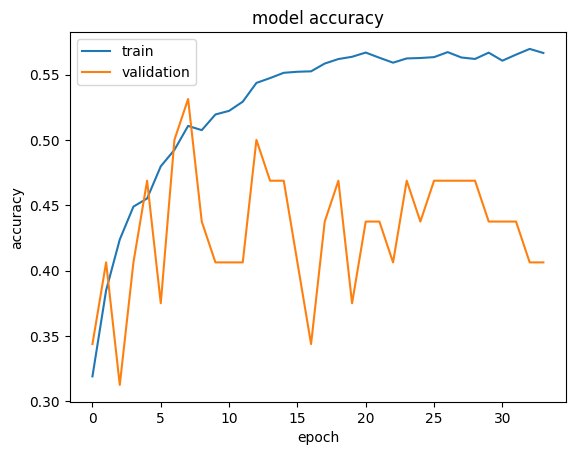

In [39]:
plt.plot(history_vgg.history["accuracy"])
plt.plot(history_vgg.history["val_accuracy"])
plt.title("model accuracy")
plt.ylabel("accuracy")
plt.xlabel("epoch")
plt.legend(["train", "validation"], loc="upper left")
plt.show()

### **Evaluating the VGG16 model**


In [40]:
# Calculate the number of steps for the entire test set to be processed
test_steps = test_generator.samples // batch_size

# If the number of samples isn't a multiple of the batch size,
# you have one more batch with the remaining samples
if test_generator.samples % batch_size > 0:
    test_steps += 1

# Evaluating the model on the test set
evaluation_results = new_vgg16_model.evaluate(test_generator, steps=test_steps)
print(f"Loss: {evaluation_results[0]}, Accuracy: {evaluation_results[1]}")

1/4 [======>.......................] - ETA: 0s - loss: 1.0774 - accuracy: 0.6250

2/4 [==============>...............] - ETA: 0s - loss: 1.0990 - accuracy: 0.4844

3/4 [=====================>........] - ETA: 0s - loss: 1.0091 - accuracy: 0.5938

4/4 [==============================] - ETA: 0s - loss: 0.9277 - accuracy: 0.6484

4/4 [==============================] - 0s 61ms/step - loss: 0.9277 - accuracy: 0.6484


Loss: 0.9276750087738037, Accuracy: 0.6484375


### **Plotting Confusion Matrix**


1/4 [======>.......................] - ETA: 0s

2/4 [==============>...............] - ETA: 0s

3/4 [=====================>........] - ETA: 0s

4/4 [==============================] - ETA: 0s

4/4 [==============================] - 0s 59ms/step


              precision    recall  f1-score   support

       happy       0.87      0.62      0.73        32
     neutral       0.46      0.34      0.39        32
         sad       0.54      0.81      0.65        32
    surprise       0.79      0.81      0.80        32

    accuracy                           0.65       128
   macro avg       0.66      0.65      0.64       128
weighted avg       0.66      0.65      0.64       128



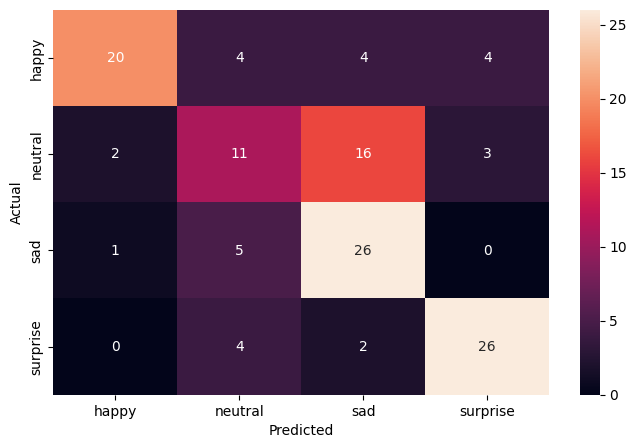

In [41]:
pred_probabilities = new_vgg16_model.predict(test_generator, steps=test_steps)
pred = np.argmax(pred_probabilities, axis=1)

# Getting the true labels from the generator
y_true = test_generator.classes

# Printing the classification report with actual emotion labels
print(classification_report(y_true, pred, target_names=CATEGORIES))

# Plotting the heatmap using confusion matrix
cm = confusion_matrix(y_true, pred)
plt.figure(figsize=(8, 5))
sns.heatmap(cm, annot=True, fmt=".0f", xticklabels=CATEGORIES, yticklabels=CATEGORIES)
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.show()

**Think About It:**

- What do you infer from the general trend in the training performance?
- Is the training accuracy consistently improving?
- Is the validation accuracy also improving similarly?


**Observations and Insights:\_\_**


**Note: You can even go back and build your own architecture on top of the VGG16 Transfer layer and see if you can improve the performance**


## **ResNet V2 Model**


In [42]:
backend.clear_session()

# Fixing the seed for random number generators so that we can ensure we receive the same output everytime
np.random.seed(42)

random.seed(42)
tf.random.set_seed(42)

In [43]:
resnet_model = ResNet50V2(weights="imagenet", include_top=False, input_shape=(img_width, img_height, 3))
# Making all the layers of the VGG model non-trainable. i.e. freezing them
for layer in resnet_model.layers:
    layer.trainable = False

resnet_model.summary()

Model: "resnet50v2"


__________________________________________________________________________________________________


 Layer (type)                Output Shape                 Param #   Connected to                  


 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            


 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             


 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           


 pool1_pad (ZeroPadding2D)   (None, 114, 114, 64)         0         ['conv1_conv[0][0]']          


 pool1_pool (MaxPooling2D)   (None, 56, 56, 64)           0         ['pool1_pad[0][0]']           


 conv2_block1_preact_bn (Ba  (None, 56, 56, 64)           256       ['pool1_pool[0][0]']          


 tchNormalization)                                                                                


 conv2_block1_preact_relu (  (None, 56, 56, 64)           0         ['conv2_block1_preact_bn[0][0]


 Activation)                                                        ']                            


 conv2_block1_1_conv (Conv2  (None, 56, 56, 64)           4096      ['conv2_block1_preact_relu[0][


 D)                                                                 0]']                          


 conv2_block1_1_bn (BatchNo  (None, 56, 56, 64)           256       ['conv2_block1_1_conv[0][0]'] 


 rmalization)                                                                                     


 conv2_block1_1_relu (Activ  (None, 56, 56, 64)           0         ['conv2_block1_1_bn[0][0]']   


 ation)                                                                                           


 conv2_block1_2_pad (ZeroPa  (None, 58, 58, 64)           0         ['conv2_block1_1_relu[0][0]'] 


 dding2D)                                                                                         


 conv2_block1_2_conv (Conv2  (None, 56, 56, 64)           36864     ['conv2_block1_2_pad[0][0]']  


 D)                                                                                               


 conv2_block1_2_bn (BatchNo  (None, 56, 56, 64)           256       ['conv2_block1_2_conv[0][0]'] 


 rmalization)                                                                                     


 conv2_block1_2_relu (Activ  (None, 56, 56, 64)           0         ['conv2_block1_2_bn[0][0]']   


 ation)                                                                                           


 conv2_block1_0_conv (Conv2  (None, 56, 56, 256)          16640     ['conv2_block1_preact_relu[0][


 D)                                                                 0]']                          


 conv2_block1_3_conv (Conv2  (None, 56, 56, 256)          16640     ['conv2_block1_2_relu[0][0]'] 


 D)                                                                                               


 conv2_block1_out (Add)      (None, 56, 56, 256)          0         ['conv2_block1_0_conv[0][0]', 


                                                                     'conv2_block1_3_conv[0][0]'] 


 conv2_block2_preact_bn (Ba  (None, 56, 56, 256)          1024      ['conv2_block1_out[0][0]']    


 tchNormalization)                                                                                


 conv2_block2_preact_relu (  (None, 56, 56, 256)          0         ['conv2_block2_preact_bn[0][0]


 Activation)                                                        ']                            


 conv2_block2_1_conv (Conv2  (None, 56, 56, 64)           16384     ['conv2_block2_preact_relu[0][


 D)                                                                 0]']                          


 conv2_block2_1_bn (BatchNo  (None, 56, 56, 64)           256       ['conv2_block2_1_conv[0][0]'] 


 rmalization)                                                                                     


 conv2_block2_1_relu (Activ  (None, 56, 56, 64)           0         ['conv2_block2_1_bn[0][0]']   


 ation)                                                                                           


 conv2_block2_2_pad (ZeroPa  (None, 58, 58, 64)           0         ['conv2_block2_1_relu[0][0]'] 


 dding2D)                                                                                         


 conv2_block2_2_conv (Conv2  (None, 56, 56, 64)           36864     ['conv2_block2_2_pad[0][0]']  


 D)                                                                                               


 conv2_block2_2_bn (BatchNo  (None, 56, 56, 64)           256       ['conv2_block2_2_conv[0][0]'] 


 rmalization)                                                                                     


 conv2_block2_2_relu (Activ  (None, 56, 56, 64)           0         ['conv2_block2_2_bn[0][0]']   


 ation)                                                                                           


 conv2_block2_3_conv (Conv2  (None, 56, 56, 256)          16640     ['conv2_block2_2_relu[0][0]'] 


 D)                                                                                               


 conv2_block2_out (Add)      (None, 56, 56, 256)          0         ['conv2_block1_out[0][0]',    


                                                                     'conv2_block2_3_conv[0][0]'] 


 conv2_block3_preact_bn (Ba  (None, 56, 56, 256)          1024      ['conv2_block2_out[0][0]']    


 tchNormalization)                                                                                


 conv2_block3_preact_relu (  (None, 56, 56, 256)          0         ['conv2_block3_preact_bn[0][0]


 Activation)                                                        ']                            


 conv2_block3_1_conv (Conv2  (None, 56, 56, 64)           16384     ['conv2_block3_preact_relu[0][


 D)                                                                 0]']                          


 conv2_block3_1_bn (BatchNo  (None, 56, 56, 64)           256       ['conv2_block3_1_conv[0][0]'] 


 rmalization)                                                                                     


 conv2_block3_1_relu (Activ  (None, 56, 56, 64)           0         ['conv2_block3_1_bn[0][0]']   


 ation)                                                                                           


 conv2_block3_2_pad (ZeroPa  (None, 58, 58, 64)           0         ['conv2_block3_1_relu[0][0]'] 


 dding2D)                                                                                         


 conv2_block3_2_conv (Conv2  (None, 28, 28, 64)           36864     ['conv2_block3_2_pad[0][0]']  


 D)                                                                                               


 conv2_block3_2_bn (BatchNo  (None, 28, 28, 64)           256       ['conv2_block3_2_conv[0][0]'] 


 rmalization)                                                                                     


 conv2_block3_2_relu (Activ  (None, 28, 28, 64)           0         ['conv2_block3_2_bn[0][0]']   


 ation)                                                                                           


 max_pooling2d (MaxPooling2  (None, 28, 28, 256)          0         ['conv2_block2_out[0][0]']    


 D)                                                                                               


 conv2_block3_3_conv (Conv2  (None, 28, 28, 256)          16640     ['conv2_block3_2_relu[0][0]'] 


 D)                                                                                               


 conv2_block3_out (Add)      (None, 28, 28, 256)          0         ['max_pooling2d[0][0]',       


                                                                     'conv2_block3_3_conv[0][0]'] 


 conv3_block1_preact_bn (Ba  (None, 28, 28, 256)          1024      ['conv2_block3_out[0][0]']    


 tchNormalization)                                                                                


 conv3_block1_preact_relu (  (None, 28, 28, 256)          0         ['conv3_block1_preact_bn[0][0]


 Activation)                                                        ']                            


 conv3_block1_1_conv (Conv2  (None, 28, 28, 128)          32768     ['conv3_block1_preact_relu[0][


 D)                                                                 0]']                          


 conv3_block1_1_bn (BatchNo  (None, 28, 28, 128)          512       ['conv3_block1_1_conv[0][0]'] 


 rmalization)                                                                                     


 conv3_block1_1_relu (Activ  (None, 28, 28, 128)          0         ['conv3_block1_1_bn[0][0]']   


 ation)                                                                                           


 conv3_block1_2_pad (ZeroPa  (None, 30, 30, 128)          0         ['conv3_block1_1_relu[0][0]'] 


 dding2D)                                                                                         


 conv3_block1_2_conv (Conv2  (None, 28, 28, 128)          147456    ['conv3_block1_2_pad[0][0]']  


 D)                                                                                               


 conv3_block1_2_bn (BatchNo  (None, 28, 28, 128)          512       ['conv3_block1_2_conv[0][0]'] 


 rmalization)                                                                                     


 conv3_block1_2_relu (Activ  (None, 28, 28, 128)          0         ['conv3_block1_2_bn[0][0]']   


 ation)                                                                                           


 conv3_block1_0_conv (Conv2  (None, 28, 28, 512)          131584    ['conv3_block1_preact_relu[0][


 D)                                                                 0]']                          


 conv3_block1_3_conv (Conv2  (None, 28, 28, 512)          66048     ['conv3_block1_2_relu[0][0]'] 


 D)                                                                                               


 conv3_block1_out (Add)      (None, 28, 28, 512)          0         ['conv3_block1_0_conv[0][0]', 


                                                                     'conv3_block1_3_conv[0][0]'] 


 conv3_block2_preact_bn (Ba  (None, 28, 28, 512)          2048      ['conv3_block1_out[0][0]']    


 tchNormalization)                                                                                


 conv3_block2_preact_relu (  (None, 28, 28, 512)          0         ['conv3_block2_preact_bn[0][0]


 Activation)                                                        ']                            


 conv3_block2_1_conv (Conv2  (None, 28, 28, 128)          65536     ['conv3_block2_preact_relu[0][


 D)                                                                 0]']                          


 conv3_block2_1_bn (BatchNo  (None, 28, 28, 128)          512       ['conv3_block2_1_conv[0][0]'] 


 rmalization)                                                                                     


 conv3_block2_1_relu (Activ  (None, 28, 28, 128)          0         ['conv3_block2_1_bn[0][0]']   


 ation)                                                                                           


 conv3_block2_2_pad (ZeroPa  (None, 30, 30, 128)          0         ['conv3_block2_1_relu[0][0]'] 


 dding2D)                                                                                         


 conv3_block2_2_conv (Conv2  (None, 28, 28, 128)          147456    ['conv3_block2_2_pad[0][0]']  


 D)                                                                                               


 conv3_block2_2_bn (BatchNo  (None, 28, 28, 128)          512       ['conv3_block2_2_conv[0][0]'] 


 rmalization)                                                                                     


 conv3_block2_2_relu (Activ  (None, 28, 28, 128)          0         ['conv3_block2_2_bn[0][0]']   


 ation)                                                                                           


 conv3_block2_3_conv (Conv2  (None, 28, 28, 512)          66048     ['conv3_block2_2_relu[0][0]'] 


 D)                                                                                               


 conv3_block2_out (Add)      (None, 28, 28, 512)          0         ['conv3_block1_out[0][0]',    


                                                                     'conv3_block2_3_conv[0][0]'] 


 conv3_block3_preact_bn (Ba  (None, 28, 28, 512)          2048      ['conv3_block2_out[0][0]']    


 tchNormalization)                                                                                


 conv3_block3_preact_relu (  (None, 28, 28, 512)          0         ['conv3_block3_preact_bn[0][0]


 Activation)                                                        ']                            


 conv3_block3_1_conv (Conv2  (None, 28, 28, 128)          65536     ['conv3_block3_preact_relu[0][


 D)                                                                 0]']                          


 conv3_block3_1_bn (BatchNo  (None, 28, 28, 128)          512       ['conv3_block3_1_conv[0][0]'] 


 rmalization)                                                                                     


 conv3_block3_1_relu (Activ  (None, 28, 28, 128)          0         ['conv3_block3_1_bn[0][0]']   


 ation)                                                                                           


 conv3_block3_2_pad (ZeroPa  (None, 30, 30, 128)          0         ['conv3_block3_1_relu[0][0]'] 


 dding2D)                                                                                         


 conv3_block3_2_conv (Conv2  (None, 28, 28, 128)          147456    ['conv3_block3_2_pad[0][0]']  


 D)                                                                                               


 conv3_block3_2_bn (BatchNo  (None, 28, 28, 128)          512       ['conv3_block3_2_conv[0][0]'] 


 rmalization)                                                                                     


 conv3_block3_2_relu (Activ  (None, 28, 28, 128)          0         ['conv3_block3_2_bn[0][0]']   


 ation)                                                                                           


 conv3_block3_3_conv (Conv2  (None, 28, 28, 512)          66048     ['conv3_block3_2_relu[0][0]'] 


 D)                                                                                               


 conv3_block3_out (Add)      (None, 28, 28, 512)          0         ['conv3_block2_out[0][0]',    


                                                                     'conv3_block3_3_conv[0][0]'] 


 conv3_block4_preact_bn (Ba  (None, 28, 28, 512)          2048      ['conv3_block3_out[0][0]']    


 tchNormalization)                                                                                


 conv3_block4_preact_relu (  (None, 28, 28, 512)          0         ['conv3_block4_preact_bn[0][0]


 Activation)                                                        ']                            


 conv3_block4_1_conv (Conv2  (None, 28, 28, 128)          65536     ['conv3_block4_preact_relu[0][


 D)                                                                 0]']                          


 conv3_block4_1_bn (BatchNo  (None, 28, 28, 128)          512       ['conv3_block4_1_conv[0][0]'] 


 rmalization)                                                                                     


 conv3_block4_1_relu (Activ  (None, 28, 28, 128)          0         ['conv3_block4_1_bn[0][0]']   


 ation)                                                                                           


 conv3_block4_2_pad (ZeroPa  (None, 30, 30, 128)          0         ['conv3_block4_1_relu[0][0]'] 


 dding2D)                                                                                         


 conv3_block4_2_conv (Conv2  (None, 14, 14, 128)          147456    ['conv3_block4_2_pad[0][0]']  


 D)                                                                                               


 conv3_block4_2_bn (BatchNo  (None, 14, 14, 128)          512       ['conv3_block4_2_conv[0][0]'] 


 rmalization)                                                                                     


 conv3_block4_2_relu (Activ  (None, 14, 14, 128)          0         ['conv3_block4_2_bn[0][0]']   


 ation)                                                                                           


 max_pooling2d_1 (MaxPoolin  (None, 14, 14, 512)          0         ['conv3_block3_out[0][0]']    


 g2D)                                                                                             


 conv3_block4_3_conv (Conv2  (None, 14, 14, 512)          66048     ['conv3_block4_2_relu[0][0]'] 


 D)                                                                                               


 conv3_block4_out (Add)      (None, 14, 14, 512)          0         ['max_pooling2d_1[0][0]',     


                                                                     'conv3_block4_3_conv[0][0]'] 


 conv4_block1_preact_bn (Ba  (None, 14, 14, 512)          2048      ['conv3_block4_out[0][0]']    


 tchNormalization)                                                                                


 conv4_block1_preact_relu (  (None, 14, 14, 512)          0         ['conv4_block1_preact_bn[0][0]


 Activation)                                                        ']                            


 conv4_block1_1_conv (Conv2  (None, 14, 14, 256)          131072    ['conv4_block1_preact_relu[0][


 D)                                                                 0]']                          


 conv4_block1_1_bn (BatchNo  (None, 14, 14, 256)          1024      ['conv4_block1_1_conv[0][0]'] 


 rmalization)                                                                                     


 conv4_block1_1_relu (Activ  (None, 14, 14, 256)          0         ['conv4_block1_1_bn[0][0]']   


 ation)                                                                                           


 conv4_block1_2_pad (ZeroPa  (None, 16, 16, 256)          0         ['conv4_block1_1_relu[0][0]'] 


 dding2D)                                                                                         


 conv4_block1_2_conv (Conv2  (None, 14, 14, 256)          589824    ['conv4_block1_2_pad[0][0]']  


 D)                                                                                               


 conv4_block1_2_bn (BatchNo  (None, 14, 14, 256)          1024      ['conv4_block1_2_conv[0][0]'] 


 rmalization)                                                                                     


 conv4_block1_2_relu (Activ  (None, 14, 14, 256)          0         ['conv4_block1_2_bn[0][0]']   


 ation)                                                                                           


 conv4_block1_0_conv (Conv2  (None, 14, 14, 1024)         525312    ['conv4_block1_preact_relu[0][


 D)                                                                 0]']                          


 conv4_block1_3_conv (Conv2  (None, 14, 14, 1024)         263168    ['conv4_block1_2_relu[0][0]'] 


 D)                                                                                               


 conv4_block1_out (Add)      (None, 14, 14, 1024)         0         ['conv4_block1_0_conv[0][0]', 


                                                                     'conv4_block1_3_conv[0][0]'] 


 conv4_block2_preact_bn (Ba  (None, 14, 14, 1024)         4096      ['conv4_block1_out[0][0]']    


 tchNormalization)                                                                                


 conv4_block2_preact_relu (  (None, 14, 14, 1024)         0         ['conv4_block2_preact_bn[0][0]


 Activation)                                                        ']                            


 conv4_block2_1_conv (Conv2  (None, 14, 14, 256)          262144    ['conv4_block2_preact_relu[0][


 D)                                                                 0]']                          


 conv4_block2_1_bn (BatchNo  (None, 14, 14, 256)          1024      ['conv4_block2_1_conv[0][0]'] 


 rmalization)                                                                                     


 conv4_block2_1_relu (Activ  (None, 14, 14, 256)          0         ['conv4_block2_1_bn[0][0]']   


 ation)                                                                                           


 conv4_block2_2_pad (ZeroPa  (None, 16, 16, 256)          0         ['conv4_block2_1_relu[0][0]'] 


 dding2D)                                                                                         


 conv4_block2_2_conv (Conv2  (None, 14, 14, 256)          589824    ['conv4_block2_2_pad[0][0]']  


 D)                                                                                               


 conv4_block2_2_bn (BatchNo  (None, 14, 14, 256)          1024      ['conv4_block2_2_conv[0][0]'] 


 rmalization)                                                                                     


 conv4_block2_2_relu (Activ  (None, 14, 14, 256)          0         ['conv4_block2_2_bn[0][0]']   


 ation)                                                                                           


 conv4_block2_3_conv (Conv2  (None, 14, 14, 1024)         263168    ['conv4_block2_2_relu[0][0]'] 


 D)                                                                                               


 conv4_block2_out (Add)      (None, 14, 14, 1024)         0         ['conv4_block1_out[0][0]',    


                                                                     'conv4_block2_3_conv[0][0]'] 


 conv4_block3_preact_bn (Ba  (None, 14, 14, 1024)         4096      ['conv4_block2_out[0][0]']    


 tchNormalization)                                                                                


 conv4_block3_preact_relu (  (None, 14, 14, 1024)         0         ['conv4_block3_preact_bn[0][0]


 Activation)                                                        ']                            


 conv4_block3_1_conv (Conv2  (None, 14, 14, 256)          262144    ['conv4_block3_preact_relu[0][


 D)                                                                 0]']                          


 conv4_block3_1_bn (BatchNo  (None, 14, 14, 256)          1024      ['conv4_block3_1_conv[0][0]'] 


 rmalization)                                                                                     


 conv4_block3_1_relu (Activ  (None, 14, 14, 256)          0         ['conv4_block3_1_bn[0][0]']   


 ation)                                                                                           


 conv4_block3_2_pad (ZeroPa  (None, 16, 16, 256)          0         ['conv4_block3_1_relu[0][0]'] 


 dding2D)                                                                                         


 conv4_block3_2_conv (Conv2  (None, 14, 14, 256)          589824    ['conv4_block3_2_pad[0][0]']  


 D)                                                                                               


 conv4_block3_2_bn (BatchNo  (None, 14, 14, 256)          1024      ['conv4_block3_2_conv[0][0]'] 


 rmalization)                                                                                     


 conv4_block3_2_relu (Activ  (None, 14, 14, 256)          0         ['conv4_block3_2_bn[0][0]']   


 ation)                                                                                           


 conv4_block3_3_conv (Conv2  (None, 14, 14, 1024)         263168    ['conv4_block3_2_relu[0][0]'] 


 D)                                                                                               


 conv4_block3_out (Add)      (None, 14, 14, 1024)         0         ['conv4_block2_out[0][0]',    


                                                                     'conv4_block3_3_conv[0][0]'] 


 conv4_block4_preact_bn (Ba  (None, 14, 14, 1024)         4096      ['conv4_block3_out[0][0]']    


 tchNormalization)                                                                                


 conv4_block4_preact_relu (  (None, 14, 14, 1024)         0         ['conv4_block4_preact_bn[0][0]


 Activation)                                                        ']                            


 conv4_block4_1_conv (Conv2  (None, 14, 14, 256)          262144    ['conv4_block4_preact_relu[0][


 D)                                                                 0]']                          


 conv4_block4_1_bn (BatchNo  (None, 14, 14, 256)          1024      ['conv4_block4_1_conv[0][0]'] 


 rmalization)                                                                                     


 conv4_block4_1_relu (Activ  (None, 14, 14, 256)          0         ['conv4_block4_1_bn[0][0]']   


 ation)                                                                                           


 conv4_block4_2_pad (ZeroPa  (None, 16, 16, 256)          0         ['conv4_block4_1_relu[0][0]'] 


 dding2D)                                                                                         


 conv4_block4_2_conv (Conv2  (None, 14, 14, 256)          589824    ['conv4_block4_2_pad[0][0]']  


 D)                                                                                               


 conv4_block4_2_bn (BatchNo  (None, 14, 14, 256)          1024      ['conv4_block4_2_conv[0][0]'] 


 rmalization)                                                                                     


 conv4_block4_2_relu (Activ  (None, 14, 14, 256)          0         ['conv4_block4_2_bn[0][0]']   


 ation)                                                                                           


 conv4_block4_3_conv (Conv2  (None, 14, 14, 1024)         263168    ['conv4_block4_2_relu[0][0]'] 


 D)                                                                                               


 conv4_block4_out (Add)      (None, 14, 14, 1024)         0         ['conv4_block3_out[0][0]',    


                                                                     'conv4_block4_3_conv[0][0]'] 


 conv4_block5_preact_bn (Ba  (None, 14, 14, 1024)         4096      ['conv4_block4_out[0][0]']    


 tchNormalization)                                                                                


 conv4_block5_preact_relu (  (None, 14, 14, 1024)         0         ['conv4_block5_preact_bn[0][0]


 Activation)                                                        ']                            


 conv4_block5_1_conv (Conv2  (None, 14, 14, 256)          262144    ['conv4_block5_preact_relu[0][


 D)                                                                 0]']                          


 conv4_block5_1_bn (BatchNo  (None, 14, 14, 256)          1024      ['conv4_block5_1_conv[0][0]'] 


 rmalization)                                                                                     


 conv4_block5_1_relu (Activ  (None, 14, 14, 256)          0         ['conv4_block5_1_bn[0][0]']   


 ation)                                                                                           


 conv4_block5_2_pad (ZeroPa  (None, 16, 16, 256)          0         ['conv4_block5_1_relu[0][0]'] 


 dding2D)                                                                                         


 conv4_block5_2_conv (Conv2  (None, 14, 14, 256)          589824    ['conv4_block5_2_pad[0][0]']  


 D)                                                                                               


 conv4_block5_2_bn (BatchNo  (None, 14, 14, 256)          1024      ['conv4_block5_2_conv[0][0]'] 


 rmalization)                                                                                     


 conv4_block5_2_relu (Activ  (None, 14, 14, 256)          0         ['conv4_block5_2_bn[0][0]']   


 ation)                                                                                           


 conv4_block5_3_conv (Conv2  (None, 14, 14, 1024)         263168    ['conv4_block5_2_relu[0][0]'] 


 D)                                                                                               


 conv4_block5_out (Add)      (None, 14, 14, 1024)         0         ['conv4_block4_out[0][0]',    


                                                                     'conv4_block5_3_conv[0][0]'] 


 conv4_block6_preact_bn (Ba  (None, 14, 14, 1024)         4096      ['conv4_block5_out[0][0]']    


 tchNormalization)                                                                                


 conv4_block6_preact_relu (  (None, 14, 14, 1024)         0         ['conv4_block6_preact_bn[0][0]


 Activation)                                                        ']                            


 conv4_block6_1_conv (Conv2  (None, 14, 14, 256)          262144    ['conv4_block6_preact_relu[0][


 D)                                                                 0]']                          


 conv4_block6_1_bn (BatchNo  (None, 14, 14, 256)          1024      ['conv4_block6_1_conv[0][0]'] 


 rmalization)                                                                                     


 conv4_block6_1_relu (Activ  (None, 14, 14, 256)          0         ['conv4_block6_1_bn[0][0]']   


 ation)                                                                                           


 conv4_block6_2_pad (ZeroPa  (None, 16, 16, 256)          0         ['conv4_block6_1_relu[0][0]'] 


 dding2D)                                                                                         


 conv4_block6_2_conv (Conv2  (None, 7, 7, 256)            589824    ['conv4_block6_2_pad[0][0]']  


 D)                                                                                               


 conv4_block6_2_bn (BatchNo  (None, 7, 7, 256)            1024      ['conv4_block6_2_conv[0][0]'] 


 rmalization)                                                                                     


 conv4_block6_2_relu (Activ  (None, 7, 7, 256)            0         ['conv4_block6_2_bn[0][0]']   


 ation)                                                                                           


 max_pooling2d_2 (MaxPoolin  (None, 7, 7, 1024)           0         ['conv4_block5_out[0][0]']    


 g2D)                                                                                             


 conv4_block6_3_conv (Conv2  (None, 7, 7, 1024)           263168    ['conv4_block6_2_relu[0][0]'] 


 D)                                                                                               


 conv4_block6_out (Add)      (None, 7, 7, 1024)           0         ['max_pooling2d_2[0][0]',     


                                                                     'conv4_block6_3_conv[0][0]'] 


 conv5_block1_preact_bn (Ba  (None, 7, 7, 1024)           4096      ['conv4_block6_out[0][0]']    


 tchNormalization)                                                                                


 conv5_block1_preact_relu (  (None, 7, 7, 1024)           0         ['conv5_block1_preact_bn[0][0]


 Activation)                                                        ']                            


 conv5_block1_1_conv (Conv2  (None, 7, 7, 512)            524288    ['conv5_block1_preact_relu[0][


 D)                                                                 0]']                          


 conv5_block1_1_bn (BatchNo  (None, 7, 7, 512)            2048      ['conv5_block1_1_conv[0][0]'] 


 rmalization)                                                                                     


 conv5_block1_1_relu (Activ  (None, 7, 7, 512)            0         ['conv5_block1_1_bn[0][0]']   


 ation)                                                                                           


 conv5_block1_2_pad (ZeroPa  (None, 9, 9, 512)            0         ['conv5_block1_1_relu[0][0]'] 


 dding2D)                                                                                         


 conv5_block1_2_conv (Conv2  (None, 7, 7, 512)            2359296   ['conv5_block1_2_pad[0][0]']  


 D)                                                                                               


 conv5_block1_2_bn (BatchNo  (None, 7, 7, 512)            2048      ['conv5_block1_2_conv[0][0]'] 


 rmalization)                                                                                     


 conv5_block1_2_relu (Activ  (None, 7, 7, 512)            0         ['conv5_block1_2_bn[0][0]']   


 ation)                                                                                           


 conv5_block1_0_conv (Conv2  (None, 7, 7, 2048)           2099200   ['conv5_block1_preact_relu[0][


 D)                                                                 0]']                          


 conv5_block1_3_conv (Conv2  (None, 7, 7, 2048)           1050624   ['conv5_block1_2_relu[0][0]'] 


 D)                                                                                               


 conv5_block1_out (Add)      (None, 7, 7, 2048)           0         ['conv5_block1_0_conv[0][0]', 


                                                                     'conv5_block1_3_conv[0][0]'] 


 conv5_block2_preact_bn (Ba  (None, 7, 7, 2048)           8192      ['conv5_block1_out[0][0]']    


 tchNormalization)                                                                                


 conv5_block2_preact_relu (  (None, 7, 7, 2048)           0         ['conv5_block2_preact_bn[0][0]


 Activation)                                                        ']                            


 conv5_block2_1_conv (Conv2  (None, 7, 7, 512)            1048576   ['conv5_block2_preact_relu[0][


 D)                                                                 0]']                          


 conv5_block2_1_bn (BatchNo  (None, 7, 7, 512)            2048      ['conv5_block2_1_conv[0][0]'] 


 rmalization)                                                                                     


 conv5_block2_1_relu (Activ  (None, 7, 7, 512)            0         ['conv5_block2_1_bn[0][0]']   


 ation)                                                                                           


 conv5_block2_2_pad (ZeroPa  (None, 9, 9, 512)            0         ['conv5_block2_1_relu[0][0]'] 


 dding2D)                                                                                         


 conv5_block2_2_conv (Conv2  (None, 7, 7, 512)            2359296   ['conv5_block2_2_pad[0][0]']  


 D)                                                                                               


 conv5_block2_2_bn (BatchNo  (None, 7, 7, 512)            2048      ['conv5_block2_2_conv[0][0]'] 


 rmalization)                                                                                     


 conv5_block2_2_relu (Activ  (None, 7, 7, 512)            0         ['conv5_block2_2_bn[0][0]']   


 ation)                                                                                           


 conv5_block2_3_conv (Conv2  (None, 7, 7, 2048)           1050624   ['conv5_block2_2_relu[0][0]'] 


 D)                                                                                               


 conv5_block2_out (Add)      (None, 7, 7, 2048)           0         ['conv5_block1_out[0][0]',    


                                                                     'conv5_block2_3_conv[0][0]'] 


 conv5_block3_preact_bn (Ba  (None, 7, 7, 2048)           8192      ['conv5_block2_out[0][0]']    


 tchNormalization)                                                                                


 conv5_block3_preact_relu (  (None, 7, 7, 2048)           0         ['conv5_block3_preact_bn[0][0]


 Activation)                                                        ']                            


 conv5_block3_1_conv (Conv2  (None, 7, 7, 512)            1048576   ['conv5_block3_preact_relu[0][


 D)                                                                 0]']                          


 conv5_block3_1_bn (BatchNo  (None, 7, 7, 512)            2048      ['conv5_block3_1_conv[0][0]'] 


 rmalization)                                                                                     


 conv5_block3_1_relu (Activ  (None, 7, 7, 512)            0         ['conv5_block3_1_bn[0][0]']   


 ation)                                                                                           


 conv5_block3_2_pad (ZeroPa  (None, 9, 9, 512)            0         ['conv5_block3_1_relu[0][0]'] 


 dding2D)                                                                                         


 conv5_block3_2_conv (Conv2  (None, 7, 7, 512)            2359296   ['conv5_block3_2_pad[0][0]']  


 D)                                                                                               


 conv5_block3_2_bn (BatchNo  (None, 7, 7, 512)            2048      ['conv5_block3_2_conv[0][0]'] 


 rmalization)                                                                                     


 conv5_block3_2_relu (Activ  (None, 7, 7, 512)            0         ['conv5_block3_2_bn[0][0]']   


 ation)                                                                                           


 conv5_block3_3_conv (Conv2  (None, 7, 7, 2048)           1050624   ['conv5_block3_2_relu[0][0]'] 


 D)                                                                                               


 conv5_block3_out (Add)      (None, 7, 7, 2048)           0         ['conv5_block2_out[0][0]',    


                                                                     'conv5_block3_3_conv[0][0]'] 


 post_bn (BatchNormalizatio  (None, 7, 7, 2048)           8192      ['conv5_block3_out[0][0]']    


 n)                                                                                               


 post_relu (Activation)      (None, 7, 7, 2048)           0         ['post_bn[0][0]']             


Total params: 23564800 (89.89 MB)


Trainable params: 0 (0.00 Byte)


Non-trainable params: 23564800 (89.89 MB)


__________________________________________________________________________________________________


### **Model Building**

- Import Resnet v2 upto the layer of your choice and add Fully Connected layers on top of it.


In [44]:
new_resnet_model = Sequential()
new_resnet_model.add(resnet_model)

# Reduces each feature map to a single value by averaging all elements
new_resnet_model.add(GlobalAveragePooling2D())

# Adding a dense output layer
new_resnet_model.add(Dense(512, activation="relu"))
new_resnet_model.add(Dropout(0.5))
new_resnet_model.add(Dense(128, activation="relu"))
new_resnet_model.add(Dropout(0.5))
new_resnet_model.add(Dense(4, activation="softmax"))

# Using Adam Optimizer
optimizer = Adam(learning_rate=0.0005)

### **Compiling and Training the Model**


In [45]:
new_resnet_model.compile(optimizer=optimizer, loss="categorical_crossentropy", metrics=["accuracy"])
new_resnet_model.summary()

Model: "sequential"


_________________________________________________________________


 Layer (type)                Output Shape              Param #   


 resnet50v2 (Functional)     (None, 7, 7, 2048)        23564800  


 global_average_pooling2d (  (None, 2048)              0         


 GlobalAveragePooling2D)                                         


 dense (Dense)               (None, 512)               1049088   


 dropout (Dropout)           (None, 512)               0         


 dense_1 (Dense)             (None, 128)               65664     


 dropout_1 (Dropout)         (None, 128)               0         


 dense_2 (Dense)             (None, 4)                 516       


Total params: 24680068 (94.15 MB)


Trainable params: 1115268 (4.25 MB)


Non-trainable params: 23564800 (89.89 MB)


_________________________________________________________________


In [46]:
# Get the current time
current_time = datetime.now().strftime("%Y%m%d-%H%M%S")

# Set up Early Stopping with a patience 7 but acting after at least 20 epochs
delayed_early_stopping = DelayedEarlyStopping(
    monitor="val_loss", patience=7, verbose=1, restore_best_weights=True, start_epoch=20
)

# Define the learning rate scheduler callback
reduce_lr = ReduceLROnPlateau(monitor="val_loss", factor=0.2, patience=5, min_lr=0.00001, verbose=1)

mc = ModelCheckpoint(
    f"{results_path}/best_model_resnet_{current_time}.keras",
    monitor="val_accuracy",
    mode="max",
    verbose=1,
    save_best_only=True,
)

# Pulling a single large batch of random validation data for doing the validation after each epoch
validationX, validationY = validation_generator.next()

# Fitting the model with 40 epochs and using validation set
history_resnet = new_resnet_model.fit(
    train_generator,
    epochs=40,
    validation_data=(validationX, validationY),
    callbacks=[delayed_early_stopping, mc, reduce_lr],
)

Epoch 1/40


  1/473 [..............................] - ETA: 20:15 - loss: 143.0437 - accuracy: 0.2812

  3/473 [..............................] - ETA: 18s - loss: 133.2873 - accuracy: 0.1979  

  4/473 [..............................] - ETA: 35s - loss: 128.4026 - accuracy: 0.2109

  5/473 [..............................] - ETA: 44s - loss: 119.4319 - accuracy: 0.2313

  6/473 [..............................] - ETA: 53s - loss: 113.9606 - accuracy: 0.2448

  7/473 [..............................] - ETA: 57s - loss: 110.0315 - accuracy: 0.2455

  8/473 [..............................] - ETA: 1:01 - loss: 106.2024 - accuracy: 0.2500

  9/473 [..............................] - ETA: 1:02 - loss: 103.1691 - accuracy: 0.2326

 10/473 [..............................] - ETA: 1:05 - loss: 101.1482 - accuracy: 0.2313

 11/473 [..............................] - ETA: 1:06 - loss: 100.5124 - accuracy: 0.2273

 12/473 [..............................] - ETA: 1:07 - loss: 98.6079 - accuracy: 0.2266 

 13/473 [..............................] - ETA: 1:07 - loss: 97.7986 - accuracy: 0.2260

 14/473 [..............................] - ETA: 1:08 - loss: 94.2580 - accuracy: 0.2321

 15/473 [..............................] - ETA: 1:08 - loss: 91.6384 - accuracy: 0.2313

 16/473 [>.............................] - ETA: 1:09 - loss: 89.1753 - accuracy: 0.2324

 17/473 [>.............................] - ETA: 1:09 - loss: 86.7072 - accuracy: 0.2408

 18/473 [>.............................] - ETA: 1:10 - loss: 84.6957 - accuracy: 0.2431

 19/473 [>.............................] - ETA: 1:10 - loss: 83.1979 - accuracy: 0.2451

 20/473 [>.............................] - ETA: 1:10 - loss: 81.2974 - accuracy: 0.2469

 21/473 [>.............................] - ETA: 1:10 - loss: 79.7780 - accuracy: 0.2455

 22/473 [>.............................] - ETA: 1:09 - loss: 78.9684 - accuracy: 0.2443

 23/473 [>.............................] - ETA: 1:10 - loss: 77.3769 - accuracy: 0.2432

 24/473 [>.............................] - ETA: 1:10 - loss: 76.2857 - accuracy: 0.2422

 25/473 [>.............................] - ETA: 1:10 - loss: 74.8203 - accuracy: 0.2387

 26/473 [>.............................] - ETA: 1:10 - loss: 73.4075 - accuracy: 0.2404

 27/473 [>.............................] - ETA: 1:10 - loss: 72.1795 - accuracy: 0.2419

 28/473 [>.............................] - ETA: 1:09 - loss: 71.5830 - accuracy: 0.2400

 29/473 [>.............................] - ETA: 1:10 - loss: 70.4267 - accuracy: 0.2425

 30/473 [>.............................] - ETA: 1:10 - loss: 68.9911 - accuracy: 0.2490

 31/473 [>.............................] - ETA: 1:10 - loss: 67.7993 - accuracy: 0.2500

 32/473 [=>............................] - ETA: 1:10 - loss: 66.5761 - accuracy: 0.2500

 33/473 [=>............................] - ETA: 1:10 - loss: 65.4713 - accuracy: 0.2509

 34/473 [=>............................] - ETA: 1:10 - loss: 64.3524 - accuracy: 0.2528

 35/473 [=>............................] - ETA: 1:10 - loss: 63.7375 - accuracy: 0.2491

 36/473 [=>............................] - ETA: 1:09 - loss: 62.5802 - accuracy: 0.2526

 37/473 [=>............................] - ETA: 1:09 - loss: 61.4431 - accuracy: 0.2525

 38/473 [=>............................] - ETA: 1:09 - loss: 60.4222 - accuracy: 0.2525

 39/473 [=>............................] - ETA: 1:09 - loss: 59.4565 - accuracy: 0.2500

 40/473 [=>............................] - ETA: 1:09 - loss: 58.5556 - accuracy: 0.2500

 41/473 [=>............................] - ETA: 1:09 - loss: 57.8697 - accuracy: 0.2500

 42/473 [=>............................] - ETA: 1:09 - loss: 57.1658 - accuracy: 0.2470

 43/473 [=>............................] - ETA: 1:09 - loss: 56.3258 - accuracy: 0.2435

 44/473 [=>............................] - ETA: 1:09 - loss: 55.5337 - accuracy: 0.2457

 45/473 [=>............................] - ETA: 1:09 - loss: 54.7599 - accuracy: 0.2458

 46/473 [=>............................] - ETA: 1:09 - loss: 54.0004 - accuracy: 0.2439

 47/473 [=>............................] - ETA: 1:08 - loss: 53.1961 - accuracy: 0.2420

 48/473 [==>...........................] - ETA: 1:09 - loss: 52.4487 - accuracy: 0.2435

 49/473 [==>...........................] - ETA: 1:08 - loss: 51.7030 - accuracy: 0.2430

 50/473 [==>...........................] - ETA: 1:08 - loss: 51.0503 - accuracy: 0.2425

 51/473 [==>...........................] - ETA: 1:08 - loss: 50.3938 - accuracy: 0.2420

 52/473 [==>...........................] - ETA: 1:08 - loss: 49.5989 - accuracy: 0.2434

 53/473 [==>...........................] - ETA: 1:08 - loss: 48.8183 - accuracy: 0.2476

 54/473 [==>...........................] - ETA: 1:08 - loss: 48.3252 - accuracy: 0.2459

 55/473 [==>...........................] - ETA: 1:08 - loss: 47.6899 - accuracy: 0.2460

 56/473 [==>...........................] - ETA: 1:08 - loss: 47.0405 - accuracy: 0.2483

 57/473 [==>...........................] - ETA: 1:07 - loss: 46.3873 - accuracy: 0.2495

 58/473 [==>...........................] - ETA: 1:07 - loss: 45.8584 - accuracy: 0.2484

 59/473 [==>...........................] - ETA: 1:07 - loss: 45.2749 - accuracy: 0.2484

 60/473 [==>...........................] - ETA: 1:07 - loss: 44.7195 - accuracy: 0.2474

 61/473 [==>...........................] - ETA: 1:07 - loss: 44.1910 - accuracy: 0.2459

 62/473 [==>...........................] - ETA: 1:07 - loss: 43.6744 - accuracy: 0.2450

 63/473 [==>...........................] - ETA: 1:07 - loss: 43.1742 - accuracy: 0.2445

 64/473 [===>..........................] - ETA: 1:07 - loss: 42.7213 - accuracy: 0.2441

 65/473 [===>..........................] - ETA: 1:07 - loss: 42.2557 - accuracy: 0.2428

 66/473 [===>..........................] - ETA: 1:06 - loss: 41.7647 - accuracy: 0.2434

 67/473 [===>..........................] - ETA: 1:06 - loss: 41.2493 - accuracy: 0.2439

 68/473 [===>..........................] - ETA: 1:06 - loss: 40.8465 - accuracy: 0.2426

 69/473 [===>..........................] - ETA: 1:06 - loss: 40.4316 - accuracy: 0.2414

 70/473 [===>..........................] - ETA: 1:06 - loss: 39.9616 - accuracy: 0.2429

 71/473 [===>..........................] - ETA: 1:06 - loss: 39.5497 - accuracy: 0.2425

 72/473 [===>..........................] - ETA: 1:06 - loss: 39.0988 - accuracy: 0.2435

 73/473 [===>..........................] - ETA: 1:05 - loss: 38.6461 - accuracy: 0.2444

 74/473 [===>..........................] - ETA: 1:05 - loss: 38.2258 - accuracy: 0.2441

 75/473 [===>..........................] - ETA: 1:05 - loss: 37.8254 - accuracy: 0.2438

 76/473 [===>..........................] - ETA: 1:05 - loss: 37.4221 - accuracy: 0.2447

 77/473 [===>..........................] - ETA: 1:05 - loss: 37.0629 - accuracy: 0.2439

 78/473 [===>..........................] - ETA: 1:05 - loss: 36.6831 - accuracy: 0.2448

 79/473 [====>.........................] - ETA: 1:05 - loss: 36.3498 - accuracy: 0.2429

 80/473 [====>.........................] - ETA: 1:04 - loss: 35.9810 - accuracy: 0.2426

 81/473 [====>.........................] - ETA: 1:04 - loss: 35.6412 - accuracy: 0.2434

 82/473 [====>.........................] - ETA: 1:04 - loss: 35.2797 - accuracy: 0.2443

 83/473 [====>.........................] - ETA: 1:04 - loss: 34.9444 - accuracy: 0.2436

 84/473 [====>.........................] - ETA: 1:04 - loss: 34.6191 - accuracy: 0.2444

 85/473 [====>.........................] - ETA: 1:04 - loss: 34.3165 - accuracy: 0.2445

 86/473 [====>.........................] - ETA: 1:03 - loss: 33.9811 - accuracy: 0.2453

 87/473 [====>.........................] - ETA: 1:03 - loss: 33.6677 - accuracy: 0.2443

 88/473 [====>.........................] - ETA: 1:03 - loss: 33.3822 - accuracy: 0.2443

 89/473 [====>.........................] - ETA: 1:03 - loss: 33.1077 - accuracy: 0.2440

 90/473 [====>.........................] - ETA: 1:03 - loss: 32.8239 - accuracy: 0.2434

 91/473 [====>.........................] - ETA: 1:03 - loss: 32.5484 - accuracy: 0.2414

 92/473 [====>.........................] - ETA: 1:02 - loss: 32.2418 - accuracy: 0.2422

 93/473 [====>.........................] - ETA: 1:02 - loss: 31.9537 - accuracy: 0.2436

 94/473 [====>.........................] - ETA: 1:02 - loss: 31.6893 - accuracy: 0.2440

 95/473 [=====>........................] - ETA: 1:02 - loss: 31.4392 - accuracy: 0.2431

 96/473 [=====>........................] - ETA: 1:02 - loss: 31.1751 - accuracy: 0.2425

 97/473 [=====>........................] - ETA: 1:02 - loss: 30.8932 - accuracy: 0.2442

 98/473 [=====>........................] - ETA: 1:01 - loss: 30.6349 - accuracy: 0.2433

 99/473 [=====>........................] - ETA: 1:01 - loss: 30.3705 - accuracy: 0.2443

100/473 [=====>........................] - ETA: 1:01 - loss: 30.1130 - accuracy: 0.2444

101/473 [=====>........................] - ETA: 1:01 - loss: 29.8547 - accuracy: 0.2450

102/473 [=====>........................] - ETA: 1:00 - loss: 29.6051 - accuracy: 0.2457

103/473 [=====>........................] - ETA: 1:00 - loss: 29.3803 - accuracy: 0.2454

104/473 [=====>........................] - ETA: 1:00 - loss: 29.1424 - accuracy: 0.2467

105/473 [=====>........................] - ETA: 1:00 - loss: 28.9636 - accuracy: 0.2452

106/473 [=====>........................] - ETA: 1:00 - loss: 28.7350 - accuracy: 0.2465

107/473 [=====>........................] - ETA: 59s - loss: 28.5265 - accuracy: 0.2465 

108/473 [=====>........................] - ETA: 59s - loss: 28.3094 - accuracy: 0.2462

109/473 [=====>........................] - ETA: 59s - loss: 28.0833 - accuracy: 0.2471

110/473 [=====>........................] - ETA: 59s - loss: 27.8776 - accuracy: 0.2463

111/473 [======>.......................] - ETA: 59s - loss: 27.6770 - accuracy: 0.2461

112/473 [======>.......................] - ETA: 58s - loss: 27.4795 - accuracy: 0.2464

113/473 [======>.......................] - ETA: 58s - loss: 27.2788 - accuracy: 0.2472

114/473 [======>.......................] - ETA: 58s - loss: 27.0854 - accuracy: 0.2467

115/473 [======>.......................] - ETA: 58s - loss: 26.8982 - accuracy: 0.2459

116/473 [======>.......................] - ETA: 57s - loss: 26.7097 - accuracy: 0.2465

117/473 [======>.......................] - ETA: 57s - loss: 26.5200 - accuracy: 0.2471

118/473 [======>.......................] - ETA: 57s - loss: 26.3377 - accuracy: 0.2471

119/473 [======>.......................] - ETA: 57s - loss: 26.1435 - accuracy: 0.2482

120/473 [======>.......................] - ETA: 57s - loss: 25.9617 - accuracy: 0.2490

121/473 [======>.......................] - ETA: 57s - loss: 25.7826 - accuracy: 0.2495

122/473 [======>.......................] - ETA: 56s - loss: 25.6018 - accuracy: 0.2485

123/473 [======>.......................] - ETA: 56s - loss: 25.4258 - accuracy: 0.2492

124/473 [======>.......................] - ETA: 56s - loss: 25.2662 - accuracy: 0.2492

125/473 [======>.......................] - ETA: 56s - loss: 25.0955 - accuracy: 0.2492

126/473 [======>.......................] - ETA: 56s - loss: 24.9443 - accuracy: 0.2490

127/473 [=======>......................] - ETA: 56s - loss: 24.7928 - accuracy: 0.2490

128/473 [=======>......................] - ETA: 55s - loss: 24.6375 - accuracy: 0.2488

129/473 [=======>......................] - ETA: 55s - loss: 24.4794 - accuracy: 0.2488

130/473 [=======>......................] - ETA: 55s - loss: 24.3208 - accuracy: 0.2488

131/473 [=======>......................] - ETA: 55s - loss: 24.1624 - accuracy: 0.2495

132/473 [=======>......................] - ETA: 55s - loss: 24.0096 - accuracy: 0.2495

133/473 [=======>......................] - ETA: 55s - loss: 23.8750 - accuracy: 0.2481

134/473 [=======>......................] - ETA: 55s - loss: 23.7290 - accuracy: 0.2484

135/473 [=======>......................] - ETA: 54s - loss: 23.5889 - accuracy: 0.2477

136/473 [=======>......................] - ETA: 54s - loss: 23.4452 - accuracy: 0.2482

137/473 [=======>......................] - ETA: 54s - loss: 23.2991 - accuracy: 0.2482

138/473 [=======>......................] - ETA: 54s - loss: 23.1749 - accuracy: 0.2473

139/473 [=======>......................] - ETA: 54s - loss: 23.0339 - accuracy: 0.2480

140/473 [=======>......................] - ETA: 54s - loss: 22.8988 - accuracy: 0.2482

141/473 [=======>......................] - ETA: 53s - loss: 22.7662 - accuracy: 0.2482

142/473 [========>.....................] - ETA: 53s - loss: 22.6312 - accuracy: 0.2489

143/473 [========>.....................] - ETA: 53s - loss: 22.5014 - accuracy: 0.2491

144/473 [========>.....................] - ETA: 53s - loss: 22.3781 - accuracy: 0.2487

145/473 [========>.....................] - ETA: 53s - loss: 22.2530 - accuracy: 0.2483

146/473 [========>.....................] - ETA: 53s - loss: 22.1261 - accuracy: 0.2481

147/473 [========>.....................] - ETA: 52s - loss: 21.9962 - accuracy: 0.2485

148/473 [========>.....................] - ETA: 52s - loss: 21.8777 - accuracy: 0.2479

149/473 [========>.....................] - ETA: 52s - loss: 21.7588 - accuracy: 0.2477

150/473 [========>.....................] - ETA: 52s - loss: 21.6503 - accuracy: 0.2473

151/473 [========>.....................] - ETA: 52s - loss: 21.5329 - accuracy: 0.2477

152/473 [========>.....................] - ETA: 52s - loss: 21.4195 - accuracy: 0.2469

153/473 [========>.....................] - ETA: 51s - loss: 21.3012 - accuracy: 0.2473

154/473 [========>.....................] - ETA: 51s - loss: 21.1912 - accuracy: 0.2472

155/473 [========>.....................] - ETA: 51s - loss: 21.0839 - accuracy: 0.2470

156/473 [========>.....................] - ETA: 51s - loss: 20.9680 - accuracy: 0.2474

157/473 [========>.....................] - ETA: 51s - loss: 20.8566 - accuracy: 0.2468

158/473 [=========>....................] - ETA: 51s - loss: 20.7426 - accuracy: 0.2474

159/473 [=========>....................] - ETA: 50s - loss: 20.6292 - accuracy: 0.2474

160/473 [=========>....................] - ETA: 50s - loss: 20.5216 - accuracy: 0.2467

161/473 [=========>....................] - ETA: 50s - loss: 20.4122 - accuracy: 0.2467

162/473 [=========>....................] - ETA: 50s - loss: 20.3061 - accuracy: 0.2469

163/473 [=========>....................] - ETA: 50s - loss: 20.2917 - accuracy: 0.2469

165/473 [=========>....................] - ETA: 50s - loss: 20.0897 - accuracy: 0.2475

167/473 [=========>....................] - ETA: 49s - loss: 19.8971 - accuracy: 0.2475

168/473 [=========>....................] - ETA: 49s - loss: 19.8018 - accuracy: 0.2470

169/473 [=========>....................] - ETA: 49s - loss: 19.6993 - accuracy: 0.2470

170/473 [=========>....................] - ETA: 49s - loss: 19.6022 - accuracy: 0.2468

171/473 [=========>....................] - ETA: 48s - loss: 19.5060 - accuracy: 0.2466

172/473 [=========>....................] - ETA: 48s - loss: 19.4083 - accuracy: 0.2467

173/473 [=========>....................] - ETA: 48s - loss: 19.3095 - accuracy: 0.2465

174/473 [==========>...................] - ETA: 48s - loss: 19.2112 - accuracy: 0.2469

175/473 [==========>...................] - ETA: 48s - loss: 19.1122 - accuracy: 0.2473

176/473 [==========>...................] - ETA: 48s - loss: 19.0178 - accuracy: 0.2475

177/473 [==========>...................] - ETA: 47s - loss: 18.9277 - accuracy: 0.2469

178/473 [==========>...................] - ETA: 47s - loss: 18.8348 - accuracy: 0.2470

179/473 [==========>...................] - ETA: 47s - loss: 18.7387 - accuracy: 0.2477

180/473 [==========>...................] - ETA: 47s - loss: 18.6470 - accuracy: 0.2477

181/473 [==========>...................] - ETA: 47s - loss: 18.5548 - accuracy: 0.2480

182/473 [==========>...................] - ETA: 47s - loss: 18.4658 - accuracy: 0.2477

183/473 [==========>...................] - ETA: 47s - loss: 18.3795 - accuracy: 0.2479

184/473 [==========>...................] - ETA: 46s - loss: 18.2885 - accuracy: 0.2476

185/473 [==========>...................] - ETA: 46s - loss: 18.1982 - accuracy: 0.2483

186/473 [==========>...................] - ETA: 46s - loss: 18.1088 - accuracy: 0.2486

187/473 [==========>...................] - ETA: 46s - loss: 18.0204 - accuracy: 0.2486

188/473 [==========>...................] - ETA: 46s - loss: 17.9325 - accuracy: 0.2491

189/473 [==========>...................] - ETA: 46s - loss: 17.8449 - accuracy: 0.2495

190/473 [===========>..................] - ETA: 45s - loss: 17.7581 - accuracy: 0.2505

191/473 [===========>..................] - ETA: 45s - loss: 17.6731 - accuracy: 0.2505

192/473 [===========>..................] - ETA: 45s - loss: 17.5887 - accuracy: 0.2504

193/473 [===========>..................] - ETA: 45s - loss: 17.5049 - accuracy: 0.2504

194/473 [===========>..................] - ETA: 45s - loss: 17.4216 - accuracy: 0.2511

195/473 [===========>..................] - ETA: 45s - loss: 17.3392 - accuracy: 0.2511

196/473 [===========>..................] - ETA: 44s - loss: 17.2581 - accuracy: 0.2504

197/473 [===========>..................] - ETA: 44s - loss: 17.1771 - accuracy: 0.2508

198/473 [===========>..................] - ETA: 44s - loss: 17.0970 - accuracy: 0.2514

199/473 [===========>..................] - ETA: 44s - loss: 17.0181 - accuracy: 0.2514

200/473 [===========>..................] - ETA: 44s - loss: 16.9396 - accuracy: 0.2509

201/473 [===========>..................] - ETA: 44s - loss: 16.8619 - accuracy: 0.2506

202/473 [===========>..................] - ETA: 44s - loss: 16.7850 - accuracy: 0.2506

203/473 [===========>..................] - ETA: 43s - loss: 16.7087 - accuracy: 0.2504

204/473 [===========>..................] - ETA: 43s - loss: 16.6333 - accuracy: 0.2510

205/473 [============>.................] - ETA: 43s - loss: 16.5611 - accuracy: 0.2506

206/473 [============>.................] - ETA: 43s - loss: 16.4871 - accuracy: 0.2501

207/473 [============>.................] - ETA: 43s - loss: 16.4137 - accuracy: 0.2501

208/473 [============>.................] - ETA: 43s - loss: 16.3411 - accuracy: 0.2506

209/473 [============>.................] - ETA: 42s - loss: 16.2693 - accuracy: 0.2507

210/473 [============>.................] - ETA: 42s - loss: 16.1981 - accuracy: 0.2506

211/473 [============>.................] - ETA: 42s - loss: 16.1276 - accuracy: 0.2500

212/473 [============>.................] - ETA: 42s - loss: 16.0587 - accuracy: 0.2498

213/473 [============>.................] - ETA: 42s - loss: 15.9896 - accuracy: 0.2504

214/473 [============>.................] - ETA: 42s - loss: 15.9212 - accuracy: 0.2505

215/473 [============>.................] - ETA: 41s - loss: 15.8532 - accuracy: 0.2505

216/473 [============>.................] - ETA: 41s - loss: 15.7860 - accuracy: 0.2508

217/473 [============>.................] - ETA: 41s - loss: 15.7194 - accuracy: 0.2511

218/473 [============>.................] - ETA: 41s - loss: 15.6534 - accuracy: 0.2515

219/473 [============>.................] - ETA: 41s - loss: 15.5880 - accuracy: 0.2521

220/473 [============>.................] - ETA: 41s - loss: 15.5232 - accuracy: 0.2521

221/473 [=============>................] - ETA: 41s - loss: 15.4599 - accuracy: 0.2517

222/473 [=============>................] - ETA: 40s - loss: 15.3962 - accuracy: 0.2517

223/473 [=============>................] - ETA: 40s - loss: 15.3331 - accuracy: 0.2519

224/473 [=============>................] - ETA: 40s - loss: 15.2706 - accuracy: 0.2519

225/473 [=============>................] - ETA: 40s - loss: 15.2088 - accuracy: 0.2516

226/473 [=============>................] - ETA: 40s - loss: 15.1474 - accuracy: 0.2514

227/473 [=============>................] - ETA: 40s - loss: 15.0866 - accuracy: 0.2516

228/473 [=============>................] - ETA: 39s - loss: 15.0264 - accuracy: 0.2523

229/473 [=============>................] - ETA: 39s - loss: 14.9666 - accuracy: 0.2527

230/473 [=============>................] - ETA: 39s - loss: 14.9073 - accuracy: 0.2531

231/473 [=============>................] - ETA: 39s - loss: 14.8487 - accuracy: 0.2535

232/473 [=============>................] - ETA: 39s - loss: 14.7906 - accuracy: 0.2528

233/473 [=============>................] - ETA: 39s - loss: 14.7329 - accuracy: 0.2529

234/473 [=============>................] - ETA: 38s - loss: 14.6755 - accuracy: 0.2529

235/473 [=============>................] - ETA: 38s - loss: 14.6187 - accuracy: 0.2528

236/473 [=============>................] - ETA: 38s - loss: 14.5625 - accuracy: 0.2526

237/473 [==============>...............] - ETA: 38s - loss: 14.5066 - accuracy: 0.2522

238/473 [==============>...............] - ETA: 38s - loss: 14.4511 - accuracy: 0.2521

239/473 [==============>...............] - ETA: 37s - loss: 14.3963 - accuracy: 0.2526

240/473 [==============>...............] - ETA: 37s - loss: 14.3419 - accuracy: 0.2526

241/473 [==============>...............] - ETA: 37s - loss: 14.2879 - accuracy: 0.2524

242/473 [==============>...............] - ETA: 37s - loss: 14.2344 - accuracy: 0.2520

243/473 [==============>...............] - ETA: 37s - loss: 14.1814 - accuracy: 0.2520

244/473 [==============>...............] - ETA: 37s - loss: 14.1288 - accuracy: 0.2520

245/473 [==============>...............] - ETA: 36s - loss: 14.0766 - accuracy: 0.2527

246/473 [==============>...............] - ETA: 36s - loss: 14.0248 - accuracy: 0.2526

247/473 [==============>...............] - ETA: 36s - loss: 13.9735 - accuracy: 0.2528

248/473 [==============>...............] - ETA: 36s - loss: 13.9225 - accuracy: 0.2528

249/473 [==============>...............] - ETA: 36s - loss: 13.8720 - accuracy: 0.2526

250/473 [==============>...............] - ETA: 36s - loss: 13.8219 - accuracy: 0.2534

251/473 [==============>...............] - ETA: 35s - loss: 13.7722 - accuracy: 0.2532

252/473 [==============>...............] - ETA: 35s - loss: 13.7231 - accuracy: 0.2532

253/473 [===============>..............] - ETA: 35s - loss: 13.6742 - accuracy: 0.2534

254/473 [===============>..............] - ETA: 35s - loss: 13.6256 - accuracy: 0.2529

255/473 [===============>..............] - ETA: 35s - loss: 13.5775 - accuracy: 0.2522

256/473 [===============>..............] - ETA: 35s - loss: 13.5297 - accuracy: 0.2522

257/473 [===============>..............] - ETA: 35s - loss: 13.4823 - accuracy: 0.2516

258/473 [===============>..............] - ETA: 34s - loss: 13.4353 - accuracy: 0.2518

259/473 [===============>..............] - ETA: 34s - loss: 13.3886 - accuracy: 0.2517

260/473 [===============>..............] - ETA: 34s - loss: 13.3422 - accuracy: 0.2517

261/473 [===============>..............] - ETA: 34s - loss: 13.2963 - accuracy: 0.2517

262/473 [===============>..............] - ETA: 34s - loss: 13.2507 - accuracy: 0.2519

263/473 [===============>..............] - ETA: 34s - loss: 13.2054 - accuracy: 0.2519

264/473 [===============>..............] - ETA: 33s - loss: 13.1605 - accuracy: 0.2521

265/473 [===============>..............] - ETA: 33s - loss: 13.1160 - accuracy: 0.2519

266/473 [===============>..............] - ETA: 33s - loss: 13.0717 - accuracy: 0.2517

267/473 [===============>..............] - ETA: 33s - loss: 13.0278 - accuracy: 0.2516

268/473 [===============>..............] - ETA: 33s - loss: 12.9842 - accuracy: 0.2520

269/473 [================>.............] - ETA: 33s - loss: 12.9410 - accuracy: 0.2518

270/473 [================>.............] - ETA: 32s - loss: 12.8983 - accuracy: 0.2517

271/473 [================>.............] - ETA: 32s - loss: 12.8557 - accuracy: 0.2521

272/473 [================>.............] - ETA: 32s - loss: 12.8134 - accuracy: 0.2523

273/473 [================>.............] - ETA: 32s - loss: 12.7717 - accuracy: 0.2519

274/473 [================>.............] - ETA: 32s - loss: 12.7301 - accuracy: 0.2519

275/473 [================>.............] - ETA: 32s - loss: 12.6911 - accuracy: 0.2518

276/473 [================>.............] - ETA: 32s - loss: 12.6501 - accuracy: 0.2518

277/473 [================>.............] - ETA: 31s - loss: 12.6094 - accuracy: 0.2519

278/473 [================>.............] - ETA: 31s - loss: 12.5687 - accuracy: 0.2519

279/473 [================>.............] - ETA: 31s - loss: 12.5331 - accuracy: 0.2518

280/473 [================>.............] - ETA: 31s - loss: 12.4930 - accuracy: 0.2517

281/473 [================>.............] - ETA: 31s - loss: 12.4533 - accuracy: 0.2515

282/473 [================>.............] - ETA: 31s - loss: 12.4139 - accuracy: 0.2520

283/473 [================>.............] - ETA: 30s - loss: 12.3749 - accuracy: 0.2524

284/473 [=================>............] - ETA: 30s - loss: 12.3361 - accuracy: 0.2526

285/473 [=================>............] - ETA: 30s - loss: 12.2975 - accuracy: 0.2525

286/473 [=================>............] - ETA: 30s - loss: 12.2593 - accuracy: 0.2521

287/473 [=================>............] - ETA: 30s - loss: 12.2213 - accuracy: 0.2524

288/473 [=================>............] - ETA: 30s - loss: 12.1836 - accuracy: 0.2525

289/473 [=================>............] - ETA: 29s - loss: 12.1462 - accuracy: 0.2526

290/473 [=================>............] - ETA: 29s - loss: 12.1089 - accuracy: 0.2528

291/473 [=================>............] - ETA: 29s - loss: 12.0719 - accuracy: 0.2529

292/473 [=================>............] - ETA: 29s - loss: 12.0352 - accuracy: 0.2531

293/473 [=================>............] - ETA: 29s - loss: 11.9987 - accuracy: 0.2531

294/473 [=================>............] - ETA: 29s - loss: 11.9625 - accuracy: 0.2536

295/473 [=================>............] - ETA: 28s - loss: 11.9265 - accuracy: 0.2539

296/473 [=================>............] - ETA: 28s - loss: 11.8908 - accuracy: 0.2539

297/473 [=================>............] - ETA: 28s - loss: 11.8554 - accuracy: 0.2542

298/473 [=================>............] - ETA: 28s - loss: 11.8202 - accuracy: 0.2542

299/473 [=================>............] - ETA: 28s - loss: 11.7850 - accuracy: 0.2543

300/473 [==================>...........] - ETA: 28s - loss: 11.7503 - accuracy: 0.2540

301/473 [==================>...........] - ETA: 27s - loss: 11.7158 - accuracy: 0.2541

302/473 [==================>...........] - ETA: 27s - loss: 11.6815 - accuracy: 0.2538

303/473 [==================>...........] - ETA: 27s - loss: 11.6474 - accuracy: 0.2538

304/473 [==================>...........] - ETA: 27s - loss: 11.6135 - accuracy: 0.2538

305/473 [==================>...........] - ETA: 27s - loss: 11.5799 - accuracy: 0.2538

306/473 [==================>...........] - ETA: 27s - loss: 11.5465 - accuracy: 0.2538

307/473 [==================>...........] - ETA: 27s - loss: 11.5133 - accuracy: 0.2541

308/473 [==================>...........] - ETA: 26s - loss: 11.4803 - accuracy: 0.2543

309/473 [==================>...........] - ETA: 26s - loss: 11.4476 - accuracy: 0.2540

310/473 [==================>...........] - ETA: 26s - loss: 11.4150 - accuracy: 0.2543

311/473 [==================>...........] - ETA: 26s - loss: 11.3827 - accuracy: 0.2546

312/473 [==================>...........] - ETA: 26s - loss: 11.3506 - accuracy: 0.2545

313/473 [==================>...........] - ETA: 26s - loss: 11.3186 - accuracy: 0.2545

314/473 [==================>...........] - ETA: 25s - loss: 11.2869 - accuracy: 0.2544

315/473 [==================>...........] - ETA: 25s - loss: 11.2554 - accuracy: 0.2543

316/473 [===================>..........] - ETA: 25s - loss: 11.2240 - accuracy: 0.2542

317/473 [===================>..........] - ETA: 25s - loss: 11.1929 - accuracy: 0.2542

318/473 [===================>..........] - ETA: 25s - loss: 11.1620 - accuracy: 0.2543

319/473 [===================>..........] - ETA: 25s - loss: 11.1313 - accuracy: 0.2543

320/473 [===================>..........] - ETA: 24s - loss: 11.1008 - accuracy: 0.2539

321/473 [===================>..........] - ETA: 24s - loss: 11.0704 - accuracy: 0.2541

322/473 [===================>..........] - ETA: 24s - loss: 11.0402 - accuracy: 0.2543

323/473 [===================>..........] - ETA: 24s - loss: 11.0102 - accuracy: 0.2543

324/473 [===================>..........] - ETA: 24s - loss: 10.9804 - accuracy: 0.2542

325/473 [===================>..........] - ETA: 24s - loss: 10.9509 - accuracy: 0.2542

326/473 [===================>..........] - ETA: 23s - loss: 10.9214 - accuracy: 0.2541

327/473 [===================>..........] - ETA: 23s - loss: 10.8926 - accuracy: 0.2537

328/473 [===================>..........] - ETA: 23s - loss: 10.8635 - accuracy: 0.2540

329/473 [===================>..........] - ETA: 23s - loss: 10.8346 - accuracy: 0.2540

330/473 [===================>..........] - ETA: 23s - loss: 10.8059 - accuracy: 0.2537

331/473 [===================>..........] - ETA: 23s - loss: 10.7774 - accuracy: 0.2535

332/473 [====================>.........] - ETA: 22s - loss: 10.7490 - accuracy: 0.2532

333/473 [====================>.........] - ETA: 22s - loss: 10.7209 - accuracy: 0.2532

334/473 [====================>.........] - ETA: 22s - loss: 10.6928 - accuracy: 0.2532

335/473 [====================>.........] - ETA: 22s - loss: 10.6650 - accuracy: 0.2530

336/473 [====================>.........] - ETA: 22s - loss: 10.6373 - accuracy: 0.2527

337/473 [====================>.........] - ETA: 22s - loss: 10.6098 - accuracy: 0.2532

338/473 [====================>.........] - ETA: 21s - loss: 10.5825 - accuracy: 0.2534

339/473 [====================>.........] - ETA: 21s - loss: 10.5553 - accuracy: 0.2533

340/473 [====================>.........] - ETA: 21s - loss: 10.5282 - accuracy: 0.2531

341/473 [====================>.........] - ETA: 21s - loss: 10.5014 - accuracy: 0.2534

342/473 [====================>.........] - ETA: 21s - loss: 10.4746 - accuracy: 0.2533

343/473 [====================>.........] - ETA: 21s - loss: 10.4481 - accuracy: 0.2531

344/473 [====================>.........] - ETA: 21s - loss: 10.4216 - accuracy: 0.2531

345/473 [====================>.........] - ETA: 20s - loss: 10.3954 - accuracy: 0.2529

346/473 [====================>.........] - ETA: 20s - loss: 10.3693 - accuracy: 0.2531

347/473 [=====================>........] - ETA: 20s - loss: 10.3434 - accuracy: 0.2531

348/473 [=====================>........] - ETA: 20s - loss: 10.3176 - accuracy: 0.2539

349/473 [=====================>........] - ETA: 20s - loss: 10.2919 - accuracy: 0.2540

350/473 [=====================>........] - ETA: 20s - loss: 10.2664 - accuracy: 0.2543

351/473 [=====================>........] - ETA: 19s - loss: 10.2410 - accuracy: 0.2543

352/473 [=====================>........] - ETA: 19s - loss: 10.2158 - accuracy: 0.2541

353/473 [=====================>........] - ETA: 19s - loss: 10.1907 - accuracy: 0.2539

354/473 [=====================>........] - ETA: 19s - loss: 10.1658 - accuracy: 0.2538

355/473 [=====================>........] - ETA: 19s - loss: 10.1410 - accuracy: 0.2539

356/473 [=====================>........] - ETA: 19s - loss: 10.1163 - accuracy: 0.2538

357/473 [=====================>........] - ETA: 18s - loss: 10.0918 - accuracy: 0.2540

358/473 [=====================>........] - ETA: 18s - loss: 10.0674 - accuracy: 0.2539

359/473 [=====================>........] - ETA: 18s - loss: 10.0432 - accuracy: 0.2537

360/473 [=====================>........] - ETA: 18s - loss: 10.0191 - accuracy: 0.2541

361/473 [=====================>........] - ETA: 18s - loss: 9.9951 - accuracy: 0.2541 

362/473 [=====================>........] - ETA: 18s - loss: 9.9713 - accuracy: 0.2538

363/473 [======================>.......] - ETA: 17s - loss: 9.9476 - accuracy: 0.2539

364/473 [======================>.......] - ETA: 17s - loss: 9.9241 - accuracy: 0.2539

365/473 [======================>.......] - ETA: 17s - loss: 9.9006 - accuracy: 0.2541

366/473 [======================>.......] - ETA: 17s - loss: 9.8773 - accuracy: 0.2537

367/473 [======================>.......] - ETA: 17s - loss: 9.8541 - accuracy: 0.2538

368/473 [======================>.......] - ETA: 17s - loss: 9.8310 - accuracy: 0.2539

369/473 [======================>.......] - ETA: 16s - loss: 9.8081 - accuracy: 0.2537

370/473 [======================>.......] - ETA: 16s - loss: 9.7853 - accuracy: 0.2535

371/473 [======================>.......] - ETA: 16s - loss: 9.7626 - accuracy: 0.2538

372/473 [======================>.......] - ETA: 16s - loss: 9.7400 - accuracy: 0.2536

373/473 [======================>.......] - ETA: 16s - loss: 9.7176 - accuracy: 0.2537

374/473 [======================>.......] - ETA: 16s - loss: 9.6952 - accuracy: 0.2541

375/473 [======================>.......] - ETA: 15s - loss: 9.6730 - accuracy: 0.2542

376/473 [======================>.......] - ETA: 15s - loss: 9.6509 - accuracy: 0.2541

377/473 [======================>.......] - ETA: 15s - loss: 9.6290 - accuracy: 0.2541

378/473 [======================>.......] - ETA: 15s - loss: 9.6071 - accuracy: 0.2540

379/473 [=======================>......] - ETA: 15s - loss: 9.5853 - accuracy: 0.2542

380/473 [=======================>......] - ETA: 15s - loss: 9.5644 - accuracy: 0.2542

381/473 [=======================>......] - ETA: 14s - loss: 9.5429 - accuracy: 0.2539

382/473 [=======================>......] - ETA: 14s - loss: 9.5215 - accuracy: 0.2538

383/473 [=======================>......] - ETA: 14s - loss: 9.5002 - accuracy: 0.2534

384/473 [=======================>......] - ETA: 14s - loss: 9.4790 - accuracy: 0.2532

385/473 [=======================>......] - ETA: 14s - loss: 9.4580 - accuracy: 0.2533

386/473 [=======================>......] - ETA: 14s - loss: 9.4370 - accuracy: 0.2535

387/473 [=======================>......] - ETA: 14s - loss: 9.4162 - accuracy: 0.2535

388/473 [=======================>......] - ETA: 13s - loss: 9.3954 - accuracy: 0.2535

389/473 [=======================>......] - ETA: 13s - loss: 9.3748 - accuracy: 0.2534

390/473 [=======================>......] - ETA: 13s - loss: 9.3542 - accuracy: 0.2533

391/473 [=======================>......] - ETA: 13s - loss: 9.3338 - accuracy: 0.2533

392/473 [=======================>......] - ETA: 13s - loss: 9.3135 - accuracy: 0.2532

393/473 [=======================>......] - ETA: 13s - loss: 9.2933 - accuracy: 0.2530

394/473 [=======================>......] - ETA: 12s - loss: 9.2731 - accuracy: 0.2531

395/473 [========================>.....] - ETA: 12s - loss: 9.2532 - accuracy: 0.2528

396/473 [========================>.....] - ETA: 12s - loss: 9.2332 - accuracy: 0.2527

397/473 [========================>.....] - ETA: 12s - loss: 9.2134 - accuracy: 0.2528

398/473 [========================>.....] - ETA: 12s - loss: 9.1937 - accuracy: 0.2527

399/473 [========================>.....] - ETA: 12s - loss: 9.1741 - accuracy: 0.2529

400/473 [========================>.....] - ETA: 11s - loss: 9.1547 - accuracy: 0.2530

401/473 [========================>.....] - ETA: 11s - loss: 9.1353 - accuracy: 0.2529

402/473 [========================>.....] - ETA: 11s - loss: 9.1159 - accuracy: 0.2533

403/473 [========================>.....] - ETA: 11s - loss: 9.0967 - accuracy: 0.2535

404/473 [========================>.....] - ETA: 11s - loss: 9.0776 - accuracy: 0.2534

405/473 [========================>.....] - ETA: 11s - loss: 9.0586 - accuracy: 0.2534

406/473 [========================>.....] - ETA: 10s - loss: 9.0396 - accuracy: 0.2536

407/473 [========================>.....] - ETA: 10s - loss: 9.0208 - accuracy: 0.2538

408/473 [========================>.....] - ETA: 10s - loss: 9.0026 - accuracy: 0.2535

409/473 [========================>.....] - ETA: 10s - loss: 8.9839 - accuracy: 0.2533

410/473 [=========================>....] - ETA: 10s - loss: 8.9667 - accuracy: 0.2535

411/473 [=========================>....] - ETA: 10s - loss: 8.9482 - accuracy: 0.2536

412/473 [=========================>....] - ETA: 9s - loss: 8.9298 - accuracy: 0.2541 

413/473 [=========================>....] - ETA: 9s - loss: 8.9115 - accuracy: 0.2538

414/473 [=========================>....] - ETA: 9s - loss: 8.8933 - accuracy: 0.2540

415/473 [=========================>....] - ETA: 9s - loss: 8.8752 - accuracy: 0.2541

416/473 [=========================>....] - ETA: 9s - loss: 8.8571 - accuracy: 0.2541

417/473 [=========================>....] - ETA: 9s - loss: 8.8392 - accuracy: 0.2542

418/473 [=========================>....] - ETA: 8s - loss: 8.8214 - accuracy: 0.2541

419/473 [=========================>....] - ETA: 8s - loss: 8.8037 - accuracy: 0.2544

420/473 [=========================>....] - ETA: 8s - loss: 8.7859 - accuracy: 0.2549

421/473 [=========================>....] - ETA: 8s - loss: 8.7683 - accuracy: 0.2550

422/473 [=========================>....] - ETA: 8s - loss: 8.7508 - accuracy: 0.2550

423/473 [=========================>....] - ETA: 8s - loss: 8.7334 - accuracy: 0.2552

424/473 [=========================>....] - ETA: 7s - loss: 8.7160 - accuracy: 0.2553

425/473 [=========================>....] - ETA: 7s - loss: 8.6987 - accuracy: 0.2554

426/473 [==========================>...] - ETA: 7s - loss: 8.6815 - accuracy: 0.2553

427/473 [==========================>...] - ETA: 7s - loss: 8.6643 - accuracy: 0.2553

428/473 [==========================>...] - ETA: 7s - loss: 8.6473 - accuracy: 0.2553

429/473 [==========================>...] - ETA: 7s - loss: 8.6304 - accuracy: 0.2552

430/473 [==========================>...] - ETA: 7s - loss: 8.6135 - accuracy: 0.2549

431/473 [==========================>...] - ETA: 6s - loss: 8.5967 - accuracy: 0.2550

432/473 [==========================>...] - ETA: 6s - loss: 8.5799 - accuracy: 0.2546

433/473 [==========================>...] - ETA: 6s - loss: 8.5633 - accuracy: 0.2544

434/473 [==========================>...] - ETA: 6s - loss: 8.5467 - accuracy: 0.2544

435/473 [==========================>...] - ETA: 6s - loss: 8.5302 - accuracy: 0.2544

436/473 [==========================>...] - ETA: 6s - loss: 8.5138 - accuracy: 0.2543

437/473 [==========================>...] - ETA: 5s - loss: 8.4975 - accuracy: 0.2543

438/473 [==========================>...] - ETA: 5s - loss: 8.4812 - accuracy: 0.2546

439/473 [==========================>...] - ETA: 5s - loss: 8.4650 - accuracy: 0.2545

440/473 [==========================>...] - ETA: 5s - loss: 8.4489 - accuracy: 0.2544

441/473 [==========================>...] - ETA: 5s - loss: 8.4329 - accuracy: 0.2542

442/473 [===========================>..] - ETA: 5s - loss: 8.4169 - accuracy: 0.2539

443/473 [===========================>..] - ETA: 4s - loss: 8.4010 - accuracy: 0.2539

444/473 [===========================>..] - ETA: 4s - loss: 8.3852 - accuracy: 0.2536

445/473 [===========================>..] - ETA: 4s - loss: 8.3694 - accuracy: 0.2537

446/473 [===========================>..] - ETA: 4s - loss: 8.3537 - accuracy: 0.2536

447/473 [===========================>..] - ETA: 4s - loss: 8.3381 - accuracy: 0.2538

448/473 [===========================>..] - ETA: 4s - loss: 8.3225 - accuracy: 0.2540

449/473 [===========================>..] - ETA: 3s - loss: 8.3070 - accuracy: 0.2540

450/473 [===========================>..] - ETA: 3s - loss: 8.2917 - accuracy: 0.2542

451/473 [===========================>..] - ETA: 3s - loss: 8.2763 - accuracy: 0.2541

452/473 [===========================>..] - ETA: 3s - loss: 8.2611 - accuracy: 0.2541

453/473 [===========================>..] - ETA: 3s - loss: 8.2459 - accuracy: 0.2541

454/473 [===========================>..] - ETA: 3s - loss: 8.2307 - accuracy: 0.2543

455/473 [===========================>..] - ETA: 2s - loss: 8.2157 - accuracy: 0.2543

456/473 [===========================>..] - ETA: 2s - loss: 8.2007 - accuracy: 0.2542

457/473 [===========================>..] - ETA: 2s - loss: 8.1858 - accuracy: 0.2539

458/473 [============================>.] - ETA: 2s - loss: 8.1709 - accuracy: 0.2540

459/473 [============================>.] - ETA: 2s - loss: 8.1561 - accuracy: 0.2539

460/473 [============================>.] - ETA: 2s - loss: 8.1413 - accuracy: 0.2543

461/473 [============================>.] - ETA: 1s - loss: 8.1266 - accuracy: 0.2543

462/473 [============================>.] - ETA: 1s - loss: 8.1120 - accuracy: 0.2543

463/473 [============================>.] - ETA: 1s - loss: 8.0974 - accuracy: 0.2543

464/473 [============================>.] - ETA: 1s - loss: 8.0829 - accuracy: 0.2544

465/473 [============================>.] - ETA: 1s - loss: 8.0685 - accuracy: 0.2543

466/473 [============================>.] - ETA: 1s - loss: 8.0543 - accuracy: 0.2544

467/473 [============================>.] - ETA: 0s - loss: 8.0400 - accuracy: 0.2543

468/473 [============================>.] - ETA: 0s - loss: 8.0259 - accuracy: 0.2541

469/473 [============================>.] - ETA: 0s - loss: 8.0117 - accuracy: 0.2542

470/473 [============================>.] - ETA: 0s - loss: 7.9975 - accuracy: 0.2540

471/473 [============================>.] - ETA: 0s - loss: 7.9835 - accuracy: 0.2542

472/473 [============================>.] - ETA: 0s - loss: 7.9695 - accuracy: 0.2541

473/473 [==============================] - ETA: 0s - loss: 7.9556 - accuracy: 0.2541


Epoch 1: val_accuracy improved from -inf to 0.28125, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_resnet_20240318-064855.keras


473/473 [==============================] - 81s 166ms/step - loss: 7.9556 - accuracy: 0.2541 - val_loss: 1.3803 - val_accuracy: 0.2812 - lr: 5.0000e-04


Epoch 2/40


  1/473 [..............................] - ETA: 1:31 - loss: 1.3836 - accuracy: 0.2188

  2/473 [..............................] - ETA: 1:12 - loss: 1.4060 - accuracy: 0.1719

  3/473 [..............................] - ETA: 1:11 - loss: 1.3986 - accuracy: 0.1979

  4/473 [..............................] - ETA: 1:11 - loss: 1.4161 - accuracy: 0.2031

  5/473 [..............................] - ETA: 1:11 - loss: 1.4088 - accuracy: 0.2188

  6/473 [..............................] - ETA: 1:11 - loss: 1.4044 - accuracy: 0.2448

  7/473 [..............................] - ETA: 1:11 - loss: 1.4014 - accuracy: 0.2455

  8/473 [..............................] - ETA: 1:11 - loss: 1.4011 - accuracy: 0.2500

  9/473 [..............................] - ETA: 1:10 - loss: 1.3961 - accuracy: 0.2431

 10/473 [..............................] - ETA: 1:10 - loss: 1.3943 - accuracy: 0.2438

 11/473 [..............................] - ETA: 1:10 - loss: 1.3930 - accuracy: 0.2443

 12/473 [..............................] - ETA: 1:10 - loss: 1.3923 - accuracy: 0.2474

 13/473 [..............................] - ETA: 1:10 - loss: 1.3917 - accuracy: 0.2404

 14/473 [..............................] - ETA: 1:10 - loss: 1.3904 - accuracy: 0.2433

 15/473 [..............................] - ETA: 1:10 - loss: 1.4083 - accuracy: 0.2521

 16/473 [>.............................] - ETA: 1:09 - loss: 1.4060 - accuracy: 0.2539

 17/473 [>.............................] - ETA: 1:09 - loss: 1.4062 - accuracy: 0.2537

 18/473 [>.............................] - ETA: 1:09 - loss: 1.4052 - accuracy: 0.2517

 19/473 [>.............................] - ETA: 1:09 - loss: 1.4043 - accuracy: 0.2467

 20/473 [>.............................] - ETA: 1:09 - loss: 1.4028 - accuracy: 0.2453

 21/473 [>.............................] - ETA: 1:08 - loss: 1.4113 - accuracy: 0.2470

 22/473 [>.............................] - ETA: 1:08 - loss: 1.4102 - accuracy: 0.2457

 23/473 [>.............................] - ETA: 1:08 - loss: 1.4122 - accuracy: 0.2459

 24/473 [>.............................] - ETA: 1:08 - loss: 1.4325 - accuracy: 0.2500

 25/473 [>.............................] - ETA: 1:08 - loss: 1.4308 - accuracy: 0.2475

 26/473 [>.............................] - ETA: 1:08 - loss: 1.4291 - accuracy: 0.2440

 27/473 [>.............................] - ETA: 1:08 - loss: 1.4272 - accuracy: 0.2477

 28/473 [>.............................] - ETA: 1:07 - loss: 1.4250 - accuracy: 0.2500

 29/473 [>.............................] - ETA: 1:07 - loss: 1.4238 - accuracy: 0.2468

 30/473 [>.............................] - ETA: 1:08 - loss: 1.4223 - accuracy: 0.2458

 31/473 [>.............................] - ETA: 1:08 - loss: 1.4209 - accuracy: 0.2480

 32/473 [=>............................] - ETA: 1:08 - loss: 1.4197 - accuracy: 0.2480

 33/473 [=>............................] - ETA: 1:08 - loss: 1.4184 - accuracy: 0.2481

 34/473 [=>............................] - ETA: 1:08 - loss: 1.4173 - accuracy: 0.2518

 35/473 [=>............................] - ETA: 1:08 - loss: 1.4163 - accuracy: 0.2509

 36/473 [=>............................] - ETA: 1:08 - loss: 1.4154 - accuracy: 0.2526

 37/473 [=>............................] - ETA: 1:08 - loss: 1.4145 - accuracy: 0.2542

 38/473 [=>............................] - ETA: 1:08 - loss: 1.4135 - accuracy: 0.2533

 39/473 [=>............................] - ETA: 1:08 - loss: 1.4127 - accuracy: 0.2516

 40/473 [=>............................] - ETA: 1:08 - loss: 1.4118 - accuracy: 0.2523

 41/473 [=>............................] - ETA: 1:08 - loss: 1.4111 - accuracy: 0.2508

 42/473 [=>............................] - ETA: 1:08 - loss: 1.4106 - accuracy: 0.2500

 43/473 [=>............................] - ETA: 1:08 - loss: 1.4099 - accuracy: 0.2507

 44/473 [=>............................] - ETA: 1:08 - loss: 1.4094 - accuracy: 0.2500

 45/473 [=>............................] - ETA: 1:08 - loss: 1.4089 - accuracy: 0.2486

 46/473 [=>............................] - ETA: 1:08 - loss: 1.4084 - accuracy: 0.2493

 47/473 [=>............................] - ETA: 1:08 - loss: 1.4079 - accuracy: 0.2493

 48/473 [==>...........................] - ETA: 1:07 - loss: 1.4074 - accuracy: 0.2480

 49/473 [==>...........................] - ETA: 1:08 - loss: 1.4069 - accuracy: 0.2481

 50/473 [==>...........................] - ETA: 1:07 - loss: 1.4065 - accuracy: 0.2469

 51/473 [==>...........................] - ETA: 1:07 - loss: 1.4060 - accuracy: 0.2463

 52/473 [==>...........................] - ETA: 1:07 - loss: 1.4057 - accuracy: 0.2470

 53/473 [==>...........................] - ETA: 1:07 - loss: 1.4052 - accuracy: 0.2488

 54/473 [==>...........................] - ETA: 1:07 - loss: 1.4047 - accuracy: 0.2483

 55/473 [==>...........................] - ETA: 1:07 - loss: 1.4044 - accuracy: 0.2494

 56/473 [==>...........................] - ETA: 1:06 - loss: 1.4041 - accuracy: 0.2478

 57/473 [==>...........................] - ETA: 1:06 - loss: 1.4043 - accuracy: 0.2473

 58/473 [==>...........................] - ETA: 1:06 - loss: 1.4041 - accuracy: 0.2473

 59/473 [==>...........................] - ETA: 1:06 - loss: 1.4038 - accuracy: 0.2458

 60/473 [==>...........................] - ETA: 1:06 - loss: 1.4034 - accuracy: 0.2453

 61/473 [==>...........................] - ETA: 1:05 - loss: 1.4032 - accuracy: 0.2454

 62/473 [==>...........................] - ETA: 1:05 - loss: 1.4023 - accuracy: 0.2475

 63/473 [==>...........................] - ETA: 1:05 - loss: 1.4018 - accuracy: 0.2470

 64/473 [===>..........................] - ETA: 1:05 - loss: 1.4019 - accuracy: 0.2461

 65/473 [===>..........................] - ETA: 1:05 - loss: 1.4017 - accuracy: 0.2462

 66/473 [===>..........................] - ETA: 1:05 - loss: 1.4014 - accuracy: 0.2467

 67/473 [===>..........................] - ETA: 1:04 - loss: 1.4013 - accuracy: 0.2477

 68/473 [===>..........................] - ETA: 1:04 - loss: 1.4015 - accuracy: 0.2491

 69/473 [===>..........................] - ETA: 1:04 - loss: 1.4014 - accuracy: 0.2477

 70/473 [===>..........................] - ETA: 1:04 - loss: 1.4012 - accuracy: 0.2491

 71/473 [===>..........................] - ETA: 1:04 - loss: 1.4009 - accuracy: 0.2496

 72/473 [===>..........................] - ETA: 1:04 - loss: 1.4006 - accuracy: 0.2504

 73/473 [===>..........................] - ETA: 1:04 - loss: 1.4003 - accuracy: 0.2509

 74/473 [===>..........................] - ETA: 1:04 - loss: 1.4002 - accuracy: 0.2521

 75/473 [===>..........................] - ETA: 1:03 - loss: 1.3999 - accuracy: 0.2533

 76/473 [===>..........................] - ETA: 1:03 - loss: 1.3996 - accuracy: 0.2533

 77/473 [===>..........................] - ETA: 1:03 - loss: 1.3990 - accuracy: 0.2528

 78/473 [===>..........................] - ETA: 1:03 - loss: 1.3988 - accuracy: 0.2528

 79/473 [====>.........................] - ETA: 1:03 - loss: 1.3986 - accuracy: 0.2524

 80/473 [====>.........................] - ETA: 1:03 - loss: 1.3985 - accuracy: 0.2520

 81/473 [====>.........................] - ETA: 1:03 - loss: 1.3983 - accuracy: 0.2523

 82/473 [====>.........................] - ETA: 1:02 - loss: 1.3982 - accuracy: 0.2519

 83/473 [====>.........................] - ETA: 1:02 - loss: 1.3978 - accuracy: 0.2534

 84/473 [====>.........................] - ETA: 1:02 - loss: 1.3974 - accuracy: 0.2530

 85/473 [====>.........................] - ETA: 1:02 - loss: 1.3973 - accuracy: 0.2526

 86/473 [====>.........................] - ETA: 1:02 - loss: 1.3972 - accuracy: 0.2511

 87/473 [====>.........................] - ETA: 1:02 - loss: 1.3970 - accuracy: 0.2525

 88/473 [====>.........................] - ETA: 1:02 - loss: 1.3969 - accuracy: 0.2525

 89/473 [====>.........................] - ETA: 1:02 - loss: 1.3967 - accuracy: 0.2518

 90/473 [====>.........................] - ETA: 1:01 - loss: 1.3967 - accuracy: 0.2503

 91/473 [====>.........................] - ETA: 1:01 - loss: 1.3977 - accuracy: 0.2503

 92/473 [====>.........................] - ETA: 1:01 - loss: 1.3989 - accuracy: 0.2514

 93/473 [====>.........................] - ETA: 1:01 - loss: 1.3989 - accuracy: 0.2513

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.3988 - accuracy: 0.2513

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.3986 - accuracy: 0.2510

 96/473 [=====>........................] - ETA: 1:01 - loss: 1.3985 - accuracy: 0.2513

 97/473 [=====>........................] - ETA: 1:00 - loss: 1.3985 - accuracy: 0.2513

 98/473 [=====>........................] - ETA: 1:00 - loss: 1.3984 - accuracy: 0.2519

 99/473 [=====>........................] - ETA: 1:00 - loss: 1.3983 - accuracy: 0.2519

100/473 [=====>........................] - ETA: 1:00 - loss: 1.3981 - accuracy: 0.2525

101/473 [=====>........................] - ETA: 1:00 - loss: 1.3979 - accuracy: 0.2525

102/473 [=====>........................] - ETA: 1:00 - loss: 1.3977 - accuracy: 0.2528

103/473 [=====>........................] - ETA: 1:00 - loss: 1.3975 - accuracy: 0.2521

104/473 [=====>........................] - ETA: 59s - loss: 1.3973 - accuracy: 0.2524 

105/473 [=====>........................] - ETA: 59s - loss: 1.3972 - accuracy: 0.2518

106/473 [=====>........................] - ETA: 59s - loss: 1.3970 - accuracy: 0.2521

107/473 [=====>........................] - ETA: 59s - loss: 1.3969 - accuracy: 0.2529

108/473 [=====>........................] - ETA: 59s - loss: 1.3967 - accuracy: 0.2520

109/473 [=====>........................] - ETA: 59s - loss: 1.3966 - accuracy: 0.2529

110/473 [=====>........................] - ETA: 59s - loss: 1.3963 - accuracy: 0.2531

111/473 [======>.......................] - ETA: 59s - loss: 1.3967 - accuracy: 0.2537

112/473 [======>.......................] - ETA: 58s - loss: 1.3963 - accuracy: 0.2545

113/473 [======>.......................] - ETA: 58s - loss: 1.3962 - accuracy: 0.2539

114/473 [======>.......................] - ETA: 58s - loss: 1.3961 - accuracy: 0.2530

115/473 [======>.......................] - ETA: 58s - loss: 1.3963 - accuracy: 0.2519

116/473 [======>.......................] - ETA: 58s - loss: 1.3961 - accuracy: 0.2522

117/473 [======>.......................] - ETA: 58s - loss: 1.3960 - accuracy: 0.2511

118/473 [======>.......................] - ETA: 58s - loss: 1.3959 - accuracy: 0.2500

119/473 [======>.......................] - ETA: 57s - loss: 1.3958 - accuracy: 0.2508

120/473 [======>.......................] - ETA: 57s - loss: 1.3957 - accuracy: 0.2513

121/473 [======>.......................] - ETA: 57s - loss: 1.3956 - accuracy: 0.2515

122/473 [======>.......................] - ETA: 57s - loss: 1.3955 - accuracy: 0.2513

123/473 [======>.......................] - ETA: 57s - loss: 1.3955 - accuracy: 0.2518

124/473 [======>.......................] - ETA: 57s - loss: 1.3954 - accuracy: 0.2515

125/473 [======>.......................] - ETA: 57s - loss: 1.3953 - accuracy: 0.2520

126/473 [======>.......................] - ETA: 56s - loss: 1.3950 - accuracy: 0.2522

127/473 [=======>......................] - ETA: 56s - loss: 1.3950 - accuracy: 0.2520

128/473 [=======>......................] - ETA: 56s - loss: 1.3948 - accuracy: 0.2515

129/473 [=======>......................] - ETA: 56s - loss: 1.3948 - accuracy: 0.2512

130/473 [=======>......................] - ETA: 56s - loss: 1.3947 - accuracy: 0.2514

131/473 [=======>......................] - ETA: 56s - loss: 1.3947 - accuracy: 0.2514

132/473 [=======>......................] - ETA: 56s - loss: 1.3947 - accuracy: 0.2509

133/473 [=======>......................] - ETA: 55s - loss: 1.3946 - accuracy: 0.2502

134/473 [=======>......................] - ETA: 55s - loss: 1.3946 - accuracy: 0.2507

135/473 [=======>......................] - ETA: 55s - loss: 1.3944 - accuracy: 0.2507

136/473 [=======>......................] - ETA: 55s - loss: 1.3943 - accuracy: 0.2511

137/473 [=======>......................] - ETA: 55s - loss: 1.3942 - accuracy: 0.2516

138/473 [=======>......................] - ETA: 55s - loss: 1.3941 - accuracy: 0.2518

139/473 [=======>......................] - ETA: 55s - loss: 1.3940 - accuracy: 0.2525

140/473 [=======>......................] - ETA: 54s - loss: 1.3939 - accuracy: 0.2518

141/473 [=======>......................] - ETA: 54s - loss: 1.3938 - accuracy: 0.2524

142/473 [========>.....................] - ETA: 54s - loss: 1.3938 - accuracy: 0.2524

143/473 [========>.....................] - ETA: 54s - loss: 1.3937 - accuracy: 0.2526

144/473 [========>.....................] - ETA: 54s - loss: 1.3937 - accuracy: 0.2535

145/473 [========>.....................] - ETA: 54s - loss: 1.3936 - accuracy: 0.2528

146/473 [========>.....................] - ETA: 54s - loss: 1.3936 - accuracy: 0.2521

147/473 [========>.....................] - ETA: 53s - loss: 1.3935 - accuracy: 0.2528

148/473 [========>.....................] - ETA: 53s - loss: 1.3934 - accuracy: 0.2534

149/473 [========>.....................] - ETA: 53s - loss: 1.3934 - accuracy: 0.2536

150/473 [========>.....................] - ETA: 53s - loss: 1.3932 - accuracy: 0.2540

151/473 [========>.....................] - ETA: 53s - loss: 1.3931 - accuracy: 0.2539

152/473 [========>.....................] - ETA: 52s - loss: 1.3931 - accuracy: 0.2537

153/473 [========>.....................] - ETA: 52s - loss: 1.3930 - accuracy: 0.2539

154/473 [========>.....................] - ETA: 52s - loss: 1.3930 - accuracy: 0.2528

155/473 [========>.....................] - ETA: 52s - loss: 1.3928 - accuracy: 0.2530

156/473 [========>.....................] - ETA: 52s - loss: 1.3928 - accuracy: 0.2532

157/473 [========>.....................] - ETA: 51s - loss: 1.3927 - accuracy: 0.2532

159/473 [=========>....................] - ETA: 51s - loss: 1.3926 - accuracy: 0.2527

160/473 [=========>....................] - ETA: 51s - loss: 1.3926 - accuracy: 0.2529

161/473 [=========>....................] - ETA: 50s - loss: 1.3925 - accuracy: 0.2533

162/473 [=========>....................] - ETA: 50s - loss: 1.3924 - accuracy: 0.2531

163/473 [=========>....................] - ETA: 50s - loss: 1.3923 - accuracy: 0.2534

164/473 [=========>....................] - ETA: 50s - loss: 1.3923 - accuracy: 0.2530

165/473 [=========>....................] - ETA: 50s - loss: 1.3923 - accuracy: 0.2526

166/473 [=========>....................] - ETA: 50s - loss: 1.3922 - accuracy: 0.2530

167/473 [=========>....................] - ETA: 49s - loss: 1.3922 - accuracy: 0.2526

168/473 [=========>....................] - ETA: 49s - loss: 1.3921 - accuracy: 0.2531

169/473 [=========>....................] - ETA: 49s - loss: 1.3920 - accuracy: 0.2533

170/473 [=========>....................] - ETA: 49s - loss: 1.3920 - accuracy: 0.2531

171/473 [=========>....................] - ETA: 49s - loss: 1.3920 - accuracy: 0.2525

172/473 [=========>....................] - ETA: 48s - loss: 1.3919 - accuracy: 0.2525

173/473 [=========>....................] - ETA: 48s - loss: 1.3918 - accuracy: 0.2521

174/473 [==========>...................] - ETA: 48s - loss: 1.3918 - accuracy: 0.2519

175/473 [==========>...................] - ETA: 48s - loss: 1.3917 - accuracy: 0.2519

176/473 [==========>...................] - ETA: 48s - loss: 1.3914 - accuracy: 0.2516

177/473 [==========>...................] - ETA: 48s - loss: 1.3913 - accuracy: 0.2516

178/473 [==========>...................] - ETA: 47s - loss: 1.3913 - accuracy: 0.2514

179/473 [==========>...................] - ETA: 47s - loss: 1.3912 - accuracy: 0.2517

180/473 [==========>...................] - ETA: 47s - loss: 1.3912 - accuracy: 0.2515

181/473 [==========>...................] - ETA: 47s - loss: 1.3911 - accuracy: 0.2513

182/473 [==========>...................] - ETA: 47s - loss: 1.3912 - accuracy: 0.2510

183/473 [==========>...................] - ETA: 47s - loss: 1.3911 - accuracy: 0.2512

184/473 [==========>...................] - ETA: 46s - loss: 1.3911 - accuracy: 0.2513

185/473 [==========>...................] - ETA: 46s - loss: 1.3910 - accuracy: 0.2518

186/473 [==========>...................] - ETA: 46s - loss: 1.3909 - accuracy: 0.2522

187/473 [==========>...................] - ETA: 46s - loss: 1.3909 - accuracy: 0.2515

188/473 [==========>...................] - ETA: 46s - loss: 1.3908 - accuracy: 0.2520

189/473 [==========>...................] - ETA: 46s - loss: 1.3908 - accuracy: 0.2526

190/473 [===========>..................] - ETA: 45s - loss: 1.3907 - accuracy: 0.2528

191/473 [===========>..................] - ETA: 45s - loss: 1.3907 - accuracy: 0.2532

192/473 [===========>..................] - ETA: 45s - loss: 1.3908 - accuracy: 0.2529

193/473 [===========>..................] - ETA: 45s - loss: 1.3907 - accuracy: 0.2529

194/473 [===========>..................] - ETA: 45s - loss: 1.3909 - accuracy: 0.2524

195/473 [===========>..................] - ETA: 45s - loss: 1.3908 - accuracy: 0.2529

196/473 [===========>..................] - ETA: 45s - loss: 1.3907 - accuracy: 0.2532

197/473 [===========>..................] - ETA: 44s - loss: 1.3907 - accuracy: 0.2535

198/473 [===========>..................] - ETA: 44s - loss: 1.3906 - accuracy: 0.2539

199/473 [===========>..................] - ETA: 44s - loss: 1.3906 - accuracy: 0.2533

200/473 [===========>..................] - ETA: 44s - loss: 1.3906 - accuracy: 0.2533

201/473 [===========>..................] - ETA: 44s - loss: 1.3909 - accuracy: 0.2536

202/473 [===========>..................] - ETA: 44s - loss: 1.3908 - accuracy: 0.2534

203/473 [===========>..................] - ETA: 44s - loss: 1.3908 - accuracy: 0.2537

204/473 [===========>..................] - ETA: 43s - loss: 1.3907 - accuracy: 0.2537

205/473 [============>.................] - ETA: 43s - loss: 1.3907 - accuracy: 0.2535

206/473 [============>.................] - ETA: 43s - loss: 1.3907 - accuracy: 0.2535

207/473 [============>.................] - ETA: 43s - loss: 1.3907 - accuracy: 0.2530

208/473 [============>.................] - ETA: 43s - loss: 1.3907 - accuracy: 0.2533

209/473 [============>.................] - ETA: 43s - loss: 1.3906 - accuracy: 0.2530

210/473 [============>.................] - ETA: 42s - loss: 1.3906 - accuracy: 0.2530

211/473 [============>.................] - ETA: 42s - loss: 1.3905 - accuracy: 0.2528

212/473 [============>.................] - ETA: 42s - loss: 1.3906 - accuracy: 0.2523

213/473 [============>.................] - ETA: 42s - loss: 1.3906 - accuracy: 0.2526

214/473 [============>.................] - ETA: 42s - loss: 1.3906 - accuracy: 0.2523

215/473 [============>.................] - ETA: 42s - loss: 1.3905 - accuracy: 0.2526

216/473 [============>.................] - ETA: 42s - loss: 1.3905 - accuracy: 0.2530

217/473 [============>.................] - ETA: 41s - loss: 1.3904 - accuracy: 0.2527

218/473 [============>.................] - ETA: 41s - loss: 1.3905 - accuracy: 0.2526

219/473 [============>.................] - ETA: 41s - loss: 1.3904 - accuracy: 0.2531

220/473 [============>.................] - ETA: 41s - loss: 1.3904 - accuracy: 0.2532

221/473 [=============>................] - ETA: 41s - loss: 1.3904 - accuracy: 0.2535

222/473 [=============>................] - ETA: 41s - loss: 1.3903 - accuracy: 0.2536

223/473 [=============>................] - ETA: 40s - loss: 1.3903 - accuracy: 0.2535

224/473 [=============>................] - ETA: 40s - loss: 1.3903 - accuracy: 0.2536

225/473 [=============>................] - ETA: 40s - loss: 1.3903 - accuracy: 0.2537

226/473 [=============>................] - ETA: 40s - loss: 1.3903 - accuracy: 0.2534

227/473 [=============>................] - ETA: 40s - loss: 1.3902 - accuracy: 0.2536

228/473 [=============>................] - ETA: 40s - loss: 1.3902 - accuracy: 0.2537

229/473 [=============>................] - ETA: 39s - loss: 1.3902 - accuracy: 0.2539

230/473 [=============>................] - ETA: 39s - loss: 1.3903 - accuracy: 0.2535

231/473 [=============>................] - ETA: 39s - loss: 1.3903 - accuracy: 0.2538

232/473 [=============>................] - ETA: 39s - loss: 1.3903 - accuracy: 0.2540

233/473 [=============>................] - ETA: 39s - loss: 1.3903 - accuracy: 0.2540

234/473 [=============>................] - ETA: 39s - loss: 1.3903 - accuracy: 0.2541

235/473 [=============>................] - ETA: 39s - loss: 1.3902 - accuracy: 0.2542

236/473 [=============>................] - ETA: 38s - loss: 1.3902 - accuracy: 0.2542

237/473 [==============>...............] - ETA: 38s - loss: 1.3902 - accuracy: 0.2541

238/473 [==============>...............] - ETA: 38s - loss: 1.3901 - accuracy: 0.2541

239/473 [==============>...............] - ETA: 38s - loss: 1.3901 - accuracy: 0.2542

240/473 [==============>...............] - ETA: 38s - loss: 1.3901 - accuracy: 0.2540

241/473 [==============>...............] - ETA: 38s - loss: 1.3901 - accuracy: 0.2540

242/473 [==============>...............] - ETA: 37s - loss: 1.3901 - accuracy: 0.2541

243/473 [==============>...............] - ETA: 37s - loss: 1.3900 - accuracy: 0.2542

244/473 [==============>...............] - ETA: 37s - loss: 1.3900 - accuracy: 0.2540

245/473 [==============>...............] - ETA: 37s - loss: 1.3899 - accuracy: 0.2541

246/473 [==============>...............] - ETA: 37s - loss: 1.3899 - accuracy: 0.2540

247/473 [==============>...............] - ETA: 37s - loss: 1.3898 - accuracy: 0.2542

248/473 [==============>...............] - ETA: 36s - loss: 1.3899 - accuracy: 0.2541

249/473 [==============>...............] - ETA: 36s - loss: 1.3898 - accuracy: 0.2539

250/473 [==============>...............] - ETA: 36s - loss: 1.3898 - accuracy: 0.2535

251/473 [==============>...............] - ETA: 36s - loss: 1.3898 - accuracy: 0.2537

252/473 [==============>...............] - ETA: 36s - loss: 1.3897 - accuracy: 0.2537

253/473 [===============>..............] - ETA: 36s - loss: 1.3897 - accuracy: 0.2541

254/473 [===============>..............] - ETA: 35s - loss: 1.3896 - accuracy: 0.2543

255/473 [===============>..............] - ETA: 35s - loss: 1.3896 - accuracy: 0.2544

256/473 [===============>..............] - ETA: 35s - loss: 1.3896 - accuracy: 0.2547

257/473 [===============>..............] - ETA: 35s - loss: 1.3895 - accuracy: 0.2546

258/473 [===============>..............] - ETA: 35s - loss: 1.3895 - accuracy: 0.2546

259/473 [===============>..............] - ETA: 35s - loss: 1.3895 - accuracy: 0.2542

260/473 [===============>..............] - ETA: 34s - loss: 1.3894 - accuracy: 0.2543

261/473 [===============>..............] - ETA: 34s - loss: 1.3894 - accuracy: 0.2544

262/473 [===============>..............] - ETA: 34s - loss: 1.3894 - accuracy: 0.2540

263/473 [===============>..............] - ETA: 34s - loss: 1.3897 - accuracy: 0.2541

264/473 [===============>..............] - ETA: 34s - loss: 1.3896 - accuracy: 0.2539

265/473 [===============>..............] - ETA: 34s - loss: 1.3897 - accuracy: 0.2539

266/473 [===============>..............] - ETA: 33s - loss: 1.3897 - accuracy: 0.2540

267/473 [===============>..............] - ETA: 33s - loss: 1.3896 - accuracy: 0.2547

268/473 [===============>..............] - ETA: 33s - loss: 1.3896 - accuracy: 0.2545

269/473 [================>.............] - ETA: 33s - loss: 1.3895 - accuracy: 0.2547

270/473 [================>.............] - ETA: 33s - loss: 1.3895 - accuracy: 0.2550

271/473 [================>.............] - ETA: 33s - loss: 1.3897 - accuracy: 0.2545

272/473 [================>.............] - ETA: 33s - loss: 1.3897 - accuracy: 0.2552

273/473 [================>.............] - ETA: 32s - loss: 1.3897 - accuracy: 0.2548

274/473 [================>.............] - ETA: 32s - loss: 1.3897 - accuracy: 0.2550

275/473 [================>.............] - ETA: 32s - loss: 1.3896 - accuracy: 0.2550

276/473 [================>.............] - ETA: 32s - loss: 1.3896 - accuracy: 0.2554

277/473 [================>.............] - ETA: 32s - loss: 1.3895 - accuracy: 0.2554

278/473 [================>.............] - ETA: 32s - loss: 1.3895 - accuracy: 0.2553

279/473 [================>.............] - ETA: 31s - loss: 1.3895 - accuracy: 0.2550

280/473 [================>.............] - ETA: 31s - loss: 1.3896 - accuracy: 0.2550

281/473 [================>.............] - ETA: 31s - loss: 1.3895 - accuracy: 0.2548

282/473 [================>.............] - ETA: 31s - loss: 1.3895 - accuracy: 0.2551

283/473 [================>.............] - ETA: 31s - loss: 1.3894 - accuracy: 0.2552

284/473 [=================>............] - ETA: 31s - loss: 1.3894 - accuracy: 0.2557

285/473 [=================>............] - ETA: 30s - loss: 1.3893 - accuracy: 0.2557

286/473 [=================>............] - ETA: 30s - loss: 1.3893 - accuracy: 0.2561

287/473 [=================>............] - ETA: 30s - loss: 1.3892 - accuracy: 0.2558

288/473 [=================>............] - ETA: 30s - loss: 1.3892 - accuracy: 0.2561

289/473 [=================>............] - ETA: 30s - loss: 1.3892 - accuracy: 0.2559

290/473 [=================>............] - ETA: 30s - loss: 1.3892 - accuracy: 0.2557

291/473 [=================>............] - ETA: 29s - loss: 1.3892 - accuracy: 0.2556

292/473 [=================>............] - ETA: 29s - loss: 1.3891 - accuracy: 0.2559

293/473 [=================>............] - ETA: 29s - loss: 1.3891 - accuracy: 0.2561

294/473 [=================>............] - ETA: 29s - loss: 1.3891 - accuracy: 0.2556

295/473 [=================>............] - ETA: 29s - loss: 1.3890 - accuracy: 0.2555

296/473 [=================>............] - ETA: 29s - loss: 1.3890 - accuracy: 0.2555

297/473 [=================>............] - ETA: 28s - loss: 1.3890 - accuracy: 0.2551

298/473 [=================>............] - ETA: 28s - loss: 1.3890 - accuracy: 0.2552

299/473 [=================>............] - ETA: 28s - loss: 1.3890 - accuracy: 0.2550

300/473 [==================>...........] - ETA: 28s - loss: 1.3890 - accuracy: 0.2551

301/473 [==================>...........] - ETA: 28s - loss: 1.3890 - accuracy: 0.2549

302/473 [==================>...........] - ETA: 28s - loss: 1.3889 - accuracy: 0.2552

303/473 [==================>...........] - ETA: 27s - loss: 1.3889 - accuracy: 0.2551

304/473 [==================>...........] - ETA: 27s - loss: 1.3889 - accuracy: 0.2553

305/473 [==================>...........] - ETA: 27s - loss: 1.3888 - accuracy: 0.2553

306/473 [==================>...........] - ETA: 27s - loss: 1.3888 - accuracy: 0.2551

307/473 [==================>...........] - ETA: 27s - loss: 1.3887 - accuracy: 0.2557

308/473 [==================>...........] - ETA: 27s - loss: 1.3887 - accuracy: 0.2561

309/473 [==================>...........] - ETA: 26s - loss: 1.3887 - accuracy: 0.2565

310/473 [==================>...........] - ETA: 26s - loss: 1.3886 - accuracy: 0.2564

311/473 [==================>...........] - ETA: 26s - loss: 1.3887 - accuracy: 0.2562

312/473 [==================>...........] - ETA: 26s - loss: 1.3886 - accuracy: 0.2562

313/473 [==================>...........] - ETA: 26s - loss: 1.3886 - accuracy: 0.2560

314/473 [==================>...........] - ETA: 26s - loss: 1.3886 - accuracy: 0.2558

315/473 [==================>...........] - ETA: 25s - loss: 1.3886 - accuracy: 0.2560

316/473 [===================>..........] - ETA: 25s - loss: 1.3886 - accuracy: 0.2560

317/473 [===================>..........] - ETA: 25s - loss: 1.3885 - accuracy: 0.2560

318/473 [===================>..........] - ETA: 25s - loss: 1.3885 - accuracy: 0.2560

319/473 [===================>..........] - ETA: 25s - loss: 1.3885 - accuracy: 0.2557

320/473 [===================>..........] - ETA: 25s - loss: 1.3885 - accuracy: 0.2558

321/473 [===================>..........] - ETA: 24s - loss: 1.3885 - accuracy: 0.2555

322/473 [===================>..........] - ETA: 24s - loss: 1.3885 - accuracy: 0.2556

323/473 [===================>..........] - ETA: 24s - loss: 1.3887 - accuracy: 0.2558

324/473 [===================>..........] - ETA: 24s - loss: 1.3971 - accuracy: 0.2558

325/473 [===================>..........] - ETA: 24s - loss: 1.3972 - accuracy: 0.2555

326/473 [===================>..........] - ETA: 24s - loss: 1.3971 - accuracy: 0.2557

327/473 [===================>..........] - ETA: 24s - loss: 1.3970 - accuracy: 0.2552

328/473 [===================>..........] - ETA: 23s - loss: 1.3970 - accuracy: 0.2551

329/473 [===================>..........] - ETA: 23s - loss: 1.3969 - accuracy: 0.2552

330/473 [===================>..........] - ETA: 23s - loss: 1.3969 - accuracy: 0.2552

331/473 [===================>..........] - ETA: 23s - loss: 1.3968 - accuracy: 0.2556

332/473 [====================>.........] - ETA: 23s - loss: 1.3968 - accuracy: 0.2553

333/473 [====================>.........] - ETA: 23s - loss: 1.3967 - accuracy: 0.2554

334/473 [====================>.........] - ETA: 22s - loss: 1.3966 - accuracy: 0.2556

335/473 [====================>.........] - ETA: 22s - loss: 1.3966 - accuracy: 0.2560

336/473 [====================>.........] - ETA: 22s - loss: 1.3965 - accuracy: 0.2559

337/473 [====================>.........] - ETA: 22s - loss: 1.3965 - accuracy: 0.2560

338/473 [====================>.........] - ETA: 22s - loss: 1.3965 - accuracy: 0.2558

339/473 [====================>.........] - ETA: 22s - loss: 1.3964 - accuracy: 0.2559

340/473 [====================>.........] - ETA: 21s - loss: 1.3964 - accuracy: 0.2559

341/473 [====================>.........] - ETA: 21s - loss: 1.3964 - accuracy: 0.2559

342/473 [====================>.........] - ETA: 21s - loss: 1.3964 - accuracy: 0.2559

343/473 [====================>.........] - ETA: 21s - loss: 1.3963 - accuracy: 0.2558

344/473 [====================>.........] - ETA: 21s - loss: 1.3963 - accuracy: 0.2555

345/473 [====================>.........] - ETA: 21s - loss: 1.3962 - accuracy: 0.2560

346/473 [====================>.........] - ETA: 20s - loss: 1.3962 - accuracy: 0.2559

347/473 [=====================>........] - ETA: 20s - loss: 1.3962 - accuracy: 0.2558

348/473 [=====================>........] - ETA: 20s - loss: 1.3962 - accuracy: 0.2559

349/473 [=====================>........] - ETA: 20s - loss: 1.3961 - accuracy: 0.2563

350/473 [=====================>........] - ETA: 20s - loss: 1.3961 - accuracy: 0.2562

351/473 [=====================>........] - ETA: 20s - loss: 1.3961 - accuracy: 0.2562

352/473 [=====================>........] - ETA: 19s - loss: 1.3962 - accuracy: 0.2560

353/473 [=====================>........] - ETA: 19s - loss: 1.3964 - accuracy: 0.2560

354/473 [=====================>........] - ETA: 19s - loss: 1.3963 - accuracy: 0.2558

355/473 [=====================>........] - ETA: 19s - loss: 1.3963 - accuracy: 0.2556

356/473 [=====================>........] - ETA: 19s - loss: 1.3964 - accuracy: 0.2554

357/473 [=====================>........] - ETA: 19s - loss: 1.3963 - accuracy: 0.2552

358/473 [=====================>........] - ETA: 18s - loss: 1.3962 - accuracy: 0.2554

359/473 [=====================>........] - ETA: 18s - loss: 1.3962 - accuracy: 0.2550

360/473 [=====================>........] - ETA: 18s - loss: 1.3961 - accuracy: 0.2552

361/473 [=====================>........] - ETA: 18s - loss: 1.3962 - accuracy: 0.2552

362/473 [=====================>........] - ETA: 18s - loss: 1.3961 - accuracy: 0.2551

363/473 [======================>.......] - ETA: 18s - loss: 1.3960 - accuracy: 0.2551

364/473 [======================>.......] - ETA: 17s - loss: 1.3960 - accuracy: 0.2554

365/473 [======================>.......] - ETA: 17s - loss: 1.3959 - accuracy: 0.2556

366/473 [======================>.......] - ETA: 17s - loss: 1.3959 - accuracy: 0.2558

367/473 [======================>.......] - ETA: 17s - loss: 1.3958 - accuracy: 0.2560

368/473 [======================>.......] - ETA: 17s - loss: 1.3960 - accuracy: 0.2559

369/473 [======================>.......] - ETA: 17s - loss: 1.3961 - accuracy: 0.2558

370/473 [======================>.......] - ETA: 17s - loss: 1.3960 - accuracy: 0.2561

371/473 [======================>.......] - ETA: 16s - loss: 1.3963 - accuracy: 0.2560

372/473 [======================>.......] - ETA: 16s - loss: 1.3962 - accuracy: 0.2562

373/473 [======================>.......] - ETA: 16s - loss: 1.3962 - accuracy: 0.2558

374/473 [======================>.......] - ETA: 16s - loss: 1.3962 - accuracy: 0.2557

375/473 [======================>.......] - ETA: 16s - loss: 1.3961 - accuracy: 0.2557

376/473 [======================>.......] - ETA: 16s - loss: 1.3960 - accuracy: 0.2558

377/473 [======================>.......] - ETA: 15s - loss: 1.3960 - accuracy: 0.2558

378/473 [======================>.......] - ETA: 15s - loss: 1.3959 - accuracy: 0.2561

379/473 [=======================>......] - ETA: 15s - loss: 1.3959 - accuracy: 0.2563

380/473 [=======================>......] - ETA: 15s - loss: 1.3958 - accuracy: 0.2565

381/473 [=======================>......] - ETA: 15s - loss: 1.3959 - accuracy: 0.2563

382/473 [=======================>......] - ETA: 15s - loss: 1.3958 - accuracy: 0.2560

383/473 [=======================>......] - ETA: 14s - loss: 1.3958 - accuracy: 0.2556

384/473 [=======================>......] - ETA: 14s - loss: 1.3958 - accuracy: 0.2557

385/473 [=======================>......] - ETA: 14s - loss: 1.3958 - accuracy: 0.2554

386/473 [=======================>......] - ETA: 14s - loss: 1.3958 - accuracy: 0.2553

387/473 [=======================>......] - ETA: 14s - loss: 1.3958 - accuracy: 0.2556

388/473 [=======================>......] - ETA: 14s - loss: 1.3958 - accuracy: 0.2556

389/473 [=======================>......] - ETA: 13s - loss: 1.3959 - accuracy: 0.2553

390/473 [=======================>......] - ETA: 13s - loss: 1.3959 - accuracy: 0.2553

391/473 [=======================>......] - ETA: 13s - loss: 1.3958 - accuracy: 0.2552

392/473 [=======================>......] - ETA: 13s - loss: 1.3957 - accuracy: 0.2551

393/473 [=======================>......] - ETA: 13s - loss: 1.3957 - accuracy: 0.2548

394/473 [=======================>......] - ETA: 13s - loss: 1.3957 - accuracy: 0.2551

395/473 [========================>.....] - ETA: 12s - loss: 1.3957 - accuracy: 0.2551

396/473 [========================>.....] - ETA: 12s - loss: 1.3956 - accuracy: 0.2551

397/473 [========================>.....] - ETA: 12s - loss: 1.3956 - accuracy: 0.2552

398/473 [========================>.....] - ETA: 12s - loss: 1.3956 - accuracy: 0.2552

399/473 [========================>.....] - ETA: 12s - loss: 1.3956 - accuracy: 0.2553

400/473 [========================>.....] - ETA: 12s - loss: 1.3955 - accuracy: 0.2553

401/473 [========================>.....] - ETA: 11s - loss: 1.3955 - accuracy: 0.2555

402/473 [========================>.....] - ETA: 11s - loss: 1.3954 - accuracy: 0.2554

403/473 [========================>.....] - ETA: 11s - loss: 1.3954 - accuracy: 0.2555

404/473 [========================>.....] - ETA: 11s - loss: 1.3953 - accuracy: 0.2553

405/473 [========================>.....] - ETA: 11s - loss: 1.3953 - accuracy: 0.2552

406/473 [========================>.....] - ETA: 11s - loss: 1.3952 - accuracy: 0.2548

407/473 [========================>.....] - ETA: 10s - loss: 1.3952 - accuracy: 0.2548

408/473 [========================>.....] - ETA: 10s - loss: 1.3952 - accuracy: 0.2547

409/473 [========================>.....] - ETA: 10s - loss: 1.3951 - accuracy: 0.2550

410/473 [=========================>....] - ETA: 10s - loss: 1.3951 - accuracy: 0.2551

411/473 [=========================>....] - ETA: 10s - loss: 1.3951 - accuracy: 0.2553

412/473 [=========================>....] - ETA: 10s - loss: 1.3950 - accuracy: 0.2551

413/473 [=========================>....] - ETA: 9s - loss: 1.3950 - accuracy: 0.2549 

414/473 [=========================>....] - ETA: 9s - loss: 1.3950 - accuracy: 0.2550

415/473 [=========================>....] - ETA: 9s - loss: 1.3950 - accuracy: 0.2547

416/473 [=========================>....] - ETA: 9s - loss: 1.3950 - accuracy: 0.2547

417/473 [=========================>....] - ETA: 9s - loss: 1.3950 - accuracy: 0.2548

418/473 [=========================>....] - ETA: 9s - loss: 1.3950 - accuracy: 0.2546

419/473 [=========================>....] - ETA: 8s - loss: 1.3949 - accuracy: 0.2547

420/473 [=========================>....] - ETA: 8s - loss: 1.3948 - accuracy: 0.2545

421/473 [=========================>....] - ETA: 8s - loss: 1.3948 - accuracy: 0.2541

422/473 [=========================>....] - ETA: 8s - loss: 1.3948 - accuracy: 0.2542

423/473 [=========================>....] - ETA: 8s - loss: 1.3948 - accuracy: 0.2543

424/473 [=========================>....] - ETA: 8s - loss: 1.3947 - accuracy: 0.2547

425/473 [=========================>....] - ETA: 7s - loss: 1.3947 - accuracy: 0.2551

426/473 [==========================>...] - ETA: 7s - loss: 1.3947 - accuracy: 0.2550

427/473 [==========================>...] - ETA: 7s - loss: 1.3946 - accuracy: 0.2550

428/473 [==========================>...] - ETA: 7s - loss: 1.3946 - accuracy: 0.2552

429/473 [==========================>...] - ETA: 7s - loss: 1.3946 - accuracy: 0.2553

430/473 [==========================>...] - ETA: 7s - loss: 1.3946 - accuracy: 0.2554

431/473 [==========================>...] - ETA: 6s - loss: 1.3946 - accuracy: 0.2554

432/473 [==========================>...] - ETA: 6s - loss: 1.3945 - accuracy: 0.2553

433/473 [==========================>...] - ETA: 6s - loss: 1.3946 - accuracy: 0.2554

434/473 [==========================>...] - ETA: 6s - loss: 1.3945 - accuracy: 0.2554

435/473 [==========================>...] - ETA: 6s - loss: 1.3944 - accuracy: 0.2556

436/473 [==========================>...] - ETA: 6s - loss: 1.3944 - accuracy: 0.2558

437/473 [==========================>...] - ETA: 5s - loss: 1.3944 - accuracy: 0.2556

438/473 [==========================>...] - ETA: 5s - loss: 1.3944 - accuracy: 0.2560

439/473 [==========================>...] - ETA: 5s - loss: 1.3943 - accuracy: 0.2561

440/473 [==========================>...] - ETA: 5s - loss: 1.3943 - accuracy: 0.2562

441/473 [==========================>...] - ETA: 5s - loss: 1.3943 - accuracy: 0.2562

442/473 [===========================>..] - ETA: 5s - loss: 1.3943 - accuracy: 0.2566

443/473 [===========================>..] - ETA: 4s - loss: 1.3942 - accuracy: 0.2566

444/473 [===========================>..] - ETA: 4s - loss: 1.3942 - accuracy: 0.2566

445/473 [===========================>..] - ETA: 4s - loss: 1.3943 - accuracy: 0.2565

446/473 [===========================>..] - ETA: 4s - loss: 1.3943 - accuracy: 0.2566

447/473 [===========================>..] - ETA: 4s - loss: 1.3943 - accuracy: 0.2566

448/473 [===========================>..] - ETA: 4s - loss: 1.3942 - accuracy: 0.2567

449/473 [===========================>..] - ETA: 3s - loss: 1.3942 - accuracy: 0.2567

450/473 [===========================>..] - ETA: 3s - loss: 1.3941 - accuracy: 0.2569

451/473 [===========================>..] - ETA: 3s - loss: 1.3941 - accuracy: 0.2566

452/473 [===========================>..] - ETA: 3s - loss: 1.3941 - accuracy: 0.2567

453/473 [===========================>..] - ETA: 3s - loss: 1.3941 - accuracy: 0.2570

454/473 [===========================>..] - ETA: 3s - loss: 1.3941 - accuracy: 0.2573

455/473 [===========================>..] - ETA: 2s - loss: 1.3941 - accuracy: 0.2573

456/473 [===========================>..] - ETA: 2s - loss: 1.3940 - accuracy: 0.2574

457/473 [===========================>..] - ETA: 2s - loss: 1.3940 - accuracy: 0.2574

458/473 [============================>.] - ETA: 2s - loss: 1.3939 - accuracy: 0.2570

459/473 [============================>.] - ETA: 2s - loss: 1.3939 - accuracy: 0.2571

460/473 [============================>.] - ETA: 2s - loss: 1.3939 - accuracy: 0.2571

461/473 [============================>.] - ETA: 1s - loss: 1.3939 - accuracy: 0.2572

462/473 [============================>.] - ETA: 1s - loss: 1.3938 - accuracy: 0.2573

463/473 [============================>.] - ETA: 1s - loss: 1.3938 - accuracy: 0.2570

464/473 [============================>.] - ETA: 1s - loss: 1.3938 - accuracy: 0.2569

465/473 [============================>.] - ETA: 1s - loss: 1.3938 - accuracy: 0.2573

466/473 [============================>.] - ETA: 1s - loss: 1.3937 - accuracy: 0.2573

467/473 [============================>.] - ETA: 0s - loss: 1.3937 - accuracy: 0.2572

468/473 [============================>.] - ETA: 0s - loss: 1.3937 - accuracy: 0.2572

469/473 [============================>.] - ETA: 0s - loss: 1.3937 - accuracy: 0.2570

470/473 [============================>.] - ETA: 0s - loss: 1.3936 - accuracy: 0.2570

471/473 [============================>.] - ETA: 0s - loss: 1.3937 - accuracy: 0.2572

472/473 [============================>.] - ETA: 0s - loss: 1.3936 - accuracy: 0.2572

473/473 [==============================] - ETA: 0s - loss: 1.3936 - accuracy: 0.2571


Epoch 2: val_accuracy improved from 0.28125 to 0.34375, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_resnet_20240318-064855.keras


473/473 [==============================] - 79s 168ms/step - loss: 1.3936 - accuracy: 0.2571 - val_loss: 1.3630 - val_accuracy: 0.3438 - lr: 5.0000e-04


Epoch 3/40


  1/473 [..............................] - ETA: 1:38 - loss: 1.3803 - accuracy: 0.2188

  2/473 [..............................] - ETA: 1:33 - loss: 1.3758 - accuracy: 0.2969

  3/473 [..............................] - ETA: 1:22 - loss: 1.3756 - accuracy: 0.3021

  4/473 [..............................] - ETA: 1:24 - loss: 1.3775 - accuracy: 0.2969

  5/473 [..............................] - ETA: 1:21 - loss: 1.3766 - accuracy: 0.2750

  6/473 [..............................] - ETA: 1:18 - loss: 1.3789 - accuracy: 0.2969

  7/473 [..............................] - ETA: 1:20 - loss: 1.3788 - accuracy: 0.3080

  8/473 [..............................] - ETA: 1:19 - loss: 1.3791 - accuracy: 0.2812

  9/473 [..............................] - ETA: 1:20 - loss: 1.3782 - accuracy: 0.2986

 10/473 [..............................] - ETA: 1:18 - loss: 1.3800 - accuracy: 0.2937

 11/473 [..............................] - ETA: 1:19 - loss: 1.3806 - accuracy: 0.2898

 12/473 [..............................] - ETA: 1:18 - loss: 1.3803 - accuracy: 0.2891

 13/473 [..............................] - ETA: 1:19 - loss: 1.3811 - accuracy: 0.2861

 14/473 [..............................] - ETA: 1:18 - loss: 1.3807 - accuracy: 0.2835

 15/473 [..............................] - ETA: 1:17 - loss: 1.3814 - accuracy: 0.2854

 16/473 [>.............................] - ETA: 1:18 - loss: 1.3816 - accuracy: 0.2832

 17/473 [>.............................] - ETA: 1:17 - loss: 1.3817 - accuracy: 0.2868

 18/473 [>.............................] - ETA: 1:18 - loss: 1.3801 - accuracy: 0.2760

 19/473 [>.............................] - ETA: 1:17 - loss: 1.3808 - accuracy: 0.2730

 20/473 [>.............................] - ETA: 1:18 - loss: 1.3805 - accuracy: 0.2703

 21/473 [>.............................] - ETA: 1:17 - loss: 1.3803 - accuracy: 0.2708

 22/473 [>.............................] - ETA: 1:17 - loss: 1.3817 - accuracy: 0.2656

 23/473 [>.............................] - ETA: 1:17 - loss: 1.3824 - accuracy: 0.2609

 24/473 [>.............................] - ETA: 1:16 - loss: 1.3825 - accuracy: 0.2617

 25/473 [>.............................] - ETA: 1:17 - loss: 1.3832 - accuracy: 0.2612

 26/473 [>.............................] - ETA: 1:16 - loss: 1.3824 - accuracy: 0.2620

 27/473 [>.............................] - ETA: 1:16 - loss: 1.3821 - accuracy: 0.2616

 28/473 [>.............................] - ETA: 1:16 - loss: 1.3816 - accuracy: 0.2634

 29/473 [>.............................] - ETA: 1:15 - loss: 1.3818 - accuracy: 0.2651

 30/473 [>.............................] - ETA: 1:16 - loss: 1.3811 - accuracy: 0.2667

 31/473 [>.............................] - ETA: 1:15 - loss: 1.3811 - accuracy: 0.2651

 32/473 [=>............................] - ETA: 1:15 - loss: 1.3814 - accuracy: 0.2637

 33/473 [=>............................] - ETA: 1:15 - loss: 1.3817 - accuracy: 0.2614

 34/473 [=>............................] - ETA: 1:15 - loss: 1.3815 - accuracy: 0.2601

 35/473 [=>............................] - ETA: 1:14 - loss: 1.3815 - accuracy: 0.2598

 36/473 [=>............................] - ETA: 1:15 - loss: 1.3819 - accuracy: 0.2622

 37/473 [=>............................] - ETA: 1:14 - loss: 1.3816 - accuracy: 0.2627

 38/473 [=>............................] - ETA: 1:14 - loss: 1.3815 - accuracy: 0.2590

 39/473 [=>............................] - ETA: 1:14 - loss: 1.3816 - accuracy: 0.2588

 40/473 [=>............................] - ETA: 1:13 - loss: 1.3807 - accuracy: 0.2594

 41/473 [=>............................] - ETA: 1:13 - loss: 1.3807 - accuracy: 0.2584

 42/473 [=>............................] - ETA: 1:13 - loss: 1.3805 - accuracy: 0.2597

 43/473 [=>............................] - ETA: 1:13 - loss: 1.3805 - accuracy: 0.2609

 44/473 [=>............................] - ETA: 1:13 - loss: 1.3807 - accuracy: 0.2621

 45/473 [=>............................] - ETA: 1:12 - loss: 1.3806 - accuracy: 0.2611

 46/473 [=>............................] - ETA: 1:12 - loss: 1.3804 - accuracy: 0.2622

 47/473 [=>............................] - ETA: 1:12 - loss: 1.3804 - accuracy: 0.2633

 48/473 [==>...........................] - ETA: 1:12 - loss: 1.3803 - accuracy: 0.2643

 49/473 [==>...........................] - ETA: 1:12 - loss: 1.3803 - accuracy: 0.2640

 50/473 [==>...........................] - ETA: 1:12 - loss: 1.3804 - accuracy: 0.2644

 51/473 [==>...........................] - ETA: 1:12 - loss: 1.3804 - accuracy: 0.2653

 52/473 [==>...........................] - ETA: 1:12 - loss: 1.3803 - accuracy: 0.2656

 53/473 [==>...........................] - ETA: 1:11 - loss: 1.3806 - accuracy: 0.2659

 54/473 [==>...........................] - ETA: 1:11 - loss: 1.3808 - accuracy: 0.2645

 55/473 [==>...........................] - ETA: 1:11 - loss: 1.3809 - accuracy: 0.2653

 56/473 [==>...........................] - ETA: 1:11 - loss: 1.3807 - accuracy: 0.2667

 57/473 [==>...........................] - ETA: 1:11 - loss: 1.3804 - accuracy: 0.2697

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.3807 - accuracy: 0.2705

 59/473 [==>...........................] - ETA: 1:10 - loss: 1.3804 - accuracy: 0.2707

 60/473 [==>...........................] - ETA: 1:10 - loss: 1.3803 - accuracy: 0.2688

 61/473 [==>...........................] - ETA: 1:10 - loss: 1.3805 - accuracy: 0.2674

 62/473 [==>...........................] - ETA: 1:10 - loss: 1.3803 - accuracy: 0.2686

 63/473 [==>...........................] - ETA: 1:10 - loss: 1.3803 - accuracy: 0.2659

 64/473 [===>..........................] - ETA: 1:10 - loss: 1.3799 - accuracy: 0.2681

 65/473 [===>..........................] - ETA: 1:09 - loss: 1.3799 - accuracy: 0.2668

 66/473 [===>..........................] - ETA: 1:09 - loss: 1.3802 - accuracy: 0.2656

 67/473 [===>..........................] - ETA: 1:09 - loss: 1.3803 - accuracy: 0.2663

 68/473 [===>..........................] - ETA: 1:09 - loss: 1.3804 - accuracy: 0.2665

 69/473 [===>..........................] - ETA: 1:09 - loss: 1.3804 - accuracy: 0.2654

 70/473 [===>..........................] - ETA: 1:09 - loss: 1.3805 - accuracy: 0.2674

 71/473 [===>..........................] - ETA: 1:09 - loss: 1.3802 - accuracy: 0.2676

 72/473 [===>..........................] - ETA: 1:08 - loss: 1.3801 - accuracy: 0.2682

 73/473 [===>..........................] - ETA: 1:08 - loss: 1.3801 - accuracy: 0.2676

 74/473 [===>..........................] - ETA: 1:08 - loss: 1.3802 - accuracy: 0.2682

 75/473 [===>..........................] - ETA: 1:08 - loss: 1.3800 - accuracy: 0.2675

 76/473 [===>..........................] - ETA: 1:08 - loss: 1.3801 - accuracy: 0.2685

 77/473 [===>..........................] - ETA: 1:07 - loss: 1.3802 - accuracy: 0.2691

 78/473 [===>..........................] - ETA: 1:07 - loss: 1.3803 - accuracy: 0.2684

 79/473 [====>.........................] - ETA: 1:07 - loss: 1.3803 - accuracy: 0.2690

 80/473 [====>.........................] - ETA: 1:07 - loss: 1.3804 - accuracy: 0.2680

 81/473 [====>.........................] - ETA: 1:07 - loss: 1.3805 - accuracy: 0.2689

 82/473 [====>.........................] - ETA: 1:06 - loss: 1.3802 - accuracy: 0.2675

 83/473 [====>.........................] - ETA: 1:06 - loss: 1.3803 - accuracy: 0.2677

 84/473 [====>.........................] - ETA: 1:06 - loss: 1.3803 - accuracy: 0.2693

 85/473 [====>.........................] - ETA: 1:06 - loss: 1.3802 - accuracy: 0.2710

 86/473 [====>.........................] - ETA: 1:05 - loss: 1.3800 - accuracy: 0.2725

 87/473 [====>.........................] - ETA: 1:05 - loss: 1.3800 - accuracy: 0.2708

 88/473 [====>.........................] - ETA: 1:05 - loss: 1.3800 - accuracy: 0.2699

 89/473 [====>.........................] - ETA: 1:05 - loss: 1.3800 - accuracy: 0.2690

 90/473 [====>.........................] - ETA: 1:05 - loss: 1.3802 - accuracy: 0.2681

 91/473 [====>.........................] - ETA: 1:05 - loss: 1.3802 - accuracy: 0.2682

 92/473 [====>.........................] - ETA: 1:05 - loss: 1.3801 - accuracy: 0.2680

 93/473 [====>.........................] - ETA: 1:04 - loss: 1.3802 - accuracy: 0.2678

 94/473 [====>.........................] - ETA: 1:04 - loss: 1.3801 - accuracy: 0.2676

 95/473 [=====>........................] - ETA: 1:04 - loss: 1.3800 - accuracy: 0.2678

 96/473 [=====>........................] - ETA: 1:04 - loss: 1.3801 - accuracy: 0.2669

 97/473 [=====>........................] - ETA: 1:04 - loss: 1.3801 - accuracy: 0.2658

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.3801 - accuracy: 0.2650

 99/473 [=====>........................] - ETA: 1:03 - loss: 1.3802 - accuracy: 0.2642

100/473 [=====>........................] - ETA: 1:03 - loss: 1.3805 - accuracy: 0.2634

101/473 [=====>........................] - ETA: 1:03 - loss: 1.3805 - accuracy: 0.2642

102/473 [=====>........................] - ETA: 1:03 - loss: 1.3804 - accuracy: 0.2638

103/473 [=====>........................] - ETA: 1:02 - loss: 1.3833 - accuracy: 0.2643

104/473 [=====>........................] - ETA: 1:02 - loss: 1.3832 - accuracy: 0.2647

105/473 [=====>........................] - ETA: 1:02 - loss: 1.3832 - accuracy: 0.2634

106/473 [=====>........................] - ETA: 1:02 - loss: 1.3833 - accuracy: 0.2627

107/473 [=====>........................] - ETA: 1:02 - loss: 1.3831 - accuracy: 0.2643

108/473 [=====>........................] - ETA: 1:02 - loss: 1.3830 - accuracy: 0.2648

109/473 [=====>........................] - ETA: 1:02 - loss: 1.3832 - accuracy: 0.2635

110/473 [=====>........................] - ETA: 1:01 - loss: 1.3831 - accuracy: 0.2639

111/473 [======>.......................] - ETA: 1:01 - loss: 1.3832 - accuracy: 0.2646

112/473 [======>.......................] - ETA: 1:01 - loss: 1.3833 - accuracy: 0.2640

113/473 [======>.......................] - ETA: 1:01 - loss: 1.3834 - accuracy: 0.2636

114/473 [======>.......................] - ETA: 1:01 - loss: 1.3834 - accuracy: 0.2634

115/473 [======>.......................] - ETA: 1:01 - loss: 1.3835 - accuracy: 0.2622

116/473 [======>.......................] - ETA: 1:00 - loss: 1.3836 - accuracy: 0.2610

117/473 [======>.......................] - ETA: 1:00 - loss: 1.3835 - accuracy: 0.2604

118/473 [======>.......................] - ETA: 1:00 - loss: 1.3835 - accuracy: 0.2611

119/473 [======>.......................] - ETA: 1:00 - loss: 1.3835 - accuracy: 0.2629

120/473 [======>.......................] - ETA: 1:00 - loss: 1.3836 - accuracy: 0.2628

121/473 [======>.......................] - ETA: 1:00 - loss: 1.3837 - accuracy: 0.2629

122/473 [======>.......................] - ETA: 59s - loss: 1.3837 - accuracy: 0.2633 

123/473 [======>.......................] - ETA: 59s - loss: 1.3837 - accuracy: 0.2624

124/473 [======>.......................] - ETA: 59s - loss: 1.3837 - accuracy: 0.2631

125/473 [======>.......................] - ETA: 59s - loss: 1.3837 - accuracy: 0.2625

126/473 [======>.......................] - ETA: 59s - loss: 1.3842 - accuracy: 0.2626

127/473 [=======>......................] - ETA: 58s - loss: 1.3842 - accuracy: 0.2621

128/473 [=======>......................] - ETA: 58s - loss: 1.3844 - accuracy: 0.2615

129/473 [=======>......................] - ETA: 58s - loss: 1.3842 - accuracy: 0.2609

130/473 [=======>......................] - ETA: 58s - loss: 1.3842 - accuracy: 0.2613

131/473 [=======>......................] - ETA: 58s - loss: 1.3841 - accuracy: 0.2631

132/473 [=======>......................] - ETA: 57s - loss: 1.3841 - accuracy: 0.2630

133/473 [=======>......................] - ETA: 57s - loss: 1.3841 - accuracy: 0.2636

134/473 [=======>......................] - ETA: 57s - loss: 1.3843 - accuracy: 0.2631

135/473 [=======>......................] - ETA: 57s - loss: 1.3842 - accuracy: 0.2632

136/473 [=======>......................] - ETA: 57s - loss: 1.3841 - accuracy: 0.2633

137/473 [=======>......................] - ETA: 57s - loss: 1.3840 - accuracy: 0.2625

138/473 [=======>......................] - ETA: 56s - loss: 1.3838 - accuracy: 0.2622

139/473 [=======>......................] - ETA: 56s - loss: 1.3837 - accuracy: 0.2621

140/473 [=======>......................] - ETA: 56s - loss: 1.3838 - accuracy: 0.2618

141/473 [=======>......................] - ETA: 56s - loss: 1.3840 - accuracy: 0.2606

142/473 [========>.....................] - ETA: 56s - loss: 1.3838 - accuracy: 0.2612

143/473 [========>.....................] - ETA: 55s - loss: 1.3838 - accuracy: 0.2620

144/473 [========>.....................] - ETA: 55s - loss: 1.3837 - accuracy: 0.2609

145/473 [========>.....................] - ETA: 55s - loss: 1.3837 - accuracy: 0.2610

146/473 [========>.....................] - ETA: 55s - loss: 1.3837 - accuracy: 0.2609

147/473 [========>.....................] - ETA: 55s - loss: 1.3837 - accuracy: 0.2613

148/473 [========>.....................] - ETA: 55s - loss: 1.3838 - accuracy: 0.2618

149/473 [========>.....................] - ETA: 54s - loss: 1.3841 - accuracy: 0.2620

150/473 [========>.....................] - ETA: 54s - loss: 1.3840 - accuracy: 0.2627

151/473 [========>.....................] - ETA: 54s - loss: 1.3839 - accuracy: 0.2632

152/473 [========>.....................] - ETA: 54s - loss: 1.3839 - accuracy: 0.2632

153/473 [========>.....................] - ETA: 54s - loss: 1.3840 - accuracy: 0.2623

154/473 [========>.....................] - ETA: 54s - loss: 1.3840 - accuracy: 0.2624

155/473 [========>.....................] - ETA: 53s - loss: 1.3838 - accuracy: 0.2629

156/473 [========>.....................] - ETA: 53s - loss: 1.3838 - accuracy: 0.2628

157/473 [========>.....................] - ETA: 53s - loss: 1.3837 - accuracy: 0.2623

158/473 [=========>....................] - ETA: 53s - loss: 1.3837 - accuracy: 0.2627

159/473 [=========>....................] - ETA: 53s - loss: 1.3838 - accuracy: 0.2622

160/473 [=========>....................] - ETA: 53s - loss: 1.3836 - accuracy: 0.2621

161/473 [=========>....................] - ETA: 52s - loss: 1.3837 - accuracy: 0.2628

162/473 [=========>....................] - ETA: 52s - loss: 1.3838 - accuracy: 0.2623

163/473 [=========>....................] - ETA: 52s - loss: 1.3839 - accuracy: 0.2621

164/473 [=========>....................] - ETA: 52s - loss: 1.3838 - accuracy: 0.2628

165/473 [=========>....................] - ETA: 52s - loss: 1.3838 - accuracy: 0.2638

166/473 [=========>....................] - ETA: 52s - loss: 1.3839 - accuracy: 0.2632

167/473 [=========>....................] - ETA: 51s - loss: 1.3839 - accuracy: 0.2637

168/473 [=========>....................] - ETA: 51s - loss: 1.3839 - accuracy: 0.2645

169/473 [=========>....................] - ETA: 51s - loss: 1.3840 - accuracy: 0.2648

170/473 [=========>....................] - ETA: 51s - loss: 1.3842 - accuracy: 0.2647

171/473 [=========>....................] - ETA: 51s - loss: 1.3842 - accuracy: 0.2648

172/473 [=========>....................] - ETA: 50s - loss: 1.3842 - accuracy: 0.2640

173/473 [=========>....................] - ETA: 50s - loss: 1.3842 - accuracy: 0.2637

174/473 [==========>...................] - ETA: 50s - loss: 1.3843 - accuracy: 0.2638

175/473 [==========>...................] - ETA: 50s - loss: 1.3842 - accuracy: 0.2639

176/473 [==========>...................] - ETA: 50s - loss: 1.3842 - accuracy: 0.2640

177/473 [==========>...................] - ETA: 50s - loss: 1.3842 - accuracy: 0.2631

178/473 [==========>...................] - ETA: 50s - loss: 1.3843 - accuracy: 0.2633

179/473 [==========>...................] - ETA: 49s - loss: 1.3843 - accuracy: 0.2638

180/473 [==========>...................] - ETA: 49s - loss: 1.3843 - accuracy: 0.2628

181/473 [==========>...................] - ETA: 49s - loss: 1.3843 - accuracy: 0.2624

182/473 [==========>...................] - ETA: 49s - loss: 1.3843 - accuracy: 0.2622

183/473 [==========>...................] - ETA: 49s - loss: 1.3842 - accuracy: 0.2631

184/473 [==========>...................] - ETA: 49s - loss: 1.3842 - accuracy: 0.2627

185/473 [==========>...................] - ETA: 48s - loss: 1.3843 - accuracy: 0.2622

186/473 [==========>...................] - ETA: 48s - loss: 1.3843 - accuracy: 0.2623

187/473 [==========>...................] - ETA: 48s - loss: 1.3843 - accuracy: 0.2619

188/473 [==========>...................] - ETA: 48s - loss: 1.3843 - accuracy: 0.2615

189/473 [==========>...................] - ETA: 48s - loss: 1.3842 - accuracy: 0.2614

190/473 [===========>..................] - ETA: 48s - loss: 1.3842 - accuracy: 0.2622

191/473 [===========>..................] - ETA: 47s - loss: 1.3842 - accuracy: 0.2623

192/473 [===========>..................] - ETA: 47s - loss: 1.3842 - accuracy: 0.2620

193/473 [===========>..................] - ETA: 47s - loss: 1.3841 - accuracy: 0.2625

194/473 [===========>..................] - ETA: 47s - loss: 1.3842 - accuracy: 0.2626

195/473 [===========>..................] - ETA: 47s - loss: 1.3842 - accuracy: 0.2631

196/473 [===========>..................] - ETA: 46s - loss: 1.3841 - accuracy: 0.2629

197/473 [===========>..................] - ETA: 46s - loss: 1.3841 - accuracy: 0.2635

198/473 [===========>..................] - ETA: 46s - loss: 1.3841 - accuracy: 0.2628

199/473 [===========>..................] - ETA: 46s - loss: 1.3841 - accuracy: 0.2630

200/473 [===========>..................] - ETA: 46s - loss: 1.3841 - accuracy: 0.2634

201/473 [===========>..................] - ETA: 46s - loss: 1.3842 - accuracy: 0.2634

202/473 [===========>..................] - ETA: 45s - loss: 1.3842 - accuracy: 0.2631

203/473 [===========>..................] - ETA: 45s - loss: 1.3842 - accuracy: 0.2628

204/473 [===========>..................] - ETA: 45s - loss: 1.3843 - accuracy: 0.2627

205/473 [============>.................] - ETA: 45s - loss: 1.3843 - accuracy: 0.2627

206/473 [============>.................] - ETA: 45s - loss: 1.3842 - accuracy: 0.2630

207/473 [============>.................] - ETA: 45s - loss: 1.3842 - accuracy: 0.2627

208/473 [============>.................] - ETA: 45s - loss: 1.3842 - accuracy: 0.2625

209/473 [============>.................] - ETA: 44s - loss: 1.3841 - accuracy: 0.2627

210/473 [============>.................] - ETA: 44s - loss: 1.3841 - accuracy: 0.2621

211/473 [============>.................] - ETA: 44s - loss: 1.3842 - accuracy: 0.2621

212/473 [============>.................] - ETA: 44s - loss: 1.3842 - accuracy: 0.2624

213/473 [============>.................] - ETA: 44s - loss: 1.3841 - accuracy: 0.2617

214/473 [============>.................] - ETA: 43s - loss: 1.3842 - accuracy: 0.2618

215/473 [============>.................] - ETA: 43s - loss: 1.3841 - accuracy: 0.2625

216/473 [============>.................] - ETA: 43s - loss: 1.3841 - accuracy: 0.2623

217/473 [============>.................] - ETA: 43s - loss: 1.3841 - accuracy: 0.2621

218/473 [============>.................] - ETA: 43s - loss: 1.3841 - accuracy: 0.2615

219/473 [============>.................] - ETA: 43s - loss: 1.3841 - accuracy: 0.2616

220/473 [============>.................] - ETA: 42s - loss: 1.3840 - accuracy: 0.2614

221/473 [=============>................] - ETA: 42s - loss: 1.3840 - accuracy: 0.2615

222/473 [=============>................] - ETA: 42s - loss: 1.3840 - accuracy: 0.2621

223/473 [=============>................] - ETA: 42s - loss: 1.3841 - accuracy: 0.2621

224/473 [=============>................] - ETA: 42s - loss: 1.3841 - accuracy: 0.2619

225/473 [=============>................] - ETA: 42s - loss: 1.3841 - accuracy: 0.2618

226/473 [=============>................] - ETA: 41s - loss: 1.3841 - accuracy: 0.2618

227/473 [=============>................] - ETA: 41s - loss: 1.3841 - accuracy: 0.2618

228/473 [=============>................] - ETA: 41s - loss: 1.3840 - accuracy: 0.2618

229/473 [=============>................] - ETA: 41s - loss: 1.3841 - accuracy: 0.2624

230/473 [=============>................] - ETA: 41s - loss: 1.3841 - accuracy: 0.2625

231/473 [=============>................] - ETA: 41s - loss: 1.3841 - accuracy: 0.2624

232/473 [=============>................] - ETA: 40s - loss: 1.3841 - accuracy: 0.2625

233/473 [=============>................] - ETA: 40s - loss: 1.3841 - accuracy: 0.2623

234/473 [=============>................] - ETA: 40s - loss: 1.3841 - accuracy: 0.2620

235/473 [=============>................] - ETA: 40s - loss: 1.3841 - accuracy: 0.2622

236/473 [=============>................] - ETA: 40s - loss: 1.3841 - accuracy: 0.2622

237/473 [==============>...............] - ETA: 39s - loss: 1.3841 - accuracy: 0.2619

238/473 [==============>...............] - ETA: 39s - loss: 1.3841 - accuracy: 0.2619

239/473 [==============>...............] - ETA: 39s - loss: 1.3841 - accuracy: 0.2614

240/473 [==============>...............] - ETA: 39s - loss: 1.3841 - accuracy: 0.2617

241/473 [==============>...............] - ETA: 39s - loss: 1.3840 - accuracy: 0.2624

242/473 [==============>...............] - ETA: 39s - loss: 1.3848 - accuracy: 0.2624

243/473 [==============>...............] - ETA: 38s - loss: 1.3848 - accuracy: 0.2626

244/473 [==============>...............] - ETA: 38s - loss: 1.3848 - accuracy: 0.2629

245/473 [==============>...............] - ETA: 38s - loss: 1.3848 - accuracy: 0.2628

246/473 [==============>...............] - ETA: 38s - loss: 1.3847 - accuracy: 0.2626

247/473 [==============>...............] - ETA: 38s - loss: 1.3848 - accuracy: 0.2627

248/473 [==============>...............] - ETA: 37s - loss: 1.3848 - accuracy: 0.2626

249/473 [==============>...............] - ETA: 37s - loss: 1.3847 - accuracy: 0.2628

250/473 [==============>...............] - ETA: 37s - loss: 1.3847 - accuracy: 0.2630

251/473 [==============>...............] - ETA: 37s - loss: 1.3849 - accuracy: 0.2633

252/473 [==============>...............] - ETA: 37s - loss: 1.3849 - accuracy: 0.2633

253/473 [===============>..............] - ETA: 37s - loss: 1.3848 - accuracy: 0.2635

254/473 [===============>..............] - ETA: 36s - loss: 1.3849 - accuracy: 0.2634

255/473 [===============>..............] - ETA: 36s - loss: 1.3848 - accuracy: 0.2636

256/473 [===============>..............] - ETA: 36s - loss: 1.3849 - accuracy: 0.2633

257/473 [===============>..............] - ETA: 36s - loss: 1.3848 - accuracy: 0.2629

258/473 [===============>..............] - ETA: 36s - loss: 1.3848 - accuracy: 0.2630

259/473 [===============>..............] - ETA: 36s - loss: 1.3849 - accuracy: 0.2622

260/473 [===============>..............] - ETA: 35s - loss: 1.3849 - accuracy: 0.2619

261/473 [===============>..............] - ETA: 35s - loss: 1.3848 - accuracy: 0.2617

262/473 [===============>..............] - ETA: 35s - loss: 1.3848 - accuracy: 0.2618

263/473 [===============>..............] - ETA: 35s - loss: 1.3848 - accuracy: 0.2622

264/473 [===============>..............] - ETA: 35s - loss: 1.3848 - accuracy: 0.2622

265/473 [===============>..............] - ETA: 34s - loss: 1.3849 - accuracy: 0.2621

266/473 [===============>..............] - ETA: 34s - loss: 1.3848 - accuracy: 0.2617

267/473 [===============>..............] - ETA: 34s - loss: 1.3848 - accuracy: 0.2618

268/473 [===============>..............] - ETA: 34s - loss: 1.3848 - accuracy: 0.2617

269/473 [================>.............] - ETA: 34s - loss: 1.3847 - accuracy: 0.2616

270/473 [================>.............] - ETA: 34s - loss: 1.3847 - accuracy: 0.2613

271/473 [================>.............] - ETA: 33s - loss: 1.3847 - accuracy: 0.2615

272/473 [================>.............] - ETA: 33s - loss: 1.3847 - accuracy: 0.2614

273/473 [================>.............] - ETA: 33s - loss: 1.3846 - accuracy: 0.2617

274/473 [================>.............] - ETA: 33s - loss: 1.3846 - accuracy: 0.2614

275/473 [================>.............] - ETA: 33s - loss: 1.3847 - accuracy: 0.2616

276/473 [================>.............] - ETA: 33s - loss: 1.3848 - accuracy: 0.2610

277/473 [================>.............] - ETA: 32s - loss: 1.3847 - accuracy: 0.2609

278/473 [================>.............] - ETA: 32s - loss: 1.3848 - accuracy: 0.2610

279/473 [================>.............] - ETA: 32s - loss: 1.3848 - accuracy: 0.2609

280/473 [================>.............] - ETA: 32s - loss: 1.3848 - accuracy: 0.2612

281/473 [================>.............] - ETA: 32s - loss: 1.3848 - accuracy: 0.2611

282/473 [================>.............] - ETA: 32s - loss: 1.3848 - accuracy: 0.2606

283/473 [================>.............] - ETA: 31s - loss: 1.3848 - accuracy: 0.2602

284/473 [=================>............] - ETA: 31s - loss: 1.3848 - accuracy: 0.2599

285/473 [=================>............] - ETA: 31s - loss: 1.3848 - accuracy: 0.2600

286/473 [=================>............] - ETA: 31s - loss: 1.3848 - accuracy: 0.2596

287/473 [=================>............] - ETA: 31s - loss: 1.3849 - accuracy: 0.2591

288/473 [=================>............] - ETA: 30s - loss: 1.3849 - accuracy: 0.2588

290/473 [=================>............] - ETA: 30s - loss: 1.3850 - accuracy: 0.2592

291/473 [=================>............] - ETA: 30s - loss: 1.3851 - accuracy: 0.2591

292/473 [=================>............] - ETA: 30s - loss: 1.3851 - accuracy: 0.2592

293/473 [=================>............] - ETA: 30s - loss: 1.3851 - accuracy: 0.2592

294/473 [=================>............] - ETA: 29s - loss: 1.3850 - accuracy: 0.2594

295/473 [=================>............] - ETA: 29s - loss: 1.3851 - accuracy: 0.2590

296/473 [=================>............] - ETA: 29s - loss: 1.3851 - accuracy: 0.2593

297/473 [=================>............] - ETA: 29s - loss: 1.3851 - accuracy: 0.2593

298/473 [=================>............] - ETA: 29s - loss: 1.3852 - accuracy: 0.2593

299/473 [=================>............] - ETA: 28s - loss: 1.3853 - accuracy: 0.2590

300/473 [==================>...........] - ETA: 28s - loss: 1.3854 - accuracy: 0.2591

301/473 [==================>...........] - ETA: 28s - loss: 1.3853 - accuracy: 0.2592

302/473 [==================>...........] - ETA: 28s - loss: 1.3853 - accuracy: 0.2593

303/473 [==================>...........] - ETA: 28s - loss: 1.3852 - accuracy: 0.2594

304/473 [==================>...........] - ETA: 28s - loss: 1.3852 - accuracy: 0.2593

305/473 [==================>...........] - ETA: 27s - loss: 1.3852 - accuracy: 0.2590

306/473 [==================>...........] - ETA: 27s - loss: 1.3852 - accuracy: 0.2589

307/473 [==================>...........] - ETA: 27s - loss: 1.3852 - accuracy: 0.2588

308/473 [==================>...........] - ETA: 27s - loss: 1.3852 - accuracy: 0.2589

309/473 [==================>...........] - ETA: 27s - loss: 1.3852 - accuracy: 0.2590

310/473 [==================>...........] - ETA: 27s - loss: 1.3852 - accuracy: 0.2590

311/473 [==================>...........] - ETA: 26s - loss: 1.3852 - accuracy: 0.2590

312/473 [==================>...........] - ETA: 26s - loss: 1.3852 - accuracy: 0.2588

313/473 [==================>...........] - ETA: 26s - loss: 1.3853 - accuracy: 0.2588

314/473 [==================>...........] - ETA: 26s - loss: 1.3853 - accuracy: 0.2586

315/473 [==================>...........] - ETA: 26s - loss: 1.3854 - accuracy: 0.2584

316/473 [===================>..........] - ETA: 26s - loss: 1.3853 - accuracy: 0.2585

317/473 [===================>..........] - ETA: 25s - loss: 1.3854 - accuracy: 0.2584

318/473 [===================>..........] - ETA: 25s - loss: 1.3854 - accuracy: 0.2581

319/473 [===================>..........] - ETA: 25s - loss: 1.3854 - accuracy: 0.2581

320/473 [===================>..........] - ETA: 25s - loss: 1.3853 - accuracy: 0.2585

321/473 [===================>..........] - ETA: 25s - loss: 1.3854 - accuracy: 0.2586

322/473 [===================>..........] - ETA: 25s - loss: 1.3854 - accuracy: 0.2583

323/473 [===================>..........] - ETA: 24s - loss: 1.3854 - accuracy: 0.2579

324/473 [===================>..........] - ETA: 24s - loss: 1.3854 - accuracy: 0.2580

325/473 [===================>..........] - ETA: 24s - loss: 1.3854 - accuracy: 0.2580

326/473 [===================>..........] - ETA: 24s - loss: 1.3853 - accuracy: 0.2581

327/473 [===================>..........] - ETA: 24s - loss: 1.3853 - accuracy: 0.2578

328/473 [===================>..........] - ETA: 23s - loss: 1.3853 - accuracy: 0.2577

329/473 [===================>..........] - ETA: 23s - loss: 1.3853 - accuracy: 0.2577

330/473 [===================>..........] - ETA: 23s - loss: 1.3853 - accuracy: 0.2579

331/473 [===================>..........] - ETA: 23s - loss: 1.3853 - accuracy: 0.2577

332/473 [====================>.........] - ETA: 23s - loss: 1.3853 - accuracy: 0.2576

333/473 [====================>.........] - ETA: 23s - loss: 1.3853 - accuracy: 0.2574

334/473 [====================>.........] - ETA: 22s - loss: 1.3852 - accuracy: 0.2577

335/473 [====================>.........] - ETA: 22s - loss: 1.3852 - accuracy: 0.2578

336/473 [====================>.........] - ETA: 22s - loss: 1.3852 - accuracy: 0.2575

337/473 [====================>.........] - ETA: 22s - loss: 1.3852 - accuracy: 0.2576

338/473 [====================>.........] - ETA: 22s - loss: 1.3853 - accuracy: 0.2574

339/473 [====================>.........] - ETA: 22s - loss: 1.3853 - accuracy: 0.2575

340/473 [====================>.........] - ETA: 21s - loss: 1.3853 - accuracy: 0.2576

341/473 [====================>.........] - ETA: 21s - loss: 1.3853 - accuracy: 0.2578

342/473 [====================>.........] - ETA: 21s - loss: 1.3853 - accuracy: 0.2579

343/473 [====================>.........] - ETA: 21s - loss: 1.3853 - accuracy: 0.2578

344/473 [====================>.........] - ETA: 21s - loss: 1.3852 - accuracy: 0.2579

345/473 [====================>.........] - ETA: 21s - loss: 1.3852 - accuracy: 0.2577

346/473 [====================>.........] - ETA: 20s - loss: 1.3852 - accuracy: 0.2578

347/473 [=====================>........] - ETA: 20s - loss: 1.3852 - accuracy: 0.2575

348/473 [=====================>........] - ETA: 20s - loss: 1.3852 - accuracy: 0.2572

349/473 [=====================>........] - ETA: 20s - loss: 1.3851 - accuracy: 0.2570

350/473 [=====================>........] - ETA: 20s - loss: 1.3851 - accuracy: 0.2572

351/473 [=====================>........] - ETA: 20s - loss: 1.3851 - accuracy: 0.2572

352/473 [=====================>........] - ETA: 19s - loss: 1.3850 - accuracy: 0.2577

353/473 [=====================>........] - ETA: 19s - loss: 1.3850 - accuracy: 0.2576

354/473 [=====================>........] - ETA: 19s - loss: 1.3851 - accuracy: 0.2574

355/473 [=====================>........] - ETA: 19s - loss: 1.3850 - accuracy: 0.2574

356/473 [=====================>........] - ETA: 19s - loss: 1.3850 - accuracy: 0.2575

357/473 [=====================>........] - ETA: 19s - loss: 1.3850 - accuracy: 0.2575

358/473 [=====================>........] - ETA: 18s - loss: 1.3850 - accuracy: 0.2577

359/473 [=====================>........] - ETA: 18s - loss: 1.3849 - accuracy: 0.2578

360/473 [=====================>........] - ETA: 18s - loss: 1.3849 - accuracy: 0.2582

361/473 [=====================>........] - ETA: 18s - loss: 1.3849 - accuracy: 0.2580

362/473 [=====================>........] - ETA: 18s - loss: 1.3848 - accuracy: 0.2583

363/473 [======================>.......] - ETA: 18s - loss: 1.3848 - accuracy: 0.2583

364/473 [======================>.......] - ETA: 17s - loss: 1.3848 - accuracy: 0.2582

365/473 [======================>.......] - ETA: 17s - loss: 1.3848 - accuracy: 0.2584

366/473 [======================>.......] - ETA: 17s - loss: 1.3848 - accuracy: 0.2585

367/473 [======================>.......] - ETA: 17s - loss: 1.3847 - accuracy: 0.2587

368/473 [======================>.......] - ETA: 17s - loss: 1.3847 - accuracy: 0.2587

369/473 [======================>.......] - ETA: 17s - loss: 1.3847 - accuracy: 0.2585

370/473 [======================>.......] - ETA: 16s - loss: 1.3847 - accuracy: 0.2585

371/473 [======================>.......] - ETA: 16s - loss: 1.3847 - accuracy: 0.2583

372/473 [======================>.......] - ETA: 16s - loss: 1.3847 - accuracy: 0.2582

373/473 [======================>.......] - ETA: 16s - loss: 1.3848 - accuracy: 0.2584

374/473 [======================>.......] - ETA: 16s - loss: 1.3847 - accuracy: 0.2585

375/473 [======================>.......] - ETA: 16s - loss: 1.3847 - accuracy: 0.2586

376/473 [======================>.......] - ETA: 15s - loss: 1.3847 - accuracy: 0.2586

377/473 [======================>.......] - ETA: 15s - loss: 1.3848 - accuracy: 0.2583

378/473 [======================>.......] - ETA: 15s - loss: 1.3848 - accuracy: 0.2582

379/473 [=======================>......] - ETA: 15s - loss: 1.3848 - accuracy: 0.2583

380/473 [=======================>......] - ETA: 15s - loss: 1.3848 - accuracy: 0.2584

381/473 [=======================>......] - ETA: 15s - loss: 1.3847 - accuracy: 0.2584

382/473 [=======================>......] - ETA: 15s - loss: 1.3847 - accuracy: 0.2588

383/473 [=======================>......] - ETA: 14s - loss: 1.3847 - accuracy: 0.2584

384/473 [=======================>......] - ETA: 14s - loss: 1.3847 - accuracy: 0.2584

385/473 [=======================>......] - ETA: 14s - loss: 1.3847 - accuracy: 0.2581

386/473 [=======================>......] - ETA: 14s - loss: 1.3847 - accuracy: 0.2580

387/473 [=======================>......] - ETA: 14s - loss: 1.3847 - accuracy: 0.2581

388/473 [=======================>......] - ETA: 14s - loss: 1.3847 - accuracy: 0.2581

389/473 [=======================>......] - ETA: 13s - loss: 1.3847 - accuracy: 0.2580

390/473 [=======================>......] - ETA: 13s - loss: 1.3846 - accuracy: 0.2578

391/473 [=======================>......] - ETA: 13s - loss: 1.3846 - accuracy: 0.2574

392/473 [=======================>......] - ETA: 13s - loss: 1.3846 - accuracy: 0.2576

393/473 [=======================>......] - ETA: 13s - loss: 1.3846 - accuracy: 0.2576

394/473 [=======================>......] - ETA: 13s - loss: 1.3846 - accuracy: 0.2575

395/473 [========================>.....] - ETA: 12s - loss: 1.3846 - accuracy: 0.2574

396/473 [========================>.....] - ETA: 12s - loss: 1.3846 - accuracy: 0.2576

397/473 [========================>.....] - ETA: 12s - loss: 1.3847 - accuracy: 0.2577

398/473 [========================>.....] - ETA: 12s - loss: 1.3847 - accuracy: 0.2576

399/473 [========================>.....] - ETA: 12s - loss: 1.3847 - accuracy: 0.2572

400/473 [========================>.....] - ETA: 12s - loss: 1.3847 - accuracy: 0.2576

401/473 [========================>.....] - ETA: 11s - loss: 1.3847 - accuracy: 0.2575

402/473 [========================>.....] - ETA: 11s - loss: 1.3847 - accuracy: 0.2573

403/473 [========================>.....] - ETA: 11s - loss: 1.3848 - accuracy: 0.2574

404/473 [========================>.....] - ETA: 11s - loss: 1.3848 - accuracy: 0.2573

405/473 [========================>.....] - ETA: 11s - loss: 1.3847 - accuracy: 0.2573

406/473 [========================>.....] - ETA: 11s - loss: 1.3847 - accuracy: 0.2575

407/473 [========================>.....] - ETA: 10s - loss: 1.3847 - accuracy: 0.2573

408/473 [========================>.....] - ETA: 10s - loss: 1.3847 - accuracy: 0.2574

409/473 [========================>.....] - ETA: 10s - loss: 1.3847 - accuracy: 0.2576

410/473 [=========================>....] - ETA: 10s - loss: 1.3847 - accuracy: 0.2575

411/473 [=========================>....] - ETA: 10s - loss: 1.3847 - accuracy: 0.2577

412/473 [=========================>....] - ETA: 10s - loss: 1.3847 - accuracy: 0.2577

413/473 [=========================>....] - ETA: 9s - loss: 1.3847 - accuracy: 0.2576 

414/473 [=========================>....] - ETA: 9s - loss: 1.3847 - accuracy: 0.2577

415/473 [=========================>....] - ETA: 9s - loss: 1.3847 - accuracy: 0.2581

416/473 [=========================>....] - ETA: 9s - loss: 1.3847 - accuracy: 0.2576

417/473 [=========================>....] - ETA: 9s - loss: 1.3847 - accuracy: 0.2574

418/473 [=========================>....] - ETA: 9s - loss: 1.3847 - accuracy: 0.2572

419/473 [=========================>....] - ETA: 8s - loss: 1.3846 - accuracy: 0.2571

420/473 [=========================>....] - ETA: 8s - loss: 1.3847 - accuracy: 0.2572

421/473 [=========================>....] - ETA: 8s - loss: 1.3846 - accuracy: 0.2571

422/473 [=========================>....] - ETA: 8s - loss: 1.3847 - accuracy: 0.2573

423/473 [=========================>....] - ETA: 8s - loss: 1.3846 - accuracy: 0.2572

424/473 [=========================>....] - ETA: 8s - loss: 1.3846 - accuracy: 0.2571

425/473 [=========================>....] - ETA: 7s - loss: 1.3846 - accuracy: 0.2573

426/473 [==========================>...] - ETA: 7s - loss: 1.3846 - accuracy: 0.2573

427/473 [==========================>...] - ETA: 7s - loss: 1.3845 - accuracy: 0.2573

428/473 [==========================>...] - ETA: 7s - loss: 1.3846 - accuracy: 0.2570

429/473 [==========================>...] - ETA: 7s - loss: 1.3846 - accuracy: 0.2570

430/473 [==========================>...] - ETA: 7s - loss: 1.3846 - accuracy: 0.2569

431/473 [==========================>...] - ETA: 6s - loss: 1.3846 - accuracy: 0.2570

432/473 [==========================>...] - ETA: 6s - loss: 1.3846 - accuracy: 0.2571

433/473 [==========================>...] - ETA: 6s - loss: 1.3846 - accuracy: 0.2574

434/473 [==========================>...] - ETA: 6s - loss: 1.3845 - accuracy: 0.2570

435/473 [==========================>...] - ETA: 6s - loss: 1.3846 - accuracy: 0.2568

436/473 [==========================>...] - ETA: 6s - loss: 1.3846 - accuracy: 0.2570

437/473 [==========================>...] - ETA: 5s - loss: 1.3845 - accuracy: 0.2569

438/473 [==========================>...] - ETA: 5s - loss: 1.3845 - accuracy: 0.2568

439/473 [==========================>...] - ETA: 5s - loss: 1.3844 - accuracy: 0.2568

440/473 [==========================>...] - ETA: 5s - loss: 1.3844 - accuracy: 0.2565

441/473 [==========================>...] - ETA: 5s - loss: 1.3843 - accuracy: 0.2570

442/473 [===========================>..] - ETA: 5s - loss: 1.3843 - accuracy: 0.2569

443/473 [===========================>..] - ETA: 4s - loss: 1.3843 - accuracy: 0.2568

444/473 [===========================>..] - ETA: 4s - loss: 1.3843 - accuracy: 0.2572

445/473 [===========================>..] - ETA: 4s - loss: 1.3843 - accuracy: 0.2574

446/473 [===========================>..] - ETA: 4s - loss: 1.3842 - accuracy: 0.2576

447/473 [===========================>..] - ETA: 4s - loss: 1.3842 - accuracy: 0.2575

448/473 [===========================>..] - ETA: 4s - loss: 1.3842 - accuracy: 0.2574

449/473 [===========================>..] - ETA: 3s - loss: 1.3842 - accuracy: 0.2572

450/473 [===========================>..] - ETA: 3s - loss: 1.3856 - accuracy: 0.2570

451/473 [===========================>..] - ETA: 3s - loss: 1.3855 - accuracy: 0.2571

452/473 [===========================>..] - ETA: 3s - loss: 1.3855 - accuracy: 0.2571

453/473 [===========================>..] - ETA: 3s - loss: 1.3855 - accuracy: 0.2572

454/473 [===========================>..] - ETA: 3s - loss: 1.3855 - accuracy: 0.2572

455/473 [===========================>..] - ETA: 2s - loss: 1.3854 - accuracy: 0.2570

456/473 [===========================>..] - ETA: 2s - loss: 1.3855 - accuracy: 0.2570

457/473 [===========================>..] - ETA: 2s - loss: 1.3854 - accuracy: 0.2570

458/473 [============================>.] - ETA: 2s - loss: 1.3854 - accuracy: 0.2570

459/473 [============================>.] - ETA: 2s - loss: 1.3854 - accuracy: 0.2568

460/473 [============================>.] - ETA: 2s - loss: 1.3854 - accuracy: 0.2571

461/473 [============================>.] - ETA: 1s - loss: 1.3854 - accuracy: 0.2572

462/473 [============================>.] - ETA: 1s - loss: 1.3853 - accuracy: 0.2573

463/473 [============================>.] - ETA: 1s - loss: 1.3853 - accuracy: 0.2576

464/473 [============================>.] - ETA: 1s - loss: 1.3853 - accuracy: 0.2577

465/473 [============================>.] - ETA: 1s - loss: 1.3853 - accuracy: 0.2577

466/473 [============================>.] - ETA: 1s - loss: 1.3854 - accuracy: 0.2580

467/473 [============================>.] - ETA: 0s - loss: 1.3854 - accuracy: 0.2581

468/473 [============================>.] - ETA: 0s - loss: 1.3853 - accuracy: 0.2583

469/473 [============================>.] - ETA: 0s - loss: 1.3853 - accuracy: 0.2583

470/473 [============================>.] - ETA: 0s - loss: 1.3853 - accuracy: 0.2582

471/473 [============================>.] - ETA: 0s - loss: 1.3853 - accuracy: 0.2583

472/473 [============================>.] - ETA: 0s - loss: 1.3853 - accuracy: 0.2583

473/473 [==============================] - ETA: 0s - loss: 1.3853 - accuracy: 0.2588


Epoch 3: val_accuracy did not improve from 0.34375


473/473 [==============================] - 78s 166ms/step - loss: 1.3853 - accuracy: 0.2588 - val_loss: 1.3669 - val_accuracy: 0.3125 - lr: 5.0000e-04


Epoch 4/40


  1/473 [..............................] - ETA: 1:32 - loss: 1.3896 - accuracy: 0.2188

  2/473 [..............................] - ETA: 1:13 - loss: 1.3891 - accuracy: 0.2344

  3/473 [..............................] - ETA: 1:12 - loss: 1.3931 - accuracy: 0.2083

  4/473 [..............................] - ETA: 1:12 - loss: 1.3922 - accuracy: 0.2031

  5/473 [..............................] - ETA: 1:16 - loss: 1.3897 - accuracy: 0.1937

  6/473 [..............................] - ETA: 1:15 - loss: 1.3914 - accuracy: 0.2031

  7/473 [..............................] - ETA: 1:17 - loss: 1.3933 - accuracy: 0.2277

  8/473 [..............................] - ETA: 1:16 - loss: 1.3919 - accuracy: 0.2422

  9/473 [..............................] - ETA: 1:16 - loss: 1.3921 - accuracy: 0.2396

 10/473 [..............................] - ETA: 1:18 - loss: 1.3907 - accuracy: 0.2469

 11/473 [..............................] - ETA: 1:17 - loss: 1.3901 - accuracy: 0.2472

 12/473 [..............................] - ETA: 1:17 - loss: 1.3878 - accuracy: 0.2526

 13/473 [..............................] - ETA: 1:17 - loss: 1.3875 - accuracy: 0.2500

 14/473 [..............................] - ETA: 1:18 - loss: 1.3877 - accuracy: 0.2500

 15/473 [..............................] - ETA: 1:17 - loss: 1.3885 - accuracy: 0.2458

 16/473 [>.............................] - ETA: 1:16 - loss: 1.3881 - accuracy: 0.2480

 17/473 [>.............................] - ETA: 1:17 - loss: 1.3872 - accuracy: 0.2518

 18/473 [>.............................] - ETA: 1:16 - loss: 1.3873 - accuracy: 0.2483

 19/473 [>.............................] - ETA: 1:16 - loss: 1.3874 - accuracy: 0.2434

 20/473 [>.............................] - ETA: 1:16 - loss: 1.3874 - accuracy: 0.2453

 21/473 [>.............................] - ETA: 1:16 - loss: 1.3870 - accuracy: 0.2440

 22/473 [>.............................] - ETA: 1:16 - loss: 1.3867 - accuracy: 0.2443

 23/473 [>.............................] - ETA: 1:16 - loss: 1.3866 - accuracy: 0.2418

 24/473 [>.............................] - ETA: 1:16 - loss: 1.3863 - accuracy: 0.2396

 25/473 [>.............................] - ETA: 1:16 - loss: 1.3858 - accuracy: 0.2412

 26/473 [>.............................] - ETA: 1:15 - loss: 1.3856 - accuracy: 0.2476

 27/473 [>.............................] - ETA: 1:15 - loss: 1.3854 - accuracy: 0.2465

 28/473 [>.............................] - ETA: 1:15 - loss: 1.3851 - accuracy: 0.2455

 29/473 [>.............................] - ETA: 1:15 - loss: 1.3853 - accuracy: 0.2425

 30/473 [>.............................] - ETA: 1:15 - loss: 1.3852 - accuracy: 0.2438

 31/473 [>.............................] - ETA: 1:14 - loss: 1.3850 - accuracy: 0.2440

 32/473 [=>............................] - ETA: 1:14 - loss: 1.3851 - accuracy: 0.2461

 33/473 [=>............................] - ETA: 1:14 - loss: 1.3858 - accuracy: 0.2434

 34/473 [=>............................] - ETA: 1:14 - loss: 1.3855 - accuracy: 0.2426

 35/473 [=>............................] - ETA: 1:14 - loss: 1.3855 - accuracy: 0.2429

 36/473 [=>............................] - ETA: 1:13 - loss: 1.3852 - accuracy: 0.2439

 37/473 [=>............................] - ETA: 1:13 - loss: 1.3848 - accuracy: 0.2449

 38/473 [=>............................] - ETA: 1:13 - loss: 1.3849 - accuracy: 0.2434

 39/473 [=>............................] - ETA: 1:13 - loss: 1.3849 - accuracy: 0.2428

 40/473 [=>............................] - ETA: 1:13 - loss: 1.3850 - accuracy: 0.2438

 41/473 [=>............................] - ETA: 1:12 - loss: 1.3850 - accuracy: 0.2439

 42/473 [=>............................] - ETA: 1:12 - loss: 1.3849 - accuracy: 0.2455

 43/473 [=>............................] - ETA: 1:12 - loss: 1.3853 - accuracy: 0.2449

 44/473 [=>............................] - ETA: 1:12 - loss: 1.3849 - accuracy: 0.2464

 45/473 [=>............................] - ETA: 1:11 - loss: 1.3853 - accuracy: 0.2451

 46/473 [=>............................] - ETA: 1:11 - loss: 1.3851 - accuracy: 0.2473

 47/473 [=>............................] - ETA: 1:11 - loss: 1.3847 - accuracy: 0.2473

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.3844 - accuracy: 0.2480

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.3842 - accuracy: 0.2500

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.3844 - accuracy: 0.2494

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.3849 - accuracy: 0.2475

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.3849 - accuracy: 0.2494

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.3846 - accuracy: 0.2482

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.3841 - accuracy: 0.2500

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.3844 - accuracy: 0.2489

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.3841 - accuracy: 0.2483

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.3838 - accuracy: 0.2478

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.3837 - accuracy: 0.2478

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.3834 - accuracy: 0.2479

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.3836 - accuracy: 0.2479

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.3835 - accuracy: 0.2485

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.3836 - accuracy: 0.2510

 63/473 [==>...........................] - ETA: 1:09 - loss: 1.3834 - accuracy: 0.2515

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.3830 - accuracy: 0.2515

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.3829 - accuracy: 0.2534

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.3829 - accuracy: 0.2557

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.3829 - accuracy: 0.2565

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.3827 - accuracy: 0.2583

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.3830 - accuracy: 0.2563

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.3831 - accuracy: 0.2571

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.3829 - accuracy: 0.2570

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.3829 - accuracy: 0.2561

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.3826 - accuracy: 0.2581

 74/473 [===>..........................] - ETA: 1:07 - loss: 1.3829 - accuracy: 0.2572

 75/473 [===>..........................] - ETA: 1:07 - loss: 1.3827 - accuracy: 0.2567

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.3827 - accuracy: 0.2562

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.3830 - accuracy: 0.2537

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.3829 - accuracy: 0.2528

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.3829 - accuracy: 0.2528

 80/473 [====>.........................] - ETA: 1:06 - loss: 1.3831 - accuracy: 0.2535

 81/473 [====>.........................] - ETA: 1:06 - loss: 1.3830 - accuracy: 0.2542

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.3831 - accuracy: 0.2542

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.3832 - accuracy: 0.2549

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.3833 - accuracy: 0.2552

 85/473 [====>.........................] - ETA: 1:05 - loss: 1.3833 - accuracy: 0.2551

 86/473 [====>.........................] - ETA: 1:05 - loss: 1.3831 - accuracy: 0.2540

 87/473 [====>.........................] - ETA: 1:05 - loss: 1.3834 - accuracy: 0.2536

 88/473 [====>.........................] - ETA: 1:05 - loss: 1.3834 - accuracy: 0.2528

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.3833 - accuracy: 0.2521

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.3835 - accuracy: 0.2510

 91/473 [====>.........................] - ETA: 1:04 - loss: 1.3837 - accuracy: 0.2510

 92/473 [====>.........................] - ETA: 1:04 - loss: 1.3838 - accuracy: 0.2497

 93/473 [====>.........................] - ETA: 1:04 - loss: 1.3837 - accuracy: 0.2503

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.3838 - accuracy: 0.2500

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.3836 - accuracy: 0.2500

 96/473 [=====>........................] - ETA: 1:03 - loss: 1.3838 - accuracy: 0.2500

 97/473 [=====>........................] - ETA: 1:03 - loss: 1.3840 - accuracy: 0.2510

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.3839 - accuracy: 0.2506

 99/473 [=====>........................] - ETA: 1:03 - loss: 1.3839 - accuracy: 0.2503

100/473 [=====>........................] - ETA: 1:03 - loss: 1.3838 - accuracy: 0.2516

101/473 [=====>........................] - ETA: 1:02 - loss: 1.3836 - accuracy: 0.2512

102/473 [=====>........................] - ETA: 1:02 - loss: 1.3836 - accuracy: 0.2518

103/473 [=====>........................] - ETA: 1:02 - loss: 1.3838 - accuracy: 0.2500

104/473 [=====>........................] - ETA: 1:02 - loss: 1.3839 - accuracy: 0.2497

105/473 [=====>........................] - ETA: 1:02 - loss: 1.3838 - accuracy: 0.2500

106/473 [=====>........................] - ETA: 1:02 - loss: 1.3838 - accuracy: 0.2500

107/473 [=====>........................] - ETA: 1:01 - loss: 1.3837 - accuracy: 0.2491

108/473 [=====>........................] - ETA: 1:01 - loss: 1.3836 - accuracy: 0.2494

109/473 [=====>........................] - ETA: 1:01 - loss: 1.3837 - accuracy: 0.2491

110/473 [=====>........................] - ETA: 1:01 - loss: 1.3834 - accuracy: 0.2491

111/473 [======>.......................] - ETA: 1:00 - loss: 1.3906 - accuracy: 0.2506

112/473 [======>.......................] - ETA: 1:00 - loss: 1.3912 - accuracy: 0.2497

114/473 [======>.......................] - ETA: 1:00 - loss: 1.3911 - accuracy: 0.2488

115/473 [======>.......................] - ETA: 59s - loss: 1.3915 - accuracy: 0.2491 

116/473 [======>.......................] - ETA: 59s - loss: 1.3912 - accuracy: 0.2491

117/473 [======>.......................] - ETA: 59s - loss: 1.3912 - accuracy: 0.2491

118/473 [======>.......................] - ETA: 59s - loss: 1.3911 - accuracy: 0.2497

119/473 [======>.......................] - ETA: 59s - loss: 1.3909 - accuracy: 0.2502

120/473 [======>.......................] - ETA: 59s - loss: 1.3909 - accuracy: 0.2502

121/473 [======>.......................] - ETA: 58s - loss: 1.3908 - accuracy: 0.2510

122/473 [======>.......................] - ETA: 58s - loss: 1.3907 - accuracy: 0.2517

123/473 [======>.......................] - ETA: 58s - loss: 1.3906 - accuracy: 0.2517

124/473 [======>.......................] - ETA: 58s - loss: 1.3905 - accuracy: 0.2520

125/473 [======>.......................] - ETA: 58s - loss: 1.3903 - accuracy: 0.2530

126/473 [======>.......................] - ETA: 58s - loss: 1.3902 - accuracy: 0.2532

127/473 [=======>......................] - ETA: 57s - loss: 1.3901 - accuracy: 0.2541

128/473 [=======>......................] - ETA: 57s - loss: 1.3900 - accuracy: 0.2539

129/473 [=======>......................] - ETA: 57s - loss: 1.3900 - accuracy: 0.2531

130/473 [=======>......................] - ETA: 57s - loss: 1.3899 - accuracy: 0.2538

131/473 [=======>......................] - ETA: 57s - loss: 1.3900 - accuracy: 0.2535

132/473 [=======>......................] - ETA: 56s - loss: 1.3898 - accuracy: 0.2545

133/473 [=======>......................] - ETA: 56s - loss: 1.3897 - accuracy: 0.2540

134/473 [=======>......................] - ETA: 56s - loss: 1.3896 - accuracy: 0.2537

135/473 [=======>......................] - ETA: 56s - loss: 1.3897 - accuracy: 0.2539

136/473 [=======>......................] - ETA: 56s - loss: 1.3897 - accuracy: 0.2536

137/473 [=======>......................] - ETA: 55s - loss: 1.3896 - accuracy: 0.2532

138/473 [=======>......................] - ETA: 55s - loss: 1.3896 - accuracy: 0.2529

139/473 [=======>......................] - ETA: 55s - loss: 1.3895 - accuracy: 0.2531

140/473 [=======>......................] - ETA: 55s - loss: 1.3895 - accuracy: 0.2531

141/473 [=======>......................] - ETA: 55s - loss: 1.3894 - accuracy: 0.2528

142/473 [========>.....................] - ETA: 55s - loss: 1.3892 - accuracy: 0.2522

143/473 [========>.....................] - ETA: 55s - loss: 1.3893 - accuracy: 0.2517

144/473 [========>.....................] - ETA: 54s - loss: 1.3893 - accuracy: 0.2515

145/473 [========>.....................] - ETA: 54s - loss: 1.3895 - accuracy: 0.2508

146/473 [========>.....................] - ETA: 54s - loss: 1.3894 - accuracy: 0.2508

147/473 [========>.....................] - ETA: 54s - loss: 1.3894 - accuracy: 0.2502

148/473 [========>.....................] - ETA: 54s - loss: 1.3892 - accuracy: 0.2508

149/473 [========>.....................] - ETA: 54s - loss: 1.3892 - accuracy: 0.2504

150/473 [========>.....................] - ETA: 54s - loss: 1.3892 - accuracy: 0.2508

151/473 [========>.....................] - ETA: 53s - loss: 1.3890 - accuracy: 0.2520

152/473 [========>.....................] - ETA: 53s - loss: 1.3889 - accuracy: 0.2514

153/473 [========>.....................] - ETA: 53s - loss: 1.3889 - accuracy: 0.2512

154/473 [========>.....................] - ETA: 53s - loss: 1.3890 - accuracy: 0.2516

155/473 [========>.....................] - ETA: 53s - loss: 1.3890 - accuracy: 0.2508

156/473 [========>.....................] - ETA: 53s - loss: 1.3890 - accuracy: 0.2512

157/473 [========>.....................] - ETA: 52s - loss: 1.3890 - accuracy: 0.2508

158/473 [=========>....................] - ETA: 52s - loss: 1.3888 - accuracy: 0.2511

159/473 [=========>....................] - ETA: 52s - loss: 1.3888 - accuracy: 0.2519

160/473 [=========>....................] - ETA: 52s - loss: 1.3887 - accuracy: 0.2523

161/473 [=========>....................] - ETA: 52s - loss: 1.3886 - accuracy: 0.2521

162/473 [=========>....................] - ETA: 52s - loss: 1.3888 - accuracy: 0.2523

163/473 [=========>....................] - ETA: 51s - loss: 1.3887 - accuracy: 0.2521

164/473 [=========>....................] - ETA: 51s - loss: 1.3887 - accuracy: 0.2521

165/473 [=========>....................] - ETA: 51s - loss: 1.3888 - accuracy: 0.2515

166/473 [=========>....................] - ETA: 51s - loss: 1.3887 - accuracy: 0.2517

167/473 [=========>....................] - ETA: 51s - loss: 1.3886 - accuracy: 0.2522

168/473 [=========>....................] - ETA: 51s - loss: 1.3887 - accuracy: 0.2518

169/473 [=========>....................] - ETA: 50s - loss: 1.3885 - accuracy: 0.2518

170/473 [=========>....................] - ETA: 50s - loss: 1.3884 - accuracy: 0.2520

171/473 [=========>....................] - ETA: 50s - loss: 1.3884 - accuracy: 0.2514

172/473 [=========>....................] - ETA: 50s - loss: 1.3884 - accuracy: 0.2518

173/473 [=========>....................] - ETA: 50s - loss: 1.3885 - accuracy: 0.2523

174/473 [==========>...................] - ETA: 50s - loss: 1.3884 - accuracy: 0.2525

175/473 [==========>...................] - ETA: 49s - loss: 1.3883 - accuracy: 0.2521

176/473 [==========>...................] - ETA: 49s - loss: 1.3883 - accuracy: 0.2519

177/473 [==========>...................] - ETA: 49s - loss: 1.3882 - accuracy: 0.2521

178/473 [==========>...................] - ETA: 49s - loss: 1.3881 - accuracy: 0.2519

179/473 [==========>...................] - ETA: 49s - loss: 1.3880 - accuracy: 0.2536

180/473 [==========>...................] - ETA: 49s - loss: 1.3879 - accuracy: 0.2541

181/473 [==========>...................] - ETA: 48s - loss: 1.3880 - accuracy: 0.2543

182/473 [==========>...................] - ETA: 48s - loss: 1.3878 - accuracy: 0.2543

183/473 [==========>...................] - ETA: 48s - loss: 1.3878 - accuracy: 0.2548

184/473 [==========>...................] - ETA: 48s - loss: 1.3877 - accuracy: 0.2549

185/473 [==========>...................] - ETA: 48s - loss: 1.3876 - accuracy: 0.2562

186/473 [==========>...................] - ETA: 48s - loss: 1.3875 - accuracy: 0.2567

187/473 [==========>...................] - ETA: 47s - loss: 1.3876 - accuracy: 0.2563

188/473 [==========>...................] - ETA: 47s - loss: 1.3875 - accuracy: 0.2566

189/473 [==========>...................] - ETA: 47s - loss: 1.3875 - accuracy: 0.2564

190/473 [===========>..................] - ETA: 47s - loss: 1.3874 - accuracy: 0.2564

191/473 [===========>..................] - ETA: 47s - loss: 1.3874 - accuracy: 0.2560

192/473 [===========>..................] - ETA: 47s - loss: 1.3873 - accuracy: 0.2552

193/473 [===========>..................] - ETA: 46s - loss: 1.3873 - accuracy: 0.2553

194/473 [===========>..................] - ETA: 46s - loss: 1.3873 - accuracy: 0.2550

195/473 [===========>..................] - ETA: 46s - loss: 1.3872 - accuracy: 0.2553

196/473 [===========>..................] - ETA: 46s - loss: 1.3871 - accuracy: 0.2548

197/473 [===========>..................] - ETA: 46s - loss: 1.3870 - accuracy: 0.2552

198/473 [===========>..................] - ETA: 46s - loss: 1.3869 - accuracy: 0.2553

199/473 [===========>..................] - ETA: 45s - loss: 1.3869 - accuracy: 0.2555

200/473 [===========>..................] - ETA: 45s - loss: 1.3868 - accuracy: 0.2553

201/473 [===========>..................] - ETA: 45s - loss: 1.3867 - accuracy: 0.2554

202/473 [===========>..................] - ETA: 45s - loss: 1.3867 - accuracy: 0.2552

203/473 [===========>..................] - ETA: 45s - loss: 1.3868 - accuracy: 0.2546

204/473 [===========>..................] - ETA: 45s - loss: 1.3867 - accuracy: 0.2544

205/473 [============>.................] - ETA: 44s - loss: 1.3866 - accuracy: 0.2549

206/473 [============>.................] - ETA: 44s - loss: 1.3866 - accuracy: 0.2548

207/473 [============>.................] - ETA: 44s - loss: 1.3865 - accuracy: 0.2550

208/473 [============>.................] - ETA: 44s - loss: 1.3866 - accuracy: 0.2549

209/473 [============>.................] - ETA: 44s - loss: 1.3865 - accuracy: 0.2549

210/473 [============>.................] - ETA: 44s - loss: 1.3865 - accuracy: 0.2552

211/473 [============>.................] - ETA: 43s - loss: 1.3864 - accuracy: 0.2556

212/473 [============>.................] - ETA: 43s - loss: 1.3864 - accuracy: 0.2563

213/473 [============>.................] - ETA: 43s - loss: 1.3863 - accuracy: 0.2566

214/473 [============>.................] - ETA: 43s - loss: 1.3865 - accuracy: 0.2563

215/473 [============>.................] - ETA: 43s - loss: 1.3865 - accuracy: 0.2559

216/473 [============>.................] - ETA: 43s - loss: 1.3864 - accuracy: 0.2558

217/473 [============>.................] - ETA: 42s - loss: 1.3865 - accuracy: 0.2557

218/473 [============>.................] - ETA: 42s - loss: 1.3865 - accuracy: 0.2554

219/473 [============>.................] - ETA: 42s - loss: 1.3865 - accuracy: 0.2554

220/473 [============>.................] - ETA: 42s - loss: 1.3865 - accuracy: 0.2554

221/473 [=============>................] - ETA: 42s - loss: 1.3865 - accuracy: 0.2554

222/473 [=============>................] - ETA: 42s - loss: 1.3866 - accuracy: 0.2549

223/473 [=============>................] - ETA: 41s - loss: 1.3867 - accuracy: 0.2546

224/473 [=============>................] - ETA: 41s - loss: 1.3866 - accuracy: 0.2546

225/473 [=============>................] - ETA: 41s - loss: 1.3866 - accuracy: 0.2550

226/473 [=============>................] - ETA: 41s - loss: 1.3865 - accuracy: 0.2555

227/473 [=============>................] - ETA: 41s - loss: 1.3865 - accuracy: 0.2554

228/473 [=============>................] - ETA: 40s - loss: 1.3865 - accuracy: 0.2556

229/473 [=============>................] - ETA: 40s - loss: 1.3865 - accuracy: 0.2556

230/473 [=============>................] - ETA: 40s - loss: 1.3866 - accuracy: 0.2562

231/473 [=============>................] - ETA: 40s - loss: 1.3865 - accuracy: 0.2562

232/473 [=============>................] - ETA: 40s - loss: 1.3865 - accuracy: 0.2558

233/473 [=============>................] - ETA: 40s - loss: 1.3865 - accuracy: 0.2558

234/473 [=============>................] - ETA: 39s - loss: 1.3865 - accuracy: 0.2553

235/473 [=============>................] - ETA: 39s - loss: 1.3863 - accuracy: 0.2556

236/473 [=============>................] - ETA: 39s - loss: 1.3864 - accuracy: 0.2549

237/473 [==============>...............] - ETA: 39s - loss: 1.3865 - accuracy: 0.2550

238/473 [==============>...............] - ETA: 39s - loss: 1.3864 - accuracy: 0.2552

239/473 [==============>...............] - ETA: 39s - loss: 1.3863 - accuracy: 0.2555

240/473 [==============>...............] - ETA: 38s - loss: 1.3908 - accuracy: 0.2551

241/473 [==============>...............] - ETA: 38s - loss: 1.3907 - accuracy: 0.2550

242/473 [==============>...............] - ETA: 38s - loss: 1.3907 - accuracy: 0.2550

243/473 [==============>...............] - ETA: 38s - loss: 1.3907 - accuracy: 0.2547

244/473 [==============>...............] - ETA: 38s - loss: 1.3907 - accuracy: 0.2550

245/473 [==============>...............] - ETA: 38s - loss: 1.3906 - accuracy: 0.2550

246/473 [==============>...............] - ETA: 37s - loss: 1.3906 - accuracy: 0.2552

247/473 [==============>...............] - ETA: 37s - loss: 1.3905 - accuracy: 0.2552

248/473 [==============>...............] - ETA: 37s - loss: 1.3905 - accuracy: 0.2558

249/473 [==============>...............] - ETA: 37s - loss: 1.3905 - accuracy: 0.2561

250/473 [==============>...............] - ETA: 37s - loss: 1.3905 - accuracy: 0.2561

251/473 [==============>...............] - ETA: 37s - loss: 1.3905 - accuracy: 0.2561

252/473 [==============>...............] - ETA: 36s - loss: 1.3905 - accuracy: 0.2561

253/473 [===============>..............] - ETA: 36s - loss: 1.3904 - accuracy: 0.2564

254/473 [===============>..............] - ETA: 36s - loss: 1.3903 - accuracy: 0.2561

255/473 [===============>..............] - ETA: 36s - loss: 1.3904 - accuracy: 0.2556

256/473 [===============>..............] - ETA: 36s - loss: 1.3903 - accuracy: 0.2558

257/473 [===============>..............] - ETA: 36s - loss: 1.3904 - accuracy: 0.2557

258/473 [===============>..............] - ETA: 35s - loss: 1.3903 - accuracy: 0.2556

259/473 [===============>..............] - ETA: 35s - loss: 1.3902 - accuracy: 0.2554

260/473 [===============>..............] - ETA: 35s - loss: 1.3902 - accuracy: 0.2558

261/473 [===============>..............] - ETA: 35s - loss: 1.3901 - accuracy: 0.2560

262/473 [===============>..............] - ETA: 35s - loss: 1.3901 - accuracy: 0.2558

263/473 [===============>..............] - ETA: 35s - loss: 1.3901 - accuracy: 0.2553

264/473 [===============>..............] - ETA: 34s - loss: 1.3901 - accuracy: 0.2554

265/473 [===============>..............] - ETA: 34s - loss: 1.3900 - accuracy: 0.2554

266/473 [===============>..............] - ETA: 34s - loss: 1.3901 - accuracy: 0.2557

267/473 [===============>..............] - ETA: 34s - loss: 1.3901 - accuracy: 0.2553

268/473 [===============>..............] - ETA: 34s - loss: 1.3900 - accuracy: 0.2554

269/473 [================>.............] - ETA: 34s - loss: 1.3900 - accuracy: 0.2554

270/473 [================>.............] - ETA: 33s - loss: 1.3899 - accuracy: 0.2558

271/473 [================>.............] - ETA: 33s - loss: 1.3898 - accuracy: 0.2566

272/473 [================>.............] - ETA: 33s - loss: 1.3898 - accuracy: 0.2565

273/473 [================>.............] - ETA: 33s - loss: 1.3898 - accuracy: 0.2563

274/473 [================>.............] - ETA: 33s - loss: 1.3897 - accuracy: 0.2560

275/473 [================>.............] - ETA: 33s - loss: 1.3897 - accuracy: 0.2560

276/473 [================>.............] - ETA: 32s - loss: 1.3897 - accuracy: 0.2560

277/473 [================>.............] - ETA: 32s - loss: 1.3897 - accuracy: 0.2557

278/473 [================>.............] - ETA: 32s - loss: 1.3896 - accuracy: 0.2557

279/473 [================>.............] - ETA: 32s - loss: 1.3897 - accuracy: 0.2555

280/473 [================>.............] - ETA: 32s - loss: 1.3897 - accuracy: 0.2557

281/473 [================>.............] - ETA: 32s - loss: 1.3896 - accuracy: 0.2555

282/473 [================>.............] - ETA: 31s - loss: 1.3896 - accuracy: 0.2560

283/473 [================>.............] - ETA: 31s - loss: 1.3895 - accuracy: 0.2560

284/473 [=================>............] - ETA: 31s - loss: 1.3895 - accuracy: 0.2562

285/473 [=================>............] - ETA: 31s - loss: 1.3894 - accuracy: 0.2562

286/473 [=================>............] - ETA: 31s - loss: 1.3894 - accuracy: 0.2564

287/473 [=================>............] - ETA: 31s - loss: 1.3894 - accuracy: 0.2564

288/473 [=================>............] - ETA: 30s - loss: 1.3894 - accuracy: 0.2563

289/473 [=================>............] - ETA: 30s - loss: 1.3893 - accuracy: 0.2559

290/473 [=================>............] - ETA: 30s - loss: 1.3894 - accuracy: 0.2557

291/473 [=================>............] - ETA: 30s - loss: 1.3894 - accuracy: 0.2558

292/473 [=================>............] - ETA: 30s - loss: 1.3892 - accuracy: 0.2560

293/473 [=================>............] - ETA: 30s - loss: 1.3892 - accuracy: 0.2563

294/473 [=================>............] - ETA: 29s - loss: 1.3890 - accuracy: 0.2562

295/473 [=================>............] - ETA: 29s - loss: 1.3891 - accuracy: 0.2565

296/473 [=================>............] - ETA: 29s - loss: 1.3890 - accuracy: 0.2569

297/473 [=================>............] - ETA: 29s - loss: 1.3890 - accuracy: 0.2566

298/473 [=================>............] - ETA: 29s - loss: 1.3890 - accuracy: 0.2563

299/473 [=================>............] - ETA: 29s - loss: 1.3890 - accuracy: 0.2565

300/473 [==================>...........] - ETA: 28s - loss: 1.3889 - accuracy: 0.2568

301/473 [==================>...........] - ETA: 28s - loss: 1.3889 - accuracy: 0.2563

302/473 [==================>...........] - ETA: 28s - loss: 1.3889 - accuracy: 0.2564

303/473 [==================>...........] - ETA: 28s - loss: 1.3888 - accuracy: 0.2560

304/473 [==================>...........] - ETA: 28s - loss: 1.3888 - accuracy: 0.2557

305/473 [==================>...........] - ETA: 28s - loss: 1.3887 - accuracy: 0.2558

306/473 [==================>...........] - ETA: 27s - loss: 1.3887 - accuracy: 0.2558

307/473 [==================>...........] - ETA: 27s - loss: 1.3887 - accuracy: 0.2556

308/473 [==================>...........] - ETA: 27s - loss: 1.3886 - accuracy: 0.2553

309/473 [==================>...........] - ETA: 27s - loss: 1.3887 - accuracy: 0.2552

310/473 [==================>...........] - ETA: 27s - loss: 1.3886 - accuracy: 0.2552

311/473 [==================>...........] - ETA: 27s - loss: 1.3885 - accuracy: 0.2555

312/473 [==================>...........] - ETA: 26s - loss: 1.3886 - accuracy: 0.2551

313/473 [==================>...........] - ETA: 26s - loss: 1.3886 - accuracy: 0.2553

314/473 [==================>...........] - ETA: 26s - loss: 1.3885 - accuracy: 0.2555

315/473 [==================>...........] - ETA: 26s - loss: 1.3885 - accuracy: 0.2554

316/473 [===================>..........] - ETA: 26s - loss: 1.3885 - accuracy: 0.2553

317/473 [===================>..........] - ETA: 26s - loss: 1.3885 - accuracy: 0.2553

318/473 [===================>..........] - ETA: 25s - loss: 1.3884 - accuracy: 0.2557

319/473 [===================>..........] - ETA: 25s - loss: 1.3885 - accuracy: 0.2555

320/473 [===================>..........] - ETA: 25s - loss: 1.3884 - accuracy: 0.2558

321/473 [===================>..........] - ETA: 25s - loss: 1.3884 - accuracy: 0.2564

322/473 [===================>..........] - ETA: 25s - loss: 1.3884 - accuracy: 0.2562

323/473 [===================>..........] - ETA: 25s - loss: 1.3884 - accuracy: 0.2562

324/473 [===================>..........] - ETA: 24s - loss: 1.3883 - accuracy: 0.2562

325/473 [===================>..........] - ETA: 24s - loss: 1.3882 - accuracy: 0.2563

326/473 [===================>..........] - ETA: 24s - loss: 1.3882 - accuracy: 0.2561

327/473 [===================>..........] - ETA: 24s - loss: 1.3882 - accuracy: 0.2559

328/473 [===================>..........] - ETA: 24s - loss: 1.3882 - accuracy: 0.2562

329/473 [===================>..........] - ETA: 24s - loss: 1.3883 - accuracy: 0.2560

330/473 [===================>..........] - ETA: 23s - loss: 1.3883 - accuracy: 0.2562

331/473 [===================>..........] - ETA: 23s - loss: 1.3882 - accuracy: 0.2560

332/473 [====================>.........] - ETA: 23s - loss: 1.3881 - accuracy: 0.2565

333/473 [====================>.........] - ETA: 23s - loss: 1.3881 - accuracy: 0.2563

334/473 [====================>.........] - ETA: 23s - loss: 1.3882 - accuracy: 0.2564

335/473 [====================>.........] - ETA: 23s - loss: 1.3882 - accuracy: 0.2561

336/473 [====================>.........] - ETA: 22s - loss: 1.3881 - accuracy: 0.2564

337/473 [====================>.........] - ETA: 22s - loss: 1.3881 - accuracy: 0.2561

338/473 [====================>.........] - ETA: 22s - loss: 1.3880 - accuracy: 0.2560

339/473 [====================>.........] - ETA: 22s - loss: 1.3881 - accuracy: 0.2556

340/473 [====================>.........] - ETA: 22s - loss: 1.3881 - accuracy: 0.2558

341/473 [====================>.........] - ETA: 22s - loss: 1.3881 - accuracy: 0.2559

342/473 [====================>.........] - ETA: 21s - loss: 1.3881 - accuracy: 0.2562

343/473 [====================>.........] - ETA: 21s - loss: 1.3881 - accuracy: 0.2563

344/473 [====================>.........] - ETA: 21s - loss: 1.3880 - accuracy: 0.2566

345/473 [====================>.........] - ETA: 21s - loss: 1.3880 - accuracy: 0.2563

346/473 [====================>.........] - ETA: 21s - loss: 1.3880 - accuracy: 0.2563

347/473 [=====================>........] - ETA: 21s - loss: 1.3879 - accuracy: 0.2565

348/473 [=====================>........] - ETA: 20s - loss: 1.3880 - accuracy: 0.2561

349/473 [=====================>........] - ETA: 20s - loss: 1.3879 - accuracy: 0.2560

350/473 [=====================>........] - ETA: 20s - loss: 1.3879 - accuracy: 0.2563

351/473 [=====================>........] - ETA: 20s - loss: 1.3879 - accuracy: 0.2560

352/473 [=====================>........] - ETA: 20s - loss: 1.3878 - accuracy: 0.2560

353/473 [=====================>........] - ETA: 20s - loss: 1.3926 - accuracy: 0.2561

354/473 [=====================>........] - ETA: 19s - loss: 1.3926 - accuracy: 0.2560

355/473 [=====================>........] - ETA: 19s - loss: 1.3926 - accuracy: 0.2562

356/473 [=====================>........] - ETA: 19s - loss: 1.3925 - accuracy: 0.2564

357/473 [=====================>........] - ETA: 19s - loss: 1.3927 - accuracy: 0.2564

358/473 [=====================>........] - ETA: 19s - loss: 1.3926 - accuracy: 0.2566

359/473 [=====================>........] - ETA: 19s - loss: 1.3926 - accuracy: 0.2566

360/473 [=====================>........] - ETA: 18s - loss: 1.3926 - accuracy: 0.2568

361/473 [=====================>........] - ETA: 18s - loss: 1.3925 - accuracy: 0.2567

362/473 [=====================>........] - ETA: 18s - loss: 1.3924 - accuracy: 0.2567

363/473 [======================>.......] - ETA: 18s - loss: 1.3923 - accuracy: 0.2565

364/473 [======================>.......] - ETA: 18s - loss: 1.3923 - accuracy: 0.2563

365/473 [======================>.......] - ETA: 18s - loss: 1.3923 - accuracy: 0.2567

366/473 [======================>.......] - ETA: 17s - loss: 1.3922 - accuracy: 0.2569

367/473 [======================>.......] - ETA: 17s - loss: 1.3923 - accuracy: 0.2569

368/473 [======================>.......] - ETA: 17s - loss: 1.3922 - accuracy: 0.2570

369/473 [======================>.......] - ETA: 17s - loss: 1.3922 - accuracy: 0.2572

370/473 [======================>.......] - ETA: 17s - loss: 1.3921 - accuracy: 0.2574

371/473 [======================>.......] - ETA: 17s - loss: 1.3922 - accuracy: 0.2571

372/473 [======================>.......] - ETA: 16s - loss: 1.3921 - accuracy: 0.2571

373/473 [======================>.......] - ETA: 16s - loss: 1.3921 - accuracy: 0.2571

374/473 [======================>.......] - ETA: 16s - loss: 1.3920 - accuracy: 0.2575

375/473 [======================>.......] - ETA: 16s - loss: 1.3919 - accuracy: 0.2579

376/473 [======================>.......] - ETA: 16s - loss: 1.3927 - accuracy: 0.2581

377/473 [======================>.......] - ETA: 16s - loss: 1.3927 - accuracy: 0.2582

378/473 [======================>.......] - ETA: 15s - loss: 1.3927 - accuracy: 0.2580

379/473 [=======================>......] - ETA: 15s - loss: 1.3927 - accuracy: 0.2581

380/473 [=======================>......] - ETA: 15s - loss: 1.3927 - accuracy: 0.2580

381/473 [=======================>......] - ETA: 15s - loss: 1.3927 - accuracy: 0.2579

382/473 [=======================>......] - ETA: 15s - loss: 1.3926 - accuracy: 0.2577

383/473 [=======================>......] - ETA: 15s - loss: 1.3926 - accuracy: 0.2577

384/473 [=======================>......] - ETA: 14s - loss: 1.3926 - accuracy: 0.2577

385/473 [=======================>......] - ETA: 14s - loss: 1.3925 - accuracy: 0.2576

386/473 [=======================>......] - ETA: 14s - loss: 1.3925 - accuracy: 0.2574

387/473 [=======================>......] - ETA: 14s - loss: 1.3925 - accuracy: 0.2575

388/473 [=======================>......] - ETA: 14s - loss: 1.3924 - accuracy: 0.2576

389/473 [=======================>......] - ETA: 14s - loss: 1.3924 - accuracy: 0.2578

390/473 [=======================>......] - ETA: 13s - loss: 1.3924 - accuracy: 0.2578

391/473 [=======================>......] - ETA: 13s - loss: 1.3923 - accuracy: 0.2580

392/473 [=======================>......] - ETA: 13s - loss: 1.3923 - accuracy: 0.2580

393/473 [=======================>......] - ETA: 13s - loss: 1.3923 - accuracy: 0.2583

394/473 [=======================>......] - ETA: 13s - loss: 1.3923 - accuracy: 0.2583

395/473 [========================>.....] - ETA: 13s - loss: 1.3923 - accuracy: 0.2585

396/473 [========================>.....] - ETA: 12s - loss: 1.3922 - accuracy: 0.2586

397/473 [========================>.....] - ETA: 12s - loss: 1.3922 - accuracy: 0.2585

398/473 [========================>.....] - ETA: 12s - loss: 1.3922 - accuracy: 0.2586

399/473 [========================>.....] - ETA: 12s - loss: 1.3922 - accuracy: 0.2585

400/473 [========================>.....] - ETA: 12s - loss: 1.3921 - accuracy: 0.2585

401/473 [========================>.....] - ETA: 12s - loss: 1.3921 - accuracy: 0.2585

402/473 [========================>.....] - ETA: 11s - loss: 1.3920 - accuracy: 0.2582

403/473 [========================>.....] - ETA: 11s - loss: 1.3920 - accuracy: 0.2581

404/473 [========================>.....] - ETA: 11s - loss: 1.3920 - accuracy: 0.2580

405/473 [========================>.....] - ETA: 11s - loss: 1.3920 - accuracy: 0.2579

406/473 [========================>.....] - ETA: 11s - loss: 1.3919 - accuracy: 0.2582

407/473 [========================>.....] - ETA: 11s - loss: 1.3919 - accuracy: 0.2585

408/473 [========================>.....] - ETA: 10s - loss: 1.3918 - accuracy: 0.2583

409/473 [========================>.....] - ETA: 10s - loss: 1.3919 - accuracy: 0.2583

410/473 [=========================>....] - ETA: 10s - loss: 1.3918 - accuracy: 0.2585

411/473 [=========================>....] - ETA: 10s - loss: 1.3918 - accuracy: 0.2584

412/473 [=========================>....] - ETA: 10s - loss: 1.3917 - accuracy: 0.2586

413/473 [=========================>....] - ETA: 10s - loss: 1.3917 - accuracy: 0.2587

414/473 [=========================>....] - ETA: 9s - loss: 1.3917 - accuracy: 0.2585 

415/473 [=========================>....] - ETA: 9s - loss: 1.3916 - accuracy: 0.2587

416/473 [=========================>....] - ETA: 9s - loss: 1.3917 - accuracy: 0.2586

417/473 [=========================>....] - ETA: 9s - loss: 1.3916 - accuracy: 0.2589

418/473 [=========================>....] - ETA: 9s - loss: 1.3916 - accuracy: 0.2589

419/473 [=========================>....] - ETA: 9s - loss: 1.3916 - accuracy: 0.2590

420/473 [=========================>....] - ETA: 8s - loss: 1.3916 - accuracy: 0.2589

421/473 [=========================>....] - ETA: 8s - loss: 1.3915 - accuracy: 0.2589

422/473 [=========================>....] - ETA: 8s - loss: 1.3915 - accuracy: 0.2590

423/473 [=========================>....] - ETA: 8s - loss: 1.3915 - accuracy: 0.2587

424/473 [=========================>....] - ETA: 8s - loss: 1.3915 - accuracy: 0.2588

425/473 [=========================>....] - ETA: 7s - loss: 1.3915 - accuracy: 0.2585

426/473 [==========================>...] - ETA: 7s - loss: 1.3915 - accuracy: 0.2587

427/473 [==========================>...] - ETA: 7s - loss: 1.3915 - accuracy: 0.2586

428/473 [==========================>...] - ETA: 7s - loss: 1.3914 - accuracy: 0.2588

429/473 [==========================>...] - ETA: 7s - loss: 1.3913 - accuracy: 0.2587

430/473 [==========================>...] - ETA: 7s - loss: 1.3913 - accuracy: 0.2589

431/473 [==========================>...] - ETA: 6s - loss: 1.3913 - accuracy: 0.2589

432/473 [==========================>...] - ETA: 6s - loss: 1.3913 - accuracy: 0.2588

433/473 [==========================>...] - ETA: 6s - loss: 1.3913 - accuracy: 0.2585

434/473 [==========================>...] - ETA: 6s - loss: 1.3912 - accuracy: 0.2585

435/473 [==========================>...] - ETA: 6s - loss: 1.3912 - accuracy: 0.2583

436/473 [==========================>...] - ETA: 6s - loss: 1.3912 - accuracy: 0.2582

437/473 [==========================>...] - ETA: 5s - loss: 1.3912 - accuracy: 0.2580

438/473 [==========================>...] - ETA: 5s - loss: 1.3912 - accuracy: 0.2578

439/473 [==========================>...] - ETA: 5s - loss: 1.3912 - accuracy: 0.2575

440/473 [==========================>...] - ETA: 5s - loss: 1.3911 - accuracy: 0.2577

441/473 [==========================>...] - ETA: 5s - loss: 1.3911 - accuracy: 0.2579

442/473 [===========================>..] - ETA: 5s - loss: 1.3911 - accuracy: 0.2576

443/473 [===========================>..] - ETA: 4s - loss: 1.3911 - accuracy: 0.2579

444/473 [===========================>..] - ETA: 4s - loss: 1.3911 - accuracy: 0.2577

445/473 [===========================>..] - ETA: 4s - loss: 1.3910 - accuracy: 0.2580

446/473 [===========================>..] - ETA: 4s - loss: 1.3910 - accuracy: 0.2581

447/473 [===========================>..] - ETA: 4s - loss: 1.3910 - accuracy: 0.2582

448/473 [===========================>..] - ETA: 4s - loss: 1.3910 - accuracy: 0.2580

449/473 [===========================>..] - ETA: 3s - loss: 1.3910 - accuracy: 0.2581

450/473 [===========================>..] - ETA: 3s - loss: 1.3909 - accuracy: 0.2581

451/473 [===========================>..] - ETA: 3s - loss: 1.3908 - accuracy: 0.2581

452/473 [===========================>..] - ETA: 3s - loss: 1.3907 - accuracy: 0.2579

453/473 [===========================>..] - ETA: 3s - loss: 1.3907 - accuracy: 0.2580

454/473 [===========================>..] - ETA: 3s - loss: 1.3907 - accuracy: 0.2578

455/473 [===========================>..] - ETA: 2s - loss: 1.3908 - accuracy: 0.2577

456/473 [===========================>..] - ETA: 2s - loss: 1.3908 - accuracy: 0.2577

457/473 [===========================>..] - ETA: 2s - loss: 1.3908 - accuracy: 0.2575

458/473 [============================>.] - ETA: 2s - loss: 1.3907 - accuracy: 0.2575

459/473 [============================>.] - ETA: 2s - loss: 1.3907 - accuracy: 0.2579

460/473 [============================>.] - ETA: 2s - loss: 1.3907 - accuracy: 0.2576

461/473 [============================>.] - ETA: 1s - loss: 1.3907 - accuracy: 0.2574

462/473 [============================>.] - ETA: 1s - loss: 1.3907 - accuracy: 0.2573

463/473 [============================>.] - ETA: 1s - loss: 1.3907 - accuracy: 0.2569

464/473 [============================>.] - ETA: 1s - loss: 1.3907 - accuracy: 0.2571

465/473 [============================>.] - ETA: 1s - loss: 1.3907 - accuracy: 0.2575

466/473 [============================>.] - ETA: 1s - loss: 1.3907 - accuracy: 0.2574

467/473 [============================>.] - ETA: 0s - loss: 1.3907 - accuracy: 0.2571

468/473 [============================>.] - ETA: 0s - loss: 1.3907 - accuracy: 0.2569

469/473 [============================>.] - ETA: 0s - loss: 1.3907 - accuracy: 0.2570

470/473 [============================>.] - ETA: 0s - loss: 1.3907 - accuracy: 0.2572

471/473 [============================>.] - ETA: 0s - loss: 1.3907 - accuracy: 0.2570

472/473 [============================>.] - ETA: 0s - loss: 1.3907 - accuracy: 0.2571

473/473 [==============================] - ETA: 0s - loss: 1.3907 - accuracy: 0.2569


Epoch 4: val_accuracy did not improve from 0.34375


473/473 [==============================] - 78s 166ms/step - loss: 1.3907 - accuracy: 0.2569 - val_loss: 1.3644 - val_accuracy: 0.3125 - lr: 5.0000e-04


Epoch 5/40


  1/473 [..............................] - ETA: 1:37 - loss: 1.3895 - accuracy: 0.2812

  2/473 [..............................] - ETA: 1:10 - loss: 1.3806 - accuracy: 0.2656

  3/473 [..............................] - ETA: 1:10 - loss: 1.3816 - accuracy: 0.2396

  4/473 [..............................] - ETA: 1:10 - loss: 1.3760 - accuracy: 0.2344

  5/473 [..............................] - ETA: 1:10 - loss: 1.3826 - accuracy: 0.2313

  6/473 [..............................] - ETA: 1:09 - loss: 1.3808 - accuracy: 0.2292

  7/473 [..............................] - ETA: 1:09 - loss: 1.3811 - accuracy: 0.2321

  8/473 [..............................] - ETA: 1:10 - loss: 1.3791 - accuracy: 0.2578

  9/473 [..............................] - ETA: 1:10 - loss: 1.3816 - accuracy: 0.2500

 10/473 [..............................] - ETA: 1:09 - loss: 1.3818 - accuracy: 0.2500

 11/473 [..............................] - ETA: 1:09 - loss: 1.3821 - accuracy: 0.2443

 12/473 [..............................] - ETA: 1:09 - loss: 1.3822 - accuracy: 0.2448

 13/473 [..............................] - ETA: 1:09 - loss: 1.3794 - accuracy: 0.2500

 14/473 [..............................] - ETA: 1:08 - loss: 1.3788 - accuracy: 0.2612

 15/473 [..............................] - ETA: 1:08 - loss: 1.3778 - accuracy: 0.2583

 16/473 [>.............................] - ETA: 1:08 - loss: 1.3785 - accuracy: 0.2637

 17/473 [>.............................] - ETA: 1:08 - loss: 1.3781 - accuracy: 0.2647

 18/473 [>.............................] - ETA: 1:08 - loss: 1.3773 - accuracy: 0.2622

 19/473 [>.............................] - ETA: 1:07 - loss: 1.3769 - accuracy: 0.2681

 20/473 [>.............................] - ETA: 1:07 - loss: 1.3775 - accuracy: 0.2703

 21/473 [>.............................] - ETA: 1:07 - loss: 1.3766 - accuracy: 0.2679

 22/473 [>.............................] - ETA: 1:07 - loss: 1.3766 - accuracy: 0.2685

 23/473 [>.............................] - ETA: 1:07 - loss: 1.3772 - accuracy: 0.2663

 24/473 [>.............................] - ETA: 1:07 - loss: 1.3776 - accuracy: 0.2643

 25/473 [>.............................] - ETA: 1:06 - loss: 1.3782 - accuracy: 0.2625

 26/473 [>.............................] - ETA: 1:06 - loss: 1.3758 - accuracy: 0.2680

 27/473 [>.............................] - ETA: 1:06 - loss: 1.3768 - accuracy: 0.2650

 28/473 [>.............................] - ETA: 1:06 - loss: 1.3768 - accuracy: 0.2623

 29/473 [>.............................] - ETA: 1:06 - loss: 1.3766 - accuracy: 0.2629

 30/473 [>.............................] - ETA: 1:06 - loss: 1.3769 - accuracy: 0.2646

 31/473 [>.............................] - ETA: 1:05 - loss: 1.3765 - accuracy: 0.2621

 32/473 [=>............................] - ETA: 1:05 - loss: 1.3763 - accuracy: 0.2607

 33/473 [=>............................] - ETA: 1:05 - loss: 1.3762 - accuracy: 0.2614

 34/473 [=>............................] - ETA: 1:05 - loss: 1.3770 - accuracy: 0.2610

 35/473 [=>............................] - ETA: 1:05 - loss: 1.3774 - accuracy: 0.2598

 36/473 [=>............................] - ETA: 1:05 - loss: 1.3772 - accuracy: 0.2622

 37/473 [=>............................] - ETA: 1:04 - loss: 1.3772 - accuracy: 0.2593

 38/473 [=>............................] - ETA: 1:04 - loss: 1.3772 - accuracy: 0.2566

 39/473 [=>............................] - ETA: 1:05 - loss: 1.3779 - accuracy: 0.2572

 40/473 [=>............................] - ETA: 1:05 - loss: 1.3781 - accuracy: 0.2562

 41/473 [=>............................] - ETA: 1:05 - loss: 1.3782 - accuracy: 0.2546

 42/473 [=>............................] - ETA: 1:05 - loss: 1.3779 - accuracy: 0.2567

 43/473 [=>............................] - ETA: 1:05 - loss: 1.3779 - accuracy: 0.2573

 44/473 [=>............................] - ETA: 1:05 - loss: 1.3777 - accuracy: 0.2550

 45/473 [=>............................] - ETA: 1:05 - loss: 1.3777 - accuracy: 0.2542

 46/473 [=>............................] - ETA: 1:05 - loss: 1.3776 - accuracy: 0.2548

 47/473 [=>............................] - ETA: 1:05 - loss: 1.3776 - accuracy: 0.2513

 48/473 [==>...........................] - ETA: 1:05 - loss: 1.3777 - accuracy: 0.2500

 49/473 [==>...........................] - ETA: 1:05 - loss: 1.3782 - accuracy: 0.2500

 50/473 [==>...........................] - ETA: 1:05 - loss: 1.3782 - accuracy: 0.2506

 51/473 [==>...........................] - ETA: 1:05 - loss: 1.3786 - accuracy: 0.2482

 52/473 [==>...........................] - ETA: 1:05 - loss: 1.3784 - accuracy: 0.2476

 53/473 [==>...........................] - ETA: 1:05 - loss: 1.3781 - accuracy: 0.2482

 54/473 [==>...........................] - ETA: 1:04 - loss: 1.3781 - accuracy: 0.2488

 55/473 [==>...........................] - ETA: 1:04 - loss: 1.3782 - accuracy: 0.2506

 56/473 [==>...........................] - ETA: 1:04 - loss: 1.3783 - accuracy: 0.2483

 57/473 [==>...........................] - ETA: 1:04 - loss: 1.3786 - accuracy: 0.2500

 58/473 [==>...........................] - ETA: 1:04 - loss: 1.3784 - accuracy: 0.2511

 59/473 [==>...........................] - ETA: 1:04 - loss: 1.3787 - accuracy: 0.2505

 60/473 [==>...........................] - ETA: 1:04 - loss: 1.3787 - accuracy: 0.2516

 61/473 [==>...........................] - ETA: 1:04 - loss: 1.3785 - accuracy: 0.2515

 62/473 [==>...........................] - ETA: 1:04 - loss: 1.3784 - accuracy: 0.2535

 63/473 [==>...........................] - ETA: 1:04 - loss: 1.3786 - accuracy: 0.2535

 64/473 [===>..........................] - ETA: 1:03 - loss: 1.3786 - accuracy: 0.2534

 65/473 [===>..........................] - ETA: 1:03 - loss: 1.3785 - accuracy: 0.2543

 66/473 [===>..........................] - ETA: 1:03 - loss: 1.3784 - accuracy: 0.2547

 67/473 [===>..........................] - ETA: 1:03 - loss: 1.3784 - accuracy: 0.2533

 68/473 [===>..........................] - ETA: 1:03 - loss: 1.3786 - accuracy: 0.2528

 69/473 [===>..........................] - ETA: 1:03 - loss: 1.3789 - accuracy: 0.2505

 70/473 [===>..........................] - ETA: 1:03 - loss: 1.3787 - accuracy: 0.2496

 71/473 [===>..........................] - ETA: 1:03 - loss: 1.3785 - accuracy: 0.2491

 72/473 [===>..........................] - ETA: 1:03 - loss: 1.3788 - accuracy: 0.2483

 73/473 [===>..........................] - ETA: 1:03 - loss: 1.3787 - accuracy: 0.2487

 74/473 [===>..........................] - ETA: 1:02 - loss: 1.3786 - accuracy: 0.2487

 75/473 [===>..........................] - ETA: 1:02 - loss: 1.3789 - accuracy: 0.2471

 76/473 [===>..........................] - ETA: 1:02 - loss: 1.3793 - accuracy: 0.2467

 77/473 [===>..........................] - ETA: 1:02 - loss: 1.3797 - accuracy: 0.2459

 78/473 [===>..........................] - ETA: 1:02 - loss: 1.3798 - accuracy: 0.2444

 79/473 [====>.........................] - ETA: 1:02 - loss: 1.3799 - accuracy: 0.2453

 80/473 [====>.........................] - ETA: 1:02 - loss: 1.3799 - accuracy: 0.2465

 81/473 [====>.........................] - ETA: 1:02 - loss: 1.3801 - accuracy: 0.2450

 82/473 [====>.........................] - ETA: 1:01 - loss: 1.3802 - accuracy: 0.2447

 83/473 [====>.........................] - ETA: 1:01 - loss: 1.3801 - accuracy: 0.2447

 84/473 [====>.........................] - ETA: 1:01 - loss: 1.3800 - accuracy: 0.2437

 85/473 [====>.........................] - ETA: 1:01 - loss: 1.3801 - accuracy: 0.2426

 86/473 [====>.........................] - ETA: 1:01 - loss: 1.3802 - accuracy: 0.2442

 87/473 [====>.........................] - ETA: 1:01 - loss: 1.3805 - accuracy: 0.2435

 88/473 [====>.........................] - ETA: 1:00 - loss: 1.3802 - accuracy: 0.2450

 89/473 [====>.........................] - ETA: 1:00 - loss: 1.3800 - accuracy: 0.2472

 90/473 [====>.........................] - ETA: 1:00 - loss: 1.3802 - accuracy: 0.2469

 91/473 [====>.........................] - ETA: 1:00 - loss: 1.3801 - accuracy: 0.2479

 92/473 [====>.........................] - ETA: 1:00 - loss: 1.3801 - accuracy: 0.2480

 93/473 [====>.........................] - ETA: 1:00 - loss: 1.3806 - accuracy: 0.2483

 94/473 [====>.........................] - ETA: 1:00 - loss: 1.3804 - accuracy: 0.2487

 95/473 [=====>........................] - ETA: 1:00 - loss: 1.3805 - accuracy: 0.2484

 96/473 [=====>........................] - ETA: 1:00 - loss: 1.3806 - accuracy: 0.2477

 97/473 [=====>........................] - ETA: 1:00 - loss: 1.3805 - accuracy: 0.2481

 98/473 [=====>........................] - ETA: 59s - loss: 1.3805 - accuracy: 0.2478 

 99/473 [=====>........................] - ETA: 59s - loss: 1.3805 - accuracy: 0.2481

100/473 [=====>........................] - ETA: 59s - loss: 1.3804 - accuracy: 0.2478

101/473 [=====>........................] - ETA: 59s - loss: 1.3803 - accuracy: 0.2475

102/473 [=====>........................] - ETA: 59s - loss: 1.3801 - accuracy: 0.2488

103/473 [=====>........................] - ETA: 59s - loss: 1.3800 - accuracy: 0.2482

104/473 [=====>........................] - ETA: 59s - loss: 1.3801 - accuracy: 0.2473

105/473 [=====>........................] - ETA: 59s - loss: 1.4026 - accuracy: 0.2476

106/473 [=====>........................] - ETA: 58s - loss: 1.4024 - accuracy: 0.2491

107/473 [=====>........................] - ETA: 58s - loss: 1.4204 - accuracy: 0.2497

108/473 [=====>........................] - ETA: 58s - loss: 1.4206 - accuracy: 0.2491

109/473 [=====>........................] - ETA: 58s - loss: 1.4204 - accuracy: 0.2494

110/473 [=====>........................] - ETA: 58s - loss: 1.4198 - accuracy: 0.2500

111/473 [======>.......................] - ETA: 58s - loss: 1.4195 - accuracy: 0.2489

112/473 [======>.......................] - ETA: 58s - loss: 1.4190 - accuracy: 0.2500

113/473 [======>.......................] - ETA: 57s - loss: 1.4187 - accuracy: 0.2503

114/473 [======>.......................] - ETA: 57s - loss: 1.4185 - accuracy: 0.2497

115/473 [======>.......................] - ETA: 57s - loss: 1.4182 - accuracy: 0.2486

116/473 [======>.......................] - ETA: 57s - loss: 1.4179 - accuracy: 0.2481

117/473 [======>.......................] - ETA: 57s - loss: 1.4173 - accuracy: 0.2481

118/473 [======>.......................] - ETA: 57s - loss: 1.4168 - accuracy: 0.2492

119/473 [======>.......................] - ETA: 56s - loss: 1.4165 - accuracy: 0.2479

120/473 [======>.......................] - ETA: 56s - loss: 1.4163 - accuracy: 0.2492

121/473 [======>.......................] - ETA: 56s - loss: 1.4161 - accuracy: 0.2492

122/473 [======>.......................] - ETA: 56s - loss: 1.4159 - accuracy: 0.2492

123/473 [======>.......................] - ETA: 56s - loss: 1.4156 - accuracy: 0.2497

124/473 [======>.......................] - ETA: 56s - loss: 1.4154 - accuracy: 0.2495

125/473 [======>.......................] - ETA: 56s - loss: 1.4152 - accuracy: 0.2500

126/473 [======>.......................] - ETA: 55s - loss: 1.4152 - accuracy: 0.2495

127/473 [=======>......................] - ETA: 55s - loss: 1.4148 - accuracy: 0.2510

128/473 [=======>......................] - ETA: 55s - loss: 1.4148 - accuracy: 0.2510

129/473 [=======>......................] - ETA: 55s - loss: 1.4146 - accuracy: 0.2522

131/473 [=======>......................] - ETA: 54s - loss: 1.4143 - accuracy: 0.2511

132/473 [=======>......................] - ETA: 54s - loss: 1.4142 - accuracy: 0.2507

133/473 [=======>......................] - ETA: 54s - loss: 1.4137 - accuracy: 0.2509

134/473 [=======>......................] - ETA: 54s - loss: 1.4134 - accuracy: 0.2513

135/473 [=======>......................] - ETA: 54s - loss: 1.4132 - accuracy: 0.2516

136/473 [=======>......................] - ETA: 53s - loss: 1.4128 - accuracy: 0.2527

137/473 [=======>......................] - ETA: 53s - loss: 1.4125 - accuracy: 0.2520

138/473 [=======>......................] - ETA: 53s - loss: 1.4122 - accuracy: 0.2522

139/473 [=======>......................] - ETA: 53s - loss: 1.4119 - accuracy: 0.2524

140/473 [=======>......................] - ETA: 53s - loss: 1.4117 - accuracy: 0.2522

141/473 [=======>......................] - ETA: 53s - loss: 1.4116 - accuracy: 0.2524

142/473 [========>.....................] - ETA: 53s - loss: 1.4114 - accuracy: 0.2515

143/473 [========>.....................] - ETA: 52s - loss: 1.4111 - accuracy: 0.2519

144/473 [========>.....................] - ETA: 52s - loss: 1.4108 - accuracy: 0.2515

145/473 [========>.....................] - ETA: 52s - loss: 1.4108 - accuracy: 0.2504

146/473 [========>.....................] - ETA: 52s - loss: 1.4107 - accuracy: 0.2502

147/473 [========>.....................] - ETA: 52s - loss: 1.4104 - accuracy: 0.2512

148/473 [========>.....................] - ETA: 52s - loss: 1.4102 - accuracy: 0.2512

149/473 [========>.....................] - ETA: 52s - loss: 1.4100 - accuracy: 0.2514

150/473 [========>.....................] - ETA: 51s - loss: 1.4098 - accuracy: 0.2516

151/473 [========>.....................] - ETA: 51s - loss: 1.4096 - accuracy: 0.2522

152/473 [========>.....................] - ETA: 51s - loss: 1.4095 - accuracy: 0.2514

153/473 [========>.....................] - ETA: 51s - loss: 1.4091 - accuracy: 0.2520

154/473 [========>.....................] - ETA: 51s - loss: 1.4090 - accuracy: 0.2520

155/473 [========>.....................] - ETA: 51s - loss: 1.4088 - accuracy: 0.2532

156/473 [========>.....................] - ETA: 51s - loss: 1.4086 - accuracy: 0.2532

157/473 [========>.....................] - ETA: 50s - loss: 1.4084 - accuracy: 0.2542

158/473 [=========>....................] - ETA: 50s - loss: 1.4081 - accuracy: 0.2535

159/473 [=========>....................] - ETA: 50s - loss: 1.4080 - accuracy: 0.2531

160/473 [=========>....................] - ETA: 50s - loss: 1.4078 - accuracy: 0.2529

161/473 [=========>....................] - ETA: 50s - loss: 1.4076 - accuracy: 0.2533

162/473 [=========>....................] - ETA: 50s - loss: 1.4075 - accuracy: 0.2536

163/473 [=========>....................] - ETA: 50s - loss: 1.4074 - accuracy: 0.2534

164/473 [=========>....................] - ETA: 49s - loss: 1.4076 - accuracy: 0.2538

165/473 [=========>....................] - ETA: 49s - loss: 1.4074 - accuracy: 0.2538

166/473 [=========>....................] - ETA: 49s - loss: 1.4073 - accuracy: 0.2539

167/473 [=========>....................] - ETA: 49s - loss: 1.4071 - accuracy: 0.2539

168/473 [=========>....................] - ETA: 49s - loss: 1.4069 - accuracy: 0.2537

169/473 [=========>....................] - ETA: 49s - loss: 1.4070 - accuracy: 0.2533

170/473 [=========>....................] - ETA: 49s - loss: 1.4067 - accuracy: 0.2535

171/473 [=========>....................] - ETA: 48s - loss: 1.4064 - accuracy: 0.2540

172/473 [=========>....................] - ETA: 48s - loss: 1.4060 - accuracy: 0.2549

173/473 [=========>....................] - ETA: 48s - loss: 1.4057 - accuracy: 0.2543

174/473 [==========>...................] - ETA: 48s - loss: 1.4058 - accuracy: 0.2536

175/473 [==========>...................] - ETA: 48s - loss: 1.4056 - accuracy: 0.2539

176/473 [==========>...................] - ETA: 48s - loss: 1.4055 - accuracy: 0.2542

177/473 [==========>...................] - ETA: 48s - loss: 1.4051 - accuracy: 0.2544

178/473 [==========>...................] - ETA: 47s - loss: 1.4065 - accuracy: 0.2538

179/473 [==========>...................] - ETA: 47s - loss: 1.4066 - accuracy: 0.2535

180/473 [==========>...................] - ETA: 47s - loss: 1.4064 - accuracy: 0.2540

181/473 [==========>...................] - ETA: 47s - loss: 1.4063 - accuracy: 0.2536

182/473 [==========>...................] - ETA: 47s - loss: 1.4061 - accuracy: 0.2538

183/473 [==========>...................] - ETA: 47s - loss: 1.4059 - accuracy: 0.2542

184/473 [==========>...................] - ETA: 46s - loss: 1.4058 - accuracy: 0.2537

185/473 [==========>...................] - ETA: 46s - loss: 1.4056 - accuracy: 0.2542

186/473 [==========>...................] - ETA: 46s - loss: 1.4054 - accuracy: 0.2540

187/473 [==========>...................] - ETA: 46s - loss: 1.4052 - accuracy: 0.2542

188/473 [==========>...................] - ETA: 46s - loss: 1.4050 - accuracy: 0.2538

189/473 [==========>...................] - ETA: 46s - loss: 1.4050 - accuracy: 0.2534

190/473 [===========>..................] - ETA: 45s - loss: 1.4050 - accuracy: 0.2531

191/473 [===========>..................] - ETA: 45s - loss: 1.4048 - accuracy: 0.2539

192/473 [===========>..................] - ETA: 45s - loss: 1.4047 - accuracy: 0.2539

193/473 [===========>..................] - ETA: 45s - loss: 1.4046 - accuracy: 0.2535

194/473 [===========>..................] - ETA: 45s - loss: 1.4046 - accuracy: 0.2534

195/473 [===========>..................] - ETA: 45s - loss: 1.4044 - accuracy: 0.2538

196/473 [===========>..................] - ETA: 45s - loss: 1.4041 - accuracy: 0.2548

197/473 [===========>..................] - ETA: 44s - loss: 1.4039 - accuracy: 0.2547

198/473 [===========>..................] - ETA: 44s - loss: 1.4040 - accuracy: 0.2550

199/473 [===========>..................] - ETA: 44s - loss: 1.4038 - accuracy: 0.2545

200/473 [===========>..................] - ETA: 44s - loss: 1.4037 - accuracy: 0.2545

201/473 [===========>..................] - ETA: 44s - loss: 1.4036 - accuracy: 0.2553

202/473 [===========>..................] - ETA: 44s - loss: 1.4036 - accuracy: 0.2549

203/473 [===========>..................] - ETA: 43s - loss: 1.4035 - accuracy: 0.2551

204/473 [===========>..................] - ETA: 43s - loss: 1.4033 - accuracy: 0.2553

205/473 [============>.................] - ETA: 43s - loss: 1.4032 - accuracy: 0.2555

206/473 [============>.................] - ETA: 43s - loss: 1.4032 - accuracy: 0.2558

207/473 [============>.................] - ETA: 43s - loss: 1.4031 - accuracy: 0.2557

208/473 [============>.................] - ETA: 43s - loss: 1.4031 - accuracy: 0.2555

209/473 [============>.................] - ETA: 42s - loss: 1.4030 - accuracy: 0.2549

210/473 [============>.................] - ETA: 42s - loss: 1.4029 - accuracy: 0.2553

211/473 [============>.................] - ETA: 42s - loss: 1.4027 - accuracy: 0.2555

212/473 [============>.................] - ETA: 42s - loss: 1.4026 - accuracy: 0.2554

213/473 [============>.................] - ETA: 42s - loss: 1.4025 - accuracy: 0.2567

214/473 [============>.................] - ETA: 42s - loss: 1.4023 - accuracy: 0.2567

215/473 [============>.................] - ETA: 41s - loss: 1.4022 - accuracy: 0.2574

216/473 [============>.................] - ETA: 41s - loss: 1.4019 - accuracy: 0.2582

217/473 [============>.................] - ETA: 41s - loss: 1.4017 - accuracy: 0.2588

218/473 [============>.................] - ETA: 41s - loss: 1.4016 - accuracy: 0.2583

219/473 [============>.................] - ETA: 41s - loss: 1.4016 - accuracy: 0.2578

220/473 [============>.................] - ETA: 41s - loss: 1.4017 - accuracy: 0.2575

221/473 [=============>................] - ETA: 41s - loss: 1.4016 - accuracy: 0.2579

222/473 [=============>................] - ETA: 40s - loss: 1.4014 - accuracy: 0.2579

223/473 [=============>................] - ETA: 40s - loss: 1.4013 - accuracy: 0.2583

224/473 [=============>................] - ETA: 40s - loss: 1.4013 - accuracy: 0.2579

225/473 [=============>................] - ETA: 40s - loss: 1.4012 - accuracy: 0.2583

226/473 [=============>................] - ETA: 40s - loss: 1.4010 - accuracy: 0.2590

227/473 [=============>................] - ETA: 40s - loss: 1.4010 - accuracy: 0.2591

228/473 [=============>................] - ETA: 39s - loss: 1.4009 - accuracy: 0.2593

229/473 [=============>................] - ETA: 39s - loss: 1.4009 - accuracy: 0.2590

230/473 [=============>................] - ETA: 39s - loss: 1.4008 - accuracy: 0.2588

231/473 [=============>................] - ETA: 39s - loss: 1.4009 - accuracy: 0.2587

232/473 [=============>................] - ETA: 39s - loss: 1.4016 - accuracy: 0.2586

233/473 [=============>................] - ETA: 39s - loss: 1.4015 - accuracy: 0.2583

234/473 [=============>................] - ETA: 38s - loss: 1.4014 - accuracy: 0.2587

235/473 [=============>................] - ETA: 38s - loss: 1.4014 - accuracy: 0.2589

236/473 [=============>................] - ETA: 38s - loss: 1.4013 - accuracy: 0.2583

237/473 [==============>...............] - ETA: 38s - loss: 1.4012 - accuracy: 0.2584

238/473 [==============>...............] - ETA: 38s - loss: 1.4011 - accuracy: 0.2592

239/473 [==============>...............] - ETA: 38s - loss: 1.4010 - accuracy: 0.2586

240/473 [==============>...............] - ETA: 37s - loss: 1.4010 - accuracy: 0.2582

241/473 [==============>...............] - ETA: 37s - loss: 1.4010 - accuracy: 0.2582

242/473 [==============>...............] - ETA: 37s - loss: 1.4009 - accuracy: 0.2581

243/473 [==============>...............] - ETA: 37s - loss: 1.4008 - accuracy: 0.2582

244/473 [==============>...............] - ETA: 37s - loss: 1.4007 - accuracy: 0.2583

245/473 [==============>...............] - ETA: 37s - loss: 1.4008 - accuracy: 0.2582

246/473 [==============>...............] - ETA: 36s - loss: 1.4007 - accuracy: 0.2584

247/473 [==============>...............] - ETA: 36s - loss: 1.4006 - accuracy: 0.2580

248/473 [==============>...............] - ETA: 36s - loss: 1.4005 - accuracy: 0.2582

249/473 [==============>...............] - ETA: 36s - loss: 1.4005 - accuracy: 0.2580

250/473 [==============>...............] - ETA: 36s - loss: 1.4004 - accuracy: 0.2581

251/473 [==============>...............] - ETA: 36s - loss: 1.4003 - accuracy: 0.2576

252/473 [==============>...............] - ETA: 35s - loss: 1.4002 - accuracy: 0.2574

253/473 [===============>..............] - ETA: 35s - loss: 1.4001 - accuracy: 0.2572

254/473 [===============>..............] - ETA: 35s - loss: 1.4001 - accuracy: 0.2571

255/473 [===============>..............] - ETA: 35s - loss: 1.4000 - accuracy: 0.2572

256/473 [===============>..............] - ETA: 35s - loss: 1.4000 - accuracy: 0.2573

257/473 [===============>..............] - ETA: 35s - loss: 1.3999 - accuracy: 0.2572

258/473 [===============>..............] - ETA: 34s - loss: 1.3999 - accuracy: 0.2570

259/473 [===============>..............] - ETA: 34s - loss: 1.3999 - accuracy: 0.2571

260/473 [===============>..............] - ETA: 34s - loss: 1.3998 - accuracy: 0.2570

261/473 [===============>..............] - ETA: 34s - loss: 1.3997 - accuracy: 0.2568

262/473 [===============>..............] - ETA: 34s - loss: 1.3996 - accuracy: 0.2567

263/473 [===============>..............] - ETA: 34s - loss: 1.3995 - accuracy: 0.2568

264/473 [===============>..............] - ETA: 33s - loss: 1.3995 - accuracy: 0.2571

265/473 [===============>..............] - ETA: 33s - loss: 1.3994 - accuracy: 0.2571

266/473 [===============>..............] - ETA: 33s - loss: 1.3993 - accuracy: 0.2573

267/473 [===============>..............] - ETA: 33s - loss: 1.3992 - accuracy: 0.2570

268/473 [===============>..............] - ETA: 33s - loss: 1.3991 - accuracy: 0.2575

269/473 [================>.............] - ETA: 33s - loss: 1.3990 - accuracy: 0.2573

270/473 [================>.............] - ETA: 32s - loss: 1.3990 - accuracy: 0.2572

271/473 [================>.............] - ETA: 32s - loss: 1.3990 - accuracy: 0.2575

272/473 [================>.............] - ETA: 32s - loss: 1.3990 - accuracy: 0.2573

273/473 [================>.............] - ETA: 32s - loss: 1.3990 - accuracy: 0.2572

274/473 [================>.............] - ETA: 32s - loss: 1.3990 - accuracy: 0.2569

275/473 [================>.............] - ETA: 32s - loss: 1.3988 - accuracy: 0.2574

276/473 [================>.............] - ETA: 31s - loss: 1.3987 - accuracy: 0.2569

277/473 [================>.............] - ETA: 31s - loss: 1.3986 - accuracy: 0.2573

278/473 [================>.............] - ETA: 31s - loss: 1.3985 - accuracy: 0.2573

279/473 [================>.............] - ETA: 31s - loss: 1.3984 - accuracy: 0.2573

280/473 [================>.............] - ETA: 31s - loss: 1.3984 - accuracy: 0.2576

281/473 [================>.............] - ETA: 30s - loss: 1.3983 - accuracy: 0.2574

282/473 [================>.............] - ETA: 30s - loss: 1.3982 - accuracy: 0.2576

283/473 [================>.............] - ETA: 30s - loss: 1.3981 - accuracy: 0.2578

284/473 [=================>............] - ETA: 30s - loss: 1.3982 - accuracy: 0.2575

285/473 [=================>............] - ETA: 30s - loss: 1.3981 - accuracy: 0.2578

286/473 [=================>............] - ETA: 30s - loss: 1.3980 - accuracy: 0.2578

287/473 [=================>............] - ETA: 29s - loss: 1.3979 - accuracy: 0.2579

288/473 [=================>............] - ETA: 29s - loss: 1.3979 - accuracy: 0.2577

289/473 [=================>............] - ETA: 29s - loss: 1.3978 - accuracy: 0.2578

290/473 [=================>............] - ETA: 29s - loss: 1.3977 - accuracy: 0.2579

291/473 [=================>............] - ETA: 29s - loss: 1.3976 - accuracy: 0.2577

292/473 [=================>............] - ETA: 29s - loss: 1.3976 - accuracy: 0.2575

293/473 [=================>............] - ETA: 28s - loss: 1.3976 - accuracy: 0.2576

294/473 [=================>............] - ETA: 28s - loss: 1.3976 - accuracy: 0.2574

295/473 [=================>............] - ETA: 28s - loss: 1.3976 - accuracy: 0.2574

296/473 [=================>............] - ETA: 28s - loss: 1.3975 - accuracy: 0.2577

297/473 [=================>............] - ETA: 28s - loss: 1.3975 - accuracy: 0.2578

298/473 [=================>............] - ETA: 28s - loss: 1.3974 - accuracy: 0.2580

299/473 [=================>............] - ETA: 27s - loss: 1.3974 - accuracy: 0.2578

300/473 [==================>...........] - ETA: 27s - loss: 1.3975 - accuracy: 0.2576

301/473 [==================>...........] - ETA: 27s - loss: 1.3974 - accuracy: 0.2581

302/473 [==================>...........] - ETA: 27s - loss: 1.3973 - accuracy: 0.2583

303/473 [==================>...........] - ETA: 27s - loss: 1.3972 - accuracy: 0.2581

304/473 [==================>...........] - ETA: 27s - loss: 1.3972 - accuracy: 0.2579

305/473 [==================>...........] - ETA: 26s - loss: 1.3971 - accuracy: 0.2578

306/473 [==================>...........] - ETA: 26s - loss: 1.3971 - accuracy: 0.2577

307/473 [==================>...........] - ETA: 26s - loss: 1.3971 - accuracy: 0.2574

308/473 [==================>...........] - ETA: 26s - loss: 1.3970 - accuracy: 0.2575

309/473 [==================>...........] - ETA: 26s - loss: 1.3969 - accuracy: 0.2574

310/473 [==================>...........] - ETA: 26s - loss: 1.3969 - accuracy: 0.2573

311/473 [==================>...........] - ETA: 25s - loss: 1.3968 - accuracy: 0.2577

312/473 [==================>...........] - ETA: 25s - loss: 1.3968 - accuracy: 0.2580

313/473 [==================>...........] - ETA: 25s - loss: 1.3967 - accuracy: 0.2582

314/473 [==================>...........] - ETA: 25s - loss: 1.3966 - accuracy: 0.2580

315/473 [==================>...........] - ETA: 25s - loss: 1.3966 - accuracy: 0.2578

316/473 [===================>..........] - ETA: 25s - loss: 1.3965 - accuracy: 0.2581

317/473 [===================>..........] - ETA: 25s - loss: 1.3964 - accuracy: 0.2583

318/473 [===================>..........] - ETA: 24s - loss: 1.3964 - accuracy: 0.2583

319/473 [===================>..........] - ETA: 24s - loss: 1.3963 - accuracy: 0.2588

320/473 [===================>..........] - ETA: 24s - loss: 1.3962 - accuracy: 0.2590

321/473 [===================>..........] - ETA: 24s - loss: 1.3960 - accuracy: 0.2591

322/473 [===================>..........] - ETA: 24s - loss: 1.3960 - accuracy: 0.2588

323/473 [===================>..........] - ETA: 24s - loss: 1.3959 - accuracy: 0.2588

324/473 [===================>..........] - ETA: 23s - loss: 1.3959 - accuracy: 0.2588

325/473 [===================>..........] - ETA: 23s - loss: 1.3960 - accuracy: 0.2588

326/473 [===================>..........] - ETA: 23s - loss: 1.3962 - accuracy: 0.2586

327/473 [===================>..........] - ETA: 23s - loss: 1.3962 - accuracy: 0.2585

328/473 [===================>..........] - ETA: 23s - loss: 1.3962 - accuracy: 0.2583

329/473 [===================>..........] - ETA: 23s - loss: 1.3962 - accuracy: 0.2585

330/473 [===================>..........] - ETA: 22s - loss: 1.3961 - accuracy: 0.2586

331/473 [===================>..........] - ETA: 22s - loss: 1.3961 - accuracy: 0.2588

332/473 [====================>.........] - ETA: 22s - loss: 1.3960 - accuracy: 0.2588

333/473 [====================>.........] - ETA: 22s - loss: 1.3960 - accuracy: 0.2587

334/473 [====================>.........] - ETA: 22s - loss: 1.3962 - accuracy: 0.2591

335/473 [====================>.........] - ETA: 22s - loss: 1.3961 - accuracy: 0.2591

336/473 [====================>.........] - ETA: 21s - loss: 1.3962 - accuracy: 0.2587

337/473 [====================>.........] - ETA: 21s - loss: 1.3962 - accuracy: 0.2587

338/473 [====================>.........] - ETA: 21s - loss: 1.3961 - accuracy: 0.2588

339/473 [====================>.........] - ETA: 21s - loss: 1.3961 - accuracy: 0.2588

340/473 [====================>.........] - ETA: 21s - loss: 1.3960 - accuracy: 0.2596

341/473 [====================>.........] - ETA: 21s - loss: 1.3959 - accuracy: 0.2599

342/473 [====================>.........] - ETA: 21s - loss: 1.3959 - accuracy: 0.2599

343/473 [====================>.........] - ETA: 20s - loss: 1.3959 - accuracy: 0.2597

344/473 [====================>.........] - ETA: 20s - loss: 1.3959 - accuracy: 0.2596

345/473 [====================>.........] - ETA: 20s - loss: 1.3959 - accuracy: 0.2598

346/473 [====================>.........] - ETA: 20s - loss: 1.3959 - accuracy: 0.2598

347/473 [=====================>........] - ETA: 20s - loss: 1.3958 - accuracy: 0.2600

348/473 [=====================>........] - ETA: 20s - loss: 1.3957 - accuracy: 0.2601

349/473 [=====================>........] - ETA: 19s - loss: 1.3957 - accuracy: 0.2605

350/473 [=====================>........] - ETA: 19s - loss: 1.3956 - accuracy: 0.2606

351/473 [=====================>........] - ETA: 19s - loss: 1.3955 - accuracy: 0.2608

352/473 [=====================>........] - ETA: 19s - loss: 1.3955 - accuracy: 0.2606

353/473 [=====================>........] - ETA: 19s - loss: 1.3955 - accuracy: 0.2601

354/473 [=====================>........] - ETA: 19s - loss: 1.3955 - accuracy: 0.2599

355/473 [=====================>........] - ETA: 18s - loss: 1.3955 - accuracy: 0.2599

356/473 [=====================>........] - ETA: 18s - loss: 1.3954 - accuracy: 0.2600

357/473 [=====================>........] - ETA: 18s - loss: 1.3954 - accuracy: 0.2598

358/473 [=====================>........] - ETA: 18s - loss: 1.3954 - accuracy: 0.2600

359/473 [=====================>........] - ETA: 18s - loss: 1.3954 - accuracy: 0.2602

360/473 [=====================>........] - ETA: 18s - loss: 1.3954 - accuracy: 0.2602

361/473 [=====================>........] - ETA: 18s - loss: 1.3954 - accuracy: 0.2600

362/473 [=====================>........] - ETA: 17s - loss: 1.3953 - accuracy: 0.2602

363/473 [======================>.......] - ETA: 17s - loss: 1.3952 - accuracy: 0.2597

364/473 [======================>.......] - ETA: 17s - loss: 1.3952 - accuracy: 0.2600

365/473 [======================>.......] - ETA: 17s - loss: 1.3951 - accuracy: 0.2600

366/473 [======================>.......] - ETA: 17s - loss: 1.3951 - accuracy: 0.2602

367/473 [======================>.......] - ETA: 17s - loss: 1.3950 - accuracy: 0.2604

368/473 [======================>.......] - ETA: 16s - loss: 1.3950 - accuracy: 0.2602

369/473 [======================>.......] - ETA: 16s - loss: 1.3949 - accuracy: 0.2601

370/473 [======================>.......] - ETA: 16s - loss: 1.3949 - accuracy: 0.2600

371/473 [======================>.......] - ETA: 16s - loss: 1.3949 - accuracy: 0.2601

372/473 [======================>.......] - ETA: 16s - loss: 1.3949 - accuracy: 0.2599

373/473 [======================>.......] - ETA: 16s - loss: 1.3948 - accuracy: 0.2601

374/473 [======================>.......] - ETA: 15s - loss: 1.3948 - accuracy: 0.2601

375/473 [======================>.......] - ETA: 15s - loss: 1.3948 - accuracy: 0.2598

376/473 [======================>.......] - ETA: 15s - loss: 1.3948 - accuracy: 0.2599

377/473 [======================>.......] - ETA: 15s - loss: 1.3947 - accuracy: 0.2596

378/473 [======================>.......] - ETA: 15s - loss: 1.3947 - accuracy: 0.2598

379/473 [=======================>......] - ETA: 15s - loss: 1.3947 - accuracy: 0.2599

380/473 [=======================>......] - ETA: 14s - loss: 1.3946 - accuracy: 0.2600

381/473 [=======================>......] - ETA: 14s - loss: 1.3945 - accuracy: 0.2599

382/473 [=======================>......] - ETA: 14s - loss: 1.3945 - accuracy: 0.2601

383/473 [=======================>......] - ETA: 14s - loss: 1.3945 - accuracy: 0.2602

384/473 [=======================>......] - ETA: 14s - loss: 1.3944 - accuracy: 0.2603

385/473 [=======================>......] - ETA: 14s - loss: 1.3944 - accuracy: 0.2601

386/473 [=======================>......] - ETA: 14s - loss: 1.3944 - accuracy: 0.2603

387/473 [=======================>......] - ETA: 13s - loss: 1.3943 - accuracy: 0.2604

388/473 [=======================>......] - ETA: 13s - loss: 1.3943 - accuracy: 0.2602

389/473 [=======================>......] - ETA: 13s - loss: 1.3943 - accuracy: 0.2602

390/473 [=======================>......] - ETA: 13s - loss: 1.3943 - accuracy: 0.2602

391/473 [=======================>......] - ETA: 13s - loss: 1.3942 - accuracy: 0.2600

392/473 [=======================>......] - ETA: 13s - loss: 1.3942 - accuracy: 0.2601

393/473 [=======================>......] - ETA: 12s - loss: 1.3941 - accuracy: 0.2606

394/473 [=======================>......] - ETA: 12s - loss: 1.3940 - accuracy: 0.2612

395/473 [========================>.....] - ETA: 12s - loss: 1.3940 - accuracy: 0.2610

396/473 [========================>.....] - ETA: 12s - loss: 1.3940 - accuracy: 0.2609

397/473 [========================>.....] - ETA: 12s - loss: 1.3939 - accuracy: 0.2606

398/473 [========================>.....] - ETA: 12s - loss: 1.3939 - accuracy: 0.2607

399/473 [========================>.....] - ETA: 11s - loss: 1.3938 - accuracy: 0.2609

400/473 [========================>.....] - ETA: 11s - loss: 1.3938 - accuracy: 0.2605

401/473 [========================>.....] - ETA: 11s - loss: 1.3938 - accuracy: 0.2609

402/473 [========================>.....] - ETA: 11s - loss: 1.3938 - accuracy: 0.2610

403/473 [========================>.....] - ETA: 11s - loss: 1.3938 - accuracy: 0.2609

404/473 [========================>.....] - ETA: 11s - loss: 1.3937 - accuracy: 0.2608

405/473 [========================>.....] - ETA: 10s - loss: 1.3936 - accuracy: 0.2609

406/473 [========================>.....] - ETA: 10s - loss: 1.3937 - accuracy: 0.2608

407/473 [========================>.....] - ETA: 10s - loss: 1.3936 - accuracy: 0.2608

408/473 [========================>.....] - ETA: 10s - loss: 1.3936 - accuracy: 0.2608

409/473 [========================>.....] - ETA: 10s - loss: 1.3936 - accuracy: 0.2609

410/473 [=========================>....] - ETA: 10s - loss: 1.3936 - accuracy: 0.2610

411/473 [=========================>....] - ETA: 9s - loss: 1.3935 - accuracy: 0.2607 

412/473 [=========================>....] - ETA: 9s - loss: 1.3935 - accuracy: 0.2605

413/473 [=========================>....] - ETA: 9s - loss: 1.3935 - accuracy: 0.2607

414/473 [=========================>....] - ETA: 9s - loss: 1.3934 - accuracy: 0.2606

415/473 [=========================>....] - ETA: 9s - loss: 1.3934 - accuracy: 0.2605

416/473 [=========================>....] - ETA: 9s - loss: 1.3934 - accuracy: 0.2603

417/473 [=========================>....] - ETA: 9s - loss: 1.3933 - accuracy: 0.2602

418/473 [=========================>....] - ETA: 8s - loss: 1.3933 - accuracy: 0.2600

419/473 [=========================>....] - ETA: 8s - loss: 1.3933 - accuracy: 0.2605

420/473 [=========================>....] - ETA: 8s - loss: 1.3933 - accuracy: 0.2603

421/473 [=========================>....] - ETA: 8s - loss: 1.3933 - accuracy: 0.2600

422/473 [=========================>....] - ETA: 8s - loss: 1.3933 - accuracy: 0.2599

423/473 [=========================>....] - ETA: 8s - loss: 1.3932 - accuracy: 0.2597

424/473 [=========================>....] - ETA: 7s - loss: 1.3931 - accuracy: 0.2600

425/473 [=========================>....] - ETA: 7s - loss: 1.3931 - accuracy: 0.2598

426/473 [==========================>...] - ETA: 7s - loss: 1.3930 - accuracy: 0.2601

427/473 [==========================>...] - ETA: 7s - loss: 1.3930 - accuracy: 0.2599

428/473 [==========================>...] - ETA: 7s - loss: 1.3930 - accuracy: 0.2599

429/473 [==========================>...] - ETA: 7s - loss: 1.3930 - accuracy: 0.2601

430/473 [==========================>...] - ETA: 6s - loss: 1.3930 - accuracy: 0.2601

431/473 [==========================>...] - ETA: 6s - loss: 1.3930 - accuracy: 0.2601

432/473 [==========================>...] - ETA: 6s - loss: 1.3930 - accuracy: 0.2601

433/473 [==========================>...] - ETA: 6s - loss: 1.3929 - accuracy: 0.2599

434/473 [==========================>...] - ETA: 6s - loss: 1.3930 - accuracy: 0.2599

435/473 [==========================>...] - ETA: 6s - loss: 1.3929 - accuracy: 0.2598

436/473 [==========================>...] - ETA: 5s - loss: 1.3929 - accuracy: 0.2594

437/473 [==========================>...] - ETA: 5s - loss: 1.3929 - accuracy: 0.2592

438/473 [==========================>...] - ETA: 5s - loss: 1.3929 - accuracy: 0.2591

439/473 [==========================>...] - ETA: 5s - loss: 1.3929 - accuracy: 0.2591

440/473 [==========================>...] - ETA: 5s - loss: 1.3928 - accuracy: 0.2597

441/473 [==========================>...] - ETA: 5s - loss: 1.3927 - accuracy: 0.2597

442/473 [===========================>..] - ETA: 4s - loss: 1.3927 - accuracy: 0.2598

443/473 [===========================>..] - ETA: 4s - loss: 1.3927 - accuracy: 0.2595

444/473 [===========================>..] - ETA: 4s - loss: 1.3927 - accuracy: 0.2594

445/473 [===========================>..] - ETA: 4s - loss: 1.3927 - accuracy: 0.2593

446/473 [===========================>..] - ETA: 4s - loss: 1.3927 - accuracy: 0.2592

447/473 [===========================>..] - ETA: 4s - loss: 1.3927 - accuracy: 0.2595

448/473 [===========================>..] - ETA: 4s - loss: 1.3926 - accuracy: 0.2595

449/473 [===========================>..] - ETA: 3s - loss: 1.3926 - accuracy: 0.2595

450/473 [===========================>..] - ETA: 3s - loss: 1.3926 - accuracy: 0.2596

451/473 [===========================>..] - ETA: 3s - loss: 1.3926 - accuracy: 0.2594

452/473 [===========================>..] - ETA: 3s - loss: 1.3926 - accuracy: 0.2595

453/473 [===========================>..] - ETA: 3s - loss: 1.3925 - accuracy: 0.2595

454/473 [===========================>..] - ETA: 3s - loss: 1.3925 - accuracy: 0.2597

455/473 [===========================>..] - ETA: 2s - loss: 1.3925 - accuracy: 0.2595

456/473 [===========================>..] - ETA: 2s - loss: 1.3925 - accuracy: 0.2591

457/473 [===========================>..] - ETA: 2s - loss: 1.3925 - accuracy: 0.2591

458/473 [============================>.] - ETA: 2s - loss: 1.3925 - accuracy: 0.2591

459/473 [============================>.] - ETA: 2s - loss: 1.3925 - accuracy: 0.2590

460/473 [============================>.] - ETA: 2s - loss: 1.3924 - accuracy: 0.2590

461/473 [============================>.] - ETA: 1s - loss: 1.3924 - accuracy: 0.2590

462/473 [============================>.] - ETA: 1s - loss: 1.3923 - accuracy: 0.2590

463/473 [============================>.] - ETA: 1s - loss: 1.3924 - accuracy: 0.2586

464/473 [============================>.] - ETA: 1s - loss: 1.3923 - accuracy: 0.2587

465/473 [============================>.] - ETA: 1s - loss: 1.3923 - accuracy: 0.2586

466/473 [============================>.] - ETA: 1s - loss: 1.3923 - accuracy: 0.2589

467/473 [============================>.] - ETA: 0s - loss: 1.3924 - accuracy: 0.2587

468/473 [============================>.] - ETA: 0s - loss: 1.3924 - accuracy: 0.2589

469/473 [============================>.] - ETA: 0s - loss: 1.3923 - accuracy: 0.2592

470/473 [============================>.] - ETA: 0s - loss: 1.3923 - accuracy: 0.2591

471/473 [============================>.] - ETA: 0s - loss: 1.3924 - accuracy: 0.2588

472/473 [============================>.] - ETA: 0s - loss: 1.3923 - accuracy: 0.2591

473/473 [==============================] - ETA: 0s - loss: 1.3923 - accuracy: 0.2590


Epoch 5: val_accuracy did not improve from 0.34375


473/473 [==============================] - 76s 161ms/step - loss: 1.3923 - accuracy: 0.2590 - val_loss: 1.3637 - val_accuracy: 0.3125 - lr: 5.0000e-04


Epoch 6/40


  1/473 [..............................] - ETA: 1:36 - loss: 1.3903 - accuracy: 0.1875

  2/473 [..............................] - ETA: 1:29 - loss: 1.3943 - accuracy: 0.1250

  3/473 [..............................] - ETA: 1:20 - loss: 1.3931 - accuracy: 0.1250

  4/473 [..............................] - ETA: 1:23 - loss: 1.3875 - accuracy: 0.1562

  5/473 [..............................] - ETA: 1:19 - loss: 1.3869 - accuracy: 0.1688

  6/473 [..............................] - ETA: 1:21 - loss: 1.3851 - accuracy: 0.2083

  7/473 [..............................] - ETA: 1:20 - loss: 1.3830 - accuracy: 0.2188

  8/473 [..............................] - ETA: 1:21 - loss: 1.3840 - accuracy: 0.2227

  9/473 [..............................] - ETA: 1:19 - loss: 1.4772 - accuracy: 0.2326

 10/473 [..............................] - ETA: 1:21 - loss: 1.4673 - accuracy: 0.2438

 11/473 [..............................] - ETA: 1:20 - loss: 1.4621 - accuracy: 0.2386

 12/473 [..............................] - ETA: 1:18 - loss: 1.4550 - accuracy: 0.2448

 13/473 [..............................] - ETA: 1:19 - loss: 1.4490 - accuracy: 0.2476

 14/473 [..............................] - ETA: 1:18 - loss: 1.4452 - accuracy: 0.2478

 15/473 [..............................] - ETA: 1:19 - loss: 1.4424 - accuracy: 0.2438

 16/473 [>.............................] - ETA: 1:18 - loss: 1.4404 - accuracy: 0.2441

 17/473 [>.............................] - ETA: 1:19 - loss: 1.4378 - accuracy: 0.2537

 18/473 [>.............................] - ETA: 1:18 - loss: 1.4341 - accuracy: 0.2448

 19/473 [>.............................] - ETA: 1:18 - loss: 1.4325 - accuracy: 0.2467

 20/473 [>.............................] - ETA: 1:18 - loss: 1.4290 - accuracy: 0.2469

 21/473 [>.............................] - ETA: 1:18 - loss: 1.4269 - accuracy: 0.2515

 22/473 [>.............................] - ETA: 1:17 - loss: 1.4249 - accuracy: 0.2472

 23/473 [>.............................] - ETA: 1:18 - loss: 1.4226 - accuracy: 0.2486

 24/473 [>.............................] - ETA: 1:17 - loss: 1.4210 - accuracy: 0.2539

 25/473 [>.............................] - ETA: 1:17 - loss: 1.4197 - accuracy: 0.2500

 26/473 [>.............................] - ETA: 1:17 - loss: 1.4193 - accuracy: 0.2500

 27/473 [>.............................] - ETA: 1:17 - loss: 1.4171 - accuracy: 0.2500

 28/473 [>.............................] - ETA: 1:16 - loss: 1.4152 - accuracy: 0.2489

 29/473 [>.............................] - ETA: 1:17 - loss: 1.4150 - accuracy: 0.2478

 30/473 [>.............................] - ETA: 1:16 - loss: 1.4131 - accuracy: 0.2500

 31/473 [>.............................] - ETA: 1:16 - loss: 1.4126 - accuracy: 0.2500

 32/473 [=>............................] - ETA: 1:16 - loss: 1.4109 - accuracy: 0.2529

 33/473 [=>............................] - ETA: 1:16 - loss: 1.4099 - accuracy: 0.2576

 34/473 [=>............................] - ETA: 1:16 - loss: 1.4089 - accuracy: 0.2619

 35/473 [=>............................] - ETA: 1:15 - loss: 1.4080 - accuracy: 0.2616

 36/473 [=>............................] - ETA: 1:15 - loss: 1.4077 - accuracy: 0.2630

 37/473 [=>............................] - ETA: 1:15 - loss: 1.4072 - accuracy: 0.2576

 38/473 [=>............................] - ETA: 1:15 - loss: 1.4064 - accuracy: 0.2615

 39/473 [=>............................] - ETA: 1:15 - loss: 1.4053 - accuracy: 0.2596

 40/473 [=>............................] - ETA: 1:14 - loss: 1.4047 - accuracy: 0.2594

 41/473 [=>............................] - ETA: 1:14 - loss: 1.4050 - accuracy: 0.2591

 42/473 [=>............................] - ETA: 1:14 - loss: 1.4045 - accuracy: 0.2567

 43/473 [=>............................] - ETA: 1:14 - loss: 1.4040 - accuracy: 0.2565

 44/473 [=>............................] - ETA: 1:13 - loss: 1.4034 - accuracy: 0.2592

 45/473 [=>............................] - ETA: 1:13 - loss: 1.4033 - accuracy: 0.2569

 46/473 [=>............................] - ETA: 1:13 - loss: 1.4025 - accuracy: 0.2575

 47/473 [=>............................] - ETA: 1:13 - loss: 1.4026 - accuracy: 0.2560

 48/473 [==>...........................] - ETA: 1:13 - loss: 1.4020 - accuracy: 0.2552

 49/473 [==>...........................] - ETA: 1:13 - loss: 1.4021 - accuracy: 0.2532

 50/473 [==>...........................] - ETA: 1:12 - loss: 1.4013 - accuracy: 0.2544

 51/473 [==>...........................] - ETA: 1:12 - loss: 1.4008 - accuracy: 0.2537

 52/473 [==>...........................] - ETA: 1:12 - loss: 1.4001 - accuracy: 0.2536

 53/473 [==>...........................] - ETA: 1:11 - loss: 1.3996 - accuracy: 0.2535

 54/473 [==>...........................] - ETA: 1:11 - loss: 1.3995 - accuracy: 0.2535

 55/473 [==>...........................] - ETA: 1:11 - loss: 1.3994 - accuracy: 0.2545

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.3988 - accuracy: 0.2567

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.3988 - accuracy: 0.2566

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.3982 - accuracy: 0.2570

 59/473 [==>...........................] - ETA: 1:10 - loss: 1.3980 - accuracy: 0.2574

 60/473 [==>...........................] - ETA: 1:10 - loss: 1.3975 - accuracy: 0.2568

 61/473 [==>...........................] - ETA: 1:10 - loss: 1.3975 - accuracy: 0.2577

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.3971 - accuracy: 0.2586

 63/473 [==>...........................] - ETA: 1:09 - loss: 1.3967 - accuracy: 0.2579

 64/473 [===>..........................] - ETA: 1:09 - loss: 1.3967 - accuracy: 0.2563

 65/473 [===>..........................] - ETA: 1:09 - loss: 1.3963 - accuracy: 0.2567

 66/473 [===>..........................] - ETA: 1:09 - loss: 1.3964 - accuracy: 0.2571

 67/473 [===>..........................] - ETA: 1:09 - loss: 1.3959 - accuracy: 0.2589

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.3958 - accuracy: 0.2583

 69/473 [===>..........................] - ETA: 1:08 - loss: 1.3956 - accuracy: 0.2586

 70/473 [===>..........................] - ETA: 1:08 - loss: 1.3954 - accuracy: 0.2580

 71/473 [===>..........................] - ETA: 1:08 - loss: 1.3954 - accuracy: 0.2592

 72/473 [===>..........................] - ETA: 1:08 - loss: 1.3953 - accuracy: 0.2595

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.3954 - accuracy: 0.2581

 74/473 [===>..........................] - ETA: 1:07 - loss: 1.3952 - accuracy: 0.2589

 75/473 [===>..........................] - ETA: 1:07 - loss: 1.3949 - accuracy: 0.2579

 76/473 [===>..........................] - ETA: 1:07 - loss: 1.3948 - accuracy: 0.2574

 77/473 [===>..........................] - ETA: 1:07 - loss: 1.3944 - accuracy: 0.2569

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.3942 - accuracy: 0.2580

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.3939 - accuracy: 0.2579

 80/473 [====>.........................] - ETA: 1:06 - loss: 1.3937 - accuracy: 0.2582

 81/473 [====>.........................] - ETA: 1:06 - loss: 1.3933 - accuracy: 0.2600

 82/473 [====>.........................] - ETA: 1:06 - loss: 1.3932 - accuracy: 0.2614

 83/473 [====>.........................] - ETA: 1:06 - loss: 1.3935 - accuracy: 0.2609

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.3934 - accuracy: 0.2612

 85/473 [====>.........................] - ETA: 1:05 - loss: 1.3931 - accuracy: 0.2629

 86/473 [====>.........................] - ETA: 1:05 - loss: 1.3929 - accuracy: 0.2616

 87/473 [====>.........................] - ETA: 1:05 - loss: 1.3930 - accuracy: 0.2615

 88/473 [====>.........................] - ETA: 1:05 - loss: 1.3928 - accuracy: 0.2610

 89/473 [====>.........................] - ETA: 1:05 - loss: 1.3928 - accuracy: 0.2598

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.3926 - accuracy: 0.2608

 91/473 [====>.........................] - ETA: 1:04 - loss: 1.3926 - accuracy: 0.2600

 92/473 [====>.........................] - ETA: 1:04 - loss: 1.3930 - accuracy: 0.2585

 93/473 [====>.........................] - ETA: 1:04 - loss: 1.3929 - accuracy: 0.2594

 94/473 [====>.........................] - ETA: 1:04 - loss: 1.3927 - accuracy: 0.2586

 95/473 [=====>........................] - ETA: 1:04 - loss: 1.3926 - accuracy: 0.2576

 96/473 [=====>........................] - ETA: 1:04 - loss: 1.3926 - accuracy: 0.2562

 97/473 [=====>........................] - ETA: 1:03 - loss: 1.3925 - accuracy: 0.2561

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.3926 - accuracy: 0.2551

 99/473 [=====>........................] - ETA: 1:03 - loss: 1.3923 - accuracy: 0.2551

100/473 [=====>........................] - ETA: 1:03 - loss: 1.3921 - accuracy: 0.2559

101/473 [=====>........................] - ETA: 1:03 - loss: 1.3922 - accuracy: 0.2550

102/473 [=====>........................] - ETA: 1:03 - loss: 1.3920 - accuracy: 0.2549

103/473 [=====>........................] - ETA: 1:02 - loss: 1.3918 - accuracy: 0.2552

104/473 [=====>........................] - ETA: 1:02 - loss: 1.3918 - accuracy: 0.2548

105/473 [=====>........................] - ETA: 1:02 - loss: 1.3917 - accuracy: 0.2545

106/473 [=====>........................] - ETA: 1:02 - loss: 1.3915 - accuracy: 0.2535

107/473 [=====>........................] - ETA: 1:02 - loss: 1.3915 - accuracy: 0.2535

108/473 [=====>........................] - ETA: 1:01 - loss: 1.3913 - accuracy: 0.2549

109/473 [=====>........................] - ETA: 1:01 - loss: 1.3910 - accuracy: 0.2549

110/473 [=====>........................] - ETA: 1:01 - loss: 1.3908 - accuracy: 0.2548

111/473 [======>.......................] - ETA: 1:01 - loss: 1.3907 - accuracy: 0.2548

112/473 [======>.......................] - ETA: 1:01 - loss: 1.3905 - accuracy: 0.2550

113/473 [======>.......................] - ETA: 1:01 - loss: 1.3903 - accuracy: 0.2555

114/473 [======>.......................] - ETA: 1:01 - loss: 1.3903 - accuracy: 0.2552

115/473 [======>.......................] - ETA: 1:00 - loss: 1.3901 - accuracy: 0.2554

116/473 [======>.......................] - ETA: 1:00 - loss: 1.3899 - accuracy: 0.2567

117/473 [======>.......................] - ETA: 1:00 - loss: 1.3898 - accuracy: 0.2572

118/473 [======>.......................] - ETA: 1:00 - loss: 1.3899 - accuracy: 0.2566

119/473 [======>.......................] - ETA: 1:00 - loss: 1.3899 - accuracy: 0.2568

120/473 [======>.......................] - ETA: 1:00 - loss: 1.3898 - accuracy: 0.2568

121/473 [======>.......................] - ETA: 59s - loss: 1.3896 - accuracy: 0.2575 

122/473 [======>.......................] - ETA: 59s - loss: 1.3898 - accuracy: 0.2574

123/473 [======>.......................] - ETA: 59s - loss: 1.3898 - accuracy: 0.2581

124/473 [======>.......................] - ETA: 59s - loss: 1.3899 - accuracy: 0.2583

125/473 [======>.......................] - ETA: 59s - loss: 1.3897 - accuracy: 0.2585

126/473 [======>.......................] - ETA: 59s - loss: 1.3896 - accuracy: 0.2587

127/473 [=======>......................] - ETA: 58s - loss: 1.3895 - accuracy: 0.2591

128/473 [=======>......................] - ETA: 58s - loss: 1.3893 - accuracy: 0.2585

129/473 [=======>......................] - ETA: 58s - loss: 1.3891 - accuracy: 0.2590

130/473 [=======>......................] - ETA: 58s - loss: 1.3891 - accuracy: 0.2587

131/473 [=======>......................] - ETA: 58s - loss: 1.3891 - accuracy: 0.2586

132/473 [=======>......................] - ETA: 57s - loss: 1.3889 - accuracy: 0.2585

133/473 [=======>......................] - ETA: 57s - loss: 1.3889 - accuracy: 0.2585

134/473 [=======>......................] - ETA: 57s - loss: 1.3887 - accuracy: 0.2591

135/473 [=======>......................] - ETA: 57s - loss: 1.3887 - accuracy: 0.2583

136/473 [=======>......................] - ETA: 57s - loss: 1.3886 - accuracy: 0.2592

137/473 [=======>......................] - ETA: 57s - loss: 1.3887 - accuracy: 0.2589

138/473 [=======>......................] - ETA: 56s - loss: 1.3887 - accuracy: 0.2593

139/473 [=======>......................] - ETA: 56s - loss: 1.3886 - accuracy: 0.2599

140/473 [=======>......................] - ETA: 56s - loss: 1.3887 - accuracy: 0.2596

141/473 [=======>......................] - ETA: 56s - loss: 1.3888 - accuracy: 0.2598

142/473 [========>.....................] - ETA: 56s - loss: 1.3889 - accuracy: 0.2588

143/473 [========>.....................] - ETA: 56s - loss: 1.3888 - accuracy: 0.2592

144/473 [========>.....................] - ETA: 55s - loss: 1.3888 - accuracy: 0.2589

145/473 [========>.....................] - ETA: 55s - loss: 1.3886 - accuracy: 0.2595

146/473 [========>.....................] - ETA: 55s - loss: 1.3888 - accuracy: 0.2590

147/473 [========>.....................] - ETA: 55s - loss: 1.3886 - accuracy: 0.2591

148/473 [========>.....................] - ETA: 55s - loss: 1.3886 - accuracy: 0.2582

149/473 [========>.....................] - ETA: 55s - loss: 1.3887 - accuracy: 0.2578

150/473 [========>.....................] - ETA: 54s - loss: 1.3887 - accuracy: 0.2573

151/473 [========>.....................] - ETA: 54s - loss: 1.3886 - accuracy: 0.2575

152/473 [========>.....................] - ETA: 54s - loss: 1.3884 - accuracy: 0.2578

153/473 [========>.....................] - ETA: 54s - loss: 1.3886 - accuracy: 0.2571

154/473 [========>.....................] - ETA: 54s - loss: 1.3885 - accuracy: 0.2573

155/473 [========>.....................] - ETA: 54s - loss: 1.3884 - accuracy: 0.2569

156/473 [========>.....................] - ETA: 53s - loss: 1.3883 - accuracy: 0.2562

157/473 [========>.....................] - ETA: 53s - loss: 1.3883 - accuracy: 0.2564

158/473 [=========>....................] - ETA: 53s - loss: 1.3883 - accuracy: 0.2567

159/473 [=========>....................] - ETA: 53s - loss: 1.3882 - accuracy: 0.2565

160/473 [=========>....................] - ETA: 53s - loss: 1.3881 - accuracy: 0.2561

161/473 [=========>....................] - ETA: 52s - loss: 1.3880 - accuracy: 0.2556

163/473 [=========>....................] - ETA: 52s - loss: 1.3881 - accuracy: 0.2557

164/473 [=========>....................] - ETA: 52s - loss: 1.3881 - accuracy: 0.2557

165/473 [=========>....................] - ETA: 52s - loss: 1.3880 - accuracy: 0.2559

166/473 [=========>....................] - ETA: 51s - loss: 1.3881 - accuracy: 0.2560

167/473 [=========>....................] - ETA: 51s - loss: 1.3880 - accuracy: 0.2558

168/473 [=========>....................] - ETA: 51s - loss: 1.3879 - accuracy: 0.2557

169/473 [=========>....................] - ETA: 51s - loss: 1.3878 - accuracy: 0.2557

170/473 [=========>....................] - ETA: 51s - loss: 1.3878 - accuracy: 0.2564

171/473 [=========>....................] - ETA: 51s - loss: 1.3878 - accuracy: 0.2566

172/473 [=========>....................] - ETA: 50s - loss: 1.3876 - accuracy: 0.2565

173/473 [=========>....................] - ETA: 50s - loss: 1.3876 - accuracy: 0.2563

174/473 [==========>...................] - ETA: 50s - loss: 1.3875 - accuracy: 0.2559

175/473 [==========>...................] - ETA: 50s - loss: 1.3875 - accuracy: 0.2562

176/473 [==========>...................] - ETA: 50s - loss: 1.3876 - accuracy: 0.2566

177/473 [==========>...................] - ETA: 50s - loss: 1.3877 - accuracy: 0.2565

178/473 [==========>...................] - ETA: 50s - loss: 1.3875 - accuracy: 0.2565

179/473 [==========>...................] - ETA: 49s - loss: 1.3876 - accuracy: 0.2561

180/473 [==========>...................] - ETA: 49s - loss: 1.3875 - accuracy: 0.2564

181/473 [==========>...................] - ETA: 49s - loss: 1.3876 - accuracy: 0.2557

182/473 [==========>...................] - ETA: 49s - loss: 1.3875 - accuracy: 0.2553

183/473 [==========>...................] - ETA: 49s - loss: 1.3874 - accuracy: 0.2546

184/473 [==========>...................] - ETA: 48s - loss: 1.3873 - accuracy: 0.2547

185/473 [==========>...................] - ETA: 48s - loss: 1.3871 - accuracy: 0.2550

186/473 [==========>...................] - ETA: 48s - loss: 1.3871 - accuracy: 0.2545

187/473 [==========>...................] - ETA: 48s - loss: 1.3872 - accuracy: 0.2548

188/473 [==========>...................] - ETA: 48s - loss: 1.3873 - accuracy: 0.2543

189/473 [==========>...................] - ETA: 47s - loss: 1.3874 - accuracy: 0.2536

190/473 [===========>..................] - ETA: 47s - loss: 1.3874 - accuracy: 0.2534

191/473 [===========>..................] - ETA: 47s - loss: 1.3874 - accuracy: 0.2532

192/473 [===========>..................] - ETA: 47s - loss: 1.3873 - accuracy: 0.2539

193/473 [===========>..................] - ETA: 47s - loss: 1.3873 - accuracy: 0.2540

194/473 [===========>..................] - ETA: 46s - loss: 1.3872 - accuracy: 0.2540

195/473 [===========>..................] - ETA: 46s - loss: 1.3871 - accuracy: 0.2548

196/473 [===========>..................] - ETA: 46s - loss: 1.3870 - accuracy: 0.2551

197/473 [===========>..................] - ETA: 46s - loss: 1.3870 - accuracy: 0.2554

198/473 [===========>..................] - ETA: 46s - loss: 1.3871 - accuracy: 0.2553

199/473 [===========>..................] - ETA: 46s - loss: 1.3870 - accuracy: 0.2552

200/473 [===========>..................] - ETA: 46s - loss: 1.3870 - accuracy: 0.2555

201/473 [===========>..................] - ETA: 45s - loss: 1.3872 - accuracy: 0.2551

202/473 [===========>..................] - ETA: 45s - loss: 1.3871 - accuracy: 0.2557

203/473 [===========>..................] - ETA: 45s - loss: 1.3870 - accuracy: 0.2558

204/473 [===========>..................] - ETA: 45s - loss: 1.3870 - accuracy: 0.2560

205/473 [============>.................] - ETA: 45s - loss: 1.3868 - accuracy: 0.2568

206/473 [============>.................] - ETA: 44s - loss: 1.3868 - accuracy: 0.2564

207/473 [============>.................] - ETA: 44s - loss: 1.3868 - accuracy: 0.2565

208/473 [============>.................] - ETA: 44s - loss: 1.3868 - accuracy: 0.2571

209/473 [============>.................] - ETA: 44s - loss: 1.3866 - accuracy: 0.2575

210/473 [============>.................] - ETA: 44s - loss: 1.3865 - accuracy: 0.2573

211/473 [============>.................] - ETA: 44s - loss: 1.3865 - accuracy: 0.2574

212/473 [============>.................] - ETA: 43s - loss: 1.3866 - accuracy: 0.2574

213/473 [============>.................] - ETA: 43s - loss: 1.3867 - accuracy: 0.2570

214/473 [============>.................] - ETA: 43s - loss: 1.3867 - accuracy: 0.2569

215/473 [============>.................] - ETA: 43s - loss: 1.3866 - accuracy: 0.2565

216/473 [============>.................] - ETA: 43s - loss: 1.3867 - accuracy: 0.2562

217/473 [============>.................] - ETA: 43s - loss: 1.3867 - accuracy: 0.2560

218/473 [============>.................] - ETA: 42s - loss: 1.3867 - accuracy: 0.2562

219/473 [============>.................] - ETA: 42s - loss: 1.3867 - accuracy: 0.2561

220/473 [============>.................] - ETA: 42s - loss: 1.3866 - accuracy: 0.2561

221/473 [=============>................] - ETA: 42s - loss: 1.3865 - accuracy: 0.2569

222/473 [=============>................] - ETA: 42s - loss: 1.3864 - accuracy: 0.2573

223/473 [=============>................] - ETA: 41s - loss: 1.3863 - accuracy: 0.2583

224/473 [=============>................] - ETA: 41s - loss: 1.3862 - accuracy: 0.2584

225/473 [=============>................] - ETA: 41s - loss: 1.3862 - accuracy: 0.2585

226/473 [=============>................] - ETA: 41s - loss: 1.3861 - accuracy: 0.2587

227/473 [=============>................] - ETA: 41s - loss: 1.3862 - accuracy: 0.2585

228/473 [=============>................] - ETA: 41s - loss: 1.3861 - accuracy: 0.2585

229/473 [=============>................] - ETA: 40s - loss: 1.3861 - accuracy: 0.2587

230/473 [=============>................] - ETA: 40s - loss: 1.3861 - accuracy: 0.2587

231/473 [=============>................] - ETA: 40s - loss: 1.3861 - accuracy: 0.2587

232/473 [=============>................] - ETA: 40s - loss: 1.3863 - accuracy: 0.2586

233/473 [=============>................] - ETA: 40s - loss: 1.3863 - accuracy: 0.2587

234/473 [=============>................] - ETA: 40s - loss: 1.3862 - accuracy: 0.2592

235/473 [=============>................] - ETA: 39s - loss: 1.3861 - accuracy: 0.2590

236/473 [=============>................] - ETA: 39s - loss: 1.3860 - accuracy: 0.2593

237/473 [==============>...............] - ETA: 39s - loss: 1.3859 - accuracy: 0.2594

238/473 [==============>...............] - ETA: 39s - loss: 1.3859 - accuracy: 0.2591

239/473 [==============>...............] - ETA: 39s - loss: 1.3859 - accuracy: 0.2593

240/473 [==============>...............] - ETA: 39s - loss: 1.3859 - accuracy: 0.2591

241/473 [==============>...............] - ETA: 38s - loss: 1.3859 - accuracy: 0.2592

242/473 [==============>...............] - ETA: 38s - loss: 1.3858 - accuracy: 0.2594

243/473 [==============>...............] - ETA: 38s - loss: 1.3860 - accuracy: 0.2586

244/473 [==============>...............] - ETA: 38s - loss: 1.3860 - accuracy: 0.2586

245/473 [==============>...............] - ETA: 38s - loss: 1.3860 - accuracy: 0.2587

246/473 [==============>...............] - ETA: 38s - loss: 1.3859 - accuracy: 0.2593

247/473 [==============>...............] - ETA: 37s - loss: 1.3858 - accuracy: 0.2590

248/473 [==============>...............] - ETA: 37s - loss: 1.3858 - accuracy: 0.2591

249/473 [==============>...............] - ETA: 37s - loss: 1.3858 - accuracy: 0.2589

250/473 [==============>...............] - ETA: 37s - loss: 1.3859 - accuracy: 0.2592

251/473 [==============>...............] - ETA: 37s - loss: 1.3860 - accuracy: 0.2590

252/473 [==============>...............] - ETA: 37s - loss: 1.3861 - accuracy: 0.2586

253/473 [===============>..............] - ETA: 36s - loss: 1.3862 - accuracy: 0.2584

254/473 [===============>..............] - ETA: 36s - loss: 1.3862 - accuracy: 0.2585

255/473 [===============>..............] - ETA: 36s - loss: 1.3863 - accuracy: 0.2583

256/473 [===============>..............] - ETA: 36s - loss: 1.3863 - accuracy: 0.2581

257/473 [===============>..............] - ETA: 36s - loss: 1.3862 - accuracy: 0.2585

258/473 [===============>..............] - ETA: 36s - loss: 1.3862 - accuracy: 0.2579

259/473 [===============>..............] - ETA: 35s - loss: 1.3861 - accuracy: 0.2583

260/473 [===============>..............] - ETA: 35s - loss: 1.3861 - accuracy: 0.2585

261/473 [===============>..............] - ETA: 35s - loss: 1.3861 - accuracy: 0.2584

262/473 [===============>..............] - ETA: 35s - loss: 1.3860 - accuracy: 0.2585

263/473 [===============>..............] - ETA: 35s - loss: 1.3860 - accuracy: 0.2586

264/473 [===============>..............] - ETA: 35s - loss: 1.3860 - accuracy: 0.2586

265/473 [===============>..............] - ETA: 34s - loss: 1.3860 - accuracy: 0.2586

266/473 [===============>..............] - ETA: 34s - loss: 1.3860 - accuracy: 0.2583

267/473 [===============>..............] - ETA: 34s - loss: 1.3859 - accuracy: 0.2584

268/473 [===============>..............] - ETA: 34s - loss: 1.3860 - accuracy: 0.2582

269/473 [================>.............] - ETA: 34s - loss: 1.3861 - accuracy: 0.2584

270/473 [================>.............] - ETA: 34s - loss: 1.3860 - accuracy: 0.2583

271/473 [================>.............] - ETA: 33s - loss: 1.3859 - accuracy: 0.2586

272/473 [================>.............] - ETA: 33s - loss: 1.3859 - accuracy: 0.2580

273/473 [================>.............] - ETA: 33s - loss: 1.3859 - accuracy: 0.2582

274/473 [================>.............] - ETA: 33s - loss: 1.3859 - accuracy: 0.2583

275/473 [================>.............] - ETA: 33s - loss: 1.3859 - accuracy: 0.2584

276/473 [================>.............] - ETA: 33s - loss: 1.3858 - accuracy: 0.2584

277/473 [================>.............] - ETA: 32s - loss: 1.3859 - accuracy: 0.2586

278/473 [================>.............] - ETA: 32s - loss: 1.3858 - accuracy: 0.2588

279/473 [================>.............] - ETA: 32s - loss: 1.3857 - accuracy: 0.2591

280/473 [================>.............] - ETA: 32s - loss: 1.3857 - accuracy: 0.2593

281/473 [================>.............] - ETA: 32s - loss: 1.3857 - accuracy: 0.2591

282/473 [================>.............] - ETA: 32s - loss: 1.3857 - accuracy: 0.2592

283/473 [================>.............] - ETA: 31s - loss: 1.3858 - accuracy: 0.2589

284/473 [=================>............] - ETA: 31s - loss: 1.3858 - accuracy: 0.2589

285/473 [=================>............] - ETA: 31s - loss: 1.3858 - accuracy: 0.2590

286/473 [=================>............] - ETA: 31s - loss: 1.3858 - accuracy: 0.2591

287/473 [=================>............] - ETA: 31s - loss: 1.3858 - accuracy: 0.2596

288/473 [=================>............] - ETA: 31s - loss: 1.3858 - accuracy: 0.2599

289/473 [=================>............] - ETA: 30s - loss: 1.3858 - accuracy: 0.2597

290/473 [=================>............] - ETA: 30s - loss: 1.3857 - accuracy: 0.2600

291/473 [=================>............] - ETA: 30s - loss: 1.3856 - accuracy: 0.2603

292/473 [=================>............] - ETA: 30s - loss: 1.3857 - accuracy: 0.2600

293/473 [=================>............] - ETA: 30s - loss: 1.3858 - accuracy: 0.2597

294/473 [=================>............] - ETA: 30s - loss: 1.3857 - accuracy: 0.2601

295/473 [=================>............] - ETA: 29s - loss: 1.3856 - accuracy: 0.2603

296/473 [=================>............] - ETA: 29s - loss: 1.3856 - accuracy: 0.2603

297/473 [=================>............] - ETA: 29s - loss: 1.3855 - accuracy: 0.2605

298/473 [=================>............] - ETA: 29s - loss: 1.3856 - accuracy: 0.2606

299/473 [=================>............] - ETA: 29s - loss: 1.3855 - accuracy: 0.2606

300/473 [==================>...........] - ETA: 29s - loss: 1.3855 - accuracy: 0.2608

301/473 [==================>...........] - ETA: 28s - loss: 1.3854 - accuracy: 0.2608

302/473 [==================>...........] - ETA: 28s - loss: 1.3854 - accuracy: 0.2609

303/473 [==================>...........] - ETA: 28s - loss: 1.3855 - accuracy: 0.2606

304/473 [==================>...........] - ETA: 28s - loss: 1.3854 - accuracy: 0.2610

305/473 [==================>...........] - ETA: 28s - loss: 1.3854 - accuracy: 0.2609

306/473 [==================>...........] - ETA: 27s - loss: 1.3853 - accuracy: 0.2608

307/473 [==================>...........] - ETA: 27s - loss: 1.3853 - accuracy: 0.2607

308/473 [==================>...........] - ETA: 27s - loss: 1.3853 - accuracy: 0.2609

309/473 [==================>...........] - ETA: 27s - loss: 1.3853 - accuracy: 0.2605

310/473 [==================>...........] - ETA: 27s - loss: 1.3854 - accuracy: 0.2602

311/473 [==================>...........] - ETA: 27s - loss: 1.3854 - accuracy: 0.2601

312/473 [==================>...........] - ETA: 26s - loss: 1.3854 - accuracy: 0.2594

313/473 [==================>...........] - ETA: 26s - loss: 1.3854 - accuracy: 0.2596

314/473 [==================>...........] - ETA: 26s - loss: 1.3854 - accuracy: 0.2592

315/473 [==================>...........] - ETA: 26s - loss: 1.3854 - accuracy: 0.2590

316/473 [===================>..........] - ETA: 26s - loss: 1.3854 - accuracy: 0.2589

317/473 [===================>..........] - ETA: 26s - loss: 1.3854 - accuracy: 0.2588

318/473 [===================>..........] - ETA: 25s - loss: 1.3855 - accuracy: 0.2586

319/473 [===================>..........] - ETA: 25s - loss: 1.3855 - accuracy: 0.2587

320/473 [===================>..........] - ETA: 25s - loss: 1.3855 - accuracy: 0.2587

321/473 [===================>..........] - ETA: 25s - loss: 1.3854 - accuracy: 0.2587

322/473 [===================>..........] - ETA: 25s - loss: 1.3853 - accuracy: 0.2588

323/473 [===================>..........] - ETA: 25s - loss: 1.3853 - accuracy: 0.2589

324/473 [===================>..........] - ETA: 24s - loss: 1.3852 - accuracy: 0.2588

325/473 [===================>..........] - ETA: 24s - loss: 1.3852 - accuracy: 0.2589

326/473 [===================>..........] - ETA: 24s - loss: 1.3852 - accuracy: 0.2589

327/473 [===================>..........] - ETA: 24s - loss: 1.3852 - accuracy: 0.2587

328/473 [===================>..........] - ETA: 24s - loss: 1.3852 - accuracy: 0.2587

329/473 [===================>..........] - ETA: 24s - loss: 1.3852 - accuracy: 0.2586

330/473 [===================>..........] - ETA: 23s - loss: 1.3853 - accuracy: 0.2586

331/473 [===================>..........] - ETA: 23s - loss: 1.3853 - accuracy: 0.2584

332/473 [====================>.........] - ETA: 23s - loss: 1.3853 - accuracy: 0.2584

333/473 [====================>.........] - ETA: 23s - loss: 1.3853 - accuracy: 0.2582

334/473 [====================>.........] - ETA: 23s - loss: 1.3854 - accuracy: 0.2580

335/473 [====================>.........] - ETA: 23s - loss: 1.3854 - accuracy: 0.2579

336/473 [====================>.........] - ETA: 22s - loss: 1.3855 - accuracy: 0.2581

337/473 [====================>.........] - ETA: 22s - loss: 1.3855 - accuracy: 0.2575

338/473 [====================>.........] - ETA: 22s - loss: 1.3856 - accuracy: 0.2578

339/473 [====================>.........] - ETA: 22s - loss: 1.3856 - accuracy: 0.2576

340/473 [====================>.........] - ETA: 22s - loss: 1.3856 - accuracy: 0.2575

341/473 [====================>.........] - ETA: 22s - loss: 1.3856 - accuracy: 0.2575

342/473 [====================>.........] - ETA: 21s - loss: 1.3856 - accuracy: 0.2575

343/473 [====================>.........] - ETA: 21s - loss: 1.3855 - accuracy: 0.2578

344/473 [====================>.........] - ETA: 21s - loss: 1.3855 - accuracy: 0.2576

345/473 [====================>.........] - ETA: 21s - loss: 1.3855 - accuracy: 0.2579

346/473 [====================>.........] - ETA: 21s - loss: 1.3854 - accuracy: 0.2577

347/473 [=====================>........] - ETA: 21s - loss: 1.3854 - accuracy: 0.2577

348/473 [=====================>........] - ETA: 20s - loss: 1.3854 - accuracy: 0.2582

349/473 [=====================>........] - ETA: 20s - loss: 1.3854 - accuracy: 0.2581

350/473 [=====================>........] - ETA: 20s - loss: 1.3854 - accuracy: 0.2579

351/473 [=====================>........] - ETA: 20s - loss: 1.3853 - accuracy: 0.2581

352/473 [=====================>........] - ETA: 20s - loss: 1.3853 - accuracy: 0.2582

353/473 [=====================>........] - ETA: 20s - loss: 1.3853 - accuracy: 0.2580

354/473 [=====================>........] - ETA: 19s - loss: 1.3853 - accuracy: 0.2581

355/473 [=====================>........] - ETA: 19s - loss: 1.3853 - accuracy: 0.2580

356/473 [=====================>........] - ETA: 19s - loss: 1.3853 - accuracy: 0.2579

357/473 [=====================>........] - ETA: 19s - loss: 1.3854 - accuracy: 0.2578

358/473 [=====================>........] - ETA: 19s - loss: 1.3854 - accuracy: 0.2576

359/473 [=====================>........] - ETA: 19s - loss: 1.3853 - accuracy: 0.2579

360/473 [=====================>........] - ETA: 18s - loss: 1.3853 - accuracy: 0.2581

361/473 [=====================>........] - ETA: 18s - loss: 1.3853 - accuracy: 0.2581

362/473 [=====================>........] - ETA: 18s - loss: 1.3853 - accuracy: 0.2582

363/473 [======================>.......] - ETA: 18s - loss: 1.3852 - accuracy: 0.2583

364/473 [======================>.......] - ETA: 18s - loss: 1.3852 - accuracy: 0.2582

365/473 [======================>.......] - ETA: 18s - loss: 1.3852 - accuracy: 0.2583

366/473 [======================>.......] - ETA: 17s - loss: 1.3853 - accuracy: 0.2581

367/473 [======================>.......] - ETA: 17s - loss: 1.3852 - accuracy: 0.2581

368/473 [======================>.......] - ETA: 17s - loss: 1.3852 - accuracy: 0.2586

369/473 [======================>.......] - ETA: 17s - loss: 1.3852 - accuracy: 0.2586

370/473 [======================>.......] - ETA: 17s - loss: 1.3852 - accuracy: 0.2585

371/473 [======================>.......] - ETA: 17s - loss: 1.3853 - accuracy: 0.2583

372/473 [======================>.......] - ETA: 16s - loss: 1.3853 - accuracy: 0.2583

373/473 [======================>.......] - ETA: 16s - loss: 1.3852 - accuracy: 0.2584

374/473 [======================>.......] - ETA: 16s - loss: 1.3852 - accuracy: 0.2583

375/473 [======================>.......] - ETA: 16s - loss: 1.3852 - accuracy: 0.2582

376/473 [======================>.......] - ETA: 16s - loss: 1.3851 - accuracy: 0.2585

377/473 [======================>.......] - ETA: 16s - loss: 1.3851 - accuracy: 0.2588

378/473 [======================>.......] - ETA: 15s - loss: 1.3851 - accuracy: 0.2588

379/473 [=======================>......] - ETA: 15s - loss: 1.3851 - accuracy: 0.2588

380/473 [=======================>......] - ETA: 15s - loss: 1.3851 - accuracy: 0.2591

381/473 [=======================>......] - ETA: 15s - loss: 1.3850 - accuracy: 0.2589

382/473 [=======================>......] - ETA: 15s - loss: 1.3850 - accuracy: 0.2586

383/473 [=======================>......] - ETA: 15s - loss: 1.3850 - accuracy: 0.2586

384/473 [=======================>......] - ETA: 14s - loss: 1.3850 - accuracy: 0.2585

385/473 [=======================>......] - ETA: 14s - loss: 1.3850 - accuracy: 0.2581

386/473 [=======================>......] - ETA: 14s - loss: 1.3850 - accuracy: 0.2580

387/473 [=======================>......] - ETA: 14s - loss: 1.3850 - accuracy: 0.2580

388/473 [=======================>......] - ETA: 14s - loss: 1.3850 - accuracy: 0.2580

389/473 [=======================>......] - ETA: 14s - loss: 1.3850 - accuracy: 0.2583

390/473 [=======================>......] - ETA: 13s - loss: 1.3850 - accuracy: 0.2581

391/473 [=======================>......] - ETA: 13s - loss: 1.3850 - accuracy: 0.2579

392/473 [=======================>......] - ETA: 13s - loss: 1.3850 - accuracy: 0.2579

393/473 [=======================>......] - ETA: 13s - loss: 1.3850 - accuracy: 0.2581

394/473 [=======================>......] - ETA: 13s - loss: 1.3849 - accuracy: 0.2582

395/473 [========================>.....] - ETA: 13s - loss: 1.3849 - accuracy: 0.2581

396/473 [========================>.....] - ETA: 12s - loss: 1.3849 - accuracy: 0.2581

397/473 [========================>.....] - ETA: 12s - loss: 1.3849 - accuracy: 0.2580

398/473 [========================>.....] - ETA: 12s - loss: 1.3849 - accuracy: 0.2582

399/473 [========================>.....] - ETA: 12s - loss: 1.3849 - accuracy: 0.2583

400/473 [========================>.....] - ETA: 12s - loss: 1.3849 - accuracy: 0.2583

401/473 [========================>.....] - ETA: 12s - loss: 1.3849 - accuracy: 0.2587

402/473 [========================>.....] - ETA: 11s - loss: 1.3848 - accuracy: 0.2589

403/473 [========================>.....] - ETA: 11s - loss: 1.3848 - accuracy: 0.2592

404/473 [========================>.....] - ETA: 11s - loss: 1.3848 - accuracy: 0.2595

405/473 [========================>.....] - ETA: 11s - loss: 1.3849 - accuracy: 0.2596

406/473 [========================>.....] - ETA: 11s - loss: 1.3849 - accuracy: 0.2597

407/473 [========================>.....] - ETA: 11s - loss: 1.3849 - accuracy: 0.2595

408/473 [========================>.....] - ETA: 10s - loss: 1.3849 - accuracy: 0.2596

409/473 [========================>.....] - ETA: 10s - loss: 1.3849 - accuracy: 0.2596

410/473 [=========================>....] - ETA: 10s - loss: 1.3849 - accuracy: 0.2597

411/473 [=========================>....] - ETA: 10s - loss: 1.3848 - accuracy: 0.2597

412/473 [=========================>....] - ETA: 10s - loss: 1.3848 - accuracy: 0.2600

413/473 [=========================>....] - ETA: 10s - loss: 1.3848 - accuracy: 0.2601

414/473 [=========================>....] - ETA: 9s - loss: 1.3848 - accuracy: 0.2600 

415/473 [=========================>....] - ETA: 9s - loss: 1.3848 - accuracy: 0.2602

416/473 [=========================>....] - ETA: 9s - loss: 1.3848 - accuracy: 0.2598

417/473 [=========================>....] - ETA: 9s - loss: 1.3847 - accuracy: 0.2597

418/473 [=========================>....] - ETA: 9s - loss: 1.3848 - accuracy: 0.2599

419/473 [=========================>....] - ETA: 9s - loss: 1.3847 - accuracy: 0.2598

420/473 [=========================>....] - ETA: 8s - loss: 1.3847 - accuracy: 0.2598

421/473 [=========================>....] - ETA: 8s - loss: 1.3847 - accuracy: 0.2599

422/473 [=========================>....] - ETA: 8s - loss: 1.3846 - accuracy: 0.2601

423/473 [=========================>....] - ETA: 8s - loss: 1.3846 - accuracy: 0.2601

424/473 [=========================>....] - ETA: 8s - loss: 1.3846 - accuracy: 0.2602

425/473 [=========================>....] - ETA: 8s - loss: 1.3845 - accuracy: 0.2602

426/473 [==========================>...] - ETA: 7s - loss: 1.3844 - accuracy: 0.2604

427/473 [==========================>...] - ETA: 7s - loss: 1.3844 - accuracy: 0.2607

428/473 [==========================>...] - ETA: 7s - loss: 1.3843 - accuracy: 0.2607

429/473 [==========================>...] - ETA: 7s - loss: 1.3844 - accuracy: 0.2606

430/473 [==========================>...] - ETA: 7s - loss: 1.3844 - accuracy: 0.2605

431/473 [==========================>...] - ETA: 7s - loss: 1.3844 - accuracy: 0.2607

432/473 [==========================>...] - ETA: 6s - loss: 1.3843 - accuracy: 0.2606

433/473 [==========================>...] - ETA: 6s - loss: 1.3843 - accuracy: 0.2606

434/473 [==========================>...] - ETA: 6s - loss: 1.3843 - accuracy: 0.2604

435/473 [==========================>...] - ETA: 6s - loss: 1.3843 - accuracy: 0.2606

436/473 [==========================>...] - ETA: 6s - loss: 1.3843 - accuracy: 0.2604

437/473 [==========================>...] - ETA: 6s - loss: 1.3843 - accuracy: 0.2602

438/473 [==========================>...] - ETA: 5s - loss: 1.3843 - accuracy: 0.2601

439/473 [==========================>...] - ETA: 5s - loss: 1.3843 - accuracy: 0.2601

440/473 [==========================>...] - ETA: 5s - loss: 1.3843 - accuracy: 0.2603

441/473 [==========================>...] - ETA: 5s - loss: 1.3843 - accuracy: 0.2604

442/473 [===========================>..] - ETA: 5s - loss: 1.3843 - accuracy: 0.2601

443/473 [===========================>..] - ETA: 5s - loss: 1.3843 - accuracy: 0.2600

444/473 [===========================>..] - ETA: 4s - loss: 1.3842 - accuracy: 0.2602

445/473 [===========================>..] - ETA: 4s - loss: 1.3843 - accuracy: 0.2604

446/473 [===========================>..] - ETA: 4s - loss: 1.3842 - accuracy: 0.2604

447/473 [===========================>..] - ETA: 4s - loss: 1.3842 - accuracy: 0.2604

448/473 [===========================>..] - ETA: 4s - loss: 1.3842 - accuracy: 0.2603

449/473 [===========================>..] - ETA: 4s - loss: 1.3842 - accuracy: 0.2602

450/473 [===========================>..] - ETA: 3s - loss: 1.3842 - accuracy: 0.2603

451/473 [===========================>..] - ETA: 3s - loss: 1.3841 - accuracy: 0.2602

452/473 [===========================>..] - ETA: 3s - loss: 1.3842 - accuracy: 0.2605

453/473 [===========================>..] - ETA: 3s - loss: 1.3841 - accuracy: 0.2606

454/473 [===========================>..] - ETA: 3s - loss: 1.3842 - accuracy: 0.2607

455/473 [===========================>..] - ETA: 3s - loss: 1.3842 - accuracy: 0.2606

456/473 [===========================>..] - ETA: 2s - loss: 1.3842 - accuracy: 0.2605

457/473 [===========================>..] - ETA: 2s - loss: 1.3842 - accuracy: 0.2605

458/473 [============================>.] - ETA: 2s - loss: 1.3842 - accuracy: 0.2604

459/473 [============================>.] - ETA: 2s - loss: 1.3842 - accuracy: 0.2604

460/473 [============================>.] - ETA: 2s - loss: 1.3842 - accuracy: 0.2603

461/473 [============================>.] - ETA: 2s - loss: 1.3842 - accuracy: 0.2603

462/473 [============================>.] - ETA: 1s - loss: 1.3842 - accuracy: 0.2604

463/473 [============================>.] - ETA: 1s - loss: 1.3841 - accuracy: 0.2606

464/473 [============================>.] - ETA: 1s - loss: 1.3842 - accuracy: 0.2604

465/473 [============================>.] - ETA: 1s - loss: 1.3842 - accuracy: 0.2608

466/473 [============================>.] - ETA: 1s - loss: 1.3841 - accuracy: 0.2610

467/473 [============================>.] - ETA: 1s - loss: 1.3841 - accuracy: 0.2612

468/473 [============================>.] - ETA: 0s - loss: 1.3841 - accuracy: 0.2614

469/473 [============================>.] - ETA: 0s - loss: 1.3840 - accuracy: 0.2617

470/473 [============================>.] - ETA: 0s - loss: 1.3840 - accuracy: 0.2616

471/473 [============================>.] - ETA: 0s - loss: 1.3840 - accuracy: 0.2614

472/473 [============================>.] - ETA: 0s - loss: 1.3840 - accuracy: 0.2615

473/473 [==============================] - ETA: 0s - loss: 1.3841 - accuracy: 0.2613


Epoch 6: val_accuracy did not improve from 0.34375


473/473 [==============================] - 79s 168ms/step - loss: 1.3841 - accuracy: 0.2613 - val_loss: 1.3629 - val_accuracy: 0.3125 - lr: 5.0000e-04


Epoch 7/40


  1/473 [..............................] - ETA: 1:34 - loss: 1.3838 - accuracy: 0.2500

  2/473 [..............................] - ETA: 1:10 - loss: 1.3877 - accuracy: 0.1875

  3/473 [..............................] - ETA: 1:12 - loss: 1.3788 - accuracy: 0.3021

  4/473 [..............................] - ETA: 1:19 - loss: 1.3786 - accuracy: 0.3125

  5/473 [..............................] - ETA: 1:17 - loss: 1.3771 - accuracy: 0.3125

  6/473 [..............................] - ETA: 1:15 - loss: 1.3807 - accuracy: 0.2812

  7/473 [..............................] - ETA: 1:14 - loss: 1.3813 - accuracy: 0.2768

  8/473 [..............................] - ETA: 1:16 - loss: 1.3798 - accuracy: 0.2812

  9/473 [..............................] - ETA: 1:18 - loss: 1.3794 - accuracy: 0.2743

 10/473 [..............................] - ETA: 1:16 - loss: 1.3805 - accuracy: 0.2781

 11/473 [..............................] - ETA: 1:15 - loss: 1.3807 - accuracy: 0.2841

 12/473 [..............................] - ETA: 1:15 - loss: 1.3781 - accuracy: 0.2786

 13/473 [..............................] - ETA: 1:14 - loss: 1.3790 - accuracy: 0.2788

 14/473 [..............................] - ETA: 1:15 - loss: 1.3814 - accuracy: 0.2812

 15/473 [..............................] - ETA: 1:14 - loss: 1.3824 - accuracy: 0.2812

 16/473 [>.............................] - ETA: 1:15 - loss: 1.3808 - accuracy: 0.2891

 17/473 [>.............................] - ETA: 1:15 - loss: 1.3802 - accuracy: 0.2868

 18/473 [>.............................] - ETA: 1:14 - loss: 1.3819 - accuracy: 0.2830

 19/473 [>.............................] - ETA: 1:15 - loss: 1.3817 - accuracy: 0.2747

 20/473 [>.............................] - ETA: 1:14 - loss: 1.3808 - accuracy: 0.2766

 21/473 [>.............................] - ETA: 1:15 - loss: 1.3813 - accuracy: 0.2708

 22/473 [>.............................] - ETA: 1:14 - loss: 1.3811 - accuracy: 0.2741

 23/473 [>.............................] - ETA: 1:15 - loss: 1.3803 - accuracy: 0.2758

 24/473 [>.............................] - ETA: 1:14 - loss: 1.3805 - accuracy: 0.2734

 25/473 [>.............................] - ETA: 1:15 - loss: 1.3806 - accuracy: 0.2725

 26/473 [>.............................] - ETA: 1:14 - loss: 1.3807 - accuracy: 0.2740

 27/473 [>.............................] - ETA: 1:15 - loss: 1.3811 - accuracy: 0.2720

 28/473 [>.............................] - ETA: 1:14 - loss: 1.3812 - accuracy: 0.2712

 29/473 [>.............................] - ETA: 1:15 - loss: 1.3813 - accuracy: 0.2716

 30/473 [>.............................] - ETA: 1:14 - loss: 1.3821 - accuracy: 0.2688

 31/473 [>.............................] - ETA: 1:14 - loss: 1.3821 - accuracy: 0.2712

 32/473 [=>............................] - ETA: 1:14 - loss: 1.3824 - accuracy: 0.2715

 33/473 [=>............................] - ETA: 1:14 - loss: 1.3826 - accuracy: 0.2699

 34/473 [=>............................] - ETA: 1:14 - loss: 1.3830 - accuracy: 0.2721

 35/473 [=>............................] - ETA: 1:13 - loss: 1.3833 - accuracy: 0.2705

 36/473 [=>............................] - ETA: 1:13 - loss: 1.3831 - accuracy: 0.2691

 37/473 [=>............................] - ETA: 1:13 - loss: 1.3829 - accuracy: 0.2711

 38/473 [=>............................] - ETA: 1:13 - loss: 1.3830 - accuracy: 0.2689

 39/473 [=>............................] - ETA: 1:13 - loss: 1.3824 - accuracy: 0.2708

 40/473 [=>............................] - ETA: 1:12 - loss: 1.3828 - accuracy: 0.2703

 41/473 [=>............................] - ETA: 1:13 - loss: 1.3828 - accuracy: 0.2744

 42/473 [=>............................] - ETA: 1:13 - loss: 1.3825 - accuracy: 0.2731

 43/473 [=>............................] - ETA: 1:12 - loss: 1.3825 - accuracy: 0.2725

 44/473 [=>............................] - ETA: 1:12 - loss: 1.3827 - accuracy: 0.2734

 45/473 [=>............................] - ETA: 1:12 - loss: 1.3826 - accuracy: 0.2729

 46/473 [=>............................] - ETA: 1:12 - loss: 1.3823 - accuracy: 0.2724

 47/473 [=>............................] - ETA: 1:11 - loss: 1.3825 - accuracy: 0.2719

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.3825 - accuracy: 0.2734

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.3822 - accuracy: 0.2736

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.3820 - accuracy: 0.2738

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.3819 - accuracy: 0.2721

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.3820 - accuracy: 0.2746

 53/473 [==>...........................] - ETA: 1:11 - loss: 1.3820 - accuracy: 0.2754

 54/473 [==>...........................] - ETA: 1:11 - loss: 1.3815 - accuracy: 0.2755

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.3818 - accuracy: 0.2767

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.3818 - accuracy: 0.2773

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.3822 - accuracy: 0.2763

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.3821 - accuracy: 0.2769

 59/473 [==>...........................] - ETA: 1:10 - loss: 1.3823 - accuracy: 0.2770

 60/473 [==>...........................] - ETA: 1:10 - loss: 1.3822 - accuracy: 0.2745

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.3823 - accuracy: 0.2720

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.3824 - accuracy: 0.2697

 63/473 [==>...........................] - ETA: 1:09 - loss: 1.3824 - accuracy: 0.2693

 64/473 [===>..........................] - ETA: 1:09 - loss: 1.3827 - accuracy: 0.2686

 65/473 [===>..........................] - ETA: 1:09 - loss: 1.3828 - accuracy: 0.2697

 66/473 [===>..........................] - ETA: 1:09 - loss: 1.3829 - accuracy: 0.2689

 67/473 [===>..........................] - ETA: 1:09 - loss: 1.3833 - accuracy: 0.2673

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.3831 - accuracy: 0.2665

 69/473 [===>..........................] - ETA: 1:08 - loss: 1.3830 - accuracy: 0.2681

 70/473 [===>..........................] - ETA: 1:08 - loss: 1.3831 - accuracy: 0.2688

 71/473 [===>..........................] - ETA: 1:08 - loss: 1.3830 - accuracy: 0.2689

 72/473 [===>..........................] - ETA: 1:08 - loss: 1.3829 - accuracy: 0.2691

 73/473 [===>..........................] - ETA: 1:08 - loss: 1.3828 - accuracy: 0.2693

 74/473 [===>..........................] - ETA: 1:08 - loss: 1.3832 - accuracy: 0.2686

 75/473 [===>..........................] - ETA: 1:08 - loss: 1.3830 - accuracy: 0.2683

 76/473 [===>..........................] - ETA: 1:07 - loss: 1.3828 - accuracy: 0.2693

 77/473 [===>..........................] - ETA: 1:07 - loss: 1.3829 - accuracy: 0.2699

 78/473 [===>..........................] - ETA: 1:07 - loss: 1.3827 - accuracy: 0.2708

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.3830 - accuracy: 0.2686

 80/473 [====>.........................] - ETA: 1:06 - loss: 1.3825 - accuracy: 0.2688

 81/473 [====>.........................] - ETA: 1:06 - loss: 1.3826 - accuracy: 0.2685

 82/473 [====>.........................] - ETA: 1:06 - loss: 1.3829 - accuracy: 0.2683

 83/473 [====>.........................] - ETA: 1:06 - loss: 1.3831 - accuracy: 0.2677

 84/473 [====>.........................] - ETA: 1:06 - loss: 1.3831 - accuracy: 0.2664

 85/473 [====>.........................] - ETA: 1:05 - loss: 1.3831 - accuracy: 0.2651

 86/473 [====>.........................] - ETA: 1:05 - loss: 1.3832 - accuracy: 0.2645

 87/473 [====>.........................] - ETA: 1:05 - loss: 1.3830 - accuracy: 0.2640

 88/473 [====>.........................] - ETA: 1:05 - loss: 1.3829 - accuracy: 0.2653

 89/473 [====>.........................] - ETA: 1:05 - loss: 1.3829 - accuracy: 0.2658

 90/473 [====>.........................] - ETA: 1:05 - loss: 1.3828 - accuracy: 0.2660

 91/473 [====>.........................] - ETA: 1:04 - loss: 1.3828 - accuracy: 0.2661

 92/473 [====>.........................] - ETA: 1:04 - loss: 1.3828 - accuracy: 0.2666

 93/473 [====>.........................] - ETA: 1:04 - loss: 1.3828 - accuracy: 0.2671

 94/473 [====>.........................] - ETA: 1:04 - loss: 1.3827 - accuracy: 0.2660

 95/473 [=====>........................] - ETA: 1:04 - loss: 1.3825 - accuracy: 0.2668

 96/473 [=====>........................] - ETA: 1:04 - loss: 1.3826 - accuracy: 0.2663

 97/473 [=====>........................] - ETA: 1:03 - loss: 1.3825 - accuracy: 0.2671

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.3830 - accuracy: 0.2666

 99/473 [=====>........................] - ETA: 1:03 - loss: 1.3831 - accuracy: 0.2658

100/473 [=====>........................] - ETA: 1:03 - loss: 1.3831 - accuracy: 0.2659

101/473 [=====>........................] - ETA: 1:03 - loss: 1.3831 - accuracy: 0.2658

102/473 [=====>........................] - ETA: 1:03 - loss: 1.3863 - accuracy: 0.2656

103/473 [=====>........................] - ETA: 1:02 - loss: 1.3865 - accuracy: 0.2661

104/473 [=====>........................] - ETA: 1:02 - loss: 1.3862 - accuracy: 0.2650

105/473 [=====>........................] - ETA: 1:02 - loss: 1.3865 - accuracy: 0.2640

106/473 [=====>........................] - ETA: 1:02 - loss: 1.3866 - accuracy: 0.2633

107/473 [=====>........................] - ETA: 1:02 - loss: 1.3865 - accuracy: 0.2643

108/473 [=====>........................] - ETA: 1:01 - loss: 1.3864 - accuracy: 0.2668

109/473 [=====>........................] - ETA: 1:01 - loss: 1.3863 - accuracy: 0.2666

110/473 [=====>........................] - ETA: 1:01 - loss: 1.3861 - accuracy: 0.2668

111/473 [======>.......................] - ETA: 1:01 - loss: 1.3862 - accuracy: 0.2677

112/473 [======>.......................] - ETA: 1:01 - loss: 1.3869 - accuracy: 0.2681

113/473 [======>.......................] - ETA: 1:01 - loss: 1.3869 - accuracy: 0.2674

114/473 [======>.......................] - ETA: 1:00 - loss: 1.3868 - accuracy: 0.2678

115/473 [======>.......................] - ETA: 1:00 - loss: 1.3868 - accuracy: 0.2668

116/473 [======>.......................] - ETA: 1:00 - loss: 1.3866 - accuracy: 0.2680

117/473 [======>.......................] - ETA: 1:00 - loss: 1.3867 - accuracy: 0.2674

118/473 [======>.......................] - ETA: 1:00 - loss: 1.3866 - accuracy: 0.2677

119/473 [======>.......................] - ETA: 1:00 - loss: 1.3865 - accuracy: 0.2679

120/473 [======>.......................] - ETA: 59s - loss: 1.3866 - accuracy: 0.2669 

121/473 [======>.......................] - ETA: 59s - loss: 1.3868 - accuracy: 0.2668

122/473 [======>.......................] - ETA: 59s - loss: 1.3867 - accuracy: 0.2666

123/473 [======>.......................] - ETA: 59s - loss: 1.3866 - accuracy: 0.2670

124/473 [======>.......................] - ETA: 59s - loss: 1.3866 - accuracy: 0.2671

125/473 [======>.......................] - ETA: 58s - loss: 1.3866 - accuracy: 0.2670

126/473 [======>.......................] - ETA: 58s - loss: 1.3865 - accuracy: 0.2664

127/473 [=======>......................] - ETA: 58s - loss: 1.3866 - accuracy: 0.2660

128/473 [=======>......................] - ETA: 58s - loss: 1.3865 - accuracy: 0.2661

129/473 [=======>......................] - ETA: 58s - loss: 1.3866 - accuracy: 0.2653

130/473 [=======>......................] - ETA: 58s - loss: 1.3865 - accuracy: 0.2659

131/473 [=======>......................] - ETA: 58s - loss: 1.3866 - accuracy: 0.2657

132/473 [=======>......................] - ETA: 57s - loss: 1.3865 - accuracy: 0.2661

133/473 [=======>......................] - ETA: 57s - loss: 1.3865 - accuracy: 0.2655

134/473 [=======>......................] - ETA: 57s - loss: 1.3866 - accuracy: 0.2656

135/473 [=======>......................] - ETA: 57s - loss: 1.3865 - accuracy: 0.2660

136/473 [=======>......................] - ETA: 57s - loss: 1.3865 - accuracy: 0.2661

137/473 [=======>......................] - ETA: 57s - loss: 1.3863 - accuracy: 0.2662

138/473 [=======>......................] - ETA: 56s - loss: 1.3866 - accuracy: 0.2659

139/473 [=======>......................] - ETA: 56s - loss: 1.3867 - accuracy: 0.2657

140/473 [=======>......................] - ETA: 56s - loss: 1.3866 - accuracy: 0.2654

141/473 [=======>......................] - ETA: 56s - loss: 1.3866 - accuracy: 0.2655

142/473 [========>.....................] - ETA: 56s - loss: 1.3865 - accuracy: 0.2647

143/473 [========>.....................] - ETA: 56s - loss: 1.3866 - accuracy: 0.2644

144/473 [========>.....................] - ETA: 55s - loss: 1.3865 - accuracy: 0.2637

145/473 [========>.....................] - ETA: 55s - loss: 1.3865 - accuracy: 0.2634

146/473 [========>.....................] - ETA: 55s - loss: 1.3864 - accuracy: 0.2622

147/473 [========>.....................] - ETA: 55s - loss: 1.3861 - accuracy: 0.2632

148/473 [========>.....................] - ETA: 55s - loss: 1.3864 - accuracy: 0.2625

149/473 [========>.....................] - ETA: 55s - loss: 1.3862 - accuracy: 0.2628

150/473 [========>.....................] - ETA: 54s - loss: 1.3861 - accuracy: 0.2633

151/473 [========>.....................] - ETA: 54s - loss: 1.3860 - accuracy: 0.2641

152/473 [========>.....................] - ETA: 54s - loss: 1.3860 - accuracy: 0.2638

153/473 [========>.....................] - ETA: 54s - loss: 1.3860 - accuracy: 0.2639

154/473 [========>.....................] - ETA: 54s - loss: 1.3861 - accuracy: 0.2634

155/473 [========>.....................] - ETA: 53s - loss: 1.3862 - accuracy: 0.2633

156/473 [========>.....................] - ETA: 53s - loss: 1.3861 - accuracy: 0.2630

157/473 [========>.....................] - ETA: 53s - loss: 1.3860 - accuracy: 0.2631

158/473 [=========>....................] - ETA: 53s - loss: 1.3860 - accuracy: 0.2627

159/473 [=========>....................] - ETA: 53s - loss: 1.3860 - accuracy: 0.2624

160/473 [=========>....................] - ETA: 53s - loss: 1.3859 - accuracy: 0.2625

161/473 [=========>....................] - ETA: 52s - loss: 1.3859 - accuracy: 0.2626

162/473 [=========>....................] - ETA: 52s - loss: 1.3859 - accuracy: 0.2623

163/473 [=========>....................] - ETA: 52s - loss: 1.3859 - accuracy: 0.2619

164/473 [=========>....................] - ETA: 52s - loss: 1.3858 - accuracy: 0.2618

165/473 [=========>....................] - ETA: 52s - loss: 1.3857 - accuracy: 0.2617

166/473 [=========>....................] - ETA: 51s - loss: 1.3857 - accuracy: 0.2617

167/473 [=========>....................] - ETA: 51s - loss: 1.3855 - accuracy: 0.2612

168/473 [=========>....................] - ETA: 51s - loss: 1.3856 - accuracy: 0.2608

169/473 [=========>....................] - ETA: 51s - loss: 1.3855 - accuracy: 0.2613

170/473 [=========>....................] - ETA: 51s - loss: 1.3854 - accuracy: 0.2612

171/473 [=========>....................] - ETA: 51s - loss: 1.3853 - accuracy: 0.2619

172/473 [=========>....................] - ETA: 50s - loss: 1.3852 - accuracy: 0.2616

173/473 [=========>....................] - ETA: 50s - loss: 1.3852 - accuracy: 0.2617

174/473 [==========>...................] - ETA: 50s - loss: 1.3852 - accuracy: 0.2613

175/473 [==========>...................] - ETA: 50s - loss: 1.3852 - accuracy: 0.2604

176/473 [==========>...................] - ETA: 50s - loss: 1.3852 - accuracy: 0.2608

177/473 [==========>...................] - ETA: 50s - loss: 1.3852 - accuracy: 0.2609

178/473 [==========>...................] - ETA: 49s - loss: 1.3853 - accuracy: 0.2607

179/473 [==========>...................] - ETA: 49s - loss: 1.3854 - accuracy: 0.2601

180/473 [==========>...................] - ETA: 49s - loss: 1.3852 - accuracy: 0.2609

181/473 [==========>...................] - ETA: 49s - loss: 1.3853 - accuracy: 0.2607

182/473 [==========>...................] - ETA: 49s - loss: 1.3852 - accuracy: 0.2608

183/473 [==========>...................] - ETA: 49s - loss: 1.3852 - accuracy: 0.2608

184/473 [==========>...................] - ETA: 48s - loss: 1.3852 - accuracy: 0.2604

185/473 [==========>...................] - ETA: 48s - loss: 1.3852 - accuracy: 0.2600

186/473 [==========>...................] - ETA: 48s - loss: 1.3853 - accuracy: 0.2597

187/473 [==========>...................] - ETA: 48s - loss: 1.3853 - accuracy: 0.2597

188/473 [==========>...................] - ETA: 48s - loss: 1.3853 - accuracy: 0.2596

189/473 [==========>...................] - ETA: 48s - loss: 1.3851 - accuracy: 0.2594

190/473 [===========>..................] - ETA: 47s - loss: 1.3851 - accuracy: 0.2594

191/473 [===========>..................] - ETA: 47s - loss: 1.3852 - accuracy: 0.2601

192/473 [===========>..................] - ETA: 47s - loss: 1.3851 - accuracy: 0.2603

193/473 [===========>..................] - ETA: 47s - loss: 1.3852 - accuracy: 0.2600

194/473 [===========>..................] - ETA: 47s - loss: 1.3853 - accuracy: 0.2593

195/473 [===========>..................] - ETA: 47s - loss: 1.3853 - accuracy: 0.2591

196/473 [===========>..................] - ETA: 46s - loss: 1.3853 - accuracy: 0.2588

197/473 [===========>..................] - ETA: 46s - loss: 1.3853 - accuracy: 0.2589

198/473 [===========>..................] - ETA: 46s - loss: 1.3852 - accuracy: 0.2595

199/473 [===========>..................] - ETA: 46s - loss: 1.3852 - accuracy: 0.2590

200/473 [===========>..................] - ETA: 46s - loss: 1.3852 - accuracy: 0.2594

201/473 [===========>..................] - ETA: 46s - loss: 1.3852 - accuracy: 0.2589

202/473 [===========>..................] - ETA: 45s - loss: 1.3852 - accuracy: 0.2590

203/473 [===========>..................] - ETA: 45s - loss: 1.3853 - accuracy: 0.2592

204/473 [===========>..................] - ETA: 45s - loss: 1.3853 - accuracy: 0.2590

205/473 [============>.................] - ETA: 45s - loss: 1.3853 - accuracy: 0.2587

206/473 [============>.................] - ETA: 45s - loss: 1.3852 - accuracy: 0.2583

207/473 [============>.................] - ETA: 44s - loss: 1.3852 - accuracy: 0.2585

208/473 [============>.................] - ETA: 44s - loss: 1.3852 - accuracy: 0.2583

209/473 [============>.................] - ETA: 44s - loss: 1.3851 - accuracy: 0.2579

210/473 [============>.................] - ETA: 44s - loss: 1.3851 - accuracy: 0.2580

211/473 [============>.................] - ETA: 44s - loss: 1.3851 - accuracy: 0.2580

212/473 [============>.................] - ETA: 44s - loss: 1.3850 - accuracy: 0.2587

213/473 [============>.................] - ETA: 43s - loss: 1.3850 - accuracy: 0.2589

214/473 [============>.................] - ETA: 43s - loss: 1.3851 - accuracy: 0.2591

215/473 [============>.................] - ETA: 43s - loss: 1.3850 - accuracy: 0.2589

216/473 [============>.................] - ETA: 43s - loss: 1.3851 - accuracy: 0.2587

217/473 [============>.................] - ETA: 43s - loss: 1.3850 - accuracy: 0.2586

218/473 [============>.................] - ETA: 42s - loss: 1.3851 - accuracy: 0.2586

219/473 [============>.................] - ETA: 42s - loss: 1.3851 - accuracy: 0.2581

220/473 [============>.................] - ETA: 42s - loss: 1.3852 - accuracy: 0.2575

221/473 [=============>................] - ETA: 42s - loss: 1.3852 - accuracy: 0.2579

222/473 [=============>................] - ETA: 42s - loss: 1.3851 - accuracy: 0.2582

223/473 [=============>................] - ETA: 42s - loss: 1.3851 - accuracy: 0.2581

224/473 [=============>................] - ETA: 41s - loss: 1.3851 - accuracy: 0.2584

225/473 [=============>................] - ETA: 41s - loss: 1.3852 - accuracy: 0.2582

226/473 [=============>................] - ETA: 41s - loss: 1.3852 - accuracy: 0.2587

227/473 [=============>................] - ETA: 41s - loss: 1.3852 - accuracy: 0.2587

228/473 [=============>................] - ETA: 41s - loss: 1.3850 - accuracy: 0.2582

229/473 [=============>................] - ETA: 40s - loss: 1.3850 - accuracy: 0.2587

230/473 [=============>................] - ETA: 40s - loss: 1.3850 - accuracy: 0.2584

231/473 [=============>................] - ETA: 40s - loss: 1.3850 - accuracy: 0.2580

232/473 [=============>................] - ETA: 40s - loss: 1.3850 - accuracy: 0.2573

233/473 [=============>................] - ETA: 40s - loss: 1.3850 - accuracy: 0.2570

234/473 [=============>................] - ETA: 40s - loss: 1.3849 - accuracy: 0.2567

235/473 [=============>................] - ETA: 39s - loss: 1.3848 - accuracy: 0.2565

236/473 [=============>................] - ETA: 39s - loss: 1.3848 - accuracy: 0.2565

237/473 [==============>...............] - ETA: 39s - loss: 1.3848 - accuracy: 0.2563

238/473 [==============>...............] - ETA: 39s - loss: 1.3847 - accuracy: 0.2559

239/473 [==============>...............] - ETA: 39s - loss: 1.3846 - accuracy: 0.2563

240/473 [==============>...............] - ETA: 39s - loss: 1.3847 - accuracy: 0.2562

241/473 [==============>...............] - ETA: 38s - loss: 1.3847 - accuracy: 0.2562

242/473 [==============>...............] - ETA: 38s - loss: 1.3848 - accuracy: 0.2565

243/473 [==============>...............] - ETA: 38s - loss: 1.3846 - accuracy: 0.2560

244/473 [==============>...............] - ETA: 38s - loss: 1.3847 - accuracy: 0.2565

245/473 [==============>...............] - ETA: 38s - loss: 1.3846 - accuracy: 0.2568

246/473 [==============>...............] - ETA: 38s - loss: 1.3845 - accuracy: 0.2571

247/473 [==============>...............] - ETA: 37s - loss: 1.3845 - accuracy: 0.2570

248/473 [==============>...............] - ETA: 37s - loss: 1.3846 - accuracy: 0.2566

249/473 [==============>...............] - ETA: 37s - loss: 1.3846 - accuracy: 0.2563

250/473 [==============>...............] - ETA: 37s - loss: 1.3846 - accuracy: 0.2561

251/473 [==============>...............] - ETA: 37s - loss: 1.3845 - accuracy: 0.2561

252/473 [==============>...............] - ETA: 37s - loss: 1.3845 - accuracy: 0.2560

253/473 [===============>..............] - ETA: 36s - loss: 1.3845 - accuracy: 0.2559

254/473 [===============>..............] - ETA: 36s - loss: 1.3845 - accuracy: 0.2558

255/473 [===============>..............] - ETA: 36s - loss: 1.3845 - accuracy: 0.2555

256/473 [===============>..............] - ETA: 36s - loss: 1.3845 - accuracy: 0.2556

257/473 [===============>..............] - ETA: 36s - loss: 1.3845 - accuracy: 0.2557

258/473 [===============>..............] - ETA: 36s - loss: 1.3845 - accuracy: 0.2557

259/473 [===============>..............] - ETA: 35s - loss: 1.3844 - accuracy: 0.2560

260/473 [===============>..............] - ETA: 35s - loss: 1.3844 - accuracy: 0.2556

261/473 [===============>..............] - ETA: 35s - loss: 1.3844 - accuracy: 0.2556

262/473 [===============>..............] - ETA: 35s - loss: 1.3843 - accuracy: 0.2557

263/473 [===============>..............] - ETA: 35s - loss: 1.3843 - accuracy: 0.2558

264/473 [===============>..............] - ETA: 35s - loss: 1.3843 - accuracy: 0.2553

265/473 [===============>..............] - ETA: 34s - loss: 1.3842 - accuracy: 0.2560

266/473 [===============>..............] - ETA: 34s - loss: 1.3842 - accuracy: 0.2563

267/473 [===============>..............] - ETA: 34s - loss: 1.3841 - accuracy: 0.2566

268/473 [===============>..............] - ETA: 34s - loss: 1.3841 - accuracy: 0.2562

269/473 [================>.............] - ETA: 34s - loss: 1.3841 - accuracy: 0.2563

270/473 [================>.............] - ETA: 34s - loss: 1.3840 - accuracy: 0.2565

271/473 [================>.............] - ETA: 33s - loss: 1.3841 - accuracy: 0.2566

272/473 [================>.............] - ETA: 33s - loss: 1.3841 - accuracy: 0.2563

273/473 [================>.............] - ETA: 33s - loss: 1.3840 - accuracy: 0.2561

274/473 [================>.............] - ETA: 33s - loss: 1.3840 - accuracy: 0.2556

275/473 [================>.............] - ETA: 33s - loss: 1.3840 - accuracy: 0.2556

276/473 [================>.............] - ETA: 33s - loss: 1.3840 - accuracy: 0.2557

277/473 [================>.............] - ETA: 32s - loss: 1.3840 - accuracy: 0.2554

278/473 [================>.............] - ETA: 32s - loss: 1.3840 - accuracy: 0.2552

279/473 [================>.............] - ETA: 32s - loss: 1.3840 - accuracy: 0.2552

280/473 [================>.............] - ETA: 32s - loss: 1.3840 - accuracy: 0.2549

281/473 [================>.............] - ETA: 32s - loss: 1.3840 - accuracy: 0.2548

282/473 [================>.............] - ETA: 32s - loss: 1.3839 - accuracy: 0.2550

283/473 [================>.............] - ETA: 31s - loss: 1.3838 - accuracy: 0.2555

284/473 [=================>............] - ETA: 31s - loss: 1.3837 - accuracy: 0.2559

285/473 [=================>............] - ETA: 31s - loss: 1.3837 - accuracy: 0.2566

286/473 [=================>............] - ETA: 31s - loss: 1.3837 - accuracy: 0.2569

287/473 [=================>............] - ETA: 31s - loss: 1.3838 - accuracy: 0.2570

288/473 [=================>............] - ETA: 31s - loss: 1.3838 - accuracy: 0.2568

289/473 [=================>............] - ETA: 30s - loss: 1.3837 - accuracy: 0.2565

290/473 [=================>............] - ETA: 30s - loss: 1.3836 - accuracy: 0.2565

291/473 [=================>............] - ETA: 30s - loss: 1.3836 - accuracy: 0.2562

292/473 [=================>............] - ETA: 30s - loss: 1.3836 - accuracy: 0.2562

293/473 [=================>............] - ETA: 30s - loss: 1.3835 - accuracy: 0.2561

294/473 [=================>............] - ETA: 30s - loss: 1.3835 - accuracy: 0.2565

295/473 [=================>............] - ETA: 29s - loss: 1.3835 - accuracy: 0.2561

296/473 [=================>............] - ETA: 29s - loss: 1.3836 - accuracy: 0.2559

297/473 [=================>............] - ETA: 29s - loss: 1.3836 - accuracy: 0.2555

298/473 [=================>............] - ETA: 29s - loss: 1.3837 - accuracy: 0.2556

299/473 [=================>............] - ETA: 29s - loss: 1.3835 - accuracy: 0.2561

300/473 [==================>...........] - ETA: 29s - loss: 1.3835 - accuracy: 0.2565

301/473 [==================>...........] - ETA: 28s - loss: 1.3834 - accuracy: 0.2562

302/473 [==================>...........] - ETA: 28s - loss: 1.3835 - accuracy: 0.2565

303/473 [==================>...........] - ETA: 28s - loss: 1.3835 - accuracy: 0.2565

304/473 [==================>...........] - ETA: 28s - loss: 1.3834 - accuracy: 0.2563

305/473 [==================>...........] - ETA: 28s - loss: 1.3834 - accuracy: 0.2561

306/473 [==================>...........] - ETA: 28s - loss: 1.3834 - accuracy: 0.2560

307/473 [==================>...........] - ETA: 27s - loss: 1.3834 - accuracy: 0.2562

308/473 [==================>...........] - ETA: 27s - loss: 1.3833 - accuracy: 0.2566

309/473 [==================>...........] - ETA: 27s - loss: 1.3833 - accuracy: 0.2563

310/473 [==================>...........] - ETA: 27s - loss: 1.3833 - accuracy: 0.2558

311/473 [==================>...........] - ETA: 27s - loss: 1.3833 - accuracy: 0.2559

312/473 [==================>...........] - ETA: 27s - loss: 1.3832 - accuracy: 0.2560

313/473 [==================>...........] - ETA: 26s - loss: 1.3832 - accuracy: 0.2563

314/473 [==================>...........] - ETA: 26s - loss: 1.3832 - accuracy: 0.2565

315/473 [==================>...........] - ETA: 26s - loss: 1.3832 - accuracy: 0.2562

316/473 [===================>..........] - ETA: 26s - loss: 1.3832 - accuracy: 0.2565

317/473 [===================>..........] - ETA: 26s - loss: 1.3831 - accuracy: 0.2563

318/473 [===================>..........] - ETA: 26s - loss: 1.3831 - accuracy: 0.2565

319/473 [===================>..........] - ETA: 25s - loss: 1.3831 - accuracy: 0.2566

320/473 [===================>..........] - ETA: 25s - loss: 1.3831 - accuracy: 0.2564

321/473 [===================>..........] - ETA: 25s - loss: 1.3831 - accuracy: 0.2566

322/473 [===================>..........] - ETA: 25s - loss: 1.3830 - accuracy: 0.2566

323/473 [===================>..........] - ETA: 25s - loss: 1.3830 - accuracy: 0.2565

324/473 [===================>..........] - ETA: 25s - loss: 1.3829 - accuracy: 0.2564

325/473 [===================>..........] - ETA: 24s - loss: 1.3829 - accuracy: 0.2560

326/473 [===================>..........] - ETA: 24s - loss: 1.3830 - accuracy: 0.2558

327/473 [===================>..........] - ETA: 24s - loss: 1.3831 - accuracy: 0.2561

328/473 [===================>..........] - ETA: 24s - loss: 1.3831 - accuracy: 0.2558

329/473 [===================>..........] - ETA: 24s - loss: 1.3831 - accuracy: 0.2558

330/473 [===================>..........] - ETA: 23s - loss: 1.3831 - accuracy: 0.2559

332/473 [====================>.........] - ETA: 23s - loss: 1.3832 - accuracy: 0.2563

333/473 [====================>.........] - ETA: 23s - loss: 1.3832 - accuracy: 0.2560

334/473 [====================>.........] - ETA: 23s - loss: 1.3832 - accuracy: 0.2560

335/473 [====================>.........] - ETA: 23s - loss: 1.3832 - accuracy: 0.2555

336/473 [====================>.........] - ETA: 22s - loss: 1.3832 - accuracy: 0.2554

337/473 [====================>.........] - ETA: 22s - loss: 1.3831 - accuracy: 0.2556

338/473 [====================>.........] - ETA: 22s - loss: 1.3832 - accuracy: 0.2556

339/473 [====================>.........] - ETA: 22s - loss: 1.3831 - accuracy: 0.2553

340/473 [====================>.........] - ETA: 22s - loss: 1.3831 - accuracy: 0.2552

341/473 [====================>.........] - ETA: 22s - loss: 1.3832 - accuracy: 0.2550

342/473 [====================>.........] - ETA: 21s - loss: 1.3832 - accuracy: 0.2549

343/473 [====================>.........] - ETA: 21s - loss: 1.3831 - accuracy: 0.2551

344/473 [====================>.........] - ETA: 21s - loss: 1.3831 - accuracy: 0.2551

345/473 [====================>.........] - ETA: 21s - loss: 1.3831 - accuracy: 0.2551

346/473 [====================>.........] - ETA: 21s - loss: 1.3831 - accuracy: 0.2550

347/473 [=====================>........] - ETA: 20s - loss: 1.3831 - accuracy: 0.2555

348/473 [=====================>........] - ETA: 20s - loss: 1.3830 - accuracy: 0.2555

349/473 [=====================>........] - ETA: 20s - loss: 1.3831 - accuracy: 0.2551

350/473 [=====================>........] - ETA: 20s - loss: 1.3831 - accuracy: 0.2549

351/473 [=====================>........] - ETA: 20s - loss: 1.3831 - accuracy: 0.2548

352/473 [=====================>........] - ETA: 20s - loss: 1.3831 - accuracy: 0.2546

353/473 [=====================>........] - ETA: 19s - loss: 1.3831 - accuracy: 0.2552

354/473 [=====================>........] - ETA: 19s - loss: 1.3830 - accuracy: 0.2555

355/473 [=====================>........] - ETA: 19s - loss: 1.3830 - accuracy: 0.2556

356/473 [=====================>........] - ETA: 19s - loss: 1.3831 - accuracy: 0.2554

357/473 [=====================>........] - ETA: 19s - loss: 1.3830 - accuracy: 0.2554

358/473 [=====================>........] - ETA: 19s - loss: 1.3830 - accuracy: 0.2555

359/473 [=====================>........] - ETA: 18s - loss: 1.3830 - accuracy: 0.2557

360/473 [=====================>........] - ETA: 18s - loss: 1.3830 - accuracy: 0.2555

361/473 [=====================>........] - ETA: 18s - loss: 1.3831 - accuracy: 0.2555

362/473 [=====================>........] - ETA: 18s - loss: 1.3831 - accuracy: 0.2555

363/473 [======================>.......] - ETA: 18s - loss: 1.3830 - accuracy: 0.2556

364/473 [======================>.......] - ETA: 18s - loss: 1.3830 - accuracy: 0.2557

365/473 [======================>.......] - ETA: 17s - loss: 1.3830 - accuracy: 0.2557

366/473 [======================>.......] - ETA: 17s - loss: 1.3830 - accuracy: 0.2557

367/473 [======================>.......] - ETA: 17s - loss: 1.3830 - accuracy: 0.2559

368/473 [======================>.......] - ETA: 17s - loss: 1.3830 - accuracy: 0.2560

369/473 [======================>.......] - ETA: 17s - loss: 1.3831 - accuracy: 0.2561

370/473 [======================>.......] - ETA: 17s - loss: 1.3830 - accuracy: 0.2562

371/473 [======================>.......] - ETA: 16s - loss: 1.3830 - accuracy: 0.2562

372/473 [======================>.......] - ETA: 16s - loss: 1.3830 - accuracy: 0.2560

373/473 [======================>.......] - ETA: 16s - loss: 1.3830 - accuracy: 0.2559

374/473 [======================>.......] - ETA: 16s - loss: 1.3830 - accuracy: 0.2564

375/473 [======================>.......] - ETA: 16s - loss: 1.3829 - accuracy: 0.2564

376/473 [======================>.......] - ETA: 16s - loss: 1.3828 - accuracy: 0.2567

377/473 [======================>.......] - ETA: 15s - loss: 1.3828 - accuracy: 0.2571

378/473 [======================>.......] - ETA: 15s - loss: 1.3828 - accuracy: 0.2569

379/473 [=======================>......] - ETA: 15s - loss: 1.3828 - accuracy: 0.2568

380/473 [=======================>......] - ETA: 15s - loss: 1.3828 - accuracy: 0.2571

381/473 [=======================>......] - ETA: 15s - loss: 1.3829 - accuracy: 0.2570

382/473 [=======================>......] - ETA: 15s - loss: 1.3829 - accuracy: 0.2569

383/473 [=======================>......] - ETA: 14s - loss: 1.3828 - accuracy: 0.2570

384/473 [=======================>......] - ETA: 14s - loss: 1.3829 - accuracy: 0.2568

385/473 [=======================>......] - ETA: 14s - loss: 1.3829 - accuracy: 0.2571

386/473 [=======================>......] - ETA: 14s - loss: 1.3829 - accuracy: 0.2567

387/473 [=======================>......] - ETA: 14s - loss: 1.3828 - accuracy: 0.2569

388/473 [=======================>......] - ETA: 14s - loss: 1.3828 - accuracy: 0.2568

389/473 [=======================>......] - ETA: 13s - loss: 1.3827 - accuracy: 0.2569

390/473 [=======================>......] - ETA: 13s - loss: 1.3827 - accuracy: 0.2570

391/473 [=======================>......] - ETA: 13s - loss: 1.3827 - accuracy: 0.2570

392/473 [=======================>......] - ETA: 13s - loss: 1.3827 - accuracy: 0.2570

393/473 [=======================>......] - ETA: 13s - loss: 1.3827 - accuracy: 0.2569

394/473 [=======================>......] - ETA: 13s - loss: 1.3827 - accuracy: 0.2568

395/473 [========================>.....] - ETA: 12s - loss: 1.3827 - accuracy: 0.2569

396/473 [========================>.....] - ETA: 12s - loss: 1.3827 - accuracy: 0.2569

397/473 [========================>.....] - ETA: 12s - loss: 1.3827 - accuracy: 0.2568

398/473 [========================>.....] - ETA: 12s - loss: 1.3827 - accuracy: 0.2568

399/473 [========================>.....] - ETA: 12s - loss: 1.3827 - accuracy: 0.2570

400/473 [========================>.....] - ETA: 12s - loss: 1.3826 - accuracy: 0.2575

401/473 [========================>.....] - ETA: 11s - loss: 1.3826 - accuracy: 0.2572

402/473 [========================>.....] - ETA: 11s - loss: 1.3825 - accuracy: 0.2575

403/473 [========================>.....] - ETA: 11s - loss: 1.3825 - accuracy: 0.2575

404/473 [========================>.....] - ETA: 11s - loss: 1.3825 - accuracy: 0.2577

405/473 [========================>.....] - ETA: 11s - loss: 1.3825 - accuracy: 0.2579

406/473 [========================>.....] - ETA: 11s - loss: 1.3825 - accuracy: 0.2578

407/473 [========================>.....] - ETA: 10s - loss: 1.3825 - accuracy: 0.2575

408/473 [========================>.....] - ETA: 10s - loss: 1.3825 - accuracy: 0.2575

409/473 [========================>.....] - ETA: 10s - loss: 1.3825 - accuracy: 0.2576

410/473 [=========================>....] - ETA: 10s - loss: 1.3826 - accuracy: 0.2574

411/473 [=========================>....] - ETA: 10s - loss: 1.3826 - accuracy: 0.2573

412/473 [=========================>....] - ETA: 10s - loss: 1.3825 - accuracy: 0.2573

413/473 [=========================>....] - ETA: 9s - loss: 1.3825 - accuracy: 0.2576 

414/473 [=========================>....] - ETA: 9s - loss: 1.3824 - accuracy: 0.2576

415/473 [=========================>....] - ETA: 9s - loss: 1.3825 - accuracy: 0.2575

416/473 [=========================>....] - ETA: 9s - loss: 1.3825 - accuracy: 0.2574

417/473 [=========================>....] - ETA: 9s - loss: 1.3825 - accuracy: 0.2573

418/473 [=========================>....] - ETA: 9s - loss: 1.3826 - accuracy: 0.2572

419/473 [=========================>....] - ETA: 8s - loss: 1.3825 - accuracy: 0.2572

420/473 [=========================>....] - ETA: 8s - loss: 1.3825 - accuracy: 0.2573

421/473 [=========================>....] - ETA: 8s - loss: 1.3826 - accuracy: 0.2573

422/473 [=========================>....] - ETA: 8s - loss: 1.3825 - accuracy: 0.2577

423/473 [=========================>....] - ETA: 8s - loss: 1.3826 - accuracy: 0.2577

424/473 [=========================>....] - ETA: 8s - loss: 1.3826 - accuracy: 0.2577

425/473 [=========================>....] - ETA: 7s - loss: 1.3827 - accuracy: 0.2579

426/473 [==========================>...] - ETA: 7s - loss: 1.3827 - accuracy: 0.2580

427/473 [==========================>...] - ETA: 7s - loss: 1.3827 - accuracy: 0.2581

428/473 [==========================>...] - ETA: 7s - loss: 1.3828 - accuracy: 0.2577

429/473 [==========================>...] - ETA: 7s - loss: 1.3829 - accuracy: 0.2576

430/473 [==========================>...] - ETA: 7s - loss: 1.3829 - accuracy: 0.2574

431/473 [==========================>...] - ETA: 6s - loss: 1.3829 - accuracy: 0.2575

432/473 [==========================>...] - ETA: 6s - loss: 1.3829 - accuracy: 0.2574

433/473 [==========================>...] - ETA: 6s - loss: 1.3829 - accuracy: 0.2578

434/473 [==========================>...] - ETA: 6s - loss: 1.3828 - accuracy: 0.2576

435/473 [==========================>...] - ETA: 6s - loss: 1.3828 - accuracy: 0.2573

436/473 [==========================>...] - ETA: 6s - loss: 1.3828 - accuracy: 0.2572

437/473 [==========================>...] - ETA: 5s - loss: 1.3829 - accuracy: 0.2571

438/473 [==========================>...] - ETA: 5s - loss: 1.3829 - accuracy: 0.2573

439/473 [==========================>...] - ETA: 5s - loss: 1.3829 - accuracy: 0.2575

440/473 [==========================>...] - ETA: 5s - loss: 1.3829 - accuracy: 0.2573

441/473 [==========================>...] - ETA: 5s - loss: 1.3829 - accuracy: 0.2573

442/473 [===========================>..] - ETA: 5s - loss: 1.3829 - accuracy: 0.2571

443/473 [===========================>..] - ETA: 4s - loss: 1.3828 - accuracy: 0.2570

444/473 [===========================>..] - ETA: 4s - loss: 1.3829 - accuracy: 0.2570

445/473 [===========================>..] - ETA: 4s - loss: 1.3828 - accuracy: 0.2571

446/473 [===========================>..] - ETA: 4s - loss: 1.3828 - accuracy: 0.2574

447/473 [===========================>..] - ETA: 4s - loss: 1.3827 - accuracy: 0.2575

448/473 [===========================>..] - ETA: 4s - loss: 1.3827 - accuracy: 0.2574

449/473 [===========================>..] - ETA: 3s - loss: 1.3827 - accuracy: 0.2574

450/473 [===========================>..] - ETA: 3s - loss: 1.3827 - accuracy: 0.2574

451/473 [===========================>..] - ETA: 3s - loss: 1.3828 - accuracy: 0.2573

452/473 [===========================>..] - ETA: 3s - loss: 1.3827 - accuracy: 0.2576

453/473 [===========================>..] - ETA: 3s - loss: 1.3826 - accuracy: 0.2576

454/473 [===========================>..] - ETA: 3s - loss: 1.3826 - accuracy: 0.2573

455/473 [===========================>..] - ETA: 2s - loss: 1.3826 - accuracy: 0.2573

456/473 [===========================>..] - ETA: 2s - loss: 1.3826 - accuracy: 0.2572

457/473 [===========================>..] - ETA: 2s - loss: 1.3827 - accuracy: 0.2570

458/473 [============================>.] - ETA: 2s - loss: 1.3826 - accuracy: 0.2570

459/473 [============================>.] - ETA: 2s - loss: 1.3826 - accuracy: 0.2567

460/473 [============================>.] - ETA: 2s - loss: 1.3826 - accuracy: 0.2566

461/473 [============================>.] - ETA: 1s - loss: 1.3827 - accuracy: 0.2566

462/473 [============================>.] - ETA: 1s - loss: 1.3827 - accuracy: 0.2566

463/473 [============================>.] - ETA: 1s - loss: 1.3827 - accuracy: 0.2567

464/473 [============================>.] - ETA: 1s - loss: 1.3827 - accuracy: 0.2568

465/473 [============================>.] - ETA: 1s - loss: 1.3827 - accuracy: 0.2568

466/473 [============================>.] - ETA: 1s - loss: 1.3828 - accuracy: 0.2568

467/473 [============================>.] - ETA: 0s - loss: 1.3828 - accuracy: 0.2568

468/473 [============================>.] - ETA: 0s - loss: 1.3828 - accuracy: 0.2568

469/473 [============================>.] - ETA: 0s - loss: 1.3828 - accuracy: 0.2569

470/473 [============================>.] - ETA: 0s - loss: 1.3829 - accuracy: 0.2566

471/473 [============================>.] - ETA: 0s - loss: 1.3829 - accuracy: 0.2564

472/473 [============================>.] - ETA: 0s - loss: 1.3829 - accuracy: 0.2563

473/473 [==============================] - ETA: 0s - loss: 1.3828 - accuracy: 0.2567


Epoch 7: val_accuracy did not improve from 0.34375


473/473 [==============================] - 79s 167ms/step - loss: 1.3828 - accuracy: 0.2567 - val_loss: 1.3643 - val_accuracy: 0.3125 - lr: 5.0000e-04


Epoch 8/40


  1/473 [..............................] - ETA: 1:51 - loss: 1.3698 - accuracy: 0.2500

  2/473 [..............................] - ETA: 1:34 - loss: 1.4255 - accuracy: 0.2344

  3/473 [..............................] - ETA: 1:23 - loss: 1.4213 - accuracy: 0.2083

  4/473 [..............................] - ETA: 1:25 - loss: 1.4155 - accuracy: 0.2422

  5/473 [..............................] - ETA: 1:22 - loss: 1.4078 - accuracy: 0.2375

  6/473 [..............................] - ETA: 1:24 - loss: 1.4130 - accuracy: 0.2344

  7/473 [..............................] - ETA: 1:22 - loss: 1.4117 - accuracy: 0.2411

  8/473 [..............................] - ETA: 1:24 - loss: 1.4099 - accuracy: 0.2422

  9/473 [..............................] - ETA: 1:22 - loss: 1.4048 - accuracy: 0.2465

 10/473 [..............................] - ETA: 1:23 - loss: 1.4020 - accuracy: 0.2500

 11/473 [..............................] - ETA: 1:21 - loss: 1.4010 - accuracy: 0.2472

 12/473 [..............................] - ETA: 1:22 - loss: 1.3996 - accuracy: 0.2552

 13/473 [..............................] - ETA: 1:21 - loss: 1.3989 - accuracy: 0.2524

 14/473 [..............................] - ETA: 1:21 - loss: 1.3963 - accuracy: 0.2567

 15/473 [..............................] - ETA: 1:20 - loss: 1.3955 - accuracy: 0.2542

 16/473 [>.............................] - ETA: 1:20 - loss: 1.3940 - accuracy: 0.2480

 17/473 [>.............................] - ETA: 1:19 - loss: 1.3930 - accuracy: 0.2426

 18/473 [>.............................] - ETA: 1:19 - loss: 1.3925 - accuracy: 0.2448

 19/473 [>.............................] - ETA: 1:19 - loss: 1.3920 - accuracy: 0.2516

 20/473 [>.............................] - ETA: 1:19 - loss: 1.3923 - accuracy: 0.2500

 21/473 [>.............................] - ETA: 1:18 - loss: 1.3891 - accuracy: 0.2500

 22/473 [>.............................] - ETA: 1:18 - loss: 1.3995 - accuracy: 0.2486

 23/473 [>.............................] - ETA: 1:18 - loss: 1.3983 - accuracy: 0.2459

 24/473 [>.............................] - ETA: 1:18 - loss: 1.3977 - accuracy: 0.2513

 25/473 [>.............................] - ETA: 1:17 - loss: 1.3973 - accuracy: 0.2537

 26/473 [>.............................] - ETA: 1:18 - loss: 1.3963 - accuracy: 0.2536

 27/473 [>.............................] - ETA: 1:17 - loss: 1.3964 - accuracy: 0.2512

 28/473 [>.............................] - ETA: 1:17 - loss: 1.3964 - accuracy: 0.2522

 29/473 [>.............................] - ETA: 1:17 - loss: 1.3949 - accuracy: 0.2597

 30/473 [>.............................] - ETA: 1:17 - loss: 1.3946 - accuracy: 0.2594

 31/473 [>.............................] - ETA: 1:17 - loss: 1.3940 - accuracy: 0.2581

 32/473 [=>............................] - ETA: 1:16 - loss: 1.3939 - accuracy: 0.2617

 33/473 [=>............................] - ETA: 1:16 - loss: 1.3931 - accuracy: 0.2699

 34/473 [=>............................] - ETA: 1:16 - loss: 1.3935 - accuracy: 0.2665

 35/473 [=>............................] - ETA: 1:15 - loss: 1.3926 - accuracy: 0.2661

 36/473 [=>............................] - ETA: 1:15 - loss: 1.3926 - accuracy: 0.2665

 37/473 [=>............................] - ETA: 1:15 - loss: 1.3916 - accuracy: 0.2669

 38/473 [=>............................] - ETA: 1:15 - loss: 1.3909 - accuracy: 0.2681

 39/473 [=>............................] - ETA: 1:15 - loss: 1.3909 - accuracy: 0.2668

 40/473 [=>............................] - ETA: 1:15 - loss: 1.3907 - accuracy: 0.2648

 41/473 [=>............................] - ETA: 1:14 - loss: 1.3911 - accuracy: 0.2645

 42/473 [=>............................] - ETA: 1:14 - loss: 1.3909 - accuracy: 0.2649

 43/473 [=>............................] - ETA: 1:14 - loss: 1.3907 - accuracy: 0.2631

 44/473 [=>............................] - ETA: 1:14 - loss: 1.3904 - accuracy: 0.2649

 45/473 [=>............................] - ETA: 1:14 - loss: 1.3901 - accuracy: 0.2660

 46/473 [=>............................] - ETA: 1:13 - loss: 1.3898 - accuracy: 0.2683

 47/473 [=>............................] - ETA: 1:13 - loss: 1.3897 - accuracy: 0.2680

 48/473 [==>...........................] - ETA: 1:13 - loss: 1.3891 - accuracy: 0.2669

 49/473 [==>...........................] - ETA: 1:13 - loss: 1.3887 - accuracy: 0.2666

 50/473 [==>...........................] - ETA: 1:13 - loss: 1.3892 - accuracy: 0.2669

 51/473 [==>...........................] - ETA: 1:13 - loss: 1.3889 - accuracy: 0.2665

 52/473 [==>...........................] - ETA: 1:12 - loss: 1.3885 - accuracy: 0.2668

 53/473 [==>...........................] - ETA: 1:12 - loss: 1.3883 - accuracy: 0.2689

 54/473 [==>...........................] - ETA: 1:12 - loss: 1.3881 - accuracy: 0.2697

 55/473 [==>...........................] - ETA: 1:12 - loss: 1.3882 - accuracy: 0.2693

 56/473 [==>...........................] - ETA: 1:11 - loss: 1.3884 - accuracy: 0.2690

 57/473 [==>...........................] - ETA: 1:11 - loss: 1.3883 - accuracy: 0.2692

 58/473 [==>...........................] - ETA: 1:11 - loss: 1.3878 - accuracy: 0.2694

 59/473 [==>...........................] - ETA: 1:11 - loss: 1.3877 - accuracy: 0.2691

 60/473 [==>...........................] - ETA: 1:11 - loss: 1.3877 - accuracy: 0.2703

 61/473 [==>...........................] - ETA: 1:11 - loss: 1.3873 - accuracy: 0.2700

 62/473 [==>...........................] - ETA: 1:10 - loss: 1.3877 - accuracy: 0.2702

 63/473 [==>...........................] - ETA: 1:10 - loss: 1.3872 - accuracy: 0.2693

 64/473 [===>..........................] - ETA: 1:10 - loss: 1.3867 - accuracy: 0.2705

 65/473 [===>..........................] - ETA: 1:10 - loss: 1.3866 - accuracy: 0.2712

 66/473 [===>..........................] - ETA: 1:10 - loss: 1.3863 - accuracy: 0.2723

 67/473 [===>..........................] - ETA: 1:09 - loss: 1.3864 - accuracy: 0.2701

 68/473 [===>..........................] - ETA: 1:09 - loss: 1.3862 - accuracy: 0.2702

 69/473 [===>..........................] - ETA: 1:09 - loss: 1.3861 - accuracy: 0.2708

 70/473 [===>..........................] - ETA: 1:09 - loss: 1.3860 - accuracy: 0.2696

 71/473 [===>..........................] - ETA: 1:09 - loss: 1.3860 - accuracy: 0.2733

 72/473 [===>..........................] - ETA: 1:09 - loss: 1.3860 - accuracy: 0.2730

 73/473 [===>..........................] - ETA: 1:08 - loss: 1.3861 - accuracy: 0.2723

 74/473 [===>..........................] - ETA: 1:09 - loss: 1.3859 - accuracy: 0.2720

 75/473 [===>..........................] - ETA: 1:08 - loss: 1.3857 - accuracy: 0.2708

 76/473 [===>..........................] - ETA: 1:08 - loss: 1.3857 - accuracy: 0.2706

 77/473 [===>..........................] - ETA: 1:08 - loss: 1.3856 - accuracy: 0.2695

 78/473 [===>..........................] - ETA: 1:08 - loss: 1.3856 - accuracy: 0.2692

 79/473 [====>.........................] - ETA: 1:08 - loss: 1.3856 - accuracy: 0.2686

 80/473 [====>.........................] - ETA: 1:07 - loss: 1.3856 - accuracy: 0.2680

 81/473 [====>.........................] - ETA: 1:07 - loss: 1.3852 - accuracy: 0.2670

 82/473 [====>.........................] - ETA: 1:07 - loss: 1.3850 - accuracy: 0.2679

 83/473 [====>.........................] - ETA: 1:07 - loss: 1.3848 - accuracy: 0.2700

 85/473 [====>.........................] - ETA: 1:06 - loss: 1.3848 - accuracy: 0.2726

 86/473 [====>.........................] - ETA: 1:06 - loss: 1.3847 - accuracy: 0.2745

 87/473 [====>.........................] - ETA: 1:05 - loss: 1.3843 - accuracy: 0.2746

 88/473 [====>.........................] - ETA: 1:05 - loss: 1.3844 - accuracy: 0.2732

 89/473 [====>.........................] - ETA: 1:05 - loss: 1.3845 - accuracy: 0.2726

 90/473 [====>.........................] - ETA: 1:05 - loss: 1.3845 - accuracy: 0.2720

 91/473 [====>.........................] - ETA: 1:05 - loss: 1.3842 - accuracy: 0.2711

 92/473 [====>.........................] - ETA: 1:04 - loss: 1.3845 - accuracy: 0.2701

 93/473 [====>.........................] - ETA: 1:04 - loss: 1.3843 - accuracy: 0.2686

 94/473 [====>.........................] - ETA: 1:04 - loss: 1.3841 - accuracy: 0.2674

 95/473 [=====>........................] - ETA: 1:04 - loss: 1.3842 - accuracy: 0.2678

 96/473 [=====>........................] - ETA: 1:04 - loss: 1.3842 - accuracy: 0.2677

 97/473 [=====>........................] - ETA: 1:04 - loss: 1.3842 - accuracy: 0.2681

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.3841 - accuracy: 0.2683

 99/473 [=====>........................] - ETA: 1:03 - loss: 1.3841 - accuracy: 0.2693

100/473 [=====>........................] - ETA: 1:03 - loss: 1.3840 - accuracy: 0.2685

101/473 [=====>........................] - ETA: 1:03 - loss: 1.3839 - accuracy: 0.2677

102/473 [=====>........................] - ETA: 1:03 - loss: 1.3837 - accuracy: 0.2681

103/473 [=====>........................] - ETA: 1:03 - loss: 1.3836 - accuracy: 0.2695

104/473 [=====>........................] - ETA: 1:03 - loss: 1.3836 - accuracy: 0.2693

105/473 [=====>........................] - ETA: 1:02 - loss: 1.3835 - accuracy: 0.2709

106/473 [=====>........................] - ETA: 1:02 - loss: 1.3834 - accuracy: 0.2725

107/473 [=====>........................] - ETA: 1:02 - loss: 1.3833 - accuracy: 0.2738

108/473 [=====>........................] - ETA: 1:02 - loss: 1.3835 - accuracy: 0.2733

109/473 [=====>........................] - ETA: 1:02 - loss: 1.3836 - accuracy: 0.2736

110/473 [=====>........................] - ETA: 1:02 - loss: 1.3836 - accuracy: 0.2725

111/473 [======>.......................] - ETA: 1:01 - loss: 1.3835 - accuracy: 0.2729

112/473 [======>.......................] - ETA: 1:01 - loss: 1.3835 - accuracy: 0.2719

113/473 [======>.......................] - ETA: 1:01 - loss: 1.3835 - accuracy: 0.2725

114/473 [======>.......................] - ETA: 1:01 - loss: 1.3835 - accuracy: 0.2726

115/473 [======>.......................] - ETA: 1:01 - loss: 1.3834 - accuracy: 0.2735

116/473 [======>.......................] - ETA: 1:00 - loss: 1.3836 - accuracy: 0.2735

117/473 [======>.......................] - ETA: 1:00 - loss: 1.3838 - accuracy: 0.2725

118/473 [======>.......................] - ETA: 1:00 - loss: 1.3837 - accuracy: 0.2721

119/473 [======>.......................] - ETA: 1:00 - loss: 1.3837 - accuracy: 0.2716

120/473 [======>.......................] - ETA: 1:00 - loss: 1.3837 - accuracy: 0.2709

121/473 [======>.......................] - ETA: 1:00 - loss: 1.3838 - accuracy: 0.2705

122/473 [======>.......................] - ETA: 59s - loss: 1.3840 - accuracy: 0.2701 

123/473 [======>.......................] - ETA: 59s - loss: 1.3841 - accuracy: 0.2699

124/473 [======>.......................] - ETA: 59s - loss: 1.3840 - accuracy: 0.2707

125/473 [======>.......................] - ETA: 59s - loss: 1.3840 - accuracy: 0.2706

126/473 [======>.......................] - ETA: 59s - loss: 1.3838 - accuracy: 0.2714

127/473 [=======>......................] - ETA: 59s - loss: 1.3840 - accuracy: 0.2710

128/473 [=======>......................] - ETA: 58s - loss: 1.3840 - accuracy: 0.2703

129/473 [=======>......................] - ETA: 58s - loss: 1.3841 - accuracy: 0.2704

130/473 [=======>......................] - ETA: 58s - loss: 1.3839 - accuracy: 0.2693

131/473 [=======>......................] - ETA: 58s - loss: 1.3838 - accuracy: 0.2696

132/473 [=======>......................] - ETA: 58s - loss: 1.3839 - accuracy: 0.2690

133/473 [=======>......................] - ETA: 58s - loss: 1.3838 - accuracy: 0.2691

134/473 [=======>......................] - ETA: 58s - loss: 1.3839 - accuracy: 0.2680

135/473 [=======>......................] - ETA: 57s - loss: 1.3841 - accuracy: 0.2676

136/473 [=======>......................] - ETA: 57s - loss: 1.3840 - accuracy: 0.2684

137/473 [=======>......................] - ETA: 57s - loss: 1.3840 - accuracy: 0.2681

138/473 [=======>......................] - ETA: 57s - loss: 1.3839 - accuracy: 0.2693

139/473 [=======>......................] - ETA: 57s - loss: 1.3840 - accuracy: 0.2683

140/473 [=======>......................] - ETA: 57s - loss: 1.3838 - accuracy: 0.2697

141/473 [=======>......................] - ETA: 56s - loss: 1.3837 - accuracy: 0.2698

142/473 [========>.....................] - ETA: 56s - loss: 1.3837 - accuracy: 0.2694

143/473 [========>.....................] - ETA: 56s - loss: 1.3837 - accuracy: 0.2699

144/473 [========>.....................] - ETA: 56s - loss: 1.3836 - accuracy: 0.2702

145/473 [========>.....................] - ETA: 56s - loss: 1.3835 - accuracy: 0.2710

146/473 [========>.....................] - ETA: 55s - loss: 1.3833 - accuracy: 0.2708

147/473 [========>.....................] - ETA: 55s - loss: 1.3832 - accuracy: 0.2713

148/473 [========>.....................] - ETA: 55s - loss: 1.3832 - accuracy: 0.2712

149/473 [========>.....................] - ETA: 55s - loss: 1.3832 - accuracy: 0.2704

150/473 [========>.....................] - ETA: 55s - loss: 1.3830 - accuracy: 0.2699

151/473 [========>.....................] - ETA: 54s - loss: 1.3831 - accuracy: 0.2691

152/473 [========>.....................] - ETA: 54s - loss: 1.3833 - accuracy: 0.2681

153/473 [========>.....................] - ETA: 54s - loss: 1.3833 - accuracy: 0.2678

154/473 [========>.....................] - ETA: 54s - loss: 1.3846 - accuracy: 0.2673

155/473 [========>.....................] - ETA: 54s - loss: 1.3845 - accuracy: 0.2676

156/473 [========>.....................] - ETA: 54s - loss: 1.3846 - accuracy: 0.2675

157/473 [========>.....................] - ETA: 54s - loss: 1.3846 - accuracy: 0.2678

158/473 [=========>....................] - ETA: 53s - loss: 1.3845 - accuracy: 0.2676

159/473 [=========>....................] - ETA: 53s - loss: 1.3846 - accuracy: 0.2671

160/473 [=========>....................] - ETA: 53s - loss: 1.3847 - accuracy: 0.2664

161/473 [=========>....................] - ETA: 53s - loss: 1.3847 - accuracy: 0.2667

162/473 [=========>....................] - ETA: 53s - loss: 1.3848 - accuracy: 0.2662

163/473 [=========>....................] - ETA: 53s - loss: 1.3849 - accuracy: 0.2652

164/473 [=========>....................] - ETA: 52s - loss: 1.3848 - accuracy: 0.2662

165/473 [=========>....................] - ETA: 52s - loss: 1.3848 - accuracy: 0.2669

166/473 [=========>....................] - ETA: 52s - loss: 1.3848 - accuracy: 0.2658

167/473 [=========>....................] - ETA: 52s - loss: 1.3848 - accuracy: 0.2659

168/473 [=========>....................] - ETA: 52s - loss: 1.3847 - accuracy: 0.2662

169/473 [=========>....................] - ETA: 51s - loss: 1.3845 - accuracy: 0.2665

170/473 [=========>....................] - ETA: 51s - loss: 1.3845 - accuracy: 0.2664

171/473 [=========>....................] - ETA: 51s - loss: 1.3845 - accuracy: 0.2663

172/473 [=========>....................] - ETA: 51s - loss: 1.3844 - accuracy: 0.2662

173/473 [=========>....................] - ETA: 51s - loss: 1.3844 - accuracy: 0.2667

174/473 [==========>...................] - ETA: 51s - loss: 1.3843 - accuracy: 0.2671

175/473 [==========>...................] - ETA: 50s - loss: 1.3843 - accuracy: 0.2670

176/473 [==========>...................] - ETA: 50s - loss: 1.3844 - accuracy: 0.2669

177/473 [==========>...................] - ETA: 50s - loss: 1.3843 - accuracy: 0.2666

178/473 [==========>...................] - ETA: 50s - loss: 1.3843 - accuracy: 0.2667

179/473 [==========>...................] - ETA: 50s - loss: 1.3842 - accuracy: 0.2664

180/473 [==========>...................] - ETA: 50s - loss: 1.3841 - accuracy: 0.2669

181/473 [==========>...................] - ETA: 49s - loss: 1.3842 - accuracy: 0.2664

182/473 [==========>...................] - ETA: 49s - loss: 1.3842 - accuracy: 0.2669

183/473 [==========>...................] - ETA: 49s - loss: 1.3843 - accuracy: 0.2661

184/473 [==========>...................] - ETA: 49s - loss: 1.3843 - accuracy: 0.2662

185/473 [==========>...................] - ETA: 49s - loss: 1.3842 - accuracy: 0.2657

186/473 [==========>...................] - ETA: 49s - loss: 1.3842 - accuracy: 0.2662

187/473 [==========>...................] - ETA: 48s - loss: 1.3841 - accuracy: 0.2664

188/473 [==========>...................] - ETA: 48s - loss: 1.3840 - accuracy: 0.2663

189/473 [==========>...................] - ETA: 48s - loss: 1.3841 - accuracy: 0.2664

190/473 [===========>..................] - ETA: 48s - loss: 1.3841 - accuracy: 0.2663

191/473 [===========>..................] - ETA: 48s - loss: 1.3842 - accuracy: 0.2666

192/473 [===========>..................] - ETA: 48s - loss: 1.3841 - accuracy: 0.2668

193/473 [===========>..................] - ETA: 47s - loss: 1.3841 - accuracy: 0.2669

194/473 [===========>..................] - ETA: 47s - loss: 1.3841 - accuracy: 0.2661

195/473 [===========>..................] - ETA: 47s - loss: 1.3842 - accuracy: 0.2657

196/473 [===========>..................] - ETA: 47s - loss: 1.3842 - accuracy: 0.2657

197/473 [===========>..................] - ETA: 47s - loss: 1.3842 - accuracy: 0.2651

198/473 [===========>..................] - ETA: 47s - loss: 1.3840 - accuracy: 0.2647

199/473 [===========>..................] - ETA: 46s - loss: 1.3840 - accuracy: 0.2648

200/473 [===========>..................] - ETA: 46s - loss: 1.3839 - accuracy: 0.2647

201/473 [===========>..................] - ETA: 46s - loss: 1.3839 - accuracy: 0.2645

202/473 [===========>..................] - ETA: 46s - loss: 1.3839 - accuracy: 0.2643

203/473 [===========>..................] - ETA: 46s - loss: 1.3840 - accuracy: 0.2640

204/473 [===========>..................] - ETA: 45s - loss: 1.3841 - accuracy: 0.2637

205/473 [============>.................] - ETA: 45s - loss: 1.3839 - accuracy: 0.2639

206/473 [============>.................] - ETA: 45s - loss: 1.3838 - accuracy: 0.2646

207/473 [============>.................] - ETA: 45s - loss: 1.3839 - accuracy: 0.2648

208/473 [============>.................] - ETA: 45s - loss: 1.3839 - accuracy: 0.2643

209/473 [============>.................] - ETA: 45s - loss: 1.3840 - accuracy: 0.2645

210/473 [============>.................] - ETA: 44s - loss: 1.3840 - accuracy: 0.2642

211/473 [============>.................] - ETA: 44s - loss: 1.3839 - accuracy: 0.2635

212/473 [============>.................] - ETA: 44s - loss: 1.3838 - accuracy: 0.2636

213/473 [============>.................] - ETA: 44s - loss: 1.3837 - accuracy: 0.2635

214/473 [============>.................] - ETA: 44s - loss: 1.3837 - accuracy: 0.2636

215/473 [============>.................] - ETA: 44s - loss: 1.3838 - accuracy: 0.2637

216/473 [============>.................] - ETA: 43s - loss: 1.3839 - accuracy: 0.2636

217/473 [============>.................] - ETA: 43s - loss: 1.3838 - accuracy: 0.2638

218/473 [============>.................] - ETA: 43s - loss: 1.3836 - accuracy: 0.2636

219/473 [============>.................] - ETA: 43s - loss: 1.3836 - accuracy: 0.2639

220/473 [============>.................] - ETA: 43s - loss: 1.3835 - accuracy: 0.2635

221/473 [=============>................] - ETA: 43s - loss: 1.3834 - accuracy: 0.2634

222/473 [=============>................] - ETA: 42s - loss: 1.3834 - accuracy: 0.2631

223/473 [=============>................] - ETA: 42s - loss: 1.3834 - accuracy: 0.2629

224/473 [=============>................] - ETA: 42s - loss: 1.3834 - accuracy: 0.2628

225/473 [=============>................] - ETA: 42s - loss: 1.3835 - accuracy: 0.2628

226/473 [=============>................] - ETA: 42s - loss: 1.3834 - accuracy: 0.2632

227/473 [=============>................] - ETA: 42s - loss: 1.3835 - accuracy: 0.2631

228/473 [=============>................] - ETA: 42s - loss: 1.3834 - accuracy: 0.2643

229/473 [=============>................] - ETA: 41s - loss: 1.3835 - accuracy: 0.2642

230/473 [=============>................] - ETA: 41s - loss: 1.3836 - accuracy: 0.2644

231/473 [=============>................] - ETA: 41s - loss: 1.3836 - accuracy: 0.2644

232/473 [=============>................] - ETA: 41s - loss: 1.3837 - accuracy: 0.2638

233/473 [=============>................] - ETA: 41s - loss: 1.3837 - accuracy: 0.2638

234/473 [=============>................] - ETA: 41s - loss: 1.3837 - accuracy: 0.2636

235/473 [=============>................] - ETA: 40s - loss: 1.3837 - accuracy: 0.2634

236/473 [=============>................] - ETA: 40s - loss: 1.3837 - accuracy: 0.2630

237/473 [==============>...............] - ETA: 40s - loss: 1.3836 - accuracy: 0.2631

238/473 [==============>...............] - ETA: 40s - loss: 1.3840 - accuracy: 0.2629

239/473 [==============>...............] - ETA: 40s - loss: 1.3839 - accuracy: 0.2636

240/473 [==============>...............] - ETA: 39s - loss: 1.3837 - accuracy: 0.2637

241/473 [==============>...............] - ETA: 39s - loss: 1.3838 - accuracy: 0.2639

242/473 [==============>...............] - ETA: 39s - loss: 1.3838 - accuracy: 0.2637

243/473 [==============>...............] - ETA: 39s - loss: 1.3837 - accuracy: 0.2636

244/473 [==============>...............] - ETA: 39s - loss: 1.3838 - accuracy: 0.2633

245/473 [==============>...............] - ETA: 39s - loss: 1.3839 - accuracy: 0.2629

246/473 [==============>...............] - ETA: 39s - loss: 1.3837 - accuracy: 0.2627

247/473 [==============>...............] - ETA: 38s - loss: 1.3837 - accuracy: 0.2627

248/473 [==============>...............] - ETA: 38s - loss: 1.3837 - accuracy: 0.2630

249/473 [==============>...............] - ETA: 38s - loss: 1.3836 - accuracy: 0.2633

250/473 [==============>...............] - ETA: 38s - loss: 1.3838 - accuracy: 0.2628

251/473 [==============>...............] - ETA: 38s - loss: 1.3839 - accuracy: 0.2625

252/473 [==============>...............] - ETA: 37s - loss: 1.3839 - accuracy: 0.2628

253/473 [===============>..............] - ETA: 37s - loss: 1.3838 - accuracy: 0.2627

254/473 [===============>..............] - ETA: 37s - loss: 1.3839 - accuracy: 0.2623

255/473 [===============>..............] - ETA: 37s - loss: 1.3837 - accuracy: 0.2623

256/473 [===============>..............] - ETA: 37s - loss: 1.3837 - accuracy: 0.2622

257/473 [===============>..............] - ETA: 37s - loss: 1.3837 - accuracy: 0.2625

258/473 [===============>..............] - ETA: 36s - loss: 1.3837 - accuracy: 0.2622

259/473 [===============>..............] - ETA: 36s - loss: 1.3836 - accuracy: 0.2626

260/473 [===============>..............] - ETA: 36s - loss: 1.3836 - accuracy: 0.2625

261/473 [===============>..............] - ETA: 36s - loss: 1.3837 - accuracy: 0.2628

262/473 [===============>..............] - ETA: 36s - loss: 1.3836 - accuracy: 0.2625

263/473 [===============>..............] - ETA: 36s - loss: 1.3836 - accuracy: 0.2627

264/473 [===============>..............] - ETA: 35s - loss: 1.3835 - accuracy: 0.2635

265/473 [===============>..............] - ETA: 35s - loss: 1.3835 - accuracy: 0.2637

266/473 [===============>..............] - ETA: 35s - loss: 1.3835 - accuracy: 0.2634

267/473 [===============>..............] - ETA: 35s - loss: 1.3835 - accuracy: 0.2635

268/473 [===============>..............] - ETA: 35s - loss: 1.3835 - accuracy: 0.2635

269/473 [================>.............] - ETA: 35s - loss: 1.3835 - accuracy: 0.2634

270/473 [================>.............] - ETA: 34s - loss: 1.3835 - accuracy: 0.2632

271/473 [================>.............] - ETA: 34s - loss: 1.3836 - accuracy: 0.2633

272/473 [================>.............] - ETA: 34s - loss: 1.3836 - accuracy: 0.2632

273/473 [================>.............] - ETA: 34s - loss: 1.3835 - accuracy: 0.2636

274/473 [================>.............] - ETA: 34s - loss: 1.3836 - accuracy: 0.2634

275/473 [================>.............] - ETA: 33s - loss: 1.3836 - accuracy: 0.2638

276/473 [================>.............] - ETA: 33s - loss: 1.3837 - accuracy: 0.2639

277/473 [================>.............] - ETA: 33s - loss: 1.3836 - accuracy: 0.2638

278/473 [================>.............] - ETA: 33s - loss: 1.3836 - accuracy: 0.2636

279/473 [================>.............] - ETA: 33s - loss: 1.3836 - accuracy: 0.2633

280/473 [================>.............] - ETA: 33s - loss: 1.3837 - accuracy: 0.2634

281/473 [================>.............] - ETA: 32s - loss: 1.3836 - accuracy: 0.2641

282/473 [================>.............] - ETA: 32s - loss: 1.3836 - accuracy: 0.2640

283/473 [================>.............] - ETA: 32s - loss: 1.3837 - accuracy: 0.2640

284/473 [=================>............] - ETA: 32s - loss: 1.3836 - accuracy: 0.2642

285/473 [=================>............] - ETA: 32s - loss: 1.3835 - accuracy: 0.2646

286/473 [=================>............] - ETA: 32s - loss: 1.3835 - accuracy: 0.2644

287/473 [=================>............] - ETA: 31s - loss: 1.3836 - accuracy: 0.2640

288/473 [=================>............] - ETA: 31s - loss: 1.3836 - accuracy: 0.2640

289/473 [=================>............] - ETA: 31s - loss: 1.3836 - accuracy: 0.2641

290/473 [=================>............] - ETA: 31s - loss: 1.3836 - accuracy: 0.2643

291/473 [=================>............] - ETA: 31s - loss: 1.3836 - accuracy: 0.2641

292/473 [=================>............] - ETA: 31s - loss: 1.3835 - accuracy: 0.2646

293/473 [=================>............] - ETA: 30s - loss: 1.3836 - accuracy: 0.2643

294/473 [=================>............] - ETA: 30s - loss: 1.3836 - accuracy: 0.2642

295/473 [=================>............] - ETA: 30s - loss: 1.3837 - accuracy: 0.2641

296/473 [=================>............] - ETA: 30s - loss: 1.3837 - accuracy: 0.2639

297/473 [=================>............] - ETA: 30s - loss: 1.3837 - accuracy: 0.2635

298/473 [=================>............] - ETA: 30s - loss: 1.3836 - accuracy: 0.2639

299/473 [=================>............] - ETA: 29s - loss: 1.3836 - accuracy: 0.2636

300/473 [==================>...........] - ETA: 29s - loss: 1.3836 - accuracy: 0.2637

301/473 [==================>...........] - ETA: 29s - loss: 1.3836 - accuracy: 0.2638

302/473 [==================>...........] - ETA: 29s - loss: 1.3835 - accuracy: 0.2643

303/473 [==================>...........] - ETA: 29s - loss: 1.3835 - accuracy: 0.2646

304/473 [==================>...........] - ETA: 29s - loss: 1.3835 - accuracy: 0.2641

305/473 [==================>...........] - ETA: 28s - loss: 1.3836 - accuracy: 0.2639

306/473 [==================>...........] - ETA: 28s - loss: 1.3836 - accuracy: 0.2636

307/473 [==================>...........] - ETA: 28s - loss: 1.3836 - accuracy: 0.2637

308/473 [==================>...........] - ETA: 28s - loss: 1.3836 - accuracy: 0.2637

309/473 [==================>...........] - ETA: 28s - loss: 1.3836 - accuracy: 0.2637

310/473 [==================>...........] - ETA: 28s - loss: 1.3836 - accuracy: 0.2634

311/473 [==================>...........] - ETA: 27s - loss: 1.3836 - accuracy: 0.2635

312/473 [==================>...........] - ETA: 27s - loss: 1.3836 - accuracy: 0.2632

313/473 [==================>...........] - ETA: 27s - loss: 1.3836 - accuracy: 0.2632

314/473 [==================>...........] - ETA: 27s - loss: 1.3836 - accuracy: 0.2632

315/473 [==================>...........] - ETA: 27s - loss: 1.3836 - accuracy: 0.2634

316/473 [===================>..........] - ETA: 27s - loss: 1.3836 - accuracy: 0.2633

317/473 [===================>..........] - ETA: 26s - loss: 1.3836 - accuracy: 0.2633

318/473 [===================>..........] - ETA: 26s - loss: 1.3836 - accuracy: 0.2633

319/473 [===================>..........] - ETA: 26s - loss: 1.3836 - accuracy: 0.2627

320/473 [===================>..........] - ETA: 26s - loss: 1.3835 - accuracy: 0.2627

321/473 [===================>..........] - ETA: 26s - loss: 1.3835 - accuracy: 0.2630

322/473 [===================>..........] - ETA: 26s - loss: 1.3835 - accuracy: 0.2630

323/473 [===================>..........] - ETA: 25s - loss: 1.3836 - accuracy: 0.2625

324/473 [===================>..........] - ETA: 25s - loss: 1.3834 - accuracy: 0.2627

325/473 [===================>..........] - ETA: 25s - loss: 1.3833 - accuracy: 0.2626

326/473 [===================>..........] - ETA: 25s - loss: 1.3834 - accuracy: 0.2626

327/473 [===================>..........] - ETA: 25s - loss: 1.3834 - accuracy: 0.2625

328/473 [===================>..........] - ETA: 24s - loss: 1.3833 - accuracy: 0.2626

329/473 [===================>..........] - ETA: 24s - loss: 1.3833 - accuracy: 0.2625

330/473 [===================>..........] - ETA: 24s - loss: 1.3833 - accuracy: 0.2623

331/473 [===================>..........] - ETA: 24s - loss: 1.3832 - accuracy: 0.2622

332/473 [====================>.........] - ETA: 24s - loss: 1.3833 - accuracy: 0.2622

333/473 [====================>.........] - ETA: 24s - loss: 1.3833 - accuracy: 0.2623

334/473 [====================>.........] - ETA: 23s - loss: 1.3833 - accuracy: 0.2622

335/473 [====================>.........] - ETA: 23s - loss: 1.3833 - accuracy: 0.2622

336/473 [====================>.........] - ETA: 23s - loss: 1.3833 - accuracy: 0.2622

337/473 [====================>.........] - ETA: 23s - loss: 1.3834 - accuracy: 0.2625

338/473 [====================>.........] - ETA: 23s - loss: 1.3835 - accuracy: 0.2623

339/473 [====================>.........] - ETA: 23s - loss: 1.3836 - accuracy: 0.2621

340/473 [====================>.........] - ETA: 22s - loss: 1.3836 - accuracy: 0.2617

341/473 [====================>.........] - ETA: 22s - loss: 1.3836 - accuracy: 0.2616

342/473 [====================>.........] - ETA: 22s - loss: 1.3837 - accuracy: 0.2617

343/473 [====================>.........] - ETA: 22s - loss: 1.3836 - accuracy: 0.2615

344/473 [====================>.........] - ETA: 22s - loss: 1.3837 - accuracy: 0.2612

345/473 [====================>.........] - ETA: 22s - loss: 1.3836 - accuracy: 0.2613

346/473 [====================>.........] - ETA: 21s - loss: 1.3837 - accuracy: 0.2613

347/473 [=====================>........] - ETA: 21s - loss: 1.3837 - accuracy: 0.2614

348/473 [=====================>........] - ETA: 21s - loss: 1.3836 - accuracy: 0.2616

349/473 [=====================>........] - ETA: 21s - loss: 1.3836 - accuracy: 0.2619

350/473 [=====================>........] - ETA: 21s - loss: 1.3836 - accuracy: 0.2620

351/473 [=====================>........] - ETA: 20s - loss: 1.3836 - accuracy: 0.2621

352/473 [=====================>........] - ETA: 20s - loss: 1.3836 - accuracy: 0.2619

353/473 [=====================>........] - ETA: 20s - loss: 1.3836 - accuracy: 0.2619

354/473 [=====================>........] - ETA: 20s - loss: 1.3836 - accuracy: 0.2617

355/473 [=====================>........] - ETA: 20s - loss: 1.3836 - accuracy: 0.2616

356/473 [=====================>........] - ETA: 20s - loss: 1.3836 - accuracy: 0.2620

357/473 [=====================>........] - ETA: 19s - loss: 1.3836 - accuracy: 0.2626

358/473 [=====================>........] - ETA: 19s - loss: 1.3835 - accuracy: 0.2626

359/473 [=====================>........] - ETA: 19s - loss: 1.3835 - accuracy: 0.2625

360/473 [=====================>........] - ETA: 19s - loss: 1.3835 - accuracy: 0.2626

361/473 [=====================>........] - ETA: 19s - loss: 1.3835 - accuracy: 0.2625

362/473 [=====================>........] - ETA: 19s - loss: 1.3835 - accuracy: 0.2624

363/473 [======================>.......] - ETA: 18s - loss: 1.3834 - accuracy: 0.2622

364/473 [======================>.......] - ETA: 18s - loss: 1.3834 - accuracy: 0.2625

365/473 [======================>.......] - ETA: 18s - loss: 1.3833 - accuracy: 0.2626

366/473 [======================>.......] - ETA: 18s - loss: 1.3832 - accuracy: 0.2624

367/473 [======================>.......] - ETA: 18s - loss: 1.3833 - accuracy: 0.2623

368/473 [======================>.......] - ETA: 18s - loss: 1.3832 - accuracy: 0.2623

369/473 [======================>.......] - ETA: 17s - loss: 1.3832 - accuracy: 0.2622

370/473 [======================>.......] - ETA: 17s - loss: 1.3832 - accuracy: 0.2623

371/473 [======================>.......] - ETA: 17s - loss: 1.3832 - accuracy: 0.2624

372/473 [======================>.......] - ETA: 17s - loss: 1.3832 - accuracy: 0.2619

373/473 [======================>.......] - ETA: 17s - loss: 1.3832 - accuracy: 0.2619

374/473 [======================>.......] - ETA: 17s - loss: 1.3832 - accuracy: 0.2620

375/473 [======================>.......] - ETA: 16s - loss: 1.3832 - accuracy: 0.2620

376/473 [======================>.......] - ETA: 16s - loss: 1.3832 - accuracy: 0.2620

377/473 [======================>.......] - ETA: 16s - loss: 1.3831 - accuracy: 0.2622

378/473 [======================>.......] - ETA: 16s - loss: 1.3831 - accuracy: 0.2626

379/473 [=======================>......] - ETA: 16s - loss: 1.3831 - accuracy: 0.2626

380/473 [=======================>......] - ETA: 15s - loss: 1.3830 - accuracy: 0.2627

381/473 [=======================>......] - ETA: 15s - loss: 1.3830 - accuracy: 0.2630

382/473 [=======================>......] - ETA: 15s - loss: 1.3830 - accuracy: 0.2629

383/473 [=======================>......] - ETA: 15s - loss: 1.3830 - accuracy: 0.2631

384/473 [=======================>......] - ETA: 15s - loss: 1.3830 - accuracy: 0.2635

385/473 [=======================>......] - ETA: 15s - loss: 1.3830 - accuracy: 0.2634

386/473 [=======================>......] - ETA: 14s - loss: 1.3830 - accuracy: 0.2636

387/473 [=======================>......] - ETA: 14s - loss: 1.3829 - accuracy: 0.2637

388/473 [=======================>......] - ETA: 14s - loss: 1.3830 - accuracy: 0.2637

389/473 [=======================>......] - ETA: 14s - loss: 1.3830 - accuracy: 0.2640

390/473 [=======================>......] - ETA: 14s - loss: 1.3830 - accuracy: 0.2641

391/473 [=======================>......] - ETA: 14s - loss: 1.3830 - accuracy: 0.2641

392/473 [=======================>......] - ETA: 13s - loss: 1.3830 - accuracy: 0.2639

393/473 [=======================>......] - ETA: 13s - loss: 1.3830 - accuracy: 0.2640

394/473 [=======================>......] - ETA: 13s - loss: 1.3831 - accuracy: 0.2640

395/473 [========================>.....] - ETA: 13s - loss: 1.3830 - accuracy: 0.2639

396/473 [========================>.....] - ETA: 13s - loss: 1.3829 - accuracy: 0.2642

397/473 [========================>.....] - ETA: 13s - loss: 1.3830 - accuracy: 0.2641

398/473 [========================>.....] - ETA: 12s - loss: 1.3830 - accuracy: 0.2641

399/473 [========================>.....] - ETA: 12s - loss: 1.3829 - accuracy: 0.2644

400/473 [========================>.....] - ETA: 12s - loss: 1.3829 - accuracy: 0.2644

401/473 [========================>.....] - ETA: 12s - loss: 1.3829 - accuracy: 0.2646

402/473 [========================>.....] - ETA: 12s - loss: 1.3829 - accuracy: 0.2647

403/473 [========================>.....] - ETA: 12s - loss: 1.3830 - accuracy: 0.2645

404/473 [========================>.....] - ETA: 11s - loss: 1.3830 - accuracy: 0.2646

405/473 [========================>.....] - ETA: 11s - loss: 1.3830 - accuracy: 0.2646

406/473 [========================>.....] - ETA: 11s - loss: 1.3830 - accuracy: 0.2646

407/473 [========================>.....] - ETA: 11s - loss: 1.3830 - accuracy: 0.2644

408/473 [========================>.....] - ETA: 11s - loss: 1.3830 - accuracy: 0.2643

409/473 [========================>.....] - ETA: 10s - loss: 1.3831 - accuracy: 0.2639

410/473 [=========================>....] - ETA: 10s - loss: 1.3831 - accuracy: 0.2641

411/473 [=========================>....] - ETA: 10s - loss: 1.3832 - accuracy: 0.2644

412/473 [=========================>....] - ETA: 10s - loss: 1.3832 - accuracy: 0.2645

413/473 [=========================>....] - ETA: 10s - loss: 1.3832 - accuracy: 0.2642

414/473 [=========================>....] - ETA: 10s - loss: 1.3831 - accuracy: 0.2638

415/473 [=========================>....] - ETA: 9s - loss: 1.3832 - accuracy: 0.2639 

416/473 [=========================>....] - ETA: 9s - loss: 1.3832 - accuracy: 0.2638

417/473 [=========================>....] - ETA: 9s - loss: 1.3832 - accuracy: 0.2637

418/473 [=========================>....] - ETA: 9s - loss: 1.3832 - accuracy: 0.2635

419/473 [=========================>....] - ETA: 9s - loss: 1.3832 - accuracy: 0.2634

420/473 [=========================>....] - ETA: 9s - loss: 1.3831 - accuracy: 0.2634

421/473 [=========================>....] - ETA: 8s - loss: 1.3830 - accuracy: 0.2633

422/473 [=========================>....] - ETA: 8s - loss: 1.3831 - accuracy: 0.2631

423/473 [=========================>....] - ETA: 8s - loss: 1.3831 - accuracy: 0.2629

424/473 [=========================>....] - ETA: 8s - loss: 1.3831 - accuracy: 0.2629

425/473 [=========================>....] - ETA: 8s - loss: 1.3831 - accuracy: 0.2629

426/473 [==========================>...] - ETA: 8s - loss: 1.3831 - accuracy: 0.2634

427/473 [==========================>...] - ETA: 7s - loss: 1.3831 - accuracy: 0.2633

428/473 [==========================>...] - ETA: 7s - loss: 1.3831 - accuracy: 0.2632

429/473 [==========================>...] - ETA: 7s - loss: 1.3830 - accuracy: 0.2636

430/473 [==========================>...] - ETA: 7s - loss: 1.3830 - accuracy: 0.2633

431/473 [==========================>...] - ETA: 7s - loss: 1.3830 - accuracy: 0.2634

432/473 [==========================>...] - ETA: 7s - loss: 1.3830 - accuracy: 0.2636

433/473 [==========================>...] - ETA: 6s - loss: 1.3830 - accuracy: 0.2637

434/473 [==========================>...] - ETA: 6s - loss: 1.3830 - accuracy: 0.2638

435/473 [==========================>...] - ETA: 6s - loss: 1.3829 - accuracy: 0.2639

436/473 [==========================>...] - ETA: 6s - loss: 1.3830 - accuracy: 0.2634

437/473 [==========================>...] - ETA: 6s - loss: 1.3830 - accuracy: 0.2633

438/473 [==========================>...] - ETA: 5s - loss: 1.3830 - accuracy: 0.2633

439/473 [==========================>...] - ETA: 5s - loss: 1.3830 - accuracy: 0.2633

440/473 [==========================>...] - ETA: 5s - loss: 1.3830 - accuracy: 0.2632

441/473 [==========================>...] - ETA: 5s - loss: 1.3830 - accuracy: 0.2634

442/473 [===========================>..] - ETA: 5s - loss: 1.3830 - accuracy: 0.2634

443/473 [===========================>..] - ETA: 5s - loss: 1.3830 - accuracy: 0.2633

444/473 [===========================>..] - ETA: 4s - loss: 1.3831 - accuracy: 0.2631

445/473 [===========================>..] - ETA: 4s - loss: 1.3831 - accuracy: 0.2634

446/473 [===========================>..] - ETA: 4s - loss: 1.3831 - accuracy: 0.2635

447/473 [===========================>..] - ETA: 4s - loss: 1.3831 - accuracy: 0.2634

448/473 [===========================>..] - ETA: 4s - loss: 1.3831 - accuracy: 0.2635

449/473 [===========================>..] - ETA: 4s - loss: 1.3831 - accuracy: 0.2633

450/473 [===========================>..] - ETA: 3s - loss: 1.3831 - accuracy: 0.2631

451/473 [===========================>..] - ETA: 3s - loss: 1.3831 - accuracy: 0.2630

452/473 [===========================>..] - ETA: 3s - loss: 1.3831 - accuracy: 0.2627

453/473 [===========================>..] - ETA: 3s - loss: 1.3831 - accuracy: 0.2624

454/473 [===========================>..] - ETA: 3s - loss: 1.3831 - accuracy: 0.2623

455/473 [===========================>..] - ETA: 3s - loss: 1.3830 - accuracy: 0.2622

456/473 [===========================>..] - ETA: 2s - loss: 1.3830 - accuracy: 0.2622

457/473 [===========================>..] - ETA: 2s - loss: 1.3829 - accuracy: 0.2622

458/473 [============================>.] - ETA: 2s - loss: 1.3830 - accuracy: 0.2620

459/473 [============================>.] - ETA: 2s - loss: 1.3830 - accuracy: 0.2623

460/473 [============================>.] - ETA: 2s - loss: 1.3830 - accuracy: 0.2622

461/473 [============================>.] - ETA: 2s - loss: 1.3830 - accuracy: 0.2621

462/473 [============================>.] - ETA: 1s - loss: 1.3831 - accuracy: 0.2618

463/473 [============================>.] - ETA: 1s - loss: 1.3831 - accuracy: 0.2615

464/473 [============================>.] - ETA: 1s - loss: 1.3831 - accuracy: 0.2615

465/473 [============================>.] - ETA: 1s - loss: 1.3831 - accuracy: 0.2616

466/473 [============================>.] - ETA: 1s - loss: 1.3831 - accuracy: 0.2616

467/473 [============================>.] - ETA: 1s - loss: 1.3831 - accuracy: 0.2614

468/473 [============================>.] - ETA: 0s - loss: 1.3831 - accuracy: 0.2612

469/473 [============================>.] - ETA: 0s - loss: 1.3831 - accuracy: 0.2611

470/473 [============================>.] - ETA: 0s - loss: 1.3831 - accuracy: 0.2615

471/473 [============================>.] - ETA: 0s - loss: 1.3831 - accuracy: 0.2614

472/473 [============================>.] - ETA: 0s - loss: 1.3831 - accuracy: 0.2617

473/473 [==============================] - ETA: 0s - loss: 1.3831 - accuracy: 0.2616


Epoch 8: val_accuracy did not improve from 0.34375


473/473 [==============================] - 81s 172ms/step - loss: 1.3831 - accuracy: 0.2616 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 5.0000e-04


Epoch 9/40


  1/473 [..............................] - ETA: 1:34 - loss: 1.3609 - accuracy: 0.3438

  2/473 [..............................] - ETA: 1:12 - loss: 1.3901 - accuracy: 0.2812

  3/473 [..............................] - ETA: 1:23 - loss: 1.3928 - accuracy: 0.2604

  4/473 [..............................] - ETA: 1:19 - loss: 1.3890 - accuracy: 0.2500

  5/473 [..............................] - ETA: 1:21 - loss: 1.3879 - accuracy: 0.2500

  6/473 [..............................] - ETA: 1:19 - loss: 1.3861 - accuracy: 0.2604

  7/473 [..............................] - ETA: 1:21 - loss: 1.3848 - accuracy: 0.2411

  8/473 [..............................] - ETA: 1:20 - loss: 1.3856 - accuracy: 0.2344

  9/473 [..............................] - ETA: 1:21 - loss: 1.3853 - accuracy: 0.2396

 10/473 [..............................] - ETA: 1:19 - loss: 1.3832 - accuracy: 0.2344

 11/473 [..............................] - ETA: 1:21 - loss: 1.3831 - accuracy: 0.2472

 12/473 [..............................] - ETA: 1:20 - loss: 1.3857 - accuracy: 0.2422

 13/473 [..............................] - ETA: 1:20 - loss: 1.3866 - accuracy: 0.2380

 14/473 [..............................] - ETA: 1:19 - loss: 1.3879 - accuracy: 0.2366

 15/473 [..............................] - ETA: 1:20 - loss: 1.3891 - accuracy: 0.2271

 16/473 [>.............................] - ETA: 1:19 - loss: 1.3878 - accuracy: 0.2402

 17/473 [>.............................] - ETA: 1:19 - loss: 1.3880 - accuracy: 0.2371

 18/473 [>.............................] - ETA: 1:18 - loss: 1.3870 - accuracy: 0.2344

 19/473 [>.............................] - ETA: 1:18 - loss: 1.3865 - accuracy: 0.2352

 20/473 [>.............................] - ETA: 1:17 - loss: 1.3860 - accuracy: 0.2406

 21/473 [>.............................] - ETA: 1:17 - loss: 1.3862 - accuracy: 0.2455

 22/473 [>.............................] - ETA: 1:17 - loss: 1.3852 - accuracy: 0.2457

 23/473 [>.............................] - ETA: 1:16 - loss: 1.3845 - accuracy: 0.2486

 24/473 [>.............................] - ETA: 1:16 - loss: 1.3839 - accuracy: 0.2526

 25/473 [>.............................] - ETA: 1:16 - loss: 1.3833 - accuracy: 0.2550

 26/473 [>.............................] - ETA: 1:15 - loss: 1.3825 - accuracy: 0.2572

 27/473 [>.............................] - ETA: 1:15 - loss: 1.3828 - accuracy: 0.2569

 28/473 [>.............................] - ETA: 1:15 - loss: 1.3820 - accuracy: 0.2634

 29/473 [>.............................] - ETA: 1:14 - loss: 1.3828 - accuracy: 0.2554

 30/473 [>.............................] - ETA: 1:15 - loss: 1.3826 - accuracy: 0.2615

 31/473 [>.............................] - ETA: 1:14 - loss: 1.3822 - accuracy: 0.2621

 32/473 [=>............................] - ETA: 1:14 - loss: 1.3824 - accuracy: 0.2617

 33/473 [=>............................] - ETA: 1:14 - loss: 1.3821 - accuracy: 0.2661

 34/473 [=>............................] - ETA: 1:14 - loss: 1.3825 - accuracy: 0.2656

 35/473 [=>............................] - ETA: 1:14 - loss: 1.3830 - accuracy: 0.2625

 36/473 [=>............................] - ETA: 1:14 - loss: 1.3832 - accuracy: 0.2613

 37/473 [=>............................] - ETA: 1:13 - loss: 1.3830 - accuracy: 0.2618

 38/473 [=>............................] - ETA: 1:14 - loss: 1.3836 - accuracy: 0.2607

 39/473 [=>............................] - ETA: 1:13 - loss: 1.3840 - accuracy: 0.2596

 40/473 [=>............................] - ETA: 1:13 - loss: 1.3838 - accuracy: 0.2578

 41/473 [=>............................] - ETA: 1:13 - loss: 1.3835 - accuracy: 0.2569

 42/473 [=>............................] - ETA: 1:13 - loss: 1.3841 - accuracy: 0.2560

 43/473 [=>............................] - ETA: 1:13 - loss: 1.3846 - accuracy: 0.2573

 44/473 [=>............................] - ETA: 1:12 - loss: 1.3847 - accuracy: 0.2564

 45/473 [=>............................] - ETA: 1:12 - loss: 1.3845 - accuracy: 0.2576

 46/473 [=>............................] - ETA: 1:12 - loss: 1.3846 - accuracy: 0.2595

 47/473 [=>............................] - ETA: 1:12 - loss: 1.3843 - accuracy: 0.2613

 48/473 [==>...........................] - ETA: 1:12 - loss: 1.3841 - accuracy: 0.2624

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.3844 - accuracy: 0.2608

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.3845 - accuracy: 0.2612

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.3841 - accuracy: 0.2623

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.3838 - accuracy: 0.2632

 53/473 [==>...........................] - ETA: 1:11 - loss: 1.3842 - accuracy: 0.2624

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.3842 - accuracy: 0.2627

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.3844 - accuracy: 0.2648

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.3848 - accuracy: 0.2645

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.3844 - accuracy: 0.2632

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.3846 - accuracy: 0.2608

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.3849 - accuracy: 0.2606

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.3850 - accuracy: 0.2609

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.3849 - accuracy: 0.2608

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.3847 - accuracy: 0.2621

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.3847 - accuracy: 0.2634

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.3844 - accuracy: 0.2637

 65/473 [===>..........................] - ETA: 1:07 - loss: 1.3845 - accuracy: 0.2639

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.3848 - accuracy: 0.2628

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.3850 - accuracy: 0.2640

 68/473 [===>..........................] - ETA: 1:06 - loss: 1.3849 - accuracy: 0.2638

 69/473 [===>..........................] - ETA: 1:06 - loss: 1.3848 - accuracy: 0.2645

 70/473 [===>..........................] - ETA: 1:06 - loss: 1.3847 - accuracy: 0.2647

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.3847 - accuracy: 0.2645

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.3845 - accuracy: 0.2648

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.3843 - accuracy: 0.2650

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.3837 - accuracy: 0.2677

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.3835 - accuracy: 0.2679

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.3832 - accuracy: 0.2701

 77/473 [===>..........................] - ETA: 1:04 - loss: 1.3833 - accuracy: 0.2703

 78/473 [===>..........................] - ETA: 1:04 - loss: 1.3835 - accuracy: 0.2692

 79/473 [====>.........................] - ETA: 1:04 - loss: 1.3834 - accuracy: 0.2698

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.3836 - accuracy: 0.2672

 81/473 [====>.........................] - ETA: 1:03 - loss: 1.3838 - accuracy: 0.2662

 82/473 [====>.........................] - ETA: 1:03 - loss: 1.3837 - accuracy: 0.2675

 83/473 [====>.........................] - ETA: 1:03 - loss: 1.3840 - accuracy: 0.2666

 84/473 [====>.........................] - ETA: 1:03 - loss: 1.3839 - accuracy: 0.2667

 85/473 [====>.........................] - ETA: 1:03 - loss: 1.3841 - accuracy: 0.2658

 86/473 [====>.........................] - ETA: 1:02 - loss: 1.3841 - accuracy: 0.2653

 87/473 [====>.........................] - ETA: 1:02 - loss: 1.3841 - accuracy: 0.2644

 88/473 [====>.........................] - ETA: 1:02 - loss: 1.3838 - accuracy: 0.2649

 89/473 [====>.........................] - ETA: 1:02 - loss: 1.3835 - accuracy: 0.2662

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.3835 - accuracy: 0.2667

 91/473 [====>.........................] - ETA: 1:01 - loss: 1.3834 - accuracy: 0.2668

 92/473 [====>.........................] - ETA: 1:01 - loss: 1.3834 - accuracy: 0.2660

 93/473 [====>.........................] - ETA: 1:01 - loss: 1.3833 - accuracy: 0.2671

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.3834 - accuracy: 0.2660

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.3834 - accuracy: 0.2658

 96/473 [=====>........................] - ETA: 1:00 - loss: 1.3837 - accuracy: 0.2650

 97/473 [=====>........................] - ETA: 1:00 - loss: 1.3834 - accuracy: 0.2661

 98/473 [=====>........................] - ETA: 1:00 - loss: 1.3836 - accuracy: 0.2672

 99/473 [=====>........................] - ETA: 1:00 - loss: 1.3835 - accuracy: 0.2661

100/473 [=====>........................] - ETA: 1:00 - loss: 1.3836 - accuracy: 0.2659

101/473 [=====>........................] - ETA: 1:00 - loss: 1.3835 - accuracy: 0.2655

102/473 [=====>........................] - ETA: 1:00 - loss: 1.3833 - accuracy: 0.2672

103/473 [=====>........................] - ETA: 59s - loss: 1.3831 - accuracy: 0.2679 

104/473 [=====>........................] - ETA: 59s - loss: 1.3829 - accuracy: 0.2692

105/473 [=====>........................] - ETA: 59s - loss: 1.3830 - accuracy: 0.2685

106/473 [=====>........................] - ETA: 59s - loss: 1.3831 - accuracy: 0.2692

107/473 [=====>........................] - ETA: 59s - loss: 1.3830 - accuracy: 0.2687

108/473 [=====>........................] - ETA: 58s - loss: 1.3829 - accuracy: 0.2691

109/473 [=====>........................] - ETA: 58s - loss: 1.3831 - accuracy: 0.2683

110/473 [=====>........................] - ETA: 58s - loss: 1.3828 - accuracy: 0.2699

111/473 [======>.......................] - ETA: 58s - loss: 1.3826 - accuracy: 0.2708

112/473 [======>.......................] - ETA: 58s - loss: 1.3826 - accuracy: 0.2706

113/473 [======>.......................] - ETA: 58s - loss: 1.3825 - accuracy: 0.2705

114/473 [======>.......................] - ETA: 58s - loss: 1.3825 - accuracy: 0.2706

115/473 [======>.......................] - ETA: 58s - loss: 1.3823 - accuracy: 0.2709

116/473 [======>.......................] - ETA: 58s - loss: 1.3821 - accuracy: 0.2705

117/473 [======>.......................] - ETA: 57s - loss: 1.3820 - accuracy: 0.2706

118/473 [======>.......................] - ETA: 57s - loss: 1.3819 - accuracy: 0.2707

119/473 [======>.......................] - ETA: 57s - loss: 1.3819 - accuracy: 0.2705

120/473 [======>.......................] - ETA: 57s - loss: 1.3817 - accuracy: 0.2714

121/473 [======>.......................] - ETA: 57s - loss: 1.3815 - accuracy: 0.2717

122/473 [======>.......................] - ETA: 57s - loss: 1.3813 - accuracy: 0.2728

123/473 [======>.......................] - ETA: 57s - loss: 1.3811 - accuracy: 0.2731

124/473 [======>.......................] - ETA: 57s - loss: 1.3811 - accuracy: 0.2732

125/473 [======>.......................] - ETA: 56s - loss: 1.3811 - accuracy: 0.2740

126/473 [======>.......................] - ETA: 56s - loss: 1.3808 - accuracy: 0.2741

127/473 [=======>......................] - ETA: 56s - loss: 1.3807 - accuracy: 0.2744

128/473 [=======>......................] - ETA: 56s - loss: 1.3807 - accuracy: 0.2754

129/473 [=======>......................] - ETA: 56s - loss: 1.3807 - accuracy: 0.2750

130/473 [=======>......................] - ETA: 56s - loss: 1.3806 - accuracy: 0.2745

131/473 [=======>......................] - ETA: 55s - loss: 1.3806 - accuracy: 0.2746

132/473 [=======>......................] - ETA: 55s - loss: 1.3806 - accuracy: 0.2744

133/473 [=======>......................] - ETA: 55s - loss: 1.3807 - accuracy: 0.2735

134/473 [=======>......................] - ETA: 55s - loss: 1.3807 - accuracy: 0.2733

135/473 [=======>......................] - ETA: 55s - loss: 1.3809 - accuracy: 0.2731

136/473 [=======>......................] - ETA: 55s - loss: 1.3809 - accuracy: 0.2737

137/473 [=======>......................] - ETA: 55s - loss: 1.3807 - accuracy: 0.2737

138/473 [=======>......................] - ETA: 55s - loss: 1.3806 - accuracy: 0.2745

139/473 [=======>......................] - ETA: 54s - loss: 1.3807 - accuracy: 0.2741

140/473 [=======>......................] - ETA: 54s - loss: 1.3807 - accuracy: 0.2737

141/473 [=======>......................] - ETA: 54s - loss: 1.3807 - accuracy: 0.2737

142/473 [========>.....................] - ETA: 54s - loss: 1.3805 - accuracy: 0.2731

143/473 [========>.....................] - ETA: 54s - loss: 1.3806 - accuracy: 0.2738

144/473 [========>.....................] - ETA: 54s - loss: 1.3804 - accuracy: 0.2747

145/473 [========>.....................] - ETA: 53s - loss: 1.3803 - accuracy: 0.2741

146/473 [========>.....................] - ETA: 53s - loss: 1.3803 - accuracy: 0.2735

147/473 [========>.....................] - ETA: 53s - loss: 1.3802 - accuracy: 0.2730

148/473 [========>.....................] - ETA: 53s - loss: 1.3801 - accuracy: 0.2724

149/473 [========>.....................] - ETA: 53s - loss: 1.3802 - accuracy: 0.2724

150/473 [========>.....................] - ETA: 53s - loss: 1.3801 - accuracy: 0.2721

151/473 [========>.....................] - ETA: 53s - loss: 1.3801 - accuracy: 0.2721

152/473 [========>.....................] - ETA: 52s - loss: 1.3800 - accuracy: 0.2712

153/473 [========>.....................] - ETA: 52s - loss: 1.3802 - accuracy: 0.2706

154/473 [========>.....................] - ETA: 52s - loss: 1.3802 - accuracy: 0.2709

155/473 [========>.....................] - ETA: 52s - loss: 1.3804 - accuracy: 0.2706

156/473 [========>.....................] - ETA: 52s - loss: 1.3803 - accuracy: 0.2706

157/473 [========>.....................] - ETA: 52s - loss: 1.3805 - accuracy: 0.2703

158/473 [=========>....................] - ETA: 51s - loss: 1.3804 - accuracy: 0.2702

159/473 [=========>....................] - ETA: 51s - loss: 1.3806 - accuracy: 0.2697

160/473 [=========>....................] - ETA: 51s - loss: 1.3804 - accuracy: 0.2697

161/473 [=========>....................] - ETA: 51s - loss: 1.3804 - accuracy: 0.2696

162/473 [=========>....................] - ETA: 51s - loss: 1.3805 - accuracy: 0.2691

163/473 [=========>....................] - ETA: 51s - loss: 1.3806 - accuracy: 0.2692

164/473 [=========>....................] - ETA: 51s - loss: 1.3806 - accuracy: 0.2694

165/473 [=========>....................] - ETA: 50s - loss: 1.3805 - accuracy: 0.2695

166/473 [=========>....................] - ETA: 50s - loss: 1.3805 - accuracy: 0.2692

167/473 [=========>....................] - ETA: 50s - loss: 1.3805 - accuracy: 0.2693

168/473 [=========>....................] - ETA: 50s - loss: 1.3805 - accuracy: 0.2697

169/473 [=========>....................] - ETA: 50s - loss: 1.3804 - accuracy: 0.2703

170/473 [=========>....................] - ETA: 50s - loss: 1.3806 - accuracy: 0.2702

171/473 [=========>....................] - ETA: 49s - loss: 1.3806 - accuracy: 0.2707

172/473 [=========>....................] - ETA: 49s - loss: 1.3806 - accuracy: 0.2711

173/473 [=========>....................] - ETA: 49s - loss: 1.3806 - accuracy: 0.2706

174/473 [==========>...................] - ETA: 49s - loss: 1.3806 - accuracy: 0.2708

175/473 [==========>...................] - ETA: 49s - loss: 1.3807 - accuracy: 0.2709

176/473 [==========>...................] - ETA: 49s - loss: 1.3806 - accuracy: 0.2710

177/473 [==========>...................] - ETA: 48s - loss: 1.3806 - accuracy: 0.2710

178/473 [==========>...................] - ETA: 48s - loss: 1.3807 - accuracy: 0.2707

179/473 [==========>...................] - ETA: 48s - loss: 1.3806 - accuracy: 0.2703

180/473 [==========>...................] - ETA: 48s - loss: 1.3805 - accuracy: 0.2703

181/473 [==========>...................] - ETA: 48s - loss: 1.3807 - accuracy: 0.2711

182/473 [==========>...................] - ETA: 48s - loss: 1.3806 - accuracy: 0.2711

183/473 [==========>...................] - ETA: 48s - loss: 1.3806 - accuracy: 0.2715

184/473 [==========>...................] - ETA: 47s - loss: 1.3807 - accuracy: 0.2714

185/473 [==========>...................] - ETA: 47s - loss: 1.3807 - accuracy: 0.2713

186/473 [==========>...................] - ETA: 47s - loss: 1.3806 - accuracy: 0.2713

187/473 [==========>...................] - ETA: 47s - loss: 1.3805 - accuracy: 0.2711

188/473 [==========>...................] - ETA: 47s - loss: 1.3806 - accuracy: 0.2709

189/473 [==========>...................] - ETA: 47s - loss: 1.3806 - accuracy: 0.2707

190/473 [===========>..................] - ETA: 46s - loss: 1.3805 - accuracy: 0.2706

191/473 [===========>..................] - ETA: 46s - loss: 1.3806 - accuracy: 0.2705

192/473 [===========>..................] - ETA: 46s - loss: 1.3807 - accuracy: 0.2703

193/473 [===========>..................] - ETA: 46s - loss: 1.3807 - accuracy: 0.2699

194/473 [===========>..................] - ETA: 46s - loss: 1.3808 - accuracy: 0.2700

195/473 [===========>..................] - ETA: 46s - loss: 1.3808 - accuracy: 0.2692

196/473 [===========>..................] - ETA: 46s - loss: 1.3807 - accuracy: 0.2693

197/473 [===========>..................] - ETA: 45s - loss: 1.3807 - accuracy: 0.2698

198/473 [===========>..................] - ETA: 45s - loss: 1.3807 - accuracy: 0.2694

199/473 [===========>..................] - ETA: 45s - loss: 1.3807 - accuracy: 0.2685

200/473 [===========>..................] - ETA: 45s - loss: 1.3808 - accuracy: 0.2680

201/473 [===========>..................] - ETA: 45s - loss: 1.3807 - accuracy: 0.2688

202/473 [===========>..................] - ETA: 45s - loss: 1.3807 - accuracy: 0.2686

203/473 [===========>..................] - ETA: 44s - loss: 1.3808 - accuracy: 0.2686

204/473 [===========>..................] - ETA: 44s - loss: 1.3808 - accuracy: 0.2685

205/473 [============>.................] - ETA: 44s - loss: 1.3807 - accuracy: 0.2681

206/473 [============>.................] - ETA: 44s - loss: 1.3807 - accuracy: 0.2681

207/473 [============>.................] - ETA: 44s - loss: 1.3807 - accuracy: 0.2677

208/473 [============>.................] - ETA: 44s - loss: 1.3808 - accuracy: 0.2676

209/473 [============>.................] - ETA: 43s - loss: 1.3807 - accuracy: 0.2675

210/473 [============>.................] - ETA: 43s - loss: 1.3807 - accuracy: 0.2674

211/473 [============>.................] - ETA: 43s - loss: 1.3805 - accuracy: 0.2681

212/473 [============>.................] - ETA: 43s - loss: 1.3805 - accuracy: 0.2681

213/473 [============>.................] - ETA: 43s - loss: 1.3806 - accuracy: 0.2679

214/473 [============>.................] - ETA: 43s - loss: 1.3805 - accuracy: 0.2681

215/473 [============>.................] - ETA: 42s - loss: 1.3806 - accuracy: 0.2683

216/473 [============>.................] - ETA: 42s - loss: 1.3806 - accuracy: 0.2681

217/473 [============>.................] - ETA: 42s - loss: 1.3806 - accuracy: 0.2683

218/473 [============>.................] - ETA: 42s - loss: 1.3806 - accuracy: 0.2683

219/473 [============>.................] - ETA: 42s - loss: 1.3806 - accuracy: 0.2684

220/473 [============>.................] - ETA: 42s - loss: 1.3805 - accuracy: 0.2686

221/473 [=============>................] - ETA: 41s - loss: 1.3804 - accuracy: 0.2689

222/473 [=============>................] - ETA: 41s - loss: 1.3803 - accuracy: 0.2691

223/473 [=============>................] - ETA: 41s - loss: 1.3804 - accuracy: 0.2693

224/473 [=============>................] - ETA: 41s - loss: 1.3806 - accuracy: 0.2693

225/473 [=============>................] - ETA: 41s - loss: 1.3806 - accuracy: 0.2694

226/473 [=============>................] - ETA: 41s - loss: 1.3805 - accuracy: 0.2695

227/473 [=============>................] - ETA: 40s - loss: 1.3807 - accuracy: 0.2691

228/473 [=============>................] - ETA: 40s - loss: 1.3806 - accuracy: 0.2693

229/473 [=============>................] - ETA: 40s - loss: 1.3806 - accuracy: 0.2694

230/473 [=============>................] - ETA: 40s - loss: 1.3806 - accuracy: 0.2694

231/473 [=============>................] - ETA: 40s - loss: 1.3808 - accuracy: 0.2693

232/473 [=============>................] - ETA: 40s - loss: 1.3808 - accuracy: 0.2693

233/473 [=============>................] - ETA: 40s - loss: 1.3807 - accuracy: 0.2689

234/473 [=============>................] - ETA: 39s - loss: 1.3807 - accuracy: 0.2686

235/473 [=============>................] - ETA: 39s - loss: 1.3807 - accuracy: 0.2689

236/473 [=============>................] - ETA: 39s - loss: 1.3808 - accuracy: 0.2688

237/473 [==============>...............] - ETA: 39s - loss: 1.3807 - accuracy: 0.2689

238/473 [==============>...............] - ETA: 39s - loss: 1.3808 - accuracy: 0.2685

239/473 [==============>...............] - ETA: 39s - loss: 1.3810 - accuracy: 0.2679

240/473 [==============>...............] - ETA: 38s - loss: 1.3811 - accuracy: 0.2673

241/473 [==============>...............] - ETA: 38s - loss: 1.3811 - accuracy: 0.2674

242/473 [==============>...............] - ETA: 38s - loss: 1.3811 - accuracy: 0.2676

243/473 [==============>...............] - ETA: 38s - loss: 1.3811 - accuracy: 0.2679

244/473 [==============>...............] - ETA: 38s - loss: 1.3810 - accuracy: 0.2674

245/473 [==============>...............] - ETA: 38s - loss: 1.3810 - accuracy: 0.2673

246/473 [==============>...............] - ETA: 37s - loss: 1.3810 - accuracy: 0.2671

247/473 [==============>...............] - ETA: 37s - loss: 1.3810 - accuracy: 0.2678

248/473 [==============>...............] - ETA: 37s - loss: 1.3811 - accuracy: 0.2676

249/473 [==============>...............] - ETA: 37s - loss: 1.3810 - accuracy: 0.2676

250/473 [==============>...............] - ETA: 37s - loss: 1.3810 - accuracy: 0.2677

251/473 [==============>...............] - ETA: 37s - loss: 1.3811 - accuracy: 0.2679

252/473 [==============>...............] - ETA: 36s - loss: 1.3812 - accuracy: 0.2677

253/473 [===============>..............] - ETA: 36s - loss: 1.3813 - accuracy: 0.2682

254/473 [===============>..............] - ETA: 36s - loss: 1.3813 - accuracy: 0.2683

255/473 [===============>..............] - ETA: 36s - loss: 1.3812 - accuracy: 0.2685

256/473 [===============>..............] - ETA: 36s - loss: 1.3814 - accuracy: 0.2684

257/473 [===============>..............] - ETA: 36s - loss: 1.3813 - accuracy: 0.2680

258/473 [===============>..............] - ETA: 35s - loss: 1.3815 - accuracy: 0.2674

259/473 [===============>..............] - ETA: 35s - loss: 1.3816 - accuracy: 0.2670

260/473 [===============>..............] - ETA: 35s - loss: 1.3816 - accuracy: 0.2669

261/473 [===============>..............] - ETA: 35s - loss: 1.3817 - accuracy: 0.2669

262/473 [===============>..............] - ETA: 35s - loss: 1.3817 - accuracy: 0.2668

263/473 [===============>..............] - ETA: 35s - loss: 1.3817 - accuracy: 0.2668

264/473 [===============>..............] - ETA: 34s - loss: 1.3816 - accuracy: 0.2666

265/473 [===============>..............] - ETA: 34s - loss: 1.3815 - accuracy: 0.2667

266/473 [===============>..............] - ETA: 34s - loss: 1.3815 - accuracy: 0.2668

267/473 [===============>..............] - ETA: 34s - loss: 1.3816 - accuracy: 0.2664

268/473 [===============>..............] - ETA: 34s - loss: 1.3816 - accuracy: 0.2670

269/473 [================>.............] - ETA: 34s - loss: 1.3817 - accuracy: 0.2666

270/473 [================>.............] - ETA: 33s - loss: 1.3817 - accuracy: 0.2663

271/473 [================>.............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2664

272/473 [================>.............] - ETA: 33s - loss: 1.3817 - accuracy: 0.2659

273/473 [================>.............] - ETA: 33s - loss: 1.3817 - accuracy: 0.2656

274/473 [================>.............] - ETA: 33s - loss: 1.3817 - accuracy: 0.2659

275/473 [================>.............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2659

276/473 [================>.............] - ETA: 32s - loss: 1.3817 - accuracy: 0.2656

277/473 [================>.............] - ETA: 32s - loss: 1.3817 - accuracy: 0.2652

278/473 [================>.............] - ETA: 32s - loss: 1.3817 - accuracy: 0.2655

279/473 [================>.............] - ETA: 32s - loss: 1.3817 - accuracy: 0.2652

280/473 [================>.............] - ETA: 32s - loss: 1.3817 - accuracy: 0.2657

281/473 [================>.............] - ETA: 32s - loss: 1.3816 - accuracy: 0.2658

282/473 [================>.............] - ETA: 32s - loss: 1.3817 - accuracy: 0.2660

283/473 [================>.............] - ETA: 31s - loss: 1.3817 - accuracy: 0.2658

284/473 [=================>............] - ETA: 31s - loss: 1.3818 - accuracy: 0.2654

285/473 [=================>............] - ETA: 31s - loss: 1.3817 - accuracy: 0.2657

286/473 [=================>............] - ETA: 31s - loss: 1.3817 - accuracy: 0.2657

287/473 [=================>............] - ETA: 31s - loss: 1.3817 - accuracy: 0.2658

288/473 [=================>............] - ETA: 31s - loss: 1.3816 - accuracy: 0.2656

289/473 [=================>............] - ETA: 30s - loss: 1.3816 - accuracy: 0.2652

290/473 [=================>............] - ETA: 30s - loss: 1.3817 - accuracy: 0.2654

291/473 [=================>............] - ETA: 30s - loss: 1.3818 - accuracy: 0.2651

292/473 [=================>............] - ETA: 30s - loss: 1.3817 - accuracy: 0.2652

293/473 [=================>............] - ETA: 30s - loss: 1.3817 - accuracy: 0.2650

294/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2649

295/473 [=================>............] - ETA: 29s - loss: 1.3817 - accuracy: 0.2649

296/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2649

297/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2648

298/473 [=================>............] - ETA: 29s - loss: 1.3817 - accuracy: 0.2650

299/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2648

300/473 [==================>...........] - ETA: 28s - loss: 1.3818 - accuracy: 0.2647

301/473 [==================>...........] - ETA: 28s - loss: 1.3818 - accuracy: 0.2648

302/473 [==================>...........] - ETA: 28s - loss: 1.3817 - accuracy: 0.2647

303/473 [==================>...........] - ETA: 28s - loss: 1.3818 - accuracy: 0.2644

304/473 [==================>...........] - ETA: 28s - loss: 1.3817 - accuracy: 0.2643

305/473 [==================>...........] - ETA: 28s - loss: 1.3817 - accuracy: 0.2641

306/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2637

307/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2637

308/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2636

309/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2637

310/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2638

311/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2637

312/473 [==================>...........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2639

313/473 [==================>...........] - ETA: 26s - loss: 1.3819 - accuracy: 0.2639

314/473 [==================>...........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2638

315/473 [==================>...........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2636

316/473 [===================>..........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2638

317/473 [===================>..........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2638

318/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2638

319/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2638

320/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2638

321/473 [===================>..........] - ETA: 25s - loss: 1.3818 - accuracy: 0.2644

322/473 [===================>..........] - ETA: 25s - loss: 1.3817 - accuracy: 0.2643

323/473 [===================>..........] - ETA: 25s - loss: 1.3817 - accuracy: 0.2641

324/473 [===================>..........] - ETA: 25s - loss: 1.3818 - accuracy: 0.2637

325/473 [===================>..........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2634

326/473 [===================>..........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2632

327/473 [===================>..........] - ETA: 24s - loss: 1.3818 - accuracy: 0.2636

328/473 [===================>..........] - ETA: 24s - loss: 1.3818 - accuracy: 0.2635

329/473 [===================>..........] - ETA: 24s - loss: 1.3817 - accuracy: 0.2639

330/473 [===================>..........] - ETA: 24s - loss: 1.3816 - accuracy: 0.2644

331/473 [===================>..........] - ETA: 23s - loss: 1.3816 - accuracy: 0.2641

332/473 [====================>.........] - ETA: 23s - loss: 1.3816 - accuracy: 0.2636

333/473 [====================>.........] - ETA: 23s - loss: 1.3817 - accuracy: 0.2632

334/473 [====================>.........] - ETA: 23s - loss: 1.3817 - accuracy: 0.2635

335/473 [====================>.........] - ETA: 23s - loss: 1.3816 - accuracy: 0.2633

336/473 [====================>.........] - ETA: 23s - loss: 1.3815 - accuracy: 0.2635

337/473 [====================>.........] - ETA: 22s - loss: 1.3815 - accuracy: 0.2631

338/473 [====================>.........] - ETA: 22s - loss: 1.3816 - accuracy: 0.2630

339/473 [====================>.........] - ETA: 22s - loss: 1.3815 - accuracy: 0.2632

340/473 [====================>.........] - ETA: 22s - loss: 1.3816 - accuracy: 0.2633

341/473 [====================>.........] - ETA: 22s - loss: 1.3816 - accuracy: 0.2632

342/473 [====================>.........] - ETA: 22s - loss: 1.3817 - accuracy: 0.2632

343/473 [====================>.........] - ETA: 21s - loss: 1.3817 - accuracy: 0.2632

344/473 [====================>.........] - ETA: 21s - loss: 1.3817 - accuracy: 0.2634

345/473 [====================>.........] - ETA: 21s - loss: 1.3816 - accuracy: 0.2632

346/473 [====================>.........] - ETA: 21s - loss: 1.3816 - accuracy: 0.2633

347/473 [=====================>........] - ETA: 21s - loss: 1.3816 - accuracy: 0.2631

348/473 [=====================>........] - ETA: 21s - loss: 1.3816 - accuracy: 0.2630

349/473 [=====================>........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2629

350/473 [=====================>........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2629

351/473 [=====================>........] - ETA: 20s - loss: 1.3817 - accuracy: 0.2627

352/473 [=====================>........] - ETA: 20s - loss: 1.3817 - accuracy: 0.2628

353/473 [=====================>........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2628

354/473 [=====================>........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2628

355/473 [=====================>........] - ETA: 19s - loss: 1.3816 - accuracy: 0.2628

356/473 [=====================>........] - ETA: 19s - loss: 1.3816 - accuracy: 0.2628

357/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2629

358/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2631

359/473 [=====================>........] - ETA: 19s - loss: 1.3816 - accuracy: 0.2631

360/473 [=====================>........] - ETA: 19s - loss: 1.3816 - accuracy: 0.2629

361/473 [=====================>........] - ETA: 18s - loss: 1.3816 - accuracy: 0.2628

362/473 [=====================>........] - ETA: 18s - loss: 1.3816 - accuracy: 0.2630

363/473 [======================>.......] - ETA: 18s - loss: 1.3816 - accuracy: 0.2632

364/473 [======================>.......] - ETA: 18s - loss: 1.3815 - accuracy: 0.2635

365/473 [======================>.......] - ETA: 18s - loss: 1.3815 - accuracy: 0.2635

366/473 [======================>.......] - ETA: 18s - loss: 1.3816 - accuracy: 0.2636

367/473 [======================>.......] - ETA: 17s - loss: 1.3816 - accuracy: 0.2636

368/473 [======================>.......] - ETA: 17s - loss: 1.3816 - accuracy: 0.2638

369/473 [======================>.......] - ETA: 17s - loss: 1.3817 - accuracy: 0.2637

370/473 [======================>.......] - ETA: 17s - loss: 1.3817 - accuracy: 0.2638

371/473 [======================>.......] - ETA: 17s - loss: 1.3816 - accuracy: 0.2637

372/473 [======================>.......] - ETA: 17s - loss: 1.3817 - accuracy: 0.2636

373/473 [======================>.......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2635

374/473 [======================>.......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2636

375/473 [======================>.......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2634

376/473 [======================>.......] - ETA: 16s - loss: 1.3816 - accuracy: 0.2638

377/473 [======================>.......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2638

378/473 [======================>.......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2637

379/473 [=======================>......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2635

380/473 [=======================>......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2634

381/473 [=======================>......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2632

382/473 [=======================>......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2630

383/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2629

384/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2630

385/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2631

386/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2631

387/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2630

388/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2630

389/473 [=======================>......] - ETA: 14s - loss: 1.3818 - accuracy: 0.2630

390/473 [=======================>......] - ETA: 13s - loss: 1.3818 - accuracy: 0.2630

391/473 [=======================>......] - ETA: 13s - loss: 1.3818 - accuracy: 0.2633

392/473 [=======================>......] - ETA: 13s - loss: 1.3818 - accuracy: 0.2632

393/473 [=======================>......] - ETA: 13s - loss: 1.3818 - accuracy: 0.2634

394/473 [=======================>......] - ETA: 13s - loss: 1.3819 - accuracy: 0.2633

395/473 [========================>.....] - ETA: 13s - loss: 1.3818 - accuracy: 0.2638

396/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2637

397/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2639

398/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2637

399/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2635

400/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2634

401/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2636

402/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2637

403/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2637

404/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2636

405/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2635

406/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2635

408/473 [========================>.....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2634

409/473 [========================>.....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2634

410/473 [=========================>....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2630

411/473 [=========================>....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2632

412/473 [=========================>....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2631

413/473 [=========================>....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2630

414/473 [=========================>....] - ETA: 9s - loss: 1.3819 - accuracy: 0.2631 

415/473 [=========================>....] - ETA: 9s - loss: 1.3819 - accuracy: 0.2635

416/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2638

417/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2639

418/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2640

419/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2639

420/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2641

421/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2641

422/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2640

423/473 [=========================>....] - ETA: 8s - loss: 1.3819 - accuracy: 0.2640

424/473 [=========================>....] - ETA: 8s - loss: 1.3819 - accuracy: 0.2641

425/473 [=========================>....] - ETA: 8s - loss: 1.3819 - accuracy: 0.2638

426/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2634

427/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2633

428/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2631

429/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2633

430/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2633

431/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2631

432/473 [==========================>...] - ETA: 6s - loss: 1.3822 - accuracy: 0.2630

433/473 [==========================>...] - ETA: 6s - loss: 1.3822 - accuracy: 0.2627

434/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2629

435/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2629

436/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2631

437/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2629

438/473 [==========================>...] - ETA: 5s - loss: 1.3821 - accuracy: 0.2628

439/473 [==========================>...] - ETA: 5s - loss: 1.3821 - accuracy: 0.2632

440/473 [==========================>...] - ETA: 5s - loss: 1.3821 - accuracy: 0.2630

441/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2634

442/473 [===========================>..] - ETA: 5s - loss: 1.3821 - accuracy: 0.2632

443/473 [===========================>..] - ETA: 5s - loss: 1.3820 - accuracy: 0.2637

444/473 [===========================>..] - ETA: 4s - loss: 1.3820 - accuracy: 0.2635

445/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2635

446/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2635

447/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2638

448/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2638

449/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2636

450/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2637

451/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2637

452/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2636

453/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2635

454/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2634

455/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2633

456/473 [===========================>..] - ETA: 2s - loss: 1.3822 - accuracy: 0.2633

457/473 [===========================>..] - ETA: 2s - loss: 1.3822 - accuracy: 0.2631

458/473 [============================>.] - ETA: 2s - loss: 1.3822 - accuracy: 0.2630

459/473 [============================>.] - ETA: 2s - loss: 1.3822 - accuracy: 0.2630

460/473 [============================>.] - ETA: 2s - loss: 1.3822 - accuracy: 0.2628

461/473 [============================>.] - ETA: 2s - loss: 1.3822 - accuracy: 0.2628

462/473 [============================>.] - ETA: 1s - loss: 1.3822 - accuracy: 0.2631

463/473 [============================>.] - ETA: 1s - loss: 1.3822 - accuracy: 0.2630

464/473 [============================>.] - ETA: 1s - loss: 1.3823 - accuracy: 0.2630

465/473 [============================>.] - ETA: 1s - loss: 1.3822 - accuracy: 0.2630

466/473 [============================>.] - ETA: 1s - loss: 1.3822 - accuracy: 0.2630

467/473 [============================>.] - ETA: 1s - loss: 1.3823 - accuracy: 0.2630

468/473 [============================>.] - ETA: 0s - loss: 1.3823 - accuracy: 0.2630

469/473 [============================>.] - ETA: 0s - loss: 1.3822 - accuracy: 0.2626

470/473 [============================>.] - ETA: 0s - loss: 1.3822 - accuracy: 0.2623

471/473 [============================>.] - ETA: 0s - loss: 1.3822 - accuracy: 0.2623

472/473 [============================>.] - ETA: 0s - loss: 1.3822 - accuracy: 0.2624

473/473 [==============================] - ETA: 0s - loss: 1.3821 - accuracy: 0.2626


Epoch 9: val_accuracy did not improve from 0.34375


473/473 [==============================] - 80s 168ms/step - loss: 1.3821 - accuracy: 0.2626 - val_loss: 1.3632 - val_accuracy: 0.2812 - lr: 5.0000e-04


Epoch 10/40


  1/473 [..............................] - ETA: 1:44 - loss: 1.3841 - accuracy: 0.1875

  2/473 [..............................] - ETA: 1:34 - loss: 1.4012 - accuracy: 0.2344

  3/473 [..............................] - ETA: 1:22 - loss: 1.3953 - accuracy: 0.2604

  4/473 [..............................] - ETA: 1:24 - loss: 1.3993 - accuracy: 0.2656

  5/473 [..............................] - ETA: 1:21 - loss: 1.4004 - accuracy: 0.2625

  6/473 [..............................] - ETA: 1:23 - loss: 1.3976 - accuracy: 0.2708

  7/473 [..............................] - ETA: 1:21 - loss: 1.3976 - accuracy: 0.2455

  8/473 [..............................] - ETA: 1:20 - loss: 1.3950 - accuracy: 0.2656

  9/473 [..............................] - ETA: 1:19 - loss: 1.3960 - accuracy: 0.2708

 10/473 [..............................] - ETA: 1:18 - loss: 1.3935 - accuracy: 0.2719

 11/473 [..............................] - ETA: 1:19 - loss: 1.3907 - accuracy: 0.2756

 12/473 [..............................] - ETA: 1:18 - loss: 1.3885 - accuracy: 0.2760

 13/473 [..............................] - ETA: 1:19 - loss: 1.3881 - accuracy: 0.2764

 14/473 [..............................] - ETA: 1:18 - loss: 1.3902 - accuracy: 0.2701

 15/473 [..............................] - ETA: 1:19 - loss: 1.3880 - accuracy: 0.2667

 16/473 [>.............................] - ETA: 1:18 - loss: 1.3864 - accuracy: 0.2695

 17/473 [>.............................] - ETA: 1:19 - loss: 1.3862 - accuracy: 0.2702

 18/473 [>.............................] - ETA: 1:18 - loss: 1.3857 - accuracy: 0.2760

 19/473 [>.............................] - ETA: 1:19 - loss: 1.3859 - accuracy: 0.2763

 20/473 [>.............................] - ETA: 1:18 - loss: 1.3848 - accuracy: 0.2797

 21/473 [>.............................] - ETA: 1:18 - loss: 1.3838 - accuracy: 0.2753

 22/473 [>.............................] - ETA: 1:18 - loss: 1.3854 - accuracy: 0.2727

 23/473 [>.............................] - ETA: 1:18 - loss: 1.3853 - accuracy: 0.2690

 24/473 [>.............................] - ETA: 1:18 - loss: 1.3842 - accuracy: 0.2786

 25/473 [>.............................] - ETA: 1:18 - loss: 1.3836 - accuracy: 0.2800

 26/473 [>.............................] - ETA: 1:17 - loss: 1.3833 - accuracy: 0.2776

 27/473 [>.............................] - ETA: 1:18 - loss: 1.3841 - accuracy: 0.2755

 28/473 [>.............................] - ETA: 1:17 - loss: 1.3848 - accuracy: 0.2701

 29/473 [>.............................] - ETA: 1:17 - loss: 1.3843 - accuracy: 0.2716

 30/473 [>.............................] - ETA: 1:17 - loss: 1.3841 - accuracy: 0.2708

 31/473 [>.............................] - ETA: 1:17 - loss: 1.3840 - accuracy: 0.2681

 32/473 [=>............................] - ETA: 1:17 - loss: 1.3834 - accuracy: 0.2695

 33/473 [=>............................] - ETA: 1:16 - loss: 1.3840 - accuracy: 0.2680

 34/473 [=>............................] - ETA: 1:16 - loss: 1.3840 - accuracy: 0.2693

 35/473 [=>............................] - ETA: 1:16 - loss: 1.3832 - accuracy: 0.2759

 36/473 [=>............................] - ETA: 1:16 - loss: 1.3830 - accuracy: 0.2752

 37/473 [=>............................] - ETA: 1:15 - loss: 1.3832 - accuracy: 0.2736

 38/473 [=>............................] - ETA: 1:15 - loss: 1.3841 - accuracy: 0.2706

 39/473 [=>............................] - ETA: 1:15 - loss: 1.3836 - accuracy: 0.2700

 40/473 [=>............................] - ETA: 1:15 - loss: 1.3838 - accuracy: 0.2672

 41/473 [=>............................] - ETA: 1:15 - loss: 1.3835 - accuracy: 0.2691

 42/473 [=>............................] - ETA: 1:15 - loss: 1.3836 - accuracy: 0.2693

 43/473 [=>............................] - ETA: 1:14 - loss: 1.3839 - accuracy: 0.2674

 44/473 [=>............................] - ETA: 1:14 - loss: 1.3833 - accuracy: 0.2635

 45/473 [=>............................] - ETA: 1:14 - loss: 1.3832 - accuracy: 0.2604

 46/473 [=>............................] - ETA: 1:14 - loss: 1.3834 - accuracy: 0.2588

 47/473 [=>............................] - ETA: 1:13 - loss: 1.3833 - accuracy: 0.2566

 48/473 [==>...........................] - ETA: 1:13 - loss: 1.3831 - accuracy: 0.2598

 49/473 [==>...........................] - ETA: 1:13 - loss: 1.3827 - accuracy: 0.2615

 50/473 [==>...........................] - ETA: 1:13 - loss: 1.3829 - accuracy: 0.2619

 51/473 [==>...........................] - ETA: 1:13 - loss: 1.3832 - accuracy: 0.2623

 52/473 [==>...........................] - ETA: 1:13 - loss: 1.3833 - accuracy: 0.2638

 53/473 [==>...........................] - ETA: 1:12 - loss: 1.3831 - accuracy: 0.2630

 54/473 [==>...........................] - ETA: 1:13 - loss: 1.3828 - accuracy: 0.2674

 55/473 [==>...........................] - ETA: 1:12 - loss: 1.3826 - accuracy: 0.2665

 56/473 [==>...........................] - ETA: 1:12 - loss: 1.3824 - accuracy: 0.2656

 57/473 [==>...........................] - ETA: 1:12 - loss: 1.3824 - accuracy: 0.2675

 58/473 [==>...........................] - ETA: 1:12 - loss: 1.3823 - accuracy: 0.2678

 59/473 [==>...........................] - ETA: 1:12 - loss: 1.3823 - accuracy: 0.2669

 60/473 [==>...........................] - ETA: 1:11 - loss: 1.3824 - accuracy: 0.2672

 61/473 [==>...........................] - ETA: 1:11 - loss: 1.3828 - accuracy: 0.2664

 62/473 [==>...........................] - ETA: 1:11 - loss: 1.3831 - accuracy: 0.2671

 63/473 [==>...........................] - ETA: 1:11 - loss: 1.3831 - accuracy: 0.2664

 64/473 [===>..........................] - ETA: 1:11 - loss: 1.3826 - accuracy: 0.2676

 65/473 [===>..........................] - ETA: 1:11 - loss: 1.3825 - accuracy: 0.2683

 66/473 [===>..........................] - ETA: 1:10 - loss: 1.3826 - accuracy: 0.2670

 67/473 [===>..........................] - ETA: 1:10 - loss: 1.3824 - accuracy: 0.2691

 68/473 [===>..........................] - ETA: 1:10 - loss: 1.3825 - accuracy: 0.2675

 69/473 [===>..........................] - ETA: 1:10 - loss: 1.3827 - accuracy: 0.2663

 70/473 [===>..........................] - ETA: 1:10 - loss: 1.3828 - accuracy: 0.2652

 71/473 [===>..........................] - ETA: 1:09 - loss: 1.3830 - accuracy: 0.2641

 72/473 [===>..........................] - ETA: 1:09 - loss: 1.3829 - accuracy: 0.2630

 73/473 [===>..........................] - ETA: 1:09 - loss: 1.3831 - accuracy: 0.2628

 74/473 [===>..........................] - ETA: 1:09 - loss: 1.3830 - accuracy: 0.2627

 75/473 [===>..........................] - ETA: 1:09 - loss: 1.3831 - accuracy: 0.2617

 76/473 [===>..........................] - ETA: 1:08 - loss: 1.3829 - accuracy: 0.2623

 77/473 [===>..........................] - ETA: 1:08 - loss: 1.3827 - accuracy: 0.2618

 78/473 [===>..........................] - ETA: 1:08 - loss: 1.3824 - accuracy: 0.2612

 79/473 [====>.........................] - ETA: 1:08 - loss: 1.3823 - accuracy: 0.2619

 80/473 [====>.........................] - ETA: 1:08 - loss: 1.3822 - accuracy: 0.2609

 81/473 [====>.........................] - ETA: 1:08 - loss: 1.3827 - accuracy: 0.2612

 82/473 [====>.........................] - ETA: 1:07 - loss: 1.3826 - accuracy: 0.2622

 83/473 [====>.........................] - ETA: 1:07 - loss: 1.3824 - accuracy: 0.2628

 84/473 [====>.........................] - ETA: 1:07 - loss: 1.3821 - accuracy: 0.2626

 85/473 [====>.........................] - ETA: 1:07 - loss: 1.3823 - accuracy: 0.2632

 86/473 [====>.........................] - ETA: 1:07 - loss: 1.3823 - accuracy: 0.2642

 88/473 [====>.........................] - ETA: 1:06 - loss: 1.3822 - accuracy: 0.2650

 89/473 [====>.........................] - ETA: 1:05 - loss: 1.3821 - accuracy: 0.2662

 90/473 [====>.........................] - ETA: 1:05 - loss: 1.3821 - accuracy: 0.2671

 91/473 [====>.........................] - ETA: 1:05 - loss: 1.3822 - accuracy: 0.2669

 92/473 [====>.........................] - ETA: 1:05 - loss: 1.3823 - accuracy: 0.2653

 93/473 [====>.........................] - ETA: 1:05 - loss: 1.3825 - accuracy: 0.2652

 94/473 [====>.........................] - ETA: 1:05 - loss: 1.3823 - accuracy: 0.2653

 95/473 [=====>........................] - ETA: 1:04 - loss: 1.3822 - accuracy: 0.2665

 96/473 [=====>........................] - ETA: 1:04 - loss: 1.3821 - accuracy: 0.2657

 97/473 [=====>........................] - ETA: 1:04 - loss: 1.3821 - accuracy: 0.2658

 98/473 [=====>........................] - ETA: 1:04 - loss: 1.3821 - accuracy: 0.2670

 99/473 [=====>........................] - ETA: 1:04 - loss: 1.3823 - accuracy: 0.2658

100/473 [=====>........................] - ETA: 1:03 - loss: 1.3824 - accuracy: 0.2654

101/473 [=====>........................] - ETA: 1:03 - loss: 1.3820 - accuracy: 0.2665

102/473 [=====>........................] - ETA: 1:03 - loss: 1.3823 - accuracy: 0.2675

103/473 [=====>........................] - ETA: 1:03 - loss: 1.3822 - accuracy: 0.2671

104/473 [=====>........................] - ETA: 1:03 - loss: 1.3821 - accuracy: 0.2669

105/473 [=====>........................] - ETA: 1:03 - loss: 1.3822 - accuracy: 0.2664

106/473 [=====>........................] - ETA: 1:03 - loss: 1.3822 - accuracy: 0.2666

107/473 [=====>........................] - ETA: 1:02 - loss: 1.3818 - accuracy: 0.2664

108/473 [=====>........................] - ETA: 1:02 - loss: 1.3818 - accuracy: 0.2660

109/473 [=====>........................] - ETA: 1:02 - loss: 1.3816 - accuracy: 0.2655

110/473 [=====>........................] - ETA: 1:02 - loss: 1.3817 - accuracy: 0.2654

111/473 [======>.......................] - ETA: 1:02 - loss: 1.3818 - accuracy: 0.2644

112/473 [======>.......................] - ETA: 1:01 - loss: 1.3818 - accuracy: 0.2637

113/473 [======>.......................] - ETA: 1:01 - loss: 1.3820 - accuracy: 0.2633

114/473 [======>.......................] - ETA: 1:01 - loss: 1.3822 - accuracy: 0.2632

115/473 [======>.......................] - ETA: 1:01 - loss: 1.3821 - accuracy: 0.2636

116/473 [======>.......................] - ETA: 1:01 - loss: 1.3820 - accuracy: 0.2624

117/473 [======>.......................] - ETA: 1:01 - loss: 1.3820 - accuracy: 0.2623

118/473 [======>.......................] - ETA: 1:00 - loss: 1.3820 - accuracy: 0.2614

119/473 [======>.......................] - ETA: 1:00 - loss: 1.3822 - accuracy: 0.2605

120/473 [======>.......................] - ETA: 1:00 - loss: 1.3821 - accuracy: 0.2612

121/473 [======>.......................] - ETA: 1:00 - loss: 1.3818 - accuracy: 0.2627

122/473 [======>.......................] - ETA: 1:00 - loss: 1.3819 - accuracy: 0.2618

123/473 [======>.......................] - ETA: 1:00 - loss: 1.3822 - accuracy: 0.2612

124/473 [======>.......................] - ETA: 1:00 - loss: 1.3822 - accuracy: 0.2608

125/473 [======>.......................] - ETA: 59s - loss: 1.3821 - accuracy: 0.2618 

126/473 [======>.......................] - ETA: 59s - loss: 1.3822 - accuracy: 0.2607

127/473 [=======>......................] - ETA: 59s - loss: 1.3820 - accuracy: 0.2601

128/473 [=======>......................] - ETA: 59s - loss: 1.3819 - accuracy: 0.2603

129/473 [=======>......................] - ETA: 59s - loss: 1.3818 - accuracy: 0.2599

130/473 [=======>......................] - ETA: 58s - loss: 1.3818 - accuracy: 0.2596

131/473 [=======>......................] - ETA: 58s - loss: 1.3818 - accuracy: 0.2600

132/473 [=======>......................] - ETA: 58s - loss: 1.3820 - accuracy: 0.2592

133/473 [=======>......................] - ETA: 58s - loss: 1.3821 - accuracy: 0.2592

134/473 [=======>......................] - ETA: 58s - loss: 1.3821 - accuracy: 0.2586

135/473 [=======>......................] - ETA: 58s - loss: 1.3821 - accuracy: 0.2581

136/473 [=======>......................] - ETA: 57s - loss: 1.3820 - accuracy: 0.2576

137/473 [=======>......................] - ETA: 57s - loss: 1.3819 - accuracy: 0.2582

138/473 [=======>......................] - ETA: 57s - loss: 1.3819 - accuracy: 0.2593

139/473 [=======>......................] - ETA: 57s - loss: 1.3820 - accuracy: 0.2592

140/473 [=======>......................] - ETA: 57s - loss: 1.3822 - accuracy: 0.2585

141/473 [=======>......................] - ETA: 57s - loss: 1.3822 - accuracy: 0.2577

142/473 [========>.....................] - ETA: 56s - loss: 1.3823 - accuracy: 0.2577

143/473 [========>.....................] - ETA: 56s - loss: 1.3822 - accuracy: 0.2585

144/473 [========>.....................] - ETA: 56s - loss: 1.3821 - accuracy: 0.2580

145/473 [========>.....................] - ETA: 56s - loss: 1.3822 - accuracy: 0.2580

146/473 [========>.....................] - ETA: 56s - loss: 1.3822 - accuracy: 0.2579

147/473 [========>.....................] - ETA: 56s - loss: 1.3821 - accuracy: 0.2583

148/473 [========>.....................] - ETA: 55s - loss: 1.3821 - accuracy: 0.2584

149/473 [========>.....................] - ETA: 55s - loss: 1.3822 - accuracy: 0.2590

150/473 [========>.....................] - ETA: 55s - loss: 1.3823 - accuracy: 0.2598

151/473 [========>.....................] - ETA: 55s - loss: 1.3820 - accuracy: 0.2597

152/473 [========>.....................] - ETA: 55s - loss: 1.3820 - accuracy: 0.2607

153/473 [========>.....................] - ETA: 55s - loss: 1.3818 - accuracy: 0.2606

154/473 [========>.....................] - ETA: 54s - loss: 1.3819 - accuracy: 0.2606

155/473 [========>.....................] - ETA: 54s - loss: 1.3820 - accuracy: 0.2603

156/473 [========>.....................] - ETA: 54s - loss: 1.3819 - accuracy: 0.2600

157/473 [========>.....................] - ETA: 54s - loss: 1.3819 - accuracy: 0.2594

158/473 [=========>....................] - ETA: 54s - loss: 1.3820 - accuracy: 0.2597

159/473 [=========>....................] - ETA: 53s - loss: 1.3819 - accuracy: 0.2602

160/473 [=========>....................] - ETA: 53s - loss: 1.3820 - accuracy: 0.2608

161/473 [=========>....................] - ETA: 53s - loss: 1.3819 - accuracy: 0.2609

162/473 [=========>....................] - ETA: 53s - loss: 1.3818 - accuracy: 0.2602

163/473 [=========>....................] - ETA: 53s - loss: 1.3816 - accuracy: 0.2598

164/473 [=========>....................] - ETA: 53s - loss: 1.3818 - accuracy: 0.2591

165/473 [=========>....................] - ETA: 52s - loss: 1.3818 - accuracy: 0.2595

166/473 [=========>....................] - ETA: 52s - loss: 1.3819 - accuracy: 0.2594

167/473 [=========>....................] - ETA: 52s - loss: 1.3820 - accuracy: 0.2592

168/473 [=========>....................] - ETA: 52s - loss: 1.3822 - accuracy: 0.2586

169/473 [=========>....................] - ETA: 52s - loss: 1.3822 - accuracy: 0.2589

170/473 [=========>....................] - ETA: 52s - loss: 1.3821 - accuracy: 0.2594

171/473 [=========>....................] - ETA: 51s - loss: 1.3822 - accuracy: 0.2584

172/473 [=========>....................] - ETA: 51s - loss: 1.3821 - accuracy: 0.2591

173/473 [=========>....................] - ETA: 51s - loss: 1.3820 - accuracy: 0.2594

174/473 [==========>...................] - ETA: 51s - loss: 1.3820 - accuracy: 0.2586

175/473 [==========>...................] - ETA: 51s - loss: 1.3821 - accuracy: 0.2584

176/473 [==========>...................] - ETA: 51s - loss: 1.3821 - accuracy: 0.2578

177/473 [==========>...................] - ETA: 50s - loss: 1.3820 - accuracy: 0.2583

178/473 [==========>...................] - ETA: 50s - loss: 1.3820 - accuracy: 0.2582

179/473 [==========>...................] - ETA: 50s - loss: 1.3820 - accuracy: 0.2580

180/473 [==========>...................] - ETA: 50s - loss: 1.3821 - accuracy: 0.2583

181/473 [==========>...................] - ETA: 50s - loss: 1.3823 - accuracy: 0.2588

182/473 [==========>...................] - ETA: 49s - loss: 1.3824 - accuracy: 0.2589

183/473 [==========>...................] - ETA: 49s - loss: 1.3824 - accuracy: 0.2589

184/473 [==========>...................] - ETA: 49s - loss: 1.3824 - accuracy: 0.2585

185/473 [==========>...................] - ETA: 49s - loss: 1.3826 - accuracy: 0.2584

186/473 [==========>...................] - ETA: 49s - loss: 1.3826 - accuracy: 0.2584

187/473 [==========>...................] - ETA: 49s - loss: 1.3827 - accuracy: 0.2582

188/473 [==========>...................] - ETA: 48s - loss: 1.3825 - accuracy: 0.2578

189/473 [==========>...................] - ETA: 48s - loss: 1.3825 - accuracy: 0.2584

190/473 [===========>..................] - ETA: 48s - loss: 1.3826 - accuracy: 0.2587

191/473 [===========>..................] - ETA: 48s - loss: 1.3825 - accuracy: 0.2590

192/473 [===========>..................] - ETA: 48s - loss: 1.3825 - accuracy: 0.2585

193/473 [===========>..................] - ETA: 48s - loss: 1.3824 - accuracy: 0.2576

194/473 [===========>..................] - ETA: 47s - loss: 1.3825 - accuracy: 0.2574

195/473 [===========>..................] - ETA: 47s - loss: 1.3824 - accuracy: 0.2574

196/473 [===========>..................] - ETA: 47s - loss: 1.3823 - accuracy: 0.2580

197/473 [===========>..................] - ETA: 47s - loss: 1.3823 - accuracy: 0.2574

198/473 [===========>..................] - ETA: 47s - loss: 1.3824 - accuracy: 0.2576

199/473 [===========>..................] - ETA: 47s - loss: 1.3824 - accuracy: 0.2575

200/473 [===========>..................] - ETA: 46s - loss: 1.3825 - accuracy: 0.2569

201/473 [===========>..................] - ETA: 46s - loss: 1.3824 - accuracy: 0.2575

202/473 [===========>..................] - ETA: 46s - loss: 1.3824 - accuracy: 0.2576

203/473 [===========>..................] - ETA: 46s - loss: 1.3825 - accuracy: 0.2574

204/473 [===========>..................] - ETA: 46s - loss: 1.3825 - accuracy: 0.2572

205/473 [============>.................] - ETA: 46s - loss: 1.3826 - accuracy: 0.2564

206/473 [============>.................] - ETA: 45s - loss: 1.3825 - accuracy: 0.2561

207/473 [============>.................] - ETA: 45s - loss: 1.3826 - accuracy: 0.2559

208/473 [============>.................] - ETA: 45s - loss: 1.3825 - accuracy: 0.2551

209/473 [============>.................] - ETA: 45s - loss: 1.3824 - accuracy: 0.2548

210/473 [============>.................] - ETA: 45s - loss: 1.3824 - accuracy: 0.2549

211/473 [============>.................] - ETA: 45s - loss: 1.3824 - accuracy: 0.2549

212/473 [============>.................] - ETA: 44s - loss: 1.3824 - accuracy: 0.2548

213/473 [============>.................] - ETA: 44s - loss: 1.3824 - accuracy: 0.2554

214/473 [============>.................] - ETA: 44s - loss: 1.3823 - accuracy: 0.2552

215/473 [============>.................] - ETA: 44s - loss: 1.3823 - accuracy: 0.2551

216/473 [============>.................] - ETA: 44s - loss: 1.3822 - accuracy: 0.2555

217/473 [============>.................] - ETA: 44s - loss: 1.3822 - accuracy: 0.2556

218/473 [============>.................] - ETA: 43s - loss: 1.3821 - accuracy: 0.2557

219/473 [============>.................] - ETA: 43s - loss: 1.3820 - accuracy: 0.2560

220/473 [============>.................] - ETA: 43s - loss: 1.3821 - accuracy: 0.2552

221/473 [=============>................] - ETA: 43s - loss: 1.3822 - accuracy: 0.2554

222/473 [=============>................] - ETA: 43s - loss: 1.3824 - accuracy: 0.2551

223/473 [=============>................] - ETA: 42s - loss: 1.3823 - accuracy: 0.2550

224/473 [=============>................] - ETA: 42s - loss: 1.3822 - accuracy: 0.2556

225/473 [=============>................] - ETA: 42s - loss: 1.3822 - accuracy: 0.2557

226/473 [=============>................] - ETA: 42s - loss: 1.3821 - accuracy: 0.2554

227/473 [=============>................] - ETA: 42s - loss: 1.3822 - accuracy: 0.2552

228/473 [=============>................] - ETA: 42s - loss: 1.3821 - accuracy: 0.2551

229/473 [=============>................] - ETA: 41s - loss: 1.3820 - accuracy: 0.2553

230/473 [=============>................] - ETA: 41s - loss: 1.3821 - accuracy: 0.2549

231/473 [=============>................] - ETA: 41s - loss: 1.3821 - accuracy: 0.2549

232/473 [=============>................] - ETA: 41s - loss: 1.3821 - accuracy: 0.2546

233/473 [=============>................] - ETA: 41s - loss: 1.3820 - accuracy: 0.2548

234/473 [=============>................] - ETA: 41s - loss: 1.3820 - accuracy: 0.2551

235/473 [=============>................] - ETA: 40s - loss: 1.3821 - accuracy: 0.2556

236/473 [=============>................] - ETA: 40s - loss: 1.3821 - accuracy: 0.2557

237/473 [==============>...............] - ETA: 40s - loss: 1.3821 - accuracy: 0.2555

238/473 [==============>...............] - ETA: 40s - loss: 1.3821 - accuracy: 0.2554

239/473 [==============>...............] - ETA: 40s - loss: 1.3820 - accuracy: 0.2555

240/473 [==============>...............] - ETA: 40s - loss: 1.3819 - accuracy: 0.2556

241/473 [==============>...............] - ETA: 39s - loss: 1.3819 - accuracy: 0.2562

242/473 [==============>...............] - ETA: 39s - loss: 1.3819 - accuracy: 0.2564

243/473 [==============>...............] - ETA: 39s - loss: 1.3819 - accuracy: 0.2564

244/473 [==============>...............] - ETA: 39s - loss: 1.3818 - accuracy: 0.2564

245/473 [==============>...............] - ETA: 39s - loss: 1.3818 - accuracy: 0.2562

246/473 [==============>...............] - ETA: 39s - loss: 1.3819 - accuracy: 0.2562

247/473 [==============>...............] - ETA: 38s - loss: 1.3818 - accuracy: 0.2559

248/473 [==============>...............] - ETA: 38s - loss: 1.3818 - accuracy: 0.2554

249/473 [==============>...............] - ETA: 38s - loss: 1.3819 - accuracy: 0.2554

250/473 [==============>...............] - ETA: 38s - loss: 1.3819 - accuracy: 0.2550

251/473 [==============>...............] - ETA: 38s - loss: 1.3819 - accuracy: 0.2550

252/473 [==============>...............] - ETA: 38s - loss: 1.3819 - accuracy: 0.2553

253/473 [===============>..............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2554

254/473 [===============>..............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2554

255/473 [===============>..............] - ETA: 37s - loss: 1.3818 - accuracy: 0.2556

256/473 [===============>..............] - ETA: 37s - loss: 1.3818 - accuracy: 0.2560

257/473 [===============>..............] - ETA: 37s - loss: 1.3818 - accuracy: 0.2562

258/473 [===============>..............] - ETA: 37s - loss: 1.3818 - accuracy: 0.2562

259/473 [===============>..............] - ETA: 36s - loss: 1.3818 - accuracy: 0.2561

260/473 [===============>..............] - ETA: 36s - loss: 1.3819 - accuracy: 0.2560

261/473 [===============>..............] - ETA: 36s - loss: 1.3819 - accuracy: 0.2557

262/473 [===============>..............] - ETA: 36s - loss: 1.3818 - accuracy: 0.2556

263/473 [===============>..............] - ETA: 36s - loss: 1.3818 - accuracy: 0.2555

264/473 [===============>..............] - ETA: 36s - loss: 1.3818 - accuracy: 0.2548

265/473 [===============>..............] - ETA: 35s - loss: 1.3817 - accuracy: 0.2547

266/473 [===============>..............] - ETA: 35s - loss: 1.3817 - accuracy: 0.2549

267/473 [===============>..............] - ETA: 35s - loss: 1.3817 - accuracy: 0.2545

268/473 [===============>..............] - ETA: 35s - loss: 1.3817 - accuracy: 0.2548

269/473 [================>.............] - ETA: 35s - loss: 1.3817 - accuracy: 0.2546

270/473 [================>.............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2547

271/473 [================>.............] - ETA: 34s - loss: 1.3817 - accuracy: 0.2547

272/473 [================>.............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2546

273/473 [================>.............] - ETA: 34s - loss: 1.3819 - accuracy: 0.2541

274/473 [================>.............] - ETA: 34s - loss: 1.3820 - accuracy: 0.2542

275/473 [================>.............] - ETA: 34s - loss: 1.3819 - accuracy: 0.2546

276/473 [================>.............] - ETA: 33s - loss: 1.3819 - accuracy: 0.2545

277/473 [================>.............] - ETA: 33s - loss: 1.3819 - accuracy: 0.2552

278/473 [================>.............] - ETA: 33s - loss: 1.3818 - accuracy: 0.2555

279/473 [================>.............] - ETA: 33s - loss: 1.3819 - accuracy: 0.2553

280/473 [================>.............] - ETA: 33s - loss: 1.3819 - accuracy: 0.2549

281/473 [================>.............] - ETA: 33s - loss: 1.3819 - accuracy: 0.2547

282/473 [================>.............] - ETA: 32s - loss: 1.3819 - accuracy: 0.2545

283/473 [================>.............] - ETA: 32s - loss: 1.3819 - accuracy: 0.2550

284/473 [=================>............] - ETA: 32s - loss: 1.3819 - accuracy: 0.2547

285/473 [=================>............] - ETA: 32s - loss: 1.3819 - accuracy: 0.2548

286/473 [=================>............] - ETA: 32s - loss: 1.3818 - accuracy: 0.2550

287/473 [=================>............] - ETA: 32s - loss: 1.3819 - accuracy: 0.2547

288/473 [=================>............] - ETA: 31s - loss: 1.3818 - accuracy: 0.2543

289/473 [=================>............] - ETA: 31s - loss: 1.3819 - accuracy: 0.2543

290/473 [=================>............] - ETA: 31s - loss: 1.3818 - accuracy: 0.2545

291/473 [=================>............] - ETA: 31s - loss: 1.3819 - accuracy: 0.2545

292/473 [=================>............] - ETA: 31s - loss: 1.3819 - accuracy: 0.2542

293/473 [=================>............] - ETA: 31s - loss: 1.3818 - accuracy: 0.2539

294/473 [=================>............] - ETA: 30s - loss: 1.3818 - accuracy: 0.2541

295/473 [=================>............] - ETA: 30s - loss: 1.3817 - accuracy: 0.2540

296/473 [=================>............] - ETA: 30s - loss: 1.3817 - accuracy: 0.2538

297/473 [=================>............] - ETA: 30s - loss: 1.3817 - accuracy: 0.2539

298/473 [=================>............] - ETA: 30s - loss: 1.3817 - accuracy: 0.2542

299/473 [=================>............] - ETA: 30s - loss: 1.3817 - accuracy: 0.2543

300/473 [==================>...........] - ETA: 29s - loss: 1.3818 - accuracy: 0.2537

301/473 [==================>...........] - ETA: 29s - loss: 1.3818 - accuracy: 0.2540

302/473 [==================>...........] - ETA: 29s - loss: 1.3818 - accuracy: 0.2542

303/473 [==================>...........] - ETA: 29s - loss: 1.3818 - accuracy: 0.2541

304/473 [==================>...........] - ETA: 29s - loss: 1.3819 - accuracy: 0.2543

305/473 [==================>...........] - ETA: 29s - loss: 1.3819 - accuracy: 0.2543

306/473 [==================>...........] - ETA: 28s - loss: 1.3818 - accuracy: 0.2542

307/473 [==================>...........] - ETA: 28s - loss: 1.3817 - accuracy: 0.2544

308/473 [==================>...........] - ETA: 28s - loss: 1.3818 - accuracy: 0.2547

309/473 [==================>...........] - ETA: 28s - loss: 1.3818 - accuracy: 0.2546

310/473 [==================>...........] - ETA: 28s - loss: 1.3818 - accuracy: 0.2550

311/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2547

312/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2553

313/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2552

314/473 [==================>...........] - ETA: 27s - loss: 1.3819 - accuracy: 0.2552

315/473 [==================>...........] - ETA: 27s - loss: 1.3819 - accuracy: 0.2550

316/473 [===================>..........] - ETA: 27s - loss: 1.3820 - accuracy: 0.2547

317/473 [===================>..........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2546

318/473 [===================>..........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2545

319/473 [===================>..........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2550

320/473 [===================>..........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2550

321/473 [===================>..........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2548

322/473 [===================>..........] - ETA: 26s - loss: 1.3819 - accuracy: 0.2550

323/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2552

324/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2551

325/473 [===================>..........] - ETA: 25s - loss: 1.3818 - accuracy: 0.2553

326/473 [===================>..........] - ETA: 25s - loss: 1.3818 - accuracy: 0.2555

327/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2553

328/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2553

329/473 [===================>..........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2553

330/473 [===================>..........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2554

331/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2554

332/473 [====================>.........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2554

333/473 [====================>.........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2552

334/473 [====================>.........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2557

335/473 [====================>.........] - ETA: 23s - loss: 1.3819 - accuracy: 0.2558

336/473 [====================>.........] - ETA: 23s - loss: 1.3819 - accuracy: 0.2559

337/473 [====================>.........] - ETA: 23s - loss: 1.3818 - accuracy: 0.2559

338/473 [====================>.........] - ETA: 23s - loss: 1.3818 - accuracy: 0.2560

339/473 [====================>.........] - ETA: 23s - loss: 1.3819 - accuracy: 0.2558

340/473 [====================>.........] - ETA: 22s - loss: 1.3819 - accuracy: 0.2557

341/473 [====================>.........] - ETA: 22s - loss: 1.3821 - accuracy: 0.2556

342/473 [====================>.........] - ETA: 22s - loss: 1.3821 - accuracy: 0.2556

343/473 [====================>.........] - ETA: 22s - loss: 1.3820 - accuracy: 0.2555

344/473 [====================>.........] - ETA: 22s - loss: 1.3819 - accuracy: 0.2555

345/473 [====================>.........] - ETA: 22s - loss: 1.3819 - accuracy: 0.2556

346/473 [====================>.........] - ETA: 21s - loss: 1.3819 - accuracy: 0.2557

347/473 [=====================>........] - ETA: 21s - loss: 1.3818 - accuracy: 0.2558

348/473 [=====================>........] - ETA: 21s - loss: 1.3817 - accuracy: 0.2561

349/473 [=====================>........] - ETA: 21s - loss: 1.3817 - accuracy: 0.2564

350/473 [=====================>........] - ETA: 21s - loss: 1.3817 - accuracy: 0.2565

351/473 [=====================>........] - ETA: 21s - loss: 1.3816 - accuracy: 0.2565

352/473 [=====================>........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2562

353/473 [=====================>........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2567

354/473 [=====================>........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2569

355/473 [=====================>........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2571

356/473 [=====================>........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2577

357/473 [=====================>........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2581

358/473 [=====================>........] - ETA: 19s - loss: 1.3816 - accuracy: 0.2578

359/473 [=====================>........] - ETA: 19s - loss: 1.3816 - accuracy: 0.2579

360/473 [=====================>........] - ETA: 19s - loss: 1.3816 - accuracy: 0.2581

361/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2580

362/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2579

363/473 [======================>.......] - ETA: 19s - loss: 1.3817 - accuracy: 0.2583

364/473 [======================>.......] - ETA: 18s - loss: 1.3817 - accuracy: 0.2582

365/473 [======================>.......] - ETA: 18s - loss: 1.3817 - accuracy: 0.2582

366/473 [======================>.......] - ETA: 18s - loss: 1.3818 - accuracy: 0.2584

367/473 [======================>.......] - ETA: 18s - loss: 1.3818 - accuracy: 0.2585

368/473 [======================>.......] - ETA: 18s - loss: 1.3817 - accuracy: 0.2584

369/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2587

370/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2590

371/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2588

372/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2592

373/473 [======================>.......] - ETA: 17s - loss: 1.3817 - accuracy: 0.2593

374/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2594

375/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2595

376/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2591

377/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2590

378/473 [======================>.......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2590

379/473 [=======================>......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2590

380/473 [=======================>......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2591

381/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2590

382/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2589

383/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2589

384/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2590

385/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2591

386/473 [=======================>......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2592

387/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2591

388/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2589

389/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2589

390/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2588

391/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2590

392/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2587

393/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2588

394/473 [=======================>......] - ETA: 13s - loss: 1.3816 - accuracy: 0.2590

395/473 [========================>.....] - ETA: 13s - loss: 1.3816 - accuracy: 0.2588

396/473 [========================>.....] - ETA: 13s - loss: 1.3815 - accuracy: 0.2588

397/473 [========================>.....] - ETA: 13s - loss: 1.3815 - accuracy: 0.2589

398/473 [========================>.....] - ETA: 12s - loss: 1.3815 - accuracy: 0.2588

399/473 [========================>.....] - ETA: 12s - loss: 1.3815 - accuracy: 0.2587

400/473 [========================>.....] - ETA: 12s - loss: 1.3815 - accuracy: 0.2584

401/473 [========================>.....] - ETA: 12s - loss: 1.3815 - accuracy: 0.2583

402/473 [========================>.....] - ETA: 12s - loss: 1.3815 - accuracy: 0.2582

403/473 [========================>.....] - ETA: 12s - loss: 1.3815 - accuracy: 0.2580

404/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2577

405/473 [========================>.....] - ETA: 11s - loss: 1.3815 - accuracy: 0.2576

406/473 [========================>.....] - ETA: 11s - loss: 1.3815 - accuracy: 0.2573

407/473 [========================>.....] - ETA: 11s - loss: 1.3815 - accuracy: 0.2573

408/473 [========================>.....] - ETA: 11s - loss: 1.3814 - accuracy: 0.2575

409/473 [========================>.....] - ETA: 11s - loss: 1.3815 - accuracy: 0.2574

410/473 [=========================>....] - ETA: 10s - loss: 1.3815 - accuracy: 0.2575

411/473 [=========================>....] - ETA: 10s - loss: 1.3814 - accuracy: 0.2576

412/473 [=========================>....] - ETA: 10s - loss: 1.3814 - accuracy: 0.2577

413/473 [=========================>....] - ETA: 10s - loss: 1.3814 - accuracy: 0.2580

414/473 [=========================>....] - ETA: 10s - loss: 1.3814 - accuracy: 0.2581

415/473 [=========================>....] - ETA: 10s - loss: 1.3814 - accuracy: 0.2581

416/473 [=========================>....] - ETA: 9s - loss: 1.3814 - accuracy: 0.2580 

417/473 [=========================>....] - ETA: 9s - loss: 1.3814 - accuracy: 0.2580

418/473 [=========================>....] - ETA: 9s - loss: 1.3815 - accuracy: 0.2581

419/473 [=========================>....] - ETA: 9s - loss: 1.3815 - accuracy: 0.2584

420/473 [=========================>....] - ETA: 9s - loss: 1.3814 - accuracy: 0.2583

421/473 [=========================>....] - ETA: 8s - loss: 1.3814 - accuracy: 0.2580

422/473 [=========================>....] - ETA: 8s - loss: 1.3814 - accuracy: 0.2581

423/473 [=========================>....] - ETA: 8s - loss: 1.3815 - accuracy: 0.2579

424/473 [=========================>....] - ETA: 8s - loss: 1.3814 - accuracy: 0.2580

425/473 [=========================>....] - ETA: 8s - loss: 1.3815 - accuracy: 0.2579

426/473 [==========================>...] - ETA: 8s - loss: 1.3814 - accuracy: 0.2578

427/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2576

428/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2576

429/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2576

430/473 [==========================>...] - ETA: 7s - loss: 1.3814 - accuracy: 0.2578

431/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2580

432/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2582

433/473 [==========================>...] - ETA: 6s - loss: 1.3814 - accuracy: 0.2584

434/473 [==========================>...] - ETA: 6s - loss: 1.3814 - accuracy: 0.2585

435/473 [==========================>...] - ETA: 6s - loss: 1.3815 - accuracy: 0.2583

436/473 [==========================>...] - ETA: 6s - loss: 1.3814 - accuracy: 0.2582

437/473 [==========================>...] - ETA: 6s - loss: 1.3814 - accuracy: 0.2582

438/473 [==========================>...] - ETA: 6s - loss: 1.3814 - accuracy: 0.2581

439/473 [==========================>...] - ETA: 5s - loss: 1.3814 - accuracy: 0.2580

440/473 [==========================>...] - ETA: 5s - loss: 1.3814 - accuracy: 0.2579

441/473 [==========================>...] - ETA: 5s - loss: 1.3814 - accuracy: 0.2579

442/473 [===========================>..] - ETA: 5s - loss: 1.3814 - accuracy: 0.2580

443/473 [===========================>..] - ETA: 5s - loss: 1.3814 - accuracy: 0.2578

444/473 [===========================>..] - ETA: 5s - loss: 1.3814 - accuracy: 0.2579

445/473 [===========================>..] - ETA: 4s - loss: 1.3814 - accuracy: 0.2579

446/473 [===========================>..] - ETA: 4s - loss: 1.3815 - accuracy: 0.2578

447/473 [===========================>..] - ETA: 4s - loss: 1.3814 - accuracy: 0.2579

448/473 [===========================>..] - ETA: 4s - loss: 1.3815 - accuracy: 0.2578

449/473 [===========================>..] - ETA: 4s - loss: 1.3815 - accuracy: 0.2577

450/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2574

451/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2573

452/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2572

453/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2570

454/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2569

455/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2571

456/473 [===========================>..] - ETA: 2s - loss: 1.3818 - accuracy: 0.2571

457/473 [===========================>..] - ETA: 2s - loss: 1.3817 - accuracy: 0.2568

458/473 [============================>.] - ETA: 2s - loss: 1.3818 - accuracy: 0.2568

459/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2567

460/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2565

461/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2568

462/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2570

463/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2570

464/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2567

465/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2566

466/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2568

467/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2568

468/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2567

469/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2568

470/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2568

471/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2569

472/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2571

473/473 [==============================] - ETA: 0s - loss: 1.3819 - accuracy: 0.2575


Epoch 10: val_accuracy did not improve from 0.34375


473/473 [==============================] - 82s 173ms/step - loss: 1.3819 - accuracy: 0.2575 - val_loss: 1.3628 - val_accuracy: 0.2812 - lr: 5.0000e-04


Epoch 11/40


  1/473 [..............................] - ETA: 1:37 - loss: 1.3919 - accuracy: 0.2188

  2/473 [..............................] - ETA: 1:11 - loss: 1.3811 - accuracy: 0.2031

  3/473 [..............................] - ETA: 1:21 - loss: 1.3794 - accuracy: 0.2812

  4/473 [..............................] - ETA: 1:17 - loss: 1.3805 - accuracy: 0.2734

  5/473 [..............................] - ETA: 1:17 - loss: 1.3757 - accuracy: 0.2562

  6/473 [..............................] - ETA: 1:18 - loss: 1.3761 - accuracy: 0.2292

  7/473 [..............................] - ETA: 1:17 - loss: 1.3792 - accuracy: 0.2277

  8/473 [..............................] - ETA: 1:18 - loss: 1.3816 - accuracy: 0.2266

  9/473 [..............................] - ETA: 1:17 - loss: 1.3827 - accuracy: 0.2257

 10/473 [..............................] - ETA: 1:18 - loss: 1.3814 - accuracy: 0.2250

 11/473 [..............................] - ETA: 1:17 - loss: 1.3816 - accuracy: 0.2273

 12/473 [..............................] - ETA: 1:18 - loss: 1.3806 - accuracy: 0.2370

 13/473 [..............................] - ETA: 1:17 - loss: 1.3808 - accuracy: 0.2380

 14/473 [..............................] - ETA: 1:17 - loss: 1.3821 - accuracy: 0.2344

 15/473 [..............................] - ETA: 1:17 - loss: 1.3817 - accuracy: 0.2333

 16/473 [>.............................] - ETA: 1:17 - loss: 1.3819 - accuracy: 0.2363

 17/473 [>.............................] - ETA: 1:17 - loss: 1.3825 - accuracy: 0.2279

 18/473 [>.............................] - ETA: 1:17 - loss: 1.3837 - accuracy: 0.2292

 19/473 [>.............................] - ETA: 1:17 - loss: 1.3834 - accuracy: 0.2303

 20/473 [>.............................] - ETA: 1:17 - loss: 1.3844 - accuracy: 0.2297

 21/473 [>.............................] - ETA: 1:16 - loss: 1.3858 - accuracy: 0.2232

 22/473 [>.............................] - ETA: 1:16 - loss: 1.3845 - accuracy: 0.2230

 23/473 [>.............................] - ETA: 1:16 - loss: 1.3826 - accuracy: 0.2310

 24/473 [>.............................] - ETA: 1:16 - loss: 1.3832 - accuracy: 0.2305

 25/473 [>.............................] - ETA: 1:15 - loss: 1.3822 - accuracy: 0.2288

 26/473 [>.............................] - ETA: 1:16 - loss: 1.3817 - accuracy: 0.2308

 27/473 [>.............................] - ETA: 1:15 - loss: 1.3812 - accuracy: 0.2361

 28/473 [>.............................] - ETA: 1:15 - loss: 1.3808 - accuracy: 0.2400

 29/473 [>.............................] - ETA: 1:15 - loss: 1.3804 - accuracy: 0.2414

 30/473 [>.............................] - ETA: 1:15 - loss: 1.3804 - accuracy: 0.2385

 31/473 [>.............................] - ETA: 1:15 - loss: 1.3812 - accuracy: 0.2359

 32/473 [=>............................] - ETA: 1:15 - loss: 1.3813 - accuracy: 0.2363

 33/473 [=>............................] - ETA: 1:14 - loss: 1.3803 - accuracy: 0.2386

 34/473 [=>............................] - ETA: 1:14 - loss: 1.3804 - accuracy: 0.2390

 35/473 [=>............................] - ETA: 1:14 - loss: 1.3811 - accuracy: 0.2366

 36/473 [=>............................] - ETA: 1:14 - loss: 1.3812 - accuracy: 0.2387

 37/473 [=>............................] - ETA: 1:14 - loss: 1.3812 - accuracy: 0.2390

 38/473 [=>............................] - ETA: 1:13 - loss: 1.3811 - accuracy: 0.2368

 39/473 [=>............................] - ETA: 1:13 - loss: 1.3801 - accuracy: 0.2404

 40/473 [=>............................] - ETA: 1:13 - loss: 1.3795 - accuracy: 0.2430

 41/473 [=>............................] - ETA: 1:12 - loss: 1.3792 - accuracy: 0.2454

 42/473 [=>............................] - ETA: 1:12 - loss: 1.3793 - accuracy: 0.2448

 43/473 [=>............................] - ETA: 1:12 - loss: 1.3796 - accuracy: 0.2464

 44/473 [=>............................] - ETA: 1:12 - loss: 1.3795 - accuracy: 0.2464

 45/473 [=>............................] - ETA: 1:12 - loss: 1.3796 - accuracy: 0.2472

 46/473 [=>............................] - ETA: 1:11 - loss: 1.3800 - accuracy: 0.2466

 47/473 [=>............................] - ETA: 1:11 - loss: 1.3801 - accuracy: 0.2473

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.3799 - accuracy: 0.2474

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.3798 - accuracy: 0.2481

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.3796 - accuracy: 0.2494

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.3795 - accuracy: 0.2500

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.3793 - accuracy: 0.2542

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.3797 - accuracy: 0.2541

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.3798 - accuracy: 0.2535

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.3800 - accuracy: 0.2511

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.3802 - accuracy: 0.2511

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.3801 - accuracy: 0.2500

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.3803 - accuracy: 0.2516

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.3803 - accuracy: 0.2500

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.3800 - accuracy: 0.2521

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.3798 - accuracy: 0.2541

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.3792 - accuracy: 0.2560

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.3798 - accuracy: 0.2545

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.3797 - accuracy: 0.2549

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.3796 - accuracy: 0.2534

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.3795 - accuracy: 0.2538

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.3796 - accuracy: 0.2542

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.3795 - accuracy: 0.2551

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.3793 - accuracy: 0.2563

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.3794 - accuracy: 0.2567

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.3797 - accuracy: 0.2562

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.3804 - accuracy: 0.2543

 73/473 [===>..........................] - ETA: 1:06 - loss: 1.3803 - accuracy: 0.2556

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.3803 - accuracy: 0.2568

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.3801 - accuracy: 0.2562

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.3800 - accuracy: 0.2553

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.3797 - accuracy: 0.2577

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.3797 - accuracy: 0.2576

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.3797 - accuracy: 0.2571

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.3796 - accuracy: 0.2582

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.3797 - accuracy: 0.2569

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.3797 - accuracy: 0.2569

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.3793 - accuracy: 0.2579

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.3791 - accuracy: 0.2597

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.3790 - accuracy: 0.2588

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.3788 - accuracy: 0.2591

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.3787 - accuracy: 0.2597

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.3790 - accuracy: 0.2592

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.3788 - accuracy: 0.2591

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.3786 - accuracy: 0.2594

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.3785 - accuracy: 0.2600

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.3786 - accuracy: 0.2595

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.3785 - accuracy: 0.2587

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.3784 - accuracy: 0.2596

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.3784 - accuracy: 0.2586

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.3783 - accuracy: 0.2604

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.3784 - accuracy: 0.2613

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.3787 - accuracy: 0.2605

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.3786 - accuracy: 0.2604

100/473 [=====>........................] - ETA: 1:02 - loss: 1.3786 - accuracy: 0.2609

101/473 [=====>........................] - ETA: 1:02 - loss: 1.3788 - accuracy: 0.2605

102/473 [=====>........................] - ETA: 1:01 - loss: 1.3790 - accuracy: 0.2595

103/473 [=====>........................] - ETA: 1:01 - loss: 1.3791 - accuracy: 0.2591

104/473 [=====>........................] - ETA: 1:01 - loss: 1.3789 - accuracy: 0.2596

105/473 [=====>........................] - ETA: 1:01 - loss: 1.3792 - accuracy: 0.2589

106/473 [=====>........................] - ETA: 1:01 - loss: 1.3793 - accuracy: 0.2583

107/473 [=====>........................] - ETA: 1:00 - loss: 1.3792 - accuracy: 0.2579

108/473 [=====>........................] - ETA: 1:00 - loss: 1.3790 - accuracy: 0.2593

109/473 [=====>........................] - ETA: 1:00 - loss: 1.3786 - accuracy: 0.2589

110/473 [=====>........................] - ETA: 1:00 - loss: 1.3787 - accuracy: 0.2585

111/473 [======>.......................] - ETA: 1:00 - loss: 1.3784 - accuracy: 0.2593

112/473 [======>.......................] - ETA: 1:00 - loss: 1.3787 - accuracy: 0.2584

113/473 [======>.......................] - ETA: 1:00 - loss: 1.3786 - accuracy: 0.2594

114/473 [======>.......................] - ETA: 59s - loss: 1.3783 - accuracy: 0.2590 

115/473 [======>.......................] - ETA: 59s - loss: 1.3794 - accuracy: 0.2584

116/473 [======>.......................] - ETA: 59s - loss: 1.3794 - accuracy: 0.2592

117/473 [======>.......................] - ETA: 59s - loss: 1.3796 - accuracy: 0.2588

118/473 [======>.......................] - ETA: 59s - loss: 1.3797 - accuracy: 0.2590

119/473 [======>.......................] - ETA: 59s - loss: 1.3795 - accuracy: 0.2595

120/473 [======>.......................] - ETA: 58s - loss: 1.3795 - accuracy: 0.2607

121/473 [======>.......................] - ETA: 58s - loss: 1.3797 - accuracy: 0.2606

122/473 [======>.......................] - ETA: 58s - loss: 1.3796 - accuracy: 0.2610

123/473 [======>.......................] - ETA: 58s - loss: 1.3796 - accuracy: 0.2612

124/473 [======>.......................] - ETA: 58s - loss: 1.3797 - accuracy: 0.2616

125/473 [======>.......................] - ETA: 58s - loss: 1.3796 - accuracy: 0.2620

126/473 [======>.......................] - ETA: 57s - loss: 1.3796 - accuracy: 0.2619

127/473 [=======>......................] - ETA: 57s - loss: 1.3797 - accuracy: 0.2618

128/473 [=======>......................] - ETA: 57s - loss: 1.3798 - accuracy: 0.2620

129/473 [=======>......................] - ETA: 57s - loss: 1.3800 - accuracy: 0.2616

130/473 [=======>......................] - ETA: 57s - loss: 1.3801 - accuracy: 0.2611

131/473 [=======>......................] - ETA: 57s - loss: 1.3801 - accuracy: 0.2605

132/473 [=======>......................] - ETA: 56s - loss: 1.3800 - accuracy: 0.2616

133/473 [=======>......................] - ETA: 56s - loss: 1.3801 - accuracy: 0.2610

134/473 [=======>......................] - ETA: 56s - loss: 1.3800 - accuracy: 0.2607

135/473 [=======>......................] - ETA: 56s - loss: 1.3800 - accuracy: 0.2606

136/473 [=======>......................] - ETA: 56s - loss: 1.3800 - accuracy: 0.2610

137/473 [=======>......................] - ETA: 56s - loss: 1.3799 - accuracy: 0.2609

138/473 [=======>......................] - ETA: 55s - loss: 1.3798 - accuracy: 0.2609

139/473 [=======>......................] - ETA: 55s - loss: 1.3799 - accuracy: 0.2619

140/473 [=======>......................] - ETA: 55s - loss: 1.3799 - accuracy: 0.2618

141/473 [=======>......................] - ETA: 55s - loss: 1.3800 - accuracy: 0.2620

142/473 [========>.....................] - ETA: 55s - loss: 1.3800 - accuracy: 0.2625

143/473 [========>.....................] - ETA: 55s - loss: 1.3802 - accuracy: 0.2620

144/473 [========>.....................] - ETA: 54s - loss: 1.3802 - accuracy: 0.2624

145/473 [========>.....................] - ETA: 54s - loss: 1.3802 - accuracy: 0.2621

146/473 [========>.....................] - ETA: 54s - loss: 1.3801 - accuracy: 0.2620

147/473 [========>.....................] - ETA: 54s - loss: 1.3799 - accuracy: 0.2636

148/473 [========>.....................] - ETA: 54s - loss: 1.3797 - accuracy: 0.2633

149/473 [========>.....................] - ETA: 54s - loss: 1.3796 - accuracy: 0.2634

150/473 [========>.....................] - ETA: 54s - loss: 1.3794 - accuracy: 0.2635

151/473 [========>.....................] - ETA: 53s - loss: 1.3793 - accuracy: 0.2628

152/473 [========>.....................] - ETA: 53s - loss: 1.3794 - accuracy: 0.2621

153/473 [========>.....................] - ETA: 53s - loss: 1.3796 - accuracy: 0.2618

154/473 [========>.....................] - ETA: 53s - loss: 1.3798 - accuracy: 0.2616

155/473 [========>.....................] - ETA: 53s - loss: 1.3798 - accuracy: 0.2615

156/473 [========>.....................] - ETA: 53s - loss: 1.3797 - accuracy: 0.2626

157/473 [========>.....................] - ETA: 52s - loss: 1.3799 - accuracy: 0.2633

158/473 [=========>....................] - ETA: 52s - loss: 1.3798 - accuracy: 0.2633

159/473 [=========>....................] - ETA: 52s - loss: 1.3798 - accuracy: 0.2630

160/473 [=========>....................] - ETA: 52s - loss: 1.3800 - accuracy: 0.2631

161/473 [=========>....................] - ETA: 52s - loss: 1.3802 - accuracy: 0.2634

162/473 [=========>....................] - ETA: 51s - loss: 1.3802 - accuracy: 0.2635

163/473 [=========>....................] - ETA: 51s - loss: 1.3801 - accuracy: 0.2628

164/473 [=========>....................] - ETA: 51s - loss: 1.3802 - accuracy: 0.2626

165/473 [=========>....................] - ETA: 51s - loss: 1.3803 - accuracy: 0.2629

166/473 [=========>....................] - ETA: 51s - loss: 1.3806 - accuracy: 0.2622

167/473 [=========>....................] - ETA: 51s - loss: 1.3807 - accuracy: 0.2624

168/473 [=========>....................] - ETA: 50s - loss: 1.3808 - accuracy: 0.2621

169/473 [=========>....................] - ETA: 50s - loss: 1.3807 - accuracy: 0.2613

170/473 [=========>....................] - ETA: 50s - loss: 1.3806 - accuracy: 0.2616

171/473 [=========>....................] - ETA: 50s - loss: 1.3806 - accuracy: 0.2624

172/473 [=========>....................] - ETA: 50s - loss: 1.3806 - accuracy: 0.2618

173/473 [=========>....................] - ETA: 50s - loss: 1.3806 - accuracy: 0.2616

174/473 [==========>...................] - ETA: 50s - loss: 1.3805 - accuracy: 0.2611

175/473 [==========>...................] - ETA: 49s - loss: 1.3806 - accuracy: 0.2616

176/473 [==========>...................] - ETA: 49s - loss: 1.3805 - accuracy: 0.2619

177/473 [==========>...................] - ETA: 49s - loss: 1.3805 - accuracy: 0.2617

178/473 [==========>...................] - ETA: 49s - loss: 1.3805 - accuracy: 0.2618

179/473 [==========>...................] - ETA: 49s - loss: 1.3806 - accuracy: 0.2615

180/473 [==========>...................] - ETA: 49s - loss: 1.3807 - accuracy: 0.2615

181/473 [==========>...................] - ETA: 48s - loss: 1.3806 - accuracy: 0.2617

182/473 [==========>...................] - ETA: 48s - loss: 1.3806 - accuracy: 0.2617

183/473 [==========>...................] - ETA: 48s - loss: 1.3806 - accuracy: 0.2616

184/473 [==========>...................] - ETA: 48s - loss: 1.3806 - accuracy: 0.2609

185/473 [==========>...................] - ETA: 48s - loss: 1.3807 - accuracy: 0.2606

186/473 [==========>...................] - ETA: 48s - loss: 1.3806 - accuracy: 0.2618

187/473 [==========>...................] - ETA: 47s - loss: 1.3806 - accuracy: 0.2622

188/473 [==========>...................] - ETA: 47s - loss: 1.3805 - accuracy: 0.2628

189/473 [==========>...................] - ETA: 47s - loss: 1.3804 - accuracy: 0.2629

190/473 [===========>..................] - ETA: 47s - loss: 1.3804 - accuracy: 0.2637

191/473 [===========>..................] - ETA: 47s - loss: 1.3803 - accuracy: 0.2637

192/473 [===========>..................] - ETA: 46s - loss: 1.3803 - accuracy: 0.2637

193/473 [===========>..................] - ETA: 46s - loss: 1.3803 - accuracy: 0.2641

194/473 [===========>..................] - ETA: 46s - loss: 1.3802 - accuracy: 0.2640

195/473 [===========>..................] - ETA: 46s - loss: 1.3801 - accuracy: 0.2647

196/473 [===========>..................] - ETA: 46s - loss: 1.3800 - accuracy: 0.2645

197/473 [===========>..................] - ETA: 46s - loss: 1.3800 - accuracy: 0.2646

198/473 [===========>..................] - ETA: 45s - loss: 1.3800 - accuracy: 0.2647

199/473 [===========>..................] - ETA: 45s - loss: 1.3798 - accuracy: 0.2641

200/473 [===========>..................] - ETA: 45s - loss: 1.3798 - accuracy: 0.2642

201/473 [===========>..................] - ETA: 45s - loss: 1.3798 - accuracy: 0.2640

202/473 [===========>..................] - ETA: 45s - loss: 1.3799 - accuracy: 0.2636

203/473 [===========>..................] - ETA: 45s - loss: 1.3799 - accuracy: 0.2643

204/473 [===========>..................] - ETA: 44s - loss: 1.3797 - accuracy: 0.2647

205/473 [============>.................] - ETA: 44s - loss: 1.3798 - accuracy: 0.2645

206/473 [============>.................] - ETA: 44s - loss: 1.3800 - accuracy: 0.2643

207/473 [============>.................] - ETA: 44s - loss: 1.3799 - accuracy: 0.2646

208/473 [============>.................] - ETA: 44s - loss: 1.3801 - accuracy: 0.2643

209/473 [============>.................] - ETA: 44s - loss: 1.3801 - accuracy: 0.2641

210/473 [============>.................] - ETA: 43s - loss: 1.3801 - accuracy: 0.2641

211/473 [============>.................] - ETA: 43s - loss: 1.3802 - accuracy: 0.2636

212/473 [============>.................] - ETA: 43s - loss: 1.3802 - accuracy: 0.2631

213/473 [============>.................] - ETA: 43s - loss: 1.3802 - accuracy: 0.2632

214/473 [============>.................] - ETA: 43s - loss: 1.3802 - accuracy: 0.2633

215/473 [============>.................] - ETA: 43s - loss: 1.3802 - accuracy: 0.2637

216/473 [============>.................] - ETA: 42s - loss: 1.3804 - accuracy: 0.2633

217/473 [============>.................] - ETA: 42s - loss: 1.3805 - accuracy: 0.2631

218/473 [============>.................] - ETA: 42s - loss: 1.3805 - accuracy: 0.2632

219/473 [============>.................] - ETA: 42s - loss: 1.3806 - accuracy: 0.2631

220/473 [============>.................] - ETA: 42s - loss: 1.3807 - accuracy: 0.2629

221/473 [=============>................] - ETA: 42s - loss: 1.3808 - accuracy: 0.2630

222/473 [=============>................] - ETA: 41s - loss: 1.3808 - accuracy: 0.2630

223/473 [=============>................] - ETA: 41s - loss: 1.3808 - accuracy: 0.2630

224/473 [=============>................] - ETA: 41s - loss: 1.3809 - accuracy: 0.2633

225/473 [=============>................] - ETA: 41s - loss: 1.3810 - accuracy: 0.2639

226/473 [=============>................] - ETA: 41s - loss: 1.3811 - accuracy: 0.2634

227/473 [=============>................] - ETA: 41s - loss: 1.3811 - accuracy: 0.2635

228/473 [=============>................] - ETA: 40s - loss: 1.3812 - accuracy: 0.2633

229/473 [=============>................] - ETA: 40s - loss: 1.3812 - accuracy: 0.2631

230/473 [=============>................] - ETA: 40s - loss: 1.3813 - accuracy: 0.2622

231/473 [=============>................] - ETA: 40s - loss: 1.3815 - accuracy: 0.2619

232/473 [=============>................] - ETA: 40s - loss: 1.3818 - accuracy: 0.2619

233/473 [=============>................] - ETA: 40s - loss: 1.3820 - accuracy: 0.2621

234/473 [=============>................] - ETA: 39s - loss: 1.3820 - accuracy: 0.2627

235/473 [=============>................] - ETA: 39s - loss: 1.3820 - accuracy: 0.2624

236/473 [=============>................] - ETA: 39s - loss: 1.3819 - accuracy: 0.2626

238/473 [==============>...............] - ETA: 39s - loss: 1.3820 - accuracy: 0.2625

239/473 [==============>...............] - ETA: 38s - loss: 1.3820 - accuracy: 0.2631

240/473 [==============>...............] - ETA: 38s - loss: 1.3820 - accuracy: 0.2633

241/473 [==============>...............] - ETA: 38s - loss: 1.3820 - accuracy: 0.2635

242/473 [==============>...............] - ETA: 38s - loss: 1.3820 - accuracy: 0.2633

243/473 [==============>...............] - ETA: 38s - loss: 1.3820 - accuracy: 0.2630

244/473 [==============>...............] - ETA: 38s - loss: 1.3820 - accuracy: 0.2631

245/473 [==============>...............] - ETA: 37s - loss: 1.3820 - accuracy: 0.2632

246/473 [==============>...............] - ETA: 37s - loss: 1.3820 - accuracy: 0.2628

247/473 [==============>...............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2627

248/473 [==============>...............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2622

249/473 [==============>...............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2618

250/473 [==============>...............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2616

251/473 [==============>...............] - ETA: 36s - loss: 1.3819 - accuracy: 0.2616

252/473 [==============>...............] - ETA: 36s - loss: 1.3819 - accuracy: 0.2617

253/473 [===============>..............] - ETA: 36s - loss: 1.3819 - accuracy: 0.2619

254/473 [===============>..............] - ETA: 36s - loss: 1.3820 - accuracy: 0.2619

255/473 [===============>..............] - ETA: 36s - loss: 1.3819 - accuracy: 0.2625

256/473 [===============>..............] - ETA: 36s - loss: 1.3820 - accuracy: 0.2626

257/473 [===============>..............] - ETA: 35s - loss: 1.3820 - accuracy: 0.2627

258/473 [===============>..............] - ETA: 35s - loss: 1.3821 - accuracy: 0.2630

259/473 [===============>..............] - ETA: 35s - loss: 1.3820 - accuracy: 0.2629

260/473 [===============>..............] - ETA: 35s - loss: 1.3820 - accuracy: 0.2631

261/473 [===============>..............] - ETA: 35s - loss: 1.3820 - accuracy: 0.2633

262/473 [===============>..............] - ETA: 35s - loss: 1.3819 - accuracy: 0.2631

263/473 [===============>..............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2633

264/473 [===============>..............] - ETA: 34s - loss: 1.3819 - accuracy: 0.2635

265/473 [===============>..............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2633

266/473 [===============>..............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2635

267/473 [===============>..............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2635

268/473 [===============>..............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2633

269/473 [================>.............] - ETA: 33s - loss: 1.3818 - accuracy: 0.2633

270/473 [================>.............] - ETA: 33s - loss: 1.3818 - accuracy: 0.2636

271/473 [================>.............] - ETA: 33s - loss: 1.3818 - accuracy: 0.2635

272/473 [================>.............] - ETA: 33s - loss: 1.3818 - accuracy: 0.2632

273/473 [================>.............] - ETA: 33s - loss: 1.3818 - accuracy: 0.2633

274/473 [================>.............] - ETA: 33s - loss: 1.3817 - accuracy: 0.2635

275/473 [================>.............] - ETA: 32s - loss: 1.3816 - accuracy: 0.2634

276/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2639

277/473 [================>.............] - ETA: 32s - loss: 1.3816 - accuracy: 0.2641

278/473 [================>.............] - ETA: 32s - loss: 1.3817 - accuracy: 0.2643

279/473 [================>.............] - ETA: 32s - loss: 1.3816 - accuracy: 0.2647

280/473 [================>.............] - ETA: 32s - loss: 1.3816 - accuracy: 0.2649

281/473 [================>.............] - ETA: 31s - loss: 1.3817 - accuracy: 0.2644

282/473 [================>.............] - ETA: 31s - loss: 1.3817 - accuracy: 0.2645

283/473 [================>.............] - ETA: 31s - loss: 1.3817 - accuracy: 0.2646

284/473 [=================>............] - ETA: 31s - loss: 1.3817 - accuracy: 0.2644

285/473 [=================>............] - ETA: 31s - loss: 1.3817 - accuracy: 0.2642

286/473 [=================>............] - ETA: 31s - loss: 1.3816 - accuracy: 0.2639

287/473 [=================>............] - ETA: 30s - loss: 1.3816 - accuracy: 0.2637

288/473 [=================>............] - ETA: 30s - loss: 1.3816 - accuracy: 0.2640

289/473 [=================>............] - ETA: 30s - loss: 1.3815 - accuracy: 0.2644

290/473 [=================>............] - ETA: 30s - loss: 1.3815 - accuracy: 0.2647

291/473 [=================>............] - ETA: 30s - loss: 1.3814 - accuracy: 0.2645

292/473 [=================>............] - ETA: 30s - loss: 1.3815 - accuracy: 0.2648

293/473 [=================>............] - ETA: 29s - loss: 1.3815 - accuracy: 0.2648

294/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2647

295/473 [=================>............] - ETA: 29s - loss: 1.3817 - accuracy: 0.2643

296/473 [=================>............] - ETA: 29s - loss: 1.3817 - accuracy: 0.2642

297/473 [=================>............] - ETA: 29s - loss: 1.3817 - accuracy: 0.2640

298/473 [=================>............] - ETA: 29s - loss: 1.3817 - accuracy: 0.2646

299/473 [=================>............] - ETA: 28s - loss: 1.3817 - accuracy: 0.2644

300/473 [==================>...........] - ETA: 28s - loss: 1.3817 - accuracy: 0.2644

301/473 [==================>...........] - ETA: 28s - loss: 1.3817 - accuracy: 0.2642

302/473 [==================>...........] - ETA: 28s - loss: 1.3818 - accuracy: 0.2641

303/473 [==================>...........] - ETA: 28s - loss: 1.3819 - accuracy: 0.2635

304/473 [==================>...........] - ETA: 28s - loss: 1.3819 - accuracy: 0.2638

305/473 [==================>...........] - ETA: 27s - loss: 1.3819 - accuracy: 0.2637

306/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2643

307/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2643

308/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2640

309/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2642

310/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2638

311/473 [==================>...........] - ETA: 26s - loss: 1.3819 - accuracy: 0.2633

312/473 [==================>...........] - ETA: 26s - loss: 1.3819 - accuracy: 0.2635

313/473 [==================>...........] - ETA: 26s - loss: 1.3819 - accuracy: 0.2638

314/473 [==================>...........] - ETA: 26s - loss: 1.3819 - accuracy: 0.2636

315/473 [==================>...........] - ETA: 26s - loss: 1.3819 - accuracy: 0.2635

316/473 [===================>..........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2631

317/473 [===================>..........] - ETA: 25s - loss: 1.3820 - accuracy: 0.2627

318/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2628

319/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2630

320/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2630

321/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2629

322/473 [===================>..........] - ETA: 25s - loss: 1.3820 - accuracy: 0.2627

323/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2627

324/473 [===================>..........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2627

325/473 [===================>..........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2628

326/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2630

327/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2628

328/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2628

329/473 [===================>..........] - ETA: 23s - loss: 1.3820 - accuracy: 0.2628

330/473 [===================>..........] - ETA: 23s - loss: 1.3819 - accuracy: 0.2631

331/473 [===================>..........] - ETA: 23s - loss: 1.3819 - accuracy: 0.2628

332/473 [====================>.........] - ETA: 23s - loss: 1.3819 - accuracy: 0.2631

333/473 [====================>.........] - ETA: 23s - loss: 1.3819 - accuracy: 0.2632

334/473 [====================>.........] - ETA: 23s - loss: 1.3819 - accuracy: 0.2631

335/473 [====================>.........] - ETA: 22s - loss: 1.3820 - accuracy: 0.2633

336/473 [====================>.........] - ETA: 22s - loss: 1.3819 - accuracy: 0.2635

337/473 [====================>.........] - ETA: 22s - loss: 1.3819 - accuracy: 0.2635

338/473 [====================>.........] - ETA: 22s - loss: 1.3819 - accuracy: 0.2633

339/473 [====================>.........] - ETA: 22s - loss: 1.3818 - accuracy: 0.2631

340/473 [====================>.........] - ETA: 22s - loss: 1.3818 - accuracy: 0.2633

341/473 [====================>.........] - ETA: 21s - loss: 1.3819 - accuracy: 0.2630

342/473 [====================>.........] - ETA: 21s - loss: 1.3819 - accuracy: 0.2631

343/473 [====================>.........] - ETA: 21s - loss: 1.3819 - accuracy: 0.2630

344/473 [====================>.........] - ETA: 21s - loss: 1.3819 - accuracy: 0.2627

345/473 [====================>.........] - ETA: 21s - loss: 1.3820 - accuracy: 0.2627

346/473 [====================>.........] - ETA: 21s - loss: 1.3820 - accuracy: 0.2627

347/473 [=====================>........] - ETA: 20s - loss: 1.3820 - accuracy: 0.2628

348/473 [=====================>........] - ETA: 20s - loss: 1.3820 - accuracy: 0.2623

349/473 [=====================>........] - ETA: 20s - loss: 1.3820 - accuracy: 0.2624

350/473 [=====================>........] - ETA: 20s - loss: 1.3820 - accuracy: 0.2623

351/473 [=====================>........] - ETA: 20s - loss: 1.3819 - accuracy: 0.2624

352/473 [=====================>........] - ETA: 20s - loss: 1.3819 - accuracy: 0.2623

353/473 [=====================>........] - ETA: 19s - loss: 1.3819 - accuracy: 0.2623

354/473 [=====================>........] - ETA: 19s - loss: 1.3819 - accuracy: 0.2626

355/473 [=====================>........] - ETA: 19s - loss: 1.3819 - accuracy: 0.2626

356/473 [=====================>........] - ETA: 19s - loss: 1.3819 - accuracy: 0.2628

357/473 [=====================>........] - ETA: 19s - loss: 1.3818 - accuracy: 0.2636

358/473 [=====================>........] - ETA: 19s - loss: 1.3818 - accuracy: 0.2638

359/473 [=====================>........] - ETA: 18s - loss: 1.3819 - accuracy: 0.2634

360/473 [=====================>........] - ETA: 18s - loss: 1.3820 - accuracy: 0.2630

361/473 [=====================>........] - ETA: 18s - loss: 1.3820 - accuracy: 0.2631

362/473 [=====================>........] - ETA: 18s - loss: 1.3820 - accuracy: 0.2631

363/473 [======================>.......] - ETA: 18s - loss: 1.3819 - accuracy: 0.2630

364/473 [======================>.......] - ETA: 18s - loss: 1.3820 - accuracy: 0.2629

365/473 [======================>.......] - ETA: 17s - loss: 1.3820 - accuracy: 0.2629

366/473 [======================>.......] - ETA: 17s - loss: 1.3820 - accuracy: 0.2629

367/473 [======================>.......] - ETA: 17s - loss: 1.3820 - accuracy: 0.2626

368/473 [======================>.......] - ETA: 17s - loss: 1.3820 - accuracy: 0.2625

369/473 [======================>.......] - ETA: 17s - loss: 1.3820 - accuracy: 0.2625

370/473 [======================>.......] - ETA: 17s - loss: 1.3820 - accuracy: 0.2627

371/473 [======================>.......] - ETA: 16s - loss: 1.3820 - accuracy: 0.2626

372/473 [======================>.......] - ETA: 16s - loss: 1.3820 - accuracy: 0.2625

373/473 [======================>.......] - ETA: 16s - loss: 1.3820 - accuracy: 0.2624

374/473 [======================>.......] - ETA: 16s - loss: 1.3820 - accuracy: 0.2624

375/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2622

376/473 [======================>.......] - ETA: 16s - loss: 1.3820 - accuracy: 0.2618

377/473 [======================>.......] - ETA: 15s - loss: 1.3820 - accuracy: 0.2619

378/473 [======================>.......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2617

379/473 [=======================>......] - ETA: 15s - loss: 1.3820 - accuracy: 0.2617

380/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2615

381/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2616

382/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2617

383/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2617

384/473 [=======================>......] - ETA: 14s - loss: 1.3822 - accuracy: 0.2616

385/473 [=======================>......] - ETA: 14s - loss: 1.3822 - accuracy: 0.2618

386/473 [=======================>......] - ETA: 14s - loss: 1.3822 - accuracy: 0.2617

387/473 [=======================>......] - ETA: 14s - loss: 1.3822 - accuracy: 0.2619

388/473 [=======================>......] - ETA: 14s - loss: 1.3822 - accuracy: 0.2618

389/473 [=======================>......] - ETA: 13s - loss: 1.3822 - accuracy: 0.2618

390/473 [=======================>......] - ETA: 13s - loss: 1.3823 - accuracy: 0.2617

391/473 [=======================>......] - ETA: 13s - loss: 1.3823 - accuracy: 0.2614

392/473 [=======================>......] - ETA: 13s - loss: 1.3823 - accuracy: 0.2616

393/473 [=======================>......] - ETA: 13s - loss: 1.3823 - accuracy: 0.2616

394/473 [=======================>......] - ETA: 13s - loss: 1.3823 - accuracy: 0.2617

395/473 [========================>.....] - ETA: 12s - loss: 1.3822 - accuracy: 0.2617

396/473 [========================>.....] - ETA: 12s - loss: 1.3822 - accuracy: 0.2617

397/473 [========================>.....] - ETA: 12s - loss: 1.3822 - accuracy: 0.2618

398/473 [========================>.....] - ETA: 12s - loss: 1.3822 - accuracy: 0.2616

399/473 [========================>.....] - ETA: 12s - loss: 1.3824 - accuracy: 0.2617

400/473 [========================>.....] - ETA: 12s - loss: 1.3824 - accuracy: 0.2615

401/473 [========================>.....] - ETA: 11s - loss: 1.3823 - accuracy: 0.2617

402/473 [========================>.....] - ETA: 11s - loss: 1.3823 - accuracy: 0.2617

403/473 [========================>.....] - ETA: 11s - loss: 1.3823 - accuracy: 0.2618

404/473 [========================>.....] - ETA: 11s - loss: 1.3824 - accuracy: 0.2620

405/473 [========================>.....] - ETA: 11s - loss: 1.3824 - accuracy: 0.2620

406/473 [========================>.....] - ETA: 11s - loss: 1.3825 - accuracy: 0.2619

407/473 [========================>.....] - ETA: 10s - loss: 1.3824 - accuracy: 0.2622

408/473 [========================>.....] - ETA: 10s - loss: 1.3825 - accuracy: 0.2623

409/473 [========================>.....] - ETA: 10s - loss: 1.3825 - accuracy: 0.2621

410/473 [=========================>....] - ETA: 10s - loss: 1.3825 - accuracy: 0.2618

411/473 [=========================>....] - ETA: 10s - loss: 1.3824 - accuracy: 0.2618

412/473 [=========================>....] - ETA: 10s - loss: 1.3824 - accuracy: 0.2619

413/473 [=========================>....] - ETA: 9s - loss: 1.3823 - accuracy: 0.2619 

414/473 [=========================>....] - ETA: 9s - loss: 1.3824 - accuracy: 0.2619

415/473 [=========================>....] - ETA: 9s - loss: 1.3824 - accuracy: 0.2617

416/473 [=========================>....] - ETA: 9s - loss: 1.3824 - accuracy: 0.2615

417/473 [=========================>....] - ETA: 9s - loss: 1.3823 - accuracy: 0.2617

418/473 [=========================>....] - ETA: 9s - loss: 1.3824 - accuracy: 0.2618

419/473 [=========================>....] - ETA: 8s - loss: 1.3824 - accuracy: 0.2619

420/473 [=========================>....] - ETA: 8s - loss: 1.3824 - accuracy: 0.2619

421/473 [=========================>....] - ETA: 8s - loss: 1.3824 - accuracy: 0.2618

422/473 [=========================>....] - ETA: 8s - loss: 1.3824 - accuracy: 0.2618

423/473 [=========================>....] - ETA: 8s - loss: 1.3824 - accuracy: 0.2619

424/473 [=========================>....] - ETA: 8s - loss: 1.3824 - accuracy: 0.2619

425/473 [=========================>....] - ETA: 7s - loss: 1.3823 - accuracy: 0.2618

426/473 [==========================>...] - ETA: 7s - loss: 1.3824 - accuracy: 0.2615

427/473 [==========================>...] - ETA: 7s - loss: 1.3824 - accuracy: 0.2615

428/473 [==========================>...] - ETA: 7s - loss: 1.3824 - accuracy: 0.2614

429/473 [==========================>...] - ETA: 7s - loss: 1.3824 - accuracy: 0.2611

430/473 [==========================>...] - ETA: 7s - loss: 1.3824 - accuracy: 0.2611

431/473 [==========================>...] - ETA: 6s - loss: 1.3824 - accuracy: 0.2612

432/473 [==========================>...] - ETA: 6s - loss: 1.3824 - accuracy: 0.2610

433/473 [==========================>...] - ETA: 6s - loss: 1.3824 - accuracy: 0.2610

434/473 [==========================>...] - ETA: 6s - loss: 1.3825 - accuracy: 0.2609

435/473 [==========================>...] - ETA: 6s - loss: 1.3825 - accuracy: 0.2611

436/473 [==========================>...] - ETA: 6s - loss: 1.3825 - accuracy: 0.2610

437/473 [==========================>...] - ETA: 5s - loss: 1.3825 - accuracy: 0.2609

438/473 [==========================>...] - ETA: 5s - loss: 1.3824 - accuracy: 0.2607

439/473 [==========================>...] - ETA: 5s - loss: 1.3824 - accuracy: 0.2606

440/473 [==========================>...] - ETA: 5s - loss: 1.3825 - accuracy: 0.2608

441/473 [==========================>...] - ETA: 5s - loss: 1.3825 - accuracy: 0.2609

442/473 [===========================>..] - ETA: 5s - loss: 1.3825 - accuracy: 0.2610

443/473 [===========================>..] - ETA: 4s - loss: 1.3824 - accuracy: 0.2609

444/473 [===========================>..] - ETA: 4s - loss: 1.3824 - accuracy: 0.2611

445/473 [===========================>..] - ETA: 4s - loss: 1.3824 - accuracy: 0.2610

446/473 [===========================>..] - ETA: 4s - loss: 1.3824 - accuracy: 0.2609

447/473 [===========================>..] - ETA: 4s - loss: 1.3824 - accuracy: 0.2609

448/473 [===========================>..] - ETA: 4s - loss: 1.3824 - accuracy: 0.2607

449/473 [===========================>..] - ETA: 3s - loss: 1.3824 - accuracy: 0.2604

450/473 [===========================>..] - ETA: 3s - loss: 1.3823 - accuracy: 0.2603

451/473 [===========================>..] - ETA: 3s - loss: 1.3823 - accuracy: 0.2602

452/473 [===========================>..] - ETA: 3s - loss: 1.3824 - accuracy: 0.2597

453/473 [===========================>..] - ETA: 3s - loss: 1.3824 - accuracy: 0.2597

454/473 [===========================>..] - ETA: 3s - loss: 1.3824 - accuracy: 0.2597

455/473 [===========================>..] - ETA: 2s - loss: 1.3824 - accuracy: 0.2603

456/473 [===========================>..] - ETA: 2s - loss: 1.3824 - accuracy: 0.2604

457/473 [===========================>..] - ETA: 2s - loss: 1.3824 - accuracy: 0.2605

458/473 [============================>.] - ETA: 2s - loss: 1.3824 - accuracy: 0.2604

459/473 [============================>.] - ETA: 2s - loss: 1.3823 - accuracy: 0.2606

460/473 [============================>.] - ETA: 2s - loss: 1.3823 - accuracy: 0.2609

461/473 [============================>.] - ETA: 1s - loss: 1.3823 - accuracy: 0.2611

462/473 [============================>.] - ETA: 1s - loss: 1.3823 - accuracy: 0.2611

463/473 [============================>.] - ETA: 1s - loss: 1.3822 - accuracy: 0.2611

464/473 [============================>.] - ETA: 1s - loss: 1.3823 - accuracy: 0.2609

465/473 [============================>.] - ETA: 1s - loss: 1.3823 - accuracy: 0.2610

466/473 [============================>.] - ETA: 1s - loss: 1.3824 - accuracy: 0.2606

467/473 [============================>.] - ETA: 0s - loss: 1.3824 - accuracy: 0.2604

468/473 [============================>.] - ETA: 0s - loss: 1.3824 - accuracy: 0.2603

469/473 [============================>.] - ETA: 0s - loss: 1.3824 - accuracy: 0.2604

470/473 [============================>.] - ETA: 0s - loss: 1.3824 - accuracy: 0.2605

471/473 [============================>.] - ETA: 0s - loss: 1.3824 - accuracy: 0.2602

472/473 [============================>.] - ETA: 0s - loss: 1.3824 - accuracy: 0.2598

473/473 [==============================] - ETA: 0s - loss: 1.3824 - accuracy: 0.2597


Epoch 11: val_accuracy did not improve from 0.34375


473/473 [==============================] - 79s 167ms/step - loss: 1.3824 - accuracy: 0.2597 - val_loss: 1.3630 - val_accuracy: 0.2812 - lr: 5.0000e-04


Epoch 12/40


  1/473 [..............................] - ETA: 1:35 - loss: 1.3845 - accuracy: 0.1875

  2/473 [..............................] - ETA: 1:10 - loss: 1.3840 - accuracy: 0.2031

  3/473 [..............................] - ETA: 1:22 - loss: 1.3884 - accuracy: 0.2604

  4/473 [..............................] - ETA: 1:18 - loss: 1.3804 - accuracy: 0.2500

  5/473 [..............................] - ETA: 1:19 - loss: 1.3796 - accuracy: 0.2562

  6/473 [..............................] - ETA: 1:17 - loss: 1.3771 - accuracy: 0.2500

  7/473 [..............................] - ETA: 1:16 - loss: 1.3811 - accuracy: 0.2411

  8/473 [..............................] - ETA: 1:18 - loss: 1.3814 - accuracy: 0.2461

  9/473 [..............................] - ETA: 1:17 - loss: 1.3821 - accuracy: 0.2535

 10/473 [..............................] - ETA: 1:17 - loss: 1.3837 - accuracy: 0.2500

 11/473 [..............................] - ETA: 1:16 - loss: 1.4368 - accuracy: 0.2614

 12/473 [..............................] - ETA: 1:17 - loss: 1.4341 - accuracy: 0.2578

 13/473 [..............................] - ETA: 1:16 - loss: 1.4297 - accuracy: 0.2692

 14/473 [..............................] - ETA: 1:17 - loss: 1.4284 - accuracy: 0.2589

 15/473 [..............................] - ETA: 1:16 - loss: 1.4263 - accuracy: 0.2625

 16/473 [>.............................] - ETA: 1:17 - loss: 1.4250 - accuracy: 0.2578

 17/473 [>.............................] - ETA: 1:16 - loss: 1.4222 - accuracy: 0.2574

 18/473 [>.............................] - ETA: 1:16 - loss: 1.4197 - accuracy: 0.2569

 19/473 [>.............................] - ETA: 1:16 - loss: 1.4175 - accuracy: 0.2533

 20/473 [>.............................] - ETA: 1:15 - loss: 1.4155 - accuracy: 0.2500

 21/473 [>.............................] - ETA: 1:15 - loss: 1.4153 - accuracy: 0.2485

 22/473 [>.............................] - ETA: 1:15 - loss: 1.4138 - accuracy: 0.2443

 23/473 [>.............................] - ETA: 1:15 - loss: 1.4131 - accuracy: 0.2432

 24/473 [>.............................] - ETA: 1:14 - loss: 1.4119 - accuracy: 0.2487

 25/473 [>.............................] - ETA: 1:15 - loss: 1.4102 - accuracy: 0.2500

 26/473 [>.............................] - ETA: 1:14 - loss: 1.4110 - accuracy: 0.2500

 27/473 [>.............................] - ETA: 1:14 - loss: 1.4093 - accuracy: 0.2488

 28/473 [>.............................] - ETA: 1:14 - loss: 1.4071 - accuracy: 0.2489

 29/473 [>.............................] - ETA: 1:14 - loss: 1.4058 - accuracy: 0.2500

 30/473 [>.............................] - ETA: 1:14 - loss: 1.4049 - accuracy: 0.2510

 31/473 [>.............................] - ETA: 1:13 - loss: 1.4033 - accuracy: 0.2550

 32/473 [=>............................] - ETA: 1:13 - loss: 1.4028 - accuracy: 0.2529

 33/473 [=>............................] - ETA: 1:13 - loss: 1.4026 - accuracy: 0.2547

 34/473 [=>............................] - ETA: 1:13 - loss: 1.4010 - accuracy: 0.2601

 35/473 [=>............................] - ETA: 1:13 - loss: 1.4007 - accuracy: 0.2616

 36/473 [=>............................] - ETA: 1:12 - loss: 1.4002 - accuracy: 0.2630

 37/473 [=>............................] - ETA: 1:12 - loss: 1.4005 - accuracy: 0.2644

 38/473 [=>............................] - ETA: 1:12 - loss: 1.4002 - accuracy: 0.2623

 39/473 [=>............................] - ETA: 1:12 - loss: 1.4000 - accuracy: 0.2636

 40/473 [=>............................] - ETA: 1:12 - loss: 1.3996 - accuracy: 0.2641

 41/473 [=>............................] - ETA: 1:11 - loss: 1.3987 - accuracy: 0.2637

 42/473 [=>............................] - ETA: 1:12 - loss: 1.3980 - accuracy: 0.2612

 43/473 [=>............................] - ETA: 1:11 - loss: 1.3979 - accuracy: 0.2580

 44/473 [=>............................] - ETA: 1:11 - loss: 1.3971 - accuracy: 0.2592

 45/473 [=>............................] - ETA: 1:11 - loss: 1.3967 - accuracy: 0.2583

 46/473 [=>............................] - ETA: 1:11 - loss: 1.3964 - accuracy: 0.2595

 47/473 [=>............................] - ETA: 1:11 - loss: 1.3960 - accuracy: 0.2620

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.3961 - accuracy: 0.2598

 49/473 [==>...........................] - ETA: 1:10 - loss: 1.3957 - accuracy: 0.2602

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.3951 - accuracy: 0.2600

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.3947 - accuracy: 0.2610

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.3940 - accuracy: 0.2632

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.3941 - accuracy: 0.2618

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.3943 - accuracy: 0.2598

 55/473 [==>...........................] - ETA: 1:09 - loss: 1.3938 - accuracy: 0.2585

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.3936 - accuracy: 0.2595

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.3937 - accuracy: 0.2610

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.3937 - accuracy: 0.2619

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.3937 - accuracy: 0.2643

 60/473 [==>...........................] - ETA: 1:08 - loss: 1.3935 - accuracy: 0.2635

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.3933 - accuracy: 0.2628

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.3933 - accuracy: 0.2661

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.3932 - accuracy: 0.2639

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.3929 - accuracy: 0.2637

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.3931 - accuracy: 0.2630

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.3925 - accuracy: 0.2666

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.3924 - accuracy: 0.2654

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.3919 - accuracy: 0.2665

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.3918 - accuracy: 0.2659

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.3915 - accuracy: 0.2661

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.3913 - accuracy: 0.2667

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.3913 - accuracy: 0.2648

 73/473 [===>..........................] - ETA: 1:06 - loss: 1.3908 - accuracy: 0.2654

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.3906 - accuracy: 0.2652

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.3903 - accuracy: 0.2650

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.3903 - accuracy: 0.2644

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.3901 - accuracy: 0.2630

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.3902 - accuracy: 0.2624

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.3896 - accuracy: 0.2627

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.3897 - accuracy: 0.2637

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.3898 - accuracy: 0.2631

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.3896 - accuracy: 0.2622

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.3896 - accuracy: 0.2620

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.3896 - accuracy: 0.2619

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.3895 - accuracy: 0.2625

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.3894 - accuracy: 0.2613

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.3894 - accuracy: 0.2604

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.3893 - accuracy: 0.2614

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.3893 - accuracy: 0.2619

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.3892 - accuracy: 0.2628

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.3889 - accuracy: 0.2634

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.3890 - accuracy: 0.2632

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.3886 - accuracy: 0.2634

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.3885 - accuracy: 0.2636

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.3885 - accuracy: 0.2628

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.3885 - accuracy: 0.2620

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.3883 - accuracy: 0.2635

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.3881 - accuracy: 0.2640

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.3883 - accuracy: 0.2639

100/473 [=====>........................] - ETA: 1:01 - loss: 1.3882 - accuracy: 0.2650

101/473 [=====>........................] - ETA: 1:01 - loss: 1.3881 - accuracy: 0.2636

102/473 [=====>........................] - ETA: 1:01 - loss: 1.3881 - accuracy: 0.2629

103/473 [=====>........................] - ETA: 1:01 - loss: 1.3881 - accuracy: 0.2624

104/473 [=====>........................] - ETA: 1:01 - loss: 1.3881 - accuracy: 0.2626

105/473 [=====>........................] - ETA: 1:01 - loss: 1.3883 - accuracy: 0.2622

106/473 [=====>........................] - ETA: 1:00 - loss: 1.3882 - accuracy: 0.2621

107/473 [=====>........................] - ETA: 1:00 - loss: 1.3883 - accuracy: 0.2611

108/473 [=====>........................] - ETA: 1:00 - loss: 1.3884 - accuracy: 0.2610

109/473 [=====>........................] - ETA: 1:00 - loss: 1.3883 - accuracy: 0.2606

110/473 [=====>........................] - ETA: 1:00 - loss: 1.3881 - accuracy: 0.2616

111/473 [======>.......................] - ETA: 1:00 - loss: 1.3883 - accuracy: 0.2621

112/473 [======>.......................] - ETA: 59s - loss: 1.3881 - accuracy: 0.2614 

113/473 [======>.......................] - ETA: 59s - loss: 1.3881 - accuracy: 0.2624

114/473 [======>.......................] - ETA: 59s - loss: 1.3880 - accuracy: 0.2626

115/473 [======>.......................] - ETA: 59s - loss: 1.3881 - accuracy: 0.2630

116/473 [======>.......................] - ETA: 59s - loss: 1.3880 - accuracy: 0.2637

117/473 [======>.......................] - ETA: 59s - loss: 1.3878 - accuracy: 0.2644

118/473 [======>.......................] - ETA: 58s - loss: 1.3877 - accuracy: 0.2646

119/473 [======>.......................] - ETA: 58s - loss: 1.3874 - accuracy: 0.2650

120/473 [======>.......................] - ETA: 58s - loss: 1.3874 - accuracy: 0.2651

121/473 [======>.......................] - ETA: 58s - loss: 1.3872 - accuracy: 0.2655

122/473 [======>.......................] - ETA: 58s - loss: 1.3870 - accuracy: 0.2664

123/473 [======>.......................] - ETA: 58s - loss: 1.3870 - accuracy: 0.2663

124/473 [======>.......................] - ETA: 57s - loss: 1.3869 - accuracy: 0.2669

125/473 [======>.......................] - ETA: 57s - loss: 1.3868 - accuracy: 0.2663

126/473 [======>.......................] - ETA: 57s - loss: 1.3867 - accuracy: 0.2659

127/473 [=======>......................] - ETA: 57s - loss: 1.3866 - accuracy: 0.2655

128/473 [=======>......................] - ETA: 57s - loss: 1.3869 - accuracy: 0.2646

129/473 [=======>......................] - ETA: 56s - loss: 1.3870 - accuracy: 0.2636

130/473 [=======>......................] - ETA: 56s - loss: 1.3871 - accuracy: 0.2637

131/473 [=======>......................] - ETA: 56s - loss: 1.3871 - accuracy: 0.2631

132/473 [=======>......................] - ETA: 56s - loss: 1.3871 - accuracy: 0.2644

133/473 [=======>......................] - ETA: 56s - loss: 1.3868 - accuracy: 0.2643

134/473 [=======>......................] - ETA: 56s - loss: 1.3869 - accuracy: 0.2640

135/473 [=======>......................] - ETA: 55s - loss: 1.3869 - accuracy: 0.2641

136/473 [=======>......................] - ETA: 55s - loss: 1.3868 - accuracy: 0.2638

137/473 [=======>......................] - ETA: 55s - loss: 1.3868 - accuracy: 0.2630

138/473 [=======>......................] - ETA: 55s - loss: 1.3867 - accuracy: 0.2640

139/473 [=======>......................] - ETA: 55s - loss: 1.3868 - accuracy: 0.2639

140/473 [=======>......................] - ETA: 54s - loss: 1.3866 - accuracy: 0.2636

141/473 [=======>......................] - ETA: 54s - loss: 1.3865 - accuracy: 0.2646

142/473 [========>.....................] - ETA: 54s - loss: 1.3865 - accuracy: 0.2652

143/473 [========>.....................] - ETA: 54s - loss: 1.3864 - accuracy: 0.2653

144/473 [========>.....................] - ETA: 54s - loss: 1.3865 - accuracy: 0.2656

145/473 [========>.....................] - ETA: 54s - loss: 1.3865 - accuracy: 0.2655

146/473 [========>.....................] - ETA: 54s - loss: 1.3864 - accuracy: 0.2667

147/473 [========>.....................] - ETA: 53s - loss: 1.3862 - accuracy: 0.2670

148/473 [========>.....................] - ETA: 53s - loss: 1.3860 - accuracy: 0.2669

149/473 [========>.....................] - ETA: 53s - loss: 1.3860 - accuracy: 0.2668

150/473 [========>.....................] - ETA: 53s - loss: 1.3861 - accuracy: 0.2667

151/473 [========>.....................] - ETA: 53s - loss: 1.3861 - accuracy: 0.2666

152/473 [========>.....................] - ETA: 53s - loss: 1.3861 - accuracy: 0.2664

153/473 [========>.....................] - ETA: 52s - loss: 1.3861 - accuracy: 0.2661

154/473 [========>.....................] - ETA: 52s - loss: 1.3861 - accuracy: 0.2660

155/473 [========>.....................] - ETA: 52s - loss: 1.3861 - accuracy: 0.2657

156/473 [========>.....................] - ETA: 52s - loss: 1.3860 - accuracy: 0.2658

157/473 [========>.....................] - ETA: 52s - loss: 1.3859 - accuracy: 0.2659

158/473 [=========>....................] - ETA: 52s - loss: 1.3859 - accuracy: 0.2658

159/473 [=========>....................] - ETA: 51s - loss: 1.3859 - accuracy: 0.2653

160/473 [=========>....................] - ETA: 51s - loss: 1.3858 - accuracy: 0.2654

161/473 [=========>....................] - ETA: 51s - loss: 1.3858 - accuracy: 0.2653

162/473 [=========>....................] - ETA: 51s - loss: 1.3940 - accuracy: 0.2649

163/473 [=========>....................] - ETA: 51s - loss: 1.3939 - accuracy: 0.2646

164/473 [=========>....................] - ETA: 51s - loss: 1.3939 - accuracy: 0.2651

165/473 [=========>....................] - ETA: 50s - loss: 1.3938 - accuracy: 0.2644

166/473 [=========>....................] - ETA: 50s - loss: 1.3935 - accuracy: 0.2649

167/473 [=========>....................] - ETA: 50s - loss: 1.3935 - accuracy: 0.2650

168/473 [=========>....................] - ETA: 50s - loss: 1.3935 - accuracy: 0.2643

169/473 [=========>....................] - ETA: 50s - loss: 1.3934 - accuracy: 0.2635

170/473 [=========>....................] - ETA: 50s - loss: 1.3933 - accuracy: 0.2636

171/473 [=========>....................] - ETA: 49s - loss: 1.3932 - accuracy: 0.2641

172/473 [=========>....................] - ETA: 49s - loss: 1.3932 - accuracy: 0.2638

173/473 [=========>....................] - ETA: 49s - loss: 1.3932 - accuracy: 0.2639

174/473 [==========>...................] - ETA: 49s - loss: 1.3932 - accuracy: 0.2636

175/473 [==========>...................] - ETA: 49s - loss: 1.3932 - accuracy: 0.2641

176/473 [==========>...................] - ETA: 48s - loss: 1.3932 - accuracy: 0.2635

177/473 [==========>...................] - ETA: 48s - loss: 1.3932 - accuracy: 0.2634

178/473 [==========>...................] - ETA: 48s - loss: 1.3931 - accuracy: 0.2640

179/473 [==========>...................] - ETA: 48s - loss: 1.3933 - accuracy: 0.2638

180/473 [==========>...................] - ETA: 48s - loss: 1.3931 - accuracy: 0.2642

181/473 [==========>...................] - ETA: 48s - loss: 1.3932 - accuracy: 0.2638

182/473 [==========>...................] - ETA: 47s - loss: 1.3933 - accuracy: 0.2643

183/473 [==========>...................] - ETA: 47s - loss: 1.3932 - accuracy: 0.2649

184/473 [==========>...................] - ETA: 47s - loss: 1.3930 - accuracy: 0.2648

185/473 [==========>...................] - ETA: 47s - loss: 1.3930 - accuracy: 0.2640

186/473 [==========>...................] - ETA: 47s - loss: 1.3931 - accuracy: 0.2631

187/473 [==========>...................] - ETA: 47s - loss: 1.3932 - accuracy: 0.2627

188/473 [==========>...................] - ETA: 47s - loss: 1.3933 - accuracy: 0.2623

189/473 [==========>...................] - ETA: 46s - loss: 1.3932 - accuracy: 0.2622

190/473 [===========>..................] - ETA: 46s - loss: 1.3931 - accuracy: 0.2628

191/473 [===========>..................] - ETA: 46s - loss: 1.3930 - accuracy: 0.2626

192/473 [===========>..................] - ETA: 46s - loss: 1.3930 - accuracy: 0.2624

193/473 [===========>..................] - ETA: 46s - loss: 1.3930 - accuracy: 0.2623

194/473 [===========>..................] - ETA: 45s - loss: 1.3930 - accuracy: 0.2621

195/473 [===========>..................] - ETA: 45s - loss: 1.3929 - accuracy: 0.2622

196/473 [===========>..................] - ETA: 45s - loss: 1.3929 - accuracy: 0.2623

197/473 [===========>..................] - ETA: 45s - loss: 1.3928 - accuracy: 0.2624

198/473 [===========>..................] - ETA: 45s - loss: 1.3927 - accuracy: 0.2626

199/473 [===========>..................] - ETA: 45s - loss: 1.3927 - accuracy: 0.2622

200/473 [===========>..................] - ETA: 45s - loss: 1.3926 - accuracy: 0.2631

201/473 [===========>..................] - ETA: 44s - loss: 1.3924 - accuracy: 0.2632

202/473 [===========>..................] - ETA: 44s - loss: 1.3924 - accuracy: 0.2631

203/473 [===========>..................] - ETA: 44s - loss: 1.3924 - accuracy: 0.2639

204/473 [===========>..................] - ETA: 44s - loss: 1.3924 - accuracy: 0.2635

205/473 [============>.................] - ETA: 44s - loss: 1.3923 - accuracy: 0.2636

206/473 [============>.................] - ETA: 44s - loss: 1.3923 - accuracy: 0.2637

207/473 [============>.................] - ETA: 43s - loss: 1.3923 - accuracy: 0.2634

208/473 [============>.................] - ETA: 43s - loss: 1.3922 - accuracy: 0.2635

209/473 [============>.................] - ETA: 43s - loss: 1.3922 - accuracy: 0.2638

210/473 [============>.................] - ETA: 43s - loss: 1.3921 - accuracy: 0.2632

211/473 [============>.................] - ETA: 43s - loss: 1.3920 - accuracy: 0.2630

212/473 [============>.................] - ETA: 42s - loss: 1.3920 - accuracy: 0.2630

213/473 [============>.................] - ETA: 42s - loss: 1.3920 - accuracy: 0.2632

214/473 [============>.................] - ETA: 42s - loss: 1.3919 - accuracy: 0.2634

215/473 [============>.................] - ETA: 42s - loss: 1.3918 - accuracy: 0.2638

216/473 [============>.................] - ETA: 42s - loss: 1.3918 - accuracy: 0.2642

217/473 [============>.................] - ETA: 42s - loss: 1.3917 - accuracy: 0.2643

218/473 [============>.................] - ETA: 42s - loss: 1.3917 - accuracy: 0.2645

219/473 [============>.................] - ETA: 41s - loss: 1.3917 - accuracy: 0.2643

220/473 [============>.................] - ETA: 41s - loss: 1.3916 - accuracy: 0.2643

221/473 [=============>................] - ETA: 41s - loss: 1.3915 - accuracy: 0.2643

222/473 [=============>................] - ETA: 41s - loss: 1.3915 - accuracy: 0.2639

223/473 [=============>................] - ETA: 41s - loss: 1.3916 - accuracy: 0.2639

224/473 [=============>................] - ETA: 41s - loss: 1.3915 - accuracy: 0.2645

225/473 [=============>................] - ETA: 40s - loss: 1.3915 - accuracy: 0.2643

226/473 [=============>................] - ETA: 40s - loss: 1.3915 - accuracy: 0.2638

227/473 [=============>................] - ETA: 40s - loss: 1.3914 - accuracy: 0.2643

228/473 [=============>................] - ETA: 40s - loss: 1.3914 - accuracy: 0.2640

229/473 [=============>................] - ETA: 40s - loss: 1.3914 - accuracy: 0.2635

230/473 [=============>................] - ETA: 39s - loss: 1.3915 - accuracy: 0.2629

231/473 [=============>................] - ETA: 39s - loss: 1.3915 - accuracy: 0.2629

232/473 [=============>................] - ETA: 39s - loss: 1.3915 - accuracy: 0.2627

233/473 [=============>................] - ETA: 39s - loss: 1.3914 - accuracy: 0.2630

234/473 [=============>................] - ETA: 39s - loss: 1.3914 - accuracy: 0.2624

235/473 [=============>................] - ETA: 39s - loss: 1.3914 - accuracy: 0.2629

236/473 [=============>................] - ETA: 39s - loss: 1.3913 - accuracy: 0.2628

237/473 [==============>...............] - ETA: 38s - loss: 1.3912 - accuracy: 0.2633

238/473 [==============>...............] - ETA: 38s - loss: 1.3911 - accuracy: 0.2635

239/473 [==============>...............] - ETA: 38s - loss: 1.3910 - accuracy: 0.2635

240/473 [==============>...............] - ETA: 38s - loss: 1.3910 - accuracy: 0.2637

241/473 [==============>...............] - ETA: 38s - loss: 1.3909 - accuracy: 0.2636

242/473 [==============>...............] - ETA: 38s - loss: 1.3909 - accuracy: 0.2629

243/473 [==============>...............] - ETA: 37s - loss: 1.3908 - accuracy: 0.2630

244/473 [==============>...............] - ETA: 37s - loss: 1.3908 - accuracy: 0.2631

245/473 [==============>...............] - ETA: 37s - loss: 1.3909 - accuracy: 0.2634

246/473 [==============>...............] - ETA: 37s - loss: 1.3909 - accuracy: 0.2640

247/473 [==============>...............] - ETA: 37s - loss: 1.3908 - accuracy: 0.2639

248/473 [==============>...............] - ETA: 37s - loss: 1.3908 - accuracy: 0.2641

249/473 [==============>...............] - ETA: 36s - loss: 1.3906 - accuracy: 0.2639

250/473 [==============>...............] - ETA: 36s - loss: 1.3906 - accuracy: 0.2637

251/473 [==============>...............] - ETA: 36s - loss: 1.3904 - accuracy: 0.2639

252/473 [==============>...............] - ETA: 36s - loss: 1.3903 - accuracy: 0.2641

253/473 [===============>..............] - ETA: 36s - loss: 1.3902 - accuracy: 0.2652

254/473 [===============>..............] - ETA: 36s - loss: 1.3903 - accuracy: 0.2648

255/473 [===============>..............] - ETA: 35s - loss: 1.3903 - accuracy: 0.2643

256/473 [===============>..............] - ETA: 35s - loss: 1.3902 - accuracy: 0.2643

257/473 [===============>..............] - ETA: 35s - loss: 1.3901 - accuracy: 0.2646

258/473 [===============>..............] - ETA: 35s - loss: 1.3900 - accuracy: 0.2645

259/473 [===============>..............] - ETA: 35s - loss: 1.3900 - accuracy: 0.2650

260/473 [===============>..............] - ETA: 35s - loss: 1.3900 - accuracy: 0.2650

261/473 [===============>..............] - ETA: 34s - loss: 1.3899 - accuracy: 0.2650

262/473 [===============>..............] - ETA: 34s - loss: 1.3898 - accuracy: 0.2649

263/473 [===============>..............] - ETA: 34s - loss: 1.3898 - accuracy: 0.2650

264/473 [===============>..............] - ETA: 34s - loss: 1.3897 - accuracy: 0.2648

265/473 [===============>..............] - ETA: 34s - loss: 1.3897 - accuracy: 0.2647

266/473 [===============>..............] - ETA: 34s - loss: 1.3896 - accuracy: 0.2647

267/473 [===============>..............] - ETA: 33s - loss: 1.3896 - accuracy: 0.2645

268/473 [===============>..............] - ETA: 33s - loss: 1.3894 - accuracy: 0.2643

269/473 [================>.............] - ETA: 33s - loss: 1.3895 - accuracy: 0.2639

270/473 [================>.............] - ETA: 33s - loss: 1.3895 - accuracy: 0.2639

271/473 [================>.............] - ETA: 33s - loss: 1.3895 - accuracy: 0.2638

272/473 [================>.............] - ETA: 33s - loss: 1.3895 - accuracy: 0.2632

273/473 [================>.............] - ETA: 32s - loss: 1.3895 - accuracy: 0.2633

274/473 [================>.............] - ETA: 32s - loss: 1.3895 - accuracy: 0.2632

275/473 [================>.............] - ETA: 32s - loss: 1.3894 - accuracy: 0.2627

276/473 [================>.............] - ETA: 32s - loss: 1.3894 - accuracy: 0.2625

277/473 [================>.............] - ETA: 32s - loss: 1.3893 - accuracy: 0.2624

278/473 [================>.............] - ETA: 32s - loss: 1.3893 - accuracy: 0.2627

279/473 [================>.............] - ETA: 31s - loss: 1.3894 - accuracy: 0.2627

280/473 [================>.............] - ETA: 31s - loss: 1.3893 - accuracy: 0.2634

281/473 [================>.............] - ETA: 31s - loss: 1.3893 - accuracy: 0.2633

282/473 [================>.............] - ETA: 31s - loss: 1.3894 - accuracy: 0.2633

283/473 [================>.............] - ETA: 31s - loss: 1.3895 - accuracy: 0.2629

284/473 [=================>............] - ETA: 31s - loss: 1.3895 - accuracy: 0.2625

285/473 [=================>............] - ETA: 30s - loss: 1.3895 - accuracy: 0.2625

286/473 [=================>............] - ETA: 30s - loss: 1.3895 - accuracy: 0.2626

287/473 [=================>............] - ETA: 30s - loss: 1.3896 - accuracy: 0.2622

288/473 [=================>............] - ETA: 30s - loss: 1.3895 - accuracy: 0.2620

289/473 [=================>............] - ETA: 30s - loss: 1.3895 - accuracy: 0.2620

290/473 [=================>............] - ETA: 30s - loss: 1.3895 - accuracy: 0.2617

291/473 [=================>............] - ETA: 29s - loss: 1.3894 - accuracy: 0.2615

292/473 [=================>............] - ETA: 29s - loss: 1.3894 - accuracy: 0.2617

293/473 [=================>............] - ETA: 29s - loss: 1.3893 - accuracy: 0.2618

294/473 [=================>............] - ETA: 29s - loss: 1.3892 - accuracy: 0.2615

295/473 [=================>............] - ETA: 29s - loss: 1.3892 - accuracy: 0.2615

296/473 [=================>............] - ETA: 29s - loss: 1.3892 - accuracy: 0.2615

297/473 [=================>............] - ETA: 28s - loss: 1.3893 - accuracy: 0.2616

298/473 [=================>............] - ETA: 28s - loss: 1.3892 - accuracy: 0.2617

299/473 [=================>............] - ETA: 28s - loss: 1.3893 - accuracy: 0.2613

300/473 [==================>...........] - ETA: 28s - loss: 1.3893 - accuracy: 0.2615

301/473 [==================>...........] - ETA: 28s - loss: 1.3893 - accuracy: 0.2618

302/473 [==================>...........] - ETA: 28s - loss: 1.3892 - accuracy: 0.2620

303/473 [==================>...........] - ETA: 27s - loss: 1.3892 - accuracy: 0.2622

304/473 [==================>...........] - ETA: 27s - loss: 1.3893 - accuracy: 0.2622

305/473 [==================>...........] - ETA: 27s - loss: 1.3894 - accuracy: 0.2618

306/473 [==================>...........] - ETA: 27s - loss: 1.3894 - accuracy: 0.2618

307/473 [==================>...........] - ETA: 27s - loss: 1.3893 - accuracy: 0.2621

308/473 [==================>...........] - ETA: 27s - loss: 1.3893 - accuracy: 0.2621

309/473 [==================>...........] - ETA: 26s - loss: 1.3893 - accuracy: 0.2620

310/473 [==================>...........] - ETA: 26s - loss: 1.3893 - accuracy: 0.2621

311/473 [==================>...........] - ETA: 26s - loss: 1.3891 - accuracy: 0.2626

312/473 [==================>...........] - ETA: 26s - loss: 1.3891 - accuracy: 0.2628

313/473 [==================>...........] - ETA: 26s - loss: 1.3890 - accuracy: 0.2631

314/473 [==================>...........] - ETA: 26s - loss: 1.3890 - accuracy: 0.2630

315/473 [==================>...........] - ETA: 25s - loss: 1.3889 - accuracy: 0.2632

316/473 [===================>..........] - ETA: 25s - loss: 1.3889 - accuracy: 0.2631

317/473 [===================>..........] - ETA: 25s - loss: 1.3890 - accuracy: 0.2630

318/473 [===================>..........] - ETA: 25s - loss: 1.3890 - accuracy: 0.2630

319/473 [===================>..........] - ETA: 25s - loss: 1.3889 - accuracy: 0.2626

320/473 [===================>..........] - ETA: 25s - loss: 1.3889 - accuracy: 0.2625

321/473 [===================>..........] - ETA: 24s - loss: 1.3889 - accuracy: 0.2626

322/473 [===================>..........] - ETA: 24s - loss: 1.3888 - accuracy: 0.2628

323/473 [===================>..........] - ETA: 24s - loss: 1.3888 - accuracy: 0.2625

324/473 [===================>..........] - ETA: 24s - loss: 1.3888 - accuracy: 0.2629

325/473 [===================>..........] - ETA: 24s - loss: 1.3888 - accuracy: 0.2632

326/473 [===================>..........] - ETA: 24s - loss: 1.3887 - accuracy: 0.2632

327/473 [===================>..........] - ETA: 23s - loss: 1.3886 - accuracy: 0.2632

328/473 [===================>..........] - ETA: 23s - loss: 1.3886 - accuracy: 0.2631

329/473 [===================>..........] - ETA: 23s - loss: 1.3885 - accuracy: 0.2633

330/473 [===================>..........] - ETA: 23s - loss: 1.3885 - accuracy: 0.2634

331/473 [===================>..........] - ETA: 23s - loss: 1.3884 - accuracy: 0.2634

332/473 [====================>.........] - ETA: 23s - loss: 1.3884 - accuracy: 0.2636

333/473 [====================>.........] - ETA: 22s - loss: 1.3882 - accuracy: 0.2641

334/473 [====================>.........] - ETA: 22s - loss: 1.3883 - accuracy: 0.2641

335/473 [====================>.........] - ETA: 22s - loss: 1.3883 - accuracy: 0.2639

336/473 [====================>.........] - ETA: 22s - loss: 1.3882 - accuracy: 0.2640

337/473 [====================>.........] - ETA: 22s - loss: 1.3882 - accuracy: 0.2638

338/473 [====================>.........] - ETA: 22s - loss: 1.3882 - accuracy: 0.2637

339/473 [====================>.........] - ETA: 21s - loss: 1.3882 - accuracy: 0.2637

340/473 [====================>.........] - ETA: 21s - loss: 1.3882 - accuracy: 0.2638

341/473 [====================>.........] - ETA: 21s - loss: 1.3882 - accuracy: 0.2637

342/473 [====================>.........] - ETA: 21s - loss: 1.3881 - accuracy: 0.2634

343/473 [====================>.........] - ETA: 21s - loss: 1.3882 - accuracy: 0.2630

344/473 [====================>.........] - ETA: 21s - loss: 1.3881 - accuracy: 0.2633

345/473 [====================>.........] - ETA: 20s - loss: 1.3881 - accuracy: 0.2630

346/473 [====================>.........] - ETA: 20s - loss: 1.3881 - accuracy: 0.2632

347/473 [=====================>........] - ETA: 20s - loss: 1.3880 - accuracy: 0.2634

348/473 [=====================>........] - ETA: 20s - loss: 1.3880 - accuracy: 0.2633

349/473 [=====================>........] - ETA: 20s - loss: 1.3880 - accuracy: 0.2633

350/473 [=====================>........] - ETA: 20s - loss: 1.3880 - accuracy: 0.2628

351/473 [=====================>........] - ETA: 19s - loss: 1.3880 - accuracy: 0.2629

352/473 [=====================>........] - ETA: 19s - loss: 1.3880 - accuracy: 0.2631

353/473 [=====================>........] - ETA: 19s - loss: 1.3880 - accuracy: 0.2630

354/473 [=====================>........] - ETA: 19s - loss: 1.3880 - accuracy: 0.2630

355/473 [=====================>........] - ETA: 19s - loss: 1.3880 - accuracy: 0.2629

356/473 [=====================>........] - ETA: 19s - loss: 1.3880 - accuracy: 0.2628

357/473 [=====================>........] - ETA: 18s - loss: 1.3879 - accuracy: 0.2630

358/473 [=====================>........] - ETA: 18s - loss: 1.3879 - accuracy: 0.2627

359/473 [=====================>........] - ETA: 18s - loss: 1.3879 - accuracy: 0.2628

360/473 [=====================>........] - ETA: 18s - loss: 1.3879 - accuracy: 0.2628

361/473 [=====================>........] - ETA: 18s - loss: 1.3879 - accuracy: 0.2623

362/473 [=====================>........] - ETA: 18s - loss: 1.3878 - accuracy: 0.2622

364/473 [======================>.......] - ETA: 17s - loss: 1.3878 - accuracy: 0.2620

365/473 [======================>.......] - ETA: 17s - loss: 1.3878 - accuracy: 0.2620

366/473 [======================>.......] - ETA: 17s - loss: 1.3878 - accuracy: 0.2620

367/473 [======================>.......] - ETA: 17s - loss: 1.3877 - accuracy: 0.2620

368/473 [======================>.......] - ETA: 17s - loss: 1.3877 - accuracy: 0.2619

369/473 [======================>.......] - ETA: 16s - loss: 1.3878 - accuracy: 0.2614

370/473 [======================>.......] - ETA: 16s - loss: 1.3878 - accuracy: 0.2611

371/473 [======================>.......] - ETA: 16s - loss: 1.3878 - accuracy: 0.2609

372/473 [======================>.......] - ETA: 16s - loss: 1.3877 - accuracy: 0.2607

373/473 [======================>.......] - ETA: 16s - loss: 1.3877 - accuracy: 0.2609

374/473 [======================>.......] - ETA: 16s - loss: 1.3877 - accuracy: 0.2609

375/473 [======================>.......] - ETA: 15s - loss: 1.3877 - accuracy: 0.2609

376/473 [======================>.......] - ETA: 15s - loss: 1.3877 - accuracy: 0.2608

377/473 [======================>.......] - ETA: 15s - loss: 1.3878 - accuracy: 0.2609

378/473 [======================>.......] - ETA: 15s - loss: 1.3877 - accuracy: 0.2611

379/473 [=======================>......] - ETA: 15s - loss: 1.3877 - accuracy: 0.2611

380/473 [=======================>......] - ETA: 15s - loss: 1.3878 - accuracy: 0.2611

381/473 [=======================>......] - ETA: 14s - loss: 1.3877 - accuracy: 0.2615

382/473 [=======================>......] - ETA: 14s - loss: 1.3877 - accuracy: 0.2615

383/473 [=======================>......] - ETA: 14s - loss: 1.3877 - accuracy: 0.2614

384/473 [=======================>......] - ETA: 14s - loss: 1.3877 - accuracy: 0.2615

385/473 [=======================>......] - ETA: 14s - loss: 1.3876 - accuracy: 0.2610

386/473 [=======================>......] - ETA: 14s - loss: 1.3877 - accuracy: 0.2612

387/473 [=======================>......] - ETA: 14s - loss: 1.3876 - accuracy: 0.2611

388/473 [=======================>......] - ETA: 13s - loss: 1.3876 - accuracy: 0.2610

389/473 [=======================>......] - ETA: 13s - loss: 1.3875 - accuracy: 0.2612

390/473 [=======================>......] - ETA: 13s - loss: 1.3875 - accuracy: 0.2613

391/473 [=======================>......] - ETA: 13s - loss: 1.3875 - accuracy: 0.2611

392/473 [=======================>......] - ETA: 13s - loss: 1.3874 - accuracy: 0.2609

393/473 [=======================>......] - ETA: 13s - loss: 1.3874 - accuracy: 0.2612

394/473 [=======================>......] - ETA: 12s - loss: 1.3873 - accuracy: 0.2613

395/473 [========================>.....] - ETA: 12s - loss: 1.3873 - accuracy: 0.2612

396/473 [========================>.....] - ETA: 12s - loss: 1.3873 - accuracy: 0.2611

397/473 [========================>.....] - ETA: 12s - loss: 1.3873 - accuracy: 0.2609

398/473 [========================>.....] - ETA: 12s - loss: 1.3873 - accuracy: 0.2608

399/473 [========================>.....] - ETA: 12s - loss: 1.3872 - accuracy: 0.2608

400/473 [========================>.....] - ETA: 11s - loss: 1.3873 - accuracy: 0.2607

401/473 [========================>.....] - ETA: 11s - loss: 1.3873 - accuracy: 0.2608

402/473 [========================>.....] - ETA: 11s - loss: 1.3872 - accuracy: 0.2607

403/473 [========================>.....] - ETA: 11s - loss: 1.3871 - accuracy: 0.2610

404/473 [========================>.....] - ETA: 11s - loss: 1.3872 - accuracy: 0.2609

405/473 [========================>.....] - ETA: 11s - loss: 1.3871 - accuracy: 0.2612

406/473 [========================>.....] - ETA: 10s - loss: 1.3870 - accuracy: 0.2616

407/473 [========================>.....] - ETA: 10s - loss: 1.3870 - accuracy: 0.2617

408/473 [========================>.....] - ETA: 10s - loss: 1.3869 - accuracy: 0.2616

409/473 [========================>.....] - ETA: 10s - loss: 1.3869 - accuracy: 0.2615

410/473 [=========================>....] - ETA: 10s - loss: 1.3869 - accuracy: 0.2614

411/473 [=========================>....] - ETA: 10s - loss: 1.3869 - accuracy: 0.2613

412/473 [=========================>....] - ETA: 9s - loss: 1.3869 - accuracy: 0.2614 

413/473 [=========================>....] - ETA: 9s - loss: 1.3869 - accuracy: 0.2613

414/473 [=========================>....] - ETA: 9s - loss: 1.3868 - accuracy: 0.2613

415/473 [=========================>....] - ETA: 9s - loss: 1.3869 - accuracy: 0.2612

416/473 [=========================>....] - ETA: 9s - loss: 1.3869 - accuracy: 0.2608

417/473 [=========================>....] - ETA: 9s - loss: 1.3868 - accuracy: 0.2607

418/473 [=========================>....] - ETA: 8s - loss: 1.3868 - accuracy: 0.2611

419/473 [=========================>....] - ETA: 8s - loss: 1.3867 - accuracy: 0.2615

420/473 [=========================>....] - ETA: 8s - loss: 1.3868 - accuracy: 0.2613

421/473 [=========================>....] - ETA: 8s - loss: 1.3868 - accuracy: 0.2613

422/473 [=========================>....] - ETA: 8s - loss: 1.3867 - accuracy: 0.2618

423/473 [=========================>....] - ETA: 8s - loss: 1.3867 - accuracy: 0.2621

424/473 [=========================>....] - ETA: 7s - loss: 1.3868 - accuracy: 0.2620

425/473 [=========================>....] - ETA: 7s - loss: 1.3867 - accuracy: 0.2622

426/473 [==========================>...] - ETA: 7s - loss: 1.3866 - accuracy: 0.2624

427/473 [==========================>...] - ETA: 7s - loss: 1.3866 - accuracy: 0.2622

428/473 [==========================>...] - ETA: 7s - loss: 1.3866 - accuracy: 0.2620

429/473 [==========================>...] - ETA: 7s - loss: 1.3866 - accuracy: 0.2621

430/473 [==========================>...] - ETA: 7s - loss: 1.3865 - accuracy: 0.2621

431/473 [==========================>...] - ETA: 6s - loss: 1.3865 - accuracy: 0.2620

432/473 [==========================>...] - ETA: 6s - loss: 1.3866 - accuracy: 0.2618

433/473 [==========================>...] - ETA: 6s - loss: 1.3865 - accuracy: 0.2616

434/473 [==========================>...] - ETA: 6s - loss: 1.3865 - accuracy: 0.2617

435/473 [==========================>...] - ETA: 6s - loss: 1.3865 - accuracy: 0.2619

436/473 [==========================>...] - ETA: 6s - loss: 1.3866 - accuracy: 0.2618

437/473 [==========================>...] - ETA: 5s - loss: 1.3866 - accuracy: 0.2614

438/473 [==========================>...] - ETA: 5s - loss: 1.3867 - accuracy: 0.2613

439/473 [==========================>...] - ETA: 5s - loss: 1.3866 - accuracy: 0.2615

440/473 [==========================>...] - ETA: 5s - loss: 1.3866 - accuracy: 0.2614

441/473 [==========================>...] - ETA: 5s - loss: 1.3866 - accuracy: 0.2614

442/473 [===========================>..] - ETA: 5s - loss: 1.3866 - accuracy: 0.2611

443/473 [===========================>..] - ETA: 4s - loss: 1.3866 - accuracy: 0.2611

444/473 [===========================>..] - ETA: 4s - loss: 1.3866 - accuracy: 0.2613

445/473 [===========================>..] - ETA: 4s - loss: 1.3866 - accuracy: 0.2612

446/473 [===========================>..] - ETA: 4s - loss: 1.3865 - accuracy: 0.2609

447/473 [===========================>..] - ETA: 4s - loss: 1.3865 - accuracy: 0.2609

448/473 [===========================>..] - ETA: 4s - loss: 1.3865 - accuracy: 0.2611

449/473 [===========================>..] - ETA: 3s - loss: 1.3865 - accuracy: 0.2610

450/473 [===========================>..] - ETA: 3s - loss: 1.3865 - accuracy: 0.2608

451/473 [===========================>..] - ETA: 3s - loss: 1.3865 - accuracy: 0.2606

452/473 [===========================>..] - ETA: 3s - loss: 1.3865 - accuracy: 0.2604

453/473 [===========================>..] - ETA: 3s - loss: 1.3865 - accuracy: 0.2601

454/473 [===========================>..] - ETA: 3s - loss: 1.3865 - accuracy: 0.2603

455/473 [===========================>..] - ETA: 2s - loss: 1.3865 - accuracy: 0.2604

456/473 [===========================>..] - ETA: 2s - loss: 1.3865 - accuracy: 0.2604

457/473 [===========================>..] - ETA: 2s - loss: 1.3865 - accuracy: 0.2605

458/473 [============================>.] - ETA: 2s - loss: 1.3865 - accuracy: 0.2605

459/473 [============================>.] - ETA: 2s - loss: 1.3864 - accuracy: 0.2606

460/473 [============================>.] - ETA: 2s - loss: 1.3864 - accuracy: 0.2609

461/473 [============================>.] - ETA: 1s - loss: 1.3863 - accuracy: 0.2608

462/473 [============================>.] - ETA: 1s - loss: 1.3864 - accuracy: 0.2608

463/473 [============================>.] - ETA: 1s - loss: 1.3863 - accuracy: 0.2609

464/473 [============================>.] - ETA: 1s - loss: 1.3863 - accuracy: 0.2607

465/473 [============================>.] - ETA: 1s - loss: 1.3864 - accuracy: 0.2606

466/473 [============================>.] - ETA: 1s - loss: 1.3864 - accuracy: 0.2606

467/473 [============================>.] - ETA: 0s - loss: 1.3864 - accuracy: 0.2607

468/473 [============================>.] - ETA: 0s - loss: 1.3864 - accuracy: 0.2609

469/473 [============================>.] - ETA: 0s - loss: 1.3864 - accuracy: 0.2611

470/473 [============================>.] - ETA: 0s - loss: 1.3864 - accuracy: 0.2612

471/473 [============================>.] - ETA: 0s - loss: 1.3864 - accuracy: 0.2613

472/473 [============================>.] - ETA: 0s - loss: 1.3864 - accuracy: 0.2613

473/473 [==============================] - ETA: 0s - loss: 1.3864 - accuracy: 0.2616


Epoch 12: val_accuracy did not improve from 0.34375


473/473 [==============================] - 77s 163ms/step - loss: 1.3864 - accuracy: 0.2616 - val_loss: 1.3627 - val_accuracy: 0.2812 - lr: 5.0000e-04


Epoch 13/40


  1/473 [..............................] - ETA: 1:32 - loss: 1.3625 - accuracy: 0.2500

  2/473 [..............................] - ETA: 1:12 - loss: 1.3699 - accuracy: 0.2344

  3/473 [..............................] - ETA: 1:12 - loss: 1.3724 - accuracy: 0.2188

  4/473 [..............................] - ETA: 1:16 - loss: 1.3770 - accuracy: 0.2266

  5/473 [..............................] - ETA: 1:14 - loss: 1.3726 - accuracy: 0.2438

  6/473 [..............................] - ETA: 1:17 - loss: 1.3770 - accuracy: 0.2396

  7/473 [..............................] - ETA: 1:16 - loss: 1.3780 - accuracy: 0.2455

  8/473 [..............................] - ETA: 1:18 - loss: 1.3796 - accuracy: 0.2500

  9/473 [..............................] - ETA: 1:17 - loss: 1.3817 - accuracy: 0.2500

 10/473 [..............................] - ETA: 1:17 - loss: 1.3789 - accuracy: 0.2594

 11/473 [..............................] - ETA: 1:17 - loss: 1.3787 - accuracy: 0.2557

 12/473 [..............................] - ETA: 1:17 - loss: 1.3797 - accuracy: 0.2474

 13/473 [..............................] - ETA: 1:16 - loss: 1.3805 - accuracy: 0.2428

 14/473 [..............................] - ETA: 1:16 - loss: 1.3803 - accuracy: 0.2567

 15/473 [..............................] - ETA: 1:15 - loss: 1.3875 - accuracy: 0.2562

 16/473 [>.............................] - ETA: 1:14 - loss: 1.3873 - accuracy: 0.2559

 17/473 [>.............................] - ETA: 1:14 - loss: 1.3858 - accuracy: 0.2610

 18/473 [>.............................] - ETA: 1:14 - loss: 1.3868 - accuracy: 0.2639

 19/473 [>.............................] - ETA: 1:14 - loss: 1.3870 - accuracy: 0.2681

 20/473 [>.............................] - ETA: 1:14 - loss: 1.3869 - accuracy: 0.2641

 21/473 [>.............................] - ETA: 1:14 - loss: 1.3864 - accuracy: 0.2664

 22/473 [>.............................] - ETA: 1:14 - loss: 1.3853 - accuracy: 0.2642

 23/473 [>.............................] - ETA: 1:14 - loss: 1.3861 - accuracy: 0.2663

 24/473 [>.............................] - ETA: 1:14 - loss: 1.3866 - accuracy: 0.2682

 25/473 [>.............................] - ETA: 1:14 - loss: 1.3854 - accuracy: 0.2725

 26/473 [>.............................] - ETA: 1:13 - loss: 1.3873 - accuracy: 0.2668

 27/473 [>.............................] - ETA: 1:13 - loss: 1.3879 - accuracy: 0.2650

 28/473 [>.............................] - ETA: 1:13 - loss: 1.3893 - accuracy: 0.2634

 29/473 [>.............................] - ETA: 1:13 - loss: 1.3887 - accuracy: 0.2608

 30/473 [>.............................] - ETA: 1:13 - loss: 1.3887 - accuracy: 0.2635

 31/473 [>.............................] - ETA: 1:13 - loss: 1.3886 - accuracy: 0.2651

 32/473 [=>............................] - ETA: 1:12 - loss: 1.3878 - accuracy: 0.2676

 33/473 [=>............................] - ETA: 1:12 - loss: 1.3866 - accuracy: 0.2680

 34/473 [=>............................] - ETA: 1:12 - loss: 1.3867 - accuracy: 0.2647

 35/473 [=>............................] - ETA: 1:12 - loss: 1.3860 - accuracy: 0.2679

 36/473 [=>............................] - ETA: 1:11 - loss: 1.3864 - accuracy: 0.2682

 37/473 [=>............................] - ETA: 1:11 - loss: 1.3869 - accuracy: 0.2669

 38/473 [=>............................] - ETA: 1:11 - loss: 1.3864 - accuracy: 0.2656

 39/473 [=>............................] - ETA: 1:11 - loss: 1.3862 - accuracy: 0.2660

 40/473 [=>............................] - ETA: 1:11 - loss: 1.3865 - accuracy: 0.2664

 41/473 [=>............................] - ETA: 1:10 - loss: 1.3867 - accuracy: 0.2614

 42/473 [=>............................] - ETA: 1:10 - loss: 1.3869 - accuracy: 0.2619

 43/473 [=>............................] - ETA: 1:10 - loss: 1.4124 - accuracy: 0.2609

 44/473 [=>............................] - ETA: 1:10 - loss: 1.4115 - accuracy: 0.2607

 45/473 [=>............................] - ETA: 1:10 - loss: 1.4109 - accuracy: 0.2625

 46/473 [=>............................] - ETA: 1:10 - loss: 1.4103 - accuracy: 0.2643

 47/473 [=>............................] - ETA: 1:10 - loss: 1.4096 - accuracy: 0.2626

 48/473 [==>...........................] - ETA: 1:10 - loss: 1.4091 - accuracy: 0.2604

 49/473 [==>...........................] - ETA: 1:09 - loss: 1.4079 - accuracy: 0.2608

 50/473 [==>...........................] - ETA: 1:09 - loss: 1.4076 - accuracy: 0.2600

 51/473 [==>...........................] - ETA: 1:09 - loss: 1.4071 - accuracy: 0.2598

 52/473 [==>...........................] - ETA: 1:09 - loss: 1.4067 - accuracy: 0.2602

 53/473 [==>...........................] - ETA: 1:09 - loss: 1.4061 - accuracy: 0.2612

 54/473 [==>...........................] - ETA: 1:09 - loss: 1.4058 - accuracy: 0.2604

 55/473 [==>...........................] - ETA: 1:09 - loss: 1.4059 - accuracy: 0.2602

 56/473 [==>...........................] - ETA: 1:08 - loss: 1.4054 - accuracy: 0.2595

 57/473 [==>...........................] - ETA: 1:08 - loss: 1.4046 - accuracy: 0.2599

 58/473 [==>...........................] - ETA: 1:08 - loss: 1.4040 - accuracy: 0.2602

 59/473 [==>...........................] - ETA: 1:08 - loss: 1.4036 - accuracy: 0.2638

 60/473 [==>...........................] - ETA: 1:08 - loss: 1.4037 - accuracy: 0.2630

 61/473 [==>...........................] - ETA: 1:07 - loss: 1.4035 - accuracy: 0.2649

 62/473 [==>...........................] - ETA: 1:07 - loss: 1.4034 - accuracy: 0.2641

 63/473 [==>...........................] - ETA: 1:07 - loss: 1.4035 - accuracy: 0.2634

 64/473 [===>..........................] - ETA: 1:07 - loss: 1.4035 - accuracy: 0.2627

 65/473 [===>..........................] - ETA: 1:07 - loss: 1.4029 - accuracy: 0.2635

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.4028 - accuracy: 0.2618

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.4027 - accuracy: 0.2598

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.4024 - accuracy: 0.2592

 69/473 [===>..........................] - ETA: 1:06 - loss: 1.4022 - accuracy: 0.2577

 70/473 [===>..........................] - ETA: 1:06 - loss: 1.4018 - accuracy: 0.2571

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.4016 - accuracy: 0.2575

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.4010 - accuracy: 0.2587

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.4008 - accuracy: 0.2590

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.4005 - accuracy: 0.2589

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.4004 - accuracy: 0.2592

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.4004 - accuracy: 0.2595

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.4001 - accuracy: 0.2606

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.3998 - accuracy: 0.2596

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.3994 - accuracy: 0.2599

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.3995 - accuracy: 0.2605

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.3992 - accuracy: 0.2600

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.3989 - accuracy: 0.2591

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.3988 - accuracy: 0.2587

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.3989 - accuracy: 0.2586

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.3985 - accuracy: 0.2585

 86/473 [====>.........................] - ETA: 1:03 - loss: 1.3985 - accuracy: 0.2587

 87/473 [====>.........................] - ETA: 1:03 - loss: 1.3980 - accuracy: 0.2601

 88/473 [====>.........................] - ETA: 1:03 - loss: 1.3979 - accuracy: 0.2603

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.3978 - accuracy: 0.2595

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.3975 - accuracy: 0.2601

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.3970 - accuracy: 0.2606

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.3967 - accuracy: 0.2605

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.3965 - accuracy: 0.2601

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.3963 - accuracy: 0.2600

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.3962 - accuracy: 0.2609

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.3960 - accuracy: 0.2614

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.3960 - accuracy: 0.2606

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.3954 - accuracy: 0.2605

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.3956 - accuracy: 0.2601

100/473 [=====>........................] - ETA: 1:01 - loss: 1.3954 - accuracy: 0.2600

101/473 [=====>........................] - ETA: 1:01 - loss: 1.3953 - accuracy: 0.2596

102/473 [=====>........................] - ETA: 1:01 - loss: 1.3952 - accuracy: 0.2595

103/473 [=====>........................] - ETA: 1:01 - loss: 1.3949 - accuracy: 0.2597

104/473 [=====>........................] - ETA: 1:01 - loss: 1.3949 - accuracy: 0.2593

105/473 [=====>........................] - ETA: 1:00 - loss: 1.3949 - accuracy: 0.2598

106/473 [=====>........................] - ETA: 1:00 - loss: 1.3949 - accuracy: 0.2597

107/473 [=====>........................] - ETA: 1:00 - loss: 1.3945 - accuracy: 0.2608

108/473 [=====>........................] - ETA: 1:00 - loss: 1.3944 - accuracy: 0.2604

109/473 [=====>........................] - ETA: 1:00 - loss: 1.3944 - accuracy: 0.2600

110/473 [=====>........................] - ETA: 1:00 - loss: 1.3945 - accuracy: 0.2597

111/473 [======>.......................] - ETA: 59s - loss: 1.3945 - accuracy: 0.2593 

112/473 [======>.......................] - ETA: 59s - loss: 1.3946 - accuracy: 0.2592

113/473 [======>.......................] - ETA: 59s - loss: 1.3945 - accuracy: 0.2588

114/473 [======>.......................] - ETA: 59s - loss: 1.3940 - accuracy: 0.2593

115/473 [======>.......................] - ETA: 59s - loss: 1.3940 - accuracy: 0.2606

116/473 [======>.......................] - ETA: 59s - loss: 1.3938 - accuracy: 0.2602

117/473 [======>.......................] - ETA: 58s - loss: 1.3937 - accuracy: 0.2596

118/473 [======>.......................] - ETA: 58s - loss: 1.3936 - accuracy: 0.2587

119/473 [======>.......................] - ETA: 58s - loss: 1.3936 - accuracy: 0.2584

120/473 [======>.......................] - ETA: 58s - loss: 1.3936 - accuracy: 0.2589

121/473 [======>.......................] - ETA: 58s - loss: 1.3936 - accuracy: 0.2585

122/473 [======>.......................] - ETA: 58s - loss: 1.3934 - accuracy: 0.2592

123/473 [======>.......................] - ETA: 57s - loss: 1.3931 - accuracy: 0.2591

124/473 [======>.......................] - ETA: 57s - loss: 1.3930 - accuracy: 0.2598

125/473 [======>.......................] - ETA: 57s - loss: 1.3927 - accuracy: 0.2605

126/473 [======>.......................] - ETA: 57s - loss: 1.3925 - accuracy: 0.2614

127/473 [=======>......................] - ETA: 57s - loss: 1.3925 - accuracy: 0.2616

128/473 [=======>......................] - ETA: 57s - loss: 1.3922 - accuracy: 0.2622

129/473 [=======>......................] - ETA: 57s - loss: 1.3920 - accuracy: 0.2628

130/473 [=======>......................] - ETA: 56s - loss: 1.3917 - accuracy: 0.2623

131/473 [=======>......................] - ETA: 56s - loss: 1.3917 - accuracy: 0.2619

132/473 [=======>......................] - ETA: 56s - loss: 1.3915 - accuracy: 0.2623

133/473 [=======>......................] - ETA: 56s - loss: 1.3916 - accuracy: 0.2613

134/473 [=======>......................] - ETA: 56s - loss: 1.3914 - accuracy: 0.2607

135/473 [=======>......................] - ETA: 56s - loss: 1.3914 - accuracy: 0.2597

136/473 [=======>......................] - ETA: 55s - loss: 1.3912 - accuracy: 0.2601

137/473 [=======>......................] - ETA: 55s - loss: 1.3913 - accuracy: 0.2598

138/473 [=======>......................] - ETA: 55s - loss: 1.3912 - accuracy: 0.2602

139/473 [=======>......................] - ETA: 55s - loss: 1.3911 - accuracy: 0.2601

140/473 [=======>......................] - ETA: 55s - loss: 1.3909 - accuracy: 0.2609

141/473 [=======>......................] - ETA: 55s - loss: 1.3908 - accuracy: 0.2609

142/473 [========>.....................] - ETA: 54s - loss: 1.3906 - accuracy: 0.2601

143/473 [========>.....................] - ETA: 54s - loss: 1.3905 - accuracy: 0.2609

144/473 [========>.....................] - ETA: 54s - loss: 1.3904 - accuracy: 0.2622

145/473 [========>.....................] - ETA: 54s - loss: 1.3904 - accuracy: 0.2614

146/473 [========>.....................] - ETA: 54s - loss: 1.3903 - accuracy: 0.2613

147/473 [========>.....................] - ETA: 54s - loss: 1.3902 - accuracy: 0.2617

148/473 [========>.....................] - ETA: 54s - loss: 1.3901 - accuracy: 0.2616

149/473 [========>.....................] - ETA: 53s - loss: 1.3900 - accuracy: 0.2617

150/473 [========>.....................] - ETA: 53s - loss: 1.3898 - accuracy: 0.2619

151/473 [========>.....................] - ETA: 53s - loss: 1.3897 - accuracy: 0.2616

152/473 [========>.....................] - ETA: 53s - loss: 1.3898 - accuracy: 0.2605

153/473 [========>.....................] - ETA: 53s - loss: 1.3898 - accuracy: 0.2606

154/473 [========>.....................] - ETA: 53s - loss: 1.3896 - accuracy: 0.2610

155/473 [========>.....................] - ETA: 52s - loss: 1.3895 - accuracy: 0.2601

156/473 [========>.....................] - ETA: 52s - loss: 1.3896 - accuracy: 0.2602

157/473 [========>.....................] - ETA: 52s - loss: 1.3895 - accuracy: 0.2604

158/473 [=========>....................] - ETA: 52s - loss: 1.3895 - accuracy: 0.2603

159/473 [=========>....................] - ETA: 52s - loss: 1.3895 - accuracy: 0.2590

160/473 [=========>....................] - ETA: 52s - loss: 1.3895 - accuracy: 0.2590

161/473 [=========>....................] - ETA: 51s - loss: 1.3894 - accuracy: 0.2593

162/473 [=========>....................] - ETA: 51s - loss: 1.3894 - accuracy: 0.2596

163/473 [=========>....................] - ETA: 51s - loss: 1.3893 - accuracy: 0.2600

164/473 [=========>....................] - ETA: 51s - loss: 1.3893 - accuracy: 0.2603

165/473 [=========>....................] - ETA: 51s - loss: 1.3893 - accuracy: 0.2598

166/473 [=========>....................] - ETA: 51s - loss: 1.3891 - accuracy: 0.2594

167/473 [=========>....................] - ETA: 50s - loss: 1.3889 - accuracy: 0.2601

168/473 [=========>....................] - ETA: 50s - loss: 1.3887 - accuracy: 0.2600

169/473 [=========>....................] - ETA: 50s - loss: 1.3888 - accuracy: 0.2592

170/473 [=========>....................] - ETA: 50s - loss: 1.3888 - accuracy: 0.2592

171/473 [=========>....................] - ETA: 50s - loss: 1.3886 - accuracy: 0.2606

172/473 [=========>....................] - ETA: 50s - loss: 1.3886 - accuracy: 0.2609

173/473 [=========>....................] - ETA: 49s - loss: 1.3886 - accuracy: 0.2607

174/473 [==========>...................] - ETA: 49s - loss: 1.3884 - accuracy: 0.2606

175/473 [==========>...................] - ETA: 49s - loss: 1.3883 - accuracy: 0.2611

176/473 [==========>...................] - ETA: 49s - loss: 1.3883 - accuracy: 0.2607

177/473 [==========>...................] - ETA: 49s - loss: 1.3883 - accuracy: 0.2611

178/473 [==========>...................] - ETA: 49s - loss: 1.3883 - accuracy: 0.2607

179/473 [==========>...................] - ETA: 48s - loss: 1.3882 - accuracy: 0.2605

180/473 [==========>...................] - ETA: 48s - loss: 1.3881 - accuracy: 0.2611

181/473 [==========>...................] - ETA: 48s - loss: 1.3880 - accuracy: 0.2614

182/473 [==========>...................] - ETA: 48s - loss: 1.3880 - accuracy: 0.2610

183/473 [==========>...................] - ETA: 48s - loss: 1.3879 - accuracy: 0.2611

184/473 [==========>...................] - ETA: 48s - loss: 1.3878 - accuracy: 0.2609

185/473 [==========>...................] - ETA: 47s - loss: 1.3877 - accuracy: 0.2605

186/473 [==========>...................] - ETA: 47s - loss: 1.3878 - accuracy: 0.2602

187/473 [==========>...................] - ETA: 47s - loss: 1.3878 - accuracy: 0.2605

188/473 [==========>...................] - ETA: 47s - loss: 1.3877 - accuracy: 0.2601

189/473 [==========>...................] - ETA: 47s - loss: 1.3877 - accuracy: 0.2601

190/473 [===========>..................] - ETA: 47s - loss: 1.3878 - accuracy: 0.2600

191/473 [===========>..................] - ETA: 46s - loss: 1.3879 - accuracy: 0.2595

192/473 [===========>..................] - ETA: 46s - loss: 1.3878 - accuracy: 0.2594

193/473 [===========>..................] - ETA: 46s - loss: 1.3879 - accuracy: 0.2592

194/473 [===========>..................] - ETA: 46s - loss: 1.3877 - accuracy: 0.2589

195/473 [===========>..................] - ETA: 46s - loss: 1.3877 - accuracy: 0.2588

196/473 [===========>..................] - ETA: 46s - loss: 1.3875 - accuracy: 0.2591

197/473 [===========>..................] - ETA: 45s - loss: 1.3875 - accuracy: 0.2594

198/473 [===========>..................] - ETA: 45s - loss: 1.3875 - accuracy: 0.2596

199/473 [===========>..................] - ETA: 45s - loss: 1.3874 - accuracy: 0.2594

200/473 [===========>..................] - ETA: 45s - loss: 1.3874 - accuracy: 0.2597

201/473 [===========>..................] - ETA: 45s - loss: 1.3873 - accuracy: 0.2598

202/473 [===========>..................] - ETA: 45s - loss: 1.3874 - accuracy: 0.2599

203/473 [===========>..................] - ETA: 44s - loss: 1.3873 - accuracy: 0.2602

204/473 [===========>..................] - ETA: 44s - loss: 1.3873 - accuracy: 0.2601

205/473 [============>.................] - ETA: 44s - loss: 1.3873 - accuracy: 0.2602

206/473 [============>.................] - ETA: 44s - loss: 1.3872 - accuracy: 0.2608

207/473 [============>.................] - ETA: 44s - loss: 1.3871 - accuracy: 0.2604

208/473 [============>.................] - ETA: 44s - loss: 1.3870 - accuracy: 0.2601

209/473 [============>.................] - ETA: 43s - loss: 1.3869 - accuracy: 0.2599

210/473 [============>.................] - ETA: 43s - loss: 1.3869 - accuracy: 0.2601

211/473 [============>.................] - ETA: 43s - loss: 1.3868 - accuracy: 0.2613

212/473 [============>.................] - ETA: 43s - loss: 1.3866 - accuracy: 0.2616

213/473 [============>.................] - ETA: 43s - loss: 1.3866 - accuracy: 0.2616

214/473 [============>.................] - ETA: 43s - loss: 1.3866 - accuracy: 0.2612

215/473 [============>.................] - ETA: 42s - loss: 1.3866 - accuracy: 0.2613

216/473 [============>.................] - ETA: 42s - loss: 1.3866 - accuracy: 0.2610

217/473 [============>.................] - ETA: 42s - loss: 1.3866 - accuracy: 0.2607

218/473 [============>.................] - ETA: 42s - loss: 1.3866 - accuracy: 0.2609

219/473 [============>.................] - ETA: 42s - loss: 1.3865 - accuracy: 0.2617

220/473 [============>.................] - ETA: 42s - loss: 1.3864 - accuracy: 0.2621

221/473 [=============>................] - ETA: 41s - loss: 1.3863 - accuracy: 0.2617

222/473 [=============>................] - ETA: 41s - loss: 1.3864 - accuracy: 0.2617

223/473 [=============>................] - ETA: 41s - loss: 1.3862 - accuracy: 0.2623

224/473 [=============>................] - ETA: 41s - loss: 1.3862 - accuracy: 0.2624

225/473 [=============>................] - ETA: 41s - loss: 1.3864 - accuracy: 0.2624

226/473 [=============>................] - ETA: 41s - loss: 1.3863 - accuracy: 0.2624

227/473 [=============>................] - ETA: 40s - loss: 1.3863 - accuracy: 0.2625

228/473 [=============>................] - ETA: 40s - loss: 1.3863 - accuracy: 0.2626

229/473 [=============>................] - ETA: 40s - loss: 1.3863 - accuracy: 0.2628

230/473 [=============>................] - ETA: 40s - loss: 1.3863 - accuracy: 0.2628

231/473 [=============>................] - ETA: 40s - loss: 1.3864 - accuracy: 0.2624

232/473 [=============>................] - ETA: 39s - loss: 1.3863 - accuracy: 0.2632

233/473 [=============>................] - ETA: 39s - loss: 1.3864 - accuracy: 0.2631

234/473 [=============>................] - ETA: 39s - loss: 1.3863 - accuracy: 0.2630

235/473 [=============>................] - ETA: 39s - loss: 1.3864 - accuracy: 0.2624

236/473 [=============>................] - ETA: 39s - loss: 1.3864 - accuracy: 0.2622

237/473 [==============>...............] - ETA: 39s - loss: 1.3863 - accuracy: 0.2620

239/473 [==============>...............] - ETA: 38s - loss: 1.3864 - accuracy: 0.2618

240/473 [==============>...............] - ETA: 38s - loss: 1.3863 - accuracy: 0.2616

241/473 [==============>...............] - ETA: 38s - loss: 1.3863 - accuracy: 0.2609

242/473 [==============>...............] - ETA: 38s - loss: 1.3864 - accuracy: 0.2607

243/473 [==============>...............] - ETA: 38s - loss: 1.3865 - accuracy: 0.2607

244/473 [==============>...............] - ETA: 37s - loss: 1.3864 - accuracy: 0.2611

245/473 [==============>...............] - ETA: 37s - loss: 1.3864 - accuracy: 0.2607

246/473 [==============>...............] - ETA: 37s - loss: 1.3865 - accuracy: 0.2608

247/473 [==============>...............] - ETA: 37s - loss: 1.3866 - accuracy: 0.2605

248/473 [==============>...............] - ETA: 37s - loss: 1.3865 - accuracy: 0.2605

249/473 [==============>...............] - ETA: 37s - loss: 1.3864 - accuracy: 0.2604

250/473 [==============>...............] - ETA: 36s - loss: 1.3863 - accuracy: 0.2603

251/473 [==============>...............] - ETA: 36s - loss: 1.3862 - accuracy: 0.2608

252/473 [==============>...............] - ETA: 36s - loss: 1.3861 - accuracy: 0.2613

253/473 [===============>..............] - ETA: 36s - loss: 1.3861 - accuracy: 0.2611

254/473 [===============>..............] - ETA: 36s - loss: 1.3862 - accuracy: 0.2611

255/473 [===============>..............] - ETA: 36s - loss: 1.3862 - accuracy: 0.2609

256/473 [===============>..............] - ETA: 35s - loss: 1.3864 - accuracy: 0.2611

257/473 [===============>..............] - ETA: 35s - loss: 1.3863 - accuracy: 0.2611

258/473 [===============>..............] - ETA: 35s - loss: 1.3863 - accuracy: 0.2615

259/473 [===============>..............] - ETA: 35s - loss: 1.3863 - accuracy: 0.2616

260/473 [===============>..............] - ETA: 35s - loss: 1.3863 - accuracy: 0.2618

261/473 [===============>..............] - ETA: 35s - loss: 1.3862 - accuracy: 0.2617

262/473 [===============>..............] - ETA: 34s - loss: 1.3863 - accuracy: 0.2617

263/473 [===============>..............] - ETA: 34s - loss: 1.3864 - accuracy: 0.2619

264/473 [===============>..............] - ETA: 34s - loss: 1.3863 - accuracy: 0.2624

265/473 [===============>..............] - ETA: 34s - loss: 1.3865 - accuracy: 0.2617

266/473 [===============>..............] - ETA: 34s - loss: 1.3866 - accuracy: 0.2610

267/473 [===============>..............] - ETA: 34s - loss: 1.3865 - accuracy: 0.2610

268/473 [===============>..............] - ETA: 34s - loss: 1.3864 - accuracy: 0.2610

269/473 [================>.............] - ETA: 33s - loss: 1.3865 - accuracy: 0.2608

270/473 [================>.............] - ETA: 33s - loss: 1.3864 - accuracy: 0.2612

271/473 [================>.............] - ETA: 33s - loss: 1.3864 - accuracy: 0.2610

272/473 [================>.............] - ETA: 33s - loss: 1.3864 - accuracy: 0.2608

273/473 [================>.............] - ETA: 33s - loss: 1.3864 - accuracy: 0.2608

274/473 [================>.............] - ETA: 33s - loss: 1.3863 - accuracy: 0.2610

275/473 [================>.............] - ETA: 32s - loss: 1.3863 - accuracy: 0.2609

276/473 [================>.............] - ETA: 32s - loss: 1.3863 - accuracy: 0.2608

277/473 [================>.............] - ETA: 32s - loss: 1.3863 - accuracy: 0.2604

278/473 [================>.............] - ETA: 32s - loss: 1.3864 - accuracy: 0.2603

279/473 [================>.............] - ETA: 32s - loss: 1.3863 - accuracy: 0.2605

280/473 [================>.............] - ETA: 32s - loss: 1.3863 - accuracy: 0.2608

281/473 [================>.............] - ETA: 31s - loss: 1.3864 - accuracy: 0.2608

282/473 [================>.............] - ETA: 31s - loss: 1.3863 - accuracy: 0.2610

283/473 [================>.............] - ETA: 31s - loss: 1.3863 - accuracy: 0.2607

284/473 [=================>............] - ETA: 31s - loss: 1.3862 - accuracy: 0.2606

285/473 [=================>............] - ETA: 31s - loss: 1.3862 - accuracy: 0.2604

286/473 [=================>............] - ETA: 31s - loss: 1.3863 - accuracy: 0.2599

287/473 [=================>............] - ETA: 30s - loss: 1.3863 - accuracy: 0.2600

288/473 [=================>............] - ETA: 30s - loss: 1.3862 - accuracy: 0.2599

289/473 [=================>............] - ETA: 30s - loss: 1.3862 - accuracy: 0.2601

290/473 [=================>............] - ETA: 30s - loss: 1.3862 - accuracy: 0.2602

291/473 [=================>............] - ETA: 30s - loss: 1.3862 - accuracy: 0.2600

292/473 [=================>............] - ETA: 30s - loss: 1.3862 - accuracy: 0.2597

293/473 [=================>............] - ETA: 29s - loss: 1.3862 - accuracy: 0.2597

294/473 [=================>............] - ETA: 29s - loss: 1.3862 - accuracy: 0.2600

295/473 [=================>............] - ETA: 29s - loss: 1.3862 - accuracy: 0.2601

296/473 [=================>............] - ETA: 29s - loss: 1.3862 - accuracy: 0.2601

297/473 [=================>............] - ETA: 29s - loss: 1.3861 - accuracy: 0.2606

298/473 [=================>............] - ETA: 29s - loss: 1.3861 - accuracy: 0.2608

299/473 [=================>............] - ETA: 28s - loss: 1.3861 - accuracy: 0.2606

300/473 [==================>...........] - ETA: 28s - loss: 1.3863 - accuracy: 0.2602

301/473 [==================>...........] - ETA: 28s - loss: 1.3862 - accuracy: 0.2606

302/473 [==================>...........] - ETA: 28s - loss: 1.3861 - accuracy: 0.2608

303/473 [==================>...........] - ETA: 28s - loss: 1.3862 - accuracy: 0.2608

304/473 [==================>...........] - ETA: 28s - loss: 1.3862 - accuracy: 0.2613

305/473 [==================>...........] - ETA: 27s - loss: 1.3862 - accuracy: 0.2610

306/473 [==================>...........] - ETA: 27s - loss: 1.3862 - accuracy: 0.2608

307/473 [==================>...........] - ETA: 27s - loss: 1.3861 - accuracy: 0.2613

308/473 [==================>...........] - ETA: 27s - loss: 1.3861 - accuracy: 0.2615

309/473 [==================>...........] - ETA: 27s - loss: 1.3862 - accuracy: 0.2613

310/473 [==================>...........] - ETA: 27s - loss: 1.3861 - accuracy: 0.2614

311/473 [==================>...........] - ETA: 26s - loss: 1.3862 - accuracy: 0.2615

312/473 [==================>...........] - ETA: 26s - loss: 1.3861 - accuracy: 0.2616

313/473 [==================>...........] - ETA: 26s - loss: 1.3861 - accuracy: 0.2612

314/473 [==================>...........] - ETA: 26s - loss: 1.3861 - accuracy: 0.2610

315/473 [==================>...........] - ETA: 26s - loss: 1.3862 - accuracy: 0.2612

316/473 [===================>..........] - ETA: 26s - loss: 1.3862 - accuracy: 0.2613

317/473 [===================>..........] - ETA: 25s - loss: 1.3861 - accuracy: 0.2613

318/473 [===================>..........] - ETA: 25s - loss: 1.3860 - accuracy: 0.2614

319/473 [===================>..........] - ETA: 25s - loss: 1.3859 - accuracy: 0.2613

320/473 [===================>..........] - ETA: 25s - loss: 1.3860 - accuracy: 0.2610

321/473 [===================>..........] - ETA: 25s - loss: 1.3859 - accuracy: 0.2609

322/473 [===================>..........] - ETA: 25s - loss: 1.3859 - accuracy: 0.2611

323/473 [===================>..........] - ETA: 24s - loss: 1.3860 - accuracy: 0.2611

324/473 [===================>..........] - ETA: 24s - loss: 1.3860 - accuracy: 0.2609

325/473 [===================>..........] - ETA: 24s - loss: 1.3860 - accuracy: 0.2608

326/473 [===================>..........] - ETA: 24s - loss: 1.3861 - accuracy: 0.2609

327/473 [===================>..........] - ETA: 24s - loss: 1.3861 - accuracy: 0.2610

328/473 [===================>..........] - ETA: 24s - loss: 1.3861 - accuracy: 0.2612

329/473 [===================>..........] - ETA: 23s - loss: 1.3862 - accuracy: 0.2611

330/473 [===================>..........] - ETA: 23s - loss: 1.3861 - accuracy: 0.2608

331/473 [===================>..........] - ETA: 23s - loss: 1.3861 - accuracy: 0.2609

332/473 [====================>.........] - ETA: 23s - loss: 1.3861 - accuracy: 0.2607

333/473 [====================>.........] - ETA: 23s - loss: 1.3861 - accuracy: 0.2606

334/473 [====================>.........] - ETA: 23s - loss: 1.3860 - accuracy: 0.2607

335/473 [====================>.........] - ETA: 22s - loss: 1.3861 - accuracy: 0.2605

336/473 [====================>.........] - ETA: 22s - loss: 1.3860 - accuracy: 0.2606

337/473 [====================>.........] - ETA: 22s - loss: 1.3860 - accuracy: 0.2600

338/473 [====================>.........] - ETA: 22s - loss: 1.3861 - accuracy: 0.2599

339/473 [====================>.........] - ETA: 22s - loss: 1.3860 - accuracy: 0.2598

340/473 [====================>.........] - ETA: 22s - loss: 1.3859 - accuracy: 0.2597

341/473 [====================>.........] - ETA: 21s - loss: 1.3860 - accuracy: 0.2596

342/473 [====================>.........] - ETA: 21s - loss: 1.3859 - accuracy: 0.2598

343/473 [====================>.........] - ETA: 21s - loss: 1.3859 - accuracy: 0.2593

344/473 [====================>.........] - ETA: 21s - loss: 1.3860 - accuracy: 0.2590

345/473 [====================>.........] - ETA: 21s - loss: 1.3859 - accuracy: 0.2594

346/473 [====================>.........] - ETA: 21s - loss: 1.3859 - accuracy: 0.2598

347/473 [=====================>........] - ETA: 20s - loss: 1.3858 - accuracy: 0.2594

348/473 [=====================>........] - ETA: 20s - loss: 1.3858 - accuracy: 0.2594

349/473 [=====================>........] - ETA: 20s - loss: 1.3858 - accuracy: 0.2591

350/473 [=====================>........] - ETA: 20s - loss: 1.3859 - accuracy: 0.2589

351/473 [=====================>........] - ETA: 20s - loss: 1.3858 - accuracy: 0.2585

352/473 [=====================>........] - ETA: 20s - loss: 1.3857 - accuracy: 0.2589

353/473 [=====================>........] - ETA: 19s - loss: 1.3856 - accuracy: 0.2590

354/473 [=====================>........] - ETA: 19s - loss: 1.3856 - accuracy: 0.2594

355/473 [=====================>........] - ETA: 19s - loss: 1.3856 - accuracy: 0.2593

356/473 [=====================>........] - ETA: 19s - loss: 1.3856 - accuracy: 0.2594

357/473 [=====================>........] - ETA: 19s - loss: 1.3855 - accuracy: 0.2594

358/473 [=====================>........] - ETA: 19s - loss: 1.3854 - accuracy: 0.2592

359/473 [=====================>........] - ETA: 18s - loss: 1.3855 - accuracy: 0.2589

360/473 [=====================>........] - ETA: 18s - loss: 1.3855 - accuracy: 0.2591

361/473 [=====================>........] - ETA: 18s - loss: 1.3855 - accuracy: 0.2590

362/473 [=====================>........] - ETA: 18s - loss: 1.3855 - accuracy: 0.2590

363/473 [======================>.......] - ETA: 18s - loss: 1.3855 - accuracy: 0.2590

364/473 [======================>.......] - ETA: 18s - loss: 1.3855 - accuracy: 0.2590

365/473 [======================>.......] - ETA: 18s - loss: 1.3854 - accuracy: 0.2588

366/473 [======================>.......] - ETA: 17s - loss: 1.3854 - accuracy: 0.2588

367/473 [======================>.......] - ETA: 17s - loss: 1.3854 - accuracy: 0.2591

368/473 [======================>.......] - ETA: 17s - loss: 1.3854 - accuracy: 0.2591

369/473 [======================>.......] - ETA: 17s - loss: 1.3854 - accuracy: 0.2589

370/473 [======================>.......] - ETA: 17s - loss: 1.3854 - accuracy: 0.2589

371/473 [======================>.......] - ETA: 17s - loss: 1.3855 - accuracy: 0.2588

372/473 [======================>.......] - ETA: 16s - loss: 1.3854 - accuracy: 0.2586

373/473 [======================>.......] - ETA: 16s - loss: 1.3854 - accuracy: 0.2587

374/473 [======================>.......] - ETA: 16s - loss: 1.3854 - accuracy: 0.2589

375/473 [======================>.......] - ETA: 16s - loss: 1.3853 - accuracy: 0.2588

376/473 [======================>.......] - ETA: 16s - loss: 1.3853 - accuracy: 0.2585

377/473 [======================>.......] - ETA: 16s - loss: 1.3853 - accuracy: 0.2587

378/473 [======================>.......] - ETA: 15s - loss: 1.3853 - accuracy: 0.2588

379/473 [=======================>......] - ETA: 15s - loss: 1.3853 - accuracy: 0.2589

380/473 [=======================>......] - ETA: 15s - loss: 1.3853 - accuracy: 0.2592

381/473 [=======================>......] - ETA: 15s - loss: 1.3853 - accuracy: 0.2592

382/473 [=======================>......] - ETA: 15s - loss: 1.3852 - accuracy: 0.2591

383/473 [=======================>......] - ETA: 15s - loss: 1.3852 - accuracy: 0.2588

384/473 [=======================>......] - ETA: 14s - loss: 1.3852 - accuracy: 0.2589

385/473 [=======================>......] - ETA: 14s - loss: 1.3851 - accuracy: 0.2588

386/473 [=======================>......] - ETA: 14s - loss: 1.3852 - accuracy: 0.2585

387/473 [=======================>......] - ETA: 14s - loss: 1.3853 - accuracy: 0.2585

388/473 [=======================>......] - ETA: 14s - loss: 1.3853 - accuracy: 0.2587

389/473 [=======================>......] - ETA: 14s - loss: 1.3853 - accuracy: 0.2588

390/473 [=======================>......] - ETA: 13s - loss: 1.3853 - accuracy: 0.2588

391/473 [=======================>......] - ETA: 13s - loss: 1.3852 - accuracy: 0.2588

392/473 [=======================>......] - ETA: 13s - loss: 1.3853 - accuracy: 0.2587

393/473 [=======================>......] - ETA: 13s - loss: 1.3852 - accuracy: 0.2583

394/473 [=======================>......] - ETA: 13s - loss: 1.3852 - accuracy: 0.2581

395/473 [========================>.....] - ETA: 13s - loss: 1.3852 - accuracy: 0.2581

396/473 [========================>.....] - ETA: 12s - loss: 1.3852 - accuracy: 0.2579

397/473 [========================>.....] - ETA: 12s - loss: 1.3852 - accuracy: 0.2579

398/473 [========================>.....] - ETA: 12s - loss: 1.3852 - accuracy: 0.2578

399/473 [========================>.....] - ETA: 12s - loss: 1.3852 - accuracy: 0.2578

400/473 [========================>.....] - ETA: 12s - loss: 1.3852 - accuracy: 0.2578

401/473 [========================>.....] - ETA: 12s - loss: 1.3852 - accuracy: 0.2580

402/473 [========================>.....] - ETA: 11s - loss: 1.3852 - accuracy: 0.2578

403/473 [========================>.....] - ETA: 11s - loss: 1.3852 - accuracy: 0.2576

404/473 [========================>.....] - ETA: 11s - loss: 1.3852 - accuracy: 0.2578

405/473 [========================>.....] - ETA: 11s - loss: 1.3851 - accuracy: 0.2575

406/473 [========================>.....] - ETA: 11s - loss: 1.3851 - accuracy: 0.2575

407/473 [========================>.....] - ETA: 11s - loss: 1.3852 - accuracy: 0.2574

408/473 [========================>.....] - ETA: 10s - loss: 1.3852 - accuracy: 0.2576

409/473 [========================>.....] - ETA: 10s - loss: 1.3851 - accuracy: 0.2576

410/473 [=========================>....] - ETA: 10s - loss: 1.3851 - accuracy: 0.2575

411/473 [=========================>....] - ETA: 10s - loss: 1.3850 - accuracy: 0.2577

412/473 [=========================>....] - ETA: 10s - loss: 1.3850 - accuracy: 0.2581

413/473 [=========================>....] - ETA: 10s - loss: 1.3850 - accuracy: 0.2585

414/473 [=========================>....] - ETA: 9s - loss: 1.3850 - accuracy: 0.2585 

415/473 [=========================>....] - ETA: 9s - loss: 1.3851 - accuracy: 0.2586

416/473 [=========================>....] - ETA: 9s - loss: 1.3851 - accuracy: 0.2586

417/473 [=========================>....] - ETA: 9s - loss: 1.3850 - accuracy: 0.2588

418/473 [=========================>....] - ETA: 9s - loss: 1.3850 - accuracy: 0.2587

419/473 [=========================>....] - ETA: 9s - loss: 1.3850 - accuracy: 0.2586

420/473 [=========================>....] - ETA: 8s - loss: 1.3850 - accuracy: 0.2583

421/473 [=========================>....] - ETA: 8s - loss: 1.3850 - accuracy: 0.2585

422/473 [=========================>....] - ETA: 8s - loss: 1.3850 - accuracy: 0.2585

423/473 [=========================>....] - ETA: 8s - loss: 1.3850 - accuracy: 0.2585

424/473 [=========================>....] - ETA: 8s - loss: 1.3849 - accuracy: 0.2589

425/473 [=========================>....] - ETA: 8s - loss: 1.3849 - accuracy: 0.2592

426/473 [==========================>...] - ETA: 7s - loss: 1.3850 - accuracy: 0.2592

427/473 [==========================>...] - ETA: 7s - loss: 1.3850 - accuracy: 0.2591

428/473 [==========================>...] - ETA: 7s - loss: 1.3850 - accuracy: 0.2591

429/473 [==========================>...] - ETA: 7s - loss: 1.3850 - accuracy: 0.2593

430/473 [==========================>...] - ETA: 7s - loss: 1.3849 - accuracy: 0.2592

431/473 [==========================>...] - ETA: 7s - loss: 1.3849 - accuracy: 0.2594

432/473 [==========================>...] - ETA: 6s - loss: 1.3849 - accuracy: 0.2592

433/473 [==========================>...] - ETA: 6s - loss: 1.3848 - accuracy: 0.2591

434/473 [==========================>...] - ETA: 6s - loss: 1.3848 - accuracy: 0.2589

435/473 [==========================>...] - ETA: 6s - loss: 1.3848 - accuracy: 0.2589

436/473 [==========================>...] - ETA: 6s - loss: 1.3848 - accuracy: 0.2589

437/473 [==========================>...] - ETA: 6s - loss: 1.3847 - accuracy: 0.2589

438/473 [==========================>...] - ETA: 5s - loss: 1.3847 - accuracy: 0.2591

439/473 [==========================>...] - ETA: 5s - loss: 1.3847 - accuracy: 0.2592

440/473 [==========================>...] - ETA: 5s - loss: 1.3847 - accuracy: 0.2592

441/473 [==========================>...] - ETA: 5s - loss: 1.3847 - accuracy: 0.2594

442/473 [===========================>..] - ETA: 5s - loss: 1.3846 - accuracy: 0.2595

443/473 [===========================>..] - ETA: 5s - loss: 1.3846 - accuracy: 0.2595

444/473 [===========================>..] - ETA: 4s - loss: 1.3846 - accuracy: 0.2596

445/473 [===========================>..] - ETA: 4s - loss: 1.3846 - accuracy: 0.2596

446/473 [===========================>..] - ETA: 4s - loss: 1.3847 - accuracy: 0.2595

447/473 [===========================>..] - ETA: 4s - loss: 1.3847 - accuracy: 0.2595

448/473 [===========================>..] - ETA: 4s - loss: 1.3848 - accuracy: 0.2596

449/473 [===========================>..] - ETA: 4s - loss: 1.3848 - accuracy: 0.2595

450/473 [===========================>..] - ETA: 3s - loss: 1.3847 - accuracy: 0.2597

451/473 [===========================>..] - ETA: 3s - loss: 1.3847 - accuracy: 0.2598

452/473 [===========================>..] - ETA: 3s - loss: 1.3846 - accuracy: 0.2599

453/473 [===========================>..] - ETA: 3s - loss: 1.3846 - accuracy: 0.2598

454/473 [===========================>..] - ETA: 3s - loss: 1.3846 - accuracy: 0.2602

455/473 [===========================>..] - ETA: 3s - loss: 1.3845 - accuracy: 0.2602

456/473 [===========================>..] - ETA: 2s - loss: 1.3846 - accuracy: 0.2601

457/473 [===========================>..] - ETA: 2s - loss: 1.3846 - accuracy: 0.2598

458/473 [============================>.] - ETA: 2s - loss: 1.3846 - accuracy: 0.2599

459/473 [============================>.] - ETA: 2s - loss: 1.3845 - accuracy: 0.2601

460/473 [============================>.] - ETA: 2s - loss: 1.3845 - accuracy: 0.2603

461/473 [============================>.] - ETA: 2s - loss: 1.3846 - accuracy: 0.2600

462/473 [============================>.] - ETA: 1s - loss: 1.3845 - accuracy: 0.2601

463/473 [============================>.] - ETA: 1s - loss: 1.3845 - accuracy: 0.2603

464/473 [============================>.] - ETA: 1s - loss: 1.3845 - accuracy: 0.2602

465/473 [============================>.] - ETA: 1s - loss: 1.3846 - accuracy: 0.2601

466/473 [============================>.] - ETA: 1s - loss: 1.3845 - accuracy: 0.2601

467/473 [============================>.] - ETA: 1s - loss: 1.3845 - accuracy: 0.2601

468/473 [============================>.] - ETA: 0s - loss: 1.3844 - accuracy: 0.2603

469/473 [============================>.] - ETA: 0s - loss: 1.3844 - accuracy: 0.2606

470/473 [============================>.] - ETA: 0s - loss: 1.3843 - accuracy: 0.2604

471/473 [============================>.] - ETA: 0s - loss: 1.3844 - accuracy: 0.2605

472/473 [============================>.] - ETA: 0s - loss: 1.3843 - accuracy: 0.2608

473/473 [==============================] - ETA: 0s - loss: 1.3843 - accuracy: 0.2610


Epoch 13: val_accuracy did not improve from 0.34375



Epoch 13: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.


473/473 [==============================] - 79s 167ms/step - loss: 1.3843 - accuracy: 0.2610 - val_loss: 1.3627 - val_accuracy: 0.3125 - lr: 5.0000e-04


Epoch 14/40


  1/473 [..............................] - ETA: 1:33 - loss: 1.3771 - accuracy: 0.2500

  2/473 [..............................] - ETA: 1:32 - loss: 1.3876 - accuracy: 0.2188

  3/473 [..............................] - ETA: 1:22 - loss: 1.3841 - accuracy: 0.2292

  4/473 [..............................] - ETA: 1:21 - loss: 1.3823 - accuracy: 0.2422

  5/473 [..............................] - ETA: 1:19 - loss: 1.3870 - accuracy: 0.2313

  6/473 [..............................] - ETA: 1:19 - loss: 1.3866 - accuracy: 0.2240

  7/473 [..............................] - ETA: 1:17 - loss: 1.3842 - accuracy: 0.2232

  8/473 [..............................] - ETA: 1:17 - loss: 1.3859 - accuracy: 0.2188

  9/473 [..............................] - ETA: 1:18 - loss: 1.3857 - accuracy: 0.2292

 10/473 [..............................] - ETA: 1:17 - loss: 1.3834 - accuracy: 0.2281

 11/473 [..............................] - ETA: 1:18 - loss: 1.3841 - accuracy: 0.2301

 12/473 [..............................] - ETA: 1:17 - loss: 1.3829 - accuracy: 0.2344

 13/473 [..............................] - ETA: 1:18 - loss: 1.3846 - accuracy: 0.2380

 14/473 [..............................] - ETA: 1:17 - loss: 1.3846 - accuracy: 0.2321

 15/473 [..............................] - ETA: 1:17 - loss: 1.3855 - accuracy: 0.2313

 16/473 [>.............................] - ETA: 1:16 - loss: 1.3853 - accuracy: 0.2441

 17/473 [>.............................] - ETA: 1:17 - loss: 1.3841 - accuracy: 0.2408

 18/473 [>.............................] - ETA: 1:16 - loss: 1.3852 - accuracy: 0.2431

 19/473 [>.............................] - ETA: 1:17 - loss: 1.3859 - accuracy: 0.2418

 20/473 [>.............................] - ETA: 1:16 - loss: 1.3865 - accuracy: 0.2453

 21/473 [>.............................] - ETA: 1:17 - loss: 1.3880 - accuracy: 0.2426

 22/473 [>.............................] - ETA: 1:16 - loss: 1.3878 - accuracy: 0.2486

 23/473 [>.............................] - ETA: 1:16 - loss: 1.3877 - accuracy: 0.2486

 24/473 [>.............................] - ETA: 1:16 - loss: 1.3869 - accuracy: 0.2461

 25/473 [>.............................] - ETA: 1:16 - loss: 1.3868 - accuracy: 0.2463

 26/473 [>.............................] - ETA: 1:16 - loss: 1.3865 - accuracy: 0.2440

 27/473 [>.............................] - ETA: 1:16 - loss: 1.3872 - accuracy: 0.2407

 28/473 [>.............................] - ETA: 1:15 - loss: 1.3868 - accuracy: 0.2422

 29/473 [>.............................] - ETA: 1:16 - loss: 1.3869 - accuracy: 0.2392

 30/473 [>.............................] - ETA: 1:15 - loss: 1.3864 - accuracy: 0.2365

 31/473 [>.............................] - ETA: 1:15 - loss: 1.3879 - accuracy: 0.2339

 32/473 [=>............................] - ETA: 1:15 - loss: 1.3877 - accuracy: 0.2383

 33/473 [=>............................] - ETA: 1:15 - loss: 1.3869 - accuracy: 0.2415

 34/473 [=>............................] - ETA: 1:15 - loss: 1.3866 - accuracy: 0.2408

 35/473 [=>............................] - ETA: 1:14 - loss: 1.3862 - accuracy: 0.2393

 36/473 [=>............................] - ETA: 1:14 - loss: 1.3859 - accuracy: 0.2378

 37/473 [=>............................] - ETA: 1:14 - loss: 1.3862 - accuracy: 0.2390

 38/473 [=>............................] - ETA: 1:14 - loss: 1.3862 - accuracy: 0.2368

 39/473 [=>............................] - ETA: 1:13 - loss: 1.3855 - accuracy: 0.2412

 40/473 [=>............................] - ETA: 1:13 - loss: 1.3850 - accuracy: 0.2406

 41/473 [=>............................] - ETA: 1:13 - loss: 1.3845 - accuracy: 0.2409

 42/473 [=>............................] - ETA: 1:13 - loss: 1.3846 - accuracy: 0.2433

 43/473 [=>............................] - ETA: 1:13 - loss: 1.3844 - accuracy: 0.2435

 44/473 [=>............................] - ETA: 1:13 - loss: 1.3849 - accuracy: 0.2436

 45/473 [=>............................] - ETA: 1:12 - loss: 1.3850 - accuracy: 0.2424

 46/473 [=>............................] - ETA: 1:12 - loss: 1.3848 - accuracy: 0.2412

 47/473 [=>............................] - ETA: 1:12 - loss: 1.3845 - accuracy: 0.2427

 48/473 [==>...........................] - ETA: 1:12 - loss: 1.3848 - accuracy: 0.2422

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.3849 - accuracy: 0.2411

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.3852 - accuracy: 0.2412

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.3853 - accuracy: 0.2402

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.3853 - accuracy: 0.2428

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.3855 - accuracy: 0.2406

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.3858 - accuracy: 0.2407

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.3859 - accuracy: 0.2403

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.3860 - accuracy: 0.2411

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.3862 - accuracy: 0.2418

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.3857 - accuracy: 0.2430

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.3853 - accuracy: 0.2431

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.3848 - accuracy: 0.2432

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.3851 - accuracy: 0.2439

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.3853 - accuracy: 0.2429

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.3853 - accuracy: 0.2436

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.3853 - accuracy: 0.2451

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.3851 - accuracy: 0.2447

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.3851 - accuracy: 0.2443

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.3850 - accuracy: 0.2435

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.3852 - accuracy: 0.2422

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.3857 - accuracy: 0.2428

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.3856 - accuracy: 0.2429

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.3854 - accuracy: 0.2430

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.3850 - accuracy: 0.2435

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.3852 - accuracy: 0.2436

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.3850 - accuracy: 0.2437

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.3851 - accuracy: 0.2438

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.3852 - accuracy: 0.2451

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.3849 - accuracy: 0.2443

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.3851 - accuracy: 0.2440

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.3850 - accuracy: 0.2449

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.3849 - accuracy: 0.2465

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.3852 - accuracy: 0.2461

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.3851 - accuracy: 0.2466

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.3852 - accuracy: 0.2462

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.3849 - accuracy: 0.2444

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.3849 - accuracy: 0.2449

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.3847 - accuracy: 0.2456

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.3845 - accuracy: 0.2446

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.3844 - accuracy: 0.2443

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.3843 - accuracy: 0.2461

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.3841 - accuracy: 0.2462

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.3843 - accuracy: 0.2466

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.3840 - accuracy: 0.2469

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.3842 - accuracy: 0.2470

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.3841 - accuracy: 0.2497

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.3844 - accuracy: 0.2480

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.3846 - accuracy: 0.2480

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.3844 - accuracy: 0.2471

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.3844 - accuracy: 0.2487

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.3844 - accuracy: 0.2484

100/473 [=====>........................] - ETA: 1:02 - loss: 1.3845 - accuracy: 0.2488

101/473 [=====>........................] - ETA: 1:01 - loss: 1.3845 - accuracy: 0.2488

102/473 [=====>........................] - ETA: 1:01 - loss: 1.3843 - accuracy: 0.2500

103/473 [=====>........................] - ETA: 1:01 - loss: 1.3844 - accuracy: 0.2509

104/473 [=====>........................] - ETA: 1:01 - loss: 1.3843 - accuracy: 0.2518

105/473 [=====>........................] - ETA: 1:01 - loss: 1.3840 - accuracy: 0.2524

106/473 [=====>........................] - ETA: 1:01 - loss: 1.3838 - accuracy: 0.2535

107/473 [=====>........................] - ETA: 1:00 - loss: 1.3839 - accuracy: 0.2529

108/473 [=====>........................] - ETA: 1:00 - loss: 1.3839 - accuracy: 0.2532

109/473 [=====>........................] - ETA: 1:00 - loss: 1.3837 - accuracy: 0.2534

110/473 [=====>........................] - ETA: 1:00 - loss: 1.3838 - accuracy: 0.2537

111/473 [======>.......................] - ETA: 1:00 - loss: 1.3839 - accuracy: 0.2537

112/473 [======>.......................] - ETA: 1:00 - loss: 1.3838 - accuracy: 0.2542

113/473 [======>.......................] - ETA: 1:00 - loss: 1.3838 - accuracy: 0.2539

114/473 [======>.......................] - ETA: 59s - loss: 1.3837 - accuracy: 0.2552 

115/473 [======>.......................] - ETA: 59s - loss: 1.3835 - accuracy: 0.2549

116/473 [======>.......................] - ETA: 59s - loss: 1.3835 - accuracy: 0.2548

117/473 [======>.......................] - ETA: 59s - loss: 1.3833 - accuracy: 0.2559

118/473 [======>.......................] - ETA: 59s - loss: 1.3833 - accuracy: 0.2558

119/473 [======>.......................] - ETA: 59s - loss: 1.3835 - accuracy: 0.2550

120/473 [======>.......................] - ETA: 58s - loss: 1.3834 - accuracy: 0.2549

121/473 [======>.......................] - ETA: 58s - loss: 1.3836 - accuracy: 0.2544

122/473 [======>.......................] - ETA: 58s - loss: 1.3835 - accuracy: 0.2544

123/473 [======>.......................] - ETA: 58s - loss: 1.3834 - accuracy: 0.2543

124/473 [======>.......................] - ETA: 58s - loss: 1.3835 - accuracy: 0.2535

125/473 [======>.......................] - ETA: 58s - loss: 1.3834 - accuracy: 0.2540

126/473 [======>.......................] - ETA: 57s - loss: 1.3833 - accuracy: 0.2540

127/473 [=======>......................] - ETA: 57s - loss: 1.3832 - accuracy: 0.2552

128/473 [=======>......................] - ETA: 57s - loss: 1.3833 - accuracy: 0.2556

129/473 [=======>......................] - ETA: 57s - loss: 1.3833 - accuracy: 0.2551

130/473 [=======>......................] - ETA: 57s - loss: 1.3834 - accuracy: 0.2562

131/473 [=======>......................] - ETA: 57s - loss: 1.3835 - accuracy: 0.2574

132/473 [=======>......................] - ETA: 56s - loss: 1.3835 - accuracy: 0.2571

133/473 [=======>......................] - ETA: 56s - loss: 1.3834 - accuracy: 0.2580

134/473 [=======>......................] - ETA: 56s - loss: 1.3832 - accuracy: 0.2591

135/473 [=======>......................] - ETA: 56s - loss: 1.3833 - accuracy: 0.2595

136/473 [=======>......................] - ETA: 56s - loss: 1.3832 - accuracy: 0.2603

137/473 [=======>......................] - ETA: 56s - loss: 1.3832 - accuracy: 0.2612

138/473 [=======>......................] - ETA: 55s - loss: 1.3832 - accuracy: 0.2609

139/473 [=======>......................] - ETA: 55s - loss: 1.3834 - accuracy: 0.2608

140/473 [=======>......................] - ETA: 55s - loss: 1.3834 - accuracy: 0.2603

141/473 [=======>......................] - ETA: 55s - loss: 1.3835 - accuracy: 0.2591

142/473 [========>.....................] - ETA: 55s - loss: 1.3834 - accuracy: 0.2599

143/473 [========>.....................] - ETA: 55s - loss: 1.3835 - accuracy: 0.2601

144/473 [========>.....................] - ETA: 54s - loss: 1.3836 - accuracy: 0.2593

145/473 [========>.....................] - ETA: 54s - loss: 1.3836 - accuracy: 0.2601

146/473 [========>.....................] - ETA: 54s - loss: 1.3838 - accuracy: 0.2594

147/473 [========>.....................] - ETA: 54s - loss: 1.3838 - accuracy: 0.2594

148/473 [========>.....................] - ETA: 54s - loss: 1.3837 - accuracy: 0.2589

149/473 [========>.....................] - ETA: 54s - loss: 1.3837 - accuracy: 0.2588

150/473 [========>.....................] - ETA: 54s - loss: 1.3837 - accuracy: 0.2590

151/473 [========>.....................] - ETA: 53s - loss: 1.3836 - accuracy: 0.2593

152/473 [========>.....................] - ETA: 53s - loss: 1.3835 - accuracy: 0.2599

153/473 [========>.....................] - ETA: 53s - loss: 1.3835 - accuracy: 0.2598

154/473 [========>.....................] - ETA: 53s - loss: 1.3835 - accuracy: 0.2597

155/473 [========>.....................] - ETA: 53s - loss: 1.3838 - accuracy: 0.2583

156/473 [========>.....................] - ETA: 53s - loss: 1.3837 - accuracy: 0.2588

157/473 [========>.....................] - ETA: 52s - loss: 1.3837 - accuracy: 0.2590

158/473 [=========>....................] - ETA: 52s - loss: 1.3839 - accuracy: 0.2589

159/473 [=========>....................] - ETA: 52s - loss: 1.3839 - accuracy: 0.2586

160/473 [=========>....................] - ETA: 52s - loss: 1.3838 - accuracy: 0.2590

161/473 [=========>....................] - ETA: 52s - loss: 1.3837 - accuracy: 0.2593

162/473 [=========>....................] - ETA: 52s - loss: 1.3838 - accuracy: 0.2604

163/473 [=========>....................] - ETA: 51s - loss: 1.3840 - accuracy: 0.2602

164/473 [=========>....................] - ETA: 51s - loss: 1.3839 - accuracy: 0.2603

165/473 [=========>....................] - ETA: 51s - loss: 1.3839 - accuracy: 0.2608

166/473 [=========>....................] - ETA: 51s - loss: 1.3839 - accuracy: 0.2604

167/473 [=========>....................] - ETA: 51s - loss: 1.3839 - accuracy: 0.2601

168/473 [=========>....................] - ETA: 51s - loss: 1.3837 - accuracy: 0.2604

169/473 [=========>....................] - ETA: 50s - loss: 1.3836 - accuracy: 0.2605

170/473 [=========>....................] - ETA: 50s - loss: 1.3836 - accuracy: 0.2608

171/473 [=========>....................] - ETA: 50s - loss: 1.3835 - accuracy: 0.2617

172/473 [=========>....................] - ETA: 50s - loss: 1.3837 - accuracy: 0.2624

173/473 [=========>....................] - ETA: 50s - loss: 1.3836 - accuracy: 0.2623

174/473 [==========>...................] - ETA: 50s - loss: 1.3836 - accuracy: 0.2620

175/473 [==========>...................] - ETA: 50s - loss: 1.3837 - accuracy: 0.2616

176/473 [==========>...................] - ETA: 49s - loss: 1.3836 - accuracy: 0.2608

177/473 [==========>...................] - ETA: 49s - loss: 1.3836 - accuracy: 0.2611

178/473 [==========>...................] - ETA: 49s - loss: 1.3835 - accuracy: 0.2607

179/473 [==========>...................] - ETA: 49s - loss: 1.3836 - accuracy: 0.2608

180/473 [==========>...................] - ETA: 49s - loss: 1.3835 - accuracy: 0.2606

181/473 [==========>...................] - ETA: 49s - loss: 1.3835 - accuracy: 0.2600

182/473 [==========>...................] - ETA: 48s - loss: 1.3835 - accuracy: 0.2594

183/473 [==========>...................] - ETA: 48s - loss: 1.3835 - accuracy: 0.2591

184/473 [==========>...................] - ETA: 48s - loss: 1.3833 - accuracy: 0.2590

185/473 [==========>...................] - ETA: 48s - loss: 1.3833 - accuracy: 0.2584

186/473 [==========>...................] - ETA: 48s - loss: 1.3834 - accuracy: 0.2587

187/473 [==========>...................] - ETA: 48s - loss: 1.3833 - accuracy: 0.2594

188/473 [==========>...................] - ETA: 47s - loss: 1.3832 - accuracy: 0.2591

189/473 [==========>...................] - ETA: 47s - loss: 1.3832 - accuracy: 0.2599

190/473 [===========>..................] - ETA: 47s - loss: 1.3832 - accuracy: 0.2595

191/473 [===========>..................] - ETA: 47s - loss: 1.3831 - accuracy: 0.2597

192/473 [===========>..................] - ETA: 47s - loss: 1.3830 - accuracy: 0.2606

193/473 [===========>..................] - ETA: 47s - loss: 1.3830 - accuracy: 0.2602

194/473 [===========>..................] - ETA: 46s - loss: 1.3830 - accuracy: 0.2600

195/473 [===========>..................] - ETA: 46s - loss: 1.3829 - accuracy: 0.2603

196/473 [===========>..................] - ETA: 46s - loss: 1.3828 - accuracy: 0.2608

197/473 [===========>..................] - ETA: 46s - loss: 1.3827 - accuracy: 0.2613

198/473 [===========>..................] - ETA: 46s - loss: 1.3828 - accuracy: 0.2614

199/473 [===========>..................] - ETA: 46s - loss: 1.3828 - accuracy: 0.2618

200/473 [===========>..................] - ETA: 45s - loss: 1.3828 - accuracy: 0.2622

201/473 [===========>..................] - ETA: 45s - loss: 1.3830 - accuracy: 0.2617

202/473 [===========>..................] - ETA: 45s - loss: 1.3831 - accuracy: 0.2618

203/473 [===========>..................] - ETA: 45s - loss: 1.3830 - accuracy: 0.2617

204/473 [===========>..................] - ETA: 45s - loss: 1.3829 - accuracy: 0.2618

205/473 [============>.................] - ETA: 45s - loss: 1.3830 - accuracy: 0.2614

206/473 [============>.................] - ETA: 44s - loss: 1.3830 - accuracy: 0.2609

207/473 [============>.................] - ETA: 44s - loss: 1.3831 - accuracy: 0.2607

208/473 [============>.................] - ETA: 44s - loss: 1.3830 - accuracy: 0.2608

209/473 [============>.................] - ETA: 44s - loss: 1.3830 - accuracy: 0.2609

210/473 [============>.................] - ETA: 44s - loss: 1.3829 - accuracy: 0.2613

211/473 [============>.................] - ETA: 44s - loss: 1.3828 - accuracy: 0.2616

212/473 [============>.................] - ETA: 44s - loss: 1.3828 - accuracy: 0.2616

213/473 [============>.................] - ETA: 43s - loss: 1.3828 - accuracy: 0.2613

214/473 [============>.................] - ETA: 43s - loss: 1.3828 - accuracy: 0.2610

215/473 [============>.................] - ETA: 43s - loss: 1.3828 - accuracy: 0.2606

216/473 [============>.................] - ETA: 43s - loss: 1.3828 - accuracy: 0.2603

217/473 [============>.................] - ETA: 43s - loss: 1.3828 - accuracy: 0.2599

218/473 [============>.................] - ETA: 43s - loss: 1.3829 - accuracy: 0.2597

219/473 [============>.................] - ETA: 42s - loss: 1.3828 - accuracy: 0.2600

220/473 [============>.................] - ETA: 42s - loss: 1.3828 - accuracy: 0.2598

221/473 [=============>................] - ETA: 42s - loss: 1.3829 - accuracy: 0.2599

222/473 [=============>................] - ETA: 42s - loss: 1.3828 - accuracy: 0.2593

223/473 [=============>................] - ETA: 42s - loss: 1.3829 - accuracy: 0.2597

224/473 [=============>................] - ETA: 41s - loss: 1.3829 - accuracy: 0.2596

225/473 [=============>................] - ETA: 41s - loss: 1.3829 - accuracy: 0.2594

226/473 [=============>................] - ETA: 41s - loss: 1.3829 - accuracy: 0.2593

227/473 [=============>................] - ETA: 41s - loss: 1.3829 - accuracy: 0.2592

228/473 [=============>................] - ETA: 41s - loss: 1.3828 - accuracy: 0.2595

229/473 [=============>................] - ETA: 41s - loss: 1.3827 - accuracy: 0.2598

230/473 [=============>................] - ETA: 40s - loss: 1.3826 - accuracy: 0.2596

231/473 [=============>................] - ETA: 40s - loss: 1.3827 - accuracy: 0.2593

232/473 [=============>................] - ETA: 40s - loss: 1.3827 - accuracy: 0.2594

233/473 [=============>................] - ETA: 40s - loss: 1.3827 - accuracy: 0.2587

234/473 [=============>................] - ETA: 40s - loss: 1.3827 - accuracy: 0.2587

235/473 [=============>................] - ETA: 40s - loss: 1.3827 - accuracy: 0.2590

236/473 [=============>................] - ETA: 39s - loss: 1.3828 - accuracy: 0.2590

237/473 [==============>...............] - ETA: 39s - loss: 1.3828 - accuracy: 0.2592

238/473 [==============>...............] - ETA: 39s - loss: 1.3828 - accuracy: 0.2595

239/473 [==============>...............] - ETA: 39s - loss: 1.3828 - accuracy: 0.2594

240/473 [==============>...............] - ETA: 39s - loss: 1.3829 - accuracy: 0.2595

241/473 [==============>...............] - ETA: 39s - loss: 1.3828 - accuracy: 0.2602

242/473 [==============>...............] - ETA: 38s - loss: 1.3827 - accuracy: 0.2608

243/473 [==============>...............] - ETA: 38s - loss: 1.3827 - accuracy: 0.2614

244/473 [==============>...............] - ETA: 38s - loss: 1.3828 - accuracy: 0.2618

245/473 [==============>...............] - ETA: 38s - loss: 1.3828 - accuracy: 0.2619

246/473 [==============>...............] - ETA: 38s - loss: 1.3827 - accuracy: 0.2621

247/473 [==============>...............] - ETA: 38s - loss: 1.3826 - accuracy: 0.2621

248/473 [==============>...............] - ETA: 37s - loss: 1.3825 - accuracy: 0.2617

249/473 [==============>...............] - ETA: 37s - loss: 1.3827 - accuracy: 0.2614

250/473 [==============>...............] - ETA: 37s - loss: 1.3827 - accuracy: 0.2614

251/473 [==============>...............] - ETA: 37s - loss: 1.3827 - accuracy: 0.2611

252/473 [==============>...............] - ETA: 37s - loss: 1.3826 - accuracy: 0.2615

253/473 [===============>..............] - ETA: 36s - loss: 1.3826 - accuracy: 0.2612

254/473 [===============>..............] - ETA: 36s - loss: 1.3827 - accuracy: 0.2608

255/473 [===============>..............] - ETA: 36s - loss: 1.3827 - accuracy: 0.2607

256/473 [===============>..............] - ETA: 36s - loss: 1.3827 - accuracy: 0.2605

257/473 [===============>..............] - ETA: 36s - loss: 1.3827 - accuracy: 0.2603

258/473 [===============>..............] - ETA: 36s - loss: 1.3827 - accuracy: 0.2601

259/473 [===============>..............] - ETA: 35s - loss: 1.3828 - accuracy: 0.2598

260/473 [===============>..............] - ETA: 35s - loss: 1.3827 - accuracy: 0.2602

261/473 [===============>..............] - ETA: 35s - loss: 1.3827 - accuracy: 0.2605

262/473 [===============>..............] - ETA: 35s - loss: 1.3827 - accuracy: 0.2603

263/473 [===============>..............] - ETA: 35s - loss: 1.3827 - accuracy: 0.2605

264/473 [===============>..............] - ETA: 35s - loss: 1.3827 - accuracy: 0.2601

265/473 [===============>..............] - ETA: 34s - loss: 1.3828 - accuracy: 0.2596

266/473 [===============>..............] - ETA: 34s - loss: 1.3828 - accuracy: 0.2596

267/473 [===============>..............] - ETA: 34s - loss: 1.3828 - accuracy: 0.2595

268/473 [===============>..............] - ETA: 34s - loss: 1.3828 - accuracy: 0.2596

269/473 [================>.............] - ETA: 34s - loss: 1.3827 - accuracy: 0.2596

270/473 [================>.............] - ETA: 34s - loss: 1.3827 - accuracy: 0.2595

271/473 [================>.............] - ETA: 33s - loss: 1.3827 - accuracy: 0.2593

272/473 [================>.............] - ETA: 33s - loss: 1.3827 - accuracy: 0.2592

273/473 [================>.............] - ETA: 33s - loss: 1.3827 - accuracy: 0.2594

274/473 [================>.............] - ETA: 33s - loss: 1.3826 - accuracy: 0.2595

275/473 [================>.............] - ETA: 33s - loss: 1.3828 - accuracy: 0.2592

276/473 [================>.............] - ETA: 33s - loss: 1.3828 - accuracy: 0.2591

277/473 [================>.............] - ETA: 32s - loss: 1.3827 - accuracy: 0.2588

278/473 [================>.............] - ETA: 32s - loss: 1.3827 - accuracy: 0.2588

279/473 [================>.............] - ETA: 32s - loss: 1.3826 - accuracy: 0.2593

280/473 [================>.............] - ETA: 32s - loss: 1.3827 - accuracy: 0.2587

281/473 [================>.............] - ETA: 32s - loss: 1.3827 - accuracy: 0.2586

282/473 [================>.............] - ETA: 32s - loss: 1.3826 - accuracy: 0.2584

283/473 [================>.............] - ETA: 31s - loss: 1.3824 - accuracy: 0.2582

284/473 [=================>............] - ETA: 31s - loss: 1.3825 - accuracy: 0.2579

285/473 [=================>............] - ETA: 31s - loss: 1.3824 - accuracy: 0.2582

286/473 [=================>............] - ETA: 31s - loss: 1.3824 - accuracy: 0.2579

287/473 [=================>............] - ETA: 31s - loss: 1.3824 - accuracy: 0.2576

288/473 [=================>............] - ETA: 31s - loss: 1.3823 - accuracy: 0.2577

289/473 [=================>............] - ETA: 30s - loss: 1.3823 - accuracy: 0.2577

290/473 [=================>............] - ETA: 30s - loss: 1.3822 - accuracy: 0.2575

291/473 [=================>............] - ETA: 30s - loss: 1.3822 - accuracy: 0.2578

292/473 [=================>............] - ETA: 30s - loss: 1.3822 - accuracy: 0.2578

293/473 [=================>............] - ETA: 30s - loss: 1.3822 - accuracy: 0.2582

294/473 [=================>............] - ETA: 30s - loss: 1.3822 - accuracy: 0.2582

295/473 [=================>............] - ETA: 29s - loss: 1.3822 - accuracy: 0.2582

296/473 [=================>............] - ETA: 29s - loss: 1.3821 - accuracy: 0.2584

297/473 [=================>............] - ETA: 29s - loss: 1.3821 - accuracy: 0.2585

298/473 [=================>............] - ETA: 29s - loss: 1.3821 - accuracy: 0.2585

299/473 [=================>............] - ETA: 29s - loss: 1.3820 - accuracy: 0.2588

300/473 [==================>...........] - ETA: 29s - loss: 1.3820 - accuracy: 0.2591

302/473 [==================>...........] - ETA: 28s - loss: 1.3820 - accuracy: 0.2592

303/473 [==================>...........] - ETA: 28s - loss: 1.3819 - accuracy: 0.2589

304/473 [==================>...........] - ETA: 28s - loss: 1.3819 - accuracy: 0.2583

305/473 [==================>...........] - ETA: 28s - loss: 1.3819 - accuracy: 0.2581

306/473 [==================>...........] - ETA: 28s - loss: 1.3820 - accuracy: 0.2576

307/473 [==================>...........] - ETA: 27s - loss: 1.3819 - accuracy: 0.2574

308/473 [==================>...........] - ETA: 27s - loss: 1.3820 - accuracy: 0.2571

309/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2568

310/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2568

311/473 [==================>...........] - ETA: 27s - loss: 1.3820 - accuracy: 0.2569

312/473 [==================>...........] - ETA: 27s - loss: 1.3819 - accuracy: 0.2570

313/473 [==================>...........] - ETA: 26s - loss: 1.3819 - accuracy: 0.2571

314/473 [==================>...........] - ETA: 26s - loss: 1.3819 - accuracy: 0.2570

315/473 [==================>...........] - ETA: 26s - loss: 1.3819 - accuracy: 0.2567

316/473 [===================>..........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2567

317/473 [===================>..........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2566

318/473 [===================>..........] - ETA: 26s - loss: 1.3819 - accuracy: 0.2562

319/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2563

320/473 [===================>..........] - ETA: 25s - loss: 1.3820 - accuracy: 0.2561

321/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2564

322/473 [===================>..........] - ETA: 25s - loss: 1.3820 - accuracy: 0.2564

323/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2564

324/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2563

325/473 [===================>..........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2565

326/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2568

327/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2571

328/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2567

329/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2568

330/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2569

331/473 [===================>..........] - ETA: 23s - loss: 1.3820 - accuracy: 0.2570

332/473 [====================>.........] - ETA: 23s - loss: 1.3821 - accuracy: 0.2566

333/473 [====================>.........] - ETA: 23s - loss: 1.3821 - accuracy: 0.2568

334/473 [====================>.........] - ETA: 23s - loss: 1.3821 - accuracy: 0.2568

335/473 [====================>.........] - ETA: 23s - loss: 1.3821 - accuracy: 0.2565

336/473 [====================>.........] - ETA: 23s - loss: 1.3821 - accuracy: 0.2568

337/473 [====================>.........] - ETA: 22s - loss: 1.3821 - accuracy: 0.2567

338/473 [====================>.........] - ETA: 22s - loss: 1.3822 - accuracy: 0.2569

339/473 [====================>.........] - ETA: 22s - loss: 1.3821 - accuracy: 0.2568

340/473 [====================>.........] - ETA: 22s - loss: 1.3821 - accuracy: 0.2571

341/473 [====================>.........] - ETA: 22s - loss: 1.3820 - accuracy: 0.2574

342/473 [====================>.........] - ETA: 21s - loss: 1.3820 - accuracy: 0.2579

343/473 [====================>.........] - ETA: 21s - loss: 1.3820 - accuracy: 0.2581

344/473 [====================>.........] - ETA: 21s - loss: 1.3820 - accuracy: 0.2578

345/473 [====================>.........] - ETA: 21s - loss: 1.3821 - accuracy: 0.2576

346/473 [====================>.........] - ETA: 21s - loss: 1.3821 - accuracy: 0.2575

347/473 [=====================>........] - ETA: 21s - loss: 1.3821 - accuracy: 0.2573

348/473 [=====================>........] - ETA: 20s - loss: 1.3822 - accuracy: 0.2572

349/473 [=====================>........] - ETA: 20s - loss: 1.3823 - accuracy: 0.2570

350/473 [=====================>........] - ETA: 20s - loss: 1.3823 - accuracy: 0.2565

351/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2563

352/473 [=====================>........] - ETA: 20s - loss: 1.3823 - accuracy: 0.2562

353/473 [=====================>........] - ETA: 20s - loss: 1.3823 - accuracy: 0.2565

354/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2565

355/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2569

356/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2569

357/473 [=====================>........] - ETA: 19s - loss: 1.3822 - accuracy: 0.2572

358/473 [=====================>........] - ETA: 19s - loss: 1.3821 - accuracy: 0.2571

359/473 [=====================>........] - ETA: 19s - loss: 1.3821 - accuracy: 0.2570

360/473 [=====================>........] - ETA: 18s - loss: 1.3820 - accuracy: 0.2573

361/473 [=====================>........] - ETA: 18s - loss: 1.3820 - accuracy: 0.2574

362/473 [=====================>........] - ETA: 18s - loss: 1.3820 - accuracy: 0.2577

363/473 [======================>.......] - ETA: 18s - loss: 1.3820 - accuracy: 0.2577

364/473 [======================>.......] - ETA: 18s - loss: 1.3819 - accuracy: 0.2577

365/473 [======================>.......] - ETA: 18s - loss: 1.3819 - accuracy: 0.2577

366/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2578

367/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2580

368/473 [======================>.......] - ETA: 17s - loss: 1.3820 - accuracy: 0.2580

369/473 [======================>.......] - ETA: 17s - loss: 1.3820 - accuracy: 0.2579

370/473 [======================>.......] - ETA: 17s - loss: 1.3820 - accuracy: 0.2579

371/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2581

372/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2587

373/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2589

374/473 [======================>.......] - ETA: 16s - loss: 1.3820 - accuracy: 0.2589

375/473 [======================>.......] - ETA: 16s - loss: 1.3820 - accuracy: 0.2591

376/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2591

377/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2591

378/473 [======================>.......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2594

379/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2596

380/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2600

381/473 [=======================>......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2599

382/473 [=======================>......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2604

383/473 [=======================>......] - ETA: 15s - loss: 1.3816 - accuracy: 0.2607

384/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2607

385/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2608

386/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2609

387/473 [=======================>......] - ETA: 14s - loss: 1.3815 - accuracy: 0.2612

388/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2613

389/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2615

390/473 [=======================>......] - ETA: 13s - loss: 1.3818 - accuracy: 0.2611

391/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2610

392/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2616

393/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2615

394/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2618

395/473 [========================>.....] - ETA: 13s - loss: 1.3817 - accuracy: 0.2620

396/473 [========================>.....] - ETA: 12s - loss: 1.3817 - accuracy: 0.2617

397/473 [========================>.....] - ETA: 12s - loss: 1.3817 - accuracy: 0.2620

398/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2616

399/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2617

400/473 [========================>.....] - ETA: 12s - loss: 1.3817 - accuracy: 0.2619

401/473 [========================>.....] - ETA: 12s - loss: 1.3817 - accuracy: 0.2619

402/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2620

403/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2619

404/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2619

405/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2623

406/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2622

407/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2622

408/473 [========================>.....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2620

409/473 [========================>.....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2621

410/473 [=========================>....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2620

411/473 [=========================>....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2618

412/473 [=========================>....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2617

413/473 [=========================>....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2617

414/473 [=========================>....] - ETA: 9s - loss: 1.3819 - accuracy: 0.2612 

415/473 [=========================>....] - ETA: 9s - loss: 1.3819 - accuracy: 0.2609

416/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2607

417/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2608

418/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2607

419/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2605

420/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2604

421/473 [=========================>....] - ETA: 8s - loss: 1.3819 - accuracy: 0.2608

422/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2607

423/473 [=========================>....] - ETA: 8s - loss: 1.3819 - accuracy: 0.2603

424/473 [=========================>....] - ETA: 8s - loss: 1.3819 - accuracy: 0.2607

425/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2607

426/473 [==========================>...] - ETA: 7s - loss: 1.3818 - accuracy: 0.2609

427/473 [==========================>...] - ETA: 7s - loss: 1.3818 - accuracy: 0.2608

428/473 [==========================>...] - ETA: 7s - loss: 1.3818 - accuracy: 0.2607

429/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2604

430/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2602

431/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2603

432/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2598

433/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2597

434/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2599

435/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2601

436/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2599

437/473 [==========================>...] - ETA: 5s - loss: 1.3818 - accuracy: 0.2598

438/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2596

439/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2593

440/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2592

441/473 [==========================>...] - ETA: 5s - loss: 1.3818 - accuracy: 0.2594

442/473 [===========================>..] - ETA: 5s - loss: 1.3818 - accuracy: 0.2594

443/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2592

444/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2593

445/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2591

446/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2593

447/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2593

448/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2594

449/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2595

450/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2594

451/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2592

452/473 [===========================>..] - ETA: 3s - loss: 1.3819 - accuracy: 0.2594

453/473 [===========================>..] - ETA: 3s - loss: 1.3819 - accuracy: 0.2592

454/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2594

455/473 [===========================>..] - ETA: 2s - loss: 1.3818 - accuracy: 0.2597

456/473 [===========================>..] - ETA: 2s - loss: 1.3818 - accuracy: 0.2595

457/473 [===========================>..] - ETA: 2s - loss: 1.3818 - accuracy: 0.2594

458/473 [============================>.] - ETA: 2s - loss: 1.3818 - accuracy: 0.2595

459/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2594

460/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2594

461/473 [============================>.] - ETA: 1s - loss: 1.3821 - accuracy: 0.2591

462/473 [============================>.] - ETA: 1s - loss: 1.3821 - accuracy: 0.2590

463/473 [============================>.] - ETA: 1s - loss: 1.3821 - accuracy: 0.2591

464/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2596

465/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2597

466/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2597

467/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2595

468/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2597

469/473 [============================>.] - ETA: 0s - loss: 1.3821 - accuracy: 0.2598

470/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2597

471/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2595

472/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2593

473/473 [==============================] - ETA: 0s - loss: 1.3820 - accuracy: 0.2594


Epoch 14: val_accuracy did not improve from 0.34375


473/473 [==============================] - 79s 166ms/step - loss: 1.3820 - accuracy: 0.2594 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 1.0000e-04


Epoch 15/40


  1/473 [..............................] - ETA: 1:33 - loss: 1.3843 - accuracy: 0.1562

  2/473 [..............................] - ETA: 1:35 - loss: 1.3917 - accuracy: 0.1719

  3/473 [..............................] - ETA: 1:23 - loss: 1.3868 - accuracy: 0.2188

  4/473 [..............................] - ETA: 1:25 - loss: 1.3876 - accuracy: 0.2656

  5/473 [..............................] - ETA: 1:21 - loss: 1.3907 - accuracy: 0.2812

  6/473 [..............................] - ETA: 1:23 - loss: 1.3884 - accuracy: 0.2708

  7/473 [..............................] - ETA: 1:20 - loss: 1.3898 - accuracy: 0.2500

  8/473 [..............................] - ETA: 1:19 - loss: 1.3891 - accuracy: 0.2383

  9/473 [..............................] - ETA: 1:20 - loss: 1.3885 - accuracy: 0.2431

 10/473 [..............................] - ETA: 1:19 - loss: 1.3867 - accuracy: 0.2375

 11/473 [..............................] - ETA: 1:20 - loss: 1.3837 - accuracy: 0.2557

 12/473 [..............................] - ETA: 1:19 - loss: 1.3843 - accuracy: 0.2500

 13/473 [..............................] - ETA: 1:18 - loss: 1.3826 - accuracy: 0.2596

 14/473 [..............................] - ETA: 1:17 - loss: 1.3812 - accuracy: 0.2679

 15/473 [..............................] - ETA: 1:17 - loss: 1.3818 - accuracy: 0.2646

 16/473 [>.............................] - ETA: 1:16 - loss: 1.3815 - accuracy: 0.2637

 17/473 [>.............................] - ETA: 1:15 - loss: 1.3817 - accuracy: 0.2647

 18/473 [>.............................] - ETA: 1:15 - loss: 1.3813 - accuracy: 0.2708

 19/473 [>.............................] - ETA: 1:14 - loss: 1.3800 - accuracy: 0.2697

 20/473 [>.............................] - ETA: 1:14 - loss: 1.3809 - accuracy: 0.2672

 21/473 [>.............................] - ETA: 1:13 - loss: 1.3834 - accuracy: 0.2664

 22/473 [>.............................] - ETA: 1:13 - loss: 1.3850 - accuracy: 0.2656

 23/473 [>.............................] - ETA: 1:12 - loss: 1.3834 - accuracy: 0.2690

 24/473 [>.............................] - ETA: 1:12 - loss: 1.3834 - accuracy: 0.2643

 25/473 [>.............................] - ETA: 1:12 - loss: 1.3840 - accuracy: 0.2612

 26/473 [>.............................] - ETA: 1:11 - loss: 1.3840 - accuracy: 0.2596

 27/473 [>.............................] - ETA: 1:11 - loss: 1.3838 - accuracy: 0.2604

 28/473 [>.............................] - ETA: 1:11 - loss: 1.3832 - accuracy: 0.2656

 29/473 [>.............................] - ETA: 1:11 - loss: 1.3828 - accuracy: 0.2640

 30/473 [>.............................] - ETA: 1:11 - loss: 1.3833 - accuracy: 0.2604

 31/473 [>.............................] - ETA: 1:11 - loss: 1.3827 - accuracy: 0.2581

 32/473 [=>............................] - ETA: 1:11 - loss: 1.3818 - accuracy: 0.2627

 33/473 [=>............................] - ETA: 1:10 - loss: 1.3814 - accuracy: 0.2670

 34/473 [=>............................] - ETA: 1:10 - loss: 1.3815 - accuracy: 0.2629

 35/473 [=>............................] - ETA: 1:10 - loss: 1.3814 - accuracy: 0.2616

 36/473 [=>............................] - ETA: 1:10 - loss: 1.3820 - accuracy: 0.2595

 37/473 [=>............................] - ETA: 1:09 - loss: 1.3819 - accuracy: 0.2618

 38/473 [=>............................] - ETA: 1:09 - loss: 1.3818 - accuracy: 0.2648

 39/473 [=>............................] - ETA: 1:09 - loss: 1.3814 - accuracy: 0.2668

 40/473 [=>............................] - ETA: 1:08 - loss: 1.3817 - accuracy: 0.2680

 41/473 [=>............................] - ETA: 1:08 - loss: 1.3824 - accuracy: 0.2668

 42/473 [=>............................] - ETA: 1:08 - loss: 1.3826 - accuracy: 0.2656

 43/473 [=>............................] - ETA: 1:08 - loss: 1.3826 - accuracy: 0.2674

 44/473 [=>............................] - ETA: 1:08 - loss: 1.3828 - accuracy: 0.2678

 45/473 [=>............................] - ETA: 1:08 - loss: 1.3824 - accuracy: 0.2688

 46/473 [=>............................] - ETA: 1:08 - loss: 1.3819 - accuracy: 0.2690

 47/473 [=>............................] - ETA: 1:08 - loss: 1.3821 - accuracy: 0.2673

 48/473 [==>...........................] - ETA: 1:07 - loss: 1.3816 - accuracy: 0.2663

 49/473 [==>...........................] - ETA: 1:07 - loss: 1.3812 - accuracy: 0.2666

 50/473 [==>...........................] - ETA: 1:07 - loss: 1.3813 - accuracy: 0.2656

 51/473 [==>...........................] - ETA: 1:07 - loss: 1.3813 - accuracy: 0.2665

 52/473 [==>...........................] - ETA: 1:07 - loss: 1.3815 - accuracy: 0.2674

 53/473 [==>...........................] - ETA: 1:06 - loss: 1.3817 - accuracy: 0.2665

 54/473 [==>...........................] - ETA: 1:06 - loss: 1.3818 - accuracy: 0.2668

 55/473 [==>...........................] - ETA: 1:06 - loss: 1.3819 - accuracy: 0.2653

 56/473 [==>...........................] - ETA: 1:06 - loss: 1.3816 - accuracy: 0.2651

 57/473 [==>...........................] - ETA: 1:06 - loss: 1.3821 - accuracy: 0.2643

 58/473 [==>...........................] - ETA: 1:06 - loss: 1.3815 - accuracy: 0.2662

 59/473 [==>...........................] - ETA: 1:05 - loss: 1.3813 - accuracy: 0.2659

 60/473 [==>...........................] - ETA: 1:05 - loss: 1.3806 - accuracy: 0.2682

 61/473 [==>...........................] - ETA: 1:05 - loss: 1.3803 - accuracy: 0.2674

 62/473 [==>...........................] - ETA: 1:05 - loss: 1.3806 - accuracy: 0.2692

 63/473 [==>...........................] - ETA: 1:05 - loss: 1.3806 - accuracy: 0.2684

 64/473 [===>..........................] - ETA: 1:04 - loss: 1.3807 - accuracy: 0.2676

 65/473 [===>..........................] - ETA: 1:04 - loss: 1.3812 - accuracy: 0.2663

 66/473 [===>..........................] - ETA: 1:04 - loss: 1.3810 - accuracy: 0.2675

 67/473 [===>..........................] - ETA: 1:04 - loss: 1.3811 - accuracy: 0.2663

 68/473 [===>..........................] - ETA: 1:04 - loss: 1.3808 - accuracy: 0.2642

 69/473 [===>..........................] - ETA: 1:03 - loss: 1.3812 - accuracy: 0.2627

 70/473 [===>..........................] - ETA: 1:03 - loss: 1.3815 - accuracy: 0.2625

 71/473 [===>..........................] - ETA: 1:03 - loss: 1.3813 - accuracy: 0.2619

 72/473 [===>..........................] - ETA: 1:03 - loss: 1.3810 - accuracy: 0.2604

 73/473 [===>..........................] - ETA: 1:03 - loss: 1.3806 - accuracy: 0.2611

 74/473 [===>..........................] - ETA: 1:02 - loss: 1.3802 - accuracy: 0.2627

 75/473 [===>..........................] - ETA: 1:02 - loss: 1.3799 - accuracy: 0.2625

 76/473 [===>..........................] - ETA: 1:02 - loss: 1.3798 - accuracy: 0.2623

 77/473 [===>..........................] - ETA: 1:02 - loss: 1.3797 - accuracy: 0.2638

 78/473 [===>..........................] - ETA: 1:02 - loss: 1.3795 - accuracy: 0.2644

 79/473 [====>.........................] - ETA: 1:01 - loss: 1.3796 - accuracy: 0.2627

 80/473 [====>.........................] - ETA: 1:01 - loss: 1.3797 - accuracy: 0.2629

 82/473 [====>.........................] - ETA: 1:00 - loss: 1.3797 - accuracy: 0.2622

 83/473 [====>.........................] - ETA: 1:00 - loss: 1.3797 - accuracy: 0.2609

 84/473 [====>.........................] - ETA: 1:00 - loss: 1.3796 - accuracy: 0.2597

 85/473 [====>.........................] - ETA: 1:00 - loss: 1.3797 - accuracy: 0.2607

 86/473 [====>.........................] - ETA: 1:00 - loss: 1.3795 - accuracy: 0.2620

 87/473 [====>.........................] - ETA: 1:00 - loss: 1.3794 - accuracy: 0.2619

 88/473 [====>.........................] - ETA: 59s - loss: 1.3795 - accuracy: 0.2625 

 89/473 [====>.........................] - ETA: 59s - loss: 1.3792 - accuracy: 0.2630

 90/473 [====>.........................] - ETA: 59s - loss: 1.3791 - accuracy: 0.2639

 91/473 [====>.........................] - ETA: 59s - loss: 1.3790 - accuracy: 0.2627

 92/473 [====>.........................] - ETA: 59s - loss: 1.3790 - accuracy: 0.2623

 93/473 [====>.........................] - ETA: 59s - loss: 1.3790 - accuracy: 0.2628

 94/473 [====>.........................] - ETA: 59s - loss: 1.3790 - accuracy: 0.2637

 95/473 [=====>........................] - ETA: 58s - loss: 1.3793 - accuracy: 0.2625

 96/473 [=====>........................] - ETA: 58s - loss: 1.3793 - accuracy: 0.2631

 97/473 [=====>........................] - ETA: 58s - loss: 1.3794 - accuracy: 0.2626

 98/473 [=====>........................] - ETA: 58s - loss: 1.3795 - accuracy: 0.2631

 99/473 [=====>........................] - ETA: 58s - loss: 1.3796 - accuracy: 0.2627

100/473 [=====>........................] - ETA: 57s - loss: 1.3796 - accuracy: 0.2638

101/473 [=====>........................] - ETA: 57s - loss: 1.3792 - accuracy: 0.2646

102/473 [=====>........................] - ETA: 57s - loss: 1.3791 - accuracy: 0.2660

103/473 [=====>........................] - ETA: 57s - loss: 1.3791 - accuracy: 0.2652

104/473 [=====>........................] - ETA: 57s - loss: 1.3790 - accuracy: 0.2645

105/473 [=====>........................] - ETA: 57s - loss: 1.3792 - accuracy: 0.2646

106/473 [=====>........................] - ETA: 56s - loss: 1.3795 - accuracy: 0.2636

107/473 [=====>........................] - ETA: 56s - loss: 1.3794 - accuracy: 0.2644

108/473 [=====>........................] - ETA: 56s - loss: 1.3794 - accuracy: 0.2657

109/473 [=====>........................] - ETA: 56s - loss: 1.3793 - accuracy: 0.2661

110/473 [=====>........................] - ETA: 56s - loss: 1.3795 - accuracy: 0.2657

111/473 [======>.......................] - ETA: 56s - loss: 1.3795 - accuracy: 0.2667

112/473 [======>.......................] - ETA: 56s - loss: 1.3795 - accuracy: 0.2679

113/473 [======>.......................] - ETA: 55s - loss: 1.3795 - accuracy: 0.2683

114/473 [======>.......................] - ETA: 55s - loss: 1.3796 - accuracy: 0.2676

115/473 [======>.......................] - ETA: 55s - loss: 1.3798 - accuracy: 0.2664

116/473 [======>.......................] - ETA: 55s - loss: 1.3798 - accuracy: 0.2659

117/473 [======>.......................] - ETA: 55s - loss: 1.3798 - accuracy: 0.2658

118/473 [======>.......................] - ETA: 55s - loss: 1.3798 - accuracy: 0.2657

119/473 [======>.......................] - ETA: 54s - loss: 1.3797 - accuracy: 0.2653

120/473 [======>.......................] - ETA: 54s - loss: 1.3796 - accuracy: 0.2659

121/473 [======>.......................] - ETA: 54s - loss: 1.3795 - accuracy: 0.2663

122/473 [======>.......................] - ETA: 54s - loss: 1.3795 - accuracy: 0.2662

123/473 [======>.......................] - ETA: 54s - loss: 1.3793 - accuracy: 0.2668

124/473 [======>.......................] - ETA: 54s - loss: 1.3795 - accuracy: 0.2667

125/473 [======>.......................] - ETA: 53s - loss: 1.3796 - accuracy: 0.2673

126/473 [======>.......................] - ETA: 53s - loss: 1.3796 - accuracy: 0.2669

127/473 [=======>......................] - ETA: 53s - loss: 1.3794 - accuracy: 0.2673

128/473 [=======>......................] - ETA: 53s - loss: 1.3795 - accuracy: 0.2667

129/473 [=======>......................] - ETA: 53s - loss: 1.3796 - accuracy: 0.2682

130/473 [=======>......................] - ETA: 53s - loss: 1.3796 - accuracy: 0.2681

131/473 [=======>......................] - ETA: 52s - loss: 1.3797 - accuracy: 0.2675

132/473 [=======>......................] - ETA: 52s - loss: 1.3798 - accuracy: 0.2673

133/473 [=======>......................] - ETA: 52s - loss: 1.3799 - accuracy: 0.2677

134/473 [=======>......................] - ETA: 52s - loss: 1.3799 - accuracy: 0.2675

135/473 [=======>......................] - ETA: 52s - loss: 1.3800 - accuracy: 0.2669

136/473 [=======>......................] - ETA: 52s - loss: 1.3801 - accuracy: 0.2666

137/473 [=======>......................] - ETA: 52s - loss: 1.3803 - accuracy: 0.2658

138/473 [=======>......................] - ETA: 51s - loss: 1.3805 - accuracy: 0.2648

139/473 [=======>......................] - ETA: 51s - loss: 1.3806 - accuracy: 0.2651

140/473 [=======>......................] - ETA: 51s - loss: 1.3809 - accuracy: 0.2643

141/473 [=======>......................] - ETA: 51s - loss: 1.3808 - accuracy: 0.2644

142/473 [========>.....................] - ETA: 51s - loss: 1.3807 - accuracy: 0.2639

143/473 [========>.....................] - ETA: 51s - loss: 1.3807 - accuracy: 0.2640

144/473 [========>.....................] - ETA: 51s - loss: 1.3809 - accuracy: 0.2646

145/473 [========>.....................] - ETA: 50s - loss: 1.3809 - accuracy: 0.2649

146/473 [========>.....................] - ETA: 50s - loss: 1.3810 - accuracy: 0.2644

147/473 [========>.....................] - ETA: 50s - loss: 1.3809 - accuracy: 0.2647

148/473 [========>.....................] - ETA: 50s - loss: 1.3809 - accuracy: 0.2640

149/473 [========>.....................] - ETA: 50s - loss: 1.3809 - accuracy: 0.2641

150/473 [========>.....................] - ETA: 50s - loss: 1.3812 - accuracy: 0.2634

151/473 [========>.....................] - ETA: 50s - loss: 1.3813 - accuracy: 0.2629

152/473 [========>.....................] - ETA: 50s - loss: 1.3813 - accuracy: 0.2630

153/473 [========>.....................] - ETA: 49s - loss: 1.3814 - accuracy: 0.2625

154/473 [========>.....................] - ETA: 49s - loss: 1.3816 - accuracy: 0.2618

155/473 [========>.....................] - ETA: 49s - loss: 1.3815 - accuracy: 0.2625

156/473 [========>.....................] - ETA: 49s - loss: 1.3816 - accuracy: 0.2618

157/473 [========>.....................] - ETA: 49s - loss: 1.3816 - accuracy: 0.2618

158/473 [=========>....................] - ETA: 49s - loss: 1.3816 - accuracy: 0.2619

159/473 [=========>....................] - ETA: 49s - loss: 1.3817 - accuracy: 0.2618

160/473 [=========>....................] - ETA: 48s - loss: 1.3816 - accuracy: 0.2625

161/473 [=========>....................] - ETA: 48s - loss: 1.3816 - accuracy: 0.2624

162/473 [=========>....................] - ETA: 48s - loss: 1.3817 - accuracy: 0.2626

163/473 [=========>....................] - ETA: 48s - loss: 1.3818 - accuracy: 0.2629

164/473 [=========>....................] - ETA: 48s - loss: 1.3816 - accuracy: 0.2626

165/473 [=========>....................] - ETA: 48s - loss: 1.3816 - accuracy: 0.2623

166/473 [=========>....................] - ETA: 48s - loss: 1.3814 - accuracy: 0.2623

167/473 [=========>....................] - ETA: 48s - loss: 1.3814 - accuracy: 0.2624

168/473 [=========>....................] - ETA: 47s - loss: 1.3814 - accuracy: 0.2619

169/473 [=========>....................] - ETA: 47s - loss: 1.3815 - accuracy: 0.2615

170/473 [=========>....................] - ETA: 47s - loss: 1.3816 - accuracy: 0.2616

171/473 [=========>....................] - ETA: 47s - loss: 1.3814 - accuracy: 0.2619

172/473 [=========>....................] - ETA: 47s - loss: 1.3813 - accuracy: 0.2622

173/473 [=========>....................] - ETA: 47s - loss: 1.3814 - accuracy: 0.2623

174/473 [==========>...................] - ETA: 47s - loss: 1.3812 - accuracy: 0.2613

175/473 [==========>...................] - ETA: 46s - loss: 1.3813 - accuracy: 0.2605

176/473 [==========>...................] - ETA: 46s - loss: 1.3813 - accuracy: 0.2612

177/473 [==========>...................] - ETA: 46s - loss: 1.3816 - accuracy: 0.2608

178/473 [==========>...................] - ETA: 46s - loss: 1.3817 - accuracy: 0.2597

179/473 [==========>...................] - ETA: 46s - loss: 1.3818 - accuracy: 0.2600

180/473 [==========>...................] - ETA: 46s - loss: 1.3819 - accuracy: 0.2604

181/473 [==========>...................] - ETA: 46s - loss: 1.3818 - accuracy: 0.2607

182/473 [==========>...................] - ETA: 45s - loss: 1.3818 - accuracy: 0.2610

183/473 [==========>...................] - ETA: 45s - loss: 1.3819 - accuracy: 0.2609

184/473 [==========>...................] - ETA: 45s - loss: 1.3819 - accuracy: 0.2607

185/473 [==========>...................] - ETA: 45s - loss: 1.3820 - accuracy: 0.2612

186/473 [==========>...................] - ETA: 45s - loss: 1.3820 - accuracy: 0.2604

187/473 [==========>...................] - ETA: 45s - loss: 1.3819 - accuracy: 0.2605

188/473 [==========>...................] - ETA: 45s - loss: 1.3820 - accuracy: 0.2601

189/473 [==========>...................] - ETA: 44s - loss: 1.3821 - accuracy: 0.2596

190/473 [===========>..................] - ETA: 44s - loss: 1.3821 - accuracy: 0.2590

191/473 [===========>..................] - ETA: 44s - loss: 1.3820 - accuracy: 0.2590

192/473 [===========>..................] - ETA: 44s - loss: 1.3820 - accuracy: 0.2581

193/473 [===========>..................] - ETA: 44s - loss: 1.3820 - accuracy: 0.2578

194/473 [===========>..................] - ETA: 44s - loss: 1.3821 - accuracy: 0.2579

195/473 [===========>..................] - ETA: 44s - loss: 1.3821 - accuracy: 0.2583

196/473 [===========>..................] - ETA: 43s - loss: 1.3822 - accuracy: 0.2581

197/473 [===========>..................] - ETA: 43s - loss: 1.3823 - accuracy: 0.2579

198/473 [===========>..................] - ETA: 43s - loss: 1.3822 - accuracy: 0.2577

199/473 [===========>..................] - ETA: 43s - loss: 1.3821 - accuracy: 0.2582

200/473 [===========>..................] - ETA: 43s - loss: 1.3819 - accuracy: 0.2581

201/473 [===========>..................] - ETA: 43s - loss: 1.3819 - accuracy: 0.2573

202/473 [===========>..................] - ETA: 43s - loss: 1.3819 - accuracy: 0.2574

203/473 [===========>..................] - ETA: 42s - loss: 1.3819 - accuracy: 0.2574

204/473 [===========>..................] - ETA: 42s - loss: 1.3819 - accuracy: 0.2581

205/473 [============>.................] - ETA: 42s - loss: 1.3818 - accuracy: 0.2578

206/473 [============>.................] - ETA: 42s - loss: 1.3819 - accuracy: 0.2579

207/473 [============>.................] - ETA: 42s - loss: 1.3818 - accuracy: 0.2583

208/473 [============>.................] - ETA: 42s - loss: 1.3818 - accuracy: 0.2583

209/473 [============>.................] - ETA: 41s - loss: 1.3817 - accuracy: 0.2581

210/473 [============>.................] - ETA: 41s - loss: 1.3818 - accuracy: 0.2580

211/473 [============>.................] - ETA: 41s - loss: 1.3816 - accuracy: 0.2587

212/473 [============>.................] - ETA: 41s - loss: 1.3816 - accuracy: 0.2587

213/473 [============>.................] - ETA: 41s - loss: 1.3815 - accuracy: 0.2595

214/473 [============>.................] - ETA: 41s - loss: 1.3815 - accuracy: 0.2598

215/473 [============>.................] - ETA: 41s - loss: 1.3815 - accuracy: 0.2593

216/473 [============>.................] - ETA: 40s - loss: 1.3815 - accuracy: 0.2594

217/473 [============>.................] - ETA: 40s - loss: 1.3815 - accuracy: 0.2594

218/473 [============>.................] - ETA: 40s - loss: 1.3815 - accuracy: 0.2596

219/473 [============>.................] - ETA: 40s - loss: 1.3815 - accuracy: 0.2593

220/473 [============>.................] - ETA: 40s - loss: 1.3816 - accuracy: 0.2597

221/473 [=============>................] - ETA: 40s - loss: 1.3817 - accuracy: 0.2595

222/473 [=============>................] - ETA: 40s - loss: 1.3817 - accuracy: 0.2596

223/473 [=============>................] - ETA: 39s - loss: 1.3816 - accuracy: 0.2595

224/473 [=============>................] - ETA: 39s - loss: 1.3816 - accuracy: 0.2598

225/473 [=============>................] - ETA: 39s - loss: 1.3817 - accuracy: 0.2594

226/473 [=============>................] - ETA: 39s - loss: 1.3816 - accuracy: 0.2598

227/473 [=============>................] - ETA: 39s - loss: 1.3815 - accuracy: 0.2595

228/473 [=============>................] - ETA: 39s - loss: 1.3815 - accuracy: 0.2596

229/473 [=============>................] - ETA: 39s - loss: 1.3814 - accuracy: 0.2594

230/473 [=============>................] - ETA: 38s - loss: 1.3815 - accuracy: 0.2594

231/473 [=============>................] - ETA: 38s - loss: 1.3817 - accuracy: 0.2592

232/473 [=============>................] - ETA: 38s - loss: 1.3816 - accuracy: 0.2588

233/473 [=============>................] - ETA: 38s - loss: 1.3815 - accuracy: 0.2594

234/473 [=============>................] - ETA: 38s - loss: 1.3815 - accuracy: 0.2596

235/473 [=============>................] - ETA: 38s - loss: 1.3815 - accuracy: 0.2600

236/473 [=============>................] - ETA: 37s - loss: 1.3815 - accuracy: 0.2598

237/473 [==============>...............] - ETA: 37s - loss: 1.3814 - accuracy: 0.2599

238/473 [==============>...............] - ETA: 37s - loss: 1.3814 - accuracy: 0.2596

239/473 [==============>...............] - ETA: 37s - loss: 1.3815 - accuracy: 0.2597

240/473 [==============>...............] - ETA: 37s - loss: 1.3815 - accuracy: 0.2596

241/473 [==============>...............] - ETA: 37s - loss: 1.3815 - accuracy: 0.2592

242/473 [==============>...............] - ETA: 36s - loss: 1.3816 - accuracy: 0.2596

243/473 [==============>...............] - ETA: 36s - loss: 1.3817 - accuracy: 0.2595

244/473 [==============>...............] - ETA: 36s - loss: 1.3817 - accuracy: 0.2599

245/473 [==============>...............] - ETA: 36s - loss: 1.3818 - accuracy: 0.2601

246/473 [==============>...............] - ETA: 36s - loss: 1.3818 - accuracy: 0.2600

247/473 [==============>...............] - ETA: 36s - loss: 1.3818 - accuracy: 0.2600

248/473 [==============>...............] - ETA: 36s - loss: 1.3818 - accuracy: 0.2605

249/473 [==============>...............] - ETA: 35s - loss: 1.3818 - accuracy: 0.2604

250/473 [==============>...............] - ETA: 35s - loss: 1.3817 - accuracy: 0.2608

251/473 [==============>...............] - ETA: 35s - loss: 1.3818 - accuracy: 0.2605

252/473 [==============>...............] - ETA: 35s - loss: 1.3818 - accuracy: 0.2605

253/473 [===============>..............] - ETA: 35s - loss: 1.3818 - accuracy: 0.2604

254/473 [===============>..............] - ETA: 35s - loss: 1.3818 - accuracy: 0.2606

255/473 [===============>..............] - ETA: 34s - loss: 1.3817 - accuracy: 0.2609

256/473 [===============>..............] - ETA: 34s - loss: 1.3816 - accuracy: 0.2615

257/473 [===============>..............] - ETA: 34s - loss: 1.3816 - accuracy: 0.2614

258/473 [===============>..............] - ETA: 34s - loss: 1.3816 - accuracy: 0.2613

259/473 [===============>..............] - ETA: 34s - loss: 1.3817 - accuracy: 0.2610

260/473 [===============>..............] - ETA: 34s - loss: 1.3817 - accuracy: 0.2612

261/473 [===============>..............] - ETA: 34s - loss: 1.3817 - accuracy: 0.2609

262/473 [===============>..............] - ETA: 33s - loss: 1.3817 - accuracy: 0.2606

263/473 [===============>..............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2603

264/473 [===============>..............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2608

265/473 [===============>..............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2607

266/473 [===============>..............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2608

267/473 [===============>..............] - ETA: 33s - loss: 1.3815 - accuracy: 0.2610

268/473 [===============>..............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2607

269/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2606

270/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2608

271/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2605

272/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2605

273/473 [================>.............] - ETA: 32s - loss: 1.3814 - accuracy: 0.2601

274/473 [================>.............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2600

275/473 [================>.............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2599

276/473 [================>.............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2603

277/473 [================>.............] - ETA: 31s - loss: 1.3814 - accuracy: 0.2603

278/473 [================>.............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2600

279/473 [================>.............] - ETA: 31s - loss: 1.3816 - accuracy: 0.2597

280/473 [================>.............] - ETA: 31s - loss: 1.3816 - accuracy: 0.2596

281/473 [================>.............] - ETA: 30s - loss: 1.3817 - accuracy: 0.2597

282/473 [================>.............] - ETA: 30s - loss: 1.3817 - accuracy: 0.2600

283/473 [================>.............] - ETA: 30s - loss: 1.3818 - accuracy: 0.2597

284/473 [=================>............] - ETA: 30s - loss: 1.3819 - accuracy: 0.2594

285/473 [=================>............] - ETA: 30s - loss: 1.3818 - accuracy: 0.2594

286/473 [=================>............] - ETA: 30s - loss: 1.3818 - accuracy: 0.2588

287/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2593

288/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2591

289/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2593

290/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2592

291/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2592

292/473 [=================>............] - ETA: 29s - loss: 1.3819 - accuracy: 0.2593

293/473 [=================>............] - ETA: 29s - loss: 1.3819 - accuracy: 0.2594

294/473 [=================>............] - ETA: 28s - loss: 1.3818 - accuracy: 0.2594

295/473 [=================>............] - ETA: 28s - loss: 1.3818 - accuracy: 0.2594

296/473 [=================>............] - ETA: 28s - loss: 1.3818 - accuracy: 0.2594

297/473 [=================>............] - ETA: 28s - loss: 1.3819 - accuracy: 0.2595

298/473 [=================>............] - ETA: 28s - loss: 1.3819 - accuracy: 0.2593

299/473 [=================>............] - ETA: 28s - loss: 1.3819 - accuracy: 0.2593

300/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2594

301/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2598

302/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2595

303/473 [==================>...........] - ETA: 27s - loss: 1.3820 - accuracy: 0.2593

304/473 [==================>...........] - ETA: 27s - loss: 1.3819 - accuracy: 0.2600

305/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2602

306/473 [==================>...........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2603

307/473 [==================>...........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2600

308/473 [==================>...........] - ETA: 26s - loss: 1.3817 - accuracy: 0.2596

309/473 [==================>...........] - ETA: 26s - loss: 1.3816 - accuracy: 0.2601

310/473 [==================>...........] - ETA: 26s - loss: 1.3817 - accuracy: 0.2599

311/473 [==================>...........] - ETA: 26s - loss: 1.3817 - accuracy: 0.2597

312/473 [==================>...........] - ETA: 26s - loss: 1.3817 - accuracy: 0.2595

313/473 [==================>...........] - ETA: 25s - loss: 1.3816 - accuracy: 0.2595

314/473 [==================>...........] - ETA: 25s - loss: 1.3817 - accuracy: 0.2592

315/473 [==================>...........] - ETA: 25s - loss: 1.3816 - accuracy: 0.2594

316/473 [===================>..........] - ETA: 25s - loss: 1.3815 - accuracy: 0.2597

317/473 [===================>..........] - ETA: 25s - loss: 1.3815 - accuracy: 0.2597

318/473 [===================>..........] - ETA: 25s - loss: 1.3816 - accuracy: 0.2597

319/473 [===================>..........] - ETA: 24s - loss: 1.3816 - accuracy: 0.2598

320/473 [===================>..........] - ETA: 24s - loss: 1.3815 - accuracy: 0.2600

321/473 [===================>..........] - ETA: 24s - loss: 1.3815 - accuracy: 0.2600

322/473 [===================>..........] - ETA: 24s - loss: 1.3815 - accuracy: 0.2599

323/473 [===================>..........] - ETA: 24s - loss: 1.3815 - accuracy: 0.2601

324/473 [===================>..........] - ETA: 24s - loss: 1.3816 - accuracy: 0.2599

325/473 [===================>..........] - ETA: 23s - loss: 1.3817 - accuracy: 0.2600

326/473 [===================>..........] - ETA: 23s - loss: 1.3817 - accuracy: 0.2598

327/473 [===================>..........] - ETA: 23s - loss: 1.3817 - accuracy: 0.2596

328/473 [===================>..........] - ETA: 23s - loss: 1.3817 - accuracy: 0.2596

329/473 [===================>..........] - ETA: 23s - loss: 1.3817 - accuracy: 0.2593

330/473 [===================>..........] - ETA: 23s - loss: 1.3816 - accuracy: 0.2593

331/473 [===================>..........] - ETA: 23s - loss: 1.3815 - accuracy: 0.2598

332/473 [====================>.........] - ETA: 22s - loss: 1.3816 - accuracy: 0.2596

333/473 [====================>.........] - ETA: 22s - loss: 1.3815 - accuracy: 0.2599

334/473 [====================>.........] - ETA: 22s - loss: 1.3815 - accuracy: 0.2600

335/473 [====================>.........] - ETA: 22s - loss: 1.3815 - accuracy: 0.2603

336/473 [====================>.........] - ETA: 22s - loss: 1.3815 - accuracy: 0.2603

337/473 [====================>.........] - ETA: 22s - loss: 1.3815 - accuracy: 0.2602

338/473 [====================>.........] - ETA: 21s - loss: 1.3816 - accuracy: 0.2601

339/473 [====================>.........] - ETA: 21s - loss: 1.3816 - accuracy: 0.2600

340/473 [====================>.........] - ETA: 21s - loss: 1.3815 - accuracy: 0.2599

341/473 [====================>.........] - ETA: 21s - loss: 1.3816 - accuracy: 0.2600

342/473 [====================>.........] - ETA: 21s - loss: 1.3816 - accuracy: 0.2599

343/473 [====================>.........] - ETA: 21s - loss: 1.3816 - accuracy: 0.2597

344/473 [====================>.........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2600

345/473 [====================>.........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2600

346/473 [====================>.........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2602

347/473 [=====================>........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2604

348/473 [=====================>........] - ETA: 20s - loss: 1.3817 - accuracy: 0.2605

349/473 [=====================>........] - ETA: 20s - loss: 1.3817 - accuracy: 0.2604

350/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2602

351/473 [=====================>........] - ETA: 19s - loss: 1.3816 - accuracy: 0.2603

352/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2607

353/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2608

354/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2607

355/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2604

356/473 [=====================>........] - ETA: 18s - loss: 1.3818 - accuracy: 0.2603

357/473 [=====================>........] - ETA: 18s - loss: 1.3817 - accuracy: 0.2605

358/473 [=====================>........] - ETA: 18s - loss: 1.3817 - accuracy: 0.2612

359/473 [=====================>........] - ETA: 18s - loss: 1.3816 - accuracy: 0.2613

360/473 [=====================>........] - ETA: 18s - loss: 1.3816 - accuracy: 0.2613

361/473 [=====================>........] - ETA: 18s - loss: 1.3816 - accuracy: 0.2616

362/473 [=====================>........] - ETA: 18s - loss: 1.3816 - accuracy: 0.2617

363/473 [======================>.......] - ETA: 17s - loss: 1.3816 - accuracy: 0.2619

364/473 [======================>.......] - ETA: 17s - loss: 1.3816 - accuracy: 0.2622

365/473 [======================>.......] - ETA: 17s - loss: 1.3815 - accuracy: 0.2625

366/473 [======================>.......] - ETA: 17s - loss: 1.3815 - accuracy: 0.2628

367/473 [======================>.......] - ETA: 17s - loss: 1.3815 - accuracy: 0.2624

368/473 [======================>.......] - ETA: 17s - loss: 1.3816 - accuracy: 0.2625

369/473 [======================>.......] - ETA: 16s - loss: 1.3815 - accuracy: 0.2619

370/473 [======================>.......] - ETA: 16s - loss: 1.3815 - accuracy: 0.2623

371/473 [======================>.......] - ETA: 16s - loss: 1.3815 - accuracy: 0.2621

372/473 [======================>.......] - ETA: 16s - loss: 1.3816 - accuracy: 0.2617

373/473 [======================>.......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2619

374/473 [======================>.......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2620

375/473 [======================>.......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2618

376/473 [======================>.......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2617

377/473 [======================>.......] - ETA: 15s - loss: 1.3816 - accuracy: 0.2620

378/473 [======================>.......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2621

379/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2619

380/473 [=======================>......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2620

381/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2621

382/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2624

383/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2623

384/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2624

385/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2623

386/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2624

387/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2621

388/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2619

389/473 [=======================>......] - ETA: 13s - loss: 1.3816 - accuracy: 0.2618

390/473 [=======================>......] - ETA: 13s - loss: 1.3815 - accuracy: 0.2620

391/473 [=======================>......] - ETA: 13s - loss: 1.3816 - accuracy: 0.2620

392/473 [=======================>......] - ETA: 13s - loss: 1.3816 - accuracy: 0.2621

393/473 [=======================>......] - ETA: 13s - loss: 1.3816 - accuracy: 0.2621

394/473 [=======================>......] - ETA: 12s - loss: 1.3817 - accuracy: 0.2619

395/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2621

396/473 [========================>.....] - ETA: 12s - loss: 1.3817 - accuracy: 0.2618

397/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2617

398/473 [========================>.....] - ETA: 12s - loss: 1.3817 - accuracy: 0.2614

399/473 [========================>.....] - ETA: 12s - loss: 1.3817 - accuracy: 0.2611

400/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2616

401/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2615

402/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2617

403/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2619

404/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2618

405/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2619

406/473 [========================>.....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2619

407/473 [========================>.....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2618

408/473 [========================>.....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2622

409/473 [========================>.....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2622

410/473 [=========================>....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2621

411/473 [=========================>....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2622

412/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2622 

413/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2624

414/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2625

415/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2624

416/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2626

417/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2622

418/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2620

419/473 [=========================>....] - ETA: 8s - loss: 1.3817 - accuracy: 0.2622

420/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2624

421/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2621

422/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2621

423/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2624

424/473 [=========================>....] - ETA: 7s - loss: 1.3818 - accuracy: 0.2624

425/473 [=========================>....] - ETA: 7s - loss: 1.3817 - accuracy: 0.2626

426/473 [==========================>...] - ETA: 7s - loss: 1.3817 - accuracy: 0.2627

427/473 [==========================>...] - ETA: 7s - loss: 1.3817 - accuracy: 0.2626

428/473 [==========================>...] - ETA: 7s - loss: 1.3817 - accuracy: 0.2626

429/473 [==========================>...] - ETA: 7s - loss: 1.3817 - accuracy: 0.2625

430/473 [==========================>...] - ETA: 7s - loss: 1.3817 - accuracy: 0.2628

431/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2631

432/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2629

433/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2631

434/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2630

435/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2630

436/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2630

437/473 [==========================>...] - ETA: 5s - loss: 1.3818 - accuracy: 0.2628

438/473 [==========================>...] - ETA: 5s - loss: 1.3818 - accuracy: 0.2628

439/473 [==========================>...] - ETA: 5s - loss: 1.3818 - accuracy: 0.2627

440/473 [==========================>...] - ETA: 5s - loss: 1.3817 - accuracy: 0.2626

441/473 [==========================>...] - ETA: 5s - loss: 1.3818 - accuracy: 0.2625

442/473 [===========================>..] - ETA: 5s - loss: 1.3818 - accuracy: 0.2624

443/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2626

444/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2625

445/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2624

446/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2625

447/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2622

448/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2626

449/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2623

450/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2622

451/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2625

452/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2623

453/473 [===========================>..] - ETA: 3s - loss: 1.3819 - accuracy: 0.2624

454/473 [===========================>..] - ETA: 3s - loss: 1.3819 - accuracy: 0.2622

455/473 [===========================>..] - ETA: 2s - loss: 1.3819 - accuracy: 0.2620

456/473 [===========================>..] - ETA: 2s - loss: 1.3819 - accuracy: 0.2621

457/473 [===========================>..] - ETA: 2s - loss: 1.3819 - accuracy: 0.2625

458/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2626

459/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2624

460/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2624

461/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2624

462/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2623

463/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2620

464/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2622

465/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2621

466/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2621

467/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2619

468/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2617

469/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2619

470/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2620

471/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2620

472/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2622

473/473 [==============================] - ETA: 0s - loss: 1.3820 - accuracy: 0.2619


Epoch 15: val_accuracy did not improve from 0.34375


473/473 [==============================] - 78s 164ms/step - loss: 1.3820 - accuracy: 0.2619 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 1.0000e-04


Epoch 16/40


  1/473 [..............................] - ETA: 1:35 - loss: 1.3619 - accuracy: 0.2812

  2/473 [..............................] - ETA: 1:36 - loss: 1.3799 - accuracy: 0.2344

  3/473 [..............................] - ETA: 1:23 - loss: 1.3860 - accuracy: 0.2604

  4/473 [..............................] - ETA: 1:19 - loss: 1.3837 - accuracy: 0.2734

  5/473 [..............................] - ETA: 1:21 - loss: 1.3839 - accuracy: 0.2500

  6/473 [..............................] - ETA: 1:19 - loss: 1.3837 - accuracy: 0.2656

  7/473 [..............................] - ETA: 1:20 - loss: 1.3858 - accuracy: 0.2679

  8/473 [..............................] - ETA: 1:19 - loss: 1.3865 - accuracy: 0.2656

  9/473 [..............................] - ETA: 1:18 - loss: 1.3847 - accuracy: 0.2639

 10/473 [..............................] - ETA: 1:18 - loss: 1.3854 - accuracy: 0.2531

 11/473 [..............................] - ETA: 1:17 - loss: 1.3853 - accuracy: 0.2557

 12/473 [..............................] - ETA: 1:17 - loss: 1.3846 - accuracy: 0.2526

 13/473 [..............................] - ETA: 1:16 - loss: 1.3830 - accuracy: 0.2500

 14/473 [..............................] - ETA: 1:17 - loss: 1.3825 - accuracy: 0.2634

 15/473 [..............................] - ETA: 1:16 - loss: 1.3807 - accuracy: 0.2604

 16/473 [>.............................] - ETA: 1:17 - loss: 1.3808 - accuracy: 0.2676

 17/473 [>.............................] - ETA: 1:16 - loss: 1.3802 - accuracy: 0.2684

 18/473 [>.............................] - ETA: 1:16 - loss: 1.3804 - accuracy: 0.2674

 19/473 [>.............................] - ETA: 1:16 - loss: 1.3802 - accuracy: 0.2648

 20/473 [>.............................] - ETA: 1:16 - loss: 1.3790 - accuracy: 0.2672

 21/473 [>.............................] - ETA: 1:16 - loss: 1.3792 - accuracy: 0.2679

 22/473 [>.............................] - ETA: 1:16 - loss: 1.3788 - accuracy: 0.2670

 23/473 [>.............................] - ETA: 1:16 - loss: 1.3796 - accuracy: 0.2731

 24/473 [>.............................] - ETA: 1:16 - loss: 1.3795 - accuracy: 0.2695

 25/473 [>.............................] - ETA: 1:15 - loss: 1.3800 - accuracy: 0.2650

 26/473 [>.............................] - ETA: 1:15 - loss: 1.3804 - accuracy: 0.2596

 27/473 [>.............................] - ETA: 1:15 - loss: 1.3798 - accuracy: 0.2639

 28/473 [>.............................] - ETA: 1:15 - loss: 1.3804 - accuracy: 0.2667

 29/473 [>.............................] - ETA: 1:15 - loss: 1.3807 - accuracy: 0.2672

 30/473 [>.............................] - ETA: 1:14 - loss: 1.3806 - accuracy: 0.2688

 31/473 [>.............................] - ETA: 1:15 - loss: 1.3818 - accuracy: 0.2722

 32/473 [=>............................] - ETA: 1:14 - loss: 1.3806 - accuracy: 0.2715

 33/473 [=>............................] - ETA: 1:15 - loss: 1.3804 - accuracy: 0.2727

 34/473 [=>............................] - ETA: 1:14 - loss: 1.3816 - accuracy: 0.2656

 35/473 [=>............................] - ETA: 1:14 - loss: 1.3809 - accuracy: 0.2661

 36/473 [=>............................] - ETA: 1:14 - loss: 1.3807 - accuracy: 0.2682

 37/473 [=>............................] - ETA: 1:14 - loss: 1.3808 - accuracy: 0.2694

 38/473 [=>............................] - ETA: 1:13 - loss: 1.3805 - accuracy: 0.2706

 39/473 [=>............................] - ETA: 1:13 - loss: 1.3801 - accuracy: 0.2692

 40/473 [=>............................] - ETA: 1:13 - loss: 1.3800 - accuracy: 0.2672

 41/473 [=>............................] - ETA: 1:13 - loss: 1.3801 - accuracy: 0.2706

 42/473 [=>............................] - ETA: 1:13 - loss: 1.3803 - accuracy: 0.2701

 43/473 [=>............................] - ETA: 1:13 - loss: 1.3803 - accuracy: 0.2674

 44/473 [=>............................] - ETA: 1:12 - loss: 1.3799 - accuracy: 0.2692

 45/473 [=>............................] - ETA: 1:12 - loss: 1.3798 - accuracy: 0.2701

 46/473 [=>............................] - ETA: 1:12 - loss: 1.3800 - accuracy: 0.2731

 47/473 [=>............................] - ETA: 1:12 - loss: 1.3803 - accuracy: 0.2739

 48/473 [==>...........................] - ETA: 1:12 - loss: 1.3799 - accuracy: 0.2767

 49/473 [==>...........................] - ETA: 1:12 - loss: 1.3792 - accuracy: 0.2768

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.3792 - accuracy: 0.2775

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.3788 - accuracy: 0.2776

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.3791 - accuracy: 0.2782

 53/473 [==>...........................] - ETA: 1:11 - loss: 1.3793 - accuracy: 0.2765

 54/473 [==>...........................] - ETA: 1:11 - loss: 1.3798 - accuracy: 0.2749

 55/473 [==>...........................] - ETA: 1:11 - loss: 1.3796 - accuracy: 0.2733

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.3795 - accuracy: 0.2723

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.3799 - accuracy: 0.2714

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.3803 - accuracy: 0.2721

 59/473 [==>...........................] - ETA: 1:10 - loss: 1.3804 - accuracy: 0.2712

 60/473 [==>...........................] - ETA: 1:10 - loss: 1.3808 - accuracy: 0.2714

 61/473 [==>...........................] - ETA: 1:10 - loss: 1.3810 - accuracy: 0.2705

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.3809 - accuracy: 0.2717

 63/473 [==>...........................] - ETA: 1:09 - loss: 1.3810 - accuracy: 0.2723

 64/473 [===>..........................] - ETA: 1:09 - loss: 1.3810 - accuracy: 0.2700

 65/473 [===>..........................] - ETA: 1:09 - loss: 1.3810 - accuracy: 0.2702

 66/473 [===>..........................] - ETA: 1:09 - loss: 1.3809 - accuracy: 0.2708

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.3811 - accuracy: 0.2705

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.3811 - accuracy: 0.2707

 69/473 [===>..........................] - ETA: 1:08 - loss: 1.3809 - accuracy: 0.2717

 70/473 [===>..........................] - ETA: 1:08 - loss: 1.3808 - accuracy: 0.2723

 71/473 [===>..........................] - ETA: 1:08 - loss: 1.3808 - accuracy: 0.2716

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.3806 - accuracy: 0.2717

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.3810 - accuracy: 0.2701

 74/473 [===>..........................] - ETA: 1:07 - loss: 1.3807 - accuracy: 0.2707

 75/473 [===>..........................] - ETA: 1:07 - loss: 1.3806 - accuracy: 0.2725

 76/473 [===>..........................] - ETA: 1:07 - loss: 1.3811 - accuracy: 0.2722

 77/473 [===>..........................] - ETA: 1:07 - loss: 1.3816 - accuracy: 0.2707

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.3815 - accuracy: 0.2696

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.3815 - accuracy: 0.2674

 80/473 [====>.........................] - ETA: 1:06 - loss: 1.3818 - accuracy: 0.2664

 81/473 [====>.........................] - ETA: 1:06 - loss: 1.3817 - accuracy: 0.2670

 82/473 [====>.........................] - ETA: 1:06 - loss: 1.3815 - accuracy: 0.2668

 83/473 [====>.........................] - ETA: 1:06 - loss: 1.3814 - accuracy: 0.2677

 84/473 [====>.........................] - ETA: 1:06 - loss: 1.3814 - accuracy: 0.2675

 85/473 [====>.........................] - ETA: 1:05 - loss: 1.3816 - accuracy: 0.2676

 86/473 [====>.........................] - ETA: 1:05 - loss: 1.3817 - accuracy: 0.2671

 87/473 [====>.........................] - ETA: 1:05 - loss: 1.3815 - accuracy: 0.2676

 88/473 [====>.........................] - ETA: 1:05 - loss: 1.3820 - accuracy: 0.2667

 89/473 [====>.........................] - ETA: 1:05 - loss: 1.3823 - accuracy: 0.2662

 90/473 [====>.........................] - ETA: 1:05 - loss: 1.3825 - accuracy: 0.2646

 91/473 [====>.........................] - ETA: 1:04 - loss: 1.3825 - accuracy: 0.2634

 92/473 [====>.........................] - ETA: 1:04 - loss: 1.3824 - accuracy: 0.2639

 93/473 [====>.........................] - ETA: 1:04 - loss: 1.3823 - accuracy: 0.2638

 94/473 [====>.........................] - ETA: 1:04 - loss: 1.3825 - accuracy: 0.2643

 95/473 [=====>........................] - ETA: 1:04 - loss: 1.3822 - accuracy: 0.2648

 96/473 [=====>........................] - ETA: 1:04 - loss: 1.3823 - accuracy: 0.2643

 97/473 [=====>........................] - ETA: 1:03 - loss: 1.3822 - accuracy: 0.2648

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.3820 - accuracy: 0.2653

 99/473 [=====>........................] - ETA: 1:03 - loss: 1.3820 - accuracy: 0.2652

100/473 [=====>........................] - ETA: 1:03 - loss: 1.3818 - accuracy: 0.2659

101/473 [=====>........................] - ETA: 1:03 - loss: 1.3818 - accuracy: 0.2664

102/473 [=====>........................] - ETA: 1:03 - loss: 1.3817 - accuracy: 0.2665

103/473 [=====>........................] - ETA: 1:02 - loss: 1.3820 - accuracy: 0.2664

104/473 [=====>........................] - ETA: 1:02 - loss: 1.3819 - accuracy: 0.2650

105/473 [=====>........................] - ETA: 1:02 - loss: 1.3818 - accuracy: 0.2664

106/473 [=====>........................] - ETA: 1:02 - loss: 1.3821 - accuracy: 0.2653

107/473 [=====>........................] - ETA: 1:01 - loss: 1.3822 - accuracy: 0.2655

108/473 [=====>........................] - ETA: 1:01 - loss: 1.3822 - accuracy: 0.2648

109/473 [=====>........................] - ETA: 1:01 - loss: 1.3823 - accuracy: 0.2655

110/473 [=====>........................] - ETA: 1:01 - loss: 1.3823 - accuracy: 0.2648

111/473 [======>.......................] - ETA: 1:01 - loss: 1.3824 - accuracy: 0.2655

112/473 [======>.......................] - ETA: 1:01 - loss: 1.3822 - accuracy: 0.2653

113/473 [======>.......................] - ETA: 1:01 - loss: 1.3824 - accuracy: 0.2658

114/473 [======>.......................] - ETA: 1:00 - loss: 1.3824 - accuracy: 0.2662

115/473 [======>.......................] - ETA: 1:00 - loss: 1.3823 - accuracy: 0.2660

116/473 [======>.......................] - ETA: 1:00 - loss: 1.3822 - accuracy: 0.2659

117/473 [======>.......................] - ETA: 1:00 - loss: 1.3824 - accuracy: 0.2652

118/473 [======>.......................] - ETA: 1:00 - loss: 1.3825 - accuracy: 0.2643

119/473 [======>.......................] - ETA: 59s - loss: 1.3825 - accuracy: 0.2639 

120/473 [======>.......................] - ETA: 59s - loss: 1.3823 - accuracy: 0.2638

121/473 [======>.......................] - ETA: 59s - loss: 1.3822 - accuracy: 0.2639

122/473 [======>.......................] - ETA: 59s - loss: 1.3821 - accuracy: 0.2638

123/473 [======>.......................] - ETA: 59s - loss: 1.3823 - accuracy: 0.2630

124/473 [======>.......................] - ETA: 58s - loss: 1.3822 - accuracy: 0.2626

125/473 [======>.......................] - ETA: 58s - loss: 1.3823 - accuracy: 0.2627

126/473 [======>.......................] - ETA: 58s - loss: 1.3820 - accuracy: 0.2634

127/473 [=======>......................] - ETA: 58s - loss: 1.3819 - accuracy: 0.2635

128/473 [=======>......................] - ETA: 58s - loss: 1.3818 - accuracy: 0.2639

129/473 [=======>......................] - ETA: 58s - loss: 1.3817 - accuracy: 0.2641

130/473 [=======>......................] - ETA: 57s - loss: 1.3816 - accuracy: 0.2647

131/473 [=======>......................] - ETA: 57s - loss: 1.3817 - accuracy: 0.2646

132/473 [=======>......................] - ETA: 57s - loss: 1.3815 - accuracy: 0.2647

133/473 [=======>......................] - ETA: 57s - loss: 1.3816 - accuracy: 0.2643

134/473 [=======>......................] - ETA: 57s - loss: 1.3816 - accuracy: 0.2645

135/473 [=======>......................] - ETA: 57s - loss: 1.3819 - accuracy: 0.2644

136/473 [=======>......................] - ETA: 57s - loss: 1.3817 - accuracy: 0.2649

137/473 [=======>......................] - ETA: 56s - loss: 1.3819 - accuracy: 0.2639

138/473 [=======>......................] - ETA: 56s - loss: 1.3817 - accuracy: 0.2643

139/473 [=======>......................] - ETA: 56s - loss: 1.3817 - accuracy: 0.2648

140/473 [=======>......................] - ETA: 56s - loss: 1.3818 - accuracy: 0.2647

141/473 [=======>......................] - ETA: 56s - loss: 1.3817 - accuracy: 0.2642

142/473 [========>.....................] - ETA: 55s - loss: 1.3818 - accuracy: 0.2641

143/473 [========>.....................] - ETA: 55s - loss: 1.3817 - accuracy: 0.2649

144/473 [========>.....................] - ETA: 55s - loss: 1.3818 - accuracy: 0.2645

145/473 [========>.....................] - ETA: 55s - loss: 1.3818 - accuracy: 0.2644

146/473 [========>.....................] - ETA: 55s - loss: 1.3820 - accuracy: 0.2641

147/473 [========>.....................] - ETA: 55s - loss: 1.3818 - accuracy: 0.2642

148/473 [========>.....................] - ETA: 54s - loss: 1.3818 - accuracy: 0.2641

149/473 [========>.....................] - ETA: 54s - loss: 1.3818 - accuracy: 0.2643

150/473 [========>.....................] - ETA: 54s - loss: 1.3816 - accuracy: 0.2642

151/473 [========>.....................] - ETA: 54s - loss: 1.3815 - accuracy: 0.2647

152/473 [========>.....................] - ETA: 54s - loss: 1.3816 - accuracy: 0.2642

153/473 [========>.....................] - ETA: 54s - loss: 1.3814 - accuracy: 0.2641

154/473 [========>.....................] - ETA: 53s - loss: 1.3815 - accuracy: 0.2636

155/473 [========>.....................] - ETA: 53s - loss: 1.3814 - accuracy: 0.2645

156/473 [========>.....................] - ETA: 53s - loss: 1.3815 - accuracy: 0.2638

157/473 [========>.....................] - ETA: 53s - loss: 1.3815 - accuracy: 0.2643

158/473 [=========>....................] - ETA: 53s - loss: 1.3814 - accuracy: 0.2648

159/473 [=========>....................] - ETA: 53s - loss: 1.3813 - accuracy: 0.2655

160/473 [=========>....................] - ETA: 52s - loss: 1.3813 - accuracy: 0.2658

161/473 [=========>....................] - ETA: 52s - loss: 1.3811 - accuracy: 0.2659

162/473 [=========>....................] - ETA: 52s - loss: 1.3811 - accuracy: 0.2650

163/473 [=========>....................] - ETA: 52s - loss: 1.3810 - accuracy: 0.2651

164/473 [=========>....................] - ETA: 52s - loss: 1.3810 - accuracy: 0.2649

165/473 [=========>....................] - ETA: 52s - loss: 1.3810 - accuracy: 0.2646

166/473 [=========>....................] - ETA: 51s - loss: 1.3811 - accuracy: 0.2639

167/473 [=========>....................] - ETA: 51s - loss: 1.3810 - accuracy: 0.2635

168/473 [=========>....................] - ETA: 51s - loss: 1.3810 - accuracy: 0.2634

169/473 [=========>....................] - ETA: 51s - loss: 1.3812 - accuracy: 0.2629

170/473 [=========>....................] - ETA: 51s - loss: 1.3811 - accuracy: 0.2632

171/473 [=========>....................] - ETA: 51s - loss: 1.3811 - accuracy: 0.2630

172/473 [=========>....................] - ETA: 50s - loss: 1.3810 - accuracy: 0.2627

173/473 [=========>....................] - ETA: 50s - loss: 1.3809 - accuracy: 0.2628

174/473 [==========>...................] - ETA: 50s - loss: 1.3809 - accuracy: 0.2629

175/473 [==========>...................] - ETA: 50s - loss: 1.3807 - accuracy: 0.2641

176/473 [==========>...................] - ETA: 50s - loss: 1.3807 - accuracy: 0.2642

177/473 [==========>...................] - ETA: 49s - loss: 1.3806 - accuracy: 0.2638

178/473 [==========>...................] - ETA: 49s - loss: 1.3806 - accuracy: 0.2644

179/473 [==========>...................] - ETA: 49s - loss: 1.3806 - accuracy: 0.2645

180/473 [==========>...................] - ETA: 49s - loss: 1.3805 - accuracy: 0.2648

181/473 [==========>...................] - ETA: 49s - loss: 1.3805 - accuracy: 0.2645

182/473 [==========>...................] - ETA: 49s - loss: 1.3805 - accuracy: 0.2646

183/473 [==========>...................] - ETA: 48s - loss: 1.3805 - accuracy: 0.2650

184/473 [==========>...................] - ETA: 48s - loss: 1.3806 - accuracy: 0.2658

185/473 [==========>...................] - ETA: 48s - loss: 1.3805 - accuracy: 0.2659

186/473 [==========>...................] - ETA: 48s - loss: 1.3805 - accuracy: 0.2666

187/473 [==========>...................] - ETA: 48s - loss: 1.3804 - accuracy: 0.2669

188/473 [==========>...................] - ETA: 48s - loss: 1.3805 - accuracy: 0.2671

189/473 [==========>...................] - ETA: 48s - loss: 1.3805 - accuracy: 0.2672

190/473 [===========>..................] - ETA: 47s - loss: 1.3805 - accuracy: 0.2669

191/473 [===========>..................] - ETA: 47s - loss: 1.3806 - accuracy: 0.2667

192/473 [===========>..................] - ETA: 47s - loss: 1.3805 - accuracy: 0.2664

193/473 [===========>..................] - ETA: 47s - loss: 1.3806 - accuracy: 0.2664

194/473 [===========>..................] - ETA: 47s - loss: 1.3805 - accuracy: 0.2669

195/473 [===========>..................] - ETA: 47s - loss: 1.3806 - accuracy: 0.2667

196/473 [===========>..................] - ETA: 46s - loss: 1.3807 - accuracy: 0.2671

197/473 [===========>..................] - ETA: 46s - loss: 1.3807 - accuracy: 0.2673

198/473 [===========>..................] - ETA: 46s - loss: 1.3807 - accuracy: 0.2677

199/473 [===========>..................] - ETA: 46s - loss: 1.3808 - accuracy: 0.2671

200/473 [===========>..................] - ETA: 46s - loss: 1.3808 - accuracy: 0.2670

201/473 [===========>..................] - ETA: 45s - loss: 1.3807 - accuracy: 0.2669

202/473 [===========>..................] - ETA: 45s - loss: 1.3807 - accuracy: 0.2670

203/473 [===========>..................] - ETA: 45s - loss: 1.3806 - accuracy: 0.2671

204/473 [===========>..................] - ETA: 45s - loss: 1.3807 - accuracy: 0.2672

205/473 [============>.................] - ETA: 45s - loss: 1.3808 - accuracy: 0.2666

206/473 [============>.................] - ETA: 45s - loss: 1.3808 - accuracy: 0.2661

207/473 [============>.................] - ETA: 45s - loss: 1.3809 - accuracy: 0.2659

208/473 [============>.................] - ETA: 44s - loss: 1.3810 - accuracy: 0.2656

209/473 [============>.................] - ETA: 44s - loss: 1.3809 - accuracy: 0.2661

210/473 [============>.................] - ETA: 44s - loss: 1.3810 - accuracy: 0.2659

211/473 [============>.................] - ETA: 44s - loss: 1.3810 - accuracy: 0.2664

212/473 [============>.................] - ETA: 44s - loss: 1.3809 - accuracy: 0.2662

213/473 [============>.................] - ETA: 44s - loss: 1.3807 - accuracy: 0.2660

214/473 [============>.................] - ETA: 43s - loss: 1.3807 - accuracy: 0.2658

215/473 [============>.................] - ETA: 43s - loss: 1.3806 - accuracy: 0.2657

216/473 [============>.................] - ETA: 43s - loss: 1.3806 - accuracy: 0.2652

217/473 [============>.................] - ETA: 43s - loss: 1.3805 - accuracy: 0.2656

218/473 [============>.................] - ETA: 43s - loss: 1.3807 - accuracy: 0.2655

219/473 [============>.................] - ETA: 43s - loss: 1.3807 - accuracy: 0.2657

220/473 [============>.................] - ETA: 42s - loss: 1.3807 - accuracy: 0.2653

221/473 [=============>................] - ETA: 42s - loss: 1.3806 - accuracy: 0.2656

222/473 [=============>................] - ETA: 42s - loss: 1.3807 - accuracy: 0.2652

223/473 [=============>................] - ETA: 42s - loss: 1.3807 - accuracy: 0.2649

224/473 [=============>................] - ETA: 42s - loss: 1.3807 - accuracy: 0.2652

225/473 [=============>................] - ETA: 42s - loss: 1.3808 - accuracy: 0.2653

226/473 [=============>................] - ETA: 41s - loss: 1.3807 - accuracy: 0.2653

227/473 [=============>................] - ETA: 41s - loss: 1.3807 - accuracy: 0.2654

228/473 [=============>................] - ETA: 41s - loss: 1.3807 - accuracy: 0.2659

229/473 [=============>................] - ETA: 41s - loss: 1.3807 - accuracy: 0.2658

230/473 [=============>................] - ETA: 41s - loss: 1.3807 - accuracy: 0.2663

231/473 [=============>................] - ETA: 40s - loss: 1.3807 - accuracy: 0.2660

232/473 [=============>................] - ETA: 40s - loss: 1.3808 - accuracy: 0.2656

233/473 [=============>................] - ETA: 40s - loss: 1.3809 - accuracy: 0.2661

234/473 [=============>................] - ETA: 40s - loss: 1.3809 - accuracy: 0.2664

235/473 [=============>................] - ETA: 40s - loss: 1.3808 - accuracy: 0.2661

236/473 [=============>................] - ETA: 40s - loss: 1.3808 - accuracy: 0.2664

237/473 [==============>...............] - ETA: 39s - loss: 1.3808 - accuracy: 0.2666

238/473 [==============>...............] - ETA: 39s - loss: 1.3807 - accuracy: 0.2663

239/473 [==============>...............] - ETA: 39s - loss: 1.3807 - accuracy: 0.2660

240/473 [==============>...............] - ETA: 39s - loss: 1.3808 - accuracy: 0.2663

241/473 [==============>...............] - ETA: 39s - loss: 1.3809 - accuracy: 0.2661

242/473 [==============>...............] - ETA: 39s - loss: 1.3809 - accuracy: 0.2655

243/473 [==============>...............] - ETA: 38s - loss: 1.3810 - accuracy: 0.2656

244/473 [==============>...............] - ETA: 38s - loss: 1.3810 - accuracy: 0.2654

245/473 [==============>...............] - ETA: 38s - loss: 1.3810 - accuracy: 0.2656

246/473 [==============>...............] - ETA: 38s - loss: 1.3810 - accuracy: 0.2650

247/473 [==============>...............] - ETA: 38s - loss: 1.3809 - accuracy: 0.2651

248/473 [==============>...............] - ETA: 38s - loss: 1.3809 - accuracy: 0.2652

249/473 [==============>...............] - ETA: 37s - loss: 1.3809 - accuracy: 0.2658

250/473 [==============>...............] - ETA: 37s - loss: 1.3810 - accuracy: 0.2661

251/473 [==============>...............] - ETA: 37s - loss: 1.3810 - accuracy: 0.2661

252/473 [==============>...............] - ETA: 37s - loss: 1.3809 - accuracy: 0.2660

253/473 [===============>..............] - ETA: 37s - loss: 1.3809 - accuracy: 0.2663

254/473 [===============>..............] - ETA: 37s - loss: 1.3809 - accuracy: 0.2662

255/473 [===============>..............] - ETA: 36s - loss: 1.3810 - accuracy: 0.2661

256/473 [===============>..............] - ETA: 36s - loss: 1.3808 - accuracy: 0.2661

257/473 [===============>..............] - ETA: 36s - loss: 1.3810 - accuracy: 0.2656

258/473 [===============>..............] - ETA: 36s - loss: 1.3810 - accuracy: 0.2656

259/473 [===============>..............] - ETA: 36s - loss: 1.3810 - accuracy: 0.2650

260/473 [===============>..............] - ETA: 36s - loss: 1.3810 - accuracy: 0.2648

261/473 [===============>..............] - ETA: 35s - loss: 1.3811 - accuracy: 0.2647

262/473 [===============>..............] - ETA: 35s - loss: 1.3811 - accuracy: 0.2646

263/473 [===============>..............] - ETA: 35s - loss: 1.3811 - accuracy: 0.2650

264/473 [===============>..............] - ETA: 35s - loss: 1.3810 - accuracy: 0.2646

265/473 [===============>..............] - ETA: 35s - loss: 1.3810 - accuracy: 0.2644

266/473 [===============>..............] - ETA: 34s - loss: 1.3810 - accuracy: 0.2643

267/473 [===============>..............] - ETA: 34s - loss: 1.3809 - accuracy: 0.2645

268/473 [===============>..............] - ETA: 34s - loss: 1.3809 - accuracy: 0.2646

269/473 [================>.............] - ETA: 34s - loss: 1.3809 - accuracy: 0.2646

270/473 [================>.............] - ETA: 34s - loss: 1.3809 - accuracy: 0.2647

271/473 [================>.............] - ETA: 34s - loss: 1.3810 - accuracy: 0.2649

272/473 [================>.............] - ETA: 33s - loss: 1.3809 - accuracy: 0.2653

273/473 [================>.............] - ETA: 33s - loss: 1.3810 - accuracy: 0.2656

274/473 [================>.............] - ETA: 33s - loss: 1.3809 - accuracy: 0.2657

275/473 [================>.............] - ETA: 33s - loss: 1.3808 - accuracy: 0.2657

276/473 [================>.............] - ETA: 33s - loss: 1.3809 - accuracy: 0.2655

277/473 [================>.............] - ETA: 33s - loss: 1.3808 - accuracy: 0.2653

278/473 [================>.............] - ETA: 32s - loss: 1.3807 - accuracy: 0.2654

279/473 [================>.............] - ETA: 32s - loss: 1.3807 - accuracy: 0.2655

280/473 [================>.............] - ETA: 32s - loss: 1.3808 - accuracy: 0.2651

281/473 [================>.............] - ETA: 32s - loss: 1.3809 - accuracy: 0.2651

282/473 [================>.............] - ETA: 32s - loss: 1.3810 - accuracy: 0.2651

283/473 [================>.............] - ETA: 32s - loss: 1.3811 - accuracy: 0.2649

284/473 [=================>............] - ETA: 31s - loss: 1.3811 - accuracy: 0.2652

285/473 [=================>............] - ETA: 31s - loss: 1.3811 - accuracy: 0.2652

286/473 [=================>............] - ETA: 31s - loss: 1.3811 - accuracy: 0.2650

287/473 [=================>............] - ETA: 31s - loss: 1.3811 - accuracy: 0.2647

288/473 [=================>............] - ETA: 31s - loss: 1.3812 - accuracy: 0.2643

289/473 [=================>............] - ETA: 31s - loss: 1.3813 - accuracy: 0.2646

290/473 [=================>............] - ETA: 30s - loss: 1.3814 - accuracy: 0.2645

291/473 [=================>............] - ETA: 30s - loss: 1.3813 - accuracy: 0.2644

292/473 [=================>............] - ETA: 30s - loss: 1.3814 - accuracy: 0.2643

293/473 [=================>............] - ETA: 30s - loss: 1.3813 - accuracy: 0.2643

294/473 [=================>............] - ETA: 30s - loss: 1.3814 - accuracy: 0.2641

295/473 [=================>............] - ETA: 30s - loss: 1.3814 - accuracy: 0.2641

296/473 [=================>............] - ETA: 29s - loss: 1.3813 - accuracy: 0.2640

297/473 [=================>............] - ETA: 29s - loss: 1.3812 - accuracy: 0.2643

298/473 [=================>............] - ETA: 29s - loss: 1.3812 - accuracy: 0.2644

299/473 [=================>............] - ETA: 29s - loss: 1.3812 - accuracy: 0.2644

300/473 [==================>...........] - ETA: 29s - loss: 1.3813 - accuracy: 0.2640

301/473 [==================>...........] - ETA: 29s - loss: 1.3813 - accuracy: 0.2641

302/473 [==================>...........] - ETA: 28s - loss: 1.3812 - accuracy: 0.2641

303/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2636

304/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2637

305/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2637

306/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2638

307/473 [==================>...........] - ETA: 27s - loss: 1.3814 - accuracy: 0.2637

308/473 [==================>...........] - ETA: 27s - loss: 1.3814 - accuracy: 0.2635

309/473 [==================>...........] - ETA: 27s - loss: 1.3814 - accuracy: 0.2635

310/473 [==================>...........] - ETA: 27s - loss: 1.3814 - accuracy: 0.2636

311/473 [==================>...........] - ETA: 27s - loss: 1.3813 - accuracy: 0.2636

312/473 [==================>...........] - ETA: 27s - loss: 1.3813 - accuracy: 0.2636

313/473 [==================>...........] - ETA: 26s - loss: 1.3812 - accuracy: 0.2637

314/473 [==================>...........] - ETA: 26s - loss: 1.3812 - accuracy: 0.2635

315/473 [==================>...........] - ETA: 26s - loss: 1.3811 - accuracy: 0.2635

316/473 [===================>..........] - ETA: 26s - loss: 1.3811 - accuracy: 0.2634

317/473 [===================>..........] - ETA: 26s - loss: 1.3810 - accuracy: 0.2633

318/473 [===================>..........] - ETA: 26s - loss: 1.3810 - accuracy: 0.2631

319/473 [===================>..........] - ETA: 25s - loss: 1.3810 - accuracy: 0.2630

320/473 [===================>..........] - ETA: 25s - loss: 1.3811 - accuracy: 0.2631

321/473 [===================>..........] - ETA: 25s - loss: 1.3810 - accuracy: 0.2633

322/473 [===================>..........] - ETA: 25s - loss: 1.3809 - accuracy: 0.2635

323/473 [===================>..........] - ETA: 25s - loss: 1.3809 - accuracy: 0.2637

324/473 [===================>..........] - ETA: 25s - loss: 1.3809 - accuracy: 0.2639

325/473 [===================>..........] - ETA: 24s - loss: 1.3809 - accuracy: 0.2638

326/473 [===================>..........] - ETA: 24s - loss: 1.3808 - accuracy: 0.2640

327/473 [===================>..........] - ETA: 24s - loss: 1.3808 - accuracy: 0.2640

328/473 [===================>..........] - ETA: 24s - loss: 1.3808 - accuracy: 0.2638

329/473 [===================>..........] - ETA: 24s - loss: 1.3808 - accuracy: 0.2636

330/473 [===================>..........] - ETA: 24s - loss: 1.3808 - accuracy: 0.2634

331/473 [===================>..........] - ETA: 23s - loss: 1.3808 - accuracy: 0.2633

332/473 [====================>.........] - ETA: 23s - loss: 1.3809 - accuracy: 0.2631

333/473 [====================>.........] - ETA: 23s - loss: 1.3808 - accuracy: 0.2631

334/473 [====================>.........] - ETA: 23s - loss: 1.3809 - accuracy: 0.2628

335/473 [====================>.........] - ETA: 23s - loss: 1.3810 - accuracy: 0.2628

336/473 [====================>.........] - ETA: 23s - loss: 1.3811 - accuracy: 0.2626

337/473 [====================>.........] - ETA: 22s - loss: 1.3811 - accuracy: 0.2625

338/473 [====================>.........] - ETA: 22s - loss: 1.3811 - accuracy: 0.2625

339/473 [====================>.........] - ETA: 22s - loss: 1.3811 - accuracy: 0.2624

340/473 [====================>.........] - ETA: 22s - loss: 1.3812 - accuracy: 0.2621

341/473 [====================>.........] - ETA: 22s - loss: 1.3811 - accuracy: 0.2624

342/473 [====================>.........] - ETA: 22s - loss: 1.3811 - accuracy: 0.2621

343/473 [====================>.........] - ETA: 21s - loss: 1.3811 - accuracy: 0.2624

344/473 [====================>.........] - ETA: 21s - loss: 1.3811 - accuracy: 0.2623

345/473 [====================>.........] - ETA: 21s - loss: 1.3811 - accuracy: 0.2622

346/473 [====================>.........] - ETA: 21s - loss: 1.3812 - accuracy: 0.2619

347/473 [=====================>........] - ETA: 21s - loss: 1.3812 - accuracy: 0.2621

348/473 [=====================>........] - ETA: 21s - loss: 1.3811 - accuracy: 0.2623

349/473 [=====================>........] - ETA: 20s - loss: 1.3811 - accuracy: 0.2625

350/473 [=====================>........] - ETA: 20s - loss: 1.3811 - accuracy: 0.2626

351/473 [=====================>........] - ETA: 20s - loss: 1.3811 - accuracy: 0.2625

352/473 [=====================>........] - ETA: 20s - loss: 1.3812 - accuracy: 0.2620

353/473 [=====================>........] - ETA: 20s - loss: 1.3812 - accuracy: 0.2623

354/473 [=====================>........] - ETA: 20s - loss: 1.3811 - accuracy: 0.2625

355/473 [=====================>........] - ETA: 19s - loss: 1.3811 - accuracy: 0.2622

356/473 [=====================>........] - ETA: 19s - loss: 1.3811 - accuracy: 0.2619

357/473 [=====================>........] - ETA: 19s - loss: 1.3810 - accuracy: 0.2622

358/473 [=====================>........] - ETA: 19s - loss: 1.3810 - accuracy: 0.2620

359/473 [=====================>........] - ETA: 19s - loss: 1.3810 - accuracy: 0.2618

360/473 [=====================>........] - ETA: 19s - loss: 1.3810 - accuracy: 0.2617

361/473 [=====================>........] - ETA: 18s - loss: 1.3810 - accuracy: 0.2617

362/473 [=====================>........] - ETA: 18s - loss: 1.3810 - accuracy: 0.2617

363/473 [======================>.......] - ETA: 18s - loss: 1.3811 - accuracy: 0.2616

364/473 [======================>.......] - ETA: 18s - loss: 1.3811 - accuracy: 0.2611

365/473 [======================>.......] - ETA: 18s - loss: 1.3811 - accuracy: 0.2613

366/473 [======================>.......] - ETA: 18s - loss: 1.3811 - accuracy: 0.2614

367/473 [======================>.......] - ETA: 17s - loss: 1.3811 - accuracy: 0.2617

368/473 [======================>.......] - ETA: 17s - loss: 1.3811 - accuracy: 0.2616

369/473 [======================>.......] - ETA: 17s - loss: 1.3811 - accuracy: 0.2621

370/473 [======================>.......] - ETA: 17s - loss: 1.3811 - accuracy: 0.2617

371/473 [======================>.......] - ETA: 17s - loss: 1.3811 - accuracy: 0.2616

372/473 [======================>.......] - ETA: 17s - loss: 1.3812 - accuracy: 0.2618

373/473 [======================>.......] - ETA: 16s - loss: 1.3811 - accuracy: 0.2616

374/473 [======================>.......] - ETA: 16s - loss: 1.3811 - accuracy: 0.2618

375/473 [======================>.......] - ETA: 16s - loss: 1.3813 - accuracy: 0.2618

376/473 [======================>.......] - ETA: 16s - loss: 1.3812 - accuracy: 0.2616

377/473 [======================>.......] - ETA: 16s - loss: 1.3812 - accuracy: 0.2618

378/473 [======================>.......] - ETA: 16s - loss: 1.3812 - accuracy: 0.2619

379/473 [=======================>......] - ETA: 15s - loss: 1.3812 - accuracy: 0.2620

380/473 [=======================>......] - ETA: 15s - loss: 1.3812 - accuracy: 0.2619

381/473 [=======================>......] - ETA: 15s - loss: 1.3812 - accuracy: 0.2617

382/473 [=======================>......] - ETA: 15s - loss: 1.3812 - accuracy: 0.2619

383/473 [=======================>......] - ETA: 15s - loss: 1.3812 - accuracy: 0.2617

384/473 [=======================>......] - ETA: 15s - loss: 1.3811 - accuracy: 0.2618

385/473 [=======================>......] - ETA: 14s - loss: 1.3811 - accuracy: 0.2619

386/473 [=======================>......] - ETA: 14s - loss: 1.3811 - accuracy: 0.2619

387/473 [=======================>......] - ETA: 14s - loss: 1.3812 - accuracy: 0.2621

388/473 [=======================>......] - ETA: 14s - loss: 1.3813 - accuracy: 0.2621

389/473 [=======================>......] - ETA: 14s - loss: 1.3814 - accuracy: 0.2621

390/473 [=======================>......] - ETA: 14s - loss: 1.3813 - accuracy: 0.2619

391/473 [=======================>......] - ETA: 13s - loss: 1.3814 - accuracy: 0.2618

392/473 [=======================>......] - ETA: 13s - loss: 1.3813 - accuracy: 0.2621

393/473 [=======================>......] - ETA: 13s - loss: 1.3813 - accuracy: 0.2622

394/473 [=======================>......] - ETA: 13s - loss: 1.3813 - accuracy: 0.2623

395/473 [========================>.....] - ETA: 13s - loss: 1.3813 - accuracy: 0.2623

396/473 [========================>.....] - ETA: 13s - loss: 1.3813 - accuracy: 0.2627

397/473 [========================>.....] - ETA: 12s - loss: 1.3814 - accuracy: 0.2627

398/473 [========================>.....] - ETA: 12s - loss: 1.3814 - accuracy: 0.2629

399/473 [========================>.....] - ETA: 12s - loss: 1.3814 - accuracy: 0.2626

400/473 [========================>.....] - ETA: 12s - loss: 1.3814 - accuracy: 0.2627

401/473 [========================>.....] - ETA: 12s - loss: 1.3815 - accuracy: 0.2626

402/473 [========================>.....] - ETA: 11s - loss: 1.3814 - accuracy: 0.2630

403/473 [========================>.....] - ETA: 11s - loss: 1.3815 - accuracy: 0.2628

404/473 [========================>.....] - ETA: 11s - loss: 1.3814 - accuracy: 0.2628

405/473 [========================>.....] - ETA: 11s - loss: 1.3815 - accuracy: 0.2627

406/473 [========================>.....] - ETA: 11s - loss: 1.3814 - accuracy: 0.2630

407/473 [========================>.....] - ETA: 11s - loss: 1.3814 - accuracy: 0.2629

408/473 [========================>.....] - ETA: 10s - loss: 1.3814 - accuracy: 0.2628

409/473 [========================>.....] - ETA: 10s - loss: 1.3814 - accuracy: 0.2628

410/473 [=========================>....] - ETA: 10s - loss: 1.3814 - accuracy: 0.2628

411/473 [=========================>....] - ETA: 10s - loss: 1.3814 - accuracy: 0.2628

412/473 [=========================>....] - ETA: 10s - loss: 1.3814 - accuracy: 0.2627

413/473 [=========================>....] - ETA: 10s - loss: 1.3814 - accuracy: 0.2628

414/473 [=========================>....] - ETA: 9s - loss: 1.3814 - accuracy: 0.2627 

415/473 [=========================>....] - ETA: 9s - loss: 1.3814 - accuracy: 0.2625

416/473 [=========================>....] - ETA: 9s - loss: 1.3814 - accuracy: 0.2625

417/473 [=========================>....] - ETA: 9s - loss: 1.3813 - accuracy: 0.2626

418/473 [=========================>....] - ETA: 9s - loss: 1.3814 - accuracy: 0.2625

420/473 [=========================>....] - ETA: 8s - loss: 1.3815 - accuracy: 0.2623

421/473 [=========================>....] - ETA: 8s - loss: 1.3814 - accuracy: 0.2626

422/473 [=========================>....] - ETA: 8s - loss: 1.3814 - accuracy: 0.2627

423/473 [=========================>....] - ETA: 8s - loss: 1.3814 - accuracy: 0.2629

424/473 [=========================>....] - ETA: 8s - loss: 1.3815 - accuracy: 0.2627

425/473 [=========================>....] - ETA: 8s - loss: 1.3815 - accuracy: 0.2625

426/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2624

427/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2621

428/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2619

429/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2617

430/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2620

431/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2618

432/473 [==========================>...] - ETA: 6s - loss: 1.3815 - accuracy: 0.2619

433/473 [==========================>...] - ETA: 6s - loss: 1.3815 - accuracy: 0.2618

434/473 [==========================>...] - ETA: 6s - loss: 1.3815 - accuracy: 0.2618

435/473 [==========================>...] - ETA: 6s - loss: 1.3816 - accuracy: 0.2619

436/473 [==========================>...] - ETA: 6s - loss: 1.3815 - accuracy: 0.2620

437/473 [==========================>...] - ETA: 6s - loss: 1.3815 - accuracy: 0.2621

438/473 [==========================>...] - ETA: 5s - loss: 1.3815 - accuracy: 0.2621

439/473 [==========================>...] - ETA: 5s - loss: 1.3815 - accuracy: 0.2619

440/473 [==========================>...] - ETA: 5s - loss: 1.3815 - accuracy: 0.2619

441/473 [==========================>...] - ETA: 5s - loss: 1.3815 - accuracy: 0.2621

442/473 [===========================>..] - ETA: 5s - loss: 1.3815 - accuracy: 0.2620

443/473 [===========================>..] - ETA: 5s - loss: 1.3816 - accuracy: 0.2617

444/473 [===========================>..] - ETA: 4s - loss: 1.3816 - accuracy: 0.2615

445/473 [===========================>..] - ETA: 4s - loss: 1.3815 - accuracy: 0.2617

446/473 [===========================>..] - ETA: 4s - loss: 1.3816 - accuracy: 0.2616

447/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2615

448/473 [===========================>..] - ETA: 4s - loss: 1.3816 - accuracy: 0.2619

449/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2616

450/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2616

451/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2614

452/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2613

453/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2611

454/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2610

455/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2611

456/473 [===========================>..] - ETA: 2s - loss: 1.3817 - accuracy: 0.2608

457/473 [===========================>..] - ETA: 2s - loss: 1.3817 - accuracy: 0.2607

458/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2607

459/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2607

460/473 [============================>.] - ETA: 2s - loss: 1.3817 - accuracy: 0.2606

461/473 [============================>.] - ETA: 2s - loss: 1.3817 - accuracy: 0.2604

462/473 [============================>.] - ETA: 1s - loss: 1.3816 - accuracy: 0.2606

463/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2603

464/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2604

465/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2605

466/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2609

467/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2609

468/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2606

469/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2607

470/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2607

471/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2608

472/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2608

473/473 [==============================] - ETA: 0s - loss: 1.3818 - accuracy: 0.2608


Epoch 16: val_accuracy did not improve from 0.34375


473/473 [==============================] - 80s 169ms/step - loss: 1.3818 - accuracy: 0.2608 - val_loss: 1.3626 - val_accuracy: 0.2812 - lr: 1.0000e-04


Epoch 17/40


  1/473 [..............................] - ETA: 1:38 - loss: 1.3978 - accuracy: 0.3125

  2/473 [..............................] - ETA: 1:12 - loss: 1.3910 - accuracy: 0.2812

  3/473 [..............................] - ETA: 1:14 - loss: 1.3884 - accuracy: 0.2604

  4/473 [..............................] - ETA: 1:12 - loss: 1.3856 - accuracy: 0.2656

  5/473 [..............................] - ETA: 1:17 - loss: 1.3767 - accuracy: 0.2875

  6/473 [..............................] - ETA: 1:16 - loss: 1.3780 - accuracy: 0.2865

  7/473 [..............................] - ETA: 1:18 - loss: 1.3807 - accuracy: 0.3036

  8/473 [..............................] - ETA: 1:17 - loss: 1.3812 - accuracy: 0.2852

  9/473 [..............................] - ETA: 1:15 - loss: 1.3814 - accuracy: 0.2882

 10/473 [..............................] - ETA: 1:15 - loss: 1.3816 - accuracy: 0.3000

 11/473 [..............................] - ETA: 1:14 - loss: 1.3812 - accuracy: 0.3011

 12/473 [..............................] - ETA: 1:13 - loss: 1.3808 - accuracy: 0.2943

 13/473 [..............................] - ETA: 1:14 - loss: 1.3789 - accuracy: 0.2981

 14/473 [..............................] - ETA: 1:14 - loss: 1.3793 - accuracy: 0.2835

 15/473 [..............................] - ETA: 1:15 - loss: 1.3782 - accuracy: 0.2917

 16/473 [>.............................] - ETA: 1:14 - loss: 1.3780 - accuracy: 0.3027

 17/473 [>.............................] - ETA: 1:15 - loss: 1.3771 - accuracy: 0.3070

 18/473 [>.............................] - ETA: 1:15 - loss: 1.3763 - accuracy: 0.3003

 19/473 [>.............................] - ETA: 1:15 - loss: 1.3782 - accuracy: 0.2993

 20/473 [>.............................] - ETA: 1:15 - loss: 1.3784 - accuracy: 0.3016

 21/473 [>.............................] - ETA: 1:15 - loss: 1.3770 - accuracy: 0.2961

 22/473 [>.............................] - ETA: 1:15 - loss: 1.3783 - accuracy: 0.2898

 23/473 [>.............................] - ETA: 1:15 - loss: 1.3789 - accuracy: 0.2812

 24/473 [>.............................] - ETA: 1:15 - loss: 1.3803 - accuracy: 0.2799

 25/473 [>.............................] - ETA: 1:14 - loss: 1.3796 - accuracy: 0.2788

 26/473 [>.............................] - ETA: 1:14 - loss: 1.3794 - accuracy: 0.2812

 27/473 [>.............................] - ETA: 1:14 - loss: 1.3796 - accuracy: 0.2789

 28/473 [>.............................] - ETA: 1:14 - loss: 1.3790 - accuracy: 0.2824

 29/473 [>.............................] - ETA: 1:14 - loss: 1.3796 - accuracy: 0.2802

 30/473 [>.............................] - ETA: 1:13 - loss: 1.3795 - accuracy: 0.2823

 31/473 [>.............................] - ETA: 1:13 - loss: 1.3806 - accuracy: 0.2833

 32/473 [=>............................] - ETA: 1:13 - loss: 1.3802 - accuracy: 0.2812

 33/473 [=>............................] - ETA: 1:12 - loss: 1.3804 - accuracy: 0.2784

 34/473 [=>............................] - ETA: 1:12 - loss: 1.3803 - accuracy: 0.2785

 35/473 [=>............................] - ETA: 1:11 - loss: 1.3812 - accuracy: 0.2723

 36/473 [=>............................] - ETA: 1:11 - loss: 1.3807 - accuracy: 0.2734

 37/473 [=>............................] - ETA: 1:11 - loss: 1.3810 - accuracy: 0.2745

 38/473 [=>............................] - ETA: 1:11 - loss: 1.3810 - accuracy: 0.2771

 39/473 [=>............................] - ETA: 1:11 - loss: 1.3807 - accuracy: 0.2788

 40/473 [=>............................] - ETA: 1:11 - loss: 1.3810 - accuracy: 0.2789

 41/473 [=>............................] - ETA: 1:10 - loss: 1.3809 - accuracy: 0.2797

 42/473 [=>............................] - ETA: 1:11 - loss: 1.3814 - accuracy: 0.2790

 43/473 [=>............................] - ETA: 1:10 - loss: 1.3813 - accuracy: 0.2812

 44/473 [=>............................] - ETA: 1:10 - loss: 1.3815 - accuracy: 0.2841

 45/473 [=>............................] - ETA: 1:10 - loss: 1.3820 - accuracy: 0.2826

 46/473 [=>............................] - ETA: 1:10 - loss: 1.3820 - accuracy: 0.2867

 47/473 [=>............................] - ETA: 1:10 - loss: 1.3822 - accuracy: 0.2872

 48/473 [==>...........................] - ETA: 1:10 - loss: 1.3820 - accuracy: 0.2871

 49/473 [==>...........................] - ETA: 1:09 - loss: 1.3824 - accuracy: 0.2870

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.3819 - accuracy: 0.2869

 51/473 [==>...........................] - ETA: 1:09 - loss: 1.3817 - accuracy: 0.2837

 52/473 [==>...........................] - ETA: 1:09 - loss: 1.3817 - accuracy: 0.2825

 53/473 [==>...........................] - ETA: 1:09 - loss: 1.3822 - accuracy: 0.2818

 54/473 [==>...........................] - ETA: 1:09 - loss: 1.3821 - accuracy: 0.2836

 55/473 [==>...........................] - ETA: 1:09 - loss: 1.3829 - accuracy: 0.2830

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.3830 - accuracy: 0.2801

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.3830 - accuracy: 0.2802

 58/473 [==>...........................] - ETA: 1:08 - loss: 1.3829 - accuracy: 0.2802

 59/473 [==>...........................] - ETA: 1:08 - loss: 1.3827 - accuracy: 0.2802

 60/473 [==>...........................] - ETA: 1:08 - loss: 1.3825 - accuracy: 0.2802

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.3826 - accuracy: 0.2812

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.3828 - accuracy: 0.2787

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.3828 - accuracy: 0.2793

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.3827 - accuracy: 0.2783

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.3828 - accuracy: 0.2808

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.3831 - accuracy: 0.2770

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.3828 - accuracy: 0.2780

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.3830 - accuracy: 0.2785

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.3826 - accuracy: 0.2767

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.3826 - accuracy: 0.2768

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.3822 - accuracy: 0.2773

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.3820 - accuracy: 0.2778

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.3821 - accuracy: 0.2787

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.3822 - accuracy: 0.2787

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.3817 - accuracy: 0.2788

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.3816 - accuracy: 0.2788

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.3814 - accuracy: 0.2788

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.3814 - accuracy: 0.2784

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.3813 - accuracy: 0.2761

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.3811 - accuracy: 0.2758

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.3813 - accuracy: 0.2758

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.3813 - accuracy: 0.2752

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.3810 - accuracy: 0.2767

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.3809 - accuracy: 0.2760

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.3809 - accuracy: 0.2761

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.3808 - accuracy: 0.2758

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.3807 - accuracy: 0.2755

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.3807 - accuracy: 0.2734

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.3809 - accuracy: 0.2735

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.3806 - accuracy: 0.2743

 91/473 [====>.........................] - ETA: 1:04 - loss: 1.3807 - accuracy: 0.2761

 92/473 [====>.........................] - ETA: 1:04 - loss: 1.3807 - accuracy: 0.2772

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.3804 - accuracy: 0.2779

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.3804 - accuracy: 0.2779

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.3807 - accuracy: 0.2793

 96/473 [=====>........................] - ETA: 1:03 - loss: 1.3808 - accuracy: 0.2783

 97/473 [=====>........................] - ETA: 1:03 - loss: 1.3809 - accuracy: 0.2774

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.3811 - accuracy: 0.2771

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.3810 - accuracy: 0.2771

100/473 [=====>........................] - ETA: 1:02 - loss: 1.3809 - accuracy: 0.2772

101/473 [=====>........................] - ETA: 1:02 - loss: 1.3810 - accuracy: 0.2775

102/473 [=====>........................] - ETA: 1:02 - loss: 1.3807 - accuracy: 0.2767

103/473 [=====>........................] - ETA: 1:02 - loss: 1.3809 - accuracy: 0.2779

104/473 [=====>........................] - ETA: 1:02 - loss: 1.3808 - accuracy: 0.2785

105/473 [=====>........................] - ETA: 1:01 - loss: 1.3807 - accuracy: 0.2780

106/473 [=====>........................] - ETA: 1:01 - loss: 1.3809 - accuracy: 0.2786

107/473 [=====>........................] - ETA: 1:01 - loss: 1.3807 - accuracy: 0.2777

108/473 [=====>........................] - ETA: 1:01 - loss: 1.3808 - accuracy: 0.2772

109/473 [=====>........................] - ETA: 1:01 - loss: 1.3808 - accuracy: 0.2772

110/473 [=====>........................] - ETA: 1:01 - loss: 1.3810 - accuracy: 0.2764

111/473 [======>.......................] - ETA: 1:01 - loss: 1.3811 - accuracy: 0.2765

112/473 [======>.......................] - ETA: 1:00 - loss: 1.3809 - accuracy: 0.2768

113/473 [======>.......................] - ETA: 1:00 - loss: 1.3808 - accuracy: 0.2771

114/473 [======>.......................] - ETA: 1:00 - loss: 1.3808 - accuracy: 0.2777

115/473 [======>.......................] - ETA: 1:00 - loss: 1.3807 - accuracy: 0.2774

116/473 [======>.......................] - ETA: 1:00 - loss: 1.3808 - accuracy: 0.2767

117/473 [======>.......................] - ETA: 59s - loss: 1.3812 - accuracy: 0.2754 

118/473 [======>.......................] - ETA: 59s - loss: 1.3811 - accuracy: 0.2749

119/473 [======>.......................] - ETA: 59s - loss: 1.3810 - accuracy: 0.2749

120/473 [======>.......................] - ETA: 59s - loss: 1.3808 - accuracy: 0.2753

121/473 [======>.......................] - ETA: 59s - loss: 1.3810 - accuracy: 0.2748

122/473 [======>.......................] - ETA: 59s - loss: 1.3809 - accuracy: 0.2748

123/473 [======>.......................] - ETA: 58s - loss: 1.3812 - accuracy: 0.2754

124/473 [======>.......................] - ETA: 58s - loss: 1.3814 - accuracy: 0.2744

125/473 [======>.......................] - ETA: 58s - loss: 1.3814 - accuracy: 0.2743

126/473 [======>.......................] - ETA: 58s - loss: 1.3813 - accuracy: 0.2746

127/473 [=======>......................] - ETA: 58s - loss: 1.3813 - accuracy: 0.2739

128/473 [=======>......................] - ETA: 57s - loss: 1.3813 - accuracy: 0.2737

129/473 [=======>......................] - ETA: 57s - loss: 1.3811 - accuracy: 0.2742

130/473 [=======>......................] - ETA: 57s - loss: 1.3811 - accuracy: 0.2745

131/473 [=======>......................] - ETA: 57s - loss: 1.3810 - accuracy: 0.2748

132/473 [=======>......................] - ETA: 57s - loss: 1.3813 - accuracy: 0.2749

133/473 [=======>......................] - ETA: 57s - loss: 1.3812 - accuracy: 0.2751

134/473 [=======>......................] - ETA: 56s - loss: 1.3811 - accuracy: 0.2752

135/473 [=======>......................] - ETA: 56s - loss: 1.3811 - accuracy: 0.2757

136/473 [=======>......................] - ETA: 56s - loss: 1.3811 - accuracy: 0.2746

137/473 [=======>......................] - ETA: 56s - loss: 1.3812 - accuracy: 0.2740

138/473 [=======>......................] - ETA: 56s - loss: 1.3812 - accuracy: 0.2736

139/473 [=======>......................] - ETA: 56s - loss: 1.3813 - accuracy: 0.2732

140/473 [=======>......................] - ETA: 56s - loss: 1.3814 - accuracy: 0.2728

141/473 [=======>......................] - ETA: 55s - loss: 1.3814 - accuracy: 0.2726

142/473 [========>.....................] - ETA: 55s - loss: 1.3814 - accuracy: 0.2731

143/473 [========>.....................] - ETA: 55s - loss: 1.3816 - accuracy: 0.2721

144/473 [========>.....................] - ETA: 55s - loss: 1.3817 - accuracy: 0.2719

145/473 [========>.....................] - ETA: 55s - loss: 1.3817 - accuracy: 0.2724

146/473 [========>.....................] - ETA: 55s - loss: 1.3818 - accuracy: 0.2710

147/473 [========>.....................] - ETA: 54s - loss: 1.3815 - accuracy: 0.2717

148/473 [========>.....................] - ETA: 54s - loss: 1.3815 - accuracy: 0.2715

149/473 [========>.....................] - ETA: 54s - loss: 1.3815 - accuracy: 0.2718

150/473 [========>.....................] - ETA: 54s - loss: 1.3814 - accuracy: 0.2727

151/473 [========>.....................] - ETA: 54s - loss: 1.3812 - accuracy: 0.2732

152/473 [========>.....................] - ETA: 53s - loss: 1.3813 - accuracy: 0.2722

153/473 [========>.....................] - ETA: 53s - loss: 1.3813 - accuracy: 0.2710

154/473 [========>.....................] - ETA: 53s - loss: 1.3814 - accuracy: 0.2709

155/473 [========>.....................] - ETA: 53s - loss: 1.3812 - accuracy: 0.2710

156/473 [========>.....................] - ETA: 53s - loss: 1.3812 - accuracy: 0.2712

157/473 [========>.....................] - ETA: 53s - loss: 1.3811 - accuracy: 0.2707

158/473 [=========>....................] - ETA: 53s - loss: 1.3812 - accuracy: 0.2698

159/473 [=========>....................] - ETA: 52s - loss: 1.3812 - accuracy: 0.2699

160/473 [=========>....................] - ETA: 52s - loss: 1.3812 - accuracy: 0.2699

161/473 [=========>....................] - ETA: 52s - loss: 1.3811 - accuracy: 0.2708

162/473 [=========>....................] - ETA: 52s - loss: 1.3811 - accuracy: 0.2704

163/473 [=========>....................] - ETA: 52s - loss: 1.3811 - accuracy: 0.2715

164/473 [=========>....................] - ETA: 51s - loss: 1.3810 - accuracy: 0.2713

165/473 [=========>....................] - ETA: 51s - loss: 1.3810 - accuracy: 0.2712

166/473 [=========>....................] - ETA: 51s - loss: 1.3812 - accuracy: 0.2703

167/473 [=========>....................] - ETA: 51s - loss: 1.3812 - accuracy: 0.2700

168/473 [=========>....................] - ETA: 51s - loss: 1.3814 - accuracy: 0.2701

169/473 [=========>....................] - ETA: 51s - loss: 1.3815 - accuracy: 0.2696

170/473 [=========>....................] - ETA: 51s - loss: 1.3814 - accuracy: 0.2699

171/473 [=========>....................] - ETA: 50s - loss: 1.3814 - accuracy: 0.2697

172/473 [=========>....................] - ETA: 50s - loss: 1.3815 - accuracy: 0.2687

173/473 [=========>....................] - ETA: 50s - loss: 1.3815 - accuracy: 0.2682

174/473 [==========>...................] - ETA: 50s - loss: 1.3817 - accuracy: 0.2685

175/473 [==========>...................] - ETA: 50s - loss: 1.3818 - accuracy: 0.2684

176/473 [==========>...................] - ETA: 50s - loss: 1.3817 - accuracy: 0.2688

177/473 [==========>...................] - ETA: 49s - loss: 1.3816 - accuracy: 0.2692

178/473 [==========>...................] - ETA: 49s - loss: 1.3815 - accuracy: 0.2695

179/473 [==========>...................] - ETA: 49s - loss: 1.3815 - accuracy: 0.2701

180/473 [==========>...................] - ETA: 49s - loss: 1.3815 - accuracy: 0.2698

181/473 [==========>...................] - ETA: 49s - loss: 1.3817 - accuracy: 0.2695

182/473 [==========>...................] - ETA: 48s - loss: 1.3816 - accuracy: 0.2696

183/473 [==========>...................] - ETA: 48s - loss: 1.3817 - accuracy: 0.2696

184/473 [==========>...................] - ETA: 48s - loss: 1.3817 - accuracy: 0.2692

185/473 [==========>...................] - ETA: 48s - loss: 1.3816 - accuracy: 0.2698

186/473 [==========>...................] - ETA: 48s - loss: 1.3816 - accuracy: 0.2702

187/473 [==========>...................] - ETA: 48s - loss: 1.3816 - accuracy: 0.2699

188/473 [==========>...................] - ETA: 47s - loss: 1.3815 - accuracy: 0.2701

189/473 [==========>...................] - ETA: 47s - loss: 1.3815 - accuracy: 0.2697

190/473 [===========>..................] - ETA: 47s - loss: 1.3814 - accuracy: 0.2694

191/473 [===========>..................] - ETA: 47s - loss: 1.3814 - accuracy: 0.2703

192/473 [===========>..................] - ETA: 47s - loss: 1.3813 - accuracy: 0.2707

193/473 [===========>..................] - ETA: 47s - loss: 1.3814 - accuracy: 0.2702

194/473 [===========>..................] - ETA: 46s - loss: 1.3812 - accuracy: 0.2703

195/473 [===========>..................] - ETA: 46s - loss: 1.3813 - accuracy: 0.2700

197/473 [===========>..................] - ETA: 46s - loss: 1.3811 - accuracy: 0.2700

198/473 [===========>..................] - ETA: 46s - loss: 1.3812 - accuracy: 0.2699

199/473 [===========>..................] - ETA: 45s - loss: 1.3810 - accuracy: 0.2700

200/473 [===========>..................] - ETA: 45s - loss: 1.3811 - accuracy: 0.2689

201/473 [===========>..................] - ETA: 45s - loss: 1.3811 - accuracy: 0.2684

202/473 [===========>..................] - ETA: 45s - loss: 1.3811 - accuracy: 0.2681

203/473 [===========>..................] - ETA: 45s - loss: 1.3812 - accuracy: 0.2684

204/473 [===========>..................] - ETA: 45s - loss: 1.3812 - accuracy: 0.2686

205/473 [============>.................] - ETA: 44s - loss: 1.3813 - accuracy: 0.2683

206/473 [============>.................] - ETA: 44s - loss: 1.3815 - accuracy: 0.2679

207/473 [============>.................] - ETA: 44s - loss: 1.3815 - accuracy: 0.2674

208/473 [============>.................] - ETA: 44s - loss: 1.3815 - accuracy: 0.2673

209/473 [============>.................] - ETA: 44s - loss: 1.3816 - accuracy: 0.2674

210/473 [============>.................] - ETA: 44s - loss: 1.3816 - accuracy: 0.2674

211/473 [============>.................] - ETA: 43s - loss: 1.3816 - accuracy: 0.2677

212/473 [============>.................] - ETA: 43s - loss: 1.3816 - accuracy: 0.2677

213/473 [============>.................] - ETA: 43s - loss: 1.3815 - accuracy: 0.2672

214/473 [============>.................] - ETA: 43s - loss: 1.3816 - accuracy: 0.2667

215/473 [============>.................] - ETA: 43s - loss: 1.3816 - accuracy: 0.2660

216/473 [============>.................] - ETA: 43s - loss: 1.3815 - accuracy: 0.2656

217/473 [============>.................] - ETA: 42s - loss: 1.3815 - accuracy: 0.2656

218/473 [============>.................] - ETA: 42s - loss: 1.3814 - accuracy: 0.2658

219/473 [============>.................] - ETA: 42s - loss: 1.3816 - accuracy: 0.2656

220/473 [============>.................] - ETA: 42s - loss: 1.3816 - accuracy: 0.2647

221/473 [=============>................] - ETA: 42s - loss: 1.3817 - accuracy: 0.2650

222/473 [=============>................] - ETA: 42s - loss: 1.3818 - accuracy: 0.2649

223/473 [=============>................] - ETA: 42s - loss: 1.3818 - accuracy: 0.2654

224/473 [=============>................] - ETA: 41s - loss: 1.3819 - accuracy: 0.2651

225/473 [=============>................] - ETA: 41s - loss: 1.3818 - accuracy: 0.2657

226/473 [=============>................] - ETA: 41s - loss: 1.3818 - accuracy: 0.2655

227/473 [=============>................] - ETA: 41s - loss: 1.3818 - accuracy: 0.2654

228/473 [=============>................] - ETA: 41s - loss: 1.3818 - accuracy: 0.2656

229/473 [=============>................] - ETA: 40s - loss: 1.3818 - accuracy: 0.2659

230/473 [=============>................] - ETA: 40s - loss: 1.3819 - accuracy: 0.2659

231/473 [=============>................] - ETA: 40s - loss: 1.3818 - accuracy: 0.2667

232/473 [=============>................] - ETA: 40s - loss: 1.3818 - accuracy: 0.2669

233/473 [=============>................] - ETA: 40s - loss: 1.3819 - accuracy: 0.2671

234/473 [=============>................] - ETA: 40s - loss: 1.3818 - accuracy: 0.2679

235/473 [=============>................] - ETA: 39s - loss: 1.3818 - accuracy: 0.2683

236/473 [=============>................] - ETA: 39s - loss: 1.3816 - accuracy: 0.2680

237/473 [==============>...............] - ETA: 39s - loss: 1.3817 - accuracy: 0.2684

238/473 [==============>...............] - ETA: 39s - loss: 1.3817 - accuracy: 0.2689

239/473 [==============>...............] - ETA: 39s - loss: 1.3817 - accuracy: 0.2690

240/473 [==============>...............] - ETA: 39s - loss: 1.3818 - accuracy: 0.2692

241/473 [==============>...............] - ETA: 38s - loss: 1.3817 - accuracy: 0.2692

242/473 [==============>...............] - ETA: 38s - loss: 1.3817 - accuracy: 0.2690

243/473 [==============>...............] - ETA: 38s - loss: 1.3816 - accuracy: 0.2692

244/473 [==============>...............] - ETA: 38s - loss: 1.3816 - accuracy: 0.2690

245/473 [==============>...............] - ETA: 38s - loss: 1.3818 - accuracy: 0.2688

246/473 [==============>...............] - ETA: 38s - loss: 1.3818 - accuracy: 0.2687

247/473 [==============>...............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2686

248/473 [==============>...............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2686

249/473 [==============>...............] - ETA: 37s - loss: 1.3818 - accuracy: 0.2692

250/473 [==============>...............] - ETA: 37s - loss: 1.3818 - accuracy: 0.2697

251/473 [==============>...............] - ETA: 37s - loss: 1.3818 - accuracy: 0.2700

252/473 [==============>...............] - ETA: 37s - loss: 1.3817 - accuracy: 0.2700

253/473 [===============>..............] - ETA: 36s - loss: 1.3818 - accuracy: 0.2699

254/473 [===============>..............] - ETA: 36s - loss: 1.3818 - accuracy: 0.2701

255/473 [===============>..............] - ETA: 36s - loss: 1.3817 - accuracy: 0.2703

256/473 [===============>..............] - ETA: 36s - loss: 1.3816 - accuracy: 0.2699

257/473 [===============>..............] - ETA: 36s - loss: 1.3816 - accuracy: 0.2702

258/473 [===============>..............] - ETA: 36s - loss: 1.3816 - accuracy: 0.2701

259/473 [===============>..............] - ETA: 35s - loss: 1.3816 - accuracy: 0.2699

260/473 [===============>..............] - ETA: 35s - loss: 1.3816 - accuracy: 0.2702

261/473 [===============>..............] - ETA: 35s - loss: 1.3815 - accuracy: 0.2703

262/473 [===============>..............] - ETA: 35s - loss: 1.3815 - accuracy: 0.2704

263/473 [===============>..............] - ETA: 35s - loss: 1.3815 - accuracy: 0.2702

264/473 [===============>..............] - ETA: 34s - loss: 1.3814 - accuracy: 0.2700

265/473 [===============>..............] - ETA: 34s - loss: 1.3815 - accuracy: 0.2697

266/473 [===============>..............] - ETA: 34s - loss: 1.3814 - accuracy: 0.2698

267/473 [===============>..............] - ETA: 34s - loss: 1.3814 - accuracy: 0.2693

268/473 [===============>..............] - ETA: 34s - loss: 1.3815 - accuracy: 0.2692

269/473 [================>.............] - ETA: 34s - loss: 1.3815 - accuracy: 0.2693

270/473 [================>.............] - ETA: 33s - loss: 1.3815 - accuracy: 0.2691

271/473 [================>.............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2688

272/473 [================>.............] - ETA: 33s - loss: 1.3815 - accuracy: 0.2688

273/473 [================>.............] - ETA: 33s - loss: 1.3817 - accuracy: 0.2685

274/473 [================>.............] - ETA: 33s - loss: 1.3817 - accuracy: 0.2687

275/473 [================>.............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2687

276/473 [================>.............] - ETA: 32s - loss: 1.3816 - accuracy: 0.2684

277/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2685

278/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2679

279/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2681

280/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2687

281/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2686

282/473 [================>.............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2686

283/473 [================>.............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2690

284/473 [=================>............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2687

285/473 [=================>............] - ETA: 31s - loss: 1.3814 - accuracy: 0.2688

286/473 [=================>............] - ETA: 31s - loss: 1.3814 - accuracy: 0.2689

287/473 [=================>............] - ETA: 31s - loss: 1.3814 - accuracy: 0.2691

288/473 [=================>............] - ETA: 30s - loss: 1.3814 - accuracy: 0.2690

289/473 [=================>............] - ETA: 30s - loss: 1.3813 - accuracy: 0.2692

290/473 [=================>............] - ETA: 30s - loss: 1.3812 - accuracy: 0.2693

291/473 [=================>............] - ETA: 30s - loss: 1.3812 - accuracy: 0.2693

292/473 [=================>............] - ETA: 30s - loss: 1.3812 - accuracy: 0.2694

293/473 [=================>............] - ETA: 30s - loss: 1.3812 - accuracy: 0.2692

294/473 [=================>............] - ETA: 29s - loss: 1.3812 - accuracy: 0.2694

295/473 [=================>............] - ETA: 29s - loss: 1.3812 - accuracy: 0.2697

296/473 [=================>............] - ETA: 29s - loss: 1.3812 - accuracy: 0.2698

297/473 [=================>............] - ETA: 29s - loss: 1.3811 - accuracy: 0.2698

298/473 [=================>............] - ETA: 29s - loss: 1.3811 - accuracy: 0.2693

299/473 [=================>............] - ETA: 28s - loss: 1.3811 - accuracy: 0.2696

300/473 [==================>...........] - ETA: 28s - loss: 1.3811 - accuracy: 0.2691

301/473 [==================>...........] - ETA: 28s - loss: 1.3811 - accuracy: 0.2691

302/473 [==================>...........] - ETA: 28s - loss: 1.3811 - accuracy: 0.2693

303/473 [==================>...........] - ETA: 28s - loss: 1.3811 - accuracy: 0.2692

304/473 [==================>...........] - ETA: 28s - loss: 1.3811 - accuracy: 0.2694

305/473 [==================>...........] - ETA: 28s - loss: 1.3810 - accuracy: 0.2692

306/473 [==================>...........] - ETA: 27s - loss: 1.3811 - accuracy: 0.2689

307/473 [==================>...........] - ETA: 27s - loss: 1.3810 - accuracy: 0.2693

308/473 [==================>...........] - ETA: 27s - loss: 1.3811 - accuracy: 0.2688

309/473 [==================>...........] - ETA: 27s - loss: 1.3812 - accuracy: 0.2689

310/473 [==================>...........] - ETA: 27s - loss: 1.3812 - accuracy: 0.2691

311/473 [==================>...........] - ETA: 26s - loss: 1.3811 - accuracy: 0.2689

312/473 [==================>...........] - ETA: 26s - loss: 1.3811 - accuracy: 0.2689

313/473 [==================>...........] - ETA: 26s - loss: 1.3812 - accuracy: 0.2685

314/473 [==================>...........] - ETA: 26s - loss: 1.3812 - accuracy: 0.2684

315/473 [==================>...........] - ETA: 26s - loss: 1.3813 - accuracy: 0.2683

316/473 [===================>..........] - ETA: 26s - loss: 1.3812 - accuracy: 0.2686

317/473 [===================>..........] - ETA: 25s - loss: 1.3813 - accuracy: 0.2687

318/473 [===================>..........] - ETA: 25s - loss: 1.3812 - accuracy: 0.2687

319/473 [===================>..........] - ETA: 25s - loss: 1.3813 - accuracy: 0.2687

320/473 [===================>..........] - ETA: 25s - loss: 1.3813 - accuracy: 0.2684

321/473 [===================>..........] - ETA: 25s - loss: 1.3812 - accuracy: 0.2682

322/473 [===================>..........] - ETA: 25s - loss: 1.3813 - accuracy: 0.2680

323/473 [===================>..........] - ETA: 24s - loss: 1.3813 - accuracy: 0.2676

324/473 [===================>..........] - ETA: 24s - loss: 1.3812 - accuracy: 0.2677

325/473 [===================>..........] - ETA: 24s - loss: 1.3813 - accuracy: 0.2671

326/473 [===================>..........] - ETA: 24s - loss: 1.3814 - accuracy: 0.2671

327/473 [===================>..........] - ETA: 24s - loss: 1.3813 - accuracy: 0.2668

328/473 [===================>..........] - ETA: 24s - loss: 1.3814 - accuracy: 0.2670

329/473 [===================>..........] - ETA: 23s - loss: 1.3814 - accuracy: 0.2669

330/473 [===================>..........] - ETA: 23s - loss: 1.3814 - accuracy: 0.2670

331/473 [===================>..........] - ETA: 23s - loss: 1.3815 - accuracy: 0.2667

332/473 [====================>.........] - ETA: 23s - loss: 1.3815 - accuracy: 0.2665

333/473 [====================>.........] - ETA: 23s - loss: 1.3816 - accuracy: 0.2663

334/473 [====================>.........] - ETA: 23s - loss: 1.3816 - accuracy: 0.2660

335/473 [====================>.........] - ETA: 22s - loss: 1.3816 - accuracy: 0.2660

336/473 [====================>.........] - ETA: 22s - loss: 1.3816 - accuracy: 0.2662

337/473 [====================>.........] - ETA: 22s - loss: 1.3816 - accuracy: 0.2660

338/473 [====================>.........] - ETA: 22s - loss: 1.3816 - accuracy: 0.2658

339/473 [====================>.........] - ETA: 22s - loss: 1.3816 - accuracy: 0.2654

340/473 [====================>.........] - ETA: 22s - loss: 1.3816 - accuracy: 0.2655

341/473 [====================>.........] - ETA: 21s - loss: 1.3815 - accuracy: 0.2656

342/473 [====================>.........] - ETA: 21s - loss: 1.3816 - accuracy: 0.2653

343/473 [====================>.........] - ETA: 21s - loss: 1.3815 - accuracy: 0.2650

344/473 [====================>.........] - ETA: 21s - loss: 1.3815 - accuracy: 0.2650

345/473 [====================>.........] - ETA: 21s - loss: 1.3815 - accuracy: 0.2651

346/473 [====================>.........] - ETA: 21s - loss: 1.3815 - accuracy: 0.2650

347/473 [=====================>........] - ETA: 20s - loss: 1.3815 - accuracy: 0.2651

348/473 [=====================>........] - ETA: 20s - loss: 1.3815 - accuracy: 0.2649

349/473 [=====================>........] - ETA: 20s - loss: 1.3814 - accuracy: 0.2650

350/473 [=====================>........] - ETA: 20s - loss: 1.3814 - accuracy: 0.2653

351/473 [=====================>........] - ETA: 20s - loss: 1.3815 - accuracy: 0.2651

352/473 [=====================>........] - ETA: 20s - loss: 1.3815 - accuracy: 0.2653

353/473 [=====================>........] - ETA: 19s - loss: 1.3815 - accuracy: 0.2649

354/473 [=====================>........] - ETA: 19s - loss: 1.3814 - accuracy: 0.2647

355/473 [=====================>........] - ETA: 19s - loss: 1.3815 - accuracy: 0.2645

356/473 [=====================>........] - ETA: 19s - loss: 1.3815 - accuracy: 0.2643

357/473 [=====================>........] - ETA: 19s - loss: 1.3814 - accuracy: 0.2642

358/473 [=====================>........] - ETA: 19s - loss: 1.3814 - accuracy: 0.2647

359/473 [=====================>........] - ETA: 18s - loss: 1.3814 - accuracy: 0.2645

360/473 [=====================>........] - ETA: 18s - loss: 1.3815 - accuracy: 0.2642

361/473 [=====================>........] - ETA: 18s - loss: 1.3814 - accuracy: 0.2644

362/473 [=====================>........] - ETA: 18s - loss: 1.3814 - accuracy: 0.2643

363/473 [======================>.......] - ETA: 18s - loss: 1.3814 - accuracy: 0.2642

364/473 [======================>.......] - ETA: 18s - loss: 1.3815 - accuracy: 0.2641

365/473 [======================>.......] - ETA: 17s - loss: 1.3814 - accuracy: 0.2641

366/473 [======================>.......] - ETA: 17s - loss: 1.3814 - accuracy: 0.2638

367/473 [======================>.......] - ETA: 17s - loss: 1.3814 - accuracy: 0.2640

368/473 [======================>.......] - ETA: 17s - loss: 1.3814 - accuracy: 0.2639

369/473 [======================>.......] - ETA: 17s - loss: 1.3814 - accuracy: 0.2639

370/473 [======================>.......] - ETA: 17s - loss: 1.3814 - accuracy: 0.2640

371/473 [======================>.......] - ETA: 16s - loss: 1.3814 - accuracy: 0.2639

372/473 [======================>.......] - ETA: 16s - loss: 1.3815 - accuracy: 0.2640

373/473 [======================>.......] - ETA: 16s - loss: 1.3815 - accuracy: 0.2638

374/473 [======================>.......] - ETA: 16s - loss: 1.3815 - accuracy: 0.2637

375/473 [======================>.......] - ETA: 16s - loss: 1.3816 - accuracy: 0.2638

376/473 [======================>.......] - ETA: 16s - loss: 1.3815 - accuracy: 0.2641

377/473 [======================>.......] - ETA: 15s - loss: 1.3815 - accuracy: 0.2643

378/473 [======================>.......] - ETA: 15s - loss: 1.3815 - accuracy: 0.2642

379/473 [=======================>......] - ETA: 15s - loss: 1.3816 - accuracy: 0.2641

380/473 [=======================>......] - ETA: 15s - loss: 1.3816 - accuracy: 0.2640

381/473 [=======================>......] - ETA: 15s - loss: 1.3816 - accuracy: 0.2637

382/473 [=======================>......] - ETA: 15s - loss: 1.3816 - accuracy: 0.2633

383/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2632

384/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2629

385/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2628

386/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2627

387/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2626

388/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2628

389/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2626

390/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2625

391/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2626

392/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2628

393/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2627

394/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2626

395/473 [========================>.....] - ETA: 12s - loss: 1.3817 - accuracy: 0.2624

396/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2628

397/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2629

398/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2627

399/473 [========================>.....] - ETA: 12s - loss: 1.3815 - accuracy: 0.2629

400/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2625

401/473 [========================>.....] - ETA: 11s - loss: 1.3815 - accuracy: 0.2624

402/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2621

403/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2620

404/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2622

405/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2621

406/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2622

407/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2621

408/473 [========================>.....] - ETA: 10s - loss: 1.3816 - accuracy: 0.2623

409/473 [========================>.....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2622

410/473 [=========================>....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2621

411/473 [=========================>....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2619

412/473 [=========================>....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2619

413/473 [=========================>....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2617

414/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2617 

415/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2620

416/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2625

417/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2624

418/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2622

419/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2622

420/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2621

421/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2620

422/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2623

423/473 [=========================>....] - ETA: 8s - loss: 1.3819 - accuracy: 0.2620

424/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2616

425/473 [=========================>....] - ETA: 8s - loss: 1.3819 - accuracy: 0.2616

426/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2617

427/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2614

428/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2615

429/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2617

430/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2616

431/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2618

432/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2617

433/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2618

434/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2619

435/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2617

436/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2615

437/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2612

438/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2612

439/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2612

440/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2617

441/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2617

442/473 [===========================>..] - ETA: 5s - loss: 1.3819 - accuracy: 0.2616

443/473 [===========================>..] - ETA: 5s - loss: 1.3820 - accuracy: 0.2611

444/473 [===========================>..] - ETA: 4s - loss: 1.3820 - accuracy: 0.2612

445/473 [===========================>..] - ETA: 4s - loss: 1.3820 - accuracy: 0.2614

446/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2612

447/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2614

448/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2616

449/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2616

450/473 [===========================>..] - ETA: 3s - loss: 1.3819 - accuracy: 0.2614

451/473 [===========================>..] - ETA: 3s - loss: 1.3819 - accuracy: 0.2614

452/473 [===========================>..] - ETA: 3s - loss: 1.3819 - accuracy: 0.2611

453/473 [===========================>..] - ETA: 3s - loss: 1.3819 - accuracy: 0.2610

454/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2610

455/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2612

456/473 [===========================>..] - ETA: 2s - loss: 1.3820 - accuracy: 0.2611

457/473 [===========================>..] - ETA: 2s - loss: 1.3821 - accuracy: 0.2611

458/473 [============================>.] - ETA: 2s - loss: 1.3821 - accuracy: 0.2615

459/473 [============================>.] - ETA: 2s - loss: 1.3820 - accuracy: 0.2615

460/473 [============================>.] - ETA: 2s - loss: 1.3821 - accuracy: 0.2617

461/473 [============================>.] - ETA: 2s - loss: 1.3821 - accuracy: 0.2617

462/473 [============================>.] - ETA: 1s - loss: 1.3821 - accuracy: 0.2618

463/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2620

464/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2618

465/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2620

466/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2619

467/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2618

468/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2622

469/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2622

470/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2620

471/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2621

472/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2619

473/473 [==============================] - ETA: 0s - loss: 1.3818 - accuracy: 0.2617


Epoch 17: val_accuracy did not improve from 0.34375


473/473 [==============================] - 79s 167ms/step - loss: 1.3818 - accuracy: 0.2617 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 1.0000e-04


Epoch 18/40


  1/473 [..............................] - ETA: 1:37 - loss: 1.3414 - accuracy: 0.4062

  2/473 [..............................] - ETA: 1:12 - loss: 1.3700 - accuracy: 0.3125

  3/473 [..............................] - ETA: 1:22 - loss: 1.3817 - accuracy: 0.2917

  4/473 [..............................] - ETA: 1:18 - loss: 1.3787 - accuracy: 0.2812

  5/473 [..............................] - ETA: 1:20 - loss: 1.3727 - accuracy: 0.2688

  6/473 [..............................] - ETA: 1:19 - loss: 1.3793 - accuracy: 0.2656

  7/473 [..............................] - ETA: 1:18 - loss: 1.3790 - accuracy: 0.2455

  8/473 [..............................] - ETA: 1:20 - loss: 1.3778 - accuracy: 0.2578

  9/473 [..............................] - ETA: 1:18 - loss: 1.3785 - accuracy: 0.2535

 10/473 [..............................] - ETA: 1:17 - loss: 1.3797 - accuracy: 0.2438

 11/473 [..............................] - ETA: 1:18 - loss: 1.3814 - accuracy: 0.2443

 12/473 [..............................] - ETA: 1:18 - loss: 1.3827 - accuracy: 0.2448

 13/473 [..............................] - ETA: 1:17 - loss: 1.3856 - accuracy: 0.2356

 14/473 [..............................] - ETA: 1:18 - loss: 1.3865 - accuracy: 0.2321

 15/473 [..............................] - ETA: 1:17 - loss: 1.3872 - accuracy: 0.2438

 16/473 [>.............................] - ETA: 1:16 - loss: 1.3861 - accuracy: 0.2461

 17/473 [>.............................] - ETA: 1:17 - loss: 1.3872 - accuracy: 0.2500

 18/473 [>.............................] - ETA: 1:16 - loss: 1.3874 - accuracy: 0.2431

 19/473 [>.............................] - ETA: 1:16 - loss: 1.3865 - accuracy: 0.2434

 20/473 [>.............................] - ETA: 1:16 - loss: 1.3854 - accuracy: 0.2438

 21/473 [>.............................] - ETA: 1:15 - loss: 1.3853 - accuracy: 0.2381

 22/473 [>.............................] - ETA: 1:15 - loss: 1.3853 - accuracy: 0.2372

 24/473 [>.............................] - ETA: 1:12 - loss: 1.3855 - accuracy: 0.2389

 25/473 [>.............................] - ETA: 1:12 - loss: 1.3854 - accuracy: 0.2445

 26/473 [>.............................] - ETA: 1:12 - loss: 1.3848 - accuracy: 0.2472

 27/473 [>.............................] - ETA: 1:12 - loss: 1.3845 - accuracy: 0.2473

 28/473 [>.............................] - ETA: 1:12 - loss: 1.3858 - accuracy: 0.2428

 29/473 [>.............................] - ETA: 1:12 - loss: 1.3860 - accuracy: 0.2420

 30/473 [>.............................] - ETA: 1:12 - loss: 1.3850 - accuracy: 0.2422

 31/473 [>.............................] - ETA: 1:11 - loss: 1.3852 - accuracy: 0.2425

 32/473 [=>............................] - ETA: 1:11 - loss: 1.3854 - accuracy: 0.2417

 33/473 [=>............................] - ETA: 1:11 - loss: 1.3851 - accuracy: 0.2420

 34/473 [=>............................] - ETA: 1:11 - loss: 1.3857 - accuracy: 0.2403

 35/473 [=>............................] - ETA: 1:11 - loss: 1.3852 - accuracy: 0.2434

 36/473 [=>............................] - ETA: 1:11 - loss: 1.3860 - accuracy: 0.2418

 37/473 [=>............................] - ETA: 1:11 - loss: 1.3852 - accuracy: 0.2472

 38/473 [=>............................] - ETA: 1:11 - loss: 1.3844 - accuracy: 0.2489

 39/473 [=>............................] - ETA: 1:11 - loss: 1.3838 - accuracy: 0.2523

 40/473 [=>............................] - ETA: 1:11 - loss: 1.3834 - accuracy: 0.2546

 41/473 [=>............................] - ETA: 1:11 - loss: 1.3838 - accuracy: 0.2545

 42/473 [=>............................] - ETA: 1:11 - loss: 1.3839 - accuracy: 0.2536

 43/473 [=>............................] - ETA: 1:10 - loss: 1.3838 - accuracy: 0.2513

 44/473 [=>............................] - ETA: 1:11 - loss: 1.3838 - accuracy: 0.2498

 45/473 [=>............................] - ETA: 1:10 - loss: 1.3843 - accuracy: 0.2505

 46/473 [=>............................] - ETA: 1:10 - loss: 1.3839 - accuracy: 0.2540

 47/473 [=>............................] - ETA: 1:10 - loss: 1.3842 - accuracy: 0.2532

 48/473 [==>...........................] - ETA: 1:10 - loss: 1.3844 - accuracy: 0.2518

 49/473 [==>...........................] - ETA: 1:10 - loss: 1.3840 - accuracy: 0.2511

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.3838 - accuracy: 0.2537

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.3839 - accuracy: 0.2523

 52/473 [==>...........................] - ETA: 1:09 - loss: 1.3834 - accuracy: 0.2535

 53/473 [==>...........................] - ETA: 1:09 - loss: 1.3829 - accuracy: 0.2516

 54/473 [==>...........................] - ETA: 1:09 - loss: 1.3828 - accuracy: 0.2534

 55/473 [==>...........................] - ETA: 1:09 - loss: 1.3829 - accuracy: 0.2539

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.3824 - accuracy: 0.2527

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.3824 - accuracy: 0.2521

 58/473 [==>...........................] - ETA: 1:08 - loss: 1.3818 - accuracy: 0.2559

 59/473 [==>...........................] - ETA: 1:08 - loss: 1.3819 - accuracy: 0.2558

 60/473 [==>...........................] - ETA: 1:08 - loss: 1.3818 - accuracy: 0.2562

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.3817 - accuracy: 0.2566

 62/473 [==>...........................] - ETA: 1:07 - loss: 1.3820 - accuracy: 0.2580

 63/473 [==>...........................] - ETA: 1:07 - loss: 1.3821 - accuracy: 0.2569

 64/473 [===>..........................] - ETA: 1:07 - loss: 1.3818 - accuracy: 0.2553

 65/473 [===>..........................] - ETA: 1:07 - loss: 1.3823 - accuracy: 0.2543

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.3824 - accuracy: 0.2571

 67/473 [===>..........................] - ETA: 1:06 - loss: 1.3823 - accuracy: 0.2551

 68/473 [===>..........................] - ETA: 1:06 - loss: 1.3827 - accuracy: 0.2555

 69/473 [===>..........................] - ETA: 1:06 - loss: 1.3828 - accuracy: 0.2536

 70/473 [===>..........................] - ETA: 1:06 - loss: 1.3830 - accuracy: 0.2535

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.3830 - accuracy: 0.2539

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.3832 - accuracy: 0.2521

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.3829 - accuracy: 0.2508

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.3827 - accuracy: 0.2507

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.3828 - accuracy: 0.2503

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.3826 - accuracy: 0.2520

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.3823 - accuracy: 0.2524

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.3818 - accuracy: 0.2527

 79/473 [====>.........................] - ETA: 1:04 - loss: 1.3821 - accuracy: 0.2523

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.3821 - accuracy: 0.2519

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.3821 - accuracy: 0.2522

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.3819 - accuracy: 0.2518

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.3822 - accuracy: 0.2514

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.3823 - accuracy: 0.2503

 85/473 [====>.........................] - ETA: 1:03 - loss: 1.3820 - accuracy: 0.2514

 86/473 [====>.........................] - ETA: 1:03 - loss: 1.3822 - accuracy: 0.2506

 87/473 [====>.........................] - ETA: 1:03 - loss: 1.3822 - accuracy: 0.2503

 88/473 [====>.........................] - ETA: 1:03 - loss: 1.3823 - accuracy: 0.2499

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.3827 - accuracy: 0.2499

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.3825 - accuracy: 0.2503

 91/473 [====>.........................] - ETA: 1:02 - loss: 1.3826 - accuracy: 0.2506

 92/473 [====>.........................] - ETA: 1:02 - loss: 1.3829 - accuracy: 0.2513

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.3828 - accuracy: 0.2519

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.3828 - accuracy: 0.2513

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.3827 - accuracy: 0.2516

 96/473 [=====>........................] - ETA: 1:01 - loss: 1.3825 - accuracy: 0.2529

 97/473 [=====>........................] - ETA: 1:01 - loss: 1.3821 - accuracy: 0.2532

 98/473 [=====>........................] - ETA: 1:01 - loss: 1.3821 - accuracy: 0.2535

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.3823 - accuracy: 0.2525

100/473 [=====>........................] - ETA: 1:01 - loss: 1.3820 - accuracy: 0.2521

101/473 [=====>........................] - ETA: 1:01 - loss: 1.3823 - accuracy: 0.2521

102/473 [=====>........................] - ETA: 1:01 - loss: 1.3824 - accuracy: 0.2518

103/473 [=====>........................] - ETA: 1:00 - loss: 1.3826 - accuracy: 0.2508

104/473 [=====>........................] - ETA: 1:00 - loss: 1.3825 - accuracy: 0.2511

105/473 [=====>........................] - ETA: 1:00 - loss: 1.3826 - accuracy: 0.2514

106/473 [=====>........................] - ETA: 1:00 - loss: 1.3826 - accuracy: 0.2505

107/473 [=====>........................] - ETA: 1:00 - loss: 1.3827 - accuracy: 0.2499

108/473 [=====>........................] - ETA: 1:00 - loss: 1.3825 - accuracy: 0.2508

109/473 [=====>........................] - ETA: 1:00 - loss: 1.3825 - accuracy: 0.2505

110/473 [=====>........................] - ETA: 59s - loss: 1.3826 - accuracy: 0.2502 

111/473 [======>.......................] - ETA: 59s - loss: 1.3825 - accuracy: 0.2516

112/473 [======>.......................] - ETA: 59s - loss: 1.3822 - accuracy: 0.2533

113/473 [======>.......................] - ETA: 59s - loss: 1.3820 - accuracy: 0.2533

114/473 [======>.......................] - ETA: 59s - loss: 1.3819 - accuracy: 0.2527

115/473 [======>.......................] - ETA: 59s - loss: 1.3818 - accuracy: 0.2529

116/473 [======>.......................] - ETA: 58s - loss: 1.3818 - accuracy: 0.2540

117/473 [======>.......................] - ETA: 58s - loss: 1.3818 - accuracy: 0.2545

118/473 [======>.......................] - ETA: 58s - loss: 1.3818 - accuracy: 0.2545

119/473 [======>.......................] - ETA: 58s - loss: 1.3816 - accuracy: 0.2542

120/473 [======>.......................] - ETA: 58s - loss: 1.3816 - accuracy: 0.2539

121/473 [======>.......................] - ETA: 58s - loss: 1.3815 - accuracy: 0.2544

122/473 [======>.......................] - ETA: 58s - loss: 1.3816 - accuracy: 0.2551

123/473 [======>.......................] - ETA: 57s - loss: 1.3816 - accuracy: 0.2553

124/473 [======>.......................] - ETA: 57s - loss: 1.3815 - accuracy: 0.2558

125/473 [======>.......................] - ETA: 57s - loss: 1.3815 - accuracy: 0.2560

126/473 [======>.......................] - ETA: 57s - loss: 1.3814 - accuracy: 0.2549

127/473 [=======>......................] - ETA: 57s - loss: 1.3816 - accuracy: 0.2554

128/473 [=======>......................] - ETA: 57s - loss: 1.3818 - accuracy: 0.2549

129/473 [=======>......................] - ETA: 57s - loss: 1.3819 - accuracy: 0.2546

130/473 [=======>......................] - ETA: 56s - loss: 1.3820 - accuracy: 0.2536

131/473 [=======>......................] - ETA: 56s - loss: 1.3822 - accuracy: 0.2538

132/473 [=======>......................] - ETA: 56s - loss: 1.3823 - accuracy: 0.2545

133/473 [=======>......................] - ETA: 56s - loss: 1.3822 - accuracy: 0.2551

134/473 [=======>......................] - ETA: 56s - loss: 1.3822 - accuracy: 0.2560

135/473 [=======>......................] - ETA: 55s - loss: 1.3821 - accuracy: 0.2565

136/473 [=======>......................] - ETA: 55s - loss: 1.3822 - accuracy: 0.2560

137/473 [=======>......................] - ETA: 55s - loss: 1.3823 - accuracy: 0.2566

138/473 [=======>......................] - ETA: 55s - loss: 1.3824 - accuracy: 0.2561

139/473 [=======>......................] - ETA: 55s - loss: 1.3826 - accuracy: 0.2551

140/473 [=======>......................] - ETA: 55s - loss: 1.3827 - accuracy: 0.2565

141/473 [=======>......................] - ETA: 55s - loss: 1.3826 - accuracy: 0.2575

142/473 [========>.....................] - ETA: 54s - loss: 1.3826 - accuracy: 0.2575

143/473 [========>.....................] - ETA: 54s - loss: 1.3824 - accuracy: 0.2574

144/473 [========>.....................] - ETA: 54s - loss: 1.3825 - accuracy: 0.2580

145/473 [========>.....................] - ETA: 54s - loss: 1.3825 - accuracy: 0.2577

146/473 [========>.....................] - ETA: 54s - loss: 1.3826 - accuracy: 0.2577

147/473 [========>.....................] - ETA: 54s - loss: 1.3826 - accuracy: 0.2576

148/473 [========>.....................] - ETA: 53s - loss: 1.3825 - accuracy: 0.2576

149/473 [========>.....................] - ETA: 53s - loss: 1.3826 - accuracy: 0.2580

150/473 [========>.....................] - ETA: 53s - loss: 1.3826 - accuracy: 0.2575

151/473 [========>.....................] - ETA: 53s - loss: 1.3828 - accuracy: 0.2570

152/473 [========>.....................] - ETA: 53s - loss: 1.3827 - accuracy: 0.2572

153/473 [========>.....................] - ETA: 53s - loss: 1.3826 - accuracy: 0.2567

154/473 [========>.....................] - ETA: 52s - loss: 1.3827 - accuracy: 0.2567

155/473 [========>.....................] - ETA: 52s - loss: 1.3829 - accuracy: 0.2564

156/473 [========>.....................] - ETA: 52s - loss: 1.3828 - accuracy: 0.2564

157/473 [========>.....................] - ETA: 52s - loss: 1.3827 - accuracy: 0.2562

158/473 [=========>....................] - ETA: 52s - loss: 1.3825 - accuracy: 0.2561

159/473 [=========>....................] - ETA: 52s - loss: 1.3826 - accuracy: 0.2563

160/473 [=========>....................] - ETA: 52s - loss: 1.3826 - accuracy: 0.2568

161/473 [=========>....................] - ETA: 51s - loss: 1.3824 - accuracy: 0.2570

162/473 [=========>....................] - ETA: 51s - loss: 1.3823 - accuracy: 0.2571

163/473 [=========>....................] - ETA: 51s - loss: 1.3823 - accuracy: 0.2567

164/473 [=========>....................] - ETA: 51s - loss: 1.3821 - accuracy: 0.2565

165/473 [=========>....................] - ETA: 51s - loss: 1.3822 - accuracy: 0.2562

166/473 [=========>....................] - ETA: 51s - loss: 1.3820 - accuracy: 0.2575

167/473 [=========>....................] - ETA: 50s - loss: 1.3820 - accuracy: 0.2571

168/473 [=========>....................] - ETA: 50s - loss: 1.3822 - accuracy: 0.2567

169/473 [=========>....................] - ETA: 50s - loss: 1.3821 - accuracy: 0.2578

170/473 [=========>....................] - ETA: 50s - loss: 1.3822 - accuracy: 0.2583

171/473 [=========>....................] - ETA: 50s - loss: 1.3823 - accuracy: 0.2579

172/473 [=========>....................] - ETA: 50s - loss: 1.3823 - accuracy: 0.2578

173/473 [=========>....................] - ETA: 49s - loss: 1.3824 - accuracy: 0.2579

174/473 [==========>...................] - ETA: 49s - loss: 1.3824 - accuracy: 0.2575

175/473 [==========>...................] - ETA: 49s - loss: 1.3823 - accuracy: 0.2575

176/473 [==========>...................] - ETA: 49s - loss: 1.3822 - accuracy: 0.2589

177/473 [==========>...................] - ETA: 49s - loss: 1.3822 - accuracy: 0.2592

178/473 [==========>...................] - ETA: 49s - loss: 1.3819 - accuracy: 0.2595

179/473 [==========>...................] - ETA: 48s - loss: 1.3818 - accuracy: 0.2596

180/473 [==========>...................] - ETA: 48s - loss: 1.3817 - accuracy: 0.2594

181/473 [==========>...................] - ETA: 48s - loss: 1.3816 - accuracy: 0.2598

182/473 [==========>...................] - ETA: 48s - loss: 1.3818 - accuracy: 0.2594

183/473 [==========>...................] - ETA: 48s - loss: 1.3818 - accuracy: 0.2592

184/473 [==========>...................] - ETA: 48s - loss: 1.3818 - accuracy: 0.2597

185/473 [==========>...................] - ETA: 47s - loss: 1.3819 - accuracy: 0.2595

186/473 [==========>...................] - ETA: 47s - loss: 1.3819 - accuracy: 0.2599

187/473 [==========>...................] - ETA: 47s - loss: 1.3820 - accuracy: 0.2595

188/473 [==========>...................] - ETA: 47s - loss: 1.3819 - accuracy: 0.2605

189/473 [==========>...................] - ETA: 47s - loss: 1.3819 - accuracy: 0.2606

190/473 [===========>..................] - ETA: 47s - loss: 1.3819 - accuracy: 0.2602

191/473 [===========>..................] - ETA: 46s - loss: 1.3819 - accuracy: 0.2603

192/473 [===========>..................] - ETA: 46s - loss: 1.3819 - accuracy: 0.2611

193/473 [===========>..................] - ETA: 46s - loss: 1.3820 - accuracy: 0.2605

194/473 [===========>..................] - ETA: 46s - loss: 1.3821 - accuracy: 0.2606

195/473 [===========>..................] - ETA: 46s - loss: 1.3820 - accuracy: 0.2607

196/473 [===========>..................] - ETA: 46s - loss: 1.3820 - accuracy: 0.2604

197/473 [===========>..................] - ETA: 45s - loss: 1.3819 - accuracy: 0.2598

198/473 [===========>..................] - ETA: 45s - loss: 1.3819 - accuracy: 0.2598

199/473 [===========>..................] - ETA: 45s - loss: 1.3819 - accuracy: 0.2599

200/473 [===========>..................] - ETA: 45s - loss: 1.3820 - accuracy: 0.2598

201/473 [===========>..................] - ETA: 45s - loss: 1.3820 - accuracy: 0.2592

202/473 [===========>..................] - ETA: 45s - loss: 1.3819 - accuracy: 0.2593

203/473 [===========>..................] - ETA: 44s - loss: 1.3820 - accuracy: 0.2594

204/473 [===========>..................] - ETA: 44s - loss: 1.3820 - accuracy: 0.2592

205/473 [============>.................] - ETA: 44s - loss: 1.3819 - accuracy: 0.2601

206/473 [============>.................] - ETA: 44s - loss: 1.3817 - accuracy: 0.2608

207/473 [============>.................] - ETA: 44s - loss: 1.3818 - accuracy: 0.2607

208/473 [============>.................] - ETA: 44s - loss: 1.3818 - accuracy: 0.2611

209/473 [============>.................] - ETA: 43s - loss: 1.3818 - accuracy: 0.2606

210/473 [============>.................] - ETA: 43s - loss: 1.3818 - accuracy: 0.2607

211/473 [============>.................] - ETA: 43s - loss: 1.3818 - accuracy: 0.2613

212/473 [============>.................] - ETA: 43s - loss: 1.3819 - accuracy: 0.2615

213/473 [============>.................] - ETA: 43s - loss: 1.3819 - accuracy: 0.2612

214/473 [============>.................] - ETA: 43s - loss: 1.3820 - accuracy: 0.2607

215/473 [============>.................] - ETA: 43s - loss: 1.3819 - accuracy: 0.2606

216/473 [============>.................] - ETA: 42s - loss: 1.3818 - accuracy: 0.2600

217/473 [============>.................] - ETA: 42s - loss: 1.3817 - accuracy: 0.2604

218/473 [============>.................] - ETA: 42s - loss: 1.3818 - accuracy: 0.2603

219/473 [============>.................] - ETA: 42s - loss: 1.3820 - accuracy: 0.2600

220/473 [============>.................] - ETA: 42s - loss: 1.3821 - accuracy: 0.2607

221/473 [=============>................] - ETA: 42s - loss: 1.3820 - accuracy: 0.2610

222/473 [=============>................] - ETA: 41s - loss: 1.3821 - accuracy: 0.2611

223/473 [=============>................] - ETA: 41s - loss: 1.3821 - accuracy: 0.2608

224/473 [=============>................] - ETA: 41s - loss: 1.3820 - accuracy: 0.2605

225/473 [=============>................] - ETA: 41s - loss: 1.3820 - accuracy: 0.2607

226/473 [=============>................] - ETA: 41s - loss: 1.3820 - accuracy: 0.2607

227/473 [=============>................] - ETA: 41s - loss: 1.3821 - accuracy: 0.2610

228/473 [=============>................] - ETA: 40s - loss: 1.3820 - accuracy: 0.2607

229/473 [=============>................] - ETA: 40s - loss: 1.3820 - accuracy: 0.2606

230/473 [=============>................] - ETA: 40s - loss: 1.3819 - accuracy: 0.2611

231/473 [=============>................] - ETA: 40s - loss: 1.3820 - accuracy: 0.2614

232/473 [=============>................] - ETA: 40s - loss: 1.3820 - accuracy: 0.2613

233/473 [=============>................] - ETA: 40s - loss: 1.3821 - accuracy: 0.2613

234/473 [=============>................] - ETA: 39s - loss: 1.3821 - accuracy: 0.2615

235/473 [=============>................] - ETA: 39s - loss: 1.3821 - accuracy: 0.2613

236/473 [=============>................] - ETA: 39s - loss: 1.3822 - accuracy: 0.2617

237/473 [==============>...............] - ETA: 39s - loss: 1.3821 - accuracy: 0.2613

238/473 [==============>...............] - ETA: 39s - loss: 1.3821 - accuracy: 0.2618

239/473 [==============>...............] - ETA: 39s - loss: 1.3820 - accuracy: 0.2622

240/473 [==============>...............] - ETA: 38s - loss: 1.3821 - accuracy: 0.2623

241/473 [==============>...............] - ETA: 38s - loss: 1.3820 - accuracy: 0.2622

242/473 [==============>...............] - ETA: 38s - loss: 1.3820 - accuracy: 0.2624

243/473 [==============>...............] - ETA: 38s - loss: 1.3818 - accuracy: 0.2625

244/473 [==============>...............] - ETA: 38s - loss: 1.3818 - accuracy: 0.2626

245/473 [==============>...............] - ETA: 38s - loss: 1.3818 - accuracy: 0.2628

246/473 [==============>...............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2630

247/473 [==============>...............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2628

248/473 [==============>...............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2624

249/473 [==============>...............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2627

250/473 [==============>...............] - ETA: 37s - loss: 1.3820 - accuracy: 0.2626

251/473 [==============>...............] - ETA: 37s - loss: 1.3820 - accuracy: 0.2622

252/473 [==============>...............] - ETA: 36s - loss: 1.3821 - accuracy: 0.2620

253/473 [===============>..............] - ETA: 36s - loss: 1.3821 - accuracy: 0.2624

254/473 [===============>..............] - ETA: 36s - loss: 1.3821 - accuracy: 0.2626

255/473 [===============>..............] - ETA: 36s - loss: 1.3821 - accuracy: 0.2628

256/473 [===============>..............] - ETA: 36s - loss: 1.3822 - accuracy: 0.2626

257/473 [===============>..............] - ETA: 35s - loss: 1.3822 - accuracy: 0.2625

258/473 [===============>..............] - ETA: 35s - loss: 1.3821 - accuracy: 0.2626

259/473 [===============>..............] - ETA: 35s - loss: 1.3821 - accuracy: 0.2630

260/473 [===============>..............] - ETA: 35s - loss: 1.3821 - accuracy: 0.2628

261/473 [===============>..............] - ETA: 35s - loss: 1.3822 - accuracy: 0.2628

262/473 [===============>..............] - ETA: 35s - loss: 1.3822 - accuracy: 0.2628

263/473 [===============>..............] - ETA: 35s - loss: 1.3822 - accuracy: 0.2630

264/473 [===============>..............] - ETA: 34s - loss: 1.3821 - accuracy: 0.2633

265/473 [===============>..............] - ETA: 34s - loss: 1.3821 - accuracy: 0.2637

266/473 [===============>..............] - ETA: 34s - loss: 1.3821 - accuracy: 0.2636

267/473 [===============>..............] - ETA: 34s - loss: 1.3822 - accuracy: 0.2638

268/473 [===============>..............] - ETA: 34s - loss: 1.3823 - accuracy: 0.2638

269/473 [================>.............] - ETA: 34s - loss: 1.3822 - accuracy: 0.2640

270/473 [================>.............] - ETA: 33s - loss: 1.3823 - accuracy: 0.2637

271/473 [================>.............] - ETA: 33s - loss: 1.3823 - accuracy: 0.2634

272/473 [================>.............] - ETA: 33s - loss: 1.3823 - accuracy: 0.2633

273/473 [================>.............] - ETA: 33s - loss: 1.3823 - accuracy: 0.2633

274/473 [================>.............] - ETA: 33s - loss: 1.3822 - accuracy: 0.2635

275/473 [================>.............] - ETA: 33s - loss: 1.3822 - accuracy: 0.2629

276/473 [================>.............] - ETA: 32s - loss: 1.3822 - accuracy: 0.2627

277/473 [================>.............] - ETA: 32s - loss: 1.3822 - accuracy: 0.2626

278/473 [================>.............] - ETA: 32s - loss: 1.3822 - accuracy: 0.2625

279/473 [================>.............] - ETA: 32s - loss: 1.3822 - accuracy: 0.2624

280/473 [================>.............] - ETA: 32s - loss: 1.3822 - accuracy: 0.2627

281/473 [================>.............] - ETA: 31s - loss: 1.3823 - accuracy: 0.2625

282/473 [================>.............] - ETA: 31s - loss: 1.3823 - accuracy: 0.2624

283/473 [================>.............] - ETA: 31s - loss: 1.3824 - accuracy: 0.2622

284/473 [=================>............] - ETA: 31s - loss: 1.3824 - accuracy: 0.2622

285/473 [=================>............] - ETA: 31s - loss: 1.3824 - accuracy: 0.2624

286/473 [=================>............] - ETA: 31s - loss: 1.3824 - accuracy: 0.2626

287/473 [=================>............] - ETA: 31s - loss: 1.3824 - accuracy: 0.2627

288/473 [=================>............] - ETA: 30s - loss: 1.3823 - accuracy: 0.2624

289/473 [=================>............] - ETA: 30s - loss: 1.3823 - accuracy: 0.2627

290/473 [=================>............] - ETA: 30s - loss: 1.3824 - accuracy: 0.2629

291/473 [=================>............] - ETA: 30s - loss: 1.3823 - accuracy: 0.2629

292/473 [=================>............] - ETA: 30s - loss: 1.3823 - accuracy: 0.2630

293/473 [=================>............] - ETA: 30s - loss: 1.3824 - accuracy: 0.2630

294/473 [=================>............] - ETA: 29s - loss: 1.3823 - accuracy: 0.2636

295/473 [=================>............] - ETA: 29s - loss: 1.3822 - accuracy: 0.2646

296/473 [=================>............] - ETA: 29s - loss: 1.3822 - accuracy: 0.2648

297/473 [=================>............] - ETA: 29s - loss: 1.3822 - accuracy: 0.2651

298/473 [=================>............] - ETA: 29s - loss: 1.3822 - accuracy: 0.2651

299/473 [=================>............] - ETA: 29s - loss: 1.3822 - accuracy: 0.2651

300/473 [==================>...........] - ETA: 28s - loss: 1.3822 - accuracy: 0.2649

301/473 [==================>...........] - ETA: 28s - loss: 1.3822 - accuracy: 0.2653

302/473 [==================>...........] - ETA: 28s - loss: 1.3822 - accuracy: 0.2651

303/473 [==================>...........] - ETA: 28s - loss: 1.3822 - accuracy: 0.2651

304/473 [==================>...........] - ETA: 28s - loss: 1.3823 - accuracy: 0.2653

305/473 [==================>...........] - ETA: 28s - loss: 1.3823 - accuracy: 0.2660

306/473 [==================>...........] - ETA: 27s - loss: 1.3823 - accuracy: 0.2659

307/473 [==================>...........] - ETA: 27s - loss: 1.3822 - accuracy: 0.2661

308/473 [==================>...........] - ETA: 27s - loss: 1.3822 - accuracy: 0.2659

309/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2662

310/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2665

311/473 [==================>...........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2663

312/473 [==================>...........] - ETA: 26s - loss: 1.3822 - accuracy: 0.2662

313/473 [==================>...........] - ETA: 26s - loss: 1.3822 - accuracy: 0.2663

314/473 [==================>...........] - ETA: 26s - loss: 1.3823 - accuracy: 0.2661

315/473 [==================>...........] - ETA: 26s - loss: 1.3822 - accuracy: 0.2666

316/473 [===================>..........] - ETA: 26s - loss: 1.3822 - accuracy: 0.2666

317/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2666

318/473 [===================>..........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2667

319/473 [===================>..........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2670

320/473 [===================>..........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2666

321/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2663

322/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2662

323/473 [===================>..........] - ETA: 24s - loss: 1.3822 - accuracy: 0.2663

324/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2665

325/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2666

326/473 [===================>..........] - ETA: 24s - loss: 1.3822 - accuracy: 0.2671

327/473 [===================>..........] - ETA: 24s - loss: 1.3822 - accuracy: 0.2671

328/473 [===================>..........] - ETA: 24s - loss: 1.3822 - accuracy: 0.2672

329/473 [===================>..........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2667

330/473 [===================>..........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2665

331/473 [===================>..........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2669

332/473 [====================>.........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2668

333/473 [====================>.........] - ETA: 23s - loss: 1.3822 - accuracy: 0.2668

334/473 [====================>.........] - ETA: 23s - loss: 1.3822 - accuracy: 0.2668

335/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2664

336/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2665

337/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2663

338/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2663

339/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2659

340/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2660

341/473 [====================>.........] - ETA: 21s - loss: 1.3825 - accuracy: 0.2661

342/473 [====================>.........] - ETA: 21s - loss: 1.3825 - accuracy: 0.2662

343/473 [====================>.........] - ETA: 21s - loss: 1.3824 - accuracy: 0.2663

344/473 [====================>.........] - ETA: 21s - loss: 1.3824 - accuracy: 0.2666

345/473 [====================>.........] - ETA: 21s - loss: 1.3823 - accuracy: 0.2666

346/473 [====================>.........] - ETA: 21s - loss: 1.3823 - accuracy: 0.2664

347/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2661

348/473 [=====================>........] - ETA: 20s - loss: 1.3823 - accuracy: 0.2660

349/473 [=====================>........] - ETA: 20s - loss: 1.3823 - accuracy: 0.2660

350/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2656

351/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2659

352/473 [=====================>........] - ETA: 20s - loss: 1.3823 - accuracy: 0.2659

353/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2661

354/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2663

355/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2666

356/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2666

357/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2666

358/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2665

359/473 [=====================>........] - ETA: 18s - loss: 1.3824 - accuracy: 0.2668

360/473 [=====================>........] - ETA: 18s - loss: 1.3824 - accuracy: 0.2667

361/473 [=====================>........] - ETA: 18s - loss: 1.3824 - accuracy: 0.2666

362/473 [=====================>........] - ETA: 18s - loss: 1.3824 - accuracy: 0.2668

363/473 [======================>.......] - ETA: 18s - loss: 1.3824 - accuracy: 0.2665

364/473 [======================>.......] - ETA: 18s - loss: 1.3823 - accuracy: 0.2668

365/473 [======================>.......] - ETA: 17s - loss: 1.3824 - accuracy: 0.2665

366/473 [======================>.......] - ETA: 17s - loss: 1.3824 - accuracy: 0.2666

367/473 [======================>.......] - ETA: 17s - loss: 1.3822 - accuracy: 0.2665

368/473 [======================>.......] - ETA: 17s - loss: 1.3822 - accuracy: 0.2663

369/473 [======================>.......] - ETA: 17s - loss: 1.3822 - accuracy: 0.2666

370/473 [======================>.......] - ETA: 17s - loss: 1.3821 - accuracy: 0.2665

371/473 [======================>.......] - ETA: 16s - loss: 1.3821 - accuracy: 0.2663

372/473 [======================>.......] - ETA: 16s - loss: 1.3821 - accuracy: 0.2661

373/473 [======================>.......] - ETA: 16s - loss: 1.3822 - accuracy: 0.2658

374/473 [======================>.......] - ETA: 16s - loss: 1.3822 - accuracy: 0.2657

375/473 [======================>.......] - ETA: 16s - loss: 1.3822 - accuracy: 0.2657

376/473 [======================>.......] - ETA: 16s - loss: 1.3822 - accuracy: 0.2654

377/473 [======================>.......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2654

378/473 [======================>.......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2656

379/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2659

380/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2656

381/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2651

382/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2652

383/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2656

384/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2655

385/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2654

386/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2653

387/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2653

388/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2654

389/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2654

390/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2654

391/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2653

392/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2652

393/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2649

394/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2648

395/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2645

396/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2647

397/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2648

398/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2645

399/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2645

400/473 [========================>.....] - ETA: 12s - loss: 1.3817 - accuracy: 0.2645

401/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2644

402/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2643

403/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2643

404/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2642

405/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2642

406/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2644

407/473 [========================>.....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2641

408/473 [========================>.....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2639

409/473 [========================>.....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2641

410/473 [=========================>....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2638

411/473 [=========================>....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2644

412/473 [=========================>....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2643

413/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2642 

414/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2644

415/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2643

416/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2643

417/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2642

418/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2640

419/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2637

420/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2638

421/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2640

422/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2639

423/473 [=========================>....] - ETA: 8s - loss: 1.3819 - accuracy: 0.2638

424/473 [=========================>....] - ETA: 8s - loss: 1.3819 - accuracy: 0.2639

425/473 [=========================>....] - ETA: 7s - loss: 1.3819 - accuracy: 0.2641

426/473 [==========================>...] - ETA: 7s - loss: 1.3818 - accuracy: 0.2642

427/473 [==========================>...] - ETA: 7s - loss: 1.3818 - accuracy: 0.2643

428/473 [==========================>...] - ETA: 7s - loss: 1.3818 - accuracy: 0.2643

429/473 [==========================>...] - ETA: 7s - loss: 1.3818 - accuracy: 0.2641

430/473 [==========================>...] - ETA: 7s - loss: 1.3818 - accuracy: 0.2643

431/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2643

432/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2644

433/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2644

434/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2643

435/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2646

436/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2644

437/473 [==========================>...] - ETA: 5s - loss: 1.3817 - accuracy: 0.2643

438/473 [==========================>...] - ETA: 5s - loss: 1.3817 - accuracy: 0.2644

439/473 [==========================>...] - ETA: 5s - loss: 1.3817 - accuracy: 0.2645

440/473 [==========================>...] - ETA: 5s - loss: 1.3818 - accuracy: 0.2645

441/473 [==========================>...] - ETA: 5s - loss: 1.3817 - accuracy: 0.2645

442/473 [===========================>..] - ETA: 5s - loss: 1.3818 - accuracy: 0.2644

443/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2642

444/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2642

445/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2642

446/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2642

447/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2641

448/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2639

449/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2643

450/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2642

451/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2640

452/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2639

453/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2640

454/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2639

455/473 [===========================>..] - ETA: 2s - loss: 1.3818 - accuracy: 0.2638

456/473 [===========================>..] - ETA: 2s - loss: 1.3818 - accuracy: 0.2638

457/473 [===========================>..] - ETA: 2s - loss: 1.3818 - accuracy: 0.2638

458/473 [============================>.] - ETA: 2s - loss: 1.3818 - accuracy: 0.2637

459/473 [============================>.] - ETA: 2s - loss: 1.3818 - accuracy: 0.2640

460/473 [============================>.] - ETA: 2s - loss: 1.3817 - accuracy: 0.2641

461/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2641

462/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2639

463/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2641

464/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2641

465/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2642

466/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2642

467/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2641

468/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2640

469/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2641

470/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2642

471/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2642

472/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2642

473/473 [==============================] - ETA: 0s - loss: 1.3818 - accuracy: 0.2642


Epoch 18: val_accuracy did not improve from 0.34375



Epoch 18: ReduceLROnPlateau reducing learning rate to 2.0000000949949027e-05.


473/473 [==============================] - 78s 166ms/step - loss: 1.3818 - accuracy: 0.2642 - val_loss: 1.3626 - val_accuracy: 0.2812 - lr: 1.0000e-04


Epoch 19/40


  1/473 [..............................] - ETA: 1:32 - loss: 1.3839 - accuracy: 0.2188

  2/473 [..............................] - ETA: 1:12 - loss: 1.3839 - accuracy: 0.2656

  3/473 [..............................] - ETA: 1:24 - loss: 1.3864 - accuracy: 0.2188

  4/473 [..............................] - ETA: 1:20 - loss: 1.3928 - accuracy: 0.2266

  5/473 [..............................] - ETA: 1:21 - loss: 1.3911 - accuracy: 0.2250

  6/473 [..............................] - ETA: 1:19 - loss: 1.3887 - accuracy: 0.2292

  7/473 [..............................] - ETA: 1:18 - loss: 1.3880 - accuracy: 0.2321

  8/473 [..............................] - ETA: 1:17 - loss: 1.3875 - accuracy: 0.2344

  9/473 [..............................] - ETA: 1:18 - loss: 1.3871 - accuracy: 0.2326

 10/473 [..............................] - ETA: 1:17 - loss: 1.3874 - accuracy: 0.2500

 11/473 [..............................] - ETA: 1:18 - loss: 1.3890 - accuracy: 0.2386

 12/473 [..............................] - ETA: 1:17 - loss: 1.3886 - accuracy: 0.2422

 13/473 [..............................] - ETA: 1:17 - loss: 1.3876 - accuracy: 0.2548

 14/473 [..............................] - ETA: 1:17 - loss: 1.3853 - accuracy: 0.2656

 15/473 [..............................] - ETA: 1:17 - loss: 1.3861 - accuracy: 0.2604

 16/473 [>.............................] - ETA: 1:17 - loss: 1.3860 - accuracy: 0.2617

 17/473 [>.............................] - ETA: 1:16 - loss: 1.3858 - accuracy: 0.2665

 18/473 [>.............................] - ETA: 1:15 - loss: 1.3845 - accuracy: 0.2691

 19/473 [>.............................] - ETA: 1:16 - loss: 1.3841 - accuracy: 0.2664

 20/473 [>.............................] - ETA: 1:15 - loss: 1.3844 - accuracy: 0.2703

 21/473 [>.............................] - ETA: 1:15 - loss: 1.3837 - accuracy: 0.2723

 22/473 [>.............................] - ETA: 1:15 - loss: 1.3837 - accuracy: 0.2699

 23/473 [>.............................] - ETA: 1:15 - loss: 1.3832 - accuracy: 0.2677

 24/473 [>.............................] - ETA: 1:15 - loss: 1.3844 - accuracy: 0.2617

 25/473 [>.............................] - ETA: 1:14 - loss: 1.3835 - accuracy: 0.2625

 26/473 [>.............................] - ETA: 1:14 - loss: 1.3835 - accuracy: 0.2644

 27/473 [>.............................] - ETA: 1:14 - loss: 1.3830 - accuracy: 0.2662

 28/473 [>.............................] - ETA: 1:14 - loss: 1.3815 - accuracy: 0.2667

 29/473 [>.............................] - ETA: 1:14 - loss: 1.3816 - accuracy: 0.2694

 30/473 [>.............................] - ETA: 1:14 - loss: 1.3812 - accuracy: 0.2708

 31/473 [>.............................] - ETA: 1:14 - loss: 1.3813 - accuracy: 0.2692

 32/473 [=>............................] - ETA: 1:14 - loss: 1.3807 - accuracy: 0.2705

 33/473 [=>............................] - ETA: 1:13 - loss: 1.3806 - accuracy: 0.2718

 34/473 [=>............................] - ETA: 1:13 - loss: 1.3813 - accuracy: 0.2684

 35/473 [=>............................] - ETA: 1:13 - loss: 1.3816 - accuracy: 0.2670

 36/473 [=>............................] - ETA: 1:13 - loss: 1.3821 - accuracy: 0.2665

 37/473 [=>............................] - ETA: 1:13 - loss: 1.3818 - accuracy: 0.2686

 38/473 [=>............................] - ETA: 1:13 - loss: 1.3822 - accuracy: 0.2706

 39/473 [=>............................] - ETA: 1:13 - loss: 1.3823 - accuracy: 0.2668

 40/473 [=>............................] - ETA: 1:13 - loss: 1.3819 - accuracy: 0.2664

 41/473 [=>............................] - ETA: 1:12 - loss: 1.3818 - accuracy: 0.2675

 42/473 [=>............................] - ETA: 1:12 - loss: 1.3820 - accuracy: 0.2716

 43/473 [=>............................] - ETA: 1:12 - loss: 1.3819 - accuracy: 0.2718

 44/473 [=>............................] - ETA: 1:12 - loss: 1.3819 - accuracy: 0.2720

 45/473 [=>............................] - ETA: 1:12 - loss: 1.3826 - accuracy: 0.2708

 46/473 [=>............................] - ETA: 1:12 - loss: 1.3829 - accuracy: 0.2683

 47/473 [=>............................] - ETA: 1:12 - loss: 1.3828 - accuracy: 0.2660

 48/473 [==>...........................] - ETA: 1:12 - loss: 1.3827 - accuracy: 0.2656

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.3823 - accuracy: 0.2659

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.3825 - accuracy: 0.2650

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.3822 - accuracy: 0.2641

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.3820 - accuracy: 0.2650

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.3818 - accuracy: 0.2659

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.3815 - accuracy: 0.2656

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.3814 - accuracy: 0.2682

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.3816 - accuracy: 0.2656

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.3810 - accuracy: 0.2675

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.3812 - accuracy: 0.2678

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.3811 - accuracy: 0.2680

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.3811 - accuracy: 0.2688

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.3808 - accuracy: 0.2684

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.3811 - accuracy: 0.2661

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.3810 - accuracy: 0.2669

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.3809 - accuracy: 0.2676

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.3810 - accuracy: 0.2673

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.3809 - accuracy: 0.2666

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.3812 - accuracy: 0.2654

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.3809 - accuracy: 0.2684

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.3810 - accuracy: 0.2672

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.3810 - accuracy: 0.2692

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.3807 - accuracy: 0.2707

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.3809 - accuracy: 0.2708

 73/473 [===>..........................] - ETA: 1:06 - loss: 1.3806 - accuracy: 0.2705

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.3808 - accuracy: 0.2711

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.3809 - accuracy: 0.2713

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.3808 - accuracy: 0.2710

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.3810 - accuracy: 0.2711

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.3808 - accuracy: 0.2716

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.3807 - accuracy: 0.2725

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.3804 - accuracy: 0.2723

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.3805 - accuracy: 0.2735

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.3810 - accuracy: 0.2732

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.3809 - accuracy: 0.2733

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.3806 - accuracy: 0.2734

 85/473 [====>.........................] - ETA: 1:03 - loss: 1.3807 - accuracy: 0.2732

 86/473 [====>.........................] - ETA: 1:03 - loss: 1.3805 - accuracy: 0.2722

 87/473 [====>.........................] - ETA: 1:03 - loss: 1.3801 - accuracy: 0.2719

 88/473 [====>.........................] - ETA: 1:03 - loss: 1.3802 - accuracy: 0.2717

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.3804 - accuracy: 0.2725

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.3804 - accuracy: 0.2715

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.3808 - accuracy: 0.2699

 92/473 [====>.........................] - ETA: 1:02 - loss: 1.3809 - accuracy: 0.2700

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.3809 - accuracy: 0.2692

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.3811 - accuracy: 0.2686

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.3810 - accuracy: 0.2668

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.3810 - accuracy: 0.2676

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.3810 - accuracy: 0.2680

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.3813 - accuracy: 0.2672

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.3809 - accuracy: 0.2674

100/473 [=====>........................] - ETA: 1:01 - loss: 1.3810 - accuracy: 0.2675

101/473 [=====>........................] - ETA: 1:01 - loss: 1.3804 - accuracy: 0.2673

102/473 [=====>........................] - ETA: 1:01 - loss: 1.3804 - accuracy: 0.2672

103/473 [=====>........................] - ETA: 1:01 - loss: 1.3805 - accuracy: 0.2673

104/473 [=====>........................] - ETA: 1:01 - loss: 1.3803 - accuracy: 0.2677

105/473 [=====>........................] - ETA: 1:01 - loss: 1.3800 - accuracy: 0.2679

106/473 [=====>........................] - ETA: 1:01 - loss: 1.3799 - accuracy: 0.2683

107/473 [=====>........................] - ETA: 1:00 - loss: 1.3795 - accuracy: 0.2690

108/473 [=====>........................] - ETA: 1:00 - loss: 1.3795 - accuracy: 0.2685

109/473 [=====>........................] - ETA: 1:00 - loss: 1.3795 - accuracy: 0.2686

110/473 [=====>........................] - ETA: 1:00 - loss: 1.3799 - accuracy: 0.2670

111/473 [======>.......................] - ETA: 1:00 - loss: 1.3798 - accuracy: 0.2675

112/473 [======>.......................] - ETA: 1:00 - loss: 1.3796 - accuracy: 0.2676

113/473 [======>.......................] - ETA: 59s - loss: 1.3796 - accuracy: 0.2677 

114/473 [======>.......................] - ETA: 59s - loss: 1.3796 - accuracy: 0.2670

115/473 [======>.......................] - ETA: 59s - loss: 1.3793 - accuracy: 0.2677

116/473 [======>.......................] - ETA: 59s - loss: 1.3791 - accuracy: 0.2683

117/473 [======>.......................] - ETA: 59s - loss: 1.3793 - accuracy: 0.2676

118/473 [======>.......................] - ETA: 59s - loss: 1.3793 - accuracy: 0.2680

119/473 [======>.......................] - ETA: 59s - loss: 1.3794 - accuracy: 0.2686

120/473 [======>.......................] - ETA: 58s - loss: 1.3792 - accuracy: 0.2703

121/473 [======>.......................] - ETA: 58s - loss: 1.3792 - accuracy: 0.2704

122/473 [======>.......................] - ETA: 58s - loss: 1.3793 - accuracy: 0.2702

123/473 [======>.......................] - ETA: 58s - loss: 1.3793 - accuracy: 0.2703

124/473 [======>.......................] - ETA: 58s - loss: 1.3792 - accuracy: 0.2704

125/473 [======>.......................] - ETA: 58s - loss: 1.3792 - accuracy: 0.2707

126/473 [======>.......................] - ETA: 58s - loss: 1.3793 - accuracy: 0.2706

127/473 [=======>......................] - ETA: 57s - loss: 1.3792 - accuracy: 0.2707

128/473 [=======>......................] - ETA: 57s - loss: 1.3793 - accuracy: 0.2698

129/473 [=======>......................] - ETA: 57s - loss: 1.3795 - accuracy: 0.2696

130/473 [=======>......................] - ETA: 57s - loss: 1.3796 - accuracy: 0.2695

131/473 [=======>......................] - ETA: 57s - loss: 1.3798 - accuracy: 0.2679

132/473 [=======>......................] - ETA: 57s - loss: 1.3799 - accuracy: 0.2670

133/473 [=======>......................] - ETA: 57s - loss: 1.3799 - accuracy: 0.2672

134/473 [=======>......................] - ETA: 56s - loss: 1.3799 - accuracy: 0.2673

135/473 [=======>......................] - ETA: 56s - loss: 1.3799 - accuracy: 0.2669

136/473 [=======>......................] - ETA: 56s - loss: 1.3798 - accuracy: 0.2672

137/473 [=======>......................] - ETA: 56s - loss: 1.3800 - accuracy: 0.2664

138/473 [=======>......................] - ETA: 56s - loss: 1.3799 - accuracy: 0.2656

139/473 [=======>......................] - ETA: 55s - loss: 1.3799 - accuracy: 0.2660

140/473 [=======>......................] - ETA: 55s - loss: 1.3799 - accuracy: 0.2658

141/473 [=======>......................] - ETA: 55s - loss: 1.3799 - accuracy: 0.2653

142/473 [========>.....................] - ETA: 55s - loss: 1.3799 - accuracy: 0.2654

143/473 [========>.....................] - ETA: 55s - loss: 1.3799 - accuracy: 0.2662

144/473 [========>.....................] - ETA: 55s - loss: 1.3798 - accuracy: 0.2680

145/473 [========>.....................] - ETA: 54s - loss: 1.3797 - accuracy: 0.2675

146/473 [========>.....................] - ETA: 54s - loss: 1.3796 - accuracy: 0.2673

147/473 [========>.....................] - ETA: 54s - loss: 1.3796 - accuracy: 0.2679

148/473 [========>.....................] - ETA: 54s - loss: 1.3797 - accuracy: 0.2682

149/473 [========>.....................] - ETA: 54s - loss: 1.3798 - accuracy: 0.2678

150/473 [========>.....................] - ETA: 54s - loss: 1.3799 - accuracy: 0.2669

151/473 [========>.....................] - ETA: 53s - loss: 1.3800 - accuracy: 0.2663

152/473 [========>.....................] - ETA: 53s - loss: 1.3799 - accuracy: 0.2677

153/473 [========>.....................] - ETA: 53s - loss: 1.3801 - accuracy: 0.2667

154/473 [========>.....................] - ETA: 53s - loss: 1.3802 - accuracy: 0.2672

155/473 [========>.....................] - ETA: 53s - loss: 1.3802 - accuracy: 0.2665

156/473 [========>.....................] - ETA: 53s - loss: 1.3803 - accuracy: 0.2666

157/473 [========>.....................] - ETA: 52s - loss: 1.3803 - accuracy: 0.2667

158/473 [=========>....................] - ETA: 52s - loss: 1.3803 - accuracy: 0.2668

159/473 [=========>....................] - ETA: 52s - loss: 1.3802 - accuracy: 0.2667

160/473 [=========>....................] - ETA: 52s - loss: 1.3803 - accuracy: 0.2668

161/473 [=========>....................] - ETA: 52s - loss: 1.3802 - accuracy: 0.2663

162/473 [=========>....................] - ETA: 51s - loss: 1.3802 - accuracy: 0.2656

163/473 [=========>....................] - ETA: 51s - loss: 1.3803 - accuracy: 0.2655

164/473 [=========>....................] - ETA: 51s - loss: 1.3803 - accuracy: 0.2656

165/473 [=========>....................] - ETA: 51s - loss: 1.3803 - accuracy: 0.2655

166/473 [=========>....................] - ETA: 51s - loss: 1.3802 - accuracy: 0.2664

167/473 [=========>....................] - ETA: 50s - loss: 1.3803 - accuracy: 0.2665

168/473 [=========>....................] - ETA: 50s - loss: 1.3804 - accuracy: 0.2666

169/473 [=========>....................] - ETA: 50s - loss: 1.3804 - accuracy: 0.2666

170/473 [=========>....................] - ETA: 50s - loss: 1.3805 - accuracy: 0.2671

171/473 [=========>....................] - ETA: 50s - loss: 1.3806 - accuracy: 0.2672

172/473 [=========>....................] - ETA: 50s - loss: 1.3806 - accuracy: 0.2676

173/473 [=========>....................] - ETA: 49s - loss: 1.3807 - accuracy: 0.2681

174/473 [==========>...................] - ETA: 49s - loss: 1.3808 - accuracy: 0.2674

175/473 [==========>...................] - ETA: 49s - loss: 1.3808 - accuracy: 0.2664

176/473 [==========>...................] - ETA: 49s - loss: 1.3809 - accuracy: 0.2656

177/473 [==========>...................] - ETA: 49s - loss: 1.3808 - accuracy: 0.2657

178/473 [==========>...................] - ETA: 49s - loss: 1.3807 - accuracy: 0.2651

179/473 [==========>...................] - ETA: 49s - loss: 1.3807 - accuracy: 0.2654

180/473 [==========>...................] - ETA: 48s - loss: 1.3807 - accuracy: 0.2656

181/473 [==========>...................] - ETA: 48s - loss: 1.3807 - accuracy: 0.2650

182/473 [==========>...................] - ETA: 48s - loss: 1.3806 - accuracy: 0.2644

183/473 [==========>...................] - ETA: 48s - loss: 1.3805 - accuracy: 0.2647

184/473 [==========>...................] - ETA: 48s - loss: 1.3805 - accuracy: 0.2643

185/473 [==========>...................] - ETA: 48s - loss: 1.3806 - accuracy: 0.2642

186/473 [==========>...................] - ETA: 47s - loss: 1.3807 - accuracy: 0.2638

187/473 [==========>...................] - ETA: 47s - loss: 1.3807 - accuracy: 0.2639

188/473 [==========>...................] - ETA: 47s - loss: 1.3807 - accuracy: 0.2636

189/473 [==========>...................] - ETA: 47s - loss: 1.3809 - accuracy: 0.2639

190/473 [===========>..................] - ETA: 47s - loss: 1.3810 - accuracy: 0.2637

191/473 [===========>..................] - ETA: 47s - loss: 1.3810 - accuracy: 0.2634

192/473 [===========>..................] - ETA: 46s - loss: 1.3810 - accuracy: 0.2637

193/473 [===========>..................] - ETA: 46s - loss: 1.3810 - accuracy: 0.2638

194/473 [===========>..................] - ETA: 46s - loss: 1.3811 - accuracy: 0.2643

195/473 [===========>..................] - ETA: 46s - loss: 1.3811 - accuracy: 0.2638

196/473 [===========>..................] - ETA: 46s - loss: 1.3810 - accuracy: 0.2643

197/473 [===========>..................] - ETA: 46s - loss: 1.3811 - accuracy: 0.2643

198/473 [===========>..................] - ETA: 45s - loss: 1.3811 - accuracy: 0.2639

199/473 [===========>..................] - ETA: 45s - loss: 1.3812 - accuracy: 0.2638

200/473 [===========>..................] - ETA: 45s - loss: 1.3811 - accuracy: 0.2644

201/473 [===========>..................] - ETA: 45s - loss: 1.3811 - accuracy: 0.2641

202/473 [===========>..................] - ETA: 45s - loss: 1.3812 - accuracy: 0.2639

203/473 [===========>..................] - ETA: 45s - loss: 1.3812 - accuracy: 0.2639

204/473 [===========>..................] - ETA: 44s - loss: 1.3812 - accuracy: 0.2644

205/473 [============>.................] - ETA: 44s - loss: 1.3811 - accuracy: 0.2637

206/473 [============>.................] - ETA: 44s - loss: 1.3812 - accuracy: 0.2633

207/473 [============>.................] - ETA: 44s - loss: 1.3812 - accuracy: 0.2630

208/473 [============>.................] - ETA: 44s - loss: 1.3812 - accuracy: 0.2634

209/473 [============>.................] - ETA: 44s - loss: 1.3813 - accuracy: 0.2627

210/473 [============>.................] - ETA: 43s - loss: 1.3814 - accuracy: 0.2628

211/473 [============>.................] - ETA: 43s - loss: 1.3814 - accuracy: 0.2630

212/473 [============>.................] - ETA: 43s - loss: 1.3814 - accuracy: 0.2628

213/473 [============>.................] - ETA: 43s - loss: 1.3815 - accuracy: 0.2631

214/473 [============>.................] - ETA: 43s - loss: 1.3816 - accuracy: 0.2627

215/473 [============>.................] - ETA: 43s - loss: 1.3817 - accuracy: 0.2626

216/473 [============>.................] - ETA: 42s - loss: 1.3817 - accuracy: 0.2626

217/473 [============>.................] - ETA: 42s - loss: 1.3816 - accuracy: 0.2627

218/473 [============>.................] - ETA: 42s - loss: 1.3815 - accuracy: 0.2629

219/473 [============>.................] - ETA: 42s - loss: 1.3815 - accuracy: 0.2633

220/473 [============>.................] - ETA: 42s - loss: 1.3816 - accuracy: 0.2626

221/473 [=============>................] - ETA: 42s - loss: 1.3817 - accuracy: 0.2626

222/473 [=============>................] - ETA: 41s - loss: 1.3817 - accuracy: 0.2627

223/473 [=============>................] - ETA: 41s - loss: 1.3818 - accuracy: 0.2621

224/473 [=============>................] - ETA: 41s - loss: 1.3817 - accuracy: 0.2620

225/473 [=============>................] - ETA: 41s - loss: 1.3818 - accuracy: 0.2618

226/473 [=============>................] - ETA: 41s - loss: 1.3818 - accuracy: 0.2618

227/473 [=============>................] - ETA: 41s - loss: 1.3817 - accuracy: 0.2618

228/473 [=============>................] - ETA: 40s - loss: 1.3818 - accuracy: 0.2621

229/473 [=============>................] - ETA: 40s - loss: 1.3818 - accuracy: 0.2623

230/473 [=============>................] - ETA: 40s - loss: 1.3818 - accuracy: 0.2618

231/473 [=============>................] - ETA: 40s - loss: 1.3817 - accuracy: 0.2619

232/473 [=============>................] - ETA: 40s - loss: 1.3816 - accuracy: 0.2623

233/473 [=============>................] - ETA: 40s - loss: 1.3815 - accuracy: 0.2627

234/473 [=============>................] - ETA: 39s - loss: 1.3815 - accuracy: 0.2627

235/473 [=============>................] - ETA: 39s - loss: 1.3815 - accuracy: 0.2629

236/473 [=============>................] - ETA: 39s - loss: 1.3815 - accuracy: 0.2627

237/473 [==============>...............] - ETA: 39s - loss: 1.3816 - accuracy: 0.2628

238/473 [==============>...............] - ETA: 39s - loss: 1.3815 - accuracy: 0.2633

239/473 [==============>...............] - ETA: 39s - loss: 1.3816 - accuracy: 0.2631

240/473 [==============>...............] - ETA: 38s - loss: 1.3816 - accuracy: 0.2635

241/473 [==============>...............] - ETA: 38s - loss: 1.3815 - accuracy: 0.2631

242/473 [==============>...............] - ETA: 38s - loss: 1.3815 - accuracy: 0.2630

243/473 [==============>...............] - ETA: 38s - loss: 1.3815 - accuracy: 0.2634

244/473 [==============>...............] - ETA: 38s - loss: 1.3814 - accuracy: 0.2638

245/473 [==============>...............] - ETA: 38s - loss: 1.3815 - accuracy: 0.2636

246/473 [==============>...............] - ETA: 37s - loss: 1.3815 - accuracy: 0.2638

247/473 [==============>...............] - ETA: 37s - loss: 1.3816 - accuracy: 0.2637

248/473 [==============>...............] - ETA: 37s - loss: 1.3817 - accuracy: 0.2640

249/473 [==============>...............] - ETA: 37s - loss: 1.3818 - accuracy: 0.2644

250/473 [==============>...............] - ETA: 37s - loss: 1.3818 - accuracy: 0.2644

251/473 [==============>...............] - ETA: 37s - loss: 1.3818 - accuracy: 0.2644

252/473 [==============>...............] - ETA: 36s - loss: 1.3817 - accuracy: 0.2644

253/473 [===============>..............] - ETA: 36s - loss: 1.3817 - accuracy: 0.2642

254/473 [===============>..............] - ETA: 36s - loss: 1.3817 - accuracy: 0.2643

255/473 [===============>..............] - ETA: 36s - loss: 1.3817 - accuracy: 0.2646

256/473 [===============>..............] - ETA: 36s - loss: 1.3816 - accuracy: 0.2643

257/473 [===============>..............] - ETA: 36s - loss: 1.3816 - accuracy: 0.2640

258/473 [===============>..............] - ETA: 35s - loss: 1.3816 - accuracy: 0.2642

259/473 [===============>..............] - ETA: 35s - loss: 1.3816 - accuracy: 0.2645

260/473 [===============>..............] - ETA: 35s - loss: 1.3816 - accuracy: 0.2647

261/473 [===============>..............] - ETA: 35s - loss: 1.3816 - accuracy: 0.2646

262/473 [===============>..............] - ETA: 35s - loss: 1.3816 - accuracy: 0.2644

263/473 [===============>..............] - ETA: 35s - loss: 1.3816 - accuracy: 0.2639

264/473 [===============>..............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2644

265/473 [===============>..............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2639

266/473 [===============>..............] - ETA: 34s - loss: 1.3817 - accuracy: 0.2639

267/473 [===============>..............] - ETA: 34s - loss: 1.3817 - accuracy: 0.2635

268/473 [===============>..............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2632

269/473 [================>.............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2630

270/473 [================>.............] - ETA: 33s - loss: 1.3819 - accuracy: 0.2628

271/473 [================>.............] - ETA: 33s - loss: 1.3820 - accuracy: 0.2629

272/473 [================>.............] - ETA: 33s - loss: 1.3820 - accuracy: 0.2628

273/473 [================>.............] - ETA: 33s - loss: 1.3821 - accuracy: 0.2622

274/473 [================>.............] - ETA: 33s - loss: 1.3821 - accuracy: 0.2624

275/473 [================>.............] - ETA: 33s - loss: 1.3821 - accuracy: 0.2625

276/473 [================>.............] - ETA: 32s - loss: 1.3821 - accuracy: 0.2627

277/473 [================>.............] - ETA: 32s - loss: 1.3822 - accuracy: 0.2623

278/473 [================>.............] - ETA: 32s - loss: 1.3822 - accuracy: 0.2623

279/473 [================>.............] - ETA: 32s - loss: 1.3822 - accuracy: 0.2628

280/473 [================>.............] - ETA: 32s - loss: 1.3821 - accuracy: 0.2627

281/473 [================>.............] - ETA: 32s - loss: 1.3820 - accuracy: 0.2629

282/473 [================>.............] - ETA: 31s - loss: 1.3820 - accuracy: 0.2627

283/473 [================>.............] - ETA: 31s - loss: 1.3820 - accuracy: 0.2628

284/473 [=================>............] - ETA: 31s - loss: 1.3819 - accuracy: 0.2633

285/473 [=================>............] - ETA: 31s - loss: 1.3818 - accuracy: 0.2635

286/473 [=================>............] - ETA: 31s - loss: 1.3819 - accuracy: 0.2635

287/473 [=================>............] - ETA: 31s - loss: 1.3820 - accuracy: 0.2635

288/473 [=================>............] - ETA: 30s - loss: 1.3820 - accuracy: 0.2633

289/473 [=================>............] - ETA: 30s - loss: 1.3819 - accuracy: 0.2632

290/473 [=================>............] - ETA: 30s - loss: 1.3821 - accuracy: 0.2624

291/473 [=================>............] - ETA: 30s - loss: 1.3821 - accuracy: 0.2621

292/473 [=================>............] - ETA: 30s - loss: 1.3820 - accuracy: 0.2621

293/473 [=================>............] - ETA: 30s - loss: 1.3820 - accuracy: 0.2617

294/473 [=================>............] - ETA: 29s - loss: 1.3819 - accuracy: 0.2618

295/473 [=================>............] - ETA: 29s - loss: 1.3819 - accuracy: 0.2615

296/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2616

297/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2618

298/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2621

299/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2621

300/473 [==================>...........] - ETA: 28s - loss: 1.3817 - accuracy: 0.2624

301/473 [==================>...........] - ETA: 28s - loss: 1.3818 - accuracy: 0.2620

302/473 [==================>...........] - ETA: 28s - loss: 1.3817 - accuracy: 0.2626

303/473 [==================>...........] - ETA: 28s - loss: 1.3817 - accuracy: 0.2632

304/473 [==================>...........] - ETA: 28s - loss: 1.3817 - accuracy: 0.2636

305/473 [==================>...........] - ETA: 28s - loss: 1.3817 - accuracy: 0.2636

306/473 [==================>...........] - ETA: 27s - loss: 1.3816 - accuracy: 0.2638

307/473 [==================>...........] - ETA: 27s - loss: 1.3816 - accuracy: 0.2634

308/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2632

309/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2636

310/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2630

311/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2627

312/473 [==================>...........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2622

313/473 [==================>...........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2623

314/473 [==================>...........] - ETA: 26s - loss: 1.3817 - accuracy: 0.2624

315/473 [==================>...........] - ETA: 26s - loss: 1.3816 - accuracy: 0.2632

316/473 [===================>..........] - ETA: 26s - loss: 1.3817 - accuracy: 0.2632

317/473 [===================>..........] - ETA: 26s - loss: 1.3817 - accuracy: 0.2631

318/473 [===================>..........] - ETA: 25s - loss: 1.3817 - accuracy: 0.2631

319/473 [===================>..........] - ETA: 25s - loss: 1.3818 - accuracy: 0.2630

320/473 [===================>..........] - ETA: 25s - loss: 1.3818 - accuracy: 0.2628

321/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2626

322/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2626

323/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2622

324/473 [===================>..........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2619

325/473 [===================>..........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2621

326/473 [===================>..........] - ETA: 24s - loss: 1.3818 - accuracy: 0.2621

327/473 [===================>..........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2620

328/473 [===================>..........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2617

329/473 [===================>..........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2617

330/473 [===================>..........] - ETA: 23s - loss: 1.3820 - accuracy: 0.2613

331/473 [===================>..........] - ETA: 23s - loss: 1.3820 - accuracy: 0.2609

332/473 [====================>.........] - ETA: 23s - loss: 1.3819 - accuracy: 0.2611

333/473 [====================>.........] - ETA: 23s - loss: 1.3820 - accuracy: 0.2611

334/473 [====================>.........] - ETA: 23s - loss: 1.3819 - accuracy: 0.2610

335/473 [====================>.........] - ETA: 23s - loss: 1.3820 - accuracy: 0.2612

336/473 [====================>.........] - ETA: 22s - loss: 1.3820 - accuracy: 0.2614

337/473 [====================>.........] - ETA: 22s - loss: 1.3820 - accuracy: 0.2613

338/473 [====================>.........] - ETA: 22s - loss: 1.3820 - accuracy: 0.2612

339/473 [====================>.........] - ETA: 22s - loss: 1.3820 - accuracy: 0.2610

340/473 [====================>.........] - ETA: 22s - loss: 1.3820 - accuracy: 0.2608

341/473 [====================>.........] - ETA: 22s - loss: 1.3820 - accuracy: 0.2609

342/473 [====================>.........] - ETA: 21s - loss: 1.3820 - accuracy: 0.2608

343/473 [====================>.........] - ETA: 21s - loss: 1.3820 - accuracy: 0.2604

344/473 [====================>.........] - ETA: 21s - loss: 1.3820 - accuracy: 0.2604

345/473 [====================>.........] - ETA: 21s - loss: 1.3820 - accuracy: 0.2606

346/473 [====================>.........] - ETA: 21s - loss: 1.3819 - accuracy: 0.2608

347/473 [=====================>........] - ETA: 21s - loss: 1.3818 - accuracy: 0.2608

348/473 [=====================>........] - ETA: 20s - loss: 1.3818 - accuracy: 0.2612

349/473 [=====================>........] - ETA: 20s - loss: 1.3819 - accuracy: 0.2610

350/473 [=====================>........] - ETA: 20s - loss: 1.3818 - accuracy: 0.2610

351/473 [=====================>........] - ETA: 20s - loss: 1.3818 - accuracy: 0.2609

352/473 [=====================>........] - ETA: 20s - loss: 1.3818 - accuracy: 0.2610

353/473 [=====================>........] - ETA: 20s - loss: 1.3817 - accuracy: 0.2614

354/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2616

355/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2619

356/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2620

357/473 [=====================>........] - ETA: 19s - loss: 1.3818 - accuracy: 0.2619

358/473 [=====================>........] - ETA: 19s - loss: 1.3818 - accuracy: 0.2616

359/473 [=====================>........] - ETA: 19s - loss: 1.3818 - accuracy: 0.2618

360/473 [=====================>........] - ETA: 18s - loss: 1.3819 - accuracy: 0.2615

361/473 [=====================>........] - ETA: 18s - loss: 1.3819 - accuracy: 0.2613

362/473 [=====================>........] - ETA: 18s - loss: 1.3819 - accuracy: 0.2614

363/473 [======================>.......] - ETA: 18s - loss: 1.3819 - accuracy: 0.2617

364/473 [======================>.......] - ETA: 18s - loss: 1.3818 - accuracy: 0.2617

365/473 [======================>.......] - ETA: 18s - loss: 1.3818 - accuracy: 0.2613

366/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2611

367/473 [======================>.......] - ETA: 17s - loss: 1.3817 - accuracy: 0.2609

368/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2608

369/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2612

370/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2611

371/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2612

372/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2613

373/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2611

374/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2608

375/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2609

376/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2606

377/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2604

378/473 [======================>.......] - ETA: 15s - loss: 1.3819 - accuracy: 0.2606

379/473 [=======================>......] - ETA: 15s - loss: 1.3820 - accuracy: 0.2610

380/473 [=======================>......] - ETA: 15s - loss: 1.3820 - accuracy: 0.2613

381/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2613

382/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2611

383/473 [=======================>......] - ETA: 15s - loss: 1.3820 - accuracy: 0.2613

384/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2608

385/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2606

386/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2607

387/473 [=======================>......] - ETA: 14s - loss: 1.3822 - accuracy: 0.2603

388/473 [=======================>......] - ETA: 14s - loss: 1.3822 - accuracy: 0.2603

389/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2608

390/473 [=======================>......] - ETA: 13s - loss: 1.3821 - accuracy: 0.2607

391/473 [=======================>......] - ETA: 13s - loss: 1.3822 - accuracy: 0.2607

392/473 [=======================>......] - ETA: 13s - loss: 1.3821 - accuracy: 0.2610

393/473 [=======================>......] - ETA: 13s - loss: 1.3821 - accuracy: 0.2611

394/473 [=======================>......] - ETA: 13s - loss: 1.3821 - accuracy: 0.2612

395/473 [========================>.....] - ETA: 13s - loss: 1.3820 - accuracy: 0.2612

396/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2614

397/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2616

398/473 [========================>.....] - ETA: 12s - loss: 1.3821 - accuracy: 0.2615

399/473 [========================>.....] - ETA: 12s - loss: 1.3821 - accuracy: 0.2614

400/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2615

401/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2615

402/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2616

403/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2616

404/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2614

405/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2617

406/473 [========================>.....] - ETA: 11s - loss: 1.3821 - accuracy: 0.2616

407/473 [========================>.....] - ETA: 11s - loss: 1.3821 - accuracy: 0.2617

408/473 [========================>.....] - ETA: 10s - loss: 1.3821 - accuracy: 0.2616

409/473 [========================>.....] - ETA: 10s - loss: 1.3821 - accuracy: 0.2618

410/473 [=========================>....] - ETA: 10s - loss: 1.3821 - accuracy: 0.2617

411/473 [=========================>....] - ETA: 10s - loss: 1.3821 - accuracy: 0.2619

412/473 [=========================>....] - ETA: 10s - loss: 1.3821 - accuracy: 0.2619

413/473 [=========================>....] - ETA: 10s - loss: 1.3821 - accuracy: 0.2624

414/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2625 

415/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2628

416/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2627

417/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2627

419/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2625

420/473 [=========================>....] - ETA: 8s - loss: 1.3821 - accuracy: 0.2621

421/473 [=========================>....] - ETA: 8s - loss: 1.3821 - accuracy: 0.2621

422/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2622

423/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2621

424/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2622

425/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2624

426/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2625

427/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2626

428/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2625

429/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2628

430/473 [==========================>...] - ETA: 7s - loss: 1.3818 - accuracy: 0.2630

431/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2632

432/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2630

433/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2628

434/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2628

435/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2627

436/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2628

437/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2628

438/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2631

439/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2628

440/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2627

441/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2623

442/473 [===========================>..] - ETA: 5s - loss: 1.3819 - accuracy: 0.2623

443/473 [===========================>..] - ETA: 5s - loss: 1.3819 - accuracy: 0.2623

444/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2622

445/473 [===========================>..] - ETA: 4s - loss: 1.3820 - accuracy: 0.2619

446/473 [===========================>..] - ETA: 4s - loss: 1.3820 - accuracy: 0.2621

447/473 [===========================>..] - ETA: 4s - loss: 1.3820 - accuracy: 0.2622

448/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2619

449/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2620

450/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2622

451/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2620

452/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2622

453/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2622

454/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2621

455/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2619

456/473 [===========================>..] - ETA: 2s - loss: 1.3820 - accuracy: 0.2618

457/473 [===========================>..] - ETA: 2s - loss: 1.3819 - accuracy: 0.2620

458/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2621

459/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2621

460/473 [============================>.] - ETA: 2s - loss: 1.3818 - accuracy: 0.2624

461/473 [============================>.] - ETA: 2s - loss: 1.3818 - accuracy: 0.2625

462/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2624

463/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2624

464/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2623

465/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2621

466/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2619

467/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2621

468/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2619

469/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2617

470/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2619

471/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2621

472/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2619

473/473 [==============================] - ETA: 0s - loss: 1.3817 - accuracy: 0.2621


Epoch 19: val_accuracy did not improve from 0.34375


473/473 [==============================] - 79s 167ms/step - loss: 1.3817 - accuracy: 0.2621 - val_loss: 1.3626 - val_accuracy: 0.2812 - lr: 2.0000e-05


Epoch 20/40


  1/473 [..............................] - ETA: 1:35 - loss: 1.3899 - accuracy: 0.4062

  2/473 [..............................] - ETA: 1:13 - loss: 1.3832 - accuracy: 0.3125

  3/473 [..............................] - ETA: 1:11 - loss: 1.3812 - accuracy: 0.3021

  4/473 [..............................] - ETA: 1:10 - loss: 1.3819 - accuracy: 0.2734

  5/473 [..............................] - ETA: 1:15 - loss: 1.3893 - accuracy: 0.2812

  6/473 [..............................] - ETA: 1:13 - loss: 1.3860 - accuracy: 0.2708

  7/473 [..............................] - ETA: 1:15 - loss: 1.3847 - accuracy: 0.2679

  8/473 [..............................] - ETA: 1:14 - loss: 1.3855 - accuracy: 0.2617

  9/473 [..............................] - ETA: 1:13 - loss: 1.3838 - accuracy: 0.2639

 10/473 [..............................] - ETA: 1:13 - loss: 1.3816 - accuracy: 0.2656

 11/473 [..............................] - ETA: 1:14 - loss: 1.3819 - accuracy: 0.2614

 12/473 [..............................] - ETA: 1:14 - loss: 1.3791 - accuracy: 0.2656

 13/473 [..............................] - ETA: 1:15 - loss: 1.3789 - accuracy: 0.2668

 14/473 [..............................] - ETA: 1:14 - loss: 1.3793 - accuracy: 0.2723

 15/473 [..............................] - ETA: 1:15 - loss: 1.3796 - accuracy: 0.2729

 16/473 [>.............................] - ETA: 1:14 - loss: 1.3803 - accuracy: 0.2715

 17/473 [>.............................] - ETA: 1:14 - loss: 1.3805 - accuracy: 0.2702

 18/473 [>.............................] - ETA: 1:13 - loss: 1.3815 - accuracy: 0.2622

 19/473 [>.............................] - ETA: 1:14 - loss: 1.3809 - accuracy: 0.2599

 20/473 [>.............................] - ETA: 1:13 - loss: 1.3815 - accuracy: 0.2531

 21/473 [>.............................] - ETA: 1:14 - loss: 1.3816 - accuracy: 0.2485

 22/473 [>.............................] - ETA: 1:13 - loss: 1.3820 - accuracy: 0.2500

 23/473 [>.............................] - ETA: 1:13 - loss: 1.3817 - accuracy: 0.2595

 24/473 [>.............................] - ETA: 1:12 - loss: 1.3815 - accuracy: 0.2643

 25/473 [>.............................] - ETA: 1:12 - loss: 1.3805 - accuracy: 0.2650

 26/473 [>.............................] - ETA: 1:12 - loss: 1.3815 - accuracy: 0.2656

 27/473 [>.............................] - ETA: 1:12 - loss: 1.3824 - accuracy: 0.2604

 28/473 [>.............................] - ETA: 1:12 - loss: 1.3826 - accuracy: 0.2645

 29/473 [>.............................] - ETA: 1:12 - loss: 1.3827 - accuracy: 0.2672

 30/473 [>.............................] - ETA: 1:11 - loss: 1.3822 - accuracy: 0.2667

 31/473 [>.............................] - ETA: 1:11 - loss: 1.3823 - accuracy: 0.2661

 32/473 [=>............................] - ETA: 1:11 - loss: 1.3830 - accuracy: 0.2646

 33/473 [=>............................] - ETA: 1:11 - loss: 1.3830 - accuracy: 0.2670

 34/473 [=>............................] - ETA: 1:11 - loss: 1.3824 - accuracy: 0.2684

 35/473 [=>............................] - ETA: 1:11 - loss: 1.3822 - accuracy: 0.2732

 36/473 [=>............................] - ETA: 1:11 - loss: 1.3827 - accuracy: 0.2691

 37/473 [=>............................] - ETA: 1:11 - loss: 1.3821 - accuracy: 0.2720

 38/473 [=>............................] - ETA: 1:11 - loss: 1.3818 - accuracy: 0.2722

 39/473 [=>............................] - ETA: 1:11 - loss: 1.3820 - accuracy: 0.2756

 40/473 [=>............................] - ETA: 1:10 - loss: 1.3819 - accuracy: 0.2766

 41/473 [=>............................] - ETA: 1:10 - loss: 1.3814 - accuracy: 0.2744

 42/473 [=>............................] - ETA: 1:10 - loss: 1.3813 - accuracy: 0.2708

 43/473 [=>............................] - ETA: 1:10 - loss: 1.3812 - accuracy: 0.2696

 44/473 [=>............................] - ETA: 1:10 - loss: 1.3819 - accuracy: 0.2678

 45/473 [=>............................] - ETA: 1:10 - loss: 1.3816 - accuracy: 0.2688

 46/473 [=>............................] - ETA: 1:09 - loss: 1.3814 - accuracy: 0.2683

 47/473 [=>............................] - ETA: 1:09 - loss: 1.3811 - accuracy: 0.2706

 48/473 [==>...........................] - ETA: 1:09 - loss: 1.3813 - accuracy: 0.2715

 49/473 [==>...........................] - ETA: 1:09 - loss: 1.3811 - accuracy: 0.2710

 50/473 [==>...........................] - ETA: 1:09 - loss: 1.3807 - accuracy: 0.2713

 51/473 [==>...........................] - ETA: 1:08 - loss: 1.3806 - accuracy: 0.2727

 52/473 [==>...........................] - ETA: 1:09 - loss: 1.3808 - accuracy: 0.2716

 53/473 [==>...........................] - ETA: 1:08 - loss: 1.3813 - accuracy: 0.2718

 54/473 [==>...........................] - ETA: 1:08 - loss: 1.3810 - accuracy: 0.2743

 55/473 [==>...........................] - ETA: 1:08 - loss: 1.3811 - accuracy: 0.2756

 56/473 [==>...........................] - ETA: 1:08 - loss: 1.3806 - accuracy: 0.2751

 57/473 [==>...........................] - ETA: 1:08 - loss: 1.3807 - accuracy: 0.2758

 58/473 [==>...........................] - ETA: 1:08 - loss: 1.3803 - accuracy: 0.2753

 59/473 [==>...........................] - ETA: 1:08 - loss: 1.3805 - accuracy: 0.2744

 60/473 [==>...........................] - ETA: 1:07 - loss: 1.3809 - accuracy: 0.2734

 61/473 [==>...........................] - ETA: 1:07 - loss: 1.3810 - accuracy: 0.2720

 62/473 [==>...........................] - ETA: 1:07 - loss: 1.3810 - accuracy: 0.2732

 63/473 [==>...........................] - ETA: 1:07 - loss: 1.3811 - accuracy: 0.2748

 64/473 [===>..........................] - ETA: 1:07 - loss: 1.3807 - accuracy: 0.2739

 65/473 [===>..........................] - ETA: 1:07 - loss: 1.3804 - accuracy: 0.2750

 66/473 [===>..........................] - ETA: 1:06 - loss: 1.3809 - accuracy: 0.2737

 67/473 [===>..........................] - ETA: 1:06 - loss: 1.3806 - accuracy: 0.2729

 68/473 [===>..........................] - ETA: 1:06 - loss: 1.3805 - accuracy: 0.2721

 69/473 [===>..........................] - ETA: 1:06 - loss: 1.3804 - accuracy: 0.2726

 70/473 [===>..........................] - ETA: 1:06 - loss: 1.3805 - accuracy: 0.2714

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.3806 - accuracy: 0.2711

 72/473 [===>..........................] - ETA: 1:05 - loss: 1.3804 - accuracy: 0.2704

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.3804 - accuracy: 0.2714

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.3802 - accuracy: 0.2720

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.3801 - accuracy: 0.2725

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.3798 - accuracy: 0.2734

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.3798 - accuracy: 0.2735

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.3799 - accuracy: 0.2744

 79/473 [====>.........................] - ETA: 1:04 - loss: 1.3802 - accuracy: 0.2729

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.3804 - accuracy: 0.2734

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.3804 - accuracy: 0.2728

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.3805 - accuracy: 0.2732

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.3806 - accuracy: 0.2737

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.3805 - accuracy: 0.2731

 85/473 [====>.........................] - ETA: 1:03 - loss: 1.3807 - accuracy: 0.2732

 86/473 [====>.........................] - ETA: 1:03 - loss: 1.3808 - accuracy: 0.2729

 87/473 [====>.........................] - ETA: 1:03 - loss: 1.3810 - accuracy: 0.2712

 88/473 [====>.........................] - ETA: 1:03 - loss: 1.3808 - accuracy: 0.2702

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.3810 - accuracy: 0.2683

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.3811 - accuracy: 0.2681

 91/473 [====>.........................] - ETA: 1:02 - loss: 1.3812 - accuracy: 0.2679

 92/473 [====>.........................] - ETA: 1:02 - loss: 1.3814 - accuracy: 0.2670

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.3815 - accuracy: 0.2678

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.3813 - accuracy: 0.2680

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.3814 - accuracy: 0.2671

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.3814 - accuracy: 0.2676

 97/473 [=====>........................] - ETA: 1:01 - loss: 1.3812 - accuracy: 0.2687

 98/473 [=====>........................] - ETA: 1:01 - loss: 1.3811 - accuracy: 0.2682

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.3808 - accuracy: 0.2693

100/473 [=====>........................] - ETA: 1:01 - loss: 1.3810 - accuracy: 0.2684

101/473 [=====>........................] - ETA: 1:01 - loss: 1.3812 - accuracy: 0.2686

102/473 [=====>........................] - ETA: 1:01 - loss: 1.3811 - accuracy: 0.2693

103/473 [=====>........................] - ETA: 1:00 - loss: 1.3811 - accuracy: 0.2679

104/473 [=====>........................] - ETA: 1:00 - loss: 1.3810 - accuracy: 0.2680

105/473 [=====>........................] - ETA: 1:00 - loss: 1.3810 - accuracy: 0.2685

106/473 [=====>........................] - ETA: 1:00 - loss: 1.3812 - accuracy: 0.2686

107/473 [=====>........................] - ETA: 1:00 - loss: 1.3810 - accuracy: 0.2687

108/473 [=====>........................] - ETA: 1:00 - loss: 1.3810 - accuracy: 0.2679

109/473 [=====>........................] - ETA: 59s - loss: 1.3808 - accuracy: 0.2686 

110/473 [=====>........................] - ETA: 59s - loss: 1.3807 - accuracy: 0.2696

111/473 [======>.......................] - ETA: 59s - loss: 1.3806 - accuracy: 0.2691

112/473 [======>.......................] - ETA: 59s - loss: 1.3805 - accuracy: 0.2693

113/473 [======>.......................] - ETA: 59s - loss: 1.3808 - accuracy: 0.2680

114/473 [======>.......................] - ETA: 59s - loss: 1.3809 - accuracy: 0.2670

115/473 [======>.......................] - ETA: 58s - loss: 1.3809 - accuracy: 0.2679

116/473 [======>.......................] - ETA: 58s - loss: 1.3807 - accuracy: 0.2694

117/473 [======>.......................] - ETA: 58s - loss: 1.3807 - accuracy: 0.2684

118/473 [======>.......................] - ETA: 58s - loss: 1.3809 - accuracy: 0.2685

119/473 [======>.......................] - ETA: 58s - loss: 1.3808 - accuracy: 0.2689

120/473 [======>.......................] - ETA: 58s - loss: 1.3807 - accuracy: 0.2703

121/473 [======>.......................] - ETA: 57s - loss: 1.3806 - accuracy: 0.2714

122/473 [======>.......................] - ETA: 57s - loss: 1.3807 - accuracy: 0.2710

123/473 [======>.......................] - ETA: 57s - loss: 1.3804 - accuracy: 0.2721

124/473 [======>.......................] - ETA: 57s - loss: 1.3806 - accuracy: 0.2717

125/473 [======>.......................] - ETA: 57s - loss: 1.3807 - accuracy: 0.2713

126/473 [======>.......................] - ETA: 56s - loss: 1.3809 - accuracy: 0.2711

127/473 [=======>......................] - ETA: 56s - loss: 1.3809 - accuracy: 0.2714

128/473 [=======>......................] - ETA: 56s - loss: 1.3807 - accuracy: 0.2712

129/473 [=======>......................] - ETA: 56s - loss: 1.3809 - accuracy: 0.2706

130/473 [=======>......................] - ETA: 56s - loss: 1.3809 - accuracy: 0.2697

131/473 [=======>......................] - ETA: 56s - loss: 1.3810 - accuracy: 0.2688

132/473 [=======>......................] - ETA: 56s - loss: 1.3810 - accuracy: 0.2678

133/473 [=======>......................] - ETA: 55s - loss: 1.3809 - accuracy: 0.2679

134/473 [=======>......................] - ETA: 55s - loss: 1.3808 - accuracy: 0.2677

135/473 [=======>......................] - ETA: 55s - loss: 1.3809 - accuracy: 0.2683

136/473 [=======>......................] - ETA: 55s - loss: 1.3812 - accuracy: 0.2677

137/473 [=======>......................] - ETA: 55s - loss: 1.3812 - accuracy: 0.2673

138/473 [=======>......................] - ETA: 55s - loss: 1.3813 - accuracy: 0.2674

139/473 [=======>......................] - ETA: 54s - loss: 1.3813 - accuracy: 0.2669

140/473 [=======>......................] - ETA: 54s - loss: 1.3812 - accuracy: 0.2663

141/473 [=======>......................] - ETA: 54s - loss: 1.3812 - accuracy: 0.2660

142/473 [========>.....................] - ETA: 54s - loss: 1.3811 - accuracy: 0.2667

143/473 [========>.....................] - ETA: 54s - loss: 1.3814 - accuracy: 0.2660

144/473 [========>.....................] - ETA: 54s - loss: 1.3814 - accuracy: 0.2667

145/473 [========>.....................] - ETA: 53s - loss: 1.3814 - accuracy: 0.2672

146/473 [========>.....................] - ETA: 53s - loss: 1.3813 - accuracy: 0.2682

147/473 [========>.....................] - ETA: 53s - loss: 1.3813 - accuracy: 0.2689

148/473 [========>.....................] - ETA: 53s - loss: 1.3812 - accuracy: 0.2694

149/473 [========>.....................] - ETA: 53s - loss: 1.3811 - accuracy: 0.2693

150/473 [========>.....................] - ETA: 53s - loss: 1.3812 - accuracy: 0.2704

151/473 [========>.....................] - ETA: 53s - loss: 1.3811 - accuracy: 0.2707

152/473 [========>.....................] - ETA: 52s - loss: 1.3811 - accuracy: 0.2710

153/473 [========>.....................] - ETA: 52s - loss: 1.3809 - accuracy: 0.2714

154/473 [========>.....................] - ETA: 52s - loss: 1.3808 - accuracy: 0.2713

155/473 [========>.....................] - ETA: 52s - loss: 1.3807 - accuracy: 0.2716

156/473 [========>.....................] - ETA: 52s - loss: 1.3807 - accuracy: 0.2716

157/473 [========>.....................] - ETA: 52s - loss: 1.3807 - accuracy: 0.2719

158/473 [=========>....................] - ETA: 51s - loss: 1.3806 - accuracy: 0.2716

159/473 [=========>....................] - ETA: 51s - loss: 1.3808 - accuracy: 0.2716

161/473 [=========>....................] - ETA: 51s - loss: 1.3807 - accuracy: 0.2724

162/473 [=========>....................] - ETA: 51s - loss: 1.3807 - accuracy: 0.2721

163/473 [=========>....................] - ETA: 50s - loss: 1.3807 - accuracy: 0.2717

164/473 [=========>....................] - ETA: 50s - loss: 1.3806 - accuracy: 0.2716

165/473 [=========>....................] - ETA: 50s - loss: 1.3807 - accuracy: 0.2720

166/473 [=========>....................] - ETA: 50s - loss: 1.3809 - accuracy: 0.2713

167/473 [=========>....................] - ETA: 50s - loss: 1.3808 - accuracy: 0.2714

168/473 [=========>....................] - ETA: 49s - loss: 1.3808 - accuracy: 0.2715

169/473 [=========>....................] - ETA: 49s - loss: 1.3807 - accuracy: 0.2710

170/473 [=========>....................] - ETA: 49s - loss: 1.3808 - accuracy: 0.2708

171/473 [=========>....................] - ETA: 49s - loss: 1.3811 - accuracy: 0.2711

172/473 [=========>....................] - ETA: 49s - loss: 1.3810 - accuracy: 0.2715

173/473 [=========>....................] - ETA: 49s - loss: 1.3810 - accuracy: 0.2714

174/473 [==========>...................] - ETA: 48s - loss: 1.3810 - accuracy: 0.2709

175/473 [==========>...................] - ETA: 48s - loss: 1.3809 - accuracy: 0.2713

176/473 [==========>...................] - ETA: 48s - loss: 1.3809 - accuracy: 0.2712

177/473 [==========>...................] - ETA: 48s - loss: 1.3810 - accuracy: 0.2714

178/473 [==========>...................] - ETA: 48s - loss: 1.3809 - accuracy: 0.2722

179/473 [==========>...................] - ETA: 48s - loss: 1.3809 - accuracy: 0.2717

180/473 [==========>...................] - ETA: 48s - loss: 1.3809 - accuracy: 0.2714

181/473 [==========>...................] - ETA: 47s - loss: 1.3810 - accuracy: 0.2708

182/473 [==========>...................] - ETA: 47s - loss: 1.3810 - accuracy: 0.2700

183/473 [==========>...................] - ETA: 47s - loss: 1.3810 - accuracy: 0.2699

184/473 [==========>...................] - ETA: 47s - loss: 1.3810 - accuracy: 0.2704

185/473 [==========>...................] - ETA: 47s - loss: 1.3810 - accuracy: 0.2707

186/473 [==========>...................] - ETA: 47s - loss: 1.3810 - accuracy: 0.2704

187/473 [==========>...................] - ETA: 46s - loss: 1.3810 - accuracy: 0.2703

188/473 [==========>...................] - ETA: 46s - loss: 1.3813 - accuracy: 0.2698

189/473 [==========>...................] - ETA: 46s - loss: 1.3814 - accuracy: 0.2696

190/473 [===========>..................] - ETA: 46s - loss: 1.3814 - accuracy: 0.2691

191/473 [===========>..................] - ETA: 46s - loss: 1.3814 - accuracy: 0.2697

192/473 [===========>..................] - ETA: 46s - loss: 1.3814 - accuracy: 0.2697

193/473 [===========>..................] - ETA: 45s - loss: 1.3814 - accuracy: 0.2700

194/473 [===========>..................] - ETA: 45s - loss: 1.3815 - accuracy: 0.2697

195/473 [===========>..................] - ETA: 45s - loss: 1.3815 - accuracy: 0.2694

196/473 [===========>..................] - ETA: 45s - loss: 1.3816 - accuracy: 0.2693

197/473 [===========>..................] - ETA: 45s - loss: 1.3817 - accuracy: 0.2691

198/473 [===========>..................] - ETA: 45s - loss: 1.3818 - accuracy: 0.2688

199/473 [===========>..................] - ETA: 45s - loss: 1.3819 - accuracy: 0.2681

200/473 [===========>..................] - ETA: 44s - loss: 1.3820 - accuracy: 0.2680

201/473 [===========>..................] - ETA: 44s - loss: 1.3819 - accuracy: 0.2685

202/473 [===========>..................] - ETA: 44s - loss: 1.3818 - accuracy: 0.2684

203/473 [===========>..................] - ETA: 44s - loss: 1.3818 - accuracy: 0.2682

204/473 [===========>..................] - ETA: 44s - loss: 1.3819 - accuracy: 0.2680

205/473 [============>.................] - ETA: 44s - loss: 1.3817 - accuracy: 0.2680

206/473 [============>.................] - ETA: 43s - loss: 1.3818 - accuracy: 0.2681

207/473 [============>.................] - ETA: 43s - loss: 1.3816 - accuracy: 0.2678

208/473 [============>.................] - ETA: 43s - loss: 1.3816 - accuracy: 0.2673

209/473 [============>.................] - ETA: 43s - loss: 1.3817 - accuracy: 0.2677

210/473 [============>.................] - ETA: 43s - loss: 1.3817 - accuracy: 0.2671

211/473 [============>.................] - ETA: 43s - loss: 1.3818 - accuracy: 0.2672

212/473 [============>.................] - ETA: 42s - loss: 1.3818 - accuracy: 0.2671

213/473 [============>.................] - ETA: 42s - loss: 1.3818 - accuracy: 0.2670

214/473 [============>.................] - ETA: 42s - loss: 1.3817 - accuracy: 0.2667

215/473 [============>.................] - ETA: 42s - loss: 1.3818 - accuracy: 0.2669

216/473 [============>.................] - ETA: 42s - loss: 1.3818 - accuracy: 0.2674

217/473 [============>.................] - ETA: 42s - loss: 1.3820 - accuracy: 0.2673

218/473 [============>.................] - ETA: 41s - loss: 1.3820 - accuracy: 0.2671

219/473 [============>.................] - ETA: 41s - loss: 1.3819 - accuracy: 0.2672

220/473 [============>.................] - ETA: 41s - loss: 1.3820 - accuracy: 0.2666

221/473 [=============>................] - ETA: 41s - loss: 1.3820 - accuracy: 0.2669

222/473 [=============>................] - ETA: 41s - loss: 1.3820 - accuracy: 0.2675

223/473 [=============>................] - ETA: 41s - loss: 1.3821 - accuracy: 0.2675

224/473 [=============>................] - ETA: 40s - loss: 1.3821 - accuracy: 0.2676

225/473 [=============>................] - ETA: 40s - loss: 1.3821 - accuracy: 0.2675

226/473 [=============>................] - ETA: 40s - loss: 1.3821 - accuracy: 0.2675

227/473 [=============>................] - ETA: 40s - loss: 1.3821 - accuracy: 0.2675

228/473 [=============>................] - ETA: 40s - loss: 1.3822 - accuracy: 0.2673

229/473 [=============>................] - ETA: 40s - loss: 1.3822 - accuracy: 0.2676

230/473 [=============>................] - ETA: 39s - loss: 1.3823 - accuracy: 0.2671

231/473 [=============>................] - ETA: 39s - loss: 1.3822 - accuracy: 0.2675

232/473 [=============>................] - ETA: 39s - loss: 1.3823 - accuracy: 0.2671

233/473 [=============>................] - ETA: 39s - loss: 1.3822 - accuracy: 0.2672

234/473 [=============>................] - ETA: 39s - loss: 1.3821 - accuracy: 0.2675

235/473 [=============>................] - ETA: 39s - loss: 1.3822 - accuracy: 0.2674

236/473 [=============>................] - ETA: 38s - loss: 1.3822 - accuracy: 0.2676

237/473 [==============>...............] - ETA: 38s - loss: 1.3822 - accuracy: 0.2682

238/473 [==============>...............] - ETA: 38s - loss: 1.3822 - accuracy: 0.2682

239/473 [==============>...............] - ETA: 38s - loss: 1.3821 - accuracy: 0.2681

240/473 [==============>...............] - ETA: 38s - loss: 1.3821 - accuracy: 0.2677

241/473 [==============>...............] - ETA: 38s - loss: 1.3822 - accuracy: 0.2674

242/473 [==============>...............] - ETA: 37s - loss: 1.3822 - accuracy: 0.2677

243/473 [==============>...............] - ETA: 37s - loss: 1.3821 - accuracy: 0.2680

244/473 [==============>...............] - ETA: 37s - loss: 1.3822 - accuracy: 0.2680

245/473 [==============>...............] - ETA: 37s - loss: 1.3822 - accuracy: 0.2687

246/473 [==============>...............] - ETA: 37s - loss: 1.3821 - accuracy: 0.2688

247/473 [==============>...............] - ETA: 36s - loss: 1.3822 - accuracy: 0.2685

248/473 [==============>...............] - ETA: 36s - loss: 1.3822 - accuracy: 0.2682

249/473 [==============>...............] - ETA: 36s - loss: 1.3822 - accuracy: 0.2682

250/473 [==============>...............] - ETA: 36s - loss: 1.3822 - accuracy: 0.2687

251/473 [==============>...............] - ETA: 36s - loss: 1.3822 - accuracy: 0.2686

252/473 [==============>...............] - ETA: 36s - loss: 1.3822 - accuracy: 0.2694

253/473 [===============>..............] - ETA: 36s - loss: 1.3823 - accuracy: 0.2694

254/473 [===============>..............] - ETA: 35s - loss: 1.3823 - accuracy: 0.2689

255/473 [===============>..............] - ETA: 35s - loss: 1.3823 - accuracy: 0.2693

256/473 [===============>..............] - ETA: 35s - loss: 1.3822 - accuracy: 0.2697

257/473 [===============>..............] - ETA: 35s - loss: 1.3822 - accuracy: 0.2695

258/473 [===============>..............] - ETA: 35s - loss: 1.3822 - accuracy: 0.2692

259/473 [===============>..............] - ETA: 35s - loss: 1.3823 - accuracy: 0.2690

260/473 [===============>..............] - ETA: 34s - loss: 1.3824 - accuracy: 0.2687

261/473 [===============>..............] - ETA: 34s - loss: 1.3824 - accuracy: 0.2689

262/473 [===============>..............] - ETA: 34s - loss: 1.3824 - accuracy: 0.2689

263/473 [===============>..............] - ETA: 34s - loss: 1.3825 - accuracy: 0.2687

264/473 [===============>..............] - ETA: 34s - loss: 1.3825 - accuracy: 0.2681

265/473 [===============>..............] - ETA: 34s - loss: 1.3825 - accuracy: 0.2681

266/473 [===============>..............] - ETA: 33s - loss: 1.3825 - accuracy: 0.2676

267/473 [===============>..............] - ETA: 33s - loss: 1.3826 - accuracy: 0.2676

268/473 [===============>..............] - ETA: 33s - loss: 1.3825 - accuracy: 0.2682

269/473 [================>.............] - ETA: 33s - loss: 1.3825 - accuracy: 0.2682

270/473 [================>.............] - ETA: 33s - loss: 1.3825 - accuracy: 0.2683

271/473 [================>.............] - ETA: 33s - loss: 1.3825 - accuracy: 0.2679

272/473 [================>.............] - ETA: 32s - loss: 1.3825 - accuracy: 0.2681

273/473 [================>.............] - ETA: 32s - loss: 1.3825 - accuracy: 0.2680

274/473 [================>.............] - ETA: 32s - loss: 1.3825 - accuracy: 0.2682

275/473 [================>.............] - ETA: 32s - loss: 1.3824 - accuracy: 0.2683

276/473 [================>.............] - ETA: 32s - loss: 1.3824 - accuracy: 0.2685

277/473 [================>.............] - ETA: 32s - loss: 1.3823 - accuracy: 0.2680

278/473 [================>.............] - ETA: 31s - loss: 1.3822 - accuracy: 0.2678

279/473 [================>.............] - ETA: 31s - loss: 1.3823 - accuracy: 0.2675

280/473 [================>.............] - ETA: 31s - loss: 1.3823 - accuracy: 0.2672

281/473 [================>.............] - ETA: 31s - loss: 1.3823 - accuracy: 0.2672

282/473 [================>.............] - ETA: 31s - loss: 1.3822 - accuracy: 0.2671

283/473 [================>.............] - ETA: 31s - loss: 1.3823 - accuracy: 0.2669

284/473 [=================>............] - ETA: 30s - loss: 1.3823 - accuracy: 0.2666

285/473 [=================>............] - ETA: 30s - loss: 1.3823 - accuracy: 0.2667

286/473 [=================>............] - ETA: 30s - loss: 1.3822 - accuracy: 0.2663

287/473 [=================>............] - ETA: 30s - loss: 1.3822 - accuracy: 0.2662

288/473 [=================>............] - ETA: 30s - loss: 1.3821 - accuracy: 0.2666

289/473 [=================>............] - ETA: 30s - loss: 1.3821 - accuracy: 0.2663

290/473 [=================>............] - ETA: 29s - loss: 1.3820 - accuracy: 0.2661

291/473 [=================>............] - ETA: 29s - loss: 1.3820 - accuracy: 0.2662

292/473 [=================>............] - ETA: 29s - loss: 1.3821 - accuracy: 0.2662

293/473 [=================>............] - ETA: 29s - loss: 1.3820 - accuracy: 0.2659

294/473 [=================>............] - ETA: 29s - loss: 1.3819 - accuracy: 0.2659

295/473 [=================>............] - ETA: 29s - loss: 1.3819 - accuracy: 0.2660

296/473 [=================>............] - ETA: 28s - loss: 1.3819 - accuracy: 0.2662

297/473 [=================>............] - ETA: 28s - loss: 1.3820 - accuracy: 0.2658

298/473 [=================>............] - ETA: 28s - loss: 1.3821 - accuracy: 0.2659

299/473 [=================>............] - ETA: 28s - loss: 1.3820 - accuracy: 0.2660

300/473 [==================>...........] - ETA: 28s - loss: 1.3821 - accuracy: 0.2657

301/473 [==================>...........] - ETA: 28s - loss: 1.3821 - accuracy: 0.2659

302/473 [==================>...........] - ETA: 28s - loss: 1.3821 - accuracy: 0.2661

303/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2658

304/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2660

305/473 [==================>...........] - ETA: 27s - loss: 1.3822 - accuracy: 0.2662

306/473 [==================>...........] - ETA: 27s - loss: 1.3822 - accuracy: 0.2663

307/473 [==================>...........] - ETA: 27s - loss: 1.3822 - accuracy: 0.2662

308/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2663

309/473 [==================>...........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2663

310/473 [==================>...........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2662

311/473 [==================>...........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2659

312/473 [==================>...........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2661

313/473 [==================>...........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2662

314/473 [==================>...........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2658

315/473 [==================>...........] - ETA: 25s - loss: 1.3820 - accuracy: 0.2659

316/473 [===================>..........] - ETA: 25s - loss: 1.3820 - accuracy: 0.2660

317/473 [===================>..........] - ETA: 25s - loss: 1.3820 - accuracy: 0.2658

318/473 [===================>..........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2657

319/473 [===================>..........] - ETA: 25s - loss: 1.3820 - accuracy: 0.2660

320/473 [===================>..........] - ETA: 25s - loss: 1.3820 - accuracy: 0.2659

321/473 [===================>..........] - ETA: 24s - loss: 1.3821 - accuracy: 0.2661

322/473 [===================>..........] - ETA: 24s - loss: 1.3821 - accuracy: 0.2660

323/473 [===================>..........] - ETA: 24s - loss: 1.3822 - accuracy: 0.2661

324/473 [===================>..........] - ETA: 24s - loss: 1.3822 - accuracy: 0.2659

325/473 [===================>..........] - ETA: 24s - loss: 1.3822 - accuracy: 0.2660

326/473 [===================>..........] - ETA: 24s - loss: 1.3822 - accuracy: 0.2664

327/473 [===================>..........] - ETA: 23s - loss: 1.3822 - accuracy: 0.2666

328/473 [===================>..........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2664

329/473 [===================>..........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2668

330/473 [===================>..........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2668

331/473 [===================>..........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2667

332/473 [====================>.........] - ETA: 23s - loss: 1.3825 - accuracy: 0.2665

333/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2665

334/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2666

335/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2665

336/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2665

337/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2667

338/473 [====================>.........] - ETA: 22s - loss: 1.3825 - accuracy: 0.2664

339/473 [====================>.........] - ETA: 21s - loss: 1.3825 - accuracy: 0.2664

340/473 [====================>.........] - ETA: 21s - loss: 1.3825 - accuracy: 0.2664

341/473 [====================>.........] - ETA: 21s - loss: 1.3824 - accuracy: 0.2661

342/473 [====================>.........] - ETA: 21s - loss: 1.3825 - accuracy: 0.2665

343/473 [====================>.........] - ETA: 21s - loss: 1.3825 - accuracy: 0.2665

344/473 [====================>.........] - ETA: 21s - loss: 1.3825 - accuracy: 0.2665

345/473 [====================>.........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2667

346/473 [====================>.........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2664

347/473 [=====================>........] - ETA: 20s - loss: 1.3825 - accuracy: 0.2660

348/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2665

349/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2661

350/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2660

351/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2660

352/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2663

353/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2662

354/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2665

355/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2663

356/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2663

357/473 [=====================>........] - ETA: 19s - loss: 1.3825 - accuracy: 0.2659

358/473 [=====================>........] - ETA: 18s - loss: 1.3824 - accuracy: 0.2659

359/473 [=====================>........] - ETA: 18s - loss: 1.3824 - accuracy: 0.2658

360/473 [=====================>........] - ETA: 18s - loss: 1.3825 - accuracy: 0.2655

361/473 [=====================>........] - ETA: 18s - loss: 1.3824 - accuracy: 0.2658

362/473 [=====================>........] - ETA: 18s - loss: 1.3825 - accuracy: 0.2658

363/473 [======================>.......] - ETA: 18s - loss: 1.3824 - accuracy: 0.2657

364/473 [======================>.......] - ETA: 17s - loss: 1.3824 - accuracy: 0.2657

365/473 [======================>.......] - ETA: 17s - loss: 1.3823 - accuracy: 0.2659

366/473 [======================>.......] - ETA: 17s - loss: 1.3823 - accuracy: 0.2662

367/473 [======================>.......] - ETA: 17s - loss: 1.3823 - accuracy: 0.2660

368/473 [======================>.......] - ETA: 17s - loss: 1.3822 - accuracy: 0.2665

369/473 [======================>.......] - ETA: 17s - loss: 1.3822 - accuracy: 0.2666

370/473 [======================>.......] - ETA: 16s - loss: 1.3822 - accuracy: 0.2672

371/473 [======================>.......] - ETA: 16s - loss: 1.3821 - accuracy: 0.2670

372/473 [======================>.......] - ETA: 16s - loss: 1.3821 - accuracy: 0.2669

373/473 [======================>.......] - ETA: 16s - loss: 1.3821 - accuracy: 0.2669

374/473 [======================>.......] - ETA: 16s - loss: 1.3821 - accuracy: 0.2671

375/473 [======================>.......] - ETA: 16s - loss: 1.3821 - accuracy: 0.2671

376/473 [======================>.......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2671

377/473 [======================>.......] - ETA: 15s - loss: 1.3820 - accuracy: 0.2673

378/473 [======================>.......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2671

379/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2673

380/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2673

381/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2674

382/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2671

383/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2669

384/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2667

385/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2668

386/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2668

387/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2669

388/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2670

389/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2670

390/473 [=======================>......] - ETA: 13s - loss: 1.3821 - accuracy: 0.2672

391/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2674

392/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2676

393/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2677

394/473 [=======================>......] - ETA: 12s - loss: 1.3820 - accuracy: 0.2675

395/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2677

396/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2672

397/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2671

398/473 [========================>.....] - ETA: 12s - loss: 1.3821 - accuracy: 0.2673

399/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2672

400/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2670

401/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2672

402/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2670

403/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2669

404/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2670

405/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2668

406/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2666

407/473 [========================>.....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2666

408/473 [========================>.....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2666

409/473 [========================>.....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2665

410/473 [=========================>....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2665

411/473 [=========================>....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2666

412/473 [=========================>....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2665

413/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2667 

414/473 [=========================>....] - ETA: 9s - loss: 1.3822 - accuracy: 0.2667

415/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2670

416/473 [=========================>....] - ETA: 9s - loss: 1.3822 - accuracy: 0.2668

417/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2671

418/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2671

419/473 [=========================>....] - ETA: 8s - loss: 1.3821 - accuracy: 0.2670

420/473 [=========================>....] - ETA: 8s - loss: 1.3821 - accuracy: 0.2671

421/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2672

422/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2673

423/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2673

424/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2672

425/473 [=========================>....] - ETA: 7s - loss: 1.3820 - accuracy: 0.2673

426/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2674

427/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2670

428/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2672

429/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2674

430/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2671

431/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2670

432/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2670

433/473 [==========================>...] - ETA: 6s - loss: 1.3822 - accuracy: 0.2667

434/473 [==========================>...] - ETA: 6s - loss: 1.3822 - accuracy: 0.2666

435/473 [==========================>...] - ETA: 6s - loss: 1.3822 - accuracy: 0.2670

436/473 [==========================>...] - ETA: 6s - loss: 1.3822 - accuracy: 0.2671

437/473 [==========================>...] - ETA: 5s - loss: 1.3822 - accuracy: 0.2668

438/473 [==========================>...] - ETA: 5s - loss: 1.3822 - accuracy: 0.2668

439/473 [==========================>...] - ETA: 5s - loss: 1.3821 - accuracy: 0.2668

440/473 [==========================>...] - ETA: 5s - loss: 1.3822 - accuracy: 0.2669

441/473 [==========================>...] - ETA: 5s - loss: 1.3821 - accuracy: 0.2674

442/473 [===========================>..] - ETA: 5s - loss: 1.3821 - accuracy: 0.2675

443/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2673

444/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2674

445/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2673

446/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2671

447/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2673

448/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2671

449/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2672

450/473 [===========================>..] - ETA: 3s - loss: 1.3823 - accuracy: 0.2671

451/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2673

452/473 [===========================>..] - ETA: 3s - loss: 1.3821 - accuracy: 0.2673

453/473 [===========================>..] - ETA: 3s - loss: 1.3821 - accuracy: 0.2674

454/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2672

455/473 [===========================>..] - ETA: 2s - loss: 1.3822 - accuracy: 0.2670

456/473 [===========================>..] - ETA: 2s - loss: 1.3823 - accuracy: 0.2669

457/473 [===========================>..] - ETA: 2s - loss: 1.3822 - accuracy: 0.2669

458/473 [============================>.] - ETA: 2s - loss: 1.3822 - accuracy: 0.2669

459/473 [============================>.] - ETA: 2s - loss: 1.3822 - accuracy: 0.2671

460/473 [============================>.] - ETA: 2s - loss: 1.3822 - accuracy: 0.2670

461/473 [============================>.] - ETA: 1s - loss: 1.3822 - accuracy: 0.2669

462/473 [============================>.] - ETA: 1s - loss: 1.3822 - accuracy: 0.2667

463/473 [============================>.] - ETA: 1s - loss: 1.3823 - accuracy: 0.2665

464/473 [============================>.] - ETA: 1s - loss: 1.3822 - accuracy: 0.2664

465/473 [============================>.] - ETA: 1s - loss: 1.3822 - accuracy: 0.2667

466/473 [============================>.] - ETA: 1s - loss: 1.3822 - accuracy: 0.2666

467/473 [============================>.] - ETA: 0s - loss: 1.3821 - accuracy: 0.2666

468/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2665

469/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2668

470/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2670

471/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2671

472/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2670

473/473 [==============================] - ETA: 0s - loss: 1.3820 - accuracy: 0.2670


Epoch 20: val_accuracy did not improve from 0.34375


473/473 [==============================] - 78s 164ms/step - loss: 1.3820 - accuracy: 0.2670 - val_loss: 1.3626 - val_accuracy: 0.2812 - lr: 2.0000e-05


Epoch 21/40


  1/473 [..............................] - ETA: 1:38 - loss: 1.3829 - accuracy: 0.3750

  2/473 [..............................] - ETA: 1:31 - loss: 1.3803 - accuracy: 0.2500

  3/473 [..............................] - ETA: 1:21 - loss: 1.3791 - accuracy: 0.2708

  4/473 [..............................] - ETA: 1:23 - loss: 1.3784 - accuracy: 0.2734

  5/473 [..............................] - ETA: 1:19 - loss: 1.3809 - accuracy: 0.2688

  6/473 [..............................] - ETA: 1:17 - loss: 1.3791 - accuracy: 0.2552

  7/473 [..............................] - ETA: 1:16 - loss: 1.3758 - accuracy: 0.2589

  8/473 [..............................] - ETA: 1:18 - loss: 1.3778 - accuracy: 0.2422

  9/473 [..............................] - ETA: 1:17 - loss: 1.3777 - accuracy: 0.2396

 10/473 [..............................] - ETA: 1:19 - loss: 1.3791 - accuracy: 0.2313

 11/473 [..............................] - ETA: 1:17 - loss: 1.3776 - accuracy: 0.2273

 12/473 [..............................] - ETA: 1:19 - loss: 1.3794 - accuracy: 0.2214

 13/473 [..............................] - ETA: 1:18 - loss: 1.3808 - accuracy: 0.2236

 14/473 [..............................] - ETA: 1:17 - loss: 1.3805 - accuracy: 0.2344

 15/473 [..............................] - ETA: 1:18 - loss: 1.3766 - accuracy: 0.2354

 16/473 [>.............................] - ETA: 1:17 - loss: 1.3780 - accuracy: 0.2266

 17/473 [>.............................] - ETA: 1:16 - loss: 1.3770 - accuracy: 0.2316

 18/473 [>.............................] - ETA: 1:15 - loss: 1.3762 - accuracy: 0.2465

 19/473 [>.............................] - ETA: 1:16 - loss: 1.3769 - accuracy: 0.2582

 20/473 [>.............................] - ETA: 1:15 - loss: 1.3779 - accuracy: 0.2531

 21/473 [>.............................] - ETA: 1:16 - loss: 1.3776 - accuracy: 0.2485

 22/473 [>.............................] - ETA: 1:15 - loss: 1.3779 - accuracy: 0.2557

 23/473 [>.............................] - ETA: 1:16 - loss: 1.3778 - accuracy: 0.2554

 24/473 [>.............................] - ETA: 1:15 - loss: 1.3778 - accuracy: 0.2552

 25/473 [>.............................] - ETA: 1:15 - loss: 1.3786 - accuracy: 0.2587

 26/473 [>.............................] - ETA: 1:15 - loss: 1.3780 - accuracy: 0.2560

 27/473 [>.............................] - ETA: 1:15 - loss: 1.3784 - accuracy: 0.2523

 28/473 [>.............................] - ETA: 1:15 - loss: 1.3786 - accuracy: 0.2556

 29/473 [>.............................] - ETA: 1:15 - loss: 1.3786 - accuracy: 0.2522

 30/473 [>.............................] - ETA: 1:15 - loss: 1.3793 - accuracy: 0.2500

 31/473 [>.............................] - ETA: 1:14 - loss: 1.3794 - accuracy: 0.2460

 32/473 [=>............................] - ETA: 1:15 - loss: 1.3787 - accuracy: 0.2432

 33/473 [=>............................] - ETA: 1:14 - loss: 1.3791 - accuracy: 0.2462

 34/473 [=>............................] - ETA: 1:14 - loss: 1.3786 - accuracy: 0.2518

 35/473 [=>............................] - ETA: 1:14 - loss: 1.3791 - accuracy: 0.2527

 36/473 [=>............................] - ETA: 1:14 - loss: 1.3799 - accuracy: 0.2509

 37/473 [=>............................] - ETA: 1:13 - loss: 1.3798 - accuracy: 0.2551

 38/473 [=>............................] - ETA: 1:14 - loss: 1.3793 - accuracy: 0.2615

 39/473 [=>............................] - ETA: 1:13 - loss: 1.3796 - accuracy: 0.2612

 40/473 [=>............................] - ETA: 1:13 - loss: 1.3795 - accuracy: 0.2594

 41/473 [=>............................] - ETA: 1:13 - loss: 1.3795 - accuracy: 0.2576

 42/473 [=>............................] - ETA: 1:13 - loss: 1.3799 - accuracy: 0.2545

 43/473 [=>............................] - ETA: 1:13 - loss: 1.3798 - accuracy: 0.2544

 44/473 [=>............................] - ETA: 1:12 - loss: 1.3791 - accuracy: 0.2571

 45/473 [=>............................] - ETA: 1:12 - loss: 1.3794 - accuracy: 0.2562

 46/473 [=>............................] - ETA: 1:12 - loss: 1.3789 - accuracy: 0.2554

 47/473 [=>............................] - ETA: 1:12 - loss: 1.3791 - accuracy: 0.2553

 48/473 [==>...........................] - ETA: 1:12 - loss: 1.3785 - accuracy: 0.2559

 49/473 [==>...........................] - ETA: 1:12 - loss: 1.3781 - accuracy: 0.2564

 50/473 [==>...........................] - ETA: 1:12 - loss: 1.3780 - accuracy: 0.2587

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.3785 - accuracy: 0.2586

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.3789 - accuracy: 0.2602

 53/473 [==>...........................] - ETA: 1:11 - loss: 1.3791 - accuracy: 0.2583

 54/473 [==>...........................] - ETA: 1:11 - loss: 1.3789 - accuracy: 0.2587

 55/473 [==>...........................] - ETA: 1:11 - loss: 1.3789 - accuracy: 0.2580

 56/473 [==>...........................] - ETA: 1:11 - loss: 1.3786 - accuracy: 0.2584

 57/473 [==>...........................] - ETA: 1:11 - loss: 1.3787 - accuracy: 0.2593

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.3787 - accuracy: 0.2592

 59/473 [==>...........................] - ETA: 1:10 - loss: 1.3789 - accuracy: 0.2574

 60/473 [==>...........................] - ETA: 1:10 - loss: 1.3789 - accuracy: 0.2573

 61/473 [==>...........................] - ETA: 1:10 - loss: 1.3789 - accuracy: 0.2572

 62/473 [==>...........................] - ETA: 1:10 - loss: 1.3787 - accuracy: 0.2586

 63/473 [==>...........................] - ETA: 1:10 - loss: 1.3789 - accuracy: 0.2574

 64/473 [===>..........................] - ETA: 1:10 - loss: 1.3784 - accuracy: 0.2593

 65/473 [===>..........................] - ETA: 1:10 - loss: 1.3790 - accuracy: 0.2591

 66/473 [===>..........................] - ETA: 1:09 - loss: 1.3788 - accuracy: 0.2614

 67/473 [===>..........................] - ETA: 1:09 - loss: 1.3788 - accuracy: 0.2607

 68/473 [===>..........................] - ETA: 1:09 - loss: 1.3787 - accuracy: 0.2601

 69/473 [===>..........................] - ETA: 1:09 - loss: 1.3790 - accuracy: 0.2604

 70/473 [===>..........................] - ETA: 1:08 - loss: 1.3791 - accuracy: 0.2616

 71/473 [===>..........................] - ETA: 1:08 - loss: 1.3788 - accuracy: 0.2623

 72/473 [===>..........................] - ETA: 1:08 - loss: 1.3787 - accuracy: 0.2626

 73/473 [===>..........................] - ETA: 1:08 - loss: 1.3783 - accuracy: 0.2646

 74/473 [===>..........................] - ETA: 1:07 - loss: 1.3783 - accuracy: 0.2648

 75/473 [===>..........................] - ETA: 1:07 - loss: 1.3782 - accuracy: 0.2667

 76/473 [===>..........................] - ETA: 1:07 - loss: 1.3782 - accuracy: 0.2656

 77/473 [===>..........................] - ETA: 1:07 - loss: 1.3782 - accuracy: 0.2650

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.3781 - accuracy: 0.2652

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.3783 - accuracy: 0.2646

 80/473 [====>.........................] - ETA: 1:06 - loss: 1.3783 - accuracy: 0.2660

 81/473 [====>.........................] - ETA: 1:06 - loss: 1.3783 - accuracy: 0.2662

 82/473 [====>.........................] - ETA: 1:06 - loss: 1.3783 - accuracy: 0.2656

 83/473 [====>.........................] - ETA: 1:06 - loss: 1.3782 - accuracy: 0.2651

 84/473 [====>.........................] - ETA: 1:06 - loss: 1.3780 - accuracy: 0.2667

 85/473 [====>.........................] - ETA: 1:05 - loss: 1.3781 - accuracy: 0.2669

 86/473 [====>.........................] - ETA: 1:05 - loss: 1.3779 - accuracy: 0.2671

 87/473 [====>.........................] - ETA: 1:05 - loss: 1.3777 - accuracy: 0.2672

 88/473 [====>.........................] - ETA: 1:05 - loss: 1.3776 - accuracy: 0.2670

 89/473 [====>.........................] - ETA: 1:05 - loss: 1.3775 - accuracy: 0.2679

 90/473 [====>.........................] - ETA: 1:05 - loss: 1.3775 - accuracy: 0.2681

 91/473 [====>.........................] - ETA: 1:05 - loss: 1.3772 - accuracy: 0.2679

 92/473 [====>.........................] - ETA: 1:04 - loss: 1.3773 - accuracy: 0.2694

 93/473 [====>.........................] - ETA: 1:04 - loss: 1.3778 - accuracy: 0.2685

 94/473 [====>.........................] - ETA: 1:04 - loss: 1.3782 - accuracy: 0.2673

 95/473 [=====>........................] - ETA: 1:04 - loss: 1.3782 - accuracy: 0.2661

 96/473 [=====>........................] - ETA: 1:04 - loss: 1.3780 - accuracy: 0.2673

 97/473 [=====>........................] - ETA: 1:04 - loss: 1.3781 - accuracy: 0.2664

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.3781 - accuracy: 0.2675

 99/473 [=====>........................] - ETA: 1:03 - loss: 1.3783 - accuracy: 0.2680

100/473 [=====>........................] - ETA: 1:03 - loss: 1.3782 - accuracy: 0.2675

101/473 [=====>........................] - ETA: 1:03 - loss: 1.3784 - accuracy: 0.2676

102/473 [=====>........................] - ETA: 1:03 - loss: 1.3786 - accuracy: 0.2669

103/473 [=====>........................] - ETA: 1:02 - loss: 1.3784 - accuracy: 0.2676

104/473 [=====>........................] - ETA: 1:02 - loss: 1.3784 - accuracy: 0.2668

105/473 [=====>........................] - ETA: 1:02 - loss: 1.3785 - accuracy: 0.2670

106/473 [=====>........................] - ETA: 1:02 - loss: 1.3786 - accuracy: 0.2671

107/473 [=====>........................] - ETA: 1:02 - loss: 1.3785 - accuracy: 0.2664

108/473 [=====>........................] - ETA: 1:02 - loss: 1.3786 - accuracy: 0.2668

109/473 [=====>........................] - ETA: 1:01 - loss: 1.3786 - accuracy: 0.2678

110/473 [=====>........................] - ETA: 1:01 - loss: 1.3785 - accuracy: 0.2679

111/473 [======>.......................] - ETA: 1:01 - loss: 1.3785 - accuracy: 0.2686

112/473 [======>.......................] - ETA: 1:01 - loss: 1.3787 - accuracy: 0.2679

113/473 [======>.......................] - ETA: 1:00 - loss: 1.3788 - accuracy: 0.2674

114/473 [======>.......................] - ETA: 1:00 - loss: 1.3787 - accuracy: 0.2670

115/473 [======>.......................] - ETA: 1:00 - loss: 1.3785 - accuracy: 0.2666

116/473 [======>.......................] - ETA: 1:00 - loss: 1.3784 - accuracy: 0.2667

117/473 [======>.......................] - ETA: 59s - loss: 1.3786 - accuracy: 0.2663 

118/473 [======>.......................] - ETA: 59s - loss: 1.3788 - accuracy: 0.2662

119/473 [======>.......................] - ETA: 59s - loss: 1.3789 - accuracy: 0.2671

120/473 [======>.......................] - ETA: 59s - loss: 1.3790 - accuracy: 0.2669

121/473 [======>.......................] - ETA: 59s - loss: 1.3792 - accuracy: 0.2668

122/473 [======>.......................] - ETA: 58s - loss: 1.3795 - accuracy: 0.2666

123/473 [======>.......................] - ETA: 58s - loss: 1.3795 - accuracy: 0.2663

124/473 [======>.......................] - ETA: 58s - loss: 1.3797 - accuracy: 0.2659

125/473 [======>.......................] - ETA: 58s - loss: 1.3797 - accuracy: 0.2670

126/473 [======>.......................] - ETA: 58s - loss: 1.3797 - accuracy: 0.2669

127/473 [=======>......................] - ETA: 57s - loss: 1.3796 - accuracy: 0.2675

128/473 [=======>......................] - ETA: 57s - loss: 1.3798 - accuracy: 0.2676

129/473 [=======>......................] - ETA: 57s - loss: 1.3798 - accuracy: 0.2674

130/473 [=======>......................] - ETA: 57s - loss: 1.3799 - accuracy: 0.2671

131/473 [=======>......................] - ETA: 57s - loss: 1.3800 - accuracy: 0.2669

132/473 [=======>......................] - ETA: 57s - loss: 1.3802 - accuracy: 0.2666

133/473 [=======>......................] - ETA: 56s - loss: 1.3804 - accuracy: 0.2653

134/473 [=======>......................] - ETA: 56s - loss: 1.3803 - accuracy: 0.2661

135/473 [=======>......................] - ETA: 56s - loss: 1.3804 - accuracy: 0.2664

136/473 [=======>......................] - ETA: 56s - loss: 1.3804 - accuracy: 0.2668

137/473 [=======>......................] - ETA: 56s - loss: 1.3803 - accuracy: 0.2671

138/473 [=======>......................] - ETA: 55s - loss: 1.3806 - accuracy: 0.2672

139/473 [=======>......................] - ETA: 55s - loss: 1.3807 - accuracy: 0.2675

140/473 [=======>......................] - ETA: 55s - loss: 1.3806 - accuracy: 0.2690

141/473 [=======>......................] - ETA: 55s - loss: 1.3808 - accuracy: 0.2684

142/473 [========>.....................] - ETA: 55s - loss: 1.3808 - accuracy: 0.2678

143/473 [========>.....................] - ETA: 54s - loss: 1.3807 - accuracy: 0.2679

144/473 [========>.....................] - ETA: 54s - loss: 1.3805 - accuracy: 0.2684

145/473 [========>.....................] - ETA: 54s - loss: 1.3805 - accuracy: 0.2681

146/473 [========>.....................] - ETA: 54s - loss: 1.3804 - accuracy: 0.2684

147/473 [========>.....................] - ETA: 54s - loss: 1.3804 - accuracy: 0.2687

148/473 [========>.....................] - ETA: 54s - loss: 1.3803 - accuracy: 0.2690

149/473 [========>.....................] - ETA: 53s - loss: 1.3803 - accuracy: 0.2680

150/473 [========>.....................] - ETA: 53s - loss: 1.3804 - accuracy: 0.2681

151/473 [========>.....................] - ETA: 53s - loss: 1.3805 - accuracy: 0.2678

152/473 [========>.....................] - ETA: 53s - loss: 1.3805 - accuracy: 0.2679

153/473 [========>.....................] - ETA: 52s - loss: 1.3805 - accuracy: 0.2680

154/473 [========>.....................] - ETA: 52s - loss: 1.3808 - accuracy: 0.2670

155/473 [========>.....................] - ETA: 52s - loss: 1.3809 - accuracy: 0.2665

156/473 [========>.....................] - ETA: 52s - loss: 1.3808 - accuracy: 0.2666

157/473 [========>.....................] - ETA: 52s - loss: 1.3808 - accuracy: 0.2663

158/473 [=========>....................] - ETA: 52s - loss: 1.3809 - accuracy: 0.2672

159/473 [=========>....................] - ETA: 52s - loss: 1.3809 - accuracy: 0.2671

160/473 [=========>....................] - ETA: 51s - loss: 1.3809 - accuracy: 0.2682

161/473 [=========>....................] - ETA: 51s - loss: 1.3809 - accuracy: 0.2675

162/473 [=========>....................] - ETA: 51s - loss: 1.3813 - accuracy: 0.2668

163/473 [=========>....................] - ETA: 51s - loss: 1.3814 - accuracy: 0.2671

164/473 [=========>....................] - ETA: 51s - loss: 1.3812 - accuracy: 0.2670

165/473 [=========>....................] - ETA: 50s - loss: 1.3811 - accuracy: 0.2670

166/473 [=========>....................] - ETA: 50s - loss: 1.3811 - accuracy: 0.2677

167/473 [=========>....................] - ETA: 50s - loss: 1.3811 - accuracy: 0.2680

168/473 [=========>....................] - ETA: 50s - loss: 1.3811 - accuracy: 0.2682

169/473 [=========>....................] - ETA: 50s - loss: 1.3811 - accuracy: 0.2678

170/473 [=========>....................] - ETA: 50s - loss: 1.3810 - accuracy: 0.2684

171/473 [=========>....................] - ETA: 50s - loss: 1.3809 - accuracy: 0.2696

172/473 [=========>....................] - ETA: 49s - loss: 1.3809 - accuracy: 0.2694

173/473 [=========>....................] - ETA: 49s - loss: 1.3808 - accuracy: 0.2686

174/473 [==========>...................] - ETA: 49s - loss: 1.3807 - accuracy: 0.2683

175/473 [==========>...................] - ETA: 49s - loss: 1.3808 - accuracy: 0.2688

176/473 [==========>...................] - ETA: 49s - loss: 1.3807 - accuracy: 0.2686

177/473 [==========>...................] - ETA: 49s - loss: 1.3807 - accuracy: 0.2700

178/473 [==========>...................] - ETA: 48s - loss: 1.3807 - accuracy: 0.2702

179/473 [==========>...................] - ETA: 48s - loss: 1.3808 - accuracy: 0.2701

180/473 [==========>...................] - ETA: 48s - loss: 1.3807 - accuracy: 0.2700

181/473 [==========>...................] - ETA: 48s - loss: 1.3808 - accuracy: 0.2697

182/473 [==========>...................] - ETA: 48s - loss: 1.3809 - accuracy: 0.2692

183/473 [==========>...................] - ETA: 48s - loss: 1.3809 - accuracy: 0.2695

184/473 [==========>...................] - ETA: 48s - loss: 1.3809 - accuracy: 0.2695

185/473 [==========>...................] - ETA: 47s - loss: 1.3813 - accuracy: 0.2689

186/473 [==========>...................] - ETA: 47s - loss: 1.3813 - accuracy: 0.2680

187/473 [==========>...................] - ETA: 47s - loss: 1.3813 - accuracy: 0.2677

188/473 [==========>...................] - ETA: 47s - loss: 1.3813 - accuracy: 0.2675

189/473 [==========>...................] - ETA: 47s - loss: 1.3814 - accuracy: 0.2670

190/473 [===========>..................] - ETA: 47s - loss: 1.3814 - accuracy: 0.2671

191/473 [===========>..................] - ETA: 46s - loss: 1.3814 - accuracy: 0.2672

192/473 [===========>..................] - ETA: 46s - loss: 1.3812 - accuracy: 0.2676

193/473 [===========>..................] - ETA: 46s - loss: 1.3812 - accuracy: 0.2668

194/473 [===========>..................] - ETA: 46s - loss: 1.3813 - accuracy: 0.2664

195/473 [===========>..................] - ETA: 46s - loss: 1.3813 - accuracy: 0.2663

196/473 [===========>..................] - ETA: 46s - loss: 1.3813 - accuracy: 0.2659

197/473 [===========>..................] - ETA: 46s - loss: 1.3813 - accuracy: 0.2655

198/473 [===========>..................] - ETA: 45s - loss: 1.3812 - accuracy: 0.2661

199/473 [===========>..................] - ETA: 45s - loss: 1.3813 - accuracy: 0.2657

200/473 [===========>..................] - ETA: 45s - loss: 1.3812 - accuracy: 0.2655

201/473 [===========>..................] - ETA: 45s - loss: 1.3812 - accuracy: 0.2657

202/473 [===========>..................] - ETA: 45s - loss: 1.3814 - accuracy: 0.2656

203/473 [===========>..................] - ETA: 45s - loss: 1.3813 - accuracy: 0.2652

204/473 [===========>..................] - ETA: 44s - loss: 1.3812 - accuracy: 0.2652

205/473 [============>.................] - ETA: 44s - loss: 1.3812 - accuracy: 0.2646

206/473 [============>.................] - ETA: 44s - loss: 1.3811 - accuracy: 0.2646

207/473 [============>.................] - ETA: 44s - loss: 1.3811 - accuracy: 0.2643

208/473 [============>.................] - ETA: 44s - loss: 1.3811 - accuracy: 0.2644

209/473 [============>.................] - ETA: 44s - loss: 1.3811 - accuracy: 0.2639

210/473 [============>.................] - ETA: 43s - loss: 1.3812 - accuracy: 0.2634

211/473 [============>.................] - ETA: 43s - loss: 1.3811 - accuracy: 0.2629

212/473 [============>.................] - ETA: 43s - loss: 1.3811 - accuracy: 0.2624

213/473 [============>.................] - ETA: 43s - loss: 1.3809 - accuracy: 0.2622

214/473 [============>.................] - ETA: 43s - loss: 1.3810 - accuracy: 0.2620

215/473 [============>.................] - ETA: 43s - loss: 1.3809 - accuracy: 0.2625

216/473 [============>.................] - ETA: 43s - loss: 1.3810 - accuracy: 0.2627

217/473 [============>.................] - ETA: 42s - loss: 1.3812 - accuracy: 0.2622

218/473 [============>.................] - ETA: 42s - loss: 1.3812 - accuracy: 0.2622

219/473 [============>.................] - ETA: 42s - loss: 1.3812 - accuracy: 0.2621

220/473 [============>.................] - ETA: 42s - loss: 1.3813 - accuracy: 0.2619

221/473 [=============>................] - ETA: 42s - loss: 1.3813 - accuracy: 0.2617

222/473 [=============>................] - ETA: 42s - loss: 1.3813 - accuracy: 0.2614

223/473 [=============>................] - ETA: 41s - loss: 1.3813 - accuracy: 0.2612

224/473 [=============>................] - ETA: 41s - loss: 1.3813 - accuracy: 0.2609

225/473 [=============>................] - ETA: 41s - loss: 1.3814 - accuracy: 0.2611

226/473 [=============>................] - ETA: 41s - loss: 1.3813 - accuracy: 0.2615

227/473 [=============>................] - ETA: 41s - loss: 1.3812 - accuracy: 0.2618

228/473 [=============>................] - ETA: 41s - loss: 1.3813 - accuracy: 0.2619

229/473 [=============>................] - ETA: 40s - loss: 1.3811 - accuracy: 0.2627

230/473 [=============>................] - ETA: 40s - loss: 1.3812 - accuracy: 0.2630

231/473 [=============>................] - ETA: 40s - loss: 1.3810 - accuracy: 0.2635

232/473 [=============>................] - ETA: 40s - loss: 1.3810 - accuracy: 0.2636

233/473 [=============>................] - ETA: 40s - loss: 1.3811 - accuracy: 0.2639

234/473 [=============>................] - ETA: 40s - loss: 1.3810 - accuracy: 0.2636

235/473 [=============>................] - ETA: 39s - loss: 1.3810 - accuracy: 0.2636

236/473 [=============>................] - ETA: 39s - loss: 1.3810 - accuracy: 0.2635

237/473 [==============>...............] - ETA: 39s - loss: 1.3810 - accuracy: 0.2636

238/473 [==============>...............] - ETA: 39s - loss: 1.3810 - accuracy: 0.2640

239/473 [==============>...............] - ETA: 39s - loss: 1.3809 - accuracy: 0.2640

240/473 [==============>...............] - ETA: 39s - loss: 1.3810 - accuracy: 0.2638

241/473 [==============>...............] - ETA: 38s - loss: 1.3810 - accuracy: 0.2639

242/473 [==============>...............] - ETA: 38s - loss: 1.3810 - accuracy: 0.2645

243/473 [==============>...............] - ETA: 38s - loss: 1.3809 - accuracy: 0.2648

244/473 [==============>...............] - ETA: 38s - loss: 1.3809 - accuracy: 0.2650

245/473 [==============>...............] - ETA: 38s - loss: 1.3810 - accuracy: 0.2648

246/473 [==============>...............] - ETA: 38s - loss: 1.3810 - accuracy: 0.2650

247/473 [==============>...............] - ETA: 37s - loss: 1.3810 - accuracy: 0.2657

248/473 [==============>...............] - ETA: 37s - loss: 1.3809 - accuracy: 0.2660

249/473 [==============>...............] - ETA: 37s - loss: 1.3811 - accuracy: 0.2654

250/473 [==============>...............] - ETA: 37s - loss: 1.3810 - accuracy: 0.2652

251/473 [==============>...............] - ETA: 37s - loss: 1.3811 - accuracy: 0.2654

252/473 [==============>...............] - ETA: 37s - loss: 1.3811 - accuracy: 0.2656

253/473 [===============>..............] - ETA: 36s - loss: 1.3810 - accuracy: 0.2661

254/473 [===============>..............] - ETA: 36s - loss: 1.3810 - accuracy: 0.2657

255/473 [===============>..............] - ETA: 36s - loss: 1.3810 - accuracy: 0.2656

256/473 [===============>..............] - ETA: 36s - loss: 1.3810 - accuracy: 0.2657

257/473 [===============>..............] - ETA: 36s - loss: 1.3810 - accuracy: 0.2659

258/473 [===============>..............] - ETA: 36s - loss: 1.3811 - accuracy: 0.2655

259/473 [===============>..............] - ETA: 36s - loss: 1.3810 - accuracy: 0.2656

260/473 [===============>..............] - ETA: 35s - loss: 1.3810 - accuracy: 0.2651

261/473 [===============>..............] - ETA: 35s - loss: 1.3811 - accuracy: 0.2650

262/473 [===============>..............] - ETA: 35s - loss: 1.3812 - accuracy: 0.2647

263/473 [===============>..............] - ETA: 35s - loss: 1.3812 - accuracy: 0.2650

264/473 [===============>..............] - ETA: 35s - loss: 1.3812 - accuracy: 0.2653

265/473 [===============>..............] - ETA: 35s - loss: 1.3813 - accuracy: 0.2651

266/473 [===============>..............] - ETA: 34s - loss: 1.3813 - accuracy: 0.2648

267/473 [===============>..............] - ETA: 34s - loss: 1.3813 - accuracy: 0.2646

268/473 [===============>..............] - ETA: 34s - loss: 1.3813 - accuracy: 0.2648

269/473 [================>.............] - ETA: 34s - loss: 1.3812 - accuracy: 0.2646

270/473 [================>.............] - ETA: 34s - loss: 1.3812 - accuracy: 0.2649

271/473 [================>.............] - ETA: 33s - loss: 1.3813 - accuracy: 0.2645

272/473 [================>.............] - ETA: 33s - loss: 1.3813 - accuracy: 0.2640

273/473 [================>.............] - ETA: 33s - loss: 1.3813 - accuracy: 0.2639

274/473 [================>.............] - ETA: 33s - loss: 1.3811 - accuracy: 0.2638

275/473 [================>.............] - ETA: 33s - loss: 1.3812 - accuracy: 0.2641

276/473 [================>.............] - ETA: 33s - loss: 1.3812 - accuracy: 0.2644

277/473 [================>.............] - ETA: 32s - loss: 1.3811 - accuracy: 0.2642

278/473 [================>.............] - ETA: 32s - loss: 1.3811 - accuracy: 0.2644

279/473 [================>.............] - ETA: 32s - loss: 1.3812 - accuracy: 0.2641

280/473 [================>.............] - ETA: 32s - loss: 1.3812 - accuracy: 0.2638

281/473 [================>.............] - ETA: 32s - loss: 1.3812 - accuracy: 0.2638

282/473 [================>.............] - ETA: 32s - loss: 1.3812 - accuracy: 0.2637

283/473 [================>.............] - ETA: 31s - loss: 1.3813 - accuracy: 0.2637

284/473 [=================>............] - ETA: 31s - loss: 1.3814 - accuracy: 0.2636

285/473 [=================>............] - ETA: 31s - loss: 1.3813 - accuracy: 0.2636

286/473 [=================>............] - ETA: 31s - loss: 1.3814 - accuracy: 0.2635

287/473 [=================>............] - ETA: 31s - loss: 1.3813 - accuracy: 0.2633

288/473 [=================>............] - ETA: 31s - loss: 1.3814 - accuracy: 0.2629

289/473 [=================>............] - ETA: 30s - loss: 1.3814 - accuracy: 0.2633

290/473 [=================>............] - ETA: 30s - loss: 1.3815 - accuracy: 0.2629

291/473 [=================>............] - ETA: 30s - loss: 1.3815 - accuracy: 0.2629

292/473 [=================>............] - ETA: 30s - loss: 1.3815 - accuracy: 0.2627

293/473 [=================>............] - ETA: 30s - loss: 1.3814 - accuracy: 0.2627

294/473 [=================>............] - ETA: 30s - loss: 1.3815 - accuracy: 0.2628

295/473 [=================>............] - ETA: 29s - loss: 1.3815 - accuracy: 0.2627

296/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2628

297/473 [=================>............] - ETA: 29s - loss: 1.3815 - accuracy: 0.2630

298/473 [=================>............] - ETA: 29s - loss: 1.3815 - accuracy: 0.2639

299/473 [=================>............] - ETA: 29s - loss: 1.3813 - accuracy: 0.2642

300/473 [==================>...........] - ETA: 29s - loss: 1.3814 - accuracy: 0.2644

301/473 [==================>...........] - ETA: 28s - loss: 1.3814 - accuracy: 0.2645

302/473 [==================>...........] - ETA: 28s - loss: 1.3814 - accuracy: 0.2646

303/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2644

304/473 [==================>...........] - ETA: 28s - loss: 1.3814 - accuracy: 0.2641

305/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2641

306/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2644

307/473 [==================>...........] - ETA: 27s - loss: 1.3813 - accuracy: 0.2647

308/473 [==================>...........] - ETA: 27s - loss: 1.3813 - accuracy: 0.2649

309/473 [==================>...........] - ETA: 27s - loss: 1.3813 - accuracy: 0.2649

310/473 [==================>...........] - ETA: 27s - loss: 1.3812 - accuracy: 0.2648

311/473 [==================>...........] - ETA: 27s - loss: 1.3813 - accuracy: 0.2647

312/473 [==================>...........] - ETA: 27s - loss: 1.3813 - accuracy: 0.2646

313/473 [==================>...........] - ETA: 26s - loss: 1.3813 - accuracy: 0.2647

314/473 [==================>...........] - ETA: 26s - loss: 1.3814 - accuracy: 0.2649

315/473 [==================>...........] - ETA: 26s - loss: 1.3813 - accuracy: 0.2648

316/473 [===================>..........] - ETA: 26s - loss: 1.3813 - accuracy: 0.2647

317/473 [===================>..........] - ETA: 26s - loss: 1.3814 - accuracy: 0.2646

318/473 [===================>..........] - ETA: 26s - loss: 1.3813 - accuracy: 0.2650

319/473 [===================>..........] - ETA: 25s - loss: 1.3813 - accuracy: 0.2649

320/473 [===================>..........] - ETA: 25s - loss: 1.3813 - accuracy: 0.2650

321/473 [===================>..........] - ETA: 25s - loss: 1.3812 - accuracy: 0.2651

322/473 [===================>..........] - ETA: 25s - loss: 1.3812 - accuracy: 0.2652

323/473 [===================>..........] - ETA: 25s - loss: 1.3811 - accuracy: 0.2652

324/473 [===================>..........] - ETA: 25s - loss: 1.3812 - accuracy: 0.2652

325/473 [===================>..........] - ETA: 24s - loss: 1.3812 - accuracy: 0.2653

326/473 [===================>..........] - ETA: 24s - loss: 1.3811 - accuracy: 0.2653

327/473 [===================>..........] - ETA: 24s - loss: 1.3812 - accuracy: 0.2656

328/473 [===================>..........] - ETA: 24s - loss: 1.3811 - accuracy: 0.2653

329/473 [===================>..........] - ETA: 24s - loss: 1.3811 - accuracy: 0.2655

330/473 [===================>..........] - ETA: 24s - loss: 1.3811 - accuracy: 0.2659

331/473 [===================>..........] - ETA: 23s - loss: 1.3811 - accuracy: 0.2661

332/473 [====================>.........] - ETA: 23s - loss: 1.3811 - accuracy: 0.2663

333/473 [====================>.........] - ETA: 23s - loss: 1.3811 - accuracy: 0.2659

334/473 [====================>.........] - ETA: 23s - loss: 1.3811 - accuracy: 0.2659

335/473 [====================>.........] - ETA: 23s - loss: 1.3811 - accuracy: 0.2657

336/473 [====================>.........] - ETA: 23s - loss: 1.3812 - accuracy: 0.2655

337/473 [====================>.........] - ETA: 22s - loss: 1.3811 - accuracy: 0.2654

338/473 [====================>.........] - ETA: 22s - loss: 1.3810 - accuracy: 0.2651

339/473 [====================>.........] - ETA: 22s - loss: 1.3810 - accuracy: 0.2650

340/473 [====================>.........] - ETA: 22s - loss: 1.3811 - accuracy: 0.2650

341/473 [====================>.........] - ETA: 22s - loss: 1.3810 - accuracy: 0.2649

342/473 [====================>.........] - ETA: 22s - loss: 1.3812 - accuracy: 0.2647

343/473 [====================>.........] - ETA: 21s - loss: 1.3812 - accuracy: 0.2646

344/473 [====================>.........] - ETA: 21s - loss: 1.3813 - accuracy: 0.2646

345/473 [====================>.........] - ETA: 21s - loss: 1.3813 - accuracy: 0.2646

346/473 [====================>.........] - ETA: 21s - loss: 1.3812 - accuracy: 0.2645

347/473 [=====================>........] - ETA: 21s - loss: 1.3812 - accuracy: 0.2648

348/473 [=====================>........] - ETA: 21s - loss: 1.3813 - accuracy: 0.2645

349/473 [=====================>........] - ETA: 20s - loss: 1.3813 - accuracy: 0.2644

350/473 [=====================>........] - ETA: 20s - loss: 1.3813 - accuracy: 0.2647

351/473 [=====================>........] - ETA: 20s - loss: 1.3813 - accuracy: 0.2648

352/473 [=====================>........] - ETA: 20s - loss: 1.3812 - accuracy: 0.2646

353/473 [=====================>........] - ETA: 20s - loss: 1.3812 - accuracy: 0.2646

354/473 [=====================>........] - ETA: 20s - loss: 1.3812 - accuracy: 0.2650

355/473 [=====================>........] - ETA: 19s - loss: 1.3812 - accuracy: 0.2654

356/473 [=====================>........] - ETA: 19s - loss: 1.3812 - accuracy: 0.2653

357/473 [=====================>........] - ETA: 19s - loss: 1.3812 - accuracy: 0.2652

358/473 [=====================>........] - ETA: 19s - loss: 1.3811 - accuracy: 0.2655

359/473 [=====================>........] - ETA: 19s - loss: 1.3812 - accuracy: 0.2653

360/473 [=====================>........] - ETA: 19s - loss: 1.3813 - accuracy: 0.2654

361/473 [=====================>........] - ETA: 18s - loss: 1.3814 - accuracy: 0.2648

362/473 [=====================>........] - ETA: 18s - loss: 1.3813 - accuracy: 0.2646

363/473 [======================>.......] - ETA: 18s - loss: 1.3814 - accuracy: 0.2645

364/473 [======================>.......] - ETA: 18s - loss: 1.3814 - accuracy: 0.2643

365/473 [======================>.......] - ETA: 18s - loss: 1.3814 - accuracy: 0.2642

366/473 [======================>.......] - ETA: 18s - loss: 1.3814 - accuracy: 0.2641

367/473 [======================>.......] - ETA: 17s - loss: 1.3814 - accuracy: 0.2640

368/473 [======================>.......] - ETA: 17s - loss: 1.3815 - accuracy: 0.2640

369/473 [======================>.......] - ETA: 17s - loss: 1.3814 - accuracy: 0.2641

370/473 [======================>.......] - ETA: 17s - loss: 1.3814 - accuracy: 0.2643

371/473 [======================>.......] - ETA: 17s - loss: 1.3814 - accuracy: 0.2641

372/473 [======================>.......] - ETA: 17s - loss: 1.3814 - accuracy: 0.2644

373/473 [======================>.......] - ETA: 16s - loss: 1.3815 - accuracy: 0.2642

374/473 [======================>.......] - ETA: 16s - loss: 1.3815 - accuracy: 0.2640

375/473 [======================>.......] - ETA: 16s - loss: 1.3814 - accuracy: 0.2640

376/473 [======================>.......] - ETA: 16s - loss: 1.3815 - accuracy: 0.2640

377/473 [======================>.......] - ETA: 16s - loss: 1.3815 - accuracy: 0.2637

378/473 [======================>.......] - ETA: 16s - loss: 1.3816 - accuracy: 0.2631

379/473 [=======================>......] - ETA: 15s - loss: 1.3816 - accuracy: 0.2628

380/473 [=======================>......] - ETA: 15s - loss: 1.3816 - accuracy: 0.2627

381/473 [=======================>......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2624

382/473 [=======================>......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2630

383/473 [=======================>......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2629

384/473 [=======================>......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2628

385/473 [=======================>......] - ETA: 14s - loss: 1.3818 - accuracy: 0.2624

386/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2629

387/473 [=======================>......] - ETA: 14s - loss: 1.3818 - accuracy: 0.2631

388/473 [=======================>......] - ETA: 14s - loss: 1.3818 - accuracy: 0.2627

389/473 [=======================>......] - ETA: 14s - loss: 1.3818 - accuracy: 0.2629

390/473 [=======================>......] - ETA: 14s - loss: 1.3818 - accuracy: 0.2630

391/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2631

392/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2628

393/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2630

394/473 [=======================>......] - ETA: 13s - loss: 1.3819 - accuracy: 0.2626

395/473 [========================>.....] - ETA: 13s - loss: 1.3818 - accuracy: 0.2627

396/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2625

397/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2625

398/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2626

399/473 [========================>.....] - ETA: 12s - loss: 1.3817 - accuracy: 0.2624

400/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2623

401/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2625

402/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2624

403/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2626

404/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2626

405/473 [========================>.....] - ETA: 11s - loss: 1.3815 - accuracy: 0.2625

406/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2625

407/473 [========================>.....] - ETA: 11s - loss: 1.3815 - accuracy: 0.2627

408/473 [========================>.....] - ETA: 10s - loss: 1.3816 - accuracy: 0.2626

409/473 [========================>.....] - ETA: 10s - loss: 1.3816 - accuracy: 0.2625

410/473 [=========================>....] - ETA: 10s - loss: 1.3815 - accuracy: 0.2622

411/473 [=========================>....] - ETA: 10s - loss: 1.3815 - accuracy: 0.2622

412/473 [=========================>....] - ETA: 10s - loss: 1.3815 - accuracy: 0.2622

413/473 [=========================>....] - ETA: 10s - loss: 1.3815 - accuracy: 0.2622

414/473 [=========================>....] - ETA: 9s - loss: 1.3815 - accuracy: 0.2621 

415/473 [=========================>....] - ETA: 9s - loss: 1.3815 - accuracy: 0.2620

416/473 [=========================>....] - ETA: 9s - loss: 1.3815 - accuracy: 0.2619

417/473 [=========================>....] - ETA: 9s - loss: 1.3815 - accuracy: 0.2617

418/473 [=========================>....] - ETA: 9s - loss: 1.3815 - accuracy: 0.2618

419/473 [=========================>....] - ETA: 9s - loss: 1.3815 - accuracy: 0.2618

420/473 [=========================>....] - ETA: 8s - loss: 1.3814 - accuracy: 0.2619

421/473 [=========================>....] - ETA: 8s - loss: 1.3814 - accuracy: 0.2620

422/473 [=========================>....] - ETA: 8s - loss: 1.3814 - accuracy: 0.2621

424/473 [=========================>....] - ETA: 8s - loss: 1.3814 - accuracy: 0.2617

425/473 [=========================>....] - ETA: 8s - loss: 1.3815 - accuracy: 0.2618

426/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2617

427/473 [==========================>...] - ETA: 7s - loss: 1.3814 - accuracy: 0.2616

428/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2612

429/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2612

430/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2613

431/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2615

432/473 [==========================>...] - ETA: 6s - loss: 1.3814 - accuracy: 0.2619

433/473 [==========================>...] - ETA: 6s - loss: 1.3815 - accuracy: 0.2617

434/473 [==========================>...] - ETA: 6s - loss: 1.3814 - accuracy: 0.2620

435/473 [==========================>...] - ETA: 6s - loss: 1.3814 - accuracy: 0.2619

436/473 [==========================>...] - ETA: 6s - loss: 1.3814 - accuracy: 0.2623

437/473 [==========================>...] - ETA: 6s - loss: 1.3814 - accuracy: 0.2624

438/473 [==========================>...] - ETA: 5s - loss: 1.3814 - accuracy: 0.2623

439/473 [==========================>...] - ETA: 5s - loss: 1.3814 - accuracy: 0.2620

440/473 [==========================>...] - ETA: 5s - loss: 1.3814 - accuracy: 0.2623

441/473 [==========================>...] - ETA: 5s - loss: 1.3814 - accuracy: 0.2622

442/473 [===========================>..] - ETA: 5s - loss: 1.3814 - accuracy: 0.2624

443/473 [===========================>..] - ETA: 5s - loss: 1.3814 - accuracy: 0.2624

444/473 [===========================>..] - ETA: 4s - loss: 1.3814 - accuracy: 0.2623

445/473 [===========================>..] - ETA: 4s - loss: 1.3814 - accuracy: 0.2625

446/473 [===========================>..] - ETA: 4s - loss: 1.3815 - accuracy: 0.2624

447/473 [===========================>..] - ETA: 4s - loss: 1.3815 - accuracy: 0.2619

448/473 [===========================>..] - ETA: 4s - loss: 1.3816 - accuracy: 0.2620

449/473 [===========================>..] - ETA: 4s - loss: 1.3815 - accuracy: 0.2618

450/473 [===========================>..] - ETA: 3s - loss: 1.3815 - accuracy: 0.2619

451/473 [===========================>..] - ETA: 3s - loss: 1.3815 - accuracy: 0.2618

452/473 [===========================>..] - ETA: 3s - loss: 1.3815 - accuracy: 0.2620

453/473 [===========================>..] - ETA: 3s - loss: 1.3815 - accuracy: 0.2622

454/473 [===========================>..] - ETA: 3s - loss: 1.3815 - accuracy: 0.2621

455/473 [===========================>..] - ETA: 3s - loss: 1.3815 - accuracy: 0.2619

456/473 [===========================>..] - ETA: 2s - loss: 1.3816 - accuracy: 0.2621

457/473 [===========================>..] - ETA: 2s - loss: 1.3816 - accuracy: 0.2620

458/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2618

459/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2618

460/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2618

461/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2620

462/473 [============================>.] - ETA: 1s - loss: 1.3816 - accuracy: 0.2619

463/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2621

464/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2623

465/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2622

466/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2619

467/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2618

468/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2620

469/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2617

470/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2619

471/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2617

472/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2617

473/473 [==============================] - ETA: 0s - loss: 1.3817 - accuracy: 0.2615


Epoch 21: val_accuracy did not improve from 0.34375


473/473 [==============================] - 80s 169ms/step - loss: 1.3817 - accuracy: 0.2615 - val_loss: 1.3626 - val_accuracy: 0.2812 - lr: 2.0000e-05


Epoch 22/40


  1/473 [..............................] - ETA: 1:38 - loss: 1.3692 - accuracy: 0.3750

  2/473 [..............................] - ETA: 1:35 - loss: 1.3907 - accuracy: 0.2969

  3/473 [..............................] - ETA: 1:23 - loss: 1.3859 - accuracy: 0.3125

  4/473 [..............................] - ETA: 1:19 - loss: 1.3979 - accuracy: 0.2734

  5/473 [..............................] - ETA: 1:17 - loss: 1.3893 - accuracy: 0.3000

  6/473 [..............................] - ETA: 1:15 - loss: 1.3849 - accuracy: 0.2656

  7/473 [..............................] - ETA: 1:18 - loss: 1.3827 - accuracy: 0.2634

  8/473 [..............................] - ETA: 1:17 - loss: 1.3819 - accuracy: 0.2695

  9/473 [..............................] - ETA: 1:19 - loss: 1.3837 - accuracy: 0.2743

 10/473 [..............................] - ETA: 1:18 - loss: 1.3808 - accuracy: 0.2688

 11/473 [..............................] - ETA: 1:19 - loss: 1.3786 - accuracy: 0.2756

 12/473 [..............................] - ETA: 1:18 - loss: 1.3790 - accuracy: 0.2760

 13/473 [..............................] - ETA: 1:19 - loss: 1.3794 - accuracy: 0.2668

 14/473 [..............................] - ETA: 1:18 - loss: 1.3802 - accuracy: 0.2612

 15/473 [..............................] - ETA: 1:18 - loss: 1.3795 - accuracy: 0.2625

 16/473 [>.............................] - ETA: 1:17 - loss: 1.3793 - accuracy: 0.2676

 17/473 [>.............................] - ETA: 1:18 - loss: 1.3787 - accuracy: 0.2702

 18/473 [>.............................] - ETA: 1:17 - loss: 1.3806 - accuracy: 0.2674

 19/473 [>.............................] - ETA: 1:16 - loss: 1.3805 - accuracy: 0.2648

 20/473 [>.............................] - ETA: 1:16 - loss: 1.3802 - accuracy: 0.2656

 21/473 [>.............................] - ETA: 1:15 - loss: 1.3824 - accuracy: 0.2708

 22/473 [>.............................] - ETA: 1:15 - loss: 1.3818 - accuracy: 0.2741

 23/473 [>.............................] - ETA: 1:15 - loss: 1.3810 - accuracy: 0.2772

 24/473 [>.............................] - ETA: 1:14 - loss: 1.3805 - accuracy: 0.2799

 25/473 [>.............................] - ETA: 1:14 - loss: 1.3797 - accuracy: 0.2850

 26/473 [>.............................] - ETA: 1:13 - loss: 1.3804 - accuracy: 0.2861

 27/473 [>.............................] - ETA: 1:13 - loss: 1.3803 - accuracy: 0.2859

 28/473 [>.............................] - ETA: 1:13 - loss: 1.3812 - accuracy: 0.2824

 29/473 [>.............................] - ETA: 1:12 - loss: 1.3817 - accuracy: 0.2802

 30/473 [>.............................] - ETA: 1:12 - loss: 1.3816 - accuracy: 0.2771

 31/473 [>.............................] - ETA: 1:11 - loss: 1.3808 - accuracy: 0.2752

 32/473 [=>............................] - ETA: 1:12 - loss: 1.3802 - accuracy: 0.2754

 33/473 [=>............................] - ETA: 1:11 - loss: 1.3799 - accuracy: 0.2765

 34/473 [=>............................] - ETA: 1:11 - loss: 1.3790 - accuracy: 0.2812

 35/473 [=>............................] - ETA: 1:11 - loss: 1.3793 - accuracy: 0.2786

 36/473 [=>............................] - ETA: 1:11 - loss: 1.3796 - accuracy: 0.2795

 37/473 [=>............................] - ETA: 1:11 - loss: 1.3795 - accuracy: 0.2796

 38/473 [=>............................] - ETA: 1:10 - loss: 1.3791 - accuracy: 0.2812

 39/473 [=>............................] - ETA: 1:10 - loss: 1.3792 - accuracy: 0.2821

 40/473 [=>............................] - ETA: 1:10 - loss: 1.3795 - accuracy: 0.2812

 41/473 [=>............................] - ETA: 1:09 - loss: 1.3796 - accuracy: 0.2790

 42/473 [=>............................] - ETA: 1:09 - loss: 1.3798 - accuracy: 0.2820

 43/473 [=>............................] - ETA: 1:09 - loss: 1.3794 - accuracy: 0.2856

 44/473 [=>............................] - ETA: 1:09 - loss: 1.3792 - accuracy: 0.2855

 45/473 [=>............................] - ETA: 1:08 - loss: 1.3794 - accuracy: 0.2819

 46/473 [=>............................] - ETA: 1:08 - loss: 1.3795 - accuracy: 0.2840

 47/473 [=>............................] - ETA: 1:08 - loss: 1.3792 - accuracy: 0.2832

 48/473 [==>...........................] - ETA: 1:08 - loss: 1.3793 - accuracy: 0.2832

 49/473 [==>...........................] - ETA: 1:08 - loss: 1.3793 - accuracy: 0.2851

 50/473 [==>...........................] - ETA: 1:08 - loss: 1.3801 - accuracy: 0.2819

 51/473 [==>...........................] - ETA: 1:08 - loss: 1.3800 - accuracy: 0.2812

 52/473 [==>...........................] - ETA: 1:08 - loss: 1.3800 - accuracy: 0.2831

 53/473 [==>...........................] - ETA: 1:08 - loss: 1.3803 - accuracy: 0.2830

 54/473 [==>...........................] - ETA: 1:07 - loss: 1.3809 - accuracy: 0.2801

 55/473 [==>...........................] - ETA: 1:07 - loss: 1.3810 - accuracy: 0.2807

 56/473 [==>...........................] - ETA: 1:07 - loss: 1.3811 - accuracy: 0.2785

 57/473 [==>...........................] - ETA: 1:07 - loss: 1.3816 - accuracy: 0.2769

 58/473 [==>...........................] - ETA: 1:07 - loss: 1.3817 - accuracy: 0.2769

 59/473 [==>...........................] - ETA: 1:06 - loss: 1.3817 - accuracy: 0.2760

 60/473 [==>...........................] - ETA: 1:06 - loss: 1.3815 - accuracy: 0.2745

 61/473 [==>...........................] - ETA: 1:06 - loss: 1.3817 - accuracy: 0.2725

 62/473 [==>...........................] - ETA: 1:06 - loss: 1.3815 - accuracy: 0.2742

 63/473 [==>...........................] - ETA: 1:06 - loss: 1.3816 - accuracy: 0.2763

 64/473 [===>..........................] - ETA: 1:05 - loss: 1.3808 - accuracy: 0.2773

 65/473 [===>..........................] - ETA: 1:05 - loss: 1.3805 - accuracy: 0.2764

 66/473 [===>..........................] - ETA: 1:05 - loss: 1.3806 - accuracy: 0.2760

 67/473 [===>..........................] - ETA: 1:05 - loss: 1.3807 - accuracy: 0.2747

 68/473 [===>..........................] - ETA: 1:05 - loss: 1.3808 - accuracy: 0.2748

 69/473 [===>..........................] - ETA: 1:05 - loss: 1.3805 - accuracy: 0.2740

 70/473 [===>..........................] - ETA: 1:05 - loss: 1.3810 - accuracy: 0.2723

 71/473 [===>..........................] - ETA: 1:04 - loss: 1.3811 - accuracy: 0.2724

 72/473 [===>..........................] - ETA: 1:04 - loss: 1.3811 - accuracy: 0.2734

 73/473 [===>..........................] - ETA: 1:04 - loss: 1.3809 - accuracy: 0.2727

 74/473 [===>..........................] - ETA: 1:04 - loss: 1.3812 - accuracy: 0.2720

 75/473 [===>..........................] - ETA: 1:04 - loss: 1.3813 - accuracy: 0.2738

 76/473 [===>..........................] - ETA: 1:04 - loss: 1.3812 - accuracy: 0.2734

 77/473 [===>..........................] - ETA: 1:04 - loss: 1.3810 - accuracy: 0.2748

 78/473 [===>..........................] - ETA: 1:04 - loss: 1.3811 - accuracy: 0.2748

 79/473 [====>.........................] - ETA: 1:03 - loss: 1.3811 - accuracy: 0.2753

 80/473 [====>.........................] - ETA: 1:03 - loss: 1.3810 - accuracy: 0.2746

 81/473 [====>.........................] - ETA: 1:03 - loss: 1.3808 - accuracy: 0.2762

 82/473 [====>.........................] - ETA: 1:03 - loss: 1.3810 - accuracy: 0.2759

 83/473 [====>.........................] - ETA: 1:03 - loss: 1.3813 - accuracy: 0.2748

 84/473 [====>.........................] - ETA: 1:03 - loss: 1.3814 - accuracy: 0.2749

 85/473 [====>.........................] - ETA: 1:02 - loss: 1.3815 - accuracy: 0.2750

 86/473 [====>.........................] - ETA: 1:02 - loss: 1.3815 - accuracy: 0.2743

 87/473 [====>.........................] - ETA: 1:02 - loss: 1.3815 - accuracy: 0.2751

 88/473 [====>.........................] - ETA: 1:02 - loss: 1.3816 - accuracy: 0.2759

 89/473 [====>.........................] - ETA: 1:02 - loss: 1.3813 - accuracy: 0.2753

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.3812 - accuracy: 0.2750

 91/473 [====>.........................] - ETA: 1:02 - loss: 1.3810 - accuracy: 0.2751

 92/473 [====>.........................] - ETA: 1:01 - loss: 1.3812 - accuracy: 0.2745

 93/473 [====>.........................] - ETA: 1:01 - loss: 1.3814 - accuracy: 0.2742

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.3813 - accuracy: 0.2739

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.3816 - accuracy: 0.2737

 96/473 [=====>........................] - ETA: 1:01 - loss: 1.3815 - accuracy: 0.2747

 97/473 [=====>........................] - ETA: 1:01 - loss: 1.3815 - accuracy: 0.2745

 98/473 [=====>........................] - ETA: 1:01 - loss: 1.3817 - accuracy: 0.2739

 99/473 [=====>........................] - ETA: 1:00 - loss: 1.3817 - accuracy: 0.2727

100/473 [=====>........................] - ETA: 1:00 - loss: 1.3817 - accuracy: 0.2728

101/473 [=====>........................] - ETA: 1:00 - loss: 1.3819 - accuracy: 0.2732

102/473 [=====>........................] - ETA: 1:00 - loss: 1.3817 - accuracy: 0.2730

103/473 [=====>........................] - ETA: 1:00 - loss: 1.3818 - accuracy: 0.2725

104/473 [=====>........................] - ETA: 1:00 - loss: 1.3818 - accuracy: 0.2722

105/473 [=====>........................] - ETA: 1:00 - loss: 1.3815 - accuracy: 0.2723

106/473 [=====>........................] - ETA: 59s - loss: 1.3818 - accuracy: 0.2727 

107/473 [=====>........................] - ETA: 59s - loss: 1.3818 - accuracy: 0.2725

109/473 [=====>........................] - ETA: 59s - loss: 1.3815 - accuracy: 0.2719

110/473 [=====>........................] - ETA: 58s - loss: 1.3814 - accuracy: 0.2731

111/473 [======>.......................] - ETA: 58s - loss: 1.3817 - accuracy: 0.2732

112/473 [======>.......................] - ETA: 58s - loss: 1.3815 - accuracy: 0.2730

113/473 [======>.......................] - ETA: 58s - loss: 1.3816 - accuracy: 0.2728

114/473 [======>.......................] - ETA: 58s - loss: 1.3816 - accuracy: 0.2726

115/473 [======>.......................] - ETA: 58s - loss: 1.3813 - accuracy: 0.2727

116/473 [======>.......................] - ETA: 58s - loss: 1.3814 - accuracy: 0.2733

117/473 [======>.......................] - ETA: 57s - loss: 1.3813 - accuracy: 0.2741

118/473 [======>.......................] - ETA: 57s - loss: 1.3813 - accuracy: 0.2739

119/473 [======>.......................] - ETA: 57s - loss: 1.3812 - accuracy: 0.2737

120/473 [======>.......................] - ETA: 57s - loss: 1.3813 - accuracy: 0.2746

121/473 [======>.......................] - ETA: 57s - loss: 1.3812 - accuracy: 0.2754

122/473 [======>.......................] - ETA: 57s - loss: 1.3812 - accuracy: 0.2755

123/473 [======>.......................] - ETA: 56s - loss: 1.3812 - accuracy: 0.2758

124/473 [======>.......................] - ETA: 56s - loss: 1.3811 - accuracy: 0.2761

125/473 [======>.......................] - ETA: 56s - loss: 1.3810 - accuracy: 0.2761

126/473 [======>.......................] - ETA: 56s - loss: 1.3809 - accuracy: 0.2752

127/473 [=======>......................] - ETA: 56s - loss: 1.3808 - accuracy: 0.2750

128/473 [=======>......................] - ETA: 56s - loss: 1.3808 - accuracy: 0.2748

129/473 [=======>......................] - ETA: 55s - loss: 1.3807 - accuracy: 0.2746

130/473 [=======>......................] - ETA: 55s - loss: 1.3806 - accuracy: 0.2751

131/473 [=======>......................] - ETA: 55s - loss: 1.3805 - accuracy: 0.2756

132/473 [=======>......................] - ETA: 55s - loss: 1.3805 - accuracy: 0.2754

133/473 [=======>......................] - ETA: 55s - loss: 1.3805 - accuracy: 0.2748

134/473 [=======>......................] - ETA: 55s - loss: 1.3804 - accuracy: 0.2739

135/473 [=======>......................] - ETA: 55s - loss: 1.3803 - accuracy: 0.2735

136/473 [=======>......................] - ETA: 54s - loss: 1.3802 - accuracy: 0.2735

137/473 [=======>......................] - ETA: 54s - loss: 1.3801 - accuracy: 0.2740

138/473 [=======>......................] - ETA: 54s - loss: 1.3801 - accuracy: 0.2741

139/473 [=======>......................] - ETA: 54s - loss: 1.3800 - accuracy: 0.2751

140/473 [=======>......................] - ETA: 54s - loss: 1.3802 - accuracy: 0.2751

141/473 [=======>......................] - ETA: 53s - loss: 1.3803 - accuracy: 0.2756

142/473 [========>.....................] - ETA: 53s - loss: 1.3804 - accuracy: 0.2761

143/473 [========>.....................] - ETA: 53s - loss: 1.3803 - accuracy: 0.2761

144/473 [========>.....................] - ETA: 53s - loss: 1.3803 - accuracy: 0.2770

145/473 [========>.....................] - ETA: 53s - loss: 1.3804 - accuracy: 0.2768

146/473 [========>.....................] - ETA: 53s - loss: 1.3805 - accuracy: 0.2764

147/473 [========>.....................] - ETA: 53s - loss: 1.3804 - accuracy: 0.2762

148/473 [========>.....................] - ETA: 52s - loss: 1.3806 - accuracy: 0.2759

149/473 [========>.....................] - ETA: 52s - loss: 1.3808 - accuracy: 0.2755

150/473 [========>.....................] - ETA: 52s - loss: 1.3809 - accuracy: 0.2747

151/473 [========>.....................] - ETA: 52s - loss: 1.3808 - accuracy: 0.2749

152/473 [========>.....................] - ETA: 52s - loss: 1.3808 - accuracy: 0.2756

153/473 [========>.....................] - ETA: 52s - loss: 1.3807 - accuracy: 0.2764

154/473 [========>.....................] - ETA: 51s - loss: 1.3806 - accuracy: 0.2759

155/473 [========>.....................] - ETA: 51s - loss: 1.3807 - accuracy: 0.2749

156/473 [========>.....................] - ETA: 51s - loss: 1.3808 - accuracy: 0.2755

157/473 [========>.....................] - ETA: 51s - loss: 1.3806 - accuracy: 0.2762

158/473 [=========>....................] - ETA: 51s - loss: 1.3809 - accuracy: 0.2754

159/473 [=========>....................] - ETA: 51s - loss: 1.3808 - accuracy: 0.2750

160/473 [=========>....................] - ETA: 51s - loss: 1.3808 - accuracy: 0.2743

161/473 [=========>....................] - ETA: 50s - loss: 1.3809 - accuracy: 0.2741

162/473 [=========>....................] - ETA: 50s - loss: 1.3807 - accuracy: 0.2746

163/473 [=========>....................] - ETA: 50s - loss: 1.3807 - accuracy: 0.2737

164/473 [=========>....................] - ETA: 50s - loss: 1.3807 - accuracy: 0.2745

165/473 [=========>....................] - ETA: 50s - loss: 1.3807 - accuracy: 0.2743

166/473 [=========>....................] - ETA: 50s - loss: 1.3807 - accuracy: 0.2742

167/473 [=========>....................] - ETA: 49s - loss: 1.3807 - accuracy: 0.2746

168/473 [=========>....................] - ETA: 49s - loss: 1.3807 - accuracy: 0.2744

169/473 [=========>....................] - ETA: 49s - loss: 1.3807 - accuracy: 0.2743

170/473 [=========>....................] - ETA: 49s - loss: 1.3807 - accuracy: 0.2740

171/473 [=========>....................] - ETA: 49s - loss: 1.3806 - accuracy: 0.2740

172/473 [=========>....................] - ETA: 49s - loss: 1.3806 - accuracy: 0.2744

173/473 [=========>....................] - ETA: 49s - loss: 1.3807 - accuracy: 0.2745

174/473 [==========>...................] - ETA: 48s - loss: 1.3807 - accuracy: 0.2749

175/473 [==========>...................] - ETA: 48s - loss: 1.3809 - accuracy: 0.2744

176/473 [==========>...................] - ETA: 48s - loss: 1.3809 - accuracy: 0.2746

177/473 [==========>...................] - ETA: 48s - loss: 1.3809 - accuracy: 0.2746

178/473 [==========>...................] - ETA: 48s - loss: 1.3810 - accuracy: 0.2741

179/473 [==========>...................] - ETA: 48s - loss: 1.3808 - accuracy: 0.2740

180/473 [==========>...................] - ETA: 47s - loss: 1.3810 - accuracy: 0.2739

181/473 [==========>...................] - ETA: 47s - loss: 1.3808 - accuracy: 0.2739

182/473 [==========>...................] - ETA: 47s - loss: 1.3810 - accuracy: 0.2729

183/473 [==========>...................] - ETA: 47s - loss: 1.3811 - accuracy: 0.2721

184/473 [==========>...................] - ETA: 47s - loss: 1.3810 - accuracy: 0.2728

185/473 [==========>...................] - ETA: 47s - loss: 1.3813 - accuracy: 0.2720

186/473 [==========>...................] - ETA: 47s - loss: 1.3813 - accuracy: 0.2714

187/473 [==========>...................] - ETA: 46s - loss: 1.3814 - accuracy: 0.2718

188/473 [==========>...................] - ETA: 46s - loss: 1.3815 - accuracy: 0.2718

189/473 [==========>...................] - ETA: 46s - loss: 1.3815 - accuracy: 0.2722

190/473 [===========>..................] - ETA: 46s - loss: 1.3816 - accuracy: 0.2719

191/473 [===========>..................] - ETA: 46s - loss: 1.3817 - accuracy: 0.2718

192/473 [===========>..................] - ETA: 46s - loss: 1.3818 - accuracy: 0.2712

193/473 [===========>..................] - ETA: 45s - loss: 1.3819 - accuracy: 0.2716

194/473 [===========>..................] - ETA: 45s - loss: 1.3819 - accuracy: 0.2715

195/473 [===========>..................] - ETA: 45s - loss: 1.3819 - accuracy: 0.2712

196/473 [===========>..................] - ETA: 45s - loss: 1.3817 - accuracy: 0.2716

197/473 [===========>..................] - ETA: 45s - loss: 1.3818 - accuracy: 0.2716

198/473 [===========>..................] - ETA: 45s - loss: 1.3818 - accuracy: 0.2715

199/473 [===========>..................] - ETA: 44s - loss: 1.3818 - accuracy: 0.2717

200/473 [===========>..................] - ETA: 44s - loss: 1.3817 - accuracy: 0.2713

201/473 [===========>..................] - ETA: 44s - loss: 1.3817 - accuracy: 0.2710

202/473 [===========>..................] - ETA: 44s - loss: 1.3816 - accuracy: 0.2706

203/473 [===========>..................] - ETA: 44s - loss: 1.3815 - accuracy: 0.2713

204/473 [===========>..................] - ETA: 44s - loss: 1.3816 - accuracy: 0.2712

205/473 [============>.................] - ETA: 43s - loss: 1.3816 - accuracy: 0.2711

206/473 [============>.................] - ETA: 43s - loss: 1.3816 - accuracy: 0.2710

207/473 [============>.................] - ETA: 43s - loss: 1.3816 - accuracy: 0.2712

208/473 [============>.................] - ETA: 43s - loss: 1.3817 - accuracy: 0.2715

209/473 [============>.................] - ETA: 43s - loss: 1.3818 - accuracy: 0.2716

210/473 [============>.................] - ETA: 43s - loss: 1.3817 - accuracy: 0.2713

211/473 [============>.................] - ETA: 42s - loss: 1.3817 - accuracy: 0.2709

212/473 [============>.................] - ETA: 42s - loss: 1.3818 - accuracy: 0.2713

213/473 [============>.................] - ETA: 42s - loss: 1.3818 - accuracy: 0.2712

214/473 [============>.................] - ETA: 42s - loss: 1.3819 - accuracy: 0.2705

215/473 [============>.................] - ETA: 42s - loss: 1.3819 - accuracy: 0.2707

216/473 [============>.................] - ETA: 42s - loss: 1.3818 - accuracy: 0.2709

217/473 [============>.................] - ETA: 42s - loss: 1.3818 - accuracy: 0.2711

218/473 [============>.................] - ETA: 41s - loss: 1.3818 - accuracy: 0.2711

219/473 [============>.................] - ETA: 41s - loss: 1.3819 - accuracy: 0.2710

220/473 [============>.................] - ETA: 41s - loss: 1.3817 - accuracy: 0.2716

221/473 [=============>................] - ETA: 41s - loss: 1.3818 - accuracy: 0.2721

222/473 [=============>................] - ETA: 41s - loss: 1.3819 - accuracy: 0.2720

223/473 [=============>................] - ETA: 41s - loss: 1.3820 - accuracy: 0.2718

224/473 [=============>................] - ETA: 40s - loss: 1.3820 - accuracy: 0.2715

225/473 [=============>................] - ETA: 40s - loss: 1.3821 - accuracy: 0.2714

226/473 [=============>................] - ETA: 40s - loss: 1.3820 - accuracy: 0.2712

227/473 [=============>................] - ETA: 40s - loss: 1.3820 - accuracy: 0.2714

228/473 [=============>................] - ETA: 40s - loss: 1.3822 - accuracy: 0.2713

229/473 [=============>................] - ETA: 40s - loss: 1.3822 - accuracy: 0.2716

230/473 [=============>................] - ETA: 39s - loss: 1.3822 - accuracy: 0.2714

231/473 [=============>................] - ETA: 39s - loss: 1.3821 - accuracy: 0.2711

232/473 [=============>................] - ETA: 39s - loss: 1.3823 - accuracy: 0.2705

233/473 [=============>................] - ETA: 39s - loss: 1.3823 - accuracy: 0.2710

234/473 [=============>................] - ETA: 39s - loss: 1.3822 - accuracy: 0.2709

235/473 [=============>................] - ETA: 39s - loss: 1.3823 - accuracy: 0.2708

236/473 [=============>................] - ETA: 38s - loss: 1.3824 - accuracy: 0.2714

237/473 [==============>...............] - ETA: 38s - loss: 1.3824 - accuracy: 0.2711

238/473 [==============>...............] - ETA: 38s - loss: 1.3824 - accuracy: 0.2713

239/473 [==============>...............] - ETA: 38s - loss: 1.3824 - accuracy: 0.2711

240/473 [==============>...............] - ETA: 38s - loss: 1.3824 - accuracy: 0.2715

241/473 [==============>...............] - ETA: 38s - loss: 1.3823 - accuracy: 0.2708

242/473 [==============>...............] - ETA: 37s - loss: 1.3822 - accuracy: 0.2706

243/473 [==============>...............] - ETA: 37s - loss: 1.3823 - accuracy: 0.2700

244/473 [==============>...............] - ETA: 37s - loss: 1.3823 - accuracy: 0.2701

245/473 [==============>...............] - ETA: 37s - loss: 1.3824 - accuracy: 0.2702

246/473 [==============>...............] - ETA: 37s - loss: 1.3825 - accuracy: 0.2701

247/473 [==============>...............] - ETA: 37s - loss: 1.3824 - accuracy: 0.2703

248/473 [==============>...............] - ETA: 36s - loss: 1.3824 - accuracy: 0.2706

249/473 [==============>...............] - ETA: 36s - loss: 1.3823 - accuracy: 0.2709

250/473 [==============>...............] - ETA: 36s - loss: 1.3824 - accuracy: 0.2707

251/473 [==============>...............] - ETA: 36s - loss: 1.3824 - accuracy: 0.2702

252/473 [==============>...............] - ETA: 36s - loss: 1.3824 - accuracy: 0.2700

253/473 [===============>..............] - ETA: 36s - loss: 1.3823 - accuracy: 0.2698

254/473 [===============>..............] - ETA: 35s - loss: 1.3824 - accuracy: 0.2696

255/473 [===============>..............] - ETA: 35s - loss: 1.3824 - accuracy: 0.2695

256/473 [===============>..............] - ETA: 35s - loss: 1.3824 - accuracy: 0.2690

257/473 [===============>..............] - ETA: 35s - loss: 1.3825 - accuracy: 0.2689

258/473 [===============>..............] - ETA: 35s - loss: 1.3824 - accuracy: 0.2692

259/473 [===============>..............] - ETA: 35s - loss: 1.3824 - accuracy: 0.2687

260/473 [===============>..............] - ETA: 34s - loss: 1.3823 - accuracy: 0.2695

261/473 [===============>..............] - ETA: 34s - loss: 1.3822 - accuracy: 0.2694

262/473 [===============>..............] - ETA: 34s - loss: 1.3822 - accuracy: 0.2700

263/473 [===============>..............] - ETA: 34s - loss: 1.3822 - accuracy: 0.2704

264/473 [===============>..............] - ETA: 34s - loss: 1.3822 - accuracy: 0.2708

265/473 [===============>..............] - ETA: 34s - loss: 1.3822 - accuracy: 0.2706

266/473 [===============>..............] - ETA: 34s - loss: 1.3821 - accuracy: 0.2706

267/473 [===============>..............] - ETA: 33s - loss: 1.3821 - accuracy: 0.2706

268/473 [===============>..............] - ETA: 33s - loss: 1.3820 - accuracy: 0.2706

269/473 [================>.............] - ETA: 33s - loss: 1.3820 - accuracy: 0.2704

270/473 [================>.............] - ETA: 33s - loss: 1.3819 - accuracy: 0.2702

271/473 [================>.............] - ETA: 33s - loss: 1.3819 - accuracy: 0.2704

272/473 [================>.............] - ETA: 33s - loss: 1.3819 - accuracy: 0.2705

273/473 [================>.............] - ETA: 32s - loss: 1.3818 - accuracy: 0.2701

274/473 [================>.............] - ETA: 32s - loss: 1.3818 - accuracy: 0.2699

275/473 [================>.............] - ETA: 32s - loss: 1.3818 - accuracy: 0.2700

276/473 [================>.............] - ETA: 32s - loss: 1.3818 - accuracy: 0.2698

277/473 [================>.............] - ETA: 32s - loss: 1.3817 - accuracy: 0.2700

278/473 [================>.............] - ETA: 32s - loss: 1.3817 - accuracy: 0.2696

279/473 [================>.............] - ETA: 31s - loss: 1.3816 - accuracy: 0.2695

280/473 [================>.............] - ETA: 31s - loss: 1.3816 - accuracy: 0.2695

281/473 [================>.............] - ETA: 31s - loss: 1.3817 - accuracy: 0.2695

282/473 [================>.............] - ETA: 31s - loss: 1.3817 - accuracy: 0.2694

283/473 [================>.............] - ETA: 31s - loss: 1.3816 - accuracy: 0.2699

284/473 [=================>............] - ETA: 31s - loss: 1.3816 - accuracy: 0.2697

285/473 [=================>............] - ETA: 30s - loss: 1.3816 - accuracy: 0.2691

286/473 [=================>............] - ETA: 30s - loss: 1.3816 - accuracy: 0.2694

287/473 [=================>............] - ETA: 30s - loss: 1.3816 - accuracy: 0.2691

288/473 [=================>............] - ETA: 30s - loss: 1.3816 - accuracy: 0.2696

289/473 [=================>............] - ETA: 30s - loss: 1.3816 - accuracy: 0.2699

290/473 [=================>............] - ETA: 30s - loss: 1.3816 - accuracy: 0.2702

291/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2702

292/473 [=================>............] - ETA: 29s - loss: 1.3815 - accuracy: 0.2704

293/473 [=================>............] - ETA: 29s - loss: 1.3815 - accuracy: 0.2704

294/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2707

295/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2709

296/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2709

297/473 [=================>............] - ETA: 28s - loss: 1.3816 - accuracy: 0.2713

298/473 [=================>............] - ETA: 28s - loss: 1.3815 - accuracy: 0.2713

299/473 [=================>............] - ETA: 28s - loss: 1.3816 - accuracy: 0.2714

300/473 [==================>...........] - ETA: 28s - loss: 1.3816 - accuracy: 0.2714

301/473 [==================>...........] - ETA: 28s - loss: 1.3816 - accuracy: 0.2709

302/473 [==================>...........] - ETA: 28s - loss: 1.3815 - accuracy: 0.2710

303/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2708

304/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2709

305/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2710

306/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2712

307/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2713

308/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2710

309/473 [==================>...........] - ETA: 26s - loss: 1.3817 - accuracy: 0.2710

310/473 [==================>...........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2708

311/473 [==================>...........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2707

312/473 [==================>...........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2709

313/473 [==================>...........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2708

314/473 [==================>...........] - ETA: 26s - loss: 1.3817 - accuracy: 0.2707

315/473 [==================>...........] - ETA: 25s - loss: 1.3818 - accuracy: 0.2707

316/473 [===================>..........] - ETA: 25s - loss: 1.3817 - accuracy: 0.2707

317/473 [===================>..........] - ETA: 25s - loss: 1.3817 - accuracy: 0.2708

318/473 [===================>..........] - ETA: 25s - loss: 1.3817 - accuracy: 0.2709

319/473 [===================>..........] - ETA: 25s - loss: 1.3816 - accuracy: 0.2711

320/473 [===================>..........] - ETA: 25s - loss: 1.3816 - accuracy: 0.2709

321/473 [===================>..........] - ETA: 25s - loss: 1.3816 - accuracy: 0.2711

322/473 [===================>..........] - ETA: 24s - loss: 1.3816 - accuracy: 0.2713

323/473 [===================>..........] - ETA: 24s - loss: 1.3817 - accuracy: 0.2712

324/473 [===================>..........] - ETA: 24s - loss: 1.3817 - accuracy: 0.2713

325/473 [===================>..........] - ETA: 24s - loss: 1.3817 - accuracy: 0.2714

326/473 [===================>..........] - ETA: 24s - loss: 1.3816 - accuracy: 0.2710

327/473 [===================>..........] - ETA: 24s - loss: 1.3817 - accuracy: 0.2706

328/473 [===================>..........] - ETA: 23s - loss: 1.3818 - accuracy: 0.2704

329/473 [===================>..........] - ETA: 23s - loss: 1.3818 - accuracy: 0.2700

330/473 [===================>..........] - ETA: 23s - loss: 1.3817 - accuracy: 0.2700

331/473 [===================>..........] - ETA: 23s - loss: 1.3817 - accuracy: 0.2702

332/473 [====================>.........] - ETA: 23s - loss: 1.3818 - accuracy: 0.2698

333/473 [====================>.........] - ETA: 23s - loss: 1.3819 - accuracy: 0.2699

334/473 [====================>.........] - ETA: 22s - loss: 1.3819 - accuracy: 0.2699

335/473 [====================>.........] - ETA: 22s - loss: 1.3820 - accuracy: 0.2698

336/473 [====================>.........] - ETA: 22s - loss: 1.3820 - accuracy: 0.2696

337/473 [====================>.........] - ETA: 22s - loss: 1.3820 - accuracy: 0.2700

338/473 [====================>.........] - ETA: 22s - loss: 1.3819 - accuracy: 0.2698

339/473 [====================>.........] - ETA: 22s - loss: 1.3819 - accuracy: 0.2700

340/473 [====================>.........] - ETA: 21s - loss: 1.3819 - accuracy: 0.2699

341/473 [====================>.........] - ETA: 21s - loss: 1.3819 - accuracy: 0.2699

342/473 [====================>.........] - ETA: 21s - loss: 1.3819 - accuracy: 0.2704

343/473 [====================>.........] - ETA: 21s - loss: 1.3819 - accuracy: 0.2703

344/473 [====================>.........] - ETA: 21s - loss: 1.3820 - accuracy: 0.2697

345/473 [====================>.........] - ETA: 21s - loss: 1.3821 - accuracy: 0.2692

346/473 [====================>.........] - ETA: 20s - loss: 1.3821 - accuracy: 0.2696

347/473 [=====================>........] - ETA: 20s - loss: 1.3821 - accuracy: 0.2693

348/473 [=====================>........] - ETA: 20s - loss: 1.3822 - accuracy: 0.2692

349/473 [=====================>........] - ETA: 20s - loss: 1.3821 - accuracy: 0.2691

350/473 [=====================>........] - ETA: 20s - loss: 1.3821 - accuracy: 0.2688

351/473 [=====================>........] - ETA: 20s - loss: 1.3821 - accuracy: 0.2692

352/473 [=====================>........] - ETA: 19s - loss: 1.3821 - accuracy: 0.2691

353/473 [=====================>........] - ETA: 19s - loss: 1.3821 - accuracy: 0.2687

354/473 [=====================>........] - ETA: 19s - loss: 1.3821 - accuracy: 0.2688

355/473 [=====================>........] - ETA: 19s - loss: 1.3821 - accuracy: 0.2686

356/473 [=====================>........] - ETA: 19s - loss: 1.3821 - accuracy: 0.2689

357/473 [=====================>........] - ETA: 19s - loss: 1.3821 - accuracy: 0.2689

358/473 [=====================>........] - ETA: 18s - loss: 1.3820 - accuracy: 0.2688

359/473 [=====================>........] - ETA: 18s - loss: 1.3820 - accuracy: 0.2686

360/473 [=====================>........] - ETA: 18s - loss: 1.3820 - accuracy: 0.2685

361/473 [=====================>........] - ETA: 18s - loss: 1.3820 - accuracy: 0.2685

362/473 [=====================>........] - ETA: 18s - loss: 1.3819 - accuracy: 0.2685

363/473 [======================>.......] - ETA: 18s - loss: 1.3819 - accuracy: 0.2685

364/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2686

365/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2686

366/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2685

367/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2689

368/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2692

369/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2689

370/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2689

371/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2690

372/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2689

373/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2690

374/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2687

375/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2687

376/473 [======================>.......] - ETA: 15s - loss: 1.3819 - accuracy: 0.2686

377/473 [======================>.......] - ETA: 15s - loss: 1.3819 - accuracy: 0.2685

378/473 [======================>.......] - ETA: 15s - loss: 1.3819 - accuracy: 0.2685

379/473 [=======================>......] - ETA: 15s - loss: 1.3819 - accuracy: 0.2682

380/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2682

381/473 [=======================>......] - ETA: 15s - loss: 1.3819 - accuracy: 0.2681

382/473 [=======================>......] - ETA: 14s - loss: 1.3819 - accuracy: 0.2678

383/473 [=======================>......] - ETA: 14s - loss: 1.3819 - accuracy: 0.2679

384/473 [=======================>......] - ETA: 14s - loss: 1.3819 - accuracy: 0.2679

385/473 [=======================>......] - ETA: 14s - loss: 1.3819 - accuracy: 0.2680

386/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2679

387/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2679

388/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2680

389/473 [=======================>......] - ETA: 13s - loss: 1.3819 - accuracy: 0.2679

390/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2679

391/473 [=======================>......] - ETA: 13s - loss: 1.3819 - accuracy: 0.2680

392/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2676

393/473 [=======================>......] - ETA: 13s - loss: 1.3819 - accuracy: 0.2677

394/473 [=======================>......] - ETA: 12s - loss: 1.3819 - accuracy: 0.2678

395/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2677

396/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2679

397/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2680

398/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2680

399/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2683

400/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2681

401/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2681

402/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2680

403/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2680

404/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2683

405/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2682

406/473 [========================>.....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2683

407/473 [========================>.....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2682

408/473 [========================>.....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2682

409/473 [========================>.....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2684

410/473 [=========================>....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2682

411/473 [=========================>....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2683

412/473 [=========================>....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2685

413/473 [=========================>....] - ETA: 9s - loss: 1.3819 - accuracy: 0.2682 

414/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2681

415/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2679

416/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2675

417/473 [=========================>....] - ETA: 9s - loss: 1.3819 - accuracy: 0.2674

418/473 [=========================>....] - ETA: 9s - loss: 1.3819 - accuracy: 0.2676

419/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2675

420/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2674

421/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2672

422/473 [=========================>....] - ETA: 8s - loss: 1.3819 - accuracy: 0.2670

423/473 [=========================>....] - ETA: 8s - loss: 1.3819 - accuracy: 0.2672

424/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2672

425/473 [=========================>....] - ETA: 7s - loss: 1.3819 - accuracy: 0.2675

426/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2675

427/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2677

428/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2676

429/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2676

430/473 [==========================>...] - ETA: 7s - loss: 1.3818 - accuracy: 0.2677

431/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2677

432/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2676

433/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2678

434/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2677

435/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2678

436/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2679

437/473 [==========================>...] - ETA: 5s - loss: 1.3818 - accuracy: 0.2680

438/473 [==========================>...] - ETA: 5s - loss: 1.3818 - accuracy: 0.2680

439/473 [==========================>...] - ETA: 5s - loss: 1.3818 - accuracy: 0.2677

440/473 [==========================>...] - ETA: 5s - loss: 1.3818 - accuracy: 0.2679

441/473 [==========================>...] - ETA: 5s - loss: 1.3817 - accuracy: 0.2681

442/473 [===========================>..] - ETA: 5s - loss: 1.3817 - accuracy: 0.2681

443/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2681

444/473 [===========================>..] - ETA: 4s - loss: 1.3816 - accuracy: 0.2681

445/473 [===========================>..] - ETA: 4s - loss: 1.3816 - accuracy: 0.2680

446/473 [===========================>..] - ETA: 4s - loss: 1.3816 - accuracy: 0.2677

447/473 [===========================>..] - ETA: 4s - loss: 1.3816 - accuracy: 0.2676

448/473 [===========================>..] - ETA: 4s - loss: 1.3816 - accuracy: 0.2676

449/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2673

450/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2675

451/473 [===========================>..] - ETA: 3s - loss: 1.3815 - accuracy: 0.2676

452/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2675

453/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2674

454/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2676

455/473 [===========================>..] - ETA: 2s - loss: 1.3817 - accuracy: 0.2674

456/473 [===========================>..] - ETA: 2s - loss: 1.3817 - accuracy: 0.2675

457/473 [===========================>..] - ETA: 2s - loss: 1.3817 - accuracy: 0.2679

458/473 [============================>.] - ETA: 2s - loss: 1.3817 - accuracy: 0.2680

459/473 [============================>.] - ETA: 2s - loss: 1.3817 - accuracy: 0.2678

460/473 [============================>.] - ETA: 2s - loss: 1.3818 - accuracy: 0.2676

461/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2676

462/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2675

463/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2674

464/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2675

465/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2675

466/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2674

467/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2673

468/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2670

469/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2670

470/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2670

471/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2670

472/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2668

473/473 [==============================] - ETA: 0s - loss: 1.3818 - accuracy: 0.2668


Epoch 22: val_accuracy did not improve from 0.34375


473/473 [==============================] - 77s 163ms/step - loss: 1.3818 - accuracy: 0.2668 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 2.0000e-05


Epoch 23/40


  1/473 [..............................] - ETA: 1:37 - loss: 1.3840 - accuracy: 0.2812

  2/473 [..............................] - ETA: 1:27 - loss: 1.3909 - accuracy: 0.2500

  3/473 [..............................] - ETA: 1:19 - loss: 1.3908 - accuracy: 0.2708

  4/473 [..............................] - ETA: 1:16 - loss: 1.3874 - accuracy: 0.2344

  5/473 [..............................] - ETA: 1:15 - loss: 1.3866 - accuracy: 0.2188

  6/473 [..............................] - ETA: 1:14 - loss: 1.3839 - accuracy: 0.2344

  7/473 [..............................] - ETA: 1:16 - loss: 1.3808 - accuracy: 0.2321

  8/473 [..............................] - ETA: 1:15 - loss: 1.3785 - accuracy: 0.2383

  9/473 [..............................] - ETA: 1:16 - loss: 1.3768 - accuracy: 0.2396

 10/473 [..............................] - ETA: 1:15 - loss: 1.3746 - accuracy: 0.2531

 11/473 [..............................] - ETA: 1:16 - loss: 1.3767 - accuracy: 0.2614

 12/473 [..............................] - ETA: 1:16 - loss: 1.3772 - accuracy: 0.2630

 13/473 [..............................] - ETA: 1:17 - loss: 1.3788 - accuracy: 0.2716

 14/473 [..............................] - ETA: 1:16 - loss: 1.3781 - accuracy: 0.2723

 15/473 [..............................] - ETA: 1:16 - loss: 1.3785 - accuracy: 0.2729

 16/473 [>.............................] - ETA: 1:15 - loss: 1.3779 - accuracy: 0.2773

 17/473 [>.............................] - ETA: 1:14 - loss: 1.3775 - accuracy: 0.2776

 18/473 [>.............................] - ETA: 1:14 - loss: 1.3766 - accuracy: 0.2812

 19/473 [>.............................] - ETA: 1:14 - loss: 1.3766 - accuracy: 0.2812

 20/473 [>.............................] - ETA: 1:13 - loss: 1.3780 - accuracy: 0.2844

 21/473 [>.............................] - ETA: 1:13 - loss: 1.3783 - accuracy: 0.2842

 22/473 [>.............................] - ETA: 1:13 - loss: 1.3775 - accuracy: 0.2855

 23/473 [>.............................] - ETA: 1:13 - loss: 1.3781 - accuracy: 0.2853

 24/473 [>.............................] - ETA: 1:13 - loss: 1.3780 - accuracy: 0.2852

 25/473 [>.............................] - ETA: 1:13 - loss: 1.3783 - accuracy: 0.2862

 26/473 [>.............................] - ETA: 1:13 - loss: 1.3779 - accuracy: 0.2861

 27/473 [>.............................] - ETA: 1:13 - loss: 1.3776 - accuracy: 0.2882

 28/473 [>.............................] - ETA: 1:13 - loss: 1.3768 - accuracy: 0.2835

 29/473 [>.............................] - ETA: 1:13 - loss: 1.3776 - accuracy: 0.2834

 30/473 [>.............................] - ETA: 1:13 - loss: 1.3773 - accuracy: 0.2844

 31/473 [>.............................] - ETA: 1:12 - loss: 1.3771 - accuracy: 0.2843

 32/473 [=>............................] - ETA: 1:12 - loss: 1.3766 - accuracy: 0.2832

 33/473 [=>............................] - ETA: 1:12 - loss: 1.3773 - accuracy: 0.2784

 34/473 [=>............................] - ETA: 1:12 - loss: 1.3775 - accuracy: 0.2776

 35/473 [=>............................] - ETA: 1:12 - loss: 1.3774 - accuracy: 0.2768

 36/473 [=>............................] - ETA: 1:12 - loss: 1.3774 - accuracy: 0.2743

 37/473 [=>............................] - ETA: 1:12 - loss: 1.3774 - accuracy: 0.2745

 38/473 [=>............................] - ETA: 1:11 - loss: 1.3777 - accuracy: 0.2747

 39/473 [=>............................] - ETA: 1:11 - loss: 1.3783 - accuracy: 0.2716

 40/473 [=>............................] - ETA: 1:11 - loss: 1.3779 - accuracy: 0.2734

 41/473 [=>............................] - ETA: 1:11 - loss: 1.3778 - accuracy: 0.2744

 42/473 [=>............................] - ETA: 1:11 - loss: 1.3786 - accuracy: 0.2731

 43/473 [=>............................] - ETA: 1:11 - loss: 1.3786 - accuracy: 0.2740

 44/473 [=>............................] - ETA: 1:11 - loss: 1.3785 - accuracy: 0.2749

 45/473 [=>............................] - ETA: 1:11 - loss: 1.3784 - accuracy: 0.2722

 46/473 [=>............................] - ETA: 1:11 - loss: 1.3782 - accuracy: 0.2711

 47/473 [=>............................] - ETA: 1:10 - loss: 1.3782 - accuracy: 0.2713

 48/473 [==>...........................] - ETA: 1:10 - loss: 1.3783 - accuracy: 0.2695

 49/473 [==>...........................] - ETA: 1:10 - loss: 1.3787 - accuracy: 0.2698

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.3786 - accuracy: 0.2706

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.3786 - accuracy: 0.2702

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.3790 - accuracy: 0.2680

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.3788 - accuracy: 0.2665

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.3787 - accuracy: 0.2674

 55/473 [==>...........................] - ETA: 1:09 - loss: 1.3786 - accuracy: 0.2688

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.3786 - accuracy: 0.2679

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.3782 - accuracy: 0.2703

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.3782 - accuracy: 0.2689

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.3784 - accuracy: 0.2685

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.3784 - accuracy: 0.2667

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.3779 - accuracy: 0.2649

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.3782 - accuracy: 0.2641

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.3783 - accuracy: 0.2659

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.3783 - accuracy: 0.2661

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.3787 - accuracy: 0.2659

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.3784 - accuracy: 0.2661

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.3784 - accuracy: 0.2682

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.3784 - accuracy: 0.2711

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.3782 - accuracy: 0.2708

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.3784 - accuracy: 0.2701

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.3786 - accuracy: 0.2685

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.3787 - accuracy: 0.2691

 73/473 [===>..........................] - ETA: 1:06 - loss: 1.3788 - accuracy: 0.2693

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.3790 - accuracy: 0.2694

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.3785 - accuracy: 0.2692

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.3788 - accuracy: 0.2677

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.3791 - accuracy: 0.2658

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.3793 - accuracy: 0.2656

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.3794 - accuracy: 0.2650

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.3795 - accuracy: 0.2652

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.3796 - accuracy: 0.2643

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.3797 - accuracy: 0.2645

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.3800 - accuracy: 0.2639

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.3800 - accuracy: 0.2630

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.3799 - accuracy: 0.2629

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.3799 - accuracy: 0.2620

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.3798 - accuracy: 0.2626

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.3798 - accuracy: 0.2628

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.3798 - accuracy: 0.2637

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.3799 - accuracy: 0.2639

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.3798 - accuracy: 0.2634

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.3798 - accuracy: 0.2639

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.3800 - accuracy: 0.2634

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.3801 - accuracy: 0.2626

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.3799 - accuracy: 0.2641

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.3802 - accuracy: 0.2640

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.3799 - accuracy: 0.2645

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.3803 - accuracy: 0.2640

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.3801 - accuracy: 0.2639

100/473 [=====>........................] - ETA: 1:02 - loss: 1.3800 - accuracy: 0.2644

101/473 [=====>........................] - ETA: 1:02 - loss: 1.3801 - accuracy: 0.2639

102/473 [=====>........................] - ETA: 1:02 - loss: 1.3801 - accuracy: 0.2638

103/473 [=====>........................] - ETA: 1:01 - loss: 1.3805 - accuracy: 0.2624

104/473 [=====>........................] - ETA: 1:01 - loss: 1.3803 - accuracy: 0.2629

105/473 [=====>........................] - ETA: 1:01 - loss: 1.3802 - accuracy: 0.2628

106/473 [=====>........................] - ETA: 1:01 - loss: 1.3804 - accuracy: 0.2615

107/473 [=====>........................] - ETA: 1:01 - loss: 1.3806 - accuracy: 0.2620

108/473 [=====>........................] - ETA: 1:01 - loss: 1.3806 - accuracy: 0.2613

109/473 [=====>........................] - ETA: 1:00 - loss: 1.3805 - accuracy: 0.2620

110/473 [=====>........................] - ETA: 1:00 - loss: 1.3805 - accuracy: 0.2622

111/473 [======>.......................] - ETA: 1:00 - loss: 1.3808 - accuracy: 0.2618

112/473 [======>.......................] - ETA: 1:00 - loss: 1.3809 - accuracy: 0.2634

113/473 [======>.......................] - ETA: 1:00 - loss: 1.3809 - accuracy: 0.2627

114/473 [======>.......................] - ETA: 1:00 - loss: 1.3808 - accuracy: 0.2626

115/473 [======>.......................] - ETA: 1:00 - loss: 1.3807 - accuracy: 0.2630

116/473 [======>.......................] - ETA: 59s - loss: 1.3808 - accuracy: 0.2632 

117/473 [======>.......................] - ETA: 59s - loss: 1.3807 - accuracy: 0.2634

118/473 [======>.......................] - ETA: 59s - loss: 1.3807 - accuracy: 0.2638

119/473 [======>.......................] - ETA: 59s - loss: 1.3805 - accuracy: 0.2637

120/473 [======>.......................] - ETA: 59s - loss: 1.3806 - accuracy: 0.2635

121/473 [======>.......................] - ETA: 59s - loss: 1.3806 - accuracy: 0.2639

122/473 [======>.......................] - ETA: 58s - loss: 1.3805 - accuracy: 0.2636

123/473 [======>.......................] - ETA: 58s - loss: 1.3807 - accuracy: 0.2642

124/473 [======>.......................] - ETA: 58s - loss: 1.3808 - accuracy: 0.2644

125/473 [======>.......................] - ETA: 58s - loss: 1.3808 - accuracy: 0.2640

126/473 [======>.......................] - ETA: 58s - loss: 1.3809 - accuracy: 0.2644

127/473 [=======>......................] - ETA: 58s - loss: 1.3810 - accuracy: 0.2638

128/473 [=======>......................] - ETA: 58s - loss: 1.3811 - accuracy: 0.2632

129/473 [=======>......................] - ETA: 57s - loss: 1.3810 - accuracy: 0.2636

130/473 [=======>......................] - ETA: 57s - loss: 1.3809 - accuracy: 0.2637

131/473 [=======>......................] - ETA: 57s - loss: 1.3808 - accuracy: 0.2646

132/473 [=======>......................] - ETA: 57s - loss: 1.3808 - accuracy: 0.2635

133/473 [=======>......................] - ETA: 57s - loss: 1.3807 - accuracy: 0.2632

134/473 [=======>......................] - ETA: 57s - loss: 1.3809 - accuracy: 0.2631

135/473 [=======>......................] - ETA: 56s - loss: 1.3810 - accuracy: 0.2627

136/473 [=======>......................] - ETA: 56s - loss: 1.3811 - accuracy: 0.2626

137/473 [=======>......................] - ETA: 56s - loss: 1.3811 - accuracy: 0.2619

138/473 [=======>......................] - ETA: 56s - loss: 1.3810 - accuracy: 0.2620

139/473 [=======>......................] - ETA: 56s - loss: 1.3809 - accuracy: 0.2617

140/473 [=======>......................] - ETA: 56s - loss: 1.3807 - accuracy: 0.2614

141/473 [=======>......................] - ETA: 55s - loss: 1.3807 - accuracy: 0.2606

142/473 [========>.....................] - ETA: 55s - loss: 1.3808 - accuracy: 0.2603

143/473 [========>.....................] - ETA: 55s - loss: 1.3809 - accuracy: 0.2603

144/473 [========>.....................] - ETA: 55s - loss: 1.3809 - accuracy: 0.2598

145/473 [========>.....................] - ETA: 55s - loss: 1.3808 - accuracy: 0.2597

146/473 [========>.....................] - ETA: 55s - loss: 1.3807 - accuracy: 0.2596

147/473 [========>.....................] - ETA: 54s - loss: 1.3809 - accuracy: 0.2591

148/473 [========>.....................] - ETA: 54s - loss: 1.3808 - accuracy: 0.2591

149/473 [========>.....................] - ETA: 54s - loss: 1.3810 - accuracy: 0.2586

150/473 [========>.....................] - ETA: 54s - loss: 1.3809 - accuracy: 0.2579

151/473 [========>.....................] - ETA: 54s - loss: 1.3808 - accuracy: 0.2589

152/473 [========>.....................] - ETA: 54s - loss: 1.3810 - accuracy: 0.2586

153/473 [========>.....................] - ETA: 53s - loss: 1.3811 - accuracy: 0.2578

154/473 [========>.....................] - ETA: 53s - loss: 1.3811 - accuracy: 0.2581

155/473 [========>.....................] - ETA: 53s - loss: 1.3810 - accuracy: 0.2587

156/473 [========>.....................] - ETA: 53s - loss: 1.3809 - accuracy: 0.2584

157/473 [========>.....................] - ETA: 53s - loss: 1.3808 - accuracy: 0.2586

158/473 [=========>....................] - ETA: 53s - loss: 1.3808 - accuracy: 0.2587

159/473 [=========>....................] - ETA: 52s - loss: 1.3807 - accuracy: 0.2588

160/473 [=========>....................] - ETA: 52s - loss: 1.3809 - accuracy: 0.2586

161/473 [=========>....................] - ETA: 52s - loss: 1.3809 - accuracy: 0.2587

162/473 [=========>....................] - ETA: 52s - loss: 1.3809 - accuracy: 0.2583

163/473 [=========>....................] - ETA: 52s - loss: 1.3810 - accuracy: 0.2584

164/473 [=========>....................] - ETA: 52s - loss: 1.3812 - accuracy: 0.2580

165/473 [=========>....................] - ETA: 51s - loss: 1.3811 - accuracy: 0.2578

166/473 [=========>....................] - ETA: 51s - loss: 1.3813 - accuracy: 0.2579

167/473 [=========>....................] - ETA: 51s - loss: 1.3812 - accuracy: 0.2584

168/473 [=========>....................] - ETA: 51s - loss: 1.3814 - accuracy: 0.2580

169/473 [=========>....................] - ETA: 51s - loss: 1.3814 - accuracy: 0.2578

170/473 [=========>....................] - ETA: 51s - loss: 1.3813 - accuracy: 0.2581

171/473 [=========>....................] - ETA: 50s - loss: 1.3813 - accuracy: 0.2575

172/473 [=========>....................] - ETA: 50s - loss: 1.3813 - accuracy: 0.2569

173/473 [=========>....................] - ETA: 50s - loss: 1.3813 - accuracy: 0.2570

174/473 [==========>...................] - ETA: 50s - loss: 1.3814 - accuracy: 0.2563

175/473 [==========>...................] - ETA: 50s - loss: 1.3814 - accuracy: 0.2570

176/473 [==========>...................] - ETA: 50s - loss: 1.3815 - accuracy: 0.2559

177/473 [==========>...................] - ETA: 49s - loss: 1.3816 - accuracy: 0.2564

178/473 [==========>...................] - ETA: 49s - loss: 1.3815 - accuracy: 0.2572

179/473 [==========>...................] - ETA: 49s - loss: 1.3815 - accuracy: 0.2572

180/473 [==========>...................] - ETA: 49s - loss: 1.3816 - accuracy: 0.2569

181/473 [==========>...................] - ETA: 49s - loss: 1.3816 - accuracy: 0.2566

182/473 [==========>...................] - ETA: 49s - loss: 1.3816 - accuracy: 0.2564

183/473 [==========>...................] - ETA: 48s - loss: 1.3816 - accuracy: 0.2565

184/473 [==========>...................] - ETA: 48s - loss: 1.3816 - accuracy: 0.2575

185/473 [==========>...................] - ETA: 48s - loss: 1.3818 - accuracy: 0.2573

186/473 [==========>...................] - ETA: 48s - loss: 1.3817 - accuracy: 0.2577

187/473 [==========>...................] - ETA: 48s - loss: 1.3817 - accuracy: 0.2575

188/473 [==========>...................] - ETA: 48s - loss: 1.3818 - accuracy: 0.2570

189/473 [==========>...................] - ETA: 47s - loss: 1.3817 - accuracy: 0.2563

190/473 [===========>..................] - ETA: 47s - loss: 1.3817 - accuracy: 0.2562

191/473 [===========>..................] - ETA: 47s - loss: 1.3816 - accuracy: 0.2559

192/473 [===========>..................] - ETA: 47s - loss: 1.3815 - accuracy: 0.2563

193/473 [===========>..................] - ETA: 47s - loss: 1.3814 - accuracy: 0.2571

194/473 [===========>..................] - ETA: 47s - loss: 1.3811 - accuracy: 0.2577

195/473 [===========>..................] - ETA: 46s - loss: 1.3810 - accuracy: 0.2583

196/473 [===========>..................] - ETA: 46s - loss: 1.3809 - accuracy: 0.2580

197/473 [===========>..................] - ETA: 46s - loss: 1.3811 - accuracy: 0.2571

198/473 [===========>..................] - ETA: 46s - loss: 1.3809 - accuracy: 0.2569

199/473 [===========>..................] - ETA: 46s - loss: 1.3808 - accuracy: 0.2564

200/473 [===========>..................] - ETA: 46s - loss: 1.3807 - accuracy: 0.2567

201/473 [===========>..................] - ETA: 45s - loss: 1.3807 - accuracy: 0.2562

202/473 [===========>..................] - ETA: 45s - loss: 1.3808 - accuracy: 0.2562

203/473 [===========>..................] - ETA: 45s - loss: 1.3807 - accuracy: 0.2568

204/473 [===========>..................] - ETA: 45s - loss: 1.3808 - accuracy: 0.2560

205/473 [============>.................] - ETA: 45s - loss: 1.3809 - accuracy: 0.2559

206/473 [============>.................] - ETA: 45s - loss: 1.3808 - accuracy: 0.2559

207/473 [============>.................] - ETA: 44s - loss: 1.3807 - accuracy: 0.2556

208/473 [============>.................] - ETA: 44s - loss: 1.3806 - accuracy: 0.2559

209/473 [============>.................] - ETA: 44s - loss: 1.3807 - accuracy: 0.2558

210/473 [============>.................] - ETA: 44s - loss: 1.3808 - accuracy: 0.2555

211/473 [============>.................] - ETA: 44s - loss: 1.3808 - accuracy: 0.2552

212/473 [============>.................] - ETA: 44s - loss: 1.3810 - accuracy: 0.2555

213/473 [============>.................] - ETA: 43s - loss: 1.3809 - accuracy: 0.2553

214/473 [============>.................] - ETA: 43s - loss: 1.3809 - accuracy: 0.2553

215/473 [============>.................] - ETA: 43s - loss: 1.3809 - accuracy: 0.2552

216/473 [============>.................] - ETA: 43s - loss: 1.3808 - accuracy: 0.2564

217/473 [============>.................] - ETA: 43s - loss: 1.3808 - accuracy: 0.2562

218/473 [============>.................] - ETA: 43s - loss: 1.3809 - accuracy: 0.2557

219/473 [============>.................] - ETA: 42s - loss: 1.3809 - accuracy: 0.2566

220/473 [============>.................] - ETA: 42s - loss: 1.3809 - accuracy: 0.2564

221/473 [=============>................] - ETA: 42s - loss: 1.3809 - accuracy: 0.2564

222/473 [=============>................] - ETA: 42s - loss: 1.3809 - accuracy: 0.2568

223/473 [=============>................] - ETA: 42s - loss: 1.3810 - accuracy: 0.2563

224/473 [=============>................] - ETA: 42s - loss: 1.3811 - accuracy: 0.2561

225/473 [=============>................] - ETA: 41s - loss: 1.3811 - accuracy: 0.2558

226/473 [=============>................] - ETA: 41s - loss: 1.3811 - accuracy: 0.2555

227/473 [=============>................] - ETA: 41s - loss: 1.3810 - accuracy: 0.2556

228/473 [=============>................] - ETA: 41s - loss: 1.3810 - accuracy: 0.2560

229/473 [=============>................] - ETA: 41s - loss: 1.3810 - accuracy: 0.2559

230/473 [=============>................] - ETA: 41s - loss: 1.3810 - accuracy: 0.2558

231/473 [=============>................] - ETA: 40s - loss: 1.3809 - accuracy: 0.2557

232/473 [=============>................] - ETA: 40s - loss: 1.3809 - accuracy: 0.2555

233/473 [=============>................] - ETA: 40s - loss: 1.3809 - accuracy: 0.2552

234/473 [=============>................] - ETA: 40s - loss: 1.3810 - accuracy: 0.2553

235/473 [=============>................] - ETA: 40s - loss: 1.3811 - accuracy: 0.2551

236/473 [=============>................] - ETA: 39s - loss: 1.3811 - accuracy: 0.2548

237/473 [==============>...............] - ETA: 39s - loss: 1.3812 - accuracy: 0.2544

238/473 [==============>...............] - ETA: 39s - loss: 1.3812 - accuracy: 0.2541

239/473 [==============>...............] - ETA: 39s - loss: 1.3813 - accuracy: 0.2542

240/473 [==============>...............] - ETA: 39s - loss: 1.3813 - accuracy: 0.2542

241/473 [==============>...............] - ETA: 39s - loss: 1.3812 - accuracy: 0.2547

242/473 [==============>...............] - ETA: 38s - loss: 1.3813 - accuracy: 0.2546

243/473 [==============>...............] - ETA: 38s - loss: 1.3813 - accuracy: 0.2544

244/473 [==============>...............] - ETA: 38s - loss: 1.3814 - accuracy: 0.2541

245/473 [==============>...............] - ETA: 38s - loss: 1.3814 - accuracy: 0.2540

246/473 [==============>...............] - ETA: 38s - loss: 1.3815 - accuracy: 0.2539

247/473 [==============>...............] - ETA: 38s - loss: 1.3815 - accuracy: 0.2544

248/473 [==============>...............] - ETA: 37s - loss: 1.3815 - accuracy: 0.2545

249/473 [==============>...............] - ETA: 37s - loss: 1.3814 - accuracy: 0.2548

251/473 [==============>...............] - ETA: 37s - loss: 1.3813 - accuracy: 0.2547

252/473 [==============>...............] - ETA: 37s - loss: 1.3813 - accuracy: 0.2548

253/473 [===============>..............] - ETA: 36s - loss: 1.3814 - accuracy: 0.2546

254/473 [===============>..............] - ETA: 36s - loss: 1.3814 - accuracy: 0.2553

255/473 [===============>..............] - ETA: 36s - loss: 1.3813 - accuracy: 0.2553

256/473 [===============>..............] - ETA: 36s - loss: 1.3812 - accuracy: 0.2552

257/473 [===============>..............] - ETA: 36s - loss: 1.3812 - accuracy: 0.2552

258/473 [===============>..............] - ETA: 36s - loss: 1.3812 - accuracy: 0.2557

259/473 [===============>..............] - ETA: 35s - loss: 1.3812 - accuracy: 0.2559

260/473 [===============>..............] - ETA: 35s - loss: 1.3812 - accuracy: 0.2556

261/473 [===============>..............] - ETA: 35s - loss: 1.3811 - accuracy: 0.2556

262/473 [===============>..............] - ETA: 35s - loss: 1.3812 - accuracy: 0.2556

263/473 [===============>..............] - ETA: 35s - loss: 1.3812 - accuracy: 0.2560

264/473 [===============>..............] - ETA: 35s - loss: 1.3813 - accuracy: 0.2558

265/473 [===============>..............] - ETA: 35s - loss: 1.3813 - accuracy: 0.2558

266/473 [===============>..............] - ETA: 34s - loss: 1.3813 - accuracy: 0.2561

267/473 [===============>..............] - ETA: 34s - loss: 1.3815 - accuracy: 0.2556

268/473 [===============>..............] - ETA: 34s - loss: 1.3815 - accuracy: 0.2551

269/473 [================>.............] - ETA: 34s - loss: 1.3814 - accuracy: 0.2557

270/473 [================>.............] - ETA: 34s - loss: 1.3814 - accuracy: 0.2560

271/473 [================>.............] - ETA: 33s - loss: 1.3813 - accuracy: 0.2562

272/473 [================>.............] - ETA: 33s - loss: 1.3813 - accuracy: 0.2564

273/473 [================>.............] - ETA: 33s - loss: 1.3812 - accuracy: 0.2570

274/473 [================>.............] - ETA: 33s - loss: 1.3812 - accuracy: 0.2575

275/473 [================>.............] - ETA: 33s - loss: 1.3813 - accuracy: 0.2574

276/473 [================>.............] - ETA: 33s - loss: 1.3813 - accuracy: 0.2574

277/473 [================>.............] - ETA: 32s - loss: 1.3814 - accuracy: 0.2571

278/473 [================>.............] - ETA: 32s - loss: 1.3814 - accuracy: 0.2568

279/473 [================>.............] - ETA: 32s - loss: 1.3814 - accuracy: 0.2572

280/473 [================>.............] - ETA: 32s - loss: 1.3813 - accuracy: 0.2570

281/473 [================>.............] - ETA: 32s - loss: 1.3812 - accuracy: 0.2570

282/473 [================>.............] - ETA: 32s - loss: 1.3813 - accuracy: 0.2570

283/473 [================>.............] - ETA: 31s - loss: 1.3813 - accuracy: 0.2566

284/473 [=================>............] - ETA: 31s - loss: 1.3813 - accuracy: 0.2565

285/473 [=================>............] - ETA: 31s - loss: 1.3813 - accuracy: 0.2565

286/473 [=================>............] - ETA: 31s - loss: 1.3813 - accuracy: 0.2560

287/473 [=================>............] - ETA: 31s - loss: 1.3812 - accuracy: 0.2561

288/473 [=================>............] - ETA: 31s - loss: 1.3812 - accuracy: 0.2562

289/473 [=================>............] - ETA: 30s - loss: 1.3812 - accuracy: 0.2564

290/473 [=================>............] - ETA: 30s - loss: 1.3811 - accuracy: 0.2565

291/473 [=================>............] - ETA: 30s - loss: 1.3811 - accuracy: 0.2567

292/473 [=================>............] - ETA: 30s - loss: 1.3811 - accuracy: 0.2569

293/473 [=================>............] - ETA: 30s - loss: 1.3811 - accuracy: 0.2574

294/473 [=================>............] - ETA: 30s - loss: 1.3811 - accuracy: 0.2571

295/473 [=================>............] - ETA: 29s - loss: 1.3810 - accuracy: 0.2569

296/473 [=================>............] - ETA: 29s - loss: 1.3810 - accuracy: 0.2570

297/473 [=================>............] - ETA: 29s - loss: 1.3811 - accuracy: 0.2570

298/473 [=================>............] - ETA: 29s - loss: 1.3813 - accuracy: 0.2569

299/473 [=================>............] - ETA: 29s - loss: 1.3813 - accuracy: 0.2567

300/473 [==================>...........] - ETA: 29s - loss: 1.3813 - accuracy: 0.2568

301/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2571

302/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2568

303/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2568

304/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2566

305/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2561

306/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2560

307/473 [==================>...........] - ETA: 27s - loss: 1.3813 - accuracy: 0.2560

308/473 [==================>...........] - ETA: 27s - loss: 1.3813 - accuracy: 0.2559

309/473 [==================>...........] - ETA: 27s - loss: 1.3813 - accuracy: 0.2559

310/473 [==================>...........] - ETA: 27s - loss: 1.3813 - accuracy: 0.2563

311/473 [==================>...........] - ETA: 27s - loss: 1.3813 - accuracy: 0.2562

312/473 [==================>...........] - ETA: 27s - loss: 1.3813 - accuracy: 0.2562

313/473 [==================>...........] - ETA: 26s - loss: 1.3813 - accuracy: 0.2563

314/473 [==================>...........] - ETA: 26s - loss: 1.3812 - accuracy: 0.2571

315/473 [==================>...........] - ETA: 26s - loss: 1.3812 - accuracy: 0.2572

316/473 [===================>..........] - ETA: 26s - loss: 1.3812 - accuracy: 0.2576

317/473 [===================>..........] - ETA: 26s - loss: 1.3813 - accuracy: 0.2574

318/473 [===================>..........] - ETA: 26s - loss: 1.3813 - accuracy: 0.2573

319/473 [===================>..........] - ETA: 25s - loss: 1.3812 - accuracy: 0.2573

320/473 [===================>..........] - ETA: 25s - loss: 1.3812 - accuracy: 0.2574

321/473 [===================>..........] - ETA: 25s - loss: 1.3812 - accuracy: 0.2575

322/473 [===================>..........] - ETA: 25s - loss: 1.3813 - accuracy: 0.2574

323/473 [===================>..........] - ETA: 25s - loss: 1.3813 - accuracy: 0.2575

324/473 [===================>..........] - ETA: 25s - loss: 1.3812 - accuracy: 0.2578

325/473 [===================>..........] - ETA: 24s - loss: 1.3812 - accuracy: 0.2581

326/473 [===================>..........] - ETA: 24s - loss: 1.3813 - accuracy: 0.2583

327/473 [===================>..........] - ETA: 24s - loss: 1.3813 - accuracy: 0.2584

328/473 [===================>..........] - ETA: 24s - loss: 1.3813 - accuracy: 0.2584

329/473 [===================>..........] - ETA: 24s - loss: 1.3814 - accuracy: 0.2583

330/473 [===================>..........] - ETA: 24s - loss: 1.3814 - accuracy: 0.2584

331/473 [===================>..........] - ETA: 23s - loss: 1.3813 - accuracy: 0.2586

332/473 [====================>.........] - ETA: 23s - loss: 1.3812 - accuracy: 0.2588

333/473 [====================>.........] - ETA: 23s - loss: 1.3812 - accuracy: 0.2588

334/473 [====================>.........] - ETA: 23s - loss: 1.3813 - accuracy: 0.2591

335/473 [====================>.........] - ETA: 23s - loss: 1.3812 - accuracy: 0.2590

336/473 [====================>.........] - ETA: 23s - loss: 1.3812 - accuracy: 0.2594

337/473 [====================>.........] - ETA: 22s - loss: 1.3812 - accuracy: 0.2596

338/473 [====================>.........] - ETA: 22s - loss: 1.3813 - accuracy: 0.2597

339/473 [====================>.........] - ETA: 22s - loss: 1.3812 - accuracy: 0.2598

340/473 [====================>.........] - ETA: 22s - loss: 1.3813 - accuracy: 0.2597

341/473 [====================>.........] - ETA: 22s - loss: 1.3812 - accuracy: 0.2602

342/473 [====================>.........] - ETA: 21s - loss: 1.3812 - accuracy: 0.2600

343/473 [====================>.........] - ETA: 21s - loss: 1.3812 - accuracy: 0.2602

344/473 [====================>.........] - ETA: 21s - loss: 1.3812 - accuracy: 0.2605

345/473 [====================>.........] - ETA: 21s - loss: 1.3812 - accuracy: 0.2602

346/473 [====================>.........] - ETA: 21s - loss: 1.3812 - accuracy: 0.2600

347/473 [=====================>........] - ETA: 21s - loss: 1.3812 - accuracy: 0.2599

348/473 [=====================>........] - ETA: 20s - loss: 1.3812 - accuracy: 0.2599

349/473 [=====================>........] - ETA: 20s - loss: 1.3812 - accuracy: 0.2599

350/473 [=====================>........] - ETA: 20s - loss: 1.3811 - accuracy: 0.2601

351/473 [=====================>........] - ETA: 20s - loss: 1.3812 - accuracy: 0.2602

352/473 [=====================>........] - ETA: 20s - loss: 1.3812 - accuracy: 0.2604

353/473 [=====================>........] - ETA: 20s - loss: 1.3812 - accuracy: 0.2600

354/473 [=====================>........] - ETA: 19s - loss: 1.3812 - accuracy: 0.2603

355/473 [=====================>........] - ETA: 19s - loss: 1.3811 - accuracy: 0.2604

356/473 [=====================>........] - ETA: 19s - loss: 1.3811 - accuracy: 0.2604

357/473 [=====================>........] - ETA: 19s - loss: 1.3811 - accuracy: 0.2606

358/473 [=====================>........] - ETA: 19s - loss: 1.3810 - accuracy: 0.2608

359/473 [=====================>........] - ETA: 19s - loss: 1.3811 - accuracy: 0.2610

360/473 [=====================>........] - ETA: 18s - loss: 1.3811 - accuracy: 0.2610

361/473 [=====================>........] - ETA: 18s - loss: 1.3811 - accuracy: 0.2612

362/473 [=====================>........] - ETA: 18s - loss: 1.3811 - accuracy: 0.2612

363/473 [======================>.......] - ETA: 18s - loss: 1.3811 - accuracy: 0.2610

364/473 [======================>.......] - ETA: 18s - loss: 1.3811 - accuracy: 0.2611

365/473 [======================>.......] - ETA: 18s - loss: 1.3811 - accuracy: 0.2611

366/473 [======================>.......] - ETA: 17s - loss: 1.3811 - accuracy: 0.2608

367/473 [======================>.......] - ETA: 17s - loss: 1.3812 - accuracy: 0.2611

368/473 [======================>.......] - ETA: 17s - loss: 1.3811 - accuracy: 0.2611

369/473 [======================>.......] - ETA: 17s - loss: 1.3812 - accuracy: 0.2608

370/473 [======================>.......] - ETA: 17s - loss: 1.3812 - accuracy: 0.2608

371/473 [======================>.......] - ETA: 17s - loss: 1.3813 - accuracy: 0.2607

372/473 [======================>.......] - ETA: 16s - loss: 1.3814 - accuracy: 0.2604

373/473 [======================>.......] - ETA: 16s - loss: 1.3814 - accuracy: 0.2603

374/473 [======================>.......] - ETA: 16s - loss: 1.3813 - accuracy: 0.2599

375/473 [======================>.......] - ETA: 16s - loss: 1.3814 - accuracy: 0.2596

376/473 [======================>.......] - ETA: 16s - loss: 1.3813 - accuracy: 0.2598

377/473 [======================>.......] - ETA: 16s - loss: 1.3813 - accuracy: 0.2599

378/473 [======================>.......] - ETA: 15s - loss: 1.3812 - accuracy: 0.2601

379/473 [=======================>......] - ETA: 15s - loss: 1.3812 - accuracy: 0.2604

380/473 [=======================>......] - ETA: 15s - loss: 1.3812 - accuracy: 0.2604

381/473 [=======================>......] - ETA: 15s - loss: 1.3812 - accuracy: 0.2600

382/473 [=======================>......] - ETA: 15s - loss: 1.3812 - accuracy: 0.2597

383/473 [=======================>......] - ETA: 15s - loss: 1.3813 - accuracy: 0.2596

384/473 [=======================>......] - ETA: 14s - loss: 1.3812 - accuracy: 0.2603

385/473 [=======================>......] - ETA: 14s - loss: 1.3812 - accuracy: 0.2603

386/473 [=======================>......] - ETA: 14s - loss: 1.3812 - accuracy: 0.2601

387/473 [=======================>......] - ETA: 14s - loss: 1.3813 - accuracy: 0.2600

388/473 [=======================>......] - ETA: 14s - loss: 1.3813 - accuracy: 0.2602

389/473 [=======================>......] - ETA: 14s - loss: 1.3813 - accuracy: 0.2604

390/473 [=======================>......] - ETA: 13s - loss: 1.3813 - accuracy: 0.2601

391/473 [=======================>......] - ETA: 13s - loss: 1.3813 - accuracy: 0.2599

392/473 [=======================>......] - ETA: 13s - loss: 1.3813 - accuracy: 0.2599

393/473 [=======================>......] - ETA: 13s - loss: 1.3813 - accuracy: 0.2599

394/473 [=======================>......] - ETA: 13s - loss: 1.3813 - accuracy: 0.2602

395/473 [========================>.....] - ETA: 13s - loss: 1.3813 - accuracy: 0.2601

396/473 [========================>.....] - ETA: 12s - loss: 1.3812 - accuracy: 0.2603

397/473 [========================>.....] - ETA: 12s - loss: 1.3812 - accuracy: 0.2602

398/473 [========================>.....] - ETA: 12s - loss: 1.3812 - accuracy: 0.2602

399/473 [========================>.....] - ETA: 12s - loss: 1.3812 - accuracy: 0.2605

400/473 [========================>.....] - ETA: 12s - loss: 1.3812 - accuracy: 0.2602

401/473 [========================>.....] - ETA: 12s - loss: 1.3813 - accuracy: 0.2603

402/473 [========================>.....] - ETA: 11s - loss: 1.3813 - accuracy: 0.2600

403/473 [========================>.....] - ETA: 11s - loss: 1.3813 - accuracy: 0.2598

404/473 [========================>.....] - ETA: 11s - loss: 1.3813 - accuracy: 0.2598

405/473 [========================>.....] - ETA: 11s - loss: 1.3814 - accuracy: 0.2596

406/473 [========================>.....] - ETA: 11s - loss: 1.3814 - accuracy: 0.2597

407/473 [========================>.....] - ETA: 11s - loss: 1.3814 - accuracy: 0.2595

408/473 [========================>.....] - ETA: 10s - loss: 1.3815 - accuracy: 0.2596

409/473 [========================>.....] - ETA: 10s - loss: 1.3815 - accuracy: 0.2596

410/473 [=========================>....] - ETA: 10s - loss: 1.3815 - accuracy: 0.2596

411/473 [=========================>....] - ETA: 10s - loss: 1.3815 - accuracy: 0.2597

412/473 [=========================>....] - ETA: 10s - loss: 1.3815 - accuracy: 0.2596

413/473 [=========================>....] - ETA: 10s - loss: 1.3815 - accuracy: 0.2595

414/473 [=========================>....] - ETA: 9s - loss: 1.3816 - accuracy: 0.2595 

415/473 [=========================>....] - ETA: 9s - loss: 1.3815 - accuracy: 0.2598

416/473 [=========================>....] - ETA: 9s - loss: 1.3815 - accuracy: 0.2601

417/473 [=========================>....] - ETA: 9s - loss: 1.3816 - accuracy: 0.2600

418/473 [=========================>....] - ETA: 9s - loss: 1.3816 - accuracy: 0.2595

419/473 [=========================>....] - ETA: 9s - loss: 1.3816 - accuracy: 0.2593

420/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2593

421/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2589

422/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2590

423/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2589

424/473 [=========================>....] - ETA: 8s - loss: 1.3815 - accuracy: 0.2590

425/473 [=========================>....] - ETA: 8s - loss: 1.3815 - accuracy: 0.2589

426/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2588

427/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2590

428/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2587

429/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2586

430/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2586

431/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2586

432/473 [==========================>...] - ETA: 6s - loss: 1.3815 - accuracy: 0.2588

433/473 [==========================>...] - ETA: 6s - loss: 1.3816 - accuracy: 0.2587

434/473 [==========================>...] - ETA: 6s - loss: 1.3816 - accuracy: 0.2586

435/473 [==========================>...] - ETA: 6s - loss: 1.3815 - accuracy: 0.2587

436/473 [==========================>...] - ETA: 6s - loss: 1.3816 - accuracy: 0.2587

437/473 [==========================>...] - ETA: 6s - loss: 1.3815 - accuracy: 0.2588

438/473 [==========================>...] - ETA: 5s - loss: 1.3815 - accuracy: 0.2588

439/473 [==========================>...] - ETA: 5s - loss: 1.3815 - accuracy: 0.2590

440/473 [==========================>...] - ETA: 5s - loss: 1.3815 - accuracy: 0.2590

441/473 [==========================>...] - ETA: 5s - loss: 1.3816 - accuracy: 0.2590

442/473 [===========================>..] - ETA: 5s - loss: 1.3816 - accuracy: 0.2588

443/473 [===========================>..] - ETA: 5s - loss: 1.3817 - accuracy: 0.2585

444/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2588

445/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2588

446/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2590

447/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2592

448/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2592

449/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2593

450/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2592

451/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2592

452/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2592

453/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2589

454/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2585

455/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2585

456/473 [===========================>..] - ETA: 2s - loss: 1.3817 - accuracy: 0.2585

457/473 [===========================>..] - ETA: 2s - loss: 1.3816 - accuracy: 0.2585

458/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2586

459/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2586

460/473 [============================>.] - ETA: 2s - loss: 1.3817 - accuracy: 0.2590

461/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2593

462/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2591

463/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2590

464/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2590

465/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2589

466/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2587

467/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2587

468/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2589

469/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2590

470/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2588

471/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2590

472/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2589

473/473 [==============================] - ETA: 0s - loss: 1.3818 - accuracy: 0.2590


Epoch 23: val_accuracy did not improve from 0.34375



Epoch 23: ReduceLROnPlateau reducing learning rate to 1e-05.


473/473 [==============================] - 79s 168ms/step - loss: 1.3818 - accuracy: 0.2590 - val_loss: 1.3626 - val_accuracy: 0.2812 - lr: 2.0000e-05


Epoch 24/40


  1/473 [..............................] - ETA: 1:38 - loss: 1.3557 - accuracy: 0.2812

  2/473 [..............................] - ETA: 1:34 - loss: 1.3765 - accuracy: 0.3281

  3/473 [..............................] - ETA: 1:22 - loss: 1.3863 - accuracy: 0.2500

  4/473 [..............................] - ETA: 1:24 - loss: 1.3911 - accuracy: 0.2656

  5/473 [..............................] - ETA: 1:20 - loss: 1.3911 - accuracy: 0.2750

  6/473 [..............................] - ETA: 1:22 - loss: 1.3899 - accuracy: 0.2604

  7/473 [..............................] - ETA: 1:20 - loss: 1.3890 - accuracy: 0.2545

  8/473 [..............................] - ETA: 1:21 - loss: 1.3856 - accuracy: 0.2656

  9/473 [..............................] - ETA: 1:19 - loss: 1.3870 - accuracy: 0.2604

 10/473 [..............................] - ETA: 1:20 - loss: 1.3895 - accuracy: 0.2562

 11/473 [..............................] - ETA: 1:19 - loss: 1.3871 - accuracy: 0.2528

 12/473 [..............................] - ETA: 1:20 - loss: 1.3880 - accuracy: 0.2578

 13/473 [..............................] - ETA: 1:19 - loss: 1.3871 - accuracy: 0.2620

 14/473 [..............................] - ETA: 1:19 - loss: 1.3843 - accuracy: 0.2679

 15/473 [..............................] - ETA: 1:18 - loss: 1.3838 - accuracy: 0.2708

 16/473 [>.............................] - ETA: 1:19 - loss: 1.3834 - accuracy: 0.2637

 17/473 [>.............................] - ETA: 1:18 - loss: 1.3826 - accuracy: 0.2684

 18/473 [>.............................] - ETA: 1:18 - loss: 1.3815 - accuracy: 0.2656

 19/473 [>.............................] - ETA: 1:18 - loss: 1.3808 - accuracy: 0.2730

 20/473 [>.............................] - ETA: 1:18 - loss: 1.3810 - accuracy: 0.2688

 21/473 [>.............................] - ETA: 1:17 - loss: 1.3811 - accuracy: 0.2693

 22/473 [>.............................] - ETA: 1:17 - loss: 1.3806 - accuracy: 0.2699

 23/473 [>.............................] - ETA: 1:17 - loss: 1.3802 - accuracy: 0.2663

 24/473 [>.............................] - ETA: 1:17 - loss: 1.3792 - accuracy: 0.2630

 25/473 [>.............................] - ETA: 1:17 - loss: 1.3794 - accuracy: 0.2575

 26/473 [>.............................] - ETA: 1:16 - loss: 1.3796 - accuracy: 0.2608

 27/473 [>.............................] - ETA: 1:16 - loss: 1.3805 - accuracy: 0.2569

 28/473 [>.............................] - ETA: 1:16 - loss: 1.3801 - accuracy: 0.2589

 29/473 [>.............................] - ETA: 1:15 - loss: 1.3803 - accuracy: 0.2575

 30/473 [>.............................] - ETA: 1:15 - loss: 1.3799 - accuracy: 0.2604

 31/473 [>.............................] - ETA: 1:14 - loss: 1.3805 - accuracy: 0.2591

 32/473 [=>............................] - ETA: 1:14 - loss: 1.3808 - accuracy: 0.2607

 33/473 [=>............................] - ETA: 1:14 - loss: 1.3802 - accuracy: 0.2633

 34/473 [=>............................] - ETA: 1:14 - loss: 1.3801 - accuracy: 0.2656

 35/473 [=>............................] - ETA: 1:14 - loss: 1.3798 - accuracy: 0.2688

 36/473 [=>............................] - ETA: 1:14 - loss: 1.3803 - accuracy: 0.2656

 37/473 [=>............................] - ETA: 1:13 - loss: 1.3798 - accuracy: 0.2686

 38/473 [=>............................] - ETA: 1:13 - loss: 1.3794 - accuracy: 0.2689

 39/473 [=>............................] - ETA: 1:13 - loss: 1.3795 - accuracy: 0.2684

 40/473 [=>............................] - ETA: 1:13 - loss: 1.3796 - accuracy: 0.2672

 41/473 [=>............................] - ETA: 1:12 - loss: 1.3799 - accuracy: 0.2668

 42/473 [=>............................] - ETA: 1:12 - loss: 1.3797 - accuracy: 0.2686

 43/473 [=>............................] - ETA: 1:12 - loss: 1.3791 - accuracy: 0.2667

 44/473 [=>............................] - ETA: 1:12 - loss: 1.3787 - accuracy: 0.2685

 45/473 [=>............................] - ETA: 1:12 - loss: 1.3788 - accuracy: 0.2701

 46/473 [=>............................] - ETA: 1:12 - loss: 1.3794 - accuracy: 0.2677

 47/473 [=>............................] - ETA: 1:11 - loss: 1.3795 - accuracy: 0.2680

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.3799 - accuracy: 0.2682

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.3799 - accuracy: 0.2659

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.3798 - accuracy: 0.2637

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.3795 - accuracy: 0.2659

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.3791 - accuracy: 0.2650

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.3792 - accuracy: 0.2642

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.3790 - accuracy: 0.2662

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.3793 - accuracy: 0.2665

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.3793 - accuracy: 0.2662

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.3790 - accuracy: 0.2692

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.3791 - accuracy: 0.2705

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.3788 - accuracy: 0.2722

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.3786 - accuracy: 0.2714

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.3784 - accuracy: 0.2705

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.3786 - accuracy: 0.2702

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.3791 - accuracy: 0.2698

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.3792 - accuracy: 0.2695

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.3789 - accuracy: 0.2702

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.3788 - accuracy: 0.2694

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.3785 - accuracy: 0.2696

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.3784 - accuracy: 0.2702

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.3784 - accuracy: 0.2704

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.3785 - accuracy: 0.2688

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.3787 - accuracy: 0.2654

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.3787 - accuracy: 0.2652

 73/473 [===>..........................] - ETA: 1:06 - loss: 1.3788 - accuracy: 0.2637

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.3789 - accuracy: 0.2631

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.3787 - accuracy: 0.2637

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.3787 - accuracy: 0.2632

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.3785 - accuracy: 0.2630

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.3785 - accuracy: 0.2620

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.3787 - accuracy: 0.2611

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.3789 - accuracy: 0.2613

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.3788 - accuracy: 0.2608

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.3791 - accuracy: 0.2611

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.3791 - accuracy: 0.2602

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.3792 - accuracy: 0.2597

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.3791 - accuracy: 0.2588

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.3793 - accuracy: 0.2580

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.3794 - accuracy: 0.2583

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.3796 - accuracy: 0.2578

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.3796 - accuracy: 0.2567

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.3797 - accuracy: 0.2569

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.3796 - accuracy: 0.2572

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.3798 - accuracy: 0.2561

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.3794 - accuracy: 0.2564

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.3793 - accuracy: 0.2566

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.3793 - accuracy: 0.2566

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.3794 - accuracy: 0.2559

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.3792 - accuracy: 0.2555

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.3791 - accuracy: 0.2548

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.3789 - accuracy: 0.2544

100/473 [=====>........................] - ETA: 1:02 - loss: 1.3787 - accuracy: 0.2550

101/473 [=====>........................] - ETA: 1:02 - loss: 1.3790 - accuracy: 0.2556

102/473 [=====>........................] - ETA: 1:01 - loss: 1.3790 - accuracy: 0.2558

103/473 [=====>........................] - ETA: 1:01 - loss: 1.3789 - accuracy: 0.2564

104/473 [=====>........................] - ETA: 1:01 - loss: 1.3789 - accuracy: 0.2575

105/473 [=====>........................] - ETA: 1:01 - loss: 1.3793 - accuracy: 0.2562

106/473 [=====>........................] - ETA: 1:01 - loss: 1.3792 - accuracy: 0.2574

107/473 [=====>........................] - ETA: 1:01 - loss: 1.3791 - accuracy: 0.2570

108/473 [=====>........................] - ETA: 1:00 - loss: 1.3790 - accuracy: 0.2564

109/473 [=====>........................] - ETA: 1:00 - loss: 1.3788 - accuracy: 0.2566

110/473 [=====>........................] - ETA: 1:00 - loss: 1.3789 - accuracy: 0.2565

111/473 [======>.......................] - ETA: 1:00 - loss: 1.3789 - accuracy: 0.2562

112/473 [======>.......................] - ETA: 1:00 - loss: 1.3791 - accuracy: 0.2559

113/473 [======>.......................] - ETA: 1:00 - loss: 1.3793 - accuracy: 0.2555

114/473 [======>.......................] - ETA: 59s - loss: 1.3792 - accuracy: 0.2560 

115/473 [======>.......................] - ETA: 59s - loss: 1.3791 - accuracy: 0.2557

116/473 [======>.......................] - ETA: 59s - loss: 1.3790 - accuracy: 0.2554

117/473 [======>.......................] - ETA: 59s - loss: 1.3790 - accuracy: 0.2556

118/473 [======>.......................] - ETA: 59s - loss: 1.3787 - accuracy: 0.2561

119/473 [======>.......................] - ETA: 58s - loss: 1.3785 - accuracy: 0.2568

120/473 [======>.......................] - ETA: 58s - loss: 1.3784 - accuracy: 0.2578

121/473 [======>.......................] - ETA: 58s - loss: 1.3786 - accuracy: 0.2583

122/473 [======>.......................] - ETA: 58s - loss: 1.3784 - accuracy: 0.2579

123/473 [======>.......................] - ETA: 58s - loss: 1.3785 - accuracy: 0.2574

124/473 [======>.......................] - ETA: 57s - loss: 1.3786 - accuracy: 0.2566

125/473 [======>.......................] - ETA: 57s - loss: 1.3787 - accuracy: 0.2570

126/473 [======>.......................] - ETA: 57s - loss: 1.3785 - accuracy: 0.2584

127/473 [=======>......................] - ETA: 57s - loss: 1.3783 - accuracy: 0.2594

128/473 [=======>......................] - ETA: 57s - loss: 1.3787 - accuracy: 0.2583

129/473 [=======>......................] - ETA: 57s - loss: 1.3788 - accuracy: 0.2587

130/473 [=======>......................] - ETA: 56s - loss: 1.3790 - accuracy: 0.2582

131/473 [=======>......................] - ETA: 56s - loss: 1.3789 - accuracy: 0.2591

132/473 [=======>......................] - ETA: 56s - loss: 1.3791 - accuracy: 0.2583

133/473 [=======>......................] - ETA: 56s - loss: 1.3793 - accuracy: 0.2582

134/473 [=======>......................] - ETA: 56s - loss: 1.3794 - accuracy: 0.2575

135/473 [=======>......................] - ETA: 56s - loss: 1.3796 - accuracy: 0.2579

136/473 [=======>......................] - ETA: 55s - loss: 1.3797 - accuracy: 0.2576

137/473 [=======>......................] - ETA: 55s - loss: 1.3797 - accuracy: 0.2568

138/473 [=======>......................] - ETA: 55s - loss: 1.3797 - accuracy: 0.2572

139/473 [=======>......................] - ETA: 55s - loss: 1.3797 - accuracy: 0.2567

140/473 [=======>......................] - ETA: 55s - loss: 1.3798 - accuracy: 0.2571

141/473 [=======>......................] - ETA: 54s - loss: 1.3799 - accuracy: 0.2566

142/473 [========>.....................] - ETA: 54s - loss: 1.3797 - accuracy: 0.2573

143/473 [========>.....................] - ETA: 54s - loss: 1.3800 - accuracy: 0.2568

144/473 [========>.....................] - ETA: 54s - loss: 1.3799 - accuracy: 0.2565

145/473 [========>.....................] - ETA: 54s - loss: 1.3801 - accuracy: 0.2565

146/473 [========>.....................] - ETA: 53s - loss: 1.3801 - accuracy: 0.2568

147/473 [========>.....................] - ETA: 53s - loss: 1.3801 - accuracy: 0.2577

148/473 [========>.....................] - ETA: 53s - loss: 1.3800 - accuracy: 0.2587

149/473 [========>.....................] - ETA: 53s - loss: 1.3799 - accuracy: 0.2596

150/473 [========>.....................] - ETA: 53s - loss: 1.3799 - accuracy: 0.2600

151/473 [========>.....................] - ETA: 53s - loss: 1.3800 - accuracy: 0.2603

152/473 [========>.....................] - ETA: 52s - loss: 1.3801 - accuracy: 0.2603

153/473 [========>.....................] - ETA: 52s - loss: 1.3801 - accuracy: 0.2598

154/473 [========>.....................] - ETA: 52s - loss: 1.3801 - accuracy: 0.2591

155/473 [========>.....................] - ETA: 52s - loss: 1.3801 - accuracy: 0.2599

156/473 [========>.....................] - ETA: 52s - loss: 1.3802 - accuracy: 0.2606

157/473 [========>.....................] - ETA: 52s - loss: 1.3802 - accuracy: 0.2602

158/473 [=========>....................] - ETA: 51s - loss: 1.3801 - accuracy: 0.2597

159/473 [=========>....................] - ETA: 51s - loss: 1.3802 - accuracy: 0.2594

160/473 [=========>....................] - ETA: 51s - loss: 1.3802 - accuracy: 0.2607

161/473 [=========>....................] - ETA: 51s - loss: 1.3802 - accuracy: 0.2613

162/473 [=========>....................] - ETA: 51s - loss: 1.3802 - accuracy: 0.2620

163/473 [=========>....................] - ETA: 51s - loss: 1.3802 - accuracy: 0.2615

164/473 [=========>....................] - ETA: 50s - loss: 1.3803 - accuracy: 0.2616

165/473 [=========>....................] - ETA: 50s - loss: 1.3802 - accuracy: 0.2619

166/473 [=========>....................] - ETA: 50s - loss: 1.3803 - accuracy: 0.2622

167/473 [=========>....................] - ETA: 50s - loss: 1.3802 - accuracy: 0.2618

168/473 [=========>....................] - ETA: 50s - loss: 1.3801 - accuracy: 0.2619

169/473 [=========>....................] - ETA: 50s - loss: 1.3802 - accuracy: 0.2616

170/473 [=========>....................] - ETA: 49s - loss: 1.3803 - accuracy: 0.2614

171/473 [=========>....................] - ETA: 49s - loss: 1.3804 - accuracy: 0.2621

172/473 [=========>....................] - ETA: 49s - loss: 1.3803 - accuracy: 0.2620

173/473 [=========>....................] - ETA: 49s - loss: 1.3804 - accuracy: 0.2617

174/473 [==========>...................] - ETA: 49s - loss: 1.3805 - accuracy: 0.2619

175/473 [==========>...................] - ETA: 49s - loss: 1.3804 - accuracy: 0.2627

176/473 [==========>...................] - ETA: 48s - loss: 1.3803 - accuracy: 0.2637

177/473 [==========>...................] - ETA: 48s - loss: 1.3806 - accuracy: 0.2636

178/473 [==========>...................] - ETA: 48s - loss: 1.3807 - accuracy: 0.2628

179/473 [==========>...................] - ETA: 48s - loss: 1.3806 - accuracy: 0.2636

180/473 [==========>...................] - ETA: 48s - loss: 1.3807 - accuracy: 0.2639

181/473 [==========>...................] - ETA: 48s - loss: 1.3809 - accuracy: 0.2635

182/473 [==========>...................] - ETA: 47s - loss: 1.3808 - accuracy: 0.2636

183/473 [==========>...................] - ETA: 47s - loss: 1.3807 - accuracy: 0.2633

184/473 [==========>...................] - ETA: 47s - loss: 1.3808 - accuracy: 0.2629

185/473 [==========>...................] - ETA: 47s - loss: 1.3807 - accuracy: 0.2635

186/473 [==========>...................] - ETA: 47s - loss: 1.3807 - accuracy: 0.2631

187/473 [==========>...................] - ETA: 47s - loss: 1.3808 - accuracy: 0.2635

188/473 [==========>...................] - ETA: 46s - loss: 1.3807 - accuracy: 0.2630

189/473 [==========>...................] - ETA: 46s - loss: 1.3806 - accuracy: 0.2634

190/473 [===========>..................] - ETA: 46s - loss: 1.3807 - accuracy: 0.2633

191/473 [===========>..................] - ETA: 46s - loss: 1.3808 - accuracy: 0.2637

192/473 [===========>..................] - ETA: 46s - loss: 1.3807 - accuracy: 0.2642

193/473 [===========>..................] - ETA: 46s - loss: 1.3807 - accuracy: 0.2639

194/473 [===========>..................] - ETA: 45s - loss: 1.3807 - accuracy: 0.2640

195/473 [===========>..................] - ETA: 45s - loss: 1.3807 - accuracy: 0.2644

196/473 [===========>..................] - ETA: 45s - loss: 1.3807 - accuracy: 0.2643

197/473 [===========>..................] - ETA: 45s - loss: 1.3806 - accuracy: 0.2646

198/473 [===========>..................] - ETA: 45s - loss: 1.3806 - accuracy: 0.2645

199/473 [===========>..................] - ETA: 45s - loss: 1.3807 - accuracy: 0.2641

200/473 [===========>..................] - ETA: 44s - loss: 1.3806 - accuracy: 0.2634

201/473 [===========>..................] - ETA: 44s - loss: 1.3806 - accuracy: 0.2627

202/473 [===========>..................] - ETA: 44s - loss: 1.3806 - accuracy: 0.2630

203/473 [===========>..................] - ETA: 44s - loss: 1.3806 - accuracy: 0.2628

204/473 [===========>..................] - ETA: 44s - loss: 1.3806 - accuracy: 0.2624

205/473 [============>.................] - ETA: 44s - loss: 1.3805 - accuracy: 0.2623

206/473 [============>.................] - ETA: 43s - loss: 1.3805 - accuracy: 0.2624

207/473 [============>.................] - ETA: 43s - loss: 1.3806 - accuracy: 0.2624

208/473 [============>.................] - ETA: 43s - loss: 1.3806 - accuracy: 0.2629

209/473 [============>.................] - ETA: 43s - loss: 1.3808 - accuracy: 0.2630

210/473 [============>.................] - ETA: 43s - loss: 1.3808 - accuracy: 0.2628

211/473 [============>.................] - ETA: 43s - loss: 1.3808 - accuracy: 0.2627

212/473 [============>.................] - ETA: 42s - loss: 1.3810 - accuracy: 0.2624

213/473 [============>.................] - ETA: 42s - loss: 1.3809 - accuracy: 0.2617

214/473 [============>.................] - ETA: 42s - loss: 1.3809 - accuracy: 0.2618

215/473 [============>.................] - ETA: 42s - loss: 1.3808 - accuracy: 0.2619

216/473 [============>.................] - ETA: 42s - loss: 1.3809 - accuracy: 0.2623

217/473 [============>.................] - ETA: 42s - loss: 1.3810 - accuracy: 0.2621

218/473 [============>.................] - ETA: 42s - loss: 1.3810 - accuracy: 0.2616

219/473 [============>.................] - ETA: 41s - loss: 1.3809 - accuracy: 0.2620

220/473 [============>.................] - ETA: 41s - loss: 1.3809 - accuracy: 0.2624

221/473 [=============>................] - ETA: 41s - loss: 1.3810 - accuracy: 0.2617

222/473 [=============>................] - ETA: 41s - loss: 1.3811 - accuracy: 0.2620

223/473 [=============>................] - ETA: 41s - loss: 1.3810 - accuracy: 0.2622

224/473 [=============>................] - ETA: 41s - loss: 1.3812 - accuracy: 0.2624

225/473 [=============>................] - ETA: 40s - loss: 1.3812 - accuracy: 0.2628

226/473 [=============>................] - ETA: 40s - loss: 1.3811 - accuracy: 0.2633

227/473 [=============>................] - ETA: 40s - loss: 1.3810 - accuracy: 0.2636

228/473 [=============>................] - ETA: 40s - loss: 1.3812 - accuracy: 0.2630

229/473 [=============>................] - ETA: 40s - loss: 1.3811 - accuracy: 0.2631

230/473 [=============>................] - ETA: 40s - loss: 1.3811 - accuracy: 0.2628

231/473 [=============>................] - ETA: 39s - loss: 1.3811 - accuracy: 0.2633

232/473 [=============>................] - ETA: 39s - loss: 1.3811 - accuracy: 0.2639

233/473 [=============>................] - ETA: 39s - loss: 1.3811 - accuracy: 0.2638

234/473 [=============>................] - ETA: 39s - loss: 1.3810 - accuracy: 0.2636

235/473 [=============>................] - ETA: 39s - loss: 1.3810 - accuracy: 0.2641

236/473 [=============>................] - ETA: 39s - loss: 1.3809 - accuracy: 0.2643

237/473 [==============>...............] - ETA: 38s - loss: 1.3809 - accuracy: 0.2642

238/473 [==============>...............] - ETA: 38s - loss: 1.3810 - accuracy: 0.2635

239/473 [==============>...............] - ETA: 38s - loss: 1.3810 - accuracy: 0.2632

240/473 [==============>...............] - ETA: 38s - loss: 1.3810 - accuracy: 0.2633

241/473 [==============>...............] - ETA: 38s - loss: 1.3810 - accuracy: 0.2630

242/473 [==============>...............] - ETA: 38s - loss: 1.3811 - accuracy: 0.2627

243/473 [==============>...............] - ETA: 37s - loss: 1.3811 - accuracy: 0.2631

244/473 [==============>...............] - ETA: 37s - loss: 1.3813 - accuracy: 0.2628

245/473 [==============>...............] - ETA: 37s - loss: 1.3813 - accuracy: 0.2629

246/473 [==============>...............] - ETA: 37s - loss: 1.3813 - accuracy: 0.2624

247/473 [==============>...............] - ETA: 37s - loss: 1.3813 - accuracy: 0.2624

248/473 [==============>...............] - ETA: 37s - loss: 1.3814 - accuracy: 0.2622

249/473 [==============>...............] - ETA: 36s - loss: 1.3814 - accuracy: 0.2624

250/473 [==============>...............] - ETA: 36s - loss: 1.3813 - accuracy: 0.2625

251/473 [==============>...............] - ETA: 36s - loss: 1.3814 - accuracy: 0.2621

252/473 [==============>...............] - ETA: 36s - loss: 1.3815 - accuracy: 0.2622

253/473 [===============>..............] - ETA: 36s - loss: 1.3814 - accuracy: 0.2625

254/473 [===============>..............] - ETA: 36s - loss: 1.3815 - accuracy: 0.2623

255/473 [===============>..............] - ETA: 35s - loss: 1.3815 - accuracy: 0.2623

256/473 [===============>..............] - ETA: 35s - loss: 1.3815 - accuracy: 0.2620

257/473 [===============>..............] - ETA: 35s - loss: 1.3814 - accuracy: 0.2618

258/473 [===============>..............] - ETA: 35s - loss: 1.3814 - accuracy: 0.2622

259/473 [===============>..............] - ETA: 35s - loss: 1.3814 - accuracy: 0.2624

260/473 [===============>..............] - ETA: 35s - loss: 1.3814 - accuracy: 0.2627

261/473 [===============>..............] - ETA: 34s - loss: 1.3814 - accuracy: 0.2621

262/473 [===============>..............] - ETA: 34s - loss: 1.3813 - accuracy: 0.2619

263/473 [===============>..............] - ETA: 34s - loss: 1.3814 - accuracy: 0.2616

264/473 [===============>..............] - ETA: 34s - loss: 1.3814 - accuracy: 0.2618

265/473 [===============>..............] - ETA: 34s - loss: 1.3814 - accuracy: 0.2614

266/473 [===============>..............] - ETA: 34s - loss: 1.3813 - accuracy: 0.2616

267/473 [===============>..............] - ETA: 33s - loss: 1.3813 - accuracy: 0.2615

268/473 [===============>..............] - ETA: 33s - loss: 1.3813 - accuracy: 0.2619

269/473 [================>.............] - ETA: 33s - loss: 1.3813 - accuracy: 0.2622

270/473 [================>.............] - ETA: 33s - loss: 1.3813 - accuracy: 0.2623

271/473 [================>.............] - ETA: 33s - loss: 1.3814 - accuracy: 0.2620

272/473 [================>.............] - ETA: 33s - loss: 1.3814 - accuracy: 0.2615

273/473 [================>.............] - ETA: 33s - loss: 1.3814 - accuracy: 0.2613

274/473 [================>.............] - ETA: 32s - loss: 1.3814 - accuracy: 0.2615

275/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2612

276/473 [================>.............] - ETA: 32s - loss: 1.3814 - accuracy: 0.2609

277/473 [================>.............] - ETA: 32s - loss: 1.3813 - accuracy: 0.2608

278/473 [================>.............] - ETA: 32s - loss: 1.3814 - accuracy: 0.2606

279/473 [================>.............] - ETA: 32s - loss: 1.3814 - accuracy: 0.2604

280/473 [================>.............] - ETA: 31s - loss: 1.3814 - accuracy: 0.2605

281/473 [================>.............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2606

282/473 [================>.............] - ETA: 31s - loss: 1.3814 - accuracy: 0.2609

283/473 [================>.............] - ETA: 31s - loss: 1.3814 - accuracy: 0.2609

284/473 [=================>............] - ETA: 31s - loss: 1.3814 - accuracy: 0.2611

285/473 [=================>............] - ETA: 31s - loss: 1.3814 - accuracy: 0.2610

286/473 [=================>............] - ETA: 30s - loss: 1.3815 - accuracy: 0.2606

287/473 [=================>............] - ETA: 30s - loss: 1.3814 - accuracy: 0.2612

288/473 [=================>............] - ETA: 30s - loss: 1.3814 - accuracy: 0.2617

289/473 [=================>............] - ETA: 30s - loss: 1.3814 - accuracy: 0.2615

290/473 [=================>............] - ETA: 30s - loss: 1.3813 - accuracy: 0.2619

291/473 [=================>............] - ETA: 30s - loss: 1.3814 - accuracy: 0.2618

292/473 [=================>............] - ETA: 29s - loss: 1.3815 - accuracy: 0.2615

293/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2614

294/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2613

295/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2617

296/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2616

297/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2614

298/473 [=================>............] - ETA: 28s - loss: 1.3815 - accuracy: 0.2612

299/473 [=================>............] - ETA: 28s - loss: 1.3815 - accuracy: 0.2611

300/473 [==================>...........] - ETA: 28s - loss: 1.3814 - accuracy: 0.2609

301/473 [==================>...........] - ETA: 28s - loss: 1.3815 - accuracy: 0.2604

302/473 [==================>...........] - ETA: 28s - loss: 1.3816 - accuracy: 0.2601

303/473 [==================>...........] - ETA: 28s - loss: 1.3815 - accuracy: 0.2602

304/473 [==================>...........] - ETA: 27s - loss: 1.3815 - accuracy: 0.2601

305/473 [==================>...........] - ETA: 27s - loss: 1.3816 - accuracy: 0.2599

306/473 [==================>...........] - ETA: 27s - loss: 1.3816 - accuracy: 0.2596

307/473 [==================>...........] - ETA: 27s - loss: 1.3816 - accuracy: 0.2595

308/473 [==================>...........] - ETA: 27s - loss: 1.3816 - accuracy: 0.2595

309/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2595

310/473 [==================>...........] - ETA: 26s - loss: 1.3816 - accuracy: 0.2599

311/473 [==================>...........] - ETA: 26s - loss: 1.3815 - accuracy: 0.2600

312/473 [==================>...........] - ETA: 26s - loss: 1.3815 - accuracy: 0.2603

313/473 [==================>...........] - ETA: 26s - loss: 1.3814 - accuracy: 0.2607

314/473 [==================>...........] - ETA: 26s - loss: 1.3814 - accuracy: 0.2604

315/473 [==================>...........] - ETA: 26s - loss: 1.3815 - accuracy: 0.2606

316/473 [===================>..........] - ETA: 25s - loss: 1.3815 - accuracy: 0.2608

317/473 [===================>..........] - ETA: 25s - loss: 1.3814 - accuracy: 0.2609

318/473 [===================>..........] - ETA: 25s - loss: 1.3815 - accuracy: 0.2608

319/473 [===================>..........] - ETA: 25s - loss: 1.3816 - accuracy: 0.2607

320/473 [===================>..........] - ETA: 25s - loss: 1.3817 - accuracy: 0.2605

321/473 [===================>..........] - ETA: 25s - loss: 1.3816 - accuracy: 0.2609

322/473 [===================>..........] - ETA: 24s - loss: 1.3816 - accuracy: 0.2610

323/473 [===================>..........] - ETA: 24s - loss: 1.3816 - accuracy: 0.2612

324/473 [===================>..........] - ETA: 24s - loss: 1.3816 - accuracy: 0.2614

325/473 [===================>..........] - ETA: 24s - loss: 1.3815 - accuracy: 0.2616

326/473 [===================>..........] - ETA: 24s - loss: 1.3815 - accuracy: 0.2617

327/473 [===================>..........] - ETA: 24s - loss: 1.3816 - accuracy: 0.2616

328/473 [===================>..........] - ETA: 23s - loss: 1.3815 - accuracy: 0.2615

329/473 [===================>..........] - ETA: 23s - loss: 1.3816 - accuracy: 0.2611

330/473 [===================>..........] - ETA: 23s - loss: 1.3816 - accuracy: 0.2614

332/473 [====================>.........] - ETA: 23s - loss: 1.3815 - accuracy: 0.2612

333/473 [====================>.........] - ETA: 23s - loss: 1.3814 - accuracy: 0.2615

334/473 [====================>.........] - ETA: 22s - loss: 1.3814 - accuracy: 0.2616

335/473 [====================>.........] - ETA: 22s - loss: 1.3814 - accuracy: 0.2617

336/473 [====================>.........] - ETA: 22s - loss: 1.3814 - accuracy: 0.2614

337/473 [====================>.........] - ETA: 22s - loss: 1.3813 - accuracy: 0.2614

338/473 [====================>.........] - ETA: 22s - loss: 1.3813 - accuracy: 0.2614

339/473 [====================>.........] - ETA: 22s - loss: 1.3813 - accuracy: 0.2615

340/473 [====================>.........] - ETA: 21s - loss: 1.3813 - accuracy: 0.2614

341/473 [====================>.........] - ETA: 21s - loss: 1.3813 - accuracy: 0.2614

342/473 [====================>.........] - ETA: 21s - loss: 1.3813 - accuracy: 0.2612

343/473 [====================>.........] - ETA: 21s - loss: 1.3813 - accuracy: 0.2612

344/473 [====================>.........] - ETA: 21s - loss: 1.3813 - accuracy: 0.2611

345/473 [====================>.........] - ETA: 21s - loss: 1.3813 - accuracy: 0.2611

346/473 [====================>.........] - ETA: 20s - loss: 1.3815 - accuracy: 0.2611

347/473 [=====================>........] - ETA: 20s - loss: 1.3815 - accuracy: 0.2614

348/473 [=====================>........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2614

349/473 [=====================>........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2613

350/473 [=====================>........] - ETA: 20s - loss: 1.3816 - accuracy: 0.2617

351/473 [=====================>........] - ETA: 20s - loss: 1.3817 - accuracy: 0.2614

352/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2615

353/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2612

354/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2611

355/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2610

356/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2610

357/473 [=====================>........] - ETA: 19s - loss: 1.3818 - accuracy: 0.2609

358/473 [=====================>........] - ETA: 18s - loss: 1.3818 - accuracy: 0.2611

359/473 [=====================>........] - ETA: 18s - loss: 1.3818 - accuracy: 0.2610

360/473 [=====================>........] - ETA: 18s - loss: 1.3819 - accuracy: 0.2607

361/473 [=====================>........] - ETA: 18s - loss: 1.3819 - accuracy: 0.2606

362/473 [=====================>........] - ETA: 18s - loss: 1.3818 - accuracy: 0.2606

363/473 [======================>.......] - ETA: 18s - loss: 1.3819 - accuracy: 0.2602

364/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2603

365/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2602

366/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2603

367/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2603

368/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2606

369/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2608

370/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2608

371/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2608

372/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2607

373/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2610

374/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2608

375/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2605

376/473 [======================>.......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2604

377/473 [======================>.......] - ETA: 15s - loss: 1.3819 - accuracy: 0.2601

378/473 [======================>.......] - ETA: 15s - loss: 1.3820 - accuracy: 0.2603

379/473 [=======================>......] - ETA: 15s - loss: 1.3820 - accuracy: 0.2602

380/473 [=======================>......] - ETA: 15s - loss: 1.3820 - accuracy: 0.2600

381/473 [=======================>......] - ETA: 15s - loss: 1.3820 - accuracy: 0.2604

382/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2604

383/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2607

384/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2603

385/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2601

386/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2603

387/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2602

388/473 [=======================>......] - ETA: 13s - loss: 1.3821 - accuracy: 0.2597

389/473 [=======================>......] - ETA: 13s - loss: 1.3821 - accuracy: 0.2600

390/473 [=======================>......] - ETA: 13s - loss: 1.3821 - accuracy: 0.2596

391/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2598

392/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2600

393/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2600

394/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2600

395/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2601

396/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2602

397/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2602

398/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2601

399/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2600

400/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2598

401/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2596

402/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2597

403/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2595

404/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2596

405/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2596

406/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2599

407/473 [========================>.....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2599

408/473 [========================>.....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2597

409/473 [========================>.....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2596

410/473 [=========================>....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2598

411/473 [=========================>....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2597

412/473 [=========================>....] - ETA: 10s - loss: 1.3821 - accuracy: 0.2597

413/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2598 

414/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2598

415/473 [=========================>....] - ETA: 9s - loss: 1.3822 - accuracy: 0.2599

416/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2598

417/473 [=========================>....] - ETA: 9s - loss: 1.3822 - accuracy: 0.2600

418/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2602

419/473 [=========================>....] - ETA: 8s - loss: 1.3822 - accuracy: 0.2598

420/473 [=========================>....] - ETA: 8s - loss: 1.3822 - accuracy: 0.2600

421/473 [=========================>....] - ETA: 8s - loss: 1.3822 - accuracy: 0.2600

422/473 [=========================>....] - ETA: 8s - loss: 1.3822 - accuracy: 0.2601

423/473 [=========================>....] - ETA: 8s - loss: 1.3822 - accuracy: 0.2598

424/473 [=========================>....] - ETA: 8s - loss: 1.3822 - accuracy: 0.2597

425/473 [=========================>....] - ETA: 7s - loss: 1.3822 - accuracy: 0.2599

426/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2598

427/473 [==========================>...] - ETA: 7s - loss: 1.3822 - accuracy: 0.2600

428/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2599

429/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2599

430/473 [==========================>...] - ETA: 7s - loss: 1.3822 - accuracy: 0.2598

431/473 [==========================>...] - ETA: 6s - loss: 1.3822 - accuracy: 0.2602

432/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2606

433/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2606

434/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2607

435/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2608

436/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2608

437/473 [==========================>...] - ETA: 5s - loss: 1.3821 - accuracy: 0.2608

438/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2609

439/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2608

440/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2607

441/473 [==========================>...] - ETA: 5s - loss: 1.3821 - accuracy: 0.2606

442/473 [===========================>..] - ETA: 5s - loss: 1.3821 - accuracy: 0.2607

443/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2607

444/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2604

445/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2603

446/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2604

447/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2606

448/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2602

449/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2600

450/473 [===========================>..] - ETA: 3s - loss: 1.3823 - accuracy: 0.2599

451/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2598

452/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2595

453/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2595

454/473 [===========================>..] - ETA: 3s - loss: 1.3821 - accuracy: 0.2595

455/473 [===========================>..] - ETA: 2s - loss: 1.3821 - accuracy: 0.2598

456/473 [===========================>..] - ETA: 2s - loss: 1.3821 - accuracy: 0.2600

457/473 [===========================>..] - ETA: 2s - loss: 1.3820 - accuracy: 0.2602

458/473 [============================>.] - ETA: 2s - loss: 1.3820 - accuracy: 0.2601

459/473 [============================>.] - ETA: 2s - loss: 1.3820 - accuracy: 0.2602

460/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2601

461/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2601

462/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2601

463/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2600

464/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2604

465/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2602

466/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2601

467/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2604

468/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2604

469/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2603

470/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2604

471/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2602

472/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2602

473/473 [==============================] - ETA: 0s - loss: 1.3819 - accuracy: 0.2600


Epoch 24: val_accuracy did not improve from 0.34375


473/473 [==============================] - 78s 165ms/step - loss: 1.3819 - accuracy: 0.2600 - val_loss: 1.3626 - val_accuracy: 0.2812 - lr: 1.0000e-05


Epoch 25/40


  1/473 [..............................] - ETA: 1:35 - loss: 1.3698 - accuracy: 0.3125

  2/473 [..............................] - ETA: 1:35 - loss: 1.3668 - accuracy: 0.2500

  3/473 [..............................] - ETA: 1:23 - loss: 1.3723 - accuracy: 0.2917

  4/473 [..............................] - ETA: 1:25 - loss: 1.3681 - accuracy: 0.3125

  5/473 [..............................] - ETA: 1:22 - loss: 1.3726 - accuracy: 0.3313

  6/473 [..............................] - ETA: 1:24 - loss: 1.3708 - accuracy: 0.3385

  7/473 [..............................] - ETA: 1:22 - loss: 1.3727 - accuracy: 0.3170

  8/473 [..............................] - ETA: 1:20 - loss: 1.3749 - accuracy: 0.3164

  9/473 [..............................] - ETA: 1:19 - loss: 1.3767 - accuracy: 0.3021

 10/473 [..............................] - ETA: 1:20 - loss: 1.3722 - accuracy: 0.3125

 11/473 [..............................] - ETA: 1:19 - loss: 1.3739 - accuracy: 0.3097

 12/473 [..............................] - ETA: 1:20 - loss: 1.3730 - accuracy: 0.3125

 13/473 [..............................] - ETA: 1:19 - loss: 1.3744 - accuracy: 0.3101

 14/473 [..............................] - ETA: 1:20 - loss: 1.3740 - accuracy: 0.3147

 15/473 [..............................] - ETA: 1:19 - loss: 1.3750 - accuracy: 0.3125

 16/473 [>.............................] - ETA: 1:19 - loss: 1.3756 - accuracy: 0.3086

 17/473 [>.............................] - ETA: 1:19 - loss: 1.3777 - accuracy: 0.3051

 18/473 [>.............................] - ETA: 1:19 - loss: 1.3771 - accuracy: 0.3038

 19/473 [>.............................] - ETA: 1:18 - loss: 1.3789 - accuracy: 0.3010

 20/473 [>.............................] - ETA: 1:18 - loss: 1.3781 - accuracy: 0.2953

 21/473 [>.............................] - ETA: 1:17 - loss: 1.3767 - accuracy: 0.2946

 22/473 [>.............................] - ETA: 1:17 - loss: 1.3764 - accuracy: 0.2997

 23/473 [>.............................] - ETA: 1:17 - loss: 1.3770 - accuracy: 0.2989

 24/473 [>.............................] - ETA: 1:16 - loss: 1.3764 - accuracy: 0.3008

 25/473 [>.............................] - ETA: 1:16 - loss: 1.3767 - accuracy: 0.2988

 26/473 [>.............................] - ETA: 1:15 - loss: 1.3761 - accuracy: 0.3005

 27/473 [>.............................] - ETA: 1:16 - loss: 1.3762 - accuracy: 0.2998

 28/473 [>.............................] - ETA: 1:15 - loss: 1.3762 - accuracy: 0.3047

 29/473 [>.............................] - ETA: 1:15 - loss: 1.3759 - accuracy: 0.3060

 30/473 [>.............................] - ETA: 1:15 - loss: 1.3776 - accuracy: 0.3021

 31/473 [>.............................] - ETA: 1:15 - loss: 1.3778 - accuracy: 0.3034

 32/473 [=>............................] - ETA: 1:15 - loss: 1.3786 - accuracy: 0.3027

 33/473 [=>............................] - ETA: 1:15 - loss: 1.3793 - accuracy: 0.2983

 34/473 [=>............................] - ETA: 1:14 - loss: 1.3794 - accuracy: 0.2950

 35/473 [=>............................] - ETA: 1:14 - loss: 1.3791 - accuracy: 0.2955

 36/473 [=>............................] - ETA: 1:14 - loss: 1.3796 - accuracy: 0.2951

 37/473 [=>............................] - ETA: 1:14 - loss: 1.3797 - accuracy: 0.2939

 38/473 [=>............................] - ETA: 1:14 - loss: 1.3802 - accuracy: 0.2928

 39/473 [=>............................] - ETA: 1:14 - loss: 1.3801 - accuracy: 0.2901

 40/473 [=>............................] - ETA: 1:13 - loss: 1.3804 - accuracy: 0.2867

 41/473 [=>............................] - ETA: 1:13 - loss: 1.3805 - accuracy: 0.2851

 42/473 [=>............................] - ETA: 1:13 - loss: 1.3802 - accuracy: 0.2857

 43/473 [=>............................] - ETA: 1:13 - loss: 1.3797 - accuracy: 0.2892

 44/473 [=>............................] - ETA: 1:13 - loss: 1.3794 - accuracy: 0.2884

 45/473 [=>............................] - ETA: 1:13 - loss: 1.3797 - accuracy: 0.2882

 46/473 [=>............................] - ETA: 1:12 - loss: 1.3804 - accuracy: 0.2860

 47/473 [=>............................] - ETA: 1:12 - loss: 1.3805 - accuracy: 0.2892

 48/473 [==>...........................] - ETA: 1:12 - loss: 1.3814 - accuracy: 0.2884

 49/473 [==>...........................] - ETA: 1:12 - loss: 1.3816 - accuracy: 0.2864

 50/473 [==>...........................] - ETA: 1:12 - loss: 1.3811 - accuracy: 0.2887

 51/473 [==>...........................] - ETA: 1:12 - loss: 1.3813 - accuracy: 0.2868

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.3815 - accuracy: 0.2879

 53/473 [==>...........................] - ETA: 1:11 - loss: 1.3812 - accuracy: 0.2871

 54/473 [==>...........................] - ETA: 1:11 - loss: 1.3819 - accuracy: 0.2859

 55/473 [==>...........................] - ETA: 1:11 - loss: 1.3822 - accuracy: 0.2858

 56/473 [==>...........................] - ETA: 1:11 - loss: 1.3823 - accuracy: 0.2852

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.3828 - accuracy: 0.2840

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.3829 - accuracy: 0.2850

 59/473 [==>...........................] - ETA: 1:10 - loss: 1.3833 - accuracy: 0.2834

 60/473 [==>...........................] - ETA: 1:10 - loss: 1.3833 - accuracy: 0.2844

 61/473 [==>...........................] - ETA: 1:10 - loss: 1.3833 - accuracy: 0.2823

 62/473 [==>...........................] - ETA: 1:10 - loss: 1.3837 - accuracy: 0.2828

 63/473 [==>...........................] - ETA: 1:10 - loss: 1.3838 - accuracy: 0.2837

 64/473 [===>..........................] - ETA: 1:10 - loss: 1.3836 - accuracy: 0.2832

 65/473 [===>..........................] - ETA: 1:09 - loss: 1.3834 - accuracy: 0.2822

 66/473 [===>..........................] - ETA: 1:09 - loss: 1.3836 - accuracy: 0.2822

 67/473 [===>..........................] - ETA: 1:09 - loss: 1.3833 - accuracy: 0.2817

 68/473 [===>..........................] - ETA: 1:09 - loss: 1.3830 - accuracy: 0.2799

 69/473 [===>..........................] - ETA: 1:09 - loss: 1.3832 - accuracy: 0.2790

 70/473 [===>..........................] - ETA: 1:08 - loss: 1.3832 - accuracy: 0.2781

 71/473 [===>..........................] - ETA: 1:08 - loss: 1.3830 - accuracy: 0.2782

 72/473 [===>..........................] - ETA: 1:08 - loss: 1.3834 - accuracy: 0.2765

 73/473 [===>..........................] - ETA: 1:08 - loss: 1.3835 - accuracy: 0.2770

 74/473 [===>..........................] - ETA: 1:08 - loss: 1.3835 - accuracy: 0.2770

 75/473 [===>..........................] - ETA: 1:08 - loss: 1.3837 - accuracy: 0.2783

 76/473 [===>..........................] - ETA: 1:07 - loss: 1.3841 - accuracy: 0.2784

 77/473 [===>..........................] - ETA: 1:07 - loss: 1.3839 - accuracy: 0.2780

 78/473 [===>..........................] - ETA: 1:07 - loss: 1.3841 - accuracy: 0.2776

 79/473 [====>.........................] - ETA: 1:07 - loss: 1.3840 - accuracy: 0.2761

 80/473 [====>.........................] - ETA: 1:07 - loss: 1.3837 - accuracy: 0.2766

 81/473 [====>.........................] - ETA: 1:07 - loss: 1.3836 - accuracy: 0.2758

 82/473 [====>.........................] - ETA: 1:06 - loss: 1.3835 - accuracy: 0.2740

 83/473 [====>.........................] - ETA: 1:06 - loss: 1.3833 - accuracy: 0.2730

 84/473 [====>.........................] - ETA: 1:06 - loss: 1.3834 - accuracy: 0.2734

 85/473 [====>.........................] - ETA: 1:06 - loss: 1.3837 - accuracy: 0.2732

 86/473 [====>.........................] - ETA: 1:06 - loss: 1.3839 - accuracy: 0.2733

 87/473 [====>.........................] - ETA: 1:06 - loss: 1.3839 - accuracy: 0.2733

 88/473 [====>.........................] - ETA: 1:05 - loss: 1.3840 - accuracy: 0.2734

 89/473 [====>.........................] - ETA: 1:05 - loss: 1.3842 - accuracy: 0.2732

 90/473 [====>.........................] - ETA: 1:05 - loss: 1.3843 - accuracy: 0.2740

 91/473 [====>.........................] - ETA: 1:05 - loss: 1.3840 - accuracy: 0.2737

 92/473 [====>.........................] - ETA: 1:05 - loss: 1.3840 - accuracy: 0.2731

 93/473 [====>.........................] - ETA: 1:04 - loss: 1.3841 - accuracy: 0.2718

 94/473 [====>.........................] - ETA: 1:04 - loss: 1.3841 - accuracy: 0.2716

 95/473 [=====>........................] - ETA: 1:04 - loss: 1.3842 - accuracy: 0.2697

 96/473 [=====>........................] - ETA: 1:04 - loss: 1.3844 - accuracy: 0.2689

 97/473 [=====>........................] - ETA: 1:04 - loss: 1.3844 - accuracy: 0.2687

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.3846 - accuracy: 0.2688

 99/473 [=====>........................] - ETA: 1:03 - loss: 1.3846 - accuracy: 0.2693

100/473 [=====>........................] - ETA: 1:03 - loss: 1.3845 - accuracy: 0.2678

101/473 [=====>........................] - ETA: 1:03 - loss: 1.3845 - accuracy: 0.2679

102/473 [=====>........................] - ETA: 1:03 - loss: 1.3844 - accuracy: 0.2678

103/473 [=====>........................] - ETA: 1:03 - loss: 1.3843 - accuracy: 0.2694

104/473 [=====>........................] - ETA: 1:02 - loss: 1.3842 - accuracy: 0.2692

105/473 [=====>........................] - ETA: 1:02 - loss: 1.3840 - accuracy: 0.2690

106/473 [=====>........................] - ETA: 1:02 - loss: 1.3841 - accuracy: 0.2686

107/473 [=====>........................] - ETA: 1:02 - loss: 1.3841 - accuracy: 0.2687

108/473 [=====>........................] - ETA: 1:02 - loss: 1.3839 - accuracy: 0.2691

109/473 [=====>........................] - ETA: 1:02 - loss: 1.3842 - accuracy: 0.2701

110/473 [=====>........................] - ETA: 1:02 - loss: 1.3841 - accuracy: 0.2696

111/473 [======>.......................] - ETA: 1:01 - loss: 1.3839 - accuracy: 0.2703

112/473 [======>.......................] - ETA: 1:01 - loss: 1.3840 - accuracy: 0.2706

113/473 [======>.......................] - ETA: 1:01 - loss: 1.3840 - accuracy: 0.2705

114/473 [======>.......................] - ETA: 1:01 - loss: 1.3842 - accuracy: 0.2686

115/473 [======>.......................] - ETA: 1:01 - loss: 1.3842 - accuracy: 0.2696

116/473 [======>.......................] - ETA: 1:01 - loss: 1.3843 - accuracy: 0.2691

117/473 [======>.......................] - ETA: 1:00 - loss: 1.3841 - accuracy: 0.2700

118/473 [======>.......................] - ETA: 1:00 - loss: 1.3840 - accuracy: 0.2688

119/473 [======>.......................] - ETA: 1:00 - loss: 1.3840 - accuracy: 0.2684

120/473 [======>.......................] - ETA: 1:00 - loss: 1.3840 - accuracy: 0.2685

121/473 [======>.......................] - ETA: 1:00 - loss: 1.3839 - accuracy: 0.2676

122/473 [======>.......................] - ETA: 59s - loss: 1.3838 - accuracy: 0.2679 

123/473 [======>.......................] - ETA: 59s - loss: 1.3838 - accuracy: 0.2680

124/473 [======>.......................] - ETA: 59s - loss: 1.3837 - accuracy: 0.2671

125/473 [======>.......................] - ETA: 59s - loss: 1.3835 - accuracy: 0.2673

126/473 [======>.......................] - ETA: 59s - loss: 1.3834 - accuracy: 0.2669

127/473 [=======>......................] - ETA: 59s - loss: 1.3834 - accuracy: 0.2682

128/473 [=======>......................] - ETA: 58s - loss: 1.3834 - accuracy: 0.2683

129/473 [=======>......................] - ETA: 58s - loss: 1.3833 - accuracy: 0.2689

130/473 [=======>......................] - ETA: 58s - loss: 1.3835 - accuracy: 0.2683

131/473 [=======>......................] - ETA: 58s - loss: 1.3837 - accuracy: 0.2679

132/473 [=======>......................] - ETA: 58s - loss: 1.3838 - accuracy: 0.2680

133/473 [=======>......................] - ETA: 58s - loss: 1.3839 - accuracy: 0.2672

134/473 [=======>......................] - ETA: 57s - loss: 1.3838 - accuracy: 0.2673

135/473 [=======>......................] - ETA: 57s - loss: 1.3838 - accuracy: 0.2678

136/473 [=======>......................] - ETA: 57s - loss: 1.3839 - accuracy: 0.2677

137/473 [=======>......................] - ETA: 57s - loss: 1.3837 - accuracy: 0.2682

138/473 [=======>......................] - ETA: 57s - loss: 1.3836 - accuracy: 0.2681

139/473 [=======>......................] - ETA: 56s - loss: 1.3834 - accuracy: 0.2684

140/473 [=======>......................] - ETA: 56s - loss: 1.3836 - accuracy: 0.2679

141/473 [=======>......................] - ETA: 56s - loss: 1.3835 - accuracy: 0.2684

142/473 [========>.....................] - ETA: 56s - loss: 1.3834 - accuracy: 0.2698

143/473 [========>.....................] - ETA: 56s - loss: 1.3833 - accuracy: 0.2701

144/473 [========>.....................] - ETA: 55s - loss: 1.3832 - accuracy: 0.2706

145/473 [========>.....................] - ETA: 55s - loss: 1.3830 - accuracy: 0.2707

146/473 [========>.....................] - ETA: 55s - loss: 1.3830 - accuracy: 0.2708

147/473 [========>.....................] - ETA: 55s - loss: 1.3829 - accuracy: 0.2702

148/473 [========>.....................] - ETA: 55s - loss: 1.3827 - accuracy: 0.2713

149/473 [========>.....................] - ETA: 55s - loss: 1.3829 - accuracy: 0.2712

150/473 [========>.....................] - ETA: 54s - loss: 1.3829 - accuracy: 0.2700

151/473 [========>.....................] - ETA: 54s - loss: 1.3830 - accuracy: 0.2703

152/473 [========>.....................] - ETA: 54s - loss: 1.3830 - accuracy: 0.2701

153/473 [========>.....................] - ETA: 54s - loss: 1.3828 - accuracy: 0.2706

154/473 [========>.....................] - ETA: 54s - loss: 1.3828 - accuracy: 0.2703

155/473 [========>.....................] - ETA: 54s - loss: 1.3829 - accuracy: 0.2706

156/473 [========>.....................] - ETA: 53s - loss: 1.3830 - accuracy: 0.2708

157/473 [========>.....................] - ETA: 53s - loss: 1.3830 - accuracy: 0.2711

158/473 [=========>....................] - ETA: 53s - loss: 1.3831 - accuracy: 0.2712

159/473 [=========>....................] - ETA: 53s - loss: 1.3830 - accuracy: 0.2708

160/473 [=========>....................] - ETA: 53s - loss: 1.3830 - accuracy: 0.2707

161/473 [=========>....................] - ETA: 53s - loss: 1.3829 - accuracy: 0.2712

162/473 [=========>....................] - ETA: 52s - loss: 1.3829 - accuracy: 0.2714

163/473 [=========>....................] - ETA: 52s - loss: 1.3829 - accuracy: 0.2707

164/473 [=========>....................] - ETA: 52s - loss: 1.3828 - accuracy: 0.2706

165/473 [=========>....................] - ETA: 52s - loss: 1.3826 - accuracy: 0.2705

166/473 [=========>....................] - ETA: 52s - loss: 1.3827 - accuracy: 0.2705

167/473 [=========>....................] - ETA: 51s - loss: 1.3827 - accuracy: 0.2708

168/473 [=========>....................] - ETA: 51s - loss: 1.3826 - accuracy: 0.2706

169/473 [=========>....................] - ETA: 51s - loss: 1.3827 - accuracy: 0.2705

170/473 [=========>....................] - ETA: 51s - loss: 1.3828 - accuracy: 0.2713

171/473 [=========>....................] - ETA: 51s - loss: 1.3828 - accuracy: 0.2712

172/473 [=========>....................] - ETA: 51s - loss: 1.3829 - accuracy: 0.2713

173/473 [=========>....................] - ETA: 50s - loss: 1.3829 - accuracy: 0.2713

174/473 [==========>...................] - ETA: 50s - loss: 1.3828 - accuracy: 0.2723

175/473 [==========>...................] - ETA: 50s - loss: 1.3828 - accuracy: 0.2713

176/473 [==========>...................] - ETA: 50s - loss: 1.3829 - accuracy: 0.2710

177/473 [==========>...................] - ETA: 50s - loss: 1.3828 - accuracy: 0.2719

178/473 [==========>...................] - ETA: 49s - loss: 1.3828 - accuracy: 0.2719

179/473 [==========>...................] - ETA: 49s - loss: 1.3829 - accuracy: 0.2725

180/473 [==========>...................] - ETA: 49s - loss: 1.3831 - accuracy: 0.2726

181/473 [==========>...................] - ETA: 49s - loss: 1.3832 - accuracy: 0.2724

182/473 [==========>...................] - ETA: 49s - loss: 1.3832 - accuracy: 0.2723

183/473 [==========>...................] - ETA: 48s - loss: 1.3831 - accuracy: 0.2724

184/473 [==========>...................] - ETA: 48s - loss: 1.3831 - accuracy: 0.2726

185/473 [==========>...................] - ETA: 48s - loss: 1.3833 - accuracy: 0.2726

186/473 [==========>...................] - ETA: 48s - loss: 1.3832 - accuracy: 0.2727

187/473 [==========>...................] - ETA: 48s - loss: 1.3832 - accuracy: 0.2727

188/473 [==========>...................] - ETA: 48s - loss: 1.3833 - accuracy: 0.2724

189/473 [==========>...................] - ETA: 47s - loss: 1.3833 - accuracy: 0.2731

190/473 [===========>..................] - ETA: 47s - loss: 1.3832 - accuracy: 0.2740

191/473 [===========>..................] - ETA: 47s - loss: 1.3833 - accuracy: 0.2741

192/473 [===========>..................] - ETA: 47s - loss: 1.3834 - accuracy: 0.2739

193/473 [===========>..................] - ETA: 47s - loss: 1.3834 - accuracy: 0.2738

194/473 [===========>..................] - ETA: 47s - loss: 1.3833 - accuracy: 0.2742

195/473 [===========>..................] - ETA: 46s - loss: 1.3831 - accuracy: 0.2736

196/473 [===========>..................] - ETA: 46s - loss: 1.3831 - accuracy: 0.2742

197/473 [===========>..................] - ETA: 46s - loss: 1.3831 - accuracy: 0.2743

198/473 [===========>..................] - ETA: 46s - loss: 1.3831 - accuracy: 0.2749

199/473 [===========>..................] - ETA: 46s - loss: 1.3831 - accuracy: 0.2750

200/473 [===========>..................] - ETA: 46s - loss: 1.3830 - accuracy: 0.2750

201/473 [===========>..................] - ETA: 45s - loss: 1.3831 - accuracy: 0.2746

202/473 [===========>..................] - ETA: 45s - loss: 1.3829 - accuracy: 0.2738

203/473 [===========>..................] - ETA: 45s - loss: 1.3829 - accuracy: 0.2734

204/473 [===========>..................] - ETA: 45s - loss: 1.3829 - accuracy: 0.2734

205/473 [============>.................] - ETA: 45s - loss: 1.3828 - accuracy: 0.2739

206/473 [============>.................] - ETA: 45s - loss: 1.3827 - accuracy: 0.2740

207/473 [============>.................] - ETA: 44s - loss: 1.3826 - accuracy: 0.2739

208/473 [============>.................] - ETA: 44s - loss: 1.3826 - accuracy: 0.2739

209/473 [============>.................] - ETA: 44s - loss: 1.3826 - accuracy: 0.2744

210/473 [============>.................] - ETA: 44s - loss: 1.3826 - accuracy: 0.2741

211/473 [============>.................] - ETA: 44s - loss: 1.3826 - accuracy: 0.2744

212/473 [============>.................] - ETA: 44s - loss: 1.3825 - accuracy: 0.2743

213/473 [============>.................] - ETA: 43s - loss: 1.3824 - accuracy: 0.2749

214/473 [============>.................] - ETA: 43s - loss: 1.3824 - accuracy: 0.2745

215/473 [============>.................] - ETA: 43s - loss: 1.3824 - accuracy: 0.2744

216/473 [============>.................] - ETA: 43s - loss: 1.3825 - accuracy: 0.2743

217/473 [============>.................] - ETA: 43s - loss: 1.3823 - accuracy: 0.2745

218/473 [============>.................] - ETA: 43s - loss: 1.3822 - accuracy: 0.2742

219/473 [============>.................] - ETA: 42s - loss: 1.3822 - accuracy: 0.2748

220/473 [============>.................] - ETA: 42s - loss: 1.3822 - accuracy: 0.2743

221/473 [=============>................] - ETA: 42s - loss: 1.3821 - accuracy: 0.2740

223/473 [=============>................] - ETA: 42s - loss: 1.3821 - accuracy: 0.2749

224/473 [=============>................] - ETA: 42s - loss: 1.3821 - accuracy: 0.2745

225/473 [=============>................] - ETA: 41s - loss: 1.3822 - accuracy: 0.2742

226/473 [=============>................] - ETA: 41s - loss: 1.3823 - accuracy: 0.2741

227/473 [=============>................] - ETA: 41s - loss: 1.3822 - accuracy: 0.2741

228/473 [=============>................] - ETA: 41s - loss: 1.3822 - accuracy: 0.2740

229/473 [=============>................] - ETA: 41s - loss: 1.3823 - accuracy: 0.2739

230/473 [=============>................] - ETA: 41s - loss: 1.3822 - accuracy: 0.2742

231/473 [=============>................] - ETA: 40s - loss: 1.3823 - accuracy: 0.2736

232/473 [=============>................] - ETA: 40s - loss: 1.3822 - accuracy: 0.2740

233/473 [=============>................] - ETA: 40s - loss: 1.3823 - accuracy: 0.2737

234/473 [=============>................] - ETA: 40s - loss: 1.3822 - accuracy: 0.2737

235/473 [=============>................] - ETA: 40s - loss: 1.3822 - accuracy: 0.2743

236/473 [=============>................] - ETA: 40s - loss: 1.3822 - accuracy: 0.2740

237/473 [==============>...............] - ETA: 39s - loss: 1.3821 - accuracy: 0.2738

238/473 [==============>...............] - ETA: 39s - loss: 1.3820 - accuracy: 0.2737

239/473 [==============>...............] - ETA: 39s - loss: 1.3819 - accuracy: 0.2742

240/473 [==============>...............] - ETA: 39s - loss: 1.3820 - accuracy: 0.2741

241/473 [==============>...............] - ETA: 39s - loss: 1.3820 - accuracy: 0.2743

242/473 [==============>...............] - ETA: 39s - loss: 1.3819 - accuracy: 0.2743

243/473 [==============>...............] - ETA: 38s - loss: 1.3818 - accuracy: 0.2745

244/473 [==============>...............] - ETA: 38s - loss: 1.3818 - accuracy: 0.2743

245/473 [==============>...............] - ETA: 38s - loss: 1.3819 - accuracy: 0.2740

246/473 [==============>...............] - ETA: 38s - loss: 1.3818 - accuracy: 0.2743

247/473 [==============>...............] - ETA: 38s - loss: 1.3818 - accuracy: 0.2745

248/473 [==============>...............] - ETA: 38s - loss: 1.3817 - accuracy: 0.2746

249/473 [==============>...............] - ETA: 37s - loss: 1.3817 - accuracy: 0.2743

250/473 [==============>...............] - ETA: 37s - loss: 1.3817 - accuracy: 0.2740

251/473 [==============>...............] - ETA: 37s - loss: 1.3816 - accuracy: 0.2740

252/473 [==============>...............] - ETA: 37s - loss: 1.3815 - accuracy: 0.2744

253/473 [===============>..............] - ETA: 37s - loss: 1.3816 - accuracy: 0.2741

254/473 [===============>..............] - ETA: 37s - loss: 1.3815 - accuracy: 0.2745

255/473 [===============>..............] - ETA: 36s - loss: 1.3816 - accuracy: 0.2746

256/473 [===============>..............] - ETA: 36s - loss: 1.3816 - accuracy: 0.2740

257/473 [===============>..............] - ETA: 36s - loss: 1.3818 - accuracy: 0.2740

258/473 [===============>..............] - ETA: 36s - loss: 1.3816 - accuracy: 0.2742

259/473 [===============>..............] - ETA: 36s - loss: 1.3817 - accuracy: 0.2741

260/473 [===============>..............] - ETA: 36s - loss: 1.3818 - accuracy: 0.2744

261/473 [===============>..............] - ETA: 35s - loss: 1.3817 - accuracy: 0.2747

262/473 [===============>..............] - ETA: 35s - loss: 1.3818 - accuracy: 0.2741

263/473 [===============>..............] - ETA: 35s - loss: 1.3818 - accuracy: 0.2743

264/473 [===============>..............] - ETA: 35s - loss: 1.3818 - accuracy: 0.2747

265/473 [===============>..............] - ETA: 35s - loss: 1.3819 - accuracy: 0.2746

266/473 [===============>..............] - ETA: 35s - loss: 1.3820 - accuracy: 0.2741

267/473 [===============>..............] - ETA: 34s - loss: 1.3820 - accuracy: 0.2743

268/473 [===============>..............] - ETA: 34s - loss: 1.3819 - accuracy: 0.2750

269/473 [================>.............] - ETA: 34s - loss: 1.3819 - accuracy: 0.2754

270/473 [================>.............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2753

271/473 [================>.............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2754

272/473 [================>.............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2753

273/473 [================>.............] - ETA: 33s - loss: 1.3818 - accuracy: 0.2757

274/473 [================>.............] - ETA: 33s - loss: 1.3818 - accuracy: 0.2751

275/473 [================>.............] - ETA: 33s - loss: 1.3818 - accuracy: 0.2753

276/473 [================>.............] - ETA: 33s - loss: 1.3818 - accuracy: 0.2752

277/473 [================>.............] - ETA: 33s - loss: 1.3818 - accuracy: 0.2751

278/473 [================>.............] - ETA: 33s - loss: 1.3817 - accuracy: 0.2752

279/473 [================>.............] - ETA: 32s - loss: 1.3817 - accuracy: 0.2752

280/473 [================>.............] - ETA: 32s - loss: 1.3816 - accuracy: 0.2753

281/473 [================>.............] - ETA: 32s - loss: 1.3817 - accuracy: 0.2751

282/473 [================>.............] - ETA: 32s - loss: 1.3816 - accuracy: 0.2751

283/473 [================>.............] - ETA: 32s - loss: 1.3816 - accuracy: 0.2750

284/473 [=================>............] - ETA: 31s - loss: 1.3816 - accuracy: 0.2745

285/473 [=================>............] - ETA: 31s - loss: 1.3816 - accuracy: 0.2746

286/473 [=================>............] - ETA: 31s - loss: 1.3816 - accuracy: 0.2747

287/473 [=================>............] - ETA: 31s - loss: 1.3817 - accuracy: 0.2745

288/473 [=================>............] - ETA: 31s - loss: 1.3817 - accuracy: 0.2747

289/473 [=================>............] - ETA: 31s - loss: 1.3817 - accuracy: 0.2746

290/473 [=================>............] - ETA: 30s - loss: 1.3816 - accuracy: 0.2747

291/473 [=================>............] - ETA: 30s - loss: 1.3817 - accuracy: 0.2744

292/473 [=================>............] - ETA: 30s - loss: 1.3816 - accuracy: 0.2737

293/473 [=================>............] - ETA: 30s - loss: 1.3816 - accuracy: 0.2736

294/473 [=================>............] - ETA: 30s - loss: 1.3816 - accuracy: 0.2736

295/473 [=================>............] - ETA: 30s - loss: 1.3816 - accuracy: 0.2738

296/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2736

297/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2738

298/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2740

299/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2736

300/473 [==================>...........] - ETA: 29s - loss: 1.3816 - accuracy: 0.2737

301/473 [==================>...........] - ETA: 29s - loss: 1.3816 - accuracy: 0.2737

302/473 [==================>...........] - ETA: 28s - loss: 1.3816 - accuracy: 0.2736

303/473 [==================>...........] - ETA: 28s - loss: 1.3817 - accuracy: 0.2733

304/473 [==================>...........] - ETA: 28s - loss: 1.3817 - accuracy: 0.2729

305/473 [==================>...........] - ETA: 28s - loss: 1.3817 - accuracy: 0.2731

306/473 [==================>...........] - ETA: 28s - loss: 1.3818 - accuracy: 0.2730

307/473 [==================>...........] - ETA: 28s - loss: 1.3817 - accuracy: 0.2731

308/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2732

309/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2732

310/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2733

311/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2732

312/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2736

313/473 [==================>...........] - ETA: 27s - loss: 1.3817 - accuracy: 0.2735

314/473 [==================>...........] - ETA: 26s - loss: 1.3817 - accuracy: 0.2735

315/473 [==================>...........] - ETA: 26s - loss: 1.3817 - accuracy: 0.2736

316/473 [===================>..........] - ETA: 26s - loss: 1.3817 - accuracy: 0.2733

317/473 [===================>..........] - ETA: 26s - loss: 1.3817 - accuracy: 0.2733

318/473 [===================>..........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2733

319/473 [===================>..........] - ETA: 26s - loss: 1.3818 - accuracy: 0.2731

320/473 [===================>..........] - ETA: 25s - loss: 1.3818 - accuracy: 0.2729

321/473 [===================>..........] - ETA: 25s - loss: 1.3818 - accuracy: 0.2725

322/473 [===================>..........] - ETA: 25s - loss: 1.3818 - accuracy: 0.2726

323/473 [===================>..........] - ETA: 25s - loss: 1.3818 - accuracy: 0.2726

324/473 [===================>..........] - ETA: 25s - loss: 1.3818 - accuracy: 0.2727

325/473 [===================>..........] - ETA: 25s - loss: 1.3818 - accuracy: 0.2730

326/473 [===================>..........] - ETA: 24s - loss: 1.3817 - accuracy: 0.2729

327/473 [===================>..........] - ETA: 24s - loss: 1.3818 - accuracy: 0.2731

328/473 [===================>..........] - ETA: 24s - loss: 1.3818 - accuracy: 0.2727

329/473 [===================>..........] - ETA: 24s - loss: 1.3818 - accuracy: 0.2727

330/473 [===================>..........] - ETA: 24s - loss: 1.3817 - accuracy: 0.2731

331/473 [===================>..........] - ETA: 24s - loss: 1.3817 - accuracy: 0.2733

332/473 [====================>.........] - ETA: 23s - loss: 1.3817 - accuracy: 0.2728

333/473 [====================>.........] - ETA: 23s - loss: 1.3817 - accuracy: 0.2727

334/473 [====================>.........] - ETA: 23s - loss: 1.3818 - accuracy: 0.2723

335/473 [====================>.........] - ETA: 23s - loss: 1.3818 - accuracy: 0.2722

336/473 [====================>.........] - ETA: 23s - loss: 1.3817 - accuracy: 0.2724

337/473 [====================>.........] - ETA: 23s - loss: 1.3818 - accuracy: 0.2723

338/473 [====================>.........] - ETA: 22s - loss: 1.3817 - accuracy: 0.2719

339/473 [====================>.........] - ETA: 22s - loss: 1.3817 - accuracy: 0.2719

340/473 [====================>.........] - ETA: 22s - loss: 1.3817 - accuracy: 0.2718

341/473 [====================>.........] - ETA: 22s - loss: 1.3817 - accuracy: 0.2715

342/473 [====================>.........] - ETA: 22s - loss: 1.3818 - accuracy: 0.2714

343/473 [====================>.........] - ETA: 21s - loss: 1.3818 - accuracy: 0.2716

344/473 [====================>.........] - ETA: 21s - loss: 1.3817 - accuracy: 0.2718

345/473 [====================>.........] - ETA: 21s - loss: 1.3817 - accuracy: 0.2720

346/473 [====================>.........] - ETA: 21s - loss: 1.3818 - accuracy: 0.2719

347/473 [=====================>........] - ETA: 21s - loss: 1.3818 - accuracy: 0.2717

348/473 [=====================>........] - ETA: 21s - loss: 1.3817 - accuracy: 0.2722

349/473 [=====================>........] - ETA: 20s - loss: 1.3818 - accuracy: 0.2720

350/473 [=====================>........] - ETA: 20s - loss: 1.3817 - accuracy: 0.2721

351/473 [=====================>........] - ETA: 20s - loss: 1.3817 - accuracy: 0.2721

352/473 [=====================>........] - ETA: 20s - loss: 1.3817 - accuracy: 0.2718

353/473 [=====================>........] - ETA: 20s - loss: 1.3818 - accuracy: 0.2715

354/473 [=====================>........] - ETA: 20s - loss: 1.3817 - accuracy: 0.2717

355/473 [=====================>........] - ETA: 19s - loss: 1.3818 - accuracy: 0.2712

356/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2713

357/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2714

358/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2711

359/473 [=====================>........] - ETA: 19s - loss: 1.3818 - accuracy: 0.2708

360/473 [=====================>........] - ETA: 19s - loss: 1.3817 - accuracy: 0.2708

361/473 [=====================>........] - ETA: 18s - loss: 1.3818 - accuracy: 0.2710

362/473 [=====================>........] - ETA: 18s - loss: 1.3818 - accuracy: 0.2711

363/473 [======================>.......] - ETA: 18s - loss: 1.3818 - accuracy: 0.2711

364/473 [======================>.......] - ETA: 18s - loss: 1.3818 - accuracy: 0.2709

365/473 [======================>.......] - ETA: 18s - loss: 1.3818 - accuracy: 0.2709

366/473 [======================>.......] - ETA: 18s - loss: 1.3819 - accuracy: 0.2707

367/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2707

368/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2708

369/473 [======================>.......] - ETA: 17s - loss: 1.3820 - accuracy: 0.2706

370/473 [======================>.......] - ETA: 17s - loss: 1.3820 - accuracy: 0.2702

371/473 [======================>.......] - ETA: 17s - loss: 1.3820 - accuracy: 0.2702

372/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2698

373/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2699

374/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2697

375/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2696

376/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2693

377/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2693

378/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2695

379/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2694

380/473 [=======================>......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2693

381/473 [=======================>......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2695

382/473 [=======================>......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2695

383/473 [=======================>......] - ETA: 15s - loss: 1.3816 - accuracy: 0.2694

384/473 [=======================>......] - ETA: 15s - loss: 1.3816 - accuracy: 0.2693

385/473 [=======================>......] - ETA: 14s - loss: 1.3815 - accuracy: 0.2692

386/473 [=======================>......] - ETA: 14s - loss: 1.3815 - accuracy: 0.2690

387/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2688

388/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2685

389/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2684

390/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2684

391/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2681

392/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2682

393/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2681

394/473 [=======================>......] - ETA: 13s - loss: 1.3816 - accuracy: 0.2682

395/473 [========================>.....] - ETA: 13s - loss: 1.3816 - accuracy: 0.2681

396/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2677

397/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2674

398/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2674

399/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2676

400/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2672

401/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2672

402/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2677

403/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2674

404/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2674

405/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2673

406/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2673

407/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2671

408/473 [========================>.....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2672

409/473 [========================>.....] - ETA: 10s - loss: 1.3816 - accuracy: 0.2676

410/473 [=========================>....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2675

411/473 [=========================>....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2674

412/473 [=========================>....] - ETA: 10s - loss: 1.3816 - accuracy: 0.2674

413/473 [=========================>....] - ETA: 10s - loss: 1.3816 - accuracy: 0.2674

414/473 [=========================>....] - ETA: 9s - loss: 1.3816 - accuracy: 0.2673 

415/473 [=========================>....] - ETA: 9s - loss: 1.3816 - accuracy: 0.2670

416/473 [=========================>....] - ETA: 9s - loss: 1.3816 - accuracy: 0.2674

417/473 [=========================>....] - ETA: 9s - loss: 1.3816 - accuracy: 0.2675

418/473 [=========================>....] - ETA: 9s - loss: 1.3816 - accuracy: 0.2677

419/473 [=========================>....] - ETA: 9s - loss: 1.3816 - accuracy: 0.2678

420/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2679

421/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2678

422/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2679

423/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2679

424/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2679

425/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2677

426/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2678

427/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2678

428/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2676

429/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2675

430/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2675

431/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2674

432/473 [==========================>...] - ETA: 6s - loss: 1.3815 - accuracy: 0.2676

433/473 [==========================>...] - ETA: 6s - loss: 1.3816 - accuracy: 0.2675

434/473 [==========================>...] - ETA: 6s - loss: 1.3816 - accuracy: 0.2677

435/473 [==========================>...] - ETA: 6s - loss: 1.3815 - accuracy: 0.2674

436/473 [==========================>...] - ETA: 6s - loss: 1.3815 - accuracy: 0.2675

437/473 [==========================>...] - ETA: 6s - loss: 1.3815 - accuracy: 0.2678

438/473 [==========================>...] - ETA: 5s - loss: 1.3815 - accuracy: 0.2677

439/473 [==========================>...] - ETA: 5s - loss: 1.3814 - accuracy: 0.2678

440/473 [==========================>...] - ETA: 5s - loss: 1.3814 - accuracy: 0.2678

441/473 [==========================>...] - ETA: 5s - loss: 1.3814 - accuracy: 0.2679

442/473 [===========================>..] - ETA: 5s - loss: 1.3814 - accuracy: 0.2679

443/473 [===========================>..] - ETA: 5s - loss: 1.3815 - accuracy: 0.2678

444/473 [===========================>..] - ETA: 4s - loss: 1.3815 - accuracy: 0.2680

445/473 [===========================>..] - ETA: 4s - loss: 1.3815 - accuracy: 0.2683

446/473 [===========================>..] - ETA: 4s - loss: 1.3815 - accuracy: 0.2683

447/473 [===========================>..] - ETA: 4s - loss: 1.3815 - accuracy: 0.2683

448/473 [===========================>..] - ETA: 4s - loss: 1.3815 - accuracy: 0.2684

449/473 [===========================>..] - ETA: 4s - loss: 1.3816 - accuracy: 0.2685

450/473 [===========================>..] - ETA: 3s - loss: 1.3815 - accuracy: 0.2688

451/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2686

452/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2686

453/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2684

454/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2683

455/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2684

456/473 [===========================>..] - ETA: 2s - loss: 1.3816 - accuracy: 0.2683

457/473 [===========================>..] - ETA: 2s - loss: 1.3816 - accuracy: 0.2686

458/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2686

459/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2685

460/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2688

461/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2690

462/473 [============================>.] - ETA: 1s - loss: 1.3816 - accuracy: 0.2688

463/473 [============================>.] - ETA: 1s - loss: 1.3816 - accuracy: 0.2686

464/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2687

465/473 [============================>.] - ETA: 1s - loss: 1.3816 - accuracy: 0.2689

466/473 [============================>.] - ETA: 1s - loss: 1.3816 - accuracy: 0.2690

467/473 [============================>.] - ETA: 1s - loss: 1.3816 - accuracy: 0.2688

468/473 [============================>.] - ETA: 0s - loss: 1.3815 - accuracy: 0.2688

469/473 [============================>.] - ETA: 0s - loss: 1.3816 - accuracy: 0.2685

470/473 [============================>.] - ETA: 0s - loss: 1.3816 - accuracy: 0.2686

471/473 [============================>.] - ETA: 0s - loss: 1.3816 - accuracy: 0.2685

472/473 [============================>.] - ETA: 0s - loss: 1.3816 - accuracy: 0.2685

473/473 [==============================] - ETA: 0s - loss: 1.3817 - accuracy: 0.2686


Epoch 25: val_accuracy did not improve from 0.34375


473/473 [==============================] - 80s 169ms/step - loss: 1.3817 - accuracy: 0.2686 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 1.0000e-05


Epoch 26/40


  1/473 [..............................] - ETA: 1:38 - loss: 1.3840 - accuracy: 0.1875

  2/473 [..............................] - ETA: 1:15 - loss: 1.3805 - accuracy: 0.1719

  3/473 [..............................] - ETA: 1:13 - loss: 1.3745 - accuracy: 0.2083

  4/473 [..............................] - ETA: 1:17 - loss: 1.3767 - accuracy: 0.2344

  5/473 [..............................] - ETA: 1:16 - loss: 1.3808 - accuracy: 0.2375

  6/473 [..............................] - ETA: 1:17 - loss: 1.3788 - accuracy: 0.2604

  7/473 [..............................] - ETA: 1:16 - loss: 1.3724 - accuracy: 0.2723

  8/473 [..............................] - ETA: 1:16 - loss: 1.3766 - accuracy: 0.2500

  9/473 [..............................] - ETA: 1:16 - loss: 1.3813 - accuracy: 0.2500

 10/473 [..............................] - ETA: 1:16 - loss: 1.3791 - accuracy: 0.2594

 11/473 [..............................] - ETA: 1:16 - loss: 1.3782 - accuracy: 0.2585

 12/473 [..............................] - ETA: 1:15 - loss: 1.3793 - accuracy: 0.2682

 13/473 [..............................] - ETA: 1:16 - loss: 1.3796 - accuracy: 0.2716

 14/473 [..............................] - ETA: 1:16 - loss: 1.3773 - accuracy: 0.2790

 15/473 [..............................] - ETA: 1:15 - loss: 1.3772 - accuracy: 0.2833

 16/473 [>.............................] - ETA: 1:15 - loss: 1.3768 - accuracy: 0.2812

 17/473 [>.............................] - ETA: 1:15 - loss: 1.3776 - accuracy: 0.2757

 18/473 [>.............................] - ETA: 1:15 - loss: 1.3776 - accuracy: 0.2708

 19/473 [>.............................] - ETA: 1:15 - loss: 1.3782 - accuracy: 0.2714

 20/473 [>.............................] - ETA: 1:15 - loss: 1.3778 - accuracy: 0.2719

 21/473 [>.............................] - ETA: 1:15 - loss: 1.3771 - accuracy: 0.2723

 22/473 [>.............................] - ETA: 1:14 - loss: 1.3776 - accuracy: 0.2756

 23/473 [>.............................] - ETA: 1:14 - loss: 1.3769 - accuracy: 0.2717

 24/473 [>.............................] - ETA: 1:14 - loss: 1.3776 - accuracy: 0.2773

 25/473 [>.............................] - ETA: 1:14 - loss: 1.3773 - accuracy: 0.2788

 26/473 [>.............................] - ETA: 1:14 - loss: 1.3773 - accuracy: 0.2800

 27/473 [>.............................] - ETA: 1:14 - loss: 1.3778 - accuracy: 0.2766

 28/473 [>.............................] - ETA: 1:14 - loss: 1.3781 - accuracy: 0.2768

 29/473 [>.............................] - ETA: 1:14 - loss: 1.3780 - accuracy: 0.2726

 30/473 [>.............................] - ETA: 1:14 - loss: 1.3777 - accuracy: 0.2771

 31/473 [>.............................] - ETA: 1:13 - loss: 1.3782 - accuracy: 0.2742

 32/473 [=>............................] - ETA: 1:13 - loss: 1.3783 - accuracy: 0.2744

 34/473 [=>............................] - ETA: 1:11 - loss: 1.3785 - accuracy: 0.2752

 35/473 [=>............................] - ETA: 1:11 - loss: 1.3781 - accuracy: 0.2754

 36/473 [=>............................] - ETA: 1:11 - loss: 1.3790 - accuracy: 0.2711

 37/473 [=>............................] - ETA: 1:11 - loss: 1.3792 - accuracy: 0.2688

 38/473 [=>............................] - ETA: 1:11 - loss: 1.3793 - accuracy: 0.2717

 39/473 [=>............................] - ETA: 1:10 - loss: 1.3791 - accuracy: 0.2719

 40/473 [=>............................] - ETA: 1:10 - loss: 1.3788 - accuracy: 0.2729

 41/473 [=>............................] - ETA: 1:10 - loss: 1.3786 - accuracy: 0.2755

 42/473 [=>............................] - ETA: 1:10 - loss: 1.3789 - accuracy: 0.2733

 43/473 [=>............................] - ETA: 1:10 - loss: 1.3787 - accuracy: 0.2728

 44/473 [=>............................] - ETA: 1:10 - loss: 1.3786 - accuracy: 0.2730

 45/473 [=>............................] - ETA: 1:10 - loss: 1.3791 - accuracy: 0.2760

 46/473 [=>............................] - ETA: 1:10 - loss: 1.3790 - accuracy: 0.2775

 47/473 [=>............................] - ETA: 1:10 - loss: 1.3791 - accuracy: 0.2749

 48/473 [==>...........................] - ETA: 1:10 - loss: 1.3787 - accuracy: 0.2797

 49/473 [==>...........................] - ETA: 1:10 - loss: 1.3788 - accuracy: 0.2784

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.3790 - accuracy: 0.2765

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.3786 - accuracy: 0.2760

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.3788 - accuracy: 0.2773

 53/473 [==>...........................] - ETA: 1:09 - loss: 1.3792 - accuracy: 0.2750

 54/473 [==>...........................] - ETA: 1:09 - loss: 1.3792 - accuracy: 0.2757

 55/473 [==>...........................] - ETA: 1:09 - loss: 1.3795 - accuracy: 0.2752

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.3791 - accuracy: 0.2765

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.3793 - accuracy: 0.2760

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.3789 - accuracy: 0.2767

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.3787 - accuracy: 0.2783

 60/473 [==>...........................] - ETA: 1:08 - loss: 1.3787 - accuracy: 0.2800

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.3787 - accuracy: 0.2821

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.3783 - accuracy: 0.2805

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.3786 - accuracy: 0.2790

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.3786 - accuracy: 0.2791

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.3788 - accuracy: 0.2791

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.3787 - accuracy: 0.2782

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.3784 - accuracy: 0.2773

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.3783 - accuracy: 0.2764

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.3779 - accuracy: 0.2765

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.3780 - accuracy: 0.2765

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.3779 - accuracy: 0.2775

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.3782 - accuracy: 0.2754

 73/473 [===>..........................] - ETA: 1:06 - loss: 1.3783 - accuracy: 0.2746

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.3787 - accuracy: 0.2738

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.3791 - accuracy: 0.2722

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.3791 - accuracy: 0.2732

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.3788 - accuracy: 0.2745

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.3791 - accuracy: 0.2738

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.3792 - accuracy: 0.2731

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.3795 - accuracy: 0.2748

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.3794 - accuracy: 0.2745

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.3797 - accuracy: 0.2734

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.3795 - accuracy: 0.2742

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.3798 - accuracy: 0.2755

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.3798 - accuracy: 0.2752

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.3796 - accuracy: 0.2763

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.3792 - accuracy: 0.2771

 88/473 [====>.........................] - ETA: 1:03 - loss: 1.3795 - accuracy: 0.2775

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.3793 - accuracy: 0.2769

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.3791 - accuracy: 0.2787

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.3790 - accuracy: 0.2780

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.3792 - accuracy: 0.2780

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.3791 - accuracy: 0.2774

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.3789 - accuracy: 0.2771

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.3791 - accuracy: 0.2761

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.3792 - accuracy: 0.2745

 97/473 [=====>........................] - ETA: 1:01 - loss: 1.3793 - accuracy: 0.2740

 98/473 [=====>........................] - ETA: 1:01 - loss: 1.3791 - accuracy: 0.2744

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.3787 - accuracy: 0.2738

100/473 [=====>........................] - ETA: 1:01 - loss: 1.3786 - accuracy: 0.2723

101/473 [=====>........................] - ETA: 1:01 - loss: 1.3787 - accuracy: 0.2721

102/473 [=====>........................] - ETA: 1:01 - loss: 1.3789 - accuracy: 0.2731

103/473 [=====>........................] - ETA: 1:01 - loss: 1.3791 - accuracy: 0.2723

104/473 [=====>........................] - ETA: 1:01 - loss: 1.3796 - accuracy: 0.2711

105/473 [=====>........................] - ETA: 1:00 - loss: 1.3798 - accuracy: 0.2706

106/473 [=====>........................] - ETA: 1:00 - loss: 1.3797 - accuracy: 0.2713

107/473 [=====>........................] - ETA: 1:00 - loss: 1.3798 - accuracy: 0.2705

108/473 [=====>........................] - ETA: 1:00 - loss: 1.3798 - accuracy: 0.2712

109/473 [=====>........................] - ETA: 1:00 - loss: 1.3797 - accuracy: 0.2713

110/473 [=====>........................] - ETA: 1:00 - loss: 1.3798 - accuracy: 0.2720

111/473 [======>.......................] - ETA: 59s - loss: 1.3798 - accuracy: 0.2718 

112/473 [======>.......................] - ETA: 59s - loss: 1.3798 - accuracy: 0.2724

113/473 [======>.......................] - ETA: 59s - loss: 1.3797 - accuracy: 0.2717

114/473 [======>.......................] - ETA: 59s - loss: 1.3795 - accuracy: 0.2709

115/473 [======>.......................] - ETA: 59s - loss: 1.3795 - accuracy: 0.2699

116/473 [======>.......................] - ETA: 59s - loss: 1.3796 - accuracy: 0.2700

117/473 [======>.......................] - ETA: 59s - loss: 1.3795 - accuracy: 0.2701

118/473 [======>.......................] - ETA: 58s - loss: 1.3799 - accuracy: 0.2697

119/473 [======>.......................] - ETA: 58s - loss: 1.3798 - accuracy: 0.2703

120/473 [======>.......................] - ETA: 58s - loss: 1.3798 - accuracy: 0.2707

121/473 [======>.......................] - ETA: 58s - loss: 1.3799 - accuracy: 0.2710

122/473 [======>.......................] - ETA: 58s - loss: 1.3797 - accuracy: 0.2703

123/473 [======>.......................] - ETA: 58s - loss: 1.3798 - accuracy: 0.2712

124/473 [======>.......................] - ETA: 57s - loss: 1.3801 - accuracy: 0.2707

125/473 [======>.......................] - ETA: 57s - loss: 1.3799 - accuracy: 0.2718

126/473 [======>.......................] - ETA: 57s - loss: 1.3801 - accuracy: 0.2709

127/473 [=======>......................] - ETA: 57s - loss: 1.3803 - accuracy: 0.2715

128/473 [=======>......................] - ETA: 57s - loss: 1.3802 - accuracy: 0.2723

129/473 [=======>......................] - ETA: 57s - loss: 1.3800 - accuracy: 0.2733

130/473 [=======>......................] - ETA: 56s - loss: 1.3799 - accuracy: 0.2729

131/473 [=======>......................] - ETA: 56s - loss: 1.3799 - accuracy: 0.2732

132/473 [=======>......................] - ETA: 56s - loss: 1.3799 - accuracy: 0.2735

133/473 [=======>......................] - ETA: 56s - loss: 1.3799 - accuracy: 0.2726

134/473 [=======>......................] - ETA: 56s - loss: 1.3799 - accuracy: 0.2725

135/473 [=======>......................] - ETA: 56s - loss: 1.3801 - accuracy: 0.2714

136/473 [=======>......................] - ETA: 55s - loss: 1.3801 - accuracy: 0.2721

137/473 [=======>......................] - ETA: 55s - loss: 1.3803 - accuracy: 0.2711

138/473 [=======>......................] - ETA: 55s - loss: 1.3804 - accuracy: 0.2711

139/473 [=======>......................] - ETA: 55s - loss: 1.3802 - accuracy: 0.2721

140/473 [=======>......................] - ETA: 55s - loss: 1.3803 - accuracy: 0.2713

141/473 [=======>......................] - ETA: 55s - loss: 1.3804 - accuracy: 0.2709

142/473 [========>.....................] - ETA: 54s - loss: 1.3804 - accuracy: 0.2710

143/473 [========>.....................] - ETA: 54s - loss: 1.3803 - accuracy: 0.2713

144/473 [========>.....................] - ETA: 54s - loss: 1.3803 - accuracy: 0.2713

145/473 [========>.....................] - ETA: 54s - loss: 1.3805 - accuracy: 0.2705

146/473 [========>.....................] - ETA: 54s - loss: 1.3806 - accuracy: 0.2706

147/473 [========>.....................] - ETA: 54s - loss: 1.3805 - accuracy: 0.2709

148/473 [========>.....................] - ETA: 54s - loss: 1.3805 - accuracy: 0.2714

149/473 [========>.....................] - ETA: 53s - loss: 1.3803 - accuracy: 0.2713

150/473 [========>.....................] - ETA: 53s - loss: 1.3803 - accuracy: 0.2719

151/473 [========>.....................] - ETA: 53s - loss: 1.3803 - accuracy: 0.2720

152/473 [========>.....................] - ETA: 53s - loss: 1.3803 - accuracy: 0.2721

153/473 [========>.....................] - ETA: 53s - loss: 1.3804 - accuracy: 0.2730

154/473 [========>.....................] - ETA: 53s - loss: 1.3804 - accuracy: 0.2740

155/473 [========>.....................] - ETA: 53s - loss: 1.3804 - accuracy: 0.2743

156/473 [========>.....................] - ETA: 52s - loss: 1.3804 - accuracy: 0.2751

157/473 [========>.....................] - ETA: 52s - loss: 1.3804 - accuracy: 0.2760

158/473 [=========>....................] - ETA: 52s - loss: 1.3804 - accuracy: 0.2756

159/473 [=========>....................] - ETA: 52s - loss: 1.3804 - accuracy: 0.2752

160/473 [=========>....................] - ETA: 52s - loss: 1.3806 - accuracy: 0.2743

161/473 [=========>....................] - ETA: 52s - loss: 1.3806 - accuracy: 0.2741

162/473 [=========>....................] - ETA: 51s - loss: 1.3807 - accuracy: 0.2738

163/473 [=========>....................] - ETA: 51s - loss: 1.3807 - accuracy: 0.2737

164/473 [=========>....................] - ETA: 51s - loss: 1.3806 - accuracy: 0.2727

165/473 [=========>....................] - ETA: 51s - loss: 1.3806 - accuracy: 0.2732

166/473 [=========>....................] - ETA: 51s - loss: 1.3806 - accuracy: 0.2734

167/473 [=========>....................] - ETA: 51s - loss: 1.3807 - accuracy: 0.2727

168/473 [=========>....................] - ETA: 50s - loss: 1.3806 - accuracy: 0.2724

169/473 [=========>....................] - ETA: 50s - loss: 1.3805 - accuracy: 0.2728

170/473 [=========>....................] - ETA: 50s - loss: 1.3805 - accuracy: 0.2723

171/473 [=========>....................] - ETA: 50s - loss: 1.3804 - accuracy: 0.2725

172/473 [=========>....................] - ETA: 50s - loss: 1.3805 - accuracy: 0.2726

173/473 [=========>....................] - ETA: 50s - loss: 1.3808 - accuracy: 0.2716

174/473 [==========>...................] - ETA: 49s - loss: 1.3807 - accuracy: 0.2720

175/473 [==========>...................] - ETA: 49s - loss: 1.3806 - accuracy: 0.2713

176/473 [==========>...................] - ETA: 49s - loss: 1.3805 - accuracy: 0.2712

177/473 [==========>...................] - ETA: 49s - loss: 1.3805 - accuracy: 0.2718

178/473 [==========>...................] - ETA: 49s - loss: 1.3804 - accuracy: 0.2713

179/473 [==========>...................] - ETA: 49s - loss: 1.3804 - accuracy: 0.2715

180/473 [==========>...................] - ETA: 48s - loss: 1.3804 - accuracy: 0.2719

181/473 [==========>...................] - ETA: 48s - loss: 1.3804 - accuracy: 0.2720

182/473 [==========>...................] - ETA: 48s - loss: 1.3803 - accuracy: 0.2724

183/473 [==========>...................] - ETA: 48s - loss: 1.3804 - accuracy: 0.2726

184/473 [==========>...................] - ETA: 48s - loss: 1.3805 - accuracy: 0.2726

185/473 [==========>...................] - ETA: 48s - loss: 1.3804 - accuracy: 0.2730

186/473 [==========>...................] - ETA: 47s - loss: 1.3804 - accuracy: 0.2731

187/473 [==========>...................] - ETA: 47s - loss: 1.3804 - accuracy: 0.2730

188/473 [==========>...................] - ETA: 47s - loss: 1.3803 - accuracy: 0.2727

189/473 [==========>...................] - ETA: 47s - loss: 1.3803 - accuracy: 0.2730

190/473 [===========>..................] - ETA: 47s - loss: 1.3803 - accuracy: 0.2723

191/473 [===========>..................] - ETA: 47s - loss: 1.3804 - accuracy: 0.2726

192/473 [===========>..................] - ETA: 46s - loss: 1.3804 - accuracy: 0.2733

193/473 [===========>..................] - ETA: 46s - loss: 1.3804 - accuracy: 0.2740

194/473 [===========>..................] - ETA: 46s - loss: 1.3803 - accuracy: 0.2741

195/473 [===========>..................] - ETA: 46s - loss: 1.3804 - accuracy: 0.2739

196/473 [===========>..................] - ETA: 46s - loss: 1.3804 - accuracy: 0.2740

197/473 [===========>..................] - ETA: 46s - loss: 1.3805 - accuracy: 0.2737

198/473 [===========>..................] - ETA: 45s - loss: 1.3804 - accuracy: 0.2736

199/473 [===========>..................] - ETA: 45s - loss: 1.3803 - accuracy: 0.2744

200/473 [===========>..................] - ETA: 45s - loss: 1.3803 - accuracy: 0.2738

201/473 [===========>..................] - ETA: 45s - loss: 1.3803 - accuracy: 0.2740

202/473 [===========>..................] - ETA: 45s - loss: 1.3802 - accuracy: 0.2740

203/473 [===========>..................] - ETA: 45s - loss: 1.3803 - accuracy: 0.2738

204/473 [===========>..................] - ETA: 44s - loss: 1.3803 - accuracy: 0.2741

205/473 [============>.................] - ETA: 44s - loss: 1.3803 - accuracy: 0.2741

206/473 [============>.................] - ETA: 44s - loss: 1.3803 - accuracy: 0.2746

207/473 [============>.................] - ETA: 44s - loss: 1.3803 - accuracy: 0.2747

208/473 [============>.................] - ETA: 44s - loss: 1.3802 - accuracy: 0.2746

209/473 [============>.................] - ETA: 44s - loss: 1.3802 - accuracy: 0.2746

210/473 [============>.................] - ETA: 43s - loss: 1.3802 - accuracy: 0.2749

211/473 [============>.................] - ETA: 43s - loss: 1.3801 - accuracy: 0.2752

212/473 [============>.................] - ETA: 43s - loss: 1.3800 - accuracy: 0.2753

213/473 [============>.................] - ETA: 43s - loss: 1.3801 - accuracy: 0.2754

214/473 [============>.................] - ETA: 43s - loss: 1.3801 - accuracy: 0.2752

215/473 [============>.................] - ETA: 43s - loss: 1.3801 - accuracy: 0.2751

216/473 [============>.................] - ETA: 42s - loss: 1.3802 - accuracy: 0.2752

217/473 [============>.................] - ETA: 42s - loss: 1.3803 - accuracy: 0.2747

218/473 [============>.................] - ETA: 42s - loss: 1.3803 - accuracy: 0.2741

219/473 [============>.................] - ETA: 42s - loss: 1.3803 - accuracy: 0.2737

220/473 [============>.................] - ETA: 42s - loss: 1.3802 - accuracy: 0.2743

221/473 [=============>................] - ETA: 42s - loss: 1.3802 - accuracy: 0.2742

222/473 [=============>................] - ETA: 41s - loss: 1.3803 - accuracy: 0.2741

223/473 [=============>................] - ETA: 41s - loss: 1.3803 - accuracy: 0.2735

224/473 [=============>................] - ETA: 41s - loss: 1.3804 - accuracy: 0.2729

225/473 [=============>................] - ETA: 41s - loss: 1.3804 - accuracy: 0.2727

226/473 [=============>................] - ETA: 41s - loss: 1.3805 - accuracy: 0.2729

227/473 [=============>................] - ETA: 41s - loss: 1.3806 - accuracy: 0.2728

228/473 [=============>................] - ETA: 40s - loss: 1.3805 - accuracy: 0.2729

229/473 [=============>................] - ETA: 40s - loss: 1.3807 - accuracy: 0.2726

230/473 [=============>................] - ETA: 40s - loss: 1.3807 - accuracy: 0.2726

231/473 [=============>................] - ETA: 40s - loss: 1.3808 - accuracy: 0.2725

232/473 [=============>................] - ETA: 40s - loss: 1.3808 - accuracy: 0.2729

233/473 [=============>................] - ETA: 40s - loss: 1.3808 - accuracy: 0.2724

234/473 [=============>................] - ETA: 39s - loss: 1.3809 - accuracy: 0.2723

235/473 [=============>................] - ETA: 39s - loss: 1.3810 - accuracy: 0.2724

236/473 [=============>................] - ETA: 39s - loss: 1.3811 - accuracy: 0.2723

237/473 [==============>...............] - ETA: 39s - loss: 1.3812 - accuracy: 0.2718

238/473 [==============>...............] - ETA: 39s - loss: 1.3811 - accuracy: 0.2724

239/473 [==============>...............] - ETA: 39s - loss: 1.3811 - accuracy: 0.2725

240/473 [==============>...............] - ETA: 38s - loss: 1.3811 - accuracy: 0.2728

241/473 [==============>...............] - ETA: 38s - loss: 1.3811 - accuracy: 0.2730

242/473 [==============>...............] - ETA: 38s - loss: 1.3811 - accuracy: 0.2726

243/473 [==============>...............] - ETA: 38s - loss: 1.3811 - accuracy: 0.2731

244/473 [==============>...............] - ETA: 38s - loss: 1.3812 - accuracy: 0.2726

245/473 [==============>...............] - ETA: 38s - loss: 1.3812 - accuracy: 0.2725

246/473 [==============>...............] - ETA: 38s - loss: 1.3812 - accuracy: 0.2724

247/473 [==============>...............] - ETA: 37s - loss: 1.3813 - accuracy: 0.2727

248/473 [==============>...............] - ETA: 37s - loss: 1.3814 - accuracy: 0.2723

249/473 [==============>...............] - ETA: 37s - loss: 1.3814 - accuracy: 0.2724

250/473 [==============>...............] - ETA: 37s - loss: 1.3814 - accuracy: 0.2723

251/473 [==============>...............] - ETA: 37s - loss: 1.3814 - accuracy: 0.2722

252/473 [==============>...............] - ETA: 36s - loss: 1.3815 - accuracy: 0.2724

253/473 [===============>..............] - ETA: 36s - loss: 1.3815 - accuracy: 0.2720

254/473 [===============>..............] - ETA: 36s - loss: 1.3814 - accuracy: 0.2723

255/473 [===============>..............] - ETA: 36s - loss: 1.3814 - accuracy: 0.2725

256/473 [===============>..............] - ETA: 36s - loss: 1.3814 - accuracy: 0.2724

257/473 [===============>..............] - ETA: 36s - loss: 1.3813 - accuracy: 0.2725

258/473 [===============>..............] - ETA: 36s - loss: 1.3813 - accuracy: 0.2722

259/473 [===============>..............] - ETA: 35s - loss: 1.3812 - accuracy: 0.2721

260/473 [===============>..............] - ETA: 35s - loss: 1.3812 - accuracy: 0.2719

261/473 [===============>..............] - ETA: 35s - loss: 1.3812 - accuracy: 0.2718

262/473 [===============>..............] - ETA: 35s - loss: 1.3813 - accuracy: 0.2715

263/473 [===============>..............] - ETA: 35s - loss: 1.3814 - accuracy: 0.2713

264/473 [===============>..............] - ETA: 35s - loss: 1.3814 - accuracy: 0.2713

265/473 [===============>..............] - ETA: 34s - loss: 1.3814 - accuracy: 0.2715

266/473 [===============>..............] - ETA: 34s - loss: 1.3813 - accuracy: 0.2714

267/473 [===============>..............] - ETA: 34s - loss: 1.3814 - accuracy: 0.2712

268/473 [===============>..............] - ETA: 34s - loss: 1.3814 - accuracy: 0.2713

269/473 [================>.............] - ETA: 34s - loss: 1.3814 - accuracy: 0.2718

270/473 [================>.............] - ETA: 34s - loss: 1.3814 - accuracy: 0.2716

271/473 [================>.............] - ETA: 33s - loss: 1.3814 - accuracy: 0.2711

272/473 [================>.............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2709

273/473 [================>.............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2710

274/473 [================>.............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2711

275/473 [================>.............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2704

276/473 [================>.............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2705

277/473 [================>.............] - ETA: 32s - loss: 1.3814 - accuracy: 0.2706

278/473 [================>.............] - ETA: 32s - loss: 1.3814 - accuracy: 0.2709

279/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2705

280/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2710

281/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2711

282/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2708

283/473 [================>.............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2707

284/473 [=================>............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2706

285/473 [=================>............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2704

286/473 [=================>............] - ETA: 31s - loss: 1.3814 - accuracy: 0.2702

287/473 [=================>............] - ETA: 31s - loss: 1.3813 - accuracy: 0.2703

288/473 [=================>............] - ETA: 31s - loss: 1.3814 - accuracy: 0.2700

289/473 [=================>............] - ETA: 30s - loss: 1.3815 - accuracy: 0.2698

290/473 [=================>............] - ETA: 30s - loss: 1.3815 - accuracy: 0.2694

291/473 [=================>............] - ETA: 30s - loss: 1.3815 - accuracy: 0.2694

292/473 [=================>............] - ETA: 30s - loss: 1.3815 - accuracy: 0.2696

293/473 [=================>............] - ETA: 30s - loss: 1.3815 - accuracy: 0.2702

294/473 [=================>............] - ETA: 30s - loss: 1.3816 - accuracy: 0.2707

295/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2702

296/473 [=================>............] - ETA: 29s - loss: 1.3816 - accuracy: 0.2703

297/473 [=================>............] - ETA: 29s - loss: 1.3817 - accuracy: 0.2699

298/473 [=================>............] - ETA: 29s - loss: 1.3817 - accuracy: 0.2696

299/473 [=================>............] - ETA: 29s - loss: 1.3817 - accuracy: 0.2697

300/473 [==================>...........] - ETA: 29s - loss: 1.3818 - accuracy: 0.2695

301/473 [==================>...........] - ETA: 28s - loss: 1.3819 - accuracy: 0.2692

302/473 [==================>...........] - ETA: 28s - loss: 1.3818 - accuracy: 0.2691

303/473 [==================>...........] - ETA: 28s - loss: 1.3819 - accuracy: 0.2694

304/473 [==================>...........] - ETA: 28s - loss: 1.3819 - accuracy: 0.2691

305/473 [==================>...........] - ETA: 28s - loss: 1.3819 - accuracy: 0.2692

306/473 [==================>...........] - ETA: 28s - loss: 1.3819 - accuracy: 0.2686

307/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2689

308/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2689

309/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2691

310/473 [==================>...........] - ETA: 27s - loss: 1.3820 - accuracy: 0.2694

311/473 [==================>...........] - ETA: 27s - loss: 1.3820 - accuracy: 0.2693

312/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2691

313/473 [==================>...........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2693

314/473 [==================>...........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2696

315/473 [==================>...........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2697

316/473 [===================>..........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2695

317/473 [===================>..........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2692

318/473 [===================>..........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2692

319/473 [===================>..........] - ETA: 25s - loss: 1.3820 - accuracy: 0.2690

320/473 [===================>..........] - ETA: 25s - loss: 1.3820 - accuracy: 0.2692

321/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2693

322/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2691

323/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2689

324/473 [===================>..........] - ETA: 25s - loss: 1.3819 - accuracy: 0.2685

325/473 [===================>..........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2686

326/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2684

327/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2683

328/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2684

329/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2684

330/473 [===================>..........] - ETA: 24s - loss: 1.3819 - accuracy: 0.2681

331/473 [===================>..........] - ETA: 23s - loss: 1.3818 - accuracy: 0.2683

332/473 [====================>.........] - ETA: 23s - loss: 1.3818 - accuracy: 0.2686

333/473 [====================>.........] - ETA: 23s - loss: 1.3818 - accuracy: 0.2682

334/473 [====================>.........] - ETA: 23s - loss: 1.3819 - accuracy: 0.2684

335/473 [====================>.........] - ETA: 23s - loss: 1.3818 - accuracy: 0.2685

336/473 [====================>.........] - ETA: 23s - loss: 1.3817 - accuracy: 0.2687

337/473 [====================>.........] - ETA: 22s - loss: 1.3818 - accuracy: 0.2688

338/473 [====================>.........] - ETA: 22s - loss: 1.3819 - accuracy: 0.2687

339/473 [====================>.........] - ETA: 22s - loss: 1.3819 - accuracy: 0.2685

340/473 [====================>.........] - ETA: 22s - loss: 1.3819 - accuracy: 0.2683

341/473 [====================>.........] - ETA: 22s - loss: 1.3819 - accuracy: 0.2684

342/473 [====================>.........] - ETA: 22s - loss: 1.3818 - accuracy: 0.2683

343/473 [====================>.........] - ETA: 21s - loss: 1.3818 - accuracy: 0.2684

344/473 [====================>.........] - ETA: 21s - loss: 1.3818 - accuracy: 0.2685

345/473 [====================>.........] - ETA: 21s - loss: 1.3818 - accuracy: 0.2689

346/473 [====================>.........] - ETA: 21s - loss: 1.3817 - accuracy: 0.2687

347/473 [=====================>........] - ETA: 21s - loss: 1.3817 - accuracy: 0.2688

348/473 [=====================>........] - ETA: 21s - loss: 1.3817 - accuracy: 0.2685

349/473 [=====================>........] - ETA: 20s - loss: 1.3817 - accuracy: 0.2680

350/473 [=====================>........] - ETA: 20s - loss: 1.3817 - accuracy: 0.2682

351/473 [=====================>........] - ETA: 20s - loss: 1.3817 - accuracy: 0.2681

352/473 [=====================>........] - ETA: 20s - loss: 1.3817 - accuracy: 0.2680

353/473 [=====================>........] - ETA: 20s - loss: 1.3817 - accuracy: 0.2677

354/473 [=====================>........] - ETA: 20s - loss: 1.3817 - accuracy: 0.2678

355/473 [=====================>........] - ETA: 19s - loss: 1.3818 - accuracy: 0.2677

356/473 [=====================>........] - ETA: 19s - loss: 1.3819 - accuracy: 0.2678

357/473 [=====================>........] - ETA: 19s - loss: 1.3818 - accuracy: 0.2684

358/473 [=====================>........] - ETA: 19s - loss: 1.3818 - accuracy: 0.2682

359/473 [=====================>........] - ETA: 19s - loss: 1.3818 - accuracy: 0.2684

360/473 [=====================>........] - ETA: 18s - loss: 1.3818 - accuracy: 0.2683

361/473 [=====================>........] - ETA: 18s - loss: 1.3818 - accuracy: 0.2684

362/473 [=====================>........] - ETA: 18s - loss: 1.3817 - accuracy: 0.2687

363/473 [======================>.......] - ETA: 18s - loss: 1.3817 - accuracy: 0.2689

364/473 [======================>.......] - ETA: 18s - loss: 1.3817 - accuracy: 0.2687

365/473 [======================>.......] - ETA: 18s - loss: 1.3817 - accuracy: 0.2683

366/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2684

367/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2681

368/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2677

369/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2678

370/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2678

371/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2680

372/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2679

373/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2681

374/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2682

375/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2681

376/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2683

377/473 [======================>.......] - ETA: 16s - loss: 1.3818 - accuracy: 0.2683

378/473 [======================>.......] - ETA: 15s - loss: 1.3819 - accuracy: 0.2680

379/473 [=======================>......] - ETA: 15s - loss: 1.3819 - accuracy: 0.2682

380/473 [=======================>......] - ETA: 15s - loss: 1.3820 - accuracy: 0.2679

381/473 [=======================>......] - ETA: 15s - loss: 1.3819 - accuracy: 0.2679

382/473 [=======================>......] - ETA: 15s - loss: 1.3819 - accuracy: 0.2681

383/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2683

384/473 [=======================>......] - ETA: 14s - loss: 1.3818 - accuracy: 0.2683

385/473 [=======================>......] - ETA: 14s - loss: 1.3818 - accuracy: 0.2681

386/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2679

387/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2679

388/473 [=======================>......] - ETA: 14s - loss: 1.3818 - accuracy: 0.2678

389/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2679

390/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2679

391/473 [=======================>......] - ETA: 13s - loss: 1.3818 - accuracy: 0.2676

392/473 [=======================>......] - ETA: 13s - loss: 1.3819 - accuracy: 0.2674

393/473 [=======================>......] - ETA: 13s - loss: 1.3818 - accuracy: 0.2675

394/473 [=======================>......] - ETA: 13s - loss: 1.3819 - accuracy: 0.2673

395/473 [========================>.....] - ETA: 13s - loss: 1.3819 - accuracy: 0.2671

396/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2672

397/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2671

398/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2671

399/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2671

400/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2670

401/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2669

402/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2670

403/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2672

404/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2675

405/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2675

406/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2673

407/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2676

408/473 [========================>.....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2676

409/473 [========================>.....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2677

410/473 [=========================>....] - ETA: 10s - loss: 1.3816 - accuracy: 0.2679

411/473 [=========================>....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2679

412/473 [=========================>....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2683

413/473 [=========================>....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2682

414/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2681 

415/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2682

416/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2680

417/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2678

418/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2679

419/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2681

420/473 [=========================>....] - ETA: 8s - loss: 1.3817 - accuracy: 0.2678

421/473 [=========================>....] - ETA: 8s - loss: 1.3817 - accuracy: 0.2677

422/473 [=========================>....] - ETA: 8s - loss: 1.3817 - accuracy: 0.2678

423/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2677

424/473 [=========================>....] - ETA: 8s - loss: 1.3817 - accuracy: 0.2676

425/473 [=========================>....] - ETA: 8s - loss: 1.3817 - accuracy: 0.2679

426/473 [==========================>...] - ETA: 7s - loss: 1.3817 - accuracy: 0.2679

427/473 [==========================>...] - ETA: 7s - loss: 1.3817 - accuracy: 0.2681

428/473 [==========================>...] - ETA: 7s - loss: 1.3818 - accuracy: 0.2679

429/473 [==========================>...] - ETA: 7s - loss: 1.3818 - accuracy: 0.2679

430/473 [==========================>...] - ETA: 7s - loss: 1.3817 - accuracy: 0.2686

431/473 [==========================>...] - ETA: 7s - loss: 1.3817 - accuracy: 0.2689

432/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2686

433/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2687

434/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2687

435/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2688

436/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2685

437/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2686

438/473 [==========================>...] - ETA: 5s - loss: 1.3817 - accuracy: 0.2688

439/473 [==========================>...] - ETA: 5s - loss: 1.3817 - accuracy: 0.2687

440/473 [==========================>...] - ETA: 5s - loss: 1.3817 - accuracy: 0.2686

441/473 [==========================>...] - ETA: 5s - loss: 1.3817 - accuracy: 0.2686

442/473 [===========================>..] - ETA: 5s - loss: 1.3817 - accuracy: 0.2687

443/473 [===========================>..] - ETA: 5s - loss: 1.3817 - accuracy: 0.2686

444/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2687

445/473 [===========================>..] - ETA: 4s - loss: 1.3816 - accuracy: 0.2686

446/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2687

447/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2686

448/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2684

449/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2681

450/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2682

451/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2682

452/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2683

453/473 [===========================>..] - ETA: 3s - loss: 1.3816 - accuracy: 0.2684

454/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2685

455/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2685

456/473 [===========================>..] - ETA: 2s - loss: 1.3817 - accuracy: 0.2687

457/473 [===========================>..] - ETA: 2s - loss: 1.3817 - accuracy: 0.2685

458/473 [============================>.] - ETA: 2s - loss: 1.3817 - accuracy: 0.2688

459/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2693

460/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2693

461/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2691

462/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2686

463/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2685

464/473 [============================>.] - ETA: 1s - loss: 1.3816 - accuracy: 0.2687

465/473 [============================>.] - ETA: 1s - loss: 1.3816 - accuracy: 0.2683

466/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2681

467/473 [============================>.] - ETA: 1s - loss: 1.3816 - accuracy: 0.2679

468/473 [============================>.] - ETA: 0s - loss: 1.3816 - accuracy: 0.2679

469/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2679

470/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2678

471/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2679

472/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2676

473/473 [==============================] - ETA: 0s - loss: 1.3818 - accuracy: 0.2675


Epoch 26: val_accuracy did not improve from 0.34375


473/473 [==============================] - 79s 167ms/step - loss: 1.3818 - accuracy: 0.2675 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 1.0000e-05


Epoch 27/40


  1/473 [..............................] - ETA: 1:37 - loss: 1.3617 - accuracy: 0.4062

  2/473 [..............................] - ETA: 1:24 - loss: 1.3658 - accuracy: 0.3438

  3/473 [..............................] - ETA: 1:17 - loss: 1.3624 - accuracy: 0.3750

  4/473 [..............................] - ETA: 1:21 - loss: 1.3748 - accuracy: 0.3359

  5/473 [..............................] - ETA: 1:22 - loss: 1.3739 - accuracy: 0.3187

  6/473 [..............................] - ETA: 1:19 - loss: 1.3768 - accuracy: 0.3177

  7/473 [..............................] - ETA: 1:20 - loss: 1.3767 - accuracy: 0.3080

  8/473 [..............................] - ETA: 1:19 - loss: 1.3761 - accuracy: 0.2930

  9/473 [..............................] - ETA: 1:18 - loss: 1.3762 - accuracy: 0.2951

 10/473 [..............................] - ETA: 1:17 - loss: 1.3762 - accuracy: 0.2969

 11/473 [..............................] - ETA: 1:16 - loss: 1.3769 - accuracy: 0.2926

 12/473 [..............................] - ETA: 1:15 - loss: 1.3769 - accuracy: 0.2995

 13/473 [..............................] - ETA: 1:15 - loss: 1.3780 - accuracy: 0.2909

 14/473 [..............................] - ETA: 1:15 - loss: 1.3764 - accuracy: 0.2857

 15/473 [..............................] - ETA: 1:15 - loss: 1.3764 - accuracy: 0.2833

 16/473 [>.............................] - ETA: 1:15 - loss: 1.3755 - accuracy: 0.2852

 17/473 [>.............................] - ETA: 1:14 - loss: 1.3768 - accuracy: 0.2831

 18/473 [>.............................] - ETA: 1:14 - loss: 1.3764 - accuracy: 0.2795

 19/473 [>.............................] - ETA: 1:13 - loss: 1.3761 - accuracy: 0.2763

 20/473 [>.............................] - ETA: 1:13 - loss: 1.3765 - accuracy: 0.2719

 21/473 [>.............................] - ETA: 1:13 - loss: 1.3775 - accuracy: 0.2708

 22/473 [>.............................] - ETA: 1:13 - loss: 1.3781 - accuracy: 0.2741

 23/473 [>.............................] - ETA: 1:13 - loss: 1.3780 - accuracy: 0.2785

 24/473 [>.............................] - ETA: 1:13 - loss: 1.3782 - accuracy: 0.2786

 25/473 [>.............................] - ETA: 1:13 - loss: 1.3788 - accuracy: 0.2775

 26/473 [>.............................] - ETA: 1:13 - loss: 1.3779 - accuracy: 0.2788

 27/473 [>.............................] - ETA: 1:13 - loss: 1.3778 - accuracy: 0.2824

 28/473 [>.............................] - ETA: 1:13 - loss: 1.3791 - accuracy: 0.2768

 29/473 [>.............................] - ETA: 1:12 - loss: 1.3795 - accuracy: 0.2780

 30/473 [>.............................] - ETA: 1:12 - loss: 1.3796 - accuracy: 0.2802

 31/473 [>.............................] - ETA: 1:12 - loss: 1.3797 - accuracy: 0.2853

 32/473 [=>............................] - ETA: 1:11 - loss: 1.3799 - accuracy: 0.2852

 33/473 [=>............................] - ETA: 1:11 - loss: 1.3798 - accuracy: 0.2841

 34/473 [=>............................] - ETA: 1:11 - loss: 1.3791 - accuracy: 0.2840

 35/473 [=>............................] - ETA: 1:11 - loss: 1.3800 - accuracy: 0.2821

 36/473 [=>............................] - ETA: 1:10 - loss: 1.3803 - accuracy: 0.2804

 37/473 [=>............................] - ETA: 1:10 - loss: 1.3806 - accuracy: 0.2804

 38/473 [=>............................] - ETA: 1:10 - loss: 1.3801 - accuracy: 0.2812

 39/473 [=>............................] - ETA: 1:10 - loss: 1.3795 - accuracy: 0.2804

 40/473 [=>............................] - ETA: 1:09 - loss: 1.3792 - accuracy: 0.2789

 41/473 [=>............................] - ETA: 1:09 - loss: 1.3794 - accuracy: 0.2790

 42/473 [=>............................] - ETA: 1:09 - loss: 1.3806 - accuracy: 0.2768

 43/473 [=>............................] - ETA: 1:09 - loss: 1.3810 - accuracy: 0.2747

 44/473 [=>............................] - ETA: 1:08 - loss: 1.3809 - accuracy: 0.2749

 45/473 [=>............................] - ETA: 1:08 - loss: 1.3806 - accuracy: 0.2729

 46/473 [=>............................] - ETA: 1:08 - loss: 1.3806 - accuracy: 0.2711

 47/473 [=>............................] - ETA: 1:08 - loss: 1.3808 - accuracy: 0.2719

 48/473 [==>...........................] - ETA: 1:08 - loss: 1.3809 - accuracy: 0.2728

 49/473 [==>...........................] - ETA: 1:07 - loss: 1.3808 - accuracy: 0.2730

 50/473 [==>...........................] - ETA: 1:07 - loss: 1.3809 - accuracy: 0.2731

 51/473 [==>...........................] - ETA: 1:07 - loss: 1.3812 - accuracy: 0.2708

 52/473 [==>...........................] - ETA: 1:07 - loss: 1.3809 - accuracy: 0.2728

 53/473 [==>...........................] - ETA: 1:07 - loss: 1.3807 - accuracy: 0.2712

 54/473 [==>...........................] - ETA: 1:07 - loss: 1.3807 - accuracy: 0.2708

 55/473 [==>...........................] - ETA: 1:06 - loss: 1.3803 - accuracy: 0.2693

 56/473 [==>...........................] - ETA: 1:06 - loss: 1.3802 - accuracy: 0.2679

 57/473 [==>...........................] - ETA: 1:06 - loss: 1.3811 - accuracy: 0.2654

 58/473 [==>...........................] - ETA: 1:06 - loss: 1.3819 - accuracy: 0.2635

 59/473 [==>...........................] - ETA: 1:06 - loss: 1.3814 - accuracy: 0.2648

 60/473 [==>...........................] - ETA: 1:06 - loss: 1.3817 - accuracy: 0.2672

 61/473 [==>...........................] - ETA: 1:05 - loss: 1.3815 - accuracy: 0.2695

 62/473 [==>...........................] - ETA: 1:05 - loss: 1.3811 - accuracy: 0.2692

 63/473 [==>...........................] - ETA: 1:05 - loss: 1.3810 - accuracy: 0.2693

 64/473 [===>..........................] - ETA: 1:05 - loss: 1.3811 - accuracy: 0.2695

 65/473 [===>..........................] - ETA: 1:05 - loss: 1.3813 - accuracy: 0.2702

 66/473 [===>..........................] - ETA: 1:05 - loss: 1.3810 - accuracy: 0.2713

 67/473 [===>..........................] - ETA: 1:04 - loss: 1.3810 - accuracy: 0.2701

 68/473 [===>..........................] - ETA: 1:04 - loss: 1.3816 - accuracy: 0.2675

 69/473 [===>..........................] - ETA: 1:04 - loss: 1.3813 - accuracy: 0.2668

 70/473 [===>..........................] - ETA: 1:04 - loss: 1.3817 - accuracy: 0.2647

 71/473 [===>..........................] - ETA: 1:04 - loss: 1.3821 - accuracy: 0.2654

 72/473 [===>..........................] - ETA: 1:04 - loss: 1.3818 - accuracy: 0.2665

 73/473 [===>..........................] - ETA: 1:04 - loss: 1.3819 - accuracy: 0.2680

 74/473 [===>..........................] - ETA: 1:03 - loss: 1.3820 - accuracy: 0.2660

 75/473 [===>..........................] - ETA: 1:03 - loss: 1.3819 - accuracy: 0.2650

 76/473 [===>..........................] - ETA: 1:03 - loss: 1.3820 - accuracy: 0.2652

 77/473 [===>..........................] - ETA: 1:03 - loss: 1.3821 - accuracy: 0.2642

 78/473 [===>..........................] - ETA: 1:03 - loss: 1.3818 - accuracy: 0.2644

 79/473 [====>.........................] - ETA: 1:03 - loss: 1.3818 - accuracy: 0.2658

 80/473 [====>.........................] - ETA: 1:02 - loss: 1.3819 - accuracy: 0.2668

 81/473 [====>.........................] - ETA: 1:02 - loss: 1.3820 - accuracy: 0.2666

 82/473 [====>.........................] - ETA: 1:02 - loss: 1.3818 - accuracy: 0.2664

 83/473 [====>.........................] - ETA: 1:02 - loss: 1.3819 - accuracy: 0.2666

 84/473 [====>.........................] - ETA: 1:02 - loss: 1.3820 - accuracy: 0.2667

 85/473 [====>.........................] - ETA: 1:02 - loss: 1.3817 - accuracy: 0.2662

 86/473 [====>.........................] - ETA: 1:02 - loss: 1.3816 - accuracy: 0.2660

 87/473 [====>.........................] - ETA: 1:02 - loss: 1.3815 - accuracy: 0.2658

 88/473 [====>.........................] - ETA: 1:02 - loss: 1.3813 - accuracy: 0.2656

 89/473 [====>.........................] - ETA: 1:01 - loss: 1.3814 - accuracy: 0.2654

 90/473 [====>.........................] - ETA: 1:01 - loss: 1.3817 - accuracy: 0.2653

 91/473 [====>.........................] - ETA: 1:01 - loss: 1.3820 - accuracy: 0.2634

 92/473 [====>.........................] - ETA: 1:01 - loss: 1.3821 - accuracy: 0.2643

 93/473 [====>.........................] - ETA: 1:01 - loss: 1.3822 - accuracy: 0.2641

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.3819 - accuracy: 0.2640

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.3819 - accuracy: 0.2638

 96/473 [=====>........................] - ETA: 1:00 - loss: 1.3818 - accuracy: 0.2643

 97/473 [=====>........................] - ETA: 1:00 - loss: 1.3819 - accuracy: 0.2642

 98/473 [=====>........................] - ETA: 1:00 - loss: 1.3818 - accuracy: 0.2634

 99/473 [=====>........................] - ETA: 1:00 - loss: 1.3822 - accuracy: 0.2626

100/473 [=====>........................] - ETA: 1:00 - loss: 1.3822 - accuracy: 0.2625

101/473 [=====>........................] - ETA: 1:00 - loss: 1.3821 - accuracy: 0.2618

102/473 [=====>........................] - ETA: 1:00 - loss: 1.3823 - accuracy: 0.2613

103/473 [=====>........................] - ETA: 1:00 - loss: 1.3825 - accuracy: 0.2612

104/473 [=====>........................] - ETA: 59s - loss: 1.3826 - accuracy: 0.2611 

105/473 [=====>........................] - ETA: 59s - loss: 1.3827 - accuracy: 0.2610

106/473 [=====>........................] - ETA: 59s - loss: 1.3825 - accuracy: 0.2609

107/473 [=====>........................] - ETA: 59s - loss: 1.3826 - accuracy: 0.2605

108/473 [=====>........................] - ETA: 59s - loss: 1.3826 - accuracy: 0.2613

109/473 [=====>........................] - ETA: 59s - loss: 1.3832 - accuracy: 0.2606

110/473 [=====>........................] - ETA: 59s - loss: 1.3831 - accuracy: 0.2611

111/473 [======>.......................] - ETA: 58s - loss: 1.3834 - accuracy: 0.2596

112/473 [======>.......................] - ETA: 58s - loss: 1.3833 - accuracy: 0.2600

113/473 [======>.......................] - ETA: 58s - loss: 1.3832 - accuracy: 0.2605

114/473 [======>.......................] - ETA: 58s - loss: 1.3831 - accuracy: 0.2601

115/473 [======>.......................] - ETA: 58s - loss: 1.3829 - accuracy: 0.2603

116/473 [======>.......................] - ETA: 58s - loss: 1.3829 - accuracy: 0.2600

117/473 [======>.......................] - ETA: 57s - loss: 1.3826 - accuracy: 0.2612

118/473 [======>.......................] - ETA: 57s - loss: 1.3829 - accuracy: 0.2614

119/473 [======>.......................] - ETA: 57s - loss: 1.3830 - accuracy: 0.2605

120/473 [======>.......................] - ETA: 57s - loss: 1.3828 - accuracy: 0.2609

121/473 [======>.......................] - ETA: 57s - loss: 1.3829 - accuracy: 0.2608

122/473 [======>.......................] - ETA: 57s - loss: 1.3830 - accuracy: 0.2610

123/473 [======>.......................] - ETA: 57s - loss: 1.3832 - accuracy: 0.2599

124/473 [======>.......................] - ETA: 56s - loss: 1.3832 - accuracy: 0.2591

125/473 [======>.......................] - ETA: 56s - loss: 1.3831 - accuracy: 0.2592

126/473 [======>.......................] - ETA: 56s - loss: 1.3831 - accuracy: 0.2587

127/473 [=======>......................] - ETA: 56s - loss: 1.3830 - accuracy: 0.2591

128/473 [=======>......................] - ETA: 56s - loss: 1.3829 - accuracy: 0.2607

129/473 [=======>......................] - ETA: 55s - loss: 1.3827 - accuracy: 0.2616

130/473 [=======>......................] - ETA: 55s - loss: 1.3827 - accuracy: 0.2623

131/473 [=======>......................] - ETA: 55s - loss: 1.3827 - accuracy: 0.2631

132/473 [=======>......................] - ETA: 55s - loss: 1.3826 - accuracy: 0.2640

133/473 [=======>......................] - ETA: 55s - loss: 1.3826 - accuracy: 0.2643

134/473 [=======>......................] - ETA: 55s - loss: 1.3826 - accuracy: 0.2642

135/473 [=======>......................] - ETA: 55s - loss: 1.3826 - accuracy: 0.2646

136/473 [=======>......................] - ETA: 54s - loss: 1.3824 - accuracy: 0.2642

137/473 [=======>......................] - ETA: 54s - loss: 1.3824 - accuracy: 0.2646

138/473 [=======>......................] - ETA: 54s - loss: 1.3822 - accuracy: 0.2649

139/473 [=======>......................] - ETA: 54s - loss: 1.3823 - accuracy: 0.2637

140/473 [=======>......................] - ETA: 54s - loss: 1.3822 - accuracy: 0.2641

141/473 [=======>......................] - ETA: 54s - loss: 1.3821 - accuracy: 0.2635

142/473 [========>.....................] - ETA: 53s - loss: 1.3820 - accuracy: 0.2639

143/473 [========>.....................] - ETA: 53s - loss: 1.3822 - accuracy: 0.2631

144/473 [========>.....................] - ETA: 53s - loss: 1.3823 - accuracy: 0.2628

145/473 [========>.....................] - ETA: 53s - loss: 1.3821 - accuracy: 0.2638

146/473 [========>.....................] - ETA: 53s - loss: 1.3820 - accuracy: 0.2648

147/473 [========>.....................] - ETA: 53s - loss: 1.3819 - accuracy: 0.2647

148/473 [========>.....................] - ETA: 52s - loss: 1.3818 - accuracy: 0.2641

149/473 [========>.....................] - ETA: 52s - loss: 1.3818 - accuracy: 0.2645

150/473 [========>.....................] - ETA: 52s - loss: 1.3816 - accuracy: 0.2642

151/473 [========>.....................] - ETA: 52s - loss: 1.3816 - accuracy: 0.2641

152/473 [========>.....................] - ETA: 52s - loss: 1.3817 - accuracy: 0.2644

153/473 [========>.....................] - ETA: 52s - loss: 1.3816 - accuracy: 0.2643

154/473 [========>.....................] - ETA: 51s - loss: 1.3816 - accuracy: 0.2648

155/473 [========>.....................] - ETA: 51s - loss: 1.3817 - accuracy: 0.2641

156/473 [========>.....................] - ETA: 51s - loss: 1.3815 - accuracy: 0.2636

157/473 [========>.....................] - ETA: 51s - loss: 1.3816 - accuracy: 0.2631

158/473 [=========>....................] - ETA: 51s - loss: 1.3815 - accuracy: 0.2633

159/473 [=========>....................] - ETA: 51s - loss: 1.3815 - accuracy: 0.2638

160/473 [=========>....................] - ETA: 50s - loss: 1.3816 - accuracy: 0.2633

161/473 [=========>....................] - ETA: 50s - loss: 1.3815 - accuracy: 0.2638

162/473 [=========>....................] - ETA: 50s - loss: 1.3814 - accuracy: 0.2633

163/473 [=========>....................] - ETA: 50s - loss: 1.3814 - accuracy: 0.2638

164/473 [=========>....................] - ETA: 50s - loss: 1.3814 - accuracy: 0.2626

165/473 [=========>....................] - ETA: 50s - loss: 1.3815 - accuracy: 0.2621

166/473 [=========>....................] - ETA: 50s - loss: 1.3816 - accuracy: 0.2613

167/473 [=========>....................] - ETA: 49s - loss: 1.3815 - accuracy: 0.2612

168/473 [=========>....................] - ETA: 49s - loss: 1.3818 - accuracy: 0.2610

169/473 [=========>....................] - ETA: 49s - loss: 1.3817 - accuracy: 0.2616

170/473 [=========>....................] - ETA: 49s - loss: 1.3816 - accuracy: 0.2623

171/473 [=========>....................] - ETA: 49s - loss: 1.3816 - accuracy: 0.2624

172/473 [=========>....................] - ETA: 49s - loss: 1.3815 - accuracy: 0.2633

173/473 [=========>....................] - ETA: 49s - loss: 1.3814 - accuracy: 0.2625

174/473 [==========>...................] - ETA: 48s - loss: 1.3814 - accuracy: 0.2629

175/473 [==========>...................] - ETA: 48s - loss: 1.3815 - accuracy: 0.2620

176/473 [==========>...................] - ETA: 48s - loss: 1.3814 - accuracy: 0.2621

177/473 [==========>...................] - ETA: 48s - loss: 1.3814 - accuracy: 0.2618

178/473 [==========>...................] - ETA: 48s - loss: 1.3815 - accuracy: 0.2619

179/473 [==========>...................] - ETA: 48s - loss: 1.3814 - accuracy: 0.2613

180/473 [==========>...................] - ETA: 47s - loss: 1.3815 - accuracy: 0.2609

181/473 [==========>...................] - ETA: 47s - loss: 1.3815 - accuracy: 0.2616

182/473 [==========>...................] - ETA: 47s - loss: 1.3814 - accuracy: 0.2618

183/473 [==========>...................] - ETA: 47s - loss: 1.3815 - accuracy: 0.2618

184/473 [==========>...................] - ETA: 47s - loss: 1.3814 - accuracy: 0.2612

185/473 [==========>...................] - ETA: 47s - loss: 1.3813 - accuracy: 0.2617

186/473 [==========>...................] - ETA: 46s - loss: 1.3813 - accuracy: 0.2621

187/473 [==========>...................] - ETA: 46s - loss: 1.3813 - accuracy: 0.2622

188/473 [==========>...................] - ETA: 46s - loss: 1.3812 - accuracy: 0.2625

189/473 [==========>...................] - ETA: 46s - loss: 1.3813 - accuracy: 0.2627

190/473 [===========>..................] - ETA: 46s - loss: 1.3813 - accuracy: 0.2627

191/473 [===========>..................] - ETA: 46s - loss: 1.3814 - accuracy: 0.2618

192/473 [===========>..................] - ETA: 46s - loss: 1.3813 - accuracy: 0.2614

193/473 [===========>..................] - ETA: 45s - loss: 1.3813 - accuracy: 0.2615

194/473 [===========>..................] - ETA: 45s - loss: 1.3813 - accuracy: 0.2608

195/473 [===========>..................] - ETA: 45s - loss: 1.3813 - accuracy: 0.2606

196/473 [===========>..................] - ETA: 45s - loss: 1.3812 - accuracy: 0.2607

197/473 [===========>..................] - ETA: 45s - loss: 1.3813 - accuracy: 0.2603

198/473 [===========>..................] - ETA: 45s - loss: 1.3813 - accuracy: 0.2595

199/473 [===========>..................] - ETA: 44s - loss: 1.3812 - accuracy: 0.2590

200/473 [===========>..................] - ETA: 44s - loss: 1.3812 - accuracy: 0.2589

201/473 [===========>..................] - ETA: 44s - loss: 1.3812 - accuracy: 0.2593

202/473 [===========>..................] - ETA: 44s - loss: 1.3811 - accuracy: 0.2597

203/473 [===========>..................] - ETA: 44s - loss: 1.3810 - accuracy: 0.2600

204/473 [===========>..................] - ETA: 44s - loss: 1.3810 - accuracy: 0.2604

205/473 [============>.................] - ETA: 43s - loss: 1.3811 - accuracy: 0.2601

206/473 [============>.................] - ETA: 43s - loss: 1.3812 - accuracy: 0.2596

207/473 [============>.................] - ETA: 43s - loss: 1.3813 - accuracy: 0.2595

208/473 [============>.................] - ETA: 43s - loss: 1.3814 - accuracy: 0.2593

209/473 [============>.................] - ETA: 43s - loss: 1.3813 - accuracy: 0.2594

210/473 [============>.................] - ETA: 43s - loss: 1.3814 - accuracy: 0.2594

211/473 [============>.................] - ETA: 42s - loss: 1.3814 - accuracy: 0.2592

212/473 [============>.................] - ETA: 42s - loss: 1.3814 - accuracy: 0.2590

213/473 [============>.................] - ETA: 42s - loss: 1.3815 - accuracy: 0.2587

214/473 [============>.................] - ETA: 42s - loss: 1.3815 - accuracy: 0.2589

215/473 [============>.................] - ETA: 42s - loss: 1.3814 - accuracy: 0.2589

216/473 [============>.................] - ETA: 42s - loss: 1.3813 - accuracy: 0.2585

217/473 [============>.................] - ETA: 41s - loss: 1.3812 - accuracy: 0.2592

218/473 [============>.................] - ETA: 41s - loss: 1.3813 - accuracy: 0.2592

219/473 [============>.................] - ETA: 41s - loss: 1.3813 - accuracy: 0.2590

220/473 [============>.................] - ETA: 41s - loss: 1.3813 - accuracy: 0.2589

221/473 [=============>................] - ETA: 41s - loss: 1.3812 - accuracy: 0.2590

222/473 [=============>................] - ETA: 40s - loss: 1.3813 - accuracy: 0.2589

223/473 [=============>................] - ETA: 40s - loss: 1.3813 - accuracy: 0.2590

224/473 [=============>................] - ETA: 40s - loss: 1.3813 - accuracy: 0.2591

225/473 [=============>................] - ETA: 40s - loss: 1.3813 - accuracy: 0.2589

226/473 [=============>................] - ETA: 40s - loss: 1.3814 - accuracy: 0.2586

227/473 [=============>................] - ETA: 40s - loss: 1.3813 - accuracy: 0.2589

228/473 [=============>................] - ETA: 39s - loss: 1.3812 - accuracy: 0.2590

229/473 [=============>................] - ETA: 39s - loss: 1.3813 - accuracy: 0.2591

230/473 [=============>................] - ETA: 39s - loss: 1.3812 - accuracy: 0.2590

231/473 [=============>................] - ETA: 39s - loss: 1.3813 - accuracy: 0.2587

232/473 [=============>................] - ETA: 39s - loss: 1.3813 - accuracy: 0.2588

233/473 [=============>................] - ETA: 39s - loss: 1.3813 - accuracy: 0.2586

234/473 [=============>................] - ETA: 38s - loss: 1.3813 - accuracy: 0.2584

235/473 [=============>................] - ETA: 38s - loss: 1.3813 - accuracy: 0.2582

236/473 [=============>................] - ETA: 38s - loss: 1.3813 - accuracy: 0.2581

237/473 [==============>...............] - ETA: 38s - loss: 1.3814 - accuracy: 0.2584

238/473 [==============>...............] - ETA: 38s - loss: 1.3814 - accuracy: 0.2585

239/473 [==============>...............] - ETA: 38s - loss: 1.3813 - accuracy: 0.2590

240/473 [==============>...............] - ETA: 38s - loss: 1.3813 - accuracy: 0.2595

241/473 [==============>...............] - ETA: 37s - loss: 1.3814 - accuracy: 0.2592

242/473 [==============>...............] - ETA: 37s - loss: 1.3814 - accuracy: 0.2589

243/473 [==============>...............] - ETA: 37s - loss: 1.3814 - accuracy: 0.2587

244/473 [==============>...............] - ETA: 37s - loss: 1.3814 - accuracy: 0.2590

245/473 [==============>...............] - ETA: 37s - loss: 1.3815 - accuracy: 0.2587

246/473 [==============>...............] - ETA: 37s - loss: 1.3816 - accuracy: 0.2581

247/473 [==============>...............] - ETA: 36s - loss: 1.3817 - accuracy: 0.2582

248/473 [==============>...............] - ETA: 36s - loss: 1.3817 - accuracy: 0.2582

249/473 [==============>...............] - ETA: 36s - loss: 1.3817 - accuracy: 0.2584

250/473 [==============>...............] - ETA: 36s - loss: 1.3817 - accuracy: 0.2586

251/473 [==============>...............] - ETA: 36s - loss: 1.3818 - accuracy: 0.2585

252/473 [==============>...............] - ETA: 36s - loss: 1.3818 - accuracy: 0.2584

253/473 [===============>..............] - ETA: 35s - loss: 1.3818 - accuracy: 0.2579

254/473 [===============>..............] - ETA: 35s - loss: 1.3818 - accuracy: 0.2580

255/473 [===============>..............] - ETA: 35s - loss: 1.3818 - accuracy: 0.2578

256/473 [===============>..............] - ETA: 35s - loss: 1.3817 - accuracy: 0.2584

257/473 [===============>..............] - ETA: 35s - loss: 1.3817 - accuracy: 0.2583

258/473 [===============>..............] - ETA: 35s - loss: 1.3816 - accuracy: 0.2580

259/473 [===============>..............] - ETA: 34s - loss: 1.3817 - accuracy: 0.2576

260/473 [===============>..............] - ETA: 34s - loss: 1.3817 - accuracy: 0.2575

261/473 [===============>..............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2578

262/473 [===============>..............] - ETA: 34s - loss: 1.3817 - accuracy: 0.2581

263/473 [===============>..............] - ETA: 34s - loss: 1.3816 - accuracy: 0.2583

264/473 [===============>..............] - ETA: 34s - loss: 1.3815 - accuracy: 0.2583

265/473 [===============>..............] - ETA: 34s - loss: 1.3816 - accuracy: 0.2580

266/473 [===============>..............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2580

267/473 [===============>..............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2582

268/473 [===============>..............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2580

269/473 [================>.............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2584

270/473 [================>.............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2584

271/473 [================>.............] - ETA: 33s - loss: 1.3817 - accuracy: 0.2583

272/473 [================>.............] - ETA: 32s - loss: 1.3817 - accuracy: 0.2583

273/473 [================>.............] - ETA: 32s - loss: 1.3818 - accuracy: 0.2585

274/473 [================>.............] - ETA: 32s - loss: 1.3818 - accuracy: 0.2584

275/473 [================>.............] - ETA: 32s - loss: 1.3819 - accuracy: 0.2580

276/473 [================>.............] - ETA: 32s - loss: 1.3819 - accuracy: 0.2580

277/473 [================>.............] - ETA: 32s - loss: 1.3818 - accuracy: 0.2581

278/473 [================>.............] - ETA: 31s - loss: 1.3817 - accuracy: 0.2588

279/473 [================>.............] - ETA: 31s - loss: 1.3818 - accuracy: 0.2591

280/473 [================>.............] - ETA: 31s - loss: 1.3819 - accuracy: 0.2587

281/473 [================>.............] - ETA: 31s - loss: 1.3818 - accuracy: 0.2588

282/473 [================>.............] - ETA: 31s - loss: 1.3817 - accuracy: 0.2589

283/473 [================>.............] - ETA: 31s - loss: 1.3819 - accuracy: 0.2583

284/473 [=================>............] - ETA: 30s - loss: 1.3820 - accuracy: 0.2586

285/473 [=================>............] - ETA: 30s - loss: 1.3820 - accuracy: 0.2588

286/473 [=================>............] - ETA: 30s - loss: 1.3820 - accuracy: 0.2590

287/473 [=================>............] - ETA: 30s - loss: 1.3819 - accuracy: 0.2591

288/473 [=================>............] - ETA: 30s - loss: 1.3819 - accuracy: 0.2589

289/473 [=================>............] - ETA: 30s - loss: 1.3819 - accuracy: 0.2589

290/473 [=================>............] - ETA: 29s - loss: 1.3819 - accuracy: 0.2591

291/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2587

292/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2587

293/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2589

294/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2586

295/473 [=================>............] - ETA: 29s - loss: 1.3818 - accuracy: 0.2585

296/473 [=================>............] - ETA: 28s - loss: 1.3818 - accuracy: 0.2584

297/473 [=================>............] - ETA: 28s - loss: 1.3819 - accuracy: 0.2583

298/473 [=================>............] - ETA: 28s - loss: 1.3819 - accuracy: 0.2582

299/473 [=================>............] - ETA: 28s - loss: 1.3819 - accuracy: 0.2580

300/473 [==================>...........] - ETA: 28s - loss: 1.3818 - accuracy: 0.2576

301/473 [==================>...........] - ETA: 28s - loss: 1.3818 - accuracy: 0.2576

302/473 [==================>...........] - ETA: 28s - loss: 1.3818 - accuracy: 0.2573

303/473 [==================>...........] - ETA: 27s - loss: 1.3819 - accuracy: 0.2572

304/473 [==================>...........] - ETA: 27s - loss: 1.3819 - accuracy: 0.2573

305/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2575

306/473 [==================>...........] - ETA: 27s - loss: 1.3818 - accuracy: 0.2573

307/473 [==================>...........] - ETA: 27s - loss: 1.3819 - accuracy: 0.2574

308/473 [==================>...........] - ETA: 27s - loss: 1.3819 - accuracy: 0.2574

309/473 [==================>...........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2572

310/473 [==================>...........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2569

311/473 [==================>...........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2568

312/473 [==================>...........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2569

313/473 [==================>...........] - ETA: 26s - loss: 1.3820 - accuracy: 0.2568

314/473 [==================>...........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2564

315/473 [==================>...........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2562

316/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2559

317/473 [===================>..........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2559

318/473 [===================>..........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2563

319/473 [===================>..........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2561

320/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2562

321/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2565

322/473 [===================>..........] - ETA: 24s - loss: 1.3821 - accuracy: 0.2558

323/473 [===================>..........] - ETA: 24s - loss: 1.3822 - accuracy: 0.2556

324/473 [===================>..........] - ETA: 24s - loss: 1.3821 - accuracy: 0.2555

325/473 [===================>..........] - ETA: 24s - loss: 1.3821 - accuracy: 0.2555

326/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2555

327/473 [===================>..........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2556

328/473 [===================>..........] - ETA: 23s - loss: 1.3822 - accuracy: 0.2555

329/473 [===================>..........] - ETA: 23s - loss: 1.3822 - accuracy: 0.2552

330/473 [===================>..........] - ETA: 23s - loss: 1.3821 - accuracy: 0.2555

331/473 [===================>..........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2553

332/473 [====================>.........] - ETA: 23s - loss: 1.3822 - accuracy: 0.2554

333/473 [====================>.........] - ETA: 22s - loss: 1.3822 - accuracy: 0.2551

334/473 [====================>.........] - ETA: 22s - loss: 1.3822 - accuracy: 0.2552

335/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2552

336/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2553

337/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2552

338/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2554

339/473 [====================>.........] - ETA: 21s - loss: 1.3822 - accuracy: 0.2559

340/473 [====================>.........] - ETA: 21s - loss: 1.3821 - accuracy: 0.2562

341/473 [====================>.........] - ETA: 21s - loss: 1.3821 - accuracy: 0.2560

342/473 [====================>.........] - ETA: 21s - loss: 1.3821 - accuracy: 0.2560

343/473 [====================>.........] - ETA: 21s - loss: 1.3820 - accuracy: 0.2558

344/473 [====================>.........] - ETA: 21s - loss: 1.3820 - accuracy: 0.2559

345/473 [====================>.........] - ETA: 20s - loss: 1.3820 - accuracy: 0.2562

346/473 [====================>.........] - ETA: 20s - loss: 1.3820 - accuracy: 0.2561

347/473 [=====================>........] - ETA: 20s - loss: 1.3820 - accuracy: 0.2560

348/473 [=====================>........] - ETA: 20s - loss: 1.3821 - accuracy: 0.2565

349/473 [=====================>........] - ETA: 20s - loss: 1.3820 - accuracy: 0.2564

350/473 [=====================>........] - ETA: 20s - loss: 1.3821 - accuracy: 0.2566

351/473 [=====================>........] - ETA: 19s - loss: 1.3820 - accuracy: 0.2562

352/473 [=====================>........] - ETA: 19s - loss: 1.3820 - accuracy: 0.2564

353/473 [=====================>........] - ETA: 19s - loss: 1.3820 - accuracy: 0.2564

354/473 [=====================>........] - ETA: 19s - loss: 1.3819 - accuracy: 0.2566

355/473 [=====================>........] - ETA: 19s - loss: 1.3819 - accuracy: 0.2567

356/473 [=====================>........] - ETA: 19s - loss: 1.3819 - accuracy: 0.2565

357/473 [=====================>........] - ETA: 18s - loss: 1.3819 - accuracy: 0.2566

358/473 [=====================>........] - ETA: 18s - loss: 1.3818 - accuracy: 0.2567

359/473 [=====================>........] - ETA: 18s - loss: 1.3818 - accuracy: 0.2570

360/473 [=====================>........] - ETA: 18s - loss: 1.3818 - accuracy: 0.2574

361/473 [=====================>........] - ETA: 18s - loss: 1.3818 - accuracy: 0.2575

362/473 [=====================>........] - ETA: 18s - loss: 1.3818 - accuracy: 0.2576

363/473 [======================>.......] - ETA: 18s - loss: 1.3818 - accuracy: 0.2577

364/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2578

365/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2580

366/473 [======================>.......] - ETA: 17s - loss: 1.3817 - accuracy: 0.2579

367/473 [======================>.......] - ETA: 17s - loss: 1.3817 - accuracy: 0.2579

368/473 [======================>.......] - ETA: 17s - loss: 1.3817 - accuracy: 0.2578

369/473 [======================>.......] - ETA: 17s - loss: 1.3817 - accuracy: 0.2576

370/473 [======================>.......] - ETA: 16s - loss: 1.3816 - accuracy: 0.2576

371/473 [======================>.......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2575

372/473 [======================>.......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2578

373/473 [======================>.......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2580

374/473 [======================>.......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2580

375/473 [======================>.......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2579

376/473 [======================>.......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2582

377/473 [======================>.......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2582

378/473 [======================>.......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2579

379/473 [=======================>......] - ETA: 15s - loss: 1.3817 - accuracy: 0.2578

380/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2574

381/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2575

382/473 [=======================>......] - ETA: 14s - loss: 1.3818 - accuracy: 0.2577

383/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2578

384/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2576

385/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2580

386/473 [=======================>......] - ETA: 14s - loss: 1.3817 - accuracy: 0.2579

387/473 [=======================>......] - ETA: 14s - loss: 1.3816 - accuracy: 0.2578

388/473 [=======================>......] - ETA: 13s - loss: 1.3816 - accuracy: 0.2579

389/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2582

390/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2580

391/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2579

392/473 [=======================>......] - ETA: 13s - loss: 1.3816 - accuracy: 0.2580

393/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2579

394/473 [=======================>......] - ETA: 12s - loss: 1.3817 - accuracy: 0.2576

395/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2576

396/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2576

397/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2577

398/473 [========================>.....] - ETA: 12s - loss: 1.3818 - accuracy: 0.2575

399/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2574

400/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2576

401/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2574

402/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2573

403/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2577

404/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2578

405/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2576

406/473 [========================>.....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2579

407/473 [========================>.....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2581

408/473 [========================>.....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2580

409/473 [========================>.....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2582

410/473 [=========================>....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2582

411/473 [=========================>....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2584

412/473 [=========================>....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2581

413/473 [=========================>....] - ETA: 9s - loss: 1.3819 - accuracy: 0.2580 

414/473 [=========================>....] - ETA: 9s - loss: 1.3819 - accuracy: 0.2577

415/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2575

416/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2574

417/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2574

418/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2575

419/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2573

420/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2570

421/473 [=========================>....] - ETA: 8s - loss: 1.3817 - accuracy: 0.2571

422/473 [=========================>....] - ETA: 8s - loss: 1.3817 - accuracy: 0.2572

423/473 [=========================>....] - ETA: 8s - loss: 1.3817 - accuracy: 0.2571

425/473 [=========================>....] - ETA: 7s - loss: 1.3817 - accuracy: 0.2572

426/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2571

427/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2569

428/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2569

429/473 [==========================>...] - ETA: 7s - loss: 1.3817 - accuracy: 0.2566

430/473 [==========================>...] - ETA: 7s - loss: 1.3817 - accuracy: 0.2565

431/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2562

432/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2563

433/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2563

434/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2564

435/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2565

436/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2565

437/473 [==========================>...] - ETA: 5s - loss: 1.3818 - accuracy: 0.2564

438/473 [==========================>...] - ETA: 5s - loss: 1.3817 - accuracy: 0.2563

439/473 [==========================>...] - ETA: 5s - loss: 1.3817 - accuracy: 0.2565

440/473 [==========================>...] - ETA: 5s - loss: 1.3817 - accuracy: 0.2567

441/473 [==========================>...] - ETA: 5s - loss: 1.3816 - accuracy: 0.2565

442/473 [===========================>..] - ETA: 5s - loss: 1.3817 - accuracy: 0.2563

443/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2564

444/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2564

445/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2564

446/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2564

447/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2563

448/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2561

449/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2558

450/473 [===========================>..] - ETA: 3s - loss: 1.3819 - accuracy: 0.2555

451/473 [===========================>..] - ETA: 3s - loss: 1.3819 - accuracy: 0.2556

452/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2555

453/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2552

454/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2552

455/473 [===========================>..] - ETA: 2s - loss: 1.3820 - accuracy: 0.2552

456/473 [===========================>..] - ETA: 2s - loss: 1.3820 - accuracy: 0.2550

457/473 [===========================>..] - ETA: 2s - loss: 1.3820 - accuracy: 0.2550

458/473 [============================>.] - ETA: 2s - loss: 1.3820 - accuracy: 0.2550

459/473 [============================>.] - ETA: 2s - loss: 1.3820 - accuracy: 0.2548

460/473 [============================>.] - ETA: 2s - loss: 1.3820 - accuracy: 0.2549

461/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2549

462/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2549

463/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2549

464/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2550

465/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2554

466/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2552

467/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2551

468/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2555

469/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2557

470/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2558

471/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2561

472/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2563

473/473 [==============================] - ETA: 0s - loss: 1.3819 - accuracy: 0.2565


Epoch 27: val_accuracy did not improve from 0.34375


473/473 [==============================] - 78s 164ms/step - loss: 1.3819 - accuracy: 0.2565 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 1.0000e-05


Epoch 28/40


  1/473 [..............................] - ETA: 1:32 - loss: 1.3832 - accuracy: 0.3750

  2/473 [..............................] - ETA: 1:33 - loss: 1.3799 - accuracy: 0.3594

  3/473 [..............................] - ETA: 1:22 - loss: 1.3718 - accuracy: 0.3438

  4/473 [..............................] - ETA: 1:24 - loss: 1.3696 - accuracy: 0.3047

  5/473 [..............................] - ETA: 1:20 - loss: 1.3668 - accuracy: 0.3063

  6/473 [..............................] - ETA: 1:19 - loss: 1.3681 - accuracy: 0.2969

  7/473 [..............................] - ETA: 1:17 - loss: 1.3692 - accuracy: 0.3125

  8/473 [..............................] - ETA: 1:19 - loss: 1.3711 - accuracy: 0.2969

  9/473 [..............................] - ETA: 1:18 - loss: 1.3733 - accuracy: 0.2847

 10/473 [..............................] - ETA: 1:16 - loss: 1.3744 - accuracy: 0.2812

 11/473 [..............................] - ETA: 1:16 - loss: 1.3753 - accuracy: 0.2670

 12/473 [..............................] - ETA: 1:15 - loss: 1.3807 - accuracy: 0.2604

 13/473 [..............................] - ETA: 1:14 - loss: 1.3815 - accuracy: 0.2596

 14/473 [..............................] - ETA: 1:13 - loss: 1.3842 - accuracy: 0.2522

 15/473 [..............................] - ETA: 1:13 - loss: 1.3837 - accuracy: 0.2583

 16/473 [>.............................] - ETA: 1:12 - loss: 1.3842 - accuracy: 0.2578

 17/473 [>.............................] - ETA: 1:12 - loss: 1.3826 - accuracy: 0.2482

 18/473 [>.............................] - ETA: 1:12 - loss: 1.3834 - accuracy: 0.2535

 19/473 [>.............................] - ETA: 1:11 - loss: 1.3819 - accuracy: 0.2533

 20/473 [>.............................] - ETA: 1:12 - loss: 1.3820 - accuracy: 0.2500

 21/473 [>.............................] - ETA: 1:11 - loss: 1.3834 - accuracy: 0.2545

 22/473 [>.............................] - ETA: 1:12 - loss: 1.3831 - accuracy: 0.2571

 23/473 [>.............................] - ETA: 1:12 - loss: 1.3825 - accuracy: 0.2595

 24/473 [>.............................] - ETA: 1:12 - loss: 1.3823 - accuracy: 0.2617

 25/473 [>.............................] - ETA: 1:12 - loss: 1.3823 - accuracy: 0.2625

 26/473 [>.............................] - ETA: 1:12 - loss: 1.3816 - accuracy: 0.2620

 27/473 [>.............................] - ETA: 1:11 - loss: 1.3822 - accuracy: 0.2616

 28/473 [>.............................] - ETA: 1:11 - loss: 1.3828 - accuracy: 0.2600

 29/473 [>.............................] - ETA: 1:11 - loss: 1.3835 - accuracy: 0.2608

 30/473 [>.............................] - ETA: 1:11 - loss: 1.3835 - accuracy: 0.2594

 31/473 [>.............................] - ETA: 1:10 - loss: 1.3822 - accuracy: 0.2581

 32/473 [=>............................] - ETA: 1:10 - loss: 1.3823 - accuracy: 0.2598

 33/473 [=>............................] - ETA: 1:10 - loss: 1.3825 - accuracy: 0.2595

 34/473 [=>............................] - ETA: 1:10 - loss: 1.3828 - accuracy: 0.2564

 35/473 [=>............................] - ETA: 1:10 - loss: 1.3824 - accuracy: 0.2598

 36/473 [=>............................] - ETA: 1:10 - loss: 1.3821 - accuracy: 0.2613

 37/473 [=>............................] - ETA: 1:10 - loss: 1.3817 - accuracy: 0.2635

 38/473 [=>............................] - ETA: 1:09 - loss: 1.3816 - accuracy: 0.2640

 39/473 [=>............................] - ETA: 1:09 - loss: 1.3816 - accuracy: 0.2636

 40/473 [=>............................] - ETA: 1:09 - loss: 1.3815 - accuracy: 0.2609

 41/473 [=>............................] - ETA: 1:09 - loss: 1.3812 - accuracy: 0.2637

 42/473 [=>............................] - ETA: 1:09 - loss: 1.3813 - accuracy: 0.2626

 43/473 [=>............................] - ETA: 1:08 - loss: 1.3809 - accuracy: 0.2602

 44/473 [=>............................] - ETA: 1:09 - loss: 1.3806 - accuracy: 0.2621

 45/473 [=>............................] - ETA: 1:08 - loss: 1.3816 - accuracy: 0.2611

 46/473 [=>............................] - ETA: 1:08 - loss: 1.3818 - accuracy: 0.2588

 47/473 [=>............................] - ETA: 1:08 - loss: 1.3828 - accuracy: 0.2547

 48/473 [==>...........................] - ETA: 1:08 - loss: 1.3828 - accuracy: 0.2526

 49/473 [==>...........................] - ETA: 1:08 - loss: 1.3835 - accuracy: 0.2513

 50/473 [==>...........................] - ETA: 1:08 - loss: 1.3836 - accuracy: 0.2506

 51/473 [==>...........................] - ETA: 1:08 - loss: 1.3833 - accuracy: 0.2506

 52/473 [==>...........................] - ETA: 1:08 - loss: 1.3829 - accuracy: 0.2506

 53/473 [==>...........................] - ETA: 1:08 - loss: 1.3833 - accuracy: 0.2506

 54/473 [==>...........................] - ETA: 1:08 - loss: 1.3830 - accuracy: 0.2506

 55/473 [==>...........................] - ETA: 1:07 - loss: 1.3823 - accuracy: 0.2534

 56/473 [==>...........................] - ETA: 1:07 - loss: 1.3827 - accuracy: 0.2528

 57/473 [==>...........................] - ETA: 1:07 - loss: 1.3822 - accuracy: 0.2527

 58/473 [==>...........................] - ETA: 1:07 - loss: 1.3825 - accuracy: 0.2543

 59/473 [==>...........................] - ETA: 1:07 - loss: 1.3829 - accuracy: 0.2532

 60/473 [==>...........................] - ETA: 1:07 - loss: 1.3822 - accuracy: 0.2547

 61/473 [==>...........................] - ETA: 1:07 - loss: 1.3823 - accuracy: 0.2567

 62/473 [==>...........................] - ETA: 1:07 - loss: 1.3823 - accuracy: 0.2550

 63/473 [==>...........................] - ETA: 1:06 - loss: 1.3825 - accuracy: 0.2545

 64/473 [===>..........................] - ETA: 1:06 - loss: 1.3825 - accuracy: 0.2568

 65/473 [===>..........................] - ETA: 1:06 - loss: 1.3823 - accuracy: 0.2591

 66/473 [===>..........................] - ETA: 1:06 - loss: 1.3821 - accuracy: 0.2585

 67/473 [===>..........................] - ETA: 1:06 - loss: 1.3822 - accuracy: 0.2589

 68/473 [===>..........................] - ETA: 1:06 - loss: 1.3824 - accuracy: 0.2583

 69/473 [===>..........................] - ETA: 1:05 - loss: 1.3826 - accuracy: 0.2568

 70/473 [===>..........................] - ETA: 1:05 - loss: 1.3827 - accuracy: 0.2571

 71/473 [===>..........................] - ETA: 1:05 - loss: 1.3831 - accuracy: 0.2562

 72/473 [===>..........................] - ETA: 1:05 - loss: 1.3831 - accuracy: 0.2565

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.3831 - accuracy: 0.2556

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.3830 - accuracy: 0.2555

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.3832 - accuracy: 0.2542

 76/473 [===>..........................] - ETA: 1:04 - loss: 1.3836 - accuracy: 0.2537

 77/473 [===>..........................] - ETA: 1:04 - loss: 1.3832 - accuracy: 0.2541

 78/473 [===>..........................] - ETA: 1:04 - loss: 1.3833 - accuracy: 0.2532

 79/473 [====>.........................] - ETA: 1:04 - loss: 1.3833 - accuracy: 0.2536

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.3833 - accuracy: 0.2531

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.3834 - accuracy: 0.2527

 82/473 [====>.........................] - ETA: 1:03 - loss: 1.3832 - accuracy: 0.2546

 83/473 [====>.........................] - ETA: 1:03 - loss: 1.3831 - accuracy: 0.2556

 84/473 [====>.........................] - ETA: 1:03 - loss: 1.3831 - accuracy: 0.2552

 85/473 [====>.........................] - ETA: 1:03 - loss: 1.3834 - accuracy: 0.2555

 86/473 [====>.........................] - ETA: 1:03 - loss: 1.3834 - accuracy: 0.2540

 87/473 [====>.........................] - ETA: 1:03 - loss: 1.3834 - accuracy: 0.2543

 88/473 [====>.........................] - ETA: 1:02 - loss: 1.3833 - accuracy: 0.2543

 89/473 [====>.........................] - ETA: 1:02 - loss: 1.3830 - accuracy: 0.2546

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.3832 - accuracy: 0.2556

 91/473 [====>.........................] - ETA: 1:02 - loss: 1.3833 - accuracy: 0.2552

 92/473 [====>.........................] - ETA: 1:02 - loss: 1.3833 - accuracy: 0.2561

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.3832 - accuracy: 0.2564

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.3835 - accuracy: 0.2566

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.3833 - accuracy: 0.2582

 96/473 [=====>........................] - ETA: 1:01 - loss: 1.3834 - accuracy: 0.2578

 97/473 [=====>........................] - ETA: 1:01 - loss: 1.3837 - accuracy: 0.2568

 98/473 [=====>........................] - ETA: 1:01 - loss: 1.3837 - accuracy: 0.2561

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.3837 - accuracy: 0.2566

100/473 [=====>........................] - ETA: 1:00 - loss: 1.3839 - accuracy: 0.2559

101/473 [=====>........................] - ETA: 1:00 - loss: 1.3841 - accuracy: 0.2559

102/473 [=====>........................] - ETA: 1:00 - loss: 1.3841 - accuracy: 0.2564

103/473 [=====>........................] - ETA: 1:00 - loss: 1.3839 - accuracy: 0.2552

104/473 [=====>........................] - ETA: 1:00 - loss: 1.3838 - accuracy: 0.2554

105/473 [=====>........................] - ETA: 1:00 - loss: 1.3837 - accuracy: 0.2571

106/473 [=====>........................] - ETA: 1:00 - loss: 1.3838 - accuracy: 0.2568

107/473 [=====>........................] - ETA: 59s - loss: 1.3840 - accuracy: 0.2570 

108/473 [=====>........................] - ETA: 59s - loss: 1.3837 - accuracy: 0.2572

109/473 [=====>........................] - ETA: 59s - loss: 1.3837 - accuracy: 0.2569

110/473 [=====>........................] - ETA: 59s - loss: 1.3839 - accuracy: 0.2557

111/473 [======>.......................] - ETA: 59s - loss: 1.3837 - accuracy: 0.2562

112/473 [======>.......................] - ETA: 59s - loss: 1.3834 - accuracy: 0.2567

113/473 [======>.......................] - ETA: 58s - loss: 1.3835 - accuracy: 0.2569

114/473 [======>.......................] - ETA: 58s - loss: 1.3833 - accuracy: 0.2590

115/473 [======>.......................] - ETA: 58s - loss: 1.3832 - accuracy: 0.2584

116/473 [======>.......................] - ETA: 58s - loss: 1.3830 - accuracy: 0.2613

117/473 [======>.......................] - ETA: 58s - loss: 1.3830 - accuracy: 0.2601

118/473 [======>.......................] - ETA: 58s - loss: 1.3829 - accuracy: 0.2598

119/473 [======>.......................] - ETA: 57s - loss: 1.3829 - accuracy: 0.2597

120/473 [======>.......................] - ETA: 57s - loss: 1.3830 - accuracy: 0.2596

121/473 [======>.......................] - ETA: 57s - loss: 1.3828 - accuracy: 0.2606

122/473 [======>.......................] - ETA: 57s - loss: 1.3827 - accuracy: 0.2608

123/473 [======>.......................] - ETA: 57s - loss: 1.3826 - accuracy: 0.2604

124/473 [======>.......................] - ETA: 57s - loss: 1.3825 - accuracy: 0.2603

125/473 [======>.......................] - ETA: 56s - loss: 1.3826 - accuracy: 0.2600

126/473 [======>.......................] - ETA: 56s - loss: 1.3826 - accuracy: 0.2592

127/473 [=======>......................] - ETA: 56s - loss: 1.3829 - accuracy: 0.2589

128/473 [=======>......................] - ETA: 56s - loss: 1.3831 - accuracy: 0.2583

129/473 [=======>......................] - ETA: 56s - loss: 1.3830 - accuracy: 0.2597

130/473 [=======>......................] - ETA: 56s - loss: 1.3831 - accuracy: 0.2591

131/473 [=======>......................] - ETA: 55s - loss: 1.3833 - accuracy: 0.2588

132/473 [=======>......................] - ETA: 55s - loss: 1.3832 - accuracy: 0.2585

133/473 [=======>......................] - ETA: 55s - loss: 1.3832 - accuracy: 0.2575

134/473 [=======>......................] - ETA: 55s - loss: 1.3833 - accuracy: 0.2575

135/473 [=======>......................] - ETA: 55s - loss: 1.3833 - accuracy: 0.2581

136/473 [=======>......................] - ETA: 54s - loss: 1.3831 - accuracy: 0.2580

137/473 [=======>......................] - ETA: 54s - loss: 1.3832 - accuracy: 0.2580

138/473 [=======>......................] - ETA: 54s - loss: 1.3832 - accuracy: 0.2572

139/473 [=======>......................] - ETA: 54s - loss: 1.3831 - accuracy: 0.2565

140/473 [=======>......................] - ETA: 54s - loss: 1.3831 - accuracy: 0.2567

141/473 [=======>......................] - ETA: 53s - loss: 1.3831 - accuracy: 0.2573

142/473 [========>.....................] - ETA: 53s - loss: 1.3833 - accuracy: 0.2568

143/473 [========>.....................] - ETA: 53s - loss: 1.3833 - accuracy: 0.2572

144/473 [========>.....................] - ETA: 53s - loss: 1.3833 - accuracy: 0.2567

145/473 [========>.....................] - ETA: 53s - loss: 1.3834 - accuracy: 0.2567

146/473 [========>.....................] - ETA: 53s - loss: 1.3835 - accuracy: 0.2566

147/473 [========>.....................] - ETA: 52s - loss: 1.3833 - accuracy: 0.2572

148/473 [========>.....................] - ETA: 52s - loss: 1.3832 - accuracy: 0.2572

149/473 [========>.....................] - ETA: 52s - loss: 1.3835 - accuracy: 0.2569

150/473 [========>.....................] - ETA: 52s - loss: 1.3835 - accuracy: 0.2558

151/473 [========>.....................] - ETA: 52s - loss: 1.3836 - accuracy: 0.2562

152/473 [========>.....................] - ETA: 51s - loss: 1.3835 - accuracy: 0.2564

153/473 [========>.....................] - ETA: 51s - loss: 1.3835 - accuracy: 0.2557

154/473 [========>.....................] - ETA: 51s - loss: 1.3836 - accuracy: 0.2563

155/473 [========>.....................] - ETA: 51s - loss: 1.3836 - accuracy: 0.2560

156/473 [========>.....................] - ETA: 51s - loss: 1.3835 - accuracy: 0.2562

157/473 [========>.....................] - ETA: 51s - loss: 1.3835 - accuracy: 0.2564

158/473 [=========>....................] - ETA: 50s - loss: 1.3834 - accuracy: 0.2571

159/473 [=========>....................] - ETA: 50s - loss: 1.3833 - accuracy: 0.2573

160/473 [=========>....................] - ETA: 50s - loss: 1.3832 - accuracy: 0.2572

161/473 [=========>....................] - ETA: 50s - loss: 1.3832 - accuracy: 0.2570

162/473 [=========>....................] - ETA: 50s - loss: 1.3832 - accuracy: 0.2571

163/473 [=========>....................] - ETA: 49s - loss: 1.3833 - accuracy: 0.2563

164/473 [=========>....................] - ETA: 49s - loss: 1.3834 - accuracy: 0.2565

165/473 [=========>....................] - ETA: 49s - loss: 1.3837 - accuracy: 0.2561

166/473 [=========>....................] - ETA: 49s - loss: 1.3836 - accuracy: 0.2560

167/473 [=========>....................] - ETA: 49s - loss: 1.3837 - accuracy: 0.2558

168/473 [=========>....................] - ETA: 49s - loss: 1.3839 - accuracy: 0.2554

169/473 [=========>....................] - ETA: 48s - loss: 1.3839 - accuracy: 0.2557

170/473 [=========>....................] - ETA: 48s - loss: 1.3839 - accuracy: 0.2562

171/473 [=========>....................] - ETA: 48s - loss: 1.3839 - accuracy: 0.2564

172/473 [=========>....................] - ETA: 48s - loss: 1.3839 - accuracy: 0.2564

173/473 [=========>....................] - ETA: 48s - loss: 1.3839 - accuracy: 0.2569

174/473 [==========>...................] - ETA: 47s - loss: 1.3839 - accuracy: 0.2570

175/473 [==========>...................] - ETA: 47s - loss: 1.3839 - accuracy: 0.2566

176/473 [==========>...................] - ETA: 47s - loss: 1.3839 - accuracy: 0.2564

177/473 [==========>...................] - ETA: 47s - loss: 1.3839 - accuracy: 0.2564

178/473 [==========>...................] - ETA: 47s - loss: 1.3838 - accuracy: 0.2565

179/473 [==========>...................] - ETA: 47s - loss: 1.3838 - accuracy: 0.2559

180/473 [==========>...................] - ETA: 46s - loss: 1.3837 - accuracy: 0.2556

181/473 [==========>...................] - ETA: 46s - loss: 1.3837 - accuracy: 0.2552

182/473 [==========>...................] - ETA: 46s - loss: 1.3836 - accuracy: 0.2550

183/473 [==========>...................] - ETA: 46s - loss: 1.3836 - accuracy: 0.2555

184/473 [==========>...................] - ETA: 46s - loss: 1.3835 - accuracy: 0.2554

185/473 [==========>...................] - ETA: 46s - loss: 1.3835 - accuracy: 0.2554

186/473 [==========>...................] - ETA: 46s - loss: 1.3835 - accuracy: 0.2545

187/473 [==========>...................] - ETA: 45s - loss: 1.3835 - accuracy: 0.2543

188/473 [==========>...................] - ETA: 45s - loss: 1.3834 - accuracy: 0.2548

189/473 [==========>...................] - ETA: 45s - loss: 1.3832 - accuracy: 0.2546

190/473 [===========>..................] - ETA: 45s - loss: 1.3833 - accuracy: 0.2543

191/473 [===========>..................] - ETA: 45s - loss: 1.3831 - accuracy: 0.2547

192/473 [===========>..................] - ETA: 45s - loss: 1.3831 - accuracy: 0.2547

193/473 [===========>..................] - ETA: 44s - loss: 1.3830 - accuracy: 0.2553

194/473 [===========>..................] - ETA: 44s - loss: 1.3829 - accuracy: 0.2552

195/473 [===========>..................] - ETA: 44s - loss: 1.3829 - accuracy: 0.2558

196/473 [===========>..................] - ETA: 44s - loss: 1.3827 - accuracy: 0.2559

197/473 [===========>..................] - ETA: 44s - loss: 1.3829 - accuracy: 0.2557

198/473 [===========>..................] - ETA: 44s - loss: 1.3830 - accuracy: 0.2558

199/473 [===========>..................] - ETA: 43s - loss: 1.3830 - accuracy: 0.2557

200/473 [===========>..................] - ETA: 43s - loss: 1.3829 - accuracy: 0.2564

201/473 [===========>..................] - ETA: 43s - loss: 1.3831 - accuracy: 0.2564

202/473 [===========>..................] - ETA: 43s - loss: 1.3831 - accuracy: 0.2568

203/473 [===========>..................] - ETA: 43s - loss: 1.3831 - accuracy: 0.2566

204/473 [===========>..................] - ETA: 43s - loss: 1.3830 - accuracy: 0.2567

205/473 [============>.................] - ETA: 42s - loss: 1.3830 - accuracy: 0.2567

206/473 [============>.................] - ETA: 42s - loss: 1.3829 - accuracy: 0.2573

207/473 [============>.................] - ETA: 42s - loss: 1.3829 - accuracy: 0.2572

208/473 [============>.................] - ETA: 42s - loss: 1.3829 - accuracy: 0.2569

209/473 [============>.................] - ETA: 42s - loss: 1.3828 - accuracy: 0.2570

210/473 [============>.................] - ETA: 41s - loss: 1.3827 - accuracy: 0.2570

211/473 [============>.................] - ETA: 41s - loss: 1.3828 - accuracy: 0.2565

212/473 [============>.................] - ETA: 41s - loss: 1.3828 - accuracy: 0.2563

213/473 [============>.................] - ETA: 41s - loss: 1.3828 - accuracy: 0.2566

214/473 [============>.................] - ETA: 41s - loss: 1.3828 - accuracy: 0.2566

215/473 [============>.................] - ETA: 41s - loss: 1.3830 - accuracy: 0.2560

216/473 [============>.................] - ETA: 40s - loss: 1.3829 - accuracy: 0.2559

217/473 [============>.................] - ETA: 40s - loss: 1.3829 - accuracy: 0.2562

218/473 [============>.................] - ETA: 40s - loss: 1.3831 - accuracy: 0.2569

219/473 [============>.................] - ETA: 40s - loss: 1.3830 - accuracy: 0.2567

220/473 [============>.................] - ETA: 40s - loss: 1.3832 - accuracy: 0.2570

221/473 [=============>................] - ETA: 40s - loss: 1.3833 - accuracy: 0.2566

222/473 [=============>................] - ETA: 39s - loss: 1.3833 - accuracy: 0.2577

223/473 [=============>................] - ETA: 39s - loss: 1.3833 - accuracy: 0.2576

224/473 [=============>................] - ETA: 39s - loss: 1.3833 - accuracy: 0.2578

225/473 [=============>................] - ETA: 39s - loss: 1.3831 - accuracy: 0.2574

226/473 [=============>................] - ETA: 39s - loss: 1.3830 - accuracy: 0.2568

227/473 [=============>................] - ETA: 39s - loss: 1.3830 - accuracy: 0.2567

228/473 [=============>................] - ETA: 39s - loss: 1.3829 - accuracy: 0.2571

230/473 [=============>................] - ETA: 38s - loss: 1.3829 - accuracy: 0.2569

231/473 [=============>................] - ETA: 38s - loss: 1.3829 - accuracy: 0.2568

232/473 [=============>................] - ETA: 38s - loss: 1.3829 - accuracy: 0.2573

233/473 [=============>................] - ETA: 38s - loss: 1.3828 - accuracy: 0.2579

234/473 [=============>................] - ETA: 38s - loss: 1.3828 - accuracy: 0.2580

235/473 [=============>................] - ETA: 37s - loss: 1.3827 - accuracy: 0.2584

236/473 [=============>................] - ETA: 37s - loss: 1.3826 - accuracy: 0.2582

237/473 [==============>...............] - ETA: 37s - loss: 1.3828 - accuracy: 0.2584

238/473 [==============>...............] - ETA: 37s - loss: 1.3829 - accuracy: 0.2585

239/473 [==============>...............] - ETA: 37s - loss: 1.3830 - accuracy: 0.2586

240/473 [==============>...............] - ETA: 37s - loss: 1.3830 - accuracy: 0.2586

241/473 [==============>...............] - ETA: 36s - loss: 1.3830 - accuracy: 0.2586

242/473 [==============>...............] - ETA: 36s - loss: 1.3831 - accuracy: 0.2590

243/473 [==============>...............] - ETA: 36s - loss: 1.3832 - accuracy: 0.2595

244/473 [==============>...............] - ETA: 36s - loss: 1.3832 - accuracy: 0.2596

245/473 [==============>...............] - ETA: 36s - loss: 1.3833 - accuracy: 0.2594

246/473 [==============>...............] - ETA: 36s - loss: 1.3833 - accuracy: 0.2591

247/473 [==============>...............] - ETA: 36s - loss: 1.3833 - accuracy: 0.2591

248/473 [==============>...............] - ETA: 35s - loss: 1.3833 - accuracy: 0.2593

249/473 [==============>...............] - ETA: 35s - loss: 1.3833 - accuracy: 0.2594

250/473 [==============>...............] - ETA: 35s - loss: 1.3833 - accuracy: 0.2592

251/473 [==============>...............] - ETA: 35s - loss: 1.3833 - accuracy: 0.2595

252/473 [==============>...............] - ETA: 35s - loss: 1.3833 - accuracy: 0.2591

253/473 [===============>..............] - ETA: 35s - loss: 1.3833 - accuracy: 0.2590

254/473 [===============>..............] - ETA: 34s - loss: 1.3833 - accuracy: 0.2591

255/473 [===============>..............] - ETA: 34s - loss: 1.3832 - accuracy: 0.2591

256/473 [===============>..............] - ETA: 34s - loss: 1.3832 - accuracy: 0.2590

257/473 [===============>..............] - ETA: 34s - loss: 1.3831 - accuracy: 0.2585

258/473 [===============>..............] - ETA: 34s - loss: 1.3830 - accuracy: 0.2582

259/473 [===============>..............] - ETA: 34s - loss: 1.3829 - accuracy: 0.2583

260/473 [===============>..............] - ETA: 34s - loss: 1.3829 - accuracy: 0.2582

261/473 [===============>..............] - ETA: 33s - loss: 1.3828 - accuracy: 0.2580

262/473 [===============>..............] - ETA: 33s - loss: 1.3829 - accuracy: 0.2577

263/473 [===============>..............] - ETA: 33s - loss: 1.3830 - accuracy: 0.2580

264/473 [===============>..............] - ETA: 33s - loss: 1.3830 - accuracy: 0.2576

265/473 [===============>..............] - ETA: 33s - loss: 1.3831 - accuracy: 0.2578

266/473 [===============>..............] - ETA: 33s - loss: 1.3832 - accuracy: 0.2575

267/473 [===============>..............] - ETA: 32s - loss: 1.3831 - accuracy: 0.2575

268/473 [===============>..............] - ETA: 32s - loss: 1.3831 - accuracy: 0.2576

269/473 [================>.............] - ETA: 32s - loss: 1.3831 - accuracy: 0.2577

270/473 [================>.............] - ETA: 32s - loss: 1.3829 - accuracy: 0.2576

271/473 [================>.............] - ETA: 32s - loss: 1.3829 - accuracy: 0.2581

272/473 [================>.............] - ETA: 32s - loss: 1.3829 - accuracy: 0.2579

273/473 [================>.............] - ETA: 32s - loss: 1.3829 - accuracy: 0.2581

274/473 [================>.............] - ETA: 31s - loss: 1.3830 - accuracy: 0.2578

275/473 [================>.............] - ETA: 31s - loss: 1.3830 - accuracy: 0.2580

276/473 [================>.............] - ETA: 31s - loss: 1.3830 - accuracy: 0.2579

277/473 [================>.............] - ETA: 31s - loss: 1.3829 - accuracy: 0.2576

278/473 [================>.............] - ETA: 31s - loss: 1.3829 - accuracy: 0.2576

279/473 [================>.............] - ETA: 31s - loss: 1.3830 - accuracy: 0.2576

280/473 [================>.............] - ETA: 30s - loss: 1.3830 - accuracy: 0.2576

281/473 [================>.............] - ETA: 30s - loss: 1.3830 - accuracy: 0.2572

282/473 [================>.............] - ETA: 30s - loss: 1.3829 - accuracy: 0.2572

283/473 [================>.............] - ETA: 30s - loss: 1.3830 - accuracy: 0.2569

284/473 [=================>............] - ETA: 30s - loss: 1.3829 - accuracy: 0.2571

285/473 [=================>............] - ETA: 30s - loss: 1.3829 - accuracy: 0.2575

286/473 [=================>............] - ETA: 29s - loss: 1.3829 - accuracy: 0.2578

287/473 [=================>............] - ETA: 29s - loss: 1.3829 - accuracy: 0.2575

288/473 [=================>............] - ETA: 29s - loss: 1.3828 - accuracy: 0.2576

289/473 [=================>............] - ETA: 29s - loss: 1.3828 - accuracy: 0.2580

290/473 [=================>............] - ETA: 29s - loss: 1.3828 - accuracy: 0.2582

291/473 [=================>............] - ETA: 29s - loss: 1.3827 - accuracy: 0.2586

292/473 [=================>............] - ETA: 29s - loss: 1.3827 - accuracy: 0.2589

293/473 [=================>............] - ETA: 28s - loss: 1.3827 - accuracy: 0.2589

294/473 [=================>............] - ETA: 28s - loss: 1.3828 - accuracy: 0.2590

295/473 [=================>............] - ETA: 28s - loss: 1.3827 - accuracy: 0.2592

296/473 [=================>............] - ETA: 28s - loss: 1.3826 - accuracy: 0.2593

297/473 [=================>............] - ETA: 28s - loss: 1.3826 - accuracy: 0.2593

298/473 [=================>............] - ETA: 28s - loss: 1.3826 - accuracy: 0.2591

299/473 [=================>............] - ETA: 27s - loss: 1.3824 - accuracy: 0.2596

300/473 [==================>...........] - ETA: 27s - loss: 1.3824 - accuracy: 0.2603

301/473 [==================>...........] - ETA: 27s - loss: 1.3825 - accuracy: 0.2606

302/473 [==================>...........] - ETA: 27s - loss: 1.3824 - accuracy: 0.2613

303/473 [==================>...........] - ETA: 27s - loss: 1.3824 - accuracy: 0.2611

304/473 [==================>...........] - ETA: 27s - loss: 1.3824 - accuracy: 0.2610

305/473 [==================>...........] - ETA: 26s - loss: 1.3823 - accuracy: 0.2611

306/473 [==================>...........] - ETA: 26s - loss: 1.3823 - accuracy: 0.2607

307/473 [==================>...........] - ETA: 26s - loss: 1.3823 - accuracy: 0.2608

308/473 [==================>...........] - ETA: 26s - loss: 1.3823 - accuracy: 0.2609

309/473 [==================>...........] - ETA: 26s - loss: 1.3822 - accuracy: 0.2609

310/473 [==================>...........] - ETA: 26s - loss: 1.3823 - accuracy: 0.2606

311/473 [==================>...........] - ETA: 26s - loss: 1.3823 - accuracy: 0.2607

312/473 [==================>...........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2611

313/473 [==================>...........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2611

314/473 [==================>...........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2613

315/473 [==================>...........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2621

316/473 [===================>..........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2619

317/473 [===================>..........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2618

318/473 [===================>..........] - ETA: 24s - loss: 1.3820 - accuracy: 0.2616

319/473 [===================>..........] - ETA: 24s - loss: 1.3821 - accuracy: 0.2615

320/473 [===================>..........] - ETA: 24s - loss: 1.3821 - accuracy: 0.2611

321/473 [===================>..........] - ETA: 24s - loss: 1.3821 - accuracy: 0.2610

322/473 [===================>..........] - ETA: 24s - loss: 1.3821 - accuracy: 0.2612

323/473 [===================>..........] - ETA: 24s - loss: 1.3821 - accuracy: 0.2616

324/473 [===================>..........] - ETA: 23s - loss: 1.3821 - accuracy: 0.2614

325/473 [===================>..........] - ETA: 23s - loss: 1.3821 - accuracy: 0.2614

326/473 [===================>..........] - ETA: 23s - loss: 1.3821 - accuracy: 0.2616

327/473 [===================>..........] - ETA: 23s - loss: 1.3821 - accuracy: 0.2614

328/473 [===================>..........] - ETA: 23s - loss: 1.3822 - accuracy: 0.2614

329/473 [===================>..........] - ETA: 23s - loss: 1.3822 - accuracy: 0.2619

330/473 [===================>..........] - ETA: 22s - loss: 1.3822 - accuracy: 0.2620

331/473 [===================>..........] - ETA: 22s - loss: 1.3822 - accuracy: 0.2619

332/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2617

333/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2618

334/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2617

335/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2620

336/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2616

337/473 [====================>.........] - ETA: 21s - loss: 1.3823 - accuracy: 0.2618

338/473 [====================>.........] - ETA: 21s - loss: 1.3823 - accuracy: 0.2619

339/473 [====================>.........] - ETA: 21s - loss: 1.3823 - accuracy: 0.2618

340/473 [====================>.........] - ETA: 21s - loss: 1.3823 - accuracy: 0.2617

341/473 [====================>.........] - ETA: 21s - loss: 1.3823 - accuracy: 0.2616

342/473 [====================>.........] - ETA: 21s - loss: 1.3823 - accuracy: 0.2619

343/473 [====================>.........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2617

344/473 [====================>.........] - ETA: 20s - loss: 1.3823 - accuracy: 0.2618

345/473 [====================>.........] - ETA: 20s - loss: 1.3823 - accuracy: 0.2621

346/473 [====================>.........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2622

347/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2621

348/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2620

349/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2620

350/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2617

351/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2617

352/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2619

353/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2619

354/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2617

355/473 [=====================>........] - ETA: 18s - loss: 1.3824 - accuracy: 0.2614

356/473 [=====================>........] - ETA: 18s - loss: 1.3825 - accuracy: 0.2610

357/473 [=====================>........] - ETA: 18s - loss: 1.3825 - accuracy: 0.2609

358/473 [=====================>........] - ETA: 18s - loss: 1.3824 - accuracy: 0.2608

359/473 [=====================>........] - ETA: 18s - loss: 1.3823 - accuracy: 0.2605

360/473 [=====================>........] - ETA: 18s - loss: 1.3823 - accuracy: 0.2608

361/473 [=====================>........] - ETA: 17s - loss: 1.3823 - accuracy: 0.2611

362/473 [=====================>........] - ETA: 17s - loss: 1.3823 - accuracy: 0.2611

363/473 [======================>.......] - ETA: 17s - loss: 1.3823 - accuracy: 0.2613

364/473 [======================>.......] - ETA: 17s - loss: 1.3824 - accuracy: 0.2610

365/473 [======================>.......] - ETA: 17s - loss: 1.3824 - accuracy: 0.2606

366/473 [======================>.......] - ETA: 17s - loss: 1.3824 - accuracy: 0.2605

367/473 [======================>.......] - ETA: 17s - loss: 1.3824 - accuracy: 0.2606

368/473 [======================>.......] - ETA: 16s - loss: 1.3823 - accuracy: 0.2608

369/473 [======================>.......] - ETA: 16s - loss: 1.3823 - accuracy: 0.2615

370/473 [======================>.......] - ETA: 16s - loss: 1.3823 - accuracy: 0.2613

371/473 [======================>.......] - ETA: 16s - loss: 1.3824 - accuracy: 0.2610

372/473 [======================>.......] - ETA: 16s - loss: 1.3824 - accuracy: 0.2607

373/473 [======================>.......] - ETA: 16s - loss: 1.3825 - accuracy: 0.2606

374/473 [======================>.......] - ETA: 15s - loss: 1.3824 - accuracy: 0.2608

375/473 [======================>.......] - ETA: 15s - loss: 1.3824 - accuracy: 0.2605

376/473 [======================>.......] - ETA: 15s - loss: 1.3824 - accuracy: 0.2604

377/473 [======================>.......] - ETA: 15s - loss: 1.3823 - accuracy: 0.2612

378/473 [======================>.......] - ETA: 15s - loss: 1.3824 - accuracy: 0.2616

379/473 [=======================>......] - ETA: 15s - loss: 1.3824 - accuracy: 0.2613

380/473 [=======================>......] - ETA: 14s - loss: 1.3824 - accuracy: 0.2617

381/473 [=======================>......] - ETA: 14s - loss: 1.3824 - accuracy: 0.2617

382/473 [=======================>......] - ETA: 14s - loss: 1.3824 - accuracy: 0.2615

383/473 [=======================>......] - ETA: 14s - loss: 1.3824 - accuracy: 0.2614

384/473 [=======================>......] - ETA: 14s - loss: 1.3824 - accuracy: 0.2614

385/473 [=======================>......] - ETA: 14s - loss: 1.3824 - accuracy: 0.2616

386/473 [=======================>......] - ETA: 13s - loss: 1.3824 - accuracy: 0.2614

387/473 [=======================>......] - ETA: 13s - loss: 1.3825 - accuracy: 0.2616

388/473 [=======================>......] - ETA: 13s - loss: 1.3824 - accuracy: 0.2618

389/473 [=======================>......] - ETA: 13s - loss: 1.3824 - accuracy: 0.2621

390/473 [=======================>......] - ETA: 13s - loss: 1.3824 - accuracy: 0.2620

391/473 [=======================>......] - ETA: 13s - loss: 1.3825 - accuracy: 0.2618

392/473 [=======================>......] - ETA: 13s - loss: 1.3825 - accuracy: 0.2617

393/473 [=======================>......] - ETA: 12s - loss: 1.3824 - accuracy: 0.2619

394/473 [=======================>......] - ETA: 12s - loss: 1.3824 - accuracy: 0.2617

395/473 [========================>.....] - ETA: 12s - loss: 1.3824 - accuracy: 0.2619

396/473 [========================>.....] - ETA: 12s - loss: 1.3824 - accuracy: 0.2622

397/473 [========================>.....] - ETA: 12s - loss: 1.3825 - accuracy: 0.2621

398/473 [========================>.....] - ETA: 12s - loss: 1.3824 - accuracy: 0.2623

399/473 [========================>.....] - ETA: 11s - loss: 1.3825 - accuracy: 0.2623

400/473 [========================>.....] - ETA: 11s - loss: 1.3825 - accuracy: 0.2621

401/473 [========================>.....] - ETA: 11s - loss: 1.3825 - accuracy: 0.2619

402/473 [========================>.....] - ETA: 11s - loss: 1.3825 - accuracy: 0.2619

403/473 [========================>.....] - ETA: 11s - loss: 1.3825 - accuracy: 0.2621

404/473 [========================>.....] - ETA: 11s - loss: 1.3825 - accuracy: 0.2625

405/473 [========================>.....] - ETA: 10s - loss: 1.3825 - accuracy: 0.2625

406/473 [========================>.....] - ETA: 10s - loss: 1.3824 - accuracy: 0.2626

407/473 [========================>.....] - ETA: 10s - loss: 1.3824 - accuracy: 0.2627

408/473 [========================>.....] - ETA: 10s - loss: 1.3825 - accuracy: 0.2624

409/473 [========================>.....] - ETA: 10s - loss: 1.3825 - accuracy: 0.2623

410/473 [=========================>....] - ETA: 10s - loss: 1.3824 - accuracy: 0.2624

411/473 [=========================>....] - ETA: 10s - loss: 1.3824 - accuracy: 0.2627

412/473 [=========================>....] - ETA: 9s - loss: 1.3823 - accuracy: 0.2627 

413/473 [=========================>....] - ETA: 9s - loss: 1.3823 - accuracy: 0.2629

414/473 [=========================>....] - ETA: 9s - loss: 1.3823 - accuracy: 0.2630

415/473 [=========================>....] - ETA: 9s - loss: 1.3824 - accuracy: 0.2630

416/473 [=========================>....] - ETA: 9s - loss: 1.3823 - accuracy: 0.2628

417/473 [=========================>....] - ETA: 9s - loss: 1.3823 - accuracy: 0.2626

418/473 [=========================>....] - ETA: 8s - loss: 1.3823 - accuracy: 0.2626

419/473 [=========================>....] - ETA: 8s - loss: 1.3823 - accuracy: 0.2628

420/473 [=========================>....] - ETA: 8s - loss: 1.3823 - accuracy: 0.2630

421/473 [=========================>....] - ETA: 8s - loss: 1.3823 - accuracy: 0.2629

422/473 [=========================>....] - ETA: 8s - loss: 1.3823 - accuracy: 0.2628

423/473 [=========================>....] - ETA: 8s - loss: 1.3823 - accuracy: 0.2629

424/473 [=========================>....] - ETA: 7s - loss: 1.3823 - accuracy: 0.2632

425/473 [=========================>....] - ETA: 7s - loss: 1.3823 - accuracy: 0.2632

426/473 [==========================>...] - ETA: 7s - loss: 1.3822 - accuracy: 0.2632

427/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2632

428/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2630

429/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2629

430/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2628

431/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2629

432/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2631

433/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2630

434/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2631

435/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2632

436/473 [==========================>...] - ETA: 5s - loss: 1.3821 - accuracy: 0.2633

437/473 [==========================>...] - ETA: 5s - loss: 1.3822 - accuracy: 0.2631

438/473 [==========================>...] - ETA: 5s - loss: 1.3822 - accuracy: 0.2631

439/473 [==========================>...] - ETA: 5s - loss: 1.3822 - accuracy: 0.2635

440/473 [==========================>...] - ETA: 5s - loss: 1.3821 - accuracy: 0.2636

441/473 [==========================>...] - ETA: 5s - loss: 1.3821 - accuracy: 0.2634

442/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2636

443/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2636

444/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2634

445/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2636

446/473 [===========================>..] - ETA: 4s - loss: 1.3820 - accuracy: 0.2637

447/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2636

448/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2635

449/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2634

450/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2632

451/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2632

452/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2634

453/473 [===========================>..] - ETA: 3s - loss: 1.3819 - accuracy: 0.2634

454/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2634

455/473 [===========================>..] - ETA: 2s - loss: 1.3820 - accuracy: 0.2636

456/473 [===========================>..] - ETA: 2s - loss: 1.3819 - accuracy: 0.2634

457/473 [===========================>..] - ETA: 2s - loss: 1.3819 - accuracy: 0.2633

458/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2632

459/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2633

460/473 [============================>.] - ETA: 2s - loss: 1.3820 - accuracy: 0.2635

461/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2636

462/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2638

463/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2638

464/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2637

465/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2638

466/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2635

467/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2637

468/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2638

469/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2639

470/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2640

471/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2641

472/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2643

473/473 [==============================] - ETA: 0s - loss: 1.3819 - accuracy: 0.2647


Epoch 28: val_accuracy did not improve from 0.34375


473/473 [==============================] - 76s 161ms/step - loss: 1.3819 - accuracy: 0.2647 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 1.0000e-05


Epoch 29/40


  1/473 [..............................] - ETA: 1:49 - loss: 1.3760 - accuracy: 0.4375

  2/473 [..............................] - ETA: 1:13 - loss: 1.3875 - accuracy: 0.2812

  3/473 [..............................] - ETA: 1:13 - loss: 1.3884 - accuracy: 0.2917

  4/473 [..............................] - ETA: 1:13 - loss: 1.3890 - accuracy: 0.2734

  5/473 [..............................] - ETA: 1:16 - loss: 1.3880 - accuracy: 0.2750

  6/473 [..............................] - ETA: 1:14 - loss: 1.3861 - accuracy: 0.2760

  7/473 [..............................] - ETA: 1:17 - loss: 1.3818 - accuracy: 0.2768

  8/473 [..............................] - ETA: 1:16 - loss: 1.3820 - accuracy: 0.2773

  9/473 [..............................] - ETA: 1:16 - loss: 1.3822 - accuracy: 0.2604

 10/473 [..............................] - ETA: 1:15 - loss: 1.3816 - accuracy: 0.2750

 11/473 [..............................] - ETA: 1:16 - loss: 1.3811 - accuracy: 0.2784

 12/473 [..............................] - ETA: 1:16 - loss: 1.3796 - accuracy: 0.2865

 13/473 [..............................] - ETA: 1:16 - loss: 1.3793 - accuracy: 0.2837

 14/473 [..............................] - ETA: 1:15 - loss: 1.3812 - accuracy: 0.2835

 15/473 [..............................] - ETA: 1:16 - loss: 1.3804 - accuracy: 0.2875

 16/473 [>.............................] - ETA: 1:15 - loss: 1.3829 - accuracy: 0.2734

 17/473 [>.............................] - ETA: 1:16 - loss: 1.3834 - accuracy: 0.2721

 18/473 [>.............................] - ETA: 1:15 - loss: 1.3826 - accuracy: 0.2726

 19/473 [>.............................] - ETA: 1:16 - loss: 1.3816 - accuracy: 0.2747

 20/473 [>.............................] - ETA: 1:15 - loss: 1.3824 - accuracy: 0.2734

 21/473 [>.............................] - ETA: 1:15 - loss: 1.3824 - accuracy: 0.2753

 22/473 [>.............................] - ETA: 1:14 - loss: 1.3828 - accuracy: 0.2741

 23/473 [>.............................] - ETA: 1:15 - loss: 1.3828 - accuracy: 0.2745

 24/473 [>.............................] - ETA: 1:14 - loss: 1.3820 - accuracy: 0.2734

 25/473 [>.............................] - ETA: 1:14 - loss: 1.3823 - accuracy: 0.2750

 26/473 [>.............................] - ETA: 1:14 - loss: 1.3819 - accuracy: 0.2740

 27/473 [>.............................] - ETA: 1:14 - loss: 1.3817 - accuracy: 0.2731

 28/473 [>.............................] - ETA: 1:14 - loss: 1.3815 - accuracy: 0.2690

 29/473 [>.............................] - ETA: 1:14 - loss: 1.3831 - accuracy: 0.2629

 30/473 [>.............................] - ETA: 1:14 - loss: 1.3833 - accuracy: 0.2635

 31/473 [>.............................] - ETA: 1:14 - loss: 1.3829 - accuracy: 0.2611

 32/473 [=>............................] - ETA: 1:14 - loss: 1.3827 - accuracy: 0.2598

 33/473 [=>............................] - ETA: 1:13 - loss: 1.3827 - accuracy: 0.2576

 34/473 [=>............................] - ETA: 1:13 - loss: 1.3830 - accuracy: 0.2564

 35/473 [=>............................] - ETA: 1:13 - loss: 1.3832 - accuracy: 0.2536

 36/473 [=>............................] - ETA: 1:13 - loss: 1.3833 - accuracy: 0.2517

 37/473 [=>............................] - ETA: 1:13 - loss: 1.3836 - accuracy: 0.2517

 38/473 [=>............................] - ETA: 1:12 - loss: 1.3836 - accuracy: 0.2549

 39/473 [=>............................] - ETA: 1:12 - loss: 1.3840 - accuracy: 0.2556

 40/473 [=>............................] - ETA: 1:12 - loss: 1.3840 - accuracy: 0.2547

 41/473 [=>............................] - ETA: 1:12 - loss: 1.3844 - accuracy: 0.2515

 42/473 [=>............................] - ETA: 1:11 - loss: 1.3844 - accuracy: 0.2507

 43/473 [=>............................] - ETA: 1:11 - loss: 1.3842 - accuracy: 0.2500

 44/473 [=>............................] - ETA: 1:11 - loss: 1.3843 - accuracy: 0.2500

 45/473 [=>............................] - ETA: 1:11 - loss: 1.3846 - accuracy: 0.2500

 46/473 [=>............................] - ETA: 1:11 - loss: 1.3846 - accuracy: 0.2500

 47/473 [=>............................] - ETA: 1:11 - loss: 1.3848 - accuracy: 0.2493

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.3852 - accuracy: 0.2507

 49/473 [==>...........................] - ETA: 1:10 - loss: 1.3853 - accuracy: 0.2513

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.3854 - accuracy: 0.2506

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.3850 - accuracy: 0.2506

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.3852 - accuracy: 0.2494

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.3851 - accuracy: 0.2482

 54/473 [==>...........................] - ETA: 1:09 - loss: 1.3848 - accuracy: 0.2506

 55/473 [==>...........................] - ETA: 1:09 - loss: 1.3853 - accuracy: 0.2500

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.3851 - accuracy: 0.2511

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.3847 - accuracy: 0.2533

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.3847 - accuracy: 0.2543

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.3842 - accuracy: 0.2553

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.3843 - accuracy: 0.2557

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.3847 - accuracy: 0.2541

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.3849 - accuracy: 0.2545

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.3845 - accuracy: 0.2540

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.3846 - accuracy: 0.2544

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.3845 - accuracy: 0.2529

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.3846 - accuracy: 0.2509

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.3843 - accuracy: 0.2523

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.3843 - accuracy: 0.2523

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.3843 - accuracy: 0.2523

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.3844 - accuracy: 0.2536

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.3843 - accuracy: 0.2548

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.3847 - accuracy: 0.2539

 73/473 [===>..........................] - ETA: 1:06 - loss: 1.3843 - accuracy: 0.2560

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.3845 - accuracy: 0.2542

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.3844 - accuracy: 0.2562

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.3843 - accuracy: 0.2562

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.3847 - accuracy: 0.2553

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.3843 - accuracy: 0.2564

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.3843 - accuracy: 0.2579

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.3842 - accuracy: 0.2578

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.3844 - accuracy: 0.2585

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.3841 - accuracy: 0.2599

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.3842 - accuracy: 0.2617

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.3842 - accuracy: 0.2623

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.3841 - accuracy: 0.2629

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.3840 - accuracy: 0.2616

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.3839 - accuracy: 0.2626

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.3837 - accuracy: 0.2628

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.3839 - accuracy: 0.2619

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.3842 - accuracy: 0.2604

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.3843 - accuracy: 0.2606

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.3841 - accuracy: 0.2626

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.3838 - accuracy: 0.2628

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.3841 - accuracy: 0.2623

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.3841 - accuracy: 0.2618

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.3841 - accuracy: 0.2604

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.3840 - accuracy: 0.2610

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.3839 - accuracy: 0.2605

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.3838 - accuracy: 0.2595

100/473 [=====>........................] - ETA: 1:02 - loss: 1.3838 - accuracy: 0.2606

101/473 [=====>........................] - ETA: 1:01 - loss: 1.3838 - accuracy: 0.2587

102/473 [=====>........................] - ETA: 1:01 - loss: 1.3838 - accuracy: 0.2583

103/473 [=====>........................] - ETA: 1:01 - loss: 1.3837 - accuracy: 0.2579

104/473 [=====>........................] - ETA: 1:01 - loss: 1.3834 - accuracy: 0.2581

105/473 [=====>........................] - ETA: 1:01 - loss: 1.3830 - accuracy: 0.2589

106/473 [=====>........................] - ETA: 1:00 - loss: 1.3831 - accuracy: 0.2580

107/473 [=====>........................] - ETA: 1:00 - loss: 1.3832 - accuracy: 0.2591

108/473 [=====>........................] - ETA: 1:00 - loss: 1.3836 - accuracy: 0.2590

109/473 [=====>........................] - ETA: 1:00 - loss: 1.3835 - accuracy: 0.2603

110/473 [=====>........................] - ETA: 1:00 - loss: 1.3835 - accuracy: 0.2608

111/473 [======>.......................] - ETA: 1:00 - loss: 1.3836 - accuracy: 0.2621

112/473 [======>.......................] - ETA: 59s - loss: 1.3833 - accuracy: 0.2626 

113/473 [======>.......................] - ETA: 59s - loss: 1.3832 - accuracy: 0.2619

114/473 [======>.......................] - ETA: 59s - loss: 1.3833 - accuracy: 0.2623

115/473 [======>.......................] - ETA: 59s - loss: 1.3834 - accuracy: 0.2617

116/473 [======>.......................] - ETA: 59s - loss: 1.3834 - accuracy: 0.2621

117/473 [======>.......................] - ETA: 59s - loss: 1.3832 - accuracy: 0.2628

118/473 [======>.......................] - ETA: 58s - loss: 1.3831 - accuracy: 0.2619

119/473 [======>.......................] - ETA: 58s - loss: 1.3831 - accuracy: 0.2618

120/473 [======>.......................] - ETA: 58s - loss: 1.3829 - accuracy: 0.2617

121/473 [======>.......................] - ETA: 58s - loss: 1.3827 - accuracy: 0.2632

122/473 [======>.......................] - ETA: 58s - loss: 1.3825 - accuracy: 0.2628

123/473 [======>.......................] - ETA: 58s - loss: 1.3825 - accuracy: 0.2632

124/473 [======>.......................] - ETA: 57s - loss: 1.3825 - accuracy: 0.2634

125/473 [======>.......................] - ETA: 57s - loss: 1.3824 - accuracy: 0.2635

126/473 [======>.......................] - ETA: 57s - loss: 1.3823 - accuracy: 0.2641

127/473 [=======>......................] - ETA: 57s - loss: 1.3822 - accuracy: 0.2635

128/473 [=======>......................] - ETA: 57s - loss: 1.3822 - accuracy: 0.2644

129/473 [=======>......................] - ETA: 57s - loss: 1.3822 - accuracy: 0.2643

130/473 [=======>......................] - ETA: 56s - loss: 1.3821 - accuracy: 0.2637

131/473 [=======>......................] - ETA: 56s - loss: 1.3821 - accuracy: 0.2646

132/473 [=======>......................] - ETA: 56s - loss: 1.3820 - accuracy: 0.2647

133/473 [=======>......................] - ETA: 56s - loss: 1.3820 - accuracy: 0.2655

134/473 [=======>......................] - ETA: 56s - loss: 1.3823 - accuracy: 0.2654

135/473 [=======>......................] - ETA: 55s - loss: 1.3823 - accuracy: 0.2655

136/473 [=======>......................] - ETA: 55s - loss: 1.3825 - accuracy: 0.2656

137/473 [=======>......................] - ETA: 55s - loss: 1.3826 - accuracy: 0.2646

139/473 [=======>......................] - ETA: 54s - loss: 1.3824 - accuracy: 0.2642

140/473 [=======>......................] - ETA: 54s - loss: 1.3824 - accuracy: 0.2632

141/473 [=======>......................] - ETA: 54s - loss: 1.3822 - accuracy: 0.2638

142/473 [========>.....................] - ETA: 54s - loss: 1.3823 - accuracy: 0.2632

143/473 [========>.....................] - ETA: 54s - loss: 1.3825 - accuracy: 0.2627

144/473 [========>.....................] - ETA: 54s - loss: 1.3824 - accuracy: 0.2639

145/473 [========>.....................] - ETA: 53s - loss: 1.3823 - accuracy: 0.2634

146/473 [========>.....................] - ETA: 53s - loss: 1.3823 - accuracy: 0.2635

147/473 [========>.....................] - ETA: 53s - loss: 1.3824 - accuracy: 0.2628

148/473 [========>.....................] - ETA: 53s - loss: 1.3823 - accuracy: 0.2627

149/473 [========>.....................] - ETA: 53s - loss: 1.3824 - accuracy: 0.2626

150/473 [========>.....................] - ETA: 53s - loss: 1.3822 - accuracy: 0.2625

151/473 [========>.....................] - ETA: 52s - loss: 1.3823 - accuracy: 0.2631

152/473 [========>.....................] - ETA: 52s - loss: 1.3821 - accuracy: 0.2632

153/473 [========>.....................] - ETA: 52s - loss: 1.3820 - accuracy: 0.2629

154/473 [========>.....................] - ETA: 52s - loss: 1.3821 - accuracy: 0.2632

155/473 [========>.....................] - ETA: 52s - loss: 1.3820 - accuracy: 0.2631

156/473 [========>.....................] - ETA: 52s - loss: 1.3820 - accuracy: 0.2632

157/473 [========>.....................] - ETA: 51s - loss: 1.3820 - accuracy: 0.2634

158/473 [=========>....................] - ETA: 51s - loss: 1.3821 - accuracy: 0.2635

159/473 [=========>....................] - ETA: 51s - loss: 1.3820 - accuracy: 0.2628

160/473 [=========>....................] - ETA: 51s - loss: 1.3821 - accuracy: 0.2635

161/473 [=========>....................] - ETA: 51s - loss: 1.3820 - accuracy: 0.2628

162/473 [=========>....................] - ETA: 51s - loss: 1.3821 - accuracy: 0.2626

163/473 [=========>....................] - ETA: 51s - loss: 1.3819 - accuracy: 0.2627

164/473 [=========>....................] - ETA: 50s - loss: 1.3819 - accuracy: 0.2628

165/473 [=========>....................] - ETA: 50s - loss: 1.3818 - accuracy: 0.2635

166/473 [=========>....................] - ETA: 50s - loss: 1.3818 - accuracy: 0.2636

167/473 [=========>....................] - ETA: 50s - loss: 1.3818 - accuracy: 0.2635

168/473 [=========>....................] - ETA: 50s - loss: 1.3818 - accuracy: 0.2629

169/473 [=========>....................] - ETA: 50s - loss: 1.3817 - accuracy: 0.2622

170/473 [=========>....................] - ETA: 49s - loss: 1.3817 - accuracy: 0.2620

171/473 [=========>....................] - ETA: 49s - loss: 1.3816 - accuracy: 0.2619

172/473 [=========>....................] - ETA: 49s - loss: 1.3817 - accuracy: 0.2618

173/473 [=========>....................] - ETA: 49s - loss: 1.3818 - accuracy: 0.2616

174/473 [==========>...................] - ETA: 49s - loss: 1.3819 - accuracy: 0.2620

175/473 [==========>...................] - ETA: 49s - loss: 1.3819 - accuracy: 0.2620

176/473 [==========>...................] - ETA: 48s - loss: 1.3820 - accuracy: 0.2621

177/473 [==========>...................] - ETA: 48s - loss: 1.3820 - accuracy: 0.2618

178/473 [==========>...................] - ETA: 48s - loss: 1.3820 - accuracy: 0.2618

179/473 [==========>...................] - ETA: 48s - loss: 1.3819 - accuracy: 0.2628

180/473 [==========>...................] - ETA: 48s - loss: 1.3819 - accuracy: 0.2627

181/473 [==========>...................] - ETA: 48s - loss: 1.3820 - accuracy: 0.2624

182/473 [==========>...................] - ETA: 47s - loss: 1.3819 - accuracy: 0.2624

183/473 [==========>...................] - ETA: 47s - loss: 1.3817 - accuracy: 0.2623

184/473 [==========>...................] - ETA: 47s - loss: 1.3820 - accuracy: 0.2617

185/473 [==========>...................] - ETA: 47s - loss: 1.3820 - accuracy: 0.2617

186/473 [==========>...................] - ETA: 47s - loss: 1.3820 - accuracy: 0.2621

187/473 [==========>...................] - ETA: 47s - loss: 1.3819 - accuracy: 0.2624

188/473 [==========>...................] - ETA: 46s - loss: 1.3819 - accuracy: 0.2625

189/473 [==========>...................] - ETA: 46s - loss: 1.3819 - accuracy: 0.2626

190/473 [===========>..................] - ETA: 46s - loss: 1.3819 - accuracy: 0.2630

191/473 [===========>..................] - ETA: 46s - loss: 1.3818 - accuracy: 0.2633

192/473 [===========>..................] - ETA: 46s - loss: 1.3819 - accuracy: 0.2632

193/473 [===========>..................] - ETA: 46s - loss: 1.3818 - accuracy: 0.2631

194/473 [===========>..................] - ETA: 46s - loss: 1.3818 - accuracy: 0.2635

195/473 [===========>..................] - ETA: 45s - loss: 1.3817 - accuracy: 0.2635

196/473 [===========>..................] - ETA: 45s - loss: 1.3817 - accuracy: 0.2631

197/473 [===========>..................] - ETA: 45s - loss: 1.3816 - accuracy: 0.2630

198/473 [===========>..................] - ETA: 45s - loss: 1.3816 - accuracy: 0.2633

199/473 [===========>..................] - ETA: 45s - loss: 1.3816 - accuracy: 0.2632

200/473 [===========>..................] - ETA: 45s - loss: 1.3815 - accuracy: 0.2638

201/473 [===========>..................] - ETA: 44s - loss: 1.3816 - accuracy: 0.2640

202/473 [===========>..................] - ETA: 44s - loss: 1.3816 - accuracy: 0.2636

203/473 [===========>..................] - ETA: 44s - loss: 1.3816 - accuracy: 0.2629

204/473 [===========>..................] - ETA: 44s - loss: 1.3816 - accuracy: 0.2630

205/473 [============>.................] - ETA: 44s - loss: 1.3816 - accuracy: 0.2627

206/473 [============>.................] - ETA: 44s - loss: 1.3816 - accuracy: 0.2618

207/473 [============>.................] - ETA: 43s - loss: 1.3817 - accuracy: 0.2613

208/473 [============>.................] - ETA: 43s - loss: 1.3817 - accuracy: 0.2617

209/473 [============>.................] - ETA: 43s - loss: 1.3818 - accuracy: 0.2614

210/473 [============>.................] - ETA: 43s - loss: 1.3817 - accuracy: 0.2619

211/473 [============>.................] - ETA: 43s - loss: 1.3817 - accuracy: 0.2620

212/473 [============>.................] - ETA: 43s - loss: 1.3815 - accuracy: 0.2627

213/473 [============>.................] - ETA: 43s - loss: 1.3815 - accuracy: 0.2626

214/473 [============>.................] - ETA: 42s - loss: 1.3815 - accuracy: 0.2624

215/473 [============>.................] - ETA: 42s - loss: 1.3814 - accuracy: 0.2625

216/473 [============>.................] - ETA: 42s - loss: 1.3813 - accuracy: 0.2629

217/473 [============>.................] - ETA: 42s - loss: 1.3813 - accuracy: 0.2631

218/473 [============>.................] - ETA: 42s - loss: 1.3813 - accuracy: 0.2632

219/473 [============>.................] - ETA: 41s - loss: 1.3814 - accuracy: 0.2634

220/473 [============>.................] - ETA: 41s - loss: 1.3815 - accuracy: 0.2634

221/473 [=============>................] - ETA: 41s - loss: 1.3814 - accuracy: 0.2639

222/473 [=============>................] - ETA: 41s - loss: 1.3814 - accuracy: 0.2640

223/473 [=============>................] - ETA: 41s - loss: 1.3815 - accuracy: 0.2639

224/473 [=============>................] - ETA: 41s - loss: 1.3815 - accuracy: 0.2641

225/473 [=============>................] - ETA: 40s - loss: 1.3815 - accuracy: 0.2639

226/473 [=============>................] - ETA: 40s - loss: 1.3816 - accuracy: 0.2641

227/473 [=============>................] - ETA: 40s - loss: 1.3817 - accuracy: 0.2642

228/473 [=============>................] - ETA: 40s - loss: 1.3816 - accuracy: 0.2641

229/473 [=============>................] - ETA: 40s - loss: 1.3817 - accuracy: 0.2639

230/473 [=============>................] - ETA: 40s - loss: 1.3816 - accuracy: 0.2636

231/473 [=============>................] - ETA: 40s - loss: 1.3817 - accuracy: 0.2631

232/473 [=============>................] - ETA: 39s - loss: 1.3817 - accuracy: 0.2629

233/473 [=============>................] - ETA: 39s - loss: 1.3817 - accuracy: 0.2633

234/473 [=============>................] - ETA: 39s - loss: 1.3817 - accuracy: 0.2630

235/473 [=============>................] - ETA: 39s - loss: 1.3817 - accuracy: 0.2628

236/473 [=============>................] - ETA: 39s - loss: 1.3817 - accuracy: 0.2627

237/473 [==============>...............] - ETA: 39s - loss: 1.3817 - accuracy: 0.2624

238/473 [==============>...............] - ETA: 38s - loss: 1.3817 - accuracy: 0.2629

239/473 [==============>...............] - ETA: 38s - loss: 1.3817 - accuracy: 0.2627

240/473 [==============>...............] - ETA: 38s - loss: 1.3817 - accuracy: 0.2629

241/473 [==============>...............] - ETA: 38s - loss: 1.3817 - accuracy: 0.2628

242/473 [==============>...............] - ETA: 38s - loss: 1.3817 - accuracy: 0.2628

243/473 [==============>...............] - ETA: 38s - loss: 1.3818 - accuracy: 0.2630

244/473 [==============>...............] - ETA: 37s - loss: 1.3818 - accuracy: 0.2629

245/473 [==============>...............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2625

246/473 [==============>...............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2627

247/473 [==============>...............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2627

248/473 [==============>...............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2625

249/473 [==============>...............] - ETA: 37s - loss: 1.3820 - accuracy: 0.2624

250/473 [==============>...............] - ETA: 36s - loss: 1.3820 - accuracy: 0.2621

251/473 [==============>...............] - ETA: 36s - loss: 1.3821 - accuracy: 0.2621

252/473 [==============>...............] - ETA: 36s - loss: 1.3821 - accuracy: 0.2617

253/473 [===============>..............] - ETA: 36s - loss: 1.3821 - accuracy: 0.2620

254/473 [===============>..............] - ETA: 36s - loss: 1.3822 - accuracy: 0.2613

255/473 [===============>..............] - ETA: 36s - loss: 1.3822 - accuracy: 0.2617

256/473 [===============>..............] - ETA: 35s - loss: 1.3822 - accuracy: 0.2616

257/473 [===============>..............] - ETA: 35s - loss: 1.3823 - accuracy: 0.2620

258/473 [===============>..............] - ETA: 35s - loss: 1.3823 - accuracy: 0.2615

259/473 [===============>..............] - ETA: 35s - loss: 1.3823 - accuracy: 0.2617

260/473 [===============>..............] - ETA: 35s - loss: 1.3823 - accuracy: 0.2615

261/473 [===============>..............] - ETA: 35s - loss: 1.3822 - accuracy: 0.2620

262/473 [===============>..............] - ETA: 34s - loss: 1.3822 - accuracy: 0.2622

263/473 [===============>..............] - ETA: 34s - loss: 1.3821 - accuracy: 0.2624

264/473 [===============>..............] - ETA: 34s - loss: 1.3823 - accuracy: 0.2622

265/473 [===============>..............] - ETA: 34s - loss: 1.3824 - accuracy: 0.2624

266/473 [===============>..............] - ETA: 34s - loss: 1.3823 - accuracy: 0.2626

267/473 [===============>..............] - ETA: 34s - loss: 1.3823 - accuracy: 0.2624

268/473 [===============>..............] - ETA: 33s - loss: 1.3823 - accuracy: 0.2626

269/473 [================>.............] - ETA: 33s - loss: 1.3822 - accuracy: 0.2626

270/473 [================>.............] - ETA: 33s - loss: 1.3822 - accuracy: 0.2622

271/473 [================>.............] - ETA: 33s - loss: 1.3822 - accuracy: 0.2623

272/473 [================>.............] - ETA: 33s - loss: 1.3821 - accuracy: 0.2621

273/473 [================>.............] - ETA: 32s - loss: 1.3821 - accuracy: 0.2623

274/473 [================>.............] - ETA: 32s - loss: 1.3822 - accuracy: 0.2620

275/473 [================>.............] - ETA: 32s - loss: 1.3822 - accuracy: 0.2625

276/473 [================>.............] - ETA: 32s - loss: 1.3822 - accuracy: 0.2629

277/473 [================>.............] - ETA: 32s - loss: 1.3821 - accuracy: 0.2630

278/473 [================>.............] - ETA: 32s - loss: 1.3820 - accuracy: 0.2634

279/473 [================>.............] - ETA: 31s - loss: 1.3820 - accuracy: 0.2635

280/473 [================>.............] - ETA: 31s - loss: 1.3820 - accuracy: 0.2634

281/473 [================>.............] - ETA: 31s - loss: 1.3821 - accuracy: 0.2636

282/473 [================>.............] - ETA: 31s - loss: 1.3821 - accuracy: 0.2639

283/473 [================>.............] - ETA: 31s - loss: 1.3821 - accuracy: 0.2637

284/473 [=================>............] - ETA: 31s - loss: 1.3821 - accuracy: 0.2630

285/473 [=================>............] - ETA: 30s - loss: 1.3821 - accuracy: 0.2625

286/473 [=================>............] - ETA: 30s - loss: 1.3820 - accuracy: 0.2622

287/473 [=================>............] - ETA: 30s - loss: 1.3821 - accuracy: 0.2622

288/473 [=================>............] - ETA: 30s - loss: 1.3820 - accuracy: 0.2618

289/473 [=================>............] - ETA: 30s - loss: 1.3821 - accuracy: 0.2617

290/473 [=================>............] - ETA: 30s - loss: 1.3820 - accuracy: 0.2620

291/473 [=================>............] - ETA: 29s - loss: 1.3820 - accuracy: 0.2615

292/473 [=================>............] - ETA: 29s - loss: 1.3821 - accuracy: 0.2617

293/473 [=================>............] - ETA: 29s - loss: 1.3821 - accuracy: 0.2616

294/473 [=================>............] - ETA: 29s - loss: 1.3820 - accuracy: 0.2620

295/473 [=================>............] - ETA: 29s - loss: 1.3820 - accuracy: 0.2621

296/473 [=================>............] - ETA: 29s - loss: 1.3820 - accuracy: 0.2620

297/473 [=================>............] - ETA: 28s - loss: 1.3820 - accuracy: 0.2618

298/473 [=================>............] - ETA: 28s - loss: 1.3820 - accuracy: 0.2620

299/473 [=================>............] - ETA: 28s - loss: 1.3820 - accuracy: 0.2622

300/473 [==================>...........] - ETA: 28s - loss: 1.3820 - accuracy: 0.2621

301/473 [==================>...........] - ETA: 28s - loss: 1.3820 - accuracy: 0.2619

302/473 [==================>...........] - ETA: 28s - loss: 1.3820 - accuracy: 0.2621

303/473 [==================>...........] - ETA: 27s - loss: 1.3820 - accuracy: 0.2617

304/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2614

305/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2617

306/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2618

307/473 [==================>...........] - ETA: 27s - loss: 1.3820 - accuracy: 0.2615

308/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2609

309/473 [==================>...........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2608

310/473 [==================>...........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2606

311/473 [==================>...........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2608

312/473 [==================>...........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2611

313/473 [==================>...........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2611

314/473 [==================>...........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2612

315/473 [==================>...........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2614

316/473 [===================>..........] - ETA: 25s - loss: 1.3820 - accuracy: 0.2615

317/473 [===================>..........] - ETA: 25s - loss: 1.3820 - accuracy: 0.2613

318/473 [===================>..........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2615

319/473 [===================>..........] - ETA: 25s - loss: 1.3820 - accuracy: 0.2616

320/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2614

321/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2614

322/473 [===================>..........] - ETA: 24s - loss: 1.3822 - accuracy: 0.2612

323/473 [===================>..........] - ETA: 24s - loss: 1.3822 - accuracy: 0.2612

324/473 [===================>..........] - ETA: 24s - loss: 1.3822 - accuracy: 0.2613

325/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2609

326/473 [===================>..........] - ETA: 24s - loss: 1.3824 - accuracy: 0.2608

327/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2612

328/473 [===================>..........] - ETA: 23s - loss: 1.3824 - accuracy: 0.2612

329/473 [===================>..........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2613

330/473 [===================>..........] - ETA: 23s - loss: 1.3824 - accuracy: 0.2615

331/473 [===================>..........] - ETA: 23s - loss: 1.3824 - accuracy: 0.2613

332/473 [====================>.........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2618

333/473 [====================>.........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2619

334/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2614

335/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2616

336/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2613

337/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2615

338/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2612

339/473 [====================>.........] - ETA: 22s - loss: 1.3822 - accuracy: 0.2613

340/473 [====================>.........] - ETA: 21s - loss: 1.3822 - accuracy: 0.2608

341/473 [====================>.........] - ETA: 21s - loss: 1.3822 - accuracy: 0.2606

342/473 [====================>.........] - ETA: 21s - loss: 1.3822 - accuracy: 0.2603

343/473 [====================>.........] - ETA: 21s - loss: 1.3822 - accuracy: 0.2600

344/473 [====================>.........] - ETA: 21s - loss: 1.3821 - accuracy: 0.2600

345/473 [====================>.........] - ETA: 21s - loss: 1.3822 - accuracy: 0.2599

346/473 [====================>.........] - ETA: 20s - loss: 1.3821 - accuracy: 0.2598

347/473 [=====================>........] - ETA: 20s - loss: 1.3821 - accuracy: 0.2605

348/473 [=====================>........] - ETA: 20s - loss: 1.3821 - accuracy: 0.2603

349/473 [=====================>........] - ETA: 20s - loss: 1.3822 - accuracy: 0.2602

350/473 [=====================>........] - ETA: 20s - loss: 1.3822 - accuracy: 0.2604

351/473 [=====================>........] - ETA: 20s - loss: 1.3822 - accuracy: 0.2598

352/473 [=====================>........] - ETA: 19s - loss: 1.3821 - accuracy: 0.2601

353/473 [=====================>........] - ETA: 19s - loss: 1.3822 - accuracy: 0.2604

354/473 [=====================>........] - ETA: 19s - loss: 1.3822 - accuracy: 0.2603

355/473 [=====================>........] - ETA: 19s - loss: 1.3821 - accuracy: 0.2603

356/473 [=====================>........] - ETA: 19s - loss: 1.3821 - accuracy: 0.2600

357/473 [=====================>........] - ETA: 19s - loss: 1.3820 - accuracy: 0.2599

358/473 [=====================>........] - ETA: 18s - loss: 1.3819 - accuracy: 0.2599

359/473 [=====================>........] - ETA: 18s - loss: 1.3819 - accuracy: 0.2601

360/473 [=====================>........] - ETA: 18s - loss: 1.3819 - accuracy: 0.2602

361/473 [=====================>........] - ETA: 18s - loss: 1.3818 - accuracy: 0.2603

362/473 [=====================>........] - ETA: 18s - loss: 1.3818 - accuracy: 0.2599

363/473 [======================>.......] - ETA: 18s - loss: 1.3818 - accuracy: 0.2597

364/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2596

365/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2595

366/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2599

367/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2596

368/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2599

369/473 [======================>.......] - ETA: 17s - loss: 1.3817 - accuracy: 0.2601

370/473 [======================>.......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2598

371/473 [======================>.......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2596

372/473 [======================>.......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2597

373/473 [======================>.......] - ETA: 16s - loss: 1.3817 - accuracy: 0.2598

374/473 [======================>.......] - ETA: 16s - loss: 1.3816 - accuracy: 0.2602

375/473 [======================>.......] - ETA: 16s - loss: 1.3816 - accuracy: 0.2603

376/473 [======================>.......] - ETA: 15s - loss: 1.3816 - accuracy: 0.2605

377/473 [======================>.......] - ETA: 15s - loss: 1.3815 - accuracy: 0.2602

378/473 [======================>.......] - ETA: 15s - loss: 1.3815 - accuracy: 0.2603

379/473 [=======================>......] - ETA: 15s - loss: 1.3815 - accuracy: 0.2602

380/473 [=======================>......] - ETA: 15s - loss: 1.3815 - accuracy: 0.2603

381/473 [=======================>......] - ETA: 15s - loss: 1.3814 - accuracy: 0.2604

382/473 [=======================>......] - ETA: 14s - loss: 1.3815 - accuracy: 0.2606

383/473 [=======================>......] - ETA: 14s - loss: 1.3815 - accuracy: 0.2604

384/473 [=======================>......] - ETA: 14s - loss: 1.3815 - accuracy: 0.2603

385/473 [=======================>......] - ETA: 14s - loss: 1.3815 - accuracy: 0.2603

386/473 [=======================>......] - ETA: 14s - loss: 1.3814 - accuracy: 0.2602

387/473 [=======================>......] - ETA: 14s - loss: 1.3815 - accuracy: 0.2599

388/473 [=======================>......] - ETA: 14s - loss: 1.3815 - accuracy: 0.2602

389/473 [=======================>......] - ETA: 13s - loss: 1.3814 - accuracy: 0.2600

390/473 [=======================>......] - ETA: 13s - loss: 1.3814 - accuracy: 0.2601

391/473 [=======================>......] - ETA: 13s - loss: 1.3815 - accuracy: 0.2600

392/473 [=======================>......] - ETA: 13s - loss: 1.3816 - accuracy: 0.2598

393/473 [=======================>......] - ETA: 13s - loss: 1.3816 - accuracy: 0.2598

394/473 [=======================>......] - ETA: 13s - loss: 1.3816 - accuracy: 0.2599

395/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2600

396/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2599

397/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2602

398/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2602

399/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2603

400/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2602

401/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2601

402/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2600

403/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2601

404/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2601

405/473 [========================>.....] - ETA: 11s - loss: 1.3816 - accuracy: 0.2600

406/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2602

407/473 [========================>.....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2603

408/473 [========================>.....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2599

409/473 [========================>.....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2599

410/473 [=========================>....] - ETA: 10s - loss: 1.3816 - accuracy: 0.2601

411/473 [=========================>....] - ETA: 10s - loss: 1.3816 - accuracy: 0.2605

412/473 [=========================>....] - ETA: 10s - loss: 1.3817 - accuracy: 0.2602

413/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2604 

414/473 [=========================>....] - ETA: 9s - loss: 1.3816 - accuracy: 0.2606

415/473 [=========================>....] - ETA: 9s - loss: 1.3816 - accuracy: 0.2604

416/473 [=========================>....] - ETA: 9s - loss: 1.3816 - accuracy: 0.2604

417/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2603

418/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2605

419/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2607

420/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2607

421/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2605

422/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2607

423/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2605

424/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2607

425/473 [=========================>....] - ETA: 7s - loss: 1.3816 - accuracy: 0.2609

426/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2609

427/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2608

428/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2607

429/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2609

430/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2613

431/473 [==========================>...] - ETA: 6s - loss: 1.3816 - accuracy: 0.2618

432/473 [==========================>...] - ETA: 6s - loss: 1.3816 - accuracy: 0.2619

433/473 [==========================>...] - ETA: 6s - loss: 1.3816 - accuracy: 0.2620

434/473 [==========================>...] - ETA: 6s - loss: 1.3816 - accuracy: 0.2618

435/473 [==========================>...] - ETA: 6s - loss: 1.3816 - accuracy: 0.2618

436/473 [==========================>...] - ETA: 6s - loss: 1.3816 - accuracy: 0.2615

437/473 [==========================>...] - ETA: 5s - loss: 1.3815 - accuracy: 0.2617

438/473 [==========================>...] - ETA: 5s - loss: 1.3815 - accuracy: 0.2621

439/473 [==========================>...] - ETA: 5s - loss: 1.3814 - accuracy: 0.2622

440/473 [==========================>...] - ETA: 5s - loss: 1.3814 - accuracy: 0.2622

441/473 [==========================>...] - ETA: 5s - loss: 1.3813 - accuracy: 0.2623

442/473 [===========================>..] - ETA: 5s - loss: 1.3813 - accuracy: 0.2623

443/473 [===========================>..] - ETA: 4s - loss: 1.3814 - accuracy: 0.2623

444/473 [===========================>..] - ETA: 4s - loss: 1.3813 - accuracy: 0.2625

445/473 [===========================>..] - ETA: 4s - loss: 1.3813 - accuracy: 0.2626

446/473 [===========================>..] - ETA: 4s - loss: 1.3813 - accuracy: 0.2626

447/473 [===========================>..] - ETA: 4s - loss: 1.3814 - accuracy: 0.2627

448/473 [===========================>..] - ETA: 4s - loss: 1.3813 - accuracy: 0.2628

449/473 [===========================>..] - ETA: 3s - loss: 1.3813 - accuracy: 0.2628

450/473 [===========================>..] - ETA: 3s - loss: 1.3814 - accuracy: 0.2626

451/473 [===========================>..] - ETA: 3s - loss: 1.3814 - accuracy: 0.2626

452/473 [===========================>..] - ETA: 3s - loss: 1.3814 - accuracy: 0.2629

453/473 [===========================>..] - ETA: 3s - loss: 1.3814 - accuracy: 0.2630

454/473 [===========================>..] - ETA: 3s - loss: 1.3814 - accuracy: 0.2627

455/473 [===========================>..] - ETA: 2s - loss: 1.3815 - accuracy: 0.2626

456/473 [===========================>..] - ETA: 2s - loss: 1.3815 - accuracy: 0.2626

457/473 [===========================>..] - ETA: 2s - loss: 1.3815 - accuracy: 0.2624

458/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2622

459/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2621

460/473 [============================>.] - ETA: 2s - loss: 1.3816 - accuracy: 0.2621

461/473 [============================>.] - ETA: 1s - loss: 1.3816 - accuracy: 0.2619

462/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2618

463/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2620

464/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2623

465/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2626

466/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2627

467/473 [============================>.] - ETA: 0s - loss: 1.3816 - accuracy: 0.2626

468/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2623

469/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2623

470/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2626

471/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2623

472/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2623

473/473 [==============================] - ETA: 0s - loss: 1.3820 - accuracy: 0.2626


Epoch 29: val_accuracy did not improve from 0.34375


473/473 [==============================] - 78s 165ms/step - loss: 1.3820 - accuracy: 0.2626 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 1.0000e-05


Epoch 30/40


  1/473 [..............................] - ETA: 1:36 - loss: 1.4259 - accuracy: 0.2188

  2/473 [..............................] - ETA: 1:13 - loss: 1.3907 - accuracy: 0.2656

  3/473 [..............................] - ETA: 1:14 - loss: 1.3906 - accuracy: 0.2812

  4/473 [..............................] - ETA: 1:13 - loss: 1.3835 - accuracy: 0.3125

  5/473 [..............................] - ETA: 1:16 - loss: 1.3820 - accuracy: 0.3250

  6/473 [..............................] - ETA: 1:15 - loss: 1.3801 - accuracy: 0.2865

  7/473 [..............................] - ETA: 1:18 - loss: 1.3827 - accuracy: 0.2679

  8/473 [..............................] - ETA: 1:19 - loss: 1.3811 - accuracy: 0.2539

  9/473 [..............................] - ETA: 1:18 - loss: 1.3798 - accuracy: 0.2500

 10/473 [..............................] - ETA: 1:19 - loss: 1.3774 - accuracy: 0.2500

 11/473 [..............................] - ETA: 1:18 - loss: 1.3787 - accuracy: 0.2443

 12/473 [..............................] - ETA: 1:19 - loss: 1.3809 - accuracy: 0.2448

 13/473 [..............................] - ETA: 1:18 - loss: 1.3828 - accuracy: 0.2380

 14/473 [..............................] - ETA: 1:18 - loss: 1.3803 - accuracy: 0.2433

 15/473 [..............................] - ETA: 1:17 - loss: 1.3796 - accuracy: 0.2479

 16/473 [>.............................] - ETA: 1:17 - loss: 1.3794 - accuracy: 0.2480

 17/473 [>.............................] - ETA: 1:17 - loss: 1.3792 - accuracy: 0.2518

 18/473 [>.............................] - ETA: 1:16 - loss: 1.3791 - accuracy: 0.2465

 19/473 [>.............................] - ETA: 1:16 - loss: 1.3804 - accuracy: 0.2500

 20/473 [>.............................] - ETA: 1:15 - loss: 1.3799 - accuracy: 0.2516

 21/473 [>.............................] - ETA: 1:15 - loss: 1.3804 - accuracy: 0.2515

 22/473 [>.............................] - ETA: 1:14 - loss: 1.3808 - accuracy: 0.2571

 23/473 [>.............................] - ETA: 1:14 - loss: 1.3800 - accuracy: 0.2582

 24/473 [>.............................] - ETA: 1:14 - loss: 1.3814 - accuracy: 0.2552

 25/473 [>.............................] - ETA: 1:14 - loss: 1.3809 - accuracy: 0.2500

 26/473 [>.............................] - ETA: 1:14 - loss: 1.3813 - accuracy: 0.2512

 27/473 [>.............................] - ETA: 1:14 - loss: 1.3822 - accuracy: 0.2512

 28/473 [>.............................] - ETA: 1:14 - loss: 1.3825 - accuracy: 0.2545

 29/473 [>.............................] - ETA: 1:14 - loss: 1.3828 - accuracy: 0.2543

 30/473 [>.............................] - ETA: 1:14 - loss: 1.3821 - accuracy: 0.2521

 31/473 [>.............................] - ETA: 1:13 - loss: 1.3824 - accuracy: 0.2540

 32/473 [=>............................] - ETA: 1:13 - loss: 1.3824 - accuracy: 0.2559

 33/473 [=>............................] - ETA: 1:13 - loss: 1.3822 - accuracy: 0.2576

 34/473 [=>............................] - ETA: 1:13 - loss: 1.3831 - accuracy: 0.2574

 36/473 [=>............................] - ETA: 1:11 - loss: 1.3833 - accuracy: 0.2604

 37/473 [=>............................] - ETA: 1:10 - loss: 1.3841 - accuracy: 0.2576

 38/473 [=>............................] - ETA: 1:10 - loss: 1.3841 - accuracy: 0.2557

 39/473 [=>............................] - ETA: 1:10 - loss: 1.3835 - accuracy: 0.2572

 40/473 [=>............................] - ETA: 1:10 - loss: 1.3833 - accuracy: 0.2602

 41/473 [=>............................] - ETA: 1:10 - loss: 1.3835 - accuracy: 0.2615

 42/473 [=>............................] - ETA: 1:10 - loss: 1.3832 - accuracy: 0.2612

 43/473 [=>............................] - ETA: 1:10 - loss: 1.3830 - accuracy: 0.2602

 44/473 [=>............................] - ETA: 1:09 - loss: 1.3827 - accuracy: 0.2592

 45/473 [=>............................] - ETA: 1:09 - loss: 1.3826 - accuracy: 0.2590

 46/473 [=>............................] - ETA: 1:09 - loss: 1.3830 - accuracy: 0.2588

 47/473 [=>............................] - ETA: 1:09 - loss: 1.3838 - accuracy: 0.2552

 48/473 [==>...........................] - ETA: 1:09 - loss: 1.3836 - accuracy: 0.2565

 49/473 [==>...........................] - ETA: 1:09 - loss: 1.3835 - accuracy: 0.2570

 50/473 [==>...........................] - ETA: 1:09 - loss: 1.3828 - accuracy: 0.2587

 51/473 [==>...........................] - ETA: 1:09 - loss: 1.3826 - accuracy: 0.2598

 52/473 [==>...........................] - ETA: 1:08 - loss: 1.3828 - accuracy: 0.2608

 53/473 [==>...........................] - ETA: 1:08 - loss: 1.3828 - accuracy: 0.2588

 54/473 [==>...........................] - ETA: 1:08 - loss: 1.3823 - accuracy: 0.2587

 55/473 [==>...........................] - ETA: 1:08 - loss: 1.3824 - accuracy: 0.2579

 56/473 [==>...........................] - ETA: 1:08 - loss: 1.3823 - accuracy: 0.2578

 57/473 [==>...........................] - ETA: 1:08 - loss: 1.3821 - accuracy: 0.2604

 58/473 [==>...........................] - ETA: 1:08 - loss: 1.3824 - accuracy: 0.2592

 59/473 [==>...........................] - ETA: 1:07 - loss: 1.3827 - accuracy: 0.2579

 60/473 [==>...........................] - ETA: 1:07 - loss: 1.3828 - accuracy: 0.2583

 61/473 [==>...........................] - ETA: 1:07 - loss: 1.3827 - accuracy: 0.2613

 62/473 [==>...........................] - ETA: 1:07 - loss: 1.3826 - accuracy: 0.2616

 63/473 [==>...........................] - ETA: 1:07 - loss: 1.3823 - accuracy: 0.2624

 64/473 [===>..........................] - ETA: 1:07 - loss: 1.3821 - accuracy: 0.2627

 65/473 [===>..........................] - ETA: 1:07 - loss: 1.3820 - accuracy: 0.2621

 66/473 [===>..........................] - ETA: 1:06 - loss: 1.3821 - accuracy: 0.2638

 67/473 [===>..........................] - ETA: 1:06 - loss: 1.3822 - accuracy: 0.2641

 68/473 [===>..........................] - ETA: 1:06 - loss: 1.3824 - accuracy: 0.2620

 69/473 [===>..........................] - ETA: 1:06 - loss: 1.3823 - accuracy: 0.2613

 70/473 [===>..........................] - ETA: 1:06 - loss: 1.3821 - accuracy: 0.2634

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.3823 - accuracy: 0.2610

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.3824 - accuracy: 0.2604

 73/473 [===>..........................] - ETA: 1:06 - loss: 1.3819 - accuracy: 0.2616

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.3825 - accuracy: 0.2606

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.3827 - accuracy: 0.2600

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.3824 - accuracy: 0.2599

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.3820 - accuracy: 0.2602

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.3819 - accuracy: 0.2608

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.3821 - accuracy: 0.2599

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.3823 - accuracy: 0.2594

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.3825 - accuracy: 0.2600

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.3825 - accuracy: 0.2611

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.3826 - accuracy: 0.2617

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.3824 - accuracy: 0.2619

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.3825 - accuracy: 0.2618

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.3825 - accuracy: 0.2613

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.3831 - accuracy: 0.2604

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.3833 - accuracy: 0.2610

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.3832 - accuracy: 0.2613

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.3832 - accuracy: 0.2611

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.3831 - accuracy: 0.2614

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.3832 - accuracy: 0.2595

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.3836 - accuracy: 0.2597

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.3839 - accuracy: 0.2590

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.3840 - accuracy: 0.2589

 96/473 [=====>........................] - ETA: 1:03 - loss: 1.3838 - accuracy: 0.2604

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.3837 - accuracy: 0.2610

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.3841 - accuracy: 0.2599

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.3840 - accuracy: 0.2598

100/473 [=====>........................] - ETA: 1:02 - loss: 1.3838 - accuracy: 0.2594

101/473 [=====>........................] - ETA: 1:02 - loss: 1.3837 - accuracy: 0.2596

102/473 [=====>........................] - ETA: 1:02 - loss: 1.3836 - accuracy: 0.2601

103/473 [=====>........................] - ETA: 1:01 - loss: 1.3836 - accuracy: 0.2594

104/473 [=====>........................] - ETA: 1:01 - loss: 1.3836 - accuracy: 0.2590

105/473 [=====>........................] - ETA: 1:01 - loss: 1.3836 - accuracy: 0.2592

106/473 [=====>........................] - ETA: 1:01 - loss: 1.3836 - accuracy: 0.2594

107/473 [=====>........................] - ETA: 1:01 - loss: 1.3836 - accuracy: 0.2588

108/473 [=====>........................] - ETA: 1:01 - loss: 1.3836 - accuracy: 0.2596

109/473 [=====>........................] - ETA: 1:00 - loss: 1.3836 - accuracy: 0.2595

110/473 [=====>........................] - ETA: 1:00 - loss: 1.3835 - accuracy: 0.2582

111/473 [======>.......................] - ETA: 1:00 - loss: 1.3836 - accuracy: 0.2582

112/473 [======>.......................] - ETA: 1:00 - loss: 1.3836 - accuracy: 0.2575

113/473 [======>.......................] - ETA: 1:00 - loss: 1.3838 - accuracy: 0.2575

114/473 [======>.......................] - ETA: 1:00 - loss: 1.3837 - accuracy: 0.2582

115/473 [======>.......................] - ETA: 59s - loss: 1.3835 - accuracy: 0.2584 

116/473 [======>.......................] - ETA: 59s - loss: 1.3834 - accuracy: 0.2597

117/473 [======>.......................] - ETA: 59s - loss: 1.3833 - accuracy: 0.2599

118/473 [======>.......................] - ETA: 59s - loss: 1.3832 - accuracy: 0.2598

119/473 [======>.......................] - ETA: 59s - loss: 1.3832 - accuracy: 0.2595

120/473 [======>.......................] - ETA: 59s - loss: 1.3832 - accuracy: 0.2596

121/473 [======>.......................] - ETA: 59s - loss: 1.3829 - accuracy: 0.2590

122/473 [======>.......................] - ETA: 58s - loss: 1.3830 - accuracy: 0.2582

123/473 [======>.......................] - ETA: 58s - loss: 1.3829 - accuracy: 0.2581

124/473 [======>.......................] - ETA: 58s - loss: 1.3829 - accuracy: 0.2588

125/473 [======>.......................] - ETA: 58s - loss: 1.3829 - accuracy: 0.2587

126/473 [======>.......................] - ETA: 58s - loss: 1.3828 - accuracy: 0.2584

127/473 [=======>......................] - ETA: 57s - loss: 1.3828 - accuracy: 0.2598

128/473 [=======>......................] - ETA: 57s - loss: 1.3828 - accuracy: 0.2598

129/473 [=======>......................] - ETA: 57s - loss: 1.3828 - accuracy: 0.2604

130/473 [=======>......................] - ETA: 57s - loss: 1.3828 - accuracy: 0.2611

131/473 [=======>......................] - ETA: 57s - loss: 1.3830 - accuracy: 0.2605

132/473 [=======>......................] - ETA: 57s - loss: 1.3827 - accuracy: 0.2621

133/473 [=======>......................] - ETA: 57s - loss: 1.3827 - accuracy: 0.2615

134/473 [=======>......................] - ETA: 56s - loss: 1.3826 - accuracy: 0.2612

135/473 [=======>......................] - ETA: 56s - loss: 1.3827 - accuracy: 0.2604

136/473 [=======>......................] - ETA: 56s - loss: 1.3827 - accuracy: 0.2594

137/473 [=======>......................] - ETA: 56s - loss: 1.3826 - accuracy: 0.2594

138/473 [=======>......................] - ETA: 56s - loss: 1.3825 - accuracy: 0.2588

139/473 [=======>......................] - ETA: 56s - loss: 1.3826 - accuracy: 0.2585

140/473 [=======>......................] - ETA: 55s - loss: 1.3826 - accuracy: 0.2580

141/473 [=======>......................] - ETA: 55s - loss: 1.3827 - accuracy: 0.2571

142/473 [========>.....................] - ETA: 55s - loss: 1.3825 - accuracy: 0.2568

143/473 [========>.....................] - ETA: 55s - loss: 1.3827 - accuracy: 0.2565

144/473 [========>.....................] - ETA: 55s - loss: 1.3827 - accuracy: 0.2563

145/473 [========>.....................] - ETA: 55s - loss: 1.3826 - accuracy: 0.2562

146/473 [========>.....................] - ETA: 55s - loss: 1.3825 - accuracy: 0.2562

147/473 [========>.....................] - ETA: 54s - loss: 1.3827 - accuracy: 0.2553

148/473 [========>.....................] - ETA: 54s - loss: 1.3828 - accuracy: 0.2544

149/473 [========>.....................] - ETA: 54s - loss: 1.3828 - accuracy: 0.2544

150/473 [========>.....................] - ETA: 54s - loss: 1.3828 - accuracy: 0.2537

151/473 [========>.....................] - ETA: 54s - loss: 1.3827 - accuracy: 0.2547

152/473 [========>.....................] - ETA: 54s - loss: 1.3826 - accuracy: 0.2551

153/473 [========>.....................] - ETA: 53s - loss: 1.3827 - accuracy: 0.2549

154/473 [========>.....................] - ETA: 53s - loss: 1.3825 - accuracy: 0.2559

155/473 [========>.....................] - ETA: 53s - loss: 1.3825 - accuracy: 0.2560

156/473 [========>.....................] - ETA: 53s - loss: 1.3823 - accuracy: 0.2570

157/473 [========>.....................] - ETA: 53s - loss: 1.3823 - accuracy: 0.2570

158/473 [=========>....................] - ETA: 53s - loss: 1.3820 - accuracy: 0.2577

159/473 [=========>....................] - ETA: 52s - loss: 1.3819 - accuracy: 0.2573

160/473 [=========>....................] - ETA: 52s - loss: 1.3819 - accuracy: 0.2572

161/473 [=========>....................] - ETA: 52s - loss: 1.3820 - accuracy: 0.2570

162/473 [=========>....................] - ETA: 52s - loss: 1.3821 - accuracy: 0.2569

163/473 [=========>....................] - ETA: 52s - loss: 1.3822 - accuracy: 0.2571

164/473 [=========>....................] - ETA: 51s - loss: 1.3823 - accuracy: 0.2572

165/473 [=========>....................] - ETA: 51s - loss: 1.3822 - accuracy: 0.2576

166/473 [=========>....................] - ETA: 51s - loss: 1.3823 - accuracy: 0.2577

167/473 [=========>....................] - ETA: 51s - loss: 1.3824 - accuracy: 0.2580

168/473 [=========>....................] - ETA: 51s - loss: 1.3824 - accuracy: 0.2576

169/473 [=========>....................] - ETA: 51s - loss: 1.3825 - accuracy: 0.2579

170/473 [=========>....................] - ETA: 50s - loss: 1.3826 - accuracy: 0.2579

171/473 [=========>....................] - ETA: 50s - loss: 1.3823 - accuracy: 0.2577

172/473 [=========>....................] - ETA: 50s - loss: 1.3823 - accuracy: 0.2580

173/473 [=========>....................] - ETA: 50s - loss: 1.3823 - accuracy: 0.2578

174/473 [==========>...................] - ETA: 50s - loss: 1.3823 - accuracy: 0.2575

175/473 [==========>...................] - ETA: 50s - loss: 1.3823 - accuracy: 0.2570

176/473 [==========>...................] - ETA: 50s - loss: 1.3822 - accuracy: 0.2573

177/473 [==========>...................] - ETA: 49s - loss: 1.3822 - accuracy: 0.2562

178/473 [==========>...................] - ETA: 49s - loss: 1.3821 - accuracy: 0.2565

179/473 [==========>...................] - ETA: 49s - loss: 1.3821 - accuracy: 0.2568

180/473 [==========>...................] - ETA: 49s - loss: 1.3820 - accuracy: 0.2573

181/473 [==========>...................] - ETA: 49s - loss: 1.3820 - accuracy: 0.2585

182/473 [==========>...................] - ETA: 48s - loss: 1.3818 - accuracy: 0.2588

183/473 [==========>...................] - ETA: 48s - loss: 1.3818 - accuracy: 0.2592

184/473 [==========>...................] - ETA: 48s - loss: 1.3818 - accuracy: 0.2597

185/473 [==========>...................] - ETA: 48s - loss: 1.3817 - accuracy: 0.2595

186/473 [==========>...................] - ETA: 48s - loss: 1.3818 - accuracy: 0.2591

187/473 [==========>...................] - ETA: 48s - loss: 1.3818 - accuracy: 0.2592

188/473 [==========>...................] - ETA: 47s - loss: 1.3817 - accuracy: 0.2596

189/473 [==========>...................] - ETA: 47s - loss: 1.3817 - accuracy: 0.2593

190/473 [===========>..................] - ETA: 47s - loss: 1.3817 - accuracy: 0.2589

191/473 [===========>..................] - ETA: 47s - loss: 1.3818 - accuracy: 0.2585

192/473 [===========>..................] - ETA: 47s - loss: 1.3817 - accuracy: 0.2586

193/473 [===========>..................] - ETA: 47s - loss: 1.3816 - accuracy: 0.2596

194/473 [===========>..................] - ETA: 46s - loss: 1.3816 - accuracy: 0.2597

195/473 [===========>..................] - ETA: 46s - loss: 1.3816 - accuracy: 0.2603

196/473 [===========>..................] - ETA: 46s - loss: 1.3816 - accuracy: 0.2604

197/473 [===========>..................] - ETA: 46s - loss: 1.3816 - accuracy: 0.2602

198/473 [===========>..................] - ETA: 46s - loss: 1.3816 - accuracy: 0.2599

199/473 [===========>..................] - ETA: 45s - loss: 1.3815 - accuracy: 0.2604

200/473 [===========>..................] - ETA: 45s - loss: 1.3816 - accuracy: 0.2600

201/473 [===========>..................] - ETA: 45s - loss: 1.3814 - accuracy: 0.2601

202/473 [===========>..................] - ETA: 45s - loss: 1.3816 - accuracy: 0.2608

203/473 [===========>..................] - ETA: 45s - loss: 1.3816 - accuracy: 0.2611

204/473 [===========>..................] - ETA: 45s - loss: 1.3817 - accuracy: 0.2610

205/473 [============>.................] - ETA: 44s - loss: 1.3818 - accuracy: 0.2608

206/473 [============>.................] - ETA: 44s - loss: 1.3817 - accuracy: 0.2606

207/473 [============>.................] - ETA: 44s - loss: 1.3816 - accuracy: 0.2609

208/473 [============>.................] - ETA: 44s - loss: 1.3816 - accuracy: 0.2611

209/473 [============>.................] - ETA: 44s - loss: 1.3817 - accuracy: 0.2608

210/473 [============>.................] - ETA: 43s - loss: 1.3816 - accuracy: 0.2604

211/473 [============>.................] - ETA: 43s - loss: 1.3817 - accuracy: 0.2601

212/473 [============>.................] - ETA: 43s - loss: 1.3816 - accuracy: 0.2594

213/473 [============>.................] - ETA: 43s - loss: 1.3816 - accuracy: 0.2597

214/473 [============>.................] - ETA: 43s - loss: 1.3816 - accuracy: 0.2599

215/473 [============>.................] - ETA: 43s - loss: 1.3815 - accuracy: 0.2603

216/473 [============>.................] - ETA: 42s - loss: 1.3815 - accuracy: 0.2604

217/473 [============>.................] - ETA: 42s - loss: 1.3814 - accuracy: 0.2611

218/473 [============>.................] - ETA: 42s - loss: 1.3815 - accuracy: 0.2612

219/473 [============>.................] - ETA: 42s - loss: 1.3815 - accuracy: 0.2610

220/473 [============>.................] - ETA: 42s - loss: 1.3815 - accuracy: 0.2611

221/473 [=============>................] - ETA: 41s - loss: 1.3814 - accuracy: 0.2609

222/473 [=============>................] - ETA: 41s - loss: 1.3814 - accuracy: 0.2613

223/473 [=============>................] - ETA: 41s - loss: 1.3814 - accuracy: 0.2611

224/473 [=============>................] - ETA: 41s - loss: 1.3813 - accuracy: 0.2614

225/473 [=============>................] - ETA: 41s - loss: 1.3813 - accuracy: 0.2615

226/473 [=============>................] - ETA: 41s - loss: 1.3813 - accuracy: 0.2612

227/473 [=============>................] - ETA: 40s - loss: 1.3813 - accuracy: 0.2606

228/473 [=============>................] - ETA: 40s - loss: 1.3813 - accuracy: 0.2612

229/473 [=============>................] - ETA: 40s - loss: 1.3812 - accuracy: 0.2615

230/473 [=============>................] - ETA: 40s - loss: 1.3818 - accuracy: 0.2621

231/473 [=============>................] - ETA: 40s - loss: 1.3817 - accuracy: 0.2625

232/473 [=============>................] - ETA: 39s - loss: 1.3817 - accuracy: 0.2625

233/473 [=============>................] - ETA: 39s - loss: 1.3817 - accuracy: 0.2628

234/473 [=============>................] - ETA: 39s - loss: 1.3817 - accuracy: 0.2627

235/473 [=============>................] - ETA: 39s - loss: 1.3817 - accuracy: 0.2636

236/473 [=============>................] - ETA: 39s - loss: 1.3816 - accuracy: 0.2639

237/473 [==============>...............] - ETA: 39s - loss: 1.3817 - accuracy: 0.2635

238/473 [==============>...............] - ETA: 38s - loss: 1.3817 - accuracy: 0.2637

239/473 [==============>...............] - ETA: 38s - loss: 1.3816 - accuracy: 0.2640

240/473 [==============>...............] - ETA: 38s - loss: 1.3816 - accuracy: 0.2643

241/473 [==============>...............] - ETA: 38s - loss: 1.3816 - accuracy: 0.2643

242/473 [==============>...............] - ETA: 38s - loss: 1.3817 - accuracy: 0.2641

243/473 [==============>...............] - ETA: 38s - loss: 1.3817 - accuracy: 0.2640

244/473 [==============>...............] - ETA: 37s - loss: 1.3818 - accuracy: 0.2641

245/473 [==============>...............] - ETA: 37s - loss: 1.3818 - accuracy: 0.2638

246/473 [==============>...............] - ETA: 37s - loss: 1.3818 - accuracy: 0.2640

247/473 [==============>...............] - ETA: 37s - loss: 1.3818 - accuracy: 0.2636

248/473 [==============>...............] - ETA: 37s - loss: 1.3818 - accuracy: 0.2638

249/473 [==============>...............] - ETA: 37s - loss: 1.3819 - accuracy: 0.2637

250/473 [==============>...............] - ETA: 36s - loss: 1.3819 - accuracy: 0.2634

251/473 [==============>...............] - ETA: 36s - loss: 1.3819 - accuracy: 0.2636

252/473 [==============>...............] - ETA: 36s - loss: 1.3819 - accuracy: 0.2639

253/473 [===============>..............] - ETA: 36s - loss: 1.3819 - accuracy: 0.2641

254/473 [===============>..............] - ETA: 36s - loss: 1.3819 - accuracy: 0.2643

255/473 [===============>..............] - ETA: 36s - loss: 1.3819 - accuracy: 0.2640

256/473 [===============>..............] - ETA: 35s - loss: 1.3818 - accuracy: 0.2638

257/473 [===============>..............] - ETA: 35s - loss: 1.3817 - accuracy: 0.2635

258/473 [===============>..............] - ETA: 35s - loss: 1.3818 - accuracy: 0.2632

259/473 [===============>..............] - ETA: 35s - loss: 1.3817 - accuracy: 0.2630

260/473 [===============>..............] - ETA: 35s - loss: 1.3817 - accuracy: 0.2636

261/473 [===============>..............] - ETA: 34s - loss: 1.3817 - accuracy: 0.2635

262/473 [===============>..............] - ETA: 34s - loss: 1.3816 - accuracy: 0.2640

263/473 [===============>..............] - ETA: 34s - loss: 1.3817 - accuracy: 0.2639

264/473 [===============>..............] - ETA: 34s - loss: 1.3817 - accuracy: 0.2639

265/473 [===============>..............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2637

266/473 [===============>..............] - ETA: 34s - loss: 1.3818 - accuracy: 0.2636

267/473 [===============>..............] - ETA: 33s - loss: 1.3818 - accuracy: 0.2643

268/473 [===============>..............] - ETA: 33s - loss: 1.3817 - accuracy: 0.2646

269/473 [================>.............] - ETA: 33s - loss: 1.3817 - accuracy: 0.2651

270/473 [================>.............] - ETA: 33s - loss: 1.3816 - accuracy: 0.2652

271/473 [================>.............] - ETA: 33s - loss: 1.3818 - accuracy: 0.2649

272/473 [================>.............] - ETA: 33s - loss: 1.3818 - accuracy: 0.2644

273/473 [================>.............] - ETA: 33s - loss: 1.3819 - accuracy: 0.2643

274/473 [================>.............] - ETA: 32s - loss: 1.3820 - accuracy: 0.2639

275/473 [================>.............] - ETA: 32s - loss: 1.3820 - accuracy: 0.2639

276/473 [================>.............] - ETA: 32s - loss: 1.3820 - accuracy: 0.2637

277/473 [================>.............] - ETA: 32s - loss: 1.3820 - accuracy: 0.2638

278/473 [================>.............] - ETA: 32s - loss: 1.3822 - accuracy: 0.2637

279/473 [================>.............] - ETA: 32s - loss: 1.3821 - accuracy: 0.2637

280/473 [================>.............] - ETA: 31s - loss: 1.3821 - accuracy: 0.2633

281/473 [================>.............] - ETA: 31s - loss: 1.3821 - accuracy: 0.2632

282/473 [================>.............] - ETA: 31s - loss: 1.3821 - accuracy: 0.2633

283/473 [================>.............] - ETA: 31s - loss: 1.3821 - accuracy: 0.2627

284/473 [=================>............] - ETA: 31s - loss: 1.3821 - accuracy: 0.2627

285/473 [=================>............] - ETA: 31s - loss: 1.3820 - accuracy: 0.2626

286/473 [=================>............] - ETA: 30s - loss: 1.3820 - accuracy: 0.2622

287/473 [=================>............] - ETA: 30s - loss: 1.3820 - accuracy: 0.2624

288/473 [=================>............] - ETA: 30s - loss: 1.3821 - accuracy: 0.2625

289/473 [=================>............] - ETA: 30s - loss: 1.3822 - accuracy: 0.2623

290/473 [=================>............] - ETA: 30s - loss: 1.3821 - accuracy: 0.2624

291/473 [=================>............] - ETA: 30s - loss: 1.3821 - accuracy: 0.2624

292/473 [=================>............] - ETA: 29s - loss: 1.3820 - accuracy: 0.2625

293/473 [=================>............] - ETA: 29s - loss: 1.3820 - accuracy: 0.2625

294/473 [=================>............] - ETA: 29s - loss: 1.3821 - accuracy: 0.2624

295/473 [=================>............] - ETA: 29s - loss: 1.3820 - accuracy: 0.2624

296/473 [=================>............] - ETA: 29s - loss: 1.3822 - accuracy: 0.2620

297/473 [=================>............] - ETA: 29s - loss: 1.3822 - accuracy: 0.2619

298/473 [=================>............] - ETA: 29s - loss: 1.3822 - accuracy: 0.2621

299/473 [=================>............] - ETA: 28s - loss: 1.3822 - accuracy: 0.2618

300/473 [==================>...........] - ETA: 28s - loss: 1.3822 - accuracy: 0.2618

301/473 [==================>...........] - ETA: 28s - loss: 1.3821 - accuracy: 0.2617

302/473 [==================>...........] - ETA: 28s - loss: 1.3821 - accuracy: 0.2620

303/473 [==================>...........] - ETA: 28s - loss: 1.3821 - accuracy: 0.2617

304/473 [==================>...........] - ETA: 28s - loss: 1.3821 - accuracy: 0.2616

305/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2615

306/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2618

307/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2618

308/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2616

309/473 [==================>...........] - ETA: 27s - loss: 1.3822 - accuracy: 0.2612

310/473 [==================>...........] - ETA: 27s - loss: 1.3822 - accuracy: 0.2611

311/473 [==================>...........] - ETA: 26s - loss: 1.3822 - accuracy: 0.2610

312/473 [==================>...........] - ETA: 26s - loss: 1.3822 - accuracy: 0.2615

313/473 [==================>...........] - ETA: 26s - loss: 1.3822 - accuracy: 0.2618

314/473 [==================>...........] - ETA: 26s - loss: 1.3822 - accuracy: 0.2620

315/473 [==================>...........] - ETA: 26s - loss: 1.3822 - accuracy: 0.2619

316/473 [===================>..........] - ETA: 26s - loss: 1.3822 - accuracy: 0.2619

317/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2617

318/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2620

319/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2621

320/473 [===================>..........] - ETA: 25s - loss: 1.3823 - accuracy: 0.2617

321/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2622

322/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2624

323/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2624

324/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2623

325/473 [===================>..........] - ETA: 24s - loss: 1.3822 - accuracy: 0.2624

326/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2621

327/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2622

328/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2621

329/473 [===================>..........] - ETA: 23s - loss: 1.3824 - accuracy: 0.2619

330/473 [===================>..........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2617

331/473 [===================>..........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2618

332/473 [====================>.........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2616

333/473 [====================>.........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2616

334/473 [====================>.........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2619

335/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2618

336/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2615

337/473 [====================>.........] - ETA: 22s - loss: 1.3825 - accuracy: 0.2617

338/473 [====================>.........] - ETA: 22s - loss: 1.3825 - accuracy: 0.2616

339/473 [====================>.........] - ETA: 22s - loss: 1.3825 - accuracy: 0.2613

340/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2614

341/473 [====================>.........] - ETA: 21s - loss: 1.3824 - accuracy: 0.2612

342/473 [====================>.........] - ETA: 21s - loss: 1.3824 - accuracy: 0.2612

343/473 [====================>.........] - ETA: 21s - loss: 1.3824 - accuracy: 0.2609

344/473 [====================>.........] - ETA: 21s - loss: 1.3825 - accuracy: 0.2609

345/473 [====================>.........] - ETA: 21s - loss: 1.3824 - accuracy: 0.2610

346/473 [====================>.........] - ETA: 21s - loss: 1.3824 - accuracy: 0.2609

347/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2611

348/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2612

349/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2610

350/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2613

351/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2611

352/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2612

353/473 [=====================>........] - ETA: 20s - loss: 1.3825 - accuracy: 0.2609

354/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2612

355/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2615

356/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2617

357/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2613

358/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2614

359/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2614

360/473 [=====================>........] - ETA: 18s - loss: 1.3823 - accuracy: 0.2611

361/473 [=====================>........] - ETA: 18s - loss: 1.3823 - accuracy: 0.2616

362/473 [=====================>........] - ETA: 18s - loss: 1.3823 - accuracy: 0.2616

363/473 [======================>.......] - ETA: 18s - loss: 1.3823 - accuracy: 0.2614

364/473 [======================>.......] - ETA: 18s - loss: 1.3823 - accuracy: 0.2616

365/473 [======================>.......] - ETA: 18s - loss: 1.3823 - accuracy: 0.2620

366/473 [======================>.......] - ETA: 17s - loss: 1.3824 - accuracy: 0.2620

367/473 [======================>.......] - ETA: 17s - loss: 1.3824 - accuracy: 0.2619

368/473 [======================>.......] - ETA: 17s - loss: 1.3823 - accuracy: 0.2624

369/473 [======================>.......] - ETA: 17s - loss: 1.3823 - accuracy: 0.2625

370/473 [======================>.......] - ETA: 17s - loss: 1.3823 - accuracy: 0.2625

371/473 [======================>.......] - ETA: 16s - loss: 1.3823 - accuracy: 0.2626

372/473 [======================>.......] - ETA: 16s - loss: 1.3823 - accuracy: 0.2625

373/473 [======================>.......] - ETA: 16s - loss: 1.3823 - accuracy: 0.2628

374/473 [======================>.......] - ETA: 16s - loss: 1.3823 - accuracy: 0.2625

375/473 [======================>.......] - ETA: 16s - loss: 1.3823 - accuracy: 0.2625

376/473 [======================>.......] - ETA: 16s - loss: 1.3824 - accuracy: 0.2625

377/473 [======================>.......] - ETA: 15s - loss: 1.3823 - accuracy: 0.2626

378/473 [======================>.......] - ETA: 15s - loss: 1.3823 - accuracy: 0.2624

379/473 [=======================>......] - ETA: 15s - loss: 1.3823 - accuracy: 0.2625

380/473 [=======================>......] - ETA: 15s - loss: 1.3823 - accuracy: 0.2628

381/473 [=======================>......] - ETA: 15s - loss: 1.3823 - accuracy: 0.2626

382/473 [=======================>......] - ETA: 15s - loss: 1.3823 - accuracy: 0.2626

383/473 [=======================>......] - ETA: 14s - loss: 1.3822 - accuracy: 0.2627

384/473 [=======================>......] - ETA: 14s - loss: 1.3822 - accuracy: 0.2626

385/473 [=======================>......] - ETA: 14s - loss: 1.3822 - accuracy: 0.2624

386/473 [=======================>......] - ETA: 14s - loss: 1.3822 - accuracy: 0.2626

387/473 [=======================>......] - ETA: 14s - loss: 1.3822 - accuracy: 0.2624

388/473 [=======================>......] - ETA: 14s - loss: 1.3822 - accuracy: 0.2623

389/473 [=======================>......] - ETA: 13s - loss: 1.3821 - accuracy: 0.2624

390/473 [=======================>......] - ETA: 13s - loss: 1.3822 - accuracy: 0.2621

391/473 [=======================>......] - ETA: 13s - loss: 1.3822 - accuracy: 0.2620

392/473 [=======================>......] - ETA: 13s - loss: 1.3822 - accuracy: 0.2620

393/473 [=======================>......] - ETA: 13s - loss: 1.3822 - accuracy: 0.2620

394/473 [=======================>......] - ETA: 13s - loss: 1.3822 - accuracy: 0.2621

395/473 [========================>.....] - ETA: 12s - loss: 1.3823 - accuracy: 0.2618

396/473 [========================>.....] - ETA: 12s - loss: 1.3823 - accuracy: 0.2624

397/473 [========================>.....] - ETA: 12s - loss: 1.3822 - accuracy: 0.2623

398/473 [========================>.....] - ETA: 12s - loss: 1.3822 - accuracy: 0.2623

399/473 [========================>.....] - ETA: 12s - loss: 1.3823 - accuracy: 0.2621

400/473 [========================>.....] - ETA: 12s - loss: 1.3823 - accuracy: 0.2620

401/473 [========================>.....] - ETA: 11s - loss: 1.3823 - accuracy: 0.2619

402/473 [========================>.....] - ETA: 11s - loss: 1.3823 - accuracy: 0.2617

403/473 [========================>.....] - ETA: 11s - loss: 1.3822 - accuracy: 0.2619

404/473 [========================>.....] - ETA: 11s - loss: 1.3822 - accuracy: 0.2619

405/473 [========================>.....] - ETA: 11s - loss: 1.3822 - accuracy: 0.2620

406/473 [========================>.....] - ETA: 11s - loss: 1.3822 - accuracy: 0.2620

407/473 [========================>.....] - ETA: 10s - loss: 1.3821 - accuracy: 0.2617

408/473 [========================>.....] - ETA: 10s - loss: 1.3821 - accuracy: 0.2620

409/473 [========================>.....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2623

410/473 [=========================>....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2621

411/473 [=========================>....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2625

412/473 [=========================>....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2624

413/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2623 

414/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2622

415/473 [=========================>....] - ETA: 9s - loss: 1.3822 - accuracy: 0.2621

416/473 [=========================>....] - ETA: 9s - loss: 1.3822 - accuracy: 0.2623

417/473 [=========================>....] - ETA: 9s - loss: 1.3822 - accuracy: 0.2622

418/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2622

419/473 [=========================>....] - ETA: 8s - loss: 1.3821 - accuracy: 0.2622

420/473 [=========================>....] - ETA: 8s - loss: 1.3821 - accuracy: 0.2622

421/473 [=========================>....] - ETA: 8s - loss: 1.3821 - accuracy: 0.2623

422/473 [=========================>....] - ETA: 8s - loss: 1.3822 - accuracy: 0.2619

423/473 [=========================>....] - ETA: 8s - loss: 1.3821 - accuracy: 0.2620

424/473 [=========================>....] - ETA: 8s - loss: 1.3822 - accuracy: 0.2620

425/473 [=========================>....] - ETA: 7s - loss: 1.3821 - accuracy: 0.2618

426/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2620

427/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2622

428/473 [==========================>...] - ETA: 7s - loss: 1.3822 - accuracy: 0.2621

429/473 [==========================>...] - ETA: 7s - loss: 1.3822 - accuracy: 0.2625

430/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2628

431/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2631

432/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2632

433/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2634

434/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2633

435/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2634

436/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2633

437/473 [==========================>...] - ETA: 5s - loss: 1.3821 - accuracy: 0.2633

438/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2633

439/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2636

440/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2634

441/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2632

442/473 [===========================>..] - ETA: 5s - loss: 1.3821 - accuracy: 0.2632

443/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2630

444/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2630

445/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2631

446/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2630

447/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2631

448/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2629

449/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2628

450/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2627

451/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2630

452/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2628

453/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2630

454/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2629

455/473 [===========================>..] - ETA: 2s - loss: 1.3822 - accuracy: 0.2626

456/473 [===========================>..] - ETA: 2s - loss: 1.3822 - accuracy: 0.2628

457/473 [===========================>..] - ETA: 2s - loss: 1.3822 - accuracy: 0.2629

458/473 [============================>.] - ETA: 2s - loss: 1.3822 - accuracy: 0.2630

459/473 [============================>.] - ETA: 2s - loss: 1.3822 - accuracy: 0.2631

460/473 [============================>.] - ETA: 2s - loss: 1.3822 - accuracy: 0.2631

461/473 [============================>.] - ETA: 1s - loss: 1.3823 - accuracy: 0.2628

462/473 [============================>.] - ETA: 1s - loss: 1.3822 - accuracy: 0.2631

463/473 [============================>.] - ETA: 1s - loss: 1.3822 - accuracy: 0.2627

464/473 [============================>.] - ETA: 1s - loss: 1.3822 - accuracy: 0.2627

465/473 [============================>.] - ETA: 1s - loss: 1.3822 - accuracy: 0.2625

466/473 [============================>.] - ETA: 1s - loss: 1.3823 - accuracy: 0.2625

467/473 [============================>.] - ETA: 0s - loss: 1.3823 - accuracy: 0.2625

468/473 [============================>.] - ETA: 0s - loss: 1.3822 - accuracy: 0.2626

469/473 [============================>.] - ETA: 0s - loss: 1.3822 - accuracy: 0.2625

470/473 [============================>.] - ETA: 0s - loss: 1.3822 - accuracy: 0.2624

471/473 [============================>.] - ETA: 0s - loss: 1.3822 - accuracy: 0.2623

472/473 [============================>.] - ETA: 0s - loss: 1.3822 - accuracy: 0.2623

473/473 [==============================] - ETA: 0s - loss: 1.3821 - accuracy: 0.2623


Epoch 30: val_accuracy did not improve from 0.34375


473/473 [==============================] - 79s 166ms/step - loss: 1.3821 - accuracy: 0.2623 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 1.0000e-05


Epoch 31/40


  1/473 [..............................] - ETA: 1:39 - loss: 1.3698 - accuracy: 0.2188

  2/473 [..............................] - ETA: 1:11 - loss: 1.3734 - accuracy: 0.2188

  3/473 [..............................] - ETA: 1:23 - loss: 1.3746 - accuracy: 0.2083

  4/473 [..............................] - ETA: 1:25 - loss: 1.3767 - accuracy: 0.2578

  5/473 [..............................] - ETA: 1:21 - loss: 1.3794 - accuracy: 0.2812

  6/473 [..............................] - ETA: 1:18 - loss: 1.3790 - accuracy: 0.2812

  7/473 [..............................] - ETA: 1:20 - loss: 1.3788 - accuracy: 0.2500

  8/473 [..............................] - ETA: 1:19 - loss: 1.3794 - accuracy: 0.2539

  9/473 [..............................] - ETA: 1:20 - loss: 1.3791 - accuracy: 0.2569

 10/473 [..............................] - ETA: 1:19 - loss: 1.3760 - accuracy: 0.2562

 11/473 [..............................] - ETA: 1:18 - loss: 1.3773 - accuracy: 0.2614

 12/473 [..............................] - ETA: 1:18 - loss: 1.3790 - accuracy: 0.2656

 13/473 [..............................] - ETA: 1:18 - loss: 1.3767 - accuracy: 0.2620

 14/473 [..............................] - ETA: 1:18 - loss: 1.3793 - accuracy: 0.2545

 15/473 [..............................] - ETA: 1:17 - loss: 1.3805 - accuracy: 0.2542

 16/473 [>.............................] - ETA: 1:18 - loss: 1.3794 - accuracy: 0.2539

 17/473 [>.............................] - ETA: 1:17 - loss: 1.3801 - accuracy: 0.2500

 18/473 [>.............................] - ETA: 1:17 - loss: 1.3827 - accuracy: 0.2465

 19/473 [>.............................] - ETA: 1:17 - loss: 1.3816 - accuracy: 0.2467

 20/473 [>.............................] - ETA: 1:17 - loss: 1.3810 - accuracy: 0.2484

 21/473 [>.............................] - ETA: 1:17 - loss: 1.3819 - accuracy: 0.2485

 22/473 [>.............................] - ETA: 1:17 - loss: 1.3817 - accuracy: 0.2429

 23/473 [>.............................] - ETA: 1:16 - loss: 1.3815 - accuracy: 0.2446

 24/473 [>.............................] - ETA: 1:16 - loss: 1.3810 - accuracy: 0.2513

 25/473 [>.............................] - ETA: 1:16 - loss: 1.3799 - accuracy: 0.2575

 26/473 [>.............................] - ETA: 1:16 - loss: 1.3806 - accuracy: 0.2572

 27/473 [>.............................] - ETA: 1:16 - loss: 1.3803 - accuracy: 0.2569

 28/473 [>.............................] - ETA: 1:16 - loss: 1.3811 - accuracy: 0.2578

 29/473 [>.............................] - ETA: 1:15 - loss: 1.3807 - accuracy: 0.2543

 30/473 [>.............................] - ETA: 1:15 - loss: 1.3806 - accuracy: 0.2583

 31/473 [>.............................] - ETA: 1:15 - loss: 1.3802 - accuracy: 0.2601

 32/473 [=>............................] - ETA: 1:15 - loss: 1.3819 - accuracy: 0.2568

 33/473 [=>............................] - ETA: 1:15 - loss: 1.3824 - accuracy: 0.2566

 34/473 [=>............................] - ETA: 1:14 - loss: 1.3824 - accuracy: 0.2564

 35/473 [=>............................] - ETA: 1:14 - loss: 1.3816 - accuracy: 0.2571

 36/473 [=>............................] - ETA: 1:14 - loss: 1.3811 - accuracy: 0.2543

 37/473 [=>............................] - ETA: 1:14 - loss: 1.3816 - accuracy: 0.2568

 38/473 [=>............................] - ETA: 1:14 - loss: 1.3811 - accuracy: 0.2574

 39/473 [=>............................] - ETA: 1:13 - loss: 1.3808 - accuracy: 0.2572

 40/473 [=>............................] - ETA: 1:13 - loss: 1.3807 - accuracy: 0.2578

 41/473 [=>............................] - ETA: 1:13 - loss: 1.3814 - accuracy: 0.2569

 42/473 [=>............................] - ETA: 1:13 - loss: 1.3808 - accuracy: 0.2567

 43/473 [=>............................] - ETA: 1:12 - loss: 1.3806 - accuracy: 0.2551

 44/473 [=>............................] - ETA: 1:12 - loss: 1.3806 - accuracy: 0.2528

 45/473 [=>............................] - ETA: 1:12 - loss: 1.3806 - accuracy: 0.2514

 46/473 [=>............................] - ETA: 1:12 - loss: 1.3812 - accuracy: 0.2514

 47/473 [=>............................] - ETA: 1:12 - loss: 1.3810 - accuracy: 0.2533

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.3817 - accuracy: 0.2533

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.3820 - accuracy: 0.2526

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.3823 - accuracy: 0.2537

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.3822 - accuracy: 0.2525

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.3822 - accuracy: 0.2542

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.3820 - accuracy: 0.2565

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.3823 - accuracy: 0.2558

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.3823 - accuracy: 0.2534

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.3826 - accuracy: 0.2511

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.3828 - accuracy: 0.2511

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.3827 - accuracy: 0.2543

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.3823 - accuracy: 0.2564

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.3819 - accuracy: 0.2578

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.3819 - accuracy: 0.2572

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.3819 - accuracy: 0.2566

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.3820 - accuracy: 0.2569

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.3817 - accuracy: 0.2554

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.3816 - accuracy: 0.2534

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.3813 - accuracy: 0.2533

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.3814 - accuracy: 0.2533

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.3814 - accuracy: 0.2546

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.3817 - accuracy: 0.2541

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.3820 - accuracy: 0.2549

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.3819 - accuracy: 0.2540

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.3819 - accuracy: 0.2552

 73/473 [===>..........................] - ETA: 1:06 - loss: 1.3821 - accuracy: 0.2551

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.3821 - accuracy: 0.2555

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.3821 - accuracy: 0.2550

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.3819 - accuracy: 0.2549

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.3819 - accuracy: 0.2545

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.3820 - accuracy: 0.2548

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.3819 - accuracy: 0.2563

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.3818 - accuracy: 0.2570

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.3817 - accuracy: 0.2573

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.3818 - accuracy: 0.2580

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.3819 - accuracy: 0.2575

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.3817 - accuracy: 0.2589

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.3817 - accuracy: 0.2585

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.3823 - accuracy: 0.2573

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.3821 - accuracy: 0.2572

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.3824 - accuracy: 0.2585

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.3824 - accuracy: 0.2577

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.3825 - accuracy: 0.2576

 91/473 [====>.........................] - ETA: 1:04 - loss: 1.3824 - accuracy: 0.2579

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.3822 - accuracy: 0.2575

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.3821 - accuracy: 0.2574

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.3823 - accuracy: 0.2560

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.3823 - accuracy: 0.2566

 96/473 [=====>........................] - ETA: 1:03 - loss: 1.3823 - accuracy: 0.2555

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.3827 - accuracy: 0.2548

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.3828 - accuracy: 0.2545

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.3831 - accuracy: 0.2528

100/473 [=====>........................] - ETA: 1:02 - loss: 1.3829 - accuracy: 0.2537

101/473 [=====>........................] - ETA: 1:02 - loss: 1.3829 - accuracy: 0.2540

102/473 [=====>........................] - ETA: 1:01 - loss: 1.3828 - accuracy: 0.2537

103/473 [=====>........................] - ETA: 1:01 - loss: 1.3827 - accuracy: 0.2546

104/473 [=====>........................] - ETA: 1:01 - loss: 1.3828 - accuracy: 0.2539

105/473 [=====>........................] - ETA: 1:01 - loss: 1.3830 - accuracy: 0.2542

106/473 [=====>........................] - ETA: 1:01 - loss: 1.3830 - accuracy: 0.2541

107/473 [=====>........................] - ETA: 1:01 - loss: 1.3828 - accuracy: 0.2541

108/473 [=====>........................] - ETA: 1:00 - loss: 1.3831 - accuracy: 0.2546

109/473 [=====>........................] - ETA: 1:00 - loss: 1.3832 - accuracy: 0.2552

110/473 [=====>........................] - ETA: 1:00 - loss: 1.3830 - accuracy: 0.2560

111/473 [======>.......................] - ETA: 1:00 - loss: 1.3832 - accuracy: 0.2562

112/473 [======>.......................] - ETA: 1:00 - loss: 1.3831 - accuracy: 0.2561

113/473 [======>.......................] - ETA: 1:00 - loss: 1.3830 - accuracy: 0.2558

114/473 [======>.......................] - ETA: 59s - loss: 1.3830 - accuracy: 0.2547 

115/473 [======>.......................] - ETA: 59s - loss: 1.3829 - accuracy: 0.2546

116/473 [======>.......................] - ETA: 59s - loss: 1.3828 - accuracy: 0.2557

117/473 [======>.......................] - ETA: 59s - loss: 1.3829 - accuracy: 0.2559

118/473 [======>.......................] - ETA: 59s - loss: 1.3827 - accuracy: 0.2561

119/473 [======>.......................] - ETA: 59s - loss: 1.3827 - accuracy: 0.2563

120/473 [======>.......................] - ETA: 58s - loss: 1.3826 - accuracy: 0.2560

121/473 [======>.......................] - ETA: 58s - loss: 1.3825 - accuracy: 0.2562

122/473 [======>.......................] - ETA: 58s - loss: 1.3824 - accuracy: 0.2564

123/473 [======>.......................] - ETA: 58s - loss: 1.3823 - accuracy: 0.2569

124/473 [======>.......................] - ETA: 58s - loss: 1.3823 - accuracy: 0.2571

125/473 [======>.......................] - ETA: 57s - loss: 1.3822 - accuracy: 0.2578

126/473 [======>.......................] - ETA: 57s - loss: 1.3821 - accuracy: 0.2587

127/473 [=======>......................] - ETA: 57s - loss: 1.3821 - accuracy: 0.2598

128/473 [=======>......................] - ETA: 57s - loss: 1.3820 - accuracy: 0.2595

129/473 [=======>......................] - ETA: 57s - loss: 1.3820 - accuracy: 0.2592

130/473 [=======>......................] - ETA: 57s - loss: 1.3818 - accuracy: 0.2606

131/473 [=======>......................] - ETA: 56s - loss: 1.3818 - accuracy: 0.2603

132/473 [=======>......................] - ETA: 56s - loss: 1.3817 - accuracy: 0.2614

133/473 [=======>......................] - ETA: 56s - loss: 1.3817 - accuracy: 0.2608

134/473 [=======>......................] - ETA: 56s - loss: 1.3817 - accuracy: 0.2598

135/473 [=======>......................] - ETA: 56s - loss: 1.3817 - accuracy: 0.2602

136/473 [=======>......................] - ETA: 56s - loss: 1.3816 - accuracy: 0.2592

137/473 [=======>......................] - ETA: 55s - loss: 1.3816 - accuracy: 0.2596

138/473 [=======>......................] - ETA: 55s - loss: 1.3814 - accuracy: 0.2597

139/473 [=======>......................] - ETA: 55s - loss: 1.3815 - accuracy: 0.2590

140/473 [=======>......................] - ETA: 55s - loss: 1.3815 - accuracy: 0.2587

141/473 [=======>......................] - ETA: 55s - loss: 1.3815 - accuracy: 0.2584

142/473 [========>.....................] - ETA: 55s - loss: 1.3815 - accuracy: 0.2579

143/473 [========>.....................] - ETA: 54s - loss: 1.3817 - accuracy: 0.2581

144/473 [========>.....................] - ETA: 54s - loss: 1.3819 - accuracy: 0.2574

145/473 [========>.....................] - ETA: 54s - loss: 1.3819 - accuracy: 0.2571

146/473 [========>.....................] - ETA: 54s - loss: 1.3819 - accuracy: 0.2577

147/473 [========>.....................] - ETA: 54s - loss: 1.3819 - accuracy: 0.2572

148/473 [========>.....................] - ETA: 53s - loss: 1.3817 - accuracy: 0.2572

149/473 [========>.....................] - ETA: 53s - loss: 1.3817 - accuracy: 0.2571

150/473 [========>.....................] - ETA: 53s - loss: 1.3817 - accuracy: 0.2575

151/473 [========>.....................] - ETA: 53s - loss: 1.3818 - accuracy: 0.2572

152/473 [========>.....................] - ETA: 53s - loss: 1.3819 - accuracy: 0.2572

153/473 [========>.....................] - ETA: 53s - loss: 1.3822 - accuracy: 0.2576

154/473 [========>.....................] - ETA: 52s - loss: 1.3823 - accuracy: 0.2573

155/473 [========>.....................] - ETA: 52s - loss: 1.3822 - accuracy: 0.2579

156/473 [========>.....................] - ETA: 52s - loss: 1.3821 - accuracy: 0.2584

157/473 [========>.....................] - ETA: 52s - loss: 1.3820 - accuracy: 0.2600

158/473 [=========>....................] - ETA: 52s - loss: 1.3821 - accuracy: 0.2597

159/473 [=========>....................] - ETA: 52s - loss: 1.3819 - accuracy: 0.2602

160/473 [=========>....................] - ETA: 51s - loss: 1.3818 - accuracy: 0.2605

161/473 [=========>....................] - ETA: 51s - loss: 1.3819 - accuracy: 0.2613

162/473 [=========>....................] - ETA: 51s - loss: 1.3817 - accuracy: 0.2614

163/473 [=========>....................] - ETA: 51s - loss: 1.3817 - accuracy: 0.2617

164/473 [=========>....................] - ETA: 51s - loss: 1.3815 - accuracy: 0.2616

165/473 [=========>....................] - ETA: 51s - loss: 1.3817 - accuracy: 0.2616

166/473 [=========>....................] - ETA: 50s - loss: 1.3817 - accuracy: 0.2615

167/473 [=========>....................] - ETA: 50s - loss: 1.3817 - accuracy: 0.2610

168/473 [=========>....................] - ETA: 50s - loss: 1.3817 - accuracy: 0.2612

169/473 [=========>....................] - ETA: 50s - loss: 1.3817 - accuracy: 0.2604

170/473 [=========>....................] - ETA: 50s - loss: 1.3817 - accuracy: 0.2605

171/473 [=========>....................] - ETA: 50s - loss: 1.3816 - accuracy: 0.2608

172/473 [=========>....................] - ETA: 49s - loss: 1.3816 - accuracy: 0.2609

173/473 [=========>....................] - ETA: 49s - loss: 1.3816 - accuracy: 0.2612

174/473 [==========>...................] - ETA: 49s - loss: 1.3818 - accuracy: 0.2613

175/473 [==========>...................] - ETA: 49s - loss: 1.3818 - accuracy: 0.2620

176/473 [==========>...................] - ETA: 49s - loss: 1.3818 - accuracy: 0.2619

177/473 [==========>...................] - ETA: 49s - loss: 1.3818 - accuracy: 0.2611

178/473 [==========>...................] - ETA: 48s - loss: 1.3818 - accuracy: 0.2609

179/473 [==========>...................] - ETA: 48s - loss: 1.3819 - accuracy: 0.2605

180/473 [==========>...................] - ETA: 48s - loss: 1.3821 - accuracy: 0.2602

181/473 [==========>...................] - ETA: 48s - loss: 1.3823 - accuracy: 0.2598

182/473 [==========>...................] - ETA: 48s - loss: 1.3824 - accuracy: 0.2596

183/473 [==========>...................] - ETA: 48s - loss: 1.3823 - accuracy: 0.2608

184/473 [==========>...................] - ETA: 47s - loss: 1.3822 - accuracy: 0.2607

185/473 [==========>...................] - ETA: 47s - loss: 1.3821 - accuracy: 0.2608

186/473 [==========>...................] - ETA: 47s - loss: 1.3821 - accuracy: 0.2613

187/473 [==========>...................] - ETA: 47s - loss: 1.3820 - accuracy: 0.2620

188/473 [==========>...................] - ETA: 47s - loss: 1.3819 - accuracy: 0.2625

189/473 [==========>...................] - ETA: 47s - loss: 1.3819 - accuracy: 0.2632

190/473 [===========>..................] - ETA: 46s - loss: 1.3818 - accuracy: 0.2627

191/473 [===========>..................] - ETA: 46s - loss: 1.3817 - accuracy: 0.2631

192/473 [===========>..................] - ETA: 46s - loss: 1.3817 - accuracy: 0.2629

193/473 [===========>..................] - ETA: 46s - loss: 1.3817 - accuracy: 0.2628

194/473 [===========>..................] - ETA: 46s - loss: 1.3818 - accuracy: 0.2624

195/473 [===========>..................] - ETA: 46s - loss: 1.3818 - accuracy: 0.2623

196/473 [===========>..................] - ETA: 45s - loss: 1.3818 - accuracy: 0.2628

197/473 [===========>..................] - ETA: 45s - loss: 1.3818 - accuracy: 0.2628

198/473 [===========>..................] - ETA: 45s - loss: 1.3819 - accuracy: 0.2623

199/473 [===========>..................] - ETA: 45s - loss: 1.3821 - accuracy: 0.2621

200/473 [===========>..................] - ETA: 45s - loss: 1.3822 - accuracy: 0.2625

201/473 [===========>..................] - ETA: 45s - loss: 1.3823 - accuracy: 0.2623

202/473 [===========>..................] - ETA: 45s - loss: 1.3822 - accuracy: 0.2622

203/473 [===========>..................] - ETA: 44s - loss: 1.3821 - accuracy: 0.2625

204/473 [===========>..................] - ETA: 44s - loss: 1.3821 - accuracy: 0.2629

205/473 [============>.................] - ETA: 44s - loss: 1.3821 - accuracy: 0.2628

206/473 [============>.................] - ETA: 44s - loss: 1.3823 - accuracy: 0.2627

207/473 [============>.................] - ETA: 44s - loss: 1.3823 - accuracy: 0.2630

208/473 [============>.................] - ETA: 44s - loss: 1.3823 - accuracy: 0.2635

209/473 [============>.................] - ETA: 43s - loss: 1.3825 - accuracy: 0.2629

210/473 [============>.................] - ETA: 43s - loss: 1.3826 - accuracy: 0.2624

211/473 [============>.................] - ETA: 43s - loss: 1.3826 - accuracy: 0.2621

212/473 [============>.................] - ETA: 43s - loss: 1.3827 - accuracy: 0.2616

213/473 [============>.................] - ETA: 43s - loss: 1.3827 - accuracy: 0.2614

214/473 [============>.................] - ETA: 42s - loss: 1.3826 - accuracy: 0.2623

215/473 [============>.................] - ETA: 42s - loss: 1.3827 - accuracy: 0.2622

216/473 [============>.................] - ETA: 42s - loss: 1.3828 - accuracy: 0.2626

217/473 [============>.................] - ETA: 42s - loss: 1.3828 - accuracy: 0.2624

218/473 [============>.................] - ETA: 42s - loss: 1.3827 - accuracy: 0.2628

219/473 [============>.................] - ETA: 42s - loss: 1.3827 - accuracy: 0.2627

220/473 [============>.................] - ETA: 41s - loss: 1.3828 - accuracy: 0.2624

221/473 [=============>................] - ETA: 41s - loss: 1.3828 - accuracy: 0.2627

222/473 [=============>................] - ETA: 41s - loss: 1.3829 - accuracy: 0.2628

223/473 [=============>................] - ETA: 41s - loss: 1.3829 - accuracy: 0.2635

224/473 [=============>................] - ETA: 41s - loss: 1.3830 - accuracy: 0.2631

225/473 [=============>................] - ETA: 41s - loss: 1.3830 - accuracy: 0.2635

226/473 [=============>................] - ETA: 40s - loss: 1.3831 - accuracy: 0.2633

227/473 [=============>................] - ETA: 40s - loss: 1.3831 - accuracy: 0.2635

228/473 [=============>................] - ETA: 40s - loss: 1.3831 - accuracy: 0.2634

229/473 [=============>................] - ETA: 40s - loss: 1.3829 - accuracy: 0.2636

230/473 [=============>................] - ETA: 40s - loss: 1.3827 - accuracy: 0.2639

231/473 [=============>................] - ETA: 39s - loss: 1.3827 - accuracy: 0.2637

232/473 [=============>................] - ETA: 39s - loss: 1.3826 - accuracy: 0.2641

233/473 [=============>................] - ETA: 39s - loss: 1.3824 - accuracy: 0.2645

234/473 [=============>................] - ETA: 39s - loss: 1.3824 - accuracy: 0.2651

235/473 [=============>................] - ETA: 39s - loss: 1.3824 - accuracy: 0.2650

236/473 [=============>................] - ETA: 39s - loss: 1.3823 - accuracy: 0.2652

237/473 [==============>...............] - ETA: 38s - loss: 1.3824 - accuracy: 0.2653

238/473 [==============>...............] - ETA: 38s - loss: 1.3824 - accuracy: 0.2650

239/473 [==============>...............] - ETA: 38s - loss: 1.3824 - accuracy: 0.2653

240/473 [==============>...............] - ETA: 38s - loss: 1.3825 - accuracy: 0.2650

241/473 [==============>...............] - ETA: 38s - loss: 1.3825 - accuracy: 0.2649

242/473 [==============>...............] - ETA: 38s - loss: 1.3825 - accuracy: 0.2646

243/473 [==============>...............] - ETA: 37s - loss: 1.3827 - accuracy: 0.2641

244/473 [==============>...............] - ETA: 37s - loss: 1.3827 - accuracy: 0.2640

245/473 [==============>...............] - ETA: 37s - loss: 1.3828 - accuracy: 0.2636

246/473 [==============>...............] - ETA: 37s - loss: 1.3829 - accuracy: 0.2636

247/473 [==============>...............] - ETA: 37s - loss: 1.3829 - accuracy: 0.2637

248/473 [==============>...............] - ETA: 37s - loss: 1.3828 - accuracy: 0.2639

249/473 [==============>...............] - ETA: 37s - loss: 1.3828 - accuracy: 0.2636

250/473 [==============>...............] - ETA: 36s - loss: 1.3827 - accuracy: 0.2637

251/473 [==============>...............] - ETA: 36s - loss: 1.3827 - accuracy: 0.2636

252/473 [==============>...............] - ETA: 36s - loss: 1.3827 - accuracy: 0.2635

253/473 [===============>..............] - ETA: 36s - loss: 1.3828 - accuracy: 0.2633

254/473 [===============>..............] - ETA: 36s - loss: 1.3828 - accuracy: 0.2633

255/473 [===============>..............] - ETA: 35s - loss: 1.3828 - accuracy: 0.2634

256/473 [===============>..............] - ETA: 35s - loss: 1.3827 - accuracy: 0.2635

257/473 [===============>..............] - ETA: 35s - loss: 1.3828 - accuracy: 0.2634

258/473 [===============>..............] - ETA: 35s - loss: 1.3828 - accuracy: 0.2636

259/473 [===============>..............] - ETA: 35s - loss: 1.3828 - accuracy: 0.2635

260/473 [===============>..............] - ETA: 35s - loss: 1.3828 - accuracy: 0.2635

261/473 [===============>..............] - ETA: 34s - loss: 1.3827 - accuracy: 0.2632

262/473 [===============>..............] - ETA: 34s - loss: 1.3827 - accuracy: 0.2630

263/473 [===============>..............] - ETA: 34s - loss: 1.3828 - accuracy: 0.2628

264/473 [===============>..............] - ETA: 34s - loss: 1.3827 - accuracy: 0.2631

265/473 [===============>..............] - ETA: 34s - loss: 1.3826 - accuracy: 0.2634

266/473 [===============>..............] - ETA: 34s - loss: 1.3826 - accuracy: 0.2639

267/473 [===============>..............] - ETA: 33s - loss: 1.3825 - accuracy: 0.2637

268/473 [===============>..............] - ETA: 33s - loss: 1.3825 - accuracy: 0.2638

269/473 [================>.............] - ETA: 33s - loss: 1.3826 - accuracy: 0.2635

270/473 [================>.............] - ETA: 33s - loss: 1.3826 - accuracy: 0.2637

271/473 [================>.............] - ETA: 33s - loss: 1.3826 - accuracy: 0.2638

272/473 [================>.............] - ETA: 33s - loss: 1.3825 - accuracy: 0.2641

273/473 [================>.............] - ETA: 33s - loss: 1.3825 - accuracy: 0.2637

274/473 [================>.............] - ETA: 32s - loss: 1.3826 - accuracy: 0.2638

275/473 [================>.............] - ETA: 32s - loss: 1.3825 - accuracy: 0.2635

276/473 [================>.............] - ETA: 32s - loss: 1.3825 - accuracy: 0.2636

277/473 [================>.............] - ETA: 32s - loss: 1.3825 - accuracy: 0.2643

278/473 [================>.............] - ETA: 32s - loss: 1.3825 - accuracy: 0.2643

279/473 [================>.............] - ETA: 32s - loss: 1.3825 - accuracy: 0.2642

280/473 [================>.............] - ETA: 31s - loss: 1.3825 - accuracy: 0.2645

281/473 [================>.............] - ETA: 31s - loss: 1.3825 - accuracy: 0.2642

282/473 [================>.............] - ETA: 31s - loss: 1.3826 - accuracy: 0.2641

283/473 [================>.............] - ETA: 31s - loss: 1.3826 - accuracy: 0.2640

284/473 [=================>............] - ETA: 31s - loss: 1.3826 - accuracy: 0.2641

285/473 [=================>............] - ETA: 30s - loss: 1.3827 - accuracy: 0.2639

286/473 [=================>............] - ETA: 30s - loss: 1.3827 - accuracy: 0.2641

287/473 [=================>............] - ETA: 30s - loss: 1.3828 - accuracy: 0.2643

288/473 [=================>............] - ETA: 30s - loss: 1.3828 - accuracy: 0.2643

289/473 [=================>............] - ETA: 30s - loss: 1.3828 - accuracy: 0.2645

290/473 [=================>............] - ETA: 30s - loss: 1.3827 - accuracy: 0.2652

291/473 [=================>............] - ETA: 29s - loss: 1.3827 - accuracy: 0.2648

292/473 [=================>............] - ETA: 29s - loss: 1.3827 - accuracy: 0.2649

293/473 [=================>............] - ETA: 29s - loss: 1.3826 - accuracy: 0.2655

295/473 [=================>............] - ETA: 29s - loss: 1.3827 - accuracy: 0.2655

296/473 [=================>............] - ETA: 29s - loss: 1.3827 - accuracy: 0.2656

297/473 [=================>............] - ETA: 28s - loss: 1.3826 - accuracy: 0.2657

298/473 [=================>............] - ETA: 28s - loss: 1.3827 - accuracy: 0.2657

299/473 [=================>............] - ETA: 28s - loss: 1.3827 - accuracy: 0.2661

300/473 [==================>...........] - ETA: 28s - loss: 1.3827 - accuracy: 0.2664

301/473 [==================>...........] - ETA: 28s - loss: 1.3826 - accuracy: 0.2662

302/473 [==================>...........] - ETA: 28s - loss: 1.3827 - accuracy: 0.2661

303/473 [==================>...........] - ETA: 27s - loss: 1.3827 - accuracy: 0.2666

304/473 [==================>...........] - ETA: 27s - loss: 1.3827 - accuracy: 0.2668

305/473 [==================>...........] - ETA: 27s - loss: 1.3826 - accuracy: 0.2672

306/473 [==================>...........] - ETA: 27s - loss: 1.3827 - accuracy: 0.2672

307/473 [==================>...........] - ETA: 27s - loss: 1.3827 - accuracy: 0.2674

308/473 [==================>...........] - ETA: 27s - loss: 1.3827 - accuracy: 0.2676

309/473 [==================>...........] - ETA: 26s - loss: 1.3827 - accuracy: 0.2679

310/473 [==================>...........] - ETA: 26s - loss: 1.3827 - accuracy: 0.2679

311/473 [==================>...........] - ETA: 26s - loss: 1.3827 - accuracy: 0.2679

312/473 [==================>...........] - ETA: 26s - loss: 1.3828 - accuracy: 0.2677

313/473 [==================>...........] - ETA: 26s - loss: 1.3828 - accuracy: 0.2675

314/473 [==================>...........] - ETA: 26s - loss: 1.3827 - accuracy: 0.2673

315/473 [==================>...........] - ETA: 25s - loss: 1.3827 - accuracy: 0.2671

316/473 [===================>..........] - ETA: 25s - loss: 1.3827 - accuracy: 0.2671

317/473 [===================>..........] - ETA: 25s - loss: 1.3827 - accuracy: 0.2669

318/473 [===================>..........] - ETA: 25s - loss: 1.3826 - accuracy: 0.2669

319/473 [===================>..........] - ETA: 25s - loss: 1.3826 - accuracy: 0.2669

320/473 [===================>..........] - ETA: 25s - loss: 1.3826 - accuracy: 0.2670

321/473 [===================>..........] - ETA: 24s - loss: 1.3826 - accuracy: 0.2668

322/473 [===================>..........] - ETA: 24s - loss: 1.3827 - accuracy: 0.2664

323/473 [===================>..........] - ETA: 24s - loss: 1.3826 - accuracy: 0.2667

324/473 [===================>..........] - ETA: 24s - loss: 1.3826 - accuracy: 0.2665

325/473 [===================>..........] - ETA: 24s - loss: 1.3825 - accuracy: 0.2664

326/473 [===================>..........] - ETA: 23s - loss: 1.3825 - accuracy: 0.2663

327/473 [===================>..........] - ETA: 23s - loss: 1.3825 - accuracy: 0.2664

328/473 [===================>..........] - ETA: 23s - loss: 1.3825 - accuracy: 0.2666

329/473 [===================>..........] - ETA: 23s - loss: 1.3825 - accuracy: 0.2667

330/473 [===================>..........] - ETA: 23s - loss: 1.3824 - accuracy: 0.2667

331/473 [===================>..........] - ETA: 23s - loss: 1.3825 - accuracy: 0.2666

332/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2666

333/473 [====================>.........] - ETA: 22s - loss: 1.3825 - accuracy: 0.2663

334/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2663

335/473 [====================>.........] - ETA: 22s - loss: 1.3825 - accuracy: 0.2666

336/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2666

337/473 [====================>.........] - ETA: 22s - loss: 1.3825 - accuracy: 0.2662

338/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2664

339/473 [====================>.........] - ETA: 21s - loss: 1.3824 - accuracy: 0.2661

340/473 [====================>.........] - ETA: 21s - loss: 1.3824 - accuracy: 0.2658

341/473 [====================>.........] - ETA: 21s - loss: 1.3824 - accuracy: 0.2660

342/473 [====================>.........] - ETA: 21s - loss: 1.3825 - accuracy: 0.2655

343/473 [====================>.........] - ETA: 21s - loss: 1.3825 - accuracy: 0.2652

344/473 [====================>.........] - ETA: 21s - loss: 1.3825 - accuracy: 0.2653

345/473 [====================>.........] - ETA: 20s - loss: 1.3825 - accuracy: 0.2653

346/473 [====================>.........] - ETA: 20s - loss: 1.3825 - accuracy: 0.2654

347/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2659

348/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2658

349/473 [=====================>........] - ETA: 20s - loss: 1.3823 - accuracy: 0.2662

350/473 [=====================>........] - ETA: 20s - loss: 1.3823 - accuracy: 0.2661

351/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2661

352/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2662

353/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2660

354/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2659

355/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2661

356/473 [=====================>........] - ETA: 19s - loss: 1.3823 - accuracy: 0.2658

357/473 [=====================>........] - ETA: 18s - loss: 1.3823 - accuracy: 0.2659

358/473 [=====================>........] - ETA: 18s - loss: 1.3823 - accuracy: 0.2657

359/473 [=====================>........] - ETA: 18s - loss: 1.3823 - accuracy: 0.2660

360/473 [=====================>........] - ETA: 18s - loss: 1.3823 - accuracy: 0.2659

361/473 [=====================>........] - ETA: 18s - loss: 1.3822 - accuracy: 0.2661

362/473 [=====================>........] - ETA: 18s - loss: 1.3823 - accuracy: 0.2660

363/473 [======================>.......] - ETA: 17s - loss: 1.3823 - accuracy: 0.2659

364/473 [======================>.......] - ETA: 17s - loss: 1.3824 - accuracy: 0.2657

365/473 [======================>.......] - ETA: 17s - loss: 1.3824 - accuracy: 0.2656

366/473 [======================>.......] - ETA: 17s - loss: 1.3825 - accuracy: 0.2652

367/473 [======================>.......] - ETA: 17s - loss: 1.3825 - accuracy: 0.2653

368/473 [======================>.......] - ETA: 17s - loss: 1.3825 - accuracy: 0.2656

369/473 [======================>.......] - ETA: 16s - loss: 1.3825 - accuracy: 0.2655

370/473 [======================>.......] - ETA: 16s - loss: 1.3825 - accuracy: 0.2653

371/473 [======================>.......] - ETA: 16s - loss: 1.3824 - accuracy: 0.2654

372/473 [======================>.......] - ETA: 16s - loss: 1.3823 - accuracy: 0.2656

373/473 [======================>.......] - ETA: 16s - loss: 1.3823 - accuracy: 0.2654

374/473 [======================>.......] - ETA: 16s - loss: 1.3822 - accuracy: 0.2654

375/473 [======================>.......] - ETA: 16s - loss: 1.3822 - accuracy: 0.2653

376/473 [======================>.......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2651

377/473 [======================>.......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2652

378/473 [======================>.......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2651

379/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2647

380/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2647

381/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2645

382/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2648

383/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2652

384/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2650

385/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2650

386/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2650

387/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2645

388/473 [=======================>......] - ETA: 13s - loss: 1.3821 - accuracy: 0.2643

389/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2645

390/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2644

391/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2646

392/473 [=======================>......] - ETA: 13s - loss: 1.3819 - accuracy: 0.2644

393/473 [=======================>......] - ETA: 13s - loss: 1.3819 - accuracy: 0.2641

394/473 [=======================>......] - ETA: 12s - loss: 1.3819 - accuracy: 0.2641

395/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2641

396/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2639

397/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2642

398/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2638

399/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2639

400/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2638

401/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2639

402/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2638

403/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2637

404/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2638

405/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2637

406/473 [========================>.....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2636

407/473 [========================>.....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2637

408/473 [========================>.....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2635

409/473 [========================>.....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2632

410/473 [=========================>....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2630

411/473 [=========================>....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2630

412/473 [=========================>....] - ETA: 9s - loss: 1.3819 - accuracy: 0.2634 

413/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2634

414/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2637

415/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2636

416/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2636

417/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2634

418/473 [=========================>....] - ETA: 9s - loss: 1.3821 - accuracy: 0.2631

419/473 [=========================>....] - ETA: 8s - loss: 1.3821 - accuracy: 0.2630

420/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2631

421/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2634

422/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2640

423/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2636

424/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2636

425/473 [=========================>....] - ETA: 7s - loss: 1.3820 - accuracy: 0.2636

426/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2633

427/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2634

428/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2636

429/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2636

430/473 [==========================>...] - ETA: 7s - loss: 1.3818 - accuracy: 0.2637

431/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2639

432/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2636

433/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2637

434/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2635

435/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2637

436/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2638

437/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2642

438/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2643

439/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2641

440/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2642

441/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2641

442/473 [===========================>..] - ETA: 5s - loss: 1.3819 - accuracy: 0.2641

443/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2642

444/473 [===========================>..] - ETA: 4s - loss: 1.3820 - accuracy: 0.2641

445/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2640

446/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2637

447/473 [===========================>..] - ETA: 4s - loss: 1.3820 - accuracy: 0.2641

448/473 [===========================>..] - ETA: 4s - loss: 1.3820 - accuracy: 0.2639

449/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2638

450/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2636

451/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2634

452/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2634

453/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2633

454/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2631

455/473 [===========================>..] - ETA: 2s - loss: 1.3820 - accuracy: 0.2629

456/473 [===========================>..] - ETA: 2s - loss: 1.3820 - accuracy: 0.2629

457/473 [===========================>..] - ETA: 2s - loss: 1.3820 - accuracy: 0.2627

458/473 [============================>.] - ETA: 2s - loss: 1.3820 - accuracy: 0.2626

459/473 [============================>.] - ETA: 2s - loss: 1.3820 - accuracy: 0.2625

460/473 [============================>.] - ETA: 2s - loss: 1.3820 - accuracy: 0.2626

461/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2626

462/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2629

463/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2626

464/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2627

465/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2624

466/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2623

467/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2624

468/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2625

469/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2625

470/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2625

471/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2623

472/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2623

473/473 [==============================] - ETA: 0s - loss: 1.3819 - accuracy: 0.2620


Epoch 31: val_accuracy did not improve from 0.34375


473/473 [==============================] - 78s 165ms/step - loss: 1.3819 - accuracy: 0.2620 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 1.0000e-05


Epoch 32/40


  1/473 [..............................] - ETA: 1:35 - loss: 1.3622 - accuracy: 0.4062

  2/473 [..............................] - ETA: 1:14 - loss: 1.3695 - accuracy: 0.2969

  3/473 [..............................] - ETA: 1:23 - loss: 1.3861 - accuracy: 0.2500

  4/473 [..............................] - ETA: 1:19 - loss: 1.3785 - accuracy: 0.2500

  5/473 [..............................] - ETA: 1:18 - loss: 1.3796 - accuracy: 0.2562

  6/473 [..............................] - ETA: 1:20 - loss: 1.3814 - accuracy: 0.2656

  7/473 [..............................] - ETA: 1:19 - loss: 1.3790 - accuracy: 0.2634

  8/473 [..............................] - ETA: 1:20 - loss: 1.3778 - accuracy: 0.2734

  9/473 [..............................] - ETA: 1:19 - loss: 1.3785 - accuracy: 0.2674

 10/473 [..............................] - ETA: 1:20 - loss: 1.3797 - accuracy: 0.2719

 11/473 [..............................] - ETA: 1:19 - loss: 1.3800 - accuracy: 0.2756

 12/473 [..............................] - ETA: 1:18 - loss: 1.3821 - accuracy: 0.2656

 13/473 [..............................] - ETA: 1:17 - loss: 1.3834 - accuracy: 0.2596

 14/473 [..............................] - ETA: 1:18 - loss: 1.3814 - accuracy: 0.2701

 15/473 [..............................] - ETA: 1:17 - loss: 1.3821 - accuracy: 0.2688

 16/473 [>.............................] - ETA: 1:17 - loss: 1.3826 - accuracy: 0.2695

 17/473 [>.............................] - ETA: 1:17 - loss: 1.3819 - accuracy: 0.2684

 18/473 [>.............................] - ETA: 1:16 - loss: 1.3818 - accuracy: 0.2691

 19/473 [>.............................] - ETA: 1:16 - loss: 1.3816 - accuracy: 0.2730

 20/473 [>.............................] - ETA: 1:16 - loss: 1.3820 - accuracy: 0.2766

 21/473 [>.............................] - ETA: 1:15 - loss: 1.3828 - accuracy: 0.2753

 22/473 [>.............................] - ETA: 1:15 - loss: 1.3815 - accuracy: 0.2756

 23/473 [>.............................] - ETA: 1:14 - loss: 1.3826 - accuracy: 0.2677

 24/473 [>.............................] - ETA: 1:14 - loss: 1.3835 - accuracy: 0.2708

 25/473 [>.............................] - ETA: 1:14 - loss: 1.3838 - accuracy: 0.2700

 26/473 [>.............................] - ETA: 1:14 - loss: 1.3840 - accuracy: 0.2692

 27/473 [>.............................] - ETA: 1:14 - loss: 1.3840 - accuracy: 0.2708

 28/473 [>.............................] - ETA: 1:13 - loss: 1.3845 - accuracy: 0.2667

 29/473 [>.............................] - ETA: 1:13 - loss: 1.3848 - accuracy: 0.2651

 30/473 [>.............................] - ETA: 1:13 - loss: 1.3852 - accuracy: 0.2635

 31/473 [>.............................] - ETA: 1:13 - loss: 1.3850 - accuracy: 0.2591

 32/473 [=>............................] - ETA: 1:13 - loss: 1.3849 - accuracy: 0.2598

 33/473 [=>............................] - ETA: 1:13 - loss: 1.3851 - accuracy: 0.2623

 34/473 [=>............................] - ETA: 1:12 - loss: 1.3842 - accuracy: 0.2619

 35/473 [=>............................] - ETA: 1:12 - loss: 1.3848 - accuracy: 0.2589

 36/473 [=>............................] - ETA: 1:12 - loss: 1.3848 - accuracy: 0.2622

 37/473 [=>............................] - ETA: 1:12 - loss: 1.3851 - accuracy: 0.2618

 38/473 [=>............................] - ETA: 1:12 - loss: 1.3851 - accuracy: 0.2582

 39/473 [=>............................] - ETA: 1:12 - loss: 1.3851 - accuracy: 0.2564

 40/473 [=>............................] - ETA: 1:11 - loss: 1.3852 - accuracy: 0.2578

 41/473 [=>............................] - ETA: 1:11 - loss: 1.3855 - accuracy: 0.2569

 42/473 [=>............................] - ETA: 1:11 - loss: 1.3853 - accuracy: 0.2552

 43/473 [=>............................] - ETA: 1:11 - loss: 1.3853 - accuracy: 0.2544

 44/473 [=>............................] - ETA: 1:11 - loss: 1.3854 - accuracy: 0.2550

 45/473 [=>............................] - ETA: 1:11 - loss: 1.3847 - accuracy: 0.2576

 46/473 [=>............................] - ETA: 1:11 - loss: 1.3846 - accuracy: 0.2575

 47/473 [=>............................] - ETA: 1:10 - loss: 1.3847 - accuracy: 0.2620

 48/473 [==>...........................] - ETA: 1:10 - loss: 1.3845 - accuracy: 0.2617

 49/473 [==>...........................] - ETA: 1:10 - loss: 1.3836 - accuracy: 0.2621

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.3835 - accuracy: 0.2612

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.3836 - accuracy: 0.2610

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.3838 - accuracy: 0.2608

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.3836 - accuracy: 0.2630

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.3838 - accuracy: 0.2627

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.3838 - accuracy: 0.2636

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.3839 - accuracy: 0.2612

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.3839 - accuracy: 0.2599

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.3837 - accuracy: 0.2586

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.3839 - accuracy: 0.2585

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.3839 - accuracy: 0.2589

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.3832 - accuracy: 0.2597

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.3832 - accuracy: 0.2591

 63/473 [==>...........................] - ETA: 1:09 - loss: 1.3829 - accuracy: 0.2604

 64/473 [===>..........................] - ETA: 1:09 - loss: 1.3832 - accuracy: 0.2603

 65/473 [===>..........................] - ETA: 1:09 - loss: 1.3828 - accuracy: 0.2625

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.3825 - accuracy: 0.2642

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.3821 - accuracy: 0.2645

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.3822 - accuracy: 0.2652

 69/473 [===>..........................] - ETA: 1:08 - loss: 1.3818 - accuracy: 0.2668

 70/473 [===>..........................] - ETA: 1:08 - loss: 1.3818 - accuracy: 0.2670

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.3819 - accuracy: 0.2654

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.3819 - accuracy: 0.2661

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.3818 - accuracy: 0.2663

 74/473 [===>..........................] - ETA: 1:07 - loss: 1.3819 - accuracy: 0.2660

 75/473 [===>..........................] - ETA: 1:07 - loss: 1.3820 - accuracy: 0.2637

 76/473 [===>..........................] - ETA: 1:07 - loss: 1.3820 - accuracy: 0.2636

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.3819 - accuracy: 0.2622

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.3824 - accuracy: 0.2616

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.3824 - accuracy: 0.2611

 80/473 [====>.........................] - ETA: 1:06 - loss: 1.3827 - accuracy: 0.2609

 81/473 [====>.........................] - ETA: 1:06 - loss: 1.3827 - accuracy: 0.2604

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.3824 - accuracy: 0.2622

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.3826 - accuracy: 0.2613

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.3826 - accuracy: 0.2604

 85/473 [====>.........................] - ETA: 1:05 - loss: 1.3827 - accuracy: 0.2603

 86/473 [====>.........................] - ETA: 1:05 - loss: 1.3823 - accuracy: 0.2591

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.3820 - accuracy: 0.2586

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.3819 - accuracy: 0.2585

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.3818 - accuracy: 0.2574

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.3816 - accuracy: 0.2569

 91/473 [====>.........................] - ETA: 1:04 - loss: 1.3816 - accuracy: 0.2562

 92/473 [====>.........................] - ETA: 1:04 - loss: 1.3815 - accuracy: 0.2558

 93/473 [====>.........................] - ETA: 1:04 - loss: 1.3816 - accuracy: 0.2567

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.3814 - accuracy: 0.2570

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.3816 - accuracy: 0.2566

 96/473 [=====>........................] - ETA: 1:03 - loss: 1.3815 - accuracy: 0.2565

 97/473 [=====>........................] - ETA: 1:03 - loss: 1.3816 - accuracy: 0.2555

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.3815 - accuracy: 0.2557

 99/473 [=====>........................] - ETA: 1:03 - loss: 1.3814 - accuracy: 0.2563

100/473 [=====>........................] - ETA: 1:02 - loss: 1.3812 - accuracy: 0.2562

101/473 [=====>........................] - ETA: 1:02 - loss: 1.3813 - accuracy: 0.2553

102/473 [=====>........................] - ETA: 1:02 - loss: 1.3812 - accuracy: 0.2537

103/473 [=====>........................] - ETA: 1:02 - loss: 1.3812 - accuracy: 0.2542

104/473 [=====>........................] - ETA: 1:02 - loss: 1.3809 - accuracy: 0.2548

105/473 [=====>........................] - ETA: 1:01 - loss: 1.3810 - accuracy: 0.2551

106/473 [=====>........................] - ETA: 1:01 - loss: 1.3808 - accuracy: 0.2568

107/473 [=====>........................] - ETA: 1:01 - loss: 1.3808 - accuracy: 0.2558

108/473 [=====>........................] - ETA: 1:01 - loss: 1.3808 - accuracy: 0.2555

109/473 [=====>........................] - ETA: 1:01 - loss: 1.3810 - accuracy: 0.2560

110/473 [=====>........................] - ETA: 1:01 - loss: 1.3811 - accuracy: 0.2551

111/473 [======>.......................] - ETA: 1:00 - loss: 1.3809 - accuracy: 0.2565

112/473 [======>.......................] - ETA: 1:00 - loss: 1.3811 - accuracy: 0.2559

113/473 [======>.......................] - ETA: 1:00 - loss: 1.3811 - accuracy: 0.2558

114/473 [======>.......................] - ETA: 1:00 - loss: 1.3815 - accuracy: 0.2547

115/473 [======>.......................] - ETA: 1:00 - loss: 1.3815 - accuracy: 0.2549

116/473 [======>.......................] - ETA: 1:00 - loss: 1.3817 - accuracy: 0.2554

117/473 [======>.......................] - ETA: 59s - loss: 1.3817 - accuracy: 0.2553 

118/473 [======>.......................] - ETA: 59s - loss: 1.3817 - accuracy: 0.2561

119/473 [======>.......................] - ETA: 59s - loss: 1.3816 - accuracy: 0.2555

120/473 [======>.......................] - ETA: 59s - loss: 1.3816 - accuracy: 0.2555

121/473 [======>.......................] - ETA: 59s - loss: 1.3817 - accuracy: 0.2557

122/473 [======>.......................] - ETA: 59s - loss: 1.3815 - accuracy: 0.2554

123/473 [======>.......................] - ETA: 59s - loss: 1.3814 - accuracy: 0.2551

124/473 [======>.......................] - ETA: 58s - loss: 1.3813 - accuracy: 0.2553

125/473 [======>.......................] - ETA: 58s - loss: 1.3814 - accuracy: 0.2555

126/473 [======>.......................] - ETA: 58s - loss: 1.3812 - accuracy: 0.2555

127/473 [=======>......................] - ETA: 58s - loss: 1.3813 - accuracy: 0.2554

128/473 [=======>......................] - ETA: 58s - loss: 1.3813 - accuracy: 0.2556

129/473 [=======>......................] - ETA: 58s - loss: 1.3816 - accuracy: 0.2546

130/473 [=======>......................] - ETA: 57s - loss: 1.3817 - accuracy: 0.2548

131/473 [=======>......................] - ETA: 57s - loss: 1.3817 - accuracy: 0.2545

132/473 [=======>......................] - ETA: 57s - loss: 1.3816 - accuracy: 0.2545

133/473 [=======>......................] - ETA: 57s - loss: 1.3818 - accuracy: 0.2545

134/473 [=======>......................] - ETA: 57s - loss: 1.3818 - accuracy: 0.2537

135/473 [=======>......................] - ETA: 56s - loss: 1.3818 - accuracy: 0.2532

136/473 [=======>......................] - ETA: 56s - loss: 1.3817 - accuracy: 0.2537

137/473 [=======>......................] - ETA: 56s - loss: 1.3817 - accuracy: 0.2541

138/473 [=======>......................] - ETA: 56s - loss: 1.3816 - accuracy: 0.2541

139/473 [=======>......................] - ETA: 56s - loss: 1.3815 - accuracy: 0.2536

140/473 [=======>......................] - ETA: 56s - loss: 1.3816 - accuracy: 0.2538

141/473 [=======>......................] - ETA: 55s - loss: 1.3815 - accuracy: 0.2538

142/473 [========>.....................] - ETA: 55s - loss: 1.3815 - accuracy: 0.2542

143/473 [========>.....................] - ETA: 55s - loss: 1.3813 - accuracy: 0.2546

144/473 [========>.....................] - ETA: 55s - loss: 1.3814 - accuracy: 0.2546

145/473 [========>.....................] - ETA: 55s - loss: 1.3816 - accuracy: 0.2545

146/473 [========>.....................] - ETA: 54s - loss: 1.3816 - accuracy: 0.2543

147/473 [========>.....................] - ETA: 54s - loss: 1.3813 - accuracy: 0.2547

148/473 [========>.....................] - ETA: 54s - loss: 1.3812 - accuracy: 0.2553

149/473 [========>.....................] - ETA: 54s - loss: 1.3812 - accuracy: 0.2550

150/473 [========>.....................] - ETA: 54s - loss: 1.3812 - accuracy: 0.2556

151/473 [========>.....................] - ETA: 54s - loss: 1.3811 - accuracy: 0.2558

152/473 [========>.....................] - ETA: 53s - loss: 1.3811 - accuracy: 0.2556

153/473 [========>.....................] - ETA: 53s - loss: 1.3810 - accuracy: 0.2561

154/473 [========>.....................] - ETA: 53s - loss: 1.3809 - accuracy: 0.2567

155/473 [========>.....................] - ETA: 53s - loss: 1.3808 - accuracy: 0.2567

156/473 [========>.....................] - ETA: 53s - loss: 1.3808 - accuracy: 0.2570

157/473 [========>.....................] - ETA: 53s - loss: 1.3807 - accuracy: 0.2572

158/473 [=========>....................] - ETA: 53s - loss: 1.3806 - accuracy: 0.2573

159/473 [=========>....................] - ETA: 52s - loss: 1.3807 - accuracy: 0.2571

160/473 [=========>....................] - ETA: 52s - loss: 1.3806 - accuracy: 0.2574

161/473 [=========>....................] - ETA: 52s - loss: 1.3805 - accuracy: 0.2574

162/473 [=========>....................] - ETA: 52s - loss: 1.3804 - accuracy: 0.2575

163/473 [=========>....................] - ETA: 52s - loss: 1.3803 - accuracy: 0.2573

164/473 [=========>....................] - ETA: 51s - loss: 1.3803 - accuracy: 0.2576

165/473 [=========>....................] - ETA: 51s - loss: 1.3805 - accuracy: 0.2574

166/473 [=========>....................] - ETA: 51s - loss: 1.3806 - accuracy: 0.2579

167/473 [=========>....................] - ETA: 51s - loss: 1.3805 - accuracy: 0.2577

168/473 [=========>....................] - ETA: 51s - loss: 1.3805 - accuracy: 0.2573

169/473 [=========>....................] - ETA: 51s - loss: 1.3804 - accuracy: 0.2568

170/473 [=========>....................] - ETA: 50s - loss: 1.3805 - accuracy: 0.2562

171/473 [=========>....................] - ETA: 50s - loss: 1.3804 - accuracy: 0.2568

172/473 [=========>....................] - ETA: 50s - loss: 1.3805 - accuracy: 0.2565

173/473 [=========>....................] - ETA: 50s - loss: 1.3805 - accuracy: 0.2570

174/473 [==========>...................] - ETA: 50s - loss: 1.3802 - accuracy: 0.2572

175/473 [==========>...................] - ETA: 50s - loss: 1.3802 - accuracy: 0.2577

176/473 [==========>...................] - ETA: 49s - loss: 1.3804 - accuracy: 0.2576

177/473 [==========>...................] - ETA: 49s - loss: 1.3802 - accuracy: 0.2585

178/473 [==========>...................] - ETA: 49s - loss: 1.3800 - accuracy: 0.2588

179/473 [==========>...................] - ETA: 49s - loss: 1.3802 - accuracy: 0.2586

180/473 [==========>...................] - ETA: 49s - loss: 1.3802 - accuracy: 0.2589

181/473 [==========>...................] - ETA: 49s - loss: 1.3803 - accuracy: 0.2583

182/473 [==========>...................] - ETA: 49s - loss: 1.3802 - accuracy: 0.2579

183/473 [==========>...................] - ETA: 48s - loss: 1.3802 - accuracy: 0.2577

184/473 [==========>...................] - ETA: 48s - loss: 1.3802 - accuracy: 0.2575

185/473 [==========>...................] - ETA: 48s - loss: 1.3801 - accuracy: 0.2574

186/473 [==========>...................] - ETA: 48s - loss: 1.3801 - accuracy: 0.2572

187/473 [==========>...................] - ETA: 48s - loss: 1.3801 - accuracy: 0.2574

188/473 [==========>...................] - ETA: 48s - loss: 1.3802 - accuracy: 0.2570

189/473 [==========>...................] - ETA: 47s - loss: 1.3801 - accuracy: 0.2566

190/473 [===========>..................] - ETA: 47s - loss: 1.3801 - accuracy: 0.2571

191/473 [===========>..................] - ETA: 47s - loss: 1.3801 - accuracy: 0.2567

192/473 [===========>..................] - ETA: 47s - loss: 1.3801 - accuracy: 0.2570

193/473 [===========>..................] - ETA: 47s - loss: 1.3802 - accuracy: 0.2568

194/473 [===========>..................] - ETA: 46s - loss: 1.3803 - accuracy: 0.2574

195/473 [===========>..................] - ETA: 46s - loss: 1.3803 - accuracy: 0.2577

196/473 [===========>..................] - ETA: 46s - loss: 1.3803 - accuracy: 0.2572

197/473 [===========>..................] - ETA: 46s - loss: 1.3802 - accuracy: 0.2568

198/473 [===========>..................] - ETA: 46s - loss: 1.3801 - accuracy: 0.2574

199/473 [===========>..................] - ETA: 46s - loss: 1.3802 - accuracy: 0.2575

200/473 [===========>..................] - ETA: 45s - loss: 1.3802 - accuracy: 0.2575

201/473 [===========>..................] - ETA: 45s - loss: 1.3800 - accuracy: 0.2568

202/473 [===========>..................] - ETA: 45s - loss: 1.3799 - accuracy: 0.2568

203/473 [===========>..................] - ETA: 45s - loss: 1.3800 - accuracy: 0.2571

204/473 [===========>..................] - ETA: 45s - loss: 1.3801 - accuracy: 0.2569

205/473 [============>.................] - ETA: 44s - loss: 1.3802 - accuracy: 0.2567

206/473 [============>.................] - ETA: 44s - loss: 1.3801 - accuracy: 0.2570

207/473 [============>.................] - ETA: 44s - loss: 1.3804 - accuracy: 0.2566

208/473 [============>.................] - ETA: 44s - loss: 1.3804 - accuracy: 0.2569

209/473 [============>.................] - ETA: 44s - loss: 1.3805 - accuracy: 0.2569

210/473 [============>.................] - ETA: 44s - loss: 1.3805 - accuracy: 0.2576

211/473 [============>.................] - ETA: 43s - loss: 1.3805 - accuracy: 0.2573

212/473 [============>.................] - ETA: 43s - loss: 1.3805 - accuracy: 0.2568

213/473 [============>.................] - ETA: 43s - loss: 1.3806 - accuracy: 0.2567

214/473 [============>.................] - ETA: 43s - loss: 1.3806 - accuracy: 0.2566

215/473 [============>.................] - ETA: 43s - loss: 1.3807 - accuracy: 0.2564

216/473 [============>.................] - ETA: 42s - loss: 1.3807 - accuracy: 0.2569

217/473 [============>.................] - ETA: 42s - loss: 1.3806 - accuracy: 0.2573

218/473 [============>.................] - ETA: 42s - loss: 1.3806 - accuracy: 0.2567

219/473 [============>.................] - ETA: 42s - loss: 1.3806 - accuracy: 0.2567

220/473 [============>.................] - ETA: 42s - loss: 1.3807 - accuracy: 0.2565

221/473 [=============>................] - ETA: 42s - loss: 1.3806 - accuracy: 0.2572

222/473 [=============>................] - ETA: 41s - loss: 1.3806 - accuracy: 0.2569

223/473 [=============>................] - ETA: 41s - loss: 1.3805 - accuracy: 0.2576

224/473 [=============>................] - ETA: 41s - loss: 1.3805 - accuracy: 0.2570

225/473 [=============>................] - ETA: 41s - loss: 1.3804 - accuracy: 0.2568

226/473 [=============>................] - ETA: 41s - loss: 1.3805 - accuracy: 0.2572

227/473 [=============>................] - ETA: 41s - loss: 1.3805 - accuracy: 0.2570

228/473 [=============>................] - ETA: 40s - loss: 1.3806 - accuracy: 0.2570

229/473 [=============>................] - ETA: 40s - loss: 1.3806 - accuracy: 0.2568

230/473 [=============>................] - ETA: 40s - loss: 1.3806 - accuracy: 0.2568

231/473 [=============>................] - ETA: 40s - loss: 1.3808 - accuracy: 0.2565

232/473 [=============>................] - ETA: 40s - loss: 1.3808 - accuracy: 0.2561

233/473 [=============>................] - ETA: 40s - loss: 1.3808 - accuracy: 0.2558

234/473 [=============>................] - ETA: 39s - loss: 1.3808 - accuracy: 0.2557

235/473 [=============>................] - ETA: 39s - loss: 1.3808 - accuracy: 0.2557

236/473 [=============>................] - ETA: 39s - loss: 1.3808 - accuracy: 0.2558

237/473 [==============>...............] - ETA: 39s - loss: 1.3809 - accuracy: 0.2561

238/473 [==============>...............] - ETA: 39s - loss: 1.3810 - accuracy: 0.2555

239/473 [==============>...............] - ETA: 39s - loss: 1.3811 - accuracy: 0.2559

240/473 [==============>...............] - ETA: 38s - loss: 1.3811 - accuracy: 0.2560

241/473 [==============>...............] - ETA: 38s - loss: 1.3811 - accuracy: 0.2562

242/473 [==============>...............] - ETA: 38s - loss: 1.3812 - accuracy: 0.2563

243/473 [==============>...............] - ETA: 38s - loss: 1.3812 - accuracy: 0.2563

244/473 [==============>...............] - ETA: 38s - loss: 1.3814 - accuracy: 0.2556

245/473 [==============>...............] - ETA: 38s - loss: 1.3814 - accuracy: 0.2552

246/473 [==============>...............] - ETA: 37s - loss: 1.3814 - accuracy: 0.2548

247/473 [==============>...............] - ETA: 37s - loss: 1.3813 - accuracy: 0.2549

248/473 [==============>...............] - ETA: 37s - loss: 1.3813 - accuracy: 0.2558

249/473 [==============>...............] - ETA: 37s - loss: 1.3812 - accuracy: 0.2558

250/473 [==============>...............] - ETA: 37s - loss: 1.3811 - accuracy: 0.2559

251/473 [==============>...............] - ETA: 36s - loss: 1.3812 - accuracy: 0.2559

252/473 [==============>...............] - ETA: 36s - loss: 1.3811 - accuracy: 0.2558

253/473 [===============>..............] - ETA: 36s - loss: 1.3812 - accuracy: 0.2552

254/473 [===============>..............] - ETA: 36s - loss: 1.3813 - accuracy: 0.2552

255/473 [===============>..............] - ETA: 36s - loss: 1.3812 - accuracy: 0.2553

256/473 [===============>..............] - ETA: 36s - loss: 1.3812 - accuracy: 0.2557

257/473 [===============>..............] - ETA: 35s - loss: 1.3812 - accuracy: 0.2562

258/473 [===============>..............] - ETA: 35s - loss: 1.3811 - accuracy: 0.2559

259/473 [===============>..............] - ETA: 35s - loss: 1.3811 - accuracy: 0.2558

260/473 [===============>..............] - ETA: 35s - loss: 1.3811 - accuracy: 0.2558

261/473 [===============>..............] - ETA: 35s - loss: 1.3810 - accuracy: 0.2556

262/473 [===============>..............] - ETA: 35s - loss: 1.3811 - accuracy: 0.2560

263/473 [===============>..............] - ETA: 34s - loss: 1.3812 - accuracy: 0.2559

264/473 [===============>..............] - ETA: 34s - loss: 1.3812 - accuracy: 0.2557

265/473 [===============>..............] - ETA: 34s - loss: 1.3811 - accuracy: 0.2559

266/473 [===============>..............] - ETA: 34s - loss: 1.3812 - accuracy: 0.2559

267/473 [===============>..............] - ETA: 34s - loss: 1.3811 - accuracy: 0.2556

268/473 [===============>..............] - ETA: 34s - loss: 1.3812 - accuracy: 0.2556

269/473 [================>.............] - ETA: 34s - loss: 1.3812 - accuracy: 0.2566

270/473 [================>.............] - ETA: 33s - loss: 1.3813 - accuracy: 0.2562

271/473 [================>.............] - ETA: 33s - loss: 1.3813 - accuracy: 0.2561

272/473 [================>.............] - ETA: 33s - loss: 1.3814 - accuracy: 0.2560

273/473 [================>.............] - ETA: 33s - loss: 1.3814 - accuracy: 0.2556

274/473 [================>.............] - ETA: 33s - loss: 1.3814 - accuracy: 0.2557

275/473 [================>.............] - ETA: 33s - loss: 1.3813 - accuracy: 0.2556

276/473 [================>.............] - ETA: 32s - loss: 1.3812 - accuracy: 0.2552

277/473 [================>.............] - ETA: 32s - loss: 1.3813 - accuracy: 0.2551

278/473 [================>.............] - ETA: 32s - loss: 1.3813 - accuracy: 0.2552

279/473 [================>.............] - ETA: 32s - loss: 1.3814 - accuracy: 0.2552

280/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2549

281/473 [================>.............] - ETA: 32s - loss: 1.3815 - accuracy: 0.2549

282/473 [================>.............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2551

283/473 [================>.............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2547

284/473 [=================>............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2547

285/473 [=================>............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2545

286/473 [=================>............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2544

287/473 [=================>............] - ETA: 31s - loss: 1.3815 - accuracy: 0.2547

288/473 [=================>............] - ETA: 30s - loss: 1.3815 - accuracy: 0.2553

289/473 [=================>............] - ETA: 30s - loss: 1.3815 - accuracy: 0.2558

290/473 [=================>............] - ETA: 30s - loss: 1.3814 - accuracy: 0.2559

291/473 [=================>............] - ETA: 30s - loss: 1.3813 - accuracy: 0.2559

292/473 [=================>............] - ETA: 30s - loss: 1.3812 - accuracy: 0.2565

293/473 [=================>............] - ETA: 30s - loss: 1.3812 - accuracy: 0.2562

294/473 [=================>............] - ETA: 29s - loss: 1.3811 - accuracy: 0.2569

295/473 [=================>............] - ETA: 29s - loss: 1.3811 - accuracy: 0.2569

296/473 [=================>............] - ETA: 29s - loss: 1.3811 - accuracy: 0.2569

297/473 [=================>............] - ETA: 29s - loss: 1.3812 - accuracy: 0.2566

298/473 [=================>............] - ETA: 29s - loss: 1.3812 - accuracy: 0.2568

299/473 [=================>............] - ETA: 29s - loss: 1.3811 - accuracy: 0.2576

300/473 [==================>...........] - ETA: 28s - loss: 1.3812 - accuracy: 0.2574

301/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2572

302/473 [==================>...........] - ETA: 28s - loss: 1.3812 - accuracy: 0.2571

303/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2573

304/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2574

305/473 [==================>...........] - ETA: 28s - loss: 1.3812 - accuracy: 0.2579

306/473 [==================>...........] - ETA: 27s - loss: 1.3812 - accuracy: 0.2578

307/473 [==================>...........] - ETA: 27s - loss: 1.3812 - accuracy: 0.2577

308/473 [==================>...........] - ETA: 27s - loss: 1.3812 - accuracy: 0.2575

309/473 [==================>...........] - ETA: 27s - loss: 1.3812 - accuracy: 0.2572

310/473 [==================>...........] - ETA: 27s - loss: 1.3812 - accuracy: 0.2570

311/473 [==================>...........] - ETA: 27s - loss: 1.3813 - accuracy: 0.2566

312/473 [==================>...........] - ETA: 26s - loss: 1.3813 - accuracy: 0.2569

313/473 [==================>...........] - ETA: 26s - loss: 1.3813 - accuracy: 0.2569

314/473 [==================>...........] - ETA: 26s - loss: 1.3812 - accuracy: 0.2572

315/473 [==================>...........] - ETA: 26s - loss: 1.3812 - accuracy: 0.2571

316/473 [===================>..........] - ETA: 26s - loss: 1.3811 - accuracy: 0.2572

317/473 [===================>..........] - ETA: 26s - loss: 1.3811 - accuracy: 0.2569

318/473 [===================>..........] - ETA: 25s - loss: 1.3810 - accuracy: 0.2568

319/473 [===================>..........] - ETA: 25s - loss: 1.3811 - accuracy: 0.2572

320/473 [===================>..........] - ETA: 25s - loss: 1.3810 - accuracy: 0.2572

321/473 [===================>..........] - ETA: 25s - loss: 1.3810 - accuracy: 0.2574

322/473 [===================>..........] - ETA: 25s - loss: 1.3809 - accuracy: 0.2573

323/473 [===================>..........] - ETA: 25s - loss: 1.3810 - accuracy: 0.2573

324/473 [===================>..........] - ETA: 24s - loss: 1.3809 - accuracy: 0.2575

325/473 [===================>..........] - ETA: 24s - loss: 1.3809 - accuracy: 0.2576

326/473 [===================>..........] - ETA: 24s - loss: 1.3809 - accuracy: 0.2575

327/473 [===================>..........] - ETA: 24s - loss: 1.3810 - accuracy: 0.2572

328/473 [===================>..........] - ETA: 24s - loss: 1.3811 - accuracy: 0.2571

329/473 [===================>..........] - ETA: 24s - loss: 1.3811 - accuracy: 0.2568

330/473 [===================>..........] - ETA: 23s - loss: 1.3812 - accuracy: 0.2567

331/473 [===================>..........] - ETA: 23s - loss: 1.3812 - accuracy: 0.2566

332/473 [====================>.........] - ETA: 23s - loss: 1.3812 - accuracy: 0.2566

333/473 [====================>.........] - ETA: 23s - loss: 1.3811 - accuracy: 0.2569

334/473 [====================>.........] - ETA: 23s - loss: 1.3811 - accuracy: 0.2568

335/473 [====================>.........] - ETA: 23s - loss: 1.3812 - accuracy: 0.2566

336/473 [====================>.........] - ETA: 22s - loss: 1.3812 - accuracy: 0.2566

337/473 [====================>.........] - ETA: 22s - loss: 1.3812 - accuracy: 0.2565

338/473 [====================>.........] - ETA: 22s - loss: 1.3812 - accuracy: 0.2569

339/473 [====================>.........] - ETA: 22s - loss: 1.3812 - accuracy: 0.2572

340/473 [====================>.........] - ETA: 22s - loss: 1.3813 - accuracy: 0.2572

341/473 [====================>.........] - ETA: 22s - loss: 1.3812 - accuracy: 0.2573

342/473 [====================>.........] - ETA: 21s - loss: 1.3812 - accuracy: 0.2572

343/473 [====================>.........] - ETA: 21s - loss: 1.3812 - accuracy: 0.2567

344/473 [====================>.........] - ETA: 21s - loss: 1.3812 - accuracy: 0.2564

345/473 [====================>.........] - ETA: 21s - loss: 1.3812 - accuracy: 0.2566

346/473 [====================>.........] - ETA: 21s - loss: 1.3813 - accuracy: 0.2565

347/473 [=====================>........] - ETA: 21s - loss: 1.3813 - accuracy: 0.2565

348/473 [=====================>........] - ETA: 20s - loss: 1.3813 - accuracy: 0.2564

349/473 [=====================>........] - ETA: 20s - loss: 1.3813 - accuracy: 0.2566

350/473 [=====================>........] - ETA: 20s - loss: 1.3813 - accuracy: 0.2569

351/473 [=====================>........] - ETA: 20s - loss: 1.3813 - accuracy: 0.2569

352/473 [=====================>........] - ETA: 20s - loss: 1.3814 - accuracy: 0.2567

353/473 [=====================>........] - ETA: 20s - loss: 1.3815 - accuracy: 0.2567

354/473 [=====================>........] - ETA: 19s - loss: 1.3814 - accuracy: 0.2572

355/473 [=====================>........] - ETA: 19s - loss: 1.3815 - accuracy: 0.2575

356/473 [=====================>........] - ETA: 19s - loss: 1.3815 - accuracy: 0.2575

357/473 [=====================>........] - ETA: 19s - loss: 1.3815 - accuracy: 0.2574

358/473 [=====================>........] - ETA: 19s - loss: 1.3814 - accuracy: 0.2577

359/473 [=====================>........] - ETA: 19s - loss: 1.3814 - accuracy: 0.2576

360/473 [=====================>........] - ETA: 18s - loss: 1.3814 - accuracy: 0.2578

361/473 [=====================>........] - ETA: 18s - loss: 1.3814 - accuracy: 0.2578

362/473 [=====================>........] - ETA: 18s - loss: 1.3814 - accuracy: 0.2579

363/473 [======================>.......] - ETA: 18s - loss: 1.3814 - accuracy: 0.2577

364/473 [======================>.......] - ETA: 18s - loss: 1.3815 - accuracy: 0.2576

365/473 [======================>.......] - ETA: 18s - loss: 1.3815 - accuracy: 0.2575

366/473 [======================>.......] - ETA: 17s - loss: 1.3816 - accuracy: 0.2576

367/473 [======================>.......] - ETA: 17s - loss: 1.3815 - accuracy: 0.2574

368/473 [======================>.......] - ETA: 17s - loss: 1.3814 - accuracy: 0.2576

369/473 [======================>.......] - ETA: 17s - loss: 1.3815 - accuracy: 0.2574

370/473 [======================>.......] - ETA: 17s - loss: 1.3815 - accuracy: 0.2574

371/473 [======================>.......] - ETA: 17s - loss: 1.3816 - accuracy: 0.2570

372/473 [======================>.......] - ETA: 16s - loss: 1.3815 - accuracy: 0.2571

373/473 [======================>.......] - ETA: 16s - loss: 1.3815 - accuracy: 0.2571

374/473 [======================>.......] - ETA: 16s - loss: 1.3814 - accuracy: 0.2573

375/473 [======================>.......] - ETA: 16s - loss: 1.3814 - accuracy: 0.2573

376/473 [======================>.......] - ETA: 16s - loss: 1.3814 - accuracy: 0.2573

377/473 [======================>.......] - ETA: 16s - loss: 1.3814 - accuracy: 0.2575

378/473 [======================>.......] - ETA: 15s - loss: 1.3814 - accuracy: 0.2578

379/473 [=======================>......] - ETA: 15s - loss: 1.3814 - accuracy: 0.2577

380/473 [=======================>......] - ETA: 15s - loss: 1.3813 - accuracy: 0.2577

381/473 [=======================>......] - ETA: 15s - loss: 1.3814 - accuracy: 0.2575

382/473 [=======================>......] - ETA: 15s - loss: 1.3814 - accuracy: 0.2574

383/473 [=======================>......] - ETA: 15s - loss: 1.3814 - accuracy: 0.2574

384/473 [=======================>......] - ETA: 14s - loss: 1.3814 - accuracy: 0.2576

385/473 [=======================>......] - ETA: 14s - loss: 1.3815 - accuracy: 0.2574

386/473 [=======================>......] - ETA: 14s - loss: 1.3814 - accuracy: 0.2574

387/473 [=======================>......] - ETA: 14s - loss: 1.3814 - accuracy: 0.2575

388/473 [=======================>......] - ETA: 14s - loss: 1.3815 - accuracy: 0.2577

389/473 [=======================>......] - ETA: 14s - loss: 1.3815 - accuracy: 0.2576

390/473 [=======================>......] - ETA: 13s - loss: 1.3815 - accuracy: 0.2580

391/473 [=======================>......] - ETA: 13s - loss: 1.3815 - accuracy: 0.2582

392/473 [=======================>......] - ETA: 13s - loss: 1.3815 - accuracy: 0.2585

393/473 [=======================>......] - ETA: 13s - loss: 1.3815 - accuracy: 0.2582

394/473 [=======================>......] - ETA: 13s - loss: 1.3815 - accuracy: 0.2582

395/473 [========================>.....] - ETA: 13s - loss: 1.3814 - accuracy: 0.2583

396/473 [========================>.....] - ETA: 12s - loss: 1.3815 - accuracy: 0.2582

397/473 [========================>.....] - ETA: 12s - loss: 1.3815 - accuracy: 0.2586

398/473 [========================>.....] - ETA: 12s - loss: 1.3815 - accuracy: 0.2585

399/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2584

400/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2582

401/473 [========================>.....] - ETA: 12s - loss: 1.3817 - accuracy: 0.2579

402/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2578

403/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2578

404/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2579

405/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2578

406/473 [========================>.....] - ETA: 11s - loss: 1.3817 - accuracy: 0.2578

407/473 [========================>.....] - ETA: 11s - loss: 1.3818 - accuracy: 0.2581

408/473 [========================>.....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2581

409/473 [========================>.....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2582

410/473 [=========================>....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2583

411/473 [=========================>....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2586

412/473 [=========================>....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2586

413/473 [=========================>....] - ETA: 10s - loss: 1.3818 - accuracy: 0.2586

414/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2587 

415/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2589

416/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2592

417/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2590

418/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2589

419/473 [=========================>....] - ETA: 9s - loss: 1.3816 - accuracy: 0.2591

420/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2592

421/473 [=========================>....] - ETA: 8s - loss: 1.3815 - accuracy: 0.2592

422/473 [=========================>....] - ETA: 8s - loss: 1.3815 - accuracy: 0.2591

423/473 [=========================>....] - ETA: 8s - loss: 1.3815 - accuracy: 0.2590

424/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2588

425/473 [=========================>....] - ETA: 8s - loss: 1.3816 - accuracy: 0.2589

426/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2589

427/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2588

428/473 [==========================>...] - ETA: 7s - loss: 1.3815 - accuracy: 0.2588

429/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2586

430/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2586

431/473 [==========================>...] - ETA: 7s - loss: 1.3816 - accuracy: 0.2588

432/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2586

433/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2584

434/473 [==========================>...] - ETA: 6s - loss: 1.3816 - accuracy: 0.2585

435/473 [==========================>...] - ETA: 6s - loss: 1.3816 - accuracy: 0.2587

436/473 [==========================>...] - ETA: 6s - loss: 1.3817 - accuracy: 0.2587

437/473 [==========================>...] - ETA: 6s - loss: 1.3816 - accuracy: 0.2589

438/473 [==========================>...] - ETA: 5s - loss: 1.3816 - accuracy: 0.2590

439/473 [==========================>...] - ETA: 5s - loss: 1.3816 - accuracy: 0.2590

440/473 [==========================>...] - ETA: 5s - loss: 1.3816 - accuracy: 0.2592

441/473 [==========================>...] - ETA: 5s - loss: 1.3816 - accuracy: 0.2594

442/473 [===========================>..] - ETA: 5s - loss: 1.3816 - accuracy: 0.2593

443/473 [===========================>..] - ETA: 5s - loss: 1.3816 - accuracy: 0.2592

444/473 [===========================>..] - ETA: 4s - loss: 1.3816 - accuracy: 0.2594

445/473 [===========================>..] - ETA: 4s - loss: 1.3816 - accuracy: 0.2593

446/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2592

447/473 [===========================>..] - ETA: 4s - loss: 1.3816 - accuracy: 0.2589

448/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2586

449/473 [===========================>..] - ETA: 4s - loss: 1.3817 - accuracy: 0.2586

450/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2585

451/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2585

453/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2588

454/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2586

455/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2588

456/473 [===========================>..] - ETA: 2s - loss: 1.3817 - accuracy: 0.2587

457/473 [===========================>..] - ETA: 2s - loss: 1.3817 - accuracy: 0.2585

458/473 [============================>.] - ETA: 2s - loss: 1.3817 - accuracy: 0.2587

459/473 [============================>.] - ETA: 2s - loss: 1.3818 - accuracy: 0.2585

460/473 [============================>.] - ETA: 2s - loss: 1.3818 - accuracy: 0.2584

461/473 [============================>.] - ETA: 2s - loss: 1.3818 - accuracy: 0.2582

462/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2581

463/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2580

464/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2583

465/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2581

466/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2582

467/473 [============================>.] - ETA: 1s - loss: 1.3817 - accuracy: 0.2581

468/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2579

469/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2578

470/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2578

471/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2580

472/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2579

473/473 [==============================] - ETA: 0s - loss: 1.3818 - accuracy: 0.2579


Epoch 32: val_accuracy did not improve from 0.34375


473/473 [==============================] - 79s 168ms/step - loss: 1.3818 - accuracy: 0.2579 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 1.0000e-05


Epoch 33/40


  1/473 [..............................] - ETA: 1:38 - loss: 1.3842 - accuracy: 0.2812

  2/473 [..............................] - ETA: 1:11 - loss: 1.3804 - accuracy: 0.2500

  3/473 [..............................] - ETA: 1:11 - loss: 1.3789 - accuracy: 0.2812

  4/473 [..............................] - ETA: 1:11 - loss: 1.3799 - accuracy: 0.2969

  5/473 [..............................] - ETA: 1:12 - loss: 1.3835 - accuracy: 0.3000

  6/473 [..............................] - ETA: 1:12 - loss: 1.3813 - accuracy: 0.2969

  7/473 [..............................] - ETA: 1:12 - loss: 1.3787 - accuracy: 0.2946

  8/473 [..............................] - ETA: 1:12 - loss: 1.3838 - accuracy: 0.2852

  9/473 [..............................] - ETA: 1:12 - loss: 1.3845 - accuracy: 0.2743

 10/473 [..............................] - ETA: 1:12 - loss: 1.3852 - accuracy: 0.2719

 11/473 [..............................] - ETA: 1:12 - loss: 1.3864 - accuracy: 0.2699

 12/473 [..............................] - ETA: 1:11 - loss: 1.3862 - accuracy: 0.2708

 13/473 [..............................] - ETA: 1:13 - loss: 1.3854 - accuracy: 0.2668

 14/473 [..............................] - ETA: 1:12 - loss: 1.3868 - accuracy: 0.2589

 15/473 [..............................] - ETA: 1:12 - loss: 1.3857 - accuracy: 0.2604

 16/473 [>.............................] - ETA: 1:12 - loss: 1.3851 - accuracy: 0.2695

 17/473 [>.............................] - ETA: 1:12 - loss: 1.3855 - accuracy: 0.2629

 18/473 [>.............................] - ETA: 1:12 - loss: 1.3855 - accuracy: 0.2587

 19/473 [>.............................] - ETA: 1:12 - loss: 1.3842 - accuracy: 0.2681

 20/473 [>.............................] - ETA: 1:11 - loss: 1.3835 - accuracy: 0.2672

 21/473 [>.............................] - ETA: 1:11 - loss: 1.3835 - accuracy: 0.2708

 22/473 [>.............................] - ETA: 1:12 - loss: 1.3826 - accuracy: 0.2656

 23/473 [>.............................] - ETA: 1:12 - loss: 1.3820 - accuracy: 0.2704

 24/473 [>.............................] - ETA: 1:11 - loss: 1.3821 - accuracy: 0.2695

 25/473 [>.............................] - ETA: 1:12 - loss: 1.3827 - accuracy: 0.2700

 26/473 [>.............................] - ETA: 1:11 - loss: 1.3825 - accuracy: 0.2632

 27/473 [>.............................] - ETA: 1:11 - loss: 1.3826 - accuracy: 0.2604

 28/473 [>.............................] - ETA: 1:11 - loss: 1.3831 - accuracy: 0.2589

 29/473 [>.............................] - ETA: 1:12 - loss: 1.3837 - accuracy: 0.2575

 30/473 [>.............................] - ETA: 1:12 - loss: 1.3837 - accuracy: 0.2562

 31/473 [>.............................] - ETA: 1:12 - loss: 1.3821 - accuracy: 0.2631

 32/473 [=>............................] - ETA: 1:12 - loss: 1.3819 - accuracy: 0.2656

 33/473 [=>............................] - ETA: 1:12 - loss: 1.3829 - accuracy: 0.2614

 34/473 [=>............................] - ETA: 1:12 - loss: 1.3827 - accuracy: 0.2592

 35/473 [=>............................] - ETA: 1:11 - loss: 1.3829 - accuracy: 0.2634

 36/473 [=>............................] - ETA: 1:11 - loss: 1.3827 - accuracy: 0.2622

 37/473 [=>............................] - ETA: 1:11 - loss: 1.3824 - accuracy: 0.2601

 38/473 [=>............................] - ETA: 1:11 - loss: 1.3823 - accuracy: 0.2607

 39/473 [=>............................] - ETA: 1:11 - loss: 1.3816 - accuracy: 0.2628

 40/473 [=>............................] - ETA: 1:10 - loss: 1.3820 - accuracy: 0.2594

 41/473 [=>............................] - ETA: 1:10 - loss: 1.3826 - accuracy: 0.2591

 42/473 [=>............................] - ETA: 1:10 - loss: 1.3824 - accuracy: 0.2619

 43/473 [=>............................] - ETA: 1:10 - loss: 1.3823 - accuracy: 0.2594

 44/473 [=>............................] - ETA: 1:09 - loss: 1.3817 - accuracy: 0.2585

 45/473 [=>............................] - ETA: 1:09 - loss: 1.3819 - accuracy: 0.2597

 46/473 [=>............................] - ETA: 1:09 - loss: 1.3815 - accuracy: 0.2622

 47/473 [=>............................] - ETA: 1:09 - loss: 1.3817 - accuracy: 0.2626

 48/473 [==>...........................] - ETA: 1:09 - loss: 1.3811 - accuracy: 0.2630

 49/473 [==>...........................] - ETA: 1:09 - loss: 1.3807 - accuracy: 0.2647

 50/473 [==>...........................] - ETA: 1:08 - loss: 1.3808 - accuracy: 0.2644

 51/473 [==>...........................] - ETA: 1:08 - loss: 1.3803 - accuracy: 0.2629

 52/473 [==>...........................] - ETA: 1:08 - loss: 1.3801 - accuracy: 0.2650

 53/473 [==>...........................] - ETA: 1:08 - loss: 1.3801 - accuracy: 0.2647

 54/473 [==>...........................] - ETA: 1:08 - loss: 1.3801 - accuracy: 0.2650

 55/473 [==>...........................] - ETA: 1:08 - loss: 1.3797 - accuracy: 0.2648

 56/473 [==>...........................] - ETA: 1:08 - loss: 1.3797 - accuracy: 0.2640

 57/473 [==>...........................] - ETA: 1:07 - loss: 1.3795 - accuracy: 0.2664

 58/473 [==>...........................] - ETA: 1:08 - loss: 1.3799 - accuracy: 0.2645

 59/473 [==>...........................] - ETA: 1:07 - loss: 1.3799 - accuracy: 0.2638

 60/473 [==>...........................] - ETA: 1:07 - loss: 1.3798 - accuracy: 0.2625

 61/473 [==>...........................] - ETA: 1:07 - loss: 1.3798 - accuracy: 0.2628

 62/473 [==>...........................] - ETA: 1:07 - loss: 1.3794 - accuracy: 0.2646

 63/473 [==>...........................] - ETA: 1:07 - loss: 1.3792 - accuracy: 0.2654

 64/473 [===>..........................] - ETA: 1:07 - loss: 1.3793 - accuracy: 0.2656

 65/473 [===>..........................] - ETA: 1:06 - loss: 1.3793 - accuracy: 0.2654

 66/473 [===>..........................] - ETA: 1:06 - loss: 1.3796 - accuracy: 0.2628

 67/473 [===>..........................] - ETA: 1:06 - loss: 1.3796 - accuracy: 0.2631

 68/473 [===>..........................] - ETA: 1:06 - loss: 1.3797 - accuracy: 0.2624

 69/473 [===>..........................] - ETA: 1:06 - loss: 1.3795 - accuracy: 0.2631

 70/473 [===>..........................] - ETA: 1:06 - loss: 1.3797 - accuracy: 0.2612

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.3796 - accuracy: 0.2619

 72/473 [===>..........................] - ETA: 1:05 - loss: 1.3794 - accuracy: 0.2609

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.3789 - accuracy: 0.2628

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.3794 - accuracy: 0.2622

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.3789 - accuracy: 0.2650

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.3790 - accuracy: 0.2656

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.3789 - accuracy: 0.2654

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.3788 - accuracy: 0.2656

 79/473 [====>.........................] - ETA: 1:04 - loss: 1.3791 - accuracy: 0.2662

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.3791 - accuracy: 0.2664

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.3789 - accuracy: 0.2662

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.3793 - accuracy: 0.2668

 83/473 [====>.........................] - ETA: 1:03 - loss: 1.3799 - accuracy: 0.2662

 84/473 [====>.........................] - ETA: 1:03 - loss: 1.3800 - accuracy: 0.2656

 85/473 [====>.........................] - ETA: 1:03 - loss: 1.3799 - accuracy: 0.2665

 86/473 [====>.........................] - ETA: 1:03 - loss: 1.3797 - accuracy: 0.2664

 87/473 [====>.........................] - ETA: 1:02 - loss: 1.3798 - accuracy: 0.2654

 88/473 [====>.........................] - ETA: 1:02 - loss: 1.3799 - accuracy: 0.2656

 89/473 [====>.........................] - ETA: 1:02 - loss: 1.3796 - accuracy: 0.2654

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.3795 - accuracy: 0.2660

 91/473 [====>.........................] - ETA: 1:02 - loss: 1.3794 - accuracy: 0.2658

 92/473 [====>.........................] - ETA: 1:01 - loss: 1.3795 - accuracy: 0.2666

 93/473 [====>.........................] - ETA: 1:01 - loss: 1.3799 - accuracy: 0.2658

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.3797 - accuracy: 0.2656

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.3796 - accuracy: 0.2651

 96/473 [=====>........................] - ETA: 1:00 - loss: 1.3794 - accuracy: 0.2663

 97/473 [=====>........................] - ETA: 1:00 - loss: 1.3793 - accuracy: 0.2664

 98/473 [=====>........................] - ETA: 1:00 - loss: 1.3797 - accuracy: 0.2656

 99/473 [=====>........................] - ETA: 1:00 - loss: 1.3797 - accuracy: 0.2667

100/473 [=====>........................] - ETA: 1:00 - loss: 1.3799 - accuracy: 0.2669

101/473 [=====>........................] - ETA: 59s - loss: 1.3798 - accuracy: 0.2667 

102/473 [=====>........................] - ETA: 59s - loss: 1.3796 - accuracy: 0.2662

103/473 [=====>........................] - ETA: 59s - loss: 1.3797 - accuracy: 0.2673

104/473 [=====>........................] - ETA: 59s - loss: 1.3797 - accuracy: 0.2659

105/473 [=====>........................] - ETA: 59s - loss: 1.3799 - accuracy: 0.2658

106/473 [=====>........................] - ETA: 58s - loss: 1.3800 - accuracy: 0.2656

107/473 [=====>........................] - ETA: 58s - loss: 1.3800 - accuracy: 0.2646

108/473 [=====>........................] - ETA: 58s - loss: 1.3799 - accuracy: 0.2659

109/473 [=====>........................] - ETA: 58s - loss: 1.3799 - accuracy: 0.2655

110/473 [=====>........................] - ETA: 58s - loss: 1.3801 - accuracy: 0.2648

111/473 [======>.......................] - ETA: 57s - loss: 1.3799 - accuracy: 0.2649

112/473 [======>.......................] - ETA: 57s - loss: 1.3796 - accuracy: 0.2659

113/473 [======>.......................] - ETA: 57s - loss: 1.3796 - accuracy: 0.2649

114/473 [======>.......................] - ETA: 57s - loss: 1.3795 - accuracy: 0.2651

115/473 [======>.......................] - ETA: 57s - loss: 1.3796 - accuracy: 0.2655

116/473 [======>.......................] - ETA: 57s - loss: 1.3795 - accuracy: 0.2656

117/473 [======>.......................] - ETA: 57s - loss: 1.3795 - accuracy: 0.2650

118/473 [======>.......................] - ETA: 56s - loss: 1.3794 - accuracy: 0.2654

119/473 [======>.......................] - ETA: 56s - loss: 1.3795 - accuracy: 0.2655

120/473 [======>.......................] - ETA: 56s - loss: 1.3794 - accuracy: 0.2661

121/473 [======>.......................] - ETA: 56s - loss: 1.3794 - accuracy: 0.2660

122/473 [======>.......................] - ETA: 56s - loss: 1.3796 - accuracy: 0.2666

123/473 [======>.......................] - ETA: 56s - loss: 1.3797 - accuracy: 0.2675

124/473 [======>.......................] - ETA: 55s - loss: 1.3799 - accuracy: 0.2674

125/473 [======>.......................] - ETA: 55s - loss: 1.3798 - accuracy: 0.2675

126/473 [======>.......................] - ETA: 55s - loss: 1.3793 - accuracy: 0.2679

127/473 [=======>......................] - ETA: 55s - loss: 1.3794 - accuracy: 0.2675

128/473 [=======>......................] - ETA: 55s - loss: 1.3795 - accuracy: 0.2676

129/473 [=======>......................] - ETA: 55s - loss: 1.3795 - accuracy: 0.2670

130/473 [=======>......................] - ETA: 54s - loss: 1.3793 - accuracy: 0.2671

131/473 [=======>......................] - ETA: 54s - loss: 1.3795 - accuracy: 0.2677

132/473 [=======>......................] - ETA: 54s - loss: 1.3795 - accuracy: 0.2678

133/473 [=======>......................] - ETA: 54s - loss: 1.3795 - accuracy: 0.2679

134/473 [=======>......................] - ETA: 54s - loss: 1.3796 - accuracy: 0.2673

135/473 [=======>......................] - ETA: 54s - loss: 1.3797 - accuracy: 0.2678

136/473 [=======>......................] - ETA: 54s - loss: 1.3798 - accuracy: 0.2677

137/473 [=======>......................] - ETA: 53s - loss: 1.3800 - accuracy: 0.2676

138/473 [=======>......................] - ETA: 53s - loss: 1.3801 - accuracy: 0.2674

139/473 [=======>......................] - ETA: 53s - loss: 1.3803 - accuracy: 0.2666

140/473 [=======>......................] - ETA: 53s - loss: 1.3804 - accuracy: 0.2665

141/473 [=======>......................] - ETA: 53s - loss: 1.3803 - accuracy: 0.2671

142/473 [========>.....................] - ETA: 53s - loss: 1.3803 - accuracy: 0.2672

143/473 [========>.....................] - ETA: 52s - loss: 1.3803 - accuracy: 0.2666

144/473 [========>.....................] - ETA: 52s - loss: 1.3803 - accuracy: 0.2667

145/473 [========>.....................] - ETA: 52s - loss: 1.3804 - accuracy: 0.2659

146/473 [========>.....................] - ETA: 52s - loss: 1.3802 - accuracy: 0.2667

147/473 [========>.....................] - ETA: 52s - loss: 1.3802 - accuracy: 0.2666

148/473 [========>.....................] - ETA: 52s - loss: 1.3803 - accuracy: 0.2667

149/473 [========>.....................] - ETA: 52s - loss: 1.3806 - accuracy: 0.2664

150/473 [========>.....................] - ETA: 52s - loss: 1.3806 - accuracy: 0.2663

151/473 [========>.....................] - ETA: 51s - loss: 1.3807 - accuracy: 0.2666

152/473 [========>.....................] - ETA: 51s - loss: 1.3807 - accuracy: 0.2660

153/473 [========>.....................] - ETA: 51s - loss: 1.3806 - accuracy: 0.2659

154/473 [========>.....................] - ETA: 51s - loss: 1.3805 - accuracy: 0.2668

155/473 [========>.....................] - ETA: 51s - loss: 1.3803 - accuracy: 0.2679

156/473 [========>.....................] - ETA: 51s - loss: 1.3802 - accuracy: 0.2690

157/473 [========>.....................] - ETA: 51s - loss: 1.3803 - accuracy: 0.2689

158/473 [=========>....................] - ETA: 50s - loss: 1.3802 - accuracy: 0.2694

159/473 [=========>....................] - ETA: 50s - loss: 1.3801 - accuracy: 0.2700

160/473 [=========>....................] - ETA: 50s - loss: 1.3801 - accuracy: 0.2703

161/473 [=========>....................] - ETA: 50s - loss: 1.3800 - accuracy: 0.2704

162/473 [=========>....................] - ETA: 50s - loss: 1.3800 - accuracy: 0.2703

163/473 [=========>....................] - ETA: 50s - loss: 1.3802 - accuracy: 0.2701

164/473 [=========>....................] - ETA: 50s - loss: 1.3803 - accuracy: 0.2702

165/473 [=========>....................] - ETA: 49s - loss: 1.3804 - accuracy: 0.2691

166/473 [=========>....................] - ETA: 49s - loss: 1.3803 - accuracy: 0.2698

167/473 [=========>....................] - ETA: 49s - loss: 1.3803 - accuracy: 0.2702

168/473 [=========>....................] - ETA: 49s - loss: 1.3803 - accuracy: 0.2697

169/473 [=========>....................] - ETA: 49s - loss: 1.3802 - accuracy: 0.2700

170/473 [=========>....................] - ETA: 49s - loss: 1.3802 - accuracy: 0.2700

171/473 [=========>....................] - ETA: 48s - loss: 1.3802 - accuracy: 0.2697

172/473 [=========>....................] - ETA: 48s - loss: 1.3802 - accuracy: 0.2703

173/473 [=========>....................] - ETA: 48s - loss: 1.3801 - accuracy: 0.2701

174/473 [==========>...................] - ETA: 48s - loss: 1.3799 - accuracy: 0.2696

175/473 [==========>...................] - ETA: 48s - loss: 1.3799 - accuracy: 0.2700

176/473 [==========>...................] - ETA: 48s - loss: 1.3797 - accuracy: 0.2701

177/473 [==========>...................] - ETA: 47s - loss: 1.3798 - accuracy: 0.2698

178/473 [==========>...................] - ETA: 47s - loss: 1.3796 - accuracy: 0.2705

179/473 [==========>...................] - ETA: 47s - loss: 1.3796 - accuracy: 0.2708

180/473 [==========>...................] - ETA: 47s - loss: 1.3795 - accuracy: 0.2707

181/473 [==========>...................] - ETA: 47s - loss: 1.3795 - accuracy: 0.2707

182/473 [==========>...................] - ETA: 47s - loss: 1.3797 - accuracy: 0.2704

183/473 [==========>...................] - ETA: 47s - loss: 1.3796 - accuracy: 0.2698

185/473 [==========>...................] - ETA: 46s - loss: 1.3795 - accuracy: 0.2696

186/473 [==========>...................] - ETA: 46s - loss: 1.3794 - accuracy: 0.2695

187/473 [==========>...................] - ETA: 46s - loss: 1.3794 - accuracy: 0.2699

188/473 [==========>...................] - ETA: 46s - loss: 1.3793 - accuracy: 0.2703

189/473 [==========>...................] - ETA: 45s - loss: 1.3792 - accuracy: 0.2707

190/473 [===========>..................] - ETA: 45s - loss: 1.3790 - accuracy: 0.2706

191/473 [===========>..................] - ETA: 45s - loss: 1.3791 - accuracy: 0.2700

192/473 [===========>..................] - ETA: 45s - loss: 1.3793 - accuracy: 0.2702

193/473 [===========>..................] - ETA: 45s - loss: 1.3794 - accuracy: 0.2698

194/473 [===========>..................] - ETA: 45s - loss: 1.3793 - accuracy: 0.2697

195/473 [===========>..................] - ETA: 45s - loss: 1.3792 - accuracy: 0.2694

196/473 [===========>..................] - ETA: 44s - loss: 1.3793 - accuracy: 0.2695

197/473 [===========>..................] - ETA: 44s - loss: 1.3794 - accuracy: 0.2696

198/473 [===========>..................] - ETA: 44s - loss: 1.3793 - accuracy: 0.2691

199/473 [===========>..................] - ETA: 44s - loss: 1.3793 - accuracy: 0.2690

200/473 [===========>..................] - ETA: 44s - loss: 1.3794 - accuracy: 0.2685

201/473 [===========>..................] - ETA: 44s - loss: 1.3796 - accuracy: 0.2692

202/473 [===========>..................] - ETA: 44s - loss: 1.3795 - accuracy: 0.2694

203/473 [===========>..................] - ETA: 43s - loss: 1.3796 - accuracy: 0.2696

204/473 [===========>..................] - ETA: 43s - loss: 1.3796 - accuracy: 0.2695

205/473 [============>.................] - ETA: 43s - loss: 1.3795 - accuracy: 0.2696

206/473 [============>.................] - ETA: 43s - loss: 1.3794 - accuracy: 0.2695

207/473 [============>.................] - ETA: 43s - loss: 1.3793 - accuracy: 0.2700

208/473 [============>.................] - ETA: 43s - loss: 1.3795 - accuracy: 0.2694

209/473 [============>.................] - ETA: 42s - loss: 1.3795 - accuracy: 0.2695

210/473 [============>.................] - ETA: 42s - loss: 1.3795 - accuracy: 0.2700

211/473 [============>.................] - ETA: 42s - loss: 1.3794 - accuracy: 0.2696

212/473 [============>.................] - ETA: 42s - loss: 1.3795 - accuracy: 0.2689

213/473 [============>.................] - ETA: 42s - loss: 1.3795 - accuracy: 0.2687

214/473 [============>.................] - ETA: 42s - loss: 1.3799 - accuracy: 0.2687

215/473 [============>.................] - ETA: 42s - loss: 1.3799 - accuracy: 0.2688

216/473 [============>.................] - ETA: 41s - loss: 1.3799 - accuracy: 0.2693

217/473 [============>.................] - ETA: 41s - loss: 1.3800 - accuracy: 0.2686

218/473 [============>.................] - ETA: 41s - loss: 1.3800 - accuracy: 0.2687

219/473 [============>.................] - ETA: 41s - loss: 1.3800 - accuracy: 0.2684

220/473 [============>.................] - ETA: 41s - loss: 1.3799 - accuracy: 0.2682

221/473 [=============>................] - ETA: 41s - loss: 1.3800 - accuracy: 0.2684

222/473 [=============>................] - ETA: 40s - loss: 1.3799 - accuracy: 0.2689

223/473 [=============>................] - ETA: 40s - loss: 1.3799 - accuracy: 0.2687

224/473 [=============>................] - ETA: 40s - loss: 1.3799 - accuracy: 0.2690

225/473 [=============>................] - ETA: 40s - loss: 1.3800 - accuracy: 0.2684

226/473 [=============>................] - ETA: 40s - loss: 1.3800 - accuracy: 0.2683

227/473 [=============>................] - ETA: 40s - loss: 1.3799 - accuracy: 0.2681

228/473 [=============>................] - ETA: 40s - loss: 1.3801 - accuracy: 0.2684

229/473 [=============>................] - ETA: 39s - loss: 1.3801 - accuracy: 0.2685

230/473 [=============>................] - ETA: 39s - loss: 1.3801 - accuracy: 0.2685

231/473 [=============>................] - ETA: 39s - loss: 1.3800 - accuracy: 0.2686

232/473 [=============>................] - ETA: 39s - loss: 1.3800 - accuracy: 0.2684

233/473 [=============>................] - ETA: 39s - loss: 1.3801 - accuracy: 0.2683

234/473 [=============>................] - ETA: 39s - loss: 1.3800 - accuracy: 0.2681

235/473 [=============>................] - ETA: 38s - loss: 1.3800 - accuracy: 0.2676

236/473 [=============>................] - ETA: 38s - loss: 1.3800 - accuracy: 0.2678

237/473 [==============>...............] - ETA: 38s - loss: 1.3800 - accuracy: 0.2672

238/473 [==============>...............] - ETA: 38s - loss: 1.3801 - accuracy: 0.2676

239/473 [==============>...............] - ETA: 38s - loss: 1.3802 - accuracy: 0.2678

240/473 [==============>...............] - ETA: 38s - loss: 1.3801 - accuracy: 0.2680

241/473 [==============>...............] - ETA: 38s - loss: 1.3801 - accuracy: 0.2682

242/473 [==============>...............] - ETA: 37s - loss: 1.3802 - accuracy: 0.2677

243/473 [==============>...............] - ETA: 37s - loss: 1.3804 - accuracy: 0.2676

244/473 [==============>...............] - ETA: 37s - loss: 1.3805 - accuracy: 0.2677

245/473 [==============>...............] - ETA: 37s - loss: 1.3805 - accuracy: 0.2676

246/473 [==============>...............] - ETA: 37s - loss: 1.3804 - accuracy: 0.2674

247/473 [==============>...............] - ETA: 37s - loss: 1.3806 - accuracy: 0.2679

248/473 [==============>...............] - ETA: 36s - loss: 1.3808 - accuracy: 0.2679

249/473 [==============>...............] - ETA: 36s - loss: 1.3808 - accuracy: 0.2681

250/473 [==============>...............] - ETA: 36s - loss: 1.3809 - accuracy: 0.2683

251/473 [==============>...............] - ETA: 36s - loss: 1.3809 - accuracy: 0.2687

252/473 [==============>...............] - ETA: 36s - loss: 1.3809 - accuracy: 0.2684

253/473 [===============>..............] - ETA: 36s - loss: 1.3811 - accuracy: 0.2679

254/473 [===============>..............] - ETA: 35s - loss: 1.3810 - accuracy: 0.2682

255/473 [===============>..............] - ETA: 35s - loss: 1.3810 - accuracy: 0.2680

256/473 [===============>..............] - ETA: 35s - loss: 1.3810 - accuracy: 0.2685

257/473 [===============>..............] - ETA: 35s - loss: 1.3810 - accuracy: 0.2686

258/473 [===============>..............] - ETA: 35s - loss: 1.3810 - accuracy: 0.2686

259/473 [===============>..............] - ETA: 35s - loss: 1.3809 - accuracy: 0.2689

260/473 [===============>..............] - ETA: 35s - loss: 1.3809 - accuracy: 0.2689

261/473 [===============>..............] - ETA: 34s - loss: 1.3810 - accuracy: 0.2685

262/473 [===============>..............] - ETA: 34s - loss: 1.3809 - accuracy: 0.2686

263/473 [===============>..............] - ETA: 34s - loss: 1.3809 - accuracy: 0.2684

264/473 [===============>..............] - ETA: 34s - loss: 1.3810 - accuracy: 0.2683

265/473 [===============>..............] - ETA: 34s - loss: 1.3809 - accuracy: 0.2683

266/473 [===============>..............] - ETA: 34s - loss: 1.3810 - accuracy: 0.2676

267/473 [===============>..............] - ETA: 33s - loss: 1.3808 - accuracy: 0.2677

268/473 [===============>..............] - ETA: 33s - loss: 1.3808 - accuracy: 0.2680

269/473 [================>.............] - ETA: 33s - loss: 1.3808 - accuracy: 0.2678

270/473 [================>.............] - ETA: 33s - loss: 1.3806 - accuracy: 0.2682

271/473 [================>.............] - ETA: 33s - loss: 1.3808 - accuracy: 0.2678

272/473 [================>.............] - ETA: 33s - loss: 1.3807 - accuracy: 0.2678

273/473 [================>.............] - ETA: 32s - loss: 1.3807 - accuracy: 0.2679

274/473 [================>.............] - ETA: 32s - loss: 1.3807 - accuracy: 0.2685

275/473 [================>.............] - ETA: 32s - loss: 1.3806 - accuracy: 0.2688

276/473 [================>.............] - ETA: 32s - loss: 1.3806 - accuracy: 0.2687

277/473 [================>.............] - ETA: 32s - loss: 1.3806 - accuracy: 0.2692

278/473 [================>.............] - ETA: 32s - loss: 1.3805 - accuracy: 0.2693

279/473 [================>.............] - ETA: 31s - loss: 1.3806 - accuracy: 0.2688

280/473 [================>.............] - ETA: 31s - loss: 1.3807 - accuracy: 0.2689

281/473 [================>.............] - ETA: 31s - loss: 1.3809 - accuracy: 0.2686

282/473 [================>.............] - ETA: 31s - loss: 1.3807 - accuracy: 0.2690

283/473 [================>.............] - ETA: 31s - loss: 1.3807 - accuracy: 0.2691

284/473 [=================>............] - ETA: 31s - loss: 1.3806 - accuracy: 0.2692

285/473 [=================>............] - ETA: 30s - loss: 1.3806 - accuracy: 0.2688

286/473 [=================>............] - ETA: 30s - loss: 1.3807 - accuracy: 0.2688

287/473 [=================>............] - ETA: 30s - loss: 1.3809 - accuracy: 0.2685

288/473 [=================>............] - ETA: 30s - loss: 1.3809 - accuracy: 0.2688

289/473 [=================>............] - ETA: 30s - loss: 1.3810 - accuracy: 0.2685

290/473 [=================>............] - ETA: 30s - loss: 1.3810 - accuracy: 0.2682

291/473 [=================>............] - ETA: 29s - loss: 1.3811 - accuracy: 0.2683

292/473 [=================>............] - ETA: 29s - loss: 1.3811 - accuracy: 0.2683

293/473 [=================>............] - ETA: 29s - loss: 1.3812 - accuracy: 0.2679

294/473 [=================>............] - ETA: 29s - loss: 1.3812 - accuracy: 0.2680

295/473 [=================>............] - ETA: 29s - loss: 1.3813 - accuracy: 0.2684

296/473 [=================>............] - ETA: 29s - loss: 1.3812 - accuracy: 0.2688

297/473 [=================>............] - ETA: 28s - loss: 1.3813 - accuracy: 0.2688

298/473 [=================>............] - ETA: 28s - loss: 1.3813 - accuracy: 0.2694

299/473 [=================>............] - ETA: 28s - loss: 1.3813 - accuracy: 0.2692

300/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2691

301/473 [==================>...........] - ETA: 28s - loss: 1.3813 - accuracy: 0.2688

302/473 [==================>...........] - ETA: 28s - loss: 1.3812 - accuracy: 0.2688

303/473 [==================>...........] - ETA: 27s - loss: 1.3812 - accuracy: 0.2685

304/473 [==================>...........] - ETA: 27s - loss: 1.3812 - accuracy: 0.2685

305/473 [==================>...........] - ETA: 27s - loss: 1.3812 - accuracy: 0.2684

306/473 [==================>...........] - ETA: 27s - loss: 1.3813 - accuracy: 0.2679

307/473 [==================>...........] - ETA: 27s - loss: 1.3813 - accuracy: 0.2681

308/473 [==================>...........] - ETA: 27s - loss: 1.3814 - accuracy: 0.2680

309/473 [==================>...........] - ETA: 26s - loss: 1.3812 - accuracy: 0.2683

310/473 [==================>...........] - ETA: 26s - loss: 1.3812 - accuracy: 0.2686

311/473 [==================>...........] - ETA: 26s - loss: 1.3813 - accuracy: 0.2683

312/473 [==================>...........] - ETA: 26s - loss: 1.3814 - accuracy: 0.2681

313/473 [==================>...........] - ETA: 26s - loss: 1.3814 - accuracy: 0.2677

314/473 [==================>...........] - ETA: 26s - loss: 1.3815 - accuracy: 0.2672

315/473 [==================>...........] - ETA: 25s - loss: 1.3815 - accuracy: 0.2672

316/473 [===================>..........] - ETA: 25s - loss: 1.3814 - accuracy: 0.2675

317/473 [===================>..........] - ETA: 25s - loss: 1.3814 - accuracy: 0.2678

318/473 [===================>..........] - ETA: 25s - loss: 1.3815 - accuracy: 0.2679

319/473 [===================>..........] - ETA: 25s - loss: 1.3815 - accuracy: 0.2679

320/473 [===================>..........] - ETA: 25s - loss: 1.3814 - accuracy: 0.2679

321/473 [===================>..........] - ETA: 24s - loss: 1.3815 - accuracy: 0.2676

322/473 [===================>..........] - ETA: 24s - loss: 1.3816 - accuracy: 0.2678

323/473 [===================>..........] - ETA: 24s - loss: 1.3815 - accuracy: 0.2684

324/473 [===================>..........] - ETA: 24s - loss: 1.3816 - accuracy: 0.2684

325/473 [===================>..........] - ETA: 24s - loss: 1.3817 - accuracy: 0.2679

326/473 [===================>..........] - ETA: 24s - loss: 1.3817 - accuracy: 0.2681

327/473 [===================>..........] - ETA: 24s - loss: 1.3816 - accuracy: 0.2686

328/473 [===================>..........] - ETA: 23s - loss: 1.3817 - accuracy: 0.2686

329/473 [===================>..........] - ETA: 23s - loss: 1.3817 - accuracy: 0.2684

330/473 [===================>..........] - ETA: 23s - loss: 1.3816 - accuracy: 0.2685

331/473 [===================>..........] - ETA: 23s - loss: 1.3816 - accuracy: 0.2684

332/473 [====================>.........] - ETA: 23s - loss: 1.3815 - accuracy: 0.2685

333/473 [====================>.........] - ETA: 23s - loss: 1.3815 - accuracy: 0.2683

334/473 [====================>.........] - ETA: 22s - loss: 1.3815 - accuracy: 0.2684

335/473 [====================>.........] - ETA: 22s - loss: 1.3816 - accuracy: 0.2684

336/473 [====================>.........] - ETA: 22s - loss: 1.3816 - accuracy: 0.2681

337/473 [====================>.........] - ETA: 22s - loss: 1.3816 - accuracy: 0.2682

338/473 [====================>.........] - ETA: 22s - loss: 1.3816 - accuracy: 0.2681

339/473 [====================>.........] - ETA: 22s - loss: 1.3816 - accuracy: 0.2683

340/473 [====================>.........] - ETA: 21s - loss: 1.3817 - accuracy: 0.2682

341/473 [====================>.........] - ETA: 21s - loss: 1.3816 - accuracy: 0.2684

342/473 [====================>.........] - ETA: 21s - loss: 1.3817 - accuracy: 0.2680

343/473 [====================>.........] - ETA: 21s - loss: 1.3818 - accuracy: 0.2679

344/473 [====================>.........] - ETA: 21s - loss: 1.3818 - accuracy: 0.2678

345/473 [====================>.........] - ETA: 21s - loss: 1.3817 - accuracy: 0.2680

346/473 [====================>.........] - ETA: 20s - loss: 1.3819 - accuracy: 0.2678

347/473 [=====================>........] - ETA: 20s - loss: 1.3819 - accuracy: 0.2678

348/473 [=====================>........] - ETA: 20s - loss: 1.3819 - accuracy: 0.2679

349/473 [=====================>........] - ETA: 20s - loss: 1.3819 - accuracy: 0.2683

350/473 [=====================>........] - ETA: 20s - loss: 1.3818 - accuracy: 0.2687

351/473 [=====================>........] - ETA: 20s - loss: 1.3819 - accuracy: 0.2688

352/473 [=====================>........] - ETA: 19s - loss: 1.3819 - accuracy: 0.2686

353/473 [=====================>........] - ETA: 19s - loss: 1.3819 - accuracy: 0.2683

354/473 [=====================>........] - ETA: 19s - loss: 1.3819 - accuracy: 0.2686

355/473 [=====================>........] - ETA: 19s - loss: 1.3819 - accuracy: 0.2685

356/473 [=====================>........] - ETA: 19s - loss: 1.3819 - accuracy: 0.2687

357/473 [=====================>........] - ETA: 19s - loss: 1.3818 - accuracy: 0.2691

358/473 [=====================>........] - ETA: 18s - loss: 1.3817 - accuracy: 0.2691

359/473 [=====================>........] - ETA: 18s - loss: 1.3817 - accuracy: 0.2688

360/473 [=====================>........] - ETA: 18s - loss: 1.3817 - accuracy: 0.2690

361/473 [=====================>........] - ETA: 18s - loss: 1.3817 - accuracy: 0.2690

362/473 [=====================>........] - ETA: 18s - loss: 1.3818 - accuracy: 0.2691

363/473 [======================>.......] - ETA: 18s - loss: 1.3818 - accuracy: 0.2690

364/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2687

365/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2683

366/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2686

367/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2684

368/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2683

369/473 [======================>.......] - ETA: 17s - loss: 1.3818 - accuracy: 0.2681

370/473 [======================>.......] - ETA: 17s - loss: 1.3819 - accuracy: 0.2678

371/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2683

372/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2680

373/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2680

374/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2677

375/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2676

376/473 [======================>.......] - ETA: 16s - loss: 1.3819 - accuracy: 0.2676

377/473 [======================>.......] - ETA: 15s - loss: 1.3819 - accuracy: 0.2675

378/473 [======================>.......] - ETA: 15s - loss: 1.3819 - accuracy: 0.2674

379/473 [=======================>......] - ETA: 15s - loss: 1.3819 - accuracy: 0.2673

380/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2672

381/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2677

382/473 [=======================>......] - ETA: 15s - loss: 1.3818 - accuracy: 0.2677

383/473 [=======================>......] - ETA: 14s - loss: 1.3818 - accuracy: 0.2678

384/473 [=======================>......] - ETA: 14s - loss: 1.3818 - accuracy: 0.2678

385/473 [=======================>......] - ETA: 14s - loss: 1.3818 - accuracy: 0.2679

386/473 [=======================>......] - ETA: 14s - loss: 1.3818 - accuracy: 0.2674

387/473 [=======================>......] - ETA: 14s - loss: 1.3818 - accuracy: 0.2674

388/473 [=======================>......] - ETA: 14s - loss: 1.3818 - accuracy: 0.2677

389/473 [=======================>......] - ETA: 13s - loss: 1.3818 - accuracy: 0.2679

390/473 [=======================>......] - ETA: 13s - loss: 1.3818 - accuracy: 0.2679

391/473 [=======================>......] - ETA: 13s - loss: 1.3818 - accuracy: 0.2682

392/473 [=======================>......] - ETA: 13s - loss: 1.3818 - accuracy: 0.2681

393/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2680

394/473 [=======================>......] - ETA: 13s - loss: 1.3817 - accuracy: 0.2682

395/473 [========================>.....] - ETA: 12s - loss: 1.3817 - accuracy: 0.2682

396/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2682

397/473 [========================>.....] - ETA: 12s - loss: 1.3816 - accuracy: 0.2680

398/473 [========================>.....] - ETA: 12s - loss: 1.3815 - accuracy: 0.2683

399/473 [========================>.....] - ETA: 12s - loss: 1.3815 - accuracy: 0.2682

400/473 [========================>.....] - ETA: 12s - loss: 1.3815 - accuracy: 0.2682

401/473 [========================>.....] - ETA: 11s - loss: 1.3815 - accuracy: 0.2685

402/473 [========================>.....] - ETA: 11s - loss: 1.3815 - accuracy: 0.2687

403/473 [========================>.....] - ETA: 11s - loss: 1.3815 - accuracy: 0.2683

404/473 [========================>.....] - ETA: 11s - loss: 1.3814 - accuracy: 0.2681

405/473 [========================>.....] - ETA: 11s - loss: 1.3815 - accuracy: 0.2681

406/473 [========================>.....] - ETA: 11s - loss: 1.3815 - accuracy: 0.2680

407/473 [========================>.....] - ETA: 10s - loss: 1.3815 - accuracy: 0.2679

408/473 [========================>.....] - ETA: 10s - loss: 1.3816 - accuracy: 0.2677

409/473 [========================>.....] - ETA: 10s - loss: 1.3815 - accuracy: 0.2677

410/473 [=========================>....] - ETA: 10s - loss: 1.3816 - accuracy: 0.2677

411/473 [=========================>....] - ETA: 10s - loss: 1.3816 - accuracy: 0.2678

412/473 [=========================>....] - ETA: 10s - loss: 1.3816 - accuracy: 0.2680

413/473 [=========================>....] - ETA: 9s - loss: 1.3816 - accuracy: 0.2680 

414/473 [=========================>....] - ETA: 9s - loss: 1.3816 - accuracy: 0.2675

415/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2673

416/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2674

417/473 [=========================>....] - ETA: 9s - loss: 1.3817 - accuracy: 0.2674

418/473 [=========================>....] - ETA: 9s - loss: 1.3818 - accuracy: 0.2676

419/473 [=========================>....] - ETA: 8s - loss: 1.3818 - accuracy: 0.2677

420/473 [=========================>....] - ETA: 8s - loss: 1.3819 - accuracy: 0.2676

421/473 [=========================>....] - ETA: 8s - loss: 1.3819 - accuracy: 0.2676

422/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2674

423/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2674

424/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2677

425/473 [=========================>....] - ETA: 7s - loss: 1.3819 - accuracy: 0.2676

426/473 [==========================>...] - ETA: 7s - loss: 1.3819 - accuracy: 0.2675

427/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2672

428/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2672

429/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2674

430/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2674

431/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2674

432/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2677

433/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2677

434/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2675

435/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2675

436/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2677

437/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2678

438/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2679

439/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2677

440/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2676

441/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2677

442/473 [===========================>..] - ETA: 5s - loss: 1.3819 - accuracy: 0.2676

443/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2677

444/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2680

445/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2677

446/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2676

447/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2676

448/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2677

449/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2676

450/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2678

451/473 [===========================>..] - ETA: 3s - loss: 1.3819 - accuracy: 0.2676

452/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2678

453/473 [===========================>..] - ETA: 3s - loss: 1.3819 - accuracy: 0.2679

454/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2678

455/473 [===========================>..] - ETA: 2s - loss: 1.3819 - accuracy: 0.2680

456/473 [===========================>..] - ETA: 2s - loss: 1.3819 - accuracy: 0.2677

457/473 [===========================>..] - ETA: 2s - loss: 1.3818 - accuracy: 0.2677

458/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2679

459/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2679

460/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2680

461/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2680

462/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2681

463/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2680

464/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2681

465/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2679

466/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2681

467/473 [============================>.] - ETA: 0s - loss: 1.3821 - accuracy: 0.2679

468/473 [============================>.] - ETA: 0s - loss: 1.3821 - accuracy: 0.2676

469/473 [============================>.] - ETA: 0s - loss: 1.3822 - accuracy: 0.2675

470/473 [============================>.] - ETA: 0s - loss: 1.3822 - accuracy: 0.2674

471/473 [============================>.] - ETA: 0s - loss: 1.3821 - accuracy: 0.2675

472/473 [============================>.] - ETA: 0s - loss: 1.3821 - accuracy: 0.2674

473/473 [==============================] - ETA: 0s - loss: 1.3821 - accuracy: 0.2677


Epoch 33: val_accuracy did not improve from 0.34375


473/473 [==============================] - 78s 166ms/step - loss: 1.3821 - accuracy: 0.2677 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 1.0000e-05


Epoch 34/40


  1/473 [..............................] - ETA: 1:43 - loss: 1.3933 - accuracy: 0.1875

  2/473 [..............................] - ETA: 1:12 - loss: 1.3879 - accuracy: 0.2031

  3/473 [..............................] - ETA: 1:24 - loss: 1.3889 - accuracy: 0.2604

  4/473 [..............................] - ETA: 1:20 - loss: 1.3889 - accuracy: 0.2578

  5/473 [..............................] - ETA: 1:19 - loss: 1.3823 - accuracy: 0.2625

  6/473 [..............................] - ETA: 1:17 - loss: 1.3825 - accuracy: 0.2760

  7/473 [..............................] - ETA: 1:17 - loss: 1.3827 - accuracy: 0.2679

  8/473 [..............................] - ETA: 1:16 - loss: 1.3811 - accuracy: 0.2617

  9/473 [..............................] - ETA: 1:16 - loss: 1.3790 - accuracy: 0.2674

 10/473 [..............................] - ETA: 1:15 - loss: 1.3774 - accuracy: 0.2750

 11/473 [..............................] - ETA: 1:17 - loss: 1.3802 - accuracy: 0.2699

 12/473 [..............................] - ETA: 1:16 - loss: 1.3799 - accuracy: 0.2734

 13/473 [..............................] - ETA: 1:17 - loss: 1.3802 - accuracy: 0.2716

 14/473 [..............................] - ETA: 1:17 - loss: 1.3800 - accuracy: 0.2656

 15/473 [..............................] - ETA: 1:17 - loss: 1.3789 - accuracy: 0.2646

 16/473 [>.............................] - ETA: 1:17 - loss: 1.3787 - accuracy: 0.2656

 17/473 [>.............................] - ETA: 1:17 - loss: 1.3803 - accuracy: 0.2647

 18/473 [>.............................] - ETA: 1:17 - loss: 1.3809 - accuracy: 0.2656

 19/473 [>.............................] - ETA: 1:16 - loss: 1.3803 - accuracy: 0.2714

 20/473 [>.............................] - ETA: 1:16 - loss: 1.3801 - accuracy: 0.2703

 21/473 [>.............................] - ETA: 1:16 - loss: 1.3793 - accuracy: 0.2693

 22/473 [>.............................] - ETA: 1:16 - loss: 1.3798 - accuracy: 0.2670

 23/473 [>.............................] - ETA: 1:16 - loss: 1.3797 - accuracy: 0.2677

 24/473 [>.............................] - ETA: 1:16 - loss: 1.3793 - accuracy: 0.2630

 25/473 [>.............................] - ETA: 1:16 - loss: 1.3797 - accuracy: 0.2612

 26/473 [>.............................] - ETA: 1:16 - loss: 1.3791 - accuracy: 0.2656

 27/473 [>.............................] - ETA: 1:16 - loss: 1.3788 - accuracy: 0.2662

 28/473 [>.............................] - ETA: 1:16 - loss: 1.3800 - accuracy: 0.2645

 29/473 [>.............................] - ETA: 1:16 - loss: 1.3804 - accuracy: 0.2683

 30/473 [>.............................] - ETA: 1:16 - loss: 1.3796 - accuracy: 0.2656

 31/473 [>.............................] - ETA: 1:15 - loss: 1.3795 - accuracy: 0.2702

 32/473 [=>............................] - ETA: 1:15 - loss: 1.3800 - accuracy: 0.2686

 33/473 [=>............................] - ETA: 1:15 - loss: 1.3806 - accuracy: 0.2689

 34/473 [=>............................] - ETA: 1:15 - loss: 1.3805 - accuracy: 0.2684

 35/473 [=>............................] - ETA: 1:14 - loss: 1.3806 - accuracy: 0.2670

 36/473 [=>............................] - ETA: 1:14 - loss: 1.3809 - accuracy: 0.2682

 37/473 [=>............................] - ETA: 1:14 - loss: 1.3806 - accuracy: 0.2660

 38/473 [=>............................] - ETA: 1:14 - loss: 1.3803 - accuracy: 0.2673

 39/473 [=>............................] - ETA: 1:14 - loss: 1.3800 - accuracy: 0.2676

 40/473 [=>............................] - ETA: 1:13 - loss: 1.3798 - accuracy: 0.2672

 41/473 [=>............................] - ETA: 1:13 - loss: 1.3800 - accuracy: 0.2668

 42/473 [=>............................] - ETA: 1:13 - loss: 1.3803 - accuracy: 0.2634

 43/473 [=>............................] - ETA: 1:13 - loss: 1.3796 - accuracy: 0.2638

 44/473 [=>............................] - ETA: 1:13 - loss: 1.3795 - accuracy: 0.2649

 46/473 [=>............................] - ETA: 1:11 - loss: 1.3802 - accuracy: 0.2630

 47/473 [=>............................] - ETA: 1:11 - loss: 1.3799 - accuracy: 0.2620

 48/473 [==>...........................] - ETA: 1:10 - loss: 1.3798 - accuracy: 0.2611

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.3798 - accuracy: 0.2602

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.3799 - accuracy: 0.2594

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.3799 - accuracy: 0.2579

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.3799 - accuracy: 0.2578

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.3801 - accuracy: 0.2576

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.3798 - accuracy: 0.2593

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.3795 - accuracy: 0.2597

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.3797 - accuracy: 0.2589

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.3805 - accuracy: 0.2588

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.3799 - accuracy: 0.2608

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.3801 - accuracy: 0.2595

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.3802 - accuracy: 0.2599

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.3802 - accuracy: 0.2608

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.3803 - accuracy: 0.2601

 63/473 [==>...........................] - ETA: 1:09 - loss: 1.3805 - accuracy: 0.2609

 64/473 [===>..........................] - ETA: 1:09 - loss: 1.3807 - accuracy: 0.2622

 65/473 [===>..........................] - ETA: 1:09 - loss: 1.3805 - accuracy: 0.2611

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.3810 - accuracy: 0.2609

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.3811 - accuracy: 0.2617

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.3813 - accuracy: 0.2620

 69/473 [===>..........................] - ETA: 1:08 - loss: 1.3814 - accuracy: 0.2623

 70/473 [===>..........................] - ETA: 1:08 - loss: 1.3814 - accuracy: 0.2607

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.3812 - accuracy: 0.2615

 72/473 [===>..........................] - ETA: 1:07 - loss: 1.3812 - accuracy: 0.2613

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.3810 - accuracy: 0.2616

 74/473 [===>..........................] - ETA: 1:07 - loss: 1.3808 - accuracy: 0.2610

 75/473 [===>..........................] - ETA: 1:07 - loss: 1.3805 - accuracy: 0.2604

 76/473 [===>..........................] - ETA: 1:07 - loss: 1.3808 - accuracy: 0.2611

 77/473 [===>..........................] - ETA: 1:07 - loss: 1.3810 - accuracy: 0.2606

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.3808 - accuracy: 0.2604

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.3809 - accuracy: 0.2591

 80/473 [====>.........................] - ETA: 1:06 - loss: 1.3812 - accuracy: 0.2602

 81/473 [====>.........................] - ETA: 1:06 - loss: 1.3810 - accuracy: 0.2608

 82/473 [====>.........................] - ETA: 1:06 - loss: 1.3810 - accuracy: 0.2622

 83/473 [====>.........................] - ETA: 1:06 - loss: 1.3810 - accuracy: 0.2617

 84/473 [====>.........................] - ETA: 1:06 - loss: 1.3806 - accuracy: 0.2619

 85/473 [====>.........................] - ETA: 1:06 - loss: 1.3807 - accuracy: 0.2625

 86/473 [====>.........................] - ETA: 1:05 - loss: 1.3810 - accuracy: 0.2635

 87/473 [====>.........................] - ETA: 1:05 - loss: 1.3808 - accuracy: 0.2615

 88/473 [====>.........................] - ETA: 1:05 - loss: 1.3805 - accuracy: 0.2621

 89/473 [====>.........................] - ETA: 1:05 - loss: 1.3803 - accuracy: 0.2620

 90/473 [====>.........................] - ETA: 1:05 - loss: 1.3801 - accuracy: 0.2629

 91/473 [====>.........................] - ETA: 1:05 - loss: 1.3801 - accuracy: 0.2631

 92/473 [====>.........................] - ETA: 1:04 - loss: 1.3801 - accuracy: 0.2633

 93/473 [====>.........................] - ETA: 1:04 - loss: 1.3803 - accuracy: 0.2628

 94/473 [====>.........................] - ETA: 1:04 - loss: 1.3806 - accuracy: 0.2617

 95/473 [=====>........................] - ETA: 1:04 - loss: 1.3810 - accuracy: 0.2609

 96/473 [=====>........................] - ETA: 1:04 - loss: 1.3810 - accuracy: 0.2621

 97/473 [=====>........................] - ETA: 1:04 - loss: 1.3810 - accuracy: 0.2616

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.3811 - accuracy: 0.2618

 99/473 [=====>........................] - ETA: 1:03 - loss: 1.3811 - accuracy: 0.2611

100/473 [=====>........................] - ETA: 1:03 - loss: 1.3811 - accuracy: 0.2594

101/473 [=====>........................] - ETA: 1:03 - loss: 1.3810 - accuracy: 0.2596

102/473 [=====>........................] - ETA: 1:03 - loss: 1.3809 - accuracy: 0.2586

103/473 [=====>........................] - ETA: 1:03 - loss: 1.3810 - accuracy: 0.2588

104/473 [=====>........................] - ETA: 1:02 - loss: 1.3813 - accuracy: 0.2578

105/473 [=====>........................] - ETA: 1:02 - loss: 1.3813 - accuracy: 0.2577

106/473 [=====>........................] - ETA: 1:02 - loss: 1.3814 - accuracy: 0.2579

107/473 [=====>........................] - ETA: 1:02 - loss: 1.3812 - accuracy: 0.2573

108/473 [=====>........................] - ETA: 1:02 - loss: 1.3812 - accuracy: 0.2572

109/473 [=====>........................] - ETA: 1:02 - loss: 1.3814 - accuracy: 0.2577

110/473 [=====>........................] - ETA: 1:01 - loss: 1.3818 - accuracy: 0.2582

111/473 [======>.......................] - ETA: 1:01 - loss: 1.3818 - accuracy: 0.2601

112/473 [======>.......................] - ETA: 1:01 - loss: 1.3817 - accuracy: 0.2601

113/473 [======>.......................] - ETA: 1:01 - loss: 1.3814 - accuracy: 0.2597

114/473 [======>.......................] - ETA: 1:01 - loss: 1.3812 - accuracy: 0.2607

115/473 [======>.......................] - ETA: 1:01 - loss: 1.3814 - accuracy: 0.2620

116/473 [======>.......................] - ETA: 1:01 - loss: 1.3812 - accuracy: 0.2613

117/473 [======>.......................] - ETA: 1:00 - loss: 1.3810 - accuracy: 0.2610

118/473 [======>.......................] - ETA: 1:00 - loss: 1.3811 - accuracy: 0.2609

119/473 [======>.......................] - ETA: 1:00 - loss: 1.3812 - accuracy: 0.2605

120/473 [======>.......................] - ETA: 1:00 - loss: 1.3813 - accuracy: 0.2609

121/473 [======>.......................] - ETA: 1:00 - loss: 1.3813 - accuracy: 0.2606

122/473 [======>.......................] - ETA: 1:00 - loss: 1.3813 - accuracy: 0.2615

123/473 [======>.......................] - ETA: 59s - loss: 1.3812 - accuracy: 0.2622 

124/473 [======>.......................] - ETA: 59s - loss: 1.3812 - accuracy: 0.2624

125/473 [======>.......................] - ETA: 59s - loss: 1.3813 - accuracy: 0.2618

126/473 [======>.......................] - ETA: 59s - loss: 1.3812 - accuracy: 0.2614

127/473 [=======>......................] - ETA: 59s - loss: 1.3811 - accuracy: 0.2616

128/473 [=======>......................] - ETA: 59s - loss: 1.3809 - accuracy: 0.2620

129/473 [=======>......................] - ETA: 58s - loss: 1.3807 - accuracy: 0.2612

130/473 [=======>......................] - ETA: 58s - loss: 1.3807 - accuracy: 0.2616

131/473 [=======>......................] - ETA: 58s - loss: 1.3806 - accuracy: 0.2622

132/473 [=======>......................] - ETA: 58s - loss: 1.3807 - accuracy: 0.2611

133/473 [=======>......................] - ETA: 58s - loss: 1.3809 - accuracy: 0.2615

134/473 [=======>......................] - ETA: 58s - loss: 1.3808 - accuracy: 0.2610

135/473 [=======>......................] - ETA: 57s - loss: 1.3808 - accuracy: 0.2625

136/473 [=======>......................] - ETA: 57s - loss: 1.3805 - accuracy: 0.2620

137/473 [=======>......................] - ETA: 57s - loss: 1.3805 - accuracy: 0.2619

138/473 [=======>......................] - ETA: 57s - loss: 1.3806 - accuracy: 0.2613

139/473 [=======>......................] - ETA: 57s - loss: 1.3809 - accuracy: 0.2617

140/473 [=======>......................] - ETA: 57s - loss: 1.3808 - accuracy: 0.2627

141/473 [=======>......................] - ETA: 57s - loss: 1.3810 - accuracy: 0.2615

142/473 [========>.....................] - ETA: 56s - loss: 1.3811 - accuracy: 0.2615

143/473 [========>.....................] - ETA: 56s - loss: 1.3811 - accuracy: 0.2616

144/473 [========>.....................] - ETA: 56s - loss: 1.3812 - accuracy: 0.2617

145/473 [========>.....................] - ETA: 56s - loss: 1.3812 - accuracy: 0.2612

146/473 [========>.....................] - ETA: 56s - loss: 1.3813 - accuracy: 0.2603

147/473 [========>.....................] - ETA: 55s - loss: 1.3815 - accuracy: 0.2596

148/473 [========>.....................] - ETA: 55s - loss: 1.3815 - accuracy: 0.2604

149/473 [========>.....................] - ETA: 55s - loss: 1.3812 - accuracy: 0.2603

150/473 [========>.....................] - ETA: 55s - loss: 1.3814 - accuracy: 0.2596

151/473 [========>.....................] - ETA: 55s - loss: 1.3816 - accuracy: 0.2604

152/473 [========>.....................] - ETA: 55s - loss: 1.3817 - accuracy: 0.2601

153/473 [========>.....................] - ETA: 54s - loss: 1.3820 - accuracy: 0.2604

154/473 [========>.....................] - ETA: 54s - loss: 1.3821 - accuracy: 0.2595

155/473 [========>.....................] - ETA: 54s - loss: 1.3823 - accuracy: 0.2597

156/473 [========>.....................] - ETA: 54s - loss: 1.3827 - accuracy: 0.2598

157/473 [========>.....................] - ETA: 54s - loss: 1.3829 - accuracy: 0.2590

158/473 [=========>....................] - ETA: 53s - loss: 1.3830 - accuracy: 0.2585

159/473 [=========>....................] - ETA: 53s - loss: 1.3829 - accuracy: 0.2594

160/473 [=========>....................] - ETA: 53s - loss: 1.3829 - accuracy: 0.2592

161/473 [=========>....................] - ETA: 53s - loss: 1.3829 - accuracy: 0.2585

162/473 [=========>....................] - ETA: 53s - loss: 1.3828 - accuracy: 0.2583

163/473 [=========>....................] - ETA: 53s - loss: 1.3829 - accuracy: 0.2584

164/473 [=========>....................] - ETA: 52s - loss: 1.3829 - accuracy: 0.2584

165/473 [=========>....................] - ETA: 52s - loss: 1.3827 - accuracy: 0.2591

166/473 [=========>....................] - ETA: 52s - loss: 1.3827 - accuracy: 0.2590

167/473 [=========>....................] - ETA: 52s - loss: 1.3827 - accuracy: 0.2590

168/473 [=========>....................] - ETA: 52s - loss: 1.3827 - accuracy: 0.2591

169/473 [=========>....................] - ETA: 51s - loss: 1.3827 - accuracy: 0.2585

170/473 [=========>....................] - ETA: 51s - loss: 1.3827 - accuracy: 0.2588

171/473 [=========>....................] - ETA: 51s - loss: 1.3827 - accuracy: 0.2586

172/473 [=========>....................] - ETA: 51s - loss: 1.3827 - accuracy: 0.2582

173/473 [=========>....................] - ETA: 51s - loss: 1.3826 - accuracy: 0.2590

174/473 [==========>...................] - ETA: 50s - loss: 1.3826 - accuracy: 0.2595

175/473 [==========>...................] - ETA: 50s - loss: 1.3825 - accuracy: 0.2600

176/473 [==========>...................] - ETA: 50s - loss: 1.3824 - accuracy: 0.2598

177/473 [==========>...................] - ETA: 50s - loss: 1.3826 - accuracy: 0.2592

178/473 [==========>...................] - ETA: 50s - loss: 1.3826 - accuracy: 0.2591

179/473 [==========>...................] - ETA: 49s - loss: 1.3826 - accuracy: 0.2586

180/473 [==========>...................] - ETA: 49s - loss: 1.3826 - accuracy: 0.2594

181/473 [==========>...................] - ETA: 49s - loss: 1.3824 - accuracy: 0.2597

182/473 [==========>...................] - ETA: 49s - loss: 1.3825 - accuracy: 0.2600

183/473 [==========>...................] - ETA: 49s - loss: 1.3824 - accuracy: 0.2606

184/473 [==========>...................] - ETA: 49s - loss: 1.3825 - accuracy: 0.2604

185/473 [==========>...................] - ETA: 48s - loss: 1.3824 - accuracy: 0.2600

186/473 [==========>...................] - ETA: 48s - loss: 1.3824 - accuracy: 0.2599

187/473 [==========>...................] - ETA: 48s - loss: 1.3824 - accuracy: 0.2602

188/473 [==========>...................] - ETA: 48s - loss: 1.3824 - accuracy: 0.2601

189/473 [==========>...................] - ETA: 48s - loss: 1.3823 - accuracy: 0.2598

190/473 [===========>..................] - ETA: 47s - loss: 1.3823 - accuracy: 0.2595

191/473 [===========>..................] - ETA: 47s - loss: 1.3823 - accuracy: 0.2592

192/473 [===========>..................] - ETA: 47s - loss: 1.3823 - accuracy: 0.2594

193/473 [===========>..................] - ETA: 47s - loss: 1.3822 - accuracy: 0.2592

194/473 [===========>..................] - ETA: 47s - loss: 1.3823 - accuracy: 0.2589

195/473 [===========>..................] - ETA: 46s - loss: 1.3822 - accuracy: 0.2591

196/473 [===========>..................] - ETA: 46s - loss: 1.3823 - accuracy: 0.2591

197/473 [===========>..................] - ETA: 46s - loss: 1.3823 - accuracy: 0.2594

198/473 [===========>..................] - ETA: 46s - loss: 1.3823 - accuracy: 0.2593

199/473 [===========>..................] - ETA: 46s - loss: 1.3824 - accuracy: 0.2593

200/473 [===========>..................] - ETA: 46s - loss: 1.3824 - accuracy: 0.2603

201/473 [===========>..................] - ETA: 45s - loss: 1.3825 - accuracy: 0.2603

202/473 [===========>..................] - ETA: 45s - loss: 1.3825 - accuracy: 0.2607

203/473 [===========>..................] - ETA: 45s - loss: 1.3826 - accuracy: 0.2606

204/473 [===========>..................] - ETA: 45s - loss: 1.3827 - accuracy: 0.2604

205/473 [============>.................] - ETA: 45s - loss: 1.3827 - accuracy: 0.2604

206/473 [============>.................] - ETA: 45s - loss: 1.3826 - accuracy: 0.2602

207/473 [============>.................] - ETA: 44s - loss: 1.3826 - accuracy: 0.2604

208/473 [============>.................] - ETA: 44s - loss: 1.3827 - accuracy: 0.2608

209/473 [============>.................] - ETA: 44s - loss: 1.3826 - accuracy: 0.2600

210/473 [============>.................] - ETA: 44s - loss: 1.3826 - accuracy: 0.2600

211/473 [============>.................] - ETA: 44s - loss: 1.3827 - accuracy: 0.2604

212/473 [============>.................] - ETA: 44s - loss: 1.3827 - accuracy: 0.2602

213/473 [============>.................] - ETA: 43s - loss: 1.3827 - accuracy: 0.2601

214/473 [============>.................] - ETA: 43s - loss: 1.3828 - accuracy: 0.2602

215/473 [============>.................] - ETA: 43s - loss: 1.3827 - accuracy: 0.2609

216/473 [============>.................] - ETA: 43s - loss: 1.3827 - accuracy: 0.2609

217/473 [============>.................] - ETA: 43s - loss: 1.3827 - accuracy: 0.2611

218/473 [============>.................] - ETA: 43s - loss: 1.3827 - accuracy: 0.2609

219/473 [============>.................] - ETA: 42s - loss: 1.3826 - accuracy: 0.2613

220/473 [============>.................] - ETA: 42s - loss: 1.3827 - accuracy: 0.2612

221/473 [=============>................] - ETA: 42s - loss: 1.3827 - accuracy: 0.2615

222/473 [=============>................] - ETA: 42s - loss: 1.3828 - accuracy: 0.2614

223/473 [=============>................] - ETA: 42s - loss: 1.3829 - accuracy: 0.2616

224/473 [=============>................] - ETA: 42s - loss: 1.3829 - accuracy: 0.2613

225/473 [=============>................] - ETA: 41s - loss: 1.3829 - accuracy: 0.2610

226/473 [=============>................] - ETA: 41s - loss: 1.3829 - accuracy: 0.2611

227/473 [=============>................] - ETA: 41s - loss: 1.3829 - accuracy: 0.2610

228/473 [=============>................] - ETA: 41s - loss: 1.3830 - accuracy: 0.2611

229/473 [=============>................] - ETA: 41s - loss: 1.3829 - accuracy: 0.2613

230/473 [=============>................] - ETA: 41s - loss: 1.3828 - accuracy: 0.2614

231/473 [=============>................] - ETA: 41s - loss: 1.3829 - accuracy: 0.2619

232/473 [=============>................] - ETA: 40s - loss: 1.3829 - accuracy: 0.2616

233/473 [=============>................] - ETA: 40s - loss: 1.3829 - accuracy: 0.2617

234/473 [=============>................] - ETA: 40s - loss: 1.3829 - accuracy: 0.2612

235/473 [=============>................] - ETA: 40s - loss: 1.3828 - accuracy: 0.2613

236/473 [=============>................] - ETA: 40s - loss: 1.3830 - accuracy: 0.2609

237/473 [==============>...............] - ETA: 39s - loss: 1.3829 - accuracy: 0.2606

238/473 [==============>...............] - ETA: 39s - loss: 1.3829 - accuracy: 0.2604

239/473 [==============>...............] - ETA: 39s - loss: 1.3829 - accuracy: 0.2602

240/473 [==============>...............] - ETA: 39s - loss: 1.3829 - accuracy: 0.2602

241/473 [==============>...............] - ETA: 39s - loss: 1.3828 - accuracy: 0.2601

242/473 [==============>...............] - ETA: 39s - loss: 1.3829 - accuracy: 0.2598

243/473 [==============>...............] - ETA: 38s - loss: 1.3828 - accuracy: 0.2595

244/473 [==============>...............] - ETA: 38s - loss: 1.3829 - accuracy: 0.2593

245/473 [==============>...............] - ETA: 38s - loss: 1.3828 - accuracy: 0.2593

246/473 [==============>...............] - ETA: 38s - loss: 1.3829 - accuracy: 0.2593

247/473 [==============>...............] - ETA: 38s - loss: 1.3829 - accuracy: 0.2594

248/473 [==============>...............] - ETA: 38s - loss: 1.3830 - accuracy: 0.2588

249/473 [==============>...............] - ETA: 38s - loss: 1.3829 - accuracy: 0.2589

250/473 [==============>...............] - ETA: 37s - loss: 1.3829 - accuracy: 0.2596

251/473 [==============>...............] - ETA: 37s - loss: 1.3829 - accuracy: 0.2592

252/473 [==============>...............] - ETA: 37s - loss: 1.3829 - accuracy: 0.2595

253/473 [===============>..............] - ETA: 37s - loss: 1.3828 - accuracy: 0.2603

254/473 [===============>..............] - ETA: 37s - loss: 1.3828 - accuracy: 0.2600

255/473 [===============>..............] - ETA: 37s - loss: 1.3828 - accuracy: 0.2598

256/473 [===============>..............] - ETA: 36s - loss: 1.3829 - accuracy: 0.2595

257/473 [===============>..............] - ETA: 36s - loss: 1.3828 - accuracy: 0.2597

258/473 [===============>..............] - ETA: 36s - loss: 1.3828 - accuracy: 0.2598

259/473 [===============>..............] - ETA: 36s - loss: 1.3829 - accuracy: 0.2598

260/473 [===============>..............] - ETA: 36s - loss: 1.3829 - accuracy: 0.2597

261/473 [===============>..............] - ETA: 36s - loss: 1.3830 - accuracy: 0.2602

262/473 [===============>..............] - ETA: 35s - loss: 1.3831 - accuracy: 0.2605

263/473 [===============>..............] - ETA: 35s - loss: 1.3830 - accuracy: 0.2606

264/473 [===============>..............] - ETA: 35s - loss: 1.3830 - accuracy: 0.2607

265/473 [===============>..............] - ETA: 35s - loss: 1.3830 - accuracy: 0.2611

266/473 [===============>..............] - ETA: 35s - loss: 1.3830 - accuracy: 0.2610

267/473 [===============>..............] - ETA: 35s - loss: 1.3830 - accuracy: 0.2608

268/473 [===============>..............] - ETA: 34s - loss: 1.3830 - accuracy: 0.2608

269/473 [================>.............] - ETA: 34s - loss: 1.3830 - accuracy: 0.2609

270/473 [================>.............] - ETA: 34s - loss: 1.3830 - accuracy: 0.2609

271/473 [================>.............] - ETA: 34s - loss: 1.3829 - accuracy: 0.2606

272/473 [================>.............] - ETA: 34s - loss: 1.3829 - accuracy: 0.2605

273/473 [================>.............] - ETA: 34s - loss: 1.3829 - accuracy: 0.2603

274/473 [================>.............] - ETA: 33s - loss: 1.3828 - accuracy: 0.2605

275/473 [================>.............] - ETA: 33s - loss: 1.3828 - accuracy: 0.2606

276/473 [================>.............] - ETA: 33s - loss: 1.3828 - accuracy: 0.2609

277/473 [================>.............] - ETA: 33s - loss: 1.3828 - accuracy: 0.2607

278/473 [================>.............] - ETA: 33s - loss: 1.3828 - accuracy: 0.2609

279/473 [================>.............] - ETA: 33s - loss: 1.3828 - accuracy: 0.2609

280/473 [================>.............] - ETA: 32s - loss: 1.3827 - accuracy: 0.2612

281/473 [================>.............] - ETA: 32s - loss: 1.3826 - accuracy: 0.2617

282/473 [================>.............] - ETA: 32s - loss: 1.3826 - accuracy: 0.2619

283/473 [================>.............] - ETA: 32s - loss: 1.3826 - accuracy: 0.2620

284/473 [=================>............] - ETA: 32s - loss: 1.3825 - accuracy: 0.2622

285/473 [=================>............] - ETA: 31s - loss: 1.3825 - accuracy: 0.2618

286/473 [=================>............] - ETA: 31s - loss: 1.3824 - accuracy: 0.2621

287/473 [=================>............] - ETA: 31s - loss: 1.3825 - accuracy: 0.2625

288/473 [=================>............] - ETA: 31s - loss: 1.3825 - accuracy: 0.2628

289/473 [=================>............] - ETA: 31s - loss: 1.3825 - accuracy: 0.2626

290/473 [=================>............] - ETA: 31s - loss: 1.3825 - accuracy: 0.2625

291/473 [=================>............] - ETA: 30s - loss: 1.3825 - accuracy: 0.2624

292/473 [=================>............] - ETA: 30s - loss: 1.3825 - accuracy: 0.2621

293/473 [=================>............] - ETA: 30s - loss: 1.3826 - accuracy: 0.2625

294/473 [=================>............] - ETA: 30s - loss: 1.3826 - accuracy: 0.2622

295/473 [=================>............] - ETA: 30s - loss: 1.3826 - accuracy: 0.2620

296/473 [=================>............] - ETA: 30s - loss: 1.3825 - accuracy: 0.2619

297/473 [=================>............] - ETA: 29s - loss: 1.3826 - accuracy: 0.2624

298/473 [=================>............] - ETA: 29s - loss: 1.3826 - accuracy: 0.2621

299/473 [=================>............] - ETA: 29s - loss: 1.3825 - accuracy: 0.2623

300/473 [==================>...........] - ETA: 29s - loss: 1.3825 - accuracy: 0.2628

301/473 [==================>...........] - ETA: 29s - loss: 1.3825 - accuracy: 0.2627

302/473 [==================>...........] - ETA: 29s - loss: 1.3826 - accuracy: 0.2623

303/473 [==================>...........] - ETA: 28s - loss: 1.3827 - accuracy: 0.2621

304/473 [==================>...........] - ETA: 28s - loss: 1.3826 - accuracy: 0.2618

305/473 [==================>...........] - ETA: 28s - loss: 1.3826 - accuracy: 0.2619

306/473 [==================>...........] - ETA: 28s - loss: 1.3827 - accuracy: 0.2615

307/473 [==================>...........] - ETA: 28s - loss: 1.3827 - accuracy: 0.2617

308/473 [==================>...........] - ETA: 28s - loss: 1.3827 - accuracy: 0.2616

309/473 [==================>...........] - ETA: 27s - loss: 1.3827 - accuracy: 0.2613

310/473 [==================>...........] - ETA: 27s - loss: 1.3827 - accuracy: 0.2613

311/473 [==================>...........] - ETA: 27s - loss: 1.3827 - accuracy: 0.2616

312/473 [==================>...........] - ETA: 27s - loss: 1.3827 - accuracy: 0.2613

313/473 [==================>...........] - ETA: 27s - loss: 1.3827 - accuracy: 0.2610

314/473 [==================>...........] - ETA: 27s - loss: 1.3828 - accuracy: 0.2612

315/473 [==================>...........] - ETA: 26s - loss: 1.3828 - accuracy: 0.2610

316/473 [===================>..........] - ETA: 26s - loss: 1.3827 - accuracy: 0.2609

317/473 [===================>..........] - ETA: 26s - loss: 1.3826 - accuracy: 0.2605

318/473 [===================>..........] - ETA: 26s - loss: 1.3826 - accuracy: 0.2608

319/473 [===================>..........] - ETA: 26s - loss: 1.3826 - accuracy: 0.2607

320/473 [===================>..........] - ETA: 26s - loss: 1.3827 - accuracy: 0.2607

321/473 [===================>..........] - ETA: 25s - loss: 1.3826 - accuracy: 0.2612

322/473 [===================>..........] - ETA: 25s - loss: 1.3825 - accuracy: 0.2615

323/473 [===================>..........] - ETA: 25s - loss: 1.3825 - accuracy: 0.2613

324/473 [===================>..........] - ETA: 25s - loss: 1.3825 - accuracy: 0.2614

325/473 [===================>..........] - ETA: 25s - loss: 1.3826 - accuracy: 0.2616

326/473 [===================>..........] - ETA: 25s - loss: 1.3825 - accuracy: 0.2612

327/473 [===================>..........] - ETA: 24s - loss: 1.3826 - accuracy: 0.2615

328/473 [===================>..........] - ETA: 24s - loss: 1.3825 - accuracy: 0.2610

329/473 [===================>..........] - ETA: 24s - loss: 1.3825 - accuracy: 0.2609

330/473 [===================>..........] - ETA: 24s - loss: 1.3824 - accuracy: 0.2611

331/473 [===================>..........] - ETA: 24s - loss: 1.3825 - accuracy: 0.2610

332/473 [====================>.........] - ETA: 24s - loss: 1.3825 - accuracy: 0.2608

333/473 [====================>.........] - ETA: 23s - loss: 1.3825 - accuracy: 0.2612

334/473 [====================>.........] - ETA: 23s - loss: 1.3826 - accuracy: 0.2611

335/473 [====================>.........] - ETA: 23s - loss: 1.3828 - accuracy: 0.2608

336/473 [====================>.........] - ETA: 23s - loss: 1.3827 - accuracy: 0.2612

337/473 [====================>.........] - ETA: 23s - loss: 1.3827 - accuracy: 0.2611

338/473 [====================>.........] - ETA: 23s - loss: 1.3826 - accuracy: 0.2613

339/473 [====================>.........] - ETA: 22s - loss: 1.3827 - accuracy: 0.2612

340/473 [====================>.........] - ETA: 22s - loss: 1.3827 - accuracy: 0.2611

341/473 [====================>.........] - ETA: 22s - loss: 1.3827 - accuracy: 0.2608

342/473 [====================>.........] - ETA: 22s - loss: 1.3827 - accuracy: 0.2604

343/473 [====================>.........] - ETA: 22s - loss: 1.3826 - accuracy: 0.2607

344/473 [====================>.........] - ETA: 22s - loss: 1.3827 - accuracy: 0.2604

345/473 [====================>.........] - ETA: 21s - loss: 1.3826 - accuracy: 0.2601

346/473 [====================>.........] - ETA: 21s - loss: 1.3826 - accuracy: 0.2598

347/473 [=====================>........] - ETA: 21s - loss: 1.3826 - accuracy: 0.2595

348/473 [=====================>........] - ETA: 21s - loss: 1.3826 - accuracy: 0.2597

349/473 [=====================>........] - ETA: 21s - loss: 1.3826 - accuracy: 0.2596

350/473 [=====================>........] - ETA: 21s - loss: 1.3826 - accuracy: 0.2599

351/473 [=====================>........] - ETA: 20s - loss: 1.3827 - accuracy: 0.2600

352/473 [=====================>........] - ETA: 20s - loss: 1.3826 - accuracy: 0.2599

353/473 [=====================>........] - ETA: 20s - loss: 1.3826 - accuracy: 0.2596

354/473 [=====================>........] - ETA: 20s - loss: 1.3825 - accuracy: 0.2596

355/473 [=====================>........] - ETA: 20s - loss: 1.3826 - accuracy: 0.2596

356/473 [=====================>........] - ETA: 19s - loss: 1.3826 - accuracy: 0.2593

357/473 [=====================>........] - ETA: 19s - loss: 1.3826 - accuracy: 0.2591

358/473 [=====================>........] - ETA: 19s - loss: 1.3827 - accuracy: 0.2586

359/473 [=====================>........] - ETA: 19s - loss: 1.3827 - accuracy: 0.2584

360/473 [=====================>........] - ETA: 19s - loss: 1.3827 - accuracy: 0.2586

361/473 [=====================>........] - ETA: 19s - loss: 1.3826 - accuracy: 0.2593

362/473 [=====================>........] - ETA: 18s - loss: 1.3826 - accuracy: 0.2591

363/473 [======================>.......] - ETA: 18s - loss: 1.3825 - accuracy: 0.2591

364/473 [======================>.......] - ETA: 18s - loss: 1.3825 - accuracy: 0.2594

365/473 [======================>.......] - ETA: 18s - loss: 1.3825 - accuracy: 0.2595

366/473 [======================>.......] - ETA: 18s - loss: 1.3825 - accuracy: 0.2592

367/473 [======================>.......] - ETA: 18s - loss: 1.3825 - accuracy: 0.2590

368/473 [======================>.......] - ETA: 17s - loss: 1.3824 - accuracy: 0.2591

369/473 [======================>.......] - ETA: 17s - loss: 1.3824 - accuracy: 0.2591

370/473 [======================>.......] - ETA: 17s - loss: 1.3824 - accuracy: 0.2595

371/473 [======================>.......] - ETA: 17s - loss: 1.3825 - accuracy: 0.2594

372/473 [======================>.......] - ETA: 17s - loss: 1.3825 - accuracy: 0.2597

373/473 [======================>.......] - ETA: 17s - loss: 1.3824 - accuracy: 0.2599

374/473 [======================>.......] - ETA: 16s - loss: 1.3824 - accuracy: 0.2599

375/473 [======================>.......] - ETA: 16s - loss: 1.3823 - accuracy: 0.2599

376/473 [======================>.......] - ETA: 16s - loss: 1.3824 - accuracy: 0.2596

377/473 [======================>.......] - ETA: 16s - loss: 1.3823 - accuracy: 0.2598

378/473 [======================>.......] - ETA: 16s - loss: 1.3823 - accuracy: 0.2597

379/473 [=======================>......] - ETA: 16s - loss: 1.3824 - accuracy: 0.2599

380/473 [=======================>......] - ETA: 15s - loss: 1.3823 - accuracy: 0.2601

381/473 [=======================>......] - ETA: 15s - loss: 1.3824 - accuracy: 0.2601

382/473 [=======================>......] - ETA: 15s - loss: 1.3824 - accuracy: 0.2601

383/473 [=======================>......] - ETA: 15s - loss: 1.3823 - accuracy: 0.2603

384/473 [=======================>......] - ETA: 15s - loss: 1.3823 - accuracy: 0.2602

385/473 [=======================>......] - ETA: 15s - loss: 1.3823 - accuracy: 0.2603

386/473 [=======================>......] - ETA: 14s - loss: 1.3822 - accuracy: 0.2604

387/473 [=======================>......] - ETA: 14s - loss: 1.3822 - accuracy: 0.2604

388/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2604

389/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2602

390/473 [=======================>......] - ETA: 14s - loss: 1.3821 - accuracy: 0.2605

391/473 [=======================>......] - ETA: 14s - loss: 1.3822 - accuracy: 0.2606

392/473 [=======================>......] - ETA: 13s - loss: 1.3822 - accuracy: 0.2606

393/473 [=======================>......] - ETA: 13s - loss: 1.3821 - accuracy: 0.2604

394/473 [=======================>......] - ETA: 13s - loss: 1.3821 - accuracy: 0.2604

395/473 [========================>.....] - ETA: 13s - loss: 1.3820 - accuracy: 0.2601

396/473 [========================>.....] - ETA: 13s - loss: 1.3820 - accuracy: 0.2602

397/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2606

398/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2606

399/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2606

400/473 [========================>.....] - ETA: 12s - loss: 1.3821 - accuracy: 0.2605

401/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2605

402/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2607

403/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2607

404/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2608

405/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2607

406/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2605

407/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2602

408/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2603

409/473 [========================>.....] - ETA: 10s - loss: 1.3821 - accuracy: 0.2601

410/473 [=========================>....] - ETA: 10s - loss: 1.3821 - accuracy: 0.2600

411/473 [=========================>....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2597

412/473 [=========================>....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2593

413/473 [=========================>....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2593

414/473 [=========================>....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2591

415/473 [=========================>....] - ETA: 9s - loss: 1.3819 - accuracy: 0.2590 

416/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2589

417/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2587

418/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2587

419/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2589

420/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2590

421/473 [=========================>....] - ETA: 8s - loss: 1.3819 - accuracy: 0.2591

422/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2590

423/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2589

424/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2589

425/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2588

426/473 [==========================>...] - ETA: 8s - loss: 1.3820 - accuracy: 0.2587

427/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2586

428/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2587

429/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2591

430/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2590

431/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2589

432/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2590

433/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2592

434/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2592

435/473 [==========================>...] - ETA: 6s - loss: 1.3820 - accuracy: 0.2591

436/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2590

437/473 [==========================>...] - ETA: 6s - loss: 1.3821 - accuracy: 0.2587

438/473 [==========================>...] - ETA: 5s - loss: 1.3821 - accuracy: 0.2591

439/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2593

440/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2589

441/473 [==========================>...] - ETA: 5s - loss: 1.3820 - accuracy: 0.2591

442/473 [===========================>..] - ETA: 5s - loss: 1.3820 - accuracy: 0.2593

443/473 [===========================>..] - ETA: 5s - loss: 1.3821 - accuracy: 0.2594

444/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2594

445/473 [===========================>..] - ETA: 4s - loss: 1.3820 - accuracy: 0.2596

446/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2592

447/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2589

448/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2589

449/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2594

450/473 [===========================>..] - ETA: 3s - loss: 1.3821 - accuracy: 0.2593

451/473 [===========================>..] - ETA: 3s - loss: 1.3821 - accuracy: 0.2594

452/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2597

453/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2597

454/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2600

455/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2604

456/473 [===========================>..] - ETA: 2s - loss: 1.3819 - accuracy: 0.2604

457/473 [===========================>..] - ETA: 2s - loss: 1.3819 - accuracy: 0.2604

458/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2604

459/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2604

460/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2604

461/473 [============================>.] - ETA: 2s - loss: 1.3819 - accuracy: 0.2602

462/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2601

463/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2603

464/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2604

465/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2604

466/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2605

467/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2607

468/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2608

469/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2608

470/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2610

471/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2610

472/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2611

473/473 [==============================] - ETA: 0s - loss: 1.3820 - accuracy: 0.2612


Epoch 34: val_accuracy did not improve from 0.34375


473/473 [==============================] - 81s 172ms/step - loss: 1.3820 - accuracy: 0.2612 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 1.0000e-05


Epoch 35/40


  1/473 [..............................] - ETA: 1:38 - loss: 1.3847 - accuracy: 0.1875

  2/473 [..............................] - ETA: 1:36 - loss: 1.3735 - accuracy: 0.2656

  3/473 [..............................] - ETA: 1:31 - loss: 1.3700 - accuracy: 0.2604

  4/473 [..............................] - ETA: 1:24 - loss: 1.3734 - accuracy: 0.2891

  5/473 [..............................] - ETA: 1:25 - loss: 1.3728 - accuracy: 0.2625

  6/473 [..............................] - ETA: 1:22 - loss: 1.3722 - accuracy: 0.2656

  7/473 [..............................] - ETA: 1:24 - loss: 1.3718 - accuracy: 0.2634

  8/473 [..............................] - ETA: 1:22 - loss: 1.3725 - accuracy: 0.2578

  9/473 [..............................] - ETA: 1:23 - loss: 1.3714 - accuracy: 0.2604

 10/473 [..............................] - ETA: 1:22 - loss: 1.3719 - accuracy: 0.2562

 11/473 [..............................] - ETA: 1:23 - loss: 1.3717 - accuracy: 0.2557

 12/473 [..............................] - ETA: 1:23 - loss: 1.3721 - accuracy: 0.2396

 13/473 [..............................] - ETA: 1:23 - loss: 1.3720 - accuracy: 0.2404

 14/473 [..............................] - ETA: 1:22 - loss: 1.3739 - accuracy: 0.2321

 15/473 [..............................] - ETA: 1:21 - loss: 1.3740 - accuracy: 0.2354

 16/473 [>.............................] - ETA: 1:21 - loss: 1.3764 - accuracy: 0.2402

 17/473 [>.............................] - ETA: 1:21 - loss: 1.3769 - accuracy: 0.2390

 18/473 [>.............................] - ETA: 1:20 - loss: 1.3769 - accuracy: 0.2448

 19/473 [>.............................] - ETA: 1:19 - loss: 1.3776 - accuracy: 0.2434

 20/473 [>.............................] - ETA: 1:19 - loss: 1.3776 - accuracy: 0.2406

 21/473 [>.............................] - ETA: 1:19 - loss: 1.3779 - accuracy: 0.2411

 22/473 [>.............................] - ETA: 1:19 - loss: 1.3788 - accuracy: 0.2415

 23/473 [>.............................] - ETA: 1:18 - loss: 1.3790 - accuracy: 0.2418

 24/473 [>.............................] - ETA: 1:18 - loss: 1.3798 - accuracy: 0.2396

 25/473 [>.............................] - ETA: 1:18 - loss: 1.3812 - accuracy: 0.2387

 26/473 [>.............................] - ETA: 1:18 - loss: 1.3815 - accuracy: 0.2416

 27/473 [>.............................] - ETA: 1:18 - loss: 1.3819 - accuracy: 0.2431

 28/473 [>.............................] - ETA: 1:17 - loss: 1.3825 - accuracy: 0.2433

 29/473 [>.............................] - ETA: 1:17 - loss: 1.3825 - accuracy: 0.2381

 30/473 [>.............................] - ETA: 1:17 - loss: 1.3823 - accuracy: 0.2396

 31/473 [>.............................] - ETA: 1:16 - loss: 1.3828 - accuracy: 0.2399

 32/473 [=>............................] - ETA: 1:16 - loss: 1.3822 - accuracy: 0.2383

 33/473 [=>............................] - ETA: 1:16 - loss: 1.3822 - accuracy: 0.2396

 34/473 [=>............................] - ETA: 1:16 - loss: 1.3821 - accuracy: 0.2408

 35/473 [=>............................] - ETA: 1:16 - loss: 1.3823 - accuracy: 0.2402

 36/473 [=>............................] - ETA: 1:16 - loss: 1.3820 - accuracy: 0.2413

 37/473 [=>............................] - ETA: 1:16 - loss: 1.3822 - accuracy: 0.2390

 38/473 [=>............................] - ETA: 1:15 - loss: 1.3830 - accuracy: 0.2377

 39/473 [=>............................] - ETA: 1:15 - loss: 1.3832 - accuracy: 0.2404

 40/473 [=>............................] - ETA: 1:15 - loss: 1.3830 - accuracy: 0.2445

 41/473 [=>............................] - ETA: 1:15 - loss: 1.3836 - accuracy: 0.2431

 42/473 [=>............................] - ETA: 1:15 - loss: 1.3829 - accuracy: 0.2455

 43/473 [=>............................] - ETA: 1:15 - loss: 1.3828 - accuracy: 0.2456

 44/473 [=>............................] - ETA: 1:14 - loss: 1.3822 - accuracy: 0.2472

 45/473 [=>............................] - ETA: 1:14 - loss: 1.3820 - accuracy: 0.2472

 46/473 [=>............................] - ETA: 1:14 - loss: 1.3816 - accuracy: 0.2473

 47/473 [=>............................] - ETA: 1:14 - loss: 1.3811 - accuracy: 0.2480

 48/473 [==>...........................] - ETA: 1:13 - loss: 1.3811 - accuracy: 0.2493

 49/473 [==>...........................] - ETA: 1:13 - loss: 1.3809 - accuracy: 0.2500

 50/473 [==>...........................] - ETA: 1:13 - loss: 1.3814 - accuracy: 0.2488

 51/473 [==>...........................] - ETA: 1:13 - loss: 1.3806 - accuracy: 0.2494

 52/473 [==>...........................] - ETA: 1:12 - loss: 1.3801 - accuracy: 0.2536

 53/473 [==>...........................] - ETA: 1:13 - loss: 1.3802 - accuracy: 0.2553

 54/473 [==>...........................] - ETA: 1:12 - loss: 1.3803 - accuracy: 0.2558

 55/473 [==>...........................] - ETA: 1:12 - loss: 1.3807 - accuracy: 0.2562

 56/473 [==>...........................] - ETA: 1:12 - loss: 1.3810 - accuracy: 0.2578

 57/473 [==>...........................] - ETA: 1:12 - loss: 1.3812 - accuracy: 0.2582

 58/473 [==>...........................] - ETA: 1:12 - loss: 1.3812 - accuracy: 0.2586

 59/473 [==>...........................] - ETA: 1:11 - loss: 1.3813 - accuracy: 0.2601

 60/473 [==>...........................] - ETA: 1:11 - loss: 1.3816 - accuracy: 0.2583

 61/473 [==>...........................] - ETA: 1:11 - loss: 1.3815 - accuracy: 0.2592

 62/473 [==>...........................] - ETA: 1:11 - loss: 1.3812 - accuracy: 0.2596

 63/473 [==>...........................] - ETA: 1:11 - loss: 1.3811 - accuracy: 0.2584

 64/473 [===>..........................] - ETA: 1:10 - loss: 1.3812 - accuracy: 0.2578

 65/473 [===>..........................] - ETA: 1:10 - loss: 1.3810 - accuracy: 0.2611

 66/473 [===>..........................] - ETA: 1:10 - loss: 1.3810 - accuracy: 0.2599

 67/473 [===>..........................] - ETA: 1:10 - loss: 1.3811 - accuracy: 0.2589

 68/473 [===>..........................] - ETA: 1:10 - loss: 1.3811 - accuracy: 0.2601

 69/473 [===>..........................] - ETA: 1:09 - loss: 1.3811 - accuracy: 0.2600

 70/473 [===>..........................] - ETA: 1:09 - loss: 1.3814 - accuracy: 0.2625

 71/473 [===>..........................] - ETA: 1:09 - loss: 1.3814 - accuracy: 0.2619

 72/473 [===>..........................] - ETA: 1:09 - loss: 1.3812 - accuracy: 0.2622

 73/473 [===>..........................] - ETA: 1:09 - loss: 1.3814 - accuracy: 0.2624

 74/473 [===>..........................] - ETA: 1:09 - loss: 1.3816 - accuracy: 0.2618

 75/473 [===>..........................] - ETA: 1:09 - loss: 1.3813 - accuracy: 0.2621

 76/473 [===>..........................] - ETA: 1:08 - loss: 1.3812 - accuracy: 0.2627

 77/473 [===>..........................] - ETA: 1:08 - loss: 1.3811 - accuracy: 0.2622

 78/473 [===>..........................] - ETA: 1:08 - loss: 1.3810 - accuracy: 0.2656

 79/473 [====>.........................] - ETA: 1:08 - loss: 1.3811 - accuracy: 0.2670

 80/473 [====>.........................] - ETA: 1:08 - loss: 1.3809 - accuracy: 0.2691

 81/473 [====>.........................] - ETA: 1:08 - loss: 1.3811 - accuracy: 0.2677

 82/473 [====>.........................] - ETA: 1:07 - loss: 1.3811 - accuracy: 0.2683

 83/473 [====>.........................] - ETA: 1:07 - loss: 1.3810 - accuracy: 0.2677

 84/473 [====>.........................] - ETA: 1:07 - loss: 1.3809 - accuracy: 0.2667

 85/473 [====>.........................] - ETA: 1:07 - loss: 1.3808 - accuracy: 0.2673

 86/473 [====>.........................] - ETA: 1:07 - loss: 1.3810 - accuracy: 0.2678

 87/473 [====>.........................] - ETA: 1:06 - loss: 1.3811 - accuracy: 0.2676

 88/473 [====>.........................] - ETA: 1:06 - loss: 1.3810 - accuracy: 0.2685

 89/473 [====>.........................] - ETA: 1:06 - loss: 1.3813 - accuracy: 0.2676

 90/473 [====>.........................] - ETA: 1:06 - loss: 1.3813 - accuracy: 0.2667

 91/473 [====>.........................] - ETA: 1:06 - loss: 1.3813 - accuracy: 0.2665

 92/473 [====>.........................] - ETA: 1:05 - loss: 1.3813 - accuracy: 0.2666

 93/473 [====>.........................] - ETA: 1:05 - loss: 1.3815 - accuracy: 0.2671

 94/473 [====>.........................] - ETA: 1:05 - loss: 1.3812 - accuracy: 0.2680

 95/473 [=====>........................] - ETA: 1:05 - loss: 1.3813 - accuracy: 0.2688

 96/473 [=====>........................] - ETA: 1:05 - loss: 1.3811 - accuracy: 0.2679

 97/473 [=====>........................] - ETA: 1:04 - loss: 1.3809 - accuracy: 0.2687

 98/473 [=====>........................] - ETA: 1:04 - loss: 1.3812 - accuracy: 0.2679

 99/473 [=====>........................] - ETA: 1:04 - loss: 1.3808 - accuracy: 0.2689

100/473 [=====>........................] - ETA: 1:04 - loss: 1.3807 - accuracy: 0.2681

101/473 [=====>........................] - ETA: 1:04 - loss: 1.3806 - accuracy: 0.2676

102/473 [=====>........................] - ETA: 1:03 - loss: 1.3808 - accuracy: 0.2669

103/473 [=====>........................] - ETA: 1:03 - loss: 1.3806 - accuracy: 0.2679

104/473 [=====>........................] - ETA: 1:03 - loss: 1.3808 - accuracy: 0.2671

105/473 [=====>........................] - ETA: 1:03 - loss: 1.3809 - accuracy: 0.2676

106/473 [=====>........................] - ETA: 1:03 - loss: 1.3810 - accuracy: 0.2668

107/473 [=====>........................] - ETA: 1:03 - loss: 1.3810 - accuracy: 0.2675

108/473 [=====>........................] - ETA: 1:02 - loss: 1.3813 - accuracy: 0.2659

109/473 [=====>........................] - ETA: 1:02 - loss: 1.3814 - accuracy: 0.2652

110/473 [=====>........................] - ETA: 1:02 - loss: 1.3815 - accuracy: 0.2645

111/473 [======>.......................] - ETA: 1:02 - loss: 1.3814 - accuracy: 0.2646

112/473 [======>.......................] - ETA: 1:02 - loss: 1.3814 - accuracy: 0.2637

113/473 [======>.......................] - ETA: 1:02 - loss: 1.3818 - accuracy: 0.2644

114/473 [======>.......................] - ETA: 1:01 - loss: 1.3819 - accuracy: 0.2643

115/473 [======>.......................] - ETA: 1:01 - loss: 1.3819 - accuracy: 0.2636

116/473 [======>.......................] - ETA: 1:01 - loss: 1.3820 - accuracy: 0.2627

117/473 [======>.......................] - ETA: 1:01 - loss: 1.3821 - accuracy: 0.2620

118/473 [======>.......................] - ETA: 1:01 - loss: 1.3823 - accuracy: 0.2609

119/473 [======>.......................] - ETA: 1:01 - loss: 1.3821 - accuracy: 0.2610

120/473 [======>.......................] - ETA: 1:01 - loss: 1.3821 - accuracy: 0.2599

121/473 [======>.......................] - ETA: 1:00 - loss: 1.3818 - accuracy: 0.2603

122/473 [======>.......................] - ETA: 1:00 - loss: 1.3816 - accuracy: 0.2610

123/473 [======>.......................] - ETA: 1:00 - loss: 1.3814 - accuracy: 0.2630

124/473 [======>.......................] - ETA: 1:00 - loss: 1.3816 - accuracy: 0.2626

125/473 [======>.......................] - ETA: 1:00 - loss: 1.3816 - accuracy: 0.2623

126/473 [======>.......................] - ETA: 59s - loss: 1.3817 - accuracy: 0.2622 

127/473 [=======>......................] - ETA: 59s - loss: 1.3817 - accuracy: 0.2618

128/473 [=======>......................] - ETA: 59s - loss: 1.3817 - accuracy: 0.2622

129/473 [=======>......................] - ETA: 59s - loss: 1.3818 - accuracy: 0.2621

130/473 [=======>......................] - ETA: 59s - loss: 1.3819 - accuracy: 0.2625

131/473 [=======>......................] - ETA: 59s - loss: 1.3820 - accuracy: 0.2622

132/473 [=======>......................] - ETA: 58s - loss: 1.3820 - accuracy: 0.2611

133/473 [=======>......................] - ETA: 58s - loss: 1.3819 - accuracy: 0.2620

134/473 [=======>......................] - ETA: 58s - loss: 1.3820 - accuracy: 0.2619

135/473 [=======>......................] - ETA: 58s - loss: 1.3819 - accuracy: 0.2618

136/473 [=======>......................] - ETA: 58s - loss: 1.3819 - accuracy: 0.2615

137/473 [=======>......................] - ETA: 58s - loss: 1.3821 - accuracy: 0.2609

138/473 [=======>......................] - ETA: 57s - loss: 1.3822 - accuracy: 0.2613

139/473 [=======>......................] - ETA: 57s - loss: 1.3823 - accuracy: 0.2617

140/473 [=======>......................] - ETA: 57s - loss: 1.3824 - accuracy: 0.2612

141/473 [=======>......................] - ETA: 57s - loss: 1.3822 - accuracy: 0.2606

142/473 [========>.....................] - ETA: 57s - loss: 1.3823 - accuracy: 0.2610

143/473 [========>.....................] - ETA: 57s - loss: 1.3823 - accuracy: 0.2609

144/473 [========>.....................] - ETA: 56s - loss: 1.3822 - accuracy: 0.2611

145/473 [========>.....................] - ETA: 56s - loss: 1.3822 - accuracy: 0.2612

146/473 [========>.....................] - ETA: 56s - loss: 1.3821 - accuracy: 0.2620

147/473 [========>.....................] - ETA: 56s - loss: 1.3823 - accuracy: 0.2617

148/473 [========>.....................] - ETA: 56s - loss: 1.3825 - accuracy: 0.2616

149/473 [========>.....................] - ETA: 56s - loss: 1.3825 - accuracy: 0.2611

150/473 [========>.....................] - ETA: 55s - loss: 1.3824 - accuracy: 0.2621

151/473 [========>.....................] - ETA: 55s - loss: 1.3826 - accuracy: 0.2628

152/473 [========>.....................] - ETA: 55s - loss: 1.3825 - accuracy: 0.2632

153/473 [========>.....................] - ETA: 55s - loss: 1.3827 - accuracy: 0.2625

154/473 [========>.....................] - ETA: 55s - loss: 1.3826 - accuracy: 0.2622

155/473 [========>.....................] - ETA: 55s - loss: 1.3824 - accuracy: 0.2623

156/473 [========>.....................] - ETA: 54s - loss: 1.3823 - accuracy: 0.2630

157/473 [========>.....................] - ETA: 54s - loss: 1.3823 - accuracy: 0.2629

158/473 [=========>....................] - ETA: 54s - loss: 1.3823 - accuracy: 0.2631

159/473 [=========>....................] - ETA: 54s - loss: 1.3821 - accuracy: 0.2626

160/473 [=========>....................] - ETA: 54s - loss: 1.3822 - accuracy: 0.2617

161/473 [=========>....................] - ETA: 54s - loss: 1.3822 - accuracy: 0.2620

162/473 [=========>....................] - ETA: 53s - loss: 1.3822 - accuracy: 0.2616

163/473 [=========>....................] - ETA: 53s - loss: 1.3821 - accuracy: 0.2625

164/473 [=========>....................] - ETA: 53s - loss: 1.3820 - accuracy: 0.2622

165/473 [=========>....................] - ETA: 53s - loss: 1.3819 - accuracy: 0.2627

166/473 [=========>....................] - ETA: 53s - loss: 1.3819 - accuracy: 0.2626

167/473 [=========>....................] - ETA: 53s - loss: 1.3820 - accuracy: 0.2622

168/473 [=========>....................] - ETA: 52s - loss: 1.3819 - accuracy: 0.2619

169/473 [=========>....................] - ETA: 52s - loss: 1.3820 - accuracy: 0.2611

170/473 [=========>....................] - ETA: 52s - loss: 1.3820 - accuracy: 0.2607

171/473 [=========>....................] - ETA: 52s - loss: 1.3820 - accuracy: 0.2601

172/473 [=========>....................] - ETA: 52s - loss: 1.3820 - accuracy: 0.2600

173/473 [=========>....................] - ETA: 51s - loss: 1.3821 - accuracy: 0.2596

174/473 [==========>...................] - ETA: 51s - loss: 1.3820 - accuracy: 0.2597

175/473 [==========>...................] - ETA: 51s - loss: 1.3821 - accuracy: 0.2595

176/473 [==========>...................] - ETA: 51s - loss: 1.3821 - accuracy: 0.2591

177/473 [==========>...................] - ETA: 51s - loss: 1.3820 - accuracy: 0.2585

178/473 [==========>...................] - ETA: 51s - loss: 1.3822 - accuracy: 0.2579

179/473 [==========>...................] - ETA: 50s - loss: 1.3821 - accuracy: 0.2582

180/473 [==========>...................] - ETA: 50s - loss: 1.3822 - accuracy: 0.2580

181/473 [==========>...................] - ETA: 50s - loss: 1.3822 - accuracy: 0.2579

182/473 [==========>...................] - ETA: 50s - loss: 1.3823 - accuracy: 0.2577

183/473 [==========>...................] - ETA: 50s - loss: 1.3823 - accuracy: 0.2575

184/473 [==========>...................] - ETA: 49s - loss: 1.3823 - accuracy: 0.2578

185/473 [==========>...................] - ETA: 49s - loss: 1.3822 - accuracy: 0.2581

186/473 [==========>...................] - ETA: 49s - loss: 1.3824 - accuracy: 0.2581

187/473 [==========>...................] - ETA: 49s - loss: 1.3825 - accuracy: 0.2584

188/473 [==========>...................] - ETA: 49s - loss: 1.3824 - accuracy: 0.2591

189/473 [==========>...................] - ETA: 49s - loss: 1.3828 - accuracy: 0.2593

190/473 [===========>..................] - ETA: 48s - loss: 1.3828 - accuracy: 0.2595

191/473 [===========>..................] - ETA: 48s - loss: 1.3827 - accuracy: 0.2597

192/473 [===========>..................] - ETA: 48s - loss: 1.3827 - accuracy: 0.2606

193/473 [===========>..................] - ETA: 48s - loss: 1.3828 - accuracy: 0.2604

194/473 [===========>..................] - ETA: 48s - loss: 1.3829 - accuracy: 0.2608

195/473 [===========>..................] - ETA: 48s - loss: 1.3830 - accuracy: 0.2609

196/473 [===========>..................] - ETA: 47s - loss: 1.3830 - accuracy: 0.2615

197/473 [===========>..................] - ETA: 47s - loss: 1.3830 - accuracy: 0.2616

198/473 [===========>..................] - ETA: 47s - loss: 1.3830 - accuracy: 0.2622

199/473 [===========>..................] - ETA: 47s - loss: 1.3831 - accuracy: 0.2621

200/473 [===========>..................] - ETA: 47s - loss: 1.3830 - accuracy: 0.2620

201/473 [===========>..................] - ETA: 46s - loss: 1.3830 - accuracy: 0.2617

202/473 [===========>..................] - ETA: 46s - loss: 1.3831 - accuracy: 0.2614

203/473 [===========>..................] - ETA: 46s - loss: 1.3832 - accuracy: 0.2611

204/473 [===========>..................] - ETA: 46s - loss: 1.3830 - accuracy: 0.2612

205/473 [============>.................] - ETA: 46s - loss: 1.3831 - accuracy: 0.2607

206/473 [============>.................] - ETA: 46s - loss: 1.3832 - accuracy: 0.2606

207/473 [============>.................] - ETA: 45s - loss: 1.3833 - accuracy: 0.2612

208/473 [============>.................] - ETA: 45s - loss: 1.3834 - accuracy: 0.2610

209/473 [============>.................] - ETA: 45s - loss: 1.3834 - accuracy: 0.2602

210/473 [============>.................] - ETA: 45s - loss: 1.3834 - accuracy: 0.2606

211/473 [============>.................] - ETA: 45s - loss: 1.3833 - accuracy: 0.2611

212/473 [============>.................] - ETA: 44s - loss: 1.3833 - accuracy: 0.2608

213/473 [============>.................] - ETA: 44s - loss: 1.3833 - accuracy: 0.2612

214/473 [============>.................] - ETA: 44s - loss: 1.3832 - accuracy: 0.2610

215/473 [============>.................] - ETA: 44s - loss: 1.3832 - accuracy: 0.2612

216/473 [============>.................] - ETA: 44s - loss: 1.3833 - accuracy: 0.2616

217/473 [============>.................] - ETA: 43s - loss: 1.3832 - accuracy: 0.2622

218/473 [============>.................] - ETA: 43s - loss: 1.3832 - accuracy: 0.2616

219/473 [============>.................] - ETA: 43s - loss: 1.3832 - accuracy: 0.2620

220/473 [============>.................] - ETA: 43s - loss: 1.3831 - accuracy: 0.2624

221/473 [=============>................] - ETA: 43s - loss: 1.3831 - accuracy: 0.2623

222/473 [=============>................] - ETA: 42s - loss: 1.3830 - accuracy: 0.2628

223/473 [=============>................] - ETA: 42s - loss: 1.3829 - accuracy: 0.2630

224/473 [=============>................] - ETA: 42s - loss: 1.3829 - accuracy: 0.2626

225/473 [=============>................] - ETA: 42s - loss: 1.3829 - accuracy: 0.2628

226/473 [=============>................] - ETA: 42s - loss: 1.3831 - accuracy: 0.2622

227/473 [=============>................] - ETA: 42s - loss: 1.3830 - accuracy: 0.2627

228/473 [=============>................] - ETA: 41s - loss: 1.3831 - accuracy: 0.2627

229/473 [=============>................] - ETA: 41s - loss: 1.3831 - accuracy: 0.2628

230/473 [=============>................] - ETA: 41s - loss: 1.3832 - accuracy: 0.2632

231/473 [=============>................] - ETA: 41s - loss: 1.3832 - accuracy: 0.2641

232/473 [=============>................] - ETA: 41s - loss: 1.3832 - accuracy: 0.2645

233/473 [=============>................] - ETA: 40s - loss: 1.3831 - accuracy: 0.2644

234/473 [=============>................] - ETA: 40s - loss: 1.3831 - accuracy: 0.2642

235/473 [=============>................] - ETA: 40s - loss: 1.3831 - accuracy: 0.2640

236/473 [=============>................] - ETA: 40s - loss: 1.3832 - accuracy: 0.2640

237/473 [==============>...............] - ETA: 40s - loss: 1.3832 - accuracy: 0.2645

238/473 [==============>...............] - ETA: 40s - loss: 1.3832 - accuracy: 0.2651

239/473 [==============>...............] - ETA: 39s - loss: 1.3832 - accuracy: 0.2649

240/473 [==============>...............] - ETA: 39s - loss: 1.3832 - accuracy: 0.2648

241/473 [==============>...............] - ETA: 39s - loss: 1.3831 - accuracy: 0.2650

242/473 [==============>...............] - ETA: 39s - loss: 1.3831 - accuracy: 0.2654

243/473 [==============>...............] - ETA: 39s - loss: 1.3830 - accuracy: 0.2657

244/473 [==============>...............] - ETA: 39s - loss: 1.3830 - accuracy: 0.2656

245/473 [==============>...............] - ETA: 38s - loss: 1.3831 - accuracy: 0.2653

246/473 [==============>...............] - ETA: 38s - loss: 1.3831 - accuracy: 0.2650

247/473 [==============>...............] - ETA: 38s - loss: 1.3830 - accuracy: 0.2649

248/473 [==============>...............] - ETA: 38s - loss: 1.3830 - accuracy: 0.2650

249/473 [==============>...............] - ETA: 38s - loss: 1.3832 - accuracy: 0.2651

250/473 [==============>...............] - ETA: 38s - loss: 1.3831 - accuracy: 0.2650

251/473 [==============>...............] - ETA: 37s - loss: 1.3830 - accuracy: 0.2649

252/473 [==============>...............] - ETA: 37s - loss: 1.3831 - accuracy: 0.2653

253/473 [===============>..............] - ETA: 37s - loss: 1.3831 - accuracy: 0.2657

254/473 [===============>..............] - ETA: 37s - loss: 1.3831 - accuracy: 0.2656

255/473 [===============>..............] - ETA: 37s - loss: 1.3831 - accuracy: 0.2654

256/473 [===============>..............] - ETA: 37s - loss: 1.3830 - accuracy: 0.2654

257/473 [===============>..............] - ETA: 36s - loss: 1.3830 - accuracy: 0.2656

258/473 [===============>..............] - ETA: 36s - loss: 1.3829 - accuracy: 0.2656

259/473 [===============>..............] - ETA: 36s - loss: 1.3829 - accuracy: 0.2659

260/473 [===============>..............] - ETA: 36s - loss: 1.3829 - accuracy: 0.2663

261/473 [===============>..............] - ETA: 36s - loss: 1.3829 - accuracy: 0.2666

262/473 [===============>..............] - ETA: 35s - loss: 1.3829 - accuracy: 0.2665

263/473 [===============>..............] - ETA: 35s - loss: 1.3827 - accuracy: 0.2664

264/473 [===============>..............] - ETA: 35s - loss: 1.3827 - accuracy: 0.2661

265/473 [===============>..............] - ETA: 35s - loss: 1.3826 - accuracy: 0.2666

266/473 [===============>..............] - ETA: 35s - loss: 1.3825 - accuracy: 0.2664

267/473 [===============>..............] - ETA: 35s - loss: 1.3824 - accuracy: 0.2667

268/473 [===============>..............] - ETA: 34s - loss: 1.3824 - accuracy: 0.2664

269/473 [================>.............] - ETA: 34s - loss: 1.3825 - accuracy: 0.2661

270/473 [================>.............] - ETA: 34s - loss: 1.3824 - accuracy: 0.2664

271/473 [================>.............] - ETA: 34s - loss: 1.3824 - accuracy: 0.2663

272/473 [================>.............] - ETA: 34s - loss: 1.3824 - accuracy: 0.2659

273/473 [================>.............] - ETA: 34s - loss: 1.3825 - accuracy: 0.2661

274/473 [================>.............] - ETA: 33s - loss: 1.3825 - accuracy: 0.2663

275/473 [================>.............] - ETA: 33s - loss: 1.3823 - accuracy: 0.2661

276/473 [================>.............] - ETA: 33s - loss: 1.3823 - accuracy: 0.2664

277/473 [================>.............] - ETA: 33s - loss: 1.3823 - accuracy: 0.2665

278/473 [================>.............] - ETA: 33s - loss: 1.3822 - accuracy: 0.2665

279/473 [================>.............] - ETA: 32s - loss: 1.3822 - accuracy: 0.2665

280/473 [================>.............] - ETA: 32s - loss: 1.3822 - accuracy: 0.2662

281/473 [================>.............] - ETA: 32s - loss: 1.3822 - accuracy: 0.2661

282/473 [================>.............] - ETA: 32s - loss: 1.3823 - accuracy: 0.2660

283/473 [================>.............] - ETA: 32s - loss: 1.3823 - accuracy: 0.2660

284/473 [=================>............] - ETA: 32s - loss: 1.3824 - accuracy: 0.2658

285/473 [=================>............] - ETA: 31s - loss: 1.3824 - accuracy: 0.2656

286/473 [=================>............] - ETA: 31s - loss: 1.3823 - accuracy: 0.2653

287/473 [=================>............] - ETA: 31s - loss: 1.3823 - accuracy: 0.2650

288/473 [=================>............] - ETA: 31s - loss: 1.3822 - accuracy: 0.2653

289/473 [=================>............] - ETA: 31s - loss: 1.3822 - accuracy: 0.2648

290/473 [=================>............] - ETA: 31s - loss: 1.3823 - accuracy: 0.2643

291/473 [=================>............] - ETA: 30s - loss: 1.3823 - accuracy: 0.2646

292/473 [=================>............] - ETA: 30s - loss: 1.3822 - accuracy: 0.2644

293/473 [=================>............] - ETA: 30s - loss: 1.3821 - accuracy: 0.2643

294/473 [=================>............] - ETA: 30s - loss: 1.3821 - accuracy: 0.2642

295/473 [=================>............] - ETA: 30s - loss: 1.3822 - accuracy: 0.2643

296/473 [=================>............] - ETA: 29s - loss: 1.3822 - accuracy: 0.2639

297/473 [=================>............] - ETA: 29s - loss: 1.3821 - accuracy: 0.2639

298/473 [=================>............] - ETA: 29s - loss: 1.3821 - accuracy: 0.2645

299/473 [=================>............] - ETA: 29s - loss: 1.3821 - accuracy: 0.2642

300/473 [==================>...........] - ETA: 29s - loss: 1.3821 - accuracy: 0.2643

301/473 [==================>...........] - ETA: 29s - loss: 1.3820 - accuracy: 0.2645

302/473 [==================>...........] - ETA: 28s - loss: 1.3820 - accuracy: 0.2643

303/473 [==================>...........] - ETA: 28s - loss: 1.3820 - accuracy: 0.2640

304/473 [==================>...........] - ETA: 28s - loss: 1.3820 - accuracy: 0.2639

305/473 [==================>...........] - ETA: 28s - loss: 1.3820 - accuracy: 0.2638

306/473 [==================>...........] - ETA: 28s - loss: 1.3820 - accuracy: 0.2636

307/473 [==================>...........] - ETA: 28s - loss: 1.3821 - accuracy: 0.2637

308/473 [==================>...........] - ETA: 27s - loss: 1.3822 - accuracy: 0.2638

309/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2640

310/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2645

311/473 [==================>...........] - ETA: 27s - loss: 1.3821 - accuracy: 0.2646

312/473 [==================>...........] - ETA: 27s - loss: 1.3822 - accuracy: 0.2645

313/473 [==================>...........] - ETA: 27s - loss: 1.3822 - accuracy: 0.2643

314/473 [==================>...........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2642

315/473 [==================>...........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2642

316/473 [===================>..........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2639

317/473 [===================>..........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2638

318/473 [===================>..........] - ETA: 26s - loss: 1.3821 - accuracy: 0.2636

319/473 [===================>..........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2637

320/473 [===================>..........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2641

321/473 [===================>..........] - ETA: 25s - loss: 1.3821 - accuracy: 0.2640

322/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2636

323/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2641

324/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2643

325/473 [===================>..........] - ETA: 24s - loss: 1.3821 - accuracy: 0.2645

326/473 [===================>..........] - ETA: 24s - loss: 1.3822 - accuracy: 0.2647

327/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2645

328/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2646

329/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2648

330/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2649

331/473 [===================>..........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2649

332/473 [====================>.........] - ETA: 23s - loss: 1.3824 - accuracy: 0.2645

333/473 [====================>.........] - ETA: 23s - loss: 1.3824 - accuracy: 0.2647

334/473 [====================>.........] - ETA: 23s - loss: 1.3825 - accuracy: 0.2648

336/473 [====================>.........] - ETA: 23s - loss: 1.3825 - accuracy: 0.2651

337/473 [====================>.........] - ETA: 22s - loss: 1.3825 - accuracy: 0.2652

338/473 [====================>.........] - ETA: 22s - loss: 1.3826 - accuracy: 0.2650

339/473 [====================>.........] - ETA: 22s - loss: 1.3825 - accuracy: 0.2651

340/473 [====================>.........] - ETA: 22s - loss: 1.3825 - accuracy: 0.2654

341/473 [====================>.........] - ETA: 22s - loss: 1.3825 - accuracy: 0.2654

342/473 [====================>.........] - ETA: 22s - loss: 1.3826 - accuracy: 0.2652

343/473 [====================>.........] - ETA: 21s - loss: 1.3825 - accuracy: 0.2648

344/473 [====================>.........] - ETA: 21s - loss: 1.3825 - accuracy: 0.2645

345/473 [====================>.........] - ETA: 21s - loss: 1.3825 - accuracy: 0.2644

346/473 [====================>.........] - ETA: 21s - loss: 1.3825 - accuracy: 0.2648

347/473 [=====================>........] - ETA: 21s - loss: 1.3825 - accuracy: 0.2648

348/473 [=====================>........] - ETA: 21s - loss: 1.3824 - accuracy: 0.2644

349/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2645

350/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2642

351/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2643

352/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2643

353/473 [=====================>........] - ETA: 20s - loss: 1.3825 - accuracy: 0.2647

354/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2648

355/473 [=====================>........] - ETA: 19s - loss: 1.3826 - accuracy: 0.2645

356/473 [=====================>........] - ETA: 19s - loss: 1.3826 - accuracy: 0.2647

357/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2651

358/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2647

359/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2646

360/473 [=====================>........] - ETA: 19s - loss: 1.3824 - accuracy: 0.2647

361/473 [=====================>........] - ETA: 18s - loss: 1.3823 - accuracy: 0.2647

362/473 [=====================>........] - ETA: 18s - loss: 1.3822 - accuracy: 0.2648

363/473 [======================>.......] - ETA: 18s - loss: 1.3823 - accuracy: 0.2645

364/473 [======================>.......] - ETA: 18s - loss: 1.3823 - accuracy: 0.2643

365/473 [======================>.......] - ETA: 18s - loss: 1.3824 - accuracy: 0.2643

366/473 [======================>.......] - ETA: 18s - loss: 1.3823 - accuracy: 0.2643

367/473 [======================>.......] - ETA: 17s - loss: 1.3823 - accuracy: 0.2641

368/473 [======================>.......] - ETA: 17s - loss: 1.3822 - accuracy: 0.2642

369/473 [======================>.......] - ETA: 17s - loss: 1.3822 - accuracy: 0.2642

370/473 [======================>.......] - ETA: 17s - loss: 1.3822 - accuracy: 0.2642

371/473 [======================>.......] - ETA: 17s - loss: 1.3823 - accuracy: 0.2642

372/473 [======================>.......] - ETA: 16s - loss: 1.3823 - accuracy: 0.2639

373/473 [======================>.......] - ETA: 16s - loss: 1.3823 - accuracy: 0.2641

374/473 [======================>.......] - ETA: 16s - loss: 1.3823 - accuracy: 0.2646

375/473 [======================>.......] - ETA: 16s - loss: 1.3822 - accuracy: 0.2650

376/473 [======================>.......] - ETA: 16s - loss: 1.3822 - accuracy: 0.2647

377/473 [======================>.......] - ETA: 16s - loss: 1.3822 - accuracy: 0.2646

378/473 [======================>.......] - ETA: 15s - loss: 1.3823 - accuracy: 0.2645

379/473 [=======================>......] - ETA: 15s - loss: 1.3824 - accuracy: 0.2643

380/473 [=======================>......] - ETA: 15s - loss: 1.3824 - accuracy: 0.2642

381/473 [=======================>......] - ETA: 15s - loss: 1.3824 - accuracy: 0.2641

382/473 [=======================>......] - ETA: 15s - loss: 1.3824 - accuracy: 0.2640

383/473 [=======================>......] - ETA: 15s - loss: 1.3825 - accuracy: 0.2640

384/473 [=======================>......] - ETA: 14s - loss: 1.3824 - accuracy: 0.2642

385/473 [=======================>......] - ETA: 14s - loss: 1.3824 - accuracy: 0.2642

386/473 [=======================>......] - ETA: 14s - loss: 1.3824 - accuracy: 0.2647

387/473 [=======================>......] - ETA: 14s - loss: 1.3824 - accuracy: 0.2647

388/473 [=======================>......] - ETA: 14s - loss: 1.3823 - accuracy: 0.2648

389/473 [=======================>......] - ETA: 14s - loss: 1.3823 - accuracy: 0.2647

390/473 [=======================>......] - ETA: 13s - loss: 1.3823 - accuracy: 0.2651

391/473 [=======================>......] - ETA: 13s - loss: 1.3823 - accuracy: 0.2654

392/473 [=======================>......] - ETA: 13s - loss: 1.3823 - accuracy: 0.2657

393/473 [=======================>......] - ETA: 13s - loss: 1.3823 - accuracy: 0.2658

394/473 [=======================>......] - ETA: 13s - loss: 1.3822 - accuracy: 0.2658

395/473 [========================>.....] - ETA: 13s - loss: 1.3823 - accuracy: 0.2656

396/473 [========================>.....] - ETA: 12s - loss: 1.3823 - accuracy: 0.2654

397/473 [========================>.....] - ETA: 12s - loss: 1.3823 - accuracy: 0.2653

398/473 [========================>.....] - ETA: 12s - loss: 1.3823 - accuracy: 0.2652

399/473 [========================>.....] - ETA: 12s - loss: 1.3823 - accuracy: 0.2654

400/473 [========================>.....] - ETA: 12s - loss: 1.3823 - accuracy: 0.2652

401/473 [========================>.....] - ETA: 12s - loss: 1.3824 - accuracy: 0.2653

402/473 [========================>.....] - ETA: 11s - loss: 1.3824 - accuracy: 0.2651

403/473 [========================>.....] - ETA: 11s - loss: 1.3823 - accuracy: 0.2651

404/473 [========================>.....] - ETA: 11s - loss: 1.3823 - accuracy: 0.2649

405/473 [========================>.....] - ETA: 11s - loss: 1.3823 - accuracy: 0.2646

406/473 [========================>.....] - ETA: 11s - loss: 1.3823 - accuracy: 0.2647

407/473 [========================>.....] - ETA: 11s - loss: 1.3822 - accuracy: 0.2645

408/473 [========================>.....] - ETA: 10s - loss: 1.3822 - accuracy: 0.2644

409/473 [========================>.....] - ETA: 10s - loss: 1.3822 - accuracy: 0.2643

410/473 [=========================>....] - ETA: 10s - loss: 1.3822 - accuracy: 0.2642

411/473 [=========================>....] - ETA: 10s - loss: 1.3821 - accuracy: 0.2643

412/473 [=========================>....] - ETA: 10s - loss: 1.3822 - accuracy: 0.2645

413/473 [=========================>....] - ETA: 10s - loss: 1.3822 - accuracy: 0.2643

414/473 [=========================>....] - ETA: 9s - loss: 1.3823 - accuracy: 0.2643 

415/473 [=========================>....] - ETA: 9s - loss: 1.3823 - accuracy: 0.2643

416/473 [=========================>....] - ETA: 9s - loss: 1.3822 - accuracy: 0.2644

417/473 [=========================>....] - ETA: 9s - loss: 1.3822 - accuracy: 0.2642

418/473 [=========================>....] - ETA: 9s - loss: 1.3822 - accuracy: 0.2641

419/473 [=========================>....] - ETA: 9s - loss: 1.3822 - accuracy: 0.2640

420/473 [=========================>....] - ETA: 8s - loss: 1.3822 - accuracy: 0.2641

421/473 [=========================>....] - ETA: 8s - loss: 1.3822 - accuracy: 0.2637

422/473 [=========================>....] - ETA: 8s - loss: 1.3823 - accuracy: 0.2636

423/473 [=========================>....] - ETA: 8s - loss: 1.3823 - accuracy: 0.2636

424/473 [=========================>....] - ETA: 8s - loss: 1.3824 - accuracy: 0.2639

425/473 [=========================>....] - ETA: 8s - loss: 1.3823 - accuracy: 0.2641

426/473 [==========================>...] - ETA: 7s - loss: 1.3823 - accuracy: 0.2641

427/473 [==========================>...] - ETA: 7s - loss: 1.3823 - accuracy: 0.2639

428/473 [==========================>...] - ETA: 7s - loss: 1.3823 - accuracy: 0.2637

429/473 [==========================>...] - ETA: 7s - loss: 1.3823 - accuracy: 0.2636

430/473 [==========================>...] - ETA: 7s - loss: 1.3823 - accuracy: 0.2633

431/473 [==========================>...] - ETA: 7s - loss: 1.3822 - accuracy: 0.2631

432/473 [==========================>...] - ETA: 6s - loss: 1.3823 - accuracy: 0.2630

433/473 [==========================>...] - ETA: 6s - loss: 1.3823 - accuracy: 0.2631

434/473 [==========================>...] - ETA: 6s - loss: 1.3823 - accuracy: 0.2638

435/473 [==========================>...] - ETA: 6s - loss: 1.3823 - accuracy: 0.2637

436/473 [==========================>...] - ETA: 6s - loss: 1.3822 - accuracy: 0.2640

437/473 [==========================>...] - ETA: 6s - loss: 1.3822 - accuracy: 0.2645

438/473 [==========================>...] - ETA: 5s - loss: 1.3823 - accuracy: 0.2645

439/473 [==========================>...] - ETA: 5s - loss: 1.3822 - accuracy: 0.2647

440/473 [==========================>...] - ETA: 5s - loss: 1.3823 - accuracy: 0.2647

441/473 [==========================>...] - ETA: 5s - loss: 1.3823 - accuracy: 0.2646

442/473 [===========================>..] - ETA: 5s - loss: 1.3822 - accuracy: 0.2648

443/473 [===========================>..] - ETA: 5s - loss: 1.3823 - accuracy: 0.2646

444/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2646

445/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2650

446/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2651

447/473 [===========================>..] - ETA: 4s - loss: 1.3821 - accuracy: 0.2650

448/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2649

449/473 [===========================>..] - ETA: 4s - loss: 1.3822 - accuracy: 0.2648

450/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2645

451/473 [===========================>..] - ETA: 3s - loss: 1.3822 - accuracy: 0.2645

452/473 [===========================>..] - ETA: 3s - loss: 1.3821 - accuracy: 0.2645

453/473 [===========================>..] - ETA: 3s - loss: 1.3821 - accuracy: 0.2644

454/473 [===========================>..] - ETA: 3s - loss: 1.3821 - accuracy: 0.2646

455/473 [===========================>..] - ETA: 3s - loss: 1.3820 - accuracy: 0.2646

456/473 [===========================>..] - ETA: 2s - loss: 1.3820 - accuracy: 0.2648

457/473 [===========================>..] - ETA: 2s - loss: 1.3820 - accuracy: 0.2647

458/473 [============================>.] - ETA: 2s - loss: 1.3821 - accuracy: 0.2648

459/473 [============================>.] - ETA: 2s - loss: 1.3821 - accuracy: 0.2648

460/473 [============================>.] - ETA: 2s - loss: 1.3821 - accuracy: 0.2648

461/473 [============================>.] - ETA: 2s - loss: 1.3820 - accuracy: 0.2649

462/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2650

463/473 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.2649

464/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2649

465/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2649

466/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2648

467/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2651

468/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2650

469/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2651

470/473 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.2652

471/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2651

472/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2650

473/473 [==============================] - ETA: 0s - loss: 1.3818 - accuracy: 0.2649


Epoch 35: val_accuracy did not improve from 0.34375


473/473 [==============================] - 80s 169ms/step - loss: 1.3818 - accuracy: 0.2649 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 1.0000e-05


Epoch 36/40


  1/473 [..............................] - ETA: 1:33 - loss: 1.3840 - accuracy: 0.2188

  2/473 [..............................] - ETA: 1:12 - loss: 1.3804 - accuracy: 0.2656

  3/473 [..............................] - ETA: 1:23 - loss: 1.3793 - accuracy: 0.2396

  4/473 [..............................] - ETA: 1:19 - loss: 1.3751 - accuracy: 0.2344

  5/473 [..............................] - ETA: 1:16 - loss: 1.3797 - accuracy: 0.2438

  6/473 [..............................] - ETA: 1:18 - loss: 1.3792 - accuracy: 0.2656

  7/473 [..............................] - ETA: 1:17 - loss: 1.3788 - accuracy: 0.2723

  8/473 [..............................] - ETA: 1:19 - loss: 1.3820 - accuracy: 0.2695

  9/473 [..............................] - ETA: 1:18 - loss: 1.3846 - accuracy: 0.2674

 10/473 [..............................] - ETA: 1:18 - loss: 1.3871 - accuracy: 0.2688

 11/473 [..............................] - ETA: 1:17 - loss: 1.3888 - accuracy: 0.2642

 12/473 [..............................] - ETA: 1:17 - loss: 1.3872 - accuracy: 0.2682

 13/473 [..............................] - ETA: 1:18 - loss: 1.3870 - accuracy: 0.2668

 14/473 [..............................] - ETA: 1:17 - loss: 1.3853 - accuracy: 0.2612

 15/473 [..............................] - ETA: 1:17 - loss: 1.3872 - accuracy: 0.2542

 16/473 [>.............................] - ETA: 1:17 - loss: 1.3856 - accuracy: 0.2500

 17/473 [>.............................] - ETA: 1:17 - loss: 1.3859 - accuracy: 0.2463

 18/473 [>.............................] - ETA: 1:17 - loss: 1.3866 - accuracy: 0.2448

 19/473 [>.............................] - ETA: 1:16 - loss: 1.3857 - accuracy: 0.2467

 20/473 [>.............................] - ETA: 1:17 - loss: 1.3842 - accuracy: 0.2484

 21/473 [>.............................] - ETA: 1:16 - loss: 1.3842 - accuracy: 0.2470

 22/473 [>.............................] - ETA: 1:16 - loss: 1.3848 - accuracy: 0.2472

 23/473 [>.............................] - ETA: 1:16 - loss: 1.3848 - accuracy: 0.2446

 24/473 [>.............................] - ETA: 1:16 - loss: 1.3865 - accuracy: 0.2448

 25/473 [>.............................] - ETA: 1:15 - loss: 1.3856 - accuracy: 0.2412

 26/473 [>.............................] - ETA: 1:15 - loss: 1.3863 - accuracy: 0.2428

 27/473 [>.............................] - ETA: 1:14 - loss: 1.3865 - accuracy: 0.2419

 28/473 [>.............................] - ETA: 1:15 - loss: 1.3869 - accuracy: 0.2478

 29/473 [>.............................] - ETA: 1:14 - loss: 1.3866 - accuracy: 0.2478

 30/473 [>.............................] - ETA: 1:14 - loss: 1.3869 - accuracy: 0.2490

 31/473 [>.............................] - ETA: 1:14 - loss: 1.3861 - accuracy: 0.2490

 32/473 [=>............................] - ETA: 1:13 - loss: 1.3861 - accuracy: 0.2461

 33/473 [=>............................] - ETA: 1:13 - loss: 1.3862 - accuracy: 0.2462

 34/473 [=>............................] - ETA: 1:13 - loss: 1.3860 - accuracy: 0.2463

 35/473 [=>............................] - ETA: 1:13 - loss: 1.3857 - accuracy: 0.2509

 36/473 [=>............................] - ETA: 1:12 - loss: 1.3851 - accuracy: 0.2509

 37/473 [=>............................] - ETA: 1:12 - loss: 1.3845 - accuracy: 0.2500

 38/473 [=>............................] - ETA: 1:12 - loss: 1.3839 - accuracy: 0.2533

 39/473 [=>............................] - ETA: 1:12 - loss: 1.3835 - accuracy: 0.2532

 40/473 [=>............................] - ETA: 1:11 - loss: 1.3835 - accuracy: 0.2555

 41/473 [=>............................] - ETA: 1:11 - loss: 1.3840 - accuracy: 0.2515

 42/473 [=>............................] - ETA: 1:11 - loss: 1.3834 - accuracy: 0.2522

 43/473 [=>............................] - ETA: 1:11 - loss: 1.3829 - accuracy: 0.2522

 44/473 [=>............................] - ETA: 1:11 - loss: 1.3829 - accuracy: 0.2543

 45/473 [=>............................] - ETA: 1:11 - loss: 1.3826 - accuracy: 0.2521

 46/473 [=>............................] - ETA: 1:11 - loss: 1.3830 - accuracy: 0.2507

 47/473 [=>............................] - ETA: 1:11 - loss: 1.3822 - accuracy: 0.2533

 48/473 [==>...........................] - ETA: 1:10 - loss: 1.3824 - accuracy: 0.2539

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.3827 - accuracy: 0.2532

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.3826 - accuracy: 0.2531

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.3827 - accuracy: 0.2525

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.3828 - accuracy: 0.2542

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.3830 - accuracy: 0.2535

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.3831 - accuracy: 0.2529

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.3831 - accuracy: 0.2528

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.3830 - accuracy: 0.2533

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.3829 - accuracy: 0.2516

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.3831 - accuracy: 0.2522

 60/473 [==>...........................] - ETA: 1:07 - loss: 1.3833 - accuracy: 0.2520

 61/473 [==>...........................] - ETA: 1:07 - loss: 1.3832 - accuracy: 0.2509

 62/473 [==>...........................] - ETA: 1:07 - loss: 1.3831 - accuracy: 0.2494

 63/473 [==>...........................] - ETA: 1:07 - loss: 1.3832 - accuracy: 0.2509

 64/473 [===>..........................] - ETA: 1:07 - loss: 1.3834 - accuracy: 0.2499

 65/473 [===>..........................] - ETA: 1:06 - loss: 1.3833 - accuracy: 0.2499

 66/473 [===>..........................] - ETA: 1:06 - loss: 1.3829 - accuracy: 0.2513

 67/473 [===>..........................] - ETA: 1:06 - loss: 1.3828 - accuracy: 0.2518

 68/473 [===>..........................] - ETA: 1:06 - loss: 1.3827 - accuracy: 0.2517

 69/473 [===>..........................] - ETA: 1:06 - loss: 1.3831 - accuracy: 0.2526

 70/473 [===>..........................] - ETA: 1:06 - loss: 1.3833 - accuracy: 0.2517

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.3832 - accuracy: 0.2521

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.3832 - accuracy: 0.2521

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.3830 - accuracy: 0.2516

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.3827 - accuracy: 0.2499

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.3827 - accuracy: 0.2499

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.3823 - accuracy: 0.2499

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.3822 - accuracy: 0.2491

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.3825 - accuracy: 0.2503

 79/473 [====>.........................] - ETA: 1:04 - loss: 1.3827 - accuracy: 0.2495

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.3826 - accuracy: 0.2515

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.3824 - accuracy: 0.2515

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.3828 - accuracy: 0.2518

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.3829 - accuracy: 0.2522

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.3830 - accuracy: 0.2522

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.3834 - accuracy: 0.2514

 86/473 [====>.........................] - ETA: 1:03 - loss: 1.3832 - accuracy: 0.2525

 87/473 [====>.........................] - ETA: 1:03 - loss: 1.3830 - accuracy: 0.2532

 88/473 [====>.........................] - ETA: 1:03 - loss: 1.3828 - accuracy: 0.2531

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.3829 - accuracy: 0.2535

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.3832 - accuracy: 0.2534

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.3830 - accuracy: 0.2530

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.3828 - accuracy: 0.2540

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.3828 - accuracy: 0.2530

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.3834 - accuracy: 0.2526

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.3832 - accuracy: 0.2536

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.3830 - accuracy: 0.2542

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.3830 - accuracy: 0.2545

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.3829 - accuracy: 0.2551

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.3828 - accuracy: 0.2560

100/473 [=====>........................] - ETA: 1:01 - loss: 1.3826 - accuracy: 0.2572

101/473 [=====>........................] - ETA: 1:01 - loss: 1.3827 - accuracy: 0.2583

102/473 [=====>........................] - ETA: 1:01 - loss: 1.3829 - accuracy: 0.2573

103/473 [=====>........................] - ETA: 1:01 - loss: 1.3830 - accuracy: 0.2576

104/473 [=====>........................] - ETA: 1:01 - loss: 1.3830 - accuracy: 0.2587

105/473 [=====>........................] - ETA: 1:01 - loss: 1.3831 - accuracy: 0.2580

106/473 [=====>........................] - ETA: 1:01 - loss: 1.3835 - accuracy: 0.2571

107/473 [=====>........................] - ETA: 1:00 - loss: 1.3833 - accuracy: 0.2573

108/473 [=====>........................] - ETA: 1:00 - loss: 1.3837 - accuracy: 0.2566

109/473 [=====>........................] - ETA: 1:00 - loss: 1.3839 - accuracy: 0.2560

110/473 [=====>........................] - ETA: 1:00 - loss: 1.3842 - accuracy: 0.2562

111/473 [======>.......................] - ETA: 1:00 - loss: 1.3842 - accuracy: 0.2556

112/473 [======>.......................] - ETA: 1:00 - loss: 1.3838 - accuracy: 0.2567

113/473 [======>.......................] - ETA: 1:00 - loss: 1.3836 - accuracy: 0.2575

114/473 [======>.......................] - ETA: 59s - loss: 1.3835 - accuracy: 0.2590 

115/473 [======>.......................] - ETA: 59s - loss: 1.3835 - accuracy: 0.2584

116/473 [======>.......................] - ETA: 59s - loss: 1.3834 - accuracy: 0.2592

117/473 [======>.......................] - ETA: 59s - loss: 1.3833 - accuracy: 0.2588

118/473 [======>.......................] - ETA: 59s - loss: 1.3835 - accuracy: 0.2585

119/473 [======>.......................] - ETA: 59s - loss: 1.3833 - accuracy: 0.2584

120/473 [======>.......................] - ETA: 58s - loss: 1.3835 - accuracy: 0.2583

121/473 [======>.......................] - ETA: 58s - loss: 1.3834 - accuracy: 0.2585

122/473 [======>.......................] - ETA: 58s - loss: 1.3832 - accuracy: 0.2592

123/473 [======>.......................] - ETA: 58s - loss: 1.3832 - accuracy: 0.2579

124/473 [======>.......................] - ETA: 58s - loss: 1.3831 - accuracy: 0.2581

125/473 [======>.......................] - ETA: 58s - loss: 1.3832 - accuracy: 0.2582

126/473 [======>.......................] - ETA: 58s - loss: 1.3833 - accuracy: 0.2579

127/473 [=======>......................] - ETA: 57s - loss: 1.3832 - accuracy: 0.2584

128/473 [=======>......................] - ETA: 57s - loss: 1.3833 - accuracy: 0.2583

129/473 [=======>......................] - ETA: 57s - loss: 1.3832 - accuracy: 0.2582

130/473 [=======>......................] - ETA: 57s - loss: 1.3831 - accuracy: 0.2574

131/473 [=======>......................] - ETA: 57s - loss: 1.3829 - accuracy: 0.2579

132/473 [=======>......................] - ETA: 57s - loss: 1.3829 - accuracy: 0.2583

133/473 [=======>......................] - ETA: 56s - loss: 1.3831 - accuracy: 0.2582

134/473 [=======>......................] - ETA: 56s - loss: 1.3831 - accuracy: 0.2591

135/473 [=======>......................] - ETA: 56s - loss: 1.3830 - accuracy: 0.2595

136/473 [=======>......................] - ETA: 56s - loss: 1.3830 - accuracy: 0.2597

137/473 [=======>......................] - ETA: 56s - loss: 1.3829 - accuracy: 0.2603

138/473 [=======>......................] - ETA: 55s - loss: 1.3832 - accuracy: 0.2602

139/473 [=======>......................] - ETA: 55s - loss: 1.3833 - accuracy: 0.2601

140/473 [=======>......................] - ETA: 55s - loss: 1.3831 - accuracy: 0.2596

141/473 [=======>......................] - ETA: 55s - loss: 1.3834 - accuracy: 0.2593

142/473 [========>.....................] - ETA: 55s - loss: 1.3833 - accuracy: 0.2588

143/473 [========>.....................] - ETA: 55s - loss: 1.3833 - accuracy: 0.2592

144/473 [========>.....................] - ETA: 55s - loss: 1.3832 - accuracy: 0.2602

145/473 [========>.....................] - ETA: 54s - loss: 1.3832 - accuracy: 0.2597

146/473 [========>.....................] - ETA: 54s - loss: 1.3832 - accuracy: 0.2588

147/473 [========>.....................] - ETA: 54s - loss: 1.3832 - accuracy: 0.2585

148/473 [========>.....................] - ETA: 54s - loss: 1.3834 - accuracy: 0.2580

149/473 [========>.....................] - ETA: 54s - loss: 1.3834 - accuracy: 0.2578

150/473 [========>.....................] - ETA: 54s - loss: 1.3834 - accuracy: 0.2577

151/473 [========>.....................] - ETA: 53s - loss: 1.3834 - accuracy: 0.2579

152/473 [========>.....................] - ETA: 53s - loss: 1.3835 - accuracy: 0.2576

153/473 [========>.....................] - ETA: 53s - loss: 1.3836 - accuracy: 0.2571

154/473 [========>.....................] - ETA: 53s - loss: 1.3836 - accuracy: 0.2575

155/473 [========>.....................] - ETA: 53s - loss: 1.3836 - accuracy: 0.2583

156/473 [========>.....................] - ETA: 53s - loss: 1.3837 - accuracy: 0.2590

157/473 [========>.....................] - ETA: 52s - loss: 1.3836 - accuracy: 0.2586

158/473 [=========>....................] - ETA: 52s - loss: 1.3836 - accuracy: 0.2591

159/473 [=========>....................] - ETA: 52s - loss: 1.3838 - accuracy: 0.2584

160/473 [=========>....................] - ETA: 52s - loss: 1.3838 - accuracy: 0.2592

161/473 [=========>....................] - ETA: 52s - loss: 1.3838 - accuracy: 0.2591

162/473 [=========>....................] - ETA: 51s - loss: 1.3838 - accuracy: 0.2589

163/473 [=========>....................] - ETA: 51s - loss: 1.3837 - accuracy: 0.2580

164/473 [=========>....................] - ETA: 51s - loss: 1.3839 - accuracy: 0.2574

165/473 [=========>....................] - ETA: 51s - loss: 1.3837 - accuracy: 0.2589

166/473 [=========>....................] - ETA: 51s - loss: 1.3838 - accuracy: 0.2590

167/473 [=========>....................] - ETA: 51s - loss: 1.3838 - accuracy: 0.2590

168/473 [=========>....................] - ETA: 51s - loss: 1.3838 - accuracy: 0.2593

169/473 [=========>....................] - ETA: 50s - loss: 1.3838 - accuracy: 0.2589

170/473 [=========>....................] - ETA: 50s - loss: 1.3836 - accuracy: 0.2585

171/473 [=========>....................] - ETA: 50s - loss: 1.3836 - accuracy: 0.2580

172/473 [=========>....................] - ETA: 50s - loss: 1.3836 - accuracy: 0.2582

173/473 [=========>....................] - ETA: 50s - loss: 1.3836 - accuracy: 0.2581

174/473 [==========>...................] - ETA: 50s - loss: 1.3836 - accuracy: 0.2586

175/473 [==========>...................] - ETA: 49s - loss: 1.3836 - accuracy: 0.2582

176/473 [==========>...................] - ETA: 49s - loss: 1.3837 - accuracy: 0.2582

177/473 [==========>...................] - ETA: 49s - loss: 1.3835 - accuracy: 0.2581

178/473 [==========>...................] - ETA: 49s - loss: 1.3834 - accuracy: 0.2581

179/473 [==========>...................] - ETA: 49s - loss: 1.3833 - accuracy: 0.2578

180/473 [==========>...................] - ETA: 49s - loss: 1.3834 - accuracy: 0.2571

181/473 [==========>...................] - ETA: 48s - loss: 1.3833 - accuracy: 0.2565

182/473 [==========>...................] - ETA: 48s - loss: 1.3833 - accuracy: 0.2563

183/473 [==========>...................] - ETA: 48s - loss: 1.3832 - accuracy: 0.2556

184/473 [==========>...................] - ETA: 48s - loss: 1.3832 - accuracy: 0.2556

185/473 [==========>...................] - ETA: 48s - loss: 1.3833 - accuracy: 0.2557

186/473 [==========>...................] - ETA: 48s - loss: 1.3831 - accuracy: 0.2550

187/473 [==========>...................] - ETA: 47s - loss: 1.3832 - accuracy: 0.2547

188/473 [==========>...................] - ETA: 47s - loss: 1.3831 - accuracy: 0.2548

189/473 [==========>...................] - ETA: 47s - loss: 1.3830 - accuracy: 0.2548

190/473 [===========>..................] - ETA: 47s - loss: 1.3829 - accuracy: 0.2552

191/473 [===========>..................] - ETA: 47s - loss: 1.3828 - accuracy: 0.2555

192/473 [===========>..................] - ETA: 47s - loss: 1.3828 - accuracy: 0.2560

193/473 [===========>..................] - ETA: 46s - loss: 1.3829 - accuracy: 0.2563

194/473 [===========>..................] - ETA: 46s - loss: 1.3829 - accuracy: 0.2561

195/473 [===========>..................] - ETA: 46s - loss: 1.3828 - accuracy: 0.2559

196/473 [===========>..................] - ETA: 46s - loss: 1.3828 - accuracy: 0.2560

197/473 [===========>..................] - ETA: 46s - loss: 1.3827 - accuracy: 0.2562

198/473 [===========>..................] - ETA: 46s - loss: 1.3827 - accuracy: 0.2561

199/473 [===========>..................] - ETA: 45s - loss: 1.3827 - accuracy: 0.2563

200/473 [===========>..................] - ETA: 45s - loss: 1.3828 - accuracy: 0.2559

201/473 [===========>..................] - ETA: 45s - loss: 1.3829 - accuracy: 0.2562

202/473 [===========>..................] - ETA: 45s - loss: 1.3829 - accuracy: 0.2560

203/473 [===========>..................] - ETA: 45s - loss: 1.3828 - accuracy: 0.2558

204/473 [===========>..................] - ETA: 45s - loss: 1.3828 - accuracy: 0.2558

205/473 [============>.................] - ETA: 44s - loss: 1.3828 - accuracy: 0.2558

206/473 [============>.................] - ETA: 44s - loss: 1.3828 - accuracy: 0.2558

207/473 [============>.................] - ETA: 44s - loss: 1.3829 - accuracy: 0.2557

208/473 [============>.................] - ETA: 44s - loss: 1.3829 - accuracy: 0.2558

209/473 [============>.................] - ETA: 44s - loss: 1.3828 - accuracy: 0.2552

210/473 [============>.................] - ETA: 44s - loss: 1.3828 - accuracy: 0.2549

211/473 [============>.................] - ETA: 43s - loss: 1.3828 - accuracy: 0.2549

212/473 [============>.................] - ETA: 43s - loss: 1.3828 - accuracy: 0.2548

213/473 [============>.................] - ETA: 43s - loss: 1.3828 - accuracy: 0.2554

214/473 [============>.................] - ETA: 43s - loss: 1.3829 - accuracy: 0.2557

215/473 [============>.................] - ETA: 43s - loss: 1.3829 - accuracy: 0.2557

216/473 [============>.................] - ETA: 43s - loss: 1.3829 - accuracy: 0.2558

217/473 [============>.................] - ETA: 42s - loss: 1.3829 - accuracy: 0.2560

218/473 [============>.................] - ETA: 42s - loss: 1.3829 - accuracy: 0.2560

219/473 [============>.................] - ETA: 42s - loss: 1.3829 - accuracy: 0.2561

220/473 [============>.................] - ETA: 42s - loss: 1.3830 - accuracy: 0.2558

221/473 [=============>................] - ETA: 42s - loss: 1.3829 - accuracy: 0.2561

222/473 [=============>................] - ETA: 42s - loss: 1.3828 - accuracy: 0.2567

223/473 [=============>................] - ETA: 42s - loss: 1.3829 - accuracy: 0.2566

224/473 [=============>................] - ETA: 41s - loss: 1.3827 - accuracy: 0.2571

225/473 [=============>................] - ETA: 41s - loss: 1.3828 - accuracy: 0.2571

226/473 [=============>................] - ETA: 41s - loss: 1.3828 - accuracy: 0.2569

227/473 [=============>................] - ETA: 41s - loss: 1.3828 - accuracy: 0.2567

228/473 [=============>................] - ETA: 41s - loss: 1.3827 - accuracy: 0.2575

229/473 [=============>................] - ETA: 40s - loss: 1.3826 - accuracy: 0.2574

230/473 [=============>................] - ETA: 40s - loss: 1.3826 - accuracy: 0.2572

231/473 [=============>................] - ETA: 40s - loss: 1.3827 - accuracy: 0.2566

232/473 [=============>................] - ETA: 40s - loss: 1.3828 - accuracy: 0.2566

233/473 [=============>................] - ETA: 40s - loss: 1.3830 - accuracy: 0.2567

234/473 [=============>................] - ETA: 40s - loss: 1.3831 - accuracy: 0.2565

235/473 [=============>................] - ETA: 39s - loss: 1.3830 - accuracy: 0.2572

236/473 [=============>................] - ETA: 39s - loss: 1.3829 - accuracy: 0.2574

237/473 [==============>...............] - ETA: 39s - loss: 1.3829 - accuracy: 0.2578

238/473 [==============>...............] - ETA: 39s - loss: 1.3829 - accuracy: 0.2580

239/473 [==============>...............] - ETA: 39s - loss: 1.3828 - accuracy: 0.2582

240/473 [==============>...............] - ETA: 39s - loss: 1.3828 - accuracy: 0.2585

241/473 [==============>...............] - ETA: 38s - loss: 1.3828 - accuracy: 0.2578

242/473 [==============>...............] - ETA: 38s - loss: 1.3829 - accuracy: 0.2574

243/473 [==============>...............] - ETA: 38s - loss: 1.3829 - accuracy: 0.2571

244/473 [==============>...............] - ETA: 38s - loss: 1.3830 - accuracy: 0.2568

245/473 [==============>...............] - ETA: 38s - loss: 1.3829 - accuracy: 0.2568

246/473 [==============>...............] - ETA: 38s - loss: 1.3830 - accuracy: 0.2569

247/473 [==============>...............] - ETA: 37s - loss: 1.3830 - accuracy: 0.2568

248/473 [==============>...............] - ETA: 37s - loss: 1.3829 - accuracy: 0.2573

249/473 [==============>...............] - ETA: 37s - loss: 1.3829 - accuracy: 0.2575

250/473 [==============>...............] - ETA: 37s - loss: 1.3829 - accuracy: 0.2577

251/473 [==============>...............] - ETA: 37s - loss: 1.3830 - accuracy: 0.2575

252/473 [==============>...............] - ETA: 37s - loss: 1.3830 - accuracy: 0.2569

253/473 [===============>..............] - ETA: 37s - loss: 1.3830 - accuracy: 0.2564

254/473 [===============>..............] - ETA: 36s - loss: 1.3829 - accuracy: 0.2564

255/473 [===============>..............] - ETA: 36s - loss: 1.3829 - accuracy: 0.2570

256/473 [===============>..............] - ETA: 36s - loss: 1.3828 - accuracy: 0.2573

257/473 [===============>..............] - ETA: 36s - loss: 1.3828 - accuracy: 0.2577

258/473 [===============>..............] - ETA: 36s - loss: 1.3829 - accuracy: 0.2576

259/473 [===============>..............] - ETA: 36s - loss: 1.3828 - accuracy: 0.2577

260/473 [===============>..............] - ETA: 35s - loss: 1.3829 - accuracy: 0.2574

261/473 [===============>..............] - ETA: 35s - loss: 1.3828 - accuracy: 0.2578

262/473 [===============>..............] - ETA: 35s - loss: 1.3829 - accuracy: 0.2579

263/473 [===============>..............] - ETA: 35s - loss: 1.3827 - accuracy: 0.2581

264/473 [===============>..............] - ETA: 35s - loss: 1.3828 - accuracy: 0.2582

265/473 [===============>..............] - ETA: 35s - loss: 1.3828 - accuracy: 0.2579

266/473 [===============>..............] - ETA: 34s - loss: 1.3828 - accuracy: 0.2580

267/473 [===============>..............] - ETA: 34s - loss: 1.3828 - accuracy: 0.2575

268/473 [===============>..............] - ETA: 34s - loss: 1.3828 - accuracy: 0.2573

269/473 [================>.............] - ETA: 34s - loss: 1.3828 - accuracy: 0.2572

270/473 [================>.............] - ETA: 34s - loss: 1.3828 - accuracy: 0.2575

271/473 [================>.............] - ETA: 33s - loss: 1.3827 - accuracy: 0.2578

272/473 [================>.............] - ETA: 33s - loss: 1.3827 - accuracy: 0.2577

273/473 [================>.............] - ETA: 33s - loss: 1.3828 - accuracy: 0.2574

274/473 [================>.............] - ETA: 33s - loss: 1.3830 - accuracy: 0.2574

275/473 [================>.............] - ETA: 33s - loss: 1.3830 - accuracy: 0.2572

276/473 [================>.............] - ETA: 33s - loss: 1.3830 - accuracy: 0.2570

277/473 [================>.............] - ETA: 32s - loss: 1.3829 - accuracy: 0.2572

278/473 [================>.............] - ETA: 32s - loss: 1.3829 - accuracy: 0.2573

279/473 [================>.............] - ETA: 32s - loss: 1.3828 - accuracy: 0.2576

280/473 [================>.............] - ETA: 32s - loss: 1.3828 - accuracy: 0.2575

281/473 [================>.............] - ETA: 32s - loss: 1.3827 - accuracy: 0.2572

282/473 [================>.............] - ETA: 32s - loss: 1.3828 - accuracy: 0.2571

283/473 [================>.............] - ETA: 31s - loss: 1.3828 - accuracy: 0.2568

284/473 [=================>............] - ETA: 31s - loss: 1.3828 - accuracy: 0.2570

285/473 [=================>............] - ETA: 31s - loss: 1.3828 - accuracy: 0.2572

286/473 [=================>............] - ETA: 31s - loss: 1.3828 - accuracy: 0.2571

287/473 [=================>............] - ETA: 31s - loss: 1.3828 - accuracy: 0.2572

288/473 [=================>............] - ETA: 31s - loss: 1.3827 - accuracy: 0.2577

289/473 [=================>............] - ETA: 30s - loss: 1.3827 - accuracy: 0.2577

290/473 [=================>............] - ETA: 30s - loss: 1.3826 - accuracy: 0.2578

291/473 [=================>............] - ETA: 30s - loss: 1.3827 - accuracy: 0.2577

292/473 [=================>............] - ETA: 30s - loss: 1.3827 - accuracy: 0.2576

293/473 [=================>............] - ETA: 30s - loss: 1.3827 - accuracy: 0.2576

294/473 [=================>............] - ETA: 30s - loss: 1.3827 - accuracy: 0.2570

295/473 [=================>............] - ETA: 29s - loss: 1.3827 - accuracy: 0.2571

296/473 [=================>............] - ETA: 29s - loss: 1.3827 - accuracy: 0.2569

297/473 [=================>............] - ETA: 29s - loss: 1.3828 - accuracy: 0.2569

298/473 [=================>............] - ETA: 29s - loss: 1.3828 - accuracy: 0.2572

299/473 [=================>............] - ETA: 29s - loss: 1.3827 - accuracy: 0.2574

300/473 [==================>...........] - ETA: 29s - loss: 1.3828 - accuracy: 0.2571

301/473 [==================>...........] - ETA: 28s - loss: 1.3828 - accuracy: 0.2572

302/473 [==================>...........] - ETA: 28s - loss: 1.3828 - accuracy: 0.2577

303/473 [==================>...........] - ETA: 28s - loss: 1.3828 - accuracy: 0.2577

304/473 [==================>...........] - ETA: 28s - loss: 1.3829 - accuracy: 0.2574

305/473 [==================>...........] - ETA: 28s - loss: 1.3828 - accuracy: 0.2580

306/473 [==================>...........] - ETA: 28s - loss: 1.3828 - accuracy: 0.2580

307/473 [==================>...........] - ETA: 27s - loss: 1.3828 - accuracy: 0.2579

308/473 [==================>...........] - ETA: 27s - loss: 1.3828 - accuracy: 0.2576

309/473 [==================>...........] - ETA: 27s - loss: 1.3828 - accuracy: 0.2577

310/473 [==================>...........] - ETA: 27s - loss: 1.3827 - accuracy: 0.2577

311/473 [==================>...........] - ETA: 27s - loss: 1.3826 - accuracy: 0.2577

312/473 [==================>...........] - ETA: 27s - loss: 1.3825 - accuracy: 0.2579

313/473 [==================>...........] - ETA: 26s - loss: 1.3825 - accuracy: 0.2577

314/473 [==================>...........] - ETA: 26s - loss: 1.3825 - accuracy: 0.2575

315/473 [==================>...........] - ETA: 26s - loss: 1.3826 - accuracy: 0.2570

316/473 [===================>..........] - ETA: 26s - loss: 1.3825 - accuracy: 0.2576

317/473 [===================>..........] - ETA: 26s - loss: 1.3825 - accuracy: 0.2578

318/473 [===================>..........] - ETA: 26s - loss: 1.3824 - accuracy: 0.2581

319/473 [===================>..........] - ETA: 25s - loss: 1.3824 - accuracy: 0.2582

320/473 [===================>..........] - ETA: 25s - loss: 1.3824 - accuracy: 0.2580

321/473 [===================>..........] - ETA: 25s - loss: 1.3823 - accuracy: 0.2584

322/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2584

323/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2581

324/473 [===================>..........] - ETA: 25s - loss: 1.3822 - accuracy: 0.2582

325/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2578

326/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2579

327/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2582

328/473 [===================>..........] - ETA: 24s - loss: 1.3824 - accuracy: 0.2584

329/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2585

330/473 [===================>..........] - ETA: 24s - loss: 1.3823 - accuracy: 0.2583

331/473 [===================>..........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2586

332/473 [====================>.........] - ETA: 23s - loss: 1.3822 - accuracy: 0.2588

333/473 [====================>.........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2588

334/473 [====================>.........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2591

335/473 [====================>.........] - ETA: 23s - loss: 1.3823 - accuracy: 0.2590

336/473 [====================>.........] - ETA: 23s - loss: 1.3824 - accuracy: 0.2590

337/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2589

338/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2591

339/473 [====================>.........] - ETA: 22s - loss: 1.3824 - accuracy: 0.2589

340/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2590

341/473 [====================>.........] - ETA: 22s - loss: 1.3823 - accuracy: 0.2593

342/473 [====================>.........] - ETA: 22s - loss: 1.3822 - accuracy: 0.2593

343/473 [====================>.........] - ETA: 21s - loss: 1.3823 - accuracy: 0.2592

344/473 [====================>.........] - ETA: 21s - loss: 1.3823 - accuracy: 0.2590

345/473 [====================>.........] - ETA: 21s - loss: 1.3823 - accuracy: 0.2590

346/473 [====================>.........] - ETA: 21s - loss: 1.3823 - accuracy: 0.2591

347/473 [=====================>........] - ETA: 21s - loss: 1.3823 - accuracy: 0.2592

348/473 [=====================>........] - ETA: 21s - loss: 1.3823 - accuracy: 0.2587

349/473 [=====================>........] - ETA: 20s - loss: 1.3823 - accuracy: 0.2588

350/473 [=====================>........] - ETA: 20s - loss: 1.3824 - accuracy: 0.2588

351/473 [=====================>........] - ETA: 20s - loss: 1.3823 - accuracy: 0.2585

352/473 [=====================>........] - ETA: 20s - loss: 1.3823 - accuracy: 0.2584

353/473 [=====================>........] - ETA: 20s - loss: 1.3823 - accuracy: 0.2584

354/473 [=====================>........] - ETA: 20s - loss: 1.3822 - accuracy: 0.2584

355/473 [=====================>........] - ETA: 19s - loss: 1.3822 - accuracy: 0.2584

356/473 [=====================>........] - ETA: 19s - loss: 1.3821 - accuracy: 0.2589

357/473 [=====================>........] - ETA: 19s - loss: 1.3821 - accuracy: 0.2588

358/473 [=====================>........] - ETA: 19s - loss: 1.3821 - accuracy: 0.2591

359/473 [=====================>........] - ETA: 19s - loss: 1.3821 - accuracy: 0.2595

360/473 [=====================>........] - ETA: 19s - loss: 1.3822 - accuracy: 0.2595

361/473 [=====================>........] - ETA: 18s - loss: 1.3822 - accuracy: 0.2593

362/473 [=====================>........] - ETA: 18s - loss: 1.3821 - accuracy: 0.2595

363/473 [======================>.......] - ETA: 18s - loss: 1.3821 - accuracy: 0.2593

364/473 [======================>.......] - ETA: 18s - loss: 1.3821 - accuracy: 0.2593

365/473 [======================>.......] - ETA: 18s - loss: 1.3820 - accuracy: 0.2594

366/473 [======================>.......] - ETA: 18s - loss: 1.3820 - accuracy: 0.2593

367/473 [======================>.......] - ETA: 17s - loss: 1.3821 - accuracy: 0.2595

368/473 [======================>.......] - ETA: 17s - loss: 1.3822 - accuracy: 0.2594

369/473 [======================>.......] - ETA: 17s - loss: 1.3822 - accuracy: 0.2595

370/473 [======================>.......] - ETA: 17s - loss: 1.3822 - accuracy: 0.2595

371/473 [======================>.......] - ETA: 17s - loss: 1.3821 - accuracy: 0.2596

372/473 [======================>.......] - ETA: 17s - loss: 1.3821 - accuracy: 0.2596

373/473 [======================>.......] - ETA: 16s - loss: 1.3821 - accuracy: 0.2598

374/473 [======================>.......] - ETA: 16s - loss: 1.3821 - accuracy: 0.2593

375/473 [======================>.......] - ETA: 16s - loss: 1.3821 - accuracy: 0.2597

376/473 [======================>.......] - ETA: 16s - loss: 1.3821 - accuracy: 0.2598

377/473 [======================>.......] - ETA: 16s - loss: 1.3820 - accuracy: 0.2598

378/473 [======================>.......] - ETA: 16s - loss: 1.3820 - accuracy: 0.2597

379/473 [=======================>......] - ETA: 15s - loss: 1.3820 - accuracy: 0.2596

380/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2595

381/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2596

382/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2600

383/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2599

384/473 [=======================>......] - ETA: 15s - loss: 1.3821 - accuracy: 0.2602

385/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2606

386/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2604

387/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2604

388/473 [=======================>......] - ETA: 14s - loss: 1.3819 - accuracy: 0.2605

389/473 [=======================>......] - ETA: 14s - loss: 1.3820 - accuracy: 0.2603

390/473 [=======================>......] - ETA: 14s - loss: 1.3819 - accuracy: 0.2603

391/473 [=======================>......] - ETA: 13s - loss: 1.3819 - accuracy: 0.2606

392/473 [=======================>......] - ETA: 13s - loss: 1.3819 - accuracy: 0.2608

393/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2606

394/473 [=======================>......] - ETA: 13s - loss: 1.3820 - accuracy: 0.2605

395/473 [========================>.....] - ETA: 13s - loss: 1.3820 - accuracy: 0.2604

396/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2608

397/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2609

398/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2608

399/473 [========================>.....] - ETA: 12s - loss: 1.3820 - accuracy: 0.2608

400/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2610

401/473 [========================>.....] - ETA: 12s - loss: 1.3819 - accuracy: 0.2611

402/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2610

403/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2611

404/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2615

405/473 [========================>.....] - ETA: 11s - loss: 1.3820 - accuracy: 0.2613

406/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2612

407/473 [========================>.....] - ETA: 11s - loss: 1.3819 - accuracy: 0.2612

408/473 [========================>.....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2610

409/473 [========================>.....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2612

410/473 [=========================>....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2611

411/473 [=========================>....] - ETA: 10s - loss: 1.3819 - accuracy: 0.2610

412/473 [=========================>....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2608

413/473 [=========================>....] - ETA: 10s - loss: 1.3820 - accuracy: 0.2607

414/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2606 

415/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2605

416/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2605

417/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2604

418/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2602

419/473 [=========================>....] - ETA: 9s - loss: 1.3820 - accuracy: 0.2601

420/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2601

421/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2601

422/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2599

423/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2600

424/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2600

425/473 [=========================>....] - ETA: 8s - loss: 1.3820 - accuracy: 0.2599

426/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2598

427/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2601

428/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2602

429/473 [==========================>...] - ETA: 7s - loss: 1.3821 - accuracy: 0.2603

430/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2605

431/473 [==========================>...] - ETA: 7s - loss: 1.3820 - accuracy: 0.2607

432/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2607

433/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2607

434/473 [==========================>...] - ETA: 6s - loss: 1.3818 - accuracy: 0.2611

435/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2612

436/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2612

437/473 [==========================>...] - ETA: 6s - loss: 1.3819 - accuracy: 0.2609

438/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2607

439/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2610

440/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2612

441/473 [==========================>...] - ETA: 5s - loss: 1.3819 - accuracy: 0.2611

442/473 [===========================>..] - ETA: 5s - loss: 1.3819 - accuracy: 0.2610

443/473 [===========================>..] - ETA: 5s - loss: 1.3818 - accuracy: 0.2607

444/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2606

445/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2608

446/473 [===========================>..] - ETA: 4s - loss: 1.3819 - accuracy: 0.2607

447/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2608

448/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2609

449/473 [===========================>..] - ETA: 4s - loss: 1.3818 - accuracy: 0.2611

450/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2610

451/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2610

452/473 [===========================>..] - ETA: 3s - loss: 1.3818 - accuracy: 0.2610

453/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2611

454/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2612

455/473 [===========================>..] - ETA: 3s - loss: 1.3817 - accuracy: 0.2611

456/473 [===========================>..] - ETA: 2s - loss: 1.3817 - accuracy: 0.2610

457/473 [===========================>..] - ETA: 2s - loss: 1.3817 - accuracy: 0.2607

458/473 [============================>.] - ETA: 2s - loss: 1.3818 - accuracy: 0.2605

459/473 [============================>.] - ETA: 2s - loss: 1.3817 - accuracy: 0.2604

460/473 [============================>.] - ETA: 2s - loss: 1.3817 - accuracy: 0.2603

461/473 [============================>.] - ETA: 2s - loss: 1.3817 - accuracy: 0.2603

462/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2599

463/473 [============================>.] - ETA: 1s - loss: 1.3818 - accuracy: 0.2600

464/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2599

465/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2601

466/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2602

467/473 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.2601

468/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2602

469/473 [============================>.] - ETA: 0s - loss: 1.3820 - accuracy: 0.2600

470/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2602

471/473 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.2606

472/473 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.2607

473/473 [==============================] - ETA: 0s - loss: 1.3818 - accuracy: 0.2608

Restoring model weights from the end of the best epoch: 29.



Epoch 36: val_accuracy did not improve from 0.34375


473/473 [==============================] - 80s 169ms/step - loss: 1.3818 - accuracy: 0.2608 - val_loss: 1.3626 - val_accuracy: 0.3125 - lr: 1.0000e-05


Epoch 36: early stopping


### **Plotting the Training and Validation Accuracies**


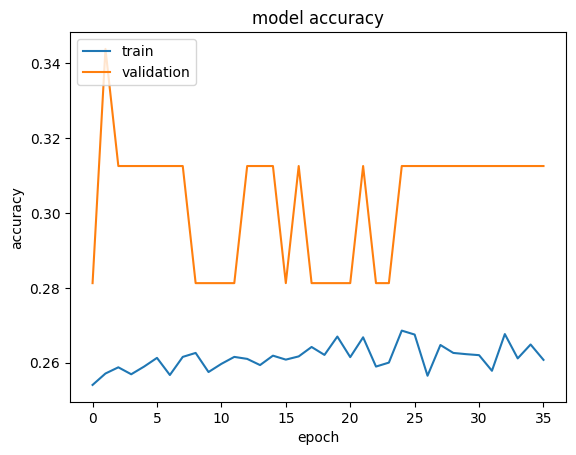

In [47]:
plt.plot(history_resnet.history["accuracy"])
plt.plot(history_resnet.history["val_accuracy"])
plt.title("model accuracy")
plt.ylabel("accuracy")
plt.xlabel("epoch")
plt.legend(["train", "validation"], loc="upper left")
plt.show()

### **Evaluating the ResNet Model**


In [48]:
# Calculate the number of steps for the entire test set to be processed
test_steps = test_generator.samples // batch_size

# If the number of samples isn't a multiple of the batch size,
# you have one more batch with the remaining samples
if test_generator.samples % batch_size > 0:
    test_steps += 1

# Evaluating the model on the test set
evaluation_results = new_resnet_model.evaluate(test_generator, steps=test_steps)
print(f"Loss: {evaluation_results[0]}, Accuracy: {evaluation_results[1]}")

1/4 [======>.......................] - ETA: 1s - loss: 1.3351 - accuracy: 0.0000e+00

3/4 [=====================>........] - ETA: 0s - loss: 1.3342 - accuracy: 0.3333    

4/4 [==============================] - 1s 39ms/step - loss: 1.3909 - accuracy: 0.2500


Loss: 1.390938401222229, Accuracy: 0.25


### **Plotting Confusion Matrix**


1/4 [======>.......................] - ETA: 1s

3/4 [=====================>........] - ETA: 0s

4/4 [==============================] - 1s 37ms/step


              precision    recall  f1-score   support

       happy       0.00      0.00      0.00        32
     neutral       0.00      0.00      0.00        32
         sad       0.25      1.00      0.40        32
    surprise       0.00      0.00      0.00        32

    accuracy                           0.25       128
   macro avg       0.06      0.25      0.10       128
weighted avg       0.06      0.25      0.10       128



/home/iamtxena/sandbox/mit-ai/my_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/iamtxena/sandbox/mit-ai/my_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/iamtxena/sandbox/mit-ai/my_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.cap

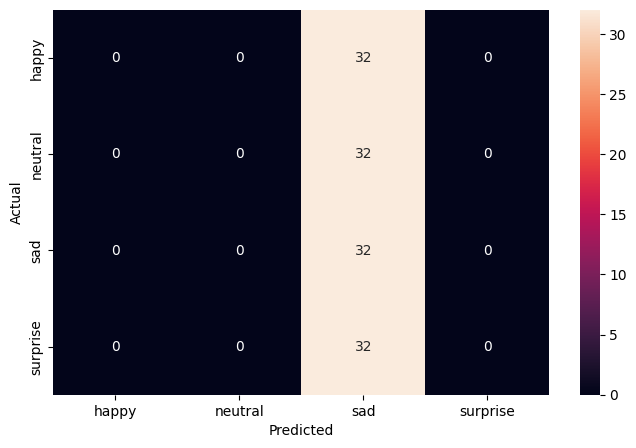

In [49]:
pred_probabilities = new_resnet_model.predict(test_generator, steps=test_steps)
pred = np.argmax(pred_probabilities, axis=1)

# Getting the true labels from the generator
y_true = test_generator.classes

# Printing the classification report with actual emotion labels
print(classification_report(y_true, pred, target_names=CATEGORIES))

# Plotting the heatmap using confusion matrix
cm = confusion_matrix(y_true, pred)
plt.figure(figsize=(8, 5))
sns.heatmap(cm, annot=True, fmt=".0f", xticklabels=CATEGORIES, yticklabels=CATEGORIES)
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.show()

**Observations and Insights:\_\_**

**Note: You can even go back and build your own architecture on top of the ResNet Transfer layer and see if you can improve the performance.**


## **EfficientNet Model**


In [50]:
backend.clear_session()

# Fixing the seed for random number generators so that we can ensure we receive the same output everytime
np.random.seed(42)

random.seed(42)
tf.random.set_seed(42)

In [51]:
efficient_model = EfficientNetB0(weights="imagenet", include_top=False, input_shape=(img_width, img_height, 3))
# Making all the layers of the efficient_model model non-trainable. i.e. freezing them
for layer in efficient_model.layers:
    layer.trainable = False

efficient_model.summary()

Model: "efficientnetb0"


__________________________________________________________________________________________________


 Layer (type)                Output Shape                 Param #   Connected to                  


 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            


 rescaling (Rescaling)       (None, 224, 224, 3)          0         ['input_1[0][0]']             


 normalization (Normalizati  (None, 224, 224, 3)          7         ['rescaling[0][0]']           


 on)                                                                                              


 rescaling_1 (Rescaling)     (None, 224, 224, 3)          0         ['normalization[0][0]']       


 stem_conv_pad (ZeroPadding  (None, 225, 225, 3)          0         ['rescaling_1[0][0]']         


 2D)                                                                                              


 stem_conv (Conv2D)          (None, 112, 112, 32)         864       ['stem_conv_pad[0][0]']       


 stem_bn (BatchNormalizatio  (None, 112, 112, 32)         128       ['stem_conv[0][0]']           


 n)                                                                                               


 stem_activation (Activatio  (None, 112, 112, 32)         0         ['stem_bn[0][0]']             


 n)                                                                                               


 block1a_dwconv (DepthwiseC  (None, 112, 112, 32)         288       ['stem_activation[0][0]']     


 onv2D)                                                                                           


 block1a_bn (BatchNormaliza  (None, 112, 112, 32)         128       ['block1a_dwconv[0][0]']      


 tion)                                                                                            


 block1a_activation (Activa  (None, 112, 112, 32)         0         ['block1a_bn[0][0]']          


 tion)                                                                                            


 block1a_se_squeeze (Global  (None, 32)                   0         ['block1a_activation[0][0]']  


 AveragePooling2D)                                                                                


 block1a_se_reshape (Reshap  (None, 1, 1, 32)             0         ['block1a_se_squeeze[0][0]']  


 e)                                                                                               


 block1a_se_reduce (Conv2D)  (None, 1, 1, 8)              264       ['block1a_se_reshape[0][0]']  


 block1a_se_expand (Conv2D)  (None, 1, 1, 32)             288       ['block1a_se_reduce[0][0]']   


 block1a_se_excite (Multipl  (None, 112, 112, 32)         0         ['block1a_activation[0][0]',  


 y)                                                                  'block1a_se_expand[0][0]']   


 block1a_project_conv (Conv  (None, 112, 112, 16)         512       ['block1a_se_excite[0][0]']   


 2D)                                                                                              


 block1a_project_bn (BatchN  (None, 112, 112, 16)         64        ['block1a_project_conv[0][0]']


 ormalization)                                                                                    


 block2a_expand_conv (Conv2  (None, 112, 112, 96)         1536      ['block1a_project_bn[0][0]']  


 D)                                                                                               


 block2a_expand_bn (BatchNo  (None, 112, 112, 96)         384       ['block2a_expand_conv[0][0]'] 


 rmalization)                                                                                     


 block2a_expand_activation   (None, 112, 112, 96)         0         ['block2a_expand_bn[0][0]']   


 (Activation)                                                                                     


 block2a_dwconv_pad (ZeroPa  (None, 113, 113, 96)         0         ['block2a_expand_activation[0]


 dding2D)                                                           [0]']                         


 block2a_dwconv (DepthwiseC  (None, 56, 56, 96)           864       ['block2a_dwconv_pad[0][0]']  


 onv2D)                                                                                           


 block2a_bn (BatchNormaliza  (None, 56, 56, 96)           384       ['block2a_dwconv[0][0]']      


 tion)                                                                                            


 block2a_activation (Activa  (None, 56, 56, 96)           0         ['block2a_bn[0][0]']          


 tion)                                                                                            


 block2a_se_squeeze (Global  (None, 96)                   0         ['block2a_activation[0][0]']  


 AveragePooling2D)                                                                                


 block2a_se_reshape (Reshap  (None, 1, 1, 96)             0         ['block2a_se_squeeze[0][0]']  


 e)                                                                                               


 block2a_se_reduce (Conv2D)  (None, 1, 1, 4)              388       ['block2a_se_reshape[0][0]']  


 block2a_se_expand (Conv2D)  (None, 1, 1, 96)             480       ['block2a_se_reduce[0][0]']   


 block2a_se_excite (Multipl  (None, 56, 56, 96)           0         ['block2a_activation[0][0]',  


 y)                                                                  'block2a_se_expand[0][0]']   


 block2a_project_conv (Conv  (None, 56, 56, 24)           2304      ['block2a_se_excite[0][0]']   


 2D)                                                                                              


 block2a_project_bn (BatchN  (None, 56, 56, 24)           96        ['block2a_project_conv[0][0]']


 ormalization)                                                                                    


 block2b_expand_conv (Conv2  (None, 56, 56, 144)          3456      ['block2a_project_bn[0][0]']  


 D)                                                                                               


 block2b_expand_bn (BatchNo  (None, 56, 56, 144)          576       ['block2b_expand_conv[0][0]'] 


 rmalization)                                                                                     


 block2b_expand_activation   (None, 56, 56, 144)          0         ['block2b_expand_bn[0][0]']   


 (Activation)                                                                                     


 block2b_dwconv (DepthwiseC  (None, 56, 56, 144)          1296      ['block2b_expand_activation[0]


 onv2D)                                                             [0]']                         


 block2b_bn (BatchNormaliza  (None, 56, 56, 144)          576       ['block2b_dwconv[0][0]']      


 tion)                                                                                            


 block2b_activation (Activa  (None, 56, 56, 144)          0         ['block2b_bn[0][0]']          


 tion)                                                                                            


 block2b_se_squeeze (Global  (None, 144)                  0         ['block2b_activation[0][0]']  


 AveragePooling2D)                                                                                


 block2b_se_reshape (Reshap  (None, 1, 1, 144)            0         ['block2b_se_squeeze[0][0]']  


 e)                                                                                               


 block2b_se_reduce (Conv2D)  (None, 1, 1, 6)              870       ['block2b_se_reshape[0][0]']  


 block2b_se_expand (Conv2D)  (None, 1, 1, 144)            1008      ['block2b_se_reduce[0][0]']   


 block2b_se_excite (Multipl  (None, 56, 56, 144)          0         ['block2b_activation[0][0]',  


 y)                                                                  'block2b_se_expand[0][0]']   


 block2b_project_conv (Conv  (None, 56, 56, 24)           3456      ['block2b_se_excite[0][0]']   


 2D)                                                                                              


 block2b_project_bn (BatchN  (None, 56, 56, 24)           96        ['block2b_project_conv[0][0]']


 ormalization)                                                                                    


 block2b_drop (Dropout)      (None, 56, 56, 24)           0         ['block2b_project_bn[0][0]']  


 block2b_add (Add)           (None, 56, 56, 24)           0         ['block2b_drop[0][0]',        


                                                                     'block2a_project_bn[0][0]']  


 block3a_expand_conv (Conv2  (None, 56, 56, 144)          3456      ['block2b_add[0][0]']         


 D)                                                                                               


 block3a_expand_bn (BatchNo  (None, 56, 56, 144)          576       ['block3a_expand_conv[0][0]'] 


 rmalization)                                                                                     


 block3a_expand_activation   (None, 56, 56, 144)          0         ['block3a_expand_bn[0][0]']   


 (Activation)                                                                                     


 block3a_dwconv_pad (ZeroPa  (None, 59, 59, 144)          0         ['block3a_expand_activation[0]


 dding2D)                                                           [0]']                         


 block3a_dwconv (DepthwiseC  (None, 28, 28, 144)          3600      ['block3a_dwconv_pad[0][0]']  


 onv2D)                                                                                           


 block3a_bn (BatchNormaliza  (None, 28, 28, 144)          576       ['block3a_dwconv[0][0]']      


 tion)                                                                                            


 block3a_activation (Activa  (None, 28, 28, 144)          0         ['block3a_bn[0][0]']          


 tion)                                                                                            


 block3a_se_squeeze (Global  (None, 144)                  0         ['block3a_activation[0][0]']  


 AveragePooling2D)                                                                                


 block3a_se_reshape (Reshap  (None, 1, 1, 144)            0         ['block3a_se_squeeze[0][0]']  


 e)                                                                                               


 block3a_se_reduce (Conv2D)  (None, 1, 1, 6)              870       ['block3a_se_reshape[0][0]']  


 block3a_se_expand (Conv2D)  (None, 1, 1, 144)            1008      ['block3a_se_reduce[0][0]']   


 block3a_se_excite (Multipl  (None, 28, 28, 144)          0         ['block3a_activation[0][0]',  


 y)                                                                  'block3a_se_expand[0][0]']   


 block3a_project_conv (Conv  (None, 28, 28, 40)           5760      ['block3a_se_excite[0][0]']   


 2D)                                                                                              


 block3a_project_bn (BatchN  (None, 28, 28, 40)           160       ['block3a_project_conv[0][0]']


 ormalization)                                                                                    


 block3b_expand_conv (Conv2  (None, 28, 28, 240)          9600      ['block3a_project_bn[0][0]']  


 D)                                                                                               


 block3b_expand_bn (BatchNo  (None, 28, 28, 240)          960       ['block3b_expand_conv[0][0]'] 


 rmalization)                                                                                     


 block3b_expand_activation   (None, 28, 28, 240)          0         ['block3b_expand_bn[0][0]']   


 (Activation)                                                                                     


 block3b_dwconv (DepthwiseC  (None, 28, 28, 240)          6000      ['block3b_expand_activation[0]


 onv2D)                                                             [0]']                         


 block3b_bn (BatchNormaliza  (None, 28, 28, 240)          960       ['block3b_dwconv[0][0]']      


 tion)                                                                                            


 block3b_activation (Activa  (None, 28, 28, 240)          0         ['block3b_bn[0][0]']          


 tion)                                                                                            


 block3b_se_squeeze (Global  (None, 240)                  0         ['block3b_activation[0][0]']  


 AveragePooling2D)                                                                                


 block3b_se_reshape (Reshap  (None, 1, 1, 240)            0         ['block3b_se_squeeze[0][0]']  


 e)                                                                                               


 block3b_se_reduce (Conv2D)  (None, 1, 1, 10)             2410      ['block3b_se_reshape[0][0]']  


 block3b_se_expand (Conv2D)  (None, 1, 1, 240)            2640      ['block3b_se_reduce[0][0]']   


 block3b_se_excite (Multipl  (None, 28, 28, 240)          0         ['block3b_activation[0][0]',  


 y)                                                                  'block3b_se_expand[0][0]']   


 block3b_project_conv (Conv  (None, 28, 28, 40)           9600      ['block3b_se_excite[0][0]']   


 2D)                                                                                              


 block3b_project_bn (BatchN  (None, 28, 28, 40)           160       ['block3b_project_conv[0][0]']


 ormalization)                                                                                    


 block3b_drop (Dropout)      (None, 28, 28, 40)           0         ['block3b_project_bn[0][0]']  


 block3b_add (Add)           (None, 28, 28, 40)           0         ['block3b_drop[0][0]',        


                                                                     'block3a_project_bn[0][0]']  


 block4a_expand_conv (Conv2  (None, 28, 28, 240)          9600      ['block3b_add[0][0]']         


 D)                                                                                               


 block4a_expand_bn (BatchNo  (None, 28, 28, 240)          960       ['block4a_expand_conv[0][0]'] 


 rmalization)                                                                                     


 block4a_expand_activation   (None, 28, 28, 240)          0         ['block4a_expand_bn[0][0]']   


 (Activation)                                                                                     


 block4a_dwconv_pad (ZeroPa  (None, 29, 29, 240)          0         ['block4a_expand_activation[0]


 dding2D)                                                           [0]']                         


 block4a_dwconv (DepthwiseC  (None, 14, 14, 240)          2160      ['block4a_dwconv_pad[0][0]']  


 onv2D)                                                                                           


 block4a_bn (BatchNormaliza  (None, 14, 14, 240)          960       ['block4a_dwconv[0][0]']      


 tion)                                                                                            


 block4a_activation (Activa  (None, 14, 14, 240)          0         ['block4a_bn[0][0]']          


 tion)                                                                                            


 block4a_se_squeeze (Global  (None, 240)                  0         ['block4a_activation[0][0]']  


 AveragePooling2D)                                                                                


 block4a_se_reshape (Reshap  (None, 1, 1, 240)            0         ['block4a_se_squeeze[0][0]']  


 e)                                                                                               


 block4a_se_reduce (Conv2D)  (None, 1, 1, 10)             2410      ['block4a_se_reshape[0][0]']  


 block4a_se_expand (Conv2D)  (None, 1, 1, 240)            2640      ['block4a_se_reduce[0][0]']   


 block4a_se_excite (Multipl  (None, 14, 14, 240)          0         ['block4a_activation[0][0]',  


 y)                                                                  'block4a_se_expand[0][0]']   


 block4a_project_conv (Conv  (None, 14, 14, 80)           19200     ['block4a_se_excite[0][0]']   


 2D)                                                                                              


 block4a_project_bn (BatchN  (None, 14, 14, 80)           320       ['block4a_project_conv[0][0]']


 ormalization)                                                                                    


 block4b_expand_conv (Conv2  (None, 14, 14, 480)          38400     ['block4a_project_bn[0][0]']  


 D)                                                                                               


 block4b_expand_bn (BatchNo  (None, 14, 14, 480)          1920      ['block4b_expand_conv[0][0]'] 


 rmalization)                                                                                     


 block4b_expand_activation   (None, 14, 14, 480)          0         ['block4b_expand_bn[0][0]']   


 (Activation)                                                                                     


 block4b_dwconv (DepthwiseC  (None, 14, 14, 480)          4320      ['block4b_expand_activation[0]


 onv2D)                                                             [0]']                         


 block4b_bn (BatchNormaliza  (None, 14, 14, 480)          1920      ['block4b_dwconv[0][0]']      


 tion)                                                                                            


 block4b_activation (Activa  (None, 14, 14, 480)          0         ['block4b_bn[0][0]']          


 tion)                                                                                            


 block4b_se_squeeze (Global  (None, 480)                  0         ['block4b_activation[0][0]']  


 AveragePooling2D)                                                                                


 block4b_se_reshape (Reshap  (None, 1, 1, 480)            0         ['block4b_se_squeeze[0][0]']  


 e)                                                                                               


 block4b_se_reduce (Conv2D)  (None, 1, 1, 20)             9620      ['block4b_se_reshape[0][0]']  


 block4b_se_expand (Conv2D)  (None, 1, 1, 480)            10080     ['block4b_se_reduce[0][0]']   


 block4b_se_excite (Multipl  (None, 14, 14, 480)          0         ['block4b_activation[0][0]',  


 y)                                                                  'block4b_se_expand[0][0]']   


 block4b_project_conv (Conv  (None, 14, 14, 80)           38400     ['block4b_se_excite[0][0]']   


 2D)                                                                                              


 block4b_project_bn (BatchN  (None, 14, 14, 80)           320       ['block4b_project_conv[0][0]']


 ormalization)                                                                                    


 block4b_drop (Dropout)      (None, 14, 14, 80)           0         ['block4b_project_bn[0][0]']  


 block4b_add (Add)           (None, 14, 14, 80)           0         ['block4b_drop[0][0]',        


                                                                     'block4a_project_bn[0][0]']  


 block4c_expand_conv (Conv2  (None, 14, 14, 480)          38400     ['block4b_add[0][0]']         


 D)                                                                                               


 block4c_expand_bn (BatchNo  (None, 14, 14, 480)          1920      ['block4c_expand_conv[0][0]'] 


 rmalization)                                                                                     


 block4c_expand_activation   (None, 14, 14, 480)          0         ['block4c_expand_bn[0][0]']   


 (Activation)                                                                                     


 block4c_dwconv (DepthwiseC  (None, 14, 14, 480)          4320      ['block4c_expand_activation[0]


 onv2D)                                                             [0]']                         


 block4c_bn (BatchNormaliza  (None, 14, 14, 480)          1920      ['block4c_dwconv[0][0]']      


 tion)                                                                                            


 block4c_activation (Activa  (None, 14, 14, 480)          0         ['block4c_bn[0][0]']          


 tion)                                                                                            


 block4c_se_squeeze (Global  (None, 480)                  0         ['block4c_activation[0][0]']  


 AveragePooling2D)                                                                                


 block4c_se_reshape (Reshap  (None, 1, 1, 480)            0         ['block4c_se_squeeze[0][0]']  


 e)                                                                                               


 block4c_se_reduce (Conv2D)  (None, 1, 1, 20)             9620      ['block4c_se_reshape[0][0]']  


 block4c_se_expand (Conv2D)  (None, 1, 1, 480)            10080     ['block4c_se_reduce[0][0]']   


 block4c_se_excite (Multipl  (None, 14, 14, 480)          0         ['block4c_activation[0][0]',  


 y)                                                                  'block4c_se_expand[0][0]']   


 block4c_project_conv (Conv  (None, 14, 14, 80)           38400     ['block4c_se_excite[0][0]']   


 2D)                                                                                              


 block4c_project_bn (BatchN  (None, 14, 14, 80)           320       ['block4c_project_conv[0][0]']


 ormalization)                                                                                    


 block4c_drop (Dropout)      (None, 14, 14, 80)           0         ['block4c_project_bn[0][0]']  


 block4c_add (Add)           (None, 14, 14, 80)           0         ['block4c_drop[0][0]',        


                                                                     'block4b_add[0][0]']         


 block5a_expand_conv (Conv2  (None, 14, 14, 480)          38400     ['block4c_add[0][0]']         


 D)                                                                                               


 block5a_expand_bn (BatchNo  (None, 14, 14, 480)          1920      ['block5a_expand_conv[0][0]'] 


 rmalization)                                                                                     


 block5a_expand_activation   (None, 14, 14, 480)          0         ['block5a_expand_bn[0][0]']   


 (Activation)                                                                                     


 block5a_dwconv (DepthwiseC  (None, 14, 14, 480)          12000     ['block5a_expand_activation[0]


 onv2D)                                                             [0]']                         


 block5a_bn (BatchNormaliza  (None, 14, 14, 480)          1920      ['block5a_dwconv[0][0]']      


 tion)                                                                                            


 block5a_activation (Activa  (None, 14, 14, 480)          0         ['block5a_bn[0][0]']          


 tion)                                                                                            


 block5a_se_squeeze (Global  (None, 480)                  0         ['block5a_activation[0][0]']  


 AveragePooling2D)                                                                                


 block5a_se_reshape (Reshap  (None, 1, 1, 480)            0         ['block5a_se_squeeze[0][0]']  


 e)                                                                                               


 block5a_se_reduce (Conv2D)  (None, 1, 1, 20)             9620      ['block5a_se_reshape[0][0]']  


 block5a_se_expand (Conv2D)  (None, 1, 1, 480)            10080     ['block5a_se_reduce[0][0]']   


 block5a_se_excite (Multipl  (None, 14, 14, 480)          0         ['block5a_activation[0][0]',  


 y)                                                                  'block5a_se_expand[0][0]']   


 block5a_project_conv (Conv  (None, 14, 14, 112)          53760     ['block5a_se_excite[0][0]']   


 2D)                                                                                              


 block5a_project_bn (BatchN  (None, 14, 14, 112)          448       ['block5a_project_conv[0][0]']


 ormalization)                                                                                    


 block5b_expand_conv (Conv2  (None, 14, 14, 672)          75264     ['block5a_project_bn[0][0]']  


 D)                                                                                               


 block5b_expand_bn (BatchNo  (None, 14, 14, 672)          2688      ['block5b_expand_conv[0][0]'] 


 rmalization)                                                                                     


 block5b_expand_activation   (None, 14, 14, 672)          0         ['block5b_expand_bn[0][0]']   


 (Activation)                                                                                     


 block5b_dwconv (DepthwiseC  (None, 14, 14, 672)          16800     ['block5b_expand_activation[0]


 onv2D)                                                             [0]']                         


 block5b_bn (BatchNormaliza  (None, 14, 14, 672)          2688      ['block5b_dwconv[0][0]']      


 tion)                                                                                            


 block5b_activation (Activa  (None, 14, 14, 672)          0         ['block5b_bn[0][0]']          


 tion)                                                                                            


 block5b_se_squeeze (Global  (None, 672)                  0         ['block5b_activation[0][0]']  


 AveragePooling2D)                                                                                


 block5b_se_reshape (Reshap  (None, 1, 1, 672)            0         ['block5b_se_squeeze[0][0]']  


 e)                                                                                               


 block5b_se_reduce (Conv2D)  (None, 1, 1, 28)             18844     ['block5b_se_reshape[0][0]']  


 block5b_se_expand (Conv2D)  (None, 1, 1, 672)            19488     ['block5b_se_reduce[0][0]']   


 block5b_se_excite (Multipl  (None, 14, 14, 672)          0         ['block5b_activation[0][0]',  


 y)                                                                  'block5b_se_expand[0][0]']   


 block5b_project_conv (Conv  (None, 14, 14, 112)          75264     ['block5b_se_excite[0][0]']   


 2D)                                                                                              


 block5b_project_bn (BatchN  (None, 14, 14, 112)          448       ['block5b_project_conv[0][0]']


 ormalization)                                                                                    


 block5b_drop (Dropout)      (None, 14, 14, 112)          0         ['block5b_project_bn[0][0]']  


 block5b_add (Add)           (None, 14, 14, 112)          0         ['block5b_drop[0][0]',        


                                                                     'block5a_project_bn[0][0]']  


 block5c_expand_conv (Conv2  (None, 14, 14, 672)          75264     ['block5b_add[0][0]']         


 D)                                                                                               


 block5c_expand_bn (BatchNo  (None, 14, 14, 672)          2688      ['block5c_expand_conv[0][0]'] 


 rmalization)                                                                                     


 block5c_expand_activation   (None, 14, 14, 672)          0         ['block5c_expand_bn[0][0]']   


 (Activation)                                                                                     


 block5c_dwconv (DepthwiseC  (None, 14, 14, 672)          16800     ['block5c_expand_activation[0]


 onv2D)                                                             [0]']                         


 block5c_bn (BatchNormaliza  (None, 14, 14, 672)          2688      ['block5c_dwconv[0][0]']      


 tion)                                                                                            


 block5c_activation (Activa  (None, 14, 14, 672)          0         ['block5c_bn[0][0]']          


 tion)                                                                                            


 block5c_se_squeeze (Global  (None, 672)                  0         ['block5c_activation[0][0]']  


 AveragePooling2D)                                                                                


 block5c_se_reshape (Reshap  (None, 1, 1, 672)            0         ['block5c_se_squeeze[0][0]']  


 e)                                                                                               


 block5c_se_reduce (Conv2D)  (None, 1, 1, 28)             18844     ['block5c_se_reshape[0][0]']  


 block5c_se_expand (Conv2D)  (None, 1, 1, 672)            19488     ['block5c_se_reduce[0][0]']   


 block5c_se_excite (Multipl  (None, 14, 14, 672)          0         ['block5c_activation[0][0]',  


 y)                                                                  'block5c_se_expand[0][0]']   


 block5c_project_conv (Conv  (None, 14, 14, 112)          75264     ['block5c_se_excite[0][0]']   


 2D)                                                                                              


 block5c_project_bn (BatchN  (None, 14, 14, 112)          448       ['block5c_project_conv[0][0]']


 ormalization)                                                                                    


 block5c_drop (Dropout)      (None, 14, 14, 112)          0         ['block5c_project_bn[0][0]']  


 block5c_add (Add)           (None, 14, 14, 112)          0         ['block5c_drop[0][0]',        


                                                                     'block5b_add[0][0]']         


 block6a_expand_conv (Conv2  (None, 14, 14, 672)          75264     ['block5c_add[0][0]']         


 D)                                                                                               


 block6a_expand_bn (BatchNo  (None, 14, 14, 672)          2688      ['block6a_expand_conv[0][0]'] 


 rmalization)                                                                                     


 block6a_expand_activation   (None, 14, 14, 672)          0         ['block6a_expand_bn[0][0]']   


 (Activation)                                                                                     


 block6a_dwconv_pad (ZeroPa  (None, 17, 17, 672)          0         ['block6a_expand_activation[0]


 dding2D)                                                           [0]']                         


 block6a_dwconv (DepthwiseC  (None, 7, 7, 672)            16800     ['block6a_dwconv_pad[0][0]']  


 onv2D)                                                                                           


 block6a_bn (BatchNormaliza  (None, 7, 7, 672)            2688      ['block6a_dwconv[0][0]']      


 tion)                                                                                            


 block6a_activation (Activa  (None, 7, 7, 672)            0         ['block6a_bn[0][0]']          


 tion)                                                                                            


 block6a_se_squeeze (Global  (None, 672)                  0         ['block6a_activation[0][0]']  


 AveragePooling2D)                                                                                


 block6a_se_reshape (Reshap  (None, 1, 1, 672)            0         ['block6a_se_squeeze[0][0]']  


 e)                                                                                               


 block6a_se_reduce (Conv2D)  (None, 1, 1, 28)             18844     ['block6a_se_reshape[0][0]']  


 block6a_se_expand (Conv2D)  (None, 1, 1, 672)            19488     ['block6a_se_reduce[0][0]']   


 block6a_se_excite (Multipl  (None, 7, 7, 672)            0         ['block6a_activation[0][0]',  


 y)                                                                  'block6a_se_expand[0][0]']   


 block6a_project_conv (Conv  (None, 7, 7, 192)            129024    ['block6a_se_excite[0][0]']   


 2D)                                                                                              


 block6a_project_bn (BatchN  (None, 7, 7, 192)            768       ['block6a_project_conv[0][0]']


 ormalization)                                                                                    


 block6b_expand_conv (Conv2  (None, 7, 7, 1152)           221184    ['block6a_project_bn[0][0]']  


 D)                                                                                               


 block6b_expand_bn (BatchNo  (None, 7, 7, 1152)           4608      ['block6b_expand_conv[0][0]'] 


 rmalization)                                                                                     


 block6b_expand_activation   (None, 7, 7, 1152)           0         ['block6b_expand_bn[0][0]']   


 (Activation)                                                                                     


 block6b_dwconv (DepthwiseC  (None, 7, 7, 1152)           28800     ['block6b_expand_activation[0]


 onv2D)                                                             [0]']                         


 block6b_bn (BatchNormaliza  (None, 7, 7, 1152)           4608      ['block6b_dwconv[0][0]']      


 tion)                                                                                            


 block6b_activation (Activa  (None, 7, 7, 1152)           0         ['block6b_bn[0][0]']          


 tion)                                                                                            


 block6b_se_squeeze (Global  (None, 1152)                 0         ['block6b_activation[0][0]']  


 AveragePooling2D)                                                                                


 block6b_se_reshape (Reshap  (None, 1, 1, 1152)           0         ['block6b_se_squeeze[0][0]']  


 e)                                                                                               


 block6b_se_reduce (Conv2D)  (None, 1, 1, 48)             55344     ['block6b_se_reshape[0][0]']  


 block6b_se_expand (Conv2D)  (None, 1, 1, 1152)           56448     ['block6b_se_reduce[0][0]']   


 block6b_se_excite (Multipl  (None, 7, 7, 1152)           0         ['block6b_activation[0][0]',  


 y)                                                                  'block6b_se_expand[0][0]']   


 block6b_project_conv (Conv  (None, 7, 7, 192)            221184    ['block6b_se_excite[0][0]']   


 2D)                                                                                              


 block6b_project_bn (BatchN  (None, 7, 7, 192)            768       ['block6b_project_conv[0][0]']


 ormalization)                                                                                    


 block6b_drop (Dropout)      (None, 7, 7, 192)            0         ['block6b_project_bn[0][0]']  


 block6b_add (Add)           (None, 7, 7, 192)            0         ['block6b_drop[0][0]',        


                                                                     'block6a_project_bn[0][0]']  


 block6c_expand_conv (Conv2  (None, 7, 7, 1152)           221184    ['block6b_add[0][0]']         


 D)                                                                                               


 block6c_expand_bn (BatchNo  (None, 7, 7, 1152)           4608      ['block6c_expand_conv[0][0]'] 


 rmalization)                                                                                     


 block6c_expand_activation   (None, 7, 7, 1152)           0         ['block6c_expand_bn[0][0]']   


 (Activation)                                                                                     


 block6c_dwconv (DepthwiseC  (None, 7, 7, 1152)           28800     ['block6c_expand_activation[0]


 onv2D)                                                             [0]']                         


 block6c_bn (BatchNormaliza  (None, 7, 7, 1152)           4608      ['block6c_dwconv[0][0]']      


 tion)                                                                                            


 block6c_activation (Activa  (None, 7, 7, 1152)           0         ['block6c_bn[0][0]']          


 tion)                                                                                            


 block6c_se_squeeze (Global  (None, 1152)                 0         ['block6c_activation[0][0]']  


 AveragePooling2D)                                                                                


 block6c_se_reshape (Reshap  (None, 1, 1, 1152)           0         ['block6c_se_squeeze[0][0]']  


 e)                                                                                               


 block6c_se_reduce (Conv2D)  (None, 1, 1, 48)             55344     ['block6c_se_reshape[0][0]']  


 block6c_se_expand (Conv2D)  (None, 1, 1, 1152)           56448     ['block6c_se_reduce[0][0]']   


 block6c_se_excite (Multipl  (None, 7, 7, 1152)           0         ['block6c_activation[0][0]',  


 y)                                                                  'block6c_se_expand[0][0]']   


 block6c_project_conv (Conv  (None, 7, 7, 192)            221184    ['block6c_se_excite[0][0]']   


 2D)                                                                                              


 block6c_project_bn (BatchN  (None, 7, 7, 192)            768       ['block6c_project_conv[0][0]']


 ormalization)                                                                                    


 block6c_drop (Dropout)      (None, 7, 7, 192)            0         ['block6c_project_bn[0][0]']  


 block6c_add (Add)           (None, 7, 7, 192)            0         ['block6c_drop[0][0]',        


                                                                     'block6b_add[0][0]']         


 block6d_expand_conv (Conv2  (None, 7, 7, 1152)           221184    ['block6c_add[0][0]']         


 D)                                                                                               


 block6d_expand_bn (BatchNo  (None, 7, 7, 1152)           4608      ['block6d_expand_conv[0][0]'] 


 rmalization)                                                                                     


 block6d_expand_activation   (None, 7, 7, 1152)           0         ['block6d_expand_bn[0][0]']   


 (Activation)                                                                                     


 block6d_dwconv (DepthwiseC  (None, 7, 7, 1152)           28800     ['block6d_expand_activation[0]


 onv2D)                                                             [0]']                         


 block6d_bn (BatchNormaliza  (None, 7, 7, 1152)           4608      ['block6d_dwconv[0][0]']      


 tion)                                                                                            


 block6d_activation (Activa  (None, 7, 7, 1152)           0         ['block6d_bn[0][0]']          


 tion)                                                                                            


 block6d_se_squeeze (Global  (None, 1152)                 0         ['block6d_activation[0][0]']  


 AveragePooling2D)                                                                                


 block6d_se_reshape (Reshap  (None, 1, 1, 1152)           0         ['block6d_se_squeeze[0][0]']  


 e)                                                                                               


 block6d_se_reduce (Conv2D)  (None, 1, 1, 48)             55344     ['block6d_se_reshape[0][0]']  


 block6d_se_expand (Conv2D)  (None, 1, 1, 1152)           56448     ['block6d_se_reduce[0][0]']   


 block6d_se_excite (Multipl  (None, 7, 7, 1152)           0         ['block6d_activation[0][0]',  


 y)                                                                  'block6d_se_expand[0][0]']   


 block6d_project_conv (Conv  (None, 7, 7, 192)            221184    ['block6d_se_excite[0][0]']   


 2D)                                                                                              


 block6d_project_bn (BatchN  (None, 7, 7, 192)            768       ['block6d_project_conv[0][0]']


 ormalization)                                                                                    


 block6d_drop (Dropout)      (None, 7, 7, 192)            0         ['block6d_project_bn[0][0]']  


 block6d_add (Add)           (None, 7, 7, 192)            0         ['block6d_drop[0][0]',        


                                                                     'block6c_add[0][0]']         


 block7a_expand_conv (Conv2  (None, 7, 7, 1152)           221184    ['block6d_add[0][0]']         


 D)                                                                                               


 block7a_expand_bn (BatchNo  (None, 7, 7, 1152)           4608      ['block7a_expand_conv[0][0]'] 


 rmalization)                                                                                     


 block7a_expand_activation   (None, 7, 7, 1152)           0         ['block7a_expand_bn[0][0]']   


 (Activation)                                                                                     


 block7a_dwconv (DepthwiseC  (None, 7, 7, 1152)           10368     ['block7a_expand_activation[0]


 onv2D)                                                             [0]']                         


 block7a_bn (BatchNormaliza  (None, 7, 7, 1152)           4608      ['block7a_dwconv[0][0]']      


 tion)                                                                                            


 block7a_activation (Activa  (None, 7, 7, 1152)           0         ['block7a_bn[0][0]']          


 tion)                                                                                            


 block7a_se_squeeze (Global  (None, 1152)                 0         ['block7a_activation[0][0]']  


 AveragePooling2D)                                                                                


 block7a_se_reshape (Reshap  (None, 1, 1, 1152)           0         ['block7a_se_squeeze[0][0]']  


 e)                                                                                               


 block7a_se_reduce (Conv2D)  (None, 1, 1, 48)             55344     ['block7a_se_reshape[0][0]']  


 block7a_se_expand (Conv2D)  (None, 1, 1, 1152)           56448     ['block7a_se_reduce[0][0]']   


 block7a_se_excite (Multipl  (None, 7, 7, 1152)           0         ['block7a_activation[0][0]',  


 y)                                                                  'block7a_se_expand[0][0]']   


 block7a_project_conv (Conv  (None, 7, 7, 320)            368640    ['block7a_se_excite[0][0]']   


 2D)                                                                                              


 block7a_project_bn (BatchN  (None, 7, 7, 320)            1280      ['block7a_project_conv[0][0]']


 ormalization)                                                                                    


 top_conv (Conv2D)           (None, 7, 7, 1280)           409600    ['block7a_project_bn[0][0]']  


 top_bn (BatchNormalization  (None, 7, 7, 1280)           5120      ['top_conv[0][0]']            


 )                                                                                                


 top_activation (Activation  (None, 7, 7, 1280)           0         ['top_bn[0][0]']              


 )                                                                                                


Total params: 4049571 (15.45 MB)


Trainable params: 0 (0.00 Byte)


Non-trainable params: 4049571 (15.45 MB)


__________________________________________________________________________________________________


### **Model Building**

- Import EfficientNet upto the layer of your choice and add Fully Connected layers on top of it.


In [52]:
new_efficient_model = Sequential()
new_efficient_model.add(efficient_model)

# Reduces each feature map to a single value by averaging all elements
new_efficient_model.add(GlobalAveragePooling2D())

# Adding a dense output layer
new_efficient_model.add(Dense(512, activation="relu"))
new_efficient_model.add(Dropout(0.5))
new_efficient_model.add(Dense(128, activation="relu"))
new_efficient_model.add(Dropout(0.5))
new_efficient_model.add(Dense(4, activation="softmax"))

# Using Adam Optimizer
optimizer = Adam(learning_rate=0.0005)

### **Compiling and Training the Model**


In [53]:
new_efficient_model.compile(optimizer=optimizer, loss="categorical_crossentropy", metrics=["accuracy"])
new_efficient_model.summary()

Model: "sequential"


_________________________________________________________________


 Layer (type)                Output Shape              Param #   


 efficientnetb0 (Functional  (None, 7, 7, 1280)        4049571   


 )                                                               


 global_average_pooling2d (  (None, 1280)              0         


 GlobalAveragePooling2D)                                         


 dense (Dense)               (None, 512)               655872    


 dropout (Dropout)           (None, 512)               0         


 dense_1 (Dense)             (None, 128)               65664     


 dropout_1 (Dropout)         (None, 128)               0         


 dense_2 (Dense)             (None, 4)                 516       


Total params: 4771623 (18.20 MB)


Trainable params: 722052 (2.75 MB)


Non-trainable params: 4049571 (15.45 MB)


_________________________________________________________________


In [54]:
# Get the current time
current_time = datetime.now().strftime("%Y%m%d-%H%M%S")

# Set up Early Stopping with a patience 7 but acting after at least 20 epochs
delayed_early_stopping = DelayedEarlyStopping(
    monitor="val_loss", patience=7, verbose=1, restore_best_weights=True, start_epoch=20
)

# Define the learning rate scheduler callback
reduce_lr = ReduceLROnPlateau(monitor="val_loss", factor=0.2, patience=5, min_lr=0.00001, verbose=1)

mc = ModelCheckpoint(
    f"{results_path}/best_model_efficient_{current_time}.keras",
    monitor="val_accuracy",
    mode="max",
    verbose=1,
    save_best_only=True,
)

# Pulling a single large batch of random validation data for doing the validation after each epoch
validationX, validationY = validation_generator.next()

# Fitting the model with 40 epochs and using validation set
history_efficient = new_efficient_model.fit(
    train_generator,
    epochs=40,
    validation_data=(validationX, validationY),
    callbacks=[delayed_early_stopping, mc, reduce_lr],
)

Epoch 1/40


  1/473 [..............................] - ETA: 26:27 - loss: 1.5421 - accuracy: 0.2500

  3/473 [..............................] - ETA: 15s - loss: 1.4851 - accuracy: 0.2604  

  4/473 [..............................] - ETA: 33s - loss: 1.5247 - accuracy: 0.2656

  5/473 [..............................] - ETA: 43s - loss: 1.5050 - accuracy: 0.2875

  6/473 [..............................] - ETA: 52s - loss: 1.4803 - accuracy: 0.3021

  7/473 [..............................] - ETA: 55s - loss: 1.4905 - accuracy: 0.3036

  8/473 [..............................] - ETA: 1:00 - loss: 1.5302 - accuracy: 0.2852

  9/473 [..............................] - ETA: 1:01 - loss: 1.5239 - accuracy: 0.2743

 10/473 [..............................] - ETA: 1:04 - loss: 1.5175 - accuracy: 0.2781

 11/473 [..............................] - ETA: 1:04 - loss: 1.5026 - accuracy: 0.2869

 12/473 [..............................] - ETA: 1:07 - loss: 1.5046 - accuracy: 0.2812

 13/473 [..............................] - ETA: 1:07 - loss: 1.5121 - accuracy: 0.2764

 14/473 [..............................] - ETA: 1:08 - loss: 1.5112 - accuracy: 0.2701

 15/473 [..............................] - ETA: 1:08 - loss: 1.5037 - accuracy: 0.2771

 16/473 [>.............................] - ETA: 1:09 - loss: 1.5100 - accuracy: 0.2715

 17/473 [>.............................] - ETA: 1:09 - loss: 1.5015 - accuracy: 0.2739

 18/473 [>.............................] - ETA: 1:10 - loss: 1.4948 - accuracy: 0.2778

 19/473 [>.............................] - ETA: 1:10 - loss: 1.4930 - accuracy: 0.2812

 20/473 [>.............................] - ETA: 1:10 - loss: 1.4921 - accuracy: 0.2812

 21/473 [>.............................] - ETA: 1:10 - loss: 1.4857 - accuracy: 0.2812

 22/473 [>.............................] - ETA: 1:10 - loss: 1.4723 - accuracy: 0.2940

 23/473 [>.............................] - ETA: 1:10 - loss: 1.4645 - accuracy: 0.2962

 24/473 [>.............................] - ETA: 1:10 - loss: 1.4642 - accuracy: 0.2956

 25/473 [>.............................] - ETA: 1:11 - loss: 1.4629 - accuracy: 0.3000

 26/473 [>.............................] - ETA: 1:10 - loss: 1.4608 - accuracy: 0.3005

 27/473 [>.............................] - ETA: 1:10 - loss: 1.4546 - accuracy: 0.3044

 28/473 [>.............................] - ETA: 1:10 - loss: 1.4534 - accuracy: 0.3036

 29/473 [>.............................] - ETA: 1:10 - loss: 1.4517 - accuracy: 0.3071

 30/473 [>.............................] - ETA: 1:10 - loss: 1.4465 - accuracy: 0.3073

 31/473 [>.............................] - ETA: 1:10 - loss: 1.4433 - accuracy: 0.3065

 32/473 [=>............................] - ETA: 1:10 - loss: 1.4395 - accuracy: 0.3076

 33/473 [=>............................] - ETA: 1:10 - loss: 1.4409 - accuracy: 0.3087

 34/473 [=>............................] - ETA: 1:10 - loss: 1.4410 - accuracy: 0.3088

 35/473 [=>............................] - ETA: 1:10 - loss: 1.4346 - accuracy: 0.3134

 36/473 [=>............................] - ETA: 1:10 - loss: 1.4317 - accuracy: 0.3160

 37/473 [=>............................] - ETA: 1:10 - loss: 1.4276 - accuracy: 0.3159

 38/473 [=>............................] - ETA: 1:10 - loss: 1.4285 - accuracy: 0.3133

 39/473 [=>............................] - ETA: 1:10 - loss: 1.4267 - accuracy: 0.3149

 40/473 [=>............................] - ETA: 1:10 - loss: 1.4254 - accuracy: 0.3148

 41/473 [=>............................] - ETA: 1:10 - loss: 1.4234 - accuracy: 0.3148

 42/473 [=>............................] - ETA: 1:10 - loss: 1.4238 - accuracy: 0.3147

 43/473 [=>............................] - ETA: 1:10 - loss: 1.4232 - accuracy: 0.3169

 44/473 [=>............................] - ETA: 1:10 - loss: 1.4225 - accuracy: 0.3146

 45/473 [=>............................] - ETA: 1:10 - loss: 1.4178 - accuracy: 0.3174

 46/473 [=>............................] - ETA: 1:09 - loss: 1.4174 - accuracy: 0.3173

 47/473 [=>............................] - ETA: 1:10 - loss: 1.4202 - accuracy: 0.3152

 48/473 [==>...........................] - ETA: 1:09 - loss: 1.4182 - accuracy: 0.3158

 49/473 [==>...........................] - ETA: 1:09 - loss: 1.4181 - accuracy: 0.3157

 50/473 [==>...........................] - ETA: 1:09 - loss: 1.4180 - accuracy: 0.3156

 51/473 [==>...........................] - ETA: 1:09 - loss: 1.4193 - accuracy: 0.3168

 52/473 [==>...........................] - ETA: 1:09 - loss: 1.4167 - accuracy: 0.3191

 53/473 [==>...........................] - ETA: 1:09 - loss: 1.4137 - accuracy: 0.3208

 54/473 [==>...........................] - ETA: 1:09 - loss: 1.4109 - accuracy: 0.3223

 55/473 [==>...........................] - ETA: 1:08 - loss: 1.4118 - accuracy: 0.3199

 56/473 [==>...........................] - ETA: 1:08 - loss: 1.4107 - accuracy: 0.3198

 57/473 [==>...........................] - ETA: 1:08 - loss: 1.4102 - accuracy: 0.3191

 58/473 [==>...........................] - ETA: 1:08 - loss: 1.4085 - accuracy: 0.3206

 59/473 [==>...........................] - ETA: 1:08 - loss: 1.4092 - accuracy: 0.3199

 60/473 [==>...........................] - ETA: 1:08 - loss: 1.4080 - accuracy: 0.3198

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.4053 - accuracy: 0.3212

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.4048 - accuracy: 0.3216

 63/473 [==>...........................] - ETA: 1:07 - loss: 1.4034 - accuracy: 0.3239

 64/473 [===>..........................] - ETA: 1:07 - loss: 1.4032 - accuracy: 0.3223

 65/473 [===>..........................] - ETA: 1:07 - loss: 1.4031 - accuracy: 0.3212

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.3997 - accuracy: 0.3248

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.3994 - accuracy: 0.3260

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.3990 - accuracy: 0.3272

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.3989 - accuracy: 0.3279

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.3971 - accuracy: 0.3299

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.3960 - accuracy: 0.3314

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.3963 - accuracy: 0.3320

 73/473 [===>..........................] - ETA: 1:06 - loss: 1.3956 - accuracy: 0.3313

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.3942 - accuracy: 0.3328

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.3941 - accuracy: 0.3342

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.3925 - accuracy: 0.3351

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.3927 - accuracy: 0.3344

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.3903 - accuracy: 0.3357

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.3884 - accuracy: 0.3374

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.3872 - accuracy: 0.3367

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.3859 - accuracy: 0.3376

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.3847 - accuracy: 0.3369

 83/473 [====>.........................] - ETA: 1:05 - loss: 1.3861 - accuracy: 0.3358

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.3845 - accuracy: 0.3378

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.3846 - accuracy: 0.3379

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.3835 - accuracy: 0.3387

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.3815 - accuracy: 0.3402

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.3806 - accuracy: 0.3413

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.3818 - accuracy: 0.3406

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.3800 - accuracy: 0.3413

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.3793 - accuracy: 0.3407

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.3772 - accuracy: 0.3427

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.3773 - accuracy: 0.3434

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.3761 - accuracy: 0.3441

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.3746 - accuracy: 0.3451

 96/473 [=====>........................] - ETA: 1:03 - loss: 1.3743 - accuracy: 0.3451

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.3743 - accuracy: 0.3447

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.3728 - accuracy: 0.3450

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.3718 - accuracy: 0.3460

100/473 [=====>........................] - ETA: 1:02 - loss: 1.3704 - accuracy: 0.3475

101/473 [=====>........................] - ETA: 1:02 - loss: 1.3713 - accuracy: 0.3475

102/473 [=====>........................] - ETA: 1:02 - loss: 1.3706 - accuracy: 0.3477

103/473 [=====>........................] - ETA: 1:01 - loss: 1.3696 - accuracy: 0.3468

104/473 [=====>........................] - ETA: 1:01 - loss: 1.3689 - accuracy: 0.3474

105/473 [=====>........................] - ETA: 1:01 - loss: 1.3680 - accuracy: 0.3479

106/473 [=====>........................] - ETA: 1:01 - loss: 1.3663 - accuracy: 0.3494

107/473 [=====>........................] - ETA: 1:01 - loss: 1.3657 - accuracy: 0.3493

108/473 [=====>........................] - ETA: 1:01 - loss: 1.3655 - accuracy: 0.3495

109/473 [=====>........................] - ETA: 1:01 - loss: 1.3642 - accuracy: 0.3506

110/473 [=====>........................] - ETA: 1:00 - loss: 1.3634 - accuracy: 0.3514

111/473 [======>.......................] - ETA: 1:00 - loss: 1.3619 - accuracy: 0.3528

112/473 [======>.......................] - ETA: 1:00 - loss: 1.3615 - accuracy: 0.3530

113/473 [======>.......................] - ETA: 1:00 - loss: 1.3614 - accuracy: 0.3537

114/473 [======>.......................] - ETA: 1:00 - loss: 1.3620 - accuracy: 0.3528

115/473 [======>.......................] - ETA: 59s - loss: 1.3615 - accuracy: 0.3530 

116/473 [======>.......................] - ETA: 59s - loss: 1.3622 - accuracy: 0.3524

117/473 [======>.......................] - ETA: 59s - loss: 1.3618 - accuracy: 0.3531

118/473 [======>.......................] - ETA: 59s - loss: 1.3613 - accuracy: 0.3533

119/473 [======>.......................] - ETA: 59s - loss: 1.3603 - accuracy: 0.3529

120/473 [======>.......................] - ETA: 58s - loss: 1.3594 - accuracy: 0.3526

121/473 [======>.......................] - ETA: 58s - loss: 1.3581 - accuracy: 0.3538

122/473 [======>.......................] - ETA: 58s - loss: 1.3570 - accuracy: 0.3550

123/473 [======>.......................] - ETA: 58s - loss: 1.3574 - accuracy: 0.3537

124/473 [======>.......................] - ETA: 58s - loss: 1.3572 - accuracy: 0.3543

125/473 [======>.......................] - ETA: 58s - loss: 1.3568 - accuracy: 0.3543

126/473 [======>.......................] - ETA: 57s - loss: 1.3567 - accuracy: 0.3542

127/473 [=======>......................] - ETA: 57s - loss: 1.3565 - accuracy: 0.3548

128/473 [=======>......................] - ETA: 57s - loss: 1.3567 - accuracy: 0.3552

129/473 [=======>......................] - ETA: 57s - loss: 1.3558 - accuracy: 0.3551

130/473 [=======>......................] - ETA: 57s - loss: 1.3559 - accuracy: 0.3543

131/473 [=======>......................] - ETA: 57s - loss: 1.3557 - accuracy: 0.3542

132/473 [=======>......................] - ETA: 57s - loss: 1.3553 - accuracy: 0.3544

133/473 [=======>......................] - ETA: 56s - loss: 1.3551 - accuracy: 0.3546

134/473 [=======>......................] - ETA: 56s - loss: 1.3536 - accuracy: 0.3561

135/473 [=======>......................] - ETA: 56s - loss: 1.3525 - accuracy: 0.3572

136/473 [=======>......................] - ETA: 56s - loss: 1.3517 - accuracy: 0.3571

137/473 [=======>......................] - ETA: 56s - loss: 1.3516 - accuracy: 0.3570

138/473 [=======>......................] - ETA: 56s - loss: 1.3509 - accuracy: 0.3562

139/473 [=======>......................] - ETA: 55s - loss: 1.3500 - accuracy: 0.3572

140/473 [=======>......................] - ETA: 55s - loss: 1.3495 - accuracy: 0.3578

141/473 [=======>......................] - ETA: 55s - loss: 1.3486 - accuracy: 0.3588

142/473 [========>.....................] - ETA: 55s - loss: 1.3476 - accuracy: 0.3600

143/473 [========>.....................] - ETA: 55s - loss: 1.3467 - accuracy: 0.3601

144/473 [========>.....................] - ETA: 55s - loss: 1.3480 - accuracy: 0.3605

145/473 [========>.....................] - ETA: 54s - loss: 1.3470 - accuracy: 0.3614

146/473 [========>.....................] - ETA: 54s - loss: 1.3463 - accuracy: 0.3626

147/473 [========>.....................] - ETA: 54s - loss: 1.3453 - accuracy: 0.3635

148/473 [========>.....................] - ETA: 54s - loss: 1.3455 - accuracy: 0.3625

149/473 [========>.....................] - ETA: 54s - loss: 1.3458 - accuracy: 0.3626

150/473 [========>.....................] - ETA: 54s - loss: 1.3454 - accuracy: 0.3629

151/473 [========>.....................] - ETA: 53s - loss: 1.3463 - accuracy: 0.3615

152/473 [========>.....................] - ETA: 53s - loss: 1.3458 - accuracy: 0.3610

153/473 [========>.....................] - ETA: 53s - loss: 1.3459 - accuracy: 0.3607

154/473 [========>.....................] - ETA: 53s - loss: 1.3455 - accuracy: 0.3602

155/473 [========>.....................] - ETA: 53s - loss: 1.3438 - accuracy: 0.3613

156/473 [========>.....................] - ETA: 53s - loss: 1.3441 - accuracy: 0.3618

157/473 [========>.....................] - ETA: 53s - loss: 1.3436 - accuracy: 0.3619

158/473 [=========>....................] - ETA: 52s - loss: 1.3427 - accuracy: 0.3625

159/473 [=========>....................] - ETA: 52s - loss: 1.3428 - accuracy: 0.3628

160/473 [=========>....................] - ETA: 52s - loss: 1.3416 - accuracy: 0.3637

161/473 [=========>....................] - ETA: 52s - loss: 1.3412 - accuracy: 0.3637

162/473 [=========>....................] - ETA: 52s - loss: 1.3411 - accuracy: 0.3634

163/473 [=========>....................] - ETA: 51s - loss: 1.3401 - accuracy: 0.3641

164/473 [=========>....................] - ETA: 51s - loss: 1.3396 - accuracy: 0.3641

165/473 [=========>....................] - ETA: 51s - loss: 1.3388 - accuracy: 0.3646

166/473 [=========>....................] - ETA: 51s - loss: 1.3379 - accuracy: 0.3652

167/473 [=========>....................] - ETA: 51s - loss: 1.3378 - accuracy: 0.3658

168/473 [=========>....................] - ETA: 50s - loss: 1.3372 - accuracy: 0.3663

169/473 [=========>....................] - ETA: 50s - loss: 1.3374 - accuracy: 0.3665

170/473 [=========>....................] - ETA: 50s - loss: 1.3375 - accuracy: 0.3667

171/473 [=========>....................] - ETA: 50s - loss: 1.3372 - accuracy: 0.3670

172/473 [=========>....................] - ETA: 50s - loss: 1.3368 - accuracy: 0.3670

173/473 [=========>....................] - ETA: 50s - loss: 1.3366 - accuracy: 0.3665

174/473 [==========>...................] - ETA: 49s - loss: 1.3368 - accuracy: 0.3667

175/473 [==========>...................] - ETA: 49s - loss: 1.3362 - accuracy: 0.3670

176/473 [==========>...................] - ETA: 49s - loss: 1.3359 - accuracy: 0.3672

177/473 [==========>...................] - ETA: 49s - loss: 1.3369 - accuracy: 0.3658

178/473 [==========>...................] - ETA: 49s - loss: 1.3359 - accuracy: 0.3662

179/473 [==========>...................] - ETA: 49s - loss: 1.3362 - accuracy: 0.3663

180/473 [==========>...................] - ETA: 48s - loss: 1.3353 - accuracy: 0.3668

181/473 [==========>...................] - ETA: 48s - loss: 1.3348 - accuracy: 0.3674

182/473 [==========>...................] - ETA: 48s - loss: 1.3340 - accuracy: 0.3674

183/473 [==========>...................] - ETA: 48s - loss: 1.3342 - accuracy: 0.3673

184/473 [==========>...................] - ETA: 48s - loss: 1.3336 - accuracy: 0.3679

185/473 [==========>...................] - ETA: 48s - loss: 1.3330 - accuracy: 0.3684

186/473 [==========>...................] - ETA: 48s - loss: 1.3330 - accuracy: 0.3686

187/473 [==========>...................] - ETA: 47s - loss: 1.3326 - accuracy: 0.3688

188/473 [==========>...................] - ETA: 47s - loss: 1.3324 - accuracy: 0.3692

189/473 [==========>...................] - ETA: 47s - loss: 1.3316 - accuracy: 0.3695

190/473 [===========>..................] - ETA: 47s - loss: 1.3314 - accuracy: 0.3692

191/473 [===========>..................] - ETA: 47s - loss: 1.3307 - accuracy: 0.3698

192/473 [===========>..................] - ETA: 46s - loss: 1.3308 - accuracy: 0.3691

193/473 [===========>..................] - ETA: 46s - loss: 1.3302 - accuracy: 0.3695

194/473 [===========>..................] - ETA: 46s - loss: 1.3298 - accuracy: 0.3697

195/473 [===========>..................] - ETA: 46s - loss: 1.3294 - accuracy: 0.3699

196/473 [===========>..................] - ETA: 46s - loss: 1.3296 - accuracy: 0.3697

197/473 [===========>..................] - ETA: 46s - loss: 1.3296 - accuracy: 0.3688

198/473 [===========>..................] - ETA: 45s - loss: 1.3301 - accuracy: 0.3681

199/473 [===========>..................] - ETA: 45s - loss: 1.3302 - accuracy: 0.3678

200/473 [===========>..................] - ETA: 45s - loss: 1.3302 - accuracy: 0.3673

201/473 [===========>..................] - ETA: 45s - loss: 1.3296 - accuracy: 0.3677

202/473 [===========>..................] - ETA: 45s - loss: 1.3289 - accuracy: 0.3683

203/473 [===========>..................] - ETA: 45s - loss: 1.3278 - accuracy: 0.3698

204/473 [===========>..................] - ETA: 44s - loss: 1.3272 - accuracy: 0.3704

205/473 [============>.................] - ETA: 44s - loss: 1.3266 - accuracy: 0.3713

206/473 [============>.................] - ETA: 44s - loss: 1.3259 - accuracy: 0.3717

207/473 [============>.................] - ETA: 44s - loss: 1.3260 - accuracy: 0.3718

208/473 [============>.................] - ETA: 44s - loss: 1.3266 - accuracy: 0.3717

209/473 [============>.................] - ETA: 43s - loss: 1.3266 - accuracy: 0.3717

210/473 [============>.................] - ETA: 43s - loss: 1.3264 - accuracy: 0.3722

211/473 [============>.................] - ETA: 43s - loss: 1.3262 - accuracy: 0.3720

212/473 [============>.................] - ETA: 43s - loss: 1.3255 - accuracy: 0.3724

213/473 [============>.................] - ETA: 43s - loss: 1.3250 - accuracy: 0.3724

214/473 [============>.................] - ETA: 43s - loss: 1.3246 - accuracy: 0.3727

215/473 [============>.................] - ETA: 42s - loss: 1.3239 - accuracy: 0.3728

216/473 [============>.................] - ETA: 42s - loss: 1.3228 - accuracy: 0.3740

217/473 [============>.................] - ETA: 42s - loss: 1.3222 - accuracy: 0.3742

218/473 [============>.................] - ETA: 42s - loss: 1.3213 - accuracy: 0.3746

219/473 [============>.................] - ETA: 42s - loss: 1.3208 - accuracy: 0.3744

220/473 [============>.................] - ETA: 42s - loss: 1.3204 - accuracy: 0.3749

221/473 [=============>................] - ETA: 41s - loss: 1.3202 - accuracy: 0.3753

222/473 [=============>................] - ETA: 41s - loss: 1.3199 - accuracy: 0.3750

223/473 [=============>................] - ETA: 41s - loss: 1.3196 - accuracy: 0.3754

224/473 [=============>................] - ETA: 41s - loss: 1.3190 - accuracy: 0.3759

225/473 [=============>................] - ETA: 41s - loss: 1.3186 - accuracy: 0.3760

226/473 [=============>................] - ETA: 40s - loss: 1.3176 - accuracy: 0.3771

227/473 [=============>................] - ETA: 40s - loss: 1.3180 - accuracy: 0.3765

228/473 [=============>................] - ETA: 40s - loss: 1.3172 - accuracy: 0.3767

229/473 [=============>................] - ETA: 40s - loss: 1.3167 - accuracy: 0.3771

230/473 [=============>................] - ETA: 40s - loss: 1.3163 - accuracy: 0.3769

231/473 [=============>................] - ETA: 40s - loss: 1.3161 - accuracy: 0.3769

232/473 [=============>................] - ETA: 39s - loss: 1.3161 - accuracy: 0.3773

233/473 [=============>................] - ETA: 39s - loss: 1.3156 - accuracy: 0.3777

234/473 [=============>................] - ETA: 39s - loss: 1.3156 - accuracy: 0.3782

235/473 [=============>................] - ETA: 39s - loss: 1.3147 - accuracy: 0.3786

236/473 [=============>................] - ETA: 39s - loss: 1.3143 - accuracy: 0.3786

237/473 [==============>...............] - ETA: 38s - loss: 1.3136 - accuracy: 0.3790

238/473 [==============>...............] - ETA: 38s - loss: 1.3136 - accuracy: 0.3788

239/473 [==============>...............] - ETA: 38s - loss: 1.3128 - accuracy: 0.3795

240/473 [==============>...............] - ETA: 38s - loss: 1.3127 - accuracy: 0.3796

241/473 [==============>...............] - ETA: 38s - loss: 1.3121 - accuracy: 0.3802

242/473 [==============>...............] - ETA: 38s - loss: 1.3114 - accuracy: 0.3805

243/473 [==============>...............] - ETA: 37s - loss: 1.3108 - accuracy: 0.3811

244/473 [==============>...............] - ETA: 37s - loss: 1.3113 - accuracy: 0.3808

245/473 [==============>...............] - ETA: 37s - loss: 1.3108 - accuracy: 0.3813

246/473 [==============>...............] - ETA: 37s - loss: 1.3097 - accuracy: 0.3822

247/473 [==============>...............] - ETA: 37s - loss: 1.3096 - accuracy: 0.3820

248/473 [==============>...............] - ETA: 37s - loss: 1.3095 - accuracy: 0.3820

249/473 [==============>...............] - ETA: 36s - loss: 1.3096 - accuracy: 0.3819

250/473 [==============>...............] - ETA: 36s - loss: 1.3089 - accuracy: 0.3824

251/473 [==============>...............] - ETA: 36s - loss: 1.3089 - accuracy: 0.3818

252/473 [==============>...............] - ETA: 36s - loss: 1.3082 - accuracy: 0.3821

253/473 [===============>..............] - ETA: 36s - loss: 1.3082 - accuracy: 0.3825

254/473 [===============>..............] - ETA: 36s - loss: 1.3075 - accuracy: 0.3832

255/473 [===============>..............] - ETA: 35s - loss: 1.3070 - accuracy: 0.3839

256/473 [===============>..............] - ETA: 35s - loss: 1.3067 - accuracy: 0.3840

257/473 [===============>..............] - ETA: 35s - loss: 1.3064 - accuracy: 0.3843

258/473 [===============>..............] - ETA: 35s - loss: 1.3054 - accuracy: 0.3853

259/473 [===============>..............] - ETA: 35s - loss: 1.3053 - accuracy: 0.3853

260/473 [===============>..............] - ETA: 35s - loss: 1.3054 - accuracy: 0.3854

261/473 [===============>..............] - ETA: 35s - loss: 1.3064 - accuracy: 0.3850

262/473 [===============>..............] - ETA: 34s - loss: 1.3063 - accuracy: 0.3852

263/473 [===============>..............] - ETA: 34s - loss: 1.3061 - accuracy: 0.3850

264/473 [===============>..............] - ETA: 34s - loss: 1.3062 - accuracy: 0.3848

265/473 [===============>..............] - ETA: 34s - loss: 1.3055 - accuracy: 0.3855

266/473 [===============>..............] - ETA: 34s - loss: 1.3050 - accuracy: 0.3862

267/473 [===============>..............] - ETA: 33s - loss: 1.3044 - accuracy: 0.3865

268/473 [===============>..............] - ETA: 33s - loss: 1.3048 - accuracy: 0.3862

269/473 [================>.............] - ETA: 33s - loss: 1.3046 - accuracy: 0.3863

270/473 [================>.............] - ETA: 33s - loss: 1.3042 - accuracy: 0.3869

271/473 [================>.............] - ETA: 33s - loss: 1.3035 - accuracy: 0.3872

272/473 [================>.............] - ETA: 33s - loss: 1.3033 - accuracy: 0.3873

273/473 [================>.............] - ETA: 32s - loss: 1.3031 - accuracy: 0.3871

274/473 [================>.............] - ETA: 32s - loss: 1.3035 - accuracy: 0.3870

275/473 [================>.............] - ETA: 32s - loss: 1.3030 - accuracy: 0.3870

276/473 [================>.............] - ETA: 32s - loss: 1.3035 - accuracy: 0.3866

277/473 [================>.............] - ETA: 32s - loss: 1.3028 - accuracy: 0.3870

278/473 [================>.............] - ETA: 32s - loss: 1.3022 - accuracy: 0.3873

279/473 [================>.............] - ETA: 31s - loss: 1.3020 - accuracy: 0.3868

280/473 [================>.............] - ETA: 31s - loss: 1.3015 - accuracy: 0.3870

281/473 [================>.............] - ETA: 31s - loss: 1.3009 - accuracy: 0.3874

282/473 [================>.............] - ETA: 31s - loss: 1.3003 - accuracy: 0.3877

283/473 [================>.............] - ETA: 31s - loss: 1.2999 - accuracy: 0.3878

284/473 [=================>............] - ETA: 31s - loss: 1.2997 - accuracy: 0.3879

285/473 [=================>............] - ETA: 30s - loss: 1.2994 - accuracy: 0.3879

286/473 [=================>............] - ETA: 30s - loss: 1.2990 - accuracy: 0.3885

287/473 [=================>............] - ETA: 30s - loss: 1.2993 - accuracy: 0.3883

288/473 [=================>............] - ETA: 30s - loss: 1.2988 - accuracy: 0.3883

289/473 [=================>............] - ETA: 30s - loss: 1.2985 - accuracy: 0.3885

290/473 [=================>............] - ETA: 30s - loss: 1.2980 - accuracy: 0.3893

291/473 [=================>............] - ETA: 29s - loss: 1.2982 - accuracy: 0.3893

292/473 [=================>............] - ETA: 29s - loss: 1.2980 - accuracy: 0.3893

293/473 [=================>............] - ETA: 29s - loss: 1.2971 - accuracy: 0.3902

294/473 [=================>............] - ETA: 29s - loss: 1.2964 - accuracy: 0.3909

295/473 [=================>............] - ETA: 29s - loss: 1.2958 - accuracy: 0.3916

296/473 [=================>............] - ETA: 29s - loss: 1.2959 - accuracy: 0.3917

297/473 [=================>............] - ETA: 29s - loss: 1.2955 - accuracy: 0.3919

298/473 [=================>............] - ETA: 28s - loss: 1.2958 - accuracy: 0.3915

299/473 [=================>............] - ETA: 28s - loss: 1.2955 - accuracy: 0.3915

300/473 [==================>...........] - ETA: 28s - loss: 1.2956 - accuracy: 0.3917

301/473 [==================>...........] - ETA: 28s - loss: 1.2951 - accuracy: 0.3924

302/473 [==================>...........] - ETA: 28s - loss: 1.2949 - accuracy: 0.3927

303/473 [==================>...........] - ETA: 28s - loss: 1.2950 - accuracy: 0.3927

304/473 [==================>...........] - ETA: 27s - loss: 1.2943 - accuracy: 0.3931

305/473 [==================>...........] - ETA: 27s - loss: 1.2937 - accuracy: 0.3937

306/473 [==================>...........] - ETA: 27s - loss: 1.2933 - accuracy: 0.3943

307/473 [==================>...........] - ETA: 27s - loss: 1.2935 - accuracy: 0.3937

308/473 [==================>...........] - ETA: 27s - loss: 1.2934 - accuracy: 0.3940

309/473 [==================>...........] - ETA: 27s - loss: 1.2933 - accuracy: 0.3941

310/473 [==================>...........] - ETA: 26s - loss: 1.2928 - accuracy: 0.3948

311/473 [==================>...........] - ETA: 26s - loss: 1.2927 - accuracy: 0.3947

312/473 [==================>...........] - ETA: 26s - loss: 1.2926 - accuracy: 0.3948

313/473 [==================>...........] - ETA: 26s - loss: 1.2924 - accuracy: 0.3950

314/473 [==================>...........] - ETA: 26s - loss: 1.2921 - accuracy: 0.3950

315/473 [==================>...........] - ETA: 26s - loss: 1.2917 - accuracy: 0.3951

316/473 [===================>..........] - ETA: 25s - loss: 1.2911 - accuracy: 0.3953

317/473 [===================>..........] - ETA: 25s - loss: 1.2908 - accuracy: 0.3956

318/473 [===================>..........] - ETA: 25s - loss: 1.2904 - accuracy: 0.3957

319/473 [===================>..........] - ETA: 25s - loss: 1.2898 - accuracy: 0.3961

320/473 [===================>..........] - ETA: 25s - loss: 1.2892 - accuracy: 0.3963

321/473 [===================>..........] - ETA: 25s - loss: 1.2890 - accuracy: 0.3963

322/473 [===================>..........] - ETA: 24s - loss: 1.2891 - accuracy: 0.3961

323/473 [===================>..........] - ETA: 24s - loss: 1.2890 - accuracy: 0.3961

324/473 [===================>..........] - ETA: 24s - loss: 1.2884 - accuracy: 0.3964

325/473 [===================>..........] - ETA: 24s - loss: 1.2890 - accuracy: 0.3962

326/473 [===================>..........] - ETA: 24s - loss: 1.2885 - accuracy: 0.3963

327/473 [===================>..........] - ETA: 24s - loss: 1.2881 - accuracy: 0.3969

328/473 [===================>..........] - ETA: 23s - loss: 1.2880 - accuracy: 0.3969

329/473 [===================>..........] - ETA: 23s - loss: 1.2876 - accuracy: 0.3972

330/473 [===================>..........] - ETA: 23s - loss: 1.2869 - accuracy: 0.3976

331/473 [===================>..........] - ETA: 23s - loss: 1.2867 - accuracy: 0.3977

332/473 [====================>.........] - ETA: 23s - loss: 1.2860 - accuracy: 0.3982

333/473 [====================>.........] - ETA: 23s - loss: 1.2862 - accuracy: 0.3983

334/473 [====================>.........] - ETA: 22s - loss: 1.2855 - accuracy: 0.3988

335/473 [====================>.........] - ETA: 22s - loss: 1.2852 - accuracy: 0.3993

336/473 [====================>.........] - ETA: 22s - loss: 1.2848 - accuracy: 0.3995

337/473 [====================>.........] - ETA: 22s - loss: 1.2850 - accuracy: 0.3996

338/473 [====================>.........] - ETA: 22s - loss: 1.2848 - accuracy: 0.3997

339/473 [====================>.........] - ETA: 22s - loss: 1.2848 - accuracy: 0.3994

340/473 [====================>.........] - ETA: 21s - loss: 1.2844 - accuracy: 0.3992

341/473 [====================>.........] - ETA: 21s - loss: 1.2847 - accuracy: 0.3996

342/473 [====================>.........] - ETA: 21s - loss: 1.2841 - accuracy: 0.4002

343/473 [====================>.........] - ETA: 21s - loss: 1.2837 - accuracy: 0.4006

344/473 [====================>.........] - ETA: 21s - loss: 1.2831 - accuracy: 0.4012

345/473 [====================>.........] - ETA: 21s - loss: 1.2830 - accuracy: 0.4008

346/473 [====================>.........] - ETA: 20s - loss: 1.2823 - accuracy: 0.4014

347/473 [=====================>........] - ETA: 20s - loss: 1.2823 - accuracy: 0.4016

348/473 [=====================>........] - ETA: 20s - loss: 1.2824 - accuracy: 0.4014

349/473 [=====================>........] - ETA: 20s - loss: 1.2825 - accuracy: 0.4011

350/473 [=====================>........] - ETA: 20s - loss: 1.2823 - accuracy: 0.4014

351/473 [=====================>........] - ETA: 20s - loss: 1.2819 - accuracy: 0.4014

352/473 [=====================>........] - ETA: 19s - loss: 1.2818 - accuracy: 0.4011

353/473 [=====================>........] - ETA: 19s - loss: 1.2814 - accuracy: 0.4015

354/473 [=====================>........] - ETA: 19s - loss: 1.2818 - accuracy: 0.4016

355/473 [=====================>........] - ETA: 19s - loss: 1.2815 - accuracy: 0.4017

356/473 [=====================>........] - ETA: 19s - loss: 1.2813 - accuracy: 0.4019

357/473 [=====================>........] - ETA: 19s - loss: 1.2816 - accuracy: 0.4014

358/473 [=====================>........] - ETA: 18s - loss: 1.2816 - accuracy: 0.4013

359/473 [=====================>........] - ETA: 18s - loss: 1.2816 - accuracy: 0.4012

360/473 [=====================>........] - ETA: 18s - loss: 1.2807 - accuracy: 0.4018

361/473 [=====================>........] - ETA: 18s - loss: 1.2807 - accuracy: 0.4017

362/473 [=====================>........] - ETA: 18s - loss: 1.2806 - accuracy: 0.4017

363/473 [======================>.......] - ETA: 18s - loss: 1.2808 - accuracy: 0.4017

364/473 [======================>.......] - ETA: 17s - loss: 1.2803 - accuracy: 0.4020

365/473 [======================>.......] - ETA: 17s - loss: 1.2801 - accuracy: 0.4022

366/473 [======================>.......] - ETA: 17s - loss: 1.2795 - accuracy: 0.4026

367/473 [======================>.......] - ETA: 17s - loss: 1.2791 - accuracy: 0.4027

368/473 [======================>.......] - ETA: 17s - loss: 1.2787 - accuracy: 0.4030

369/473 [======================>.......] - ETA: 17s - loss: 1.2778 - accuracy: 0.4036

370/473 [======================>.......] - ETA: 16s - loss: 1.2778 - accuracy: 0.4040

371/473 [======================>.......] - ETA: 16s - loss: 1.2770 - accuracy: 0.4044

372/473 [======================>.......] - ETA: 16s - loss: 1.2766 - accuracy: 0.4046

373/473 [======================>.......] - ETA: 16s - loss: 1.2761 - accuracy: 0.4050

374/473 [======================>.......] - ETA: 16s - loss: 1.2756 - accuracy: 0.4053

375/473 [======================>.......] - ETA: 16s - loss: 1.2757 - accuracy: 0.4055

376/473 [======================>.......] - ETA: 15s - loss: 1.2753 - accuracy: 0.4057

377/473 [======================>.......] - ETA: 15s - loss: 1.2753 - accuracy: 0.4057

378/473 [======================>.......] - ETA: 15s - loss: 1.2752 - accuracy: 0.4058

379/473 [=======================>......] - ETA: 15s - loss: 1.2753 - accuracy: 0.4061

380/473 [=======================>......] - ETA: 15s - loss: 1.2757 - accuracy: 0.4058

381/473 [=======================>......] - ETA: 15s - loss: 1.2756 - accuracy: 0.4059

382/473 [=======================>......] - ETA: 15s - loss: 1.2750 - accuracy: 0.4064

383/473 [=======================>......] - ETA: 14s - loss: 1.2753 - accuracy: 0.4062

384/473 [=======================>......] - ETA: 14s - loss: 1.2752 - accuracy: 0.4062

385/473 [=======================>......] - ETA: 14s - loss: 1.2750 - accuracy: 0.4065

386/473 [=======================>......] - ETA: 14s - loss: 1.2747 - accuracy: 0.4067

387/473 [=======================>......] - ETA: 14s - loss: 1.2745 - accuracy: 0.4071

388/473 [=======================>......] - ETA: 14s - loss: 1.2747 - accuracy: 0.4072

389/473 [=======================>......] - ETA: 13s - loss: 1.2744 - accuracy: 0.4075

390/473 [=======================>......] - ETA: 13s - loss: 1.2742 - accuracy: 0.4076

391/473 [=======================>......] - ETA: 13s - loss: 1.2740 - accuracy: 0.4078

392/473 [=======================>......] - ETA: 13s - loss: 1.2739 - accuracy: 0.4078

393/473 [=======================>......] - ETA: 13s - loss: 1.2734 - accuracy: 0.4082

394/473 [=======================>......] - ETA: 13s - loss: 1.2731 - accuracy: 0.4084

395/473 [========================>.....] - ETA: 12s - loss: 1.2726 - accuracy: 0.4086

396/473 [========================>.....] - ETA: 12s - loss: 1.2720 - accuracy: 0.4093

397/473 [========================>.....] - ETA: 12s - loss: 1.2720 - accuracy: 0.4090

398/473 [========================>.....] - ETA: 12s - loss: 1.2721 - accuracy: 0.4090

399/473 [========================>.....] - ETA: 12s - loss: 1.2719 - accuracy: 0.4088

400/473 [========================>.....] - ETA: 12s - loss: 1.2715 - accuracy: 0.4093

401/473 [========================>.....] - ETA: 11s - loss: 1.2712 - accuracy: 0.4096

402/473 [========================>.....] - ETA: 11s - loss: 1.2709 - accuracy: 0.4096

403/473 [========================>.....] - ETA: 11s - loss: 1.2703 - accuracy: 0.4097

404/473 [========================>.....] - ETA: 11s - loss: 1.2703 - accuracy: 0.4096

405/473 [========================>.....] - ETA: 11s - loss: 1.2701 - accuracy: 0.4096

406/473 [========================>.....] - ETA: 11s - loss: 1.2700 - accuracy: 0.4097

407/473 [========================>.....] - ETA: 10s - loss: 1.2697 - accuracy: 0.4099

408/473 [========================>.....] - ETA: 10s - loss: 1.2696 - accuracy: 0.4100

409/473 [========================>.....] - ETA: 10s - loss: 1.2692 - accuracy: 0.4105

410/473 [=========================>....] - ETA: 10s - loss: 1.2691 - accuracy: 0.4108

411/473 [=========================>....] - ETA: 10s - loss: 1.2695 - accuracy: 0.4109

412/473 [=========================>....] - ETA: 10s - loss: 1.2693 - accuracy: 0.4107

413/473 [=========================>....] - ETA: 9s - loss: 1.2692 - accuracy: 0.4106 

414/473 [=========================>....] - ETA: 9s - loss: 1.2687 - accuracy: 0.4110

415/473 [=========================>....] - ETA: 9s - loss: 1.2687 - accuracy: 0.4112

416/473 [=========================>....] - ETA: 9s - loss: 1.2685 - accuracy: 0.4114

417/473 [=========================>....] - ETA: 9s - loss: 1.2681 - accuracy: 0.4119

418/473 [=========================>....] - ETA: 9s - loss: 1.2679 - accuracy: 0.4121

419/473 [=========================>....] - ETA: 8s - loss: 1.2676 - accuracy: 0.4122

420/473 [=========================>....] - ETA: 8s - loss: 1.2673 - accuracy: 0.4125

421/473 [=========================>....] - ETA: 8s - loss: 1.2669 - accuracy: 0.4126

422/473 [=========================>....] - ETA: 8s - loss: 1.2665 - accuracy: 0.4130

423/473 [=========================>....] - ETA: 8s - loss: 1.2663 - accuracy: 0.4131

424/473 [=========================>....] - ETA: 8s - loss: 1.2659 - accuracy: 0.4133

425/473 [=========================>....] - ETA: 7s - loss: 1.2653 - accuracy: 0.4139

426/473 [==========================>...] - ETA: 7s - loss: 1.2650 - accuracy: 0.4140

427/473 [==========================>...] - ETA: 7s - loss: 1.2645 - accuracy: 0.4142

428/473 [==========================>...] - ETA: 7s - loss: 1.2648 - accuracy: 0.4144

429/473 [==========================>...] - ETA: 7s - loss: 1.2643 - accuracy: 0.4146

430/473 [==========================>...] - ETA: 7s - loss: 1.2643 - accuracy: 0.4145

431/473 [==========================>...] - ETA: 6s - loss: 1.2639 - accuracy: 0.4147

432/473 [==========================>...] - ETA: 6s - loss: 1.2636 - accuracy: 0.4148

433/473 [==========================>...] - ETA: 6s - loss: 1.2634 - accuracy: 0.4148

434/473 [==========================>...] - ETA: 6s - loss: 1.2636 - accuracy: 0.4148

435/473 [==========================>...] - ETA: 6s - loss: 1.2631 - accuracy: 0.4150

436/473 [==========================>...] - ETA: 6s - loss: 1.2631 - accuracy: 0.4150

437/473 [==========================>...] - ETA: 5s - loss: 1.2631 - accuracy: 0.4150

438/473 [==========================>...] - ETA: 5s - loss: 1.2634 - accuracy: 0.4150

439/473 [==========================>...] - ETA: 5s - loss: 1.2629 - accuracy: 0.4153

440/473 [==========================>...] - ETA: 5s - loss: 1.2623 - accuracy: 0.4155

441/473 [==========================>...] - ETA: 5s - loss: 1.2622 - accuracy: 0.4157

442/473 [===========================>..] - ETA: 5s - loss: 1.2617 - accuracy: 0.4161

443/473 [===========================>..] - ETA: 4s - loss: 1.2615 - accuracy: 0.4161

444/473 [===========================>..] - ETA: 4s - loss: 1.2611 - accuracy: 0.4163

445/473 [===========================>..] - ETA: 4s - loss: 1.2611 - accuracy: 0.4164

446/473 [===========================>..] - ETA: 4s - loss: 1.2610 - accuracy: 0.4167

447/473 [===========================>..] - ETA: 4s - loss: 1.2609 - accuracy: 0.4166

448/473 [===========================>..] - ETA: 4s - loss: 1.2605 - accuracy: 0.4168

449/473 [===========================>..] - ETA: 3s - loss: 1.2604 - accuracy: 0.4166

450/473 [===========================>..] - ETA: 3s - loss: 1.2605 - accuracy: 0.4167

451/473 [===========================>..] - ETA: 3s - loss: 1.2602 - accuracy: 0.4167

452/473 [===========================>..] - ETA: 3s - loss: 1.2601 - accuracy: 0.4169

453/473 [===========================>..] - ETA: 3s - loss: 1.2596 - accuracy: 0.4173

454/473 [===========================>..] - ETA: 3s - loss: 1.2589 - accuracy: 0.4178

455/473 [===========================>..] - ETA: 2s - loss: 1.2583 - accuracy: 0.4180

456/473 [===========================>..] - ETA: 2s - loss: 1.2581 - accuracy: 0.4183

457/473 [===========================>..] - ETA: 2s - loss: 1.2578 - accuracy: 0.4185

458/473 [============================>.] - ETA: 2s - loss: 1.2579 - accuracy: 0.4183

459/473 [============================>.] - ETA: 2s - loss: 1.2578 - accuracy: 0.4184

460/473 [============================>.] - ETA: 2s - loss: 1.2577 - accuracy: 0.4188

461/473 [============================>.] - ETA: 1s - loss: 1.2576 - accuracy: 0.4191

462/473 [============================>.] - ETA: 1s - loss: 1.2570 - accuracy: 0.4196

463/473 [============================>.] - ETA: 1s - loss: 1.2572 - accuracy: 0.4196

464/473 [============================>.] - ETA: 1s - loss: 1.2566 - accuracy: 0.4201

465/473 [============================>.] - ETA: 1s - loss: 1.2566 - accuracy: 0.4199

466/473 [============================>.] - ETA: 1s - loss: 1.2563 - accuracy: 0.4200

467/473 [============================>.] - ETA: 0s - loss: 1.2563 - accuracy: 0.4201

468/473 [============================>.] - ETA: 0s - loss: 1.2559 - accuracy: 0.4200

469/473 [============================>.] - ETA: 0s - loss: 1.2555 - accuracy: 0.4203

470/473 [============================>.] - ETA: 0s - loss: 1.2553 - accuracy: 0.4203

471/473 [============================>.] - ETA: 0s - loss: 1.2553 - accuracy: 0.4204

472/473 [============================>.] - ETA: 0s - loss: 1.2553 - accuracy: 0.4204

473/473 [==============================] - ETA: 0s - loss: 1.2552 - accuracy: 0.4205


Epoch 1: val_accuracy improved from -inf to 0.43750, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_efficient_20240318-073655.keras


473/473 [==============================] - 83s 168ms/step - loss: 1.2552 - accuracy: 0.4205 - val_loss: 1.1972 - val_accuracy: 0.4375 - lr: 5.0000e-04


Epoch 2/40


  1/473 [..............................] - ETA: 1:40 - loss: 1.1751 - accuracy: 0.4688

  2/473 [..............................] - ETA: 1:34 - loss: 1.0813 - accuracy: 0.6094

  3/473 [..............................] - ETA: 1:23 - loss: 1.1262 - accuracy: 0.5417

  4/473 [..............................] - ETA: 1:25 - loss: 1.1133 - accuracy: 0.5469

  5/473 [..............................] - ETA: 1:21 - loss: 1.1494 - accuracy: 0.5188

  6/473 [..............................] - ETA: 1:22 - loss: 1.1562 - accuracy: 0.5104

  7/473 [..............................] - ETA: 1:20 - loss: 1.1359 - accuracy: 0.5179

  8/473 [..............................] - ETA: 1:21 - loss: 1.1358 - accuracy: 0.5234

  9/473 [..............................] - ETA: 1:19 - loss: 1.1177 - accuracy: 0.5347

 10/473 [..............................] - ETA: 1:20 - loss: 1.1215 - accuracy: 0.5219

 11/473 [..............................] - ETA: 1:19 - loss: 1.1297 - accuracy: 0.5142

 12/473 [..............................] - ETA: 1:20 - loss: 1.1297 - accuracy: 0.5078

 13/473 [..............................] - ETA: 1:19 - loss: 1.1290 - accuracy: 0.5072

 14/473 [..............................] - ETA: 1:19 - loss: 1.1433 - accuracy: 0.4978

 15/473 [..............................] - ETA: 1:19 - loss: 1.1386 - accuracy: 0.4979

 16/473 [>.............................] - ETA: 1:18 - loss: 1.1437 - accuracy: 0.4902

 17/473 [>.............................] - ETA: 1:18 - loss: 1.1503 - accuracy: 0.4871

 18/473 [>.............................] - ETA: 1:18 - loss: 1.1633 - accuracy: 0.4809

 19/473 [>.............................] - ETA: 1:18 - loss: 1.1628 - accuracy: 0.4786

 20/473 [>.............................] - ETA: 1:17 - loss: 1.1586 - accuracy: 0.4781

 21/473 [>.............................] - ETA: 1:17 - loss: 1.1604 - accuracy: 0.4807

 22/473 [>.............................] - ETA: 1:16 - loss: 1.1582 - accuracy: 0.4787

 23/473 [>.............................] - ETA: 1:16 - loss: 1.1555 - accuracy: 0.4810

 24/473 [>.............................] - ETA: 1:16 - loss: 1.1578 - accuracy: 0.4779

 25/473 [>.............................] - ETA: 1:15 - loss: 1.1527 - accuracy: 0.4800

 26/473 [>.............................] - ETA: 1:15 - loss: 1.1552 - accuracy: 0.4760

 27/473 [>.............................] - ETA: 1:15 - loss: 1.1569 - accuracy: 0.4757

 28/473 [>.............................] - ETA: 1:15 - loss: 1.1548 - accuracy: 0.4799

 29/473 [>.............................] - ETA: 1:15 - loss: 1.1551 - accuracy: 0.4784

 30/473 [>.............................] - ETA: 1:15 - loss: 1.1524 - accuracy: 0.4812

 31/473 [>.............................] - ETA: 1:14 - loss: 1.1545 - accuracy: 0.4778

 32/473 [=>............................] - ETA: 1:14 - loss: 1.1589 - accuracy: 0.4775

 33/473 [=>............................] - ETA: 1:14 - loss: 1.1621 - accuracy: 0.4763

 34/473 [=>............................] - ETA: 1:14 - loss: 1.1627 - accuracy: 0.4752

 35/473 [=>............................] - ETA: 1:14 - loss: 1.1654 - accuracy: 0.4741

 36/473 [=>............................] - ETA: 1:14 - loss: 1.1666 - accuracy: 0.4740

 37/473 [=>............................] - ETA: 1:13 - loss: 1.1677 - accuracy: 0.4738

 38/473 [=>............................] - ETA: 1:13 - loss: 1.1711 - accuracy: 0.4729

 39/473 [=>............................] - ETA: 1:13 - loss: 1.1707 - accuracy: 0.4728

 40/473 [=>............................] - ETA: 1:13 - loss: 1.1669 - accuracy: 0.4727

 41/473 [=>............................] - ETA: 1:13 - loss: 1.1658 - accuracy: 0.4733

 42/473 [=>............................] - ETA: 1:12 - loss: 1.1608 - accuracy: 0.4762

 43/473 [=>............................] - ETA: 1:12 - loss: 1.1642 - accuracy: 0.4717

 44/473 [=>............................] - ETA: 1:12 - loss: 1.1675 - accuracy: 0.4709

 45/473 [=>............................] - ETA: 1:12 - loss: 1.1662 - accuracy: 0.4708

 46/473 [=>............................] - ETA: 1:12 - loss: 1.1659 - accuracy: 0.4721

 47/473 [=>............................] - ETA: 1:12 - loss: 1.1666 - accuracy: 0.4688

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.1690 - accuracy: 0.4688

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.1717 - accuracy: 0.4662

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.1697 - accuracy: 0.4656

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.1637 - accuracy: 0.4688

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.1624 - accuracy: 0.4688

 53/473 [==>...........................] - ETA: 1:11 - loss: 1.1663 - accuracy: 0.4676

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.1654 - accuracy: 0.4676

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.1657 - accuracy: 0.4665

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.1659 - accuracy: 0.4665

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.1671 - accuracy: 0.4660

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.1689 - accuracy: 0.4650

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.1684 - accuracy: 0.4661

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.1673 - accuracy: 0.4672

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.1648 - accuracy: 0.4693

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.1617 - accuracy: 0.4728

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.1635 - accuracy: 0.4712

 64/473 [===>..........................] - ETA: 1:08 - loss: 1.1614 - accuracy: 0.4722

 65/473 [===>..........................] - ETA: 1:08 - loss: 1.1605 - accuracy: 0.4716

 66/473 [===>..........................] - ETA: 1:08 - loss: 1.1598 - accuracy: 0.4730

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.1580 - accuracy: 0.4725

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.1579 - accuracy: 0.4738

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.1573 - accuracy: 0.4755

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.1561 - accuracy: 0.4772

 71/473 [===>..........................] - ETA: 1:07 - loss: 1.1577 - accuracy: 0.4771

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.1577 - accuracy: 0.4774

 73/473 [===>..........................] - ETA: 1:06 - loss: 1.1607 - accuracy: 0.4760

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.1612 - accuracy: 0.4751

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.1632 - accuracy: 0.4737

 76/473 [===>..........................] - ETA: 1:06 - loss: 1.1654 - accuracy: 0.4737

 77/473 [===>..........................] - ETA: 1:06 - loss: 1.1659 - accuracy: 0.4740

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.1620 - accuracy: 0.4768

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.1638 - accuracy: 0.4755

 80/473 [====>.........................] - ETA: 1:05 - loss: 1.1639 - accuracy: 0.4746

 81/473 [====>.........................] - ETA: 1:05 - loss: 1.1676 - accuracy: 0.4711

 82/473 [====>.........................] - ETA: 1:05 - loss: 1.1667 - accuracy: 0.4722

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.1642 - accuracy: 0.4740

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.1623 - accuracy: 0.4758

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.1607 - accuracy: 0.4768

 86/473 [====>.........................] - ETA: 1:04 - loss: 1.1624 - accuracy: 0.4760

 87/473 [====>.........................] - ETA: 1:04 - loss: 1.1606 - accuracy: 0.4770

 88/473 [====>.........................] - ETA: 1:04 - loss: 1.1598 - accuracy: 0.4790

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.1591 - accuracy: 0.4807

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.1607 - accuracy: 0.4809

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.1598 - accuracy: 0.4821

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.1604 - accuracy: 0.4810

 93/473 [====>.........................] - ETA: 1:03 - loss: 1.1606 - accuracy: 0.4808

 94/473 [====>.........................] - ETA: 1:03 - loss: 1.1594 - accuracy: 0.4817

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.1587 - accuracy: 0.4816

 96/473 [=====>........................] - ETA: 1:03 - loss: 1.1571 - accuracy: 0.4827

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.1563 - accuracy: 0.4829

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.1567 - accuracy: 0.4841

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.1574 - accuracy: 0.4845

100/473 [=====>........................] - ETA: 1:02 - loss: 1.1565 - accuracy: 0.4847

101/473 [=====>........................] - ETA: 1:02 - loss: 1.1573 - accuracy: 0.4836

102/473 [=====>........................] - ETA: 1:02 - loss: 1.1588 - accuracy: 0.4831

103/473 [=====>........................] - ETA: 1:01 - loss: 1.1592 - accuracy: 0.4827

104/473 [=====>........................] - ETA: 1:01 - loss: 1.1586 - accuracy: 0.4826

105/473 [=====>........................] - ETA: 1:01 - loss: 1.1577 - accuracy: 0.4836

106/473 [=====>........................] - ETA: 1:01 - loss: 1.1596 - accuracy: 0.4835

107/473 [=====>........................] - ETA: 1:01 - loss: 1.1606 - accuracy: 0.4834

108/473 [=====>........................] - ETA: 1:01 - loss: 1.1607 - accuracy: 0.4829

109/473 [=====>........................] - ETA: 1:00 - loss: 1.1592 - accuracy: 0.4842

110/473 [=====>........................] - ETA: 1:00 - loss: 1.1581 - accuracy: 0.4855

111/473 [======>.......................] - ETA: 1:00 - loss: 1.1599 - accuracy: 0.4851

112/473 [======>.......................] - ETA: 1:00 - loss: 1.1619 - accuracy: 0.4838

113/473 [======>.......................] - ETA: 1:00 - loss: 1.1626 - accuracy: 0.4829

114/473 [======>.......................] - ETA: 1:00 - loss: 1.1630 - accuracy: 0.4827

115/473 [======>.......................] - ETA: 59s - loss: 1.1641 - accuracy: 0.4832 

116/473 [======>.......................] - ETA: 59s - loss: 1.1646 - accuracy: 0.4828

117/473 [======>.......................] - ETA: 59s - loss: 1.1657 - accuracy: 0.4818

118/473 [======>.......................] - ETA: 59s - loss: 1.1679 - accuracy: 0.4812

119/473 [======>.......................] - ETA: 59s - loss: 1.1680 - accuracy: 0.4816

120/473 [======>.......................] - ETA: 59s - loss: 1.1675 - accuracy: 0.4810

121/473 [======>.......................] - ETA: 58s - loss: 1.1674 - accuracy: 0.4799

122/473 [======>.......................] - ETA: 58s - loss: 1.1686 - accuracy: 0.4790

123/473 [======>.......................] - ETA: 58s - loss: 1.1691 - accuracy: 0.4784

124/473 [======>.......................] - ETA: 58s - loss: 1.1699 - accuracy: 0.4776

125/473 [======>.......................] - ETA: 58s - loss: 1.1709 - accuracy: 0.4765

126/473 [======>.......................] - ETA: 58s - loss: 1.1702 - accuracy: 0.4777

127/473 [=======>......................] - ETA: 57s - loss: 1.1704 - accuracy: 0.4771

128/473 [=======>......................] - ETA: 57s - loss: 1.1724 - accuracy: 0.4761

129/473 [=======>......................] - ETA: 57s - loss: 1.1730 - accuracy: 0.4750

130/473 [=======>......................] - ETA: 57s - loss: 1.1756 - accuracy: 0.4743

131/473 [=======>......................] - ETA: 57s - loss: 1.1758 - accuracy: 0.4742

132/473 [=======>......................] - ETA: 57s - loss: 1.1750 - accuracy: 0.4740

133/473 [=======>......................] - ETA: 56s - loss: 1.1748 - accuracy: 0.4737

134/473 [=======>......................] - ETA: 56s - loss: 1.1739 - accuracy: 0.4739

135/473 [=======>......................] - ETA: 56s - loss: 1.1740 - accuracy: 0.4745

136/473 [=======>......................] - ETA: 56s - loss: 1.1744 - accuracy: 0.4750

137/473 [=======>......................] - ETA: 56s - loss: 1.1744 - accuracy: 0.4745

138/473 [=======>......................] - ETA: 55s - loss: 1.1742 - accuracy: 0.4755

139/473 [=======>......................] - ETA: 55s - loss: 1.1737 - accuracy: 0.4755

140/473 [=======>......................] - ETA: 55s - loss: 1.1737 - accuracy: 0.4752

141/473 [=======>......................] - ETA: 55s - loss: 1.1738 - accuracy: 0.4752

142/473 [========>.....................] - ETA: 55s - loss: 1.1734 - accuracy: 0.4758

143/473 [========>.....................] - ETA: 55s - loss: 1.1735 - accuracy: 0.4751

144/473 [========>.....................] - ETA: 54s - loss: 1.1739 - accuracy: 0.4737

145/473 [========>.....................] - ETA: 54s - loss: 1.1737 - accuracy: 0.4731

146/473 [========>.....................] - ETA: 54s - loss: 1.1734 - accuracy: 0.4724

147/473 [========>.....................] - ETA: 54s - loss: 1.1727 - accuracy: 0.4728

148/473 [========>.....................] - ETA: 54s - loss: 1.1724 - accuracy: 0.4728

149/473 [========>.....................] - ETA: 54s - loss: 1.1734 - accuracy: 0.4723

150/473 [========>.....................] - ETA: 53s - loss: 1.1739 - accuracy: 0.4717

151/473 [========>.....................] - ETA: 53s - loss: 1.1740 - accuracy: 0.4719

152/473 [========>.....................] - ETA: 53s - loss: 1.1742 - accuracy: 0.4722

153/473 [========>.....................] - ETA: 53s - loss: 1.1745 - accuracy: 0.4726

154/473 [========>.....................] - ETA: 53s - loss: 1.1733 - accuracy: 0.4734

155/473 [========>.....................] - ETA: 53s - loss: 1.1719 - accuracy: 0.4746

156/473 [========>.....................] - ETA: 52s - loss: 1.1709 - accuracy: 0.4752

157/473 [========>.....................] - ETA: 52s - loss: 1.1709 - accuracy: 0.4747

158/473 [=========>....................] - ETA: 52s - loss: 1.1689 - accuracy: 0.4763

159/473 [=========>....................] - ETA: 52s - loss: 1.1679 - accuracy: 0.4764

160/473 [=========>....................] - ETA: 52s - loss: 1.1674 - accuracy: 0.4768

161/473 [=========>....................] - ETA: 52s - loss: 1.1687 - accuracy: 0.4757

162/473 [=========>....................] - ETA: 51s - loss: 1.1689 - accuracy: 0.4757

163/473 [=========>....................] - ETA: 51s - loss: 1.1696 - accuracy: 0.4747

164/473 [=========>....................] - ETA: 51s - loss: 1.1701 - accuracy: 0.4747

165/473 [=========>....................] - ETA: 51s - loss: 1.1705 - accuracy: 0.4741

166/473 [=========>....................] - ETA: 51s - loss: 1.1703 - accuracy: 0.4740

167/473 [=========>....................] - ETA: 50s - loss: 1.1697 - accuracy: 0.4744

168/473 [=========>....................] - ETA: 50s - loss: 1.1712 - accuracy: 0.4738

169/473 [=========>....................] - ETA: 50s - loss: 1.1714 - accuracy: 0.4736

170/473 [=========>....................] - ETA: 50s - loss: 1.1716 - accuracy: 0.4728

171/473 [=========>....................] - ETA: 50s - loss: 1.1720 - accuracy: 0.4722

172/473 [=========>....................] - ETA: 50s - loss: 1.1711 - accuracy: 0.4727

173/473 [=========>....................] - ETA: 49s - loss: 1.1718 - accuracy: 0.4724

174/473 [==========>...................] - ETA: 49s - loss: 1.1713 - accuracy: 0.4722

175/473 [==========>...................] - ETA: 49s - loss: 1.1711 - accuracy: 0.4720

176/473 [==========>...................] - ETA: 49s - loss: 1.1706 - accuracy: 0.4723

177/473 [==========>...................] - ETA: 49s - loss: 1.1696 - accuracy: 0.4726

178/473 [==========>...................] - ETA: 49s - loss: 1.1696 - accuracy: 0.4723

179/473 [==========>...................] - ETA: 48s - loss: 1.1697 - accuracy: 0.4721

180/473 [==========>...................] - ETA: 48s - loss: 1.1694 - accuracy: 0.4724

181/473 [==========>...................] - ETA: 48s - loss: 1.1687 - accuracy: 0.4727

182/473 [==========>...................] - ETA: 48s - loss: 1.1683 - accuracy: 0.4730

183/473 [==========>...................] - ETA: 48s - loss: 1.1681 - accuracy: 0.4730

184/473 [==========>...................] - ETA: 48s - loss: 1.1676 - accuracy: 0.4733

185/473 [==========>...................] - ETA: 47s - loss: 1.1673 - accuracy: 0.4731

186/473 [==========>...................] - ETA: 47s - loss: 1.1677 - accuracy: 0.4726

187/473 [==========>...................] - ETA: 47s - loss: 1.1667 - accuracy: 0.4733

188/473 [==========>...................] - ETA: 47s - loss: 1.1662 - accuracy: 0.4734

189/473 [==========>...................] - ETA: 47s - loss: 1.1657 - accuracy: 0.4740

190/473 [===========>..................] - ETA: 46s - loss: 1.1655 - accuracy: 0.4738

191/473 [===========>..................] - ETA: 46s - loss: 1.1647 - accuracy: 0.4738

192/473 [===========>..................] - ETA: 46s - loss: 1.1641 - accuracy: 0.4743

193/473 [===========>..................] - ETA: 46s - loss: 1.1637 - accuracy: 0.4747

194/473 [===========>..................] - ETA: 46s - loss: 1.1631 - accuracy: 0.4749

195/473 [===========>..................] - ETA: 46s - loss: 1.1624 - accuracy: 0.4753

196/473 [===========>..................] - ETA: 45s - loss: 1.1628 - accuracy: 0.4754

197/473 [===========>..................] - ETA: 45s - loss: 1.1634 - accuracy: 0.4754

199/473 [===========>..................] - ETA: 45s - loss: 1.1650 - accuracy: 0.4744

200/473 [===========>..................] - ETA: 44s - loss: 1.1654 - accuracy: 0.4743

201/473 [===========>..................] - ETA: 44s - loss: 1.1656 - accuracy: 0.4742

202/473 [===========>..................] - ETA: 44s - loss: 1.1652 - accuracy: 0.4748

203/473 [===========>..................] - ETA: 44s - loss: 1.1646 - accuracy: 0.4755

204/473 [===========>..................] - ETA: 44s - loss: 1.1641 - accuracy: 0.4759

205/473 [============>.................] - ETA: 43s - loss: 1.1649 - accuracy: 0.4759

206/473 [============>.................] - ETA: 43s - loss: 1.1654 - accuracy: 0.4765

207/473 [============>.................] - ETA: 43s - loss: 1.1654 - accuracy: 0.4763

208/473 [============>.................] - ETA: 43s - loss: 1.1646 - accuracy: 0.4764

209/473 [============>.................] - ETA: 43s - loss: 1.1643 - accuracy: 0.4764

210/473 [============>.................] - ETA: 43s - loss: 1.1651 - accuracy: 0.4760

211/473 [============>.................] - ETA: 42s - loss: 1.1656 - accuracy: 0.4760

212/473 [============>.................] - ETA: 42s - loss: 1.1649 - accuracy: 0.4764

213/473 [============>.................] - ETA: 42s - loss: 1.1657 - accuracy: 0.4761

214/473 [============>.................] - ETA: 42s - loss: 1.1657 - accuracy: 0.4760

215/473 [============>.................] - ETA: 42s - loss: 1.1655 - accuracy: 0.4758

216/473 [============>.................] - ETA: 42s - loss: 1.1652 - accuracy: 0.4767

217/473 [============>.................] - ETA: 42s - loss: 1.1652 - accuracy: 0.4775

218/473 [============>.................] - ETA: 41s - loss: 1.1645 - accuracy: 0.4782

219/473 [============>.................] - ETA: 41s - loss: 1.1652 - accuracy: 0.4774

220/473 [============>.................] - ETA: 41s - loss: 1.1651 - accuracy: 0.4773

221/473 [=============>................] - ETA: 41s - loss: 1.1654 - accuracy: 0.4768

222/473 [=============>................] - ETA: 41s - loss: 1.1650 - accuracy: 0.4769

223/473 [=============>................] - ETA: 41s - loss: 1.1642 - accuracy: 0.4776

224/473 [=============>................] - ETA: 40s - loss: 1.1637 - accuracy: 0.4778

225/473 [=============>................] - ETA: 40s - loss: 1.1637 - accuracy: 0.4778

226/473 [=============>................] - ETA: 40s - loss: 1.1642 - accuracy: 0.4772

227/473 [=============>................] - ETA: 40s - loss: 1.1648 - accuracy: 0.4777

228/473 [=============>................] - ETA: 40s - loss: 1.1656 - accuracy: 0.4774

229/473 [=============>................] - ETA: 40s - loss: 1.1653 - accuracy: 0.4777

230/473 [=============>................] - ETA: 39s - loss: 1.1650 - accuracy: 0.4780

231/473 [=============>................] - ETA: 39s - loss: 1.1642 - accuracy: 0.4786

232/473 [=============>................] - ETA: 39s - loss: 1.1638 - accuracy: 0.4786

233/473 [=============>................] - ETA: 39s - loss: 1.1629 - accuracy: 0.4793

234/473 [=============>................] - ETA: 39s - loss: 1.1630 - accuracy: 0.4796

235/473 [=============>................] - ETA: 39s - loss: 1.1627 - accuracy: 0.4796

236/473 [=============>................] - ETA: 38s - loss: 1.1627 - accuracy: 0.4797

237/473 [==============>...............] - ETA: 38s - loss: 1.1633 - accuracy: 0.4796

238/473 [==============>...............] - ETA: 38s - loss: 1.1628 - accuracy: 0.4798

239/473 [==============>...............] - ETA: 38s - loss: 1.1630 - accuracy: 0.4799

240/473 [==============>...............] - ETA: 38s - loss: 1.1637 - accuracy: 0.4798

241/473 [==============>...............] - ETA: 38s - loss: 1.1633 - accuracy: 0.4803

242/473 [==============>...............] - ETA: 37s - loss: 1.1629 - accuracy: 0.4804

243/473 [==============>...............] - ETA: 37s - loss: 1.1623 - accuracy: 0.4803

244/473 [==============>...............] - ETA: 37s - loss: 1.1629 - accuracy: 0.4803

245/473 [==============>...............] - ETA: 37s - loss: 1.1626 - accuracy: 0.4805

246/473 [==============>...............] - ETA: 37s - loss: 1.1623 - accuracy: 0.4809

247/473 [==============>...............] - ETA: 37s - loss: 1.1623 - accuracy: 0.4813

248/473 [==============>...............] - ETA: 36s - loss: 1.1619 - accuracy: 0.4817

249/473 [==============>...............] - ETA: 36s - loss: 1.1622 - accuracy: 0.4819

250/473 [==============>...............] - ETA: 36s - loss: 1.1622 - accuracy: 0.4823

251/473 [==============>...............] - ETA: 36s - loss: 1.1616 - accuracy: 0.4827

252/473 [==============>...............] - ETA: 36s - loss: 1.1610 - accuracy: 0.4835

253/473 [===============>..............] - ETA: 36s - loss: 1.1607 - accuracy: 0.4835

254/473 [===============>..............] - ETA: 35s - loss: 1.1608 - accuracy: 0.4829

255/473 [===============>..............] - ETA: 35s - loss: 1.1610 - accuracy: 0.4826

256/473 [===============>..............] - ETA: 35s - loss: 1.1605 - accuracy: 0.4828

257/473 [===============>..............] - ETA: 35s - loss: 1.1606 - accuracy: 0.4826

258/473 [===============>..............] - ETA: 35s - loss: 1.1610 - accuracy: 0.4822

259/473 [===============>..............] - ETA: 35s - loss: 1.1607 - accuracy: 0.4824

260/473 [===============>..............] - ETA: 35s - loss: 1.1599 - accuracy: 0.4831

261/473 [===============>..............] - ETA: 34s - loss: 1.1598 - accuracy: 0.4834

262/473 [===============>..............] - ETA: 34s - loss: 1.1590 - accuracy: 0.4839

263/473 [===============>..............] - ETA: 34s - loss: 1.1582 - accuracy: 0.4842

264/473 [===============>..............] - ETA: 34s - loss: 1.1578 - accuracy: 0.4843

265/473 [===============>..............] - ETA: 34s - loss: 1.1575 - accuracy: 0.4843

266/473 [===============>..............] - ETA: 34s - loss: 1.1571 - accuracy: 0.4846

267/473 [===============>..............] - ETA: 33s - loss: 1.1570 - accuracy: 0.4846

268/473 [===============>..............] - ETA: 33s - loss: 1.1565 - accuracy: 0.4849

269/473 [================>.............] - ETA: 33s - loss: 1.1560 - accuracy: 0.4856

270/473 [================>.............] - ETA: 33s - loss: 1.1559 - accuracy: 0.4855

271/473 [================>.............] - ETA: 33s - loss: 1.1554 - accuracy: 0.4856

272/473 [================>.............] - ETA: 33s - loss: 1.1552 - accuracy: 0.4855

273/473 [================>.............] - ETA: 32s - loss: 1.1560 - accuracy: 0.4854

274/473 [================>.............] - ETA: 32s - loss: 1.1566 - accuracy: 0.4850

275/473 [================>.............] - ETA: 32s - loss: 1.1568 - accuracy: 0.4850

276/473 [================>.............] - ETA: 32s - loss: 1.1565 - accuracy: 0.4853

277/473 [================>.............] - ETA: 32s - loss: 1.1564 - accuracy: 0.4853

278/473 [================>.............] - ETA: 32s - loss: 1.1555 - accuracy: 0.4860

279/473 [================>.............] - ETA: 31s - loss: 1.1556 - accuracy: 0.4862

280/473 [================>.............] - ETA: 31s - loss: 1.1555 - accuracy: 0.4863

281/473 [================>.............] - ETA: 31s - loss: 1.1558 - accuracy: 0.4864

282/473 [================>.............] - ETA: 31s - loss: 1.1553 - accuracy: 0.4871

283/473 [================>.............] - ETA: 31s - loss: 1.1559 - accuracy: 0.4868

284/473 [=================>............] - ETA: 31s - loss: 1.1559 - accuracy: 0.4868

285/473 [=================>............] - ETA: 30s - loss: 1.1562 - accuracy: 0.4867

286/473 [=================>............] - ETA: 30s - loss: 1.1557 - accuracy: 0.4868

287/473 [=================>............] - ETA: 30s - loss: 1.1559 - accuracy: 0.4866

288/473 [=================>............] - ETA: 30s - loss: 1.1553 - accuracy: 0.4871

289/473 [=================>............] - ETA: 30s - loss: 1.1546 - accuracy: 0.4874

290/473 [=================>............] - ETA: 30s - loss: 1.1547 - accuracy: 0.4871

291/473 [=================>............] - ETA: 29s - loss: 1.1549 - accuracy: 0.4868

292/473 [=================>............] - ETA: 29s - loss: 1.1544 - accuracy: 0.4870

293/473 [=================>............] - ETA: 29s - loss: 1.1544 - accuracy: 0.4869

294/473 [=================>............] - ETA: 29s - loss: 1.1543 - accuracy: 0.4870

295/473 [=================>............] - ETA: 29s - loss: 1.1548 - accuracy: 0.4873

296/473 [=================>............] - ETA: 29s - loss: 1.1544 - accuracy: 0.4872

297/473 [=================>............] - ETA: 29s - loss: 1.1541 - accuracy: 0.4873

298/473 [=================>............] - ETA: 28s - loss: 1.1538 - accuracy: 0.4872

299/473 [=================>............] - ETA: 28s - loss: 1.1544 - accuracy: 0.4870

300/473 [==================>...........] - ETA: 28s - loss: 1.1536 - accuracy: 0.4876

301/473 [==================>...........] - ETA: 28s - loss: 1.1540 - accuracy: 0.4871

302/473 [==================>...........] - ETA: 28s - loss: 1.1537 - accuracy: 0.4874

303/473 [==================>...........] - ETA: 27s - loss: 1.1528 - accuracy: 0.4877

304/473 [==================>...........] - ETA: 27s - loss: 1.1528 - accuracy: 0.4877

305/473 [==================>...........] - ETA: 27s - loss: 1.1528 - accuracy: 0.4875

306/473 [==================>...........] - ETA: 27s - loss: 1.1530 - accuracy: 0.4875

307/473 [==================>...........] - ETA: 27s - loss: 1.1529 - accuracy: 0.4874

308/473 [==================>...........] - ETA: 27s - loss: 1.1525 - accuracy: 0.4875

309/473 [==================>...........] - ETA: 26s - loss: 1.1529 - accuracy: 0.4872

310/473 [==================>...........] - ETA: 26s - loss: 1.1528 - accuracy: 0.4873

311/473 [==================>...........] - ETA: 26s - loss: 1.1528 - accuracy: 0.4872

312/473 [==================>...........] - ETA: 26s - loss: 1.1532 - accuracy: 0.4870

313/473 [==================>...........] - ETA: 26s - loss: 1.1531 - accuracy: 0.4867

314/473 [==================>...........] - ETA: 26s - loss: 1.1527 - accuracy: 0.4869

315/473 [==================>...........] - ETA: 25s - loss: 1.1524 - accuracy: 0.4871

316/473 [===================>..........] - ETA: 25s - loss: 1.1524 - accuracy: 0.4869

317/473 [===================>..........] - ETA: 25s - loss: 1.1522 - accuracy: 0.4867

318/473 [===================>..........] - ETA: 25s - loss: 1.1524 - accuracy: 0.4865

319/473 [===================>..........] - ETA: 25s - loss: 1.1526 - accuracy: 0.4865

320/473 [===================>..........] - ETA: 25s - loss: 1.1526 - accuracy: 0.4862

321/473 [===================>..........] - ETA: 24s - loss: 1.1525 - accuracy: 0.4863

322/473 [===================>..........] - ETA: 24s - loss: 1.1529 - accuracy: 0.4862

323/473 [===================>..........] - ETA: 24s - loss: 1.1528 - accuracy: 0.4863

324/473 [===================>..........] - ETA: 24s - loss: 1.1528 - accuracy: 0.4860

325/473 [===================>..........] - ETA: 24s - loss: 1.1524 - accuracy: 0.4864

326/473 [===================>..........] - ETA: 24s - loss: 1.1523 - accuracy: 0.4863

327/473 [===================>..........] - ETA: 24s - loss: 1.1522 - accuracy: 0.4863

328/473 [===================>..........] - ETA: 23s - loss: 1.1524 - accuracy: 0.4862

329/473 [===================>..........] - ETA: 23s - loss: 1.1528 - accuracy: 0.4864

330/473 [===================>..........] - ETA: 23s - loss: 1.1531 - accuracy: 0.4862

331/473 [===================>..........] - ETA: 23s - loss: 1.1533 - accuracy: 0.4859

332/473 [====================>.........] - ETA: 23s - loss: 1.1534 - accuracy: 0.4859

333/473 [====================>.........] - ETA: 23s - loss: 1.1532 - accuracy: 0.4858

334/473 [====================>.........] - ETA: 22s - loss: 1.1530 - accuracy: 0.4859

335/473 [====================>.........] - ETA: 22s - loss: 1.1536 - accuracy: 0.4861

336/473 [====================>.........] - ETA: 22s - loss: 1.1533 - accuracy: 0.4863

337/473 [====================>.........] - ETA: 22s - loss: 1.1530 - accuracy: 0.4867

338/473 [====================>.........] - ETA: 22s - loss: 1.1528 - accuracy: 0.4868

339/473 [====================>.........] - ETA: 22s - loss: 1.1530 - accuracy: 0.4864

340/473 [====================>.........] - ETA: 21s - loss: 1.1529 - accuracy: 0.4861

341/473 [====================>.........] - ETA: 21s - loss: 1.1521 - accuracy: 0.4867

342/473 [====================>.........] - ETA: 21s - loss: 1.1521 - accuracy: 0.4869

343/473 [====================>.........] - ETA: 21s - loss: 1.1521 - accuracy: 0.4866

344/473 [====================>.........] - ETA: 21s - loss: 1.1516 - accuracy: 0.4872

345/473 [====================>.........] - ETA: 21s - loss: 1.1517 - accuracy: 0.4872

346/473 [====================>.........] - ETA: 20s - loss: 1.1518 - accuracy: 0.4872

347/473 [=====================>........] - ETA: 20s - loss: 1.1513 - accuracy: 0.4878

348/473 [=====================>........] - ETA: 20s - loss: 1.1510 - accuracy: 0.4881

349/473 [=====================>........] - ETA: 20s - loss: 1.1513 - accuracy: 0.4879

350/473 [=====================>........] - ETA: 20s - loss: 1.1514 - accuracy: 0.4881

351/473 [=====================>........] - ETA: 20s - loss: 1.1518 - accuracy: 0.4876

352/473 [=====================>........] - ETA: 19s - loss: 1.1517 - accuracy: 0.4877

353/473 [=====================>........] - ETA: 19s - loss: 1.1523 - accuracy: 0.4873

354/473 [=====================>........] - ETA: 19s - loss: 1.1520 - accuracy: 0.4873

355/473 [=====================>........] - ETA: 19s - loss: 1.1516 - accuracy: 0.4875

356/473 [=====================>........] - ETA: 19s - loss: 1.1517 - accuracy: 0.4877

357/473 [=====================>........] - ETA: 19s - loss: 1.1512 - accuracy: 0.4882

358/473 [=====================>........] - ETA: 18s - loss: 1.1511 - accuracy: 0.4881

359/473 [=====================>........] - ETA: 18s - loss: 1.1508 - accuracy: 0.4881

360/473 [=====================>........] - ETA: 18s - loss: 1.1512 - accuracy: 0.4878

361/473 [=====================>........] - ETA: 18s - loss: 1.1512 - accuracy: 0.4875

362/473 [=====================>........] - ETA: 18s - loss: 1.1523 - accuracy: 0.4872

363/473 [======================>.......] - ETA: 18s - loss: 1.1523 - accuracy: 0.4872

364/473 [======================>.......] - ETA: 17s - loss: 1.1519 - accuracy: 0.4877

365/473 [======================>.......] - ETA: 17s - loss: 1.1518 - accuracy: 0.4877

366/473 [======================>.......] - ETA: 17s - loss: 1.1516 - accuracy: 0.4878

367/473 [======================>.......] - ETA: 17s - loss: 1.1513 - accuracy: 0.4881

368/473 [======================>.......] - ETA: 17s - loss: 1.1515 - accuracy: 0.4877

369/473 [======================>.......] - ETA: 17s - loss: 1.1515 - accuracy: 0.4874

370/473 [======================>.......] - ETA: 16s - loss: 1.1513 - accuracy: 0.4875

371/473 [======================>.......] - ETA: 16s - loss: 1.1516 - accuracy: 0.4875

372/473 [======================>.......] - ETA: 16s - loss: 1.1516 - accuracy: 0.4872

373/473 [======================>.......] - ETA: 16s - loss: 1.1520 - accuracy: 0.4869

374/473 [======================>.......] - ETA: 16s - loss: 1.1518 - accuracy: 0.4869

375/473 [======================>.......] - ETA: 16s - loss: 1.1522 - accuracy: 0.4868

376/473 [======================>.......] - ETA: 15s - loss: 1.1517 - accuracy: 0.4870

377/473 [======================>.......] - ETA: 15s - loss: 1.1515 - accuracy: 0.4872

378/473 [======================>.......] - ETA: 15s - loss: 1.1510 - accuracy: 0.4876

379/473 [=======================>......] - ETA: 15s - loss: 1.1513 - accuracy: 0.4874

380/473 [=======================>......] - ETA: 15s - loss: 1.1511 - accuracy: 0.4878

381/473 [=======================>......] - ETA: 15s - loss: 1.1511 - accuracy: 0.4877

382/473 [=======================>......] - ETA: 14s - loss: 1.1511 - accuracy: 0.4877

383/473 [=======================>......] - ETA: 14s - loss: 1.1514 - accuracy: 0.4878

384/473 [=======================>......] - ETA: 14s - loss: 1.1511 - accuracy: 0.4880

385/473 [=======================>......] - ETA: 14s - loss: 1.1513 - accuracy: 0.4878

386/473 [=======================>......] - ETA: 14s - loss: 1.1513 - accuracy: 0.4878

387/473 [=======================>......] - ETA: 14s - loss: 1.1511 - accuracy: 0.4878

388/473 [=======================>......] - ETA: 14s - loss: 1.1508 - accuracy: 0.4879

389/473 [=======================>......] - ETA: 13s - loss: 1.1508 - accuracy: 0.4880

390/473 [=======================>......] - ETA: 13s - loss: 1.1505 - accuracy: 0.4879

391/473 [=======================>......] - ETA: 13s - loss: 1.1510 - accuracy: 0.4876

392/473 [=======================>......] - ETA: 13s - loss: 1.1503 - accuracy: 0.4883

393/473 [=======================>......] - ETA: 13s - loss: 1.1503 - accuracy: 0.4881

394/473 [=======================>......] - ETA: 13s - loss: 1.1508 - accuracy: 0.4876

395/473 [========================>.....] - ETA: 12s - loss: 1.1516 - accuracy: 0.4872

396/473 [========================>.....] - ETA: 12s - loss: 1.1528 - accuracy: 0.4866

397/473 [========================>.....] - ETA: 12s - loss: 1.1526 - accuracy: 0.4868

398/473 [========================>.....] - ETA: 12s - loss: 1.1526 - accuracy: 0.4870

399/473 [========================>.....] - ETA: 12s - loss: 1.1529 - accuracy: 0.4869

400/473 [========================>.....] - ETA: 12s - loss: 1.1524 - accuracy: 0.4873

401/473 [========================>.....] - ETA: 11s - loss: 1.1523 - accuracy: 0.4875

402/473 [========================>.....] - ETA: 11s - loss: 1.1521 - accuracy: 0.4879

403/473 [========================>.....] - ETA: 11s - loss: 1.1518 - accuracy: 0.4878

404/473 [========================>.....] - ETA: 11s - loss: 1.1523 - accuracy: 0.4876

405/473 [========================>.....] - ETA: 11s - loss: 1.1528 - accuracy: 0.4873

406/473 [========================>.....] - ETA: 11s - loss: 1.1536 - accuracy: 0.4872

407/473 [========================>.....] - ETA: 10s - loss: 1.1539 - accuracy: 0.4869

408/473 [========================>.....] - ETA: 10s - loss: 1.1538 - accuracy: 0.4868

409/473 [========================>.....] - ETA: 10s - loss: 1.1537 - accuracy: 0.4866

410/473 [=========================>....] - ETA: 10s - loss: 1.1540 - accuracy: 0.4866

411/473 [=========================>....] - ETA: 10s - loss: 1.1543 - accuracy: 0.4864

412/473 [=========================>....] - ETA: 10s - loss: 1.1544 - accuracy: 0.4867

413/473 [=========================>....] - ETA: 9s - loss: 1.1542 - accuracy: 0.4868 

414/473 [=========================>....] - ETA: 9s - loss: 1.1536 - accuracy: 0.4873

415/473 [=========================>....] - ETA: 9s - loss: 1.1532 - accuracy: 0.4872

416/473 [=========================>....] - ETA: 9s - loss: 1.1533 - accuracy: 0.4871

417/473 [=========================>....] - ETA: 9s - loss: 1.1529 - accuracy: 0.4874

418/473 [=========================>....] - ETA: 9s - loss: 1.1527 - accuracy: 0.4875

419/473 [=========================>....] - ETA: 8s - loss: 1.1518 - accuracy: 0.4879

420/473 [=========================>....] - ETA: 8s - loss: 1.1517 - accuracy: 0.4880

421/473 [=========================>....] - ETA: 8s - loss: 1.1516 - accuracy: 0.4880

422/473 [=========================>....] - ETA: 8s - loss: 1.1519 - accuracy: 0.4878

423/473 [=========================>....] - ETA: 8s - loss: 1.1518 - accuracy: 0.4880

424/473 [=========================>....] - ETA: 8s - loss: 1.1518 - accuracy: 0.4880

425/473 [=========================>....] - ETA: 7s - loss: 1.1518 - accuracy: 0.4881

426/473 [==========================>...] - ETA: 7s - loss: 1.1516 - accuracy: 0.4882

427/473 [==========================>...] - ETA: 7s - loss: 1.1519 - accuracy: 0.4878

428/473 [==========================>...] - ETA: 7s - loss: 1.1519 - accuracy: 0.4877

429/473 [==========================>...] - ETA: 7s - loss: 1.1519 - accuracy: 0.4877

430/473 [==========================>...] - ETA: 7s - loss: 1.1520 - accuracy: 0.4878

431/473 [==========================>...] - ETA: 6s - loss: 1.1521 - accuracy: 0.4876

432/473 [==========================>...] - ETA: 6s - loss: 1.1521 - accuracy: 0.4876

433/473 [==========================>...] - ETA: 6s - loss: 1.1520 - accuracy: 0.4875

434/473 [==========================>...] - ETA: 6s - loss: 1.1514 - accuracy: 0.4881

435/473 [==========================>...] - ETA: 6s - loss: 1.1513 - accuracy: 0.4880

436/473 [==========================>...] - ETA: 6s - loss: 1.1507 - accuracy: 0.4885

437/473 [==========================>...] - ETA: 5s - loss: 1.1506 - accuracy: 0.4886

438/473 [==========================>...] - ETA: 5s - loss: 1.1508 - accuracy: 0.4884

439/473 [==========================>...] - ETA: 5s - loss: 1.1507 - accuracy: 0.4887

440/473 [==========================>...] - ETA: 5s - loss: 1.1503 - accuracy: 0.4890

441/473 [==========================>...] - ETA: 5s - loss: 1.1499 - accuracy: 0.4891

442/473 [===========================>..] - ETA: 5s - loss: 1.1499 - accuracy: 0.4892

443/473 [===========================>..] - ETA: 4s - loss: 1.1498 - accuracy: 0.4893

444/473 [===========================>..] - ETA: 4s - loss: 1.1498 - accuracy: 0.4894

445/473 [===========================>..] - ETA: 4s - loss: 1.1496 - accuracy: 0.4894

446/473 [===========================>..] - ETA: 4s - loss: 1.1498 - accuracy: 0.4891

447/473 [===========================>..] - ETA: 4s - loss: 1.1500 - accuracy: 0.4890

448/473 [===========================>..] - ETA: 4s - loss: 1.1495 - accuracy: 0.4893

449/473 [===========================>..] - ETA: 3s - loss: 1.1497 - accuracy: 0.4892

450/473 [===========================>..] - ETA: 3s - loss: 1.1498 - accuracy: 0.4890

451/473 [===========================>..] - ETA: 3s - loss: 1.1501 - accuracy: 0.4887

452/473 [===========================>..] - ETA: 3s - loss: 1.1497 - accuracy: 0.4890

453/473 [===========================>..] - ETA: 3s - loss: 1.1497 - accuracy: 0.4890

454/473 [===========================>..] - ETA: 3s - loss: 1.1497 - accuracy: 0.4887

455/473 [===========================>..] - ETA: 2s - loss: 1.1494 - accuracy: 0.4889

456/473 [===========================>..] - ETA: 2s - loss: 1.1492 - accuracy: 0.4892

457/473 [===========================>..] - ETA: 2s - loss: 1.1488 - accuracy: 0.4893

458/473 [============================>.] - ETA: 2s - loss: 1.1487 - accuracy: 0.4895

459/473 [============================>.] - ETA: 2s - loss: 1.1487 - accuracy: 0.4895

460/473 [============================>.] - ETA: 2s - loss: 1.1485 - accuracy: 0.4896

461/473 [============================>.] - ETA: 1s - loss: 1.1485 - accuracy: 0.4898

462/473 [============================>.] - ETA: 1s - loss: 1.1487 - accuracy: 0.4900

463/473 [============================>.] - ETA: 1s - loss: 1.1485 - accuracy: 0.4902

464/473 [============================>.] - ETA: 1s - loss: 1.1486 - accuracy: 0.4900

465/473 [============================>.] - ETA: 1s - loss: 1.1484 - accuracy: 0.4902

466/473 [============================>.] - ETA: 1s - loss: 1.1484 - accuracy: 0.4902

467/473 [============================>.] - ETA: 0s - loss: 1.1485 - accuracy: 0.4901

468/473 [============================>.] - ETA: 0s - loss: 1.1484 - accuracy: 0.4901

469/473 [============================>.] - ETA: 0s - loss: 1.1481 - accuracy: 0.4904

470/473 [============================>.] - ETA: 0s - loss: 1.1479 - accuracy: 0.4907

471/473 [============================>.] - ETA: 0s - loss: 1.1476 - accuracy: 0.4909

472/473 [============================>.] - ETA: 0s - loss: 1.1474 - accuracy: 0.4909

473/473 [==============================] - ETA: 0s - loss: 1.1471 - accuracy: 0.4912


Epoch 2: val_accuracy improved from 0.43750 to 0.59375, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_efficient_20240318-073655.keras


473/473 [==============================] - 79s 166ms/step - loss: 1.1471 - accuracy: 0.4912 - val_loss: 1.0787 - val_accuracy: 0.5938 - lr: 5.0000e-04


Epoch 3/40


  1/473 [..............................] - ETA: 1:28 - loss: 1.1327 - accuracy: 0.5000

  2/473 [..............................] - ETA: 1:35 - loss: 1.1930 - accuracy: 0.5312

  3/473 [..............................] - ETA: 1:23 - loss: 1.1250 - accuracy: 0.5208

  4/473 [..............................] - ETA: 1:24 - loss: 1.1274 - accuracy: 0.5312

  5/473 [..............................] - ETA: 1:21 - loss: 1.0977 - accuracy: 0.5375

  6/473 [..............................] - ETA: 1:23 - loss: 1.1090 - accuracy: 0.5260

  7/473 [..............................] - ETA: 1:20 - loss: 1.0970 - accuracy: 0.5446

  8/473 [..............................] - ETA: 1:21 - loss: 1.0784 - accuracy: 0.5547

  9/473 [..............................] - ETA: 1:19 - loss: 1.0673 - accuracy: 0.5625

 10/473 [..............................] - ETA: 1:20 - loss: 1.0658 - accuracy: 0.5594

 11/473 [..............................] - ETA: 1:19 - loss: 1.0651 - accuracy: 0.5597

 12/473 [..............................] - ETA: 1:19 - loss: 1.0839 - accuracy: 0.5547

 13/473 [..............................] - ETA: 1:18 - loss: 1.0889 - accuracy: 0.5433

 14/473 [..............................] - ETA: 1:19 - loss: 1.0903 - accuracy: 0.5424

 15/473 [..............................] - ETA: 1:18 - loss: 1.0948 - accuracy: 0.5375

 16/473 [>.............................] - ETA: 1:17 - loss: 1.0861 - accuracy: 0.5410

 17/473 [>.............................] - ETA: 1:18 - loss: 1.0931 - accuracy: 0.5349

 18/473 [>.............................] - ETA: 1:17 - loss: 1.0961 - accuracy: 0.5295

 19/473 [>.............................] - ETA: 1:17 - loss: 1.0869 - accuracy: 0.5296

 20/473 [>.............................] - ETA: 1:17 - loss: 1.0859 - accuracy: 0.5328

 21/473 [>.............................] - ETA: 1:17 - loss: 1.0862 - accuracy: 0.5298

 22/473 [>.............................] - ETA: 1:16 - loss: 1.0885 - accuracy: 0.5284

 23/473 [>.............................] - ETA: 1:16 - loss: 1.0938 - accuracy: 0.5272

 24/473 [>.............................] - ETA: 1:16 - loss: 1.0988 - accuracy: 0.5247

 25/473 [>.............................] - ETA: 1:16 - loss: 1.0897 - accuracy: 0.5312

 26/473 [>.............................] - ETA: 1:16 - loss: 1.0863 - accuracy: 0.5361

 27/473 [>.............................] - ETA: 1:15 - loss: 1.0907 - accuracy: 0.5324

 28/473 [>.............................] - ETA: 1:15 - loss: 1.0898 - accuracy: 0.5368

 29/473 [>.............................] - ETA: 1:15 - loss: 1.0903 - accuracy: 0.5312

 30/473 [>.............................] - ETA: 1:14 - loss: 1.0881 - accuracy: 0.5323

 31/473 [>.............................] - ETA: 1:14 - loss: 1.0918 - accuracy: 0.5312

 32/473 [=>............................] - ETA: 1:14 - loss: 1.0937 - accuracy: 0.5303

 33/473 [=>............................] - ETA: 1:14 - loss: 1.1065 - accuracy: 0.5275

 34/473 [=>............................] - ETA: 1:13 - loss: 1.1022 - accuracy: 0.5303

 35/473 [=>............................] - ETA: 1:13 - loss: 1.0974 - accuracy: 0.5330

 36/473 [=>............................] - ETA: 1:13 - loss: 1.0978 - accuracy: 0.5321

 37/473 [=>............................] - ETA: 1:13 - loss: 1.1011 - accuracy: 0.5279

 38/473 [=>............................] - ETA: 1:13 - loss: 1.0984 - accuracy: 0.5280

 39/473 [=>............................] - ETA: 1:13 - loss: 1.0951 - accuracy: 0.5280

 40/473 [=>............................] - ETA: 1:13 - loss: 1.0915 - accuracy: 0.5312

 41/473 [=>............................] - ETA: 1:13 - loss: 1.0940 - accuracy: 0.5328

 42/473 [=>............................] - ETA: 1:12 - loss: 1.0945 - accuracy: 0.5357

 43/473 [=>............................] - ETA: 1:12 - loss: 1.0942 - accuracy: 0.5385

 44/473 [=>............................] - ETA: 1:12 - loss: 1.0961 - accuracy: 0.5362

 45/473 [=>............................] - ETA: 1:12 - loss: 1.0998 - accuracy: 0.5340

 46/473 [=>............................] - ETA: 1:12 - loss: 1.0960 - accuracy: 0.5360

 47/473 [=>............................] - ETA: 1:12 - loss: 1.0977 - accuracy: 0.5386

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.0982 - accuracy: 0.5384

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.1013 - accuracy: 0.5370

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.1070 - accuracy: 0.5356

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.1062 - accuracy: 0.5368

 52/473 [==>...........................] - ETA: 1:11 - loss: 1.1072 - accuracy: 0.5349

 53/473 [==>...........................] - ETA: 1:11 - loss: 1.1079 - accuracy: 0.5354

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.1110 - accuracy: 0.5307

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.1137 - accuracy: 0.5295

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.1168 - accuracy: 0.5290

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.1171 - accuracy: 0.5291

 58/473 [==>...........................] - ETA: 1:10 - loss: 1.1167 - accuracy: 0.5302

 59/473 [==>...........................] - ETA: 1:10 - loss: 1.1142 - accuracy: 0.5318

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.1132 - accuracy: 0.5312

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.1126 - accuracy: 0.5318

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.1098 - accuracy: 0.5333

 63/473 [==>...........................] - ETA: 1:09 - loss: 1.1075 - accuracy: 0.5352

 64/473 [===>..........................] - ETA: 1:09 - loss: 1.1099 - accuracy: 0.5347

 65/473 [===>..........................] - ETA: 1:09 - loss: 1.1080 - accuracy: 0.5341

 66/473 [===>..........................] - ETA: 1:09 - loss: 1.1062 - accuracy: 0.5346

 67/473 [===>..........................] - ETA: 1:08 - loss: 1.1055 - accuracy: 0.5354

 68/473 [===>..........................] - ETA: 1:08 - loss: 1.1063 - accuracy: 0.5335

 69/473 [===>..........................] - ETA: 1:08 - loss: 1.1066 - accuracy: 0.5335

 70/473 [===>..........................] - ETA: 1:08 - loss: 1.1082 - accuracy: 0.5317

 71/473 [===>..........................] - ETA: 1:08 - loss: 1.1064 - accuracy: 0.5330

 72/473 [===>..........................] - ETA: 1:08 - loss: 1.1063 - accuracy: 0.5334

 73/473 [===>..........................] - ETA: 1:07 - loss: 1.1083 - accuracy: 0.5321

 74/473 [===>..........................] - ETA: 1:07 - loss: 1.1081 - accuracy: 0.5325

 75/473 [===>..........................] - ETA: 1:07 - loss: 1.1109 - accuracy: 0.5304

 76/473 [===>..........................] - ETA: 1:07 - loss: 1.1111 - accuracy: 0.5288

 77/473 [===>..........................] - ETA: 1:07 - loss: 1.1109 - accuracy: 0.5284

 78/473 [===>..........................] - ETA: 1:06 - loss: 1.1118 - accuracy: 0.5288

 79/473 [====>.........................] - ETA: 1:06 - loss: 1.1098 - accuracy: 0.5293

 80/473 [====>.........................] - ETA: 1:06 - loss: 1.1074 - accuracy: 0.5305

 81/473 [====>.........................] - ETA: 1:06 - loss: 1.1081 - accuracy: 0.5293

 82/473 [====>.........................] - ETA: 1:06 - loss: 1.1095 - accuracy: 0.5293

 83/473 [====>.........................] - ETA: 1:06 - loss: 1.1082 - accuracy: 0.5290

 84/473 [====>.........................] - ETA: 1:05 - loss: 1.1069 - accuracy: 0.5301

 85/473 [====>.........................] - ETA: 1:05 - loss: 1.1074 - accuracy: 0.5309

 86/473 [====>.........................] - ETA: 1:05 - loss: 1.1095 - accuracy: 0.5298

 87/473 [====>.........................] - ETA: 1:05 - loss: 1.1093 - accuracy: 0.5291

 88/473 [====>.........................] - ETA: 1:05 - loss: 1.1094 - accuracy: 0.5288

 89/473 [====>.........................] - ETA: 1:04 - loss: 1.1098 - accuracy: 0.5288

 90/473 [====>.........................] - ETA: 1:04 - loss: 1.1115 - accuracy: 0.5271

 91/473 [====>.........................] - ETA: 1:04 - loss: 1.1132 - accuracy: 0.5264

 92/473 [====>.........................] - ETA: 1:04 - loss: 1.1135 - accuracy: 0.5248

 93/473 [====>.........................] - ETA: 1:04 - loss: 1.1116 - accuracy: 0.5252

 94/473 [====>.........................] - ETA: 1:04 - loss: 1.1104 - accuracy: 0.5256

 95/473 [=====>........................] - ETA: 1:03 - loss: 1.1116 - accuracy: 0.5243

 96/473 [=====>........................] - ETA: 1:03 - loss: 1.1122 - accuracy: 0.5234

 97/473 [=====>........................] - ETA: 1:03 - loss: 1.1113 - accuracy: 0.5245

 98/473 [=====>........................] - ETA: 1:03 - loss: 1.1125 - accuracy: 0.5236

 99/473 [=====>........................] - ETA: 1:03 - loss: 1.1125 - accuracy: 0.5221

100/473 [=====>........................] - ETA: 1:02 - loss: 1.1116 - accuracy: 0.5219

101/473 [=====>........................] - ETA: 1:02 - loss: 1.1109 - accuracy: 0.5229

102/473 [=====>........................] - ETA: 1:02 - loss: 1.1113 - accuracy: 0.5227

103/473 [=====>........................] - ETA: 1:02 - loss: 1.1122 - accuracy: 0.5218

104/473 [=====>........................] - ETA: 1:02 - loss: 1.1124 - accuracy: 0.5219

105/473 [=====>........................] - ETA: 1:01 - loss: 1.1123 - accuracy: 0.5229

106/473 [=====>........................] - ETA: 1:01 - loss: 1.1110 - accuracy: 0.5230

107/473 [=====>........................] - ETA: 1:01 - loss: 1.1094 - accuracy: 0.5242

108/473 [=====>........................] - ETA: 1:01 - loss: 1.1099 - accuracy: 0.5249

109/473 [=====>........................] - ETA: 1:01 - loss: 1.1089 - accuracy: 0.5244

110/473 [=====>........................] - ETA: 1:01 - loss: 1.1113 - accuracy: 0.5233

111/473 [======>.......................] - ETA: 1:01 - loss: 1.1120 - accuracy: 0.5234

112/473 [======>.......................] - ETA: 1:00 - loss: 1.1116 - accuracy: 0.5246

113/473 [======>.......................] - ETA: 1:00 - loss: 1.1112 - accuracy: 0.5241

114/473 [======>.......................] - ETA: 1:00 - loss: 1.1123 - accuracy: 0.5238

115/473 [======>.......................] - ETA: 1:00 - loss: 1.1117 - accuracy: 0.5239

116/473 [======>.......................] - ETA: 1:00 - loss: 1.1125 - accuracy: 0.5226

117/473 [======>.......................] - ETA: 1:00 - loss: 1.1127 - accuracy: 0.5230

118/473 [======>.......................] - ETA: 59s - loss: 1.1128 - accuracy: 0.5225 

119/473 [======>.......................] - ETA: 59s - loss: 1.1131 - accuracy: 0.5228

120/473 [======>.......................] - ETA: 59s - loss: 1.1123 - accuracy: 0.5234

121/473 [======>.......................] - ETA: 59s - loss: 1.1112 - accuracy: 0.5240

122/473 [======>.......................] - ETA: 59s - loss: 1.1105 - accuracy: 0.5241

123/473 [======>.......................] - ETA: 58s - loss: 1.1091 - accuracy: 0.5249

124/473 [======>.......................] - ETA: 58s - loss: 1.1114 - accuracy: 0.5252

125/473 [======>.......................] - ETA: 58s - loss: 1.1108 - accuracy: 0.5257

126/473 [======>.......................] - ETA: 58s - loss: 1.1118 - accuracy: 0.5248

127/473 [=======>......................] - ETA: 58s - loss: 1.1105 - accuracy: 0.5258

128/473 [=======>......................] - ETA: 58s - loss: 1.1108 - accuracy: 0.5259

129/473 [=======>......................] - ETA: 57s - loss: 1.1095 - accuracy: 0.5266

130/473 [=======>......................] - ETA: 57s - loss: 1.1099 - accuracy: 0.5252

131/473 [=======>......................] - ETA: 57s - loss: 1.1101 - accuracy: 0.5250

132/473 [=======>......................] - ETA: 57s - loss: 1.1114 - accuracy: 0.5249

133/473 [=======>......................] - ETA: 57s - loss: 1.1125 - accuracy: 0.5244

134/473 [=======>......................] - ETA: 57s - loss: 1.1129 - accuracy: 0.5238

135/473 [=======>......................] - ETA: 56s - loss: 1.1130 - accuracy: 0.5236

136/473 [=======>......................] - ETA: 56s - loss: 1.1155 - accuracy: 0.5223

137/473 [=======>......................] - ETA: 56s - loss: 1.1151 - accuracy: 0.5221

138/473 [=======>......................] - ETA: 56s - loss: 1.1154 - accuracy: 0.5215

139/473 [=======>......................] - ETA: 56s - loss: 1.1149 - accuracy: 0.5216

140/473 [=======>......................] - ETA: 56s - loss: 1.1149 - accuracy: 0.5219

141/473 [=======>......................] - ETA: 55s - loss: 1.1168 - accuracy: 0.5213

142/473 [========>.....................] - ETA: 55s - loss: 1.1164 - accuracy: 0.5209

143/473 [========>.....................] - ETA: 55s - loss: 1.1174 - accuracy: 0.5205

144/473 [========>.....................] - ETA: 55s - loss: 1.1164 - accuracy: 0.5215

145/473 [========>.....................] - ETA: 55s - loss: 1.1169 - accuracy: 0.5211

146/473 [========>.....................] - ETA: 55s - loss: 1.1163 - accuracy: 0.5208

147/473 [========>.....................] - ETA: 54s - loss: 1.1175 - accuracy: 0.5202

148/473 [========>.....................] - ETA: 54s - loss: 1.1178 - accuracy: 0.5198

149/473 [========>.....................] - ETA: 54s - loss: 1.1189 - accuracy: 0.5195

150/473 [========>.....................] - ETA: 54s - loss: 1.1192 - accuracy: 0.5185

151/473 [========>.....................] - ETA: 54s - loss: 1.1209 - accuracy: 0.5176

152/473 [========>.....................] - ETA: 53s - loss: 1.1198 - accuracy: 0.5181

153/473 [========>.....................] - ETA: 53s - loss: 1.1199 - accuracy: 0.5176

154/473 [========>.....................] - ETA: 53s - loss: 1.1196 - accuracy: 0.5175

155/473 [========>.....................] - ETA: 53s - loss: 1.1184 - accuracy: 0.5177

156/473 [========>.....................] - ETA: 53s - loss: 1.1175 - accuracy: 0.5182

157/473 [========>.....................] - ETA: 53s - loss: 1.1186 - accuracy: 0.5179

158/473 [=========>....................] - ETA: 52s - loss: 1.1198 - accuracy: 0.5176

159/473 [=========>....................] - ETA: 52s - loss: 1.1210 - accuracy: 0.5169

160/473 [=========>....................] - ETA: 52s - loss: 1.1211 - accuracy: 0.5168

161/473 [=========>....................] - ETA: 52s - loss: 1.1211 - accuracy: 0.5165

162/473 [=========>....................] - ETA: 51s - loss: 1.1215 - accuracy: 0.5154

163/473 [=========>....................] - ETA: 51s - loss: 1.1212 - accuracy: 0.5151

164/473 [=========>....................] - ETA: 51s - loss: 1.1209 - accuracy: 0.5152

165/473 [=========>....................] - ETA: 51s - loss: 1.1209 - accuracy: 0.5150

166/473 [=========>....................] - ETA: 51s - loss: 1.1206 - accuracy: 0.5151

167/473 [=========>....................] - ETA: 51s - loss: 1.1211 - accuracy: 0.5150

168/473 [=========>....................] - ETA: 51s - loss: 1.1208 - accuracy: 0.5153

169/473 [=========>....................] - ETA: 50s - loss: 1.1212 - accuracy: 0.5153

170/473 [=========>....................] - ETA: 50s - loss: 1.1208 - accuracy: 0.5153

171/473 [=========>....................] - ETA: 50s - loss: 1.1192 - accuracy: 0.5164

172/473 [=========>....................] - ETA: 50s - loss: 1.1194 - accuracy: 0.5160

173/473 [=========>....................] - ETA: 50s - loss: 1.1208 - accuracy: 0.5150

174/473 [==========>...................] - ETA: 50s - loss: 1.1208 - accuracy: 0.5147

175/473 [==========>...................] - ETA: 49s - loss: 1.1209 - accuracy: 0.5145

176/473 [==========>...................] - ETA: 49s - loss: 1.1200 - accuracy: 0.5146

177/473 [==========>...................] - ETA: 49s - loss: 1.1208 - accuracy: 0.5141

178/473 [==========>...................] - ETA: 49s - loss: 1.1211 - accuracy: 0.5139

179/473 [==========>...................] - ETA: 49s - loss: 1.1203 - accuracy: 0.5140

180/473 [==========>...................] - ETA: 49s - loss: 1.1204 - accuracy: 0.5142

181/473 [==========>...................] - ETA: 48s - loss: 1.1209 - accuracy: 0.5145

182/473 [==========>...................] - ETA: 48s - loss: 1.1206 - accuracy: 0.5139

183/473 [==========>...................] - ETA: 48s - loss: 1.1197 - accuracy: 0.5140

184/473 [==========>...................] - ETA: 48s - loss: 1.1195 - accuracy: 0.5139

185/473 [==========>...................] - ETA: 48s - loss: 1.1189 - accuracy: 0.5144

186/473 [==========>...................] - ETA: 48s - loss: 1.1190 - accuracy: 0.5144

187/473 [==========>...................] - ETA: 47s - loss: 1.1202 - accuracy: 0.5147

188/473 [==========>...................] - ETA: 47s - loss: 1.1200 - accuracy: 0.5146

189/473 [==========>...................] - ETA: 47s - loss: 1.1194 - accuracy: 0.5147

190/473 [===========>..................] - ETA: 47s - loss: 1.1190 - accuracy: 0.5150

191/473 [===========>..................] - ETA: 47s - loss: 1.1193 - accuracy: 0.5146

192/473 [===========>..................] - ETA: 46s - loss: 1.1191 - accuracy: 0.5150

193/473 [===========>..................] - ETA: 46s - loss: 1.1190 - accuracy: 0.5147

194/473 [===========>..................] - ETA: 46s - loss: 1.1189 - accuracy: 0.5147

195/473 [===========>..................] - ETA: 46s - loss: 1.1178 - accuracy: 0.5151

196/473 [===========>..................] - ETA: 46s - loss: 1.1181 - accuracy: 0.5151

197/473 [===========>..................] - ETA: 46s - loss: 1.1191 - accuracy: 0.5146

198/473 [===========>..................] - ETA: 45s - loss: 1.1193 - accuracy: 0.5145

199/473 [===========>..................] - ETA: 45s - loss: 1.1186 - accuracy: 0.5148

200/473 [===========>..................] - ETA: 45s - loss: 1.1186 - accuracy: 0.5148

201/473 [===========>..................] - ETA: 45s - loss: 1.1181 - accuracy: 0.5149

202/473 [===========>..................] - ETA: 45s - loss: 1.1179 - accuracy: 0.5153

203/473 [===========>..................] - ETA: 45s - loss: 1.1174 - accuracy: 0.5154

204/473 [===========>..................] - ETA: 44s - loss: 1.1180 - accuracy: 0.5146

205/473 [============>.................] - ETA: 44s - loss: 1.1184 - accuracy: 0.5143

206/473 [============>.................] - ETA: 44s - loss: 1.1183 - accuracy: 0.5141

207/473 [============>.................] - ETA: 44s - loss: 1.1177 - accuracy: 0.5143

208/473 [============>.................] - ETA: 44s - loss: 1.1180 - accuracy: 0.5137

209/473 [============>.................] - ETA: 44s - loss: 1.1175 - accuracy: 0.5138

210/473 [============>.................] - ETA: 43s - loss: 1.1175 - accuracy: 0.5134

211/473 [============>.................] - ETA: 43s - loss: 1.1172 - accuracy: 0.5136

212/473 [============>.................] - ETA: 43s - loss: 1.1172 - accuracy: 0.5137

213/473 [============>.................] - ETA: 43s - loss: 1.1166 - accuracy: 0.5138

214/473 [============>.................] - ETA: 43s - loss: 1.1176 - accuracy: 0.5142

215/473 [============>.................] - ETA: 43s - loss: 1.1174 - accuracy: 0.5140

216/473 [============>.................] - ETA: 42s - loss: 1.1181 - accuracy: 0.5140

217/473 [============>.................] - ETA: 42s - loss: 1.1174 - accuracy: 0.5141

218/473 [============>.................] - ETA: 42s - loss: 1.1180 - accuracy: 0.5136

219/473 [============>.................] - ETA: 42s - loss: 1.1182 - accuracy: 0.5137

220/473 [============>.................] - ETA: 42s - loss: 1.1187 - accuracy: 0.5136

221/473 [=============>................] - ETA: 42s - loss: 1.1183 - accuracy: 0.5140

222/473 [=============>................] - ETA: 41s - loss: 1.1186 - accuracy: 0.5141

223/473 [=============>................] - ETA: 41s - loss: 1.1174 - accuracy: 0.5147

224/473 [=============>................] - ETA: 41s - loss: 1.1169 - accuracy: 0.5149

225/473 [=============>................] - ETA: 41s - loss: 1.1170 - accuracy: 0.5144

226/473 [=============>................] - ETA: 41s - loss: 1.1176 - accuracy: 0.5141

227/473 [=============>................] - ETA: 41s - loss: 1.1175 - accuracy: 0.5138

228/473 [=============>................] - ETA: 40s - loss: 1.1168 - accuracy: 0.5143

229/473 [=============>................] - ETA: 40s - loss: 1.1169 - accuracy: 0.5143

230/473 [=============>................] - ETA: 40s - loss: 1.1172 - accuracy: 0.5145

231/473 [=============>................] - ETA: 40s - loss: 1.1186 - accuracy: 0.5143

232/473 [=============>................] - ETA: 40s - loss: 1.1186 - accuracy: 0.5140

233/473 [=============>................] - ETA: 40s - loss: 1.1188 - accuracy: 0.5137

234/473 [=============>................] - ETA: 39s - loss: 1.1180 - accuracy: 0.5135

235/473 [=============>................] - ETA: 39s - loss: 1.1179 - accuracy: 0.5132

236/473 [=============>................] - ETA: 39s - loss: 1.1179 - accuracy: 0.5131

237/473 [==============>...............] - ETA: 39s - loss: 1.1181 - accuracy: 0.5129

238/473 [==============>...............] - ETA: 39s - loss: 1.1175 - accuracy: 0.5133

239/473 [==============>...............] - ETA: 39s - loss: 1.1175 - accuracy: 0.5132

240/473 [==============>...............] - ETA: 38s - loss: 1.1179 - accuracy: 0.5130

241/473 [==============>...............] - ETA: 38s - loss: 1.1183 - accuracy: 0.5124

242/473 [==============>...............] - ETA: 38s - loss: 1.1186 - accuracy: 0.5125

243/473 [==============>...............] - ETA: 38s - loss: 1.1185 - accuracy: 0.5123

244/473 [==============>...............] - ETA: 38s - loss: 1.1183 - accuracy: 0.5126

245/473 [==============>...............] - ETA: 37s - loss: 1.1175 - accuracy: 0.5133

246/473 [==============>...............] - ETA: 37s - loss: 1.1169 - accuracy: 0.5133

247/473 [==============>...............] - ETA: 37s - loss: 1.1169 - accuracy: 0.5134

248/473 [==============>...............] - ETA: 37s - loss: 1.1167 - accuracy: 0.5135

249/473 [==============>...............] - ETA: 37s - loss: 1.1163 - accuracy: 0.5136

250/473 [==============>...............] - ETA: 37s - loss: 1.1166 - accuracy: 0.5135

251/473 [==============>...............] - ETA: 37s - loss: 1.1169 - accuracy: 0.5133

252/473 [==============>...............] - ETA: 36s - loss: 1.1169 - accuracy: 0.5134

253/473 [===============>..............] - ETA: 36s - loss: 1.1178 - accuracy: 0.5125

254/473 [===============>..............] - ETA: 36s - loss: 1.1182 - accuracy: 0.5123

255/473 [===============>..............] - ETA: 36s - loss: 1.1173 - accuracy: 0.5129

256/473 [===============>..............] - ETA: 36s - loss: 1.1176 - accuracy: 0.5122

257/473 [===============>..............] - ETA: 36s - loss: 1.1178 - accuracy: 0.5123

258/473 [===============>..............] - ETA: 35s - loss: 1.1179 - accuracy: 0.5119

259/473 [===============>..............] - ETA: 35s - loss: 1.1175 - accuracy: 0.5123

260/473 [===============>..............] - ETA: 35s - loss: 1.1177 - accuracy: 0.5119

261/473 [===============>..............] - ETA: 35s - loss: 1.1182 - accuracy: 0.5116

262/473 [===============>..............] - ETA: 35s - loss: 1.1180 - accuracy: 0.5118

263/473 [===============>..............] - ETA: 34s - loss: 1.1179 - accuracy: 0.5116

264/473 [===============>..............] - ETA: 34s - loss: 1.1174 - accuracy: 0.5116

265/473 [===============>..............] - ETA: 34s - loss: 1.1165 - accuracy: 0.5121

266/473 [===============>..............] - ETA: 34s - loss: 1.1164 - accuracy: 0.5122

267/473 [===============>..............] - ETA: 34s - loss: 1.1160 - accuracy: 0.5124

268/473 [===============>..............] - ETA: 34s - loss: 1.1154 - accuracy: 0.5128

269/473 [================>.............] - ETA: 33s - loss: 1.1151 - accuracy: 0.5129

270/473 [================>.............] - ETA: 33s - loss: 1.1155 - accuracy: 0.5126

271/473 [================>.............] - ETA: 33s - loss: 1.1154 - accuracy: 0.5127

272/473 [================>.............] - ETA: 33s - loss: 1.1147 - accuracy: 0.5132

273/473 [================>.............] - ETA: 33s - loss: 1.1148 - accuracy: 0.5130

274/473 [================>.............] - ETA: 33s - loss: 1.1150 - accuracy: 0.5122

275/473 [================>.............] - ETA: 32s - loss: 1.1146 - accuracy: 0.5123

276/473 [================>.............] - ETA: 32s - loss: 1.1146 - accuracy: 0.5119

277/473 [================>.............] - ETA: 32s - loss: 1.1143 - accuracy: 0.5122

278/473 [================>.............] - ETA: 32s - loss: 1.1138 - accuracy: 0.5123

279/473 [================>.............] - ETA: 32s - loss: 1.1135 - accuracy: 0.5120

280/473 [================>.............] - ETA: 32s - loss: 1.1127 - accuracy: 0.5123

281/473 [================>.............] - ETA: 31s - loss: 1.1116 - accuracy: 0.5128

282/473 [================>.............] - ETA: 31s - loss: 1.1115 - accuracy: 0.5126

283/473 [================>.............] - ETA: 31s - loss: 1.1112 - accuracy: 0.5127

284/473 [=================>............] - ETA: 31s - loss: 1.1119 - accuracy: 0.5127

285/473 [=================>............] - ETA: 31s - loss: 1.1112 - accuracy: 0.5134

286/473 [=================>............] - ETA: 31s - loss: 1.1109 - accuracy: 0.5137

287/473 [=================>............] - ETA: 30s - loss: 1.1108 - accuracy: 0.5137

288/473 [=================>............] - ETA: 30s - loss: 1.1103 - accuracy: 0.5138

289/473 [=================>............] - ETA: 30s - loss: 1.1107 - accuracy: 0.5136

290/473 [=================>............] - ETA: 30s - loss: 1.1099 - accuracy: 0.5138

291/473 [=================>............] - ETA: 30s - loss: 1.1099 - accuracy: 0.5137

292/473 [=================>............] - ETA: 30s - loss: 1.1095 - accuracy: 0.5140

293/473 [=================>............] - ETA: 29s - loss: 1.1090 - accuracy: 0.5142

294/473 [=================>............] - ETA: 29s - loss: 1.1080 - accuracy: 0.5146

295/473 [=================>............] - ETA: 29s - loss: 1.1095 - accuracy: 0.5146

296/473 [=================>............] - ETA: 29s - loss: 1.1097 - accuracy: 0.5146

297/473 [=================>............] - ETA: 29s - loss: 1.1096 - accuracy: 0.5144

298/473 [=================>............] - ETA: 29s - loss: 1.1096 - accuracy: 0.5149

299/473 [=================>............] - ETA: 28s - loss: 1.1089 - accuracy: 0.5153

300/473 [==================>...........] - ETA: 28s - loss: 1.1086 - accuracy: 0.5154

301/473 [==================>...........] - ETA: 28s - loss: 1.1083 - accuracy: 0.5156

302/473 [==================>...........] - ETA: 28s - loss: 1.1083 - accuracy: 0.5157

303/473 [==================>...........] - ETA: 28s - loss: 1.1072 - accuracy: 0.5165

304/473 [==================>...........] - ETA: 28s - loss: 1.1071 - accuracy: 0.5164

305/473 [==================>...........] - ETA: 27s - loss: 1.1068 - accuracy: 0.5168

306/473 [==================>...........] - ETA: 27s - loss: 1.1065 - accuracy: 0.5169

307/473 [==================>...........] - ETA: 27s - loss: 1.1070 - accuracy: 0.5166

308/473 [==================>...........] - ETA: 27s - loss: 1.1071 - accuracy: 0.5164

309/473 [==================>...........] - ETA: 27s - loss: 1.1082 - accuracy: 0.5161

310/473 [==================>...........] - ETA: 27s - loss: 1.1079 - accuracy: 0.5165

311/473 [==================>...........] - ETA: 26s - loss: 1.1084 - accuracy: 0.5161

312/473 [==================>...........] - ETA: 26s - loss: 1.1084 - accuracy: 0.5160

313/473 [==================>...........] - ETA: 26s - loss: 1.1075 - accuracy: 0.5167

314/473 [==================>...........] - ETA: 26s - loss: 1.1085 - accuracy: 0.5163

315/473 [==================>...........] - ETA: 26s - loss: 1.1084 - accuracy: 0.5166

316/473 [===================>..........] - ETA: 26s - loss: 1.1083 - accuracy: 0.5167

317/473 [===================>..........] - ETA: 25s - loss: 1.1093 - accuracy: 0.5165

318/473 [===================>..........] - ETA: 25s - loss: 1.1084 - accuracy: 0.5174

319/473 [===================>..........] - ETA: 25s - loss: 1.1086 - accuracy: 0.5171

320/473 [===================>..........] - ETA: 25s - loss: 1.1080 - accuracy: 0.5177

321/473 [===================>..........] - ETA: 25s - loss: 1.1079 - accuracy: 0.5180

322/473 [===================>..........] - ETA: 25s - loss: 1.1082 - accuracy: 0.5181

323/473 [===================>..........] - ETA: 24s - loss: 1.1084 - accuracy: 0.5180

324/473 [===================>..........] - ETA: 24s - loss: 1.1078 - accuracy: 0.5182

325/473 [===================>..........] - ETA: 24s - loss: 1.1076 - accuracy: 0.5184

326/473 [===================>..........] - ETA: 24s - loss: 1.1076 - accuracy: 0.5184

327/473 [===================>..........] - ETA: 24s - loss: 1.1075 - accuracy: 0.5184

328/473 [===================>..........] - ETA: 24s - loss: 1.1078 - accuracy: 0.5185

329/473 [===================>..........] - ETA: 23s - loss: 1.1076 - accuracy: 0.5185

330/473 [===================>..........] - ETA: 23s - loss: 1.1073 - accuracy: 0.5187

331/473 [===================>..........] - ETA: 23s - loss: 1.1070 - accuracy: 0.5186

332/473 [====================>.........] - ETA: 23s - loss: 1.1067 - accuracy: 0.5185

333/473 [====================>.........] - ETA: 23s - loss: 1.1071 - accuracy: 0.5183

334/473 [====================>.........] - ETA: 23s - loss: 1.1068 - accuracy: 0.5185

335/473 [====================>.........] - ETA: 22s - loss: 1.1066 - accuracy: 0.5186

336/473 [====================>.........] - ETA: 22s - loss: 1.1065 - accuracy: 0.5187

337/473 [====================>.........] - ETA: 22s - loss: 1.1063 - accuracy: 0.5188

338/473 [====================>.........] - ETA: 22s - loss: 1.1053 - accuracy: 0.5192

339/473 [====================>.........] - ETA: 22s - loss: 1.1053 - accuracy: 0.5192

340/473 [====================>.........] - ETA: 22s - loss: 1.1056 - accuracy: 0.5191

341/473 [====================>.........] - ETA: 21s - loss: 1.1061 - accuracy: 0.5190

342/473 [====================>.........] - ETA: 21s - loss: 1.1065 - accuracy: 0.5187

343/473 [====================>.........] - ETA: 21s - loss: 1.1066 - accuracy: 0.5187

344/473 [====================>.........] - ETA: 21s - loss: 1.1066 - accuracy: 0.5186

345/473 [====================>.........] - ETA: 21s - loss: 1.1065 - accuracy: 0.5187

346/473 [====================>.........] - ETA: 21s - loss: 1.1063 - accuracy: 0.5188

347/473 [=====================>........] - ETA: 20s - loss: 1.1058 - accuracy: 0.5192

348/473 [=====================>........] - ETA: 20s - loss: 1.1058 - accuracy: 0.5192

349/473 [=====================>........] - ETA: 20s - loss: 1.1056 - accuracy: 0.5194

350/473 [=====================>........] - ETA: 20s - loss: 1.1065 - accuracy: 0.5191

351/473 [=====================>........] - ETA: 20s - loss: 1.1064 - accuracy: 0.5192

352/473 [=====================>........] - ETA: 20s - loss: 1.1063 - accuracy: 0.5193

353/473 [=====================>........] - ETA: 19s - loss: 1.1062 - accuracy: 0.5194

354/473 [=====================>........] - ETA: 19s - loss: 1.1064 - accuracy: 0.5193

355/473 [=====================>........] - ETA: 19s - loss: 1.1059 - accuracy: 0.5195

356/473 [=====================>........] - ETA: 19s - loss: 1.1064 - accuracy: 0.5196

357/473 [=====================>........] - ETA: 19s - loss: 1.1058 - accuracy: 0.5201

358/473 [=====================>........] - ETA: 19s - loss: 1.1069 - accuracy: 0.5200

359/473 [=====================>........] - ETA: 18s - loss: 1.1076 - accuracy: 0.5197

360/473 [=====================>........] - ETA: 18s - loss: 1.1078 - accuracy: 0.5195

361/473 [=====================>........] - ETA: 18s - loss: 1.1079 - accuracy: 0.5196

362/473 [=====================>........] - ETA: 18s - loss: 1.1073 - accuracy: 0.5200

363/473 [======================>.......] - ETA: 18s - loss: 1.1075 - accuracy: 0.5201

364/473 [======================>.......] - ETA: 18s - loss: 1.1084 - accuracy: 0.5200

365/473 [======================>.......] - ETA: 17s - loss: 1.1081 - accuracy: 0.5203

366/473 [======================>.......] - ETA: 17s - loss: 1.1079 - accuracy: 0.5203

367/473 [======================>.......] - ETA: 17s - loss: 1.1079 - accuracy: 0.5204

368/473 [======================>.......] - ETA: 17s - loss: 1.1077 - accuracy: 0.5203

369/473 [======================>.......] - ETA: 17s - loss: 1.1079 - accuracy: 0.5202

370/473 [======================>.......] - ETA: 17s - loss: 1.1079 - accuracy: 0.5201

371/473 [======================>.......] - ETA: 16s - loss: 1.1078 - accuracy: 0.5202

372/473 [======================>.......] - ETA: 16s - loss: 1.1074 - accuracy: 0.5203

373/473 [======================>.......] - ETA: 16s - loss: 1.1079 - accuracy: 0.5200

374/473 [======================>.......] - ETA: 16s - loss: 1.1079 - accuracy: 0.5201

375/473 [======================>.......] - ETA: 16s - loss: 1.1082 - accuracy: 0.5198

376/473 [======================>.......] - ETA: 16s - loss: 1.1075 - accuracy: 0.5203

377/473 [======================>.......] - ETA: 15s - loss: 1.1079 - accuracy: 0.5202

378/473 [======================>.......] - ETA: 15s - loss: 1.1081 - accuracy: 0.5203

379/473 [=======================>......] - ETA: 15s - loss: 1.1080 - accuracy: 0.5204

380/473 [=======================>......] - ETA: 15s - loss: 1.1081 - accuracy: 0.5207

381/473 [=======================>......] - ETA: 15s - loss: 1.1081 - accuracy: 0.5208

382/473 [=======================>......] - ETA: 15s - loss: 1.1077 - accuracy: 0.5209

383/473 [=======================>......] - ETA: 14s - loss: 1.1076 - accuracy: 0.5211

384/473 [=======================>......] - ETA: 14s - loss: 1.1075 - accuracy: 0.5213

385/473 [=======================>......] - ETA: 14s - loss: 1.1077 - accuracy: 0.5212

386/473 [=======================>......] - ETA: 14s - loss: 1.1080 - accuracy: 0.5210

387/473 [=======================>......] - ETA: 14s - loss: 1.1078 - accuracy: 0.5209

388/473 [=======================>......] - ETA: 14s - loss: 1.1082 - accuracy: 0.5204

389/473 [=======================>......] - ETA: 13s - loss: 1.1083 - accuracy: 0.5206

390/473 [=======================>......] - ETA: 13s - loss: 1.1085 - accuracy: 0.5204

391/473 [=======================>......] - ETA: 13s - loss: 1.1078 - accuracy: 0.5206

392/473 [=======================>......] - ETA: 13s - loss: 1.1070 - accuracy: 0.5210

393/473 [=======================>......] - ETA: 13s - loss: 1.1069 - accuracy: 0.5212

394/473 [=======================>......] - ETA: 13s - loss: 1.1067 - accuracy: 0.5211

395/473 [========================>.....] - ETA: 12s - loss: 1.1070 - accuracy: 0.5208

396/473 [========================>.....] - ETA: 12s - loss: 1.1075 - accuracy: 0.5205

397/473 [========================>.....] - ETA: 12s - loss: 1.1080 - accuracy: 0.5202

398/473 [========================>.....] - ETA: 12s - loss: 1.1083 - accuracy: 0.5199

399/473 [========================>.....] - ETA: 12s - loss: 1.1082 - accuracy: 0.5200

400/473 [========================>.....] - ETA: 12s - loss: 1.1081 - accuracy: 0.5202

401/473 [========================>.....] - ETA: 11s - loss: 1.1085 - accuracy: 0.5201

402/473 [========================>.....] - ETA: 11s - loss: 1.1087 - accuracy: 0.5199

403/473 [========================>.....] - ETA: 11s - loss: 1.1086 - accuracy: 0.5198

404/473 [========================>.....] - ETA: 11s - loss: 1.1087 - accuracy: 0.5194

405/473 [========================>.....] - ETA: 11s - loss: 1.1084 - accuracy: 0.5198

406/473 [========================>.....] - ETA: 11s - loss: 1.1084 - accuracy: 0.5198

407/473 [========================>.....] - ETA: 10s - loss: 1.1084 - accuracy: 0.5197

408/473 [========================>.....] - ETA: 10s - loss: 1.1089 - accuracy: 0.5194

409/473 [========================>.....] - ETA: 10s - loss: 1.1092 - accuracy: 0.5191

410/473 [=========================>....] - ETA: 10s - loss: 1.1090 - accuracy: 0.5192

411/473 [=========================>....] - ETA: 10s - loss: 1.1090 - accuracy: 0.5191

412/473 [=========================>....] - ETA: 10s - loss: 1.1090 - accuracy: 0.5193

413/473 [=========================>....] - ETA: 9s - loss: 1.1090 - accuracy: 0.5192 

414/473 [=========================>....] - ETA: 9s - loss: 1.1088 - accuracy: 0.5195

415/473 [=========================>....] - ETA: 9s - loss: 1.1083 - accuracy: 0.5198

416/473 [=========================>....] - ETA: 9s - loss: 1.1081 - accuracy: 0.5202

417/473 [=========================>....] - ETA: 9s - loss: 1.1082 - accuracy: 0.5202

418/473 [=========================>....] - ETA: 9s - loss: 1.1083 - accuracy: 0.5200

419/473 [=========================>....] - ETA: 8s - loss: 1.1085 - accuracy: 0.5199

420/473 [=========================>....] - ETA: 8s - loss: 1.1086 - accuracy: 0.5196

421/473 [=========================>....] - ETA: 8s - loss: 1.1081 - accuracy: 0.5199

422/473 [=========================>....] - ETA: 8s - loss: 1.1085 - accuracy: 0.5197

423/473 [=========================>....] - ETA: 8s - loss: 1.1085 - accuracy: 0.5196

424/473 [=========================>....] - ETA: 8s - loss: 1.1086 - accuracy: 0.5198

425/473 [=========================>....] - ETA: 7s - loss: 1.1087 - accuracy: 0.5196

426/473 [==========================>...] - ETA: 7s - loss: 1.1089 - accuracy: 0.5195

427/473 [==========================>...] - ETA: 7s - loss: 1.1090 - accuracy: 0.5193

428/473 [==========================>...] - ETA: 7s - loss: 1.1093 - accuracy: 0.5190

429/473 [==========================>...] - ETA: 7s - loss: 1.1092 - accuracy: 0.5192

430/473 [==========================>...] - ETA: 7s - loss: 1.1087 - accuracy: 0.5197

431/473 [==========================>...] - ETA: 6s - loss: 1.1086 - accuracy: 0.5196

432/473 [==========================>...] - ETA: 6s - loss: 1.1083 - accuracy: 0.5197

433/473 [==========================>...] - ETA: 6s - loss: 1.1082 - accuracy: 0.5197

434/473 [==========================>...] - ETA: 6s - loss: 1.1082 - accuracy: 0.5197

435/473 [==========================>...] - ETA: 6s - loss: 1.1079 - accuracy: 0.5196

436/473 [==========================>...] - ETA: 6s - loss: 1.1079 - accuracy: 0.5193

437/473 [==========================>...] - ETA: 5s - loss: 1.1080 - accuracy: 0.5191

438/473 [==========================>...] - ETA: 5s - loss: 1.1079 - accuracy: 0.5193

439/473 [==========================>...] - ETA: 5s - loss: 1.1078 - accuracy: 0.5195

440/473 [==========================>...] - ETA: 5s - loss: 1.1074 - accuracy: 0.5196

441/473 [==========================>...] - ETA: 5s - loss: 1.1077 - accuracy: 0.5191

442/473 [===========================>..] - ETA: 5s - loss: 1.1073 - accuracy: 0.5190

443/473 [===========================>..] - ETA: 4s - loss: 1.1070 - accuracy: 0.5191

444/473 [===========================>..] - ETA: 4s - loss: 1.1069 - accuracy: 0.5192

445/473 [===========================>..] - ETA: 4s - loss: 1.1066 - accuracy: 0.5192

446/473 [===========================>..] - ETA: 4s - loss: 1.1067 - accuracy: 0.5192

447/473 [===========================>..] - ETA: 4s - loss: 1.1064 - accuracy: 0.5195

448/473 [===========================>..] - ETA: 4s - loss: 1.1060 - accuracy: 0.5197

449/473 [===========================>..] - ETA: 3s - loss: 1.1059 - accuracy: 0.5199

450/473 [===========================>..] - ETA: 3s - loss: 1.1057 - accuracy: 0.5201

451/473 [===========================>..] - ETA: 3s - loss: 1.1056 - accuracy: 0.5204

452/473 [===========================>..] - ETA: 3s - loss: 1.1060 - accuracy: 0.5202

453/473 [===========================>..] - ETA: 3s - loss: 1.1067 - accuracy: 0.5201

454/473 [===========================>..] - ETA: 3s - loss: 1.1067 - accuracy: 0.5199

455/473 [===========================>..] - ETA: 2s - loss: 1.1063 - accuracy: 0.5201

456/473 [===========================>..] - ETA: 2s - loss: 1.1058 - accuracy: 0.5206

457/473 [===========================>..] - ETA: 2s - loss: 1.1057 - accuracy: 0.5207

458/473 [============================>.] - ETA: 2s - loss: 1.1062 - accuracy: 0.5206

459/473 [============================>.] - ETA: 2s - loss: 1.1065 - accuracy: 0.5206

460/473 [============================>.] - ETA: 2s - loss: 1.1062 - accuracy: 0.5207

461/473 [============================>.] - ETA: 1s - loss: 1.1069 - accuracy: 0.5205

463/473 [============================>.] - ETA: 1s - loss: 1.1065 - accuracy: 0.5207

464/473 [============================>.] - ETA: 1s - loss: 1.1062 - accuracy: 0.5211

465/473 [============================>.] - ETA: 1s - loss: 1.1060 - accuracy: 0.5213

466/473 [============================>.] - ETA: 1s - loss: 1.1056 - accuracy: 0.5217

467/473 [============================>.] - ETA: 0s - loss: 1.1055 - accuracy: 0.5217

468/473 [============================>.] - ETA: 0s - loss: 1.1052 - accuracy: 0.5220

469/473 [============================>.] - ETA: 0s - loss: 1.1056 - accuracy: 0.5215

470/473 [============================>.] - ETA: 0s - loss: 1.1055 - accuracy: 0.5214

471/473 [============================>.] - ETA: 0s - loss: 1.1051 - accuracy: 0.5215

472/473 [============================>.] - ETA: 0s - loss: 1.1054 - accuracy: 0.5214

473/473 [==============================] - ETA: 0s - loss: 1.1058 - accuracy: 0.5213


Epoch 3: val_accuracy did not improve from 0.59375


473/473 [==============================] - 78s 165ms/step - loss: 1.1058 - accuracy: 0.5213 - val_loss: 1.1177 - val_accuracy: 0.5625 - lr: 5.0000e-04


Epoch 4/40


  1/473 [..............................] - ETA: 1:32 - loss: 1.0253 - accuracy: 0.5312

  2/473 [..............................] - ETA: 1:35 - loss: 0.9919 - accuracy: 0.5781

  3/473 [..............................] - ETA: 1:23 - loss: 1.0217 - accuracy: 0.5417

  4/473 [..............................] - ETA: 1:25 - loss: 1.0079 - accuracy: 0.5469

  5/473 [..............................] - ETA: 1:21 - loss: 1.0248 - accuracy: 0.5312

  6/473 [..............................] - ETA: 1:23 - loss: 1.0434 - accuracy: 0.5312

  7/473 [..............................] - ETA: 1:20 - loss: 1.0448 - accuracy: 0.5179

  8/473 [..............................] - ETA: 1:21 - loss: 1.0461 - accuracy: 0.5312

  9/473 [..............................] - ETA: 1:20 - loss: 1.0474 - accuracy: 0.5382

 10/473 [..............................] - ETA: 1:19 - loss: 1.0567 - accuracy: 0.5312

 11/473 [..............................] - ETA: 1:17 - loss: 1.0754 - accuracy: 0.5199

 12/473 [..............................] - ETA: 1:18 - loss: 1.0672 - accuracy: 0.5286

 13/473 [..............................] - ETA: 1:17 - loss: 1.0661 - accuracy: 0.5361

 14/473 [..............................] - ETA: 1:18 - loss: 1.0631 - accuracy: 0.5402

 15/473 [..............................] - ETA: 1:17 - loss: 1.0660 - accuracy: 0.5458

 16/473 [>.............................] - ETA: 1:17 - loss: 1.0497 - accuracy: 0.5566

 17/473 [>.............................] - ETA: 1:16 - loss: 1.0376 - accuracy: 0.5607

 18/473 [>.............................] - ETA: 1:17 - loss: 1.0365 - accuracy: 0.5556

 19/473 [>.............................] - ETA: 1:16 - loss: 1.0372 - accuracy: 0.5576

 20/473 [>.............................] - ETA: 1:16 - loss: 1.0430 - accuracy: 0.5516

 21/473 [>.............................] - ETA: 1:16 - loss: 1.0472 - accuracy: 0.5506

 22/473 [>.............................] - ETA: 1:16 - loss: 1.0471 - accuracy: 0.5497

 23/473 [>.............................] - ETA: 1:15 - loss: 1.0506 - accuracy: 0.5462

 24/473 [>.............................] - ETA: 1:16 - loss: 1.0558 - accuracy: 0.5391

 25/473 [>.............................] - ETA: 1:15 - loss: 1.0522 - accuracy: 0.5400

 26/473 [>.............................] - ETA: 1:15 - loss: 1.0561 - accuracy: 0.5409

 27/473 [>.............................] - ETA: 1:15 - loss: 1.0580 - accuracy: 0.5382

 28/473 [>.............................] - ETA: 1:15 - loss: 1.0592 - accuracy: 0.5368

 29/473 [>.............................] - ETA: 1:15 - loss: 1.0662 - accuracy: 0.5323

 30/473 [>.............................] - ETA: 1:14 - loss: 1.0680 - accuracy: 0.5323

 31/473 [>.............................] - ETA: 1:14 - loss: 1.0710 - accuracy: 0.5333

 32/473 [=>............................] - ETA: 1:14 - loss: 1.0715 - accuracy: 0.5322

 33/473 [=>............................] - ETA: 1:14 - loss: 1.0665 - accuracy: 0.5369

 34/473 [=>............................] - ETA: 1:14 - loss: 1.0692 - accuracy: 0.5349

 36/473 [=>............................] - ETA: 1:12 - loss: 1.0718 - accuracy: 0.5316

 37/473 [=>............................] - ETA: 1:11 - loss: 1.0667 - accuracy: 0.5367

 38/473 [=>............................] - ETA: 1:11 - loss: 1.0683 - accuracy: 0.5341

 39/473 [=>............................] - ETA: 1:11 - loss: 1.0691 - accuracy: 0.5332

 40/473 [=>............................] - ETA: 1:11 - loss: 1.0667 - accuracy: 0.5347

 41/473 [=>............................] - ETA: 1:11 - loss: 1.0713 - accuracy: 0.5307

 42/473 [=>............................] - ETA: 1:10 - loss: 1.0698 - accuracy: 0.5300

 43/473 [=>............................] - ETA: 1:10 - loss: 1.0717 - accuracy: 0.5293

 44/473 [=>............................] - ETA: 1:10 - loss: 1.0680 - accuracy: 0.5322

 45/473 [=>............................] - ETA: 1:10 - loss: 1.0671 - accuracy: 0.5336

 46/473 [=>............................] - ETA: 1:10 - loss: 1.0677 - accuracy: 0.5329

 47/473 [=>............................] - ETA: 1:10 - loss: 1.0698 - accuracy: 0.5315

 48/473 [==>...........................] - ETA: 1:09 - loss: 1.0687 - accuracy: 0.5328

 49/473 [==>...........................] - ETA: 1:09 - loss: 1.0643 - accuracy: 0.5354

 50/473 [==>...........................] - ETA: 1:09 - loss: 1.0650 - accuracy: 0.5340

 51/473 [==>...........................] - ETA: 1:09 - loss: 1.0637 - accuracy: 0.5321

 52/473 [==>...........................] - ETA: 1:09 - loss: 1.0631 - accuracy: 0.5327

 53/473 [==>...........................] - ETA: 1:09 - loss: 1.0620 - accuracy: 0.5345

 54/473 [==>...........................] - ETA: 1:09 - loss: 1.0600 - accuracy: 0.5373

 55/473 [==>...........................] - ETA: 1:08 - loss: 1.0641 - accuracy: 0.5366

 56/473 [==>...........................] - ETA: 1:08 - loss: 1.0668 - accuracy: 0.5371

 57/473 [==>...........................] - ETA: 1:08 - loss: 1.0648 - accuracy: 0.5387

 58/473 [==>...........................] - ETA: 1:08 - loss: 1.0658 - accuracy: 0.5380

 59/473 [==>...........................] - ETA: 1:08 - loss: 1.0690 - accuracy: 0.5373

 60/473 [==>...........................] - ETA: 1:08 - loss: 1.0701 - accuracy: 0.5346

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.0705 - accuracy: 0.5356

 62/473 [==>...........................] - ETA: 1:07 - loss: 1.0698 - accuracy: 0.5360

 63/473 [==>...........................] - ETA: 1:07 - loss: 1.0707 - accuracy: 0.5354

 64/473 [===>..........................] - ETA: 1:07 - loss: 1.0691 - accuracy: 0.5393

 65/473 [===>..........................] - ETA: 1:07 - loss: 1.0691 - accuracy: 0.5387

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.0700 - accuracy: 0.5391

 67/473 [===>..........................] - ETA: 1:06 - loss: 1.0699 - accuracy: 0.5390

 68/473 [===>..........................] - ETA: 1:06 - loss: 1.0681 - accuracy: 0.5398

 69/473 [===>..........................] - ETA: 1:06 - loss: 1.0675 - accuracy: 0.5415

 70/473 [===>..........................] - ETA: 1:06 - loss: 1.0676 - accuracy: 0.5423

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.0672 - accuracy: 0.5421

 72/473 [===>..........................] - ETA: 1:05 - loss: 1.0651 - accuracy: 0.5437

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.0691 - accuracy: 0.5418

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.0676 - accuracy: 0.5434

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.0670 - accuracy: 0.5436

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.0673 - accuracy: 0.5426

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.0692 - accuracy: 0.5416

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.0697 - accuracy: 0.5403

 79/473 [====>.........................] - ETA: 1:04 - loss: 1.0673 - accuracy: 0.5418

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.0680 - accuracy: 0.5401

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.0676 - accuracy: 0.5407

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.0708 - accuracy: 0.5391

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.0729 - accuracy: 0.5375

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.0760 - accuracy: 0.5359

 85/473 [====>.........................] - ETA: 1:04 - loss: 1.0737 - accuracy: 0.5369

 86/473 [====>.........................] - ETA: 1:03 - loss: 1.0745 - accuracy: 0.5372

 87/473 [====>.........................] - ETA: 1:03 - loss: 1.0750 - accuracy: 0.5357

 88/473 [====>.........................] - ETA: 1:03 - loss: 1.0739 - accuracy: 0.5360

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.0760 - accuracy: 0.5339

 90/473 [====>.........................] - ETA: 1:03 - loss: 1.0779 - accuracy: 0.5345

 91/473 [====>.........................] - ETA: 1:03 - loss: 1.0768 - accuracy: 0.5348

 92/473 [====>.........................] - ETA: 1:03 - loss: 1.0756 - accuracy: 0.5358

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.0767 - accuracy: 0.5354

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.0755 - accuracy: 0.5354

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.0757 - accuracy: 0.5350

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.0775 - accuracy: 0.5340

 97/473 [=====>........................] - ETA: 1:02 - loss: 1.0779 - accuracy: 0.5336

 98/473 [=====>........................] - ETA: 1:02 - loss: 1.0792 - accuracy: 0.5339

 99/473 [=====>........................] - ETA: 1:02 - loss: 1.0804 - accuracy: 0.5326

100/473 [=====>........................] - ETA: 1:01 - loss: 1.0808 - accuracy: 0.5317

101/473 [=====>........................] - ETA: 1:01 - loss: 1.0791 - accuracy: 0.5326

102/473 [=====>........................] - ETA: 1:01 - loss: 1.0790 - accuracy: 0.5310

103/473 [=====>........................] - ETA: 1:01 - loss: 1.0790 - accuracy: 0.5304

104/473 [=====>........................] - ETA: 1:01 - loss: 1.0795 - accuracy: 0.5298

105/473 [=====>........................] - ETA: 1:01 - loss: 1.0800 - accuracy: 0.5296

106/473 [=====>........................] - ETA: 1:00 - loss: 1.0801 - accuracy: 0.5296

107/473 [=====>........................] - ETA: 1:00 - loss: 1.0797 - accuracy: 0.5296

108/473 [=====>........................] - ETA: 1:00 - loss: 1.0799 - accuracy: 0.5290

109/473 [=====>........................] - ETA: 1:00 - loss: 1.0800 - accuracy: 0.5290

110/473 [=====>........................] - ETA: 1:00 - loss: 1.0821 - accuracy: 0.5271

111/473 [======>.......................] - ETA: 1:00 - loss: 1.0830 - accuracy: 0.5265

112/473 [======>.......................] - ETA: 59s - loss: 1.0840 - accuracy: 0.5260 

113/473 [======>.......................] - ETA: 59s - loss: 1.0837 - accuracy: 0.5269

114/473 [======>.......................] - ETA: 59s - loss: 1.0841 - accuracy: 0.5267

115/473 [======>.......................] - ETA: 59s - loss: 1.0832 - accuracy: 0.5267

116/473 [======>.......................] - ETA: 59s - loss: 1.0831 - accuracy: 0.5270

117/473 [======>.......................] - ETA: 59s - loss: 1.0843 - accuracy: 0.5268

118/473 [======>.......................] - ETA: 58s - loss: 1.0826 - accuracy: 0.5276

119/473 [======>.......................] - ETA: 58s - loss: 1.0821 - accuracy: 0.5268

120/473 [======>.......................] - ETA: 58s - loss: 1.0821 - accuracy: 0.5277

121/473 [======>.......................] - ETA: 58s - loss: 1.0806 - accuracy: 0.5285

122/473 [======>.......................] - ETA: 58s - loss: 1.0814 - accuracy: 0.5282

123/473 [======>.......................] - ETA: 58s - loss: 1.0819 - accuracy: 0.5285

124/473 [======>.......................] - ETA: 57s - loss: 1.0816 - accuracy: 0.5285

125/473 [======>.......................] - ETA: 57s - loss: 1.0811 - accuracy: 0.5291

126/473 [======>.......................] - ETA: 57s - loss: 1.0821 - accuracy: 0.5288

127/473 [=======>......................] - ETA: 57s - loss: 1.0807 - accuracy: 0.5296

128/473 [=======>......................] - ETA: 57s - loss: 1.0810 - accuracy: 0.5294

129/473 [=======>......................] - ETA: 57s - loss: 1.0804 - accuracy: 0.5294

130/473 [=======>......................] - ETA: 56s - loss: 1.0804 - accuracy: 0.5289

131/473 [=======>......................] - ETA: 56s - loss: 1.0808 - accuracy: 0.5287

132/473 [=======>......................] - ETA: 56s - loss: 1.0836 - accuracy: 0.5282

133/473 [=======>......................] - ETA: 56s - loss: 1.0820 - accuracy: 0.5297

134/473 [=======>......................] - ETA: 56s - loss: 1.0826 - accuracy: 0.5290

135/473 [=======>......................] - ETA: 56s - loss: 1.0840 - accuracy: 0.5281

136/473 [=======>......................] - ETA: 55s - loss: 1.0845 - accuracy: 0.5276

137/473 [=======>......................] - ETA: 55s - loss: 1.0843 - accuracy: 0.5279

138/473 [=======>......................] - ETA: 55s - loss: 1.0824 - accuracy: 0.5290

139/473 [=======>......................] - ETA: 55s - loss: 1.0824 - accuracy: 0.5286

140/473 [=======>......................] - ETA: 55s - loss: 1.0832 - accuracy: 0.5286

141/473 [=======>......................] - ETA: 54s - loss: 1.0846 - accuracy: 0.5273

142/473 [========>.....................] - ETA: 54s - loss: 1.0843 - accuracy: 0.5282

143/473 [========>.....................] - ETA: 54s - loss: 1.0838 - accuracy: 0.5280

144/473 [========>.....................] - ETA: 54s - loss: 1.0837 - accuracy: 0.5278

145/473 [========>.....................] - ETA: 54s - loss: 1.0850 - accuracy: 0.5276

146/473 [========>.....................] - ETA: 54s - loss: 1.0850 - accuracy: 0.5274

147/473 [========>.....................] - ETA: 54s - loss: 1.0845 - accuracy: 0.5277

148/473 [========>.....................] - ETA: 53s - loss: 1.0839 - accuracy: 0.5279

149/473 [========>.....................] - ETA: 53s - loss: 1.0850 - accuracy: 0.5267

150/473 [========>.....................] - ETA: 53s - loss: 1.0858 - accuracy: 0.5257

151/473 [========>.....................] - ETA: 53s - loss: 1.0865 - accuracy: 0.5259

152/473 [========>.....................] - ETA: 53s - loss: 1.0865 - accuracy: 0.5259

153/473 [========>.....................] - ETA: 52s - loss: 1.0876 - accuracy: 0.5254

154/473 [========>.....................] - ETA: 52s - loss: 1.0878 - accuracy: 0.5254

155/473 [========>.....................] - ETA: 52s - loss: 1.0873 - accuracy: 0.5263

156/473 [========>.....................] - ETA: 52s - loss: 1.0878 - accuracy: 0.5251

157/473 [========>.....................] - ETA: 52s - loss: 1.0879 - accuracy: 0.5249

158/473 [=========>....................] - ETA: 51s - loss: 1.0875 - accuracy: 0.5248

159/473 [=========>....................] - ETA: 51s - loss: 1.0874 - accuracy: 0.5244

160/473 [=========>....................] - ETA: 51s - loss: 1.0888 - accuracy: 0.5235

161/473 [=========>....................] - ETA: 51s - loss: 1.0909 - accuracy: 0.5223

162/473 [=========>....................] - ETA: 51s - loss: 1.0904 - accuracy: 0.5232

163/473 [=========>....................] - ETA: 51s - loss: 1.0893 - accuracy: 0.5248

164/473 [=========>....................] - ETA: 51s - loss: 1.0883 - accuracy: 0.5248

165/473 [=========>....................] - ETA: 50s - loss: 1.0884 - accuracy: 0.5243

166/473 [=========>....................] - ETA: 50s - loss: 1.0877 - accuracy: 0.5247

167/473 [=========>....................] - ETA: 50s - loss: 1.0874 - accuracy: 0.5247

168/473 [=========>....................] - ETA: 50s - loss: 1.0870 - accuracy: 0.5248

169/473 [=========>....................] - ETA: 50s - loss: 1.0865 - accuracy: 0.5252

170/473 [=========>....................] - ETA: 50s - loss: 1.0853 - accuracy: 0.5256

171/473 [=========>....................] - ETA: 49s - loss: 1.0857 - accuracy: 0.5254

172/473 [=========>....................] - ETA: 49s - loss: 1.0867 - accuracy: 0.5244

173/473 [=========>....................] - ETA: 49s - loss: 1.0865 - accuracy: 0.5246

174/473 [==========>...................] - ETA: 49s - loss: 1.0865 - accuracy: 0.5246

175/473 [==========>...................] - ETA: 49s - loss: 1.0878 - accuracy: 0.5243

176/473 [==========>...................] - ETA: 49s - loss: 1.0865 - accuracy: 0.5252

177/473 [==========>...................] - ETA: 48s - loss: 1.0863 - accuracy: 0.5253

178/473 [==========>...................] - ETA: 48s - loss: 1.0853 - accuracy: 0.5260

179/473 [==========>...................] - ETA: 48s - loss: 1.0853 - accuracy: 0.5264

180/473 [==========>...................] - ETA: 48s - loss: 1.0849 - accuracy: 0.5266

181/473 [==========>...................] - ETA: 48s - loss: 1.0845 - accuracy: 0.5270

182/473 [==========>...................] - ETA: 48s - loss: 1.0844 - accuracy: 0.5273

183/473 [==========>...................] - ETA: 47s - loss: 1.0849 - accuracy: 0.5263

184/473 [==========>...................] - ETA: 47s - loss: 1.0844 - accuracy: 0.5269

185/473 [==========>...................] - ETA: 47s - loss: 1.0853 - accuracy: 0.5260

186/473 [==========>...................] - ETA: 47s - loss: 1.0845 - accuracy: 0.5266

187/473 [==========>...................] - ETA: 47s - loss: 1.0849 - accuracy: 0.5261

188/473 [==========>...................] - ETA: 47s - loss: 1.0847 - accuracy: 0.5261

189/473 [==========>...................] - ETA: 46s - loss: 1.0855 - accuracy: 0.5258

190/473 [===========>..................] - ETA: 46s - loss: 1.0861 - accuracy: 0.5255

191/473 [===========>..................] - ETA: 46s - loss: 1.0865 - accuracy: 0.5251

192/473 [===========>..................] - ETA: 46s - loss: 1.0872 - accuracy: 0.5244

193/473 [===========>..................] - ETA: 46s - loss: 1.0881 - accuracy: 0.5245

194/473 [===========>..................] - ETA: 46s - loss: 1.0881 - accuracy: 0.5252

195/473 [===========>..................] - ETA: 45s - loss: 1.0888 - accuracy: 0.5242

196/473 [===========>..................] - ETA: 45s - loss: 1.0889 - accuracy: 0.5233

197/473 [===========>..................] - ETA: 45s - loss: 1.0881 - accuracy: 0.5237

198/473 [===========>..................] - ETA: 45s - loss: 1.0872 - accuracy: 0.5240

199/473 [===========>..................] - ETA: 45s - loss: 1.0868 - accuracy: 0.5247

200/473 [===========>..................] - ETA: 45s - loss: 1.0866 - accuracy: 0.5250

201/473 [===========>..................] - ETA: 44s - loss: 1.0853 - accuracy: 0.5258

202/473 [===========>..................] - ETA: 44s - loss: 1.0852 - accuracy: 0.5254

203/473 [===========>..................] - ETA: 44s - loss: 1.0855 - accuracy: 0.5251

204/473 [===========>..................] - ETA: 44s - loss: 1.0845 - accuracy: 0.5256

205/473 [============>.................] - ETA: 44s - loss: 1.0838 - accuracy: 0.5259

206/473 [============>.................] - ETA: 44s - loss: 1.0840 - accuracy: 0.5257

207/473 [============>.................] - ETA: 44s - loss: 1.0843 - accuracy: 0.5252

208/473 [============>.................] - ETA: 43s - loss: 1.0843 - accuracy: 0.5253

209/473 [============>.................] - ETA: 43s - loss: 1.0845 - accuracy: 0.5250

210/473 [============>.................] - ETA: 43s - loss: 1.0850 - accuracy: 0.5255

211/473 [============>.................] - ETA: 43s - loss: 1.0850 - accuracy: 0.5252

212/473 [============>.................] - ETA: 43s - loss: 1.0852 - accuracy: 0.5251

213/473 [============>.................] - ETA: 43s - loss: 1.0844 - accuracy: 0.5260

214/473 [============>.................] - ETA: 42s - loss: 1.0839 - accuracy: 0.5263

215/473 [============>.................] - ETA: 42s - loss: 1.0843 - accuracy: 0.5260

216/473 [============>.................] - ETA: 42s - loss: 1.0835 - accuracy: 0.5265

217/473 [============>.................] - ETA: 42s - loss: 1.0829 - accuracy: 0.5268

218/473 [============>.................] - ETA: 42s - loss: 1.0832 - accuracy: 0.5268

219/473 [============>.................] - ETA: 42s - loss: 1.0828 - accuracy: 0.5267

220/473 [============>.................] - ETA: 41s - loss: 1.0820 - accuracy: 0.5273

221/473 [=============>................] - ETA: 41s - loss: 1.0821 - accuracy: 0.5270

222/473 [=============>................] - ETA: 41s - loss: 1.0826 - accuracy: 0.5268

223/473 [=============>................] - ETA: 41s - loss: 1.0822 - accuracy: 0.5272

224/473 [=============>................] - ETA: 41s - loss: 1.0816 - accuracy: 0.5274

225/473 [=============>................] - ETA: 41s - loss: 1.0817 - accuracy: 0.5275

226/473 [=============>................] - ETA: 40s - loss: 1.0811 - accuracy: 0.5278

227/473 [=============>................] - ETA: 40s - loss: 1.0811 - accuracy: 0.5278

228/473 [=============>................] - ETA: 40s - loss: 1.0816 - accuracy: 0.5277

229/473 [=============>................] - ETA: 40s - loss: 1.0814 - accuracy: 0.5279

230/473 [=============>................] - ETA: 40s - loss: 1.0810 - accuracy: 0.5283

231/473 [=============>................] - ETA: 40s - loss: 1.0807 - accuracy: 0.5287

232/473 [=============>................] - ETA: 39s - loss: 1.0811 - accuracy: 0.5283

233/473 [=============>................] - ETA: 39s - loss: 1.0810 - accuracy: 0.5285

234/473 [=============>................] - ETA: 39s - loss: 1.0810 - accuracy: 0.5281

235/473 [=============>................] - ETA: 39s - loss: 1.0810 - accuracy: 0.5280

236/473 [=============>................] - ETA: 39s - loss: 1.0800 - accuracy: 0.5286

237/473 [==============>...............] - ETA: 39s - loss: 1.0812 - accuracy: 0.5280

238/473 [==============>...............] - ETA: 38s - loss: 1.0817 - accuracy: 0.5277

239/473 [==============>...............] - ETA: 38s - loss: 1.0824 - accuracy: 0.5275

240/473 [==============>...............] - ETA: 38s - loss: 1.0815 - accuracy: 0.5279

241/473 [==============>...............] - ETA: 38s - loss: 1.0819 - accuracy: 0.5280

242/473 [==============>...............] - ETA: 38s - loss: 1.0821 - accuracy: 0.5283

243/473 [==============>...............] - ETA: 38s - loss: 1.0826 - accuracy: 0.5285

244/473 [==============>...............] - ETA: 37s - loss: 1.0831 - accuracy: 0.5285

245/473 [==============>...............] - ETA: 37s - loss: 1.0821 - accuracy: 0.5287

246/473 [==============>...............] - ETA: 37s - loss: 1.0824 - accuracy: 0.5284

247/473 [==============>...............] - ETA: 37s - loss: 1.0823 - accuracy: 0.5284

248/473 [==============>...............] - ETA: 37s - loss: 1.0817 - accuracy: 0.5291

249/473 [==============>...............] - ETA: 37s - loss: 1.0819 - accuracy: 0.5285

250/473 [==============>...............] - ETA: 36s - loss: 1.0814 - accuracy: 0.5293

251/473 [==============>...............] - ETA: 36s - loss: 1.0811 - accuracy: 0.5295

252/473 [==============>...............] - ETA: 36s - loss: 1.0806 - accuracy: 0.5300

253/473 [===============>..............] - ETA: 36s - loss: 1.0802 - accuracy: 0.5303

254/473 [===============>..............] - ETA: 36s - loss: 1.0795 - accuracy: 0.5307

255/473 [===============>..............] - ETA: 36s - loss: 1.0791 - accuracy: 0.5312

256/473 [===============>..............] - ETA: 35s - loss: 1.0789 - accuracy: 0.5312

257/473 [===============>..............] - ETA: 35s - loss: 1.0784 - accuracy: 0.5315

258/473 [===============>..............] - ETA: 35s - loss: 1.0786 - accuracy: 0.5314

259/473 [===============>..............] - ETA: 35s - loss: 1.0783 - accuracy: 0.5315

260/473 [===============>..............] - ETA: 35s - loss: 1.0782 - accuracy: 0.5319

261/473 [===============>..............] - ETA: 35s - loss: 1.0782 - accuracy: 0.5321

262/473 [===============>..............] - ETA: 34s - loss: 1.0779 - accuracy: 0.5321

263/473 [===============>..............] - ETA: 34s - loss: 1.0783 - accuracy: 0.5322

264/473 [===============>..............] - ETA: 34s - loss: 1.0786 - accuracy: 0.5324

265/473 [===============>..............] - ETA: 34s - loss: 1.0781 - accuracy: 0.5327

266/473 [===============>..............] - ETA: 34s - loss: 1.0780 - accuracy: 0.5324

267/473 [===============>..............] - ETA: 34s - loss: 1.0772 - accuracy: 0.5326

268/473 [===============>..............] - ETA: 33s - loss: 1.0776 - accuracy: 0.5322

269/473 [================>.............] - ETA: 33s - loss: 1.0771 - accuracy: 0.5325

270/473 [================>.............] - ETA: 33s - loss: 1.0775 - accuracy: 0.5322

271/473 [================>.............] - ETA: 33s - loss: 1.0771 - accuracy: 0.5323

272/473 [================>.............] - ETA: 33s - loss: 1.0772 - accuracy: 0.5324

273/473 [================>.............] - ETA: 33s - loss: 1.0772 - accuracy: 0.5322

274/473 [================>.............] - ETA: 32s - loss: 1.0776 - accuracy: 0.5322

275/473 [================>.............] - ETA: 32s - loss: 1.0776 - accuracy: 0.5321

276/473 [================>.............] - ETA: 32s - loss: 1.0777 - accuracy: 0.5319

277/473 [================>.............] - ETA: 32s - loss: 1.0776 - accuracy: 0.5319

278/473 [================>.............] - ETA: 32s - loss: 1.0774 - accuracy: 0.5320

279/473 [================>.............] - ETA: 32s - loss: 1.0788 - accuracy: 0.5316

280/473 [================>.............] - ETA: 31s - loss: 1.0787 - accuracy: 0.5316

281/473 [================>.............] - ETA: 31s - loss: 1.0785 - accuracy: 0.5314

282/473 [================>.............] - ETA: 31s - loss: 1.0786 - accuracy: 0.5314

283/473 [================>.............] - ETA: 31s - loss: 1.0780 - accuracy: 0.5314

284/473 [=================>............] - ETA: 31s - loss: 1.0782 - accuracy: 0.5314

285/473 [=================>............] - ETA: 31s - loss: 1.0780 - accuracy: 0.5317

286/473 [=================>............] - ETA: 30s - loss: 1.0781 - accuracy: 0.5314

287/473 [=================>............] - ETA: 30s - loss: 1.0779 - accuracy: 0.5316

288/473 [=================>............] - ETA: 30s - loss: 1.0782 - accuracy: 0.5316

289/473 [=================>............] - ETA: 30s - loss: 1.0777 - accuracy: 0.5319

290/473 [=================>............] - ETA: 30s - loss: 1.0778 - accuracy: 0.5318

291/473 [=================>............] - ETA: 30s - loss: 1.0774 - accuracy: 0.5324

292/473 [=================>............] - ETA: 29s - loss: 1.0771 - accuracy: 0.5326

293/473 [=================>............] - ETA: 29s - loss: 1.0777 - accuracy: 0.5324

294/473 [=================>............] - ETA: 29s - loss: 1.0774 - accuracy: 0.5326

295/473 [=================>............] - ETA: 29s - loss: 1.0782 - accuracy: 0.5327

296/473 [=================>............] - ETA: 29s - loss: 1.0787 - accuracy: 0.5326

297/473 [=================>............] - ETA: 29s - loss: 1.0781 - accuracy: 0.5328

298/473 [=================>............] - ETA: 28s - loss: 1.0784 - accuracy: 0.5327

299/473 [=================>............] - ETA: 28s - loss: 1.0784 - accuracy: 0.5328

300/473 [==================>...........] - ETA: 28s - loss: 1.0789 - accuracy: 0.5324

301/473 [==================>...........] - ETA: 28s - loss: 1.0798 - accuracy: 0.5323

302/473 [==================>...........] - ETA: 28s - loss: 1.0797 - accuracy: 0.5325

303/473 [==================>...........] - ETA: 28s - loss: 1.0793 - accuracy: 0.5327

304/473 [==================>...........] - ETA: 27s - loss: 1.0787 - accuracy: 0.5329

305/473 [==================>...........] - ETA: 27s - loss: 1.0791 - accuracy: 0.5325

306/473 [==================>...........] - ETA: 27s - loss: 1.0790 - accuracy: 0.5326

307/473 [==================>...........] - ETA: 27s - loss: 1.0793 - accuracy: 0.5326

308/473 [==================>...........] - ETA: 27s - loss: 1.0801 - accuracy: 0.5321

309/473 [==================>...........] - ETA: 27s - loss: 1.0799 - accuracy: 0.5322

310/473 [==================>...........] - ETA: 26s - loss: 1.0803 - accuracy: 0.5319

311/473 [==================>...........] - ETA: 26s - loss: 1.0805 - accuracy: 0.5320

312/473 [==================>...........] - ETA: 26s - loss: 1.0799 - accuracy: 0.5323

313/473 [==================>...........] - ETA: 26s - loss: 1.0797 - accuracy: 0.5322

314/473 [==================>...........] - ETA: 26s - loss: 1.0797 - accuracy: 0.5321

315/473 [==================>...........] - ETA: 26s - loss: 1.0801 - accuracy: 0.5315

316/473 [===================>..........] - ETA: 25s - loss: 1.0794 - accuracy: 0.5318

317/473 [===================>..........] - ETA: 25s - loss: 1.0796 - accuracy: 0.5317

318/473 [===================>..........] - ETA: 25s - loss: 1.0798 - accuracy: 0.5313

319/473 [===================>..........] - ETA: 25s - loss: 1.0792 - accuracy: 0.5316

320/473 [===================>..........] - ETA: 25s - loss: 1.0790 - accuracy: 0.5316

321/473 [===================>..........] - ETA: 25s - loss: 1.0785 - accuracy: 0.5319

322/473 [===================>..........] - ETA: 24s - loss: 1.0783 - accuracy: 0.5321

323/473 [===================>..........] - ETA: 24s - loss: 1.0784 - accuracy: 0.5320

324/473 [===================>..........] - ETA: 24s - loss: 1.0785 - accuracy: 0.5320

325/473 [===================>..........] - ETA: 24s - loss: 1.0785 - accuracy: 0.5320

326/473 [===================>..........] - ETA: 24s - loss: 1.0783 - accuracy: 0.5319

327/473 [===================>..........] - ETA: 24s - loss: 1.0789 - accuracy: 0.5314

328/473 [===================>..........] - ETA: 23s - loss: 1.0787 - accuracy: 0.5319

329/473 [===================>..........] - ETA: 23s - loss: 1.0784 - accuracy: 0.5319

330/473 [===================>..........] - ETA: 23s - loss: 1.0787 - accuracy: 0.5319

331/473 [===================>..........] - ETA: 23s - loss: 1.0789 - accuracy: 0.5319

332/473 [====================>.........] - ETA: 23s - loss: 1.0785 - accuracy: 0.5323

333/473 [====================>.........] - ETA: 23s - loss: 1.0788 - accuracy: 0.5324

334/473 [====================>.........] - ETA: 23s - loss: 1.0789 - accuracy: 0.5322

335/473 [====================>.........] - ETA: 22s - loss: 1.0782 - accuracy: 0.5326

336/473 [====================>.........] - ETA: 22s - loss: 1.0778 - accuracy: 0.5328

337/473 [====================>.........] - ETA: 22s - loss: 1.0778 - accuracy: 0.5327

338/473 [====================>.........] - ETA: 22s - loss: 1.0782 - accuracy: 0.5321

339/473 [====================>.........] - ETA: 22s - loss: 1.0781 - accuracy: 0.5322

340/473 [====================>.........] - ETA: 22s - loss: 1.0779 - accuracy: 0.5325

341/473 [====================>.........] - ETA: 21s - loss: 1.0783 - accuracy: 0.5322

342/473 [====================>.........] - ETA: 21s - loss: 1.0779 - accuracy: 0.5325

343/473 [====================>.........] - ETA: 21s - loss: 1.0779 - accuracy: 0.5326

344/473 [====================>.........] - ETA: 21s - loss: 1.0777 - accuracy: 0.5326

345/473 [====================>.........] - ETA: 21s - loss: 1.0775 - accuracy: 0.5326

346/473 [====================>.........] - ETA: 21s - loss: 1.0777 - accuracy: 0.5322

347/473 [=====================>........] - ETA: 20s - loss: 1.0777 - accuracy: 0.5321

348/473 [=====================>........] - ETA: 20s - loss: 1.0781 - accuracy: 0.5319

349/473 [=====================>........] - ETA: 20s - loss: 1.0780 - accuracy: 0.5321

350/473 [=====================>........] - ETA: 20s - loss: 1.0777 - accuracy: 0.5323

351/473 [=====================>........] - ETA: 20s - loss: 1.0776 - accuracy: 0.5323

352/473 [=====================>........] - ETA: 20s - loss: 1.0773 - accuracy: 0.5324

353/473 [=====================>........] - ETA: 19s - loss: 1.0777 - accuracy: 0.5323

354/473 [=====================>........] - ETA: 19s - loss: 1.0776 - accuracy: 0.5323

355/473 [=====================>........] - ETA: 19s - loss: 1.0777 - accuracy: 0.5320

356/473 [=====================>........] - ETA: 19s - loss: 1.0772 - accuracy: 0.5324

357/473 [=====================>........] - ETA: 19s - loss: 1.0771 - accuracy: 0.5328

358/473 [=====================>........] - ETA: 19s - loss: 1.0772 - accuracy: 0.5324

359/473 [=====================>........] - ETA: 18s - loss: 1.0768 - accuracy: 0.5328

360/473 [=====================>........] - ETA: 18s - loss: 1.0770 - accuracy: 0.5328

361/473 [=====================>........] - ETA: 18s - loss: 1.0771 - accuracy: 0.5327

362/473 [=====================>........] - ETA: 18s - loss: 1.0780 - accuracy: 0.5323

363/473 [======================>.......] - ETA: 18s - loss: 1.0778 - accuracy: 0.5323

364/473 [======================>.......] - ETA: 18s - loss: 1.0777 - accuracy: 0.5324

365/473 [======================>.......] - ETA: 17s - loss: 1.0774 - accuracy: 0.5325

366/473 [======================>.......] - ETA: 17s - loss: 1.0768 - accuracy: 0.5330

367/473 [======================>.......] - ETA: 17s - loss: 1.0764 - accuracy: 0.5333

368/473 [======================>.......] - ETA: 17s - loss: 1.0766 - accuracy: 0.5333

369/473 [======================>.......] - ETA: 17s - loss: 1.0771 - accuracy: 0.5331

370/473 [======================>.......] - ETA: 17s - loss: 1.0775 - accuracy: 0.5330

371/473 [======================>.......] - ETA: 16s - loss: 1.0777 - accuracy: 0.5332

372/473 [======================>.......] - ETA: 16s - loss: 1.0783 - accuracy: 0.5329

373/473 [======================>.......] - ETA: 16s - loss: 1.0780 - accuracy: 0.5330

374/473 [======================>.......] - ETA: 16s - loss: 1.0782 - accuracy: 0.5329

375/473 [======================>.......] - ETA: 16s - loss: 1.0780 - accuracy: 0.5331

376/473 [======================>.......] - ETA: 16s - loss: 1.0781 - accuracy: 0.5331

377/473 [======================>.......] - ETA: 15s - loss: 1.0786 - accuracy: 0.5329

378/473 [======================>.......] - ETA: 15s - loss: 1.0794 - accuracy: 0.5325

379/473 [=======================>......] - ETA: 15s - loss: 1.0794 - accuracy: 0.5324

380/473 [=======================>......] - ETA: 15s - loss: 1.0791 - accuracy: 0.5324

381/473 [=======================>......] - ETA: 15s - loss: 1.0787 - accuracy: 0.5324

382/473 [=======================>......] - ETA: 15s - loss: 1.0786 - accuracy: 0.5325

383/473 [=======================>......] - ETA: 14s - loss: 1.0790 - accuracy: 0.5321

384/473 [=======================>......] - ETA: 14s - loss: 1.0790 - accuracy: 0.5321

385/473 [=======================>......] - ETA: 14s - loss: 1.0793 - accuracy: 0.5320

386/473 [=======================>......] - ETA: 14s - loss: 1.0791 - accuracy: 0.5320

387/473 [=======================>......] - ETA: 14s - loss: 1.0793 - accuracy: 0.5320

388/473 [=======================>......] - ETA: 14s - loss: 1.0792 - accuracy: 0.5321

389/473 [=======================>......] - ETA: 13s - loss: 1.0798 - accuracy: 0.5318

390/473 [=======================>......] - ETA: 13s - loss: 1.0797 - accuracy: 0.5319

391/473 [=======================>......] - ETA: 13s - loss: 1.0795 - accuracy: 0.5322

392/473 [=======================>......] - ETA: 13s - loss: 1.0796 - accuracy: 0.5322

393/473 [=======================>......] - ETA: 13s - loss: 1.0802 - accuracy: 0.5318

394/473 [=======================>......] - ETA: 13s - loss: 1.0800 - accuracy: 0.5322

395/473 [========================>.....] - ETA: 12s - loss: 1.0799 - accuracy: 0.5321

396/473 [========================>.....] - ETA: 12s - loss: 1.0800 - accuracy: 0.5321

397/473 [========================>.....] - ETA: 12s - loss: 1.0802 - accuracy: 0.5318

398/473 [========================>.....] - ETA: 12s - loss: 1.0805 - accuracy: 0.5317

399/473 [========================>.....] - ETA: 12s - loss: 1.0802 - accuracy: 0.5321

400/473 [========================>.....] - ETA: 12s - loss: 1.0800 - accuracy: 0.5319

401/473 [========================>.....] - ETA: 11s - loss: 1.0803 - accuracy: 0.5316

402/473 [========================>.....] - ETA: 11s - loss: 1.0806 - accuracy: 0.5313

403/473 [========================>.....] - ETA: 11s - loss: 1.0805 - accuracy: 0.5311

404/473 [========================>.....] - ETA: 11s - loss: 1.0802 - accuracy: 0.5313

405/473 [========================>.....] - ETA: 11s - loss: 1.0799 - accuracy: 0.5314

406/473 [========================>.....] - ETA: 11s - loss: 1.0801 - accuracy: 0.5314

407/473 [========================>.....] - ETA: 10s - loss: 1.0804 - accuracy: 0.5313

408/473 [========================>.....] - ETA: 10s - loss: 1.0800 - accuracy: 0.5317

409/473 [========================>.....] - ETA: 10s - loss: 1.0799 - accuracy: 0.5319

410/473 [=========================>....] - ETA: 10s - loss: 1.0803 - accuracy: 0.5317

411/473 [=========================>....] - ETA: 10s - loss: 1.0798 - accuracy: 0.5318

412/473 [=========================>....] - ETA: 10s - loss: 1.0796 - accuracy: 0.5319

413/473 [=========================>....] - ETA: 9s - loss: 1.0795 - accuracy: 0.5320 

414/473 [=========================>....] - ETA: 9s - loss: 1.0795 - accuracy: 0.5321

415/473 [=========================>....] - ETA: 9s - loss: 1.0795 - accuracy: 0.5322

416/473 [=========================>....] - ETA: 9s - loss: 1.0794 - accuracy: 0.5324

417/473 [=========================>....] - ETA: 9s - loss: 1.0793 - accuracy: 0.5325

418/473 [=========================>....] - ETA: 9s - loss: 1.0792 - accuracy: 0.5325

419/473 [=========================>....] - ETA: 8s - loss: 1.0788 - accuracy: 0.5328

420/473 [=========================>....] - ETA: 8s - loss: 1.0785 - accuracy: 0.5330

421/473 [=========================>....] - ETA: 8s - loss: 1.0778 - accuracy: 0.5334

422/473 [=========================>....] - ETA: 8s - loss: 1.0780 - accuracy: 0.5334

423/473 [=========================>....] - ETA: 8s - loss: 1.0780 - accuracy: 0.5336

424/473 [=========================>....] - ETA: 8s - loss: 1.0774 - accuracy: 0.5341

425/473 [=========================>....] - ETA: 7s - loss: 1.0773 - accuracy: 0.5341

426/473 [==========================>...] - ETA: 7s - loss: 1.0772 - accuracy: 0.5343

427/473 [==========================>...] - ETA: 7s - loss: 1.0769 - accuracy: 0.5346

428/473 [==========================>...] - ETA: 7s - loss: 1.0767 - accuracy: 0.5345

429/473 [==========================>...] - ETA: 7s - loss: 1.0767 - accuracy: 0.5345

430/473 [==========================>...] - ETA: 7s - loss: 1.0765 - accuracy: 0.5347

431/473 [==========================>...] - ETA: 6s - loss: 1.0765 - accuracy: 0.5345

432/473 [==========================>...] - ETA: 6s - loss: 1.0767 - accuracy: 0.5345

433/473 [==========================>...] - ETA: 6s - loss: 1.0767 - accuracy: 0.5345

434/473 [==========================>...] - ETA: 6s - loss: 1.0765 - accuracy: 0.5348

435/473 [==========================>...] - ETA: 6s - loss: 1.0763 - accuracy: 0.5349

436/473 [==========================>...] - ETA: 6s - loss: 1.0760 - accuracy: 0.5351

437/473 [==========================>...] - ETA: 5s - loss: 1.0757 - accuracy: 0.5354

438/473 [==========================>...] - ETA: 5s - loss: 1.0752 - accuracy: 0.5357

439/473 [==========================>...] - ETA: 5s - loss: 1.0751 - accuracy: 0.5357

440/473 [==========================>...] - ETA: 5s - loss: 1.0747 - accuracy: 0.5360

441/473 [==========================>...] - ETA: 5s - loss: 1.0750 - accuracy: 0.5360

442/473 [===========================>..] - ETA: 5s - loss: 1.0744 - accuracy: 0.5366

443/473 [===========================>..] - ETA: 4s - loss: 1.0744 - accuracy: 0.5368

444/473 [===========================>..] - ETA: 4s - loss: 1.0744 - accuracy: 0.5366

445/473 [===========================>..] - ETA: 4s - loss: 1.0746 - accuracy: 0.5367

446/473 [===========================>..] - ETA: 4s - loss: 1.0750 - accuracy: 0.5366

447/473 [===========================>..] - ETA: 4s - loss: 1.0744 - accuracy: 0.5371

448/473 [===========================>..] - ETA: 4s - loss: 1.0747 - accuracy: 0.5371

449/473 [===========================>..] - ETA: 3s - loss: 1.0748 - accuracy: 0.5370

450/473 [===========================>..] - ETA: 3s - loss: 1.0750 - accuracy: 0.5370

451/473 [===========================>..] - ETA: 3s - loss: 1.0746 - accuracy: 0.5374

452/473 [===========================>..] - ETA: 3s - loss: 1.0739 - accuracy: 0.5378

453/473 [===========================>..] - ETA: 3s - loss: 1.0736 - accuracy: 0.5380

454/473 [===========================>..] - ETA: 3s - loss: 1.0737 - accuracy: 0.5380

455/473 [===========================>..] - ETA: 2s - loss: 1.0737 - accuracy: 0.5378

456/473 [===========================>..] - ETA: 2s - loss: 1.0732 - accuracy: 0.5383

457/473 [===========================>..] - ETA: 2s - loss: 1.0730 - accuracy: 0.5384

458/473 [============================>.] - ETA: 2s - loss: 1.0739 - accuracy: 0.5382

459/473 [============================>.] - ETA: 2s - loss: 1.0738 - accuracy: 0.5383

460/473 [============================>.] - ETA: 2s - loss: 1.0739 - accuracy: 0.5381

461/473 [============================>.] - ETA: 1s - loss: 1.0746 - accuracy: 0.5377

462/473 [============================>.] - ETA: 1s - loss: 1.0747 - accuracy: 0.5378

463/473 [============================>.] - ETA: 1s - loss: 1.0744 - accuracy: 0.5379

464/473 [============================>.] - ETA: 1s - loss: 1.0744 - accuracy: 0.5380

465/473 [============================>.] - ETA: 1s - loss: 1.0741 - accuracy: 0.5382

466/473 [============================>.] - ETA: 1s - loss: 1.0741 - accuracy: 0.5384

467/473 [============================>.] - ETA: 0s - loss: 1.0743 - accuracy: 0.5384

468/473 [============================>.] - ETA: 0s - loss: 1.0740 - accuracy: 0.5386

469/473 [============================>.] - ETA: 0s - loss: 1.0739 - accuracy: 0.5387

470/473 [============================>.] - ETA: 0s - loss: 1.0738 - accuracy: 0.5389

471/473 [============================>.] - ETA: 0s - loss: 1.0737 - accuracy: 0.5389

472/473 [============================>.] - ETA: 0s - loss: 1.0741 - accuracy: 0.5387

473/473 [==============================] - ETA: 0s - loss: 1.0743 - accuracy: 0.5386


Epoch 4: val_accuracy did not improve from 0.59375


473/473 [==============================] - 78s 165ms/step - loss: 1.0743 - accuracy: 0.5386 - val_loss: 1.0992 - val_accuracy: 0.5625 - lr: 5.0000e-04


Epoch 5/40


  1/473 [..............................] - ETA: 1:39 - loss: 0.9422 - accuracy: 0.6562

  2/473 [..............................] - ETA: 1:11 - loss: 0.9500 - accuracy: 0.5938

  3/473 [..............................] - ETA: 1:11 - loss: 0.9897 - accuracy: 0.5729

  4/473 [..............................] - ETA: 1:17 - loss: 0.9910 - accuracy: 0.5938

  5/473 [..............................] - ETA: 1:15 - loss: 1.0110 - accuracy: 0.5875

  6/473 [..............................] - ETA: 1:17 - loss: 1.0196 - accuracy: 0.5781

  7/473 [..............................] - ETA: 1:16 - loss: 1.0464 - accuracy: 0.5670

  8/473 [..............................] - ETA: 1:17 - loss: 1.0568 - accuracy: 0.5664

  9/473 [..............................] - ETA: 1:16 - loss: 1.0557 - accuracy: 0.5764

 10/473 [..............................] - ETA: 1:17 - loss: 1.0475 - accuracy: 0.5750

 11/473 [..............................] - ETA: 1:16 - loss: 1.0397 - accuracy: 0.5767

 12/473 [..............................] - ETA: 1:16 - loss: 1.0336 - accuracy: 0.5729

 13/473 [..............................] - ETA: 1:15 - loss: 1.0181 - accuracy: 0.5817

 14/473 [..............................] - ETA: 1:16 - loss: 1.0149 - accuracy: 0.5826

 15/473 [..............................] - ETA: 1:15 - loss: 1.0221 - accuracy: 0.5771

 16/473 [>.............................] - ETA: 1:16 - loss: 1.0349 - accuracy: 0.5664

 17/473 [>.............................] - ETA: 1:15 - loss: 1.0232 - accuracy: 0.5717

 18/473 [>.............................] - ETA: 1:16 - loss: 1.0225 - accuracy: 0.5677

 19/473 [>.............................] - ETA: 1:15 - loss: 1.0343 - accuracy: 0.5658

 20/473 [>.............................] - ETA: 1:16 - loss: 1.0428 - accuracy: 0.5609

 21/473 [>.............................] - ETA: 1:15 - loss: 1.0388 - accuracy: 0.5685

 22/473 [>.............................] - ETA: 1:15 - loss: 1.0380 - accuracy: 0.5696

 23/473 [>.............................] - ETA: 1:14 - loss: 1.0425 - accuracy: 0.5652

 24/473 [>.............................] - ETA: 1:14 - loss: 1.0398 - accuracy: 0.5677

 25/473 [>.............................] - ETA: 1:14 - loss: 1.0406 - accuracy: 0.5650

 26/473 [>.............................] - ETA: 1:14 - loss: 1.0485 - accuracy: 0.5649

 27/473 [>.............................] - ETA: 1:14 - loss: 1.0586 - accuracy: 0.5602

 28/473 [>.............................] - ETA: 1:13 - loss: 1.0587 - accuracy: 0.5603

 29/473 [>.............................] - ETA: 1:13 - loss: 1.0692 - accuracy: 0.5560

 30/473 [>.............................] - ETA: 1:13 - loss: 1.0684 - accuracy: 0.5573

 31/473 [>.............................] - ETA: 1:12 - loss: 1.0706 - accuracy: 0.5524

 32/473 [=>............................] - ETA: 1:12 - loss: 1.0692 - accuracy: 0.5498

 33/473 [=>............................] - ETA: 1:12 - loss: 1.0681 - accuracy: 0.5549

 34/473 [=>............................] - ETA: 1:12 - loss: 1.0719 - accuracy: 0.5542

 35/473 [=>............................] - ETA: 1:11 - loss: 1.0637 - accuracy: 0.5598

 36/473 [=>............................] - ETA: 1:11 - loss: 1.0646 - accuracy: 0.5556

 37/473 [=>............................] - ETA: 1:11 - loss: 1.0611 - accuracy: 0.5549

 38/473 [=>............................] - ETA: 1:11 - loss: 1.0576 - accuracy: 0.5567

 39/473 [=>............................] - ETA: 1:11 - loss: 1.0557 - accuracy: 0.5577

 40/473 [=>............................] - ETA: 1:11 - loss: 1.0542 - accuracy: 0.5625

 41/473 [=>............................] - ETA: 1:11 - loss: 1.0546 - accuracy: 0.5610

 42/473 [=>............................] - ETA: 1:11 - loss: 1.0535 - accuracy: 0.5603

 43/473 [=>............................] - ETA: 1:11 - loss: 1.0515 - accuracy: 0.5610

 44/473 [=>............................] - ETA: 1:10 - loss: 1.0503 - accuracy: 0.5632

 45/473 [=>............................] - ETA: 1:10 - loss: 1.0491 - accuracy: 0.5618

 46/473 [=>............................] - ETA: 1:10 - loss: 1.0511 - accuracy: 0.5605

 47/473 [=>............................] - ETA: 1:10 - loss: 1.0531 - accuracy: 0.5612

 48/473 [==>...........................] - ETA: 1:10 - loss: 1.0525 - accuracy: 0.5605

 49/473 [==>...........................] - ETA: 1:10 - loss: 1.0560 - accuracy: 0.5561

 50/473 [==>...........................] - ETA: 1:10 - loss: 1.0554 - accuracy: 0.5562

 51/473 [==>...........................] - ETA: 1:10 - loss: 1.0548 - accuracy: 0.5545

 52/473 [==>...........................] - ETA: 1:09 - loss: 1.0557 - accuracy: 0.5541

 53/473 [==>...........................] - ETA: 1:09 - loss: 1.0543 - accuracy: 0.5554

 54/473 [==>...........................] - ETA: 1:09 - loss: 1.0564 - accuracy: 0.5544

 55/473 [==>...........................] - ETA: 1:09 - loss: 1.0530 - accuracy: 0.5580

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.0547 - accuracy: 0.5575

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.0539 - accuracy: 0.5587

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.0511 - accuracy: 0.5603

 59/473 [==>...........................] - ETA: 1:08 - loss: 1.0535 - accuracy: 0.5604

 60/473 [==>...........................] - ETA: 1:08 - loss: 1.0525 - accuracy: 0.5604

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.0532 - accuracy: 0.5594

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.0514 - accuracy: 0.5615

 63/473 [==>...........................] - ETA: 1:08 - loss: 1.0493 - accuracy: 0.5630

 64/473 [===>..........................] - ETA: 1:07 - loss: 1.0475 - accuracy: 0.5625

 65/473 [===>..........................] - ETA: 1:07 - loss: 1.0480 - accuracy: 0.5625

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.0524 - accuracy: 0.5616

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.0502 - accuracy: 0.5620

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.0470 - accuracy: 0.5625

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.0460 - accuracy: 0.5639

 70/473 [===>..........................] - ETA: 1:07 - loss: 1.0468 - accuracy: 0.5625

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.0457 - accuracy: 0.5634

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.0426 - accuracy: 0.5660

 73/473 [===>..........................] - ETA: 1:06 - loss: 1.0409 - accuracy: 0.5676

 74/473 [===>..........................] - ETA: 1:06 - loss: 1.0430 - accuracy: 0.5671

 75/473 [===>..........................] - ETA: 1:06 - loss: 1.0418 - accuracy: 0.5679

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.0474 - accuracy: 0.5658

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.0501 - accuracy: 0.5625

 78/473 [===>..........................] - ETA: 1:05 - loss: 1.0488 - accuracy: 0.5629

 79/473 [====>.........................] - ETA: 1:05 - loss: 1.0470 - accuracy: 0.5633

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.0463 - accuracy: 0.5621

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.0477 - accuracy: 0.5625

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.0485 - accuracy: 0.5606

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.0488 - accuracy: 0.5614

 84/473 [====>.........................] - ETA: 1:04 - loss: 1.0507 - accuracy: 0.5592

 85/473 [====>.........................] - ETA: 1:03 - loss: 1.0499 - accuracy: 0.5599

 86/473 [====>.........................] - ETA: 1:03 - loss: 1.0531 - accuracy: 0.5592

 87/473 [====>.........................] - ETA: 1:03 - loss: 1.0535 - accuracy: 0.5582

 88/473 [====>.........................] - ETA: 1:03 - loss: 1.0541 - accuracy: 0.5575

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.0529 - accuracy: 0.5583

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.0539 - accuracy: 0.5573

 91/473 [====>.........................] - ETA: 1:02 - loss: 1.0540 - accuracy: 0.5560

 92/473 [====>.........................] - ETA: 1:02 - loss: 1.0550 - accuracy: 0.5554

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.0540 - accuracy: 0.5554

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.0566 - accuracy: 0.5542

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.0568 - accuracy: 0.5539

 96/473 [=====>........................] - ETA: 1:01 - loss: 1.0591 - accuracy: 0.5540

 97/473 [=====>........................] - ETA: 1:01 - loss: 1.0598 - accuracy: 0.5528

 98/473 [=====>........................] - ETA: 1:01 - loss: 1.0600 - accuracy: 0.5526

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.0586 - accuracy: 0.5546

100/473 [=====>........................] - ETA: 1:01 - loss: 1.0579 - accuracy: 0.5547

101/473 [=====>........................] - ETA: 1:00 - loss: 1.0566 - accuracy: 0.5557

102/473 [=====>........................] - ETA: 1:00 - loss: 1.0548 - accuracy: 0.5567

103/473 [=====>........................] - ETA: 1:00 - loss: 1.0544 - accuracy: 0.5567

104/473 [=====>........................] - ETA: 1:00 - loss: 1.0548 - accuracy: 0.5568

105/473 [=====>........................] - ETA: 1:00 - loss: 1.0551 - accuracy: 0.5565

106/473 [=====>........................] - ETA: 1:00 - loss: 1.0542 - accuracy: 0.5575

107/473 [=====>........................] - ETA: 1:00 - loss: 1.0531 - accuracy: 0.5587

108/473 [=====>........................] - ETA: 59s - loss: 1.0537 - accuracy: 0.5582 

109/473 [=====>........................] - ETA: 59s - loss: 1.0548 - accuracy: 0.5579

110/473 [=====>........................] - ETA: 59s - loss: 1.0535 - accuracy: 0.5591

111/473 [======>.......................] - ETA: 59s - loss: 1.0526 - accuracy: 0.5602

112/473 [======>.......................] - ETA: 59s - loss: 1.0526 - accuracy: 0.5586

113/473 [======>.......................] - ETA: 59s - loss: 1.0513 - accuracy: 0.5606

114/473 [======>.......................] - ETA: 58s - loss: 1.0535 - accuracy: 0.5589

115/473 [======>.......................] - ETA: 58s - loss: 1.0525 - accuracy: 0.5595

116/473 [======>.......................] - ETA: 58s - loss: 1.0548 - accuracy: 0.5585

117/473 [======>.......................] - ETA: 58s - loss: 1.0537 - accuracy: 0.5588

118/473 [======>.......................] - ETA: 58s - loss: 1.0532 - accuracy: 0.5588

119/473 [======>.......................] - ETA: 58s - loss: 1.0543 - accuracy: 0.5578

120/473 [======>.......................] - ETA: 57s - loss: 1.0537 - accuracy: 0.5583

121/473 [======>.......................] - ETA: 57s - loss: 1.0520 - accuracy: 0.5594

122/473 [======>.......................] - ETA: 57s - loss: 1.0512 - accuracy: 0.5599

123/473 [======>.......................] - ETA: 57s - loss: 1.0508 - accuracy: 0.5602

124/473 [======>.......................] - ETA: 57s - loss: 1.0502 - accuracy: 0.5602

125/473 [======>.......................] - ETA: 57s - loss: 1.0517 - accuracy: 0.5592

126/473 [======>.......................] - ETA: 56s - loss: 1.0510 - accuracy: 0.5595

127/473 [=======>......................] - ETA: 56s - loss: 1.0504 - accuracy: 0.5593

128/473 [=======>......................] - ETA: 56s - loss: 1.0529 - accuracy: 0.5574

129/473 [=======>......................] - ETA: 56s - loss: 1.0534 - accuracy: 0.5564

130/473 [=======>......................] - ETA: 56s - loss: 1.0516 - accuracy: 0.5575

131/473 [=======>......................] - ETA: 56s - loss: 1.0511 - accuracy: 0.5575

132/473 [=======>......................] - ETA: 55s - loss: 1.0513 - accuracy: 0.5578

133/473 [=======>......................] - ETA: 55s - loss: 1.0528 - accuracy: 0.5569

134/473 [=======>......................] - ETA: 55s - loss: 1.0528 - accuracy: 0.5567

135/473 [=======>......................] - ETA: 55s - loss: 1.0536 - accuracy: 0.5560

136/473 [=======>......................] - ETA: 55s - loss: 1.0531 - accuracy: 0.5558

137/473 [=======>......................] - ETA: 55s - loss: 1.0546 - accuracy: 0.5554

138/473 [=======>......................] - ETA: 54s - loss: 1.0536 - accuracy: 0.5562

139/473 [=======>......................] - ETA: 54s - loss: 1.0521 - accuracy: 0.5567

140/473 [=======>......................] - ETA: 54s - loss: 1.0514 - accuracy: 0.5565

141/473 [=======>......................] - ETA: 54s - loss: 1.0533 - accuracy: 0.5554

142/473 [========>.....................] - ETA: 54s - loss: 1.0514 - accuracy: 0.5563

143/473 [========>.....................] - ETA: 53s - loss: 1.0518 - accuracy: 0.5559

144/473 [========>.....................] - ETA: 53s - loss: 1.0522 - accuracy: 0.5558

145/473 [========>.....................] - ETA: 53s - loss: 1.0518 - accuracy: 0.5562

146/473 [========>.....................] - ETA: 53s - loss: 1.0527 - accuracy: 0.5561

147/473 [========>.....................] - ETA: 53s - loss: 1.0530 - accuracy: 0.5555

148/473 [========>.....................] - ETA: 52s - loss: 1.0562 - accuracy: 0.5534

149/473 [========>.....................] - ETA: 52s - loss: 1.0561 - accuracy: 0.5537

150/473 [========>.....................] - ETA: 52s - loss: 1.0564 - accuracy: 0.5529

151/473 [========>.....................] - ETA: 52s - loss: 1.0573 - accuracy: 0.5522

152/473 [========>.....................] - ETA: 52s - loss: 1.0574 - accuracy: 0.5518

153/473 [========>.....................] - ETA: 51s - loss: 1.0573 - accuracy: 0.5515

154/473 [========>.....................] - ETA: 51s - loss: 1.0575 - accuracy: 0.5513

155/473 [========>.....................] - ETA: 51s - loss: 1.0577 - accuracy: 0.5516

156/473 [========>.....................] - ETA: 51s - loss: 1.0567 - accuracy: 0.5519

157/473 [========>.....................] - ETA: 51s - loss: 1.0563 - accuracy: 0.5518

158/473 [=========>....................] - ETA: 51s - loss: 1.0562 - accuracy: 0.5520

159/473 [=========>....................] - ETA: 51s - loss: 1.0561 - accuracy: 0.5523

160/473 [=========>....................] - ETA: 50s - loss: 1.0558 - accuracy: 0.5523

161/473 [=========>....................] - ETA: 50s - loss: 1.0566 - accuracy: 0.5514

162/473 [=========>....................] - ETA: 50s - loss: 1.0574 - accuracy: 0.5511

163/473 [=========>....................] - ETA: 50s - loss: 1.0594 - accuracy: 0.5500

164/473 [=========>....................] - ETA: 50s - loss: 1.0595 - accuracy: 0.5499

165/473 [=========>....................] - ETA: 50s - loss: 1.0597 - accuracy: 0.5502

166/473 [=========>....................] - ETA: 49s - loss: 1.0607 - accuracy: 0.5503

167/473 [=========>....................] - ETA: 49s - loss: 1.0600 - accuracy: 0.5505

168/473 [=========>....................] - ETA: 49s - loss: 1.0598 - accuracy: 0.5506

169/473 [=========>....................] - ETA: 49s - loss: 1.0595 - accuracy: 0.5507

170/473 [=========>....................] - ETA: 49s - loss: 1.0594 - accuracy: 0.5507

171/473 [=========>....................] - ETA: 49s - loss: 1.0587 - accuracy: 0.5510

172/473 [=========>....................] - ETA: 49s - loss: 1.0598 - accuracy: 0.5496

173/473 [=========>....................] - ETA: 48s - loss: 1.0602 - accuracy: 0.5493

174/473 [==========>...................] - ETA: 48s - loss: 1.0592 - accuracy: 0.5501

175/473 [==========>...................] - ETA: 48s - loss: 1.0589 - accuracy: 0.5504

176/473 [==========>...................] - ETA: 48s - loss: 1.0579 - accuracy: 0.5511

177/473 [==========>...................] - ETA: 48s - loss: 1.0584 - accuracy: 0.5512

178/473 [==========>...................] - ETA: 48s - loss: 1.0592 - accuracy: 0.5504

179/473 [==========>...................] - ETA: 47s - loss: 1.0593 - accuracy: 0.5496

180/473 [==========>...................] - ETA: 47s - loss: 1.0591 - accuracy: 0.5497

181/473 [==========>...................] - ETA: 47s - loss: 1.0580 - accuracy: 0.5504

182/473 [==========>...................] - ETA: 47s - loss: 1.0578 - accuracy: 0.5501

183/473 [==========>...................] - ETA: 47s - loss: 1.0590 - accuracy: 0.5490

184/473 [==========>...................] - ETA: 47s - loss: 1.0594 - accuracy: 0.5494

185/473 [==========>...................] - ETA: 47s - loss: 1.0596 - accuracy: 0.5497

186/473 [==========>...................] - ETA: 46s - loss: 1.0607 - accuracy: 0.5489

187/473 [==========>...................] - ETA: 46s - loss: 1.0614 - accuracy: 0.5488

188/473 [==========>...................] - ETA: 46s - loss: 1.0609 - accuracy: 0.5489

189/473 [==========>...................] - ETA: 46s - loss: 1.0608 - accuracy: 0.5488

190/473 [===========>..................] - ETA: 46s - loss: 1.0608 - accuracy: 0.5484

191/473 [===========>..................] - ETA: 46s - loss: 1.0617 - accuracy: 0.5481

192/473 [===========>..................] - ETA: 45s - loss: 1.0616 - accuracy: 0.5485

193/473 [===========>..................] - ETA: 45s - loss: 1.0621 - accuracy: 0.5484

194/473 [===========>..................] - ETA: 45s - loss: 1.0625 - accuracy: 0.5485

195/473 [===========>..................] - ETA: 45s - loss: 1.0623 - accuracy: 0.5486

196/473 [===========>..................] - ETA: 45s - loss: 1.0630 - accuracy: 0.5483

197/473 [===========>..................] - ETA: 45s - loss: 1.0626 - accuracy: 0.5487

198/473 [===========>..................] - ETA: 44s - loss: 1.0614 - accuracy: 0.5492

199/473 [===========>..................] - ETA: 44s - loss: 1.0609 - accuracy: 0.5496

200/473 [===========>..................] - ETA: 44s - loss: 1.0599 - accuracy: 0.5500

201/473 [===========>..................] - ETA: 44s - loss: 1.0601 - accuracy: 0.5502

202/473 [===========>..................] - ETA: 44s - loss: 1.0602 - accuracy: 0.5500

203/473 [===========>..................] - ETA: 43s - loss: 1.0608 - accuracy: 0.5497

204/473 [===========>..................] - ETA: 43s - loss: 1.0608 - accuracy: 0.5498

205/473 [============>.................] - ETA: 43s - loss: 1.0598 - accuracy: 0.5503

206/473 [============>.................] - ETA: 43s - loss: 1.0600 - accuracy: 0.5507

207/473 [============>.................] - ETA: 43s - loss: 1.0600 - accuracy: 0.5510

208/473 [============>.................] - ETA: 43s - loss: 1.0608 - accuracy: 0.5506

209/473 [============>.................] - ETA: 42s - loss: 1.0598 - accuracy: 0.5511

210/473 [============>.................] - ETA: 42s - loss: 1.0602 - accuracy: 0.5506

211/473 [============>.................] - ETA: 42s - loss: 1.0603 - accuracy: 0.5505

212/473 [============>.................] - ETA: 42s - loss: 1.0609 - accuracy: 0.5500

213/473 [============>.................] - ETA: 42s - loss: 1.0611 - accuracy: 0.5493

214/473 [============>.................] - ETA: 42s - loss: 1.0624 - accuracy: 0.5483

215/473 [============>.................] - ETA: 41s - loss: 1.0618 - accuracy: 0.5488

216/473 [============>.................] - ETA: 41s - loss: 1.0626 - accuracy: 0.5483

217/473 [============>.................] - ETA: 41s - loss: 1.0626 - accuracy: 0.5482

218/473 [============>.................] - ETA: 41s - loss: 1.0627 - accuracy: 0.5485

219/473 [============>.................] - ETA: 41s - loss: 1.0629 - accuracy: 0.5485

220/473 [============>.................] - ETA: 41s - loss: 1.0641 - accuracy: 0.5477

221/473 [=============>................] - ETA: 41s - loss: 1.0644 - accuracy: 0.5474

222/473 [=============>................] - ETA: 40s - loss: 1.0641 - accuracy: 0.5479

223/473 [=============>................] - ETA: 40s - loss: 1.0640 - accuracy: 0.5481

224/473 [=============>................] - ETA: 40s - loss: 1.0638 - accuracy: 0.5479

225/473 [=============>................] - ETA: 40s - loss: 1.0644 - accuracy: 0.5476

226/473 [=============>................] - ETA: 40s - loss: 1.0650 - accuracy: 0.5473

227/473 [=============>................] - ETA: 40s - loss: 1.0657 - accuracy: 0.5465

228/473 [=============>................] - ETA: 39s - loss: 1.0659 - accuracy: 0.5462

229/473 [=============>................] - ETA: 39s - loss: 1.0653 - accuracy: 0.5464

230/473 [=============>................] - ETA: 39s - loss: 1.0649 - accuracy: 0.5462

231/473 [=============>................] - ETA: 39s - loss: 1.0649 - accuracy: 0.5459

232/473 [=============>................] - ETA: 39s - loss: 1.0648 - accuracy: 0.5457

233/473 [=============>................] - ETA: 39s - loss: 1.0654 - accuracy: 0.5455

234/473 [=============>................] - ETA: 38s - loss: 1.0651 - accuracy: 0.5453

235/473 [=============>................] - ETA: 38s - loss: 1.0656 - accuracy: 0.5448

236/473 [=============>................] - ETA: 38s - loss: 1.0654 - accuracy: 0.5452

237/473 [==============>...............] - ETA: 38s - loss: 1.0654 - accuracy: 0.5451

238/473 [==============>...............] - ETA: 38s - loss: 1.0655 - accuracy: 0.5450

239/473 [==============>...............] - ETA: 38s - loss: 1.0655 - accuracy: 0.5448

240/473 [==============>...............] - ETA: 38s - loss: 1.0652 - accuracy: 0.5451

241/473 [==============>...............] - ETA: 37s - loss: 1.0644 - accuracy: 0.5456

242/473 [==============>...............] - ETA: 37s - loss: 1.0648 - accuracy: 0.5458

243/473 [==============>...............] - ETA: 37s - loss: 1.0644 - accuracy: 0.5464

244/473 [==============>...............] - ETA: 37s - loss: 1.0646 - accuracy: 0.5467

245/473 [==============>...............] - ETA: 37s - loss: 1.0644 - accuracy: 0.5466

246/473 [==============>...............] - ETA: 37s - loss: 1.0651 - accuracy: 0.5460

247/473 [==============>...............] - ETA: 36s - loss: 1.0648 - accuracy: 0.5459

248/473 [==============>...............] - ETA: 36s - loss: 1.0656 - accuracy: 0.5456

249/473 [==============>...............] - ETA: 36s - loss: 1.0651 - accuracy: 0.5459

250/473 [==============>...............] - ETA: 36s - loss: 1.0652 - accuracy: 0.5458

251/473 [==============>...............] - ETA: 36s - loss: 1.0648 - accuracy: 0.5457

252/473 [==============>...............] - ETA: 36s - loss: 1.0648 - accuracy: 0.5455

253/473 [===============>..............] - ETA: 35s - loss: 1.0643 - accuracy: 0.5458

254/473 [===============>..............] - ETA: 35s - loss: 1.0650 - accuracy: 0.5454

255/473 [===============>..............] - ETA: 35s - loss: 1.0652 - accuracy: 0.5455

256/473 [===============>..............] - ETA: 35s - loss: 1.0647 - accuracy: 0.5461

257/473 [===============>..............] - ETA: 35s - loss: 1.0645 - accuracy: 0.5463

258/473 [===============>..............] - ETA: 35s - loss: 1.0649 - accuracy: 0.5463

259/473 [===============>..............] - ETA: 34s - loss: 1.0643 - accuracy: 0.5467

260/473 [===============>..............] - ETA: 34s - loss: 1.0643 - accuracy: 0.5468

261/473 [===============>..............] - ETA: 34s - loss: 1.0647 - accuracy: 0.5468

263/473 [===============>..............] - ETA: 34s - loss: 1.0640 - accuracy: 0.5471

264/473 [===============>..............] - ETA: 34s - loss: 1.0650 - accuracy: 0.5467

265/473 [===============>..............] - ETA: 33s - loss: 1.0652 - accuracy: 0.5460

266/473 [===============>..............] - ETA: 33s - loss: 1.0650 - accuracy: 0.5459

267/473 [===============>..............] - ETA: 33s - loss: 1.0655 - accuracy: 0.5451

268/473 [===============>..............] - ETA: 33s - loss: 1.0660 - accuracy: 0.5451

269/473 [================>.............] - ETA: 33s - loss: 1.0662 - accuracy: 0.5450

270/473 [================>.............] - ETA: 33s - loss: 1.0666 - accuracy: 0.5445

271/473 [================>.............] - ETA: 32s - loss: 1.0660 - accuracy: 0.5451

272/473 [================>.............] - ETA: 32s - loss: 1.0661 - accuracy: 0.5450

273/473 [================>.............] - ETA: 32s - loss: 1.0657 - accuracy: 0.5451

274/473 [================>.............] - ETA: 32s - loss: 1.0652 - accuracy: 0.5455

275/473 [================>.............] - ETA: 32s - loss: 1.0657 - accuracy: 0.5451

276/473 [================>.............] - ETA: 32s - loss: 1.0657 - accuracy: 0.5449

277/473 [================>.............] - ETA: 31s - loss: 1.0659 - accuracy: 0.5451

278/473 [================>.............] - ETA: 31s - loss: 1.0663 - accuracy: 0.5445

279/473 [================>.............] - ETA: 31s - loss: 1.0658 - accuracy: 0.5451

280/473 [================>.............] - ETA: 31s - loss: 1.0659 - accuracy: 0.5453

281/473 [================>.............] - ETA: 31s - loss: 1.0657 - accuracy: 0.5455

282/473 [================>.............] - ETA: 31s - loss: 1.0660 - accuracy: 0.5455

283/473 [================>.............] - ETA: 30s - loss: 1.0659 - accuracy: 0.5455

284/473 [=================>............] - ETA: 30s - loss: 1.0663 - accuracy: 0.5450

285/473 [=================>............] - ETA: 30s - loss: 1.0655 - accuracy: 0.5454

286/473 [=================>............] - ETA: 30s - loss: 1.0654 - accuracy: 0.5455

287/473 [=================>............] - ETA: 30s - loss: 1.0646 - accuracy: 0.5460

288/473 [=================>............] - ETA: 30s - loss: 1.0649 - accuracy: 0.5460

289/473 [=================>............] - ETA: 30s - loss: 1.0667 - accuracy: 0.5452

290/473 [=================>............] - ETA: 29s - loss: 1.0666 - accuracy: 0.5453

291/473 [=================>............] - ETA: 29s - loss: 1.0671 - accuracy: 0.5450

292/473 [=================>............] - ETA: 29s - loss: 1.0674 - accuracy: 0.5448

293/473 [=================>............] - ETA: 29s - loss: 1.0671 - accuracy: 0.5447

294/473 [=================>............] - ETA: 29s - loss: 1.0676 - accuracy: 0.5442

295/473 [=================>............] - ETA: 29s - loss: 1.0672 - accuracy: 0.5444

296/473 [=================>............] - ETA: 28s - loss: 1.0672 - accuracy: 0.5447

297/473 [=================>............] - ETA: 28s - loss: 1.0669 - accuracy: 0.5449

298/473 [=================>............] - ETA: 28s - loss: 1.0670 - accuracy: 0.5447

299/473 [=================>............] - ETA: 28s - loss: 1.0676 - accuracy: 0.5446

300/473 [==================>...........] - ETA: 28s - loss: 1.0675 - accuracy: 0.5449

301/473 [==================>...........] - ETA: 28s - loss: 1.0680 - accuracy: 0.5445

302/473 [==================>...........] - ETA: 27s - loss: 1.0675 - accuracy: 0.5447

303/473 [==================>...........] - ETA: 27s - loss: 1.0675 - accuracy: 0.5446

304/473 [==================>...........] - ETA: 27s - loss: 1.0680 - accuracy: 0.5444

305/473 [==================>...........] - ETA: 27s - loss: 1.0683 - accuracy: 0.5439

306/473 [==================>...........] - ETA: 27s - loss: 1.0680 - accuracy: 0.5440

307/473 [==================>...........] - ETA: 27s - loss: 1.0678 - accuracy: 0.5442

308/473 [==================>...........] - ETA: 26s - loss: 1.0674 - accuracy: 0.5443

309/473 [==================>...........] - ETA: 26s - loss: 1.0672 - accuracy: 0.5445

310/473 [==================>...........] - ETA: 26s - loss: 1.0669 - accuracy: 0.5445

311/473 [==================>...........] - ETA: 26s - loss: 1.0670 - accuracy: 0.5444

312/473 [==================>...........] - ETA: 26s - loss: 1.0667 - accuracy: 0.5448

313/473 [==================>...........] - ETA: 26s - loss: 1.0669 - accuracy: 0.5449

314/473 [==================>...........] - ETA: 25s - loss: 1.0673 - accuracy: 0.5448

315/473 [==================>...........] - ETA: 25s - loss: 1.0670 - accuracy: 0.5451

316/473 [===================>..........] - ETA: 25s - loss: 1.0670 - accuracy: 0.5453

317/473 [===================>..........] - ETA: 25s - loss: 1.0669 - accuracy: 0.5455

318/473 [===================>..........] - ETA: 25s - loss: 1.0669 - accuracy: 0.5455

319/473 [===================>..........] - ETA: 25s - loss: 1.0667 - accuracy: 0.5456

320/473 [===================>..........] - ETA: 24s - loss: 1.0666 - accuracy: 0.5460

321/473 [===================>..........] - ETA: 24s - loss: 1.0670 - accuracy: 0.5460

322/473 [===================>..........] - ETA: 24s - loss: 1.0673 - accuracy: 0.5460

323/473 [===================>..........] - ETA: 24s - loss: 1.0677 - accuracy: 0.5457

324/473 [===================>..........] - ETA: 24s - loss: 1.0675 - accuracy: 0.5459

325/473 [===================>..........] - ETA: 24s - loss: 1.0678 - accuracy: 0.5457

326/473 [===================>..........] - ETA: 23s - loss: 1.0674 - accuracy: 0.5458

327/473 [===================>..........] - ETA: 23s - loss: 1.0680 - accuracy: 0.5458

328/473 [===================>..........] - ETA: 23s - loss: 1.0677 - accuracy: 0.5459

329/473 [===================>..........] - ETA: 23s - loss: 1.0678 - accuracy: 0.5457

330/473 [===================>..........] - ETA: 23s - loss: 1.0674 - accuracy: 0.5461

331/473 [===================>..........] - ETA: 23s - loss: 1.0677 - accuracy: 0.5465

332/473 [====================>.........] - ETA: 22s - loss: 1.0671 - accuracy: 0.5469

333/473 [====================>.........] - ETA: 22s - loss: 1.0669 - accuracy: 0.5473

334/473 [====================>.........] - ETA: 22s - loss: 1.0665 - accuracy: 0.5475

335/473 [====================>.........] - ETA: 22s - loss: 1.0674 - accuracy: 0.5471

336/473 [====================>.........] - ETA: 22s - loss: 1.0670 - accuracy: 0.5472

337/473 [====================>.........] - ETA: 22s - loss: 1.0665 - accuracy: 0.5475

338/473 [====================>.........] - ETA: 22s - loss: 1.0663 - accuracy: 0.5474

339/473 [====================>.........] - ETA: 21s - loss: 1.0659 - accuracy: 0.5474

340/473 [====================>.........] - ETA: 21s - loss: 1.0662 - accuracy: 0.5472

341/473 [====================>.........] - ETA: 21s - loss: 1.0659 - accuracy: 0.5475

342/473 [====================>.........] - ETA: 21s - loss: 1.0659 - accuracy: 0.5480

343/473 [====================>.........] - ETA: 21s - loss: 1.0656 - accuracy: 0.5480

344/473 [====================>.........] - ETA: 21s - loss: 1.0657 - accuracy: 0.5478

345/473 [====================>.........] - ETA: 20s - loss: 1.0655 - accuracy: 0.5479

346/473 [====================>.........] - ETA: 20s - loss: 1.0651 - accuracy: 0.5481

347/473 [=====================>........] - ETA: 20s - loss: 1.0657 - accuracy: 0.5481

348/473 [=====================>........] - ETA: 20s - loss: 1.0660 - accuracy: 0.5479

349/473 [=====================>........] - ETA: 20s - loss: 1.0657 - accuracy: 0.5482

350/473 [=====================>........] - ETA: 20s - loss: 1.0655 - accuracy: 0.5481

351/473 [=====================>........] - ETA: 19s - loss: 1.0660 - accuracy: 0.5476

352/473 [=====================>........] - ETA: 19s - loss: 1.0662 - accuracy: 0.5474

353/473 [=====================>........] - ETA: 19s - loss: 1.0657 - accuracy: 0.5475

354/473 [=====================>........] - ETA: 19s - loss: 1.0656 - accuracy: 0.5477

355/473 [=====================>........] - ETA: 19s - loss: 1.0659 - accuracy: 0.5473

356/473 [=====================>........] - ETA: 19s - loss: 1.0654 - accuracy: 0.5475

357/473 [=====================>........] - ETA: 18s - loss: 1.0653 - accuracy: 0.5474

358/473 [=====================>........] - ETA: 18s - loss: 1.0664 - accuracy: 0.5469

359/473 [=====================>........] - ETA: 18s - loss: 1.0664 - accuracy: 0.5471

360/473 [=====================>........] - ETA: 18s - loss: 1.0661 - accuracy: 0.5472

361/473 [=====================>........] - ETA: 18s - loss: 1.0662 - accuracy: 0.5470

362/473 [=====================>........] - ETA: 18s - loss: 1.0668 - accuracy: 0.5469

363/473 [======================>.......] - ETA: 17s - loss: 1.0669 - accuracy: 0.5471

364/473 [======================>.......] - ETA: 17s - loss: 1.0674 - accuracy: 0.5469

365/473 [======================>.......] - ETA: 17s - loss: 1.0676 - accuracy: 0.5466

366/473 [======================>.......] - ETA: 17s - loss: 1.0675 - accuracy: 0.5467

367/473 [======================>.......] - ETA: 17s - loss: 1.0674 - accuracy: 0.5466

368/473 [======================>.......] - ETA: 17s - loss: 1.0679 - accuracy: 0.5461

369/473 [======================>.......] - ETA: 16s - loss: 1.0680 - accuracy: 0.5460

370/473 [======================>.......] - ETA: 16s - loss: 1.0676 - accuracy: 0.5463

371/473 [======================>.......] - ETA: 16s - loss: 1.0674 - accuracy: 0.5467

372/473 [======================>.......] - ETA: 16s - loss: 1.0673 - accuracy: 0.5467

373/473 [======================>.......] - ETA: 16s - loss: 1.0674 - accuracy: 0.5470

374/473 [======================>.......] - ETA: 16s - loss: 1.0670 - accuracy: 0.5472

375/473 [======================>.......] - ETA: 15s - loss: 1.0676 - accuracy: 0.5469

376/473 [======================>.......] - ETA: 15s - loss: 1.0676 - accuracy: 0.5471

377/473 [======================>.......] - ETA: 15s - loss: 1.0675 - accuracy: 0.5473

378/473 [======================>.......] - ETA: 15s - loss: 1.0670 - accuracy: 0.5478

379/473 [=======================>......] - ETA: 15s - loss: 1.0671 - accuracy: 0.5480

380/473 [=======================>......] - ETA: 15s - loss: 1.0672 - accuracy: 0.5478

381/473 [=======================>......] - ETA: 14s - loss: 1.0671 - accuracy: 0.5480

382/473 [=======================>......] - ETA: 14s - loss: 1.0672 - accuracy: 0.5479

383/473 [=======================>......] - ETA: 14s - loss: 1.0670 - accuracy: 0.5481

384/473 [=======================>......] - ETA: 14s - loss: 1.0673 - accuracy: 0.5477

385/473 [=======================>......] - ETA: 14s - loss: 1.0673 - accuracy: 0.5475

386/473 [=======================>......] - ETA: 14s - loss: 1.0674 - accuracy: 0.5475

387/473 [=======================>......] - ETA: 14s - loss: 1.0671 - accuracy: 0.5476

388/473 [=======================>......] - ETA: 13s - loss: 1.0670 - accuracy: 0.5478

389/473 [=======================>......] - ETA: 13s - loss: 1.0672 - accuracy: 0.5475

390/473 [=======================>......] - ETA: 13s - loss: 1.0669 - accuracy: 0.5474

391/473 [=======================>......] - ETA: 13s - loss: 1.0667 - accuracy: 0.5475

392/473 [=======================>......] - ETA: 13s - loss: 1.0666 - accuracy: 0.5477

393/473 [=======================>......] - ETA: 13s - loss: 1.0667 - accuracy: 0.5475

394/473 [=======================>......] - ETA: 12s - loss: 1.0671 - accuracy: 0.5473

395/473 [========================>.....] - ETA: 12s - loss: 1.0672 - accuracy: 0.5473

396/473 [========================>.....] - ETA: 12s - loss: 1.0674 - accuracy: 0.5472

397/473 [========================>.....] - ETA: 12s - loss: 1.0669 - accuracy: 0.5474

398/473 [========================>.....] - ETA: 12s - loss: 1.0671 - accuracy: 0.5473

399/473 [========================>.....] - ETA: 12s - loss: 1.0677 - accuracy: 0.5469

400/473 [========================>.....] - ETA: 11s - loss: 1.0676 - accuracy: 0.5469

401/473 [========================>.....] - ETA: 11s - loss: 1.0674 - accuracy: 0.5471

402/473 [========================>.....] - ETA: 11s - loss: 1.0673 - accuracy: 0.5472

403/473 [========================>.....] - ETA: 11s - loss: 1.0674 - accuracy: 0.5471

404/473 [========================>.....] - ETA: 11s - loss: 1.0675 - accuracy: 0.5470

405/473 [========================>.....] - ETA: 11s - loss: 1.0671 - accuracy: 0.5471

406/473 [========================>.....] - ETA: 10s - loss: 1.0672 - accuracy: 0.5469

407/473 [========================>.....] - ETA: 10s - loss: 1.0665 - accuracy: 0.5474

408/473 [========================>.....] - ETA: 10s - loss: 1.0660 - accuracy: 0.5476

409/473 [========================>.....] - ETA: 10s - loss: 1.0659 - accuracy: 0.5479

410/473 [=========================>....] - ETA: 10s - loss: 1.0659 - accuracy: 0.5478

411/473 [=========================>....] - ETA: 10s - loss: 1.0654 - accuracy: 0.5482

412/473 [=========================>....] - ETA: 9s - loss: 1.0653 - accuracy: 0.5485 

413/473 [=========================>....] - ETA: 9s - loss: 1.0652 - accuracy: 0.5484

414/473 [=========================>....] - ETA: 9s - loss: 1.0650 - accuracy: 0.5486

415/473 [=========================>....] - ETA: 9s - loss: 1.0649 - accuracy: 0.5489

416/473 [=========================>....] - ETA: 9s - loss: 1.0648 - accuracy: 0.5491

417/473 [=========================>....] - ETA: 9s - loss: 1.0656 - accuracy: 0.5488

418/473 [=========================>....] - ETA: 8s - loss: 1.0657 - accuracy: 0.5487

419/473 [=========================>....] - ETA: 8s - loss: 1.0661 - accuracy: 0.5485

420/473 [=========================>....] - ETA: 8s - loss: 1.0660 - accuracy: 0.5483

421/473 [=========================>....] - ETA: 8s - loss: 1.0663 - accuracy: 0.5482

422/473 [=========================>....] - ETA: 8s - loss: 1.0669 - accuracy: 0.5481

423/473 [=========================>....] - ETA: 8s - loss: 1.0669 - accuracy: 0.5480

424/473 [=========================>....] - ETA: 8s - loss: 1.0671 - accuracy: 0.5480

425/473 [=========================>....] - ETA: 7s - loss: 1.0672 - accuracy: 0.5478

426/473 [==========================>...] - ETA: 7s - loss: 1.0670 - accuracy: 0.5476

427/473 [==========================>...] - ETA: 7s - loss: 1.0671 - accuracy: 0.5471

428/473 [==========================>...] - ETA: 7s - loss: 1.0669 - accuracy: 0.5472

429/473 [==========================>...] - ETA: 7s - loss: 1.0665 - accuracy: 0.5475

430/473 [==========================>...] - ETA: 7s - loss: 1.0665 - accuracy: 0.5474

431/473 [==========================>...] - ETA: 6s - loss: 1.0663 - accuracy: 0.5475

432/473 [==========================>...] - ETA: 6s - loss: 1.0663 - accuracy: 0.5475

433/473 [==========================>...] - ETA: 6s - loss: 1.0665 - accuracy: 0.5474

434/473 [==========================>...] - ETA: 6s - loss: 1.0669 - accuracy: 0.5471

435/473 [==========================>...] - ETA: 6s - loss: 1.0672 - accuracy: 0.5468

436/473 [==========================>...] - ETA: 6s - loss: 1.0670 - accuracy: 0.5469

437/473 [==========================>...] - ETA: 5s - loss: 1.0670 - accuracy: 0.5470

438/473 [==========================>...] - ETA: 5s - loss: 1.0673 - accuracy: 0.5468

439/473 [==========================>...] - ETA: 5s - loss: 1.0674 - accuracy: 0.5468

440/473 [==========================>...] - ETA: 5s - loss: 1.0675 - accuracy: 0.5466

441/473 [==========================>...] - ETA: 5s - loss: 1.0674 - accuracy: 0.5468

442/473 [===========================>..] - ETA: 5s - loss: 1.0678 - accuracy: 0.5468

443/473 [===========================>..] - ETA: 4s - loss: 1.0676 - accuracy: 0.5468

444/473 [===========================>..] - ETA: 4s - loss: 1.0677 - accuracy: 0.5466

445/473 [===========================>..] - ETA: 4s - loss: 1.0672 - accuracy: 0.5470

446/473 [===========================>..] - ETA: 4s - loss: 1.0672 - accuracy: 0.5469

447/473 [===========================>..] - ETA: 4s - loss: 1.0671 - accuracy: 0.5472

448/473 [===========================>..] - ETA: 4s - loss: 1.0673 - accuracy: 0.5472

449/473 [===========================>..] - ETA: 3s - loss: 1.0673 - accuracy: 0.5472

450/473 [===========================>..] - ETA: 3s - loss: 1.0678 - accuracy: 0.5468

451/473 [===========================>..] - ETA: 3s - loss: 1.0675 - accuracy: 0.5470

452/473 [===========================>..] - ETA: 3s - loss: 1.0676 - accuracy: 0.5471

453/473 [===========================>..] - ETA: 3s - loss: 1.0677 - accuracy: 0.5468

454/473 [===========================>..] - ETA: 3s - loss: 1.0677 - accuracy: 0.5467

455/473 [===========================>..] - ETA: 2s - loss: 1.0679 - accuracy: 0.5469

456/473 [===========================>..] - ETA: 2s - loss: 1.0678 - accuracy: 0.5468

457/473 [===========================>..] - ETA: 2s - loss: 1.0683 - accuracy: 0.5466

458/473 [============================>.] - ETA: 2s - loss: 1.0679 - accuracy: 0.5468

459/473 [============================>.] - ETA: 2s - loss: 1.0677 - accuracy: 0.5470

460/473 [============================>.] - ETA: 2s - loss: 1.0675 - accuracy: 0.5471

461/473 [============================>.] - ETA: 1s - loss: 1.0675 - accuracy: 0.5470

462/473 [============================>.] - ETA: 1s - loss: 1.0676 - accuracy: 0.5469

463/473 [============================>.] - ETA: 1s - loss: 1.0674 - accuracy: 0.5472

464/473 [============================>.] - ETA: 1s - loss: 1.0671 - accuracy: 0.5473

465/473 [============================>.] - ETA: 1s - loss: 1.0673 - accuracy: 0.5471

466/473 [============================>.] - ETA: 1s - loss: 1.0670 - accuracy: 0.5471

467/473 [============================>.] - ETA: 0s - loss: 1.0671 - accuracy: 0.5471

468/473 [============================>.] - ETA: 0s - loss: 1.0670 - accuracy: 0.5472

469/473 [============================>.] - ETA: 0s - loss: 1.0666 - accuracy: 0.5474

470/473 [============================>.] - ETA: 0s - loss: 1.0664 - accuracy: 0.5474

471/473 [============================>.] - ETA: 0s - loss: 1.0661 - accuracy: 0.5476

472/473 [============================>.] - ETA: 0s - loss: 1.0660 - accuracy: 0.5477

473/473 [==============================] - ETA: 0s - loss: 1.0663 - accuracy: 0.5473


Epoch 5: val_accuracy did not improve from 0.59375


473/473 [==============================] - 78s 164ms/step - loss: 1.0663 - accuracy: 0.5473 - val_loss: 1.1913 - val_accuracy: 0.5000 - lr: 5.0000e-04


Epoch 6/40


  1/473 [..............................] - ETA: 1:35 - loss: 1.0903 - accuracy: 0.5312

  2/473 [..............................] - ETA: 1:21 - loss: 1.0730 - accuracy: 0.5156

  3/473 [..............................] - ETA: 1:16 - loss: 1.0025 - accuracy: 0.5833

  4/473 [..............................] - ETA: 1:20 - loss: 1.0028 - accuracy: 0.5859

  5/473 [..............................] - ETA: 1:18 - loss: 0.9904 - accuracy: 0.5750

  6/473 [..............................] - ETA: 1:17 - loss: 0.9854 - accuracy: 0.5781

  7/473 [..............................] - ETA: 1:18 - loss: 0.9973 - accuracy: 0.5759

  8/473 [..............................] - ETA: 1:17 - loss: 0.9952 - accuracy: 0.5781

  9/473 [..............................] - ETA: 1:18 - loss: 1.0018 - accuracy: 0.5764

 10/473 [..............................] - ETA: 1:17 - loss: 1.0004 - accuracy: 0.5781

 11/473 [..............................] - ETA: 1:17 - loss: 1.0055 - accuracy: 0.5739

 12/473 [..............................] - ETA: 1:17 - loss: 1.0101 - accuracy: 0.5755

 13/473 [..............................] - ETA: 1:17 - loss: 0.9942 - accuracy: 0.5865

 14/473 [..............................] - ETA: 1:17 - loss: 0.9890 - accuracy: 0.5893

 15/473 [..............................] - ETA: 1:17 - loss: 1.0206 - accuracy: 0.5833

 16/473 [>.............................] - ETA: 1:17 - loss: 1.0206 - accuracy: 0.5840

 17/473 [>.............................] - ETA: 1:16 - loss: 1.0239 - accuracy: 0.5809

 18/473 [>.............................] - ETA: 1:16 - loss: 1.0278 - accuracy: 0.5764

 19/473 [>.............................] - ETA: 1:16 - loss: 1.0135 - accuracy: 0.5888

 20/473 [>.............................] - ETA: 1:16 - loss: 1.0192 - accuracy: 0.5891

 21/473 [>.............................] - ETA: 1:16 - loss: 1.0170 - accuracy: 0.5878

 22/473 [>.............................] - ETA: 1:16 - loss: 1.0104 - accuracy: 0.5938

 23/473 [>.............................] - ETA: 1:16 - loss: 1.0131 - accuracy: 0.5938

 24/473 [>.............................] - ETA: 1:15 - loss: 1.0118 - accuracy: 0.5951

 25/473 [>.............................] - ETA: 1:15 - loss: 1.0103 - accuracy: 0.5962

 26/473 [>.............................] - ETA: 1:15 - loss: 1.0164 - accuracy: 0.5889

 27/473 [>.............................] - ETA: 1:15 - loss: 1.0220 - accuracy: 0.5856

 28/473 [>.............................] - ETA: 1:15 - loss: 1.0186 - accuracy: 0.5837

 29/473 [>.............................] - ETA: 1:14 - loss: 1.0266 - accuracy: 0.5765

 30/473 [>.............................] - ETA: 1:14 - loss: 1.0284 - accuracy: 0.5719

 31/473 [>.............................] - ETA: 1:14 - loss: 1.0333 - accuracy: 0.5685

 32/473 [=>............................] - ETA: 1:14 - loss: 1.0324 - accuracy: 0.5703

 33/473 [=>............................] - ETA: 1:14 - loss: 1.0288 - accuracy: 0.5701

 34/473 [=>............................] - ETA: 1:14 - loss: 1.0319 - accuracy: 0.5653

 35/473 [=>............................] - ETA: 1:13 - loss: 1.0294 - accuracy: 0.5679

 36/473 [=>............................] - ETA: 1:13 - loss: 1.0250 - accuracy: 0.5686

 37/473 [=>............................] - ETA: 1:13 - loss: 1.0195 - accuracy: 0.5701

 38/473 [=>............................] - ETA: 1:13 - loss: 1.0168 - accuracy: 0.5691

 39/473 [=>............................] - ETA: 1:13 - loss: 1.0159 - accuracy: 0.5705

 40/473 [=>............................] - ETA: 1:12 - loss: 1.0185 - accuracy: 0.5680

 41/473 [=>............................] - ETA: 1:12 - loss: 1.0225 - accuracy: 0.5655

 42/473 [=>............................] - ETA: 1:12 - loss: 1.0228 - accuracy: 0.5647

 43/473 [=>............................] - ETA: 1:12 - loss: 1.0266 - accuracy: 0.5632

 44/473 [=>............................] - ETA: 1:12 - loss: 1.0264 - accuracy: 0.5639

 45/473 [=>............................] - ETA: 1:12 - loss: 1.0267 - accuracy: 0.5646

 46/473 [=>............................] - ETA: 1:12 - loss: 1.0248 - accuracy: 0.5666

 47/473 [=>............................] - ETA: 1:11 - loss: 1.0243 - accuracy: 0.5658

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.0221 - accuracy: 0.5658

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.0189 - accuracy: 0.5670

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.0161 - accuracy: 0.5663

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.0135 - accuracy: 0.5680

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.0126 - accuracy: 0.5685

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.0127 - accuracy: 0.5672

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.0100 - accuracy: 0.5689

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.0144 - accuracy: 0.5653

 56/473 [==>...........................] - ETA: 1:09 - loss: 1.0156 - accuracy: 0.5653

 57/473 [==>...........................] - ETA: 1:09 - loss: 1.0154 - accuracy: 0.5647

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.0143 - accuracy: 0.5657

 59/473 [==>...........................] - ETA: 1:08 - loss: 1.0158 - accuracy: 0.5646

 60/473 [==>...........................] - ETA: 1:08 - loss: 1.0142 - accuracy: 0.5667

 61/473 [==>...........................] - ETA: 1:08 - loss: 1.0124 - accuracy: 0.5661

 62/473 [==>...........................] - ETA: 1:08 - loss: 1.0103 - accuracy: 0.5680

 63/473 [==>...........................] - ETA: 1:07 - loss: 1.0085 - accuracy: 0.5689

 64/473 [===>..........................] - ETA: 1:07 - loss: 1.0111 - accuracy: 0.5688

 65/473 [===>..........................] - ETA: 1:07 - loss: 1.0095 - accuracy: 0.5702

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.0075 - accuracy: 0.5710

 67/473 [===>..........................] - ETA: 1:06 - loss: 1.0070 - accuracy: 0.5718

 68/473 [===>..........................] - ETA: 1:06 - loss: 1.0083 - accuracy: 0.5712

 69/473 [===>..........................] - ETA: 1:06 - loss: 1.0098 - accuracy: 0.5693

 70/473 [===>..........................] - ETA: 1:06 - loss: 1.0097 - accuracy: 0.5696

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.0108 - accuracy: 0.5691

 72/473 [===>..........................] - ETA: 1:05 - loss: 1.0111 - accuracy: 0.5681

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.0112 - accuracy: 0.5685

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.0150 - accuracy: 0.5671

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.0168 - accuracy: 0.5658

 76/473 [===>..........................] - ETA: 1:04 - loss: 1.0172 - accuracy: 0.5654

 77/473 [===>..........................] - ETA: 1:04 - loss: 1.0183 - accuracy: 0.5645

 78/473 [===>..........................] - ETA: 1:04 - loss: 1.0204 - accuracy: 0.5629

 79/473 [====>.........................] - ETA: 1:04 - loss: 1.0196 - accuracy: 0.5625

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.0196 - accuracy: 0.5621

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.0186 - accuracy: 0.5629

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.0186 - accuracy: 0.5636

 83/473 [====>.........................] - ETA: 1:03 - loss: 1.0211 - accuracy: 0.5617

 84/473 [====>.........................] - ETA: 1:03 - loss: 1.0220 - accuracy: 0.5621

 85/473 [====>.........................] - ETA: 1:03 - loss: 1.0217 - accuracy: 0.5636

 86/473 [====>.........................] - ETA: 1:03 - loss: 1.0201 - accuracy: 0.5647

 87/473 [====>.........................] - ETA: 1:03 - loss: 1.0186 - accuracy: 0.5661

 88/473 [====>.........................] - ETA: 1:03 - loss: 1.0185 - accuracy: 0.5653

 89/473 [====>.........................] - ETA: 1:02 - loss: 1.0173 - accuracy: 0.5650

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.0197 - accuracy: 0.5653

 91/473 [====>.........................] - ETA: 1:02 - loss: 1.0182 - accuracy: 0.5656

 92/473 [====>.........................] - ETA: 1:02 - loss: 1.0198 - accuracy: 0.5635

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.0213 - accuracy: 0.5632

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.0200 - accuracy: 0.5642

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.0184 - accuracy: 0.5651

 96/473 [=====>........................] - ETA: 1:01 - loss: 1.0207 - accuracy: 0.5645

 97/473 [=====>........................] - ETA: 1:01 - loss: 1.0199 - accuracy: 0.5644

 98/473 [=====>........................] - ETA: 1:01 - loss: 1.0181 - accuracy: 0.5663

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.0179 - accuracy: 0.5650

100/473 [=====>........................] - ETA: 1:00 - loss: 1.0207 - accuracy: 0.5644

101/473 [=====>........................] - ETA: 1:00 - loss: 1.0186 - accuracy: 0.5656

102/473 [=====>........................] - ETA: 1:00 - loss: 1.0185 - accuracy: 0.5662

103/473 [=====>........................] - ETA: 1:00 - loss: 1.0195 - accuracy: 0.5655

104/473 [=====>........................] - ETA: 1:00 - loss: 1.0191 - accuracy: 0.5652

105/473 [=====>........................] - ETA: 59s - loss: 1.0202 - accuracy: 0.5649 

106/473 [=====>........................] - ETA: 59s - loss: 1.0212 - accuracy: 0.5652

107/473 [=====>........................] - ETA: 59s - loss: 1.0208 - accuracy: 0.5654

108/473 [=====>........................] - ETA: 59s - loss: 1.0212 - accuracy: 0.5657

109/473 [=====>........................] - ETA: 59s - loss: 1.0213 - accuracy: 0.5651

110/473 [=====>........................] - ETA: 58s - loss: 1.0194 - accuracy: 0.5659

111/473 [======>.......................] - ETA: 58s - loss: 1.0188 - accuracy: 0.5664

112/473 [======>.......................] - ETA: 58s - loss: 1.0208 - accuracy: 0.5658

113/473 [======>.......................] - ETA: 58s - loss: 1.0231 - accuracy: 0.5644

114/473 [======>.......................] - ETA: 58s - loss: 1.0227 - accuracy: 0.5647

115/473 [======>.......................] - ETA: 58s - loss: 1.0220 - accuracy: 0.5647

116/473 [======>.......................] - ETA: 58s - loss: 1.0226 - accuracy: 0.5647

117/473 [======>.......................] - ETA: 57s - loss: 1.0229 - accuracy: 0.5646

118/473 [======>.......................] - ETA: 57s - loss: 1.0228 - accuracy: 0.5644

119/473 [======>.......................] - ETA: 57s - loss: 1.0222 - accuracy: 0.5651

120/473 [======>.......................] - ETA: 57s - loss: 1.0226 - accuracy: 0.5651

121/473 [======>.......................] - ETA: 57s - loss: 1.0222 - accuracy: 0.5653

122/473 [======>.......................] - ETA: 57s - loss: 1.0230 - accuracy: 0.5645

123/473 [======>.......................] - ETA: 56s - loss: 1.0235 - accuracy: 0.5645

124/473 [======>.......................] - ETA: 56s - loss: 1.0235 - accuracy: 0.5640

125/473 [======>.......................] - ETA: 56s - loss: 1.0246 - accuracy: 0.5623

126/473 [======>.......................] - ETA: 56s - loss: 1.0252 - accuracy: 0.5620

127/473 [=======>......................] - ETA: 56s - loss: 1.0251 - accuracy: 0.5618

128/473 [=======>......................] - ETA: 55s - loss: 1.0253 - accuracy: 0.5613

129/473 [=======>......................] - ETA: 55s - loss: 1.0248 - accuracy: 0.5618

130/473 [=======>......................] - ETA: 55s - loss: 1.0261 - accuracy: 0.5608

131/473 [=======>......................] - ETA: 55s - loss: 1.0267 - accuracy: 0.5608

132/473 [=======>......................] - ETA: 55s - loss: 1.0272 - accuracy: 0.5608

133/473 [=======>......................] - ETA: 55s - loss: 1.0266 - accuracy: 0.5616

134/473 [=======>......................] - ETA: 54s - loss: 1.0262 - accuracy: 0.5623

135/473 [=======>......................] - ETA: 54s - loss: 1.0268 - accuracy: 0.5618

136/473 [=======>......................] - ETA: 54s - loss: 1.0269 - accuracy: 0.5616

137/473 [=======>......................] - ETA: 54s - loss: 1.0263 - accuracy: 0.5618

138/473 [=======>......................] - ETA: 54s - loss: 1.0264 - accuracy: 0.5623

139/473 [=======>......................] - ETA: 54s - loss: 1.0265 - accuracy: 0.5627

140/473 [=======>......................] - ETA: 54s - loss: 1.0260 - accuracy: 0.5638

141/473 [=======>......................] - ETA: 53s - loss: 1.0253 - accuracy: 0.5647

142/473 [========>.....................] - ETA: 53s - loss: 1.0264 - accuracy: 0.5643

143/473 [========>.....................] - ETA: 53s - loss: 1.0258 - accuracy: 0.5645

144/473 [========>.....................] - ETA: 53s - loss: 1.0262 - accuracy: 0.5634

145/473 [========>.....................] - ETA: 53s - loss: 1.0268 - accuracy: 0.5629

146/473 [========>.....................] - ETA: 53s - loss: 1.0284 - accuracy: 0.5621

147/473 [========>.....................] - ETA: 52s - loss: 1.0275 - accuracy: 0.5631

148/473 [========>.....................] - ETA: 52s - loss: 1.0273 - accuracy: 0.5633

149/473 [========>.....................] - ETA: 52s - loss: 1.0275 - accuracy: 0.5631

150/473 [========>.....................] - ETA: 52s - loss: 1.0262 - accuracy: 0.5640

151/473 [========>.....................] - ETA: 52s - loss: 1.0285 - accuracy: 0.5625

152/473 [========>.....................] - ETA: 52s - loss: 1.0303 - accuracy: 0.5611

153/473 [========>.....................] - ETA: 52s - loss: 1.0304 - accuracy: 0.5617

154/473 [========>.....................] - ETA: 51s - loss: 1.0309 - accuracy: 0.5613

155/473 [========>.....................] - ETA: 51s - loss: 1.0316 - accuracy: 0.5609

156/473 [========>.....................] - ETA: 51s - loss: 1.0318 - accuracy: 0.5611

157/473 [========>.....................] - ETA: 51s - loss: 1.0325 - accuracy: 0.5615

158/473 [=========>....................] - ETA: 51s - loss: 1.0343 - accuracy: 0.5601

159/473 [=========>....................] - ETA: 51s - loss: 1.0348 - accuracy: 0.5597

160/473 [=========>....................] - ETA: 51s - loss: 1.0336 - accuracy: 0.5607

161/473 [=========>....................] - ETA: 50s - loss: 1.0348 - accuracy: 0.5608

162/473 [=========>....................] - ETA: 50s - loss: 1.0346 - accuracy: 0.5606

163/473 [=========>....................] - ETA: 50s - loss: 1.0350 - accuracy: 0.5604

164/473 [=========>....................] - ETA: 50s - loss: 1.0341 - accuracy: 0.5604

165/473 [=========>....................] - ETA: 50s - loss: 1.0344 - accuracy: 0.5606

166/473 [=========>....................] - ETA: 50s - loss: 1.0340 - accuracy: 0.5608

167/473 [=========>....................] - ETA: 49s - loss: 1.0335 - accuracy: 0.5608

168/473 [=========>....................] - ETA: 49s - loss: 1.0345 - accuracy: 0.5597

169/473 [=========>....................] - ETA: 49s - loss: 1.0338 - accuracy: 0.5607

170/473 [=========>....................] - ETA: 49s - loss: 1.0344 - accuracy: 0.5596

171/473 [=========>....................] - ETA: 49s - loss: 1.0348 - accuracy: 0.5592

172/473 [=========>....................] - ETA: 49s - loss: 1.0353 - accuracy: 0.5592

173/473 [=========>....................] - ETA: 48s - loss: 1.0346 - accuracy: 0.5598

174/473 [==========>...................] - ETA: 48s - loss: 1.0348 - accuracy: 0.5596

175/473 [==========>...................] - ETA: 48s - loss: 1.0355 - accuracy: 0.5589

176/473 [==========>...................] - ETA: 48s - loss: 1.0363 - accuracy: 0.5586

177/473 [==========>...................] - ETA: 48s - loss: 1.0359 - accuracy: 0.5588

178/473 [==========>...................] - ETA: 48s - loss: 1.0362 - accuracy: 0.5592

179/473 [==========>...................] - ETA: 48s - loss: 1.0375 - accuracy: 0.5590

180/473 [==========>...................] - ETA: 47s - loss: 1.0381 - accuracy: 0.5587

181/473 [==========>...................] - ETA: 47s - loss: 1.0377 - accuracy: 0.5599

182/473 [==========>...................] - ETA: 47s - loss: 1.0386 - accuracy: 0.5598

183/473 [==========>...................] - ETA: 47s - loss: 1.0389 - accuracy: 0.5593

184/473 [==========>...................] - ETA: 47s - loss: 1.0390 - accuracy: 0.5591

185/473 [==========>...................] - ETA: 47s - loss: 1.0391 - accuracy: 0.5593

186/473 [==========>...................] - ETA: 46s - loss: 1.0392 - accuracy: 0.5588

187/473 [==========>...................] - ETA: 46s - loss: 1.0385 - accuracy: 0.5592

188/473 [==========>...................] - ETA: 46s - loss: 1.0383 - accuracy: 0.5590

189/473 [==========>...................] - ETA: 46s - loss: 1.0379 - accuracy: 0.5592

190/473 [===========>..................] - ETA: 46s - loss: 1.0381 - accuracy: 0.5589

191/473 [===========>..................] - ETA: 46s - loss: 1.0386 - accuracy: 0.5591

192/473 [===========>..................] - ETA: 46s - loss: 1.0388 - accuracy: 0.5589

193/473 [===========>..................] - ETA: 45s - loss: 1.0387 - accuracy: 0.5593

194/473 [===========>..................] - ETA: 45s - loss: 1.0393 - accuracy: 0.5590

195/473 [===========>..................] - ETA: 45s - loss: 1.0400 - accuracy: 0.5588

196/473 [===========>..................] - ETA: 45s - loss: 1.0395 - accuracy: 0.5587

197/473 [===========>..................] - ETA: 45s - loss: 1.0392 - accuracy: 0.5590

198/473 [===========>..................] - ETA: 44s - loss: 1.0388 - accuracy: 0.5592

199/473 [===========>..................] - ETA: 44s - loss: 1.0380 - accuracy: 0.5598

200/473 [===========>..................] - ETA: 44s - loss: 1.0383 - accuracy: 0.5594

201/473 [===========>..................] - ETA: 44s - loss: 1.0384 - accuracy: 0.5597

202/473 [===========>..................] - ETA: 44s - loss: 1.0400 - accuracy: 0.5589

203/473 [===========>..................] - ETA: 44s - loss: 1.0392 - accuracy: 0.5593

204/473 [===========>..................] - ETA: 44s - loss: 1.0394 - accuracy: 0.5590

205/473 [============>.................] - ETA: 43s - loss: 1.0398 - accuracy: 0.5585

206/473 [============>.................] - ETA: 43s - loss: 1.0397 - accuracy: 0.5587

207/473 [============>.................] - ETA: 43s - loss: 1.0400 - accuracy: 0.5586

208/473 [============>.................] - ETA: 43s - loss: 1.0395 - accuracy: 0.5586

209/473 [============>.................] - ETA: 43s - loss: 1.0392 - accuracy: 0.5588

210/473 [============>.................] - ETA: 43s - loss: 1.0387 - accuracy: 0.5591

211/473 [============>.................] - ETA: 42s - loss: 1.0385 - accuracy: 0.5597

212/473 [============>.................] - ETA: 42s - loss: 1.0392 - accuracy: 0.5593

213/473 [============>.................] - ETA: 42s - loss: 1.0398 - accuracy: 0.5582

214/473 [============>.................] - ETA: 42s - loss: 1.0407 - accuracy: 0.5580

215/473 [============>.................] - ETA: 42s - loss: 1.0403 - accuracy: 0.5581

216/473 [============>.................] - ETA: 42s - loss: 1.0404 - accuracy: 0.5583

217/473 [============>.................] - ETA: 41s - loss: 1.0404 - accuracy: 0.5583

218/473 [============>.................] - ETA: 41s - loss: 1.0408 - accuracy: 0.5579

219/473 [============>.................] - ETA: 41s - loss: 1.0400 - accuracy: 0.5586

220/473 [============>.................] - ETA: 41s - loss: 1.0400 - accuracy: 0.5587

221/473 [=============>................] - ETA: 41s - loss: 1.0402 - accuracy: 0.5584

222/473 [=============>................] - ETA: 41s - loss: 1.0400 - accuracy: 0.5584

223/473 [=============>................] - ETA: 41s - loss: 1.0402 - accuracy: 0.5577

224/473 [=============>................] - ETA: 40s - loss: 1.0404 - accuracy: 0.5575

225/473 [=============>................] - ETA: 40s - loss: 1.0405 - accuracy: 0.5575

226/473 [=============>................] - ETA: 40s - loss: 1.0402 - accuracy: 0.5581

227/473 [=============>................] - ETA: 40s - loss: 1.0403 - accuracy: 0.5574

228/473 [=============>................] - ETA: 40s - loss: 1.0408 - accuracy: 0.5570

229/473 [=============>................] - ETA: 40s - loss: 1.0407 - accuracy: 0.5568

230/473 [=============>................] - ETA: 39s - loss: 1.0400 - accuracy: 0.5565

231/473 [=============>................] - ETA: 39s - loss: 1.0398 - accuracy: 0.5565

232/473 [=============>................] - ETA: 39s - loss: 1.0394 - accuracy: 0.5566

233/473 [=============>................] - ETA: 39s - loss: 1.0388 - accuracy: 0.5567

234/473 [=============>................] - ETA: 39s - loss: 1.0386 - accuracy: 0.5566

235/473 [=============>................] - ETA: 39s - loss: 1.0387 - accuracy: 0.5565

236/473 [=============>................] - ETA: 38s - loss: 1.0386 - accuracy: 0.5561

237/473 [==============>...............] - ETA: 38s - loss: 1.0390 - accuracy: 0.5558

238/473 [==============>...............] - ETA: 38s - loss: 1.0389 - accuracy: 0.5562

239/473 [==============>...............] - ETA: 38s - loss: 1.0382 - accuracy: 0.5564

240/473 [==============>...............] - ETA: 38s - loss: 1.0385 - accuracy: 0.5557

241/473 [==============>...............] - ETA: 38s - loss: 1.0384 - accuracy: 0.5559

242/473 [==============>...............] - ETA: 37s - loss: 1.0382 - accuracy: 0.5558

243/473 [==============>...............] - ETA: 37s - loss: 1.0378 - accuracy: 0.5565

244/473 [==============>...............] - ETA: 37s - loss: 1.0371 - accuracy: 0.5566

245/473 [==============>...............] - ETA: 37s - loss: 1.0368 - accuracy: 0.5562

246/473 [==============>...............] - ETA: 37s - loss: 1.0370 - accuracy: 0.5560

247/473 [==============>...............] - ETA: 37s - loss: 1.0371 - accuracy: 0.5562

248/473 [==============>...............] - ETA: 36s - loss: 1.0363 - accuracy: 0.5567

249/473 [==============>...............] - ETA: 36s - loss: 1.0373 - accuracy: 0.5564

250/473 [==============>...............] - ETA: 36s - loss: 1.0374 - accuracy: 0.5562

251/473 [==============>...............] - ETA: 36s - loss: 1.0376 - accuracy: 0.5558

252/473 [==============>...............] - ETA: 36s - loss: 1.0374 - accuracy: 0.5559

253/473 [===============>..............] - ETA: 36s - loss: 1.0371 - accuracy: 0.5561

254/473 [===============>..............] - ETA: 36s - loss: 1.0368 - accuracy: 0.5565

255/473 [===============>..............] - ETA: 35s - loss: 1.0370 - accuracy: 0.5566

256/473 [===============>..............] - ETA: 35s - loss: 1.0372 - accuracy: 0.5562

257/473 [===============>..............] - ETA: 35s - loss: 1.0374 - accuracy: 0.5557

258/473 [===============>..............] - ETA: 35s - loss: 1.0376 - accuracy: 0.5556

259/473 [===============>..............] - ETA: 35s - loss: 1.0376 - accuracy: 0.5557

260/473 [===============>..............] - ETA: 35s - loss: 1.0376 - accuracy: 0.5555

261/473 [===============>..............] - ETA: 34s - loss: 1.0380 - accuracy: 0.5554

262/473 [===============>..............] - ETA: 34s - loss: 1.0393 - accuracy: 0.5550

263/473 [===============>..............] - ETA: 34s - loss: 1.0390 - accuracy: 0.5549

264/473 [===============>..............] - ETA: 34s - loss: 1.0390 - accuracy: 0.5547

265/473 [===============>..............] - ETA: 34s - loss: 1.0391 - accuracy: 0.5547

266/473 [===============>..............] - ETA: 34s - loss: 1.0383 - accuracy: 0.5550

267/473 [===============>..............] - ETA: 33s - loss: 1.0383 - accuracy: 0.5555

268/473 [===============>..............] - ETA: 33s - loss: 1.0385 - accuracy: 0.5554

269/473 [================>.............] - ETA: 33s - loss: 1.0394 - accuracy: 0.5554

270/473 [================>.............] - ETA: 33s - loss: 1.0388 - accuracy: 0.5556

271/473 [================>.............] - ETA: 33s - loss: 1.0392 - accuracy: 0.5556

273/473 [================>.............] - ETA: 32s - loss: 1.0390 - accuracy: 0.5554

274/473 [================>.............] - ETA: 32s - loss: 1.0387 - accuracy: 0.5554

275/473 [================>.............] - ETA: 32s - loss: 1.0390 - accuracy: 0.5551

276/473 [================>.............] - ETA: 32s - loss: 1.0381 - accuracy: 0.5555

277/473 [================>.............] - ETA: 32s - loss: 1.0378 - accuracy: 0.5553

278/473 [================>.............] - ETA: 31s - loss: 1.0379 - accuracy: 0.5550

279/473 [================>.............] - ETA: 31s - loss: 1.0378 - accuracy: 0.5549

280/473 [================>.............] - ETA: 31s - loss: 1.0384 - accuracy: 0.5547

281/473 [================>.............] - ETA: 31s - loss: 1.0381 - accuracy: 0.5549

282/473 [================>.............] - ETA: 31s - loss: 1.0384 - accuracy: 0.5547

283/473 [================>.............] - ETA: 31s - loss: 1.0380 - accuracy: 0.5551

284/473 [=================>............] - ETA: 31s - loss: 1.0381 - accuracy: 0.5550

285/473 [=================>............] - ETA: 30s - loss: 1.0378 - accuracy: 0.5549

286/473 [=================>............] - ETA: 30s - loss: 1.0385 - accuracy: 0.5545

287/473 [=================>............] - ETA: 30s - loss: 1.0383 - accuracy: 0.5544

288/473 [=================>............] - ETA: 30s - loss: 1.0380 - accuracy: 0.5545

289/473 [=================>............] - ETA: 30s - loss: 1.0377 - accuracy: 0.5548

290/473 [=================>............] - ETA: 30s - loss: 1.0376 - accuracy: 0.5550

291/473 [=================>............] - ETA: 29s - loss: 1.0377 - accuracy: 0.5551

292/473 [=================>............] - ETA: 29s - loss: 1.0378 - accuracy: 0.5549

293/473 [=================>............] - ETA: 29s - loss: 1.0379 - accuracy: 0.5547

294/473 [=================>............] - ETA: 29s - loss: 1.0379 - accuracy: 0.5545

295/473 [=================>............] - ETA: 29s - loss: 1.0380 - accuracy: 0.5543

296/473 [=================>............] - ETA: 29s - loss: 1.0382 - accuracy: 0.5542

297/473 [=================>............] - ETA: 28s - loss: 1.0383 - accuracy: 0.5542

298/473 [=================>............] - ETA: 28s - loss: 1.0383 - accuracy: 0.5545

299/473 [=================>............] - ETA: 28s - loss: 1.0385 - accuracy: 0.5548

300/473 [==================>...........] - ETA: 28s - loss: 1.0389 - accuracy: 0.5546

301/473 [==================>...........] - ETA: 28s - loss: 1.0391 - accuracy: 0.5543

302/473 [==================>...........] - ETA: 28s - loss: 1.0399 - accuracy: 0.5538

303/473 [==================>...........] - ETA: 28s - loss: 1.0392 - accuracy: 0.5543

304/473 [==================>...........] - ETA: 27s - loss: 1.0399 - accuracy: 0.5543

305/473 [==================>...........] - ETA: 27s - loss: 1.0397 - accuracy: 0.5543

306/473 [==================>...........] - ETA: 27s - loss: 1.0394 - accuracy: 0.5545

307/473 [==================>...........] - ETA: 27s - loss: 1.0393 - accuracy: 0.5545

308/473 [==================>...........] - ETA: 27s - loss: 1.0401 - accuracy: 0.5542

309/473 [==================>...........] - ETA: 27s - loss: 1.0402 - accuracy: 0.5541

310/473 [==================>...........] - ETA: 26s - loss: 1.0399 - accuracy: 0.5539

311/473 [==================>...........] - ETA: 26s - loss: 1.0399 - accuracy: 0.5541

312/473 [==================>...........] - ETA: 26s - loss: 1.0393 - accuracy: 0.5545

313/473 [==================>...........] - ETA: 26s - loss: 1.0383 - accuracy: 0.5551

314/473 [==================>...........] - ETA: 26s - loss: 1.0389 - accuracy: 0.5548

315/473 [==================>...........] - ETA: 26s - loss: 1.0388 - accuracy: 0.5547

316/473 [===================>..........] - ETA: 25s - loss: 1.0389 - accuracy: 0.5543

317/473 [===================>..........] - ETA: 25s - loss: 1.0386 - accuracy: 0.5541

318/473 [===================>..........] - ETA: 25s - loss: 1.0388 - accuracy: 0.5540

319/473 [===================>..........] - ETA: 25s - loss: 1.0387 - accuracy: 0.5539

320/473 [===================>..........] - ETA: 25s - loss: 1.0384 - accuracy: 0.5540

321/473 [===================>..........] - ETA: 25s - loss: 1.0382 - accuracy: 0.5540

322/473 [===================>..........] - ETA: 24s - loss: 1.0381 - accuracy: 0.5542

323/473 [===================>..........] - ETA: 24s - loss: 1.0381 - accuracy: 0.5542

324/473 [===================>..........] - ETA: 24s - loss: 1.0379 - accuracy: 0.5544

325/473 [===================>..........] - ETA: 24s - loss: 1.0377 - accuracy: 0.5545

326/473 [===================>..........] - ETA: 24s - loss: 1.0376 - accuracy: 0.5543

327/473 [===================>..........] - ETA: 24s - loss: 1.0370 - accuracy: 0.5549

328/473 [===================>..........] - ETA: 23s - loss: 1.0360 - accuracy: 0.5552

329/473 [===================>..........] - ETA: 23s - loss: 1.0356 - accuracy: 0.5556

330/473 [===================>..........] - ETA: 23s - loss: 1.0353 - accuracy: 0.5558

331/473 [===================>..........] - ETA: 23s - loss: 1.0360 - accuracy: 0.5556

332/473 [====================>.........] - ETA: 23s - loss: 1.0367 - accuracy: 0.5556

333/473 [====================>.........] - ETA: 22s - loss: 1.0369 - accuracy: 0.5554

334/473 [====================>.........] - ETA: 22s - loss: 1.0362 - accuracy: 0.5559

335/473 [====================>.........] - ETA: 22s - loss: 1.0366 - accuracy: 0.5558

336/473 [====================>.........] - ETA: 22s - loss: 1.0364 - accuracy: 0.5559

337/473 [====================>.........] - ETA: 22s - loss: 1.0362 - accuracy: 0.5560

338/473 [====================>.........] - ETA: 22s - loss: 1.0357 - accuracy: 0.5563

339/473 [====================>.........] - ETA: 21s - loss: 1.0360 - accuracy: 0.5564

340/473 [====================>.........] - ETA: 21s - loss: 1.0354 - accuracy: 0.5567

341/473 [====================>.........] - ETA: 21s - loss: 1.0352 - accuracy: 0.5568

342/473 [====================>.........] - ETA: 21s - loss: 1.0360 - accuracy: 0.5563

343/473 [====================>.........] - ETA: 21s - loss: 1.0358 - accuracy: 0.5568

344/473 [====================>.........] - ETA: 21s - loss: 1.0351 - accuracy: 0.5570

345/473 [====================>.........] - ETA: 21s - loss: 1.0349 - accuracy: 0.5573

346/473 [====================>.........] - ETA: 20s - loss: 1.0345 - accuracy: 0.5574

347/473 [=====================>........] - ETA: 20s - loss: 1.0345 - accuracy: 0.5572

348/473 [=====================>........] - ETA: 20s - loss: 1.0343 - accuracy: 0.5571

349/473 [=====================>........] - ETA: 20s - loss: 1.0340 - accuracy: 0.5570

350/473 [=====================>........] - ETA: 20s - loss: 1.0335 - accuracy: 0.5574

351/473 [=====================>........] - ETA: 20s - loss: 1.0334 - accuracy: 0.5573

352/473 [=====================>........] - ETA: 19s - loss: 1.0338 - accuracy: 0.5571

353/473 [=====================>........] - ETA: 19s - loss: 1.0349 - accuracy: 0.5567

354/473 [=====================>........] - ETA: 19s - loss: 1.0355 - accuracy: 0.5565

355/473 [=====================>........] - ETA: 19s - loss: 1.0358 - accuracy: 0.5564

356/473 [=====================>........] - ETA: 19s - loss: 1.0363 - accuracy: 0.5564

357/473 [=====================>........] - ETA: 19s - loss: 1.0370 - accuracy: 0.5558

358/473 [=====================>........] - ETA: 18s - loss: 1.0367 - accuracy: 0.5559

359/473 [=====================>........] - ETA: 18s - loss: 1.0366 - accuracy: 0.5559

360/473 [=====================>........] - ETA: 18s - loss: 1.0367 - accuracy: 0.5559

361/473 [=====================>........] - ETA: 18s - loss: 1.0364 - accuracy: 0.5562

362/473 [=====================>........] - ETA: 18s - loss: 1.0364 - accuracy: 0.5560

363/473 [======================>.......] - ETA: 18s - loss: 1.0366 - accuracy: 0.5558

364/473 [======================>.......] - ETA: 17s - loss: 1.0363 - accuracy: 0.5560

365/473 [======================>.......] - ETA: 17s - loss: 1.0367 - accuracy: 0.5556

366/473 [======================>.......] - ETA: 17s - loss: 1.0374 - accuracy: 0.5550

367/473 [======================>.......] - ETA: 17s - loss: 1.0380 - accuracy: 0.5549

368/473 [======================>.......] - ETA: 17s - loss: 1.0380 - accuracy: 0.5550

369/473 [======================>.......] - ETA: 17s - loss: 1.0380 - accuracy: 0.5550

370/473 [======================>.......] - ETA: 16s - loss: 1.0384 - accuracy: 0.5547

371/473 [======================>.......] - ETA: 16s - loss: 1.0382 - accuracy: 0.5548

372/473 [======================>.......] - ETA: 16s - loss: 1.0379 - accuracy: 0.5550

373/473 [======================>.......] - ETA: 16s - loss: 1.0383 - accuracy: 0.5550

374/473 [======================>.......] - ETA: 16s - loss: 1.0391 - accuracy: 0.5547

375/473 [======================>.......] - ETA: 16s - loss: 1.0390 - accuracy: 0.5547

376/473 [======================>.......] - ETA: 15s - loss: 1.0392 - accuracy: 0.5545

377/473 [======================>.......] - ETA: 15s - loss: 1.0390 - accuracy: 0.5546

378/473 [======================>.......] - ETA: 15s - loss: 1.0391 - accuracy: 0.5546

379/473 [=======================>......] - ETA: 15s - loss: 1.0394 - accuracy: 0.5545

380/473 [=======================>......] - ETA: 15s - loss: 1.0393 - accuracy: 0.5545

381/473 [=======================>......] - ETA: 15s - loss: 1.0392 - accuracy: 0.5545

382/473 [=======================>......] - ETA: 14s - loss: 1.0391 - accuracy: 0.5542

383/473 [=======================>......] - ETA: 14s - loss: 1.0392 - accuracy: 0.5542

384/473 [=======================>......] - ETA: 14s - loss: 1.0391 - accuracy: 0.5545

385/473 [=======================>......] - ETA: 14s - loss: 1.0398 - accuracy: 0.5544

386/473 [=======================>......] - ETA: 14s - loss: 1.0399 - accuracy: 0.5544

387/473 [=======================>......] - ETA: 14s - loss: 1.0400 - accuracy: 0.5542

388/473 [=======================>......] - ETA: 13s - loss: 1.0402 - accuracy: 0.5543

389/473 [=======================>......] - ETA: 13s - loss: 1.0396 - accuracy: 0.5546

390/473 [=======================>......] - ETA: 13s - loss: 1.0397 - accuracy: 0.5545

391/473 [=======================>......] - ETA: 13s - loss: 1.0401 - accuracy: 0.5545

392/473 [=======================>......] - ETA: 13s - loss: 1.0401 - accuracy: 0.5546

393/473 [=======================>......] - ETA: 13s - loss: 1.0403 - accuracy: 0.5546

394/473 [=======================>......] - ETA: 13s - loss: 1.0410 - accuracy: 0.5542

395/473 [========================>.....] - ETA: 12s - loss: 1.0407 - accuracy: 0.5543

396/473 [========================>.....] - ETA: 12s - loss: 1.0407 - accuracy: 0.5546

397/473 [========================>.....] - ETA: 12s - loss: 1.0406 - accuracy: 0.5548

398/473 [========================>.....] - ETA: 12s - loss: 1.0403 - accuracy: 0.5548

399/473 [========================>.....] - ETA: 12s - loss: 1.0405 - accuracy: 0.5548

400/473 [========================>.....] - ETA: 12s - loss: 1.0404 - accuracy: 0.5551

401/473 [========================>.....] - ETA: 11s - loss: 1.0403 - accuracy: 0.5551

402/473 [========================>.....] - ETA: 11s - loss: 1.0398 - accuracy: 0.5555

403/473 [========================>.....] - ETA: 11s - loss: 1.0391 - accuracy: 0.5558

404/473 [========================>.....] - ETA: 11s - loss: 1.0392 - accuracy: 0.5555

405/473 [========================>.....] - ETA: 11s - loss: 1.0397 - accuracy: 0.5554

406/473 [========================>.....] - ETA: 11s - loss: 1.0399 - accuracy: 0.5553

407/473 [========================>.....] - ETA: 10s - loss: 1.0396 - accuracy: 0.5554

408/473 [========================>.....] - ETA: 10s - loss: 1.0396 - accuracy: 0.5554

409/473 [========================>.....] - ETA: 10s - loss: 1.0399 - accuracy: 0.5555

410/473 [=========================>....] - ETA: 10s - loss: 1.0399 - accuracy: 0.5553

411/473 [=========================>....] - ETA: 10s - loss: 1.0397 - accuracy: 0.5554

412/473 [=========================>....] - ETA: 10s - loss: 1.0397 - accuracy: 0.5554

413/473 [=========================>....] - ETA: 9s - loss: 1.0403 - accuracy: 0.5553 

414/473 [=========================>....] - ETA: 9s - loss: 1.0403 - accuracy: 0.5553

415/473 [=========================>....] - ETA: 9s - loss: 1.0404 - accuracy: 0.5552

416/473 [=========================>....] - ETA: 9s - loss: 1.0402 - accuracy: 0.5553

417/473 [=========================>....] - ETA: 9s - loss: 1.0404 - accuracy: 0.5551

418/473 [=========================>....] - ETA: 9s - loss: 1.0408 - accuracy: 0.5548

419/473 [=========================>....] - ETA: 8s - loss: 1.0404 - accuracy: 0.5551

420/473 [=========================>....] - ETA: 8s - loss: 1.0400 - accuracy: 0.5553

421/473 [=========================>....] - ETA: 8s - loss: 1.0400 - accuracy: 0.5551

422/473 [=========================>....] - ETA: 8s - loss: 1.0403 - accuracy: 0.5553

423/473 [=========================>....] - ETA: 8s - loss: 1.0404 - accuracy: 0.5550

424/473 [=========================>....] - ETA: 8s - loss: 1.0405 - accuracy: 0.5551

425/473 [=========================>....] - ETA: 7s - loss: 1.0399 - accuracy: 0.5556

426/473 [==========================>...] - ETA: 7s - loss: 1.0398 - accuracy: 0.5555

427/473 [==========================>...] - ETA: 7s - loss: 1.0391 - accuracy: 0.5561

428/473 [==========================>...] - ETA: 7s - loss: 1.0391 - accuracy: 0.5560

429/473 [==========================>...] - ETA: 7s - loss: 1.0393 - accuracy: 0.5558

430/473 [==========================>...] - ETA: 7s - loss: 1.0388 - accuracy: 0.5560

431/473 [==========================>...] - ETA: 6s - loss: 1.0385 - accuracy: 0.5563

432/473 [==========================>...] - ETA: 6s - loss: 1.0383 - accuracy: 0.5564

433/473 [==========================>...] - ETA: 6s - loss: 1.0380 - accuracy: 0.5566

434/473 [==========================>...] - ETA: 6s - loss: 1.0382 - accuracy: 0.5565

435/473 [==========================>...] - ETA: 6s - loss: 1.0380 - accuracy: 0.5568

436/473 [==========================>...] - ETA: 6s - loss: 1.0380 - accuracy: 0.5568

437/473 [==========================>...] - ETA: 5s - loss: 1.0379 - accuracy: 0.5566

438/473 [==========================>...] - ETA: 5s - loss: 1.0379 - accuracy: 0.5567

439/473 [==========================>...] - ETA: 5s - loss: 1.0381 - accuracy: 0.5567

440/473 [==========================>...] - ETA: 5s - loss: 1.0378 - accuracy: 0.5569

441/473 [==========================>...] - ETA: 5s - loss: 1.0378 - accuracy: 0.5567

442/473 [===========================>..] - ETA: 5s - loss: 1.0380 - accuracy: 0.5567

443/473 [===========================>..] - ETA: 4s - loss: 1.0383 - accuracy: 0.5563

444/473 [===========================>..] - ETA: 4s - loss: 1.0385 - accuracy: 0.5562

445/473 [===========================>..] - ETA: 4s - loss: 1.0386 - accuracy: 0.5562

446/473 [===========================>..] - ETA: 4s - loss: 1.0388 - accuracy: 0.5563

447/473 [===========================>..] - ETA: 4s - loss: 1.0388 - accuracy: 0.5563

448/473 [===========================>..] - ETA: 4s - loss: 1.0394 - accuracy: 0.5559

449/473 [===========================>..] - ETA: 3s - loss: 1.0395 - accuracy: 0.5559

450/473 [===========================>..] - ETA: 3s - loss: 1.0392 - accuracy: 0.5559

451/473 [===========================>..] - ETA: 3s - loss: 1.0393 - accuracy: 0.5561

452/473 [===========================>..] - ETA: 3s - loss: 1.0394 - accuracy: 0.5560

453/473 [===========================>..] - ETA: 3s - loss: 1.0396 - accuracy: 0.5560

454/473 [===========================>..] - ETA: 3s - loss: 1.0391 - accuracy: 0.5564

455/473 [===========================>..] - ETA: 2s - loss: 1.0392 - accuracy: 0.5563

456/473 [===========================>..] - ETA: 2s - loss: 1.0390 - accuracy: 0.5565

457/473 [===========================>..] - ETA: 2s - loss: 1.0389 - accuracy: 0.5564

458/473 [============================>.] - ETA: 2s - loss: 1.0394 - accuracy: 0.5564

459/473 [============================>.] - ETA: 2s - loss: 1.0394 - accuracy: 0.5563

460/473 [============================>.] - ETA: 2s - loss: 1.0393 - accuracy: 0.5563

461/473 [============================>.] - ETA: 1s - loss: 1.0397 - accuracy: 0.5563

462/473 [============================>.] - ETA: 1s - loss: 1.0392 - accuracy: 0.5564

463/473 [============================>.] - ETA: 1s - loss: 1.0395 - accuracy: 0.5564

464/473 [============================>.] - ETA: 1s - loss: 1.0395 - accuracy: 0.5566

465/473 [============================>.] - ETA: 1s - loss: 1.0395 - accuracy: 0.5567

466/473 [============================>.] - ETA: 1s - loss: 1.0395 - accuracy: 0.5567

467/473 [============================>.] - ETA: 0s - loss: 1.0400 - accuracy: 0.5566

468/473 [============================>.] - ETA: 0s - loss: 1.0405 - accuracy: 0.5564

469/473 [============================>.] - ETA: 0s - loss: 1.0410 - accuracy: 0.5562

470/473 [============================>.] - ETA: 0s - loss: 1.0411 - accuracy: 0.5561

471/473 [============================>.] - ETA: 0s - loss: 1.0410 - accuracy: 0.5559

472/473 [============================>.] - ETA: 0s - loss: 1.0405 - accuracy: 0.5561

473/473 [==============================] - ETA: 0s - loss: 1.0401 - accuracy: 0.5562


Epoch 6: val_accuracy did not improve from 0.59375


473/473 [==============================] - 78s 165ms/step - loss: 1.0401 - accuracy: 0.5562 - val_loss: 1.0214 - val_accuracy: 0.5625 - lr: 5.0000e-04


Epoch 7/40


  1/473 [..............................] - ETA: 1:36 - loss: 1.1872 - accuracy: 0.4688

  2/473 [..............................] - ETA: 1:28 - loss: 1.1500 - accuracy: 0.4219

  3/473 [..............................] - ETA: 1:18 - loss: 1.0861 - accuracy: 0.5000

  4/473 [..............................] - ETA: 1:16 - loss: 1.0610 - accuracy: 0.5156

  5/473 [..............................] - ETA: 1:14 - loss: 1.0693 - accuracy: 0.5188

  6/473 [..............................] - ETA: 1:13 - loss: 1.0419 - accuracy: 0.5365

  7/473 [..............................] - ETA: 1:12 - loss: 1.0806 - accuracy: 0.5312

  8/473 [..............................] - ETA: 1:12 - loss: 1.0544 - accuracy: 0.5430

  9/473 [..............................] - ETA: 1:11 - loss: 1.0646 - accuracy: 0.5521

 10/473 [..............................] - ETA: 1:11 - loss: 1.0758 - accuracy: 0.5500

 11/473 [..............................] - ETA: 1:11 - loss: 1.0761 - accuracy: 0.5483

 12/473 [..............................] - ETA: 1:11 - loss: 1.0760 - accuracy: 0.5495

 13/473 [..............................] - ETA: 1:10 - loss: 1.0606 - accuracy: 0.5553

 14/473 [..............................] - ETA: 1:10 - loss: 1.0497 - accuracy: 0.5580

 15/473 [..............................] - ETA: 1:10 - loss: 1.0663 - accuracy: 0.5458

 16/473 [>.............................] - ETA: 1:09 - loss: 1.0704 - accuracy: 0.5391

 17/473 [>.............................] - ETA: 1:09 - loss: 1.0613 - accuracy: 0.5423

 18/473 [>.............................] - ETA: 1:09 - loss: 1.0646 - accuracy: 0.5417

 19/473 [>.............................] - ETA: 1:09 - loss: 1.0586 - accuracy: 0.5493

 20/473 [>.............................] - ETA: 1:09 - loss: 1.0565 - accuracy: 0.5469

 21/473 [>.............................] - ETA: 1:08 - loss: 1.0498 - accuracy: 0.5476

 22/473 [>.............................] - ETA: 1:08 - loss: 1.0457 - accuracy: 0.5540

 23/473 [>.............................] - ETA: 1:09 - loss: 1.0384 - accuracy: 0.5557

 24/473 [>.............................] - ETA: 1:09 - loss: 1.0387 - accuracy: 0.5521

 25/473 [>.............................] - ETA: 1:09 - loss: 1.0326 - accuracy: 0.5562

 26/473 [>.............................] - ETA: 1:09 - loss: 1.0343 - accuracy: 0.5529

 27/473 [>.............................] - ETA: 1:09 - loss: 1.0358 - accuracy: 0.5509

 28/473 [>.............................] - ETA: 1:09 - loss: 1.0409 - accuracy: 0.5480

 29/473 [>.............................] - ETA: 1:09 - loss: 1.0460 - accuracy: 0.5431

 30/473 [>.............................] - ETA: 1:09 - loss: 1.0475 - accuracy: 0.5437

 31/473 [>.............................] - ETA: 1:09 - loss: 1.0443 - accuracy: 0.5433

 32/473 [=>............................] - ETA: 1:09 - loss: 1.0407 - accuracy: 0.5459

 33/473 [=>............................] - ETA: 1:08 - loss: 1.0442 - accuracy: 0.5455

 34/473 [=>............................] - ETA: 1:08 - loss: 1.0407 - accuracy: 0.5460

 35/473 [=>............................] - ETA: 1:08 - loss: 1.0345 - accuracy: 0.5473

 36/473 [=>............................] - ETA: 1:08 - loss: 1.0405 - accuracy: 0.5443

 37/473 [=>............................] - ETA: 1:07 - loss: 1.0418 - accuracy: 0.5448

 38/473 [=>............................] - ETA: 1:07 - loss: 1.0427 - accuracy: 0.5452

 39/473 [=>............................] - ETA: 1:07 - loss: 1.0415 - accuracy: 0.5489

 40/473 [=>............................] - ETA: 1:07 - loss: 1.0437 - accuracy: 0.5484

 41/473 [=>............................] - ETA: 1:07 - loss: 1.0498 - accuracy: 0.5450

 42/473 [=>............................] - ETA: 1:07 - loss: 1.0548 - accuracy: 0.5424

 43/473 [=>............................] - ETA: 1:07 - loss: 1.0553 - accuracy: 0.5429

 44/473 [=>............................] - ETA: 1:07 - loss: 1.0591 - accuracy: 0.5412

 45/473 [=>............................] - ETA: 1:06 - loss: 1.0604 - accuracy: 0.5424

 46/473 [=>............................] - ETA: 1:06 - loss: 1.0566 - accuracy: 0.5435

 47/473 [=>............................] - ETA: 1:06 - loss: 1.0538 - accuracy: 0.5452

 48/473 [==>...........................] - ETA: 1:06 - loss: 1.0558 - accuracy: 0.5469

 49/473 [==>...........................] - ETA: 1:06 - loss: 1.0541 - accuracy: 0.5472

 50/473 [==>...........................] - ETA: 1:06 - loss: 1.0563 - accuracy: 0.5456

 51/473 [==>...........................] - ETA: 1:06 - loss: 1.0518 - accuracy: 0.5484

 52/473 [==>...........................] - ETA: 1:06 - loss: 1.0476 - accuracy: 0.5481

 53/473 [==>...........................] - ETA: 1:06 - loss: 1.0468 - accuracy: 0.5472

 54/473 [==>...........................] - ETA: 1:05 - loss: 1.0462 - accuracy: 0.5480

 55/473 [==>...........................] - ETA: 1:05 - loss: 1.0442 - accuracy: 0.5500

 56/473 [==>...........................] - ETA: 1:05 - loss: 1.0431 - accuracy: 0.5508

 57/473 [==>...........................] - ETA: 1:05 - loss: 1.0384 - accuracy: 0.5532

 58/473 [==>...........................] - ETA: 1:05 - loss: 1.0385 - accuracy: 0.5528

 59/473 [==>...........................] - ETA: 1:05 - loss: 1.0410 - accuracy: 0.5508

 60/473 [==>...........................] - ETA: 1:05 - loss: 1.0390 - accuracy: 0.5521

 61/473 [==>...........................] - ETA: 1:05 - loss: 1.0418 - accuracy: 0.5523

 62/473 [==>...........................] - ETA: 1:05 - loss: 1.0403 - accuracy: 0.5529

 63/473 [==>...........................] - ETA: 1:05 - loss: 1.0387 - accuracy: 0.5541

 64/473 [===>..........................] - ETA: 1:05 - loss: 1.0394 - accuracy: 0.5527

 65/473 [===>..........................] - ETA: 1:04 - loss: 1.0455 - accuracy: 0.5500

 66/473 [===>..........................] - ETA: 1:04 - loss: 1.0440 - accuracy: 0.5497

 67/473 [===>..........................] - ETA: 1:04 - loss: 1.0431 - accuracy: 0.5504

 68/473 [===>..........................] - ETA: 1:04 - loss: 1.0458 - accuracy: 0.5496

 69/473 [===>..........................] - ETA: 1:04 - loss: 1.0458 - accuracy: 0.5507

 70/473 [===>..........................] - ETA: 1:04 - loss: 1.0472 - accuracy: 0.5500

 71/473 [===>..........................] - ETA: 1:04 - loss: 1.0464 - accuracy: 0.5506

 72/473 [===>..........................] - ETA: 1:04 - loss: 1.0469 - accuracy: 0.5516

 73/473 [===>..........................] - ETA: 1:03 - loss: 1.0460 - accuracy: 0.5527

 74/473 [===>..........................] - ETA: 1:04 - loss: 1.0453 - accuracy: 0.5524

 75/473 [===>..........................] - ETA: 1:03 - loss: 1.0482 - accuracy: 0.5496

 76/473 [===>..........................] - ETA: 1:03 - loss: 1.0476 - accuracy: 0.5481

 77/473 [===>..........................] - ETA: 1:03 - loss: 1.0480 - accuracy: 0.5499

 78/473 [===>..........................] - ETA: 1:03 - loss: 1.0494 - accuracy: 0.5473

 79/473 [====>.........................] - ETA: 1:03 - loss: 1.0495 - accuracy: 0.5475

 80/473 [====>.........................] - ETA: 1:03 - loss: 1.0487 - accuracy: 0.5484

 81/473 [====>.........................] - ETA: 1:03 - loss: 1.0522 - accuracy: 0.5459

 82/473 [====>.........................] - ETA: 1:03 - loss: 1.0544 - accuracy: 0.5450

 83/473 [====>.........................] - ETA: 1:02 - loss: 1.0524 - accuracy: 0.5448

 84/473 [====>.........................] - ETA: 1:02 - loss: 1.0537 - accuracy: 0.5439

 85/473 [====>.........................] - ETA: 1:02 - loss: 1.0523 - accuracy: 0.5449

 86/473 [====>.........................] - ETA: 1:02 - loss: 1.0517 - accuracy: 0.5451

 87/473 [====>.........................] - ETA: 1:02 - loss: 1.0522 - accuracy: 0.5460

 88/473 [====>.........................] - ETA: 1:02 - loss: 1.0525 - accuracy: 0.5444

 89/473 [====>.........................] - ETA: 1:02 - loss: 1.0533 - accuracy: 0.5435

 90/473 [====>.........................] - ETA: 1:01 - loss: 1.0526 - accuracy: 0.5448

 91/473 [====>.........................] - ETA: 1:01 - loss: 1.0504 - accuracy: 0.5460

 92/473 [====>.........................] - ETA: 1:01 - loss: 1.0498 - accuracy: 0.5462

 93/473 [====>.........................] - ETA: 1:01 - loss: 1.0493 - accuracy: 0.5477

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.0475 - accuracy: 0.5485

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.0475 - accuracy: 0.5487

 96/473 [=====>........................] - ETA: 1:01 - loss: 1.0476 - accuracy: 0.5479

 97/473 [=====>........................] - ETA: 1:01 - loss: 1.0485 - accuracy: 0.5474

 98/473 [=====>........................] - ETA: 1:00 - loss: 1.0492 - accuracy: 0.5475

 99/473 [=====>........................] - ETA: 1:00 - loss: 1.0495 - accuracy: 0.5461

100/473 [=====>........................] - ETA: 1:00 - loss: 1.0486 - accuracy: 0.5462

101/473 [=====>........................] - ETA: 1:00 - loss: 1.0489 - accuracy: 0.5458

102/473 [=====>........................] - ETA: 1:00 - loss: 1.0475 - accuracy: 0.5460

103/473 [=====>........................] - ETA: 1:00 - loss: 1.0456 - accuracy: 0.5473

104/473 [=====>........................] - ETA: 59s - loss: 1.0468 - accuracy: 0.5466 

105/473 [=====>........................] - ETA: 59s - loss: 1.0494 - accuracy: 0.5452

106/473 [=====>........................] - ETA: 59s - loss: 1.0495 - accuracy: 0.5460

107/473 [=====>........................] - ETA: 59s - loss: 1.0480 - accuracy: 0.5470

108/473 [=====>........................] - ETA: 59s - loss: 1.0459 - accuracy: 0.5486

109/473 [=====>........................] - ETA: 59s - loss: 1.0465 - accuracy: 0.5490

110/473 [=====>........................] - ETA: 59s - loss: 1.0457 - accuracy: 0.5489

111/473 [======>.......................] - ETA: 58s - loss: 1.0484 - accuracy: 0.5465

112/473 [======>.......................] - ETA: 58s - loss: 1.0467 - accuracy: 0.5469

113/473 [======>.......................] - ETA: 58s - loss: 1.0463 - accuracy: 0.5465

114/473 [======>.......................] - ETA: 58s - loss: 1.0478 - accuracy: 0.5444

115/473 [======>.......................] - ETA: 58s - loss: 1.0471 - accuracy: 0.5448

116/473 [======>.......................] - ETA: 58s - loss: 1.0492 - accuracy: 0.5436

117/473 [======>.......................] - ETA: 58s - loss: 1.0493 - accuracy: 0.5438

118/473 [======>.......................] - ETA: 57s - loss: 1.0476 - accuracy: 0.5450

119/473 [======>.......................] - ETA: 57s - loss: 1.0482 - accuracy: 0.5444

120/473 [======>.......................] - ETA: 57s - loss: 1.0486 - accuracy: 0.5440

121/473 [======>.......................] - ETA: 57s - loss: 1.0507 - accuracy: 0.5434

122/473 [======>.......................] - ETA: 57s - loss: 1.0512 - accuracy: 0.5433

123/473 [======>.......................] - ETA: 57s - loss: 1.0501 - accuracy: 0.5440

124/473 [======>.......................] - ETA: 57s - loss: 1.0501 - accuracy: 0.5441

125/473 [======>.......................] - ETA: 56s - loss: 1.0512 - accuracy: 0.5433

126/473 [======>.......................] - ETA: 56s - loss: 1.0492 - accuracy: 0.5446

127/473 [=======>......................] - ETA: 56s - loss: 1.0504 - accuracy: 0.5428

128/473 [=======>......................] - ETA: 56s - loss: 1.0510 - accuracy: 0.5427

129/473 [=======>......................] - ETA: 56s - loss: 1.0520 - accuracy: 0.5429

130/473 [=======>......................] - ETA: 56s - loss: 1.0500 - accuracy: 0.5440

131/473 [=======>......................] - ETA: 55s - loss: 1.0498 - accuracy: 0.5441

132/473 [=======>......................] - ETA: 55s - loss: 1.0489 - accuracy: 0.5447

133/473 [=======>......................] - ETA: 55s - loss: 1.0508 - accuracy: 0.5446

134/473 [=======>......................] - ETA: 55s - loss: 1.0506 - accuracy: 0.5450

135/473 [=======>......................] - ETA: 55s - loss: 1.0526 - accuracy: 0.5444

136/473 [=======>......................] - ETA: 55s - loss: 1.0523 - accuracy: 0.5441

137/473 [=======>......................] - ETA: 54s - loss: 1.0524 - accuracy: 0.5440

138/473 [=======>......................] - ETA: 54s - loss: 1.0517 - accuracy: 0.5439

139/473 [=======>......................] - ETA: 54s - loss: 1.0520 - accuracy: 0.5443

140/473 [=======>......................] - ETA: 54s - loss: 1.0523 - accuracy: 0.5437

141/473 [=======>......................] - ETA: 54s - loss: 1.0526 - accuracy: 0.5432

142/473 [========>.....................] - ETA: 54s - loss: 1.0517 - accuracy: 0.5436

143/473 [========>.....................] - ETA: 53s - loss: 1.0500 - accuracy: 0.5446

144/473 [========>.....................] - ETA: 53s - loss: 1.0502 - accuracy: 0.5443

145/473 [========>.....................] - ETA: 53s - loss: 1.0494 - accuracy: 0.5450

146/473 [========>.....................] - ETA: 53s - loss: 1.0487 - accuracy: 0.5462

147/473 [========>.....................] - ETA: 53s - loss: 1.0486 - accuracy: 0.5463

148/473 [========>.....................] - ETA: 53s - loss: 1.0479 - accuracy: 0.5465

149/473 [========>.....................] - ETA: 52s - loss: 1.0473 - accuracy: 0.5466

150/473 [========>.....................] - ETA: 52s - loss: 1.0466 - accuracy: 0.5467

151/473 [========>.....................] - ETA: 52s - loss: 1.0456 - accuracy: 0.5480

152/473 [========>.....................] - ETA: 52s - loss: 1.0460 - accuracy: 0.5481

153/473 [========>.....................] - ETA: 52s - loss: 1.0476 - accuracy: 0.5470

154/473 [========>.....................] - ETA: 52s - loss: 1.0476 - accuracy: 0.5469

155/473 [========>.....................] - ETA: 52s - loss: 1.0494 - accuracy: 0.5470

156/473 [========>.....................] - ETA: 51s - loss: 1.0488 - accuracy: 0.5475

157/473 [========>.....................] - ETA: 51s - loss: 1.0498 - accuracy: 0.5468

158/473 [=========>....................] - ETA: 51s - loss: 1.0498 - accuracy: 0.5461

159/473 [=========>....................] - ETA: 51s - loss: 1.0488 - accuracy: 0.5462

160/473 [=========>....................] - ETA: 51s - loss: 1.0507 - accuracy: 0.5445

161/473 [=========>....................] - ETA: 51s - loss: 1.0508 - accuracy: 0.5443

162/473 [=========>....................] - ETA: 50s - loss: 1.0491 - accuracy: 0.5449

163/473 [=========>....................] - ETA: 50s - loss: 1.0482 - accuracy: 0.5454

164/473 [=========>....................] - ETA: 50s - loss: 1.0476 - accuracy: 0.5448

165/473 [=========>....................] - ETA: 50s - loss: 1.0473 - accuracy: 0.5449

166/473 [=========>....................] - ETA: 50s - loss: 1.0461 - accuracy: 0.5454

167/473 [=========>....................] - ETA: 50s - loss: 1.0446 - accuracy: 0.5460

168/473 [=========>....................] - ETA: 49s - loss: 1.0436 - accuracy: 0.5472

169/473 [=========>....................] - ETA: 49s - loss: 1.0429 - accuracy: 0.5475

170/473 [=========>....................] - ETA: 49s - loss: 1.0424 - accuracy: 0.5482

171/473 [=========>....................] - ETA: 49s - loss: 1.0431 - accuracy: 0.5471

172/473 [=========>....................] - ETA: 49s - loss: 1.0421 - accuracy: 0.5478

173/473 [=========>....................] - ETA: 49s - loss: 1.0418 - accuracy: 0.5480

174/473 [==========>...................] - ETA: 48s - loss: 1.0407 - accuracy: 0.5485

175/473 [==========>...................] - ETA: 48s - loss: 1.0407 - accuracy: 0.5486

176/473 [==========>...................] - ETA: 48s - loss: 1.0410 - accuracy: 0.5483

177/473 [==========>...................] - ETA: 48s - loss: 1.0406 - accuracy: 0.5489

178/473 [==========>...................] - ETA: 48s - loss: 1.0396 - accuracy: 0.5492

179/473 [==========>...................] - ETA: 48s - loss: 1.0393 - accuracy: 0.5491

180/473 [==========>...................] - ETA: 48s - loss: 1.0402 - accuracy: 0.5488

181/473 [==========>...................] - ETA: 47s - loss: 1.0406 - accuracy: 0.5483

182/473 [==========>...................] - ETA: 47s - loss: 1.0411 - accuracy: 0.5482

183/473 [==========>...................] - ETA: 47s - loss: 1.0403 - accuracy: 0.5488

184/473 [==========>...................] - ETA: 47s - loss: 1.0403 - accuracy: 0.5486

185/473 [==========>...................] - ETA: 47s - loss: 1.0401 - accuracy: 0.5486

186/473 [==========>...................] - ETA: 47s - loss: 1.0408 - accuracy: 0.5479

187/473 [==========>...................] - ETA: 46s - loss: 1.0401 - accuracy: 0.5480

188/473 [==========>...................] - ETA: 46s - loss: 1.0406 - accuracy: 0.5477

189/473 [==========>...................] - ETA: 46s - loss: 1.0411 - accuracy: 0.5470

190/473 [===========>..................] - ETA: 46s - loss: 1.0406 - accuracy: 0.5472

191/473 [===========>..................] - ETA: 46s - loss: 1.0407 - accuracy: 0.5471

192/473 [===========>..................] - ETA: 46s - loss: 1.0416 - accuracy: 0.5470

193/473 [===========>..................] - ETA: 45s - loss: 1.0409 - accuracy: 0.5473

194/473 [===========>..................] - ETA: 45s - loss: 1.0406 - accuracy: 0.5475

195/473 [===========>..................] - ETA: 45s - loss: 1.0405 - accuracy: 0.5478

196/473 [===========>..................] - ETA: 45s - loss: 1.0415 - accuracy: 0.5470

197/473 [===========>..................] - ETA: 45s - loss: 1.0408 - accuracy: 0.5474

198/473 [===========>..................] - ETA: 45s - loss: 1.0401 - accuracy: 0.5481

199/473 [===========>..................] - ETA: 45s - loss: 1.0395 - accuracy: 0.5488

200/473 [===========>..................] - ETA: 44s - loss: 1.0397 - accuracy: 0.5487

201/473 [===========>..................] - ETA: 44s - loss: 1.0404 - accuracy: 0.5488

202/473 [===========>..................] - ETA: 44s - loss: 1.0400 - accuracy: 0.5490

203/473 [===========>..................] - ETA: 44s - loss: 1.0383 - accuracy: 0.5502

204/473 [===========>..................] - ETA: 44s - loss: 1.0377 - accuracy: 0.5501

205/473 [============>.................] - ETA: 44s - loss: 1.0371 - accuracy: 0.5503

206/473 [============>.................] - ETA: 43s - loss: 1.0366 - accuracy: 0.5501

207/473 [============>.................] - ETA: 43s - loss: 1.0363 - accuracy: 0.5498

208/473 [============>.................] - ETA: 43s - loss: 1.0371 - accuracy: 0.5493

209/473 [============>.................] - ETA: 43s - loss: 1.0379 - accuracy: 0.5486

210/473 [============>.................] - ETA: 43s - loss: 1.0379 - accuracy: 0.5487

211/473 [============>.................] - ETA: 42s - loss: 1.0386 - accuracy: 0.5481

212/473 [============>.................] - ETA: 42s - loss: 1.0382 - accuracy: 0.5482

213/473 [============>.................] - ETA: 42s - loss: 1.0390 - accuracy: 0.5478

214/473 [============>.................] - ETA: 42s - loss: 1.0383 - accuracy: 0.5482

215/473 [============>.................] - ETA: 42s - loss: 1.0392 - accuracy: 0.5477

216/473 [============>.................] - ETA: 42s - loss: 1.0390 - accuracy: 0.5477

217/473 [============>.................] - ETA: 41s - loss: 1.0391 - accuracy: 0.5480

218/473 [============>.................] - ETA: 41s - loss: 1.0399 - accuracy: 0.5483

219/473 [============>.................] - ETA: 41s - loss: 1.0395 - accuracy: 0.5482

220/473 [============>.................] - ETA: 41s - loss: 1.0394 - accuracy: 0.5487

221/473 [=============>................] - ETA: 41s - loss: 1.0394 - accuracy: 0.5485

222/473 [=============>................] - ETA: 41s - loss: 1.0397 - accuracy: 0.5488

223/473 [=============>................] - ETA: 41s - loss: 1.0395 - accuracy: 0.5483

224/473 [=============>................] - ETA: 40s - loss: 1.0400 - accuracy: 0.5479

225/473 [=============>................] - ETA: 40s - loss: 1.0388 - accuracy: 0.5482

226/473 [=============>................] - ETA: 40s - loss: 1.0379 - accuracy: 0.5489

227/473 [=============>................] - ETA: 40s - loss: 1.0375 - accuracy: 0.5493

228/473 [=============>................] - ETA: 40s - loss: 1.0374 - accuracy: 0.5491

229/473 [=============>................] - ETA: 40s - loss: 1.0373 - accuracy: 0.5495

230/473 [=============>................] - ETA: 39s - loss: 1.0376 - accuracy: 0.5495

231/473 [=============>................] - ETA: 39s - loss: 1.0380 - accuracy: 0.5491

232/473 [=============>................] - ETA: 39s - loss: 1.0378 - accuracy: 0.5489

233/473 [=============>................] - ETA: 39s - loss: 1.0374 - accuracy: 0.5491

234/473 [=============>................] - ETA: 39s - loss: 1.0364 - accuracy: 0.5494

235/473 [=============>................] - ETA: 39s - loss: 1.0368 - accuracy: 0.5491

236/473 [=============>................] - ETA: 38s - loss: 1.0364 - accuracy: 0.5493

237/473 [==============>...............] - ETA: 38s - loss: 1.0364 - accuracy: 0.5496

238/473 [==============>...............] - ETA: 38s - loss: 1.0370 - accuracy: 0.5492

239/473 [==============>...............] - ETA: 38s - loss: 1.0363 - accuracy: 0.5496

240/473 [==============>...............] - ETA: 38s - loss: 1.0361 - accuracy: 0.5496

241/473 [==============>...............] - ETA: 38s - loss: 1.0360 - accuracy: 0.5493

242/473 [==============>...............] - ETA: 37s - loss: 1.0359 - accuracy: 0.5492

243/473 [==============>...............] - ETA: 37s - loss: 1.0367 - accuracy: 0.5491

244/473 [==============>...............] - ETA: 37s - loss: 1.0375 - accuracy: 0.5492

245/473 [==============>...............] - ETA: 37s - loss: 1.0371 - accuracy: 0.5492

246/473 [==============>...............] - ETA: 37s - loss: 1.0372 - accuracy: 0.5490

247/473 [==============>...............] - ETA: 37s - loss: 1.0373 - accuracy: 0.5493

248/473 [==============>...............] - ETA: 36s - loss: 1.0370 - accuracy: 0.5498

249/473 [==============>...............] - ETA: 36s - loss: 1.0370 - accuracy: 0.5499

250/473 [==============>...............] - ETA: 36s - loss: 1.0368 - accuracy: 0.5495

251/473 [==============>...............] - ETA: 36s - loss: 1.0366 - accuracy: 0.5496

252/473 [==============>...............] - ETA: 36s - loss: 1.0370 - accuracy: 0.5491

253/473 [===============>..............] - ETA: 36s - loss: 1.0363 - accuracy: 0.5497

254/473 [===============>..............] - ETA: 35s - loss: 1.0359 - accuracy: 0.5495

255/473 [===============>..............] - ETA: 35s - loss: 1.0363 - accuracy: 0.5493

256/473 [===============>..............] - ETA: 35s - loss: 1.0366 - accuracy: 0.5490

257/473 [===============>..............] - ETA: 35s - loss: 1.0370 - accuracy: 0.5486

258/473 [===============>..............] - ETA: 35s - loss: 1.0376 - accuracy: 0.5481

259/473 [===============>..............] - ETA: 35s - loss: 1.0378 - accuracy: 0.5481

260/473 [===============>..............] - ETA: 34s - loss: 1.0380 - accuracy: 0.5481

261/473 [===============>..............] - ETA: 34s - loss: 1.0377 - accuracy: 0.5484

262/473 [===============>..............] - ETA: 34s - loss: 1.0376 - accuracy: 0.5485

263/473 [===============>..............] - ETA: 34s - loss: 1.0379 - accuracy: 0.5486

264/473 [===============>..............] - ETA: 34s - loss: 1.0386 - accuracy: 0.5482

265/473 [===============>..............] - ETA: 34s - loss: 1.0398 - accuracy: 0.5474

266/473 [===============>..............] - ETA: 33s - loss: 1.0400 - accuracy: 0.5476

267/473 [===============>..............] - ETA: 33s - loss: 1.0396 - accuracy: 0.5481

268/473 [===============>..............] - ETA: 33s - loss: 1.0392 - accuracy: 0.5482

269/473 [================>.............] - ETA: 33s - loss: 1.0398 - accuracy: 0.5475

270/473 [================>.............] - ETA: 33s - loss: 1.0394 - accuracy: 0.5475

271/473 [================>.............] - ETA: 33s - loss: 1.0396 - accuracy: 0.5474

272/473 [================>.............] - ETA: 32s - loss: 1.0391 - accuracy: 0.5477

273/473 [================>.............] - ETA: 32s - loss: 1.0389 - accuracy: 0.5482

274/473 [================>.............] - ETA: 32s - loss: 1.0393 - accuracy: 0.5480

275/473 [================>.............] - ETA: 32s - loss: 1.0402 - accuracy: 0.5477

276/473 [================>.............] - ETA: 32s - loss: 1.0401 - accuracy: 0.5479

277/473 [================>.............] - ETA: 32s - loss: 1.0395 - accuracy: 0.5482

278/473 [================>.............] - ETA: 31s - loss: 1.0394 - accuracy: 0.5480

279/473 [================>.............] - ETA: 31s - loss: 1.0391 - accuracy: 0.5484

280/473 [================>.............] - ETA: 31s - loss: 1.0399 - accuracy: 0.5479

281/473 [================>.............] - ETA: 31s - loss: 1.0399 - accuracy: 0.5480

282/473 [================>.............] - ETA: 31s - loss: 1.0400 - accuracy: 0.5480

283/473 [================>.............] - ETA: 31s - loss: 1.0395 - accuracy: 0.5480

284/473 [=================>............] - ETA: 30s - loss: 1.0394 - accuracy: 0.5479

285/473 [=================>............] - ETA: 30s - loss: 1.0387 - accuracy: 0.5484

286/473 [=================>............] - ETA: 30s - loss: 1.0381 - accuracy: 0.5487

287/473 [=================>............] - ETA: 30s - loss: 1.0375 - accuracy: 0.5493

288/473 [=================>............] - ETA: 30s - loss: 1.0369 - accuracy: 0.5493

289/473 [=================>............] - ETA: 30s - loss: 1.0371 - accuracy: 0.5491

290/473 [=================>............] - ETA: 29s - loss: 1.0374 - accuracy: 0.5489

291/473 [=================>............] - ETA: 29s - loss: 1.0373 - accuracy: 0.5485

292/473 [=================>............] - ETA: 29s - loss: 1.0373 - accuracy: 0.5486

293/473 [=================>............] - ETA: 29s - loss: 1.0382 - accuracy: 0.5483

294/473 [=================>............] - ETA: 29s - loss: 1.0381 - accuracy: 0.5484

295/473 [=================>............] - ETA: 29s - loss: 1.0380 - accuracy: 0.5486

296/473 [=================>............] - ETA: 28s - loss: 1.0378 - accuracy: 0.5489

297/473 [=================>............] - ETA: 28s - loss: 1.0382 - accuracy: 0.5487

298/473 [=================>............] - ETA: 28s - loss: 1.0384 - accuracy: 0.5484

299/473 [=================>............] - ETA: 28s - loss: 1.0381 - accuracy: 0.5486

300/473 [==================>...........] - ETA: 28s - loss: 1.0385 - accuracy: 0.5484

301/473 [==================>...........] - ETA: 28s - loss: 1.0388 - accuracy: 0.5486

302/473 [==================>...........] - ETA: 27s - loss: 1.0389 - accuracy: 0.5484

303/473 [==================>...........] - ETA: 27s - loss: 1.0391 - accuracy: 0.5487

304/473 [==================>...........] - ETA: 27s - loss: 1.0385 - accuracy: 0.5490

305/473 [==================>...........] - ETA: 27s - loss: 1.0386 - accuracy: 0.5489

306/473 [==================>...........] - ETA: 27s - loss: 1.0391 - accuracy: 0.5487

307/473 [==================>...........] - ETA: 27s - loss: 1.0394 - accuracy: 0.5485

308/473 [==================>...........] - ETA: 26s - loss: 1.0388 - accuracy: 0.5485

309/473 [==================>...........] - ETA: 26s - loss: 1.0384 - accuracy: 0.5486

310/473 [==================>...........] - ETA: 26s - loss: 1.0389 - accuracy: 0.5484

311/473 [==================>...........] - ETA: 26s - loss: 1.0390 - accuracy: 0.5482

312/473 [==================>...........] - ETA: 26s - loss: 1.0397 - accuracy: 0.5480

313/473 [==================>...........] - ETA: 26s - loss: 1.0396 - accuracy: 0.5479

314/473 [==================>...........] - ETA: 25s - loss: 1.0399 - accuracy: 0.5479

315/473 [==================>...........] - ETA: 25s - loss: 1.0397 - accuracy: 0.5476

316/473 [===================>..........] - ETA: 25s - loss: 1.0395 - accuracy: 0.5480

317/473 [===================>..........] - ETA: 25s - loss: 1.0397 - accuracy: 0.5477

318/473 [===================>..........] - ETA: 25s - loss: 1.0394 - accuracy: 0.5480

319/473 [===================>..........] - ETA: 25s - loss: 1.0397 - accuracy: 0.5478

320/473 [===================>..........] - ETA: 25s - loss: 1.0388 - accuracy: 0.5483

321/473 [===================>..........] - ETA: 24s - loss: 1.0389 - accuracy: 0.5487

322/473 [===================>..........] - ETA: 24s - loss: 1.0388 - accuracy: 0.5486

323/473 [===================>..........] - ETA: 24s - loss: 1.0389 - accuracy: 0.5486

324/473 [===================>..........] - ETA: 24s - loss: 1.0391 - accuracy: 0.5486

325/473 [===================>..........] - ETA: 24s - loss: 1.0394 - accuracy: 0.5487

326/473 [===================>..........] - ETA: 24s - loss: 1.0389 - accuracy: 0.5491

327/473 [===================>..........] - ETA: 23s - loss: 1.0388 - accuracy: 0.5490

328/473 [===================>..........] - ETA: 23s - loss: 1.0384 - accuracy: 0.5494

329/473 [===================>..........] - ETA: 23s - loss: 1.0381 - accuracy: 0.5493

330/473 [===================>..........] - ETA: 23s - loss: 1.0380 - accuracy: 0.5494

331/473 [===================>..........] - ETA: 23s - loss: 1.0381 - accuracy: 0.5492

332/473 [====================>.........] - ETA: 23s - loss: 1.0387 - accuracy: 0.5490

333/473 [====================>.........] - ETA: 22s - loss: 1.0389 - accuracy: 0.5489

334/473 [====================>.........] - ETA: 22s - loss: 1.0387 - accuracy: 0.5489

335/473 [====================>.........] - ETA: 22s - loss: 1.0382 - accuracy: 0.5491

336/473 [====================>.........] - ETA: 22s - loss: 1.0381 - accuracy: 0.5495

337/473 [====================>.........] - ETA: 22s - loss: 1.0384 - accuracy: 0.5492

338/473 [====================>.........] - ETA: 22s - loss: 1.0387 - accuracy: 0.5490

339/473 [====================>.........] - ETA: 21s - loss: 1.0381 - accuracy: 0.5492

340/473 [====================>.........] - ETA: 21s - loss: 1.0382 - accuracy: 0.5492

341/473 [====================>.........] - ETA: 21s - loss: 1.0385 - accuracy: 0.5492

342/473 [====================>.........] - ETA: 21s - loss: 1.0378 - accuracy: 0.5496

343/473 [====================>.........] - ETA: 21s - loss: 1.0377 - accuracy: 0.5496

344/473 [====================>.........] - ETA: 21s - loss: 1.0375 - accuracy: 0.5497

345/473 [====================>.........] - ETA: 20s - loss: 1.0374 - accuracy: 0.5498

346/473 [====================>.........] - ETA: 20s - loss: 1.0370 - accuracy: 0.5500

347/473 [=====================>........] - ETA: 20s - loss: 1.0368 - accuracy: 0.5502

348/473 [=====================>........] - ETA: 20s - loss: 1.0367 - accuracy: 0.5501

349/473 [=====================>........] - ETA: 20s - loss: 1.0365 - accuracy: 0.5501

350/473 [=====================>........] - ETA: 20s - loss: 1.0364 - accuracy: 0.5503

351/473 [=====================>........] - ETA: 19s - loss: 1.0366 - accuracy: 0.5504

352/473 [=====================>........] - ETA: 19s - loss: 1.0365 - accuracy: 0.5504

353/473 [=====================>........] - ETA: 19s - loss: 1.0360 - accuracy: 0.5506

354/473 [=====================>........] - ETA: 19s - loss: 1.0357 - accuracy: 0.5507

355/473 [=====================>........] - ETA: 19s - loss: 1.0350 - accuracy: 0.5509

356/473 [=====================>........] - ETA: 19s - loss: 1.0355 - accuracy: 0.5508

357/473 [=====================>........] - ETA: 19s - loss: 1.0357 - accuracy: 0.5506

358/473 [=====================>........] - ETA: 18s - loss: 1.0356 - accuracy: 0.5508

359/473 [=====================>........] - ETA: 18s - loss: 1.0358 - accuracy: 0.5509

360/473 [=====================>........] - ETA: 18s - loss: 1.0349 - accuracy: 0.5514

361/473 [=====================>........] - ETA: 18s - loss: 1.0343 - accuracy: 0.5516

362/473 [=====================>........] - ETA: 18s - loss: 1.0338 - accuracy: 0.5519

363/473 [======================>.......] - ETA: 18s - loss: 1.0334 - accuracy: 0.5523

364/473 [======================>.......] - ETA: 17s - loss: 1.0335 - accuracy: 0.5526

365/473 [======================>.......] - ETA: 17s - loss: 1.0338 - accuracy: 0.5527

366/473 [======================>.......] - ETA: 17s - loss: 1.0338 - accuracy: 0.5528

367/473 [======================>.......] - ETA: 17s - loss: 1.0340 - accuracy: 0.5527

368/473 [======================>.......] - ETA: 17s - loss: 1.0338 - accuracy: 0.5528

369/473 [======================>.......] - ETA: 17s - loss: 1.0332 - accuracy: 0.5530

370/473 [======================>.......] - ETA: 16s - loss: 1.0330 - accuracy: 0.5529

371/473 [======================>.......] - ETA: 16s - loss: 1.0339 - accuracy: 0.5525

372/473 [======================>.......] - ETA: 16s - loss: 1.0339 - accuracy: 0.5524

373/473 [======================>.......] - ETA: 16s - loss: 1.0339 - accuracy: 0.5522

374/473 [======================>.......] - ETA: 16s - loss: 1.0342 - accuracy: 0.5524

375/473 [======================>.......] - ETA: 16s - loss: 1.0348 - accuracy: 0.5518

376/473 [======================>.......] - ETA: 15s - loss: 1.0344 - accuracy: 0.5522

377/473 [======================>.......] - ETA: 15s - loss: 1.0346 - accuracy: 0.5525

378/473 [======================>.......] - ETA: 15s - loss: 1.0344 - accuracy: 0.5527

379/473 [=======================>......] - ETA: 15s - loss: 1.0340 - accuracy: 0.5531

380/473 [=======================>......] - ETA: 15s - loss: 1.0339 - accuracy: 0.5532

381/473 [=======================>......] - ETA: 15s - loss: 1.0333 - accuracy: 0.5536

382/473 [=======================>......] - ETA: 14s - loss: 1.0337 - accuracy: 0.5531

383/473 [=======================>......] - ETA: 14s - loss: 1.0334 - accuracy: 0.5531

384/473 [=======================>......] - ETA: 14s - loss: 1.0327 - accuracy: 0.5533

385/473 [=======================>......] - ETA: 14s - loss: 1.0332 - accuracy: 0.5531

386/473 [=======================>......] - ETA: 14s - loss: 1.0337 - accuracy: 0.5532

387/473 [=======================>......] - ETA: 14s - loss: 1.0333 - accuracy: 0.5535

388/473 [=======================>......] - ETA: 13s - loss: 1.0334 - accuracy: 0.5534

389/473 [=======================>......] - ETA: 13s - loss: 1.0337 - accuracy: 0.5531

390/473 [=======================>......] - ETA: 13s - loss: 1.0343 - accuracy: 0.5531

391/473 [=======================>......] - ETA: 13s - loss: 1.0344 - accuracy: 0.5532

392/473 [=======================>......] - ETA: 13s - loss: 1.0338 - accuracy: 0.5534

393/473 [=======================>......] - ETA: 13s - loss: 1.0336 - accuracy: 0.5534

394/473 [=======================>......] - ETA: 12s - loss: 1.0337 - accuracy: 0.5532

395/473 [========================>.....] - ETA: 12s - loss: 1.0333 - accuracy: 0.5536

396/473 [========================>.....] - ETA: 12s - loss: 1.0331 - accuracy: 0.5537

397/473 [========================>.....] - ETA: 12s - loss: 1.0326 - accuracy: 0.5539

398/473 [========================>.....] - ETA: 12s - loss: 1.0326 - accuracy: 0.5537

399/473 [========================>.....] - ETA: 12s - loss: 1.0323 - accuracy: 0.5537

400/473 [========================>.....] - ETA: 11s - loss: 1.0319 - accuracy: 0.5540

401/473 [========================>.....] - ETA: 11s - loss: 1.0319 - accuracy: 0.5538

402/473 [========================>.....] - ETA: 11s - loss: 1.0317 - accuracy: 0.5543

403/473 [========================>.....] - ETA: 11s - loss: 1.0316 - accuracy: 0.5545

404/473 [========================>.....] - ETA: 11s - loss: 1.0328 - accuracy: 0.5543

405/473 [========================>.....] - ETA: 11s - loss: 1.0329 - accuracy: 0.5542

406/473 [========================>.....] - ETA: 10s - loss: 1.0329 - accuracy: 0.5540

407/473 [========================>.....] - ETA: 10s - loss: 1.0326 - accuracy: 0.5541

408/473 [========================>.....] - ETA: 10s - loss: 1.0323 - accuracy: 0.5542

409/473 [========================>.....] - ETA: 10s - loss: 1.0328 - accuracy: 0.5541

410/473 [=========================>....] - ETA: 10s - loss: 1.0328 - accuracy: 0.5539

411/473 [=========================>....] - ETA: 10s - loss: 1.0334 - accuracy: 0.5533

412/473 [=========================>....] - ETA: 9s - loss: 1.0334 - accuracy: 0.5532 

413/473 [=========================>....] - ETA: 9s - loss: 1.0335 - accuracy: 0.5533

414/473 [=========================>....] - ETA: 9s - loss: 1.0334 - accuracy: 0.5532

415/473 [=========================>....] - ETA: 9s - loss: 1.0331 - accuracy: 0.5534

416/473 [=========================>....] - ETA: 9s - loss: 1.0336 - accuracy: 0.5535

417/473 [=========================>....] - ETA: 9s - loss: 1.0330 - accuracy: 0.5538

418/473 [=========================>....] - ETA: 8s - loss: 1.0334 - accuracy: 0.5533

419/473 [=========================>....] - ETA: 8s - loss: 1.0336 - accuracy: 0.5531

420/473 [=========================>....] - ETA: 8s - loss: 1.0328 - accuracy: 0.5536

421/473 [=========================>....] - ETA: 8s - loss: 1.0327 - accuracy: 0.5537

422/473 [=========================>....] - ETA: 8s - loss: 1.0323 - accuracy: 0.5538

423/473 [=========================>....] - ETA: 8s - loss: 1.0324 - accuracy: 0.5540

424/473 [=========================>....] - ETA: 8s - loss: 1.0321 - accuracy: 0.5541

425/473 [=========================>....] - ETA: 7s - loss: 1.0324 - accuracy: 0.5540

426/473 [==========================>...] - ETA: 7s - loss: 1.0328 - accuracy: 0.5536

427/473 [==========================>...] - ETA: 7s - loss: 1.0331 - accuracy: 0.5532

428/473 [==========================>...] - ETA: 7s - loss: 1.0330 - accuracy: 0.5535

429/473 [==========================>...] - ETA: 7s - loss: 1.0331 - accuracy: 0.5532

431/473 [==========================>...] - ETA: 6s - loss: 1.0328 - accuracy: 0.5532

432/473 [==========================>...] - ETA: 6s - loss: 1.0323 - accuracy: 0.5535

433/473 [==========================>...] - ETA: 6s - loss: 1.0332 - accuracy: 0.5531

434/473 [==========================>...] - ETA: 6s - loss: 1.0332 - accuracy: 0.5533

435/473 [==========================>...] - ETA: 6s - loss: 1.0331 - accuracy: 0.5533

436/473 [==========================>...] - ETA: 6s - loss: 1.0332 - accuracy: 0.5534

437/473 [==========================>...] - ETA: 5s - loss: 1.0323 - accuracy: 0.5538

438/473 [==========================>...] - ETA: 5s - loss: 1.0324 - accuracy: 0.5538

439/473 [==========================>...] - ETA: 5s - loss: 1.0324 - accuracy: 0.5538

440/473 [==========================>...] - ETA: 5s - loss: 1.0324 - accuracy: 0.5539

441/473 [==========================>...] - ETA: 5s - loss: 1.0327 - accuracy: 0.5536

442/473 [===========================>..] - ETA: 5s - loss: 1.0322 - accuracy: 0.5538

443/473 [===========================>..] - ETA: 4s - loss: 1.0322 - accuracy: 0.5538

444/473 [===========================>..] - ETA: 4s - loss: 1.0321 - accuracy: 0.5541

445/473 [===========================>..] - ETA: 4s - loss: 1.0321 - accuracy: 0.5540

446/473 [===========================>..] - ETA: 4s - loss: 1.0322 - accuracy: 0.5539

447/473 [===========================>..] - ETA: 4s - loss: 1.0320 - accuracy: 0.5539

448/473 [===========================>..] - ETA: 4s - loss: 1.0318 - accuracy: 0.5540

449/473 [===========================>..] - ETA: 3s - loss: 1.0319 - accuracy: 0.5543

450/473 [===========================>..] - ETA: 3s - loss: 1.0323 - accuracy: 0.5543

451/473 [===========================>..] - ETA: 3s - loss: 1.0325 - accuracy: 0.5543

452/473 [===========================>..] - ETA: 3s - loss: 1.0330 - accuracy: 0.5540

453/473 [===========================>..] - ETA: 3s - loss: 1.0330 - accuracy: 0.5539

454/473 [===========================>..] - ETA: 3s - loss: 1.0332 - accuracy: 0.5536

455/473 [===========================>..] - ETA: 2s - loss: 1.0331 - accuracy: 0.5538

456/473 [===========================>..] - ETA: 2s - loss: 1.0330 - accuracy: 0.5542

457/473 [===========================>..] - ETA: 2s - loss: 1.0331 - accuracy: 0.5543

458/473 [============================>.] - ETA: 2s - loss: 1.0330 - accuracy: 0.5544

459/473 [============================>.] - ETA: 2s - loss: 1.0326 - accuracy: 0.5545

460/473 [============================>.] - ETA: 2s - loss: 1.0322 - accuracy: 0.5548

461/473 [============================>.] - ETA: 1s - loss: 1.0316 - accuracy: 0.5552

462/473 [============================>.] - ETA: 1s - loss: 1.0312 - accuracy: 0.5553

463/473 [============================>.] - ETA: 1s - loss: 1.0317 - accuracy: 0.5549

464/473 [============================>.] - ETA: 1s - loss: 1.0313 - accuracy: 0.5552

465/473 [============================>.] - ETA: 1s - loss: 1.0318 - accuracy: 0.5548

466/473 [============================>.] - ETA: 1s - loss: 1.0315 - accuracy: 0.5550

467/473 [============================>.] - ETA: 0s - loss: 1.0316 - accuracy: 0.5545

468/473 [============================>.] - ETA: 0s - loss: 1.0318 - accuracy: 0.5544

469/473 [============================>.] - ETA: 0s - loss: 1.0316 - accuracy: 0.5544

470/473 [============================>.] - ETA: 0s - loss: 1.0308 - accuracy: 0.5548

471/473 [============================>.] - ETA: 0s - loss: 1.0306 - accuracy: 0.5550

472/473 [============================>.] - ETA: 0s - loss: 1.0302 - accuracy: 0.5553

473/473 [==============================] - ETA: 0s - loss: 1.0301 - accuracy: 0.5554


Epoch 7: val_accuracy improved from 0.59375 to 0.62500, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_efficient_20240318-073655.keras


473/473 [==============================] - 78s 164ms/step - loss: 1.0301 - accuracy: 0.5554 - val_loss: 0.9923 - val_accuracy: 0.6250 - lr: 5.0000e-04


Epoch 8/40


  1/473 [..............................] - ETA: 1:31 - loss: 1.0716 - accuracy: 0.5000

  2/473 [..............................] - ETA: 1:35 - loss: 1.0554 - accuracy: 0.5469

  3/473 [..............................] - ETA: 1:23 - loss: 0.9560 - accuracy: 0.5938

  4/473 [..............................] - ETA: 1:24 - loss: 0.9356 - accuracy: 0.6094

  5/473 [..............................] - ETA: 1:20 - loss: 1.0215 - accuracy: 0.5875

  6/473 [..............................] - ETA: 1:22 - loss: 1.0419 - accuracy: 0.5625

  7/473 [..............................] - ETA: 1:20 - loss: 1.0604 - accuracy: 0.5402

  8/473 [..............................] - ETA: 1:21 - loss: 1.0596 - accuracy: 0.5430

  9/473 [..............................] - ETA: 1:19 - loss: 1.0663 - accuracy: 0.5417

 10/473 [..............................] - ETA: 1:18 - loss: 1.0420 - accuracy: 0.5594

 11/473 [..............................] - ETA: 1:17 - loss: 1.0285 - accuracy: 0.5682

 12/473 [..............................] - ETA: 1:16 - loss: 1.0320 - accuracy: 0.5703

 13/473 [..............................] - ETA: 1:17 - loss: 1.0308 - accuracy: 0.5697

 14/473 [..............................] - ETA: 1:16 - loss: 1.0191 - accuracy: 0.5759

 15/473 [..............................] - ETA: 1:17 - loss: 1.0202 - accuracy: 0.5813

 16/473 [>.............................] - ETA: 1:16 - loss: 1.0308 - accuracy: 0.5762

 17/473 [>.............................] - ETA: 1:17 - loss: 1.0402 - accuracy: 0.5699

 18/473 [>.............................] - ETA: 1:16 - loss: 1.0260 - accuracy: 0.5747

 19/473 [>.............................] - ETA: 1:17 - loss: 1.0295 - accuracy: 0.5707

 20/473 [>.............................] - ETA: 1:16 - loss: 1.0361 - accuracy: 0.5641

 21/473 [>.............................] - ETA: 1:16 - loss: 1.0303 - accuracy: 0.5699

 22/473 [>.............................] - ETA: 1:16 - loss: 1.0307 - accuracy: 0.5668

 23/473 [>.............................] - ETA: 1:16 - loss: 1.0292 - accuracy: 0.5707

 24/473 [>.............................] - ETA: 1:15 - loss: 1.0288 - accuracy: 0.5716

 25/473 [>.............................] - ETA: 1:16 - loss: 1.0265 - accuracy: 0.5738

 26/473 [>.............................] - ETA: 1:15 - loss: 1.0311 - accuracy: 0.5721

 27/473 [>.............................] - ETA: 1:15 - loss: 1.0268 - accuracy: 0.5741

 28/473 [>.............................] - ETA: 1:14 - loss: 1.0319 - accuracy: 0.5692

 29/473 [>.............................] - ETA: 1:14 - loss: 1.0379 - accuracy: 0.5722

 30/473 [>.............................] - ETA: 1:14 - loss: 1.0368 - accuracy: 0.5698

 31/473 [>.............................] - ETA: 1:14 - loss: 1.0337 - accuracy: 0.5706

 32/473 [=>............................] - ETA: 1:14 - loss: 1.0346 - accuracy: 0.5703

 33/473 [=>............................] - ETA: 1:13 - loss: 1.0322 - accuracy: 0.5729

 34/473 [=>............................] - ETA: 1:13 - loss: 1.0357 - accuracy: 0.5671

 35/473 [=>............................] - ETA: 1:13 - loss: 1.0371 - accuracy: 0.5652

 36/473 [=>............................] - ETA: 1:13 - loss: 1.0265 - accuracy: 0.5694

 37/473 [=>............................] - ETA: 1:13 - loss: 1.0243 - accuracy: 0.5701

 38/473 [=>............................] - ETA: 1:13 - loss: 1.0254 - accuracy: 0.5699

 39/473 [=>............................] - ETA: 1:12 - loss: 1.0258 - accuracy: 0.5697

 40/473 [=>............................] - ETA: 1:12 - loss: 1.0217 - accuracy: 0.5719

 41/473 [=>............................] - ETA: 1:12 - loss: 1.0198 - accuracy: 0.5732

 42/473 [=>............................] - ETA: 1:12 - loss: 1.0207 - accuracy: 0.5751

 43/473 [=>............................] - ETA: 1:12 - loss: 1.0216 - accuracy: 0.5770

 44/473 [=>............................] - ETA: 1:12 - loss: 1.0210 - accuracy: 0.5774

 45/473 [=>............................] - ETA: 1:12 - loss: 1.0232 - accuracy: 0.5743

 46/473 [=>............................] - ETA: 1:12 - loss: 1.0252 - accuracy: 0.5754

 47/473 [=>............................] - ETA: 1:12 - loss: 1.0234 - accuracy: 0.5765

 48/473 [==>...........................] - ETA: 1:11 - loss: 1.0228 - accuracy: 0.5755

 49/473 [==>...........................] - ETA: 1:11 - loss: 1.0226 - accuracy: 0.5753

 50/473 [==>...........................] - ETA: 1:11 - loss: 1.0257 - accuracy: 0.5756

 51/473 [==>...........................] - ETA: 1:11 - loss: 1.0259 - accuracy: 0.5760

 52/473 [==>...........................] - ETA: 1:10 - loss: 1.0274 - accuracy: 0.5769

 53/473 [==>...........................] - ETA: 1:10 - loss: 1.0230 - accuracy: 0.5778

 54/473 [==>...........................] - ETA: 1:10 - loss: 1.0193 - accuracy: 0.5787

 55/473 [==>...........................] - ETA: 1:10 - loss: 1.0161 - accuracy: 0.5824

 56/473 [==>...........................] - ETA: 1:10 - loss: 1.0140 - accuracy: 0.5831

 57/473 [==>...........................] - ETA: 1:10 - loss: 1.0102 - accuracy: 0.5850

 58/473 [==>...........................] - ETA: 1:09 - loss: 1.0080 - accuracy: 0.5873

 59/473 [==>...........................] - ETA: 1:09 - loss: 1.0074 - accuracy: 0.5869

 60/473 [==>...........................] - ETA: 1:09 - loss: 1.0055 - accuracy: 0.5891

 61/473 [==>...........................] - ETA: 1:09 - loss: 1.0042 - accuracy: 0.5897

 62/473 [==>...........................] - ETA: 1:09 - loss: 1.0030 - accuracy: 0.5892

 63/473 [==>...........................] - ETA: 1:08 - loss: 0.9991 - accuracy: 0.5918

 64/473 [===>..........................] - ETA: 1:08 - loss: 0.9993 - accuracy: 0.5918

 65/473 [===>..........................] - ETA: 1:08 - loss: 0.9991 - accuracy: 0.5923

 66/473 [===>..........................] - ETA: 1:07 - loss: 1.0003 - accuracy: 0.5919

 67/473 [===>..........................] - ETA: 1:07 - loss: 1.0013 - accuracy: 0.5905

 68/473 [===>..........................] - ETA: 1:07 - loss: 1.0018 - accuracy: 0.5901

 69/473 [===>..........................] - ETA: 1:07 - loss: 1.0025 - accuracy: 0.5897

 70/473 [===>..........................] - ETA: 1:06 - loss: 1.0029 - accuracy: 0.5893

 71/473 [===>..........................] - ETA: 1:06 - loss: 1.0060 - accuracy: 0.5867

 72/473 [===>..........................] - ETA: 1:06 - loss: 1.0058 - accuracy: 0.5859

 73/473 [===>..........................] - ETA: 1:06 - loss: 1.0063 - accuracy: 0.5860

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.0060 - accuracy: 0.5883

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.0069 - accuracy: 0.5879

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.0098 - accuracy: 0.5880

 78/473 [===>..........................] - ETA: 1:04 - loss: 1.0141 - accuracy: 0.5853

 79/473 [====>.........................] - ETA: 1:04 - loss: 1.0165 - accuracy: 0.5846

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.0158 - accuracy: 0.5835

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.0155 - accuracy: 0.5856

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.0180 - accuracy: 0.5838

 83/473 [====>.........................] - ETA: 1:03 - loss: 1.0178 - accuracy: 0.5835

 84/473 [====>.........................] - ETA: 1:03 - loss: 1.0177 - accuracy: 0.5829

 85/473 [====>.........................] - ETA: 1:03 - loss: 1.0159 - accuracy: 0.5837

 86/473 [====>.........................] - ETA: 1:03 - loss: 1.0175 - accuracy: 0.5820

 87/473 [====>.........................] - ETA: 1:02 - loss: 1.0167 - accuracy: 0.5822

 88/473 [====>.........................] - ETA: 1:02 - loss: 1.0173 - accuracy: 0.5837

 89/473 [====>.........................] - ETA: 1:02 - loss: 1.0158 - accuracy: 0.5853

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.0164 - accuracy: 0.5839

 91/473 [====>.........................] - ETA: 1:02 - loss: 1.0160 - accuracy: 0.5834

 92/473 [====>.........................] - ETA: 1:02 - loss: 1.0182 - accuracy: 0.5814

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.0179 - accuracy: 0.5819

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.0176 - accuracy: 0.5824

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.0197 - accuracy: 0.5811

 96/473 [=====>........................] - ETA: 1:01 - loss: 1.0188 - accuracy: 0.5816

 97/473 [=====>........................] - ETA: 1:01 - loss: 1.0189 - accuracy: 0.5817

 98/473 [=====>........................] - ETA: 1:01 - loss: 1.0182 - accuracy: 0.5831

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.0202 - accuracy: 0.5807

100/473 [=====>........................] - ETA: 1:00 - loss: 1.0222 - accuracy: 0.5793

101/473 [=====>........................] - ETA: 1:00 - loss: 1.0218 - accuracy: 0.5791

102/473 [=====>........................] - ETA: 1:00 - loss: 1.0219 - accuracy: 0.5795

103/473 [=====>........................] - ETA: 1:00 - loss: 1.0246 - accuracy: 0.5779

104/473 [=====>........................] - ETA: 1:00 - loss: 1.0268 - accuracy: 0.5765

105/473 [=====>........................] - ETA: 59s - loss: 1.0272 - accuracy: 0.5770 

106/473 [=====>........................] - ETA: 59s - loss: 1.0276 - accuracy: 0.5759

107/473 [=====>........................] - ETA: 59s - loss: 1.0274 - accuracy: 0.5764

108/473 [=====>........................] - ETA: 59s - loss: 1.0294 - accuracy: 0.5748

109/473 [=====>........................] - ETA: 59s - loss: 1.0290 - accuracy: 0.5744

110/473 [=====>........................] - ETA: 58s - loss: 1.0280 - accuracy: 0.5752

111/473 [======>.......................] - ETA: 58s - loss: 1.0274 - accuracy: 0.5756

112/473 [======>.......................] - ETA: 58s - loss: 1.0281 - accuracy: 0.5752

113/473 [======>.......................] - ETA: 58s - loss: 1.0274 - accuracy: 0.5748

114/473 [======>.......................] - ETA: 58s - loss: 1.0254 - accuracy: 0.5761

115/473 [======>.......................] - ETA: 57s - loss: 1.0240 - accuracy: 0.5765

116/473 [======>.......................] - ETA: 57s - loss: 1.0227 - accuracy: 0.5769

117/473 [======>.......................] - ETA: 57s - loss: 1.0236 - accuracy: 0.5763

118/473 [======>.......................] - ETA: 57s - loss: 1.0239 - accuracy: 0.5756

119/473 [======>.......................] - ETA: 57s - loss: 1.0228 - accuracy: 0.5760

120/473 [======>.......................] - ETA: 57s - loss: 1.0238 - accuracy: 0.5749

121/473 [======>.......................] - ETA: 57s - loss: 1.0240 - accuracy: 0.5756

122/473 [======>.......................] - ETA: 57s - loss: 1.0233 - accuracy: 0.5757

123/473 [======>.......................] - ETA: 56s - loss: 1.0223 - accuracy: 0.5753

124/473 [======>.......................] - ETA: 56s - loss: 1.0222 - accuracy: 0.5750

125/473 [======>.......................] - ETA: 56s - loss: 1.0225 - accuracy: 0.5756

126/473 [======>.......................] - ETA: 56s - loss: 1.0235 - accuracy: 0.5758

127/473 [=======>......................] - ETA: 56s - loss: 1.0245 - accuracy: 0.5754

128/473 [=======>......................] - ETA: 56s - loss: 1.0243 - accuracy: 0.5753

129/473 [=======>......................] - ETA: 56s - loss: 1.0232 - accuracy: 0.5755

130/473 [=======>......................] - ETA: 55s - loss: 1.0225 - accuracy: 0.5759

131/473 [=======>......................] - ETA: 55s - loss: 1.0221 - accuracy: 0.5758

132/473 [=======>......................] - ETA: 55s - loss: 1.0208 - accuracy: 0.5768

133/473 [=======>......................] - ETA: 55s - loss: 1.0201 - accuracy: 0.5770

134/473 [=======>......................] - ETA: 55s - loss: 1.0215 - accuracy: 0.5759

135/473 [=======>......................] - ETA: 55s - loss: 1.0234 - accuracy: 0.5751

136/473 [=======>......................] - ETA: 54s - loss: 1.0231 - accuracy: 0.5757

137/473 [=======>......................] - ETA: 54s - loss: 1.0211 - accuracy: 0.5765

138/473 [=======>......................] - ETA: 54s - loss: 1.0200 - accuracy: 0.5774

139/473 [=======>......................] - ETA: 54s - loss: 1.0196 - accuracy: 0.5779

140/473 [=======>......................] - ETA: 54s - loss: 1.0204 - accuracy: 0.5774

141/473 [=======>......................] - ETA: 54s - loss: 1.0217 - accuracy: 0.5759

142/473 [========>.....................] - ETA: 53s - loss: 1.0224 - accuracy: 0.5756

143/473 [========>.....................] - ETA: 53s - loss: 1.0227 - accuracy: 0.5755

144/473 [========>.....................] - ETA: 53s - loss: 1.0217 - accuracy: 0.5756

145/473 [========>.....................] - ETA: 53s - loss: 1.0224 - accuracy: 0.5742

146/473 [========>.....................] - ETA: 53s - loss: 1.0228 - accuracy: 0.5744

147/473 [========>.....................] - ETA: 53s - loss: 1.0245 - accuracy: 0.5743

148/473 [========>.....................] - ETA: 52s - loss: 1.0227 - accuracy: 0.5746

149/473 [========>.....................] - ETA: 52s - loss: 1.0232 - accuracy: 0.5750

150/473 [========>.....................] - ETA: 52s - loss: 1.0224 - accuracy: 0.5759

151/473 [========>.....................] - ETA: 52s - loss: 1.0215 - accuracy: 0.5763

152/473 [========>.....................] - ETA: 52s - loss: 1.0215 - accuracy: 0.5760

153/473 [========>.....................] - ETA: 52s - loss: 1.0218 - accuracy: 0.5757

154/473 [========>.....................] - ETA: 52s - loss: 1.0214 - accuracy: 0.5758

155/473 [========>.....................] - ETA: 51s - loss: 1.0211 - accuracy: 0.5757

156/473 [========>.....................] - ETA: 51s - loss: 1.0218 - accuracy: 0.5754

157/473 [========>.....................] - ETA: 51s - loss: 1.0223 - accuracy: 0.5753

158/473 [=========>....................] - ETA: 51s - loss: 1.0222 - accuracy: 0.5747

159/473 [=========>....................] - ETA: 51s - loss: 1.0220 - accuracy: 0.5748

160/473 [=========>....................] - ETA: 51s - loss: 1.0229 - accuracy: 0.5739

161/473 [=========>....................] - ETA: 50s - loss: 1.0221 - accuracy: 0.5737

162/473 [=========>....................] - ETA: 50s - loss: 1.0223 - accuracy: 0.5740

163/473 [=========>....................] - ETA: 50s - loss: 1.0235 - accuracy: 0.5735

164/473 [=========>....................] - ETA: 50s - loss: 1.0227 - accuracy: 0.5738

165/473 [=========>....................] - ETA: 50s - loss: 1.0237 - accuracy: 0.5732

166/473 [=========>....................] - ETA: 50s - loss: 1.0242 - accuracy: 0.5729

167/473 [=========>....................] - ETA: 49s - loss: 1.0237 - accuracy: 0.5740

168/473 [=========>....................] - ETA: 49s - loss: 1.0244 - accuracy: 0.5732

169/473 [=========>....................] - ETA: 49s - loss: 1.0245 - accuracy: 0.5728

170/473 [=========>....................] - ETA: 49s - loss: 1.0242 - accuracy: 0.5725

171/473 [=========>....................] - ETA: 49s - loss: 1.0240 - accuracy: 0.5725

172/473 [=========>....................] - ETA: 49s - loss: 1.0246 - accuracy: 0.5726

173/473 [=========>....................] - ETA: 49s - loss: 1.0253 - accuracy: 0.5722

174/473 [==========>...................] - ETA: 48s - loss: 1.0242 - accuracy: 0.5728

175/473 [==========>...................] - ETA: 48s - loss: 1.0246 - accuracy: 0.5728

176/473 [==========>...................] - ETA: 48s - loss: 1.0244 - accuracy: 0.5729

177/473 [==========>...................] - ETA: 48s - loss: 1.0255 - accuracy: 0.5728

178/473 [==========>...................] - ETA: 48s - loss: 1.0253 - accuracy: 0.5731

179/473 [==========>...................] - ETA: 48s - loss: 1.0239 - accuracy: 0.5732

180/473 [==========>...................] - ETA: 47s - loss: 1.0242 - accuracy: 0.5732

181/473 [==========>...................] - ETA: 47s - loss: 1.0245 - accuracy: 0.5726

182/473 [==========>...................] - ETA: 47s - loss: 1.0242 - accuracy: 0.5720

183/473 [==========>...................] - ETA: 47s - loss: 1.0245 - accuracy: 0.5716

184/473 [==========>...................] - ETA: 47s - loss: 1.0241 - accuracy: 0.5717

185/473 [==========>...................] - ETA: 47s - loss: 1.0256 - accuracy: 0.5714

186/473 [==========>...................] - ETA: 46s - loss: 1.0262 - accuracy: 0.5711

187/473 [==========>...................] - ETA: 46s - loss: 1.0255 - accuracy: 0.5716

188/473 [==========>...................] - ETA: 46s - loss: 1.0249 - accuracy: 0.5720

189/473 [==========>...................] - ETA: 46s - loss: 1.0263 - accuracy: 0.5713

190/473 [===========>..................] - ETA: 46s - loss: 1.0256 - accuracy: 0.5716

191/473 [===========>..................] - ETA: 46s - loss: 1.0247 - accuracy: 0.5726

192/473 [===========>..................] - ETA: 45s - loss: 1.0255 - accuracy: 0.5723

193/473 [===========>..................] - ETA: 45s - loss: 1.0255 - accuracy: 0.5721

194/473 [===========>..................] - ETA: 45s - loss: 1.0258 - accuracy: 0.5721

195/473 [===========>..................] - ETA: 45s - loss: 1.0257 - accuracy: 0.5722

196/473 [===========>..................] - ETA: 45s - loss: 1.0261 - accuracy: 0.5721

197/473 [===========>..................] - ETA: 45s - loss: 1.0252 - accuracy: 0.5730

198/473 [===========>..................] - ETA: 45s - loss: 1.0252 - accuracy: 0.5731

199/473 [===========>..................] - ETA: 44s - loss: 1.0246 - accuracy: 0.5733

200/473 [===========>..................] - ETA: 44s - loss: 1.0245 - accuracy: 0.5729

201/473 [===========>..................] - ETA: 44s - loss: 1.0243 - accuracy: 0.5730

202/473 [===========>..................] - ETA: 44s - loss: 1.0243 - accuracy: 0.5728

203/473 [===========>..................] - ETA: 44s - loss: 1.0243 - accuracy: 0.5730

204/473 [===========>..................] - ETA: 44s - loss: 1.0241 - accuracy: 0.5735

205/473 [============>.................] - ETA: 43s - loss: 1.0241 - accuracy: 0.5731

206/473 [============>.................] - ETA: 43s - loss: 1.0248 - accuracy: 0.5724

207/473 [============>.................] - ETA: 43s - loss: 1.0246 - accuracy: 0.5724

208/473 [============>.................] - ETA: 43s - loss: 1.0243 - accuracy: 0.5723

209/473 [============>.................] - ETA: 43s - loss: 1.0234 - accuracy: 0.5723

210/473 [============>.................] - ETA: 43s - loss: 1.0236 - accuracy: 0.5719

211/473 [============>.................] - ETA: 42s - loss: 1.0236 - accuracy: 0.5719

212/473 [============>.................] - ETA: 42s - loss: 1.0239 - accuracy: 0.5719

213/473 [============>.................] - ETA: 42s - loss: 1.0238 - accuracy: 0.5714

214/473 [============>.................] - ETA: 42s - loss: 1.0225 - accuracy: 0.5721

215/473 [============>.................] - ETA: 42s - loss: 1.0228 - accuracy: 0.5720

216/473 [============>.................] - ETA: 42s - loss: 1.0238 - accuracy: 0.5717

217/473 [============>.................] - ETA: 42s - loss: 1.0245 - accuracy: 0.5716

218/473 [============>.................] - ETA: 41s - loss: 1.0245 - accuracy: 0.5713

219/473 [============>.................] - ETA: 41s - loss: 1.0247 - accuracy: 0.5716

220/473 [============>.................] - ETA: 41s - loss: 1.0245 - accuracy: 0.5719

221/473 [=============>................] - ETA: 41s - loss: 1.0236 - accuracy: 0.5726

222/473 [=============>................] - ETA: 41s - loss: 1.0247 - accuracy: 0.5723

223/473 [=============>................] - ETA: 41s - loss: 1.0235 - accuracy: 0.5729

224/473 [=============>................] - ETA: 40s - loss: 1.0234 - accuracy: 0.5726

225/473 [=============>................] - ETA: 40s - loss: 1.0229 - accuracy: 0.5727

226/473 [=============>................] - ETA: 40s - loss: 1.0217 - accuracy: 0.5732

227/473 [=============>................] - ETA: 40s - loss: 1.0209 - accuracy: 0.5736

228/473 [=============>................] - ETA: 40s - loss: 1.0207 - accuracy: 0.5737

229/473 [=============>................] - ETA: 40s - loss: 1.0201 - accuracy: 0.5738

230/473 [=============>................] - ETA: 39s - loss: 1.0191 - accuracy: 0.5737

231/473 [=============>................] - ETA: 39s - loss: 1.0193 - accuracy: 0.5741

232/473 [=============>................] - ETA: 39s - loss: 1.0204 - accuracy: 0.5736

233/473 [=============>................] - ETA: 39s - loss: 1.0206 - accuracy: 0.5732

234/473 [=============>................] - ETA: 39s - loss: 1.0200 - accuracy: 0.5734

235/473 [=============>................] - ETA: 39s - loss: 1.0192 - accuracy: 0.5732

236/473 [=============>................] - ETA: 38s - loss: 1.0198 - accuracy: 0.5725

237/473 [==============>...............] - ETA: 38s - loss: 1.0200 - accuracy: 0.5724

238/473 [==============>...............] - ETA: 38s - loss: 1.0188 - accuracy: 0.5731

239/473 [==============>...............] - ETA: 38s - loss: 1.0185 - accuracy: 0.5732

240/473 [==============>...............] - ETA: 38s - loss: 1.0183 - accuracy: 0.5732

241/473 [==============>...............] - ETA: 38s - loss: 1.0184 - accuracy: 0.5738

242/473 [==============>...............] - ETA: 37s - loss: 1.0194 - accuracy: 0.5733

243/473 [==============>...............] - ETA: 37s - loss: 1.0192 - accuracy: 0.5732

244/473 [==============>...............] - ETA: 37s - loss: 1.0194 - accuracy: 0.5733

245/473 [==============>...............] - ETA: 37s - loss: 1.0192 - accuracy: 0.5733

246/473 [==============>...............] - ETA: 37s - loss: 1.0197 - accuracy: 0.5728

247/473 [==============>...............] - ETA: 37s - loss: 1.0196 - accuracy: 0.5728

248/473 [==============>...............] - ETA: 36s - loss: 1.0194 - accuracy: 0.5733

249/473 [==============>...............] - ETA: 36s - loss: 1.0198 - accuracy: 0.5728

250/473 [==============>...............] - ETA: 36s - loss: 1.0196 - accuracy: 0.5724

251/473 [==============>...............] - ETA: 36s - loss: 1.0196 - accuracy: 0.5726

252/473 [==============>...............] - ETA: 36s - loss: 1.0193 - accuracy: 0.5727

253/473 [===============>..............] - ETA: 36s - loss: 1.0194 - accuracy: 0.5729

254/473 [===============>..............] - ETA: 35s - loss: 1.0199 - accuracy: 0.5728

255/473 [===============>..............] - ETA: 35s - loss: 1.0199 - accuracy: 0.5730

256/473 [===============>..............] - ETA: 35s - loss: 1.0204 - accuracy: 0.5726

257/473 [===============>..............] - ETA: 35s - loss: 1.0208 - accuracy: 0.5723

258/473 [===============>..............] - ETA: 35s - loss: 1.0212 - accuracy: 0.5719

259/473 [===============>..............] - ETA: 35s - loss: 1.0219 - accuracy: 0.5714

260/473 [===============>..............] - ETA: 34s - loss: 1.0216 - accuracy: 0.5714

261/473 [===============>..............] - ETA: 34s - loss: 1.0226 - accuracy: 0.5712

262/473 [===============>..............] - ETA: 34s - loss: 1.0226 - accuracy: 0.5715

263/473 [===============>..............] - ETA: 34s - loss: 1.0224 - accuracy: 0.5715

264/473 [===============>..............] - ETA: 34s - loss: 1.0234 - accuracy: 0.5711

265/473 [===============>..............] - ETA: 34s - loss: 1.0243 - accuracy: 0.5703

266/473 [===============>..............] - ETA: 33s - loss: 1.0243 - accuracy: 0.5701

267/473 [===============>..............] - ETA: 33s - loss: 1.0242 - accuracy: 0.5698

268/473 [===============>..............] - ETA: 33s - loss: 1.0240 - accuracy: 0.5698

269/473 [================>.............] - ETA: 33s - loss: 1.0238 - accuracy: 0.5700

270/473 [================>.............] - ETA: 33s - loss: 1.0235 - accuracy: 0.5702

271/473 [================>.............] - ETA: 33s - loss: 1.0232 - accuracy: 0.5703

272/473 [================>.............] - ETA: 32s - loss: 1.0228 - accuracy: 0.5707

273/473 [================>.............] - ETA: 32s - loss: 1.0228 - accuracy: 0.5710

274/473 [================>.............] - ETA: 32s - loss: 1.0225 - accuracy: 0.5711

275/473 [================>.............] - ETA: 32s - loss: 1.0226 - accuracy: 0.5713

276/473 [================>.............] - ETA: 32s - loss: 1.0225 - accuracy: 0.5710

277/473 [================>.............] - ETA: 32s - loss: 1.0224 - accuracy: 0.5711

278/473 [================>.............] - ETA: 31s - loss: 1.0223 - accuracy: 0.5708

279/473 [================>.............] - ETA: 31s - loss: 1.0220 - accuracy: 0.5709

280/473 [================>.............] - ETA: 31s - loss: 1.0225 - accuracy: 0.5707

281/473 [================>.............] - ETA: 31s - loss: 1.0227 - accuracy: 0.5704

282/473 [================>.............] - ETA: 31s - loss: 1.0229 - accuracy: 0.5703

283/473 [================>.............] - ETA: 31s - loss: 1.0232 - accuracy: 0.5701

284/473 [=================>............] - ETA: 30s - loss: 1.0229 - accuracy: 0.5701

285/473 [=================>............] - ETA: 30s - loss: 1.0236 - accuracy: 0.5699

286/473 [=================>............] - ETA: 30s - loss: 1.0231 - accuracy: 0.5701

287/473 [=================>............] - ETA: 30s - loss: 1.0232 - accuracy: 0.5701

288/473 [=================>............] - ETA: 30s - loss: 1.0227 - accuracy: 0.5705

289/473 [=================>............] - ETA: 30s - loss: 1.0225 - accuracy: 0.5707

290/473 [=================>............] - ETA: 30s - loss: 1.0229 - accuracy: 0.5702

291/473 [=================>............] - ETA: 29s - loss: 1.0232 - accuracy: 0.5702

292/473 [=================>............] - ETA: 29s - loss: 1.0234 - accuracy: 0.5698

293/473 [=================>............] - ETA: 29s - loss: 1.0232 - accuracy: 0.5699

294/473 [=================>............] - ETA: 29s - loss: 1.0244 - accuracy: 0.5691

295/473 [=================>............] - ETA: 29s - loss: 1.0241 - accuracy: 0.5690

296/473 [=================>............] - ETA: 29s - loss: 1.0248 - accuracy: 0.5691

297/473 [=================>............] - ETA: 28s - loss: 1.0239 - accuracy: 0.5695

298/473 [=================>............] - ETA: 28s - loss: 1.0238 - accuracy: 0.5697

299/473 [=================>............] - ETA: 28s - loss: 1.0239 - accuracy: 0.5693

300/473 [==================>...........] - ETA: 28s - loss: 1.0245 - accuracy: 0.5694

301/473 [==================>...........] - ETA: 28s - loss: 1.0252 - accuracy: 0.5689

302/473 [==================>...........] - ETA: 28s - loss: 1.0251 - accuracy: 0.5691

303/473 [==================>...........] - ETA: 27s - loss: 1.0255 - accuracy: 0.5691

304/473 [==================>...........] - ETA: 27s - loss: 1.0252 - accuracy: 0.5693

305/473 [==================>...........] - ETA: 27s - loss: 1.0254 - accuracy: 0.5693

306/473 [==================>...........] - ETA: 27s - loss: 1.0262 - accuracy: 0.5690

307/473 [==================>...........] - ETA: 27s - loss: 1.0270 - accuracy: 0.5685

308/473 [==================>...........] - ETA: 27s - loss: 1.0268 - accuracy: 0.5683

309/473 [==================>...........] - ETA: 26s - loss: 1.0265 - accuracy: 0.5685

310/473 [==================>...........] - ETA: 26s - loss: 1.0271 - accuracy: 0.5681

311/473 [==================>...........] - ETA: 26s - loss: 1.0274 - accuracy: 0.5682

312/473 [==================>...........] - ETA: 26s - loss: 1.0286 - accuracy: 0.5675

313/473 [==================>...........] - ETA: 26s - loss: 1.0291 - accuracy: 0.5672

314/473 [==================>...........] - ETA: 26s - loss: 1.0293 - accuracy: 0.5671

315/473 [==================>...........] - ETA: 25s - loss: 1.0282 - accuracy: 0.5677

316/473 [===================>..........] - ETA: 25s - loss: 1.0281 - accuracy: 0.5674

317/473 [===================>..........] - ETA: 25s - loss: 1.0279 - accuracy: 0.5675

318/473 [===================>..........] - ETA: 25s - loss: 1.0278 - accuracy: 0.5674

319/473 [===================>..........] - ETA: 25s - loss: 1.0278 - accuracy: 0.5671

320/473 [===================>..........] - ETA: 25s - loss: 1.0276 - accuracy: 0.5675

321/473 [===================>..........] - ETA: 24s - loss: 1.0279 - accuracy: 0.5673

322/473 [===================>..........] - ETA: 24s - loss: 1.0282 - accuracy: 0.5672

323/473 [===================>..........] - ETA: 24s - loss: 1.0281 - accuracy: 0.5678

324/473 [===================>..........] - ETA: 24s - loss: 1.0279 - accuracy: 0.5677

325/473 [===================>..........] - ETA: 24s - loss: 1.0278 - accuracy: 0.5677

326/473 [===================>..........] - ETA: 24s - loss: 1.0272 - accuracy: 0.5683

327/473 [===================>..........] - ETA: 23s - loss: 1.0269 - accuracy: 0.5682

328/473 [===================>..........] - ETA: 23s - loss: 1.0268 - accuracy: 0.5682

329/473 [===================>..........] - ETA: 23s - loss: 1.0269 - accuracy: 0.5685

330/473 [===================>..........] - ETA: 23s - loss: 1.0265 - accuracy: 0.5691

331/473 [===================>..........] - ETA: 23s - loss: 1.0266 - accuracy: 0.5689

332/473 [====================>.........] - ETA: 23s - loss: 1.0267 - accuracy: 0.5688

333/473 [====================>.........] - ETA: 22s - loss: 1.0271 - accuracy: 0.5686

334/473 [====================>.........] - ETA: 22s - loss: 1.0266 - accuracy: 0.5687

335/473 [====================>.........] - ETA: 22s - loss: 1.0269 - accuracy: 0.5687

336/473 [====================>.........] - ETA: 22s - loss: 1.0273 - accuracy: 0.5684

337/473 [====================>.........] - ETA: 22s - loss: 1.0267 - accuracy: 0.5687

338/473 [====================>.........] - ETA: 22s - loss: 1.0265 - accuracy: 0.5688

339/473 [====================>.........] - ETA: 21s - loss: 1.0265 - accuracy: 0.5688

340/473 [====================>.........] - ETA: 21s - loss: 1.0266 - accuracy: 0.5686

341/473 [====================>.........] - ETA: 21s - loss: 1.0266 - accuracy: 0.5685

342/473 [====================>.........] - ETA: 21s - loss: 1.0263 - accuracy: 0.5687

343/473 [====================>.........] - ETA: 21s - loss: 1.0264 - accuracy: 0.5689

344/473 [====================>.........] - ETA: 21s - loss: 1.0266 - accuracy: 0.5687

345/473 [====================>.........] - ETA: 20s - loss: 1.0258 - accuracy: 0.5690

346/473 [====================>.........] - ETA: 20s - loss: 1.0262 - accuracy: 0.5687

347/473 [=====================>........] - ETA: 20s - loss: 1.0270 - accuracy: 0.5687

348/473 [=====================>........] - ETA: 20s - loss: 1.0267 - accuracy: 0.5687

349/473 [=====================>........] - ETA: 20s - loss: 1.0266 - accuracy: 0.5682

350/473 [=====================>........] - ETA: 20s - loss: 1.0264 - accuracy: 0.5684

351/473 [=====================>........] - ETA: 19s - loss: 1.0260 - accuracy: 0.5689

352/473 [=====================>........] - ETA: 19s - loss: 1.0260 - accuracy: 0.5688

353/473 [=====================>........] - ETA: 19s - loss: 1.0264 - accuracy: 0.5686

354/473 [=====================>........] - ETA: 19s - loss: 1.0261 - accuracy: 0.5689

355/473 [=====================>........] - ETA: 19s - loss: 1.0259 - accuracy: 0.5690

356/473 [=====================>........] - ETA: 19s - loss: 1.0252 - accuracy: 0.5695

357/473 [=====================>........] - ETA: 18s - loss: 1.0251 - accuracy: 0.5696

358/473 [=====================>........] - ETA: 18s - loss: 1.0259 - accuracy: 0.5693

359/473 [=====================>........] - ETA: 18s - loss: 1.0263 - accuracy: 0.5690

360/473 [=====================>........] - ETA: 18s - loss: 1.0265 - accuracy: 0.5687

361/473 [=====================>........] - ETA: 18s - loss: 1.0267 - accuracy: 0.5685

362/473 [=====================>........] - ETA: 18s - loss: 1.0266 - accuracy: 0.5686

363/473 [======================>.......] - ETA: 17s - loss: 1.0266 - accuracy: 0.5684

364/473 [======================>.......] - ETA: 17s - loss: 1.0269 - accuracy: 0.5685

365/473 [======================>.......] - ETA: 17s - loss: 1.0266 - accuracy: 0.5684

366/473 [======================>.......] - ETA: 17s - loss: 1.0264 - accuracy: 0.5681

367/473 [======================>.......] - ETA: 17s - loss: 1.0261 - accuracy: 0.5683

368/473 [======================>.......] - ETA: 17s - loss: 1.0258 - accuracy: 0.5682

369/473 [======================>.......] - ETA: 16s - loss: 1.0257 - accuracy: 0.5686

370/473 [======================>.......] - ETA: 16s - loss: 1.0262 - accuracy: 0.5683

371/473 [======================>.......] - ETA: 16s - loss: 1.0261 - accuracy: 0.5683

372/473 [======================>.......] - ETA: 16s - loss: 1.0261 - accuracy: 0.5682

373/473 [======================>.......] - ETA: 16s - loss: 1.0261 - accuracy: 0.5684

374/473 [======================>.......] - ETA: 16s - loss: 1.0256 - accuracy: 0.5685

375/473 [======================>.......] - ETA: 15s - loss: 1.0258 - accuracy: 0.5686

376/473 [======================>.......] - ETA: 15s - loss: 1.0257 - accuracy: 0.5687

377/473 [======================>.......] - ETA: 15s - loss: 1.0251 - accuracy: 0.5692

378/473 [======================>.......] - ETA: 15s - loss: 1.0246 - accuracy: 0.5695

379/473 [=======================>......] - ETA: 15s - loss: 1.0243 - accuracy: 0.5696

380/473 [=======================>......] - ETA: 15s - loss: 1.0244 - accuracy: 0.5694

381/473 [=======================>......] - ETA: 15s - loss: 1.0252 - accuracy: 0.5692

382/473 [=======================>......] - ETA: 14s - loss: 1.0256 - accuracy: 0.5690

383/473 [=======================>......] - ETA: 14s - loss: 1.0255 - accuracy: 0.5689

384/473 [=======================>......] - ETA: 14s - loss: 1.0257 - accuracy: 0.5688

385/473 [=======================>......] - ETA: 14s - loss: 1.0256 - accuracy: 0.5688

386/473 [=======================>......] - ETA: 14s - loss: 1.0253 - accuracy: 0.5688

387/473 [=======================>......] - ETA: 14s - loss: 1.0252 - accuracy: 0.5687

388/473 [=======================>......] - ETA: 13s - loss: 1.0249 - accuracy: 0.5689

389/473 [=======================>......] - ETA: 13s - loss: 1.0252 - accuracy: 0.5687

390/473 [=======================>......] - ETA: 13s - loss: 1.0249 - accuracy: 0.5689

391/473 [=======================>......] - ETA: 13s - loss: 1.0249 - accuracy: 0.5688

392/473 [=======================>......] - ETA: 13s - loss: 1.0248 - accuracy: 0.5689

393/473 [=======================>......] - ETA: 13s - loss: 1.0243 - accuracy: 0.5691

394/473 [=======================>......] - ETA: 12s - loss: 1.0243 - accuracy: 0.5691

395/473 [========================>.....] - ETA: 12s - loss: 1.0239 - accuracy: 0.5690

396/473 [========================>.....] - ETA: 12s - loss: 1.0235 - accuracy: 0.5692

397/473 [========================>.....] - ETA: 12s - loss: 1.0241 - accuracy: 0.5687

398/473 [========================>.....] - ETA: 12s - loss: 1.0237 - accuracy: 0.5687

399/473 [========================>.....] - ETA: 12s - loss: 1.0244 - accuracy: 0.5686

400/473 [========================>.....] - ETA: 11s - loss: 1.0243 - accuracy: 0.5688

401/473 [========================>.....] - ETA: 11s - loss: 1.0243 - accuracy: 0.5688

402/473 [========================>.....] - ETA: 11s - loss: 1.0241 - accuracy: 0.5690

403/473 [========================>.....] - ETA: 11s - loss: 1.0238 - accuracy: 0.5691

404/473 [========================>.....] - ETA: 11s - loss: 1.0238 - accuracy: 0.5691

405/473 [========================>.....] - ETA: 11s - loss: 1.0236 - accuracy: 0.5691

406/473 [========================>.....] - ETA: 10s - loss: 1.0232 - accuracy: 0.5695

407/473 [========================>.....] - ETA: 10s - loss: 1.0233 - accuracy: 0.5692

408/473 [========================>.....] - ETA: 10s - loss: 1.0232 - accuracy: 0.5693

409/473 [========================>.....] - ETA: 10s - loss: 1.0230 - accuracy: 0.5693

410/473 [=========================>....] - ETA: 10s - loss: 1.0236 - accuracy: 0.5688

411/473 [=========================>....] - ETA: 10s - loss: 1.0237 - accuracy: 0.5689

412/473 [=========================>....] - ETA: 9s - loss: 1.0233 - accuracy: 0.5691 

413/473 [=========================>....] - ETA: 9s - loss: 1.0227 - accuracy: 0.5693

414/473 [=========================>....] - ETA: 9s - loss: 1.0228 - accuracy: 0.5694

415/473 [=========================>....] - ETA: 9s - loss: 1.0231 - accuracy: 0.5693

416/473 [=========================>....] - ETA: 9s - loss: 1.0230 - accuracy: 0.5694

417/473 [=========================>....] - ETA: 9s - loss: 1.0228 - accuracy: 0.5696

418/473 [=========================>....] - ETA: 8s - loss: 1.0227 - accuracy: 0.5697

419/473 [=========================>....] - ETA: 8s - loss: 1.0226 - accuracy: 0.5699

420/473 [=========================>....] - ETA: 8s - loss: 1.0223 - accuracy: 0.5700

421/473 [=========================>....] - ETA: 8s - loss: 1.0221 - accuracy: 0.5702

422/473 [=========================>....] - ETA: 8s - loss: 1.0219 - accuracy: 0.5705

423/473 [=========================>....] - ETA: 8s - loss: 1.0215 - accuracy: 0.5703

424/473 [=========================>....] - ETA: 7s - loss: 1.0210 - accuracy: 0.5707

425/473 [=========================>....] - ETA: 7s - loss: 1.0210 - accuracy: 0.5707

426/473 [==========================>...] - ETA: 7s - loss: 1.0205 - accuracy: 0.5712

427/473 [==========================>...] - ETA: 7s - loss: 1.0204 - accuracy: 0.5710

428/473 [==========================>...] - ETA: 7s - loss: 1.0201 - accuracy: 0.5711

429/473 [==========================>...] - ETA: 7s - loss: 1.0195 - accuracy: 0.5714

430/473 [==========================>...] - ETA: 7s - loss: 1.0191 - accuracy: 0.5716

431/473 [==========================>...] - ETA: 6s - loss: 1.0189 - accuracy: 0.5715

432/473 [==========================>...] - ETA: 6s - loss: 1.0190 - accuracy: 0.5711

433/473 [==========================>...] - ETA: 6s - loss: 1.0192 - accuracy: 0.5709

434/473 [==========================>...] - ETA: 6s - loss: 1.0196 - accuracy: 0.5707

435/473 [==========================>...] - ETA: 6s - loss: 1.0197 - accuracy: 0.5704

436/473 [==========================>...] - ETA: 6s - loss: 1.0197 - accuracy: 0.5703

437/473 [==========================>...] - ETA: 5s - loss: 1.0202 - accuracy: 0.5702

438/473 [==========================>...] - ETA: 5s - loss: 1.0200 - accuracy: 0.5702

439/473 [==========================>...] - ETA: 5s - loss: 1.0195 - accuracy: 0.5704

440/473 [==========================>...] - ETA: 5s - loss: 1.0191 - accuracy: 0.5705

441/473 [==========================>...] - ETA: 5s - loss: 1.0189 - accuracy: 0.5705

442/473 [===========================>..] - ETA: 5s - loss: 1.0185 - accuracy: 0.5707

443/473 [===========================>..] - ETA: 4s - loss: 1.0187 - accuracy: 0.5706

444/473 [===========================>..] - ETA: 4s - loss: 1.0191 - accuracy: 0.5702

445/473 [===========================>..] - ETA: 4s - loss: 1.0192 - accuracy: 0.5702

446/473 [===========================>..] - ETA: 4s - loss: 1.0192 - accuracy: 0.5701

447/473 [===========================>..] - ETA: 4s - loss: 1.0195 - accuracy: 0.5700

448/473 [===========================>..] - ETA: 4s - loss: 1.0194 - accuracy: 0.5701

449/473 [===========================>..] - ETA: 3s - loss: 1.0195 - accuracy: 0.5701

450/473 [===========================>..] - ETA: 3s - loss: 1.0190 - accuracy: 0.5702

451/473 [===========================>..] - ETA: 3s - loss: 1.0191 - accuracy: 0.5701

452/473 [===========================>..] - ETA: 3s - loss: 1.0192 - accuracy: 0.5699

453/473 [===========================>..] - ETA: 3s - loss: 1.0193 - accuracy: 0.5698

454/473 [===========================>..] - ETA: 3s - loss: 1.0196 - accuracy: 0.5695

455/473 [===========================>..] - ETA: 2s - loss: 1.0197 - accuracy: 0.5695

456/473 [===========================>..] - ETA: 2s - loss: 1.0208 - accuracy: 0.5692

457/473 [===========================>..] - ETA: 2s - loss: 1.0211 - accuracy: 0.5689

458/473 [============================>.] - ETA: 2s - loss: 1.0212 - accuracy: 0.5687

459/473 [============================>.] - ETA: 2s - loss: 1.0208 - accuracy: 0.5691

460/473 [============================>.] - ETA: 2s - loss: 1.0209 - accuracy: 0.5690

461/473 [============================>.] - ETA: 1s - loss: 1.0207 - accuracy: 0.5692

462/473 [============================>.] - ETA: 1s - loss: 1.0203 - accuracy: 0.5693

463/473 [============================>.] - ETA: 1s - loss: 1.0204 - accuracy: 0.5691

464/473 [============================>.] - ETA: 1s - loss: 1.0209 - accuracy: 0.5690

465/473 [============================>.] - ETA: 1s - loss: 1.0210 - accuracy: 0.5689

466/473 [============================>.] - ETA: 1s - loss: 1.0207 - accuracy: 0.5690

467/473 [============================>.] - ETA: 0s - loss: 1.0206 - accuracy: 0.5690

468/473 [============================>.] - ETA: 0s - loss: 1.0208 - accuracy: 0.5689

469/473 [============================>.] - ETA: 0s - loss: 1.0211 - accuracy: 0.5689

470/473 [============================>.] - ETA: 0s - loss: 1.0213 - accuracy: 0.5686

471/473 [============================>.] - ETA: 0s - loss: 1.0213 - accuracy: 0.5685

472/473 [============================>.] - ETA: 0s - loss: 1.0213 - accuracy: 0.5683

473/473 [==============================] - ETA: 0s - loss: 1.0212 - accuracy: 0.5683


Epoch 8: val_accuracy did not improve from 0.62500


473/473 [==============================] - 77s 164ms/step - loss: 1.0212 - accuracy: 0.5683 - val_loss: 0.9544 - val_accuracy: 0.6250 - lr: 5.0000e-04


Epoch 9/40


  1/473 [..............................] - ETA: 1:38 - loss: 1.3065 - accuracy: 0.3750

  2/473 [..............................] - ETA: 1:11 - loss: 1.1196 - accuracy: 0.4844

  3/473 [..............................] - ETA: 1:22 - loss: 1.1186 - accuracy: 0.5000

  4/473 [..............................] - ETA: 1:18 - loss: 1.0760 - accuracy: 0.5234

  5/473 [..............................] - ETA: 1:16 - loss: 1.0353 - accuracy: 0.5375

  6/473 [..............................] - ETA: 1:18 - loss: 1.0118 - accuracy: 0.5573

  7/473 [..............................] - ETA: 1:16 - loss: 1.0326 - accuracy: 0.5491

  8/473 [..............................] - ETA: 1:15 - loss: 1.0135 - accuracy: 0.5508

  9/473 [..............................] - ETA: 1:17 - loss: 1.0098 - accuracy: 0.5625

 10/473 [..............................] - ETA: 1:17 - loss: 0.9965 - accuracy: 0.5594

 11/473 [..............................] - ETA: 1:16 - loss: 1.0023 - accuracy: 0.5568

 12/473 [..............................] - ETA: 1:17 - loss: 0.9904 - accuracy: 0.5677

 13/473 [..............................] - ETA: 1:16 - loss: 0.9898 - accuracy: 0.5745

 14/473 [..............................] - ETA: 1:15 - loss: 0.9914 - accuracy: 0.5759

 15/473 [..............................] - ETA: 1:16 - loss: 0.9949 - accuracy: 0.5750

 16/473 [>.............................] - ETA: 1:15 - loss: 1.0030 - accuracy: 0.5723

 17/473 [>.............................] - ETA: 1:15 - loss: 0.9967 - accuracy: 0.5735

 18/473 [>.............................] - ETA: 1:15 - loss: 1.0082 - accuracy: 0.5694

 19/473 [>.............................] - ETA: 1:15 - loss: 1.0091 - accuracy: 0.5674

 20/473 [>.............................] - ETA: 1:15 - loss: 1.0071 - accuracy: 0.5688

 21/473 [>.............................] - ETA: 1:15 - loss: 1.0195 - accuracy: 0.5625

 22/473 [>.............................] - ETA: 1:15 - loss: 1.0195 - accuracy: 0.5639

 23/473 [>.............................] - ETA: 1:15 - loss: 1.0107 - accuracy: 0.5693

 24/473 [>.............................] - ETA: 1:15 - loss: 1.0068 - accuracy: 0.5742

 25/473 [>.............................] - ETA: 1:14 - loss: 1.0089 - accuracy: 0.5750

 26/473 [>.............................] - ETA: 1:14 - loss: 1.0111 - accuracy: 0.5757

 27/473 [>.............................] - ETA: 1:13 - loss: 1.0116 - accuracy: 0.5775

 28/473 [>.............................] - ETA: 1:13 - loss: 1.0191 - accuracy: 0.5748

 29/473 [>.............................] - ETA: 1:13 - loss: 1.0265 - accuracy: 0.5679

 30/473 [>.............................] - ETA: 1:12 - loss: 1.0245 - accuracy: 0.5677

 31/473 [>.............................] - ETA: 1:12 - loss: 1.0207 - accuracy: 0.5675

 32/473 [=>............................] - ETA: 1:11 - loss: 1.0216 - accuracy: 0.5645

 33/473 [=>............................] - ETA: 1:11 - loss: 1.0182 - accuracy: 0.5672

 34/473 [=>............................] - ETA: 1:11 - loss: 1.0144 - accuracy: 0.5735

 35/473 [=>............................] - ETA: 1:10 - loss: 1.0116 - accuracy: 0.5759

 36/473 [=>............................] - ETA: 1:10 - loss: 1.0108 - accuracy: 0.5729

 37/473 [=>............................] - ETA: 1:10 - loss: 1.0209 - accuracy: 0.5701

 38/473 [=>............................] - ETA: 1:10 - loss: 1.0223 - accuracy: 0.5674

 39/473 [=>............................] - ETA: 1:10 - loss: 1.0259 - accuracy: 0.5665

 40/473 [=>............................] - ETA: 1:10 - loss: 1.0287 - accuracy: 0.5664

 41/473 [=>............................] - ETA: 1:09 - loss: 1.0248 - accuracy: 0.5701

 42/473 [=>............................] - ETA: 1:09 - loss: 1.0212 - accuracy: 0.5714

 43/473 [=>............................] - ETA: 1:09 - loss: 1.0225 - accuracy: 0.5727

 44/473 [=>............................] - ETA: 1:08 - loss: 1.0180 - accuracy: 0.5746

 45/473 [=>............................] - ETA: 1:08 - loss: 1.0167 - accuracy: 0.5736

 46/473 [=>............................] - ETA: 1:08 - loss: 1.0210 - accuracy: 0.5700

 47/473 [=>............................] - ETA: 1:08 - loss: 1.0178 - accuracy: 0.5705

 48/473 [==>...........................] - ETA: 1:08 - loss: 1.0190 - accuracy: 0.5690

 49/473 [==>...........................] - ETA: 1:08 - loss: 1.0214 - accuracy: 0.5689

 50/473 [==>...........................] - ETA: 1:07 - loss: 1.0244 - accuracy: 0.5681

 51/473 [==>...........................] - ETA: 1:07 - loss: 1.0298 - accuracy: 0.5643

 52/473 [==>...........................] - ETA: 1:07 - loss: 1.0305 - accuracy: 0.5655

 53/473 [==>...........................] - ETA: 1:07 - loss: 1.0262 - accuracy: 0.5666

 54/473 [==>...........................] - ETA: 1:07 - loss: 1.0257 - accuracy: 0.5683

 55/473 [==>...........................] - ETA: 1:07 - loss: 1.0251 - accuracy: 0.5693

 56/473 [==>...........................] - ETA: 1:07 - loss: 1.0258 - accuracy: 0.5692

 57/473 [==>...........................] - ETA: 1:07 - loss: 1.0238 - accuracy: 0.5702

 58/473 [==>...........................] - ETA: 1:06 - loss: 1.0273 - accuracy: 0.5673

 59/473 [==>...........................] - ETA: 1:06 - loss: 1.0312 - accuracy: 0.5636

 60/473 [==>...........................] - ETA: 1:06 - loss: 1.0327 - accuracy: 0.5646

 61/473 [==>...........................] - ETA: 1:06 - loss: 1.0359 - accuracy: 0.5640

 62/473 [==>...........................] - ETA: 1:06 - loss: 1.0345 - accuracy: 0.5650

 63/473 [==>...........................] - ETA: 1:06 - loss: 1.0388 - accuracy: 0.5645

 64/473 [===>..........................] - ETA: 1:05 - loss: 1.0353 - accuracy: 0.5664

 65/473 [===>..........................] - ETA: 1:05 - loss: 1.0326 - accuracy: 0.5678

 66/473 [===>..........................] - ETA: 1:05 - loss: 1.0287 - accuracy: 0.5705

 67/473 [===>..........................] - ETA: 1:05 - loss: 1.0294 - accuracy: 0.5700

 68/473 [===>..........................] - ETA: 1:05 - loss: 1.0299 - accuracy: 0.5694

 69/473 [===>..........................] - ETA: 1:05 - loss: 1.0314 - accuracy: 0.5697

 70/473 [===>..........................] - ETA: 1:05 - loss: 1.0285 - accuracy: 0.5714

 71/473 [===>..........................] - ETA: 1:05 - loss: 1.0279 - accuracy: 0.5713

 72/473 [===>..........................] - ETA: 1:04 - loss: 1.0271 - accuracy: 0.5716

 73/473 [===>..........................] - ETA: 1:04 - loss: 1.0269 - accuracy: 0.5715

 74/473 [===>..........................] - ETA: 1:04 - loss: 1.0267 - accuracy: 0.5709

 75/473 [===>..........................] - ETA: 1:04 - loss: 1.0261 - accuracy: 0.5717

 76/473 [===>..........................] - ETA: 1:04 - loss: 1.0267 - accuracy: 0.5703

 77/473 [===>..........................] - ETA: 1:04 - loss: 1.0245 - accuracy: 0.5698

 78/473 [===>..........................] - ETA: 1:03 - loss: 1.0221 - accuracy: 0.5713

 79/473 [====>.........................] - ETA: 1:03 - loss: 1.0189 - accuracy: 0.5740

 80/473 [====>.........................] - ETA: 1:03 - loss: 1.0177 - accuracy: 0.5738

 81/473 [====>.........................] - ETA: 1:03 - loss: 1.0153 - accuracy: 0.5745

 82/473 [====>.........................] - ETA: 1:03 - loss: 1.0133 - accuracy: 0.5755

 83/473 [====>.........................] - ETA: 1:03 - loss: 1.0144 - accuracy: 0.5745

 84/473 [====>.........................] - ETA: 1:02 - loss: 1.0163 - accuracy: 0.5744

 85/473 [====>.........................] - ETA: 1:02 - loss: 1.0159 - accuracy: 0.5743

 86/473 [====>.........................] - ETA: 1:02 - loss: 1.0155 - accuracy: 0.5741

 87/473 [====>.........................] - ETA: 1:02 - loss: 1.0156 - accuracy: 0.5744

 88/473 [====>.........................] - ETA: 1:02 - loss: 1.0162 - accuracy: 0.5746

 89/473 [====>.........................] - ETA: 1:02 - loss: 1.0145 - accuracy: 0.5751

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.0142 - accuracy: 0.5753

 91/473 [====>.........................] - ETA: 1:01 - loss: 1.0141 - accuracy: 0.5749

 92/473 [====>.........................] - ETA: 1:01 - loss: 1.0160 - accuracy: 0.5737

 93/473 [====>.........................] - ETA: 1:01 - loss: 1.0176 - accuracy: 0.5733

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.0160 - accuracy: 0.5745

 95/473 [=====>........................] - ETA: 1:01 - loss: 1.0164 - accuracy: 0.5743

 96/473 [=====>........................] - ETA: 1:01 - loss: 1.0142 - accuracy: 0.5752

 97/473 [=====>........................] - ETA: 1:01 - loss: 1.0129 - accuracy: 0.5741

 98/473 [=====>........................] - ETA: 1:00 - loss: 1.0139 - accuracy: 0.5749

 99/473 [=====>........................] - ETA: 1:00 - loss: 1.0147 - accuracy: 0.5742

100/473 [=====>........................] - ETA: 1:00 - loss: 1.0145 - accuracy: 0.5753

101/473 [=====>........................] - ETA: 1:00 - loss: 1.0162 - accuracy: 0.5743

102/473 [=====>........................] - ETA: 1:00 - loss: 1.0164 - accuracy: 0.5738

103/473 [=====>........................] - ETA: 1:00 - loss: 1.0178 - accuracy: 0.5740

104/473 [=====>........................] - ETA: 1:00 - loss: 1.0177 - accuracy: 0.5730

105/473 [=====>........................] - ETA: 59s - loss: 1.0177 - accuracy: 0.5726 

106/473 [=====>........................] - ETA: 59s - loss: 1.0188 - accuracy: 0.5722

107/473 [=====>........................] - ETA: 59s - loss: 1.0193 - accuracy: 0.5718

108/473 [=====>........................] - ETA: 59s - loss: 1.0194 - accuracy: 0.5718

109/473 [=====>........................] - ETA: 59s - loss: 1.0200 - accuracy: 0.5711

110/473 [=====>........................] - ETA: 59s - loss: 1.0211 - accuracy: 0.5699

111/473 [======>.......................] - ETA: 58s - loss: 1.0220 - accuracy: 0.5701

112/473 [======>.......................] - ETA: 58s - loss: 1.0233 - accuracy: 0.5686

113/473 [======>.......................] - ETA: 58s - loss: 1.0241 - accuracy: 0.5689

114/473 [======>.......................] - ETA: 58s - loss: 1.0233 - accuracy: 0.5688

115/473 [======>.......................] - ETA: 58s - loss: 1.0221 - accuracy: 0.5698

116/473 [======>.......................] - ETA: 58s - loss: 1.0206 - accuracy: 0.5709

117/473 [======>.......................] - ETA: 57s - loss: 1.0204 - accuracy: 0.5718

118/473 [======>.......................] - ETA: 57s - loss: 1.0215 - accuracy: 0.5715

119/473 [======>.......................] - ETA: 57s - loss: 1.0213 - accuracy: 0.5714

120/473 [======>.......................] - ETA: 57s - loss: 1.0207 - accuracy: 0.5714

121/473 [======>.......................] - ETA: 57s - loss: 1.0208 - accuracy: 0.5715

122/473 [======>.......................] - ETA: 57s - loss: 1.0222 - accuracy: 0.5702

123/473 [======>.......................] - ETA: 57s - loss: 1.0204 - accuracy: 0.5714

124/473 [======>.......................] - ETA: 56s - loss: 1.0198 - accuracy: 0.5721

125/473 [======>.......................] - ETA: 56s - loss: 1.0222 - accuracy: 0.5702

126/473 [======>.......................] - ETA: 56s - loss: 1.0272 - accuracy: 0.5677

127/473 [=======>......................] - ETA: 56s - loss: 1.0262 - accuracy: 0.5679

128/473 [=======>......................] - ETA: 56s - loss: 1.0295 - accuracy: 0.5659

129/473 [=======>......................] - ETA: 56s - loss: 1.0295 - accuracy: 0.5659

130/473 [=======>......................] - ETA: 55s - loss: 1.0286 - accuracy: 0.5661

131/473 [=======>......................] - ETA: 55s - loss: 1.0275 - accuracy: 0.5670

132/473 [=======>......................] - ETA: 55s - loss: 1.0285 - accuracy: 0.5670

133/473 [=======>......................] - ETA: 55s - loss: 1.0278 - accuracy: 0.5684

134/473 [=======>......................] - ETA: 55s - loss: 1.0280 - accuracy: 0.5679

135/473 [=======>......................] - ETA: 55s - loss: 1.0260 - accuracy: 0.5694

136/473 [=======>......................] - ETA: 55s - loss: 1.0254 - accuracy: 0.5692

137/473 [=======>......................] - ETA: 54s - loss: 1.0268 - accuracy: 0.5684

138/473 [=======>......................] - ETA: 54s - loss: 1.0288 - accuracy: 0.5684

139/473 [=======>......................] - ETA: 54s - loss: 1.0291 - accuracy: 0.5679

140/473 [=======>......................] - ETA: 54s - loss: 1.0300 - accuracy: 0.5676

141/473 [=======>......................] - ETA: 54s - loss: 1.0281 - accuracy: 0.5691

142/473 [========>.....................] - ETA: 54s - loss: 1.0271 - accuracy: 0.5698

143/473 [========>.....................] - ETA: 53s - loss: 1.0270 - accuracy: 0.5699

144/473 [========>.....................] - ETA: 53s - loss: 1.0265 - accuracy: 0.5694

145/473 [========>.....................] - ETA: 53s - loss: 1.0267 - accuracy: 0.5694

146/473 [========>.....................] - ETA: 53s - loss: 1.0267 - accuracy: 0.5689

147/473 [========>.....................] - ETA: 53s - loss: 1.0266 - accuracy: 0.5689

148/473 [========>.....................] - ETA: 53s - loss: 1.0263 - accuracy: 0.5688

149/473 [========>.....................] - ETA: 52s - loss: 1.0262 - accuracy: 0.5688

150/473 [========>.....................] - ETA: 52s - loss: 1.0260 - accuracy: 0.5688

151/473 [========>.....................] - ETA: 52s - loss: 1.0265 - accuracy: 0.5693

152/473 [========>.....................] - ETA: 52s - loss: 1.0239 - accuracy: 0.5707

153/473 [========>.....................] - ETA: 52s - loss: 1.0241 - accuracy: 0.5707

154/473 [========>.....................] - ETA: 52s - loss: 1.0231 - accuracy: 0.5712

155/473 [========>.....................] - ETA: 51s - loss: 1.0244 - accuracy: 0.5702

156/473 [========>.....................] - ETA: 51s - loss: 1.0253 - accuracy: 0.5693

157/473 [========>.....................] - ETA: 51s - loss: 1.0263 - accuracy: 0.5687

158/473 [=========>....................] - ETA: 51s - loss: 1.0259 - accuracy: 0.5688

159/473 [=========>....................] - ETA: 51s - loss: 1.0271 - accuracy: 0.5682

160/473 [=========>....................] - ETA: 51s - loss: 1.0266 - accuracy: 0.5691

161/473 [=========>....................] - ETA: 51s - loss: 1.0268 - accuracy: 0.5693

162/473 [=========>....................] - ETA: 50s - loss: 1.0272 - accuracy: 0.5685

163/473 [=========>....................] - ETA: 50s - loss: 1.0273 - accuracy: 0.5684

164/473 [=========>....................] - ETA: 50s - loss: 1.0282 - accuracy: 0.5680

165/473 [=========>....................] - ETA: 50s - loss: 1.0280 - accuracy: 0.5674

166/473 [=========>....................] - ETA: 50s - loss: 1.0276 - accuracy: 0.5678

167/473 [=========>....................] - ETA: 50s - loss: 1.0269 - accuracy: 0.5683

168/473 [=========>....................] - ETA: 49s - loss: 1.0261 - accuracy: 0.5683

169/473 [=========>....................] - ETA: 49s - loss: 1.0265 - accuracy: 0.5682

170/473 [=========>....................] - ETA: 49s - loss: 1.0263 - accuracy: 0.5680

171/473 [=========>....................] - ETA: 49s - loss: 1.0262 - accuracy: 0.5678

172/473 [=========>....................] - ETA: 49s - loss: 1.0251 - accuracy: 0.5680

173/473 [=========>....................] - ETA: 49s - loss: 1.0268 - accuracy: 0.5670

174/473 [==========>...................] - ETA: 48s - loss: 1.0260 - accuracy: 0.5673

175/473 [==========>...................] - ETA: 48s - loss: 1.0267 - accuracy: 0.5663

176/473 [==========>...................] - ETA: 48s - loss: 1.0263 - accuracy: 0.5662

177/473 [==========>...................] - ETA: 48s - loss: 1.0246 - accuracy: 0.5671

178/473 [==========>...................] - ETA: 48s - loss: 1.0249 - accuracy: 0.5671

179/473 [==========>...................] - ETA: 48s - loss: 1.0246 - accuracy: 0.5674

180/473 [==========>...................] - ETA: 47s - loss: 1.0233 - accuracy: 0.5684

182/473 [==========>...................] - ETA: 47s - loss: 1.0231 - accuracy: 0.5681

183/473 [==========>...................] - ETA: 47s - loss: 1.0230 - accuracy: 0.5677

184/473 [==========>...................] - ETA: 46s - loss: 1.0223 - accuracy: 0.5682

185/473 [==========>...................] - ETA: 46s - loss: 1.0235 - accuracy: 0.5671

186/473 [==========>...................] - ETA: 46s - loss: 1.0234 - accuracy: 0.5678

187/473 [==========>...................] - ETA: 46s - loss: 1.0227 - accuracy: 0.5684

188/473 [==========>...................] - ETA: 46s - loss: 1.0232 - accuracy: 0.5677

189/473 [==========>...................] - ETA: 46s - loss: 1.0223 - accuracy: 0.5675

190/473 [===========>..................] - ETA: 46s - loss: 1.0215 - accuracy: 0.5681

191/473 [===========>..................] - ETA: 45s - loss: 1.0238 - accuracy: 0.5673

192/473 [===========>..................] - ETA: 45s - loss: 1.0236 - accuracy: 0.5673

193/473 [===========>..................] - ETA: 45s - loss: 1.0248 - accuracy: 0.5663

194/473 [===========>..................] - ETA: 45s - loss: 1.0244 - accuracy: 0.5661

195/473 [===========>..................] - ETA: 45s - loss: 1.0242 - accuracy: 0.5661

196/473 [===========>..................] - ETA: 45s - loss: 1.0238 - accuracy: 0.5659

197/473 [===========>..................] - ETA: 44s - loss: 1.0225 - accuracy: 0.5660

198/473 [===========>..................] - ETA: 44s - loss: 1.0222 - accuracy: 0.5660

199/473 [===========>..................] - ETA: 44s - loss: 1.0210 - accuracy: 0.5668

200/473 [===========>..................] - ETA: 44s - loss: 1.0201 - accuracy: 0.5666

201/473 [===========>..................] - ETA: 44s - loss: 1.0203 - accuracy: 0.5664

202/473 [===========>..................] - ETA: 44s - loss: 1.0216 - accuracy: 0.5666

203/473 [===========>..................] - ETA: 44s - loss: 1.0212 - accuracy: 0.5675

204/473 [===========>..................] - ETA: 43s - loss: 1.0208 - accuracy: 0.5676

205/473 [============>.................] - ETA: 43s - loss: 1.0195 - accuracy: 0.5688

206/473 [============>.................] - ETA: 43s - loss: 1.0191 - accuracy: 0.5685

207/473 [============>.................] - ETA: 43s - loss: 1.0186 - accuracy: 0.5692

208/473 [============>.................] - ETA: 43s - loss: 1.0179 - accuracy: 0.5693

209/473 [============>.................] - ETA: 43s - loss: 1.0175 - accuracy: 0.5696

210/473 [============>.................] - ETA: 42s - loss: 1.0169 - accuracy: 0.5696

211/473 [============>.................] - ETA: 42s - loss: 1.0161 - accuracy: 0.5698

212/473 [============>.................] - ETA: 42s - loss: 1.0155 - accuracy: 0.5705

213/473 [============>.................] - ETA: 42s - loss: 1.0153 - accuracy: 0.5702

214/473 [============>.................] - ETA: 42s - loss: 1.0149 - accuracy: 0.5706

215/473 [============>.................] - ETA: 42s - loss: 1.0134 - accuracy: 0.5713

216/473 [============>.................] - ETA: 42s - loss: 1.0140 - accuracy: 0.5708

217/473 [============>.................] - ETA: 41s - loss: 1.0135 - accuracy: 0.5715

218/473 [============>.................] - ETA: 41s - loss: 1.0148 - accuracy: 0.5707

219/473 [============>.................] - ETA: 41s - loss: 1.0142 - accuracy: 0.5711

220/473 [============>.................] - ETA: 41s - loss: 1.0138 - accuracy: 0.5714

221/473 [=============>................] - ETA: 41s - loss: 1.0137 - accuracy: 0.5712

222/473 [=============>................] - ETA: 40s - loss: 1.0142 - accuracy: 0.5710

223/473 [=============>................] - ETA: 40s - loss: 1.0148 - accuracy: 0.5711

224/473 [=============>................] - ETA: 40s - loss: 1.0153 - accuracy: 0.5709

225/473 [=============>................] - ETA: 40s - loss: 1.0160 - accuracy: 0.5703

226/473 [=============>................] - ETA: 40s - loss: 1.0162 - accuracy: 0.5700

227/473 [=============>................] - ETA: 40s - loss: 1.0156 - accuracy: 0.5708

228/473 [=============>................] - ETA: 40s - loss: 1.0152 - accuracy: 0.5709

229/473 [=============>................] - ETA: 39s - loss: 1.0155 - accuracy: 0.5709

230/473 [=============>................] - ETA: 39s - loss: 1.0150 - accuracy: 0.5710

231/473 [=============>................] - ETA: 39s - loss: 1.0160 - accuracy: 0.5707

232/473 [=============>................] - ETA: 39s - loss: 1.0153 - accuracy: 0.5710

233/473 [=============>................] - ETA: 39s - loss: 1.0157 - accuracy: 0.5706

234/473 [=============>................] - ETA: 39s - loss: 1.0158 - accuracy: 0.5704

235/473 [=============>................] - ETA: 38s - loss: 1.0159 - accuracy: 0.5704

236/473 [=============>................] - ETA: 38s - loss: 1.0154 - accuracy: 0.5708

237/473 [==============>...............] - ETA: 38s - loss: 1.0160 - accuracy: 0.5707

238/473 [==============>...............] - ETA: 38s - loss: 1.0157 - accuracy: 0.5706

239/473 [==============>...............] - ETA: 38s - loss: 1.0157 - accuracy: 0.5704

240/473 [==============>...............] - ETA: 38s - loss: 1.0156 - accuracy: 0.5705

241/473 [==============>...............] - ETA: 37s - loss: 1.0167 - accuracy: 0.5697

242/473 [==============>...............] - ETA: 37s - loss: 1.0164 - accuracy: 0.5697

243/473 [==============>...............] - ETA: 37s - loss: 1.0163 - accuracy: 0.5695

244/473 [==============>...............] - ETA: 37s - loss: 1.0164 - accuracy: 0.5692

245/473 [==============>...............] - ETA: 37s - loss: 1.0153 - accuracy: 0.5699

246/473 [==============>...............] - ETA: 37s - loss: 1.0149 - accuracy: 0.5700

247/473 [==============>...............] - ETA: 36s - loss: 1.0143 - accuracy: 0.5703

248/473 [==============>...............] - ETA: 36s - loss: 1.0144 - accuracy: 0.5701

249/473 [==============>...............] - ETA: 36s - loss: 1.0144 - accuracy: 0.5701

250/473 [==============>...............] - ETA: 36s - loss: 1.0143 - accuracy: 0.5700

251/473 [==============>...............] - ETA: 36s - loss: 1.0143 - accuracy: 0.5703

252/473 [==============>...............] - ETA: 36s - loss: 1.0139 - accuracy: 0.5702

253/473 [===============>..............] - ETA: 36s - loss: 1.0144 - accuracy: 0.5697

254/473 [===============>..............] - ETA: 35s - loss: 1.0141 - accuracy: 0.5701

255/473 [===============>..............] - ETA: 35s - loss: 1.0140 - accuracy: 0.5699

256/473 [===============>..............] - ETA: 35s - loss: 1.0144 - accuracy: 0.5697

257/473 [===============>..............] - ETA: 35s - loss: 1.0140 - accuracy: 0.5696

258/473 [===============>..............] - ETA: 35s - loss: 1.0140 - accuracy: 0.5698

259/473 [===============>..............] - ETA: 35s - loss: 1.0133 - accuracy: 0.5704

260/473 [===============>..............] - ETA: 34s - loss: 1.0130 - accuracy: 0.5706

261/473 [===============>..............] - ETA: 34s - loss: 1.0141 - accuracy: 0.5697

262/473 [===============>..............] - ETA: 34s - loss: 1.0152 - accuracy: 0.5695

263/473 [===============>..............] - ETA: 34s - loss: 1.0155 - accuracy: 0.5692

264/473 [===============>..............] - ETA: 34s - loss: 1.0156 - accuracy: 0.5693

265/473 [===============>..............] - ETA: 34s - loss: 1.0169 - accuracy: 0.5689

266/473 [===============>..............] - ETA: 33s - loss: 1.0160 - accuracy: 0.5697

267/473 [===============>..............] - ETA: 33s - loss: 1.0155 - accuracy: 0.5698

268/473 [===============>..............] - ETA: 33s - loss: 1.0149 - accuracy: 0.5705

269/473 [================>.............] - ETA: 33s - loss: 1.0146 - accuracy: 0.5704

270/473 [================>.............] - ETA: 33s - loss: 1.0147 - accuracy: 0.5706

271/473 [================>.............] - ETA: 33s - loss: 1.0144 - accuracy: 0.5710

272/473 [================>.............] - ETA: 32s - loss: 1.0145 - accuracy: 0.5710

273/473 [================>.............] - ETA: 32s - loss: 1.0155 - accuracy: 0.5706

274/473 [================>.............] - ETA: 32s - loss: 1.0154 - accuracy: 0.5704

275/473 [================>.............] - ETA: 32s - loss: 1.0155 - accuracy: 0.5702

276/473 [================>.............] - ETA: 32s - loss: 1.0157 - accuracy: 0.5701

277/473 [================>.............] - ETA: 32s - loss: 1.0157 - accuracy: 0.5709

278/473 [================>.............] - ETA: 31s - loss: 1.0153 - accuracy: 0.5711

279/473 [================>.............] - ETA: 31s - loss: 1.0158 - accuracy: 0.5709

280/473 [================>.............] - ETA: 31s - loss: 1.0162 - accuracy: 0.5709

281/473 [================>.............] - ETA: 31s - loss: 1.0167 - accuracy: 0.5707

282/473 [================>.............] - ETA: 31s - loss: 1.0167 - accuracy: 0.5704

283/473 [================>.............] - ETA: 31s - loss: 1.0167 - accuracy: 0.5702

284/473 [=================>............] - ETA: 30s - loss: 1.0168 - accuracy: 0.5701

285/473 [=================>............] - ETA: 30s - loss: 1.0163 - accuracy: 0.5703

286/473 [=================>............] - ETA: 30s - loss: 1.0167 - accuracy: 0.5698

287/473 [=================>............] - ETA: 30s - loss: 1.0170 - accuracy: 0.5698

288/473 [=================>............] - ETA: 30s - loss: 1.0174 - accuracy: 0.5699

289/473 [=================>............] - ETA: 30s - loss: 1.0180 - accuracy: 0.5696

290/473 [=================>............] - ETA: 29s - loss: 1.0177 - accuracy: 0.5697

291/473 [=================>............] - ETA: 29s - loss: 1.0174 - accuracy: 0.5698

292/473 [=================>............] - ETA: 29s - loss: 1.0174 - accuracy: 0.5699

293/473 [=================>............] - ETA: 29s - loss: 1.0176 - accuracy: 0.5699

294/473 [=================>............] - ETA: 29s - loss: 1.0172 - accuracy: 0.5703

295/473 [=================>............] - ETA: 29s - loss: 1.0159 - accuracy: 0.5708

296/473 [=================>............] - ETA: 28s - loss: 1.0157 - accuracy: 0.5712

297/473 [=================>............] - ETA: 28s - loss: 1.0155 - accuracy: 0.5716

298/473 [=================>............] - ETA: 28s - loss: 1.0153 - accuracy: 0.5715

299/473 [=================>............] - ETA: 28s - loss: 1.0146 - accuracy: 0.5720

300/473 [==================>...........] - ETA: 28s - loss: 1.0143 - accuracy: 0.5724

301/473 [==================>...........] - ETA: 28s - loss: 1.0142 - accuracy: 0.5728

302/473 [==================>...........] - ETA: 27s - loss: 1.0144 - accuracy: 0.5727

303/473 [==================>...........] - ETA: 27s - loss: 1.0145 - accuracy: 0.5724

304/473 [==================>...........] - ETA: 27s - loss: 1.0145 - accuracy: 0.5725

305/473 [==================>...........] - ETA: 27s - loss: 1.0137 - accuracy: 0.5729

306/473 [==================>...........] - ETA: 27s - loss: 1.0143 - accuracy: 0.5726

307/473 [==================>...........] - ETA: 27s - loss: 1.0147 - accuracy: 0.5723

308/473 [==================>...........] - ETA: 26s - loss: 1.0148 - accuracy: 0.5722

309/473 [==================>...........] - ETA: 26s - loss: 1.0160 - accuracy: 0.5718

310/473 [==================>...........] - ETA: 26s - loss: 1.0158 - accuracy: 0.5717

311/473 [==================>...........] - ETA: 26s - loss: 1.0157 - accuracy: 0.5717

312/473 [==================>...........] - ETA: 26s - loss: 1.0156 - accuracy: 0.5716

313/473 [==================>...........] - ETA: 26s - loss: 1.0164 - accuracy: 0.5712

314/473 [==================>...........] - ETA: 25s - loss: 1.0161 - accuracy: 0.5711

315/473 [==================>...........] - ETA: 25s - loss: 1.0150 - accuracy: 0.5718

316/473 [===================>..........] - ETA: 25s - loss: 1.0143 - accuracy: 0.5724

317/473 [===================>..........] - ETA: 25s - loss: 1.0147 - accuracy: 0.5724

318/473 [===================>..........] - ETA: 25s - loss: 1.0153 - accuracy: 0.5723

319/473 [===================>..........] - ETA: 25s - loss: 1.0154 - accuracy: 0.5723

320/473 [===================>..........] - ETA: 24s - loss: 1.0150 - accuracy: 0.5725

321/473 [===================>..........] - ETA: 24s - loss: 1.0151 - accuracy: 0.5726

322/473 [===================>..........] - ETA: 24s - loss: 1.0143 - accuracy: 0.5730

323/473 [===================>..........] - ETA: 24s - loss: 1.0141 - accuracy: 0.5730

324/473 [===================>..........] - ETA: 24s - loss: 1.0135 - accuracy: 0.5733

325/473 [===================>..........] - ETA: 24s - loss: 1.0136 - accuracy: 0.5732

326/473 [===================>..........] - ETA: 23s - loss: 1.0135 - accuracy: 0.5731

327/473 [===================>..........] - ETA: 23s - loss: 1.0124 - accuracy: 0.5735

328/473 [===================>..........] - ETA: 23s - loss: 1.0121 - accuracy: 0.5734

329/473 [===================>..........] - ETA: 23s - loss: 1.0115 - accuracy: 0.5737

330/473 [===================>..........] - ETA: 23s - loss: 1.0114 - accuracy: 0.5737

331/473 [===================>..........] - ETA: 23s - loss: 1.0106 - accuracy: 0.5743

332/473 [====================>.........] - ETA: 22s - loss: 1.0105 - accuracy: 0.5743

333/473 [====================>.........] - ETA: 22s - loss: 1.0104 - accuracy: 0.5746

334/473 [====================>.........] - ETA: 22s - loss: 1.0106 - accuracy: 0.5745

335/473 [====================>.........] - ETA: 22s - loss: 1.0104 - accuracy: 0.5746

336/473 [====================>.........] - ETA: 22s - loss: 1.0102 - accuracy: 0.5748

337/473 [====================>.........] - ETA: 22s - loss: 1.0106 - accuracy: 0.5746

338/473 [====================>.........] - ETA: 21s - loss: 1.0103 - accuracy: 0.5745

339/473 [====================>.........] - ETA: 21s - loss: 1.0106 - accuracy: 0.5743

340/473 [====================>.........] - ETA: 21s - loss: 1.0111 - accuracy: 0.5739

341/473 [====================>.........] - ETA: 21s - loss: 1.0107 - accuracy: 0.5743

342/473 [====================>.........] - ETA: 21s - loss: 1.0101 - accuracy: 0.5747

343/473 [====================>.........] - ETA: 21s - loss: 1.0102 - accuracy: 0.5748

344/473 [====================>.........] - ETA: 20s - loss: 1.0096 - accuracy: 0.5750

345/473 [====================>.........] - ETA: 20s - loss: 1.0095 - accuracy: 0.5751

346/473 [====================>.........] - ETA: 20s - loss: 1.0093 - accuracy: 0.5753

347/473 [=====================>........] - ETA: 20s - loss: 1.0092 - accuracy: 0.5752

348/473 [=====================>........] - ETA: 20s - loss: 1.0091 - accuracy: 0.5753

349/473 [=====================>........] - ETA: 20s - loss: 1.0098 - accuracy: 0.5749

350/473 [=====================>........] - ETA: 19s - loss: 1.0101 - accuracy: 0.5747

351/473 [=====================>........] - ETA: 19s - loss: 1.0102 - accuracy: 0.5747

352/473 [=====================>........] - ETA: 19s - loss: 1.0099 - accuracy: 0.5747

353/473 [=====================>........] - ETA: 19s - loss: 1.0094 - accuracy: 0.5747

354/473 [=====================>........] - ETA: 19s - loss: 1.0098 - accuracy: 0.5746

355/473 [=====================>........] - ETA: 19s - loss: 1.0097 - accuracy: 0.5750

356/473 [=====================>........] - ETA: 19s - loss: 1.0095 - accuracy: 0.5749

357/473 [=====================>........] - ETA: 18s - loss: 1.0094 - accuracy: 0.5750

358/473 [=====================>........] - ETA: 18s - loss: 1.0097 - accuracy: 0.5748

359/473 [=====================>........] - ETA: 18s - loss: 1.0106 - accuracy: 0.5747

360/473 [=====================>........] - ETA: 18s - loss: 1.0103 - accuracy: 0.5748

361/473 [=====================>........] - ETA: 18s - loss: 1.0106 - accuracy: 0.5749

362/473 [=====================>........] - ETA: 18s - loss: 1.0105 - accuracy: 0.5750

363/473 [======================>.......] - ETA: 17s - loss: 1.0102 - accuracy: 0.5749

364/473 [======================>.......] - ETA: 17s - loss: 1.0105 - accuracy: 0.5748

365/473 [======================>.......] - ETA: 17s - loss: 1.0101 - accuracy: 0.5750

366/473 [======================>.......] - ETA: 17s - loss: 1.0097 - accuracy: 0.5752

367/473 [======================>.......] - ETA: 17s - loss: 1.0095 - accuracy: 0.5751

368/473 [======================>.......] - ETA: 17s - loss: 1.0101 - accuracy: 0.5751

369/473 [======================>.......] - ETA: 16s - loss: 1.0094 - accuracy: 0.5755

370/473 [======================>.......] - ETA: 16s - loss: 1.0090 - accuracy: 0.5756

371/473 [======================>.......] - ETA: 16s - loss: 1.0093 - accuracy: 0.5757

372/473 [======================>.......] - ETA: 16s - loss: 1.0095 - accuracy: 0.5752

373/473 [======================>.......] - ETA: 16s - loss: 1.0095 - accuracy: 0.5754

374/473 [======================>.......] - ETA: 16s - loss: 1.0099 - accuracy: 0.5750

375/473 [======================>.......] - ETA: 15s - loss: 1.0096 - accuracy: 0.5750

376/473 [======================>.......] - ETA: 15s - loss: 1.0098 - accuracy: 0.5749

377/473 [======================>.......] - ETA: 15s - loss: 1.0099 - accuracy: 0.5747

378/473 [======================>.......] - ETA: 15s - loss: 1.0098 - accuracy: 0.5749

379/473 [=======================>......] - ETA: 15s - loss: 1.0100 - accuracy: 0.5750

380/473 [=======================>......] - ETA: 15s - loss: 1.0099 - accuracy: 0.5749

381/473 [=======================>......] - ETA: 14s - loss: 1.0097 - accuracy: 0.5747

382/473 [=======================>......] - ETA: 14s - loss: 1.0093 - accuracy: 0.5750

383/473 [=======================>......] - ETA: 14s - loss: 1.0094 - accuracy: 0.5751

384/473 [=======================>......] - ETA: 14s - loss: 1.0099 - accuracy: 0.5749

385/473 [=======================>......] - ETA: 14s - loss: 1.0098 - accuracy: 0.5748

386/473 [=======================>......] - ETA: 14s - loss: 1.0097 - accuracy: 0.5752

387/473 [=======================>......] - ETA: 14s - loss: 1.0106 - accuracy: 0.5749

388/473 [=======================>......] - ETA: 13s - loss: 1.0108 - accuracy: 0.5745

389/473 [=======================>......] - ETA: 13s - loss: 1.0109 - accuracy: 0.5748

390/473 [=======================>......] - ETA: 13s - loss: 1.0106 - accuracy: 0.5746

391/473 [=======================>......] - ETA: 13s - loss: 1.0102 - accuracy: 0.5750

392/473 [=======================>......] - ETA: 13s - loss: 1.0101 - accuracy: 0.5751

393/473 [=======================>......] - ETA: 13s - loss: 1.0100 - accuracy: 0.5748

394/473 [=======================>......] - ETA: 12s - loss: 1.0101 - accuracy: 0.5747

395/473 [========================>.....] - ETA: 12s - loss: 1.0102 - accuracy: 0.5747

396/473 [========================>.....] - ETA: 12s - loss: 1.0098 - accuracy: 0.5749

397/473 [========================>.....] - ETA: 12s - loss: 1.0097 - accuracy: 0.5751

398/473 [========================>.....] - ETA: 12s - loss: 1.0096 - accuracy: 0.5750

399/473 [========================>.....] - ETA: 12s - loss: 1.0094 - accuracy: 0.5748

400/473 [========================>.....] - ETA: 11s - loss: 1.0096 - accuracy: 0.5746

401/473 [========================>.....] - ETA: 11s - loss: 1.0093 - accuracy: 0.5748

402/473 [========================>.....] - ETA: 11s - loss: 1.0087 - accuracy: 0.5750

403/473 [========================>.....] - ETA: 11s - loss: 1.0087 - accuracy: 0.5752

404/473 [========================>.....] - ETA: 11s - loss: 1.0079 - accuracy: 0.5756

405/473 [========================>.....] - ETA: 11s - loss: 1.0079 - accuracy: 0.5757

406/473 [========================>.....] - ETA: 10s - loss: 1.0078 - accuracy: 0.5757

407/473 [========================>.....] - ETA: 10s - loss: 1.0078 - accuracy: 0.5757

408/473 [========================>.....] - ETA: 10s - loss: 1.0085 - accuracy: 0.5756

409/473 [========================>.....] - ETA: 10s - loss: 1.0091 - accuracy: 0.5751

410/473 [=========================>....] - ETA: 10s - loss: 1.0088 - accuracy: 0.5752

411/473 [=========================>....] - ETA: 10s - loss: 1.0088 - accuracy: 0.5749

412/473 [=========================>....] - ETA: 9s - loss: 1.0098 - accuracy: 0.5744 

413/473 [=========================>....] - ETA: 9s - loss: 1.0096 - accuracy: 0.5746

414/473 [=========================>....] - ETA: 9s - loss: 1.0096 - accuracy: 0.5746

415/473 [=========================>....] - ETA: 9s - loss: 1.0098 - accuracy: 0.5746

416/473 [=========================>....] - ETA: 9s - loss: 1.0102 - accuracy: 0.5745

417/473 [=========================>....] - ETA: 9s - loss: 1.0103 - accuracy: 0.5746

418/473 [=========================>....] - ETA: 8s - loss: 1.0099 - accuracy: 0.5747

419/473 [=========================>....] - ETA: 8s - loss: 1.0098 - accuracy: 0.5748

420/473 [=========================>....] - ETA: 8s - loss: 1.0095 - accuracy: 0.5753

421/473 [=========================>....] - ETA: 8s - loss: 1.0095 - accuracy: 0.5752

422/473 [=========================>....] - ETA: 8s - loss: 1.0093 - accuracy: 0.5753

423/473 [=========================>....] - ETA: 8s - loss: 1.0091 - accuracy: 0.5752

424/473 [=========================>....] - ETA: 7s - loss: 1.0097 - accuracy: 0.5749

425/473 [=========================>....] - ETA: 7s - loss: 1.0099 - accuracy: 0.5748

426/473 [==========================>...] - ETA: 7s - loss: 1.0102 - accuracy: 0.5748

427/473 [==========================>...] - ETA: 7s - loss: 1.0102 - accuracy: 0.5749

428/473 [==========================>...] - ETA: 7s - loss: 1.0104 - accuracy: 0.5747

429/473 [==========================>...] - ETA: 7s - loss: 1.0104 - accuracy: 0.5747

430/473 [==========================>...] - ETA: 6s - loss: 1.0097 - accuracy: 0.5753

431/473 [==========================>...] - ETA: 6s - loss: 1.0101 - accuracy: 0.5751

432/473 [==========================>...] - ETA: 6s - loss: 1.0097 - accuracy: 0.5752

433/473 [==========================>...] - ETA: 6s - loss: 1.0093 - accuracy: 0.5753

434/473 [==========================>...] - ETA: 6s - loss: 1.0096 - accuracy: 0.5751

435/473 [==========================>...] - ETA: 6s - loss: 1.0095 - accuracy: 0.5753

436/473 [==========================>...] - ETA: 5s - loss: 1.0102 - accuracy: 0.5749

437/473 [==========================>...] - ETA: 5s - loss: 1.0104 - accuracy: 0.5746

438/473 [==========================>...] - ETA: 5s - loss: 1.0102 - accuracy: 0.5750

439/473 [==========================>...] - ETA: 5s - loss: 1.0102 - accuracy: 0.5749

440/473 [==========================>...] - ETA: 5s - loss: 1.0105 - accuracy: 0.5750

441/473 [==========================>...] - ETA: 5s - loss: 1.0103 - accuracy: 0.5750

442/473 [===========================>..] - ETA: 4s - loss: 1.0108 - accuracy: 0.5751

443/473 [===========================>..] - ETA: 4s - loss: 1.0107 - accuracy: 0.5750

444/473 [===========================>..] - ETA: 4s - loss: 1.0106 - accuracy: 0.5749

445/473 [===========================>..] - ETA: 4s - loss: 1.0110 - accuracy: 0.5745

446/473 [===========================>..] - ETA: 4s - loss: 1.0112 - accuracy: 0.5744

447/473 [===========================>..] - ETA: 4s - loss: 1.0111 - accuracy: 0.5743

448/473 [===========================>..] - ETA: 4s - loss: 1.0113 - accuracy: 0.5741

449/473 [===========================>..] - ETA: 3s - loss: 1.0115 - accuracy: 0.5739

450/473 [===========================>..] - ETA: 3s - loss: 1.0114 - accuracy: 0.5739

451/473 [===========================>..] - ETA: 3s - loss: 1.0112 - accuracy: 0.5740

452/473 [===========================>..] - ETA: 3s - loss: 1.0110 - accuracy: 0.5740

453/473 [===========================>..] - ETA: 3s - loss: 1.0107 - accuracy: 0.5742

454/473 [===========================>..] - ETA: 3s - loss: 1.0108 - accuracy: 0.5740

455/473 [===========================>..] - ETA: 2s - loss: 1.0101 - accuracy: 0.5743

456/473 [===========================>..] - ETA: 2s - loss: 1.0100 - accuracy: 0.5743

457/473 [===========================>..] - ETA: 2s - loss: 1.0101 - accuracy: 0.5743

458/473 [============================>.] - ETA: 2s - loss: 1.0100 - accuracy: 0.5743

459/473 [============================>.] - ETA: 2s - loss: 1.0096 - accuracy: 0.5746

460/473 [============================>.] - ETA: 2s - loss: 1.0095 - accuracy: 0.5744

461/473 [============================>.] - ETA: 1s - loss: 1.0098 - accuracy: 0.5740

462/473 [============================>.] - ETA: 1s - loss: 1.0097 - accuracy: 0.5741

463/473 [============================>.] - ETA: 1s - loss: 1.0093 - accuracy: 0.5742

464/473 [============================>.] - ETA: 1s - loss: 1.0093 - accuracy: 0.5744

465/473 [============================>.] - ETA: 1s - loss: 1.0089 - accuracy: 0.5746

466/473 [============================>.] - ETA: 1s - loss: 1.0088 - accuracy: 0.5746

467/473 [============================>.] - ETA: 0s - loss: 1.0089 - accuracy: 0.5744

468/473 [============================>.] - ETA: 0s - loss: 1.0090 - accuracy: 0.5745

469/473 [============================>.] - ETA: 0s - loss: 1.0092 - accuracy: 0.5744

470/473 [============================>.] - ETA: 0s - loss: 1.0099 - accuracy: 0.5740

471/473 [============================>.] - ETA: 0s - loss: 1.0096 - accuracy: 0.5742

472/473 [============================>.] - ETA: 0s - loss: 1.0092 - accuracy: 0.5743

473/473 [==============================] - ETA: 0s - loss: 1.0092 - accuracy: 0.5745


Epoch 9: val_accuracy did not improve from 0.62500


473/473 [==============================] - 77s 162ms/step - loss: 1.0092 - accuracy: 0.5745 - val_loss: 1.0648 - val_accuracy: 0.6250 - lr: 5.0000e-04


Epoch 10/40


  1/473 [..............................] - ETA: 1:33 - loss: 0.9475 - accuracy: 0.6562

  2/473 [..............................] - ETA: 1:38 - loss: 0.8887 - accuracy: 0.6406

  3/473 [..............................] - ETA: 1:24 - loss: 0.9276 - accuracy: 0.6042

  4/473 [..............................] - ETA: 1:25 - loss: 0.9645 - accuracy: 0.5547

  5/473 [..............................] - ETA: 1:21 - loss: 0.9853 - accuracy: 0.5625

  6/473 [..............................] - ETA: 1:23 - loss: 1.0093 - accuracy: 0.5677

  7/473 [..............................] - ETA: 1:21 - loss: 1.0056 - accuracy: 0.5670

  8/473 [..............................] - ETA: 1:22 - loss: 0.9812 - accuracy: 0.5742

  9/473 [..............................] - ETA: 1:23 - loss: 0.9946 - accuracy: 0.5660

 10/473 [..............................] - ETA: 1:21 - loss: 0.9988 - accuracy: 0.5625

 11/473 [..............................] - ETA: 1:20 - loss: 0.9922 - accuracy: 0.5767

 12/473 [..............................] - ETA: 1:19 - loss: 0.9821 - accuracy: 0.5833

 13/473 [..............................] - ETA: 1:18 - loss: 1.0067 - accuracy: 0.5697

 14/473 [..............................] - ETA: 1:17 - loss: 0.9986 - accuracy: 0.5692

 15/473 [..............................] - ETA: 1:16 - loss: 0.9865 - accuracy: 0.5771

 16/473 [>.............................] - ETA: 1:16 - loss: 1.0005 - accuracy: 0.5664

 17/473 [>.............................] - ETA: 1:15 - loss: 0.9947 - accuracy: 0.5717

 18/473 [>.............................] - ETA: 1:15 - loss: 0.9928 - accuracy: 0.5712

 19/473 [>.............................] - ETA: 1:14 - loss: 0.9975 - accuracy: 0.5641

 20/473 [>.............................] - ETA: 1:14 - loss: 1.0181 - accuracy: 0.5562

 21/473 [>.............................] - ETA: 1:14 - loss: 1.0046 - accuracy: 0.5595

 22/473 [>.............................] - ETA: 1:14 - loss: 1.0018 - accuracy: 0.5625

 23/473 [>.............................] - ETA: 1:14 - loss: 0.9978 - accuracy: 0.5652

 24/473 [>.............................] - ETA: 1:14 - loss: 0.9915 - accuracy: 0.5755

 25/473 [>.............................] - ETA: 1:14 - loss: 0.9901 - accuracy: 0.5800

 26/473 [>.............................] - ETA: 1:14 - loss: 0.9857 - accuracy: 0.5805

 27/473 [>.............................] - ETA: 1:14 - loss: 0.9897 - accuracy: 0.5741

 28/473 [>.............................] - ETA: 1:14 - loss: 0.9865 - accuracy: 0.5725

 29/473 [>.............................] - ETA: 1:14 - loss: 0.9910 - accuracy: 0.5700

 30/473 [>.............................] - ETA: 1:13 - loss: 0.9904 - accuracy: 0.5698

 31/473 [>.............................] - ETA: 1:13 - loss: 0.9969 - accuracy: 0.5696

 32/473 [=>............................] - ETA: 1:13 - loss: 0.9958 - accuracy: 0.5684

 33/473 [=>............................] - ETA: 1:13 - loss: 0.9911 - accuracy: 0.5720

 34/473 [=>............................] - ETA: 1:13 - loss: 0.9969 - accuracy: 0.5680

 35/473 [=>............................] - ETA: 1:12 - loss: 1.0001 - accuracy: 0.5670

 36/473 [=>............................] - ETA: 1:12 - loss: 1.0020 - accuracy: 0.5660

 37/473 [=>............................] - ETA: 1:12 - loss: 1.0033 - accuracy: 0.5650

 38/473 [=>............................] - ETA: 1:12 - loss: 1.0005 - accuracy: 0.5683

 39/473 [=>............................] - ETA: 1:12 - loss: 1.0004 - accuracy: 0.5713

 40/473 [=>............................] - ETA: 1:12 - loss: 0.9987 - accuracy: 0.5703

 41/473 [=>............................] - ETA: 1:12 - loss: 0.9976 - accuracy: 0.5694

 42/473 [=>............................] - ETA: 1:12 - loss: 0.9897 - accuracy: 0.5737

 43/473 [=>............................] - ETA: 1:11 - loss: 0.9867 - accuracy: 0.5770

 44/473 [=>............................] - ETA: 1:11 - loss: 0.9859 - accuracy: 0.5781

 45/473 [=>............................] - ETA: 1:11 - loss: 0.9883 - accuracy: 0.5792

 46/473 [=>............................] - ETA: 1:11 - loss: 0.9862 - accuracy: 0.5802

 47/473 [=>............................] - ETA: 1:10 - loss: 0.9868 - accuracy: 0.5805

 48/473 [==>...........................] - ETA: 1:10 - loss: 0.9878 - accuracy: 0.5807

 49/473 [==>...........................] - ETA: 1:10 - loss: 0.9882 - accuracy: 0.5804

 50/473 [==>...........................] - ETA: 1:10 - loss: 0.9845 - accuracy: 0.5819

 51/473 [==>...........................] - ETA: 1:10 - loss: 0.9837 - accuracy: 0.5827

 52/473 [==>...........................] - ETA: 1:10 - loss: 0.9771 - accuracy: 0.5859

 53/473 [==>...........................] - ETA: 1:10 - loss: 0.9792 - accuracy: 0.5837

 54/473 [==>...........................] - ETA: 1:09 - loss: 0.9790 - accuracy: 0.5845

 55/473 [==>...........................] - ETA: 1:09 - loss: 0.9809 - accuracy: 0.5830

 56/473 [==>...........................] - ETA: 1:09 - loss: 0.9837 - accuracy: 0.5848

 57/473 [==>...........................] - ETA: 1:09 - loss: 0.9831 - accuracy: 0.5866

 58/473 [==>...........................] - ETA: 1:09 - loss: 0.9857 - accuracy: 0.5841

 59/473 [==>...........................] - ETA: 1:09 - loss: 0.9827 - accuracy: 0.5842

 60/473 [==>...........................] - ETA: 1:08 - loss: 0.9839 - accuracy: 0.5828

 61/473 [==>...........................] - ETA: 1:08 - loss: 0.9847 - accuracy: 0.5835

 62/473 [==>...........................] - ETA: 1:08 - loss: 0.9837 - accuracy: 0.5837

 63/473 [==>...........................] - ETA: 1:08 - loss: 0.9826 - accuracy: 0.5848

 64/473 [===>..........................] - ETA: 1:08 - loss: 0.9850 - accuracy: 0.5845

 65/473 [===>..........................] - ETA: 1:08 - loss: 0.9881 - accuracy: 0.5846

 66/473 [===>..........................] - ETA: 1:08 - loss: 0.9912 - accuracy: 0.5824

 67/473 [===>..........................] - ETA: 1:07 - loss: 0.9925 - accuracy: 0.5821

 68/473 [===>..........................] - ETA: 1:07 - loss: 0.9931 - accuracy: 0.5813

 69/473 [===>..........................] - ETA: 1:07 - loss: 0.9901 - accuracy: 0.5838

 70/473 [===>..........................] - ETA: 1:07 - loss: 0.9901 - accuracy: 0.5835

 71/473 [===>..........................] - ETA: 1:07 - loss: 0.9890 - accuracy: 0.5841

 72/473 [===>..........................] - ETA: 1:07 - loss: 0.9900 - accuracy: 0.5846

 73/473 [===>..........................] - ETA: 1:07 - loss: 0.9894 - accuracy: 0.5843

 74/473 [===>..........................] - ETA: 1:06 - loss: 0.9910 - accuracy: 0.5845

 75/473 [===>..........................] - ETA: 1:06 - loss: 0.9900 - accuracy: 0.5867

 76/473 [===>..........................] - ETA: 1:06 - loss: 0.9914 - accuracy: 0.5868

 77/473 [===>..........................] - ETA: 1:06 - loss: 0.9916 - accuracy: 0.5869

 78/473 [===>..........................] - ETA: 1:06 - loss: 0.9899 - accuracy: 0.5877

 79/473 [====>.........................] - ETA: 1:06 - loss: 0.9922 - accuracy: 0.5850

 80/473 [====>.........................] - ETA: 1:05 - loss: 0.9927 - accuracy: 0.5840

 81/473 [====>.........................] - ETA: 1:05 - loss: 0.9894 - accuracy: 0.5856

 82/473 [====>.........................] - ETA: 1:05 - loss: 0.9895 - accuracy: 0.5857

 83/473 [====>.........................] - ETA: 1:05 - loss: 0.9896 - accuracy: 0.5855

 84/473 [====>.........................] - ETA: 1:05 - loss: 0.9885 - accuracy: 0.5852

 85/473 [====>.........................] - ETA: 1:05 - loss: 0.9886 - accuracy: 0.5849

 86/473 [====>.........................] - ETA: 1:04 - loss: 0.9892 - accuracy: 0.5854

 87/473 [====>.........................] - ETA: 1:04 - loss: 0.9888 - accuracy: 0.5858

 88/473 [====>.........................] - ETA: 1:04 - loss: 0.9901 - accuracy: 0.5845

 89/473 [====>.........................] - ETA: 1:04 - loss: 0.9914 - accuracy: 0.5850

 90/473 [====>.........................] - ETA: 1:04 - loss: 0.9906 - accuracy: 0.5851

 91/473 [====>.........................] - ETA: 1:03 - loss: 0.9906 - accuracy: 0.5855

 92/473 [====>.........................] - ETA: 1:03 - loss: 0.9911 - accuracy: 0.5863

 93/473 [====>.........................] - ETA: 1:03 - loss: 0.9900 - accuracy: 0.5864

 94/473 [====>.........................] - ETA: 1:03 - loss: 0.9909 - accuracy: 0.5864

 95/473 [=====>........................] - ETA: 1:03 - loss: 0.9909 - accuracy: 0.5862

 96/473 [=====>........................] - ETA: 1:02 - loss: 0.9938 - accuracy: 0.5866

 97/473 [=====>........................] - ETA: 1:02 - loss: 0.9962 - accuracy: 0.5857

 98/473 [=====>........................] - ETA: 1:02 - loss: 0.9955 - accuracy: 0.5855

 99/473 [=====>........................] - ETA: 1:02 - loss: 0.9937 - accuracy: 0.5868

100/473 [=====>........................] - ETA: 1:02 - loss: 0.9932 - accuracy: 0.5875

101/473 [=====>........................] - ETA: 1:02 - loss: 0.9917 - accuracy: 0.5885

102/473 [=====>........................] - ETA: 1:01 - loss: 0.9939 - accuracy: 0.5873

103/473 [=====>........................] - ETA: 1:01 - loss: 0.9948 - accuracy: 0.5868

104/473 [=====>........................] - ETA: 1:01 - loss: 0.9946 - accuracy: 0.5865

105/473 [=====>........................] - ETA: 1:01 - loss: 0.9941 - accuracy: 0.5869

106/473 [=====>........................] - ETA: 1:01 - loss: 0.9966 - accuracy: 0.5858

107/473 [=====>........................] - ETA: 1:01 - loss: 0.9989 - accuracy: 0.5835

108/473 [=====>........................] - ETA: 1:00 - loss: 0.9988 - accuracy: 0.5839

109/473 [=====>........................] - ETA: 1:00 - loss: 1.0007 - accuracy: 0.5823

110/473 [=====>........................] - ETA: 1:00 - loss: 1.0018 - accuracy: 0.5810

111/473 [======>.......................] - ETA: 1:00 - loss: 1.0038 - accuracy: 0.5794

112/473 [======>.......................] - ETA: 1:00 - loss: 1.0020 - accuracy: 0.5801

113/473 [======>.......................] - ETA: 1:00 - loss: 1.0007 - accuracy: 0.5799

114/473 [======>.......................] - ETA: 59s - loss: 1.0012 - accuracy: 0.5800 

115/473 [======>.......................] - ETA: 59s - loss: 1.0006 - accuracy: 0.5810

116/473 [======>.......................] - ETA: 59s - loss: 1.0013 - accuracy: 0.5811

117/473 [======>.......................] - ETA: 59s - loss: 1.0000 - accuracy: 0.5823

118/473 [======>.......................] - ETA: 59s - loss: 0.9998 - accuracy: 0.5834

119/473 [======>.......................] - ETA: 59s - loss: 0.9997 - accuracy: 0.5835

120/473 [======>.......................] - ETA: 58s - loss: 1.0002 - accuracy: 0.5833

121/473 [======>.......................] - ETA: 58s - loss: 1.0020 - accuracy: 0.5814

122/473 [======>.......................] - ETA: 58s - loss: 1.0020 - accuracy: 0.5820

123/473 [======>.......................] - ETA: 58s - loss: 1.0028 - accuracy: 0.5821

124/473 [======>.......................] - ETA: 58s - loss: 1.0032 - accuracy: 0.5811

125/473 [======>.......................] - ETA: 58s - loss: 1.0043 - accuracy: 0.5810

126/473 [======>.......................] - ETA: 58s - loss: 1.0042 - accuracy: 0.5811

127/473 [=======>......................] - ETA: 57s - loss: 1.0049 - accuracy: 0.5812

128/473 [=======>......................] - ETA: 57s - loss: 1.0049 - accuracy: 0.5813

129/473 [=======>......................] - ETA: 57s - loss: 1.0053 - accuracy: 0.5812

130/473 [=======>......................] - ETA: 57s - loss: 1.0052 - accuracy: 0.5810

131/473 [=======>......................] - ETA: 57s - loss: 1.0045 - accuracy: 0.5813

132/473 [=======>......................] - ETA: 57s - loss: 1.0053 - accuracy: 0.5812

133/473 [=======>......................] - ETA: 56s - loss: 1.0049 - accuracy: 0.5822

134/473 [=======>......................] - ETA: 56s - loss: 1.0041 - accuracy: 0.5828

135/473 [=======>......................] - ETA: 56s - loss: 1.0037 - accuracy: 0.5833

136/473 [=======>......................] - ETA: 56s - loss: 1.0043 - accuracy: 0.5825

137/473 [=======>......................] - ETA: 56s - loss: 1.0052 - accuracy: 0.5817

138/473 [=======>......................] - ETA: 56s - loss: 1.0045 - accuracy: 0.5820

139/473 [=======>......................] - ETA: 56s - loss: 1.0051 - accuracy: 0.5816

140/473 [=======>......................] - ETA: 55s - loss: 1.0073 - accuracy: 0.5804

141/473 [=======>......................] - ETA: 55s - loss: 1.0077 - accuracy: 0.5798

142/473 [========>.....................] - ETA: 55s - loss: 1.0073 - accuracy: 0.5794

143/473 [========>.....................] - ETA: 55s - loss: 1.0063 - accuracy: 0.5798

144/473 [========>.....................] - ETA: 55s - loss: 1.0059 - accuracy: 0.5796

145/473 [========>.....................] - ETA: 55s - loss: 1.0054 - accuracy: 0.5800

147/473 [========>.....................] - ETA: 54s - loss: 1.0057 - accuracy: 0.5805

148/473 [========>.....................] - ETA: 54s - loss: 1.0051 - accuracy: 0.5802

149/473 [========>.....................] - ETA: 54s - loss: 1.0042 - accuracy: 0.5809

150/473 [========>.....................] - ETA: 53s - loss: 1.0054 - accuracy: 0.5799

151/473 [========>.....................] - ETA: 53s - loss: 1.0058 - accuracy: 0.5794

152/473 [========>.....................] - ETA: 53s - loss: 1.0061 - accuracy: 0.5795

153/473 [========>.....................] - ETA: 53s - loss: 1.0060 - accuracy: 0.5788

154/473 [========>.....................] - ETA: 53s - loss: 1.0050 - accuracy: 0.5793

155/473 [========>.....................] - ETA: 53s - loss: 1.0059 - accuracy: 0.5783

156/473 [========>.....................] - ETA: 52s - loss: 1.0070 - accuracy: 0.5766

157/473 [========>.....................] - ETA: 52s - loss: 1.0077 - accuracy: 0.5755

158/473 [=========>....................] - ETA: 52s - loss: 1.0082 - accuracy: 0.5751

159/473 [=========>....................] - ETA: 52s - loss: 1.0096 - accuracy: 0.5736

160/473 [=========>....................] - ETA: 52s - loss: 1.0110 - accuracy: 0.5727

161/473 [=========>....................] - ETA: 52s - loss: 1.0112 - accuracy: 0.5715

162/473 [=========>....................] - ETA: 51s - loss: 1.0108 - accuracy: 0.5724

163/473 [=========>....................] - ETA: 51s - loss: 1.0104 - accuracy: 0.5726

164/473 [=========>....................] - ETA: 51s - loss: 1.0105 - accuracy: 0.5731

165/473 [=========>....................] - ETA: 51s - loss: 1.0094 - accuracy: 0.5736

166/473 [=========>....................] - ETA: 51s - loss: 1.0107 - accuracy: 0.5733

167/473 [=========>....................] - ETA: 51s - loss: 1.0109 - accuracy: 0.5733

168/473 [=========>....................] - ETA: 50s - loss: 1.0101 - accuracy: 0.5732

169/473 [=========>....................] - ETA: 50s - loss: 1.0098 - accuracy: 0.5731

170/473 [=========>....................] - ETA: 50s - loss: 1.0090 - accuracy: 0.5740

171/473 [=========>....................] - ETA: 50s - loss: 1.0082 - accuracy: 0.5745

172/473 [=========>....................] - ETA: 50s - loss: 1.0088 - accuracy: 0.5746

173/473 [=========>....................] - ETA: 50s - loss: 1.0080 - accuracy: 0.5745

174/473 [==========>...................] - ETA: 49s - loss: 1.0081 - accuracy: 0.5746

175/473 [==========>...................] - ETA: 49s - loss: 1.0071 - accuracy: 0.5747

176/473 [==========>...................] - ETA: 49s - loss: 1.0071 - accuracy: 0.5747

177/473 [==========>...................] - ETA: 49s - loss: 1.0070 - accuracy: 0.5746

178/473 [==========>...................] - ETA: 49s - loss: 1.0073 - accuracy: 0.5745

179/473 [==========>...................] - ETA: 49s - loss: 1.0076 - accuracy: 0.5736

180/473 [==========>...................] - ETA: 48s - loss: 1.0078 - accuracy: 0.5733

181/473 [==========>...................] - ETA: 48s - loss: 1.0071 - accuracy: 0.5736

182/473 [==========>...................] - ETA: 48s - loss: 1.0076 - accuracy: 0.5731

183/473 [==========>...................] - ETA: 48s - loss: 1.0087 - accuracy: 0.5723

184/473 [==========>...................] - ETA: 48s - loss: 1.0089 - accuracy: 0.5733

185/473 [==========>...................] - ETA: 48s - loss: 1.0086 - accuracy: 0.5734

186/473 [==========>...................] - ETA: 47s - loss: 1.0078 - accuracy: 0.5740

187/473 [==========>...................] - ETA: 47s - loss: 1.0078 - accuracy: 0.5734

188/473 [==========>...................] - ETA: 47s - loss: 1.0073 - accuracy: 0.5732

189/473 [==========>...................] - ETA: 47s - loss: 1.0067 - accuracy: 0.5738

190/473 [===========>..................] - ETA: 47s - loss: 1.0067 - accuracy: 0.5743

191/473 [===========>..................] - ETA: 47s - loss: 1.0067 - accuracy: 0.5742

192/473 [===========>..................] - ETA: 46s - loss: 1.0076 - accuracy: 0.5736

193/473 [===========>..................] - ETA: 46s - loss: 1.0078 - accuracy: 0.5739

194/473 [===========>..................] - ETA: 46s - loss: 1.0085 - accuracy: 0.5737

195/473 [===========>..................] - ETA: 46s - loss: 1.0090 - accuracy: 0.5740

196/473 [===========>..................] - ETA: 46s - loss: 1.0095 - accuracy: 0.5734

197/473 [===========>..................] - ETA: 46s - loss: 1.0090 - accuracy: 0.5735

198/473 [===========>..................] - ETA: 45s - loss: 1.0081 - accuracy: 0.5738

199/473 [===========>..................] - ETA: 45s - loss: 1.0090 - accuracy: 0.5736

200/473 [===========>..................] - ETA: 45s - loss: 1.0083 - accuracy: 0.5743

201/473 [===========>..................] - ETA: 45s - loss: 1.0082 - accuracy: 0.5744

202/473 [===========>..................] - ETA: 45s - loss: 1.0087 - accuracy: 0.5746

203/473 [===========>..................] - ETA: 45s - loss: 1.0084 - accuracy: 0.5749

204/473 [===========>..................] - ETA: 44s - loss: 1.0089 - accuracy: 0.5742

205/473 [============>.................] - ETA: 44s - loss: 1.0094 - accuracy: 0.5734

206/473 [============>.................] - ETA: 44s - loss: 1.0101 - accuracy: 0.5730

207/473 [============>.................] - ETA: 44s - loss: 1.0094 - accuracy: 0.5730

208/473 [============>.................] - ETA: 44s - loss: 1.0108 - accuracy: 0.5723

209/473 [============>.................] - ETA: 44s - loss: 1.0099 - accuracy: 0.5727

210/473 [============>.................] - ETA: 43s - loss: 1.0101 - accuracy: 0.5728

211/473 [============>.................] - ETA: 43s - loss: 1.0104 - accuracy: 0.5731

212/473 [============>.................] - ETA: 43s - loss: 1.0104 - accuracy: 0.5733

213/473 [============>.................] - ETA: 43s - loss: 1.0104 - accuracy: 0.5733

214/473 [============>.................] - ETA: 43s - loss: 1.0109 - accuracy: 0.5731

215/473 [============>.................] - ETA: 42s - loss: 1.0105 - accuracy: 0.5732

216/473 [============>.................] - ETA: 42s - loss: 1.0103 - accuracy: 0.5734

217/473 [============>.................] - ETA: 42s - loss: 1.0098 - accuracy: 0.5732

218/473 [============>.................] - ETA: 42s - loss: 1.0102 - accuracy: 0.5726

219/473 [============>.................] - ETA: 42s - loss: 1.0105 - accuracy: 0.5724

220/473 [============>.................] - ETA: 42s - loss: 1.0096 - accuracy: 0.5728

221/473 [=============>................] - ETA: 42s - loss: 1.0091 - accuracy: 0.5733

222/473 [=============>................] - ETA: 41s - loss: 1.0089 - accuracy: 0.5737

223/473 [=============>................] - ETA: 41s - loss: 1.0090 - accuracy: 0.5739

224/473 [=============>................] - ETA: 41s - loss: 1.0091 - accuracy: 0.5737

225/473 [=============>................] - ETA: 41s - loss: 1.0089 - accuracy: 0.5741

226/473 [=============>................] - ETA: 41s - loss: 1.0087 - accuracy: 0.5740

227/473 [=============>................] - ETA: 41s - loss: 1.0099 - accuracy: 0.5737

228/473 [=============>................] - ETA: 40s - loss: 1.0099 - accuracy: 0.5739

229/473 [=============>................] - ETA: 40s - loss: 1.0100 - accuracy: 0.5733

230/473 [=============>................] - ETA: 40s - loss: 1.0106 - accuracy: 0.5729

231/473 [=============>................] - ETA: 40s - loss: 1.0097 - accuracy: 0.5738

232/473 [=============>................] - ETA: 40s - loss: 1.0094 - accuracy: 0.5739

233/473 [=============>................] - ETA: 40s - loss: 1.0101 - accuracy: 0.5734

234/473 [=============>................] - ETA: 39s - loss: 1.0099 - accuracy: 0.5735

235/473 [=============>................] - ETA: 39s - loss: 1.0092 - accuracy: 0.5741

236/473 [=============>................] - ETA: 39s - loss: 1.0092 - accuracy: 0.5745

237/473 [==============>...............] - ETA: 39s - loss: 1.0092 - accuracy: 0.5744

238/473 [==============>...............] - ETA: 39s - loss: 1.0085 - accuracy: 0.5746

239/473 [==============>...............] - ETA: 39s - loss: 1.0087 - accuracy: 0.5747

240/473 [==============>...............] - ETA: 38s - loss: 1.0086 - accuracy: 0.5748

241/473 [==============>...............] - ETA: 38s - loss: 1.0092 - accuracy: 0.5745

242/473 [==============>...............] - ETA: 38s - loss: 1.0101 - accuracy: 0.5742

243/473 [==============>...............] - ETA: 38s - loss: 1.0099 - accuracy: 0.5745

244/473 [==============>...............] - ETA: 38s - loss: 1.0099 - accuracy: 0.5743

245/473 [==============>...............] - ETA: 38s - loss: 1.0092 - accuracy: 0.5749

246/473 [==============>...............] - ETA: 37s - loss: 1.0085 - accuracy: 0.5749

247/473 [==============>...............] - ETA: 37s - loss: 1.0087 - accuracy: 0.5747

248/473 [==============>...............] - ETA: 37s - loss: 1.0096 - accuracy: 0.5747

249/473 [==============>...............] - ETA: 37s - loss: 1.0102 - accuracy: 0.5745

250/473 [==============>...............] - ETA: 37s - loss: 1.0099 - accuracy: 0.5744

251/473 [==============>...............] - ETA: 37s - loss: 1.0098 - accuracy: 0.5745

252/473 [==============>...............] - ETA: 36s - loss: 1.0099 - accuracy: 0.5745

253/473 [===============>..............] - ETA: 36s - loss: 1.0094 - accuracy: 0.5747

254/473 [===============>..............] - ETA: 36s - loss: 1.0098 - accuracy: 0.5746

255/473 [===============>..............] - ETA: 36s - loss: 1.0097 - accuracy: 0.5747

256/473 [===============>..............] - ETA: 36s - loss: 1.0090 - accuracy: 0.5753

257/473 [===============>..............] - ETA: 36s - loss: 1.0095 - accuracy: 0.5748

258/473 [===============>..............] - ETA: 35s - loss: 1.0096 - accuracy: 0.5748

259/473 [===============>..............] - ETA: 35s - loss: 1.0104 - accuracy: 0.5743

260/473 [===============>..............] - ETA: 35s - loss: 1.0102 - accuracy: 0.5745

261/473 [===============>..............] - ETA: 35s - loss: 1.0108 - accuracy: 0.5742

262/473 [===============>..............] - ETA: 35s - loss: 1.0103 - accuracy: 0.5744

263/473 [===============>..............] - ETA: 35s - loss: 1.0095 - accuracy: 0.5749

264/473 [===============>..............] - ETA: 34s - loss: 1.0093 - accuracy: 0.5753

265/473 [===============>..............] - ETA: 34s - loss: 1.0088 - accuracy: 0.5755

266/473 [===============>..............] - ETA: 34s - loss: 1.0087 - accuracy: 0.5758

267/473 [===============>..............] - ETA: 34s - loss: 1.0079 - accuracy: 0.5761

268/473 [===============>..............] - ETA: 34s - loss: 1.0076 - accuracy: 0.5762

269/473 [================>.............] - ETA: 34s - loss: 1.0085 - accuracy: 0.5758

270/473 [================>.............] - ETA: 33s - loss: 1.0088 - accuracy: 0.5758

271/473 [================>.............] - ETA: 33s - loss: 1.0083 - accuracy: 0.5761

272/473 [================>.............] - ETA: 33s - loss: 1.0076 - accuracy: 0.5762

273/473 [================>.............] - ETA: 33s - loss: 1.0071 - accuracy: 0.5763

274/473 [================>.............] - ETA: 33s - loss: 1.0068 - accuracy: 0.5764

275/473 [================>.............] - ETA: 33s - loss: 1.0071 - accuracy: 0.5765

276/473 [================>.............] - ETA: 32s - loss: 1.0065 - accuracy: 0.5765

277/473 [================>.............] - ETA: 32s - loss: 1.0065 - accuracy: 0.5769

278/473 [================>.............] - ETA: 32s - loss: 1.0065 - accuracy: 0.5767

279/473 [================>.............] - ETA: 32s - loss: 1.0077 - accuracy: 0.5765

280/473 [================>.............] - ETA: 32s - loss: 1.0074 - accuracy: 0.5764

281/473 [================>.............] - ETA: 32s - loss: 1.0069 - accuracy: 0.5766

282/473 [================>.............] - ETA: 31s - loss: 1.0067 - accuracy: 0.5767

283/473 [================>.............] - ETA: 31s - loss: 1.0070 - accuracy: 0.5767

284/473 [=================>............] - ETA: 31s - loss: 1.0073 - accuracy: 0.5763

285/473 [=================>............] - ETA: 31s - loss: 1.0080 - accuracy: 0.5762

286/473 [=================>............] - ETA: 31s - loss: 1.0086 - accuracy: 0.5759

287/473 [=================>............] - ETA: 31s - loss: 1.0088 - accuracy: 0.5756

288/473 [=================>............] - ETA: 30s - loss: 1.0091 - accuracy: 0.5755

289/473 [=================>............] - ETA: 30s - loss: 1.0086 - accuracy: 0.5758

290/473 [=================>............] - ETA: 30s - loss: 1.0092 - accuracy: 0.5754

291/473 [=================>............] - ETA: 30s - loss: 1.0096 - accuracy: 0.5760

292/473 [=================>............] - ETA: 30s - loss: 1.0096 - accuracy: 0.5762

293/473 [=================>............] - ETA: 30s - loss: 1.0088 - accuracy: 0.5765

294/473 [=================>............] - ETA: 29s - loss: 1.0086 - accuracy: 0.5766

295/473 [=================>............] - ETA: 29s - loss: 1.0085 - accuracy: 0.5765

296/473 [=================>............] - ETA: 29s - loss: 1.0083 - accuracy: 0.5768

297/473 [=================>............] - ETA: 29s - loss: 1.0079 - accuracy: 0.5768

298/473 [=================>............] - ETA: 29s - loss: 1.0086 - accuracy: 0.5762

299/473 [=================>............] - ETA: 29s - loss: 1.0090 - accuracy: 0.5761

300/473 [==================>...........] - ETA: 28s - loss: 1.0094 - accuracy: 0.5761

301/473 [==================>...........] - ETA: 28s - loss: 1.0089 - accuracy: 0.5762

302/473 [==================>...........] - ETA: 28s - loss: 1.0093 - accuracy: 0.5761

303/473 [==================>...........] - ETA: 28s - loss: 1.0089 - accuracy: 0.5764

304/473 [==================>...........] - ETA: 28s - loss: 1.0090 - accuracy: 0.5763

305/473 [==================>...........] - ETA: 28s - loss: 1.0081 - accuracy: 0.5768

306/473 [==================>...........] - ETA: 27s - loss: 1.0081 - accuracy: 0.5768

307/473 [==================>...........] - ETA: 27s - loss: 1.0079 - accuracy: 0.5767

308/473 [==================>...........] - ETA: 27s - loss: 1.0075 - accuracy: 0.5769

309/473 [==================>...........] - ETA: 27s - loss: 1.0086 - accuracy: 0.5768

310/473 [==================>...........] - ETA: 27s - loss: 1.0086 - accuracy: 0.5768

311/473 [==================>...........] - ETA: 27s - loss: 1.0084 - accuracy: 0.5769

312/473 [==================>...........] - ETA: 26s - loss: 1.0086 - accuracy: 0.5773

313/473 [==================>...........] - ETA: 26s - loss: 1.0090 - accuracy: 0.5774

314/473 [==================>...........] - ETA: 26s - loss: 1.0096 - accuracy: 0.5772

315/473 [==================>...........] - ETA: 26s - loss: 1.0093 - accuracy: 0.5770

316/473 [===================>..........] - ETA: 26s - loss: 1.0091 - accuracy: 0.5773

317/473 [===================>..........] - ETA: 26s - loss: 1.0097 - accuracy: 0.5770

318/473 [===================>..........] - ETA: 25s - loss: 1.0102 - accuracy: 0.5771

319/473 [===================>..........] - ETA: 25s - loss: 1.0103 - accuracy: 0.5766

320/473 [===================>..........] - ETA: 25s - loss: 1.0108 - accuracy: 0.5767

321/473 [===================>..........] - ETA: 25s - loss: 1.0109 - accuracy: 0.5766

322/473 [===================>..........] - ETA: 25s - loss: 1.0114 - accuracy: 0.5764

323/473 [===================>..........] - ETA: 25s - loss: 1.0110 - accuracy: 0.5769

324/473 [===================>..........] - ETA: 24s - loss: 1.0111 - accuracy: 0.5767

325/473 [===================>..........] - ETA: 24s - loss: 1.0110 - accuracy: 0.5769

326/473 [===================>..........] - ETA: 24s - loss: 1.0107 - accuracy: 0.5770

327/473 [===================>..........] - ETA: 24s - loss: 1.0111 - accuracy: 0.5765

328/473 [===================>..........] - ETA: 24s - loss: 1.0111 - accuracy: 0.5764

329/473 [===================>..........] - ETA: 24s - loss: 1.0112 - accuracy: 0.5762

330/473 [===================>..........] - ETA: 23s - loss: 1.0118 - accuracy: 0.5759

331/473 [===================>..........] - ETA: 23s - loss: 1.0117 - accuracy: 0.5760

332/473 [====================>.........] - ETA: 23s - loss: 1.0118 - accuracy: 0.5762

333/473 [====================>.........] - ETA: 23s - loss: 1.0120 - accuracy: 0.5763

334/473 [====================>.........] - ETA: 23s - loss: 1.0120 - accuracy: 0.5761

335/473 [====================>.........] - ETA: 23s - loss: 1.0118 - accuracy: 0.5761

336/473 [====================>.........] - ETA: 22s - loss: 1.0122 - accuracy: 0.5759

337/473 [====================>.........] - ETA: 22s - loss: 1.0121 - accuracy: 0.5757

338/473 [====================>.........] - ETA: 22s - loss: 1.0123 - accuracy: 0.5754

339/473 [====================>.........] - ETA: 22s - loss: 1.0128 - accuracy: 0.5751

340/473 [====================>.........] - ETA: 22s - loss: 1.0124 - accuracy: 0.5751

341/473 [====================>.........] - ETA: 22s - loss: 1.0123 - accuracy: 0.5750

342/473 [====================>.........] - ETA: 21s - loss: 1.0117 - accuracy: 0.5754

343/473 [====================>.........] - ETA: 21s - loss: 1.0119 - accuracy: 0.5750

344/473 [====================>.........] - ETA: 21s - loss: 1.0117 - accuracy: 0.5751

345/473 [====================>.........] - ETA: 21s - loss: 1.0119 - accuracy: 0.5752

346/473 [====================>.........] - ETA: 21s - loss: 1.0114 - accuracy: 0.5755

347/473 [=====================>........] - ETA: 21s - loss: 1.0113 - accuracy: 0.5756

348/473 [=====================>........] - ETA: 20s - loss: 1.0106 - accuracy: 0.5759

349/473 [=====================>........] - ETA: 20s - loss: 1.0104 - accuracy: 0.5759

350/473 [=====================>........] - ETA: 20s - loss: 1.0105 - accuracy: 0.5758

351/473 [=====================>........] - ETA: 20s - loss: 1.0102 - accuracy: 0.5759

352/473 [=====================>........] - ETA: 20s - loss: 1.0111 - accuracy: 0.5757

353/473 [=====================>........] - ETA: 20s - loss: 1.0112 - accuracy: 0.5757

354/473 [=====================>........] - ETA: 19s - loss: 1.0111 - accuracy: 0.5758

355/473 [=====================>........] - ETA: 19s - loss: 1.0113 - accuracy: 0.5761

356/473 [=====================>........] - ETA: 19s - loss: 1.0108 - accuracy: 0.5762

357/473 [=====================>........] - ETA: 19s - loss: 1.0109 - accuracy: 0.5759

358/473 [=====================>........] - ETA: 19s - loss: 1.0108 - accuracy: 0.5758

359/473 [=====================>........] - ETA: 19s - loss: 1.0111 - accuracy: 0.5754

360/473 [=====================>........] - ETA: 18s - loss: 1.0112 - accuracy: 0.5753

361/473 [=====================>........] - ETA: 18s - loss: 1.0109 - accuracy: 0.5754

362/473 [=====================>........] - ETA: 18s - loss: 1.0109 - accuracy: 0.5755

363/473 [======================>.......] - ETA: 18s - loss: 1.0112 - accuracy: 0.5754

364/473 [======================>.......] - ETA: 18s - loss: 1.0113 - accuracy: 0.5753

365/473 [======================>.......] - ETA: 18s - loss: 1.0109 - accuracy: 0.5756

366/473 [======================>.......] - ETA: 17s - loss: 1.0107 - accuracy: 0.5759

367/473 [======================>.......] - ETA: 17s - loss: 1.0107 - accuracy: 0.5757

368/473 [======================>.......] - ETA: 17s - loss: 1.0109 - accuracy: 0.5754

369/473 [======================>.......] - ETA: 17s - loss: 1.0111 - accuracy: 0.5754

370/473 [======================>.......] - ETA: 17s - loss: 1.0111 - accuracy: 0.5756

371/473 [======================>.......] - ETA: 17s - loss: 1.0109 - accuracy: 0.5756

372/473 [======================>.......] - ETA: 16s - loss: 1.0109 - accuracy: 0.5755

373/473 [======================>.......] - ETA: 16s - loss: 1.0110 - accuracy: 0.5754

374/473 [======================>.......] - ETA: 16s - loss: 1.0110 - accuracy: 0.5753

375/473 [======================>.......] - ETA: 16s - loss: 1.0109 - accuracy: 0.5755

376/473 [======================>.......] - ETA: 16s - loss: 1.0104 - accuracy: 0.5757

377/473 [======================>.......] - ETA: 16s - loss: 1.0106 - accuracy: 0.5757

378/473 [======================>.......] - ETA: 15s - loss: 1.0107 - accuracy: 0.5755

379/473 [=======================>......] - ETA: 15s - loss: 1.0104 - accuracy: 0.5761

380/473 [=======================>......] - ETA: 15s - loss: 1.0097 - accuracy: 0.5767

381/473 [=======================>......] - ETA: 15s - loss: 1.0098 - accuracy: 0.5763

382/473 [=======================>......] - ETA: 15s - loss: 1.0100 - accuracy: 0.5765

383/473 [=======================>......] - ETA: 14s - loss: 1.0094 - accuracy: 0.5770

384/473 [=======================>......] - ETA: 14s - loss: 1.0094 - accuracy: 0.5769

385/473 [=======================>......] - ETA: 14s - loss: 1.0096 - accuracy: 0.5768

386/473 [=======================>......] - ETA: 14s - loss: 1.0093 - accuracy: 0.5770

387/473 [=======================>......] - ETA: 14s - loss: 1.0093 - accuracy: 0.5772

388/473 [=======================>......] - ETA: 14s - loss: 1.0096 - accuracy: 0.5769

389/473 [=======================>......] - ETA: 13s - loss: 1.0098 - accuracy: 0.5768

390/473 [=======================>......] - ETA: 13s - loss: 1.0095 - accuracy: 0.5769

391/473 [=======================>......] - ETA: 13s - loss: 1.0094 - accuracy: 0.5767

392/473 [=======================>......] - ETA: 13s - loss: 1.0101 - accuracy: 0.5763

393/473 [=======================>......] - ETA: 13s - loss: 1.0102 - accuracy: 0.5761

394/473 [=======================>......] - ETA: 13s - loss: 1.0102 - accuracy: 0.5759

395/473 [========================>.....] - ETA: 12s - loss: 1.0095 - accuracy: 0.5762

396/473 [========================>.....] - ETA: 12s - loss: 1.0096 - accuracy: 0.5763

397/473 [========================>.....] - ETA: 12s - loss: 1.0093 - accuracy: 0.5762

398/473 [========================>.....] - ETA: 12s - loss: 1.0095 - accuracy: 0.5761

399/473 [========================>.....] - ETA: 12s - loss: 1.0096 - accuracy: 0.5759

400/473 [========================>.....] - ETA: 12s - loss: 1.0097 - accuracy: 0.5756

401/473 [========================>.....] - ETA: 11s - loss: 1.0096 - accuracy: 0.5756

402/473 [========================>.....] - ETA: 11s - loss: 1.0100 - accuracy: 0.5754

403/473 [========================>.....] - ETA: 11s - loss: 1.0095 - accuracy: 0.5756

404/473 [========================>.....] - ETA: 11s - loss: 1.0098 - accuracy: 0.5752

405/473 [========================>.....] - ETA: 11s - loss: 1.0098 - accuracy: 0.5750

406/473 [========================>.....] - ETA: 11s - loss: 1.0090 - accuracy: 0.5753

407/473 [========================>.....] - ETA: 10s - loss: 1.0094 - accuracy: 0.5753

408/473 [========================>.....] - ETA: 10s - loss: 1.0098 - accuracy: 0.5752

409/473 [========================>.....] - ETA: 10s - loss: 1.0097 - accuracy: 0.5752

410/473 [=========================>....] - ETA: 10s - loss: 1.0098 - accuracy: 0.5753

411/473 [=========================>....] - ETA: 10s - loss: 1.0103 - accuracy: 0.5748

412/473 [=========================>....] - ETA: 10s - loss: 1.0100 - accuracy: 0.5751

413/473 [=========================>....] - ETA: 9s - loss: 1.0105 - accuracy: 0.5748 

414/473 [=========================>....] - ETA: 9s - loss: 1.0103 - accuracy: 0.5749

415/473 [=========================>....] - ETA: 9s - loss: 1.0100 - accuracy: 0.5751

416/473 [=========================>....] - ETA: 9s - loss: 1.0104 - accuracy: 0.5750

417/473 [=========================>....] - ETA: 9s - loss: 1.0103 - accuracy: 0.5751

418/473 [=========================>....] - ETA: 9s - loss: 1.0100 - accuracy: 0.5753

419/473 [=========================>....] - ETA: 8s - loss: 1.0100 - accuracy: 0.5752

420/473 [=========================>....] - ETA: 8s - loss: 1.0099 - accuracy: 0.5750

421/473 [=========================>....] - ETA: 8s - loss: 1.0099 - accuracy: 0.5749

422/473 [=========================>....] - ETA: 8s - loss: 1.0098 - accuracy: 0.5754

423/473 [=========================>....] - ETA: 8s - loss: 1.0098 - accuracy: 0.5753

424/473 [=========================>....] - ETA: 8s - loss: 1.0100 - accuracy: 0.5751

425/473 [=========================>....] - ETA: 7s - loss: 1.0099 - accuracy: 0.5752

426/473 [==========================>...] - ETA: 7s - loss: 1.0097 - accuracy: 0.5752

427/473 [==========================>...] - ETA: 7s - loss: 1.0095 - accuracy: 0.5751

428/473 [==========================>...] - ETA: 7s - loss: 1.0094 - accuracy: 0.5752

429/473 [==========================>...] - ETA: 7s - loss: 1.0093 - accuracy: 0.5753

430/473 [==========================>...] - ETA: 7s - loss: 1.0093 - accuracy: 0.5753

431/473 [==========================>...] - ETA: 6s - loss: 1.0092 - accuracy: 0.5751

432/473 [==========================>...] - ETA: 6s - loss: 1.0091 - accuracy: 0.5754

433/473 [==========================>...] - ETA: 6s - loss: 1.0085 - accuracy: 0.5757

434/473 [==========================>...] - ETA: 6s - loss: 1.0087 - accuracy: 0.5757

435/473 [==========================>...] - ETA: 6s - loss: 1.0086 - accuracy: 0.5759

436/473 [==========================>...] - ETA: 6s - loss: 1.0082 - accuracy: 0.5761

437/473 [==========================>...] - ETA: 5s - loss: 1.0085 - accuracy: 0.5761

438/473 [==========================>...] - ETA: 5s - loss: 1.0084 - accuracy: 0.5760

439/473 [==========================>...] - ETA: 5s - loss: 1.0083 - accuracy: 0.5759

440/473 [==========================>...] - ETA: 5s - loss: 1.0087 - accuracy: 0.5757

441/473 [==========================>...] - ETA: 5s - loss: 1.0082 - accuracy: 0.5759

442/473 [===========================>..] - ETA: 5s - loss: 1.0088 - accuracy: 0.5758

443/473 [===========================>..] - ETA: 4s - loss: 1.0087 - accuracy: 0.5757

444/473 [===========================>..] - ETA: 4s - loss: 1.0086 - accuracy: 0.5756

445/473 [===========================>..] - ETA: 4s - loss: 1.0086 - accuracy: 0.5752

446/473 [===========================>..] - ETA: 4s - loss: 1.0088 - accuracy: 0.5754

447/473 [===========================>..] - ETA: 4s - loss: 1.0089 - accuracy: 0.5752

448/473 [===========================>..] - ETA: 4s - loss: 1.0089 - accuracy: 0.5752

449/473 [===========================>..] - ETA: 3s - loss: 1.0089 - accuracy: 0.5751

450/473 [===========================>..] - ETA: 3s - loss: 1.0087 - accuracy: 0.5752

451/473 [===========================>..] - ETA: 3s - loss: 1.0089 - accuracy: 0.5749

452/473 [===========================>..] - ETA: 3s - loss: 1.0089 - accuracy: 0.5751

453/473 [===========================>..] - ETA: 3s - loss: 1.0084 - accuracy: 0.5752

454/473 [===========================>..] - ETA: 3s - loss: 1.0084 - accuracy: 0.5751

455/473 [===========================>..] - ETA: 2s - loss: 1.0082 - accuracy: 0.5754

456/473 [===========================>..] - ETA: 2s - loss: 1.0081 - accuracy: 0.5756

457/473 [===========================>..] - ETA: 2s - loss: 1.0079 - accuracy: 0.5757

458/473 [============================>.] - ETA: 2s - loss: 1.0080 - accuracy: 0.5756

459/473 [============================>.] - ETA: 2s - loss: 1.0080 - accuracy: 0.5758

460/473 [============================>.] - ETA: 2s - loss: 1.0079 - accuracy: 0.5761

461/473 [============================>.] - ETA: 1s - loss: 1.0083 - accuracy: 0.5760

462/473 [============================>.] - ETA: 1s - loss: 1.0079 - accuracy: 0.5761

463/473 [============================>.] - ETA: 1s - loss: 1.0074 - accuracy: 0.5766

464/473 [============================>.] - ETA: 1s - loss: 1.0074 - accuracy: 0.5766

465/473 [============================>.] - ETA: 1s - loss: 1.0071 - accuracy: 0.5767

466/473 [============================>.] - ETA: 1s - loss: 1.0070 - accuracy: 0.5767

467/473 [============================>.] - ETA: 0s - loss: 1.0070 - accuracy: 0.5767

468/473 [============================>.] - ETA: 0s - loss: 1.0072 - accuracy: 0.5764

469/473 [============================>.] - ETA: 0s - loss: 1.0071 - accuracy: 0.5765

470/473 [============================>.] - ETA: 0s - loss: 1.0074 - accuracy: 0.5764

471/473 [============================>.] - ETA: 0s - loss: 1.0071 - accuracy: 0.5765

472/473 [============================>.] - ETA: 0s - loss: 1.0070 - accuracy: 0.5766

473/473 [==============================] - ETA: 0s - loss: 1.0075 - accuracy: 0.5763


Epoch 10: val_accuracy did not improve from 0.62500


473/473 [==============================] - 79s 166ms/step - loss: 1.0075 - accuracy: 0.5763 - val_loss: 0.9571 - val_accuracy: 0.6250 - lr: 5.0000e-04


Epoch 11/40


  1/473 [..............................] - ETA: 1:35 - loss: 1.0614 - accuracy: 0.5312

  2/473 [..............................] - ETA: 1:24 - loss: 0.8894 - accuracy: 0.6250

  3/473 [..............................] - ETA: 1:18 - loss: 0.9880 - accuracy: 0.6042

  4/473 [..............................] - ETA: 1:16 - loss: 0.9448 - accuracy: 0.6094

  5/473 [..............................] - ETA: 1:18 - loss: 0.9893 - accuracy: 0.5813

  6/473 [..............................] - ETA: 1:17 - loss: 1.0209 - accuracy: 0.5365

  7/473 [..............................] - ETA: 1:19 - loss: 1.0352 - accuracy: 0.5357

  8/473 [..............................] - ETA: 1:17 - loss: 1.0613 - accuracy: 0.5234

  9/473 [..............................] - ETA: 1:19 - loss: 1.0602 - accuracy: 0.5174

 10/473 [..............................] - ETA: 1:18 - loss: 1.0537 - accuracy: 0.5281

 11/473 [..............................] - ETA: 1:16 - loss: 1.0425 - accuracy: 0.5426

 12/473 [..............................] - ETA: 1:16 - loss: 1.0510 - accuracy: 0.5443

 13/473 [..............................] - ETA: 1:15 - loss: 1.0501 - accuracy: 0.5433

 14/473 [..............................] - ETA: 1:16 - loss: 1.0520 - accuracy: 0.5469

 15/473 [..............................] - ETA: 1:15 - loss: 1.0386 - accuracy: 0.5562

 16/473 [>.............................] - ETA: 1:16 - loss: 1.0493 - accuracy: 0.5508

 17/473 [>.............................] - ETA: 1:15 - loss: 1.0236 - accuracy: 0.5680

 18/473 [>.............................] - ETA: 1:16 - loss: 1.0134 - accuracy: 0.5712

 19/473 [>.............................] - ETA: 1:15 - loss: 1.0289 - accuracy: 0.5674

 20/473 [>.............................] - ETA: 1:15 - loss: 1.0239 - accuracy: 0.5688

 21/473 [>.............................] - ETA: 1:14 - loss: 1.0238 - accuracy: 0.5655

 22/473 [>.............................] - ETA: 1:15 - loss: 1.0280 - accuracy: 0.5653

 23/473 [>.............................] - ETA: 1:14 - loss: 1.0247 - accuracy: 0.5693

 24/473 [>.............................] - ETA: 1:14 - loss: 1.0243 - accuracy: 0.5677

 25/473 [>.............................] - ETA: 1:14 - loss: 1.0210 - accuracy: 0.5713

 26/473 [>.............................] - ETA: 1:14 - loss: 1.0274 - accuracy: 0.5661

 27/473 [>.............................] - ETA: 1:13 - loss: 1.0254 - accuracy: 0.5660

 28/473 [>.............................] - ETA: 1:14 - loss: 1.0286 - accuracy: 0.5625

 29/473 [>.............................] - ETA: 1:13 - loss: 1.0229 - accuracy: 0.5647

 30/473 [>.............................] - ETA: 1:13 - loss: 1.0317 - accuracy: 0.5604

 31/473 [>.............................] - ETA: 1:12 - loss: 1.0329 - accuracy: 0.5595

 32/473 [=>............................] - ETA: 1:13 - loss: 1.0325 - accuracy: 0.5625

 33/473 [=>............................] - ETA: 1:12 - loss: 1.0294 - accuracy: 0.5644

 34/473 [=>............................] - ETA: 1:12 - loss: 1.0343 - accuracy: 0.5607

 35/473 [=>............................] - ETA: 1:12 - loss: 1.0420 - accuracy: 0.5554

 37/473 [=>............................] - ETA: 1:10 - loss: 1.0369 - accuracy: 0.5557

 38/473 [=>............................] - ETA: 1:10 - loss: 1.0357 - accuracy: 0.5576

 39/473 [=>............................] - ETA: 1:09 - loss: 1.0328 - accuracy: 0.5561

 40/473 [=>............................] - ETA: 1:09 - loss: 1.0284 - accuracy: 0.5579

 41/473 [=>............................] - ETA: 1:09 - loss: 1.0213 - accuracy: 0.5603

 42/473 [=>............................] - ETA: 1:09 - loss: 1.0260 - accuracy: 0.5611

 43/473 [=>............................] - ETA: 1:09 - loss: 1.0240 - accuracy: 0.5619

 44/473 [=>............................] - ETA: 1:09 - loss: 1.0187 - accuracy: 0.5641

 45/473 [=>............................] - ETA: 1:09 - loss: 1.0195 - accuracy: 0.5626

 46/473 [=>............................] - ETA: 1:09 - loss: 1.0180 - accuracy: 0.5619

 47/473 [=>............................] - ETA: 1:09 - loss: 1.0179 - accuracy: 0.5633

 48/473 [==>...........................] - ETA: 1:08 - loss: 1.0178 - accuracy: 0.5633

 49/473 [==>...........................] - ETA: 1:08 - loss: 1.0147 - accuracy: 0.5652

 50/473 [==>...........................] - ETA: 1:08 - loss: 1.0189 - accuracy: 0.5645

 51/473 [==>...........................] - ETA: 1:08 - loss: 1.0232 - accuracy: 0.5589

 52/473 [==>...........................] - ETA: 1:08 - loss: 1.0218 - accuracy: 0.5589

 53/473 [==>...........................] - ETA: 1:08 - loss: 1.0210 - accuracy: 0.5584

 54/473 [==>...........................] - ETA: 1:08 - loss: 1.0213 - accuracy: 0.5579

 55/473 [==>...........................] - ETA: 1:08 - loss: 1.0225 - accuracy: 0.5580

 56/473 [==>...........................] - ETA: 1:08 - loss: 1.0202 - accuracy: 0.5586

 57/473 [==>...........................] - ETA: 1:07 - loss: 1.0181 - accuracy: 0.5615

 58/473 [==>...........................] - ETA: 1:07 - loss: 1.0182 - accuracy: 0.5599

 59/473 [==>...........................] - ETA: 1:07 - loss: 1.0169 - accuracy: 0.5621

 60/473 [==>...........................] - ETA: 1:07 - loss: 1.0217 - accuracy: 0.5578

 61/473 [==>...........................] - ETA: 1:07 - loss: 1.0197 - accuracy: 0.5595

 62/473 [==>...........................] - ETA: 1:07 - loss: 1.0197 - accuracy: 0.5600

 63/473 [==>...........................] - ETA: 1:07 - loss: 1.0193 - accuracy: 0.5586

 64/473 [===>..........................] - ETA: 1:07 - loss: 1.0173 - accuracy: 0.5596

 65/473 [===>..........................] - ETA: 1:06 - loss: 1.0213 - accuracy: 0.5587

 66/473 [===>..........................] - ETA: 1:06 - loss: 1.0156 - accuracy: 0.5616

 67/473 [===>..........................] - ETA: 1:06 - loss: 1.0170 - accuracy: 0.5612

 68/473 [===>..........................] - ETA: 1:06 - loss: 1.0122 - accuracy: 0.5654

 69/473 [===>..........................] - ETA: 1:06 - loss: 1.0112 - accuracy: 0.5658

 70/473 [===>..........................] - ETA: 1:06 - loss: 1.0092 - accuracy: 0.5671

 71/473 [===>..........................] - ETA: 1:05 - loss: 1.0092 - accuracy: 0.5661

 72/473 [===>..........................] - ETA: 1:05 - loss: 1.0115 - accuracy: 0.5648

 73/473 [===>..........................] - ETA: 1:05 - loss: 1.0091 - accuracy: 0.5656

 74/473 [===>..........................] - ETA: 1:05 - loss: 1.0105 - accuracy: 0.5651

 75/473 [===>..........................] - ETA: 1:05 - loss: 1.0124 - accuracy: 0.5643

 76/473 [===>..........................] - ETA: 1:05 - loss: 1.0107 - accuracy: 0.5655

 77/473 [===>..........................] - ETA: 1:05 - loss: 1.0115 - accuracy: 0.5650

 78/473 [===>..........................] - ETA: 1:04 - loss: 1.0119 - accuracy: 0.5642

 79/473 [====>.........................] - ETA: 1:04 - loss: 1.0070 - accuracy: 0.5674

 80/473 [====>.........................] - ETA: 1:04 - loss: 1.0076 - accuracy: 0.5665

 81/473 [====>.........................] - ETA: 1:04 - loss: 1.0080 - accuracy: 0.5673

 82/473 [====>.........................] - ETA: 1:04 - loss: 1.0084 - accuracy: 0.5660

 83/473 [====>.........................] - ETA: 1:04 - loss: 1.0064 - accuracy: 0.5679

 84/473 [====>.........................] - ETA: 1:03 - loss: 1.0059 - accuracy: 0.5682

 85/473 [====>.........................] - ETA: 1:03 - loss: 1.0059 - accuracy: 0.5678

 86/473 [====>.........................] - ETA: 1:03 - loss: 1.0071 - accuracy: 0.5659

 87/473 [====>.........................] - ETA: 1:03 - loss: 1.0080 - accuracy: 0.5662

 88/473 [====>.........................] - ETA: 1:03 - loss: 1.0057 - accuracy: 0.5687

 89/473 [====>.........................] - ETA: 1:03 - loss: 1.0040 - accuracy: 0.5697

 90/473 [====>.........................] - ETA: 1:02 - loss: 1.0046 - accuracy: 0.5699

 91/473 [====>.........................] - ETA: 1:02 - loss: 1.0052 - accuracy: 0.5705

 92/473 [====>.........................] - ETA: 1:02 - loss: 1.0063 - accuracy: 0.5701

 93/473 [====>.........................] - ETA: 1:02 - loss: 1.0084 - accuracy: 0.5673

 94/473 [====>.........................] - ETA: 1:02 - loss: 1.0075 - accuracy: 0.5679

 95/473 [=====>........................] - ETA: 1:02 - loss: 1.0089 - accuracy: 0.5669

 96/473 [=====>........................] - ETA: 1:02 - loss: 1.0073 - accuracy: 0.5681

 97/473 [=====>........................] - ETA: 1:01 - loss: 1.0079 - accuracy: 0.5678

 98/473 [=====>........................] - ETA: 1:01 - loss: 1.0069 - accuracy: 0.5674

 99/473 [=====>........................] - ETA: 1:01 - loss: 1.0069 - accuracy: 0.5667

100/473 [=====>........................] - ETA: 1:01 - loss: 1.0063 - accuracy: 0.5670

101/473 [=====>........................] - ETA: 1:01 - loss: 1.0057 - accuracy: 0.5663

102/473 [=====>........................] - ETA: 1:01 - loss: 1.0054 - accuracy: 0.5663

103/473 [=====>........................] - ETA: 1:00 - loss: 1.0080 - accuracy: 0.5641

104/473 [=====>........................] - ETA: 1:00 - loss: 1.0105 - accuracy: 0.5632

105/473 [=====>........................] - ETA: 1:00 - loss: 1.0093 - accuracy: 0.5641

106/473 [=====>........................] - ETA: 1:00 - loss: 1.0087 - accuracy: 0.5646

107/473 [=====>........................] - ETA: 1:00 - loss: 1.0086 - accuracy: 0.5643

108/473 [=====>........................] - ETA: 1:00 - loss: 1.0086 - accuracy: 0.5637

109/473 [=====>........................] - ETA: 1:00 - loss: 1.0074 - accuracy: 0.5643

110/473 [=====>........................] - ETA: 1:00 - loss: 1.0058 - accuracy: 0.5651

111/473 [======>.......................] - ETA: 59s - loss: 1.0068 - accuracy: 0.5648 

112/473 [======>.......................] - ETA: 59s - loss: 1.0074 - accuracy: 0.5648

113/473 [======>.......................] - ETA: 59s - loss: 1.0098 - accuracy: 0.5639

114/473 [======>.......................] - ETA: 59s - loss: 1.0087 - accuracy: 0.5656

115/473 [======>.......................] - ETA: 59s - loss: 1.0085 - accuracy: 0.5664

116/473 [======>.......................] - ETA: 59s - loss: 1.0081 - accuracy: 0.5669

117/473 [======>.......................] - ETA: 58s - loss: 1.0068 - accuracy: 0.5671

118/473 [======>.......................] - ETA: 58s - loss: 1.0080 - accuracy: 0.5666

119/473 [======>.......................] - ETA: 58s - loss: 1.0076 - accuracy: 0.5670

120/473 [======>.......................] - ETA: 58s - loss: 1.0074 - accuracy: 0.5675

121/473 [======>.......................] - ETA: 58s - loss: 1.0064 - accuracy: 0.5678

122/473 [======>.......................] - ETA: 58s - loss: 1.0067 - accuracy: 0.5677

123/473 [======>.......................] - ETA: 57s - loss: 1.0073 - accuracy: 0.5682

124/473 [======>.......................] - ETA: 57s - loss: 1.0085 - accuracy: 0.5674

125/473 [======>.......................] - ETA: 57s - loss: 1.0105 - accuracy: 0.5668

126/473 [======>.......................] - ETA: 57s - loss: 1.0100 - accuracy: 0.5668

127/473 [=======>......................] - ETA: 57s - loss: 1.0110 - accuracy: 0.5663

128/473 [=======>......................] - ETA: 57s - loss: 1.0112 - accuracy: 0.5657

129/473 [=======>......................] - ETA: 56s - loss: 1.0086 - accuracy: 0.5672

130/473 [=======>......................] - ETA: 56s - loss: 1.0070 - accuracy: 0.5681

131/473 [=======>......................] - ETA: 56s - loss: 1.0076 - accuracy: 0.5678

132/473 [=======>......................] - ETA: 56s - loss: 1.0095 - accuracy: 0.5673

133/473 [=======>......................] - ETA: 56s - loss: 1.0111 - accuracy: 0.5666

134/473 [=======>......................] - ETA: 55s - loss: 1.0111 - accuracy: 0.5675

135/473 [=======>......................] - ETA: 55s - loss: 1.0106 - accuracy: 0.5679

136/473 [=======>......................] - ETA: 55s - loss: 1.0108 - accuracy: 0.5681

137/473 [=======>......................] - ETA: 55s - loss: 1.0097 - accuracy: 0.5687

138/473 [=======>......................] - ETA: 55s - loss: 1.0099 - accuracy: 0.5687

139/473 [=======>......................] - ETA: 55s - loss: 1.0101 - accuracy: 0.5696

140/473 [=======>......................] - ETA: 55s - loss: 1.0086 - accuracy: 0.5702

141/473 [=======>......................] - ETA: 54s - loss: 1.0084 - accuracy: 0.5701

142/473 [========>.....................] - ETA: 54s - loss: 1.0092 - accuracy: 0.5692

143/473 [========>.....................] - ETA: 54s - loss: 1.0094 - accuracy: 0.5696

144/473 [========>.....................] - ETA: 54s - loss: 1.0105 - accuracy: 0.5691

145/473 [========>.....................] - ETA: 54s - loss: 1.0103 - accuracy: 0.5695

146/473 [========>.....................] - ETA: 54s - loss: 1.0107 - accuracy: 0.5688

147/473 [========>.....................] - ETA: 53s - loss: 1.0113 - accuracy: 0.5683

148/473 [========>.....................] - ETA: 53s - loss: 1.0115 - accuracy: 0.5687

149/473 [========>.....................] - ETA: 53s - loss: 1.0132 - accuracy: 0.5678

150/473 [========>.....................] - ETA: 53s - loss: 1.0127 - accuracy: 0.5680

151/473 [========>.....................] - ETA: 53s - loss: 1.0115 - accuracy: 0.5680

152/473 [========>.....................] - ETA: 53s - loss: 1.0117 - accuracy: 0.5685

153/473 [========>.....................] - ETA: 52s - loss: 1.0117 - accuracy: 0.5679

154/473 [========>.....................] - ETA: 52s - loss: 1.0126 - accuracy: 0.5676

155/473 [========>.....................] - ETA: 52s - loss: 1.0124 - accuracy: 0.5680

156/473 [========>.....................] - ETA: 52s - loss: 1.0124 - accuracy: 0.5680

157/473 [========>.....................] - ETA: 52s - loss: 1.0119 - accuracy: 0.5683

158/473 [=========>....................] - ETA: 52s - loss: 1.0118 - accuracy: 0.5683

159/473 [=========>....................] - ETA: 51s - loss: 1.0121 - accuracy: 0.5685

160/473 [=========>....................] - ETA: 51s - loss: 1.0119 - accuracy: 0.5682

161/473 [=========>....................] - ETA: 51s - loss: 1.0115 - accuracy: 0.5686

162/473 [=========>....................] - ETA: 51s - loss: 1.0118 - accuracy: 0.5682

163/473 [=========>....................] - ETA: 51s - loss: 1.0132 - accuracy: 0.5670

164/473 [=========>....................] - ETA: 51s - loss: 1.0148 - accuracy: 0.5662

165/473 [=========>....................] - ETA: 50s - loss: 1.0158 - accuracy: 0.5662

166/473 [=========>....................] - ETA: 50s - loss: 1.0163 - accuracy: 0.5661

167/473 [=========>....................] - ETA: 50s - loss: 1.0168 - accuracy: 0.5657

168/473 [=========>....................] - ETA: 50s - loss: 1.0171 - accuracy: 0.5663

169/473 [=========>....................] - ETA: 50s - loss: 1.0167 - accuracy: 0.5666

170/473 [=========>....................] - ETA: 50s - loss: 1.0147 - accuracy: 0.5675

171/473 [=========>....................] - ETA: 50s - loss: 1.0141 - accuracy: 0.5679

172/473 [=========>....................] - ETA: 49s - loss: 1.0144 - accuracy: 0.5682

173/473 [=========>....................] - ETA: 49s - loss: 1.0140 - accuracy: 0.5685

174/473 [==========>...................] - ETA: 49s - loss: 1.0128 - accuracy: 0.5690

175/473 [==========>...................] - ETA: 49s - loss: 1.0120 - accuracy: 0.5694

176/473 [==========>...................] - ETA: 49s - loss: 1.0112 - accuracy: 0.5706

177/473 [==========>...................] - ETA: 49s - loss: 1.0116 - accuracy: 0.5702

178/473 [==========>...................] - ETA: 48s - loss: 1.0116 - accuracy: 0.5698

179/473 [==========>...................] - ETA: 48s - loss: 1.0129 - accuracy: 0.5695

180/473 [==========>...................] - ETA: 48s - loss: 1.0130 - accuracy: 0.5695

181/473 [==========>...................] - ETA: 48s - loss: 1.0128 - accuracy: 0.5695

182/473 [==========>...................] - ETA: 48s - loss: 1.0134 - accuracy: 0.5693

183/473 [==========>...................] - ETA: 48s - loss: 1.0132 - accuracy: 0.5701

184/473 [==========>...................] - ETA: 47s - loss: 1.0132 - accuracy: 0.5699

185/473 [==========>...................] - ETA: 47s - loss: 1.0129 - accuracy: 0.5698

186/473 [==========>...................] - ETA: 47s - loss: 1.0133 - accuracy: 0.5695

187/473 [==========>...................] - ETA: 47s - loss: 1.0129 - accuracy: 0.5703

188/473 [==========>...................] - ETA: 47s - loss: 1.0118 - accuracy: 0.5709

189/473 [==========>...................] - ETA: 47s - loss: 1.0115 - accuracy: 0.5710

190/473 [===========>..................] - ETA: 46s - loss: 1.0117 - accuracy: 0.5706

191/473 [===========>..................] - ETA: 46s - loss: 1.0112 - accuracy: 0.5706

192/473 [===========>..................] - ETA: 46s - loss: 1.0116 - accuracy: 0.5705

193/473 [===========>..................] - ETA: 46s - loss: 1.0112 - accuracy: 0.5708

194/473 [===========>..................] - ETA: 46s - loss: 1.0108 - accuracy: 0.5709

195/473 [===========>..................] - ETA: 46s - loss: 1.0111 - accuracy: 0.5709

196/473 [===========>..................] - ETA: 45s - loss: 1.0107 - accuracy: 0.5712

197/473 [===========>..................] - ETA: 45s - loss: 1.0104 - accuracy: 0.5708

198/473 [===========>..................] - ETA: 45s - loss: 1.0096 - accuracy: 0.5711

199/473 [===========>..................] - ETA: 45s - loss: 1.0102 - accuracy: 0.5709

200/473 [===========>..................] - ETA: 45s - loss: 1.0089 - accuracy: 0.5712

201/473 [===========>..................] - ETA: 45s - loss: 1.0095 - accuracy: 0.5706

202/473 [===========>..................] - ETA: 44s - loss: 1.0097 - accuracy: 0.5709

203/473 [===========>..................] - ETA: 44s - loss: 1.0097 - accuracy: 0.5712

204/473 [===========>..................] - ETA: 44s - loss: 1.0104 - accuracy: 0.5708

205/473 [============>.................] - ETA: 44s - loss: 1.0112 - accuracy: 0.5706

206/473 [============>.................] - ETA: 44s - loss: 1.0115 - accuracy: 0.5704

207/473 [============>.................] - ETA: 44s - loss: 1.0115 - accuracy: 0.5697

208/473 [============>.................] - ETA: 43s - loss: 1.0111 - accuracy: 0.5696

209/473 [============>.................] - ETA: 43s - loss: 1.0106 - accuracy: 0.5700

210/473 [============>.................] - ETA: 43s - loss: 1.0120 - accuracy: 0.5693

211/473 [============>.................] - ETA: 43s - loss: 1.0116 - accuracy: 0.5695

212/473 [============>.................] - ETA: 43s - loss: 1.0111 - accuracy: 0.5695

213/473 [============>.................] - ETA: 43s - loss: 1.0108 - accuracy: 0.5695

214/473 [============>.................] - ETA: 42s - loss: 1.0103 - accuracy: 0.5697

215/473 [============>.................] - ETA: 42s - loss: 1.0104 - accuracy: 0.5697

216/473 [============>.................] - ETA: 42s - loss: 1.0102 - accuracy: 0.5696

217/473 [============>.................] - ETA: 42s - loss: 1.0108 - accuracy: 0.5696

218/473 [============>.................] - ETA: 42s - loss: 1.0103 - accuracy: 0.5699

219/473 [============>.................] - ETA: 42s - loss: 1.0091 - accuracy: 0.5704

220/473 [============>.................] - ETA: 41s - loss: 1.0096 - accuracy: 0.5701

221/473 [=============>................] - ETA: 41s - loss: 1.0091 - accuracy: 0.5705

222/473 [=============>................] - ETA: 41s - loss: 1.0089 - accuracy: 0.5706

223/473 [=============>................] - ETA: 41s - loss: 1.0100 - accuracy: 0.5701

224/473 [=============>................] - ETA: 41s - loss: 1.0101 - accuracy: 0.5701

225/473 [=============>................] - ETA: 40s - loss: 1.0109 - accuracy: 0.5698

226/473 [=============>................] - ETA: 40s - loss: 1.0125 - accuracy: 0.5695

227/473 [=============>................] - ETA: 40s - loss: 1.0123 - accuracy: 0.5693

228/473 [=============>................] - ETA: 40s - loss: 1.0110 - accuracy: 0.5702

229/473 [=============>................] - ETA: 40s - loss: 1.0109 - accuracy: 0.5703

230/473 [=============>................] - ETA: 40s - loss: 1.0102 - accuracy: 0.5708

231/473 [=============>................] - ETA: 39s - loss: 1.0108 - accuracy: 0.5707

232/473 [=============>................] - ETA: 39s - loss: 1.0110 - accuracy: 0.5710

233/473 [=============>................] - ETA: 39s - loss: 1.0107 - accuracy: 0.5710

234/473 [=============>................] - ETA: 39s - loss: 1.0103 - accuracy: 0.5708

235/473 [=============>................] - ETA: 39s - loss: 1.0091 - accuracy: 0.5715

236/473 [=============>................] - ETA: 38s - loss: 1.0081 - accuracy: 0.5717

237/473 [==============>...............] - ETA: 38s - loss: 1.0082 - accuracy: 0.5717

238/473 [==============>...............] - ETA: 38s - loss: 1.0079 - accuracy: 0.5716

239/473 [==============>...............] - ETA: 38s - loss: 1.0074 - accuracy: 0.5718

240/473 [==============>...............] - ETA: 38s - loss: 1.0071 - accuracy: 0.5721

241/473 [==============>...............] - ETA: 38s - loss: 1.0066 - accuracy: 0.5725

242/473 [==============>...............] - ETA: 37s - loss: 1.0054 - accuracy: 0.5733

243/473 [==============>...............] - ETA: 37s - loss: 1.0062 - accuracy: 0.5730

244/473 [==============>...............] - ETA: 37s - loss: 1.0063 - accuracy: 0.5732

245/473 [==============>...............] - ETA: 37s - loss: 1.0067 - accuracy: 0.5731

246/473 [==============>...............] - ETA: 37s - loss: 1.0061 - accuracy: 0.5736

247/473 [==============>...............] - ETA: 37s - loss: 1.0066 - accuracy: 0.5737

248/473 [==============>...............] - ETA: 36s - loss: 1.0068 - accuracy: 0.5734

249/473 [==============>...............] - ETA: 36s - loss: 1.0071 - accuracy: 0.5732

250/473 [==============>...............] - ETA: 36s - loss: 1.0064 - accuracy: 0.5737

251/473 [==============>...............] - ETA: 36s - loss: 1.0061 - accuracy: 0.5739

252/473 [==============>...............] - ETA: 36s - loss: 1.0064 - accuracy: 0.5736

253/473 [===============>..............] - ETA: 36s - loss: 1.0060 - accuracy: 0.5740

254/473 [===============>..............] - ETA: 35s - loss: 1.0054 - accuracy: 0.5743

255/473 [===============>..............] - ETA: 35s - loss: 1.0043 - accuracy: 0.5748

256/473 [===============>..............] - ETA: 35s - loss: 1.0047 - accuracy: 0.5742

257/473 [===============>..............] - ETA: 35s - loss: 1.0042 - accuracy: 0.5746

258/473 [===============>..............] - ETA: 35s - loss: 1.0036 - accuracy: 0.5749

259/473 [===============>..............] - ETA: 35s - loss: 1.0029 - accuracy: 0.5751

260/473 [===============>..............] - ETA: 35s - loss: 1.0024 - accuracy: 0.5757

261/473 [===============>..............] - ETA: 34s - loss: 1.0023 - accuracy: 0.5754

262/473 [===============>..............] - ETA: 34s - loss: 1.0024 - accuracy: 0.5753

263/473 [===============>..............] - ETA: 34s - loss: 1.0025 - accuracy: 0.5753

264/473 [===============>..............] - ETA: 34s - loss: 1.0026 - accuracy: 0.5749

265/473 [===============>..............] - ETA: 34s - loss: 1.0017 - accuracy: 0.5754

266/473 [===============>..............] - ETA: 34s - loss: 1.0027 - accuracy: 0.5748

267/473 [===============>..............] - ETA: 33s - loss: 1.0028 - accuracy: 0.5745

268/473 [===============>..............] - ETA: 33s - loss: 1.0025 - accuracy: 0.5747

269/473 [================>.............] - ETA: 33s - loss: 1.0025 - accuracy: 0.5743

270/473 [================>.............] - ETA: 33s - loss: 1.0033 - accuracy: 0.5733

271/473 [================>.............] - ETA: 33s - loss: 1.0032 - accuracy: 0.5729

272/473 [================>.............] - ETA: 33s - loss: 1.0043 - accuracy: 0.5728

273/473 [================>.............] - ETA: 32s - loss: 1.0040 - accuracy: 0.5733

274/473 [================>.............] - ETA: 32s - loss: 1.0042 - accuracy: 0.5730

275/473 [================>.............] - ETA: 32s - loss: 1.0036 - accuracy: 0.5735

276/473 [================>.............] - ETA: 32s - loss: 1.0030 - accuracy: 0.5737

277/473 [================>.............] - ETA: 32s - loss: 1.0031 - accuracy: 0.5735

278/473 [================>.............] - ETA: 32s - loss: 1.0028 - accuracy: 0.5736

279/473 [================>.............] - ETA: 31s - loss: 1.0033 - accuracy: 0.5733

280/473 [================>.............] - ETA: 31s - loss: 1.0026 - accuracy: 0.5737

281/473 [================>.............] - ETA: 31s - loss: 1.0036 - accuracy: 0.5730

282/473 [================>.............] - ETA: 31s - loss: 1.0035 - accuracy: 0.5731

283/473 [================>.............] - ETA: 31s - loss: 1.0035 - accuracy: 0.5732

284/473 [=================>............] - ETA: 31s - loss: 1.0029 - accuracy: 0.5738

285/473 [=================>............] - ETA: 30s - loss: 1.0023 - accuracy: 0.5743

286/473 [=================>............] - ETA: 30s - loss: 1.0029 - accuracy: 0.5742

287/473 [=================>............] - ETA: 30s - loss: 1.0032 - accuracy: 0.5740

288/473 [=================>............] - ETA: 30s - loss: 1.0028 - accuracy: 0.5739

289/473 [=================>............] - ETA: 30s - loss: 1.0017 - accuracy: 0.5743

290/473 [=================>............] - ETA: 30s - loss: 1.0014 - accuracy: 0.5740

291/473 [=================>............] - ETA: 30s - loss: 1.0010 - accuracy: 0.5739

292/473 [=================>............] - ETA: 29s - loss: 1.0015 - accuracy: 0.5736

293/473 [=================>............] - ETA: 29s - loss: 1.0016 - accuracy: 0.5736

294/473 [=================>............] - ETA: 29s - loss: 1.0015 - accuracy: 0.5737

295/473 [=================>............] - ETA: 29s - loss: 1.0014 - accuracy: 0.5740

296/473 [=================>............] - ETA: 29s - loss: 1.0014 - accuracy: 0.5743

297/473 [=================>............] - ETA: 29s - loss: 1.0008 - accuracy: 0.5741

298/473 [=================>............] - ETA: 28s - loss: 1.0003 - accuracy: 0.5744

299/473 [=================>............] - ETA: 28s - loss: 0.9997 - accuracy: 0.5744

300/473 [==================>...........] - ETA: 28s - loss: 0.9996 - accuracy: 0.5742

301/473 [==================>...........] - ETA: 28s - loss: 0.9993 - accuracy: 0.5744

302/473 [==================>...........] - ETA: 28s - loss: 0.9992 - accuracy: 0.5749

303/473 [==================>...........] - ETA: 28s - loss: 0.9989 - accuracy: 0.5749

304/473 [==================>...........] - ETA: 27s - loss: 0.9983 - accuracy: 0.5751

305/473 [==================>...........] - ETA: 27s - loss: 0.9986 - accuracy: 0.5746

306/473 [==================>...........] - ETA: 27s - loss: 0.9989 - accuracy: 0.5744

307/473 [==================>...........] - ETA: 27s - loss: 0.9985 - accuracy: 0.5746

308/473 [==================>...........] - ETA: 27s - loss: 0.9989 - accuracy: 0.5744

309/473 [==================>...........] - ETA: 27s - loss: 0.9991 - accuracy: 0.5742

310/473 [==================>...........] - ETA: 26s - loss: 0.9990 - accuracy: 0.5742

311/473 [==================>...........] - ETA: 26s - loss: 0.9986 - accuracy: 0.5744

312/473 [==================>...........] - ETA: 26s - loss: 0.9985 - accuracy: 0.5748

313/473 [==================>...........] - ETA: 26s - loss: 0.9992 - accuracy: 0.5747

314/473 [==================>...........] - ETA: 26s - loss: 0.9996 - accuracy: 0.5747

315/473 [==================>...........] - ETA: 26s - loss: 1.0001 - accuracy: 0.5747

316/473 [===================>..........] - ETA: 25s - loss: 0.9998 - accuracy: 0.5750

317/473 [===================>..........] - ETA: 25s - loss: 0.9999 - accuracy: 0.5749

318/473 [===================>..........] - ETA: 25s - loss: 1.0000 - accuracy: 0.5746

319/473 [===================>..........] - ETA: 25s - loss: 1.0006 - accuracy: 0.5746

320/473 [===================>..........] - ETA: 25s - loss: 1.0010 - accuracy: 0.5745

321/473 [===================>..........] - ETA: 25s - loss: 1.0012 - accuracy: 0.5743

322/473 [===================>..........] - ETA: 24s - loss: 1.0017 - accuracy: 0.5740

323/473 [===================>..........] - ETA: 24s - loss: 1.0012 - accuracy: 0.5742

324/473 [===================>..........] - ETA: 24s - loss: 1.0003 - accuracy: 0.5747

325/473 [===================>..........] - ETA: 24s - loss: 1.0008 - accuracy: 0.5745

326/473 [===================>..........] - ETA: 24s - loss: 1.0009 - accuracy: 0.5745

327/473 [===================>..........] - ETA: 24s - loss: 1.0008 - accuracy: 0.5746

328/473 [===================>..........] - ETA: 23s - loss: 1.0009 - accuracy: 0.5743

329/473 [===================>..........] - ETA: 23s - loss: 1.0017 - accuracy: 0.5739

330/473 [===================>..........] - ETA: 23s - loss: 1.0020 - accuracy: 0.5737

331/473 [===================>..........] - ETA: 23s - loss: 1.0024 - accuracy: 0.5736

332/473 [====================>.........] - ETA: 23s - loss: 1.0035 - accuracy: 0.5735

333/473 [====================>.........] - ETA: 23s - loss: 1.0037 - accuracy: 0.5734

334/473 [====================>.........] - ETA: 22s - loss: 1.0037 - accuracy: 0.5733

335/473 [====================>.........] - ETA: 22s - loss: 1.0035 - accuracy: 0.5733

336/473 [====================>.........] - ETA: 22s - loss: 1.0038 - accuracy: 0.5732

337/473 [====================>.........] - ETA: 22s - loss: 1.0034 - accuracy: 0.5735

338/473 [====================>.........] - ETA: 22s - loss: 1.0031 - accuracy: 0.5736

339/473 [====================>.........] - ETA: 22s - loss: 1.0031 - accuracy: 0.5736

340/473 [====================>.........] - ETA: 21s - loss: 1.0033 - accuracy: 0.5739

341/473 [====================>.........] - ETA: 21s - loss: 1.0034 - accuracy: 0.5735

342/473 [====================>.........] - ETA: 21s - loss: 1.0032 - accuracy: 0.5737

343/473 [====================>.........] - ETA: 21s - loss: 1.0032 - accuracy: 0.5738

344/473 [====================>.........] - ETA: 21s - loss: 1.0030 - accuracy: 0.5741

345/473 [====================>.........] - ETA: 21s - loss: 1.0033 - accuracy: 0.5740

346/473 [====================>.........] - ETA: 20s - loss: 1.0030 - accuracy: 0.5743

347/473 [=====================>........] - ETA: 20s - loss: 1.0035 - accuracy: 0.5743

348/473 [=====================>........] - ETA: 20s - loss: 1.0038 - accuracy: 0.5742

349/473 [=====================>........] - ETA: 20s - loss: 1.0042 - accuracy: 0.5739

350/473 [=====================>........] - ETA: 20s - loss: 1.0041 - accuracy: 0.5738

351/473 [=====================>........] - ETA: 20s - loss: 1.0049 - accuracy: 0.5735

352/473 [=====================>........] - ETA: 19s - loss: 1.0050 - accuracy: 0.5736

353/473 [=====================>........] - ETA: 19s - loss: 1.0049 - accuracy: 0.5736

354/473 [=====================>........] - ETA: 19s - loss: 1.0049 - accuracy: 0.5736

355/473 [=====================>........] - ETA: 19s - loss: 1.0054 - accuracy: 0.5731

356/473 [=====================>........] - ETA: 19s - loss: 1.0056 - accuracy: 0.5730

357/473 [=====================>........] - ETA: 19s - loss: 1.0056 - accuracy: 0.5728

358/473 [=====================>........] - ETA: 18s - loss: 1.0057 - accuracy: 0.5730

359/473 [=====================>........] - ETA: 18s - loss: 1.0055 - accuracy: 0.5732

360/473 [=====================>........] - ETA: 18s - loss: 1.0058 - accuracy: 0.5730

361/473 [=====================>........] - ETA: 18s - loss: 1.0055 - accuracy: 0.5731

362/473 [=====================>........] - ETA: 18s - loss: 1.0050 - accuracy: 0.5737

363/473 [======================>.......] - ETA: 18s - loss: 1.0053 - accuracy: 0.5736

364/473 [======================>.......] - ETA: 17s - loss: 1.0049 - accuracy: 0.5737

365/473 [======================>.......] - ETA: 17s - loss: 1.0052 - accuracy: 0.5734

366/473 [======================>.......] - ETA: 17s - loss: 1.0050 - accuracy: 0.5736

367/473 [======================>.......] - ETA: 17s - loss: 1.0051 - accuracy: 0.5735

368/473 [======================>.......] - ETA: 17s - loss: 1.0053 - accuracy: 0.5735

369/473 [======================>.......] - ETA: 17s - loss: 1.0052 - accuracy: 0.5736

370/473 [======================>.......] - ETA: 16s - loss: 1.0058 - accuracy: 0.5734

371/473 [======================>.......] - ETA: 16s - loss: 1.0054 - accuracy: 0.5735

372/473 [======================>.......] - ETA: 16s - loss: 1.0051 - accuracy: 0.5739

373/473 [======================>.......] - ETA: 16s - loss: 1.0049 - accuracy: 0.5739

374/473 [======================>.......] - ETA: 16s - loss: 1.0049 - accuracy: 0.5737

375/473 [======================>.......] - ETA: 16s - loss: 1.0048 - accuracy: 0.5739

376/473 [======================>.......] - ETA: 15s - loss: 1.0042 - accuracy: 0.5741

377/473 [======================>.......] - ETA: 15s - loss: 1.0037 - accuracy: 0.5745

378/473 [======================>.......] - ETA: 15s - loss: 1.0034 - accuracy: 0.5748

379/473 [=======================>......] - ETA: 15s - loss: 1.0036 - accuracy: 0.5746

380/473 [=======================>......] - ETA: 15s - loss: 1.0036 - accuracy: 0.5745

381/473 [=======================>......] - ETA: 15s - loss: 1.0031 - accuracy: 0.5745

382/473 [=======================>......] - ETA: 14s - loss: 1.0034 - accuracy: 0.5744

383/473 [=======================>......] - ETA: 14s - loss: 1.0033 - accuracy: 0.5744

384/473 [=======================>......] - ETA: 14s - loss: 1.0030 - accuracy: 0.5743

385/473 [=======================>......] - ETA: 14s - loss: 1.0025 - accuracy: 0.5747

386/473 [=======================>......] - ETA: 14s - loss: 1.0026 - accuracy: 0.5750

387/473 [=======================>......] - ETA: 14s - loss: 1.0029 - accuracy: 0.5749

388/473 [=======================>......] - ETA: 13s - loss: 1.0034 - accuracy: 0.5745

389/473 [=======================>......] - ETA: 13s - loss: 1.0027 - accuracy: 0.5748

390/473 [=======================>......] - ETA: 13s - loss: 1.0024 - accuracy: 0.5754

391/473 [=======================>......] - ETA: 13s - loss: 1.0026 - accuracy: 0.5748

392/473 [=======================>......] - ETA: 13s - loss: 1.0027 - accuracy: 0.5749

393/473 [=======================>......] - ETA: 13s - loss: 1.0025 - accuracy: 0.5748

394/473 [=======================>......] - ETA: 13s - loss: 1.0018 - accuracy: 0.5752

395/473 [========================>.....] - ETA: 12s - loss: 1.0012 - accuracy: 0.5754

396/473 [========================>.....] - ETA: 12s - loss: 1.0016 - accuracy: 0.5754

397/473 [========================>.....] - ETA: 12s - loss: 1.0012 - accuracy: 0.5755

398/473 [========================>.....] - ETA: 12s - loss: 1.0013 - accuracy: 0.5758

399/473 [========================>.....] - ETA: 12s - loss: 1.0009 - accuracy: 0.5759

400/473 [========================>.....] - ETA: 12s - loss: 1.0005 - accuracy: 0.5762

401/473 [========================>.....] - ETA: 11s - loss: 1.0014 - accuracy: 0.5760

402/473 [========================>.....] - ETA: 11s - loss: 1.0018 - accuracy: 0.5761

403/473 [========================>.....] - ETA: 11s - loss: 1.0018 - accuracy: 0.5760

404/473 [========================>.....] - ETA: 11s - loss: 1.0019 - accuracy: 0.5758

405/473 [========================>.....] - ETA: 11s - loss: 1.0023 - accuracy: 0.5757

406/473 [========================>.....] - ETA: 11s - loss: 1.0021 - accuracy: 0.5759

407/473 [========================>.....] - ETA: 10s - loss: 1.0023 - accuracy: 0.5758

408/473 [========================>.....] - ETA: 10s - loss: 1.0028 - accuracy: 0.5756

409/473 [========================>.....] - ETA: 10s - loss: 1.0026 - accuracy: 0.5759

410/473 [=========================>....] - ETA: 10s - loss: 1.0025 - accuracy: 0.5760

411/473 [=========================>....] - ETA: 10s - loss: 1.0032 - accuracy: 0.5755

412/473 [=========================>....] - ETA: 10s - loss: 1.0032 - accuracy: 0.5754

413/473 [=========================>....] - ETA: 9s - loss: 1.0032 - accuracy: 0.5754 

414/473 [=========================>....] - ETA: 9s - loss: 1.0030 - accuracy: 0.5755

415/473 [=========================>....] - ETA: 9s - loss: 1.0032 - accuracy: 0.5753

416/473 [=========================>....] - ETA: 9s - loss: 1.0029 - accuracy: 0.5755

417/473 [=========================>....] - ETA: 9s - loss: 1.0031 - accuracy: 0.5755

418/473 [=========================>....] - ETA: 9s - loss: 1.0029 - accuracy: 0.5757

419/473 [=========================>....] - ETA: 8s - loss: 1.0034 - accuracy: 0.5756

420/473 [=========================>....] - ETA: 8s - loss: 1.0037 - accuracy: 0.5756

421/473 [=========================>....] - ETA: 8s - loss: 1.0033 - accuracy: 0.5761

422/473 [=========================>....] - ETA: 8s - loss: 1.0039 - accuracy: 0.5759

423/473 [=========================>....] - ETA: 8s - loss: 1.0040 - accuracy: 0.5758

424/473 [=========================>....] - ETA: 8s - loss: 1.0037 - accuracy: 0.5758

425/473 [=========================>....] - ETA: 7s - loss: 1.0039 - accuracy: 0.5759

426/473 [==========================>...] - ETA: 7s - loss: 1.0037 - accuracy: 0.5762

427/473 [==========================>...] - ETA: 7s - loss: 1.0037 - accuracy: 0.5762

428/473 [==========================>...] - ETA: 7s - loss: 1.0032 - accuracy: 0.5764

429/473 [==========================>...] - ETA: 7s - loss: 1.0034 - accuracy: 0.5761

430/473 [==========================>...] - ETA: 7s - loss: 1.0029 - accuracy: 0.5764

431/473 [==========================>...] - ETA: 6s - loss: 1.0032 - accuracy: 0.5762

432/473 [==========================>...] - ETA: 6s - loss: 1.0033 - accuracy: 0.5763

433/473 [==========================>...] - ETA: 6s - loss: 1.0032 - accuracy: 0.5762

434/473 [==========================>...] - ETA: 6s - loss: 1.0031 - accuracy: 0.5763

435/473 [==========================>...] - ETA: 6s - loss: 1.0026 - accuracy: 0.5765

436/473 [==========================>...] - ETA: 6s - loss: 1.0028 - accuracy: 0.5765

437/473 [==========================>...] - ETA: 5s - loss: 1.0028 - accuracy: 0.5763

438/473 [==========================>...] - ETA: 5s - loss: 1.0029 - accuracy: 0.5763

439/473 [==========================>...] - ETA: 5s - loss: 1.0029 - accuracy: 0.5760

440/473 [==========================>...] - ETA: 5s - loss: 1.0031 - accuracy: 0.5758

441/473 [==========================>...] - ETA: 5s - loss: 1.0032 - accuracy: 0.5759

442/473 [===========================>..] - ETA: 5s - loss: 1.0032 - accuracy: 0.5758

443/473 [===========================>..] - ETA: 4s - loss: 1.0029 - accuracy: 0.5758

444/473 [===========================>..] - ETA: 4s - loss: 1.0032 - accuracy: 0.5757

445/473 [===========================>..] - ETA: 4s - loss: 1.0031 - accuracy: 0.5759

446/473 [===========================>..] - ETA: 4s - loss: 1.0032 - accuracy: 0.5759

447/473 [===========================>..] - ETA: 4s - loss: 1.0034 - accuracy: 0.5757

448/473 [===========================>..] - ETA: 4s - loss: 1.0036 - accuracy: 0.5755

449/473 [===========================>..] - ETA: 3s - loss: 1.0034 - accuracy: 0.5756

450/473 [===========================>..] - ETA: 3s - loss: 1.0034 - accuracy: 0.5756

451/473 [===========================>..] - ETA: 3s - loss: 1.0040 - accuracy: 0.5754

452/473 [===========================>..] - ETA: 3s - loss: 1.0035 - accuracy: 0.5757

453/473 [===========================>..] - ETA: 3s - loss: 1.0030 - accuracy: 0.5761

454/473 [===========================>..] - ETA: 3s - loss: 1.0029 - accuracy: 0.5764

455/473 [===========================>..] - ETA: 2s - loss: 1.0029 - accuracy: 0.5763

456/473 [===========================>..] - ETA: 2s - loss: 1.0027 - accuracy: 0.5765

457/473 [===========================>..] - ETA: 2s - loss: 1.0025 - accuracy: 0.5767

458/473 [============================>.] - ETA: 2s - loss: 1.0022 - accuracy: 0.5769

459/473 [============================>.] - ETA: 2s - loss: 1.0021 - accuracy: 0.5769

460/473 [============================>.] - ETA: 2s - loss: 1.0019 - accuracy: 0.5769

461/473 [============================>.] - ETA: 1s - loss: 1.0018 - accuracy: 0.5770

462/473 [============================>.] - ETA: 1s - loss: 1.0016 - accuracy: 0.5769

463/473 [============================>.] - ETA: 1s - loss: 1.0021 - accuracy: 0.5767

464/473 [============================>.] - ETA: 1s - loss: 1.0023 - accuracy: 0.5767

465/473 [============================>.] - ETA: 1s - loss: 1.0020 - accuracy: 0.5769

466/473 [============================>.] - ETA: 1s - loss: 1.0017 - accuracy: 0.5771

467/473 [============================>.] - ETA: 0s - loss: 1.0021 - accuracy: 0.5768

468/473 [============================>.] - ETA: 0s - loss: 1.0025 - accuracy: 0.5767

469/473 [============================>.] - ETA: 0s - loss: 1.0028 - accuracy: 0.5768

470/473 [============================>.] - ETA: 0s - loss: 1.0023 - accuracy: 0.5770

471/473 [============================>.] - ETA: 0s - loss: 1.0025 - accuracy: 0.5771

472/473 [============================>.] - ETA: 0s - loss: 1.0026 - accuracy: 0.5768

473/473 [==============================] - ETA: 0s - loss: 1.0028 - accuracy: 0.5765


Epoch 11: val_accuracy improved from 0.62500 to 0.68750, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_efficient_20240318-073655.keras


473/473 [==============================] - 79s 166ms/step - loss: 1.0028 - accuracy: 0.5765 - val_loss: 0.9856 - val_accuracy: 0.6875 - lr: 5.0000e-04


Epoch 12/40


  1/473 [..............................] - ETA: 1:36 - loss: 1.0306 - accuracy: 0.5312

  2/473 [..............................] - ETA: 1:32 - loss: 1.0571 - accuracy: 0.5625

  3/473 [..............................] - ETA: 1:21 - loss: 1.0581 - accuracy: 0.5729

  4/473 [..............................] - ETA: 1:18 - loss: 1.0621 - accuracy: 0.5547

  5/473 [..............................] - ETA: 1:16 - loss: 1.0342 - accuracy: 0.5750

  6/473 [..............................] - ETA: 1:20 - loss: 1.0400 - accuracy: 0.5521

  7/473 [..............................] - ETA: 1:18 - loss: 1.0170 - accuracy: 0.5625

  8/473 [..............................] - ETA: 1:19 - loss: 1.0042 - accuracy: 0.5664

  9/473 [..............................] - ETA: 1:18 - loss: 0.9921 - accuracy: 0.5694

 10/473 [..............................] - ETA: 1:17 - loss: 0.9979 - accuracy: 0.5719

 11/473 [..............................] - ETA: 1:16 - loss: 0.9873 - accuracy: 0.5710

 12/473 [..............................] - ETA: 1:15 - loss: 0.9910 - accuracy: 0.5729

 13/473 [..............................] - ETA: 1:15 - loss: 0.9859 - accuracy: 0.5817

 14/473 [..............................] - ETA: 1:14 - loss: 0.9757 - accuracy: 0.5893

 15/473 [..............................] - ETA: 1:14 - loss: 0.9735 - accuracy: 0.5854

 16/473 [>.............................] - ETA: 1:13 - loss: 0.9663 - accuracy: 0.5898

 17/473 [>.............................] - ETA: 1:13 - loss: 0.9811 - accuracy: 0.5919

 18/473 [>.............................] - ETA: 1:13 - loss: 0.9869 - accuracy: 0.5833

 19/473 [>.............................] - ETA: 1:12 - loss: 0.9813 - accuracy: 0.5855

 20/473 [>.............................] - ETA: 1:12 - loss: 0.9844 - accuracy: 0.5813

 21/473 [>.............................] - ETA: 1:11 - loss: 0.9767 - accuracy: 0.5848

 22/473 [>.............................] - ETA: 1:11 - loss: 0.9844 - accuracy: 0.5781

 23/473 [>.............................] - ETA: 1:11 - loss: 0.9780 - accuracy: 0.5829

 24/473 [>.............................] - ETA: 1:11 - loss: 0.9712 - accuracy: 0.5872

 25/473 [>.............................] - ETA: 1:11 - loss: 0.9685 - accuracy: 0.5888

 26/473 [>.............................] - ETA: 1:11 - loss: 0.9806 - accuracy: 0.5865

 27/473 [>.............................] - ETA: 1:11 - loss: 0.9763 - accuracy: 0.5868

 28/473 [>.............................] - ETA: 1:11 - loss: 0.9702 - accuracy: 0.5904

 29/473 [>.............................] - ETA: 1:10 - loss: 0.9716 - accuracy: 0.5905

 30/473 [>.............................] - ETA: 1:10 - loss: 0.9721 - accuracy: 0.5885

 31/473 [>.............................] - ETA: 1:10 - loss: 0.9746 - accuracy: 0.5877

 32/473 [=>............................] - ETA: 1:10 - loss: 0.9738 - accuracy: 0.5879

 33/473 [=>............................] - ETA: 1:10 - loss: 0.9859 - accuracy: 0.5805

 34/473 [=>............................] - ETA: 1:10 - loss: 0.9944 - accuracy: 0.5772

 35/473 [=>............................] - ETA: 1:09 - loss: 0.9897 - accuracy: 0.5804

 36/473 [=>............................] - ETA: 1:09 - loss: 0.9878 - accuracy: 0.5825

 37/473 [=>............................] - ETA: 1:09 - loss: 0.9888 - accuracy: 0.5819

 38/473 [=>............................] - ETA: 1:09 - loss: 0.9961 - accuracy: 0.5765

 39/473 [=>............................] - ETA: 1:09 - loss: 0.9924 - accuracy: 0.5785

 40/473 [=>............................] - ETA: 1:09 - loss: 0.9889 - accuracy: 0.5797

 41/473 [=>............................] - ETA: 1:09 - loss: 0.9947 - accuracy: 0.5785

 42/473 [=>............................] - ETA: 1:09 - loss: 0.9932 - accuracy: 0.5804

 43/473 [=>............................] - ETA: 1:09 - loss: 0.9981 - accuracy: 0.5770

 44/473 [=>............................] - ETA: 1:09 - loss: 0.9987 - accuracy: 0.5774

 45/473 [=>............................] - ETA: 1:09 - loss: 0.9943 - accuracy: 0.5806

 46/473 [=>............................] - ETA: 1:09 - loss: 0.9874 - accuracy: 0.5829

 47/473 [=>............................] - ETA: 1:08 - loss: 0.9905 - accuracy: 0.5811

 48/473 [==>...........................] - ETA: 1:09 - loss: 0.9919 - accuracy: 0.5794

 49/473 [==>...........................] - ETA: 1:08 - loss: 0.9946 - accuracy: 0.5765

 50/473 [==>...........................] - ETA: 1:08 - loss: 0.9992 - accuracy: 0.5744

 51/473 [==>...........................] - ETA: 1:08 - loss: 0.9972 - accuracy: 0.5772

 52/473 [==>...........................] - ETA: 1:08 - loss: 0.9946 - accuracy: 0.5781

 53/473 [==>...........................] - ETA: 1:08 - loss: 0.9922 - accuracy: 0.5778

 54/473 [==>...........................] - ETA: 1:08 - loss: 0.9932 - accuracy: 0.5758

 55/473 [==>...........................] - ETA: 1:08 - loss: 0.9925 - accuracy: 0.5778

 56/473 [==>...........................] - ETA: 1:08 - loss: 0.9897 - accuracy: 0.5792

 57/473 [==>...........................] - ETA: 1:07 - loss: 0.9926 - accuracy: 0.5784

 58/473 [==>...........................] - ETA: 1:07 - loss: 0.9916 - accuracy: 0.5797

 59/473 [==>...........................] - ETA: 1:07 - loss: 0.9890 - accuracy: 0.5816

 60/473 [==>...........................] - ETA: 1:07 - loss: 0.9938 - accuracy: 0.5792

 61/473 [==>...........................] - ETA: 1:07 - loss: 0.9962 - accuracy: 0.5779

 62/473 [==>...........................] - ETA: 1:07 - loss: 0.9966 - accuracy: 0.5776

 63/473 [==>...........................] - ETA: 1:07 - loss: 0.9978 - accuracy: 0.5759

 64/473 [===>..........................] - ETA: 1:06 - loss: 0.9970 - accuracy: 0.5757

 65/473 [===>..........................] - ETA: 1:06 - loss: 0.9985 - accuracy: 0.5755

 66/473 [===>..........................] - ETA: 1:06 - loss: 0.9966 - accuracy: 0.5767

 67/473 [===>..........................] - ETA: 1:06 - loss: 0.9964 - accuracy: 0.5784

 68/473 [===>..........................] - ETA: 1:06 - loss: 0.9938 - accuracy: 0.5800

 69/473 [===>..........................] - ETA: 1:06 - loss: 0.9956 - accuracy: 0.5779

 70/473 [===>..........................] - ETA: 1:06 - loss: 0.9957 - accuracy: 0.5786

 71/473 [===>..........................] - ETA: 1:06 - loss: 0.9943 - accuracy: 0.5783

 72/473 [===>..........................] - ETA: 1:05 - loss: 0.9928 - accuracy: 0.5790

 73/473 [===>..........................] - ETA: 1:05 - loss: 0.9935 - accuracy: 0.5788

 74/473 [===>..........................] - ETA: 1:05 - loss: 0.9960 - accuracy: 0.5773

 75/473 [===>..........................] - ETA: 1:05 - loss: 0.9958 - accuracy: 0.5771

 76/473 [===>..........................] - ETA: 1:05 - loss: 0.9938 - accuracy: 0.5789

 77/473 [===>..........................] - ETA: 1:05 - loss: 0.9975 - accuracy: 0.5771

 78/473 [===>..........................] - ETA: 1:04 - loss: 0.9984 - accuracy: 0.5757

 79/473 [====>.........................] - ETA: 1:04 - loss: 1.0014 - accuracy: 0.5744

 80/473 [====>.........................] - ETA: 1:04 - loss: 0.9999 - accuracy: 0.5754

 81/473 [====>.........................] - ETA: 1:04 - loss: 0.9997 - accuracy: 0.5745

 82/473 [====>.........................] - ETA: 1:03 - loss: 0.9986 - accuracy: 0.5755

 83/473 [====>.........................] - ETA: 1:03 - loss: 1.0002 - accuracy: 0.5761

 84/473 [====>.........................] - ETA: 1:03 - loss: 0.9999 - accuracy: 0.5751

 85/473 [====>.........................] - ETA: 1:03 - loss: 0.9979 - accuracy: 0.5757

 86/473 [====>.........................] - ETA: 1:03 - loss: 0.9990 - accuracy: 0.5741

 87/473 [====>.........................] - ETA: 1:02 - loss: 0.9981 - accuracy: 0.5740

 88/473 [====>.........................] - ETA: 1:02 - loss: 0.9958 - accuracy: 0.5742

 89/473 [====>.........................] - ETA: 1:02 - loss: 0.9977 - accuracy: 0.5734

 90/473 [====>.........................] - ETA: 1:02 - loss: 0.9983 - accuracy: 0.5733

 91/473 [====>.........................] - ETA: 1:02 - loss: 0.9981 - accuracy: 0.5728

 92/473 [====>.........................] - ETA: 1:01 - loss: 0.9996 - accuracy: 0.5730

 93/473 [====>.........................] - ETA: 1:01 - loss: 0.9992 - accuracy: 0.5736

 94/473 [====>.........................] - ETA: 1:01 - loss: 1.0005 - accuracy: 0.5731

 95/473 [=====>........................] - ETA: 1:01 - loss: 0.9974 - accuracy: 0.5750

 96/473 [=====>........................] - ETA: 1:01 - loss: 0.9954 - accuracy: 0.5758

 97/473 [=====>........................] - ETA: 1:00 - loss: 0.9951 - accuracy: 0.5760

 98/473 [=====>........................] - ETA: 1:00 - loss: 0.9949 - accuracy: 0.5759

 99/473 [=====>........................] - ETA: 1:00 - loss: 0.9948 - accuracy: 0.5764

100/473 [=====>........................] - ETA: 1:00 - loss: 0.9954 - accuracy: 0.5763

101/473 [=====>........................] - ETA: 1:00 - loss: 0.9972 - accuracy: 0.5749

102/473 [=====>........................] - ETA: 59s - loss: 0.9977 - accuracy: 0.5729 

103/473 [=====>........................] - ETA: 59s - loss: 0.9973 - accuracy: 0.5725

104/473 [=====>........................] - ETA: 59s - loss: 0.9977 - accuracy: 0.5730

105/473 [=====>........................] - ETA: 59s - loss: 0.9974 - accuracy: 0.5723

106/473 [=====>........................] - ETA: 59s - loss: 0.9994 - accuracy: 0.5713

107/473 [=====>........................] - ETA: 59s - loss: 0.9995 - accuracy: 0.5713

108/473 [=====>........................] - ETA: 58s - loss: 0.9990 - accuracy: 0.5720

109/473 [=====>........................] - ETA: 58s - loss: 1.0013 - accuracy: 0.5708

110/473 [=====>........................] - ETA: 58s - loss: 1.0011 - accuracy: 0.5710

111/473 [======>.......................] - ETA: 58s - loss: 1.0017 - accuracy: 0.5707

112/473 [======>.......................] - ETA: 58s - loss: 1.0021 - accuracy: 0.5714

113/473 [======>.......................] - ETA: 58s - loss: 1.0036 - accuracy: 0.5711

114/473 [======>.......................] - ETA: 58s - loss: 1.0016 - accuracy: 0.5726

115/473 [======>.......................] - ETA: 58s - loss: 1.0001 - accuracy: 0.5739

116/473 [======>.......................] - ETA: 58s - loss: 0.9987 - accuracy: 0.5752

117/473 [======>.......................] - ETA: 57s - loss: 0.9966 - accuracy: 0.5769

118/473 [======>.......................] - ETA: 57s - loss: 0.9964 - accuracy: 0.5781

119/473 [======>.......................] - ETA: 57s - loss: 0.9971 - accuracy: 0.5783

120/473 [======>.......................] - ETA: 57s - loss: 0.9963 - accuracy: 0.5784

121/473 [======>.......................] - ETA: 57s - loss: 0.9958 - accuracy: 0.5780

122/473 [======>.......................] - ETA: 57s - loss: 0.9948 - accuracy: 0.5784

123/473 [======>.......................] - ETA: 57s - loss: 0.9967 - accuracy: 0.5770

124/473 [======>.......................] - ETA: 56s - loss: 0.9995 - accuracy: 0.5764

125/473 [======>.......................] - ETA: 56s - loss: 0.9991 - accuracy: 0.5765

126/473 [======>.......................] - ETA: 56s - loss: 0.9991 - accuracy: 0.5769

127/473 [=======>......................] - ETA: 56s - loss: 0.9992 - accuracy: 0.5778

128/473 [=======>......................] - ETA: 56s - loss: 0.9988 - accuracy: 0.5784

129/473 [=======>......................] - ETA: 56s - loss: 0.9977 - accuracy: 0.5785

130/473 [=======>......................] - ETA: 55s - loss: 0.9970 - accuracy: 0.5786

131/473 [=======>......................] - ETA: 55s - loss: 0.9965 - accuracy: 0.5787

132/473 [=======>......................] - ETA: 55s - loss: 0.9947 - accuracy: 0.5791

133/473 [=======>......................] - ETA: 55s - loss: 0.9952 - accuracy: 0.5799

134/473 [=======>......................] - ETA: 55s - loss: 0.9954 - accuracy: 0.5805

135/473 [=======>......................] - ETA: 55s - loss: 0.9949 - accuracy: 0.5808

136/473 [=======>......................] - ETA: 55s - loss: 0.9954 - accuracy: 0.5804

137/473 [=======>......................] - ETA: 54s - loss: 0.9946 - accuracy: 0.5814

138/473 [=======>......................] - ETA: 54s - loss: 0.9934 - accuracy: 0.5822

139/473 [=======>......................] - ETA: 54s - loss: 0.9923 - accuracy: 0.5830

140/473 [=======>......................] - ETA: 54s - loss: 0.9926 - accuracy: 0.5824

141/473 [=======>......................] - ETA: 54s - loss: 0.9931 - accuracy: 0.5827

142/473 [========>.....................] - ETA: 54s - loss: 0.9932 - accuracy: 0.5827

143/473 [========>.....................] - ETA: 54s - loss: 0.9926 - accuracy: 0.5828

144/473 [========>.....................] - ETA: 53s - loss: 0.9931 - accuracy: 0.5822

145/473 [========>.....................] - ETA: 53s - loss: 0.9920 - accuracy: 0.5828

146/473 [========>.....................] - ETA: 53s - loss: 0.9930 - accuracy: 0.5820

147/473 [========>.....................] - ETA: 53s - loss: 0.9935 - accuracy: 0.5816

148/473 [========>.....................] - ETA: 53s - loss: 0.9938 - accuracy: 0.5815

149/473 [========>.....................] - ETA: 53s - loss: 0.9954 - accuracy: 0.5797

150/473 [========>.....................] - ETA: 52s - loss: 0.9962 - accuracy: 0.5794

151/473 [========>.....................] - ETA: 52s - loss: 0.9966 - accuracy: 0.5788

152/473 [========>.....................] - ETA: 52s - loss: 0.9973 - accuracy: 0.5775

153/473 [========>.....................] - ETA: 52s - loss: 0.9971 - accuracy: 0.5774

154/473 [========>.....................] - ETA: 52s - loss: 0.9986 - accuracy: 0.5767

155/473 [========>.....................] - ETA: 52s - loss: 0.9984 - accuracy: 0.5770

156/473 [========>.....................] - ETA: 51s - loss: 0.9976 - accuracy: 0.5763

157/473 [========>.....................] - ETA: 51s - loss: 0.9974 - accuracy: 0.5770

158/473 [=========>....................] - ETA: 51s - loss: 0.9988 - accuracy: 0.5763

159/473 [=========>....................] - ETA: 51s - loss: 0.9983 - accuracy: 0.5761

160/473 [=========>....................] - ETA: 51s - loss: 0.9977 - accuracy: 0.5762

161/473 [=========>....................] - ETA: 51s - loss: 0.9979 - accuracy: 0.5765

162/473 [=========>....................] - ETA: 50s - loss: 0.9983 - accuracy: 0.5762

163/473 [=========>....................] - ETA: 50s - loss: 0.9975 - accuracy: 0.5769

164/473 [=========>....................] - ETA: 50s - loss: 0.9983 - accuracy: 0.5762

165/473 [=========>....................] - ETA: 50s - loss: 0.9980 - accuracy: 0.5765

166/473 [=========>....................] - ETA: 50s - loss: 0.9973 - accuracy: 0.5774

167/473 [=========>....................] - ETA: 50s - loss: 0.9975 - accuracy: 0.5771

168/473 [=========>....................] - ETA: 50s - loss: 0.9969 - accuracy: 0.5776

169/473 [=========>....................] - ETA: 49s - loss: 0.9987 - accuracy: 0.5766

170/473 [=========>....................] - ETA: 49s - loss: 0.9982 - accuracy: 0.5765

171/473 [=========>....................] - ETA: 49s - loss: 0.9985 - accuracy: 0.5764

172/473 [=========>....................] - ETA: 49s - loss: 0.9985 - accuracy: 0.5758

173/473 [=========>....................] - ETA: 49s - loss: 0.9991 - accuracy: 0.5750

174/473 [==========>...................] - ETA: 49s - loss: 0.9999 - accuracy: 0.5749

175/473 [==========>...................] - ETA: 48s - loss: 0.9988 - accuracy: 0.5757

176/473 [==========>...................] - ETA: 48s - loss: 0.9982 - accuracy: 0.5762

177/473 [==========>...................] - ETA: 48s - loss: 0.9991 - accuracy: 0.5757

178/473 [==========>...................] - ETA: 48s - loss: 1.0001 - accuracy: 0.5753

179/473 [==========>...................] - ETA: 48s - loss: 0.9994 - accuracy: 0.5754

180/473 [==========>...................] - ETA: 48s - loss: 0.9994 - accuracy: 0.5753

181/473 [==========>...................] - ETA: 48s - loss: 1.0001 - accuracy: 0.5754

182/473 [==========>...................] - ETA: 47s - loss: 1.0000 - accuracy: 0.5754

183/473 [==========>...................] - ETA: 47s - loss: 1.0001 - accuracy: 0.5753

184/473 [==========>...................] - ETA: 47s - loss: 0.9980 - accuracy: 0.5766

185/473 [==========>...................] - ETA: 47s - loss: 0.9981 - accuracy: 0.5770

186/473 [==========>...................] - ETA: 47s - loss: 0.9983 - accuracy: 0.5769

187/473 [==========>...................] - ETA: 47s - loss: 0.9981 - accuracy: 0.5769

188/473 [==========>...................] - ETA: 47s - loss: 0.9972 - accuracy: 0.5773

189/473 [==========>...................] - ETA: 46s - loss: 0.9970 - accuracy: 0.5774

190/473 [===========>..................] - ETA: 46s - loss: 0.9968 - accuracy: 0.5775

191/473 [===========>..................] - ETA: 46s - loss: 0.9965 - accuracy: 0.5779

192/473 [===========>..................] - ETA: 46s - loss: 0.9967 - accuracy: 0.5776

193/473 [===========>..................] - ETA: 46s - loss: 0.9968 - accuracy: 0.5782

194/473 [===========>..................] - ETA: 46s - loss: 0.9975 - accuracy: 0.5778

195/473 [===========>..................] - ETA: 45s - loss: 0.9970 - accuracy: 0.5777

196/473 [===========>..................] - ETA: 45s - loss: 0.9969 - accuracy: 0.5776

197/473 [===========>..................] - ETA: 45s - loss: 0.9976 - accuracy: 0.5771

198/473 [===========>..................] - ETA: 45s - loss: 0.9976 - accuracy: 0.5765

199/473 [===========>..................] - ETA: 45s - loss: 0.9955 - accuracy: 0.5782

200/473 [===========>..................] - ETA: 45s - loss: 0.9945 - accuracy: 0.5788

201/473 [===========>..................] - ETA: 44s - loss: 0.9948 - accuracy: 0.5785

202/473 [===========>..................] - ETA: 44s - loss: 0.9960 - accuracy: 0.5786

203/473 [===========>..................] - ETA: 44s - loss: 0.9961 - accuracy: 0.5788

204/473 [===========>..................] - ETA: 44s - loss: 0.9960 - accuracy: 0.5787

205/473 [============>.................] - ETA: 44s - loss: 0.9947 - accuracy: 0.5802

206/473 [============>.................] - ETA: 44s - loss: 0.9943 - accuracy: 0.5802

207/473 [============>.................] - ETA: 43s - loss: 0.9931 - accuracy: 0.5809

208/473 [============>.................] - ETA: 43s - loss: 0.9937 - accuracy: 0.5813

209/473 [============>.................] - ETA: 43s - loss: 0.9935 - accuracy: 0.5813

210/473 [============>.................] - ETA: 43s - loss: 0.9930 - accuracy: 0.5815

211/473 [============>.................] - ETA: 43s - loss: 0.9931 - accuracy: 0.5820

212/473 [============>.................] - ETA: 43s - loss: 0.9938 - accuracy: 0.5817

213/473 [============>.................] - ETA: 42s - loss: 0.9923 - accuracy: 0.5829

214/473 [============>.................] - ETA: 42s - loss: 0.9928 - accuracy: 0.5824

215/473 [============>.................] - ETA: 42s - loss: 0.9937 - accuracy: 0.5818

216/473 [============>.................] - ETA: 42s - loss: 0.9942 - accuracy: 0.5812

217/473 [============>.................] - ETA: 42s - loss: 0.9935 - accuracy: 0.5814

218/473 [============>.................] - ETA: 42s - loss: 0.9932 - accuracy: 0.5813

219/473 [============>.................] - ETA: 41s - loss: 0.9929 - accuracy: 0.5816

220/473 [============>.................] - ETA: 41s - loss: 0.9932 - accuracy: 0.5815

221/473 [=============>................] - ETA: 41s - loss: 0.9934 - accuracy: 0.5816

222/473 [=============>................] - ETA: 41s - loss: 0.9933 - accuracy: 0.5815

223/473 [=============>................] - ETA: 41s - loss: 0.9938 - accuracy: 0.5817

224/473 [=============>................] - ETA: 41s - loss: 0.9940 - accuracy: 0.5816

225/473 [=============>................] - ETA: 40s - loss: 0.9958 - accuracy: 0.5806

226/473 [=============>................] - ETA: 40s - loss: 0.9955 - accuracy: 0.5809

227/473 [=============>................] - ETA: 40s - loss: 0.9956 - accuracy: 0.5805

228/473 [=============>................] - ETA: 40s - loss: 0.9962 - accuracy: 0.5799

229/473 [=============>................] - ETA: 40s - loss: 0.9952 - accuracy: 0.5808

230/473 [=============>................] - ETA: 40s - loss: 0.9951 - accuracy: 0.5810

231/473 [=============>................] - ETA: 40s - loss: 0.9942 - accuracy: 0.5813

232/473 [=============>................] - ETA: 39s - loss: 0.9934 - accuracy: 0.5819

233/473 [=============>................] - ETA: 39s - loss: 0.9939 - accuracy: 0.5810

234/473 [=============>................] - ETA: 39s - loss: 0.9940 - accuracy: 0.5809

235/473 [=============>................] - ETA: 39s - loss: 0.9945 - accuracy: 0.5813

236/473 [=============>................] - ETA: 39s - loss: 0.9942 - accuracy: 0.5816

237/473 [==============>...............] - ETA: 39s - loss: 0.9942 - accuracy: 0.5820

238/473 [==============>...............] - ETA: 38s - loss: 0.9937 - accuracy: 0.5823

239/473 [==============>...............] - ETA: 38s - loss: 0.9950 - accuracy: 0.5816

240/473 [==============>...............] - ETA: 38s - loss: 0.9945 - accuracy: 0.5822

241/473 [==============>...............] - ETA: 38s - loss: 0.9943 - accuracy: 0.5822

242/473 [==============>...............] - ETA: 38s - loss: 0.9937 - accuracy: 0.5825

243/473 [==============>...............] - ETA: 38s - loss: 0.9931 - accuracy: 0.5824

244/473 [==============>...............] - ETA: 37s - loss: 0.9939 - accuracy: 0.5825

245/473 [==============>...............] - ETA: 37s - loss: 0.9938 - accuracy: 0.5824

246/473 [==============>...............] - ETA: 37s - loss: 0.9944 - accuracy: 0.5822

247/473 [==============>...............] - ETA: 37s - loss: 0.9941 - accuracy: 0.5822

248/473 [==============>...............] - ETA: 37s - loss: 0.9945 - accuracy: 0.5823

249/473 [==============>...............] - ETA: 37s - loss: 0.9946 - accuracy: 0.5823

250/473 [==============>...............] - ETA: 36s - loss: 0.9949 - accuracy: 0.5822

251/473 [==============>...............] - ETA: 36s - loss: 0.9949 - accuracy: 0.5820

252/473 [==============>...............] - ETA: 36s - loss: 0.9959 - accuracy: 0.5816

253/473 [===============>..............] - ETA: 36s - loss: 0.9964 - accuracy: 0.5809

254/473 [===============>..............] - ETA: 36s - loss: 0.9961 - accuracy: 0.5807

255/473 [===============>..............] - ETA: 36s - loss: 0.9959 - accuracy: 0.5809

256/473 [===============>..............] - ETA: 35s - loss: 0.9951 - accuracy: 0.5818

257/473 [===============>..............] - ETA: 35s - loss: 0.9950 - accuracy: 0.5816

258/473 [===============>..............] - ETA: 35s - loss: 0.9955 - accuracy: 0.5816

259/473 [===============>..............] - ETA: 35s - loss: 0.9950 - accuracy: 0.5820

260/473 [===============>..............] - ETA: 35s - loss: 0.9945 - accuracy: 0.5820

261/473 [===============>..............] - ETA: 35s - loss: 0.9938 - accuracy: 0.5829

262/473 [===============>..............] - ETA: 35s - loss: 0.9938 - accuracy: 0.5829

263/473 [===============>..............] - ETA: 34s - loss: 0.9930 - accuracy: 0.5835

264/473 [===============>..............] - ETA: 34s - loss: 0.9930 - accuracy: 0.5838

265/473 [===============>..............] - ETA: 34s - loss: 0.9933 - accuracy: 0.5835

266/473 [===============>..............] - ETA: 34s - loss: 0.9934 - accuracy: 0.5838

267/473 [===============>..............] - ETA: 34s - loss: 0.9942 - accuracy: 0.5835

268/473 [===============>..............] - ETA: 34s - loss: 0.9943 - accuracy: 0.5836

269/473 [================>.............] - ETA: 33s - loss: 0.9947 - accuracy: 0.5833

270/473 [================>.............] - ETA: 33s - loss: 0.9955 - accuracy: 0.5829

271/473 [================>.............] - ETA: 33s - loss: 0.9943 - accuracy: 0.5834

272/473 [================>.............] - ETA: 33s - loss: 0.9943 - accuracy: 0.5832

273/473 [================>.............] - ETA: 33s - loss: 0.9940 - accuracy: 0.5833

274/473 [================>.............] - ETA: 32s - loss: 0.9936 - accuracy: 0.5836

275/473 [================>.............] - ETA: 32s - loss: 0.9939 - accuracy: 0.5835

276/473 [================>.............] - ETA: 32s - loss: 0.9940 - accuracy: 0.5836

277/473 [================>.............] - ETA: 32s - loss: 0.9933 - accuracy: 0.5836

278/473 [================>.............] - ETA: 32s - loss: 0.9931 - accuracy: 0.5836

279/473 [================>.............] - ETA: 32s - loss: 0.9927 - accuracy: 0.5837

280/473 [================>.............] - ETA: 31s - loss: 0.9930 - accuracy: 0.5837

281/473 [================>.............] - ETA: 31s - loss: 0.9931 - accuracy: 0.5835

282/473 [================>.............] - ETA: 31s - loss: 0.9938 - accuracy: 0.5829

283/473 [================>.............] - ETA: 31s - loss: 0.9938 - accuracy: 0.5829

284/473 [=================>............] - ETA: 31s - loss: 0.9939 - accuracy: 0.5829

285/473 [=================>............] - ETA: 31s - loss: 0.9935 - accuracy: 0.5832

286/473 [=================>............] - ETA: 30s - loss: 0.9938 - accuracy: 0.5827

287/473 [=================>............] - ETA: 30s - loss: 0.9951 - accuracy: 0.5821

288/473 [=================>............] - ETA: 30s - loss: 0.9954 - accuracy: 0.5820

289/473 [=================>............] - ETA: 30s - loss: 0.9947 - accuracy: 0.5823

290/473 [=================>............] - ETA: 30s - loss: 0.9938 - accuracy: 0.5830

291/473 [=================>............] - ETA: 30s - loss: 0.9937 - accuracy: 0.5833

292/473 [=================>............] - ETA: 29s - loss: 0.9937 - accuracy: 0.5828

293/473 [=================>............] - ETA: 29s - loss: 0.9938 - accuracy: 0.5830

294/473 [=================>............] - ETA: 29s - loss: 0.9938 - accuracy: 0.5829

295/473 [=================>............] - ETA: 29s - loss: 0.9941 - accuracy: 0.5831

296/473 [=================>............] - ETA: 29s - loss: 0.9935 - accuracy: 0.5835

297/473 [=================>............] - ETA: 29s - loss: 0.9926 - accuracy: 0.5839

298/473 [=================>............] - ETA: 28s - loss: 0.9922 - accuracy: 0.5844

299/473 [=================>............] - ETA: 28s - loss: 0.9919 - accuracy: 0.5846

300/473 [==================>...........] - ETA: 28s - loss: 0.9918 - accuracy: 0.5848

301/473 [==================>...........] - ETA: 28s - loss: 0.9917 - accuracy: 0.5847

302/473 [==================>...........] - ETA: 28s - loss: 0.9917 - accuracy: 0.5847

303/473 [==================>...........] - ETA: 28s - loss: 0.9917 - accuracy: 0.5848

304/473 [==================>...........] - ETA: 28s - loss: 0.9918 - accuracy: 0.5847

305/473 [==================>...........] - ETA: 27s - loss: 0.9916 - accuracy: 0.5846

306/473 [==================>...........] - ETA: 27s - loss: 0.9921 - accuracy: 0.5843

307/473 [==================>...........] - ETA: 27s - loss: 0.9922 - accuracy: 0.5843

308/473 [==================>...........] - ETA: 27s - loss: 0.9923 - accuracy: 0.5841

309/473 [==================>...........] - ETA: 27s - loss: 0.9919 - accuracy: 0.5843

310/473 [==================>...........] - ETA: 27s - loss: 0.9913 - accuracy: 0.5848

311/473 [==================>...........] - ETA: 26s - loss: 0.9906 - accuracy: 0.5853

312/473 [==================>...........] - ETA: 26s - loss: 0.9911 - accuracy: 0.5852

313/473 [==================>...........] - ETA: 26s - loss: 0.9910 - accuracy: 0.5856

314/473 [==================>...........] - ETA: 26s - loss: 0.9910 - accuracy: 0.5853

315/473 [==================>...........] - ETA: 26s - loss: 0.9908 - accuracy: 0.5850

316/473 [===================>..........] - ETA: 26s - loss: 0.9909 - accuracy: 0.5848

317/473 [===================>..........] - ETA: 25s - loss: 0.9907 - accuracy: 0.5847

318/473 [===================>..........] - ETA: 25s - loss: 0.9906 - accuracy: 0.5848

319/473 [===================>..........] - ETA: 25s - loss: 0.9913 - accuracy: 0.5844

320/473 [===================>..........] - ETA: 25s - loss: 0.9914 - accuracy: 0.5845

321/473 [===================>..........] - ETA: 25s - loss: 0.9918 - accuracy: 0.5842

322/473 [===================>..........] - ETA: 25s - loss: 0.9914 - accuracy: 0.5843

323/473 [===================>..........] - ETA: 24s - loss: 0.9917 - accuracy: 0.5842

324/473 [===================>..........] - ETA: 24s - loss: 0.9919 - accuracy: 0.5841

325/473 [===================>..........] - ETA: 24s - loss: 0.9922 - accuracy: 0.5838

326/473 [===================>..........] - ETA: 24s - loss: 0.9924 - accuracy: 0.5837

327/473 [===================>..........] - ETA: 24s - loss: 0.9920 - accuracy: 0.5839

328/473 [===================>..........] - ETA: 24s - loss: 0.9918 - accuracy: 0.5842

329/473 [===================>..........] - ETA: 23s - loss: 0.9913 - accuracy: 0.5848

330/473 [===================>..........] - ETA: 23s - loss: 0.9917 - accuracy: 0.5844

331/473 [===================>..........] - ETA: 23s - loss: 0.9913 - accuracy: 0.5842

332/473 [====================>.........] - ETA: 23s - loss: 0.9910 - accuracy: 0.5844

333/473 [====================>.........] - ETA: 23s - loss: 0.9911 - accuracy: 0.5844

334/473 [====================>.........] - ETA: 23s - loss: 0.9910 - accuracy: 0.5844

335/473 [====================>.........] - ETA: 22s - loss: 0.9907 - accuracy: 0.5847

336/473 [====================>.........] - ETA: 22s - loss: 0.9903 - accuracy: 0.5851

337/473 [====================>.........] - ETA: 22s - loss: 0.9903 - accuracy: 0.5848

338/473 [====================>.........] - ETA: 22s - loss: 0.9903 - accuracy: 0.5848

339/473 [====================>.........] - ETA: 22s - loss: 0.9903 - accuracy: 0.5848

340/473 [====================>.........] - ETA: 22s - loss: 0.9896 - accuracy: 0.5852

341/473 [====================>.........] - ETA: 21s - loss: 0.9895 - accuracy: 0.5850

342/473 [====================>.........] - ETA: 21s - loss: 0.9897 - accuracy: 0.5852

343/473 [====================>.........] - ETA: 21s - loss: 0.9898 - accuracy: 0.5853

344/473 [====================>.........] - ETA: 21s - loss: 0.9901 - accuracy: 0.5852

345/473 [====================>.........] - ETA: 21s - loss: 0.9901 - accuracy: 0.5854

346/473 [====================>.........] - ETA: 21s - loss: 0.9905 - accuracy: 0.5854

347/473 [=====================>........] - ETA: 20s - loss: 0.9901 - accuracy: 0.5853

348/473 [=====================>........] - ETA: 20s - loss: 0.9899 - accuracy: 0.5849

349/473 [=====================>........] - ETA: 20s - loss: 0.9900 - accuracy: 0.5852

350/473 [=====================>........] - ETA: 20s - loss: 0.9896 - accuracy: 0.5854

351/473 [=====================>........] - ETA: 20s - loss: 0.9899 - accuracy: 0.5850

352/473 [=====================>........] - ETA: 20s - loss: 0.9893 - accuracy: 0.5853

353/473 [=====================>........] - ETA: 19s - loss: 0.9892 - accuracy: 0.5856

354/473 [=====================>........] - ETA: 19s - loss: 0.9898 - accuracy: 0.5855

355/473 [=====================>........] - ETA: 19s - loss: 0.9896 - accuracy: 0.5852

356/473 [=====================>........] - ETA: 19s - loss: 0.9894 - accuracy: 0.5855

357/473 [=====================>........] - ETA: 19s - loss: 0.9890 - accuracy: 0.5859

358/473 [=====================>........] - ETA: 19s - loss: 0.9885 - accuracy: 0.5860

359/473 [=====================>........] - ETA: 18s - loss: 0.9889 - accuracy: 0.5854

360/473 [=====================>........] - ETA: 18s - loss: 0.9890 - accuracy: 0.5856

361/473 [=====================>........] - ETA: 18s - loss: 0.9881 - accuracy: 0.5862

362/473 [=====================>........] - ETA: 18s - loss: 0.9881 - accuracy: 0.5861

363/473 [======================>.......] - ETA: 18s - loss: 0.9879 - accuracy: 0.5862

364/473 [======================>.......] - ETA: 18s - loss: 0.9883 - accuracy: 0.5860

365/473 [======================>.......] - ETA: 17s - loss: 0.9878 - accuracy: 0.5865

366/473 [======================>.......] - ETA: 17s - loss: 0.9878 - accuracy: 0.5865

367/473 [======================>.......] - ETA: 17s - loss: 0.9882 - accuracy: 0.5865

368/473 [======================>.......] - ETA: 17s - loss: 0.9884 - accuracy: 0.5864

369/473 [======================>.......] - ETA: 17s - loss: 0.9883 - accuracy: 0.5863

370/473 [======================>.......] - ETA: 17s - loss: 0.9890 - accuracy: 0.5858

371/473 [======================>.......] - ETA: 16s - loss: 0.9892 - accuracy: 0.5857

372/473 [======================>.......] - ETA: 16s - loss: 0.9898 - accuracy: 0.5852

373/473 [======================>.......] - ETA: 16s - loss: 0.9896 - accuracy: 0.5855

374/473 [======================>.......] - ETA: 16s - loss: 0.9896 - accuracy: 0.5855

375/473 [======================>.......] - ETA: 16s - loss: 0.9897 - accuracy: 0.5855

376/473 [======================>.......] - ETA: 16s - loss: 0.9901 - accuracy: 0.5853

377/473 [======================>.......] - ETA: 15s - loss: 0.9897 - accuracy: 0.5855

379/473 [=======================>......] - ETA: 15s - loss: 0.9895 - accuracy: 0.5859

380/473 [=======================>......] - ETA: 15s - loss: 0.9891 - accuracy: 0.5862

381/473 [=======================>......] - ETA: 15s - loss: 0.9888 - accuracy: 0.5862

382/473 [=======================>......] - ETA: 15s - loss: 0.9886 - accuracy: 0.5865

383/473 [=======================>......] - ETA: 14s - loss: 0.9885 - accuracy: 0.5866

384/473 [=======================>......] - ETA: 14s - loss: 0.9890 - accuracy: 0.5860

385/473 [=======================>......] - ETA: 14s - loss: 0.9888 - accuracy: 0.5862

386/473 [=======================>......] - ETA: 14s - loss: 0.9888 - accuracy: 0.5862

387/473 [=======================>......] - ETA: 14s - loss: 0.9887 - accuracy: 0.5861

388/473 [=======================>......] - ETA: 14s - loss: 0.9886 - accuracy: 0.5859

389/473 [=======================>......] - ETA: 13s - loss: 0.9886 - accuracy: 0.5857

390/473 [=======================>......] - ETA: 13s - loss: 0.9885 - accuracy: 0.5856

391/473 [=======================>......] - ETA: 13s - loss: 0.9888 - accuracy: 0.5854

392/473 [=======================>......] - ETA: 13s - loss: 0.9887 - accuracy: 0.5854

393/473 [=======================>......] - ETA: 13s - loss: 0.9883 - accuracy: 0.5854

394/473 [=======================>......] - ETA: 13s - loss: 0.9884 - accuracy: 0.5854

395/473 [========================>.....] - ETA: 12s - loss: 0.9883 - accuracy: 0.5855

396/473 [========================>.....] - ETA: 12s - loss: 0.9880 - accuracy: 0.5858

397/473 [========================>.....] - ETA: 12s - loss: 0.9878 - accuracy: 0.5859

398/473 [========================>.....] - ETA: 12s - loss: 0.9879 - accuracy: 0.5856

399/473 [========================>.....] - ETA: 12s - loss: 0.9875 - accuracy: 0.5859

400/473 [========================>.....] - ETA: 12s - loss: 0.9873 - accuracy: 0.5862

401/473 [========================>.....] - ETA: 11s - loss: 0.9870 - accuracy: 0.5866

402/473 [========================>.....] - ETA: 11s - loss: 0.9872 - accuracy: 0.5867

403/473 [========================>.....] - ETA: 11s - loss: 0.9873 - accuracy: 0.5865

404/473 [========================>.....] - ETA: 11s - loss: 0.9876 - accuracy: 0.5865

405/473 [========================>.....] - ETA: 11s - loss: 0.9873 - accuracy: 0.5870

406/473 [========================>.....] - ETA: 11s - loss: 0.9870 - accuracy: 0.5872

407/473 [========================>.....] - ETA: 10s - loss: 0.9869 - accuracy: 0.5871

408/473 [========================>.....] - ETA: 10s - loss: 0.9868 - accuracy: 0.5872

409/473 [========================>.....] - ETA: 10s - loss: 0.9869 - accuracy: 0.5870

410/473 [=========================>....] - ETA: 10s - loss: 0.9870 - accuracy: 0.5873

411/473 [=========================>....] - ETA: 10s - loss: 0.9865 - accuracy: 0.5876

412/473 [=========================>....] - ETA: 10s - loss: 0.9863 - accuracy: 0.5877

413/473 [=========================>....] - ETA: 9s - loss: 0.9861 - accuracy: 0.5878 

414/473 [=========================>....] - ETA: 9s - loss: 0.9858 - accuracy: 0.5879

415/473 [=========================>....] - ETA: 9s - loss: 0.9857 - accuracy: 0.5880

416/473 [=========================>....] - ETA: 9s - loss: 0.9853 - accuracy: 0.5881

417/473 [=========================>....] - ETA: 9s - loss: 0.9851 - accuracy: 0.5881

418/473 [=========================>....] - ETA: 9s - loss: 0.9851 - accuracy: 0.5882

419/473 [=========================>....] - ETA: 8s - loss: 0.9854 - accuracy: 0.5881

420/473 [=========================>....] - ETA: 8s - loss: 0.9854 - accuracy: 0.5882

421/473 [=========================>....] - ETA: 8s - loss: 0.9852 - accuracy: 0.5883

422/473 [=========================>....] - ETA: 8s - loss: 0.9850 - accuracy: 0.5882

423/473 [=========================>....] - ETA: 8s - loss: 0.9849 - accuracy: 0.5884

424/473 [=========================>....] - ETA: 8s - loss: 0.9851 - accuracy: 0.5884

425/473 [=========================>....] - ETA: 7s - loss: 0.9852 - accuracy: 0.5883

426/473 [==========================>...] - ETA: 7s - loss: 0.9859 - accuracy: 0.5885

427/473 [==========================>...] - ETA: 7s - loss: 0.9855 - accuracy: 0.5886

428/473 [==========================>...] - ETA: 7s - loss: 0.9853 - accuracy: 0.5887

429/473 [==========================>...] - ETA: 7s - loss: 0.9856 - accuracy: 0.5886

430/473 [==========================>...] - ETA: 7s - loss: 0.9858 - accuracy: 0.5884

431/473 [==========================>...] - ETA: 6s - loss: 0.9859 - accuracy: 0.5883

432/473 [==========================>...] - ETA: 6s - loss: 0.9857 - accuracy: 0.5884

433/473 [==========================>...] - ETA: 6s - loss: 0.9861 - accuracy: 0.5884

434/473 [==========================>...] - ETA: 6s - loss: 0.9858 - accuracy: 0.5885

435/473 [==========================>...] - ETA: 6s - loss: 0.9854 - accuracy: 0.5885

436/473 [==========================>...] - ETA: 6s - loss: 0.9856 - accuracy: 0.5887

437/473 [==========================>...] - ETA: 5s - loss: 0.9864 - accuracy: 0.5882

438/473 [==========================>...] - ETA: 5s - loss: 0.9866 - accuracy: 0.5882

439/473 [==========================>...] - ETA: 5s - loss: 0.9866 - accuracy: 0.5882

440/473 [==========================>...] - ETA: 5s - loss: 0.9866 - accuracy: 0.5881

441/473 [==========================>...] - ETA: 5s - loss: 0.9865 - accuracy: 0.5883

442/473 [===========================>..] - ETA: 5s - loss: 0.9864 - accuracy: 0.5885

443/473 [===========================>..] - ETA: 4s - loss: 0.9868 - accuracy: 0.5882

444/473 [===========================>..] - ETA: 4s - loss: 0.9869 - accuracy: 0.5883

445/473 [===========================>..] - ETA: 4s - loss: 0.9870 - accuracy: 0.5881

446/473 [===========================>..] - ETA: 4s - loss: 0.9870 - accuracy: 0.5879

447/473 [===========================>..] - ETA: 4s - loss: 0.9876 - accuracy: 0.5877

448/473 [===========================>..] - ETA: 4s - loss: 0.9876 - accuracy: 0.5875

449/473 [===========================>..] - ETA: 3s - loss: 0.9882 - accuracy: 0.5873

450/473 [===========================>..] - ETA: 3s - loss: 0.9882 - accuracy: 0.5873

451/473 [===========================>..] - ETA: 3s - loss: 0.9878 - accuracy: 0.5873

452/473 [===========================>..] - ETA: 3s - loss: 0.9877 - accuracy: 0.5873

453/473 [===========================>..] - ETA: 3s - loss: 0.9873 - accuracy: 0.5875

454/473 [===========================>..] - ETA: 3s - loss: 0.9870 - accuracy: 0.5875

455/473 [===========================>..] - ETA: 2s - loss: 0.9870 - accuracy: 0.5875

456/473 [===========================>..] - ETA: 2s - loss: 0.9871 - accuracy: 0.5876

457/473 [===========================>..] - ETA: 2s - loss: 0.9868 - accuracy: 0.5878

458/473 [============================>.] - ETA: 2s - loss: 0.9870 - accuracy: 0.5877

459/473 [============================>.] - ETA: 2s - loss: 0.9874 - accuracy: 0.5873

460/473 [============================>.] - ETA: 2s - loss: 0.9876 - accuracy: 0.5873

461/473 [============================>.] - ETA: 1s - loss: 0.9877 - accuracy: 0.5873

462/473 [============================>.] - ETA: 1s - loss: 0.9872 - accuracy: 0.5876

463/473 [============================>.] - ETA: 1s - loss: 0.9871 - accuracy: 0.5876

464/473 [============================>.] - ETA: 1s - loss: 0.9871 - accuracy: 0.5875

465/473 [============================>.] - ETA: 1s - loss: 0.9872 - accuracy: 0.5876

466/473 [============================>.] - ETA: 1s - loss: 0.9869 - accuracy: 0.5878

467/473 [============================>.] - ETA: 0s - loss: 0.9873 - accuracy: 0.5878

468/473 [============================>.] - ETA: 0s - loss: 0.9872 - accuracy: 0.5879

469/473 [============================>.] - ETA: 0s - loss: 0.9870 - accuracy: 0.5879

470/473 [============================>.] - ETA: 0s - loss: 0.9872 - accuracy: 0.5876

471/473 [============================>.] - ETA: 0s - loss: 0.9873 - accuracy: 0.5876

472/473 [============================>.] - ETA: 0s - loss: 0.9878 - accuracy: 0.5873

473/473 [==============================] - ETA: 0s - loss: 0.9880 - accuracy: 0.5871


Epoch 12: val_accuracy did not improve from 0.68750


473/473 [==============================] - 78s 165ms/step - loss: 0.9880 - accuracy: 0.5871 - val_loss: 0.8871 - val_accuracy: 0.6562 - lr: 5.0000e-04


Epoch 13/40


  1/473 [..............................] - ETA: 1:43 - loss: 1.0165 - accuracy: 0.6250

  2/473 [..............................] - ETA: 1:11 - loss: 0.9347 - accuracy: 0.5938

  3/473 [..............................] - ETA: 1:17 - loss: 1.0150 - accuracy: 0.5729

  4/473 [..............................] - ETA: 1:18 - loss: 1.0630 - accuracy: 0.5312

  5/473 [..............................] - ETA: 1:16 - loss: 0.9973 - accuracy: 0.5750

  6/473 [..............................] - ETA: 1:17 - loss: 1.0118 - accuracy: 0.5573

  7/473 [..............................] - ETA: 1:16 - loss: 1.0016 - accuracy: 0.5580

  8/473 [..............................] - ETA: 1:15 - loss: 1.0032 - accuracy: 0.5547

  9/473 [..............................] - ETA: 1:16 - loss: 0.9806 - accuracy: 0.5833

 10/473 [..............................] - ETA: 1:15 - loss: 0.9926 - accuracy: 0.5719

 11/473 [..............................] - ETA: 1:15 - loss: 0.9902 - accuracy: 0.5653

 12/473 [..............................] - ETA: 1:15 - loss: 0.9771 - accuracy: 0.5729

 13/473 [..............................] - ETA: 1:15 - loss: 0.9783 - accuracy: 0.5793

 14/473 [..............................] - ETA: 1:16 - loss: 0.9832 - accuracy: 0.5759

 15/473 [..............................] - ETA: 1:15 - loss: 0.9884 - accuracy: 0.5708

 16/473 [>.............................] - ETA: 1:15 - loss: 1.0000 - accuracy: 0.5625

 17/473 [>.............................] - ETA: 1:15 - loss: 1.0112 - accuracy: 0.5551

 18/473 [>.............................] - ETA: 1:15 - loss: 1.0024 - accuracy: 0.5625

 19/473 [>.............................] - ETA: 1:15 - loss: 0.9972 - accuracy: 0.5674

 20/473 [>.............................] - ETA: 1:15 - loss: 0.9920 - accuracy: 0.5688

 21/473 [>.............................] - ETA: 1:15 - loss: 1.0001 - accuracy: 0.5670

 22/473 [>.............................] - ETA: 1:15 - loss: 0.9999 - accuracy: 0.5682

 23/473 [>.............................] - ETA: 1:14 - loss: 0.9937 - accuracy: 0.5720

 24/473 [>.............................] - ETA: 1:15 - loss: 0.9989 - accuracy: 0.5664

 25/473 [>.............................] - ETA: 1:14 - loss: 0.9907 - accuracy: 0.5700

 26/473 [>.............................] - ETA: 1:14 - loss: 0.9883 - accuracy: 0.5697

 27/473 [>.............................] - ETA: 1:13 - loss: 0.9908 - accuracy: 0.5671

 28/473 [>.............................] - ETA: 1:14 - loss: 0.9874 - accuracy: 0.5670

 29/473 [>.............................] - ETA: 1:13 - loss: 0.9964 - accuracy: 0.5614

 30/473 [>.............................] - ETA: 1:14 - loss: 0.9948 - accuracy: 0.5667

 31/473 [>.............................] - ETA: 1:14 - loss: 0.9844 - accuracy: 0.5706

 32/473 [=>............................] - ETA: 1:13 - loss: 0.9924 - accuracy: 0.5684

 33/473 [=>............................] - ETA: 1:13 - loss: 0.9887 - accuracy: 0.5682

 34/473 [=>............................] - ETA: 1:13 - loss: 0.9870 - accuracy: 0.5689

 35/473 [=>............................] - ETA: 1:13 - loss: 0.9813 - accuracy: 0.5732

 36/473 [=>............................] - ETA: 1:13 - loss: 0.9863 - accuracy: 0.5729

 37/473 [=>............................] - ETA: 1:13 - loss: 0.9874 - accuracy: 0.5693

 38/473 [=>............................] - ETA: 1:13 - loss: 0.9889 - accuracy: 0.5658

 39/473 [=>............................] - ETA: 1:13 - loss: 0.9845 - accuracy: 0.5681

 40/473 [=>............................] - ETA: 1:12 - loss: 0.9911 - accuracy: 0.5656

 41/473 [=>............................] - ETA: 1:12 - loss: 0.9950 - accuracy: 0.5617

 42/473 [=>............................] - ETA: 1:12 - loss: 0.9932 - accuracy: 0.5647

 43/473 [=>............................] - ETA: 1:12 - loss: 0.9952 - accuracy: 0.5625

 44/473 [=>............................] - ETA: 1:11 - loss: 0.9944 - accuracy: 0.5639

 45/473 [=>............................] - ETA: 1:12 - loss: 0.9943 - accuracy: 0.5653

 46/473 [=>............................] - ETA: 1:11 - loss: 0.9936 - accuracy: 0.5652

 47/473 [=>............................] - ETA: 1:11 - loss: 0.9949 - accuracy: 0.5665

 48/473 [==>...........................] - ETA: 1:11 - loss: 0.9932 - accuracy: 0.5703

 49/473 [==>...........................] - ETA: 1:11 - loss: 0.9941 - accuracy: 0.5682

 50/473 [==>...........................] - ETA: 1:11 - loss: 0.9982 - accuracy: 0.5656

 51/473 [==>...........................] - ETA: 1:11 - loss: 0.9966 - accuracy: 0.5656

 52/473 [==>...........................] - ETA: 1:10 - loss: 0.9978 - accuracy: 0.5637

 53/473 [==>...........................] - ETA: 1:10 - loss: 0.9929 - accuracy: 0.5666

 54/473 [==>...........................] - ETA: 1:10 - loss: 0.9923 - accuracy: 0.5671

 55/473 [==>...........................] - ETA: 1:10 - loss: 0.9883 - accuracy: 0.5688

 56/473 [==>...........................] - ETA: 1:10 - loss: 0.9903 - accuracy: 0.5675

 57/473 [==>...........................] - ETA: 1:10 - loss: 0.9914 - accuracy: 0.5669

 58/473 [==>...........................] - ETA: 1:10 - loss: 0.9944 - accuracy: 0.5668

 59/473 [==>...........................] - ETA: 1:09 - loss: 0.9922 - accuracy: 0.5683

 60/473 [==>...........................] - ETA: 1:09 - loss: 0.9908 - accuracy: 0.5688

 61/473 [==>...........................] - ETA: 1:09 - loss: 0.9874 - accuracy: 0.5707

 62/473 [==>...........................] - ETA: 1:09 - loss: 0.9842 - accuracy: 0.5726

 63/473 [==>...........................] - ETA: 1:09 - loss: 0.9840 - accuracy: 0.5739

 64/473 [===>..........................] - ETA: 1:09 - loss: 0.9821 - accuracy: 0.5752

 65/473 [===>..........................] - ETA: 1:08 - loss: 0.9811 - accuracy: 0.5745

 66/473 [===>..........................] - ETA: 1:08 - loss: 0.9798 - accuracy: 0.5753

 67/473 [===>..........................] - ETA: 1:08 - loss: 0.9816 - accuracy: 0.5746

 68/473 [===>..........................] - ETA: 1:08 - loss: 0.9818 - accuracy: 0.5744

 69/473 [===>..........................] - ETA: 1:08 - loss: 0.9821 - accuracy: 0.5743

 70/473 [===>..........................] - ETA: 1:08 - loss: 0.9819 - accuracy: 0.5728

 71/473 [===>..........................] - ETA: 1:08 - loss: 0.9814 - accuracy: 0.5722

 72/473 [===>..........................] - ETA: 1:08 - loss: 0.9845 - accuracy: 0.5703

 73/473 [===>..........................] - ETA: 1:07 - loss: 0.9872 - accuracy: 0.5685

 74/473 [===>..........................] - ETA: 1:07 - loss: 0.9824 - accuracy: 0.5709

 75/473 [===>..........................] - ETA: 1:07 - loss: 0.9833 - accuracy: 0.5713

 76/473 [===>..........................] - ETA: 1:07 - loss: 0.9809 - accuracy: 0.5720

 77/473 [===>..........................] - ETA: 1:07 - loss: 0.9799 - accuracy: 0.5739

 78/473 [===>..........................] - ETA: 1:07 - loss: 0.9805 - accuracy: 0.5753

 79/473 [====>.........................] - ETA: 1:06 - loss: 0.9814 - accuracy: 0.5759

 80/473 [====>.........................] - ETA: 1:06 - loss: 0.9810 - accuracy: 0.5754

 81/473 [====>.........................] - ETA: 1:06 - loss: 0.9795 - accuracy: 0.5756

 82/473 [====>.........................] - ETA: 1:06 - loss: 0.9800 - accuracy: 0.5758

 83/473 [====>.........................] - ETA: 1:06 - loss: 0.9812 - accuracy: 0.5742

 84/473 [====>.........................] - ETA: 1:06 - loss: 0.9799 - accuracy: 0.5748

 85/473 [====>.........................] - ETA: 1:06 - loss: 0.9802 - accuracy: 0.5743

 86/473 [====>.........................] - ETA: 1:05 - loss: 0.9812 - accuracy: 0.5745

 87/473 [====>.........................] - ETA: 1:05 - loss: 0.9798 - accuracy: 0.5758

 88/473 [====>.........................] - ETA: 1:05 - loss: 0.9792 - accuracy: 0.5767

 89/473 [====>.........................] - ETA: 1:05 - loss: 0.9812 - accuracy: 0.5755

 90/473 [====>.........................] - ETA: 1:05 - loss: 0.9840 - accuracy: 0.5726

 91/473 [====>.........................] - ETA: 1:04 - loss: 0.9836 - accuracy: 0.5718

 92/473 [====>.........................] - ETA: 1:04 - loss: 0.9830 - accuracy: 0.5724

 93/473 [====>.........................] - ETA: 1:04 - loss: 0.9831 - accuracy: 0.5722

 94/473 [====>.........................] - ETA: 1:04 - loss: 0.9824 - accuracy: 0.5731

 95/473 [=====>........................] - ETA: 1:04 - loss: 0.9809 - accuracy: 0.5747

 96/473 [=====>........................] - ETA: 1:04 - loss: 0.9825 - accuracy: 0.5729

 97/473 [=====>........................] - ETA: 1:03 - loss: 0.9819 - accuracy: 0.5731

 98/473 [=====>........................] - ETA: 1:03 - loss: 0.9808 - accuracy: 0.5733

 99/473 [=====>........................] - ETA: 1:03 - loss: 0.9817 - accuracy: 0.5723

100/473 [=====>........................] - ETA: 1:03 - loss: 0.9801 - accuracy: 0.5734

101/473 [=====>........................] - ETA: 1:03 - loss: 0.9796 - accuracy: 0.5743

102/473 [=====>........................] - ETA: 1:02 - loss: 0.9785 - accuracy: 0.5751

103/473 [=====>........................] - ETA: 1:02 - loss: 0.9776 - accuracy: 0.5765

104/473 [=====>........................] - ETA: 1:02 - loss: 0.9773 - accuracy: 0.5769

105/473 [=====>........................] - ETA: 1:02 - loss: 0.9764 - accuracy: 0.5771

106/473 [=====>........................] - ETA: 1:02 - loss: 0.9782 - accuracy: 0.5761

107/473 [=====>........................] - ETA: 1:02 - loss: 0.9780 - accuracy: 0.5762

108/473 [=====>........................] - ETA: 1:01 - loss: 0.9778 - accuracy: 0.5770

109/473 [=====>........................] - ETA: 1:01 - loss: 0.9792 - accuracy: 0.5768

110/473 [=====>........................] - ETA: 1:01 - loss: 0.9784 - accuracy: 0.5781

111/473 [======>.......................] - ETA: 1:01 - loss: 0.9786 - accuracy: 0.5783

112/473 [======>.......................] - ETA: 1:01 - loss: 0.9814 - accuracy: 0.5778

113/473 [======>.......................] - ETA: 1:01 - loss: 0.9820 - accuracy: 0.5772

114/473 [======>.......................] - ETA: 1:00 - loss: 0.9843 - accuracy: 0.5757

115/473 [======>.......................] - ETA: 1:00 - loss: 0.9868 - accuracy: 0.5742

116/473 [======>.......................] - ETA: 1:00 - loss: 0.9863 - accuracy: 0.5749

117/473 [======>.......................] - ETA: 1:00 - loss: 0.9865 - accuracy: 0.5753

118/473 [======>.......................] - ETA: 1:00 - loss: 0.9864 - accuracy: 0.5760

119/473 [======>.......................] - ETA: 1:00 - loss: 0.9850 - accuracy: 0.5762

120/473 [======>.......................] - ETA: 59s - loss: 0.9867 - accuracy: 0.5755 

121/473 [======>.......................] - ETA: 59s - loss: 0.9884 - accuracy: 0.5749

122/473 [======>.......................] - ETA: 59s - loss: 0.9880 - accuracy: 0.5748

123/473 [======>.......................] - ETA: 59s - loss: 0.9862 - accuracy: 0.5757

124/473 [======>.......................] - ETA: 59s - loss: 0.9865 - accuracy: 0.5764

125/473 [======>.......................] - ETA: 59s - loss: 0.9880 - accuracy: 0.5760

126/473 [======>.......................] - ETA: 58s - loss: 0.9881 - accuracy: 0.5761

127/473 [=======>......................] - ETA: 58s - loss: 0.9894 - accuracy: 0.5758

128/473 [=======>......................] - ETA: 58s - loss: 0.9894 - accuracy: 0.5759

129/473 [=======>......................] - ETA: 58s - loss: 0.9904 - accuracy: 0.5763

130/473 [=======>......................] - ETA: 58s - loss: 0.9897 - accuracy: 0.5769

131/473 [=======>......................] - ETA: 57s - loss: 0.9895 - accuracy: 0.5768

132/473 [=======>......................] - ETA: 57s - loss: 0.9883 - accuracy: 0.5772

133/473 [=======>......................] - ETA: 57s - loss: 0.9878 - accuracy: 0.5778

134/473 [=======>......................] - ETA: 57s - loss: 0.9882 - accuracy: 0.5772

135/473 [=======>......................] - ETA: 57s - loss: 0.9891 - accuracy: 0.5771

136/473 [=======>......................] - ETA: 57s - loss: 0.9881 - accuracy: 0.5784

137/473 [=======>......................] - ETA: 56s - loss: 0.9896 - accuracy: 0.5780

138/473 [=======>......................] - ETA: 56s - loss: 0.9883 - accuracy: 0.5790

139/473 [=======>......................] - ETA: 56s - loss: 0.9879 - accuracy: 0.5796

140/473 [=======>......................] - ETA: 56s - loss: 0.9872 - accuracy: 0.5799

141/473 [=======>......................] - ETA: 56s - loss: 0.9865 - accuracy: 0.5809

142/473 [========>.....................] - ETA: 56s - loss: 0.9867 - accuracy: 0.5810

143/473 [========>.....................] - ETA: 55s - loss: 0.9864 - accuracy: 0.5815

144/473 [========>.....................] - ETA: 55s - loss: 0.9879 - accuracy: 0.5807

145/473 [========>.....................] - ETA: 55s - loss: 0.9884 - accuracy: 0.5808

146/473 [========>.....................] - ETA: 55s - loss: 0.9881 - accuracy: 0.5805

147/473 [========>.....................] - ETA: 55s - loss: 0.9887 - accuracy: 0.5801

148/473 [========>.....................] - ETA: 55s - loss: 0.9886 - accuracy: 0.5802

149/473 [========>.....................] - ETA: 54s - loss: 0.9878 - accuracy: 0.5807

150/473 [========>.....................] - ETA: 54s - loss: 0.9874 - accuracy: 0.5804

151/473 [========>.....................] - ETA: 54s - loss: 0.9884 - accuracy: 0.5801

152/473 [========>.....................] - ETA: 54s - loss: 0.9895 - accuracy: 0.5798

153/473 [========>.....................] - ETA: 54s - loss: 0.9886 - accuracy: 0.5803

154/473 [========>.....................] - ETA: 54s - loss: 0.9879 - accuracy: 0.5808

155/473 [========>.....................] - ETA: 53s - loss: 0.9879 - accuracy: 0.5804

156/473 [========>.....................] - ETA: 53s - loss: 0.9865 - accuracy: 0.5811

157/473 [========>.....................] - ETA: 53s - loss: 0.9861 - accuracy: 0.5814

158/473 [=========>....................] - ETA: 53s - loss: 0.9854 - accuracy: 0.5817

159/473 [=========>....................] - ETA: 53s - loss: 0.9862 - accuracy: 0.5812

160/473 [=========>....................] - ETA: 52s - loss: 0.9860 - accuracy: 0.5809

161/473 [=========>....................] - ETA: 52s - loss: 0.9873 - accuracy: 0.5807

162/473 [=========>....................] - ETA: 52s - loss: 0.9867 - accuracy: 0.5816

163/473 [=========>....................] - ETA: 52s - loss: 0.9856 - accuracy: 0.5819

164/473 [=========>....................] - ETA: 52s - loss: 0.9847 - accuracy: 0.5823

165/473 [=========>....................] - ETA: 52s - loss: 0.9846 - accuracy: 0.5826

166/473 [=========>....................] - ETA: 51s - loss: 0.9844 - accuracy: 0.5826

167/473 [=========>....................] - ETA: 51s - loss: 0.9846 - accuracy: 0.5825

168/473 [=========>....................] - ETA: 51s - loss: 0.9856 - accuracy: 0.5824

169/473 [=========>....................] - ETA: 51s - loss: 0.9875 - accuracy: 0.5817

170/473 [=========>....................] - ETA: 51s - loss: 0.9868 - accuracy: 0.5820

171/473 [=========>....................] - ETA: 51s - loss: 0.9869 - accuracy: 0.5817

172/473 [=========>....................] - ETA: 50s - loss: 0.9875 - accuracy: 0.5819

173/473 [=========>....................] - ETA: 50s - loss: 0.9877 - accuracy: 0.5818

174/473 [==========>...................] - ETA: 50s - loss: 0.9885 - accuracy: 0.5819

175/473 [==========>...................] - ETA: 50s - loss: 0.9883 - accuracy: 0.5821

176/473 [==========>...................] - ETA: 50s - loss: 0.9878 - accuracy: 0.5820

177/473 [==========>...................] - ETA: 50s - loss: 0.9885 - accuracy: 0.5817

178/473 [==========>...................] - ETA: 49s - loss: 0.9879 - accuracy: 0.5825

179/473 [==========>...................] - ETA: 49s - loss: 0.9870 - accuracy: 0.5831

180/473 [==========>...................] - ETA: 49s - loss: 0.9866 - accuracy: 0.5832

181/473 [==========>...................] - ETA: 49s - loss: 0.9852 - accuracy: 0.5839

182/473 [==========>...................] - ETA: 49s - loss: 0.9862 - accuracy: 0.5829

183/473 [==========>...................] - ETA: 49s - loss: 0.9857 - accuracy: 0.5833

184/473 [==========>...................] - ETA: 48s - loss: 0.9858 - accuracy: 0.5834

185/473 [==========>...................] - ETA: 48s - loss: 0.9856 - accuracy: 0.5829

186/473 [==========>...................] - ETA: 48s - loss: 0.9846 - accuracy: 0.5833

187/473 [==========>...................] - ETA: 48s - loss: 0.9843 - accuracy: 0.5836

188/473 [==========>...................] - ETA: 48s - loss: 0.9845 - accuracy: 0.5838

189/473 [==========>...................] - ETA: 47s - loss: 0.9843 - accuracy: 0.5838

190/473 [===========>..................] - ETA: 47s - loss: 0.9832 - accuracy: 0.5842

191/473 [===========>..................] - ETA: 47s - loss: 0.9843 - accuracy: 0.5834

192/473 [===========>..................] - ETA: 47s - loss: 0.9829 - accuracy: 0.5838

193/473 [===========>..................] - ETA: 47s - loss: 0.9826 - accuracy: 0.5837

194/473 [===========>..................] - ETA: 47s - loss: 0.9816 - accuracy: 0.5844

195/473 [===========>..................] - ETA: 46s - loss: 0.9823 - accuracy: 0.5849

196/473 [===========>..................] - ETA: 46s - loss: 0.9820 - accuracy: 0.5853

197/473 [===========>..................] - ETA: 46s - loss: 0.9829 - accuracy: 0.5852

198/473 [===========>..................] - ETA: 46s - loss: 0.9841 - accuracy: 0.5849

199/473 [===========>..................] - ETA: 46s - loss: 0.9843 - accuracy: 0.5851

200/473 [===========>..................] - ETA: 46s - loss: 0.9844 - accuracy: 0.5848

201/473 [===========>..................] - ETA: 45s - loss: 0.9847 - accuracy: 0.5852

202/473 [===========>..................] - ETA: 45s - loss: 0.9855 - accuracy: 0.5846

203/473 [===========>..................] - ETA: 45s - loss: 0.9852 - accuracy: 0.5847

204/473 [===========>..................] - ETA: 45s - loss: 0.9853 - accuracy: 0.5844

205/473 [============>.................] - ETA: 45s - loss: 0.9839 - accuracy: 0.5852

206/473 [============>.................] - ETA: 45s - loss: 0.9839 - accuracy: 0.5848

207/473 [============>.................] - ETA: 44s - loss: 0.9839 - accuracy: 0.5848

208/473 [============>.................] - ETA: 44s - loss: 0.9837 - accuracy: 0.5849

209/473 [============>.................] - ETA: 44s - loss: 0.9844 - accuracy: 0.5848

210/473 [============>.................] - ETA: 44s - loss: 0.9836 - accuracy: 0.5854

211/473 [============>.................] - ETA: 44s - loss: 0.9839 - accuracy: 0.5850

212/473 [============>.................] - ETA: 44s - loss: 0.9841 - accuracy: 0.5851

213/473 [============>.................] - ETA: 43s - loss: 0.9842 - accuracy: 0.5851

214/473 [============>.................] - ETA: 43s - loss: 0.9846 - accuracy: 0.5848

215/473 [============>.................] - ETA: 43s - loss: 0.9849 - accuracy: 0.5842

216/473 [============>.................] - ETA: 43s - loss: 0.9843 - accuracy: 0.5846

217/473 [============>.................] - ETA: 43s - loss: 0.9842 - accuracy: 0.5848

218/473 [============>.................] - ETA: 43s - loss: 0.9833 - accuracy: 0.5854

219/473 [============>.................] - ETA: 42s - loss: 0.9839 - accuracy: 0.5853

220/473 [============>.................] - ETA: 42s - loss: 0.9831 - accuracy: 0.5858

221/473 [=============>................] - ETA: 42s - loss: 0.9826 - accuracy: 0.5860

222/473 [=============>................] - ETA: 42s - loss: 0.9817 - accuracy: 0.5866

223/473 [=============>................] - ETA: 42s - loss: 0.9805 - accuracy: 0.5872

224/473 [=============>................] - ETA: 42s - loss: 0.9814 - accuracy: 0.5865

225/473 [=============>................] - ETA: 41s - loss: 0.9812 - accuracy: 0.5865

226/473 [=============>................] - ETA: 41s - loss: 0.9804 - accuracy: 0.5873

227/473 [=============>................] - ETA: 41s - loss: 0.9800 - accuracy: 0.5873

228/473 [=============>................] - ETA: 41s - loss: 0.9797 - accuracy: 0.5872

229/473 [=============>................] - ETA: 41s - loss: 0.9795 - accuracy: 0.5869

230/473 [=============>................] - ETA: 41s - loss: 0.9790 - accuracy: 0.5867

231/473 [=============>................] - ETA: 40s - loss: 0.9795 - accuracy: 0.5871

232/473 [=============>................] - ETA: 40s - loss: 0.9793 - accuracy: 0.5873

233/473 [=============>................] - ETA: 40s - loss: 0.9792 - accuracy: 0.5876

234/473 [=============>................] - ETA: 40s - loss: 0.9800 - accuracy: 0.5872

235/473 [=============>................] - ETA: 40s - loss: 0.9797 - accuracy: 0.5871

236/473 [=============>................] - ETA: 40s - loss: 0.9786 - accuracy: 0.5875

237/473 [==============>...............] - ETA: 39s - loss: 0.9794 - accuracy: 0.5869

238/473 [==============>...............] - ETA: 39s - loss: 0.9792 - accuracy: 0.5869

240/473 [==============>...............] - ETA: 39s - loss: 0.9793 - accuracy: 0.5871

241/473 [==============>...............] - ETA: 39s - loss: 0.9788 - accuracy: 0.5872

242/473 [==============>...............] - ETA: 38s - loss: 0.9786 - accuracy: 0.5873

243/473 [==============>...............] - ETA: 38s - loss: 0.9785 - accuracy: 0.5876

244/473 [==============>...............] - ETA: 38s - loss: 0.9775 - accuracy: 0.5880

245/473 [==============>...............] - ETA: 38s - loss: 0.9775 - accuracy: 0.5880

246/473 [==============>...............] - ETA: 38s - loss: 0.9780 - accuracy: 0.5875

247/473 [==============>...............] - ETA: 38s - loss: 0.9773 - accuracy: 0.5879

248/473 [==============>...............] - ETA: 37s - loss: 0.9771 - accuracy: 0.5879

249/473 [==============>...............] - ETA: 37s - loss: 0.9765 - accuracy: 0.5882

250/473 [==============>...............] - ETA: 37s - loss: 0.9761 - accuracy: 0.5885

251/473 [==============>...............] - ETA: 37s - loss: 0.9770 - accuracy: 0.5879

252/473 [==============>...............] - ETA: 37s - loss: 0.9768 - accuracy: 0.5878

253/473 [===============>..............] - ETA: 37s - loss: 0.9763 - accuracy: 0.5878

254/473 [===============>..............] - ETA: 36s - loss: 0.9763 - accuracy: 0.5880

255/473 [===============>..............] - ETA: 36s - loss: 0.9771 - accuracy: 0.5870

256/473 [===============>..............] - ETA: 36s - loss: 0.9768 - accuracy: 0.5875

257/473 [===============>..............] - ETA: 36s - loss: 0.9780 - accuracy: 0.5867

258/473 [===============>..............] - ETA: 36s - loss: 0.9786 - accuracy: 0.5863

259/473 [===============>..............] - ETA: 36s - loss: 0.9785 - accuracy: 0.5864

260/473 [===============>..............] - ETA: 35s - loss: 0.9783 - accuracy: 0.5865

261/473 [===============>..............] - ETA: 35s - loss: 0.9773 - accuracy: 0.5871

262/473 [===============>..............] - ETA: 35s - loss: 0.9766 - accuracy: 0.5872

263/473 [===============>..............] - ETA: 35s - loss: 0.9763 - accuracy: 0.5874

264/473 [===============>..............] - ETA: 35s - loss: 0.9758 - accuracy: 0.5878

265/473 [===============>..............] - ETA: 35s - loss: 0.9749 - accuracy: 0.5883

266/473 [===============>..............] - ETA: 34s - loss: 0.9747 - accuracy: 0.5882

267/473 [===============>..............] - ETA: 34s - loss: 0.9747 - accuracy: 0.5882

268/473 [===============>..............] - ETA: 34s - loss: 0.9745 - accuracy: 0.5881

269/473 [================>.............] - ETA: 34s - loss: 0.9739 - accuracy: 0.5885

270/473 [================>.............] - ETA: 34s - loss: 0.9745 - accuracy: 0.5882

271/473 [================>.............] - ETA: 34s - loss: 0.9747 - accuracy: 0.5879

272/473 [================>.............] - ETA: 33s - loss: 0.9760 - accuracy: 0.5871

273/473 [================>.............] - ETA: 33s - loss: 0.9760 - accuracy: 0.5873

274/473 [================>.............] - ETA: 33s - loss: 0.9766 - accuracy: 0.5869

275/473 [================>.............] - ETA: 33s - loss: 0.9769 - accuracy: 0.5865

276/473 [================>.............] - ETA: 33s - loss: 0.9776 - accuracy: 0.5860

277/473 [================>.............] - ETA: 33s - loss: 0.9776 - accuracy: 0.5862

278/473 [================>.............] - ETA: 32s - loss: 0.9780 - accuracy: 0.5855

279/473 [================>.............] - ETA: 32s - loss: 0.9786 - accuracy: 0.5852

280/473 [================>.............] - ETA: 32s - loss: 0.9786 - accuracy: 0.5854

281/473 [================>.............] - ETA: 32s - loss: 0.9790 - accuracy: 0.5853

282/473 [================>.............] - ETA: 32s - loss: 0.9784 - accuracy: 0.5855

283/473 [================>.............] - ETA: 32s - loss: 0.9781 - accuracy: 0.5854

284/473 [=================>............] - ETA: 31s - loss: 0.9781 - accuracy: 0.5853

285/473 [=================>............] - ETA: 31s - loss: 0.9781 - accuracy: 0.5850

286/473 [=================>............] - ETA: 31s - loss: 0.9768 - accuracy: 0.5858

287/473 [=================>............] - ETA: 31s - loss: 0.9774 - accuracy: 0.5855

288/473 [=================>............] - ETA: 31s - loss: 0.9785 - accuracy: 0.5852

289/473 [=================>............] - ETA: 30s - loss: 0.9780 - accuracy: 0.5853

290/473 [=================>............] - ETA: 30s - loss: 0.9782 - accuracy: 0.5853

291/473 [=================>............] - ETA: 30s - loss: 0.9781 - accuracy: 0.5858

292/473 [=================>............] - ETA: 30s - loss: 0.9776 - accuracy: 0.5861

293/473 [=================>............] - ETA: 30s - loss: 0.9774 - accuracy: 0.5865

294/473 [=================>............] - ETA: 30s - loss: 0.9779 - accuracy: 0.5864

295/473 [=================>............] - ETA: 29s - loss: 0.9778 - accuracy: 0.5864

296/473 [=================>............] - ETA: 29s - loss: 0.9775 - accuracy: 0.5866

297/473 [=================>............] - ETA: 29s - loss: 0.9772 - accuracy: 0.5868

298/473 [=================>............] - ETA: 29s - loss: 0.9771 - accuracy: 0.5869

299/473 [=================>............] - ETA: 29s - loss: 0.9770 - accuracy: 0.5865

300/473 [==================>...........] - ETA: 29s - loss: 0.9769 - accuracy: 0.5862

301/473 [==================>...........] - ETA: 28s - loss: 0.9773 - accuracy: 0.5860

302/473 [==================>...........] - ETA: 28s - loss: 0.9767 - accuracy: 0.5861

303/473 [==================>...........] - ETA: 28s - loss: 0.9766 - accuracy: 0.5859

304/473 [==================>...........] - ETA: 28s - loss: 0.9767 - accuracy: 0.5861

305/473 [==================>...........] - ETA: 28s - loss: 0.9762 - accuracy: 0.5864

306/473 [==================>...........] - ETA: 28s - loss: 0.9766 - accuracy: 0.5861

307/473 [==================>...........] - ETA: 27s - loss: 0.9765 - accuracy: 0.5860

308/473 [==================>...........] - ETA: 27s - loss: 0.9763 - accuracy: 0.5863

309/473 [==================>...........] - ETA: 27s - loss: 0.9771 - accuracy: 0.5857

310/473 [==================>...........] - ETA: 27s - loss: 0.9774 - accuracy: 0.5856

311/473 [==================>...........] - ETA: 27s - loss: 0.9772 - accuracy: 0.5856

312/473 [==================>...........] - ETA: 27s - loss: 0.9770 - accuracy: 0.5858

313/473 [==================>...........] - ETA: 26s - loss: 0.9770 - accuracy: 0.5854

314/473 [==================>...........] - ETA: 26s - loss: 0.9776 - accuracy: 0.5850

315/473 [==================>...........] - ETA: 26s - loss: 0.9775 - accuracy: 0.5848

316/473 [===================>..........] - ETA: 26s - loss: 0.9780 - accuracy: 0.5845

317/473 [===================>..........] - ETA: 26s - loss: 0.9782 - accuracy: 0.5844

318/473 [===================>..........] - ETA: 26s - loss: 0.9780 - accuracy: 0.5844

319/473 [===================>..........] - ETA: 25s - loss: 0.9776 - accuracy: 0.5848

320/473 [===================>..........] - ETA: 25s - loss: 0.9775 - accuracy: 0.5848

321/473 [===================>..........] - ETA: 25s - loss: 0.9774 - accuracy: 0.5851

322/473 [===================>..........] - ETA: 25s - loss: 0.9776 - accuracy: 0.5851

323/473 [===================>..........] - ETA: 25s - loss: 0.9776 - accuracy: 0.5848

324/473 [===================>..........] - ETA: 25s - loss: 0.9775 - accuracy: 0.5849

325/473 [===================>..........] - ETA: 24s - loss: 0.9775 - accuracy: 0.5848

326/473 [===================>..........] - ETA: 24s - loss: 0.9777 - accuracy: 0.5848

327/473 [===================>..........] - ETA: 24s - loss: 0.9781 - accuracy: 0.5847

328/473 [===================>..........] - ETA: 24s - loss: 0.9783 - accuracy: 0.5847

329/473 [===================>..........] - ETA: 24s - loss: 0.9787 - accuracy: 0.5842

330/473 [===================>..........] - ETA: 23s - loss: 0.9784 - accuracy: 0.5847

331/473 [===================>..........] - ETA: 23s - loss: 0.9780 - accuracy: 0.5850

332/473 [====================>.........] - ETA: 23s - loss: 0.9779 - accuracy: 0.5850

333/473 [====================>.........] - ETA: 23s - loss: 0.9775 - accuracy: 0.5854

334/473 [====================>.........] - ETA: 23s - loss: 0.9776 - accuracy: 0.5853

335/473 [====================>.........] - ETA: 23s - loss: 0.9782 - accuracy: 0.5851

336/473 [====================>.........] - ETA: 22s - loss: 0.9785 - accuracy: 0.5851

337/473 [====================>.........] - ETA: 22s - loss: 0.9780 - accuracy: 0.5852

338/473 [====================>.........] - ETA: 22s - loss: 0.9784 - accuracy: 0.5850

339/473 [====================>.........] - ETA: 22s - loss: 0.9787 - accuracy: 0.5845

340/473 [====================>.........] - ETA: 22s - loss: 0.9783 - accuracy: 0.5846

341/473 [====================>.........] - ETA: 22s - loss: 0.9783 - accuracy: 0.5847

342/473 [====================>.........] - ETA: 21s - loss: 0.9784 - accuracy: 0.5848

343/473 [====================>.........] - ETA: 21s - loss: 0.9794 - accuracy: 0.5843

344/473 [====================>.........] - ETA: 21s - loss: 0.9798 - accuracy: 0.5837

345/473 [====================>.........] - ETA: 21s - loss: 0.9793 - accuracy: 0.5840

346/473 [====================>.........] - ETA: 21s - loss: 0.9791 - accuracy: 0.5842

347/473 [=====================>........] - ETA: 21s - loss: 0.9792 - accuracy: 0.5841

348/473 [=====================>........] - ETA: 20s - loss: 0.9792 - accuracy: 0.5839

349/473 [=====================>........] - ETA: 20s - loss: 0.9789 - accuracy: 0.5841

350/473 [=====================>........] - ETA: 20s - loss: 0.9791 - accuracy: 0.5842

351/473 [=====================>........] - ETA: 20s - loss: 0.9787 - accuracy: 0.5845

352/473 [=====================>........] - ETA: 20s - loss: 0.9782 - accuracy: 0.5848

353/473 [=====================>........] - ETA: 20s - loss: 0.9780 - accuracy: 0.5851

354/473 [=====================>........] - ETA: 19s - loss: 0.9776 - accuracy: 0.5851

355/473 [=====================>........] - ETA: 19s - loss: 0.9775 - accuracy: 0.5851

356/473 [=====================>........] - ETA: 19s - loss: 0.9778 - accuracy: 0.5848

357/473 [=====================>........] - ETA: 19s - loss: 0.9782 - accuracy: 0.5845

358/473 [=====================>........] - ETA: 19s - loss: 0.9778 - accuracy: 0.5850

359/473 [=====================>........] - ETA: 19s - loss: 0.9775 - accuracy: 0.5850

360/473 [=====================>........] - ETA: 18s - loss: 0.9776 - accuracy: 0.5847

361/473 [=====================>........] - ETA: 18s - loss: 0.9777 - accuracy: 0.5845

362/473 [=====================>........] - ETA: 18s - loss: 0.9780 - accuracy: 0.5841

363/473 [======================>.......] - ETA: 18s - loss: 0.9774 - accuracy: 0.5844

364/473 [======================>.......] - ETA: 18s - loss: 0.9769 - accuracy: 0.5846

365/473 [======================>.......] - ETA: 18s - loss: 0.9767 - accuracy: 0.5848

366/473 [======================>.......] - ETA: 17s - loss: 0.9775 - accuracy: 0.5847

367/473 [======================>.......] - ETA: 17s - loss: 0.9770 - accuracy: 0.5851

368/473 [======================>.......] - ETA: 17s - loss: 0.9768 - accuracy: 0.5853

369/473 [======================>.......] - ETA: 17s - loss: 0.9778 - accuracy: 0.5853

370/473 [======================>.......] - ETA: 17s - loss: 0.9781 - accuracy: 0.5852

371/473 [======================>.......] - ETA: 17s - loss: 0.9781 - accuracy: 0.5854

372/473 [======================>.......] - ETA: 16s - loss: 0.9779 - accuracy: 0.5858

373/473 [======================>.......] - ETA: 16s - loss: 0.9781 - accuracy: 0.5858

374/473 [======================>.......] - ETA: 16s - loss: 0.9771 - accuracy: 0.5862

375/473 [======================>.......] - ETA: 16s - loss: 0.9775 - accuracy: 0.5862

376/473 [======================>.......] - ETA: 16s - loss: 0.9775 - accuracy: 0.5862

377/473 [======================>.......] - ETA: 16s - loss: 0.9773 - accuracy: 0.5864

378/473 [======================>.......] - ETA: 15s - loss: 0.9776 - accuracy: 0.5863

379/473 [=======================>......] - ETA: 15s - loss: 0.9776 - accuracy: 0.5862

380/473 [=======================>......] - ETA: 15s - loss: 0.9781 - accuracy: 0.5862

381/473 [=======================>......] - ETA: 15s - loss: 0.9783 - accuracy: 0.5863

382/473 [=======================>......] - ETA: 15s - loss: 0.9784 - accuracy: 0.5862

383/473 [=======================>......] - ETA: 15s - loss: 0.9782 - accuracy: 0.5864

384/473 [=======================>......] - ETA: 14s - loss: 0.9778 - accuracy: 0.5864

385/473 [=======================>......] - ETA: 14s - loss: 0.9778 - accuracy: 0.5863

386/473 [=======================>......] - ETA: 14s - loss: 0.9782 - accuracy: 0.5859

387/473 [=======================>......] - ETA: 14s - loss: 0.9781 - accuracy: 0.5859

388/473 [=======================>......] - ETA: 14s - loss: 0.9788 - accuracy: 0.5858

389/473 [=======================>......] - ETA: 14s - loss: 0.9791 - accuracy: 0.5855

390/473 [=======================>......] - ETA: 13s - loss: 0.9796 - accuracy: 0.5853

391/473 [=======================>......] - ETA: 13s - loss: 0.9806 - accuracy: 0.5849

392/473 [=======================>......] - ETA: 13s - loss: 0.9809 - accuracy: 0.5844

393/473 [=======================>......] - ETA: 13s - loss: 0.9809 - accuracy: 0.5843

394/473 [=======================>......] - ETA: 13s - loss: 0.9808 - accuracy: 0.5843

395/473 [========================>.....] - ETA: 13s - loss: 0.9808 - accuracy: 0.5844

396/473 [========================>.....] - ETA: 12s - loss: 0.9807 - accuracy: 0.5847

397/473 [========================>.....] - ETA: 12s - loss: 0.9811 - accuracy: 0.5846

398/473 [========================>.....] - ETA: 12s - loss: 0.9813 - accuracy: 0.5844

399/473 [========================>.....] - ETA: 12s - loss: 0.9814 - accuracy: 0.5845

400/473 [========================>.....] - ETA: 12s - loss: 0.9812 - accuracy: 0.5847

401/473 [========================>.....] - ETA: 11s - loss: 0.9815 - accuracy: 0.5846

402/473 [========================>.....] - ETA: 11s - loss: 0.9818 - accuracy: 0.5846

403/473 [========================>.....] - ETA: 11s - loss: 0.9815 - accuracy: 0.5849

404/473 [========================>.....] - ETA: 11s - loss: 0.9816 - accuracy: 0.5850

405/473 [========================>.....] - ETA: 11s - loss: 0.9811 - accuracy: 0.5853

406/473 [========================>.....] - ETA: 11s - loss: 0.9809 - accuracy: 0.5855

407/473 [========================>.....] - ETA: 11s - loss: 0.9804 - accuracy: 0.5858

408/473 [========================>.....] - ETA: 10s - loss: 0.9805 - accuracy: 0.5858

409/473 [========================>.....] - ETA: 10s - loss: 0.9805 - accuracy: 0.5858

410/473 [=========================>....] - ETA: 10s - loss: 0.9804 - accuracy: 0.5859

411/473 [=========================>....] - ETA: 10s - loss: 0.9805 - accuracy: 0.5858

412/473 [=========================>....] - ETA: 10s - loss: 0.9806 - accuracy: 0.5858

413/473 [=========================>....] - ETA: 10s - loss: 0.9808 - accuracy: 0.5856

414/473 [=========================>....] - ETA: 9s - loss: 0.9807 - accuracy: 0.5857 

415/473 [=========================>....] - ETA: 9s - loss: 0.9813 - accuracy: 0.5857

416/473 [=========================>....] - ETA: 9s - loss: 0.9809 - accuracy: 0.5859

417/473 [=========================>....] - ETA: 9s - loss: 0.9808 - accuracy: 0.5860

418/473 [=========================>....] - ETA: 9s - loss: 0.9811 - accuracy: 0.5857

419/473 [=========================>....] - ETA: 9s - loss: 0.9819 - accuracy: 0.5853

420/473 [=========================>....] - ETA: 8s - loss: 0.9823 - accuracy: 0.5856

421/473 [=========================>....] - ETA: 8s - loss: 0.9824 - accuracy: 0.5856

422/473 [=========================>....] - ETA: 8s - loss: 0.9819 - accuracy: 0.5858

423/473 [=========================>....] - ETA: 8s - loss: 0.9821 - accuracy: 0.5859

424/473 [=========================>....] - ETA: 8s - loss: 0.9819 - accuracy: 0.5862

425/473 [=========================>....] - ETA: 8s - loss: 0.9826 - accuracy: 0.5859

426/473 [==========================>...] - ETA: 7s - loss: 0.9828 - accuracy: 0.5860

427/473 [==========================>...] - ETA: 7s - loss: 0.9824 - accuracy: 0.5863

428/473 [==========================>...] - ETA: 7s - loss: 0.9821 - accuracy: 0.5866

429/473 [==========================>...] - ETA: 7s - loss: 0.9824 - accuracy: 0.5865

430/473 [==========================>...] - ETA: 7s - loss: 0.9822 - accuracy: 0.5865

431/473 [==========================>...] - ETA: 7s - loss: 0.9827 - accuracy: 0.5863

432/473 [==========================>...] - ETA: 6s - loss: 0.9829 - accuracy: 0.5864

433/473 [==========================>...] - ETA: 6s - loss: 0.9829 - accuracy: 0.5864

434/473 [==========================>...] - ETA: 6s - loss: 0.9829 - accuracy: 0.5865

435/473 [==========================>...] - ETA: 6s - loss: 0.9830 - accuracy: 0.5866

436/473 [==========================>...] - ETA: 6s - loss: 0.9828 - accuracy: 0.5865

437/473 [==========================>...] - ETA: 6s - loss: 0.9825 - accuracy: 0.5868

438/473 [==========================>...] - ETA: 5s - loss: 0.9825 - accuracy: 0.5867

439/473 [==========================>...] - ETA: 5s - loss: 0.9824 - accuracy: 0.5869

440/473 [==========================>...] - ETA: 5s - loss: 0.9820 - accuracy: 0.5872

441/473 [==========================>...] - ETA: 5s - loss: 0.9814 - accuracy: 0.5875

442/473 [===========================>..] - ETA: 5s - loss: 0.9815 - accuracy: 0.5874

443/473 [===========================>..] - ETA: 5s - loss: 0.9812 - accuracy: 0.5876

444/473 [===========================>..] - ETA: 4s - loss: 0.9808 - accuracy: 0.5878

445/473 [===========================>..] - ETA: 4s - loss: 0.9804 - accuracy: 0.5878

446/473 [===========================>..] - ETA: 4s - loss: 0.9801 - accuracy: 0.5879

447/473 [===========================>..] - ETA: 4s - loss: 0.9797 - accuracy: 0.5879

448/473 [===========================>..] - ETA: 4s - loss: 0.9796 - accuracy: 0.5878

449/473 [===========================>..] - ETA: 4s - loss: 0.9795 - accuracy: 0.5878

450/473 [===========================>..] - ETA: 3s - loss: 0.9790 - accuracy: 0.5880

451/473 [===========================>..] - ETA: 3s - loss: 0.9788 - accuracy: 0.5880

452/473 [===========================>..] - ETA: 3s - loss: 0.9786 - accuracy: 0.5880

453/473 [===========================>..] - ETA: 3s - loss: 0.9787 - accuracy: 0.5879

454/473 [===========================>..] - ETA: 3s - loss: 0.9787 - accuracy: 0.5881

455/473 [===========================>..] - ETA: 3s - loss: 0.9790 - accuracy: 0.5879

456/473 [===========================>..] - ETA: 2s - loss: 0.9792 - accuracy: 0.5881

457/473 [===========================>..] - ETA: 2s - loss: 0.9797 - accuracy: 0.5878

458/473 [============================>.] - ETA: 2s - loss: 0.9789 - accuracy: 0.5882

459/473 [============================>.] - ETA: 2s - loss: 0.9794 - accuracy: 0.5879

460/473 [============================>.] - ETA: 2s - loss: 0.9793 - accuracy: 0.5878

461/473 [============================>.] - ETA: 2s - loss: 0.9790 - accuracy: 0.5879

462/473 [============================>.] - ETA: 1s - loss: 0.9790 - accuracy: 0.5879

463/473 [============================>.] - ETA: 1s - loss: 0.9789 - accuracy: 0.5877

464/473 [============================>.] - ETA: 1s - loss: 0.9791 - accuracy: 0.5875

465/473 [============================>.] - ETA: 1s - loss: 0.9790 - accuracy: 0.5876

466/473 [============================>.] - ETA: 1s - loss: 0.9788 - accuracy: 0.5876

467/473 [============================>.] - ETA: 1s - loss: 0.9793 - accuracy: 0.5871

468/473 [============================>.] - ETA: 0s - loss: 0.9792 - accuracy: 0.5873

469/473 [============================>.] - ETA: 0s - loss: 0.9795 - accuracy: 0.5873

470/473 [============================>.] - ETA: 0s - loss: 0.9790 - accuracy: 0.5873

471/473 [============================>.] - ETA: 0s - loss: 0.9794 - accuracy: 0.5872

472/473 [============================>.] - ETA: 0s - loss: 0.9790 - accuracy: 0.5872

473/473 [==============================] - ETA: 0s - loss: 0.9787 - accuracy: 0.5872


Epoch 13: val_accuracy did not improve from 0.68750


473/473 [==============================] - 79s 167ms/step - loss: 0.9787 - accuracy: 0.5872 - val_loss: 1.0067 - val_accuracy: 0.5938 - lr: 5.0000e-04


Epoch 14/40


  1/473 [..............................] - ETA: 1:35 - loss: 0.9452 - accuracy: 0.5000

  2/473 [..............................] - ETA: 1:12 - loss: 1.0304 - accuracy: 0.5469

  3/473 [..............................] - ETA: 1:11 - loss: 0.9582 - accuracy: 0.6042

  4/473 [..............................] - ETA: 1:10 - loss: 0.9435 - accuracy: 0.6094

  5/473 [..............................] - ETA: 1:10 - loss: 0.9472 - accuracy: 0.6187

  6/473 [..............................] - ETA: 1:10 - loss: 0.9451 - accuracy: 0.6198

  7/473 [..............................] - ETA: 1:10 - loss: 0.9598 - accuracy: 0.6116

  8/473 [..............................] - ETA: 1:13 - loss: 0.9830 - accuracy: 0.5938

  9/473 [..............................] - ETA: 1:12 - loss: 0.9878 - accuracy: 0.5903

 10/473 [..............................] - ETA: 1:14 - loss: 0.9729 - accuracy: 0.5875

 11/473 [..............................] - ETA: 1:13 - loss: 0.9690 - accuracy: 0.5966

 12/473 [..............................] - ETA: 1:12 - loss: 0.9878 - accuracy: 0.5885

 13/473 [..............................] - ETA: 1:12 - loss: 0.9804 - accuracy: 0.5913

 14/473 [..............................] - ETA: 1:12 - loss: 0.9837 - accuracy: 0.5893

 15/473 [..............................] - ETA: 1:11 - loss: 0.9783 - accuracy: 0.5938

 16/473 [>.............................] - ETA: 1:12 - loss: 0.9772 - accuracy: 0.5918

 17/473 [>.............................] - ETA: 1:11 - loss: 0.9887 - accuracy: 0.5919

 18/473 [>.............................] - ETA: 1:12 - loss: 0.9852 - accuracy: 0.5920

 19/473 [>.............................] - ETA: 1:12 - loss: 0.9824 - accuracy: 0.5938

 20/473 [>.............................] - ETA: 1:11 - loss: 0.9773 - accuracy: 0.6016

 21/473 [>.............................] - ETA: 1:11 - loss: 0.9756 - accuracy: 0.6042

 22/473 [>.............................] - ETA: 1:11 - loss: 0.9743 - accuracy: 0.6080

 23/473 [>.............................] - ETA: 1:10 - loss: 0.9821 - accuracy: 0.6060

 24/473 [>.............................] - ETA: 1:10 - loss: 0.9946 - accuracy: 0.6003

 25/473 [>.............................] - ETA: 1:10 - loss: 0.9945 - accuracy: 0.5962

 26/473 [>.............................] - ETA: 1:10 - loss: 0.9921 - accuracy: 0.5962

 27/473 [>.............................] - ETA: 1:10 - loss: 0.9828 - accuracy: 0.6042

 28/473 [>.............................] - ETA: 1:10 - loss: 0.9835 - accuracy: 0.6038

 29/473 [>.............................] - ETA: 1:10 - loss: 0.9808 - accuracy: 0.6067

 30/473 [>.............................] - ETA: 1:10 - loss: 0.9835 - accuracy: 0.6042

 31/473 [>.............................] - ETA: 1:10 - loss: 0.9737 - accuracy: 0.6089

 32/473 [=>............................] - ETA: 1:10 - loss: 0.9680 - accuracy: 0.6113

 33/473 [=>............................] - ETA: 1:10 - loss: 0.9679 - accuracy: 0.6108

 34/473 [=>............................] - ETA: 1:10 - loss: 0.9696 - accuracy: 0.6075

 35/473 [=>............................] - ETA: 1:09 - loss: 0.9700 - accuracy: 0.6054

 36/473 [=>............................] - ETA: 1:10 - loss: 0.9771 - accuracy: 0.6016

 37/473 [=>............................] - ETA: 1:09 - loss: 0.9746 - accuracy: 0.6014

 38/473 [=>............................] - ETA: 1:09 - loss: 0.9738 - accuracy: 0.6020

 39/473 [=>............................] - ETA: 1:09 - loss: 0.9754 - accuracy: 0.5994

 40/473 [=>............................] - ETA: 1:09 - loss: 0.9717 - accuracy: 0.6023

 41/473 [=>............................] - ETA: 1:09 - loss: 0.9754 - accuracy: 0.6006

 42/473 [=>............................] - ETA: 1:09 - loss: 0.9696 - accuracy: 0.6049

 43/473 [=>............................] - ETA: 1:09 - loss: 0.9663 - accuracy: 0.6061

 44/473 [=>............................] - ETA: 1:08 - loss: 0.9675 - accuracy: 0.6037

 45/473 [=>............................] - ETA: 1:08 - loss: 0.9698 - accuracy: 0.6035

 46/473 [=>............................] - ETA: 1:08 - loss: 0.9699 - accuracy: 0.6012

 47/473 [=>............................] - ETA: 1:08 - loss: 0.9684 - accuracy: 0.6024

 48/473 [==>...........................] - ETA: 1:08 - loss: 0.9660 - accuracy: 0.6016

 49/473 [==>...........................] - ETA: 1:08 - loss: 0.9636 - accuracy: 0.6001

 50/473 [==>...........................] - ETA: 1:07 - loss: 0.9615 - accuracy: 0.6006

 51/473 [==>...........................] - ETA: 1:07 - loss: 0.9679 - accuracy: 0.5974

 52/473 [==>...........................] - ETA: 1:07 - loss: 0.9705 - accuracy: 0.5962

 53/473 [==>...........................] - ETA: 1:07 - loss: 0.9754 - accuracy: 0.5973

 54/473 [==>...........................] - ETA: 1:07 - loss: 0.9771 - accuracy: 0.5949

 55/473 [==>...........................] - ETA: 1:06 - loss: 0.9796 - accuracy: 0.5949

 56/473 [==>...........................] - ETA: 1:06 - loss: 0.9758 - accuracy: 0.5943

 57/473 [==>...........................] - ETA: 1:06 - loss: 0.9772 - accuracy: 0.5938

 58/473 [==>...........................] - ETA: 1:06 - loss: 0.9801 - accuracy: 0.5905

 59/473 [==>...........................] - ETA: 1:06 - loss: 0.9764 - accuracy: 0.5927

 60/473 [==>...........................] - ETA: 1:06 - loss: 0.9775 - accuracy: 0.5938

 61/473 [==>...........................] - ETA: 1:06 - loss: 0.9759 - accuracy: 0.5953

 62/473 [==>...........................] - ETA: 1:05 - loss: 0.9791 - accuracy: 0.5932

 63/473 [==>...........................] - ETA: 1:05 - loss: 0.9773 - accuracy: 0.5928

 64/473 [===>..........................] - ETA: 1:05 - loss: 0.9816 - accuracy: 0.5903

 65/473 [===>..........................] - ETA: 1:05 - loss: 0.9789 - accuracy: 0.5923

 66/473 [===>..........................] - ETA: 1:05 - loss: 0.9802 - accuracy: 0.5909

 67/473 [===>..........................] - ETA: 1:05 - loss: 0.9792 - accuracy: 0.5914

 68/473 [===>..........................] - ETA: 1:05 - loss: 0.9788 - accuracy: 0.5915

 69/473 [===>..........................] - ETA: 1:05 - loss: 0.9788 - accuracy: 0.5919

 70/473 [===>..........................] - ETA: 1:04 - loss: 0.9805 - accuracy: 0.5902

 71/473 [===>..........................] - ETA: 1:04 - loss: 0.9807 - accuracy: 0.5893

 72/473 [===>..........................] - ETA: 1:04 - loss: 0.9838 - accuracy: 0.5890

 73/473 [===>..........................] - ETA: 1:04 - loss: 0.9852 - accuracy: 0.5882

 74/473 [===>..........................] - ETA: 1:04 - loss: 0.9863 - accuracy: 0.5861

 75/473 [===>..........................] - ETA: 1:04 - loss: 0.9879 - accuracy: 0.5858

 76/473 [===>..........................] - ETA: 1:04 - loss: 0.9874 - accuracy: 0.5863

 77/473 [===>..........................] - ETA: 1:04 - loss: 0.9888 - accuracy: 0.5864

 78/473 [===>..........................] - ETA: 1:03 - loss: 0.9896 - accuracy: 0.5865

 79/473 [====>.........................] - ETA: 1:03 - loss: 0.9898 - accuracy: 0.5870

 80/473 [====>.........................] - ETA: 1:03 - loss: 0.9876 - accuracy: 0.5887

 81/473 [====>.........................] - ETA: 1:03 - loss: 0.9871 - accuracy: 0.5887

 82/473 [====>.........................] - ETA: 1:03 - loss: 0.9862 - accuracy: 0.5896

 83/473 [====>.........................] - ETA: 1:03 - loss: 0.9853 - accuracy: 0.5900

 84/473 [====>.........................] - ETA: 1:03 - loss: 0.9839 - accuracy: 0.5900

 85/473 [====>.........................] - ETA: 1:03 - loss: 0.9839 - accuracy: 0.5890

 86/473 [====>.........................] - ETA: 1:02 - loss: 0.9861 - accuracy: 0.5879

 87/473 [====>.........................] - ETA: 1:02 - loss: 0.9862 - accuracy: 0.5887

 88/473 [====>.........................] - ETA: 1:02 - loss: 0.9865 - accuracy: 0.5884

 89/473 [====>.........................] - ETA: 1:02 - loss: 0.9853 - accuracy: 0.5885

 90/473 [====>.........................] - ETA: 1:02 - loss: 0.9874 - accuracy: 0.5875

 91/473 [====>.........................] - ETA: 1:02 - loss: 0.9867 - accuracy: 0.5876

 92/473 [====>.........................] - ETA: 1:02 - loss: 0.9850 - accuracy: 0.5880

 93/473 [====>.........................] - ETA: 1:01 - loss: 0.9846 - accuracy: 0.5880

 94/473 [====>.........................] - ETA: 1:01 - loss: 0.9838 - accuracy: 0.5884

 95/473 [=====>........................] - ETA: 1:01 - loss: 0.9821 - accuracy: 0.5901

 96/473 [=====>........................] - ETA: 1:01 - loss: 0.9845 - accuracy: 0.5882

 97/473 [=====>........................] - ETA: 1:01 - loss: 0.9856 - accuracy: 0.5863

 98/473 [=====>........................] - ETA: 1:00 - loss: 0.9861 - accuracy: 0.5855

 99/473 [=====>........................] - ETA: 1:00 - loss: 0.9880 - accuracy: 0.5840

100/473 [=====>........................] - ETA: 1:00 - loss: 0.9875 - accuracy: 0.5850

101/473 [=====>........................] - ETA: 1:00 - loss: 0.9878 - accuracy: 0.5857

102/473 [=====>........................] - ETA: 1:00 - loss: 0.9882 - accuracy: 0.5846

103/473 [=====>........................] - ETA: 59s - loss: 0.9875 - accuracy: 0.5846 

104/473 [=====>........................] - ETA: 59s - loss: 0.9880 - accuracy: 0.5841

105/473 [=====>........................] - ETA: 59s - loss: 0.9879 - accuracy: 0.5836

106/473 [=====>........................] - ETA: 59s - loss: 0.9872 - accuracy: 0.5843

107/473 [=====>........................] - ETA: 59s - loss: 0.9852 - accuracy: 0.5856

108/473 [=====>........................] - ETA: 59s - loss: 0.9852 - accuracy: 0.5854

109/473 [=====>........................] - ETA: 58s - loss: 0.9830 - accuracy: 0.5872

110/473 [=====>........................] - ETA: 58s - loss: 0.9840 - accuracy: 0.5866

111/473 [======>.......................] - ETA: 58s - loss: 0.9822 - accuracy: 0.5876

112/473 [======>.......................] - ETA: 58s - loss: 0.9834 - accuracy: 0.5871

113/473 [======>.......................] - ETA: 58s - loss: 0.9851 - accuracy: 0.5866

114/473 [======>.......................] - ETA: 57s - loss: 0.9834 - accuracy: 0.5880

115/473 [======>.......................] - ETA: 57s - loss: 0.9841 - accuracy: 0.5864

116/473 [======>.......................] - ETA: 57s - loss: 0.9827 - accuracy: 0.5867

117/473 [======>.......................] - ETA: 57s - loss: 0.9852 - accuracy: 0.5865

118/473 [======>.......................] - ETA: 57s - loss: 0.9851 - accuracy: 0.5858

119/473 [======>.......................] - ETA: 56s - loss: 0.9829 - accuracy: 0.5869

120/473 [======>.......................] - ETA: 56s - loss: 0.9832 - accuracy: 0.5867

121/473 [======>.......................] - ETA: 56s - loss: 0.9808 - accuracy: 0.5881

122/473 [======>.......................] - ETA: 56s - loss: 0.9831 - accuracy: 0.5871

123/473 [======>.......................] - ETA: 56s - loss: 0.9825 - accuracy: 0.5871

124/473 [======>.......................] - ETA: 55s - loss: 0.9801 - accuracy: 0.5890

125/473 [======>.......................] - ETA: 55s - loss: 0.9809 - accuracy: 0.5875

126/473 [======>.......................] - ETA: 55s - loss: 0.9831 - accuracy: 0.5858

127/473 [=======>......................] - ETA: 55s - loss: 0.9827 - accuracy: 0.5866

128/473 [=======>......................] - ETA: 55s - loss: 0.9835 - accuracy: 0.5852

129/473 [=======>......................] - ETA: 55s - loss: 0.9837 - accuracy: 0.5838

130/473 [=======>......................] - ETA: 54s - loss: 0.9836 - accuracy: 0.5846

131/473 [=======>......................] - ETA: 54s - loss: 0.9829 - accuracy: 0.5847

132/473 [=======>......................] - ETA: 54s - loss: 0.9828 - accuracy: 0.5850

133/473 [=======>......................] - ETA: 54s - loss: 0.9814 - accuracy: 0.5855

134/473 [=======>......................] - ETA: 54s - loss: 0.9798 - accuracy: 0.5856

135/473 [=======>......................] - ETA: 54s - loss: 0.9785 - accuracy: 0.5863

136/473 [=======>......................] - ETA: 54s - loss: 0.9802 - accuracy: 0.5864

137/473 [=======>......................] - ETA: 53s - loss: 0.9795 - accuracy: 0.5867

138/473 [=======>......................] - ETA: 53s - loss: 0.9787 - accuracy: 0.5872

139/473 [=======>......................] - ETA: 53s - loss: 0.9805 - accuracy: 0.5859

140/473 [=======>......................] - ETA: 53s - loss: 0.9820 - accuracy: 0.5855

141/473 [=======>......................] - ETA: 53s - loss: 0.9813 - accuracy: 0.5855

142/473 [========>.....................] - ETA: 53s - loss: 0.9817 - accuracy: 0.5854

143/473 [========>.....................] - ETA: 52s - loss: 0.9812 - accuracy: 0.5852

144/473 [========>.....................] - ETA: 52s - loss: 0.9799 - accuracy: 0.5855

145/473 [========>.....................] - ETA: 52s - loss: 0.9809 - accuracy: 0.5849

146/473 [========>.....................] - ETA: 52s - loss: 0.9804 - accuracy: 0.5845

147/473 [========>.....................] - ETA: 52s - loss: 0.9799 - accuracy: 0.5852

148/473 [========>.....................] - ETA: 52s - loss: 0.9810 - accuracy: 0.5849

149/473 [========>.....................] - ETA: 52s - loss: 0.9812 - accuracy: 0.5852

150/473 [========>.....................] - ETA: 51s - loss: 0.9801 - accuracy: 0.5852

151/473 [========>.....................] - ETA: 51s - loss: 0.9815 - accuracy: 0.5830

152/473 [========>.....................] - ETA: 51s - loss: 0.9821 - accuracy: 0.5826

153/473 [========>.....................] - ETA: 51s - loss: 0.9821 - accuracy: 0.5825

154/473 [========>.....................] - ETA: 51s - loss: 0.9826 - accuracy: 0.5822

155/473 [========>.....................] - ETA: 51s - loss: 0.9824 - accuracy: 0.5825

156/473 [========>.....................] - ETA: 51s - loss: 0.9818 - accuracy: 0.5835

157/473 [========>.....................] - ETA: 50s - loss: 0.9816 - accuracy: 0.5834

158/473 [=========>....................] - ETA: 50s - loss: 0.9820 - accuracy: 0.5829

159/473 [=========>....................] - ETA: 50s - loss: 0.9816 - accuracy: 0.5827

160/473 [=========>....................] - ETA: 50s - loss: 0.9829 - accuracy: 0.5820

161/473 [=========>....................] - ETA: 50s - loss: 0.9819 - accuracy: 0.5827

162/473 [=========>....................] - ETA: 50s - loss: 0.9820 - accuracy: 0.5828

163/473 [=========>....................] - ETA: 49s - loss: 0.9817 - accuracy: 0.5830

164/473 [=========>....................] - ETA: 49s - loss: 0.9821 - accuracy: 0.5829

165/473 [=========>....................] - ETA: 49s - loss: 0.9823 - accuracy: 0.5826

166/473 [=========>....................] - ETA: 49s - loss: 0.9839 - accuracy: 0.5819

167/473 [=========>....................] - ETA: 49s - loss: 0.9847 - accuracy: 0.5818

168/473 [=========>....................] - ETA: 49s - loss: 0.9854 - accuracy: 0.5811

169/473 [=========>....................] - ETA: 48s - loss: 0.9836 - accuracy: 0.5827

170/473 [=========>....................] - ETA: 48s - loss: 0.9838 - accuracy: 0.5831

171/473 [=========>....................] - ETA: 48s - loss: 0.9854 - accuracy: 0.5822

172/473 [=========>....................] - ETA: 48s - loss: 0.9853 - accuracy: 0.5821

173/473 [=========>....................] - ETA: 48s - loss: 0.9849 - accuracy: 0.5820

174/473 [==========>...................] - ETA: 48s - loss: 0.9837 - accuracy: 0.5824

175/473 [==========>...................] - ETA: 47s - loss: 0.9851 - accuracy: 0.5821

176/473 [==========>...................] - ETA: 47s - loss: 0.9841 - accuracy: 0.5826

177/473 [==========>...................] - ETA: 47s - loss: 0.9834 - accuracy: 0.5823

178/473 [==========>...................] - ETA: 47s - loss: 0.9832 - accuracy: 0.5823

179/473 [==========>...................] - ETA: 47s - loss: 0.9826 - accuracy: 0.5824

180/473 [==========>...................] - ETA: 47s - loss: 0.9827 - accuracy: 0.5821

181/473 [==========>...................] - ETA: 46s - loss: 0.9828 - accuracy: 0.5827

182/473 [==========>...................] - ETA: 46s - loss: 0.9835 - accuracy: 0.5828

183/473 [==========>...................] - ETA: 46s - loss: 0.9831 - accuracy: 0.5835

184/473 [==========>...................] - ETA: 46s - loss: 0.9835 - accuracy: 0.5831

185/473 [==========>...................] - ETA: 46s - loss: 0.9839 - accuracy: 0.5823

186/473 [==========>...................] - ETA: 46s - loss: 0.9835 - accuracy: 0.5827

187/473 [==========>...................] - ETA: 45s - loss: 0.9823 - accuracy: 0.5831

188/473 [==========>...................] - ETA: 45s - loss: 0.9831 - accuracy: 0.5828

189/473 [==========>...................] - ETA: 45s - loss: 0.9829 - accuracy: 0.5832

190/473 [===========>..................] - ETA: 45s - loss: 0.9822 - accuracy: 0.5827

191/473 [===========>..................] - ETA: 45s - loss: 0.9821 - accuracy: 0.5828

192/473 [===========>..................] - ETA: 45s - loss: 0.9821 - accuracy: 0.5827

193/473 [===========>..................] - ETA: 45s - loss: 0.9812 - accuracy: 0.5835

194/473 [===========>..................] - ETA: 44s - loss: 0.9801 - accuracy: 0.5839

195/473 [===========>..................] - ETA: 44s - loss: 0.9819 - accuracy: 0.5827

196/473 [===========>..................] - ETA: 44s - loss: 0.9819 - accuracy: 0.5824

197/473 [===========>..................] - ETA: 44s - loss: 0.9817 - accuracy: 0.5826

198/473 [===========>..................] - ETA: 44s - loss: 0.9817 - accuracy: 0.5821

199/473 [===========>..................] - ETA: 44s - loss: 0.9819 - accuracy: 0.5818

200/473 [===========>..................] - ETA: 43s - loss: 0.9824 - accuracy: 0.5819

201/473 [===========>..................] - ETA: 43s - loss: 0.9821 - accuracy: 0.5819

202/473 [===========>..................] - ETA: 43s - loss: 0.9827 - accuracy: 0.5815

203/473 [===========>..................] - ETA: 43s - loss: 0.9836 - accuracy: 0.5816

204/473 [===========>..................] - ETA: 43s - loss: 0.9840 - accuracy: 0.5813

205/473 [============>.................] - ETA: 43s - loss: 0.9845 - accuracy: 0.5809

206/473 [============>.................] - ETA: 43s - loss: 0.9844 - accuracy: 0.5806

207/473 [============>.................] - ETA: 42s - loss: 0.9841 - accuracy: 0.5809

208/473 [============>.................] - ETA: 42s - loss: 0.9829 - accuracy: 0.5817

209/473 [============>.................] - ETA: 42s - loss: 0.9831 - accuracy: 0.5815

210/473 [============>.................] - ETA: 42s - loss: 0.9838 - accuracy: 0.5814

211/473 [============>.................] - ETA: 42s - loss: 0.9845 - accuracy: 0.5813

212/473 [============>.................] - ETA: 42s - loss: 0.9830 - accuracy: 0.5820

213/473 [============>.................] - ETA: 41s - loss: 0.9826 - accuracy: 0.5825

214/473 [============>.................] - ETA: 41s - loss: 0.9822 - accuracy: 0.5822

215/473 [============>.................] - ETA: 41s - loss: 0.9818 - accuracy: 0.5824

216/473 [============>.................] - ETA: 41s - loss: 0.9818 - accuracy: 0.5822

217/473 [============>.................] - ETA: 41s - loss: 0.9820 - accuracy: 0.5819

218/473 [============>.................] - ETA: 41s - loss: 0.9817 - accuracy: 0.5816

219/473 [============>.................] - ETA: 40s - loss: 0.9816 - accuracy: 0.5818

220/473 [============>.................] - ETA: 40s - loss: 0.9814 - accuracy: 0.5824

221/473 [=============>................] - ETA: 40s - loss: 0.9827 - accuracy: 0.5820

222/473 [=============>................] - ETA: 40s - loss: 0.9823 - accuracy: 0.5822

223/473 [=============>................] - ETA: 40s - loss: 0.9817 - accuracy: 0.5825

224/473 [=============>................] - ETA: 40s - loss: 0.9814 - accuracy: 0.5826

225/473 [=============>................] - ETA: 40s - loss: 0.9818 - accuracy: 0.5822

226/473 [=============>................] - ETA: 39s - loss: 0.9817 - accuracy: 0.5823

227/473 [=============>................] - ETA: 39s - loss: 0.9820 - accuracy: 0.5822

228/473 [=============>................] - ETA: 39s - loss: 0.9825 - accuracy: 0.5818

229/473 [=============>................] - ETA: 39s - loss: 0.9820 - accuracy: 0.5817

230/473 [=============>................] - ETA: 39s - loss: 0.9828 - accuracy: 0.5810

231/473 [=============>................] - ETA: 39s - loss: 0.9835 - accuracy: 0.5813

232/473 [=============>................] - ETA: 38s - loss: 0.9833 - accuracy: 0.5819

233/473 [=============>................] - ETA: 38s - loss: 0.9835 - accuracy: 0.5817

234/473 [=============>................] - ETA: 38s - loss: 0.9831 - accuracy: 0.5819

235/473 [=============>................] - ETA: 38s - loss: 0.9823 - accuracy: 0.5823

236/473 [=============>................] - ETA: 38s - loss: 0.9843 - accuracy: 0.5817

237/473 [==============>...............] - ETA: 38s - loss: 0.9845 - accuracy: 0.5820

238/473 [==============>...............] - ETA: 38s - loss: 0.9848 - accuracy: 0.5818

239/473 [==============>...............] - ETA: 37s - loss: 0.9842 - accuracy: 0.5822

240/473 [==============>...............] - ETA: 37s - loss: 0.9835 - accuracy: 0.5823

241/473 [==============>...............] - ETA: 37s - loss: 0.9836 - accuracy: 0.5823

242/473 [==============>...............] - ETA: 37s - loss: 0.9831 - accuracy: 0.5828

243/473 [==============>...............] - ETA: 37s - loss: 0.9829 - accuracy: 0.5829

244/473 [==============>...............] - ETA: 37s - loss: 0.9823 - accuracy: 0.5830

245/473 [==============>...............] - ETA: 36s - loss: 0.9815 - accuracy: 0.5835

246/473 [==============>...............] - ETA: 36s - loss: 0.9822 - accuracy: 0.5836

247/473 [==============>...............] - ETA: 36s - loss: 0.9818 - accuracy: 0.5835

248/473 [==============>...............] - ETA: 36s - loss: 0.9804 - accuracy: 0.5840

249/473 [==============>...............] - ETA: 36s - loss: 0.9802 - accuracy: 0.5842

250/473 [==============>...............] - ETA: 36s - loss: 0.9803 - accuracy: 0.5844

251/473 [==============>...............] - ETA: 35s - loss: 0.9805 - accuracy: 0.5842

252/473 [==============>...............] - ETA: 35s - loss: 0.9806 - accuracy: 0.5840

253/473 [===============>..............] - ETA: 35s - loss: 0.9800 - accuracy: 0.5847

254/473 [===============>..............] - ETA: 35s - loss: 0.9790 - accuracy: 0.5854

255/473 [===============>..............] - ETA: 35s - loss: 0.9786 - accuracy: 0.5857

256/473 [===============>..............] - ETA: 35s - loss: 0.9786 - accuracy: 0.5857

257/473 [===============>..............] - ETA: 34s - loss: 0.9788 - accuracy: 0.5857

258/473 [===============>..............] - ETA: 34s - loss: 0.9799 - accuracy: 0.5855

259/473 [===============>..............] - ETA: 34s - loss: 0.9804 - accuracy: 0.5851

260/473 [===============>..............] - ETA: 34s - loss: 0.9810 - accuracy: 0.5845

261/473 [===============>..............] - ETA: 34s - loss: 0.9811 - accuracy: 0.5849

262/473 [===============>..............] - ETA: 34s - loss: 0.9808 - accuracy: 0.5853

263/473 [===============>..............] - ETA: 33s - loss: 0.9807 - accuracy: 0.5852

264/473 [===============>..............] - ETA: 33s - loss: 0.9808 - accuracy: 0.5852

265/473 [===============>..............] - ETA: 33s - loss: 0.9813 - accuracy: 0.5850

266/473 [===============>..............] - ETA: 33s - loss: 0.9811 - accuracy: 0.5851

267/473 [===============>..............] - ETA: 33s - loss: 0.9809 - accuracy: 0.5854

268/473 [===============>..............] - ETA: 33s - loss: 0.9802 - accuracy: 0.5855

269/473 [================>.............] - ETA: 33s - loss: 0.9802 - accuracy: 0.5852

270/473 [================>.............] - ETA: 32s - loss: 0.9800 - accuracy: 0.5853

271/473 [================>.............] - ETA: 32s - loss: 0.9796 - accuracy: 0.5856

272/473 [================>.............] - ETA: 32s - loss: 0.9799 - accuracy: 0.5854

273/473 [================>.............] - ETA: 32s - loss: 0.9793 - accuracy: 0.5857

274/473 [================>.............] - ETA: 32s - loss: 0.9793 - accuracy: 0.5859

275/473 [================>.............] - ETA: 32s - loss: 0.9803 - accuracy: 0.5852

276/473 [================>.............] - ETA: 31s - loss: 0.9802 - accuracy: 0.5850

277/473 [================>.............] - ETA: 31s - loss: 0.9795 - accuracy: 0.5852

278/473 [================>.............] - ETA: 31s - loss: 0.9799 - accuracy: 0.5852

279/473 [================>.............] - ETA: 31s - loss: 0.9794 - accuracy: 0.5851

280/473 [================>.............] - ETA: 31s - loss: 0.9793 - accuracy: 0.5850

281/473 [================>.............] - ETA: 31s - loss: 0.9787 - accuracy: 0.5852

282/473 [================>.............] - ETA: 30s - loss: 0.9794 - accuracy: 0.5848

283/473 [================>.............] - ETA: 30s - loss: 0.9793 - accuracy: 0.5851

284/473 [=================>............] - ETA: 30s - loss: 0.9790 - accuracy: 0.5857

285/473 [=================>............] - ETA: 30s - loss: 0.9788 - accuracy: 0.5856

286/473 [=================>............] - ETA: 30s - loss: 0.9785 - accuracy: 0.5856

287/473 [=================>............] - ETA: 30s - loss: 0.9786 - accuracy: 0.5857

288/473 [=================>............] - ETA: 29s - loss: 0.9784 - accuracy: 0.5858

289/473 [=================>............] - ETA: 29s - loss: 0.9789 - accuracy: 0.5856

290/473 [=================>............] - ETA: 29s - loss: 0.9780 - accuracy: 0.5861

291/473 [=================>............] - ETA: 29s - loss: 0.9782 - accuracy: 0.5863

292/473 [=================>............] - ETA: 29s - loss: 0.9781 - accuracy: 0.5865

293/473 [=================>............] - ETA: 29s - loss: 0.9785 - accuracy: 0.5867

294/473 [=================>............] - ETA: 28s - loss: 0.9785 - accuracy: 0.5866

295/473 [=================>............] - ETA: 28s - loss: 0.9778 - accuracy: 0.5867

296/473 [=================>............] - ETA: 28s - loss: 0.9772 - accuracy: 0.5870

297/473 [=================>............] - ETA: 28s - loss: 0.9767 - accuracy: 0.5873

298/473 [=================>............] - ETA: 28s - loss: 0.9766 - accuracy: 0.5872

299/473 [=================>............] - ETA: 28s - loss: 0.9767 - accuracy: 0.5876

300/473 [==================>...........] - ETA: 27s - loss: 0.9767 - accuracy: 0.5876

301/473 [==================>...........] - ETA: 27s - loss: 0.9770 - accuracy: 0.5874

302/473 [==================>...........] - ETA: 27s - loss: 0.9761 - accuracy: 0.5881

303/473 [==================>...........] - ETA: 27s - loss: 0.9756 - accuracy: 0.5882

304/473 [==================>...........] - ETA: 27s - loss: 0.9758 - accuracy: 0.5880

305/473 [==================>...........] - ETA: 27s - loss: 0.9760 - accuracy: 0.5880

306/473 [==================>...........] - ETA: 26s - loss: 0.9756 - accuracy: 0.5881

307/473 [==================>...........] - ETA: 26s - loss: 0.9754 - accuracy: 0.5880

308/473 [==================>...........] - ETA: 26s - loss: 0.9750 - accuracy: 0.5884

309/473 [==================>...........] - ETA: 26s - loss: 0.9747 - accuracy: 0.5884

310/473 [==================>...........] - ETA: 26s - loss: 0.9750 - accuracy: 0.5883

311/473 [==================>...........] - ETA: 26s - loss: 0.9752 - accuracy: 0.5883

312/473 [==================>...........] - ETA: 26s - loss: 0.9750 - accuracy: 0.5884

313/473 [==================>...........] - ETA: 25s - loss: 0.9758 - accuracy: 0.5882

314/473 [==================>...........] - ETA: 25s - loss: 0.9754 - accuracy: 0.5883

315/473 [==================>...........] - ETA: 25s - loss: 0.9754 - accuracy: 0.5882

316/473 [===================>..........] - ETA: 25s - loss: 0.9750 - accuracy: 0.5886

317/473 [===================>..........] - ETA: 25s - loss: 0.9751 - accuracy: 0.5885

318/473 [===================>..........] - ETA: 25s - loss: 0.9758 - accuracy: 0.5881

319/473 [===================>..........] - ETA: 24s - loss: 0.9750 - accuracy: 0.5885

320/473 [===================>..........] - ETA: 24s - loss: 0.9741 - accuracy: 0.5886

321/473 [===================>..........] - ETA: 24s - loss: 0.9743 - accuracy: 0.5884

322/473 [===================>..........] - ETA: 24s - loss: 0.9749 - accuracy: 0.5880

323/473 [===================>..........] - ETA: 24s - loss: 0.9752 - accuracy: 0.5881

324/473 [===================>..........] - ETA: 24s - loss: 0.9751 - accuracy: 0.5882

325/473 [===================>..........] - ETA: 23s - loss: 0.9750 - accuracy: 0.5881

326/473 [===================>..........] - ETA: 23s - loss: 0.9748 - accuracy: 0.5880

327/473 [===================>..........] - ETA: 23s - loss: 0.9754 - accuracy: 0.5881

328/473 [===================>..........] - ETA: 23s - loss: 0.9761 - accuracy: 0.5879

329/473 [===================>..........] - ETA: 23s - loss: 0.9756 - accuracy: 0.5881

330/473 [===================>..........] - ETA: 23s - loss: 0.9753 - accuracy: 0.5884

331/473 [===================>..........] - ETA: 22s - loss: 0.9756 - accuracy: 0.5883

332/473 [====================>.........] - ETA: 22s - loss: 0.9755 - accuracy: 0.5884

333/473 [====================>.........] - ETA: 22s - loss: 0.9755 - accuracy: 0.5885

334/473 [====================>.........] - ETA: 22s - loss: 0.9754 - accuracy: 0.5886

335/473 [====================>.........] - ETA: 22s - loss: 0.9749 - accuracy: 0.5888

336/473 [====================>.........] - ETA: 22s - loss: 0.9751 - accuracy: 0.5884

337/473 [====================>.........] - ETA: 21s - loss: 0.9749 - accuracy: 0.5882

338/473 [====================>.........] - ETA: 21s - loss: 0.9756 - accuracy: 0.5880

339/473 [====================>.........] - ETA: 21s - loss: 0.9755 - accuracy: 0.5883

340/473 [====================>.........] - ETA: 21s - loss: 0.9755 - accuracy: 0.5882

341/473 [====================>.........] - ETA: 21s - loss: 0.9747 - accuracy: 0.5884

342/473 [====================>.........] - ETA: 21s - loss: 0.9741 - accuracy: 0.5889

343/473 [====================>.........] - ETA: 21s - loss: 0.9746 - accuracy: 0.5887

344/473 [====================>.........] - ETA: 20s - loss: 0.9750 - accuracy: 0.5883

345/473 [====================>.........] - ETA: 20s - loss: 0.9754 - accuracy: 0.5878

346/473 [====================>.........] - ETA: 20s - loss: 0.9756 - accuracy: 0.5876

347/473 [=====================>........] - ETA: 20s - loss: 0.9757 - accuracy: 0.5875

348/473 [=====================>........] - ETA: 20s - loss: 0.9756 - accuracy: 0.5878

349/473 [=====================>........] - ETA: 20s - loss: 0.9756 - accuracy: 0.5878

350/473 [=====================>........] - ETA: 19s - loss: 0.9755 - accuracy: 0.5879

351/473 [=====================>........] - ETA: 19s - loss: 0.9755 - accuracy: 0.5878

352/473 [=====================>........] - ETA: 19s - loss: 0.9751 - accuracy: 0.5881

353/473 [=====================>........] - ETA: 19s - loss: 0.9753 - accuracy: 0.5880

354/473 [=====================>........] - ETA: 19s - loss: 0.9752 - accuracy: 0.5881

355/473 [=====================>........] - ETA: 19s - loss: 0.9754 - accuracy: 0.5881

356/473 [=====================>........] - ETA: 18s - loss: 0.9754 - accuracy: 0.5882

357/473 [=====================>........] - ETA: 18s - loss: 0.9747 - accuracy: 0.5884

358/473 [=====================>........] - ETA: 18s - loss: 0.9745 - accuracy: 0.5884

359/473 [=====================>........] - ETA: 18s - loss: 0.9743 - accuracy: 0.5885

360/473 [=====================>........] - ETA: 18s - loss: 0.9741 - accuracy: 0.5886

361/473 [=====================>........] - ETA: 18s - loss: 0.9746 - accuracy: 0.5884

362/473 [=====================>........] - ETA: 17s - loss: 0.9749 - accuracy: 0.5884

363/473 [======================>.......] - ETA: 17s - loss: 0.9744 - accuracy: 0.5885

364/473 [======================>.......] - ETA: 17s - loss: 0.9744 - accuracy: 0.5884

365/473 [======================>.......] - ETA: 17s - loss: 0.9747 - accuracy: 0.5880

366/473 [======================>.......] - ETA: 17s - loss: 0.9743 - accuracy: 0.5882

367/473 [======================>.......] - ETA: 17s - loss: 0.9742 - accuracy: 0.5886

368/473 [======================>.......] - ETA: 16s - loss: 0.9741 - accuracy: 0.5886

369/473 [======================>.......] - ETA: 16s - loss: 0.9738 - accuracy: 0.5886

370/473 [======================>.......] - ETA: 16s - loss: 0.9740 - accuracy: 0.5887

371/473 [======================>.......] - ETA: 16s - loss: 0.9740 - accuracy: 0.5885

372/473 [======================>.......] - ETA: 16s - loss: 0.9742 - accuracy: 0.5885

373/473 [======================>.......] - ETA: 16s - loss: 0.9741 - accuracy: 0.5888

374/473 [======================>.......] - ETA: 16s - loss: 0.9744 - accuracy: 0.5888

375/473 [======================>.......] - ETA: 15s - loss: 0.9747 - accuracy: 0.5886

376/473 [======================>.......] - ETA: 15s - loss: 0.9747 - accuracy: 0.5888

377/473 [======================>.......] - ETA: 15s - loss: 0.9751 - accuracy: 0.5888

378/473 [======================>.......] - ETA: 15s - loss: 0.9754 - accuracy: 0.5887

379/473 [=======================>......] - ETA: 15s - loss: 0.9753 - accuracy: 0.5887

380/473 [=======================>......] - ETA: 15s - loss: 0.9755 - accuracy: 0.5887

381/473 [=======================>......] - ETA: 14s - loss: 0.9757 - accuracy: 0.5887

382/473 [=======================>......] - ETA: 14s - loss: 0.9755 - accuracy: 0.5889

383/473 [=======================>......] - ETA: 14s - loss: 0.9753 - accuracy: 0.5889

384/473 [=======================>......] - ETA: 14s - loss: 0.9753 - accuracy: 0.5888

385/473 [=======================>......] - ETA: 14s - loss: 0.9755 - accuracy: 0.5886

386/473 [=======================>......] - ETA: 14s - loss: 0.9752 - accuracy: 0.5886

387/473 [=======================>......] - ETA: 13s - loss: 0.9749 - accuracy: 0.5886

388/473 [=======================>......] - ETA: 13s - loss: 0.9754 - accuracy: 0.5884

389/473 [=======================>......] - ETA: 13s - loss: 0.9748 - accuracy: 0.5888

390/473 [=======================>......] - ETA: 13s - loss: 0.9753 - accuracy: 0.5888

391/473 [=======================>......] - ETA: 13s - loss: 0.9753 - accuracy: 0.5887

392/473 [=======================>......] - ETA: 13s - loss: 0.9757 - accuracy: 0.5885

393/473 [=======================>......] - ETA: 12s - loss: 0.9763 - accuracy: 0.5883

394/473 [=======================>......] - ETA: 12s - loss: 0.9769 - accuracy: 0.5880

395/473 [========================>.....] - ETA: 12s - loss: 0.9766 - accuracy: 0.5883

396/473 [========================>.....] - ETA: 12s - loss: 0.9770 - accuracy: 0.5881

397/473 [========================>.....] - ETA: 12s - loss: 0.9773 - accuracy: 0.5878

398/473 [========================>.....] - ETA: 12s - loss: 0.9777 - accuracy: 0.5878

399/473 [========================>.....] - ETA: 11s - loss: 0.9777 - accuracy: 0.5879

400/473 [========================>.....] - ETA: 11s - loss: 0.9775 - accuracy: 0.5880

401/473 [========================>.....] - ETA: 11s - loss: 0.9778 - accuracy: 0.5878

402/473 [========================>.....] - ETA: 11s - loss: 0.9775 - accuracy: 0.5878

403/473 [========================>.....] - ETA: 11s - loss: 0.9774 - accuracy: 0.5879

404/473 [========================>.....] - ETA: 11s - loss: 0.9772 - accuracy: 0.5880

405/473 [========================>.....] - ETA: 11s - loss: 0.9774 - accuracy: 0.5880

406/473 [========================>.....] - ETA: 10s - loss: 0.9777 - accuracy: 0.5879

407/473 [========================>.....] - ETA: 10s - loss: 0.9779 - accuracy: 0.5878

408/473 [========================>.....] - ETA: 10s - loss: 0.9778 - accuracy: 0.5879

409/473 [========================>.....] - ETA: 10s - loss: 0.9782 - accuracy: 0.5878

410/473 [=========================>....] - ETA: 10s - loss: 0.9780 - accuracy: 0.5878

411/473 [=========================>....] - ETA: 10s - loss: 0.9778 - accuracy: 0.5880

412/473 [=========================>....] - ETA: 9s - loss: 0.9782 - accuracy: 0.5877 

413/473 [=========================>....] - ETA: 9s - loss: 0.9779 - accuracy: 0.5878

414/473 [=========================>....] - ETA: 9s - loss: 0.9780 - accuracy: 0.5877

415/473 [=========================>....] - ETA: 9s - loss: 0.9781 - accuracy: 0.5876

416/473 [=========================>....] - ETA: 9s - loss: 0.9778 - accuracy: 0.5876

417/473 [=========================>....] - ETA: 9s - loss: 0.9774 - accuracy: 0.5878

418/473 [=========================>....] - ETA: 8s - loss: 0.9773 - accuracy: 0.5881

419/473 [=========================>....] - ETA: 8s - loss: 0.9769 - accuracy: 0.5883

420/473 [=========================>....] - ETA: 8s - loss: 0.9771 - accuracy: 0.5880

421/473 [=========================>....] - ETA: 8s - loss: 0.9763 - accuracy: 0.5885

422/473 [=========================>....] - ETA: 8s - loss: 0.9757 - accuracy: 0.5887

423/473 [=========================>....] - ETA: 8s - loss: 0.9757 - accuracy: 0.5886

424/473 [=========================>....] - ETA: 7s - loss: 0.9757 - accuracy: 0.5886

425/473 [=========================>....] - ETA: 7s - loss: 0.9754 - accuracy: 0.5888

426/473 [==========================>...] - ETA: 7s - loss: 0.9752 - accuracy: 0.5887

427/473 [==========================>...] - ETA: 7s - loss: 0.9752 - accuracy: 0.5887

428/473 [==========================>...] - ETA: 7s - loss: 0.9751 - accuracy: 0.5888

429/473 [==========================>...] - ETA: 7s - loss: 0.9748 - accuracy: 0.5892

430/473 [==========================>...] - ETA: 6s - loss: 0.9743 - accuracy: 0.5893

431/473 [==========================>...] - ETA: 6s - loss: 0.9745 - accuracy: 0.5890

432/473 [==========================>...] - ETA: 6s - loss: 0.9743 - accuracy: 0.5891

433/473 [==========================>...] - ETA: 6s - loss: 0.9749 - accuracy: 0.5891

434/473 [==========================>...] - ETA: 6s - loss: 0.9755 - accuracy: 0.5891

435/473 [==========================>...] - ETA: 6s - loss: 0.9753 - accuracy: 0.5892

436/473 [==========================>...] - ETA: 5s - loss: 0.9752 - accuracy: 0.5893

437/473 [==========================>...] - ETA: 5s - loss: 0.9756 - accuracy: 0.5890

438/473 [==========================>...] - ETA: 5s - loss: 0.9754 - accuracy: 0.5892

439/473 [==========================>...] - ETA: 5s - loss: 0.9751 - accuracy: 0.5894

440/473 [==========================>...] - ETA: 5s - loss: 0.9748 - accuracy: 0.5894

441/473 [==========================>...] - ETA: 5s - loss: 0.9747 - accuracy: 0.5895

442/473 [===========================>..] - ETA: 5s - loss: 0.9744 - accuracy: 0.5896

443/473 [===========================>..] - ETA: 4s - loss: 0.9746 - accuracy: 0.5896

444/473 [===========================>..] - ETA: 4s - loss: 0.9742 - accuracy: 0.5898

445/473 [===========================>..] - ETA: 4s - loss: 0.9741 - accuracy: 0.5897

446/473 [===========================>..] - ETA: 4s - loss: 0.9738 - accuracy: 0.5898

447/473 [===========================>..] - ETA: 4s - loss: 0.9741 - accuracy: 0.5896

448/473 [===========================>..] - ETA: 4s - loss: 0.9742 - accuracy: 0.5897

449/473 [===========================>..] - ETA: 3s - loss: 0.9742 - accuracy: 0.5897

450/473 [===========================>..] - ETA: 3s - loss: 0.9745 - accuracy: 0.5894

451/473 [===========================>..] - ETA: 3s - loss: 0.9748 - accuracy: 0.5893

452/473 [===========================>..] - ETA: 3s - loss: 0.9745 - accuracy: 0.5895

453/473 [===========================>..] - ETA: 3s - loss: 0.9742 - accuracy: 0.5897

454/473 [===========================>..] - ETA: 3s - loss: 0.9745 - accuracy: 0.5897

455/473 [===========================>..] - ETA: 2s - loss: 0.9745 - accuracy: 0.5896

456/473 [===========================>..] - ETA: 2s - loss: 0.9744 - accuracy: 0.5894

457/473 [===========================>..] - ETA: 2s - loss: 0.9748 - accuracy: 0.5892

459/473 [============================>.] - ETA: 2s - loss: 0.9749 - accuracy: 0.5893

460/473 [============================>.] - ETA: 2s - loss: 0.9749 - accuracy: 0.5893

461/473 [============================>.] - ETA: 1s - loss: 0.9753 - accuracy: 0.5891

462/473 [============================>.] - ETA: 1s - loss: 0.9755 - accuracy: 0.5891

463/473 [============================>.] - ETA: 1s - loss: 0.9753 - accuracy: 0.5892

464/473 [============================>.] - ETA: 1s - loss: 0.9756 - accuracy: 0.5892

465/473 [============================>.] - ETA: 1s - loss: 0.9753 - accuracy: 0.5892

466/473 [============================>.] - ETA: 1s - loss: 0.9751 - accuracy: 0.5893

467/473 [============================>.] - ETA: 0s - loss: 0.9752 - accuracy: 0.5892

468/473 [============================>.] - ETA: 0s - loss: 0.9752 - accuracy: 0.5891

469/473 [============================>.] - ETA: 0s - loss: 0.9750 - accuracy: 0.5891

470/473 [============================>.] - ETA: 0s - loss: 0.9748 - accuracy: 0.5892

471/473 [============================>.] - ETA: 0s - loss: 0.9750 - accuracy: 0.5895

472/473 [============================>.] - ETA: 0s - loss: 0.9746 - accuracy: 0.5897

473/473 [==============================] - ETA: 0s - loss: 0.9745 - accuracy: 0.5897


Epoch 14: val_accuracy did not improve from 0.68750


473/473 [==============================] - 77s 162ms/step - loss: 0.9745 - accuracy: 0.5897 - val_loss: 1.0620 - val_accuracy: 0.5625 - lr: 5.0000e-04


Epoch 15/40


  1/473 [..............................] - ETA: 1:43 - loss: 0.8053 - accuracy: 0.5938

  2/473 [..............................] - ETA: 1:35 - loss: 1.0448 - accuracy: 0.5312

  3/473 [..............................] - ETA: 1:23 - loss: 1.0775 - accuracy: 0.5000

  4/473 [..............................] - ETA: 1:20 - loss: 1.1292 - accuracy: 0.5000

  5/473 [..............................] - ETA: 1:23 - loss: 1.1159 - accuracy: 0.4938

  6/473 [..............................] - ETA: 1:21 - loss: 1.1071 - accuracy: 0.4948

  7/473 [..............................] - ETA: 1:19 - loss: 1.0898 - accuracy: 0.5000

  8/473 [..............................] - ETA: 1:18 - loss: 1.0955 - accuracy: 0.5000

  9/473 [..............................] - ETA: 1:20 - loss: 1.0719 - accuracy: 0.5243

 10/473 [..............................] - ETA: 1:20 - loss: 1.0566 - accuracy: 0.5250

 11/473 [..............................] - ETA: 1:19 - loss: 1.0628 - accuracy: 0.5341

 12/473 [..............................] - ETA: 1:19 - loss: 1.0487 - accuracy: 0.5365

 13/473 [..............................] - ETA: 1:19 - loss: 1.0454 - accuracy: 0.5409

 14/473 [..............................] - ETA: 1:18 - loss: 1.0310 - accuracy: 0.5491

 15/473 [..............................] - ETA: 1:18 - loss: 1.0297 - accuracy: 0.5500

 16/473 [>.............................] - ETA: 1:18 - loss: 1.0240 - accuracy: 0.5527

 17/473 [>.............................] - ETA: 1:17 - loss: 1.0149 - accuracy: 0.5588

 18/473 [>.............................] - ETA: 1:17 - loss: 1.0067 - accuracy: 0.5694

 19/473 [>.............................] - ETA: 1:17 - loss: 1.0112 - accuracy: 0.5691

 20/473 [>.............................] - ETA: 1:16 - loss: 1.0030 - accuracy: 0.5703

 21/473 [>.............................] - ETA: 1:17 - loss: 1.0007 - accuracy: 0.5744

 22/473 [>.............................] - ETA: 1:16 - loss: 0.9965 - accuracy: 0.5767

 23/473 [>.............................] - ETA: 1:16 - loss: 1.0062 - accuracy: 0.5734

 24/473 [>.............................] - ETA: 1:16 - loss: 1.0031 - accuracy: 0.5768

 25/473 [>.............................] - ETA: 1:16 - loss: 1.0063 - accuracy: 0.5725

 26/473 [>.............................] - ETA: 1:15 - loss: 1.0048 - accuracy: 0.5721

 27/473 [>.............................] - ETA: 1:15 - loss: 1.0059 - accuracy: 0.5729

 28/473 [>.............................] - ETA: 1:14 - loss: 1.0109 - accuracy: 0.5714

 29/473 [>.............................] - ETA: 1:14 - loss: 1.0071 - accuracy: 0.5744

 30/473 [>.............................] - ETA: 1:14 - loss: 1.0013 - accuracy: 0.5771

 31/473 [>.............................] - ETA: 1:14 - loss: 0.9978 - accuracy: 0.5806

 32/473 [=>............................] - ETA: 1:13 - loss: 0.9976 - accuracy: 0.5820

 33/473 [=>............................] - ETA: 1:14 - loss: 1.0056 - accuracy: 0.5814

 34/473 [=>............................] - ETA: 1:13 - loss: 1.0010 - accuracy: 0.5827

 35/473 [=>............................] - ETA: 1:13 - loss: 0.9989 - accuracy: 0.5848

 36/473 [=>............................] - ETA: 1:13 - loss: 0.9950 - accuracy: 0.5859

 37/473 [=>............................] - ETA: 1:13 - loss: 0.9956 - accuracy: 0.5853

 38/473 [=>............................] - ETA: 1:12 - loss: 0.9979 - accuracy: 0.5839

 39/473 [=>............................] - ETA: 1:12 - loss: 0.9944 - accuracy: 0.5857

 40/473 [=>............................] - ETA: 1:12 - loss: 0.9944 - accuracy: 0.5883

 41/473 [=>............................] - ETA: 1:12 - loss: 0.9876 - accuracy: 0.5907

 42/473 [=>............................] - ETA: 1:11 - loss: 0.9853 - accuracy: 0.5915

 43/473 [=>............................] - ETA: 1:12 - loss: 0.9852 - accuracy: 0.5916

 44/473 [=>............................] - ETA: 1:11 - loss: 0.9842 - accuracy: 0.5923

 45/473 [=>............................] - ETA: 1:11 - loss: 0.9820 - accuracy: 0.5944

 46/473 [=>............................] - ETA: 1:11 - loss: 0.9793 - accuracy: 0.5938

 47/473 [=>............................] - ETA: 1:11 - loss: 0.9753 - accuracy: 0.5971

 48/473 [==>...........................] - ETA: 1:11 - loss: 0.9703 - accuracy: 0.5977

 49/473 [==>...........................] - ETA: 1:11 - loss: 0.9678 - accuracy: 0.5989

 50/473 [==>...........................] - ETA: 1:10 - loss: 0.9697 - accuracy: 0.5969

 51/473 [==>...........................] - ETA: 1:10 - loss: 0.9715 - accuracy: 0.5956

 52/473 [==>...........................] - ETA: 1:10 - loss: 0.9738 - accuracy: 0.5925

 53/473 [==>...........................] - ETA: 1:10 - loss: 0.9741 - accuracy: 0.5938

 54/473 [==>...........................] - ETA: 1:10 - loss: 0.9817 - accuracy: 0.5920

 55/473 [==>...........................] - ETA: 1:10 - loss: 0.9856 - accuracy: 0.5898

 56/473 [==>...........................] - ETA: 1:09 - loss: 0.9854 - accuracy: 0.5887

 57/473 [==>...........................] - ETA: 1:09 - loss: 0.9822 - accuracy: 0.5899

 58/473 [==>...........................] - ETA: 1:09 - loss: 0.9805 - accuracy: 0.5911

 59/473 [==>...........................] - ETA: 1:09 - loss: 0.9767 - accuracy: 0.5938

 60/473 [==>...........................] - ETA: 1:09 - loss: 0.9808 - accuracy: 0.5938

 61/473 [==>...........................] - ETA: 1:09 - loss: 0.9798 - accuracy: 0.5963

 62/473 [==>...........................] - ETA: 1:09 - loss: 0.9843 - accuracy: 0.5943

 63/473 [==>...........................] - ETA: 1:09 - loss: 0.9847 - accuracy: 0.5947

 64/473 [===>..........................] - ETA: 1:08 - loss: 0.9809 - accuracy: 0.5957

 65/473 [===>..........................] - ETA: 1:08 - loss: 0.9768 - accuracy: 0.5976

 66/473 [===>..........................] - ETA: 1:08 - loss: 0.9781 - accuracy: 0.5961

 67/473 [===>..........................] - ETA: 1:08 - loss: 0.9797 - accuracy: 0.5947

 68/473 [===>..........................] - ETA: 1:08 - loss: 0.9771 - accuracy: 0.5965

 69/473 [===>..........................] - ETA: 1:07 - loss: 0.9821 - accuracy: 0.5933

 70/473 [===>..........................] - ETA: 1:07 - loss: 0.9818 - accuracy: 0.5933

 71/473 [===>..........................] - ETA: 1:07 - loss: 0.9816 - accuracy: 0.5920

 72/473 [===>..........................] - ETA: 1:07 - loss: 0.9828 - accuracy: 0.5911

 73/473 [===>..........................] - ETA: 1:07 - loss: 0.9821 - accuracy: 0.5916

 74/473 [===>..........................] - ETA: 1:07 - loss: 0.9821 - accuracy: 0.5908

 75/473 [===>..........................] - ETA: 1:06 - loss: 0.9785 - accuracy: 0.5933

 76/473 [===>..........................] - ETA: 1:06 - loss: 0.9779 - accuracy: 0.5933

 77/473 [===>..........................] - ETA: 1:06 - loss: 0.9794 - accuracy: 0.5933

 78/473 [===>..........................] - ETA: 1:06 - loss: 0.9788 - accuracy: 0.5929

 79/473 [====>.........................] - ETA: 1:06 - loss: 0.9784 - accuracy: 0.5930

 80/473 [====>.........................] - ETA: 1:06 - loss: 0.9759 - accuracy: 0.5934

 82/473 [====>.........................] - ETA: 1:05 - loss: 0.9759 - accuracy: 0.5926

 83/473 [====>.........................] - ETA: 1:05 - loss: 0.9742 - accuracy: 0.5930

 84/473 [====>.........................] - ETA: 1:04 - loss: 0.9765 - accuracy: 0.5919

 85/473 [====>.........................] - ETA: 1:04 - loss: 0.9741 - accuracy: 0.5930

 86/473 [====>.........................] - ETA: 1:04 - loss: 0.9742 - accuracy: 0.5930

 87/473 [====>.........................] - ETA: 1:04 - loss: 0.9786 - accuracy: 0.5916

 88/473 [====>.........................] - ETA: 1:04 - loss: 0.9788 - accuracy: 0.5916

 89/473 [====>.........................] - ETA: 1:04 - loss: 0.9752 - accuracy: 0.5941

 90/473 [====>.........................] - ETA: 1:03 - loss: 0.9735 - accuracy: 0.5952

 91/473 [====>.........................] - ETA: 1:03 - loss: 0.9729 - accuracy: 0.5962

 92/473 [====>.........................] - ETA: 1:03 - loss: 0.9706 - accuracy: 0.5965

 93/473 [====>.........................] - ETA: 1:03 - loss: 0.9741 - accuracy: 0.5951

 94/473 [====>.........................] - ETA: 1:03 - loss: 0.9730 - accuracy: 0.5948

 95/473 [=====>........................] - ETA: 1:03 - loss: 0.9703 - accuracy: 0.5958

 96/473 [=====>........................] - ETA: 1:03 - loss: 0.9705 - accuracy: 0.5961

 97/473 [=====>........................] - ETA: 1:02 - loss: 0.9704 - accuracy: 0.5957

 98/473 [=====>........................] - ETA: 1:02 - loss: 0.9712 - accuracy: 0.5938

 99/473 [=====>........................] - ETA: 1:02 - loss: 0.9697 - accuracy: 0.5950

100/473 [=====>........................] - ETA: 1:02 - loss: 0.9688 - accuracy: 0.5947

101/473 [=====>........................] - ETA: 1:02 - loss: 0.9701 - accuracy: 0.5928

102/473 [=====>........................] - ETA: 1:02 - loss: 0.9688 - accuracy: 0.5944

103/473 [=====>........................] - ETA: 1:01 - loss: 0.9666 - accuracy: 0.5956

104/473 [=====>........................] - ETA: 1:01 - loss: 0.9657 - accuracy: 0.5968

105/473 [=====>........................] - ETA: 1:01 - loss: 0.9651 - accuracy: 0.5974

106/473 [=====>........................] - ETA: 1:01 - loss: 0.9648 - accuracy: 0.5970

107/473 [=====>........................] - ETA: 1:01 - loss: 0.9649 - accuracy: 0.5973

108/473 [=====>........................] - ETA: 1:01 - loss: 0.9642 - accuracy: 0.5981

109/473 [=====>........................] - ETA: 1:00 - loss: 0.9643 - accuracy: 0.5972

110/473 [=====>........................] - ETA: 1:00 - loss: 0.9644 - accuracy: 0.5975

111/473 [======>.......................] - ETA: 1:00 - loss: 0.9641 - accuracy: 0.5969

112/473 [======>.......................] - ETA: 1:00 - loss: 0.9658 - accuracy: 0.5963

113/473 [======>.......................] - ETA: 1:00 - loss: 0.9666 - accuracy: 0.5954

114/473 [======>.......................] - ETA: 1:00 - loss: 0.9662 - accuracy: 0.5957

115/473 [======>.......................] - ETA: 59s - loss: 0.9663 - accuracy: 0.5968 

116/473 [======>.......................] - ETA: 59s - loss: 0.9645 - accuracy: 0.5976

117/473 [======>.......................] - ETA: 59s - loss: 0.9653 - accuracy: 0.5962

118/473 [======>.......................] - ETA: 59s - loss: 0.9649 - accuracy: 0.5956

119/473 [======>.......................] - ETA: 59s - loss: 0.9650 - accuracy: 0.5953

120/473 [======>.......................] - ETA: 59s - loss: 0.9651 - accuracy: 0.5948

121/473 [======>.......................] - ETA: 58s - loss: 0.9649 - accuracy: 0.5943

122/473 [======>.......................] - ETA: 58s - loss: 0.9656 - accuracy: 0.5930

123/473 [======>.......................] - ETA: 58s - loss: 0.9643 - accuracy: 0.5935

124/473 [======>.......................] - ETA: 58s - loss: 0.9635 - accuracy: 0.5940

125/473 [======>.......................] - ETA: 58s - loss: 0.9644 - accuracy: 0.5940

126/473 [======>.......................] - ETA: 57s - loss: 0.9627 - accuracy: 0.5955

127/473 [=======>......................] - ETA: 57s - loss: 0.9636 - accuracy: 0.5957

128/473 [=======>......................] - ETA: 57s - loss: 0.9622 - accuracy: 0.5962

129/473 [=======>......................] - ETA: 57s - loss: 0.9626 - accuracy: 0.5969

130/473 [=======>......................] - ETA: 57s - loss: 0.9610 - accuracy: 0.5979

131/473 [=======>......................] - ETA: 57s - loss: 0.9603 - accuracy: 0.5988

132/473 [=======>......................] - ETA: 56s - loss: 0.9607 - accuracy: 0.5985

133/473 [=======>......................] - ETA: 56s - loss: 0.9615 - accuracy: 0.5985

134/473 [=======>......................] - ETA: 56s - loss: 0.9616 - accuracy: 0.5985

135/473 [=======>......................] - ETA: 56s - loss: 0.9611 - accuracy: 0.5977

136/473 [=======>......................] - ETA: 56s - loss: 0.9614 - accuracy: 0.5982

137/473 [=======>......................] - ETA: 55s - loss: 0.9601 - accuracy: 0.5990

138/473 [=======>......................] - ETA: 55s - loss: 0.9594 - accuracy: 0.5988

139/473 [=======>......................] - ETA: 55s - loss: 0.9596 - accuracy: 0.5990

140/473 [=======>......................] - ETA: 55s - loss: 0.9594 - accuracy: 0.5989

141/473 [=======>......................] - ETA: 55s - loss: 0.9599 - accuracy: 0.5989

142/473 [========>.....................] - ETA: 55s - loss: 0.9594 - accuracy: 0.5986

143/473 [========>.....................] - ETA: 54s - loss: 0.9585 - accuracy: 0.5988

144/473 [========>.....................] - ETA: 54s - loss: 0.9599 - accuracy: 0.5979

145/473 [========>.....................] - ETA: 54s - loss: 0.9606 - accuracy: 0.5981

146/473 [========>.....................] - ETA: 54s - loss: 0.9601 - accuracy: 0.5987

147/473 [========>.....................] - ETA: 54s - loss: 0.9608 - accuracy: 0.5985

148/473 [========>.....................] - ETA: 53s - loss: 0.9607 - accuracy: 0.5980

149/473 [========>.....................] - ETA: 53s - loss: 0.9598 - accuracy: 0.5980

150/473 [========>.....................] - ETA: 53s - loss: 0.9591 - accuracy: 0.5982

151/473 [========>.....................] - ETA: 53s - loss: 0.9588 - accuracy: 0.5983

152/473 [========>.....................] - ETA: 53s - loss: 0.9609 - accuracy: 0.5973

153/473 [========>.....................] - ETA: 53s - loss: 0.9611 - accuracy: 0.5972

154/473 [========>.....................] - ETA: 53s - loss: 0.9607 - accuracy: 0.5974

155/473 [========>.....................] - ETA: 52s - loss: 0.9602 - accuracy: 0.5974

156/473 [========>.....................] - ETA: 52s - loss: 0.9594 - accuracy: 0.5978

157/473 [========>.....................] - ETA: 52s - loss: 0.9610 - accuracy: 0.5974

158/473 [=========>....................] - ETA: 52s - loss: 0.9603 - accuracy: 0.5973

159/473 [=========>....................] - ETA: 52s - loss: 0.9612 - accuracy: 0.5969

160/473 [=========>....................] - ETA: 52s - loss: 0.9618 - accuracy: 0.5967

161/473 [=========>....................] - ETA: 51s - loss: 0.9608 - accuracy: 0.5973

162/473 [=========>....................] - ETA: 51s - loss: 0.9614 - accuracy: 0.5971

163/473 [=========>....................] - ETA: 51s - loss: 0.9612 - accuracy: 0.5970

164/473 [=========>....................] - ETA: 51s - loss: 0.9618 - accuracy: 0.5976

165/473 [=========>....................] - ETA: 51s - loss: 0.9628 - accuracy: 0.5974

166/473 [=========>....................] - ETA: 51s - loss: 0.9655 - accuracy: 0.5962

167/473 [=========>....................] - ETA: 51s - loss: 0.9655 - accuracy: 0.5960

168/473 [=========>....................] - ETA: 50s - loss: 0.9654 - accuracy: 0.5960

169/473 [=========>....................] - ETA: 50s - loss: 0.9641 - accuracy: 0.5964

170/473 [=========>....................] - ETA: 50s - loss: 0.9638 - accuracy: 0.5963

171/473 [=========>....................] - ETA: 50s - loss: 0.9657 - accuracy: 0.5956

172/473 [=========>....................] - ETA: 50s - loss: 0.9678 - accuracy: 0.5943

173/473 [=========>....................] - ETA: 50s - loss: 0.9694 - accuracy: 0.5934

174/473 [==========>...................] - ETA: 49s - loss: 0.9711 - accuracy: 0.5932

175/473 [==========>...................] - ETA: 49s - loss: 0.9714 - accuracy: 0.5930

176/473 [==========>...................] - ETA: 49s - loss: 0.9728 - accuracy: 0.5921

177/473 [==========>...................] - ETA: 49s - loss: 0.9709 - accuracy: 0.5932

178/473 [==========>...................] - ETA: 49s - loss: 0.9707 - accuracy: 0.5936

179/473 [==========>...................] - ETA: 49s - loss: 0.9719 - accuracy: 0.5931

180/473 [==========>...................] - ETA: 48s - loss: 0.9730 - accuracy: 0.5927

181/473 [==========>...................] - ETA: 48s - loss: 0.9728 - accuracy: 0.5924

182/473 [==========>...................] - ETA: 48s - loss: 0.9732 - accuracy: 0.5924

183/473 [==========>...................] - ETA: 48s - loss: 0.9728 - accuracy: 0.5929

184/473 [==========>...................] - ETA: 48s - loss: 0.9731 - accuracy: 0.5927

185/473 [==========>...................] - ETA: 48s - loss: 0.9739 - accuracy: 0.5931

186/473 [==========>...................] - ETA: 47s - loss: 0.9738 - accuracy: 0.5929

187/473 [==========>...................] - ETA: 47s - loss: 0.9737 - accuracy: 0.5933

188/473 [==========>...................] - ETA: 47s - loss: 0.9746 - accuracy: 0.5929

189/473 [==========>...................] - ETA: 47s - loss: 0.9736 - accuracy: 0.5936

190/473 [===========>..................] - ETA: 47s - loss: 0.9755 - accuracy: 0.5933

191/473 [===========>..................] - ETA: 47s - loss: 0.9759 - accuracy: 0.5926

192/473 [===========>..................] - ETA: 46s - loss: 0.9753 - accuracy: 0.5929

193/473 [===========>..................] - ETA: 46s - loss: 0.9740 - accuracy: 0.5936

194/473 [===========>..................] - ETA: 46s - loss: 0.9729 - accuracy: 0.5939

195/473 [===========>..................] - ETA: 46s - loss: 0.9719 - accuracy: 0.5947

196/473 [===========>..................] - ETA: 46s - loss: 0.9723 - accuracy: 0.5944

197/473 [===========>..................] - ETA: 46s - loss: 0.9724 - accuracy: 0.5947

198/473 [===========>..................] - ETA: 45s - loss: 0.9728 - accuracy: 0.5941

199/473 [===========>..................] - ETA: 45s - loss: 0.9723 - accuracy: 0.5945

200/473 [===========>..................] - ETA: 45s - loss: 0.9716 - accuracy: 0.5950

201/473 [===========>..................] - ETA: 45s - loss: 0.9715 - accuracy: 0.5953

202/473 [===========>..................] - ETA: 45s - loss: 0.9711 - accuracy: 0.5956

203/473 [===========>..................] - ETA: 45s - loss: 0.9721 - accuracy: 0.5951

204/473 [===========>..................] - ETA: 44s - loss: 0.9714 - accuracy: 0.5951

205/473 [============>.................] - ETA: 44s - loss: 0.9709 - accuracy: 0.5954

206/473 [============>.................] - ETA: 44s - loss: 0.9703 - accuracy: 0.5957

207/473 [============>.................] - ETA: 44s - loss: 0.9706 - accuracy: 0.5957

208/473 [============>.................] - ETA: 44s - loss: 0.9711 - accuracy: 0.5959

209/473 [============>.................] - ETA: 44s - loss: 0.9708 - accuracy: 0.5957

210/473 [============>.................] - ETA: 43s - loss: 0.9722 - accuracy: 0.5947

211/473 [============>.................] - ETA: 43s - loss: 0.9721 - accuracy: 0.5945

212/473 [============>.................] - ETA: 43s - loss: 0.9729 - accuracy: 0.5941

213/473 [============>.................] - ETA: 43s - loss: 0.9731 - accuracy: 0.5936

214/473 [============>.................] - ETA: 43s - loss: 0.9732 - accuracy: 0.5936

215/473 [============>.................] - ETA: 43s - loss: 0.9739 - accuracy: 0.5936

216/473 [============>.................] - ETA: 42s - loss: 0.9754 - accuracy: 0.5927

217/473 [============>.................] - ETA: 42s - loss: 0.9751 - accuracy: 0.5926

218/473 [============>.................] - ETA: 42s - loss: 0.9748 - accuracy: 0.5926

219/473 [============>.................] - ETA: 42s - loss: 0.9746 - accuracy: 0.5928

220/473 [============>.................] - ETA: 42s - loss: 0.9755 - accuracy: 0.5922

221/473 [=============>................] - ETA: 42s - loss: 0.9763 - accuracy: 0.5922

222/473 [=============>................] - ETA: 41s - loss: 0.9764 - accuracy: 0.5923

223/473 [=============>................] - ETA: 41s - loss: 0.9765 - accuracy: 0.5922

224/473 [=============>................] - ETA: 41s - loss: 0.9779 - accuracy: 0.5915

225/473 [=============>................] - ETA: 41s - loss: 0.9775 - accuracy: 0.5914

226/473 [=============>................] - ETA: 41s - loss: 0.9774 - accuracy: 0.5915

227/473 [=============>................] - ETA: 41s - loss: 0.9771 - accuracy: 0.5917

228/473 [=============>................] - ETA: 40s - loss: 0.9782 - accuracy: 0.5913

229/473 [=============>................] - ETA: 40s - loss: 0.9778 - accuracy: 0.5914

230/473 [=============>................] - ETA: 40s - loss: 0.9779 - accuracy: 0.5912

231/473 [=============>................] - ETA: 40s - loss: 0.9773 - accuracy: 0.5917

232/473 [=============>................] - ETA: 40s - loss: 0.9773 - accuracy: 0.5915

233/473 [=============>................] - ETA: 40s - loss: 0.9771 - accuracy: 0.5916

234/473 [=============>................] - ETA: 39s - loss: 0.9761 - accuracy: 0.5919

235/473 [=============>................] - ETA: 39s - loss: 0.9764 - accuracy: 0.5918

236/473 [=============>................] - ETA: 39s - loss: 0.9771 - accuracy: 0.5914

237/473 [==============>...............] - ETA: 39s - loss: 0.9764 - accuracy: 0.5918

238/473 [==============>...............] - ETA: 39s - loss: 0.9761 - accuracy: 0.5916

239/473 [==============>...............] - ETA: 39s - loss: 0.9751 - accuracy: 0.5922

240/473 [==============>...............] - ETA: 39s - loss: 0.9745 - accuracy: 0.5923

241/473 [==============>...............] - ETA: 38s - loss: 0.9751 - accuracy: 0.5922

242/473 [==============>...............] - ETA: 38s - loss: 0.9754 - accuracy: 0.5922

243/473 [==============>...............] - ETA: 38s - loss: 0.9762 - accuracy: 0.5919

244/473 [==============>...............] - ETA: 38s - loss: 0.9763 - accuracy: 0.5920

245/473 [==============>...............] - ETA: 38s - loss: 0.9765 - accuracy: 0.5920

246/473 [==============>...............] - ETA: 38s - loss: 0.9772 - accuracy: 0.5918

247/473 [==============>...............] - ETA: 37s - loss: 0.9775 - accuracy: 0.5917

248/473 [==============>...............] - ETA: 37s - loss: 0.9783 - accuracy: 0.5914

249/473 [==============>...............] - ETA: 37s - loss: 0.9775 - accuracy: 0.5916

250/473 [==============>...............] - ETA: 37s - loss: 0.9790 - accuracy: 0.5912

251/473 [==============>...............] - ETA: 37s - loss: 0.9787 - accuracy: 0.5918

252/473 [==============>...............] - ETA: 37s - loss: 0.9788 - accuracy: 0.5913

253/473 [===============>..............] - ETA: 36s - loss: 0.9794 - accuracy: 0.5913

254/473 [===============>..............] - ETA: 36s - loss: 0.9791 - accuracy: 0.5913

255/473 [===============>..............] - ETA: 36s - loss: 0.9792 - accuracy: 0.5914

256/473 [===============>..............] - ETA: 36s - loss: 0.9798 - accuracy: 0.5913

257/473 [===============>..............] - ETA: 36s - loss: 0.9795 - accuracy: 0.5918

258/473 [===============>..............] - ETA: 36s - loss: 0.9798 - accuracy: 0.5912

259/473 [===============>..............] - ETA: 35s - loss: 0.9796 - accuracy: 0.5912

260/473 [===============>..............] - ETA: 35s - loss: 0.9794 - accuracy: 0.5913

261/473 [===============>..............] - ETA: 35s - loss: 0.9796 - accuracy: 0.5908

262/473 [===============>..............] - ETA: 35s - loss: 0.9793 - accuracy: 0.5906

263/473 [===============>..............] - ETA: 35s - loss: 0.9796 - accuracy: 0.5911

264/473 [===============>..............] - ETA: 35s - loss: 0.9791 - accuracy: 0.5913

265/473 [===============>..............] - ETA: 34s - loss: 0.9793 - accuracy: 0.5908

266/473 [===============>..............] - ETA: 34s - loss: 0.9796 - accuracy: 0.5907

267/473 [===============>..............] - ETA: 34s - loss: 0.9792 - accuracy: 0.5909

268/473 [===============>..............] - ETA: 34s - loss: 0.9791 - accuracy: 0.5907

269/473 [================>.............] - ETA: 34s - loss: 0.9806 - accuracy: 0.5901

270/473 [================>.............] - ETA: 34s - loss: 0.9801 - accuracy: 0.5904

271/473 [================>.............] - ETA: 33s - loss: 0.9795 - accuracy: 0.5907

272/473 [================>.............] - ETA: 33s - loss: 0.9796 - accuracy: 0.5906

273/473 [================>.............] - ETA: 33s - loss: 0.9802 - accuracy: 0.5905

274/473 [================>.............] - ETA: 33s - loss: 0.9804 - accuracy: 0.5902

275/473 [================>.............] - ETA: 33s - loss: 0.9800 - accuracy: 0.5904

276/473 [================>.............] - ETA: 33s - loss: 0.9798 - accuracy: 0.5903

277/473 [================>.............] - ETA: 32s - loss: 0.9794 - accuracy: 0.5902

278/473 [================>.............] - ETA: 32s - loss: 0.9790 - accuracy: 0.5903

279/473 [================>.............] - ETA: 32s - loss: 0.9793 - accuracy: 0.5902

280/473 [================>.............] - ETA: 32s - loss: 0.9783 - accuracy: 0.5908

281/473 [================>.............] - ETA: 32s - loss: 0.9778 - accuracy: 0.5914

282/473 [================>.............] - ETA: 32s - loss: 0.9775 - accuracy: 0.5915

283/473 [================>.............] - ETA: 31s - loss: 0.9764 - accuracy: 0.5922

284/473 [=================>............] - ETA: 31s - loss: 0.9766 - accuracy: 0.5922

285/473 [=================>............] - ETA: 31s - loss: 0.9768 - accuracy: 0.5919

286/473 [=================>............] - ETA: 31s - loss: 0.9765 - accuracy: 0.5921

287/473 [=================>............] - ETA: 31s - loss: 0.9772 - accuracy: 0.5916

288/473 [=================>............] - ETA: 31s - loss: 0.9775 - accuracy: 0.5914

289/473 [=================>............] - ETA: 30s - loss: 0.9769 - accuracy: 0.5916

290/473 [=================>............] - ETA: 30s - loss: 0.9770 - accuracy: 0.5919

291/473 [=================>............] - ETA: 30s - loss: 0.9773 - accuracy: 0.5917

292/473 [=================>............] - ETA: 30s - loss: 0.9765 - accuracy: 0.5921

293/473 [=================>............] - ETA: 30s - loss: 0.9761 - accuracy: 0.5919

294/473 [=================>............] - ETA: 29s - loss: 0.9758 - accuracy: 0.5922

295/473 [=================>............] - ETA: 29s - loss: 0.9752 - accuracy: 0.5926

296/473 [=================>............] - ETA: 29s - loss: 0.9750 - accuracy: 0.5924

297/473 [=================>............] - ETA: 29s - loss: 0.9744 - accuracy: 0.5929

298/473 [=================>............] - ETA: 29s - loss: 0.9736 - accuracy: 0.5931

299/473 [=================>............] - ETA: 29s - loss: 0.9744 - accuracy: 0.5929

300/473 [==================>...........] - ETA: 28s - loss: 0.9753 - accuracy: 0.5927

301/473 [==================>...........] - ETA: 28s - loss: 0.9750 - accuracy: 0.5927

302/473 [==================>...........] - ETA: 28s - loss: 0.9748 - accuracy: 0.5928

303/473 [==================>...........] - ETA: 28s - loss: 0.9740 - accuracy: 0.5928

304/473 [==================>...........] - ETA: 28s - loss: 0.9737 - accuracy: 0.5927

305/473 [==================>...........] - ETA: 28s - loss: 0.9736 - accuracy: 0.5926

306/473 [==================>...........] - ETA: 27s - loss: 0.9737 - accuracy: 0.5924

307/473 [==================>...........] - ETA: 27s - loss: 0.9735 - accuracy: 0.5924

308/473 [==================>...........] - ETA: 27s - loss: 0.9731 - accuracy: 0.5926

309/473 [==================>...........] - ETA: 27s - loss: 0.9726 - accuracy: 0.5928

310/473 [==================>...........] - ETA: 27s - loss: 0.9727 - accuracy: 0.5929

311/473 [==================>...........] - ETA: 27s - loss: 0.9719 - accuracy: 0.5929

312/473 [==================>...........] - ETA: 26s - loss: 0.9723 - accuracy: 0.5928

313/473 [==================>...........] - ETA: 26s - loss: 0.9711 - accuracy: 0.5936

314/473 [==================>...........] - ETA: 26s - loss: 0.9711 - accuracy: 0.5938

315/473 [==================>...........] - ETA: 26s - loss: 0.9718 - accuracy: 0.5937

316/473 [===================>..........] - ETA: 26s - loss: 0.9712 - accuracy: 0.5940

317/473 [===================>..........] - ETA: 26s - loss: 0.9718 - accuracy: 0.5936

318/473 [===================>..........] - ETA: 25s - loss: 0.9723 - accuracy: 0.5934

319/473 [===================>..........] - ETA: 25s - loss: 0.9732 - accuracy: 0.5928

320/473 [===================>..........] - ETA: 25s - loss: 0.9734 - accuracy: 0.5924

321/473 [===================>..........] - ETA: 25s - loss: 0.9731 - accuracy: 0.5925

322/473 [===================>..........] - ETA: 25s - loss: 0.9723 - accuracy: 0.5932

323/473 [===================>..........] - ETA: 25s - loss: 0.9724 - accuracy: 0.5931

324/473 [===================>..........] - ETA: 24s - loss: 0.9723 - accuracy: 0.5934

325/473 [===================>..........] - ETA: 24s - loss: 0.9725 - accuracy: 0.5934

326/473 [===================>..........] - ETA: 24s - loss: 0.9728 - accuracy: 0.5934

327/473 [===================>..........] - ETA: 24s - loss: 0.9723 - accuracy: 0.5936

328/473 [===================>..........] - ETA: 24s - loss: 0.9720 - accuracy: 0.5936

329/473 [===================>..........] - ETA: 23s - loss: 0.9720 - accuracy: 0.5934

330/473 [===================>..........] - ETA: 23s - loss: 0.9722 - accuracy: 0.5934

331/473 [===================>..........] - ETA: 23s - loss: 0.9726 - accuracy: 0.5929

332/473 [====================>.........] - ETA: 23s - loss: 0.9724 - accuracy: 0.5929

333/473 [====================>.........] - ETA: 23s - loss: 0.9723 - accuracy: 0.5928

334/473 [====================>.........] - ETA: 23s - loss: 0.9719 - accuracy: 0.5929

335/473 [====================>.........] - ETA: 22s - loss: 0.9721 - accuracy: 0.5926

336/473 [====================>.........] - ETA: 22s - loss: 0.9720 - accuracy: 0.5926

337/473 [====================>.........] - ETA: 22s - loss: 0.9718 - accuracy: 0.5927

338/473 [====================>.........] - ETA: 22s - loss: 0.9716 - accuracy: 0.5927

339/473 [====================>.........] - ETA: 22s - loss: 0.9709 - accuracy: 0.5932

340/473 [====================>.........] - ETA: 22s - loss: 0.9721 - accuracy: 0.5926

341/473 [====================>.........] - ETA: 21s - loss: 0.9722 - accuracy: 0.5927

342/473 [====================>.........] - ETA: 21s - loss: 0.9723 - accuracy: 0.5926

343/473 [====================>.........] - ETA: 21s - loss: 0.9725 - accuracy: 0.5927

344/473 [====================>.........] - ETA: 21s - loss: 0.9731 - accuracy: 0.5928

345/473 [====================>.........] - ETA: 21s - loss: 0.9726 - accuracy: 0.5928

346/473 [====================>.........] - ETA: 21s - loss: 0.9732 - accuracy: 0.5923

347/473 [=====================>........] - ETA: 20s - loss: 0.9730 - accuracy: 0.5925

348/473 [=====================>........] - ETA: 20s - loss: 0.9730 - accuracy: 0.5924

349/473 [=====================>........] - ETA: 20s - loss: 0.9729 - accuracy: 0.5924

350/473 [=====================>........] - ETA: 20s - loss: 0.9734 - accuracy: 0.5922

351/473 [=====================>........] - ETA: 20s - loss: 0.9733 - accuracy: 0.5922

352/473 [=====================>........] - ETA: 20s - loss: 0.9739 - accuracy: 0.5917

353/473 [=====================>........] - ETA: 19s - loss: 0.9741 - accuracy: 0.5914

354/473 [=====================>........] - ETA: 19s - loss: 0.9743 - accuracy: 0.5916

355/473 [=====================>........] - ETA: 19s - loss: 0.9743 - accuracy: 0.5918

356/473 [=====================>........] - ETA: 19s - loss: 0.9740 - accuracy: 0.5918

357/473 [=====================>........] - ETA: 19s - loss: 0.9739 - accuracy: 0.5916

358/473 [=====================>........] - ETA: 19s - loss: 0.9734 - accuracy: 0.5919

359/473 [=====================>........] - ETA: 18s - loss: 0.9733 - accuracy: 0.5922

360/473 [=====================>........] - ETA: 18s - loss: 0.9742 - accuracy: 0.5917

361/473 [=====================>........] - ETA: 18s - loss: 0.9740 - accuracy: 0.5916

362/473 [=====================>........] - ETA: 18s - loss: 0.9737 - accuracy: 0.5918

363/473 [======================>.......] - ETA: 18s - loss: 0.9741 - accuracy: 0.5917

364/473 [======================>.......] - ETA: 18s - loss: 0.9736 - accuracy: 0.5919

365/473 [======================>.......] - ETA: 17s - loss: 0.9740 - accuracy: 0.5919

366/473 [======================>.......] - ETA: 17s - loss: 0.9738 - accuracy: 0.5922

367/473 [======================>.......] - ETA: 17s - loss: 0.9741 - accuracy: 0.5923

368/473 [======================>.......] - ETA: 17s - loss: 0.9747 - accuracy: 0.5921

369/473 [======================>.......] - ETA: 17s - loss: 0.9742 - accuracy: 0.5922

370/473 [======================>.......] - ETA: 17s - loss: 0.9740 - accuracy: 0.5924

371/473 [======================>.......] - ETA: 16s - loss: 0.9739 - accuracy: 0.5927

372/473 [======================>.......] - ETA: 16s - loss: 0.9744 - accuracy: 0.5926

373/473 [======================>.......] - ETA: 16s - loss: 0.9739 - accuracy: 0.5930

374/473 [======================>.......] - ETA: 16s - loss: 0.9735 - accuracy: 0.5933

375/473 [======================>.......] - ETA: 16s - loss: 0.9732 - accuracy: 0.5933

376/473 [======================>.......] - ETA: 16s - loss: 0.9735 - accuracy: 0.5932

377/473 [======================>.......] - ETA: 15s - loss: 0.9739 - accuracy: 0.5931

378/473 [======================>.......] - ETA: 15s - loss: 0.9736 - accuracy: 0.5932

379/473 [=======================>......] - ETA: 15s - loss: 0.9733 - accuracy: 0.5933

380/473 [=======================>......] - ETA: 15s - loss: 0.9735 - accuracy: 0.5931

381/473 [=======================>......] - ETA: 15s - loss: 0.9735 - accuracy: 0.5930

382/473 [=======================>......] - ETA: 15s - loss: 0.9734 - accuracy: 0.5929

383/473 [=======================>......] - ETA: 15s - loss: 0.9735 - accuracy: 0.5929

384/473 [=======================>......] - ETA: 14s - loss: 0.9746 - accuracy: 0.5925

385/473 [=======================>......] - ETA: 14s - loss: 0.9743 - accuracy: 0.5928

386/473 [=======================>......] - ETA: 14s - loss: 0.9743 - accuracy: 0.5930

387/473 [=======================>......] - ETA: 14s - loss: 0.9745 - accuracy: 0.5930

388/473 [=======================>......] - ETA: 14s - loss: 0.9741 - accuracy: 0.5929

389/473 [=======================>......] - ETA: 14s - loss: 0.9739 - accuracy: 0.5929

390/473 [=======================>......] - ETA: 13s - loss: 0.9739 - accuracy: 0.5929

391/473 [=======================>......] - ETA: 13s - loss: 0.9743 - accuracy: 0.5925

392/473 [=======================>......] - ETA: 13s - loss: 0.9750 - accuracy: 0.5924

393/473 [=======================>......] - ETA: 13s - loss: 0.9746 - accuracy: 0.5926

394/473 [=======================>......] - ETA: 13s - loss: 0.9742 - accuracy: 0.5928

395/473 [========================>.....] - ETA: 12s - loss: 0.9749 - accuracy: 0.5925

396/473 [========================>.....] - ETA: 12s - loss: 0.9751 - accuracy: 0.5923

397/473 [========================>.....] - ETA: 12s - loss: 0.9755 - accuracy: 0.5922

398/473 [========================>.....] - ETA: 12s - loss: 0.9753 - accuracy: 0.5924

399/473 [========================>.....] - ETA: 12s - loss: 0.9749 - accuracy: 0.5926

400/473 [========================>.....] - ETA: 12s - loss: 0.9747 - accuracy: 0.5924

401/473 [========================>.....] - ETA: 11s - loss: 0.9752 - accuracy: 0.5920

402/473 [========================>.....] - ETA: 11s - loss: 0.9750 - accuracy: 0.5920

403/473 [========================>.....] - ETA: 11s - loss: 0.9756 - accuracy: 0.5917

404/473 [========================>.....] - ETA: 11s - loss: 0.9759 - accuracy: 0.5916

405/473 [========================>.....] - ETA: 11s - loss: 0.9755 - accuracy: 0.5917

406/473 [========================>.....] - ETA: 11s - loss: 0.9751 - accuracy: 0.5918

407/473 [========================>.....] - ETA: 10s - loss: 0.9752 - accuracy: 0.5917

408/473 [========================>.....] - ETA: 10s - loss: 0.9753 - accuracy: 0.5917

409/473 [========================>.....] - ETA: 10s - loss: 0.9761 - accuracy: 0.5912

410/473 [=========================>....] - ETA: 10s - loss: 0.9765 - accuracy: 0.5910

411/473 [=========================>....] - ETA: 10s - loss: 0.9768 - accuracy: 0.5911

412/473 [=========================>....] - ETA: 10s - loss: 0.9768 - accuracy: 0.5912

413/473 [=========================>....] - ETA: 9s - loss: 0.9766 - accuracy: 0.5915 

414/473 [=========================>....] - ETA: 9s - loss: 0.9764 - accuracy: 0.5915

415/473 [=========================>....] - ETA: 9s - loss: 0.9764 - accuracy: 0.5916

416/473 [=========================>....] - ETA: 9s - loss: 0.9765 - accuracy: 0.5913

417/473 [=========================>....] - ETA: 9s - loss: 0.9762 - accuracy: 0.5915

418/473 [=========================>....] - ETA: 9s - loss: 0.9757 - accuracy: 0.5917

419/473 [=========================>....] - ETA: 8s - loss: 0.9754 - accuracy: 0.5920

420/473 [=========================>....] - ETA: 8s - loss: 0.9752 - accuracy: 0.5919

421/473 [=========================>....] - ETA: 8s - loss: 0.9750 - accuracy: 0.5917

422/473 [=========================>....] - ETA: 8s - loss: 0.9751 - accuracy: 0.5917

423/473 [=========================>....] - ETA: 8s - loss: 0.9755 - accuracy: 0.5915

424/473 [=========================>....] - ETA: 8s - loss: 0.9756 - accuracy: 0.5912

425/473 [=========================>....] - ETA: 7s - loss: 0.9756 - accuracy: 0.5910

426/473 [==========================>...] - ETA: 7s - loss: 0.9758 - accuracy: 0.5908

427/473 [==========================>...] - ETA: 7s - loss: 0.9756 - accuracy: 0.5907

428/473 [==========================>...] - ETA: 7s - loss: 0.9753 - accuracy: 0.5911

429/473 [==========================>...] - ETA: 7s - loss: 0.9758 - accuracy: 0.5910

430/473 [==========================>...] - ETA: 7s - loss: 0.9753 - accuracy: 0.5913

431/473 [==========================>...] - ETA: 6s - loss: 0.9755 - accuracy: 0.5912

432/473 [==========================>...] - ETA: 6s - loss: 0.9753 - accuracy: 0.5914

433/473 [==========================>...] - ETA: 6s - loss: 0.9753 - accuracy: 0.5913

434/473 [==========================>...] - ETA: 6s - loss: 0.9753 - accuracy: 0.5914

435/473 [==========================>...] - ETA: 6s - loss: 0.9752 - accuracy: 0.5914

436/473 [==========================>...] - ETA: 6s - loss: 0.9753 - accuracy: 0.5915

437/473 [==========================>...] - ETA: 5s - loss: 0.9750 - accuracy: 0.5917

438/473 [==========================>...] - ETA: 5s - loss: 0.9746 - accuracy: 0.5920

439/473 [==========================>...] - ETA: 5s - loss: 0.9744 - accuracy: 0.5921

440/473 [==========================>...] - ETA: 5s - loss: 0.9742 - accuracy: 0.5921

441/473 [==========================>...] - ETA: 5s - loss: 0.9743 - accuracy: 0.5922

442/473 [===========================>..] - ETA: 5s - loss: 0.9741 - accuracy: 0.5925

443/473 [===========================>..] - ETA: 4s - loss: 0.9748 - accuracy: 0.5921

444/473 [===========================>..] - ETA: 4s - loss: 0.9750 - accuracy: 0.5919

445/473 [===========================>..] - ETA: 4s - loss: 0.9753 - accuracy: 0.5918

446/473 [===========================>..] - ETA: 4s - loss: 0.9751 - accuracy: 0.5919

447/473 [===========================>..] - ETA: 4s - loss: 0.9754 - accuracy: 0.5919

448/473 [===========================>..] - ETA: 4s - loss: 0.9758 - accuracy: 0.5917

449/473 [===========================>..] - ETA: 3s - loss: 0.9753 - accuracy: 0.5919

450/473 [===========================>..] - ETA: 3s - loss: 0.9753 - accuracy: 0.5919

451/473 [===========================>..] - ETA: 3s - loss: 0.9754 - accuracy: 0.5921

452/473 [===========================>..] - ETA: 3s - loss: 0.9756 - accuracy: 0.5920

453/473 [===========================>..] - ETA: 3s - loss: 0.9759 - accuracy: 0.5919

454/473 [===========================>..] - ETA: 3s - loss: 0.9755 - accuracy: 0.5922

455/473 [===========================>..] - ETA: 2s - loss: 0.9757 - accuracy: 0.5922

456/473 [===========================>..] - ETA: 2s - loss: 0.9757 - accuracy: 0.5922

457/473 [===========================>..] - ETA: 2s - loss: 0.9757 - accuracy: 0.5925

458/473 [============================>.] - ETA: 2s - loss: 0.9752 - accuracy: 0.5929

459/473 [============================>.] - ETA: 2s - loss: 0.9749 - accuracy: 0.5929

460/473 [============================>.] - ETA: 2s - loss: 0.9748 - accuracy: 0.5929

461/473 [============================>.] - ETA: 1s - loss: 0.9745 - accuracy: 0.5931

462/473 [============================>.] - ETA: 1s - loss: 0.9746 - accuracy: 0.5931

463/473 [============================>.] - ETA: 1s - loss: 0.9743 - accuracy: 0.5933

464/473 [============================>.] - ETA: 1s - loss: 0.9742 - accuracy: 0.5933

465/473 [============================>.] - ETA: 1s - loss: 0.9737 - accuracy: 0.5938

466/473 [============================>.] - ETA: 1s - loss: 0.9738 - accuracy: 0.5935

467/473 [============================>.] - ETA: 0s - loss: 0.9738 - accuracy: 0.5936

468/473 [============================>.] - ETA: 0s - loss: 0.9734 - accuracy: 0.5937

469/473 [============================>.] - ETA: 0s - loss: 0.9736 - accuracy: 0.5934

470/473 [============================>.] - ETA: 0s - loss: 0.9732 - accuracy: 0.5935

471/473 [============================>.] - ETA: 0s - loss: 0.9734 - accuracy: 0.5931

472/473 [============================>.] - ETA: 0s - loss: 0.9733 - accuracy: 0.5932

473/473 [==============================] - ETA: 0s - loss: 0.9732 - accuracy: 0.5930


Epoch 15: val_accuracy did not improve from 0.68750


473/473 [==============================] - 79s 167ms/step - loss: 0.9732 - accuracy: 0.5930 - val_loss: 1.0791 - val_accuracy: 0.5938 - lr: 5.0000e-04


Epoch 16/40


  1/473 [..............................] - ETA: 1:29 - loss: 0.8997 - accuracy: 0.6562

  2/473 [..............................] - ETA: 1:12 - loss: 0.9040 - accuracy: 0.6094

  3/473 [..............................] - ETA: 1:11 - loss: 1.0172 - accuracy: 0.6042

  4/473 [..............................] - ETA: 1:10 - loss: 0.9582 - accuracy: 0.6250

  5/473 [..............................] - ETA: 1:10 - loss: 0.9646 - accuracy: 0.6438

  6/473 [..............................] - ETA: 1:09 - loss: 0.9421 - accuracy: 0.6510

  7/473 [..............................] - ETA: 1:09 - loss: 0.9472 - accuracy: 0.6518

  8/473 [..............................] - ETA: 1:09 - loss: 0.9233 - accuracy: 0.6523

  9/473 [..............................] - ETA: 1:09 - loss: 0.9425 - accuracy: 0.6319

 10/473 [..............................] - ETA: 1:09 - loss: 0.9338 - accuracy: 0.6344

 11/473 [..............................] - ETA: 1:09 - loss: 0.9576 - accuracy: 0.6165

 12/473 [..............................] - ETA: 1:10 - loss: 0.9667 - accuracy: 0.5990

 13/473 [..............................] - ETA: 1:09 - loss: 0.9566 - accuracy: 0.6082

 14/473 [..............................] - ETA: 1:09 - loss: 0.9487 - accuracy: 0.6138

 15/473 [..............................] - ETA: 1:10 - loss: 0.9733 - accuracy: 0.5979

 16/473 [>.............................] - ETA: 1:10 - loss: 0.9714 - accuracy: 0.5996

 17/473 [>.............................] - ETA: 1:11 - loss: 0.9726 - accuracy: 0.5974

 18/473 [>.............................] - ETA: 1:10 - loss: 0.9797 - accuracy: 0.5885

 19/473 [>.............................] - ETA: 1:10 - loss: 0.9802 - accuracy: 0.6020

 20/473 [>.............................] - ETA: 1:10 - loss: 0.9886 - accuracy: 0.6016

 21/473 [>.............................] - ETA: 1:10 - loss: 0.9763 - accuracy: 0.6071

 22/473 [>.............................] - ETA: 1:10 - loss: 0.9700 - accuracy: 0.6108

 23/473 [>.............................] - ETA: 1:11 - loss: 0.9765 - accuracy: 0.6033

 24/473 [>.............................] - ETA: 1:10 - loss: 0.9708 - accuracy: 0.6029

 25/473 [>.............................] - ETA: 1:11 - loss: 0.9699 - accuracy: 0.6025

 26/473 [>.............................] - ETA: 1:11 - loss: 0.9693 - accuracy: 0.6022

 27/473 [>.............................] - ETA: 1:11 - loss: 0.9665 - accuracy: 0.6030

 28/473 [>.............................] - ETA: 1:10 - loss: 0.9628 - accuracy: 0.6049

 29/473 [>.............................] - ETA: 1:10 - loss: 0.9580 - accuracy: 0.6045

 30/473 [>.............................] - ETA: 1:10 - loss: 0.9554 - accuracy: 0.6062

 31/473 [>.............................] - ETA: 1:10 - loss: 0.9510 - accuracy: 0.6038

 32/473 [=>............................] - ETA: 1:10 - loss: 0.9527 - accuracy: 0.6035

 33/473 [=>............................] - ETA: 1:10 - loss: 0.9526 - accuracy: 0.6023

 34/473 [=>............................] - ETA: 1:09 - loss: 0.9458 - accuracy: 0.6057

 35/473 [=>............................] - ETA: 1:10 - loss: 0.9488 - accuracy: 0.6036

 36/473 [=>............................] - ETA: 1:09 - loss: 0.9529 - accuracy: 0.5998

 37/473 [=>............................] - ETA: 1:09 - loss: 0.9533 - accuracy: 0.6022

 38/473 [=>............................] - ETA: 1:09 - loss: 0.9557 - accuracy: 0.6012

 39/473 [=>............................] - ETA: 1:09 - loss: 0.9525 - accuracy: 0.6034

 40/473 [=>............................] - ETA: 1:09 - loss: 0.9453 - accuracy: 0.6078

 41/473 [=>............................] - ETA: 1:09 - loss: 0.9547 - accuracy: 0.6059

 42/473 [=>............................] - ETA: 1:09 - loss: 0.9571 - accuracy: 0.6079

 43/473 [=>............................] - ETA: 1:09 - loss: 0.9518 - accuracy: 0.6119

 44/473 [=>............................] - ETA: 1:09 - loss: 0.9524 - accuracy: 0.6101

 45/473 [=>............................] - ETA: 1:09 - loss: 0.9523 - accuracy: 0.6118

 46/473 [=>............................] - ETA: 1:09 - loss: 0.9462 - accuracy: 0.6128

 47/473 [=>............................] - ETA: 1:08 - loss: 0.9443 - accuracy: 0.6130

 48/473 [==>...........................] - ETA: 1:08 - loss: 0.9402 - accuracy: 0.6139

 49/473 [==>...........................] - ETA: 1:08 - loss: 0.9408 - accuracy: 0.6142

 50/473 [==>...........................] - ETA: 1:08 - loss: 0.9378 - accuracy: 0.6156

 51/473 [==>...........................] - ETA: 1:08 - loss: 0.9350 - accuracy: 0.6170

 52/473 [==>...........................] - ETA: 1:07 - loss: 0.9345 - accuracy: 0.6172

 53/473 [==>...........................] - ETA: 1:07 - loss: 0.9316 - accuracy: 0.6191

 54/473 [==>...........................] - ETA: 1:07 - loss: 0.9322 - accuracy: 0.6215

 55/473 [==>...........................] - ETA: 1:07 - loss: 0.9351 - accuracy: 0.6216

 56/473 [==>...........................] - ETA: 1:07 - loss: 0.9318 - accuracy: 0.6217

 57/473 [==>...........................] - ETA: 1:07 - loss: 0.9289 - accuracy: 0.6223

 58/473 [==>...........................] - ETA: 1:07 - loss: 0.9339 - accuracy: 0.6191

 59/473 [==>...........................] - ETA: 1:06 - loss: 0.9311 - accuracy: 0.6197

 60/473 [==>...........................] - ETA: 1:06 - loss: 0.9336 - accuracy: 0.6177

 61/473 [==>...........................] - ETA: 1:06 - loss: 0.9331 - accuracy: 0.6173

 62/473 [==>...........................] - ETA: 1:06 - loss: 0.9365 - accuracy: 0.6164

 63/473 [==>...........................] - ETA: 1:06 - loss: 0.9381 - accuracy: 0.6151

 64/473 [===>..........................] - ETA: 1:06 - loss: 0.9370 - accuracy: 0.6152

 65/473 [===>..........................] - ETA: 1:06 - loss: 0.9348 - accuracy: 0.6149

 66/473 [===>..........................] - ETA: 1:06 - loss: 0.9310 - accuracy: 0.6170

 67/473 [===>..........................] - ETA: 1:05 - loss: 0.9293 - accuracy: 0.6166

 68/473 [===>..........................] - ETA: 1:05 - loss: 0.9285 - accuracy: 0.6172

 69/473 [===>..........................] - ETA: 1:05 - loss: 0.9270 - accuracy: 0.6173

 70/473 [===>..........................] - ETA: 1:05 - loss: 0.9312 - accuracy: 0.6152

 71/473 [===>..........................] - ETA: 1:05 - loss: 0.9301 - accuracy: 0.6144

 72/473 [===>..........................] - ETA: 1:05 - loss: 0.9320 - accuracy: 0.6137

 73/473 [===>..........................] - ETA: 1:04 - loss: 0.9347 - accuracy: 0.6122

 74/473 [===>..........................] - ETA: 1:04 - loss: 0.9342 - accuracy: 0.6136

 75/473 [===>..........................] - ETA: 1:04 - loss: 0.9333 - accuracy: 0.6142

 76/473 [===>..........................] - ETA: 1:04 - loss: 0.9334 - accuracy: 0.6135

 77/473 [===>..........................] - ETA: 1:04 - loss: 0.9349 - accuracy: 0.6136

 78/473 [===>..........................] - ETA: 1:03 - loss: 0.9325 - accuracy: 0.6146

 79/473 [====>.........................] - ETA: 1:03 - loss: 0.9358 - accuracy: 0.6147

 80/473 [====>.........................] - ETA: 1:03 - loss: 0.9377 - accuracy: 0.6156

 81/473 [====>.........................] - ETA: 1:03 - loss: 0.9365 - accuracy: 0.6173

 82/473 [====>.........................] - ETA: 1:03 - loss: 0.9382 - accuracy: 0.6166

 83/473 [====>.........................] - ETA: 1:03 - loss: 0.9373 - accuracy: 0.6167

 84/473 [====>.........................] - ETA: 1:03 - loss: 0.9425 - accuracy: 0.6150

 85/473 [====>.........................] - ETA: 1:03 - loss: 0.9428 - accuracy: 0.6143

 86/473 [====>.........................] - ETA: 1:02 - loss: 0.9432 - accuracy: 0.6145

 87/473 [====>.........................] - ETA: 1:02 - loss: 0.9413 - accuracy: 0.6153

 88/473 [====>.........................] - ETA: 1:02 - loss: 0.9412 - accuracy: 0.6154

 89/473 [====>.........................] - ETA: 1:02 - loss: 0.9422 - accuracy: 0.6145

 90/473 [====>.........................] - ETA: 1:02 - loss: 0.9414 - accuracy: 0.6139

 91/473 [====>.........................] - ETA: 1:02 - loss: 0.9428 - accuracy: 0.6130

 92/473 [====>.........................] - ETA: 1:01 - loss: 0.9442 - accuracy: 0.6118

 93/473 [====>.........................] - ETA: 1:01 - loss: 0.9474 - accuracy: 0.6106

 94/473 [====>.........................] - ETA: 1:01 - loss: 0.9490 - accuracy: 0.6104

 95/473 [=====>........................] - ETA: 1:01 - loss: 0.9482 - accuracy: 0.6109

 96/473 [=====>........................] - ETA: 1:01 - loss: 0.9458 - accuracy: 0.6117

 97/473 [=====>........................] - ETA: 1:01 - loss: 0.9466 - accuracy: 0.6099

 98/473 [=====>........................] - ETA: 1:01 - loss: 0.9490 - accuracy: 0.6097

 99/473 [=====>........................] - ETA: 1:00 - loss: 0.9498 - accuracy: 0.6105

100/473 [=====>........................] - ETA: 1:00 - loss: 0.9514 - accuracy: 0.6094

101/473 [=====>........................] - ETA: 1:00 - loss: 0.9502 - accuracy: 0.6095

102/473 [=====>........................] - ETA: 1:00 - loss: 0.9514 - accuracy: 0.6081

103/473 [=====>........................] - ETA: 1:00 - loss: 0.9513 - accuracy: 0.6086

104/473 [=====>........................] - ETA: 1:00 - loss: 0.9499 - accuracy: 0.6088

105/473 [=====>........................] - ETA: 1:00 - loss: 0.9503 - accuracy: 0.6083

106/473 [=====>........................] - ETA: 59s - loss: 0.9486 - accuracy: 0.6091 

107/473 [=====>........................] - ETA: 59s - loss: 0.9509 - accuracy: 0.6069

108/473 [=====>........................] - ETA: 59s - loss: 0.9491 - accuracy: 0.6076

109/473 [=====>........................] - ETA: 59s - loss: 0.9487 - accuracy: 0.6078

110/473 [=====>........................] - ETA: 59s - loss: 0.9487 - accuracy: 0.6080

111/473 [======>.......................] - ETA: 59s - loss: 0.9482 - accuracy: 0.6084

112/473 [======>.......................] - ETA: 58s - loss: 0.9484 - accuracy: 0.6085

113/473 [======>.......................] - ETA: 58s - loss: 0.9477 - accuracy: 0.6084

114/473 [======>.......................] - ETA: 58s - loss: 0.9469 - accuracy: 0.6083

115/473 [======>.......................] - ETA: 58s - loss: 0.9483 - accuracy: 0.6076

116/473 [======>.......................] - ETA: 58s - loss: 0.9477 - accuracy: 0.6072

117/473 [======>.......................] - ETA: 58s - loss: 0.9474 - accuracy: 0.6074

118/473 [======>.......................] - ETA: 57s - loss: 0.9483 - accuracy: 0.6067

119/473 [======>.......................] - ETA: 57s - loss: 0.9485 - accuracy: 0.6066

120/473 [======>.......................] - ETA: 57s - loss: 0.9488 - accuracy: 0.6065

121/473 [======>.......................] - ETA: 57s - loss: 0.9484 - accuracy: 0.6067

122/473 [======>.......................] - ETA: 57s - loss: 0.9486 - accuracy: 0.6060

123/473 [======>.......................] - ETA: 57s - loss: 0.9475 - accuracy: 0.6067

124/473 [======>.......................] - ETA: 56s - loss: 0.9481 - accuracy: 0.6064

125/473 [======>.......................] - ETA: 56s - loss: 0.9488 - accuracy: 0.6058

126/473 [======>.......................] - ETA: 56s - loss: 0.9502 - accuracy: 0.6049

127/473 [=======>......................] - ETA: 56s - loss: 0.9514 - accuracy: 0.6038

128/473 [=======>......................] - ETA: 56s - loss: 0.9524 - accuracy: 0.6040

129/473 [=======>......................] - ETA: 56s - loss: 0.9526 - accuracy: 0.6034

130/473 [=======>......................] - ETA: 56s - loss: 0.9530 - accuracy: 0.6029

131/473 [=======>......................] - ETA: 55s - loss: 0.9546 - accuracy: 0.6031

132/473 [=======>......................] - ETA: 55s - loss: 0.9546 - accuracy: 0.6027

133/473 [=======>......................] - ETA: 55s - loss: 0.9532 - accuracy: 0.6034

134/473 [=======>......................] - ETA: 55s - loss: 0.9539 - accuracy: 0.6026

135/473 [=======>......................] - ETA: 55s - loss: 0.9541 - accuracy: 0.6021

136/473 [=======>......................] - ETA: 55s - loss: 0.9550 - accuracy: 0.6025

137/473 [=======>......................] - ETA: 55s - loss: 0.9557 - accuracy: 0.6015

138/473 [=======>......................] - ETA: 54s - loss: 0.9567 - accuracy: 0.6017

139/473 [=======>......................] - ETA: 54s - loss: 0.9563 - accuracy: 0.6023

140/473 [=======>......................] - ETA: 54s - loss: 0.9557 - accuracy: 0.6029

141/473 [=======>......................] - ETA: 54s - loss: 0.9555 - accuracy: 0.6031

142/473 [========>.....................] - ETA: 54s - loss: 0.9553 - accuracy: 0.6028

143/473 [========>.....................] - ETA: 54s - loss: 0.9550 - accuracy: 0.6031

144/473 [========>.....................] - ETA: 54s - loss: 0.9542 - accuracy: 0.6035

145/473 [========>.....................] - ETA: 53s - loss: 0.9547 - accuracy: 0.6037

146/473 [========>.....................] - ETA: 53s - loss: 0.9542 - accuracy: 0.6032

147/473 [========>.....................] - ETA: 53s - loss: 0.9543 - accuracy: 0.6033

148/473 [========>.....................] - ETA: 53s - loss: 0.9553 - accuracy: 0.6028

149/473 [========>.....................] - ETA: 53s - loss: 0.9557 - accuracy: 0.6023

150/473 [========>.....................] - ETA: 53s - loss: 0.9564 - accuracy: 0.6021

151/473 [========>.....................] - ETA: 52s - loss: 0.9553 - accuracy: 0.6020

152/473 [========>.....................] - ETA: 52s - loss: 0.9540 - accuracy: 0.6032

153/473 [========>.....................] - ETA: 52s - loss: 0.9552 - accuracy: 0.6031

154/473 [========>.....................] - ETA: 52s - loss: 0.9559 - accuracy: 0.6035

155/473 [========>.....................] - ETA: 52s - loss: 0.9558 - accuracy: 0.6036

156/473 [========>.....................] - ETA: 52s - loss: 0.9572 - accuracy: 0.6024

157/473 [========>.....................] - ETA: 51s - loss: 0.9568 - accuracy: 0.6023

158/473 [=========>....................] - ETA: 51s - loss: 0.9578 - accuracy: 0.6019

159/473 [=========>....................] - ETA: 51s - loss: 0.9604 - accuracy: 0.6018

160/473 [=========>....................] - ETA: 51s - loss: 0.9602 - accuracy: 0.6020

161/473 [=========>....................] - ETA: 51s - loss: 0.9605 - accuracy: 0.6011

162/473 [=========>....................] - ETA: 51s - loss: 0.9606 - accuracy: 0.6013

163/473 [=========>....................] - ETA: 50s - loss: 0.9620 - accuracy: 0.6005

164/473 [=========>....................] - ETA: 50s - loss: 0.9613 - accuracy: 0.6006

165/473 [=========>....................] - ETA: 50s - loss: 0.9616 - accuracy: 0.6006

166/473 [=========>....................] - ETA: 50s - loss: 0.9620 - accuracy: 0.5998

167/473 [=========>....................] - ETA: 50s - loss: 0.9603 - accuracy: 0.6007

168/473 [=========>....................] - ETA: 50s - loss: 0.9606 - accuracy: 0.6004

169/473 [=========>....................] - ETA: 49s - loss: 0.9616 - accuracy: 0.6008

170/473 [=========>....................] - ETA: 49s - loss: 0.9609 - accuracy: 0.6013

171/473 [=========>....................] - ETA: 49s - loss: 0.9602 - accuracy: 0.6009

172/473 [=========>....................] - ETA: 49s - loss: 0.9602 - accuracy: 0.6007

173/473 [=========>....................] - ETA: 49s - loss: 0.9599 - accuracy: 0.6004

174/473 [==========>...................] - ETA: 49s - loss: 0.9598 - accuracy: 0.6008

175/473 [==========>...................] - ETA: 49s - loss: 0.9604 - accuracy: 0.6004

176/473 [==========>...................] - ETA: 48s - loss: 0.9602 - accuracy: 0.5998

177/473 [==========>...................] - ETA: 48s - loss: 0.9604 - accuracy: 0.5992

178/473 [==========>...................] - ETA: 48s - loss: 0.9612 - accuracy: 0.5985

179/473 [==========>...................] - ETA: 48s - loss: 0.9609 - accuracy: 0.5985

180/473 [==========>...................] - ETA: 48s - loss: 0.9612 - accuracy: 0.5983

181/473 [==========>...................] - ETA: 48s - loss: 0.9625 - accuracy: 0.5972

182/473 [==========>...................] - ETA: 47s - loss: 0.9625 - accuracy: 0.5974

183/473 [==========>...................] - ETA: 47s - loss: 0.9610 - accuracy: 0.5982

184/473 [==========>...................] - ETA: 47s - loss: 0.9607 - accuracy: 0.5987

185/473 [==========>...................] - ETA: 47s - loss: 0.9613 - accuracy: 0.5988

186/473 [==========>...................] - ETA: 47s - loss: 0.9612 - accuracy: 0.5986

187/473 [==========>...................] - ETA: 47s - loss: 0.9614 - accuracy: 0.5981

188/473 [==========>...................] - ETA: 46s - loss: 0.9602 - accuracy: 0.5989

189/473 [==========>...................] - ETA: 46s - loss: 0.9607 - accuracy: 0.5985

190/473 [===========>..................] - ETA: 46s - loss: 0.9607 - accuracy: 0.5984

191/473 [===========>..................] - ETA: 46s - loss: 0.9599 - accuracy: 0.5991

192/473 [===========>..................] - ETA: 46s - loss: 0.9611 - accuracy: 0.5986

193/473 [===========>..................] - ETA: 46s - loss: 0.9599 - accuracy: 0.5986

194/473 [===========>..................] - ETA: 45s - loss: 0.9596 - accuracy: 0.5989

195/473 [===========>..................] - ETA: 45s - loss: 0.9593 - accuracy: 0.5989

196/473 [===========>..................] - ETA: 45s - loss: 0.9595 - accuracy: 0.5990

197/473 [===========>..................] - ETA: 45s - loss: 0.9592 - accuracy: 0.5990

198/473 [===========>..................] - ETA: 45s - loss: 0.9592 - accuracy: 0.5994

199/473 [===========>..................] - ETA: 45s - loss: 0.9601 - accuracy: 0.5989

200/473 [===========>..................] - ETA: 44s - loss: 0.9599 - accuracy: 0.5992

201/473 [===========>..................] - ETA: 44s - loss: 0.9596 - accuracy: 0.5989

202/473 [===========>..................] - ETA: 44s - loss: 0.9597 - accuracy: 0.5985

203/473 [===========>..................] - ETA: 44s - loss: 0.9591 - accuracy: 0.5991

204/473 [===========>..................] - ETA: 44s - loss: 0.9589 - accuracy: 0.5996

205/473 [============>.................] - ETA: 44s - loss: 0.9588 - accuracy: 0.6003

206/473 [============>.................] - ETA: 44s - loss: 0.9583 - accuracy: 0.6004

207/473 [============>.................] - ETA: 43s - loss: 0.9594 - accuracy: 0.6001

208/473 [============>.................] - ETA: 43s - loss: 0.9595 - accuracy: 0.6004

209/473 [============>.................] - ETA: 43s - loss: 0.9599 - accuracy: 0.6000

210/473 [============>.................] - ETA: 43s - loss: 0.9587 - accuracy: 0.6004

211/473 [============>.................] - ETA: 43s - loss: 0.9588 - accuracy: 0.6003

212/473 [============>.................] - ETA: 43s - loss: 0.9592 - accuracy: 0.5999

213/473 [============>.................] - ETA: 42s - loss: 0.9596 - accuracy: 0.5993

214/473 [============>.................] - ETA: 42s - loss: 0.9601 - accuracy: 0.5990

215/473 [============>.................] - ETA: 42s - loss: 0.9601 - accuracy: 0.5990

216/473 [============>.................] - ETA: 42s - loss: 0.9602 - accuracy: 0.5987

217/473 [============>.................] - ETA: 42s - loss: 0.9592 - accuracy: 0.5989

218/473 [============>.................] - ETA: 42s - loss: 0.9589 - accuracy: 0.5992

219/473 [============>.................] - ETA: 41s - loss: 0.9589 - accuracy: 0.5989

220/473 [============>.................] - ETA: 41s - loss: 0.9582 - accuracy: 0.5990

221/473 [=============>................] - ETA: 41s - loss: 0.9584 - accuracy: 0.5986

222/473 [=============>................] - ETA: 41s - loss: 0.9587 - accuracy: 0.5983

223/473 [=============>................] - ETA: 41s - loss: 0.9584 - accuracy: 0.5985

224/473 [=============>................] - ETA: 41s - loss: 0.9587 - accuracy: 0.5984

225/473 [=============>................] - ETA: 40s - loss: 0.9599 - accuracy: 0.5979

226/473 [=============>................] - ETA: 40s - loss: 0.9600 - accuracy: 0.5978

227/473 [=============>................] - ETA: 40s - loss: 0.9607 - accuracy: 0.5975

228/473 [=============>................] - ETA: 40s - loss: 0.9604 - accuracy: 0.5976

229/473 [=============>................] - ETA: 40s - loss: 0.9600 - accuracy: 0.5977

230/473 [=============>................] - ETA: 40s - loss: 0.9591 - accuracy: 0.5978

231/473 [=============>................] - ETA: 39s - loss: 0.9601 - accuracy: 0.5978

232/473 [=============>................] - ETA: 39s - loss: 0.9603 - accuracy: 0.5982

233/473 [=============>................] - ETA: 39s - loss: 0.9615 - accuracy: 0.5971

234/473 [=============>................] - ETA: 39s - loss: 0.9621 - accuracy: 0.5968

235/473 [=============>................] - ETA: 39s - loss: 0.9614 - accuracy: 0.5972

236/473 [=============>................] - ETA: 39s - loss: 0.9612 - accuracy: 0.5971

237/473 [==============>...............] - ETA: 38s - loss: 0.9614 - accuracy: 0.5968

238/473 [==============>...............] - ETA: 38s - loss: 0.9614 - accuracy: 0.5964

239/473 [==============>...............] - ETA: 38s - loss: 0.9611 - accuracy: 0.5964

240/473 [==============>...............] - ETA: 38s - loss: 0.9618 - accuracy: 0.5958

241/473 [==============>...............] - ETA: 38s - loss: 0.9617 - accuracy: 0.5962

242/473 [==============>...............] - ETA: 38s - loss: 0.9620 - accuracy: 0.5961

243/473 [==============>...............] - ETA: 37s - loss: 0.9621 - accuracy: 0.5961

244/473 [==============>...............] - ETA: 37s - loss: 0.9620 - accuracy: 0.5959

245/473 [==============>...............] - ETA: 37s - loss: 0.9617 - accuracy: 0.5962

246/473 [==============>...............] - ETA: 37s - loss: 0.9607 - accuracy: 0.5965

247/473 [==============>...............] - ETA: 37s - loss: 0.9601 - accuracy: 0.5969

248/473 [==============>...............] - ETA: 37s - loss: 0.9612 - accuracy: 0.5964

249/473 [==============>...............] - ETA: 37s - loss: 0.9614 - accuracy: 0.5960

250/473 [==============>...............] - ETA: 36s - loss: 0.9616 - accuracy: 0.5959

251/473 [==============>...............] - ETA: 36s - loss: 0.9615 - accuracy: 0.5962

252/473 [==============>...............] - ETA: 36s - loss: 0.9619 - accuracy: 0.5960

253/473 [===============>..............] - ETA: 36s - loss: 0.9619 - accuracy: 0.5960

254/473 [===============>..............] - ETA: 36s - loss: 0.9627 - accuracy: 0.5955

255/473 [===============>..............] - ETA: 36s - loss: 0.9624 - accuracy: 0.5958

256/473 [===============>..............] - ETA: 35s - loss: 0.9625 - accuracy: 0.5959

257/473 [===============>..............] - ETA: 35s - loss: 0.9638 - accuracy: 0.5957

258/473 [===============>..............] - ETA: 35s - loss: 0.9627 - accuracy: 0.5963

259/473 [===============>..............] - ETA: 35s - loss: 0.9626 - accuracy: 0.5964

260/473 [===============>..............] - ETA: 35s - loss: 0.9629 - accuracy: 0.5963

261/473 [===============>..............] - ETA: 35s - loss: 0.9623 - accuracy: 0.5967

262/473 [===============>..............] - ETA: 34s - loss: 0.9621 - accuracy: 0.5967

263/473 [===============>..............] - ETA: 34s - loss: 0.9623 - accuracy: 0.5966

264/473 [===============>..............] - ETA: 34s - loss: 0.9627 - accuracy: 0.5968

265/473 [===============>..............] - ETA: 34s - loss: 0.9628 - accuracy: 0.5967

266/473 [===============>..............] - ETA: 34s - loss: 0.9630 - accuracy: 0.5963

267/473 [===============>..............] - ETA: 34s - loss: 0.9635 - accuracy: 0.5961

268/473 [===============>..............] - ETA: 33s - loss: 0.9637 - accuracy: 0.5958

269/473 [================>.............] - ETA: 33s - loss: 0.9634 - accuracy: 0.5962

270/473 [================>.............] - ETA: 33s - loss: 0.9625 - accuracy: 0.5964

271/473 [================>.............] - ETA: 33s - loss: 0.9625 - accuracy: 0.5965

272/473 [================>.............] - ETA: 33s - loss: 0.9618 - accuracy: 0.5970

273/473 [================>.............] - ETA: 33s - loss: 0.9619 - accuracy: 0.5972

274/473 [================>.............] - ETA: 32s - loss: 0.9618 - accuracy: 0.5974

275/473 [================>.............] - ETA: 32s - loss: 0.9618 - accuracy: 0.5974

276/473 [================>.............] - ETA: 32s - loss: 0.9612 - accuracy: 0.5978

277/473 [================>.............] - ETA: 32s - loss: 0.9611 - accuracy: 0.5978

278/473 [================>.............] - ETA: 32s - loss: 0.9607 - accuracy: 0.5981

279/473 [================>.............] - ETA: 32s - loss: 0.9610 - accuracy: 0.5979

280/473 [================>.............] - ETA: 31s - loss: 0.9602 - accuracy: 0.5984

281/473 [================>.............] - ETA: 31s - loss: 0.9598 - accuracy: 0.5990

282/473 [================>.............] - ETA: 31s - loss: 0.9605 - accuracy: 0.5984

283/473 [================>.............] - ETA: 31s - loss: 0.9616 - accuracy: 0.5979

284/473 [=================>............] - ETA: 31s - loss: 0.9620 - accuracy: 0.5977

285/473 [=================>............] - ETA: 31s - loss: 0.9627 - accuracy: 0.5976

286/473 [=================>............] - ETA: 30s - loss: 0.9625 - accuracy: 0.5978

287/473 [=================>............] - ETA: 30s - loss: 0.9628 - accuracy: 0.5977

288/473 [=================>............] - ETA: 30s - loss: 0.9627 - accuracy: 0.5975

289/473 [=================>............] - ETA: 30s - loss: 0.9634 - accuracy: 0.5968

290/473 [=================>............] - ETA: 30s - loss: 0.9637 - accuracy: 0.5962

291/473 [=================>............] - ETA: 30s - loss: 0.9640 - accuracy: 0.5962

292/473 [=================>............] - ETA: 29s - loss: 0.9643 - accuracy: 0.5963

293/473 [=================>............] - ETA: 29s - loss: 0.9649 - accuracy: 0.5958

294/473 [=================>............] - ETA: 29s - loss: 0.9643 - accuracy: 0.5962

295/473 [=================>............] - ETA: 29s - loss: 0.9648 - accuracy: 0.5960

296/473 [=================>............] - ETA: 29s - loss: 0.9645 - accuracy: 0.5964

297/473 [=================>............] - ETA: 29s - loss: 0.9643 - accuracy: 0.5966

298/473 [=================>............] - ETA: 28s - loss: 0.9644 - accuracy: 0.5963

299/473 [=================>............] - ETA: 28s - loss: 0.9640 - accuracy: 0.5964

300/473 [==================>...........] - ETA: 28s - loss: 0.9641 - accuracy: 0.5961

301/473 [==================>...........] - ETA: 28s - loss: 0.9641 - accuracy: 0.5960

302/473 [==================>...........] - ETA: 28s - loss: 0.9643 - accuracy: 0.5959

303/473 [==================>...........] - ETA: 28s - loss: 0.9647 - accuracy: 0.5959

304/473 [==================>...........] - ETA: 27s - loss: 0.9646 - accuracy: 0.5958

305/473 [==================>...........] - ETA: 27s - loss: 0.9650 - accuracy: 0.5952

306/473 [==================>...........] - ETA: 27s - loss: 0.9647 - accuracy: 0.5954

307/473 [==================>...........] - ETA: 27s - loss: 0.9650 - accuracy: 0.5954

308/473 [==================>...........] - ETA: 27s - loss: 0.9648 - accuracy: 0.5956

309/473 [==================>...........] - ETA: 27s - loss: 0.9650 - accuracy: 0.5957

310/473 [==================>...........] - ETA: 26s - loss: 0.9655 - accuracy: 0.5950

311/473 [==================>...........] - ETA: 26s - loss: 0.9651 - accuracy: 0.5953

312/473 [==================>...........] - ETA: 26s - loss: 0.9652 - accuracy: 0.5951

313/473 [==================>...........] - ETA: 26s - loss: 0.9658 - accuracy: 0.5949

314/473 [==================>...........] - ETA: 26s - loss: 0.9658 - accuracy: 0.5952

315/473 [==================>...........] - ETA: 26s - loss: 0.9658 - accuracy: 0.5946

316/473 [===================>..........] - ETA: 25s - loss: 0.9662 - accuracy: 0.5945

317/473 [===================>..........] - ETA: 25s - loss: 0.9666 - accuracy: 0.5945

318/473 [===================>..........] - ETA: 25s - loss: 0.9660 - accuracy: 0.5948

319/473 [===================>..........] - ETA: 25s - loss: 0.9657 - accuracy: 0.5952

320/473 [===================>..........] - ETA: 25s - loss: 0.9655 - accuracy: 0.5952

321/473 [===================>..........] - ETA: 25s - loss: 0.9652 - accuracy: 0.5952

322/473 [===================>..........] - ETA: 24s - loss: 0.9649 - accuracy: 0.5952

323/473 [===================>..........] - ETA: 24s - loss: 0.9652 - accuracy: 0.5952

324/473 [===================>..........] - ETA: 24s - loss: 0.9645 - accuracy: 0.5955

325/473 [===================>..........] - ETA: 24s - loss: 0.9651 - accuracy: 0.5951

326/473 [===================>..........] - ETA: 24s - loss: 0.9645 - accuracy: 0.5954

327/473 [===================>..........] - ETA: 24s - loss: 0.9650 - accuracy: 0.5955

328/473 [===================>..........] - ETA: 23s - loss: 0.9650 - accuracy: 0.5954

329/473 [===================>..........] - ETA: 23s - loss: 0.9645 - accuracy: 0.5957

330/473 [===================>..........] - ETA: 23s - loss: 0.9646 - accuracy: 0.5956

331/473 [===================>..........] - ETA: 23s - loss: 0.9645 - accuracy: 0.5957

332/473 [====================>.........] - ETA: 23s - loss: 0.9642 - accuracy: 0.5959

333/473 [====================>.........] - ETA: 23s - loss: 0.9645 - accuracy: 0.5956

334/473 [====================>.........] - ETA: 22s - loss: 0.9645 - accuracy: 0.5956

335/473 [====================>.........] - ETA: 22s - loss: 0.9646 - accuracy: 0.5956

336/473 [====================>.........] - ETA: 22s - loss: 0.9648 - accuracy: 0.5957

337/473 [====================>.........] - ETA: 22s - loss: 0.9647 - accuracy: 0.5958

338/473 [====================>.........] - ETA: 22s - loss: 0.9643 - accuracy: 0.5960

339/473 [====================>.........] - ETA: 22s - loss: 0.9642 - accuracy: 0.5959

340/473 [====================>.........] - ETA: 21s - loss: 0.9640 - accuracy: 0.5959

341/473 [====================>.........] - ETA: 21s - loss: 0.9652 - accuracy: 0.5956

342/473 [====================>.........] - ETA: 21s - loss: 0.9660 - accuracy: 0.5951

343/473 [====================>.........] - ETA: 21s - loss: 0.9657 - accuracy: 0.5955

344/473 [====================>.........] - ETA: 21s - loss: 0.9652 - accuracy: 0.5957

345/473 [====================>.........] - ETA: 21s - loss: 0.9656 - accuracy: 0.5957

346/473 [====================>.........] - ETA: 20s - loss: 0.9651 - accuracy: 0.5957

347/473 [=====================>........] - ETA: 20s - loss: 0.9655 - accuracy: 0.5956

348/473 [=====================>........] - ETA: 20s - loss: 0.9654 - accuracy: 0.5956

349/473 [=====================>........] - ETA: 20s - loss: 0.9655 - accuracy: 0.5958

350/473 [=====================>........] - ETA: 20s - loss: 0.9662 - accuracy: 0.5955

351/473 [=====================>........] - ETA: 20s - loss: 0.9668 - accuracy: 0.5951

352/473 [=====================>........] - ETA: 19s - loss: 0.9661 - accuracy: 0.5954

353/473 [=====================>........] - ETA: 19s - loss: 0.9669 - accuracy: 0.5951

354/473 [=====================>........] - ETA: 19s - loss: 0.9666 - accuracy: 0.5952

355/473 [=====================>........] - ETA: 19s - loss: 0.9665 - accuracy: 0.5952

356/473 [=====================>........] - ETA: 19s - loss: 0.9667 - accuracy: 0.5951

357/473 [=====================>........] - ETA: 19s - loss: 0.9666 - accuracy: 0.5949

358/473 [=====================>........] - ETA: 18s - loss: 0.9665 - accuracy: 0.5949

359/473 [=====================>........] - ETA: 18s - loss: 0.9661 - accuracy: 0.5953

360/473 [=====================>........] - ETA: 18s - loss: 0.9655 - accuracy: 0.5959

361/473 [=====================>........] - ETA: 18s - loss: 0.9650 - accuracy: 0.5959

362/473 [=====================>........] - ETA: 18s - loss: 0.9647 - accuracy: 0.5961

363/473 [======================>.......] - ETA: 18s - loss: 0.9643 - accuracy: 0.5962

364/473 [======================>.......] - ETA: 17s - loss: 0.9640 - accuracy: 0.5965

365/473 [======================>.......] - ETA: 17s - loss: 0.9640 - accuracy: 0.5963

366/473 [======================>.......] - ETA: 17s - loss: 0.9634 - accuracy: 0.5962

367/473 [======================>.......] - ETA: 17s - loss: 0.9635 - accuracy: 0.5961

368/473 [======================>.......] - ETA: 17s - loss: 0.9630 - accuracy: 0.5966

369/473 [======================>.......] - ETA: 17s - loss: 0.9632 - accuracy: 0.5965

370/473 [======================>.......] - ETA: 16s - loss: 0.9637 - accuracy: 0.5961

371/473 [======================>.......] - ETA: 16s - loss: 0.9639 - accuracy: 0.5959

372/473 [======================>.......] - ETA: 16s - loss: 0.9635 - accuracy: 0.5959

373/473 [======================>.......] - ETA: 16s - loss: 0.9636 - accuracy: 0.5960

374/473 [======================>.......] - ETA: 16s - loss: 0.9631 - accuracy: 0.5963

375/473 [======================>.......] - ETA: 16s - loss: 0.9635 - accuracy: 0.5964

376/473 [======================>.......] - ETA: 15s - loss: 0.9637 - accuracy: 0.5963

377/473 [======================>.......] - ETA: 15s - loss: 0.9638 - accuracy: 0.5966

378/473 [======================>.......] - ETA: 15s - loss: 0.9637 - accuracy: 0.5964

379/473 [=======================>......] - ETA: 15s - loss: 0.9636 - accuracy: 0.5964

380/473 [=======================>......] - ETA: 15s - loss: 0.9628 - accuracy: 0.5966

381/473 [=======================>......] - ETA: 15s - loss: 0.9634 - accuracy: 0.5965

382/473 [=======================>......] - ETA: 14s - loss: 0.9631 - accuracy: 0.5965

383/473 [=======================>......] - ETA: 14s - loss: 0.9630 - accuracy: 0.5966

384/473 [=======================>......] - ETA: 14s - loss: 0.9638 - accuracy: 0.5962

385/473 [=======================>......] - ETA: 14s - loss: 0.9639 - accuracy: 0.5959

386/473 [=======================>......] - ETA: 14s - loss: 0.9635 - accuracy: 0.5962

387/473 [=======================>......] - ETA: 14s - loss: 0.9637 - accuracy: 0.5962

388/473 [=======================>......] - ETA: 13s - loss: 0.9639 - accuracy: 0.5958

389/473 [=======================>......] - ETA: 13s - loss: 0.9642 - accuracy: 0.5958

390/473 [=======================>......] - ETA: 13s - loss: 0.9636 - accuracy: 0.5962

391/473 [=======================>......] - ETA: 13s - loss: 0.9633 - accuracy: 0.5960

392/473 [=======================>......] - ETA: 13s - loss: 0.9629 - accuracy: 0.5964

393/473 [=======================>......] - ETA: 13s - loss: 0.9624 - accuracy: 0.5968

394/473 [=======================>......] - ETA: 12s - loss: 0.9619 - accuracy: 0.5971

395/473 [========================>.....] - ETA: 12s - loss: 0.9621 - accuracy: 0.5968

396/473 [========================>.....] - ETA: 12s - loss: 0.9626 - accuracy: 0.5966

397/473 [========================>.....] - ETA: 12s - loss: 0.9623 - accuracy: 0.5968

398/473 [========================>.....] - ETA: 12s - loss: 0.9632 - accuracy: 0.5965

399/473 [========================>.....] - ETA: 12s - loss: 0.9642 - accuracy: 0.5961

400/473 [========================>.....] - ETA: 11s - loss: 0.9643 - accuracy: 0.5963

401/473 [========================>.....] - ETA: 11s - loss: 0.9640 - accuracy: 0.5964

402/473 [========================>.....] - ETA: 11s - loss: 0.9640 - accuracy: 0.5965

403/473 [========================>.....] - ETA: 11s - loss: 0.9640 - accuracy: 0.5965

404/473 [========================>.....] - ETA: 11s - loss: 0.9647 - accuracy: 0.5962

405/473 [========================>.....] - ETA: 11s - loss: 0.9645 - accuracy: 0.5963

406/473 [========================>.....] - ETA: 11s - loss: 0.9645 - accuracy: 0.5964

407/473 [========================>.....] - ETA: 10s - loss: 0.9647 - accuracy: 0.5965

408/473 [========================>.....] - ETA: 10s - loss: 0.9651 - accuracy: 0.5963

409/473 [========================>.....] - ETA: 10s - loss: 0.9657 - accuracy: 0.5963

410/473 [=========================>....] - ETA: 10s - loss: 0.9667 - accuracy: 0.5961

411/473 [=========================>....] - ETA: 10s - loss: 0.9669 - accuracy: 0.5960

412/473 [=========================>....] - ETA: 10s - loss: 0.9673 - accuracy: 0.5958

413/473 [=========================>....] - ETA: 9s - loss: 0.9670 - accuracy: 0.5959 

414/473 [=========================>....] - ETA: 9s - loss: 0.9674 - accuracy: 0.5956

415/473 [=========================>....] - ETA: 9s - loss: 0.9676 - accuracy: 0.5953

416/473 [=========================>....] - ETA: 9s - loss: 0.9674 - accuracy: 0.5954

417/473 [=========================>....] - ETA: 9s - loss: 0.9672 - accuracy: 0.5957

418/473 [=========================>....] - ETA: 9s - loss: 0.9669 - accuracy: 0.5957

420/473 [=========================>....] - ETA: 8s - loss: 0.9671 - accuracy: 0.5956

421/473 [=========================>....] - ETA: 8s - loss: 0.9676 - accuracy: 0.5955

422/473 [=========================>....] - ETA: 8s - loss: 0.9678 - accuracy: 0.5954

423/473 [=========================>....] - ETA: 8s - loss: 0.9677 - accuracy: 0.5957

424/473 [=========================>....] - ETA: 8s - loss: 0.9676 - accuracy: 0.5955

425/473 [=========================>....] - ETA: 7s - loss: 0.9675 - accuracy: 0.5953

426/473 [==========================>...] - ETA: 7s - loss: 0.9679 - accuracy: 0.5951

427/473 [==========================>...] - ETA: 7s - loss: 0.9675 - accuracy: 0.5953

428/473 [==========================>...] - ETA: 7s - loss: 0.9668 - accuracy: 0.5957

429/473 [==========================>...] - ETA: 7s - loss: 0.9669 - accuracy: 0.5955

430/473 [==========================>...] - ETA: 7s - loss: 0.9670 - accuracy: 0.5954

431/473 [==========================>...] - ETA: 6s - loss: 0.9675 - accuracy: 0.5951

432/473 [==========================>...] - ETA: 6s - loss: 0.9675 - accuracy: 0.5953

433/473 [==========================>...] - ETA: 6s - loss: 0.9675 - accuracy: 0.5953

434/473 [==========================>...] - ETA: 6s - loss: 0.9671 - accuracy: 0.5956

435/473 [==========================>...] - ETA: 6s - loss: 0.9670 - accuracy: 0.5955

436/473 [==========================>...] - ETA: 6s - loss: 0.9667 - accuracy: 0.5959

437/473 [==========================>...] - ETA: 5s - loss: 0.9669 - accuracy: 0.5958

438/473 [==========================>...] - ETA: 5s - loss: 0.9667 - accuracy: 0.5960

439/473 [==========================>...] - ETA: 5s - loss: 0.9664 - accuracy: 0.5958

440/473 [==========================>...] - ETA: 5s - loss: 0.9663 - accuracy: 0.5960

441/473 [==========================>...] - ETA: 5s - loss: 0.9659 - accuracy: 0.5962

442/473 [===========================>..] - ETA: 5s - loss: 0.9659 - accuracy: 0.5961

443/473 [===========================>..] - ETA: 4s - loss: 0.9655 - accuracy: 0.5963

444/473 [===========================>..] - ETA: 4s - loss: 0.9654 - accuracy: 0.5963

445/473 [===========================>..] - ETA: 4s - loss: 0.9655 - accuracy: 0.5963

446/473 [===========================>..] - ETA: 4s - loss: 0.9655 - accuracy: 0.5965

447/473 [===========================>..] - ETA: 4s - loss: 0.9655 - accuracy: 0.5968

448/473 [===========================>..] - ETA: 4s - loss: 0.9661 - accuracy: 0.5966

449/473 [===========================>..] - ETA: 3s - loss: 0.9667 - accuracy: 0.5965

450/473 [===========================>..] - ETA: 3s - loss: 0.9666 - accuracy: 0.5963

451/473 [===========================>..] - ETA: 3s - loss: 0.9666 - accuracy: 0.5963

452/473 [===========================>..] - ETA: 3s - loss: 0.9664 - accuracy: 0.5965

453/473 [===========================>..] - ETA: 3s - loss: 0.9667 - accuracy: 0.5964

454/473 [===========================>..] - ETA: 3s - loss: 0.9669 - accuracy: 0.5964

455/473 [===========================>..] - ETA: 2s - loss: 0.9665 - accuracy: 0.5964

456/473 [===========================>..] - ETA: 2s - loss: 0.9658 - accuracy: 0.5968

457/473 [===========================>..] - ETA: 2s - loss: 0.9656 - accuracy: 0.5970

458/473 [============================>.] - ETA: 2s - loss: 0.9657 - accuracy: 0.5968

459/473 [============================>.] - ETA: 2s - loss: 0.9656 - accuracy: 0.5968

460/473 [============================>.] - ETA: 2s - loss: 0.9652 - accuracy: 0.5971

461/473 [============================>.] - ETA: 1s - loss: 0.9650 - accuracy: 0.5971

462/473 [============================>.] - ETA: 1s - loss: 0.9653 - accuracy: 0.5967

463/473 [============================>.] - ETA: 1s - loss: 0.9657 - accuracy: 0.5964

464/473 [============================>.] - ETA: 1s - loss: 0.9656 - accuracy: 0.5962

465/473 [============================>.] - ETA: 1s - loss: 0.9655 - accuracy: 0.5964

466/473 [============================>.] - ETA: 1s - loss: 0.9663 - accuracy: 0.5962

467/473 [============================>.] - ETA: 0s - loss: 0.9665 - accuracy: 0.5960

468/473 [============================>.] - ETA: 0s - loss: 0.9664 - accuracy: 0.5959

469/473 [============================>.] - ETA: 0s - loss: 0.9664 - accuracy: 0.5960

470/473 [============================>.] - ETA: 0s - loss: 0.9666 - accuracy: 0.5959

471/473 [============================>.] - ETA: 0s - loss: 0.9667 - accuracy: 0.5957

472/473 [============================>.] - ETA: 0s - loss: 0.9672 - accuracy: 0.5957

473/473 [==============================] - ETA: 0s - loss: 0.9676 - accuracy: 0.5955


Epoch 16: val_accuracy did not improve from 0.68750


473/473 [==============================] - 78s 164ms/step - loss: 0.9676 - accuracy: 0.5955 - val_loss: 0.8784 - val_accuracy: 0.6562 - lr: 5.0000e-04


Epoch 17/40


  1/473 [..............................] - ETA: 1:46 - loss: 0.8617 - accuracy: 0.6250

  2/473 [..............................] - ETA: 1:30 - loss: 0.7932 - accuracy: 0.6719

  3/473 [..............................] - ETA: 1:21 - loss: 0.8879 - accuracy: 0.5938

  4/473 [..............................] - ETA: 1:17 - loss: 0.9219 - accuracy: 0.6016

  5/473 [..............................] - ETA: 1:15 - loss: 0.9692 - accuracy: 0.5875

  6/473 [..............................] - ETA: 1:18 - loss: 0.9535 - accuracy: 0.5938

  7/473 [..............................] - ETA: 1:16 - loss: 0.9431 - accuracy: 0.5893

  8/473 [..............................] - ETA: 1:16 - loss: 0.9463 - accuracy: 0.5859

  9/473 [..............................] - ETA: 1:17 - loss: 0.9725 - accuracy: 0.5694

 10/473 [..............................] - ETA: 1:16 - loss: 0.9962 - accuracy: 0.5625

 11/473 [..............................] - ETA: 1:17 - loss: 0.9780 - accuracy: 0.5653

 12/473 [..............................] - ETA: 1:16 - loss: 0.9637 - accuracy: 0.5833

 13/473 [..............................] - ETA: 1:17 - loss: 0.9671 - accuracy: 0.5769

 14/473 [..............................] - ETA: 1:16 - loss: 0.9631 - accuracy: 0.5781

 15/473 [..............................] - ETA: 1:16 - loss: 0.9494 - accuracy: 0.5875

 16/473 [>.............................] - ETA: 1:15 - loss: 0.9456 - accuracy: 0.5938

 17/473 [>.............................] - ETA: 1:14 - loss: 0.9483 - accuracy: 0.5864

 18/473 [>.............................] - ETA: 1:14 - loss: 0.9377 - accuracy: 0.5903

 19/473 [>.............................] - ETA: 1:14 - loss: 0.9369 - accuracy: 0.5921

 20/473 [>.............................] - ETA: 1:14 - loss: 0.9231 - accuracy: 0.6016

 21/473 [>.............................] - ETA: 1:13 - loss: 0.9308 - accuracy: 0.5938

 22/473 [>.............................] - ETA: 1:13 - loss: 0.9336 - accuracy: 0.5980

 23/473 [>.............................] - ETA: 1:13 - loss: 0.9356 - accuracy: 0.5992

 24/473 [>.............................] - ETA: 1:13 - loss: 0.9283 - accuracy: 0.6029

 25/473 [>.............................] - ETA: 1:12 - loss: 0.9249 - accuracy: 0.6062

 26/473 [>.............................] - ETA: 1:13 - loss: 0.9325 - accuracy: 0.6010

 27/473 [>.............................] - ETA: 1:12 - loss: 0.9243 - accuracy: 0.6030

 28/473 [>.............................] - ETA: 1:13 - loss: 0.9330 - accuracy: 0.5993

 29/473 [>.............................] - ETA: 1:12 - loss: 0.9410 - accuracy: 0.5959

 30/473 [>.............................] - ETA: 1:12 - loss: 0.9352 - accuracy: 0.6000

 31/473 [>.............................] - ETA: 1:12 - loss: 0.9299 - accuracy: 0.5998

 32/473 [=>............................] - ETA: 1:12 - loss: 0.9196 - accuracy: 0.6055

 33/473 [=>............................] - ETA: 1:12 - loss: 0.9198 - accuracy: 0.6061

 34/473 [=>............................] - ETA: 1:12 - loss: 0.9255 - accuracy: 0.6057

 35/473 [=>............................] - ETA: 1:12 - loss: 0.9341 - accuracy: 0.6045

 36/473 [=>............................] - ETA: 1:11 - loss: 0.9429 - accuracy: 0.6042

 37/473 [=>............................] - ETA: 1:11 - loss: 0.9376 - accuracy: 0.6081

 38/473 [=>............................] - ETA: 1:11 - loss: 0.9322 - accuracy: 0.6118

 39/473 [=>............................] - ETA: 1:11 - loss: 0.9349 - accuracy: 0.6082

 40/473 [=>............................] - ETA: 1:11 - loss: 0.9373 - accuracy: 0.6055

 41/473 [=>............................] - ETA: 1:10 - loss: 0.9531 - accuracy: 0.6006

 42/473 [=>............................] - ETA: 1:10 - loss: 0.9502 - accuracy: 0.6034

 43/473 [=>............................] - ETA: 1:10 - loss: 0.9468 - accuracy: 0.6068

 44/473 [=>............................] - ETA: 1:10 - loss: 0.9401 - accuracy: 0.6101

 45/473 [=>............................] - ETA: 1:10 - loss: 0.9399 - accuracy: 0.6097

 46/473 [=>............................] - ETA: 1:09 - loss: 0.9394 - accuracy: 0.6107

 47/473 [=>............................] - ETA: 1:09 - loss: 0.9392 - accuracy: 0.6117

 48/473 [==>...........................] - ETA: 1:09 - loss: 0.9380 - accuracy: 0.6126

 49/473 [==>...........................] - ETA: 1:09 - loss: 0.9350 - accuracy: 0.6129

 50/473 [==>...........................] - ETA: 1:09 - loss: 0.9345 - accuracy: 0.6125

 51/473 [==>...........................] - ETA: 1:09 - loss: 0.9385 - accuracy: 0.6109

 52/473 [==>...........................] - ETA: 1:08 - loss: 0.9426 - accuracy: 0.6106

 53/473 [==>...........................] - ETA: 1:08 - loss: 0.9424 - accuracy: 0.6103

 54/473 [==>...........................] - ETA: 1:08 - loss: 0.9452 - accuracy: 0.6100

 55/473 [==>...........................] - ETA: 1:08 - loss: 0.9456 - accuracy: 0.6114

 56/473 [==>...........................] - ETA: 1:08 - loss: 0.9479 - accuracy: 0.6099

 57/473 [==>...........................] - ETA: 1:07 - loss: 0.9479 - accuracy: 0.6107

 58/473 [==>...........................] - ETA: 1:07 - loss: 0.9483 - accuracy: 0.6094

 59/473 [==>...........................] - ETA: 1:07 - loss: 0.9504 - accuracy: 0.6075

 60/473 [==>...........................] - ETA: 1:07 - loss: 0.9525 - accuracy: 0.6062

 61/473 [==>...........................] - ETA: 1:07 - loss: 0.9478 - accuracy: 0.6091

 62/473 [==>...........................] - ETA: 1:07 - loss: 0.9529 - accuracy: 0.6079

 63/473 [==>...........................] - ETA: 1:07 - loss: 0.9550 - accuracy: 0.6057

 64/473 [===>..........................] - ETA: 1:06 - loss: 0.9558 - accuracy: 0.6064

 65/473 [===>..........................] - ETA: 1:06 - loss: 0.9534 - accuracy: 0.6072

 66/473 [===>..........................] - ETA: 1:06 - loss: 0.9508 - accuracy: 0.6080

 67/473 [===>..........................] - ETA: 1:06 - loss: 0.9508 - accuracy: 0.6091

 68/473 [===>..........................] - ETA: 1:06 - loss: 0.9534 - accuracy: 0.6075

 69/473 [===>..........................] - ETA: 1:05 - loss: 0.9568 - accuracy: 0.6069

 70/473 [===>..........................] - ETA: 1:05 - loss: 0.9593 - accuracy: 0.6040

 71/473 [===>..........................] - ETA: 1:05 - loss: 0.9603 - accuracy: 0.6021

 72/473 [===>..........................] - ETA: 1:05 - loss: 0.9640 - accuracy: 0.5994

 73/473 [===>..........................] - ETA: 1:05 - loss: 0.9638 - accuracy: 0.6006

 74/473 [===>..........................] - ETA: 1:05 - loss: 0.9667 - accuracy: 0.6018

 75/473 [===>..........................] - ETA: 1:05 - loss: 0.9662 - accuracy: 0.6008

 76/473 [===>..........................] - ETA: 1:05 - loss: 0.9680 - accuracy: 0.6012

 77/473 [===>..........................] - ETA: 1:05 - loss: 0.9678 - accuracy: 0.6015

 78/473 [===>..........................] - ETA: 1:04 - loss: 0.9702 - accuracy: 0.5994

 79/473 [====>.........................] - ETA: 1:04 - loss: 0.9685 - accuracy: 0.5993

 80/473 [====>.........................] - ETA: 1:04 - loss: 0.9679 - accuracy: 0.5992

 81/473 [====>.........................] - ETA: 1:04 - loss: 0.9664 - accuracy: 0.6007

 82/473 [====>.........................] - ETA: 1:04 - loss: 0.9674 - accuracy: 0.6010

 83/473 [====>.........................] - ETA: 1:04 - loss: 0.9667 - accuracy: 0.6017

 84/473 [====>.........................] - ETA: 1:03 - loss: 0.9677 - accuracy: 0.6008

 85/473 [====>.........................] - ETA: 1:03 - loss: 0.9646 - accuracy: 0.6040

 86/473 [====>.........................] - ETA: 1:03 - loss: 0.9629 - accuracy: 0.6043

 87/473 [====>.........................] - ETA: 1:03 - loss: 0.9645 - accuracy: 0.6031

 88/473 [====>.........................] - ETA: 1:03 - loss: 0.9651 - accuracy: 0.6019

 89/473 [====>.........................] - ETA: 1:02 - loss: 0.9673 - accuracy: 0.6022

 90/473 [====>.........................] - ETA: 1:02 - loss: 0.9683 - accuracy: 0.6014

 91/473 [====>.........................] - ETA: 1:02 - loss: 0.9693 - accuracy: 0.6013

 92/473 [====>.........................] - ETA: 1:02 - loss: 0.9698 - accuracy: 0.6009

 93/473 [====>.........................] - ETA: 1:02 - loss: 0.9706 - accuracy: 0.6011

 94/473 [====>.........................] - ETA: 1:02 - loss: 0.9728 - accuracy: 0.5994

 95/473 [=====>........................] - ETA: 1:01 - loss: 0.9727 - accuracy: 0.5987

 96/473 [=====>........................] - ETA: 1:01 - loss: 0.9738 - accuracy: 0.5980

 97/473 [=====>........................] - ETA: 1:01 - loss: 0.9764 - accuracy: 0.5966

 98/473 [=====>........................] - ETA: 1:01 - loss: 0.9758 - accuracy: 0.5966

 99/473 [=====>........................] - ETA: 1:01 - loss: 0.9757 - accuracy: 0.5975

100/473 [=====>........................] - ETA: 1:01 - loss: 0.9765 - accuracy: 0.5959

101/473 [=====>........................] - ETA: 1:00 - loss: 0.9761 - accuracy: 0.5965

102/473 [=====>........................] - ETA: 1:00 - loss: 0.9771 - accuracy: 0.5956

103/473 [=====>........................] - ETA: 1:00 - loss: 0.9772 - accuracy: 0.5965

104/473 [=====>........................] - ETA: 1:00 - loss: 0.9740 - accuracy: 0.5977

105/473 [=====>........................] - ETA: 1:00 - loss: 0.9727 - accuracy: 0.5985

106/473 [=====>........................] - ETA: 1:00 - loss: 0.9712 - accuracy: 0.5996

107/473 [=====>........................] - ETA: 1:00 - loss: 0.9717 - accuracy: 0.6002

108/473 [=====>........................] - ETA: 59s - loss: 0.9700 - accuracy: 0.6016 

109/473 [=====>........................] - ETA: 59s - loss: 0.9693 - accuracy: 0.6026

110/473 [=====>........................] - ETA: 59s - loss: 0.9681 - accuracy: 0.6037

111/473 [======>.......................] - ETA: 59s - loss: 0.9677 - accuracy: 0.6047

112/473 [======>.......................] - ETA: 59s - loss: 0.9682 - accuracy: 0.6038

113/473 [======>.......................] - ETA: 59s - loss: 0.9702 - accuracy: 0.6032

114/473 [======>.......................] - ETA: 59s - loss: 0.9717 - accuracy: 0.6025

115/473 [======>.......................] - ETA: 58s - loss: 0.9722 - accuracy: 0.6027

116/473 [======>.......................] - ETA: 58s - loss: 0.9727 - accuracy: 0.6029

117/473 [======>.......................] - ETA: 58s - loss: 0.9744 - accuracy: 0.6020

118/473 [======>.......................] - ETA: 58s - loss: 0.9735 - accuracy: 0.6025

119/473 [======>.......................] - ETA: 58s - loss: 0.9740 - accuracy: 0.6024

120/473 [======>.......................] - ETA: 57s - loss: 0.9730 - accuracy: 0.6023

121/473 [======>.......................] - ETA: 57s - loss: 0.9741 - accuracy: 0.6033

122/473 [======>.......................] - ETA: 57s - loss: 0.9747 - accuracy: 0.6027

123/473 [======>.......................] - ETA: 57s - loss: 0.9722 - accuracy: 0.6047

124/473 [======>.......................] - ETA: 57s - loss: 0.9705 - accuracy: 0.6058

125/473 [======>.......................] - ETA: 57s - loss: 0.9687 - accuracy: 0.6062

126/473 [======>.......................] - ETA: 57s - loss: 0.9675 - accuracy: 0.6064

127/473 [=======>......................] - ETA: 56s - loss: 0.9684 - accuracy: 0.6046

128/473 [=======>......................] - ETA: 56s - loss: 0.9682 - accuracy: 0.6045

129/473 [=======>......................] - ETA: 56s - loss: 0.9671 - accuracy: 0.6056

130/473 [=======>......................] - ETA: 56s - loss: 0.9690 - accuracy: 0.6043

131/473 [=======>......................] - ETA: 56s - loss: 0.9680 - accuracy: 0.6040

132/473 [=======>......................] - ETA: 56s - loss: 0.9672 - accuracy: 0.6051

133/473 [=======>......................] - ETA: 56s - loss: 0.9686 - accuracy: 0.6050

134/473 [=======>......................] - ETA: 55s - loss: 0.9682 - accuracy: 0.6045

135/473 [=======>......................] - ETA: 55s - loss: 0.9689 - accuracy: 0.6042

136/473 [=======>......................] - ETA: 55s - loss: 0.9701 - accuracy: 0.6039

137/473 [=======>......................] - ETA: 55s - loss: 0.9681 - accuracy: 0.6052

138/473 [=======>......................] - ETA: 55s - loss: 0.9695 - accuracy: 0.6033

139/473 [=======>......................] - ETA: 55s - loss: 0.9692 - accuracy: 0.6032

140/473 [=======>......................] - ETA: 54s - loss: 0.9719 - accuracy: 0.6018

141/473 [=======>......................] - ETA: 54s - loss: 0.9721 - accuracy: 0.6015

142/473 [========>.....................] - ETA: 54s - loss: 0.9732 - accuracy: 0.6010

143/473 [========>.....................] - ETA: 54s - loss: 0.9730 - accuracy: 0.6010

144/473 [========>.....................] - ETA: 54s - loss: 0.9722 - accuracy: 0.6009

145/473 [========>.....................] - ETA: 54s - loss: 0.9711 - accuracy: 0.6017

146/473 [========>.....................] - ETA: 53s - loss: 0.9706 - accuracy: 0.6025

147/473 [========>.....................] - ETA: 53s - loss: 0.9718 - accuracy: 0.6016

148/473 [========>.....................] - ETA: 53s - loss: 0.9712 - accuracy: 0.6024

149/473 [========>.....................] - ETA: 53s - loss: 0.9707 - accuracy: 0.6021

150/473 [========>.....................] - ETA: 53s - loss: 0.9711 - accuracy: 0.6010

151/473 [========>.....................] - ETA: 53s - loss: 0.9714 - accuracy: 0.6004

152/473 [========>.....................] - ETA: 52s - loss: 0.9713 - accuracy: 0.6001

153/473 [========>.....................] - ETA: 52s - loss: 0.9710 - accuracy: 0.6003

154/473 [========>.....................] - ETA: 52s - loss: 0.9703 - accuracy: 0.6002

155/473 [========>.....................] - ETA: 52s - loss: 0.9699 - accuracy: 0.6004

156/473 [========>.....................] - ETA: 52s - loss: 0.9711 - accuracy: 0.6000

157/473 [========>.....................] - ETA: 52s - loss: 0.9720 - accuracy: 0.5999

158/473 [=========>....................] - ETA: 51s - loss: 0.9718 - accuracy: 0.5999

159/473 [=========>....................] - ETA: 51s - loss: 0.9714 - accuracy: 0.6002

160/473 [=========>....................] - ETA: 51s - loss: 0.9723 - accuracy: 0.5998

161/473 [=========>....................] - ETA: 51s - loss: 0.9726 - accuracy: 0.5992

162/473 [=========>....................] - ETA: 51s - loss: 0.9731 - accuracy: 0.5992

163/473 [=========>....................] - ETA: 51s - loss: 0.9724 - accuracy: 0.5995

164/473 [=========>....................] - ETA: 51s - loss: 0.9741 - accuracy: 0.5997

165/473 [=========>....................] - ETA: 50s - loss: 0.9754 - accuracy: 0.5985

166/473 [=========>....................] - ETA: 50s - loss: 0.9737 - accuracy: 0.5996

167/473 [=========>....................] - ETA: 50s - loss: 0.9735 - accuracy: 0.5994

168/473 [=========>....................] - ETA: 50s - loss: 0.9721 - accuracy: 0.6001

169/473 [=========>....................] - ETA: 50s - loss: 0.9738 - accuracy: 0.5989

170/473 [=========>....................] - ETA: 50s - loss: 0.9740 - accuracy: 0.5989

171/473 [=========>....................] - ETA: 49s - loss: 0.9737 - accuracy: 0.5989

172/473 [=========>....................] - ETA: 49s - loss: 0.9726 - accuracy: 0.5997

173/473 [=========>....................] - ETA: 49s - loss: 0.9722 - accuracy: 0.5993

174/473 [==========>...................] - ETA: 49s - loss: 0.9716 - accuracy: 0.5993

175/473 [==========>...................] - ETA: 49s - loss: 0.9716 - accuracy: 0.6002

176/473 [==========>...................] - ETA: 49s - loss: 0.9704 - accuracy: 0.6009

177/473 [==========>...................] - ETA: 48s - loss: 0.9716 - accuracy: 0.5996

178/473 [==========>...................] - ETA: 48s - loss: 0.9720 - accuracy: 0.5985

179/473 [==========>...................] - ETA: 48s - loss: 0.9718 - accuracy: 0.5985

180/473 [==========>...................] - ETA: 48s - loss: 0.9712 - accuracy: 0.5990

181/473 [==========>...................] - ETA: 48s - loss: 0.9710 - accuracy: 0.5991

182/473 [==========>...................] - ETA: 48s - loss: 0.9714 - accuracy: 0.5991

183/473 [==========>...................] - ETA: 47s - loss: 0.9712 - accuracy: 0.5987

184/473 [==========>...................] - ETA: 47s - loss: 0.9707 - accuracy: 0.5988

185/473 [==========>...................] - ETA: 47s - loss: 0.9719 - accuracy: 0.5981

186/473 [==========>...................] - ETA: 47s - loss: 0.9715 - accuracy: 0.5981

187/473 [==========>...................] - ETA: 47s - loss: 0.9711 - accuracy: 0.5983

188/473 [==========>...................] - ETA: 47s - loss: 0.9703 - accuracy: 0.5984

189/473 [==========>...................] - ETA: 46s - loss: 0.9700 - accuracy: 0.5979

190/473 [===========>..................] - ETA: 46s - loss: 0.9694 - accuracy: 0.5984

191/473 [===========>..................] - ETA: 46s - loss: 0.9690 - accuracy: 0.5985

192/473 [===========>..................] - ETA: 46s - loss: 0.9680 - accuracy: 0.5986

193/473 [===========>..................] - ETA: 46s - loss: 0.9690 - accuracy: 0.5986

194/473 [===========>..................] - ETA: 46s - loss: 0.9698 - accuracy: 0.5981

195/473 [===========>..................] - ETA: 45s - loss: 0.9701 - accuracy: 0.5979

197/473 [===========>..................] - ETA: 45s - loss: 0.9705 - accuracy: 0.5973

198/473 [===========>..................] - ETA: 45s - loss: 0.9705 - accuracy: 0.5974

199/473 [===========>..................] - ETA: 45s - loss: 0.9710 - accuracy: 0.5971

200/473 [===========>..................] - ETA: 44s - loss: 0.9704 - accuracy: 0.5972

201/473 [===========>..................] - ETA: 44s - loss: 0.9712 - accuracy: 0.5970

202/473 [===========>..................] - ETA: 44s - loss: 0.9713 - accuracy: 0.5975

203/473 [===========>..................] - ETA: 44s - loss: 0.9706 - accuracy: 0.5982

204/473 [===========>..................] - ETA: 44s - loss: 0.9697 - accuracy: 0.5985

205/473 [============>.................] - ETA: 44s - loss: 0.9703 - accuracy: 0.5980

206/473 [============>.................] - ETA: 43s - loss: 0.9698 - accuracy: 0.5985

207/473 [============>.................] - ETA: 43s - loss: 0.9696 - accuracy: 0.5982

208/473 [============>.................] - ETA: 43s - loss: 0.9700 - accuracy: 0.5983

209/473 [============>.................] - ETA: 43s - loss: 0.9695 - accuracy: 0.5983

210/473 [============>.................] - ETA: 43s - loss: 0.9701 - accuracy: 0.5976

211/473 [============>.................] - ETA: 43s - loss: 0.9706 - accuracy: 0.5970

212/473 [============>.................] - ETA: 42s - loss: 0.9698 - accuracy: 0.5973

213/473 [============>.................] - ETA: 42s - loss: 0.9689 - accuracy: 0.5979

214/473 [============>.................] - ETA: 42s - loss: 0.9682 - accuracy: 0.5980

215/473 [============>.................] - ETA: 42s - loss: 0.9681 - accuracy: 0.5989

216/473 [============>.................] - ETA: 42s - loss: 0.9685 - accuracy: 0.5987

217/473 [============>.................] - ETA: 42s - loss: 0.9682 - accuracy: 0.5987

218/473 [============>.................] - ETA: 41s - loss: 0.9687 - accuracy: 0.5988

219/473 [============>.................] - ETA: 41s - loss: 0.9681 - accuracy: 0.5995

220/473 [============>.................] - ETA: 41s - loss: 0.9688 - accuracy: 0.5990

221/473 [=============>................] - ETA: 41s - loss: 0.9682 - accuracy: 0.5991

222/473 [=============>................] - ETA: 41s - loss: 0.9688 - accuracy: 0.5990

223/473 [=============>................] - ETA: 41s - loss: 0.9685 - accuracy: 0.5997

224/473 [=============>................] - ETA: 40s - loss: 0.9695 - accuracy: 0.5989

225/473 [=============>................] - ETA: 40s - loss: 0.9697 - accuracy: 0.5996

226/473 [=============>................] - ETA: 40s - loss: 0.9703 - accuracy: 0.5990

227/473 [=============>................] - ETA: 40s - loss: 0.9698 - accuracy: 0.5990

228/473 [=============>................] - ETA: 40s - loss: 0.9693 - accuracy: 0.5994

229/473 [=============>................] - ETA: 40s - loss: 0.9692 - accuracy: 0.5995

230/473 [=============>................] - ETA: 39s - loss: 0.9692 - accuracy: 0.5995

231/473 [=============>................] - ETA: 39s - loss: 0.9685 - accuracy: 0.5996

232/473 [=============>................] - ETA: 39s - loss: 0.9681 - accuracy: 0.5994

233/473 [=============>................] - ETA: 39s - loss: 0.9683 - accuracy: 0.5993

234/473 [=============>................] - ETA: 39s - loss: 0.9686 - accuracy: 0.5991

235/473 [=============>................] - ETA: 39s - loss: 0.9691 - accuracy: 0.5990

236/473 [=============>................] - ETA: 38s - loss: 0.9700 - accuracy: 0.5984

237/473 [==============>...............] - ETA: 38s - loss: 0.9694 - accuracy: 0.5987

238/473 [==============>...............] - ETA: 38s - loss: 0.9700 - accuracy: 0.5982

239/473 [==============>...............] - ETA: 38s - loss: 0.9690 - accuracy: 0.5990

240/473 [==============>...............] - ETA: 38s - loss: 0.9695 - accuracy: 0.5986

241/473 [==============>...............] - ETA: 38s - loss: 0.9700 - accuracy: 0.5984

242/473 [==============>...............] - ETA: 38s - loss: 0.9694 - accuracy: 0.5985

243/473 [==============>...............] - ETA: 37s - loss: 0.9682 - accuracy: 0.5989

244/473 [==============>...............] - ETA: 37s - loss: 0.9673 - accuracy: 0.5995

245/473 [==============>...............] - ETA: 37s - loss: 0.9677 - accuracy: 0.5991

246/473 [==============>...............] - ETA: 37s - loss: 0.9682 - accuracy: 0.5991

247/473 [==============>...............] - ETA: 37s - loss: 0.9689 - accuracy: 0.5990

248/473 [==============>...............] - ETA: 37s - loss: 0.9687 - accuracy: 0.5989

249/473 [==============>...............] - ETA: 36s - loss: 0.9681 - accuracy: 0.5992

250/473 [==============>...............] - ETA: 36s - loss: 0.9680 - accuracy: 0.5995

251/473 [==============>...............] - ETA: 36s - loss: 0.9681 - accuracy: 0.5994

252/473 [==============>...............] - ETA: 36s - loss: 0.9688 - accuracy: 0.5989

253/473 [===============>..............] - ETA: 36s - loss: 0.9691 - accuracy: 0.5986

254/473 [===============>..............] - ETA: 36s - loss: 0.9691 - accuracy: 0.5984

255/473 [===============>..............] - ETA: 35s - loss: 0.9697 - accuracy: 0.5981

256/473 [===============>..............] - ETA: 35s - loss: 0.9699 - accuracy: 0.5977

257/473 [===============>..............] - ETA: 35s - loss: 0.9696 - accuracy: 0.5977

258/473 [===============>..............] - ETA: 35s - loss: 0.9700 - accuracy: 0.5970

259/473 [===============>..............] - ETA: 35s - loss: 0.9691 - accuracy: 0.5976

260/473 [===============>..............] - ETA: 35s - loss: 0.9679 - accuracy: 0.5982

261/473 [===============>..............] - ETA: 34s - loss: 0.9677 - accuracy: 0.5986

262/473 [===============>..............] - ETA: 34s - loss: 0.9677 - accuracy: 0.5984

263/473 [===============>..............] - ETA: 34s - loss: 0.9667 - accuracy: 0.5986

264/473 [===============>..............] - ETA: 34s - loss: 0.9669 - accuracy: 0.5984

265/473 [===============>..............] - ETA: 34s - loss: 0.9664 - accuracy: 0.5984

266/473 [===============>..............] - ETA: 34s - loss: 0.9671 - accuracy: 0.5981

267/473 [===============>..............] - ETA: 33s - loss: 0.9667 - accuracy: 0.5985

268/473 [===============>..............] - ETA: 33s - loss: 0.9658 - accuracy: 0.5989

269/473 [================>.............] - ETA: 33s - loss: 0.9655 - accuracy: 0.5988

270/473 [================>.............] - ETA: 33s - loss: 0.9653 - accuracy: 0.5989

271/473 [================>.............] - ETA: 33s - loss: 0.9656 - accuracy: 0.5990

272/473 [================>.............] - ETA: 33s - loss: 0.9654 - accuracy: 0.5992

273/473 [================>.............] - ETA: 32s - loss: 0.9645 - accuracy: 0.5996

274/473 [================>.............] - ETA: 32s - loss: 0.9649 - accuracy: 0.5992

275/473 [================>.............] - ETA: 32s - loss: 0.9653 - accuracy: 0.5990

276/473 [================>.............] - ETA: 32s - loss: 0.9651 - accuracy: 0.5995

277/473 [================>.............] - ETA: 32s - loss: 0.9654 - accuracy: 0.5994

278/473 [================>.............] - ETA: 32s - loss: 0.9656 - accuracy: 0.5992

279/473 [================>.............] - ETA: 31s - loss: 0.9650 - accuracy: 0.5997

280/473 [================>.............] - ETA: 31s - loss: 0.9651 - accuracy: 0.5996

281/473 [================>.............] - ETA: 31s - loss: 0.9648 - accuracy: 0.5993

282/473 [================>.............] - ETA: 31s - loss: 0.9643 - accuracy: 0.5995

283/473 [================>.............] - ETA: 31s - loss: 0.9649 - accuracy: 0.5993

284/473 [=================>............] - ETA: 31s - loss: 0.9659 - accuracy: 0.5991

285/473 [=================>............] - ETA: 30s - loss: 0.9666 - accuracy: 0.5991

286/473 [=================>............] - ETA: 30s - loss: 0.9671 - accuracy: 0.5990

287/473 [=================>............] - ETA: 30s - loss: 0.9669 - accuracy: 0.5993

288/473 [=================>............] - ETA: 30s - loss: 0.9665 - accuracy: 0.5994

289/473 [=================>............] - ETA: 30s - loss: 0.9666 - accuracy: 0.5997

290/473 [=================>............] - ETA: 30s - loss: 0.9666 - accuracy: 0.5997

291/473 [=================>............] - ETA: 29s - loss: 0.9666 - accuracy: 0.5997

292/473 [=================>............] - ETA: 29s - loss: 0.9660 - accuracy: 0.6001

293/473 [=================>............] - ETA: 29s - loss: 0.9669 - accuracy: 0.5995

294/473 [=================>............] - ETA: 29s - loss: 0.9669 - accuracy: 0.5995

295/473 [=================>............] - ETA: 29s - loss: 0.9671 - accuracy: 0.5994

296/473 [=================>............] - ETA: 29s - loss: 0.9671 - accuracy: 0.5994

297/473 [=================>............] - ETA: 28s - loss: 0.9665 - accuracy: 0.5997

298/473 [=================>............] - ETA: 28s - loss: 0.9677 - accuracy: 0.5993

299/473 [=================>............] - ETA: 28s - loss: 0.9684 - accuracy: 0.5992

300/473 [==================>...........] - ETA: 28s - loss: 0.9680 - accuracy: 0.5993

301/473 [==================>...........] - ETA: 28s - loss: 0.9679 - accuracy: 0.5993

302/473 [==================>...........] - ETA: 28s - loss: 0.9680 - accuracy: 0.5990

303/473 [==================>...........] - ETA: 27s - loss: 0.9677 - accuracy: 0.5989

304/473 [==================>...........] - ETA: 27s - loss: 0.9682 - accuracy: 0.5982

305/473 [==================>...........] - ETA: 27s - loss: 0.9687 - accuracy: 0.5980

306/473 [==================>...........] - ETA: 27s - loss: 0.9683 - accuracy: 0.5984

307/473 [==================>...........] - ETA: 27s - loss: 0.9688 - accuracy: 0.5980

308/473 [==================>...........] - ETA: 27s - loss: 0.9695 - accuracy: 0.5976

309/473 [==================>...........] - ETA: 27s - loss: 0.9694 - accuracy: 0.5977

310/473 [==================>...........] - ETA: 26s - loss: 0.9699 - accuracy: 0.5972

311/473 [==================>...........] - ETA: 26s - loss: 0.9702 - accuracy: 0.5970

312/473 [==================>...........] - ETA: 26s - loss: 0.9698 - accuracy: 0.5973

313/473 [==================>...........] - ETA: 26s - loss: 0.9691 - accuracy: 0.5975

314/473 [==================>...........] - ETA: 26s - loss: 0.9690 - accuracy: 0.5975

315/473 [==================>...........] - ETA: 26s - loss: 0.9693 - accuracy: 0.5973

316/473 [===================>..........] - ETA: 25s - loss: 0.9693 - accuracy: 0.5974

317/473 [===================>..........] - ETA: 25s - loss: 0.9692 - accuracy: 0.5970

318/473 [===================>..........] - ETA: 25s - loss: 0.9694 - accuracy: 0.5966

319/473 [===================>..........] - ETA: 25s - loss: 0.9693 - accuracy: 0.5967

320/473 [===================>..........] - ETA: 25s - loss: 0.9686 - accuracy: 0.5970

321/473 [===================>..........] - ETA: 25s - loss: 0.9690 - accuracy: 0.5968

322/473 [===================>..........] - ETA: 24s - loss: 0.9686 - accuracy: 0.5974

323/473 [===================>..........] - ETA: 24s - loss: 0.9685 - accuracy: 0.5973

324/473 [===================>..........] - ETA: 24s - loss: 0.9685 - accuracy: 0.5973

325/473 [===================>..........] - ETA: 24s - loss: 0.9688 - accuracy: 0.5973

326/473 [===================>..........] - ETA: 24s - loss: 0.9687 - accuracy: 0.5971

327/473 [===================>..........] - ETA: 24s - loss: 0.9689 - accuracy: 0.5972

328/473 [===================>..........] - ETA: 23s - loss: 0.9688 - accuracy: 0.5975

329/473 [===================>..........] - ETA: 23s - loss: 0.9687 - accuracy: 0.5977

330/473 [===================>..........] - ETA: 23s - loss: 0.9683 - accuracy: 0.5982

331/473 [===================>..........] - ETA: 23s - loss: 0.9688 - accuracy: 0.5983

332/473 [====================>.........] - ETA: 23s - loss: 0.9685 - accuracy: 0.5984

333/473 [====================>.........] - ETA: 23s - loss: 0.9686 - accuracy: 0.5985

334/473 [====================>.........] - ETA: 22s - loss: 0.9688 - accuracy: 0.5986

335/473 [====================>.........] - ETA: 22s - loss: 0.9693 - accuracy: 0.5985

336/473 [====================>.........] - ETA: 22s - loss: 0.9689 - accuracy: 0.5986

337/473 [====================>.........] - ETA: 22s - loss: 0.9690 - accuracy: 0.5987

338/473 [====================>.........] - ETA: 22s - loss: 0.9687 - accuracy: 0.5989

339/473 [====================>.........] - ETA: 22s - loss: 0.9683 - accuracy: 0.5989

340/473 [====================>.........] - ETA: 21s - loss: 0.9674 - accuracy: 0.5995

341/473 [====================>.........] - ETA: 21s - loss: 0.9681 - accuracy: 0.5993

342/473 [====================>.........] - ETA: 21s - loss: 0.9679 - accuracy: 0.5994

343/473 [====================>.........] - ETA: 21s - loss: 0.9675 - accuracy: 0.5995

344/473 [====================>.........] - ETA: 21s - loss: 0.9674 - accuracy: 0.5994

345/473 [====================>.........] - ETA: 21s - loss: 0.9676 - accuracy: 0.5990

346/473 [====================>.........] - ETA: 20s - loss: 0.9680 - accuracy: 0.5986

347/473 [=====================>........] - ETA: 20s - loss: 0.9680 - accuracy: 0.5987

348/473 [=====================>........] - ETA: 20s - loss: 0.9684 - accuracy: 0.5987

349/473 [=====================>........] - ETA: 20s - loss: 0.9683 - accuracy: 0.5987

350/473 [=====================>........] - ETA: 20s - loss: 0.9682 - accuracy: 0.5988

351/473 [=====================>........] - ETA: 20s - loss: 0.9684 - accuracy: 0.5987

352/473 [=====================>........] - ETA: 19s - loss: 0.9680 - accuracy: 0.5986

353/473 [=====================>........] - ETA: 19s - loss: 0.9675 - accuracy: 0.5987

354/473 [=====================>........] - ETA: 19s - loss: 0.9674 - accuracy: 0.5984

355/473 [=====================>........] - ETA: 19s - loss: 0.9672 - accuracy: 0.5985

356/473 [=====================>........] - ETA: 19s - loss: 0.9676 - accuracy: 0.5984

357/473 [=====================>........] - ETA: 19s - loss: 0.9678 - accuracy: 0.5981

358/473 [=====================>........] - ETA: 18s - loss: 0.9674 - accuracy: 0.5982

359/473 [=====================>........] - ETA: 18s - loss: 0.9672 - accuracy: 0.5985

360/473 [=====================>........] - ETA: 18s - loss: 0.9673 - accuracy: 0.5985

361/473 [=====================>........] - ETA: 18s - loss: 0.9681 - accuracy: 0.5979

362/473 [=====================>........] - ETA: 18s - loss: 0.9678 - accuracy: 0.5982

363/473 [======================>.......] - ETA: 18s - loss: 0.9679 - accuracy: 0.5982

364/473 [======================>.......] - ETA: 17s - loss: 0.9682 - accuracy: 0.5983

365/473 [======================>.......] - ETA: 17s - loss: 0.9682 - accuracy: 0.5981

366/473 [======================>.......] - ETA: 17s - loss: 0.9689 - accuracy: 0.5979

367/473 [======================>.......] - ETA: 17s - loss: 0.9688 - accuracy: 0.5979

368/473 [======================>.......] - ETA: 17s - loss: 0.9692 - accuracy: 0.5979

369/473 [======================>.......] - ETA: 17s - loss: 0.9693 - accuracy: 0.5980

370/473 [======================>.......] - ETA: 16s - loss: 0.9697 - accuracy: 0.5977

371/473 [======================>.......] - ETA: 16s - loss: 0.9709 - accuracy: 0.5970

372/473 [======================>.......] - ETA: 16s - loss: 0.9707 - accuracy: 0.5974

373/473 [======================>.......] - ETA: 16s - loss: 0.9707 - accuracy: 0.5974

374/473 [======================>.......] - ETA: 16s - loss: 0.9706 - accuracy: 0.5975

375/473 [======================>.......] - ETA: 16s - loss: 0.9700 - accuracy: 0.5978

376/473 [======================>.......] - ETA: 15s - loss: 0.9697 - accuracy: 0.5978

377/473 [======================>.......] - ETA: 15s - loss: 0.9695 - accuracy: 0.5980

378/473 [======================>.......] - ETA: 15s - loss: 0.9691 - accuracy: 0.5982

379/473 [=======================>......] - ETA: 15s - loss: 0.9684 - accuracy: 0.5986

380/473 [=======================>......] - ETA: 15s - loss: 0.9679 - accuracy: 0.5989

381/473 [=======================>......] - ETA: 15s - loss: 0.9680 - accuracy: 0.5985

382/473 [=======================>......] - ETA: 14s - loss: 0.9680 - accuracy: 0.5983

383/473 [=======================>......] - ETA: 14s - loss: 0.9681 - accuracy: 0.5984

384/473 [=======================>......] - ETA: 14s - loss: 0.9684 - accuracy: 0.5983

385/473 [=======================>......] - ETA: 14s - loss: 0.9686 - accuracy: 0.5982

386/473 [=======================>......] - ETA: 14s - loss: 0.9686 - accuracy: 0.5985

387/473 [=======================>......] - ETA: 14s - loss: 0.9682 - accuracy: 0.5986

388/473 [=======================>......] - ETA: 14s - loss: 0.9681 - accuracy: 0.5987

389/473 [=======================>......] - ETA: 13s - loss: 0.9673 - accuracy: 0.5991

390/473 [=======================>......] - ETA: 13s - loss: 0.9669 - accuracy: 0.5991

391/473 [=======================>......] - ETA: 13s - loss: 0.9672 - accuracy: 0.5992

392/473 [=======================>......] - ETA: 13s - loss: 0.9676 - accuracy: 0.5985

393/473 [=======================>......] - ETA: 13s - loss: 0.9683 - accuracy: 0.5984

394/473 [=======================>......] - ETA: 13s - loss: 0.9685 - accuracy: 0.5982

395/473 [========================>.....] - ETA: 12s - loss: 0.9685 - accuracy: 0.5985

396/473 [========================>.....] - ETA: 12s - loss: 0.9682 - accuracy: 0.5987

397/473 [========================>.....] - ETA: 12s - loss: 0.9681 - accuracy: 0.5986

398/473 [========================>.....] - ETA: 12s - loss: 0.9687 - accuracy: 0.5984

399/473 [========================>.....] - ETA: 12s - loss: 0.9688 - accuracy: 0.5984

400/473 [========================>.....] - ETA: 12s - loss: 0.9690 - accuracy: 0.5983

401/473 [========================>.....] - ETA: 11s - loss: 0.9690 - accuracy: 0.5982

402/473 [========================>.....] - ETA: 11s - loss: 0.9687 - accuracy: 0.5981

403/473 [========================>.....] - ETA: 11s - loss: 0.9683 - accuracy: 0.5984

404/473 [========================>.....] - ETA: 11s - loss: 0.9684 - accuracy: 0.5986

405/473 [========================>.....] - ETA: 11s - loss: 0.9687 - accuracy: 0.5982

406/473 [========================>.....] - ETA: 11s - loss: 0.9700 - accuracy: 0.5978

407/473 [========================>.....] - ETA: 10s - loss: 0.9704 - accuracy: 0.5976

408/473 [========================>.....] - ETA: 10s - loss: 0.9707 - accuracy: 0.5972

409/473 [========================>.....] - ETA: 10s - loss: 0.9699 - accuracy: 0.5979

410/473 [=========================>....] - ETA: 10s - loss: 0.9698 - accuracy: 0.5980

411/473 [=========================>....] - ETA: 10s - loss: 0.9694 - accuracy: 0.5982

412/473 [=========================>....] - ETA: 10s - loss: 0.9692 - accuracy: 0.5983

413/473 [=========================>....] - ETA: 9s - loss: 0.9690 - accuracy: 0.5983 

414/473 [=========================>....] - ETA: 9s - loss: 0.9689 - accuracy: 0.5982

415/473 [=========================>....] - ETA: 9s - loss: 0.9684 - accuracy: 0.5984

416/473 [=========================>....] - ETA: 9s - loss: 0.9686 - accuracy: 0.5982

417/473 [=========================>....] - ETA: 9s - loss: 0.9681 - accuracy: 0.5983

418/473 [=========================>....] - ETA: 9s - loss: 0.9676 - accuracy: 0.5987

419/473 [=========================>....] - ETA: 8s - loss: 0.9674 - accuracy: 0.5988

420/473 [=========================>....] - ETA: 8s - loss: 0.9671 - accuracy: 0.5988

421/473 [=========================>....] - ETA: 8s - loss: 0.9671 - accuracy: 0.5988

422/473 [=========================>....] - ETA: 8s - loss: 0.9670 - accuracy: 0.5989

423/473 [=========================>....] - ETA: 8s - loss: 0.9663 - accuracy: 0.5993

424/473 [=========================>....] - ETA: 8s - loss: 0.9661 - accuracy: 0.5993

425/473 [=========================>....] - ETA: 7s - loss: 0.9660 - accuracy: 0.5991

426/473 [==========================>...] - ETA: 7s - loss: 0.9659 - accuracy: 0.5992

427/473 [==========================>...] - ETA: 7s - loss: 0.9659 - accuracy: 0.5993

428/473 [==========================>...] - ETA: 7s - loss: 0.9660 - accuracy: 0.5994

429/473 [==========================>...] - ETA: 7s - loss: 0.9658 - accuracy: 0.5992

430/473 [==========================>...] - ETA: 7s - loss: 0.9669 - accuracy: 0.5986

431/473 [==========================>...] - ETA: 6s - loss: 0.9666 - accuracy: 0.5987

432/473 [==========================>...] - ETA: 6s - loss: 0.9662 - accuracy: 0.5988

433/473 [==========================>...] - ETA: 6s - loss: 0.9660 - accuracy: 0.5990

434/473 [==========================>...] - ETA: 6s - loss: 0.9657 - accuracy: 0.5987

435/473 [==========================>...] - ETA: 6s - loss: 0.9655 - accuracy: 0.5987

436/473 [==========================>...] - ETA: 6s - loss: 0.9654 - accuracy: 0.5987

437/473 [==========================>...] - ETA: 5s - loss: 0.9649 - accuracy: 0.5989

438/473 [==========================>...] - ETA: 5s - loss: 0.9645 - accuracy: 0.5991

439/473 [==========================>...] - ETA: 5s - loss: 0.9644 - accuracy: 0.5993

440/473 [==========================>...] - ETA: 5s - loss: 0.9643 - accuracy: 0.5995

441/473 [==========================>...] - ETA: 5s - loss: 0.9640 - accuracy: 0.5996

442/473 [===========================>..] - ETA: 5s - loss: 0.9638 - accuracy: 0.5998

443/473 [===========================>..] - ETA: 4s - loss: 0.9635 - accuracy: 0.5998

444/473 [===========================>..] - ETA: 4s - loss: 0.9632 - accuracy: 0.5998

445/473 [===========================>..] - ETA: 4s - loss: 0.9626 - accuracy: 0.5999

446/473 [===========================>..] - ETA: 4s - loss: 0.9625 - accuracy: 0.6000

447/473 [===========================>..] - ETA: 4s - loss: 0.9623 - accuracy: 0.6002

448/473 [===========================>..] - ETA: 4s - loss: 0.9623 - accuracy: 0.6003

449/473 [===========================>..] - ETA: 3s - loss: 0.9620 - accuracy: 0.6004

450/473 [===========================>..] - ETA: 3s - loss: 0.9625 - accuracy: 0.6002

451/473 [===========================>..] - ETA: 3s - loss: 0.9624 - accuracy: 0.6003

452/473 [===========================>..] - ETA: 3s - loss: 0.9622 - accuracy: 0.6005

453/473 [===========================>..] - ETA: 3s - loss: 0.9622 - accuracy: 0.6006

454/473 [===========================>..] - ETA: 3s - loss: 0.9621 - accuracy: 0.6010

455/473 [===========================>..] - ETA: 2s - loss: 0.9625 - accuracy: 0.6008

456/473 [===========================>..] - ETA: 2s - loss: 0.9621 - accuracy: 0.6010

457/473 [===========================>..] - ETA: 2s - loss: 0.9621 - accuracy: 0.6010

458/473 [============================>.] - ETA: 2s - loss: 0.9621 - accuracy: 0.6011

459/473 [============================>.] - ETA: 2s - loss: 0.9624 - accuracy: 0.6008

460/473 [============================>.] - ETA: 2s - loss: 0.9622 - accuracy: 0.6010

461/473 [============================>.] - ETA: 1s - loss: 0.9621 - accuracy: 0.6010

462/473 [============================>.] - ETA: 1s - loss: 0.9619 - accuracy: 0.6011

463/473 [============================>.] - ETA: 1s - loss: 0.9626 - accuracy: 0.6008

464/473 [============================>.] - ETA: 1s - loss: 0.9628 - accuracy: 0.6008

465/473 [============================>.] - ETA: 1s - loss: 0.9630 - accuracy: 0.6008

466/473 [============================>.] - ETA: 1s - loss: 0.9631 - accuracy: 0.6007

467/473 [============================>.] - ETA: 0s - loss: 0.9626 - accuracy: 0.6008

468/473 [============================>.] - ETA: 0s - loss: 0.9628 - accuracy: 0.6008

469/473 [============================>.] - ETA: 0s - loss: 0.9632 - accuracy: 0.6008

470/473 [============================>.] - ETA: 0s - loss: 0.9632 - accuracy: 0.6008

471/473 [============================>.] - ETA: 0s - loss: 0.9635 - accuracy: 0.6007

472/473 [============================>.] - ETA: 0s - loss: 0.9631 - accuracy: 0.6007

473/473 [==============================] - ETA: 0s - loss: 0.9625 - accuracy: 0.6010


Epoch 17: val_accuracy did not improve from 0.68750


473/473 [==============================] - 78s 165ms/step - loss: 0.9625 - accuracy: 0.6010 - val_loss: 1.0228 - val_accuracy: 0.6875 - lr: 5.0000e-04


Epoch 18/40


  1/473 [..............................] - ETA: 1:35 - loss: 0.9299 - accuracy: 0.5938

  2/473 [..............................] - ETA: 1:25 - loss: 0.9110 - accuracy: 0.6406

  3/473 [..............................] - ETA: 1:17 - loss: 0.9611 - accuracy: 0.6042

  4/473 [..............................] - ETA: 1:20 - loss: 0.9198 - accuracy: 0.5938

  5/473 [..............................] - ETA: 1:18 - loss: 0.9366 - accuracy: 0.5813

  6/473 [..............................] - ETA: 1:19 - loss: 0.9399 - accuracy: 0.5625

  7/473 [..............................] - ETA: 1:17 - loss: 0.9720 - accuracy: 0.5625

  8/473 [..............................] - ETA: 1:18 - loss: 0.9768 - accuracy: 0.5703

  9/473 [..............................] - ETA: 1:17 - loss: 0.9610 - accuracy: 0.5799

 10/473 [..............................] - ETA: 1:18 - loss: 0.9328 - accuracy: 0.5969

 11/473 [..............................] - ETA: 1:17 - loss: 0.9457 - accuracy: 0.5938

 12/473 [..............................] - ETA: 1:18 - loss: 0.9493 - accuracy: 0.5885

 13/473 [..............................] - ETA: 1:17 - loss: 0.9450 - accuracy: 0.5962

 14/473 [..............................] - ETA: 1:17 - loss: 0.9415 - accuracy: 0.6004

 15/473 [..............................] - ETA: 1:16 - loss: 0.9275 - accuracy: 0.6125

 16/473 [>.............................] - ETA: 1:16 - loss: 0.9332 - accuracy: 0.6074

 17/473 [>.............................] - ETA: 1:15 - loss: 0.9207 - accuracy: 0.6140

 18/473 [>.............................] - ETA: 1:15 - loss: 0.9166 - accuracy: 0.6198

 19/473 [>.............................] - ETA: 1:15 - loss: 0.9193 - accuracy: 0.6151

 20/473 [>.............................] - ETA: 1:15 - loss: 0.9260 - accuracy: 0.6141

 21/473 [>.............................] - ETA: 1:15 - loss: 0.9308 - accuracy: 0.6071

 22/473 [>.............................] - ETA: 1:15 - loss: 0.9339 - accuracy: 0.6023

 24/473 [>.............................] - ETA: 1:12 - loss: 0.9296 - accuracy: 0.6059

 25/473 [>.............................] - ETA: 1:12 - loss: 0.9423 - accuracy: 0.5990

 26/473 [>.............................] - ETA: 1:12 - loss: 0.9454 - accuracy: 0.5988

 27/473 [>.............................] - ETA: 1:12 - loss: 0.9504 - accuracy: 0.5962

 28/473 [>.............................] - ETA: 1:12 - loss: 0.9473 - accuracy: 0.5961

 29/473 [>.............................] - ETA: 1:12 - loss: 0.9419 - accuracy: 0.5982

 30/473 [>.............................] - ETA: 1:12 - loss: 0.9440 - accuracy: 0.5970

 31/473 [>.............................] - ETA: 1:12 - loss: 0.9392 - accuracy: 0.6010

 32/473 [=>............................] - ETA: 1:11 - loss: 0.9411 - accuracy: 0.6008

 33/473 [=>............................] - ETA: 1:12 - loss: 0.9400 - accuracy: 0.5996

 34/473 [=>............................] - ETA: 1:11 - loss: 0.9406 - accuracy: 0.6004

 35/473 [=>............................] - ETA: 1:11 - loss: 0.9400 - accuracy: 0.6011

 36/473 [=>............................] - ETA: 1:11 - loss: 0.9337 - accuracy: 0.6071

 37/473 [=>............................] - ETA: 1:11 - loss: 0.9361 - accuracy: 0.6076

 38/473 [=>............................] - ETA: 1:11 - loss: 0.9365 - accuracy: 0.6081

 39/473 [=>............................] - ETA: 1:11 - loss: 0.9357 - accuracy: 0.6077

 40/473 [=>............................] - ETA: 1:11 - loss: 0.9327 - accuracy: 0.6089

 41/473 [=>............................] - ETA: 1:11 - loss: 0.9359 - accuracy: 0.6093

 42/473 [=>............................] - ETA: 1:10 - loss: 0.9360 - accuracy: 0.6097

 43/473 [=>............................] - ETA: 1:10 - loss: 0.9351 - accuracy: 0.6093

 44/473 [=>............................] - ETA: 1:10 - loss: 0.9315 - accuracy: 0.6112

 45/473 [=>............................] - ETA: 1:10 - loss: 0.9305 - accuracy: 0.6129

 46/473 [=>............................] - ETA: 1:10 - loss: 0.9304 - accuracy: 0.6125

 47/473 [=>............................] - ETA: 1:10 - loss: 0.9329 - accuracy: 0.6093

 48/473 [==>...........................] - ETA: 1:10 - loss: 0.9346 - accuracy: 0.6097

 49/473 [==>...........................] - ETA: 1:10 - loss: 0.9308 - accuracy: 0.6126

 50/473 [==>...........................] - ETA: 1:09 - loss: 0.9292 - accuracy: 0.6128

 51/473 [==>...........................] - ETA: 1:09 - loss: 0.9252 - accuracy: 0.6150

 52/473 [==>...........................] - ETA: 1:09 - loss: 0.9247 - accuracy: 0.6145

 53/473 [==>...........................] - ETA: 1:09 - loss: 0.9215 - accuracy: 0.6165

 54/473 [==>...........................] - ETA: 1:09 - loss: 0.9223 - accuracy: 0.6155

 55/473 [==>...........................] - ETA: 1:09 - loss: 0.9226 - accuracy: 0.6140

 56/473 [==>...........................] - ETA: 1:08 - loss: 0.9211 - accuracy: 0.6142

 57/473 [==>...........................] - ETA: 1:08 - loss: 0.9278 - accuracy: 0.6110

 58/473 [==>...........................] - ETA: 1:08 - loss: 0.9276 - accuracy: 0.6091

 59/473 [==>...........................] - ETA: 1:08 - loss: 0.9307 - accuracy: 0.6088

 60/473 [==>...........................] - ETA: 1:08 - loss: 0.9291 - accuracy: 0.6107

 61/473 [==>...........................] - ETA: 1:08 - loss: 0.9289 - accuracy: 0.6099

 62/473 [==>...........................] - ETA: 1:07 - loss: 0.9263 - accuracy: 0.6122

 63/473 [==>...........................] - ETA: 1:07 - loss: 0.9327 - accuracy: 0.6088

 64/473 [===>..........................] - ETA: 1:07 - loss: 0.9296 - accuracy: 0.6106

 65/473 [===>..........................] - ETA: 1:07 - loss: 0.9269 - accuracy: 0.6123

 66/473 [===>..........................] - ETA: 1:07 - loss: 0.9272 - accuracy: 0.6125

 67/473 [===>..........................] - ETA: 1:07 - loss: 0.9283 - accuracy: 0.6122

 68/473 [===>..........................] - ETA: 1:06 - loss: 0.9260 - accuracy: 0.6138

 69/473 [===>..........................] - ETA: 1:06 - loss: 0.9255 - accuracy: 0.6135

 70/473 [===>..........................] - ETA: 1:06 - loss: 0.9298 - accuracy: 0.6114

 71/473 [===>..........................] - ETA: 1:06 - loss: 0.9305 - accuracy: 0.6111

 72/473 [===>..........................] - ETA: 1:06 - loss: 0.9283 - accuracy: 0.6131

 73/473 [===>..........................] - ETA: 1:06 - loss: 0.9296 - accuracy: 0.6120

 74/473 [===>..........................] - ETA: 1:06 - loss: 0.9304 - accuracy: 0.6117

 75/473 [===>..........................] - ETA: 1:06 - loss: 0.9291 - accuracy: 0.6123

 76/473 [===>..........................] - ETA: 1:05 - loss: 0.9296 - accuracy: 0.6112

 77/473 [===>..........................] - ETA: 1:05 - loss: 0.9307 - accuracy: 0.6106

 78/473 [===>..........................] - ETA: 1:05 - loss: 0.9321 - accuracy: 0.6096

 79/473 [====>.........................] - ETA: 1:05 - loss: 0.9298 - accuracy: 0.6106

 80/473 [====>.........................] - ETA: 1:05 - loss: 0.9277 - accuracy: 0.6119

 81/473 [====>.........................] - ETA: 1:05 - loss: 0.9276 - accuracy: 0.6109

 82/473 [====>.........................] - ETA: 1:04 - loss: 0.9283 - accuracy: 0.6095

 83/473 [====>.........................] - ETA: 1:04 - loss: 0.9279 - accuracy: 0.6109

 84/473 [====>.........................] - ETA: 1:04 - loss: 0.9296 - accuracy: 0.6114

 85/473 [====>.........................] - ETA: 1:04 - loss: 0.9314 - accuracy: 0.6094

 86/473 [====>.........................] - ETA: 1:04 - loss: 0.9334 - accuracy: 0.6081

 87/473 [====>.........................] - ETA: 1:04 - loss: 0.9342 - accuracy: 0.6075

 88/473 [====>.........................] - ETA: 1:03 - loss: 0.9334 - accuracy: 0.6077

 89/473 [====>.........................] - ETA: 1:03 - loss: 0.9358 - accuracy: 0.6062

 90/473 [====>.........................] - ETA: 1:03 - loss: 0.9338 - accuracy: 0.6074

 91/473 [====>.........................] - ETA: 1:03 - loss: 0.9366 - accuracy: 0.6059

 92/473 [====>.........................] - ETA: 1:03 - loss: 0.9400 - accuracy: 0.6034

 93/473 [====>.........................] - ETA: 1:03 - loss: 0.9417 - accuracy: 0.6029

 94/473 [====>.........................] - ETA: 1:02 - loss: 0.9400 - accuracy: 0.6038

 95/473 [=====>........................] - ETA: 1:02 - loss: 0.9406 - accuracy: 0.6037

 96/473 [=====>........................] - ETA: 1:02 - loss: 0.9394 - accuracy: 0.6043

 97/473 [=====>........................] - ETA: 1:02 - loss: 0.9405 - accuracy: 0.6035

 98/473 [=====>........................] - ETA: 1:02 - loss: 0.9368 - accuracy: 0.6053

 99/473 [=====>........................] - ETA: 1:01 - loss: 0.9369 - accuracy: 0.6049

100/473 [=====>........................] - ETA: 1:01 - loss: 0.9384 - accuracy: 0.6045

101/473 [=====>........................] - ETA: 1:01 - loss: 0.9393 - accuracy: 0.6047

102/473 [=====>........................] - ETA: 1:01 - loss: 0.9368 - accuracy: 0.6064

103/473 [=====>........................] - ETA: 1:01 - loss: 0.9359 - accuracy: 0.6054

104/473 [=====>........................] - ETA: 1:01 - loss: 0.9380 - accuracy: 0.6041

105/473 [=====>........................] - ETA: 1:01 - loss: 0.9417 - accuracy: 0.6031

106/473 [=====>........................] - ETA: 1:00 - loss: 0.9429 - accuracy: 0.6030

107/473 [=====>........................] - ETA: 1:00 - loss: 0.9433 - accuracy: 0.6029

108/473 [=====>........................] - ETA: 1:00 - loss: 0.9446 - accuracy: 0.6022

109/473 [=====>........................] - ETA: 1:00 - loss: 0.9468 - accuracy: 0.6013

110/473 [=====>........................] - ETA: 1:00 - loss: 0.9471 - accuracy: 0.6018

111/473 [======>.......................] - ETA: 59s - loss: 0.9490 - accuracy: 0.6020 

112/473 [======>.......................] - ETA: 59s - loss: 0.9498 - accuracy: 0.6013

113/473 [======>.......................] - ETA: 59s - loss: 0.9495 - accuracy: 0.6016

114/473 [======>.......................] - ETA: 59s - loss: 0.9518 - accuracy: 0.6012

115/473 [======>.......................] - ETA: 59s - loss: 0.9520 - accuracy: 0.6011

116/473 [======>.......................] - ETA: 59s - loss: 0.9513 - accuracy: 0.6022

117/473 [======>.......................] - ETA: 58s - loss: 0.9507 - accuracy: 0.6026

118/473 [======>.......................] - ETA: 58s - loss: 0.9490 - accuracy: 0.6039

119/473 [======>.......................] - ETA: 58s - loss: 0.9494 - accuracy: 0.6030

120/473 [======>.......................] - ETA: 58s - loss: 0.9481 - accuracy: 0.6032

121/473 [======>.......................] - ETA: 58s - loss: 0.9476 - accuracy: 0.6036

122/473 [======>.......................] - ETA: 57s - loss: 0.9474 - accuracy: 0.6038

123/473 [======>.......................] - ETA: 57s - loss: 0.9476 - accuracy: 0.6040

124/473 [======>.......................] - ETA: 57s - loss: 0.9476 - accuracy: 0.6034

125/473 [======>.......................] - ETA: 57s - loss: 0.9492 - accuracy: 0.6026

126/473 [======>.......................] - ETA: 57s - loss: 0.9489 - accuracy: 0.6027

127/473 [=======>......................] - ETA: 57s - loss: 0.9487 - accuracy: 0.6034

128/473 [=======>......................] - ETA: 56s - loss: 0.9509 - accuracy: 0.6029

129/473 [=======>......................] - ETA: 56s - loss: 0.9505 - accuracy: 0.6025

130/473 [=======>......................] - ETA: 56s - loss: 0.9497 - accuracy: 0.6032

131/473 [=======>......................] - ETA: 56s - loss: 0.9500 - accuracy: 0.6029

132/473 [=======>......................] - ETA: 56s - loss: 0.9510 - accuracy: 0.6026

133/473 [=======>......................] - ETA: 56s - loss: 0.9519 - accuracy: 0.6013

134/473 [=======>......................] - ETA: 55s - loss: 0.9524 - accuracy: 0.6003

135/473 [=======>......................] - ETA: 55s - loss: 0.9527 - accuracy: 0.6007

136/473 [=======>......................] - ETA: 55s - loss: 0.9520 - accuracy: 0.6014

137/473 [=======>......................] - ETA: 55s - loss: 0.9535 - accuracy: 0.6006

138/473 [=======>......................] - ETA: 55s - loss: 0.9553 - accuracy: 0.5995

139/473 [=======>......................] - ETA: 55s - loss: 0.9554 - accuracy: 0.5990

140/473 [=======>......................] - ETA: 54s - loss: 0.9567 - accuracy: 0.5980

141/473 [=======>......................] - ETA: 54s - loss: 0.9576 - accuracy: 0.5984

142/473 [========>.....................] - ETA: 54s - loss: 0.9564 - accuracy: 0.5982

143/473 [========>.....................] - ETA: 54s - loss: 0.9556 - accuracy: 0.5975

144/473 [========>.....................] - ETA: 54s - loss: 0.9583 - accuracy: 0.5966

145/473 [========>.....................] - ETA: 54s - loss: 0.9575 - accuracy: 0.5968

146/473 [========>.....................] - ETA: 53s - loss: 0.9567 - accuracy: 0.5972

147/473 [========>.....................] - ETA: 53s - loss: 0.9557 - accuracy: 0.5974

148/473 [========>.....................] - ETA: 53s - loss: 0.9549 - accuracy: 0.5982

149/473 [========>.....................] - ETA: 53s - loss: 0.9535 - accuracy: 0.5995

150/473 [========>.....................] - ETA: 53s - loss: 0.9519 - accuracy: 0.6007

151/473 [========>.....................] - ETA: 52s - loss: 0.9522 - accuracy: 0.6000

152/473 [========>.....................] - ETA: 52s - loss: 0.9527 - accuracy: 0.5998

153/473 [========>.....................] - ETA: 52s - loss: 0.9528 - accuracy: 0.6007

154/473 [========>.....................] - ETA: 52s - loss: 0.9537 - accuracy: 0.6003

155/473 [========>.....................] - ETA: 52s - loss: 0.9532 - accuracy: 0.6000

156/473 [========>.....................] - ETA: 52s - loss: 0.9551 - accuracy: 0.6000

157/473 [========>.....................] - ETA: 51s - loss: 0.9558 - accuracy: 0.5996

158/473 [=========>....................] - ETA: 51s - loss: 0.9554 - accuracy: 0.6001

159/473 [=========>....................] - ETA: 51s - loss: 0.9546 - accuracy: 0.6003

160/473 [=========>....................] - ETA: 51s - loss: 0.9552 - accuracy: 0.6006

161/473 [=========>....................] - ETA: 51s - loss: 0.9558 - accuracy: 0.6006

162/473 [=========>....................] - ETA: 51s - loss: 0.9547 - accuracy: 0.6019

163/473 [=========>....................] - ETA: 50s - loss: 0.9542 - accuracy: 0.6022

164/473 [=========>....................] - ETA: 50s - loss: 0.9544 - accuracy: 0.6014

165/473 [=========>....................] - ETA: 50s - loss: 0.9534 - accuracy: 0.6018

166/473 [=========>....................] - ETA: 50s - loss: 0.9543 - accuracy: 0.6019

167/473 [=========>....................] - ETA: 50s - loss: 0.9538 - accuracy: 0.6020

168/473 [=========>....................] - ETA: 50s - loss: 0.9549 - accuracy: 0.6018

169/473 [=========>....................] - ETA: 49s - loss: 0.9548 - accuracy: 0.6017

170/473 [=========>....................] - ETA: 49s - loss: 0.9547 - accuracy: 0.6015

171/473 [=========>....................] - ETA: 49s - loss: 0.9550 - accuracy: 0.6018

172/473 [=========>....................] - ETA: 49s - loss: 0.9547 - accuracy: 0.6022

173/473 [=========>....................] - ETA: 49s - loss: 0.9540 - accuracy: 0.6028

174/473 [==========>...................] - ETA: 48s - loss: 0.9538 - accuracy: 0.6033

175/473 [==========>...................] - ETA: 48s - loss: 0.9536 - accuracy: 0.6038

176/473 [==========>...................] - ETA: 48s - loss: 0.9532 - accuracy: 0.6041

177/473 [==========>...................] - ETA: 48s - loss: 0.9534 - accuracy: 0.6039

178/473 [==========>...................] - ETA: 48s - loss: 0.9535 - accuracy: 0.6042

179/473 [==========>...................] - ETA: 48s - loss: 0.9529 - accuracy: 0.6048

180/473 [==========>...................] - ETA: 47s - loss: 0.9527 - accuracy: 0.6051

181/473 [==========>...................] - ETA: 47s - loss: 0.9532 - accuracy: 0.6047

182/473 [==========>...................] - ETA: 47s - loss: 0.9529 - accuracy: 0.6041

183/473 [==========>...................] - ETA: 47s - loss: 0.9526 - accuracy: 0.6047

184/473 [==========>...................] - ETA: 47s - loss: 0.9532 - accuracy: 0.6048

185/473 [==========>...................] - ETA: 46s - loss: 0.9547 - accuracy: 0.6039

186/473 [==========>...................] - ETA: 46s - loss: 0.9547 - accuracy: 0.6041

187/473 [==========>...................] - ETA: 46s - loss: 0.9559 - accuracy: 0.6030

188/473 [==========>...................] - ETA: 46s - loss: 0.9569 - accuracy: 0.6029

189/473 [==========>...................] - ETA: 46s - loss: 0.9570 - accuracy: 0.6029

190/473 [===========>..................] - ETA: 46s - loss: 0.9572 - accuracy: 0.6025

191/473 [===========>..................] - ETA: 45s - loss: 0.9572 - accuracy: 0.6023

192/473 [===========>..................] - ETA: 45s - loss: 0.9572 - accuracy: 0.6026

193/473 [===========>..................] - ETA: 45s - loss: 0.9567 - accuracy: 0.6029

194/473 [===========>..................] - ETA: 45s - loss: 0.9582 - accuracy: 0.6018

195/473 [===========>..................] - ETA: 45s - loss: 0.9593 - accuracy: 0.6010

196/473 [===========>..................] - ETA: 44s - loss: 0.9590 - accuracy: 0.6013

197/473 [===========>..................] - ETA: 44s - loss: 0.9601 - accuracy: 0.6012

198/473 [===========>..................] - ETA: 44s - loss: 0.9610 - accuracy: 0.6015

199/473 [===========>..................] - ETA: 44s - loss: 0.9603 - accuracy: 0.6015

200/473 [===========>..................] - ETA: 44s - loss: 0.9601 - accuracy: 0.6013

201/473 [===========>..................] - ETA: 44s - loss: 0.9607 - accuracy: 0.6011

202/473 [===========>..................] - ETA: 43s - loss: 0.9605 - accuracy: 0.6012

203/473 [===========>..................] - ETA: 43s - loss: 0.9610 - accuracy: 0.6009

204/473 [===========>..................] - ETA: 43s - loss: 0.9610 - accuracy: 0.6005

205/473 [============>.................] - ETA: 43s - loss: 0.9611 - accuracy: 0.6002

206/473 [============>.................] - ETA: 43s - loss: 0.9606 - accuracy: 0.6002

207/473 [============>.................] - ETA: 42s - loss: 0.9608 - accuracy: 0.6000

208/473 [============>.................] - ETA: 42s - loss: 0.9604 - accuracy: 0.5998

209/473 [============>.................] - ETA: 42s - loss: 0.9597 - accuracy: 0.6004

210/473 [============>.................] - ETA: 42s - loss: 0.9600 - accuracy: 0.6000

211/473 [============>.................] - ETA: 42s - loss: 0.9598 - accuracy: 0.6006

212/473 [============>.................] - ETA: 42s - loss: 0.9591 - accuracy: 0.6012

213/473 [============>.................] - ETA: 42s - loss: 0.9594 - accuracy: 0.6007

214/473 [============>.................] - ETA: 41s - loss: 0.9599 - accuracy: 0.6002

215/473 [============>.................] - ETA: 41s - loss: 0.9599 - accuracy: 0.5994

216/473 [============>.................] - ETA: 41s - loss: 0.9595 - accuracy: 0.5997

217/473 [============>.................] - ETA: 41s - loss: 0.9594 - accuracy: 0.5998

218/473 [============>.................] - ETA: 41s - loss: 0.9591 - accuracy: 0.5998

219/473 [============>.................] - ETA: 41s - loss: 0.9580 - accuracy: 0.6001

220/473 [============>.................] - ETA: 40s - loss: 0.9585 - accuracy: 0.5993

221/473 [=============>................] - ETA: 40s - loss: 0.9585 - accuracy: 0.5997

222/473 [=============>................] - ETA: 40s - loss: 0.9580 - accuracy: 0.6004

223/473 [=============>................] - ETA: 40s - loss: 0.9579 - accuracy: 0.6001

224/473 [=============>................] - ETA: 40s - loss: 0.9580 - accuracy: 0.6003

225/473 [=============>................] - ETA: 40s - loss: 0.9572 - accuracy: 0.6007

226/473 [=============>................] - ETA: 39s - loss: 0.9572 - accuracy: 0.6006

227/473 [=============>................] - ETA: 39s - loss: 0.9569 - accuracy: 0.6008

228/473 [=============>................] - ETA: 39s - loss: 0.9572 - accuracy: 0.6006

229/473 [=============>................] - ETA: 39s - loss: 0.9580 - accuracy: 0.6006

230/473 [=============>................] - ETA: 39s - loss: 0.9579 - accuracy: 0.6003

231/473 [=============>................] - ETA: 39s - loss: 0.9572 - accuracy: 0.6010

232/473 [=============>................] - ETA: 38s - loss: 0.9565 - accuracy: 0.6015

233/473 [=============>................] - ETA: 38s - loss: 0.9561 - accuracy: 0.6014

234/473 [=============>................] - ETA: 38s - loss: 0.9551 - accuracy: 0.6022

235/473 [=============>................] - ETA: 38s - loss: 0.9555 - accuracy: 0.6019

236/473 [=============>................] - ETA: 38s - loss: 0.9552 - accuracy: 0.6019

237/473 [==============>...............] - ETA: 38s - loss: 0.9541 - accuracy: 0.6026

238/473 [==============>...............] - ETA: 37s - loss: 0.9538 - accuracy: 0.6025

239/473 [==============>...............] - ETA: 37s - loss: 0.9551 - accuracy: 0.6024

240/473 [==============>...............] - ETA: 37s - loss: 0.9543 - accuracy: 0.6029

241/473 [==============>...............] - ETA: 37s - loss: 0.9547 - accuracy: 0.6026

242/473 [==============>...............] - ETA: 37s - loss: 0.9546 - accuracy: 0.6027

243/473 [==============>...............] - ETA: 37s - loss: 0.9549 - accuracy: 0.6025

244/473 [==============>...............] - ETA: 36s - loss: 0.9563 - accuracy: 0.6022

245/473 [==============>...............] - ETA: 36s - loss: 0.9561 - accuracy: 0.6023

246/473 [==============>...............] - ETA: 36s - loss: 0.9552 - accuracy: 0.6028

247/473 [==============>...............] - ETA: 36s - loss: 0.9549 - accuracy: 0.6029

248/473 [==============>...............] - ETA: 36s - loss: 0.9548 - accuracy: 0.6029

249/473 [==============>...............] - ETA: 36s - loss: 0.9549 - accuracy: 0.6029

250/473 [==============>...............] - ETA: 35s - loss: 0.9542 - accuracy: 0.6034

251/473 [==============>...............] - ETA: 35s - loss: 0.9538 - accuracy: 0.6035

252/473 [==============>...............] - ETA: 35s - loss: 0.9534 - accuracy: 0.6035

253/473 [===============>..............] - ETA: 35s - loss: 0.9529 - accuracy: 0.6039

254/473 [===============>..............] - ETA: 35s - loss: 0.9542 - accuracy: 0.6036

255/473 [===============>..............] - ETA: 34s - loss: 0.9548 - accuracy: 0.6033

256/473 [===============>..............] - ETA: 34s - loss: 0.9549 - accuracy: 0.6034

257/473 [===============>..............] - ETA: 34s - loss: 0.9548 - accuracy: 0.6036

258/473 [===============>..............] - ETA: 34s - loss: 0.9549 - accuracy: 0.6034

259/473 [===============>..............] - ETA: 34s - loss: 0.9557 - accuracy: 0.6030

260/473 [===============>..............] - ETA: 34s - loss: 0.9559 - accuracy: 0.6030

261/473 [===============>..............] - ETA: 33s - loss: 0.9559 - accuracy: 0.6028

262/473 [===============>..............] - ETA: 33s - loss: 0.9562 - accuracy: 0.6026

263/473 [===============>..............] - ETA: 33s - loss: 0.9560 - accuracy: 0.6027

264/473 [===============>..............] - ETA: 33s - loss: 0.9558 - accuracy: 0.6027

265/473 [===============>..............] - ETA: 33s - loss: 0.9571 - accuracy: 0.6020

266/473 [===============>..............] - ETA: 33s - loss: 0.9568 - accuracy: 0.6019

267/473 [===============>..............] - ETA: 32s - loss: 0.9571 - accuracy: 0.6019

268/473 [===============>..............] - ETA: 32s - loss: 0.9567 - accuracy: 0.6021

269/473 [================>.............] - ETA: 32s - loss: 0.9572 - accuracy: 0.6021

270/473 [================>.............] - ETA: 32s - loss: 0.9570 - accuracy: 0.6025

271/473 [================>.............] - ETA: 32s - loss: 0.9573 - accuracy: 0.6023

272/473 [================>.............] - ETA: 32s - loss: 0.9571 - accuracy: 0.6021

273/473 [================>.............] - ETA: 31s - loss: 0.9568 - accuracy: 0.6021

274/473 [================>.............] - ETA: 31s - loss: 0.9571 - accuracy: 0.6021

275/473 [================>.............] - ETA: 31s - loss: 0.9573 - accuracy: 0.6023

276/473 [================>.............] - ETA: 31s - loss: 0.9574 - accuracy: 0.6025

277/473 [================>.............] - ETA: 31s - loss: 0.9574 - accuracy: 0.6025

278/473 [================>.............] - ETA: 31s - loss: 0.9576 - accuracy: 0.6024

279/473 [================>.............] - ETA: 31s - loss: 0.9575 - accuracy: 0.6025

280/473 [================>.............] - ETA: 30s - loss: 0.9572 - accuracy: 0.6024

281/473 [================>.............] - ETA: 30s - loss: 0.9567 - accuracy: 0.6031

282/473 [================>.............] - ETA: 30s - loss: 0.9573 - accuracy: 0.6028

283/473 [================>.............] - ETA: 30s - loss: 0.9569 - accuracy: 0.6028

284/473 [=================>............] - ETA: 30s - loss: 0.9564 - accuracy: 0.6029

285/473 [=================>............] - ETA: 30s - loss: 0.9563 - accuracy: 0.6030

286/473 [=================>............] - ETA: 29s - loss: 0.9557 - accuracy: 0.6033

287/473 [=================>............] - ETA: 29s - loss: 0.9566 - accuracy: 0.6034

288/473 [=================>............] - ETA: 29s - loss: 0.9565 - accuracy: 0.6038

289/473 [=================>............] - ETA: 29s - loss: 0.9559 - accuracy: 0.6036

290/473 [=================>............] - ETA: 29s - loss: 0.9567 - accuracy: 0.6033

291/473 [=================>............] - ETA: 29s - loss: 0.9569 - accuracy: 0.6031

292/473 [=================>............] - ETA: 28s - loss: 0.9573 - accuracy: 0.6026

293/473 [=================>............] - ETA: 28s - loss: 0.9577 - accuracy: 0.6026

294/473 [=================>............] - ETA: 28s - loss: 0.9583 - accuracy: 0.6021

295/473 [=================>............] - ETA: 28s - loss: 0.9584 - accuracy: 0.6020

296/473 [=================>............] - ETA: 28s - loss: 0.9586 - accuracy: 0.6019

297/473 [=================>............] - ETA: 28s - loss: 0.9595 - accuracy: 0.6015

298/473 [=================>............] - ETA: 28s - loss: 0.9594 - accuracy: 0.6013

299/473 [=================>............] - ETA: 27s - loss: 0.9593 - accuracy: 0.6011

300/473 [==================>...........] - ETA: 27s - loss: 0.9587 - accuracy: 0.6010

301/473 [==================>...........] - ETA: 27s - loss: 0.9585 - accuracy: 0.6011

302/473 [==================>...........] - ETA: 27s - loss: 0.9588 - accuracy: 0.6010

303/473 [==================>...........] - ETA: 27s - loss: 0.9593 - accuracy: 0.6008

304/473 [==================>...........] - ETA: 27s - loss: 0.9588 - accuracy: 0.6011

305/473 [==================>...........] - ETA: 26s - loss: 0.9589 - accuracy: 0.6009

306/473 [==================>...........] - ETA: 26s - loss: 0.9592 - accuracy: 0.6007

307/473 [==================>...........] - ETA: 26s - loss: 0.9593 - accuracy: 0.6007

308/473 [==================>...........] - ETA: 26s - loss: 0.9591 - accuracy: 0.6008

309/473 [==================>...........] - ETA: 26s - loss: 0.9597 - accuracy: 0.6004

310/473 [==================>...........] - ETA: 26s - loss: 0.9595 - accuracy: 0.6005

311/473 [==================>...........] - ETA: 25s - loss: 0.9603 - accuracy: 0.6000

312/473 [==================>...........] - ETA: 25s - loss: 0.9610 - accuracy: 0.5997

313/473 [==================>...........] - ETA: 25s - loss: 0.9607 - accuracy: 0.5994

314/473 [==================>...........] - ETA: 25s - loss: 0.9601 - accuracy: 0.5995

315/473 [==================>...........] - ETA: 25s - loss: 0.9600 - accuracy: 0.5993

316/473 [===================>..........] - ETA: 25s - loss: 0.9596 - accuracy: 0.5994

317/473 [===================>..........] - ETA: 25s - loss: 0.9601 - accuracy: 0.5993

318/473 [===================>..........] - ETA: 24s - loss: 0.9609 - accuracy: 0.5988

319/473 [===================>..........] - ETA: 24s - loss: 0.9600 - accuracy: 0.5992

320/473 [===================>..........] - ETA: 24s - loss: 0.9595 - accuracy: 0.5994

321/473 [===================>..........] - ETA: 24s - loss: 0.9600 - accuracy: 0.5994

322/473 [===================>..........] - ETA: 24s - loss: 0.9603 - accuracy: 0.5989

323/473 [===================>..........] - ETA: 24s - loss: 0.9606 - accuracy: 0.5987

324/473 [===================>..........] - ETA: 23s - loss: 0.9607 - accuracy: 0.5990

325/473 [===================>..........] - ETA: 23s - loss: 0.9604 - accuracy: 0.5992

326/473 [===================>..........] - ETA: 23s - loss: 0.9606 - accuracy: 0.5988

327/473 [===================>..........] - ETA: 23s - loss: 0.9606 - accuracy: 0.5988

328/473 [===================>..........] - ETA: 23s - loss: 0.9612 - accuracy: 0.5986

329/473 [===================>..........] - ETA: 23s - loss: 0.9612 - accuracy: 0.5986

330/473 [===================>..........] - ETA: 22s - loss: 0.9609 - accuracy: 0.5987

331/473 [===================>..........] - ETA: 22s - loss: 0.9609 - accuracy: 0.5987

332/473 [====================>.........] - ETA: 22s - loss: 0.9617 - accuracy: 0.5982

333/473 [====================>.........] - ETA: 22s - loss: 0.9620 - accuracy: 0.5982

334/473 [====================>.........] - ETA: 22s - loss: 0.9618 - accuracy: 0.5982

335/473 [====================>.........] - ETA: 22s - loss: 0.9611 - accuracy: 0.5986

336/473 [====================>.........] - ETA: 22s - loss: 0.9612 - accuracy: 0.5986

337/473 [====================>.........] - ETA: 21s - loss: 0.9612 - accuracy: 0.5983

338/473 [====================>.........] - ETA: 21s - loss: 0.9604 - accuracy: 0.5989

339/473 [====================>.........] - ETA: 21s - loss: 0.9601 - accuracy: 0.5989

340/473 [====================>.........] - ETA: 21s - loss: 0.9607 - accuracy: 0.5986

341/473 [====================>.........] - ETA: 21s - loss: 0.9607 - accuracy: 0.5984

342/473 [====================>.........] - ETA: 21s - loss: 0.9606 - accuracy: 0.5986

343/473 [====================>.........] - ETA: 20s - loss: 0.9605 - accuracy: 0.5991

344/473 [====================>.........] - ETA: 20s - loss: 0.9608 - accuracy: 0.5989

345/473 [====================>.........] - ETA: 20s - loss: 0.9604 - accuracy: 0.5992

346/473 [====================>.........] - ETA: 20s - loss: 0.9609 - accuracy: 0.5986

347/473 [=====================>........] - ETA: 20s - loss: 0.9607 - accuracy: 0.5990

348/473 [=====================>........] - ETA: 20s - loss: 0.9613 - accuracy: 0.5988

349/473 [=====================>........] - ETA: 19s - loss: 0.9614 - accuracy: 0.5991

350/473 [=====================>........] - ETA: 19s - loss: 0.9610 - accuracy: 0.5996

351/473 [=====================>........] - ETA: 19s - loss: 0.9610 - accuracy: 0.5994

352/473 [=====================>........] - ETA: 19s - loss: 0.9611 - accuracy: 0.5994

353/473 [=====================>........] - ETA: 19s - loss: 0.9608 - accuracy: 0.5995

354/473 [=====================>........] - ETA: 19s - loss: 0.9601 - accuracy: 0.5995

355/473 [=====================>........] - ETA: 18s - loss: 0.9599 - accuracy: 0.5997

356/473 [=====================>........] - ETA: 18s - loss: 0.9596 - accuracy: 0.6001

357/473 [=====================>........] - ETA: 18s - loss: 0.9597 - accuracy: 0.5998

358/473 [=====================>........] - ETA: 18s - loss: 0.9599 - accuracy: 0.6001

359/473 [=====================>........] - ETA: 18s - loss: 0.9598 - accuracy: 0.6002

360/473 [=====================>........] - ETA: 18s - loss: 0.9596 - accuracy: 0.6003

361/473 [=====================>........] - ETA: 18s - loss: 0.9593 - accuracy: 0.6004

362/473 [=====================>........] - ETA: 17s - loss: 0.9588 - accuracy: 0.6008

363/473 [======================>.......] - ETA: 17s - loss: 0.9592 - accuracy: 0.6005

364/473 [======================>.......] - ETA: 17s - loss: 0.9602 - accuracy: 0.5999

365/473 [======================>.......] - ETA: 17s - loss: 0.9599 - accuracy: 0.6000

366/473 [======================>.......] - ETA: 17s - loss: 0.9596 - accuracy: 0.6003

367/473 [======================>.......] - ETA: 17s - loss: 0.9601 - accuracy: 0.5997

368/473 [======================>.......] - ETA: 16s - loss: 0.9609 - accuracy: 0.5993

369/473 [======================>.......] - ETA: 16s - loss: 0.9607 - accuracy: 0.5991

370/473 [======================>.......] - ETA: 16s - loss: 0.9606 - accuracy: 0.5988

371/473 [======================>.......] - ETA: 16s - loss: 0.9605 - accuracy: 0.5991

372/473 [======================>.......] - ETA: 16s - loss: 0.9605 - accuracy: 0.5992

373/473 [======================>.......] - ETA: 16s - loss: 0.9604 - accuracy: 0.5995

374/473 [======================>.......] - ETA: 15s - loss: 0.9605 - accuracy: 0.5993

375/473 [======================>.......] - ETA: 15s - loss: 0.9608 - accuracy: 0.5993

376/473 [======================>.......] - ETA: 15s - loss: 0.9612 - accuracy: 0.5990

377/473 [======================>.......] - ETA: 15s - loss: 0.9616 - accuracy: 0.5988

378/473 [======================>.......] - ETA: 15s - loss: 0.9619 - accuracy: 0.5986

379/473 [=======================>......] - ETA: 15s - loss: 0.9623 - accuracy: 0.5982

380/473 [=======================>......] - ETA: 15s - loss: 0.9622 - accuracy: 0.5985

381/473 [=======================>......] - ETA: 14s - loss: 0.9624 - accuracy: 0.5984

382/473 [=======================>......] - ETA: 14s - loss: 0.9621 - accuracy: 0.5986

383/473 [=======================>......] - ETA: 14s - loss: 0.9625 - accuracy: 0.5980

384/473 [=======================>......] - ETA: 14s - loss: 0.9629 - accuracy: 0.5979

385/473 [=======================>......] - ETA: 14s - loss: 0.9628 - accuracy: 0.5981

386/473 [=======================>......] - ETA: 14s - loss: 0.9627 - accuracy: 0.5980

387/473 [=======================>......] - ETA: 13s - loss: 0.9624 - accuracy: 0.5981

388/473 [=======================>......] - ETA: 13s - loss: 0.9627 - accuracy: 0.5980

389/473 [=======================>......] - ETA: 13s - loss: 0.9624 - accuracy: 0.5983

390/473 [=======================>......] - ETA: 13s - loss: 0.9619 - accuracy: 0.5987

391/473 [=======================>......] - ETA: 13s - loss: 0.9616 - accuracy: 0.5986

392/473 [=======================>......] - ETA: 13s - loss: 0.9613 - accuracy: 0.5988

393/473 [=======================>......] - ETA: 12s - loss: 0.9618 - accuracy: 0.5985

394/473 [=======================>......] - ETA: 12s - loss: 0.9620 - accuracy: 0.5985

395/473 [========================>.....] - ETA: 12s - loss: 0.9621 - accuracy: 0.5986

396/473 [========================>.....] - ETA: 12s - loss: 0.9630 - accuracy: 0.5982

397/473 [========================>.....] - ETA: 12s - loss: 0.9628 - accuracy: 0.5981

398/473 [========================>.....] - ETA: 12s - loss: 0.9630 - accuracy: 0.5980

399/473 [========================>.....] - ETA: 11s - loss: 0.9631 - accuracy: 0.5978

400/473 [========================>.....] - ETA: 11s - loss: 0.9633 - accuracy: 0.5977

401/473 [========================>.....] - ETA: 11s - loss: 0.9641 - accuracy: 0.5978

402/473 [========================>.....] - ETA: 11s - loss: 0.9643 - accuracy: 0.5978

403/473 [========================>.....] - ETA: 11s - loss: 0.9639 - accuracy: 0.5979

404/473 [========================>.....] - ETA: 11s - loss: 0.9640 - accuracy: 0.5979

405/473 [========================>.....] - ETA: 10s - loss: 0.9639 - accuracy: 0.5980

406/473 [========================>.....] - ETA: 10s - loss: 0.9639 - accuracy: 0.5980

407/473 [========================>.....] - ETA: 10s - loss: 0.9637 - accuracy: 0.5981

408/473 [========================>.....] - ETA: 10s - loss: 0.9642 - accuracy: 0.5979

409/473 [========================>.....] - ETA: 10s - loss: 0.9641 - accuracy: 0.5981

410/473 [=========================>....] - ETA: 10s - loss: 0.9649 - accuracy: 0.5981

411/473 [=========================>....] - ETA: 10s - loss: 0.9649 - accuracy: 0.5980

412/473 [=========================>....] - ETA: 9s - loss: 0.9645 - accuracy: 0.5982 

413/473 [=========================>....] - ETA: 9s - loss: 0.9645 - accuracy: 0.5985

414/473 [=========================>....] - ETA: 9s - loss: 0.9648 - accuracy: 0.5987

415/473 [=========================>....] - ETA: 9s - loss: 0.9647 - accuracy: 0.5987

416/473 [=========================>....] - ETA: 9s - loss: 0.9648 - accuracy: 0.5986

417/473 [=========================>....] - ETA: 9s - loss: 0.9655 - accuracy: 0.5982

418/473 [=========================>....] - ETA: 8s - loss: 0.9656 - accuracy: 0.5982

419/473 [=========================>....] - ETA: 8s - loss: 0.9656 - accuracy: 0.5982

420/473 [=========================>....] - ETA: 8s - loss: 0.9668 - accuracy: 0.5979

421/473 [=========================>....] - ETA: 8s - loss: 0.9669 - accuracy: 0.5978

422/473 [=========================>....] - ETA: 8s - loss: 0.9669 - accuracy: 0.5977

423/473 [=========================>....] - ETA: 8s - loss: 0.9671 - accuracy: 0.5977

424/473 [=========================>....] - ETA: 7s - loss: 0.9669 - accuracy: 0.5978

425/473 [=========================>....] - ETA: 7s - loss: 0.9665 - accuracy: 0.5980

426/473 [==========================>...] - ETA: 7s - loss: 0.9665 - accuracy: 0.5982

427/473 [==========================>...] - ETA: 7s - loss: 0.9666 - accuracy: 0.5984

428/473 [==========================>...] - ETA: 7s - loss: 0.9673 - accuracy: 0.5981

429/473 [==========================>...] - ETA: 7s - loss: 0.9673 - accuracy: 0.5980

430/473 [==========================>...] - ETA: 6s - loss: 0.9672 - accuracy: 0.5980

431/473 [==========================>...] - ETA: 6s - loss: 0.9672 - accuracy: 0.5982

432/473 [==========================>...] - ETA: 6s - loss: 0.9672 - accuracy: 0.5982

433/473 [==========================>...] - ETA: 6s - loss: 0.9675 - accuracy: 0.5980

434/473 [==========================>...] - ETA: 6s - loss: 0.9675 - accuracy: 0.5979

435/473 [==========================>...] - ETA: 6s - loss: 0.9679 - accuracy: 0.5978

436/473 [==========================>...] - ETA: 5s - loss: 0.9681 - accuracy: 0.5977

437/473 [==========================>...] - ETA: 5s - loss: 0.9681 - accuracy: 0.5975

438/473 [==========================>...] - ETA: 5s - loss: 0.9679 - accuracy: 0.5976

439/473 [==========================>...] - ETA: 5s - loss: 0.9675 - accuracy: 0.5978

440/473 [==========================>...] - ETA: 5s - loss: 0.9671 - accuracy: 0.5979

441/473 [==========================>...] - ETA: 5s - loss: 0.9670 - accuracy: 0.5978

442/473 [===========================>..] - ETA: 5s - loss: 0.9667 - accuracy: 0.5980

443/473 [===========================>..] - ETA: 4s - loss: 0.9662 - accuracy: 0.5981

444/473 [===========================>..] - ETA: 4s - loss: 0.9664 - accuracy: 0.5980

445/473 [===========================>..] - ETA: 4s - loss: 0.9668 - accuracy: 0.5976

446/473 [===========================>..] - ETA: 4s - loss: 0.9669 - accuracy: 0.5975

447/473 [===========================>..] - ETA: 4s - loss: 0.9670 - accuracy: 0.5976

448/473 [===========================>..] - ETA: 4s - loss: 0.9668 - accuracy: 0.5977

449/473 [===========================>..] - ETA: 3s - loss: 0.9667 - accuracy: 0.5979

450/473 [===========================>..] - ETA: 3s - loss: 0.9665 - accuracy: 0.5981

451/473 [===========================>..] - ETA: 3s - loss: 0.9665 - accuracy: 0.5981

452/473 [===========================>..] - ETA: 3s - loss: 0.9668 - accuracy: 0.5978

453/473 [===========================>..] - ETA: 3s - loss: 0.9671 - accuracy: 0.5979

454/473 [===========================>..] - ETA: 3s - loss: 0.9670 - accuracy: 0.5982

455/473 [===========================>..] - ETA: 2s - loss: 0.9670 - accuracy: 0.5984

456/473 [===========================>..] - ETA: 2s - loss: 0.9672 - accuracy: 0.5981

457/473 [===========================>..] - ETA: 2s - loss: 0.9674 - accuracy: 0.5980

458/473 [============================>.] - ETA: 2s - loss: 0.9674 - accuracy: 0.5982

459/473 [============================>.] - ETA: 2s - loss: 0.9674 - accuracy: 0.5984

460/473 [============================>.] - ETA: 2s - loss: 0.9672 - accuracy: 0.5984

461/473 [============================>.] - ETA: 1s - loss: 0.9674 - accuracy: 0.5984

462/473 [============================>.] - ETA: 1s - loss: 0.9677 - accuracy: 0.5982

463/473 [============================>.] - ETA: 1s - loss: 0.9675 - accuracy: 0.5981

464/473 [============================>.] - ETA: 1s - loss: 0.9674 - accuracy: 0.5981

465/473 [============================>.] - ETA: 1s - loss: 0.9675 - accuracy: 0.5980

466/473 [============================>.] - ETA: 1s - loss: 0.9675 - accuracy: 0.5980

467/473 [============================>.] - ETA: 0s - loss: 0.9670 - accuracy: 0.5984

468/473 [============================>.] - ETA: 0s - loss: 0.9669 - accuracy: 0.5985

469/473 [============================>.] - ETA: 0s - loss: 0.9666 - accuracy: 0.5986

470/473 [============================>.] - ETA: 0s - loss: 0.9664 - accuracy: 0.5986

471/473 [============================>.] - ETA: 0s - loss: 0.9667 - accuracy: 0.5985

472/473 [============================>.] - ETA: 0s - loss: 0.9665 - accuracy: 0.5986

473/473 [==============================] - ETA: 0s - loss: 0.9663 - accuracy: 0.5988


Epoch 18: val_accuracy did not improve from 0.68750


473/473 [==============================] - 77s 162ms/step - loss: 0.9663 - accuracy: 0.5988 - val_loss: 0.8577 - val_accuracy: 0.6562 - lr: 5.0000e-04


Epoch 19/40


  1/473 [..............................] - ETA: 1:27 - loss: 0.9018 - accuracy: 0.5625

  2/473 [..............................] - ETA: 1:12 - loss: 0.8501 - accuracy: 0.6406

  3/473 [..............................] - ETA: 1:22 - loss: 0.8446 - accuracy: 0.6458

  4/473 [..............................] - ETA: 1:18 - loss: 0.8484 - accuracy: 0.6562

  5/473 [..............................] - ETA: 1:21 - loss: 0.8449 - accuracy: 0.6375

  6/473 [..............................] - ETA: 1:19 - loss: 0.8734 - accuracy: 0.6146

  7/473 [..............................] - ETA: 1:20 - loss: 0.8624 - accuracy: 0.6205

  8/473 [..............................] - ETA: 1:18 - loss: 0.8811 - accuracy: 0.6133

  9/473 [..............................] - ETA: 1:20 - loss: 0.8729 - accuracy: 0.6146

 10/473 [..............................] - ETA: 1:18 - loss: 0.8742 - accuracy: 0.6156

 11/473 [..............................] - ETA: 1:19 - loss: 0.8889 - accuracy: 0.6023

 12/473 [..............................] - ETA: 1:18 - loss: 0.8835 - accuracy: 0.6094

 13/473 [..............................] - ETA: 1:18 - loss: 0.8856 - accuracy: 0.6010

 14/473 [..............................] - ETA: 1:18 - loss: 0.8989 - accuracy: 0.5871

 15/473 [..............................] - ETA: 1:18 - loss: 0.9097 - accuracy: 0.5896

 16/473 [>.............................] - ETA: 1:17 - loss: 0.9084 - accuracy: 0.5957

 17/473 [>.............................] - ETA: 1:17 - loss: 0.8942 - accuracy: 0.6048

 18/473 [>.............................] - ETA: 1:17 - loss: 0.8984 - accuracy: 0.5990

 19/473 [>.............................] - ETA: 1:16 - loss: 0.8962 - accuracy: 0.6020

 20/473 [>.............................] - ETA: 1:16 - loss: 0.8943 - accuracy: 0.6078

 21/473 [>.............................] - ETA: 1:15 - loss: 0.9003 - accuracy: 0.6086

 22/473 [>.............................] - ETA: 1:15 - loss: 0.9054 - accuracy: 0.6023

 23/473 [>.............................] - ETA: 1:14 - loss: 0.9067 - accuracy: 0.6005

 24/473 [>.............................] - ETA: 1:14 - loss: 0.9131 - accuracy: 0.6003

 25/473 [>.............................] - ETA: 1:13 - loss: 0.9150 - accuracy: 0.5987

 26/473 [>.............................] - ETA: 1:13 - loss: 0.9117 - accuracy: 0.6022

 27/473 [>.............................] - ETA: 1:12 - loss: 0.9138 - accuracy: 0.5995

 28/473 [>.............................] - ETA: 1:12 - loss: 0.9220 - accuracy: 0.5971

 29/473 [>.............................] - ETA: 1:11 - loss: 0.9227 - accuracy: 0.5981

 30/473 [>.............................] - ETA: 1:11 - loss: 0.9231 - accuracy: 0.5990

 31/473 [>.............................] - ETA: 1:11 - loss: 0.9221 - accuracy: 0.6008

 32/473 [=>............................] - ETA: 1:10 - loss: 0.9260 - accuracy: 0.6006

 33/473 [=>............................] - ETA: 1:10 - loss: 0.9223 - accuracy: 0.6042

 34/473 [=>............................] - ETA: 1:10 - loss: 0.9261 - accuracy: 0.6011

 35/473 [=>............................] - ETA: 1:10 - loss: 0.9197 - accuracy: 0.6045

 36/473 [=>............................] - ETA: 1:09 - loss: 0.9270 - accuracy: 0.6042

 37/473 [=>............................] - ETA: 1:09 - loss: 0.9183 - accuracy: 0.6090

 38/473 [=>............................] - ETA: 1:09 - loss: 0.9197 - accuracy: 0.6077

 39/473 [=>............................] - ETA: 1:09 - loss: 0.9226 - accuracy: 0.6058

 40/473 [=>............................] - ETA: 1:09 - loss: 0.9250 - accuracy: 0.6062

 41/473 [=>............................] - ETA: 1:09 - loss: 0.9192 - accuracy: 0.6098

 42/473 [=>............................] - ETA: 1:09 - loss: 0.9151 - accuracy: 0.6124

 43/473 [=>............................] - ETA: 1:08 - loss: 0.9176 - accuracy: 0.6097

 44/473 [=>............................] - ETA: 1:08 - loss: 0.9150 - accuracy: 0.6129

 45/473 [=>............................] - ETA: 1:08 - loss: 0.9079 - accuracy: 0.6167

 46/473 [=>............................] - ETA: 1:08 - loss: 0.9049 - accuracy: 0.6182

 47/473 [=>............................] - ETA: 1:08 - loss: 0.9062 - accuracy: 0.6184

 48/473 [==>...........................] - ETA: 1:08 - loss: 0.9092 - accuracy: 0.6178

 49/473 [==>...........................] - ETA: 1:08 - loss: 0.9057 - accuracy: 0.6199

 50/473 [==>...........................] - ETA: 1:08 - loss: 0.9055 - accuracy: 0.6187

 51/473 [==>...........................] - ETA: 1:07 - loss: 0.9080 - accuracy: 0.6170

 52/473 [==>...........................] - ETA: 1:07 - loss: 0.9083 - accuracy: 0.6160

 53/473 [==>...........................] - ETA: 1:07 - loss: 0.9147 - accuracy: 0.6126

 54/473 [==>...........................] - ETA: 1:07 - loss: 0.9151 - accuracy: 0.6123

 55/473 [==>...........................] - ETA: 1:07 - loss: 0.9185 - accuracy: 0.6108

 56/473 [==>...........................] - ETA: 1:07 - loss: 0.9133 - accuracy: 0.6133

 57/473 [==>...........................] - ETA: 1:07 - loss: 0.9177 - accuracy: 0.6113

 58/473 [==>...........................] - ETA: 1:07 - loss: 0.9175 - accuracy: 0.6121

 59/473 [==>...........................] - ETA: 1:07 - loss: 0.9207 - accuracy: 0.6112

 60/473 [==>...........................] - ETA: 1:06 - loss: 0.9220 - accuracy: 0.6094

 61/473 [==>...........................] - ETA: 1:06 - loss: 0.9277 - accuracy: 0.6071

 62/473 [==>...........................] - ETA: 1:06 - loss: 0.9332 - accuracy: 0.6074

 63/473 [==>...........................] - ETA: 1:06 - loss: 0.9331 - accuracy: 0.6062

 64/473 [===>..........................] - ETA: 1:06 - loss: 0.9321 - accuracy: 0.6064

 65/473 [===>..........................] - ETA: 1:05 - loss: 0.9325 - accuracy: 0.6072

 66/473 [===>..........................] - ETA: 1:05 - loss: 0.9307 - accuracy: 0.6094

 67/473 [===>..........................] - ETA: 1:05 - loss: 0.9296 - accuracy: 0.6082

 68/473 [===>..........................] - ETA: 1:05 - loss: 0.9291 - accuracy: 0.6075

 69/473 [===>..........................] - ETA: 1:05 - loss: 0.9276 - accuracy: 0.6087

 70/473 [===>..........................] - ETA: 1:05 - loss: 0.9318 - accuracy: 0.6054

 71/473 [===>..........................] - ETA: 1:04 - loss: 0.9299 - accuracy: 0.6065

 72/473 [===>..........................] - ETA: 1:04 - loss: 0.9296 - accuracy: 0.6055

 73/473 [===>..........................] - ETA: 1:04 - loss: 0.9302 - accuracy: 0.6053

 74/473 [===>..........................] - ETA: 1:04 - loss: 0.9297 - accuracy: 0.6052

 75/473 [===>..........................] - ETA: 1:03 - loss: 0.9284 - accuracy: 0.6058

 76/473 [===>..........................] - ETA: 1:03 - loss: 0.9289 - accuracy: 0.6049

 77/473 [===>..........................] - ETA: 1:03 - loss: 0.9290 - accuracy: 0.6051

 78/473 [===>..........................] - ETA: 1:03 - loss: 0.9276 - accuracy: 0.6054

 79/473 [====>.........................] - ETA: 1:03 - loss: 0.9305 - accuracy: 0.6036

 80/473 [====>.........................] - ETA: 1:02 - loss: 0.9302 - accuracy: 0.6043

 81/473 [====>.........................] - ETA: 1:02 - loss: 0.9319 - accuracy: 0.6038

 82/473 [====>.........................] - ETA: 1:02 - loss: 0.9300 - accuracy: 0.6048

 83/473 [====>.........................] - ETA: 1:02 - loss: 0.9297 - accuracy: 0.6035

 84/473 [====>.........................] - ETA: 1:02 - loss: 0.9299 - accuracy: 0.6038

 85/473 [====>.........................] - ETA: 1:01 - loss: 0.9306 - accuracy: 0.6037

 86/473 [====>.........................] - ETA: 1:01 - loss: 0.9317 - accuracy: 0.6036

 87/473 [====>.........................] - ETA: 1:01 - loss: 0.9313 - accuracy: 0.6031

 88/473 [====>.........................] - ETA: 1:01 - loss: 0.9332 - accuracy: 0.6026

 89/473 [====>.........................] - ETA: 1:01 - loss: 0.9348 - accuracy: 0.6011

 90/473 [====>.........................] - ETA: 1:00 - loss: 0.9371 - accuracy: 0.6000

 91/473 [====>.........................] - ETA: 1:00 - loss: 0.9383 - accuracy: 0.6003

 92/473 [====>.........................] - ETA: 1:00 - loss: 0.9391 - accuracy: 0.6002

 93/473 [====>.........................] - ETA: 1:00 - loss: 0.9407 - accuracy: 0.6008

 94/473 [====>.........................] - ETA: 1:00 - loss: 0.9410 - accuracy: 0.6021

 95/473 [=====>........................] - ETA: 59s - loss: 0.9458 - accuracy: 0.6000 

 96/473 [=====>........................] - ETA: 59s - loss: 0.9456 - accuracy: 0.6006

 97/473 [=====>........................] - ETA: 59s - loss: 0.9445 - accuracy: 0.6015

 98/473 [=====>........................] - ETA: 59s - loss: 0.9455 - accuracy: 0.6014

 99/473 [=====>........................] - ETA: 59s - loss: 0.9443 - accuracy: 0.6023

100/473 [=====>........................] - ETA: 58s - loss: 0.9421 - accuracy: 0.6041

101/473 [=====>........................] - ETA: 58s - loss: 0.9422 - accuracy: 0.6033

102/473 [=====>........................] - ETA: 58s - loss: 0.9428 - accuracy: 0.6023

103/473 [=====>........................] - ETA: 58s - loss: 0.9432 - accuracy: 0.6019

104/473 [=====>........................] - ETA: 58s - loss: 0.9437 - accuracy: 0.6028

105/473 [=====>........................] - ETA: 57s - loss: 0.9433 - accuracy: 0.6012

106/473 [=====>........................] - ETA: 57s - loss: 0.9432 - accuracy: 0.6020

107/473 [=====>........................] - ETA: 57s - loss: 0.9418 - accuracy: 0.6028

108/473 [=====>........................] - ETA: 57s - loss: 0.9421 - accuracy: 0.6033

109/473 [=====>........................] - ETA: 57s - loss: 0.9414 - accuracy: 0.6035

110/473 [=====>........................] - ETA: 56s - loss: 0.9422 - accuracy: 0.6037

111/473 [======>.......................] - ETA: 56s - loss: 0.9413 - accuracy: 0.6033

112/473 [======>.......................] - ETA: 56s - loss: 0.9420 - accuracy: 0.6032

113/473 [======>.......................] - ETA: 56s - loss: 0.9416 - accuracy: 0.6040

114/473 [======>.......................] - ETA: 56s - loss: 0.9394 - accuracy: 0.6055

115/473 [======>.......................] - ETA: 55s - loss: 0.9405 - accuracy: 0.6043

116/473 [======>.......................] - ETA: 55s - loss: 0.9402 - accuracy: 0.6043

117/473 [======>.......................] - ETA: 55s - loss: 0.9387 - accuracy: 0.6052

118/473 [======>.......................] - ETA: 55s - loss: 0.9380 - accuracy: 0.6054

119/473 [======>.......................] - ETA: 55s - loss: 0.9399 - accuracy: 0.6035

120/473 [======>.......................] - ETA: 55s - loss: 0.9417 - accuracy: 0.6026

121/473 [======>.......................] - ETA: 54s - loss: 0.9411 - accuracy: 0.6028

122/473 [======>.......................] - ETA: 54s - loss: 0.9425 - accuracy: 0.6030

123/473 [======>.......................] - ETA: 54s - loss: 0.9431 - accuracy: 0.6029

124/473 [======>.......................] - ETA: 54s - loss: 0.9419 - accuracy: 0.6033

125/473 [======>.......................] - ETA: 54s - loss: 0.9422 - accuracy: 0.6035

126/473 [======>.......................] - ETA: 54s - loss: 0.9423 - accuracy: 0.6034

127/473 [=======>......................] - ETA: 53s - loss: 0.9421 - accuracy: 0.6038

128/473 [=======>......................] - ETA: 53s - loss: 0.9417 - accuracy: 0.6038

129/473 [=======>......................] - ETA: 53s - loss: 0.9412 - accuracy: 0.6034

130/473 [=======>......................] - ETA: 53s - loss: 0.9427 - accuracy: 0.6031

131/473 [=======>......................] - ETA: 53s - loss: 0.9428 - accuracy: 0.6021

132/473 [=======>......................] - ETA: 53s - loss: 0.9432 - accuracy: 0.6023

133/473 [=======>......................] - ETA: 52s - loss: 0.9433 - accuracy: 0.6020

134/473 [=======>......................] - ETA: 52s - loss: 0.9421 - accuracy: 0.6026

135/473 [=======>......................] - ETA: 52s - loss: 0.9420 - accuracy: 0.6023

136/473 [=======>......................] - ETA: 52s - loss: 0.9417 - accuracy: 0.6020

137/473 [=======>......................] - ETA: 52s - loss: 0.9410 - accuracy: 0.6029

138/473 [=======>......................] - ETA: 52s - loss: 0.9406 - accuracy: 0.6024

139/473 [=======>......................] - ETA: 52s - loss: 0.9425 - accuracy: 0.6009

140/473 [=======>......................] - ETA: 51s - loss: 0.9431 - accuracy: 0.6004

141/473 [=======>......................] - ETA: 51s - loss: 0.9425 - accuracy: 0.6002

142/473 [========>.....................] - ETA: 51s - loss: 0.9417 - accuracy: 0.5999

143/473 [========>.....................] - ETA: 51s - loss: 0.9436 - accuracy: 0.5990

144/473 [========>.....................] - ETA: 51s - loss: 0.9444 - accuracy: 0.5987

145/473 [========>.....................] - ETA: 51s - loss: 0.9450 - accuracy: 0.5985

146/473 [========>.....................] - ETA: 51s - loss: 0.9465 - accuracy: 0.5980

147/473 [========>.....................] - ETA: 51s - loss: 0.9466 - accuracy: 0.5986

148/473 [========>.....................] - ETA: 50s - loss: 0.9474 - accuracy: 0.5980

149/473 [========>.....................] - ETA: 50s - loss: 0.9469 - accuracy: 0.5977

150/473 [========>.....................] - ETA: 50s - loss: 0.9466 - accuracy: 0.5975

151/473 [========>.....................] - ETA: 50s - loss: 0.9481 - accuracy: 0.5973

152/473 [========>.....................] - ETA: 50s - loss: 0.9482 - accuracy: 0.5972

153/473 [========>.....................] - ETA: 50s - loss: 0.9489 - accuracy: 0.5972

154/473 [========>.....................] - ETA: 49s - loss: 0.9490 - accuracy: 0.5976

155/473 [========>.....................] - ETA: 49s - loss: 0.9485 - accuracy: 0.5978

156/473 [========>.....................] - ETA: 49s - loss: 0.9487 - accuracy: 0.5974

157/473 [========>.....................] - ETA: 49s - loss: 0.9486 - accuracy: 0.5971

158/473 [=========>....................] - ETA: 49s - loss: 0.9492 - accuracy: 0.5963

159/473 [=========>....................] - ETA: 49s - loss: 0.9499 - accuracy: 0.5961

160/473 [=========>....................] - ETA: 48s - loss: 0.9495 - accuracy: 0.5969

161/473 [=========>....................] - ETA: 48s - loss: 0.9485 - accuracy: 0.5970

162/473 [=========>....................] - ETA: 48s - loss: 0.9481 - accuracy: 0.5974

163/473 [=========>....................] - ETA: 48s - loss: 0.9476 - accuracy: 0.5976

164/473 [=========>....................] - ETA: 48s - loss: 0.9479 - accuracy: 0.5976

165/473 [=========>....................] - ETA: 48s - loss: 0.9476 - accuracy: 0.5975

166/473 [=========>....................] - ETA: 47s - loss: 0.9470 - accuracy: 0.5979

167/473 [=========>....................] - ETA: 47s - loss: 0.9468 - accuracy: 0.5982

168/473 [=========>....................] - ETA: 47s - loss: 0.9469 - accuracy: 0.5984

169/473 [=========>....................] - ETA: 47s - loss: 0.9470 - accuracy: 0.5989

170/473 [=========>....................] - ETA: 47s - loss: 0.9475 - accuracy: 0.5983

171/473 [=========>....................] - ETA: 47s - loss: 0.9482 - accuracy: 0.5980

172/473 [=========>....................] - ETA: 46s - loss: 0.9483 - accuracy: 0.5981

173/473 [=========>....................] - ETA: 46s - loss: 0.9484 - accuracy: 0.5983

174/473 [==========>...................] - ETA: 46s - loss: 0.9490 - accuracy: 0.5982

175/473 [==========>...................] - ETA: 46s - loss: 0.9496 - accuracy: 0.5980

176/473 [==========>...................] - ETA: 46s - loss: 0.9492 - accuracy: 0.5980

177/473 [==========>...................] - ETA: 46s - loss: 0.9493 - accuracy: 0.5976

178/473 [==========>...................] - ETA: 45s - loss: 0.9498 - accuracy: 0.5978

179/473 [==========>...................] - ETA: 45s - loss: 0.9494 - accuracy: 0.5983

180/473 [==========>...................] - ETA: 45s - loss: 0.9503 - accuracy: 0.5984

181/473 [==========>...................] - ETA: 45s - loss: 0.9511 - accuracy: 0.5981

182/473 [==========>...................] - ETA: 45s - loss: 0.9507 - accuracy: 0.5980

183/473 [==========>...................] - ETA: 45s - loss: 0.9502 - accuracy: 0.5980

184/473 [==========>...................] - ETA: 44s - loss: 0.9507 - accuracy: 0.5977

185/473 [==========>...................] - ETA: 44s - loss: 0.9515 - accuracy: 0.5966

186/473 [==========>...................] - ETA: 44s - loss: 0.9522 - accuracy: 0.5964

187/473 [==========>...................] - ETA: 44s - loss: 0.9528 - accuracy: 0.5959

188/473 [==========>...................] - ETA: 44s - loss: 0.9527 - accuracy: 0.5957

189/473 [==========>...................] - ETA: 44s - loss: 0.9514 - accuracy: 0.5967

190/473 [===========>..................] - ETA: 43s - loss: 0.9518 - accuracy: 0.5965

191/473 [===========>..................] - ETA: 43s - loss: 0.9510 - accuracy: 0.5972

192/473 [===========>..................] - ETA: 43s - loss: 0.9495 - accuracy: 0.5980

193/473 [===========>..................] - ETA: 43s - loss: 0.9503 - accuracy: 0.5976

194/473 [===========>..................] - ETA: 43s - loss: 0.9495 - accuracy: 0.5978

195/473 [===========>..................] - ETA: 43s - loss: 0.9507 - accuracy: 0.5978

196/473 [===========>..................] - ETA: 43s - loss: 0.9506 - accuracy: 0.5974

197/473 [===========>..................] - ETA: 42s - loss: 0.9515 - accuracy: 0.5969

198/473 [===========>..................] - ETA: 42s - loss: 0.9509 - accuracy: 0.5974

199/473 [===========>..................] - ETA: 42s - loss: 0.9505 - accuracy: 0.5977

200/473 [===========>..................] - ETA: 42s - loss: 0.9502 - accuracy: 0.5977

201/473 [===========>..................] - ETA: 42s - loss: 0.9496 - accuracy: 0.5981

202/473 [===========>..................] - ETA: 42s - loss: 0.9487 - accuracy: 0.5982

203/473 [===========>..................] - ETA: 42s - loss: 0.9505 - accuracy: 0.5978

204/473 [===========>..................] - ETA: 41s - loss: 0.9495 - accuracy: 0.5983

205/473 [============>.................] - ETA: 41s - loss: 0.9487 - accuracy: 0.5986

206/473 [============>.................] - ETA: 41s - loss: 0.9504 - accuracy: 0.5983

207/473 [============>.................] - ETA: 41s - loss: 0.9504 - accuracy: 0.5983

208/473 [============>.................] - ETA: 41s - loss: 0.9510 - accuracy: 0.5980

209/473 [============>.................] - ETA: 41s - loss: 0.9519 - accuracy: 0.5975

210/473 [============>.................] - ETA: 40s - loss: 0.9526 - accuracy: 0.5976

211/473 [============>.................] - ETA: 40s - loss: 0.9518 - accuracy: 0.5976

212/473 [============>.................] - ETA: 40s - loss: 0.9521 - accuracy: 0.5973

213/473 [============>.................] - ETA: 40s - loss: 0.9520 - accuracy: 0.5970

214/473 [============>.................] - ETA: 40s - loss: 0.9514 - accuracy: 0.5974

215/473 [============>.................] - ETA: 40s - loss: 0.9520 - accuracy: 0.5975

216/473 [============>.................] - ETA: 39s - loss: 0.9519 - accuracy: 0.5977

217/473 [============>.................] - ETA: 39s - loss: 0.9510 - accuracy: 0.5981

218/473 [============>.................] - ETA: 39s - loss: 0.9502 - accuracy: 0.5983

219/473 [============>.................] - ETA: 39s - loss: 0.9507 - accuracy: 0.5983

220/473 [============>.................] - ETA: 39s - loss: 0.9500 - accuracy: 0.5989

221/473 [=============>................] - ETA: 39s - loss: 0.9495 - accuracy: 0.5990

222/473 [=============>................] - ETA: 38s - loss: 0.9493 - accuracy: 0.5994

223/473 [=============>................] - ETA: 38s - loss: 0.9493 - accuracy: 0.5992

224/473 [=============>................] - ETA: 38s - loss: 0.9484 - accuracy: 0.5999

225/473 [=============>................] - ETA: 38s - loss: 0.9485 - accuracy: 0.5997

226/473 [=============>................] - ETA: 38s - loss: 0.9484 - accuracy: 0.5997

227/473 [=============>................] - ETA: 38s - loss: 0.9498 - accuracy: 0.5991

228/473 [=============>................] - ETA: 37s - loss: 0.9496 - accuracy: 0.5992

229/473 [=============>................] - ETA: 37s - loss: 0.9498 - accuracy: 0.5988

230/473 [=============>................] - ETA: 37s - loss: 0.9508 - accuracy: 0.5989

231/473 [=============>................] - ETA: 37s - loss: 0.9512 - accuracy: 0.5990

232/473 [=============>................] - ETA: 37s - loss: 0.9514 - accuracy: 0.5986

233/473 [=============>................] - ETA: 37s - loss: 0.9514 - accuracy: 0.5986

234/473 [=============>................] - ETA: 36s - loss: 0.9523 - accuracy: 0.5980

235/473 [=============>................] - ETA: 36s - loss: 0.9529 - accuracy: 0.5977

236/473 [=============>................] - ETA: 36s - loss: 0.9529 - accuracy: 0.5975

237/473 [==============>...............] - ETA: 36s - loss: 0.9526 - accuracy: 0.5977

238/473 [==============>...............] - ETA: 36s - loss: 0.9530 - accuracy: 0.5974

239/473 [==============>...............] - ETA: 36s - loss: 0.9532 - accuracy: 0.5968

240/473 [==============>...............] - ETA: 35s - loss: 0.9529 - accuracy: 0.5966

241/473 [==============>...............] - ETA: 35s - loss: 0.9526 - accuracy: 0.5966

242/473 [==============>...............] - ETA: 35s - loss: 0.9530 - accuracy: 0.5959

243/473 [==============>...............] - ETA: 35s - loss: 0.9532 - accuracy: 0.5961

244/473 [==============>...............] - ETA: 35s - loss: 0.9540 - accuracy: 0.5959

245/473 [==============>...............] - ETA: 35s - loss: 0.9553 - accuracy: 0.5955

246/473 [==============>...............] - ETA: 35s - loss: 0.9551 - accuracy: 0.5959

247/473 [==============>...............] - ETA: 34s - loss: 0.9550 - accuracy: 0.5963

248/473 [==============>...............] - ETA: 34s - loss: 0.9555 - accuracy: 0.5965

249/473 [==============>...............] - ETA: 34s - loss: 0.9567 - accuracy: 0.5956

250/473 [==============>...............] - ETA: 34s - loss: 0.9570 - accuracy: 0.5959

251/473 [==============>...............] - ETA: 34s - loss: 0.9578 - accuracy: 0.5955

252/473 [==============>...............] - ETA: 34s - loss: 0.9588 - accuracy: 0.5950

253/473 [===============>..............] - ETA: 33s - loss: 0.9586 - accuracy: 0.5949

254/473 [===============>..............] - ETA: 33s - loss: 0.9584 - accuracy: 0.5950

255/473 [===============>..............] - ETA: 33s - loss: 0.9583 - accuracy: 0.5951

256/473 [===============>..............] - ETA: 33s - loss: 0.9576 - accuracy: 0.5955

257/473 [===============>..............] - ETA: 33s - loss: 0.9573 - accuracy: 0.5957

258/473 [===============>..............] - ETA: 33s - loss: 0.9584 - accuracy: 0.5950

259/473 [===============>..............] - ETA: 32s - loss: 0.9588 - accuracy: 0.5947

260/473 [===============>..............] - ETA: 32s - loss: 0.9587 - accuracy: 0.5947

261/473 [===============>..............] - ETA: 32s - loss: 0.9584 - accuracy: 0.5947

262/473 [===============>..............] - ETA: 32s - loss: 0.9589 - accuracy: 0.5945

263/473 [===============>..............] - ETA: 32s - loss: 0.9586 - accuracy: 0.5946

264/473 [===============>..............] - ETA: 32s - loss: 0.9585 - accuracy: 0.5949

265/473 [===============>..............] - ETA: 32s - loss: 0.9593 - accuracy: 0.5948

266/473 [===============>..............] - ETA: 31s - loss: 0.9601 - accuracy: 0.5939

267/473 [===============>..............] - ETA: 31s - loss: 0.9603 - accuracy: 0.5934

268/473 [===============>..............] - ETA: 31s - loss: 0.9602 - accuracy: 0.5935

269/473 [================>.............] - ETA: 31s - loss: 0.9598 - accuracy: 0.5940

270/473 [================>.............] - ETA: 31s - loss: 0.9602 - accuracy: 0.5934

271/473 [================>.............] - ETA: 31s - loss: 0.9601 - accuracy: 0.5936

272/473 [================>.............] - ETA: 30s - loss: 0.9596 - accuracy: 0.5939

273/473 [================>.............] - ETA: 30s - loss: 0.9594 - accuracy: 0.5940

274/473 [================>.............] - ETA: 30s - loss: 0.9594 - accuracy: 0.5940

275/473 [================>.............] - ETA: 30s - loss: 0.9594 - accuracy: 0.5940

276/473 [================>.............] - ETA: 30s - loss: 0.9588 - accuracy: 0.5942

277/473 [================>.............] - ETA: 30s - loss: 0.9586 - accuracy: 0.5941

278/473 [================>.............] - ETA: 29s - loss: 0.9578 - accuracy: 0.5943

279/473 [================>.............] - ETA: 29s - loss: 0.9574 - accuracy: 0.5946

280/473 [================>.............] - ETA: 29s - loss: 0.9574 - accuracy: 0.5948

281/473 [================>.............] - ETA: 29s - loss: 0.9579 - accuracy: 0.5948

282/473 [================>.............] - ETA: 29s - loss: 0.9578 - accuracy: 0.5947

283/473 [================>.............] - ETA: 29s - loss: 0.9584 - accuracy: 0.5942

284/473 [=================>............] - ETA: 29s - loss: 0.9597 - accuracy: 0.5943

285/473 [=================>............] - ETA: 28s - loss: 0.9604 - accuracy: 0.5939

286/473 [=================>............] - ETA: 28s - loss: 0.9608 - accuracy: 0.5938

287/473 [=================>............] - ETA: 28s - loss: 0.9602 - accuracy: 0.5942

288/473 [=================>............] - ETA: 28s - loss: 0.9602 - accuracy: 0.5942

289/473 [=================>............] - ETA: 28s - loss: 0.9611 - accuracy: 0.5939

290/473 [=================>............] - ETA: 28s - loss: 0.9611 - accuracy: 0.5940

291/473 [=================>............] - ETA: 27s - loss: 0.9612 - accuracy: 0.5942

292/473 [=================>............] - ETA: 27s - loss: 0.9607 - accuracy: 0.5946

293/473 [=================>............] - ETA: 27s - loss: 0.9612 - accuracy: 0.5947

294/473 [=================>............] - ETA: 27s - loss: 0.9609 - accuracy: 0.5950

295/473 [=================>............] - ETA: 27s - loss: 0.9604 - accuracy: 0.5953

296/473 [=================>............] - ETA: 27s - loss: 0.9601 - accuracy: 0.5953

297/473 [=================>............] - ETA: 27s - loss: 0.9599 - accuracy: 0.5956

298/473 [=================>............] - ETA: 26s - loss: 0.9596 - accuracy: 0.5956

299/473 [=================>............] - ETA: 26s - loss: 0.9592 - accuracy: 0.5959

300/473 [==================>...........] - ETA: 26s - loss: 0.9586 - accuracy: 0.5960

301/473 [==================>...........] - ETA: 26s - loss: 0.9581 - accuracy: 0.5967

302/473 [==================>...........] - ETA: 26s - loss: 0.9577 - accuracy: 0.5968

303/473 [==================>...........] - ETA: 26s - loss: 0.9578 - accuracy: 0.5966

304/473 [==================>...........] - ETA: 25s - loss: 0.9584 - accuracy: 0.5967

305/473 [==================>...........] - ETA: 25s - loss: 0.9585 - accuracy: 0.5965

306/473 [==================>...........] - ETA: 25s - loss: 0.9589 - accuracy: 0.5968

307/473 [==================>...........] - ETA: 25s - loss: 0.9589 - accuracy: 0.5970

308/473 [==================>...........] - ETA: 25s - loss: 0.9587 - accuracy: 0.5973

309/473 [==================>...........] - ETA: 25s - loss: 0.9579 - accuracy: 0.5974

310/473 [==================>...........] - ETA: 24s - loss: 0.9576 - accuracy: 0.5976

311/473 [==================>...........] - ETA: 24s - loss: 0.9579 - accuracy: 0.5976

312/473 [==================>...........] - ETA: 24s - loss: 0.9578 - accuracy: 0.5975

313/473 [==================>...........] - ETA: 24s - loss: 0.9579 - accuracy: 0.5973

314/473 [==================>...........] - ETA: 24s - loss: 0.9571 - accuracy: 0.5975

315/473 [==================>...........] - ETA: 24s - loss: 0.9569 - accuracy: 0.5977

316/473 [===================>..........] - ETA: 24s - loss: 0.9567 - accuracy: 0.5977

317/473 [===================>..........] - ETA: 23s - loss: 0.9564 - accuracy: 0.5976

318/473 [===================>..........] - ETA: 23s - loss: 0.9560 - accuracy: 0.5976

319/473 [===================>..........] - ETA: 23s - loss: 0.9555 - accuracy: 0.5981

320/473 [===================>..........] - ETA: 23s - loss: 0.9557 - accuracy: 0.5981

321/473 [===================>..........] - ETA: 23s - loss: 0.9560 - accuracy: 0.5982

322/473 [===================>..........] - ETA: 23s - loss: 0.9570 - accuracy: 0.5979

323/473 [===================>..........] - ETA: 22s - loss: 0.9567 - accuracy: 0.5980

324/473 [===================>..........] - ETA: 22s - loss: 0.9567 - accuracy: 0.5979

325/473 [===================>..........] - ETA: 22s - loss: 0.9563 - accuracy: 0.5978

326/473 [===================>..........] - ETA: 22s - loss: 0.9562 - accuracy: 0.5978

327/473 [===================>..........] - ETA: 22s - loss: 0.9563 - accuracy: 0.5979

328/473 [===================>..........] - ETA: 22s - loss: 0.9565 - accuracy: 0.5978

329/473 [===================>..........] - ETA: 22s - loss: 0.9559 - accuracy: 0.5980

330/473 [===================>..........] - ETA: 21s - loss: 0.9559 - accuracy: 0.5981

331/473 [===================>..........] - ETA: 21s - loss: 0.9556 - accuracy: 0.5982

332/473 [====================>.........] - ETA: 21s - loss: 0.9562 - accuracy: 0.5975

333/473 [====================>.........] - ETA: 21s - loss: 0.9560 - accuracy: 0.5973

334/473 [====================>.........] - ETA: 21s - loss: 0.9559 - accuracy: 0.5972

335/473 [====================>.........] - ETA: 21s - loss: 0.9550 - accuracy: 0.5975

336/473 [====================>.........] - ETA: 20s - loss: 0.9548 - accuracy: 0.5975

337/473 [====================>.........] - ETA: 20s - loss: 0.9550 - accuracy: 0.5976

338/473 [====================>.........] - ETA: 20s - loss: 0.9546 - accuracy: 0.5977

339/473 [====================>.........] - ETA: 20s - loss: 0.9550 - accuracy: 0.5976

340/473 [====================>.........] - ETA: 20s - loss: 0.9548 - accuracy: 0.5980

341/473 [====================>.........] - ETA: 20s - loss: 0.9554 - accuracy: 0.5978

342/473 [====================>.........] - ETA: 20s - loss: 0.9550 - accuracy: 0.5981

343/473 [====================>.........] - ETA: 19s - loss: 0.9547 - accuracy: 0.5984

344/473 [====================>.........] - ETA: 19s - loss: 0.9557 - accuracy: 0.5978

345/473 [====================>.........] - ETA: 19s - loss: 0.9556 - accuracy: 0.5979

346/473 [====================>.........] - ETA: 19s - loss: 0.9557 - accuracy: 0.5979

347/473 [=====================>........] - ETA: 19s - loss: 0.9559 - accuracy: 0.5978

348/473 [=====================>........] - ETA: 19s - loss: 0.9567 - accuracy: 0.5975

349/473 [=====================>........] - ETA: 19s - loss: 0.9562 - accuracy: 0.5978

350/473 [=====================>........] - ETA: 18s - loss: 0.9559 - accuracy: 0.5979

351/473 [=====================>........] - ETA: 18s - loss: 0.9562 - accuracy: 0.5978

352/473 [=====================>........] - ETA: 18s - loss: 0.9551 - accuracy: 0.5983

353/473 [=====================>........] - ETA: 18s - loss: 0.9548 - accuracy: 0.5984

354/473 [=====================>........] - ETA: 18s - loss: 0.9551 - accuracy: 0.5985

355/473 [=====================>........] - ETA: 18s - loss: 0.9555 - accuracy: 0.5982

356/473 [=====================>........] - ETA: 17s - loss: 0.9553 - accuracy: 0.5986

357/473 [=====================>........] - ETA: 17s - loss: 0.9550 - accuracy: 0.5989

358/473 [=====================>........] - ETA: 17s - loss: 0.9546 - accuracy: 0.5992

359/473 [=====================>........] - ETA: 17s - loss: 0.9552 - accuracy: 0.5989

360/473 [=====================>........] - ETA: 17s - loss: 0.9547 - accuracy: 0.5991

361/473 [=====================>........] - ETA: 17s - loss: 0.9547 - accuracy: 0.5991

362/473 [=====================>........] - ETA: 17s - loss: 0.9545 - accuracy: 0.5991

363/473 [======================>.......] - ETA: 16s - loss: 0.9542 - accuracy: 0.5993

364/473 [======================>.......] - ETA: 16s - loss: 0.9545 - accuracy: 0.5991

365/473 [======================>.......] - ETA: 16s - loss: 0.9543 - accuracy: 0.5991

366/473 [======================>.......] - ETA: 16s - loss: 0.9542 - accuracy: 0.5993

367/473 [======================>.......] - ETA: 16s - loss: 0.9536 - accuracy: 0.5999

368/473 [======================>.......] - ETA: 16s - loss: 0.9532 - accuracy: 0.6001

369/473 [======================>.......] - ETA: 16s - loss: 0.9535 - accuracy: 0.6001

370/473 [======================>.......] - ETA: 15s - loss: 0.9527 - accuracy: 0.6006

371/473 [======================>.......] - ETA: 15s - loss: 0.9525 - accuracy: 0.6007

372/473 [======================>.......] - ETA: 15s - loss: 0.9524 - accuracy: 0.6006

373/473 [======================>.......] - ETA: 15s - loss: 0.9526 - accuracy: 0.6005

374/473 [======================>.......] - ETA: 15s - loss: 0.9523 - accuracy: 0.6007

375/473 [======================>.......] - ETA: 15s - loss: 0.9523 - accuracy: 0.6005

376/473 [======================>.......] - ETA: 14s - loss: 0.9527 - accuracy: 0.6002

377/473 [======================>.......] - ETA: 14s - loss: 0.9524 - accuracy: 0.6003

378/473 [======================>.......] - ETA: 14s - loss: 0.9520 - accuracy: 0.6004

379/473 [=======================>......] - ETA: 14s - loss: 0.9526 - accuracy: 0.6001

380/473 [=======================>......] - ETA: 14s - loss: 0.9522 - accuracy: 0.6005

381/473 [=======================>......] - ETA: 14s - loss: 0.9521 - accuracy: 0.6004

382/473 [=======================>......] - ETA: 14s - loss: 0.9518 - accuracy: 0.6005

383/473 [=======================>......] - ETA: 13s - loss: 0.9515 - accuracy: 0.6007

384/473 [=======================>......] - ETA: 13s - loss: 0.9513 - accuracy: 0.6007

385/473 [=======================>......] - ETA: 13s - loss: 0.9510 - accuracy: 0.6006

386/473 [=======================>......] - ETA: 13s - loss: 0.9510 - accuracy: 0.6006

387/473 [=======================>......] - ETA: 13s - loss: 0.9505 - accuracy: 0.6008

388/473 [=======================>......] - ETA: 13s - loss: 0.9504 - accuracy: 0.6008

389/473 [=======================>......] - ETA: 12s - loss: 0.9503 - accuracy: 0.6010

390/473 [=======================>......] - ETA: 12s - loss: 0.9508 - accuracy: 0.6008

391/473 [=======================>......] - ETA: 12s - loss: 0.9513 - accuracy: 0.6005

392/473 [=======================>......] - ETA: 12s - loss: 0.9518 - accuracy: 0.6002

393/473 [=======================>......] - ETA: 12s - loss: 0.9515 - accuracy: 0.6003

394/473 [=======================>......] - ETA: 12s - loss: 0.9517 - accuracy: 0.6003

395/473 [========================>.....] - ETA: 12s - loss: 0.9523 - accuracy: 0.6000

396/473 [========================>.....] - ETA: 11s - loss: 0.9524 - accuracy: 0.6001

397/473 [========================>.....] - ETA: 11s - loss: 0.9523 - accuracy: 0.6000

398/473 [========================>.....] - ETA: 11s - loss: 0.9524 - accuracy: 0.6003

399/473 [========================>.....] - ETA: 11s - loss: 0.9526 - accuracy: 0.6002

400/473 [========================>.....] - ETA: 11s - loss: 0.9525 - accuracy: 0.6001

401/473 [========================>.....] - ETA: 11s - loss: 0.9534 - accuracy: 0.5997

402/473 [========================>.....] - ETA: 10s - loss: 0.9537 - accuracy: 0.5994

403/473 [========================>.....] - ETA: 10s - loss: 0.9538 - accuracy: 0.5992

404/473 [========================>.....] - ETA: 10s - loss: 0.9537 - accuracy: 0.5991

405/473 [========================>.....] - ETA: 10s - loss: 0.9533 - accuracy: 0.5992

406/473 [========================>.....] - ETA: 10s - loss: 0.9531 - accuracy: 0.5992

407/473 [========================>.....] - ETA: 10s - loss: 0.9526 - accuracy: 0.5995

408/473 [========================>.....] - ETA: 10s - loss: 0.9522 - accuracy: 0.5998

409/473 [========================>.....] - ETA: 9s - loss: 0.9523 - accuracy: 0.5997 

410/473 [=========================>....] - ETA: 9s - loss: 0.9522 - accuracy: 0.5999

411/473 [=========================>....] - ETA: 9s - loss: 0.9526 - accuracy: 0.5995

412/473 [=========================>....] - ETA: 9s - loss: 0.9536 - accuracy: 0.5992

413/473 [=========================>....] - ETA: 9s - loss: 0.9534 - accuracy: 0.5993

414/473 [=========================>....] - ETA: 9s - loss: 0.9533 - accuracy: 0.5993

415/473 [=========================>....] - ETA: 8s - loss: 0.9530 - accuracy: 0.5995

416/473 [=========================>....] - ETA: 8s - loss: 0.9531 - accuracy: 0.5995

417/473 [=========================>....] - ETA: 8s - loss: 0.9532 - accuracy: 0.5996

419/473 [=========================>....] - ETA: 8s - loss: 0.9527 - accuracy: 0.5998

420/473 [=========================>....] - ETA: 8s - loss: 0.9529 - accuracy: 0.5996

421/473 [=========================>....] - ETA: 8s - loss: 0.9533 - accuracy: 0.5993

422/473 [=========================>....] - ETA: 7s - loss: 0.9532 - accuracy: 0.5995

423/473 [=========================>....] - ETA: 7s - loss: 0.9530 - accuracy: 0.5997

424/473 [=========================>....] - ETA: 7s - loss: 0.9527 - accuracy: 0.6000

425/473 [=========================>....] - ETA: 7s - loss: 0.9523 - accuracy: 0.6002

426/473 [==========================>...] - ETA: 7s - loss: 0.9527 - accuracy: 0.5998

427/473 [==========================>...] - ETA: 7s - loss: 0.9526 - accuracy: 0.5998

428/473 [==========================>...] - ETA: 6s - loss: 0.9528 - accuracy: 0.5998

429/473 [==========================>...] - ETA: 6s - loss: 0.9525 - accuracy: 0.6000

430/473 [==========================>...] - ETA: 6s - loss: 0.9528 - accuracy: 0.5997

431/473 [==========================>...] - ETA: 6s - loss: 0.9533 - accuracy: 0.5997

432/473 [==========================>...] - ETA: 6s - loss: 0.9534 - accuracy: 0.5998

433/473 [==========================>...] - ETA: 6s - loss: 0.9533 - accuracy: 0.5998

434/473 [==========================>...] - ETA: 6s - loss: 0.9538 - accuracy: 0.5993

435/473 [==========================>...] - ETA: 5s - loss: 0.9541 - accuracy: 0.5994

436/473 [==========================>...] - ETA: 5s - loss: 0.9538 - accuracy: 0.5994

437/473 [==========================>...] - ETA: 5s - loss: 0.9537 - accuracy: 0.5994

438/473 [==========================>...] - ETA: 5s - loss: 0.9535 - accuracy: 0.5994

439/473 [==========================>...] - ETA: 5s - loss: 0.9534 - accuracy: 0.5993

440/473 [==========================>...] - ETA: 5s - loss: 0.9531 - accuracy: 0.5997

441/473 [==========================>...] - ETA: 4s - loss: 0.9530 - accuracy: 0.5999

442/473 [===========================>..] - ETA: 4s - loss: 0.9528 - accuracy: 0.6001

443/473 [===========================>..] - ETA: 4s - loss: 0.9527 - accuracy: 0.6000

444/473 [===========================>..] - ETA: 4s - loss: 0.9524 - accuracy: 0.6002

445/473 [===========================>..] - ETA: 4s - loss: 0.9527 - accuracy: 0.6004

446/473 [===========================>..] - ETA: 4s - loss: 0.9527 - accuracy: 0.6002

447/473 [===========================>..] - ETA: 4s - loss: 0.9528 - accuracy: 0.6001

448/473 [===========================>..] - ETA: 3s - loss: 0.9524 - accuracy: 0.6003

449/473 [===========================>..] - ETA: 3s - loss: 0.9524 - accuracy: 0.6002

450/473 [===========================>..] - ETA: 3s - loss: 0.9524 - accuracy: 0.6001

451/473 [===========================>..] - ETA: 3s - loss: 0.9527 - accuracy: 0.6001

452/473 [===========================>..] - ETA: 3s - loss: 0.9528 - accuracy: 0.6000

453/473 [===========================>..] - ETA: 3s - loss: 0.9526 - accuracy: 0.6000

454/473 [===========================>..] - ETA: 2s - loss: 0.9522 - accuracy: 0.6003

455/473 [===========================>..] - ETA: 2s - loss: 0.9522 - accuracy: 0.6000

456/473 [===========================>..] - ETA: 2s - loss: 0.9529 - accuracy: 0.5996

457/473 [===========================>..] - ETA: 2s - loss: 0.9533 - accuracy: 0.5994

458/473 [============================>.] - ETA: 2s - loss: 0.9531 - accuracy: 0.5996

459/473 [============================>.] - ETA: 2s - loss: 0.9533 - accuracy: 0.5996

460/473 [============================>.] - ETA: 2s - loss: 0.9533 - accuracy: 0.5998

461/473 [============================>.] - ETA: 1s - loss: 0.9539 - accuracy: 0.5995

462/473 [============================>.] - ETA: 1s - loss: 0.9538 - accuracy: 0.5998

463/473 [============================>.] - ETA: 1s - loss: 0.9535 - accuracy: 0.5998

464/473 [============================>.] - ETA: 1s - loss: 0.9534 - accuracy: 0.5998

465/473 [============================>.] - ETA: 1s - loss: 0.9538 - accuracy: 0.5995

466/473 [============================>.] - ETA: 1s - loss: 0.9540 - accuracy: 0.5992

467/473 [============================>.] - ETA: 0s - loss: 0.9542 - accuracy: 0.5992

468/473 [============================>.] - ETA: 0s - loss: 0.9550 - accuracy: 0.5992

469/473 [============================>.] - ETA: 0s - loss: 0.9552 - accuracy: 0.5992

470/473 [============================>.] - ETA: 0s - loss: 0.9551 - accuracy: 0.5994

471/473 [============================>.] - ETA: 0s - loss: 0.9556 - accuracy: 0.5991

472/473 [============================>.] - ETA: 0s - loss: 0.9560 - accuracy: 0.5989

473/473 [==============================] - ETA: 0s - loss: 0.9563 - accuracy: 0.5987


Epoch 19: val_accuracy did not improve from 0.68750


473/473 [==============================] - 73s 155ms/step - loss: 0.9563 - accuracy: 0.5987 - val_loss: 0.8885 - val_accuracy: 0.6875 - lr: 5.0000e-04


Epoch 20/40


  1/473 [..............................] - ETA: 1:31 - loss: 0.6838 - accuracy: 0.7188

  2/473 [..............................] - ETA: 1:18 - loss: 0.7477 - accuracy: 0.6875

  3/473 [..............................] - ETA: 1:14 - loss: 0.7650 - accuracy: 0.6875

  4/473 [..............................] - ETA: 1:13 - loss: 0.8081 - accuracy: 0.6406

  5/473 [..............................] - ETA: 1:12 - loss: 0.8794 - accuracy: 0.6313

  6/473 [..............................] - ETA: 1:12 - loss: 0.8785 - accuracy: 0.6302

  7/473 [..............................] - ETA: 1:12 - loss: 0.8714 - accuracy: 0.6295

  8/473 [..............................] - ETA: 1:11 - loss: 0.8987 - accuracy: 0.6055

  9/473 [..............................] - ETA: 1:11 - loss: 0.9104 - accuracy: 0.5972

 10/473 [..............................] - ETA: 1:11 - loss: 0.9067 - accuracy: 0.5969

 11/473 [..............................] - ETA: 1:11 - loss: 0.8834 - accuracy: 0.6165

 12/473 [..............................] - ETA: 1:11 - loss: 0.8802 - accuracy: 0.6250

 13/473 [..............................] - ETA: 1:11 - loss: 0.8678 - accuracy: 0.6322

 14/473 [..............................] - ETA: 1:10 - loss: 0.8721 - accuracy: 0.6272

 15/473 [..............................] - ETA: 1:10 - loss: 0.8612 - accuracy: 0.6333

 16/473 [>.............................] - ETA: 1:10 - loss: 0.8722 - accuracy: 0.6270

 17/473 [>.............................] - ETA: 1:10 - loss: 0.8643 - accuracy: 0.6305

 18/473 [>.............................] - ETA: 1:10 - loss: 0.8716 - accuracy: 0.6267

 19/473 [>.............................] - ETA: 1:10 - loss: 0.8685 - accuracy: 0.6283

 20/473 [>.............................] - ETA: 1:10 - loss: 0.8655 - accuracy: 0.6281

 21/473 [>.............................] - ETA: 1:10 - loss: 0.8731 - accuracy: 0.6235

 22/473 [>.............................] - ETA: 1:10 - loss: 0.8801 - accuracy: 0.6236

 23/473 [>.............................] - ETA: 1:11 - loss: 0.8791 - accuracy: 0.6277

 24/473 [>.............................] - ETA: 1:10 - loss: 0.8818 - accuracy: 0.6289

 25/473 [>.............................] - ETA: 1:11 - loss: 0.8921 - accuracy: 0.6237

 26/473 [>.............................] - ETA: 1:11 - loss: 0.8912 - accuracy: 0.6238

 27/473 [>.............................] - ETA: 1:10 - loss: 0.8892 - accuracy: 0.6262

 28/473 [>.............................] - ETA: 1:10 - loss: 0.8954 - accuracy: 0.6205

 29/473 [>.............................] - ETA: 1:10 - loss: 0.8949 - accuracy: 0.6228

 30/473 [>.............................] - ETA: 1:10 - loss: 0.8973 - accuracy: 0.6219

 31/473 [>.............................] - ETA: 1:09 - loss: 0.8993 - accuracy: 0.6200

 32/473 [=>............................] - ETA: 1:09 - loss: 0.8971 - accuracy: 0.6211

 33/473 [=>............................] - ETA: 1:09 - loss: 0.9004 - accuracy: 0.6193

 34/473 [=>............................] - ETA: 1:09 - loss: 0.9033 - accuracy: 0.6186

 35/473 [=>............................] - ETA: 1:09 - loss: 0.9078 - accuracy: 0.6214

 36/473 [=>............................] - ETA: 1:08 - loss: 0.9073 - accuracy: 0.6207

 37/473 [=>............................] - ETA: 1:08 - loss: 0.9070 - accuracy: 0.6199

 38/473 [=>............................] - ETA: 1:08 - loss: 0.9099 - accuracy: 0.6184

 39/473 [=>............................] - ETA: 1:08 - loss: 0.9100 - accuracy: 0.6178

 40/473 [=>............................] - ETA: 1:08 - loss: 0.9124 - accuracy: 0.6148

 41/473 [=>............................] - ETA: 1:08 - loss: 0.9130 - accuracy: 0.6136

 42/473 [=>............................] - ETA: 1:08 - loss: 0.9135 - accuracy: 0.6138

 43/473 [=>............................] - ETA: 1:07 - loss: 0.9175 - accuracy: 0.6119

 44/473 [=>............................] - ETA: 1:07 - loss: 0.9130 - accuracy: 0.6143

 45/473 [=>............................] - ETA: 1:07 - loss: 0.9136 - accuracy: 0.6181

 46/473 [=>............................] - ETA: 1:07 - loss: 0.9150 - accuracy: 0.6168

 47/473 [=>............................] - ETA: 1:07 - loss: 0.9152 - accuracy: 0.6197

 48/473 [==>...........................] - ETA: 1:07 - loss: 0.9148 - accuracy: 0.6191

 49/473 [==>...........................] - ETA: 1:06 - loss: 0.9151 - accuracy: 0.6186

 50/473 [==>...........................] - ETA: 1:07 - loss: 0.9201 - accuracy: 0.6150

 51/473 [==>...........................] - ETA: 1:06 - loss: 0.9190 - accuracy: 0.6152

 52/473 [==>...........................] - ETA: 1:07 - loss: 0.9170 - accuracy: 0.6184

 53/473 [==>...........................] - ETA: 1:06 - loss: 0.9177 - accuracy: 0.6179

 54/473 [==>...........................] - ETA: 1:06 - loss: 0.9190 - accuracy: 0.6175

 55/473 [==>...........................] - ETA: 1:06 - loss: 0.9223 - accuracy: 0.6148

 56/473 [==>...........................] - ETA: 1:06 - loss: 0.9246 - accuracy: 0.6138

 57/473 [==>...........................] - ETA: 1:06 - loss: 0.9204 - accuracy: 0.6157

 58/473 [==>...........................] - ETA: 1:06 - loss: 0.9217 - accuracy: 0.6142

 59/473 [==>...........................] - ETA: 1:06 - loss: 0.9206 - accuracy: 0.6155

 60/473 [==>...........................] - ETA: 1:06 - loss: 0.9213 - accuracy: 0.6156

 61/473 [==>...........................] - ETA: 1:05 - loss: 0.9190 - accuracy: 0.6158

 62/473 [==>...........................] - ETA: 1:05 - loss: 0.9214 - accuracy: 0.6139

 63/473 [==>...........................] - ETA: 1:05 - loss: 0.9219 - accuracy: 0.6151

 64/473 [===>..........................] - ETA: 1:05 - loss: 0.9259 - accuracy: 0.6138

 65/473 [===>..........................] - ETA: 1:05 - loss: 0.9290 - accuracy: 0.6111

 66/473 [===>..........................] - ETA: 1:05 - loss: 0.9262 - accuracy: 0.6122

 67/473 [===>..........................] - ETA: 1:05 - loss: 0.9287 - accuracy: 0.6101

 68/473 [===>..........................] - ETA: 1:05 - loss: 0.9275 - accuracy: 0.6112

 69/473 [===>..........................] - ETA: 1:05 - loss: 0.9281 - accuracy: 0.6101

 70/473 [===>..........................] - ETA: 1:05 - loss: 0.9277 - accuracy: 0.6121

 71/473 [===>..........................] - ETA: 1:05 - loss: 0.9265 - accuracy: 0.6127

 72/473 [===>..........................] - ETA: 1:05 - loss: 0.9270 - accuracy: 0.6102

 73/473 [===>..........................] - ETA: 1:05 - loss: 0.9248 - accuracy: 0.6117

 74/473 [===>..........................] - ETA: 1:04 - loss: 0.9241 - accuracy: 0.6111

 75/473 [===>..........................] - ETA: 1:04 - loss: 0.9235 - accuracy: 0.6108

 76/473 [===>..........................] - ETA: 1:04 - loss: 0.9245 - accuracy: 0.6114

 77/473 [===>..........................] - ETA: 1:04 - loss: 0.9255 - accuracy: 0.6108

 78/473 [===>..........................] - ETA: 1:04 - loss: 0.9232 - accuracy: 0.6122

 79/473 [====>.........................] - ETA: 1:03 - loss: 0.9222 - accuracy: 0.6123

 80/473 [====>.........................] - ETA: 1:03 - loss: 0.9213 - accuracy: 0.6129

 81/473 [====>.........................] - ETA: 1:03 - loss: 0.9220 - accuracy: 0.6123

 82/473 [====>.........................] - ETA: 1:03 - loss: 0.9248 - accuracy: 0.6113

 83/473 [====>.........................] - ETA: 1:03 - loss: 0.9244 - accuracy: 0.6114

 84/473 [====>.........................] - ETA: 1:02 - loss: 0.9256 - accuracy: 0.6116

 85/473 [====>.........................] - ETA: 1:02 - loss: 0.9268 - accuracy: 0.6107

 86/473 [====>.........................] - ETA: 1:02 - loss: 0.9246 - accuracy: 0.6119

 87/473 [====>.........................] - ETA: 1:02 - loss: 0.9225 - accuracy: 0.6121

 88/473 [====>.........................] - ETA: 1:02 - loss: 0.9236 - accuracy: 0.6119

 89/473 [====>.........................] - ETA: 1:01 - loss: 0.9211 - accuracy: 0.6134

 90/473 [====>.........................] - ETA: 1:01 - loss: 0.9217 - accuracy: 0.6125

 91/473 [====>.........................] - ETA: 1:01 - loss: 0.9222 - accuracy: 0.6123

 92/473 [====>.........................] - ETA: 1:01 - loss: 0.9268 - accuracy: 0.6111

 93/473 [====>.........................] - ETA: 1:01 - loss: 0.9289 - accuracy: 0.6085

 94/473 [====>.........................] - ETA: 1:00 - loss: 0.9314 - accuracy: 0.6074

 95/473 [=====>........................] - ETA: 1:00 - loss: 0.9297 - accuracy: 0.6076

 96/473 [=====>........................] - ETA: 1:00 - loss: 0.9305 - accuracy: 0.6071

 97/473 [=====>........................] - ETA: 1:00 - loss: 0.9308 - accuracy: 0.6050

 98/473 [=====>........................] - ETA: 1:00 - loss: 0.9310 - accuracy: 0.6055

 99/473 [=====>........................] - ETA: 59s - loss: 0.9297 - accuracy: 0.6064 

100/473 [=====>........................] - ETA: 59s - loss: 0.9307 - accuracy: 0.6069

101/473 [=====>........................] - ETA: 59s - loss: 0.9303 - accuracy: 0.6071

102/473 [=====>........................] - ETA: 59s - loss: 0.9311 - accuracy: 0.6063

103/473 [=====>........................] - ETA: 59s - loss: 0.9330 - accuracy: 0.6050

104/473 [=====>........................] - ETA: 59s - loss: 0.9329 - accuracy: 0.6052

105/473 [=====>........................] - ETA: 59s - loss: 0.9356 - accuracy: 0.6039

106/473 [=====>........................] - ETA: 58s - loss: 0.9355 - accuracy: 0.6041

107/473 [=====>........................] - ETA: 58s - loss: 0.9365 - accuracy: 0.6034

108/473 [=====>........................] - ETA: 58s - loss: 0.9388 - accuracy: 0.6016

109/473 [=====>........................] - ETA: 58s - loss: 0.9377 - accuracy: 0.6018

110/473 [=====>........................] - ETA: 58s - loss: 0.9380 - accuracy: 0.6028

111/473 [======>.......................] - ETA: 58s - loss: 0.9389 - accuracy: 0.6036

112/473 [======>.......................] - ETA: 57s - loss: 0.9367 - accuracy: 0.6057

113/473 [======>.......................] - ETA: 57s - loss: 0.9362 - accuracy: 0.6056

114/473 [======>.......................] - ETA: 57s - loss: 0.9370 - accuracy: 0.6039

115/473 [======>.......................] - ETA: 57s - loss: 0.9392 - accuracy: 0.6027

116/473 [======>.......................] - ETA: 57s - loss: 0.9397 - accuracy: 0.6021

117/473 [======>.......................] - ETA: 57s - loss: 0.9397 - accuracy: 0.6020

118/473 [======>.......................] - ETA: 57s - loss: 0.9379 - accuracy: 0.6025

119/473 [======>.......................] - ETA: 56s - loss: 0.9400 - accuracy: 0.6014

120/473 [======>.......................] - ETA: 56s - loss: 0.9412 - accuracy: 0.6003

121/473 [======>.......................] - ETA: 56s - loss: 0.9428 - accuracy: 0.6005

122/473 [======>.......................] - ETA: 56s - loss: 0.9414 - accuracy: 0.6019

123/473 [======>.......................] - ETA: 56s - loss: 0.9429 - accuracy: 0.6011

124/473 [======>.......................] - ETA: 56s - loss: 0.9430 - accuracy: 0.6011

125/473 [======>.......................] - ETA: 56s - loss: 0.9441 - accuracy: 0.5990

126/473 [======>.......................] - ETA: 55s - loss: 0.9429 - accuracy: 0.5995

127/473 [=======>......................] - ETA: 55s - loss: 0.9459 - accuracy: 0.5994

128/473 [=======>......................] - ETA: 55s - loss: 0.9469 - accuracy: 0.5979

129/473 [=======>......................] - ETA: 55s - loss: 0.9458 - accuracy: 0.5988

130/473 [=======>......................] - ETA: 55s - loss: 0.9459 - accuracy: 0.5993

131/473 [=======>......................] - ETA: 55s - loss: 0.9434 - accuracy: 0.6004

132/473 [=======>......................] - ETA: 55s - loss: 0.9461 - accuracy: 0.5994

133/473 [=======>......................] - ETA: 54s - loss: 0.9469 - accuracy: 0.5996

134/473 [=======>......................] - ETA: 54s - loss: 0.9463 - accuracy: 0.6000

135/473 [=======>......................] - ETA: 54s - loss: 0.9458 - accuracy: 0.6005

136/473 [=======>......................] - ETA: 54s - loss: 0.9481 - accuracy: 0.5997

137/473 [=======>......................] - ETA: 54s - loss: 0.9480 - accuracy: 0.5999

138/473 [=======>......................] - ETA: 54s - loss: 0.9474 - accuracy: 0.6003

139/473 [=======>......................] - ETA: 53s - loss: 0.9461 - accuracy: 0.6003

140/473 [=======>......................] - ETA: 53s - loss: 0.9469 - accuracy: 0.5996

141/473 [=======>......................] - ETA: 53s - loss: 0.9469 - accuracy: 0.6002

142/473 [========>.....................] - ETA: 53s - loss: 0.9469 - accuracy: 0.6012

143/473 [========>.....................] - ETA: 53s - loss: 0.9474 - accuracy: 0.6001

144/473 [========>.....................] - ETA: 53s - loss: 0.9480 - accuracy: 0.5998

145/473 [========>.....................] - ETA: 52s - loss: 0.9493 - accuracy: 0.5998

146/473 [========>.....................] - ETA: 52s - loss: 0.9489 - accuracy: 0.6002

147/473 [========>.....................] - ETA: 52s - loss: 0.9488 - accuracy: 0.5997

148/473 [========>.....................] - ETA: 52s - loss: 0.9495 - accuracy: 0.5992

149/473 [========>.....................] - ETA: 52s - loss: 0.9504 - accuracy: 0.5986

150/473 [========>.....................] - ETA: 52s - loss: 0.9504 - accuracy: 0.5979

151/473 [========>.....................] - ETA: 51s - loss: 0.9501 - accuracy: 0.5975

152/473 [========>.....................] - ETA: 51s - loss: 0.9484 - accuracy: 0.5983

153/473 [========>.....................] - ETA: 51s - loss: 0.9492 - accuracy: 0.5987

154/473 [========>.....................] - ETA: 51s - loss: 0.9488 - accuracy: 0.5982

155/473 [========>.....................] - ETA: 51s - loss: 0.9506 - accuracy: 0.5970

156/473 [========>.....................] - ETA: 51s - loss: 0.9520 - accuracy: 0.5972

157/473 [========>.....................] - ETA: 51s - loss: 0.9535 - accuracy: 0.5959

158/473 [=========>....................] - ETA: 50s - loss: 0.9541 - accuracy: 0.5957

159/473 [=========>....................] - ETA: 50s - loss: 0.9529 - accuracy: 0.5959

161/473 [=========>....................] - ETA: 50s - loss: 0.9534 - accuracy: 0.5955

162/473 [=========>....................] - ETA: 49s - loss: 0.9549 - accuracy: 0.5951

163/473 [=========>....................] - ETA: 49s - loss: 0.9561 - accuracy: 0.5945

164/473 [=========>....................] - ETA: 49s - loss: 0.9566 - accuracy: 0.5939

165/473 [=========>....................] - ETA: 49s - loss: 0.9579 - accuracy: 0.5936

166/473 [=========>....................] - ETA: 49s - loss: 0.9564 - accuracy: 0.5947

167/473 [=========>....................] - ETA: 49s - loss: 0.9553 - accuracy: 0.5958

168/473 [=========>....................] - ETA: 49s - loss: 0.9563 - accuracy: 0.5947

169/473 [=========>....................] - ETA: 48s - loss: 0.9576 - accuracy: 0.5938

170/473 [=========>....................] - ETA: 48s - loss: 0.9587 - accuracy: 0.5930

171/473 [=========>....................] - ETA: 48s - loss: 0.9585 - accuracy: 0.5930

172/473 [=========>....................] - ETA: 48s - loss: 0.9584 - accuracy: 0.5930

173/473 [=========>....................] - ETA: 48s - loss: 0.9592 - accuracy: 0.5932

174/473 [==========>...................] - ETA: 48s - loss: 0.9586 - accuracy: 0.5943

175/473 [==========>...................] - ETA: 47s - loss: 0.9584 - accuracy: 0.5948

176/473 [==========>...................] - ETA: 47s - loss: 0.9587 - accuracy: 0.5941

177/473 [==========>...................] - ETA: 47s - loss: 0.9578 - accuracy: 0.5939

178/473 [==========>...................] - ETA: 47s - loss: 0.9576 - accuracy: 0.5943

179/473 [==========>...................] - ETA: 47s - loss: 0.9580 - accuracy: 0.5945

180/473 [==========>...................] - ETA: 47s - loss: 0.9584 - accuracy: 0.5941

181/473 [==========>...................] - ETA: 46s - loss: 0.9586 - accuracy: 0.5941

182/473 [==========>...................] - ETA: 46s - loss: 0.9589 - accuracy: 0.5936

183/473 [==========>...................] - ETA: 46s - loss: 0.9591 - accuracy: 0.5936

184/473 [==========>...................] - ETA: 46s - loss: 0.9591 - accuracy: 0.5938

185/473 [==========>...................] - ETA: 46s - loss: 0.9595 - accuracy: 0.5934

186/473 [==========>...................] - ETA: 46s - loss: 0.9584 - accuracy: 0.5936

187/473 [==========>...................] - ETA: 46s - loss: 0.9570 - accuracy: 0.5948

188/473 [==========>...................] - ETA: 45s - loss: 0.9547 - accuracy: 0.5963

189/473 [==========>...................] - ETA: 45s - loss: 0.9547 - accuracy: 0.5966

190/473 [===========>..................] - ETA: 45s - loss: 0.9539 - accuracy: 0.5971

191/473 [===========>..................] - ETA: 45s - loss: 0.9537 - accuracy: 0.5967

192/473 [===========>..................] - ETA: 45s - loss: 0.9545 - accuracy: 0.5962

193/473 [===========>..................] - ETA: 45s - loss: 0.9546 - accuracy: 0.5960

194/473 [===========>..................] - ETA: 44s - loss: 0.9540 - accuracy: 0.5967

195/473 [===========>..................] - ETA: 44s - loss: 0.9531 - accuracy: 0.5971

196/473 [===========>..................] - ETA: 44s - loss: 0.9535 - accuracy: 0.5973

197/473 [===========>..................] - ETA: 44s - loss: 0.9523 - accuracy: 0.5981

198/473 [===========>..................] - ETA: 44s - loss: 0.9532 - accuracy: 0.5974

199/473 [===========>..................] - ETA: 44s - loss: 0.9533 - accuracy: 0.5974

200/473 [===========>..................] - ETA: 44s - loss: 0.9530 - accuracy: 0.5974

201/473 [===========>..................] - ETA: 43s - loss: 0.9527 - accuracy: 0.5977

202/473 [===========>..................] - ETA: 43s - loss: 0.9521 - accuracy: 0.5983

203/473 [===========>..................] - ETA: 43s - loss: 0.9518 - accuracy: 0.5981

204/473 [===========>..................] - ETA: 43s - loss: 0.9512 - accuracy: 0.5985

205/473 [============>.................] - ETA: 43s - loss: 0.9519 - accuracy: 0.5979

206/473 [============>.................] - ETA: 43s - loss: 0.9511 - accuracy: 0.5986

207/473 [============>.................] - ETA: 43s - loss: 0.9508 - accuracy: 0.5991

208/473 [============>.................] - ETA: 42s - loss: 0.9498 - accuracy: 0.6002

209/473 [============>.................] - ETA: 42s - loss: 0.9504 - accuracy: 0.6001

210/473 [============>.................] - ETA: 42s - loss: 0.9509 - accuracy: 0.5999

211/473 [============>.................] - ETA: 42s - loss: 0.9501 - accuracy: 0.6004

212/473 [============>.................] - ETA: 42s - loss: 0.9506 - accuracy: 0.6003

213/473 [============>.................] - ETA: 42s - loss: 0.9498 - accuracy: 0.6007

214/473 [============>.................] - ETA: 41s - loss: 0.9497 - accuracy: 0.6008

215/473 [============>.................] - ETA: 41s - loss: 0.9498 - accuracy: 0.6012

216/473 [============>.................] - ETA: 41s - loss: 0.9490 - accuracy: 0.6017

217/473 [============>.................] - ETA: 41s - loss: 0.9493 - accuracy: 0.6011

218/473 [============>.................] - ETA: 41s - loss: 0.9486 - accuracy: 0.6015

219/473 [============>.................] - ETA: 41s - loss: 0.9488 - accuracy: 0.6012

220/473 [============>.................] - ETA: 40s - loss: 0.9489 - accuracy: 0.6015

221/473 [=============>................] - ETA: 40s - loss: 0.9490 - accuracy: 0.6011

222/473 [=============>................] - ETA: 40s - loss: 0.9493 - accuracy: 0.6007

223/473 [=============>................] - ETA: 40s - loss: 0.9490 - accuracy: 0.6011

224/473 [=============>................] - ETA: 40s - loss: 0.9499 - accuracy: 0.6008

225/473 [=============>................] - ETA: 40s - loss: 0.9502 - accuracy: 0.6003

226/473 [=============>................] - ETA: 40s - loss: 0.9496 - accuracy: 0.6004

227/473 [=============>................] - ETA: 39s - loss: 0.9503 - accuracy: 0.6007

228/473 [=============>................] - ETA: 39s - loss: 0.9493 - accuracy: 0.6015

229/473 [=============>................] - ETA: 39s - loss: 0.9489 - accuracy: 0.6018

230/473 [=============>................] - ETA: 39s - loss: 0.9489 - accuracy: 0.6018

231/473 [=============>................] - ETA: 39s - loss: 0.9485 - accuracy: 0.6020

232/473 [=============>................] - ETA: 39s - loss: 0.9483 - accuracy: 0.6023

233/473 [=============>................] - ETA: 38s - loss: 0.9485 - accuracy: 0.6020

234/473 [=============>................] - ETA: 38s - loss: 0.9486 - accuracy: 0.6015

235/473 [=============>................] - ETA: 38s - loss: 0.9487 - accuracy: 0.6012

236/473 [=============>................] - ETA: 38s - loss: 0.9494 - accuracy: 0.6011

237/473 [==============>...............] - ETA: 38s - loss: 0.9495 - accuracy: 0.6012

238/473 [==============>...............] - ETA: 38s - loss: 0.9508 - accuracy: 0.6005

239/473 [==============>...............] - ETA: 38s - loss: 0.9505 - accuracy: 0.6006

240/473 [==============>...............] - ETA: 37s - loss: 0.9510 - accuracy: 0.6004

241/473 [==============>...............] - ETA: 37s - loss: 0.9517 - accuracy: 0.5999

242/473 [==============>...............] - ETA: 37s - loss: 0.9514 - accuracy: 0.6001

243/473 [==============>...............] - ETA: 37s - loss: 0.9516 - accuracy: 0.5998

244/473 [==============>...............] - ETA: 37s - loss: 0.9508 - accuracy: 0.6002

245/473 [==============>...............] - ETA: 37s - loss: 0.9510 - accuracy: 0.5998

246/473 [==============>...............] - ETA: 36s - loss: 0.9499 - accuracy: 0.6005

247/473 [==============>...............] - ETA: 36s - loss: 0.9497 - accuracy: 0.6006

248/473 [==============>...............] - ETA: 36s - loss: 0.9492 - accuracy: 0.6007

249/473 [==============>...............] - ETA: 36s - loss: 0.9485 - accuracy: 0.6011

250/473 [==============>...............] - ETA: 36s - loss: 0.9483 - accuracy: 0.6014

251/473 [==============>...............] - ETA: 36s - loss: 0.9479 - accuracy: 0.6014

252/473 [==============>...............] - ETA: 35s - loss: 0.9479 - accuracy: 0.6012

253/473 [===============>..............] - ETA: 35s - loss: 0.9484 - accuracy: 0.6012

254/473 [===============>..............] - ETA: 35s - loss: 0.9484 - accuracy: 0.6012

255/473 [===============>..............] - ETA: 35s - loss: 0.9476 - accuracy: 0.6014

256/473 [===============>..............] - ETA: 35s - loss: 0.9475 - accuracy: 0.6012

257/473 [===============>..............] - ETA: 35s - loss: 0.9475 - accuracy: 0.6010

258/473 [===============>..............] - ETA: 35s - loss: 0.9472 - accuracy: 0.6010

259/473 [===============>..............] - ETA: 34s - loss: 0.9464 - accuracy: 0.6016

260/473 [===============>..............] - ETA: 34s - loss: 0.9466 - accuracy: 0.6018

261/473 [===============>..............] - ETA: 34s - loss: 0.9463 - accuracy: 0.6016

262/473 [===============>..............] - ETA: 34s - loss: 0.9462 - accuracy: 0.6021

263/473 [===============>..............] - ETA: 34s - loss: 0.9452 - accuracy: 0.6027

264/473 [===============>..............] - ETA: 34s - loss: 0.9449 - accuracy: 0.6025

265/473 [===============>..............] - ETA: 33s - loss: 0.9447 - accuracy: 0.6025

266/473 [===============>..............] - ETA: 33s - loss: 0.9438 - accuracy: 0.6032

267/473 [===============>..............] - ETA: 33s - loss: 0.9437 - accuracy: 0.6034

268/473 [===============>..............] - ETA: 33s - loss: 0.9449 - accuracy: 0.6032

269/473 [================>.............] - ETA: 33s - loss: 0.9455 - accuracy: 0.6031

270/473 [================>.............] - ETA: 33s - loss: 0.9449 - accuracy: 0.6032

271/473 [================>.............] - ETA: 33s - loss: 0.9461 - accuracy: 0.6024

272/473 [================>.............] - ETA: 32s - loss: 0.9466 - accuracy: 0.6021

273/473 [================>.............] - ETA: 32s - loss: 0.9463 - accuracy: 0.6018

274/473 [================>.............] - ETA: 32s - loss: 0.9458 - accuracy: 0.6020

275/473 [================>.............] - ETA: 32s - loss: 0.9467 - accuracy: 0.6018

276/473 [================>.............] - ETA: 32s - loss: 0.9476 - accuracy: 0.6018

277/473 [================>.............] - ETA: 32s - loss: 0.9475 - accuracy: 0.6017

278/473 [================>.............] - ETA: 31s - loss: 0.9481 - accuracy: 0.6010

279/473 [================>.............] - ETA: 31s - loss: 0.9474 - accuracy: 0.6015

280/473 [================>.............] - ETA: 31s - loss: 0.9469 - accuracy: 0.6017

281/473 [================>.............] - ETA: 31s - loss: 0.9470 - accuracy: 0.6018

282/473 [================>.............] - ETA: 31s - loss: 0.9473 - accuracy: 0.6015

283/473 [================>.............] - ETA: 31s - loss: 0.9478 - accuracy: 0.6014

284/473 [=================>............] - ETA: 30s - loss: 0.9467 - accuracy: 0.6020

285/473 [=================>............] - ETA: 30s - loss: 0.9461 - accuracy: 0.6024

286/473 [=================>............] - ETA: 30s - loss: 0.9462 - accuracy: 0.6021

287/473 [=================>............] - ETA: 30s - loss: 0.9462 - accuracy: 0.6023

288/473 [=================>............] - ETA: 30s - loss: 0.9466 - accuracy: 0.6021

289/473 [=================>............] - ETA: 30s - loss: 0.9466 - accuracy: 0.6022

290/473 [=================>............] - ETA: 29s - loss: 0.9464 - accuracy: 0.6025

291/473 [=================>............] - ETA: 29s - loss: 0.9468 - accuracy: 0.6025

292/473 [=================>............] - ETA: 29s - loss: 0.9478 - accuracy: 0.6018

293/473 [=================>............] - ETA: 29s - loss: 0.9483 - accuracy: 0.6017

294/473 [=================>............] - ETA: 29s - loss: 0.9487 - accuracy: 0.6010

295/473 [=================>............] - ETA: 29s - loss: 0.9487 - accuracy: 0.6011

296/473 [=================>............] - ETA: 28s - loss: 0.9490 - accuracy: 0.6012

297/473 [=================>............] - ETA: 28s - loss: 0.9490 - accuracy: 0.6015

298/473 [=================>............] - ETA: 28s - loss: 0.9493 - accuracy: 0.6014

299/473 [=================>............] - ETA: 28s - loss: 0.9490 - accuracy: 0.6018

300/473 [==================>...........] - ETA: 28s - loss: 0.9485 - accuracy: 0.6020

301/473 [==================>...........] - ETA: 28s - loss: 0.9490 - accuracy: 0.6016

302/473 [==================>...........] - ETA: 28s - loss: 0.9485 - accuracy: 0.6018

303/473 [==================>...........] - ETA: 27s - loss: 0.9483 - accuracy: 0.6020

304/473 [==================>...........] - ETA: 27s - loss: 0.9480 - accuracy: 0.6019

305/473 [==================>...........] - ETA: 27s - loss: 0.9490 - accuracy: 0.6018

306/473 [==================>...........] - ETA: 27s - loss: 0.9488 - accuracy: 0.6018

307/473 [==================>...........] - ETA: 27s - loss: 0.9488 - accuracy: 0.6016

308/473 [==================>...........] - ETA: 27s - loss: 0.9492 - accuracy: 0.6015

309/473 [==================>...........] - ETA: 26s - loss: 0.9494 - accuracy: 0.6011

310/473 [==================>...........] - ETA: 26s - loss: 0.9491 - accuracy: 0.6012

311/473 [==================>...........] - ETA: 26s - loss: 0.9490 - accuracy: 0.6012

312/473 [==================>...........] - ETA: 26s - loss: 0.9494 - accuracy: 0.6014

313/473 [==================>...........] - ETA: 26s - loss: 0.9497 - accuracy: 0.6013

314/473 [==================>...........] - ETA: 26s - loss: 0.9502 - accuracy: 0.6013

315/473 [==================>...........] - ETA: 25s - loss: 0.9495 - accuracy: 0.6017

316/473 [===================>..........] - ETA: 25s - loss: 0.9495 - accuracy: 0.6019

317/473 [===================>..........] - ETA: 25s - loss: 0.9490 - accuracy: 0.6023

318/473 [===================>..........] - ETA: 25s - loss: 0.9482 - accuracy: 0.6027

319/473 [===================>..........] - ETA: 25s - loss: 0.9480 - accuracy: 0.6025

320/473 [===================>..........] - ETA: 25s - loss: 0.9483 - accuracy: 0.6023

321/473 [===================>..........] - ETA: 24s - loss: 0.9484 - accuracy: 0.6020

322/473 [===================>..........] - ETA: 24s - loss: 0.9499 - accuracy: 0.6014

323/473 [===================>..........] - ETA: 24s - loss: 0.9495 - accuracy: 0.6014

324/473 [===================>..........] - ETA: 24s - loss: 0.9497 - accuracy: 0.6017

325/473 [===================>..........] - ETA: 24s - loss: 0.9497 - accuracy: 0.6018

326/473 [===================>..........] - ETA: 24s - loss: 0.9498 - accuracy: 0.6018

327/473 [===================>..........] - ETA: 23s - loss: 0.9491 - accuracy: 0.6020

328/473 [===================>..........] - ETA: 23s - loss: 0.9495 - accuracy: 0.6015

329/473 [===================>..........] - ETA: 23s - loss: 0.9493 - accuracy: 0.6018

330/473 [===================>..........] - ETA: 23s - loss: 0.9497 - accuracy: 0.6018

331/473 [===================>..........] - ETA: 23s - loss: 0.9489 - accuracy: 0.6024

332/473 [====================>.........] - ETA: 23s - loss: 0.9487 - accuracy: 0.6024

333/473 [====================>.........] - ETA: 22s - loss: 0.9489 - accuracy: 0.6024

334/473 [====================>.........] - ETA: 22s - loss: 0.9490 - accuracy: 0.6022

335/473 [====================>.........] - ETA: 22s - loss: 0.9491 - accuracy: 0.6023

336/473 [====================>.........] - ETA: 22s - loss: 0.9485 - accuracy: 0.6027

337/473 [====================>.........] - ETA: 22s - loss: 0.9489 - accuracy: 0.6025

338/473 [====================>.........] - ETA: 22s - loss: 0.9491 - accuracy: 0.6023

339/473 [====================>.........] - ETA: 21s - loss: 0.9490 - accuracy: 0.6028

340/473 [====================>.........] - ETA: 21s - loss: 0.9490 - accuracy: 0.6028

341/473 [====================>.........] - ETA: 21s - loss: 0.9496 - accuracy: 0.6025

342/473 [====================>.........] - ETA: 21s - loss: 0.9496 - accuracy: 0.6025

343/473 [====================>.........] - ETA: 21s - loss: 0.9493 - accuracy: 0.6026

344/473 [====================>.........] - ETA: 21s - loss: 0.9493 - accuracy: 0.6026

345/473 [====================>.........] - ETA: 21s - loss: 0.9495 - accuracy: 0.6026

346/473 [====================>.........] - ETA: 20s - loss: 0.9498 - accuracy: 0.6024

347/473 [=====================>........] - ETA: 20s - loss: 0.9496 - accuracy: 0.6029

348/473 [=====================>........] - ETA: 20s - loss: 0.9493 - accuracy: 0.6030

349/473 [=====================>........] - ETA: 20s - loss: 0.9487 - accuracy: 0.6033

350/473 [=====================>........] - ETA: 20s - loss: 0.9482 - accuracy: 0.6034

351/473 [=====================>........] - ETA: 20s - loss: 0.9479 - accuracy: 0.6035

352/473 [=====================>........] - ETA: 19s - loss: 0.9476 - accuracy: 0.6035

353/473 [=====================>........] - ETA: 19s - loss: 0.9484 - accuracy: 0.6033

354/473 [=====================>........] - ETA: 19s - loss: 0.9485 - accuracy: 0.6033

355/473 [=====================>........] - ETA: 19s - loss: 0.9474 - accuracy: 0.6040

356/473 [=====================>........] - ETA: 19s - loss: 0.9477 - accuracy: 0.6038

357/473 [=====================>........] - ETA: 19s - loss: 0.9478 - accuracy: 0.6034

358/473 [=====================>........] - ETA: 18s - loss: 0.9474 - accuracy: 0.6035

359/473 [=====================>........] - ETA: 18s - loss: 0.9474 - accuracy: 0.6034

360/473 [=====================>........] - ETA: 18s - loss: 0.9478 - accuracy: 0.6032

361/473 [=====================>........] - ETA: 18s - loss: 0.9482 - accuracy: 0.6031

362/473 [=====================>........] - ETA: 18s - loss: 0.9484 - accuracy: 0.6030

363/473 [======================>.......] - ETA: 18s - loss: 0.9492 - accuracy: 0.6026

364/473 [======================>.......] - ETA: 17s - loss: 0.9490 - accuracy: 0.6028

365/473 [======================>.......] - ETA: 17s - loss: 0.9493 - accuracy: 0.6031

366/473 [======================>.......] - ETA: 17s - loss: 0.9501 - accuracy: 0.6028

367/473 [======================>.......] - ETA: 17s - loss: 0.9503 - accuracy: 0.6027

368/473 [======================>.......] - ETA: 17s - loss: 0.9507 - accuracy: 0.6023

369/473 [======================>.......] - ETA: 17s - loss: 0.9504 - accuracy: 0.6027

370/473 [======================>.......] - ETA: 16s - loss: 0.9500 - accuracy: 0.6030

371/473 [======================>.......] - ETA: 16s - loss: 0.9499 - accuracy: 0.6033

372/473 [======================>.......] - ETA: 16s - loss: 0.9502 - accuracy: 0.6028

373/473 [======================>.......] - ETA: 16s - loss: 0.9503 - accuracy: 0.6029

374/473 [======================>.......] - ETA: 16s - loss: 0.9503 - accuracy: 0.6029

375/473 [======================>.......] - ETA: 16s - loss: 0.9499 - accuracy: 0.6029

376/473 [======================>.......] - ETA: 15s - loss: 0.9500 - accuracy: 0.6025

377/473 [======================>.......] - ETA: 15s - loss: 0.9500 - accuracy: 0.6023

378/473 [======================>.......] - ETA: 15s - loss: 0.9499 - accuracy: 0.6025

379/473 [=======================>......] - ETA: 15s - loss: 0.9496 - accuracy: 0.6027

380/473 [=======================>......] - ETA: 15s - loss: 0.9495 - accuracy: 0.6027

381/473 [=======================>......] - ETA: 15s - loss: 0.9497 - accuracy: 0.6029

382/473 [=======================>......] - ETA: 14s - loss: 0.9494 - accuracy: 0.6029

383/473 [=======================>......] - ETA: 14s - loss: 0.9489 - accuracy: 0.6033

384/473 [=======================>......] - ETA: 14s - loss: 0.9491 - accuracy: 0.6033

385/473 [=======================>......] - ETA: 14s - loss: 0.9487 - accuracy: 0.6034

386/473 [=======================>......] - ETA: 14s - loss: 0.9481 - accuracy: 0.6037

387/473 [=======================>......] - ETA: 14s - loss: 0.9481 - accuracy: 0.6034

388/473 [=======================>......] - ETA: 13s - loss: 0.9482 - accuracy: 0.6034

389/473 [=======================>......] - ETA: 13s - loss: 0.9477 - accuracy: 0.6033

390/473 [=======================>......] - ETA: 13s - loss: 0.9475 - accuracy: 0.6033

391/473 [=======================>......] - ETA: 13s - loss: 0.9473 - accuracy: 0.6034

392/473 [=======================>......] - ETA: 13s - loss: 0.9471 - accuracy: 0.6035

393/473 [=======================>......] - ETA: 13s - loss: 0.9469 - accuracy: 0.6034

394/473 [=======================>......] - ETA: 12s - loss: 0.9471 - accuracy: 0.6034

395/473 [========================>.....] - ETA: 12s - loss: 0.9470 - accuracy: 0.6034

396/473 [========================>.....] - ETA: 12s - loss: 0.9469 - accuracy: 0.6036

397/473 [========================>.....] - ETA: 12s - loss: 0.9467 - accuracy: 0.6038

398/473 [========================>.....] - ETA: 12s - loss: 0.9467 - accuracy: 0.6037

399/473 [========================>.....] - ETA: 12s - loss: 0.9470 - accuracy: 0.6034

400/473 [========================>.....] - ETA: 11s - loss: 0.9472 - accuracy: 0.6035

401/473 [========================>.....] - ETA: 11s - loss: 0.9475 - accuracy: 0.6037

402/473 [========================>.....] - ETA: 11s - loss: 0.9473 - accuracy: 0.6036

403/473 [========================>.....] - ETA: 11s - loss: 0.9473 - accuracy: 0.6036

404/473 [========================>.....] - ETA: 11s - loss: 0.9479 - accuracy: 0.6036

405/473 [========================>.....] - ETA: 11s - loss: 0.9480 - accuracy: 0.6033

406/473 [========================>.....] - ETA: 11s - loss: 0.9478 - accuracy: 0.6032

407/473 [========================>.....] - ETA: 10s - loss: 0.9473 - accuracy: 0.6032

408/473 [========================>.....] - ETA: 10s - loss: 0.9480 - accuracy: 0.6029

409/473 [========================>.....] - ETA: 10s - loss: 0.9481 - accuracy: 0.6029

410/473 [=========================>....] - ETA: 10s - loss: 0.9475 - accuracy: 0.6031

411/473 [=========================>....] - ETA: 10s - loss: 0.9475 - accuracy: 0.6033

412/473 [=========================>....] - ETA: 10s - loss: 0.9481 - accuracy: 0.6029

413/473 [=========================>....] - ETA: 9s - loss: 0.9481 - accuracy: 0.6029 

414/473 [=========================>....] - ETA: 9s - loss: 0.9479 - accuracy: 0.6030

415/473 [=========================>....] - ETA: 9s - loss: 0.9480 - accuracy: 0.6030

416/473 [=========================>....] - ETA: 9s - loss: 0.9482 - accuracy: 0.6029

417/473 [=========================>....] - ETA: 9s - loss: 0.9480 - accuracy: 0.6032

418/473 [=========================>....] - ETA: 9s - loss: 0.9476 - accuracy: 0.6033

419/473 [=========================>....] - ETA: 8s - loss: 0.9475 - accuracy: 0.6034

420/473 [=========================>....] - ETA: 8s - loss: 0.9474 - accuracy: 0.6032

421/473 [=========================>....] - ETA: 8s - loss: 0.9473 - accuracy: 0.6031

422/473 [=========================>....] - ETA: 8s - loss: 0.9473 - accuracy: 0.6032

423/473 [=========================>....] - ETA: 8s - loss: 0.9471 - accuracy: 0.6032

424/473 [=========================>....] - ETA: 8s - loss: 0.9467 - accuracy: 0.6034

425/473 [=========================>....] - ETA: 7s - loss: 0.9467 - accuracy: 0.6035

426/473 [==========================>...] - ETA: 7s - loss: 0.9470 - accuracy: 0.6032

427/473 [==========================>...] - ETA: 7s - loss: 0.9467 - accuracy: 0.6032

428/473 [==========================>...] - ETA: 7s - loss: 0.9467 - accuracy: 0.6033

429/473 [==========================>...] - ETA: 7s - loss: 0.9463 - accuracy: 0.6036

430/473 [==========================>...] - ETA: 7s - loss: 0.9464 - accuracy: 0.6034

431/473 [==========================>...] - ETA: 6s - loss: 0.9467 - accuracy: 0.6033

432/473 [==========================>...] - ETA: 6s - loss: 0.9463 - accuracy: 0.6034

433/473 [==========================>...] - ETA: 6s - loss: 0.9461 - accuracy: 0.6034

434/473 [==========================>...] - ETA: 6s - loss: 0.9458 - accuracy: 0.6037

435/473 [==========================>...] - ETA: 6s - loss: 0.9460 - accuracy: 0.6035

436/473 [==========================>...] - ETA: 6s - loss: 0.9459 - accuracy: 0.6036

437/473 [==========================>...] - ETA: 5s - loss: 0.9458 - accuracy: 0.6036

438/473 [==========================>...] - ETA: 5s - loss: 0.9454 - accuracy: 0.6037

439/473 [==========================>...] - ETA: 5s - loss: 0.9460 - accuracy: 0.6035

440/473 [==========================>...] - ETA: 5s - loss: 0.9465 - accuracy: 0.6034

441/473 [==========================>...] - ETA: 5s - loss: 0.9464 - accuracy: 0.6034

442/473 [===========================>..] - ETA: 5s - loss: 0.9462 - accuracy: 0.6035

443/473 [===========================>..] - ETA: 4s - loss: 0.9456 - accuracy: 0.6038

444/473 [===========================>..] - ETA: 4s - loss: 0.9454 - accuracy: 0.6040

445/473 [===========================>..] - ETA: 4s - loss: 0.9454 - accuracy: 0.6038

446/473 [===========================>..] - ETA: 4s - loss: 0.9450 - accuracy: 0.6041

447/473 [===========================>..] - ETA: 4s - loss: 0.9446 - accuracy: 0.6043

448/473 [===========================>..] - ETA: 4s - loss: 0.9442 - accuracy: 0.6046

449/473 [===========================>..] - ETA: 3s - loss: 0.9444 - accuracy: 0.6045

450/473 [===========================>..] - ETA: 3s - loss: 0.9444 - accuracy: 0.6045

451/473 [===========================>..] - ETA: 3s - loss: 0.9452 - accuracy: 0.6042

452/473 [===========================>..] - ETA: 3s - loss: 0.9452 - accuracy: 0.6041

453/473 [===========================>..] - ETA: 3s - loss: 0.9456 - accuracy: 0.6036

454/473 [===========================>..] - ETA: 3s - loss: 0.9453 - accuracy: 0.6038

455/473 [===========================>..] - ETA: 2s - loss: 0.9451 - accuracy: 0.6039

456/473 [===========================>..] - ETA: 2s - loss: 0.9450 - accuracy: 0.6039

457/473 [===========================>..] - ETA: 2s - loss: 0.9455 - accuracy: 0.6037

458/473 [============================>.] - ETA: 2s - loss: 0.9452 - accuracy: 0.6039

459/473 [============================>.] - ETA: 2s - loss: 0.9453 - accuracy: 0.6036

460/473 [============================>.] - ETA: 2s - loss: 0.9453 - accuracy: 0.6036

461/473 [============================>.] - ETA: 1s - loss: 0.9458 - accuracy: 0.6034

462/473 [============================>.] - ETA: 1s - loss: 0.9456 - accuracy: 0.6036

463/473 [============================>.] - ETA: 1s - loss: 0.9455 - accuracy: 0.6036

464/473 [============================>.] - ETA: 1s - loss: 0.9451 - accuracy: 0.6039

465/473 [============================>.] - ETA: 1s - loss: 0.9451 - accuracy: 0.6037

466/473 [============================>.] - ETA: 1s - loss: 0.9449 - accuracy: 0.6039

467/473 [============================>.] - ETA: 0s - loss: 0.9454 - accuracy: 0.6035

468/473 [============================>.] - ETA: 0s - loss: 0.9452 - accuracy: 0.6035

469/473 [============================>.] - ETA: 0s - loss: 0.9451 - accuracy: 0.6035

470/473 [============================>.] - ETA: 0s - loss: 0.9451 - accuracy: 0.6037

471/473 [============================>.] - ETA: 0s - loss: 0.9450 - accuracy: 0.6039

472/473 [============================>.] - ETA: 0s - loss: 0.9451 - accuracy: 0.6040

473/473 [==============================] - ETA: 0s - loss: 0.9449 - accuracy: 0.6043


Epoch 20: val_accuracy did not improve from 0.68750


473/473 [==============================] - 78s 165ms/step - loss: 0.9449 - accuracy: 0.6043 - val_loss: 1.0039 - val_accuracy: 0.5938 - lr: 5.0000e-04


Epoch 21/40


  1/473 [..............................] - ETA: 1:48 - loss: 0.9128 - accuracy: 0.7500

  2/473 [..............................] - ETA: 1:36 - loss: 0.8458 - accuracy: 0.7188

  3/473 [..............................] - ETA: 1:24 - loss: 0.8891 - accuracy: 0.6562

  4/473 [..............................] - ETA: 1:20 - loss: 0.8976 - accuracy: 0.6328

  5/473 [..............................] - ETA: 1:23 - loss: 0.9211 - accuracy: 0.6500

  6/473 [..............................] - ETA: 1:20 - loss: 0.9106 - accuracy: 0.6458

  7/473 [..............................] - ETA: 1:19 - loss: 0.9388 - accuracy: 0.6205

  8/473 [..............................] - ETA: 1:18 - loss: 0.9429 - accuracy: 0.6172

  9/473 [..............................] - ETA: 1:16 - loss: 0.9388 - accuracy: 0.6181

 10/473 [..............................] - ETA: 1:18 - loss: 0.9247 - accuracy: 0.6281

 11/473 [..............................] - ETA: 1:17 - loss: 0.9101 - accuracy: 0.6392

 12/473 [..............................] - ETA: 1:17 - loss: 0.8862 - accuracy: 0.6458

 13/473 [..............................] - ETA: 1:17 - loss: 0.8995 - accuracy: 0.6418

 14/473 [..............................] - ETA: 1:17 - loss: 0.8974 - accuracy: 0.6473

 15/473 [..............................] - ETA: 1:17 - loss: 0.9093 - accuracy: 0.6396

 16/473 [>.............................] - ETA: 1:16 - loss: 0.9206 - accuracy: 0.6328

 17/473 [>.............................] - ETA: 1:16 - loss: 0.9448 - accuracy: 0.6250

 18/473 [>.............................] - ETA: 1:16 - loss: 0.9399 - accuracy: 0.6267

 19/473 [>.............................] - ETA: 1:15 - loss: 0.9395 - accuracy: 0.6266

 20/473 [>.............................] - ETA: 1:16 - loss: 0.9369 - accuracy: 0.6297

 21/473 [>.............................] - ETA: 1:16 - loss: 0.9312 - accuracy: 0.6310

 22/473 [>.............................] - ETA: 1:15 - loss: 0.9302 - accuracy: 0.6321

 23/473 [>.............................] - ETA: 1:15 - loss: 0.9267 - accuracy: 0.6345

 24/473 [>.............................] - ETA: 1:15 - loss: 0.9319 - accuracy: 0.6276

 25/473 [>.............................] - ETA: 1:15 - loss: 0.9293 - accuracy: 0.6313

 26/473 [>.............................] - ETA: 1:15 - loss: 0.9352 - accuracy: 0.6274

 27/473 [>.............................] - ETA: 1:14 - loss: 0.9271 - accuracy: 0.6343

 28/473 [>.............................] - ETA: 1:14 - loss: 0.9223 - accuracy: 0.6362

 29/473 [>.............................] - ETA: 1:14 - loss: 0.9212 - accuracy: 0.6369

 30/473 [>.............................] - ETA: 1:14 - loss: 0.9256 - accuracy: 0.6333

 31/473 [>.............................] - ETA: 1:14 - loss: 0.9313 - accuracy: 0.6300

 32/473 [=>............................] - ETA: 1:14 - loss: 0.9275 - accuracy: 0.6289

 33/473 [=>............................] - ETA: 1:13 - loss: 0.9286 - accuracy: 0.6269

 34/473 [=>............................] - ETA: 1:13 - loss: 0.9310 - accuracy: 0.6250

 35/473 [=>............................] - ETA: 1:13 - loss: 0.9268 - accuracy: 0.6250

 36/473 [=>............................] - ETA: 1:13 - loss: 0.9215 - accuracy: 0.6285

 37/473 [=>............................] - ETA: 1:13 - loss: 0.9198 - accuracy: 0.6284

 38/473 [=>............................] - ETA: 1:12 - loss: 0.9220 - accuracy: 0.6291

 39/473 [=>............................] - ETA: 1:12 - loss: 0.9171 - accuracy: 0.6322

 40/473 [=>............................] - ETA: 1:12 - loss: 0.9184 - accuracy: 0.6281

 41/473 [=>............................] - ETA: 1:12 - loss: 0.9196 - accuracy: 0.6250

 42/473 [=>............................] - ETA: 1:12 - loss: 0.9205 - accuracy: 0.6250

 43/473 [=>............................] - ETA: 1:12 - loss: 0.9211 - accuracy: 0.6243

 44/473 [=>............................] - ETA: 1:12 - loss: 0.9213 - accuracy: 0.6250

 45/473 [=>............................] - ETA: 1:12 - loss: 0.9225 - accuracy: 0.6236

 46/473 [=>............................] - ETA: 1:11 - loss: 0.9259 - accuracy: 0.6230

 47/473 [=>............................] - ETA: 1:11 - loss: 0.9290 - accuracy: 0.6217

 48/473 [==>...........................] - ETA: 1:11 - loss: 0.9399 - accuracy: 0.6185

 49/473 [==>...........................] - ETA: 1:11 - loss: 0.9456 - accuracy: 0.6161

 50/473 [==>...........................] - ETA: 1:10 - loss: 0.9460 - accuracy: 0.6156

 51/473 [==>...........................] - ETA: 1:10 - loss: 0.9458 - accuracy: 0.6140

 52/473 [==>...........................] - ETA: 1:10 - loss: 0.9410 - accuracy: 0.6166

 53/473 [==>...........................] - ETA: 1:10 - loss: 0.9373 - accuracy: 0.6185

 54/473 [==>...........................] - ETA: 1:10 - loss: 0.9337 - accuracy: 0.6204

 55/473 [==>...........................] - ETA: 1:09 - loss: 0.9324 - accuracy: 0.6199

 56/473 [==>...........................] - ETA: 1:09 - loss: 0.9292 - accuracy: 0.6222

 57/473 [==>...........................] - ETA: 1:09 - loss: 0.9296 - accuracy: 0.6212

 58/473 [==>...........................] - ETA: 1:09 - loss: 0.9304 - accuracy: 0.6207

 59/473 [==>...........................] - ETA: 1:09 - loss: 0.9337 - accuracy: 0.6202

 60/473 [==>...........................] - ETA: 1:09 - loss: 0.9374 - accuracy: 0.6172

 61/473 [==>...........................] - ETA: 1:09 - loss: 0.9349 - accuracy: 0.6178

 62/473 [==>...........................] - ETA: 1:08 - loss: 0.9347 - accuracy: 0.6174

 63/473 [==>...........................] - ETA: 1:08 - loss: 0.9362 - accuracy: 0.6166

 64/473 [===>..........................] - ETA: 1:08 - loss: 0.9402 - accuracy: 0.6157

 65/473 [===>..........................] - ETA: 1:08 - loss: 0.9413 - accuracy: 0.6135

 66/473 [===>..........................] - ETA: 1:08 - loss: 0.9401 - accuracy: 0.6136

 67/473 [===>..........................] - ETA: 1:07 - loss: 0.9404 - accuracy: 0.6133

 68/473 [===>..........................] - ETA: 1:07 - loss: 0.9427 - accuracy: 0.6108

 69/473 [===>..........................] - ETA: 1:07 - loss: 0.9447 - accuracy: 0.6087

 70/473 [===>..........................] - ETA: 1:07 - loss: 0.9432 - accuracy: 0.6098

 71/473 [===>..........................] - ETA: 1:07 - loss: 0.9435 - accuracy: 0.6092

 72/473 [===>..........................] - ETA: 1:06 - loss: 0.9428 - accuracy: 0.6089

 73/473 [===>..........................] - ETA: 1:06 - loss: 0.9418 - accuracy: 0.6100

 74/473 [===>..........................] - ETA: 1:06 - loss: 0.9402 - accuracy: 0.6102

 75/473 [===>..........................] - ETA: 1:06 - loss: 0.9402 - accuracy: 0.6087

 76/473 [===>..........................] - ETA: 1:06 - loss: 0.9411 - accuracy: 0.6086

 77/473 [===>..........................] - ETA: 1:05 - loss: 0.9433 - accuracy: 0.6080

 78/473 [===>..........................] - ETA: 1:05 - loss: 0.9428 - accuracy: 0.6066

 79/473 [====>.........................] - ETA: 1:05 - loss: 0.9414 - accuracy: 0.6072

 80/473 [====>.........................] - ETA: 1:05 - loss: 0.9422 - accuracy: 0.6062

 81/473 [====>.........................] - ETA: 1:05 - loss: 0.9427 - accuracy: 0.6061

 82/473 [====>.........................] - ETA: 1:04 - loss: 0.9431 - accuracy: 0.6063

 83/473 [====>.........................] - ETA: 1:04 - loss: 0.9437 - accuracy: 0.6054

 84/473 [====>.........................] - ETA: 1:04 - loss: 0.9465 - accuracy: 0.6031

 85/473 [====>.........................] - ETA: 1:04 - loss: 0.9461 - accuracy: 0.6015

 86/473 [====>.........................] - ETA: 1:04 - loss: 0.9475 - accuracy: 0.6003

 87/473 [====>.........................] - ETA: 1:04 - loss: 0.9482 - accuracy: 0.5991

 88/473 [====>.........................] - ETA: 1:04 - loss: 0.9484 - accuracy: 0.5991

 89/473 [====>.........................] - ETA: 1:04 - loss: 0.9468 - accuracy: 0.6011

 90/473 [====>.........................] - ETA: 1:03 - loss: 0.9464 - accuracy: 0.6017

 91/473 [====>.........................] - ETA: 1:03 - loss: 0.9460 - accuracy: 0.6020

 92/473 [====>.........................] - ETA: 1:03 - loss: 0.9477 - accuracy: 0.6009

 93/473 [====>.........................] - ETA: 1:03 - loss: 0.9469 - accuracy: 0.6015

 94/473 [====>.........................] - ETA: 1:03 - loss: 0.9469 - accuracy: 0.6027

 95/473 [=====>........................] - ETA: 1:03 - loss: 0.9458 - accuracy: 0.6030

 96/473 [=====>........................] - ETA: 1:03 - loss: 0.9450 - accuracy: 0.6029

 97/473 [=====>........................] - ETA: 1:02 - loss: 0.9444 - accuracy: 0.6037

 98/473 [=====>........................] - ETA: 1:02 - loss: 0.9453 - accuracy: 0.6033

 99/473 [=====>........................] - ETA: 1:02 - loss: 0.9431 - accuracy: 0.6039

100/473 [=====>........................] - ETA: 1:02 - loss: 0.9426 - accuracy: 0.6034

101/473 [=====>........................] - ETA: 1:02 - loss: 0.9422 - accuracy: 0.6037

102/473 [=====>........................] - ETA: 1:02 - loss: 0.9414 - accuracy: 0.6032

103/473 [=====>........................] - ETA: 1:01 - loss: 0.9422 - accuracy: 0.6035

104/473 [=====>........................] - ETA: 1:01 - loss: 0.9432 - accuracy: 0.6043

105/473 [=====>........................] - ETA: 1:01 - loss: 0.9436 - accuracy: 0.6033

106/473 [=====>........................] - ETA: 1:01 - loss: 0.9446 - accuracy: 0.6023

107/473 [=====>........................] - ETA: 1:01 - loss: 0.9447 - accuracy: 0.6011

108/473 [=====>........................] - ETA: 1:01 - loss: 0.9420 - accuracy: 0.6024

109/473 [=====>........................] - ETA: 1:00 - loss: 0.9419 - accuracy: 0.6018

110/473 [=====>........................] - ETA: 1:00 - loss: 0.9441 - accuracy: 0.6006

111/473 [======>.......................] - ETA: 1:00 - loss: 0.9456 - accuracy: 0.6014

112/473 [======>.......................] - ETA: 1:00 - loss: 0.9455 - accuracy: 0.6018

113/473 [======>.......................] - ETA: 1:00 - loss: 0.9461 - accuracy: 0.6020

114/473 [======>.......................] - ETA: 1:00 - loss: 0.9459 - accuracy: 0.6020

115/473 [======>.......................] - ETA: 59s - loss: 0.9468 - accuracy: 0.6019 

116/473 [======>.......................] - ETA: 59s - loss: 0.9456 - accuracy: 0.6032

117/473 [======>.......................] - ETA: 59s - loss: 0.9470 - accuracy: 0.6028

118/473 [======>.......................] - ETA: 59s - loss: 0.9463 - accuracy: 0.6030

119/473 [======>.......................] - ETA: 59s - loss: 0.9450 - accuracy: 0.6040

120/473 [======>.......................] - ETA: 59s - loss: 0.9440 - accuracy: 0.6049

121/473 [======>.......................] - ETA: 58s - loss: 0.9445 - accuracy: 0.6046

122/473 [======>.......................] - ETA: 58s - loss: 0.9429 - accuracy: 0.6050

123/473 [======>.......................] - ETA: 58s - loss: 0.9432 - accuracy: 0.6047

124/473 [======>.......................] - ETA: 58s - loss: 0.9442 - accuracy: 0.6033

125/473 [======>.......................] - ETA: 58s - loss: 0.9429 - accuracy: 0.6043

126/473 [======>.......................] - ETA: 58s - loss: 0.9447 - accuracy: 0.6039

127/473 [=======>......................] - ETA: 58s - loss: 0.9476 - accuracy: 0.6021

128/473 [=======>......................] - ETA: 57s - loss: 0.9474 - accuracy: 0.6018

129/473 [=======>......................] - ETA: 57s - loss: 0.9488 - accuracy: 0.6010

130/473 [=======>......................] - ETA: 57s - loss: 0.9477 - accuracy: 0.6019

131/473 [=======>......................] - ETA: 57s - loss: 0.9462 - accuracy: 0.6028

132/473 [=======>......................] - ETA: 57s - loss: 0.9460 - accuracy: 0.6027

133/473 [=======>......................] - ETA: 56s - loss: 0.9455 - accuracy: 0.6034

134/473 [=======>......................] - ETA: 56s - loss: 0.9445 - accuracy: 0.6042

135/473 [=======>......................] - ETA: 56s - loss: 0.9454 - accuracy: 0.6039

136/473 [=======>......................] - ETA: 56s - loss: 0.9455 - accuracy: 0.6039

137/473 [=======>......................] - ETA: 56s - loss: 0.9468 - accuracy: 0.6033

138/473 [=======>......................] - ETA: 56s - loss: 0.9468 - accuracy: 0.6033

139/473 [=======>......................] - ETA: 55s - loss: 0.9471 - accuracy: 0.6030

140/473 [=======>......................] - ETA: 55s - loss: 0.9476 - accuracy: 0.6025

141/473 [=======>......................] - ETA: 55s - loss: 0.9475 - accuracy: 0.6020

142/473 [========>.....................] - ETA: 55s - loss: 0.9478 - accuracy: 0.6021

143/473 [========>.....................] - ETA: 55s - loss: 0.9478 - accuracy: 0.6018

144/473 [========>.....................] - ETA: 55s - loss: 0.9480 - accuracy: 0.6020

145/473 [========>.....................] - ETA: 55s - loss: 0.9481 - accuracy: 0.6019

146/473 [========>.....................] - ETA: 54s - loss: 0.9489 - accuracy: 0.6017

147/473 [========>.....................] - ETA: 54s - loss: 0.9478 - accuracy: 0.6020

148/473 [========>.....................] - ETA: 54s - loss: 0.9477 - accuracy: 0.6022

149/473 [========>.....................] - ETA: 54s - loss: 0.9467 - accuracy: 0.6028

150/473 [========>.....................] - ETA: 54s - loss: 0.9454 - accuracy: 0.6035

151/473 [========>.....................] - ETA: 53s - loss: 0.9447 - accuracy: 0.6035

152/473 [========>.....................] - ETA: 53s - loss: 0.9451 - accuracy: 0.6036

153/473 [========>.....................] - ETA: 53s - loss: 0.9454 - accuracy: 0.6031

154/473 [========>.....................] - ETA: 53s - loss: 0.9473 - accuracy: 0.6025

155/473 [========>.....................] - ETA: 53s - loss: 0.9495 - accuracy: 0.6028

156/473 [========>.....................] - ETA: 53s - loss: 0.9487 - accuracy: 0.6030

157/473 [========>.....................] - ETA: 53s - loss: 0.9491 - accuracy: 0.6027

158/473 [=========>....................] - ETA: 52s - loss: 0.9492 - accuracy: 0.6027

159/473 [=========>....................] - ETA: 52s - loss: 0.9489 - accuracy: 0.6028

160/473 [=========>....................] - ETA: 52s - loss: 0.9488 - accuracy: 0.6027

161/473 [=========>....................] - ETA: 52s - loss: 0.9501 - accuracy: 0.6017

162/473 [=========>....................] - ETA: 52s - loss: 0.9496 - accuracy: 0.6022

163/473 [=========>....................] - ETA: 52s - loss: 0.9493 - accuracy: 0.6020

164/473 [=========>....................] - ETA: 51s - loss: 0.9506 - accuracy: 0.6010

165/473 [=========>....................] - ETA: 51s - loss: 0.9503 - accuracy: 0.6015

166/473 [=========>....................] - ETA: 51s - loss: 0.9519 - accuracy: 0.6011

167/473 [=========>....................] - ETA: 51s - loss: 0.9521 - accuracy: 0.6012

168/473 [=========>....................] - ETA: 51s - loss: 0.9518 - accuracy: 0.6017

169/473 [=========>....................] - ETA: 51s - loss: 0.9510 - accuracy: 0.6021

170/473 [=========>....................] - ETA: 50s - loss: 0.9519 - accuracy: 0.6020

171/473 [=========>....................] - ETA: 50s - loss: 0.9511 - accuracy: 0.6023

172/473 [=========>....................] - ETA: 50s - loss: 0.9511 - accuracy: 0.6019

173/473 [=========>....................] - ETA: 50s - loss: 0.9517 - accuracy: 0.6013

174/473 [==========>...................] - ETA: 50s - loss: 0.9516 - accuracy: 0.6011

175/473 [==========>...................] - ETA: 50s - loss: 0.9522 - accuracy: 0.6009

176/473 [==========>...................] - ETA: 49s - loss: 0.9518 - accuracy: 0.6010

177/473 [==========>...................] - ETA: 49s - loss: 0.9521 - accuracy: 0.6008

178/473 [==========>...................] - ETA: 49s - loss: 0.9526 - accuracy: 0.6004

179/473 [==========>...................] - ETA: 49s - loss: 0.9514 - accuracy: 0.6009

180/473 [==========>...................] - ETA: 49s - loss: 0.9509 - accuracy: 0.6009

181/473 [==========>...................] - ETA: 49s - loss: 0.9509 - accuracy: 0.6010

182/473 [==========>...................] - ETA: 48s - loss: 0.9512 - accuracy: 0.6006

183/473 [==========>...................] - ETA: 48s - loss: 0.9510 - accuracy: 0.6006

184/473 [==========>...................] - ETA: 48s - loss: 0.9517 - accuracy: 0.6004

185/473 [==========>...................] - ETA: 48s - loss: 0.9513 - accuracy: 0.6005

186/473 [==========>...................] - ETA: 48s - loss: 0.9508 - accuracy: 0.6010

187/473 [==========>...................] - ETA: 48s - loss: 0.9522 - accuracy: 0.6004

188/473 [==========>...................] - ETA: 47s - loss: 0.9519 - accuracy: 0.6009

189/473 [==========>...................] - ETA: 47s - loss: 0.9517 - accuracy: 0.6005

190/473 [===========>..................] - ETA: 47s - loss: 0.9522 - accuracy: 0.6012

191/473 [===========>..................] - ETA: 47s - loss: 0.9536 - accuracy: 0.6013

192/473 [===========>..................] - ETA: 47s - loss: 0.9534 - accuracy: 0.6017

193/473 [===========>..................] - ETA: 46s - loss: 0.9530 - accuracy: 0.6018

194/473 [===========>..................] - ETA: 46s - loss: 0.9537 - accuracy: 0.6020

195/473 [===========>..................] - ETA: 46s - loss: 0.9533 - accuracy: 0.6022

196/473 [===========>..................] - ETA: 46s - loss: 0.9530 - accuracy: 0.6024

197/473 [===========>..................] - ETA: 46s - loss: 0.9527 - accuracy: 0.6026

198/473 [===========>..................] - ETA: 46s - loss: 0.9525 - accuracy: 0.6031

199/473 [===========>..................] - ETA: 45s - loss: 0.9529 - accuracy: 0.6029

200/473 [===========>..................] - ETA: 45s - loss: 0.9529 - accuracy: 0.6028

201/473 [===========>..................] - ETA: 45s - loss: 0.9517 - accuracy: 0.6032

202/473 [===========>..................] - ETA: 45s - loss: 0.9506 - accuracy: 0.6038

203/473 [===========>..................] - ETA: 45s - loss: 0.9507 - accuracy: 0.6039

204/473 [===========>..................] - ETA: 45s - loss: 0.9497 - accuracy: 0.6045

205/473 [============>.................] - ETA: 44s - loss: 0.9495 - accuracy: 0.6047

206/473 [============>.................] - ETA: 44s - loss: 0.9494 - accuracy: 0.6048

207/473 [============>.................] - ETA: 44s - loss: 0.9496 - accuracy: 0.6048

208/473 [============>.................] - ETA: 44s - loss: 0.9502 - accuracy: 0.6038

209/473 [============>.................] - ETA: 44s - loss: 0.9497 - accuracy: 0.6044

210/473 [============>.................] - ETA: 44s - loss: 0.9495 - accuracy: 0.6043

211/473 [============>.................] - ETA: 43s - loss: 0.9493 - accuracy: 0.6038

212/473 [============>.................] - ETA: 43s - loss: 0.9497 - accuracy: 0.6036

213/473 [============>.................] - ETA: 43s - loss: 0.9498 - accuracy: 0.6033

214/473 [============>.................] - ETA: 43s - loss: 0.9497 - accuracy: 0.6034

215/473 [============>.................] - ETA: 43s - loss: 0.9495 - accuracy: 0.6032

216/473 [============>.................] - ETA: 43s - loss: 0.9487 - accuracy: 0.6037

217/473 [============>.................] - ETA: 42s - loss: 0.9484 - accuracy: 0.6041

218/473 [============>.................] - ETA: 42s - loss: 0.9482 - accuracy: 0.6042

219/473 [============>.................] - ETA: 42s - loss: 0.9484 - accuracy: 0.6046

220/473 [============>.................] - ETA: 42s - loss: 0.9479 - accuracy: 0.6053

221/473 [=============>................] - ETA: 42s - loss: 0.9468 - accuracy: 0.6058

222/473 [=============>................] - ETA: 42s - loss: 0.9467 - accuracy: 0.6057

223/473 [=============>................] - ETA: 41s - loss: 0.9464 - accuracy: 0.6058

224/473 [=============>................] - ETA: 41s - loss: 0.9460 - accuracy: 0.6057

225/473 [=============>................] - ETA: 41s - loss: 0.9460 - accuracy: 0.6058

226/473 [=============>................] - ETA: 41s - loss: 0.9463 - accuracy: 0.6055

227/473 [=============>................] - ETA: 41s - loss: 0.9471 - accuracy: 0.6049

228/473 [=============>................] - ETA: 41s - loss: 0.9481 - accuracy: 0.6049

229/473 [=============>................] - ETA: 40s - loss: 0.9482 - accuracy: 0.6045

230/473 [=============>................] - ETA: 40s - loss: 0.9486 - accuracy: 0.6043

231/473 [=============>................] - ETA: 40s - loss: 0.9474 - accuracy: 0.6048

232/473 [=============>................] - ETA: 40s - loss: 0.9481 - accuracy: 0.6043

233/473 [=============>................] - ETA: 40s - loss: 0.9477 - accuracy: 0.6045

234/473 [=============>................] - ETA: 40s - loss: 0.9487 - accuracy: 0.6042

235/473 [=============>................] - ETA: 39s - loss: 0.9490 - accuracy: 0.6040

236/473 [=============>................] - ETA: 39s - loss: 0.9492 - accuracy: 0.6035

237/473 [==============>...............] - ETA: 39s - loss: 0.9492 - accuracy: 0.6034

238/473 [==============>...............] - ETA: 39s - loss: 0.9502 - accuracy: 0.6027

239/473 [==============>...............] - ETA: 39s - loss: 0.9497 - accuracy: 0.6029

240/473 [==============>...............] - ETA: 39s - loss: 0.9498 - accuracy: 0.6027

241/473 [==============>...............] - ETA: 38s - loss: 0.9506 - accuracy: 0.6024

242/473 [==============>...............] - ETA: 38s - loss: 0.9503 - accuracy: 0.6027

243/473 [==============>...............] - ETA: 38s - loss: 0.9494 - accuracy: 0.6031

244/473 [==============>...............] - ETA: 38s - loss: 0.9494 - accuracy: 0.6031

245/473 [==============>...............] - ETA: 38s - loss: 0.9505 - accuracy: 0.6023

246/473 [==============>...............] - ETA: 38s - loss: 0.9501 - accuracy: 0.6026

247/473 [==============>...............] - ETA: 37s - loss: 0.9513 - accuracy: 0.6024

248/473 [==============>...............] - ETA: 37s - loss: 0.9510 - accuracy: 0.6021

249/473 [==============>...............] - ETA: 37s - loss: 0.9515 - accuracy: 0.6022

250/473 [==============>...............] - ETA: 37s - loss: 0.9505 - accuracy: 0.6029

251/473 [==============>...............] - ETA: 37s - loss: 0.9508 - accuracy: 0.6028

252/473 [==============>...............] - ETA: 37s - loss: 0.9506 - accuracy: 0.6026

253/473 [===============>..............] - ETA: 36s - loss: 0.9504 - accuracy: 0.6026

254/473 [===============>..............] - ETA: 36s - loss: 0.9507 - accuracy: 0.6024

255/473 [===============>..............] - ETA: 36s - loss: 0.9504 - accuracy: 0.6026

256/473 [===============>..............] - ETA: 36s - loss: 0.9502 - accuracy: 0.6029

257/473 [===============>..............] - ETA: 36s - loss: 0.9508 - accuracy: 0.6026

258/473 [===============>..............] - ETA: 36s - loss: 0.9501 - accuracy: 0.6030

259/473 [===============>..............] - ETA: 35s - loss: 0.9496 - accuracy: 0.6030

260/473 [===============>..............] - ETA: 35s - loss: 0.9492 - accuracy: 0.6035

261/473 [===============>..............] - ETA: 35s - loss: 0.9492 - accuracy: 0.6036

262/473 [===============>..............] - ETA: 35s - loss: 0.9485 - accuracy: 0.6040

263/473 [===============>..............] - ETA: 35s - loss: 0.9486 - accuracy: 0.6038

264/473 [===============>..............] - ETA: 35s - loss: 0.9500 - accuracy: 0.6037

265/473 [===============>..............] - ETA: 34s - loss: 0.9494 - accuracy: 0.6040

266/473 [===============>..............] - ETA: 34s - loss: 0.9497 - accuracy: 0.6039

267/473 [===============>..............] - ETA: 34s - loss: 0.9495 - accuracy: 0.6039

268/473 [===============>..............] - ETA: 34s - loss: 0.9482 - accuracy: 0.6048

269/473 [================>.............] - ETA: 34s - loss: 0.9480 - accuracy: 0.6049

270/473 [================>.............] - ETA: 34s - loss: 0.9474 - accuracy: 0.6053

271/473 [================>.............] - ETA: 33s - loss: 0.9471 - accuracy: 0.6054

272/473 [================>.............] - ETA: 33s - loss: 0.9463 - accuracy: 0.6057

273/473 [================>.............] - ETA: 33s - loss: 0.9470 - accuracy: 0.6051

274/473 [================>.............] - ETA: 33s - loss: 0.9465 - accuracy: 0.6054

275/473 [================>.............] - ETA: 33s - loss: 0.9466 - accuracy: 0.6056

276/473 [================>.............] - ETA: 33s - loss: 0.9461 - accuracy: 0.6059

277/473 [================>.............] - ETA: 32s - loss: 0.9465 - accuracy: 0.6056

278/473 [================>.............] - ETA: 32s - loss: 0.9460 - accuracy: 0.6059

279/473 [================>.............] - ETA: 32s - loss: 0.9452 - accuracy: 0.6063

280/473 [================>.............] - ETA: 32s - loss: 0.9440 - accuracy: 0.6073

281/473 [================>.............] - ETA: 32s - loss: 0.9439 - accuracy: 0.6072

282/473 [================>.............] - ETA: 31s - loss: 0.9444 - accuracy: 0.6070

283/473 [================>.............] - ETA: 31s - loss: 0.9443 - accuracy: 0.6071

284/473 [=================>............] - ETA: 31s - loss: 0.9448 - accuracy: 0.6067

285/473 [=================>............] - ETA: 31s - loss: 0.9450 - accuracy: 0.6066

286/473 [=================>............] - ETA: 31s - loss: 0.9461 - accuracy: 0.6063

287/473 [=================>............] - ETA: 31s - loss: 0.9458 - accuracy: 0.6063

288/473 [=================>............] - ETA: 30s - loss: 0.9456 - accuracy: 0.6066

289/473 [=================>............] - ETA: 30s - loss: 0.9457 - accuracy: 0.6066

290/473 [=================>............] - ETA: 30s - loss: 0.9460 - accuracy: 0.6067

291/473 [=================>............] - ETA: 30s - loss: 0.9456 - accuracy: 0.6069

292/473 [=================>............] - ETA: 30s - loss: 0.9457 - accuracy: 0.6067

293/473 [=================>............] - ETA: 30s - loss: 0.9452 - accuracy: 0.6067

294/473 [=================>............] - ETA: 30s - loss: 0.9457 - accuracy: 0.6062

295/473 [=================>............] - ETA: 29s - loss: 0.9458 - accuracy: 0.6058

296/473 [=================>............] - ETA: 29s - loss: 0.9461 - accuracy: 0.6054

297/473 [=================>............] - ETA: 29s - loss: 0.9466 - accuracy: 0.6050

298/473 [=================>............] - ETA: 29s - loss: 0.9475 - accuracy: 0.6046

299/473 [=================>............] - ETA: 29s - loss: 0.9482 - accuracy: 0.6042

300/473 [==================>...........] - ETA: 28s - loss: 0.9491 - accuracy: 0.6043

301/473 [==================>...........] - ETA: 28s - loss: 0.9485 - accuracy: 0.6042

302/473 [==================>...........] - ETA: 28s - loss: 0.9482 - accuracy: 0.6042

303/473 [==================>...........] - ETA: 28s - loss: 0.9479 - accuracy: 0.6045

304/473 [==================>...........] - ETA: 28s - loss: 0.9477 - accuracy: 0.6044

305/473 [==================>...........] - ETA: 28s - loss: 0.9480 - accuracy: 0.6043

306/473 [==================>...........] - ETA: 27s - loss: 0.9479 - accuracy: 0.6042

307/473 [==================>...........] - ETA: 27s - loss: 0.9481 - accuracy: 0.6038

308/473 [==================>...........] - ETA: 27s - loss: 0.9487 - accuracy: 0.6036

309/473 [==================>...........] - ETA: 27s - loss: 0.9490 - accuracy: 0.6038

310/473 [==================>...........] - ETA: 27s - loss: 0.9494 - accuracy: 0.6035

311/473 [==================>...........] - ETA: 27s - loss: 0.9492 - accuracy: 0.6034

312/473 [==================>...........] - ETA: 26s - loss: 0.9498 - accuracy: 0.6031

313/473 [==================>...........] - ETA: 26s - loss: 0.9505 - accuracy: 0.6027

314/473 [==================>...........] - ETA: 26s - loss: 0.9504 - accuracy: 0.6026

315/473 [==================>...........] - ETA: 26s - loss: 0.9499 - accuracy: 0.6030

316/473 [===================>..........] - ETA: 26s - loss: 0.9502 - accuracy: 0.6027

317/473 [===================>..........] - ETA: 26s - loss: 0.9501 - accuracy: 0.6026

318/473 [===================>..........] - ETA: 25s - loss: 0.9506 - accuracy: 0.6021

319/473 [===================>..........] - ETA: 25s - loss: 0.9503 - accuracy: 0.6020

320/473 [===================>..........] - ETA: 25s - loss: 0.9508 - accuracy: 0.6018

321/473 [===================>..........] - ETA: 25s - loss: 0.9502 - accuracy: 0.6021

322/473 [===================>..........] - ETA: 25s - loss: 0.9502 - accuracy: 0.6019

323/473 [===================>..........] - ETA: 25s - loss: 0.9502 - accuracy: 0.6018

324/473 [===================>..........] - ETA: 24s - loss: 0.9509 - accuracy: 0.6014

325/473 [===================>..........] - ETA: 24s - loss: 0.9506 - accuracy: 0.6014

326/473 [===================>..........] - ETA: 24s - loss: 0.9512 - accuracy: 0.6013

327/473 [===================>..........] - ETA: 24s - loss: 0.9506 - accuracy: 0.6016

328/473 [===================>..........] - ETA: 24s - loss: 0.9501 - accuracy: 0.6019

329/473 [===================>..........] - ETA: 24s - loss: 0.9502 - accuracy: 0.6018

330/473 [===================>..........] - ETA: 23s - loss: 0.9495 - accuracy: 0.6021

331/473 [===================>..........] - ETA: 23s - loss: 0.9491 - accuracy: 0.6022

332/473 [====================>.........] - ETA: 23s - loss: 0.9487 - accuracy: 0.6024

333/473 [====================>.........] - ETA: 23s - loss: 0.9490 - accuracy: 0.6023

334/473 [====================>.........] - ETA: 23s - loss: 0.9500 - accuracy: 0.6022

335/473 [====================>.........] - ETA: 23s - loss: 0.9499 - accuracy: 0.6021

336/473 [====================>.........] - ETA: 22s - loss: 0.9503 - accuracy: 0.6022

337/473 [====================>.........] - ETA: 22s - loss: 0.9509 - accuracy: 0.6018

338/473 [====================>.........] - ETA: 22s - loss: 0.9509 - accuracy: 0.6018

339/473 [====================>.........] - ETA: 22s - loss: 0.9512 - accuracy: 0.6018

340/473 [====================>.........] - ETA: 22s - loss: 0.9512 - accuracy: 0.6017

341/473 [====================>.........] - ETA: 22s - loss: 0.9517 - accuracy: 0.6012

342/473 [====================>.........] - ETA: 21s - loss: 0.9511 - accuracy: 0.6013

343/473 [====================>.........] - ETA: 21s - loss: 0.9509 - accuracy: 0.6013

344/473 [====================>.........] - ETA: 21s - loss: 0.9507 - accuracy: 0.6014

345/473 [====================>.........] - ETA: 21s - loss: 0.9511 - accuracy: 0.6014

346/473 [====================>.........] - ETA: 21s - loss: 0.9514 - accuracy: 0.6013

347/473 [=====================>........] - ETA: 21s - loss: 0.9511 - accuracy: 0.6013

348/473 [=====================>........] - ETA: 20s - loss: 0.9511 - accuracy: 0.6012

349/473 [=====================>........] - ETA: 20s - loss: 0.9510 - accuracy: 0.6012

350/473 [=====================>........] - ETA: 20s - loss: 0.9509 - accuracy: 0.6009

351/473 [=====================>........] - ETA: 20s - loss: 0.9509 - accuracy: 0.6009

352/473 [=====================>........] - ETA: 20s - loss: 0.9510 - accuracy: 0.6007

353/473 [=====================>........] - ETA: 20s - loss: 0.9512 - accuracy: 0.6007

354/473 [=====================>........] - ETA: 19s - loss: 0.9508 - accuracy: 0.6008

355/473 [=====================>........] - ETA: 19s - loss: 0.9505 - accuracy: 0.6010

356/473 [=====================>........] - ETA: 19s - loss: 0.9502 - accuracy: 0.6011

357/473 [=====================>........] - ETA: 19s - loss: 0.9502 - accuracy: 0.6010

358/473 [=====================>........] - ETA: 19s - loss: 0.9503 - accuracy: 0.6006

359/473 [=====================>........] - ETA: 19s - loss: 0.9511 - accuracy: 0.6002

360/473 [=====================>........] - ETA: 18s - loss: 0.9515 - accuracy: 0.6001

361/473 [=====================>........] - ETA: 18s - loss: 0.9514 - accuracy: 0.6003

362/473 [=====================>........] - ETA: 18s - loss: 0.9512 - accuracy: 0.6004

363/473 [======================>.......] - ETA: 18s - loss: 0.9514 - accuracy: 0.6003

364/473 [======================>.......] - ETA: 18s - loss: 0.9509 - accuracy: 0.6004

365/473 [======================>.......] - ETA: 18s - loss: 0.9510 - accuracy: 0.6007

366/473 [======================>.......] - ETA: 17s - loss: 0.9504 - accuracy: 0.6012

367/473 [======================>.......] - ETA: 17s - loss: 0.9503 - accuracy: 0.6010

368/473 [======================>.......] - ETA: 17s - loss: 0.9495 - accuracy: 0.6017

369/473 [======================>.......] - ETA: 17s - loss: 0.9498 - accuracy: 0.6015

370/473 [======================>.......] - ETA: 17s - loss: 0.9498 - accuracy: 0.6018

371/473 [======================>.......] - ETA: 17s - loss: 0.9509 - accuracy: 0.6014

372/473 [======================>.......] - ETA: 16s - loss: 0.9513 - accuracy: 0.6011

373/473 [======================>.......] - ETA: 16s - loss: 0.9513 - accuracy: 0.6012

374/473 [======================>.......] - ETA: 16s - loss: 0.9514 - accuracy: 0.6009

375/473 [======================>.......] - ETA: 16s - loss: 0.9514 - accuracy: 0.6008

376/473 [======================>.......] - ETA: 16s - loss: 0.9509 - accuracy: 0.6011

377/473 [======================>.......] - ETA: 16s - loss: 0.9506 - accuracy: 0.6015

378/473 [======================>.......] - ETA: 15s - loss: 0.9499 - accuracy: 0.6019

379/473 [=======================>......] - ETA: 15s - loss: 0.9498 - accuracy: 0.6020

380/473 [=======================>......] - ETA: 15s - loss: 0.9499 - accuracy: 0.6022

381/473 [=======================>......] - ETA: 15s - loss: 0.9499 - accuracy: 0.6022

382/473 [=======================>......] - ETA: 15s - loss: 0.9502 - accuracy: 0.6019

383/473 [=======================>......] - ETA: 15s - loss: 0.9500 - accuracy: 0.6022

384/473 [=======================>......] - ETA: 14s - loss: 0.9497 - accuracy: 0.6022

385/473 [=======================>......] - ETA: 14s - loss: 0.9494 - accuracy: 0.6024

386/473 [=======================>......] - ETA: 14s - loss: 0.9499 - accuracy: 0.6024

387/473 [=======================>......] - ETA: 14s - loss: 0.9501 - accuracy: 0.6020

388/473 [=======================>......] - ETA: 14s - loss: 0.9501 - accuracy: 0.6025

389/473 [=======================>......] - ETA: 14s - loss: 0.9504 - accuracy: 0.6024

390/473 [=======================>......] - ETA: 13s - loss: 0.9500 - accuracy: 0.6026

391/473 [=======================>......] - ETA: 13s - loss: 0.9497 - accuracy: 0.6029

392/473 [=======================>......] - ETA: 13s - loss: 0.9499 - accuracy: 0.6030

393/473 [=======================>......] - ETA: 13s - loss: 0.9498 - accuracy: 0.6032

394/473 [=======================>......] - ETA: 13s - loss: 0.9503 - accuracy: 0.6031

395/473 [========================>.....] - ETA: 13s - loss: 0.9502 - accuracy: 0.6032

396/473 [========================>.....] - ETA: 12s - loss: 0.9503 - accuracy: 0.6032

397/473 [========================>.....] - ETA: 12s - loss: 0.9498 - accuracy: 0.6034

398/473 [========================>.....] - ETA: 12s - loss: 0.9504 - accuracy: 0.6032

399/473 [========================>.....] - ETA: 12s - loss: 0.9505 - accuracy: 0.6031

400/473 [========================>.....] - ETA: 12s - loss: 0.9508 - accuracy: 0.6027

401/473 [========================>.....] - ETA: 12s - loss: 0.9508 - accuracy: 0.6028

402/473 [========================>.....] - ETA: 11s - loss: 0.9505 - accuracy: 0.6032

403/473 [========================>.....] - ETA: 11s - loss: 0.9505 - accuracy: 0.6031

404/473 [========================>.....] - ETA: 11s - loss: 0.9507 - accuracy: 0.6032

405/473 [========================>.....] - ETA: 11s - loss: 0.9506 - accuracy: 0.6032

406/473 [========================>.....] - ETA: 11s - loss: 0.9507 - accuracy: 0.6031

407/473 [========================>.....] - ETA: 11s - loss: 0.9508 - accuracy: 0.6032

408/473 [========================>.....] - ETA: 10s - loss: 0.9506 - accuracy: 0.6032

409/473 [========================>.....] - ETA: 10s - loss: 0.9504 - accuracy: 0.6033

410/473 [=========================>....] - ETA: 10s - loss: 0.9505 - accuracy: 0.6034

411/473 [=========================>....] - ETA: 10s - loss: 0.9506 - accuracy: 0.6033

412/473 [=========================>....] - ETA: 10s - loss: 0.9506 - accuracy: 0.6031

413/473 [=========================>....] - ETA: 10s - loss: 0.9505 - accuracy: 0.6029

414/473 [=========================>....] - ETA: 9s - loss: 0.9504 - accuracy: 0.6029 

415/473 [=========================>....] - ETA: 9s - loss: 0.9507 - accuracy: 0.6028

416/473 [=========================>....] - ETA: 9s - loss: 0.9504 - accuracy: 0.6028

417/473 [=========================>....] - ETA: 9s - loss: 0.9505 - accuracy: 0.6024

418/473 [=========================>....] - ETA: 9s - loss: 0.9511 - accuracy: 0.6020

419/473 [=========================>....] - ETA: 9s - loss: 0.9514 - accuracy: 0.6022

420/473 [=========================>....] - ETA: 8s - loss: 0.9519 - accuracy: 0.6020

421/473 [=========================>....] - ETA: 8s - loss: 0.9517 - accuracy: 0.6021

422/473 [=========================>....] - ETA: 8s - loss: 0.9521 - accuracy: 0.6019

424/473 [=========================>....] - ETA: 8s - loss: 0.9518 - accuracy: 0.6022

425/473 [=========================>....] - ETA: 8s - loss: 0.9524 - accuracy: 0.6019

426/473 [==========================>...] - ETA: 7s - loss: 0.9523 - accuracy: 0.6020

427/473 [==========================>...] - ETA: 7s - loss: 0.9527 - accuracy: 0.6018

428/473 [==========================>...] - ETA: 7s - loss: 0.9531 - accuracy: 0.6016

429/473 [==========================>...] - ETA: 7s - loss: 0.9534 - accuracy: 0.6013

430/473 [==========================>...] - ETA: 7s - loss: 0.9531 - accuracy: 0.6015

431/473 [==========================>...] - ETA: 7s - loss: 0.9527 - accuracy: 0.6018

432/473 [==========================>...] - ETA: 6s - loss: 0.9536 - accuracy: 0.6015

433/473 [==========================>...] - ETA: 6s - loss: 0.9534 - accuracy: 0.6016

434/473 [==========================>...] - ETA: 6s - loss: 0.9532 - accuracy: 0.6016

435/473 [==========================>...] - ETA: 6s - loss: 0.9532 - accuracy: 0.6015

436/473 [==========================>...] - ETA: 6s - loss: 0.9529 - accuracy: 0.6017

437/473 [==========================>...] - ETA: 6s - loss: 0.9532 - accuracy: 0.6016

438/473 [==========================>...] - ETA: 5s - loss: 0.9525 - accuracy: 0.6020

439/473 [==========================>...] - ETA: 5s - loss: 0.9525 - accuracy: 0.6021

440/473 [==========================>...] - ETA: 5s - loss: 0.9522 - accuracy: 0.6024

441/473 [==========================>...] - ETA: 5s - loss: 0.9519 - accuracy: 0.6026

442/473 [===========================>..] - ETA: 5s - loss: 0.9520 - accuracy: 0.6026

443/473 [===========================>..] - ETA: 5s - loss: 0.9515 - accuracy: 0.6030

444/473 [===========================>..] - ETA: 4s - loss: 0.9516 - accuracy: 0.6030

445/473 [===========================>..] - ETA: 4s - loss: 0.9517 - accuracy: 0.6030

446/473 [===========================>..] - ETA: 4s - loss: 0.9517 - accuracy: 0.6031

447/473 [===========================>..] - ETA: 4s - loss: 0.9520 - accuracy: 0.6031

448/473 [===========================>..] - ETA: 4s - loss: 0.9518 - accuracy: 0.6032

449/473 [===========================>..] - ETA: 4s - loss: 0.9523 - accuracy: 0.6029

450/473 [===========================>..] - ETA: 3s - loss: 0.9525 - accuracy: 0.6025

451/473 [===========================>..] - ETA: 3s - loss: 0.9528 - accuracy: 0.6023

452/473 [===========================>..] - ETA: 3s - loss: 0.9530 - accuracy: 0.6023

453/473 [===========================>..] - ETA: 3s - loss: 0.9531 - accuracy: 0.6023

454/473 [===========================>..] - ETA: 3s - loss: 0.9529 - accuracy: 0.6021

455/473 [===========================>..] - ETA: 3s - loss: 0.9528 - accuracy: 0.6021

456/473 [===========================>..] - ETA: 2s - loss: 0.9525 - accuracy: 0.6023

457/473 [===========================>..] - ETA: 2s - loss: 0.9521 - accuracy: 0.6025

458/473 [============================>.] - ETA: 2s - loss: 0.9519 - accuracy: 0.6026

459/473 [============================>.] - ETA: 2s - loss: 0.9518 - accuracy: 0.6028

460/473 [============================>.] - ETA: 2s - loss: 0.9524 - accuracy: 0.6027

461/473 [============================>.] - ETA: 2s - loss: 0.9526 - accuracy: 0.6026

462/473 [============================>.] - ETA: 1s - loss: 0.9526 - accuracy: 0.6026

463/473 [============================>.] - ETA: 1s - loss: 0.9529 - accuracy: 0.6025

464/473 [============================>.] - ETA: 1s - loss: 0.9533 - accuracy: 0.6023

465/473 [============================>.] - ETA: 1s - loss: 0.9530 - accuracy: 0.6025

466/473 [============================>.] - ETA: 1s - loss: 0.9525 - accuracy: 0.6029

467/473 [============================>.] - ETA: 1s - loss: 0.9523 - accuracy: 0.6028

468/473 [============================>.] - ETA: 0s - loss: 0.9520 - accuracy: 0.6028

469/473 [============================>.] - ETA: 0s - loss: 0.9517 - accuracy: 0.6031

470/473 [============================>.] - ETA: 0s - loss: 0.9522 - accuracy: 0.6029

471/473 [============================>.] - ETA: 0s - loss: 0.9520 - accuracy: 0.6030

472/473 [============================>.] - ETA: 0s - loss: 0.9515 - accuracy: 0.6034

473/473 [==============================] - ETA: 0s - loss: 0.9511 - accuracy: 0.6037


Epoch 21: val_accuracy did not improve from 0.68750


473/473 [==============================] - 79s 167ms/step - loss: 0.9511 - accuracy: 0.6037 - val_loss: 0.8887 - val_accuracy: 0.5938 - lr: 5.0000e-04


Epoch 22/40


  1/473 [..............................] - ETA: 1:28 - loss: 1.2390 - accuracy: 0.5000

  2/473 [..............................] - ETA: 1:10 - loss: 1.0921 - accuracy: 0.5938

  3/473 [..............................] - ETA: 1:19 - loss: 1.0991 - accuracy: 0.5521

  4/473 [..............................] - ETA: 1:15 - loss: 1.0458 - accuracy: 0.5703

  5/473 [..............................] - ETA: 1:14 - loss: 1.0640 - accuracy: 0.5437

  6/473 [..............................] - ETA: 1:17 - loss: 1.0419 - accuracy: 0.5521

  7/473 [..............................] - ETA: 1:15 - loss: 1.0219 - accuracy: 0.5714

  8/473 [..............................] - ETA: 1:17 - loss: 1.0224 - accuracy: 0.5664

  9/473 [..............................] - ETA: 1:15 - loss: 1.0202 - accuracy: 0.5625

 10/473 [..............................] - ETA: 1:15 - loss: 1.0114 - accuracy: 0.5656

 11/473 [..............................] - ETA: 1:14 - loss: 1.0014 - accuracy: 0.5682

 12/473 [..............................] - ETA: 1:13 - loss: 1.0201 - accuracy: 0.5573

 13/473 [..............................] - ETA: 1:13 - loss: 1.0173 - accuracy: 0.5601

 14/473 [..............................] - ETA: 1:12 - loss: 1.0051 - accuracy: 0.5670

 15/473 [..............................] - ETA: 1:13 - loss: 1.0051 - accuracy: 0.5625

 16/473 [>.............................] - ETA: 1:12 - loss: 0.9953 - accuracy: 0.5664

 17/473 [>.............................] - ETA: 1:12 - loss: 0.9839 - accuracy: 0.5680

 18/473 [>.............................] - ETA: 1:13 - loss: 0.9694 - accuracy: 0.5747

 19/473 [>.............................] - ETA: 1:12 - loss: 0.9692 - accuracy: 0.5757

 20/473 [>.............................] - ETA: 1:12 - loss: 0.9685 - accuracy: 0.5766

 21/473 [>.............................] - ETA: 1:11 - loss: 0.9583 - accuracy: 0.5818

 22/473 [>.............................] - ETA: 1:11 - loss: 0.9605 - accuracy: 0.5838

 23/473 [>.............................] - ETA: 1:11 - loss: 0.9576 - accuracy: 0.5856

 24/473 [>.............................] - ETA: 1:11 - loss: 0.9578 - accuracy: 0.5846

 25/473 [>.............................] - ETA: 1:11 - loss: 0.9492 - accuracy: 0.5900

 26/473 [>.............................] - ETA: 1:11 - loss: 0.9408 - accuracy: 0.5913

 27/473 [>.............................] - ETA: 1:11 - loss: 0.9474 - accuracy: 0.5856

 28/473 [>.............................] - ETA: 1:11 - loss: 0.9391 - accuracy: 0.5859

 29/473 [>.............................] - ETA: 1:11 - loss: 0.9416 - accuracy: 0.5862

 30/473 [>.............................] - ETA: 1:11 - loss: 0.9402 - accuracy: 0.5896

 31/473 [>.............................] - ETA: 1:11 - loss: 0.9377 - accuracy: 0.5927

 32/473 [=>............................] - ETA: 1:11 - loss: 0.9377 - accuracy: 0.5947

 33/473 [=>............................] - ETA: 1:11 - loss: 0.9336 - accuracy: 0.5994

 34/473 [=>............................] - ETA: 1:11 - loss: 0.9392 - accuracy: 0.5983

 35/473 [=>............................] - ETA: 1:11 - loss: 0.9491 - accuracy: 0.5964

 36/473 [=>............................] - ETA: 1:11 - loss: 0.9518 - accuracy: 0.5955

 37/473 [=>............................] - ETA: 1:11 - loss: 0.9484 - accuracy: 0.5971

 38/473 [=>............................] - ETA: 1:10 - loss: 0.9514 - accuracy: 0.5938

 39/473 [=>............................] - ETA: 1:10 - loss: 0.9473 - accuracy: 0.5946

 40/473 [=>............................] - ETA: 1:10 - loss: 0.9445 - accuracy: 0.5969

 41/473 [=>............................] - ETA: 1:10 - loss: 0.9512 - accuracy: 0.5915

 42/473 [=>............................] - ETA: 1:10 - loss: 0.9573 - accuracy: 0.5915

 43/473 [=>............................] - ETA: 1:10 - loss: 0.9569 - accuracy: 0.5923

 44/473 [=>............................] - ETA: 1:09 - loss: 0.9557 - accuracy: 0.5916

 45/473 [=>............................] - ETA: 1:09 - loss: 0.9577 - accuracy: 0.5903

 46/473 [=>............................] - ETA: 1:09 - loss: 0.9540 - accuracy: 0.5931

 47/473 [=>............................] - ETA: 1:09 - loss: 0.9533 - accuracy: 0.5944

 48/473 [==>...........................] - ETA: 1:09 - loss: 0.9509 - accuracy: 0.5964

 49/473 [==>...........................] - ETA: 1:08 - loss: 0.9517 - accuracy: 0.5969

 50/473 [==>...........................] - ETA: 1:08 - loss: 0.9459 - accuracy: 0.6000

 51/473 [==>...........................] - ETA: 1:08 - loss: 0.9442 - accuracy: 0.5999

 52/473 [==>...........................] - ETA: 1:08 - loss: 0.9425 - accuracy: 0.6004

 53/473 [==>...........................] - ETA: 1:08 - loss: 0.9472 - accuracy: 0.5973

 54/473 [==>...........................] - ETA: 1:08 - loss: 0.9555 - accuracy: 0.5955

 55/473 [==>...........................] - ETA: 1:08 - loss: 0.9516 - accuracy: 0.5960

 56/473 [==>...........................] - ETA: 1:07 - loss: 0.9495 - accuracy: 0.5965

 57/473 [==>...........................] - ETA: 1:07 - loss: 0.9505 - accuracy: 0.5959

 58/473 [==>...........................] - ETA: 1:07 - loss: 0.9502 - accuracy: 0.5948

 59/473 [==>...........................] - ETA: 1:07 - loss: 0.9496 - accuracy: 0.5948

 60/473 [==>...........................] - ETA: 1:07 - loss: 0.9467 - accuracy: 0.5958

 61/473 [==>...........................] - ETA: 1:06 - loss: 0.9443 - accuracy: 0.5973

 62/473 [==>...........................] - ETA: 1:06 - loss: 0.9440 - accuracy: 0.5993

 63/473 [==>...........................] - ETA: 1:06 - loss: 0.9432 - accuracy: 0.6012

 64/473 [===>..........................] - ETA: 1:06 - loss: 0.9438 - accuracy: 0.6001

 65/473 [===>..........................] - ETA: 1:06 - loss: 0.9447 - accuracy: 0.6000

 66/473 [===>..........................] - ETA: 1:06 - loss: 0.9479 - accuracy: 0.5985

 67/473 [===>..........................] - ETA: 1:05 - loss: 0.9493 - accuracy: 0.5989

 68/473 [===>..........................] - ETA: 1:05 - loss: 0.9528 - accuracy: 0.5974

 69/473 [===>..........................] - ETA: 1:05 - loss: 0.9547 - accuracy: 0.5965

 70/473 [===>..........................] - ETA: 1:05 - loss: 0.9547 - accuracy: 0.5960

 71/473 [===>..........................] - ETA: 1:05 - loss: 0.9533 - accuracy: 0.5960

 72/473 [===>..........................] - ETA: 1:05 - loss: 0.9527 - accuracy: 0.5955

 73/473 [===>..........................] - ETA: 1:05 - loss: 0.9520 - accuracy: 0.5942

 74/473 [===>..........................] - ETA: 1:04 - loss: 0.9476 - accuracy: 0.5971

 75/473 [===>..........................] - ETA: 1:04 - loss: 0.9465 - accuracy: 0.5979

 76/473 [===>..........................] - ETA: 1:04 - loss: 0.9476 - accuracy: 0.5975

 77/473 [===>..........................] - ETA: 1:04 - loss: 0.9492 - accuracy: 0.5970

 78/473 [===>..........................] - ETA: 1:04 - loss: 0.9501 - accuracy: 0.5970

 79/473 [====>.........................] - ETA: 1:04 - loss: 0.9519 - accuracy: 0.5965

 80/473 [====>.........................] - ETA: 1:03 - loss: 0.9519 - accuracy: 0.5969

 81/473 [====>.........................] - ETA: 1:03 - loss: 0.9520 - accuracy: 0.5968

 82/473 [====>.........................] - ETA: 1:03 - loss: 0.9520 - accuracy: 0.5976

 83/473 [====>.........................] - ETA: 1:03 - loss: 0.9467 - accuracy: 0.6002

 84/473 [====>.........................] - ETA: 1:03 - loss: 0.9462 - accuracy: 0.6012

 85/473 [====>.........................] - ETA: 1:03 - loss: 0.9442 - accuracy: 0.6022

 86/473 [====>.........................] - ETA: 1:02 - loss: 0.9437 - accuracy: 0.6028

 87/473 [====>.........................] - ETA: 1:02 - loss: 0.9447 - accuracy: 0.6020

 88/473 [====>.........................] - ETA: 1:02 - loss: 0.9474 - accuracy: 0.6016

 89/473 [====>.........................] - ETA: 1:02 - loss: 0.9481 - accuracy: 0.6008

 90/473 [====>.........................] - ETA: 1:02 - loss: 0.9477 - accuracy: 0.6003

 91/473 [====>.........................] - ETA: 1:01 - loss: 0.9496 - accuracy: 0.5989

 92/473 [====>.........................] - ETA: 1:01 - loss: 0.9497 - accuracy: 0.5995

 93/473 [====>.........................] - ETA: 1:01 - loss: 0.9491 - accuracy: 0.5995

 94/473 [====>.........................] - ETA: 1:01 - loss: 0.9480 - accuracy: 0.6004

 95/473 [=====>........................] - ETA: 1:01 - loss: 0.9452 - accuracy: 0.6010

 96/473 [=====>........................] - ETA: 1:01 - loss: 0.9435 - accuracy: 0.6016

 97/473 [=====>........................] - ETA: 1:00 - loss: 0.9451 - accuracy: 0.6008

 98/473 [=====>........................] - ETA: 1:00 - loss: 0.9468 - accuracy: 0.5998

 99/473 [=====>........................] - ETA: 1:00 - loss: 0.9458 - accuracy: 0.5997

100/473 [=====>........................] - ETA: 1:00 - loss: 0.9456 - accuracy: 0.5987

101/473 [=====>........................] - ETA: 1:00 - loss: 0.9454 - accuracy: 0.5996

102/473 [=====>........................] - ETA: 1:00 - loss: 0.9446 - accuracy: 0.5999

103/473 [=====>........................] - ETA: 59s - loss: 0.9466 - accuracy: 0.5992 

104/473 [=====>........................] - ETA: 59s - loss: 0.9473 - accuracy: 0.5989

105/473 [=====>........................] - ETA: 59s - loss: 0.9472 - accuracy: 0.5973

106/473 [=====>........................] - ETA: 59s - loss: 0.9496 - accuracy: 0.5976

107/473 [=====>........................] - ETA: 59s - loss: 0.9490 - accuracy: 0.5981

109/473 [=====>........................] - ETA: 58s - loss: 0.9502 - accuracy: 0.5966

110/473 [=====>........................] - ETA: 58s - loss: 0.9514 - accuracy: 0.5960

111/473 [======>.......................] - ETA: 58s - loss: 0.9545 - accuracy: 0.5949

112/473 [======>.......................] - ETA: 58s - loss: 0.9527 - accuracy: 0.5960

113/473 [======>.......................] - ETA: 57s - loss: 0.9526 - accuracy: 0.5954

114/473 [======>.......................] - ETA: 57s - loss: 0.9529 - accuracy: 0.5946

115/473 [======>.......................] - ETA: 57s - loss: 0.9512 - accuracy: 0.5951

116/473 [======>.......................] - ETA: 57s - loss: 0.9517 - accuracy: 0.5951

117/473 [======>.......................] - ETA: 57s - loss: 0.9505 - accuracy: 0.5954

118/473 [======>.......................] - ETA: 57s - loss: 0.9497 - accuracy: 0.5959

119/473 [======>.......................] - ETA: 56s - loss: 0.9500 - accuracy: 0.5964

120/473 [======>.......................] - ETA: 56s - loss: 0.9488 - accuracy: 0.5966

121/473 [======>.......................] - ETA: 56s - loss: 0.9509 - accuracy: 0.5956

122/473 [======>.......................] - ETA: 56s - loss: 0.9505 - accuracy: 0.5953

123/473 [======>.......................] - ETA: 56s - loss: 0.9512 - accuracy: 0.5945

124/473 [======>.......................] - ETA: 56s - loss: 0.9528 - accuracy: 0.5940

125/473 [======>.......................] - ETA: 55s - loss: 0.9530 - accuracy: 0.5945

126/473 [======>.......................] - ETA: 55s - loss: 0.9526 - accuracy: 0.5945

127/473 [=======>......................] - ETA: 55s - loss: 0.9514 - accuracy: 0.5952

128/473 [=======>......................] - ETA: 55s - loss: 0.9514 - accuracy: 0.5962

129/473 [=======>......................] - ETA: 55s - loss: 0.9501 - accuracy: 0.5972

130/473 [=======>......................] - ETA: 55s - loss: 0.9530 - accuracy: 0.5959

131/473 [=======>......................] - ETA: 54s - loss: 0.9551 - accuracy: 0.5947

132/473 [=======>......................] - ETA: 54s - loss: 0.9534 - accuracy: 0.5947

133/473 [=======>......................] - ETA: 54s - loss: 0.9546 - accuracy: 0.5938

134/473 [=======>......................] - ETA: 54s - loss: 0.9545 - accuracy: 0.5928

135/473 [=======>......................] - ETA: 54s - loss: 0.9553 - accuracy: 0.5928

136/473 [=======>......................] - ETA: 54s - loss: 0.9554 - accuracy: 0.5928

137/473 [=======>......................] - ETA: 53s - loss: 0.9549 - accuracy: 0.5928

138/473 [=======>......................] - ETA: 53s - loss: 0.9559 - accuracy: 0.5933

139/473 [=======>......................] - ETA: 53s - loss: 0.9553 - accuracy: 0.5935

140/473 [=======>......................] - ETA: 53s - loss: 0.9551 - accuracy: 0.5933

141/473 [=======>......................] - ETA: 53s - loss: 0.9579 - accuracy: 0.5926

142/473 [========>.....................] - ETA: 53s - loss: 0.9580 - accuracy: 0.5935

143/473 [========>.....................] - ETA: 52s - loss: 0.9572 - accuracy: 0.5938

144/473 [========>.....................] - ETA: 52s - loss: 0.9568 - accuracy: 0.5942

145/473 [========>.....................] - ETA: 52s - loss: 0.9571 - accuracy: 0.5951

146/473 [========>.....................] - ETA: 52s - loss: 0.9563 - accuracy: 0.5961

147/473 [========>.....................] - ETA: 52s - loss: 0.9571 - accuracy: 0.5963

148/473 [========>.....................] - ETA: 52s - loss: 0.9581 - accuracy: 0.5965

149/473 [========>.....................] - ETA: 51s - loss: 0.9574 - accuracy: 0.5963

150/473 [========>.....................] - ETA: 51s - loss: 0.9570 - accuracy: 0.5971

151/473 [========>.....................] - ETA: 51s - loss: 0.9570 - accuracy: 0.5977

152/473 [========>.....................] - ETA: 51s - loss: 0.9569 - accuracy: 0.5977

153/473 [========>.....................] - ETA: 51s - loss: 0.9585 - accuracy: 0.5970

154/473 [========>.....................] - ETA: 51s - loss: 0.9582 - accuracy: 0.5976

155/473 [========>.....................] - ETA: 50s - loss: 0.9570 - accuracy: 0.5976

156/473 [========>.....................] - ETA: 50s - loss: 0.9567 - accuracy: 0.5974

157/473 [========>.....................] - ETA: 50s - loss: 0.9566 - accuracy: 0.5974

158/473 [=========>....................] - ETA: 50s - loss: 0.9554 - accuracy: 0.5981

159/473 [=========>....................] - ETA: 50s - loss: 0.9548 - accuracy: 0.5989

160/473 [=========>....................] - ETA: 50s - loss: 0.9553 - accuracy: 0.5991

161/473 [=========>....................] - ETA: 49s - loss: 0.9555 - accuracy: 0.5990

162/473 [=========>....................] - ETA: 49s - loss: 0.9553 - accuracy: 0.5990

163/473 [=========>....................] - ETA: 49s - loss: 0.9559 - accuracy: 0.5986

164/473 [=========>....................] - ETA: 49s - loss: 0.9553 - accuracy: 0.5987

165/473 [=========>....................] - ETA: 49s - loss: 0.9552 - accuracy: 0.5985

166/473 [=========>....................] - ETA: 49s - loss: 0.9560 - accuracy: 0.5981

167/473 [=========>....................] - ETA: 48s - loss: 0.9551 - accuracy: 0.5986

168/473 [=========>....................] - ETA: 48s - loss: 0.9573 - accuracy: 0.5981

169/473 [=========>....................] - ETA: 48s - loss: 0.9569 - accuracy: 0.5980

170/473 [=========>....................] - ETA: 48s - loss: 0.9584 - accuracy: 0.5973

171/473 [=========>....................] - ETA: 48s - loss: 0.9586 - accuracy: 0.5971

172/473 [=========>....................] - ETA: 48s - loss: 0.9584 - accuracy: 0.5969

173/473 [=========>....................] - ETA: 48s - loss: 0.9573 - accuracy: 0.5976

174/473 [==========>...................] - ETA: 47s - loss: 0.9570 - accuracy: 0.5977

175/473 [==========>...................] - ETA: 47s - loss: 0.9587 - accuracy: 0.5972

176/473 [==========>...................] - ETA: 47s - loss: 0.9579 - accuracy: 0.5975

177/473 [==========>...................] - ETA: 47s - loss: 0.9569 - accuracy: 0.5980

178/473 [==========>...................] - ETA: 47s - loss: 0.9572 - accuracy: 0.5978

179/473 [==========>...................] - ETA: 47s - loss: 0.9569 - accuracy: 0.5980

180/473 [==========>...................] - ETA: 46s - loss: 0.9567 - accuracy: 0.5983

181/473 [==========>...................] - ETA: 46s - loss: 0.9573 - accuracy: 0.5971

182/473 [==========>...................] - ETA: 46s - loss: 0.9571 - accuracy: 0.5970

183/473 [==========>...................] - ETA: 46s - loss: 0.9573 - accuracy: 0.5970

184/473 [==========>...................] - ETA: 46s - loss: 0.9565 - accuracy: 0.5968

185/473 [==========>...................] - ETA: 45s - loss: 0.9553 - accuracy: 0.5971

186/473 [==========>...................] - ETA: 45s - loss: 0.9546 - accuracy: 0.5976

187/473 [==========>...................] - ETA: 45s - loss: 0.9542 - accuracy: 0.5980

188/473 [==========>...................] - ETA: 45s - loss: 0.9536 - accuracy: 0.5991

189/473 [==========>...................] - ETA: 45s - loss: 0.9548 - accuracy: 0.5977

190/473 [===========>..................] - ETA: 45s - loss: 0.9549 - accuracy: 0.5976

191/473 [===========>..................] - ETA: 45s - loss: 0.9548 - accuracy: 0.5972

192/473 [===========>..................] - ETA: 44s - loss: 0.9539 - accuracy: 0.5978

193/473 [===========>..................] - ETA: 44s - loss: 0.9537 - accuracy: 0.5978

194/473 [===========>..................] - ETA: 44s - loss: 0.9532 - accuracy: 0.5981

195/473 [===========>..................] - ETA: 44s - loss: 0.9523 - accuracy: 0.5986

196/473 [===========>..................] - ETA: 44s - loss: 0.9527 - accuracy: 0.5982

197/473 [===========>..................] - ETA: 44s - loss: 0.9512 - accuracy: 0.5989

198/473 [===========>..................] - ETA: 43s - loss: 0.9510 - accuracy: 0.5984

199/473 [===========>..................] - ETA: 43s - loss: 0.9512 - accuracy: 0.5988

200/473 [===========>..................] - ETA: 43s - loss: 0.9510 - accuracy: 0.5986

201/473 [===========>..................] - ETA: 43s - loss: 0.9507 - accuracy: 0.5984

202/473 [===========>..................] - ETA: 43s - loss: 0.9498 - accuracy: 0.5992

203/473 [===========>..................] - ETA: 43s - loss: 0.9500 - accuracy: 0.5990

204/473 [===========>..................] - ETA: 43s - loss: 0.9496 - accuracy: 0.5991

205/473 [============>.................] - ETA: 42s - loss: 0.9487 - accuracy: 0.5996

206/473 [============>.................] - ETA: 42s - loss: 0.9477 - accuracy: 0.6002

207/473 [============>.................] - ETA: 42s - loss: 0.9465 - accuracy: 0.6009

208/473 [============>.................] - ETA: 42s - loss: 0.9454 - accuracy: 0.6016

209/473 [============>.................] - ETA: 42s - loss: 0.9443 - accuracy: 0.6019

210/473 [============>.................] - ETA: 42s - loss: 0.9456 - accuracy: 0.6012

211/473 [============>.................] - ETA: 41s - loss: 0.9447 - accuracy: 0.6015

212/473 [============>.................] - ETA: 41s - loss: 0.9450 - accuracy: 0.6016

213/473 [============>.................] - ETA: 41s - loss: 0.9445 - accuracy: 0.6020

214/473 [============>.................] - ETA: 41s - loss: 0.9442 - accuracy: 0.6024

215/473 [============>.................] - ETA: 41s - loss: 0.9448 - accuracy: 0.6024

216/473 [============>.................] - ETA: 41s - loss: 0.9454 - accuracy: 0.6019

217/473 [============>.................] - ETA: 41s - loss: 0.9450 - accuracy: 0.6019

218/473 [============>.................] - ETA: 40s - loss: 0.9453 - accuracy: 0.6009

219/473 [============>.................] - ETA: 40s - loss: 0.9455 - accuracy: 0.6012

220/473 [============>.................] - ETA: 40s - loss: 0.9457 - accuracy: 0.6013

221/473 [=============>................] - ETA: 40s - loss: 0.9444 - accuracy: 0.6020

222/473 [=============>................] - ETA: 40s - loss: 0.9439 - accuracy: 0.6019

223/473 [=============>................] - ETA: 40s - loss: 0.9437 - accuracy: 0.6018

224/473 [=============>................] - ETA: 39s - loss: 0.9426 - accuracy: 0.6023

225/473 [=============>................] - ETA: 39s - loss: 0.9418 - accuracy: 0.6025

226/473 [=============>................] - ETA: 39s - loss: 0.9421 - accuracy: 0.6024

227/473 [=============>................] - ETA: 39s - loss: 0.9416 - accuracy: 0.6022

228/473 [=============>................] - ETA: 39s - loss: 0.9413 - accuracy: 0.6024

229/473 [=============>................] - ETA: 39s - loss: 0.9405 - accuracy: 0.6035

230/473 [=============>................] - ETA: 39s - loss: 0.9408 - accuracy: 0.6032

231/473 [=============>................] - ETA: 38s - loss: 0.9411 - accuracy: 0.6029

232/473 [=============>................] - ETA: 38s - loss: 0.9402 - accuracy: 0.6031

233/473 [=============>................] - ETA: 38s - loss: 0.9408 - accuracy: 0.6029

234/473 [=============>................] - ETA: 38s - loss: 0.9412 - accuracy: 0.6027

235/473 [=============>................] - ETA: 38s - loss: 0.9397 - accuracy: 0.6035

236/473 [=============>................] - ETA: 37s - loss: 0.9395 - accuracy: 0.6036

237/473 [==============>...............] - ETA: 37s - loss: 0.9392 - accuracy: 0.6039

238/473 [==============>...............] - ETA: 37s - loss: 0.9398 - accuracy: 0.6036

239/473 [==============>...............] - ETA: 37s - loss: 0.9398 - accuracy: 0.6039

240/473 [==============>...............] - ETA: 37s - loss: 0.9390 - accuracy: 0.6041

241/473 [==============>...............] - ETA: 37s - loss: 0.9384 - accuracy: 0.6046

242/473 [==============>...............] - ETA: 37s - loss: 0.9382 - accuracy: 0.6048

243/473 [==============>...............] - ETA: 36s - loss: 0.9379 - accuracy: 0.6046

244/473 [==============>...............] - ETA: 36s - loss: 0.9373 - accuracy: 0.6051

245/473 [==============>...............] - ETA: 36s - loss: 0.9377 - accuracy: 0.6050

246/473 [==============>...............] - ETA: 36s - loss: 0.9380 - accuracy: 0.6051

247/473 [==============>...............] - ETA: 36s - loss: 0.9390 - accuracy: 0.6049

248/473 [==============>...............] - ETA: 36s - loss: 0.9391 - accuracy: 0.6048

249/473 [==============>...............] - ETA: 35s - loss: 0.9387 - accuracy: 0.6056

250/473 [==============>...............] - ETA: 35s - loss: 0.9381 - accuracy: 0.6060

251/473 [==============>...............] - ETA: 35s - loss: 0.9377 - accuracy: 0.6062

252/473 [==============>...............] - ETA: 35s - loss: 0.9385 - accuracy: 0.6059

253/473 [===============>..............] - ETA: 35s - loss: 0.9384 - accuracy: 0.6060

254/473 [===============>..............] - ETA: 35s - loss: 0.9377 - accuracy: 0.6062

255/473 [===============>..............] - ETA: 34s - loss: 0.9382 - accuracy: 0.6060

256/473 [===============>..............] - ETA: 34s - loss: 0.9383 - accuracy: 0.6058

257/473 [===============>..............] - ETA: 34s - loss: 0.9375 - accuracy: 0.6062

258/473 [===============>..............] - ETA: 34s - loss: 0.9378 - accuracy: 0.6061

259/473 [===============>..............] - ETA: 34s - loss: 0.9367 - accuracy: 0.6068

260/473 [===============>..............] - ETA: 34s - loss: 0.9366 - accuracy: 0.6070

261/473 [===============>..............] - ETA: 33s - loss: 0.9377 - accuracy: 0.6064

262/473 [===============>..............] - ETA: 33s - loss: 0.9381 - accuracy: 0.6060

263/473 [===============>..............] - ETA: 33s - loss: 0.9377 - accuracy: 0.6063

264/473 [===============>..............] - ETA: 33s - loss: 0.9375 - accuracy: 0.6063

265/473 [===============>..............] - ETA: 33s - loss: 0.9382 - accuracy: 0.6061

266/473 [===============>..............] - ETA: 33s - loss: 0.9392 - accuracy: 0.6053

267/473 [===============>..............] - ETA: 33s - loss: 0.9390 - accuracy: 0.6054

268/473 [===============>..............] - ETA: 32s - loss: 0.9388 - accuracy: 0.6057

269/473 [================>.............] - ETA: 32s - loss: 0.9386 - accuracy: 0.6058

270/473 [================>.............] - ETA: 32s - loss: 0.9383 - accuracy: 0.6056

271/473 [================>.............] - ETA: 32s - loss: 0.9388 - accuracy: 0.6058

272/473 [================>.............] - ETA: 32s - loss: 0.9385 - accuracy: 0.6060

273/473 [================>.............] - ETA: 32s - loss: 0.9384 - accuracy: 0.6059

274/473 [================>.............] - ETA: 31s - loss: 0.9391 - accuracy: 0.6058

275/473 [================>.............] - ETA: 31s - loss: 0.9387 - accuracy: 0.6062

276/473 [================>.............] - ETA: 31s - loss: 0.9385 - accuracy: 0.6068

277/473 [================>.............] - ETA: 31s - loss: 0.9385 - accuracy: 0.6069

278/473 [================>.............] - ETA: 31s - loss: 0.9389 - accuracy: 0.6071

279/473 [================>.............] - ETA: 31s - loss: 0.9382 - accuracy: 0.6075

280/473 [================>.............] - ETA: 31s - loss: 0.9391 - accuracy: 0.6072

281/473 [================>.............] - ETA: 30s - loss: 0.9386 - accuracy: 0.6076

282/473 [================>.............] - ETA: 30s - loss: 0.9381 - accuracy: 0.6078

283/473 [================>.............] - ETA: 30s - loss: 0.9375 - accuracy: 0.6079

284/473 [=================>............] - ETA: 30s - loss: 0.9370 - accuracy: 0.6081

285/473 [=================>............] - ETA: 30s - loss: 0.9369 - accuracy: 0.6082

286/473 [=================>............] - ETA: 30s - loss: 0.9360 - accuracy: 0.6085

287/473 [=================>............] - ETA: 29s - loss: 0.9360 - accuracy: 0.6087

288/473 [=================>............] - ETA: 29s - loss: 0.9359 - accuracy: 0.6084

289/473 [=================>............] - ETA: 29s - loss: 0.9364 - accuracy: 0.6081

290/473 [=================>............] - ETA: 29s - loss: 0.9362 - accuracy: 0.6080

291/473 [=================>............] - ETA: 29s - loss: 0.9357 - accuracy: 0.6086

292/473 [=================>............] - ETA: 29s - loss: 0.9361 - accuracy: 0.6082

293/473 [=================>............] - ETA: 28s - loss: 0.9362 - accuracy: 0.6081

294/473 [=================>............] - ETA: 28s - loss: 0.9366 - accuracy: 0.6081

295/473 [=================>............] - ETA: 28s - loss: 0.9364 - accuracy: 0.6086

296/473 [=================>............] - ETA: 28s - loss: 0.9376 - accuracy: 0.6084

297/473 [=================>............] - ETA: 28s - loss: 0.9386 - accuracy: 0.6081

298/473 [=================>............] - ETA: 28s - loss: 0.9383 - accuracy: 0.6081

299/473 [=================>............] - ETA: 28s - loss: 0.9392 - accuracy: 0.6084

300/473 [==================>...........] - ETA: 27s - loss: 0.9390 - accuracy: 0.6084

301/473 [==================>...........] - ETA: 27s - loss: 0.9393 - accuracy: 0.6081

302/473 [==================>...........] - ETA: 27s - loss: 0.9400 - accuracy: 0.6077

303/473 [==================>...........] - ETA: 27s - loss: 0.9388 - accuracy: 0.6080

304/473 [==================>...........] - ETA: 27s - loss: 0.9388 - accuracy: 0.6080

305/473 [==================>...........] - ETA: 27s - loss: 0.9382 - accuracy: 0.6085

306/473 [==================>...........] - ETA: 26s - loss: 0.9380 - accuracy: 0.6086

307/473 [==================>...........] - ETA: 26s - loss: 0.9377 - accuracy: 0.6082

308/473 [==================>...........] - ETA: 26s - loss: 0.9378 - accuracy: 0.6082

309/473 [==================>...........] - ETA: 26s - loss: 0.9377 - accuracy: 0.6081

310/473 [==================>...........] - ETA: 26s - loss: 0.9371 - accuracy: 0.6082

311/473 [==================>...........] - ETA: 26s - loss: 0.9367 - accuracy: 0.6085

312/473 [==================>...........] - ETA: 25s - loss: 0.9374 - accuracy: 0.6080

313/473 [==================>...........] - ETA: 25s - loss: 0.9373 - accuracy: 0.6079

314/473 [==================>...........] - ETA: 25s - loss: 0.9367 - accuracy: 0.6081

315/473 [==================>...........] - ETA: 25s - loss: 0.9361 - accuracy: 0.6084

316/473 [===================>..........] - ETA: 25s - loss: 0.9362 - accuracy: 0.6084

317/473 [===================>..........] - ETA: 25s - loss: 0.9376 - accuracy: 0.6078

318/473 [===================>..........] - ETA: 25s - loss: 0.9371 - accuracy: 0.6079

319/473 [===================>..........] - ETA: 24s - loss: 0.9372 - accuracy: 0.6078

320/473 [===================>..........] - ETA: 24s - loss: 0.9381 - accuracy: 0.6077

321/473 [===================>..........] - ETA: 24s - loss: 0.9383 - accuracy: 0.6078

322/473 [===================>..........] - ETA: 24s - loss: 0.9380 - accuracy: 0.6075

323/473 [===================>..........] - ETA: 24s - loss: 0.9372 - accuracy: 0.6078

324/473 [===================>..........] - ETA: 24s - loss: 0.9371 - accuracy: 0.6075

325/473 [===================>..........] - ETA: 23s - loss: 0.9377 - accuracy: 0.6072

326/473 [===================>..........] - ETA: 23s - loss: 0.9374 - accuracy: 0.6076

327/473 [===================>..........] - ETA: 23s - loss: 0.9369 - accuracy: 0.6076

328/473 [===================>..........] - ETA: 23s - loss: 0.9369 - accuracy: 0.6075

329/473 [===================>..........] - ETA: 23s - loss: 0.9377 - accuracy: 0.6070

330/473 [===================>..........] - ETA: 23s - loss: 0.9374 - accuracy: 0.6069

331/473 [===================>..........] - ETA: 22s - loss: 0.9374 - accuracy: 0.6068

332/473 [====================>.........] - ETA: 22s - loss: 0.9377 - accuracy: 0.6068

333/473 [====================>.........] - ETA: 22s - loss: 0.9378 - accuracy: 0.6070

334/473 [====================>.........] - ETA: 22s - loss: 0.9370 - accuracy: 0.6073

335/473 [====================>.........] - ETA: 22s - loss: 0.9367 - accuracy: 0.6074

336/473 [====================>.........] - ETA: 22s - loss: 0.9365 - accuracy: 0.6075

337/473 [====================>.........] - ETA: 21s - loss: 0.9366 - accuracy: 0.6074

338/473 [====================>.........] - ETA: 21s - loss: 0.9359 - accuracy: 0.6079

339/473 [====================>.........] - ETA: 21s - loss: 0.9358 - accuracy: 0.6077

340/473 [====================>.........] - ETA: 21s - loss: 0.9357 - accuracy: 0.6081

341/473 [====================>.........] - ETA: 21s - loss: 0.9355 - accuracy: 0.6083

342/473 [====================>.........] - ETA: 21s - loss: 0.9362 - accuracy: 0.6081

343/473 [====================>.........] - ETA: 21s - loss: 0.9356 - accuracy: 0.6085

344/473 [====================>.........] - ETA: 20s - loss: 0.9361 - accuracy: 0.6083

345/473 [====================>.........] - ETA: 20s - loss: 0.9353 - accuracy: 0.6087

346/473 [====================>.........] - ETA: 20s - loss: 0.9352 - accuracy: 0.6088

347/473 [=====================>........] - ETA: 20s - loss: 0.9357 - accuracy: 0.6085

348/473 [=====================>........] - ETA: 20s - loss: 0.9359 - accuracy: 0.6085

349/473 [=====================>........] - ETA: 20s - loss: 0.9363 - accuracy: 0.6081

350/473 [=====================>........] - ETA: 19s - loss: 0.9359 - accuracy: 0.6081

351/473 [=====================>........] - ETA: 19s - loss: 0.9355 - accuracy: 0.6085

352/473 [=====================>........] - ETA: 19s - loss: 0.9356 - accuracy: 0.6084

353/473 [=====================>........] - ETA: 19s - loss: 0.9354 - accuracy: 0.6086

354/473 [=====================>........] - ETA: 19s - loss: 0.9360 - accuracy: 0.6082

355/473 [=====================>........] - ETA: 19s - loss: 0.9357 - accuracy: 0.6084

356/473 [=====================>........] - ETA: 18s - loss: 0.9354 - accuracy: 0.6085

357/473 [=====================>........] - ETA: 18s - loss: 0.9352 - accuracy: 0.6084

358/473 [=====================>........] - ETA: 18s - loss: 0.9350 - accuracy: 0.6085

359/473 [=====================>........] - ETA: 18s - loss: 0.9345 - accuracy: 0.6089

360/473 [=====================>........] - ETA: 18s - loss: 0.9341 - accuracy: 0.6091

361/473 [=====================>........] - ETA: 18s - loss: 0.9339 - accuracy: 0.6091

362/473 [=====================>........] - ETA: 17s - loss: 0.9343 - accuracy: 0.6089

363/473 [======================>.......] - ETA: 17s - loss: 0.9348 - accuracy: 0.6087

364/473 [======================>.......] - ETA: 17s - loss: 0.9351 - accuracy: 0.6088

365/473 [======================>.......] - ETA: 17s - loss: 0.9354 - accuracy: 0.6089

366/473 [======================>.......] - ETA: 17s - loss: 0.9350 - accuracy: 0.6088

367/473 [======================>.......] - ETA: 17s - loss: 0.9350 - accuracy: 0.6089

368/473 [======================>.......] - ETA: 16s - loss: 0.9353 - accuracy: 0.6087

369/473 [======================>.......] - ETA: 16s - loss: 0.9352 - accuracy: 0.6089

370/473 [======================>.......] - ETA: 16s - loss: 0.9355 - accuracy: 0.6086

371/473 [======================>.......] - ETA: 16s - loss: 0.9345 - accuracy: 0.6094

372/473 [======================>.......] - ETA: 16s - loss: 0.9339 - accuracy: 0.6097

373/473 [======================>.......] - ETA: 16s - loss: 0.9346 - accuracy: 0.6093

374/473 [======================>.......] - ETA: 16s - loss: 0.9353 - accuracy: 0.6089

375/473 [======================>.......] - ETA: 15s - loss: 0.9354 - accuracy: 0.6088

376/473 [======================>.......] - ETA: 15s - loss: 0.9353 - accuracy: 0.6088

377/473 [======================>.......] - ETA: 15s - loss: 0.9351 - accuracy: 0.6090

378/473 [======================>.......] - ETA: 15s - loss: 0.9350 - accuracy: 0.6091

379/473 [=======================>......] - ETA: 15s - loss: 0.9346 - accuracy: 0.6090

380/473 [=======================>......] - ETA: 15s - loss: 0.9344 - accuracy: 0.6091

381/473 [=======================>......] - ETA: 14s - loss: 0.9342 - accuracy: 0.6092

382/473 [=======================>......] - ETA: 14s - loss: 0.9343 - accuracy: 0.6091

383/473 [=======================>......] - ETA: 14s - loss: 0.9344 - accuracy: 0.6089

384/473 [=======================>......] - ETA: 14s - loss: 0.9344 - accuracy: 0.6092

385/473 [=======================>......] - ETA: 14s - loss: 0.9342 - accuracy: 0.6094

386/473 [=======================>......] - ETA: 14s - loss: 0.9339 - accuracy: 0.6096

387/473 [=======================>......] - ETA: 13s - loss: 0.9332 - accuracy: 0.6101

388/473 [=======================>......] - ETA: 13s - loss: 0.9333 - accuracy: 0.6102

389/473 [=======================>......] - ETA: 13s - loss: 0.9334 - accuracy: 0.6102

390/473 [=======================>......] - ETA: 13s - loss: 0.9336 - accuracy: 0.6101

391/473 [=======================>......] - ETA: 13s - loss: 0.9339 - accuracy: 0.6101

392/473 [=======================>......] - ETA: 13s - loss: 0.9340 - accuracy: 0.6103

393/473 [=======================>......] - ETA: 12s - loss: 0.9341 - accuracy: 0.6098

394/473 [=======================>......] - ETA: 12s - loss: 0.9349 - accuracy: 0.6096

395/473 [========================>.....] - ETA: 12s - loss: 0.9350 - accuracy: 0.6097

396/473 [========================>.....] - ETA: 12s - loss: 0.9355 - accuracy: 0.6096

397/473 [========================>.....] - ETA: 12s - loss: 0.9363 - accuracy: 0.6093

398/473 [========================>.....] - ETA: 12s - loss: 0.9365 - accuracy: 0.6091

399/473 [========================>.....] - ETA: 11s - loss: 0.9364 - accuracy: 0.6090

400/473 [========================>.....] - ETA: 11s - loss: 0.9363 - accuracy: 0.6089

401/473 [========================>.....] - ETA: 11s - loss: 0.9364 - accuracy: 0.6090

402/473 [========================>.....] - ETA: 11s - loss: 0.9371 - accuracy: 0.6086

403/473 [========================>.....] - ETA: 11s - loss: 0.9367 - accuracy: 0.6088

404/473 [========================>.....] - ETA: 11s - loss: 0.9371 - accuracy: 0.6086

405/473 [========================>.....] - ETA: 11s - loss: 0.9375 - accuracy: 0.6085

406/473 [========================>.....] - ETA: 10s - loss: 0.9376 - accuracy: 0.6086

407/473 [========================>.....] - ETA: 10s - loss: 0.9379 - accuracy: 0.6086

408/473 [========================>.....] - ETA: 10s - loss: 0.9388 - accuracy: 0.6080

409/473 [========================>.....] - ETA: 10s - loss: 0.9390 - accuracy: 0.6076

410/473 [=========================>....] - ETA: 10s - loss: 0.9393 - accuracy: 0.6075

411/473 [=========================>....] - ETA: 10s - loss: 0.9394 - accuracy: 0.6075

412/473 [=========================>....] - ETA: 9s - loss: 0.9395 - accuracy: 0.6074 

413/473 [=========================>....] - ETA: 9s - loss: 0.9396 - accuracy: 0.6075

414/473 [=========================>....] - ETA: 9s - loss: 0.9395 - accuracy: 0.6077

415/473 [=========================>....] - ETA: 9s - loss: 0.9391 - accuracy: 0.6078

416/473 [=========================>....] - ETA: 9s - loss: 0.9391 - accuracy: 0.6079

417/473 [=========================>....] - ETA: 9s - loss: 0.9389 - accuracy: 0.6082

418/473 [=========================>....] - ETA: 8s - loss: 0.9388 - accuracy: 0.6081

419/473 [=========================>....] - ETA: 8s - loss: 0.9394 - accuracy: 0.6077

420/473 [=========================>....] - ETA: 8s - loss: 0.9400 - accuracy: 0.6075

421/473 [=========================>....] - ETA: 8s - loss: 0.9403 - accuracy: 0.6072

422/473 [=========================>....] - ETA: 8s - loss: 0.9402 - accuracy: 0.6072

423/473 [=========================>....] - ETA: 8s - loss: 0.9402 - accuracy: 0.6072

424/473 [=========================>....] - ETA: 7s - loss: 0.9402 - accuracy: 0.6072

425/473 [=========================>....] - ETA: 7s - loss: 0.9397 - accuracy: 0.6075

426/473 [==========================>...] - ETA: 7s - loss: 0.9394 - accuracy: 0.6076

427/473 [==========================>...] - ETA: 7s - loss: 0.9394 - accuracy: 0.6076

428/473 [==========================>...] - ETA: 7s - loss: 0.9391 - accuracy: 0.6077

429/473 [==========================>...] - ETA: 7s - loss: 0.9393 - accuracy: 0.6078

430/473 [==========================>...] - ETA: 6s - loss: 0.9396 - accuracy: 0.6077

431/473 [==========================>...] - ETA: 6s - loss: 0.9394 - accuracy: 0.6080

432/473 [==========================>...] - ETA: 6s - loss: 0.9396 - accuracy: 0.6080

433/473 [==========================>...] - ETA: 6s - loss: 0.9404 - accuracy: 0.6077

434/473 [==========================>...] - ETA: 6s - loss: 0.9403 - accuracy: 0.6077

435/473 [==========================>...] - ETA: 6s - loss: 0.9408 - accuracy: 0.6071

436/473 [==========================>...] - ETA: 5s - loss: 0.9404 - accuracy: 0.6073

437/473 [==========================>...] - ETA: 5s - loss: 0.9414 - accuracy: 0.6068

438/473 [==========================>...] - ETA: 5s - loss: 0.9413 - accuracy: 0.6066

439/473 [==========================>...] - ETA: 5s - loss: 0.9414 - accuracy: 0.6065

440/473 [==========================>...] - ETA: 5s - loss: 0.9416 - accuracy: 0.6066

441/473 [==========================>...] - ETA: 5s - loss: 0.9418 - accuracy: 0.6065

442/473 [===========================>..] - ETA: 5s - loss: 0.9420 - accuracy: 0.6063

443/473 [===========================>..] - ETA: 4s - loss: 0.9420 - accuracy: 0.6063

444/473 [===========================>..] - ETA: 4s - loss: 0.9417 - accuracy: 0.6062

445/473 [===========================>..] - ETA: 4s - loss: 0.9415 - accuracy: 0.6062

446/473 [===========================>..] - ETA: 4s - loss: 0.9412 - accuracy: 0.6065

447/473 [===========================>..] - ETA: 4s - loss: 0.9412 - accuracy: 0.6065

448/473 [===========================>..] - ETA: 4s - loss: 0.9413 - accuracy: 0.6064

449/473 [===========================>..] - ETA: 3s - loss: 0.9418 - accuracy: 0.6061

450/473 [===========================>..] - ETA: 3s - loss: 0.9417 - accuracy: 0.6061

451/473 [===========================>..] - ETA: 3s - loss: 0.9418 - accuracy: 0.6062

452/473 [===========================>..] - ETA: 3s - loss: 0.9418 - accuracy: 0.6060

453/473 [===========================>..] - ETA: 3s - loss: 0.9419 - accuracy: 0.6057

454/473 [===========================>..] - ETA: 3s - loss: 0.9415 - accuracy: 0.6059

455/473 [===========================>..] - ETA: 2s - loss: 0.9417 - accuracy: 0.6057

456/473 [===========================>..] - ETA: 2s - loss: 0.9419 - accuracy: 0.6055

457/473 [===========================>..] - ETA: 2s - loss: 0.9426 - accuracy: 0.6049

458/473 [============================>.] - ETA: 2s - loss: 0.9424 - accuracy: 0.6049

459/473 [============================>.] - ETA: 2s - loss: 0.9421 - accuracy: 0.6051

460/473 [============================>.] - ETA: 2s - loss: 0.9420 - accuracy: 0.6052

461/473 [============================>.] - ETA: 1s - loss: 0.9420 - accuracy: 0.6052

462/473 [============================>.] - ETA: 1s - loss: 0.9420 - accuracy: 0.6055

463/473 [============================>.] - ETA: 1s - loss: 0.9423 - accuracy: 0.6054

464/473 [============================>.] - ETA: 1s - loss: 0.9422 - accuracy: 0.6054

465/473 [============================>.] - ETA: 1s - loss: 0.9419 - accuracy: 0.6055

466/473 [============================>.] - ETA: 1s - loss: 0.9413 - accuracy: 0.6058

467/473 [============================>.] - ETA: 0s - loss: 0.9412 - accuracy: 0.6057

468/473 [============================>.] - ETA: 0s - loss: 0.9410 - accuracy: 0.6058

469/473 [============================>.] - ETA: 0s - loss: 0.9412 - accuracy: 0.6059

470/473 [============================>.] - ETA: 0s - loss: 0.9408 - accuracy: 0.6063

471/473 [============================>.] - ETA: 0s - loss: 0.9411 - accuracy: 0.6063

472/473 [============================>.] - ETA: 0s - loss: 0.9408 - accuracy: 0.6066

473/473 [==============================] - ETA: 0s - loss: 0.9411 - accuracy: 0.6063


Epoch 22: val_accuracy did not improve from 0.68750


473/473 [==============================] - 77s 162ms/step - loss: 0.9411 - accuracy: 0.6063 - val_loss: 1.0127 - val_accuracy: 0.6562 - lr: 5.0000e-04


Epoch 23/40


  1/473 [..............................] - ETA: 1:39 - loss: 1.1480 - accuracy: 0.5625

  2/473 [..............................] - ETA: 1:30 - loss: 1.0265 - accuracy: 0.6562

  3/473 [..............................] - ETA: 1:21 - loss: 0.8850 - accuracy: 0.7188

  4/473 [..............................] - ETA: 1:23 - loss: 0.8744 - accuracy: 0.6875

  5/473 [..............................] - ETA: 1:19 - loss: 0.8781 - accuracy: 0.6750

  6/473 [..............................] - ETA: 1:21 - loss: 0.8897 - accuracy: 0.6510

  7/473 [..............................] - ETA: 1:19 - loss: 0.9464 - accuracy: 0.6161

  8/473 [..............................] - ETA: 1:20 - loss: 0.9556 - accuracy: 0.6094

  9/473 [..............................] - ETA: 1:19 - loss: 0.9597 - accuracy: 0.5938

 10/473 [..............................] - ETA: 1:19 - loss: 0.9614 - accuracy: 0.5906

 11/473 [..............................] - ETA: 1:18 - loss: 0.9494 - accuracy: 0.5938

 12/473 [..............................] - ETA: 1:17 - loss: 0.9571 - accuracy: 0.5938

 13/473 [..............................] - ETA: 1:18 - loss: 0.9563 - accuracy: 0.5913

 14/473 [..............................] - ETA: 1:17 - loss: 0.9711 - accuracy: 0.5826

 15/473 [..............................] - ETA: 1:16 - loss: 0.9640 - accuracy: 0.5854

 16/473 [>.............................] - ETA: 1:16 - loss: 0.9547 - accuracy: 0.5938

 17/473 [>.............................] - ETA: 1:15 - loss: 0.9649 - accuracy: 0.5882

 18/473 [>.............................] - ETA: 1:15 - loss: 0.9686 - accuracy: 0.5833

 19/473 [>.............................] - ETA: 1:15 - loss: 0.9695 - accuracy: 0.5822

 20/473 [>.............................] - ETA: 1:15 - loss: 0.9638 - accuracy: 0.5906

 21/473 [>.............................] - ETA: 1:15 - loss: 0.9710 - accuracy: 0.5878

 22/473 [>.............................] - ETA: 1:15 - loss: 0.9699 - accuracy: 0.5852

 23/473 [>.............................] - ETA: 1:15 - loss: 0.9679 - accuracy: 0.5842

 24/473 [>.............................] - ETA: 1:14 - loss: 0.9708 - accuracy: 0.5833

 25/473 [>.............................] - ETA: 1:14 - loss: 0.9753 - accuracy: 0.5813

 26/473 [>.............................] - ETA: 1:14 - loss: 0.9849 - accuracy: 0.5805

 27/473 [>.............................] - ETA: 1:14 - loss: 0.9862 - accuracy: 0.5787

 28/473 [>.............................] - ETA: 1:13 - loss: 0.9830 - accuracy: 0.5792

 29/473 [>.............................] - ETA: 1:13 - loss: 0.9842 - accuracy: 0.5776

 30/473 [>.............................] - ETA: 1:13 - loss: 0.9791 - accuracy: 0.5833

 31/473 [>.............................] - ETA: 1:13 - loss: 0.9781 - accuracy: 0.5827

 32/473 [=>............................] - ETA: 1:13 - loss: 0.9755 - accuracy: 0.5859

 33/473 [=>............................] - ETA: 1:13 - loss: 0.9758 - accuracy: 0.5881

 34/473 [=>............................] - ETA: 1:12 - loss: 0.9738 - accuracy: 0.5873

 35/473 [=>............................] - ETA: 1:13 - loss: 0.9810 - accuracy: 0.5839

 36/473 [=>............................] - ETA: 1:12 - loss: 0.9872 - accuracy: 0.5807

 37/473 [=>............................] - ETA: 1:12 - loss: 0.9846 - accuracy: 0.5828

 38/473 [=>............................] - ETA: 1:12 - loss: 0.9863 - accuracy: 0.5831

 39/473 [=>............................] - ETA: 1:12 - loss: 0.9907 - accuracy: 0.5841

 40/473 [=>............................] - ETA: 1:12 - loss: 0.9848 - accuracy: 0.5875

 41/473 [=>............................] - ETA: 1:11 - loss: 0.9867 - accuracy: 0.5869

 42/473 [=>............................] - ETA: 1:11 - loss: 0.9852 - accuracy: 0.5893

 43/473 [=>............................] - ETA: 1:11 - loss: 0.9802 - accuracy: 0.5916

 44/473 [=>............................] - ETA: 1:11 - loss: 0.9766 - accuracy: 0.5930

 45/473 [=>............................] - ETA: 1:10 - loss: 0.9750 - accuracy: 0.5944

 46/473 [=>............................] - ETA: 1:10 - loss: 0.9726 - accuracy: 0.5951

 47/473 [=>............................] - ETA: 1:10 - loss: 0.9699 - accuracy: 0.5964

 48/473 [==>...........................] - ETA: 1:10 - loss: 0.9672 - accuracy: 0.5983

 49/473 [==>...........................] - ETA: 1:10 - loss: 0.9633 - accuracy: 0.5995

 50/473 [==>...........................] - ETA: 1:10 - loss: 0.9642 - accuracy: 0.6000

 51/473 [==>...........................] - ETA: 1:09 - loss: 0.9654 - accuracy: 0.6017

 52/473 [==>...........................] - ETA: 1:09 - loss: 0.9611 - accuracy: 0.6034

 53/473 [==>...........................] - ETA: 1:09 - loss: 0.9612 - accuracy: 0.6044

 54/473 [==>...........................] - ETA: 1:09 - loss: 0.9593 - accuracy: 0.6059

 55/473 [==>...........................] - ETA: 1:09 - loss: 0.9594 - accuracy: 0.6017

 56/473 [==>...........................] - ETA: 1:09 - loss: 0.9589 - accuracy: 0.6027

 57/473 [==>...........................] - ETA: 1:09 - loss: 0.9622 - accuracy: 0.6020

 58/473 [==>...........................] - ETA: 1:08 - loss: 0.9628 - accuracy: 0.6018

 59/473 [==>...........................] - ETA: 1:08 - loss: 0.9644 - accuracy: 0.6022

 60/473 [==>...........................] - ETA: 1:08 - loss: 0.9642 - accuracy: 0.6016

 61/473 [==>...........................] - ETA: 1:08 - loss: 0.9610 - accuracy: 0.6035

 62/473 [==>...........................] - ETA: 1:08 - loss: 0.9582 - accuracy: 0.6053

 63/473 [==>...........................] - ETA: 1:08 - loss: 0.9565 - accuracy: 0.6047

 64/473 [===>..........................] - ETA: 1:07 - loss: 0.9574 - accuracy: 0.6040

 65/473 [===>..........................] - ETA: 1:07 - loss: 0.9554 - accuracy: 0.6058

 66/473 [===>..........................] - ETA: 1:07 - loss: 0.9534 - accuracy: 0.6080

 67/473 [===>..........................] - ETA: 1:07 - loss: 0.9554 - accuracy: 0.6054

 68/473 [===>..........................] - ETA: 1:07 - loss: 0.9534 - accuracy: 0.6080

 69/473 [===>..........................] - ETA: 1:07 - loss: 0.9553 - accuracy: 0.6069

 70/473 [===>..........................] - ETA: 1:07 - loss: 0.9572 - accuracy: 0.6054

 71/473 [===>..........................] - ETA: 1:06 - loss: 0.9578 - accuracy: 0.6043

 72/473 [===>..........................] - ETA: 1:06 - loss: 0.9559 - accuracy: 0.6050

 73/473 [===>..........................] - ETA: 1:06 - loss: 0.9537 - accuracy: 0.6074

 74/473 [===>..........................] - ETA: 1:06 - loss: 0.9522 - accuracy: 0.6077

 75/473 [===>..........................] - ETA: 1:05 - loss: 0.9501 - accuracy: 0.6092

 76/473 [===>..........................] - ETA: 1:05 - loss: 0.9501 - accuracy: 0.6098

 77/473 [===>..........................] - ETA: 1:05 - loss: 0.9485 - accuracy: 0.6104

 78/473 [===>..........................] - ETA: 1:05 - loss: 0.9494 - accuracy: 0.6094

 79/473 [====>.........................] - ETA: 1:05 - loss: 0.9474 - accuracy: 0.6104

 80/473 [====>.........................] - ETA: 1:05 - loss: 0.9450 - accuracy: 0.6113

 81/473 [====>.........................] - ETA: 1:04 - loss: 0.9457 - accuracy: 0.6111

 82/473 [====>.........................] - ETA: 1:04 - loss: 0.9441 - accuracy: 0.6109

 83/473 [====>.........................] - ETA: 1:04 - loss: 0.9429 - accuracy: 0.6103

 84/473 [====>.........................] - ETA: 1:04 - loss: 0.9447 - accuracy: 0.6105

 85/473 [====>.........................] - ETA: 1:04 - loss: 0.9453 - accuracy: 0.6103

 86/473 [====>.........................] - ETA: 1:04 - loss: 0.9467 - accuracy: 0.6105

 87/473 [====>.........................] - ETA: 1:03 - loss: 0.9473 - accuracy: 0.6096

 88/473 [====>.........................] - ETA: 1:03 - loss: 0.9503 - accuracy: 0.6083

 89/473 [====>.........................] - ETA: 1:03 - loss: 0.9498 - accuracy: 0.6074

 90/473 [====>.........................] - ETA: 1:03 - loss: 0.9503 - accuracy: 0.6076

 91/473 [====>.........................] - ETA: 1:03 - loss: 0.9548 - accuracy: 0.6068

 92/473 [====>.........................] - ETA: 1:02 - loss: 0.9539 - accuracy: 0.6060

 93/473 [====>.........................] - ETA: 1:02 - loss: 0.9569 - accuracy: 0.6055

 94/473 [====>.........................] - ETA: 1:02 - loss: 0.9551 - accuracy: 0.6067

 95/473 [=====>........................] - ETA: 1:02 - loss: 0.9538 - accuracy: 0.6079

 96/473 [=====>........................] - ETA: 1:02 - loss: 0.9538 - accuracy: 0.6077

 97/473 [=====>........................] - ETA: 1:02 - loss: 0.9521 - accuracy: 0.6089

 98/473 [=====>........................] - ETA: 1:01 - loss: 0.9518 - accuracy: 0.6087

 99/473 [=====>........................] - ETA: 1:01 - loss: 0.9512 - accuracy: 0.6086

100/473 [=====>........................] - ETA: 1:01 - loss: 0.9539 - accuracy: 0.6069

101/473 [=====>........................] - ETA: 1:01 - loss: 0.9551 - accuracy: 0.6049

102/473 [=====>........................] - ETA: 1:01 - loss: 0.9549 - accuracy: 0.6051

103/473 [=====>........................] - ETA: 1:01 - loss: 0.9518 - accuracy: 0.6065

104/473 [=====>........................] - ETA: 1:00 - loss: 0.9518 - accuracy: 0.6058

105/473 [=====>........................] - ETA: 1:00 - loss: 0.9502 - accuracy: 0.6062

106/473 [=====>........................] - ETA: 1:00 - loss: 0.9495 - accuracy: 0.6070

107/473 [=====>........................] - ETA: 1:00 - loss: 0.9478 - accuracy: 0.6075

108/473 [=====>........................] - ETA: 1:00 - loss: 0.9455 - accuracy: 0.6097

109/473 [=====>........................] - ETA: 1:00 - loss: 0.9436 - accuracy: 0.6110

110/473 [=====>........................] - ETA: 59s - loss: 0.9459 - accuracy: 0.6091 

111/473 [======>.......................] - ETA: 59s - loss: 0.9455 - accuracy: 0.6084

112/473 [======>.......................] - ETA: 59s - loss: 0.9439 - accuracy: 0.6094

113/473 [======>.......................] - ETA: 59s - loss: 0.9437 - accuracy: 0.6090

114/473 [======>.......................] - ETA: 59s - loss: 0.9423 - accuracy: 0.6091

115/473 [======>.......................] - ETA: 59s - loss: 0.9410 - accuracy: 0.6101

116/473 [======>.......................] - ETA: 59s - loss: 0.9434 - accuracy: 0.6083

117/473 [======>.......................] - ETA: 58s - loss: 0.9440 - accuracy: 0.6082

118/473 [======>.......................] - ETA: 58s - loss: 0.9452 - accuracy: 0.6078

119/473 [======>.......................] - ETA: 58s - loss: 0.9453 - accuracy: 0.6082

120/473 [======>.......................] - ETA: 58s - loss: 0.9479 - accuracy: 0.6062

121/473 [======>.......................] - ETA: 58s - loss: 0.9461 - accuracy: 0.6077

122/473 [======>.......................] - ETA: 58s - loss: 0.9450 - accuracy: 0.6084

123/473 [======>.......................] - ETA: 57s - loss: 0.9451 - accuracy: 0.6090

124/473 [======>.......................] - ETA: 57s - loss: 0.9466 - accuracy: 0.6076

125/473 [======>.......................] - ETA: 57s - loss: 0.9487 - accuracy: 0.6070

126/473 [======>.......................] - ETA: 57s - loss: 0.9495 - accuracy: 0.6074

127/473 [=======>......................] - ETA: 57s - loss: 0.9487 - accuracy: 0.6078

128/473 [=======>......................] - ETA: 57s - loss: 0.9487 - accuracy: 0.6084

129/473 [=======>......................] - ETA: 57s - loss: 0.9494 - accuracy: 0.6080

130/473 [=======>......................] - ETA: 57s - loss: 0.9485 - accuracy: 0.6087

131/473 [=======>......................] - ETA: 56s - loss: 0.9467 - accuracy: 0.6095

132/473 [=======>......................] - ETA: 56s - loss: 0.9461 - accuracy: 0.6096

133/473 [=======>......................] - ETA: 56s - loss: 0.9447 - accuracy: 0.6097

134/473 [=======>......................] - ETA: 56s - loss: 0.9457 - accuracy: 0.6091

135/473 [=======>......................] - ETA: 56s - loss: 0.9440 - accuracy: 0.6102

136/473 [=======>......................] - ETA: 55s - loss: 0.9440 - accuracy: 0.6105

137/473 [=======>......................] - ETA: 55s - loss: 0.9440 - accuracy: 0.6102

138/473 [=======>......................] - ETA: 55s - loss: 0.9442 - accuracy: 0.6101

139/473 [=======>......................] - ETA: 55s - loss: 0.9441 - accuracy: 0.6097

140/473 [=======>......................] - ETA: 55s - loss: 0.9427 - accuracy: 0.6096

141/473 [=======>......................] - ETA: 55s - loss: 0.9424 - accuracy: 0.6102

142/473 [========>.....................] - ETA: 54s - loss: 0.9418 - accuracy: 0.6100

143/473 [========>.....................] - ETA: 54s - loss: 0.9410 - accuracy: 0.6106

144/473 [========>.....................] - ETA: 54s - loss: 0.9403 - accuracy: 0.6115

145/473 [========>.....................] - ETA: 54s - loss: 0.9390 - accuracy: 0.6119

146/473 [========>.....................] - ETA: 54s - loss: 0.9397 - accuracy: 0.6119

147/473 [========>.....................] - ETA: 54s - loss: 0.9394 - accuracy: 0.6112

148/473 [========>.....................] - ETA: 53s - loss: 0.9402 - accuracy: 0.6104

149/473 [========>.....................] - ETA: 53s - loss: 0.9410 - accuracy: 0.6103

150/473 [========>.....................] - ETA: 53s - loss: 0.9407 - accuracy: 0.6106

151/473 [========>.....................] - ETA: 53s - loss: 0.9432 - accuracy: 0.6103

152/473 [========>.....................] - ETA: 53s - loss: 0.9427 - accuracy: 0.6104

153/473 [========>.....................] - ETA: 53s - loss: 0.9433 - accuracy: 0.6101

154/473 [========>.....................] - ETA: 53s - loss: 0.9417 - accuracy: 0.6110

155/473 [========>.....................] - ETA: 52s - loss: 0.9425 - accuracy: 0.6105

156/473 [========>.....................] - ETA: 52s - loss: 0.9425 - accuracy: 0.6100

157/473 [========>.....................] - ETA: 52s - loss: 0.9422 - accuracy: 0.6099

158/473 [=========>....................] - ETA: 52s - loss: 0.9425 - accuracy: 0.6104

159/473 [=========>....................] - ETA: 52s - loss: 0.9441 - accuracy: 0.6099

160/473 [=========>....................] - ETA: 52s - loss: 0.9434 - accuracy: 0.6104

161/473 [=========>....................] - ETA: 51s - loss: 0.9435 - accuracy: 0.6106

162/473 [=========>....................] - ETA: 51s - loss: 0.9430 - accuracy: 0.6107

163/473 [=========>....................] - ETA: 51s - loss: 0.9421 - accuracy: 0.6108

164/473 [=========>....................] - ETA: 51s - loss: 0.9408 - accuracy: 0.6109

165/473 [=========>....................] - ETA: 51s - loss: 0.9415 - accuracy: 0.6112

166/473 [=========>....................] - ETA: 51s - loss: 0.9407 - accuracy: 0.6118

167/473 [=========>....................] - ETA: 50s - loss: 0.9408 - accuracy: 0.6121

168/473 [=========>....................] - ETA: 50s - loss: 0.9410 - accuracy: 0.6118

169/473 [=========>....................] - ETA: 50s - loss: 0.9418 - accuracy: 0.6115

170/473 [=========>....................] - ETA: 50s - loss: 0.9417 - accuracy: 0.6119

171/473 [=========>....................] - ETA: 50s - loss: 0.9416 - accuracy: 0.6120

172/473 [=========>....................] - ETA: 50s - loss: 0.9421 - accuracy: 0.6123

173/473 [=========>....................] - ETA: 49s - loss: 0.9417 - accuracy: 0.6120

174/473 [==========>...................] - ETA: 49s - loss: 0.9421 - accuracy: 0.6119

175/473 [==========>...................] - ETA: 49s - loss: 0.9423 - accuracy: 0.6121

176/473 [==========>...................] - ETA: 49s - loss: 0.9413 - accuracy: 0.6120

177/473 [==========>...................] - ETA: 49s - loss: 0.9420 - accuracy: 0.6123

178/473 [==========>...................] - ETA: 49s - loss: 0.9420 - accuracy: 0.6125

179/473 [==========>...................] - ETA: 49s - loss: 0.9420 - accuracy: 0.6128

180/473 [==========>...................] - ETA: 48s - loss: 0.9429 - accuracy: 0.6118

181/473 [==========>...................] - ETA: 48s - loss: 0.9424 - accuracy: 0.6124

182/473 [==========>...................] - ETA: 48s - loss: 0.9433 - accuracy: 0.6121

183/473 [==========>...................] - ETA: 48s - loss: 0.9434 - accuracy: 0.6119

184/473 [==========>...................] - ETA: 48s - loss: 0.9425 - accuracy: 0.6126

185/473 [==========>...................] - ETA: 48s - loss: 0.9423 - accuracy: 0.6125

186/473 [==========>...................] - ETA: 47s - loss: 0.9430 - accuracy: 0.6119

187/473 [==========>...................] - ETA: 47s - loss: 0.9429 - accuracy: 0.6120

188/473 [==========>...................] - ETA: 47s - loss: 0.9432 - accuracy: 0.6117

189/473 [==========>...................] - ETA: 47s - loss: 0.9438 - accuracy: 0.6111

190/473 [===========>..................] - ETA: 47s - loss: 0.9437 - accuracy: 0.6110

191/473 [===========>..................] - ETA: 46s - loss: 0.9441 - accuracy: 0.6111

192/473 [===========>..................] - ETA: 46s - loss: 0.9449 - accuracy: 0.6102

193/473 [===========>..................] - ETA: 46s - loss: 0.9434 - accuracy: 0.6112

194/473 [===========>..................] - ETA: 46s - loss: 0.9435 - accuracy: 0.6111

195/473 [===========>..................] - ETA: 46s - loss: 0.9434 - accuracy: 0.6112

196/473 [===========>..................] - ETA: 46s - loss: 0.9435 - accuracy: 0.6114

197/473 [===========>..................] - ETA: 45s - loss: 0.9434 - accuracy: 0.6115

198/473 [===========>..................] - ETA: 45s - loss: 0.9429 - accuracy: 0.6113

199/473 [===========>..................] - ETA: 45s - loss: 0.9427 - accuracy: 0.6107

200/473 [===========>..................] - ETA: 45s - loss: 0.9429 - accuracy: 0.6103

201/473 [===========>..................] - ETA: 45s - loss: 0.9430 - accuracy: 0.6102

202/473 [===========>..................] - ETA: 45s - loss: 0.9422 - accuracy: 0.6108

203/473 [===========>..................] - ETA: 44s - loss: 0.9422 - accuracy: 0.6105

204/473 [===========>..................] - ETA: 44s - loss: 0.9400 - accuracy: 0.6120

205/473 [============>.................] - ETA: 44s - loss: 0.9416 - accuracy: 0.6117

206/473 [============>.................] - ETA: 44s - loss: 0.9410 - accuracy: 0.6118

207/473 [============>.................] - ETA: 44s - loss: 0.9405 - accuracy: 0.6119

208/473 [============>.................] - ETA: 44s - loss: 0.9402 - accuracy: 0.6122

209/473 [============>.................] - ETA: 43s - loss: 0.9393 - accuracy: 0.6124

210/473 [============>.................] - ETA: 43s - loss: 0.9402 - accuracy: 0.6118

211/473 [============>.................] - ETA: 43s - loss: 0.9397 - accuracy: 0.6124

212/473 [============>.................] - ETA: 43s - loss: 0.9395 - accuracy: 0.6131

213/473 [============>.................] - ETA: 43s - loss: 0.9391 - accuracy: 0.6131

214/473 [============>.................] - ETA: 43s - loss: 0.9387 - accuracy: 0.6133

215/473 [============>.................] - ETA: 42s - loss: 0.9388 - accuracy: 0.6135

216/473 [============>.................] - ETA: 42s - loss: 0.9391 - accuracy: 0.6131

217/473 [============>.................] - ETA: 42s - loss: 0.9382 - accuracy: 0.6133

218/473 [============>.................] - ETA: 42s - loss: 0.9387 - accuracy: 0.6130

219/473 [============>.................] - ETA: 42s - loss: 0.9395 - accuracy: 0.6127

220/473 [============>.................] - ETA: 42s - loss: 0.9390 - accuracy: 0.6126

221/473 [=============>................] - ETA: 41s - loss: 0.9408 - accuracy: 0.6124

222/473 [=============>................] - ETA: 41s - loss: 0.9415 - accuracy: 0.6120

223/473 [=============>................] - ETA: 41s - loss: 0.9419 - accuracy: 0.6117

224/473 [=============>................] - ETA: 41s - loss: 0.9410 - accuracy: 0.6122

225/473 [=============>................] - ETA: 41s - loss: 0.9405 - accuracy: 0.6118

226/473 [=============>................] - ETA: 41s - loss: 0.9409 - accuracy: 0.6114

227/473 [=============>................] - ETA: 40s - loss: 0.9415 - accuracy: 0.6114

228/473 [=============>................] - ETA: 40s - loss: 0.9425 - accuracy: 0.6105

229/473 [=============>................] - ETA: 40s - loss: 0.9421 - accuracy: 0.6108

230/473 [=============>................] - ETA: 40s - loss: 0.9419 - accuracy: 0.6107

231/473 [=============>................] - ETA: 40s - loss: 0.9432 - accuracy: 0.6098

232/473 [=============>................] - ETA: 40s - loss: 0.9431 - accuracy: 0.6102

233/473 [=============>................] - ETA: 39s - loss: 0.9428 - accuracy: 0.6101

234/473 [=============>................] - ETA: 39s - loss: 0.9429 - accuracy: 0.6102

235/473 [=============>................] - ETA: 39s - loss: 0.9425 - accuracy: 0.6098

236/473 [=============>................] - ETA: 39s - loss: 0.9430 - accuracy: 0.6096

237/473 [==============>...............] - ETA: 39s - loss: 0.9414 - accuracy: 0.6105

238/473 [==============>...............] - ETA: 39s - loss: 0.9406 - accuracy: 0.6108

239/473 [==============>...............] - ETA: 38s - loss: 0.9400 - accuracy: 0.6113

240/473 [==============>...............] - ETA: 38s - loss: 0.9398 - accuracy: 0.6111

241/473 [==============>...............] - ETA: 38s - loss: 0.9408 - accuracy: 0.6105

242/473 [==============>...............] - ETA: 38s - loss: 0.9398 - accuracy: 0.6109

243/473 [==============>...............] - ETA: 38s - loss: 0.9387 - accuracy: 0.6116

244/473 [==============>...............] - ETA: 38s - loss: 0.9405 - accuracy: 0.6107

245/473 [==============>...............] - ETA: 37s - loss: 0.9409 - accuracy: 0.6106

246/473 [==============>...............] - ETA: 37s - loss: 0.9413 - accuracy: 0.6104

247/473 [==============>...............] - ETA: 37s - loss: 0.9417 - accuracy: 0.6105

248/473 [==============>...............] - ETA: 37s - loss: 0.9412 - accuracy: 0.6110

249/473 [==============>...............] - ETA: 37s - loss: 0.9419 - accuracy: 0.6104

251/473 [==============>...............] - ETA: 36s - loss: 0.9417 - accuracy: 0.6107

252/473 [==============>...............] - ETA: 36s - loss: 0.9416 - accuracy: 0.6108

253/473 [===============>..............] - ETA: 36s - loss: 0.9413 - accuracy: 0.6109

254/473 [===============>..............] - ETA: 36s - loss: 0.9406 - accuracy: 0.6112

255/473 [===============>..............] - ETA: 36s - loss: 0.9407 - accuracy: 0.6110

256/473 [===============>..............] - ETA: 35s - loss: 0.9405 - accuracy: 0.6108

257/473 [===============>..............] - ETA: 35s - loss: 0.9400 - accuracy: 0.6111

258/473 [===============>..............] - ETA: 35s - loss: 0.9392 - accuracy: 0.6111

259/473 [===============>..............] - ETA: 35s - loss: 0.9390 - accuracy: 0.6119

260/473 [===============>..............] - ETA: 35s - loss: 0.9403 - accuracy: 0.6112

261/473 [===============>..............] - ETA: 35s - loss: 0.9416 - accuracy: 0.6108

262/473 [===============>..............] - ETA: 34s - loss: 0.9413 - accuracy: 0.6109

263/473 [===============>..............] - ETA: 34s - loss: 0.9421 - accuracy: 0.6104

264/473 [===============>..............] - ETA: 34s - loss: 0.9431 - accuracy: 0.6098

265/473 [===============>..............] - ETA: 34s - loss: 0.9437 - accuracy: 0.6097

266/473 [===============>..............] - ETA: 34s - loss: 0.9438 - accuracy: 0.6098

267/473 [===============>..............] - ETA: 34s - loss: 0.9451 - accuracy: 0.6090

268/473 [===============>..............] - ETA: 33s - loss: 0.9454 - accuracy: 0.6086

269/473 [================>.............] - ETA: 33s - loss: 0.9452 - accuracy: 0.6087

270/473 [================>.............] - ETA: 33s - loss: 0.9451 - accuracy: 0.6087

271/473 [================>.............] - ETA: 33s - loss: 0.9450 - accuracy: 0.6084

272/473 [================>.............] - ETA: 33s - loss: 0.9459 - accuracy: 0.6078

273/473 [================>.............] - ETA: 33s - loss: 0.9458 - accuracy: 0.6075

274/473 [================>.............] - ETA: 33s - loss: 0.9457 - accuracy: 0.6077

275/473 [================>.............] - ETA: 32s - loss: 0.9455 - accuracy: 0.6081

276/473 [================>.............] - ETA: 32s - loss: 0.9452 - accuracy: 0.6080

277/473 [================>.............] - ETA: 32s - loss: 0.9449 - accuracy: 0.6081

278/473 [================>.............] - ETA: 32s - loss: 0.9445 - accuracy: 0.6085

279/473 [================>.............] - ETA: 32s - loss: 0.9444 - accuracy: 0.6087

280/473 [================>.............] - ETA: 32s - loss: 0.9446 - accuracy: 0.6084

281/473 [================>.............] - ETA: 31s - loss: 0.9444 - accuracy: 0.6087

282/473 [================>.............] - ETA: 31s - loss: 0.9450 - accuracy: 0.6084

283/473 [================>.............] - ETA: 31s - loss: 0.9448 - accuracy: 0.6085

284/473 [=================>............] - ETA: 31s - loss: 0.9448 - accuracy: 0.6085

285/473 [=================>............] - ETA: 31s - loss: 0.9443 - accuracy: 0.6093

286/473 [=================>............] - ETA: 30s - loss: 0.9448 - accuracy: 0.6091

287/473 [=================>............] - ETA: 30s - loss: 0.9455 - accuracy: 0.6090

288/473 [=================>............] - ETA: 30s - loss: 0.9464 - accuracy: 0.6086

289/473 [=================>............] - ETA: 30s - loss: 0.9464 - accuracy: 0.6086

290/473 [=================>............] - ETA: 30s - loss: 0.9462 - accuracy: 0.6089

291/473 [=================>............] - ETA: 30s - loss: 0.9456 - accuracy: 0.6092

292/473 [=================>............] - ETA: 30s - loss: 0.9449 - accuracy: 0.6096

293/473 [=================>............] - ETA: 29s - loss: 0.9445 - accuracy: 0.6100

294/473 [=================>............] - ETA: 29s - loss: 0.9445 - accuracy: 0.6101

295/473 [=================>............] - ETA: 29s - loss: 0.9445 - accuracy: 0.6100

296/473 [=================>............] - ETA: 29s - loss: 0.9448 - accuracy: 0.6096

297/473 [=================>............] - ETA: 29s - loss: 0.9451 - accuracy: 0.6096

298/473 [=================>............] - ETA: 29s - loss: 0.9451 - accuracy: 0.6096

299/473 [=================>............] - ETA: 28s - loss: 0.9458 - accuracy: 0.6094

300/473 [==================>...........] - ETA: 28s - loss: 0.9466 - accuracy: 0.6093

301/473 [==================>...........] - ETA: 28s - loss: 0.9459 - accuracy: 0.6095

302/473 [==================>...........] - ETA: 28s - loss: 0.9455 - accuracy: 0.6100

303/473 [==================>...........] - ETA: 28s - loss: 0.9448 - accuracy: 0.6104

304/473 [==================>...........] - ETA: 27s - loss: 0.9443 - accuracy: 0.6107

305/473 [==================>...........] - ETA: 27s - loss: 0.9451 - accuracy: 0.6105

306/473 [==================>...........] - ETA: 27s - loss: 0.9452 - accuracy: 0.6107

307/473 [==================>...........] - ETA: 27s - loss: 0.9445 - accuracy: 0.6110

308/473 [==================>...........] - ETA: 27s - loss: 0.9448 - accuracy: 0.6108

309/473 [==================>...........] - ETA: 27s - loss: 0.9450 - accuracy: 0.6104

310/473 [==================>...........] - ETA: 26s - loss: 0.9459 - accuracy: 0.6097

311/473 [==================>...........] - ETA: 26s - loss: 0.9454 - accuracy: 0.6101

312/473 [==================>...........] - ETA: 26s - loss: 0.9456 - accuracy: 0.6103

313/473 [==================>...........] - ETA: 26s - loss: 0.9451 - accuracy: 0.6107

314/473 [==================>...........] - ETA: 26s - loss: 0.9451 - accuracy: 0.6107

315/473 [==================>...........] - ETA: 26s - loss: 0.9447 - accuracy: 0.6111

316/473 [===================>..........] - ETA: 25s - loss: 0.9451 - accuracy: 0.6115

317/473 [===================>..........] - ETA: 25s - loss: 0.9456 - accuracy: 0.6111

318/473 [===================>..........] - ETA: 25s - loss: 0.9454 - accuracy: 0.6112

319/473 [===================>..........] - ETA: 25s - loss: 0.9452 - accuracy: 0.6109

320/473 [===================>..........] - ETA: 25s - loss: 0.9451 - accuracy: 0.6112

321/473 [===================>..........] - ETA: 25s - loss: 0.9448 - accuracy: 0.6115

322/473 [===================>..........] - ETA: 24s - loss: 0.9447 - accuracy: 0.6119

323/473 [===================>..........] - ETA: 24s - loss: 0.9447 - accuracy: 0.6118

324/473 [===================>..........] - ETA: 24s - loss: 0.9441 - accuracy: 0.6124

325/473 [===================>..........] - ETA: 24s - loss: 0.9443 - accuracy: 0.6126

326/473 [===================>..........] - ETA: 24s - loss: 0.9437 - accuracy: 0.6128

327/473 [===================>..........] - ETA: 24s - loss: 0.9434 - accuracy: 0.6130

328/473 [===================>..........] - ETA: 23s - loss: 0.9433 - accuracy: 0.6130

329/473 [===================>..........] - ETA: 23s - loss: 0.9428 - accuracy: 0.6133

330/473 [===================>..........] - ETA: 23s - loss: 0.9425 - accuracy: 0.6133

331/473 [===================>..........] - ETA: 23s - loss: 0.9423 - accuracy: 0.6133

332/473 [====================>.........] - ETA: 23s - loss: 0.9416 - accuracy: 0.6137

333/473 [====================>.........] - ETA: 23s - loss: 0.9415 - accuracy: 0.6134

334/473 [====================>.........] - ETA: 22s - loss: 0.9415 - accuracy: 0.6137

335/473 [====================>.........] - ETA: 22s - loss: 0.9414 - accuracy: 0.6138

336/473 [====================>.........] - ETA: 22s - loss: 0.9416 - accuracy: 0.6136

337/473 [====================>.........] - ETA: 22s - loss: 0.9422 - accuracy: 0.6132

338/473 [====================>.........] - ETA: 22s - loss: 0.9423 - accuracy: 0.6131

339/473 [====================>.........] - ETA: 22s - loss: 0.9422 - accuracy: 0.6128

340/473 [====================>.........] - ETA: 21s - loss: 0.9416 - accuracy: 0.6127

341/473 [====================>.........] - ETA: 21s - loss: 0.9413 - accuracy: 0.6127

342/473 [====================>.........] - ETA: 21s - loss: 0.9416 - accuracy: 0.6125

343/473 [====================>.........] - ETA: 21s - loss: 0.9417 - accuracy: 0.6125

344/473 [====================>.........] - ETA: 21s - loss: 0.9413 - accuracy: 0.6125

345/473 [====================>.........] - ETA: 21s - loss: 0.9417 - accuracy: 0.6126

346/473 [====================>.........] - ETA: 20s - loss: 0.9423 - accuracy: 0.6126

347/473 [=====================>........] - ETA: 20s - loss: 0.9421 - accuracy: 0.6125

348/473 [=====================>........] - ETA: 20s - loss: 0.9411 - accuracy: 0.6130

349/473 [=====================>........] - ETA: 20s - loss: 0.9414 - accuracy: 0.6131

350/473 [=====================>........] - ETA: 20s - loss: 0.9416 - accuracy: 0.6129

351/473 [=====================>........] - ETA: 20s - loss: 0.9406 - accuracy: 0.6134

352/473 [=====================>........] - ETA: 19s - loss: 0.9402 - accuracy: 0.6136

353/473 [=====================>........] - ETA: 19s - loss: 0.9406 - accuracy: 0.6134

354/473 [=====================>........] - ETA: 19s - loss: 0.9401 - accuracy: 0.6136

355/473 [=====================>........] - ETA: 19s - loss: 0.9397 - accuracy: 0.6139

356/473 [=====================>........] - ETA: 19s - loss: 0.9402 - accuracy: 0.6136

357/473 [=====================>........] - ETA: 19s - loss: 0.9399 - accuracy: 0.6138

358/473 [=====================>........] - ETA: 18s - loss: 0.9397 - accuracy: 0.6139

359/473 [=====================>........] - ETA: 18s - loss: 0.9393 - accuracy: 0.6141

360/473 [=====================>........] - ETA: 18s - loss: 0.9395 - accuracy: 0.6142

361/473 [=====================>........] - ETA: 18s - loss: 0.9399 - accuracy: 0.6141

362/473 [=====================>........] - ETA: 18s - loss: 0.9394 - accuracy: 0.6143

363/473 [======================>.......] - ETA: 18s - loss: 0.9390 - accuracy: 0.6147

364/473 [======================>.......] - ETA: 17s - loss: 0.9393 - accuracy: 0.6144

365/473 [======================>.......] - ETA: 17s - loss: 0.9397 - accuracy: 0.6143

366/473 [======================>.......] - ETA: 17s - loss: 0.9392 - accuracy: 0.6144

367/473 [======================>.......] - ETA: 17s - loss: 0.9396 - accuracy: 0.6143

368/473 [======================>.......] - ETA: 17s - loss: 0.9397 - accuracy: 0.6142

369/473 [======================>.......] - ETA: 17s - loss: 0.9392 - accuracy: 0.6144

370/473 [======================>.......] - ETA: 16s - loss: 0.9393 - accuracy: 0.6139

371/473 [======================>.......] - ETA: 16s - loss: 0.9395 - accuracy: 0.6139

372/473 [======================>.......] - ETA: 16s - loss: 0.9389 - accuracy: 0.6141

373/473 [======================>.......] - ETA: 16s - loss: 0.9388 - accuracy: 0.6141

374/473 [======================>.......] - ETA: 16s - loss: 0.9387 - accuracy: 0.6141

375/473 [======================>.......] - ETA: 16s - loss: 0.9382 - accuracy: 0.6142

376/473 [======================>.......] - ETA: 15s - loss: 0.9381 - accuracy: 0.6140

377/473 [======================>.......] - ETA: 15s - loss: 0.9385 - accuracy: 0.6138

378/473 [======================>.......] - ETA: 15s - loss: 0.9386 - accuracy: 0.6138

379/473 [=======================>......] - ETA: 15s - loss: 0.9380 - accuracy: 0.6139

380/473 [=======================>......] - ETA: 15s - loss: 0.9382 - accuracy: 0.6135

381/473 [=======================>......] - ETA: 15s - loss: 0.9386 - accuracy: 0.6132

382/473 [=======================>......] - ETA: 14s - loss: 0.9379 - accuracy: 0.6138

383/473 [=======================>......] - ETA: 14s - loss: 0.9377 - accuracy: 0.6140

384/473 [=======================>......] - ETA: 14s - loss: 0.9381 - accuracy: 0.6140

385/473 [=======================>......] - ETA: 14s - loss: 0.9383 - accuracy: 0.6137

386/473 [=======================>......] - ETA: 14s - loss: 0.9390 - accuracy: 0.6131

387/473 [=======================>......] - ETA: 14s - loss: 0.9381 - accuracy: 0.6136

388/473 [=======================>......] - ETA: 13s - loss: 0.9383 - accuracy: 0.6134

389/473 [=======================>......] - ETA: 13s - loss: 0.9381 - accuracy: 0.6134

390/473 [=======================>......] - ETA: 13s - loss: 0.9389 - accuracy: 0.6130

391/473 [=======================>......] - ETA: 13s - loss: 0.9394 - accuracy: 0.6130

392/473 [=======================>......] - ETA: 13s - loss: 0.9389 - accuracy: 0.6136

393/473 [=======================>......] - ETA: 13s - loss: 0.9392 - accuracy: 0.6135

394/473 [=======================>......] - ETA: 13s - loss: 0.9390 - accuracy: 0.6135

395/473 [========================>.....] - ETA: 12s - loss: 0.9392 - accuracy: 0.6132

396/473 [========================>.....] - ETA: 12s - loss: 0.9394 - accuracy: 0.6132

397/473 [========================>.....] - ETA: 12s - loss: 0.9396 - accuracy: 0.6129

398/473 [========================>.....] - ETA: 12s - loss: 0.9397 - accuracy: 0.6128

399/473 [========================>.....] - ETA: 12s - loss: 0.9396 - accuracy: 0.6127

400/473 [========================>.....] - ETA: 12s - loss: 0.9398 - accuracy: 0.6125

401/473 [========================>.....] - ETA: 11s - loss: 0.9400 - accuracy: 0.6124

402/473 [========================>.....] - ETA: 11s - loss: 0.9397 - accuracy: 0.6126

403/473 [========================>.....] - ETA: 11s - loss: 0.9400 - accuracy: 0.6126

404/473 [========================>.....] - ETA: 11s - loss: 0.9399 - accuracy: 0.6127

405/473 [========================>.....] - ETA: 11s - loss: 0.9397 - accuracy: 0.6129

406/473 [========================>.....] - ETA: 11s - loss: 0.9403 - accuracy: 0.6127

407/473 [========================>.....] - ETA: 10s - loss: 0.9411 - accuracy: 0.6126

408/473 [========================>.....] - ETA: 10s - loss: 0.9414 - accuracy: 0.6126

409/473 [========================>.....] - ETA: 10s - loss: 0.9411 - accuracy: 0.6128

410/473 [=========================>....] - ETA: 10s - loss: 0.9410 - accuracy: 0.6128

411/473 [=========================>....] - ETA: 10s - loss: 0.9410 - accuracy: 0.6126

412/473 [=========================>....] - ETA: 10s - loss: 0.9409 - accuracy: 0.6125

413/473 [=========================>....] - ETA: 9s - loss: 0.9408 - accuracy: 0.6126 

414/473 [=========================>....] - ETA: 9s - loss: 0.9403 - accuracy: 0.6128

415/473 [=========================>....] - ETA: 9s - loss: 0.9402 - accuracy: 0.6127

416/473 [=========================>....] - ETA: 9s - loss: 0.9402 - accuracy: 0.6127

417/473 [=========================>....] - ETA: 9s - loss: 0.9398 - accuracy: 0.6129

418/473 [=========================>....] - ETA: 9s - loss: 0.9393 - accuracy: 0.6131

419/473 [=========================>....] - ETA: 8s - loss: 0.9390 - accuracy: 0.6133

420/473 [=========================>....] - ETA: 8s - loss: 0.9393 - accuracy: 0.6129

421/473 [=========================>....] - ETA: 8s - loss: 0.9394 - accuracy: 0.6129

422/473 [=========================>....] - ETA: 8s - loss: 0.9393 - accuracy: 0.6130

423/473 [=========================>....] - ETA: 8s - loss: 0.9391 - accuracy: 0.6131

424/473 [=========================>....] - ETA: 8s - loss: 0.9386 - accuracy: 0.6135

425/473 [=========================>....] - ETA: 7s - loss: 0.9385 - accuracy: 0.6136

426/473 [==========================>...] - ETA: 7s - loss: 0.9386 - accuracy: 0.6135

427/473 [==========================>...] - ETA: 7s - loss: 0.9385 - accuracy: 0.6132

428/473 [==========================>...] - ETA: 7s - loss: 0.9386 - accuracy: 0.6131

429/473 [==========================>...] - ETA: 7s - loss: 0.9388 - accuracy: 0.6129

430/473 [==========================>...] - ETA: 7s - loss: 0.9381 - accuracy: 0.6133

431/473 [==========================>...] - ETA: 6s - loss: 0.9381 - accuracy: 0.6133

432/473 [==========================>...] - ETA: 6s - loss: 0.9379 - accuracy: 0.6133

433/473 [==========================>...] - ETA: 6s - loss: 0.9376 - accuracy: 0.6138

434/473 [==========================>...] - ETA: 6s - loss: 0.9371 - accuracy: 0.6139

435/473 [==========================>...] - ETA: 6s - loss: 0.9371 - accuracy: 0.6137

436/473 [==========================>...] - ETA: 6s - loss: 0.9370 - accuracy: 0.6138

437/473 [==========================>...] - ETA: 5s - loss: 0.9373 - accuracy: 0.6135

438/473 [==========================>...] - ETA: 5s - loss: 0.9366 - accuracy: 0.6141

439/473 [==========================>...] - ETA: 5s - loss: 0.9370 - accuracy: 0.6139

440/473 [==========================>...] - ETA: 5s - loss: 0.9363 - accuracy: 0.6143

441/473 [==========================>...] - ETA: 5s - loss: 0.9365 - accuracy: 0.6143

442/473 [===========================>..] - ETA: 5s - loss: 0.9360 - accuracy: 0.6145

443/473 [===========================>..] - ETA: 4s - loss: 0.9366 - accuracy: 0.6140

444/473 [===========================>..] - ETA: 4s - loss: 0.9376 - accuracy: 0.6140

445/473 [===========================>..] - ETA: 4s - loss: 0.9375 - accuracy: 0.6140

446/473 [===========================>..] - ETA: 4s - loss: 0.9381 - accuracy: 0.6138

447/473 [===========================>..] - ETA: 4s - loss: 0.9383 - accuracy: 0.6138

448/473 [===========================>..] - ETA: 4s - loss: 0.9384 - accuracy: 0.6136

449/473 [===========================>..] - ETA: 3s - loss: 0.9381 - accuracy: 0.6137

450/473 [===========================>..] - ETA: 3s - loss: 0.9380 - accuracy: 0.6137

451/473 [===========================>..] - ETA: 3s - loss: 0.9383 - accuracy: 0.6135

452/473 [===========================>..] - ETA: 3s - loss: 0.9380 - accuracy: 0.6138

453/473 [===========================>..] - ETA: 3s - loss: 0.9376 - accuracy: 0.6140

454/473 [===========================>..] - ETA: 3s - loss: 0.9377 - accuracy: 0.6138

455/473 [===========================>..] - ETA: 2s - loss: 0.9373 - accuracy: 0.6141

456/473 [===========================>..] - ETA: 2s - loss: 0.9377 - accuracy: 0.6140

457/473 [===========================>..] - ETA: 2s - loss: 0.9381 - accuracy: 0.6138

458/473 [============================>.] - ETA: 2s - loss: 0.9383 - accuracy: 0.6135

459/473 [============================>.] - ETA: 2s - loss: 0.9383 - accuracy: 0.6133

460/473 [============================>.] - ETA: 2s - loss: 0.9392 - accuracy: 0.6131

461/473 [============================>.] - ETA: 1s - loss: 0.9394 - accuracy: 0.6130

462/473 [============================>.] - ETA: 1s - loss: 0.9394 - accuracy: 0.6131

463/473 [============================>.] - ETA: 1s - loss: 0.9393 - accuracy: 0.6132

464/473 [============================>.] - ETA: 1s - loss: 0.9392 - accuracy: 0.6135

465/473 [============================>.] - ETA: 1s - loss: 0.9389 - accuracy: 0.6137

466/473 [============================>.] - ETA: 1s - loss: 0.9389 - accuracy: 0.6136

467/473 [============================>.] - ETA: 0s - loss: 0.9388 - accuracy: 0.6135

468/473 [============================>.] - ETA: 0s - loss: 0.9386 - accuracy: 0.6136

469/473 [============================>.] - ETA: 0s - loss: 0.9387 - accuracy: 0.6136

470/473 [============================>.] - ETA: 0s - loss: 0.9388 - accuracy: 0.6133

471/473 [============================>.] - ETA: 0s - loss: 0.9386 - accuracy: 0.6134

472/473 [============================>.] - ETA: 0s - loss: 0.9385 - accuracy: 0.6135

473/473 [==============================] - ETA: 0s - loss: 0.9384 - accuracy: 0.6137


Epoch 23: val_accuracy did not improve from 0.68750



Epoch 23: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.


473/473 [==============================] - 78s 165ms/step - loss: 0.9384 - accuracy: 0.6137 - val_loss: 0.9454 - val_accuracy: 0.6562 - lr: 5.0000e-04


Epoch 24/40


  1/473 [..............................] - ETA: 1:35 - loss: 1.1238 - accuracy: 0.5625

  2/473 [..............................] - ETA: 1:13 - loss: 1.0302 - accuracy: 0.5469

  3/473 [..............................] - ETA: 1:18 - loss: 0.9582 - accuracy: 0.6042

  4/473 [..............................] - ETA: 1:15 - loss: 0.9565 - accuracy: 0.6172

  5/473 [..............................] - ETA: 1:14 - loss: 0.9951 - accuracy: 0.6125

  6/473 [..............................] - ETA: 1:13 - loss: 1.0212 - accuracy: 0.6042

  7/473 [..............................] - ETA: 1:13 - loss: 0.9883 - accuracy: 0.6250

  8/473 [..............................] - ETA: 1:13 - loss: 0.9510 - accuracy: 0.6602

  9/473 [..............................] - ETA: 1:12 - loss: 0.9534 - accuracy: 0.6493

 10/473 [..............................] - ETA: 1:12 - loss: 0.9431 - accuracy: 0.6438

 11/473 [..............................] - ETA: 1:13 - loss: 0.9453 - accuracy: 0.6364

 12/473 [..............................] - ETA: 1:13 - loss: 0.9490 - accuracy: 0.6276

 13/473 [..............................] - ETA: 1:14 - loss: 0.9367 - accuracy: 0.6298

 14/473 [..............................] - ETA: 1:14 - loss: 0.9439 - accuracy: 0.6250

 15/473 [..............................] - ETA: 1:14 - loss: 0.9516 - accuracy: 0.6229

 16/473 [>.............................] - ETA: 1:14 - loss: 0.9446 - accuracy: 0.6309

 17/473 [>.............................] - ETA: 1:14 - loss: 0.9593 - accuracy: 0.6250

 18/473 [>.............................] - ETA: 1:14 - loss: 0.9751 - accuracy: 0.6181

 19/473 [>.............................] - ETA: 1:15 - loss: 0.9931 - accuracy: 0.6086

 20/473 [>.............................] - ETA: 1:14 - loss: 0.9904 - accuracy: 0.6094

 21/473 [>.............................] - ETA: 1:15 - loss: 0.9799 - accuracy: 0.6131

 22/473 [>.............................] - ETA: 1:14 - loss: 0.9865 - accuracy: 0.6094

 23/473 [>.............................] - ETA: 1:15 - loss: 0.9705 - accuracy: 0.6155

 24/473 [>.............................] - ETA: 1:14 - loss: 0.9757 - accuracy: 0.6133

 25/473 [>.............................] - ETA: 1:15 - loss: 0.9688 - accuracy: 0.6187

 26/473 [>.............................] - ETA: 1:14 - loss: 0.9661 - accuracy: 0.6190

 27/473 [>.............................] - ETA: 1:14 - loss: 0.9576 - accuracy: 0.6204

 28/473 [>.............................] - ETA: 1:13 - loss: 0.9582 - accuracy: 0.6172

 29/473 [>.............................] - ETA: 1:13 - loss: 0.9599 - accuracy: 0.6131

 30/473 [>.............................] - ETA: 1:13 - loss: 0.9572 - accuracy: 0.6135

 31/473 [>.............................] - ETA: 1:13 - loss: 0.9480 - accuracy: 0.6169

 32/473 [=>............................] - ETA: 1:13 - loss: 0.9503 - accuracy: 0.6152

 33/473 [=>............................] - ETA: 1:13 - loss: 0.9437 - accuracy: 0.6174

 34/473 [=>............................] - ETA: 1:13 - loss: 0.9458 - accuracy: 0.6158

 35/473 [=>............................] - ETA: 1:12 - loss: 0.9479 - accuracy: 0.6125

 36/473 [=>............................] - ETA: 1:12 - loss: 0.9481 - accuracy: 0.6102

 37/473 [=>............................] - ETA: 1:12 - loss: 0.9470 - accuracy: 0.6106

 38/473 [=>............................] - ETA: 1:12 - loss: 0.9473 - accuracy: 0.6077

 39/473 [=>............................] - ETA: 1:12 - loss: 0.9500 - accuracy: 0.6066

 40/473 [=>............................] - ETA: 1:12 - loss: 0.9500 - accuracy: 0.6086

 41/473 [=>............................] - ETA: 1:12 - loss: 0.9522 - accuracy: 0.6075

 42/473 [=>............................] - ETA: 1:12 - loss: 0.9520 - accuracy: 0.6101

 43/473 [=>............................] - ETA: 1:11 - loss: 0.9534 - accuracy: 0.6083

 44/473 [=>............................] - ETA: 1:11 - loss: 0.9568 - accuracy: 0.6065

 45/473 [=>............................] - ETA: 1:11 - loss: 0.9535 - accuracy: 0.6076

 46/473 [=>............................] - ETA: 1:11 - loss: 0.9535 - accuracy: 0.6080

 47/473 [=>............................] - ETA: 1:11 - loss: 0.9519 - accuracy: 0.6090

 48/473 [==>...........................] - ETA: 1:11 - loss: 0.9569 - accuracy: 0.6048

 49/473 [==>...........................] - ETA: 1:11 - loss: 0.9532 - accuracy: 0.6065

 50/473 [==>...........................] - ETA: 1:11 - loss: 0.9509 - accuracy: 0.6087

 51/473 [==>...........................] - ETA: 1:10 - loss: 0.9487 - accuracy: 0.6091

 52/473 [==>...........................] - ETA: 1:10 - loss: 0.9455 - accuracy: 0.6124

 53/473 [==>...........................] - ETA: 1:10 - loss: 0.9490 - accuracy: 0.6103

 54/473 [==>...........................] - ETA: 1:10 - loss: 0.9459 - accuracy: 0.6123

 55/473 [==>...........................] - ETA: 1:10 - loss: 0.9446 - accuracy: 0.6148

 56/473 [==>...........................] - ETA: 1:09 - loss: 0.9442 - accuracy: 0.6144

 57/473 [==>...........................] - ETA: 1:09 - loss: 0.9448 - accuracy: 0.6129

 58/473 [==>...........................] - ETA: 1:09 - loss: 0.9445 - accuracy: 0.6121

 59/473 [==>...........................] - ETA: 1:09 - loss: 0.9427 - accuracy: 0.6139

 60/473 [==>...........................] - ETA: 1:08 - loss: 0.9453 - accuracy: 0.6130

 61/473 [==>...........................] - ETA: 1:08 - loss: 0.9550 - accuracy: 0.6101

 62/473 [==>...........................] - ETA: 1:08 - loss: 0.9563 - accuracy: 0.6084

 63/473 [==>...........................] - ETA: 1:08 - loss: 0.9617 - accuracy: 0.6062

 64/473 [===>..........................] - ETA: 1:08 - loss: 0.9594 - accuracy: 0.6045

 65/473 [===>..........................] - ETA: 1:08 - loss: 0.9543 - accuracy: 0.6082

 66/473 [===>..........................] - ETA: 1:07 - loss: 0.9544 - accuracy: 0.6094

 67/473 [===>..........................] - ETA: 1:07 - loss: 0.9563 - accuracy: 0.6091

 68/473 [===>..........................] - ETA: 1:07 - loss: 0.9552 - accuracy: 0.6094

 69/473 [===>..........................] - ETA: 1:07 - loss: 0.9574 - accuracy: 0.6073

 70/473 [===>..........................] - ETA: 1:07 - loss: 0.9554 - accuracy: 0.6071

 71/473 [===>..........................] - ETA: 1:07 - loss: 0.9546 - accuracy: 0.6092

 72/473 [===>..........................] - ETA: 1:06 - loss: 0.9540 - accuracy: 0.6098

 73/473 [===>..........................] - ETA: 1:06 - loss: 0.9533 - accuracy: 0.6100

 74/473 [===>..........................] - ETA: 1:06 - loss: 0.9554 - accuracy: 0.6085

 75/473 [===>..........................] - ETA: 1:06 - loss: 0.9558 - accuracy: 0.6096

 76/473 [===>..........................] - ETA: 1:06 - loss: 0.9543 - accuracy: 0.6098

 77/473 [===>..........................] - ETA: 1:06 - loss: 0.9544 - accuracy: 0.6096

 78/473 [===>..........................] - ETA: 1:06 - loss: 0.9541 - accuracy: 0.6086

 79/473 [====>.........................] - ETA: 1:06 - loss: 0.9538 - accuracy: 0.6080

 80/473 [====>.........................] - ETA: 1:05 - loss: 0.9528 - accuracy: 0.6086

 81/473 [====>.........................] - ETA: 1:05 - loss: 0.9534 - accuracy: 0.6092

 82/473 [====>.........................] - ETA: 1:05 - loss: 0.9513 - accuracy: 0.6105

 83/473 [====>.........................] - ETA: 1:05 - loss: 0.9508 - accuracy: 0.6107

 84/473 [====>.........................] - ETA: 1:05 - loss: 0.9516 - accuracy: 0.6094

 85/473 [====>.........................] - ETA: 1:05 - loss: 0.9529 - accuracy: 0.6085

 86/473 [====>.........................] - ETA: 1:04 - loss: 0.9515 - accuracy: 0.6097

 87/473 [====>.........................] - ETA: 1:04 - loss: 0.9500 - accuracy: 0.6099

 88/473 [====>.........................] - ETA: 1:04 - loss: 0.9503 - accuracy: 0.6094

 89/473 [====>.........................] - ETA: 1:04 - loss: 0.9470 - accuracy: 0.6113

 90/473 [====>.........................] - ETA: 1:04 - loss: 0.9484 - accuracy: 0.6108

 91/473 [====>.........................] - ETA: 1:04 - loss: 0.9477 - accuracy: 0.6113

 92/473 [====>.........................] - ETA: 1:03 - loss: 0.9446 - accuracy: 0.6135

 93/473 [====>.........................] - ETA: 1:03 - loss: 0.9441 - accuracy: 0.6139

 94/473 [====>.........................] - ETA: 1:03 - loss: 0.9430 - accuracy: 0.6140

 95/473 [=====>........................] - ETA: 1:03 - loss: 0.9431 - accuracy: 0.6138

 96/473 [=====>........................] - ETA: 1:03 - loss: 0.9421 - accuracy: 0.6133

 97/473 [=====>........................] - ETA: 1:03 - loss: 0.9412 - accuracy: 0.6140

 98/473 [=====>........................] - ETA: 1:02 - loss: 0.9416 - accuracy: 0.6132

 99/473 [=====>........................] - ETA: 1:02 - loss: 0.9404 - accuracy: 0.6127

100/473 [=====>........................] - ETA: 1:02 - loss: 0.9396 - accuracy: 0.6137

101/473 [=====>........................] - ETA: 1:02 - loss: 0.9399 - accuracy: 0.6132

102/473 [=====>........................] - ETA: 1:02 - loss: 0.9417 - accuracy: 0.6127

103/473 [=====>........................] - ETA: 1:01 - loss: 0.9427 - accuracy: 0.6123

104/473 [=====>........................] - ETA: 1:01 - loss: 0.9431 - accuracy: 0.6124

105/473 [=====>........................] - ETA: 1:01 - loss: 0.9441 - accuracy: 0.6110

106/473 [=====>........................] - ETA: 1:01 - loss: 0.9474 - accuracy: 0.6100

107/473 [=====>........................] - ETA: 1:01 - loss: 0.9474 - accuracy: 0.6095

108/473 [=====>........................] - ETA: 1:01 - loss: 0.9488 - accuracy: 0.6094

109/473 [=====>........................] - ETA: 1:00 - loss: 0.9503 - accuracy: 0.6084

110/473 [=====>........................] - ETA: 1:00 - loss: 0.9524 - accuracy: 0.6060

111/473 [======>.......................] - ETA: 1:00 - loss: 0.9521 - accuracy: 0.6059

112/473 [======>.......................] - ETA: 1:00 - loss: 0.9502 - accuracy: 0.6066

113/473 [======>.......................] - ETA: 1:00 - loss: 0.9506 - accuracy: 0.6065

114/473 [======>.......................] - ETA: 1:00 - loss: 0.9502 - accuracy: 0.6075

115/473 [======>.......................] - ETA: 1:00 - loss: 0.9499 - accuracy: 0.6082

116/473 [======>.......................] - ETA: 59s - loss: 0.9510 - accuracy: 0.6064 

117/473 [======>.......................] - ETA: 59s - loss: 0.9502 - accuracy: 0.6068

118/473 [======>.......................] - ETA: 59s - loss: 0.9519 - accuracy: 0.6046

119/473 [======>.......................] - ETA: 59s - loss: 0.9515 - accuracy: 0.6050

120/473 [======>.......................] - ETA: 59s - loss: 0.9503 - accuracy: 0.6060

121/473 [======>.......................] - ETA: 58s - loss: 0.9498 - accuracy: 0.6067

122/473 [======>.......................] - ETA: 58s - loss: 0.9512 - accuracy: 0.6055

123/473 [======>.......................] - ETA: 58s - loss: 0.9508 - accuracy: 0.6067

124/473 [======>.......................] - ETA: 58s - loss: 0.9524 - accuracy: 0.6066

125/473 [======>.......................] - ETA: 58s - loss: 0.9511 - accuracy: 0.6068

126/473 [======>.......................] - ETA: 58s - loss: 0.9514 - accuracy: 0.6064

127/473 [=======>......................] - ETA: 57s - loss: 0.9517 - accuracy: 0.6061

128/473 [=======>......................] - ETA: 57s - loss: 0.9503 - accuracy: 0.6062

129/473 [=======>......................] - ETA: 57s - loss: 0.9496 - accuracy: 0.6071

130/473 [=======>......................] - ETA: 57s - loss: 0.9498 - accuracy: 0.6070

131/473 [=======>......................] - ETA: 57s - loss: 0.9499 - accuracy: 0.6076

132/473 [=======>......................] - ETA: 57s - loss: 0.9500 - accuracy: 0.6080

133/473 [=======>......................] - ETA: 56s - loss: 0.9473 - accuracy: 0.6088

134/473 [=======>......................] - ETA: 56s - loss: 0.9466 - accuracy: 0.6094

135/473 [=======>......................] - ETA: 56s - loss: 0.9468 - accuracy: 0.6090

136/473 [=======>......................] - ETA: 56s - loss: 0.9473 - accuracy: 0.6087

137/473 [=======>......................] - ETA: 56s - loss: 0.9459 - accuracy: 0.6095

138/473 [=======>......................] - ETA: 56s - loss: 0.9458 - accuracy: 0.6098

139/473 [=======>......................] - ETA: 55s - loss: 0.9445 - accuracy: 0.6104

140/473 [=======>......................] - ETA: 55s - loss: 0.9444 - accuracy: 0.6105

141/473 [=======>......................] - ETA: 55s - loss: 0.9446 - accuracy: 0.6102

142/473 [========>.....................] - ETA: 55s - loss: 0.9460 - accuracy: 0.6094

143/473 [========>.....................] - ETA: 55s - loss: 0.9441 - accuracy: 0.6101

144/473 [========>.....................] - ETA: 55s - loss: 0.9437 - accuracy: 0.6105

145/473 [========>.....................] - ETA: 55s - loss: 0.9434 - accuracy: 0.6103

146/473 [========>.....................] - ETA: 54s - loss: 0.9430 - accuracy: 0.6107

147/473 [========>.....................] - ETA: 54s - loss: 0.9416 - accuracy: 0.6108

148/473 [========>.....................] - ETA: 54s - loss: 0.9435 - accuracy: 0.6100

149/473 [========>.....................] - ETA: 54s - loss: 0.9424 - accuracy: 0.6114

150/473 [========>.....................] - ETA: 54s - loss: 0.9438 - accuracy: 0.6110

151/473 [========>.....................] - ETA: 54s - loss: 0.9449 - accuracy: 0.6103

152/473 [========>.....................] - ETA: 53s - loss: 0.9456 - accuracy: 0.6106

153/473 [========>.....................] - ETA: 53s - loss: 0.9452 - accuracy: 0.6111

154/473 [========>.....................] - ETA: 53s - loss: 0.9443 - accuracy: 0.6114

155/473 [========>.....................] - ETA: 53s - loss: 0.9442 - accuracy: 0.6109

156/473 [========>.....................] - ETA: 53s - loss: 0.9430 - accuracy: 0.6110

157/473 [========>.....................] - ETA: 53s - loss: 0.9407 - accuracy: 0.6125

158/473 [=========>....................] - ETA: 52s - loss: 0.9406 - accuracy: 0.6123

159/473 [=========>....................] - ETA: 52s - loss: 0.9399 - accuracy: 0.6124

160/473 [=========>....................] - ETA: 52s - loss: 0.9392 - accuracy: 0.6129

161/473 [=========>....................] - ETA: 52s - loss: 0.9394 - accuracy: 0.6126

162/473 [=========>....................] - ETA: 52s - loss: 0.9405 - accuracy: 0.6121

163/473 [=========>....................] - ETA: 52s - loss: 0.9404 - accuracy: 0.6120

164/473 [=========>....................] - ETA: 51s - loss: 0.9390 - accuracy: 0.6132

165/473 [=========>....................] - ETA: 51s - loss: 0.9375 - accuracy: 0.6138

166/473 [=========>....................] - ETA: 51s - loss: 0.9381 - accuracy: 0.6137

167/473 [=========>....................] - ETA: 51s - loss: 0.9397 - accuracy: 0.6132

168/473 [=========>....................] - ETA: 51s - loss: 0.9404 - accuracy: 0.6129

169/473 [=========>....................] - ETA: 51s - loss: 0.9397 - accuracy: 0.6126

170/473 [=========>....................] - ETA: 50s - loss: 0.9391 - accuracy: 0.6131

171/473 [=========>....................] - ETA: 50s - loss: 0.9389 - accuracy: 0.6133

172/473 [=========>....................] - ETA: 50s - loss: 0.9389 - accuracy: 0.6137

173/473 [=========>....................] - ETA: 50s - loss: 0.9382 - accuracy: 0.6140

174/473 [==========>...................] - ETA: 50s - loss: 0.9370 - accuracy: 0.6149

175/473 [==========>...................] - ETA: 50s - loss: 0.9377 - accuracy: 0.6137

176/473 [==========>...................] - ETA: 49s - loss: 0.9376 - accuracy: 0.6131

177/473 [==========>...................] - ETA: 49s - loss: 0.9357 - accuracy: 0.6139

178/473 [==========>...................] - ETA: 49s - loss: 0.9348 - accuracy: 0.6145

179/473 [==========>...................] - ETA: 49s - loss: 0.9341 - accuracy: 0.6149

180/473 [==========>...................] - ETA: 49s - loss: 0.9330 - accuracy: 0.6155

181/473 [==========>...................] - ETA: 49s - loss: 0.9332 - accuracy: 0.6155

182/473 [==========>...................] - ETA: 48s - loss: 0.9320 - accuracy: 0.6162

183/473 [==========>...................] - ETA: 48s - loss: 0.9318 - accuracy: 0.6166

184/473 [==========>...................] - ETA: 48s - loss: 0.9313 - accuracy: 0.6172

185/473 [==========>...................] - ETA: 48s - loss: 0.9313 - accuracy: 0.6167

186/473 [==========>...................] - ETA: 48s - loss: 0.9319 - accuracy: 0.6168

187/473 [==========>...................] - ETA: 48s - loss: 0.9316 - accuracy: 0.6170

188/473 [==========>...................] - ETA: 47s - loss: 0.9319 - accuracy: 0.6170

189/473 [==========>...................] - ETA: 47s - loss: 0.9316 - accuracy: 0.6174

190/473 [===========>..................] - ETA: 47s - loss: 0.9317 - accuracy: 0.6176

191/473 [===========>..................] - ETA: 47s - loss: 0.9313 - accuracy: 0.6176

192/473 [===========>..................] - ETA: 47s - loss: 0.9325 - accuracy: 0.6170

193/473 [===========>..................] - ETA: 46s - loss: 0.9316 - accuracy: 0.6172

194/473 [===========>..................] - ETA: 46s - loss: 0.9318 - accuracy: 0.6169

195/473 [===========>..................] - ETA: 46s - loss: 0.9326 - accuracy: 0.6168

196/473 [===========>..................] - ETA: 46s - loss: 0.9322 - accuracy: 0.6172

197/473 [===========>..................] - ETA: 46s - loss: 0.9314 - accuracy: 0.6172

198/473 [===========>..................] - ETA: 46s - loss: 0.9314 - accuracy: 0.6171

199/473 [===========>..................] - ETA: 45s - loss: 0.9318 - accuracy: 0.6171

200/473 [===========>..................] - ETA: 45s - loss: 0.9326 - accuracy: 0.6173

201/473 [===========>..................] - ETA: 45s - loss: 0.9337 - accuracy: 0.6166

202/473 [===========>..................] - ETA: 45s - loss: 0.9336 - accuracy: 0.6162

203/473 [===========>..................] - ETA: 45s - loss: 0.9322 - accuracy: 0.6167

204/473 [===========>..................] - ETA: 45s - loss: 0.9321 - accuracy: 0.6167

205/473 [============>.................] - ETA: 44s - loss: 0.9331 - accuracy: 0.6169

206/473 [============>.................] - ETA: 44s - loss: 0.9341 - accuracy: 0.6162

207/473 [============>.................] - ETA: 44s - loss: 0.9351 - accuracy: 0.6158

208/473 [============>.................] - ETA: 44s - loss: 0.9355 - accuracy: 0.6155

209/473 [============>.................] - ETA: 44s - loss: 0.9344 - accuracy: 0.6163

210/473 [============>.................] - ETA: 44s - loss: 0.9339 - accuracy: 0.6170

211/473 [============>.................] - ETA: 43s - loss: 0.9347 - accuracy: 0.6163

212/473 [============>.................] - ETA: 43s - loss: 0.9342 - accuracy: 0.6165

213/473 [============>.................] - ETA: 43s - loss: 0.9338 - accuracy: 0.6168

214/473 [============>.................] - ETA: 43s - loss: 0.9339 - accuracy: 0.6167

215/473 [============>.................] - ETA: 43s - loss: 0.9336 - accuracy: 0.6172

216/473 [============>.................] - ETA: 43s - loss: 0.9322 - accuracy: 0.6176

217/473 [============>.................] - ETA: 42s - loss: 0.9319 - accuracy: 0.6179

218/473 [============>.................] - ETA: 42s - loss: 0.9320 - accuracy: 0.6178

219/473 [============>.................] - ETA: 42s - loss: 0.9323 - accuracy: 0.6177

220/473 [============>.................] - ETA: 42s - loss: 0.9316 - accuracy: 0.6182

221/473 [=============>................] - ETA: 42s - loss: 0.9322 - accuracy: 0.6181

222/473 [=============>................] - ETA: 42s - loss: 0.9300 - accuracy: 0.6194

223/473 [=============>................] - ETA: 41s - loss: 0.9295 - accuracy: 0.6191

224/473 [=============>................] - ETA: 41s - loss: 0.9299 - accuracy: 0.6191

225/473 [=============>................] - ETA: 41s - loss: 0.9305 - accuracy: 0.6187

226/473 [=============>................] - ETA: 41s - loss: 0.9296 - accuracy: 0.6196

227/473 [=============>................] - ETA: 41s - loss: 0.9292 - accuracy: 0.6195

228/473 [=============>................] - ETA: 41s - loss: 0.9296 - accuracy: 0.6191

229/473 [=============>................] - ETA: 40s - loss: 0.9298 - accuracy: 0.6190

230/473 [=============>................] - ETA: 40s - loss: 0.9300 - accuracy: 0.6187

231/473 [=============>................] - ETA: 40s - loss: 0.9301 - accuracy: 0.6189

232/473 [=============>................] - ETA: 40s - loss: 0.9294 - accuracy: 0.6192

233/473 [=============>................] - ETA: 40s - loss: 0.9296 - accuracy: 0.6190

234/473 [=============>................] - ETA: 40s - loss: 0.9289 - accuracy: 0.6195

235/473 [=============>................] - ETA: 39s - loss: 0.9288 - accuracy: 0.6195

236/473 [=============>................] - ETA: 39s - loss: 0.9283 - accuracy: 0.6197

237/473 [==============>...............] - ETA: 39s - loss: 0.9286 - accuracy: 0.6197

238/473 [==============>...............] - ETA: 39s - loss: 0.9282 - accuracy: 0.6197

239/473 [==============>...............] - ETA: 39s - loss: 0.9279 - accuracy: 0.6196

240/473 [==============>...............] - ETA: 39s - loss: 0.9284 - accuracy: 0.6194

241/473 [==============>...............] - ETA: 38s - loss: 0.9283 - accuracy: 0.6199

242/473 [==============>...............] - ETA: 38s - loss: 0.9286 - accuracy: 0.6201

243/473 [==============>...............] - ETA: 38s - loss: 0.9279 - accuracy: 0.6204

244/473 [==============>...............] - ETA: 38s - loss: 0.9277 - accuracy: 0.6205

245/473 [==============>...............] - ETA: 38s - loss: 0.9284 - accuracy: 0.6203

246/473 [==============>...............] - ETA: 38s - loss: 0.9281 - accuracy: 0.6208

247/473 [==============>...............] - ETA: 37s - loss: 0.9275 - accuracy: 0.6210

248/473 [==============>...............] - ETA: 37s - loss: 0.9264 - accuracy: 0.6212

249/473 [==============>...............] - ETA: 37s - loss: 0.9262 - accuracy: 0.6210

250/473 [==============>...............] - ETA: 37s - loss: 0.9262 - accuracy: 0.6211

251/473 [==============>...............] - ETA: 37s - loss: 0.9269 - accuracy: 0.6206

252/473 [==============>...............] - ETA: 37s - loss: 0.9270 - accuracy: 0.6209

253/473 [===============>..............] - ETA: 36s - loss: 0.9266 - accuracy: 0.6210

254/473 [===============>..............] - ETA: 36s - loss: 0.9272 - accuracy: 0.6203

255/473 [===============>..............] - ETA: 36s - loss: 0.9261 - accuracy: 0.6210

256/473 [===============>..............] - ETA: 36s - loss: 0.9258 - accuracy: 0.6207

257/473 [===============>..............] - ETA: 36s - loss: 0.9262 - accuracy: 0.6205

258/473 [===============>..............] - ETA: 36s - loss: 0.9256 - accuracy: 0.6208

259/473 [===============>..............] - ETA: 35s - loss: 0.9250 - accuracy: 0.6211

260/473 [===============>..............] - ETA: 35s - loss: 0.9248 - accuracy: 0.6212

261/473 [===============>..............] - ETA: 35s - loss: 0.9252 - accuracy: 0.6207

262/473 [===============>..............] - ETA: 35s - loss: 0.9251 - accuracy: 0.6207

263/473 [===============>..............] - ETA: 35s - loss: 0.9250 - accuracy: 0.6207

264/473 [===============>..............] - ETA: 35s - loss: 0.9253 - accuracy: 0.6204

265/473 [===============>..............] - ETA: 34s - loss: 0.9268 - accuracy: 0.6196

266/473 [===============>..............] - ETA: 34s - loss: 0.9266 - accuracy: 0.6197

267/473 [===============>..............] - ETA: 34s - loss: 0.9261 - accuracy: 0.6196

268/473 [===============>..............] - ETA: 34s - loss: 0.9259 - accuracy: 0.6196

269/473 [================>.............] - ETA: 34s - loss: 0.9255 - accuracy: 0.6194

270/473 [================>.............] - ETA: 34s - loss: 0.9253 - accuracy: 0.6197

271/473 [================>.............] - ETA: 33s - loss: 0.9246 - accuracy: 0.6198

272/473 [================>.............] - ETA: 33s - loss: 0.9243 - accuracy: 0.6197

273/473 [================>.............] - ETA: 33s - loss: 0.9248 - accuracy: 0.6197

274/473 [================>.............] - ETA: 33s - loss: 0.9241 - accuracy: 0.6201

275/473 [================>.............] - ETA: 33s - loss: 0.9244 - accuracy: 0.6198

276/473 [================>.............] - ETA: 33s - loss: 0.9246 - accuracy: 0.6197

277/473 [================>.............] - ETA: 32s - loss: 0.9250 - accuracy: 0.6198

278/473 [================>.............] - ETA: 32s - loss: 0.9250 - accuracy: 0.6199

279/473 [================>.............] - ETA: 32s - loss: 0.9252 - accuracy: 0.6198

280/473 [================>.............] - ETA: 32s - loss: 0.9246 - accuracy: 0.6200

281/473 [================>.............] - ETA: 32s - loss: 0.9243 - accuracy: 0.6204

282/473 [================>.............] - ETA: 32s - loss: 0.9242 - accuracy: 0.6206

283/473 [================>.............] - ETA: 31s - loss: 0.9240 - accuracy: 0.6207

284/473 [=================>............] - ETA: 31s - loss: 0.9243 - accuracy: 0.6206

285/473 [=================>............] - ETA: 31s - loss: 0.9245 - accuracy: 0.6202

286/473 [=================>............] - ETA: 31s - loss: 0.9238 - accuracy: 0.6205

287/473 [=================>............] - ETA: 31s - loss: 0.9231 - accuracy: 0.6205

288/473 [=================>............] - ETA: 31s - loss: 0.9230 - accuracy: 0.6208

289/473 [=================>............] - ETA: 30s - loss: 0.9225 - accuracy: 0.6210

290/473 [=================>............] - ETA: 30s - loss: 0.9226 - accuracy: 0.6207

291/473 [=================>............] - ETA: 30s - loss: 0.9227 - accuracy: 0.6207

292/473 [=================>............] - ETA: 30s - loss: 0.9233 - accuracy: 0.6205

293/473 [=================>............] - ETA: 30s - loss: 0.9229 - accuracy: 0.6207

294/473 [=================>............] - ETA: 30s - loss: 0.9234 - accuracy: 0.6205

295/473 [=================>............] - ETA: 29s - loss: 0.9230 - accuracy: 0.6207

296/473 [=================>............] - ETA: 29s - loss: 0.9230 - accuracy: 0.6210

297/473 [=================>............] - ETA: 29s - loss: 0.9228 - accuracy: 0.6212

298/473 [=================>............] - ETA: 29s - loss: 0.9226 - accuracy: 0.6213

299/473 [=================>............] - ETA: 29s - loss: 0.9229 - accuracy: 0.6214

300/473 [==================>...........] - ETA: 29s - loss: 0.9235 - accuracy: 0.6211

301/473 [==================>...........] - ETA: 28s - loss: 0.9229 - accuracy: 0.6215

302/473 [==================>...........] - ETA: 28s - loss: 0.9225 - accuracy: 0.6219

303/473 [==================>...........] - ETA: 28s - loss: 0.9224 - accuracy: 0.6218

304/473 [==================>...........] - ETA: 28s - loss: 0.9222 - accuracy: 0.6217

305/473 [==================>...........] - ETA: 28s - loss: 0.9217 - accuracy: 0.6215

306/473 [==================>...........] - ETA: 28s - loss: 0.9213 - accuracy: 0.6219

307/473 [==================>...........] - ETA: 27s - loss: 0.9211 - accuracy: 0.6224

308/473 [==================>...........] - ETA: 27s - loss: 0.9209 - accuracy: 0.6226

309/473 [==================>...........] - ETA: 27s - loss: 0.9205 - accuracy: 0.6227

310/473 [==================>...........] - ETA: 27s - loss: 0.9202 - accuracy: 0.6228

311/473 [==================>...........] - ETA: 27s - loss: 0.9201 - accuracy: 0.6228

312/473 [==================>...........] - ETA: 27s - loss: 0.9202 - accuracy: 0.6231

313/473 [==================>...........] - ETA: 26s - loss: 0.9203 - accuracy: 0.6227

314/473 [==================>...........] - ETA: 26s - loss: 0.9198 - accuracy: 0.6232

315/473 [==================>...........] - ETA: 26s - loss: 0.9189 - accuracy: 0.6237

316/473 [===================>..........] - ETA: 26s - loss: 0.9186 - accuracy: 0.6239

317/473 [===================>..........] - ETA: 26s - loss: 0.9194 - accuracy: 0.6233

318/473 [===================>..........] - ETA: 26s - loss: 0.9195 - accuracy: 0.6234

319/473 [===================>..........] - ETA: 25s - loss: 0.9196 - accuracy: 0.6234

320/473 [===================>..........] - ETA: 25s - loss: 0.9196 - accuracy: 0.6232

321/473 [===================>..........] - ETA: 25s - loss: 0.9196 - accuracy: 0.6234

322/473 [===================>..........] - ETA: 25s - loss: 0.9193 - accuracy: 0.6234

323/473 [===================>..........] - ETA: 25s - loss: 0.9194 - accuracy: 0.6232

324/473 [===================>..........] - ETA: 25s - loss: 0.9193 - accuracy: 0.6231

325/473 [===================>..........] - ETA: 24s - loss: 0.9204 - accuracy: 0.6224

326/473 [===================>..........] - ETA: 24s - loss: 0.9207 - accuracy: 0.6225

327/473 [===================>..........] - ETA: 24s - loss: 0.9203 - accuracy: 0.6227

328/473 [===================>..........] - ETA: 24s - loss: 0.9200 - accuracy: 0.6228

329/473 [===================>..........] - ETA: 24s - loss: 0.9197 - accuracy: 0.6230

330/473 [===================>..........] - ETA: 24s - loss: 0.9197 - accuracy: 0.6229

332/473 [====================>.........] - ETA: 23s - loss: 0.9197 - accuracy: 0.6229

333/473 [====================>.........] - ETA: 23s - loss: 0.9201 - accuracy: 0.6225

334/473 [====================>.........] - ETA: 23s - loss: 0.9203 - accuracy: 0.6225

335/473 [====================>.........] - ETA: 23s - loss: 0.9200 - accuracy: 0.6227

336/473 [====================>.........] - ETA: 22s - loss: 0.9203 - accuracy: 0.6226

337/473 [====================>.........] - ETA: 22s - loss: 0.9210 - accuracy: 0.6218

338/473 [====================>.........] - ETA: 22s - loss: 0.9208 - accuracy: 0.6218

339/473 [====================>.........] - ETA: 22s - loss: 0.9201 - accuracy: 0.6224

340/473 [====================>.........] - ETA: 22s - loss: 0.9200 - accuracy: 0.6220

341/473 [====================>.........] - ETA: 22s - loss: 0.9201 - accuracy: 0.6219

342/473 [====================>.........] - ETA: 21s - loss: 0.9199 - accuracy: 0.6220

343/473 [====================>.........] - ETA: 21s - loss: 0.9196 - accuracy: 0.6222

344/473 [====================>.........] - ETA: 21s - loss: 0.9198 - accuracy: 0.6219

345/473 [====================>.........] - ETA: 21s - loss: 0.9197 - accuracy: 0.6220

346/473 [====================>.........] - ETA: 21s - loss: 0.9204 - accuracy: 0.6217

347/473 [=====================>........] - ETA: 21s - loss: 0.9204 - accuracy: 0.6216

348/473 [=====================>........] - ETA: 20s - loss: 0.9204 - accuracy: 0.6216

349/473 [=====================>........] - ETA: 20s - loss: 0.9201 - accuracy: 0.6218

350/473 [=====================>........] - ETA: 20s - loss: 0.9203 - accuracy: 0.6218

351/473 [=====================>........] - ETA: 20s - loss: 0.9206 - accuracy: 0.6217

352/473 [=====================>........] - ETA: 20s - loss: 0.9207 - accuracy: 0.6215

353/473 [=====================>........] - ETA: 20s - loss: 0.9207 - accuracy: 0.6217

354/473 [=====================>........] - ETA: 19s - loss: 0.9213 - accuracy: 0.6214

355/473 [=====================>........] - ETA: 19s - loss: 0.9211 - accuracy: 0.6215

356/473 [=====================>........] - ETA: 19s - loss: 0.9213 - accuracy: 0.6216

357/473 [=====================>........] - ETA: 19s - loss: 0.9220 - accuracy: 0.6217

358/473 [=====================>........] - ETA: 19s - loss: 0.9220 - accuracy: 0.6217

359/473 [=====================>........] - ETA: 19s - loss: 0.9214 - accuracy: 0.6219

360/473 [=====================>........] - ETA: 18s - loss: 0.9207 - accuracy: 0.6220

361/473 [=====================>........] - ETA: 18s - loss: 0.9207 - accuracy: 0.6220

362/473 [=====================>........] - ETA: 18s - loss: 0.9209 - accuracy: 0.6220

363/473 [======================>.......] - ETA: 18s - loss: 0.9206 - accuracy: 0.6220

364/473 [======================>.......] - ETA: 18s - loss: 0.9202 - accuracy: 0.6221

365/473 [======================>.......] - ETA: 18s - loss: 0.9204 - accuracy: 0.6220

366/473 [======================>.......] - ETA: 17s - loss: 0.9203 - accuracy: 0.6219

367/473 [======================>.......] - ETA: 17s - loss: 0.9198 - accuracy: 0.6222

368/473 [======================>.......] - ETA: 17s - loss: 0.9202 - accuracy: 0.6216

369/473 [======================>.......] - ETA: 17s - loss: 0.9196 - accuracy: 0.6218

370/473 [======================>.......] - ETA: 17s - loss: 0.9198 - accuracy: 0.6217

371/473 [======================>.......] - ETA: 17s - loss: 0.9193 - accuracy: 0.6219

372/473 [======================>.......] - ETA: 16s - loss: 0.9201 - accuracy: 0.6215

373/473 [======================>.......] - ETA: 16s - loss: 0.9201 - accuracy: 0.6216

374/473 [======================>.......] - ETA: 16s - loss: 0.9202 - accuracy: 0.6216

375/473 [======================>.......] - ETA: 16s - loss: 0.9203 - accuracy: 0.6216

376/473 [======================>.......] - ETA: 16s - loss: 0.9203 - accuracy: 0.6217

377/473 [======================>.......] - ETA: 16s - loss: 0.9202 - accuracy: 0.6216

378/473 [======================>.......] - ETA: 15s - loss: 0.9199 - accuracy: 0.6217

379/473 [=======================>......] - ETA: 15s - loss: 0.9198 - accuracy: 0.6218

380/473 [=======================>......] - ETA: 15s - loss: 0.9198 - accuracy: 0.6219

381/473 [=======================>......] - ETA: 15s - loss: 0.9197 - accuracy: 0.6220

382/473 [=======================>......] - ETA: 15s - loss: 0.9197 - accuracy: 0.6218

383/473 [=======================>......] - ETA: 15s - loss: 0.9204 - accuracy: 0.6215

384/473 [=======================>......] - ETA: 14s - loss: 0.9197 - accuracy: 0.6217

385/473 [=======================>......] - ETA: 14s - loss: 0.9200 - accuracy: 0.6217

386/473 [=======================>......] - ETA: 14s - loss: 0.9203 - accuracy: 0.6216

387/473 [=======================>......] - ETA: 14s - loss: 0.9210 - accuracy: 0.6212

388/473 [=======================>......] - ETA: 14s - loss: 0.9211 - accuracy: 0.6212

389/473 [=======================>......] - ETA: 14s - loss: 0.9213 - accuracy: 0.6210

390/473 [=======================>......] - ETA: 13s - loss: 0.9211 - accuracy: 0.6212

391/473 [=======================>......] - ETA: 13s - loss: 0.9218 - accuracy: 0.6206

392/473 [=======================>......] - ETA: 13s - loss: 0.9213 - accuracy: 0.6208

393/473 [=======================>......] - ETA: 13s - loss: 0.9209 - accuracy: 0.6211

394/473 [=======================>......] - ETA: 13s - loss: 0.9203 - accuracy: 0.6214

395/473 [========================>.....] - ETA: 13s - loss: 0.9201 - accuracy: 0.6213

396/473 [========================>.....] - ETA: 12s - loss: 0.9204 - accuracy: 0.6214

397/473 [========================>.....] - ETA: 12s - loss: 0.9200 - accuracy: 0.6215

398/473 [========================>.....] - ETA: 12s - loss: 0.9201 - accuracy: 0.6215

399/473 [========================>.....] - ETA: 12s - loss: 0.9198 - accuracy: 0.6215

400/473 [========================>.....] - ETA: 12s - loss: 0.9198 - accuracy: 0.6215

401/473 [========================>.....] - ETA: 12s - loss: 0.9198 - accuracy: 0.6214

402/473 [========================>.....] - ETA: 11s - loss: 0.9196 - accuracy: 0.6215

403/473 [========================>.....] - ETA: 11s - loss: 0.9194 - accuracy: 0.6215

404/473 [========================>.....] - ETA: 11s - loss: 0.9187 - accuracy: 0.6219

405/473 [========================>.....] - ETA: 11s - loss: 0.9189 - accuracy: 0.6215

406/473 [========================>.....] - ETA: 11s - loss: 0.9187 - accuracy: 0.6217

407/473 [========================>.....] - ETA: 11s - loss: 0.9183 - accuracy: 0.6219

408/473 [========================>.....] - ETA: 10s - loss: 0.9174 - accuracy: 0.6223

409/473 [========================>.....] - ETA: 10s - loss: 0.9169 - accuracy: 0.6226

410/473 [=========================>....] - ETA: 10s - loss: 0.9169 - accuracy: 0.6226

411/473 [=========================>....] - ETA: 10s - loss: 0.9165 - accuracy: 0.6229

412/473 [=========================>....] - ETA: 10s - loss: 0.9168 - accuracy: 0.6229

413/473 [=========================>....] - ETA: 10s - loss: 0.9166 - accuracy: 0.6230

414/473 [=========================>....] - ETA: 9s - loss: 0.9163 - accuracy: 0.6229 

415/473 [=========================>....] - ETA: 9s - loss: 0.9164 - accuracy: 0.6229

416/473 [=========================>....] - ETA: 9s - loss: 0.9159 - accuracy: 0.6230

417/473 [=========================>....] - ETA: 9s - loss: 0.9155 - accuracy: 0.6233

418/473 [=========================>....] - ETA: 9s - loss: 0.9150 - accuracy: 0.6236

419/473 [=========================>....] - ETA: 9s - loss: 0.9150 - accuracy: 0.6235

420/473 [=========================>....] - ETA: 8s - loss: 0.9149 - accuracy: 0.6236

421/473 [=========================>....] - ETA: 8s - loss: 0.9146 - accuracy: 0.6237

422/473 [=========================>....] - ETA: 8s - loss: 0.9148 - accuracy: 0.6236

423/473 [=========================>....] - ETA: 8s - loss: 0.9148 - accuracy: 0.6234

424/473 [=========================>....] - ETA: 8s - loss: 0.9143 - accuracy: 0.6237

425/473 [=========================>....] - ETA: 8s - loss: 0.9143 - accuracy: 0.6237

426/473 [==========================>...] - ETA: 7s - loss: 0.9147 - accuracy: 0.6234

427/473 [==========================>...] - ETA: 7s - loss: 0.9151 - accuracy: 0.6233

428/473 [==========================>...] - ETA: 7s - loss: 0.9150 - accuracy: 0.6232

429/473 [==========================>...] - ETA: 7s - loss: 0.9145 - accuracy: 0.6232

430/473 [==========================>...] - ETA: 7s - loss: 0.9145 - accuracy: 0.6233

431/473 [==========================>...] - ETA: 7s - loss: 0.9143 - accuracy: 0.6236

432/473 [==========================>...] - ETA: 6s - loss: 0.9145 - accuracy: 0.6235

433/473 [==========================>...] - ETA: 6s - loss: 0.9148 - accuracy: 0.6234

434/473 [==========================>...] - ETA: 6s - loss: 0.9145 - accuracy: 0.6236

435/473 [==========================>...] - ETA: 6s - loss: 0.9142 - accuracy: 0.6236

436/473 [==========================>...] - ETA: 6s - loss: 0.9137 - accuracy: 0.6239

437/473 [==========================>...] - ETA: 6s - loss: 0.9139 - accuracy: 0.6238

438/473 [==========================>...] - ETA: 5s - loss: 0.9138 - accuracy: 0.6237

439/473 [==========================>...] - ETA: 5s - loss: 0.9146 - accuracy: 0.6234

440/473 [==========================>...] - ETA: 5s - loss: 0.9143 - accuracy: 0.6237

441/473 [==========================>...] - ETA: 5s - loss: 0.9142 - accuracy: 0.6237

442/473 [===========================>..] - ETA: 5s - loss: 0.9143 - accuracy: 0.6238

443/473 [===========================>..] - ETA: 5s - loss: 0.9142 - accuracy: 0.6239

444/473 [===========================>..] - ETA: 4s - loss: 0.9144 - accuracy: 0.6239

445/473 [===========================>..] - ETA: 4s - loss: 0.9141 - accuracy: 0.6239

446/473 [===========================>..] - ETA: 4s - loss: 0.9138 - accuracy: 0.6240

447/473 [===========================>..] - ETA: 4s - loss: 0.9138 - accuracy: 0.6241

448/473 [===========================>..] - ETA: 4s - loss: 0.9142 - accuracy: 0.6239

449/473 [===========================>..] - ETA: 4s - loss: 0.9136 - accuracy: 0.6241

450/473 [===========================>..] - ETA: 3s - loss: 0.9131 - accuracy: 0.6244

451/473 [===========================>..] - ETA: 3s - loss: 0.9131 - accuracy: 0.6245

452/473 [===========================>..] - ETA: 3s - loss: 0.9137 - accuracy: 0.6243

453/473 [===========================>..] - ETA: 3s - loss: 0.9135 - accuracy: 0.6245

454/473 [===========================>..] - ETA: 3s - loss: 0.9130 - accuracy: 0.6249

455/473 [===========================>..] - ETA: 3s - loss: 0.9130 - accuracy: 0.6251

456/473 [===========================>..] - ETA: 2s - loss: 0.9130 - accuracy: 0.6251

457/473 [===========================>..] - ETA: 2s - loss: 0.9136 - accuracy: 0.6249

458/473 [============================>.] - ETA: 2s - loss: 0.9134 - accuracy: 0.6251

459/473 [============================>.] - ETA: 2s - loss: 0.9133 - accuracy: 0.6251

460/473 [============================>.] - ETA: 2s - loss: 0.9134 - accuracy: 0.6251

461/473 [============================>.] - ETA: 2s - loss: 0.9138 - accuracy: 0.6249

462/473 [============================>.] - ETA: 1s - loss: 0.9134 - accuracy: 0.6252

463/473 [============================>.] - ETA: 1s - loss: 0.9134 - accuracy: 0.6251

464/473 [============================>.] - ETA: 1s - loss: 0.9141 - accuracy: 0.6247

465/473 [============================>.] - ETA: 1s - loss: 0.9140 - accuracy: 0.6247

466/473 [============================>.] - ETA: 1s - loss: 0.9142 - accuracy: 0.6246

467/473 [============================>.] - ETA: 1s - loss: 0.9137 - accuracy: 0.6249

468/473 [============================>.] - ETA: 0s - loss: 0.9132 - accuracy: 0.6252

469/473 [============================>.] - ETA: 0s - loss: 0.9136 - accuracy: 0.6250

470/473 [============================>.] - ETA: 0s - loss: 0.9134 - accuracy: 0.6251

471/473 [============================>.] - ETA: 0s - loss: 0.9137 - accuracy: 0.6248

472/473 [============================>.] - ETA: 0s - loss: 0.9136 - accuracy: 0.6249

473/473 [==============================] - ETA: 0s - loss: 0.9130 - accuracy: 0.6252


Epoch 24: val_accuracy did not improve from 0.68750


473/473 [==============================] - 80s 168ms/step - loss: 0.9130 - accuracy: 0.6252 - val_loss: 0.9335 - val_accuracy: 0.6250 - lr: 1.0000e-04


Epoch 25/40


  1/473 [..............................] - ETA: 1:49 - loss: 0.9701 - accuracy: 0.5625

  2/473 [..............................] - ETA: 1:33 - loss: 1.0301 - accuracy: 0.5156

  3/473 [..............................] - ETA: 1:22 - loss: 1.0139 - accuracy: 0.5208

  4/473 [..............................] - ETA: 1:19 - loss: 0.9688 - accuracy: 0.5469

  5/473 [..............................] - ETA: 1:16 - loss: 0.9274 - accuracy: 0.5750

  6/473 [..............................] - ETA: 1:15 - loss: 0.9220 - accuracy: 0.5677

  7/473 [..............................] - ETA: 1:14 - loss: 0.9253 - accuracy: 0.5714

  8/473 [..............................] - ETA: 1:14 - loss: 0.8912 - accuracy: 0.5977

  9/473 [..............................] - ETA: 1:13 - loss: 0.8707 - accuracy: 0.6181

 10/473 [..............................] - ETA: 1:13 - loss: 0.8823 - accuracy: 0.6187

 11/473 [..............................] - ETA: 1:12 - loss: 0.8875 - accuracy: 0.6108

 12/473 [..............................] - ETA: 1:15 - loss: 0.9032 - accuracy: 0.6094

 13/473 [..............................] - ETA: 1:16 - loss: 0.9144 - accuracy: 0.5986

 14/473 [..............................] - ETA: 1:17 - loss: 0.9165 - accuracy: 0.6004

 15/473 [..............................] - ETA: 1:16 - loss: 0.9190 - accuracy: 0.6021

 16/473 [>.............................] - ETA: 1:18 - loss: 0.9228 - accuracy: 0.6035

 17/473 [>.............................] - ETA: 1:18 - loss: 0.9371 - accuracy: 0.5956

 18/473 [>.............................] - ETA: 1:18 - loss: 0.9336 - accuracy: 0.5920

 19/473 [>.............................] - ETA: 1:19 - loss: 0.9342 - accuracy: 0.5921

 20/473 [>.............................] - ETA: 1:19 - loss: 0.9269 - accuracy: 0.5938

 21/473 [>.............................] - ETA: 1:20 - loss: 0.9237 - accuracy: 0.5952

 22/473 [>.............................] - ETA: 1:19 - loss: 0.9186 - accuracy: 0.5980

 23/473 [>.............................] - ETA: 1:20 - loss: 0.9222 - accuracy: 0.5965

 24/473 [>.............................] - ETA: 1:20 - loss: 0.9265 - accuracy: 0.5951

 25/473 [>.............................] - ETA: 1:20 - loss: 0.9262 - accuracy: 0.5962

 26/473 [>.............................] - ETA: 1:19 - loss: 0.9313 - accuracy: 0.5901

 27/473 [>.............................] - ETA: 1:20 - loss: 0.9152 - accuracy: 0.5984

 28/473 [>.............................] - ETA: 1:20 - loss: 0.9152 - accuracy: 0.5993

 29/473 [>.............................] - ETA: 1:20 - loss: 0.9124 - accuracy: 0.6034

 30/473 [>.............................] - ETA: 1:20 - loss: 0.9045 - accuracy: 0.6083

 31/473 [>.............................] - ETA: 1:19 - loss: 0.9148 - accuracy: 0.6038

 32/473 [=>............................] - ETA: 1:19 - loss: 0.9146 - accuracy: 0.6045

 33/473 [=>............................] - ETA: 1:18 - loss: 0.9092 - accuracy: 0.6070

 34/473 [=>............................] - ETA: 1:18 - loss: 0.9152 - accuracy: 0.6066

 35/473 [=>............................] - ETA: 1:18 - loss: 0.9122 - accuracy: 0.6089

 36/473 [=>............................] - ETA: 1:17 - loss: 0.9099 - accuracy: 0.6111

 37/473 [=>............................] - ETA: 1:18 - loss: 0.9090 - accuracy: 0.6106

 38/473 [=>............................] - ETA: 1:18 - loss: 0.9153 - accuracy: 0.6077

 39/473 [=>............................] - ETA: 1:17 - loss: 0.9092 - accuracy: 0.6106

 40/473 [=>............................] - ETA: 1:17 - loss: 0.9115 - accuracy: 0.6117

 41/473 [=>............................] - ETA: 1:17 - loss: 0.9108 - accuracy: 0.6120

 42/473 [=>............................] - ETA: 1:17 - loss: 0.9100 - accuracy: 0.6138

 43/473 [=>............................] - ETA: 1:17 - loss: 0.9072 - accuracy: 0.6148

 44/473 [=>............................] - ETA: 1:17 - loss: 0.9105 - accuracy: 0.6101

 45/473 [=>............................] - ETA: 1:16 - loss: 0.9092 - accuracy: 0.6097

 46/473 [=>............................] - ETA: 1:16 - loss: 0.9015 - accuracy: 0.6148

 47/473 [=>............................] - ETA: 1:15 - loss: 0.9004 - accuracy: 0.6130

 48/473 [==>...........................] - ETA: 1:16 - loss: 0.9012 - accuracy: 0.6120

 49/473 [==>...........................] - ETA: 1:16 - loss: 0.8985 - accuracy: 0.6122

 50/473 [==>...........................] - ETA: 1:16 - loss: 0.8954 - accuracy: 0.6150

 51/473 [==>...........................] - ETA: 1:15 - loss: 0.8947 - accuracy: 0.6152

 52/473 [==>...........................] - ETA: 1:15 - loss: 0.8938 - accuracy: 0.6154

 53/473 [==>...........................] - ETA: 1:15 - loss: 0.8946 - accuracy: 0.6150

 54/473 [==>...........................] - ETA: 1:15 - loss: 0.8926 - accuracy: 0.6140

 55/473 [==>...........................] - ETA: 1:15 - loss: 0.8921 - accuracy: 0.6136

 56/473 [==>...........................] - ETA: 1:15 - loss: 0.8912 - accuracy: 0.6138

 57/473 [==>...........................] - ETA: 1:15 - loss: 0.8909 - accuracy: 0.6168

 58/473 [==>...........................] - ETA: 1:15 - loss: 0.8908 - accuracy: 0.6158

 59/473 [==>...........................] - ETA: 1:15 - loss: 0.8917 - accuracy: 0.6160

 60/473 [==>...........................] - ETA: 1:14 - loss: 0.8899 - accuracy: 0.6177

 61/473 [==>...........................] - ETA: 1:14 - loss: 0.8939 - accuracy: 0.6158

 62/473 [==>...........................] - ETA: 1:14 - loss: 0.8961 - accuracy: 0.6159

 63/473 [==>...........................] - ETA: 1:14 - loss: 0.9025 - accuracy: 0.6136

 64/473 [===>..........................] - ETA: 1:14 - loss: 0.8995 - accuracy: 0.6157

 65/473 [===>..........................] - ETA: 1:13 - loss: 0.8992 - accuracy: 0.6159

 66/473 [===>..........................] - ETA: 1:13 - loss: 0.9005 - accuracy: 0.6165

 67/473 [===>..........................] - ETA: 1:13 - loss: 0.9022 - accuracy: 0.6161

 68/473 [===>..........................] - ETA: 1:13 - loss: 0.9005 - accuracy: 0.6181

 69/473 [===>..........................] - ETA: 1:13 - loss: 0.9021 - accuracy: 0.6164

 70/473 [===>..........................] - ETA: 1:13 - loss: 0.9002 - accuracy: 0.6174

 71/473 [===>..........................] - ETA: 1:13 - loss: 0.8996 - accuracy: 0.6175

 72/473 [===>..........................] - ETA: 1:13 - loss: 0.9040 - accuracy: 0.6163

 73/473 [===>..........................] - ETA: 1:12 - loss: 0.9015 - accuracy: 0.6177

 74/473 [===>..........................] - ETA: 1:12 - loss: 0.8993 - accuracy: 0.6191

 75/473 [===>..........................] - ETA: 1:12 - loss: 0.9000 - accuracy: 0.6196

 76/473 [===>..........................] - ETA: 1:12 - loss: 0.8996 - accuracy: 0.6201

 77/473 [===>..........................] - ETA: 1:12 - loss: 0.8998 - accuracy: 0.6193

 78/473 [===>..........................] - ETA: 1:11 - loss: 0.9003 - accuracy: 0.6186

 79/473 [====>.........................] - ETA: 1:11 - loss: 0.8973 - accuracy: 0.6214

 80/473 [====>.........................] - ETA: 1:11 - loss: 0.8988 - accuracy: 0.6219

 81/473 [====>.........................] - ETA: 1:11 - loss: 0.8995 - accuracy: 0.6211

 82/473 [====>.........................] - ETA: 1:11 - loss: 0.9009 - accuracy: 0.6204

 83/473 [====>.........................] - ETA: 1:11 - loss: 0.9011 - accuracy: 0.6201

 84/473 [====>.........................] - ETA: 1:11 - loss: 0.9000 - accuracy: 0.6202

 85/473 [====>.........................] - ETA: 1:10 - loss: 0.9022 - accuracy: 0.6191

 86/473 [====>.........................] - ETA: 1:10 - loss: 0.9014 - accuracy: 0.6203

 87/473 [====>.........................] - ETA: 1:10 - loss: 0.9037 - accuracy: 0.6189

 88/473 [====>.........................] - ETA: 1:10 - loss: 0.8983 - accuracy: 0.6214

 89/473 [====>.........................] - ETA: 1:10 - loss: 0.9020 - accuracy: 0.6204

 90/473 [====>.........................] - ETA: 1:09 - loss: 0.9013 - accuracy: 0.6205

 91/473 [====>.........................] - ETA: 1:09 - loss: 0.9010 - accuracy: 0.6202

 92/473 [====>.........................] - ETA: 1:09 - loss: 0.9031 - accuracy: 0.6196

 93/473 [====>.........................] - ETA: 1:09 - loss: 0.9028 - accuracy: 0.6193

 94/473 [====>.........................] - ETA: 1:08 - loss: 0.9030 - accuracy: 0.6203

 95/473 [=====>........................] - ETA: 1:08 - loss: 0.9006 - accuracy: 0.6217

 96/473 [=====>........................] - ETA: 1:08 - loss: 0.9002 - accuracy: 0.6214

 97/473 [=====>........................] - ETA: 1:08 - loss: 0.9000 - accuracy: 0.6218

 98/473 [=====>........................] - ETA: 1:08 - loss: 0.9016 - accuracy: 0.6215

 99/473 [=====>........................] - ETA: 1:08 - loss: 0.9019 - accuracy: 0.6209

100/473 [=====>........................] - ETA: 1:07 - loss: 0.9017 - accuracy: 0.6209

101/473 [=====>........................] - ETA: 1:07 - loss: 0.9027 - accuracy: 0.6204

102/473 [=====>........................] - ETA: 1:07 - loss: 0.9008 - accuracy: 0.6216

103/473 [=====>........................] - ETA: 1:07 - loss: 0.9049 - accuracy: 0.6201

104/473 [=====>........................] - ETA: 1:07 - loss: 0.9041 - accuracy: 0.6199

105/473 [=====>........................] - ETA: 1:06 - loss: 0.9051 - accuracy: 0.6190

106/473 [=====>........................] - ETA: 1:06 - loss: 0.9071 - accuracy: 0.6179

107/473 [=====>........................] - ETA: 1:06 - loss: 0.9085 - accuracy: 0.6177

108/473 [=====>........................] - ETA: 1:06 - loss: 0.9095 - accuracy: 0.6175

109/473 [=====>........................] - ETA: 1:06 - loss: 0.9097 - accuracy: 0.6181

110/473 [=====>........................] - ETA: 1:06 - loss: 0.9081 - accuracy: 0.6193

111/473 [======>.......................] - ETA: 1:05 - loss: 0.9083 - accuracy: 0.6197

112/473 [======>.......................] - ETA: 1:05 - loss: 0.9108 - accuracy: 0.6186

113/473 [======>.......................] - ETA: 1:05 - loss: 0.9099 - accuracy: 0.6189

114/473 [======>.......................] - ETA: 1:05 - loss: 0.9068 - accuracy: 0.6206

115/473 [======>.......................] - ETA: 1:04 - loss: 0.9056 - accuracy: 0.6215

116/473 [======>.......................] - ETA: 1:04 - loss: 0.9050 - accuracy: 0.6218

117/473 [======>.......................] - ETA: 1:04 - loss: 0.9052 - accuracy: 0.6226

118/473 [======>.......................] - ETA: 1:04 - loss: 0.9044 - accuracy: 0.6229

119/473 [======>.......................] - ETA: 1:04 - loss: 0.9039 - accuracy: 0.6218

120/473 [======>.......................] - ETA: 1:04 - loss: 0.9040 - accuracy: 0.6214

121/473 [======>.......................] - ETA: 1:03 - loss: 0.9043 - accuracy: 0.6211

122/473 [======>.......................] - ETA: 1:03 - loss: 0.9027 - accuracy: 0.6217

123/473 [======>.......................] - ETA: 1:03 - loss: 0.9039 - accuracy: 0.6220

124/473 [======>.......................] - ETA: 1:03 - loss: 0.9022 - accuracy: 0.6230

125/473 [======>.......................] - ETA: 1:03 - loss: 0.9025 - accuracy: 0.6235

126/473 [======>.......................] - ETA: 1:02 - loss: 0.9015 - accuracy: 0.6243

127/473 [=======>......................] - ETA: 1:02 - loss: 0.9019 - accuracy: 0.6235

128/473 [=======>......................] - ETA: 1:02 - loss: 0.9020 - accuracy: 0.6228

129/473 [=======>......................] - ETA: 1:02 - loss: 0.9012 - accuracy: 0.6238

130/473 [=======>......................] - ETA: 1:02 - loss: 0.9021 - accuracy: 0.6236

131/473 [=======>......................] - ETA: 1:01 - loss: 0.9016 - accuracy: 0.6243

132/473 [=======>......................] - ETA: 1:01 - loss: 0.9007 - accuracy: 0.6252

133/473 [=======>......................] - ETA: 1:01 - loss: 0.8993 - accuracy: 0.6252

134/473 [=======>......................] - ETA: 1:01 - loss: 0.9008 - accuracy: 0.6243

135/473 [=======>......................] - ETA: 1:01 - loss: 0.8997 - accuracy: 0.6248

136/473 [=======>......................] - ETA: 1:01 - loss: 0.8988 - accuracy: 0.6255

137/473 [=======>......................] - ETA: 1:00 - loss: 0.8998 - accuracy: 0.6257

138/473 [=======>......................] - ETA: 1:00 - loss: 0.8989 - accuracy: 0.6266

139/473 [=======>......................] - ETA: 1:00 - loss: 0.8989 - accuracy: 0.6263

140/473 [=======>......................] - ETA: 1:00 - loss: 0.8999 - accuracy: 0.6266

141/473 [=======>......................] - ETA: 1:00 - loss: 0.8991 - accuracy: 0.6272

142/473 [========>.....................] - ETA: 59s - loss: 0.8993 - accuracy: 0.6268 

143/473 [========>.....................] - ETA: 59s - loss: 0.8997 - accuracy: 0.6267

144/473 [========>.....................] - ETA: 59s - loss: 0.8990 - accuracy: 0.6272

145/473 [========>.....................] - ETA: 59s - loss: 0.8981 - accuracy: 0.6274

146/473 [========>.....................] - ETA: 58s - loss: 0.8984 - accuracy: 0.6274

147/473 [========>.....................] - ETA: 58s - loss: 0.8983 - accuracy: 0.6273

148/473 [========>.....................] - ETA: 58s - loss: 0.8982 - accuracy: 0.6275

149/473 [========>.....................] - ETA: 58s - loss: 0.8981 - accuracy: 0.6281

150/473 [========>.....................] - ETA: 58s - loss: 0.8975 - accuracy: 0.6281

151/473 [========>.....................] - ETA: 58s - loss: 0.8968 - accuracy: 0.6283

152/473 [========>.....................] - ETA: 57s - loss: 0.8958 - accuracy: 0.6285

153/473 [========>.....................] - ETA: 57s - loss: 0.8950 - accuracy: 0.6289

154/473 [========>.....................] - ETA: 57s - loss: 0.8940 - accuracy: 0.6299

155/473 [========>.....................] - ETA: 57s - loss: 0.8926 - accuracy: 0.6308

156/473 [========>.....................] - ETA: 57s - loss: 0.8914 - accuracy: 0.6314

157/473 [========>.....................] - ETA: 57s - loss: 0.8904 - accuracy: 0.6322

158/473 [=========>....................] - ETA: 56s - loss: 0.8909 - accuracy: 0.6319

159/473 [=========>....................] - ETA: 56s - loss: 0.8918 - accuracy: 0.6317

160/473 [=========>....................] - ETA: 56s - loss: 0.8935 - accuracy: 0.6314

161/473 [=========>....................] - ETA: 56s - loss: 0.8949 - accuracy: 0.6312

162/473 [=========>....................] - ETA: 56s - loss: 0.8949 - accuracy: 0.6310

163/473 [=========>....................] - ETA: 56s - loss: 0.8943 - accuracy: 0.6311

164/473 [=========>....................] - ETA: 55s - loss: 0.8949 - accuracy: 0.6309

165/473 [=========>....................] - ETA: 55s - loss: 0.8943 - accuracy: 0.6314

166/473 [=========>....................] - ETA: 55s - loss: 0.8939 - accuracy: 0.6316

167/473 [=========>....................] - ETA: 55s - loss: 0.8941 - accuracy: 0.6312

168/473 [=========>....................] - ETA: 55s - loss: 0.8933 - accuracy: 0.6319

169/473 [=========>....................] - ETA: 54s - loss: 0.8952 - accuracy: 0.6313

170/473 [=========>....................] - ETA: 54s - loss: 0.8944 - accuracy: 0.6313

171/473 [=========>....................] - ETA: 54s - loss: 0.8939 - accuracy: 0.6312

172/473 [=========>....................] - ETA: 54s - loss: 0.8937 - accuracy: 0.6312

173/473 [=========>....................] - ETA: 54s - loss: 0.8940 - accuracy: 0.6313

174/473 [==========>...................] - ETA: 54s - loss: 0.8939 - accuracy: 0.6315

175/473 [==========>...................] - ETA: 54s - loss: 0.8947 - accuracy: 0.6313

176/473 [==========>...................] - ETA: 53s - loss: 0.8953 - accuracy: 0.6310

177/473 [==========>...................] - ETA: 53s - loss: 0.8952 - accuracy: 0.6314

178/473 [==========>...................] - ETA: 53s - loss: 0.8961 - accuracy: 0.6311

179/473 [==========>...................] - ETA: 53s - loss: 0.8946 - accuracy: 0.6318

180/473 [==========>...................] - ETA: 53s - loss: 0.8949 - accuracy: 0.6321

181/473 [==========>...................] - ETA: 52s - loss: 0.8956 - accuracy: 0.6319

182/473 [==========>...................] - ETA: 52s - loss: 0.8945 - accuracy: 0.6322

183/473 [==========>...................] - ETA: 52s - loss: 0.8952 - accuracy: 0.6317

184/473 [==========>...................] - ETA: 52s - loss: 0.8961 - accuracy: 0.6308

185/473 [==========>...................] - ETA: 52s - loss: 0.8958 - accuracy: 0.6307

186/473 [==========>...................] - ETA: 52s - loss: 0.8957 - accuracy: 0.6307

187/473 [==========>...................] - ETA: 51s - loss: 0.8951 - accuracy: 0.6308

188/473 [==========>...................] - ETA: 51s - loss: 0.8962 - accuracy: 0.6303

189/473 [==========>...................] - ETA: 51s - loss: 0.8951 - accuracy: 0.6313

190/473 [===========>..................] - ETA: 51s - loss: 0.8949 - accuracy: 0.6314

191/473 [===========>..................] - ETA: 51s - loss: 0.8949 - accuracy: 0.6314

192/473 [===========>..................] - ETA: 51s - loss: 0.8942 - accuracy: 0.6313

193/473 [===========>..................] - ETA: 50s - loss: 0.8947 - accuracy: 0.6312

194/473 [===========>..................] - ETA: 50s - loss: 0.8943 - accuracy: 0.6316

195/473 [===========>..................] - ETA: 50s - loss: 0.8947 - accuracy: 0.6314

196/473 [===========>..................] - ETA: 50s - loss: 0.8942 - accuracy: 0.6315

197/473 [===========>..................] - ETA: 50s - loss: 0.8940 - accuracy: 0.6321

198/473 [===========>..................] - ETA: 49s - loss: 0.8942 - accuracy: 0.6318

199/473 [===========>..................] - ETA: 49s - loss: 0.8929 - accuracy: 0.6329

200/473 [===========>..................] - ETA: 49s - loss: 0.8929 - accuracy: 0.6327

201/473 [===========>..................] - ETA: 49s - loss: 0.8930 - accuracy: 0.6325

202/473 [===========>..................] - ETA: 49s - loss: 0.8923 - accuracy: 0.6329

203/473 [===========>..................] - ETA: 49s - loss: 0.8928 - accuracy: 0.6332

204/473 [===========>..................] - ETA: 48s - loss: 0.8919 - accuracy: 0.6342

205/473 [============>.................] - ETA: 48s - loss: 0.8918 - accuracy: 0.6343

206/473 [============>.................] - ETA: 48s - loss: 0.8905 - accuracy: 0.6352

207/473 [============>.................] - ETA: 48s - loss: 0.8899 - accuracy: 0.6354

208/473 [============>.................] - ETA: 48s - loss: 0.8890 - accuracy: 0.6361

209/473 [============>.................] - ETA: 48s - loss: 0.8883 - accuracy: 0.6362

210/473 [============>.................] - ETA: 47s - loss: 0.8881 - accuracy: 0.6359

211/473 [============>.................] - ETA: 47s - loss: 0.8888 - accuracy: 0.6355

212/473 [============>.................] - ETA: 47s - loss: 0.8881 - accuracy: 0.6355

213/473 [============>.................] - ETA: 47s - loss: 0.8882 - accuracy: 0.6353

214/473 [============>.................] - ETA: 47s - loss: 0.8875 - accuracy: 0.6354

215/473 [============>.................] - ETA: 47s - loss: 0.8887 - accuracy: 0.6358

216/473 [============>.................] - ETA: 46s - loss: 0.8893 - accuracy: 0.6361

217/473 [============>.................] - ETA: 46s - loss: 0.8892 - accuracy: 0.6359

218/473 [============>.................] - ETA: 46s - loss: 0.8893 - accuracy: 0.6358

219/473 [============>.................] - ETA: 46s - loss: 0.8905 - accuracy: 0.6353

220/473 [============>.................] - ETA: 46s - loss: 0.8907 - accuracy: 0.6351

221/473 [=============>................] - ETA: 45s - loss: 0.8901 - accuracy: 0.6353

223/473 [=============>................] - ETA: 45s - loss: 0.8903 - accuracy: 0.6345

224/473 [=============>................] - ETA: 45s - loss: 0.8900 - accuracy: 0.6352

225/473 [=============>................] - ETA: 45s - loss: 0.8915 - accuracy: 0.6347

226/473 [=============>................] - ETA: 44s - loss: 0.8903 - accuracy: 0.6354

227/473 [=============>................] - ETA: 44s - loss: 0.8916 - accuracy: 0.6351

228/473 [=============>................] - ETA: 44s - loss: 0.8915 - accuracy: 0.6353

229/473 [=============>................] - ETA: 44s - loss: 0.8920 - accuracy: 0.6350

230/473 [=============>................] - ETA: 44s - loss: 0.8919 - accuracy: 0.6351

231/473 [=============>................] - ETA: 43s - loss: 0.8918 - accuracy: 0.6350

232/473 [=============>................] - ETA: 43s - loss: 0.8921 - accuracy: 0.6346

233/473 [=============>................] - ETA: 43s - loss: 0.8912 - accuracy: 0.6349

234/473 [=============>................] - ETA: 43s - loss: 0.8907 - accuracy: 0.6353

235/473 [=============>................] - ETA: 43s - loss: 0.8914 - accuracy: 0.6353

236/473 [=============>................] - ETA: 43s - loss: 0.8913 - accuracy: 0.6351

237/473 [==============>...............] - ETA: 42s - loss: 0.8919 - accuracy: 0.6346

238/473 [==============>...............] - ETA: 42s - loss: 0.8928 - accuracy: 0.6341

239/473 [==============>...............] - ETA: 42s - loss: 0.8932 - accuracy: 0.6340

240/473 [==============>...............] - ETA: 42s - loss: 0.8920 - accuracy: 0.6347

241/473 [==============>...............] - ETA: 42s - loss: 0.8917 - accuracy: 0.6344

242/473 [==============>...............] - ETA: 41s - loss: 0.8926 - accuracy: 0.6334

243/473 [==============>...............] - ETA: 41s - loss: 0.8926 - accuracy: 0.6334

244/473 [==============>...............] - ETA: 41s - loss: 0.8923 - accuracy: 0.6336

245/473 [==============>...............] - ETA: 41s - loss: 0.8921 - accuracy: 0.6341

246/473 [==============>...............] - ETA: 41s - loss: 0.8926 - accuracy: 0.6338

247/473 [==============>...............] - ETA: 40s - loss: 0.8925 - accuracy: 0.6337

248/473 [==============>...............] - ETA: 40s - loss: 0.8924 - accuracy: 0.6337

249/473 [==============>...............] - ETA: 40s - loss: 0.8921 - accuracy: 0.6337

250/473 [==============>...............] - ETA: 40s - loss: 0.8915 - accuracy: 0.6340

251/473 [==============>...............] - ETA: 40s - loss: 0.8916 - accuracy: 0.6340

252/473 [==============>...............] - ETA: 40s - loss: 0.8918 - accuracy: 0.6341

253/473 [===============>..............] - ETA: 39s - loss: 0.8916 - accuracy: 0.6345

254/473 [===============>..............] - ETA: 39s - loss: 0.8914 - accuracy: 0.6345

255/473 [===============>..............] - ETA: 39s - loss: 0.8911 - accuracy: 0.6342

256/473 [===============>..............] - ETA: 39s - loss: 0.8901 - accuracy: 0.6347

257/473 [===============>..............] - ETA: 39s - loss: 0.8897 - accuracy: 0.6350

258/473 [===============>..............] - ETA: 38s - loss: 0.8901 - accuracy: 0.6346

259/473 [===============>..............] - ETA: 38s - loss: 0.8899 - accuracy: 0.6347

260/473 [===============>..............] - ETA: 38s - loss: 0.8899 - accuracy: 0.6349

261/473 [===============>..............] - ETA: 38s - loss: 0.8900 - accuracy: 0.6348

262/473 [===============>..............] - ETA: 38s - loss: 0.8906 - accuracy: 0.6347

263/473 [===============>..............] - ETA: 37s - loss: 0.8900 - accuracy: 0.6349

264/473 [===============>..............] - ETA: 37s - loss: 0.8899 - accuracy: 0.6356

265/473 [===============>..............] - ETA: 37s - loss: 0.8898 - accuracy: 0.6358

266/473 [===============>..............] - ETA: 37s - loss: 0.8896 - accuracy: 0.6357

267/473 [===============>..............] - ETA: 37s - loss: 0.8899 - accuracy: 0.6352

268/473 [===============>..............] - ETA: 37s - loss: 0.8901 - accuracy: 0.6354

269/473 [================>.............] - ETA: 36s - loss: 0.8908 - accuracy: 0.6347

270/473 [================>.............] - ETA: 36s - loss: 0.8915 - accuracy: 0.6347

271/473 [================>.............] - ETA: 36s - loss: 0.8920 - accuracy: 0.6344

272/473 [================>.............] - ETA: 36s - loss: 0.8914 - accuracy: 0.6344

273/473 [================>.............] - ETA: 36s - loss: 0.8919 - accuracy: 0.6343

274/473 [================>.............] - ETA: 35s - loss: 0.8930 - accuracy: 0.6333

275/473 [================>.............] - ETA: 35s - loss: 0.8937 - accuracy: 0.6325

276/473 [================>.............] - ETA: 35s - loss: 0.8946 - accuracy: 0.6324

277/473 [================>.............] - ETA: 35s - loss: 0.8955 - accuracy: 0.6319

278/473 [================>.............] - ETA: 35s - loss: 0.8954 - accuracy: 0.6323

279/473 [================>.............] - ETA: 34s - loss: 0.8959 - accuracy: 0.6323

280/473 [================>.............] - ETA: 34s - loss: 0.8962 - accuracy: 0.6320

281/473 [================>.............] - ETA: 34s - loss: 0.8961 - accuracy: 0.6320

282/473 [================>.............] - ETA: 34s - loss: 0.8964 - accuracy: 0.6317

283/473 [================>.............] - ETA: 34s - loss: 0.8972 - accuracy: 0.6309

284/473 [=================>............] - ETA: 33s - loss: 0.8972 - accuracy: 0.6308

285/473 [=================>............] - ETA: 33s - loss: 0.8981 - accuracy: 0.6306

286/473 [=================>............] - ETA: 33s - loss: 0.8977 - accuracy: 0.6310

287/473 [=================>............] - ETA: 33s - loss: 0.8973 - accuracy: 0.6314

288/473 [=================>............] - ETA: 33s - loss: 0.8972 - accuracy: 0.6314

289/473 [=================>............] - ETA: 32s - loss: 0.8973 - accuracy: 0.6315

290/473 [=================>............] - ETA: 32s - loss: 0.8975 - accuracy: 0.6313

291/473 [=================>............] - ETA: 32s - loss: 0.8969 - accuracy: 0.6314

292/473 [=================>............] - ETA: 32s - loss: 0.8974 - accuracy: 0.6310

293/473 [=================>............] - ETA: 32s - loss: 0.8978 - accuracy: 0.6311

294/473 [=================>............] - ETA: 31s - loss: 0.8987 - accuracy: 0.6306

295/473 [=================>............] - ETA: 31s - loss: 0.8986 - accuracy: 0.6307

296/473 [=================>............] - ETA: 31s - loss: 0.8987 - accuracy: 0.6307

297/473 [=================>............] - ETA: 31s - loss: 0.8984 - accuracy: 0.6310

298/473 [=================>............] - ETA: 31s - loss: 0.8985 - accuracy: 0.6308

299/473 [=================>............] - ETA: 31s - loss: 0.8987 - accuracy: 0.6306

300/473 [==================>...........] - ETA: 30s - loss: 0.8981 - accuracy: 0.6308

301/473 [==================>...........] - ETA: 30s - loss: 0.8977 - accuracy: 0.6308

302/473 [==================>...........] - ETA: 30s - loss: 0.8979 - accuracy: 0.6310

303/473 [==================>...........] - ETA: 30s - loss: 0.8984 - accuracy: 0.6308

304/473 [==================>...........] - ETA: 30s - loss: 0.8981 - accuracy: 0.6312

305/473 [==================>...........] - ETA: 30s - loss: 0.8983 - accuracy: 0.6313

306/473 [==================>...........] - ETA: 29s - loss: 0.8989 - accuracy: 0.6310

307/473 [==================>...........] - ETA: 29s - loss: 0.8984 - accuracy: 0.6313

308/473 [==================>...........] - ETA: 29s - loss: 0.8980 - accuracy: 0.6314

309/473 [==================>...........] - ETA: 29s - loss: 0.8981 - accuracy: 0.6312

310/473 [==================>...........] - ETA: 29s - loss: 0.8980 - accuracy: 0.6313

311/473 [==================>...........] - ETA: 28s - loss: 0.8977 - accuracy: 0.6313

312/473 [==================>...........] - ETA: 28s - loss: 0.8976 - accuracy: 0.6312

313/473 [==================>...........] - ETA: 28s - loss: 0.8972 - accuracy: 0.6316

314/473 [==================>...........] - ETA: 28s - loss: 0.8968 - accuracy: 0.6319

315/473 [==================>...........] - ETA: 28s - loss: 0.8972 - accuracy: 0.6319

316/473 [===================>..........] - ETA: 28s - loss: 0.8967 - accuracy: 0.6320

317/473 [===================>..........] - ETA: 27s - loss: 0.8965 - accuracy: 0.6320

318/473 [===================>..........] - ETA: 27s - loss: 0.8960 - accuracy: 0.6323

319/473 [===================>..........] - ETA: 27s - loss: 0.8962 - accuracy: 0.6324

320/473 [===================>..........] - ETA: 27s - loss: 0.8964 - accuracy: 0.6323

321/473 [===================>..........] - ETA: 27s - loss: 0.8966 - accuracy: 0.6320

322/473 [===================>..........] - ETA: 26s - loss: 0.8973 - accuracy: 0.6314

323/473 [===================>..........] - ETA: 26s - loss: 0.8973 - accuracy: 0.6316

324/473 [===================>..........] - ETA: 26s - loss: 0.8971 - accuracy: 0.6316

325/473 [===================>..........] - ETA: 26s - loss: 0.8973 - accuracy: 0.6314

326/473 [===================>..........] - ETA: 26s - loss: 0.8976 - accuracy: 0.6310

327/473 [===================>..........] - ETA: 26s - loss: 0.8975 - accuracy: 0.6310

328/473 [===================>..........] - ETA: 25s - loss: 0.8975 - accuracy: 0.6309

329/473 [===================>..........] - ETA: 25s - loss: 0.8970 - accuracy: 0.6310

330/473 [===================>..........] - ETA: 25s - loss: 0.8977 - accuracy: 0.6307

331/473 [===================>..........] - ETA: 25s - loss: 0.8975 - accuracy: 0.6307

332/473 [====================>.........] - ETA: 25s - loss: 0.8973 - accuracy: 0.6308

333/473 [====================>.........] - ETA: 25s - loss: 0.8965 - accuracy: 0.6310

334/473 [====================>.........] - ETA: 24s - loss: 0.8968 - accuracy: 0.6308

335/473 [====================>.........] - ETA: 24s - loss: 0.8960 - accuracy: 0.6311

336/473 [====================>.........] - ETA: 24s - loss: 0.8956 - accuracy: 0.6310

337/473 [====================>.........] - ETA: 24s - loss: 0.8955 - accuracy: 0.6313

338/473 [====================>.........] - ETA: 24s - loss: 0.8951 - accuracy: 0.6314

339/473 [====================>.........] - ETA: 23s - loss: 0.8944 - accuracy: 0.6317

340/473 [====================>.........] - ETA: 23s - loss: 0.8949 - accuracy: 0.6319

341/473 [====================>.........] - ETA: 23s - loss: 0.8950 - accuracy: 0.6319

342/473 [====================>.........] - ETA: 23s - loss: 0.8952 - accuracy: 0.6317

343/473 [====================>.........] - ETA: 23s - loss: 0.8951 - accuracy: 0.6315

344/473 [====================>.........] - ETA: 23s - loss: 0.8954 - accuracy: 0.6315

345/473 [====================>.........] - ETA: 22s - loss: 0.8958 - accuracy: 0.6314

346/473 [====================>.........] - ETA: 22s - loss: 0.8957 - accuracy: 0.6315

347/473 [=====================>........] - ETA: 22s - loss: 0.8962 - accuracy: 0.6310

348/473 [=====================>........] - ETA: 22s - loss: 0.8956 - accuracy: 0.6315

349/473 [=====================>........] - ETA: 22s - loss: 0.8957 - accuracy: 0.6314

350/473 [=====================>........] - ETA: 22s - loss: 0.8962 - accuracy: 0.6312

351/473 [=====================>........] - ETA: 21s - loss: 0.8960 - accuracy: 0.6314

352/473 [=====================>........] - ETA: 21s - loss: 0.8955 - accuracy: 0.6316

353/473 [=====================>........] - ETA: 21s - loss: 0.8954 - accuracy: 0.6315

354/473 [=====================>........] - ETA: 21s - loss: 0.8952 - accuracy: 0.6317

355/473 [=====================>........] - ETA: 21s - loss: 0.8950 - accuracy: 0.6316

356/473 [=====================>........] - ETA: 20s - loss: 0.8950 - accuracy: 0.6315

357/473 [=====================>........] - ETA: 20s - loss: 0.8944 - accuracy: 0.6318

358/473 [=====================>........] - ETA: 20s - loss: 0.8942 - accuracy: 0.6320

359/473 [=====================>........] - ETA: 20s - loss: 0.8944 - accuracy: 0.6321

360/473 [=====================>........] - ETA: 20s - loss: 0.8944 - accuracy: 0.6323

361/473 [=====================>........] - ETA: 20s - loss: 0.8950 - accuracy: 0.6318

362/473 [=====================>........] - ETA: 19s - loss: 0.8954 - accuracy: 0.6317

363/473 [======================>.......] - ETA: 19s - loss: 0.8961 - accuracy: 0.6314

364/473 [======================>.......] - ETA: 19s - loss: 0.8966 - accuracy: 0.6313

365/473 [======================>.......] - ETA: 19s - loss: 0.8966 - accuracy: 0.6312

366/473 [======================>.......] - ETA: 19s - loss: 0.8969 - accuracy: 0.6308

367/473 [======================>.......] - ETA: 18s - loss: 0.8971 - accuracy: 0.6306

368/473 [======================>.......] - ETA: 18s - loss: 0.8967 - accuracy: 0.6309

369/473 [======================>.......] - ETA: 18s - loss: 0.8964 - accuracy: 0.6310

370/473 [======================>.......] - ETA: 18s - loss: 0.8964 - accuracy: 0.6311

371/473 [======================>.......] - ETA: 18s - loss: 0.8967 - accuracy: 0.6308

372/473 [======================>.......] - ETA: 18s - loss: 0.8968 - accuracy: 0.6308

373/473 [======================>.......] - ETA: 17s - loss: 0.8967 - accuracy: 0.6307

374/473 [======================>.......] - ETA: 17s - loss: 0.8962 - accuracy: 0.6310

375/473 [======================>.......] - ETA: 17s - loss: 0.8965 - accuracy: 0.6308

376/473 [======================>.......] - ETA: 17s - loss: 0.8963 - accuracy: 0.6309

377/473 [======================>.......] - ETA: 17s - loss: 0.8961 - accuracy: 0.6309

378/473 [======================>.......] - ETA: 16s - loss: 0.8965 - accuracy: 0.6306

379/473 [=======================>......] - ETA: 16s - loss: 0.8971 - accuracy: 0.6303

380/473 [=======================>......] - ETA: 16s - loss: 0.8968 - accuracy: 0.6305

381/473 [=======================>......] - ETA: 16s - loss: 0.8971 - accuracy: 0.6302

382/473 [=======================>......] - ETA: 16s - loss: 0.8973 - accuracy: 0.6301

383/473 [=======================>......] - ETA: 15s - loss: 0.8975 - accuracy: 0.6301

384/473 [=======================>......] - ETA: 15s - loss: 0.8973 - accuracy: 0.6303

385/473 [=======================>......] - ETA: 15s - loss: 0.8977 - accuracy: 0.6303

386/473 [=======================>......] - ETA: 15s - loss: 0.8976 - accuracy: 0.6305

387/473 [=======================>......] - ETA: 15s - loss: 0.8971 - accuracy: 0.6307

388/473 [=======================>......] - ETA: 15s - loss: 0.8978 - accuracy: 0.6302

389/473 [=======================>......] - ETA: 14s - loss: 0.8977 - accuracy: 0.6302

390/473 [=======================>......] - ETA: 14s - loss: 0.8974 - accuracy: 0.6303

391/473 [=======================>......] - ETA: 14s - loss: 0.8971 - accuracy: 0.6304

392/473 [=======================>......] - ETA: 14s - loss: 0.8970 - accuracy: 0.6303

393/473 [=======================>......] - ETA: 14s - loss: 0.8971 - accuracy: 0.6299

394/473 [=======================>......] - ETA: 14s - loss: 0.8970 - accuracy: 0.6299

395/473 [========================>.....] - ETA: 13s - loss: 0.8978 - accuracy: 0.6297

396/473 [========================>.....] - ETA: 13s - loss: 0.8980 - accuracy: 0.6295

397/473 [========================>.....] - ETA: 13s - loss: 0.8978 - accuracy: 0.6296

398/473 [========================>.....] - ETA: 13s - loss: 0.8978 - accuracy: 0.6292

399/473 [========================>.....] - ETA: 13s - loss: 0.8976 - accuracy: 0.6295

400/473 [========================>.....] - ETA: 12s - loss: 0.8983 - accuracy: 0.6291

401/473 [========================>.....] - ETA: 12s - loss: 0.8987 - accuracy: 0.6287

402/473 [========================>.....] - ETA: 12s - loss: 0.8989 - accuracy: 0.6289

403/473 [========================>.....] - ETA: 12s - loss: 0.8992 - accuracy: 0.6288

404/473 [========================>.....] - ETA: 12s - loss: 0.8991 - accuracy: 0.6293

405/473 [========================>.....] - ETA: 12s - loss: 0.8991 - accuracy: 0.6295

406/473 [========================>.....] - ETA: 11s - loss: 0.8993 - accuracy: 0.6294

407/473 [========================>.....] - ETA: 11s - loss: 0.8995 - accuracy: 0.6293

408/473 [========================>.....] - ETA: 11s - loss: 0.8992 - accuracy: 0.6295

409/473 [========================>.....] - ETA: 11s - loss: 0.8994 - accuracy: 0.6293

410/473 [=========================>....] - ETA: 11s - loss: 0.8992 - accuracy: 0.6295

411/473 [=========================>....] - ETA: 10s - loss: 0.8989 - accuracy: 0.6296

412/473 [=========================>....] - ETA: 10s - loss: 0.8986 - accuracy: 0.6299

413/473 [=========================>....] - ETA: 10s - loss: 0.8983 - accuracy: 0.6302

414/473 [=========================>....] - ETA: 10s - loss: 0.8984 - accuracy: 0.6304

415/473 [=========================>....] - ETA: 10s - loss: 0.8988 - accuracy: 0.6303

416/473 [=========================>....] - ETA: 10s - loss: 0.8989 - accuracy: 0.6302

417/473 [=========================>....] - ETA: 9s - loss: 0.8984 - accuracy: 0.6305 

418/473 [=========================>....] - ETA: 9s - loss: 0.8981 - accuracy: 0.6305

419/473 [=========================>....] - ETA: 9s - loss: 0.8980 - accuracy: 0.6309

420/473 [=========================>....] - ETA: 9s - loss: 0.8976 - accuracy: 0.6310

421/473 [=========================>....] - ETA: 9s - loss: 0.8975 - accuracy: 0.6312

422/473 [=========================>....] - ETA: 9s - loss: 0.8973 - accuracy: 0.6314

423/473 [=========================>....] - ETA: 8s - loss: 0.8967 - accuracy: 0.6318

424/473 [=========================>....] - ETA: 8s - loss: 0.8970 - accuracy: 0.6316

425/473 [=========================>....] - ETA: 8s - loss: 0.8976 - accuracy: 0.6313

426/473 [==========================>...] - ETA: 8s - loss: 0.8976 - accuracy: 0.6310

427/473 [==========================>...] - ETA: 8s - loss: 0.8971 - accuracy: 0.6313

428/473 [==========================>...] - ETA: 7s - loss: 0.8976 - accuracy: 0.6311

429/473 [==========================>...] - ETA: 7s - loss: 0.8978 - accuracy: 0.6310

430/473 [==========================>...] - ETA: 7s - loss: 0.8976 - accuracy: 0.6312

431/473 [==========================>...] - ETA: 7s - loss: 0.8973 - accuracy: 0.6312

432/473 [==========================>...] - ETA: 7s - loss: 0.8971 - accuracy: 0.6313

433/473 [==========================>...] - ETA: 7s - loss: 0.8973 - accuracy: 0.6311

434/473 [==========================>...] - ETA: 6s - loss: 0.8977 - accuracy: 0.6308

435/473 [==========================>...] - ETA: 6s - loss: 0.8980 - accuracy: 0.6306

436/473 [==========================>...] - ETA: 6s - loss: 0.8984 - accuracy: 0.6304

437/473 [==========================>...] - ETA: 6s - loss: 0.8988 - accuracy: 0.6301

438/473 [==========================>...] - ETA: 6s - loss: 0.8992 - accuracy: 0.6299

439/473 [==========================>...] - ETA: 6s - loss: 0.8992 - accuracy: 0.6299

440/473 [==========================>...] - ETA: 5s - loss: 0.8994 - accuracy: 0.6298

441/473 [==========================>...] - ETA: 5s - loss: 0.8993 - accuracy: 0.6298

442/473 [===========================>..] - ETA: 5s - loss: 0.8989 - accuracy: 0.6300

443/473 [===========================>..] - ETA: 5s - loss: 0.8989 - accuracy: 0.6302

444/473 [===========================>..] - ETA: 5s - loss: 0.8991 - accuracy: 0.6302

445/473 [===========================>..] - ETA: 4s - loss: 0.8987 - accuracy: 0.6304

446/473 [===========================>..] - ETA: 4s - loss: 0.8987 - accuracy: 0.6303

447/473 [===========================>..] - ETA: 4s - loss: 0.8982 - accuracy: 0.6306

448/473 [===========================>..] - ETA: 4s - loss: 0.8979 - accuracy: 0.6307

449/473 [===========================>..] - ETA: 4s - loss: 0.8978 - accuracy: 0.6305

450/473 [===========================>..] - ETA: 4s - loss: 0.8978 - accuracy: 0.6304

451/473 [===========================>..] - ETA: 3s - loss: 0.8976 - accuracy: 0.6304

452/473 [===========================>..] - ETA: 3s - loss: 0.8977 - accuracy: 0.6302

453/473 [===========================>..] - ETA: 3s - loss: 0.8972 - accuracy: 0.6305

454/473 [===========================>..] - ETA: 3s - loss: 0.8971 - accuracy: 0.6306

455/473 [===========================>..] - ETA: 3s - loss: 0.8967 - accuracy: 0.6307

456/473 [===========================>..] - ETA: 3s - loss: 0.8969 - accuracy: 0.6305

457/473 [===========================>..] - ETA: 2s - loss: 0.8968 - accuracy: 0.6305

458/473 [============================>.] - ETA: 2s - loss: 0.8967 - accuracy: 0.6306

459/473 [============================>.] - ETA: 2s - loss: 0.8965 - accuracy: 0.6309

460/473 [============================>.] - ETA: 2s - loss: 0.8965 - accuracy: 0.6310

461/473 [============================>.] - ETA: 2s - loss: 0.8970 - accuracy: 0.6311

462/473 [============================>.] - ETA: 1s - loss: 0.8972 - accuracy: 0.6312

463/473 [============================>.] - ETA: 1s - loss: 0.8975 - accuracy: 0.6309

464/473 [============================>.] - ETA: 1s - loss: 0.8973 - accuracy: 0.6310

465/473 [============================>.] - ETA: 1s - loss: 0.8973 - accuracy: 0.6310

466/473 [============================>.] - ETA: 1s - loss: 0.8974 - accuracy: 0.6310

467/473 [============================>.] - ETA: 1s - loss: 0.8971 - accuracy: 0.6312

468/473 [============================>.] - ETA: 0s - loss: 0.8974 - accuracy: 0.6312

469/473 [============================>.] - ETA: 0s - loss: 0.8972 - accuracy: 0.6311

470/473 [============================>.] - ETA: 0s - loss: 0.8969 - accuracy: 0.6313

471/473 [============================>.] - ETA: 0s - loss: 0.8963 - accuracy: 0.6315

472/473 [============================>.] - ETA: 0s - loss: 0.8965 - accuracy: 0.6313

473/473 [==============================] - ETA: 0s - loss: 0.8965 - accuracy: 0.6312


Epoch 25: val_accuracy did not improve from 0.68750


473/473 [==============================] - 84s 177ms/step - loss: 0.8965 - accuracy: 0.6312 - val_loss: 0.9739 - val_accuracy: 0.6562 - lr: 1.0000e-04


Epoch 26/40


  1/473 [..............................] - ETA: 1:35 - loss: 1.0222 - accuracy: 0.5938

  2/473 [..............................] - ETA: 1:33 - loss: 0.9641 - accuracy: 0.5938

  3/473 [..............................] - ETA: 1:22 - loss: 0.9759 - accuracy: 0.5833

  4/473 [..............................] - ETA: 1:19 - loss: 0.9271 - accuracy: 0.6016

  5/473 [..............................] - ETA: 1:20 - loss: 0.9231 - accuracy: 0.6000

  6/473 [..............................] - ETA: 1:18 - loss: 0.9252 - accuracy: 0.6042

  7/473 [..............................] - ETA: 1:19 - loss: 0.9270 - accuracy: 0.6116

  8/473 [..............................] - ETA: 1:17 - loss: 0.9453 - accuracy: 0.5898

  9/473 [..............................] - ETA: 1:16 - loss: 0.9384 - accuracy: 0.5972

 10/473 [..............................] - ETA: 1:15 - loss: 0.9248 - accuracy: 0.6125

 11/473 [..............................] - ETA: 1:16 - loss: 0.9286 - accuracy: 0.6108

 12/473 [..............................] - ETA: 1:17 - loss: 0.9100 - accuracy: 0.6224

 13/473 [..............................] - ETA: 1:16 - loss: 0.9068 - accuracy: 0.6226

 14/473 [..............................] - ETA: 1:17 - loss: 0.9197 - accuracy: 0.6228

 15/473 [..............................] - ETA: 1:16 - loss: 0.9253 - accuracy: 0.6208

 16/473 [>.............................] - ETA: 1:16 - loss: 0.9211 - accuracy: 0.6270

 17/473 [>.............................] - ETA: 1:16 - loss: 0.9161 - accuracy: 0.6305

 18/473 [>.............................] - ETA: 1:16 - loss: 0.9249 - accuracy: 0.6250

 19/473 [>.............................] - ETA: 1:15 - loss: 0.9272 - accuracy: 0.6184

 20/473 [>.............................] - ETA: 1:16 - loss: 0.9317 - accuracy: 0.6172

 21/473 [>.............................] - ETA: 1:15 - loss: 0.9262 - accuracy: 0.6176

 22/473 [>.............................] - ETA: 1:15 - loss: 0.9150 - accuracy: 0.6250

 23/473 [>.............................] - ETA: 1:14 - loss: 0.9124 - accuracy: 0.6264

 24/473 [>.............................] - ETA: 1:14 - loss: 0.9176 - accuracy: 0.6237

 25/473 [>.............................] - ETA: 1:13 - loss: 0.9119 - accuracy: 0.6275

 26/473 [>.............................] - ETA: 1:13 - loss: 0.9058 - accuracy: 0.6310

 27/473 [>.............................] - ETA: 1:12 - loss: 0.9081 - accuracy: 0.6308

 28/473 [>.............................] - ETA: 1:13 - loss: 0.9051 - accuracy: 0.6317

 29/473 [>.............................] - ETA: 1:12 - loss: 0.9071 - accuracy: 0.6304

 30/473 [>.............................] - ETA: 1:12 - loss: 0.9064 - accuracy: 0.6271

 31/473 [>.............................] - ETA: 1:12 - loss: 0.9063 - accuracy: 0.6270

 32/473 [=>............................] - ETA: 1:11 - loss: 0.9091 - accuracy: 0.6230

 34/473 [=>............................] - ETA: 1:09 - loss: 0.9061 - accuracy: 0.6211

 35/473 [=>............................] - ETA: 1:09 - loss: 0.9019 - accuracy: 0.6231

 36/473 [=>............................] - ETA: 1:09 - loss: 0.9005 - accuracy: 0.6222

 37/473 [=>............................] - ETA: 1:09 - loss: 0.8924 - accuracy: 0.6266

 38/473 [=>............................] - ETA: 1:09 - loss: 0.8940 - accuracy: 0.6257

 39/473 [=>............................] - ETA: 1:09 - loss: 0.8898 - accuracy: 0.6282

 40/473 [=>............................] - ETA: 1:08 - loss: 0.8882 - accuracy: 0.6273

 41/473 [=>............................] - ETA: 1:08 - loss: 0.8956 - accuracy: 0.6226

 42/473 [=>............................] - ETA: 1:08 - loss: 0.8896 - accuracy: 0.6264

 43/473 [=>............................] - ETA: 1:08 - loss: 0.8859 - accuracy: 0.6279

 44/473 [=>............................] - ETA: 1:08 - loss: 0.8846 - accuracy: 0.6278

 45/473 [=>............................] - ETA: 1:07 - loss: 0.8905 - accuracy: 0.6249

 46/473 [=>............................] - ETA: 1:07 - loss: 0.8901 - accuracy: 0.6228

 47/473 [=>............................] - ETA: 1:07 - loss: 0.8919 - accuracy: 0.6242

 48/473 [==>...........................] - ETA: 1:07 - loss: 0.8909 - accuracy: 0.6249

 49/473 [==>...........................] - ETA: 1:07 - loss: 0.8888 - accuracy: 0.6262

 50/473 [==>...........................] - ETA: 1:07 - loss: 0.8876 - accuracy: 0.6256

 51/473 [==>...........................] - ETA: 1:07 - loss: 0.8926 - accuracy: 0.6237

 52/473 [==>...........................] - ETA: 1:07 - loss: 0.8960 - accuracy: 0.6237

 53/473 [==>...........................] - ETA: 1:07 - loss: 0.8964 - accuracy: 0.6261

 54/473 [==>...........................] - ETA: 1:07 - loss: 0.8934 - accuracy: 0.6285

 55/473 [==>...........................] - ETA: 1:06 - loss: 0.8914 - accuracy: 0.6284

 56/473 [==>...........................] - ETA: 1:06 - loss: 0.8918 - accuracy: 0.6266

 57/473 [==>...........................] - ETA: 1:06 - loss: 0.8923 - accuracy: 0.6255

 58/473 [==>...........................] - ETA: 1:06 - loss: 0.8915 - accuracy: 0.6277

 59/473 [==>...........................] - ETA: 1:06 - loss: 0.8931 - accuracy: 0.6271

 60/473 [==>...........................] - ETA: 1:06 - loss: 0.8929 - accuracy: 0.6270

 61/473 [==>...........................] - ETA: 1:06 - loss: 0.8895 - accuracy: 0.6281

 62/473 [==>...........................] - ETA: 1:06 - loss: 0.8896 - accuracy: 0.6290

 63/473 [==>...........................] - ETA: 1:06 - loss: 0.8880 - accuracy: 0.6295

 64/473 [===>..........................] - ETA: 1:05 - loss: 0.8892 - accuracy: 0.6284

 65/473 [===>..........................] - ETA: 1:05 - loss: 0.8879 - accuracy: 0.6298

 66/473 [===>..........................] - ETA: 1:05 - loss: 0.8874 - accuracy: 0.6293

 67/473 [===>..........................] - ETA: 1:05 - loss: 0.8878 - accuracy: 0.6273

 68/473 [===>..........................] - ETA: 1:05 - loss: 0.8873 - accuracy: 0.6268

 69/473 [===>..........................] - ETA: 1:05 - loss: 0.8876 - accuracy: 0.6272

 70/473 [===>..........................] - ETA: 1:04 - loss: 0.8878 - accuracy: 0.6272

 71/473 [===>..........................] - ETA: 1:04 - loss: 0.8884 - accuracy: 0.6263

 72/473 [===>..........................] - ETA: 1:04 - loss: 0.8894 - accuracy: 0.6258

 73/473 [===>..........................] - ETA: 1:04 - loss: 0.8870 - accuracy: 0.6271

 74/473 [===>..........................] - ETA: 1:04 - loss: 0.8839 - accuracy: 0.6284

 75/473 [===>..........................] - ETA: 1:04 - loss: 0.8826 - accuracy: 0.6304

 76/473 [===>..........................] - ETA: 1:04 - loss: 0.8838 - accuracy: 0.6304

 77/473 [===>..........................] - ETA: 1:03 - loss: 0.8867 - accuracy: 0.6291

 78/473 [===>..........................] - ETA: 1:03 - loss: 0.8863 - accuracy: 0.6310

 79/473 [====>.........................] - ETA: 1:03 - loss: 0.8854 - accuracy: 0.6317

 80/473 [====>.........................] - ETA: 1:03 - loss: 0.8899 - accuracy: 0.6305

 81/473 [====>.........................] - ETA: 1:03 - loss: 0.8909 - accuracy: 0.6292

 82/473 [====>.........................] - ETA: 1:03 - loss: 0.8897 - accuracy: 0.6307

 83/473 [====>.........................] - ETA: 1:03 - loss: 0.8908 - accuracy: 0.6322

 84/473 [====>.........................] - ETA: 1:03 - loss: 0.8930 - accuracy: 0.6317

 85/473 [====>.........................] - ETA: 1:03 - loss: 0.8940 - accuracy: 0.6309

 86/473 [====>.........................] - ETA: 1:02 - loss: 0.8934 - accuracy: 0.6308

 87/473 [====>.........................] - ETA: 1:02 - loss: 0.8932 - accuracy: 0.6318

 88/473 [====>.........................] - ETA: 1:02 - loss: 0.8911 - accuracy: 0.6328

 89/473 [====>.........................] - ETA: 1:02 - loss: 0.8913 - accuracy: 0.6313

 90/473 [====>.........................] - ETA: 1:02 - loss: 0.8900 - accuracy: 0.6313

 91/473 [====>.........................] - ETA: 1:02 - loss: 0.8908 - accuracy: 0.6312

 92/473 [====>.........................] - ETA: 1:02 - loss: 0.8890 - accuracy: 0.6322

 93/473 [====>.........................] - ETA: 1:01 - loss: 0.8868 - accuracy: 0.6331

 94/473 [====>.........................] - ETA: 1:01 - loss: 0.8874 - accuracy: 0.6323

 95/473 [=====>........................] - ETA: 1:01 - loss: 0.8887 - accuracy: 0.6316

 96/473 [=====>........................] - ETA: 1:01 - loss: 0.8908 - accuracy: 0.6312

 97/473 [=====>........................] - ETA: 1:01 - loss: 0.8899 - accuracy: 0.6318

 98/473 [=====>........................] - ETA: 1:01 - loss: 0.8918 - accuracy: 0.6304

 99/473 [=====>........................] - ETA: 1:01 - loss: 0.8926 - accuracy: 0.6310

100/473 [=====>........................] - ETA: 1:00 - loss: 0.8910 - accuracy: 0.6328

101/473 [=====>........................] - ETA: 1:00 - loss: 0.8922 - accuracy: 0.6324

102/473 [=====>........................] - ETA: 1:00 - loss: 0.8929 - accuracy: 0.6324

103/473 [=====>........................] - ETA: 1:00 - loss: 0.8923 - accuracy: 0.6320

104/473 [=====>........................] - ETA: 1:00 - loss: 0.8901 - accuracy: 0.6325

105/473 [=====>........................] - ETA: 59s - loss: 0.8911 - accuracy: 0.6325 

106/473 [=====>........................] - ETA: 59s - loss: 0.8905 - accuracy: 0.6324

107/473 [=====>........................] - ETA: 59s - loss: 0.8887 - accuracy: 0.6335

108/473 [=====>........................] - ETA: 59s - loss: 0.8893 - accuracy: 0.6328

109/473 [=====>........................] - ETA: 59s - loss: 0.8886 - accuracy: 0.6331

110/473 [=====>........................] - ETA: 59s - loss: 0.8883 - accuracy: 0.6338

111/473 [======>.......................] - ETA: 58s - loss: 0.8878 - accuracy: 0.6346

112/473 [======>.......................] - ETA: 58s - loss: 0.8880 - accuracy: 0.6348

113/473 [======>.......................] - ETA: 58s - loss: 0.8873 - accuracy: 0.6356

114/473 [======>.......................] - ETA: 58s - loss: 0.8880 - accuracy: 0.6352

115/473 [======>.......................] - ETA: 58s - loss: 0.8888 - accuracy: 0.6351

116/473 [======>.......................] - ETA: 58s - loss: 0.8887 - accuracy: 0.6350

117/473 [======>.......................] - ETA: 58s - loss: 0.8909 - accuracy: 0.6341

118/473 [======>.......................] - ETA: 57s - loss: 0.8898 - accuracy: 0.6351

119/473 [======>.......................] - ETA: 57s - loss: 0.8917 - accuracy: 0.6350

120/473 [======>.......................] - ETA: 57s - loss: 0.8919 - accuracy: 0.6352

121/473 [======>.......................] - ETA: 57s - loss: 0.8915 - accuracy: 0.6354

122/473 [======>.......................] - ETA: 57s - loss: 0.8939 - accuracy: 0.6343

123/473 [======>.......................] - ETA: 57s - loss: 0.8918 - accuracy: 0.6349

124/473 [======>.......................] - ETA: 57s - loss: 0.8921 - accuracy: 0.6336

125/473 [======>.......................] - ETA: 56s - loss: 0.8929 - accuracy: 0.6338

126/473 [======>.......................] - ETA: 56s - loss: 0.8924 - accuracy: 0.6335

127/473 [=======>......................] - ETA: 56s - loss: 0.8914 - accuracy: 0.6334

128/473 [=======>......................] - ETA: 56s - loss: 0.8934 - accuracy: 0.6321

129/473 [=======>......................] - ETA: 56s - loss: 0.8953 - accuracy: 0.6313

130/473 [=======>......................] - ETA: 56s - loss: 0.8963 - accuracy: 0.6315

131/473 [=======>......................] - ETA: 55s - loss: 0.8984 - accuracy: 0.6305

132/473 [=======>......................] - ETA: 55s - loss: 0.8976 - accuracy: 0.6314

133/473 [=======>......................] - ETA: 55s - loss: 0.8971 - accuracy: 0.6314

134/473 [=======>......................] - ETA: 55s - loss: 0.8968 - accuracy: 0.6313

135/473 [=======>......................] - ETA: 55s - loss: 0.8971 - accuracy: 0.6317

136/473 [=======>......................] - ETA: 55s - loss: 0.8981 - accuracy: 0.6312

137/473 [=======>......................] - ETA: 55s - loss: 0.8969 - accuracy: 0.6314

138/473 [=======>......................] - ETA: 54s - loss: 0.8978 - accuracy: 0.6316

139/473 [=======>......................] - ETA: 54s - loss: 0.8972 - accuracy: 0.6320

140/473 [=======>......................] - ETA: 54s - loss: 0.8961 - accuracy: 0.6319

141/473 [=======>......................] - ETA: 54s - loss: 0.8957 - accuracy: 0.6317

142/473 [========>.....................] - ETA: 54s - loss: 0.8962 - accuracy: 0.6307

143/473 [========>.....................] - ETA: 54s - loss: 0.8960 - accuracy: 0.6309

144/473 [========>.....................] - ETA: 53s - loss: 0.8954 - accuracy: 0.6317

145/473 [========>.....................] - ETA: 53s - loss: 0.8962 - accuracy: 0.6308

146/473 [========>.....................] - ETA: 53s - loss: 0.8965 - accuracy: 0.6306

147/473 [========>.....................] - ETA: 53s - loss: 0.8961 - accuracy: 0.6301

148/473 [========>.....................] - ETA: 53s - loss: 0.8969 - accuracy: 0.6294

149/473 [========>.....................] - ETA: 53s - loss: 0.8968 - accuracy: 0.6294

150/473 [========>.....................] - ETA: 52s - loss: 0.8979 - accuracy: 0.6292

151/473 [========>.....................] - ETA: 52s - loss: 0.8984 - accuracy: 0.6285

152/473 [========>.....................] - ETA: 52s - loss: 0.8981 - accuracy: 0.6285

153/473 [========>.....................] - ETA: 52s - loss: 0.8991 - accuracy: 0.6281

154/473 [========>.....................] - ETA: 52s - loss: 0.8997 - accuracy: 0.6278

155/473 [========>.....................] - ETA: 52s - loss: 0.9011 - accuracy: 0.6266

156/473 [========>.....................] - ETA: 52s - loss: 0.9010 - accuracy: 0.6266

157/473 [========>.....................] - ETA: 51s - loss: 0.9007 - accuracy: 0.6266

158/473 [=========>....................] - ETA: 51s - loss: 0.9015 - accuracy: 0.6262

159/473 [=========>....................] - ETA: 51s - loss: 0.9002 - accuracy: 0.6268

160/473 [=========>....................] - ETA: 51s - loss: 0.9002 - accuracy: 0.6269

161/473 [=========>....................] - ETA: 51s - loss: 0.8983 - accuracy: 0.6277

162/473 [=========>....................] - ETA: 51s - loss: 0.8996 - accuracy: 0.6267

163/473 [=========>....................] - ETA: 50s - loss: 0.8982 - accuracy: 0.6271

164/473 [=========>....................] - ETA: 50s - loss: 0.8990 - accuracy: 0.6271

165/473 [=========>....................] - ETA: 50s - loss: 0.8996 - accuracy: 0.6275

166/473 [=========>....................] - ETA: 50s - loss: 0.8989 - accuracy: 0.6278

167/473 [=========>....................] - ETA: 50s - loss: 0.8981 - accuracy: 0.6284

168/473 [=========>....................] - ETA: 50s - loss: 0.9001 - accuracy: 0.6272

169/473 [=========>....................] - ETA: 49s - loss: 0.9000 - accuracy: 0.6272

170/473 [=========>....................] - ETA: 49s - loss: 0.9010 - accuracy: 0.6268

171/473 [=========>....................] - ETA: 49s - loss: 0.9007 - accuracy: 0.6263

172/473 [=========>....................] - ETA: 49s - loss: 0.9005 - accuracy: 0.6259

173/473 [=========>....................] - ETA: 49s - loss: 0.9001 - accuracy: 0.6261

174/473 [==========>...................] - ETA: 48s - loss: 0.8999 - accuracy: 0.6262

175/473 [==========>...................] - ETA: 48s - loss: 0.9002 - accuracy: 0.6262

176/473 [==========>...................] - ETA: 48s - loss: 0.9011 - accuracy: 0.6255

177/473 [==========>...................] - ETA: 48s - loss: 0.9004 - accuracy: 0.6259

178/473 [==========>...................] - ETA: 48s - loss: 0.8996 - accuracy: 0.6267

179/473 [==========>...................] - ETA: 48s - loss: 0.8988 - accuracy: 0.6273

180/473 [==========>...................] - ETA: 47s - loss: 0.8998 - accuracy: 0.6271

181/473 [==========>...................] - ETA: 47s - loss: 0.8990 - accuracy: 0.6279

182/473 [==========>...................] - ETA: 47s - loss: 0.8989 - accuracy: 0.6283

183/473 [==========>...................] - ETA: 47s - loss: 0.8997 - accuracy: 0.6281

184/473 [==========>...................] - ETA: 47s - loss: 0.8992 - accuracy: 0.6279

185/473 [==========>...................] - ETA: 47s - loss: 0.8980 - accuracy: 0.6285

186/473 [==========>...................] - ETA: 47s - loss: 0.8995 - accuracy: 0.6285

187/473 [==========>...................] - ETA: 46s - loss: 0.8992 - accuracy: 0.6287

188/473 [==========>...................] - ETA: 46s - loss: 0.8999 - accuracy: 0.6283

189/473 [==========>...................] - ETA: 46s - loss: 0.8996 - accuracy: 0.6283

190/473 [===========>..................] - ETA: 46s - loss: 0.8997 - accuracy: 0.6288

191/473 [===========>..................] - ETA: 46s - loss: 0.8997 - accuracy: 0.6286

192/473 [===========>..................] - ETA: 46s - loss: 0.9002 - accuracy: 0.6286

193/473 [===========>..................] - ETA: 45s - loss: 0.8994 - accuracy: 0.6286

194/473 [===========>..................] - ETA: 45s - loss: 0.8981 - accuracy: 0.6293

195/473 [===========>..................] - ETA: 45s - loss: 0.8986 - accuracy: 0.6290

196/473 [===========>..................] - ETA: 45s - loss: 0.8981 - accuracy: 0.6288

197/473 [===========>..................] - ETA: 45s - loss: 0.8980 - accuracy: 0.6283

198/473 [===========>..................] - ETA: 45s - loss: 0.8993 - accuracy: 0.6283

199/473 [===========>..................] - ETA: 44s - loss: 0.8997 - accuracy: 0.6280

200/473 [===========>..................] - ETA: 44s - loss: 0.8998 - accuracy: 0.6283

201/473 [===========>..................] - ETA: 44s - loss: 0.8994 - accuracy: 0.6283

202/473 [===========>..................] - ETA: 44s - loss: 0.9005 - accuracy: 0.6278

203/473 [===========>..................] - ETA: 44s - loss: 0.9010 - accuracy: 0.6275

204/473 [===========>..................] - ETA: 44s - loss: 0.9007 - accuracy: 0.6274

205/473 [============>.................] - ETA: 43s - loss: 0.9010 - accuracy: 0.6273

206/473 [============>.................] - ETA: 43s - loss: 0.9023 - accuracy: 0.6264

207/473 [============>.................] - ETA: 43s - loss: 0.9016 - accuracy: 0.6263

208/473 [============>.................] - ETA: 43s - loss: 0.9015 - accuracy: 0.6269

209/473 [============>.................] - ETA: 43s - loss: 0.9013 - accuracy: 0.6269

210/473 [============>.................] - ETA: 43s - loss: 0.9017 - accuracy: 0.6271

211/473 [============>.................] - ETA: 42s - loss: 0.9026 - accuracy: 0.6262

212/473 [============>.................] - ETA: 42s - loss: 0.9018 - accuracy: 0.6266

213/473 [============>.................] - ETA: 42s - loss: 0.9017 - accuracy: 0.6267

214/473 [============>.................] - ETA: 42s - loss: 0.9005 - accuracy: 0.6272

215/473 [============>.................] - ETA: 42s - loss: 0.8998 - accuracy: 0.6273

216/473 [============>.................] - ETA: 42s - loss: 0.9000 - accuracy: 0.6273

217/473 [============>.................] - ETA: 41s - loss: 0.8998 - accuracy: 0.6276

218/473 [============>.................] - ETA: 41s - loss: 0.8992 - accuracy: 0.6277

219/473 [============>.................] - ETA: 41s - loss: 0.8995 - accuracy: 0.6274

220/473 [============>.................] - ETA: 41s - loss: 0.8995 - accuracy: 0.6277

221/473 [=============>................] - ETA: 41s - loss: 0.8984 - accuracy: 0.6284

222/473 [=============>................] - ETA: 41s - loss: 0.8990 - accuracy: 0.6282

223/473 [=============>................] - ETA: 40s - loss: 0.8998 - accuracy: 0.6277

224/473 [=============>................] - ETA: 40s - loss: 0.9002 - accuracy: 0.6274

225/473 [=============>................] - ETA: 40s - loss: 0.9005 - accuracy: 0.6268

226/473 [=============>................] - ETA: 40s - loss: 0.8998 - accuracy: 0.6272

227/473 [=============>................] - ETA: 40s - loss: 0.8998 - accuracy: 0.6271

228/473 [=============>................] - ETA: 40s - loss: 0.8995 - accuracy: 0.6269

229/473 [=============>................] - ETA: 40s - loss: 0.8994 - accuracy: 0.6270

230/473 [=============>................] - ETA: 39s - loss: 0.8994 - accuracy: 0.6270

231/473 [=============>................] - ETA: 39s - loss: 0.8988 - accuracy: 0.6272

232/473 [=============>................] - ETA: 39s - loss: 0.8996 - accuracy: 0.6263

233/473 [=============>................] - ETA: 39s - loss: 0.9005 - accuracy: 0.6258

234/473 [=============>................] - ETA: 39s - loss: 0.8997 - accuracy: 0.6261

235/473 [=============>................] - ETA: 39s - loss: 0.9007 - accuracy: 0.6253

236/473 [=============>................] - ETA: 38s - loss: 0.9004 - accuracy: 0.6252

237/473 [==============>...............] - ETA: 38s - loss: 0.9013 - accuracy: 0.6249

238/473 [==============>...............] - ETA: 38s - loss: 0.9018 - accuracy: 0.6246

239/473 [==============>...............] - ETA: 38s - loss: 0.9022 - accuracy: 0.6247

240/473 [==============>...............] - ETA: 38s - loss: 0.9031 - accuracy: 0.6237

241/473 [==============>...............] - ETA: 38s - loss: 0.9033 - accuracy: 0.6236

242/473 [==============>...............] - ETA: 37s - loss: 0.9034 - accuracy: 0.6237

243/473 [==============>...............] - ETA: 37s - loss: 0.9025 - accuracy: 0.6241

244/473 [==============>...............] - ETA: 37s - loss: 0.9016 - accuracy: 0.6245

245/473 [==============>...............] - ETA: 37s - loss: 0.9015 - accuracy: 0.6245

246/473 [==============>...............] - ETA: 37s - loss: 0.9011 - accuracy: 0.6245

247/473 [==============>...............] - ETA: 37s - loss: 0.9004 - accuracy: 0.6250

248/473 [==============>...............] - ETA: 36s - loss: 0.9013 - accuracy: 0.6246

249/473 [==============>...............] - ETA: 36s - loss: 0.9020 - accuracy: 0.6241

250/473 [==============>...............] - ETA: 36s - loss: 0.9014 - accuracy: 0.6245

251/473 [==============>...............] - ETA: 36s - loss: 0.9005 - accuracy: 0.6254

252/473 [==============>...............] - ETA: 36s - loss: 0.9011 - accuracy: 0.6249

253/473 [===============>..............] - ETA: 36s - loss: 0.9018 - accuracy: 0.6247

254/473 [===============>..............] - ETA: 35s - loss: 0.9020 - accuracy: 0.6241

255/473 [===============>..............] - ETA: 35s - loss: 0.9013 - accuracy: 0.6244

256/473 [===============>..............] - ETA: 35s - loss: 0.9014 - accuracy: 0.6244

257/473 [===============>..............] - ETA: 35s - loss: 0.9020 - accuracy: 0.6241

258/473 [===============>..............] - ETA: 35s - loss: 0.9032 - accuracy: 0.6239

259/473 [===============>..............] - ETA: 35s - loss: 0.9032 - accuracy: 0.6239

260/473 [===============>..............] - ETA: 34s - loss: 0.9023 - accuracy: 0.6243

261/473 [===============>..............] - ETA: 34s - loss: 0.9025 - accuracy: 0.6244

262/473 [===============>..............] - ETA: 34s - loss: 0.9023 - accuracy: 0.6240

263/473 [===============>..............] - ETA: 34s - loss: 0.9028 - accuracy: 0.6238

264/473 [===============>..............] - ETA: 34s - loss: 0.9028 - accuracy: 0.6240

265/473 [===============>..............] - ETA: 34s - loss: 0.9036 - accuracy: 0.6239

266/473 [===============>..............] - ETA: 34s - loss: 0.9029 - accuracy: 0.6244

267/473 [===============>..............] - ETA: 33s - loss: 0.9026 - accuracy: 0.6249

268/473 [===============>..............] - ETA: 33s - loss: 0.9033 - accuracy: 0.6249

269/473 [================>.............] - ETA: 33s - loss: 0.9036 - accuracy: 0.6246

270/473 [================>.............] - ETA: 33s - loss: 0.9035 - accuracy: 0.6248

271/473 [================>.............] - ETA: 33s - loss: 0.9033 - accuracy: 0.6248

272/473 [================>.............] - ETA: 33s - loss: 0.9029 - accuracy: 0.6251

273/473 [================>.............] - ETA: 32s - loss: 0.9028 - accuracy: 0.6251

274/473 [================>.............] - ETA: 32s - loss: 0.9031 - accuracy: 0.6252

275/473 [================>.............] - ETA: 32s - loss: 0.9032 - accuracy: 0.6250

276/473 [================>.............] - ETA: 32s - loss: 0.9031 - accuracy: 0.6253

277/473 [================>.............] - ETA: 32s - loss: 0.9037 - accuracy: 0.6250

278/473 [================>.............] - ETA: 32s - loss: 0.9035 - accuracy: 0.6250

279/473 [================>.............] - ETA: 31s - loss: 0.9031 - accuracy: 0.6252

280/473 [================>.............] - ETA: 31s - loss: 0.9023 - accuracy: 0.6255

281/473 [================>.............] - ETA: 31s - loss: 0.9040 - accuracy: 0.6251

282/473 [================>.............] - ETA: 31s - loss: 0.9049 - accuracy: 0.6249

283/473 [================>.............] - ETA: 31s - loss: 0.9045 - accuracy: 0.6251

284/473 [=================>............] - ETA: 31s - loss: 0.9057 - accuracy: 0.6251

285/473 [=================>............] - ETA: 30s - loss: 0.9059 - accuracy: 0.6251

286/473 [=================>............] - ETA: 30s - loss: 0.9060 - accuracy: 0.6253

287/473 [=================>............] - ETA: 30s - loss: 0.9062 - accuracy: 0.6249

288/473 [=================>............] - ETA: 30s - loss: 0.9070 - accuracy: 0.6244

289/473 [=================>............] - ETA: 30s - loss: 0.9071 - accuracy: 0.6247

290/473 [=================>............] - ETA: 30s - loss: 0.9069 - accuracy: 0.6249

291/473 [=================>............] - ETA: 29s - loss: 0.9068 - accuracy: 0.6250

292/473 [=================>............] - ETA: 29s - loss: 0.9071 - accuracy: 0.6248

293/473 [=================>............] - ETA: 29s - loss: 0.9085 - accuracy: 0.6242

294/473 [=================>............] - ETA: 29s - loss: 0.9080 - accuracy: 0.6246

295/473 [=================>............] - ETA: 29s - loss: 0.9078 - accuracy: 0.6245

296/473 [=================>............] - ETA: 29s - loss: 0.9082 - accuracy: 0.6241

297/473 [=================>............] - ETA: 29s - loss: 0.9077 - accuracy: 0.6241

298/473 [=================>............] - ETA: 28s - loss: 0.9069 - accuracy: 0.6247

299/473 [=================>............] - ETA: 28s - loss: 0.9066 - accuracy: 0.6245

300/473 [==================>...........] - ETA: 28s - loss: 0.9071 - accuracy: 0.6238

301/473 [==================>...........] - ETA: 28s - loss: 0.9071 - accuracy: 0.6237

302/473 [==================>...........] - ETA: 28s - loss: 0.9066 - accuracy: 0.6242

303/473 [==================>...........] - ETA: 28s - loss: 0.9067 - accuracy: 0.6243

304/473 [==================>...........] - ETA: 27s - loss: 0.9066 - accuracy: 0.6244

305/473 [==================>...........] - ETA: 27s - loss: 0.9068 - accuracy: 0.6246

306/473 [==================>...........] - ETA: 27s - loss: 0.9066 - accuracy: 0.6248

307/473 [==================>...........] - ETA: 27s - loss: 0.9067 - accuracy: 0.6247

308/473 [==================>...........] - ETA: 27s - loss: 0.9068 - accuracy: 0.6249

309/473 [==================>...........] - ETA: 27s - loss: 0.9065 - accuracy: 0.6249

310/473 [==================>...........] - ETA: 26s - loss: 0.9072 - accuracy: 0.6243

311/473 [==================>...........] - ETA: 26s - loss: 0.9068 - accuracy: 0.6242

312/473 [==================>...........] - ETA: 26s - loss: 0.9064 - accuracy: 0.6244

313/473 [==================>...........] - ETA: 26s - loss: 0.9073 - accuracy: 0.6242

314/473 [==================>...........] - ETA: 26s - loss: 0.9071 - accuracy: 0.6246

315/473 [==================>...........] - ETA: 26s - loss: 0.9072 - accuracy: 0.6243

316/473 [===================>..........] - ETA: 25s - loss: 0.9071 - accuracy: 0.6241

317/473 [===================>..........] - ETA: 25s - loss: 0.9070 - accuracy: 0.6242

318/473 [===================>..........] - ETA: 25s - loss: 0.9070 - accuracy: 0.6240

319/473 [===================>..........] - ETA: 25s - loss: 0.9071 - accuracy: 0.6241

320/473 [===================>..........] - ETA: 25s - loss: 0.9084 - accuracy: 0.6236

321/473 [===================>..........] - ETA: 25s - loss: 0.9086 - accuracy: 0.6236

322/473 [===================>..........] - ETA: 24s - loss: 0.9084 - accuracy: 0.6238

323/473 [===================>..........] - ETA: 24s - loss: 0.9086 - accuracy: 0.6240

324/473 [===================>..........] - ETA: 24s - loss: 0.9078 - accuracy: 0.6244

325/473 [===================>..........] - ETA: 24s - loss: 0.9079 - accuracy: 0.6245

326/473 [===================>..........] - ETA: 24s - loss: 0.9079 - accuracy: 0.6245

327/473 [===================>..........] - ETA: 24s - loss: 0.9080 - accuracy: 0.6247

328/473 [===================>..........] - ETA: 23s - loss: 0.9080 - accuracy: 0.6246

329/473 [===================>..........] - ETA: 23s - loss: 0.9079 - accuracy: 0.6249

330/473 [===================>..........] - ETA: 23s - loss: 0.9079 - accuracy: 0.6249

331/473 [===================>..........] - ETA: 23s - loss: 0.9074 - accuracy: 0.6251

332/473 [====================>.........] - ETA: 23s - loss: 0.9074 - accuracy: 0.6251

333/473 [====================>.........] - ETA: 23s - loss: 0.9077 - accuracy: 0.6248

334/473 [====================>.........] - ETA: 23s - loss: 0.9071 - accuracy: 0.6246

335/473 [====================>.........] - ETA: 22s - loss: 0.9078 - accuracy: 0.6244

336/473 [====================>.........] - ETA: 22s - loss: 0.9080 - accuracy: 0.6244

337/473 [====================>.........] - ETA: 22s - loss: 0.9077 - accuracy: 0.6247

338/473 [====================>.........] - ETA: 22s - loss: 0.9071 - accuracy: 0.6249

339/473 [====================>.........] - ETA: 22s - loss: 0.9070 - accuracy: 0.6249

340/473 [====================>.........] - ETA: 22s - loss: 0.9071 - accuracy: 0.6250

341/473 [====================>.........] - ETA: 21s - loss: 0.9070 - accuracy: 0.6254

342/473 [====================>.........] - ETA: 21s - loss: 0.9069 - accuracy: 0.6254

343/473 [====================>.........] - ETA: 21s - loss: 0.9069 - accuracy: 0.6255

344/473 [====================>.........] - ETA: 21s - loss: 0.9069 - accuracy: 0.6255

345/473 [====================>.........] - ETA: 21s - loss: 0.9064 - accuracy: 0.6258

346/473 [====================>.........] - ETA: 21s - loss: 0.9060 - accuracy: 0.6258

347/473 [=====================>........] - ETA: 20s - loss: 0.9057 - accuracy: 0.6259

348/473 [=====================>........] - ETA: 20s - loss: 0.9055 - accuracy: 0.6262

349/473 [=====================>........] - ETA: 20s - loss: 0.9056 - accuracy: 0.6260

350/473 [=====================>........] - ETA: 20s - loss: 0.9058 - accuracy: 0.6261

351/473 [=====================>........] - ETA: 20s - loss: 0.9051 - accuracy: 0.6263

352/473 [=====================>........] - ETA: 20s - loss: 0.9059 - accuracy: 0.6260

353/473 [=====================>........] - ETA: 19s - loss: 0.9057 - accuracy: 0.6261

354/473 [=====================>........] - ETA: 19s - loss: 0.9054 - accuracy: 0.6263

355/473 [=====================>........] - ETA: 19s - loss: 0.9049 - accuracy: 0.6264

356/473 [=====================>........] - ETA: 19s - loss: 0.9051 - accuracy: 0.6261

357/473 [=====================>........] - ETA: 19s - loss: 0.9052 - accuracy: 0.6259

358/473 [=====================>........] - ETA: 19s - loss: 0.9049 - accuracy: 0.6261

359/473 [=====================>........] - ETA: 18s - loss: 0.9053 - accuracy: 0.6261

360/473 [=====================>........] - ETA: 18s - loss: 0.9051 - accuracy: 0.6262

361/473 [=====================>........] - ETA: 18s - loss: 0.9047 - accuracy: 0.6265

362/473 [=====================>........] - ETA: 18s - loss: 0.9042 - accuracy: 0.6266

363/473 [======================>.......] - ETA: 18s - loss: 0.9040 - accuracy: 0.6265

364/473 [======================>.......] - ETA: 18s - loss: 0.9044 - accuracy: 0.6265

365/473 [======================>.......] - ETA: 17s - loss: 0.9039 - accuracy: 0.6266

366/473 [======================>.......] - ETA: 17s - loss: 0.9041 - accuracy: 0.6266

367/473 [======================>.......] - ETA: 17s - loss: 0.9041 - accuracy: 0.6266

368/473 [======================>.......] - ETA: 17s - loss: 0.9037 - accuracy: 0.6269

369/473 [======================>.......] - ETA: 17s - loss: 0.9037 - accuracy: 0.6271

370/473 [======================>.......] - ETA: 17s - loss: 0.9036 - accuracy: 0.6272

371/473 [======================>.......] - ETA: 16s - loss: 0.9031 - accuracy: 0.6275

372/473 [======================>.......] - ETA: 16s - loss: 0.9026 - accuracy: 0.6276

373/473 [======================>.......] - ETA: 16s - loss: 0.9029 - accuracy: 0.6274

374/473 [======================>.......] - ETA: 16s - loss: 0.9024 - accuracy: 0.6278

375/473 [======================>.......] - ETA: 16s - loss: 0.9018 - accuracy: 0.6282

376/473 [======================>.......] - ETA: 16s - loss: 0.9019 - accuracy: 0.6282

377/473 [======================>.......] - ETA: 15s - loss: 0.9016 - accuracy: 0.6284

378/473 [======================>.......] - ETA: 15s - loss: 0.9020 - accuracy: 0.6282

379/473 [=======================>......] - ETA: 15s - loss: 0.9020 - accuracy: 0.6281

380/473 [=======================>......] - ETA: 15s - loss: 0.9023 - accuracy: 0.6279

381/473 [=======================>......] - ETA: 15s - loss: 0.9020 - accuracy: 0.6279

382/473 [=======================>......] - ETA: 15s - loss: 0.9022 - accuracy: 0.6279

383/473 [=======================>......] - ETA: 14s - loss: 0.9020 - accuracy: 0.6280

384/473 [=======================>......] - ETA: 14s - loss: 0.9020 - accuracy: 0.6280

385/473 [=======================>......] - ETA: 14s - loss: 0.9023 - accuracy: 0.6276

386/473 [=======================>......] - ETA: 14s - loss: 0.9028 - accuracy: 0.6273

387/473 [=======================>......] - ETA: 14s - loss: 0.9026 - accuracy: 0.6273

388/473 [=======================>......] - ETA: 14s - loss: 0.9023 - accuracy: 0.6276

389/473 [=======================>......] - ETA: 13s - loss: 0.9026 - accuracy: 0.6274

390/473 [=======================>......] - ETA: 13s - loss: 0.9034 - accuracy: 0.6271

391/473 [=======================>......] - ETA: 13s - loss: 0.9037 - accuracy: 0.6269

392/473 [=======================>......] - ETA: 13s - loss: 0.9030 - accuracy: 0.6273

393/473 [=======================>......] - ETA: 13s - loss: 0.9024 - accuracy: 0.6277

394/473 [=======================>......] - ETA: 13s - loss: 0.9022 - accuracy: 0.6279

395/473 [========================>.....] - ETA: 12s - loss: 0.9022 - accuracy: 0.6278

396/473 [========================>.....] - ETA: 12s - loss: 0.9025 - accuracy: 0.6277

397/473 [========================>.....] - ETA: 12s - loss: 0.9028 - accuracy: 0.6275

398/473 [========================>.....] - ETA: 12s - loss: 0.9022 - accuracy: 0.6277

399/473 [========================>.....] - ETA: 12s - loss: 0.9021 - accuracy: 0.6277

400/473 [========================>.....] - ETA: 12s - loss: 0.9024 - accuracy: 0.6273

401/473 [========================>.....] - ETA: 11s - loss: 0.9023 - accuracy: 0.6272

402/473 [========================>.....] - ETA: 11s - loss: 0.9024 - accuracy: 0.6269

403/473 [========================>.....] - ETA: 11s - loss: 0.9020 - accuracy: 0.6271

404/473 [========================>.....] - ETA: 11s - loss: 0.9020 - accuracy: 0.6273

405/473 [========================>.....] - ETA: 11s - loss: 0.9019 - accuracy: 0.6273

406/473 [========================>.....] - ETA: 11s - loss: 0.9017 - accuracy: 0.6274

407/473 [========================>.....] - ETA: 10s - loss: 0.9020 - accuracy: 0.6271

408/473 [========================>.....] - ETA: 10s - loss: 0.9019 - accuracy: 0.6272

409/473 [========================>.....] - ETA: 10s - loss: 0.9022 - accuracy: 0.6271

410/473 [=========================>....] - ETA: 10s - loss: 0.9020 - accuracy: 0.6268

411/473 [=========================>....] - ETA: 10s - loss: 0.9021 - accuracy: 0.6271

412/473 [=========================>....] - ETA: 10s - loss: 0.9019 - accuracy: 0.6270

413/473 [=========================>....] - ETA: 9s - loss: 0.9021 - accuracy: 0.6267 

414/473 [=========================>....] - ETA: 9s - loss: 0.9024 - accuracy: 0.6263

415/473 [=========================>....] - ETA: 9s - loss: 0.9023 - accuracy: 0.6262

416/473 [=========================>....] - ETA: 9s - loss: 0.9026 - accuracy: 0.6260

417/473 [=========================>....] - ETA: 9s - loss: 0.9031 - accuracy: 0.6257

418/473 [=========================>....] - ETA: 9s - loss: 0.9032 - accuracy: 0.6254

419/473 [=========================>....] - ETA: 8s - loss: 0.9031 - accuracy: 0.6252

420/473 [=========================>....] - ETA: 8s - loss: 0.9031 - accuracy: 0.6251

421/473 [=========================>....] - ETA: 8s - loss: 0.9030 - accuracy: 0.6251

422/473 [=========================>....] - ETA: 8s - loss: 0.9033 - accuracy: 0.6249

423/473 [=========================>....] - ETA: 8s - loss: 0.9031 - accuracy: 0.6248

424/473 [=========================>....] - ETA: 8s - loss: 0.9025 - accuracy: 0.6252

425/473 [=========================>....] - ETA: 7s - loss: 0.9028 - accuracy: 0.6251

426/473 [==========================>...] - ETA: 7s - loss: 0.9031 - accuracy: 0.6248

427/473 [==========================>...] - ETA: 7s - loss: 0.9034 - accuracy: 0.6245

428/473 [==========================>...] - ETA: 7s - loss: 0.9031 - accuracy: 0.6245

429/473 [==========================>...] - ETA: 7s - loss: 0.9029 - accuracy: 0.6245

430/473 [==========================>...] - ETA: 7s - loss: 0.9026 - accuracy: 0.6244

431/473 [==========================>...] - ETA: 6s - loss: 0.9030 - accuracy: 0.6244

432/473 [==========================>...] - ETA: 6s - loss: 0.9027 - accuracy: 0.6248

433/473 [==========================>...] - ETA: 6s - loss: 0.9027 - accuracy: 0.6247

434/473 [==========================>...] - ETA: 6s - loss: 0.9023 - accuracy: 0.6250

435/473 [==========================>...] - ETA: 6s - loss: 0.9024 - accuracy: 0.6251

436/473 [==========================>...] - ETA: 6s - loss: 0.9025 - accuracy: 0.6251

437/473 [==========================>...] - ETA: 5s - loss: 0.9026 - accuracy: 0.6252

438/473 [==========================>...] - ETA: 5s - loss: 0.9025 - accuracy: 0.6253

439/473 [==========================>...] - ETA: 5s - loss: 0.9026 - accuracy: 0.6253

440/473 [==========================>...] - ETA: 5s - loss: 0.9031 - accuracy: 0.6250

441/473 [==========================>...] - ETA: 5s - loss: 0.9028 - accuracy: 0.6252

442/473 [===========================>..] - ETA: 5s - loss: 0.9024 - accuracy: 0.6255

443/473 [===========================>..] - ETA: 4s - loss: 0.9020 - accuracy: 0.6256

444/473 [===========================>..] - ETA: 4s - loss: 0.9022 - accuracy: 0.6255

445/473 [===========================>..] - ETA: 4s - loss: 0.9028 - accuracy: 0.6251

446/473 [===========================>..] - ETA: 4s - loss: 0.9025 - accuracy: 0.6253

447/473 [===========================>..] - ETA: 4s - loss: 0.9023 - accuracy: 0.6253

448/473 [===========================>..] - ETA: 4s - loss: 0.9024 - accuracy: 0.6256

449/473 [===========================>..] - ETA: 3s - loss: 0.9025 - accuracy: 0.6256

450/473 [===========================>..] - ETA: 3s - loss: 0.9029 - accuracy: 0.6253

451/473 [===========================>..] - ETA: 3s - loss: 0.9029 - accuracy: 0.6253

452/473 [===========================>..] - ETA: 3s - loss: 0.9033 - accuracy: 0.6251

453/473 [===========================>..] - ETA: 3s - loss: 0.9032 - accuracy: 0.6253

454/473 [===========================>..] - ETA: 3s - loss: 0.9029 - accuracy: 0.6254

455/473 [===========================>..] - ETA: 2s - loss: 0.9033 - accuracy: 0.6253

456/473 [===========================>..] - ETA: 2s - loss: 0.9033 - accuracy: 0.6249

457/473 [===========================>..] - ETA: 2s - loss: 0.9031 - accuracy: 0.6250

458/473 [============================>.] - ETA: 2s - loss: 0.9032 - accuracy: 0.6249

459/473 [============================>.] - ETA: 2s - loss: 0.9032 - accuracy: 0.6250

460/473 [============================>.] - ETA: 2s - loss: 0.9034 - accuracy: 0.6249

461/473 [============================>.] - ETA: 1s - loss: 0.9036 - accuracy: 0.6249

462/473 [============================>.] - ETA: 1s - loss: 0.9034 - accuracy: 0.6251

463/473 [============================>.] - ETA: 1s - loss: 0.9034 - accuracy: 0.6252

464/473 [============================>.] - ETA: 1s - loss: 0.9032 - accuracy: 0.6253

465/473 [============================>.] - ETA: 1s - loss: 0.9037 - accuracy: 0.6249

466/473 [============================>.] - ETA: 1s - loss: 0.9037 - accuracy: 0.6247

467/473 [============================>.] - ETA: 0s - loss: 0.9036 - accuracy: 0.6247

468/473 [============================>.] - ETA: 0s - loss: 0.9035 - accuracy: 0.6247

469/473 [============================>.] - ETA: 0s - loss: 0.9031 - accuracy: 0.6250

470/473 [============================>.] - ETA: 0s - loss: 0.9035 - accuracy: 0.6248

471/473 [============================>.] - ETA: 0s - loss: 0.9038 - accuracy: 0.6249

472/473 [============================>.] - ETA: 0s - loss: 0.9039 - accuracy: 0.6249

473/473 [==============================] - ETA: 0s - loss: 0.9033 - accuracy: 0.6251


Epoch 26: val_accuracy did not improve from 0.68750


473/473 [==============================] - 78s 165ms/step - loss: 0.9033 - accuracy: 0.6251 - val_loss: 0.9367 - val_accuracy: 0.6562 - lr: 1.0000e-04


Epoch 27/40


  1/473 [..............................] - ETA: 1:36 - loss: 1.2993 - accuracy: 0.3438

  2/473 [..............................] - ETA: 1:11 - loss: 1.0292 - accuracy: 0.5625

  3/473 [..............................] - ETA: 1:10 - loss: 0.9523 - accuracy: 0.6250

  4/473 [..............................] - ETA: 1:09 - loss: 0.9637 - accuracy: 0.6172

  5/473 [..............................] - ETA: 1:09 - loss: 0.9778 - accuracy: 0.6062

  6/473 [..............................] - ETA: 1:09 - loss: 0.9948 - accuracy: 0.5938

  7/473 [..............................] - ETA: 1:09 - loss: 0.9728 - accuracy: 0.6027

  8/473 [..............................] - ETA: 1:09 - loss: 0.9613 - accuracy: 0.6172

  9/473 [..............................] - ETA: 1:08 - loss: 0.9254 - accuracy: 0.6354

 10/473 [..............................] - ETA: 1:08 - loss: 0.9136 - accuracy: 0.6438

 11/473 [..............................] - ETA: 1:08 - loss: 0.9020 - accuracy: 0.6506

 12/473 [..............................] - ETA: 1:08 - loss: 0.9069 - accuracy: 0.6380

 13/473 [..............................] - ETA: 1:08 - loss: 0.9185 - accuracy: 0.6322

 14/473 [..............................] - ETA: 1:07 - loss: 0.9051 - accuracy: 0.6406

 15/473 [..............................] - ETA: 1:07 - loss: 0.9083 - accuracy: 0.6333

 16/473 [>.............................] - ETA: 1:07 - loss: 0.8998 - accuracy: 0.6387

 17/473 [>.............................] - ETA: 1:07 - loss: 0.9049 - accuracy: 0.6379

 18/473 [>.............................] - ETA: 1:08 - loss: 0.9120 - accuracy: 0.6424

 19/473 [>.............................] - ETA: 1:08 - loss: 0.9156 - accuracy: 0.6382

 20/473 [>.............................] - ETA: 1:09 - loss: 0.9133 - accuracy: 0.6344

 21/473 [>.............................] - ETA: 1:09 - loss: 0.9042 - accuracy: 0.6399

 22/473 [>.............................] - ETA: 1:09 - loss: 0.8979 - accuracy: 0.6420

 23/473 [>.............................] - ETA: 1:09 - loss: 0.8870 - accuracy: 0.6495

 24/473 [>.............................] - ETA: 1:09 - loss: 0.8795 - accuracy: 0.6523

 25/473 [>.............................] - ETA: 1:09 - loss: 0.8751 - accuracy: 0.6525

 26/473 [>.............................] - ETA: 1:09 - loss: 0.8794 - accuracy: 0.6490

 27/473 [>.............................] - ETA: 1:09 - loss: 0.8846 - accuracy: 0.6458

 28/473 [>.............................] - ETA: 1:08 - loss: 0.8852 - accuracy: 0.6507

 29/473 [>.............................] - ETA: 1:08 - loss: 0.8805 - accuracy: 0.6519

 30/473 [>.............................] - ETA: 1:08 - loss: 0.8857 - accuracy: 0.6490

 31/473 [>.............................] - ETA: 1:08 - loss: 0.8800 - accuracy: 0.6522

 32/473 [=>............................] - ETA: 1:07 - loss: 0.8835 - accuracy: 0.6484

 33/473 [=>............................] - ETA: 1:08 - loss: 0.8883 - accuracy: 0.6468

 34/473 [=>............................] - ETA: 1:07 - loss: 0.8886 - accuracy: 0.6480

 35/473 [=>............................] - ETA: 1:08 - loss: 0.8864 - accuracy: 0.6482

 36/473 [=>............................] - ETA: 1:07 - loss: 0.8841 - accuracy: 0.6458

 37/473 [=>............................] - ETA: 1:07 - loss: 0.8874 - accuracy: 0.6427

 38/473 [=>............................] - ETA: 1:07 - loss: 0.8848 - accuracy: 0.6447

 39/473 [=>............................] - ETA: 1:07 - loss: 0.8823 - accuracy: 0.6466

 40/473 [=>............................] - ETA: 1:07 - loss: 0.8814 - accuracy: 0.6430

 41/473 [=>............................] - ETA: 1:07 - loss: 0.8797 - accuracy: 0.6441

 42/473 [=>............................] - ETA: 1:07 - loss: 0.8763 - accuracy: 0.6443

 43/473 [=>............................] - ETA: 1:07 - loss: 0.8781 - accuracy: 0.6424

 44/473 [=>............................] - ETA: 1:06 - loss: 0.8749 - accuracy: 0.6442

 45/473 [=>............................] - ETA: 1:06 - loss: 0.8741 - accuracy: 0.6472

 46/473 [=>............................] - ETA: 1:06 - loss: 0.8742 - accuracy: 0.6474

 47/473 [=>............................] - ETA: 1:06 - loss: 0.8729 - accuracy: 0.6483

 48/473 [==>...........................] - ETA: 1:06 - loss: 0.8782 - accuracy: 0.6452

 49/473 [==>...........................] - ETA: 1:06 - loss: 0.8824 - accuracy: 0.6454

 50/473 [==>...........................] - ETA: 1:06 - loss: 0.8777 - accuracy: 0.6475

 51/473 [==>...........................] - ETA: 1:05 - loss: 0.8775 - accuracy: 0.6471

 52/473 [==>...........................] - ETA: 1:05 - loss: 0.8814 - accuracy: 0.6460

 53/473 [==>...........................] - ETA: 1:05 - loss: 0.8848 - accuracy: 0.6445

 54/473 [==>...........................] - ETA: 1:05 - loss: 0.8870 - accuracy: 0.6418

 55/473 [==>...........................] - ETA: 1:05 - loss: 0.8871 - accuracy: 0.6409

 56/473 [==>...........................] - ETA: 1:04 - loss: 0.8892 - accuracy: 0.6412

 57/473 [==>...........................] - ETA: 1:04 - loss: 0.8868 - accuracy: 0.6404

 58/473 [==>...........................] - ETA: 1:04 - loss: 0.8879 - accuracy: 0.6412

 59/473 [==>...........................] - ETA: 1:04 - loss: 0.8883 - accuracy: 0.6404

 60/473 [==>...........................] - ETA: 1:04 - loss: 0.8841 - accuracy: 0.6417

 61/473 [==>...........................] - ETA: 1:04 - loss: 0.8861 - accuracy: 0.6419

 62/473 [==>...........................] - ETA: 1:04 - loss: 0.8853 - accuracy: 0.6416

 63/473 [==>...........................] - ETA: 1:04 - loss: 0.8881 - accuracy: 0.6394

 64/473 [===>..........................] - ETA: 1:04 - loss: 0.8899 - accuracy: 0.6392

 65/473 [===>..........................] - ETA: 1:04 - loss: 0.8879 - accuracy: 0.6389

 66/473 [===>..........................] - ETA: 1:04 - loss: 0.8885 - accuracy: 0.6392

 67/473 [===>..........................] - ETA: 1:04 - loss: 0.8884 - accuracy: 0.6385

 68/473 [===>..........................] - ETA: 1:03 - loss: 0.8871 - accuracy: 0.6397

 69/473 [===>..........................] - ETA: 1:03 - loss: 0.8856 - accuracy: 0.6409

 70/473 [===>..........................] - ETA: 1:03 - loss: 0.8860 - accuracy: 0.6429

 71/473 [===>..........................] - ETA: 1:03 - loss: 0.8844 - accuracy: 0.6435

 72/473 [===>..........................] - ETA: 1:03 - loss: 0.8819 - accuracy: 0.6450

 73/473 [===>..........................] - ETA: 1:02 - loss: 0.8825 - accuracy: 0.6443

 74/473 [===>..........................] - ETA: 1:02 - loss: 0.8799 - accuracy: 0.6461

 75/473 [===>..........................] - ETA: 1:02 - loss: 0.8839 - accuracy: 0.6446

 76/473 [===>..........................] - ETA: 1:02 - loss: 0.8839 - accuracy: 0.6443

 77/473 [===>..........................] - ETA: 1:02 - loss: 0.8881 - accuracy: 0.6420

 78/473 [===>..........................] - ETA: 1:02 - loss: 0.8874 - accuracy: 0.6426

 79/473 [====>.........................] - ETA: 1:02 - loss: 0.8879 - accuracy: 0.6424

 80/473 [====>.........................] - ETA: 1:01 - loss: 0.8854 - accuracy: 0.6430

 81/473 [====>.........................] - ETA: 1:01 - loss: 0.8873 - accuracy: 0.6427

 82/473 [====>.........................] - ETA: 1:01 - loss: 0.8866 - accuracy: 0.6429

 83/473 [====>.........................] - ETA: 1:01 - loss: 0.8876 - accuracy: 0.6423

 84/473 [====>.........................] - ETA: 1:01 - loss: 0.8881 - accuracy: 0.6425

 85/473 [====>.........................] - ETA: 1:01 - loss: 0.8916 - accuracy: 0.6423

 86/473 [====>.........................] - ETA: 1:01 - loss: 0.8939 - accuracy: 0.6414

 87/473 [====>.........................] - ETA: 1:00 - loss: 0.8935 - accuracy: 0.6430

 88/473 [====>.........................] - ETA: 1:00 - loss: 0.8948 - accuracy: 0.6420

 89/473 [====>.........................] - ETA: 1:00 - loss: 0.8953 - accuracy: 0.6419

 90/473 [====>.........................] - ETA: 1:00 - loss: 0.8946 - accuracy: 0.6427

 91/473 [====>.........................] - ETA: 1:00 - loss: 0.8950 - accuracy: 0.6422

 92/473 [====>.........................] - ETA: 1:00 - loss: 0.8943 - accuracy: 0.6427

 93/473 [====>.........................] - ETA: 1:00 - loss: 0.8931 - accuracy: 0.6431

 94/473 [====>.........................] - ETA: 1:00 - loss: 0.8954 - accuracy: 0.6416

 95/473 [=====>........................] - ETA: 59s - loss: 0.8943 - accuracy: 0.6408 

 96/473 [=====>........................] - ETA: 59s - loss: 0.8929 - accuracy: 0.6419

 97/473 [=====>........................] - ETA: 59s - loss: 0.8912 - accuracy: 0.6421

 98/473 [=====>........................] - ETA: 59s - loss: 0.8937 - accuracy: 0.6406

 99/473 [=====>........................] - ETA: 59s - loss: 0.8954 - accuracy: 0.6402

100/473 [=====>........................] - ETA: 59s - loss: 0.8965 - accuracy: 0.6397

101/473 [=====>........................] - ETA: 59s - loss: 0.8963 - accuracy: 0.6399

102/473 [=====>........................] - ETA: 58s - loss: 0.8947 - accuracy: 0.6415

103/473 [=====>........................] - ETA: 58s - loss: 0.8971 - accuracy: 0.6405

104/473 [=====>........................] - ETA: 58s - loss: 0.8970 - accuracy: 0.6406

105/473 [=====>........................] - ETA: 58s - loss: 0.8985 - accuracy: 0.6393

106/473 [=====>........................] - ETA: 58s - loss: 0.8977 - accuracy: 0.6394

107/473 [=====>........................] - ETA: 58s - loss: 0.8984 - accuracy: 0.6379

108/473 [=====>........................] - ETA: 58s - loss: 0.8990 - accuracy: 0.6380

109/473 [=====>........................] - ETA: 58s - loss: 0.8989 - accuracy: 0.6373

110/473 [=====>........................] - ETA: 57s - loss: 0.8978 - accuracy: 0.6381

111/473 [======>.......................] - ETA: 57s - loss: 0.8986 - accuracy: 0.6377

112/473 [======>.......................] - ETA: 57s - loss: 0.8978 - accuracy: 0.6384

113/473 [======>.......................] - ETA: 57s - loss: 0.8994 - accuracy: 0.6377

114/473 [======>.......................] - ETA: 57s - loss: 0.9015 - accuracy: 0.6365

115/473 [======>.......................] - ETA: 57s - loss: 0.9021 - accuracy: 0.6364

116/473 [======>.......................] - ETA: 56s - loss: 0.9014 - accuracy: 0.6369

117/473 [======>.......................] - ETA: 56s - loss: 0.9012 - accuracy: 0.6365

118/473 [======>.......................] - ETA: 56s - loss: 0.9013 - accuracy: 0.6369

119/473 [======>.......................] - ETA: 56s - loss: 0.9015 - accuracy: 0.6363

120/473 [======>.......................] - ETA: 56s - loss: 0.9021 - accuracy: 0.6352

121/473 [======>.......................] - ETA: 56s - loss: 0.9006 - accuracy: 0.6358

122/473 [======>.......................] - ETA: 55s - loss: 0.8998 - accuracy: 0.6360

123/473 [======>.......................] - ETA: 55s - loss: 0.8995 - accuracy: 0.6357

124/473 [======>.......................] - ETA: 55s - loss: 0.8999 - accuracy: 0.6356

125/473 [======>.......................] - ETA: 55s - loss: 0.8987 - accuracy: 0.6363

126/473 [======>.......................] - ETA: 55s - loss: 0.8970 - accuracy: 0.6379

127/473 [=======>......................] - ETA: 55s - loss: 0.8972 - accuracy: 0.6375

128/473 [=======>......................] - ETA: 55s - loss: 0.8964 - accuracy: 0.6372

129/473 [=======>......................] - ETA: 54s - loss: 0.8965 - accuracy: 0.6376

130/473 [=======>......................] - ETA: 54s - loss: 0.8968 - accuracy: 0.6368

131/473 [=======>......................] - ETA: 54s - loss: 0.8966 - accuracy: 0.6365

132/473 [=======>......................] - ETA: 54s - loss: 0.8963 - accuracy: 0.6368

133/473 [=======>......................] - ETA: 54s - loss: 0.8952 - accuracy: 0.6372

134/473 [=======>......................] - ETA: 54s - loss: 0.8960 - accuracy: 0.6374

135/473 [=======>......................] - ETA: 54s - loss: 0.8967 - accuracy: 0.6363

136/473 [=======>......................] - ETA: 53s - loss: 0.8961 - accuracy: 0.6358

137/473 [=======>......................] - ETA: 53s - loss: 0.8955 - accuracy: 0.6359

138/473 [=======>......................] - ETA: 53s - loss: 0.8958 - accuracy: 0.6347

139/473 [=======>......................] - ETA: 53s - loss: 0.8962 - accuracy: 0.6349

140/473 [=======>......................] - ETA: 53s - loss: 0.8945 - accuracy: 0.6362

141/473 [=======>......................] - ETA: 53s - loss: 0.8937 - accuracy: 0.6363

142/473 [========>.....................] - ETA: 53s - loss: 0.8940 - accuracy: 0.6349

143/473 [========>.....................] - ETA: 52s - loss: 0.8956 - accuracy: 0.6340

144/473 [========>.....................] - ETA: 52s - loss: 0.8946 - accuracy: 0.6341

145/473 [========>.....................] - ETA: 52s - loss: 0.8950 - accuracy: 0.6338

146/473 [========>.....................] - ETA: 52s - loss: 0.8953 - accuracy: 0.6336

147/473 [========>.....................] - ETA: 52s - loss: 0.8945 - accuracy: 0.6337

148/473 [========>.....................] - ETA: 52s - loss: 0.8936 - accuracy: 0.6343

149/473 [========>.....................] - ETA: 52s - loss: 0.8942 - accuracy: 0.6336

150/473 [========>.....................] - ETA: 51s - loss: 0.8947 - accuracy: 0.6340

151/473 [========>.....................] - ETA: 51s - loss: 0.8950 - accuracy: 0.6339

152/473 [========>.....................] - ETA: 51s - loss: 0.8943 - accuracy: 0.6340

153/473 [========>.....................] - ETA: 51s - loss: 0.8941 - accuracy: 0.6334

154/473 [========>.....................] - ETA: 51s - loss: 0.8938 - accuracy: 0.6337

155/473 [========>.....................] - ETA: 51s - loss: 0.8922 - accuracy: 0.6343

156/473 [========>.....................] - ETA: 50s - loss: 0.8913 - accuracy: 0.6350

157/473 [========>.....................] - ETA: 50s - loss: 0.8915 - accuracy: 0.6348

158/473 [=========>....................] - ETA: 50s - loss: 0.8916 - accuracy: 0.6343

159/473 [=========>....................] - ETA: 50s - loss: 0.8928 - accuracy: 0.6340

160/473 [=========>....................] - ETA: 50s - loss: 0.8924 - accuracy: 0.6344

161/473 [=========>....................] - ETA: 50s - loss: 0.8919 - accuracy: 0.6347

162/473 [=========>....................] - ETA: 49s - loss: 0.8915 - accuracy: 0.6348

163/473 [=========>....................] - ETA: 49s - loss: 0.8916 - accuracy: 0.6348

164/473 [=========>....................] - ETA: 49s - loss: 0.8924 - accuracy: 0.6349

165/473 [=========>....................] - ETA: 49s - loss: 0.8932 - accuracy: 0.6345

166/473 [=========>....................] - ETA: 49s - loss: 0.8939 - accuracy: 0.6342

167/473 [=========>....................] - ETA: 49s - loss: 0.8944 - accuracy: 0.6344

168/473 [=========>....................] - ETA: 49s - loss: 0.8957 - accuracy: 0.6347

169/473 [=========>....................] - ETA: 48s - loss: 0.8954 - accuracy: 0.6354

170/473 [=========>....................] - ETA: 48s - loss: 0.8942 - accuracy: 0.6360

171/473 [=========>....................] - ETA: 48s - loss: 0.8949 - accuracy: 0.6354

172/473 [=========>....................] - ETA: 48s - loss: 0.8948 - accuracy: 0.6354

173/473 [=========>....................] - ETA: 48s - loss: 0.8939 - accuracy: 0.6360

174/473 [==========>...................] - ETA: 48s - loss: 0.8957 - accuracy: 0.6356

175/473 [==========>...................] - ETA: 47s - loss: 0.8963 - accuracy: 0.6348

176/473 [==========>...................] - ETA: 47s - loss: 0.8952 - accuracy: 0.6351

177/473 [==========>...................] - ETA: 47s - loss: 0.8959 - accuracy: 0.6347

178/473 [==========>...................] - ETA: 47s - loss: 0.8964 - accuracy: 0.6345

179/473 [==========>...................] - ETA: 47s - loss: 0.8960 - accuracy: 0.6348

180/473 [==========>...................] - ETA: 47s - loss: 0.8956 - accuracy: 0.6351

181/473 [==========>...................] - ETA: 46s - loss: 0.8944 - accuracy: 0.6355

182/473 [==========>...................] - ETA: 46s - loss: 0.8950 - accuracy: 0.6353

183/473 [==========>...................] - ETA: 46s - loss: 0.8953 - accuracy: 0.6352

184/473 [==========>...................] - ETA: 46s - loss: 0.8941 - accuracy: 0.6360

185/473 [==========>...................] - ETA: 46s - loss: 0.8937 - accuracy: 0.6367

186/473 [==========>...................] - ETA: 45s - loss: 0.8948 - accuracy: 0.6356

187/473 [==========>...................] - ETA: 45s - loss: 0.8952 - accuracy: 0.6354

188/473 [==========>...................] - ETA: 45s - loss: 0.8956 - accuracy: 0.6353

189/473 [==========>...................] - ETA: 45s - loss: 0.8948 - accuracy: 0.6362

190/473 [===========>..................] - ETA: 45s - loss: 0.8946 - accuracy: 0.6367

191/473 [===========>..................] - ETA: 45s - loss: 0.8941 - accuracy: 0.6368

192/473 [===========>..................] - ETA: 44s - loss: 0.8945 - accuracy: 0.6366

193/473 [===========>..................] - ETA: 44s - loss: 0.8953 - accuracy: 0.6365

194/473 [===========>..................] - ETA: 44s - loss: 0.8962 - accuracy: 0.6361

195/473 [===========>..................] - ETA: 44s - loss: 0.8948 - accuracy: 0.6369

196/473 [===========>..................] - ETA: 44s - loss: 0.8951 - accuracy: 0.6368

197/473 [===========>..................] - ETA: 44s - loss: 0.8964 - accuracy: 0.6369

198/473 [===========>..................] - ETA: 43s - loss: 0.8960 - accuracy: 0.6373

199/473 [===========>..................] - ETA: 43s - loss: 0.8959 - accuracy: 0.6374

200/473 [===========>..................] - ETA: 43s - loss: 0.8955 - accuracy: 0.6375

201/473 [===========>..................] - ETA: 43s - loss: 0.8965 - accuracy: 0.6370

202/473 [===========>..................] - ETA: 43s - loss: 0.8966 - accuracy: 0.6369

203/473 [===========>..................] - ETA: 42s - loss: 0.8962 - accuracy: 0.6369

204/473 [===========>..................] - ETA: 42s - loss: 0.8963 - accuracy: 0.6365

205/473 [============>.................] - ETA: 42s - loss: 0.8957 - accuracy: 0.6367

206/473 [============>.................] - ETA: 42s - loss: 0.8962 - accuracy: 0.6370

207/473 [============>.................] - ETA: 42s - loss: 0.8966 - accuracy: 0.6368

208/473 [============>.................] - ETA: 42s - loss: 0.8968 - accuracy: 0.6364

209/473 [============>.................] - ETA: 42s - loss: 0.8970 - accuracy: 0.6364

210/473 [============>.................] - ETA: 41s - loss: 0.8978 - accuracy: 0.6362

211/473 [============>.................] - ETA: 41s - loss: 0.8966 - accuracy: 0.6367

212/473 [============>.................] - ETA: 41s - loss: 0.8973 - accuracy: 0.6369

213/473 [============>.................] - ETA: 41s - loss: 0.8964 - accuracy: 0.6378

214/473 [============>.................] - ETA: 41s - loss: 0.8961 - accuracy: 0.6380

215/473 [============>.................] - ETA: 41s - loss: 0.8958 - accuracy: 0.6384

216/473 [============>.................] - ETA: 41s - loss: 0.8960 - accuracy: 0.6382

217/473 [============>.................] - ETA: 40s - loss: 0.8954 - accuracy: 0.6381

218/473 [============>.................] - ETA: 40s - loss: 0.8945 - accuracy: 0.6386

219/473 [============>.................] - ETA: 40s - loss: 0.8947 - accuracy: 0.6378

220/473 [============>.................] - ETA: 40s - loss: 0.8949 - accuracy: 0.6375

221/473 [=============>................] - ETA: 40s - loss: 0.8944 - accuracy: 0.6374

222/473 [=============>................] - ETA: 40s - loss: 0.8943 - accuracy: 0.6372

223/473 [=============>................] - ETA: 39s - loss: 0.8949 - accuracy: 0.6368

224/473 [=============>................] - ETA: 39s - loss: 0.8945 - accuracy: 0.6370

225/473 [=============>................] - ETA: 39s - loss: 0.8942 - accuracy: 0.6372

226/473 [=============>................] - ETA: 39s - loss: 0.8944 - accuracy: 0.6373

227/473 [=============>................] - ETA: 39s - loss: 0.8938 - accuracy: 0.6374

228/473 [=============>................] - ETA: 39s - loss: 0.8943 - accuracy: 0.6369

229/473 [=============>................] - ETA: 38s - loss: 0.8937 - accuracy: 0.6373

230/473 [=============>................] - ETA: 38s - loss: 0.8937 - accuracy: 0.6372

231/473 [=============>................] - ETA: 38s - loss: 0.8923 - accuracy: 0.6379

232/473 [=============>................] - ETA: 38s - loss: 0.8929 - accuracy: 0.6375

233/473 [=============>................] - ETA: 38s - loss: 0.8932 - accuracy: 0.6373

234/473 [=============>................] - ETA: 38s - loss: 0.8930 - accuracy: 0.6374

235/473 [=============>................] - ETA: 38s - loss: 0.8925 - accuracy: 0.6378

236/473 [=============>................] - ETA: 37s - loss: 0.8926 - accuracy: 0.6378

237/473 [==============>...............] - ETA: 37s - loss: 0.8927 - accuracy: 0.6378

238/473 [==============>...............] - ETA: 37s - loss: 0.8931 - accuracy: 0.6372

239/473 [==============>...............] - ETA: 37s - loss: 0.8937 - accuracy: 0.6370

240/473 [==============>...............] - ETA: 37s - loss: 0.8937 - accuracy: 0.6368

241/473 [==============>...............] - ETA: 37s - loss: 0.8942 - accuracy: 0.6360

242/473 [==============>...............] - ETA: 36s - loss: 0.8939 - accuracy: 0.6357

243/473 [==============>...............] - ETA: 36s - loss: 0.8939 - accuracy: 0.6361

244/473 [==============>...............] - ETA: 36s - loss: 0.8944 - accuracy: 0.6358

245/473 [==============>...............] - ETA: 36s - loss: 0.8932 - accuracy: 0.6365

246/473 [==============>...............] - ETA: 36s - loss: 0.8931 - accuracy: 0.6364

247/473 [==============>...............] - ETA: 36s - loss: 0.8926 - accuracy: 0.6361

248/473 [==============>...............] - ETA: 35s - loss: 0.8925 - accuracy: 0.6358

249/473 [==============>...............] - ETA: 35s - loss: 0.8923 - accuracy: 0.6359

250/473 [==============>...............] - ETA: 35s - loss: 0.8910 - accuracy: 0.6366

251/473 [==============>...............] - ETA: 35s - loss: 0.8909 - accuracy: 0.6368

252/473 [==============>...............] - ETA: 35s - loss: 0.8916 - accuracy: 0.6365

253/473 [===============>..............] - ETA: 35s - loss: 0.8933 - accuracy: 0.6355

254/473 [===============>..............] - ETA: 34s - loss: 0.8927 - accuracy: 0.6358

255/473 [===============>..............] - ETA: 34s - loss: 0.8924 - accuracy: 0.6360

256/473 [===============>..............] - ETA: 34s - loss: 0.8917 - accuracy: 0.6361

257/473 [===============>..............] - ETA: 34s - loss: 0.8936 - accuracy: 0.6356

258/473 [===============>..............] - ETA: 34s - loss: 0.8934 - accuracy: 0.6359

259/473 [===============>..............] - ETA: 34s - loss: 0.8924 - accuracy: 0.6363

260/473 [===============>..............] - ETA: 33s - loss: 0.8928 - accuracy: 0.6356

261/473 [===============>..............] - ETA: 33s - loss: 0.8926 - accuracy: 0.6357

262/473 [===============>..............] - ETA: 33s - loss: 0.8931 - accuracy: 0.6350

263/473 [===============>..............] - ETA: 33s - loss: 0.8936 - accuracy: 0.6347

264/473 [===============>..............] - ETA: 33s - loss: 0.8944 - accuracy: 0.6345

265/473 [===============>..............] - ETA: 33s - loss: 0.8940 - accuracy: 0.6341

266/473 [===============>..............] - ETA: 32s - loss: 0.8936 - accuracy: 0.6342

267/473 [===============>..............] - ETA: 32s - loss: 0.8940 - accuracy: 0.6342

268/473 [===============>..............] - ETA: 32s - loss: 0.8935 - accuracy: 0.6342

269/473 [================>.............] - ETA: 32s - loss: 0.8932 - accuracy: 0.6344

270/473 [================>.............] - ETA: 32s - loss: 0.8933 - accuracy: 0.6346

271/473 [================>.............] - ETA: 32s - loss: 0.8929 - accuracy: 0.6350

272/473 [================>.............] - ETA: 31s - loss: 0.8930 - accuracy: 0.6348

273/473 [================>.............] - ETA: 31s - loss: 0.8936 - accuracy: 0.6345

274/473 [================>.............] - ETA: 31s - loss: 0.8933 - accuracy: 0.6350

275/473 [================>.............] - ETA: 31s - loss: 0.8931 - accuracy: 0.6355

276/473 [================>.............] - ETA: 31s - loss: 0.8930 - accuracy: 0.6354

277/473 [================>.............] - ETA: 31s - loss: 0.8921 - accuracy: 0.6357

278/473 [================>.............] - ETA: 30s - loss: 0.8916 - accuracy: 0.6358

279/473 [================>.............] - ETA: 30s - loss: 0.8915 - accuracy: 0.6359

280/473 [================>.............] - ETA: 30s - loss: 0.8923 - accuracy: 0.6357

281/473 [================>.............] - ETA: 30s - loss: 0.8922 - accuracy: 0.6359

282/473 [================>.............] - ETA: 30s - loss: 0.8922 - accuracy: 0.6359

283/473 [================>.............] - ETA: 30s - loss: 0.8924 - accuracy: 0.6359

284/473 [=================>............] - ETA: 29s - loss: 0.8919 - accuracy: 0.6362

285/473 [=================>............] - ETA: 29s - loss: 0.8923 - accuracy: 0.6360

286/473 [=================>............] - ETA: 29s - loss: 0.8918 - accuracy: 0.6361

287/473 [=================>............] - ETA: 29s - loss: 0.8917 - accuracy: 0.6360

288/473 [=================>............] - ETA: 29s - loss: 0.8910 - accuracy: 0.6365

289/473 [=================>............] - ETA: 29s - loss: 0.8913 - accuracy: 0.6361

290/473 [=================>............] - ETA: 29s - loss: 0.8908 - accuracy: 0.6364

291/473 [=================>............] - ETA: 28s - loss: 0.8902 - accuracy: 0.6365

292/473 [=================>............] - ETA: 28s - loss: 0.8896 - accuracy: 0.6367

293/473 [=================>............] - ETA: 28s - loss: 0.8896 - accuracy: 0.6364

294/473 [=================>............] - ETA: 28s - loss: 0.8903 - accuracy: 0.6359

295/473 [=================>............] - ETA: 28s - loss: 0.8902 - accuracy: 0.6363

296/473 [=================>............] - ETA: 28s - loss: 0.8911 - accuracy: 0.6359

297/473 [=================>............] - ETA: 27s - loss: 0.8910 - accuracy: 0.6358

298/473 [=================>............] - ETA: 27s - loss: 0.8909 - accuracy: 0.6356

299/473 [=================>............] - ETA: 27s - loss: 0.8915 - accuracy: 0.6355

300/473 [==================>...........] - ETA: 27s - loss: 0.8917 - accuracy: 0.6357

301/473 [==================>...........] - ETA: 27s - loss: 0.8919 - accuracy: 0.6355

302/473 [==================>...........] - ETA: 27s - loss: 0.8923 - accuracy: 0.6348

303/473 [==================>...........] - ETA: 27s - loss: 0.8920 - accuracy: 0.6351

304/473 [==================>...........] - ETA: 26s - loss: 0.8921 - accuracy: 0.6351

305/473 [==================>...........] - ETA: 26s - loss: 0.8918 - accuracy: 0.6348

306/473 [==================>...........] - ETA: 26s - loss: 0.8920 - accuracy: 0.6349

307/473 [==================>...........] - ETA: 26s - loss: 0.8926 - accuracy: 0.6346

308/473 [==================>...........] - ETA: 26s - loss: 0.8925 - accuracy: 0.6345

309/473 [==================>...........] - ETA: 26s - loss: 0.8932 - accuracy: 0.6346

310/473 [==================>...........] - ETA: 25s - loss: 0.8929 - accuracy: 0.6350

311/473 [==================>...........] - ETA: 25s - loss: 0.8926 - accuracy: 0.6349

312/473 [==================>...........] - ETA: 25s - loss: 0.8930 - accuracy: 0.6348

313/473 [==================>...........] - ETA: 25s - loss: 0.8926 - accuracy: 0.6348

314/473 [==================>...........] - ETA: 25s - loss: 0.8915 - accuracy: 0.6354

315/473 [==================>...........] - ETA: 25s - loss: 0.8925 - accuracy: 0.6349

316/473 [===================>..........] - ETA: 24s - loss: 0.8914 - accuracy: 0.6353

317/473 [===================>..........] - ETA: 24s - loss: 0.8921 - accuracy: 0.6349

318/473 [===================>..........] - ETA: 24s - loss: 0.8927 - accuracy: 0.6348

319/473 [===================>..........] - ETA: 24s - loss: 0.8922 - accuracy: 0.6349

320/473 [===================>..........] - ETA: 24s - loss: 0.8924 - accuracy: 0.6349

321/473 [===================>..........] - ETA: 24s - loss: 0.8932 - accuracy: 0.6346

322/473 [===================>..........] - ETA: 24s - loss: 0.8936 - accuracy: 0.6348

323/473 [===================>..........] - ETA: 23s - loss: 0.8927 - accuracy: 0.6350

324/473 [===================>..........] - ETA: 23s - loss: 0.8928 - accuracy: 0.6351

325/473 [===================>..........] - ETA: 23s - loss: 0.8926 - accuracy: 0.6356

326/473 [===================>..........] - ETA: 23s - loss: 0.8921 - accuracy: 0.6356

327/473 [===================>..........] - ETA: 23s - loss: 0.8921 - accuracy: 0.6352

328/473 [===================>..........] - ETA: 23s - loss: 0.8926 - accuracy: 0.6349

329/473 [===================>..........] - ETA: 22s - loss: 0.8925 - accuracy: 0.6350

330/473 [===================>..........] - ETA: 22s - loss: 0.8928 - accuracy: 0.6348

331/473 [===================>..........] - ETA: 22s - loss: 0.8923 - accuracy: 0.6350

332/473 [====================>.........] - ETA: 22s - loss: 0.8929 - accuracy: 0.6351

333/473 [====================>.........] - ETA: 22s - loss: 0.8928 - accuracy: 0.6351

334/473 [====================>.........] - ETA: 22s - loss: 0.8933 - accuracy: 0.6348

335/473 [====================>.........] - ETA: 22s - loss: 0.8928 - accuracy: 0.6351

336/473 [====================>.........] - ETA: 21s - loss: 0.8933 - accuracy: 0.6351

337/473 [====================>.........] - ETA: 21s - loss: 0.8946 - accuracy: 0.6346

338/473 [====================>.........] - ETA: 21s - loss: 0.8939 - accuracy: 0.6349

339/473 [====================>.........] - ETA: 21s - loss: 0.8942 - accuracy: 0.6349

340/473 [====================>.........] - ETA: 21s - loss: 0.8944 - accuracy: 0.6347

341/473 [====================>.........] - ETA: 21s - loss: 0.8943 - accuracy: 0.6347

342/473 [====================>.........] - ETA: 20s - loss: 0.8948 - accuracy: 0.6344

343/473 [====================>.........] - ETA: 20s - loss: 0.8941 - accuracy: 0.6347

344/473 [====================>.........] - ETA: 20s - loss: 0.8946 - accuracy: 0.6346

345/473 [====================>.........] - ETA: 20s - loss: 0.8945 - accuracy: 0.6349

346/473 [====================>.........] - ETA: 20s - loss: 0.8943 - accuracy: 0.6349

347/473 [=====================>........] - ETA: 20s - loss: 0.8943 - accuracy: 0.6346

348/473 [=====================>........] - ETA: 19s - loss: 0.8947 - accuracy: 0.6344

349/473 [=====================>........] - ETA: 19s - loss: 0.8949 - accuracy: 0.6342

350/473 [=====================>........] - ETA: 19s - loss: 0.8944 - accuracy: 0.6345

351/473 [=====================>........] - ETA: 19s - loss: 0.8939 - accuracy: 0.6346

352/473 [=====================>........] - ETA: 19s - loss: 0.8939 - accuracy: 0.6342

353/473 [=====================>........] - ETA: 19s - loss: 0.8945 - accuracy: 0.6339

354/473 [=====================>........] - ETA: 18s - loss: 0.8939 - accuracy: 0.6338

355/473 [=====================>........] - ETA: 18s - loss: 0.8934 - accuracy: 0.6342

356/473 [=====================>........] - ETA: 18s - loss: 0.8939 - accuracy: 0.6340

357/473 [=====================>........] - ETA: 18s - loss: 0.8936 - accuracy: 0.6339

358/473 [=====================>........] - ETA: 18s - loss: 0.8940 - accuracy: 0.6338

359/473 [=====================>........] - ETA: 18s - loss: 0.8934 - accuracy: 0.6341

360/473 [=====================>........] - ETA: 18s - loss: 0.8940 - accuracy: 0.6334

361/473 [=====================>........] - ETA: 17s - loss: 0.8941 - accuracy: 0.6332

362/473 [=====================>........] - ETA: 17s - loss: 0.8938 - accuracy: 0.6332

363/473 [======================>.......] - ETA: 17s - loss: 0.8939 - accuracy: 0.6335

364/473 [======================>.......] - ETA: 17s - loss: 0.8942 - accuracy: 0.6336

365/473 [======================>.......] - ETA: 17s - loss: 0.8942 - accuracy: 0.6335

366/473 [======================>.......] - ETA: 17s - loss: 0.8946 - accuracy: 0.6334

367/473 [======================>.......] - ETA: 16s - loss: 0.8941 - accuracy: 0.6337

368/473 [======================>.......] - ETA: 16s - loss: 0.8942 - accuracy: 0.6336

369/473 [======================>.......] - ETA: 16s - loss: 0.8938 - accuracy: 0.6337

370/473 [======================>.......] - ETA: 16s - loss: 0.8942 - accuracy: 0.6332

371/473 [======================>.......] - ETA: 16s - loss: 0.8942 - accuracy: 0.6333

372/473 [======================>.......] - ETA: 16s - loss: 0.8953 - accuracy: 0.6327

373/473 [======================>.......] - ETA: 15s - loss: 0.8954 - accuracy: 0.6325

374/473 [======================>.......] - ETA: 15s - loss: 0.8954 - accuracy: 0.6325

375/473 [======================>.......] - ETA: 15s - loss: 0.8953 - accuracy: 0.6325

376/473 [======================>.......] - ETA: 15s - loss: 0.8957 - accuracy: 0.6322

377/473 [======================>.......] - ETA: 15s - loss: 0.8955 - accuracy: 0.6325

378/473 [======================>.......] - ETA: 15s - loss: 0.8954 - accuracy: 0.6324

379/473 [=======================>......] - ETA: 15s - loss: 0.8953 - accuracy: 0.6324

380/473 [=======================>......] - ETA: 14s - loss: 0.8949 - accuracy: 0.6325

381/473 [=======================>......] - ETA: 14s - loss: 0.8951 - accuracy: 0.6321

382/473 [=======================>......] - ETA: 14s - loss: 0.8954 - accuracy: 0.6317

383/473 [=======================>......] - ETA: 14s - loss: 0.8958 - accuracy: 0.6315

384/473 [=======================>......] - ETA: 14s - loss: 0.8959 - accuracy: 0.6314

385/473 [=======================>......] - ETA: 14s - loss: 0.8961 - accuracy: 0.6315

386/473 [=======================>......] - ETA: 13s - loss: 0.8961 - accuracy: 0.6313

387/473 [=======================>......] - ETA: 13s - loss: 0.8962 - accuracy: 0.6315

388/473 [=======================>......] - ETA: 13s - loss: 0.8958 - accuracy: 0.6316

389/473 [=======================>......] - ETA: 13s - loss: 0.8956 - accuracy: 0.6316

390/473 [=======================>......] - ETA: 13s - loss: 0.8958 - accuracy: 0.6315

391/473 [=======================>......] - ETA: 13s - loss: 0.8957 - accuracy: 0.6316

392/473 [=======================>......] - ETA: 12s - loss: 0.8952 - accuracy: 0.6319

393/473 [=======================>......] - ETA: 12s - loss: 0.8954 - accuracy: 0.6320

394/473 [=======================>......] - ETA: 12s - loss: 0.8957 - accuracy: 0.6321

395/473 [========================>.....] - ETA: 12s - loss: 0.8959 - accuracy: 0.6320

396/473 [========================>.....] - ETA: 12s - loss: 0.8952 - accuracy: 0.6323

397/473 [========================>.....] - ETA: 12s - loss: 0.8954 - accuracy: 0.6322

398/473 [========================>.....] - ETA: 11s - loss: 0.8956 - accuracy: 0.6321

399/473 [========================>.....] - ETA: 11s - loss: 0.8969 - accuracy: 0.6317

400/473 [========================>.....] - ETA: 11s - loss: 0.8964 - accuracy: 0.6317

401/473 [========================>.....] - ETA: 11s - loss: 0.8961 - accuracy: 0.6317

402/473 [========================>.....] - ETA: 11s - loss: 0.8956 - accuracy: 0.6320

403/473 [========================>.....] - ETA: 11s - loss: 0.8956 - accuracy: 0.6321

404/473 [========================>.....] - ETA: 11s - loss: 0.8955 - accuracy: 0.6322

405/473 [========================>.....] - ETA: 10s - loss: 0.8960 - accuracy: 0.6322

406/473 [========================>.....] - ETA: 10s - loss: 0.8958 - accuracy: 0.6324

407/473 [========================>.....] - ETA: 10s - loss: 0.8957 - accuracy: 0.6328

408/473 [========================>.....] - ETA: 10s - loss: 0.8957 - accuracy: 0.6326

409/473 [========================>.....] - ETA: 10s - loss: 0.8951 - accuracy: 0.6329

410/473 [=========================>....] - ETA: 10s - loss: 0.8950 - accuracy: 0.6331

411/473 [=========================>....] - ETA: 9s - loss: 0.8954 - accuracy: 0.6327 

412/473 [=========================>....] - ETA: 9s - loss: 0.8951 - accuracy: 0.6328

413/473 [=========================>....] - ETA: 9s - loss: 0.8949 - accuracy: 0.6329

414/473 [=========================>....] - ETA: 9s - loss: 0.8947 - accuracy: 0.6330

415/473 [=========================>....] - ETA: 9s - loss: 0.8945 - accuracy: 0.6330

416/473 [=========================>....] - ETA: 9s - loss: 0.8941 - accuracy: 0.6332

417/473 [=========================>....] - ETA: 8s - loss: 0.8941 - accuracy: 0.6332

418/473 [=========================>....] - ETA: 8s - loss: 0.8940 - accuracy: 0.6333

419/473 [=========================>....] - ETA: 8s - loss: 0.8938 - accuracy: 0.6333

420/473 [=========================>....] - ETA: 8s - loss: 0.8937 - accuracy: 0.6336

421/473 [=========================>....] - ETA: 8s - loss: 0.8942 - accuracy: 0.6334

422/473 [=========================>....] - ETA: 8s - loss: 0.8942 - accuracy: 0.6332

423/473 [=========================>....] - ETA: 7s - loss: 0.8940 - accuracy: 0.6331

425/473 [=========================>....] - ETA: 7s - loss: 0.8938 - accuracy: 0.6330

426/473 [==========================>...] - ETA: 7s - loss: 0.8933 - accuracy: 0.6333

427/473 [==========================>...] - ETA: 7s - loss: 0.8931 - accuracy: 0.6333

428/473 [==========================>...] - ETA: 7s - loss: 0.8928 - accuracy: 0.6333

429/473 [==========================>...] - ETA: 7s - loss: 0.8929 - accuracy: 0.6335

430/473 [==========================>...] - ETA: 6s - loss: 0.8930 - accuracy: 0.6334

431/473 [==========================>...] - ETA: 6s - loss: 0.8934 - accuracy: 0.6335

432/473 [==========================>...] - ETA: 6s - loss: 0.8933 - accuracy: 0.6338

433/473 [==========================>...] - ETA: 6s - loss: 0.8936 - accuracy: 0.6337

434/473 [==========================>...] - ETA: 6s - loss: 0.8934 - accuracy: 0.6341

435/473 [==========================>...] - ETA: 6s - loss: 0.8944 - accuracy: 0.6336

436/473 [==========================>...] - ETA: 5s - loss: 0.8943 - accuracy: 0.6335

437/473 [==========================>...] - ETA: 5s - loss: 0.8936 - accuracy: 0.6337

438/473 [==========================>...] - ETA: 5s - loss: 0.8937 - accuracy: 0.6337

439/473 [==========================>...] - ETA: 5s - loss: 0.8935 - accuracy: 0.6338

440/473 [==========================>...] - ETA: 5s - loss: 0.8933 - accuracy: 0.6340

441/473 [==========================>...] - ETA: 5s - loss: 0.8937 - accuracy: 0.6337

442/473 [===========================>..] - ETA: 4s - loss: 0.8940 - accuracy: 0.6339

443/473 [===========================>..] - ETA: 4s - loss: 0.8933 - accuracy: 0.6341

444/473 [===========================>..] - ETA: 4s - loss: 0.8927 - accuracy: 0.6344

445/473 [===========================>..] - ETA: 4s - loss: 0.8926 - accuracy: 0.6343

446/473 [===========================>..] - ETA: 4s - loss: 0.8924 - accuracy: 0.6344

447/473 [===========================>..] - ETA: 4s - loss: 0.8920 - accuracy: 0.6345

448/473 [===========================>..] - ETA: 3s - loss: 0.8923 - accuracy: 0.6342

449/473 [===========================>..] - ETA: 3s - loss: 0.8924 - accuracy: 0.6341

450/473 [===========================>..] - ETA: 3s - loss: 0.8935 - accuracy: 0.6339

451/473 [===========================>..] - ETA: 3s - loss: 0.8939 - accuracy: 0.6339

452/473 [===========================>..] - ETA: 3s - loss: 0.8949 - accuracy: 0.6335

453/473 [===========================>..] - ETA: 3s - loss: 0.8951 - accuracy: 0.6336

454/473 [===========================>..] - ETA: 3s - loss: 0.8951 - accuracy: 0.6339

455/473 [===========================>..] - ETA: 2s - loss: 0.8957 - accuracy: 0.6334

456/473 [===========================>..] - ETA: 2s - loss: 0.8959 - accuracy: 0.6334

457/473 [===========================>..] - ETA: 2s - loss: 0.8954 - accuracy: 0.6338

458/473 [============================>.] - ETA: 2s - loss: 0.8951 - accuracy: 0.6338

459/473 [============================>.] - ETA: 2s - loss: 0.8953 - accuracy: 0.6338

460/473 [============================>.] - ETA: 2s - loss: 0.8960 - accuracy: 0.6336

461/473 [============================>.] - ETA: 1s - loss: 0.8965 - accuracy: 0.6333

462/473 [============================>.] - ETA: 1s - loss: 0.8965 - accuracy: 0.6333

463/473 [============================>.] - ETA: 1s - loss: 0.8961 - accuracy: 0.6336

464/473 [============================>.] - ETA: 1s - loss: 0.8956 - accuracy: 0.6337

465/473 [============================>.] - ETA: 1s - loss: 0.8958 - accuracy: 0.6335

466/473 [============================>.] - ETA: 1s - loss: 0.8956 - accuracy: 0.6333

467/473 [============================>.] - ETA: 0s - loss: 0.8957 - accuracy: 0.6333

468/473 [============================>.] - ETA: 0s - loss: 0.8957 - accuracy: 0.6334

469/473 [============================>.] - ETA: 0s - loss: 0.8964 - accuracy: 0.6330

470/473 [============================>.] - ETA: 0s - loss: 0.8963 - accuracy: 0.6331

471/473 [============================>.] - ETA: 0s - loss: 0.8958 - accuracy: 0.6334

472/473 [============================>.] - ETA: 0s - loss: 0.8962 - accuracy: 0.6331

473/473 [==============================] - ETA: 0s - loss: 0.8960 - accuracy: 0.6333


Epoch 27: val_accuracy did not improve from 0.68750


473/473 [==============================] - 76s 160ms/step - loss: 0.8960 - accuracy: 0.6333 - val_loss: 0.9346 - val_accuracy: 0.6250 - lr: 1.0000e-04


Epoch 28/40


  1/473 [..............................] - ETA: 1:31 - loss: 1.0961 - accuracy: 0.5312

  2/473 [..............................] - ETA: 1:38 - loss: 0.9609 - accuracy: 0.5469

  3/473 [..............................] - ETA: 1:24 - loss: 1.0203 - accuracy: 0.5104

  4/473 [..............................] - ETA: 1:20 - loss: 0.9939 - accuracy: 0.5156

  5/473 [..............................] - ETA: 1:21 - loss: 0.9939 - accuracy: 0.5312

  6/473 [..............................] - ETA: 1:19 - loss: 0.9600 - accuracy: 0.5573

  7/473 [..............................] - ETA: 1:20 - loss: 0.9704 - accuracy: 0.5446

  8/473 [..............................] - ETA: 1:19 - loss: 0.9724 - accuracy: 0.5586

  9/473 [..............................] - ETA: 1:19 - loss: 0.9393 - accuracy: 0.5799

 10/473 [..............................] - ETA: 1:18 - loss: 0.9493 - accuracy: 0.5719

 11/473 [..............................] - ETA: 1:18 - loss: 0.9365 - accuracy: 0.5824

 12/473 [..............................] - ETA: 1:17 - loss: 0.9301 - accuracy: 0.5859

 13/473 [..............................] - ETA: 1:18 - loss: 0.9219 - accuracy: 0.5938

 14/473 [..............................] - ETA: 1:17 - loss: 0.9222 - accuracy: 0.5982

 15/473 [..............................] - ETA: 1:17 - loss: 0.9157 - accuracy: 0.6000

 16/473 [>.............................] - ETA: 1:17 - loss: 0.9148 - accuracy: 0.6016

 17/473 [>.............................] - ETA: 1:16 - loss: 0.9111 - accuracy: 0.6103

 18/473 [>.............................] - ETA: 1:16 - loss: 0.9137 - accuracy: 0.6059

 19/473 [>.............................] - ETA: 1:16 - loss: 0.9105 - accuracy: 0.6086

 20/473 [>.............................] - ETA: 1:15 - loss: 0.9028 - accuracy: 0.6125

 21/473 [>.............................] - ETA: 1:15 - loss: 0.9032 - accuracy: 0.6101

 22/473 [>.............................] - ETA: 1:15 - loss: 0.9092 - accuracy: 0.6080

 23/473 [>.............................] - ETA: 1:15 - loss: 0.9050 - accuracy: 0.6101

 24/473 [>.............................] - ETA: 1:15 - loss: 0.9080 - accuracy: 0.6094

 25/473 [>.............................] - ETA: 1:15 - loss: 0.9130 - accuracy: 0.6087

 26/473 [>.............................] - ETA: 1:14 - loss: 0.9063 - accuracy: 0.6070

 27/473 [>.............................] - ETA: 1:14 - loss: 0.8994 - accuracy: 0.6100

 28/473 [>.............................] - ETA: 1:14 - loss: 0.9058 - accuracy: 0.6105

 29/473 [>.............................] - ETA: 1:14 - loss: 0.8975 - accuracy: 0.6185

 30/473 [>.............................] - ETA: 1:13 - loss: 0.8920 - accuracy: 0.6240

 31/473 [>.............................] - ETA: 1:13 - loss: 0.9007 - accuracy: 0.6139

 32/473 [=>............................] - ETA: 1:13 - loss: 0.9049 - accuracy: 0.6104

 33/473 [=>............................] - ETA: 1:13 - loss: 0.9026 - accuracy: 0.6089

 34/473 [=>............................] - ETA: 1:13 - loss: 0.9063 - accuracy: 0.6112

 35/473 [=>............................] - ETA: 1:12 - loss: 0.9094 - accuracy: 0.6116

 36/473 [=>............................] - ETA: 1:12 - loss: 0.9037 - accuracy: 0.6163

 37/473 [=>............................] - ETA: 1:12 - loss: 0.9033 - accuracy: 0.6166

 38/473 [=>............................] - ETA: 1:12 - loss: 0.9017 - accuracy: 0.6184

 39/473 [=>............................] - ETA: 1:12 - loss: 0.9021 - accuracy: 0.6154

 40/473 [=>............................] - ETA: 1:12 - loss: 0.9027 - accuracy: 0.6148

 41/473 [=>............................] - ETA: 1:11 - loss: 0.9034 - accuracy: 0.6128

 42/473 [=>............................] - ETA: 1:11 - loss: 0.9011 - accuracy: 0.6138

 43/473 [=>............................] - ETA: 1:11 - loss: 0.9010 - accuracy: 0.6148

 44/473 [=>............................] - ETA: 1:11 - loss: 0.9043 - accuracy: 0.6143

 45/473 [=>............................] - ETA: 1:11 - loss: 0.9020 - accuracy: 0.6153

 46/473 [=>............................] - ETA: 1:10 - loss: 0.9014 - accuracy: 0.6155

 47/473 [=>............................] - ETA: 1:10 - loss: 0.9012 - accuracy: 0.6164

 48/473 [==>...........................] - ETA: 1:10 - loss: 0.8981 - accuracy: 0.6178

 49/473 [==>...........................] - ETA: 1:09 - loss: 0.9002 - accuracy: 0.6180

 50/473 [==>...........................] - ETA: 1:09 - loss: 0.9018 - accuracy: 0.6156

 51/473 [==>...........................] - ETA: 1:09 - loss: 0.9053 - accuracy: 0.6158

 52/473 [==>...........................] - ETA: 1:09 - loss: 0.9058 - accuracy: 0.6154

 53/473 [==>...........................] - ETA: 1:09 - loss: 0.9077 - accuracy: 0.6138

 54/473 [==>...........................] - ETA: 1:08 - loss: 0.9072 - accuracy: 0.6134

 55/473 [==>...........................] - ETA: 1:08 - loss: 0.9052 - accuracy: 0.6153

 56/473 [==>...........................] - ETA: 1:08 - loss: 0.9037 - accuracy: 0.6172

 57/473 [==>...........................] - ETA: 1:08 - loss: 0.9013 - accuracy: 0.6179

 58/473 [==>...........................] - ETA: 1:08 - loss: 0.9021 - accuracy: 0.6169

 59/473 [==>...........................] - ETA: 1:08 - loss: 0.8993 - accuracy: 0.6192

 60/473 [==>...........................] - ETA: 1:08 - loss: 0.9024 - accuracy: 0.6182

 61/473 [==>...........................] - ETA: 1:07 - loss: 0.9039 - accuracy: 0.6168

 62/473 [==>...........................] - ETA: 1:07 - loss: 0.9040 - accuracy: 0.6164

 63/473 [==>...........................] - ETA: 1:07 - loss: 0.9023 - accuracy: 0.6190

 64/473 [===>..........................] - ETA: 1:07 - loss: 0.9030 - accuracy: 0.6191

 65/473 [===>..........................] - ETA: 1:07 - loss: 0.9091 - accuracy: 0.6178

 66/473 [===>..........................] - ETA: 1:07 - loss: 0.9057 - accuracy: 0.6193

 67/473 [===>..........................] - ETA: 1:07 - loss: 0.9056 - accuracy: 0.6189

 68/473 [===>..........................] - ETA: 1:06 - loss: 0.9030 - accuracy: 0.6204

 69/473 [===>..........................] - ETA: 1:06 - loss: 0.9032 - accuracy: 0.6209

 70/473 [===>..........................] - ETA: 1:06 - loss: 0.9014 - accuracy: 0.6228

 71/473 [===>..........................] - ETA: 1:06 - loss: 0.9009 - accuracy: 0.6232

 72/473 [===>..........................] - ETA: 1:06 - loss: 0.9020 - accuracy: 0.6241

 73/473 [===>..........................] - ETA: 1:06 - loss: 0.9018 - accuracy: 0.6241

 74/473 [===>..........................] - ETA: 1:05 - loss: 0.9009 - accuracy: 0.6242

 75/473 [===>..........................] - ETA: 1:05 - loss: 0.8977 - accuracy: 0.6258

 76/473 [===>..........................] - ETA: 1:05 - loss: 0.8969 - accuracy: 0.6271

 77/473 [===>..........................] - ETA: 1:05 - loss: 0.8972 - accuracy: 0.6266

 78/473 [===>..........................] - ETA: 1:05 - loss: 0.9006 - accuracy: 0.6258

 79/473 [====>.........................] - ETA: 1:05 - loss: 0.9006 - accuracy: 0.6258

 80/473 [====>.........................] - ETA: 1:05 - loss: 0.8992 - accuracy: 0.6262

 81/473 [====>.........................] - ETA: 1:04 - loss: 0.9009 - accuracy: 0.6254

 82/473 [====>.........................] - ETA: 1:04 - loss: 0.8987 - accuracy: 0.6269

 83/473 [====>.........................] - ETA: 1:04 - loss: 0.8991 - accuracy: 0.6269

 84/473 [====>.........................] - ETA: 1:04 - loss: 0.8978 - accuracy: 0.6276

 85/473 [====>.........................] - ETA: 1:04 - loss: 0.8999 - accuracy: 0.6268

 86/473 [====>.........................] - ETA: 1:04 - loss: 0.9039 - accuracy: 0.6250

 87/473 [====>.........................] - ETA: 1:03 - loss: 0.9049 - accuracy: 0.6243

 88/473 [====>.........................] - ETA: 1:03 - loss: 0.9063 - accuracy: 0.6236

 89/473 [====>.........................] - ETA: 1:03 - loss: 0.9072 - accuracy: 0.6236

 90/473 [====>.........................] - ETA: 1:03 - loss: 0.9054 - accuracy: 0.6250

 91/473 [====>.........................] - ETA: 1:03 - loss: 0.9072 - accuracy: 0.6247

 92/473 [====>.........................] - ETA: 1:03 - loss: 0.9072 - accuracy: 0.6247

 93/473 [====>.........................] - ETA: 1:02 - loss: 0.9050 - accuracy: 0.6257

 94/473 [====>.........................] - ETA: 1:02 - loss: 0.9086 - accuracy: 0.6250

 95/473 [=====>........................] - ETA: 1:02 - loss: 0.9102 - accuracy: 0.6247

 96/473 [=====>........................] - ETA: 1:02 - loss: 0.9088 - accuracy: 0.6250

 97/473 [=====>........................] - ETA: 1:02 - loss: 0.9086 - accuracy: 0.6256

 98/473 [=====>........................] - ETA: 1:02 - loss: 0.9077 - accuracy: 0.6253

 99/473 [=====>........................] - ETA: 1:02 - loss: 0.9076 - accuracy: 0.6241

100/473 [=====>........................] - ETA: 1:01 - loss: 0.9065 - accuracy: 0.6247

101/473 [=====>........................] - ETA: 1:01 - loss: 0.9030 - accuracy: 0.6269

102/473 [=====>........................] - ETA: 1:01 - loss: 0.9023 - accuracy: 0.6262

103/473 [=====>........................] - ETA: 1:01 - loss: 0.9033 - accuracy: 0.6247

104/473 [=====>........................] - ETA: 1:01 - loss: 0.9045 - accuracy: 0.6250

105/473 [=====>........................] - ETA: 1:01 - loss: 0.9030 - accuracy: 0.6256

106/473 [=====>........................] - ETA: 1:00 - loss: 0.9020 - accuracy: 0.6271

107/473 [=====>........................] - ETA: 1:00 - loss: 0.9044 - accuracy: 0.6262

108/473 [=====>........................] - ETA: 1:00 - loss: 0.9073 - accuracy: 0.6247

109/473 [=====>........................] - ETA: 1:00 - loss: 0.9075 - accuracy: 0.6241

110/473 [=====>........................] - ETA: 1:00 - loss: 0.9064 - accuracy: 0.6244

111/473 [======>.......................] - ETA: 1:00 - loss: 0.9055 - accuracy: 0.6250

112/473 [======>.......................] - ETA: 59s - loss: 0.9059 - accuracy: 0.6247 

113/473 [======>.......................] - ETA: 59s - loss: 0.9051 - accuracy: 0.6250

114/473 [======>.......................] - ETA: 59s - loss: 0.9061 - accuracy: 0.6250

115/473 [======>.......................] - ETA: 59s - loss: 0.9073 - accuracy: 0.6250

116/473 [======>.......................] - ETA: 59s - loss: 0.9057 - accuracy: 0.6261

117/473 [======>.......................] - ETA: 59s - loss: 0.9071 - accuracy: 0.6250

118/473 [======>.......................] - ETA: 58s - loss: 0.9051 - accuracy: 0.6255

119/473 [======>.......................] - ETA: 58s - loss: 0.9052 - accuracy: 0.6258

120/473 [======>.......................] - ETA: 58s - loss: 0.9051 - accuracy: 0.6253

121/473 [======>.......................] - ETA: 58s - loss: 0.9045 - accuracy: 0.6258

122/473 [======>.......................] - ETA: 58s - loss: 0.9049 - accuracy: 0.6263

123/473 [======>.......................] - ETA: 58s - loss: 0.9040 - accuracy: 0.6265

124/473 [======>.......................] - ETA: 58s - loss: 0.9028 - accuracy: 0.6268

125/473 [======>.......................] - ETA: 57s - loss: 0.9003 - accuracy: 0.6277

126/473 [======>.......................] - ETA: 57s - loss: 0.9006 - accuracy: 0.6272

127/473 [=======>......................] - ETA: 57s - loss: 0.9002 - accuracy: 0.6272

128/473 [=======>......................] - ETA: 57s - loss: 0.8986 - accuracy: 0.6274

129/473 [=======>......................] - ETA: 57s - loss: 0.8979 - accuracy: 0.6277

130/473 [=======>......................] - ETA: 57s - loss: 0.8981 - accuracy: 0.6276

131/473 [=======>......................] - ETA: 56s - loss: 0.8959 - accuracy: 0.6286

132/473 [=======>......................] - ETA: 56s - loss: 0.8958 - accuracy: 0.6286

133/473 [=======>......................] - ETA: 56s - loss: 0.8970 - accuracy: 0.6283

134/473 [=======>......................] - ETA: 56s - loss: 0.8961 - accuracy: 0.6283

135/473 [=======>......................] - ETA: 56s - loss: 0.8979 - accuracy: 0.6278

136/473 [=======>......................] - ETA: 55s - loss: 0.8983 - accuracy: 0.6275

137/473 [=======>......................] - ETA: 55s - loss: 0.8989 - accuracy: 0.6268

138/473 [=======>......................] - ETA: 55s - loss: 0.8980 - accuracy: 0.6275

139/473 [=======>......................] - ETA: 55s - loss: 0.8983 - accuracy: 0.6272

140/473 [=======>......................] - ETA: 55s - loss: 0.8992 - accuracy: 0.6266

141/473 [=======>......................] - ETA: 55s - loss: 0.8997 - accuracy: 0.6259

142/473 [========>.....................] - ETA: 54s - loss: 0.9001 - accuracy: 0.6259

143/473 [========>.....................] - ETA: 54s - loss: 0.9016 - accuracy: 0.6259

144/473 [========>.....................] - ETA: 54s - loss: 0.9017 - accuracy: 0.6259

145/473 [========>.....................] - ETA: 54s - loss: 0.9005 - accuracy: 0.6269

146/473 [========>.....................] - ETA: 54s - loss: 0.9002 - accuracy: 0.6267

147/473 [========>.....................] - ETA: 54s - loss: 0.9002 - accuracy: 0.6267

148/473 [========>.....................] - ETA: 53s - loss: 0.8987 - accuracy: 0.6273

149/473 [========>.....................] - ETA: 53s - loss: 0.9028 - accuracy: 0.6260

150/473 [========>.....................] - ETA: 53s - loss: 0.9018 - accuracy: 0.6263

151/473 [========>.....................] - ETA: 53s - loss: 0.9013 - accuracy: 0.6262

152/473 [========>.....................] - ETA: 53s - loss: 0.8997 - accuracy: 0.6271

153/473 [========>.....................] - ETA: 53s - loss: 0.8996 - accuracy: 0.6270

154/473 [========>.....................] - ETA: 53s - loss: 0.8983 - accuracy: 0.6280

155/473 [========>.....................] - ETA: 52s - loss: 0.8981 - accuracy: 0.6278

156/473 [========>.....................] - ETA: 52s - loss: 0.8981 - accuracy: 0.6272

157/473 [========>.....................] - ETA: 52s - loss: 0.8974 - accuracy: 0.6274

158/473 [=========>....................] - ETA: 52s - loss: 0.8982 - accuracy: 0.6264

159/473 [=========>....................] - ETA: 52s - loss: 0.8991 - accuracy: 0.6258

160/473 [=========>....................] - ETA: 52s - loss: 0.8988 - accuracy: 0.6254

161/473 [=========>....................] - ETA: 51s - loss: 0.8984 - accuracy: 0.6256

162/473 [=========>....................] - ETA: 51s - loss: 0.8962 - accuracy: 0.6267

163/473 [=========>....................] - ETA: 51s - loss: 0.8952 - accuracy: 0.6271

164/473 [=========>....................] - ETA: 51s - loss: 0.8946 - accuracy: 0.6273

165/473 [=========>....................] - ETA: 51s - loss: 0.8931 - accuracy: 0.6275

166/473 [=========>....................] - ETA: 51s - loss: 0.8921 - accuracy: 0.6278

167/473 [=========>....................] - ETA: 50s - loss: 0.8922 - accuracy: 0.6276

168/473 [=========>....................] - ETA: 50s - loss: 0.8932 - accuracy: 0.6276

169/473 [=========>....................] - ETA: 50s - loss: 0.8931 - accuracy: 0.6278

170/473 [=========>....................] - ETA: 50s - loss: 0.8925 - accuracy: 0.6285

171/473 [=========>....................] - ETA: 50s - loss: 0.8926 - accuracy: 0.6287

172/473 [=========>....................] - ETA: 49s - loss: 0.8927 - accuracy: 0.6285

173/473 [=========>....................] - ETA: 49s - loss: 0.8935 - accuracy: 0.6277

174/473 [==========>...................] - ETA: 49s - loss: 0.8937 - accuracy: 0.6282

175/473 [==========>...................] - ETA: 49s - loss: 0.8936 - accuracy: 0.6279

176/473 [==========>...................] - ETA: 49s - loss: 0.8940 - accuracy: 0.6284

177/473 [==========>...................] - ETA: 49s - loss: 0.8936 - accuracy: 0.6285

178/473 [==========>...................] - ETA: 48s - loss: 0.8932 - accuracy: 0.6290

179/473 [==========>...................] - ETA: 48s - loss: 0.8936 - accuracy: 0.6288

180/473 [==========>...................] - ETA: 48s - loss: 0.8930 - accuracy: 0.6293

181/473 [==========>...................] - ETA: 48s - loss: 0.8920 - accuracy: 0.6302

182/473 [==========>...................] - ETA: 48s - loss: 0.8925 - accuracy: 0.6305

183/473 [==========>...................] - ETA: 48s - loss: 0.8943 - accuracy: 0.6300

184/473 [==========>...................] - ETA: 47s - loss: 0.8935 - accuracy: 0.6303

185/473 [==========>...................] - ETA: 47s - loss: 0.8941 - accuracy: 0.6301

186/473 [==========>...................] - ETA: 47s - loss: 0.8949 - accuracy: 0.6294

187/473 [==========>...................] - ETA: 47s - loss: 0.8960 - accuracy: 0.6293

188/473 [==========>...................] - ETA: 47s - loss: 0.8955 - accuracy: 0.6300

189/473 [==========>...................] - ETA: 47s - loss: 0.8944 - accuracy: 0.6308

190/473 [===========>..................] - ETA: 46s - loss: 0.8936 - accuracy: 0.6311

191/473 [===========>..................] - ETA: 46s - loss: 0.8934 - accuracy: 0.6315

192/473 [===========>..................] - ETA: 46s - loss: 0.8937 - accuracy: 0.6312

193/473 [===========>..................] - ETA: 46s - loss: 0.8935 - accuracy: 0.6312

194/473 [===========>..................] - ETA: 46s - loss: 0.8928 - accuracy: 0.6308

195/473 [===========>..................] - ETA: 46s - loss: 0.8937 - accuracy: 0.6309

196/473 [===========>..................] - ETA: 45s - loss: 0.8937 - accuracy: 0.6312

197/473 [===========>..................] - ETA: 45s - loss: 0.8932 - accuracy: 0.6313

198/473 [===========>..................] - ETA: 45s - loss: 0.8932 - accuracy: 0.6319

199/473 [===========>..................] - ETA: 45s - loss: 0.8926 - accuracy: 0.6321

200/473 [===========>..................] - ETA: 45s - loss: 0.8937 - accuracy: 0.6316

201/473 [===========>..................] - ETA: 45s - loss: 0.8936 - accuracy: 0.6318

202/473 [===========>..................] - ETA: 44s - loss: 0.8941 - accuracy: 0.6315

203/473 [===========>..................] - ETA: 44s - loss: 0.8942 - accuracy: 0.6315

204/473 [===========>..................] - ETA: 44s - loss: 0.8944 - accuracy: 0.6308

205/473 [============>.................] - ETA: 44s - loss: 0.8948 - accuracy: 0.6305

206/473 [============>.................] - ETA: 44s - loss: 0.8945 - accuracy: 0.6300

207/473 [============>.................] - ETA: 44s - loss: 0.8946 - accuracy: 0.6295

208/473 [============>.................] - ETA: 43s - loss: 0.8958 - accuracy: 0.6291

209/473 [============>.................] - ETA: 43s - loss: 0.8954 - accuracy: 0.6299

210/473 [============>.................] - ETA: 43s - loss: 0.8969 - accuracy: 0.6292

211/473 [============>.................] - ETA: 43s - loss: 0.8981 - accuracy: 0.6281

212/473 [============>.................] - ETA: 43s - loss: 0.8974 - accuracy: 0.6282

213/473 [============>.................] - ETA: 43s - loss: 0.8970 - accuracy: 0.6282

214/473 [============>.................] - ETA: 42s - loss: 0.8970 - accuracy: 0.6287

215/473 [============>.................] - ETA: 42s - loss: 0.8979 - accuracy: 0.6286

216/473 [============>.................] - ETA: 42s - loss: 0.8981 - accuracy: 0.6285

217/473 [============>.................] - ETA: 42s - loss: 0.8978 - accuracy: 0.6289

218/473 [============>.................] - ETA: 42s - loss: 0.8972 - accuracy: 0.6292

219/473 [============>.................] - ETA: 42s - loss: 0.8967 - accuracy: 0.6293

220/473 [============>.................] - ETA: 41s - loss: 0.8979 - accuracy: 0.6281

221/473 [=============>................] - ETA: 41s - loss: 0.8980 - accuracy: 0.6280

222/473 [=============>................] - ETA: 41s - loss: 0.8976 - accuracy: 0.6280

223/473 [=============>................] - ETA: 41s - loss: 0.8975 - accuracy: 0.6284

224/473 [=============>................] - ETA: 41s - loss: 0.8991 - accuracy: 0.6278

225/473 [=============>................] - ETA: 41s - loss: 0.9007 - accuracy: 0.6275

226/473 [=============>................] - ETA: 41s - loss: 0.9002 - accuracy: 0.6278

227/473 [=============>................] - ETA: 40s - loss: 0.9004 - accuracy: 0.6275

228/473 [=============>................] - ETA: 40s - loss: 0.9008 - accuracy: 0.6269

230/473 [=============>................] - ETA: 40s - loss: 0.9001 - accuracy: 0.6270

231/473 [=============>................] - ETA: 40s - loss: 0.9001 - accuracy: 0.6269

232/473 [=============>................] - ETA: 39s - loss: 0.8996 - accuracy: 0.6273

233/473 [=============>................] - ETA: 39s - loss: 0.8995 - accuracy: 0.6279

234/473 [=============>................] - ETA: 39s - loss: 0.8996 - accuracy: 0.6281

235/473 [=============>................] - ETA: 39s - loss: 0.8997 - accuracy: 0.6283

236/473 [=============>................] - ETA: 39s - loss: 0.9000 - accuracy: 0.6282

237/473 [==============>...............] - ETA: 39s - loss: 0.8992 - accuracy: 0.6286

238/473 [==============>...............] - ETA: 38s - loss: 0.8986 - accuracy: 0.6291

239/473 [==============>...............] - ETA: 38s - loss: 0.8988 - accuracy: 0.6294

240/473 [==============>...............] - ETA: 38s - loss: 0.8979 - accuracy: 0.6298

241/473 [==============>...............] - ETA: 38s - loss: 0.8977 - accuracy: 0.6299

242/473 [==============>...............] - ETA: 38s - loss: 0.8975 - accuracy: 0.6303

243/473 [==============>...............] - ETA: 38s - loss: 0.8967 - accuracy: 0.6309

244/473 [==============>...............] - ETA: 37s - loss: 0.8967 - accuracy: 0.6308

245/473 [==============>...............] - ETA: 37s - loss: 0.8973 - accuracy: 0.6305

246/473 [==============>...............] - ETA: 37s - loss: 0.8969 - accuracy: 0.6298

247/473 [==============>...............] - ETA: 37s - loss: 0.8974 - accuracy: 0.6296

248/473 [==============>...............] - ETA: 37s - loss: 0.8979 - accuracy: 0.6297

249/473 [==============>...............] - ETA: 37s - loss: 0.8985 - accuracy: 0.6289

250/473 [==============>...............] - ETA: 36s - loss: 0.8987 - accuracy: 0.6285

251/473 [==============>...............] - ETA: 36s - loss: 0.8976 - accuracy: 0.6290

252/473 [==============>...............] - ETA: 36s - loss: 0.8972 - accuracy: 0.6291

253/473 [===============>..............] - ETA: 36s - loss: 0.8973 - accuracy: 0.6286

254/473 [===============>..............] - ETA: 36s - loss: 0.8983 - accuracy: 0.6282

255/473 [===============>..............] - ETA: 35s - loss: 0.8983 - accuracy: 0.6282

256/473 [===============>..............] - ETA: 35s - loss: 0.8975 - accuracy: 0.6285

257/473 [===============>..............] - ETA: 35s - loss: 0.8983 - accuracy: 0.6285

258/473 [===============>..............] - ETA: 35s - loss: 0.8977 - accuracy: 0.6289

259/473 [===============>..............] - ETA: 35s - loss: 0.8969 - accuracy: 0.6292

260/473 [===============>..............] - ETA: 35s - loss: 0.8976 - accuracy: 0.6290

261/473 [===============>..............] - ETA: 34s - loss: 0.8972 - accuracy: 0.6289

262/473 [===============>..............] - ETA: 34s - loss: 0.8976 - accuracy: 0.6287

263/473 [===============>..............] - ETA: 34s - loss: 0.8975 - accuracy: 0.6289

264/473 [===============>..............] - ETA: 34s - loss: 0.8975 - accuracy: 0.6287

265/473 [===============>..............] - ETA: 34s - loss: 0.8979 - accuracy: 0.6289

266/473 [===============>..............] - ETA: 34s - loss: 0.8973 - accuracy: 0.6291

267/473 [===============>..............] - ETA: 33s - loss: 0.8977 - accuracy: 0.6287

268/473 [===============>..............] - ETA: 33s - loss: 0.8973 - accuracy: 0.6290

269/473 [================>.............] - ETA: 33s - loss: 0.8971 - accuracy: 0.6291

270/473 [================>.............] - ETA: 33s - loss: 0.8964 - accuracy: 0.6293

271/473 [================>.............] - ETA: 33s - loss: 0.8961 - accuracy: 0.6294

272/473 [================>.............] - ETA: 32s - loss: 0.8967 - accuracy: 0.6294

273/473 [================>.............] - ETA: 32s - loss: 0.8959 - accuracy: 0.6298

274/473 [================>.............] - ETA: 32s - loss: 0.8967 - accuracy: 0.6293

275/473 [================>.............] - ETA: 32s - loss: 0.8970 - accuracy: 0.6292

276/473 [================>.............] - ETA: 32s - loss: 0.8972 - accuracy: 0.6287

277/473 [================>.............] - ETA: 32s - loss: 0.8964 - accuracy: 0.6293

278/473 [================>.............] - ETA: 31s - loss: 0.8970 - accuracy: 0.6290

279/473 [================>.............] - ETA: 31s - loss: 0.8972 - accuracy: 0.6289

280/473 [================>.............] - ETA: 31s - loss: 0.8965 - accuracy: 0.6290

281/473 [================>.............] - ETA: 31s - loss: 0.8969 - accuracy: 0.6284

282/473 [================>.............] - ETA: 31s - loss: 0.8966 - accuracy: 0.6285

283/473 [================>.............] - ETA: 31s - loss: 0.8964 - accuracy: 0.6286

284/473 [=================>............] - ETA: 30s - loss: 0.8967 - accuracy: 0.6285

285/473 [=================>............] - ETA: 30s - loss: 0.8972 - accuracy: 0.6282

286/473 [=================>............] - ETA: 30s - loss: 0.8965 - accuracy: 0.6287

287/473 [=================>............] - ETA: 30s - loss: 0.8962 - accuracy: 0.6291

288/473 [=================>............] - ETA: 30s - loss: 0.8967 - accuracy: 0.6290

289/473 [=================>............] - ETA: 30s - loss: 0.8962 - accuracy: 0.6293

290/473 [=================>............] - ETA: 29s - loss: 0.8957 - accuracy: 0.6294

291/473 [=================>............] - ETA: 29s - loss: 0.8957 - accuracy: 0.6296

292/473 [=================>............] - ETA: 29s - loss: 0.8958 - accuracy: 0.6295

293/473 [=================>............] - ETA: 29s - loss: 0.8959 - accuracy: 0.6295

294/473 [=================>............] - ETA: 29s - loss: 0.8954 - accuracy: 0.6298

295/473 [=================>............] - ETA: 29s - loss: 0.8951 - accuracy: 0.6301

296/473 [=================>............] - ETA: 28s - loss: 0.8954 - accuracy: 0.6300

297/473 [=================>............] - ETA: 28s - loss: 0.8956 - accuracy: 0.6297

298/473 [=================>............] - ETA: 28s - loss: 0.8955 - accuracy: 0.6300

299/473 [=================>............] - ETA: 28s - loss: 0.8958 - accuracy: 0.6298

300/473 [==================>...........] - ETA: 28s - loss: 0.8966 - accuracy: 0.6295

301/473 [==================>...........] - ETA: 28s - loss: 0.8959 - accuracy: 0.6300

302/473 [==================>...........] - ETA: 27s - loss: 0.8955 - accuracy: 0.6301

303/473 [==================>...........] - ETA: 27s - loss: 0.8946 - accuracy: 0.6305

304/473 [==================>...........] - ETA: 27s - loss: 0.8943 - accuracy: 0.6305

305/473 [==================>...........] - ETA: 27s - loss: 0.8937 - accuracy: 0.6306

306/473 [==================>...........] - ETA: 27s - loss: 0.8942 - accuracy: 0.6302

307/473 [==================>...........] - ETA: 27s - loss: 0.8939 - accuracy: 0.6302

308/473 [==================>...........] - ETA: 26s - loss: 0.8943 - accuracy: 0.6299

309/473 [==================>...........] - ETA: 26s - loss: 0.8944 - accuracy: 0.6299

310/473 [==================>...........] - ETA: 26s - loss: 0.8938 - accuracy: 0.6302

311/473 [==================>...........] - ETA: 26s - loss: 0.8928 - accuracy: 0.6307

312/473 [==================>...........] - ETA: 26s - loss: 0.8925 - accuracy: 0.6309

313/473 [==================>...........] - ETA: 26s - loss: 0.8927 - accuracy: 0.6308

314/473 [==================>...........] - ETA: 26s - loss: 0.8922 - accuracy: 0.6311

315/473 [==================>...........] - ETA: 25s - loss: 0.8925 - accuracy: 0.6313

316/473 [===================>..........] - ETA: 25s - loss: 0.8918 - accuracy: 0.6315

317/473 [===================>..........] - ETA: 25s - loss: 0.8918 - accuracy: 0.6314

318/473 [===================>..........] - ETA: 25s - loss: 0.8914 - accuracy: 0.6316

319/473 [===================>..........] - ETA: 25s - loss: 0.8917 - accuracy: 0.6312

320/473 [===================>..........] - ETA: 25s - loss: 0.8916 - accuracy: 0.6309

321/473 [===================>..........] - ETA: 24s - loss: 0.8913 - accuracy: 0.6309

322/473 [===================>..........] - ETA: 24s - loss: 0.8916 - accuracy: 0.6307

323/473 [===================>..........] - ETA: 24s - loss: 0.8922 - accuracy: 0.6304

324/473 [===================>..........] - ETA: 24s - loss: 0.8922 - accuracy: 0.6303

325/473 [===================>..........] - ETA: 24s - loss: 0.8920 - accuracy: 0.6302

326/473 [===================>..........] - ETA: 24s - loss: 0.8918 - accuracy: 0.6304

327/473 [===================>..........] - ETA: 23s - loss: 0.8910 - accuracy: 0.6309

328/473 [===================>..........] - ETA: 23s - loss: 0.8905 - accuracy: 0.6312

329/473 [===================>..........] - ETA: 23s - loss: 0.8906 - accuracy: 0.6311

330/473 [===================>..........] - ETA: 23s - loss: 0.8912 - accuracy: 0.6311

331/473 [===================>..........] - ETA: 23s - loss: 0.8909 - accuracy: 0.6314

332/473 [====================>.........] - ETA: 23s - loss: 0.8914 - accuracy: 0.6311

333/473 [====================>.........] - ETA: 22s - loss: 0.8912 - accuracy: 0.6311

334/473 [====================>.........] - ETA: 22s - loss: 0.8910 - accuracy: 0.6312

335/473 [====================>.........] - ETA: 22s - loss: 0.8905 - accuracy: 0.6314

336/473 [====================>.........] - ETA: 22s - loss: 0.8911 - accuracy: 0.6311

337/473 [====================>.........] - ETA: 22s - loss: 0.8907 - accuracy: 0.6315

338/473 [====================>.........] - ETA: 22s - loss: 0.8898 - accuracy: 0.6322

339/473 [====================>.........] - ETA: 21s - loss: 0.8904 - accuracy: 0.6317

340/473 [====================>.........] - ETA: 21s - loss: 0.8896 - accuracy: 0.6321

341/473 [====================>.........] - ETA: 21s - loss: 0.8894 - accuracy: 0.6322

342/473 [====================>.........] - ETA: 21s - loss: 0.8887 - accuracy: 0.6329

343/473 [====================>.........] - ETA: 21s - loss: 0.8883 - accuracy: 0.6332

344/473 [====================>.........] - ETA: 21s - loss: 0.8877 - accuracy: 0.6336

345/473 [====================>.........] - ETA: 21s - loss: 0.8874 - accuracy: 0.6339

346/473 [====================>.........] - ETA: 20s - loss: 0.8869 - accuracy: 0.6341

347/473 [=====================>........] - ETA: 20s - loss: 0.8867 - accuracy: 0.6345

348/473 [=====================>........] - ETA: 20s - loss: 0.8866 - accuracy: 0.6344

349/473 [=====================>........] - ETA: 20s - loss: 0.8872 - accuracy: 0.6341

350/473 [=====================>........] - ETA: 20s - loss: 0.8865 - accuracy: 0.6346

351/473 [=====================>........] - ETA: 20s - loss: 0.8867 - accuracy: 0.6345

352/473 [=====================>........] - ETA: 19s - loss: 0.8868 - accuracy: 0.6345

353/473 [=====================>........] - ETA: 19s - loss: 0.8868 - accuracy: 0.6346

354/473 [=====================>........] - ETA: 19s - loss: 0.8864 - accuracy: 0.6348

355/473 [=====================>........] - ETA: 19s - loss: 0.8867 - accuracy: 0.6346

356/473 [=====================>........] - ETA: 19s - loss: 0.8870 - accuracy: 0.6348

357/473 [=====================>........] - ETA: 19s - loss: 0.8866 - accuracy: 0.6348

358/473 [=====================>........] - ETA: 18s - loss: 0.8869 - accuracy: 0.6345

359/473 [=====================>........] - ETA: 18s - loss: 0.8875 - accuracy: 0.6343

360/473 [=====================>........] - ETA: 18s - loss: 0.8872 - accuracy: 0.6343

361/473 [=====================>........] - ETA: 18s - loss: 0.8878 - accuracy: 0.6340

362/473 [=====================>........] - ETA: 18s - loss: 0.8884 - accuracy: 0.6335

363/473 [======================>.......] - ETA: 18s - loss: 0.8888 - accuracy: 0.6333

364/473 [======================>.......] - ETA: 17s - loss: 0.8882 - accuracy: 0.6335

365/473 [======================>.......] - ETA: 17s - loss: 0.8881 - accuracy: 0.6337

366/473 [======================>.......] - ETA: 17s - loss: 0.8876 - accuracy: 0.6341

367/473 [======================>.......] - ETA: 17s - loss: 0.8879 - accuracy: 0.6337

368/473 [======================>.......] - ETA: 17s - loss: 0.8875 - accuracy: 0.6339

369/473 [======================>.......] - ETA: 17s - loss: 0.8875 - accuracy: 0.6339

370/473 [======================>.......] - ETA: 16s - loss: 0.8874 - accuracy: 0.6339

371/473 [======================>.......] - ETA: 16s - loss: 0.8871 - accuracy: 0.6339

372/473 [======================>.......] - ETA: 16s - loss: 0.8875 - accuracy: 0.6340

373/473 [======================>.......] - ETA: 16s - loss: 0.8875 - accuracy: 0.6341

374/473 [======================>.......] - ETA: 16s - loss: 0.8874 - accuracy: 0.6340

375/473 [======================>.......] - ETA: 16s - loss: 0.8881 - accuracy: 0.6334

376/473 [======================>.......] - ETA: 15s - loss: 0.8880 - accuracy: 0.6334

377/473 [======================>.......] - ETA: 15s - loss: 0.8880 - accuracy: 0.6335

378/473 [======================>.......] - ETA: 15s - loss: 0.8878 - accuracy: 0.6334

379/473 [=======================>......] - ETA: 15s - loss: 0.8886 - accuracy: 0.6329

380/473 [=======================>......] - ETA: 15s - loss: 0.8888 - accuracy: 0.6327

381/473 [=======================>......] - ETA: 15s - loss: 0.8888 - accuracy: 0.6329

382/473 [=======================>......] - ETA: 14s - loss: 0.8886 - accuracy: 0.6329

383/473 [=======================>......] - ETA: 14s - loss: 0.8882 - accuracy: 0.6334

384/473 [=======================>......] - ETA: 14s - loss: 0.8884 - accuracy: 0.6334

385/473 [=======================>......] - ETA: 14s - loss: 0.8888 - accuracy: 0.6334

386/473 [=======================>......] - ETA: 14s - loss: 0.8885 - accuracy: 0.6333

387/473 [=======================>......] - ETA: 14s - loss: 0.8887 - accuracy: 0.6333

388/473 [=======================>......] - ETA: 13s - loss: 0.8886 - accuracy: 0.6334

389/473 [=======================>......] - ETA: 13s - loss: 0.8886 - accuracy: 0.6332

390/473 [=======================>......] - ETA: 13s - loss: 0.8891 - accuracy: 0.6328

391/473 [=======================>......] - ETA: 13s - loss: 0.8889 - accuracy: 0.6328

392/473 [=======================>......] - ETA: 13s - loss: 0.8884 - accuracy: 0.6330

393/473 [=======================>......] - ETA: 13s - loss: 0.8889 - accuracy: 0.6327

394/473 [=======================>......] - ETA: 12s - loss: 0.8891 - accuracy: 0.6326

395/473 [========================>.....] - ETA: 12s - loss: 0.8890 - accuracy: 0.6327

396/473 [========================>.....] - ETA: 12s - loss: 0.8887 - accuracy: 0.6326

397/473 [========================>.....] - ETA: 12s - loss: 0.8887 - accuracy: 0.6323

398/473 [========================>.....] - ETA: 12s - loss: 0.8890 - accuracy: 0.6322

399/473 [========================>.....] - ETA: 12s - loss: 0.8885 - accuracy: 0.6324

400/473 [========================>.....] - ETA: 11s - loss: 0.8890 - accuracy: 0.6321

401/473 [========================>.....] - ETA: 11s - loss: 0.8891 - accuracy: 0.6319

402/473 [========================>.....] - ETA: 11s - loss: 0.8893 - accuracy: 0.6317

403/473 [========================>.....] - ETA: 11s - loss: 0.8896 - accuracy: 0.6317

404/473 [========================>.....] - ETA: 11s - loss: 0.8899 - accuracy: 0.6317

405/473 [========================>.....] - ETA: 11s - loss: 0.8897 - accuracy: 0.6316

406/473 [========================>.....] - ETA: 11s - loss: 0.8899 - accuracy: 0.6316

407/473 [========================>.....] - ETA: 10s - loss: 0.8896 - accuracy: 0.6318

408/473 [========================>.....] - ETA: 10s - loss: 0.8893 - accuracy: 0.6319

409/473 [========================>.....] - ETA: 10s - loss: 0.8892 - accuracy: 0.6316

410/473 [=========================>....] - ETA: 10s - loss: 0.8893 - accuracy: 0.6313

411/473 [=========================>....] - ETA: 10s - loss: 0.8888 - accuracy: 0.6315

412/473 [=========================>....] - ETA: 10s - loss: 0.8889 - accuracy: 0.6314

413/473 [=========================>....] - ETA: 9s - loss: 0.8891 - accuracy: 0.6311 

414/473 [=========================>....] - ETA: 9s - loss: 0.8889 - accuracy: 0.6313

415/473 [=========================>....] - ETA: 9s - loss: 0.8890 - accuracy: 0.6313

416/473 [=========================>....] - ETA: 9s - loss: 0.8892 - accuracy: 0.6313

417/473 [=========================>....] - ETA: 9s - loss: 0.8893 - accuracy: 0.6311

418/473 [=========================>....] - ETA: 9s - loss: 0.8897 - accuracy: 0.6311

419/473 [=========================>....] - ETA: 8s - loss: 0.8902 - accuracy: 0.6307

420/473 [=========================>....] - ETA: 8s - loss: 0.8904 - accuracy: 0.6306

421/473 [=========================>....] - ETA: 8s - loss: 0.8905 - accuracy: 0.6305

422/473 [=========================>....] - ETA: 8s - loss: 0.8905 - accuracy: 0.6305

423/473 [=========================>....] - ETA: 8s - loss: 0.8904 - accuracy: 0.6306

424/473 [=========================>....] - ETA: 8s - loss: 0.8902 - accuracy: 0.6308

425/473 [=========================>....] - ETA: 7s - loss: 0.8898 - accuracy: 0.6313

426/473 [==========================>...] - ETA: 7s - loss: 0.8895 - accuracy: 0.6312

427/473 [==========================>...] - ETA: 7s - loss: 0.8896 - accuracy: 0.6310

428/473 [==========================>...] - ETA: 7s - loss: 0.8897 - accuracy: 0.6308

429/473 [==========================>...] - ETA: 7s - loss: 0.8897 - accuracy: 0.6308

430/473 [==========================>...] - ETA: 7s - loss: 0.8897 - accuracy: 0.6306

431/473 [==========================>...] - ETA: 6s - loss: 0.8893 - accuracy: 0.6309

432/473 [==========================>...] - ETA: 6s - loss: 0.8899 - accuracy: 0.6308

433/473 [==========================>...] - ETA: 6s - loss: 0.8897 - accuracy: 0.6310

434/473 [==========================>...] - ETA: 6s - loss: 0.8899 - accuracy: 0.6311

435/473 [==========================>...] - ETA: 6s - loss: 0.8898 - accuracy: 0.6311

436/473 [==========================>...] - ETA: 6s - loss: 0.8896 - accuracy: 0.6311

437/473 [==========================>...] - ETA: 5s - loss: 0.8895 - accuracy: 0.6313

438/473 [==========================>...] - ETA: 5s - loss: 0.8895 - accuracy: 0.6314

439/473 [==========================>...] - ETA: 5s - loss: 0.8896 - accuracy: 0.6311

440/473 [==========================>...] - ETA: 5s - loss: 0.8894 - accuracy: 0.6313

441/473 [==========================>...] - ETA: 5s - loss: 0.8896 - accuracy: 0.6315

442/473 [===========================>..] - ETA: 5s - loss: 0.8888 - accuracy: 0.6320

443/473 [===========================>..] - ETA: 4s - loss: 0.8893 - accuracy: 0.6318

444/473 [===========================>..] - ETA: 4s - loss: 0.8892 - accuracy: 0.6317

445/473 [===========================>..] - ETA: 4s - loss: 0.8892 - accuracy: 0.6318

446/473 [===========================>..] - ETA: 4s - loss: 0.8892 - accuracy: 0.6318

447/473 [===========================>..] - ETA: 4s - loss: 0.8890 - accuracy: 0.6317

448/473 [===========================>..] - ETA: 4s - loss: 0.8888 - accuracy: 0.6317

449/473 [===========================>..] - ETA: 3s - loss: 0.8884 - accuracy: 0.6317

450/473 [===========================>..] - ETA: 3s - loss: 0.8886 - accuracy: 0.6316

451/473 [===========================>..] - ETA: 3s - loss: 0.8887 - accuracy: 0.6317

452/473 [===========================>..] - ETA: 3s - loss: 0.8886 - accuracy: 0.6317

453/473 [===========================>..] - ETA: 3s - loss: 0.8886 - accuracy: 0.6318

454/473 [===========================>..] - ETA: 3s - loss: 0.8890 - accuracy: 0.6317

455/473 [===========================>..] - ETA: 2s - loss: 0.8892 - accuracy: 0.6317

456/473 [===========================>..] - ETA: 2s - loss: 0.8888 - accuracy: 0.6319

457/473 [===========================>..] - ETA: 2s - loss: 0.8885 - accuracy: 0.6321

458/473 [============================>.] - ETA: 2s - loss: 0.8888 - accuracy: 0.6320

459/473 [============================>.] - ETA: 2s - loss: 0.8884 - accuracy: 0.6323

460/473 [============================>.] - ETA: 2s - loss: 0.8879 - accuracy: 0.6326

461/473 [============================>.] - ETA: 1s - loss: 0.8881 - accuracy: 0.6325

462/473 [============================>.] - ETA: 1s - loss: 0.8880 - accuracy: 0.6324

463/473 [============================>.] - ETA: 1s - loss: 0.8882 - accuracy: 0.6323

464/473 [============================>.] - ETA: 1s - loss: 0.8878 - accuracy: 0.6325

465/473 [============================>.] - ETA: 1s - loss: 0.8878 - accuracy: 0.6325

466/473 [============================>.] - ETA: 1s - loss: 0.8880 - accuracy: 0.6324

467/473 [============================>.] - ETA: 0s - loss: 0.8879 - accuracy: 0.6324

468/473 [============================>.] - ETA: 0s - loss: 0.8880 - accuracy: 0.6324

469/473 [============================>.] - ETA: 0s - loss: 0.8878 - accuracy: 0.6325

470/473 [============================>.] - ETA: 0s - loss: 0.8887 - accuracy: 0.6321

471/473 [============================>.] - ETA: 0s - loss: 0.8883 - accuracy: 0.6323

472/473 [============================>.] - ETA: 0s - loss: 0.8881 - accuracy: 0.6324

473/473 [==============================] - ETA: 0s - loss: 0.8881 - accuracy: 0.6325

Restoring model weights from the end of the best epoch: 21.



Epoch 28: val_accuracy did not improve from 0.68750



Epoch 28: ReduceLROnPlateau reducing learning rate to 2.0000000949949027e-05.


473/473 [==============================] - 78s 165ms/step - loss: 0.8881 - accuracy: 0.6325 - val_loss: 0.9063 - val_accuracy: 0.6562 - lr: 1.0000e-04


Epoch 28: early stopping


### **Plotting the Training and Validation Accuracies**


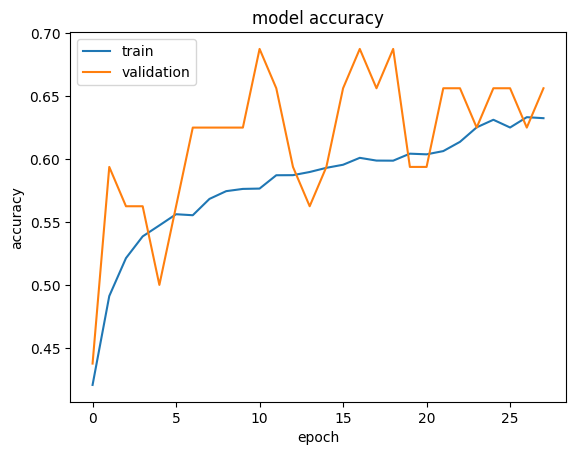

In [55]:
plt.plot(history_efficient.history["accuracy"])
plt.plot(history_efficient.history["val_accuracy"])
plt.title("model accuracy")
plt.ylabel("accuracy")
plt.xlabel("epoch")
plt.legend(["train", "validation"], loc="upper left")
plt.show()

### **Evaluating the EfficientnetNet Model**


In [56]:
# Calculate the number of steps for the entire test set to be processed
test_steps = test_generator.samples // batch_size

# If the number of samples isn't a multiple of the batch size,
# you have one more batch with the remaining samples
if test_generator.samples % batch_size > 0:
    test_steps += 1

# Evaluating the model on the test set
evaluation_results = new_efficient_model.evaluate(test_generator, steps=test_steps)
print(f"Loss: {evaluation_results[0]}, Accuracy: {evaluation_results[1]}")

1/4 [======>.......................] - ETA: 2s - loss: 0.7779 - accuracy: 0.7188

3/4 [=====================>........] - ETA: 0s - loss: 0.9031 - accuracy: 0.6250

4/4 [==============================] - 1s 35ms/step - loss: 0.8730 - accuracy: 0.6484


Loss: 0.8730216026306152, Accuracy: 0.6484375


### **Plotting the confusion matrix**


1/4 [======>.......................] - ETA: 1s

3/4 [=====================>........] - ETA: 0s

4/4 [==============================] - 1s 31ms/step


              precision    recall  f1-score   support

       happy       0.62      0.72      0.67        32
     neutral       0.60      0.38      0.46        32
         sad       0.54      0.78      0.64        32
    surprise       0.92      0.72      0.81        32

    accuracy                           0.65       128
   macro avg       0.67      0.65      0.64       128
weighted avg       0.67      0.65      0.64       128



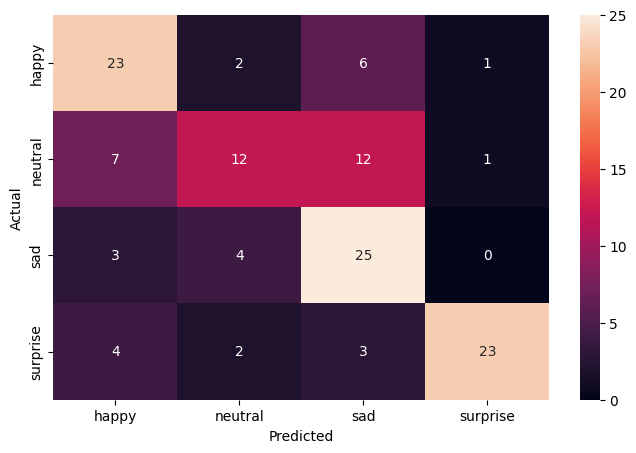

In [57]:
pred_probabilities = new_efficient_model.predict(test_generator, steps=test_steps)
pred = np.argmax(pred_probabilities, axis=1)

# Getting the true labels from the generator
y_true = test_generator.classes

# Printing the classification report with actual emotion labels
print(classification_report(y_true, pred, target_names=CATEGORIES))

# Plotting the heatmap using confusion matrix
cm = confusion_matrix(y_true, pred)
plt.figure(figsize=(8, 5))
sns.heatmap(cm, annot=True, fmt=".0f", xticklabels=CATEGORIES, yticklabels=CATEGORIES)
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.show()

**Observations and Insights:\_\_**

**Note: You can even go back and build your own architecture on top of the VGG16 Transfer layer and see if you can improve the performance.**


**Think About It:**

- What is your overall performance of these Transfer Learning Architectures? Can we draw a comparison of these models' performances. Are we satisfied with the accuracies that we have received?
- Do you think our issue lies with 'rgb' color_mode?


Now that we have tried multiple pre-trained models, let's build a complex CNN architecture and see if we can get better performance.


## **Building a Complex Neural Network Architecture**


In this section, we will build a more complex Convolutional Neural Network Model that has close to as many parameters as we had in our Transfer Learning Models. However, we will have only 1 input channel for our input images.


## **Creating our Data Loaders**

In this section, we are creating data loaders which we will use as inputs to the more Complicated Convolutional Neural Network. We will go ahead with color_mode = 'grayscale'.


In [58]:
# Set this to 'grayscale' as the images are in grayscale
color_mode = "grayscale"

# As we have checked, all images are 48x48, we will set the img_width and img_height to 48
img_width, img_height = 48, 48
# A batch size of 32 is appropriate for this dataset provide to provide a good balance
# between the model's ability to generalize (avoid overfitting) and computational efficiency.
batch_size = 32

# Training Data Augmentation
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,  # Normalize pixel values to [0,1]
    rotation_range=20,  # Slight rotation to introduce variability without distorting emotion features
    width_shift_range=0.1,  # Slight horizontal shifts to simulate off-center faces
    height_shift_range=0.1,  # Slight vertical shifts to account for different heights/angles
    shear_range=0.1,  # Small shear transformations for slight perspective changes
    zoom_range=0.1,  # Small zoom in/out to simulate closer or further away faces
    horizontal_flip=True,  # Faces are symmetric; flipping can simulate looking from another direction
    fill_mode="nearest",  # 'nearest' interpolation for filling in new pixels after a transformation
)

# Validation and Testing Data should not be augmented!
validation_datagen = ImageDataGenerator(rescale=1.0 / 255)
test_datagen = ImageDataGenerator(rescale=1.0 / 255)

# Assuming train_dir, validation_dir, and test_dir should follow the structure in DATADIR and SUBDIRS
train_dir = os.path.join(DATADIR, SUBDIRS_DICT["train"])
validation_dir = os.path.join(DATADIR, SUBDIRS_DICT["validation"])
test_dir = os.path.join(DATADIR, SUBDIRS_DICT["test"])

# Train Generator
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    color_mode=color_mode,  # Set to 'grayscale'
    class_mode="categorical",
)

# Validation Generator
validation_generator = validation_datagen.flow_from_directory(
    validation_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    color_mode=color_mode,  # Set to 'grayscale'
    class_mode="categorical",
    shuffle=False,  # shuffle=False to keep data in order for evaluation
)

# Testing Generator
test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    color_mode=color_mode,  # Set to 'grayscale'
    class_mode="categorical",
    shuffle=False,  # shuffle=False to keep data in order for testing
)

Found 15109 images belonging to 4 classes.


Found 4977 images belonging to 4 classes.


Found 128 images belonging to 4 classes.


### **Model Building**

- Try building a layer with 5 Convolutional Blocks and see if performance increases.


In [59]:
# Initializing a sequential model
model_complex = Sequential()

# Adding first conv layer
model_complex.add(Conv2D(filters=512, kernel_size=(5, 5), padding="Same", input_shape=(48, 48, 1), activation="relu"))
model_complex.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model_complex.add(Dropout(0.2))

# Adding second conv layer
model_complex.add(Conv2D(filters=256, kernel_size=(5, 5), padding="Same", input_shape=(48, 48, 1), activation="relu"))
model_complex.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model_complex.add(Dropout(0.2))

# Adding third conv layer
model_complex.add(Conv2D(filters=128, kernel_size=(5, 5), padding="Same", activation="relu"))
model_complex.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model_complex.add(Dropout(0.3))

# Adding fourth conv layer
model_complex.add(Conv2D(filters=64, kernel_size=(3, 3), padding="Same", activation="relu"))
model_complex.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model_complex.add(Dropout(0.3))

# Adding fifth conv layer
model_complex.add(Conv2D(filters=32, kernel_size=(3, 3), padding="Same", activation="relu"))
model_complex.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model_complex.add(Dropout(0.3))

# Flattening
model_complex.add(Flatten())
model_complex.add(Dense(64, activation="relu"))
model_complex.add(Dense(32, activation="relu"))

# Adding the output layer with 4 neurons and activation functions as softmax since this is a multi-class classification problem
model_complex.add(Dense(4, activation="softmax"))

# Using Adam Optimizer
optimizer = Adam(learning_rate=0.0005)

### **Compiling and Training the Model**


In [60]:
model_complex.compile(optimizer=optimizer, loss="categorical_crossentropy", metrics=["accuracy"])
model_complex.summary()

Model: "sequential_1"


_________________________________________________________________


 Layer (type)                Output Shape              Param #   


 conv2d (Conv2D)             (None, 48, 48, 512)       13312     


 max_pooling2d (MaxPooling2  (None, 24, 24, 512)       0         


 D)                                                              


 dropout_2 (Dropout)         (None, 24, 24, 512)       0         


 conv2d_1 (Conv2D)           (None, 24, 24, 256)       3277056   


 max_pooling2d_1 (MaxPoolin  (None, 12, 12, 256)       0         


 g2D)                                                            


 dropout_3 (Dropout)         (None, 12, 12, 256)       0         


 conv2d_2 (Conv2D)           (None, 12, 12, 128)       819328    


 max_pooling2d_2 (MaxPoolin  (None, 6, 6, 128)         0         


 g2D)                                                            


 dropout_4 (Dropout)         (None, 6, 6, 128)         0         


 conv2d_3 (Conv2D)           (None, 6, 6, 64)          73792     


 max_pooling2d_3 (MaxPoolin  (None, 3, 3, 64)          0         


 g2D)                                                            


 dropout_5 (Dropout)         (None, 3, 3, 64)          0         


 conv2d_4 (Conv2D)           (None, 3, 3, 32)          18464     


 max_pooling2d_4 (MaxPoolin  (None, 1, 1, 32)          0         


 g2D)                                                            


 dropout_6 (Dropout)         (None, 1, 1, 32)          0         


 flatten (Flatten)           (None, 32)                0         


 dense_3 (Dense)             (None, 64)                2112      


 dense_4 (Dense)             (None, 32)                2080      


 dense_5 (Dense)             (None, 4)                 132       


Total params: 4206276 (16.05 MB)


Trainable params: 4206276 (16.05 MB)


Non-trainable params: 0 (0.00 Byte)


_________________________________________________________________


In [61]:
# Get the current time
current_time = datetime.now().strftime("%Y%m%d-%H%M%S")

# Set up Early Stopping with a patience 7 but acting after at least 30 epochs
delayed_early_stopping = DelayedEarlyStopping(
    monitor="val_loss", patience=7, verbose=1, restore_best_weights=True, start_epoch=30
)

# Define the learning rate scheduler callback
reduce_lr = ReduceLROnPlateau(monitor="val_loss", factor=0.2, patience=5, min_lr=0.00001, verbose=1)

mc = ModelCheckpoint(
    f"{results_path}/best_model_complex_{current_time}.keras",
    monitor="val_accuracy",
    mode="max",
    verbose=1,
    save_best_only=True,
)

# Pulling a single large batch of random validation data for doing the validation after each epoch
validationX, validationY = validation_generator.next()

# Fitting the model with 40 epochs and using validation set
history_complex = model_complex.fit(
    train_generator,
    epochs=40,
    validation_data=(validationX, validationY),
    callbacks=[delayed_early_stopping, mc, reduce_lr],
)

Epoch 1/40


2024-03-18 08:14:21.465236: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_2/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


  1/473 [..............................] - ETA: 28:26 - loss: 1.3876 - accuracy: 0.2500

  4/473 [..............................] - ETA: 10s - loss: 1.4294 - accuracy: 0.2344  

  7/473 [..............................] - ETA: 10s - loss: 1.4160 - accuracy: 0.2455

 10/473 [..............................] - ETA: 10s - loss: 1.4102 - accuracy: 0.2469

 13/473 [..............................] - ETA: 9s - loss: 1.4047 - accuracy: 0.2548 

 16/473 [>.............................] - ETA: 9s - loss: 1.4006 - accuracy: 0.2637

 19/473 [>.............................] - ETA: 9s - loss: 1.3984 - accuracy: 0.2648

 22/473 [>.............................] - ETA: 9s - loss: 1.3964 - accuracy: 0.2756

 25/473 [>.............................] - ETA: 9s - loss: 1.3961 - accuracy: 0.2663

 28/473 [>.............................] - ETA: 9s - loss: 1.3948 - accuracy: 0.2701

 31/473 [>.............................] - ETA: 9s - loss: 1.3941 - accuracy: 0.2722

 34/473 [=>............................] - ETA: 9s - loss: 1.3931 - accuracy: 0.2776

 37/473 [=>............................] - ETA: 9s - loss: 1.3921 - accuracy: 0.2829

 40/473 [=>............................] - ETA: 9s - loss: 1.3917 - accuracy: 0.2797

 43/473 [=>............................] - ETA: 9s - loss: 1.3910 - accuracy: 0.2834

 46/473 [=>............................] - ETA: 9s - loss: 1.3913 - accuracy: 0.2785

 49/473 [==>...........................] - ETA: 8s - loss: 1.3908 - accuracy: 0.2787

 52/473 [==>...........................] - ETA: 8s - loss: 1.3904 - accuracy: 0.2776

 55/473 [==>...........................] - ETA: 8s - loss: 1.3903 - accuracy: 0.2744

 58/473 [==>...........................] - ETA: 8s - loss: 1.3901 - accuracy: 0.2726

 61/473 [==>...........................] - ETA: 8s - loss: 1.3898 - accuracy: 0.2700

 64/473 [===>..........................] - ETA: 8s - loss: 1.3896 - accuracy: 0.2676

 67/473 [===>..........................] - ETA: 8s - loss: 1.3895 - accuracy: 0.2668

 70/473 [===>..........................] - ETA: 8s - loss: 1.3894 - accuracy: 0.2665

 73/473 [===>..........................] - ETA: 8s - loss: 1.3893 - accuracy: 0.2667

 76/473 [===>..........................] - ETA: 8s - loss: 1.3892 - accuracy: 0.2652

 79/473 [====>.........................] - ETA: 8s - loss: 1.3891 - accuracy: 0.2619

 82/473 [====>.........................] - ETA: 8s - loss: 1.3889 - accuracy: 0.2641

 85/473 [====>.........................] - ETA: 8s - loss: 1.3888 - accuracy: 0.2599

 88/473 [====>.........................] - ETA: 8s - loss: 1.3886 - accuracy: 0.2599

 91/473 [====>.........................] - ETA: 7s - loss: 1.3885 - accuracy: 0.2600

 94/473 [====>.........................] - ETA: 7s - loss: 1.3883 - accuracy: 0.2610

 97/473 [=====>........................] - ETA: 7s - loss: 1.3882 - accuracy: 0.2619

100/473 [=====>........................] - ETA: 7s - loss: 1.3880 - accuracy: 0.2625

103/473 [=====>........................] - ETA: 7s - loss: 1.3878 - accuracy: 0.2633

106/473 [=====>........................] - ETA: 7s - loss: 1.3878 - accuracy: 0.2633

109/473 [=====>........................] - ETA: 7s - loss: 1.3877 - accuracy: 0.2632

112/473 [======>.......................] - ETA: 7s - loss: 1.3875 - accuracy: 0.2640

115/473 [======>.......................] - ETA: 7s - loss: 1.3874 - accuracy: 0.2639

118/473 [======>.......................] - ETA: 7s - loss: 1.3873 - accuracy: 0.2651

121/473 [======>.......................] - ETA: 7s - loss: 1.3873 - accuracy: 0.2634

124/473 [======>.......................] - ETA: 7s - loss: 1.3871 - accuracy: 0.2649

127/473 [=======>......................] - ETA: 7s - loss: 1.3870 - accuracy: 0.2643

130/473 [=======>......................] - ETA: 7s - loss: 1.3871 - accuracy: 0.2644

133/473 [=======>......................] - ETA: 7s - loss: 1.3871 - accuracy: 0.2636

136/473 [=======>......................] - ETA: 7s - loss: 1.3871 - accuracy: 0.2638

139/473 [=======>......................] - ETA: 6s - loss: 1.3870 - accuracy: 0.2639

142/473 [========>.....................] - ETA: 6s - loss: 1.3869 - accuracy: 0.2636

145/473 [========>.....................] - ETA: 6s - loss: 1.3868 - accuracy: 0.2638

148/473 [========>.....................] - ETA: 6s - loss: 1.3867 - accuracy: 0.2648

149/473 [========>.....................] - ETA: 8s - loss: 1.3867 - accuracy: 0.2647

152/473 [========>.....................] - ETA: 8s - loss: 1.3866 - accuracy: 0.2638

155/473 [========>.....................] - ETA: 8s - loss: 1.3865 - accuracy: 0.2641

158/473 [=========>....................] - ETA: 8s - loss: 1.3863 - accuracy: 0.2647

161/473 [=========>....................] - ETA: 7s - loss: 1.3863 - accuracy: 0.2644

164/473 [=========>....................] - ETA: 7s - loss: 1.3861 - accuracy: 0.2649

167/473 [=========>....................] - ETA: 7s - loss: 1.3860 - accuracy: 0.2644

170/473 [=========>....................] - ETA: 7s - loss: 1.3859 - accuracy: 0.2640

173/473 [=========>....................] - ETA: 7s - loss: 1.3857 - accuracy: 0.2641

176/473 [==========>...................] - ETA: 7s - loss: 1.3857 - accuracy: 0.2635

179/473 [==========>...................] - ETA: 7s - loss: 1.3856 - accuracy: 0.2635

182/473 [==========>...................] - ETA: 7s - loss: 1.3856 - accuracy: 0.2631

185/473 [==========>...................] - ETA: 7s - loss: 1.3855 - accuracy: 0.2627

188/473 [==========>...................] - ETA: 7s - loss: 1.3854 - accuracy: 0.2618

191/473 [===========>..................] - ETA: 6s - loss: 1.3853 - accuracy: 0.2624

194/473 [===========>..................] - ETA: 6s - loss: 1.3851 - accuracy: 0.2618

197/473 [===========>..................] - ETA: 6s - loss: 1.3851 - accuracy: 0.2624

200/473 [===========>..................] - ETA: 6s - loss: 1.3850 - accuracy: 0.2613

203/473 [===========>..................] - ETA: 6s - loss: 1.3850 - accuracy: 0.2609

206/473 [============>.................] - ETA: 6s - loss: 1.3850 - accuracy: 0.2605

209/473 [============>.................] - ETA: 6s - loss: 1.3851 - accuracy: 0.2606

212/473 [============>.................] - ETA: 6s - loss: 1.3850 - accuracy: 0.2605

215/473 [============>.................] - ETA: 6s - loss: 1.3851 - accuracy: 0.2608

218/473 [============>.................] - ETA: 6s - loss: 1.3850 - accuracy: 0.2602

221/473 [=============>................] - ETA: 6s - loss: 1.3851 - accuracy: 0.2593

224/473 [=============>................] - ETA: 5s - loss: 1.3850 - accuracy: 0.2588

227/473 [=============>................] - ETA: 5s - loss: 1.3849 - accuracy: 0.2588

230/473 [=============>................] - ETA: 5s - loss: 1.3846 - accuracy: 0.2586

233/473 [=============>................] - ETA: 5s - loss: 1.3849 - accuracy: 0.2572

236/473 [=============>................] - ETA: 5s - loss: 1.3848 - accuracy: 0.2570

239/473 [==============>...............] - ETA: 5s - loss: 1.3848 - accuracy: 0.2564

242/473 [==============>...............] - ETA: 5s - loss: 1.3848 - accuracy: 0.2566

245/473 [==============>...............] - ETA: 5s - loss: 1.3848 - accuracy: 0.2566

248/473 [==============>...............] - ETA: 5s - loss: 1.3847 - accuracy: 0.2565

251/473 [==============>...............] - ETA: 5s - loss: 1.3847 - accuracy: 0.2561

254/473 [===============>..............] - ETA: 5s - loss: 1.3847 - accuracy: 0.2565

257/473 [===============>..............] - ETA: 5s - loss: 1.3847 - accuracy: 0.2567

260/473 [===============>..............] - ETA: 5s - loss: 1.3846 - accuracy: 0.2566

263/473 [===============>..............] - ETA: 4s - loss: 1.3846 - accuracy: 0.2566

266/473 [===============>..............] - ETA: 4s - loss: 1.3846 - accuracy: 0.2568

269/473 [================>.............] - ETA: 4s - loss: 1.3845 - accuracy: 0.2572

272/473 [================>.............] - ETA: 4s - loss: 1.3844 - accuracy: 0.2572

275/473 [================>.............] - ETA: 4s - loss: 1.3846 - accuracy: 0.2570

278/473 [================>.............] - ETA: 4s - loss: 1.3846 - accuracy: 0.2579

281/473 [================>.............] - ETA: 4s - loss: 1.3845 - accuracy: 0.2577

284/473 [=================>............] - ETA: 4s - loss: 1.3845 - accuracy: 0.2570

287/473 [=================>............] - ETA: 4s - loss: 1.3844 - accuracy: 0.2573

290/473 [=================>............] - ETA: 4s - loss: 1.3842 - accuracy: 0.2572

293/473 [=================>............] - ETA: 4s - loss: 1.3841 - accuracy: 0.2570

296/473 [=================>............] - ETA: 4s - loss: 1.3840 - accuracy: 0.2574

299/473 [=================>............] - ETA: 4s - loss: 1.3839 - accuracy: 0.2573

302/473 [==================>...........] - ETA: 3s - loss: 1.3840 - accuracy: 0.2577

305/473 [==================>...........] - ETA: 3s - loss: 1.3839 - accuracy: 0.2572

308/473 [==================>...........] - ETA: 3s - loss: 1.3841 - accuracy: 0.2563

311/473 [==================>...........] - ETA: 3s - loss: 1.3841 - accuracy: 0.2564

314/473 [==================>...........] - ETA: 3s - loss: 1.3841 - accuracy: 0.2564

317/473 [===================>..........] - ETA: 3s - loss: 1.3841 - accuracy: 0.2570

320/473 [===================>..........] - ETA: 3s - loss: 1.3841 - accuracy: 0.2572

323/473 [===================>..........] - ETA: 3s - loss: 1.3841 - accuracy: 0.2578

326/473 [===================>..........] - ETA: 3s - loss: 1.3839 - accuracy: 0.2584

329/473 [===================>..........] - ETA: 3s - loss: 1.3838 - accuracy: 0.2581

332/473 [====================>.........] - ETA: 3s - loss: 1.3838 - accuracy: 0.2577

335/473 [====================>.........] - ETA: 3s - loss: 1.3837 - accuracy: 0.2576

338/473 [====================>.........] - ETA: 3s - loss: 1.3835 - accuracy: 0.2575

341/473 [====================>.........] - ETA: 3s - loss: 1.3836 - accuracy: 0.2586

344/473 [====================>.........] - ETA: 2s - loss: 1.3837 - accuracy: 0.2590

347/473 [=====================>........] - ETA: 2s - loss: 1.3837 - accuracy: 0.2587

350/473 [=====================>........] - ETA: 2s - loss: 1.3840 - accuracy: 0.2585

353/473 [=====================>........] - ETA: 2s - loss: 1.3838 - accuracy: 0.2585

356/473 [=====================>........] - ETA: 2s - loss: 1.3838 - accuracy: 0.2589

359/473 [=====================>........] - ETA: 2s - loss: 1.3838 - accuracy: 0.2590

362/473 [=====================>........] - ETA: 2s - loss: 1.3836 - accuracy: 0.2597

365/473 [======================>.......] - ETA: 2s - loss: 1.3836 - accuracy: 0.2602

368/473 [======================>.......] - ETA: 2s - loss: 1.3834 - accuracy: 0.2606

371/473 [======================>.......] - ETA: 2s - loss: 1.3833 - accuracy: 0.2610

374/473 [======================>.......] - ETA: 2s - loss: 1.3832 - accuracy: 0.2614

377/473 [======================>.......] - ETA: 2s - loss: 1.3831 - accuracy: 0.2615

380/473 [=======================>......] - ETA: 2s - loss: 1.3832 - accuracy: 0.2623

383/473 [=======================>......] - ETA: 2s - loss: 1.3831 - accuracy: 0.2622

386/473 [=======================>......] - ETA: 1s - loss: 1.3830 - accuracy: 0.2623

389/473 [=======================>......] - ETA: 1s - loss: 1.3829 - accuracy: 0.2625

392/473 [=======================>......] - ETA: 1s - loss: 1.3830 - accuracy: 0.2624

395/473 [========================>.....] - ETA: 1s - loss: 1.3830 - accuracy: 0.2627

398/473 [========================>.....] - ETA: 1s - loss: 1.3829 - accuracy: 0.2626

401/473 [========================>.....] - ETA: 1s - loss: 1.3830 - accuracy: 0.2623

404/473 [========================>.....] - ETA: 1s - loss: 1.3829 - accuracy: 0.2623

407/473 [========================>.....] - ETA: 1s - loss: 1.3828 - accuracy: 0.2624

410/473 [=========================>....] - ETA: 1s - loss: 1.3826 - accuracy: 0.2625

413/473 [=========================>....] - ETA: 1s - loss: 1.3825 - accuracy: 0.2627

416/473 [=========================>....] - ETA: 1s - loss: 1.3826 - accuracy: 0.2626

419/473 [=========================>....] - ETA: 1s - loss: 1.3828 - accuracy: 0.2628

422/473 [=========================>....] - ETA: 1s - loss: 1.3828 - accuracy: 0.2623

425/473 [=========================>....] - ETA: 1s - loss: 1.3828 - accuracy: 0.2624

428/473 [==========================>...] - ETA: 1s - loss: 1.3828 - accuracy: 0.2629

431/473 [==========================>...] - ETA: 0s - loss: 1.3829 - accuracy: 0.2629

434/473 [==========================>...] - ETA: 0s - loss: 1.3828 - accuracy: 0.2627

437/473 [==========================>...] - ETA: 0s - loss: 1.3828 - accuracy: 0.2628

440/473 [==========================>...] - ETA: 0s - loss: 1.3827 - accuracy: 0.2629

443/473 [===========================>..] - ETA: 0s - loss: 1.3828 - accuracy: 0.2628

446/473 [===========================>..] - ETA: 0s - loss: 1.3828 - accuracy: 0.2629

449/473 [===========================>..] - ETA: 0s - loss: 1.3827 - accuracy: 0.2633

452/473 [===========================>..] - ETA: 0s - loss: 1.3827 - accuracy: 0.2634

455/473 [===========================>..] - ETA: 0s - loss: 1.3827 - accuracy: 0.2632

458/473 [============================>.] - ETA: 0s - loss: 1.3827 - accuracy: 0.2631

461/473 [============================>.] - ETA: 0s - loss: 1.3827 - accuracy: 0.2631

464/473 [============================>.] - ETA: 0s - loss: 1.3827 - accuracy: 0.2629

467/473 [============================>.] - ETA: 0s - loss: 1.3826 - accuracy: 0.2632

470/473 [============================>.] - ETA: 0s - loss: 1.3828 - accuracy: 0.2632

473/473 [==============================] - ETA: 0s - loss: 1.3827 - accuracy: 0.2636


Epoch 1: val_accuracy improved from -inf to 0.71875, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_complex_20240318-081420.keras


473/473 [==============================] - 14s 23ms/step - loss: 1.3827 - accuracy: 0.2636 - val_loss: 1.3358 - val_accuracy: 0.7188 - lr: 5.0000e-04


Epoch 2/40


  1/473 [..............................] - ETA: 17s - loss: 1.3634 - accuracy: 0.2812

  4/473 [..............................] - ETA: 9s - loss: 1.3670 - accuracy: 0.3047 

  7/473 [..............................] - ETA: 9s - loss: 1.3725 - accuracy: 0.2902

 10/473 [..............................] - ETA: 9s - loss: 1.3727 - accuracy: 0.2844

 13/473 [..............................] - ETA: 9s - loss: 1.3693 - accuracy: 0.2837

 16/473 [>.............................] - ETA: 9s - loss: 1.3727 - accuracy: 0.2852

 19/473 [>.............................] - ETA: 9s - loss: 1.3745 - accuracy: 0.2796

 22/473 [>.............................] - ETA: 9s - loss: 1.3767 - accuracy: 0.2756

 25/473 [>.............................] - ETA: 9s - loss: 1.3738 - accuracy: 0.2837

 28/473 [>.............................] - ETA: 9s - loss: 1.3729 - accuracy: 0.2835

 31/473 [>.............................] - ETA: 9s - loss: 1.3704 - accuracy: 0.2893

 34/473 [=>............................] - ETA: 9s - loss: 1.3668 - accuracy: 0.2914

 37/473 [=>............................] - ETA: 9s - loss: 1.3658 - accuracy: 0.2998

 40/473 [=>............................] - ETA: 9s - loss: 1.3684 - accuracy: 0.3008

 43/473 [=>............................] - ETA: 9s - loss: 1.3672 - accuracy: 0.3031

 46/473 [=>............................] - ETA: 9s - loss: 1.3686 - accuracy: 0.3010

 49/473 [==>...........................] - ETA: 8s - loss: 1.3691 - accuracy: 0.2966

 52/473 [==>...........................] - ETA: 8s - loss: 1.3705 - accuracy: 0.2873

 55/473 [==>...........................] - ETA: 8s - loss: 1.3716 - accuracy: 0.2858

 58/473 [==>...........................] - ETA: 8s - loss: 1.3729 - accuracy: 0.2834

 61/473 [==>...........................] - ETA: 8s - loss: 1.3728 - accuracy: 0.2864

 64/473 [===>..........................] - ETA: 8s - loss: 1.3727 - accuracy: 0.2871

 67/473 [===>..........................] - ETA: 8s - loss: 1.3734 - accuracy: 0.2910

 70/473 [===>..........................] - ETA: 8s - loss: 1.3737 - accuracy: 0.2897

 73/473 [===>..........................] - ETA: 8s - loss: 1.3739 - accuracy: 0.2885

 76/473 [===>..........................] - ETA: 8s - loss: 1.3738 - accuracy: 0.2891

 79/473 [====>.........................] - ETA: 8s - loss: 1.3729 - accuracy: 0.2907

 82/473 [====>.........................] - ETA: 8s - loss: 1.3741 - accuracy: 0.2889

 85/473 [====>.........................] - ETA: 8s - loss: 1.3737 - accuracy: 0.2875

 88/473 [====>.........................] - ETA: 8s - loss: 1.3738 - accuracy: 0.2848

 91/473 [====>.........................] - ETA: 8s - loss: 1.3739 - accuracy: 0.2830

 94/473 [====>.........................] - ETA: 8s - loss: 1.3743 - accuracy: 0.2793

 97/473 [=====>........................] - ETA: 7s - loss: 1.3741 - accuracy: 0.2809

100/473 [=====>........................] - ETA: 7s - loss: 1.3737 - accuracy: 0.2800

103/473 [=====>........................] - ETA: 7s - loss: 1.3738 - accuracy: 0.2819

106/473 [=====>........................] - ETA: 7s - loss: 1.3733 - accuracy: 0.2830

109/473 [=====>........................] - ETA: 7s - loss: 1.3738 - accuracy: 0.2821

112/473 [======>.......................] - ETA: 7s - loss: 1.3736 - accuracy: 0.2832

115/473 [======>.......................] - ETA: 7s - loss: 1.3733 - accuracy: 0.2840

118/473 [======>.......................] - ETA: 7s - loss: 1.3729 - accuracy: 0.2836

121/473 [======>.......................] - ETA: 7s - loss: 1.3725 - accuracy: 0.2851

124/473 [======>.......................] - ETA: 7s - loss: 1.3721 - accuracy: 0.2848

127/473 [=======>......................] - ETA: 7s - loss: 1.3724 - accuracy: 0.2847

130/473 [=======>......................] - ETA: 7s - loss: 1.3732 - accuracy: 0.2829

133/473 [=======>......................] - ETA: 7s - loss: 1.3731 - accuracy: 0.2808

136/473 [=======>......................] - ETA: 7s - loss: 1.3732 - accuracy: 0.2810

139/473 [=======>......................] - ETA: 7s - loss: 1.3736 - accuracy: 0.2806

142/473 [========>.....................] - ETA: 6s - loss: 1.3735 - accuracy: 0.2799

145/473 [========>.....................] - ETA: 6s - loss: 1.3734 - accuracy: 0.2795

148/473 [========>.....................] - ETA: 6s - loss: 1.3734 - accuracy: 0.2799

151/473 [========>.....................] - ETA: 6s - loss: 1.3733 - accuracy: 0.2807

154/473 [========>.....................] - ETA: 6s - loss: 1.3730 - accuracy: 0.2810

157/473 [========>.....................] - ETA: 6s - loss: 1.3723 - accuracy: 0.2830

160/473 [=========>....................] - ETA: 6s - loss: 1.3724 - accuracy: 0.2833

163/473 [=========>....................] - ETA: 6s - loss: 1.3732 - accuracy: 0.2829

166/473 [=========>....................] - ETA: 6s - loss: 1.3731 - accuracy: 0.2825

169/473 [=========>....................] - ETA: 6s - loss: 1.3730 - accuracy: 0.2828

172/473 [=========>....................] - ETA: 6s - loss: 1.3727 - accuracy: 0.2843

175/473 [==========>...................] - ETA: 6s - loss: 1.3729 - accuracy: 0.2839

178/473 [==========>...................] - ETA: 6s - loss: 1.3727 - accuracy: 0.2842

181/473 [==========>...................] - ETA: 6s - loss: 1.3730 - accuracy: 0.2843

184/473 [==========>...................] - ETA: 6s - loss: 1.3729 - accuracy: 0.2837

187/473 [==========>...................] - ETA: 6s - loss: 1.3725 - accuracy: 0.2842

190/473 [===========>..................] - ETA: 5s - loss: 1.3723 - accuracy: 0.2842

193/473 [===========>..................] - ETA: 5s - loss: 1.3717 - accuracy: 0.2862

196/473 [===========>..................] - ETA: 5s - loss: 1.3708 - accuracy: 0.2868

199/473 [===========>..................] - ETA: 5s - loss: 1.3718 - accuracy: 0.2861

202/473 [===========>..................] - ETA: 5s - loss: 1.3714 - accuracy: 0.2855

205/473 [============>.................] - ETA: 5s - loss: 1.3714 - accuracy: 0.2861

208/473 [============>.................] - ETA: 5s - loss: 1.3714 - accuracy: 0.2854

211/473 [============>.................] - ETA: 5s - loss: 1.3714 - accuracy: 0.2854

214/473 [============>.................] - ETA: 5s - loss: 1.3714 - accuracy: 0.2866

217/473 [============>.................] - ETA: 5s - loss: 1.3709 - accuracy: 0.2867

220/473 [============>.................] - ETA: 5s - loss: 1.3709 - accuracy: 0.2868

223/473 [=============>................] - ETA: 5s - loss: 1.3711 - accuracy: 0.2865

226/473 [=============>................] - ETA: 5s - loss: 1.3712 - accuracy: 0.2866

229/473 [=============>................] - ETA: 5s - loss: 1.3711 - accuracy: 0.2861

232/473 [=============>................] - ETA: 5s - loss: 1.3713 - accuracy: 0.2867

235/473 [=============>................] - ETA: 5s - loss: 1.3710 - accuracy: 0.2877

238/473 [==============>...............] - ETA: 4s - loss: 1.3711 - accuracy: 0.2878

241/473 [==============>...............] - ETA: 4s - loss: 1.3712 - accuracy: 0.2876

244/473 [==============>...............] - ETA: 4s - loss: 1.3714 - accuracy: 0.2867

247/473 [==============>...............] - ETA: 4s - loss: 1.3717 - accuracy: 0.2865

250/473 [==============>...............] - ETA: 4s - loss: 1.3717 - accuracy: 0.2871

253/473 [===============>..............] - ETA: 4s - loss: 1.3718 - accuracy: 0.2868

256/473 [===============>..............] - ETA: 4s - loss: 1.3719 - accuracy: 0.2862

259/473 [===============>..............] - ETA: 4s - loss: 1.3718 - accuracy: 0.2865

262/473 [===============>..............] - ETA: 4s - loss: 1.3715 - accuracy: 0.2872

265/473 [===============>..............] - ETA: 4s - loss: 1.3713 - accuracy: 0.2885

268/473 [===============>..............] - ETA: 4s - loss: 1.3714 - accuracy: 0.2883

271/473 [================>.............] - ETA: 4s - loss: 1.3714 - accuracy: 0.2884

274/473 [================>.............] - ETA: 4s - loss: 1.3710 - accuracy: 0.2894

277/473 [================>.............] - ETA: 4s - loss: 1.3711 - accuracy: 0.2900

280/473 [================>.............] - ETA: 4s - loss: 1.3707 - accuracy: 0.2903

283/473 [================>.............] - ETA: 3s - loss: 1.3710 - accuracy: 0.2898

286/473 [=================>............] - ETA: 3s - loss: 1.3710 - accuracy: 0.2899

289/473 [=================>............] - ETA: 3s - loss: 1.3710 - accuracy: 0.2894

292/473 [=================>............] - ETA: 3s - loss: 1.3710 - accuracy: 0.2895

295/473 [=================>............] - ETA: 3s - loss: 1.3711 - accuracy: 0.2891

298/473 [=================>............] - ETA: 3s - loss: 1.3710 - accuracy: 0.2895

301/473 [==================>...........] - ETA: 3s - loss: 1.3710 - accuracy: 0.2897

304/473 [==================>...........] - ETA: 3s - loss: 1.3709 - accuracy: 0.2895

307/473 [==================>...........] - ETA: 3s - loss: 1.3708 - accuracy: 0.2897

310/473 [==================>...........] - ETA: 3s - loss: 1.3705 - accuracy: 0.2902

313/473 [==================>...........] - ETA: 3s - loss: 1.3699 - accuracy: 0.2910

316/473 [===================>..........] - ETA: 3s - loss: 1.3700 - accuracy: 0.2907

319/473 [===================>..........] - ETA: 3s - loss: 1.3700 - accuracy: 0.2901

322/473 [===================>..........] - ETA: 3s - loss: 1.3698 - accuracy: 0.2904

325/473 [===================>..........] - ETA: 3s - loss: 1.3697 - accuracy: 0.2907

328/473 [===================>..........] - ETA: 3s - loss: 1.3699 - accuracy: 0.2897

331/473 [===================>..........] - ETA: 2s - loss: 1.3700 - accuracy: 0.2892

334/473 [====================>.........] - ETA: 2s - loss: 1.3702 - accuracy: 0.2890

337/473 [====================>.........] - ETA: 2s - loss: 1.3703 - accuracy: 0.2889

340/473 [====================>.........] - ETA: 2s - loss: 1.3703 - accuracy: 0.2890

343/473 [====================>.........] - ETA: 2s - loss: 1.3704 - accuracy: 0.2888

346/473 [====================>.........] - ETA: 2s - loss: 1.3705 - accuracy: 0.2884

349/473 [=====================>........] - ETA: 2s - loss: 1.3706 - accuracy: 0.2884

352/473 [=====================>........] - ETA: 2s - loss: 1.3706 - accuracy: 0.2881

355/473 [=====================>........] - ETA: 2s - loss: 1.3707 - accuracy: 0.2873

358/473 [=====================>........] - ETA: 2s - loss: 1.3706 - accuracy: 0.2872

361/473 [=====================>........] - ETA: 2s - loss: 1.3707 - accuracy: 0.2869

364/473 [======================>.......] - ETA: 2s - loss: 1.3706 - accuracy: 0.2873

367/473 [======================>.......] - ETA: 2s - loss: 1.3704 - accuracy: 0.2875

370/473 [======================>.......] - ETA: 2s - loss: 1.3703 - accuracy: 0.2877

373/473 [======================>.......] - ETA: 2s - loss: 1.3702 - accuracy: 0.2880

376/473 [======================>.......] - ETA: 2s - loss: 1.3702 - accuracy: 0.2884

379/473 [=======================>......] - ETA: 1s - loss: 1.3703 - accuracy: 0.2883

382/473 [=======================>......] - ETA: 1s - loss: 1.3701 - accuracy: 0.2884

385/473 [=======================>......] - ETA: 1s - loss: 1.3701 - accuracy: 0.2881

388/473 [=======================>......] - ETA: 1s - loss: 1.3701 - accuracy: 0.2879

391/473 [=======================>......] - ETA: 1s - loss: 1.3695 - accuracy: 0.2886

394/473 [=======================>......] - ETA: 1s - loss: 1.3697 - accuracy: 0.2883

397/473 [========================>.....] - ETA: 1s - loss: 1.3697 - accuracy: 0.2887

400/473 [========================>.....] - ETA: 1s - loss: 1.3696 - accuracy: 0.2891

403/473 [========================>.....] - ETA: 1s - loss: 1.3694 - accuracy: 0.2888

406/473 [========================>.....] - ETA: 1s - loss: 1.3694 - accuracy: 0.2891

409/473 [========================>.....] - ETA: 1s - loss: 1.3694 - accuracy: 0.2893

412/473 [=========================>....] - ETA: 1s - loss: 1.3692 - accuracy: 0.2892

415/473 [=========================>....] - ETA: 1s - loss: 1.3693 - accuracy: 0.2894

418/473 [=========================>....] - ETA: 1s - loss: 1.3692 - accuracy: 0.2889

421/473 [=========================>....] - ETA: 1s - loss: 1.3689 - accuracy: 0.2889

424/473 [=========================>....] - ETA: 1s - loss: 1.3694 - accuracy: 0.2885

427/473 [==========================>...] - ETA: 0s - loss: 1.3693 - accuracy: 0.2886

430/473 [==========================>...] - ETA: 0s - loss: 1.3692 - accuracy: 0.2889

433/473 [==========================>...] - ETA: 0s - loss: 1.3692 - accuracy: 0.2892

436/473 [==========================>...] - ETA: 0s - loss: 1.3692 - accuracy: 0.2890

439/473 [==========================>...] - ETA: 0s - loss: 1.3693 - accuracy: 0.2893

442/473 [===========================>..] - ETA: 0s - loss: 1.3692 - accuracy: 0.2894

445/473 [===========================>..] - ETA: 0s - loss: 1.3692 - accuracy: 0.2892

448/473 [===========================>..] - ETA: 0s - loss: 1.3692 - accuracy: 0.2890

451/473 [===========================>..] - ETA: 0s - loss: 1.3691 - accuracy: 0.2888

454/473 [===========================>..] - ETA: 0s - loss: 1.3689 - accuracy: 0.2889

457/473 [===========================>..] - ETA: 0s - loss: 1.3689 - accuracy: 0.2891

460/473 [============================>.] - ETA: 0s - loss: 1.3691 - accuracy: 0.2895

463/473 [============================>.] - ETA: 0s - loss: 1.3690 - accuracy: 0.2896

466/473 [============================>.] - ETA: 0s - loss: 1.3689 - accuracy: 0.2894

469/473 [============================>.] - ETA: 0s - loss: 1.3689 - accuracy: 0.2890

472/473 [============================>.] - ETA: 0s - loss: 1.3687 - accuracy: 0.2888


Epoch 2: val_accuracy did not improve from 0.71875


473/473 [==============================] - 10s 21ms/step - loss: 1.3688 - accuracy: 0.2886 - val_loss: 1.3881 - val_accuracy: 0.2812 - lr: 5.0000e-04


Epoch 3/40


  1/473 [..............................] - ETA: 16s - loss: 1.3766 - accuracy: 0.2500

  4/473 [..............................] - ETA: 9s - loss: 1.3602 - accuracy: 0.2656 

  7/473 [..............................] - ETA: 9s - loss: 1.3559 - accuracy: 0.2589

 10/473 [..............................] - ETA: 9s - loss: 1.3484 - accuracy: 0.2625

 13/473 [..............................] - ETA: 9s - loss: 1.3530 - accuracy: 0.2861

 16/473 [>.............................] - ETA: 9s - loss: 1.3477 - accuracy: 0.2891

 19/473 [>.............................] - ETA: 9s - loss: 1.3491 - accuracy: 0.2796

 22/473 [>.............................] - ETA: 9s - loss: 1.3469 - accuracy: 0.2869

 25/473 [>.............................] - ETA: 9s - loss: 1.3437 - accuracy: 0.2875

 28/473 [>.............................] - ETA: 9s - loss: 1.3446 - accuracy: 0.2924

 31/473 [>.............................] - ETA: 9s - loss: 1.3495 - accuracy: 0.2933

 34/473 [=>............................] - ETA: 9s - loss: 1.3497 - accuracy: 0.2914

 37/473 [=>............................] - ETA: 9s - loss: 1.3513 - accuracy: 0.2922

 40/473 [=>............................] - ETA: 9s - loss: 1.3525 - accuracy: 0.2953

 43/473 [=>............................] - ETA: 9s - loss: 1.3534 - accuracy: 0.2980

 46/473 [=>............................] - ETA: 9s - loss: 1.3536 - accuracy: 0.2962

 49/473 [==>...........................] - ETA: 8s - loss: 1.3541 - accuracy: 0.2946

 52/473 [==>...........................] - ETA: 8s - loss: 1.3549 - accuracy: 0.2963

 55/473 [==>...........................] - ETA: 8s - loss: 1.3565 - accuracy: 0.2920

 58/473 [==>...........................] - ETA: 8s - loss: 1.3576 - accuracy: 0.2899

 61/473 [==>...........................] - ETA: 8s - loss: 1.3579 - accuracy: 0.2884

 64/473 [===>..........................] - ETA: 8s - loss: 1.3568 - accuracy: 0.2920

 67/473 [===>..........................] - ETA: 8s - loss: 1.3565 - accuracy: 0.2910

 70/473 [===>..........................] - ETA: 8s - loss: 1.3558 - accuracy: 0.2924

 73/473 [===>..........................] - ETA: 8s - loss: 1.3565 - accuracy: 0.2932

 76/473 [===>..........................] - ETA: 8s - loss: 1.3563 - accuracy: 0.2919

 79/473 [====>.........................] - ETA: 8s - loss: 1.3555 - accuracy: 0.2951

 82/473 [====>.........................] - ETA: 8s - loss: 1.3557 - accuracy: 0.2946

 85/473 [====>.........................] - ETA: 8s - loss: 1.3563 - accuracy: 0.2934

 88/473 [====>.........................] - ETA: 8s - loss: 1.3563 - accuracy: 0.2919

 91/473 [====>.........................] - ETA: 8s - loss: 1.3564 - accuracy: 0.2933

 94/473 [====>.........................] - ETA: 7s - loss: 1.3569 - accuracy: 0.2936

 97/473 [=====>........................] - ETA: 7s - loss: 1.3575 - accuracy: 0.2916

100/473 [=====>........................] - ETA: 7s - loss: 1.3568 - accuracy: 0.2944

103/473 [=====>........................] - ETA: 7s - loss: 1.3576 - accuracy: 0.2940

106/473 [=====>........................] - ETA: 7s - loss: 1.3582 - accuracy: 0.2942

109/473 [=====>........................] - ETA: 7s - loss: 1.3578 - accuracy: 0.2970

112/473 [======>.......................] - ETA: 7s - loss: 1.3576 - accuracy: 0.2988

115/473 [======>.......................] - ETA: 7s - loss: 1.3587 - accuracy: 0.2995

118/473 [======>.......................] - ETA: 7s - loss: 1.3599 - accuracy: 0.2998

121/473 [======>.......................] - ETA: 7s - loss: 1.3596 - accuracy: 0.2986

124/473 [======>.......................] - ETA: 7s - loss: 1.3597 - accuracy: 0.2976

127/473 [=======>......................] - ETA: 7s - loss: 1.3591 - accuracy: 0.2997

130/473 [=======>......................] - ETA: 7s - loss: 1.3588 - accuracy: 0.2990

133/473 [=======>......................] - ETA: 7s - loss: 1.3591 - accuracy: 0.2965

136/473 [=======>......................] - ETA: 7s - loss: 1.3583 - accuracy: 0.2980

139/473 [=======>......................] - ETA: 7s - loss: 1.3583 - accuracy: 0.2970

142/473 [========>.....................] - ETA: 6s - loss: 1.3585 - accuracy: 0.2964

145/473 [========>.....................] - ETA: 6s - loss: 1.3594 - accuracy: 0.2968

148/473 [========>.....................] - ETA: 6s - loss: 1.3593 - accuracy: 0.2962

151/473 [========>.....................] - ETA: 6s - loss: 1.3593 - accuracy: 0.2962

154/473 [========>.....................] - ETA: 6s - loss: 1.3595 - accuracy: 0.2955

157/473 [========>.....................] - ETA: 6s - loss: 1.3595 - accuracy: 0.2958

160/473 [=========>....................] - ETA: 6s - loss: 1.3595 - accuracy: 0.2967

163/473 [=========>....................] - ETA: 6s - loss: 1.3598 - accuracy: 0.2954

166/473 [=========>....................] - ETA: 6s - loss: 1.3596 - accuracy: 0.2959

169/473 [=========>....................] - ETA: 6s - loss: 1.3591 - accuracy: 0.2957

172/473 [=========>....................] - ETA: 6s - loss: 1.3586 - accuracy: 0.2961

175/473 [==========>...................] - ETA: 6s - loss: 1.3587 - accuracy: 0.2955

178/473 [==========>...................] - ETA: 6s - loss: 1.3583 - accuracy: 0.2949

181/473 [==========>...................] - ETA: 6s - loss: 1.3584 - accuracy: 0.2949

184/473 [==========>...................] - ETA: 6s - loss: 1.3583 - accuracy: 0.2959

187/473 [==========>...................] - ETA: 5s - loss: 1.3584 - accuracy: 0.2961

190/473 [===========>..................] - ETA: 5s - loss: 1.3588 - accuracy: 0.2954

193/473 [===========>..................] - ETA: 5s - loss: 1.3588 - accuracy: 0.2949

196/473 [===========>..................] - ETA: 5s - loss: 1.3592 - accuracy: 0.2937

199/473 [===========>..................] - ETA: 5s - loss: 1.3598 - accuracy: 0.2932

202/473 [===========>..................] - ETA: 5s - loss: 1.3600 - accuracy: 0.2933

205/473 [============>.................] - ETA: 5s - loss: 1.3600 - accuracy: 0.2934

208/473 [============>.................] - ETA: 5s - loss: 1.3598 - accuracy: 0.2937

211/473 [============>.................] - ETA: 5s - loss: 1.3594 - accuracy: 0.2941

214/473 [============>.................] - ETA: 5s - loss: 1.3598 - accuracy: 0.2940

217/473 [============>.................] - ETA: 5s - loss: 1.3595 - accuracy: 0.2945

220/473 [============>.................] - ETA: 5s - loss: 1.3594 - accuracy: 0.2952

223/473 [=============>................] - ETA: 5s - loss: 1.3589 - accuracy: 0.2958

226/473 [=============>................] - ETA: 5s - loss: 1.3589 - accuracy: 0.2955

229/473 [=============>................] - ETA: 5s - loss: 1.3588 - accuracy: 0.2949

232/473 [=============>................] - ETA: 5s - loss: 1.3589 - accuracy: 0.2951

235/473 [=============>................] - ETA: 4s - loss: 1.3586 - accuracy: 0.2955

238/473 [==============>...............] - ETA: 4s - loss: 1.3584 - accuracy: 0.2954

241/473 [==============>...............] - ETA: 4s - loss: 1.3583 - accuracy: 0.2958

244/473 [==============>...............] - ETA: 4s - loss: 1.3574 - accuracy: 0.2964

247/473 [==============>...............] - ETA: 4s - loss: 1.3593 - accuracy: 0.2962

250/473 [==============>...............] - ETA: 4s - loss: 1.3591 - accuracy: 0.2970

253/473 [===============>..............] - ETA: 4s - loss: 1.3593 - accuracy: 0.2974

256/473 [===============>..............] - ETA: 4s - loss: 1.3598 - accuracy: 0.2966

259/473 [===============>..............] - ETA: 4s - loss: 1.3600 - accuracy: 0.2961

262/473 [===============>..............] - ETA: 4s - loss: 1.3604 - accuracy: 0.2952

265/473 [===============>..............] - ETA: 4s - loss: 1.3606 - accuracy: 0.2955

268/473 [===============>..............] - ETA: 4s - loss: 1.3608 - accuracy: 0.2949

271/473 [================>.............] - ETA: 4s - loss: 1.3610 - accuracy: 0.2944

274/473 [================>.............] - ETA: 4s - loss: 1.3612 - accuracy: 0.2948

277/473 [================>.............] - ETA: 4s - loss: 1.3613 - accuracy: 0.2954

280/473 [================>.............] - ETA: 4s - loss: 1.3615 - accuracy: 0.2956

283/473 [================>.............] - ETA: 3s - loss: 1.3615 - accuracy: 0.2959

286/473 [=================>............] - ETA: 3s - loss: 1.3616 - accuracy: 0.2960

289/473 [=================>............] - ETA: 3s - loss: 1.3617 - accuracy: 0.2955

292/473 [=================>............] - ETA: 3s - loss: 1.3617 - accuracy: 0.2951

296/473 [=================>............] - ETA: 3s - loss: 1.3618 - accuracy: 0.2954

299/473 [=================>............] - ETA: 3s - loss: 1.3614 - accuracy: 0.2958

302/473 [==================>...........] - ETA: 3s - loss: 1.3612 - accuracy: 0.2962

305/473 [==================>...........] - ETA: 3s - loss: 1.3613 - accuracy: 0.2956

308/473 [==================>...........] - ETA: 3s - loss: 1.3615 - accuracy: 0.2954

311/473 [==================>...........] - ETA: 3s - loss: 1.3619 - accuracy: 0.2949

314/473 [==================>...........] - ETA: 3s - loss: 1.3620 - accuracy: 0.2940

317/473 [===================>..........] - ETA: 3s - loss: 1.3620 - accuracy: 0.2934

320/473 [===================>..........] - ETA: 3s - loss: 1.3622 - accuracy: 0.2927

323/473 [===================>..........] - ETA: 3s - loss: 1.3622 - accuracy: 0.2927

326/473 [===================>..........] - ETA: 3s - loss: 1.3624 - accuracy: 0.2926

329/473 [===================>..........] - ETA: 3s - loss: 1.3626 - accuracy: 0.2924

332/473 [====================>.........] - ETA: 2s - loss: 1.3625 - accuracy: 0.2928

335/473 [====================>.........] - ETA: 2s - loss: 1.3627 - accuracy: 0.2922

338/473 [====================>.........] - ETA: 2s - loss: 1.3626 - accuracy: 0.2921

341/473 [====================>.........] - ETA: 2s - loss: 1.3625 - accuracy: 0.2924

344/473 [====================>.........] - ETA: 2s - loss: 1.3623 - accuracy: 0.2925

347/473 [=====================>........] - ETA: 2s - loss: 1.3620 - accuracy: 0.2930

350/473 [=====================>........] - ETA: 2s - loss: 1.3617 - accuracy: 0.2934

353/473 [=====================>........] - ETA: 2s - loss: 1.3616 - accuracy: 0.2928

356/473 [=====================>........] - ETA: 2s - loss: 1.3614 - accuracy: 0.2938

359/473 [=====================>........] - ETA: 2s - loss: 1.3611 - accuracy: 0.2946

362/473 [=====================>........] - ETA: 2s - loss: 1.3608 - accuracy: 0.2947

365/473 [======================>.......] - ETA: 2s - loss: 1.3604 - accuracy: 0.2949

368/473 [======================>.......] - ETA: 2s - loss: 1.3605 - accuracy: 0.2949

371/473 [======================>.......] - ETA: 2s - loss: 1.3605 - accuracy: 0.2947

374/473 [======================>.......] - ETA: 2s - loss: 1.3602 - accuracy: 0.2953

377/473 [======================>.......] - ETA: 1s - loss: 1.3601 - accuracy: 0.2953

380/473 [=======================>......] - ETA: 1s - loss: 1.3601 - accuracy: 0.2948

383/473 [=======================>......] - ETA: 1s - loss: 1.3601 - accuracy: 0.2948

386/473 [=======================>......] - ETA: 1s - loss: 1.3602 - accuracy: 0.2952

389/473 [=======================>......] - ETA: 1s - loss: 1.3601 - accuracy: 0.2959

392/473 [=======================>......] - ETA: 1s - loss: 1.3601 - accuracy: 0.2958

395/473 [========================>.....] - ETA: 1s - loss: 1.3602 - accuracy: 0.2957

398/473 [========================>.....] - ETA: 1s - loss: 1.3602 - accuracy: 0.2957

401/473 [========================>.....] - ETA: 1s - loss: 1.3600 - accuracy: 0.2958

404/473 [========================>.....] - ETA: 1s - loss: 1.3600 - accuracy: 0.2960

407/473 [========================>.....] - ETA: 1s - loss: 1.3600 - accuracy: 0.2963

410/473 [=========================>....] - ETA: 1s - loss: 1.3601 - accuracy: 0.2959

413/473 [=========================>....] - ETA: 1s - loss: 1.3601 - accuracy: 0.2958

416/473 [=========================>....] - ETA: 1s - loss: 1.3602 - accuracy: 0.2956

419/473 [=========================>....] - ETA: 1s - loss: 1.3602 - accuracy: 0.2950

422/473 [=========================>....] - ETA: 1s - loss: 1.3597 - accuracy: 0.2967

425/473 [=========================>....] - ETA: 1s - loss: 1.3598 - accuracy: 0.2973

428/473 [==========================>...] - ETA: 0s - loss: 1.3600 - accuracy: 0.2973

431/473 [==========================>...] - ETA: 0s - loss: 1.3599 - accuracy: 0.2972

434/473 [==========================>...] - ETA: 0s - loss: 1.3601 - accuracy: 0.2971

437/473 [==========================>...] - ETA: 0s - loss: 1.3600 - accuracy: 0.2969

440/473 [==========================>...] - ETA: 0s - loss: 1.3600 - accuracy: 0.2965

443/473 [===========================>..] - ETA: 0s - loss: 1.3600 - accuracy: 0.2968

446/473 [===========================>..] - ETA: 0s - loss: 1.3599 - accuracy: 0.2972

449/473 [===========================>..] - ETA: 0s - loss: 1.3598 - accuracy: 0.2973

452/473 [===========================>..] - ETA: 0s - loss: 1.3596 - accuracy: 0.2976

455/473 [===========================>..] - ETA: 0s - loss: 1.3596 - accuracy: 0.2977

458/473 [============================>.] - ETA: 0s - loss: 1.3594 - accuracy: 0.2980

461/473 [============================>.] - ETA: 0s - loss: 1.3594 - accuracy: 0.2981

464/473 [============================>.] - ETA: 0s - loss: 1.3594 - accuracy: 0.2982

467/473 [============================>.] - ETA: 0s - loss: 1.3596 - accuracy: 0.2980

470/473 [============================>.] - ETA: 0s - loss: 1.3597 - accuracy: 0.2982

473/473 [==============================] - ETA: 0s - loss: 1.3597 - accuracy: 0.2978


Epoch 3: val_accuracy did not improve from 0.71875


473/473 [==============================] - 10s 21ms/step - loss: 1.3597 - accuracy: 0.2978 - val_loss: 1.3262 - val_accuracy: 0.3438 - lr: 5.0000e-04


Epoch 4/40


  1/473 [..............................] - ETA: 16s - loss: 1.3532 - accuracy: 0.4062

  4/473 [..............................] - ETA: 9s - loss: 1.3454 - accuracy: 0.3828 

  7/473 [..............................] - ETA: 9s - loss: 1.3490 - accuracy: 0.3571

 10/473 [..............................] - ETA: 9s - loss: 1.3567 - accuracy: 0.3187

 13/473 [..............................] - ETA: 9s - loss: 1.3610 - accuracy: 0.3173

 16/473 [>.............................] - ETA: 9s - loss: 1.3621 - accuracy: 0.3164

 19/473 [>.............................] - ETA: 9s - loss: 1.3583 - accuracy: 0.3109

 22/473 [>.............................] - ETA: 9s - loss: 1.3592 - accuracy: 0.3068

 25/473 [>.............................] - ETA: 9s - loss: 1.3583 - accuracy: 0.3162

 28/473 [>.............................] - ETA: 9s - loss: 1.3552 - accuracy: 0.3136

 31/473 [>.............................] - ETA: 9s - loss: 1.3521 - accuracy: 0.3175

 34/473 [=>............................] - ETA: 9s - loss: 1.3519 - accuracy: 0.3171

 37/473 [=>............................] - ETA: 9s - loss: 1.3557 - accuracy: 0.3184

 40/473 [=>............................] - ETA: 8s - loss: 1.3548 - accuracy: 0.3227

 43/473 [=>............................] - ETA: 8s - loss: 1.3546 - accuracy: 0.3256

 46/473 [=>............................] - ETA: 8s - loss: 1.3572 - accuracy: 0.3220

 49/473 [==>...........................] - ETA: 8s - loss: 1.3573 - accuracy: 0.3208

 52/473 [==>...........................] - ETA: 8s - loss: 1.3558 - accuracy: 0.3197

 55/473 [==>...........................] - ETA: 8s - loss: 1.3537 - accuracy: 0.3216

 58/473 [==>...........................] - ETA: 8s - loss: 1.3543 - accuracy: 0.3238

 61/473 [==>...........................] - ETA: 8s - loss: 1.3529 - accuracy: 0.3263

 64/473 [===>..........................] - ETA: 8s - loss: 1.3540 - accuracy: 0.3247

 67/473 [===>..........................] - ETA: 8s - loss: 1.3542 - accuracy: 0.3204

 70/473 [===>..........................] - ETA: 8s - loss: 1.3536 - accuracy: 0.3210

 73/473 [===>..........................] - ETA: 8s - loss: 1.3536 - accuracy: 0.3189

 76/473 [===>..........................] - ETA: 8s - loss: 1.3537 - accuracy: 0.3195

 79/473 [====>.........................] - ETA: 8s - loss: 1.3545 - accuracy: 0.3212

 82/473 [====>.........................] - ETA: 8s - loss: 1.3547 - accuracy: 0.3209

 85/473 [====>.........................] - ETA: 8s - loss: 1.3563 - accuracy: 0.3184

 88/473 [====>.........................] - ETA: 8s - loss: 1.3570 - accuracy: 0.3168

 91/473 [====>.........................] - ETA: 7s - loss: 1.3566 - accuracy: 0.3149

 94/473 [====>.........................] - ETA: 7s - loss: 1.3575 - accuracy: 0.3142

 97/473 [=====>........................] - ETA: 7s - loss: 1.3573 - accuracy: 0.3135

100/473 [=====>........................] - ETA: 7s - loss: 1.3572 - accuracy: 0.3137

103/473 [=====>........................] - ETA: 7s - loss: 1.3579 - accuracy: 0.3140

106/473 [=====>........................] - ETA: 7s - loss: 1.3576 - accuracy: 0.3152

109/473 [=====>........................] - ETA: 7s - loss: 1.3568 - accuracy: 0.3145

112/473 [======>.......................] - ETA: 7s - loss: 1.3560 - accuracy: 0.3158

115/473 [======>.......................] - ETA: 7s - loss: 1.3549 - accuracy: 0.3144

118/473 [======>.......................] - ETA: 7s - loss: 1.3543 - accuracy: 0.3149

121/473 [======>.......................] - ETA: 7s - loss: 1.3542 - accuracy: 0.3151

124/473 [======>.......................] - ETA: 7s - loss: 1.3542 - accuracy: 0.3148

127/473 [=======>......................] - ETA: 7s - loss: 1.3531 - accuracy: 0.3147

130/473 [=======>......................] - ETA: 7s - loss: 1.3531 - accuracy: 0.3154

133/473 [=======>......................] - ETA: 7s - loss: 1.3522 - accuracy: 0.3160

136/473 [=======>......................] - ETA: 7s - loss: 1.3526 - accuracy: 0.3155

139/473 [=======>......................] - ETA: 6s - loss: 1.3539 - accuracy: 0.3129

142/473 [========>.....................] - ETA: 6s - loss: 1.3547 - accuracy: 0.3136

145/473 [========>.....................] - ETA: 6s - loss: 1.3547 - accuracy: 0.3136

148/473 [========>.....................] - ETA: 6s - loss: 1.3547 - accuracy: 0.3138

151/473 [========>.....................] - ETA: 6s - loss: 1.3551 - accuracy: 0.3121

154/473 [========>.....................] - ETA: 6s - loss: 1.3552 - accuracy: 0.3131

157/473 [========>.....................] - ETA: 6s - loss: 1.3554 - accuracy: 0.3151

160/473 [=========>....................] - ETA: 6s - loss: 1.3554 - accuracy: 0.3137

163/473 [=========>....................] - ETA: 6s - loss: 1.3549 - accuracy: 0.3154

166/473 [=========>....................] - ETA: 6s - loss: 1.3544 - accuracy: 0.3161

169/473 [=========>....................] - ETA: 6s - loss: 1.3543 - accuracy: 0.3164

172/473 [=========>....................] - ETA: 6s - loss: 1.3534 - accuracy: 0.3167

175/473 [==========>...................] - ETA: 6s - loss: 1.3535 - accuracy: 0.3168

178/473 [==========>...................] - ETA: 6s - loss: 1.3535 - accuracy: 0.3172

181/473 [==========>...................] - ETA: 6s - loss: 1.3535 - accuracy: 0.3168

184/473 [==========>...................] - ETA: 6s - loss: 1.3534 - accuracy: 0.3169

187/473 [==========>...................] - ETA: 5s - loss: 1.3539 - accuracy: 0.3165

190/473 [===========>..................] - ETA: 5s - loss: 1.3540 - accuracy: 0.3181

193/473 [===========>..................] - ETA: 5s - loss: 1.3536 - accuracy: 0.3193

196/473 [===========>..................] - ETA: 5s - loss: 1.3537 - accuracy: 0.3195

199/473 [===========>..................] - ETA: 5s - loss: 1.3535 - accuracy: 0.3202

202/473 [===========>..................] - ETA: 5s - loss: 1.3533 - accuracy: 0.3218

205/473 [============>.................] - ETA: 5s - loss: 1.3537 - accuracy: 0.3220

208/473 [============>.................] - ETA: 5s - loss: 1.3536 - accuracy: 0.3217

211/473 [============>.................] - ETA: 5s - loss: 1.3540 - accuracy: 0.3209

214/473 [============>.................] - ETA: 5s - loss: 1.3535 - accuracy: 0.3210

217/473 [============>.................] - ETA: 5s - loss: 1.3533 - accuracy: 0.3213

220/473 [============>.................] - ETA: 5s - loss: 1.3529 - accuracy: 0.3217

223/473 [=============>................] - ETA: 5s - loss: 1.3528 - accuracy: 0.3223

226/473 [=============>................] - ETA: 5s - loss: 1.3526 - accuracy: 0.3223

229/473 [=============>................] - ETA: 5s - loss: 1.3514 - accuracy: 0.3223

232/473 [=============>................] - ETA: 5s - loss: 1.3515 - accuracy: 0.3231

235/473 [=============>................] - ETA: 4s - loss: 1.3512 - accuracy: 0.3237

238/473 [==============>...............] - ETA: 4s - loss: 1.3522 - accuracy: 0.3226

241/473 [==============>...............] - ETA: 4s - loss: 1.3520 - accuracy: 0.3221

244/473 [==============>...............] - ETA: 4s - loss: 1.3519 - accuracy: 0.3216

247/473 [==============>...............] - ETA: 4s - loss: 1.3518 - accuracy: 0.3214

250/473 [==============>...............] - ETA: 4s - loss: 1.3524 - accuracy: 0.3207

253/473 [===============>..............] - ETA: 4s - loss: 1.3525 - accuracy: 0.3210

256/473 [===============>..............] - ETA: 4s - loss: 1.3523 - accuracy: 0.3210

259/473 [===============>..............] - ETA: 4s - loss: 1.3518 - accuracy: 0.3225

262/473 [===============>..............] - ETA: 4s - loss: 1.3516 - accuracy: 0.3222

265/473 [===============>..............] - ETA: 4s - loss: 1.3510 - accuracy: 0.3231

268/473 [===============>..............] - ETA: 4s - loss: 1.3513 - accuracy: 0.3233

271/473 [================>.............] - ETA: 4s - loss: 1.3514 - accuracy: 0.3231

274/473 [================>.............] - ETA: 4s - loss: 1.3517 - accuracy: 0.3228

277/473 [================>.............] - ETA: 4s - loss: 1.3519 - accuracy: 0.3224

280/473 [================>.............] - ETA: 4s - loss: 1.3522 - accuracy: 0.3222

283/473 [================>.............] - ETA: 3s - loss: 1.3522 - accuracy: 0.3224

286/473 [=================>............] - ETA: 3s - loss: 1.3523 - accuracy: 0.3218

289/473 [=================>............] - ETA: 3s - loss: 1.3526 - accuracy: 0.3221

292/473 [=================>............] - ETA: 3s - loss: 1.3524 - accuracy: 0.3216

295/473 [=================>............] - ETA: 3s - loss: 1.3524 - accuracy: 0.3217

298/473 [=================>............] - ETA: 3s - loss: 1.3526 - accuracy: 0.3212

301/473 [==================>...........] - ETA: 3s - loss: 1.3527 - accuracy: 0.3210

304/473 [==================>...........] - ETA: 3s - loss: 1.3528 - accuracy: 0.3204

307/473 [==================>...........] - ETA: 3s - loss: 1.3528 - accuracy: 0.3194

310/473 [==================>...........] - ETA: 3s - loss: 1.3524 - accuracy: 0.3201

313/473 [==================>...........] - ETA: 3s - loss: 1.3523 - accuracy: 0.3198

316/473 [===================>..........] - ETA: 3s - loss: 1.3526 - accuracy: 0.3193

319/473 [===================>..........] - ETA: 3s - loss: 1.3523 - accuracy: 0.3199

322/473 [===================>..........] - ETA: 3s - loss: 1.3519 - accuracy: 0.3198

325/473 [===================>..........] - ETA: 3s - loss: 1.3516 - accuracy: 0.3200

328/473 [===================>..........] - ETA: 3s - loss: 1.3515 - accuracy: 0.3204

331/473 [===================>..........] - ETA: 2s - loss: 1.3513 - accuracy: 0.3204

334/473 [====================>.........] - ETA: 2s - loss: 1.3522 - accuracy: 0.3201

337/473 [====================>.........] - ETA: 2s - loss: 1.3524 - accuracy: 0.3199

340/473 [====================>.........] - ETA: 2s - loss: 1.3523 - accuracy: 0.3209

343/473 [====================>.........] - ETA: 2s - loss: 1.3521 - accuracy: 0.3215

346/473 [====================>.........] - ETA: 2s - loss: 1.3524 - accuracy: 0.3209

349/473 [=====================>........] - ETA: 2s - loss: 1.3523 - accuracy: 0.3210

352/473 [=====================>........] - ETA: 2s - loss: 1.3520 - accuracy: 0.3208

355/473 [=====================>........] - ETA: 2s - loss: 1.3519 - accuracy: 0.3214

358/473 [=====================>........] - ETA: 2s - loss: 1.3515 - accuracy: 0.3212

361/473 [=====================>........] - ETA: 2s - loss: 1.3513 - accuracy: 0.3214

364/473 [======================>.......] - ETA: 2s - loss: 1.3518 - accuracy: 0.3216

367/473 [======================>.......] - ETA: 2s - loss: 1.3519 - accuracy: 0.3211

370/473 [======================>.......] - ETA: 2s - loss: 1.3517 - accuracy: 0.3215

373/473 [======================>.......] - ETA: 2s - loss: 1.3518 - accuracy: 0.3213

376/473 [======================>.......] - ETA: 2s - loss: 1.3520 - accuracy: 0.3211

379/473 [=======================>......] - ETA: 1s - loss: 1.3521 - accuracy: 0.3207

382/473 [=======================>......] - ETA: 1s - loss: 1.3521 - accuracy: 0.3206

385/473 [=======================>......] - ETA: 1s - loss: 1.3522 - accuracy: 0.3203

388/473 [=======================>......] - ETA: 1s - loss: 1.3522 - accuracy: 0.3202

391/473 [=======================>......] - ETA: 1s - loss: 1.3519 - accuracy: 0.3203

394/473 [=======================>......] - ETA: 1s - loss: 1.3516 - accuracy: 0.3207

397/473 [========================>.....] - ETA: 1s - loss: 1.3514 - accuracy: 0.3211

400/473 [========================>.....] - ETA: 1s - loss: 1.3512 - accuracy: 0.3211

403/473 [========================>.....] - ETA: 1s - loss: 1.3507 - accuracy: 0.3213

406/473 [========================>.....] - ETA: 1s - loss: 1.3509 - accuracy: 0.3212

409/473 [========================>.....] - ETA: 1s - loss: 1.3508 - accuracy: 0.3207

412/473 [=========================>....] - ETA: 1s - loss: 1.3508 - accuracy: 0.3210

415/473 [=========================>....] - ETA: 1s - loss: 1.3512 - accuracy: 0.3204

418/473 [=========================>....] - ETA: 1s - loss: 1.3510 - accuracy: 0.3206

421/473 [=========================>....] - ETA: 1s - loss: 1.3512 - accuracy: 0.3203

424/473 [=========================>....] - ETA: 1s - loss: 1.3509 - accuracy: 0.3206

427/473 [==========================>...] - ETA: 0s - loss: 1.3506 - accuracy: 0.3215

430/473 [==========================>...] - ETA: 0s - loss: 1.3507 - accuracy: 0.3212

433/473 [==========================>...] - ETA: 0s - loss: 1.3506 - accuracy: 0.3205

436/473 [==========================>...] - ETA: 0s - loss: 1.3507 - accuracy: 0.3206

439/473 [==========================>...] - ETA: 0s - loss: 1.3507 - accuracy: 0.3208

442/473 [===========================>..] - ETA: 0s - loss: 1.3506 - accuracy: 0.3206

445/473 [===========================>..] - ETA: 0s - loss: 1.3506 - accuracy: 0.3200

448/473 [===========================>..] - ETA: 0s - loss: 1.3506 - accuracy: 0.3202

451/473 [===========================>..] - ETA: 0s - loss: 1.3504 - accuracy: 0.3205

454/473 [===========================>..] - ETA: 0s - loss: 1.3502 - accuracy: 0.3205

457/473 [===========================>..] - ETA: 0s - loss: 1.3498 - accuracy: 0.3212

460/473 [============================>.] - ETA: 0s - loss: 1.3496 - accuracy: 0.3220

463/473 [============================>.] - ETA: 0s - loss: 1.3495 - accuracy: 0.3221

466/473 [============================>.] - ETA: 0s - loss: 1.3495 - accuracy: 0.3225

469/473 [============================>.] - ETA: 0s - loss: 1.3493 - accuracy: 0.3226

472/473 [============================>.] - ETA: 0s - loss: 1.3494 - accuracy: 0.3222


Epoch 4: val_accuracy did not improve from 0.71875


473/473 [==============================] - 10s 21ms/step - loss: 1.3494 - accuracy: 0.3223 - val_loss: 1.3441 - val_accuracy: 0.1250 - lr: 5.0000e-04


Epoch 5/40


  1/473 [..............................] - ETA: 17s - loss: 1.4012 - accuracy: 0.2500

  4/473 [..............................] - ETA: 9s - loss: 1.3681 - accuracy: 0.2812 

  7/473 [..............................] - ETA: 9s - loss: 1.3643 - accuracy: 0.2991

 10/473 [..............................] - ETA: 9s - loss: 1.3439 - accuracy: 0.3219

 12/473 [..............................] - ETA: 9s - loss: 1.3485 - accuracy: 0.3125

 15/473 [..............................] - ETA: 9s - loss: 1.3509 - accuracy: 0.3000

 18/473 [>.............................] - ETA: 9s - loss: 1.3493 - accuracy: 0.3003

 21/473 [>.............................] - ETA: 9s - loss: 1.3463 - accuracy: 0.2976

 24/473 [>.............................] - ETA: 9s - loss: 1.3447 - accuracy: 0.3060

 27/473 [>.............................] - ETA: 9s - loss: 1.3415 - accuracy: 0.3183

 30/473 [>.............................] - ETA: 9s - loss: 1.3405 - accuracy: 0.3229

 33/473 [=>............................] - ETA: 9s - loss: 1.3385 - accuracy: 0.3229

 36/473 [=>............................] - ETA: 9s - loss: 1.3357 - accuracy: 0.3238

 39/473 [=>............................] - ETA: 9s - loss: 1.3384 - accuracy: 0.3253

 42/473 [=>............................] - ETA: 9s - loss: 1.3374 - accuracy: 0.3304

 45/473 [=>............................] - ETA: 9s - loss: 1.3379 - accuracy: 0.3278

 48/473 [==>...........................] - ETA: 8s - loss: 1.3393 - accuracy: 0.3249

 51/473 [==>...........................] - ETA: 8s - loss: 1.3386 - accuracy: 0.3284

 54/473 [==>...........................] - ETA: 8s - loss: 1.3369 - accuracy: 0.3310

 57/473 [==>...........................] - ETA: 8s - loss: 1.3372 - accuracy: 0.3284

 60/473 [==>...........................] - ETA: 8s - loss: 1.3382 - accuracy: 0.3307

 63/473 [==>...........................] - ETA: 8s - loss: 1.3382 - accuracy: 0.3294

 66/473 [===>..........................] - ETA: 8s - loss: 1.3378 - accuracy: 0.3300

 69/473 [===>..........................] - ETA: 8s - loss: 1.3367 - accuracy: 0.3311

 72/473 [===>..........................] - ETA: 8s - loss: 1.3372 - accuracy: 0.3286

 75/473 [===>..........................] - ETA: 8s - loss: 1.3384 - accuracy: 0.3283

 78/473 [===>..........................] - ETA: 8s - loss: 1.3360 - accuracy: 0.3305

 81/473 [====>.........................] - ETA: 8s - loss: 1.3367 - accuracy: 0.3302

 84/473 [====>.........................] - ETA: 8s - loss: 1.3377 - accuracy: 0.3285

 87/473 [====>.........................] - ETA: 8s - loss: 1.3366 - accuracy: 0.3279

 90/473 [====>.........................] - ETA: 7s - loss: 1.3366 - accuracy: 0.3316

 93/473 [====>.........................] - ETA: 7s - loss: 1.3369 - accuracy: 0.3320

 96/473 [=====>........................] - ETA: 7s - loss: 1.3380 - accuracy: 0.3291

 99/473 [=====>........................] - ETA: 7s - loss: 1.3387 - accuracy: 0.3270

102/473 [=====>........................] - ETA: 7s - loss: 1.3392 - accuracy: 0.3284

105/473 [=====>........................] - ETA: 7s - loss: 1.3420 - accuracy: 0.3256

108/473 [=====>........................] - ETA: 7s - loss: 1.3428 - accuracy: 0.3249

111/473 [======>.......................] - ETA: 7s - loss: 1.3434 - accuracy: 0.3235

114/473 [======>.......................] - ETA: 7s - loss: 1.3428 - accuracy: 0.3254

117/473 [======>.......................] - ETA: 7s - loss: 1.3423 - accuracy: 0.3275

120/473 [======>.......................] - ETA: 7s - loss: 1.3418 - accuracy: 0.3279

123/473 [======>.......................] - ETA: 7s - loss: 1.3415 - accuracy: 0.3280

126/473 [======>.......................] - ETA: 7s - loss: 1.3407 - accuracy: 0.3291

129/473 [=======>......................] - ETA: 7s - loss: 1.3398 - accuracy: 0.3299

132/473 [=======>......................] - ETA: 7s - loss: 1.3395 - accuracy: 0.3307

135/473 [=======>......................] - ETA: 7s - loss: 1.3392 - accuracy: 0.3308

138/473 [=======>......................] - ETA: 6s - loss: 1.3395 - accuracy: 0.3313

141/473 [=======>......................] - ETA: 6s - loss: 1.3380 - accuracy: 0.3311

144/473 [========>.....................] - ETA: 6s - loss: 1.3372 - accuracy: 0.3316

147/473 [========>.....................] - ETA: 6s - loss: 1.3358 - accuracy: 0.3331

150/473 [========>.....................] - ETA: 6s - loss: 1.3355 - accuracy: 0.3321

153/473 [========>.....................] - ETA: 6s - loss: 1.3347 - accuracy: 0.3329

156/473 [========>.....................] - ETA: 6s - loss: 1.3344 - accuracy: 0.3331

159/473 [=========>....................] - ETA: 6s - loss: 1.3335 - accuracy: 0.3335

162/473 [=========>....................] - ETA: 6s - loss: 1.3326 - accuracy: 0.3343

165/473 [=========>....................] - ETA: 6s - loss: 1.3326 - accuracy: 0.3345

168/473 [=========>....................] - ETA: 6s - loss: 1.3333 - accuracy: 0.3343

171/473 [=========>....................] - ETA: 6s - loss: 1.3320 - accuracy: 0.3359

174/473 [==========>...................] - ETA: 6s - loss: 1.3316 - accuracy: 0.3353

177/473 [==========>...................] - ETA: 6s - loss: 1.3314 - accuracy: 0.3353

180/473 [==========>...................] - ETA: 6s - loss: 1.3310 - accuracy: 0.3365

183/473 [==========>...................] - ETA: 6s - loss: 1.3316 - accuracy: 0.3354

186/473 [==========>...................] - ETA: 5s - loss: 1.3313 - accuracy: 0.3349

189/473 [==========>...................] - ETA: 5s - loss: 1.3300 - accuracy: 0.3365

192/473 [===========>..................] - ETA: 5s - loss: 1.3312 - accuracy: 0.3343

195/473 [===========>..................] - ETA: 5s - loss: 1.3323 - accuracy: 0.3333

198/473 [===========>..................] - ETA: 5s - loss: 1.3317 - accuracy: 0.3340

201/473 [===========>..................] - ETA: 5s - loss: 1.3316 - accuracy: 0.3343

204/473 [===========>..................] - ETA: 5s - loss: 1.3316 - accuracy: 0.3350

207/473 [============>.................] - ETA: 5s - loss: 1.3310 - accuracy: 0.3359

210/473 [============>.................] - ETA: 5s - loss: 1.3302 - accuracy: 0.3371

213/473 [============>.................] - ETA: 5s - loss: 1.3309 - accuracy: 0.3367

216/473 [============>.................] - ETA: 5s - loss: 1.3306 - accuracy: 0.3364

219/473 [============>.................] - ETA: 5s - loss: 1.3298 - accuracy: 0.3369

222/473 [=============>................] - ETA: 5s - loss: 1.3290 - accuracy: 0.3384

225/473 [=============>................] - ETA: 5s - loss: 1.3295 - accuracy: 0.3377

228/473 [=============>................] - ETA: 5s - loss: 1.3292 - accuracy: 0.3376

231/473 [=============>................] - ETA: 5s - loss: 1.3288 - accuracy: 0.3373

234/473 [=============>................] - ETA: 4s - loss: 1.3287 - accuracy: 0.3368

237/473 [==============>...............] - ETA: 4s - loss: 1.3286 - accuracy: 0.3366

240/473 [==============>...............] - ETA: 4s - loss: 1.3284 - accuracy: 0.3371

243/473 [==============>...............] - ETA: 4s - loss: 1.3284 - accuracy: 0.3377

246/473 [==============>...............] - ETA: 4s - loss: 1.3282 - accuracy: 0.3379

249/473 [==============>...............] - ETA: 4s - loss: 1.3279 - accuracy: 0.3379

252/473 [==============>...............] - ETA: 4s - loss: 1.3278 - accuracy: 0.3374

255/473 [===============>..............] - ETA: 4s - loss: 1.3281 - accuracy: 0.3378

258/473 [===============>..............] - ETA: 4s - loss: 1.3282 - accuracy: 0.3390

261/473 [===============>..............] - ETA: 4s - loss: 1.3269 - accuracy: 0.3409

264/473 [===============>..............] - ETA: 4s - loss: 1.3271 - accuracy: 0.3405

267/473 [===============>..............] - ETA: 4s - loss: 1.3264 - accuracy: 0.3412

270/473 [================>.............] - ETA: 4s - loss: 1.3259 - accuracy: 0.3416

273/473 [================>.............] - ETA: 4s - loss: 1.3256 - accuracy: 0.3421

276/473 [================>.............] - ETA: 4s - loss: 1.3248 - accuracy: 0.3420

279/473 [================>.............] - ETA: 4s - loss: 1.3249 - accuracy: 0.3412

282/473 [================>.............] - ETA: 3s - loss: 1.3243 - accuracy: 0.3414

285/473 [=================>............] - ETA: 3s - loss: 1.3241 - accuracy: 0.3415

288/473 [=================>............] - ETA: 3s - loss: 1.3246 - accuracy: 0.3412

291/473 [=================>............] - ETA: 3s - loss: 1.3246 - accuracy: 0.3414

294/473 [=================>............] - ETA: 3s - loss: 1.3231 - accuracy: 0.3425

297/473 [=================>............] - ETA: 3s - loss: 1.3224 - accuracy: 0.3429

300/473 [==================>...........] - ETA: 3s - loss: 1.3222 - accuracy: 0.3433

303/473 [==================>...........] - ETA: 3s - loss: 1.3214 - accuracy: 0.3438

306/473 [==================>...........] - ETA: 3s - loss: 1.3205 - accuracy: 0.3442

309/473 [==================>...........] - ETA: 3s - loss: 1.3204 - accuracy: 0.3447

312/473 [==================>...........] - ETA: 3s - loss: 1.3203 - accuracy: 0.3449

315/473 [==================>...........] - ETA: 3s - loss: 1.3200 - accuracy: 0.3452

318/473 [===================>..........] - ETA: 3s - loss: 1.3199 - accuracy: 0.3446

321/473 [===================>..........] - ETA: 3s - loss: 1.3193 - accuracy: 0.3456

324/473 [===================>..........] - ETA: 3s - loss: 1.3190 - accuracy: 0.3455

327/473 [===================>..........] - ETA: 3s - loss: 1.3188 - accuracy: 0.3455

330/473 [===================>..........] - ETA: 2s - loss: 1.3184 - accuracy: 0.3453

333/473 [====================>.........] - ETA: 2s - loss: 1.3183 - accuracy: 0.3454

336/473 [====================>.........] - ETA: 2s - loss: 1.3181 - accuracy: 0.3460

339/473 [====================>.........] - ETA: 2s - loss: 1.3185 - accuracy: 0.3461

342/473 [====================>.........] - ETA: 2s - loss: 1.3179 - accuracy: 0.3462

345/473 [====================>.........] - ETA: 2s - loss: 1.3177 - accuracy: 0.3464

348/473 [=====================>........] - ETA: 2s - loss: 1.3175 - accuracy: 0.3462

351/473 [=====================>........] - ETA: 2s - loss: 1.3170 - accuracy: 0.3463

354/473 [=====================>........] - ETA: 2s - loss: 1.3169 - accuracy: 0.3463

357/473 [=====================>........] - ETA: 2s - loss: 1.3165 - accuracy: 0.3463

360/473 [=====================>........] - ETA: 2s - loss: 1.3165 - accuracy: 0.3464

363/473 [======================>.......] - ETA: 2s - loss: 1.3166 - accuracy: 0.3468

366/473 [======================>.......] - ETA: 2s - loss: 1.3163 - accuracy: 0.3464

369/473 [======================>.......] - ETA: 2s - loss: 1.3162 - accuracy: 0.3467

372/473 [======================>.......] - ETA: 2s - loss: 1.3158 - accuracy: 0.3468

375/473 [======================>.......] - ETA: 2s - loss: 1.3154 - accuracy: 0.3470

378/473 [======================>.......] - ETA: 1s - loss: 1.3150 - accuracy: 0.3475

381/473 [=======================>......] - ETA: 1s - loss: 1.3149 - accuracy: 0.3472

384/473 [=======================>......] - ETA: 1s - loss: 1.3148 - accuracy: 0.3467

387/473 [=======================>......] - ETA: 1s - loss: 1.3142 - accuracy: 0.3472

390/473 [=======================>......] - ETA: 1s - loss: 1.3139 - accuracy: 0.3471

393/473 [=======================>......] - ETA: 1s - loss: 1.3132 - accuracy: 0.3476

396/473 [========================>.....] - ETA: 1s - loss: 1.3128 - accuracy: 0.3476

399/473 [========================>.....] - ETA: 1s - loss: 1.3122 - accuracy: 0.3481

402/473 [========================>.....] - ETA: 1s - loss: 1.3118 - accuracy: 0.3488

405/473 [========================>.....] - ETA: 1s - loss: 1.3108 - accuracy: 0.3489

408/473 [========================>.....] - ETA: 1s - loss: 1.3099 - accuracy: 0.3494

411/473 [=========================>....] - ETA: 1s - loss: 1.3095 - accuracy: 0.3496

414/473 [=========================>....] - ETA: 1s - loss: 1.3094 - accuracy: 0.3503

417/473 [=========================>....] - ETA: 1s - loss: 1.3094 - accuracy: 0.3501

420/473 [=========================>....] - ETA: 1s - loss: 1.3090 - accuracy: 0.3503

423/473 [=========================>....] - ETA: 1s - loss: 1.3093 - accuracy: 0.3500

426/473 [==========================>...] - ETA: 0s - loss: 1.3088 - accuracy: 0.3503

429/473 [==========================>...] - ETA: 0s - loss: 1.3082 - accuracy: 0.3509

432/473 [==========================>...] - ETA: 0s - loss: 1.3072 - accuracy: 0.3518

435/473 [==========================>...] - ETA: 0s - loss: 1.3072 - accuracy: 0.3523

438/473 [==========================>...] - ETA: 0s - loss: 1.3070 - accuracy: 0.3523

441/473 [==========================>...] - ETA: 0s - loss: 1.3073 - accuracy: 0.3523

444/473 [===========================>..] - ETA: 0s - loss: 1.3066 - accuracy: 0.3522

447/473 [===========================>..] - ETA: 0s - loss: 1.3066 - accuracy: 0.3520

450/473 [===========================>..] - ETA: 0s - loss: 1.3057 - accuracy: 0.3530

453/473 [===========================>..] - ETA: 0s - loss: 1.3051 - accuracy: 0.3534

456/473 [===========================>..] - ETA: 0s - loss: 1.3051 - accuracy: 0.3535

459/473 [============================>.] - ETA: 0s - loss: 1.3049 - accuracy: 0.3535

462/473 [============================>.] - ETA: 0s - loss: 1.3045 - accuracy: 0.3541

465/473 [============================>.] - ETA: 0s - loss: 1.3042 - accuracy: 0.3542

468/473 [============================>.] - ETA: 0s - loss: 1.3035 - accuracy: 0.3549

471/473 [============================>.] - ETA: 0s - loss: 1.3033 - accuracy: 0.3555


Epoch 5: val_accuracy did not improve from 0.71875


473/473 [==============================] - 10s 21ms/step - loss: 1.3029 - accuracy: 0.3561 - val_loss: 1.2831 - val_accuracy: 0.3750 - lr: 5.0000e-04


Epoch 6/40


  1/473 [..............................] - ETA: 18s - loss: 1.2376 - accuracy: 0.3438

  4/473 [..............................] - ETA: 9s - loss: 1.2736 - accuracy: 0.3203 

  7/473 [..............................] - ETA: 9s - loss: 1.2646 - accuracy: 0.3438

 10/473 [..............................] - ETA: 9s - loss: 1.2609 - accuracy: 0.3562

 13/473 [..............................] - ETA: 9s - loss: 1.2581 - accuracy: 0.3606

 16/473 [>.............................] - ETA: 9s - loss: 1.2435 - accuracy: 0.3789

 19/473 [>.............................] - ETA: 9s - loss: 1.2378 - accuracy: 0.3783

 22/473 [>.............................] - ETA: 9s - loss: 1.2321 - accuracy: 0.3778

 25/473 [>.............................] - ETA: 9s - loss: 1.2402 - accuracy: 0.3650

 28/473 [>.............................] - ETA: 9s - loss: 1.2382 - accuracy: 0.3717

 31/473 [>.............................] - ETA: 9s - loss: 1.2529 - accuracy: 0.3619

 34/473 [=>............................] - ETA: 9s - loss: 1.2565 - accuracy: 0.3603

 37/473 [=>............................] - ETA: 9s - loss: 1.2607 - accuracy: 0.3530

 40/473 [=>............................] - ETA: 9s - loss: 1.2570 - accuracy: 0.3586

 43/473 [=>............................] - ETA: 8s - loss: 1.2648 - accuracy: 0.3597

 47/473 [=>............................] - ETA: 8s - loss: 1.2621 - accuracy: 0.3602

 50/473 [==>...........................] - ETA: 8s - loss: 1.2591 - accuracy: 0.3611

 53/473 [==>...........................] - ETA: 8s - loss: 1.2581 - accuracy: 0.3619

 56/473 [==>...........................] - ETA: 8s - loss: 1.2541 - accuracy: 0.3654

 59/473 [==>...........................] - ETA: 8s - loss: 1.2571 - accuracy: 0.3659

 62/473 [==>...........................] - ETA: 8s - loss: 1.2609 - accuracy: 0.3648

 65/473 [===>..........................] - ETA: 8s - loss: 1.2620 - accuracy: 0.3663

 68/473 [===>..........................] - ETA: 8s - loss: 1.2625 - accuracy: 0.3658

 71/473 [===>..........................] - ETA: 8s - loss: 1.2644 - accuracy: 0.3630

 74/473 [===>..........................] - ETA: 8s - loss: 1.2600 - accuracy: 0.3657

 77/473 [===>..........................] - ETA: 8s - loss: 1.2575 - accuracy: 0.3705

 80/473 [====>.........................] - ETA: 8s - loss: 1.2562 - accuracy: 0.3754

 83/473 [====>.........................] - ETA: 8s - loss: 1.2537 - accuracy: 0.3766

 86/473 [====>.........................] - ETA: 8s - loss: 1.2534 - accuracy: 0.3780

 89/473 [====>.........................] - ETA: 7s - loss: 1.2549 - accuracy: 0.3772

 92/473 [====>.........................] - ETA: 7s - loss: 1.2561 - accuracy: 0.3754

 95/473 [=====>........................] - ETA: 7s - loss: 1.2539 - accuracy: 0.3760

 98/473 [=====>........................] - ETA: 7s - loss: 1.2524 - accuracy: 0.3773

101/473 [=====>........................] - ETA: 7s - loss: 1.2506 - accuracy: 0.3791

104/473 [=====>........................] - ETA: 7s - loss: 1.2521 - accuracy: 0.3775

107/473 [=====>........................] - ETA: 7s - loss: 1.2504 - accuracy: 0.3803

110/473 [=====>........................] - ETA: 7s - loss: 1.2489 - accuracy: 0.3810

113/473 [======>.......................] - ETA: 7s - loss: 1.2486 - accuracy: 0.3812

116/473 [======>.......................] - ETA: 7s - loss: 1.2478 - accuracy: 0.3807

119/473 [======>.......................] - ETA: 7s - loss: 1.2478 - accuracy: 0.3811

122/473 [======>.......................] - ETA: 7s - loss: 1.2466 - accuracy: 0.3830

125/473 [======>.......................] - ETA: 7s - loss: 1.2496 - accuracy: 0.3816

128/473 [=======>......................] - ETA: 7s - loss: 1.2512 - accuracy: 0.3819

131/473 [=======>......................] - ETA: 7s - loss: 1.2512 - accuracy: 0.3806

134/473 [=======>......................] - ETA: 7s - loss: 1.2515 - accuracy: 0.3807

137/473 [=======>......................] - ETA: 6s - loss: 1.2521 - accuracy: 0.3812

140/473 [=======>......................] - ETA: 6s - loss: 1.2514 - accuracy: 0.3804

143/473 [========>.....................] - ETA: 6s - loss: 1.2504 - accuracy: 0.3816

146/473 [========>.....................] - ETA: 6s - loss: 1.2502 - accuracy: 0.3804

149/473 [========>.....................] - ETA: 6s - loss: 1.2497 - accuracy: 0.3799

152/473 [========>.....................] - ETA: 6s - loss: 1.2502 - accuracy: 0.3804

155/473 [========>.....................] - ETA: 6s - loss: 1.2504 - accuracy: 0.3795

158/473 [=========>....................] - ETA: 6s - loss: 1.2510 - accuracy: 0.3788

161/473 [=========>....................] - ETA: 6s - loss: 1.2516 - accuracy: 0.3799

164/473 [=========>....................] - ETA: 6s - loss: 1.2527 - accuracy: 0.3802

167/473 [=========>....................] - ETA: 6s - loss: 1.2504 - accuracy: 0.3820

170/473 [=========>....................] - ETA: 6s - loss: 1.2509 - accuracy: 0.3809

173/473 [=========>....................] - ETA: 6s - loss: 1.2501 - accuracy: 0.3814

176/473 [==========>...................] - ETA: 6s - loss: 1.2492 - accuracy: 0.3809

179/473 [==========>...................] - ETA: 6s - loss: 1.2490 - accuracy: 0.3812

182/473 [==========>...................] - ETA: 6s - loss: 1.2489 - accuracy: 0.3817

185/473 [==========>...................] - ETA: 5s - loss: 1.2476 - accuracy: 0.3827

188/473 [==========>...................] - ETA: 5s - loss: 1.2471 - accuracy: 0.3835

191/473 [===========>..................] - ETA: 5s - loss: 1.2458 - accuracy: 0.3850

194/473 [===========>..................] - ETA: 5s - loss: 1.2459 - accuracy: 0.3842

197/473 [===========>..................] - ETA: 5s - loss: 1.2462 - accuracy: 0.3831

200/473 [===========>..................] - ETA: 5s - loss: 1.2465 - accuracy: 0.3833

203/473 [===========>..................] - ETA: 5s - loss: 1.2456 - accuracy: 0.3843

206/473 [============>.................] - ETA: 5s - loss: 1.2465 - accuracy: 0.3846

209/473 [============>.................] - ETA: 5s - loss: 1.2477 - accuracy: 0.3848

212/473 [============>.................] - ETA: 5s - loss: 1.2474 - accuracy: 0.3866

215/473 [============>.................] - ETA: 5s - loss: 1.2469 - accuracy: 0.3877

218/473 [============>.................] - ETA: 5s - loss: 1.2467 - accuracy: 0.3878

221/473 [=============>................] - ETA: 5s - loss: 1.2466 - accuracy: 0.3877

224/473 [=============>................] - ETA: 5s - loss: 1.2466 - accuracy: 0.3885

227/473 [=============>................] - ETA: 5s - loss: 1.2463 - accuracy: 0.3888

230/473 [=============>................] - ETA: 5s - loss: 1.2469 - accuracy: 0.3885

233/473 [=============>................] - ETA: 4s - loss: 1.2474 - accuracy: 0.3892

236/473 [=============>................] - ETA: 4s - loss: 1.2473 - accuracy: 0.3892

239/473 [==============>...............] - ETA: 4s - loss: 1.2467 - accuracy: 0.3896

242/473 [==============>...............] - ETA: 4s - loss: 1.2469 - accuracy: 0.3898

245/473 [==============>...............] - ETA: 4s - loss: 1.2463 - accuracy: 0.3895

248/473 [==============>...............] - ETA: 4s - loss: 1.2464 - accuracy: 0.3896

251/473 [==============>...............] - ETA: 4s - loss: 1.2462 - accuracy: 0.3901

254/473 [===============>..............] - ETA: 4s - loss: 1.2456 - accuracy: 0.3906

257/473 [===============>..............] - ETA: 4s - loss: 1.2466 - accuracy: 0.3904

260/473 [===============>..............] - ETA: 4s - loss: 1.2459 - accuracy: 0.3919

263/473 [===============>..............] - ETA: 4s - loss: 1.2460 - accuracy: 0.3917

266/473 [===============>..............] - ETA: 4s - loss: 1.2454 - accuracy: 0.3922

269/473 [================>.............] - ETA: 4s - loss: 1.2461 - accuracy: 0.3911

272/473 [================>.............] - ETA: 4s - loss: 1.2467 - accuracy: 0.3906

275/473 [================>.............] - ETA: 4s - loss: 1.2463 - accuracy: 0.3911

278/473 [================>.............] - ETA: 4s - loss: 1.2466 - accuracy: 0.3909

281/473 [================>.............] - ETA: 3s - loss: 1.2458 - accuracy: 0.3914

284/473 [=================>............] - ETA: 3s - loss: 1.2456 - accuracy: 0.3918

287/473 [=================>............] - ETA: 3s - loss: 1.2448 - accuracy: 0.3926

290/473 [=================>............] - ETA: 3s - loss: 1.2443 - accuracy: 0.3927

293/473 [=================>............] - ETA: 3s - loss: 1.2464 - accuracy: 0.3924

296/473 [=================>............] - ETA: 3s - loss: 1.2480 - accuracy: 0.3916

299/473 [=================>............] - ETA: 3s - loss: 1.2484 - accuracy: 0.3921

302/473 [==================>...........] - ETA: 3s - loss: 1.2485 - accuracy: 0.3927

305/473 [==================>...........] - ETA: 3s - loss: 1.2493 - accuracy: 0.3921

308/473 [==================>...........] - ETA: 3s - loss: 1.2498 - accuracy: 0.3918

311/473 [==================>...........] - ETA: 3s - loss: 1.2498 - accuracy: 0.3920

314/473 [==================>...........] - ETA: 3s - loss: 1.2505 - accuracy: 0.3915

317/473 [===================>..........] - ETA: 3s - loss: 1.2499 - accuracy: 0.3922

320/473 [===================>..........] - ETA: 3s - loss: 1.2499 - accuracy: 0.3925

323/473 [===================>..........] - ETA: 3s - loss: 1.2493 - accuracy: 0.3928

326/473 [===================>..........] - ETA: 3s - loss: 1.2490 - accuracy: 0.3922

329/473 [===================>..........] - ETA: 2s - loss: 1.2483 - accuracy: 0.3929

332/473 [====================>.........] - ETA: 2s - loss: 1.2474 - accuracy: 0.3932

335/473 [====================>.........] - ETA: 2s - loss: 1.2477 - accuracy: 0.3930

338/473 [====================>.........] - ETA: 2s - loss: 1.2479 - accuracy: 0.3929

341/473 [====================>.........] - ETA: 2s - loss: 1.2481 - accuracy: 0.3927

344/473 [====================>.........] - ETA: 2s - loss: 1.2490 - accuracy: 0.3923

347/473 [=====================>........] - ETA: 2s - loss: 1.2492 - accuracy: 0.3919

350/473 [=====================>........] - ETA: 2s - loss: 1.2494 - accuracy: 0.3914

353/473 [=====================>........] - ETA: 2s - loss: 1.2500 - accuracy: 0.3906

356/473 [=====================>........] - ETA: 2s - loss: 1.2493 - accuracy: 0.3915

359/473 [=====================>........] - ETA: 2s - loss: 1.2486 - accuracy: 0.3916

362/473 [=====================>........] - ETA: 2s - loss: 1.2488 - accuracy: 0.3913

365/473 [======================>.......] - ETA: 2s - loss: 1.2486 - accuracy: 0.3914

368/473 [======================>.......] - ETA: 2s - loss: 1.2485 - accuracy: 0.3915

371/473 [======================>.......] - ETA: 2s - loss: 1.2484 - accuracy: 0.3915

374/473 [======================>.......] - ETA: 2s - loss: 1.2484 - accuracy: 0.3913

377/473 [======================>.......] - ETA: 1s - loss: 1.2483 - accuracy: 0.3910

380/473 [=======================>......] - ETA: 1s - loss: 1.2487 - accuracy: 0.3912

383/473 [=======================>......] - ETA: 1s - loss: 1.2486 - accuracy: 0.3905

386/473 [=======================>......] - ETA: 1s - loss: 1.2481 - accuracy: 0.3908

389/473 [=======================>......] - ETA: 1s - loss: 1.2477 - accuracy: 0.3910

392/473 [=======================>......] - ETA: 1s - loss: 1.2479 - accuracy: 0.3906

395/473 [========================>.....] - ETA: 1s - loss: 1.2480 - accuracy: 0.3903

398/473 [========================>.....] - ETA: 1s - loss: 1.2487 - accuracy: 0.3899

401/473 [========================>.....] - ETA: 1s - loss: 1.2485 - accuracy: 0.3897

404/473 [========================>.....] - ETA: 1s - loss: 1.2480 - accuracy: 0.3900

407/473 [========================>.....] - ETA: 1s - loss: 1.2471 - accuracy: 0.3902

410/473 [=========================>....] - ETA: 1s - loss: 1.2469 - accuracy: 0.3898

413/473 [=========================>....] - ETA: 1s - loss: 1.2465 - accuracy: 0.3902

416/473 [=========================>....] - ETA: 1s - loss: 1.2468 - accuracy: 0.3902

419/473 [=========================>....] - ETA: 1s - loss: 1.2462 - accuracy: 0.3900

422/473 [=========================>....] - ETA: 1s - loss: 1.2463 - accuracy: 0.3901

425/473 [=========================>....] - ETA: 0s - loss: 1.2464 - accuracy: 0.3904

428/473 [==========================>...] - ETA: 0s - loss: 1.2461 - accuracy: 0.3906

431/473 [==========================>...] - ETA: 0s - loss: 1.2460 - accuracy: 0.3903

434/473 [==========================>...] - ETA: 0s - loss: 1.2469 - accuracy: 0.3899

437/473 [==========================>...] - ETA: 0s - loss: 1.2467 - accuracy: 0.3901

440/473 [==========================>...] - ETA: 0s - loss: 1.2466 - accuracy: 0.3902

443/473 [===========================>..] - ETA: 0s - loss: 1.2464 - accuracy: 0.3904

446/473 [===========================>..] - ETA: 0s - loss: 1.2463 - accuracy: 0.3905

449/473 [===========================>..] - ETA: 0s - loss: 1.2456 - accuracy: 0.3904

452/473 [===========================>..] - ETA: 0s - loss: 1.2456 - accuracy: 0.3899

455/473 [===========================>..] - ETA: 0s - loss: 1.2453 - accuracy: 0.3901

458/473 [============================>.] - ETA: 0s - loss: 1.2456 - accuracy: 0.3902

461/473 [============================>.] - ETA: 0s - loss: 1.2454 - accuracy: 0.3895

464/473 [============================>.] - ETA: 0s - loss: 1.2450 - accuracy: 0.3895

467/473 [============================>.] - ETA: 0s - loss: 1.2445 - accuracy: 0.3899

470/473 [============================>.] - ETA: 0s - loss: 1.2441 - accuracy: 0.3903

473/473 [==============================] - ETA: 0s - loss: 1.2439 - accuracy: 0.3903


Epoch 6: val_accuracy improved from 0.71875 to 0.75000, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_complex_20240318-081420.keras


473/473 [==============================] - 10s 21ms/step - loss: 1.2439 - accuracy: 0.3903 - val_loss: 1.1623 - val_accuracy: 0.7500 - lr: 5.0000e-04


Epoch 7/40


  1/473 [..............................] - ETA: 20s - loss: 1.1931 - accuracy: 0.3750

  4/473 [..............................] - ETA: 9s - loss: 1.2329 - accuracy: 0.3906 

  7/473 [..............................] - ETA: 9s - loss: 1.2516 - accuracy: 0.3884

 10/473 [..............................] - ETA: 9s - loss: 1.2109 - accuracy: 0.4094

 13/473 [..............................] - ETA: 9s - loss: 1.2221 - accuracy: 0.3966

 16/473 [>.............................] - ETA: 9s - loss: 1.2202 - accuracy: 0.4141

 19/473 [>.............................] - ETA: 9s - loss: 1.2278 - accuracy: 0.4128

 22/473 [>.............................] - ETA: 9s - loss: 1.2180 - accuracy: 0.4148

 25/473 [>.............................] - ETA: 9s - loss: 1.2145 - accuracy: 0.4187

 28/473 [>.............................] - ETA: 9s - loss: 1.2096 - accuracy: 0.4208

 31/473 [>.............................] - ETA: 9s - loss: 1.2159 - accuracy: 0.4194

 34/473 [=>............................] - ETA: 9s - loss: 1.2172 - accuracy: 0.4191

 37/473 [=>............................] - ETA: 9s - loss: 1.2137 - accuracy: 0.4189

 40/473 [=>............................] - ETA: 8s - loss: 1.2191 - accuracy: 0.4133

 43/473 [=>............................] - ETA: 8s - loss: 1.2201 - accuracy: 0.4113

 46/473 [=>............................] - ETA: 8s - loss: 1.2172 - accuracy: 0.4171

 49/473 [==>...........................] - ETA: 8s - loss: 1.2179 - accuracy: 0.4190

 52/473 [==>...........................] - ETA: 8s - loss: 1.2189 - accuracy: 0.4159

 55/473 [==>...........................] - ETA: 8s - loss: 1.2181 - accuracy: 0.4119

 58/473 [==>...........................] - ETA: 8s - loss: 1.2184 - accuracy: 0.4079

 61/473 [==>...........................] - ETA: 8s - loss: 1.2228 - accuracy: 0.4062

 64/473 [===>..........................] - ETA: 8s - loss: 1.2229 - accuracy: 0.4058

 67/473 [===>..........................] - ETA: 8s - loss: 1.2204 - accuracy: 0.4044

 70/473 [===>..........................] - ETA: 8s - loss: 1.2203 - accuracy: 0.4058

 73/473 [===>..........................] - ETA: 8s - loss: 1.2167 - accuracy: 0.4101

 76/473 [===>..........................] - ETA: 8s - loss: 1.2133 - accuracy: 0.4137

 79/473 [====>.........................] - ETA: 8s - loss: 1.2157 - accuracy: 0.4098

 82/473 [====>.........................] - ETA: 8s - loss: 1.2108 - accuracy: 0.4104

 85/473 [====>.........................] - ETA: 8s - loss: 1.2143 - accuracy: 0.4066

 88/473 [====>.........................] - ETA: 7s - loss: 1.2115 - accuracy: 0.4066

 91/473 [====>.........................] - ETA: 7s - loss: 1.2079 - accuracy: 0.4093

 94/473 [====>.........................] - ETA: 7s - loss: 1.2099 - accuracy: 0.4092

 97/473 [=====>........................] - ETA: 7s - loss: 1.2101 - accuracy: 0.4075

100/473 [=====>........................] - ETA: 7s - loss: 1.2094 - accuracy: 0.4078

103/473 [=====>........................] - ETA: 7s - loss: 1.2097 - accuracy: 0.4081

106/473 [=====>........................] - ETA: 7s - loss: 1.2098 - accuracy: 0.4089

109/473 [=====>........................] - ETA: 7s - loss: 1.2102 - accuracy: 0.4071

112/473 [======>.......................] - ETA: 7s - loss: 1.2100 - accuracy: 0.4074

115/473 [======>.......................] - ETA: 7s - loss: 1.2127 - accuracy: 0.4062

118/473 [======>.......................] - ETA: 7s - loss: 1.2115 - accuracy: 0.4070

121/473 [======>.......................] - ETA: 7s - loss: 1.2126 - accuracy: 0.4081

124/473 [======>.......................] - ETA: 7s - loss: 1.2107 - accuracy: 0.4083

127/473 [=======>......................] - ETA: 7s - loss: 1.2103 - accuracy: 0.4085

130/473 [=======>......................] - ETA: 7s - loss: 1.2089 - accuracy: 0.4077

133/473 [=======>......................] - ETA: 7s - loss: 1.2072 - accuracy: 0.4095

136/473 [=======>......................] - ETA: 6s - loss: 1.2106 - accuracy: 0.4090

139/473 [=======>......................] - ETA: 6s - loss: 1.2116 - accuracy: 0.4089

142/473 [========>.....................] - ETA: 6s - loss: 1.2105 - accuracy: 0.4080

145/473 [========>.....................] - ETA: 6s - loss: 1.2102 - accuracy: 0.4084

148/473 [========>.....................] - ETA: 6s - loss: 1.2105 - accuracy: 0.4073

151/473 [========>.....................] - ETA: 6s - loss: 1.2103 - accuracy: 0.4083

154/473 [========>.....................] - ETA: 6s - loss: 1.2094 - accuracy: 0.4079

157/473 [========>.....................] - ETA: 6s - loss: 1.2098 - accuracy: 0.4078

160/473 [=========>....................] - ETA: 6s - loss: 1.2109 - accuracy: 0.4074

163/473 [=========>....................] - ETA: 6s - loss: 1.2083 - accuracy: 0.4087

166/473 [=========>....................] - ETA: 6s - loss: 1.2089 - accuracy: 0.4100

169/473 [=========>....................] - ETA: 6s - loss: 1.2089 - accuracy: 0.4101

172/473 [=========>....................] - ETA: 6s - loss: 1.2083 - accuracy: 0.4117

175/473 [==========>...................] - ETA: 6s - loss: 1.2099 - accuracy: 0.4104

178/473 [==========>...................] - ETA: 6s - loss: 1.2102 - accuracy: 0.4120

181/473 [==========>...................] - ETA: 6s - loss: 1.2090 - accuracy: 0.4133

184/473 [==========>...................] - ETA: 5s - loss: 1.2104 - accuracy: 0.4125

187/473 [==========>...................] - ETA: 5s - loss: 1.2102 - accuracy: 0.4134

190/473 [===========>..................] - ETA: 5s - loss: 1.2096 - accuracy: 0.4130

193/473 [===========>..................] - ETA: 5s - loss: 1.2108 - accuracy: 0.4121

196/473 [===========>..................] - ETA: 5s - loss: 1.2122 - accuracy: 0.4123

199/473 [===========>..................] - ETA: 5s - loss: 1.2135 - accuracy: 0.4121

202/473 [===========>..................] - ETA: 5s - loss: 1.2132 - accuracy: 0.4124

205/473 [============>.................] - ETA: 5s - loss: 1.2136 - accuracy: 0.4119

208/473 [============>.................] - ETA: 5s - loss: 1.2131 - accuracy: 0.4123

211/473 [============>.................] - ETA: 5s - loss: 1.2127 - accuracy: 0.4114

214/473 [============>.................] - ETA: 5s - loss: 1.2143 - accuracy: 0.4100

217/473 [============>.................] - ETA: 5s - loss: 1.2137 - accuracy: 0.4116

220/473 [============>.................] - ETA: 5s - loss: 1.2130 - accuracy: 0.4112

223/473 [=============>................] - ETA: 5s - loss: 1.2136 - accuracy: 0.4106

226/473 [=============>................] - ETA: 5s - loss: 1.2135 - accuracy: 0.4104

229/473 [=============>................] - ETA: 5s - loss: 1.2142 - accuracy: 0.4105

232/473 [=============>................] - ETA: 4s - loss: 1.2141 - accuracy: 0.4103

235/473 [=============>................] - ETA: 4s - loss: 1.2135 - accuracy: 0.4108

238/473 [==============>...............] - ETA: 4s - loss: 1.2122 - accuracy: 0.4120

241/473 [==============>...............] - ETA: 4s - loss: 1.2122 - accuracy: 0.4113

244/473 [==============>...............] - ETA: 4s - loss: 1.2125 - accuracy: 0.4119

247/473 [==============>...............] - ETA: 4s - loss: 1.2138 - accuracy: 0.4112

250/473 [==============>...............] - ETA: 4s - loss: 1.2143 - accuracy: 0.4108

253/473 [===============>..............] - ETA: 4s - loss: 1.2140 - accuracy: 0.4104

256/473 [===============>..............] - ETA: 4s - loss: 1.2132 - accuracy: 0.4114

259/473 [===============>..............] - ETA: 4s - loss: 1.2126 - accuracy: 0.4114

262/473 [===============>..............] - ETA: 4s - loss: 1.2127 - accuracy: 0.4107

265/473 [===============>..............] - ETA: 4s - loss: 1.2127 - accuracy: 0.4104

268/473 [===============>..............] - ETA: 4s - loss: 1.2133 - accuracy: 0.4100

271/473 [================>.............] - ETA: 4s - loss: 1.2127 - accuracy: 0.4102

274/473 [================>.............] - ETA: 4s - loss: 1.2137 - accuracy: 0.4096

277/473 [================>.............] - ETA: 4s - loss: 1.2128 - accuracy: 0.4108

280/473 [================>.............] - ETA: 3s - loss: 1.2135 - accuracy: 0.4105

283/473 [================>.............] - ETA: 3s - loss: 1.2148 - accuracy: 0.4099

286/473 [=================>............] - ETA: 3s - loss: 1.2143 - accuracy: 0.4103

289/473 [=================>............] - ETA: 3s - loss: 1.2137 - accuracy: 0.4100

292/473 [=================>............] - ETA: 3s - loss: 1.2134 - accuracy: 0.4104

295/473 [=================>............] - ETA: 3s - loss: 1.2124 - accuracy: 0.4104

298/473 [=================>............] - ETA: 3s - loss: 1.2134 - accuracy: 0.4098

301/473 [==================>...........] - ETA: 3s - loss: 1.2130 - accuracy: 0.4096

304/473 [==================>...........] - ETA: 3s - loss: 1.2126 - accuracy: 0.4095

307/473 [==================>...........] - ETA: 3s - loss: 1.2123 - accuracy: 0.4096

310/473 [==================>...........] - ETA: 3s - loss: 1.2121 - accuracy: 0.4105

313/473 [==================>...........] - ETA: 3s - loss: 1.2123 - accuracy: 0.4105

316/473 [===================>..........] - ETA: 3s - loss: 1.2120 - accuracy: 0.4098

319/473 [===================>..........] - ETA: 3s - loss: 1.2122 - accuracy: 0.4094

322/473 [===================>..........] - ETA: 3s - loss: 1.2115 - accuracy: 0.4105

325/473 [===================>..........] - ETA: 3s - loss: 1.2102 - accuracy: 0.4104

328/473 [===================>..........] - ETA: 2s - loss: 1.2098 - accuracy: 0.4110

331/473 [===================>..........] - ETA: 2s - loss: 1.2092 - accuracy: 0.4105

334/473 [====================>.........] - ETA: 2s - loss: 1.2093 - accuracy: 0.4103

338/473 [====================>.........] - ETA: 2s - loss: 1.2101 - accuracy: 0.4099

341/473 [====================>.........] - ETA: 2s - loss: 1.2110 - accuracy: 0.4090

344/473 [====================>.........] - ETA: 2s - loss: 1.2121 - accuracy: 0.4083

347/473 [=====================>........] - ETA: 2s - loss: 1.2124 - accuracy: 0.4083

350/473 [=====================>........] - ETA: 2s - loss: 1.2129 - accuracy: 0.4075

353/473 [=====================>........] - ETA: 2s - loss: 1.2137 - accuracy: 0.4070

356/473 [=====================>........] - ETA: 2s - loss: 1.2131 - accuracy: 0.4075

359/473 [=====================>........] - ETA: 2s - loss: 1.2127 - accuracy: 0.4082

362/473 [=====================>........] - ETA: 2s - loss: 1.2129 - accuracy: 0.4087

365/473 [======================>.......] - ETA: 2s - loss: 1.2138 - accuracy: 0.4082

368/473 [======================>.......] - ETA: 2s - loss: 1.2145 - accuracy: 0.4086

371/473 [======================>.......] - ETA: 2s - loss: 1.2145 - accuracy: 0.4092

374/473 [======================>.......] - ETA: 2s - loss: 1.2145 - accuracy: 0.4090

377/473 [======================>.......] - ETA: 1s - loss: 1.2144 - accuracy: 0.4092

380/473 [=======================>......] - ETA: 1s - loss: 1.2144 - accuracy: 0.4088

383/473 [=======================>......] - ETA: 1s - loss: 1.2145 - accuracy: 0.4082

386/473 [=======================>......] - ETA: 1s - loss: 1.2159 - accuracy: 0.4076

389/473 [=======================>......] - ETA: 1s - loss: 1.2155 - accuracy: 0.4080

392/473 [=======================>......] - ETA: 1s - loss: 1.2155 - accuracy: 0.4078

395/473 [========================>.....] - ETA: 1s - loss: 1.2162 - accuracy: 0.4081

398/473 [========================>.....] - ETA: 1s - loss: 1.2162 - accuracy: 0.4084

401/473 [========================>.....] - ETA: 1s - loss: 1.2155 - accuracy: 0.4086

404/473 [========================>.....] - ETA: 1s - loss: 1.2162 - accuracy: 0.4080

407/473 [========================>.....] - ETA: 1s - loss: 1.2154 - accuracy: 0.4086

410/473 [=========================>....] - ETA: 1s - loss: 1.2156 - accuracy: 0.4084

413/473 [=========================>....] - ETA: 1s - loss: 1.2154 - accuracy: 0.4089

416/473 [=========================>....] - ETA: 1s - loss: 1.2157 - accuracy: 0.4087

419/473 [=========================>....] - ETA: 1s - loss: 1.2157 - accuracy: 0.4086

422/473 [=========================>....] - ETA: 1s - loss: 1.2157 - accuracy: 0.4085

425/473 [=========================>....] - ETA: 0s - loss: 1.2152 - accuracy: 0.4090

428/473 [==========================>...] - ETA: 0s - loss: 1.2147 - accuracy: 0.4093

431/473 [==========================>...] - ETA: 0s - loss: 1.2142 - accuracy: 0.4094

434/473 [==========================>...] - ETA: 0s - loss: 1.2139 - accuracy: 0.4099

437/473 [==========================>...] - ETA: 0s - loss: 1.2133 - accuracy: 0.4106

440/473 [==========================>...] - ETA: 0s - loss: 1.2139 - accuracy: 0.4102

443/473 [===========================>..] - ETA: 0s - loss: 1.2132 - accuracy: 0.4108

446/473 [===========================>..] - ETA: 0s - loss: 1.2123 - accuracy: 0.4112

449/473 [===========================>..] - ETA: 0s - loss: 1.2121 - accuracy: 0.4113

452/473 [===========================>..] - ETA: 0s - loss: 1.2119 - accuracy: 0.4121

455/473 [===========================>..] - ETA: 0s - loss: 1.2115 - accuracy: 0.4122

458/473 [============================>.] - ETA: 0s - loss: 1.2117 - accuracy: 0.4123

461/473 [============================>.] - ETA: 0s - loss: 1.2120 - accuracy: 0.4120

464/473 [============================>.] - ETA: 0s - loss: 1.2116 - accuracy: 0.4120

467/473 [============================>.] - ETA: 0s - loss: 1.2115 - accuracy: 0.4120

470/473 [============================>.] - ETA: 0s - loss: 1.2116 - accuracy: 0.4120

473/473 [==============================] - ETA: 0s - loss: 1.2117 - accuracy: 0.4121


Epoch 7: val_accuracy improved from 0.75000 to 0.81250, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_complex_20240318-081420.keras


473/473 [==============================] - 10s 21ms/step - loss: 1.2117 - accuracy: 0.4121 - val_loss: 1.0617 - val_accuracy: 0.8125 - lr: 5.0000e-04


Epoch 8/40


  1/473 [..............................] - ETA: 16s - loss: 1.1925 - accuracy: 0.4062

  4/473 [..............................] - ETA: 9s - loss: 1.1921 - accuracy: 0.3906 

  7/473 [..............................] - ETA: 9s - loss: 1.1581 - accuracy: 0.4286

 10/473 [..............................] - ETA: 9s - loss: 1.1674 - accuracy: 0.4406

 13/473 [..............................] - ETA: 9s - loss: 1.1671 - accuracy: 0.4567

 16/473 [>.............................] - ETA: 9s - loss: 1.1685 - accuracy: 0.4512

 19/473 [>.............................] - ETA: 9s - loss: 1.1706 - accuracy: 0.4589

 22/473 [>.............................] - ETA: 9s - loss: 1.1570 - accuracy: 0.4616

 25/473 [>.............................] - ETA: 9s - loss: 1.1564 - accuracy: 0.4600

 28/473 [>.............................] - ETA: 9s - loss: 1.1551 - accuracy: 0.4598

 31/473 [>.............................] - ETA: 9s - loss: 1.1594 - accuracy: 0.4516

 34/473 [=>............................] - ETA: 9s - loss: 1.1665 - accuracy: 0.4531

 37/473 [=>............................] - ETA: 9s - loss: 1.1721 - accuracy: 0.4510

 40/473 [=>............................] - ETA: 9s - loss: 1.1742 - accuracy: 0.4547

 43/473 [=>............................] - ETA: 8s - loss: 1.1741 - accuracy: 0.4535

 46/473 [=>............................] - ETA: 8s - loss: 1.1735 - accuracy: 0.4552

 49/473 [==>...........................] - ETA: 8s - loss: 1.1754 - accuracy: 0.4496

 52/473 [==>...........................] - ETA: 8s - loss: 1.1845 - accuracy: 0.4465

 55/473 [==>...........................] - ETA: 8s - loss: 1.1826 - accuracy: 0.4489

 58/473 [==>...........................] - ETA: 8s - loss: 1.1877 - accuracy: 0.4456

 62/473 [==>...........................] - ETA: 8s - loss: 1.1902 - accuracy: 0.4435

 65/473 [===>..........................] - ETA: 8s - loss: 1.1879 - accuracy: 0.4418

 68/473 [===>..........................] - ETA: 8s - loss: 1.1874 - accuracy: 0.4416

 71/473 [===>..........................] - ETA: 8s - loss: 1.1866 - accuracy: 0.4432

 74/473 [===>..........................] - ETA: 8s - loss: 1.1895 - accuracy: 0.4387

 77/473 [===>..........................] - ETA: 8s - loss: 1.1885 - accuracy: 0.4382

 80/473 [====>.........................] - ETA: 8s - loss: 1.1895 - accuracy: 0.4374

 83/473 [====>.........................] - ETA: 8s - loss: 1.1895 - accuracy: 0.4348

 86/473 [====>.........................] - ETA: 7s - loss: 1.1909 - accuracy: 0.4345

 89/473 [====>.........................] - ETA: 7s - loss: 1.1904 - accuracy: 0.4346

 92/473 [====>.........................] - ETA: 7s - loss: 1.1856 - accuracy: 0.4385

 95/473 [=====>........................] - ETA: 7s - loss: 1.1853 - accuracy: 0.4404

 98/473 [=====>........................] - ETA: 7s - loss: 1.1841 - accuracy: 0.4407

101/473 [=====>........................] - ETA: 7s - loss: 1.1854 - accuracy: 0.4393

104/473 [=====>........................] - ETA: 7s - loss: 1.1847 - accuracy: 0.4390

107/473 [=====>........................] - ETA: 7s - loss: 1.1813 - accuracy: 0.4416

110/473 [=====>........................] - ETA: 7s - loss: 1.1817 - accuracy: 0.4415

113/473 [======>.......................] - ETA: 7s - loss: 1.1789 - accuracy: 0.4439

116/473 [======>.......................] - ETA: 7s - loss: 1.1770 - accuracy: 0.4450

119/473 [======>.......................] - ETA: 7s - loss: 1.1760 - accuracy: 0.4438

122/473 [======>.......................] - ETA: 7s - loss: 1.1768 - accuracy: 0.4442

125/473 [======>.......................] - ETA: 7s - loss: 1.1759 - accuracy: 0.4450

128/473 [=======>......................] - ETA: 7s - loss: 1.1780 - accuracy: 0.4443

131/473 [=======>......................] - ETA: 7s - loss: 1.1794 - accuracy: 0.4444

134/473 [=======>......................] - ETA: 7s - loss: 1.1779 - accuracy: 0.4466

137/473 [=======>......................] - ETA: 6s - loss: 1.1764 - accuracy: 0.4471

140/473 [=======>......................] - ETA: 6s - loss: 1.1744 - accuracy: 0.4491

143/473 [========>.....................] - ETA: 6s - loss: 1.1732 - accuracy: 0.4485

146/473 [========>.....................] - ETA: 6s - loss: 1.1726 - accuracy: 0.4491

149/473 [========>.....................] - ETA: 6s - loss: 1.1724 - accuracy: 0.4499

152/473 [========>.....................] - ETA: 6s - loss: 1.1727 - accuracy: 0.4499

155/473 [========>.....................] - ETA: 6s - loss: 1.1734 - accuracy: 0.4494

158/473 [=========>....................] - ETA: 6s - loss: 1.1725 - accuracy: 0.4492

161/473 [=========>....................] - ETA: 6s - loss: 1.1719 - accuracy: 0.4507

164/473 [=========>....................] - ETA: 6s - loss: 1.1711 - accuracy: 0.4493

167/473 [=========>....................] - ETA: 6s - loss: 1.1700 - accuracy: 0.4499

170/473 [=========>....................] - ETA: 6s - loss: 1.1679 - accuracy: 0.4508

173/473 [=========>....................] - ETA: 6s - loss: 1.1688 - accuracy: 0.4505

176/473 [==========>...................] - ETA: 6s - loss: 1.1697 - accuracy: 0.4498

179/473 [==========>...................] - ETA: 6s - loss: 1.1705 - accuracy: 0.4485

182/473 [==========>...................] - ETA: 6s - loss: 1.1709 - accuracy: 0.4489

185/473 [==========>...................] - ETA: 5s - loss: 1.1725 - accuracy: 0.4478

188/473 [==========>...................] - ETA: 5s - loss: 1.1721 - accuracy: 0.4483

191/473 [===========>..................] - ETA: 5s - loss: 1.1711 - accuracy: 0.4491

194/473 [===========>..................] - ETA: 5s - loss: 1.1704 - accuracy: 0.4494

197/473 [===========>..................] - ETA: 5s - loss: 1.1707 - accuracy: 0.4489

200/473 [===========>..................] - ETA: 5s - loss: 1.1701 - accuracy: 0.4492

203/473 [===========>..................] - ETA: 5s - loss: 1.1701 - accuracy: 0.4497

206/473 [============>.................] - ETA: 5s - loss: 1.1696 - accuracy: 0.4504

209/473 [============>.................] - ETA: 5s - loss: 1.1705 - accuracy: 0.4501

212/473 [============>.................] - ETA: 5s - loss: 1.1699 - accuracy: 0.4496

215/473 [============>.................] - ETA: 5s - loss: 1.1701 - accuracy: 0.4491

218/473 [============>.................] - ETA: 5s - loss: 1.1701 - accuracy: 0.4488

221/473 [=============>................] - ETA: 5s - loss: 1.1698 - accuracy: 0.4484

224/473 [=============>................] - ETA: 5s - loss: 1.1693 - accuracy: 0.4481

227/473 [=============>................] - ETA: 5s - loss: 1.1686 - accuracy: 0.4494

230/473 [=============>................] - ETA: 5s - loss: 1.1697 - accuracy: 0.4496

233/473 [=============>................] - ETA: 4s - loss: 1.1685 - accuracy: 0.4495

236/473 [=============>................] - ETA: 4s - loss: 1.1708 - accuracy: 0.4490

239/473 [==============>...............] - ETA: 4s - loss: 1.1707 - accuracy: 0.4489

242/473 [==============>...............] - ETA: 4s - loss: 1.1705 - accuracy: 0.4491

245/473 [==============>...............] - ETA: 4s - loss: 1.1712 - accuracy: 0.4493

248/473 [==============>...............] - ETA: 4s - loss: 1.1705 - accuracy: 0.4501

251/473 [==============>...............] - ETA: 4s - loss: 1.1702 - accuracy: 0.4508

254/473 [===============>..............] - ETA: 4s - loss: 1.1701 - accuracy: 0.4508

257/473 [===============>..............] - ETA: 4s - loss: 1.1702 - accuracy: 0.4503

260/473 [===============>..............] - ETA: 4s - loss: 1.1691 - accuracy: 0.4503

263/473 [===============>..............] - ETA: 4s - loss: 1.1685 - accuracy: 0.4502

266/473 [===============>..............] - ETA: 4s - loss: 1.1686 - accuracy: 0.4503

269/473 [================>.............] - ETA: 4s - loss: 1.1687 - accuracy: 0.4505

272/473 [================>.............] - ETA: 4s - loss: 1.1692 - accuracy: 0.4497

275/473 [================>.............] - ETA: 4s - loss: 1.1690 - accuracy: 0.4501

278/473 [================>.............] - ETA: 4s - loss: 1.1679 - accuracy: 0.4500

281/473 [================>.............] - ETA: 3s - loss: 1.1682 - accuracy: 0.4496

284/473 [=================>............] - ETA: 3s - loss: 1.1683 - accuracy: 0.4502

287/473 [=================>............] - ETA: 3s - loss: 1.1684 - accuracy: 0.4501

290/473 [=================>............] - ETA: 3s - loss: 1.1688 - accuracy: 0.4507

293/473 [=================>............] - ETA: 3s - loss: 1.1687 - accuracy: 0.4507

296/473 [=================>............] - ETA: 3s - loss: 1.1688 - accuracy: 0.4511

299/473 [=================>............] - ETA: 3s - loss: 1.1689 - accuracy: 0.4507

302/473 [==================>...........] - ETA: 3s - loss: 1.1697 - accuracy: 0.4500

305/473 [==================>...........] - ETA: 3s - loss: 1.1693 - accuracy: 0.4505

308/473 [==================>...........] - ETA: 3s - loss: 1.1702 - accuracy: 0.4503

311/473 [==================>...........] - ETA: 3s - loss: 1.1710 - accuracy: 0.4499

314/473 [==================>...........] - ETA: 3s - loss: 1.1703 - accuracy: 0.4508

317/473 [===================>..........] - ETA: 3s - loss: 1.1702 - accuracy: 0.4513

320/473 [===================>..........] - ETA: 3s - loss: 1.1706 - accuracy: 0.4506

323/473 [===================>..........] - ETA: 3s - loss: 1.1710 - accuracy: 0.4501

326/473 [===================>..........] - ETA: 3s - loss: 1.1713 - accuracy: 0.4501

329/473 [===================>..........] - ETA: 2s - loss: 1.1717 - accuracy: 0.4494

332/473 [====================>.........] - ETA: 2s - loss: 1.1715 - accuracy: 0.4498

335/473 [====================>.........] - ETA: 2s - loss: 1.1713 - accuracy: 0.4497

338/473 [====================>.........] - ETA: 2s - loss: 1.1726 - accuracy: 0.4488

341/473 [====================>.........] - ETA: 2s - loss: 1.1716 - accuracy: 0.4494

344/473 [====================>.........] - ETA: 2s - loss: 1.1710 - accuracy: 0.4501

347/473 [=====================>........] - ETA: 2s - loss: 1.1712 - accuracy: 0.4502

350/473 [=====================>........] - ETA: 2s - loss: 1.1716 - accuracy: 0.4497

353/473 [=====================>........] - ETA: 2s - loss: 1.1705 - accuracy: 0.4504

356/473 [=====================>........] - ETA: 2s - loss: 1.1701 - accuracy: 0.4512

359/473 [=====================>........] - ETA: 2s - loss: 1.1702 - accuracy: 0.4509

362/473 [=====================>........] - ETA: 2s - loss: 1.1699 - accuracy: 0.4511

365/473 [======================>.......] - ETA: 2s - loss: 1.1705 - accuracy: 0.4511

368/473 [======================>.......] - ETA: 2s - loss: 1.1701 - accuracy: 0.4514

371/473 [======================>.......] - ETA: 2s - loss: 1.1704 - accuracy: 0.4512

374/473 [======================>.......] - ETA: 2s - loss: 1.1699 - accuracy: 0.4512

377/473 [======================>.......] - ETA: 1s - loss: 1.1694 - accuracy: 0.4516

380/473 [=======================>......] - ETA: 1s - loss: 1.1698 - accuracy: 0.4510

383/473 [=======================>......] - ETA: 1s - loss: 1.1702 - accuracy: 0.4513

386/473 [=======================>......] - ETA: 1s - loss: 1.1707 - accuracy: 0.4513

389/473 [=======================>......] - ETA: 1s - loss: 1.1715 - accuracy: 0.4507

392/473 [=======================>......] - ETA: 1s - loss: 1.1710 - accuracy: 0.4503

395/473 [========================>.....] - ETA: 1s - loss: 1.1704 - accuracy: 0.4505

398/473 [========================>.....] - ETA: 1s - loss: 1.1709 - accuracy: 0.4502

401/473 [========================>.....] - ETA: 1s - loss: 1.1710 - accuracy: 0.4506

404/473 [========================>.....] - ETA: 1s - loss: 1.1708 - accuracy: 0.4508

407/473 [========================>.....] - ETA: 1s - loss: 1.1708 - accuracy: 0.4511

410/473 [=========================>....] - ETA: 1s - loss: 1.1706 - accuracy: 0.4514

413/473 [=========================>....] - ETA: 1s - loss: 1.1709 - accuracy: 0.4511

416/473 [=========================>....] - ETA: 1s - loss: 1.1716 - accuracy: 0.4504

419/473 [=========================>....] - ETA: 1s - loss: 1.1721 - accuracy: 0.4500

422/473 [=========================>....] - ETA: 1s - loss: 1.1722 - accuracy: 0.4497

425/473 [=========================>....] - ETA: 0s - loss: 1.1714 - accuracy: 0.4505

428/473 [==========================>...] - ETA: 0s - loss: 1.1707 - accuracy: 0.4509

431/473 [==========================>...] - ETA: 0s - loss: 1.1706 - accuracy: 0.4506

434/473 [==========================>...] - ETA: 0s - loss: 1.1703 - accuracy: 0.4508

437/473 [==========================>...] - ETA: 0s - loss: 1.1706 - accuracy: 0.4510

440/473 [==========================>...] - ETA: 0s - loss: 1.1705 - accuracy: 0.4512

443/473 [===========================>..] - ETA: 0s - loss: 1.1701 - accuracy: 0.4513

446/473 [===========================>..] - ETA: 0s - loss: 1.1699 - accuracy: 0.4515

449/473 [===========================>..] - ETA: 0s - loss: 1.1704 - accuracy: 0.4516

452/473 [===========================>..] - ETA: 0s - loss: 1.1703 - accuracy: 0.4515

455/473 [===========================>..] - ETA: 0s - loss: 1.1697 - accuracy: 0.4519

458/473 [============================>.] - ETA: 0s - loss: 1.1698 - accuracy: 0.4518

461/473 [============================>.] - ETA: 0s - loss: 1.1700 - accuracy: 0.4518

464/473 [============================>.] - ETA: 0s - loss: 1.1699 - accuracy: 0.4519

467/473 [============================>.] - ETA: 0s - loss: 1.1692 - accuracy: 0.4527

470/473 [============================>.] - ETA: 0s - loss: 1.1689 - accuracy: 0.4527

473/473 [==============================] - ETA: 0s - loss: 1.1687 - accuracy: 0.4524


Epoch 8: val_accuracy improved from 0.81250 to 0.90625, saving model to /home/iamtxena/sandbox/mit-ai/capstone/Facial_Emotion_Recognition/results/best_model_complex_20240318-081420.keras


473/473 [==============================] - 10s 21ms/step - loss: 1.1687 - accuracy: 0.4524 - val_loss: 0.8265 - val_accuracy: 0.9062 - lr: 5.0000e-04


Epoch 9/40


  1/473 [..............................] - ETA: 17s - loss: 1.1851 - accuracy: 0.5625

  4/473 [..............................] - ETA: 9s - loss: 1.2036 - accuracy: 0.4844 

  7/473 [..............................] - ETA: 9s - loss: 1.1332 - accuracy: 0.4866

 10/473 [..............................] - ETA: 9s - loss: 1.1289 - accuracy: 0.4750

 13/473 [..............................] - ETA: 9s - loss: 1.1126 - accuracy: 0.4760

 16/473 [>.............................] - ETA: 9s - loss: 1.1368 - accuracy: 0.4746

 19/473 [>.............................] - ETA: 9s - loss: 1.1418 - accuracy: 0.4704

 22/473 [>.............................] - ETA: 9s - loss: 1.1331 - accuracy: 0.4815

 25/473 [>.............................] - ETA: 9s - loss: 1.1312 - accuracy: 0.4800

 28/473 [>.............................] - ETA: 9s - loss: 1.1253 - accuracy: 0.4821

 31/473 [>.............................] - ETA: 9s - loss: 1.1424 - accuracy: 0.4758

 35/473 [=>............................] - ETA: 8s - loss: 1.1440 - accuracy: 0.4694

 38/473 [=>............................] - ETA: 8s - loss: 1.1509 - accuracy: 0.4693

 41/473 [=>............................] - ETA: 8s - loss: 1.1577 - accuracy: 0.4654

 44/473 [=>............................] - ETA: 8s - loss: 1.1575 - accuracy: 0.4656

 47/473 [=>............................] - ETA: 8s - loss: 1.1591 - accuracy: 0.4590

 50/473 [==>...........................] - ETA: 8s - loss: 1.1566 - accuracy: 0.4609

 53/473 [==>...........................] - ETA: 8s - loss: 1.1532 - accuracy: 0.4614

 56/473 [==>...........................] - ETA: 8s - loss: 1.1550 - accuracy: 0.4601

 59/473 [==>...........................] - ETA: 8s - loss: 1.1574 - accuracy: 0.4578

 62/473 [==>...........................] - ETA: 8s - loss: 1.1574 - accuracy: 0.4599

 65/473 [===>..........................] - ETA: 8s - loss: 1.1577 - accuracy: 0.4608

 68/473 [===>..........................] - ETA: 8s - loss: 1.1568 - accuracy: 0.4611

 71/473 [===>..........................] - ETA: 8s - loss: 1.1547 - accuracy: 0.4601

 74/473 [===>..........................] - ETA: 8s - loss: 1.1534 - accuracy: 0.4635

 77/473 [===>..........................] - ETA: 8s - loss: 1.1554 - accuracy: 0.4637

 80/473 [====>.........................] - ETA: 8s - loss: 1.1560 - accuracy: 0.4659

 83/473 [====>.........................] - ETA: 8s - loss: 1.1619 - accuracy: 0.4637

 86/473 [====>.........................] - ETA: 8s - loss: 1.1636 - accuracy: 0.4613

 89/473 [====>.........................] - ETA: 7s - loss: 1.1626 - accuracy: 0.4619

 92/473 [====>.........................] - ETA: 7s - loss: 1.1636 - accuracy: 0.4601

 95/473 [=====>........................] - ETA: 7s - loss: 1.1650 - accuracy: 0.4600

 98/473 [=====>........................] - ETA: 7s - loss: 1.1619 - accuracy: 0.4622

101/473 [=====>........................] - ETA: 7s - loss: 1.1632 - accuracy: 0.4615

104/473 [=====>........................] - ETA: 7s - loss: 1.1636 - accuracy: 0.4599

107/473 [=====>........................] - ETA: 7s - loss: 1.1628 - accuracy: 0.4595

110/473 [=====>........................] - ETA: 7s - loss: 1.1624 - accuracy: 0.4606

113/473 [======>.......................] - ETA: 7s - loss: 1.1632 - accuracy: 0.4581

116/473 [======>.......................] - ETA: 7s - loss: 1.1629 - accuracy: 0.4583

119/473 [======>.......................] - ETA: 7s - loss: 1.1617 - accuracy: 0.4597

122/473 [======>.......................] - ETA: 7s - loss: 1.1624 - accuracy: 0.4581

125/473 [======>.......................] - ETA: 7s - loss: 1.1594 - accuracy: 0.4616

128/473 [=======>......................] - ETA: 7s - loss: 1.1593 - accuracy: 0.4601

131/473 [=======>......................] - ETA: 7s - loss: 1.1588 - accuracy: 0.4612

134/473 [=======>......................] - ETA: 7s - loss: 1.1599 - accuracy: 0.4614

137/473 [=======>......................] - ETA: 6s - loss: 1.1619 - accuracy: 0.4625

140/473 [=======>......................] - ETA: 6s - loss: 1.1608 - accuracy: 0.4622

143/473 [========>.....................] - ETA: 6s - loss: 1.1592 - accuracy: 0.4625

146/473 [========>.....................] - ETA: 6s - loss: 1.1600 - accuracy: 0.4616

149/473 [========>.....................] - ETA: 6s - loss: 1.1601 - accuracy: 0.4615

152/473 [========>.....................] - ETA: 6s - loss: 1.1594 - accuracy: 0.4619

155/473 [========>.....................] - ETA: 6s - loss: 1.1581 - accuracy: 0.4622

158/473 [=========>....................] - ETA: 6s - loss: 1.1573 - accuracy: 0.4639

161/473 [=========>....................] - ETA: 6s - loss: 1.1574 - accuracy: 0.4626

164/473 [=========>....................] - ETA: 6s - loss: 1.1565 - accuracy: 0.4624

167/473 [=========>....................] - ETA: 6s - loss: 1.1562 - accuracy: 0.4632

170/473 [=========>....................] - ETA: 6s - loss: 1.1556 - accuracy: 0.4628

173/473 [=========>....................] - ETA: 6s - loss: 1.1557 - accuracy: 0.4631

176/473 [==========>...................] - ETA: 6s - loss: 1.1555 - accuracy: 0.4633

179/473 [==========>...................] - ETA: 6s - loss: 1.1549 - accuracy: 0.4633

182/473 [==========>...................] - ETA: 6s - loss: 1.1534 - accuracy: 0.4644

185/473 [==========>...................] - ETA: 5s - loss: 1.1530 - accuracy: 0.4636

188/473 [==========>...................] - ETA: 5s - loss: 1.1516 - accuracy: 0.4645

191/473 [===========>..................] - ETA: 5s - loss: 1.1495 - accuracy: 0.4656

194/473 [===========>..................] - ETA: 5s - loss: 1.1479 - accuracy: 0.4666

197/473 [===========>..................] - ETA: 5s - loss: 1.1484 - accuracy: 0.4671

200/473 [===========>..................] - ETA: 5s - loss: 1.1488 - accuracy: 0.4673

203/473 [===========>..................] - ETA: 5s - loss: 1.1502 - accuracy: 0.4665

206/473 [============>.................] - ETA: 5s - loss: 1.1485 - accuracy: 0.4673

209/473 [============>.................] - ETA: 5s - loss: 1.1496 - accuracy: 0.4666

212/473 [============>.................] - ETA: 5s - loss: 1.1499 - accuracy: 0.4666

215/473 [============>.................] - ETA: 5s - loss: 1.1509 - accuracy: 0.4662

218/473 [============>.................] - ETA: 5s - loss: 1.1510 - accuracy: 0.4658

221/473 [=============>................] - ETA: 5s - loss: 1.1517 - accuracy: 0.4644

224/473 [=============>................] - ETA: 5s - loss: 1.1514 - accuracy: 0.4644

227/473 [=============>................] - ETA: 5s - loss: 1.1508 - accuracy: 0.4650

230/473 [=============>................] - ETA: 5s - loss: 1.1502 - accuracy: 0.4654

233/473 [=============>................] - ETA: 4s - loss: 1.1502 - accuracy: 0.4659

236/473 [=============>................] - ETA: 4s - loss: 1.1503 - accuracy: 0.4656

239/473 [==============>...............] - ETA: 4s - loss: 1.1502 - accuracy: 0.4663

242/473 [==============>...............] - ETA: 4s - loss: 1.1505 - accuracy: 0.4661

245/473 [==============>...............] - ETA: 4s - loss: 1.1494 - accuracy: 0.4661

248/473 [==============>...............] - ETA: 4s - loss: 1.1492 - accuracy: 0.4664

251/473 [==============>...............] - ETA: 4s - loss: 1.1489 - accuracy: 0.4666

254/473 [===============>..............] - ETA: 4s - loss: 1.1474 - accuracy: 0.4676

257/473 [===============>..............] - ETA: 4s - loss: 1.1475 - accuracy: 0.4672

260/473 [===============>..............] - ETA: 4s - loss: 1.1472 - accuracy: 0.4670

263/473 [===============>..............] - ETA: 4s - loss: 1.1482 - accuracy: 0.4657

266/473 [===============>..............] - ETA: 4s - loss: 1.1477 - accuracy: 0.4661

269/473 [================>.............] - ETA: 4s - loss: 1.1474 - accuracy: 0.4658

272/473 [================>.............] - ETA: 4s - loss: 1.1469 - accuracy: 0.4650

275/473 [================>.............] - ETA: 4s - loss: 1.1458 - accuracy: 0.4661

278/473 [================>.............] - ETA: 4s - loss: 1.1463 - accuracy: 0.4657

281/473 [================>.............] - ETA: 3s - loss: 1.1450 - accuracy: 0.4667

284/473 [=================>............] - ETA: 3s - loss: 1.1443 - accuracy: 0.4671

287/473 [=================>............] - ETA: 3s - loss: 1.1436 - accuracy: 0.4675

290/473 [=================>............] - ETA: 3s - loss: 1.1448 - accuracy: 0.4673

293/473 [=================>............] - ETA: 3s - loss: 1.1443 - accuracy: 0.4676

296/473 [=================>............] - ETA: 3s - loss: 1.1463 - accuracy: 0.4668

299/473 [=================>............] - ETA: 3s - loss: 1.1450 - accuracy: 0.4679

302/473 [==================>...........] - ETA: 3s - loss: 1.1444 - accuracy: 0.4682

305/473 [==================>...........] - ETA: 3s - loss: 1.1438 - accuracy: 0.4683

308/473 [==================>...........] - ETA: 3s - loss: 1.1431 - accuracy: 0.4691

311/473 [==================>...........] - ETA: 3s - loss: 1.1420 - accuracy: 0.4692

314/473 [==================>...........] - ETA: 3s - loss: 1.1413 - accuracy: 0.4699

317/473 [===================>..........] - ETA: 3s - loss: 1.1418 - accuracy: 0.4694

320/473 [===================>..........] - ETA: 3s - loss: 1.1425 - accuracy: 0.4689

323/473 [===================>..........] - ETA: 3s - loss: 1.1412 - accuracy: 0.4698

326/473 [===================>..........] - ETA: 3s - loss: 1.1409 - accuracy: 0.4697

329/473 [===================>..........] - ETA: 2s - loss: 1.1403 - accuracy: 0.4704

332/473 [====================>.........] - ETA: 2s - loss: 1.1402 - accuracy: 0.4712

335/473 [====================>.........] - ETA: 2s - loss: 1.1406 - accuracy: 0.4712

338/473 [====================>.........] - ETA: 2s - loss: 1.1408 - accuracy: 0.4706

341/473 [====================>.........] - ETA: 2s - loss: 1.1409 - accuracy: 0.4708

344/473 [====================>.........] - ETA: 2s - loss: 1.1403 - accuracy: 0.4713

347/473 [=====================>........] - ETA: 2s - loss: 1.1395 - accuracy: 0.4721

350/473 [=====================>........] - ETA: 2s - loss: 1.1393 - accuracy: 0.4719

353/473 [=====================>........] - ETA: 2s - loss: 1.1395 - accuracy: 0.4722

356/473 [=====================>........] - ETA: 2s - loss: 1.1394 - accuracy: 0.4729

359/473 [=====================>........] - ETA: 2s - loss: 1.1389 - accuracy: 0.4731

362/473 [=====================>........] - ETA: 2s - loss: 1.1384 - accuracy: 0.4735

365/473 [======================>.......] - ETA: 2s - loss: 1.1379 - accuracy: 0.4735

368/473 [======================>.......] - ETA: 2s - loss: 1.1371 - accuracy: 0.4738

371/473 [======================>.......] - ETA: 2s - loss: 1.1370 - accuracy: 0.4742

374/473 [======================>.......] - ETA: 2s - loss: 1.1370 - accuracy: 0.4748

377/473 [======================>.......] - ETA: 1s - loss: 1.1372 - accuracy: 0.4750

380/473 [=======================>......] - ETA: 1s - loss: 1.1369 - accuracy: 0.4756

383/473 [=======================>......] - ETA: 1s - loss: 1.1380 - accuracy: 0.4746

386/473 [=======================>......] - ETA: 1s - loss: 1.1379 - accuracy: 0.4750

389/473 [=======================>......] - ETA: 1s - loss: 1.1375 - accuracy: 0.4748

392/473 [=======================>......] - ETA: 1s - loss: 1.1373 - accuracy: 0.4757

395/473 [========================>.....] - ETA: 1s - loss: 1.1375 - accuracy: 0.4757

398/473 [========================>.....] - ETA: 1s - loss: 1.1370 - accuracy: 0.4762

401/473 [========================>.....] - ETA: 1s - loss: 1.1370 - accuracy: 0.4762

404/473 [========================>.....] - ETA: 1s - loss: 1.1364 - accuracy: 0.4767

407/473 [========================>.....] - ETA: 1s - loss: 1.1348 - accuracy: 0.4774

410/473 [=========================>....] - ETA: 1s - loss: 1.1350 - accuracy: 0.4774

413/473 [=========================>....] - ETA: 1s - loss: 1.1345 - accuracy: 0.4772

416/473 [=========================>....] - ETA: 1s - loss: 1.1337 - accuracy: 0.4775

419/473 [=========================>....] - ETA: 1s - loss: 1.1331 - accuracy: 0.4775

422/473 [=========================>....] - ETA: 1s - loss: 1.1336 - accuracy: 0.4777

425/473 [=========================>....] - ETA: 0s - loss: 1.1332 - accuracy: 0.4773

428/473 [==========================>...] - ETA: 0s - loss: 1.1329 - accuracy: 0.4774

431/473 [==========================>...] - ETA: 0s - loss: 1.1323 - accuracy: 0.4777

434/473 [==========================>...] - ETA: 0s - loss: 1.1329 - accuracy: 0.4775

437/473 [==========================>...] - ETA: 0s - loss: 1.1324 - accuracy: 0.4778

440/473 [==========================>...] - ETA: 0s - loss: 1.1326 - accuracy: 0.4775

443/473 [===========================>..] - ETA: 0s - loss: 1.1331 - accuracy: 0.4775

446/473 [===========================>..] - ETA: 0s - loss: 1.1324 - accuracy: 0.4779

449/473 [===========================>..] - ETA: 0s - loss: 1.1321 - accuracy: 0.4779

452/473 [===========================>..] - ETA: 0s - loss: 1.1315 - accuracy: 0.4784

455/473 [===========================>..] - ETA: 0s - loss: 1.1323 - accuracy: 0.4779

458/473 [============================>.] - ETA: 0s - loss: 1.1316 - accuracy: 0.4786

461/473 [============================>.] - ETA: 0s - loss: 1.1307 - accuracy: 0.4789

464/473 [============================>.] - ETA: 0s - loss: 1.1296 - accuracy: 0.4794

467/473 [============================>.] - ETA: 0s - loss: 1.1303 - accuracy: 0.4795

470/473 [============================>.] - ETA: 0s - loss: 1.1300 - accuracy: 0.4801

473/473 [==============================] - ETA: 0s - loss: 1.1298 - accuracy: 0.4804


Epoch 9: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 1.1298 - accuracy: 0.4804 - val_loss: 0.9803 - val_accuracy: 0.6875 - lr: 5.0000e-04


Epoch 10/40


  1/473 [..............................] - ETA: 16s - loss: 1.0697 - accuracy: 0.5312

  4/473 [..............................] - ETA: 9s - loss: 1.1056 - accuracy: 0.5078 

  7/473 [..............................] - ETA: 9s - loss: 1.1110 - accuracy: 0.5223

 10/473 [..............................] - ETA: 9s - loss: 1.1125 - accuracy: 0.5188

 13/473 [..............................] - ETA: 9s - loss: 1.1109 - accuracy: 0.5144

 16/473 [>.............................] - ETA: 9s - loss: 1.1060 - accuracy: 0.5215

 19/473 [>.............................] - ETA: 9s - loss: 1.1045 - accuracy: 0.5164

 22/473 [>.............................] - ETA: 9s - loss: 1.0947 - accuracy: 0.5142

 25/473 [>.............................] - ETA: 9s - loss: 1.0891 - accuracy: 0.5125

 28/473 [>.............................] - ETA: 9s - loss: 1.0747 - accuracy: 0.5179

 31/473 [>.............................] - ETA: 9s - loss: 1.0667 - accuracy: 0.5242

 34/473 [=>............................] - ETA: 9s - loss: 1.0728 - accuracy: 0.5239

 37/473 [=>............................] - ETA: 9s - loss: 1.0802 - accuracy: 0.5220

 40/473 [=>............................] - ETA: 8s - loss: 1.0849 - accuracy: 0.5156

 43/473 [=>............................] - ETA: 8s - loss: 1.0827 - accuracy: 0.5131

 46/473 [=>............................] - ETA: 8s - loss: 1.0842 - accuracy: 0.5129

 49/473 [==>...........................] - ETA: 8s - loss: 1.0869 - accuracy: 0.5128

 52/473 [==>...........................] - ETA: 8s - loss: 1.0866 - accuracy: 0.5120

 55/473 [==>...........................] - ETA: 8s - loss: 1.0886 - accuracy: 0.5091

 58/473 [==>...........................] - ETA: 8s - loss: 1.0900 - accuracy: 0.5075

 61/473 [==>...........................] - ETA: 8s - loss: 1.0862 - accuracy: 0.5097

 64/473 [===>..........................] - ETA: 8s - loss: 1.0837 - accuracy: 0.5107

 67/473 [===>..........................] - ETA: 8s - loss: 1.0849 - accuracy: 0.5089

 70/473 [===>..........................] - ETA: 8s - loss: 1.0826 - accuracy: 0.5094

 73/473 [===>..........................] - ETA: 8s - loss: 1.0852 - accuracy: 0.5098

 76/473 [===>..........................] - ETA: 8s - loss: 1.0849 - accuracy: 0.5099

 79/473 [====>.........................] - ETA: 8s - loss: 1.0849 - accuracy: 0.5083

 82/473 [====>.........................] - ETA: 8s - loss: 1.0845 - accuracy: 0.5091

 85/473 [====>.........................] - ETA: 8s - loss: 1.0878 - accuracy: 0.5077

 88/473 [====>.........................] - ETA: 8s - loss: 1.0836 - accuracy: 0.5103

 91/473 [====>.........................] - ETA: 7s - loss: 1.0864 - accuracy: 0.5086

 94/473 [====>.........................] - ETA: 7s - loss: 1.0887 - accuracy: 0.5070

 97/473 [=====>........................] - ETA: 7s - loss: 1.0897 - accuracy: 0.5061

100/473 [=====>........................] - ETA: 7s - loss: 1.0941 - accuracy: 0.5050

103/473 [=====>........................] - ETA: 7s - loss: 1.0947 - accuracy: 0.5024

106/473 [=====>........................] - ETA: 7s - loss: 1.0927 - accuracy: 0.5038

109/473 [=====>........................] - ETA: 7s - loss: 1.0932 - accuracy: 0.5026

112/473 [======>.......................] - ETA: 7s - loss: 1.0944 - accuracy: 0.5036

115/473 [======>.......................] - ETA: 7s - loss: 1.0925 - accuracy: 0.5043

118/473 [======>.......................] - ETA: 7s - loss: 1.0918 - accuracy: 0.5056

121/473 [======>.......................] - ETA: 7s - loss: 1.0910 - accuracy: 0.5034

124/473 [======>.......................] - ETA: 7s - loss: 1.0918 - accuracy: 0.5040

127/473 [=======>......................] - ETA: 7s - loss: 1.0923 - accuracy: 0.5042

130/473 [=======>......................] - ETA: 7s - loss: 1.0917 - accuracy: 0.5043

133/473 [=======>......................] - ETA: 7s - loss: 1.0924 - accuracy: 0.5042

136/473 [=======>......................] - ETA: 6s - loss: 1.0913 - accuracy: 0.5055

139/473 [=======>......................] - ETA: 6s - loss: 1.0912 - accuracy: 0.5061

142/473 [========>.....................] - ETA: 6s - loss: 1.0905 - accuracy: 0.5062

145/473 [========>.....................] - ETA: 6s - loss: 1.0881 - accuracy: 0.5060

148/473 [========>.....................] - ETA: 6s - loss: 1.0887 - accuracy: 0.5065

151/473 [========>.....................] - ETA: 6s - loss: 1.0920 - accuracy: 0.5054

154/473 [========>.....................] - ETA: 6s - loss: 1.0912 - accuracy: 0.5051

157/473 [========>.....................] - ETA: 6s - loss: 1.0902 - accuracy: 0.5056

160/473 [=========>....................] - ETA: 6s - loss: 1.0915 - accuracy: 0.5053

163/473 [=========>....................] - ETA: 6s - loss: 1.0901 - accuracy: 0.5058

166/473 [=========>....................] - ETA: 6s - loss: 1.0890 - accuracy: 0.5062

169/473 [=========>....................] - ETA: 6s - loss: 1.0875 - accuracy: 0.5078

172/473 [=========>....................] - ETA: 6s - loss: 1.0900 - accuracy: 0.5071

175/473 [==========>...................] - ETA: 6s - loss: 1.0902 - accuracy: 0.5068

178/473 [==========>...................] - ETA: 6s - loss: 1.0911 - accuracy: 0.5061

181/473 [==========>...................] - ETA: 6s - loss: 1.0907 - accuracy: 0.5066

184/473 [==========>...................] - ETA: 5s - loss: 1.0893 - accuracy: 0.5068

187/473 [==========>...................] - ETA: 5s - loss: 1.0907 - accuracy: 0.5072

190/473 [===========>..................] - ETA: 5s - loss: 1.0914 - accuracy: 0.5059

193/473 [===========>..................] - ETA: 5s - loss: 1.0905 - accuracy: 0.5057

196/473 [===========>..................] - ETA: 5s - loss: 1.0896 - accuracy: 0.5054

199/473 [===========>..................] - ETA: 5s - loss: 1.0883 - accuracy: 0.5060

202/473 [===========>..................] - ETA: 5s - loss: 1.0881 - accuracy: 0.5057

205/473 [============>.................] - ETA: 5s - loss: 1.0863 - accuracy: 0.5058

208/473 [============>.................] - ETA: 5s - loss: 1.0858 - accuracy: 0.5065

211/473 [============>.................] - ETA: 5s - loss: 1.0843 - accuracy: 0.5078

214/473 [============>.................] - ETA: 5s - loss: 1.0833 - accuracy: 0.5080

217/473 [============>.................] - ETA: 5s - loss: 1.0830 - accuracy: 0.5086

220/473 [============>.................] - ETA: 5s - loss: 1.0839 - accuracy: 0.5080

223/473 [=============>................] - ETA: 5s - loss: 1.0834 - accuracy: 0.5088

226/473 [=============>................] - ETA: 5s - loss: 1.0826 - accuracy: 0.5090

229/473 [=============>................] - ETA: 5s - loss: 1.0846 - accuracy: 0.5075

232/473 [=============>................] - ETA: 5s - loss: 1.0860 - accuracy: 0.5063

235/473 [=============>................] - ETA: 4s - loss: 1.0856 - accuracy: 0.5055

238/473 [==============>...............] - ETA: 4s - loss: 1.0848 - accuracy: 0.5062

241/473 [==============>...............] - ETA: 4s - loss: 1.0848 - accuracy: 0.5064

244/473 [==============>...............] - ETA: 4s - loss: 1.0848 - accuracy: 0.5059

247/473 [==============>...............] - ETA: 4s - loss: 1.0850 - accuracy: 0.5061

250/473 [==============>...............] - ETA: 4s - loss: 1.0851 - accuracy: 0.5061

253/473 [===============>..............] - ETA: 4s - loss: 1.0841 - accuracy: 0.5072

256/473 [===============>..............] - ETA: 4s - loss: 1.0835 - accuracy: 0.5076

259/473 [===============>..............] - ETA: 4s - loss: 1.0831 - accuracy: 0.5080

262/473 [===============>..............] - ETA: 4s - loss: 1.0838 - accuracy: 0.5074

265/473 [===============>..............] - ETA: 4s - loss: 1.0832 - accuracy: 0.5080

268/473 [===============>..............] - ETA: 4s - loss: 1.0822 - accuracy: 0.5086

271/473 [================>.............] - ETA: 4s - loss: 1.0817 - accuracy: 0.5083

274/473 [================>.............] - ETA: 4s - loss: 1.0824 - accuracy: 0.5078

277/473 [================>.............] - ETA: 4s - loss: 1.0821 - accuracy: 0.5087

280/473 [================>.............] - ETA: 4s - loss: 1.0820 - accuracy: 0.5086

283/473 [================>.............] - ETA: 3s - loss: 1.0808 - accuracy: 0.5096

286/473 [=================>............] - ETA: 3s - loss: 1.0802 - accuracy: 0.5104

289/473 [=================>............] - ETA: 3s - loss: 1.0810 - accuracy: 0.5098

292/473 [=================>............] - ETA: 3s - loss: 1.0811 - accuracy: 0.5095

296/473 [=================>............] - ETA: 3s - loss: 1.0803 - accuracy: 0.5100

299/473 [=================>............] - ETA: 3s - loss: 1.0811 - accuracy: 0.5096

302/473 [==================>...........] - ETA: 3s - loss: 1.0823 - accuracy: 0.5099

305/473 [==================>...........] - ETA: 3s - loss: 1.0829 - accuracy: 0.5094

308/473 [==================>...........] - ETA: 3s - loss: 1.0836 - accuracy: 0.5090

311/473 [==================>...........] - ETA: 3s - loss: 1.0832 - accuracy: 0.5097

314/473 [==================>...........] - ETA: 3s - loss: 1.0844 - accuracy: 0.5089

317/473 [===================>..........] - ETA: 3s - loss: 1.0855 - accuracy: 0.5082

320/473 [===================>..........] - ETA: 3s - loss: 1.0864 - accuracy: 0.5078

323/473 [===================>..........] - ETA: 3s - loss: 1.0869 - accuracy: 0.5080

326/473 [===================>..........] - ETA: 3s - loss: 1.0863 - accuracy: 0.5081

329/473 [===================>..........] - ETA: 2s - loss: 1.0865 - accuracy: 0.5080

332/473 [====================>.........] - ETA: 2s - loss: 1.0866 - accuracy: 0.5078

335/473 [====================>.........] - ETA: 2s - loss: 1.0854 - accuracy: 0.5086

338/473 [====================>.........] - ETA: 2s - loss: 1.0857 - accuracy: 0.5080

341/473 [====================>.........] - ETA: 2s - loss: 1.0865 - accuracy: 0.5076

344/473 [====================>.........] - ETA: 2s - loss: 1.0858 - accuracy: 0.5077

347/473 [=====================>........] - ETA: 2s - loss: 1.0852 - accuracy: 0.5083

350/473 [=====================>........] - ETA: 2s - loss: 1.0854 - accuracy: 0.5087

353/473 [=====================>........] - ETA: 2s - loss: 1.0844 - accuracy: 0.5087

356/473 [=====================>........] - ETA: 2s - loss: 1.0843 - accuracy: 0.5083

359/473 [=====================>........] - ETA: 2s - loss: 1.0842 - accuracy: 0.5080

362/473 [=====================>........] - ETA: 2s - loss: 1.0842 - accuracy: 0.5083

365/473 [======================>.......] - ETA: 2s - loss: 1.0842 - accuracy: 0.5088

368/473 [======================>.......] - ETA: 2s - loss: 1.0839 - accuracy: 0.5091

371/473 [======================>.......] - ETA: 2s - loss: 1.0839 - accuracy: 0.5092

374/473 [======================>.......] - ETA: 2s - loss: 1.0832 - accuracy: 0.5095

377/473 [======================>.......] - ETA: 1s - loss: 1.0841 - accuracy: 0.5087

380/473 [=======================>......] - ETA: 1s - loss: 1.0834 - accuracy: 0.5087

383/473 [=======================>......] - ETA: 1s - loss: 1.0827 - accuracy: 0.5087

386/473 [=======================>......] - ETA: 1s - loss: 1.0832 - accuracy: 0.5084

389/473 [=======================>......] - ETA: 1s - loss: 1.0824 - accuracy: 0.5087

392/473 [=======================>......] - ETA: 1s - loss: 1.0816 - accuracy: 0.5091

395/473 [========================>.....] - ETA: 1s - loss: 1.0804 - accuracy: 0.5095

398/473 [========================>.....] - ETA: 1s - loss: 1.0807 - accuracy: 0.5092

401/473 [========================>.....] - ETA: 1s - loss: 1.0800 - accuracy: 0.5093

404/473 [========================>.....] - ETA: 1s - loss: 1.0808 - accuracy: 0.5085

407/473 [========================>.....] - ETA: 1s - loss: 1.0807 - accuracy: 0.5085

410/473 [=========================>....] - ETA: 1s - loss: 1.0811 - accuracy: 0.5087

413/473 [=========================>....] - ETA: 1s - loss: 1.0808 - accuracy: 0.5093

416/473 [=========================>....] - ETA: 1s - loss: 1.0811 - accuracy: 0.5094

419/473 [=========================>....] - ETA: 1s - loss: 1.0804 - accuracy: 0.5099

422/473 [=========================>....] - ETA: 1s - loss: 1.0798 - accuracy: 0.5099

425/473 [=========================>....] - ETA: 0s - loss: 1.0798 - accuracy: 0.5098

428/473 [==========================>...] - ETA: 0s - loss: 1.0806 - accuracy: 0.5095

431/473 [==========================>...] - ETA: 0s - loss: 1.0803 - accuracy: 0.5100

434/473 [==========================>...] - ETA: 0s - loss: 1.0806 - accuracy: 0.5100

437/473 [==========================>...] - ETA: 0s - loss: 1.0799 - accuracy: 0.5105

440/473 [==========================>...] - ETA: 0s - loss: 1.0795 - accuracy: 0.5107

443/473 [===========================>..] - ETA: 0s - loss: 1.0802 - accuracy: 0.5104

446/473 [===========================>..] - ETA: 0s - loss: 1.0799 - accuracy: 0.5107

449/473 [===========================>..] - ETA: 0s - loss: 1.0799 - accuracy: 0.5104

452/473 [===========================>..] - ETA: 0s - loss: 1.0799 - accuracy: 0.5106

455/473 [===========================>..] - ETA: 0s - loss: 1.0795 - accuracy: 0.5109

458/473 [============================>.] - ETA: 0s - loss: 1.0787 - accuracy: 0.5112

461/473 [============================>.] - ETA: 0s - loss: 1.0788 - accuracy: 0.5115

464/473 [============================>.] - ETA: 0s - loss: 1.0786 - accuracy: 0.5118

467/473 [============================>.] - ETA: 0s - loss: 1.0783 - accuracy: 0.5123

470/473 [============================>.] - ETA: 0s - loss: 1.0790 - accuracy: 0.5120

473/473 [==============================] - ETA: 0s - loss: 1.0790 - accuracy: 0.5117


Epoch 10: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 1.0790 - accuracy: 0.5117 - val_loss: 0.8185 - val_accuracy: 0.7188 - lr: 5.0000e-04


Epoch 11/40


  1/473 [..............................] - ETA: 16s - loss: 1.0783 - accuracy: 0.5000

  4/473 [..............................] - ETA: 9s - loss: 1.0471 - accuracy: 0.5703 

  7/473 [..............................] - ETA: 9s - loss: 1.0585 - accuracy: 0.5491

 10/473 [..............................] - ETA: 9s - loss: 1.0482 - accuracy: 0.5656

 13/473 [..............................] - ETA: 9s - loss: 1.0465 - accuracy: 0.5529

 16/473 [>.............................] - ETA: 9s - loss: 1.0751 - accuracy: 0.5371

 19/473 [>.............................] - ETA: 9s - loss: 1.0587 - accuracy: 0.5543

 22/473 [>.............................] - ETA: 9s - loss: 1.0610 - accuracy: 0.5483

 25/473 [>.............................] - ETA: 9s - loss: 1.0537 - accuracy: 0.5550

 28/473 [>.............................] - ETA: 9s - loss: 1.0567 - accuracy: 0.5547

 31/473 [>.............................] - ETA: 9s - loss: 1.0560 - accuracy: 0.5575

 34/473 [=>............................] - ETA: 9s - loss: 1.0622 - accuracy: 0.5496

 37/473 [=>............................] - ETA: 9s - loss: 1.0551 - accuracy: 0.5507

 40/473 [=>............................] - ETA: 8s - loss: 1.0509 - accuracy: 0.5484

 43/473 [=>............................] - ETA: 8s - loss: 1.0630 - accuracy: 0.5400

 46/473 [=>............................] - ETA: 8s - loss: 1.0644 - accuracy: 0.5353

 49/473 [==>...........................] - ETA: 8s - loss: 1.0685 - accuracy: 0.5312

 52/473 [==>...........................] - ETA: 8s - loss: 1.0705 - accuracy: 0.5294

 55/473 [==>...........................] - ETA: 8s - loss: 1.0693 - accuracy: 0.5290

 58/473 [==>...........................] - ETA: 8s - loss: 1.0630 - accuracy: 0.5312

 61/473 [==>...........................] - ETA: 8s - loss: 1.0607 - accuracy: 0.5323

 64/473 [===>..........................] - ETA: 8s - loss: 1.0586 - accuracy: 0.5332

 67/473 [===>..........................] - ETA: 8s - loss: 1.0635 - accuracy: 0.5308

 70/473 [===>..........................] - ETA: 8s - loss: 1.0628 - accuracy: 0.5304

 73/473 [===>..........................] - ETA: 8s - loss: 1.0646 - accuracy: 0.5274

 76/473 [===>..........................] - ETA: 8s - loss: 1.0633 - accuracy: 0.5263

 79/473 [====>.........................] - ETA: 8s - loss: 1.0672 - accuracy: 0.5237

 82/473 [====>.........................] - ETA: 8s - loss: 1.0706 - accuracy: 0.5225

 85/473 [====>.........................] - ETA: 8s - loss: 1.0726 - accuracy: 0.5210

 88/473 [====>.........................] - ETA: 7s - loss: 1.0731 - accuracy: 0.5195

 91/473 [====>.........................] - ETA: 7s - loss: 1.0717 - accuracy: 0.5209

 94/473 [====>.........................] - ETA: 7s - loss: 1.0707 - accuracy: 0.5219

 97/473 [=====>........................] - ETA: 7s - loss: 1.0677 - accuracy: 0.5235

100/473 [=====>........................] - ETA: 7s - loss: 1.0678 - accuracy: 0.5219

103/473 [=====>........................] - ETA: 7s - loss: 1.0694 - accuracy: 0.5221

106/473 [=====>........................] - ETA: 7s - loss: 1.0683 - accuracy: 0.5221

109/473 [=====>........................] - ETA: 7s - loss: 1.0675 - accuracy: 0.5241

112/473 [======>.......................] - ETA: 7s - loss: 1.0662 - accuracy: 0.5251

115/473 [======>.......................] - ETA: 7s - loss: 1.0630 - accuracy: 0.5280

118/473 [======>.......................] - ETA: 7s - loss: 1.0581 - accuracy: 0.5294

121/473 [======>.......................] - ETA: 7s - loss: 1.0580 - accuracy: 0.5294

124/473 [======>.......................] - ETA: 7s - loss: 1.0569 - accuracy: 0.5302

127/473 [=======>......................] - ETA: 7s - loss: 1.0574 - accuracy: 0.5303

130/473 [=======>......................] - ETA: 7s - loss: 1.0594 - accuracy: 0.5298

133/473 [=======>......................] - ETA: 7s - loss: 1.0594 - accuracy: 0.5310

136/473 [=======>......................] - ETA: 6s - loss: 1.0612 - accuracy: 0.5312

139/473 [=======>......................] - ETA: 6s - loss: 1.0624 - accuracy: 0.5292

142/473 [========>.....................] - ETA: 6s - loss: 1.0632 - accuracy: 0.5277

145/473 [========>.....................] - ETA: 6s - loss: 1.0613 - accuracy: 0.5295

148/473 [========>.....................] - ETA: 6s - loss: 1.0601 - accuracy: 0.5302

151/473 [========>.....................] - ETA: 6s - loss: 1.0601 - accuracy: 0.5304

154/473 [========>.....................] - ETA: 6s - loss: 1.0592 - accuracy: 0.5300

157/473 [========>.....................] - ETA: 6s - loss: 1.0603 - accuracy: 0.5287

160/473 [=========>....................] - ETA: 6s - loss: 1.0579 - accuracy: 0.5299

163/473 [=========>....................] - ETA: 6s - loss: 1.0570 - accuracy: 0.5293

166/473 [=========>....................] - ETA: 6s - loss: 1.0560 - accuracy: 0.5290

169/473 [=========>....................] - ETA: 6s - loss: 1.0558 - accuracy: 0.5279

172/473 [=========>....................] - ETA: 6s - loss: 1.0563 - accuracy: 0.5283

175/473 [==========>...................] - ETA: 6s - loss: 1.0561 - accuracy: 0.5286

178/473 [==========>...................] - ETA: 6s - loss: 1.0563 - accuracy: 0.5277

181/473 [==========>...................] - ETA: 6s - loss: 1.0574 - accuracy: 0.5275

184/473 [==========>...................] - ETA: 5s - loss: 1.0571 - accuracy: 0.5270

187/473 [==========>...................] - ETA: 5s - loss: 1.0577 - accuracy: 0.5259

190/473 [===========>..................] - ETA: 5s - loss: 1.0571 - accuracy: 0.5262

193/473 [===========>..................] - ETA: 5s - loss: 1.0587 - accuracy: 0.5246

196/473 [===========>..................] - ETA: 5s - loss: 1.0598 - accuracy: 0.5241

199/473 [===========>..................] - ETA: 5s - loss: 1.0597 - accuracy: 0.5247

202/473 [===========>..................] - ETA: 5s - loss: 1.0601 - accuracy: 0.5235

205/473 [============>.................] - ETA: 5s - loss: 1.0612 - accuracy: 0.5229

208/473 [============>.................] - ETA: 5s - loss: 1.0601 - accuracy: 0.5237

211/473 [============>.................] - ETA: 5s - loss: 1.0602 - accuracy: 0.5233

214/473 [============>.................] - ETA: 5s - loss: 1.0592 - accuracy: 0.5237

217/473 [============>.................] - ETA: 5s - loss: 1.0595 - accuracy: 0.5229

220/473 [============>.................] - ETA: 5s - loss: 1.0581 - accuracy: 0.5232

223/473 [=============>................] - ETA: 5s - loss: 1.0591 - accuracy: 0.5226

226/473 [=============>................] - ETA: 5s - loss: 1.0570 - accuracy: 0.5243

229/473 [=============>................] - ETA: 5s - loss: 1.0572 - accuracy: 0.5239

232/473 [=============>................] - ETA: 4s - loss: 1.0574 - accuracy: 0.5240

235/473 [=============>................] - ETA: 4s - loss: 1.0565 - accuracy: 0.5250

238/473 [==============>...............] - ETA: 4s - loss: 1.0568 - accuracy: 0.5246

241/473 [==============>...............] - ETA: 4s - loss: 1.0574 - accuracy: 0.5237

244/473 [==============>...............] - ETA: 4s - loss: 1.0577 - accuracy: 0.5245

247/473 [==============>...............] - ETA: 4s - loss: 1.0592 - accuracy: 0.5242

250/473 [==============>...............] - ETA: 4s - loss: 1.0587 - accuracy: 0.5238

253/473 [===============>..............] - ETA: 4s - loss: 1.0582 - accuracy: 0.5240

256/473 [===============>..............] - ETA: 4s - loss: 1.0577 - accuracy: 0.5247

259/473 [===============>..............] - ETA: 4s - loss: 1.0584 - accuracy: 0.5244

262/473 [===============>..............] - ETA: 4s - loss: 1.0597 - accuracy: 0.5233

265/473 [===============>..............] - ETA: 4s - loss: 1.0597 - accuracy: 0.5233

268/473 [===============>..............] - ETA: 4s - loss: 1.0597 - accuracy: 0.5231

271/473 [================>.............] - ETA: 4s - loss: 1.0590 - accuracy: 0.5234

274/473 [================>.............] - ETA: 4s - loss: 1.0589 - accuracy: 0.5235

277/473 [================>.............] - ETA: 4s - loss: 1.0593 - accuracy: 0.5235

280/473 [================>.............] - ETA: 4s - loss: 1.0593 - accuracy: 0.5241

283/473 [================>.............] - ETA: 3s - loss: 1.0593 - accuracy: 0.5245

286/473 [=================>............] - ETA: 3s - loss: 1.0594 - accuracy: 0.5251

289/473 [=================>............] - ETA: 3s - loss: 1.0576 - accuracy: 0.5257

292/473 [=================>............] - ETA: 3s - loss: 1.0580 - accuracy: 0.5256

295/473 [=================>............] - ETA: 3s - loss: 1.0575 - accuracy: 0.5261

298/473 [=================>............] - ETA: 3s - loss: 1.0576 - accuracy: 0.5262

301/473 [==================>...........] - ETA: 3s - loss: 1.0576 - accuracy: 0.5260

304/473 [==================>...........] - ETA: 3s - loss: 1.0570 - accuracy: 0.5266

307/473 [==================>...........] - ETA: 3s - loss: 1.0566 - accuracy: 0.5271

310/473 [==================>...........] - ETA: 3s - loss: 1.0564 - accuracy: 0.5271

313/473 [==================>...........] - ETA: 3s - loss: 1.0544 - accuracy: 0.5280

316/473 [===================>..........] - ETA: 3s - loss: 1.0545 - accuracy: 0.5280

319/473 [===================>..........] - ETA: 3s - loss: 1.0538 - accuracy: 0.5279

322/473 [===================>..........] - ETA: 3s - loss: 1.0530 - accuracy: 0.5280

325/473 [===================>..........] - ETA: 3s - loss: 1.0524 - accuracy: 0.5285

329/473 [===================>..........] - ETA: 2s - loss: 1.0524 - accuracy: 0.5287

332/473 [====================>.........] - ETA: 2s - loss: 1.0523 - accuracy: 0.5289

335/473 [====================>.........] - ETA: 2s - loss: 1.0535 - accuracy: 0.5288

338/473 [====================>.........] - ETA: 2s - loss: 1.0529 - accuracy: 0.5287

341/473 [====================>.........] - ETA: 2s - loss: 1.0520 - accuracy: 0.5286

344/473 [====================>.........] - ETA: 2s - loss: 1.0508 - accuracy: 0.5295

347/473 [=====================>........] - ETA: 2s - loss: 1.0502 - accuracy: 0.5298

350/473 [=====================>........] - ETA: 2s - loss: 1.0502 - accuracy: 0.5298

353/473 [=====================>........] - ETA: 2s - loss: 1.0505 - accuracy: 0.5294

356/473 [=====================>........] - ETA: 2s - loss: 1.0509 - accuracy: 0.5300

359/473 [=====================>........] - ETA: 2s - loss: 1.0511 - accuracy: 0.5307

362/473 [=====================>........] - ETA: 2s - loss: 1.0501 - accuracy: 0.5314

365/473 [======================>.......] - ETA: 2s - loss: 1.0484 - accuracy: 0.5323

368/473 [======================>.......] - ETA: 2s - loss: 1.0477 - accuracy: 0.5328

371/473 [======================>.......] - ETA: 2s - loss: 1.0472 - accuracy: 0.5326

374/473 [======================>.......] - ETA: 2s - loss: 1.0483 - accuracy: 0.5325

377/473 [======================>.......] - ETA: 1s - loss: 1.0486 - accuracy: 0.5321

380/473 [=======================>......] - ETA: 1s - loss: 1.0486 - accuracy: 0.5317

383/473 [=======================>......] - ETA: 1s - loss: 1.0492 - accuracy: 0.5314

386/473 [=======================>......] - ETA: 1s - loss: 1.0497 - accuracy: 0.5314

389/473 [=======================>......] - ETA: 1s - loss: 1.0496 - accuracy: 0.5313

392/473 [=======================>......] - ETA: 1s - loss: 1.0504 - accuracy: 0.5314

395/473 [========================>.....] - ETA: 1s - loss: 1.0507 - accuracy: 0.5310

398/473 [========================>.....] - ETA: 1s - loss: 1.0505 - accuracy: 0.5313

401/473 [========================>.....] - ETA: 1s - loss: 1.0505 - accuracy: 0.5310

404/473 [========================>.....] - ETA: 1s - loss: 1.0499 - accuracy: 0.5314

407/473 [========================>.....] - ETA: 1s - loss: 1.0493 - accuracy: 0.5314

410/473 [=========================>....] - ETA: 1s - loss: 1.0482 - accuracy: 0.5322

413/473 [=========================>....] - ETA: 1s - loss: 1.0476 - accuracy: 0.5320

416/473 [=========================>....] - ETA: 1s - loss: 1.0468 - accuracy: 0.5320

419/473 [=========================>....] - ETA: 1s - loss: 1.0473 - accuracy: 0.5322

422/473 [=========================>....] - ETA: 1s - loss: 1.0474 - accuracy: 0.5322

425/473 [=========================>....] - ETA: 0s - loss: 1.0471 - accuracy: 0.5328

428/473 [==========================>...] - ETA: 0s - loss: 1.0472 - accuracy: 0.5329

431/473 [==========================>...] - ETA: 0s - loss: 1.0462 - accuracy: 0.5332

434/473 [==========================>...] - ETA: 0s - loss: 1.0464 - accuracy: 0.5332

437/473 [==========================>...] - ETA: 0s - loss: 1.0467 - accuracy: 0.5329

440/473 [==========================>...] - ETA: 0s - loss: 1.0461 - accuracy: 0.5330

443/473 [===========================>..] - ETA: 0s - loss: 1.0462 - accuracy: 0.5331

446/473 [===========================>..] - ETA: 0s - loss: 1.0455 - accuracy: 0.5335

449/473 [===========================>..] - ETA: 0s - loss: 1.0454 - accuracy: 0.5340

452/473 [===========================>..] - ETA: 0s - loss: 1.0447 - accuracy: 0.5345

455/473 [===========================>..] - ETA: 0s - loss: 1.0451 - accuracy: 0.5341

458/473 [============================>.] - ETA: 0s - loss: 1.0450 - accuracy: 0.5340

461/473 [============================>.] - ETA: 0s - loss: 1.0451 - accuracy: 0.5341

464/473 [============================>.] - ETA: 0s - loss: 1.0450 - accuracy: 0.5340

467/473 [============================>.] - ETA: 0s - loss: 1.0451 - accuracy: 0.5340

470/473 [============================>.] - ETA: 0s - loss: 1.0443 - accuracy: 0.5348

473/473 [==============================] - ETA: 0s - loss: 1.0438 - accuracy: 0.5352


Epoch 11: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 1.0438 - accuracy: 0.5352 - val_loss: 0.7044 - val_accuracy: 0.7500 - lr: 5.0000e-04


Epoch 12/40


  1/473 [..............................] - ETA: 17s - loss: 0.9758 - accuracy: 0.5938

  4/473 [..............................] - ETA: 9s - loss: 0.9197 - accuracy: 0.6094 

  7/473 [..............................] - ETA: 9s - loss: 0.9911 - accuracy: 0.5670

 10/473 [..............................] - ETA: 9s - loss: 1.0162 - accuracy: 0.5531

 13/473 [..............................] - ETA: 9s - loss: 1.0085 - accuracy: 0.5721

 16/473 [>.............................] - ETA: 9s - loss: 1.0226 - accuracy: 0.5684

 19/473 [>.............................] - ETA: 9s - loss: 1.0071 - accuracy: 0.5707

 22/473 [>.............................] - ETA: 9s - loss: 1.0196 - accuracy: 0.5668

 25/473 [>.............................] - ETA: 9s - loss: 1.0253 - accuracy: 0.5575

 28/473 [>.............................] - ETA: 9s - loss: 1.0129 - accuracy: 0.5603

 31/473 [>.............................] - ETA: 9s - loss: 1.0143 - accuracy: 0.5534

 34/473 [=>............................] - ETA: 9s - loss: 1.0184 - accuracy: 0.5487

 37/473 [=>............................] - ETA: 9s - loss: 1.0180 - accuracy: 0.5481

 40/473 [=>............................] - ETA: 8s - loss: 1.0132 - accuracy: 0.5516

 43/473 [=>............................] - ETA: 8s - loss: 1.0064 - accuracy: 0.5552

 46/473 [=>............................] - ETA: 8s - loss: 1.0054 - accuracy: 0.5550

 49/473 [==>...........................] - ETA: 8s - loss: 1.0069 - accuracy: 0.5529

 52/473 [==>...........................] - ETA: 8s - loss: 1.0017 - accuracy: 0.5541

 55/473 [==>...........................] - ETA: 8s - loss: 1.0011 - accuracy: 0.5500

 58/473 [==>...........................] - ETA: 8s - loss: 1.0012 - accuracy: 0.5474

 61/473 [==>...........................] - ETA: 8s - loss: 1.0090 - accuracy: 0.5425

 64/473 [===>..........................] - ETA: 8s - loss: 1.0136 - accuracy: 0.5396

 68/473 [===>..........................] - ETA: 8s - loss: 1.0098 - accuracy: 0.5426

 71/473 [===>..........................] - ETA: 8s - loss: 1.0100 - accuracy: 0.5439

 74/473 [===>..........................] - ETA: 8s - loss: 1.0082 - accuracy: 0.5446

 77/473 [===>..........................] - ETA: 8s - loss: 1.0054 - accuracy: 0.5441

 80/473 [====>.........................] - ETA: 8s - loss: 1.0070 - accuracy: 0.5444

 83/473 [====>.........................] - ETA: 8s - loss: 1.0057 - accuracy: 0.5451

 86/473 [====>.........................] - ETA: 7s - loss: 1.0079 - accuracy: 0.5420

 89/473 [====>.........................] - ETA: 7s - loss: 1.0126 - accuracy: 0.5388

 92/473 [====>.........................] - ETA: 7s - loss: 1.0138 - accuracy: 0.5403

 95/473 [=====>........................] - ETA: 7s - loss: 1.0129 - accuracy: 0.5420

 98/473 [=====>........................] - ETA: 7s - loss: 1.0091 - accuracy: 0.5445

101/473 [=====>........................] - ETA: 7s - loss: 1.0087 - accuracy: 0.5432

104/473 [=====>........................] - ETA: 7s - loss: 1.0082 - accuracy: 0.5441

107/473 [=====>........................] - ETA: 7s - loss: 1.0048 - accuracy: 0.5470

110/473 [=====>........................] - ETA: 7s - loss: 1.0028 - accuracy: 0.5462

113/473 [======>.......................] - ETA: 7s - loss: 1.0005 - accuracy: 0.5453

116/473 [======>.......................] - ETA: 7s - loss: 1.0019 - accuracy: 0.5452

119/473 [======>.......................] - ETA: 7s - loss: 1.0026 - accuracy: 0.5446

122/473 [======>.......................] - ETA: 7s - loss: 1.0034 - accuracy: 0.5432

125/473 [======>.......................] - ETA: 7s - loss: 1.0026 - accuracy: 0.5444

128/473 [=======>......................] - ETA: 7s - loss: 1.0012 - accuracy: 0.5453

131/473 [=======>......................] - ETA: 7s - loss: 1.0011 - accuracy: 0.5467

134/473 [=======>......................] - ETA: 6s - loss: 1.0013 - accuracy: 0.5475

137/473 [=======>......................] - ETA: 6s - loss: 0.9984 - accuracy: 0.5495

140/473 [=======>......................] - ETA: 6s - loss: 1.0005 - accuracy: 0.5491

143/473 [========>.....................] - ETA: 6s - loss: 0.9982 - accuracy: 0.5505

146/473 [========>.....................] - ETA: 6s - loss: 1.0000 - accuracy: 0.5501

149/473 [========>.....................] - ETA: 6s - loss: 0.9980 - accuracy: 0.5509

152/473 [========>.....................] - ETA: 6s - loss: 0.9976 - accuracy: 0.5516

155/473 [========>.....................] - ETA: 6s - loss: 0.9974 - accuracy: 0.5504

158/473 [=========>....................] - ETA: 6s - loss: 0.9990 - accuracy: 0.5486

161/473 [=========>....................] - ETA: 6s - loss: 1.0001 - accuracy: 0.5485

164/473 [=========>....................] - ETA: 6s - loss: 1.0005 - accuracy: 0.5478

167/473 [=========>....................] - ETA: 6s - loss: 1.0018 - accuracy: 0.5469

170/473 [=========>....................] - ETA: 6s - loss: 1.0025 - accuracy: 0.5472

173/473 [=========>....................] - ETA: 6s - loss: 1.0018 - accuracy: 0.5484

176/473 [==========>...................] - ETA: 6s - loss: 1.0026 - accuracy: 0.5479

179/473 [==========>...................] - ETA: 6s - loss: 1.0026 - accuracy: 0.5478

182/473 [==========>...................] - ETA: 5s - loss: 1.0012 - accuracy: 0.5474

185/473 [==========>...................] - ETA: 5s - loss: 1.0006 - accuracy: 0.5476

188/473 [==========>...................] - ETA: 5s - loss: 1.0010 - accuracy: 0.5473

191/473 [===========>..................] - ETA: 5s - loss: 1.0009 - accuracy: 0.5482

194/473 [===========>..................] - ETA: 5s - loss: 1.0002 - accuracy: 0.5478

197/473 [===========>..................] - ETA: 5s - loss: 1.0022 - accuracy: 0.5464

200/473 [===========>..................] - ETA: 5s - loss: 1.0033 - accuracy: 0.5457

203/473 [===========>..................] - ETA: 5s - loss: 1.0037 - accuracy: 0.5455

206/473 [============>.................] - ETA: 5s - loss: 1.0040 - accuracy: 0.5455

209/473 [============>.................] - ETA: 5s - loss: 1.0044 - accuracy: 0.5456

212/473 [============>.................] - ETA: 5s - loss: 1.0032 - accuracy: 0.5465

215/473 [============>.................] - ETA: 5s - loss: 1.0040 - accuracy: 0.5457

218/473 [============>.................] - ETA: 5s - loss: 1.0047 - accuracy: 0.5458

221/473 [=============>................] - ETA: 5s - loss: 1.0044 - accuracy: 0.5463

224/473 [=============>................] - ETA: 5s - loss: 1.0047 - accuracy: 0.5460

227/473 [=============>................] - ETA: 5s - loss: 1.0045 - accuracy: 0.5453

230/473 [=============>................] - ETA: 5s - loss: 1.0033 - accuracy: 0.5455

233/473 [=============>................] - ETA: 4s - loss: 1.0040 - accuracy: 0.5446

236/473 [=============>................] - ETA: 4s - loss: 1.0029 - accuracy: 0.5455

239/473 [==============>...............] - ETA: 4s - loss: 1.0047 - accuracy: 0.5455

242/473 [==============>...............] - ETA: 4s - loss: 1.0052 - accuracy: 0.5463

245/473 [==============>...............] - ETA: 4s - loss: 1.0059 - accuracy: 0.5460

248/473 [==============>...............] - ETA: 4s - loss: 1.0075 - accuracy: 0.5465

251/473 [==============>...............] - ETA: 4s - loss: 1.0081 - accuracy: 0.5459

254/473 [===============>..............] - ETA: 4s - loss: 1.0099 - accuracy: 0.5450

257/473 [===============>..............] - ETA: 4s - loss: 1.0115 - accuracy: 0.5437

260/473 [===============>..............] - ETA: 4s - loss: 1.0118 - accuracy: 0.5437

263/473 [===============>..............] - ETA: 4s - loss: 1.0142 - accuracy: 0.5426

266/473 [===============>..............] - ETA: 4s - loss: 1.0136 - accuracy: 0.5430

269/473 [================>.............] - ETA: 4s - loss: 1.0142 - accuracy: 0.5432

272/473 [================>.............] - ETA: 4s - loss: 1.0139 - accuracy: 0.5435

275/473 [================>.............] - ETA: 4s - loss: 1.0140 - accuracy: 0.5434

278/473 [================>.............] - ETA: 4s - loss: 1.0146 - accuracy: 0.5429

281/473 [================>.............] - ETA: 3s - loss: 1.0138 - accuracy: 0.5437

284/473 [=================>............] - ETA: 3s - loss: 1.0149 - accuracy: 0.5432

287/473 [=================>............] - ETA: 3s - loss: 1.0155 - accuracy: 0.5432

290/473 [=================>............] - ETA: 3s - loss: 1.0156 - accuracy: 0.5439

293/473 [=================>............] - ETA: 3s - loss: 1.0151 - accuracy: 0.5441

296/473 [=================>............] - ETA: 3s - loss: 1.0153 - accuracy: 0.5443

299/473 [=================>............] - ETA: 3s - loss: 1.0151 - accuracy: 0.5450

302/473 [==================>...........] - ETA: 3s - loss: 1.0146 - accuracy: 0.5457

305/473 [==================>...........] - ETA: 3s - loss: 1.0141 - accuracy: 0.5461

308/473 [==================>...........] - ETA: 3s - loss: 1.0139 - accuracy: 0.5464

311/473 [==================>...........] - ETA: 3s - loss: 1.0132 - accuracy: 0.5468

314/473 [==================>...........] - ETA: 3s - loss: 1.0123 - accuracy: 0.5470

317/473 [===================>..........] - ETA: 3s - loss: 1.0117 - accuracy: 0.5466

320/473 [===================>..........] - ETA: 3s - loss: 1.0123 - accuracy: 0.5461

323/473 [===================>..........] - ETA: 3s - loss: 1.0126 - accuracy: 0.5466

326/473 [===================>..........] - ETA: 3s - loss: 1.0125 - accuracy: 0.5468

329/473 [===================>..........] - ETA: 2s - loss: 1.0113 - accuracy: 0.5473

332/473 [====================>.........] - ETA: 2s - loss: 1.0107 - accuracy: 0.5475

335/473 [====================>.........] - ETA: 2s - loss: 1.0114 - accuracy: 0.5476

338/473 [====================>.........] - ETA: 2s - loss: 1.0117 - accuracy: 0.5478

341/473 [====================>.........] - ETA: 2s - loss: 1.0139 - accuracy: 0.5469

344/473 [====================>.........] - ETA: 2s - loss: 1.0145 - accuracy: 0.5470

347/473 [=====================>........] - ETA: 2s - loss: 1.0148 - accuracy: 0.5472

350/473 [=====================>........] - ETA: 2s - loss: 1.0150 - accuracy: 0.5473

353/473 [=====================>........] - ETA: 2s - loss: 1.0142 - accuracy: 0.5476

356/473 [=====================>........] - ETA: 2s - loss: 1.0144 - accuracy: 0.5481

359/473 [=====================>........] - ETA: 2s - loss: 1.0143 - accuracy: 0.5483

362/473 [=====================>........] - ETA: 2s - loss: 1.0138 - accuracy: 0.5491

365/473 [======================>.......] - ETA: 2s - loss: 1.0132 - accuracy: 0.5496

368/473 [======================>.......] - ETA: 2s - loss: 1.0123 - accuracy: 0.5503

371/473 [======================>.......] - ETA: 2s - loss: 1.0119 - accuracy: 0.5505

374/473 [======================>.......] - ETA: 2s - loss: 1.0124 - accuracy: 0.5503

377/473 [======================>.......] - ETA: 1s - loss: 1.0127 - accuracy: 0.5501

380/473 [=======================>......] - ETA: 1s - loss: 1.0121 - accuracy: 0.5504

383/473 [=======================>......] - ETA: 1s - loss: 1.0118 - accuracy: 0.5506

386/473 [=======================>......] - ETA: 1s - loss: 1.0118 - accuracy: 0.5512

389/473 [=======================>......] - ETA: 1s - loss: 1.0116 - accuracy: 0.5516

392/473 [=======================>......] - ETA: 1s - loss: 1.0117 - accuracy: 0.5518

395/473 [========================>.....] - ETA: 1s - loss: 1.0109 - accuracy: 0.5525

398/473 [========================>.....] - ETA: 1s - loss: 1.0108 - accuracy: 0.5523

401/473 [========================>.....] - ETA: 1s - loss: 1.0107 - accuracy: 0.5524

404/473 [========================>.....] - ETA: 1s - loss: 1.0102 - accuracy: 0.5530

407/473 [========================>.....] - ETA: 1s - loss: 1.0095 - accuracy: 0.5534

410/473 [=========================>....] - ETA: 1s - loss: 1.0087 - accuracy: 0.5537

413/473 [=========================>....] - ETA: 1s - loss: 1.0090 - accuracy: 0.5541

416/473 [=========================>....] - ETA: 1s - loss: 1.0090 - accuracy: 0.5538

419/473 [=========================>....] - ETA: 1s - loss: 1.0087 - accuracy: 0.5538

422/473 [=========================>....] - ETA: 1s - loss: 1.0083 - accuracy: 0.5544

425/473 [=========================>....] - ETA: 0s - loss: 1.0082 - accuracy: 0.5544

428/473 [==========================>...] - ETA: 0s - loss: 1.0084 - accuracy: 0.5546

431/473 [==========================>...] - ETA: 0s - loss: 1.0083 - accuracy: 0.5547

434/473 [==========================>...] - ETA: 0s - loss: 1.0073 - accuracy: 0.5557

437/473 [==========================>...] - ETA: 0s - loss: 1.0068 - accuracy: 0.5560

440/473 [==========================>...] - ETA: 0s - loss: 1.0066 - accuracy: 0.5565

443/473 [===========================>..] - ETA: 0s - loss: 1.0061 - accuracy: 0.5565

446/473 [===========================>..] - ETA: 0s - loss: 1.0062 - accuracy: 0.5561

449/473 [===========================>..] - ETA: 0s - loss: 1.0061 - accuracy: 0.5562

452/473 [===========================>..] - ETA: 0s - loss: 1.0065 - accuracy: 0.5563

455/473 [===========================>..] - ETA: 0s - loss: 1.0064 - accuracy: 0.5561

458/473 [============================>.] - ETA: 0s - loss: 1.0071 - accuracy: 0.5559

461/473 [============================>.] - ETA: 0s - loss: 1.0069 - accuracy: 0.5559

464/473 [============================>.] - ETA: 0s - loss: 1.0070 - accuracy: 0.5558

467/473 [============================>.] - ETA: 0s - loss: 1.0069 - accuracy: 0.5557

470/473 [============================>.] - ETA: 0s - loss: 1.0070 - accuracy: 0.5558

473/473 [==============================] - ETA: 0s - loss: 1.0064 - accuracy: 0.5560


Epoch 12: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 1.0064 - accuracy: 0.5560 - val_loss: 0.8971 - val_accuracy: 0.5938 - lr: 5.0000e-04


Epoch 13/40


  1/473 [..............................] - ETA: 16s - loss: 0.9314 - accuracy: 0.6250

  4/473 [..............................] - ETA: 9s - loss: 0.8160 - accuracy: 0.6875 

  7/473 [..............................] - ETA: 9s - loss: 0.8806 - accuracy: 0.6696

 10/473 [..............................] - ETA: 9s - loss: 0.9136 - accuracy: 0.6187

 13/473 [..............................] - ETA: 9s - loss: 0.9231 - accuracy: 0.6010

 16/473 [>.............................] - ETA: 9s - loss: 0.9236 - accuracy: 0.6055

 19/473 [>.............................] - ETA: 9s - loss: 0.9300 - accuracy: 0.6053

 22/473 [>.............................] - ETA: 9s - loss: 0.9447 - accuracy: 0.5966

 25/473 [>.............................] - ETA: 9s - loss: 0.9447 - accuracy: 0.5913

 28/473 [>.............................] - ETA: 9s - loss: 0.9621 - accuracy: 0.5915

 31/473 [>.............................] - ETA: 9s - loss: 0.9677 - accuracy: 0.5867

 34/473 [=>............................] - ETA: 9s - loss: 0.9756 - accuracy: 0.5790

 37/473 [=>............................] - ETA: 9s - loss: 0.9910 - accuracy: 0.5633

 40/473 [=>............................] - ETA: 9s - loss: 0.9999 - accuracy: 0.5633

 43/473 [=>............................] - ETA: 9s - loss: 1.0009 - accuracy: 0.5654

 46/473 [=>............................] - ETA: 8s - loss: 0.9987 - accuracy: 0.5639

 49/473 [==>...........................] - ETA: 8s - loss: 1.0067 - accuracy: 0.5593

 52/473 [==>...........................] - ETA: 8s - loss: 1.0100 - accuracy: 0.5541

 55/473 [==>...........................] - ETA: 8s - loss: 1.0093 - accuracy: 0.5551

 59/473 [==>...........................] - ETA: 8s - loss: 1.0075 - accuracy: 0.5588

 62/473 [==>...........................] - ETA: 8s - loss: 1.0064 - accuracy: 0.5585

 65/473 [===>..........................] - ETA: 8s - loss: 1.0045 - accuracy: 0.5587

 68/473 [===>..........................] - ETA: 8s - loss: 0.9986 - accuracy: 0.5621

 71/473 [===>..........................] - ETA: 8s - loss: 0.9945 - accuracy: 0.5661

 74/473 [===>..........................] - ETA: 8s - loss: 0.9932 - accuracy: 0.5669

 77/473 [===>..........................] - ETA: 8s - loss: 0.9980 - accuracy: 0.5626

 80/473 [====>.........................] - ETA: 8s - loss: 1.0008 - accuracy: 0.5594

 83/473 [====>.........................] - ETA: 8s - loss: 1.0018 - accuracy: 0.5591

 86/473 [====>.........................] - ETA: 7s - loss: 1.0046 - accuracy: 0.5567

 89/473 [====>.........................] - ETA: 7s - loss: 1.0032 - accuracy: 0.5576

 92/473 [====>.........................] - ETA: 7s - loss: 0.9996 - accuracy: 0.5595

 95/473 [=====>........................] - ETA: 7s - loss: 1.0011 - accuracy: 0.5582

 98/473 [=====>........................] - ETA: 7s - loss: 1.0004 - accuracy: 0.5577

101/473 [=====>........................] - ETA: 7s - loss: 0.9991 - accuracy: 0.5585

104/473 [=====>........................] - ETA: 7s - loss: 1.0014 - accuracy: 0.5562

107/473 [=====>........................] - ETA: 7s - loss: 1.0001 - accuracy: 0.5570

110/473 [=====>........................] - ETA: 7s - loss: 0.9991 - accuracy: 0.5568

113/473 [======>.......................] - ETA: 7s - loss: 0.9990 - accuracy: 0.5553

116/473 [======>.......................] - ETA: 7s - loss: 1.0026 - accuracy: 0.5539

119/473 [======>.......................] - ETA: 7s - loss: 1.0034 - accuracy: 0.5551

122/473 [======>.......................] - ETA: 7s - loss: 1.0011 - accuracy: 0.5569

125/473 [======>.......................] - ETA: 7s - loss: 0.9993 - accuracy: 0.5573

128/473 [=======>......................] - ETA: 7s - loss: 0.9994 - accuracy: 0.5564

131/473 [=======>......................] - ETA: 7s - loss: 0.9969 - accuracy: 0.5577

134/473 [=======>......................] - ETA: 6s - loss: 0.9979 - accuracy: 0.5574

137/473 [=======>......................] - ETA: 6s - loss: 0.9966 - accuracy: 0.5584

140/473 [=======>......................] - ETA: 6s - loss: 0.9947 - accuracy: 0.5601

143/473 [========>.....................] - ETA: 6s - loss: 0.9936 - accuracy: 0.5595

146/473 [========>.....................] - ETA: 6s - loss: 0.9955 - accuracy: 0.5597

149/473 [========>.....................] - ETA: 6s - loss: 0.9937 - accuracy: 0.5604

152/473 [========>.....................] - ETA: 6s - loss: 0.9928 - accuracy: 0.5599

155/473 [========>.....................] - ETA: 6s - loss: 0.9911 - accuracy: 0.5611

158/473 [=========>....................] - ETA: 6s - loss: 0.9911 - accuracy: 0.5623

161/473 [=========>....................] - ETA: 6s - loss: 0.9935 - accuracy: 0.5610

164/473 [=========>....................] - ETA: 6s - loss: 0.9942 - accuracy: 0.5612

167/473 [=========>....................] - ETA: 6s - loss: 0.9912 - accuracy: 0.5631

170/473 [=========>....................] - ETA: 6s - loss: 0.9917 - accuracy: 0.5635

173/473 [=========>....................] - ETA: 6s - loss: 0.9915 - accuracy: 0.5634

176/473 [==========>...................] - ETA: 6s - loss: 0.9917 - accuracy: 0.5634

179/473 [==========>...................] - ETA: 6s - loss: 0.9913 - accuracy: 0.5645

182/473 [==========>...................] - ETA: 6s - loss: 0.9927 - accuracy: 0.5644

185/473 [==========>...................] - ETA: 5s - loss: 0.9928 - accuracy: 0.5639

188/473 [==========>...................] - ETA: 5s - loss: 0.9916 - accuracy: 0.5647

191/473 [===========>..................] - ETA: 5s - loss: 0.9934 - accuracy: 0.5627

194/473 [===========>..................] - ETA: 5s - loss: 0.9929 - accuracy: 0.5630

197/473 [===========>..................] - ETA: 5s - loss: 0.9926 - accuracy: 0.5638

200/473 [===========>..................] - ETA: 5s - loss: 0.9949 - accuracy: 0.5636

203/473 [===========>..................] - ETA: 5s - loss: 0.9965 - accuracy: 0.5633

206/473 [============>.................] - ETA: 5s - loss: 0.9972 - accuracy: 0.5622

209/473 [============>.................] - ETA: 5s - loss: 0.9958 - accuracy: 0.5621

212/473 [============>.................] - ETA: 5s - loss: 0.9952 - accuracy: 0.5628

215/473 [============>.................] - ETA: 5s - loss: 0.9966 - accuracy: 0.5638

218/473 [============>.................] - ETA: 5s - loss: 0.9973 - accuracy: 0.5632

221/473 [=============>................] - ETA: 5s - loss: 0.9984 - accuracy: 0.5632

224/473 [=============>................] - ETA: 5s - loss: 0.9982 - accuracy: 0.5635

227/473 [=============>................] - ETA: 5s - loss: 0.9977 - accuracy: 0.5643

230/473 [=============>................] - ETA: 5s - loss: 0.9967 - accuracy: 0.5650

233/473 [=============>................] - ETA: 4s - loss: 0.9956 - accuracy: 0.5652

236/473 [=============>................] - ETA: 4s - loss: 0.9947 - accuracy: 0.5658

239/473 [==============>...............] - ETA: 4s - loss: 0.9953 - accuracy: 0.5663

242/473 [==============>...............] - ETA: 4s - loss: 0.9954 - accuracy: 0.5656

245/473 [==============>...............] - ETA: 4s - loss: 0.9946 - accuracy: 0.5662

248/473 [==============>...............] - ETA: 4s - loss: 0.9929 - accuracy: 0.5663

251/473 [==============>...............] - ETA: 4s - loss: 0.9939 - accuracy: 0.5664

254/473 [===============>..............] - ETA: 4s - loss: 0.9946 - accuracy: 0.5662

257/473 [===============>..............] - ETA: 4s - loss: 0.9938 - accuracy: 0.5663

260/473 [===============>..............] - ETA: 4s - loss: 0.9939 - accuracy: 0.5666

263/473 [===============>..............] - ETA: 4s - loss: 0.9949 - accuracy: 0.5660

266/473 [===============>..............] - ETA: 4s - loss: 0.9964 - accuracy: 0.5650

269/473 [================>.............] - ETA: 4s - loss: 0.9947 - accuracy: 0.5664

272/473 [================>.............] - ETA: 4s - loss: 0.9967 - accuracy: 0.5651

275/473 [================>.............] - ETA: 4s - loss: 0.9960 - accuracy: 0.5646

278/473 [================>.............] - ETA: 4s - loss: 0.9969 - accuracy: 0.5649

281/473 [================>.............] - ETA: 3s - loss: 0.9989 - accuracy: 0.5642

284/473 [=================>............] - ETA: 3s - loss: 0.9988 - accuracy: 0.5637

287/473 [=================>............] - ETA: 3s - loss: 0.9985 - accuracy: 0.5640

290/473 [=================>............] - ETA: 3s - loss: 0.9981 - accuracy: 0.5644

293/473 [=================>............] - ETA: 3s - loss: 0.9980 - accuracy: 0.5648

296/473 [=================>............] - ETA: 3s - loss: 0.9974 - accuracy: 0.5654

299/473 [=================>............] - ETA: 3s - loss: 0.9975 - accuracy: 0.5652

302/473 [==================>...........] - ETA: 3s - loss: 0.9965 - accuracy: 0.5658

305/473 [==================>...........] - ETA: 3s - loss: 0.9939 - accuracy: 0.5672

308/473 [==================>...........] - ETA: 3s - loss: 0.9941 - accuracy: 0.5672

311/473 [==================>...........] - ETA: 3s - loss: 0.9935 - accuracy: 0.5679

314/473 [==================>...........] - ETA: 3s - loss: 0.9934 - accuracy: 0.5678

317/473 [===================>..........] - ETA: 3s - loss: 0.9933 - accuracy: 0.5683

320/473 [===================>..........] - ETA: 3s - loss: 0.9947 - accuracy: 0.5671

323/473 [===================>..........] - ETA: 3s - loss: 0.9936 - accuracy: 0.5671

326/473 [===================>..........] - ETA: 3s - loss: 0.9923 - accuracy: 0.5679

329/473 [===================>..........] - ETA: 2s - loss: 0.9921 - accuracy: 0.5680

332/473 [====================>.........] - ETA: 2s - loss: 0.9912 - accuracy: 0.5689

335/473 [====================>.........] - ETA: 2s - loss: 0.9901 - accuracy: 0.5693

338/473 [====================>.........] - ETA: 2s - loss: 0.9911 - accuracy: 0.5688

341/473 [====================>.........] - ETA: 2s - loss: 0.9906 - accuracy: 0.5689

344/473 [====================>.........] - ETA: 2s - loss: 0.9906 - accuracy: 0.5691

347/473 [=====================>........] - ETA: 2s - loss: 0.9900 - accuracy: 0.5694

350/473 [=====================>........] - ETA: 2s - loss: 0.9900 - accuracy: 0.5696

353/473 [=====================>........] - ETA: 2s - loss: 0.9900 - accuracy: 0.5693

356/473 [=====================>........] - ETA: 2s - loss: 0.9900 - accuracy: 0.5695

359/473 [=====================>........] - ETA: 2s - loss: 0.9902 - accuracy: 0.5690

362/473 [=====================>........] - ETA: 2s - loss: 0.9914 - accuracy: 0.5690

365/473 [======================>.......] - ETA: 2s - loss: 0.9907 - accuracy: 0.5696

368/473 [======================>.......] - ETA: 2s - loss: 0.9898 - accuracy: 0.5699

371/473 [======================>.......] - ETA: 2s - loss: 0.9887 - accuracy: 0.5709

374/473 [======================>.......] - ETA: 2s - loss: 0.9887 - accuracy: 0.5709

377/473 [======================>.......] - ETA: 1s - loss: 0.9886 - accuracy: 0.5712

380/473 [=======================>......] - ETA: 1s - loss: 0.9886 - accuracy: 0.5710

383/473 [=======================>......] - ETA: 1s - loss: 0.9889 - accuracy: 0.5704

386/473 [=======================>......] - ETA: 1s - loss: 0.9884 - accuracy: 0.5705

389/473 [=======================>......] - ETA: 1s - loss: 0.9874 - accuracy: 0.5706

392/473 [=======================>......] - ETA: 1s - loss: 0.9875 - accuracy: 0.5699

395/473 [========================>.....] - ETA: 1s - loss: 0.9873 - accuracy: 0.5700

398/473 [========================>.....] - ETA: 1s - loss: 0.9870 - accuracy: 0.5704

401/473 [========================>.....] - ETA: 1s - loss: 0.9873 - accuracy: 0.5704

404/473 [========================>.....] - ETA: 1s - loss: 0.9875 - accuracy: 0.5707

407/473 [========================>.....] - ETA: 1s - loss: 0.9873 - accuracy: 0.5707

410/473 [=========================>....] - ETA: 1s - loss: 0.9872 - accuracy: 0.5711

413/473 [=========================>....] - ETA: 1s - loss: 0.9863 - accuracy: 0.5717

416/473 [=========================>....] - ETA: 1s - loss: 0.9861 - accuracy: 0.5716

419/473 [=========================>....] - ETA: 1s - loss: 0.9864 - accuracy: 0.5716

422/473 [=========================>....] - ETA: 1s - loss: 0.9857 - accuracy: 0.5720

425/473 [=========================>....] - ETA: 0s - loss: 0.9863 - accuracy: 0.5718

428/473 [==========================>...] - ETA: 0s - loss: 0.9868 - accuracy: 0.5714

431/473 [==========================>...] - ETA: 0s - loss: 0.9872 - accuracy: 0.5710

434/473 [==========================>...] - ETA: 0s - loss: 0.9872 - accuracy: 0.5710

437/473 [==========================>...] - ETA: 0s - loss: 0.9873 - accuracy: 0.5708

440/473 [==========================>...] - ETA: 0s - loss: 0.9870 - accuracy: 0.5708

443/473 [===========================>..] - ETA: 0s - loss: 0.9874 - accuracy: 0.5708

446/473 [===========================>..] - ETA: 0s - loss: 0.9869 - accuracy: 0.5710

449/473 [===========================>..] - ETA: 0s - loss: 0.9872 - accuracy: 0.5707

452/473 [===========================>..] - ETA: 0s - loss: 0.9866 - accuracy: 0.5707

455/473 [===========================>..] - ETA: 0s - loss: 0.9859 - accuracy: 0.5711

458/473 [============================>.] - ETA: 0s - loss: 0.9859 - accuracy: 0.5707

461/473 [============================>.] - ETA: 0s - loss: 0.9859 - accuracy: 0.5705

464/473 [============================>.] - ETA: 0s - loss: 0.9854 - accuracy: 0.5703

467/473 [============================>.] - ETA: 0s - loss: 0.9851 - accuracy: 0.5703

470/473 [============================>.] - ETA: 0s - loss: 0.9854 - accuracy: 0.5701

473/473 [==============================] - ETA: 0s - loss: 0.9853 - accuracy: 0.5701


Epoch 13: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.9853 - accuracy: 0.5701 - val_loss: 0.7391 - val_accuracy: 0.7500 - lr: 5.0000e-04


Epoch 14/40


  1/473 [..............................] - ETA: 16s - loss: 1.1074 - accuracy: 0.5000

  4/473 [..............................] - ETA: 9s - loss: 1.0078 - accuracy: 0.5625 

  7/473 [..............................] - ETA: 9s - loss: 1.0477 - accuracy: 0.5268

 10/473 [..............................] - ETA: 9s - loss: 0.9989 - accuracy: 0.5437

 13/473 [..............................] - ETA: 9s - loss: 0.9843 - accuracy: 0.5529

 16/473 [>.............................] - ETA: 9s - loss: 0.9949 - accuracy: 0.5527

 19/473 [>.............................] - ETA: 9s - loss: 0.9737 - accuracy: 0.5773

 22/473 [>.............................] - ETA: 9s - loss: 0.9560 - accuracy: 0.5852

 25/473 [>.............................] - ETA: 9s - loss: 0.9494 - accuracy: 0.5938

 28/473 [>.............................] - ETA: 9s - loss: 0.9590 - accuracy: 0.5926

 31/473 [>.............................] - ETA: 9s - loss: 0.9584 - accuracy: 0.5938

 34/473 [=>............................] - ETA: 9s - loss: 0.9561 - accuracy: 0.5864

 37/473 [=>............................] - ETA: 9s - loss: 0.9543 - accuracy: 0.5828

 40/473 [=>............................] - ETA: 8s - loss: 0.9483 - accuracy: 0.5883

 43/473 [=>............................] - ETA: 8s - loss: 0.9452 - accuracy: 0.5908

 46/473 [=>............................] - ETA: 8s - loss: 0.9431 - accuracy: 0.5917

 49/473 [==>...........................] - ETA: 8s - loss: 0.9486 - accuracy: 0.5880

 52/473 [==>...........................] - ETA: 8s - loss: 0.9463 - accuracy: 0.5913

 55/473 [==>...........................] - ETA: 8s - loss: 0.9457 - accuracy: 0.5938

 58/473 [==>...........................] - ETA: 8s - loss: 0.9490 - accuracy: 0.5959

 61/473 [==>...........................] - ETA: 8s - loss: 0.9538 - accuracy: 0.5927

 64/473 [===>..........................] - ETA: 8s - loss: 0.9487 - accuracy: 0.5962

 67/473 [===>..........................] - ETA: 8s - loss: 0.9543 - accuracy: 0.5924

 70/473 [===>..........................] - ETA: 8s - loss: 0.9516 - accuracy: 0.5929

 73/473 [===>..........................] - ETA: 8s - loss: 0.9523 - accuracy: 0.5916

 76/473 [===>..........................] - ETA: 8s - loss: 0.9503 - accuracy: 0.5933

 79/473 [====>.........................] - ETA: 8s - loss: 0.9553 - accuracy: 0.5898

 82/473 [====>.........................] - ETA: 8s - loss: 0.9540 - accuracy: 0.5907

 85/473 [====>.........................] - ETA: 8s - loss: 0.9530 - accuracy: 0.5897

 88/473 [====>.........................] - ETA: 8s - loss: 0.9520 - accuracy: 0.5909

 91/473 [====>.........................] - ETA: 7s - loss: 0.9552 - accuracy: 0.5886

 94/473 [====>.........................] - ETA: 7s - loss: 0.9567 - accuracy: 0.5901

 97/473 [=====>........................] - ETA: 7s - loss: 0.9574 - accuracy: 0.5883

100/473 [=====>........................] - ETA: 7s - loss: 0.9590 - accuracy: 0.5875

103/473 [=====>........................] - ETA: 7s - loss: 0.9615 - accuracy: 0.5834

106/473 [=====>........................] - ETA: 7s - loss: 0.9615 - accuracy: 0.5843

109/473 [=====>........................] - ETA: 7s - loss: 0.9599 - accuracy: 0.5840

112/473 [======>.......................] - ETA: 7s - loss: 0.9614 - accuracy: 0.5826

115/473 [======>.......................] - ETA: 7s - loss: 0.9639 - accuracy: 0.5818

118/473 [======>.......................] - ETA: 7s - loss: 0.9661 - accuracy: 0.5818

121/473 [======>.......................] - ETA: 7s - loss: 0.9660 - accuracy: 0.5814

124/473 [======>.......................] - ETA: 7s - loss: 0.9675 - accuracy: 0.5814

127/473 [=======>......................] - ETA: 7s - loss: 0.9674 - accuracy: 0.5802

130/473 [=======>......................] - ETA: 7s - loss: 0.9643 - accuracy: 0.5810

133/473 [=======>......................] - ETA: 7s - loss: 0.9660 - accuracy: 0.5811

136/473 [=======>......................] - ETA: 7s - loss: 0.9666 - accuracy: 0.5820

139/473 [=======>......................] - ETA: 6s - loss: 0.9683 - accuracy: 0.5814

142/473 [========>.....................] - ETA: 6s - loss: 0.9668 - accuracy: 0.5814

145/473 [========>.....................] - ETA: 6s - loss: 0.9677 - accuracy: 0.5802

148/473 [========>.....................] - ETA: 6s - loss: 0.9650 - accuracy: 0.5830

151/473 [========>.....................] - ETA: 6s - loss: 0.9651 - accuracy: 0.5830

154/473 [========>.....................] - ETA: 6s - loss: 0.9646 - accuracy: 0.5830

157/473 [========>.....................] - ETA: 6s - loss: 0.9683 - accuracy: 0.5818

160/473 [=========>....................] - ETA: 6s - loss: 0.9706 - accuracy: 0.5807

163/473 [=========>....................] - ETA: 6s - loss: 0.9683 - accuracy: 0.5817

166/473 [=========>....................] - ETA: 6s - loss: 0.9663 - accuracy: 0.5821

169/473 [=========>....................] - ETA: 6s - loss: 0.9675 - accuracy: 0.5804

172/473 [=========>....................] - ETA: 6s - loss: 0.9695 - accuracy: 0.5801

175/473 [==========>...................] - ETA: 6s - loss: 0.9680 - accuracy: 0.5818

178/473 [==========>...................] - ETA: 6s - loss: 0.9688 - accuracy: 0.5820

181/473 [==========>...................] - ETA: 6s - loss: 0.9698 - accuracy: 0.5824

184/473 [==========>...................] - ETA: 6s - loss: 0.9709 - accuracy: 0.5810

187/473 [==========>...................] - ETA: 5s - loss: 0.9689 - accuracy: 0.5819

190/473 [===========>..................] - ETA: 5s - loss: 0.9674 - accuracy: 0.5832

193/473 [===========>..................] - ETA: 5s - loss: 0.9672 - accuracy: 0.5829

196/473 [===========>..................] - ETA: 5s - loss: 0.9706 - accuracy: 0.5816

199/473 [===========>..................] - ETA: 5s - loss: 0.9718 - accuracy: 0.5799

202/473 [===========>..................] - ETA: 5s - loss: 0.9703 - accuracy: 0.5812

205/473 [============>.................] - ETA: 5s - loss: 0.9700 - accuracy: 0.5817

208/473 [============>.................] - ETA: 5s - loss: 0.9709 - accuracy: 0.5817

211/473 [============>.................] - ETA: 5s - loss: 0.9700 - accuracy: 0.5825

214/473 [============>.................] - ETA: 5s - loss: 0.9716 - accuracy: 0.5813

217/473 [============>.................] - ETA: 5s - loss: 0.9723 - accuracy: 0.5811

220/473 [============>.................] - ETA: 5s - loss: 0.9717 - accuracy: 0.5807

223/473 [=============>................] - ETA: 5s - loss: 0.9712 - accuracy: 0.5810

226/473 [=============>................] - ETA: 5s - loss: 0.9716 - accuracy: 0.5803

229/473 [=============>................] - ETA: 5s - loss: 0.9717 - accuracy: 0.5796

232/473 [=============>................] - ETA: 5s - loss: 0.9723 - accuracy: 0.5789

235/473 [=============>................] - ETA: 4s - loss: 0.9713 - accuracy: 0.5797

238/473 [==============>...............] - ETA: 4s - loss: 0.9718 - accuracy: 0.5785

241/473 [==============>...............] - ETA: 4s - loss: 0.9698 - accuracy: 0.5794

244/473 [==============>...............] - ETA: 4s - loss: 0.9702 - accuracy: 0.5785

247/473 [==============>...............] - ETA: 4s - loss: 0.9701 - accuracy: 0.5782

250/473 [==============>...............] - ETA: 4s - loss: 0.9709 - accuracy: 0.5778

254/473 [===============>..............] - ETA: 4s - loss: 0.9720 - accuracy: 0.5777

257/473 [===============>..............] - ETA: 4s - loss: 0.9722 - accuracy: 0.5779

260/473 [===============>..............] - ETA: 4s - loss: 0.9704 - accuracy: 0.5789

263/473 [===============>..............] - ETA: 4s - loss: 0.9700 - accuracy: 0.5793

266/473 [===============>..............] - ETA: 4s - loss: 0.9692 - accuracy: 0.5797

269/473 [================>.............] - ETA: 4s - loss: 0.9689 - accuracy: 0.5797

272/473 [================>.............] - ETA: 4s - loss: 0.9691 - accuracy: 0.5793

275/473 [================>.............] - ETA: 4s - loss: 0.9681 - accuracy: 0.5802

278/473 [================>.............] - ETA: 4s - loss: 0.9696 - accuracy: 0.5793

281/473 [================>.............] - ETA: 3s - loss: 0.9690 - accuracy: 0.5804

284/473 [=================>............] - ETA: 3s - loss: 0.9702 - accuracy: 0.5796

287/473 [=================>............] - ETA: 3s - loss: 0.9701 - accuracy: 0.5790

290/473 [=================>............] - ETA: 3s - loss: 0.9696 - accuracy: 0.5801

293/473 [=================>............] - ETA: 3s - loss: 0.9691 - accuracy: 0.5798

296/473 [=================>............] - ETA: 3s - loss: 0.9687 - accuracy: 0.5798

299/473 [=================>............] - ETA: 3s - loss: 0.9684 - accuracy: 0.5799

302/473 [==================>...........] - ETA: 3s - loss: 0.9682 - accuracy: 0.5796

305/473 [==================>...........] - ETA: 3s - loss: 0.9677 - accuracy: 0.5801

308/473 [==================>...........] - ETA: 3s - loss: 0.9663 - accuracy: 0.5815

311/473 [==================>...........] - ETA: 3s - loss: 0.9668 - accuracy: 0.5816

314/473 [==================>...........] - ETA: 3s - loss: 0.9662 - accuracy: 0.5816

317/473 [===================>..........] - ETA: 3s - loss: 0.9664 - accuracy: 0.5815

320/473 [===================>..........] - ETA: 3s - loss: 0.9670 - accuracy: 0.5816

323/473 [===================>..........] - ETA: 3s - loss: 0.9678 - accuracy: 0.5807

326/473 [===================>..........] - ETA: 3s - loss: 0.9693 - accuracy: 0.5801

329/473 [===================>..........] - ETA: 2s - loss: 0.9700 - accuracy: 0.5794

332/473 [====================>.........] - ETA: 2s - loss: 0.9706 - accuracy: 0.5789

335/473 [====================>.........] - ETA: 2s - loss: 0.9699 - accuracy: 0.5791

338/473 [====================>.........] - ETA: 2s - loss: 0.9689 - accuracy: 0.5792

341/473 [====================>.........] - ETA: 2s - loss: 0.9682 - accuracy: 0.5799

344/473 [====================>.........] - ETA: 2s - loss: 0.9675 - accuracy: 0.5798

347/473 [=====================>........] - ETA: 2s - loss: 0.9674 - accuracy: 0.5796

350/473 [=====================>........] - ETA: 2s - loss: 0.9677 - accuracy: 0.5800

353/473 [=====================>........] - ETA: 2s - loss: 0.9670 - accuracy: 0.5799

356/473 [=====================>........] - ETA: 2s - loss: 0.9663 - accuracy: 0.5805

359/473 [=====================>........] - ETA: 2s - loss: 0.9658 - accuracy: 0.5810

362/473 [=====================>........] - ETA: 2s - loss: 0.9665 - accuracy: 0.5814

365/473 [======================>.......] - ETA: 2s - loss: 0.9657 - accuracy: 0.5821

368/473 [======================>.......] - ETA: 2s - loss: 0.9657 - accuracy: 0.5822

371/473 [======================>.......] - ETA: 2s - loss: 0.9659 - accuracy: 0.5819

374/473 [======================>.......] - ETA: 2s - loss: 0.9651 - accuracy: 0.5818

377/473 [======================>.......] - ETA: 1s - loss: 0.9654 - accuracy: 0.5817

380/473 [=======================>......] - ETA: 1s - loss: 0.9645 - accuracy: 0.5821

383/473 [=======================>......] - ETA: 1s - loss: 0.9646 - accuracy: 0.5823

386/473 [=======================>......] - ETA: 1s - loss: 0.9654 - accuracy: 0.5818

389/473 [=======================>......] - ETA: 1s - loss: 0.9660 - accuracy: 0.5811

392/473 [=======================>......] - ETA: 1s - loss: 0.9651 - accuracy: 0.5815

395/473 [========================>.....] - ETA: 1s - loss: 0.9656 - accuracy: 0.5810

398/473 [========================>.....] - ETA: 1s - loss: 0.9659 - accuracy: 0.5809

401/473 [========================>.....] - ETA: 1s - loss: 0.9650 - accuracy: 0.5816

404/473 [========================>.....] - ETA: 1s - loss: 0.9646 - accuracy: 0.5814

407/473 [========================>.....] - ETA: 1s - loss: 0.9650 - accuracy: 0.5814

410/473 [=========================>....] - ETA: 1s - loss: 0.9658 - accuracy: 0.5814

413/473 [=========================>....] - ETA: 1s - loss: 0.9658 - accuracy: 0.5813

416/473 [=========================>....] - ETA: 1s - loss: 0.9656 - accuracy: 0.5811

419/473 [=========================>....] - ETA: 1s - loss: 0.9653 - accuracy: 0.5808

422/473 [=========================>....] - ETA: 1s - loss: 0.9651 - accuracy: 0.5810

425/473 [=========================>....] - ETA: 0s - loss: 0.9650 - accuracy: 0.5809

428/473 [==========================>...] - ETA: 0s - loss: 0.9650 - accuracy: 0.5811

431/473 [==========================>...] - ETA: 0s - loss: 0.9650 - accuracy: 0.5814

434/473 [==========================>...] - ETA: 0s - loss: 0.9646 - accuracy: 0.5815

437/473 [==========================>...] - ETA: 0s - loss: 0.9649 - accuracy: 0.5815

440/473 [==========================>...] - ETA: 0s - loss: 0.9650 - accuracy: 0.5816

443/473 [===========================>..] - ETA: 0s - loss: 0.9645 - accuracy: 0.5821

446/473 [===========================>..] - ETA: 0s - loss: 0.9641 - accuracy: 0.5822

449/473 [===========================>..] - ETA: 0s - loss: 0.9647 - accuracy: 0.5818

452/473 [===========================>..] - ETA: 0s - loss: 0.9643 - accuracy: 0.5822

455/473 [===========================>..] - ETA: 0s - loss: 0.9643 - accuracy: 0.5826

458/473 [============================>.] - ETA: 0s - loss: 0.9627 - accuracy: 0.5836

461/473 [============================>.] - ETA: 0s - loss: 0.9627 - accuracy: 0.5840

464/473 [============================>.] - ETA: 0s - loss: 0.9625 - accuracy: 0.5841

467/473 [============================>.] - ETA: 0s - loss: 0.9626 - accuracy: 0.5844

470/473 [============================>.] - ETA: 0s - loss: 0.9619 - accuracy: 0.5847

473/473 [==============================] - ETA: 0s - loss: 0.9617 - accuracy: 0.5850


Epoch 14: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.9617 - accuracy: 0.5850 - val_loss: 0.7493 - val_accuracy: 0.7500 - lr: 5.0000e-04


Epoch 15/40


  1/473 [..............................] - ETA: 18s - loss: 0.9533 - accuracy: 0.5312

  4/473 [..............................] - ETA: 9s - loss: 0.8859 - accuracy: 0.6406 

  7/473 [..............................] - ETA: 9s - loss: 0.9019 - accuracy: 0.6250

 10/473 [..............................] - ETA: 9s - loss: 0.8760 - accuracy: 0.6313

 13/473 [..............................] - ETA: 9s - loss: 0.9332 - accuracy: 0.6106

 16/473 [>.............................] - ETA: 9s - loss: 0.9262 - accuracy: 0.6113

 19/473 [>.............................] - ETA: 9s - loss: 0.9258 - accuracy: 0.6168

 22/473 [>.............................] - ETA: 9s - loss: 0.9374 - accuracy: 0.6051

 25/473 [>.............................] - ETA: 9s - loss: 0.9228 - accuracy: 0.6150

 28/473 [>.............................] - ETA: 9s - loss: 0.9309 - accuracy: 0.6127

 31/473 [>.............................] - ETA: 9s - loss: 0.9411 - accuracy: 0.6119

 34/473 [=>............................] - ETA: 9s - loss: 0.9445 - accuracy: 0.6075

 37/473 [=>............................] - ETA: 8s - loss: 0.9529 - accuracy: 0.6056

 40/473 [=>............................] - ETA: 8s - loss: 0.9475 - accuracy: 0.6094

 43/473 [=>............................] - ETA: 8s - loss: 0.9511 - accuracy: 0.6054

 46/473 [=>............................] - ETA: 8s - loss: 0.9457 - accuracy: 0.6114

 49/473 [==>...........................] - ETA: 8s - loss: 0.9446 - accuracy: 0.6110

 52/473 [==>...........................] - ETA: 8s - loss: 0.9547 - accuracy: 0.6046

 55/473 [==>...........................] - ETA: 8s - loss: 0.9589 - accuracy: 0.6011

 58/473 [==>...........................] - ETA: 8s - loss: 0.9604 - accuracy: 0.5986

 61/473 [==>...........................] - ETA: 8s - loss: 0.9523 - accuracy: 0.5989

 64/473 [===>..........................] - ETA: 8s - loss: 0.9484 - accuracy: 0.5996

 67/473 [===>..........................] - ETA: 8s - loss: 0.9466 - accuracy: 0.5993

 70/473 [===>..........................] - ETA: 8s - loss: 0.9494 - accuracy: 0.5987

 73/473 [===>..........................] - ETA: 8s - loss: 0.9484 - accuracy: 0.6006

 76/473 [===>..........................] - ETA: 8s - loss: 0.9519 - accuracy: 0.5983

 79/473 [====>.........................] - ETA: 8s - loss: 0.9471 - accuracy: 0.5993

 82/473 [====>.........................] - ETA: 8s - loss: 0.9450 - accuracy: 0.5979

 85/473 [====>.........................] - ETA: 7s - loss: 0.9455 - accuracy: 0.5993

 88/473 [====>.........................] - ETA: 7s - loss: 0.9468 - accuracy: 0.5984

 91/473 [====>.........................] - ETA: 7s - loss: 0.9486 - accuracy: 0.5958

 94/473 [====>.........................] - ETA: 7s - loss: 0.9468 - accuracy: 0.5947

 97/473 [=====>........................] - ETA: 7s - loss: 0.9426 - accuracy: 0.5989

100/473 [=====>........................] - ETA: 7s - loss: 0.9391 - accuracy: 0.6019

103/473 [=====>........................] - ETA: 7s - loss: 0.9368 - accuracy: 0.6025

106/473 [=====>........................] - ETA: 7s - loss: 0.9389 - accuracy: 0.5999

109/473 [=====>........................] - ETA: 7s - loss: 0.9388 - accuracy: 0.6006

112/473 [======>.......................] - ETA: 7s - loss: 0.9400 - accuracy: 0.5999

115/473 [======>.......................] - ETA: 7s - loss: 0.9387 - accuracy: 0.6014

118/473 [======>.......................] - ETA: 7s - loss: 0.9367 - accuracy: 0.6028

121/473 [======>.......................] - ETA: 7s - loss: 0.9376 - accuracy: 0.6030

124/473 [======>.......................] - ETA: 7s - loss: 0.9339 - accuracy: 0.6048

127/473 [=======>......................] - ETA: 7s - loss: 0.9372 - accuracy: 0.6031

130/473 [=======>......................] - ETA: 7s - loss: 0.9380 - accuracy: 0.6029

133/473 [=======>......................] - ETA: 7s - loss: 0.9389 - accuracy: 0.6029

136/473 [=======>......................] - ETA: 6s - loss: 0.9426 - accuracy: 0.6006

139/473 [=======>......................] - ETA: 6s - loss: 0.9416 - accuracy: 0.6012

142/473 [========>.....................] - ETA: 6s - loss: 0.9403 - accuracy: 0.6028

145/473 [========>.....................] - ETA: 6s - loss: 0.9371 - accuracy: 0.6037

148/473 [========>.....................] - ETA: 6s - loss: 0.9376 - accuracy: 0.6035

151/473 [========>.....................] - ETA: 6s - loss: 0.9417 - accuracy: 0.6027

154/473 [========>.....................] - ETA: 6s - loss: 0.9431 - accuracy: 0.6017

157/473 [========>.....................] - ETA: 6s - loss: 0.9442 - accuracy: 0.6004

160/473 [=========>....................] - ETA: 6s - loss: 0.9455 - accuracy: 0.6000

163/473 [=========>....................] - ETA: 6s - loss: 0.9454 - accuracy: 0.6003

166/473 [=========>....................] - ETA: 6s - loss: 0.9467 - accuracy: 0.5994

169/473 [=========>....................] - ETA: 6s - loss: 0.9442 - accuracy: 0.6010

172/473 [=========>....................] - ETA: 6s - loss: 0.9428 - accuracy: 0.6020

175/473 [==========>...................] - ETA: 6s - loss: 0.9442 - accuracy: 0.6017

178/473 [==========>...................] - ETA: 6s - loss: 0.9446 - accuracy: 0.6017

181/473 [==========>...................] - ETA: 6s - loss: 0.9441 - accuracy: 0.6024

184/473 [==========>...................] - ETA: 5s - loss: 0.9439 - accuracy: 0.6026

187/473 [==========>...................] - ETA: 5s - loss: 0.9440 - accuracy: 0.6020

190/473 [===========>..................] - ETA: 5s - loss: 0.9431 - accuracy: 0.6023

193/473 [===========>..................] - ETA: 5s - loss: 0.9434 - accuracy: 0.6030

196/473 [===========>..................] - ETA: 5s - loss: 0.9424 - accuracy: 0.6030

199/473 [===========>..................] - ETA: 5s - loss: 0.9423 - accuracy: 0.6029

202/473 [===========>..................] - ETA: 5s - loss: 0.9428 - accuracy: 0.6025

205/473 [============>.................] - ETA: 5s - loss: 0.9432 - accuracy: 0.6034

208/473 [============>.................] - ETA: 5s - loss: 0.9434 - accuracy: 0.6034

211/473 [============>.................] - ETA: 5s - loss: 0.9414 - accuracy: 0.6045

214/473 [============>.................] - ETA: 5s - loss: 0.9394 - accuracy: 0.6048

217/473 [============>.................] - ETA: 5s - loss: 0.9421 - accuracy: 0.6045

220/473 [============>.................] - ETA: 5s - loss: 0.9417 - accuracy: 0.6044

223/473 [=============>................] - ETA: 5s - loss: 0.9409 - accuracy: 0.6040

226/473 [=============>................] - ETA: 5s - loss: 0.9435 - accuracy: 0.6025

229/473 [=============>................] - ETA: 5s - loss: 0.9437 - accuracy: 0.6022

232/473 [=============>................] - ETA: 4s - loss: 0.9426 - accuracy: 0.6029

235/473 [=============>................] - ETA: 4s - loss: 0.9422 - accuracy: 0.6030

238/473 [==============>...............] - ETA: 4s - loss: 0.9433 - accuracy: 0.6027

241/473 [==============>...............] - ETA: 4s - loss: 0.9439 - accuracy: 0.6023

244/473 [==============>...............] - ETA: 4s - loss: 0.9415 - accuracy: 0.6042

247/473 [==============>...............] - ETA: 4s - loss: 0.9413 - accuracy: 0.6034

250/473 [==============>...............] - ETA: 4s - loss: 0.9418 - accuracy: 0.6035

253/473 [===============>..............] - ETA: 4s - loss: 0.9412 - accuracy: 0.6042

256/473 [===============>..............] - ETA: 4s - loss: 0.9420 - accuracy: 0.6029

259/473 [===============>..............] - ETA: 4s - loss: 0.9426 - accuracy: 0.6022

262/473 [===============>..............] - ETA: 4s - loss: 0.9436 - accuracy: 0.6014

265/473 [===============>..............] - ETA: 4s - loss: 0.9432 - accuracy: 0.6011

268/473 [===============>..............] - ETA: 4s - loss: 0.9437 - accuracy: 0.6009

271/473 [================>.............] - ETA: 4s - loss: 0.9435 - accuracy: 0.6013

274/473 [================>.............] - ETA: 4s - loss: 0.9429 - accuracy: 0.6019

277/473 [================>.............] - ETA: 4s - loss: 0.9426 - accuracy: 0.6021

280/473 [================>.............] - ETA: 3s - loss: 0.9430 - accuracy: 0.6014

283/473 [================>.............] - ETA: 3s - loss: 0.9426 - accuracy: 0.6016

286/473 [=================>............] - ETA: 3s - loss: 0.9431 - accuracy: 0.6015

289/473 [=================>............] - ETA: 3s - loss: 0.9432 - accuracy: 0.6013

292/473 [=================>............] - ETA: 3s - loss: 0.9438 - accuracy: 0.6015

295/473 [=================>............] - ETA: 3s - loss: 0.9434 - accuracy: 0.6009

298/473 [=================>............] - ETA: 3s - loss: 0.9429 - accuracy: 0.6010

301/473 [==================>...........] - ETA: 3s - loss: 0.9435 - accuracy: 0.6002

304/473 [==================>...........] - ETA: 3s - loss: 0.9427 - accuracy: 0.6001

307/473 [==================>...........] - ETA: 3s - loss: 0.9420 - accuracy: 0.6005

310/473 [==================>...........] - ETA: 3s - loss: 0.9413 - accuracy: 0.6010

313/473 [==================>...........] - ETA: 3s - loss: 0.9411 - accuracy: 0.6010

316/473 [===================>..........] - ETA: 3s - loss: 0.9414 - accuracy: 0.6004

319/473 [===================>..........] - ETA: 3s - loss: 0.9413 - accuracy: 0.6004

322/473 [===================>..........] - ETA: 3s - loss: 0.9408 - accuracy: 0.6009

325/473 [===================>..........] - ETA: 3s - loss: 0.9402 - accuracy: 0.6012

328/473 [===================>..........] - ETA: 3s - loss: 0.9405 - accuracy: 0.6011

331/473 [===================>..........] - ETA: 2s - loss: 0.9411 - accuracy: 0.6011

334/473 [====================>.........] - ETA: 2s - loss: 0.9413 - accuracy: 0.6009

337/473 [====================>.........] - ETA: 2s - loss: 0.9405 - accuracy: 0.6011

340/473 [====================>.........] - ETA: 2s - loss: 0.9414 - accuracy: 0.6008

343/473 [====================>.........] - ETA: 2s - loss: 0.9399 - accuracy: 0.6020

346/473 [====================>.........] - ETA: 2s - loss: 0.9411 - accuracy: 0.6014

349/473 [=====================>........] - ETA: 2s - loss: 0.9404 - accuracy: 0.6010

352/473 [=====================>........] - ETA: 2s - loss: 0.9402 - accuracy: 0.6011

355/473 [=====================>........] - ETA: 2s - loss: 0.9415 - accuracy: 0.6006

358/473 [=====================>........] - ETA: 2s - loss: 0.9411 - accuracy: 0.6004

361/473 [=====================>........] - ETA: 2s - loss: 0.9404 - accuracy: 0.6006

364/473 [======================>.......] - ETA: 2s - loss: 0.9398 - accuracy: 0.6006

367/473 [======================>.......] - ETA: 2s - loss: 0.9391 - accuracy: 0.6007

370/473 [======================>.......] - ETA: 2s - loss: 0.9399 - accuracy: 0.6000

373/473 [======================>.......] - ETA: 2s - loss: 0.9394 - accuracy: 0.6001

376/473 [======================>.......] - ETA: 2s - loss: 0.9389 - accuracy: 0.6004

379/473 [=======================>......] - ETA: 1s - loss: 0.9384 - accuracy: 0.6010

382/473 [=======================>......] - ETA: 1s - loss: 0.9386 - accuracy: 0.6011

385/473 [=======================>......] - ETA: 1s - loss: 0.9377 - accuracy: 0.6015

388/473 [=======================>......] - ETA: 1s - loss: 0.9366 - accuracy: 0.6023

391/473 [=======================>......] - ETA: 1s - loss: 0.9370 - accuracy: 0.6025

394/473 [=======================>......] - ETA: 1s - loss: 0.9380 - accuracy: 0.6018

397/473 [========================>.....] - ETA: 1s - loss: 0.9387 - accuracy: 0.6017

400/473 [========================>.....] - ETA: 1s - loss: 0.9380 - accuracy: 0.6022

403/473 [========================>.....] - ETA: 1s - loss: 0.9379 - accuracy: 0.6019

406/473 [========================>.....] - ETA: 1s - loss: 0.9380 - accuracy: 0.6023

409/473 [========================>.....] - ETA: 1s - loss: 0.9382 - accuracy: 0.6023

412/473 [=========================>....] - ETA: 1s - loss: 0.9386 - accuracy: 0.6023

415/473 [=========================>....] - ETA: 1s - loss: 0.9383 - accuracy: 0.6027

418/473 [=========================>....] - ETA: 1s - loss: 0.9380 - accuracy: 0.6028

421/473 [=========================>....] - ETA: 1s - loss: 0.9386 - accuracy: 0.6027

424/473 [=========================>....] - ETA: 1s - loss: 0.9387 - accuracy: 0.6027

427/473 [==========================>...] - ETA: 0s - loss: 0.9377 - accuracy: 0.6028

430/473 [==========================>...] - ETA: 0s - loss: 0.9380 - accuracy: 0.6029

433/473 [==========================>...] - ETA: 0s - loss: 0.9380 - accuracy: 0.6027

436/473 [==========================>...] - ETA: 0s - loss: 0.9381 - accuracy: 0.6030

439/473 [==========================>...] - ETA: 0s - loss: 0.9382 - accuracy: 0.6031

442/473 [===========================>..] - ETA: 0s - loss: 0.9387 - accuracy: 0.6028

445/473 [===========================>..] - ETA: 0s - loss: 0.9401 - accuracy: 0.6022

448/473 [===========================>..] - ETA: 0s - loss: 0.9401 - accuracy: 0.6021

451/473 [===========================>..] - ETA: 0s - loss: 0.9401 - accuracy: 0.6020

454/473 [===========================>..] - ETA: 0s - loss: 0.9402 - accuracy: 0.6021

457/473 [===========================>..] - ETA: 0s - loss: 0.9407 - accuracy: 0.6019

460/473 [============================>.] - ETA: 0s - loss: 0.9406 - accuracy: 0.6016

463/473 [============================>.] - ETA: 0s - loss: 0.9409 - accuracy: 0.6013

466/473 [============================>.] - ETA: 0s - loss: 0.9403 - accuracy: 0.6015

469/473 [============================>.] - ETA: 0s - loss: 0.9400 - accuracy: 0.6020

472/473 [============================>.] - ETA: 0s - loss: 0.9401 - accuracy: 0.6018


Epoch 15: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.9403 - accuracy: 0.6018 - val_loss: 0.7295 - val_accuracy: 0.7188 - lr: 5.0000e-04


Epoch 16/40


  1/473 [..............................] - ETA: 16s - loss: 0.7177 - accuracy: 0.7812

  4/473 [..............................] - ETA: 9s - loss: 0.8147 - accuracy: 0.7031 

  7/473 [..............................] - ETA: 9s - loss: 0.8775 - accuracy: 0.6473

 10/473 [..............................] - ETA: 9s - loss: 0.8702 - accuracy: 0.6406

 13/473 [..............................] - ETA: 9s - loss: 0.8802 - accuracy: 0.6274

 16/473 [>.............................] - ETA: 9s - loss: 0.9080 - accuracy: 0.6191

 19/473 [>.............................] - ETA: 9s - loss: 0.9215 - accuracy: 0.6184

 22/473 [>.............................] - ETA: 9s - loss: 0.9139 - accuracy: 0.6193

 25/473 [>.............................] - ETA: 9s - loss: 0.9107 - accuracy: 0.6187

 28/473 [>.............................] - ETA: 9s - loss: 0.9163 - accuracy: 0.6150

 31/473 [>.............................] - ETA: 9s - loss: 0.9245 - accuracy: 0.6119

 34/473 [=>............................] - ETA: 9s - loss: 0.9227 - accuracy: 0.6075

 37/473 [=>............................] - ETA: 8s - loss: 0.9313 - accuracy: 0.6056

 40/473 [=>............................] - ETA: 8s - loss: 0.9343 - accuracy: 0.6047

 43/473 [=>............................] - ETA: 8s - loss: 0.9481 - accuracy: 0.5952

 46/473 [=>............................] - ETA: 8s - loss: 0.9494 - accuracy: 0.5944

 49/473 [==>...........................] - ETA: 8s - loss: 0.9431 - accuracy: 0.5950

 52/473 [==>...........................] - ETA: 8s - loss: 0.9502 - accuracy: 0.5919

 55/473 [==>...........................] - ETA: 8s - loss: 0.9455 - accuracy: 0.5966

 58/473 [==>...........................] - ETA: 8s - loss: 0.9493 - accuracy: 0.5948

 61/473 [==>...........................] - ETA: 8s - loss: 0.9547 - accuracy: 0.5917

 64/473 [===>..........................] - ETA: 8s - loss: 0.9597 - accuracy: 0.5859

 67/473 [===>..........................] - ETA: 8s - loss: 0.9520 - accuracy: 0.5886

 70/473 [===>..........................] - ETA: 8s - loss: 0.9537 - accuracy: 0.5897

 73/473 [===>..........................] - ETA: 8s - loss: 0.9491 - accuracy: 0.5916

 76/473 [===>..........................] - ETA: 8s - loss: 0.9455 - accuracy: 0.5917

 79/473 [====>.........................] - ETA: 8s - loss: 0.9393 - accuracy: 0.5945

 82/473 [====>.........................] - ETA: 8s - loss: 0.9338 - accuracy: 0.5976

 85/473 [====>.........................] - ETA: 8s - loss: 0.9336 - accuracy: 0.5974

 88/473 [====>.........................] - ETA: 7s - loss: 0.9313 - accuracy: 0.5998

 91/473 [====>.........................] - ETA: 7s - loss: 0.9283 - accuracy: 0.6023

 94/473 [====>.........................] - ETA: 7s - loss: 0.9307 - accuracy: 0.5997

 97/473 [=====>........................] - ETA: 7s - loss: 0.9343 - accuracy: 0.5979

100/473 [=====>........................] - ETA: 7s - loss: 0.9345 - accuracy: 0.5981

103/473 [=====>........................] - ETA: 7s - loss: 0.9351 - accuracy: 0.5977

106/473 [=====>........................] - ETA: 7s - loss: 0.9368 - accuracy: 0.5970

109/473 [=====>........................] - ETA: 7s - loss: 0.9345 - accuracy: 0.5981

112/473 [======>.......................] - ETA: 7s - loss: 0.9326 - accuracy: 0.5982

115/473 [======>.......................] - ETA: 7s - loss: 0.9337 - accuracy: 0.5973

118/473 [======>.......................] - ETA: 7s - loss: 0.9345 - accuracy: 0.5983

121/473 [======>.......................] - ETA: 7s - loss: 0.9335 - accuracy: 0.6005

124/473 [======>.......................] - ETA: 7s - loss: 0.9340 - accuracy: 0.6006

127/473 [=======>......................] - ETA: 7s - loss: 0.9393 - accuracy: 0.5987

130/473 [=======>......................] - ETA: 7s - loss: 0.9406 - accuracy: 0.5974

133/473 [=======>......................] - ETA: 7s - loss: 0.9418 - accuracy: 0.5973

136/473 [=======>......................] - ETA: 6s - loss: 0.9430 - accuracy: 0.5965

139/473 [=======>......................] - ETA: 6s - loss: 0.9429 - accuracy: 0.5960

142/473 [========>.....................] - ETA: 6s - loss: 0.9457 - accuracy: 0.5944

145/473 [========>.....................] - ETA: 6s - loss: 0.9493 - accuracy: 0.5927

148/473 [========>.....................] - ETA: 6s - loss: 0.9472 - accuracy: 0.5935

151/473 [========>.....................] - ETA: 6s - loss: 0.9474 - accuracy: 0.5944

154/473 [========>.....................] - ETA: 6s - loss: 0.9462 - accuracy: 0.5956

157/473 [========>.....................] - ETA: 6s - loss: 0.9469 - accuracy: 0.5955

160/473 [=========>....................] - ETA: 6s - loss: 0.9469 - accuracy: 0.5959

163/473 [=========>....................] - ETA: 6s - loss: 0.9460 - accuracy: 0.5964

166/473 [=========>....................] - ETA: 6s - loss: 0.9445 - accuracy: 0.5981

169/473 [=========>....................] - ETA: 6s - loss: 0.9439 - accuracy: 0.5980

172/473 [=========>....................] - ETA: 6s - loss: 0.9462 - accuracy: 0.5970

175/473 [==========>...................] - ETA: 6s - loss: 0.9474 - accuracy: 0.5973

178/473 [==========>...................] - ETA: 6s - loss: 0.9495 - accuracy: 0.5962

181/473 [==========>...................] - ETA: 6s - loss: 0.9492 - accuracy: 0.5967

184/473 [==========>...................] - ETA: 5s - loss: 0.9464 - accuracy: 0.5988

187/473 [==========>...................] - ETA: 5s - loss: 0.9465 - accuracy: 0.5984

190/473 [===========>..................] - ETA: 5s - loss: 0.9471 - accuracy: 0.5979

193/473 [===========>..................] - ETA: 5s - loss: 0.9443 - accuracy: 0.5991

196/473 [===========>..................] - ETA: 5s - loss: 0.9459 - accuracy: 0.5985

199/473 [===========>..................] - ETA: 5s - loss: 0.9436 - accuracy: 0.6002

202/473 [===========>..................] - ETA: 5s - loss: 0.9444 - accuracy: 0.5995

205/473 [============>.................] - ETA: 5s - loss: 0.9449 - accuracy: 0.5989

208/473 [============>.................] - ETA: 5s - loss: 0.9445 - accuracy: 0.5999

211/473 [============>.................] - ETA: 5s - loss: 0.9436 - accuracy: 0.6004

214/473 [============>.................] - ETA: 5s - loss: 0.9437 - accuracy: 0.5996

217/473 [============>.................] - ETA: 5s - loss: 0.9443 - accuracy: 0.5988

220/473 [============>.................] - ETA: 5s - loss: 0.9445 - accuracy: 0.5989

223/473 [=============>................] - ETA: 5s - loss: 0.9447 - accuracy: 0.5978

226/473 [=============>................] - ETA: 5s - loss: 0.9448 - accuracy: 0.5979

229/473 [=============>................] - ETA: 5s - loss: 0.9439 - accuracy: 0.5983

232/473 [=============>................] - ETA: 4s - loss: 0.9444 - accuracy: 0.5985

235/473 [=============>................] - ETA: 4s - loss: 0.9439 - accuracy: 0.5987

238/473 [==============>...............] - ETA: 4s - loss: 0.9450 - accuracy: 0.5982

241/473 [==============>...............] - ETA: 4s - loss: 0.9457 - accuracy: 0.5975

244/473 [==============>...............] - ETA: 4s - loss: 0.9439 - accuracy: 0.5975

247/473 [==============>...............] - ETA: 4s - loss: 0.9434 - accuracy: 0.5977

250/473 [==============>...............] - ETA: 4s - loss: 0.9433 - accuracy: 0.5981

253/473 [===============>..............] - ETA: 4s - loss: 0.9421 - accuracy: 0.5986

256/473 [===============>..............] - ETA: 4s - loss: 0.9417 - accuracy: 0.5988

259/473 [===============>..............] - ETA: 4s - loss: 0.9408 - accuracy: 0.5989

262/473 [===============>..............] - ETA: 4s - loss: 0.9398 - accuracy: 0.5991

265/473 [===============>..............] - ETA: 4s - loss: 0.9414 - accuracy: 0.5986

268/473 [===============>..............] - ETA: 4s - loss: 0.9419 - accuracy: 0.5981

271/473 [================>.............] - ETA: 4s - loss: 0.9405 - accuracy: 0.5987

274/473 [================>.............] - ETA: 4s - loss: 0.9406 - accuracy: 0.5979

277/473 [================>.............] - ETA: 4s - loss: 0.9394 - accuracy: 0.5986

280/473 [================>.............] - ETA: 3s - loss: 0.9387 - accuracy: 0.5983

283/473 [================>.............] - ETA: 3s - loss: 0.9382 - accuracy: 0.5987

286/473 [=================>............] - ETA: 3s - loss: 0.9368 - accuracy: 0.5993

289/473 [=================>............] - ETA: 3s - loss: 0.9378 - accuracy: 0.5989

292/473 [=================>............] - ETA: 3s - loss: 0.9365 - accuracy: 0.5993

295/473 [=================>............] - ETA: 3s - loss: 0.9363 - accuracy: 0.5995

298/473 [=================>............] - ETA: 3s - loss: 0.9359 - accuracy: 0.5998

301/473 [==================>...........] - ETA: 3s - loss: 0.9372 - accuracy: 0.5987

304/473 [==================>...........] - ETA: 3s - loss: 0.9375 - accuracy: 0.5989

307/473 [==================>...........] - ETA: 3s - loss: 0.9387 - accuracy: 0.5984

310/473 [==================>...........] - ETA: 3s - loss: 0.9388 - accuracy: 0.5981

313/473 [==================>...........] - ETA: 3s - loss: 0.9392 - accuracy: 0.5977

316/473 [===================>..........] - ETA: 3s - loss: 0.9391 - accuracy: 0.5975

319/473 [===================>..........] - ETA: 3s - loss: 0.9381 - accuracy: 0.5980

322/473 [===================>..........] - ETA: 3s - loss: 0.9399 - accuracy: 0.5970

325/473 [===================>..........] - ETA: 3s - loss: 0.9402 - accuracy: 0.5963

328/473 [===================>..........] - ETA: 2s - loss: 0.9390 - accuracy: 0.5965

331/473 [===================>..........] - ETA: 2s - loss: 0.9389 - accuracy: 0.5967

334/473 [====================>.........] - ETA: 2s - loss: 0.9378 - accuracy: 0.5973

337/473 [====================>.........] - ETA: 2s - loss: 0.9369 - accuracy: 0.5979

340/473 [====================>.........] - ETA: 2s - loss: 0.9364 - accuracy: 0.5979

343/473 [====================>.........] - ETA: 2s - loss: 0.9357 - accuracy: 0.5977

346/473 [====================>.........] - ETA: 2s - loss: 0.9358 - accuracy: 0.5978

349/473 [=====================>........] - ETA: 2s - loss: 0.9367 - accuracy: 0.5973

352/473 [=====================>........] - ETA: 2s - loss: 0.9367 - accuracy: 0.5966

355/473 [=====================>........] - ETA: 2s - loss: 0.9374 - accuracy: 0.5957

358/473 [=====================>........] - ETA: 2s - loss: 0.9373 - accuracy: 0.5959

362/473 [=====================>........] - ETA: 2s - loss: 0.9362 - accuracy: 0.5970

365/473 [======================>.......] - ETA: 2s - loss: 0.9358 - accuracy: 0.5970

368/473 [======================>.......] - ETA: 2s - loss: 0.9363 - accuracy: 0.5968

371/473 [======================>.......] - ETA: 2s - loss: 0.9361 - accuracy: 0.5970

374/473 [======================>.......] - ETA: 2s - loss: 0.9371 - accuracy: 0.5963

377/473 [======================>.......] - ETA: 1s - loss: 0.9367 - accuracy: 0.5963

380/473 [=======================>......] - ETA: 1s - loss: 0.9364 - accuracy: 0.5967

383/473 [=======================>......] - ETA: 1s - loss: 0.9355 - accuracy: 0.5969

386/473 [=======================>......] - ETA: 1s - loss: 0.9364 - accuracy: 0.5966

389/473 [=======================>......] - ETA: 1s - loss: 0.9358 - accuracy: 0.5973

392/473 [=======================>......] - ETA: 1s - loss: 0.9355 - accuracy: 0.5971

395/473 [========================>.....] - ETA: 1s - loss: 0.9355 - accuracy: 0.5969

398/473 [========================>.....] - ETA: 1s - loss: 0.9353 - accuracy: 0.5968

401/473 [========================>.....] - ETA: 1s - loss: 0.9348 - accuracy: 0.5972

404/473 [========================>.....] - ETA: 1s - loss: 0.9337 - accuracy: 0.5977

407/473 [========================>.....] - ETA: 1s - loss: 0.9337 - accuracy: 0.5979

410/473 [=========================>....] - ETA: 1s - loss: 0.9340 - accuracy: 0.5976

413/473 [=========================>....] - ETA: 1s - loss: 0.9342 - accuracy: 0.5974

416/473 [=========================>....] - ETA: 1s - loss: 0.9339 - accuracy: 0.5975

419/473 [=========================>....] - ETA: 1s - loss: 0.9336 - accuracy: 0.5980

422/473 [=========================>....] - ETA: 1s - loss: 0.9322 - accuracy: 0.5987

425/473 [=========================>....] - ETA: 0s - loss: 0.9326 - accuracy: 0.5977

428/473 [==========================>...] - ETA: 0s - loss: 0.9330 - accuracy: 0.5973

431/473 [==========================>...] - ETA: 0s - loss: 0.9329 - accuracy: 0.5969

434/473 [==========================>...] - ETA: 0s - loss: 0.9331 - accuracy: 0.5965

437/473 [==========================>...] - ETA: 0s - loss: 0.9326 - accuracy: 0.5966

440/473 [==========================>...] - ETA: 0s - loss: 0.9334 - accuracy: 0.5962

443/473 [===========================>..] - ETA: 0s - loss: 0.9333 - accuracy: 0.5965

446/473 [===========================>..] - ETA: 0s - loss: 0.9335 - accuracy: 0.5963

449/473 [===========================>..] - ETA: 0s - loss: 0.9328 - accuracy: 0.5967

452/473 [===========================>..] - ETA: 0s - loss: 0.9327 - accuracy: 0.5967

455/473 [===========================>..] - ETA: 0s - loss: 0.9325 - accuracy: 0.5970

458/473 [============================>.] - ETA: 0s - loss: 0.9323 - accuracy: 0.5974

461/473 [============================>.] - ETA: 0s - loss: 0.9319 - accuracy: 0.5976

464/473 [============================>.] - ETA: 0s - loss: 0.9317 - accuracy: 0.5977

467/473 [============================>.] - ETA: 0s - loss: 0.9310 - accuracy: 0.5981

470/473 [============================>.] - ETA: 0s - loss: 0.9304 - accuracy: 0.5983

473/473 [==============================] - ETA: 0s - loss: 0.9307 - accuracy: 0.5981


Epoch 16: val_accuracy did not improve from 0.90625



Epoch 16: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.


473/473 [==============================] - 10s 21ms/step - loss: 0.9307 - accuracy: 0.5981 - val_loss: 0.7544 - val_accuracy: 0.7188 - lr: 5.0000e-04


Epoch 17/40


  1/473 [..............................] - ETA: 16s - loss: 0.9181 - accuracy: 0.5938

  4/473 [..............................] - ETA: 9s - loss: 0.9308 - accuracy: 0.6328 

  7/473 [..............................] - ETA: 9s - loss: 0.8478 - accuracy: 0.6562

 10/473 [..............................] - ETA: 9s - loss: 0.8314 - accuracy: 0.6844

 13/473 [..............................] - ETA: 9s - loss: 0.8516 - accuracy: 0.6659

 16/473 [>.............................] - ETA: 9s - loss: 0.8581 - accuracy: 0.6562

 19/473 [>.............................] - ETA: 9s - loss: 0.8695 - accuracy: 0.6513

 22/473 [>.............................] - ETA: 9s - loss: 0.8837 - accuracy: 0.6449

 25/473 [>.............................] - ETA: 9s - loss: 0.8718 - accuracy: 0.6475

 28/473 [>.............................] - ETA: 9s - loss: 0.8651 - accuracy: 0.6473

 31/473 [>.............................] - ETA: 9s - loss: 0.8635 - accuracy: 0.6512

 34/473 [=>............................] - ETA: 9s - loss: 0.8675 - accuracy: 0.6480

 37/473 [=>............................] - ETA: 9s - loss: 0.8888 - accuracy: 0.6427

 40/473 [=>............................] - ETA: 9s - loss: 0.8883 - accuracy: 0.6438

 43/473 [=>............................] - ETA: 8s - loss: 0.8806 - accuracy: 0.6453

 46/473 [=>............................] - ETA: 8s - loss: 0.8992 - accuracy: 0.6345

 49/473 [==>...........................] - ETA: 8s - loss: 0.8959 - accuracy: 0.6371

 52/473 [==>...........................] - ETA: 8s - loss: 0.8950 - accuracy: 0.6370

 55/473 [==>...........................] - ETA: 8s - loss: 0.8987 - accuracy: 0.6330

 58/473 [==>...........................] - ETA: 8s - loss: 0.8915 - accuracy: 0.6352

 61/473 [==>...........................] - ETA: 8s - loss: 0.8900 - accuracy: 0.6337

 64/473 [===>..........................] - ETA: 8s - loss: 0.8938 - accuracy: 0.6328

 67/473 [===>..........................] - ETA: 8s - loss: 0.8932 - accuracy: 0.6315

 70/473 [===>..........................] - ETA: 8s - loss: 0.8917 - accuracy: 0.6313

 73/473 [===>..........................] - ETA: 8s - loss: 0.8952 - accuracy: 0.6306

 76/473 [===>..........................] - ETA: 8s - loss: 0.8921 - accuracy: 0.6316

 79/473 [====>.........................] - ETA: 8s - loss: 0.8919 - accuracy: 0.6321

 82/473 [====>.........................] - ETA: 8s - loss: 0.8923 - accuracy: 0.6330

 85/473 [====>.........................] - ETA: 8s - loss: 0.8921 - accuracy: 0.6309

 88/473 [====>.........................] - ETA: 7s - loss: 0.8899 - accuracy: 0.6310

 91/473 [====>.........................] - ETA: 7s - loss: 0.8911 - accuracy: 0.6312

 94/473 [====>.........................] - ETA: 7s - loss: 0.8922 - accuracy: 0.6310

 97/473 [=====>........................] - ETA: 7s - loss: 0.8920 - accuracy: 0.6302

100/473 [=====>........................] - ETA: 7s - loss: 0.8919 - accuracy: 0.6303

103/473 [=====>........................] - ETA: 7s - loss: 0.8896 - accuracy: 0.6311

106/473 [=====>........................] - ETA: 7s - loss: 0.8907 - accuracy: 0.6309

109/473 [=====>........................] - ETA: 7s - loss: 0.8865 - accuracy: 0.6330

112/473 [======>.......................] - ETA: 7s - loss: 0.8864 - accuracy: 0.6323

115/473 [======>.......................] - ETA: 7s - loss: 0.8846 - accuracy: 0.6323

118/473 [======>.......................] - ETA: 7s - loss: 0.8827 - accuracy: 0.6335

121/473 [======>.......................] - ETA: 7s - loss: 0.8813 - accuracy: 0.6327

124/473 [======>.......................] - ETA: 7s - loss: 0.8827 - accuracy: 0.6318

127/473 [=======>......................] - ETA: 7s - loss: 0.8847 - accuracy: 0.6312

130/473 [=======>......................] - ETA: 7s - loss: 0.8840 - accuracy: 0.6310

133/473 [=======>......................] - ETA: 7s - loss: 0.8829 - accuracy: 0.6320

136/473 [=======>......................] - ETA: 6s - loss: 0.8809 - accuracy: 0.6333

139/473 [=======>......................] - ETA: 6s - loss: 0.8809 - accuracy: 0.6335

142/473 [========>.....................] - ETA: 6s - loss: 0.8803 - accuracy: 0.6331

145/473 [========>.....................] - ETA: 6s - loss: 0.8813 - accuracy: 0.6323

148/473 [========>.....................] - ETA: 6s - loss: 0.8809 - accuracy: 0.6326

151/473 [========>.....................] - ETA: 6s - loss: 0.8796 - accuracy: 0.6337

154/473 [========>.....................] - ETA: 6s - loss: 0.8800 - accuracy: 0.6335

157/473 [========>.....................] - ETA: 6s - loss: 0.8820 - accuracy: 0.6324

160/473 [=========>....................] - ETA: 6s - loss: 0.8828 - accuracy: 0.6320

163/473 [=========>....................] - ETA: 6s - loss: 0.8835 - accuracy: 0.6317

166/473 [=========>....................] - ETA: 6s - loss: 0.8825 - accuracy: 0.6327

169/473 [=========>....................] - ETA: 6s - loss: 0.8857 - accuracy: 0.6320

172/473 [=========>....................] - ETA: 6s - loss: 0.8854 - accuracy: 0.6312

175/473 [==========>...................] - ETA: 6s - loss: 0.8863 - accuracy: 0.6314

178/473 [==========>...................] - ETA: 6s - loss: 0.8844 - accuracy: 0.6325

181/473 [==========>...................] - ETA: 6s - loss: 0.8832 - accuracy: 0.6326

184/473 [==========>...................] - ETA: 5s - loss: 0.8807 - accuracy: 0.6333

187/473 [==========>...................] - ETA: 5s - loss: 0.8861 - accuracy: 0.6305

190/473 [===========>..................] - ETA: 5s - loss: 0.8886 - accuracy: 0.6298

193/473 [===========>..................] - ETA: 5s - loss: 0.8888 - accuracy: 0.6295

197/473 [===========>..................] - ETA: 5s - loss: 0.8904 - accuracy: 0.6285

200/473 [===========>..................] - ETA: 5s - loss: 0.8902 - accuracy: 0.6283

203/473 [===========>..................] - ETA: 5s - loss: 0.8900 - accuracy: 0.6287

206/473 [============>.................] - ETA: 5s - loss: 0.8885 - accuracy: 0.6294

209/473 [============>.................] - ETA: 5s - loss: 0.8892 - accuracy: 0.6293

212/473 [============>.................] - ETA: 5s - loss: 0.8881 - accuracy: 0.6297

215/473 [============>.................] - ETA: 5s - loss: 0.8891 - accuracy: 0.6298

218/473 [============>.................] - ETA: 5s - loss: 0.8879 - accuracy: 0.6310

221/473 [=============>................] - ETA: 5s - loss: 0.8864 - accuracy: 0.6307

224/473 [=============>................] - ETA: 5s - loss: 0.8864 - accuracy: 0.6309

227/473 [=============>................] - ETA: 5s - loss: 0.8872 - accuracy: 0.6300

230/473 [=============>................] - ETA: 5s - loss: 0.8861 - accuracy: 0.6304

233/473 [=============>................] - ETA: 4s - loss: 0.8862 - accuracy: 0.6306

236/473 [=============>................] - ETA: 4s - loss: 0.8867 - accuracy: 0.6303

239/473 [==============>...............] - ETA: 4s - loss: 0.8863 - accuracy: 0.6306

242/473 [==============>...............] - ETA: 4s - loss: 0.8880 - accuracy: 0.6295

245/473 [==============>...............] - ETA: 4s - loss: 0.8875 - accuracy: 0.6295

248/473 [==============>...............] - ETA: 4s - loss: 0.8877 - accuracy: 0.6290

251/473 [==============>...............] - ETA: 4s - loss: 0.8873 - accuracy: 0.6291

254/473 [===============>..............] - ETA: 4s - loss: 0.8868 - accuracy: 0.6292

257/473 [===============>..............] - ETA: 4s - loss: 0.8870 - accuracy: 0.6290

260/473 [===============>..............] - ETA: 4s - loss: 0.8874 - accuracy: 0.6288

263/473 [===============>..............] - ETA: 4s - loss: 0.8877 - accuracy: 0.6287

266/473 [===============>..............] - ETA: 4s - loss: 0.8872 - accuracy: 0.6290

269/473 [================>.............] - ETA: 4s - loss: 0.8864 - accuracy: 0.6296

272/473 [================>.............] - ETA: 4s - loss: 0.8870 - accuracy: 0.6292

275/473 [================>.............] - ETA: 4s - loss: 0.8855 - accuracy: 0.6301

278/473 [================>.............] - ETA: 4s - loss: 0.8849 - accuracy: 0.6304

281/473 [================>.............] - ETA: 3s - loss: 0.8843 - accuracy: 0.6306

284/473 [=================>............] - ETA: 3s - loss: 0.8836 - accuracy: 0.6308

287/473 [=================>............] - ETA: 3s - loss: 0.8835 - accuracy: 0.6304

290/473 [=================>............] - ETA: 3s - loss: 0.8833 - accuracy: 0.6300

293/473 [=================>............] - ETA: 3s - loss: 0.8834 - accuracy: 0.6299

296/473 [=================>............] - ETA: 3s - loss: 0.8841 - accuracy: 0.6296

299/473 [=================>............] - ETA: 3s - loss: 0.8821 - accuracy: 0.6302

302/473 [==================>...........] - ETA: 3s - loss: 0.8821 - accuracy: 0.6303

305/473 [==================>...........] - ETA: 3s - loss: 0.8833 - accuracy: 0.6296

308/473 [==================>...........] - ETA: 3s - loss: 0.8833 - accuracy: 0.6291

311/473 [==================>...........] - ETA: 3s - loss: 0.8852 - accuracy: 0.6287

314/473 [==================>...........] - ETA: 3s - loss: 0.8852 - accuracy: 0.6284

317/473 [===================>..........] - ETA: 3s - loss: 0.8852 - accuracy: 0.6279

320/473 [===================>..........] - ETA: 3s - loss: 0.8842 - accuracy: 0.6279

323/473 [===================>..........] - ETA: 3s - loss: 0.8838 - accuracy: 0.6284

326/473 [===================>..........] - ETA: 3s - loss: 0.8837 - accuracy: 0.6287

329/473 [===================>..........] - ETA: 2s - loss: 0.8839 - accuracy: 0.6284

332/473 [====================>.........] - ETA: 2s - loss: 0.8842 - accuracy: 0.6285

335/473 [====================>.........] - ETA: 2s - loss: 0.8836 - accuracy: 0.6286

338/473 [====================>.........] - ETA: 2s - loss: 0.8841 - accuracy: 0.6283

341/473 [====================>.........] - ETA: 2s - loss: 0.8822 - accuracy: 0.6288

344/473 [====================>.........] - ETA: 2s - loss: 0.8823 - accuracy: 0.6287

347/473 [=====================>........] - ETA: 2s - loss: 0.8818 - accuracy: 0.6290

350/473 [=====================>........] - ETA: 2s - loss: 0.8824 - accuracy: 0.6284

353/473 [=====================>........] - ETA: 2s - loss: 0.8826 - accuracy: 0.6280

356/473 [=====================>........] - ETA: 2s - loss: 0.8827 - accuracy: 0.6280

359/473 [=====================>........] - ETA: 2s - loss: 0.8825 - accuracy: 0.6282

362/473 [=====================>........] - ETA: 2s - loss: 0.8828 - accuracy: 0.6283

365/473 [======================>.......] - ETA: 2s - loss: 0.8821 - accuracy: 0.6286

368/473 [======================>.......] - ETA: 2s - loss: 0.8828 - accuracy: 0.6281

371/473 [======================>.......] - ETA: 2s - loss: 0.8822 - accuracy: 0.6285

374/473 [======================>.......] - ETA: 2s - loss: 0.8829 - accuracy: 0.6275

377/473 [======================>.......] - ETA: 1s - loss: 0.8840 - accuracy: 0.6270

380/473 [=======================>......] - ETA: 1s - loss: 0.8830 - accuracy: 0.6279

383/473 [=======================>......] - ETA: 1s - loss: 0.8837 - accuracy: 0.6279

386/473 [=======================>......] - ETA: 1s - loss: 0.8830 - accuracy: 0.6279

389/473 [=======================>......] - ETA: 1s - loss: 0.8831 - accuracy: 0.6285

392/473 [=======================>......] - ETA: 1s - loss: 0.8830 - accuracy: 0.6287

395/473 [========================>.....] - ETA: 1s - loss: 0.8831 - accuracy: 0.6281

398/473 [========================>.....] - ETA: 1s - loss: 0.8829 - accuracy: 0.6280

401/473 [========================>.....] - ETA: 1s - loss: 0.8839 - accuracy: 0.6273

404/473 [========================>.....] - ETA: 1s - loss: 0.8832 - accuracy: 0.6279

407/473 [========================>.....] - ETA: 1s - loss: 0.8843 - accuracy: 0.6278

410/473 [=========================>....] - ETA: 1s - loss: 0.8841 - accuracy: 0.6277

413/473 [=========================>....] - ETA: 1s - loss: 0.8846 - accuracy: 0.6279

416/473 [=========================>....] - ETA: 1s - loss: 0.8855 - accuracy: 0.6275

419/473 [=========================>....] - ETA: 1s - loss: 0.8860 - accuracy: 0.6274

422/473 [=========================>....] - ETA: 1s - loss: 0.8858 - accuracy: 0.6273

425/473 [=========================>....] - ETA: 0s - loss: 0.8852 - accuracy: 0.6275

428/473 [==========================>...] - ETA: 0s - loss: 0.8853 - accuracy: 0.6276

431/473 [==========================>...] - ETA: 0s - loss: 0.8848 - accuracy: 0.6281

434/473 [==========================>...] - ETA: 0s - loss: 0.8844 - accuracy: 0.6284

437/473 [==========================>...] - ETA: 0s - loss: 0.8851 - accuracy: 0.6281

440/473 [==========================>...] - ETA: 0s - loss: 0.8852 - accuracy: 0.6281

443/473 [===========================>..] - ETA: 0s - loss: 0.8841 - accuracy: 0.6286

446/473 [===========================>..] - ETA: 0s - loss: 0.8840 - accuracy: 0.6284

449/473 [===========================>..] - ETA: 0s - loss: 0.8840 - accuracy: 0.6284

452/473 [===========================>..] - ETA: 0s - loss: 0.8847 - accuracy: 0.6279

455/473 [===========================>..] - ETA: 0s - loss: 0.8845 - accuracy: 0.6280

458/473 [============================>.] - ETA: 0s - loss: 0.8850 - accuracy: 0.6279

461/473 [============================>.] - ETA: 0s - loss: 0.8858 - accuracy: 0.6276

464/473 [============================>.] - ETA: 0s - loss: 0.8853 - accuracy: 0.6280

467/473 [============================>.] - ETA: 0s - loss: 0.8861 - accuracy: 0.6269

470/473 [============================>.] - ETA: 0s - loss: 0.8862 - accuracy: 0.6268

473/473 [==============================] - ETA: 0s - loss: 0.8860 - accuracy: 0.6267


Epoch 17: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8860 - accuracy: 0.6267 - val_loss: 0.6918 - val_accuracy: 0.8125 - lr: 1.0000e-04


Epoch 18/40


  1/473 [..............................] - ETA: 16s - loss: 1.0341 - accuracy: 0.5312

  4/473 [..............................] - ETA: 9s - loss: 0.8974 - accuracy: 0.6094 

  7/473 [..............................] - ETA: 9s - loss: 0.8810 - accuracy: 0.6205

 10/473 [..............................] - ETA: 9s - loss: 0.8909 - accuracy: 0.6219

 13/473 [..............................] - ETA: 9s - loss: 0.8532 - accuracy: 0.6514

 16/473 [>.............................] - ETA: 9s - loss: 0.8683 - accuracy: 0.6406

 19/473 [>.............................] - ETA: 9s - loss: 0.8618 - accuracy: 0.6562

 22/473 [>.............................] - ETA: 9s - loss: 0.8610 - accuracy: 0.6591

 25/473 [>.............................] - ETA: 9s - loss: 0.8804 - accuracy: 0.6425

 28/473 [>.............................] - ETA: 9s - loss: 0.8743 - accuracy: 0.6406

 31/473 [>.............................] - ETA: 9s - loss: 0.8715 - accuracy: 0.6442

 35/473 [=>............................] - ETA: 8s - loss: 0.8728 - accuracy: 0.6404

 38/473 [=>............................] - ETA: 8s - loss: 0.8738 - accuracy: 0.6384

 41/473 [=>............................] - ETA: 8s - loss: 0.8737 - accuracy: 0.6381

 44/473 [=>............................] - ETA: 8s - loss: 0.8655 - accuracy: 0.6416

 47/473 [=>............................] - ETA: 8s - loss: 0.8638 - accuracy: 0.6445

 50/473 [==>...........................] - ETA: 8s - loss: 0.8662 - accuracy: 0.6421

 53/473 [==>...........................] - ETA: 8s - loss: 0.8670 - accuracy: 0.6429

 56/473 [==>...........................] - ETA: 8s - loss: 0.8709 - accuracy: 0.6408

 59/473 [==>...........................] - ETA: 8s - loss: 0.8678 - accuracy: 0.6443

 62/473 [==>...........................] - ETA: 8s - loss: 0.8685 - accuracy: 0.6438

 65/473 [===>..........................] - ETA: 8s - loss: 0.8718 - accuracy: 0.6415

 68/473 [===>..........................] - ETA: 8s - loss: 0.8657 - accuracy: 0.6426

 71/473 [===>..........................] - ETA: 8s - loss: 0.8692 - accuracy: 0.6370

 74/473 [===>..........................] - ETA: 8s - loss: 0.8717 - accuracy: 0.6348

 77/473 [===>..........................] - ETA: 8s - loss: 0.8734 - accuracy: 0.6340

 80/473 [====>.........................] - ETA: 8s - loss: 0.8811 - accuracy: 0.6313

 83/473 [====>.........................] - ETA: 7s - loss: 0.8783 - accuracy: 0.6329

 86/473 [====>.........................] - ETA: 7s - loss: 0.8803 - accuracy: 0.6323

 89/473 [====>.........................] - ETA: 7s - loss: 0.8805 - accuracy: 0.6303

 92/473 [====>.........................] - ETA: 7s - loss: 0.8804 - accuracy: 0.6304

 95/473 [=====>........................] - ETA: 7s - loss: 0.8763 - accuracy: 0.6326

 98/473 [=====>........................] - ETA: 7s - loss: 0.8790 - accuracy: 0.6320

101/473 [=====>........................] - ETA: 7s - loss: 0.8799 - accuracy: 0.6312

104/473 [=====>........................] - ETA: 7s - loss: 0.8820 - accuracy: 0.6292

107/473 [=====>........................] - ETA: 7s - loss: 0.8806 - accuracy: 0.6294

110/473 [=====>........................] - ETA: 7s - loss: 0.8798 - accuracy: 0.6290

113/473 [======>.......................] - ETA: 7s - loss: 0.8781 - accuracy: 0.6303

116/473 [======>.......................] - ETA: 7s - loss: 0.8773 - accuracy: 0.6299

119/473 [======>.......................] - ETA: 7s - loss: 0.8785 - accuracy: 0.6289

122/473 [======>.......................] - ETA: 7s - loss: 0.8789 - accuracy: 0.6283

125/473 [======>.......................] - ETA: 7s - loss: 0.8769 - accuracy: 0.6282

128/473 [=======>......................] - ETA: 7s - loss: 0.8752 - accuracy: 0.6291

131/473 [=======>......................] - ETA: 7s - loss: 0.8745 - accuracy: 0.6295

134/473 [=======>......................] - ETA: 6s - loss: 0.8746 - accuracy: 0.6304

137/473 [=======>......................] - ETA: 6s - loss: 0.8753 - accuracy: 0.6296

140/473 [=======>......................] - ETA: 6s - loss: 0.8726 - accuracy: 0.6308

143/473 [========>.....................] - ETA: 6s - loss: 0.8739 - accuracy: 0.6305

146/473 [========>.....................] - ETA: 6s - loss: 0.8737 - accuracy: 0.6316

149/473 [========>.....................] - ETA: 6s - loss: 0.8726 - accuracy: 0.6321

152/473 [========>.....................] - ETA: 6s - loss: 0.8710 - accuracy: 0.6316

155/473 [========>.....................] - ETA: 6s - loss: 0.8723 - accuracy: 0.6315

158/473 [=========>....................] - ETA: 6s - loss: 0.8706 - accuracy: 0.6319

161/473 [=========>....................] - ETA: 6s - loss: 0.8693 - accuracy: 0.6322

164/473 [=========>....................] - ETA: 6s - loss: 0.8706 - accuracy: 0.6313

167/473 [=========>....................] - ETA: 6s - loss: 0.8720 - accuracy: 0.6299

170/473 [=========>....................] - ETA: 6s - loss: 0.8723 - accuracy: 0.6300

173/473 [=========>....................] - ETA: 6s - loss: 0.8733 - accuracy: 0.6290

176/473 [==========>...................] - ETA: 6s - loss: 0.8705 - accuracy: 0.6305

179/473 [==========>...................] - ETA: 6s - loss: 0.8702 - accuracy: 0.6308

182/473 [==========>...................] - ETA: 5s - loss: 0.8684 - accuracy: 0.6314

185/473 [==========>...................] - ETA: 5s - loss: 0.8686 - accuracy: 0.6318

188/473 [==========>...................] - ETA: 5s - loss: 0.8672 - accuracy: 0.6317

191/473 [===========>..................] - ETA: 5s - loss: 0.8673 - accuracy: 0.6322

194/473 [===========>..................] - ETA: 5s - loss: 0.8690 - accuracy: 0.6310

197/473 [===========>..................] - ETA: 5s - loss: 0.8691 - accuracy: 0.6307

200/473 [===========>..................] - ETA: 5s - loss: 0.8684 - accuracy: 0.6314

203/473 [===========>..................] - ETA: 5s - loss: 0.8685 - accuracy: 0.6324

206/473 [============>.................] - ETA: 5s - loss: 0.8685 - accuracy: 0.6326

209/473 [============>.................] - ETA: 5s - loss: 0.8685 - accuracy: 0.6322

212/473 [============>.................] - ETA: 5s - loss: 0.8694 - accuracy: 0.6316

215/473 [============>.................] - ETA: 5s - loss: 0.8707 - accuracy: 0.6314

218/473 [============>.................] - ETA: 5s - loss: 0.8724 - accuracy: 0.6315

221/473 [=============>................] - ETA: 5s - loss: 0.8739 - accuracy: 0.6309

224/473 [=============>................] - ETA: 5s - loss: 0.8737 - accuracy: 0.6313

227/473 [=============>................] - ETA: 5s - loss: 0.8723 - accuracy: 0.6323

230/473 [=============>................] - ETA: 5s - loss: 0.8722 - accuracy: 0.6319

233/473 [=============>................] - ETA: 4s - loss: 0.8715 - accuracy: 0.6320

236/473 [=============>................] - ETA: 4s - loss: 0.8714 - accuracy: 0.6322

239/473 [==============>...............] - ETA: 4s - loss: 0.8700 - accuracy: 0.6327

242/473 [==============>...............] - ETA: 4s - loss: 0.8696 - accuracy: 0.6335

245/473 [==============>...............] - ETA: 4s - loss: 0.8695 - accuracy: 0.6330

248/473 [==============>...............] - ETA: 4s - loss: 0.8688 - accuracy: 0.6329

251/473 [==============>...............] - ETA: 4s - loss: 0.8695 - accuracy: 0.6321

254/473 [===============>..............] - ETA: 4s - loss: 0.8706 - accuracy: 0.6310

257/473 [===============>..............] - ETA: 4s - loss: 0.8711 - accuracy: 0.6308

260/473 [===============>..............] - ETA: 4s - loss: 0.8699 - accuracy: 0.6314

263/473 [===============>..............] - ETA: 4s - loss: 0.8688 - accuracy: 0.6321

266/473 [===============>..............] - ETA: 4s - loss: 0.8684 - accuracy: 0.6319

269/473 [================>.............] - ETA: 4s - loss: 0.8685 - accuracy: 0.6327

272/473 [================>.............] - ETA: 4s - loss: 0.8674 - accuracy: 0.6340

275/473 [================>.............] - ETA: 4s - loss: 0.8683 - accuracy: 0.6336

278/473 [================>.............] - ETA: 4s - loss: 0.8688 - accuracy: 0.6333

281/473 [================>.............] - ETA: 3s - loss: 0.8701 - accuracy: 0.6329

284/473 [=================>............] - ETA: 3s - loss: 0.8707 - accuracy: 0.6333

287/473 [=================>............] - ETA: 3s - loss: 0.8707 - accuracy: 0.6335

290/473 [=================>............] - ETA: 3s - loss: 0.8702 - accuracy: 0.6340

293/473 [=================>............] - ETA: 3s - loss: 0.8695 - accuracy: 0.6344

296/473 [=================>............] - ETA: 3s - loss: 0.8707 - accuracy: 0.6336

299/473 [=================>............] - ETA: 3s - loss: 0.8703 - accuracy: 0.6333

302/473 [==================>...........] - ETA: 3s - loss: 0.8710 - accuracy: 0.6331

305/473 [==================>...........] - ETA: 3s - loss: 0.8716 - accuracy: 0.6329

308/473 [==================>...........] - ETA: 3s - loss: 0.8721 - accuracy: 0.6331

311/473 [==================>...........] - ETA: 3s - loss: 0.8717 - accuracy: 0.6331

314/473 [==================>...........] - ETA: 3s - loss: 0.8725 - accuracy: 0.6332

317/473 [===================>..........] - ETA: 3s - loss: 0.8722 - accuracy: 0.6333

320/473 [===================>..........] - ETA: 3s - loss: 0.8717 - accuracy: 0.6331

323/473 [===================>..........] - ETA: 3s - loss: 0.8735 - accuracy: 0.6323

326/473 [===================>..........] - ETA: 3s - loss: 0.8729 - accuracy: 0.6323

329/473 [===================>..........] - ETA: 2s - loss: 0.8739 - accuracy: 0.6317

332/473 [====================>.........] - ETA: 2s - loss: 0.8747 - accuracy: 0.6314

335/473 [====================>.........] - ETA: 2s - loss: 0.8761 - accuracy: 0.6303

338/473 [====================>.........] - ETA: 2s - loss: 0.8763 - accuracy: 0.6301

341/473 [====================>.........] - ETA: 2s - loss: 0.8742 - accuracy: 0.6311

344/473 [====================>.........] - ETA: 2s - loss: 0.8733 - accuracy: 0.6315

347/473 [=====================>........] - ETA: 2s - loss: 0.8734 - accuracy: 0.6309

350/473 [=====================>........] - ETA: 2s - loss: 0.8734 - accuracy: 0.6305

353/473 [=====================>........] - ETA: 2s - loss: 0.8730 - accuracy: 0.6308

356/473 [=====================>........] - ETA: 2s - loss: 0.8734 - accuracy: 0.6304

359/473 [=====================>........] - ETA: 2s - loss: 0.8725 - accuracy: 0.6308

362/473 [=====================>........] - ETA: 2s - loss: 0.8715 - accuracy: 0.6311

365/473 [======================>.......] - ETA: 2s - loss: 0.8713 - accuracy: 0.6319

368/473 [======================>.......] - ETA: 2s - loss: 0.8706 - accuracy: 0.6324

371/473 [======================>.......] - ETA: 2s - loss: 0.8702 - accuracy: 0.6328

374/473 [======================>.......] - ETA: 2s - loss: 0.8715 - accuracy: 0.6324

377/473 [======================>.......] - ETA: 1s - loss: 0.8708 - accuracy: 0.6330

380/473 [=======================>......] - ETA: 1s - loss: 0.8714 - accuracy: 0.6327

383/473 [=======================>......] - ETA: 1s - loss: 0.8711 - accuracy: 0.6332

386/473 [=======================>......] - ETA: 1s - loss: 0.8721 - accuracy: 0.6329

389/473 [=======================>......] - ETA: 1s - loss: 0.8728 - accuracy: 0.6325

392/473 [=======================>......] - ETA: 1s - loss: 0.8730 - accuracy: 0.6323

395/473 [========================>.....] - ETA: 1s - loss: 0.8720 - accuracy: 0.6328

398/473 [========================>.....] - ETA: 1s - loss: 0.8722 - accuracy: 0.6330

401/473 [========================>.....] - ETA: 1s - loss: 0.8729 - accuracy: 0.6330

404/473 [========================>.....] - ETA: 1s - loss: 0.8726 - accuracy: 0.6326

407/473 [========================>.....] - ETA: 1s - loss: 0.8730 - accuracy: 0.6325

410/473 [=========================>....] - ETA: 1s - loss: 0.8724 - accuracy: 0.6329

413/473 [=========================>....] - ETA: 1s - loss: 0.8717 - accuracy: 0.6331

416/473 [=========================>....] - ETA: 1s - loss: 0.8715 - accuracy: 0.6334

419/473 [=========================>....] - ETA: 1s - loss: 0.8715 - accuracy: 0.6334

422/473 [=========================>....] - ETA: 1s - loss: 0.8709 - accuracy: 0.6334

425/473 [=========================>....] - ETA: 0s - loss: 0.8709 - accuracy: 0.6332

428/473 [==========================>...] - ETA: 0s - loss: 0.8696 - accuracy: 0.6338

431/473 [==========================>...] - ETA: 0s - loss: 0.8697 - accuracy: 0.6336

434/473 [==========================>...] - ETA: 0s - loss: 0.8692 - accuracy: 0.6339

437/473 [==========================>...] - ETA: 0s - loss: 0.8694 - accuracy: 0.6338

440/473 [==========================>...] - ETA: 0s - loss: 0.8700 - accuracy: 0.6332

443/473 [===========================>..] - ETA: 0s - loss: 0.8698 - accuracy: 0.6334

446/473 [===========================>..] - ETA: 0s - loss: 0.8699 - accuracy: 0.6334

449/473 [===========================>..] - ETA: 0s - loss: 0.8691 - accuracy: 0.6338

452/473 [===========================>..] - ETA: 0s - loss: 0.8695 - accuracy: 0.6336

455/473 [===========================>..] - ETA: 0s - loss: 0.8696 - accuracy: 0.6335

458/473 [============================>.] - ETA: 0s - loss: 0.8703 - accuracy: 0.6332

461/473 [============================>.] - ETA: 0s - loss: 0.8707 - accuracy: 0.6332

464/473 [============================>.] - ETA: 0s - loss: 0.8709 - accuracy: 0.6330

467/473 [============================>.] - ETA: 0s - loss: 0.8705 - accuracy: 0.6334

470/473 [============================>.] - ETA: 0s - loss: 0.8716 - accuracy: 0.6329

473/473 [==============================] - ETA: 0s - loss: 0.8718 - accuracy: 0.6323


Epoch 18: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8718 - accuracy: 0.6323 - val_loss: 0.6029 - val_accuracy: 0.8438 - lr: 1.0000e-04


Epoch 19/40


  1/473 [..............................] - ETA: 19s - loss: 0.9117 - accuracy: 0.6250

  4/473 [..............................] - ETA: 9s - loss: 0.8361 - accuracy: 0.6953 

  7/473 [..............................] - ETA: 9s - loss: 0.8548 - accuracy: 0.6607

 10/473 [..............................] - ETA: 9s - loss: 0.8453 - accuracy: 0.6594

 13/473 [..............................] - ETA: 9s - loss: 0.8648 - accuracy: 0.6538

 16/473 [>.............................] - ETA: 9s - loss: 0.8532 - accuracy: 0.6602

 19/473 [>.............................] - ETA: 9s - loss: 0.8446 - accuracy: 0.6612

 22/473 [>.............................] - ETA: 9s - loss: 0.8492 - accuracy: 0.6506

 25/473 [>.............................] - ETA: 9s - loss: 0.8538 - accuracy: 0.6450

 28/473 [>.............................] - ETA: 9s - loss: 0.8660 - accuracy: 0.6406

 31/473 [>.............................] - ETA: 9s - loss: 0.8553 - accuracy: 0.6462

 34/473 [=>............................] - ETA: 9s - loss: 0.8623 - accuracy: 0.6415

 37/473 [=>............................] - ETA: 8s - loss: 0.8646 - accuracy: 0.6385

 40/473 [=>............................] - ETA: 8s - loss: 0.8631 - accuracy: 0.6352

 43/473 [=>............................] - ETA: 8s - loss: 0.8653 - accuracy: 0.6330

 46/473 [=>............................] - ETA: 8s - loss: 0.8663 - accuracy: 0.6311

 49/473 [==>...........................] - ETA: 8s - loss: 0.8692 - accuracy: 0.6307

 52/473 [==>...........................] - ETA: 8s - loss: 0.8759 - accuracy: 0.6280

 55/473 [==>...........................] - ETA: 8s - loss: 0.8740 - accuracy: 0.6318

 58/473 [==>...........................] - ETA: 8s - loss: 0.8733 - accuracy: 0.6288

 61/473 [==>...........................] - ETA: 8s - loss: 0.8811 - accuracy: 0.6245

 64/473 [===>..........................] - ETA: 8s - loss: 0.8766 - accuracy: 0.6221

 67/473 [===>..........................] - ETA: 8s - loss: 0.8779 - accuracy: 0.6203

 70/473 [===>..........................] - ETA: 8s - loss: 0.8752 - accuracy: 0.6210

 73/473 [===>..........................] - ETA: 8s - loss: 0.8731 - accuracy: 0.6216

 76/473 [===>..........................] - ETA: 8s - loss: 0.8654 - accuracy: 0.6258

 79/473 [====>.........................] - ETA: 8s - loss: 0.8653 - accuracy: 0.6262

 82/473 [====>.........................] - ETA: 8s - loss: 0.8644 - accuracy: 0.6273

 85/473 [====>.........................] - ETA: 8s - loss: 0.8688 - accuracy: 0.6243

 88/473 [====>.........................] - ETA: 7s - loss: 0.8659 - accuracy: 0.6250

 91/473 [====>.........................] - ETA: 7s - loss: 0.8651 - accuracy: 0.6264

 94/473 [====>.........................] - ETA: 7s - loss: 0.8604 - accuracy: 0.6280

 97/473 [=====>........................] - ETA: 7s - loss: 0.8665 - accuracy: 0.6247

100/473 [=====>........................] - ETA: 7s - loss: 0.8675 - accuracy: 0.6228

103/473 [=====>........................] - ETA: 7s - loss: 0.8676 - accuracy: 0.6241

106/473 [=====>........................] - ETA: 7s - loss: 0.8690 - accuracy: 0.6241

109/473 [=====>........................] - ETA: 7s - loss: 0.8662 - accuracy: 0.6273

112/473 [======>.......................] - ETA: 7s - loss: 0.8696 - accuracy: 0.6264

115/473 [======>.......................] - ETA: 7s - loss: 0.8704 - accuracy: 0.6255

118/473 [======>.......................] - ETA: 7s - loss: 0.8705 - accuracy: 0.6253

121/473 [======>.......................] - ETA: 7s - loss: 0.8721 - accuracy: 0.6253

124/473 [======>.......................] - ETA: 7s - loss: 0.8675 - accuracy: 0.6283

127/473 [=======>......................] - ETA: 7s - loss: 0.8673 - accuracy: 0.6294

130/473 [=======>......................] - ETA: 7s - loss: 0.8687 - accuracy: 0.6281

133/473 [=======>......................] - ETA: 7s - loss: 0.8676 - accuracy: 0.6285

136/473 [=======>......................] - ETA: 6s - loss: 0.8711 - accuracy: 0.6266

139/473 [=======>......................] - ETA: 6s - loss: 0.8716 - accuracy: 0.6270

142/473 [========>.....................] - ETA: 6s - loss: 0.8708 - accuracy: 0.6276

145/473 [========>.....................] - ETA: 6s - loss: 0.8713 - accuracy: 0.6278

148/473 [========>.....................] - ETA: 6s - loss: 0.8705 - accuracy: 0.6286

151/473 [========>.....................] - ETA: 6s - loss: 0.8699 - accuracy: 0.6287

154/473 [========>.....................] - ETA: 6s - loss: 0.8702 - accuracy: 0.6289

157/473 [========>.....................] - ETA: 6s - loss: 0.8733 - accuracy: 0.6288

160/473 [=========>....................] - ETA: 6s - loss: 0.8722 - accuracy: 0.6295

163/473 [=========>....................] - ETA: 6s - loss: 0.8730 - accuracy: 0.6296

166/473 [=========>....................] - ETA: 6s - loss: 0.8737 - accuracy: 0.6297

169/473 [=========>....................] - ETA: 6s - loss: 0.8720 - accuracy: 0.6320

172/473 [=========>....................] - ETA: 6s - loss: 0.8724 - accuracy: 0.6323

175/473 [==========>...................] - ETA: 6s - loss: 0.8705 - accuracy: 0.6339

178/473 [==========>...................] - ETA: 6s - loss: 0.8695 - accuracy: 0.6338

181/473 [==========>...................] - ETA: 6s - loss: 0.8689 - accuracy: 0.6335

184/473 [==========>...................] - ETA: 6s - loss: 0.8705 - accuracy: 0.6320

187/473 [==========>...................] - ETA: 5s - loss: 0.8700 - accuracy: 0.6315

190/473 [===========>..................] - ETA: 5s - loss: 0.8683 - accuracy: 0.6321

193/473 [===========>..................] - ETA: 5s - loss: 0.8687 - accuracy: 0.6321

196/473 [===========>..................] - ETA: 5s - loss: 0.8689 - accuracy: 0.6315

199/473 [===========>..................] - ETA: 5s - loss: 0.8697 - accuracy: 0.6308

202/473 [===========>..................] - ETA: 5s - loss: 0.8684 - accuracy: 0.6317

205/473 [============>.................] - ETA: 5s - loss: 0.8681 - accuracy: 0.6309

208/473 [============>.................] - ETA: 5s - loss: 0.8684 - accuracy: 0.6309

211/473 [============>.................] - ETA: 5s - loss: 0.8693 - accuracy: 0.6302

214/473 [============>.................] - ETA: 5s - loss: 0.8700 - accuracy: 0.6301

217/473 [============>.................] - ETA: 5s - loss: 0.8710 - accuracy: 0.6305

220/473 [============>.................] - ETA: 5s - loss: 0.8708 - accuracy: 0.6310

223/473 [=============>................] - ETA: 5s - loss: 0.8699 - accuracy: 0.6321

226/473 [=============>................] - ETA: 5s - loss: 0.8703 - accuracy: 0.6319

229/473 [=============>................] - ETA: 5s - loss: 0.8704 - accuracy: 0.6325

232/473 [=============>................] - ETA: 5s - loss: 0.8713 - accuracy: 0.6321

235/473 [=============>................] - ETA: 4s - loss: 0.8717 - accuracy: 0.6318

238/473 [==============>...............] - ETA: 4s - loss: 0.8716 - accuracy: 0.6317

241/473 [==============>...............] - ETA: 4s - loss: 0.8709 - accuracy: 0.6319

244/473 [==============>...............] - ETA: 4s - loss: 0.8692 - accuracy: 0.6328

247/473 [==============>...............] - ETA: 4s - loss: 0.8698 - accuracy: 0.6328

250/473 [==============>...............] - ETA: 4s - loss: 0.8691 - accuracy: 0.6327

253/473 [===============>..............] - ETA: 4s - loss: 0.8701 - accuracy: 0.6328

256/473 [===============>..............] - ETA: 4s - loss: 0.8708 - accuracy: 0.6327

259/473 [===============>..............] - ETA: 4s - loss: 0.8694 - accuracy: 0.6330

262/473 [===============>..............] - ETA: 4s - loss: 0.8681 - accuracy: 0.6333

265/473 [===============>..............] - ETA: 4s - loss: 0.8672 - accuracy: 0.6340

268/473 [===============>..............] - ETA: 4s - loss: 0.8663 - accuracy: 0.6346

271/473 [================>.............] - ETA: 4s - loss: 0.8665 - accuracy: 0.6346

274/473 [================>.............] - ETA: 4s - loss: 0.8663 - accuracy: 0.6345

277/473 [================>.............] - ETA: 4s - loss: 0.8659 - accuracy: 0.6345

280/473 [================>.............] - ETA: 4s - loss: 0.8670 - accuracy: 0.6342

283/473 [================>.............] - ETA: 3s - loss: 0.8662 - accuracy: 0.6341

286/473 [=================>............] - ETA: 3s - loss: 0.8660 - accuracy: 0.6341

289/473 [=================>............] - ETA: 3s - loss: 0.8654 - accuracy: 0.6342

292/473 [=================>............] - ETA: 3s - loss: 0.8638 - accuracy: 0.6351

295/473 [=================>............] - ETA: 3s - loss: 0.8635 - accuracy: 0.6350

298/473 [=================>............] - ETA: 3s - loss: 0.8640 - accuracy: 0.6348

301/473 [==================>...........] - ETA: 3s - loss: 0.8643 - accuracy: 0.6350

304/473 [==================>...........] - ETA: 3s - loss: 0.8647 - accuracy: 0.6347

307/473 [==================>...........] - ETA: 3s - loss: 0.8655 - accuracy: 0.6344

310/473 [==================>...........] - ETA: 3s - loss: 0.8661 - accuracy: 0.6342

313/473 [==================>...........] - ETA: 3s - loss: 0.8673 - accuracy: 0.6337

316/473 [===================>..........] - ETA: 3s - loss: 0.8689 - accuracy: 0.6333

319/473 [===================>..........] - ETA: 3s - loss: 0.8689 - accuracy: 0.6334

322/473 [===================>..........] - ETA: 3s - loss: 0.8679 - accuracy: 0.6338

325/473 [===================>..........] - ETA: 3s - loss: 0.8685 - accuracy: 0.6337

328/473 [===================>..........] - ETA: 3s - loss: 0.8685 - accuracy: 0.6343

331/473 [===================>..........] - ETA: 2s - loss: 0.8677 - accuracy: 0.6347

334/473 [====================>.........] - ETA: 2s - loss: 0.8677 - accuracy: 0.6346

337/473 [====================>.........] - ETA: 2s - loss: 0.8673 - accuracy: 0.6348

340/473 [====================>.........] - ETA: 2s - loss: 0.8669 - accuracy: 0.6351

343/473 [====================>.........] - ETA: 2s - loss: 0.8676 - accuracy: 0.6349

346/473 [====================>.........] - ETA: 2s - loss: 0.8677 - accuracy: 0.6344

349/473 [=====================>........] - ETA: 2s - loss: 0.8681 - accuracy: 0.6341

352/473 [=====================>........] - ETA: 2s - loss: 0.8678 - accuracy: 0.6341

355/473 [=====================>........] - ETA: 2s - loss: 0.8684 - accuracy: 0.6335

358/473 [=====================>........] - ETA: 2s - loss: 0.8685 - accuracy: 0.6334

361/473 [=====================>........] - ETA: 2s - loss: 0.8690 - accuracy: 0.6334

364/473 [======================>.......] - ETA: 2s - loss: 0.8678 - accuracy: 0.6342

367/473 [======================>.......] - ETA: 2s - loss: 0.8677 - accuracy: 0.6343

370/473 [======================>.......] - ETA: 2s - loss: 0.8675 - accuracy: 0.6346

373/473 [======================>.......] - ETA: 2s - loss: 0.8668 - accuracy: 0.6350

376/473 [======================>.......] - ETA: 2s - loss: 0.8665 - accuracy: 0.6343

379/473 [=======================>......] - ETA: 1s - loss: 0.8670 - accuracy: 0.6344

382/473 [=======================>......] - ETA: 1s - loss: 0.8679 - accuracy: 0.6338

385/473 [=======================>......] - ETA: 1s - loss: 0.8677 - accuracy: 0.6342

388/473 [=======================>......] - ETA: 1s - loss: 0.8690 - accuracy: 0.6340

391/473 [=======================>......] - ETA: 1s - loss: 0.8685 - accuracy: 0.6337

394/473 [=======================>......] - ETA: 1s - loss: 0.8687 - accuracy: 0.6335

397/473 [========================>.....] - ETA: 1s - loss: 0.8681 - accuracy: 0.6337

400/473 [========================>.....] - ETA: 1s - loss: 0.8680 - accuracy: 0.6340

403/473 [========================>.....] - ETA: 1s - loss: 0.8676 - accuracy: 0.6340

406/473 [========================>.....] - ETA: 1s - loss: 0.8685 - accuracy: 0.6339

409/473 [========================>.....] - ETA: 1s - loss: 0.8682 - accuracy: 0.6337

412/473 [=========================>....] - ETA: 1s - loss: 0.8688 - accuracy: 0.6337

415/473 [=========================>....] - ETA: 1s - loss: 0.8686 - accuracy: 0.6340

418/473 [=========================>....] - ETA: 1s - loss: 0.8692 - accuracy: 0.6338

421/473 [=========================>....] - ETA: 1s - loss: 0.8693 - accuracy: 0.6334

424/473 [=========================>....] - ETA: 1s - loss: 0.8696 - accuracy: 0.6330

427/473 [==========================>...] - ETA: 0s - loss: 0.8695 - accuracy: 0.6334

430/473 [==========================>...] - ETA: 0s - loss: 0.8705 - accuracy: 0.6334

433/473 [==========================>...] - ETA: 0s - loss: 0.8702 - accuracy: 0.6336

436/473 [==========================>...] - ETA: 0s - loss: 0.8706 - accuracy: 0.6335

439/473 [==========================>...] - ETA: 0s - loss: 0.8696 - accuracy: 0.6338

442/473 [===========================>..] - ETA: 0s - loss: 0.8694 - accuracy: 0.6337

445/473 [===========================>..] - ETA: 0s - loss: 0.8694 - accuracy: 0.6339

448/473 [===========================>..] - ETA: 0s - loss: 0.8695 - accuracy: 0.6341

451/473 [===========================>..] - ETA: 0s - loss: 0.8695 - accuracy: 0.6344

454/473 [===========================>..] - ETA: 0s - loss: 0.8687 - accuracy: 0.6346

457/473 [===========================>..] - ETA: 0s - loss: 0.8687 - accuracy: 0.6349

460/473 [============================>.] - ETA: 0s - loss: 0.8687 - accuracy: 0.6351

463/473 [============================>.] - ETA: 0s - loss: 0.8685 - accuracy: 0.6351

466/473 [============================>.] - ETA: 0s - loss: 0.8687 - accuracy: 0.6353

469/473 [============================>.] - ETA: 0s - loss: 0.8694 - accuracy: 0.6347

472/473 [============================>.] - ETA: 0s - loss: 0.8691 - accuracy: 0.6347


Epoch 19: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8690 - accuracy: 0.6347 - val_loss: 0.6727 - val_accuracy: 0.8125 - lr: 1.0000e-04


Epoch 20/40


  1/473 [..............................] - ETA: 6s - loss: 0.5517 - accuracy: 1.0000

  4/473 [..............................] - ETA: 10s - loss: 0.9176 - accuracy: 0.5941

  7/473 [..............................] - ETA: 9s - loss: 0.8402 - accuracy: 0.6497 

 10/473 [..............................] - ETA: 9s - loss: 0.8452 - accuracy: 0.6451

 13/473 [..............................] - ETA: 9s - loss: 0.8919 - accuracy: 0.6067

 16/473 [>.............................] - ETA: 9s - loss: 0.8909 - accuracy: 0.6124

 19/473 [>.............................] - ETA: 9s - loss: 0.8593 - accuracy: 0.6248

 22/473 [>.............................] - ETA: 9s - loss: 0.8414 - accuracy: 0.6381

 25/473 [>.............................] - ETA: 9s - loss: 0.8406 - accuracy: 0.6429

 28/473 [>.............................] - ETA: 9s - loss: 0.8367 - accuracy: 0.6444

 31/473 [>.............................] - ETA: 9s - loss: 0.8453 - accuracy: 0.6415

 34/473 [=>............................] - ETA: 9s - loss: 0.8559 - accuracy: 0.6334

 37/473 [=>............................] - ETA: 9s - loss: 0.8545 - accuracy: 0.6370

 40/473 [=>............................] - ETA: 9s - loss: 0.8516 - accuracy: 0.6345

 43/473 [=>............................] - ETA: 9s - loss: 0.8480 - accuracy: 0.6353

 46/473 [=>............................] - ETA: 8s - loss: 0.8534 - accuracy: 0.6318

 49/473 [==>...........................] - ETA: 8s - loss: 0.8500 - accuracy: 0.6340

 52/473 [==>...........................] - ETA: 8s - loss: 0.8515 - accuracy: 0.6316

 55/473 [==>...........................] - ETA: 8s - loss: 0.8595 - accuracy: 0.6295

 58/473 [==>...........................] - ETA: 8s - loss: 0.8549 - accuracy: 0.6304

 61/473 [==>...........................] - ETA: 8s - loss: 0.8595 - accuracy: 0.6291

 64/473 [===>..........................] - ETA: 8s - loss: 0.8533 - accuracy: 0.6333

 67/473 [===>..........................] - ETA: 8s - loss: 0.8527 - accuracy: 0.6325

 70/473 [===>..........................] - ETA: 8s - loss: 0.8494 - accuracy: 0.6317

 73/473 [===>..........................] - ETA: 8s - loss: 0.8488 - accuracy: 0.6332

 76/473 [===>..........................] - ETA: 8s - loss: 0.8470 - accuracy: 0.6337

 79/473 [====>.........................] - ETA: 8s - loss: 0.8486 - accuracy: 0.6353

 82/473 [====>.........................] - ETA: 8s - loss: 0.8510 - accuracy: 0.6342

 85/473 [====>.........................] - ETA: 8s - loss: 0.8512 - accuracy: 0.6339

 88/473 [====>.........................] - ETA: 8s - loss: 0.8469 - accuracy: 0.6379

 91/473 [====>.........................] - ETA: 7s - loss: 0.8464 - accuracy: 0.6388

 94/473 [====>.........................] - ETA: 7s - loss: 0.8438 - accuracy: 0.6407

 97/473 [=====>........................] - ETA: 7s - loss: 0.8489 - accuracy: 0.6386

100/473 [=====>........................] - ETA: 7s - loss: 0.8523 - accuracy: 0.6379

103/473 [=====>........................] - ETA: 7s - loss: 0.8511 - accuracy: 0.6390

106/473 [=====>........................] - ETA: 7s - loss: 0.8502 - accuracy: 0.6401

109/473 [=====>........................] - ETA: 7s - loss: 0.8499 - accuracy: 0.6403

112/473 [======>.......................] - ETA: 7s - loss: 0.8512 - accuracy: 0.6404

115/473 [======>.......................] - ETA: 7s - loss: 0.8496 - accuracy: 0.6406

118/473 [======>.......................] - ETA: 7s - loss: 0.8487 - accuracy: 0.6399

121/473 [======>.......................] - ETA: 7s - loss: 0.8497 - accuracy: 0.6395

124/473 [======>.......................] - ETA: 7s - loss: 0.8471 - accuracy: 0.6397

127/473 [=======>......................] - ETA: 7s - loss: 0.8463 - accuracy: 0.6401

130/473 [=======>......................] - ETA: 7s - loss: 0.8478 - accuracy: 0.6392

133/473 [=======>......................] - ETA: 7s - loss: 0.8483 - accuracy: 0.6387

136/473 [=======>......................] - ETA: 7s - loss: 0.8472 - accuracy: 0.6384

139/473 [=======>......................] - ETA: 6s - loss: 0.8454 - accuracy: 0.6383

142/473 [========>.....................] - ETA: 6s - loss: 0.8480 - accuracy: 0.6376

145/473 [========>.....................] - ETA: 6s - loss: 0.8488 - accuracy: 0.6375

148/473 [========>.....................] - ETA: 6s - loss: 0.8503 - accuracy: 0.6375

151/473 [========>.....................] - ETA: 6s - loss: 0.8543 - accuracy: 0.6356

154/473 [========>.....................] - ETA: 6s - loss: 0.8540 - accuracy: 0.6352

157/473 [========>.....................] - ETA: 6s - loss: 0.8561 - accuracy: 0.6354

160/473 [=========>....................] - ETA: 6s - loss: 0.8543 - accuracy: 0.6370

163/473 [=========>....................] - ETA: 6s - loss: 0.8513 - accuracy: 0.6381

166/473 [=========>....................] - ETA: 6s - loss: 0.8511 - accuracy: 0.6388

169/473 [=========>....................] - ETA: 6s - loss: 0.8510 - accuracy: 0.6391

172/473 [=========>....................] - ETA: 6s - loss: 0.8497 - accuracy: 0.6399

175/473 [==========>...................] - ETA: 6s - loss: 0.8483 - accuracy: 0.6399

178/473 [==========>...................] - ETA: 6s - loss: 0.8476 - accuracy: 0.6409

181/473 [==========>...................] - ETA: 6s - loss: 0.8467 - accuracy: 0.6409

184/473 [==========>...................] - ETA: 6s - loss: 0.8458 - accuracy: 0.6412

187/473 [==========>...................] - ETA: 6s - loss: 0.8470 - accuracy: 0.6409

190/473 [===========>..................] - ETA: 5s - loss: 0.8490 - accuracy: 0.6390

193/473 [===========>..................] - ETA: 5s - loss: 0.8469 - accuracy: 0.6398

196/473 [===========>..................] - ETA: 5s - loss: 0.8480 - accuracy: 0.6397

199/473 [===========>..................] - ETA: 5s - loss: 0.8477 - accuracy: 0.6401

202/473 [===========>..................] - ETA: 5s - loss: 0.8484 - accuracy: 0.6394

205/473 [============>.................] - ETA: 5s - loss: 0.8474 - accuracy: 0.6392

208/473 [============>.................] - ETA: 5s - loss: 0.8471 - accuracy: 0.6395

211/473 [============>.................] - ETA: 5s - loss: 0.8469 - accuracy: 0.6396

214/473 [============>.................] - ETA: 5s - loss: 0.8476 - accuracy: 0.6389

217/473 [============>.................] - ETA: 5s - loss: 0.8460 - accuracy: 0.6402

220/473 [============>.................] - ETA: 5s - loss: 0.8461 - accuracy: 0.6397

223/473 [=============>................] - ETA: 5s - loss: 0.8442 - accuracy: 0.6402

226/473 [=============>................] - ETA: 5s - loss: 0.8461 - accuracy: 0.6394

229/473 [=============>................] - ETA: 5s - loss: 0.8463 - accuracy: 0.6390

232/473 [=============>................] - ETA: 5s - loss: 0.8462 - accuracy: 0.6390

235/473 [=============>................] - ETA: 4s - loss: 0.8482 - accuracy: 0.6379

238/473 [==============>...............] - ETA: 4s - loss: 0.8512 - accuracy: 0.6366

241/473 [==============>...............] - ETA: 4s - loss: 0.8540 - accuracy: 0.6346

244/473 [==============>...............] - ETA: 4s - loss: 0.8528 - accuracy: 0.6351

247/473 [==============>...............] - ETA: 4s - loss: 0.8509 - accuracy: 0.6356

250/473 [==============>...............] - ETA: 4s - loss: 0.8513 - accuracy: 0.6356

253/473 [===============>..............] - ETA: 4s - loss: 0.8508 - accuracy: 0.6361

256/473 [===============>..............] - ETA: 4s - loss: 0.8521 - accuracy: 0.6360

259/473 [===============>..............] - ETA: 4s - loss: 0.8519 - accuracy: 0.6361

262/473 [===============>..............] - ETA: 4s - loss: 0.8507 - accuracy: 0.6367

265/473 [===============>..............] - ETA: 4s - loss: 0.8518 - accuracy: 0.6366

268/473 [===============>..............] - ETA: 4s - loss: 0.8534 - accuracy: 0.6359

271/473 [================>.............] - ETA: 4s - loss: 0.8540 - accuracy: 0.6367

274/473 [================>.............] - ETA: 4s - loss: 0.8533 - accuracy: 0.6372

277/473 [================>.............] - ETA: 4s - loss: 0.8527 - accuracy: 0.6380

280/473 [================>.............] - ETA: 4s - loss: 0.8526 - accuracy: 0.6377

283/473 [================>.............] - ETA: 3s - loss: 0.8511 - accuracy: 0.6386

286/473 [=================>............] - ETA: 3s - loss: 0.8509 - accuracy: 0.6385

289/473 [=================>............] - ETA: 3s - loss: 0.8509 - accuracy: 0.6385

292/473 [=================>............] - ETA: 3s - loss: 0.8511 - accuracy: 0.6389

295/473 [=================>............] - ETA: 3s - loss: 0.8507 - accuracy: 0.6392

298/473 [=================>............] - ETA: 3s - loss: 0.8498 - accuracy: 0.6398

301/473 [==================>...........] - ETA: 3s - loss: 0.8509 - accuracy: 0.6395

304/473 [==================>...........] - ETA: 3s - loss: 0.8510 - accuracy: 0.6401

307/473 [==================>...........] - ETA: 3s - loss: 0.8502 - accuracy: 0.6411

310/473 [==================>...........] - ETA: 3s - loss: 0.8507 - accuracy: 0.6407

313/473 [==================>...........] - ETA: 3s - loss: 0.8516 - accuracy: 0.6407

316/473 [===================>..........] - ETA: 3s - loss: 0.8519 - accuracy: 0.6408

319/473 [===================>..........] - ETA: 3s - loss: 0.8515 - accuracy: 0.6415

322/473 [===================>..........] - ETA: 3s - loss: 0.8523 - accuracy: 0.6411

325/473 [===================>..........] - ETA: 3s - loss: 0.8522 - accuracy: 0.6416

328/473 [===================>..........] - ETA: 3s - loss: 0.8524 - accuracy: 0.6420

331/473 [===================>..........] - ETA: 2s - loss: 0.8521 - accuracy: 0.6423

334/473 [====================>.........] - ETA: 2s - loss: 0.8518 - accuracy: 0.6429

337/473 [====================>.........] - ETA: 2s - loss: 0.8517 - accuracy: 0.6429

340/473 [====================>.........] - ETA: 2s - loss: 0.8539 - accuracy: 0.6419

343/473 [====================>.........] - ETA: 2s - loss: 0.8540 - accuracy: 0.6420

346/473 [====================>.........] - ETA: 2s - loss: 0.8542 - accuracy: 0.6419

349/473 [=====================>........] - ETA: 2s - loss: 0.8536 - accuracy: 0.6421

352/473 [=====================>........] - ETA: 2s - loss: 0.8534 - accuracy: 0.6417

355/473 [=====================>........] - ETA: 2s - loss: 0.8533 - accuracy: 0.6422

358/473 [=====================>........] - ETA: 2s - loss: 0.8547 - accuracy: 0.6413

361/473 [=====================>........] - ETA: 2s - loss: 0.8542 - accuracy: 0.6412

364/473 [======================>.......] - ETA: 2s - loss: 0.8539 - accuracy: 0.6411

367/473 [======================>.......] - ETA: 2s - loss: 0.8544 - accuracy: 0.6413

370/473 [======================>.......] - ETA: 2s - loss: 0.8539 - accuracy: 0.6415

373/473 [======================>.......] - ETA: 2s - loss: 0.8538 - accuracy: 0.6409

376/473 [======================>.......] - ETA: 2s - loss: 0.8543 - accuracy: 0.6406

379/473 [=======================>......] - ETA: 1s - loss: 0.8542 - accuracy: 0.6406

382/473 [=======================>......] - ETA: 1s - loss: 0.8541 - accuracy: 0.6406

385/473 [=======================>......] - ETA: 1s - loss: 0.8544 - accuracy: 0.6409

388/473 [=======================>......] - ETA: 1s - loss: 0.8544 - accuracy: 0.6406

391/473 [=======================>......] - ETA: 1s - loss: 0.8547 - accuracy: 0.6404

394/473 [=======================>......] - ETA: 1s - loss: 0.8536 - accuracy: 0.6410

397/473 [========================>.....] - ETA: 1s - loss: 0.8546 - accuracy: 0.6405

400/473 [========================>.....] - ETA: 1s - loss: 0.8546 - accuracy: 0.6408

403/473 [========================>.....] - ETA: 1s - loss: 0.8540 - accuracy: 0.6411

406/473 [========================>.....] - ETA: 1s - loss: 0.8543 - accuracy: 0.6411

409/473 [========================>.....] - ETA: 1s - loss: 0.8549 - accuracy: 0.6405

412/473 [=========================>....] - ETA: 1s - loss: 0.8552 - accuracy: 0.6403

415/473 [=========================>....] - ETA: 1s - loss: 0.8552 - accuracy: 0.6398

418/473 [=========================>....] - ETA: 1s - loss: 0.8566 - accuracy: 0.6390

421/473 [=========================>....] - ETA: 1s - loss: 0.8560 - accuracy: 0.6395

424/473 [=========================>....] - ETA: 1s - loss: 0.8560 - accuracy: 0.6394

427/473 [==========================>...] - ETA: 0s - loss: 0.8568 - accuracy: 0.6389

430/473 [==========================>...] - ETA: 0s - loss: 0.8562 - accuracy: 0.6390

433/473 [==========================>...] - ETA: 0s - loss: 0.8555 - accuracy: 0.6395

436/473 [==========================>...] - ETA: 0s - loss: 0.8552 - accuracy: 0.6399

439/473 [==========================>...] - ETA: 0s - loss: 0.8550 - accuracy: 0.6395

442/473 [===========================>..] - ETA: 0s - loss: 0.8550 - accuracy: 0.6396

445/473 [===========================>..] - ETA: 0s - loss: 0.8545 - accuracy: 0.6399

448/473 [===========================>..] - ETA: 0s - loss: 0.8544 - accuracy: 0.6397

451/473 [===========================>..] - ETA: 0s - loss: 0.8559 - accuracy: 0.6392

454/473 [===========================>..] - ETA: 0s - loss: 0.8560 - accuracy: 0.6391

457/473 [===========================>..] - ETA: 0s - loss: 0.8567 - accuracy: 0.6386

460/473 [============================>.] - ETA: 0s - loss: 0.8565 - accuracy: 0.6385

463/473 [============================>.] - ETA: 0s - loss: 0.8568 - accuracy: 0.6382

466/473 [============================>.] - ETA: 0s - loss: 0.8577 - accuracy: 0.6378

469/473 [============================>.] - ETA: 0s - loss: 0.8587 - accuracy: 0.6371

472/473 [============================>.] - ETA: 0s - loss: 0.8579 - accuracy: 0.6379


Epoch 20: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8581 - accuracy: 0.6378 - val_loss: 0.6858 - val_accuracy: 0.7500 - lr: 1.0000e-04


Epoch 21/40


  1/473 [..............................] - ETA: 19s - loss: 0.7829 - accuracy: 0.7188

  4/473 [..............................] - ETA: 9s - loss: 0.8011 - accuracy: 0.6484 

  7/473 [..............................] - ETA: 9s - loss: 0.8614 - accuracy: 0.6473

 10/473 [..............................] - ETA: 9s - loss: 0.8612 - accuracy: 0.6375

 13/473 [..............................] - ETA: 9s - loss: 0.8070 - accuracy: 0.6635

 16/473 [>.............................] - ETA: 9s - loss: 0.8278 - accuracy: 0.6504

 19/473 [>.............................] - ETA: 9s - loss: 0.8326 - accuracy: 0.6530

 22/473 [>.............................] - ETA: 9s - loss: 0.8184 - accuracy: 0.6634

 25/473 [>.............................] - ETA: 9s - loss: 0.8201 - accuracy: 0.6712

 28/473 [>.............................] - ETA: 9s - loss: 0.8118 - accuracy: 0.6741

 31/473 [>.............................] - ETA: 9s - loss: 0.8031 - accuracy: 0.6754

 34/473 [=>............................] - ETA: 9s - loss: 0.8087 - accuracy: 0.6737

 37/473 [=>............................] - ETA: 9s - loss: 0.8133 - accuracy: 0.6731

 40/473 [=>............................] - ETA: 8s - loss: 0.8214 - accuracy: 0.6687

 43/473 [=>............................] - ETA: 8s - loss: 0.8202 - accuracy: 0.6686

 46/473 [=>............................] - ETA: 8s - loss: 0.8168 - accuracy: 0.6732

 49/473 [==>...........................] - ETA: 8s - loss: 0.8169 - accuracy: 0.6728

 52/473 [==>...........................] - ETA: 8s - loss: 0.8253 - accuracy: 0.6695

 55/473 [==>...........................] - ETA: 8s - loss: 0.8268 - accuracy: 0.6687

 58/473 [==>...........................] - ETA: 8s - loss: 0.8342 - accuracy: 0.6654

 61/473 [==>...........................] - ETA: 8s - loss: 0.8388 - accuracy: 0.6655

 64/473 [===>..........................] - ETA: 8s - loss: 0.8371 - accuracy: 0.6650

 67/473 [===>..........................] - ETA: 8s - loss: 0.8410 - accuracy: 0.6623

 70/473 [===>..........................] - ETA: 8s - loss: 0.8408 - accuracy: 0.6612

 73/473 [===>..........................] - ETA: 8s - loss: 0.8499 - accuracy: 0.6584

 76/473 [===>..........................] - ETA: 8s - loss: 0.8513 - accuracy: 0.6571

 79/473 [====>.........................] - ETA: 8s - loss: 0.8543 - accuracy: 0.6555

 82/473 [====>.........................] - ETA: 8s - loss: 0.8563 - accuracy: 0.6540

 85/473 [====>.........................] - ETA: 8s - loss: 0.8585 - accuracy: 0.6529

 88/473 [====>.........................] - ETA: 7s - loss: 0.8559 - accuracy: 0.6538

 91/473 [====>.........................] - ETA: 7s - loss: 0.8565 - accuracy: 0.6528

 94/473 [====>.........................] - ETA: 7s - loss: 0.8551 - accuracy: 0.6516

 97/473 [=====>........................] - ETA: 7s - loss: 0.8557 - accuracy: 0.6508

100/473 [=====>........................] - ETA: 7s - loss: 0.8536 - accuracy: 0.6503

103/473 [=====>........................] - ETA: 7s - loss: 0.8539 - accuracy: 0.6502

106/473 [=====>........................] - ETA: 7s - loss: 0.8550 - accuracy: 0.6486

109/473 [=====>........................] - ETA: 7s - loss: 0.8528 - accuracy: 0.6491

112/473 [======>.......................] - ETA: 7s - loss: 0.8505 - accuracy: 0.6501

115/473 [======>.......................] - ETA: 7s - loss: 0.8507 - accuracy: 0.6489

118/473 [======>.......................] - ETA: 7s - loss: 0.8523 - accuracy: 0.6480

121/473 [======>.......................] - ETA: 7s - loss: 0.8566 - accuracy: 0.6485

124/473 [======>.......................] - ETA: 7s - loss: 0.8550 - accuracy: 0.6482

127/473 [=======>......................] - ETA: 7s - loss: 0.8551 - accuracy: 0.6476

130/473 [=======>......................] - ETA: 7s - loss: 0.8556 - accuracy: 0.6469

133/473 [=======>......................] - ETA: 7s - loss: 0.8549 - accuracy: 0.6466

136/473 [=======>......................] - ETA: 7s - loss: 0.8540 - accuracy: 0.6459

139/473 [=======>......................] - ETA: 6s - loss: 0.8551 - accuracy: 0.6446

142/473 [========>.....................] - ETA: 6s - loss: 0.8553 - accuracy: 0.6455

145/473 [========>.....................] - ETA: 6s - loss: 0.8584 - accuracy: 0.6442

148/473 [========>.....................] - ETA: 6s - loss: 0.8582 - accuracy: 0.6434

151/473 [========>.....................] - ETA: 6s - loss: 0.8580 - accuracy: 0.6428

154/473 [========>.....................] - ETA: 6s - loss: 0.8570 - accuracy: 0.6441

157/473 [========>.....................] - ETA: 6s - loss: 0.8571 - accuracy: 0.6449

160/473 [=========>....................] - ETA: 6s - loss: 0.8574 - accuracy: 0.6449

163/473 [=========>....................] - ETA: 6s - loss: 0.8556 - accuracy: 0.6453

166/473 [=========>....................] - ETA: 6s - loss: 0.8545 - accuracy: 0.6459

169/473 [=========>....................] - ETA: 6s - loss: 0.8557 - accuracy: 0.6457

172/473 [=========>....................] - ETA: 6s - loss: 0.8561 - accuracy: 0.6461

175/473 [==========>...................] - ETA: 6s - loss: 0.8538 - accuracy: 0.6464

178/473 [==========>...................] - ETA: 6s - loss: 0.8545 - accuracy: 0.6459

181/473 [==========>...................] - ETA: 6s - loss: 0.8542 - accuracy: 0.6455

184/473 [==========>...................] - ETA: 6s - loss: 0.8558 - accuracy: 0.6449

187/473 [==========>...................] - ETA: 5s - loss: 0.8573 - accuracy: 0.6441

190/473 [===========>..................] - ETA: 5s - loss: 0.8585 - accuracy: 0.6436

193/473 [===========>..................] - ETA: 5s - loss: 0.8583 - accuracy: 0.6436

196/473 [===========>..................] - ETA: 5s - loss: 0.8586 - accuracy: 0.6432

199/473 [===========>..................] - ETA: 5s - loss: 0.8590 - accuracy: 0.6432

202/473 [===========>..................] - ETA: 5s - loss: 0.8592 - accuracy: 0.6429

205/473 [============>.................] - ETA: 5s - loss: 0.8601 - accuracy: 0.6424

208/473 [============>.................] - ETA: 5s - loss: 0.8594 - accuracy: 0.6432

211/473 [============>.................] - ETA: 5s - loss: 0.8598 - accuracy: 0.6428

214/473 [============>.................] - ETA: 5s - loss: 0.8583 - accuracy: 0.6437

217/473 [============>.................] - ETA: 5s - loss: 0.8584 - accuracy: 0.6439

220/473 [============>.................] - ETA: 5s - loss: 0.8577 - accuracy: 0.6443

223/473 [=============>................] - ETA: 5s - loss: 0.8568 - accuracy: 0.6453

226/473 [=============>................] - ETA: 5s - loss: 0.8582 - accuracy: 0.6442

229/473 [=============>................] - ETA: 5s - loss: 0.8599 - accuracy: 0.6437

232/473 [=============>................] - ETA: 5s - loss: 0.8603 - accuracy: 0.6430

235/473 [=============>................] - ETA: 4s - loss: 0.8601 - accuracy: 0.6422

238/473 [==============>...............] - ETA: 4s - loss: 0.8604 - accuracy: 0.6429

241/473 [==============>...............] - ETA: 4s - loss: 0.8599 - accuracy: 0.6435

244/473 [==============>...............] - ETA: 4s - loss: 0.8598 - accuracy: 0.6436

247/473 [==============>...............] - ETA: 4s - loss: 0.8605 - accuracy: 0.6439

250/473 [==============>...............] - ETA: 4s - loss: 0.8604 - accuracy: 0.6441

253/473 [===============>..............] - ETA: 4s - loss: 0.8612 - accuracy: 0.6437

256/473 [===============>..............] - ETA: 4s - loss: 0.8623 - accuracy: 0.6433

259/473 [===============>..............] - ETA: 4s - loss: 0.8620 - accuracy: 0.6432

262/473 [===============>..............] - ETA: 4s - loss: 0.8607 - accuracy: 0.6437

265/473 [===============>..............] - ETA: 4s - loss: 0.8622 - accuracy: 0.6426

268/473 [===============>..............] - ETA: 4s - loss: 0.8635 - accuracy: 0.6426

271/473 [================>.............] - ETA: 4s - loss: 0.8645 - accuracy: 0.6420

274/473 [================>.............] - ETA: 4s - loss: 0.8635 - accuracy: 0.6428

277/473 [================>.............] - ETA: 4s - loss: 0.8626 - accuracy: 0.6434

280/473 [================>.............] - ETA: 4s - loss: 0.8649 - accuracy: 0.6425

283/473 [================>.............] - ETA: 3s - loss: 0.8640 - accuracy: 0.6431

286/473 [=================>............] - ETA: 3s - loss: 0.8635 - accuracy: 0.6434

289/473 [=================>............] - ETA: 3s - loss: 0.8622 - accuracy: 0.6439

292/473 [=================>............] - ETA: 3s - loss: 0.8626 - accuracy: 0.6436

295/473 [=================>............] - ETA: 3s - loss: 0.8617 - accuracy: 0.6436

298/473 [=================>............] - ETA: 3s - loss: 0.8623 - accuracy: 0.6435

301/473 [==================>...........] - ETA: 3s - loss: 0.8626 - accuracy: 0.6430

304/473 [==================>...........] - ETA: 3s - loss: 0.8630 - accuracy: 0.6430

307/473 [==================>...........] - ETA: 3s - loss: 0.8623 - accuracy: 0.6434

310/473 [==================>...........] - ETA: 3s - loss: 0.8612 - accuracy: 0.6438

313/473 [==================>...........] - ETA: 3s - loss: 0.8605 - accuracy: 0.6442

316/473 [===================>..........] - ETA: 3s - loss: 0.8613 - accuracy: 0.6443

319/473 [===================>..........] - ETA: 3s - loss: 0.8619 - accuracy: 0.6444

322/473 [===================>..........] - ETA: 3s - loss: 0.8620 - accuracy: 0.6444

325/473 [===================>..........] - ETA: 3s - loss: 0.8620 - accuracy: 0.6439

328/473 [===================>..........] - ETA: 3s - loss: 0.8628 - accuracy: 0.6428

331/473 [===================>..........] - ETA: 2s - loss: 0.8627 - accuracy: 0.6428

334/473 [====================>.........] - ETA: 2s - loss: 0.8610 - accuracy: 0.6436

337/473 [====================>.........] - ETA: 2s - loss: 0.8613 - accuracy: 0.6435

340/473 [====================>.........] - ETA: 2s - loss: 0.8627 - accuracy: 0.6429

343/473 [====================>.........] - ETA: 2s - loss: 0.8618 - accuracy: 0.6437

346/473 [====================>.........] - ETA: 2s - loss: 0.8603 - accuracy: 0.6443

349/473 [=====================>........] - ETA: 2s - loss: 0.8604 - accuracy: 0.6446

352/473 [=====================>........] - ETA: 2s - loss: 0.8598 - accuracy: 0.6448

355/473 [=====================>........] - ETA: 2s - loss: 0.8609 - accuracy: 0.6446

358/473 [=====================>........] - ETA: 2s - loss: 0.8607 - accuracy: 0.6441

361/473 [=====================>........] - ETA: 2s - loss: 0.8608 - accuracy: 0.6440

364/473 [======================>.......] - ETA: 2s - loss: 0.8606 - accuracy: 0.6441

367/473 [======================>.......] - ETA: 2s - loss: 0.8604 - accuracy: 0.6437

370/473 [======================>.......] - ETA: 2s - loss: 0.8607 - accuracy: 0.6432

373/473 [======================>.......] - ETA: 2s - loss: 0.8610 - accuracy: 0.6431

376/473 [======================>.......] - ETA: 2s - loss: 0.8611 - accuracy: 0.6430

379/473 [=======================>......] - ETA: 1s - loss: 0.8617 - accuracy: 0.6423

382/473 [=======================>......] - ETA: 1s - loss: 0.8609 - accuracy: 0.6423

385/473 [=======================>......] - ETA: 1s - loss: 0.8607 - accuracy: 0.6426

388/473 [=======================>......] - ETA: 1s - loss: 0.8606 - accuracy: 0.6427

391/473 [=======================>......] - ETA: 1s - loss: 0.8612 - accuracy: 0.6426

394/473 [=======================>......] - ETA: 1s - loss: 0.8603 - accuracy: 0.6429

397/473 [========================>.....] - ETA: 1s - loss: 0.8608 - accuracy: 0.6426

400/473 [========================>.....] - ETA: 1s - loss: 0.8607 - accuracy: 0.6426

403/473 [========================>.....] - ETA: 1s - loss: 0.8602 - accuracy: 0.6427

406/473 [========================>.....] - ETA: 1s - loss: 0.8601 - accuracy: 0.6426

409/473 [========================>.....] - ETA: 1s - loss: 0.8609 - accuracy: 0.6419

412/473 [=========================>....] - ETA: 1s - loss: 0.8611 - accuracy: 0.6418

415/473 [=========================>....] - ETA: 1s - loss: 0.8612 - accuracy: 0.6419

418/473 [=========================>....] - ETA: 1s - loss: 0.8607 - accuracy: 0.6421

421/473 [=========================>....] - ETA: 1s - loss: 0.8610 - accuracy: 0.6416

424/473 [=========================>....] - ETA: 1s - loss: 0.8602 - accuracy: 0.6422

427/473 [==========================>...] - ETA: 0s - loss: 0.8611 - accuracy: 0.6413

430/473 [==========================>...] - ETA: 0s - loss: 0.8608 - accuracy: 0.6415

433/473 [==========================>...] - ETA: 0s - loss: 0.8602 - accuracy: 0.6415

436/473 [==========================>...] - ETA: 0s - loss: 0.8598 - accuracy: 0.6421

439/473 [==========================>...] - ETA: 0s - loss: 0.8602 - accuracy: 0.6417

442/473 [===========================>..] - ETA: 0s - loss: 0.8602 - accuracy: 0.6419

445/473 [===========================>..] - ETA: 0s - loss: 0.8601 - accuracy: 0.6419

448/473 [===========================>..] - ETA: 0s - loss: 0.8608 - accuracy: 0.6417

451/473 [===========================>..] - ETA: 0s - loss: 0.8610 - accuracy: 0.6417

454/473 [===========================>..] - ETA: 0s - loss: 0.8620 - accuracy: 0.6412

457/473 [===========================>..] - ETA: 0s - loss: 0.8633 - accuracy: 0.6405

460/473 [============================>.] - ETA: 0s - loss: 0.8627 - accuracy: 0.6406

463/473 [============================>.] - ETA: 0s - loss: 0.8622 - accuracy: 0.6409

466/473 [============================>.] - ETA: 0s - loss: 0.8624 - accuracy: 0.6406

470/473 [============================>.] - ETA: 0s - loss: 0.8619 - accuracy: 0.6405

473/473 [==============================] - ETA: 0s - loss: 0.8621 - accuracy: 0.6404


Epoch 21: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8621 - accuracy: 0.6404 - val_loss: 0.6369 - val_accuracy: 0.8125 - lr: 1.0000e-04


Epoch 22/40


  1/473 [..............................] - ETA: 16s - loss: 0.8588 - accuracy: 0.4688

  4/473 [..............................] - ETA: 9s - loss: 0.7733 - accuracy: 0.6562 

  7/473 [..............................] - ETA: 9s - loss: 0.8068 - accuracy: 0.6652

 10/473 [..............................] - ETA: 9s - loss: 0.7980 - accuracy: 0.6844

 13/473 [..............................] - ETA: 9s - loss: 0.7967 - accuracy: 0.6947

 16/473 [>.............................] - ETA: 9s - loss: 0.8153 - accuracy: 0.6875

 19/473 [>.............................] - ETA: 9s - loss: 0.8153 - accuracy: 0.6924

 22/473 [>.............................] - ETA: 9s - loss: 0.8251 - accuracy: 0.6903

 25/473 [>.............................] - ETA: 9s - loss: 0.8160 - accuracy: 0.6888

 28/473 [>.............................] - ETA: 9s - loss: 0.8264 - accuracy: 0.6797

 31/473 [>.............................] - ETA: 9s - loss: 0.8241 - accuracy: 0.6774

 34/473 [=>............................] - ETA: 9s - loss: 0.8184 - accuracy: 0.6838

 37/473 [=>............................] - ETA: 8s - loss: 0.8178 - accuracy: 0.6824

 40/473 [=>............................] - ETA: 8s - loss: 0.8214 - accuracy: 0.6789

 43/473 [=>............................] - ETA: 8s - loss: 0.8213 - accuracy: 0.6788

 46/473 [=>............................] - ETA: 8s - loss: 0.8262 - accuracy: 0.6739

 49/473 [==>...........................] - ETA: 8s - loss: 0.8218 - accuracy: 0.6722

 52/473 [==>...........................] - ETA: 8s - loss: 0.8231 - accuracy: 0.6707

 55/473 [==>...........................] - ETA: 8s - loss: 0.8225 - accuracy: 0.6705

 58/473 [==>...........................] - ETA: 8s - loss: 0.8253 - accuracy: 0.6724

 61/473 [==>...........................] - ETA: 8s - loss: 0.8238 - accuracy: 0.6711

 64/473 [===>..........................] - ETA: 8s - loss: 0.8269 - accuracy: 0.6704

 67/473 [===>..........................] - ETA: 8s - loss: 0.8286 - accuracy: 0.6688

 70/473 [===>..........................] - ETA: 8s - loss: 0.8359 - accuracy: 0.6665

 73/473 [===>..........................] - ETA: 8s - loss: 0.8348 - accuracy: 0.6670

 76/473 [===>..........................] - ETA: 8s - loss: 0.8405 - accuracy: 0.6620

 79/473 [====>.........................] - ETA: 8s - loss: 0.8406 - accuracy: 0.6618

 82/473 [====>.........................] - ETA: 8s - loss: 0.8376 - accuracy: 0.6620

 85/473 [====>.........................] - ETA: 7s - loss: 0.8435 - accuracy: 0.6577

 88/473 [====>.........................] - ETA: 7s - loss: 0.8468 - accuracy: 0.6555

 91/473 [====>.........................] - ETA: 7s - loss: 0.8420 - accuracy: 0.6580

 94/473 [====>.........................] - ETA: 7s - loss: 0.8424 - accuracy: 0.6572

 97/473 [=====>........................] - ETA: 7s - loss: 0.8420 - accuracy: 0.6585

100/473 [=====>........................] - ETA: 7s - loss: 0.8426 - accuracy: 0.6603

103/473 [=====>........................] - ETA: 7s - loss: 0.8449 - accuracy: 0.6593

106/473 [=====>........................] - ETA: 7s - loss: 0.8399 - accuracy: 0.6613

109/473 [=====>........................] - ETA: 7s - loss: 0.8405 - accuracy: 0.6614

112/473 [======>.......................] - ETA: 7s - loss: 0.8381 - accuracy: 0.6618

115/473 [======>.......................] - ETA: 7s - loss: 0.8375 - accuracy: 0.6620

118/473 [======>.......................] - ETA: 7s - loss: 0.8374 - accuracy: 0.6608

121/473 [======>.......................] - ETA: 7s - loss: 0.8349 - accuracy: 0.6617

124/473 [======>.......................] - ETA: 7s - loss: 0.8381 - accuracy: 0.6603

127/473 [=======>......................] - ETA: 7s - loss: 0.8395 - accuracy: 0.6592

130/473 [=======>......................] - ETA: 7s - loss: 0.8413 - accuracy: 0.6584

133/473 [=======>......................] - ETA: 7s - loss: 0.8409 - accuracy: 0.6588

136/473 [=======>......................] - ETA: 6s - loss: 0.8381 - accuracy: 0.6590

139/473 [=======>......................] - ETA: 6s - loss: 0.8376 - accuracy: 0.6589

142/473 [========>.....................] - ETA: 6s - loss: 0.8356 - accuracy: 0.6593

145/473 [========>.....................] - ETA: 6s - loss: 0.8398 - accuracy: 0.6573

148/473 [========>.....................] - ETA: 6s - loss: 0.8381 - accuracy: 0.6575

151/473 [========>.....................] - ETA: 6s - loss: 0.8384 - accuracy: 0.6573

154/473 [========>.....................] - ETA: 6s - loss: 0.8412 - accuracy: 0.6550

157/473 [========>.....................] - ETA: 6s - loss: 0.8423 - accuracy: 0.6551

160/473 [=========>....................] - ETA: 6s - loss: 0.8434 - accuracy: 0.6535

163/473 [=========>....................] - ETA: 6s - loss: 0.8424 - accuracy: 0.6543

166/473 [=========>....................] - ETA: 6s - loss: 0.8431 - accuracy: 0.6547

169/473 [=========>....................] - ETA: 6s - loss: 0.8422 - accuracy: 0.6546

172/473 [=========>....................] - ETA: 6s - loss: 0.8433 - accuracy: 0.6532

175/473 [==========>...................] - ETA: 6s - loss: 0.8413 - accuracy: 0.6543

178/473 [==========>...................] - ETA: 6s - loss: 0.8415 - accuracy: 0.6543

181/473 [==========>...................] - ETA: 6s - loss: 0.8421 - accuracy: 0.6535

184/473 [==========>...................] - ETA: 5s - loss: 0.8414 - accuracy: 0.6542

187/473 [==========>...................] - ETA: 5s - loss: 0.8403 - accuracy: 0.6551

190/473 [===========>..................] - ETA: 5s - loss: 0.8399 - accuracy: 0.6535

193/473 [===========>..................] - ETA: 5s - loss: 0.8383 - accuracy: 0.6550

196/473 [===========>..................] - ETA: 5s - loss: 0.8387 - accuracy: 0.6548

199/473 [===========>..................] - ETA: 5s - loss: 0.8387 - accuracy: 0.6553

202/473 [===========>..................] - ETA: 5s - loss: 0.8391 - accuracy: 0.6555

205/473 [============>.................] - ETA: 5s - loss: 0.8388 - accuracy: 0.6552

208/473 [============>.................] - ETA: 5s - loss: 0.8396 - accuracy: 0.6552

211/473 [============>.................] - ETA: 5s - loss: 0.8395 - accuracy: 0.6552

214/473 [============>.................] - ETA: 5s - loss: 0.8413 - accuracy: 0.6542

217/473 [============>.................] - ETA: 5s - loss: 0.8431 - accuracy: 0.6526

220/473 [============>.................] - ETA: 5s - loss: 0.8418 - accuracy: 0.6531

223/473 [=============>................] - ETA: 5s - loss: 0.8394 - accuracy: 0.6541

226/473 [=============>................] - ETA: 5s - loss: 0.8401 - accuracy: 0.6533

229/473 [=============>................] - ETA: 5s - loss: 0.8396 - accuracy: 0.6537

232/473 [=============>................] - ETA: 4s - loss: 0.8402 - accuracy: 0.6532

235/473 [=============>................] - ETA: 4s - loss: 0.8415 - accuracy: 0.6517

238/473 [==============>...............] - ETA: 4s - loss: 0.8407 - accuracy: 0.6517

241/473 [==============>...............] - ETA: 4s - loss: 0.8430 - accuracy: 0.6495

245/473 [==============>...............] - ETA: 4s - loss: 0.8439 - accuracy: 0.6485

248/473 [==============>...............] - ETA: 4s - loss: 0.8460 - accuracy: 0.6479

251/473 [==============>...............] - ETA: 4s - loss: 0.8458 - accuracy: 0.6486

254/473 [===============>..............] - ETA: 4s - loss: 0.8473 - accuracy: 0.6475

257/473 [===============>..............] - ETA: 4s - loss: 0.8465 - accuracy: 0.6477

260/473 [===============>..............] - ETA: 4s - loss: 0.8467 - accuracy: 0.6474

263/473 [===============>..............] - ETA: 4s - loss: 0.8468 - accuracy: 0.6473

266/473 [===============>..............] - ETA: 4s - loss: 0.8466 - accuracy: 0.6467

269/473 [================>.............] - ETA: 4s - loss: 0.8481 - accuracy: 0.6463

272/473 [================>.............] - ETA: 4s - loss: 0.8485 - accuracy: 0.6455

275/473 [================>.............] - ETA: 4s - loss: 0.8496 - accuracy: 0.6447

278/473 [================>.............] - ETA: 4s - loss: 0.8498 - accuracy: 0.6449

281/473 [================>.............] - ETA: 3s - loss: 0.8507 - accuracy: 0.6444

284/473 [=================>............] - ETA: 3s - loss: 0.8503 - accuracy: 0.6443

287/473 [=================>............] - ETA: 3s - loss: 0.8501 - accuracy: 0.6443

290/473 [=================>............] - ETA: 3s - loss: 0.8511 - accuracy: 0.6434

293/473 [=================>............] - ETA: 3s - loss: 0.8504 - accuracy: 0.6434

296/473 [=================>............] - ETA: 3s - loss: 0.8499 - accuracy: 0.6434

299/473 [=================>............] - ETA: 3s - loss: 0.8495 - accuracy: 0.6435

302/473 [==================>...........] - ETA: 3s - loss: 0.8500 - accuracy: 0.6425

305/473 [==================>...........] - ETA: 3s - loss: 0.8496 - accuracy: 0.6429

308/473 [==================>...........] - ETA: 3s - loss: 0.8488 - accuracy: 0.6433

311/473 [==================>...........] - ETA: 3s - loss: 0.8494 - accuracy: 0.6428

314/473 [==================>...........] - ETA: 3s - loss: 0.8498 - accuracy: 0.6428

317/473 [===================>..........] - ETA: 3s - loss: 0.8502 - accuracy: 0.6429

320/473 [===================>..........] - ETA: 3s - loss: 0.8500 - accuracy: 0.6432

323/473 [===================>..........] - ETA: 3s - loss: 0.8497 - accuracy: 0.6435

326/473 [===================>..........] - ETA: 3s - loss: 0.8502 - accuracy: 0.6436

329/473 [===================>..........] - ETA: 2s - loss: 0.8512 - accuracy: 0.6431

332/473 [====================>.........] - ETA: 2s - loss: 0.8513 - accuracy: 0.6430

335/473 [====================>.........] - ETA: 2s - loss: 0.8517 - accuracy: 0.6426

338/473 [====================>.........] - ETA: 2s - loss: 0.8515 - accuracy: 0.6426

341/473 [====================>.........] - ETA: 2s - loss: 0.8516 - accuracy: 0.6425

344/473 [====================>.........] - ETA: 2s - loss: 0.8511 - accuracy: 0.6427

347/473 [=====================>........] - ETA: 2s - loss: 0.8513 - accuracy: 0.6423

350/473 [=====================>........] - ETA: 2s - loss: 0.8514 - accuracy: 0.6426

353/473 [=====================>........] - ETA: 2s - loss: 0.8514 - accuracy: 0.6423

356/473 [=====================>........] - ETA: 2s - loss: 0.8506 - accuracy: 0.6429

359/473 [=====================>........] - ETA: 2s - loss: 0.8501 - accuracy: 0.6434

362/473 [=====================>........] - ETA: 2s - loss: 0.8503 - accuracy: 0.6435

365/473 [======================>.......] - ETA: 2s - loss: 0.8508 - accuracy: 0.6431

368/473 [======================>.......] - ETA: 2s - loss: 0.8516 - accuracy: 0.6429

371/473 [======================>.......] - ETA: 2s - loss: 0.8513 - accuracy: 0.6431

374/473 [======================>.......] - ETA: 2s - loss: 0.8512 - accuracy: 0.6429

377/473 [======================>.......] - ETA: 1s - loss: 0.8520 - accuracy: 0.6429

380/473 [=======================>......] - ETA: 1s - loss: 0.8524 - accuracy: 0.6427

383/473 [=======================>......] - ETA: 1s - loss: 0.8523 - accuracy: 0.6432

386/473 [=======================>......] - ETA: 1s - loss: 0.8517 - accuracy: 0.6432

389/473 [=======================>......] - ETA: 1s - loss: 0.8517 - accuracy: 0.6433

392/473 [=======================>......] - ETA: 1s - loss: 0.8520 - accuracy: 0.6430

395/473 [========================>.....] - ETA: 1s - loss: 0.8517 - accuracy: 0.6435

398/473 [========================>.....] - ETA: 1s - loss: 0.8519 - accuracy: 0.6432

401/473 [========================>.....] - ETA: 1s - loss: 0.8521 - accuracy: 0.6435

404/473 [========================>.....] - ETA: 1s - loss: 0.8523 - accuracy: 0.6434

407/473 [========================>.....] - ETA: 1s - loss: 0.8529 - accuracy: 0.6430

410/473 [=========================>....] - ETA: 1s - loss: 0.8529 - accuracy: 0.6427

413/473 [=========================>....] - ETA: 1s - loss: 0.8523 - accuracy: 0.6430

416/473 [=========================>....] - ETA: 1s - loss: 0.8529 - accuracy: 0.6424

419/473 [=========================>....] - ETA: 1s - loss: 0.8519 - accuracy: 0.6429

422/473 [=========================>....] - ETA: 1s - loss: 0.8516 - accuracy: 0.6429

425/473 [=========================>....] - ETA: 0s - loss: 0.8519 - accuracy: 0.6433

428/473 [==========================>...] - ETA: 0s - loss: 0.8521 - accuracy: 0.6433

431/473 [==========================>...] - ETA: 0s - loss: 0.8517 - accuracy: 0.6435

434/473 [==========================>...] - ETA: 0s - loss: 0.8514 - accuracy: 0.6437

437/473 [==========================>...] - ETA: 0s - loss: 0.8512 - accuracy: 0.6437

440/473 [==========================>...] - ETA: 0s - loss: 0.8512 - accuracy: 0.6441

443/473 [===========================>..] - ETA: 0s - loss: 0.8508 - accuracy: 0.6441

446/473 [===========================>..] - ETA: 0s - loss: 0.8511 - accuracy: 0.6439

449/473 [===========================>..] - ETA: 0s - loss: 0.8510 - accuracy: 0.6435

452/473 [===========================>..] - ETA: 0s - loss: 0.8503 - accuracy: 0.6438

455/473 [===========================>..] - ETA: 0s - loss: 0.8515 - accuracy: 0.6433

458/473 [============================>.] - ETA: 0s - loss: 0.8528 - accuracy: 0.6427

461/473 [============================>.] - ETA: 0s - loss: 0.8528 - accuracy: 0.6427

464/473 [============================>.] - ETA: 0s - loss: 0.8524 - accuracy: 0.6429

467/473 [============================>.] - ETA: 0s - loss: 0.8524 - accuracy: 0.6432

470/473 [============================>.] - ETA: 0s - loss: 0.8523 - accuracy: 0.6432

473/473 [==============================] - ETA: 0s - loss: 0.8528 - accuracy: 0.6429


Epoch 22: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8528 - accuracy: 0.6429 - val_loss: 0.6597 - val_accuracy: 0.7812 - lr: 1.0000e-04


Epoch 23/40


  1/473 [..............................] - ETA: 17s - loss: 0.9223 - accuracy: 0.5625

  4/473 [..............................] - ETA: 9s - loss: 0.8498 - accuracy: 0.6484 

  7/473 [..............................] - ETA: 9s - loss: 0.8305 - accuracy: 0.6562

 10/473 [..............................] - ETA: 9s - loss: 0.8775 - accuracy: 0.6281

 13/473 [..............................] - ETA: 9s - loss: 0.8623 - accuracy: 0.6274

 16/473 [>.............................] - ETA: 9s - loss: 0.8365 - accuracy: 0.6387

 19/473 [>.............................] - ETA: 9s - loss: 0.8359 - accuracy: 0.6365

 22/473 [>.............................] - ETA: 9s - loss: 0.8488 - accuracy: 0.6321

 25/473 [>.............................] - ETA: 9s - loss: 0.8449 - accuracy: 0.6363

 28/473 [>.............................] - ETA: 9s - loss: 0.8616 - accuracy: 0.6261

 31/473 [>.............................] - ETA: 9s - loss: 0.8591 - accuracy: 0.6290

 34/473 [=>............................] - ETA: 9s - loss: 0.8555 - accuracy: 0.6314

 37/473 [=>............................] - ETA: 9s - loss: 0.8602 - accuracy: 0.6309

 40/473 [=>............................] - ETA: 9s - loss: 0.8663 - accuracy: 0.6281

 43/473 [=>............................] - ETA: 8s - loss: 0.8607 - accuracy: 0.6286

 46/473 [=>............................] - ETA: 8s - loss: 0.8569 - accuracy: 0.6332

 49/473 [==>...........................] - ETA: 8s - loss: 0.8525 - accuracy: 0.6371

 52/473 [==>...........................] - ETA: 8s - loss: 0.8545 - accuracy: 0.6364

 55/473 [==>...........................] - ETA: 8s - loss: 0.8512 - accuracy: 0.6364

 58/473 [==>...........................] - ETA: 8s - loss: 0.8501 - accuracy: 0.6379

 62/473 [==>...........................] - ETA: 8s - loss: 0.8517 - accuracy: 0.6367

 65/473 [===>..........................] - ETA: 8s - loss: 0.8533 - accuracy: 0.6361

 68/473 [===>..........................] - ETA: 8s - loss: 0.8508 - accuracy: 0.6384

 71/473 [===>..........................] - ETA: 8s - loss: 0.8552 - accuracy: 0.6365

 74/473 [===>..........................] - ETA: 8s - loss: 0.8593 - accuracy: 0.6339

 77/473 [===>..........................] - ETA: 8s - loss: 0.8601 - accuracy: 0.6356

 80/473 [====>.........................] - ETA: 8s - loss: 0.8576 - accuracy: 0.6372

 83/473 [====>.........................] - ETA: 8s - loss: 0.8544 - accuracy: 0.6402

 86/473 [====>.........................] - ETA: 7s - loss: 0.8549 - accuracy: 0.6407

 89/473 [====>.........................] - ETA: 7s - loss: 0.8593 - accuracy: 0.6391

 92/473 [====>.........................] - ETA: 7s - loss: 0.8615 - accuracy: 0.6400

 95/473 [=====>........................] - ETA: 7s - loss: 0.8614 - accuracy: 0.6399

 98/473 [=====>........................] - ETA: 7s - loss: 0.8619 - accuracy: 0.6417

101/473 [=====>........................] - ETA: 7s - loss: 0.8595 - accuracy: 0.6452

104/473 [=====>........................] - ETA: 7s - loss: 0.8584 - accuracy: 0.6462

107/473 [=====>........................] - ETA: 7s - loss: 0.8637 - accuracy: 0.6423

110/473 [=====>........................] - ETA: 7s - loss: 0.8664 - accuracy: 0.6404

113/473 [======>.......................] - ETA: 7s - loss: 0.8649 - accuracy: 0.6417

116/473 [======>.......................] - ETA: 7s - loss: 0.8628 - accuracy: 0.6440

119/473 [======>.......................] - ETA: 7s - loss: 0.8638 - accuracy: 0.6435

122/473 [======>.......................] - ETA: 7s - loss: 0.8644 - accuracy: 0.6435

125/473 [======>.......................] - ETA: 7s - loss: 0.8635 - accuracy: 0.6433

128/473 [=======>......................] - ETA: 7s - loss: 0.8650 - accuracy: 0.6429

131/473 [=======>......................] - ETA: 7s - loss: 0.8656 - accuracy: 0.6435

134/473 [=======>......................] - ETA: 6s - loss: 0.8651 - accuracy: 0.6433

137/473 [=======>......................] - ETA: 6s - loss: 0.8637 - accuracy: 0.6443

140/473 [=======>......................] - ETA: 6s - loss: 0.8642 - accuracy: 0.6443

143/473 [========>.....................] - ETA: 6s - loss: 0.8628 - accuracy: 0.6448

146/473 [========>.....................] - ETA: 6s - loss: 0.8620 - accuracy: 0.6441

149/473 [========>.....................] - ETA: 6s - loss: 0.8623 - accuracy: 0.6446

152/473 [========>.....................] - ETA: 6s - loss: 0.8603 - accuracy: 0.6454

155/473 [========>.....................] - ETA: 6s - loss: 0.8608 - accuracy: 0.6446

158/473 [=========>....................] - ETA: 6s - loss: 0.8600 - accuracy: 0.6453

161/473 [=========>....................] - ETA: 6s - loss: 0.8586 - accuracy: 0.6466

164/473 [=========>....................] - ETA: 6s - loss: 0.8586 - accuracy: 0.6464

167/473 [=========>....................] - ETA: 6s - loss: 0.8594 - accuracy: 0.6464

170/473 [=========>....................] - ETA: 6s - loss: 0.8583 - accuracy: 0.6473

173/473 [=========>....................] - ETA: 6s - loss: 0.8582 - accuracy: 0.6475

176/473 [==========>...................] - ETA: 6s - loss: 0.8597 - accuracy: 0.6467

179/473 [==========>...................] - ETA: 6s - loss: 0.8609 - accuracy: 0.6460

182/473 [==========>...................] - ETA: 5s - loss: 0.8609 - accuracy: 0.6460

185/473 [==========>...................] - ETA: 5s - loss: 0.8596 - accuracy: 0.6469

188/473 [==========>...................] - ETA: 5s - loss: 0.8602 - accuracy: 0.6464

191/473 [===========>..................] - ETA: 5s - loss: 0.8608 - accuracy: 0.6465

194/473 [===========>..................] - ETA: 5s - loss: 0.8609 - accuracy: 0.6462

197/473 [===========>..................] - ETA: 5s - loss: 0.8610 - accuracy: 0.6458

200/473 [===========>..................] - ETA: 5s - loss: 0.8607 - accuracy: 0.6454

203/473 [===========>..................] - ETA: 5s - loss: 0.8591 - accuracy: 0.6452

206/473 [============>.................] - ETA: 5s - loss: 0.8596 - accuracy: 0.6452

209/473 [============>.................] - ETA: 5s - loss: 0.8597 - accuracy: 0.6451

212/473 [============>.................] - ETA: 5s - loss: 0.8597 - accuracy: 0.6448

215/473 [============>.................] - ETA: 5s - loss: 0.8614 - accuracy: 0.6435

218/473 [============>.................] - ETA: 5s - loss: 0.8637 - accuracy: 0.6414

221/473 [=============>................] - ETA: 5s - loss: 0.8672 - accuracy: 0.6393

224/473 [=============>................] - ETA: 5s - loss: 0.8676 - accuracy: 0.6397

227/473 [=============>................] - ETA: 5s - loss: 0.8668 - accuracy: 0.6407

230/473 [=============>................] - ETA: 5s - loss: 0.8653 - accuracy: 0.6416

233/473 [=============>................] - ETA: 4s - loss: 0.8653 - accuracy: 0.6413

236/473 [=============>................] - ETA: 4s - loss: 0.8646 - accuracy: 0.6413

239/473 [==============>...............] - ETA: 4s - loss: 0.8637 - accuracy: 0.6415

242/473 [==============>...............] - ETA: 4s - loss: 0.8642 - accuracy: 0.6412

245/473 [==============>...............] - ETA: 4s - loss: 0.8638 - accuracy: 0.6415

248/473 [==============>...............] - ETA: 4s - loss: 0.8634 - accuracy: 0.6415

251/473 [==============>...............] - ETA: 4s - loss: 0.8644 - accuracy: 0.6410

254/473 [===============>..............] - ETA: 4s - loss: 0.8646 - accuracy: 0.6403

257/473 [===============>..............] - ETA: 4s - loss: 0.8629 - accuracy: 0.6412

260/473 [===============>..............] - ETA: 4s - loss: 0.8621 - accuracy: 0.6413

263/473 [===============>..............] - ETA: 4s - loss: 0.8620 - accuracy: 0.6414

266/473 [===============>..............] - ETA: 4s - loss: 0.8610 - accuracy: 0.6416

269/473 [================>.............] - ETA: 4s - loss: 0.8602 - accuracy: 0.6419

272/473 [================>.............] - ETA: 4s - loss: 0.8605 - accuracy: 0.6419

275/473 [================>.............] - ETA: 4s - loss: 0.8604 - accuracy: 0.6415

278/473 [================>.............] - ETA: 4s - loss: 0.8603 - accuracy: 0.6410

281/473 [================>.............] - ETA: 3s - loss: 0.8598 - accuracy: 0.6409

284/473 [=================>............] - ETA: 3s - loss: 0.8597 - accuracy: 0.6412

287/473 [=================>............] - ETA: 3s - loss: 0.8594 - accuracy: 0.6406

290/473 [=================>............] - ETA: 3s - loss: 0.8587 - accuracy: 0.6410

293/473 [=================>............] - ETA: 3s - loss: 0.8590 - accuracy: 0.6406

296/473 [=================>............] - ETA: 3s - loss: 0.8601 - accuracy: 0.6401

299/473 [=================>............] - ETA: 3s - loss: 0.8604 - accuracy: 0.6398

302/473 [==================>...........] - ETA: 3s - loss: 0.8611 - accuracy: 0.6399

305/473 [==================>...........] - ETA: 3s - loss: 0.8602 - accuracy: 0.6402

308/473 [==================>...........] - ETA: 3s - loss: 0.8605 - accuracy: 0.6402

311/473 [==================>...........] - ETA: 3s - loss: 0.8583 - accuracy: 0.6414

314/473 [==================>...........] - ETA: 3s - loss: 0.8569 - accuracy: 0.6425

317/473 [===================>..........] - ETA: 3s - loss: 0.8586 - accuracy: 0.6414

320/473 [===================>..........] - ETA: 3s - loss: 0.8583 - accuracy: 0.6414

323/473 [===================>..........] - ETA: 3s - loss: 0.8578 - accuracy: 0.6420

326/473 [===================>..........] - ETA: 3s - loss: 0.8580 - accuracy: 0.6418

329/473 [===================>..........] - ETA: 2s - loss: 0.8594 - accuracy: 0.6414

332/473 [====================>.........] - ETA: 2s - loss: 0.8585 - accuracy: 0.6418

335/473 [====================>.........] - ETA: 2s - loss: 0.8577 - accuracy: 0.6422

338/473 [====================>.........] - ETA: 2s - loss: 0.8560 - accuracy: 0.6435

341/473 [====================>.........] - ETA: 2s - loss: 0.8556 - accuracy: 0.6429

344/473 [====================>.........] - ETA: 2s - loss: 0.8546 - accuracy: 0.6436

347/473 [=====================>........] - ETA: 2s - loss: 0.8536 - accuracy: 0.6442

350/473 [=====================>........] - ETA: 2s - loss: 0.8538 - accuracy: 0.6436

353/473 [=====================>........] - ETA: 2s - loss: 0.8541 - accuracy: 0.6432

356/473 [=====================>........] - ETA: 2s - loss: 0.8529 - accuracy: 0.6443

359/473 [=====================>........] - ETA: 2s - loss: 0.8541 - accuracy: 0.6437

362/473 [=====================>........] - ETA: 2s - loss: 0.8536 - accuracy: 0.6438

365/473 [======================>.......] - ETA: 2s - loss: 0.8542 - accuracy: 0.6437

368/473 [======================>.......] - ETA: 2s - loss: 0.8534 - accuracy: 0.6441

371/473 [======================>.......] - ETA: 2s - loss: 0.8526 - accuracy: 0.6442

374/473 [======================>.......] - ETA: 2s - loss: 0.8538 - accuracy: 0.6438

377/473 [======================>.......] - ETA: 1s - loss: 0.8532 - accuracy: 0.6444

380/473 [=======================>......] - ETA: 1s - loss: 0.8526 - accuracy: 0.6444

383/473 [=======================>......] - ETA: 1s - loss: 0.8522 - accuracy: 0.6446

386/473 [=======================>......] - ETA: 1s - loss: 0.8523 - accuracy: 0.6450

389/473 [=======================>......] - ETA: 1s - loss: 0.8524 - accuracy: 0.6450

392/473 [=======================>......] - ETA: 1s - loss: 0.8530 - accuracy: 0.6446

395/473 [========================>.....] - ETA: 1s - loss: 0.8537 - accuracy: 0.6445

398/473 [========================>.....] - ETA: 1s - loss: 0.8545 - accuracy: 0.6447

401/473 [========================>.....] - ETA: 1s - loss: 0.8537 - accuracy: 0.6451

404/473 [========================>.....] - ETA: 1s - loss: 0.8530 - accuracy: 0.6452

407/473 [========================>.....] - ETA: 1s - loss: 0.8531 - accuracy: 0.6451

410/473 [=========================>....] - ETA: 1s - loss: 0.8522 - accuracy: 0.6453

413/473 [=========================>....] - ETA: 1s - loss: 0.8517 - accuracy: 0.6455

416/473 [=========================>....] - ETA: 1s - loss: 0.8519 - accuracy: 0.6456

419/473 [=========================>....] - ETA: 1s - loss: 0.8511 - accuracy: 0.6458

422/473 [=========================>....] - ETA: 1s - loss: 0.8515 - accuracy: 0.6454

425/473 [=========================>....] - ETA: 0s - loss: 0.8511 - accuracy: 0.6458

428/473 [==========================>...] - ETA: 0s - loss: 0.8518 - accuracy: 0.6459

431/473 [==========================>...] - ETA: 0s - loss: 0.8520 - accuracy: 0.6458

434/473 [==========================>...] - ETA: 0s - loss: 0.8518 - accuracy: 0.6461

437/473 [==========================>...] - ETA: 0s - loss: 0.8518 - accuracy: 0.6463

440/473 [==========================>...] - ETA: 0s - loss: 0.8522 - accuracy: 0.6461

443/473 [===========================>..] - ETA: 0s - loss: 0.8531 - accuracy: 0.6456

446/473 [===========================>..] - ETA: 0s - loss: 0.8534 - accuracy: 0.6453

449/473 [===========================>..] - ETA: 0s - loss: 0.8538 - accuracy: 0.6447

452/473 [===========================>..] - ETA: 0s - loss: 0.8537 - accuracy: 0.6448

455/473 [===========================>..] - ETA: 0s - loss: 0.8536 - accuracy: 0.6450

458/473 [============================>.] - ETA: 0s - loss: 0.8535 - accuracy: 0.6452

461/473 [============================>.] - ETA: 0s - loss: 0.8522 - accuracy: 0.6461

464/473 [============================>.] - ETA: 0s - loss: 0.8521 - accuracy: 0.6458

467/473 [============================>.] - ETA: 0s - loss: 0.8521 - accuracy: 0.6456

470/473 [============================>.] - ETA: 0s - loss: 0.8513 - accuracy: 0.6462

473/473 [==============================] - ETA: 0s - loss: 0.8512 - accuracy: 0.6464


Epoch 23: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8512 - accuracy: 0.6464 - val_loss: 0.5903 - val_accuracy: 0.8125 - lr: 1.0000e-04


Epoch 24/40


  1/473 [..............................] - ETA: 16s - loss: 0.8352 - accuracy: 0.6875

  4/473 [..............................] - ETA: 9s - loss: 0.9536 - accuracy: 0.6328 

  7/473 [..............................] - ETA: 9s - loss: 0.9492 - accuracy: 0.6027

 10/473 [..............................] - ETA: 9s - loss: 0.9274 - accuracy: 0.6062

 13/473 [..............................] - ETA: 9s - loss: 0.8875 - accuracy: 0.6178

 16/473 [>.............................] - ETA: 9s - loss: 0.8662 - accuracy: 0.6328

 19/473 [>.............................] - ETA: 9s - loss: 0.8495 - accuracy: 0.6447

 22/473 [>.............................] - ETA: 9s - loss: 0.8465 - accuracy: 0.6435

 25/473 [>.............................] - ETA: 9s - loss: 0.8487 - accuracy: 0.6413

 28/473 [>.............................] - ETA: 9s - loss: 0.8491 - accuracy: 0.6429

 31/473 [>.............................] - ETA: 9s - loss: 0.8434 - accuracy: 0.6452

 34/473 [=>............................] - ETA: 9s - loss: 0.8449 - accuracy: 0.6471

 37/473 [=>............................] - ETA: 8s - loss: 0.8510 - accuracy: 0.6444

 40/473 [=>............................] - ETA: 8s - loss: 0.8372 - accuracy: 0.6492

 43/473 [=>............................] - ETA: 8s - loss: 0.8348 - accuracy: 0.6504

 46/473 [=>............................] - ETA: 8s - loss: 0.8348 - accuracy: 0.6505

 49/473 [==>...........................] - ETA: 8s - loss: 0.8363 - accuracy: 0.6489

 52/473 [==>...........................] - ETA: 8s - loss: 0.8458 - accuracy: 0.6445

 55/473 [==>...........................] - ETA: 8s - loss: 0.8501 - accuracy: 0.6445

 58/473 [==>...........................] - ETA: 8s - loss: 0.8460 - accuracy: 0.6441

 61/473 [==>...........................] - ETA: 8s - loss: 0.8470 - accuracy: 0.6462

 64/473 [===>..........................] - ETA: 8s - loss: 0.8456 - accuracy: 0.6457

 67/473 [===>..........................] - ETA: 8s - loss: 0.8451 - accuracy: 0.6467

 70/473 [===>..........................] - ETA: 8s - loss: 0.8439 - accuracy: 0.6457

 73/473 [===>..........................] - ETA: 8s - loss: 0.8463 - accuracy: 0.6453

 76/473 [===>..........................] - ETA: 8s - loss: 0.8485 - accuracy: 0.6449

 79/473 [====>.........................] - ETA: 8s - loss: 0.8470 - accuracy: 0.6453

 82/473 [====>.........................] - ETA: 8s - loss: 0.8429 - accuracy: 0.6504

 85/473 [====>.........................] - ETA: 7s - loss: 0.8463 - accuracy: 0.6491

 88/473 [====>.........................] - ETA: 7s - loss: 0.8459 - accuracy: 0.6468

 91/473 [====>.........................] - ETA: 7s - loss: 0.8495 - accuracy: 0.6444

 94/473 [====>.........................] - ETA: 7s - loss: 0.8504 - accuracy: 0.6427

 97/473 [=====>........................] - ETA: 7s - loss: 0.8500 - accuracy: 0.6415

100/473 [=====>........................] - ETA: 7s - loss: 0.8473 - accuracy: 0.6420

103/473 [=====>........................] - ETA: 7s - loss: 0.8448 - accuracy: 0.6424

106/473 [=====>........................] - ETA: 7s - loss: 0.8459 - accuracy: 0.6419

109/473 [=====>........................] - ETA: 7s - loss: 0.8447 - accuracy: 0.6429

112/473 [======>.......................] - ETA: 7s - loss: 0.8458 - accuracy: 0.6432

115/473 [======>.......................] - ETA: 7s - loss: 0.8475 - accuracy: 0.6419

118/473 [======>.......................] - ETA: 7s - loss: 0.8448 - accuracy: 0.6436

121/473 [======>.......................] - ETA: 7s - loss: 0.8450 - accuracy: 0.6445

124/473 [======>.......................] - ETA: 7s - loss: 0.8449 - accuracy: 0.6430

127/473 [=======>......................] - ETA: 7s - loss: 0.8461 - accuracy: 0.6423

130/473 [=======>......................] - ETA: 7s - loss: 0.8443 - accuracy: 0.6438

133/473 [=======>......................] - ETA: 7s - loss: 0.8464 - accuracy: 0.6432

136/473 [=======>......................] - ETA: 6s - loss: 0.8448 - accuracy: 0.6439

139/473 [=======>......................] - ETA: 6s - loss: 0.8462 - accuracy: 0.6440

142/473 [========>.....................] - ETA: 6s - loss: 0.8464 - accuracy: 0.6447

145/473 [========>.....................] - ETA: 6s - loss: 0.8448 - accuracy: 0.6460

148/473 [========>.....................] - ETA: 6s - loss: 0.8434 - accuracy: 0.6468

151/473 [========>.....................] - ETA: 6s - loss: 0.8435 - accuracy: 0.6462

154/473 [========>.....................] - ETA: 6s - loss: 0.8415 - accuracy: 0.6472

157/473 [========>.....................] - ETA: 6s - loss: 0.8379 - accuracy: 0.6490

160/473 [=========>....................] - ETA: 6s - loss: 0.8378 - accuracy: 0.6491

163/473 [=========>....................] - ETA: 6s - loss: 0.8370 - accuracy: 0.6498

166/473 [=========>....................] - ETA: 6s - loss: 0.8370 - accuracy: 0.6496

169/473 [=========>....................] - ETA: 6s - loss: 0.8376 - accuracy: 0.6489

172/473 [=========>....................] - ETA: 6s - loss: 0.8366 - accuracy: 0.6485

175/473 [==========>...................] - ETA: 6s - loss: 0.8345 - accuracy: 0.6492

178/473 [==========>...................] - ETA: 6s - loss: 0.8312 - accuracy: 0.6506

181/473 [==========>...................] - ETA: 6s - loss: 0.8330 - accuracy: 0.6501

184/473 [==========>...................] - ETA: 5s - loss: 0.8340 - accuracy: 0.6499

187/473 [==========>...................] - ETA: 5s - loss: 0.8374 - accuracy: 0.6493

190/473 [===========>..................] - ETA: 5s - loss: 0.8381 - accuracy: 0.6493

193/473 [===========>..................] - ETA: 5s - loss: 0.8353 - accuracy: 0.6507

196/473 [===========>..................] - ETA: 5s - loss: 0.8338 - accuracy: 0.6514

199/473 [===========>..................] - ETA: 5s - loss: 0.8331 - accuracy: 0.6519

202/473 [===========>..................] - ETA: 5s - loss: 0.8332 - accuracy: 0.6514

205/473 [============>.................] - ETA: 5s - loss: 0.8332 - accuracy: 0.6513

208/473 [============>.................] - ETA: 5s - loss: 0.8320 - accuracy: 0.6520

211/473 [============>.................] - ETA: 5s - loss: 0.8329 - accuracy: 0.6512

214/473 [============>.................] - ETA: 5s - loss: 0.8351 - accuracy: 0.6509

217/473 [============>.................] - ETA: 5s - loss: 0.8354 - accuracy: 0.6509

220/473 [============>.................] - ETA: 5s - loss: 0.8349 - accuracy: 0.6509

223/473 [=============>................] - ETA: 5s - loss: 0.8358 - accuracy: 0.6509

226/473 [=============>................] - ETA: 5s - loss: 0.8365 - accuracy: 0.6504

229/473 [=============>................] - ETA: 5s - loss: 0.8394 - accuracy: 0.6498

232/473 [=============>................] - ETA: 4s - loss: 0.8391 - accuracy: 0.6503

235/473 [=============>................] - ETA: 4s - loss: 0.8388 - accuracy: 0.6502

238/473 [==============>...............] - ETA: 4s - loss: 0.8389 - accuracy: 0.6503

241/473 [==============>...............] - ETA: 4s - loss: 0.8396 - accuracy: 0.6504

244/473 [==============>...............] - ETA: 4s - loss: 0.8395 - accuracy: 0.6504

247/473 [==============>...............] - ETA: 4s - loss: 0.8409 - accuracy: 0.6501

250/473 [==============>...............] - ETA: 4s - loss: 0.8407 - accuracy: 0.6507

253/473 [===============>..............] - ETA: 4s - loss: 0.8393 - accuracy: 0.6511

256/473 [===============>..............] - ETA: 4s - loss: 0.8410 - accuracy: 0.6501

259/473 [===============>..............] - ETA: 4s - loss: 0.8422 - accuracy: 0.6492

262/473 [===============>..............] - ETA: 4s - loss: 0.8416 - accuracy: 0.6492

265/473 [===============>..............] - ETA: 4s - loss: 0.8411 - accuracy: 0.6494

268/473 [===============>..............] - ETA: 4s - loss: 0.8408 - accuracy: 0.6498

271/473 [================>.............] - ETA: 4s - loss: 0.8399 - accuracy: 0.6501

274/473 [================>.............] - ETA: 4s - loss: 0.8389 - accuracy: 0.6512

277/473 [================>.............] - ETA: 4s - loss: 0.8390 - accuracy: 0.6502

280/473 [================>.............] - ETA: 3s - loss: 0.8398 - accuracy: 0.6495

283/473 [================>.............] - ETA: 3s - loss: 0.8413 - accuracy: 0.6494

286/473 [=================>............] - ETA: 3s - loss: 0.8411 - accuracy: 0.6491

289/473 [=================>............] - ETA: 3s - loss: 0.8410 - accuracy: 0.6487

292/473 [=================>............] - ETA: 3s - loss: 0.8402 - accuracy: 0.6491

295/473 [=================>............] - ETA: 3s - loss: 0.8408 - accuracy: 0.6487

298/473 [=================>............] - ETA: 3s - loss: 0.8425 - accuracy: 0.6488

301/473 [==================>...........] - ETA: 3s - loss: 0.8431 - accuracy: 0.6488

304/473 [==================>...........] - ETA: 3s - loss: 0.8432 - accuracy: 0.6490

307/473 [==================>...........] - ETA: 3s - loss: 0.8425 - accuracy: 0.6488

310/473 [==================>...........] - ETA: 3s - loss: 0.8415 - accuracy: 0.6490

313/473 [==================>...........] - ETA: 3s - loss: 0.8418 - accuracy: 0.6484

316/473 [===================>..........] - ETA: 3s - loss: 0.8416 - accuracy: 0.6486

319/473 [===================>..........] - ETA: 3s - loss: 0.8422 - accuracy: 0.6473

322/473 [===================>..........] - ETA: 3s - loss: 0.8417 - accuracy: 0.6474

325/473 [===================>..........] - ETA: 3s - loss: 0.8403 - accuracy: 0.6477

328/473 [===================>..........] - ETA: 2s - loss: 0.8409 - accuracy: 0.6471

331/473 [===================>..........] - ETA: 2s - loss: 0.8405 - accuracy: 0.6471

334/473 [====================>.........] - ETA: 2s - loss: 0.8404 - accuracy: 0.6472

337/473 [====================>.........] - ETA: 2s - loss: 0.8419 - accuracy: 0.6466

340/473 [====================>.........] - ETA: 2s - loss: 0.8417 - accuracy: 0.6472

343/473 [====================>.........] - ETA: 2s - loss: 0.8426 - accuracy: 0.6469

346/473 [====================>.........] - ETA: 2s - loss: 0.8426 - accuracy: 0.6474

349/473 [=====================>........] - ETA: 2s - loss: 0.8440 - accuracy: 0.6465

352/473 [=====================>........] - ETA: 2s - loss: 0.8440 - accuracy: 0.6467

355/473 [=====================>........] - ETA: 2s - loss: 0.8443 - accuracy: 0.6468

358/473 [=====================>........] - ETA: 2s - loss: 0.8429 - accuracy: 0.6473

361/473 [=====================>........] - ETA: 2s - loss: 0.8428 - accuracy: 0.6475

364/473 [======================>.......] - ETA: 2s - loss: 0.8431 - accuracy: 0.6477

367/473 [======================>.......] - ETA: 2s - loss: 0.8429 - accuracy: 0.6478

370/473 [======================>.......] - ETA: 2s - loss: 0.8430 - accuracy: 0.6478

373/473 [======================>.......] - ETA: 2s - loss: 0.8421 - accuracy: 0.6487

376/473 [======================>.......] - ETA: 2s - loss: 0.8424 - accuracy: 0.6484

379/473 [=======================>......] - ETA: 1s - loss: 0.8433 - accuracy: 0.6481

382/473 [=======================>......] - ETA: 1s - loss: 0.8443 - accuracy: 0.6479

385/473 [=======================>......] - ETA: 1s - loss: 0.8453 - accuracy: 0.6474

388/473 [=======================>......] - ETA: 1s - loss: 0.8463 - accuracy: 0.6469

391/473 [=======================>......] - ETA: 1s - loss: 0.8458 - accuracy: 0.6469

394/473 [=======================>......] - ETA: 1s - loss: 0.8449 - accuracy: 0.6474

397/473 [========================>.....] - ETA: 1s - loss: 0.8444 - accuracy: 0.6479

400/473 [========================>.....] - ETA: 1s - loss: 0.8439 - accuracy: 0.6482

403/473 [========================>.....] - ETA: 1s - loss: 0.8442 - accuracy: 0.6478

406/473 [========================>.....] - ETA: 1s - loss: 0.8446 - accuracy: 0.6477

409/473 [========================>.....] - ETA: 1s - loss: 0.8440 - accuracy: 0.6482

412/473 [=========================>....] - ETA: 1s - loss: 0.8447 - accuracy: 0.6480

415/473 [=========================>....] - ETA: 1s - loss: 0.8448 - accuracy: 0.6482

418/473 [=========================>....] - ETA: 1s - loss: 0.8445 - accuracy: 0.6483

421/473 [=========================>....] - ETA: 1s - loss: 0.8445 - accuracy: 0.6484

424/473 [=========================>....] - ETA: 1s - loss: 0.8439 - accuracy: 0.6487

427/473 [==========================>...] - ETA: 0s - loss: 0.8434 - accuracy: 0.6490

430/473 [==========================>...] - ETA: 0s - loss: 0.8425 - accuracy: 0.6492

433/473 [==========================>...] - ETA: 0s - loss: 0.8425 - accuracy: 0.6492

436/473 [==========================>...] - ETA: 0s - loss: 0.8423 - accuracy: 0.6493

439/473 [==========================>...] - ETA: 0s - loss: 0.8426 - accuracy: 0.6492

442/473 [===========================>..] - ETA: 0s - loss: 0.8427 - accuracy: 0.6492

445/473 [===========================>..] - ETA: 0s - loss: 0.8445 - accuracy: 0.6480

448/473 [===========================>..] - ETA: 0s - loss: 0.8450 - accuracy: 0.6476

451/473 [===========================>..] - ETA: 0s - loss: 0.8457 - accuracy: 0.6474

454/473 [===========================>..] - ETA: 0s - loss: 0.8461 - accuracy: 0.6471

457/473 [===========================>..] - ETA: 0s - loss: 0.8455 - accuracy: 0.6477

460/473 [============================>.] - ETA: 0s - loss: 0.8460 - accuracy: 0.6477

463/473 [============================>.] - ETA: 0s - loss: 0.8463 - accuracy: 0.6476

466/473 [============================>.] - ETA: 0s - loss: 0.8456 - accuracy: 0.6482

469/473 [============================>.] - ETA: 0s - loss: 0.8457 - accuracy: 0.6482

472/473 [============================>.] - ETA: 0s - loss: 0.8463 - accuracy: 0.6483


Epoch 24: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8469 - accuracy: 0.6479 - val_loss: 0.6360 - val_accuracy: 0.7812 - lr: 1.0000e-04


Epoch 25/40


  1/473 [..............................] - ETA: 16s - loss: 0.6484 - accuracy: 0.7500

  4/473 [..............................] - ETA: 9s - loss: 0.8172 - accuracy: 0.6797 

  7/473 [..............................] - ETA: 9s - loss: 0.8714 - accuracy: 0.6384

 10/473 [..............................] - ETA: 9s - loss: 0.8286 - accuracy: 0.6531

 13/473 [..............................] - ETA: 9s - loss: 0.8575 - accuracy: 0.6370

 16/473 [>.............................] - ETA: 9s - loss: 0.8688 - accuracy: 0.6367

 19/473 [>.............................] - ETA: 9s - loss: 0.8600 - accuracy: 0.6431

 22/473 [>.............................] - ETA: 9s - loss: 0.8474 - accuracy: 0.6435

 25/473 [>.............................] - ETA: 9s - loss: 0.8477 - accuracy: 0.6388

 28/473 [>.............................] - ETA: 9s - loss: 0.8528 - accuracy: 0.6362

 31/473 [>.............................] - ETA: 9s - loss: 0.8293 - accuracy: 0.6462

 34/473 [=>............................] - ETA: 9s - loss: 0.8310 - accuracy: 0.6461

 37/473 [=>............................] - ETA: 9s - loss: 0.8269 - accuracy: 0.6495

 40/473 [=>............................] - ETA: 9s - loss: 0.8215 - accuracy: 0.6516

 43/473 [=>............................] - ETA: 8s - loss: 0.8157 - accuracy: 0.6512

 46/473 [=>............................] - ETA: 8s - loss: 0.8052 - accuracy: 0.6576

 49/473 [==>...........................] - ETA: 8s - loss: 0.8061 - accuracy: 0.6588

 52/473 [==>...........................] - ETA: 8s - loss: 0.8131 - accuracy: 0.6569

 55/473 [==>...........................] - ETA: 8s - loss: 0.8097 - accuracy: 0.6585

 58/473 [==>...........................] - ETA: 8s - loss: 0.8137 - accuracy: 0.6573

 61/473 [==>...........................] - ETA: 8s - loss: 0.8146 - accuracy: 0.6562

 64/473 [===>..........................] - ETA: 8s - loss: 0.8186 - accuracy: 0.6567

 67/473 [===>..........................] - ETA: 8s - loss: 0.8202 - accuracy: 0.6549

 70/473 [===>..........................] - ETA: 8s - loss: 0.8180 - accuracy: 0.6567

 73/473 [===>..........................] - ETA: 8s - loss: 0.8184 - accuracy: 0.6567

 76/473 [===>..........................] - ETA: 8s - loss: 0.8197 - accuracy: 0.6571

 79/473 [====>.........................] - ETA: 8s - loss: 0.8179 - accuracy: 0.6574

 82/473 [====>.........................] - ETA: 8s - loss: 0.8200 - accuracy: 0.6562

 85/473 [====>.........................] - ETA: 8s - loss: 0.8202 - accuracy: 0.6548

 88/473 [====>.........................] - ETA: 7s - loss: 0.8243 - accuracy: 0.6523

 91/473 [====>.........................] - ETA: 7s - loss: 0.8252 - accuracy: 0.6518

 94/473 [====>.........................] - ETA: 7s - loss: 0.8228 - accuracy: 0.6543

 97/473 [=====>........................] - ETA: 7s - loss: 0.8257 - accuracy: 0.6537

100/473 [=====>........................] - ETA: 7s - loss: 0.8227 - accuracy: 0.6550

103/473 [=====>........................] - ETA: 7s - loss: 0.8262 - accuracy: 0.6550

106/473 [=====>........................] - ETA: 7s - loss: 0.8288 - accuracy: 0.6539

109/473 [=====>........................] - ETA: 7s - loss: 0.8293 - accuracy: 0.6531

112/473 [======>.......................] - ETA: 7s - loss: 0.8314 - accuracy: 0.6521

115/473 [======>.......................] - ETA: 7s - loss: 0.8327 - accuracy: 0.6505

118/473 [======>.......................] - ETA: 7s - loss: 0.8399 - accuracy: 0.6480

121/473 [======>.......................] - ETA: 7s - loss: 0.8384 - accuracy: 0.6477

124/473 [======>.......................] - ETA: 7s - loss: 0.8375 - accuracy: 0.6489

127/473 [=======>......................] - ETA: 7s - loss: 0.8368 - accuracy: 0.6496

130/473 [=======>......................] - ETA: 7s - loss: 0.8401 - accuracy: 0.6486

133/473 [=======>......................] - ETA: 7s - loss: 0.8414 - accuracy: 0.6461

136/473 [=======>......................] - ETA: 6s - loss: 0.8394 - accuracy: 0.6487

139/473 [=======>......................] - ETA: 6s - loss: 0.8399 - accuracy: 0.6488

142/473 [========>.....................] - ETA: 6s - loss: 0.8406 - accuracy: 0.6483

145/473 [========>.....................] - ETA: 6s - loss: 0.8397 - accuracy: 0.6491

148/473 [========>.....................] - ETA: 6s - loss: 0.8390 - accuracy: 0.6499

151/473 [========>.....................] - ETA: 6s - loss: 0.8400 - accuracy: 0.6488

154/473 [========>.....................] - ETA: 6s - loss: 0.8445 - accuracy: 0.6477

157/473 [========>.....................] - ETA: 6s - loss: 0.8482 - accuracy: 0.6467

160/473 [=========>....................] - ETA: 6s - loss: 0.8488 - accuracy: 0.6467

163/473 [=========>....................] - ETA: 6s - loss: 0.8510 - accuracy: 0.6455

166/473 [=========>....................] - ETA: 6s - loss: 0.8491 - accuracy: 0.6459

169/473 [=========>....................] - ETA: 6s - loss: 0.8503 - accuracy: 0.6453

172/473 [=========>....................] - ETA: 6s - loss: 0.8515 - accuracy: 0.6452

175/473 [==========>...................] - ETA: 6s - loss: 0.8506 - accuracy: 0.6455

178/473 [==========>...................] - ETA: 6s - loss: 0.8519 - accuracy: 0.6457

181/473 [==========>...................] - ETA: 6s - loss: 0.8516 - accuracy: 0.6461

184/473 [==========>...................] - ETA: 5s - loss: 0.8516 - accuracy: 0.6466

187/473 [==========>...................] - ETA: 5s - loss: 0.8519 - accuracy: 0.6467

190/473 [===========>..................] - ETA: 5s - loss: 0.8496 - accuracy: 0.6484

193/473 [===========>..................] - ETA: 5s - loss: 0.8488 - accuracy: 0.6488

196/473 [===========>..................] - ETA: 5s - loss: 0.8481 - accuracy: 0.6505

199/473 [===========>..................] - ETA: 5s - loss: 0.8470 - accuracy: 0.6522

202/473 [===========>..................] - ETA: 5s - loss: 0.8473 - accuracy: 0.6515

205/473 [============>.................] - ETA: 5s - loss: 0.8483 - accuracy: 0.6508

208/473 [============>.................] - ETA: 5s - loss: 0.8491 - accuracy: 0.6504

211/473 [============>.................] - ETA: 5s - loss: 0.8486 - accuracy: 0.6502

214/473 [============>.................] - ETA: 5s - loss: 0.8455 - accuracy: 0.6520

217/473 [============>.................] - ETA: 5s - loss: 0.8447 - accuracy: 0.6522

220/473 [============>.................] - ETA: 5s - loss: 0.8462 - accuracy: 0.6511

223/473 [=============>................] - ETA: 5s - loss: 0.8488 - accuracy: 0.6494

226/473 [=============>................] - ETA: 5s - loss: 0.8519 - accuracy: 0.6478

229/473 [=============>................] - ETA: 5s - loss: 0.8526 - accuracy: 0.6470

232/473 [=============>................] - ETA: 4s - loss: 0.8536 - accuracy: 0.6463

235/473 [=============>................] - ETA: 4s - loss: 0.8552 - accuracy: 0.6451

238/473 [==============>...............] - ETA: 4s - loss: 0.8562 - accuracy: 0.6444

241/473 [==============>...............] - ETA: 4s - loss: 0.8561 - accuracy: 0.6441

244/473 [==============>...............] - ETA: 4s - loss: 0.8571 - accuracy: 0.6441

247/473 [==============>...............] - ETA: 4s - loss: 0.8581 - accuracy: 0.6431

250/473 [==============>...............] - ETA: 4s - loss: 0.8566 - accuracy: 0.6435

253/473 [===============>..............] - ETA: 4s - loss: 0.8555 - accuracy: 0.6441

256/473 [===============>..............] - ETA: 4s - loss: 0.8542 - accuracy: 0.6448

259/473 [===============>..............] - ETA: 4s - loss: 0.8538 - accuracy: 0.6444

262/473 [===============>..............] - ETA: 4s - loss: 0.8529 - accuracy: 0.6452

265/473 [===============>..............] - ETA: 4s - loss: 0.8535 - accuracy: 0.6447

268/473 [===============>..............] - ETA: 4s - loss: 0.8530 - accuracy: 0.6439

271/473 [================>.............] - ETA: 4s - loss: 0.8521 - accuracy: 0.6441

274/473 [================>.............] - ETA: 4s - loss: 0.8522 - accuracy: 0.6444

277/473 [================>.............] - ETA: 4s - loss: 0.8522 - accuracy: 0.6437

280/473 [================>.............] - ETA: 3s - loss: 0.8534 - accuracy: 0.6439

283/473 [================>.............] - ETA: 3s - loss: 0.8529 - accuracy: 0.6442

286/473 [=================>............] - ETA: 3s - loss: 0.8517 - accuracy: 0.6451

289/473 [=================>............] - ETA: 3s - loss: 0.8524 - accuracy: 0.6446

292/473 [=================>............] - ETA: 3s - loss: 0.8521 - accuracy: 0.6446

295/473 [=================>............] - ETA: 3s - loss: 0.8519 - accuracy: 0.6445

298/473 [=================>............] - ETA: 3s - loss: 0.8535 - accuracy: 0.6442

301/473 [==================>...........] - ETA: 3s - loss: 0.8538 - accuracy: 0.6437

304/473 [==================>...........] - ETA: 3s - loss: 0.8546 - accuracy: 0.6433

307/473 [==================>...........] - ETA: 3s - loss: 0.8549 - accuracy: 0.6430

310/473 [==================>...........] - ETA: 3s - loss: 0.8544 - accuracy: 0.6435

313/473 [==================>...........] - ETA: 3s - loss: 0.8549 - accuracy: 0.6434

316/473 [===================>..........] - ETA: 3s - loss: 0.8551 - accuracy: 0.6435

319/473 [===================>..........] - ETA: 3s - loss: 0.8536 - accuracy: 0.6443

322/473 [===================>..........] - ETA: 3s - loss: 0.8523 - accuracy: 0.6449

325/473 [===================>..........] - ETA: 3s - loss: 0.8526 - accuracy: 0.6454

328/473 [===================>..........] - ETA: 3s - loss: 0.8519 - accuracy: 0.6459

331/473 [===================>..........] - ETA: 2s - loss: 0.8507 - accuracy: 0.6465

334/473 [====================>.........] - ETA: 2s - loss: 0.8499 - accuracy: 0.6464

337/473 [====================>.........] - ETA: 2s - loss: 0.8501 - accuracy: 0.6462

340/473 [====================>.........] - ETA: 2s - loss: 0.8495 - accuracy: 0.6463

343/473 [====================>.........] - ETA: 2s - loss: 0.8497 - accuracy: 0.6464

346/473 [====================>.........] - ETA: 2s - loss: 0.8488 - accuracy: 0.6466

349/473 [=====================>........] - ETA: 2s - loss: 0.8482 - accuracy: 0.6469

352/473 [=====================>........] - ETA: 2s - loss: 0.8473 - accuracy: 0.6473

355/473 [=====================>........] - ETA: 2s - loss: 0.8483 - accuracy: 0.6468

358/473 [=====================>........] - ETA: 2s - loss: 0.8490 - accuracy: 0.6465

361/473 [=====================>........] - ETA: 2s - loss: 0.8494 - accuracy: 0.6460

364/473 [======================>.......] - ETA: 2s - loss: 0.8498 - accuracy: 0.6458

367/473 [======================>.......] - ETA: 2s - loss: 0.8492 - accuracy: 0.6459

370/473 [======================>.......] - ETA: 2s - loss: 0.8493 - accuracy: 0.6456

373/473 [======================>.......] - ETA: 2s - loss: 0.8483 - accuracy: 0.6462

376/473 [======================>.......] - ETA: 2s - loss: 0.8480 - accuracy: 0.6463

379/473 [=======================>......] - ETA: 1s - loss: 0.8474 - accuracy: 0.6464

382/473 [=======================>......] - ETA: 1s - loss: 0.8464 - accuracy: 0.6470

385/473 [=======================>......] - ETA: 1s - loss: 0.8461 - accuracy: 0.6468

388/473 [=======================>......] - ETA: 1s - loss: 0.8473 - accuracy: 0.6464

391/473 [=======================>......] - ETA: 1s - loss: 0.8461 - accuracy: 0.6470

394/473 [=======================>......] - ETA: 1s - loss: 0.8452 - accuracy: 0.6472

397/473 [========================>.....] - ETA: 1s - loss: 0.8445 - accuracy: 0.6477

400/473 [========================>.....] - ETA: 1s - loss: 0.8463 - accuracy: 0.6471

403/473 [========================>.....] - ETA: 1s - loss: 0.8466 - accuracy: 0.6469

406/473 [========================>.....] - ETA: 1s - loss: 0.8459 - accuracy: 0.6473

409/473 [========================>.....] - ETA: 1s - loss: 0.8458 - accuracy: 0.6471

412/473 [=========================>....] - ETA: 1s - loss: 0.8455 - accuracy: 0.6473

415/473 [=========================>....] - ETA: 1s - loss: 0.8450 - accuracy: 0.6473

418/473 [=========================>....] - ETA: 1s - loss: 0.8451 - accuracy: 0.6470

421/473 [=========================>....] - ETA: 1s - loss: 0.8458 - accuracy: 0.6467

424/473 [=========================>....] - ETA: 1s - loss: 0.8474 - accuracy: 0.6457

427/473 [==========================>...] - ETA: 0s - loss: 0.8481 - accuracy: 0.6452

430/473 [==========================>...] - ETA: 0s - loss: 0.8478 - accuracy: 0.6453

433/473 [==========================>...] - ETA: 0s - loss: 0.8478 - accuracy: 0.6455

436/473 [==========================>...] - ETA: 0s - loss: 0.8487 - accuracy: 0.6456

439/473 [==========================>...] - ETA: 0s - loss: 0.8489 - accuracy: 0.6459

442/473 [===========================>..] - ETA: 0s - loss: 0.8486 - accuracy: 0.6457

445/473 [===========================>..] - ETA: 0s - loss: 0.8486 - accuracy: 0.6455

448/473 [===========================>..] - ETA: 0s - loss: 0.8489 - accuracy: 0.6455

451/473 [===========================>..] - ETA: 0s - loss: 0.8484 - accuracy: 0.6456

454/473 [===========================>..] - ETA: 0s - loss: 0.8479 - accuracy: 0.6459

457/473 [===========================>..] - ETA: 0s - loss: 0.8486 - accuracy: 0.6455

460/473 [============================>.] - ETA: 0s - loss: 0.8481 - accuracy: 0.6455

463/473 [============================>.] - ETA: 0s - loss: 0.8484 - accuracy: 0.6458

466/473 [============================>.] - ETA: 0s - loss: 0.8485 - accuracy: 0.6455

469/473 [============================>.] - ETA: 0s - loss: 0.8493 - accuracy: 0.6455

472/473 [============================>.] - ETA: 0s - loss: 0.8485 - accuracy: 0.6459


Epoch 25: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8484 - accuracy: 0.6458 - val_loss: 0.6219 - val_accuracy: 0.8125 - lr: 1.0000e-04


Epoch 26/40


  1/473 [..............................] - ETA: 16s - loss: 0.6886 - accuracy: 0.6875

  4/473 [..............................] - ETA: 9s - loss: 0.7914 - accuracy: 0.6875 

  7/473 [..............................] - ETA: 9s - loss: 0.8301 - accuracy: 0.6786

 10/473 [..............................] - ETA: 9s - loss: 0.8547 - accuracy: 0.6594

 13/473 [..............................] - ETA: 9s - loss: 0.8665 - accuracy: 0.6490

 16/473 [>.............................] - ETA: 9s - loss: 0.8433 - accuracy: 0.6602

 19/473 [>.............................] - ETA: 9s - loss: 0.8475 - accuracy: 0.6595

 22/473 [>.............................] - ETA: 9s - loss: 0.8416 - accuracy: 0.6648

 25/473 [>.............................] - ETA: 9s - loss: 0.8581 - accuracy: 0.6550

 28/473 [>.............................] - ETA: 9s - loss: 0.8661 - accuracy: 0.6484

 31/473 [>.............................] - ETA: 9s - loss: 0.8625 - accuracy: 0.6512

 34/473 [=>............................] - ETA: 9s - loss: 0.8571 - accuracy: 0.6480

 37/473 [=>............................] - ETA: 8s - loss: 0.8605 - accuracy: 0.6478

 40/473 [=>............................] - ETA: 8s - loss: 0.8528 - accuracy: 0.6508

 43/473 [=>............................] - ETA: 8s - loss: 0.8438 - accuracy: 0.6548

 46/473 [=>............................] - ETA: 8s - loss: 0.8463 - accuracy: 0.6556

 49/473 [==>...........................] - ETA: 8s - loss: 0.8478 - accuracy: 0.6556

 52/473 [==>...........................] - ETA: 8s - loss: 0.8469 - accuracy: 0.6514

 55/473 [==>...........................] - ETA: 8s - loss: 0.8471 - accuracy: 0.6506

 58/473 [==>...........................] - ETA: 8s - loss: 0.8420 - accuracy: 0.6503

 61/473 [==>...........................] - ETA: 8s - loss: 0.8336 - accuracy: 0.6568

 64/473 [===>..........................] - ETA: 8s - loss: 0.8292 - accuracy: 0.6572

 67/473 [===>..........................] - ETA: 8s - loss: 0.8250 - accuracy: 0.6609

 70/473 [===>..........................] - ETA: 8s - loss: 0.8254 - accuracy: 0.6585

 73/473 [===>..........................] - ETA: 8s - loss: 0.8258 - accuracy: 0.6575

 76/473 [===>..........................] - ETA: 8s - loss: 0.8207 - accuracy: 0.6583

 79/473 [====>.........................] - ETA: 8s - loss: 0.8206 - accuracy: 0.6578

 82/473 [====>.........................] - ETA: 8s - loss: 0.8253 - accuracy: 0.6540

 85/473 [====>.........................] - ETA: 7s - loss: 0.8277 - accuracy: 0.6529

 88/473 [====>.........................] - ETA: 7s - loss: 0.8211 - accuracy: 0.6566

 91/473 [====>.........................] - ETA: 7s - loss: 0.8235 - accuracy: 0.6552

 94/473 [====>.........................] - ETA: 7s - loss: 0.8256 - accuracy: 0.6533

 97/473 [=====>........................] - ETA: 7s - loss: 0.8269 - accuracy: 0.6524

100/473 [=====>........................] - ETA: 7s - loss: 0.8283 - accuracy: 0.6513

103/473 [=====>........................] - ETA: 7s - loss: 0.8306 - accuracy: 0.6490

106/473 [=====>........................] - ETA: 7s - loss: 0.8321 - accuracy: 0.6492

109/473 [=====>........................] - ETA: 7s - loss: 0.8306 - accuracy: 0.6494

112/473 [======>.......................] - ETA: 7s - loss: 0.8296 - accuracy: 0.6504

115/473 [======>.......................] - ETA: 7s - loss: 0.8343 - accuracy: 0.6495

118/473 [======>.......................] - ETA: 7s - loss: 0.8344 - accuracy: 0.6496

121/473 [======>.......................] - ETA: 7s - loss: 0.8352 - accuracy: 0.6495

124/473 [======>.......................] - ETA: 7s - loss: 0.8366 - accuracy: 0.6482

127/473 [=======>......................] - ETA: 7s - loss: 0.8367 - accuracy: 0.6469

130/473 [=======>......................] - ETA: 7s - loss: 0.8358 - accuracy: 0.6464

133/473 [=======>......................] - ETA: 7s - loss: 0.8346 - accuracy: 0.6464

136/473 [=======>......................] - ETA: 6s - loss: 0.8327 - accuracy: 0.6473

139/473 [=======>......................] - ETA: 6s - loss: 0.8345 - accuracy: 0.6461

142/473 [========>.....................] - ETA: 6s - loss: 0.8347 - accuracy: 0.6470

145/473 [========>.....................] - ETA: 6s - loss: 0.8327 - accuracy: 0.6470

148/473 [========>.....................] - ETA: 6s - loss: 0.8332 - accuracy: 0.6470

152/473 [========>.....................] - ETA: 6s - loss: 0.8350 - accuracy: 0.6469

155/473 [========>.....................] - ETA: 6s - loss: 0.8345 - accuracy: 0.6479

158/473 [=========>....................] - ETA: 6s - loss: 0.8341 - accuracy: 0.6476

161/473 [=========>....................] - ETA: 6s - loss: 0.8349 - accuracy: 0.6478

164/473 [=========>....................] - ETA: 6s - loss: 0.8362 - accuracy: 0.6489

167/473 [=========>....................] - ETA: 6s - loss: 0.8366 - accuracy: 0.6483

170/473 [=========>....................] - ETA: 6s - loss: 0.8359 - accuracy: 0.6490

173/473 [=========>....................] - ETA: 6s - loss: 0.8377 - accuracy: 0.6489

176/473 [==========>...................] - ETA: 6s - loss: 0.8352 - accuracy: 0.6492

179/473 [==========>...................] - ETA: 6s - loss: 0.8360 - accuracy: 0.6504

182/473 [==========>...................] - ETA: 5s - loss: 0.8368 - accuracy: 0.6502

185/473 [==========>...................] - ETA: 5s - loss: 0.8375 - accuracy: 0.6503

188/473 [==========>...................] - ETA: 5s - loss: 0.8368 - accuracy: 0.6507

191/473 [===========>..................] - ETA: 5s - loss: 0.8371 - accuracy: 0.6498

194/473 [===========>..................] - ETA: 5s - loss: 0.8380 - accuracy: 0.6504

197/473 [===========>..................] - ETA: 5s - loss: 0.8361 - accuracy: 0.6513

200/473 [===========>..................] - ETA: 5s - loss: 0.8367 - accuracy: 0.6512

203/473 [===========>..................] - ETA: 5s - loss: 0.8389 - accuracy: 0.6511

206/473 [============>.................] - ETA: 5s - loss: 0.8385 - accuracy: 0.6522

209/473 [============>.................] - ETA: 5s - loss: 0.8376 - accuracy: 0.6523

212/473 [============>.................] - ETA: 5s - loss: 0.8381 - accuracy: 0.6515

215/473 [============>.................] - ETA: 5s - loss: 0.8388 - accuracy: 0.6520

218/473 [============>.................] - ETA: 5s - loss: 0.8395 - accuracy: 0.6522

221/473 [=============>................] - ETA: 5s - loss: 0.8376 - accuracy: 0.6532

224/473 [=============>................] - ETA: 5s - loss: 0.8370 - accuracy: 0.6538

227/473 [=============>................] - ETA: 5s - loss: 0.8373 - accuracy: 0.6533

230/473 [=============>................] - ETA: 5s - loss: 0.8357 - accuracy: 0.6540

233/473 [=============>................] - ETA: 4s - loss: 0.8358 - accuracy: 0.6539

236/473 [=============>................] - ETA: 4s - loss: 0.8357 - accuracy: 0.6540

239/473 [==============>...............] - ETA: 4s - loss: 0.8353 - accuracy: 0.6545

242/473 [==============>...............] - ETA: 4s - loss: 0.8343 - accuracy: 0.6549

245/473 [==============>...............] - ETA: 4s - loss: 0.8343 - accuracy: 0.6549

248/473 [==============>...............] - ETA: 4s - loss: 0.8344 - accuracy: 0.6551

251/473 [==============>...............] - ETA: 4s - loss: 0.8345 - accuracy: 0.6546

254/473 [===============>..............] - ETA: 4s - loss: 0.8348 - accuracy: 0.6547

257/473 [===============>..............] - ETA: 4s - loss: 0.8341 - accuracy: 0.6551

260/473 [===============>..............] - ETA: 4s - loss: 0.8346 - accuracy: 0.6543

263/473 [===============>..............] - ETA: 4s - loss: 0.8347 - accuracy: 0.6544

266/473 [===============>..............] - ETA: 4s - loss: 0.8359 - accuracy: 0.6544

269/473 [================>.............] - ETA: 4s - loss: 0.8366 - accuracy: 0.6537

272/473 [================>.............] - ETA: 4s - loss: 0.8368 - accuracy: 0.6536

275/473 [================>.............] - ETA: 4s - loss: 0.8364 - accuracy: 0.6539

278/473 [================>.............] - ETA: 4s - loss: 0.8375 - accuracy: 0.6529

281/473 [================>.............] - ETA: 3s - loss: 0.8375 - accuracy: 0.6526

284/473 [=================>............] - ETA: 3s - loss: 0.8367 - accuracy: 0.6531

287/473 [=================>............] - ETA: 3s - loss: 0.8376 - accuracy: 0.6524

290/473 [=================>............] - ETA: 3s - loss: 0.8382 - accuracy: 0.6521

293/473 [=================>............] - ETA: 3s - loss: 0.8377 - accuracy: 0.6523

296/473 [=================>............] - ETA: 3s - loss: 0.8381 - accuracy: 0.6522

299/473 [=================>............] - ETA: 3s - loss: 0.8401 - accuracy: 0.6510

302/473 [==================>...........] - ETA: 3s - loss: 0.8400 - accuracy: 0.6512

305/473 [==================>...........] - ETA: 3s - loss: 0.8399 - accuracy: 0.6511

308/473 [==================>...........] - ETA: 3s - loss: 0.8399 - accuracy: 0.6508

311/473 [==================>...........] - ETA: 3s - loss: 0.8412 - accuracy: 0.6502

314/473 [==================>...........] - ETA: 3s - loss: 0.8426 - accuracy: 0.6497

317/473 [===================>..........] - ETA: 3s - loss: 0.8421 - accuracy: 0.6501

320/473 [===================>..........] - ETA: 3s - loss: 0.8415 - accuracy: 0.6500

323/473 [===================>..........] - ETA: 3s - loss: 0.8421 - accuracy: 0.6494

326/473 [===================>..........] - ETA: 3s - loss: 0.8413 - accuracy: 0.6500

329/473 [===================>..........] - ETA: 2s - loss: 0.8411 - accuracy: 0.6497

332/473 [====================>.........] - ETA: 2s - loss: 0.8413 - accuracy: 0.6498

335/473 [====================>.........] - ETA: 2s - loss: 0.8408 - accuracy: 0.6497

338/473 [====================>.........] - ETA: 2s - loss: 0.8409 - accuracy: 0.6496

341/473 [====================>.........] - ETA: 2s - loss: 0.8402 - accuracy: 0.6501

344/473 [====================>.........] - ETA: 2s - loss: 0.8393 - accuracy: 0.6504

347/473 [=====================>........] - ETA: 2s - loss: 0.8398 - accuracy: 0.6502

350/473 [=====================>........] - ETA: 2s - loss: 0.8391 - accuracy: 0.6503

353/473 [=====================>........] - ETA: 2s - loss: 0.8386 - accuracy: 0.6508

356/473 [=====================>........] - ETA: 2s - loss: 0.8376 - accuracy: 0.6518

359/473 [=====================>........] - ETA: 2s - loss: 0.8377 - accuracy: 0.6514

362/473 [=====================>........] - ETA: 2s - loss: 0.8372 - accuracy: 0.6517

365/473 [======================>.......] - ETA: 2s - loss: 0.8374 - accuracy: 0.6522

368/473 [======================>.......] - ETA: 2s - loss: 0.8379 - accuracy: 0.6524

371/473 [======================>.......] - ETA: 2s - loss: 0.8381 - accuracy: 0.6530

374/473 [======================>.......] - ETA: 2s - loss: 0.8388 - accuracy: 0.6526

377/473 [======================>.......] - ETA: 1s - loss: 0.8388 - accuracy: 0.6525

380/473 [=======================>......] - ETA: 1s - loss: 0.8391 - accuracy: 0.6526

383/473 [=======================>......] - ETA: 1s - loss: 0.8395 - accuracy: 0.6521

386/473 [=======================>......] - ETA: 1s - loss: 0.8410 - accuracy: 0.6513

389/473 [=======================>......] - ETA: 1s - loss: 0.8406 - accuracy: 0.6516

392/473 [=======================>......] - ETA: 1s - loss: 0.8409 - accuracy: 0.6515

395/473 [========================>.....] - ETA: 1s - loss: 0.8405 - accuracy: 0.6513

398/473 [========================>.....] - ETA: 1s - loss: 0.8406 - accuracy: 0.6510

401/473 [========================>.....] - ETA: 1s - loss: 0.8416 - accuracy: 0.6507

404/473 [========================>.....] - ETA: 1s - loss: 0.8415 - accuracy: 0.6506

407/473 [========================>.....] - ETA: 1s - loss: 0.8419 - accuracy: 0.6506

410/473 [=========================>....] - ETA: 1s - loss: 0.8420 - accuracy: 0.6503

413/473 [=========================>....] - ETA: 1s - loss: 0.8409 - accuracy: 0.6507

416/473 [=========================>....] - ETA: 1s - loss: 0.8407 - accuracy: 0.6511

419/473 [=========================>....] - ETA: 1s - loss: 0.8411 - accuracy: 0.6511

422/473 [=========================>....] - ETA: 1s - loss: 0.8411 - accuracy: 0.6514

425/473 [=========================>....] - ETA: 0s - loss: 0.8408 - accuracy: 0.6513

428/473 [==========================>...] - ETA: 0s - loss: 0.8411 - accuracy: 0.6514

431/473 [==========================>...] - ETA: 0s - loss: 0.8408 - accuracy: 0.6514

434/473 [==========================>...] - ETA: 0s - loss: 0.8411 - accuracy: 0.6514

437/473 [==========================>...] - ETA: 0s - loss: 0.8405 - accuracy: 0.6516

440/473 [==========================>...] - ETA: 0s - loss: 0.8404 - accuracy: 0.6517

443/473 [===========================>..] - ETA: 0s - loss: 0.8399 - accuracy: 0.6522

446/473 [===========================>..] - ETA: 0s - loss: 0.8402 - accuracy: 0.6522

449/473 [===========================>..] - ETA: 0s - loss: 0.8403 - accuracy: 0.6517

452/473 [===========================>..] - ETA: 0s - loss: 0.8409 - accuracy: 0.6515

455/473 [===========================>..] - ETA: 0s - loss: 0.8413 - accuracy: 0.6513

458/473 [============================>.] - ETA: 0s - loss: 0.8414 - accuracy: 0.6514

461/473 [============================>.] - ETA: 0s - loss: 0.8410 - accuracy: 0.6517

464/473 [============================>.] - ETA: 0s - loss: 0.8414 - accuracy: 0.6516

467/473 [============================>.] - ETA: 0s - loss: 0.8409 - accuracy: 0.6519

470/473 [============================>.] - ETA: 0s - loss: 0.8402 - accuracy: 0.6523

473/473 [==============================] - ETA: 0s - loss: 0.8399 - accuracy: 0.6525


Epoch 26: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8399 - accuracy: 0.6525 - val_loss: 0.6443 - val_accuracy: 0.7812 - lr: 1.0000e-04


Epoch 27/40


  1/473 [..............................] - ETA: 16s - loss: 1.0790 - accuracy: 0.5000

  4/473 [..............................] - ETA: 9s - loss: 0.9401 - accuracy: 0.5859 

  7/473 [..............................] - ETA: 9s - loss: 0.8817 - accuracy: 0.6295

 10/473 [..............................] - ETA: 9s - loss: 0.8416 - accuracy: 0.6375

 13/473 [..............................] - ETA: 9s - loss: 0.8527 - accuracy: 0.6298

 16/473 [>.............................] - ETA: 9s - loss: 0.8185 - accuracy: 0.6523

 19/473 [>.............................] - ETA: 9s - loss: 0.8178 - accuracy: 0.6480

 22/473 [>.............................] - ETA: 9s - loss: 0.8221 - accuracy: 0.6435

 25/473 [>.............................] - ETA: 9s - loss: 0.8330 - accuracy: 0.6413

 28/473 [>.............................] - ETA: 9s - loss: 0.8381 - accuracy: 0.6417

 31/473 [>.............................] - ETA: 9s - loss: 0.8450 - accuracy: 0.6411

 34/473 [=>............................] - ETA: 9s - loss: 0.8402 - accuracy: 0.6425

 37/473 [=>............................] - ETA: 8s - loss: 0.8371 - accuracy: 0.6453

 40/473 [=>............................] - ETA: 8s - loss: 0.8336 - accuracy: 0.6445

 43/473 [=>............................] - ETA: 8s - loss: 0.8303 - accuracy: 0.6483

 46/473 [=>............................] - ETA: 8s - loss: 0.8324 - accuracy: 0.6461

 49/473 [==>...........................] - ETA: 8s - loss: 0.8312 - accuracy: 0.6492

 52/473 [==>...........................] - ETA: 8s - loss: 0.8284 - accuracy: 0.6526

 55/473 [==>...........................] - ETA: 8s - loss: 0.8263 - accuracy: 0.6568

 58/473 [==>...........................] - ETA: 8s - loss: 0.8305 - accuracy: 0.6530

 61/473 [==>...........................] - ETA: 8s - loss: 0.8288 - accuracy: 0.6552

 64/473 [===>..........................] - ETA: 8s - loss: 0.8337 - accuracy: 0.6523

 67/473 [===>..........................] - ETA: 8s - loss: 0.8333 - accuracy: 0.6493

 70/473 [===>..........................] - ETA: 8s - loss: 0.8362 - accuracy: 0.6473

 73/473 [===>..........................] - ETA: 8s - loss: 0.8379 - accuracy: 0.6447

 76/473 [===>..........................] - ETA: 8s - loss: 0.8396 - accuracy: 0.6431

 79/473 [====>.........................] - ETA: 8s - loss: 0.8481 - accuracy: 0.6388

 82/473 [====>.........................] - ETA: 8s - loss: 0.8478 - accuracy: 0.6421

 85/473 [====>.........................] - ETA: 7s - loss: 0.8472 - accuracy: 0.6423

 88/473 [====>.........................] - ETA: 7s - loss: 0.8485 - accuracy: 0.6413

 91/473 [====>.........................] - ETA: 7s - loss: 0.8491 - accuracy: 0.6405

 94/473 [====>.........................] - ETA: 7s - loss: 0.8481 - accuracy: 0.6406

 97/473 [=====>........................] - ETA: 7s - loss: 0.8458 - accuracy: 0.6421

100/473 [=====>........................] - ETA: 7s - loss: 0.8458 - accuracy: 0.6422

103/473 [=====>........................] - ETA: 7s - loss: 0.8446 - accuracy: 0.6429

106/473 [=====>........................] - ETA: 7s - loss: 0.8446 - accuracy: 0.6427

109/473 [=====>........................] - ETA: 7s - loss: 0.8450 - accuracy: 0.6425

112/473 [======>.......................] - ETA: 7s - loss: 0.8456 - accuracy: 0.6417

115/473 [======>.......................] - ETA: 7s - loss: 0.8417 - accuracy: 0.6451

118/473 [======>.......................] - ETA: 7s - loss: 0.8434 - accuracy: 0.6449

121/473 [======>.......................] - ETA: 7s - loss: 0.8415 - accuracy: 0.6459

124/473 [======>.......................] - ETA: 7s - loss: 0.8397 - accuracy: 0.6477

127/473 [=======>......................] - ETA: 7s - loss: 0.8393 - accuracy: 0.6476

130/473 [=======>......................] - ETA: 7s - loss: 0.8405 - accuracy: 0.6464

133/473 [=======>......................] - ETA: 7s - loss: 0.8445 - accuracy: 0.6459

136/473 [=======>......................] - ETA: 6s - loss: 0.8462 - accuracy: 0.6452

139/473 [=======>......................] - ETA: 6s - loss: 0.8454 - accuracy: 0.6457

142/473 [========>.....................] - ETA: 6s - loss: 0.8466 - accuracy: 0.6450

145/473 [========>.....................] - ETA: 6s - loss: 0.8458 - accuracy: 0.6453

148/473 [========>.....................] - ETA: 6s - loss: 0.8440 - accuracy: 0.6455

151/473 [========>.....................] - ETA: 6s - loss: 0.8418 - accuracy: 0.6465

154/473 [========>.....................] - ETA: 6s - loss: 0.8386 - accuracy: 0.6483

157/473 [========>.....................] - ETA: 6s - loss: 0.8386 - accuracy: 0.6483

160/473 [=========>....................] - ETA: 6s - loss: 0.8362 - accuracy: 0.6504

163/473 [=========>....................] - ETA: 6s - loss: 0.8352 - accuracy: 0.6515

166/473 [=========>....................] - ETA: 6s - loss: 0.8358 - accuracy: 0.6512

169/473 [=========>....................] - ETA: 6s - loss: 0.8354 - accuracy: 0.6514

172/473 [=========>....................] - ETA: 6s - loss: 0.8351 - accuracy: 0.6515

175/473 [==========>...................] - ETA: 6s - loss: 0.8352 - accuracy: 0.6511

178/473 [==========>...................] - ETA: 6s - loss: 0.8340 - accuracy: 0.6520

181/473 [==========>...................] - ETA: 6s - loss: 0.8324 - accuracy: 0.6528

184/473 [==========>...................] - ETA: 5s - loss: 0.8349 - accuracy: 0.6520

187/473 [==========>...................] - ETA: 5s - loss: 0.8367 - accuracy: 0.6506

190/473 [===========>..................] - ETA: 5s - loss: 0.8356 - accuracy: 0.6508

193/473 [===========>..................] - ETA: 5s - loss: 0.8360 - accuracy: 0.6503

196/473 [===========>..................] - ETA: 5s - loss: 0.8339 - accuracy: 0.6516

199/473 [===========>..................] - ETA: 5s - loss: 0.8337 - accuracy: 0.6514

202/473 [===========>..................] - ETA: 5s - loss: 0.8355 - accuracy: 0.6505

205/473 [============>.................] - ETA: 5s - loss: 0.8359 - accuracy: 0.6502

208/473 [============>.................] - ETA: 5s - loss: 0.8362 - accuracy: 0.6504

211/473 [============>.................] - ETA: 5s - loss: 0.8369 - accuracy: 0.6503

214/473 [============>.................] - ETA: 5s - loss: 0.8379 - accuracy: 0.6495

217/473 [============>.................] - ETA: 5s - loss: 0.8373 - accuracy: 0.6499

220/473 [============>.................] - ETA: 5s - loss: 0.8378 - accuracy: 0.6496

223/473 [=============>................] - ETA: 5s - loss: 0.8378 - accuracy: 0.6492

226/473 [=============>................] - ETA: 5s - loss: 0.8384 - accuracy: 0.6495

229/473 [=============>................] - ETA: 5s - loss: 0.8374 - accuracy: 0.6505

232/473 [=============>................] - ETA: 4s - loss: 0.8389 - accuracy: 0.6498

235/473 [=============>................] - ETA: 4s - loss: 0.8388 - accuracy: 0.6496

238/473 [==============>...............] - ETA: 4s - loss: 0.8399 - accuracy: 0.6494

241/473 [==============>...............] - ETA: 4s - loss: 0.8408 - accuracy: 0.6495

244/473 [==============>...............] - ETA: 4s - loss: 0.8404 - accuracy: 0.6497

247/473 [==============>...............] - ETA: 4s - loss: 0.8403 - accuracy: 0.6498

250/473 [==============>...............] - ETA: 4s - loss: 0.8403 - accuracy: 0.6503

253/473 [===============>..............] - ETA: 4s - loss: 0.8389 - accuracy: 0.6511

256/473 [===============>..............] - ETA: 4s - loss: 0.8397 - accuracy: 0.6516

259/473 [===============>..............] - ETA: 4s - loss: 0.8397 - accuracy: 0.6513

262/473 [===============>..............] - ETA: 4s - loss: 0.8402 - accuracy: 0.6506

265/473 [===============>..............] - ETA: 4s - loss: 0.8395 - accuracy: 0.6501

268/473 [===============>..............] - ETA: 4s - loss: 0.8395 - accuracy: 0.6500

271/473 [================>.............] - ETA: 4s - loss: 0.8391 - accuracy: 0.6504

274/473 [================>.............] - ETA: 4s - loss: 0.8392 - accuracy: 0.6505

278/473 [================>.............] - ETA: 4s - loss: 0.8382 - accuracy: 0.6510

281/473 [================>.............] - ETA: 3s - loss: 0.8389 - accuracy: 0.6502

284/473 [=================>............] - ETA: 3s - loss: 0.8378 - accuracy: 0.6515

287/473 [=================>............] - ETA: 3s - loss: 0.8367 - accuracy: 0.6516

290/473 [=================>............] - ETA: 3s - loss: 0.8368 - accuracy: 0.6518

293/473 [=================>............] - ETA: 3s - loss: 0.8368 - accuracy: 0.6515

296/473 [=================>............] - ETA: 3s - loss: 0.8378 - accuracy: 0.6510

299/473 [=================>............] - ETA: 3s - loss: 0.8380 - accuracy: 0.6513

302/473 [==================>...........] - ETA: 3s - loss: 0.8386 - accuracy: 0.6513

305/473 [==================>...........] - ETA: 3s - loss: 0.8399 - accuracy: 0.6513

308/473 [==================>...........] - ETA: 3s - loss: 0.8391 - accuracy: 0.6517

311/473 [==================>...........] - ETA: 3s - loss: 0.8384 - accuracy: 0.6522

314/473 [==================>...........] - ETA: 3s - loss: 0.8380 - accuracy: 0.6526

317/473 [===================>..........] - ETA: 3s - loss: 0.8381 - accuracy: 0.6526

320/473 [===================>..........] - ETA: 3s - loss: 0.8379 - accuracy: 0.6527

323/473 [===================>..........] - ETA: 3s - loss: 0.8381 - accuracy: 0.6528

326/473 [===================>..........] - ETA: 3s - loss: 0.8380 - accuracy: 0.6531

329/473 [===================>..........] - ETA: 2s - loss: 0.8379 - accuracy: 0.6534

332/473 [====================>.........] - ETA: 2s - loss: 0.8375 - accuracy: 0.6537

335/473 [====================>.........] - ETA: 2s - loss: 0.8376 - accuracy: 0.6538

338/473 [====================>.........] - ETA: 2s - loss: 0.8374 - accuracy: 0.6539

341/473 [====================>.........] - ETA: 2s - loss: 0.8378 - accuracy: 0.6539

344/473 [====================>.........] - ETA: 2s - loss: 0.8372 - accuracy: 0.6544

347/473 [=====================>........] - ETA: 2s - loss: 0.8372 - accuracy: 0.6541

350/473 [=====================>........] - ETA: 2s - loss: 0.8376 - accuracy: 0.6540

353/473 [=====================>........] - ETA: 2s - loss: 0.8370 - accuracy: 0.6541

356/473 [=====================>........] - ETA: 2s - loss: 0.8374 - accuracy: 0.6540

359/473 [=====================>........] - ETA: 2s - loss: 0.8378 - accuracy: 0.6539

362/473 [=====================>........] - ETA: 2s - loss: 0.8379 - accuracy: 0.6535

365/473 [======================>.......] - ETA: 2s - loss: 0.8388 - accuracy: 0.6530

368/473 [======================>.......] - ETA: 2s - loss: 0.8388 - accuracy: 0.6527

371/473 [======================>.......] - ETA: 2s - loss: 0.8389 - accuracy: 0.6526

374/473 [======================>.......] - ETA: 2s - loss: 0.8387 - accuracy: 0.6525

377/473 [======================>.......] - ETA: 1s - loss: 0.8402 - accuracy: 0.6517

380/473 [=======================>......] - ETA: 1s - loss: 0.8395 - accuracy: 0.6519

383/473 [=======================>......] - ETA: 1s - loss: 0.8387 - accuracy: 0.6522

386/473 [=======================>......] - ETA: 1s - loss: 0.8381 - accuracy: 0.6521

389/473 [=======================>......] - ETA: 1s - loss: 0.8388 - accuracy: 0.6517

392/473 [=======================>......] - ETA: 1s - loss: 0.8395 - accuracy: 0.6514

395/473 [========================>.....] - ETA: 1s - loss: 0.8405 - accuracy: 0.6512

398/473 [========================>.....] - ETA: 1s - loss: 0.8405 - accuracy: 0.6512

401/473 [========================>.....] - ETA: 1s - loss: 0.8405 - accuracy: 0.6509

404/473 [========================>.....] - ETA: 1s - loss: 0.8399 - accuracy: 0.6513

407/473 [========================>.....] - ETA: 1s - loss: 0.8394 - accuracy: 0.6519

410/473 [=========================>....] - ETA: 1s - loss: 0.8396 - accuracy: 0.6520

413/473 [=========================>....] - ETA: 1s - loss: 0.8394 - accuracy: 0.6517

416/473 [=========================>....] - ETA: 1s - loss: 0.8393 - accuracy: 0.6516

419/473 [=========================>....] - ETA: 1s - loss: 0.8398 - accuracy: 0.6514

422/473 [=========================>....] - ETA: 1s - loss: 0.8398 - accuracy: 0.6510

425/473 [=========================>....] - ETA: 0s - loss: 0.8389 - accuracy: 0.6513

428/473 [==========================>...] - ETA: 0s - loss: 0.8403 - accuracy: 0.6510

431/473 [==========================>...] - ETA: 0s - loss: 0.8403 - accuracy: 0.6511

434/473 [==========================>...] - ETA: 0s - loss: 0.8411 - accuracy: 0.6507

437/473 [==========================>...] - ETA: 0s - loss: 0.8427 - accuracy: 0.6499

440/473 [==========================>...] - ETA: 0s - loss: 0.8428 - accuracy: 0.6497

443/473 [===========================>..] - ETA: 0s - loss: 0.8431 - accuracy: 0.6490

446/473 [===========================>..] - ETA: 0s - loss: 0.8433 - accuracy: 0.6490

449/473 [===========================>..] - ETA: 0s - loss: 0.8429 - accuracy: 0.6493

452/473 [===========================>..] - ETA: 0s - loss: 0.8438 - accuracy: 0.6488

455/473 [===========================>..] - ETA: 0s - loss: 0.8435 - accuracy: 0.6488

458/473 [============================>.] - ETA: 0s - loss: 0.8433 - accuracy: 0.6492

461/473 [============================>.] - ETA: 0s - loss: 0.8438 - accuracy: 0.6490

464/473 [============================>.] - ETA: 0s - loss: 0.8438 - accuracy: 0.6486

467/473 [============================>.] - ETA: 0s - loss: 0.8428 - accuracy: 0.6492

470/473 [============================>.] - ETA: 0s - loss: 0.8422 - accuracy: 0.6494

473/473 [==============================] - ETA: 0s - loss: 0.8423 - accuracy: 0.6493


Epoch 27: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8423 - accuracy: 0.6493 - val_loss: 0.6145 - val_accuracy: 0.7812 - lr: 1.0000e-04


Epoch 28/40


  1/473 [..............................] - ETA: 16s - loss: 0.9277 - accuracy: 0.5312

  5/473 [..............................] - ETA: 8s - loss: 0.7192 - accuracy: 0.7068 

  8/473 [..............................] - ETA: 8s - loss: 0.7579 - accuracy: 0.7031

 11/473 [..............................] - ETA: 8s - loss: 0.7846 - accuracy: 0.6800

 14/473 [..............................] - ETA: 9s - loss: 0.8229 - accuracy: 0.6556

 17/473 [>.............................] - ETA: 9s - loss: 0.8309 - accuracy: 0.6499

 20/473 [>.............................] - ETA: 9s - loss: 0.8360 - accuracy: 0.6427

 23/473 [>.............................] - ETA: 9s - loss: 0.8305 - accuracy: 0.6502

 26/473 [>.............................] - ETA: 8s - loss: 0.8073 - accuracy: 0.6621

 29/473 [>.............................] - ETA: 8s - loss: 0.8197 - accuracy: 0.6659

 32/473 [=>............................] - ETA: 8s - loss: 0.8054 - accuracy: 0.6720

 35/473 [=>............................] - ETA: 8s - loss: 0.8017 - accuracy: 0.6807

 38/473 [=>............................] - ETA: 8s - loss: 0.8005 - accuracy: 0.6796

 41/473 [=>............................] - ETA: 8s - loss: 0.8004 - accuracy: 0.6794

 44/473 [=>............................] - ETA: 8s - loss: 0.7966 - accuracy: 0.6814

 47/473 [=>............................] - ETA: 8s - loss: 0.8051 - accuracy: 0.6750

 50/473 [==>...........................] - ETA: 8s - loss: 0.8153 - accuracy: 0.6707

 53/473 [==>...........................] - ETA: 8s - loss: 0.8181 - accuracy: 0.6723

 56/473 [==>...........................] - ETA: 8s - loss: 0.8245 - accuracy: 0.6691

 59/473 [==>...........................] - ETA: 8s - loss: 0.8268 - accuracy: 0.6652

 62/473 [==>...........................] - ETA: 8s - loss: 0.8322 - accuracy: 0.6643

 65/473 [===>..........................] - ETA: 8s - loss: 0.8369 - accuracy: 0.6615

 68/473 [===>..........................] - ETA: 8s - loss: 0.8440 - accuracy: 0.6594

 71/473 [===>..........................] - ETA: 8s - loss: 0.8449 - accuracy: 0.6601

 74/473 [===>..........................] - ETA: 8s - loss: 0.8440 - accuracy: 0.6600

 77/473 [===>..........................] - ETA: 8s - loss: 0.8408 - accuracy: 0.6582

 80/473 [====>.........................] - ETA: 8s - loss: 0.8393 - accuracy: 0.6573

 83/473 [====>.........................] - ETA: 8s - loss: 0.8371 - accuracy: 0.6573

 86/473 [====>.........................] - ETA: 8s - loss: 0.8335 - accuracy: 0.6587

 89/473 [====>.........................] - ETA: 7s - loss: 0.8332 - accuracy: 0.6558

 92/473 [====>.........................] - ETA: 7s - loss: 0.8356 - accuracy: 0.6548

 95/473 [=====>........................] - ETA: 7s - loss: 0.8329 - accuracy: 0.6562

 98/473 [=====>........................] - ETA: 7s - loss: 0.8334 - accuracy: 0.6558

101/473 [=====>........................] - ETA: 7s - loss: 0.8342 - accuracy: 0.6552

104/473 [=====>........................] - ETA: 7s - loss: 0.8315 - accuracy: 0.6574

107/473 [=====>........................] - ETA: 7s - loss: 0.8330 - accuracy: 0.6547

110/473 [=====>........................] - ETA: 7s - loss: 0.8318 - accuracy: 0.6545

113/473 [======>.......................] - ETA: 7s - loss: 0.8270 - accuracy: 0.6562

116/473 [======>.......................] - ETA: 7s - loss: 0.8276 - accuracy: 0.6559

119/473 [======>.......................] - ETA: 7s - loss: 0.8257 - accuracy: 0.6570

122/473 [======>.......................] - ETA: 7s - loss: 0.8283 - accuracy: 0.6554

125/473 [======>.......................] - ETA: 7s - loss: 0.8280 - accuracy: 0.6552

128/473 [=======>......................] - ETA: 7s - loss: 0.8295 - accuracy: 0.6557

131/473 [=======>......................] - ETA: 7s - loss: 0.8316 - accuracy: 0.6552

134/473 [=======>......................] - ETA: 7s - loss: 0.8319 - accuracy: 0.6552

137/473 [=======>......................] - ETA: 7s - loss: 0.8326 - accuracy: 0.6560

140/473 [=======>......................] - ETA: 6s - loss: 0.8334 - accuracy: 0.6555

143/473 [========>.....................] - ETA: 6s - loss: 0.8334 - accuracy: 0.6555

146/473 [========>.....................] - ETA: 6s - loss: 0.8353 - accuracy: 0.6551

149/473 [========>.....................] - ETA: 6s - loss: 0.8337 - accuracy: 0.6553

152/473 [========>.....................] - ETA: 6s - loss: 0.8322 - accuracy: 0.6564

155/473 [========>.....................] - ETA: 6s - loss: 0.8329 - accuracy: 0.6560

158/473 [=========>....................] - ETA: 6s - loss: 0.8319 - accuracy: 0.6570

161/473 [=========>....................] - ETA: 6s - loss: 0.8322 - accuracy: 0.6566

164/473 [=========>....................] - ETA: 6s - loss: 0.8310 - accuracy: 0.6573

167/473 [=========>....................] - ETA: 6s - loss: 0.8340 - accuracy: 0.6553

170/473 [=========>....................] - ETA: 6s - loss: 0.8342 - accuracy: 0.6544

173/473 [=========>....................] - ETA: 6s - loss: 0.8335 - accuracy: 0.6546

176/473 [==========>...................] - ETA: 6s - loss: 0.8338 - accuracy: 0.6542

179/473 [==========>...................] - ETA: 6s - loss: 0.8327 - accuracy: 0.6544

182/473 [==========>...................] - ETA: 6s - loss: 0.8323 - accuracy: 0.6546

185/473 [==========>...................] - ETA: 5s - loss: 0.8318 - accuracy: 0.6554

188/473 [==========>...................] - ETA: 5s - loss: 0.8326 - accuracy: 0.6554

191/473 [===========>..................] - ETA: 5s - loss: 0.8331 - accuracy: 0.6547

194/473 [===========>..................] - ETA: 5s - loss: 0.8328 - accuracy: 0.6549

197/473 [===========>..................] - ETA: 5s - loss: 0.8325 - accuracy: 0.6551

200/473 [===========>..................] - ETA: 5s - loss: 0.8334 - accuracy: 0.6545

203/473 [===========>..................] - ETA: 5s - loss: 0.8329 - accuracy: 0.6551

206/473 [============>.................] - ETA: 5s - loss: 0.8337 - accuracy: 0.6539

209/473 [============>.................] - ETA: 5s - loss: 0.8368 - accuracy: 0.6525

212/473 [============>.................] - ETA: 5s - loss: 0.8363 - accuracy: 0.6525

215/473 [============>.................] - ETA: 5s - loss: 0.8357 - accuracy: 0.6530

218/473 [============>.................] - ETA: 5s - loss: 0.8373 - accuracy: 0.6515

221/473 [=============>................] - ETA: 5s - loss: 0.8376 - accuracy: 0.6511

224/473 [=============>................] - ETA: 5s - loss: 0.8375 - accuracy: 0.6520

227/473 [=============>................] - ETA: 5s - loss: 0.8363 - accuracy: 0.6532

230/473 [=============>................] - ETA: 5s - loss: 0.8373 - accuracy: 0.6527

233/473 [=============>................] - ETA: 5s - loss: 0.8365 - accuracy: 0.6533

236/473 [=============>................] - ETA: 4s - loss: 0.8359 - accuracy: 0.6536

239/473 [==============>...............] - ETA: 4s - loss: 0.8359 - accuracy: 0.6541

242/473 [==============>...............] - ETA: 4s - loss: 0.8363 - accuracy: 0.6538

245/473 [==============>...............] - ETA: 4s - loss: 0.8372 - accuracy: 0.6530

248/473 [==============>...............] - ETA: 4s - loss: 0.8359 - accuracy: 0.6537

251/473 [==============>...............] - ETA: 4s - loss: 0.8358 - accuracy: 0.6532

254/473 [===============>..............] - ETA: 4s - loss: 0.8367 - accuracy: 0.6526

257/473 [===============>..............] - ETA: 4s - loss: 0.8364 - accuracy: 0.6537

260/473 [===============>..............] - ETA: 4s - loss: 0.8355 - accuracy: 0.6543

263/473 [===============>..............] - ETA: 4s - loss: 0.8348 - accuracy: 0.6551

266/473 [===============>..............] - ETA: 4s - loss: 0.8345 - accuracy: 0.6556

269/473 [================>.............] - ETA: 4s - loss: 0.8343 - accuracy: 0.6561

272/473 [================>.............] - ETA: 4s - loss: 0.8352 - accuracy: 0.6556

275/473 [================>.............] - ETA: 4s - loss: 0.8361 - accuracy: 0.6554

278/473 [================>.............] - ETA: 4s - loss: 0.8355 - accuracy: 0.6555

281/473 [================>.............] - ETA: 4s - loss: 0.8342 - accuracy: 0.6564

284/473 [=================>............] - ETA: 3s - loss: 0.8337 - accuracy: 0.6564

287/473 [=================>............] - ETA: 3s - loss: 0.8343 - accuracy: 0.6558

290/473 [=================>............] - ETA: 3s - loss: 0.8334 - accuracy: 0.6564

293/473 [=================>............] - ETA: 3s - loss: 0.8335 - accuracy: 0.6561

296/473 [=================>............] - ETA: 3s - loss: 0.8347 - accuracy: 0.6549

299/473 [=================>............] - ETA: 3s - loss: 0.8329 - accuracy: 0.6559

302/473 [==================>...........] - ETA: 3s - loss: 0.8312 - accuracy: 0.6567

305/473 [==================>...........] - ETA: 3s - loss: 0.8309 - accuracy: 0.6567

308/473 [==================>...........] - ETA: 3s - loss: 0.8316 - accuracy: 0.6564

311/473 [==================>...........] - ETA: 3s - loss: 0.8317 - accuracy: 0.6556

314/473 [==================>...........] - ETA: 3s - loss: 0.8311 - accuracy: 0.6557

317/473 [===================>..........] - ETA: 3s - loss: 0.8315 - accuracy: 0.6551

320/473 [===================>..........] - ETA: 3s - loss: 0.8310 - accuracy: 0.6549

323/473 [===================>..........] - ETA: 3s - loss: 0.8313 - accuracy: 0.6551

326/473 [===================>..........] - ETA: 3s - loss: 0.8310 - accuracy: 0.6556

329/473 [===================>..........] - ETA: 2s - loss: 0.8311 - accuracy: 0.6552

332/473 [====================>.........] - ETA: 2s - loss: 0.8296 - accuracy: 0.6560

335/473 [====================>.........] - ETA: 2s - loss: 0.8308 - accuracy: 0.6557

338/473 [====================>.........] - ETA: 2s - loss: 0.8312 - accuracy: 0.6554

341/473 [====================>.........] - ETA: 2s - loss: 0.8302 - accuracy: 0.6555

344/473 [====================>.........] - ETA: 2s - loss: 0.8286 - accuracy: 0.6560

347/473 [=====================>........] - ETA: 2s - loss: 0.8292 - accuracy: 0.6560

350/473 [=====================>........] - ETA: 2s - loss: 0.8295 - accuracy: 0.6556

353/473 [=====================>........] - ETA: 2s - loss: 0.8306 - accuracy: 0.6553

356/473 [=====================>........] - ETA: 2s - loss: 0.8299 - accuracy: 0.6560

359/473 [=====================>........] - ETA: 2s - loss: 0.8304 - accuracy: 0.6560

362/473 [=====================>........] - ETA: 2s - loss: 0.8314 - accuracy: 0.6554

365/473 [======================>.......] - ETA: 2s - loss: 0.8305 - accuracy: 0.6561

368/473 [======================>.......] - ETA: 2s - loss: 0.8310 - accuracy: 0.6561

371/473 [======================>.......] - ETA: 2s - loss: 0.8309 - accuracy: 0.6564

374/473 [======================>.......] - ETA: 2s - loss: 0.8314 - accuracy: 0.6561

377/473 [======================>.......] - ETA: 2s - loss: 0.8314 - accuracy: 0.6561

380/473 [=======================>......] - ETA: 1s - loss: 0.8316 - accuracy: 0.6563

383/473 [=======================>......] - ETA: 1s - loss: 0.8321 - accuracy: 0.6557

386/473 [=======================>......] - ETA: 1s - loss: 0.8329 - accuracy: 0.6548

389/473 [=======================>......] - ETA: 1s - loss: 0.8331 - accuracy: 0.6549

392/473 [=======================>......] - ETA: 1s - loss: 0.8324 - accuracy: 0.6553

395/473 [========================>.....] - ETA: 1s - loss: 0.8309 - accuracy: 0.6560

398/473 [========================>.....] - ETA: 1s - loss: 0.8305 - accuracy: 0.6559

401/473 [========================>.....] - ETA: 1s - loss: 0.8306 - accuracy: 0.6561

404/473 [========================>.....] - ETA: 1s - loss: 0.8310 - accuracy: 0.6555

407/473 [========================>.....] - ETA: 1s - loss: 0.8314 - accuracy: 0.6551

410/473 [=========================>....] - ETA: 1s - loss: 0.8320 - accuracy: 0.6549

413/473 [=========================>....] - ETA: 1s - loss: 0.8319 - accuracy: 0.6546

416/473 [=========================>....] - ETA: 1s - loss: 0.8333 - accuracy: 0.6543

419/473 [=========================>....] - ETA: 1s - loss: 0.8340 - accuracy: 0.6538

422/473 [=========================>....] - ETA: 1s - loss: 0.8342 - accuracy: 0.6540

425/473 [=========================>....] - ETA: 0s - loss: 0.8335 - accuracy: 0.6543

428/473 [==========================>...] - ETA: 0s - loss: 0.8329 - accuracy: 0.6545

431/473 [==========================>...] - ETA: 0s - loss: 0.8331 - accuracy: 0.6543

434/473 [==========================>...] - ETA: 0s - loss: 0.8336 - accuracy: 0.6543

437/473 [==========================>...] - ETA: 0s - loss: 0.8342 - accuracy: 0.6539

440/473 [==========================>...] - ETA: 0s - loss: 0.8343 - accuracy: 0.6537

443/473 [===========================>..] - ETA: 0s - loss: 0.8339 - accuracy: 0.6541

446/473 [===========================>..] - ETA: 0s - loss: 0.8329 - accuracy: 0.6547

449/473 [===========================>..] - ETA: 0s - loss: 0.8327 - accuracy: 0.6548

452/473 [===========================>..] - ETA: 0s - loss: 0.8323 - accuracy: 0.6551

455/473 [===========================>..] - ETA: 0s - loss: 0.8325 - accuracy: 0.6549

458/473 [============================>.] - ETA: 0s - loss: 0.8318 - accuracy: 0.6552

461/473 [============================>.] - ETA: 0s - loss: 0.8317 - accuracy: 0.6550

464/473 [============================>.] - ETA: 0s - loss: 0.8314 - accuracy: 0.6551

467/473 [============================>.] - ETA: 0s - loss: 0.8317 - accuracy: 0.6552

470/473 [============================>.] - ETA: 0s - loss: 0.8325 - accuracy: 0.6548

473/473 [==============================] - ETA: 0s - loss: 0.8324 - accuracy: 0.6554


Epoch 28: val_accuracy did not improve from 0.90625



Epoch 28: ReduceLROnPlateau reducing learning rate to 2.0000000949949027e-05.


473/473 [==============================] - 10s 21ms/step - loss: 0.8324 - accuracy: 0.6554 - val_loss: 0.6277 - val_accuracy: 0.7812 - lr: 1.0000e-04


Epoch 29/40


  1/473 [..............................] - ETA: 16s - loss: 0.8603 - accuracy: 0.5312

  4/473 [..............................] - ETA: 9s - loss: 0.7911 - accuracy: 0.6641 

  7/473 [..............................] - ETA: 9s - loss: 0.7654 - accuracy: 0.7009

 10/473 [..............................] - ETA: 9s - loss: 0.7819 - accuracy: 0.6812

 13/473 [..............................] - ETA: 9s - loss: 0.8027 - accuracy: 0.6755

 16/473 [>.............................] - ETA: 9s - loss: 0.8022 - accuracy: 0.6758

 19/473 [>.............................] - ETA: 9s - loss: 0.7960 - accuracy: 0.6793

 22/473 [>.............................] - ETA: 9s - loss: 0.8062 - accuracy: 0.6776

 25/473 [>.............................] - ETA: 9s - loss: 0.8009 - accuracy: 0.6725

 28/473 [>.............................] - ETA: 9s - loss: 0.7931 - accuracy: 0.6730

 31/473 [>.............................] - ETA: 9s - loss: 0.7994 - accuracy: 0.6764

 34/473 [=>............................] - ETA: 9s - loss: 0.8013 - accuracy: 0.6710

 37/473 [=>............................] - ETA: 9s - loss: 0.8029 - accuracy: 0.6698

 40/473 [=>............................] - ETA: 9s - loss: 0.8056 - accuracy: 0.6648

 43/473 [=>............................] - ETA: 8s - loss: 0.8189 - accuracy: 0.6606

 46/473 [=>............................] - ETA: 8s - loss: 0.8154 - accuracy: 0.6610

 49/473 [==>...........................] - ETA: 8s - loss: 0.8049 - accuracy: 0.6652

 52/473 [==>...........................] - ETA: 8s - loss: 0.8081 - accuracy: 0.6629

 55/473 [==>...........................] - ETA: 8s - loss: 0.8140 - accuracy: 0.6631

 58/473 [==>...........................] - ETA: 8s - loss: 0.8221 - accuracy: 0.6622

 61/473 [==>...........................] - ETA: 8s - loss: 0.8225 - accuracy: 0.6619

 64/473 [===>..........................] - ETA: 8s - loss: 0.8250 - accuracy: 0.6592

 67/473 [===>..........................] - ETA: 8s - loss: 0.8285 - accuracy: 0.6595

 70/473 [===>..........................] - ETA: 8s - loss: 0.8228 - accuracy: 0.6607

 73/473 [===>..........................] - ETA: 8s - loss: 0.8237 - accuracy: 0.6597

 76/473 [===>..........................] - ETA: 8s - loss: 0.8239 - accuracy: 0.6583

 79/473 [====>.........................] - ETA: 8s - loss: 0.8213 - accuracy: 0.6610

 82/473 [====>.........................] - ETA: 8s - loss: 0.8207 - accuracy: 0.6631

 85/473 [====>.........................] - ETA: 8s - loss: 0.8219 - accuracy: 0.6618

 88/473 [====>.........................] - ETA: 8s - loss: 0.8260 - accuracy: 0.6616

 91/473 [====>.........................] - ETA: 7s - loss: 0.8226 - accuracy: 0.6638

 94/473 [====>.........................] - ETA: 7s - loss: 0.8188 - accuracy: 0.6639

 97/473 [=====>........................] - ETA: 7s - loss: 0.8204 - accuracy: 0.6620

100/473 [=====>........................] - ETA: 7s - loss: 0.8178 - accuracy: 0.6634

103/473 [=====>........................] - ETA: 7s - loss: 0.8163 - accuracy: 0.6635

106/473 [=====>........................] - ETA: 7s - loss: 0.8220 - accuracy: 0.6610

109/473 [=====>........................] - ETA: 7s - loss: 0.8186 - accuracy: 0.6617

112/473 [======>.......................] - ETA: 7s - loss: 0.8170 - accuracy: 0.6635

115/473 [======>.......................] - ETA: 7s - loss: 0.8176 - accuracy: 0.6633

118/473 [======>.......................] - ETA: 7s - loss: 0.8180 - accuracy: 0.6637

121/473 [======>.......................] - ETA: 7s - loss: 0.8177 - accuracy: 0.6640

124/473 [======>.......................] - ETA: 7s - loss: 0.8180 - accuracy: 0.6628

127/473 [=======>......................] - ETA: 7s - loss: 0.8173 - accuracy: 0.6629

130/473 [=======>......................] - ETA: 7s - loss: 0.8214 - accuracy: 0.6611

133/473 [=======>......................] - ETA: 7s - loss: 0.8196 - accuracy: 0.6617

136/473 [=======>......................] - ETA: 7s - loss: 0.8191 - accuracy: 0.6627

139/473 [=======>......................] - ETA: 6s - loss: 0.8209 - accuracy: 0.6630

142/473 [========>.....................] - ETA: 6s - loss: 0.8249 - accuracy: 0.6611

145/473 [========>.....................] - ETA: 6s - loss: 0.8260 - accuracy: 0.6606

148/473 [========>.....................] - ETA: 6s - loss: 0.8245 - accuracy: 0.6603

151/473 [========>.....................] - ETA: 6s - loss: 0.8252 - accuracy: 0.6598

154/473 [========>.....................] - ETA: 6s - loss: 0.8224 - accuracy: 0.6615

157/473 [========>.....................] - ETA: 6s - loss: 0.8228 - accuracy: 0.6612

160/473 [=========>....................] - ETA: 6s - loss: 0.8255 - accuracy: 0.6596

163/473 [=========>....................] - ETA: 6s - loss: 0.8235 - accuracy: 0.6595

166/473 [=========>....................] - ETA: 6s - loss: 0.8220 - accuracy: 0.6591

169/473 [=========>....................] - ETA: 6s - loss: 0.8209 - accuracy: 0.6592

172/473 [=========>....................] - ETA: 6s - loss: 0.8200 - accuracy: 0.6597

175/473 [==========>...................] - ETA: 6s - loss: 0.8207 - accuracy: 0.6598

178/473 [==========>...................] - ETA: 6s - loss: 0.8218 - accuracy: 0.6592

181/473 [==========>...................] - ETA: 6s - loss: 0.8219 - accuracy: 0.6583

184/473 [==========>...................] - ETA: 6s - loss: 0.8235 - accuracy: 0.6574

187/473 [==========>...................] - ETA: 5s - loss: 0.8242 - accuracy: 0.6568

190/473 [===========>..................] - ETA: 5s - loss: 0.8238 - accuracy: 0.6566

193/473 [===========>..................] - ETA: 5s - loss: 0.8241 - accuracy: 0.6566

196/473 [===========>..................] - ETA: 5s - loss: 0.8242 - accuracy: 0.6569

199/473 [===========>..................] - ETA: 5s - loss: 0.8254 - accuracy: 0.6567

202/473 [===========>..................] - ETA: 5s - loss: 0.8278 - accuracy: 0.6562

205/473 [============>.................] - ETA: 5s - loss: 0.8278 - accuracy: 0.6558

208/473 [============>.................] - ETA: 5s - loss: 0.8278 - accuracy: 0.6559

211/473 [============>.................] - ETA: 5s - loss: 0.8283 - accuracy: 0.6548

214/473 [============>.................] - ETA: 5s - loss: 0.8277 - accuracy: 0.6562

217/473 [============>.................] - ETA: 5s - loss: 0.8275 - accuracy: 0.6575

220/473 [============>.................] - ETA: 5s - loss: 0.8284 - accuracy: 0.6575

223/473 [=============>................] - ETA: 5s - loss: 0.8294 - accuracy: 0.6574

226/473 [=============>................] - ETA: 5s - loss: 0.8287 - accuracy: 0.6574

229/473 [=============>................] - ETA: 5s - loss: 0.8276 - accuracy: 0.6576

232/473 [=============>................] - ETA: 5s - loss: 0.8274 - accuracy: 0.6573

235/473 [=============>................] - ETA: 4s - loss: 0.8282 - accuracy: 0.6574

238/473 [==============>...............] - ETA: 4s - loss: 0.8259 - accuracy: 0.6590

241/473 [==============>...............] - ETA: 4s - loss: 0.8274 - accuracy: 0.6573

244/473 [==============>...............] - ETA: 4s - loss: 0.8258 - accuracy: 0.6579

247/473 [==============>...............] - ETA: 4s - loss: 0.8259 - accuracy: 0.6575

250/473 [==============>...............] - ETA: 4s - loss: 0.8249 - accuracy: 0.6576

253/473 [===============>..............] - ETA: 4s - loss: 0.8234 - accuracy: 0.6582

256/473 [===============>..............] - ETA: 4s - loss: 0.8251 - accuracy: 0.6576

259/473 [===============>..............] - ETA: 4s - loss: 0.8235 - accuracy: 0.6582

262/473 [===============>..............] - ETA: 4s - loss: 0.8251 - accuracy: 0.6574

265/473 [===============>..............] - ETA: 4s - loss: 0.8257 - accuracy: 0.6568

268/473 [===============>..............] - ETA: 4s - loss: 0.8264 - accuracy: 0.6564

271/473 [================>.............] - ETA: 4s - loss: 0.8274 - accuracy: 0.6557

274/473 [================>.............] - ETA: 4s - loss: 0.8266 - accuracy: 0.6562

277/473 [================>.............] - ETA: 4s - loss: 0.8271 - accuracy: 0.6557

280/473 [================>.............] - ETA: 4s - loss: 0.8248 - accuracy: 0.6570

283/473 [================>.............] - ETA: 3s - loss: 0.8240 - accuracy: 0.6571

286/473 [=================>............] - ETA: 3s - loss: 0.8232 - accuracy: 0.6571

289/473 [=================>............] - ETA: 3s - loss: 0.8225 - accuracy: 0.6572

292/473 [=================>............] - ETA: 3s - loss: 0.8230 - accuracy: 0.6575

295/473 [=================>............] - ETA: 3s - loss: 0.8229 - accuracy: 0.6574

298/473 [=================>............] - ETA: 3s - loss: 0.8234 - accuracy: 0.6567

301/473 [==================>...........] - ETA: 3s - loss: 0.8250 - accuracy: 0.6557

304/473 [==================>...........] - ETA: 3s - loss: 0.8237 - accuracy: 0.6564

307/473 [==================>...........] - ETA: 3s - loss: 0.8240 - accuracy: 0.6565

310/473 [==================>...........] - ETA: 3s - loss: 0.8247 - accuracy: 0.6556

313/473 [==================>...........] - ETA: 3s - loss: 0.8248 - accuracy: 0.6555

316/473 [===================>..........] - ETA: 3s - loss: 0.8249 - accuracy: 0.6556

319/473 [===================>..........] - ETA: 3s - loss: 0.8250 - accuracy: 0.6559

322/473 [===================>..........] - ETA: 3s - loss: 0.8257 - accuracy: 0.6560

325/473 [===================>..........] - ETA: 3s - loss: 0.8242 - accuracy: 0.6568

328/473 [===================>..........] - ETA: 3s - loss: 0.8243 - accuracy: 0.6569

331/473 [===================>..........] - ETA: 2s - loss: 0.8248 - accuracy: 0.6566

334/473 [====================>.........] - ETA: 2s - loss: 0.8261 - accuracy: 0.6562

337/473 [====================>.........] - ETA: 2s - loss: 0.8249 - accuracy: 0.6564

341/473 [====================>.........] - ETA: 2s - loss: 0.8247 - accuracy: 0.6563

344/473 [====================>.........] - ETA: 2s - loss: 0.8250 - accuracy: 0.6561

347/473 [=====================>........] - ETA: 2s - loss: 0.8255 - accuracy: 0.6558

350/473 [=====================>........] - ETA: 2s - loss: 0.8254 - accuracy: 0.6560

353/473 [=====================>........] - ETA: 2s - loss: 0.8249 - accuracy: 0.6562

356/473 [=====================>........] - ETA: 2s - loss: 0.8238 - accuracy: 0.6567

359/473 [=====================>........] - ETA: 2s - loss: 0.8228 - accuracy: 0.6577

362/473 [=====================>........] - ETA: 2s - loss: 0.8213 - accuracy: 0.6584

365/473 [======================>.......] - ETA: 2s - loss: 0.8216 - accuracy: 0.6582

368/473 [======================>.......] - ETA: 2s - loss: 0.8212 - accuracy: 0.6587

371/473 [======================>.......] - ETA: 2s - loss: 0.8205 - accuracy: 0.6580

374/473 [======================>.......] - ETA: 2s - loss: 0.8213 - accuracy: 0.6571

377/473 [======================>.......] - ETA: 1s - loss: 0.8228 - accuracy: 0.6568

380/473 [=======================>......] - ETA: 1s - loss: 0.8243 - accuracy: 0.6559

383/473 [=======================>......] - ETA: 1s - loss: 0.8239 - accuracy: 0.6561

386/473 [=======================>......] - ETA: 1s - loss: 0.8237 - accuracy: 0.6563

389/473 [=======================>......] - ETA: 1s - loss: 0.8242 - accuracy: 0.6565

392/473 [=======================>......] - ETA: 1s - loss: 0.8234 - accuracy: 0.6569

395/473 [========================>.....] - ETA: 1s - loss: 0.8237 - accuracy: 0.6562

398/473 [========================>.....] - ETA: 1s - loss: 0.8229 - accuracy: 0.6562

401/473 [========================>.....] - ETA: 1s - loss: 0.8216 - accuracy: 0.6569

404/473 [========================>.....] - ETA: 1s - loss: 0.8215 - accuracy: 0.6570

407/473 [========================>.....] - ETA: 1s - loss: 0.8221 - accuracy: 0.6566

410/473 [=========================>....] - ETA: 1s - loss: 0.8223 - accuracy: 0.6563

413/473 [=========================>....] - ETA: 1s - loss: 0.8233 - accuracy: 0.6557

416/473 [=========================>....] - ETA: 1s - loss: 0.8225 - accuracy: 0.6559

419/473 [=========================>....] - ETA: 1s - loss: 0.8239 - accuracy: 0.6553

422/473 [=========================>....] - ETA: 1s - loss: 0.8236 - accuracy: 0.6555

425/473 [=========================>....] - ETA: 0s - loss: 0.8232 - accuracy: 0.6559

428/473 [==========================>...] - ETA: 0s - loss: 0.8232 - accuracy: 0.6559

431/473 [==========================>...] - ETA: 0s - loss: 0.8233 - accuracy: 0.6559

434/473 [==========================>...] - ETA: 0s - loss: 0.8224 - accuracy: 0.6564

437/473 [==========================>...] - ETA: 0s - loss: 0.8216 - accuracy: 0.6568

440/473 [==========================>...] - ETA: 0s - loss: 0.8220 - accuracy: 0.6568

443/473 [===========================>..] - ETA: 0s - loss: 0.8211 - accuracy: 0.6574

446/473 [===========================>..] - ETA: 0s - loss: 0.8206 - accuracy: 0.6576

449/473 [===========================>..] - ETA: 0s - loss: 0.8210 - accuracy: 0.6571

452/473 [===========================>..] - ETA: 0s - loss: 0.8216 - accuracy: 0.6569

455/473 [===========================>..] - ETA: 0s - loss: 0.8220 - accuracy: 0.6567

458/473 [============================>.] - ETA: 0s - loss: 0.8217 - accuracy: 0.6571

461/473 [============================>.] - ETA: 0s - loss: 0.8216 - accuracy: 0.6572

464/473 [============================>.] - ETA: 0s - loss: 0.8224 - accuracy: 0.6572

467/473 [============================>.] - ETA: 0s - loss: 0.8221 - accuracy: 0.6571

470/473 [============================>.] - ETA: 0s - loss: 0.8224 - accuracy: 0.6568

473/473 [==============================] - ETA: 0s - loss: 0.8216 - accuracy: 0.6572


Epoch 29: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8216 - accuracy: 0.6572 - val_loss: 0.5970 - val_accuracy: 0.7812 - lr: 2.0000e-05


Epoch 30/40


  1/473 [..............................] - ETA: 19s - loss: 0.9083 - accuracy: 0.5938

  4/473 [..............................] - ETA: 9s - loss: 0.7873 - accuracy: 0.6328 

  7/473 [..............................] - ETA: 9s - loss: 0.7600 - accuracy: 0.6652

 10/473 [..............................] - ETA: 9s - loss: 0.8004 - accuracy: 0.6531

 13/473 [..............................] - ETA: 9s - loss: 0.8654 - accuracy: 0.6226

 16/473 [>.............................] - ETA: 9s - loss: 0.8403 - accuracy: 0.6328

 19/473 [>.............................] - ETA: 9s - loss: 0.8257 - accuracy: 0.6382

 22/473 [>.............................] - ETA: 9s - loss: 0.8235 - accuracy: 0.6335

 25/473 [>.............................] - ETA: 9s - loss: 0.8241 - accuracy: 0.6338

 28/473 [>.............................] - ETA: 9s - loss: 0.8225 - accuracy: 0.6373

 31/473 [>.............................] - ETA: 9s - loss: 0.8285 - accuracy: 0.6341

 34/473 [=>............................] - ETA: 9s - loss: 0.8341 - accuracy: 0.6342

 37/473 [=>............................] - ETA: 8s - loss: 0.8226 - accuracy: 0.6419

 40/473 [=>............................] - ETA: 8s - loss: 0.8208 - accuracy: 0.6414

 43/473 [=>............................] - ETA: 8s - loss: 0.8305 - accuracy: 0.6381

 46/473 [=>............................] - ETA: 8s - loss: 0.8243 - accuracy: 0.6413

 49/473 [==>...........................] - ETA: 8s - loss: 0.8274 - accuracy: 0.6397

 52/473 [==>...........................] - ETA: 8s - loss: 0.8340 - accuracy: 0.6388

 55/473 [==>...........................] - ETA: 8s - loss: 0.8226 - accuracy: 0.6466

 58/473 [==>...........................] - ETA: 8s - loss: 0.8198 - accuracy: 0.6487

 61/473 [==>...........................] - ETA: 8s - loss: 0.8169 - accuracy: 0.6506

 64/473 [===>..........................] - ETA: 8s - loss: 0.8228 - accuracy: 0.6484

 67/473 [===>..........................] - ETA: 8s - loss: 0.8265 - accuracy: 0.6451

 70/473 [===>..........................] - ETA: 8s - loss: 0.8257 - accuracy: 0.6460

 73/473 [===>..........................] - ETA: 8s - loss: 0.8212 - accuracy: 0.6477

 76/473 [===>..........................] - ETA: 8s - loss: 0.8274 - accuracy: 0.6447

 79/473 [====>.........................] - ETA: 8s - loss: 0.8278 - accuracy: 0.6456

 82/473 [====>.........................] - ETA: 8s - loss: 0.8278 - accuracy: 0.6444

 85/473 [====>.........................] - ETA: 8s - loss: 0.8260 - accuracy: 0.6467

 88/473 [====>.........................] - ETA: 7s - loss: 0.8258 - accuracy: 0.6474

 91/473 [====>.........................] - ETA: 7s - loss: 0.8275 - accuracy: 0.6477

 94/473 [====>.........................] - ETA: 7s - loss: 0.8261 - accuracy: 0.6489

 97/473 [=====>........................] - ETA: 7s - loss: 0.8235 - accuracy: 0.6511

100/473 [=====>........................] - ETA: 7s - loss: 0.8274 - accuracy: 0.6500

103/473 [=====>........................] - ETA: 7s - loss: 0.8251 - accuracy: 0.6508

106/473 [=====>........................] - ETA: 7s - loss: 0.8273 - accuracy: 0.6512

109/473 [=====>........................] - ETA: 7s - loss: 0.8286 - accuracy: 0.6511

112/473 [======>.......................] - ETA: 7s - loss: 0.8262 - accuracy: 0.6537

115/473 [======>.......................] - ETA: 7s - loss: 0.8288 - accuracy: 0.6527

118/473 [======>.......................] - ETA: 7s - loss: 0.8308 - accuracy: 0.6523

121/473 [======>.......................] - ETA: 7s - loss: 0.8319 - accuracy: 0.6521

124/473 [======>.......................] - ETA: 7s - loss: 0.8352 - accuracy: 0.6517

127/473 [=======>......................] - ETA: 7s - loss: 0.8378 - accuracy: 0.6511

130/473 [=======>......................] - ETA: 7s - loss: 0.8368 - accuracy: 0.6512

133/473 [=======>......................] - ETA: 7s - loss: 0.8397 - accuracy: 0.6511

136/473 [=======>......................] - ETA: 6s - loss: 0.8410 - accuracy: 0.6507

139/473 [=======>......................] - ETA: 6s - loss: 0.8428 - accuracy: 0.6500

142/473 [========>.....................] - ETA: 6s - loss: 0.8432 - accuracy: 0.6483

145/473 [========>.....................] - ETA: 6s - loss: 0.8419 - accuracy: 0.6487

148/473 [========>.....................] - ETA: 6s - loss: 0.8411 - accuracy: 0.6486

151/473 [========>.....................] - ETA: 6s - loss: 0.8402 - accuracy: 0.6496

154/473 [========>.....................] - ETA: 6s - loss: 0.8373 - accuracy: 0.6510

157/473 [========>.....................] - ETA: 6s - loss: 0.8386 - accuracy: 0.6507

160/473 [=========>....................] - ETA: 6s - loss: 0.8374 - accuracy: 0.6516

163/473 [=========>....................] - ETA: 6s - loss: 0.8378 - accuracy: 0.6513

166/473 [=========>....................] - ETA: 6s - loss: 0.8361 - accuracy: 0.6519

170/473 [=========>....................] - ETA: 6s - loss: 0.8363 - accuracy: 0.6510

173/473 [=========>....................] - ETA: 6s - loss: 0.8369 - accuracy: 0.6504

176/473 [==========>...................] - ETA: 6s - loss: 0.8379 - accuracy: 0.6500

179/473 [==========>...................] - ETA: 6s - loss: 0.8381 - accuracy: 0.6499

182/473 [==========>...................] - ETA: 6s - loss: 0.8368 - accuracy: 0.6515

185/473 [==========>...................] - ETA: 5s - loss: 0.8371 - accuracy: 0.6516

188/473 [==========>...................] - ETA: 5s - loss: 0.8369 - accuracy: 0.6515

191/473 [===========>..................] - ETA: 5s - loss: 0.8348 - accuracy: 0.6529

194/473 [===========>..................] - ETA: 5s - loss: 0.8344 - accuracy: 0.6536

197/473 [===========>..................] - ETA: 5s - loss: 0.8355 - accuracy: 0.6543

200/473 [===========>..................] - ETA: 5s - loss: 0.8369 - accuracy: 0.6532

203/473 [===========>..................] - ETA: 5s - loss: 0.8355 - accuracy: 0.6544

206/473 [============>.................] - ETA: 5s - loss: 0.8353 - accuracy: 0.6542

209/473 [============>.................] - ETA: 5s - loss: 0.8361 - accuracy: 0.6537

212/473 [============>.................] - ETA: 5s - loss: 0.8370 - accuracy: 0.6532

215/473 [============>.................] - ETA: 5s - loss: 0.8368 - accuracy: 0.6537

218/473 [============>.................] - ETA: 5s - loss: 0.8368 - accuracy: 0.6533

221/473 [=============>................] - ETA: 5s - loss: 0.8363 - accuracy: 0.6542

224/473 [=============>................] - ETA: 5s - loss: 0.8349 - accuracy: 0.6547

227/473 [=============>................] - ETA: 5s - loss: 0.8388 - accuracy: 0.6529

230/473 [=============>................] - ETA: 5s - loss: 0.8375 - accuracy: 0.6536

233/473 [=============>................] - ETA: 4s - loss: 0.8365 - accuracy: 0.6539

236/473 [=============>................] - ETA: 4s - loss: 0.8368 - accuracy: 0.6537

239/473 [==============>...............] - ETA: 4s - loss: 0.8351 - accuracy: 0.6550

242/473 [==============>...............] - ETA: 4s - loss: 0.8357 - accuracy: 0.6552

245/473 [==============>...............] - ETA: 4s - loss: 0.8362 - accuracy: 0.6547

248/473 [==============>...............] - ETA: 4s - loss: 0.8367 - accuracy: 0.6542

251/473 [==============>...............] - ETA: 4s - loss: 0.8354 - accuracy: 0.6545

254/473 [===============>..............] - ETA: 4s - loss: 0.8346 - accuracy: 0.6554

257/473 [===============>..............] - ETA: 4s - loss: 0.8333 - accuracy: 0.6556

260/473 [===============>..............] - ETA: 4s - loss: 0.8326 - accuracy: 0.6560

263/473 [===============>..............] - ETA: 4s - loss: 0.8336 - accuracy: 0.6551

266/473 [===============>..............] - ETA: 4s - loss: 0.8328 - accuracy: 0.6552

269/473 [================>.............] - ETA: 4s - loss: 0.8309 - accuracy: 0.6567

272/473 [================>.............] - ETA: 4s - loss: 0.8297 - accuracy: 0.6574

275/473 [================>.............] - ETA: 4s - loss: 0.8292 - accuracy: 0.6575

278/473 [================>.............] - ETA: 4s - loss: 0.8297 - accuracy: 0.6572

281/473 [================>.............] - ETA: 3s - loss: 0.8300 - accuracy: 0.6571

284/473 [=================>............] - ETA: 3s - loss: 0.8300 - accuracy: 0.6573

287/473 [=================>............] - ETA: 3s - loss: 0.8289 - accuracy: 0.6575

290/473 [=================>............] - ETA: 3s - loss: 0.8275 - accuracy: 0.6584

293/473 [=================>............] - ETA: 3s - loss: 0.8274 - accuracy: 0.6579

296/473 [=================>............] - ETA: 3s - loss: 0.8288 - accuracy: 0.6572

299/473 [=================>............] - ETA: 3s - loss: 0.8284 - accuracy: 0.6579

302/473 [==================>...........] - ETA: 3s - loss: 0.8293 - accuracy: 0.6576

305/473 [==================>...........] - ETA: 3s - loss: 0.8290 - accuracy: 0.6577

308/473 [==================>...........] - ETA: 3s - loss: 0.8317 - accuracy: 0.6566

311/473 [==================>...........] - ETA: 3s - loss: 0.8320 - accuracy: 0.6566

314/473 [==================>...........] - ETA: 3s - loss: 0.8311 - accuracy: 0.6569

317/473 [===================>..........] - ETA: 3s - loss: 0.8309 - accuracy: 0.6565

320/473 [===================>..........] - ETA: 3s - loss: 0.8311 - accuracy: 0.6561

323/473 [===================>..........] - ETA: 3s - loss: 0.8308 - accuracy: 0.6558

326/473 [===================>..........] - ETA: 3s - loss: 0.8311 - accuracy: 0.6554

329/473 [===================>..........] - ETA: 2s - loss: 0.8305 - accuracy: 0.6554

332/473 [====================>.........] - ETA: 2s - loss: 0.8304 - accuracy: 0.6554

335/473 [====================>.........] - ETA: 2s - loss: 0.8303 - accuracy: 0.6552

338/473 [====================>.........] - ETA: 2s - loss: 0.8293 - accuracy: 0.6556

341/473 [====================>.........] - ETA: 2s - loss: 0.8287 - accuracy: 0.6555

344/473 [====================>.........] - ETA: 2s - loss: 0.8298 - accuracy: 0.6547

347/473 [=====================>........] - ETA: 2s - loss: 0.8293 - accuracy: 0.6551

350/473 [=====================>........] - ETA: 2s - loss: 0.8288 - accuracy: 0.6552

353/473 [=====================>........] - ETA: 2s - loss: 0.8296 - accuracy: 0.6551

356/473 [=====================>........] - ETA: 2s - loss: 0.8295 - accuracy: 0.6553

359/473 [=====================>........] - ETA: 2s - loss: 0.8292 - accuracy: 0.6553

362/473 [=====================>........] - ETA: 2s - loss: 0.8288 - accuracy: 0.6553

365/473 [======================>.......] - ETA: 2s - loss: 0.8288 - accuracy: 0.6552

368/473 [======================>.......] - ETA: 2s - loss: 0.8288 - accuracy: 0.6552

371/473 [======================>.......] - ETA: 2s - loss: 0.8280 - accuracy: 0.6553

374/473 [======================>.......] - ETA: 2s - loss: 0.8276 - accuracy: 0.6556

377/473 [======================>.......] - ETA: 1s - loss: 0.8269 - accuracy: 0.6558

380/473 [=======================>......] - ETA: 1s - loss: 0.8276 - accuracy: 0.6553

383/473 [=======================>......] - ETA: 1s - loss: 0.8266 - accuracy: 0.6560

386/473 [=======================>......] - ETA: 1s - loss: 0.8262 - accuracy: 0.6561

389/473 [=======================>......] - ETA: 1s - loss: 0.8257 - accuracy: 0.6566

392/473 [=======================>......] - ETA: 1s - loss: 0.8254 - accuracy: 0.6568

395/473 [========================>.....] - ETA: 1s - loss: 0.8265 - accuracy: 0.6565

398/473 [========================>.....] - ETA: 1s - loss: 0.8263 - accuracy: 0.6568

401/473 [========================>.....] - ETA: 1s - loss: 0.8257 - accuracy: 0.6572

404/473 [========================>.....] - ETA: 1s - loss: 0.8256 - accuracy: 0.6570

407/473 [========================>.....] - ETA: 1s - loss: 0.8261 - accuracy: 0.6565

410/473 [=========================>....] - ETA: 1s - loss: 0.8259 - accuracy: 0.6564

413/473 [=========================>....] - ETA: 1s - loss: 0.8258 - accuracy: 0.6565

416/473 [=========================>....] - ETA: 1s - loss: 0.8251 - accuracy: 0.6568

419/473 [=========================>....] - ETA: 1s - loss: 0.8249 - accuracy: 0.6568

422/473 [=========================>....] - ETA: 1s - loss: 0.8244 - accuracy: 0.6567

425/473 [=========================>....] - ETA: 0s - loss: 0.8241 - accuracy: 0.6568

428/473 [==========================>...] - ETA: 0s - loss: 0.8242 - accuracy: 0.6566

431/473 [==========================>...] - ETA: 0s - loss: 0.8229 - accuracy: 0.6571

434/473 [==========================>...] - ETA: 0s - loss: 0.8224 - accuracy: 0.6570

437/473 [==========================>...] - ETA: 0s - loss: 0.8218 - accuracy: 0.6574

440/473 [==========================>...] - ETA: 0s - loss: 0.8225 - accuracy: 0.6569

443/473 [===========================>..] - ETA: 0s - loss: 0.8216 - accuracy: 0.6572

446/473 [===========================>..] - ETA: 0s - loss: 0.8212 - accuracy: 0.6575

449/473 [===========================>..] - ETA: 0s - loss: 0.8225 - accuracy: 0.6566

452/473 [===========================>..] - ETA: 0s - loss: 0.8235 - accuracy: 0.6557

455/473 [===========================>..] - ETA: 0s - loss: 0.8234 - accuracy: 0.6558

458/473 [============================>.] - ETA: 0s - loss: 0.8226 - accuracy: 0.6566

461/473 [============================>.] - ETA: 0s - loss: 0.8215 - accuracy: 0.6572

464/473 [============================>.] - ETA: 0s - loss: 0.8222 - accuracy: 0.6569

467/473 [============================>.] - ETA: 0s - loss: 0.8219 - accuracy: 0.6571

470/473 [============================>.] - ETA: 0s - loss: 0.8217 - accuracy: 0.6572

473/473 [==============================] - ETA: 0s - loss: 0.8221 - accuracy: 0.6571


Epoch 30: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8221 - accuracy: 0.6571 - val_loss: 0.6023 - val_accuracy: 0.7812 - lr: 2.0000e-05


Epoch 31/40


  1/473 [..............................] - ETA: 16s - loss: 0.8919 - accuracy: 0.6562

  4/473 [..............................] - ETA: 9s - loss: 0.9050 - accuracy: 0.6797 

  7/473 [..............................] - ETA: 9s - loss: 0.9236 - accuracy: 0.6473

 10/473 [..............................] - ETA: 9s - loss: 0.9044 - accuracy: 0.6500

 13/473 [..............................] - ETA: 9s - loss: 0.8840 - accuracy: 0.6490

 16/473 [>.............................] - ETA: 9s - loss: 0.8921 - accuracy: 0.6523

 19/473 [>.............................] - ETA: 9s - loss: 0.8921 - accuracy: 0.6464

 22/473 [>.............................] - ETA: 9s - loss: 0.8854 - accuracy: 0.6463

 25/473 [>.............................] - ETA: 9s - loss: 0.8919 - accuracy: 0.6463

 28/473 [>.............................] - ETA: 9s - loss: 0.8787 - accuracy: 0.6540

 31/473 [>.............................] - ETA: 9s - loss: 0.8759 - accuracy: 0.6522

 34/473 [=>............................] - ETA: 9s - loss: 0.8783 - accuracy: 0.6517

 37/473 [=>............................] - ETA: 9s - loss: 0.8627 - accuracy: 0.6605

 40/473 [=>............................] - ETA: 8s - loss: 0.8659 - accuracy: 0.6562

 44/473 [=>............................] - ETA: 8s - loss: 0.8520 - accuracy: 0.6662

 47/473 [=>............................] - ETA: 8s - loss: 0.8554 - accuracy: 0.6649

 50/473 [==>...........................] - ETA: 8s - loss: 0.8471 - accuracy: 0.6675

 53/473 [==>...........................] - ETA: 8s - loss: 0.8410 - accuracy: 0.6675

 56/473 [==>...........................] - ETA: 8s - loss: 0.8390 - accuracy: 0.6669

 59/473 [==>...........................] - ETA: 8s - loss: 0.8442 - accuracy: 0.6658

 62/473 [==>...........................] - ETA: 8s - loss: 0.8462 - accuracy: 0.6633

 65/473 [===>..........................] - ETA: 8s - loss: 0.8411 - accuracy: 0.6644

 68/473 [===>..........................] - ETA: 8s - loss: 0.8417 - accuracy: 0.6640

 71/473 [===>..........................] - ETA: 8s - loss: 0.8433 - accuracy: 0.6615

 74/473 [===>..........................] - ETA: 8s - loss: 0.8411 - accuracy: 0.6617

 77/473 [===>..........................] - ETA: 8s - loss: 0.8415 - accuracy: 0.6623

 80/473 [====>.........................] - ETA: 8s - loss: 0.8436 - accuracy: 0.6609

 83/473 [====>.........................] - ETA: 7s - loss: 0.8429 - accuracy: 0.6607

 86/473 [====>.........................] - ETA: 7s - loss: 0.8415 - accuracy: 0.6602

 89/473 [====>.........................] - ETA: 7s - loss: 0.8374 - accuracy: 0.6622

 92/473 [====>.........................] - ETA: 7s - loss: 0.8316 - accuracy: 0.6637

 95/473 [=====>........................] - ETA: 7s - loss: 0.8317 - accuracy: 0.6641

 98/473 [=====>........................] - ETA: 7s - loss: 0.8328 - accuracy: 0.6629

101/473 [=====>........................] - ETA: 7s - loss: 0.8349 - accuracy: 0.6596

104/473 [=====>........................] - ETA: 7s - loss: 0.8343 - accuracy: 0.6589

107/473 [=====>........................] - ETA: 7s - loss: 0.8353 - accuracy: 0.6573

110/473 [=====>........................] - ETA: 7s - loss: 0.8329 - accuracy: 0.6587

113/473 [======>.......................] - ETA: 7s - loss: 0.8344 - accuracy: 0.6576

116/473 [======>.......................] - ETA: 7s - loss: 0.8349 - accuracy: 0.6575

119/473 [======>.......................] - ETA: 7s - loss: 0.8365 - accuracy: 0.6570

122/473 [======>.......................] - ETA: 7s - loss: 0.8316 - accuracy: 0.6593

124/473 [======>.......................] - ETA: 7s - loss: 0.8287 - accuracy: 0.6610

127/473 [=======>......................] - ETA: 7s - loss: 0.8296 - accuracy: 0.6594

130/473 [=======>......................] - ETA: 7s - loss: 0.8327 - accuracy: 0.6574

133/473 [=======>......................] - ETA: 7s - loss: 0.8330 - accuracy: 0.6585

136/473 [=======>......................] - ETA: 6s - loss: 0.8298 - accuracy: 0.6585

139/473 [=======>......................] - ETA: 6s - loss: 0.8310 - accuracy: 0.6594

142/473 [========>.....................] - ETA: 6s - loss: 0.8305 - accuracy: 0.6595

145/473 [========>.....................] - ETA: 6s - loss: 0.8316 - accuracy: 0.6579

148/473 [========>.....................] - ETA: 6s - loss: 0.8315 - accuracy: 0.6585

151/473 [========>.....................] - ETA: 6s - loss: 0.8289 - accuracy: 0.6593

154/473 [========>.....................] - ETA: 6s - loss: 0.8280 - accuracy: 0.6599

157/473 [========>.....................] - ETA: 6s - loss: 0.8305 - accuracy: 0.6592

160/473 [=========>....................] - ETA: 6s - loss: 0.8289 - accuracy: 0.6595

163/473 [=========>....................] - ETA: 6s - loss: 0.8290 - accuracy: 0.6595

166/473 [=========>....................] - ETA: 6s - loss: 0.8308 - accuracy: 0.6585

169/473 [=========>....................] - ETA: 6s - loss: 0.8297 - accuracy: 0.6592

172/473 [=========>....................] - ETA: 6s - loss: 0.8307 - accuracy: 0.6580

175/473 [==========>...................] - ETA: 6s - loss: 0.8306 - accuracy: 0.6576

178/473 [==========>...................] - ETA: 6s - loss: 0.8301 - accuracy: 0.6585

181/473 [==========>...................] - ETA: 6s - loss: 0.8287 - accuracy: 0.6590

184/473 [==========>...................] - ETA: 6s - loss: 0.8278 - accuracy: 0.6594

187/473 [==========>...................] - ETA: 5s - loss: 0.8260 - accuracy: 0.6599

190/473 [===========>..................] - ETA: 5s - loss: 0.8277 - accuracy: 0.6592

193/473 [===========>..................] - ETA: 5s - loss: 0.8300 - accuracy: 0.6578

196/473 [===========>..................] - ETA: 5s - loss: 0.8293 - accuracy: 0.6578

199/473 [===========>..................] - ETA: 5s - loss: 0.8292 - accuracy: 0.6581

202/473 [===========>..................] - ETA: 5s - loss: 0.8304 - accuracy: 0.6574

205/473 [============>.................] - ETA: 5s - loss: 0.8306 - accuracy: 0.6579

208/473 [============>.................] - ETA: 5s - loss: 0.8314 - accuracy: 0.6580

211/473 [============>.................] - ETA: 5s - loss: 0.8326 - accuracy: 0.6575

214/473 [============>.................] - ETA: 5s - loss: 0.8326 - accuracy: 0.6572

217/473 [============>.................] - ETA: 5s - loss: 0.8314 - accuracy: 0.6579

220/473 [============>.................] - ETA: 5s - loss: 0.8313 - accuracy: 0.6578

223/473 [=============>................] - ETA: 5s - loss: 0.8311 - accuracy: 0.6580

226/473 [=============>................] - ETA: 5s - loss: 0.8323 - accuracy: 0.6580

229/473 [=============>................] - ETA: 5s - loss: 0.8297 - accuracy: 0.6595

232/473 [=============>................] - ETA: 5s - loss: 0.8298 - accuracy: 0.6595

235/473 [=============>................] - ETA: 4s - loss: 0.8305 - accuracy: 0.6594

238/473 [==============>...............] - ETA: 4s - loss: 0.8304 - accuracy: 0.6594

241/473 [==============>...............] - ETA: 4s - loss: 0.8291 - accuracy: 0.6600

244/473 [==============>...............] - ETA: 4s - loss: 0.8296 - accuracy: 0.6593

247/473 [==============>...............] - ETA: 4s - loss: 0.8301 - accuracy: 0.6591

250/473 [==============>...............] - ETA: 4s - loss: 0.8305 - accuracy: 0.6590

253/473 [===============>..............] - ETA: 4s - loss: 0.8299 - accuracy: 0.6589

256/473 [===============>..............] - ETA: 4s - loss: 0.8306 - accuracy: 0.6587

259/473 [===============>..............] - ETA: 4s - loss: 0.8309 - accuracy: 0.6585

262/473 [===============>..............] - ETA: 4s - loss: 0.8311 - accuracy: 0.6580

265/473 [===============>..............] - ETA: 4s - loss: 0.8304 - accuracy: 0.6582

268/473 [===============>..............] - ETA: 4s - loss: 0.8300 - accuracy: 0.6582

271/473 [================>.............] - ETA: 4s - loss: 0.8289 - accuracy: 0.6589

274/473 [================>.............] - ETA: 4s - loss: 0.8305 - accuracy: 0.6586

277/473 [================>.............] - ETA: 4s - loss: 0.8302 - accuracy: 0.6587

280/473 [================>.............] - ETA: 4s - loss: 0.8311 - accuracy: 0.6583

283/473 [================>.............] - ETA: 3s - loss: 0.8311 - accuracy: 0.6581

286/473 [=================>............] - ETA: 3s - loss: 0.8316 - accuracy: 0.6581

289/473 [=================>............] - ETA: 3s - loss: 0.8298 - accuracy: 0.6589

292/473 [=================>............] - ETA: 3s - loss: 0.8292 - accuracy: 0.6589

295/473 [=================>............] - ETA: 3s - loss: 0.8274 - accuracy: 0.6593

298/473 [=================>............] - ETA: 3s - loss: 0.8284 - accuracy: 0.6590

301/473 [==================>...........] - ETA: 3s - loss: 0.8299 - accuracy: 0.6583

304/473 [==================>...........] - ETA: 3s - loss: 0.8299 - accuracy: 0.6578

307/473 [==================>...........] - ETA: 3s - loss: 0.8291 - accuracy: 0.6584

310/473 [==================>...........] - ETA: 3s - loss: 0.8284 - accuracy: 0.6581

313/473 [==================>...........] - ETA: 3s - loss: 0.8284 - accuracy: 0.6578

316/473 [===================>..........] - ETA: 3s - loss: 0.8287 - accuracy: 0.6575

319/473 [===================>..........] - ETA: 3s - loss: 0.8298 - accuracy: 0.6568

322/473 [===================>..........] - ETA: 3s - loss: 0.8297 - accuracy: 0.6572

325/473 [===================>..........] - ETA: 3s - loss: 0.8296 - accuracy: 0.6569

328/473 [===================>..........] - ETA: 3s - loss: 0.8294 - accuracy: 0.6567

331/473 [===================>..........] - ETA: 2s - loss: 0.8307 - accuracy: 0.6560

334/473 [====================>.........] - ETA: 2s - loss: 0.8306 - accuracy: 0.6553

337/473 [====================>.........] - ETA: 2s - loss: 0.8298 - accuracy: 0.6560

340/473 [====================>.........] - ETA: 2s - loss: 0.8293 - accuracy: 0.6562

343/473 [====================>.........] - ETA: 2s - loss: 0.8277 - accuracy: 0.6570

346/473 [====================>.........] - ETA: 2s - loss: 0.8291 - accuracy: 0.6567

349/473 [=====================>........] - ETA: 2s - loss: 0.8284 - accuracy: 0.6568

352/473 [=====================>........] - ETA: 2s - loss: 0.8287 - accuracy: 0.6568

355/473 [=====================>........] - ETA: 2s - loss: 0.8289 - accuracy: 0.6575

358/473 [=====================>........] - ETA: 2s - loss: 0.8291 - accuracy: 0.6571

361/473 [=====================>........] - ETA: 2s - loss: 0.8287 - accuracy: 0.6572

364/473 [======================>.......] - ETA: 2s - loss: 0.8278 - accuracy: 0.6577

367/473 [======================>.......] - ETA: 2s - loss: 0.8289 - accuracy: 0.6570

370/473 [======================>.......] - ETA: 2s - loss: 0.8284 - accuracy: 0.6567

373/473 [======================>.......] - ETA: 2s - loss: 0.8298 - accuracy: 0.6560

376/473 [======================>.......] - ETA: 2s - loss: 0.8294 - accuracy: 0.6563

379/473 [=======================>......] - ETA: 1s - loss: 0.8299 - accuracy: 0.6563

382/473 [=======================>......] - ETA: 1s - loss: 0.8290 - accuracy: 0.6570

385/473 [=======================>......] - ETA: 1s - loss: 0.8288 - accuracy: 0.6572

388/473 [=======================>......] - ETA: 1s - loss: 0.8283 - accuracy: 0.6574

391/473 [=======================>......] - ETA: 1s - loss: 0.8284 - accuracy: 0.6574

394/473 [=======================>......] - ETA: 1s - loss: 0.8290 - accuracy: 0.6573

397/473 [========================>.....] - ETA: 1s - loss: 0.8284 - accuracy: 0.6576

400/473 [========================>.....] - ETA: 1s - loss: 0.8285 - accuracy: 0.6578

403/473 [========================>.....] - ETA: 1s - loss: 0.8284 - accuracy: 0.6579

406/473 [========================>.....] - ETA: 1s - loss: 0.8301 - accuracy: 0.6572

409/473 [========================>.....] - ETA: 1s - loss: 0.8296 - accuracy: 0.6573

412/473 [=========================>....] - ETA: 1s - loss: 0.8302 - accuracy: 0.6572

415/473 [=========================>....] - ETA: 1s - loss: 0.8301 - accuracy: 0.6574

418/473 [=========================>....] - ETA: 1s - loss: 0.8302 - accuracy: 0.6573

421/473 [=========================>....] - ETA: 1s - loss: 0.8305 - accuracy: 0.6566

424/473 [=========================>....] - ETA: 1s - loss: 0.8297 - accuracy: 0.6571

427/473 [==========================>...] - ETA: 0s - loss: 0.8301 - accuracy: 0.6568

430/473 [==========================>...] - ETA: 0s - loss: 0.8302 - accuracy: 0.6563

433/473 [==========================>...] - ETA: 0s - loss: 0.8302 - accuracy: 0.6562

436/473 [==========================>...] - ETA: 0s - loss: 0.8305 - accuracy: 0.6561

439/473 [==========================>...] - ETA: 0s - loss: 0.8305 - accuracy: 0.6561

442/473 [===========================>..] - ETA: 0s - loss: 0.8303 - accuracy: 0.6561

445/473 [===========================>..] - ETA: 0s - loss: 0.8302 - accuracy: 0.6565

448/473 [===========================>..] - ETA: 0s - loss: 0.8296 - accuracy: 0.6565

451/473 [===========================>..] - ETA: 0s - loss: 0.8292 - accuracy: 0.6568

454/473 [===========================>..] - ETA: 0s - loss: 0.8286 - accuracy: 0.6568

457/473 [===========================>..] - ETA: 0s - loss: 0.8282 - accuracy: 0.6568

460/473 [============================>.] - ETA: 0s - loss: 0.8280 - accuracy: 0.6570

463/473 [============================>.] - ETA: 0s - loss: 0.8270 - accuracy: 0.6576

466/473 [============================>.] - ETA: 0s - loss: 0.8270 - accuracy: 0.6579

469/473 [============================>.] - ETA: 0s - loss: 0.8271 - accuracy: 0.6575

472/473 [============================>.] - ETA: 0s - loss: 0.8268 - accuracy: 0.6576


Epoch 31: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8268 - accuracy: 0.6576 - val_loss: 0.5963 - val_accuracy: 0.7812 - lr: 2.0000e-05


Epoch 32/40


  1/473 [..............................] - ETA: 16s - loss: 0.7500 - accuracy: 0.6250

  4/473 [..............................] - ETA: 9s - loss: 0.8530 - accuracy: 0.6250 

  7/473 [..............................] - ETA: 9s - loss: 0.7945 - accuracy: 0.6607

 10/473 [..............................] - ETA: 9s - loss: 0.8489 - accuracy: 0.6375

 13/473 [..............................] - ETA: 9s - loss: 0.8456 - accuracy: 0.6346

 16/473 [>.............................] - ETA: 9s - loss: 0.8301 - accuracy: 0.6406

 19/473 [>.............................] - ETA: 9s - loss: 0.8278 - accuracy: 0.6497

 22/473 [>.............................] - ETA: 9s - loss: 0.8348 - accuracy: 0.6520

 25/473 [>.............................] - ETA: 9s - loss: 0.8294 - accuracy: 0.6587

 28/473 [>.............................] - ETA: 9s - loss: 0.8185 - accuracy: 0.6674

 31/473 [>.............................] - ETA: 9s - loss: 0.8039 - accuracy: 0.6694

 34/473 [=>............................] - ETA: 9s - loss: 0.8076 - accuracy: 0.6664

 37/473 [=>............................] - ETA: 9s - loss: 0.8014 - accuracy: 0.6698

 40/473 [=>............................] - ETA: 8s - loss: 0.7929 - accuracy: 0.6711

 43/473 [=>............................] - ETA: 8s - loss: 0.7990 - accuracy: 0.6664

 46/473 [=>............................] - ETA: 8s - loss: 0.7990 - accuracy: 0.6630

 49/473 [==>...........................] - ETA: 8s - loss: 0.7983 - accuracy: 0.6652

 52/473 [==>...........................] - ETA: 8s - loss: 0.8012 - accuracy: 0.6629

 55/473 [==>...........................] - ETA: 8s - loss: 0.7999 - accuracy: 0.6642

 58/473 [==>...........................] - ETA: 8s - loss: 0.7993 - accuracy: 0.6659

 61/473 [==>...........................] - ETA: 8s - loss: 0.8011 - accuracy: 0.6644

 64/473 [===>..........................] - ETA: 8s - loss: 0.8086 - accuracy: 0.6587

 67/473 [===>..........................] - ETA: 8s - loss: 0.8118 - accuracy: 0.6567

 70/473 [===>..........................] - ETA: 8s - loss: 0.8130 - accuracy: 0.6571

 73/473 [===>..........................] - ETA: 8s - loss: 0.8147 - accuracy: 0.6558

 76/473 [===>..........................] - ETA: 8s - loss: 0.8120 - accuracy: 0.6571

 79/473 [====>.........................] - ETA: 8s - loss: 0.8168 - accuracy: 0.6570

 82/473 [====>.........................] - ETA: 8s - loss: 0.8187 - accuracy: 0.6570

 85/473 [====>.........................] - ETA: 8s - loss: 0.8194 - accuracy: 0.6574

 88/473 [====>.........................] - ETA: 7s - loss: 0.8167 - accuracy: 0.6598

 91/473 [====>.........................] - ETA: 7s - loss: 0.8165 - accuracy: 0.6604

 94/473 [====>.........................] - ETA: 7s - loss: 0.8187 - accuracy: 0.6589

 97/473 [=====>........................] - ETA: 7s - loss: 0.8197 - accuracy: 0.6588

100/473 [=====>........................] - ETA: 7s - loss: 0.8228 - accuracy: 0.6569

103/473 [=====>........................] - ETA: 7s - loss: 0.8248 - accuracy: 0.6550

106/473 [=====>........................] - ETA: 7s - loss: 0.8280 - accuracy: 0.6542

109/473 [=====>........................] - ETA: 7s - loss: 0.8299 - accuracy: 0.6537

112/473 [======>.......................] - ETA: 7s - loss: 0.8282 - accuracy: 0.6546

115/473 [======>.......................] - ETA: 7s - loss: 0.8348 - accuracy: 0.6508

118/473 [======>.......................] - ETA: 7s - loss: 0.8345 - accuracy: 0.6494

121/473 [======>.......................] - ETA: 7s - loss: 0.8339 - accuracy: 0.6498

124/473 [======>.......................] - ETA: 7s - loss: 0.8351 - accuracy: 0.6489

127/473 [=======>......................] - ETA: 7s - loss: 0.8352 - accuracy: 0.6501

130/473 [=======>......................] - ETA: 7s - loss: 0.8360 - accuracy: 0.6493

133/473 [=======>......................] - ETA: 7s - loss: 0.8386 - accuracy: 0.6480

136/473 [=======>......................] - ETA: 6s - loss: 0.8363 - accuracy: 0.6491

139/473 [=======>......................] - ETA: 6s - loss: 0.8364 - accuracy: 0.6491

142/473 [========>.....................] - ETA: 6s - loss: 0.8382 - accuracy: 0.6490

145/473 [========>.....................] - ETA: 6s - loss: 0.8371 - accuracy: 0.6489

148/473 [========>.....................] - ETA: 6s - loss: 0.8358 - accuracy: 0.6495

151/473 [========>.....................] - ETA: 6s - loss: 0.8354 - accuracy: 0.6494

154/473 [========>.....................] - ETA: 6s - loss: 0.8341 - accuracy: 0.6506

157/473 [========>.....................] - ETA: 6s - loss: 0.8329 - accuracy: 0.6509

160/473 [=========>....................] - ETA: 6s - loss: 0.8337 - accuracy: 0.6502

163/473 [=========>....................] - ETA: 6s - loss: 0.8322 - accuracy: 0.6501

166/473 [=========>....................] - ETA: 6s - loss: 0.8333 - accuracy: 0.6487

169/473 [=========>....................] - ETA: 6s - loss: 0.8324 - accuracy: 0.6496

172/473 [=========>....................] - ETA: 6s - loss: 0.8325 - accuracy: 0.6484

175/473 [==========>...................] - ETA: 6s - loss: 0.8321 - accuracy: 0.6488

178/473 [==========>...................] - ETA: 6s - loss: 0.8319 - accuracy: 0.6487

181/473 [==========>...................] - ETA: 6s - loss: 0.8306 - accuracy: 0.6483

184/473 [==========>...................] - ETA: 5s - loss: 0.8321 - accuracy: 0.6471

187/473 [==========>...................] - ETA: 5s - loss: 0.8330 - accuracy: 0.6467

190/473 [===========>..................] - ETA: 5s - loss: 0.8309 - accuracy: 0.6487

193/473 [===========>..................] - ETA: 5s - loss: 0.8320 - accuracy: 0.6478

196/473 [===========>..................] - ETA: 5s - loss: 0.8319 - accuracy: 0.6483

199/473 [===========>..................] - ETA: 5s - loss: 0.8302 - accuracy: 0.6495

202/473 [===========>..................] - ETA: 5s - loss: 0.8293 - accuracy: 0.6505

205/473 [============>.................] - ETA: 5s - loss: 0.8300 - accuracy: 0.6511

208/473 [============>.................] - ETA: 5s - loss: 0.8303 - accuracy: 0.6516

211/473 [============>.................] - ETA: 5s - loss: 0.8303 - accuracy: 0.6515

214/473 [============>.................] - ETA: 5s - loss: 0.8282 - accuracy: 0.6523

217/473 [============>.................] - ETA: 5s - loss: 0.8273 - accuracy: 0.6522

220/473 [============>.................] - ETA: 5s - loss: 0.8258 - accuracy: 0.6530

223/473 [=============>................] - ETA: 5s - loss: 0.8244 - accuracy: 0.6534

226/473 [=============>................] - ETA: 5s - loss: 0.8244 - accuracy: 0.6538

229/473 [=============>................] - ETA: 5s - loss: 0.8268 - accuracy: 0.6524

232/473 [=============>................] - ETA: 5s - loss: 0.8267 - accuracy: 0.6530

235/473 [=============>................] - ETA: 4s - loss: 0.8308 - accuracy: 0.6513

238/473 [==============>...............] - ETA: 4s - loss: 0.8300 - accuracy: 0.6519

241/473 [==============>...............] - ETA: 4s - loss: 0.8311 - accuracy: 0.6500

244/473 [==============>...............] - ETA: 4s - loss: 0.8307 - accuracy: 0.6506

247/473 [==============>...............] - ETA: 4s - loss: 0.8328 - accuracy: 0.6494

250/473 [==============>...............] - ETA: 4s - loss: 0.8332 - accuracy: 0.6497

253/473 [===============>..............] - ETA: 4s - loss: 0.8349 - accuracy: 0.6492

256/473 [===============>..............] - ETA: 4s - loss: 0.8347 - accuracy: 0.6494

259/473 [===============>..............] - ETA: 4s - loss: 0.8339 - accuracy: 0.6496

262/473 [===============>..............] - ETA: 4s - loss: 0.8337 - accuracy: 0.6496

265/473 [===============>..............] - ETA: 4s - loss: 0.8318 - accuracy: 0.6506

268/473 [===============>..............] - ETA: 4s - loss: 0.8317 - accuracy: 0.6507

271/473 [================>.............] - ETA: 4s - loss: 0.8319 - accuracy: 0.6507

274/473 [================>.............] - ETA: 4s - loss: 0.8326 - accuracy: 0.6502

277/473 [================>.............] - ETA: 4s - loss: 0.8322 - accuracy: 0.6505

280/473 [================>.............] - ETA: 4s - loss: 0.8320 - accuracy: 0.6513

283/473 [================>.............] - ETA: 3s - loss: 0.8310 - accuracy: 0.6515

286/473 [=================>............] - ETA: 3s - loss: 0.8305 - accuracy: 0.6509

289/473 [=================>............] - ETA: 3s - loss: 0.8302 - accuracy: 0.6511

292/473 [=================>............] - ETA: 3s - loss: 0.8297 - accuracy: 0.6509

295/473 [=================>............] - ETA: 3s - loss: 0.8293 - accuracy: 0.6513

298/473 [=================>............] - ETA: 3s - loss: 0.8290 - accuracy: 0.6512

301/473 [==================>...........] - ETA: 3s - loss: 0.8290 - accuracy: 0.6510

305/473 [==================>...........] - ETA: 3s - loss: 0.8294 - accuracy: 0.6512

308/473 [==================>...........] - ETA: 3s - loss: 0.8288 - accuracy: 0.6513

311/473 [==================>...........] - ETA: 3s - loss: 0.8294 - accuracy: 0.6507

314/473 [==================>...........] - ETA: 3s - loss: 0.8291 - accuracy: 0.6508

317/473 [===================>..........] - ETA: 3s - loss: 0.8295 - accuracy: 0.6506

320/473 [===================>..........] - ETA: 3s - loss: 0.8278 - accuracy: 0.6514

323/473 [===================>..........] - ETA: 3s - loss: 0.8275 - accuracy: 0.6513

326/473 [===================>..........] - ETA: 3s - loss: 0.8272 - accuracy: 0.6510

329/473 [===================>..........] - ETA: 2s - loss: 0.8276 - accuracy: 0.6509

332/473 [====================>.........] - ETA: 2s - loss: 0.8281 - accuracy: 0.6506

335/473 [====================>.........] - ETA: 2s - loss: 0.8281 - accuracy: 0.6512

338/473 [====================>.........] - ETA: 2s - loss: 0.8269 - accuracy: 0.6520

341/473 [====================>.........] - ETA: 2s - loss: 0.8275 - accuracy: 0.6520

344/473 [====================>.........] - ETA: 2s - loss: 0.8280 - accuracy: 0.6519

347/473 [=====================>........] - ETA: 2s - loss: 0.8293 - accuracy: 0.6515

350/473 [=====================>........] - ETA: 2s - loss: 0.8297 - accuracy: 0.6517

353/473 [=====================>........] - ETA: 2s - loss: 0.8310 - accuracy: 0.6505

356/473 [=====================>........] - ETA: 2s - loss: 0.8299 - accuracy: 0.6509

359/473 [=====================>........] - ETA: 2s - loss: 0.8297 - accuracy: 0.6508

362/473 [=====================>........] - ETA: 2s - loss: 0.8300 - accuracy: 0.6508

365/473 [======================>.......] - ETA: 2s - loss: 0.8294 - accuracy: 0.6510

368/473 [======================>.......] - ETA: 2s - loss: 0.8292 - accuracy: 0.6511

371/473 [======================>.......] - ETA: 2s - loss: 0.8286 - accuracy: 0.6509

374/473 [======================>.......] - ETA: 2s - loss: 0.8286 - accuracy: 0.6513

377/473 [======================>.......] - ETA: 1s - loss: 0.8292 - accuracy: 0.6513

380/473 [=======================>......] - ETA: 1s - loss: 0.8303 - accuracy: 0.6511

383/473 [=======================>......] - ETA: 1s - loss: 0.8303 - accuracy: 0.6513

386/473 [=======================>......] - ETA: 1s - loss: 0.8307 - accuracy: 0.6512

389/473 [=======================>......] - ETA: 1s - loss: 0.8307 - accuracy: 0.6515

392/473 [=======================>......] - ETA: 1s - loss: 0.8308 - accuracy: 0.6512

395/473 [========================>.....] - ETA: 1s - loss: 0.8307 - accuracy: 0.6512

398/473 [========================>.....] - ETA: 1s - loss: 0.8310 - accuracy: 0.6508

401/473 [========================>.....] - ETA: 1s - loss: 0.8304 - accuracy: 0.6509

404/473 [========================>.....] - ETA: 1s - loss: 0.8308 - accuracy: 0.6505

407/473 [========================>.....] - ETA: 1s - loss: 0.8303 - accuracy: 0.6507

410/473 [=========================>....] - ETA: 1s - loss: 0.8306 - accuracy: 0.6507

413/473 [=========================>....] - ETA: 1s - loss: 0.8303 - accuracy: 0.6507

416/473 [=========================>....] - ETA: 1s - loss: 0.8301 - accuracy: 0.6508

419/473 [=========================>....] - ETA: 1s - loss: 0.8297 - accuracy: 0.6514

422/473 [=========================>....] - ETA: 1s - loss: 0.8291 - accuracy: 0.6516

425/473 [=========================>....] - ETA: 0s - loss: 0.8289 - accuracy: 0.6516

428/473 [==========================>...] - ETA: 0s - loss: 0.8282 - accuracy: 0.6519

431/473 [==========================>...] - ETA: 0s - loss: 0.8278 - accuracy: 0.6521

434/473 [==========================>...] - ETA: 0s - loss: 0.8277 - accuracy: 0.6526

437/473 [==========================>...] - ETA: 0s - loss: 0.8277 - accuracy: 0.6523

440/473 [==========================>...] - ETA: 0s - loss: 0.8271 - accuracy: 0.6520

443/473 [===========================>..] - ETA: 0s - loss: 0.8273 - accuracy: 0.6516

446/473 [===========================>..] - ETA: 0s - loss: 0.8277 - accuracy: 0.6517

449/473 [===========================>..] - ETA: 0s - loss: 0.8272 - accuracy: 0.6516

452/473 [===========================>..] - ETA: 0s - loss: 0.8267 - accuracy: 0.6516

455/473 [===========================>..] - ETA: 0s - loss: 0.8269 - accuracy: 0.6517

458/473 [============================>.] - ETA: 0s - loss: 0.8264 - accuracy: 0.6521

461/473 [============================>.] - ETA: 0s - loss: 0.8262 - accuracy: 0.6522

464/473 [============================>.] - ETA: 0s - loss: 0.8263 - accuracy: 0.6522

467/473 [============================>.] - ETA: 0s - loss: 0.8273 - accuracy: 0.6518

470/473 [============================>.] - ETA: 0s - loss: 0.8269 - accuracy: 0.6522

473/473 [==============================] - ETA: 0s - loss: 0.8270 - accuracy: 0.6521


Epoch 32: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8270 - accuracy: 0.6521 - val_loss: 0.6014 - val_accuracy: 0.7812 - lr: 2.0000e-05


Epoch 33/40


  1/473 [..............................] - ETA: 17s - loss: 1.0650 - accuracy: 0.5000

  4/473 [..............................] - ETA: 9s - loss: 1.1656 - accuracy: 0.5234 

  7/473 [..............................] - ETA: 9s - loss: 1.0443 - accuracy: 0.5268

 10/473 [..............................] - ETA: 9s - loss: 0.9961 - accuracy: 0.5562

 13/473 [..............................] - ETA: 9s - loss: 0.9437 - accuracy: 0.5938

 16/473 [>.............................] - ETA: 9s - loss: 0.9262 - accuracy: 0.6035

 19/473 [>.............................] - ETA: 9s - loss: 0.8991 - accuracy: 0.6184

 22/473 [>.............................] - ETA: 9s - loss: 0.8957 - accuracy: 0.6236

 25/473 [>.............................] - ETA: 9s - loss: 0.8996 - accuracy: 0.6263

 28/473 [>.............................] - ETA: 9s - loss: 0.8971 - accuracy: 0.6339

 31/473 [>.............................] - ETA: 9s - loss: 0.9001 - accuracy: 0.6321

 34/473 [=>............................] - ETA: 9s - loss: 0.8915 - accuracy: 0.6351

 37/473 [=>............................] - ETA: 9s - loss: 0.8797 - accuracy: 0.6394

 40/473 [=>............................] - ETA: 8s - loss: 0.8821 - accuracy: 0.6383

 43/473 [=>............................] - ETA: 8s - loss: 0.8807 - accuracy: 0.6388

 46/473 [=>............................] - ETA: 8s - loss: 0.8758 - accuracy: 0.6399

 49/473 [==>...........................] - ETA: 8s - loss: 0.8770 - accuracy: 0.6365

 52/473 [==>...........................] - ETA: 8s - loss: 0.8760 - accuracy: 0.6370

 55/473 [==>...........................] - ETA: 8s - loss: 0.8671 - accuracy: 0.6409

 58/473 [==>...........................] - ETA: 8s - loss: 0.8719 - accuracy: 0.6390

 61/473 [==>...........................] - ETA: 8s - loss: 0.8662 - accuracy: 0.6419

 64/473 [===>..........................] - ETA: 8s - loss: 0.8594 - accuracy: 0.6445

 67/473 [===>..........................] - ETA: 8s - loss: 0.8528 - accuracy: 0.6493

 70/473 [===>..........................] - ETA: 8s - loss: 0.8541 - accuracy: 0.6487

 73/473 [===>..........................] - ETA: 8s - loss: 0.8524 - accuracy: 0.6498

 76/473 [===>..........................] - ETA: 8s - loss: 0.8516 - accuracy: 0.6509

 79/473 [====>.........................] - ETA: 8s - loss: 0.8458 - accuracy: 0.6531

 82/473 [====>.........................] - ETA: 8s - loss: 0.8434 - accuracy: 0.6543

 85/473 [====>.........................] - ETA: 8s - loss: 0.8393 - accuracy: 0.6570

 88/473 [====>.........................] - ETA: 7s - loss: 0.8430 - accuracy: 0.6548

 91/473 [====>.........................] - ETA: 7s - loss: 0.8390 - accuracy: 0.6549

 94/473 [====>.........................] - ETA: 7s - loss: 0.8354 - accuracy: 0.6566

 97/473 [=====>........................] - ETA: 7s - loss: 0.8396 - accuracy: 0.6537

100/473 [=====>........................] - ETA: 7s - loss: 0.8406 - accuracy: 0.6534

103/473 [=====>........................] - ETA: 7s - loss: 0.8390 - accuracy: 0.6541

106/473 [=====>........................] - ETA: 7s - loss: 0.8358 - accuracy: 0.6560

109/473 [=====>........................] - ETA: 7s - loss: 0.8352 - accuracy: 0.6568

112/473 [======>.......................] - ETA: 7s - loss: 0.8353 - accuracy: 0.6565

115/473 [======>.......................] - ETA: 7s - loss: 0.8344 - accuracy: 0.6562

118/473 [======>.......................] - ETA: 7s - loss: 0.8339 - accuracy: 0.6562

121/473 [======>.......................] - ETA: 7s - loss: 0.8340 - accuracy: 0.6555

124/473 [======>.......................] - ETA: 7s - loss: 0.8367 - accuracy: 0.6525

127/473 [=======>......................] - ETA: 7s - loss: 0.8369 - accuracy: 0.6531

130/473 [=======>......................] - ETA: 7s - loss: 0.8377 - accuracy: 0.6526

133/473 [=======>......................] - ETA: 7s - loss: 0.8353 - accuracy: 0.6539

136/473 [=======>......................] - ETA: 6s - loss: 0.8323 - accuracy: 0.6551

139/473 [=======>......................] - ETA: 6s - loss: 0.8308 - accuracy: 0.6560

142/473 [========>.....................] - ETA: 6s - loss: 0.8332 - accuracy: 0.6551

145/473 [========>.....................] - ETA: 6s - loss: 0.8306 - accuracy: 0.6578

148/473 [========>.....................] - ETA: 6s - loss: 0.8292 - accuracy: 0.6590

151/473 [========>.....................] - ETA: 6s - loss: 0.8278 - accuracy: 0.6596

154/473 [========>.....................] - ETA: 6s - loss: 0.8298 - accuracy: 0.6589

157/473 [========>.....................] - ETA: 6s - loss: 0.8275 - accuracy: 0.6594

161/473 [=========>....................] - ETA: 6s - loss: 0.8272 - accuracy: 0.6599

164/473 [=========>....................] - ETA: 6s - loss: 0.8273 - accuracy: 0.6598

167/473 [=========>....................] - ETA: 6s - loss: 0.8274 - accuracy: 0.6590

170/473 [=========>....................] - ETA: 6s - loss: 0.8281 - accuracy: 0.6582

173/473 [=========>....................] - ETA: 6s - loss: 0.8267 - accuracy: 0.6591

176/473 [==========>...................] - ETA: 6s - loss: 0.8261 - accuracy: 0.6589

179/473 [==========>...................] - ETA: 6s - loss: 0.8271 - accuracy: 0.6583

182/473 [==========>...................] - ETA: 5s - loss: 0.8280 - accuracy: 0.6578

185/473 [==========>...................] - ETA: 5s - loss: 0.8271 - accuracy: 0.6577

188/473 [==========>...................] - ETA: 5s - loss: 0.8279 - accuracy: 0.6574

191/473 [===========>..................] - ETA: 5s - loss: 0.8283 - accuracy: 0.6567

194/473 [===========>..................] - ETA: 5s - loss: 0.8269 - accuracy: 0.6573

197/473 [===========>..................] - ETA: 5s - loss: 0.8265 - accuracy: 0.6580

200/473 [===========>..................] - ETA: 5s - loss: 0.8263 - accuracy: 0.6578

203/473 [===========>..................] - ETA: 5s - loss: 0.8282 - accuracy: 0.6570

206/473 [============>.................] - ETA: 5s - loss: 0.8265 - accuracy: 0.6576

209/473 [============>.................] - ETA: 5s - loss: 0.8282 - accuracy: 0.6571

212/473 [============>.................] - ETA: 5s - loss: 0.8285 - accuracy: 0.6577

215/473 [============>.................] - ETA: 5s - loss: 0.8273 - accuracy: 0.6577

218/473 [============>.................] - ETA: 5s - loss: 0.8269 - accuracy: 0.6571

221/473 [=============>................] - ETA: 5s - loss: 0.8280 - accuracy: 0.6558

224/473 [=============>................] - ETA: 5s - loss: 0.8272 - accuracy: 0.6557

227/473 [=============>................] - ETA: 5s - loss: 0.8259 - accuracy: 0.6555

230/473 [=============>................] - ETA: 5s - loss: 0.8261 - accuracy: 0.6557

233/473 [=============>................] - ETA: 4s - loss: 0.8279 - accuracy: 0.6550

236/473 [=============>................] - ETA: 4s - loss: 0.8271 - accuracy: 0.6551

239/473 [==============>...............] - ETA: 4s - loss: 0.8261 - accuracy: 0.6554

242/473 [==============>...............] - ETA: 4s - loss: 0.8270 - accuracy: 0.6558

245/473 [==============>...............] - ETA: 4s - loss: 0.8246 - accuracy: 0.6565

248/473 [==============>...............] - ETA: 4s - loss: 0.8245 - accuracy: 0.6567

251/473 [==============>...............] - ETA: 4s - loss: 0.8238 - accuracy: 0.6565

254/473 [===============>..............] - ETA: 4s - loss: 0.8233 - accuracy: 0.6566

257/473 [===============>..............] - ETA: 4s - loss: 0.8218 - accuracy: 0.6577

260/473 [===============>..............] - ETA: 4s - loss: 0.8206 - accuracy: 0.6580

263/473 [===============>..............] - ETA: 4s - loss: 0.8207 - accuracy: 0.6578

266/473 [===============>..............] - ETA: 4s - loss: 0.8218 - accuracy: 0.6572

269/473 [================>.............] - ETA: 4s - loss: 0.8234 - accuracy: 0.6561

272/473 [================>.............] - ETA: 4s - loss: 0.8232 - accuracy: 0.6563

275/473 [================>.............] - ETA: 4s - loss: 0.8223 - accuracy: 0.6567

278/473 [================>.............] - ETA: 4s - loss: 0.8240 - accuracy: 0.6558

281/473 [================>.............] - ETA: 3s - loss: 0.8247 - accuracy: 0.6550

284/473 [=================>............] - ETA: 3s - loss: 0.8252 - accuracy: 0.6545

287/473 [=================>............] - ETA: 3s - loss: 0.8239 - accuracy: 0.6556

290/473 [=================>............] - ETA: 3s - loss: 0.8261 - accuracy: 0.6549

293/473 [=================>............] - ETA: 3s - loss: 0.8264 - accuracy: 0.6547

296/473 [=================>............] - ETA: 3s - loss: 0.8257 - accuracy: 0.6553

299/473 [=================>............] - ETA: 3s - loss: 0.8267 - accuracy: 0.6553

302/473 [==================>...........] - ETA: 3s - loss: 0.8262 - accuracy: 0.6552

305/473 [==================>...........] - ETA: 3s - loss: 0.8261 - accuracy: 0.6557

308/473 [==================>...........] - ETA: 3s - loss: 0.8276 - accuracy: 0.6548

311/473 [==================>...........] - ETA: 3s - loss: 0.8267 - accuracy: 0.6550

314/473 [==================>...........] - ETA: 3s - loss: 0.8270 - accuracy: 0.6545

317/473 [===================>..........] - ETA: 3s - loss: 0.8260 - accuracy: 0.6548

320/473 [===================>..........] - ETA: 3s - loss: 0.8265 - accuracy: 0.6543

323/473 [===================>..........] - ETA: 3s - loss: 0.8247 - accuracy: 0.6551

326/473 [===================>..........] - ETA: 3s - loss: 0.8246 - accuracy: 0.6551

329/473 [===================>..........] - ETA: 2s - loss: 0.8254 - accuracy: 0.6546

332/473 [====================>.........] - ETA: 2s - loss: 0.8257 - accuracy: 0.6546

335/473 [====================>.........] - ETA: 2s - loss: 0.8256 - accuracy: 0.6544

338/473 [====================>.........] - ETA: 2s - loss: 0.8255 - accuracy: 0.6546

341/473 [====================>.........] - ETA: 2s - loss: 0.8247 - accuracy: 0.6552

344/473 [====================>.........] - ETA: 2s - loss: 0.8252 - accuracy: 0.6550

347/473 [=====================>........] - ETA: 2s - loss: 0.8240 - accuracy: 0.6559

350/473 [=====================>........] - ETA: 2s - loss: 0.8229 - accuracy: 0.6564

353/473 [=====================>........] - ETA: 2s - loss: 0.8226 - accuracy: 0.6564

356/473 [=====================>........] - ETA: 2s - loss: 0.8225 - accuracy: 0.6566

359/473 [=====================>........] - ETA: 2s - loss: 0.8220 - accuracy: 0.6567

362/473 [=====================>........] - ETA: 2s - loss: 0.8216 - accuracy: 0.6574

365/473 [======================>.......] - ETA: 2s - loss: 0.8219 - accuracy: 0.6572

368/473 [======================>.......] - ETA: 2s - loss: 0.8215 - accuracy: 0.6576

371/473 [======================>.......] - ETA: 2s - loss: 0.8211 - accuracy: 0.6577

374/473 [======================>.......] - ETA: 2s - loss: 0.8204 - accuracy: 0.6586

377/473 [======================>.......] - ETA: 1s - loss: 0.8197 - accuracy: 0.6586

380/473 [=======================>......] - ETA: 1s - loss: 0.8204 - accuracy: 0.6584

383/473 [=======================>......] - ETA: 1s - loss: 0.8191 - accuracy: 0.6588

386/473 [=======================>......] - ETA: 1s - loss: 0.8196 - accuracy: 0.6584

389/473 [=======================>......] - ETA: 1s - loss: 0.8194 - accuracy: 0.6583

392/473 [=======================>......] - ETA: 1s - loss: 0.8186 - accuracy: 0.6589

395/473 [========================>.....] - ETA: 1s - loss: 0.8183 - accuracy: 0.6592

398/473 [========================>.....] - ETA: 1s - loss: 0.8192 - accuracy: 0.6587

401/473 [========================>.....] - ETA: 1s - loss: 0.8194 - accuracy: 0.6584

404/473 [========================>.....] - ETA: 1s - loss: 0.8200 - accuracy: 0.6580

407/473 [========================>.....] - ETA: 1s - loss: 0.8194 - accuracy: 0.6581

410/473 [=========================>....] - ETA: 1s - loss: 0.8195 - accuracy: 0.6582

413/473 [=========================>....] - ETA: 1s - loss: 0.8188 - accuracy: 0.6584

416/473 [=========================>....] - ETA: 1s - loss: 0.8189 - accuracy: 0.6584

419/473 [=========================>....] - ETA: 1s - loss: 0.8186 - accuracy: 0.6586

422/473 [=========================>....] - ETA: 1s - loss: 0.8190 - accuracy: 0.6583

425/473 [=========================>....] - ETA: 0s - loss: 0.8188 - accuracy: 0.6587

428/473 [==========================>...] - ETA: 0s - loss: 0.8189 - accuracy: 0.6591

431/473 [==========================>...] - ETA: 0s - loss: 0.8177 - accuracy: 0.6599

434/473 [==========================>...] - ETA: 0s - loss: 0.8171 - accuracy: 0.6603

437/473 [==========================>...] - ETA: 0s - loss: 0.8173 - accuracy: 0.6603

440/473 [==========================>...] - ETA: 0s - loss: 0.8177 - accuracy: 0.6600

443/473 [===========================>..] - ETA: 0s - loss: 0.8190 - accuracy: 0.6598

446/473 [===========================>..] - ETA: 0s - loss: 0.8185 - accuracy: 0.6602

449/473 [===========================>..] - ETA: 0s - loss: 0.8180 - accuracy: 0.6604

452/473 [===========================>..] - ETA: 0s - loss: 0.8172 - accuracy: 0.6606

455/473 [===========================>..] - ETA: 0s - loss: 0.8169 - accuracy: 0.6606

458/473 [============================>.] - ETA: 0s - loss: 0.8165 - accuracy: 0.6610

461/473 [============================>.] - ETA: 0s - loss: 0.8176 - accuracy: 0.6605

464/473 [============================>.] - ETA: 0s - loss: 0.8183 - accuracy: 0.6604

467/473 [============================>.] - ETA: 0s - loss: 0.8176 - accuracy: 0.6605

470/473 [============================>.] - ETA: 0s - loss: 0.8169 - accuracy: 0.6608

473/473 [==============================] - ETA: 0s - loss: 0.8171 - accuracy: 0.6611


Epoch 33: val_accuracy did not improve from 0.90625



Epoch 33: ReduceLROnPlateau reducing learning rate to 1e-05.


473/473 [==============================] - 10s 21ms/step - loss: 0.8171 - accuracy: 0.6611 - val_loss: 0.6062 - val_accuracy: 0.7812 - lr: 2.0000e-05


Epoch 34/40


  1/473 [..............................] - ETA: 16s - loss: 0.8820 - accuracy: 0.6250

  4/473 [..............................] - ETA: 9s - loss: 0.7945 - accuracy: 0.6719 

  7/473 [..............................] - ETA: 9s - loss: 0.8553 - accuracy: 0.6429

 10/473 [..............................] - ETA: 9s - loss: 0.7949 - accuracy: 0.6656

 13/473 [..............................] - ETA: 9s - loss: 0.8152 - accuracy: 0.6635

 16/473 [>.............................] - ETA: 9s - loss: 0.8026 - accuracy: 0.6641

 19/473 [>.............................] - ETA: 9s - loss: 0.7932 - accuracy: 0.6645

 22/473 [>.............................] - ETA: 9s - loss: 0.7973 - accuracy: 0.6605

 25/473 [>.............................] - ETA: 9s - loss: 0.8039 - accuracy: 0.6600

 28/473 [>.............................] - ETA: 9s - loss: 0.8018 - accuracy: 0.6641

 31/473 [>.............................] - ETA: 9s - loss: 0.8112 - accuracy: 0.6593

 35/473 [=>............................] - ETA: 9s - loss: 0.8180 - accuracy: 0.6597

 38/473 [=>............................] - ETA: 8s - loss: 0.8179 - accuracy: 0.6577

 41/473 [=>............................] - ETA: 8s - loss: 0.8233 - accuracy: 0.6591

 44/473 [=>............................] - ETA: 8s - loss: 0.8207 - accuracy: 0.6618

 47/473 [=>............................] - ETA: 8s - loss: 0.8129 - accuracy: 0.6642

 50/473 [==>...........................] - ETA: 8s - loss: 0.8198 - accuracy: 0.6656

 53/473 [==>...........................] - ETA: 8s - loss: 0.8133 - accuracy: 0.6669

 56/473 [==>...........................] - ETA: 8s - loss: 0.8072 - accuracy: 0.6674

 59/473 [==>...........................] - ETA: 8s - loss: 0.8075 - accuracy: 0.6674

 62/473 [==>...........................] - ETA: 8s - loss: 0.8081 - accuracy: 0.6689

 65/473 [===>..........................] - ETA: 8s - loss: 0.8173 - accuracy: 0.6644

 68/473 [===>..........................] - ETA: 8s - loss: 0.8185 - accuracy: 0.6654

 71/473 [===>..........................] - ETA: 8s - loss: 0.8168 - accuracy: 0.6641

 74/473 [===>..........................] - ETA: 8s - loss: 0.8173 - accuracy: 0.6621

 77/473 [===>..........................] - ETA: 8s - loss: 0.8189 - accuracy: 0.6611

 80/473 [====>.........................] - ETA: 8s - loss: 0.8217 - accuracy: 0.6609

 83/473 [====>.........................] - ETA: 8s - loss: 0.8194 - accuracy: 0.6638

 86/473 [====>.........................] - ETA: 8s - loss: 0.8224 - accuracy: 0.6606

 89/473 [====>.........................] - ETA: 7s - loss: 0.8256 - accuracy: 0.6590

 92/473 [====>.........................] - ETA: 7s - loss: 0.8229 - accuracy: 0.6592

 95/473 [=====>........................] - ETA: 7s - loss: 0.8232 - accuracy: 0.6588

 98/473 [=====>........................] - ETA: 7s - loss: 0.8225 - accuracy: 0.6597

101/473 [=====>........................] - ETA: 7s - loss: 0.8215 - accuracy: 0.6596

104/473 [=====>........................] - ETA: 7s - loss: 0.8227 - accuracy: 0.6592

107/473 [=====>........................] - ETA: 7s - loss: 0.8237 - accuracy: 0.6588

110/473 [=====>........................] - ETA: 7s - loss: 0.8193 - accuracy: 0.6616

113/473 [======>.......................] - ETA: 7s - loss: 0.8202 - accuracy: 0.6604

116/473 [======>.......................] - ETA: 7s - loss: 0.8205 - accuracy: 0.6605

119/473 [======>.......................] - ETA: 7s - loss: 0.8259 - accuracy: 0.6583

122/473 [======>.......................] - ETA: 7s - loss: 0.8240 - accuracy: 0.6590

125/473 [======>.......................] - ETA: 7s - loss: 0.8268 - accuracy: 0.6587

128/473 [=======>......................] - ETA: 7s - loss: 0.8269 - accuracy: 0.6589

131/473 [=======>......................] - ETA: 7s - loss: 0.8299 - accuracy: 0.6586

134/473 [=======>......................] - ETA: 7s - loss: 0.8311 - accuracy: 0.6578

137/473 [=======>......................] - ETA: 6s - loss: 0.8307 - accuracy: 0.6583

140/473 [=======>......................] - ETA: 6s - loss: 0.8325 - accuracy: 0.6582

143/473 [========>.....................] - ETA: 6s - loss: 0.8333 - accuracy: 0.6573

146/473 [========>.....................] - ETA: 6s - loss: 0.8337 - accuracy: 0.6571

149/473 [========>.....................] - ETA: 6s - loss: 0.8327 - accuracy: 0.6572

152/473 [========>.....................] - ETA: 6s - loss: 0.8349 - accuracy: 0.6570

155/473 [========>.....................] - ETA: 6s - loss: 0.8337 - accuracy: 0.6580

158/473 [=========>....................] - ETA: 6s - loss: 0.8347 - accuracy: 0.6582

161/473 [=========>....................] - ETA: 6s - loss: 0.8326 - accuracy: 0.6587

164/473 [=========>....................] - ETA: 6s - loss: 0.8350 - accuracy: 0.6562

167/473 [=========>....................] - ETA: 6s - loss: 0.8359 - accuracy: 0.6571

170/473 [=========>....................] - ETA: 6s - loss: 0.8366 - accuracy: 0.6562

173/473 [=========>....................] - ETA: 6s - loss: 0.8353 - accuracy: 0.6575

176/473 [==========>...................] - ETA: 6s - loss: 0.8340 - accuracy: 0.6578

179/473 [==========>...................] - ETA: 6s - loss: 0.8327 - accuracy: 0.6585

182/473 [==========>...................] - ETA: 6s - loss: 0.8317 - accuracy: 0.6590

185/473 [==========>...................] - ETA: 5s - loss: 0.8330 - accuracy: 0.6576

188/473 [==========>...................] - ETA: 5s - loss: 0.8317 - accuracy: 0.6580

191/473 [===========>..................] - ETA: 5s - loss: 0.8320 - accuracy: 0.6570

194/473 [===========>..................] - ETA: 5s - loss: 0.8321 - accuracy: 0.6564

197/473 [===========>..................] - ETA: 5s - loss: 0.8327 - accuracy: 0.6552

200/473 [===========>..................] - ETA: 5s - loss: 0.8337 - accuracy: 0.6553

203/473 [===========>..................] - ETA: 5s - loss: 0.8331 - accuracy: 0.6554

206/473 [============>.................] - ETA: 5s - loss: 0.8309 - accuracy: 0.6562

209/473 [============>.................] - ETA: 5s - loss: 0.8308 - accuracy: 0.6562

212/473 [============>.................] - ETA: 5s - loss: 0.8303 - accuracy: 0.6565

215/473 [============>.................] - ETA: 5s - loss: 0.8301 - accuracy: 0.6565

218/473 [============>.................] - ETA: 5s - loss: 0.8304 - accuracy: 0.6565

221/473 [=============>................] - ETA: 5s - loss: 0.8302 - accuracy: 0.6564

224/473 [=============>................] - ETA: 5s - loss: 0.8297 - accuracy: 0.6571

227/473 [=============>................] - ETA: 5s - loss: 0.8320 - accuracy: 0.6561

230/473 [=============>................] - ETA: 5s - loss: 0.8315 - accuracy: 0.6569

233/473 [=============>................] - ETA: 4s - loss: 0.8302 - accuracy: 0.6568

236/473 [=============>................] - ETA: 4s - loss: 0.8298 - accuracy: 0.6569

239/473 [==============>...............] - ETA: 4s - loss: 0.8294 - accuracy: 0.6567

242/473 [==============>...............] - ETA: 4s - loss: 0.8295 - accuracy: 0.6570

245/473 [==============>...............] - ETA: 4s - loss: 0.8285 - accuracy: 0.6574

248/473 [==============>...............] - ETA: 4s - loss: 0.8289 - accuracy: 0.6568

251/473 [==============>...............] - ETA: 4s - loss: 0.8283 - accuracy: 0.6573

254/473 [===============>..............] - ETA: 4s - loss: 0.8276 - accuracy: 0.6579

257/473 [===============>..............] - ETA: 4s - loss: 0.8278 - accuracy: 0.6578

260/473 [===============>..............] - ETA: 4s - loss: 0.8282 - accuracy: 0.6580

263/473 [===============>..............] - ETA: 4s - loss: 0.8281 - accuracy: 0.6581

266/473 [===============>..............] - ETA: 4s - loss: 0.8272 - accuracy: 0.6582

269/473 [================>.............] - ETA: 4s - loss: 0.8259 - accuracy: 0.6588

272/473 [================>.............] - ETA: 4s - loss: 0.8255 - accuracy: 0.6589

275/473 [================>.............] - ETA: 4s - loss: 0.8257 - accuracy: 0.6587

278/473 [================>.............] - ETA: 4s - loss: 0.8266 - accuracy: 0.6587

281/473 [================>.............] - ETA: 3s - loss: 0.8279 - accuracy: 0.6582

284/473 [=================>............] - ETA: 3s - loss: 0.8285 - accuracy: 0.6582

287/473 [=================>............] - ETA: 3s - loss: 0.8262 - accuracy: 0.6592

290/473 [=================>............] - ETA: 3s - loss: 0.8255 - accuracy: 0.6595

293/473 [=================>............] - ETA: 3s - loss: 0.8251 - accuracy: 0.6595

296/473 [=================>............] - ETA: 3s - loss: 0.8253 - accuracy: 0.6589

299/473 [=================>............] - ETA: 3s - loss: 0.8246 - accuracy: 0.6593

302/473 [==================>...........] - ETA: 3s - loss: 0.8240 - accuracy: 0.6597

305/473 [==================>...........] - ETA: 3s - loss: 0.8237 - accuracy: 0.6594

308/473 [==================>...........] - ETA: 3s - loss: 0.8243 - accuracy: 0.6594

311/473 [==================>...........] - ETA: 3s - loss: 0.8236 - accuracy: 0.6595

314/473 [==================>...........] - ETA: 3s - loss: 0.8227 - accuracy: 0.6599

317/473 [===================>..........] - ETA: 3s - loss: 0.8238 - accuracy: 0.6595

320/473 [===================>..........] - ETA: 3s - loss: 0.8240 - accuracy: 0.6587

323/473 [===================>..........] - ETA: 3s - loss: 0.8235 - accuracy: 0.6585

326/473 [===================>..........] - ETA: 3s - loss: 0.8232 - accuracy: 0.6586

329/473 [===================>..........] - ETA: 2s - loss: 0.8233 - accuracy: 0.6585

332/473 [====================>.........] - ETA: 2s - loss: 0.8243 - accuracy: 0.6579

335/473 [====================>.........] - ETA: 2s - loss: 0.8245 - accuracy: 0.6577

338/473 [====================>.........] - ETA: 2s - loss: 0.8250 - accuracy: 0.6578

341/473 [====================>.........] - ETA: 2s - loss: 0.8245 - accuracy: 0.6582

344/473 [====================>.........] - ETA: 2s - loss: 0.8247 - accuracy: 0.6578

347/473 [=====================>........] - ETA: 2s - loss: 0.8249 - accuracy: 0.6578

350/473 [=====================>........] - ETA: 2s - loss: 0.8250 - accuracy: 0.6577

353/473 [=====================>........] - ETA: 2s - loss: 0.8250 - accuracy: 0.6574

356/473 [=====================>........] - ETA: 2s - loss: 0.8258 - accuracy: 0.6571

359/473 [=====================>........] - ETA: 2s - loss: 0.8251 - accuracy: 0.6574

362/473 [=====================>........] - ETA: 2s - loss: 0.8253 - accuracy: 0.6571

365/473 [======================>.......] - ETA: 2s - loss: 0.8250 - accuracy: 0.6573

368/473 [======================>.......] - ETA: 2s - loss: 0.8253 - accuracy: 0.6574

371/473 [======================>.......] - ETA: 2s - loss: 0.8255 - accuracy: 0.6577

374/473 [======================>.......] - ETA: 2s - loss: 0.8246 - accuracy: 0.6578

377/473 [======================>.......] - ETA: 1s - loss: 0.8246 - accuracy: 0.6579

380/473 [=======================>......] - ETA: 1s - loss: 0.8250 - accuracy: 0.6577

383/473 [=======================>......] - ETA: 1s - loss: 0.8262 - accuracy: 0.6571

386/473 [=======================>......] - ETA: 1s - loss: 0.8280 - accuracy: 0.6561

389/473 [=======================>......] - ETA: 1s - loss: 0.8272 - accuracy: 0.6569

392/473 [=======================>......] - ETA: 1s - loss: 0.8272 - accuracy: 0.6567

395/473 [========================>.....] - ETA: 1s - loss: 0.8269 - accuracy: 0.6568

398/473 [========================>.....] - ETA: 1s - loss: 0.8264 - accuracy: 0.6572

401/473 [========================>.....] - ETA: 1s - loss: 0.8265 - accuracy: 0.6566

404/473 [========================>.....] - ETA: 1s - loss: 0.8262 - accuracy: 0.6565

407/473 [========================>.....] - ETA: 1s - loss: 0.8263 - accuracy: 0.6565

410/473 [=========================>....] - ETA: 1s - loss: 0.8268 - accuracy: 0.6561

413/473 [=========================>....] - ETA: 1s - loss: 0.8276 - accuracy: 0.6563

416/473 [=========================>....] - ETA: 1s - loss: 0.8275 - accuracy: 0.6561

419/473 [=========================>....] - ETA: 1s - loss: 0.8268 - accuracy: 0.6564

422/473 [=========================>....] - ETA: 1s - loss: 0.8266 - accuracy: 0.6563

425/473 [=========================>....] - ETA: 0s - loss: 0.8270 - accuracy: 0.6562

428/473 [==========================>...] - ETA: 0s - loss: 0.8281 - accuracy: 0.6553

431/473 [==========================>...] - ETA: 0s - loss: 0.8276 - accuracy: 0.6555

434/473 [==========================>...] - ETA: 0s - loss: 0.8269 - accuracy: 0.6557

437/473 [==========================>...] - ETA: 0s - loss: 0.8264 - accuracy: 0.6558

440/473 [==========================>...] - ETA: 0s - loss: 0.8263 - accuracy: 0.6562

443/473 [===========================>..] - ETA: 0s - loss: 0.8266 - accuracy: 0.6563

446/473 [===========================>..] - ETA: 0s - loss: 0.8264 - accuracy: 0.6564

449/473 [===========================>..] - ETA: 0s - loss: 0.8271 - accuracy: 0.6559

452/473 [===========================>..] - ETA: 0s - loss: 0.8272 - accuracy: 0.6557

455/473 [===========================>..] - ETA: 0s - loss: 0.8265 - accuracy: 0.6562

458/473 [============================>.] - ETA: 0s - loss: 0.8260 - accuracy: 0.6562

461/473 [============================>.] - ETA: 0s - loss: 0.8258 - accuracy: 0.6564

464/473 [============================>.] - ETA: 0s - loss: 0.8260 - accuracy: 0.6562

467/473 [============================>.] - ETA: 0s - loss: 0.8260 - accuracy: 0.6562

470/473 [============================>.] - ETA: 0s - loss: 0.8265 - accuracy: 0.6564

473/473 [==============================] - ETA: 0s - loss: 0.8268 - accuracy: 0.6559


Epoch 34: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8268 - accuracy: 0.6559 - val_loss: 0.6109 - val_accuracy: 0.7812 - lr: 1.0000e-05


Epoch 35/40


  1/473 [..............................] - ETA: 19s - loss: 0.6061 - accuracy: 0.7812

  4/473 [..............................] - ETA: 9s - loss: 0.8192 - accuracy: 0.6484 

  7/473 [..............................] - ETA: 9s - loss: 0.8755 - accuracy: 0.6161

 10/473 [..............................] - ETA: 9s - loss: 0.8611 - accuracy: 0.6250

 13/473 [..............................] - ETA: 9s - loss: 0.8306 - accuracy: 0.6490

 16/473 [>.............................] - ETA: 9s - loss: 0.8357 - accuracy: 0.6387

 19/473 [>.............................] - ETA: 9s - loss: 0.8232 - accuracy: 0.6447

 22/473 [>.............................] - ETA: 9s - loss: 0.8335 - accuracy: 0.6378

 25/473 [>.............................] - ETA: 9s - loss: 0.8335 - accuracy: 0.6375

 28/473 [>.............................] - ETA: 9s - loss: 0.8346 - accuracy: 0.6384

 31/473 [>.............................] - ETA: 9s - loss: 0.8271 - accuracy: 0.6492

 34/473 [=>............................] - ETA: 9s - loss: 0.8375 - accuracy: 0.6425

 37/473 [=>............................] - ETA: 9s - loss: 0.8349 - accuracy: 0.6436

 40/473 [=>............................] - ETA: 8s - loss: 0.8381 - accuracy: 0.6438

 43/473 [=>............................] - ETA: 8s - loss: 0.8397 - accuracy: 0.6483

 46/473 [=>............................] - ETA: 8s - loss: 0.8445 - accuracy: 0.6501

 49/473 [==>...........................] - ETA: 8s - loss: 0.8463 - accuracy: 0.6448

 52/473 [==>...........................] - ETA: 8s - loss: 0.8477 - accuracy: 0.6430

 55/473 [==>...........................] - ETA: 8s - loss: 0.8540 - accuracy: 0.6398

 58/473 [==>...........................] - ETA: 8s - loss: 0.8527 - accuracy: 0.6390

 61/473 [==>...........................] - ETA: 8s - loss: 0.8490 - accuracy: 0.6383

 64/473 [===>..........................] - ETA: 8s - loss: 0.8488 - accuracy: 0.6382

 67/473 [===>..........................] - ETA: 8s - loss: 0.8424 - accuracy: 0.6395

 70/473 [===>..........................] - ETA: 8s - loss: 0.8387 - accuracy: 0.6411

 73/473 [===>..........................] - ETA: 8s - loss: 0.8341 - accuracy: 0.6417

 76/473 [===>..........................] - ETA: 8s - loss: 0.8404 - accuracy: 0.6390

 79/473 [====>.........................] - ETA: 8s - loss: 0.8413 - accuracy: 0.6404

 82/473 [====>.........................] - ETA: 8s - loss: 0.8467 - accuracy: 0.6402

 85/473 [====>.........................] - ETA: 8s - loss: 0.8459 - accuracy: 0.6397

 88/473 [====>.........................] - ETA: 7s - loss: 0.8473 - accuracy: 0.6388

 91/473 [====>.........................] - ETA: 7s - loss: 0.8493 - accuracy: 0.6374

 94/473 [====>.........................] - ETA: 7s - loss: 0.8480 - accuracy: 0.6386

 97/473 [=====>........................] - ETA: 7s - loss: 0.8486 - accuracy: 0.6389

100/473 [=====>........................] - ETA: 7s - loss: 0.8455 - accuracy: 0.6406

103/473 [=====>........................] - ETA: 7s - loss: 0.8497 - accuracy: 0.6393

106/473 [=====>........................] - ETA: 7s - loss: 0.8478 - accuracy: 0.6415

109/473 [=====>........................] - ETA: 7s - loss: 0.8518 - accuracy: 0.6396

112/473 [======>.......................] - ETA: 7s - loss: 0.8491 - accuracy: 0.6390

115/473 [======>.......................] - ETA: 7s - loss: 0.8480 - accuracy: 0.6397

118/473 [======>.......................] - ETA: 7s - loss: 0.8439 - accuracy: 0.6422

121/473 [======>.......................] - ETA: 7s - loss: 0.8432 - accuracy: 0.6431

124/473 [======>.......................] - ETA: 7s - loss: 0.8408 - accuracy: 0.6434

127/473 [=======>......................] - ETA: 7s - loss: 0.8408 - accuracy: 0.6430

130/473 [=======>......................] - ETA: 7s - loss: 0.8404 - accuracy: 0.6423

133/473 [=======>......................] - ETA: 7s - loss: 0.8363 - accuracy: 0.6443

136/473 [=======>......................] - ETA: 7s - loss: 0.8346 - accuracy: 0.6452

139/473 [=======>......................] - ETA: 6s - loss: 0.8320 - accuracy: 0.6473

142/473 [========>.....................] - ETA: 6s - loss: 0.8312 - accuracy: 0.6468

145/473 [========>.....................] - ETA: 6s - loss: 0.8324 - accuracy: 0.6470

148/473 [========>.....................] - ETA: 6s - loss: 0.8324 - accuracy: 0.6478

151/473 [========>.....................] - ETA: 6s - loss: 0.8296 - accuracy: 0.6494

154/473 [========>.....................] - ETA: 6s - loss: 0.8322 - accuracy: 0.6475

157/473 [========>.....................] - ETA: 6s - loss: 0.8308 - accuracy: 0.6493

160/473 [=========>....................] - ETA: 6s - loss: 0.8320 - accuracy: 0.6494

163/473 [=========>....................] - ETA: 6s - loss: 0.8307 - accuracy: 0.6501

166/473 [=========>....................] - ETA: 6s - loss: 0.8287 - accuracy: 0.6514

169/473 [=========>....................] - ETA: 6s - loss: 0.8265 - accuracy: 0.6522

172/473 [=========>....................] - ETA: 6s - loss: 0.8270 - accuracy: 0.6508

175/473 [==========>...................] - ETA: 6s - loss: 0.8281 - accuracy: 0.6502

178/473 [==========>...................] - ETA: 6s - loss: 0.8287 - accuracy: 0.6491

181/473 [==========>...................] - ETA: 6s - loss: 0.8317 - accuracy: 0.6478

184/473 [==========>...................] - ETA: 6s - loss: 0.8316 - accuracy: 0.6483

187/473 [==========>...................] - ETA: 5s - loss: 0.8317 - accuracy: 0.6482

190/473 [===========>..................] - ETA: 5s - loss: 0.8311 - accuracy: 0.6479

193/473 [===========>..................] - ETA: 5s - loss: 0.8305 - accuracy: 0.6482

196/473 [===========>..................] - ETA: 5s - loss: 0.8298 - accuracy: 0.6483

199/473 [===========>..................] - ETA: 5s - loss: 0.8295 - accuracy: 0.6481

202/473 [===========>..................] - ETA: 5s - loss: 0.8278 - accuracy: 0.6488

205/473 [============>.................] - ETA: 5s - loss: 0.8277 - accuracy: 0.6491

208/473 [============>.................] - ETA: 5s - loss: 0.8305 - accuracy: 0.6478

211/473 [============>.................] - ETA: 5s - loss: 0.8323 - accuracy: 0.6465

214/473 [============>.................] - ETA: 5s - loss: 0.8320 - accuracy: 0.6462

217/473 [============>.................] - ETA: 5s - loss: 0.8311 - accuracy: 0.6472

220/473 [============>.................] - ETA: 5s - loss: 0.8301 - accuracy: 0.6480

223/473 [=============>................] - ETA: 5s - loss: 0.8302 - accuracy: 0.6477

226/473 [=============>................] - ETA: 5s - loss: 0.8278 - accuracy: 0.6491

229/473 [=============>................] - ETA: 5s - loss: 0.8287 - accuracy: 0.6482

232/473 [=============>................] - ETA: 5s - loss: 0.8278 - accuracy: 0.6486

235/473 [=============>................] - ETA: 4s - loss: 0.8274 - accuracy: 0.6499

238/473 [==============>...............] - ETA: 4s - loss: 0.8260 - accuracy: 0.6513

241/473 [==============>...............] - ETA: 4s - loss: 0.8265 - accuracy: 0.6511

244/473 [==============>...............] - ETA: 4s - loss: 0.8265 - accuracy: 0.6507

247/473 [==============>...............] - ETA: 4s - loss: 0.8261 - accuracy: 0.6511

250/473 [==============>...............] - ETA: 4s - loss: 0.8269 - accuracy: 0.6505

253/473 [===============>..............] - ETA: 4s - loss: 0.8261 - accuracy: 0.6507

256/473 [===============>..............] - ETA: 4s - loss: 0.8242 - accuracy: 0.6516

259/473 [===============>..............] - ETA: 4s - loss: 0.8254 - accuracy: 0.6505

262/473 [===============>..............] - ETA: 4s - loss: 0.8236 - accuracy: 0.6511

265/473 [===============>..............] - ETA: 4s - loss: 0.8232 - accuracy: 0.6512

268/473 [===============>..............] - ETA: 4s - loss: 0.8226 - accuracy: 0.6515

271/473 [================>.............] - ETA: 4s - loss: 0.8223 - accuracy: 0.6514

274/473 [================>.............] - ETA: 4s - loss: 0.8212 - accuracy: 0.6520

277/473 [================>.............] - ETA: 4s - loss: 0.8221 - accuracy: 0.6512

280/473 [================>.............] - ETA: 4s - loss: 0.8218 - accuracy: 0.6511

283/473 [================>.............] - ETA: 3s - loss: 0.8207 - accuracy: 0.6517

286/473 [=================>............] - ETA: 3s - loss: 0.8199 - accuracy: 0.6521

289/473 [=================>............] - ETA: 3s - loss: 0.8210 - accuracy: 0.6517

292/473 [=================>............] - ETA: 3s - loss: 0.8220 - accuracy: 0.6510

295/473 [=================>............] - ETA: 3s - loss: 0.8212 - accuracy: 0.6515

298/473 [=================>............] - ETA: 3s - loss: 0.8211 - accuracy: 0.6521

301/473 [==================>...........] - ETA: 3s - loss: 0.8208 - accuracy: 0.6523

304/473 [==================>...........] - ETA: 3s - loss: 0.8198 - accuracy: 0.6531

307/473 [==================>...........] - ETA: 3s - loss: 0.8191 - accuracy: 0.6532

310/473 [==================>...........] - ETA: 3s - loss: 0.8177 - accuracy: 0.6537

313/473 [==================>...........] - ETA: 3s - loss: 0.8175 - accuracy: 0.6539

316/473 [===================>..........] - ETA: 3s - loss: 0.8177 - accuracy: 0.6537

319/473 [===================>..........] - ETA: 3s - loss: 0.8171 - accuracy: 0.6540

322/473 [===================>..........] - ETA: 3s - loss: 0.8167 - accuracy: 0.6537

325/473 [===================>..........] - ETA: 3s - loss: 0.8168 - accuracy: 0.6538

328/473 [===================>..........] - ETA: 3s - loss: 0.8170 - accuracy: 0.6538

331/473 [===================>..........] - ETA: 2s - loss: 0.8170 - accuracy: 0.6534

334/473 [====================>.........] - ETA: 2s - loss: 0.8174 - accuracy: 0.6532

337/473 [====================>.........] - ETA: 2s - loss: 0.8180 - accuracy: 0.6525

340/473 [====================>.........] - ETA: 2s - loss: 0.8185 - accuracy: 0.6526

343/473 [====================>.........] - ETA: 2s - loss: 0.8192 - accuracy: 0.6522

346/473 [====================>.........] - ETA: 2s - loss: 0.8191 - accuracy: 0.6520

349/473 [=====================>........] - ETA: 2s - loss: 0.8187 - accuracy: 0.6523

352/473 [=====================>........] - ETA: 2s - loss: 0.8181 - accuracy: 0.6527

355/473 [=====================>........] - ETA: 2s - loss: 0.8177 - accuracy: 0.6531

358/473 [=====================>........] - ETA: 2s - loss: 0.8185 - accuracy: 0.6528

361/473 [=====================>........] - ETA: 2s - loss: 0.8203 - accuracy: 0.6519

364/473 [======================>.......] - ETA: 2s - loss: 0.8203 - accuracy: 0.6518

367/473 [======================>.......] - ETA: 2s - loss: 0.8208 - accuracy: 0.6514

370/473 [======================>.......] - ETA: 2s - loss: 0.8204 - accuracy: 0.6516

373/473 [======================>.......] - ETA: 2s - loss: 0.8206 - accuracy: 0.6518

376/473 [======================>.......] - ETA: 2s - loss: 0.8190 - accuracy: 0.6528

379/473 [=======================>......] - ETA: 1s - loss: 0.8184 - accuracy: 0.6537

382/473 [=======================>......] - ETA: 1s - loss: 0.8187 - accuracy: 0.6535

385/473 [=======================>......] - ETA: 1s - loss: 0.8185 - accuracy: 0.6532

388/473 [=======================>......] - ETA: 1s - loss: 0.8179 - accuracy: 0.6534

391/473 [=======================>......] - ETA: 1s - loss: 0.8175 - accuracy: 0.6537

395/473 [========================>.....] - ETA: 1s - loss: 0.8182 - accuracy: 0.6530

398/473 [========================>.....] - ETA: 1s - loss: 0.8182 - accuracy: 0.6530

401/473 [========================>.....] - ETA: 1s - loss: 0.8188 - accuracy: 0.6530

404/473 [========================>.....] - ETA: 1s - loss: 0.8194 - accuracy: 0.6522

407/473 [========================>.....] - ETA: 1s - loss: 0.8187 - accuracy: 0.6527

410/473 [=========================>....] - ETA: 1s - loss: 0.8184 - accuracy: 0.6529

413/473 [=========================>....] - ETA: 1s - loss: 0.8173 - accuracy: 0.6533

416/473 [=========================>....] - ETA: 1s - loss: 0.8168 - accuracy: 0.6534

419/473 [=========================>....] - ETA: 1s - loss: 0.8176 - accuracy: 0.6533

422/473 [=========================>....] - ETA: 1s - loss: 0.8171 - accuracy: 0.6538

425/473 [=========================>....] - ETA: 0s - loss: 0.8157 - accuracy: 0.6546

428/473 [==========================>...] - ETA: 0s - loss: 0.8160 - accuracy: 0.6548

431/473 [==========================>...] - ETA: 0s - loss: 0.8152 - accuracy: 0.6555

434/473 [==========================>...] - ETA: 0s - loss: 0.8149 - accuracy: 0.6559

437/473 [==========================>...] - ETA: 0s - loss: 0.8151 - accuracy: 0.6558

440/473 [==========================>...] - ETA: 0s - loss: 0.8149 - accuracy: 0.6560

443/473 [===========================>..] - ETA: 0s - loss: 0.8155 - accuracy: 0.6560

446/473 [===========================>..] - ETA: 0s - loss: 0.8153 - accuracy: 0.6562

449/473 [===========================>..] - ETA: 0s - loss: 0.8154 - accuracy: 0.6561

452/473 [===========================>..] - ETA: 0s - loss: 0.8161 - accuracy: 0.6559

455/473 [===========================>..] - ETA: 0s - loss: 0.8165 - accuracy: 0.6556

458/473 [============================>.] - ETA: 0s - loss: 0.8169 - accuracy: 0.6555

461/473 [============================>.] - ETA: 0s - loss: 0.8172 - accuracy: 0.6549

464/473 [============================>.] - ETA: 0s - loss: 0.8178 - accuracy: 0.6546

467/473 [============================>.] - ETA: 0s - loss: 0.8191 - accuracy: 0.6542

470/473 [============================>.] - ETA: 0s - loss: 0.8195 - accuracy: 0.6542

473/473 [==============================] - ETA: 0s - loss: 0.8190 - accuracy: 0.6548


Epoch 35: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8190 - accuracy: 0.6548 - val_loss: 0.6136 - val_accuracy: 0.7812 - lr: 1.0000e-05


Epoch 36/40


  1/473 [..............................] - ETA: 16s - loss: 0.7971 - accuracy: 0.6562

  4/473 [..............................] - ETA: 9s - loss: 0.7673 - accuracy: 0.7422 

  7/473 [..............................] - ETA: 9s - loss: 0.8412 - accuracy: 0.6830

 10/473 [..............................] - ETA: 9s - loss: 0.8465 - accuracy: 0.6594

 13/473 [..............................] - ETA: 9s - loss: 0.8325 - accuracy: 0.6659

 16/473 [>.............................] - ETA: 9s - loss: 0.8124 - accuracy: 0.6699

 19/473 [>.............................] - ETA: 9s - loss: 0.7927 - accuracy: 0.6711

 22/473 [>.............................] - ETA: 9s - loss: 0.7952 - accuracy: 0.6719

 25/473 [>.............................] - ETA: 9s - loss: 0.7894 - accuracy: 0.6762

 28/473 [>.............................] - ETA: 9s - loss: 0.7879 - accuracy: 0.6797

 31/473 [>.............................] - ETA: 9s - loss: 0.7923 - accuracy: 0.6774

 34/473 [=>............................] - ETA: 9s - loss: 0.7960 - accuracy: 0.6746

 37/473 [=>............................] - ETA: 9s - loss: 0.8014 - accuracy: 0.6731

 40/473 [=>............................] - ETA: 9s - loss: 0.8005 - accuracy: 0.6711

 43/473 [=>............................] - ETA: 8s - loss: 0.7986 - accuracy: 0.6715

 46/473 [=>............................] - ETA: 8s - loss: 0.8023 - accuracy: 0.6698

 49/473 [==>...........................] - ETA: 8s - loss: 0.8010 - accuracy: 0.6690

 52/473 [==>...........................] - ETA: 8s - loss: 0.7978 - accuracy: 0.6707

 55/473 [==>...........................] - ETA: 8s - loss: 0.7977 - accuracy: 0.6699

 58/473 [==>...........................] - ETA: 8s - loss: 0.7979 - accuracy: 0.6654

 61/473 [==>...........................] - ETA: 8s - loss: 0.7965 - accuracy: 0.6639

 64/473 [===>..........................] - ETA: 8s - loss: 0.7927 - accuracy: 0.6660

 67/473 [===>..........................] - ETA: 8s - loss: 0.7933 - accuracy: 0.6646

 70/473 [===>..........................] - ETA: 8s - loss: 0.7896 - accuracy: 0.6674

 73/473 [===>..........................] - ETA: 8s - loss: 0.7910 - accuracy: 0.6665

 76/473 [===>..........................] - ETA: 8s - loss: 0.7986 - accuracy: 0.6616

 79/473 [====>.........................] - ETA: 8s - loss: 0.7975 - accuracy: 0.6626

 82/473 [====>.........................] - ETA: 8s - loss: 0.7980 - accuracy: 0.6608

 85/473 [====>.........................] - ETA: 8s - loss: 0.7979 - accuracy: 0.6603

 88/473 [====>.........................] - ETA: 7s - loss: 0.7970 - accuracy: 0.6615

 91/473 [====>.........................] - ETA: 7s - loss: 0.7944 - accuracy: 0.6631

 94/473 [====>.........................] - ETA: 7s - loss: 0.7970 - accuracy: 0.6615

 97/473 [=====>........................] - ETA: 7s - loss: 0.7947 - accuracy: 0.6620

100/473 [=====>........................] - ETA: 7s - loss: 0.7939 - accuracy: 0.6606

103/473 [=====>........................] - ETA: 7s - loss: 0.7921 - accuracy: 0.6617

106/473 [=====>........................] - ETA: 7s - loss: 0.7911 - accuracy: 0.6624

109/473 [=====>........................] - ETA: 7s - loss: 0.7949 - accuracy: 0.6614

112/473 [======>.......................] - ETA: 7s - loss: 0.7937 - accuracy: 0.6621

115/473 [======>.......................] - ETA: 7s - loss: 0.7954 - accuracy: 0.6606

118/473 [======>.......................] - ETA: 7s - loss: 0.7951 - accuracy: 0.6596

121/473 [======>.......................] - ETA: 7s - loss: 0.7939 - accuracy: 0.6609

124/473 [======>.......................] - ETA: 7s - loss: 0.7975 - accuracy: 0.6605

127/473 [=======>......................] - ETA: 7s - loss: 0.7978 - accuracy: 0.6614

130/473 [=======>......................] - ETA: 7s - loss: 0.8002 - accuracy: 0.6610

133/473 [=======>......................] - ETA: 7s - loss: 0.8028 - accuracy: 0.6595

136/473 [=======>......................] - ETA: 6s - loss: 0.8050 - accuracy: 0.6603

139/473 [=======>......................] - ETA: 6s - loss: 0.8053 - accuracy: 0.6598

142/473 [========>.....................] - ETA: 6s - loss: 0.8068 - accuracy: 0.6606

145/473 [========>.....................] - ETA: 6s - loss: 0.8092 - accuracy: 0.6588

148/473 [========>.....................] - ETA: 6s - loss: 0.8094 - accuracy: 0.6590

151/473 [========>.....................] - ETA: 6s - loss: 0.8071 - accuracy: 0.6597

154/473 [========>.....................] - ETA: 6s - loss: 0.8076 - accuracy: 0.6593

157/473 [========>.....................] - ETA: 6s - loss: 0.8103 - accuracy: 0.6582

160/473 [=========>....................] - ETA: 6s - loss: 0.8126 - accuracy: 0.6580

163/473 [=========>....................] - ETA: 6s - loss: 0.8144 - accuracy: 0.6574

166/473 [=========>....................] - ETA: 6s - loss: 0.8143 - accuracy: 0.6579

169/473 [=========>....................] - ETA: 6s - loss: 0.8136 - accuracy: 0.6571

172/473 [=========>....................] - ETA: 6s - loss: 0.8151 - accuracy: 0.6553

175/473 [==========>...................] - ETA: 6s - loss: 0.8138 - accuracy: 0.6562

178/473 [==========>...................] - ETA: 6s - loss: 0.8149 - accuracy: 0.6562

181/473 [==========>...................] - ETA: 6s - loss: 0.8140 - accuracy: 0.6560

184/473 [==========>...................] - ETA: 5s - loss: 0.8165 - accuracy: 0.6545

187/473 [==========>...................] - ETA: 5s - loss: 0.8161 - accuracy: 0.6549

190/473 [===========>..................] - ETA: 5s - loss: 0.8153 - accuracy: 0.6555

193/473 [===========>..................] - ETA: 5s - loss: 0.8142 - accuracy: 0.6562

196/473 [===========>..................] - ETA: 5s - loss: 0.8151 - accuracy: 0.6560

199/473 [===========>..................] - ETA: 5s - loss: 0.8149 - accuracy: 0.6560

202/473 [===========>..................] - ETA: 5s - loss: 0.8131 - accuracy: 0.6562

205/473 [============>.................] - ETA: 5s - loss: 0.8133 - accuracy: 0.6568

208/473 [============>.................] - ETA: 5s - loss: 0.8143 - accuracy: 0.6565

211/473 [============>.................] - ETA: 5s - loss: 0.8145 - accuracy: 0.6564

214/473 [============>.................] - ETA: 5s - loss: 0.8153 - accuracy: 0.6556

217/473 [============>.................] - ETA: 5s - loss: 0.8143 - accuracy: 0.6559

220/473 [============>.................] - ETA: 5s - loss: 0.8140 - accuracy: 0.6558

223/473 [=============>................] - ETA: 5s - loss: 0.8136 - accuracy: 0.6559

226/473 [=============>................] - ETA: 5s - loss: 0.8149 - accuracy: 0.6557

229/473 [=============>................] - ETA: 5s - loss: 0.8150 - accuracy: 0.6561

232/473 [=============>................] - ETA: 5s - loss: 0.8156 - accuracy: 0.6559

235/473 [=============>................] - ETA: 4s - loss: 0.8158 - accuracy: 0.6554

238/473 [==============>...............] - ETA: 4s - loss: 0.8166 - accuracy: 0.6552

241/473 [==============>...............] - ETA: 4s - loss: 0.8158 - accuracy: 0.6554

244/473 [==============>...............] - ETA: 4s - loss: 0.8162 - accuracy: 0.6548

247/473 [==============>...............] - ETA: 4s - loss: 0.8158 - accuracy: 0.6551

250/473 [==============>...............] - ETA: 4s - loss: 0.8165 - accuracy: 0.6542

253/473 [===============>..............] - ETA: 4s - loss: 0.8166 - accuracy: 0.6541

256/473 [===============>..............] - ETA: 4s - loss: 0.8165 - accuracy: 0.6545

259/473 [===============>..............] - ETA: 4s - loss: 0.8151 - accuracy: 0.6550

262/473 [===============>..............] - ETA: 4s - loss: 0.8163 - accuracy: 0.6549

265/473 [===============>..............] - ETA: 4s - loss: 0.8162 - accuracy: 0.6543

268/473 [===============>..............] - ETA: 4s - loss: 0.8162 - accuracy: 0.6547

271/473 [================>.............] - ETA: 4s - loss: 0.8159 - accuracy: 0.6546

274/473 [================>.............] - ETA: 4s - loss: 0.8161 - accuracy: 0.6544

277/473 [================>.............] - ETA: 4s - loss: 0.8168 - accuracy: 0.6540

280/473 [================>.............] - ETA: 4s - loss: 0.8149 - accuracy: 0.6553

283/473 [================>.............] - ETA: 3s - loss: 0.8138 - accuracy: 0.6553

286/473 [=================>............] - ETA: 3s - loss: 0.8136 - accuracy: 0.6552

289/473 [=================>............] - ETA: 3s - loss: 0.8149 - accuracy: 0.6545

292/473 [=================>............] - ETA: 3s - loss: 0.8153 - accuracy: 0.6544

295/473 [=================>............] - ETA: 3s - loss: 0.8144 - accuracy: 0.6547

298/473 [=================>............] - ETA: 3s - loss: 0.8152 - accuracy: 0.6545

301/473 [==================>...........] - ETA: 3s - loss: 0.8145 - accuracy: 0.6552

304/473 [==================>...........] - ETA: 3s - loss: 0.8140 - accuracy: 0.6553

307/473 [==================>...........] - ETA: 3s - loss: 0.8147 - accuracy: 0.6555

310/473 [==================>...........] - ETA: 3s - loss: 0.8156 - accuracy: 0.6550

313/473 [==================>...........] - ETA: 3s - loss: 0.8162 - accuracy: 0.6552

316/473 [===================>..........] - ETA: 3s - loss: 0.8161 - accuracy: 0.6549

319/473 [===================>..........] - ETA: 3s - loss: 0.8163 - accuracy: 0.6552

322/473 [===================>..........] - ETA: 3s - loss: 0.8158 - accuracy: 0.6556

325/473 [===================>..........] - ETA: 3s - loss: 0.8178 - accuracy: 0.6551

328/473 [===================>..........] - ETA: 3s - loss: 0.8182 - accuracy: 0.6550

331/473 [===================>..........] - ETA: 2s - loss: 0.8168 - accuracy: 0.6556

334/473 [====================>.........] - ETA: 2s - loss: 0.8178 - accuracy: 0.6558

337/473 [====================>.........] - ETA: 2s - loss: 0.8171 - accuracy: 0.6559

340/473 [====================>.........] - ETA: 2s - loss: 0.8176 - accuracy: 0.6554

343/473 [====================>.........] - ETA: 2s - loss: 0.8167 - accuracy: 0.6562

346/473 [====================>.........] - ETA: 2s - loss: 0.8159 - accuracy: 0.6563

349/473 [=====================>........] - ETA: 2s - loss: 0.8160 - accuracy: 0.6562

352/473 [=====================>........] - ETA: 2s - loss: 0.8162 - accuracy: 0.6558

355/473 [=====================>........] - ETA: 2s - loss: 0.8163 - accuracy: 0.6558

358/473 [=====================>........] - ETA: 2s - loss: 0.8159 - accuracy: 0.6561

361/473 [=====================>........] - ETA: 2s - loss: 0.8162 - accuracy: 0.6567

364/473 [======================>.......] - ETA: 2s - loss: 0.8166 - accuracy: 0.6561

367/473 [======================>.......] - ETA: 2s - loss: 0.8157 - accuracy: 0.6563

370/473 [======================>.......] - ETA: 2s - loss: 0.8156 - accuracy: 0.6566

373/473 [======================>.......] - ETA: 2s - loss: 0.8145 - accuracy: 0.6572

376/473 [======================>.......] - ETA: 2s - loss: 0.8143 - accuracy: 0.6571

379/473 [=======================>......] - ETA: 1s - loss: 0.8146 - accuracy: 0.6568

382/473 [=======================>......] - ETA: 1s - loss: 0.8140 - accuracy: 0.6575

385/473 [=======================>......] - ETA: 1s - loss: 0.8133 - accuracy: 0.6583

388/473 [=======================>......] - ETA: 1s - loss: 0.8138 - accuracy: 0.6582

391/473 [=======================>......] - ETA: 1s - loss: 0.8146 - accuracy: 0.6583

394/473 [=======================>......] - ETA: 1s - loss: 0.8158 - accuracy: 0.6577

397/473 [========================>.....] - ETA: 1s - loss: 0.8154 - accuracy: 0.6582

400/473 [========================>.....] - ETA: 1s - loss: 0.8157 - accuracy: 0.6584

403/473 [========================>.....] - ETA: 1s - loss: 0.8154 - accuracy: 0.6585

406/473 [========================>.....] - ETA: 1s - loss: 0.8154 - accuracy: 0.6585

409/473 [========================>.....] - ETA: 1s - loss: 0.8153 - accuracy: 0.6585

412/473 [=========================>....] - ETA: 1s - loss: 0.8161 - accuracy: 0.6581

415/473 [=========================>....] - ETA: 1s - loss: 0.8178 - accuracy: 0.6577

418/473 [=========================>....] - ETA: 1s - loss: 0.8178 - accuracy: 0.6579

421/473 [=========================>....] - ETA: 1s - loss: 0.8182 - accuracy: 0.6575

424/473 [=========================>....] - ETA: 1s - loss: 0.8188 - accuracy: 0.6574

427/473 [==========================>...] - ETA: 0s - loss: 0.8183 - accuracy: 0.6574

430/473 [==========================>...] - ETA: 0s - loss: 0.8176 - accuracy: 0.6576

433/473 [==========================>...] - ETA: 0s - loss: 0.8188 - accuracy: 0.6568

436/473 [==========================>...] - ETA: 0s - loss: 0.8179 - accuracy: 0.6573

439/473 [==========================>...] - ETA: 0s - loss: 0.8177 - accuracy: 0.6574

442/473 [===========================>..] - ETA: 0s - loss: 0.8189 - accuracy: 0.6570

445/473 [===========================>..] - ETA: 0s - loss: 0.8185 - accuracy: 0.6572

448/473 [===========================>..] - ETA: 0s - loss: 0.8187 - accuracy: 0.6571

451/473 [===========================>..] - ETA: 0s - loss: 0.8184 - accuracy: 0.6573

454/473 [===========================>..] - ETA: 0s - loss: 0.8192 - accuracy: 0.6570

457/473 [===========================>..] - ETA: 0s - loss: 0.8192 - accuracy: 0.6571

460/473 [============================>.] - ETA: 0s - loss: 0.8184 - accuracy: 0.6575

463/473 [============================>.] - ETA: 0s - loss: 0.8178 - accuracy: 0.6581

466/473 [============================>.] - ETA: 0s - loss: 0.8181 - accuracy: 0.6576

469/473 [============================>.] - ETA: 0s - loss: 0.8179 - accuracy: 0.6574

472/473 [============================>.] - ETA: 0s - loss: 0.8176 - accuracy: 0.6574


Epoch 36: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8177 - accuracy: 0.6573 - val_loss: 0.6086 - val_accuracy: 0.7812 - lr: 1.0000e-05


Epoch 37/40


  1/473 [..............................] - ETA: 16s - loss: 0.9118 - accuracy: 0.6250

  4/473 [..............................] - ETA: 9s - loss: 0.8694 - accuracy: 0.6406 

  7/473 [..............................] - ETA: 9s - loss: 0.8589 - accuracy: 0.6339

 10/473 [..............................] - ETA: 9s - loss: 0.8667 - accuracy: 0.6187

 13/473 [..............................] - ETA: 9s - loss: 0.8697 - accuracy: 0.6178

 16/473 [>.............................] - ETA: 9s - loss: 0.8635 - accuracy: 0.6172

 19/473 [>.............................] - ETA: 9s - loss: 0.8368 - accuracy: 0.6365

 22/473 [>.............................] - ETA: 9s - loss: 0.8315 - accuracy: 0.6463

 25/473 [>.............................] - ETA: 9s - loss: 0.8295 - accuracy: 0.6525

 28/473 [>.............................] - ETA: 9s - loss: 0.8202 - accuracy: 0.6585

 31/473 [>.............................] - ETA: 9s - loss: 0.8159 - accuracy: 0.6673

 34/473 [=>............................] - ETA: 9s - loss: 0.8102 - accuracy: 0.6682

 37/473 [=>............................] - ETA: 9s - loss: 0.8131 - accuracy: 0.6647

 40/473 [=>............................] - ETA: 9s - loss: 0.8222 - accuracy: 0.6625

 43/473 [=>............................] - ETA: 9s - loss: 0.8242 - accuracy: 0.6628

 46/473 [=>............................] - ETA: 8s - loss: 0.8196 - accuracy: 0.6651

 49/473 [==>...........................] - ETA: 8s - loss: 0.8213 - accuracy: 0.6607

 52/473 [==>...........................] - ETA: 8s - loss: 0.8317 - accuracy: 0.6569

 55/473 [==>...........................] - ETA: 8s - loss: 0.8253 - accuracy: 0.6597

 58/473 [==>...........................] - ETA: 8s - loss: 0.8210 - accuracy: 0.6589

 61/473 [==>...........................] - ETA: 8s - loss: 0.8307 - accuracy: 0.6557

 64/473 [===>..........................] - ETA: 8s - loss: 0.8341 - accuracy: 0.6562

 67/473 [===>..........................] - ETA: 8s - loss: 0.8307 - accuracy: 0.6586

 70/473 [===>..........................] - ETA: 8s - loss: 0.8306 - accuracy: 0.6571

 73/473 [===>..........................] - ETA: 8s - loss: 0.8275 - accuracy: 0.6597

 76/473 [===>..........................] - ETA: 8s - loss: 0.8296 - accuracy: 0.6583

 79/473 [====>.........................] - ETA: 8s - loss: 0.8305 - accuracy: 0.6570

 82/473 [====>.........................] - ETA: 8s - loss: 0.8298 - accuracy: 0.6566

 85/473 [====>.........................] - ETA: 8s - loss: 0.8257 - accuracy: 0.6596

 88/473 [====>.........................] - ETA: 8s - loss: 0.8242 - accuracy: 0.6623

 91/473 [====>.........................] - ETA: 7s - loss: 0.8210 - accuracy: 0.6635

 94/473 [====>.........................] - ETA: 7s - loss: 0.8246 - accuracy: 0.6626

 97/473 [=====>........................] - ETA: 7s - loss: 0.8238 - accuracy: 0.6620

100/473 [=====>........................] - ETA: 7s - loss: 0.8253 - accuracy: 0.6606

103/473 [=====>........................] - ETA: 7s - loss: 0.8292 - accuracy: 0.6590

106/473 [=====>........................] - ETA: 7s - loss: 0.8264 - accuracy: 0.6595

109/473 [=====>........................] - ETA: 7s - loss: 0.8254 - accuracy: 0.6594

112/473 [======>.......................] - ETA: 7s - loss: 0.8246 - accuracy: 0.6596

115/473 [======>.......................] - ETA: 7s - loss: 0.8236 - accuracy: 0.6595

118/473 [======>.......................] - ETA: 7s - loss: 0.8237 - accuracy: 0.6602

121/473 [======>.......................] - ETA: 7s - loss: 0.8225 - accuracy: 0.6619

124/473 [======>.......................] - ETA: 7s - loss: 0.8224 - accuracy: 0.6610

127/473 [=======>......................] - ETA: 7s - loss: 0.8242 - accuracy: 0.6597

131/473 [=======>......................] - ETA: 7s - loss: 0.8258 - accuracy: 0.6588

134/473 [=======>......................] - ETA: 7s - loss: 0.8261 - accuracy: 0.6583

137/473 [=======>......................] - ETA: 6s - loss: 0.8249 - accuracy: 0.6583

140/473 [=======>......................] - ETA: 6s - loss: 0.8248 - accuracy: 0.6589

143/473 [========>.....................] - ETA: 6s - loss: 0.8235 - accuracy: 0.6595

146/473 [========>.....................] - ETA: 6s - loss: 0.8217 - accuracy: 0.6605

149/473 [========>.....................] - ETA: 6s - loss: 0.8199 - accuracy: 0.6608

152/473 [========>.....................] - ETA: 6s - loss: 0.8203 - accuracy: 0.6595

155/473 [========>.....................] - ETA: 6s - loss: 0.8206 - accuracy: 0.6598

158/473 [=========>....................] - ETA: 6s - loss: 0.8200 - accuracy: 0.6604

161/473 [=========>....................] - ETA: 6s - loss: 0.8210 - accuracy: 0.6593

164/473 [=========>....................] - ETA: 6s - loss: 0.8200 - accuracy: 0.6598

167/473 [=========>....................] - ETA: 6s - loss: 0.8190 - accuracy: 0.6605

170/473 [=========>....................] - ETA: 6s - loss: 0.8199 - accuracy: 0.6603

173/473 [=========>....................] - ETA: 6s - loss: 0.8175 - accuracy: 0.6607

176/473 [==========>...................] - ETA: 6s - loss: 0.8171 - accuracy: 0.6607

179/473 [==========>...................] - ETA: 6s - loss: 0.8169 - accuracy: 0.6620

182/473 [==========>...................] - ETA: 6s - loss: 0.8154 - accuracy: 0.6628

185/473 [==========>...................] - ETA: 5s - loss: 0.8166 - accuracy: 0.6625

188/473 [==========>...................] - ETA: 5s - loss: 0.8167 - accuracy: 0.6624

191/473 [===========>..................] - ETA: 5s - loss: 0.8155 - accuracy: 0.6631

194/473 [===========>..................] - ETA: 5s - loss: 0.8154 - accuracy: 0.6635

197/473 [===========>..................] - ETA: 5s - loss: 0.8160 - accuracy: 0.6637

200/473 [===========>..................] - ETA: 5s - loss: 0.8153 - accuracy: 0.6647

203/473 [===========>..................] - ETA: 5s - loss: 0.8143 - accuracy: 0.6649

206/473 [============>.................] - ETA: 5s - loss: 0.8151 - accuracy: 0.6649

209/473 [============>.................] - ETA: 5s - loss: 0.8141 - accuracy: 0.6651

212/473 [============>.................] - ETA: 5s - loss: 0.8126 - accuracy: 0.6648

215/473 [============>.................] - ETA: 5s - loss: 0.8137 - accuracy: 0.6650

218/473 [============>.................] - ETA: 5s - loss: 0.8137 - accuracy: 0.6656

221/473 [=============>................] - ETA: 5s - loss: 0.8139 - accuracy: 0.6657

224/473 [=============>................] - ETA: 5s - loss: 0.8143 - accuracy: 0.6655

227/473 [=============>................] - ETA: 5s - loss: 0.8145 - accuracy: 0.6648

230/473 [=============>................] - ETA: 5s - loss: 0.8150 - accuracy: 0.6641

233/473 [=============>................] - ETA: 4s - loss: 0.8166 - accuracy: 0.6639

236/473 [=============>................] - ETA: 4s - loss: 0.8153 - accuracy: 0.6642

239/473 [==============>...............] - ETA: 4s - loss: 0.8151 - accuracy: 0.6638

242/473 [==============>...............] - ETA: 4s - loss: 0.8146 - accuracy: 0.6642

245/473 [==============>...............] - ETA: 4s - loss: 0.8132 - accuracy: 0.6648

248/473 [==============>...............] - ETA: 4s - loss: 0.8131 - accuracy: 0.6652

251/473 [==============>...............] - ETA: 4s - loss: 0.8127 - accuracy: 0.6656

254/473 [===============>..............] - ETA: 4s - loss: 0.8142 - accuracy: 0.6645

257/473 [===============>..............] - ETA: 4s - loss: 0.8134 - accuracy: 0.6646

260/473 [===============>..............] - ETA: 4s - loss: 0.8127 - accuracy: 0.6653

263/473 [===============>..............] - ETA: 4s - loss: 0.8125 - accuracy: 0.6650

266/473 [===============>..............] - ETA: 4s - loss: 0.8117 - accuracy: 0.6651

269/473 [================>.............] - ETA: 4s - loss: 0.8124 - accuracy: 0.6643

272/473 [================>.............] - ETA: 4s - loss: 0.8129 - accuracy: 0.6643

275/473 [================>.............] - ETA: 4s - loss: 0.8127 - accuracy: 0.6639

278/473 [================>.............] - ETA: 4s - loss: 0.8124 - accuracy: 0.6637

281/473 [================>.............] - ETA: 3s - loss: 0.8121 - accuracy: 0.6635

284/473 [=================>............] - ETA: 3s - loss: 0.8113 - accuracy: 0.6634

287/473 [=================>............] - ETA: 3s - loss: 0.8107 - accuracy: 0.6634

290/473 [=================>............] - ETA: 3s - loss: 0.8094 - accuracy: 0.6636

293/473 [=================>............] - ETA: 3s - loss: 0.8094 - accuracy: 0.6638

296/473 [=================>............] - ETA: 3s - loss: 0.8104 - accuracy: 0.6636

299/473 [=================>............] - ETA: 3s - loss: 0.8088 - accuracy: 0.6641

302/473 [==================>...........] - ETA: 3s - loss: 0.8089 - accuracy: 0.6640

305/473 [==================>...........] - ETA: 3s - loss: 0.8091 - accuracy: 0.6635

308/473 [==================>...........] - ETA: 3s - loss: 0.8104 - accuracy: 0.6619

311/473 [==================>...........] - ETA: 3s - loss: 0.8110 - accuracy: 0.6624

314/473 [==================>...........] - ETA: 3s - loss: 0.8116 - accuracy: 0.6619

317/473 [===================>..........] - ETA: 3s - loss: 0.8132 - accuracy: 0.6614

320/473 [===================>..........] - ETA: 3s - loss: 0.8142 - accuracy: 0.6608

323/473 [===================>..........] - ETA: 3s - loss: 0.8148 - accuracy: 0.6597

326/473 [===================>..........] - ETA: 3s - loss: 0.8155 - accuracy: 0.6594

329/473 [===================>..........] - ETA: 2s - loss: 0.8157 - accuracy: 0.6596

332/473 [====================>.........] - ETA: 2s - loss: 0.8152 - accuracy: 0.6599

335/473 [====================>.........] - ETA: 2s - loss: 0.8149 - accuracy: 0.6601

338/473 [====================>.........] - ETA: 2s - loss: 0.8147 - accuracy: 0.6598

341/473 [====================>.........] - ETA: 2s - loss: 0.8146 - accuracy: 0.6603

344/473 [====================>.........] - ETA: 2s - loss: 0.8155 - accuracy: 0.6599

347/473 [=====================>........] - ETA: 2s - loss: 0.8152 - accuracy: 0.6604

350/473 [=====================>........] - ETA: 2s - loss: 0.8165 - accuracy: 0.6594

353/473 [=====================>........] - ETA: 2s - loss: 0.8174 - accuracy: 0.6592

356/473 [=====================>........] - ETA: 2s - loss: 0.8175 - accuracy: 0.6592

359/473 [=====================>........] - ETA: 2s - loss: 0.8191 - accuracy: 0.6587

362/473 [=====================>........] - ETA: 2s - loss: 0.8194 - accuracy: 0.6584

365/473 [======================>.......] - ETA: 2s - loss: 0.8192 - accuracy: 0.6586

368/473 [======================>.......] - ETA: 2s - loss: 0.8195 - accuracy: 0.6583

371/473 [======================>.......] - ETA: 2s - loss: 0.8190 - accuracy: 0.6585

374/473 [======================>.......] - ETA: 2s - loss: 0.8193 - accuracy: 0.6577

377/473 [======================>.......] - ETA: 1s - loss: 0.8190 - accuracy: 0.6580

380/473 [=======================>......] - ETA: 1s - loss: 0.8188 - accuracy: 0.6582

383/473 [=======================>......] - ETA: 1s - loss: 0.8182 - accuracy: 0.6581

386/473 [=======================>......] - ETA: 1s - loss: 0.8182 - accuracy: 0.6579

389/473 [=======================>......] - ETA: 1s - loss: 0.8172 - accuracy: 0.6583

392/473 [=======================>......] - ETA: 1s - loss: 0.8172 - accuracy: 0.6583

395/473 [========================>.....] - ETA: 1s - loss: 0.8171 - accuracy: 0.6586

398/473 [========================>.....] - ETA: 1s - loss: 0.8169 - accuracy: 0.6591

401/473 [========================>.....] - ETA: 1s - loss: 0.8164 - accuracy: 0.6594

404/473 [========================>.....] - ETA: 1s - loss: 0.8166 - accuracy: 0.6593

407/473 [========================>.....] - ETA: 1s - loss: 0.8154 - accuracy: 0.6603

410/473 [=========================>....] - ETA: 1s - loss: 0.8150 - accuracy: 0.6601

413/473 [=========================>....] - ETA: 1s - loss: 0.8148 - accuracy: 0.6602

416/473 [=========================>....] - ETA: 1s - loss: 0.8136 - accuracy: 0.6607

419/473 [=========================>....] - ETA: 1s - loss: 0.8153 - accuracy: 0.6597

422/473 [=========================>....] - ETA: 1s - loss: 0.8165 - accuracy: 0.6593

425/473 [=========================>....] - ETA: 0s - loss: 0.8167 - accuracy: 0.6591

428/473 [==========================>...] - ETA: 0s - loss: 0.8165 - accuracy: 0.6588

431/473 [==========================>...] - ETA: 0s - loss: 0.8168 - accuracy: 0.6586

434/473 [==========================>...] - ETA: 0s - loss: 0.8171 - accuracy: 0.6583

437/473 [==========================>...] - ETA: 0s - loss: 0.8172 - accuracy: 0.6581

440/473 [==========================>...] - ETA: 0s - loss: 0.8171 - accuracy: 0.6579

443/473 [===========================>..] - ETA: 0s - loss: 0.8170 - accuracy: 0.6576

446/473 [===========================>..] - ETA: 0s - loss: 0.8179 - accuracy: 0.6574

449/473 [===========================>..] - ETA: 0s - loss: 0.8187 - accuracy: 0.6570

452/473 [===========================>..] - ETA: 0s - loss: 0.8178 - accuracy: 0.6575

455/473 [===========================>..] - ETA: 0s - loss: 0.8174 - accuracy: 0.6578

458/473 [============================>.] - ETA: 0s - loss: 0.8173 - accuracy: 0.6578

461/473 [============================>.] - ETA: 0s - loss: 0.8175 - accuracy: 0.6576

464/473 [============================>.] - ETA: 0s - loss: 0.8171 - accuracy: 0.6581

467/473 [============================>.] - ETA: 0s - loss: 0.8177 - accuracy: 0.6582

470/473 [============================>.] - ETA: 0s - loss: 0.8185 - accuracy: 0.6580

473/473 [==============================] - ETA: 0s - loss: 0.8194 - accuracy: 0.6576


Epoch 37: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8194 - accuracy: 0.6576 - val_loss: 0.5960 - val_accuracy: 0.7812 - lr: 1.0000e-05


Epoch 38/40


  1/473 [..............................] - ETA: 16s - loss: 0.7669 - accuracy: 0.6875

  4/473 [..............................] - ETA: 9s - loss: 0.7696 - accuracy: 0.6953 

  7/473 [..............................] - ETA: 9s - loss: 0.8767 - accuracy: 0.6429

 10/473 [..............................] - ETA: 9s - loss: 0.8575 - accuracy: 0.6438

 13/473 [..............................] - ETA: 9s - loss: 0.8418 - accuracy: 0.6490

 16/473 [>.............................] - ETA: 9s - loss: 0.8396 - accuracy: 0.6465

 19/473 [>.............................] - ETA: 9s - loss: 0.8060 - accuracy: 0.6645

 23/473 [>.............................] - ETA: 8s - loss: 0.7976 - accuracy: 0.6742

 26/473 [>.............................] - ETA: 8s - loss: 0.7860 - accuracy: 0.6795

 29/473 [>.............................] - ETA: 8s - loss: 0.7891 - accuracy: 0.6781

 32/473 [=>............................] - ETA: 8s - loss: 0.7788 - accuracy: 0.6841

 35/473 [=>............................] - ETA: 8s - loss: 0.7675 - accuracy: 0.6871

 38/473 [=>............................] - ETA: 8s - loss: 0.7750 - accuracy: 0.6880

 41/473 [=>............................] - ETA: 8s - loss: 0.7766 - accuracy: 0.6840

 44/473 [=>............................] - ETA: 8s - loss: 0.7901 - accuracy: 0.6792

 47/473 [=>............................] - ETA: 8s - loss: 0.7819 - accuracy: 0.6818

 50/473 [==>...........................] - ETA: 8s - loss: 0.7971 - accuracy: 0.6764

 53/473 [==>...........................] - ETA: 8s - loss: 0.7967 - accuracy: 0.6783

 56/473 [==>...........................] - ETA: 8s - loss: 0.7930 - accuracy: 0.6793

 59/473 [==>...........................] - ETA: 8s - loss: 0.7909 - accuracy: 0.6803

 62/473 [==>...........................] - ETA: 8s - loss: 0.7908 - accuracy: 0.6796

 65/473 [===>..........................] - ETA: 8s - loss: 0.7916 - accuracy: 0.6785

 68/473 [===>..........................] - ETA: 8s - loss: 0.8003 - accuracy: 0.6752

 71/473 [===>..........................] - ETA: 8s - loss: 0.8004 - accuracy: 0.6757

 74/473 [===>..........................] - ETA: 8s - loss: 0.8025 - accuracy: 0.6715

 77/473 [===>..........................] - ETA: 8s - loss: 0.7984 - accuracy: 0.6721

 80/473 [====>.........................] - ETA: 8s - loss: 0.7957 - accuracy: 0.6727

 83/473 [====>.........................] - ETA: 8s - loss: 0.7995 - accuracy: 0.6706

 86/473 [====>.........................] - ETA: 7s - loss: 0.8007 - accuracy: 0.6690

 89/473 [====>.........................] - ETA: 7s - loss: 0.8014 - accuracy: 0.6678

 92/473 [====>.........................] - ETA: 7s - loss: 0.8024 - accuracy: 0.6664

 95/473 [=====>........................] - ETA: 7s - loss: 0.8022 - accuracy: 0.6648

 98/473 [=====>........................] - ETA: 7s - loss: 0.8011 - accuracy: 0.6636

101/473 [=====>........................] - ETA: 7s - loss: 0.7954 - accuracy: 0.6661

104/473 [=====>........................] - ETA: 7s - loss: 0.7936 - accuracy: 0.6656

107/473 [=====>........................] - ETA: 7s - loss: 0.7969 - accuracy: 0.6650

110/473 [=====>........................] - ETA: 7s - loss: 0.8006 - accuracy: 0.6628

113/473 [======>.......................] - ETA: 7s - loss: 0.8030 - accuracy: 0.6637

116/473 [======>.......................] - ETA: 7s - loss: 0.8023 - accuracy: 0.6627

119/473 [======>.......................] - ETA: 7s - loss: 0.8002 - accuracy: 0.6636

122/473 [======>.......................] - ETA: 7s - loss: 0.8031 - accuracy: 0.6639

125/473 [======>.......................] - ETA: 7s - loss: 0.8049 - accuracy: 0.6627

128/473 [=======>......................] - ETA: 7s - loss: 0.8050 - accuracy: 0.6631

131/473 [=======>......................] - ETA: 7s - loss: 0.8077 - accuracy: 0.6615

134/473 [=======>......................] - ETA: 6s - loss: 0.8063 - accuracy: 0.6623

137/473 [=======>......................] - ETA: 6s - loss: 0.8069 - accuracy: 0.6615

140/473 [=======>......................] - ETA: 6s - loss: 0.8085 - accuracy: 0.6611

143/473 [========>.....................] - ETA: 6s - loss: 0.8091 - accuracy: 0.6615

146/473 [========>.....................] - ETA: 6s - loss: 0.8108 - accuracy: 0.6611

149/473 [========>.....................] - ETA: 6s - loss: 0.8103 - accuracy: 0.6610

152/473 [========>.....................] - ETA: 6s - loss: 0.8103 - accuracy: 0.6605

155/473 [========>.....................] - ETA: 6s - loss: 0.8101 - accuracy: 0.6615

158/473 [=========>....................] - ETA: 6s - loss: 0.8087 - accuracy: 0.6624

161/473 [=========>....................] - ETA: 6s - loss: 0.8109 - accuracy: 0.6617

164/473 [=========>....................] - ETA: 6s - loss: 0.8105 - accuracy: 0.6616

167/473 [=========>....................] - ETA: 6s - loss: 0.8115 - accuracy: 0.6598

170/473 [=========>....................] - ETA: 6s - loss: 0.8088 - accuracy: 0.6616

173/473 [=========>....................] - ETA: 6s - loss: 0.8054 - accuracy: 0.6633

176/473 [==========>...................] - ETA: 6s - loss: 0.8055 - accuracy: 0.6630

179/473 [==========>...................] - ETA: 6s - loss: 0.8058 - accuracy: 0.6620

182/473 [==========>...................] - ETA: 6s - loss: 0.8059 - accuracy: 0.6626

185/473 [==========>...................] - ETA: 5s - loss: 0.8049 - accuracy: 0.6633

188/473 [==========>...................] - ETA: 5s - loss: 0.8041 - accuracy: 0.6629

191/473 [===========>..................] - ETA: 5s - loss: 0.8047 - accuracy: 0.6633

194/473 [===========>..................] - ETA: 5s - loss: 0.8061 - accuracy: 0.6624

197/473 [===========>..................] - ETA: 5s - loss: 0.8082 - accuracy: 0.6611

200/473 [===========>..................] - ETA: 5s - loss: 0.8079 - accuracy: 0.6620

203/473 [===========>..................] - ETA: 5s - loss: 0.8089 - accuracy: 0.6607

206/473 [============>.................] - ETA: 5s - loss: 0.8096 - accuracy: 0.6605

209/473 [============>.................] - ETA: 5s - loss: 0.8090 - accuracy: 0.6606

212/473 [============>.................] - ETA: 5s - loss: 0.8105 - accuracy: 0.6601

215/473 [============>.................] - ETA: 5s - loss: 0.8110 - accuracy: 0.6593

218/473 [============>.................] - ETA: 5s - loss: 0.8128 - accuracy: 0.6589

221/473 [=============>................] - ETA: 5s - loss: 0.8116 - accuracy: 0.6602

224/473 [=============>................] - ETA: 5s - loss: 0.8122 - accuracy: 0.6599

227/473 [=============>................] - ETA: 5s - loss: 0.8125 - accuracy: 0.6591

230/473 [=============>................] - ETA: 5s - loss: 0.8132 - accuracy: 0.6588

233/473 [=============>................] - ETA: 4s - loss: 0.8122 - accuracy: 0.6596

236/473 [=============>................] - ETA: 4s - loss: 0.8137 - accuracy: 0.6590

239/473 [==============>...............] - ETA: 4s - loss: 0.8139 - accuracy: 0.6588

242/473 [==============>...............] - ETA: 4s - loss: 0.8150 - accuracy: 0.6587

245/473 [==============>...............] - ETA: 4s - loss: 0.8150 - accuracy: 0.6580

248/473 [==============>...............] - ETA: 4s - loss: 0.8143 - accuracy: 0.6581

251/473 [==============>...............] - ETA: 4s - loss: 0.8134 - accuracy: 0.6581

254/473 [===============>..............] - ETA: 4s - loss: 0.8133 - accuracy: 0.6578

257/473 [===============>..............] - ETA: 4s - loss: 0.8141 - accuracy: 0.6576

260/473 [===============>..............] - ETA: 4s - loss: 0.8151 - accuracy: 0.6571

263/473 [===============>..............] - ETA: 4s - loss: 0.8152 - accuracy: 0.6575

266/473 [===============>..............] - ETA: 4s - loss: 0.8151 - accuracy: 0.6572

269/473 [================>.............] - ETA: 4s - loss: 0.8156 - accuracy: 0.6566

272/473 [================>.............] - ETA: 4s - loss: 0.8145 - accuracy: 0.6573

275/473 [================>.............] - ETA: 4s - loss: 0.8151 - accuracy: 0.6569

278/473 [================>.............] - ETA: 4s - loss: 0.8171 - accuracy: 0.6564

281/473 [================>.............] - ETA: 3s - loss: 0.8170 - accuracy: 0.6560

284/473 [=================>............] - ETA: 3s - loss: 0.8175 - accuracy: 0.6558

287/473 [=================>............] - ETA: 3s - loss: 0.8174 - accuracy: 0.6558

290/473 [=================>............] - ETA: 3s - loss: 0.8180 - accuracy: 0.6556

293/473 [=================>............] - ETA: 3s - loss: 0.8180 - accuracy: 0.6559

296/473 [=================>............] - ETA: 3s - loss: 0.8177 - accuracy: 0.6560

299/473 [=================>............] - ETA: 3s - loss: 0.8179 - accuracy: 0.6561

302/473 [==================>...........] - ETA: 3s - loss: 0.8201 - accuracy: 0.6550

305/473 [==================>...........] - ETA: 3s - loss: 0.8200 - accuracy: 0.6550

308/473 [==================>...........] - ETA: 3s - loss: 0.8200 - accuracy: 0.6548

311/473 [==================>...........] - ETA: 3s - loss: 0.8194 - accuracy: 0.6548

314/473 [==================>...........] - ETA: 3s - loss: 0.8194 - accuracy: 0.6549

317/473 [===================>..........] - ETA: 3s - loss: 0.8185 - accuracy: 0.6553

320/473 [===================>..........] - ETA: 3s - loss: 0.8186 - accuracy: 0.6556

323/473 [===================>..........] - ETA: 3s - loss: 0.8195 - accuracy: 0.6553

326/473 [===================>..........] - ETA: 3s - loss: 0.8187 - accuracy: 0.6556

329/473 [===================>..........] - ETA: 2s - loss: 0.8186 - accuracy: 0.6560

332/473 [====================>.........] - ETA: 2s - loss: 0.8179 - accuracy: 0.6561

335/473 [====================>.........] - ETA: 2s - loss: 0.8180 - accuracy: 0.6554

338/473 [====================>.........] - ETA: 2s - loss: 0.8180 - accuracy: 0.6558

341/473 [====================>.........] - ETA: 2s - loss: 0.8172 - accuracy: 0.6562

344/473 [====================>.........] - ETA: 2s - loss: 0.8166 - accuracy: 0.6565

347/473 [=====================>........] - ETA: 2s - loss: 0.8158 - accuracy: 0.6572

350/473 [=====================>........] - ETA: 2s - loss: 0.8159 - accuracy: 0.6573

353/473 [=====================>........] - ETA: 2s - loss: 0.8162 - accuracy: 0.6571

356/473 [=====================>........] - ETA: 2s - loss: 0.8155 - accuracy: 0.6575

359/473 [=====================>........] - ETA: 2s - loss: 0.8163 - accuracy: 0.6569

362/473 [=====================>........] - ETA: 2s - loss: 0.8153 - accuracy: 0.6574

365/473 [======================>.......] - ETA: 2s - loss: 0.8147 - accuracy: 0.6574

368/473 [======================>.......] - ETA: 2s - loss: 0.8143 - accuracy: 0.6580

371/473 [======================>.......] - ETA: 2s - loss: 0.8140 - accuracy: 0.6580

374/473 [======================>.......] - ETA: 2s - loss: 0.8128 - accuracy: 0.6586

377/473 [======================>.......] - ETA: 1s - loss: 0.8128 - accuracy: 0.6587

380/473 [=======================>......] - ETA: 1s - loss: 0.8128 - accuracy: 0.6584

383/473 [=======================>......] - ETA: 1s - loss: 0.8125 - accuracy: 0.6588

386/473 [=======================>......] - ETA: 1s - loss: 0.8125 - accuracy: 0.6589

389/473 [=======================>......] - ETA: 1s - loss: 0.8126 - accuracy: 0.6589

392/473 [=======================>......] - ETA: 1s - loss: 0.8127 - accuracy: 0.6593

395/473 [========================>.....] - ETA: 1s - loss: 0.8129 - accuracy: 0.6592

398/473 [========================>.....] - ETA: 1s - loss: 0.8141 - accuracy: 0.6588

401/473 [========================>.....] - ETA: 1s - loss: 0.8144 - accuracy: 0.6590

404/473 [========================>.....] - ETA: 1s - loss: 0.8139 - accuracy: 0.6588

407/473 [========================>.....] - ETA: 1s - loss: 0.8143 - accuracy: 0.6584

410/473 [=========================>....] - ETA: 1s - loss: 0.8143 - accuracy: 0.6583

413/473 [=========================>....] - ETA: 1s - loss: 0.8141 - accuracy: 0.6586

416/473 [=========================>....] - ETA: 1s - loss: 0.8135 - accuracy: 0.6589

419/473 [=========================>....] - ETA: 1s - loss: 0.8134 - accuracy: 0.6588

422/473 [=========================>....] - ETA: 1s - loss: 0.8133 - accuracy: 0.6588

425/473 [=========================>....] - ETA: 0s - loss: 0.8134 - accuracy: 0.6592

428/473 [==========================>...] - ETA: 0s - loss: 0.8131 - accuracy: 0.6590

431/473 [==========================>...] - ETA: 0s - loss: 0.8133 - accuracy: 0.6587

434/473 [==========================>...] - ETA: 0s - loss: 0.8132 - accuracy: 0.6585

437/473 [==========================>...] - ETA: 0s - loss: 0.8137 - accuracy: 0.6586

440/473 [==========================>...] - ETA: 0s - loss: 0.8146 - accuracy: 0.6584

443/473 [===========================>..] - ETA: 0s - loss: 0.8160 - accuracy: 0.6574

446/473 [===========================>..] - ETA: 0s - loss: 0.8166 - accuracy: 0.6576

449/473 [===========================>..] - ETA: 0s - loss: 0.8160 - accuracy: 0.6576

452/473 [===========================>..] - ETA: 0s - loss: 0.8155 - accuracy: 0.6578

455/473 [===========================>..] - ETA: 0s - loss: 0.8149 - accuracy: 0.6581

458/473 [============================>.] - ETA: 0s - loss: 0.8146 - accuracy: 0.6581

461/473 [============================>.] - ETA: 0s - loss: 0.8151 - accuracy: 0.6579

464/473 [============================>.] - ETA: 0s - loss: 0.8144 - accuracy: 0.6585

467/473 [============================>.] - ETA: 0s - loss: 0.8150 - accuracy: 0.6582

470/473 [============================>.] - ETA: 0s - loss: 0.8148 - accuracy: 0.6584

473/473 [==============================] - ETA: 0s - loss: 0.8153 - accuracy: 0.6581


Epoch 38: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8153 - accuracy: 0.6581 - val_loss: 0.6049 - val_accuracy: 0.7812 - lr: 1.0000e-05


Epoch 39/40


  1/473 [..............................] - ETA: 16s - loss: 0.7636 - accuracy: 0.5625

  4/473 [..............................] - ETA: 9s - loss: 0.7530 - accuracy: 0.6328 

  7/473 [..............................] - ETA: 9s - loss: 0.7690 - accuracy: 0.6339

 10/473 [..............................] - ETA: 9s - loss: 0.7887 - accuracy: 0.6219

 13/473 [..............................] - ETA: 9s - loss: 0.7525 - accuracy: 0.6562

 16/473 [>.............................] - ETA: 9s - loss: 0.7668 - accuracy: 0.6484

 19/473 [>.............................] - ETA: 9s - loss: 0.7798 - accuracy: 0.6447

 22/473 [>.............................] - ETA: 9s - loss: 0.7645 - accuracy: 0.6648

 25/473 [>.............................] - ETA: 9s - loss: 0.7668 - accuracy: 0.6700

 28/473 [>.............................] - ETA: 9s - loss: 0.7762 - accuracy: 0.6618

 31/473 [>.............................] - ETA: 9s - loss: 0.7790 - accuracy: 0.6623

 34/473 [=>............................] - ETA: 9s - loss: 0.7837 - accuracy: 0.6627

 37/473 [=>............................] - ETA: 9s - loss: 0.7866 - accuracy: 0.6512

 40/473 [=>............................] - ETA: 9s - loss: 0.7913 - accuracy: 0.6461

 43/473 [=>............................] - ETA: 8s - loss: 0.7961 - accuracy: 0.6453

 46/473 [=>............................] - ETA: 8s - loss: 0.7903 - accuracy: 0.6481

 49/473 [==>...........................] - ETA: 8s - loss: 0.7895 - accuracy: 0.6492

 52/473 [==>...........................] - ETA: 8s - loss: 0.7931 - accuracy: 0.6502

 55/473 [==>...........................] - ETA: 8s - loss: 0.7952 - accuracy: 0.6506

 58/473 [==>...........................] - ETA: 8s - loss: 0.8008 - accuracy: 0.6471

 61/473 [==>...........................] - ETA: 8s - loss: 0.7992 - accuracy: 0.6481

 64/473 [===>..........................] - ETA: 8s - loss: 0.7984 - accuracy: 0.6504

 67/473 [===>..........................] - ETA: 8s - loss: 0.8006 - accuracy: 0.6516

 70/473 [===>..........................] - ETA: 8s - loss: 0.8024 - accuracy: 0.6500

 73/473 [===>..........................] - ETA: 8s - loss: 0.8040 - accuracy: 0.6503

 76/473 [===>..........................] - ETA: 8s - loss: 0.8136 - accuracy: 0.6480

 79/473 [====>.........................] - ETA: 8s - loss: 0.8092 - accuracy: 0.6515

 82/473 [====>.........................] - ETA: 8s - loss: 0.8072 - accuracy: 0.6543

 85/473 [====>.........................] - ETA: 8s - loss: 0.8085 - accuracy: 0.6551

 88/473 [====>.........................] - ETA: 8s - loss: 0.8090 - accuracy: 0.6555

 91/473 [====>.........................] - ETA: 7s - loss: 0.8068 - accuracy: 0.6562

 94/473 [====>.........................] - ETA: 7s - loss: 0.8038 - accuracy: 0.6579

 97/473 [=====>........................] - ETA: 7s - loss: 0.8042 - accuracy: 0.6556

100/473 [=====>........................] - ETA: 7s - loss: 0.8076 - accuracy: 0.6541

103/473 [=====>........................] - ETA: 7s - loss: 0.8053 - accuracy: 0.6559

106/473 [=====>........................] - ETA: 7s - loss: 0.8083 - accuracy: 0.6548

109/473 [=====>........................] - ETA: 7s - loss: 0.8080 - accuracy: 0.6560

112/473 [======>.......................] - ETA: 7s - loss: 0.8118 - accuracy: 0.6543

115/473 [======>.......................] - ETA: 7s - loss: 0.8144 - accuracy: 0.6530

118/473 [======>.......................] - ETA: 7s - loss: 0.8120 - accuracy: 0.6536

121/473 [======>.......................] - ETA: 7s - loss: 0.8104 - accuracy: 0.6550

124/473 [======>.......................] - ETA: 7s - loss: 0.8102 - accuracy: 0.6545

127/473 [=======>......................] - ETA: 7s - loss: 0.8105 - accuracy: 0.6560

130/473 [=======>......................] - ETA: 7s - loss: 0.8133 - accuracy: 0.6546

133/473 [=======>......................] - ETA: 7s - loss: 0.8148 - accuracy: 0.6534

136/473 [=======>......................] - ETA: 7s - loss: 0.8172 - accuracy: 0.6514

139/473 [=======>......................] - ETA: 6s - loss: 0.8170 - accuracy: 0.6513

142/473 [========>.....................] - ETA: 6s - loss: 0.8151 - accuracy: 0.6521

145/473 [========>.....................] - ETA: 6s - loss: 0.8170 - accuracy: 0.6517

148/473 [========>.....................] - ETA: 6s - loss: 0.8153 - accuracy: 0.6527

151/473 [========>.....................] - ETA: 6s - loss: 0.8131 - accuracy: 0.6542

154/473 [========>.....................] - ETA: 6s - loss: 0.8125 - accuracy: 0.6542

157/473 [========>.....................] - ETA: 6s - loss: 0.8114 - accuracy: 0.6537

160/473 [=========>....................] - ETA: 6s - loss: 0.8102 - accuracy: 0.6533

163/473 [=========>....................] - ETA: 6s - loss: 0.8074 - accuracy: 0.6547

166/473 [=========>....................] - ETA: 6s - loss: 0.8077 - accuracy: 0.6561

169/473 [=========>....................] - ETA: 6s - loss: 0.8095 - accuracy: 0.6553

172/473 [=========>....................] - ETA: 6s - loss: 0.8090 - accuracy: 0.6548

175/473 [==========>...................] - ETA: 6s - loss: 0.8106 - accuracy: 0.6541

178/473 [==========>...................] - ETA: 6s - loss: 0.8134 - accuracy: 0.6529

181/473 [==========>...................] - ETA: 6s - loss: 0.8131 - accuracy: 0.6540

184/473 [==========>...................] - ETA: 6s - loss: 0.8141 - accuracy: 0.6537

187/473 [==========>...................] - ETA: 5s - loss: 0.8140 - accuracy: 0.6546

190/473 [===========>..................] - ETA: 5s - loss: 0.8148 - accuracy: 0.6543

193/473 [===========>..................] - ETA: 5s - loss: 0.8146 - accuracy: 0.6550

196/473 [===========>..................] - ETA: 5s - loss: 0.8136 - accuracy: 0.6548

199/473 [===========>..................] - ETA: 5s - loss: 0.8144 - accuracy: 0.6544

202/473 [===========>..................] - ETA: 5s - loss: 0.8138 - accuracy: 0.6549

205/473 [============>.................] - ETA: 5s - loss: 0.8141 - accuracy: 0.6553

208/473 [============>.................] - ETA: 5s - loss: 0.8146 - accuracy: 0.6553

211/473 [============>.................] - ETA: 5s - loss: 0.8140 - accuracy: 0.6552

214/473 [============>.................] - ETA: 5s - loss: 0.8140 - accuracy: 0.6554

217/473 [============>.................] - ETA: 5s - loss: 0.8150 - accuracy: 0.6544

220/473 [============>.................] - ETA: 5s - loss: 0.8137 - accuracy: 0.6551

223/473 [=============>................] - ETA: 5s - loss: 0.8132 - accuracy: 0.6555

227/473 [=============>................] - ETA: 5s - loss: 0.8127 - accuracy: 0.6559

230/473 [=============>................] - ETA: 5s - loss: 0.8126 - accuracy: 0.6563

233/473 [=============>................] - ETA: 4s - loss: 0.8139 - accuracy: 0.6555

236/473 [=============>................] - ETA: 4s - loss: 0.8136 - accuracy: 0.6555

239/473 [==============>...............] - ETA: 4s - loss: 0.8133 - accuracy: 0.6563

242/473 [==============>...............] - ETA: 4s - loss: 0.8149 - accuracy: 0.6558

245/473 [==============>...............] - ETA: 4s - loss: 0.8150 - accuracy: 0.6554

248/473 [==============>...............] - ETA: 4s - loss: 0.8144 - accuracy: 0.6557

251/473 [==============>...............] - ETA: 4s - loss: 0.8148 - accuracy: 0.6551

254/473 [===============>..............] - ETA: 4s - loss: 0.8161 - accuracy: 0.6544

257/473 [===============>..............] - ETA: 4s - loss: 0.8160 - accuracy: 0.6548

260/473 [===============>..............] - ETA: 4s - loss: 0.8155 - accuracy: 0.6553

263/473 [===============>..............] - ETA: 4s - loss: 0.8156 - accuracy: 0.6553

266/473 [===============>..............] - ETA: 4s - loss: 0.8153 - accuracy: 0.6550

269/473 [================>.............] - ETA: 4s - loss: 0.8157 - accuracy: 0.6548

272/473 [================>.............] - ETA: 4s - loss: 0.8144 - accuracy: 0.6558

275/473 [================>.............] - ETA: 4s - loss: 0.8142 - accuracy: 0.6561

278/473 [================>.............] - ETA: 4s - loss: 0.8125 - accuracy: 0.6571

281/473 [================>.............] - ETA: 3s - loss: 0.8137 - accuracy: 0.6561

284/473 [=================>............] - ETA: 3s - loss: 0.8137 - accuracy: 0.6564

287/473 [=================>............] - ETA: 3s - loss: 0.8125 - accuracy: 0.6569

290/473 [=================>............] - ETA: 3s - loss: 0.8118 - accuracy: 0.6575

293/473 [=================>............] - ETA: 3s - loss: 0.8119 - accuracy: 0.6572

296/473 [=================>............] - ETA: 3s - loss: 0.8135 - accuracy: 0.6569

299/473 [=================>............] - ETA: 3s - loss: 0.8127 - accuracy: 0.6572

302/473 [==================>...........] - ETA: 3s - loss: 0.8127 - accuracy: 0.6571

305/473 [==================>...........] - ETA: 3s - loss: 0.8133 - accuracy: 0.6568

308/473 [==================>...........] - ETA: 3s - loss: 0.8141 - accuracy: 0.6566

311/473 [==================>...........] - ETA: 3s - loss: 0.8155 - accuracy: 0.6561

314/473 [==================>...........] - ETA: 3s - loss: 0.8156 - accuracy: 0.6556

317/473 [===================>..........] - ETA: 3s - loss: 0.8150 - accuracy: 0.6559

320/473 [===================>..........] - ETA: 3s - loss: 0.8150 - accuracy: 0.6565

323/473 [===================>..........] - ETA: 3s - loss: 0.8156 - accuracy: 0.6567

326/473 [===================>..........] - ETA: 3s - loss: 0.8159 - accuracy: 0.6559

329/473 [===================>..........] - ETA: 2s - loss: 0.8165 - accuracy: 0.6551

332/473 [====================>.........] - ETA: 2s - loss: 0.8180 - accuracy: 0.6542

335/473 [====================>.........] - ETA: 2s - loss: 0.8173 - accuracy: 0.6540

338/473 [====================>.........] - ETA: 2s - loss: 0.8182 - accuracy: 0.6538

341/473 [====================>.........] - ETA: 2s - loss: 0.8182 - accuracy: 0.6538

344/473 [====================>.........] - ETA: 2s - loss: 0.8174 - accuracy: 0.6539

347/473 [=====================>........] - ETA: 2s - loss: 0.8174 - accuracy: 0.6537

350/473 [=====================>........] - ETA: 2s - loss: 0.8177 - accuracy: 0.6531

353/473 [=====================>........] - ETA: 2s - loss: 0.8184 - accuracy: 0.6531

356/473 [=====================>........] - ETA: 2s - loss: 0.8189 - accuracy: 0.6533

359/473 [=====================>........] - ETA: 2s - loss: 0.8181 - accuracy: 0.6539

362/473 [=====================>........] - ETA: 2s - loss: 0.8185 - accuracy: 0.6539

365/473 [======================>.......] - ETA: 2s - loss: 0.8171 - accuracy: 0.6552

368/473 [======================>.......] - ETA: 2s - loss: 0.8166 - accuracy: 0.6556

371/473 [======================>.......] - ETA: 2s - loss: 0.8165 - accuracy: 0.6562

374/473 [======================>.......] - ETA: 2s - loss: 0.8173 - accuracy: 0.6560

377/473 [======================>.......] - ETA: 1s - loss: 0.8171 - accuracy: 0.6562

380/473 [=======================>......] - ETA: 1s - loss: 0.8168 - accuracy: 0.6561

383/473 [=======================>......] - ETA: 1s - loss: 0.8167 - accuracy: 0.6566

386/473 [=======================>......] - ETA: 1s - loss: 0.8167 - accuracy: 0.6563

389/473 [=======================>......] - ETA: 1s - loss: 0.8168 - accuracy: 0.6566

392/473 [=======================>......] - ETA: 1s - loss: 0.8179 - accuracy: 0.6561

395/473 [========================>.....] - ETA: 1s - loss: 0.8181 - accuracy: 0.6560

398/473 [========================>.....] - ETA: 1s - loss: 0.8180 - accuracy: 0.6559

401/473 [========================>.....] - ETA: 1s - loss: 0.8178 - accuracy: 0.6562

404/473 [========================>.....] - ETA: 1s - loss: 0.8174 - accuracy: 0.6562

407/473 [========================>.....] - ETA: 1s - loss: 0.8182 - accuracy: 0.6561

410/473 [=========================>....] - ETA: 1s - loss: 0.8178 - accuracy: 0.6562

413/473 [=========================>....] - ETA: 1s - loss: 0.8177 - accuracy: 0.6564

416/473 [=========================>....] - ETA: 1s - loss: 0.8181 - accuracy: 0.6559

419/473 [=========================>....] - ETA: 1s - loss: 0.8185 - accuracy: 0.6559

422/473 [=========================>....] - ETA: 1s - loss: 0.8179 - accuracy: 0.6562

425/473 [=========================>....] - ETA: 0s - loss: 0.8187 - accuracy: 0.6559

428/473 [==========================>...] - ETA: 0s - loss: 0.8200 - accuracy: 0.6554

431/473 [==========================>...] - ETA: 0s - loss: 0.8191 - accuracy: 0.6554

434/473 [==========================>...] - ETA: 0s - loss: 0.8191 - accuracy: 0.6551

437/473 [==========================>...] - ETA: 0s - loss: 0.8201 - accuracy: 0.6545

440/473 [==========================>...] - ETA: 0s - loss: 0.8199 - accuracy: 0.6549

443/473 [===========================>..] - ETA: 0s - loss: 0.8204 - accuracy: 0.6547

446/473 [===========================>..] - ETA: 0s - loss: 0.8196 - accuracy: 0.6547

449/473 [===========================>..] - ETA: 0s - loss: 0.8205 - accuracy: 0.6541

452/473 [===========================>..] - ETA: 0s - loss: 0.8205 - accuracy: 0.6541

455/473 [===========================>..] - ETA: 0s - loss: 0.8211 - accuracy: 0.6538

458/473 [============================>.] - ETA: 0s - loss: 0.8218 - accuracy: 0.6534

461/473 [============================>.] - ETA: 0s - loss: 0.8210 - accuracy: 0.6539

464/473 [============================>.] - ETA: 0s - loss: 0.8211 - accuracy: 0.6539

467/473 [============================>.] - ETA: 0s - loss: 0.8221 - accuracy: 0.6538

470/473 [============================>.] - ETA: 0s - loss: 0.8208 - accuracy: 0.6544

473/473 [==============================] - ETA: 0s - loss: 0.8199 - accuracy: 0.6550


Epoch 39: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8199 - accuracy: 0.6550 - val_loss: 0.5884 - val_accuracy: 0.8125 - lr: 1.0000e-05


Epoch 40/40


  1/473 [..............................] - ETA: 15s - loss: 0.4933 - accuracy: 0.8438

  4/473 [..............................] - ETA: 9s - loss: 0.8055 - accuracy: 0.6953 

  7/473 [..............................] - ETA: 9s - loss: 0.7466 - accuracy: 0.7366

 10/473 [..............................] - ETA: 9s - loss: 0.7644 - accuracy: 0.7281

 13/473 [..............................] - ETA: 9s - loss: 0.8088 - accuracy: 0.7043

 16/473 [>.............................] - ETA: 9s - loss: 0.8079 - accuracy: 0.6914

 19/473 [>.............................] - ETA: 9s - loss: 0.8056 - accuracy: 0.6842

 22/473 [>.............................] - ETA: 9s - loss: 0.7926 - accuracy: 0.6889

 25/473 [>.............................] - ETA: 9s - loss: 0.7936 - accuracy: 0.6862

 28/473 [>.............................] - ETA: 9s - loss: 0.7986 - accuracy: 0.6842

 31/473 [>.............................] - ETA: 9s - loss: 0.7870 - accuracy: 0.6885

 34/473 [=>............................] - ETA: 9s - loss: 0.7784 - accuracy: 0.6912

 37/473 [=>............................] - ETA: 9s - loss: 0.7815 - accuracy: 0.6917

 40/473 [=>............................] - ETA: 9s - loss: 0.7763 - accuracy: 0.6922

 43/473 [=>............................] - ETA: 8s - loss: 0.7833 - accuracy: 0.6897

 46/473 [=>............................] - ETA: 8s - loss: 0.7830 - accuracy: 0.6882

 49/473 [==>...........................] - ETA: 8s - loss: 0.7869 - accuracy: 0.6875

 52/473 [==>...........................] - ETA: 8s - loss: 0.7815 - accuracy: 0.6911

 55/473 [==>...........................] - ETA: 8s - loss: 0.7873 - accuracy: 0.6881

 58/473 [==>...........................] - ETA: 8s - loss: 0.7896 - accuracy: 0.6870

 61/473 [==>...........................] - ETA: 8s - loss: 0.8009 - accuracy: 0.6814

 64/473 [===>..........................] - ETA: 8s - loss: 0.8018 - accuracy: 0.6772

 67/473 [===>..........................] - ETA: 8s - loss: 0.8029 - accuracy: 0.6749

 70/473 [===>..........................] - ETA: 8s - loss: 0.7980 - accuracy: 0.6759

 73/473 [===>..........................] - ETA: 8s - loss: 0.8012 - accuracy: 0.6738

 76/473 [===>..........................] - ETA: 8s - loss: 0.7976 - accuracy: 0.6743

 79/473 [====>.........................] - ETA: 8s - loss: 0.7978 - accuracy: 0.6737

 82/473 [====>.........................] - ETA: 8s - loss: 0.8006 - accuracy: 0.6738

 85/473 [====>.........................] - ETA: 8s - loss: 0.8025 - accuracy: 0.6732

 88/473 [====>.........................] - ETA: 7s - loss: 0.7980 - accuracy: 0.6744

 91/473 [====>.........................] - ETA: 7s - loss: 0.7953 - accuracy: 0.6755

 94/473 [====>.........................] - ETA: 7s - loss: 0.7998 - accuracy: 0.6732

 97/473 [=====>........................] - ETA: 7s - loss: 0.8014 - accuracy: 0.6720

100/473 [=====>........................] - ETA: 7s - loss: 0.7995 - accuracy: 0.6719

103/473 [=====>........................] - ETA: 7s - loss: 0.8012 - accuracy: 0.6708

106/473 [=====>........................] - ETA: 7s - loss: 0.8018 - accuracy: 0.6704

109/473 [=====>........................] - ETA: 7s - loss: 0.8056 - accuracy: 0.6700

112/473 [======>.......................] - ETA: 7s - loss: 0.8044 - accuracy: 0.6713

115/473 [======>.......................] - ETA: 7s - loss: 0.8062 - accuracy: 0.6701

118/473 [======>.......................] - ETA: 7s - loss: 0.8057 - accuracy: 0.6698

121/473 [======>.......................] - ETA: 7s - loss: 0.8040 - accuracy: 0.6697

124/473 [======>.......................] - ETA: 7s - loss: 0.8040 - accuracy: 0.6706

127/473 [=======>......................] - ETA: 7s - loss: 0.8069 - accuracy: 0.6708

130/473 [=======>......................] - ETA: 7s - loss: 0.8036 - accuracy: 0.6724

133/473 [=======>......................] - ETA: 7s - loss: 0.8028 - accuracy: 0.6725

136/473 [=======>......................] - ETA: 6s - loss: 0.8001 - accuracy: 0.6735

139/473 [=======>......................] - ETA: 6s - loss: 0.8031 - accuracy: 0.6731

142/473 [========>.....................] - ETA: 6s - loss: 0.8049 - accuracy: 0.6725

145/473 [========>.....................] - ETA: 6s - loss: 0.8035 - accuracy: 0.6722

148/473 [========>.....................] - ETA: 6s - loss: 0.8065 - accuracy: 0.6700

151/473 [========>.....................] - ETA: 6s - loss: 0.8053 - accuracy: 0.6699

154/473 [========>.....................] - ETA: 6s - loss: 0.8097 - accuracy: 0.6686

157/473 [========>.....................] - ETA: 6s - loss: 0.8108 - accuracy: 0.6676

160/473 [=========>....................] - ETA: 6s - loss: 0.8129 - accuracy: 0.6670

163/473 [=========>....................] - ETA: 6s - loss: 0.8129 - accuracy: 0.6668

166/473 [=========>....................] - ETA: 6s - loss: 0.8132 - accuracy: 0.6660

169/473 [=========>....................] - ETA: 6s - loss: 0.8128 - accuracy: 0.6655

172/473 [=========>....................] - ETA: 6s - loss: 0.8131 - accuracy: 0.6657

175/473 [==========>...................] - ETA: 6s - loss: 0.8111 - accuracy: 0.6671

178/473 [==========>...................] - ETA: 6s - loss: 0.8131 - accuracy: 0.6661

181/473 [==========>...................] - ETA: 6s - loss: 0.8135 - accuracy: 0.6656

184/473 [==========>...................] - ETA: 5s - loss: 0.8127 - accuracy: 0.6663

187/473 [==========>...................] - ETA: 5s - loss: 0.8129 - accuracy: 0.6659

190/473 [===========>..................] - ETA: 5s - loss: 0.8118 - accuracy: 0.6664

193/473 [===========>..................] - ETA: 5s - loss: 0.8125 - accuracy: 0.6660

196/473 [===========>..................] - ETA: 5s - loss: 0.8118 - accuracy: 0.6665

199/473 [===========>..................] - ETA: 5s - loss: 0.8119 - accuracy: 0.6663

202/473 [===========>..................] - ETA: 5s - loss: 0.8125 - accuracy: 0.6654

205/473 [============>.................] - ETA: 5s - loss: 0.8132 - accuracy: 0.6655

208/473 [============>.................] - ETA: 5s - loss: 0.8134 - accuracy: 0.6644

211/473 [============>.................] - ETA: 5s - loss: 0.8131 - accuracy: 0.6645

214/473 [============>.................] - ETA: 5s - loss: 0.8151 - accuracy: 0.6633

217/473 [============>.................] - ETA: 5s - loss: 0.8163 - accuracy: 0.6632

220/473 [============>.................] - ETA: 5s - loss: 0.8197 - accuracy: 0.6616

223/473 [=============>................] - ETA: 5s - loss: 0.8218 - accuracy: 0.6609

226/473 [=============>................] - ETA: 5s - loss: 0.8222 - accuracy: 0.6605

229/473 [=============>................] - ETA: 5s - loss: 0.8226 - accuracy: 0.6599

232/473 [=============>................] - ETA: 5s - loss: 0.8218 - accuracy: 0.6602

235/473 [=============>................] - ETA: 4s - loss: 0.8234 - accuracy: 0.6596

238/473 [==============>...............] - ETA: 4s - loss: 0.8249 - accuracy: 0.6584

241/473 [==============>...............] - ETA: 4s - loss: 0.8242 - accuracy: 0.6592

244/473 [==============>...............] - ETA: 4s - loss: 0.8229 - accuracy: 0.6601

247/473 [==============>...............] - ETA: 4s - loss: 0.8227 - accuracy: 0.6599

250/473 [==============>...............] - ETA: 4s - loss: 0.8237 - accuracy: 0.6600

253/473 [===============>..............] - ETA: 4s - loss: 0.8243 - accuracy: 0.6606

256/473 [===============>..............] - ETA: 4s - loss: 0.8243 - accuracy: 0.6604

259/473 [===============>..............] - ETA: 4s - loss: 0.8233 - accuracy: 0.6608

262/473 [===============>..............] - ETA: 4s - loss: 0.8225 - accuracy: 0.6610

265/473 [===============>..............] - ETA: 4s - loss: 0.8216 - accuracy: 0.6613

268/473 [===============>..............] - ETA: 4s - loss: 0.8212 - accuracy: 0.6607

271/473 [================>.............] - ETA: 4s - loss: 0.8209 - accuracy: 0.6607

274/473 [================>.............] - ETA: 4s - loss: 0.8214 - accuracy: 0.6607

277/473 [================>.............] - ETA: 4s - loss: 0.8218 - accuracy: 0.6605

280/473 [================>.............] - ETA: 4s - loss: 0.8203 - accuracy: 0.6613

283/473 [================>.............] - ETA: 3s - loss: 0.8206 - accuracy: 0.6617

286/473 [=================>............] - ETA: 3s - loss: 0.8204 - accuracy: 0.6616

289/473 [=================>............] - ETA: 3s - loss: 0.8204 - accuracy: 0.6624

292/473 [=================>............] - ETA: 3s - loss: 0.8210 - accuracy: 0.6621

295/473 [=================>............] - ETA: 3s - loss: 0.8213 - accuracy: 0.6619

298/473 [=================>............] - ETA: 3s - loss: 0.8210 - accuracy: 0.6616

301/473 [==================>...........] - ETA: 3s - loss: 0.8201 - accuracy: 0.6620

304/473 [==================>...........] - ETA: 3s - loss: 0.8194 - accuracy: 0.6624

307/473 [==================>...........] - ETA: 3s - loss: 0.8193 - accuracy: 0.6629

310/473 [==================>...........] - ETA: 3s - loss: 0.8184 - accuracy: 0.6629

313/473 [==================>...........] - ETA: 3s - loss: 0.8186 - accuracy: 0.6628

316/473 [===================>..........] - ETA: 3s - loss: 0.8191 - accuracy: 0.6630

319/473 [===================>..........] - ETA: 3s - loss: 0.8194 - accuracy: 0.6634

322/473 [===================>..........] - ETA: 3s - loss: 0.8186 - accuracy: 0.6636

325/473 [===================>..........] - ETA: 3s - loss: 0.8185 - accuracy: 0.6634

328/473 [===================>..........] - ETA: 3s - loss: 0.8178 - accuracy: 0.6637

331/473 [===================>..........] - ETA: 2s - loss: 0.8177 - accuracy: 0.6641

334/473 [====================>.........] - ETA: 2s - loss: 0.8178 - accuracy: 0.6634

337/473 [====================>.........] - ETA: 2s - loss: 0.8184 - accuracy: 0.6631

340/473 [====================>.........] - ETA: 2s - loss: 0.8206 - accuracy: 0.6619

343/473 [====================>.........] - ETA: 2s - loss: 0.8207 - accuracy: 0.6622

346/473 [====================>.........] - ETA: 2s - loss: 0.8205 - accuracy: 0.6621

349/473 [=====================>........] - ETA: 2s - loss: 0.8210 - accuracy: 0.6619

352/473 [=====================>........] - ETA: 2s - loss: 0.8208 - accuracy: 0.6618

355/473 [=====================>........] - ETA: 2s - loss: 0.8194 - accuracy: 0.6625

358/473 [=====================>........] - ETA: 2s - loss: 0.8202 - accuracy: 0.6617

361/473 [=====================>........] - ETA: 2s - loss: 0.8198 - accuracy: 0.6619

364/473 [======================>.......] - ETA: 2s - loss: 0.8197 - accuracy: 0.6617

367/473 [======================>.......] - ETA: 2s - loss: 0.8196 - accuracy: 0.6615

370/473 [======================>.......] - ETA: 2s - loss: 0.8196 - accuracy: 0.6615

373/473 [======================>.......] - ETA: 2s - loss: 0.8191 - accuracy: 0.6619

376/473 [======================>.......] - ETA: 2s - loss: 0.8188 - accuracy: 0.6622

379/473 [=======================>......] - ETA: 1s - loss: 0.8185 - accuracy: 0.6619

382/473 [=======================>......] - ETA: 1s - loss: 0.8181 - accuracy: 0.6621

385/473 [=======================>......] - ETA: 1s - loss: 0.8172 - accuracy: 0.6624

388/473 [=======================>......] - ETA: 1s - loss: 0.8186 - accuracy: 0.6619

391/473 [=======================>......] - ETA: 1s - loss: 0.8186 - accuracy: 0.6618

394/473 [=======================>......] - ETA: 1s - loss: 0.8184 - accuracy: 0.6622

397/473 [========================>.....] - ETA: 1s - loss: 0.8198 - accuracy: 0.6611

400/473 [========================>.....] - ETA: 1s - loss: 0.8202 - accuracy: 0.6605

403/473 [========================>.....] - ETA: 1s - loss: 0.8198 - accuracy: 0.6607

406/473 [========================>.....] - ETA: 1s - loss: 0.8209 - accuracy: 0.6600

409/473 [========================>.....] - ETA: 1s - loss: 0.8206 - accuracy: 0.6601

412/473 [=========================>....] - ETA: 1s - loss: 0.8198 - accuracy: 0.6603

415/473 [=========================>....] - ETA: 1s - loss: 0.8183 - accuracy: 0.6613

418/473 [=========================>....] - ETA: 1s - loss: 0.8178 - accuracy: 0.6616

421/473 [=========================>....] - ETA: 1s - loss: 0.8178 - accuracy: 0.6614

424/473 [=========================>....] - ETA: 1s - loss: 0.8179 - accuracy: 0.6614

427/473 [==========================>...] - ETA: 0s - loss: 0.8182 - accuracy: 0.6613

430/473 [==========================>...] - ETA: 0s - loss: 0.8179 - accuracy: 0.6613

433/473 [==========================>...] - ETA: 0s - loss: 0.8182 - accuracy: 0.6612

436/473 [==========================>...] - ETA: 0s - loss: 0.8184 - accuracy: 0.6609

439/473 [==========================>...] - ETA: 0s - loss: 0.8178 - accuracy: 0.6612

442/473 [===========================>..] - ETA: 0s - loss: 0.8177 - accuracy: 0.6611

445/473 [===========================>..] - ETA: 0s - loss: 0.8180 - accuracy: 0.6613

448/473 [===========================>..] - ETA: 0s - loss: 0.8185 - accuracy: 0.6611

451/473 [===========================>..] - ETA: 0s - loss: 0.8183 - accuracy: 0.6611

454/473 [===========================>..] - ETA: 0s - loss: 0.8187 - accuracy: 0.6611

458/473 [============================>.] - ETA: 0s - loss: 0.8188 - accuracy: 0.6612

461/473 [============================>.] - ETA: 0s - loss: 0.8187 - accuracy: 0.6613

464/473 [============================>.] - ETA: 0s - loss: 0.8186 - accuracy: 0.6612

467/473 [============================>.] - ETA: 0s - loss: 0.8182 - accuracy: 0.6615

470/473 [============================>.] - ETA: 0s - loss: 0.8190 - accuracy: 0.6612

473/473 [==============================] - ETA: 0s - loss: 0.8186 - accuracy: 0.6615


Epoch 40: val_accuracy did not improve from 0.90625


473/473 [==============================] - 10s 21ms/step - loss: 0.8186 - accuracy: 0.6615 - val_loss: 0.5930 - val_accuracy: 0.7812 - lr: 1.0000e-05


### **Plotting the Training and Validation Accuracies**


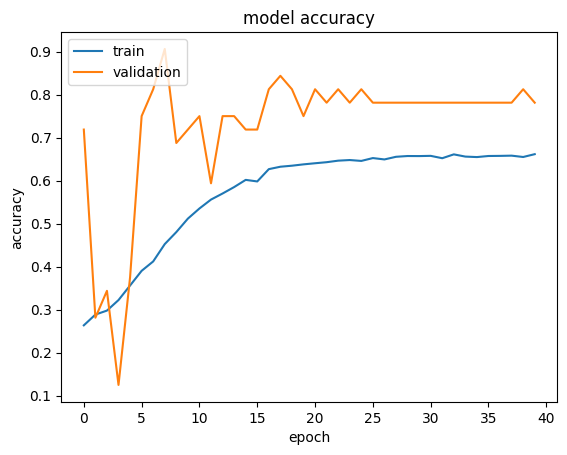

In [62]:
plt.plot(history_complex.history["accuracy"])
plt.plot(history_complex.history["val_accuracy"])
plt.title("model accuracy")
plt.ylabel("accuracy")
plt.xlabel("epoch")
plt.legend(["train", "validation"], loc="upper left")
plt.show()

### **Evaluating the Model on Test Set**


In [63]:
# Calculate the number of steps for the entire test set to be processed
test_steps = test_generator.samples // batch_size

# If the number of samples isn't a multiple of the batch size,
# you have one more batch with the remaining samples
if test_generator.samples % batch_size > 0:
    test_steps += 1

# Evaluating the model on the test set
evaluation_results = model_complex.evaluate(test_generator, steps=test_steps)
print(f"Loss: {evaluation_results[0]}, Accuracy: {evaluation_results[1]}")

1/4 [======>.......................] - ETA: 0s - loss: 0.4505 - accuracy: 0.8438

4/4 [==============================] - 0s 8ms/step - loss: 0.6936 - accuracy: 0.7422


Loss: 0.6935572624206543, Accuracy: 0.7421875


### **Plotting Confusion Matrix**


1/4 [======>.......................] - ETA: 0s

4/4 [==============================] - 0s 7ms/step


              precision    recall  f1-score   support

       happy       0.77      0.84      0.81        32
     neutral       0.62      0.72      0.67        32
         sad       0.67      0.56      0.61        32
    surprise       0.93      0.84      0.89        32

    accuracy                           0.74       128
   macro avg       0.75      0.74      0.74       128
weighted avg       0.75      0.74      0.74       128



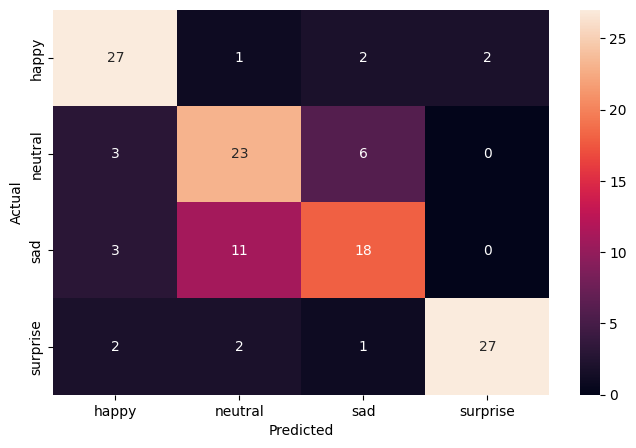

In [64]:
pred_probabilities = model_complex.predict(test_generator, steps=test_steps)
pred = np.argmax(pred_probabilities, axis=1)

# Getting the true labels from the generator
y_true = test_generator.classes

# Printing the classification report with actual emotion labels
print(classification_report(y_true, pred, target_names=CATEGORIES))

# Plotting the heatmap using confusion matrix
cm = confusion_matrix(y_true, pred)
plt.figure(figsize=(8, 5))
sns.heatmap(cm, annot=True, fmt=".0f", xticklabels=CATEGORIES, yticklabels=CATEGORIES)
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.show()

**Observations and Insights:\_\_**


### **Plotting the Confusion Matrix for the chosen final model**


1/4 [======>.......................] - ETA: 0s

4/4 [==============================] - 0s 7ms/step


              precision    recall  f1-score   support

       happy       0.77      0.84      0.81        32
     neutral       0.62      0.72      0.67        32
         sad       0.67      0.56      0.61        32
    surprise       0.93      0.84      0.89        32

    accuracy                           0.74       128
   macro avg       0.75      0.74      0.74       128
weighted avg       0.75      0.74      0.74       128



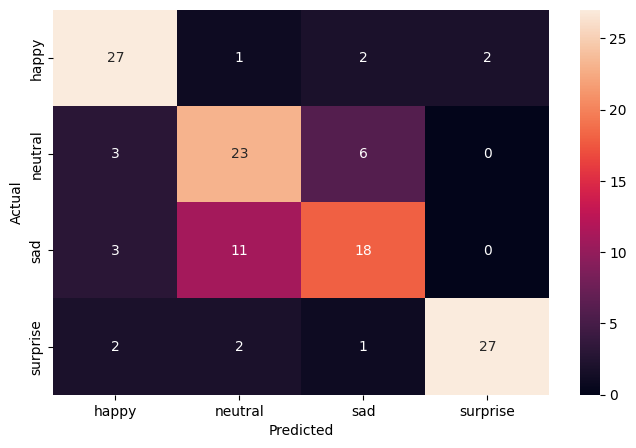

In [65]:
pred_probabilities = model_complex.predict(test_generator, steps=test_steps)
pred = np.argmax(pred_probabilities, axis=1)

# Getting the true labels from the generator
y_true = test_generator.classes

# Printing the classification report with actual emotion labels
print(classification_report(y_true, pred, target_names=CATEGORIES))

# Plotting the heatmap using confusion matrix
cm = confusion_matrix(y_true, pred)
plt.figure(figsize=(8, 5))
sns.heatmap(cm, annot=True, fmt=".0f", xticklabels=CATEGORIES, yticklabels=CATEGORIES)
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.show()

**Observations and Insights:\_\_**


## **Conclusion:\*\***\_\_\_\_**\*\***


### **Insights**

### **Refined insights**:

- What are the most meaningful insights from the data relevant to the problem?

### **Comparison of various techniques and their relative performance**:

- How do different techniques perform? Which one is performing relatively better? Is there scope to improve the performance further?

### **Proposal for the final solution design**:

- What model do you propose to be adopted? Why is this the best solution to adopt?
